In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
gpu_info = !nvidia-smi
print(gpu_info)

['Sat Jun  1 10:11:00 2024       ', '+---------------------------------------------------------------------------------------+', '| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |', '|-----------------------------------------+----------------------+----------------------+', '| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |', '| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |', '|                                         |                      |               MIG M. |', '|=========================================+======================+======================|', '|   0  NVIDIA A100-SXM4-40GB          Off | 00000000:00:04.0 Off |                    0 |', '| N/A   33C    P0              47W / 400W |      2MiB / 40960MiB |      0%      Default |', '|                                         |                      |             Disabled |', '+--------------------------------

Training Data Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 77427 entries, 0 to 77426
Data columns (total 2 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   Origin Address  77427 non-null  object
 1   ex Add          77427 non-null  object
dtypes: object(2)
memory usage: 1.2+ MB
None
Validation Data Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9678 entries, 0 to 9677
Data columns (total 2 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   Origin Address  9678 non-null   object
 1   ex Add          9678 non-null   object
dtypes: object(2)
memory usage: 151.3+ KB
None
Training Data Head:
              Origin Address     ex Add
0  서울특별시 양천구 신월동 남부순환로75길 35      밀레홈파크
1       서울특별시 송파구 잠실동 잠실로 62  트리지움삼백십칠동
2     서울특별시 구로구 온수동 경인로 15-7       성원연립
3   서울특별시 은평구 녹번동 녹번로1길 19-9       주영빌트
4      서울특별시 서초구 방배동 청두곶9길 4      덕산그린빌
Validation Data Head:
              Orig

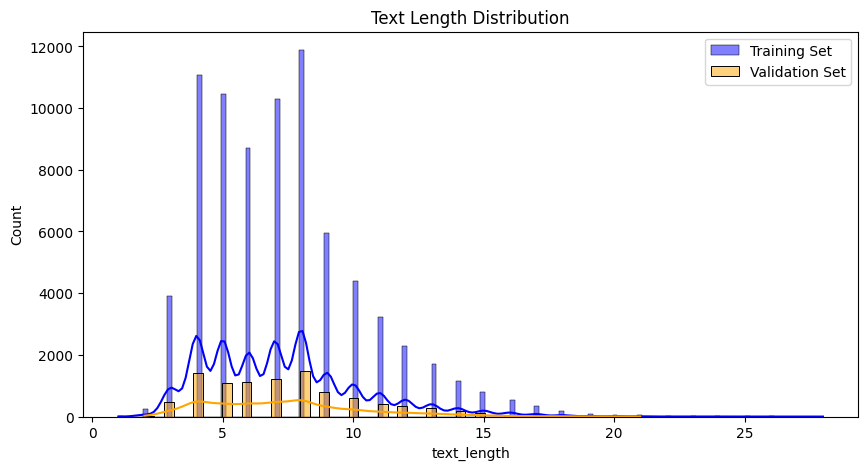

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

fd = '/content/drive/MyDrive/text_team/'
training_data = pd.read_csv(fd+'training.csv')
validation_data = pd.read_csv(fd+'validation.csv')

#preprocess, EDA
def preprocess_data(df):
    df = df[['Origin Address', 'ex Add']].dropna()
    return df

training_data = preprocess_data(training_data)
validation_data = preprocess_data(validation_data)

print("Training Data Info:")
print(training_data.info())
print("Validation Data Info:")
print(validation_data.info())

print("Training Data Head:")
print(training_data.head())
print("Validation Data Head:")
print(validation_data.head())

print("Training Data Description:")
print(training_data.describe())
print("Validation Data Description:")
print(validation_data.describe())

#plot
training_data['text_length'] = training_data['ex Add'].apply(len)
validation_data['text_length'] = validation_data['ex Add'].apply(len)

plt.figure(figsize=(10, 5))
sns.histplot(training_data['text_length'], kde=True, color='blue', label='Training Set')
sns.histplot(validation_data['text_length'], kde=True, color='orange', label='Validation Set')
plt.legend()
plt.title('Text Length Distribution')
plt.show()


In [ ]:
from torch.utils.data import Dataset

class AddressDataset(Dataset):
    def __init__(self, data, tokenizer, max_len=128):
        self.data = data
        self.tokenizer = tokenizer
        self.max_len = max_len

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        origin_address = str(self.data.iloc[idx]['Origin Address'])
        ex_add = str(self.data.iloc[idx]['ex Add'])

        encoding = self.tokenizer(
            ex_add,
            max_length=self.max_len,
            padding='max_length',
            truncation=True,
            return_tensors='pt'
        )

        target_encoding = self.tokenizer(
            text_target=origin_address,
            max_length=self.max_len,
            padding='max_length',
            truncation=True,
            return_tensors='pt'
        )


        labels = target_encoding['input_ids'].squeeze()

        return {
            'input_ids': encoding['input_ids'].squeeze(),
            'attention_mask': encoding['attention_mask'].squeeze(),
            'labels': labels
        }


In [ ]:
!pip install konlpy

In [ ]:
from transformers import T5Tokenizer, T5ForConditionalGeneration, AdamW, get_linear_schedule_with_warmup
from torch.utils.data import DataLoader, Dataset
import torch
from tqdm import tqdm
from nltk.translate.bleu_score import sentence_bleu
import os
from konlpy.tag import Kkma
from transformers import pipeline, AutoTokenizer, AutoModelForSeq2SeqLM


pipe = pipeline("text2text-generation", model="KETI-AIR/ke-t5-small")

os.environ['JAVA_OPTS'] = '-Xmx2g'

#KOR T5 + tokenizer
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
tokenizer = AutoTokenizer.from_pretrained("KETI-AIR/ke-t5-small")
model = AutoModelForSeq2SeqLM.from_pretrained("KETI-AIR/ke-t5-small")
model.to(device)

#kkma
kkma = Kkma()
train_dataset = AddressDataset(training_data, tokenizer)
val_dataset = AddressDataset(validation_data, tokenizer)

train_loader = DataLoader(train_dataset, batch_size=8, shuffle=True, num_workers=4)
val_loader = DataLoader(val_dataset, batch_size=8, num_workers=4)

optimizer = AdamW(model.parameters(), lr=5e-5)
total_steps = len(train_loader) * 10
scheduler = get_linear_schedule_with_warmup(optimizer, num_warmup_steps=int(0.1 * total_steps), num_training_steps=total_steps)

#train
def train_epoch(model, data_loader, optimizer, device, scheduler):
    model.train()
    total_loss = 0

    progress_bar = tqdm(data_loader, desc="Training", leave=True)

    for batch in progress_bar:
        optimizer.zero_grad()

        input_ids = batch['input_ids'].to(device)
        attention_mask = batch['attention_mask'].to(device)
        labels = batch['labels'].to(device)

        outputs = model(input_ids=input_ids, attention_mask=attention_mask, labels=labels)
        loss = outputs.loss

        total_loss += loss.item()

        loss.backward()
        optimizer.step()
        scheduler.step()

        progress_bar.set_postfix(loss=loss.item())

    return total_loss / len(data_loader)

#evalute
def eval_model(model, data_loader, device, tokenizer):
    model.eval()
    total_loss = 0
    bleu_scores = []

    progress_bar = tqdm(data_loader, desc="Evaluating", leave=True)

    with torch.no_grad():
        for batch in progress_bar:
            input_ids = batch['input_ids'].to(device)
            attention_mask = batch['attention_mask'].to(device)
            labels = batch['labels'].to(device)

            outputs = model(input_ids=input_ids, attention_mask=attention_mask, labels=labels)
            loss = outputs.loss

            total_loss += loss.item()

            generated_ids = model.generate(input_ids=input_ids, attention_mask=attention_mask)
            preds = [tokenizer.decode(g, skip_special_tokens=True, clean_up_tokenization_spaces=True) for g in generated_ids]
            targets = [tokenizer.decode(l, skip_special_tokens=True, clean_up_tokenization_spaces=True) for l in labels]

            for pred, target in zip(preds, targets):
                print(f'Prediction: {pred}')
                print(f'Target: {target}')
                print('---')

         # Cal BLEU score with tokenization
            for pred, target in zip(preds, targets):
                pred_tokens = kkma.morphs(pred)
                target_tokens = kkma.morphs(target)
                if len(target_tokens) > 0:
                    bleu_score = sentence_bleu([target_tokens], pred_tokens, weights=(0.5, 0.5))
                else:
                    bleu_score = 0
                bleu_scores.append(bleu_score)


            progress_bar.set_postfix(loss=loss.item())

    avg_bleu_score = sum(bleu_scores) / len(bleu_scores)
    return total_loss / len(data_loader), avg_bleu_score

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
You are using the default legacy behaviour of the <class 'transformers.models.t5.tokenization_t5.T5Tokenizer'>. This is expected, and simply means that the `legacy` (previous) behavior will be used so nothing changes for you. If you want to use the new behaviour, set `legacy=False`. This should only be set if you understand what it means, and thoroughly read the reason why this was added as explained in https://github.com/huggingface/transformers/pull/24565
/usr/local/lib/pyth

Epoch 1/10


Training:   0%|          | 0/9679 [00:00<?, ?it/s]/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
Evaluating:   0%|          | 0/1210 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/transformers/generation/utils.py:1168: UserWarning: Using the model-agnostic default `max_length` (=20) to control the generation length. We recommend setting `max_new_tokens` to control the maximum length of the generation.
  warnings.warn(


Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 마포구 공덕동 마포대로 173-15
---
Prediction: 서울특별시 동작구 사당동 신천로4길 23
Target: 서울특별시 중랑구 중화동 상봉중앙로5나길 23
---
Prediction: 서울특별시 은평구 응암동동순환로1길 8
Target: 서울특별시 동작구 상도동 국사봉12길 36
---
Prediction: 서울특별시 강서구 방화동 천로1길 6
Target: 서울특별시 은평구 구산동 연서로15길 30
---
Prediction: 서울특별시 강동구 성내동 구로4가길 8
Target: 서울특별시 성북구 종암동 종암로24가길 53
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 39
Target: 서울특별시 강서구 염창동 양천로 686-12
---
Prediction: 서울특별시 양천구 신월동 신천로5길 23
Target: 서울특별시 동작구 사당동 사당로16다길 101
---
Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 은평구 구산동 서오릉로17길 28-14
---


/usr/local/lib/python3.10/dist-packages/nltk/translate/bleu_score.py:552: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
Evaluating:   0%|          | 1/1210 [00:06<2:13:30,  6.63s/it, loss=0.264]

Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 강북구 우이동 삼양로149길 36
---
Prediction: 서울특별시 은평구 구산동동로5길 18
Target: 서울특별시 은평구 녹번동 통일로63길 10
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 23
Target: 서울특별시 양천구 신월동 곰달래로11길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 7
Target: 서울특별시 구로구 개봉동 개봉로15길 68-14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 양천구 신월동 지양로11길 22-4
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서초구 양재동 논현로5길 31-20
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 광진구 중곡동 동일로76길 8
---


Evaluating:   0%|          | 2/1210 [00:07<1:02:17,  3.09s/it, loss=0.223]

Prediction: 서울특별시 노원구 상계동 도봉로4길 6
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 동작구 사당동 신천로1길 10
Target: 서울특별시 영등포구 여의도동 국회대로76길 10
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강동구 성내동 풍성로53길 12-18
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 관악구 신림동 난곡로 189-2
---
Prediction: 서울특별시 마포구 신관동 동천로4길 23
Target: 서울특별시 강서구 내발산동 강서로47마길 37-22
---
Prediction: 서울특별시 강동구 성내동 동천로1길 18
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 구로구 가리봉동 남부순환로105가길 10-2
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 26
Target: 서울특별시 양천구 신월동 남부순환로27길 9-17
---


Evaluating:   0%|          | 3/1210 [00:07<39:42,  1.97s/it, loss=0.239]  

Prediction: 서울특별시 강서구 방화동 신로1길 24
Target: 서울특별시 양천구 신월동 남부순환로64길 37-15
---
Prediction: 서울특별시 성북구 정릉동 삼양로4길 23
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 양천구 목동 목동중앙북로 116
---
Prediction: 서울특별시 동작구 사당동 신천로1길 8
Target: 서울특별시 용산구 이태원동 이태원로27나길 40
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성북구 석관동 돌곶이로18길 27-12
---
Prediction: 서울특별시 동작구 사당동 구로동 신로4길 13
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 종로구 홍지동 자하문로 293-17
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 마포구 망원동 방울내로 57-16
---


Evaluating:   0%|          | 4/1210 [00:08<28:59,  1.44s/it, loss=0.279]

Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 송파구 풍납동 천호대로152길 13
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 관악구 신림동 남부순환로163가길 29-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 구로구 개봉동 고척로18길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 은평구 신사동 갈현로3길 25-7
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 은평구 대조동 연서로18길 28-4
---
Prediction: 서울특별시 강동구 천호동 도봉로166가길 13
Target: 서울특별시 성북구 성북동 성북로8다길 12
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 마포구 연남동 연남로5길 46
---


Evaluating:   0%|          | 5/1210 [00:09<23:01,  1.15s/it, loss=0.247]

Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 금천구 시흥동 탑골로 67
---
Prediction: 서울특별시 은평구 구산동 강서로1길 8
Target: 서울특별시 강북구 수유동 노해로7길 32-7
---
Prediction: 서울특별시 마포구 망관동 동천로4길 23
Target: 서울특별시 은평구 역촌동 연서로16길 35-3
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강동구 암사동 상암로23길 66
---
Prediction: 서울특별시 은평구 불광동 삼양로1길 29
Target: 서울특별시 강북구 수유동 인수봉로42길 26
---
Prediction: 서울특별시 성북구 정릉동 동천로1길 23
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 송파구 풍납동 천호대로152길 13
---
Prediction: 서울특별시 동작구 사당동 신천로1길 5
Target: 서울특별시 은평구 대조동 연서로18길 18-2
---


Evaluating:   0%|          | 6/1210 [00:09<19:18,  1.04it/s, loss=0.243]

Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 동작구 상도동 상도로13라길 17
---
Prediction: 서울특별시 강동구 천호동순환로21길 6
Target: 서울특별시 용산구 이태원동 이태원로27길 39-11
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 8
Target: 서울특별시 송파구 잠실동 백제고분로18길 30
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 창동 노해로62길 46
---
Prediction: 서울특별시 은평구 구산동동천로1길 8
Target: 서울특별시 중랑구 면목동 겸재로15길 35-10
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 강동구 성내동 성내로13길 49-13
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 중랑구 면목동 용마산로94다길 21
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 동대문구 장안동 답십리로69가길 21
---


Evaluating:   1%|          | 7/1210 [00:10<17:01,  1.18it/s, loss=0.249]

Prediction: 서울특별시 마포구 망원동천로4길 23
Target: 서울특별시 노원구 공릉2동 노원로 75
---
Prediction: 서울특별시 동작구 상도동 강서로2길 18
Target: 서울특별시 종로구 구기동 진흥로21길 12-9
---
Prediction: 서울특별시 관악구 신림동동 신로5길 7
Target: 서울특별시 구로구 개봉동 경인로40길 11
---
Prediction: 서울특별시 은평구 신사동동 신천로9길 23
Target: 서울특별시 성동구 송정동 송정길 92
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 광진구 능동 능동로32길 151
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 노원구 상계동 동일로221길 22
---
Prediction: 서울특별시 동작구 상門동 천호대로4길 13
Target: 서울특별시 영등포구 도림동 영신로1길 28
---
Prediction: 서울특별시 마포구 합정동 강서로4길 18
Target: 서울특별시 서초구 서초동 명달로 42
---


Evaluating:   1%|          | 8/1210 [00:10<15:20,  1.31it/s, loss=0.256]

Prediction: 서울특별시 송파구 송파동 도봉로1길 8
Target: 서울특별시 송파구 송파동 송이로12길 11
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강동구 천호동 성안로27길 51-9
---
Prediction: 서울특별시 은평구 응암동동 삼양로1길 29
Target: 서울특별시 송파구 삼전동 삼학사로9길 21
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 양천구 신월동 남부순환로70길 8-5
---
Prediction: 서울특별시 동작구 상門동 신길로3길 13
Target: 서울특별시 강동구 성내동 풍성로 106
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강북구 수유동 삼양로131길 67
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강서구 염창동 공항대로59다길 61
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 종로구 창신동 창신6가길 10
---


Evaluating:   1%|          | 9/1210 [00:11<14:25,  1.39it/s, loss=0.234]

Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 양천구 신월동 가로공원로58길 4-1
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 서대문구 북가좌동 거북골로20길 53-21
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 동대문구 이문동 외대역동로14길 24
---
Prediction: 서울특별시 관악구 봉천동 강서로1길 18
Target: 서울특별시 강남구 삼성동 학동로82길 27
---
Prediction: 서울특별시 강동구 천호동천로1길 28
Target: 서울특별시 마포구 합정동 희우정로1길 27
---
Prediction: 서울특별시 송파구 오금동 강서로4길 18
Target: 서울특별시 성동구 성수동2가 둘레19길 5
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 23
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 관악구 신림동 남부순환로194길 19
---


Evaluating:   1%|          | 11/1210 [00:12<11:28,  1.74it/s, loss=0.212]

Prediction: 서울특별시 관악구 신림동동 신천로4길 23
Target: 서울특별시 은평구 응암동 응암로21가길 23-1
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강동구 천호동 구천면로46길 42
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 목동 목동동로 208-11
---
Prediction: 서울특별시 강동구 성내동 동천로1길 23
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 방화동 개화동로23길 20
---
Prediction: 서울특별시 동작구 상도동 강서로4길 18
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 도봉구 쌍문동 삼양로 580-8
---
Prediction: 서울특별시 강동구 천호동 도봉로115길 18
Target: 서울특별시 동대문구 장안동 장한로23길 11-5
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 18
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 강동구 성내동 삼양로4가길 18
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 은평구 불광동 구로로1길 8
Target: 서울특별시 양천구 신정동 은행정로7길 26
---
Prediction: 서울특별시 강서구 화곡동 화산로1길 7
Target: 서울특별시 마포구 성산동 월드컵로26길 18
---
Prediction: 서울특별시 동작구 상도동동로4길 18
Target: 서울특별시 강남구 개포동 개포로 264
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 중랑구 면목동 면목로79길 17
---

Evaluating:   1%|          | 12/1210 [00:13<11:42,  1.70it/s, loss=0.236]

Prediction: 서울특별시 양천구 신월동 신천로5길 10
Target: 서울특별시 마포구 망원동 망원로1길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 동작구 상도동 성대로37길 6
---
Prediction: 서울특별시 서초구 반포동 신천로1길 10
Target: 서울특별시 중랑구 면목동 겸재로27길 37
---
Prediction: 서울특별시 은평구 구산동동로5가길 8
Target: 서울특별시 동작구 사당동 사당로9나길 21
---
Prediction: 서울특별시 강서구 방화동 천로4길 18
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 은평구 녹동 도봉로1가길 8
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 강동구 암사동 고덕로14길 50-1
---
Prediction: 서울특별시 동작구 상도동동 신길로5길 10
Target: 서울특별시 동대문구 제기동 약령시로2길 55
---


Evaluating:   1%|          | 13/1210 [00:13<11:55,  1.67it/s, loss=0.246]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 도봉구 도봉동 도봉로160길 24-6
---
Prediction: 서울특별시 동작구 상도동 철동로1길 8
Target: 서울특별시 양천구 목동 목동중앙서로7길 42
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 동작구 상도동 양녕로22바길 62
---
Prediction: 서울특별시 마포구 신관동 동천로4길 23
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 도봉동 도봉로183길 21-5
---
Prediction: 서울특별시 양천구 목동 목동중앙로16길 13
Target: 서울특별시 은평구 불광동 불광로 122-10
---
Prediction: 서울특별시 강북구 수유동동로1길 5
Target: 서울특별시 송파구 잠실동 백제고분로18길 16-15
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 노원구 월계동 석계로13길 6-10
---


Evaluating:   1%|          | 14/1210 [00:14<12:00,  1.66it/s, loss=0.237]

Prediction: 서울특별시 강동구 성내동 구로4길 23
Target: 서울특별시 금천구 시흥동 시흥대로36길 29-1
---
Prediction: 서울특별시 강서구 방화동 천로4길 23
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 성동구 성수동1가 왕십리로 83-21
---
Prediction: 서울특별시 동작구 상도동 철동로1길 5
Target: 서울특별시 송파구 오금동 중대로34길 5-12
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 동대문구 장안동 장한로3길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강동구 길동 양재대로126길 15
---
Prediction: 서울특별시 은평구 응암동동순환로4길 23
Target: 서울특별시 서초구 우면동 태봉로 114
---
Prediction: 서울특별시 동작구 상도동 철천로1길 6
Target: 서울특별시 도봉구 도봉동 도봉로177가길 10-3
---


Evaluating:   1%|          | 15/1210 [00:14<12:04,  1.65it/s, loss=0.244]

Prediction: 서울특별시 동작구 상도동 신천로1길 8
Target: 서울특별시 은평구 갈현동 갈현로33가길 17
---
Prediction: 서울특별시 마포구 신원동 천호로4길 23
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 5
Target: 서울특별시 강서구 화곡동 까치산로4나길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 광진구 구의동 영화사로13길 3
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 강북구 수유동 철로1길 16
Target: 서울특별시 강서구 화곡동 등촌로5가길 44
---
Prediction: 서울특별시 강동구 천호동 도봉로115길 18
Target: 서울특별시 성북구 석관동 한천로82길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 영등포구 양평동6가 양평로28사길 1
---


Evaluating:   1%|▏         | 17/1210 [00:15<10:26,  1.90it/s, loss=0.237]

Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 금천구 독산동 시흥대로80길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강동구 성내동 천호대로170길 106-17
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 광진구 자양동 동일로4길 57-11
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 중랑구 묵동 공릉로2나길 32-12
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 동대문구 용두동 무학로20다길 15-7
---
Prediction: 서울특별시 은평구 불광동 구로로5길 8
Target: 서울특별시 성북구 종암동 종암로14길 26-19
---
Prediction: 서울특별시 관악구 신림동동로1길 23
Target: 서울특별시 관악구 봉천동 중앙길 65
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 은평구 신사동 가좌로11가길 12-10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서대문구 북가좌동 증가로20길 28
---
Prediction: 서울특별시 강북구 수유동동로10가길 7
Target: 서울특별시 강서구 화곡동 강서로18아길 25-5
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 강북구 수유동 삼양로6길 13
Target: 서울특별시 강동구 암사동 올림픽로98길 61-10
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 

Evaluating:   1%|▏         | 18/1210 [00:16<10:54,  1.82it/s, loss=0.208]

Prediction: 서울특별시 성북구 정릉동 오천로1길 8
Target: 서울특별시 동작구 대방동 등용로 76
---
Prediction: 서울특별시 강북구 수유동 강서로5길 18
Target: 서울특별시 강서구 공항동 공항대로8가길 32
---
Prediction: 서울특별시 은평구 갈현동동로4가길 8
Target: 서울특별시 강서구 등촌동 등촌로39길 23-5
---
Prediction: 서울특별시 은평구 구산동동로1길 23
Target: 서울특별시 강서구 등촌동 공항대로58길 15-8
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 18
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 관악구 신림동동 신천로4길 23
Target: 서울특별시 서대문구 홍은동 연희로41길 173
---
Prediction: 서울특별시 강서구 방화동 천로5길 18
Target: 서울특별시 은평구 불광동 불광로14길 4-8
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 8
Target: 서울특별시 동작구 사당동 사당로16길 51-6
---


Evaluating:   2%|▏         | 19/1210 [00:17<11:17,  1.76it/s, loss=0.23]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 동작구 신대방동 여의대방로22아길 22
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 은평구 응암동동 동천로4길 23
Target: 서울특별시 은평구 신사동 가좌로 315-1
---
Prediction: 서울특별시 은평구 녹동 도봉로1길 16
Target: 서울특별시 강서구 화곡동 곰달래로35길 31
---
Prediction: 서울특별시 강북구 미아동동로1길 23
Target: 서울특별시 강남구 대치동 역삼로92길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 양천구 신정동 도봉로1길 18
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 동작구 대방동 대방동9길 5
---


Evaluating:   2%|▏         | 20/1210 [00:17<11:29,  1.72it/s, loss=0.246]

Prediction: 서울특별시 동작구 사당동 신천로1길 10
Target: 서울특별시 광진구 자양동 뚝섬로 568
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 8
Target: 서울특별시 강서구 화곡동 초록마을로2길 7-8
---
Prediction: 서울특별시 동작구 상도동 강서로2길 18
Target: 서울특별시 마포구 노고산동 고산길 60-17
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 양천구 신월동 남부순환로85길 16
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 29
Target: 서울특별시 강동구 길동 천중로44길 40
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 양천구 신월동 중앙로57길 1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 서대문구 홍제동 홍제내2나길 33
---


Evaluating:   2%|▏         | 21/1210 [00:18<11:36,  1.71it/s, loss=0.237]

Prediction: 서울특별시 은평구 갈현동동로4길 23
Target: 서울특별시 은평구 갈현동 연서로27길 13-5
---
Prediction: 서울특별시 은평구 불광동 구로로1길 8
Target: 서울특별시 송파구 오금동 중대로38길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 광진구 중곡동 능동로50길 39
---
Prediction: 서울특별시 양천구 목동 목동중앙로16길 16
Target: 서울특별시 영등포구 영등포동4가 영신로30길 1
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 5
Target: 서울특별시 송파구 잠실동 올림픽로4길 42
---
Prediction: 서울특별시 은평구 구산동 강서로166길 18
Target: 서울특별시 관악구 봉천동 당곡6나길 33
---
Prediction: 서울특별시 성북구 정릉동 동천로1길 26
Target: 서울특별시 성북구 정릉동 아리랑로19가길 21
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---


Evaluating:   2%|▏         | 22/1210 [00:18<11:43,  1.69it/s, loss=0.221]

Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 도봉구 쌍문동 도당로 13
---
Prediction: 서울특별시 송파구 거문동 강서로1길 23
Target: 서울특별시 용산구 이촌동 이촌로65길 8
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성북구 석관동 돌곶이로18길 23-8
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 성동구 금호동1가 금호로 100
---
Prediction: 서울특별시 강동구 천호동로1가길 8
Target: 서울특별시 노원구 공릉동 섬밭로 17
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신월동 오목로 24
---
Prediction: 서울특별시 관악구 신림동동로4가길 7
Target: 서울특별시 송파구 가락동 동남로11길 4
---
Prediction: 서울특별시 강북구 수유동 삼양로4길 13
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---


Evaluating:   2%|▏         | 24/1210 [00:19<10:17,  1.92it/s, loss=0.227]

Prediction: 서울특별시 동작구 상도동동 신길로31길 23
Target: 서울특별시 관악구 신림동 법원단지9길 22
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 16
Target: 서울특별시 영등포구 신길동 신길로62길 22-7
---
Prediction: 서울특별시 강서구 화곡동 강서로21길 18
Target: 서울특별시 강남구 세곡동 헌릉로571길 34-32
---
Prediction: 서울특별시 성북구 정릉동 삼양로1길 6
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 화곡로44가길 52-11
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 강동구 성내동 동천로1길 23
Target: 서울특별시 영등포구 대림동 대림로 256
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 송파구 삼전동 삼학사로13길 6-1
---
Prediction: 서울특별시 강북구 수유동 철동로10길 8
Target: 서울특별시 용산구 용문동 효창원로37나길 20-21
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서대문구 북가좌동 수색로 102
---
Prediction: 서울특별시 성북구 종협동 삼양로6길 18
Target: 서울특별시 강동구 성내동 양재대로91나길 62
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강서구 공항동 방화대로5길 34
---
Prediction: 서울특별시 강서구 방화동 신로1길 6
Target: 서울특별시 노원구 중계

Evaluating:   2%|▏         | 25/1210 [00:20<10:46,  1.83it/s, loss=0.247]

Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 노원구 공릉동 동일로182길 57-7
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 광진구 구의동 구의로4길 7-8
---
Prediction: 서울특별시 강북구 수유동 철동로1길 5
Target: 서울특별시 동대문구 장안동 답십리로68길 83
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 18
Target: 서울특별시 강서구 화곡동 초록마을로18길 25-23
---
Prediction: 서울특별시 강북구 수유동로5길 18
Target: 서울특별시 강서구 방화동 방화동로10길 40
---
Prediction: 서울특별시 강동구 천호동 양재대로116길 18
Target: 서울특별시 서초구 방배동 방배중앙로21길 55
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 서대문구 연희동 연희로25길 18
---
Prediction: 서울특별시 관악구 신림동동 신천로1길 23
Target: 서울특별시 관악구 신림동 남부순환로151길 55
---


Evaluating:   2%|▏         | 26/1210 [00:21<11:07,  1.77it/s, loss=0.217]

Prediction: 서울특별시 동작구 사당동 신천로1길 5
Target: 서울특별시 중구 중림동 서소문로2길 7
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 마포구 성산동 성산로6길 21-10
---
Prediction: 서울특별시 마포구 합정동 강서로1길 6
Target: 서울특별시 서초구 서초동 효령로67길 35
---
Prediction: 서울특별시 강서구 공항동 신천로1길 7
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 양천구 신월동 지양로16길 46-16
---
Prediction: 서울특별시 성북구 정릉동 동천로1길 23
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 강동구 천호동천로1길 23
Target: 서울특별시 송파구 풍납동 풍성로20길 56
---


Evaluating:   2%|▏         | 27/1210 [00:21<11:21,  1.74it/s, loss=0.24]

Prediction: 서울특별시 강북구 수유동동로5길 8
Target: 서울특별시 성북구 정릉동 북악산로1길 78
---
Prediction: 서울특별시 양천구 신월동 신천로5길 23
Target: 서울특별시 동작구 신대방동 보라매로7가길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 초록마을로32길 29-36
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 8
Target: 서울특별시 강북구 미아동 삼양로32가길 17
---
Prediction: 서울특별시 강북구 미아동천로1길 5
Target: 서울특별시 은평구 녹번동 녹번로 6-24
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 서초구 방배동 방배로25길 54-7
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 중랑구 중화동 봉화산로 102-4
---
Prediction: 서울특별시 강동구 천호동로1길 8
Target: 서울특별시 서초구 방배동 방배로 14
---


Evaluating:   2%|▏         | 28/1210 [00:22<13:55,  1.41it/s, loss=0.251]

Prediction: 서울특별시 강동구 천호동 도봉로115길 18
Target: 서울특별시 강동구 천호동 천중로35길 73-10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 광진구 자양동 능동로3길 53
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 강남구 삼성동 봉은사로69길 43
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 동작구 상도동 철동로5길 17
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 강북구 수유동 인수봉로52길 50
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서대문구 홍제동 간호대로 41
---


Evaluating:   2%|▏         | 30/1210 [00:23<11:04,  1.77it/s, loss=0.249]

Prediction: 서울특별시 강동구 천호동 도봉로4길 29
Target: 서울특별시 강북구 미아동 솔매로22가길 37
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 18
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로116길 18
Target: 서울특별시 강서구 방화동 초원로12길 25
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 강서구 등촌동 화곡로66길 164
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 송파구 석촌동 백제고분로40길 13-15
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 23
Target: 서울특별시 강동구 성내동 강동대로51길 48-1
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 노원구 하계동 섬밭로 196
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 노원구 공릉동 동일로182길 47-22
---
Prediction: 서울특별시 성북구 정릉동 동천로4길 23
Target: 서울특별시 금천구 시흥동 독산로28가길 11
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 서대문구 북가좌동 거북골로21길 10-10
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 동작구 사당동 신천로5길 20
Target: 서울특별시 은평구

Evaluating:   3%|▎         | 31/1210 [00:24<11:21,  1.73it/s, loss=0.253]

Prediction: 서울특별시 양천구 신월동 신천로1길 5
Target: 서울특별시 강동구 암사동 암사길 63
---
Prediction: 서울특별시 성북구 정릉동 삼양로4가길 7
Target: 서울특별시 성북구 길음동 길음로 119
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 강북구 수유동 인수봉로42길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 광진구 구의동 자양로30길 83
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 23
Target: 서울특별시 구로구 구로동 디지털로31길 90
---
Prediction: 서울특별시 강서구 등촌동동 동천로1길 29
Target: 서울특별시 관악구 봉천동 청룡10길 45
---
Prediction: 서울특별시 은평구 불광동 구로4가길 8
Target: 서울특별시 은평구 응암동 응암로32길 13-8
---


Evaluating:   3%|▎         | 32/1210 [00:24<11:26,  1.72it/s, loss=0.234]

Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 양천구 신정동 오목로 148-30
---
Prediction: 서울특별시 양천구 신월동 양재로5길 18
Target: 서울특별시 강서구 화곡동 초록마을로32길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강서구 방화동 개화동로29길 41-9
---
Prediction: 서울특별시 서초구 서초동동로5길 23
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 은평구 구산동동 와우로5길 8
Target: 서울특별시 강서구 화곡동 초록마을로3길 74
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 광진구 자양동 뚝섬로54길 65
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 중구 신당동 동호로10길 30
---


Evaluating:   3%|▎         | 33/1210 [00:25<11:29,  1.71it/s, loss=0.209]

Prediction: 서울특별시 강동구 천호동 도봉로21길 6
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 초록마을로5길 29
---
Prediction: 서울특별시 강동구 천호동 철천로1길 8
Target: 서울특별시 강북구 수유동 수유로23길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 동작구 사당동 사당로20바길 31
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 노원구 월계동 광운로13길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 양천구 목동 목동중앙로13길 37-11
---
Prediction: 서울특별시 서대문구 홍금촌동 강서로1길 16
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 오금동 동남로23길 47-10
---


Evaluating:   3%|▎         | 35/1210 [00:26<10:00,  1.96it/s, loss=0.24]

Prediction: 서울특별시 강서구 화곡동 강서로1길 13
Target: 서울특별시 노원구 중계동 중계로14바길 18
---
Prediction: 서울특별시 강서구 방화동 신로5길 23
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 강서구 등촌동동 동천로21길 18
Target: 서울특별시 성북구 길음동 숭인로2길 61
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 양천구 신월동 오목로 90
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 종로구 부암동 자하문로 286
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 18
Target: 서울특별시 강남구 논현동 논현로145길 15
---
Prediction: 서울특별시 은평구 불릉동 중앙로1길 29
Target: 서울특별시 강북구 미아동 삼양로64길 11
---
Prediction: 서울특별시 강동구 천호동 철천로26길 6
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 30
---
Prediction: 서울특별시 마포구 신원동 강서로4길 23
Target: 서울특별시 용산구 이촌동 이촌로71길 10
---
Prediction: 서울특별시 은평구 불광동 구로로5길 29
Target: 서울특별시 동작구 상도동 국사봉길 98
---
Prediction: 서울특별시 강북구 수유동동로5길 29
Target: 서울특별시 강북구 미아동 도봉로67길 71
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 13
Target: 서울특별시 은평구 역촌동 진흥로5길 1
---
Prediction: 서울특별시 양천구 신정동 양재로5길 18
Target: 서울특별시 도봉구 도봉동 도봉로187길 30
---
Predicti

Evaluating:   3%|▎         | 36/1210 [00:26<10:33,  1.85it/s, loss=0.239]

Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 용산구 후암동 소월로2나길 10
---
Prediction: 서울특별시 강북구 미아동동 동천로4길 23
Target: 서울특별시 강북구 미아동 도봉로78길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 관악구 봉천동 남부순환로226길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-6
---
Prediction: 서울특별시 관악구 신림동동로5길 23
Target: 서울특별시 은평구 역촌동 갈현로7길 6-11
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 광진구 구의동 자양로 310
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 송파구 잠실동 올림픽로 99
---


Evaluating:   3%|▎         | 37/1210 [00:27<10:55,  1.79it/s, loss=0.235]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 강서구 화곡동 초록마을로30길 7-10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 은평구 불광동 연서로 286
---
Prediction: 서울특별시 강동구 천호동 천로1길 26
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 강동구 천호동 철천로1길 29
Target: 서울특별시 강북구 수유동 삼양로83길 8
---
Prediction: 서울특별시 강동구 천호동 양재대로4길 13
Target: 서울특별시 동대문구 전농동 답십리로23나길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 송파구 송파동 백제고분로41길 7-12
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 광진구 자양동 뚝섬로36길 19
---


Evaluating:   3%|▎         | 38/1210 [00:28<11:03,  1.77it/s, loss=0.229]

Prediction: 서울특별시 강서구 공항동동로1길 18
Target: 서울특별시 영등포구 대림동 대림로 244
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 마포구 창전동 독막로 145
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강동구 성내동 양재대로85길 63
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 구로구 개봉동 고척로21나길 88-91
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 은평구 불광동 신로1길 29
Target: 서울특별시 송파구 잠실동 석촌호수로12길 32
---
Prediction: 서울특별시 동작구 상 거래되고9나로9나길 7
Target: 서울특별시 서대문구 남가좌동 명지대5길 13
---
Prediction: 서울특별시 송파구 문정동동 양재로4길 23
Target: 서울특별시 강서구 가양동 양천로55길 55
---


Evaluating:   3%|▎         | 40/1210 [00:29<09:58,  1.96it/s, loss=0.259]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 고척동 중앙로15길 125
---
Prediction: 서울특별시 동작구 상도동동로4길 18
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 강북구 수유동 강서로1길 13
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 양천구 목동 목동중앙서로11길 64-7
---
Prediction: 서울특별시 성북구 정릉동 동천로1길 23
Target: 서울특별시 중랑구 면목동 면목로 429
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 23
Target: 서울특별시 중랑구 상봉동 봉우재로49길 9
---
Prediction: 서울특별시 강동구 천호동 철천로1길 29
Target: 서울특별시 구로구 오류동 오리로9길 35
---
Prediction: 서울특별시 관악구 신림동동로4가길 23
Target: 서울특별시 은평구 구산동 갈현로7길 56
---
Prediction: 서울특별시 동작구 사당동 신목로1길 10
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 마포구 신원동 강서로1길 23
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 금천구 독산동 독산로94가길 24
---
Prediction: 서울특별시 은평구 응암동동 신천로1길 8
Target: 서울특별시 송파구 오금동 동남로23길 35
---
Prediction: 서울특별시 은평구 불광동 구로4길 23
Target: 서울특별시 강동구 상일동 상암로79가길 30
---
Pred

Evaluating:   3%|▎         | 41/1210 [00:29<10:37,  1.84it/s, loss=0.212]

Prediction: 서울특별시 강서구 방화동 신로5길 24
Target: 서울특별시 마포구 망원동 월드컵로31길 90
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 잠실동 백제고분로20길 19
---
Prediction: 서울특별시 동작구 상도동동 신로4길 18
Target: 서울특별시 중구 흥인동 퇴계로 387
---
Prediction: 서울특별시 강동구 천호동천로1길 23
Target: 서울특별시 도봉구 방학동 시루봉로 94
---
Prediction: 서울특별시 양천구 신정동 양재로5길 23
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 성북구 정릉동 솔샘로6길 46-7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 방이동 백제고분로48길 18
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 서초구 양재동 동산로8길 66
---


Evaluating:   3%|▎         | 42/1210 [00:30<10:59,  1.77it/s, loss=0.268]

Prediction: 서울특별시 강동구 성내동동로1길 23
Target: 서울특별시 금천구 시흥동 시흥대로18길 40
---
Prediction: 서울특별시 강북구 수유동 철천로1길 8
Target: 서울특별시 강서구 공항동 공항대로8가길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서대문구 홍은동 모래내로17길 65-17
---
Prediction: 서울특별시 동작구 상도동 철천로1길 8
Target: 서울특별시 성북구 장위동 장위로33길 21-1
---
Prediction: 서울특별시 은평구 불동천로1가길 5
Target: 서울특별시 도봉구 창동 우이천로4라길 11-4
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 영등포구 신길동 도신로 184-17
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 관악구 봉천동 인헌23길 13
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 광진구 중곡동 천호대로109길 67
---


Evaluating:   4%|▎         | 43/1210 [00:30<11:25,  1.70it/s, loss=0.245]

Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강서구 화곡동 강서로35길 75
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 서대문구 홍은동 홍은중앙로 149
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 구로구 구로동천로4길 23
Target: 서울특별시 성동구 성수동2가 뚝섬로 377
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 중구 황학동 마장로14길 11
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 13
Target: 서울특별시 도봉구 창동 도봉로 568-9
---
Prediction: 서울특별시 은평구 불광동 구로로1길 26
Target: 서울특별시 동대문구 용두동 왕산로19길 57
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 오류동 오리로9길 33
---


Evaluating:   4%|▎         | 45/1210 [00:31<09:58,  1.95it/s, loss=0.213]

Prediction: 서울특별시 은평구 구산동동로5길 8
Target: 서울특별시 동작구 사당동 남부순환로267가길 7
---
Prediction: 서울특별시 관악구 신림동동천로4길 23
Target: 서울특별시 마포구 서교동 동교로13길 28-5
---
Prediction: 서울특별시 양천구 목동 목동중앙로1길 16
Target: 서울특별시 양천구 목동 목동중앙남로 21-18
---
Prediction: 서울특별시 강서구 방화동 천로1길 6
Target: 서울특별시 금천구 시흥동 시흥대로 73
---
Prediction: 서울특별시 강북구 미아동동천로1길 23
Target: 서울특별시 노원구 상계동 덕릉로115나길 14
---
Prediction: 서울특별시 은평구 구산동동 신로1길 8
Target: 서울특별시 동작구 사당동 남부순환로263길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 구로구 구로동 구일로2길 60
---
Prediction: 서울특별시 동작구 사당동 신천로5길 8
Target: 서울특별시 은평구 갈현동 갈현로25길 11-3
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 23
Target: 서울특별시 용산구 이태원동 이태원로27길 39-11
---
Prediction: 서울특별시 강동구 천호동 철동로1길 8
Target: 서울특별시 강동구 둔촌동 양재대로 1404-11
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 강동구 성내동 동천로1길 23
Target: 서울특별시 도봉구 창동 마들로16길 56
---
Prediction: 서울특별시 성북구 종촌동릉동순환로10길 18
Target: 서울특별시 중랑구 면목동 사가정로46길 21-10
---
Prediction: 서울특별시 은평구 불광동 우로4길 29
Target: 서울특별시 양천구 신월동 남부순환로54길 

Evaluating:   4%|▍         | 46/1210 [00:32<10:33,  1.84it/s, loss=0.25]

Prediction: 서울특별시 은평구 구산동동천로1길 8
Target: 서울특별시 강남구 신사동 논현로154길 11
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 29
Target: 서울특별시 강서구 등촌동 공항대로53가길 22
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 18
Target: 서울특별시 구로구 온수동 부일로1다길 16-3
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강북구 번동 덕릉로 125-11
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강동구 명일동 구천면로65길 15
---
Prediction: 서울특별시 은평구 구산동동순환로1길 29
Target: 서울특별시 강북구 수유동 덕릉로19길 17
---
Prediction: 서울특별시 양천구 신정동 양재로5길 27
Target: 서울특별시 은평구 진관동 진관4로 78-38
---


Evaluating:   4%|▍         | 47/1210 [00:33<10:52,  1.78it/s, loss=0.272]

Prediction: 서울특별시 은평구 녹동 도봉로1길 8
Target: 서울특별시 중랑구 묵동 중랑천로 306-8
---
Prediction: 서울특별시 강동구 천호동 천로4길 23
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 중랑구 신내동 용마산로117가길 5
---
Prediction: 서울특별시 강서구 화곡동 화로1길 7
Target: 서울특별시 광진구 구의동 자양로44길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강서구 화곡동 곰달래로47길 87
---
Prediction: 서울특별시 양천구 신월동 양재로5길 18
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 중구 신당동 동호로10길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강북구 수유동 수유로17나길 20
---


Evaluating:   4%|▍         | 48/1210 [00:33<11:00,  1.76it/s, loss=0.255]

Prediction: 서울특별시 동작구 상도동동 신로5길 10
Target: 서울특별시 동작구 상도동 장승배기로11가길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 은평구 불광동 불광로5가길 3
---
Prediction: 서울특별시 은평구 구산동동 동천로1길 29
Target: 서울특별시 관악구 신림동 난곡로31길 53
---
Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 노원구 월계동 마들로 31
---
Prediction: 서울특별시 은평구 신사동동동천로4길 23
Target: 서울특별시 양천구 신월동 곰달래로5길 48
---
Prediction: 서울특별시 강북구 미아동 철 철로16길 16
Target: 서울특별시 광진구 중곡동 긴고랑로 100
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 동작구 사당동 신천로1길 6
Target: 서울특별시 서대문구 북아현동 북아현로22라길 19
---


Evaluating:   4%|▍         | 49/1210 [00:34<11:10,  1.73it/s, loss=0.253]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 20
Target: 서울특별시 금천구 시흥동 시흥대로48길 18
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서대문구 홍제동 홍제내2다길 4
---
Prediction: 서울특별시 관악구 봉천동 강서로1길 23
Target: 서울특별시 성북구 종암동 종암로24가길 4
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 쌍문동 우이천로38마길 6
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 18
Target: 서울특별시 서대문구 북아현동 북아현로4길 12
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 서대문구 홍은동 연희로41길 173
---


Evaluating:   4%|▍         | 50/1210 [00:34<11:19,  1.71it/s, loss=0.266]

Prediction: 서울특별시 강동구 천호동 도봉로1길 23
Target: 서울특별시 노원구 월계동 월계로44가길 21-7
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 송파구 석촌동 백제고분로37가길 13
---
Prediction: 서울특별시 강동구 천호동 양재로4길 23
Target: 서울특별시 강북구 수유동 인수봉로61길 26
---
Prediction: 서울특별시 관악구 신림동천로1길 8
Target: 서울특별시 노원구 상계동 누원로 18
---
Prediction: 서울특별시 동작구 상도동 강서로1길 23
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 금천구 시흥동 독산로43가길 24-7
---
Prediction: 서울특별시 강동구 천호동 철천로1길 8
Target: 서울특별시 송파구 오금동 오금로35길 17
---


Evaluating:   4%|▍         | 52/1210 [00:35<09:49,  1.97it/s, loss=0.226]

Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 영등포구 양평동3가 양산로 11
---
Prediction: 서울특별시 관악구 신림동 오좌동로4길 23
Target: 서울특별시 중랑구 면목동 겸재로2길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 강동구 성내동 양재대로101길 51-27
---
Prediction: 서울특별시 성북구 정릉동 삼양로4길 23
Target: 서울특별시 양천구 신정동 신정로14길 1
---
Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 광진구 자양동 뚝섬로36길 19
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 도봉구 창동 노해로70길 119
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 7
Target: 서울특별시 양천구 신월동 지양로16길 46-16
---
Prediction: 서울특별시 관악구 신림동동로4가길 3
Target: 서울특별시 관악구 봉천동 인헌1길 34
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 강북구 미아동 솔샘로 159
---
Prediction: 서울특별시 강서구 화곡동 화산로1길 10
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 은평구 응암동동 삼양로1길 18
Target: 서울특별시 강북구 미아동 인수봉로12가길 7
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서대문구 북가좌동 거북골로22길 49-14
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 18
Target: 서울특별시 강동구 길동 양재대로128길 5

Evaluating:   4%|▍         | 53/1210 [00:36<10:16,  1.88it/s, loss=0.24]

Prediction: 서울특별시 강서구 화곡동 화산로1길 7
Target: 서울특별시 서대문구 홍은동 모래내로 319
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 은평구 갈현동 갈현로27길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 곰달래로31라길 22-3
---
Prediction: 서울특별시 관악구 신림동동 신로4길 23
Target: 서울특별시 송파구 문정동 송이로 250
---
Prediction: 서울특별시 강서구 화곡동 화동로1길 8
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 은평구 대조동 철동로1길 29
Target: 서울특별시 강서구 등촌동 화곡로64길 85
---
Prediction: 서울특별시 마포구 신월동 신천로1길 23
Target: 서울특별시 마포구 신수동 신수로 81
---


Evaluating:   4%|▍         | 54/1210 [00:37<10:37,  1.81it/s, loss=0.221]

Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강서구 염창동 양천로 731
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 마천동 성내천로23가길 5
---
Prediction: 서울특별시 동작구 상門동 신길천로26길 6
Target: 서울특별시 중랑구 면목동 중랑천로 20
---
Prediction: 서울특별시 동작구 상 거래되고동 홍로4길 23
Target: 서울특별시 마포구 중동 성암로11길 56
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 강북구 미아동 솔매로41길 37-38
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 강북구 우이동 삼양로173나길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 영등포구 여의도동 국제금융로 10
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 8
Target: 서울특별시 강서구 화곡동 강서로18바길 40
---


Evaluating:   5%|▍         | 56/1210 [00:37<09:34,  2.01it/s, loss=0.277]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 구로구 구로동 구로중앙로5길 27
---
Prediction: 서울특별시 동작구 상도동 동천로1길 18
Target: 서울특별시 금천구 시흥동 독산로 116-20
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강동구 성내동 성내로6가길 71
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 마포구 연남동 성미산로32길 37
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 29
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 13
Target: 서울특별시 중랑구 중화동 동일로123길 101-9
---
Prediction: 서울특별시 강북구 미아동 철천로1길 18
Target: 서울특별시 강남구 개포동 개포로31길 15-6
---
Prediction: 서울특별시 은평구 불광동 구로로1길 8
Target: 서울특별시 용산구 후암동 두텁바위로75길 10
---
Prediction: 서울특별시 강동구 천호동 도봉로169길 18
Target: 서울특별시 강남구 논현동 학동로20길 25-7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 은평구 신사동 갈현로3가길 3-9
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 18
Target: 서울특별시 강서구 화곡동 가로공원로76가길 20
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 마포구 망원동 희우정로12길 37
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 광진구 중곡동 용마산로1길 104-3
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 동작구 사당동

Evaluating:   5%|▍         | 57/1210 [00:38<10:05,  1.91it/s, loss=0.233]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 서대문구 연희동 연희로25길 101
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 관악구 신림동 관천로19길 88
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 도봉동 마들로 891
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 광진구 자양동 동일로4가길 13
---
Prediction: 서울특별시 관악구 봉천동 철천로1길 6
Target: 서울특별시 관악구 봉천동 봉천로21길 57
---
Prediction: 서울특별시 강동구 천호동 도봉로145길 13
Target: 서울특별시 강서구 염창동 양천로 686-12
---
Prediction: 서울특별시 강서구 등촌동동 신로1길 8
Target: 서울특별시 노원구 공릉동 공릉로46길 28
---


Evaluating:   5%|▍         | 58/1210 [00:39<12:49,  1.50it/s, loss=0.212]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 마포구 창전동 와우산로24길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강동구 성내동 성내로14길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 강서로31길 41
---
Prediction: 서울특별시 은평구 불광동 구로4길 8
Target: 서울특별시 동대문구 용두동 천호대로31길 45
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 18
Target: 서울특별시 강서구 화곡동 강서로45가길 44
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 금천구 시흥동 독산로50마길 39-8
---
Prediction: 서울특별시 동작구 사당동 신목로2길 5
Target: 서울특별시 동작구 대방동 대방동7길 46
---
Prediction: 서울특별시 은평구 구산동동천로1길 29
Target: 서울특별시 강북구 미아동 월계로 57-22
---


Evaluating:   5%|▍         | 59/1210 [00:40<12:22,  1.55it/s, loss=0.203]

Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 양천구 신월동 신월로 181
---
Prediction: 서울특별시 마포구 신원동 강서로4길 23
Target: 서울특별시 마포구 동교동 양화로 190-7
---
Prediction: 서울특별시 동작구 상門동 신길로5길 24
Target: 서울특별시 성북구 정릉동 정릉로27길 61-11
---
Prediction: 서울특별시 양천구 목동 목동중앙로16길 16
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 등촌동 화곡로66길 91
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 관악구 신림동 남부순환로151길 55
---
Prediction: 서울특별시 은평구 불광동 구로로1길 27
Target: 서울특별시 금천구 시흥동 금하로23길 49
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 18
Target: 서울특별시 성북구 장위동 장위로11길 120
---


Evaluating:   5%|▌         | 61/1210 [00:41<10:19,  1.86it/s, loss=0.229]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 금천구 독산동 독산로51길 16
---
Prediction: 서울특별시 강북구 수유동 우로4길 18
Target: 서울특별시 양천구 신월동 월정로19길 14-7
---
Prediction: 서울특별시 강동구 천호동 양재로4길 13
Target: 서울특별시 강동구 성내동 풍성로51길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 마포구 연남동 연남로5길 44
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 마포구 망원동 월드컵로29길 42-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 금천구 시흥동 금하로23길 15
---
Prediction: 서울특별시 강북구 수유동로1가길 8
Target: 서울특별시 양천구 목동 목동중앙본로28길 42
---
Prediction: 서울특별시 강동구 성내동 구로4가길 13
Target: 서울특별시 강동구 고덕동 상일로21길 3
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강동구 성내동 성내로17길 16
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 은평구 갈현동동로5길 8
Target: 서울특별시 은평구 갈현동 갈현로29길 5-20
---
Prediction: 서울특별시 강북구 수유동 신로5길 8
Target: 서울특별시 중랑구 묵동 중랑역로 272-6
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 은평구 불광동 구로4길 8
Target: 서울특별시 은평구 응암동 가좌로9길 11-7
---
Prediction:

Evaluating:   5%|▌         | 62/1210 [00:41<10:46,  1.78it/s, loss=0.25]

Prediction: 서울특별시 송파구 삼목동 신로1길 23
Target: 서울특별시 강서구 염창동 양천로71길 54
---
Prediction: 서울특별시 서초구 방배동 동천로1길 29
Target: 서울특별시 양천구 신월동 지양로3길 1
---
Prediction: 서울특별시 강동구 천호동천로1길 23
Target: 서울특별시 서초구 방배동 방배로 14
---
Prediction: 서울특별시 은평구 불광동 삼양로1길 26
Target: 서울특별시 구로구 구로동 구로동로28길 33-13
---
Prediction: 서울특별시 은평구 구산동동 와우로5길 31
Target: 서울특별시 영등포구 양평동6가 양평로28아길 3
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 관악구 봉천동 국회단지13길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 서대문구 홍은동 통일로48나길 20
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 26
Target: 서울특별시 성북구 석관동 한천로82길 12
---


Evaluating:   5%|▌         | 63/1210 [00:42<11:08,  1.71it/s, loss=0.234]

Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 송파구 잠실동 백제고분로12길 26-16
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 송파구 석촌동 강서로1길 18
Target: 서울특별시 송파구 삼전동 삼전로10길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 7
Target: 서울특별시 서초구 서초동 강남대로43길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 8
Target: 서울특별시 노원구 공릉동 동일로186길 67-7
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 23
Target: 서울특별시 노원구 상계동 동일로241길 84
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 화곡로59길 16
---
Prediction: 서울특별시 강동구 천호동 철천로1길 29
Target: 서울특별시 용산구 한남동 독서당로 111
---


Evaluating:   5%|▌         | 65/1210 [00:43<09:38,  1.98it/s, loss=0.242]

Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 동대문구 용두동 고산자로34가길 49
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 강서로33가길 7
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 8
Target: 서울특별시 강동구 명일동 동남로65길 11-8
---
Prediction: 서울특별시 양천구 신월동 신천로5길 23
Target: 서울특별시 서대문구 창천동 신촌로7길 50-3
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 구로구 구로동 구로동로28길 25-12
---
Prediction: 서울특별시 강서구 내발동동로4길 23
Target: 서울특별시 서초구 서초동 서초대로 42길 54
---
Prediction: 서울특별시 강서구 화곡동 화곡로1길 10
Target: 서울특별시 양천구 신월동 화곡로 22-1
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서초구 방배동 방배천로6길 32-6
---
Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 광진구 구의동 자양로26길 92-9
---
Prediction: 서울특별시 양천구 신정동 양재로5길 18
Target: 서울특별시 노원구 공릉동 화랑로 556
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 13
Target: 서울특별시 금천구 시흥동 탑골로4길 35
---
Prediction: 서울특별시 동작구 상도동 강서로26길 18
Target: 서울특별시 성북구 종암동 종암로 1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 금천구 독산동 독산로73길 10-34
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 서대문구 홍제동 통일로34길 46

Evaluating:   5%|▌         | 66/1210 [00:43<10:10,  1.87it/s, loss=0.238]

Prediction: 서울특별시 강동구 천호동 도봉로115길 18
Target: 서울특별시 강동구 천호동 천중로39길 26
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 8
Target: 서울특별시 도봉구 도봉동 도봉로179길 24
---
Prediction: 서울특별시 마포구 창동 신천로4길 23
Target: 서울특별시 강남구 삼성동 봉은사로68길 65
---
Prediction: 서울특별시 동작구 사당동 신천로1길 10
Target: 서울특별시 은평구 신사동 가좌로11가길 1
---
Prediction: 서울특별시 서초구 방배동 동천로17길 18
Target: 서울특별시 구로구 개봉동 고척로18가길 9-11
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 송파구 오금동 중대로36길 14
---
Prediction: 서울특별시 강동구 성내동 구로4가길 8
Target: 서울특별시 강서구 화곡동 강서로18길 68-8
---


Evaluating:   6%|▌         | 67/1210 [00:44<10:31,  1.81it/s, loss=0.224]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서초구 서초동 서초대로74길 11
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 중랑구 신내동 봉화산로56길 112
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성북구 석관동 한천로76가길 29
---
Prediction: 서울특별시 동작구 사당동 신목로5길 5
Target: 서울특별시 동작구 상도동 상도로52길 12
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 은평구 증산동 증산로13길 44-5
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 강동구 천호동 양재대로4길 13
Target: 서울특별시 서대문구 홍은동 포방터2길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 양천구 목동 목동중앙북로14길 11
---


Evaluating:   6%|▌         | 68/1210 [00:45<13:02,  1.46it/s, loss=0.237]

Prediction: 서울특별시 강동구 성내동 신천로1길 23
Target: 서울특별시 서초구 양재동 동산로8길 66
---
Prediction: 서울특별시 양천구 신정동 천릉로1길 23
Target: 서울특별시 은평구 신사동 가좌로12길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 중랑구 상봉동 동일로116길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로6길 18
Target: 서울특별시 광진구 중곡동 자양로53길 52
---
Prediction: 서울특별시 강북구 수유동 삼양로6길 13
Target: 서울특별시 서대문구 홍제동 통일로37나길 33-5
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 송파구 거여동 오금로53길 10
---


Evaluating:   6%|▌         | 70/1210 [00:46<10:33,  1.80it/s, loss=0.284]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 구로구 가리봉동 남부순환로105가길 10-1
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 광진구 구의동 천호대로137길 19
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 강동구 천호동 철천로1길 23
Target: 서울특별시 용산구 이촌동 이촌로71길 10
---
Prediction: 서울특별시 동작구 사당동 신천로1길 10
Target: 서울특별시 중구 신당동 다산로44길 85
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 내발산동 강서로47라길 63
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 구로구 개봉동 개봉로17다길 75
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 송파구 방이동 위례성대로6길 16
---
Prediction: 서울특별시 강동구 천호동천로1길 23
Target: 서울특별시 광진구 자양동 뚝섬로 569
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 광진구 자양동 뚝섬로45길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 광진구 중곡동 능동로59길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 초록마을로12길 1
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강서구 등촌동 등촌로13마길 46


Evaluating:   6%|▌         | 71/1210 [00:46<10:44,  1.77it/s, loss=0.197]

Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 서초구 잠원동 강남대로95길 48-42
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 송파구 오금동 문정로23길 9-1
---
Prediction: 서울특별시 관악구 봉천동 철동로4길 23
Target: 서울특별시 서초구 방배동 방배중앙로 23
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 6
Target: 서울특별시 도봉구 도봉동 시루봉로29길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 송파구 문정동 송이로31길 56
---
Prediction: 서울특별시 은평구 구산동 강서로166길 18
Target: 서울특별시 금천구 시흥동 시흥대로51길 93-3
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강북구 미아동 솔샘로64가길 35
---


Evaluating:   6%|▌         | 72/1210 [00:47<10:49,  1.75it/s, loss=0.258]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 동작구 상도동 철천로1길 10
Target: 서울특별시 광진구 중곡동 자양로43길 86
---
Prediction: 서울특별시 마포구 신원동 강서로1길 23
Target: 서울특별시 서초구 신원동 청계산로9길 1-12
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 등촌동 등촌로51나길 5
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 18
Target: 서울특별시 양천구 신정동 신정중앙로17길 3
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 동대문구 장안동 사가정로23가길 45-8
---
Prediction: 서울특별시 강서구 화곡동 화곡로1길 10
Target: 서울특별시 강동구 길동 양재대로113길 50
---


Evaluating:   6%|▌         | 73/1210 [00:48<11:01,  1.72it/s, loss=0.276]

Prediction: 서울특별시 은평구 녹동 천릉로1길 8
Target: 서울특별시 금천구 가산동 벚꽃로 254
---
Prediction: 서울특별시 강북구 수유동 강서로1길 26
Target: 서울특별시 서대문구 홍은동 연희로41길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 종로구 사직동 사직로5길 9-7
---
Prediction: 서울특별시 마포구 창동동로4가길 23
Target: 서울특별시 강서구 화곡동 강서로 242
---
Prediction: 서울특별시 성북구 정릉동 삼양로4길 23
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 26
Target: 서울특별시 강서구 화곡동 곰달래로31마길 15
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 8
Target: 서울특별시 송파구 삼전동 백제고분로32길 12-11
---
Prediction: 서울특별시 강서구 화곡동 화산로1길 10
Target: 서울특별시 송파구 마천동 마천로51길 25
---


Evaluating:   6%|▌         | 75/1210 [00:49<09:26,  2.00it/s, loss=0.236]

Prediction: 서울특별시 송파구 문정동동로4가길 23
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 마포구 합정동 동교로8길 22
---
Prediction: 서울특별시 관악구 신림동동천로1길 18
Target: 서울특별시 성북구 동선동3가 동소문로26가길 17
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 은평구 응암동 은평로11길 6-13
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 중랑구 면목동 면목로30길 6
---
Prediction: 서울특별시 은평구 구산동동로1길 23
Target: 서울특별시 강동구 길동 천중로44길 40
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 8
Target: 서울특별시 구로구 고척동 경인로47다길 34-7
---
Prediction: 서울특별시 관악구 신림동천로4길 23
Target: 서울특별시 서대문구 홍은동 연희로37길 51
---
Prediction: 서울특별시 강북구 수유동 철동로10가길 5
Target: 서울특별시 동작구 상도동 양녕로22바길 16
---
Prediction: 서울특별시 강서구 화곡동 화동로1길 7
Target: 서울특별시 양천구 신정동 신목로 16
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강동구 성내동 양재대로91가길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 구로구 온수동 부일로1다길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 등촌로13바길 117
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 은평구 대조동 진흥로 145-8
---

Evaluating:   6%|▋         | 76/1210 [00:49<10:11,  1.85it/s, loss=0.23]

Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 7
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---
Prediction: 서울특별시 양천구 신월동 신천로5길 8
Target: 서울특별시 동작구 상도동 성대로27길 12-9
---
Prediction: 서울특별시 은평구 구산동동천로1길 29
Target: 서울특별시 동대문구 전농동 답십리로23다길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 강동구 천호동로1길 8
Target: 서울특별시 구로구 고척동 경서로1길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 마천동 마천로 223
---
Prediction: 서울특별시 강북구 수유동 강서로1길 13
Target: 서울특별시 강북구 미아동 솔샘로64나길 30
---


Evaluating:   6%|▋         | 77/1210 [00:50<10:30,  1.80it/s, loss=0.246]

Prediction: 서울특별시 은평구 갈현동 강서로5길 29
Target: 서울특별시 강동구 암사동 고덕로16길 43
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 29
Target: 서울특별시 영등포구 대림동 디지털로64길 2-25
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 쌍문동 해등로 349
---
Prediction: 서울특별시 강동구 천호동 도봉로145길 26
Target: 서울특별시 동작구 상도동 상도로34나길 12
---
Prediction: 서울특별시 성북구 정릉동동로10길 13
Target: 서울특별시 마포구 서교동 동교로13길 28-5
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 중랑구 면목동 사가정로42길 90
---
Prediction: 서울특별시 성북구 정릉동 성로9길 23
Target: 서울특별시 성북구 정릉동 서경로9가길 3-18
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강서구 화곡동 강서로18라길 22-12
---


Evaluating:   7%|▋         | 79/1210 [00:51<09:11,  2.05it/s, loss=0.224]

Prediction: 서울특별시 강서구 춘천동동로9길 7
Target: 서울특별시 동작구 상도동 양녕로25길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 중랑구 면목동 겸재로40길 14-7
---
Prediction: 서울특별시 강북구 미아동동 천로1길 8
Target: 서울특별시 구로구 개봉동 개봉로11나길 14-3
---
Prediction: 서울특별시 동작구 상도동 강서로6길 18
Target: 서울특별시 양천구 신정동 중앙로29나길 6
---
Prediction: 서울특별시 마포구 신관동 신로5길 8
Target: 서울특별시 마포구 망원동 망원로6길 13-7
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 23
Target: 서울특별시 중랑구 면목동 겸재로15길 41-3
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강동구 길동 명일로 286
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 송파구 오금동 동남로23길 53
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 동작구 상도동 성대로21길 53
---
Prediction: 서울특별시 성북구 정릉동 신천로1길 18
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 은평구 불광동 구로로1길 27
Target: 서울특별시 노원구 상계동 상계로37길 5-4
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 중구 황학동 마장로14길 11
---
Prediction: 서울특별시 은평구 불광동 구로4길 8
Target: 서울특별시 구로구 오류동 경인로15가길 21
---
Prediction:

Evaluating:   7%|▋         | 80/1210 [00:51<09:43,  1.94it/s, loss=0.231]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 양천구 신정동 신천로1길 10
Target: 서울특별시 구로구 구로동 구로동로25길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 23
Target: 서울특별시 중랑구 상봉동 면목로92길 33-5
---
Prediction: 서울특별시 동작구 상도동 철동로5길 13
Target: 서울특별시 성북구 정릉동 서경로18길 26
---
Prediction: 서울특별시 양천구 목동 목동중앙로1길 16
Target: 서울특별시 양천구 목동 목동중앙북로16길 56-8
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 구로구 오류동 오류로8라길 20-8
---
Prediction: 서울특별시 은평구 녹동 도봉로1길 52
Target: 서울특별시 송파구 방이동 위례성대로6길 30-16
---


Evaluating:   7%|▋         | 81/1210 [00:52<10:14,  1.84it/s, loss=0.22]

Prediction: 서울특별시 강북구 미아동동천로4길 23
Target: 서울특별시 종로구 홍지동 자하문로 293-17
---
Prediction: 서울특별시 강서구 화곡동 화동로1길 7
Target: 서울특별시 금천구 가산동 시흥대로153길 74-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 성동구 마장동 마장로46길 14
---
Prediction: 서울특별시 성북구 정릉동 동천로1길 8
Target: 서울특별시 성북구 정릉동 보국문로34길 15-11
---
Prediction: 서울특별시 강동구 성내동 동천로1길 23
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 6
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 성북구 정릉동 동천로1길 17
Target: 서울특별시 강동구 둔촌동 양재대로102가길 22
---
Prediction: 서울특별시 강동구 천호동 양재대로4길 20
Target: 서울특별시 강동구 천호동 천중로27길 24-5
---


Evaluating:   7%|▋         | 82/1210 [00:52<10:33,  1.78it/s, loss=0.259]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 성북구 장위동 돌곶이로25길 24-7
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강북구 미아동 도봉로 290
---
Prediction: 서울특별시 동작구 상도동 강서로2길 13
Target: 서울특별시 양천구 신월동 지양로7길 27-1
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 강동구 둔촌동 양재대로100길 8-6
---
Prediction: 서울특별시 서초구 방배동 삼양로4길 23
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강서구 공항동 송정로 46-15
---
Prediction: 서울특별시 강북구 수유동 삼양로5길 18
Target: 서울특별시 중랑구 중화동 중랑천로20길 40
---
Prediction: 서울특별시 은평구 응암동동 삼양로1길 13
Target: 서울특별시 강북구 미아동 인수봉로12가길 7
---


Evaluating:   7%|▋         | 84/1210 [00:53<09:27,  1.98it/s, loss=0.295]

Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 노원구 공릉동 동일로190길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동작구 신대방동 보라매로7가길 9
---
Prediction: 서울특별시 양천구 신월동 신천로1길 10
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 중랑구 상봉동 봉우재로 115-9
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강서구 염창동 공항대로59다길 61
---
Prediction: 서울특별시 강북구 수유동동로5길 8
Target: 서울특별시 송파구 방이동 가락로38길 16
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 마포구 서교동 잔다리로9길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강동구 암사동 고덕로20나길 24-18
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 5
Target: 서울특별시 강동구 길동 양재대로113길 50
---
Prediction: 서울특별시 강서구 공항동 신천로1길 5
Target: 서울특별시 관악구 봉천동 남부순환로226길 41
---
Prediction: 서울특별시 마포구 신원동 강서로1길 23
Target: 서울특별시 서초구 우면동 태봉로2길 65
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 양천구 신월동 남부순환로27길 9-17
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 강북구 수유동 인수봉로82길 

Evaluating:   7%|▋         | 85/1210 [00:54<10:03,  1.86it/s, loss=0.245]

Prediction: 서울특별시 성북구 정릉동 동천로4길 23
Target: 서울특별시 서대문구 북가좌동 증가로24다길 1
---
Prediction: 서울특별시 강북구 수유동 동천로1길 29
Target: 서울특별시 강서구 화곡동 초록마을로30길 15-13
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 동작구 흑석동 서달로2길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로1가로11길 18
Target: 서울특별시 강서구 화곡동 강서로 159-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 7
Target: 서울특별시 송파구 석촌동 가락로6길 4-20
---
Prediction: 서울특별시 관악구 신림동 오목로1길 16
Target: 서울특별시 성북구 장위동 장위로19길 7-12
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---


Evaluating:   7%|▋         | 86/1210 [00:55<10:35,  1.77it/s, loss=0.235]

Prediction: 서울특별시 강북구 미아동동 동천로4길 23
Target: 서울특별시 강북구 미아동 솔샘로59길 18
---
Prediction: 서울특별시 동작구 상도동동 신천로4길 23
Target: 서울특별시 강남구 개포동 개포로25길 13-10
---
Prediction: 서울특별시 강동구 성내동 구로4가길 26
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 강서구 등촌동동 동천로21길 18
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 강북구 수유동 철천로1길 8
Target: 서울특별시 성북구 종암동 종암로13가길 27-4
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 중구 신당동 다산로 32
---


Evaluating:   7%|▋         | 87/1210 [00:55<10:52,  1.72it/s, loss=0.24]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 은평구 갈현동동로5길 23
Target: 서울특별시 은평구 갈현동 서오릉로22길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 서대문구 북아현동 북아현로22길 18
---
Prediction: 서울특별시 강동구 성내동 구로4가길 8
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 관악구 신림동동 신천로1길 23
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 성북구 정릉동 양재로4길 23
Target: 서울특별시 광진구 중곡동 답십리로78길 35
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 강동구 천호동 도봉로1가길 8
Target: 서울특별시 강서구 방화동 양천로 140
---


Evaluating:   7%|▋         | 89/1210 [00:56<09:28,  1.97it/s, loss=0.26]

Prediction: 서울특별시 은평구 갈현동동로1길 23
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 성동구 마장동 마장로44길 7
---
Prediction: 서울특별시 강동구 천호동 천로1길 8
Target: 서울특별시 송파구 석촌동 삼학사로8길 10
---
Prediction: 서울특별시 동작구 사당동 삼목로1길 8
Target: 서울특별시 강남구 개포동 개포로35길 13
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 8
Target: 서울특별시 성동구 송정동 송정길 68
---
Prediction: 서울특별시 동작구 사당동 신천로4길 23
Target: 서울특별시 강서구 화곡동 화곡로13길 90-10
---
Prediction: 서울특별시 마포구 신관동 동천로4길 23
Target: 서울특별시 마포구 상암동 월드컵로 338
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 용산구 이태원동 회나무로28길 30-16
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 마포구 염리동 숭문16다길 10-2
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 노원구 월계동 월계로44나길 7-2
---
Prediction: 서울특별시 양천구 목동 목동중앙로16길 16
Target: 서울특별시 양천구 신정동 목동남로4길 6-46
---
Prediction: 서울특별시 광진구 구의동 신로4길 23
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 강서구 화곡동 화곡로13길 90-28
---

Evaluating:   7%|▋         | 90/1210 [00:57<09:50,  1.90it/s, loss=0.269]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성북구 석관동 돌곶이로5길 5
---
Prediction: 서울특별시 도봉구 창동 삼양로1길 18
Target: 서울특별시 동대문구 휘경동 한천로 248
---
Prediction: 서울특별시 동작구 상도동 강서로6길 18
Target: 서울특별시 강서구 염창동 공항대로67길 29-12
---
Prediction: 서울특별시 동작구 상도동동 신길로5길 11
Target: 서울특별시 동작구 상도동 국사봉10길 23
---
Prediction: 서울특별시 은평구 구산동 강서로1길 18
Target: 서울특별시 성북구 동소문동4가 동소문로3길 145
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 은평구 불광동 연서로41가길 35
---
Prediction: 서울특별시 성북구 정릉동 오봉로1길 8
Target: 서울특별시 성북구 정릉동 정릉로27길 119
---
Prediction: 서울특별시 강동구 성내동 신천로1길 8
Target: 서울특별시 강서구 염창동 공항대로81길 12
---


Evaluating:   8%|▊         | 91/1210 [00:57<10:19,  1.81it/s, loss=0.28]

Prediction: 서울특별시 은평구 불광동 구로로1길 27
Target: 서울특별시 구로구 개봉동 개봉로17길 30-10
---
Prediction: 서울특별시 은평구 불광동 구로천로10길 23
Target: 서울특별시 동대문구 제기동 경동시장로10가길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 동대문구 장안동 장한로8길 23-3
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 성북구 길음동 길음로 119
---
Prediction: 서울특별시 성북구 정릉동동로1길 18
Target: 서울특별시 양천구 목동 목동동로 233-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 13
Target: 서울특별시 영등포구 여의도동 국제금융로8길 16
---
Prediction: 서울특별시 서초구 방배동 신길길 13
Target: 서울특별시 강서구 등촌동 양천로60길 13
---


Evaluating:   8%|▊         | 93/1210 [00:58<09:09,  2.03it/s, loss=0.245]

Prediction: 서울특별시 송파구 문릉동 도봉로166길 18
Target: 서울특별시 광진구 구의동 광나루로44길 39
---
Prediction: 서울특별시 마포구 신관동 동천로4길 23
Target: 서울특별시 마포구 상암동 월드컵로 338
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 서대문구 홍제동 홍제내2길 66-9
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 13
Target: 서울특별시 금천구 시흥동 시흥대로34길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 마포구 망원동 망원로4길 15
---
Prediction: 서울특별시 양천구 신월동 신천로1길 8
Target: 서울특별시 강남구 삼성동 선릉로116길 20
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 은평구 녹번동 녹번로7길 16
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신정동 신정이펜1로 27
---
Prediction: 서울특별시 강서구 화곡동 화산로1길 10
Target: 서울특별시 노원구 월계동 마들로1길 44
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 영등포구 신길동 여의대방로17길 10
---
Prediction: 서울특별시 은평구 구산동동순환로1길 29
Target: 서울특별시 동작구 상도동 국사봉1길 72-1
---
Prediction: 서울특별시 강동구 천호동 양재로4길 20
Target: 서울특별시 강서구 등촌동 화곡로66길 132
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 18
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---
Prediction: 서울특별시 강동구 성내동 신천로1길 23
Target: 서울특별시 강서구 방화동 양천로 140
--

Evaluating:   8%|▊         | 94/1210 [00:59<09:47,  1.90it/s, loss=0.236]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 서초구 방배동 동천로1길 23
Target: 서울특별시 강남구 역삼동 선릉로69길 9-11
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 송파구 석촌동 가락로7길 28
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 18
Target: 서울특별시 종로구 창신동 창신6가길 10
---
Prediction: 서울특별시 강동구 천호동 양재로4길 23
Target: 서울특별시 구로구 가리봉동 남부순환로105가길 10-1
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 강서구 화곡동 강서로45가길 40-3
---
Prediction: 서울특별시 은평구 불광동 구로로1길 16
Target: 서울특별시 동대문구 청량리동 홍릉로22길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 도봉구 쌍문동 노해로 201-17
---


Evaluating:   8%|▊         | 95/1210 [00:59<10:06,  1.84it/s, loss=0.246]

Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 강동구 암사동 상암로23길 7-7
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 노원구 하계동 섬밭로 196
---
Prediction: 서울특별시 강서구 방화동 신천로1길 8
Target: 서울특별시 금천구 독산동 문성로 34
---
Prediction: 서울특별시 강북구 미아동동천로4길 23
Target: 서울특별시 강서구 화곡동 곰달래로31마길 36-6
---
Prediction: 서울특별시 은평구 불동천로4길 23
Target: 서울특별시 서초구 양재동 논현로 9
---
Prediction: 서울특별시 양천구 신월동 신로5길 23
Target: 서울특별시 용산구 산천동 새창로8길 157
---
Prediction: 서울특별시 관악구 신림동동로4가길 23
Target: 서울특별시 양천구 신월동 곰달래로7길 7
---
Prediction: 서울특별시 관악구 신림동동 신로4길 23
Target: 서울특별시 노원구 하계동 공릉로 332
---


Evaluating:   8%|▊         | 96/1210 [01:00<10:21,  1.79it/s, loss=0.254]

Prediction: 서울특별시 강북구 수유동동로5길 8
Target: 서울특별시 광진구 능동 능동로32길 28-15
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 용산구 이촌동 이촌로69길 30
---
Prediction: 서울특별시 강북구 수유동 철천로1길 17
Target: 서울특별시 양천구 신월동 남부순환로63길 14-1
---
Prediction: 서울특별시 관악구 신림동동 신로4길 10
Target: 서울특별시 종로구 연건동 대학로 101
---
Prediction: 서울특별시 양천구 신정동동로4길 18
Target: 서울특별시 양천구 신정동 중앙로48길 40-2
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 광진구 중곡동 천호대로109길 67
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강서구 화곡동 강서로24길 57
---


Evaluating:   8%|▊         | 98/1210 [01:01<09:10,  2.02it/s, loss=0.252]

Prediction: 서울특별시 송파구 오금동 동천로1길 18
Target: 서울특별시 성동구 옥수동 매봉길 17
---
Prediction: 서울특별시 성북구 정릉동 동천로5길 23
Target: 서울특별시 강남구 개포동 선릉로 8
---
Prediction: 서울특별시 은평구 신사동암동 강서로166길 18
Target: 서울특별시 금천구 시흥동 독산로 157
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강남구 개포동 논현로20길 4-17
---
Prediction: 서울특별시 은평구 불광동 삼양로1길 29
Target: 서울특별시 동작구 상도동 성대로14길 84
---
Prediction: 서울특별시 은평구 불광동 구로로1길 8
Target: 서울특별시 은평구 역촌동 연서로8길 7-5
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 송파구 잠실동 삼전로3길 7
---
Prediction: 서울특별시 강북구 수유동 삼양로4길 13
Target: 서울특별시 구로구 궁동 부일로19길 16
---
Prediction: 서울특별시 양천구 신월동 신로5길 23
Target: 서울특별시 송파구 가락동 오금로44길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 송파구 방이동 가락로36길 9-5
---
Prediction: 서울특별시 강동구 성내동 구로7길 13
Target: 서울특별시 금천구 시흥동 시흥대로12길 14
---
Prediction: 서울특별시 강동구 천호동천로4길 23
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 강서구 공항동 신로5길 31
Target: 서울특별시 강서구 염창동 공항대로81길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강동구 성내동 성안로3길 27
---
Prediction: 서울

Evaluating:   8%|▊         | 99/1210 [01:02<09:45,  1.90it/s, loss=0.205]

Prediction: 서울특별시 강북구 수유동 삼양로4길 23
Target: 서울특별시 은평구 신사동 가좌로12길 20-5
---
Prediction: 서울특별시 강동구 성내동 삼양로1길 23
Target: 서울특별시 강서구 화곡동 강서로18길 68-9
---
Prediction: 서울특별시 양천구 신월동 신금로5길 23
Target: 서울특별시 양천구 목동 목동중앙로13길 37-6
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 동작구 상도동 상도로15차길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 관악구 신림동동 신천로4길 10
Target: 서울특별시 강동구 암사동 고덕로14길 50-1
---
Prediction: 서울특별시 은평구 구산동동 동천로1길 18
Target: 서울특별시 노원구 월계동 우이천로2나길 13-2
---
Prediction: 서울특별시 양천구 신월동 신천로1길 6
Target: 서울특별시 구로구 온수동 부일로 871-24
---


Evaluating:   8%|▊         | 100/1210 [01:02<10:07,  1.83it/s, loss=0.255]

Prediction: 서울특별시 강동구 성내동 구로4가길 8
Target: 서울특별시 송파구 석촌동 백제고분로34길 15-4
---
Prediction: 서울특별시 강북구 수유동 강서로1길 23
Target: 서울특별시 동대문구 장안동 사가정로25가길 31
---
Prediction: 서울특별시 강북구 수유동 삼양로4길 23
Target: 서울특별시 동대문구 제기동 약령시로2길 55
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 강동구 성내동 삼양로1길 18
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 강북구 수유동동로145길 29
Target: 서울특별시 중구 신당동 퇴계로90길 59-8
---


Evaluating:   8%|▊         | 102/1210 [01:03<09:05,  2.03it/s, loss=0.229]

Prediction: 서울특별시 강북구 수유동 우로4길 18
Target: 서울특별시 양천구 신월동 월정로48길 20
---
Prediction: 서울특별시 양천구 목동 목동중앙로10길 16
Target: 서울특별시 구로구 구로동 디지털로27라길 64-6
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 은평구 구산동 갈현로 134-2
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 29
Target: 서울특별시 도봉구 방학동 도당로11길 3
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 관악구 봉천동 참숯5길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 금천구 독산동 독산로102길 33
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강북구 수유동 삼양로100길 4
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 강북구 수유동 철천로1길 5
Target: 서울특별시 도봉구 쌍문동 노해로59길 30
---
Prediction: 서울특별시 관악구 신림동로5길 8
Target: 서울특별시 도봉구 도봉동 도봉로169나길 18-6
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 마포구 망원동 망원로2길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 도봉구 쌍문동 노해로 147
---
Prediction: 서울특별시 양천구 신정동 서남로5길 18
Target: 서울특별시 노원구 상계동 덕릉로124길 28-1
---
Predictio

Evaluating:   9%|▊         | 103/1210 [01:04<09:41,  1.91it/s, loss=0.213]

Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 동작구 상도동동 신천로1길 10
Target: 서울특별시 서대문구 홍은동 연희로41길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 41
Target: 서울특별시 구로구 고척동 경인로35길 113-13
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 성북구 하월곡동 종암로32길 13-3
---
Prediction: 서울특별시 은평구 응암동동 와우로4길 23
Target: 서울특별시 서초구 서초동 반포대로 13
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 6
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 화곡로21길 71
---
Prediction: 서울특별시 동작구 사당동 신길동로5길 23
Target: 서울특별시 노원구 상계동 상계로7길 18
---


Evaluating:   9%|▊         | 104/1210 [01:04<10:12,  1.80it/s, loss=0.2]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강북구 수유동 한천로162길 33-11
---
Prediction: 서울특별시 동작구 상도동 철동로1길 5
Target: 서울특별시 은평구 대조동 서오릉로10길 4
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강서구 화곡동 초록마을로 149-10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강북구 미아동 솔매로7다길 16-3
---
Prediction: 서울특별시 양천구 신정동 양재로5길 20
Target: 서울특별시 마포구 망원동 망원로1길 27
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 관악구 신림동 신림로38길 5-3
---


Evaluating:   9%|▊         | 105/1210 [01:05<10:24,  1.77it/s, loss=0.233]

Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 양천구 신월동 오목로3길 5
---
Prediction: 서울특별시 은평구 불광동 구로천로4길 23
Target: 서울특별시 서초구 양재동 강남대로8길 23-9
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 성동구 성수동1가 상원길 63
---
Prediction: 서울특별시 은평구 불광동 구로로5길 23
Target: 서울특별시 은평구 녹번동 서오릉로4길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 노원구 공릉동 동일로191가길 25-8
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동작구 신대방동 여의대방로22사길 4
---
Prediction: 서울특별시 양천구 신월동 신길로5길 23
Target: 서울특별시 종로구 숭인동 숭인동1길 46
---


Evaluating:   9%|▉         | 107/1210 [01:06<09:17,  1.98it/s, loss=0.275]

Prediction: 서울특별시 강동구 천호동천로1길 18
Target: 서울특별시 강북구 수유동 인수봉로55길 43-12
---
Prediction: 서울특별시 성북구 정릉동 동천로1길 17
Target: 서울특별시 마포구 망원동 월드컵로29길 42-6
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성북구 장위동 장위로21나길 65
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 서대문구 북아현동 북아현로22마길 29-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 구로구 구로동 구일로8길 63
---
Prediction: 서울특별시 강북구 수유동 우로1길 29
Target: 서울특별시 구로구 개봉동 개봉로17마길 9-13
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 영등포구 신길동 여의대방로17길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 문정동 새말로12길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 화곡로44길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강북구 수유동 노해로21길 29
---
Prediction: 서울특별시 성북구 정릉동 동천로1길 23
Target: 서울특별시 도봉구 도봉동 도봉로173다길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강동구 암사동 상암로23길 66
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강북구 수유동 삼양

Evaluating:   9%|▉         | 108/1210 [01:06<09:52,  1.86it/s, loss=0.213]

Prediction: 서울특별시 은평구 신사동동 도봉로4길 8
Target: 서울특별시 은평구 신사동 가좌로 315-1
---
Prediction: 서울특별시 동작구 상도동 강서로6길 18
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 동작구 상도동 철동로10길 10
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 동작구 상도동 철천로1길 5
Target: 서울특별시 관악구 남현동 승방3나길 31
---
Prediction: 서울특별시 관악구 신림동동 신천로4길 13
Target: 서울특별시 은평구 불광동 진흥로 225
---
Prediction: 서울특별시 관악구 신림동로5길 10
Target: 서울특별시 성북구 동선동3가 동소문로26나길 31
---
Prediction: 서울특별시 강동구 천호동 삼목로1길 13
Target: 서울특별시 노원구 상계동 동일로245길 56
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 송파구 석촌동 송파대로37길 14
---


Evaluating:   9%|▉         | 109/1210 [01:07<10:15,  1.79it/s, loss=0.241]

Prediction: 서울특별시 은평구 불광동 구로로1길 8
Target: 서울특별시 강남구 논현동 선릉로115길 5
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 29
Target: 서울특별시 강북구 미아동 삼양로32가길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 강서구 화곡동 화곡로26가길 53
---
Prediction: 서울특별시 강동구 천호동천로1길 23
Target: 서울특별시 동대문구 청량리동 제기로33길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 화곡로59길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동작구 신대방동 여의대방로 112
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강북구 미아동 도봉로76길 35-5
---
Prediction: 서울특별시 은평구 불광동 구로로1길 13
Target: 서울특별시 은평구 신사동 은평로 8-4
---


Evaluating:   9%|▉         | 111/1210 [01:08<09:07,  2.01it/s, loss=0.266]

Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강서구 마곡동 양천로47나길 17
---
Prediction: 서울특별시 마포구 신원동 오천로1길 23
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 16
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 양천구 신월동 남부순환로60길 2-1
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 강북구 미아동 솔매로10길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 용산구 산천동 새창로8길 157
---
Prediction: 서울특별시 관악구 신림동천로4길 23
Target: 서울특별시 영등포구 여의도동 여의대로 108
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 8
Target: 서울특별시 은평구 구산동 갈현로 158
---
Prediction: 서울특별시 관악구 신림동동 신로2길 23
Target: 서울특별시 강북구 수유동 인수봉로68길 37-11
---
Prediction: 서울특별시 강서구 화곡동 화동로1길 7
Target: 서울특별시 강서구 등촌동 등촌로47길 15
---
Prediction: 서울특별시 은평구 불릉동 천로1길 23
Target: 서울특별시 은평구 불광동 통일로92나길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 마천동 성내천로21길 16
---
Prediction: 서울특별시 관악구 봉천동 철천로1길 17
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 78
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 서초구 방배동 방배로25길 54-26
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 마포구 염리동 백범로25길 63
---

Evaluating:   9%|▉         | 112/1210 [01:09<09:35,  1.91it/s, loss=0.252]

Prediction: 서울특별시 강동구 천호동 천로1길 8
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강동구 둔촌동 양재대로102가길 22
---
Prediction: 서울특별시 양천구 신월동 신길로5길 23
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 강남구 역삼동 선릉로 433
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 23
Target: 서울특별시 용산구 한남동 한남대로8길 6-28
---
Prediction: 서울특별시 관악구 봉천동 철천로1길 23
Target: 서울특별시 강남구 삼성동 학동로82길 27
---
Prediction: 서울특별시 서초구 방배동 동천로1길 23
Target: 서울특별시 은평구 신사동 증산로19길 1
---
Prediction: 서울특별시 강동구 천호동 도봉로115길 18
Target: 서울특별시 동작구 상도동 국사봉12길 29
---


Evaluating:   9%|▉         | 113/1210 [01:09<09:57,  1.84it/s, loss=0.27]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 화곡로13길 107
---
Prediction: 서울특별시 동작구 상도동동 신로2길 23
Target: 서울특별시 중랑구 면목동 동일로 501
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 금천구 독산동 범안로12길 33
---
Prediction: 서울특별시 강북구 수유동 철동로1길 17
Target: 서울특별시 동작구 상도동 국사봉길 173
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강서구 화곡동 까치산로14길 50-8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 서초구 서초동 반포대로28길 43
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 중구 신당동 동호로11다길 8
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 29
Target: 서울특별시 용산구 신창동 효창원로15길 16
---


Evaluating:   9%|▉         | 114/1210 [01:10<10:12,  1.79it/s, loss=0.219]

Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 동작구 상도동동 신길로5길 10
Target: 서울특별시 영등포구 신길동 여의대방로61길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 23
Target: 서울특별시 마포구 합정동 토정로5길 33
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동작구 신대방동 보라매로 83
---
Prediction: 서울특별시 동작구 상도동 강서로1길 13
Target: 서울특별시 은평구 대조동 서오릉로 78-2
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 중랑구 망우동 용마산로 463
---


Evaluating:  10%|▉         | 116/1210 [01:11<09:05,  2.00it/s, loss=0.241]

Prediction: 서울특별시 동작구 상도동동 신로2길 23
Target: 서울특별시 동작구 상도동 양녕로22바길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 초록마을로32길 7-8
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 성북구 정릉동 오봉로1길 8
Target: 서울특별시 성북구 정릉동 솔샘로6가길 54
---
Prediction: 서울특별시 관악구 신림동동천로4길 23
Target: 서울특별시 성북구 종암동 종암로24가길 50
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 중랑구 면목동 겸재로22길 21-5
---
Prediction: 서울특별시 양천구 신 거래되고9가길 6
Target: 서울특별시 동대문구 휘경동 서울시립대로29가길 34-2
---
Prediction: 서울특별시 관악구 신림동동 신로4길 10
Target: 서울특별시 강동구 성내동 풍성로52길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 내발산동 강서로47라길 63
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 노원구 상계동 한글비석로37길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 도봉구 창동 덕릉로60라길 27
---
Prediction: 서울특별시 강서구 등촌동동 동천로4길 10
Target: 서울특별시 강서구 방화동 금낭화로 36-10
---
Prediction: 서울특별시 은평구 불광동 구로천로10길 13
Target: 서울특별시 송파구 오금동 동남로 342
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 마포구 연남동 성미산로32

Evaluating:  10%|▉         | 117/1210 [01:11<09:46,  1.86it/s, loss=0.25]

Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 구로구 개봉동 개봉로17길 55
---
Prediction: 서울특별시 강동구 천호동 도봉로166가길 8
Target: 서울특별시 양천구 목동 목동중앙북로 102-31
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 동대문구 장안동 사가정로23가길 45-8
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서대문구 홍은동 명지길 124
---
Prediction: 서울특별시 강북구 수유동로5길 8
Target: 서울특별시 송파구 문정동 새말로6길 16-8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 마포구 서교동 동교로18길 9-11
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 구로구 온수동 부일로1길 39
---


Evaluating:  10%|▉         | 118/1210 [01:12<10:02,  1.81it/s, loss=0.276]

Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 용산구 이촌동 이촌로75길 6
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강북구 우이동 삼양로 609-5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 곰달래로19나길 5-12
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강서구 방화동 금낭화로 287-19
---
Prediction: 서울특별시 강서구 화곡동동산로10길 18
Target: 서울특별시 강남구 논현동 논현로 709
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 마포구 성산동 새터산14길 38
---
Prediction: 서울특별시 마포구 신관동 동천로4길 23
Target: 서울특별시 용산구 한남동 한남대로46길 52
---
Prediction: 서울특별시 성북구 정릉동 삼양로4길 23
Target: 서울특별시 강남구 역삼동 역삼로 309
---


Evaluating:  10%|▉         | 119/1210 [01:13<10:21,  1.76it/s, loss=0.285]

Prediction: 서울특별시 성북구 정릉동 동천로5길 23
Target: 서울특별시 강남구 논현동 논현로149길 19
---
Prediction: 서울특별시 강북구 수유동 강서로1길 13
Target: 서울특별시 강서구 화곡동 까치산로4길 42
---
Prediction: 서울특별시 관악구 신림동천로4길 23
Target: 서울특별시 강북구 미아동 오현로4길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 은평구 역촌동 진흥로1길 42
---
Prediction: 서울특별시 은평구 구산동로5길 23
Target: 서울특별시 양천구 신월동 월정로13길 12
---
Prediction: 서울특별시 강동구 천호동 양재대로4길 13
Target: 서울특별시 구로구 신도림동 경인로65길 16-15
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 송파구 삼전동 백제고분로28길 16-12
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강북구 수유동 삼양로 370-1
---


Evaluating:  10%|█         | 121/1210 [01:13<09:04,  2.00it/s, loss=0.25]

Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 동작구 대방동 대방동2길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 영등포구 대림동 시흥대로177길 12
---
Prediction: 서울특별시 동작구 상도동동 신로4길 8
Target: 서울특별시 중랑구 면목동 봉우재로32길 57-6
---
Prediction: 서울특별시 양천구 신정동 양재대로1길 18
Target: 서울특별시 성동구 응봉동 고산자로 160
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 금천구 시흥동 독산로50길 163-9
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 중랑구 신내동 신내역로1길 142
---
Prediction: 서울특별시 동작구 사당동 신천로5길 10
Target: 서울특별시 동작구 사당동 사당로28길 42
---
Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 중랑구 상봉동 면목로91길 6-14
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 동대문구 장안동 답십리로68길 58
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 동대문구 전농동 답십리로23나길 48
---
Prediction: 서울특별시 동작구 상도동동로1길 18
Target: 서울특별시 서대문구 북아현동 북아현로22다길 17
---
Prediction: 서울특별시 은평구 불광동 구로4길 8
Target: 서울특별시 구로구 궁동 부일로17길 113
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 송파구 장지동 위례광장로 2

Evaluating:  10%|█         | 122/1210 [01:14<09:38,  1.88it/s, loss=0.283]

Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 성북구 정릉동 솔샘로6길 46-7
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 8
Target: 서울특별시 강서구 등촌동 공항대로51길 16
---
Prediction: 서울특별시 관악구 신림동동천로4길 23
Target: 서울특별시 관악구 남현동 남현2길 18
---
Prediction: 서울특별시 은평구 갈현동동로4길 23
Target: 서울특별시 은평구 역촌동 연서로16길 35-3
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 노원구 상계동 한글비석로 396
---
Prediction: 서울특별시 서초구 방배동 우로4길 23
Target: 서울특별시 강남구 논현동 논현로145길 15
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 중랑구 중화동 중랑천로24길 33
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 금천구 시흥동 탑골로 71
---


Evaluating:  10%|█         | 123/1210 [01:15<09:55,  1.82it/s, loss=0.263]

Prediction: 서울특별시 은평구 갈현동 강서로5길 18
Target: 서울특별시 관악구 신림동 신사로 62
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강북구 수유동 노해로7길 26-9
---
Prediction: 서울특별시 강동구 성내동 구로4가길 23
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 양천구 신월동 신천로5길 10
Target: 서울특별시 강북구 우이동 삼양로173길 71-6
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 광진구 구의동 영화사로 68-1
---
Prediction: 서울특별시 성북구 정릉동 신천로1길 29
Target: 서울특별시 영등포구 영등포동7가 국회대로52길 2-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 서대문구 북가좌동 수색로8나길 18-2
---
Prediction: 서울특별시 강동구 성내동 구로4가길 8
Target: 서울특별시 송파구 가락동 중대로9길 45-14
---


Evaluating:  10%|█         | 124/1210 [01:15<10:11,  1.78it/s, loss=0.25]

Prediction: 서울특별시 은평구 녹동 도봉로1가길 8
Target: 서울특별시 서초구 우면동 양재대로2길 33
---
Prediction: 서울특별시 동작구 상도동 강서로26길 18
Target: 서울특별시 강남구 신사동 압구정로4길 21
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 78
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강서구 화곡동 강서로17다길 8-5
---
Prediction: 서울특별시 마포구 신관동 동천로4길 23
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강남구 역삼동 도곡로17길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 강북구 수유동 삼양로4길 8
Target: 서울특별시 마포구 성산동 새터산5길 20
---


Evaluating:  10%|█         | 126/1210 [01:16<08:51,  2.04it/s, loss=0.24]

Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 강동구 천호동 천중로9길 36
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 18
Target: 서울특별시 성동구 금호동3가 동호로 100
---
Prediction: 서울특별시 은평구 응암동동 삼양로1길 18
Target: 서울특별시 강북구 미아동 인수봉로12가길 7
---
Prediction: 서울특별시 은평구 갈현동 강서로4길 23
Target: 서울특별시 양천구 신정동 신정중앙로21길 19
---
Prediction: 서울특별시 강동구 천호동 도봉로145길 18
Target: 서울특별시 성북구 장위동 장위로45가길 18
---
Prediction: 서울특별시 강서구 화곡동 강서로6길 18
Target: 서울특별시 마포구 성산동 성미산로3길 42
---
Prediction: 서울특별시 서대문구 홍금촌동 강서로1길 16
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성동구 마장동 마장로44길 7
---
Prediction: 서울특별시 송파구 삼관동 동천로1길 10
Target: 서울특별시 강동구 성내동 성내로3길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 용산구 용산동2가 신흥로 96
---
Prediction: 서울특별시 성북구 정릉동 삼양로4길 23
Target: 서울특별시 강남구 일원동 개포로110길 50
---
Prediction: 서울특별시 은평구 불광동 구로로1길 8
Target: 서울특별시 송파구 오금동 마천로25길 15
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 동작구 사당동 동작대로29길 81
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 13
Target: 서울특별시 강북구 미아동 오패산로58길 13-4
---

Evaluating:  10%|█         | 127/1210 [01:17<09:26,  1.91it/s, loss=0.246]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강남구 삼성동 테헤란로 415
---
Prediction: 서울특별시 관악구 봉천동 강서로4길 13
Target: 서울특별시 동작구 노량진동 장승배기로16길 13
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 도봉동 도봉로183길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 관악구 신림동천로1길 23
Target: 서울특별시 서대문구 홍은동 연희로37길 51
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 성동구 금호동1가 금호로 100
---
Prediction: 서울특별시 강동구 천호동 삼양로4길 18
Target: 서울특별시 마포구 망원동 희우정로12길 29
---
Prediction: 서울특별시 은평구 구산동 강서로1길 16
Target: 서울특별시 도봉구 쌍문동 해등로 349
---


Evaluating:  11%|█         | 128/1210 [01:17<09:39,  1.87it/s, loss=0.238]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강동구 성내동 풍성로58길 10-8
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 18
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 서초구 서초동 서초중앙로 15
---
Prediction: 서울특별시 강북구 수유동 천호대로16길 13
Target: 서울특별시 중랑구 면목동 면목로30길 6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 노원구 상계동 한글비석로31가길 39
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 중랑구 면목동 용마산로96길 64
---


Evaluating:  11%|█         | 129/1210 [01:18<09:55,  1.82it/s, loss=0.259]

Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서대문구 대현동 이화여대1안길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 은평구 갈현동 서오릉로18길 35-18
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강북구 수유동 인수봉로80길 7
---
Prediction: 서울특별시 강북구 수유동 철산로1길 5
Target: 서울특별시 종로구 창신동 창신10길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 동작구 상도동 철천로1길 8
Target: 서울특별시 양천구 신정동 신정중앙로21길 19
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 중랑구 상봉동 봉우재로 111-6
---


Evaluating:  11%|█         | 131/1210 [01:19<08:54,  2.02it/s, loss=0.263]

Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 은평구 녹번동 진흥로12나길 1-5
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 종로구 창신동 창신5라길 5
---
Prediction: 서울특별시 강동구 천호동 철천로1길 6
Target: 서울특별시 중랑구 상봉동 면목로92라길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 양천구 신정동 목동동로 177
---
Prediction: 서울특별시 은평구 구산동동천로1길 23
Target: 서울특별시 구로구 개봉동 개봉로17길 30-26
---
Prediction: 서울특별시 관악구 신림동동로4가길 5
Target: 서울특별시 송파구 석촌동 백제고분로39길 9-8
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 서대문구 북가좌동 거북골로21길 10-10
---
Prediction: 서울특별시 은평구 불광동 구로천로10길 23
Target: 서울특별시 은평구 녹번동 진흥로12나길 1-5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 강서로17다길 15-19
---
Prediction: 서울특별시 서대문구 홍금동 천호대로116길 18
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 동작구 상도동 철동로1길 8
Target: 서울특별시 송파구 잠실동 삼전로7길 7
---
Prediction: 서울특별시 은평구 불광동 구로4길 27
Target: 서울특별시 동대문구 용두동 고산자로30길 15
---
Prediction: 서울특별시 강북구 수유동 동천로1길 29
Target: 서울특별시 노원구 월계

Evaluating:  11%|█         | 132/1210 [01:19<09:35,  1.87it/s, loss=0.28]

Prediction: 서울특별시 마포구 용동 중앙로4길 23
Target: 서울특별시 강남구 논현동 언주로121길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강북구 수유동 삼양로116길 15
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강동구 성내동 강동대로53길 66
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 영등포구 신길동 신풍로22길 10
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 성북구 정릉동 삼양로4길 23
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 은평구 대조동 철동로1길 29
Target: 서울특별시 강서구 화곡동 곰달래로 122
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 26
Target: 서울특별시 관악구 신림동 난향길 16-5
---


Evaluating:  11%|█         | 133/1210 [01:20<09:58,  1.80it/s, loss=0.207]

Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 영등포구 신길동 도림로63라길 3-6
---
Prediction: 서울특별시 강동구 암사동 신로1길 29
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 29
Target: 서울특별시 중랑구 망우동 송림길 104
---
Prediction: 서울특별시 양천구 목동 목동중앙로17길 23
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 은평구 응암동동 와우로5길 23
Target: 서울특별시 금천구 시흥동 시흥대로50길 18
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 송파구 잠실동 석촌호수로12길 32
---
Prediction: 서울특별시 강북구 수유동 강서로5길 23
Target: 서울특별시 강남구 삼성동 선릉로116길 19-10
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 관악구 신림동 관천로11길 20-9
---


Evaluating:  11%|█         | 134/1210 [01:21<10:17,  1.74it/s, loss=0.243]

Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 성북구 정릉동 솔샘로6길 46-7
---
Prediction: 서울특별시 강북구 수유동 강서로1길 26
Target: 서울특별시 강서구 공항동 공항대로7라길 12
---
Prediction: 서울특별시 성북구 정릉동 동천로4길 23
Target: 서울특별시 은평구 불광동 통일로88길 13-14
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 성북구 정릉동 동천로5길 18
Target: 서울특별시 송파구 석촌동 가락로5길 8-17
---
Prediction: 서울특별시 은평구 구산동 강서로1길 8
Target: 서울특별시 강동구 천호동 천중로27길 24-5
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 은평구 불광동 신로4길 23
Target: 서울특별시 동대문구 장안동 한천로6길 34
---


Evaluating:  11%|█         | 136/1210 [01:22<09:06,  1.96it/s, loss=0.222]

Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 성북구 정릉동 동천로1길 23
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 금천구 독산동 독산로96길 27-7
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 서대문구 북가좌동 수색로8가길 11
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 동작구 상도동 양녕로22가길 43
---
Prediction: 서울특별시 양천구 신월동 신길로5길 23
Target: 서울특별시 은평구 신사동 갈현로4길 6-11
---
Prediction: 서울특별시 강서구 방화동 천릉로1길 18
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 강북구 수유동 우로4길 23
Target: 서울특별시 동작구 상도동 국사봉8길 28
---
Prediction: 서울특별시 관악구 신림동동로1길 23
Target: 서울특별시 서대문구 홍제동 홍제내2다길 4
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성북구 장위동 화랑로33길 29
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 29
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 강북구 수유동 철동로1길 5
Target: 서울특별시 은평구 녹번동 녹번로7길 10
---
Prediction: 서울특별시 동작구 상도동동 신로5길 10
Target: 서울특별시 강동구 천호동 구천면로11길 6-7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 종로구 구기동 홍지문길 69
---
Pre

Evaluating:  11%|█▏        | 137/1210 [01:22<09:36,  1.86it/s, loss=0.252]

Prediction: 서울특별시 강서구 화곡동 강서로1가길 8
Target: 서울특별시 금천구 독산동 시흥대로82길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 강서구 방화동 신천로1길 24
Target: 서울특별시 성북구 장위동 장위로20길 3-8
---
Prediction: 서울특별시 동작구 사당동 삼목로1길 6
Target: 서울특별시 은평구 대조동 서오릉로10길 12-7
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 양천구 신월동 지양로2길 9
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 영등포구 대림동 대림로 256
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 방화동 금낭화로5길 22
---
Prediction: 서울특별시 강북구 수유동 강서로1길 13
Target: 서울특별시 양천구 신정동 신목로12길 7-2
---


Evaluating:  11%|█▏        | 138/1210 [01:23<09:54,  1.80it/s, loss=0.218]

Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 동작구 상도동 철동로1길 8
Target: 서울특별시 구로구 개봉동 개봉로20길 91-28
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 화곡로44가길 6-6
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강서구 내발산동 강서로47마길 47
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 관악구 신림동동 신천로5길 23
Target: 서울특별시 강북구 미아동 오현로8길 17
---
Prediction: 서울특별시 은평구 구산동동순환로1길 29
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 2
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 동대문구 장안동 천호대로85길 44
---


Evaluating:  11%|█▏        | 139/1210 [01:23<10:11,  1.75it/s, loss=0.215]

Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 성북구 종암동 종암로 1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 성북구 정릉동 신천로1길 8
Target: 서울특별시 영등포구 대림동 시흥대로 595
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 구로구 오류동 오류로 65
---
Prediction: 서울특별시 성북구 정릉동 신천로1길 23
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강동구 천호동 천중로43길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 강북구 수유동 동천로1길 8
Target: 서울특별시 구로구 고척동 고척로 197
---


Evaluating:  12%|█▏        | 141/1210 [01:24<08:58,  1.98it/s, loss=0.227]

Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 동작구 상도동 동천로1길 18
Target: 서울특별시 서대문구 연희동 홍제천로 98
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 13
Target: 서울특별시 마포구 연남동 동교로41길 17
---
Prediction: 서울특별시 은평구 갈현동 강서로4길 23
Target: 서울특별시 강남구 대치동 삼성로63길 8
---
Prediction: 서울특별시 동작구 상도동 강서로2길 18
Target: 서울특별시 강남구 삼성동 봉은사로67길 36-2
---
Prediction: 서울특별시 마포구 신원동 강서로4길 18
Target: 서울특별시 서대문구 북가좌동 증가로23가길 1
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 29
Target: 서울특별시 서초구 방배동 서초대로23길 37-5
---
Prediction: 서울특별시 강북구 미아동 강서로1길 23
Target: 서울특별시 강북구 미아동 도봉로49길 89
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 용산구 서빙고동 서빙고로51길 52
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 동작구 상도동 국사봉1길 188
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 양천구 신월동 남부순환로70길 12-12
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 강동구 성내동 삼양로1길 23
Target: 서울특별시 노원구 공릉동 공릉로 173-3
---
P

Evaluating:  12%|█▏        | 142/1210 [01:25<09:27,  1.88it/s, loss=0.261]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 강동구 천호동 철천로1길 29
Target: 서울특별시 강서구 등촌동 등촌로55길 43
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 은평구 구산동 연서로11길 16
---
Prediction: 서울특별시 강북구 수유동 삼양로5길 13
Target: 서울특별시 도봉구 창동 우이천로8길 43-10
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 양천구 신월동 월정로11길 2
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 은평구 역촌동 연서로14길 5-12
---
Prediction: 서울특별시 강서구 방화동 천로1길 26
Target: 서울특별시 은평구 불광동 불광로 197-1
---
Prediction: 서울특별시 강서구 화곡동 화로1길 8
Target: 서울특별시 광진구 중곡동 능동로41길 30
---


Evaluating:  12%|█▏        | 143/1210 [01:25<09:40,  1.84it/s, loss=0.223]

Prediction: 서울특별시 강동구 성내동 신천로1길 23
Target: 서울특별시 금천구 가산동 남부순환로112길 41-3
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 6
Target: 서울특별시 용산구 이태원동 이태원로27길 39-11
---
Prediction: 서울특별시 관악구 봉천동 철천로1길 6
Target: 서울특별시 서대문구 창천동 연희로2길 49
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 은평구 갈현동 서오릉로18길 33-25
---
Prediction: 서울특별시 노원구 상계동 도봉로4길 7
Target: 서울특별시 은평구 진관동 진관1로 85
---
Prediction: 서울특별시 은평구 불광동 신천로1길 29
Target: 서울특별시 강서구 공항동 송정로4길 50
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 관악구 신림동 신림로29길 8
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강북구 수유동 삼양로73가길 38
---


Evaluating:  12%|█▏        | 145/1210 [01:26<08:38,  2.05it/s, loss=0.25]

Prediction: 서울특별시 은평구 갈현동 강서로1길 8
Target: 서울특별시 강동구 길동 양재대로110길 27-8
---
Prediction: 서울특별시 은평구 구산동동천로1길 29
Target: 서울특별시 강서구 방화동 방화대로45길 6
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 양천구 목동 목동중앙북로10길 51
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 18
Target: 서울특별시 종로구 숭인동 종로63나길 4
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 은평구 갈현동 연서로27길 13-5
---
Prediction: 서울특별시 동작구 신대동 양재로4길 17
Target: 서울특별시 서초구 서초동 사임당로 115
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 노원구 상계동 덕릉로131길 29-16
---
Prediction: 서울특별시 은평구 불광동 구로4길 8
Target: 서울특별시 중구 신당동 동호로17길 256-35
---
Prediction: 서울특별시 강북구 수유동 철로1길 8
Target: 서울특별시 용산구 문배동 백범로90다길 13
---
Prediction: 서울특별시 강동구 천호동 양재로4길 23
Target: 서울특별시 강북구 수유동 인수봉로38길 21
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 29
Target: 서울특별시 도봉구 쌍문동 해등로 190
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강동구 길동 명일로 286
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 송파구 방이동 오금로21길 24-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서대문구 북가좌동 증가로23길 31-5
-

Evaluating:  12%|█▏        | 146/1210 [01:27<09:12,  1.93it/s, loss=0.273]

Prediction: 서울특별시 강서구 등촌동동 신천로1길 8
Target: 서울특별시 도봉구 창동 우이천로4가길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서초구 양재동 바우로37길 42-5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 은평구 역촌동 연서로8길 7-5
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 강동구 성내동 양재대로101길 51-10
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 8
Target: 서울특별시 은평구 응암동 불광천길 462-11
---
Prediction: 서울특별시 마포구 망원동 천호대로4길 18
Target: 서울특별시 중랑구 면목동 용마산로 331
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 은평구 녹번동 녹번로 6-30
---
Prediction: 서울특별시 마포구 신관동 동천로4길 23
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---


Evaluating:  12%|█▏        | 147/1210 [01:28<09:43,  1.82it/s, loss=0.265]

Prediction: 서울특별시 성북구 정릉동순환로16길 26
Target: 서울특별시 은평구 대조동 연서로20길 3-4
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---
Prediction: 서울특별시 강서구 화곡동 화로2길 8
Target: 서울특별시 강동구 암사동 암사길 63
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 마포구 연남동 월드컵북로8길 16
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 강북구 미아동동 동천로4길 23
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 성북구 정릉동 북악산로1길 92
---


Evaluating:  12%|█▏        | 148/1210 [01:28<09:57,  1.78it/s, loss=0.298]

Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 양천구 신월동 중앙로51가길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 성북구 성북동 성북로9길 24
---
Prediction: 서울특별시 마포구 신원동 강서로1길 23
Target: 서울특별시 서대문구 연희동 연희로12길 8
---
Prediction: 서울특별시 서대문구 홍금동 신천로1길 23
Target: 서울특별시 서대문구 홍제동 간호대로3길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 관악구 신림동동천로4길 23
Target: 서울특별시 강서구 화곡동 강서로43길 47
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 송파구 오금동 동남로26길 42
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 구로구 오류동 경인로8길 75
---


Evaluating:  12%|█▏        | 150/1210 [01:29<08:50,  2.00it/s, loss=0.224]

Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 중구 장충동2가 동호로25길 23-4
---
Prediction: 서울특별시 동작구 사당동 신천로5길 18
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 마포구 합정동 강서로1길 27
Target: 서울특별시 송파구 방이동 오금로11길 29-11
---
Prediction: 서울특별시 동작구 상도동동 신로5길 10
Target: 서울특별시 강서구 방화동 방화동로10길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 도봉구 창동 도봉로104길 49-21
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동작구 상도동 상도로13라길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강서구 화곡동 곰달래로31마길 17
---
Prediction: 서울특별시 은평구 갈현동동로5길 23
Target: 서울특별시 강서구 등촌동 등촌로13가길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 월정로30길 110
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 방화동 초원로11길 10-10
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강서구 화곡동 강서로18길 72
---
Prediction: 서울특별시 강동구 성내동 구로4길 23
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 강동구 길동 양

Evaluating:  12%|█▏        | 151/1210 [01:30<09:16,  1.90it/s, loss=0.21]

Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 도봉구 쌍문동 도봉로115길 31-2
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 강서구 화곡동 가로공원로72길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 23
Target: 서울특별시 강서구 화곡동 곰달래로 205-17
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 서대문구 남가좌동 거북골로 59-14
---
Prediction: 서울특별시 마포구 신관동 삼양로4길 23
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 성북구 성북동 성북로6길 2-7
---
Prediction: 서울특별시 양천구 목동 목동중앙로5길 16
Target: 서울특별시 중랑구 망우동 상봉로18길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동대문구 장안동 천호대로85길 44
---


Evaluating:  13%|█▎        | 152/1210 [01:30<09:35,  1.84it/s, loss=0.241]

Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강서구 방화동 방화대로37길 35
---
Prediction: 서울특별시 강동구 성내동 구로4가길 8
Target: 서울특별시 도봉구 쌍문동 도봉로123길 37
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강동구 성내동 성내로6길 51
---
Prediction: 서울특별시 은평구 불광동 구로4길 29
Target: 서울특별시 송파구 문정동 동남로6길 31-15
---
Prediction: 서울특별시 은평구 녹동 도봉로1길 8
Target: 서울특별시 송파구 마천동 마천로 223
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 29
Target: 서울특별시 구로구 구로동 구로중앙로5길 27
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강서구 방화동 양천로 140
---
Prediction: 서울특별시 관악구 신림동동 신로4길 23
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-3
---


Evaluating:  13%|█▎        | 154/1210 [01:31<08:35,  2.05it/s, loss=0.256]

Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강북구 수유동 인수봉로55가길 17
---
Prediction: 서울특별시 은평구 응암동동 신천로4길 23
Target: 서울특별시 양천구 목동 목동중앙본로2길 38-39
---
Prediction: 서울특별시 강동구 천호동 양재로21길 13
Target: 서울특별시 구로구 고척동 고척로27나길 21-3
---
Prediction: 서울특별시 동작구 상도동 천호대로2길 18
Target: 서울특별시 금천구 시흥동 독산로 116-20
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 광진구 광장동 아차산로 628
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강서구 방화동 금낭화로9길 13-2
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강서구 염창동 공항대로67길 29-12
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 13
Target: 서울특별시 강북구 수유동 수유로23길 48
---
Prediction: 서울특별시 은평구 구산동동 신로1길 8
Target: 서울특별시 광진구 구의동 구의로6길 24-10
---
Prediction: 서울특별시 강북구 수유동 철천로1길 5
Target: 서울특별시 노원구 상계동 상계로33길 14-1
---
Prediction: 서울특별시 강동구 천호동 도봉로4가길 6
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 양천구 목동 목동중앙로10길 16
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 동대문구 장안동 천호대로85길 44
---
Prediction: 서울특별시 강동구 성내동 구로4가길 8
Target: 서울특별시 송파구 석촌동 백

Evaluating:  13%|█▎        | 155/1210 [01:32<09:19,  1.89it/s, loss=0.222]

Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강동구 성내동 풍성로58길 6
---
Prediction: 서울특별시 동작구 상도동 동천로1길 8
Target: 서울특별시 관악구 남현동 남부순환로256라길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 도봉구 쌍문동 도봉로131길 29
---
Prediction: 서울특별시 강북구 수유동 철로1길 8
Target: 서울특별시 용산구 동자동 후암로 85-10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 13
Target: 서울특별시 금천구 시흥동 시흥대로28길 35-24
---
Prediction: 서울특별시 마포구 망원동 강서로1길 18
Target: 서울특별시 서초구 반포동 동광로45길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 마포구 연남동 성미산로19길 77
---
Prediction: 서울특별시 동작구 사당동 신천로1길 10
Target: 서울특별시 동작구 노량진동 만양로14아길 12
---


Evaluating:  13%|█▎        | 156/1210 [01:32<09:43,  1.81it/s, loss=0.268]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 6
Target: 서울특별시 강서구 화곡동 초록마을로34길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 송파구 석촌동 가락로6길 4-22
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 구로구 개봉동 서해안로34가길 11-23
---
Prediction: 서울특별시 강동구 성내동 구로4가길 18
Target: 서울특별시 중랑구 면목동 겸재로2길 33
---
Prediction: 서울특별시 동작구 상도동동로1길 18
Target: 서울특별시 은평구 갈현동 갈현로21길 13-4
---
Prediction: 서울특별시 관악구 신림동 오천로4길 23
Target: 서울특별시 성북구 보문동5가 보문로15길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 8
Target: 서울특별시 강북구 미아동 솔샘로64가길 20-2
---


Evaluating:  13%|█▎        | 157/1210 [01:33<09:53,  1.78it/s, loss=0.232]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강북구 수유동 노해로9길 54-3
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 성북구 장위동 장월로2길 35-5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 구로구 개봉동 개봉로5길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로21길 18
Target: 서울특별시 강서구 화곡동 강서로18길 61-16
---
Prediction: 서울특별시 마포구 신관동 동천로4길 23
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서대문구 남가좌동 증가로12가길 59
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 동작구 대방동 대방동9길 5
---


Evaluating:  13%|█▎        | 159/1210 [01:34<08:46,  1.99it/s, loss=0.268]

Prediction: 서울특별시 성북구 정릉동 양재로4길 16
Target: 서울특별시 광진구 중곡동 긴고랑로5길 3
---
Prediction: 서울특별시 강동구 성내동 구로4길 23
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---
Prediction: 서울특별시 강동구 천호동천로4길 23
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 관악구 봉천동 봉천로23바길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 은평구 구산동동천로1길 8
Target: 서울특별시 구로구 온수동 부일로1길 102
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 송파구 잠실동 백제고분로18길 21-18
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 도봉구 쌍문동 방학로3길 117
---
Prediction: 서울특별시 은평구 구산동릉로1길 8
Target: 서울특별시 강동구 길동 명일로 200-19
---
Prediction: 서울특별시 강동구 성내동 동천로1길 23
Target: 서울특별시 송파구 마천동 성내천로 287-14
---
Prediction: 서울특별시 마포구 신원동 신로1길 7
Target: 서울특별시 서초구 서초동 반포대로21길 43
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 중구 신당동 동호로17길 256-4
---
Pre

Evaluating:  13%|█▎        | 160/1210 [01:35<09:25,  1.86it/s, loss=0.224]

Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 양천구 신월동 지양로11길 22-4
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 마포구 창전동 독막로 145
---
Prediction: 서울특별시 동작구 상도동 강서로6길 18
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강동구 암사동 암사길 50
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강남구 역삼동 테헤란로 207
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 동작구 대방동 대방동27길 14
---
Prediction: 당신들原 마찬가지입니다原세상을내어서어서크라 신고리로4
Target: 서울특별시 강북구 수유동 인수봉로55길 43-5
---


Evaluating:  13%|█▎        | 161/1210 [01:35<10:19,  1.69it/s, loss=0.235]

Prediction: 서울특별시 관악구 봉천동 철문길 6
Target: 서울특별시 마포구 염리동 숭문16가길 27
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강서구 염창동 공항대로 593
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 동작구 사당동 사당로16라길 69
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 금천구 독산동 독산로102길 120
---
Prediction: 서울특별시 양천구 신정동 천호대로116길 18
Target: 서울특별시 노원구 상계동 동일로227길 25
---
Prediction: 서울특별시 은평구 응암동동 신로5길 23
Target: 서울특별시 중랑구 상봉동 중랑천로10길 87-11
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 종로구 원서동 창덕궁3길 26
---
Prediction: 서울특별시 은평구 불광동 신천로1길 29
Target: 서울특별시 마포구 연남동 월드컵북로8길 18-10
---


Evaluating:  13%|█▎        | 162/1210 [01:36<10:23,  1.68it/s, loss=0.287]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성북구 종암동 종암로13길 16-13
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강서구 방화동 금낭화로 32
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 송파구 석촌동 석촌호수로20길 29
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 영등포구 양평동3가 양산로 11
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 성동구 행당동 왕십리로21마길 3-16
---
Prediction: 서울특별시 강북구 수유동 철천로6길 17
Target: 서울특별시 강동구 암사동 상암로23길 47
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강동구 길동 명일로 200-19
---


Evaluating:  14%|█▎        | 164/1210 [01:37<08:57,  1.95it/s, loss=0.275]

Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 노원구 하계동 섬밭로 196
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 서대문구 홍은동 연희로41라길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로6길 18
Target: 서울특별시 마포구 성산동 성산로6길 21-10
---
Prediction: 서울특별시 동작구 상도동 강서로6길 18
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 은평구 구산동동천로1길 23
Target: 서울특별시 은평구 신사동 가좌로12길 20-5
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 송파구 풍납동 바람드리15길 12-5
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 강동구 천호동천로1길 8
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 양천구 목동 목동중앙남로16나길 37
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 양천구 신월동 지양로3길 1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강동구 성내동 성안로13길 23
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 구로동 새말로9길 49
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 26
Target: 서울특별시 동대문구 장안동 장한로24길 30-11
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 곰달래로43길 10-6


Evaluating:  14%|█▎        | 165/1210 [01:37<09:24,  1.85it/s, loss=0.215]

Prediction: 서울특별시 강동구 성내동 신천로1길 26
Target: 서울특별시 금천구 시흥동 독산로41가길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 마포구 서교동 잔다리로9길 11
---
Prediction: 서울특별시 강북구 수유동 철동로1길 29
Target: 서울특별시 중구 신당동 퇴계로90길 59-8
---
Prediction: 서울특별시 양천구 신정동 서남로5길 18
Target: 서울특별시 강남구 대치동 삼성로76길 22-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 까치산로27길 14
---
Prediction: 서울특별시 강동구 천호동 철천로1길 8
Target: 서울특별시 강북구 수유동 도봉로71가길 16
---
Prediction: 서울특별시 성북구 정릉동 성로4길 23
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 성북구 정릉동 양재로4길 23
Target: 서울특별시 영등포구 당산동3가 영신로 193
---


Evaluating:  14%|█▎        | 166/1210 [01:38<09:41,  1.80it/s, loss=0.244]

Prediction: 서울특별시 은평구 불광동 동천로1길 29
Target: 서울특별시 마포구 대흥동 백범로 82
---
Prediction: 서울특별시 노원구 상계동 도봉로1길 6
Target: 서울특별시 서대문구 연희동 연희로14길 62-51
---
Prediction: 서울특별시 강동구 암사동 신로1길 29
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 도봉구 방학동 시루봉로 226
---
Prediction: 서울특별시 마포구 신관동 동천로4길 23
Target: 서울특별시 서초구 반포동 사평대로 240
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 중랑구 중화동 봉화산로3길 56-13
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 송파구 마천동 마천로51길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 8
Target: 서울특별시 은평구 녹번동 통일로57길 5-6
---


Evaluating:  14%|█▍        | 168/1210 [01:39<08:37,  2.01it/s, loss=0.259]

Prediction: 서울특별시 강동구 천호동 도봉로1길 23
Target: 서울특별시 양천구 목동 목동중앙북로16가길 33
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강동구 둔촌동 양재대로100길 13-3
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강서구 내발산동 강서로47바길 29
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 29
Target: 서울특별시 영등포구 양평동3가 선유동1로 71
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강남구 자곡동 자곡로3길 21
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 13
Target: 서울특별시 강동구 암사동 상암로23길 7-7
---
Prediction: 서울특별시 성북구 종암동릉로5길 18
Target: 서울특별시 광진구 자양동 아차산로40길 59-6
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 노원구 공릉동 동일로186길 53-16
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 성북구 정릉동 동천로1길 8
Target: 서울특별시 양천구 신월동 중앙로51가길 19
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 서초구 방배동 방배로18길 91
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 8
Target: 서울특별시 강동구 천호동 올림픽로89길 24
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 신도림동 경인로65길 16-15
---
Prediction: 서울특별시 관악구 신림동천로4길 10
Target: 서울특별시 도봉구 창동 

Evaluating:  14%|█▍        | 169/1210 [01:40<09:09,  1.90it/s, loss=0.23]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 마포구 성산동 새터산14길 38
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 양천구 신정동 오목로48길 22
---
Prediction: 서울특별시 강북구 수유동 강서로166길 39
Target: 서울특별시 양천구 신정동 은행정로7길 25
---
Prediction: 서울특별시 관악구 봉천동 강서로4길 23
Target: 서울특별시 은평구 갈현동 연서로21길 27-5
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강동구 성내동 성내로14길 38
---
Prediction: 서울특별시 송파구 삼관동 신로1길 29
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 송파구 가락동 중대로12길 18-7
---


Evaluating:  14%|█▍        | 170/1210 [01:40<09:30,  1.82it/s, loss=0.242]

Prediction: 서울특별시 강서구 화곡동 강서로21길 13
Target: 서울특별시 마포구 염리동 백범로25길 63
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 고척동 중앙로15길 132-17
---
Prediction: 서울특별시 강동구 천호동 도봉로115길 18
Target: 서울특별시 동작구 사당동 남부순환로257가길 4-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 마포구 성산동 월드컵북로 235
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 은평구 응암동 은평로13길 8-1
---
Prediction: 서울특별시 강북구 수유동 동천로4길 10
Target: 서울특별시 은평구 갈현동 갈현로41길 45-15
---
Prediction: 서울특별시 강동구 성내동 신천로1길 23
Target: 서울특별시 송파구 가락동 오금로44가길 7-23
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 구로구 오류동 경인로15길 5
---


Evaluating:  14%|█▍        | 171/1210 [01:41<09:40,  1.79it/s, loss=0.248]

Prediction: 서울특별시 관악구 봉천동 철동로1길 17
Target: 서울특별시 마포구 구수동 토정로 197-18
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 노원구 상계동 덕릉로131길 29-16
---
Prediction: 서울특별시 마포구 신원동 철천로4길 10
Target: 서울특별시 중구 태평로1가 세종대로 124
---
Prediction: 서울특별시 성북구 종암동 강서로1길 26
Target: 서울특별시 성북구 정릉동 솔샘로6가길 46-21
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 동작구 상 거래되고동 신천로4길 23
Target: 서울특별시 종로구 구기동 진흥로22가길 17-9
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 오금동 성내천로6길 9-22
---


Evaluating:  14%|█▍        | 173/1210 [01:42<08:35,  2.01it/s, loss=0.235]

Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 강동구 천호동 양재대로16길 13
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 은평구 불광동 신천로1길 29
Target: 서울특별시 영등포구 당산동1가 영신로33길 3
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 은평구 역촌동 갈현로 52-1
---
Prediction: 서울특별시 강서구 화곡동 화산로1길 7
Target: 서울특별시 은평구 구산동 갈현로17나길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강북구 번동 한천로124다길 31
---
Prediction: 서울특별시 강북구 수유동 천호대로4길 13
Target: 서울특별시 구로구 고척동 고척로 197
---
Prediction: 서울특별시 성북구 정릉동 동천로4길 18
Target: 서울특별시 성북구 정릉동 솔샘로25길 11-11
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 송파구 송파동 송파대로48길 34
---
Prediction: 서울특별시 동작구 사당동 신천로5길 8
Target: 서울특별시 마포구 성산동 새터산5길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강동구 성내동 성내로14길 38
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강남구 신사동 논현로157길 51
---
Prediction: 서울특별시 강동구 성내동 구로4가길 6
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 18
Target: 서울특별시 송파구 방이동 가락로36길 9-5
---
Predi

Evaluating:  14%|█▍        | 174/1210 [01:42<09:02,  1.91it/s, loss=0.232]

Prediction: 서울특별시 마포구 합정동 강서로1길 6
Target: 서울특별시 종로구 홍지동 자하문로 292
---
Prediction: 서울특별시 강북구 수유동 철로1길 8
Target: 서울특별시 양천구 신정동 중앙로52길 8-14
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 동작구 상 거래되고9가길 7
Target: 서울특별시 강서구 등촌동 공항대로51길 16
---
Prediction: 서울특별시 동작구 상 거래되고9가길 7
Target: 서울특별시 구로구 가리봉동 구로동로7길 69
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 중구 신당동 동호로11다길 8
---
Prediction: 서울특별시 은평구 불광동 구로4길 23
Target: 서울특별시 노원구 상계동 덕릉로124길 27-7
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 29
Target: 서울특별시 마포구 공덕동 임정로25길 19
---


Evaluating:  14%|█▍        | 175/1210 [01:43<09:29,  1.82it/s, loss=0.264]

Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강서구 마곡동 마곡서로 133
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서초구 양재동 언남길 62
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강서구 화곡동 화곡로13길 98-11
---
Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 강동구 둔촌동 명일로 145-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 금천구 독산동 독산로80가길 8
---
Prediction: 서울특별시 노원구 상계동 도봉로4길 23
Target: 서울특별시 노원구 중계동 동일로 1308-1
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 방학동 도당로27길 20-12
---


Evaluating:  15%|█▍        | 177/1210 [01:44<08:21,  2.06it/s, loss=0.24]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 영등포구 문래동6가 문래로8길 5
---
Prediction: 서울특별시 관악구 봉천동 강서로1길 13
Target: 서울특별시 서대문구 홍은동 통일로 542
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 양천구 목동 목동중앙서로7길 42
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강북구 수유동 삼양로 370
---
Prediction: 서울특별시 관악구 신림동동로10길 23
Target: 서울특별시 성북구 석관동 이문로51길 4
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강서구 화곡동 우장산로15길 39-3
---
Prediction: 서울특별시 강동구 천호동 삼양로4길 18
Target: 서울특별시 마포구 망원동 방울내로7길 46-6
---
Prediction: 서울특별시 강서구 화곡동 화산로1길 7
Target: 서울특별시 영등포구 도림동 도영로7길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 오금동 동남로23길 47-10
---
Prediction: 서울특별시 성북구 정릉동 동천로1길 23
Target: 서울특별시 강남구 개포동 개포로31길 15-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 양천구 목동 목동중앙서로7나길 11-17
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 도봉구 창동 도봉로104길 61-19
---

Evaluating:  15%|█▍        | 178/1210 [01:44<08:57,  1.92it/s, loss=0.286]

Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 마포구 공덕동 만리재로 14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강남구 논현동 강남대로120길 55
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 양천구 신월동 남부순환로27길 8-6
---
Prediction: 서울특별시 강북구 수유동 동천로4길 8
Target: 서울특별시 강서구 화곡동 강서로18길 62-15
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동작구 사당동 사당로9가길 37
---
Prediction: 서울특별시 강동구 천호동 도봉로145길 18
Target: 서울특별시 강북구 수유동 삼양로102길 16-2
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 관악구 신림동 난곡로26길 46
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 성북구 종암동 종암로14길 26-19
---


Evaluating:  15%|█▍        | 179/1210 [01:45<09:22,  1.83it/s, loss=0.213]

Prediction: 서울특별시 강동구 천호동천로4길 23
Target: 서울특별시 양천구 신정동 신목로 23
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강북구 수유동 수유로17나길 18
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 8
Target: 서울특별시 광진구 중곡동 면목로17길 39
---
Prediction: 서울특별시 강동구 천호동 도봉로1가길 7
Target: 서울특별시 광진구 능동 능동로32길 157
---
Prediction: 서울특별시 강동구 천호동천로1길 18
Target: 서울특별시 금천구 시흥동 독산로10길 96
---
Prediction: 서울특별시 강북구 수유동 강서로1길 26
Target: 서울특별시 도봉구 도봉동 도봉로179길 17-2
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 금천구 시흥동 시흥대로36길 29-1
---
Prediction: 서울특별시 강서구 화곡동 화산로1길 10
Target: 서울특별시 송파구 삼전동 삼전로2길 47-1
---


Evaluating:  15%|█▍        | 181/1210 [01:46<08:19,  2.06it/s, loss=0.255]

Prediction: 서울특별시 성북구 정릉동 정로4길 8
Target: 서울특별시 광진구 중곡동 천호대로109길 64
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 은평구 녹번동 서오릉로4길 24-12
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 은평구 진관동 진관4로 78-38
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 마포구 염리동 백범로17길 62
---
Prediction: 서울특별시 강서구 방화동 신로1길 8
Target: 서울특별시 노원구 중계동 공릉로 430
---
Prediction: 서울특별시 강동구 천호동 도봉로1가길 8
Target: 서울특별시 강서구 화곡동 등촌로13자길 63-16
---
Prediction: 서울특별시 강북구 수유동동로5길 8
Target: 서울특별시 송파구 방이동 가락로38길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 강북구 수유동 철동로5길 15
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 강서구 화곡동 화곡로1길 8
Target: 서울특별시 종로구 누상동 옥인3길 18-3
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 서대문구 홍금촌동 강서로1길 18
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction

Evaluating:  15%|█▌        | 182/1210 [01:46<08:58,  1.91it/s, loss=0.283]

Prediction: 서울특별시 양천구 신정동 서남로5길 18
Target: 서울특별시 노원구 상계동 상계로35가길 13
---
Prediction: 서울특별시 강동구 암사동 강서로1길 18
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 강북구 미아동 강서로166길 18
Target: 서울특별시 송파구 가락동 송이로23길 16-18
---
Prediction: 서울특별시 강북구 수유동 우로5길 15
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 구로구 고척동 경인로35길 117
---
Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 강서구 내발산동 강서로47마길 60
---
Prediction: 서울특별시 성북구 정릉동 동천로4길 23
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 강북구 수유동로5길 23
Target: 서울특별시 은평구 신사동 증산로19길 1
---


Evaluating:  15%|█▌        | 183/1210 [01:47<09:40,  1.77it/s, loss=0.214]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 광진구 화양동 능동로17길 39
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 동작구 상도동 국사봉길 173
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 성동구 마장동 마조로15길 15-2
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 금천구 시흥동 독산로3길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 서대문구 연희동 홍제천로6길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강서구 화곡동 까치산로2길 32
---
Prediction: 서울특별시 관악구 신림동동 신로9길 17
Target: 서울특별시 성북구 성북동 성북로14길 58
---


Evaluating:  15%|█▌        | 184/1210 [01:48<09:46,  1.75it/s, loss=0.228]

Prediction: 서울특별시 동작구 상도동동 신로5길 11
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 양천구 신정동 양재로4길 23
Target: 서울특별시 강남구 대치동 삼성로63길 12-12
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 영등포구 대림동 대림로22길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 송파구 방이동 위례성대로6길 23
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강북구 수유동 인수봉로55가길 17
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 창동 도봉로104길 79
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 방화동 방화대로 319
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 29
Target: 서울특별시 마포구 망원동 월드컵로11길 79-4
---


Evaluating:  15%|█▌        | 186/1210 [01:49<08:40,  1.97it/s, loss=0.216]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 금천구 시흥동 시흥대로12길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 방이동 백제고분로50길 42-22
---
Prediction: 서울특별시 강서구 방화동 천로4길 8
Target: 서울특별시 금천구 독산동 독산로95길 17
---
Prediction: 서울특별시 동작구 상도동 철동로1길 10
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 강동구 천호동 도봉로4가길 6
Target: 서울특별시 동작구 사당동 사당로9가길 82
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 송파동 오금로22길 9
---
Prediction: 서울특별시 은평구 신사동동 신천로1길 8
Target: 서울특별시 동대문구 이문동 외대역동로14길 23
---
Prediction: 서울특별시 은평구 불광동 구로로1길 6
Target: 서울특별시 은평구 신사동 은평로2길 21
---
Prediction: 서울특별시 은평구 응암동동 삼양로1길 23
Target: 서울특별시 은평구 신사동 은평터널로 175-1
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 도봉구 창동 도봉로110아길 42-9
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 16
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 관악구 신림동동로4가길 23
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 강동구 천호동 도봉로4가길 6
Target: 서울특별시 강북구 미아동 삼양로74길 8

Evaluating:  15%|█▌        | 187/1210 [01:49<09:03,  1.88it/s, loss=0.22]

Prediction: 서울특별시 강서구 방화동 천로1길 18
Target: 서울특별시 동작구 사당동 사당로9가길 37
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 26
Target: 서울특별시 양천구 신정동 오목로29길 7
---
Prediction: 서울특별시 광진구 구의동 신로4길 23
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 성북구 정릉동 동천로4길 18
Target: 서울특별시 성북구 정릉동 북악산로1라길 5
---
Prediction: 서울특별시 강북구 수유동동로1길 23
Target: 서울특별시 마포구 합정동 성지3길 69
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 영등포구 신길동 도신로 184-17
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 중랑구 묵동 공릉로2나길 32-12
---


Evaluating:  16%|█▌        | 188/1210 [01:50<09:23,  1.81it/s, loss=0.264]

Prediction: 서울특별시 강동구 천호동 도봉로4길 26
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강서구 화곡동 곰달래로51길 28
---
Prediction: 서울특별시 은평구 불광동 삼천로1길 29
Target: 서울특별시 은평구 대조동 연서로26길 34
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 동작구 흑석동 흑석로13바길 14
---
Prediction: 서울특별시 은평구 응암동동 삼양로1길 29
Target: 서울특별시 강남구 청담동 압구정로77길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 송파구 방이동 위례성대로6길 16
---
Prediction: 서울특별시 관악구 신림동동로4가길 5
Target: 서울특별시 강서구 화곡동 화곡로20길 33-7
---
Prediction: 서울특별시 강북구 미아동 오릉로1길 6
Target: 서울특별시 금천구 독산동 독산로94가길 24
---


Evaluating:  16%|█▌        | 190/1210 [01:51<08:21,  2.03it/s, loss=0.233]

Prediction: 서울특별시 동작구 상 막상동로2길 6
Target: 서울특별시 은평구 대조동 역말로9길 25
---
Prediction: 서울특별시 은평구 불광동 구로천로4길 29
Target: 서울특별시 성북구 정릉동 정릉로27나길 5-10
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강북구 미아동 도봉로65길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 양천구 신월동 지양로16길 46-16
---
Prediction: 서울특별시 강동구 천호동천로1길 23
Target: 서울특별시 구로구 고척동 경서로1길 14
---
Prediction: 서울특별시 성북구 정릉동 신천로4길 23
Target: 서울특별시 강서구 방화동 방화동로10길 33
---
Prediction: 서울특별시 강서구 등촌동동 동천로21길 18
Target: 서울특별시 양천구 신정동 은행정로11가길 8
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성동구 금호동4가 금호로 15
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 오금동 중대로36길 15
---
Prediction: 서울특별시 마포구 신관동 삼양로4길 23
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 은평구 응암동동 신천로1길 23
Target: 서울특별시 구로구 신도림동 신도림로19길 116
---
Prediction: 서울특별시 강북구 수유동동로5길 18
Target: 서울특별시 동작구 상도동 상도로52길 12
---
Prediction: 서울특별시 은평구 불광동 구로로5길 23
Target: 서울특별시 강남구 일원동 개포로110길 50
---
Prediction: 서울특별시 성북구 정릉동 오천로1길 8
Target: 서울특별시 송파구 가락동 송파대로 345
---
Pr

Evaluating:  16%|█▌        | 191/1210 [01:51<09:01,  1.88it/s, loss=0.259]

Prediction: 서울특별시 동작구 사당동 신로5길 24
Target: 서울특별시 동작구 상도동 상도로52길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 도봉구 창동 덕릉로57길 29-11
---
Prediction: 서울특별시 성북구 정릉동 동천로1길 23
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 강서구 화곡동 강서로115길 18
Target: 서울특별시 중랑구 면목동 면목로27나길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 은평구 구산동 갈현로15길 28-13
---
Prediction: 서울특별시 마포구 신관동 신천로4길 23
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 강북구 수유동 철동로15길 17
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 문정동 송이로31길 56
---


Evaluating:  16%|█▌        | 192/1210 [01:52<09:19,  1.82it/s, loss=0.222]

Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 강북구 미아동 도봉로45길 84-16
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 마포구 망원동 희우정로20길 44-13
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 23
Target: 서울특별시 양천구 목동 목동서로 264
---
Prediction: 서울특별시 동작구 상도동 철동로1길 17
Target: 서울특별시 영등포구 양평동4가 선유로 277-18
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 동작구 상도동 양녕로22바길 62
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 동작구 사당동 사당로16길 51-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 영등포구 양평동3가 선유서로34길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강북구 수유동 한천로162길 33-11
---


Evaluating:  16%|█▌        | 194/1210 [01:53<08:26,  2.01it/s, loss=0.244]

Prediction: 서울특별시 강서구 방화동 천로1길 6
Target: 서울특별시 노원구 월계동 마들로1길 44
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 18
Target: 서울특별시 강동구 성내동 천호대로 1132-19
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 구로구 고척동 중앙로8길 34
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 23
Target: 서울특별시 송파구 석촌동 가락로6길 4-30
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 구로구 구로동 가마산로20다길 28-14
---
Prediction: 서울특별시 성북구 정릉동 동천로1길 8
Target: 서울특별시 동작구 상도동 상도로13길 23
---
Prediction: 서울특별시 양천구 신월동 신로5길 8
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 도봉구 쌍문동 노해로 170-10
---
Prediction: 서울특별시 은평구 불광동 구로로5길 23
Target: 서울특별시 구로구 오류동 경인로8길 64
---
Prediction: 서울특별시 강서구 방화동동로10길 23
Target: 서울특별시 서초구 방배동 동광로8길 20-8
---
Prediction: 서울특별시 동작구 사당동 신로5길 8
Target: 서울특별시 강서구 화곡동 화곡로44나길 18
---
Prediction: 서울특별시 강동구 천호동 양재대로4길 13
Target: 서울특별시 강북구 수유동 인수봉로44길 14
---
Prediction: 서울특별시 관악구 신림동동로4길 18
Target: 서울특별시 양천구 목동 목동중앙본로28길 42
---
Prediction: 서울특별시 은평구 갈현동동로1길 23
Target: 서울특별시 강서구 화곡동 강서로26길 5-21
---
Pred

Evaluating:  16%|█▌        | 195/1210 [01:54<08:53,  1.90it/s, loss=0.191]

Prediction: 서울특별시 강동구 천호동 천로1길 8
Target: 서울특별시 송파구 오금동 동남로23나길 1
---
Prediction: 서울특별시 은평구 구산동 강서로1길 22
Target: 서울특별시 노원구 상계동 한글비석로37길 8
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 마포구 용강동 대흥로6길 10
---
Prediction: 서울특별시 강서구 방화동 천로1길 18
Target: 서울특별시 은평구 불광동 통일로78가길 13-48
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 구로구 개봉동 남부순환로 775
---
Prediction: 서울특별시 양천구 신정동동 신로5길 10
Target: 서울특별시 노원구 상계동 동일로242길 55-10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 마천동 성내천로 337-18
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강북구 수유동 4.19로 67
---


Evaluating:  16%|█▌        | 196/1210 [01:54<09:11,  1.84it/s, loss=0.269]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강동구 천호동 천호대로 1055
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 광진구 자양동 능동로3길 45
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 8
Target: 서울특별시 은평구 응암동 가좌로9길 12-11
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 7
Target: 서울특별시 도봉구 도봉동 시루봉로29길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강북구 수유동 도봉로77길 31
---
Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 광진구 구의동 천호대로 716
---
Prediction: 서울특별시 은평구 불광동 구로로1길 8
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 은평구 응암동 강서로1길 18
Target: 서울특별시 성북구 돈암동 아리랑로16길 36
---


Evaluating:  16%|█▋        | 197/1210 [01:55<09:19,  1.81it/s, loss=0.208]

Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 마포구 망원동 월드컵로19길 87
---
Prediction: 서울특별시 은평구 불광동 구로로5길 23
Target: 서울특별시 은평구 응암동 불광천길 450-8
---
Prediction: 서울특별시 은평구 신사동동 도봉로1길 23
Target: 서울특별시 송파구 삼전동 백제고분로32길 12-11
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 은평구 응암동동순환로1길 23
Target: 서울특별시 금천구 시흥동 시흥대로50길 18
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 구로구 개봉동 개봉로15길 46-11
---
Prediction: 서울특별시 마포구 창동 양재대로4길 23
Target: 서울특별시 서초구 신원동 헌릉로8길 10-12
---
Prediction: 서울특별시 양천구 목동 목동중앙로1길 16
Target: 서울특별시 양천구 목동 목동중앙본로3길 25
---


Evaluating:  16%|█▋        | 199/1210 [01:56<08:12,  2.05it/s, loss=0.229]

Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 광진구 중곡동 긴고랑로20길 51
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 양천구 목동 목동중앙남로 12-14
---
Prediction: 서울특별시 관악구 신림동동로1길 24
Target: 서울특별시 강동구 성내동 성안로9길 18-7
---
Prediction: 서울특별시 동작구 상 거래되고9가길 7
Target: 서울특별시 양천구 신월동 곰달래로7길 36
---
Prediction: 서울특별시 은평구 불광동 구로로1길 8
Target: 서울특별시 중랑구 중화동 동일로123길 104-4
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 26
Target: 서울특별시 중구 신당동 동호로15길 34
---
Prediction: 서울특별시 관악구 신림동 오목로1길 23
Target: 서울특별시 강동구 성내동 성내로13길 49-13
---
Prediction: 서울특별시 강동구 성내동 신천로1길 23
Target: 서울특별시 노원구 공릉동 섬밭로 134
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 노원구 월계동 월계로44나길 49
---
Prediction: 서울특별시 성북구 정릉동 삼양로4가길 7
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 강서구 등촌동동 동천로21길 18
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 강서구 마곡동 양천로47나길 17
---
Prediction: 서울특별시 강북구 수유동 철동로15길 17
Target: 서울특별시 노원구 공릉동 동일로182길 47-10

Evaluating:  17%|█▋        | 200/1210 [01:56<08:45,  1.92it/s, loss=0.257]

Prediction: 서울특별시 강서구 화곡동 화곡로1길 5
Target: 서울특별시 강서구 화곡동 강서로43길 28
---
Prediction: 서울특별시 송파구 문산동동로5길 23
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 8
Target: 서울특별시 은평구 역촌동 갈현로15길 7-3
---
Prediction: 서울특별시 은평구 녹동 천릉로1가길 8
Target: 서울특별시 성북구 장위동 화랑로33가길 58
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강동구 길동 천호대로191길 32
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 용산구 이태원동 녹사평대로46길 92
---
Prediction: 서울특별시 강북구 미아동동천로4길 23
Target: 서울특별시 강남구 대치동 남부순환로391길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 구로구 개봉동 남부순환로 775
---


Evaluating:  17%|█▋        | 201/1210 [01:57<09:10,  1.83it/s, loss=0.239]

Prediction: 서울특별시 관악구 신림동동천로4길 23
Target: 서울특별시 중랑구 망우동 용마공원로5가길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 은평구 역촌동 역말로 51-5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동작구 상도동 상도로13라길 18
---
Prediction: 서울특별시 강동구 천호동 철동로1길 8
Target: 서울특별시 강동구 명일동 고덕로38길 62
---
Prediction: 서울특별시 강북구 수유동동로5길 8
Target: 서울특별시 양천구 목동 목동중앙본로17길 11
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 강동구 성내동 올림픽로62길 23-11
---
Prediction: 서울특별시 강서구 화곡동 화산로1길 7
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 강동구 천호동 도봉로115길 18
Target: 서울특별시 금천구 시흥동 시흥대로22길 53-6
---


Evaluating:  17%|█▋        | 202/1210 [01:57<09:21,  1.79it/s, loss=0.227]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 은평구 신사동 증산로21길 32-5
---
Prediction: 서울특별시 은평구 불광동 구로로5길 8
Target: 서울특별시 성북구 종암동 종암로14길 32-19
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 금천구 시흥동 금하로 764
---
Prediction: 서울특별시 은평구 신사동동 도봉로4길 8
Target: 서울특별시 은평구 신사동 증산로21길 19-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 중구 장충동2가 동호로25가길 21
---
Prediction: 서울특별시 은평구 녹동 도봉로1길 8
Target: 서울특별시 서초구 우면동 양재대로2길 11
---
Prediction: 서울특별시 양천구 신월동 신천로5길 13
Target: 서울특별시 양천구 목동 목동중앙로5가길 17-1
---
Prediction: 서울특별시 은평구 불광동 구로로5길 23
Target: 서울특별시 은평구 구산동 서오릉로25가길 3-16
---


Evaluating:  17%|█▋        | 204/1210 [01:58<08:25,  1.99it/s, loss=0.264]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 동대문구 휘경동 외대역동로 19-10
---
Prediction: 서울특별시 강동구 천호동 삼양로4길 29
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 삼전동 삼전로10길 54
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 도봉구 창동 덕릉로55길 30
---
Prediction: 서울특별시 강동구 성내동 구로4가길 7
Target: 서울특별시 관악구 신림동 신림로3가길 45-10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 광진구 자양동 뚝섬로51길 49
---
Prediction: 서울특별시 동작구 상門동 신길천로26길 18
Target: 서울특별시 강서구 가양동 허준로 55-20
---
Prediction: 서울특별시 성북구 정릉동 삼양로26길 26
Target: 서울특별시 송파구 거여동 오금로62길 10
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 13
Target: 서울특별시 강남구 수서동 광평로60길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로6길 18
Target: 서울특별시 마포구 성산동 성미산로13길 48
---
Prediction: 서울특별시 동작구 상 막상동 신로2길 24
Target: 서울특별시 중랑구 면목동 상봉로15길 47
---
Prediction: 서울특별시 강서구 화곡동 화산로1길 7
Target: 서울특별시 종로구 동숭동 동숭4라길 27
---
Prediction: 서울특별시 성북구 정릉동 신천로1길 29
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 도봉구 쌍문동 도봉로123길 33-5


Evaluating:  17%|█▋        | 205/1210 [01:59<08:52,  1.89it/s, loss=0.24]

Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강남구 도곡동 도곡로2길 34
---
Prediction: 서울특별시 은평구 불광동 신천로1길 29
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 26
Target: 서울특별시 종로구 부암동 자하문로 288
---
Prediction: 서울특별시 강북구 수유동 철산로5길 13
Target: 서울특별시 중랑구 망우동 용마산로112길 69
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서대문구 창천동 연세로2나길 47
---
Prediction: 서울특별시 노원구 상계동 도봉로4길 18
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 도봉구 방학동 해등로 307
---


Evaluating:  17%|█▋        | 206/1210 [02:00<09:16,  1.80it/s, loss=0.284]

Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 서초구 서초동 반포대로9길 59-10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 성북구 길음동 길음로13길 39
---
Prediction: 서울특별시 동작구 상門동 신길천로4길 5
Target: 서울특별시 용산구 보광동 보광로5길 40
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 마포구 서교동 월드컵로12길 53
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강서구 화곡동 월정로30길 110
---
Prediction: 서울특별시 송파구 석촌동 강서로1길 8
Target: 서울특별시 구로구 고척동 경서로11길 52
---
Prediction: 서울특별시 동작구 상도동 철동로1길 6
Target: 서울특별시 성북구 보문동7가 보문로 49
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 양천구 목동 목동중앙북로14길 11
---


Evaluating:  17%|█▋        | 208/1210 [02:00<08:22,  1.99it/s, loss=0.248]

Prediction: 서울특별시 동작구 상도동 철동로1길 7
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 70
---
Prediction: 서울특별시 성북구 정릉동 동천로1길 8
Target: 서울특별시 양천구 신월동 오목로3길 50
---
Prediction: 서울특별시 관악구 신림동동 신로4길 23
Target: 서울특별시 도봉구 창동 우이천로4라길 11-4
---
Prediction: 서울특별시 은평구 구산동동순환로1길 29
Target: 서울특별시 마포구 노고산동 백범로 10
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 중랑구 면목동 용마산로86길 9-5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 중랑구 망우동 상봉로12길 31
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 금천구 가산동 범안로 1130
---
Prediction: 서울특별시 양천구 목동 목동중앙로17길 23
Target: 서울특별시 광진구 중곡동 용마산로8다길 20-7
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 광진구 광장동 아차산로 599
---
Prediction: 서울특별시 은평구 불광동 구로로5길 23
Target: 서울특별시 중구 신당동 동호로11바길 35-10
---
Prediction: 서울특별시 은평구 불광동 구로로1길 8
Target: 서울특별시 은평구 구산동 갈현로 158
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 서대문구 북가좌동 증가로12나길 104
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 마포구 성산동 월드컵북로27길 28


Evaluating:  17%|█▋        | 209/1210 [02:01<08:57,  1.86it/s, loss=0.241]

Prediction: 서울특별시 마포구 성산동 철동로1길 23
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 구로구 구로동 가마산로 284
---
Prediction: 서울특별시 마포구 신관동 동천로4길 23
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 강동구 성내동 양재대로81길 30-7
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 중랑구 묵동 숙선옹주로 45
---
Prediction: 서울특별시 강서구 화곡동 강서로116길 18
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 성북구 정릉동 삼양로4길 18
Target: 서울특별시 성북구 정릉동 보국문로30길 15
---
Prediction: 서울특별시 강서구 방화동 천로1길 6
Target: 서울특별시 은평구 응암동 은평로 204-4
---


Evaluating:  17%|█▋        | 210/1210 [02:02<09:12,  1.81it/s, loss=0.274]

Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강남구 대치동 남부순환로395길 10
---
Prediction: 서울특별시 은평구 불광동 신천로1길 29
Target: 서울특별시 노원구 공릉동 동일로173가길 33-1
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 양천구 신월동 곰달래로3길 21
---
Prediction: 서울특별시 강북구 수유동천로10길 8
Target: 서울특별시 마포구 서교동 동교로13길 28-5
---
Prediction: 서울특별시 양천구 목동 목동중앙로16길 16
Target: 서울특별시 양천구 목동 목동중앙본로11길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강북구 미아동 솔매로41길 37-38
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 양천구 신월동 오목로15길 20
---
Prediction: 서울특별시 양천구 신월동 신천로5길 31
Target: 서울특별시 중랑구 망우동 상봉로16길 13
---


Evaluating:  17%|█▋        | 211/1210 [02:02<09:29,  1.76it/s, loss=0.237]

Prediction: 서울특별시 은평구 응암동동 동산로1길 13
Target: 서울특별시 송파구 삼전동 백제고분로22길 15-13
---
Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 강서구 화곡동 까치산로27길 7
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 강동구 천호동 철천로1길 8
Target: 서울특별시 은평구 대조동 서오릉로 134-24
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 양천구 신월동 중앙로57길 16-1
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 송파구 삼전동 삼전로2길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 노원구 월계동 우이천로 64
---


Evaluating:  18%|█▊        | 213/1210 [02:03<08:17,  2.00it/s, loss=0.236]

Prediction: 서울특별시 노원구 상계동 도봉로4길 18
Target: 서울특별시 강서구 가양동 양천로 341
---
Prediction: 서울특별시 동작구 상도동동 신로5길 18
Target: 서울특별시 중랑구 망우동 양원역로6가길 60
---
Prediction: 서울특별시 강동구 천호동천로1길 18
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 노원구 상계동 덕릉로131길 29-12
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 은평구 불광동 구로로5길 23
Target: 서울특별시 중랑구 상봉동 봉우재로 111
---
Prediction: 서울특별시 양천구 신월동 신로5길 11
Target: 서울특별시 은평구 구산동 서오릉로17길 28-12
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강서구 화곡동 곰달래로33가길 9-5
---
Prediction: 서울특별시 동작구 사당동 신로5길 11
Target: 서울특별시 강서구 공항동 공항대로15길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 마포구 성산동 월드컵북로 235
---
Prediction: 서울특별시 강동구 천호동 양재로4길 20
Target: 서울특별시 도봉구 쌍문동 방학로3길 30-10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 초록마을로21길 6
---
Pred

Evaluating:  18%|█▊        | 214/1210 [02:04<08:53,  1.87it/s, loss=0.227]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 영등포구 당산동1가 영신로33길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 송파구 오금동 동천로1길 23
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 은평구 불광동 구로로1길 26
Target: 서울특별시 양천구 신정동 중앙로29길 43
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 양천구 목동 목동중앙본로17길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 도봉구 창동 도봉로110아길 40
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 양천구 목동 목동중앙본로17길 11
---


Evaluating:  18%|█▊        | 215/1210 [02:04<09:09,  1.81it/s, loss=0.208]

Prediction: 서울특별시 동작구 상門동 신길천로1길 23
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 등촌동 공항대로58가길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 양천구 신월동 신천로5길 8
Target: 서울특별시 성북구 정릉동 서경로9가길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강서구 화곡동 초록마을로 102-15
---
Prediction: 서울특별시 강서구 화곡동 화동로1길 7
Target: 서울특별시 강동구 길동 천중로55길 50
---
Prediction: 서울특별시 마포구 망원동 강서로1길 23
Target: 서울특별시 서초구 반포동 사평대로 240
---
Prediction: 서울특별시 강동구 천호동 양재대로4길 13
Target: 서울특별시 중랑구 면목동 봉우재로32길 57-6
---


Evaluating:  18%|█▊        | 216/1210 [02:05<09:28,  1.75it/s, loss=0.244]

Prediction: 서울특별시 강서구 화곡동 강서로166길 39
Target: 서울특별시 용산구 신계동 새창로45가길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강남구 논현동 언주로114길 29-9
---
Prediction: 서울특별시 성북구 정릉동 정릉로1길 23
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 2
---
Prediction: 서울특별시 강동구 성내동 신천로1길 26
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 금천구 독산동 문성로7길 5
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 중랑구 망우동 용마산로136길 33
---
Prediction: 서울특별시 양천구 목동 목동중앙로16길 16
Target: 서울특별시 은평구 진관동 진관1로 77-8
---
Prediction: 原原原原 때문이었다 2·4관련기사 수시일까지다 2·4 Dem 골 2·4 Dem 세종대대로26-12어서
Target: 서울특별시 중구 다동 청계천로 30
---


Evaluating:  18%|█▊        | 218/1210 [02:06<08:37,  1.92it/s, loss=0.21]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 노원구 월계동 우이천로2길 41
---
Prediction: 서울특별시 마포구 신관동 신로5길 23
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강서구 화곡동 강서로18길 72
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 은평구 역촌동 진흥로1가길 7-4
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 송파구 삼전동 삼전로10길 32
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 18
Target: 서울특별시 종로구 평창동 평창문화로 140
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강북구 미아동 도봉로37길 38
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 송파구 석촌동 백제고분로37가길 15
---
Prediction: 서울특별시 마포구 신원동 천호로4길 23
Target: 서울특별시 서초구 서초동 명달로11길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 39
Target: 서울특별시 강서구 공항동 공항대로7가길 18
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 서대문구 연희동 연희로10길 29-14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 송파구 문정동 송이로31길 56
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 강서구 내발산동 우장산로 5-12
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 동작구 본동 노량진로23가길

Evaluating:  18%|█▊        | 219/1210 [02:07<09:04,  1.82it/s, loss=0.225]

Prediction: 서울특별시 노원구 상계동 도봉로1길 6
Target: 서울특별시 성북구 길음동 숭인로2길 61
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강동구 성내동 성안로13길 20-6
---
Prediction: 서울특별시 동작구 상도동 강서로2길 18
Target: 서울특별시 관악구 봉천동 인헌길 33-12
---
Prediction: 서울특별시 강동구 천호동 도봉로1가길 8
Target: 서울특별시 도봉구 방학동 시루봉로15자길 31
---
Prediction: 서울특별시 양천구 신월동 신천로1길 23
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 강동구 성내동 삼양로4가길 23
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 관악구 봉천동 국회단지5길 10
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 은평구 녹번동 통일로57길 9-3
---


Evaluating:  18%|█▊        | 220/1210 [02:07<09:16,  1.78it/s, loss=0.25]

Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 강동구 둔촌동 풍성로65길 52-40
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 16
Target: 서울특별시 도봉구 쌍문동 삼양로 580-4
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 26
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 중랑구 상봉동 동일로116길 18
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 광진구 중곡동 긴고랑로 131
---
Prediction: 서울특별시 마포구 창동동 신천로4길 23
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 은평구 구산동동천로1길 8
Target: 서울특별시 동작구 사당동 사당로20바길 15
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 노원구 상계동 한글비석로 396
---


Evaluating:  18%|█▊        | 221/1210 [02:08<09:36,  1.72it/s, loss=0.259]

Prediction: 서울특별시 성북구 정릉동 오봉로1길 8
Target: 서울특별시 성북구 정릉동 보국문로8길 110
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 금천구 독산동 독산로58가길 75
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서대문구 북가좌동 증가로24다길 12-5
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 강서구 방화동 천로4길 23
Target: 서울특별시 도봉구 도봉동 도봉로 964-40
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 금천구 시흥동 금하로23나길 18
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 은평구 갈현동 서오릉로 174
---


Evaluating:  18%|█▊        | 223/1210 [02:09<08:23,  1.96it/s, loss=0.27]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 8
Target: 서울특별시 강북구 수유동 도봉로101길 39-11
---
Prediction: 서울특별시 강동구 천호동 양재로4길 20
Target: 서울특별시 관악구 신림동 난곡로31길 6-15
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 은평구 불광동 통일로92나길 31
---
Prediction: 서울특별시 양천구 신월동 신천로1길 24
Target: 서울특별시 구로구 온수동 부일로 871-24
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동작구 신대방동 여의대방로22아길 86
---
Prediction: 서울특별시 강동구 천호동 도봉로115길 18
Target: 서울특별시 동작구 사당동 동작대로33바길 36
---
Prediction: 서울특별시 동작구 상도동 강서로6길 18
Target: 서울특별시 송파구 방이동 가락로36길 9-9
---
Prediction: 서울특별시 은평구 불광동 구로로4길 23
Target: 서울특별시 은평구 신사동 은평로2길 20-2
---
Prediction: 서울특별시 강서구 화곡동 화동로1길 7
Target: 서울특별시 서대문구 북가좌동 증가로32안길 57-6
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 광진구 능동 천호대로114길 49
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 양천구 신정동 중앙로30길 12
---
Prediction: 서울특별시 양천구 목동 목동중앙로1길 16
Target: 서울특별시 양천구 목동 목동중앙북로10길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 구로구

Evaluating:  19%|█▊        | 224/1210 [02:09<08:50,  1.86it/s, loss=0.227]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 은평구 응암동동 신로1길 8
Target: 서울특별시 양천구 목동 목동중앙본로18길 41
---
Prediction: 서울특별시 양천구 목동 목동중앙로5길 16
Target: 서울특별시 중랑구 면목동 면목로56길 67
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강서구 등촌동 화곡로66길 173
---
Prediction: 서울특별시 성북구 정릉동 동천로1길 26
Target: 서울특별시 양천구 신월동 오목로 26
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강북구 수유동 삼양로98길 46-4
---
Prediction: 서울특별시 동작구 상 거래되고9나로9나길 20
Target: 서울특별시 강서구 등촌동 등촌로55길 43
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 양천구 신월동 가로공원로56길 37-3
---


Evaluating:  19%|█▊        | 225/1210 [02:10<09:08,  1.79it/s, loss=0.211]

Prediction: 서울특별시 강서구 방화동순환로1길 13
Target: 서울특별시 강북구 수유동 삼양로111가길 3
---
Prediction: 서울특별시 강서구 화곡동 화곡로1길 7
Target: 서울특별시 강서구 방화동 금낭화로 32
---
Prediction: 서울특별시 강북구 수유동동로5길 23
Target: 서울특별시 노원구 공릉동 동일로186길 67-7
---
Prediction: 서울특별시 동작구 사당동 신로2길 10
Target: 서울특별시 강서구 화곡동 곰달래로 122
---
Prediction: 서울특별시 관악구 봉천동 철천로1길 17
Target: 서울특별시 관악구 봉천동 양녕로6나길 34
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 29
Target: 서울특별시 양천구 신월동 남부순환로27길 9-17
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 도봉구 방학동 도봉로147길 70
---
Prediction: 서울특별시 성북구 정릉동 신천로1길 26
Target: 서울특별시 성북구 정릉동 보국문로 116
---


Evaluating:  19%|█▊        | 226/1210 [02:11<09:20,  1.75it/s, loss=0.218]

Prediction: 서울특별시 강서구 화곡동 강서로166가길 7
Target: 서울특별시 강서구 화곡동 초록마을로 53-6
---
Prediction: 서울특별시 강동구 천호동천로1길 18
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 강동구 천호동 양재대로4길 20
Target: 서울특별시 강서구 등촌동 공항대로58길 15-8
---
Prediction: 서울특별시 강북구 미아동 오릉로1길 6
Target: 서울특별시 도봉구 도봉동 도봉로160길 24-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 성북구 정릉동 솔샘로24길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 동작구 상도동 성대로6마길 8-16
---
Prediction: 서울특별시 은평구 응암동동 와우로 316
Target: 서울특별시 금천구 시흥동 시흥대로24길 4
---
Prediction: 서울특별시 강동구 천호동 도봉로115길 18
Target: 서울특별시 서초구 방배동 효령로27길 64
---


Evaluating:  19%|█▉        | 228/1210 [02:12<08:19,  1.97it/s, loss=0.209]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강북구 수유동 삼양로79길 39-19
---
Prediction: 서울특별시 동작구 상門산동 신길로26길 18
Target: 서울특별시 강북구 수유동 삼양로 346-15
---
Prediction: 서울특별시 강북구 수유동 철동로5길 8
Target: 서울특별시 양천구 목동 목동중앙로5길 16
---
Prediction: 서울특별시 강동구 천호동 도봉로4가길 8
Target: 서울특별시 송파구 방이동 백제고분로48나길 3-25
---
Prediction: 서울특별시 강동구 천호동순환로1길 6
Target: 서울특별시 은평구 대조동 통일로 827-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 8
Target: 서울특별시 동작구 흑석동 흑석로13바길 14
---
Prediction: 서울특별시 은평구 녹동 도봉로1길 29
Target: 서울특별시 강동구 성내동 풍성로42길 6
---
Prediction: 서울특별시 마포구 합정동 강서로166길 18
Target: 서울특별시 서초구 반포동 사평대로16길 14
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 동작구 사당동 동작대로29길 91
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 강서구 화곡동 까치산로14길 50-8
---
Prediction: 서울특별시 동작구 상門동 신천로4길 10
Target: 서울특별시 성북구 보문동5가 보문로15길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 서초구 양재동 강남대로6길 100-17
---
Prediction: 서울특별시 은평구 응암동동 동천로1길 29
Target: 서울특별시 양천구 신월동 화곡로4길 29-12
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구

Evaluating:  19%|█▉        | 229/1210 [02:12<08:52,  1.84it/s, loss=0.231]

Prediction: 서울특별시 강동구 천호동 도봉로1길 13
Target: 서울특별시 노원구 중계동 공릉로 430
---
Prediction: 서울특별시 강서구 화곡동 화로1길 8
Target: 서울특별시 강동구 명일동 동남로65길 25-15
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 성동구 행당동 왕십리로21마길 21-19
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 강북구 미아동 솔매로10길 3
---
Prediction: 서울특별시 양천구 목동 목동중앙로1길 16
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 강북구 수유동 철 철산로1길 5
Target: 서울특별시 강서구 등촌동 공항대로58나길 40-29
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 양천구 신월동 지양로7길 27-16
---
Prediction: 서울특별시 양천구 신정동 양재대로116길 18
Target: 서울특별시 양천구 신정동 목동로9길 38
---


Evaluating:  19%|█▉        | 230/1210 [02:13<09:13,  1.77it/s, loss=0.241]

Prediction: 서울특별시 강서구 화곡동 강서로1가길 8
Target: 서울특별시 강동구 둔촌동 명일로13길 38
---
Prediction: 서울특별시 은평구 불광동 신천로1길 29
Target: 서울특별시 동작구 사당동 남부순환로257길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 양천구 신월동 가로공원로56길 39-3
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 송파구 방이동동순환로166길 24
Target: 서울특별시 서초구 반포동 주흥9길 14-7
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 18
Target: 서울특별시 중랑구 중화동 중랑천로 218
---
Prediction: 서울특별시 강동구 성내동 신천로1길 23
Target: 서울특별시 강북구 수유동 인수봉로72길 7-3
---
Prediction: 서울특별시 마포구 신원동 강서로1길 23
Target: 서울특별시 서초구 서초동 명달로6길 12
---


Evaluating:  19%|█▉        | 232/1210 [02:14<08:15,  1.97it/s, loss=0.209]

Prediction: 서울특별시 강북구 수유동 철로1길 16
Target: 서울특별시 송파구 송파동 백제고분로41길 7-24
---
Prediction: 서울특별시 강북구 수유동 강서로5길 23
Target: 서울특별시 은평구 응암동 은평로18길 10
---
Prediction: 서울특별시 송파구 오금동천로1길 23
Target: 서울특별시 관악구 봉천동 관악로6길 99
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 중랑구 면목동 면목로66길 54
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 8
Target: 서울특별시 도봉구 방학동 방학로 210
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 석촌동 가락로6길 4-18
---
Prediction: 서울특별시 동작구 상 거래되고9가길 7
Target: 서울특별시 강서구 등촌동 공항대로53가길 55
---
Prediction: 서울특별시 마포구 신관동 동천로4길 23
Target: 서울특별시 서초구 서초동 서운로 201
---
Prediction: 서울특별시 성북구 정릉동 동천로1길 23
Target: 서울특별시 구로구 오류동 서해안로 2203
---
Prediction: 서울특별시 강동구 천호동 철천로1길 8
Target: 서울특별시 금천구 독산동 시흥대로142길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 관악구 신림동 난곡로11길 32
---
Prediction: 서울특별시 송파구 석촌동 강서로5길 18
Target: 서울특별시 종로구 부암동 자하문로40길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 광진구 중곡동 능동로41길 30
---
Prediction: 서울특별시 강동구 천호동 도봉로1가길 18
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Predic

Evaluating:  19%|█▉        | 233/1210 [02:14<08:40,  1.88it/s, loss=0.269]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신월동 월정로 303
---
Prediction: 서울특별시 은평구 구산동릉동로5길 23
Target: 서울특별시 구로구 개봉동 고척로18가길 9-11
---
Prediction: 서울특별시 강동구 성내동 구로2길 8
Target: 서울특별시 노원구 상계동 상계로35가길 48
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성북구 안암동3가 안암로9길 55
---
Prediction: 서울특별시 송파구 오금동 신천로1길 5
Target: 서울특별시 은평구 응암동 응암로20길 30-6
---
Prediction: 서울특별시 강동구 천호동 천로1길 26
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 양천구 목동 목동중앙로16길 16
Target: 서울특별시 영등포구 영등포동4가 문래로 191
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 양천구 신월동 신월로 99
---


Evaluating:  19%|█▉        | 234/1210 [02:15<09:04,  1.79it/s, loss=0.224]

Prediction: 서울특별시 강북구 수유동 철동로5길 23
Target: 서울특별시 관악구 남현동 승방길 85
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 6
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 강동구 성내동 신로1길 8
Target: 서울특별시 노원구 상계동 상계로35가길 48
---
Prediction: 서울특별시 강서구 화곡동 화동로1길 7
Target: 서울특별시 영등포구 문래동6가 문래로4길 6
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 강서구 내발산동 강서로45라길 29
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 은평구 역촌동 진흥로5길 6
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 쌍문동 삼양로 580-14
---
Prediction: 서울특별시 강북구 미아동동 동천로4길 23
Target: 서울특별시 영등포구 당산동 국회대로53길 28-4
---


Evaluating:  19%|█▉        | 235/1210 [02:16<09:11,  1.77it/s, loss=0.242]

Prediction: 서울특별시 강동구 천호동 철천로1길 6
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 8
Target: 서울특별시 도봉구 쌍문동 도봉로137길 52-1
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 29
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 종로구 숭인동 종로63가길 50
---
Prediction: 서울특별시 은평구 갈현동동로4길 23
Target: 서울특별시 서대문구 북가좌동 증가로23길 10
---
Prediction: 서울특별시 은평구 신사동릉로9길 13
Target: 서울특별시 구로구 고척동 중앙로8길 34
---
Prediction: 서울특별시 동작구 상도동 철동로1길 8
Target: 서울특별시 동작구 상도동 양녕로30길 11-10
---
Prediction: 서울특별시 동작구 상도동 철동로1길 7
Target: 서울특별시 용산구 후암동 후암로28다길 7-4
---


Evaluating:  20%|█▉        | 237/1210 [02:17<08:17,  1.96it/s, loss=0.221]

Prediction: 서울특별시 은평구 구산동동천로1길 23
Target: 서울특별시 동대문구 장안동 천호대로85길 26-3
---
Prediction: 서울특별시 양천구 신월동 신천로1길 23
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 은평구 구산동 강서로1길 8
Target: 서울특별시 송파구 오금동 동남로23가길 8-20
---
Prediction: 서울특별시 강동구 천호동 양재로4길 13
Target: 서울특별시 금천구 독산동 독산로72길 82-7
---
Prediction: 서울특별시 강동구 성내동 구로2길 8
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 광진구 구의동 구의로12길 17
---
Prediction: 서울특별시 성북구 정릉동 동천로1길 17
Target: 서울특별시 관악구 봉천동 솔밭로2길 23
---
Prediction: 서울특별시 은평구 불곡동동순환로1길 13
Target: 서울특별시 구로구 구로동 구로동로 214-5
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 관악구 봉천동 관악로10길 43
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 광진구 자양동 뚝섬로 553
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 도봉구 쌍문동 도봉로131길 29
---
Prediction: 서울특별시 동작구 상도동 강서로4길 18
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 은평구 응암동동 신천로4길 7
Target: 서울특별시 송파구 삼전동 백제고분로31길 32-7
---
Prediction: 서울특별시 동작구 상도동 철천로6길 17
Target: 서울특별시 중랑구 중화동 동일로124길 65
--

Evaluating:  20%|█▉        | 238/1210 [02:17<08:42,  1.86it/s, loss=0.229]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 강서구 방화동 신천로1길 6
Target: 서울특별시 마포구 대흥동 고산16길 42
---
Prediction: 서울특별시 동작구 상도동 강서로2길 18
Target: 서울특별시 용산구 갈월동 한강대로98가길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 도봉구 방학동 시루봉로15바길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 마포구 성산동 월드컵로30다길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 양천구 신월동 지양로16길 46-16
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 18
Target: 서울특별시 은평구 녹번동 은평로21길 14-18
---


Evaluating:  20%|█▉        | 239/1210 [02:18<09:00,  1.80it/s, loss=0.247]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 송파구 문정동 새말로11길 16
---
Prediction: 서울특별시 은평구 불광동 구로로5길 23
Target: 서울특별시 종로구 평창동 평창25길 4
---
Prediction: 서울특별시 은평구 구산동동천로1길 23
Target: 서울특별시 중랑구 면목동 면목로84가길 9
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 성북구 정릉동 보국문로 210-6
---
Prediction: 서울특별시 강동구 천호동천로1길 23
Target: 서울특별시 서초구 방배동 방배로 14
---
Prediction: 서울특별시 동작구 상門산로1가길 3
Target: 서울특별시 서대문구 홍제동 간호대로 25-13
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성북구 장위동 장위로26길 17-21
---
Prediction: 서울특별시 강북구 미아동 오목로1길 8
Target: 서울특별시 강남구 논현동 논현로149길 19
---


Evaluating:  20%|█▉        | 240/1210 [02:18<09:11,  1.76it/s, loss=0.255]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 송파구 오금동 마천로21길 7-9
---
Prediction: 서울특별시 강북구 수유동 철로1길 16
Target: 서울특별시 송파구 석촌동 백제고분로34길 15-18
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 영등포구 양평동6가 양평로28아길 9-1
---
Prediction: 서울특별시 성북구 정릉동 삼양로1가길 7
Target: 서울특별시 강남구 대치동 도곡로93길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서초구 방배동 도구로16길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 서대문구 북가좌동 증가로20가길 8
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 23
Target: 서울특별시 강서구 가양동 양천로47가길 39-28
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 도봉동 도봉로183길 21-5
---


Evaluating:  20%|██        | 242/1210 [02:19<08:08,  1.98it/s, loss=0.223]

Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 강서구 화곡동 등촌로13길 96
---
Prediction: 서울특별시 강북구 미아동동 동천로4길 23
Target: 서울특별시 성북구 하월곡동 종암로32길 12-14
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 금천구 독산동 시흥대로142길 11
---
Prediction: 서울특별시 강동구 천호동 도봉로4가길 6
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 송파구 잠실동 백제고분로20길 21
---
Prediction: 서울특별시 은평구 불광동 구로천로4길 29
Target: 서울특별시 은평구 응암동 응암로32길 11-4
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 송파구 가락동 중대로10길 37-10
---
Prediction: 서울특별시 강동구 천호동 철천로1길 8
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 송파구 거여동 거마로3길 36
---
Prediction: 서울특별시 강동구 성내동 신천로26길 23
Target: 서울특별시 서초구 양재동 강남대로8길 16-9
---
Prediction: 서울특별시 강동구 천호동 양재로4길 23
Target: 서울특별시 관악구 신림동 난곡로18길 17
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 18
Target: 서울특별시 성동구 용답동

Evaluating:  20%|██        | 243/1210 [02:20<08:37,  1.87it/s, loss=0.249]

Prediction: 서울특별시 성북구 정릉동 강서로1길 8
Target: 서울특별시 영등포구 대림동 시흥대로 595
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강북구 수유동 삼양로102길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 양천구 신월동 남부순환로70길 11-9
---
Prediction: 서울특별시 강서구 방화동 천로1길 6
Target: 서울특별시 도봉구 창동 우이천로 220-16
---
Prediction: 서울특별시 강동구 성내동 삼양로4가길 23
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강동구 성내동 강동대로53길 58
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 동작구 상도1동 상도로 272
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 금천구 독산동 독산로58가길 46
---


Evaluating:  20%|██        | 244/1210 [02:20<08:56,  1.80it/s, loss=0.203]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강서구 방화동 금낭화로 287-19
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 강동구 암사동 신로1길 29
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 강서구 화곡동 화로10길 8
Target: 서울특별시 동작구 대방동 대방동7길 46
---
Prediction: 서울특별시 성북구 정릉동 동천로1길 23
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 서대문구 홍은동 모래내로 309
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 23
Target: 서울특별시 강서구 화곡동 화곡로21길 71
---
Prediction: 서울특별시 마포구 합정동 강서로4길 18
Target: 서울특별시 서초구 서초동 명달로 97-9
---


Evaluating:  20%|██        | 245/1210 [02:21<09:04,  1.77it/s, loss=0.224]

Prediction: 서울특별시 강서구 등촌동동 동천로1길 23
Target: 서울특별시 도봉구 쌍문동 도봉로113길 40-14
---
Prediction: 서울특별시 은평구 구산동동천로1길 29
Target: 서울특별시 강남구 삼성동 선릉로116길 22
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신월동 남부순환로64길 37-13
---
Prediction: 서울특별시 강동구 천호동 동천로1길 26
Target: 서울특별시 종로구 옥인동 옥인길 82
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 강북구 미아동동천로4길 23
Target: 서울특별시 강서구 화곡동 강서로31길 80
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 도봉구 쌍문동 노해로44길 9
---


Evaluating:  20%|██        | 247/1210 [02:22<09:26,  1.70it/s, loss=0.252]

Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강동구 암사동 상암로23길 60
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강북구 수유동 한천로162길 33-11
---
Prediction: 서울특별시 강북구 수유동동로5길 18
Target: 서울특별시 성북구 정릉동 보국문로18길 41-2
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 성북구 돈암동 아리랑로6나길 13-22
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 은평구 역촌동 갈현로11길 6-7
---
Prediction: 서울특별시 성북구 정릉동 동천로5길 13
Target: 서울특별시 강북구 미아동 솔샘로64가길 35
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 23
Target: 서울특별시 송파구 가락동 송이로21길 51-7
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 양천구 신월동 화곡로 22-1
---
Prediction: 서울특별시 양천구 신월동 신천로1길 10
Target: 서울특별시 강남구 논현동 논현로 746
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 성동구 도선동 무학로6길 50
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 양천구 목동 목동중앙로5길 23
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 양천구 신월동 신천로1길 5
Target: 서울특별시 강서구 내발산동 강서로47바길 24
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강남구 역삼동 도곡로17길 16

Evaluating:  20%|██        | 248/1210 [02:23<09:30,  1.69it/s, loss=0.265]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 곰달래로25길 14-6
---
Prediction: 서울특별시 양천구 신월동 신로5길 13
Target: 서울특별시 송파구 마천동 마천로 227-10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 13
Target: 서울특별시 송파구 가락동 송이로20길 4-14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 종로구 명륜2가 창경궁로33길 45-14
---
Prediction: 서울특별시 강북구 미아동천로4길 23
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 동작구 상도동 강서로2길 23
Target: 서울특별시 강동구 암사동 고덕로 47
---
Prediction: 서울특별시 양천구 신정동 도봉로1길 6
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 동작구 상도동동 신로5길 18
Target: 서울특별시 양천구 신월동 화곡로12길 13
---


Evaluating:  21%|██        | 249/1210 [02:24<09:33,  1.68it/s, loss=0.257]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강동구 천호동 천중로35길 10
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 강동구 성내동 천호옛8길 46
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강북구 수유동 인수봉로38가길 33
---
Prediction: 서울특별시 은평구 갈현동동로4가길 8
Target: 서울특별시 강북구 번동 덕릉로40나길 17-6
---
Prediction: 서울특별시 강서구 등촌동동 동천로1길 8
Target: 서울특별시 강서구 화곡동 우장산로16길 8
---
Prediction: 서울특별시 은평구 응암동릉로1길 23
Target: 서울특별시 중랑구 묵동 봉화산로3길 235
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 광진구 군자동 천호대로 550
---


Evaluating:  21%|██        | 251/1210 [02:24<08:11,  1.95it/s, loss=0.251]

Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 성동구 성수동1가 서울숲길 17
---
Prediction: 서울특별시 은평구 불릉동 중앙로1길 23
Target: 서울특별시 양천구 목동 목동중앙북로16가길 43
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 금천구 시흥동 탑골로 67
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 마포구 서교동 양화로8길 16-18
---
Prediction: 서울특별시 동작구 상도동 철동로1길 5
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 13
Target: 서울특별시 송파구 방이동 백제고분로48길 12-6
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 송파구 석촌동 삼학사로16길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 송파구 오금동 위례성대로22길 27-27
---
Prediction: 서울특별시 관악구 신림동동로1길 18
Target: 서울특별시 강북구 미아동 오현로4길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 광진구 자양동 자양번영로6길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 송파구 문정동 동남로6길 31-16
---
Prediction: 서울특별시 동작구 사당동동로1길 23
Target: 서울특별시 광진구 중곡동 동일로76가길 28
---
Prediction: 서울특별시 양천구 신정동 양재로5길 20
Target: 서울특별시 양천구 신정동 목동남로4길 80
-

Evaluating:  21%|██        | 252/1210 [02:25<08:37,  1.85it/s, loss=0.25]

Prediction: 서울특별시 강동구 성내동 구로로5길 23
Target: 서울특별시 서초구 반포동 신반포로 188
---
Prediction: 서울특별시 강동구 천호동 철천로1길 29
Target: 서울특별시 마포구 염리동 숭문16나길 18-1
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강서구 화곡동 강서로45가길 40-3
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 구로구 개봉동 고척로21나길 88-99
---
Prediction: 서울특별시 동작구 상도동동로4길 23
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 중랑구 면목동 면목로63길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 송파구 오금동 동남로23나길 1
---
Prediction: 서울특별시 강북구 수유동 강서로166길 18
Target: 서울특별시 광진구 중곡동 용마산로22길 5-20
---


Evaluating:  21%|██        | 253/1210 [02:26<08:53,  1.79it/s, loss=0.255]

Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 강동구 천호동 천호대로 1055
---
Prediction: 서울특별시 관악구 신림동동 신천로4길 23
Target: 서울특별시 은평구 응암동 응암로21가길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 광진구 군자동 동일로56다길 8-6
---
Prediction: 서울특별시 은평구 불광동 구로천로1길 24
Target: 서울특별시 중랑구 면목동 겸재로40길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 광진구 중곡동 동일로76나길 3
---
Prediction: 서울특별시 동작구 상도동 철동로1길 13
Target: 서울특별시 강남구 수서동 광평로60길 32
---


Evaluating:  21%|██        | 254/1210 [02:26<09:08,  1.74it/s, loss=0.239]

Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 구로구 개봉동 남부순환로 775
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 금천구 시흥동 시흥대로22길 53-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 서초구 양재동 언남12길 40
---
Prediction: 서울특별시 동작구 사당동 신길동로5길 18
Target: 서울특별시 구로구 개봉동 개봉로17길 18-19
---
Prediction: 서울특별시 강북구 수유동 강서로1길 16
Target: 서울특별시 송파구 잠실동 백제고분로18길 35
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 강남구 대치동 도곡로78길 22
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강북구 수유동 삼양로113길 27
---


Evaluating:  21%|██        | 256/1210 [02:27<08:06,  1.96it/s, loss=0.295]

Prediction: 서울특별시 강북구 수유동 철동로1길 8
Target: 서울특별시 동작구 사당동 남부순환로269길 102-4
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 마포구 신공덕동 백범로37길 12
---
Prediction: 서울특별시 성북구 정릉동 동천로1길 26
Target: 서울특별시 성북구 정릉동 북악산로 831
---
Prediction: 서울특별시 동작구 사당동 구로동 신로4길 23
Target: 서울특별시 마포구 성산동 새터산5길 36
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 26
Target: 서울특별시 금천구 시흥동 독산로32가길 16
---
Prediction: 서울특별시 은평구 신사동동 강서로1길 23
Target: 서울특별시 중구 만리동2가 만리재로 159
---
Prediction: 서울특별시 성북구 정릉동 동천로5길 23
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 은평구 응암동동 신천로1길 23
Target: 서울특별시 서대문구 북아현동 북아현로22라길 19
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 강서구 화곡동 강서로12길 71
---
Prediction: 서울특별시 강동구 성내동 신천로1길 23
Target: 서울특별시 은평구 녹번동 통일로53길 9-11
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서대문구 홍제동 홍제내2나길 13
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 16
Target: 서울특별시 영등포구 신길동 신길로62길 22-6
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서대문구 북가좌동

Evaluating:  21%|██        | 257/1210 [02:28<08:38,  1.84it/s, loss=0.228]

Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강서구 화곡동 화곡로20길 33-25
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 중랑구 망우동 용마공원로3길 10-4
---
Prediction: 서울특별시 양천구 신월동 신천로1길 10
Target: 서울특별시 은평구 응암동 은평로14길 17-4
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 노원구 공릉동 공릉로32길 24-5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동작구 대방동 등용로 78
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 양천구 신정동 신목로 16
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 동작구 사당동 남부순환로267가길 21
---


Evaluating:  21%|██▏       | 258/1210 [02:28<08:54,  1.78it/s, loss=0.235]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 은평구 구산동 갈현로17나길 15-1
---
Prediction: 서울특별시 송파구 문산동동로1길 23
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 송파구 풍납동 토성로15길 3-7
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 양천구 신정동 중앙로48길 38
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 23
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강서구 화곡동 화곡로44나길 29-4
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 노원구 월계동 우이천로2나길 13-2
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 중랑구 면목동 사가정로46가길 26
---


Evaluating:  21%|██▏       | 259/1210 [02:29<09:00,  1.76it/s, loss=0.232]

Prediction: 서울특별시 강서구 등촌동동 동천로4길 23
Target: 서울특별시 성북구 정릉동 서경로18길 30-3
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 동작구 노량진동 만양로13길 18
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 강동구 암사동 고덕로27길 36
---
Prediction: 서울특별시 동작구 사당동 신목로1길 10
Target: 서울특별시 서대문구 연희동 성산로7안길 54
---
Prediction: 서울특별시 마포구 신원동천로4길 23
Target: 서울특별시 마포구 상암동 월드컵북로56길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 은평구 신사동 갈현로3다길 10-4
---
Prediction: 서울특별시 강동구 천호동 양재로4길 13
Target: 서울특별시 강북구 수유동 노해로33나길 20
---
Prediction: 서울특별시 은평구 구산동로1길 8
Target: 서울특별시 금천구 시흥동 독산로41가길 16
---


Evaluating:  22%|██▏       | 261/1210 [02:30<07:59,  1.98it/s, loss=0.268]

Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 강북구 수유동 철 철산로1길 5
Target: 서울특별시 강서구 화곡동 화곡로44나길 18
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 영등포구 당산동3가 국회대로 612
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강북구 번동 덕릉로40나길 17-6
---
Prediction: 서울특별시 강북구 수유동 삼양로5길 18
Target: 서울특별시 동대문구 휘경동 망우로14가길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 영등포구 신길동 신풍로20길 8
---
Prediction: 서울특별시 양천구 신월동 신로5길 10
Target: 서울특별시 동작구 대방동 알마타길 21-24
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 영등포구 도림동 영신로1길 22-4
---
Prediction: 서울특별시 강동구 성내동 구로4가길 8
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 은평구 불광동 구로로1길 8
Target: 서울특별시 강서구 화곡동 초록마을로32길 7-6
---
Prediction: 서울특별시 강북구 수유동 철천로1길 6
Target: 서울특별시 동대문구 회기동 회기로 108-8
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 마포구 성산동 도봉로1길 29
Target: 서울특별시 강동구 고덕동 상일로21길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강동구 길동 천중로52길 

Evaluating:  22%|██▏       | 262/1210 [02:31<08:27,  1.87it/s, loss=0.248]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 관악구 봉천동 은천로35다길 28
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 영등포구 대림동 대림로22길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 노원구 공릉동 동일로190길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 중랑구 면목동 동일로91가길 12
---
Prediction: 서울특별시 서대문구 홍금동 천호대로116길 18
Target: 서울특별시 용산구 이태원동 회나무로28가길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 강동구 천호동 도봉로1가길 8
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 7
Target: 서울특별시 양천구 신월동 지양로7길 27-14
---


Evaluating:  22%|██▏       | 263/1210 [02:31<08:50,  1.78it/s, loss=0.25]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강북구 수유동 노해로15길 6
---
Prediction: 서울특별시 양천구 신월동 신천산로1길 24
Target: 서울특별시 중랑구 신내동 봉화산로 240
---
Prediction: 서울특별시 강북구 수유동 철천로1길 8
Target: 서울특별시 강서구 화곡동 곰달래로31가길 44
---
Prediction: 서울특별시 강동구 성내동 동천로1길 23
Target: 서울특별시 강북구 수유동 삼양로139길 40
---
Prediction: 서울특별시 동작구 상도동동로5길 18
Target: 서울특별시 송파구 삼전동 삼전로10길 27-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 서대문구 홍은동 연희로39라길 6
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 성동구 홍익동 무학로14길 18-1
---
Prediction: 서울특별시 관악구 신림동동로1길 23
Target: 서울특별시 노원구 상계동 덕릉로130길 29
---


Evaluating:  22%|██▏       | 265/1210 [02:32<07:50,  2.01it/s, loss=0.243]

Prediction: 서울특별시 관악구 신림동천로4길 23
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 동작구 상도동 강서로26길 18
Target: 서울특별시 성북구 하월곡동 동소문로 284
---
Prediction: 서울특별시 강서구 화곡동 화산로1길 10
Target: 서울특별시 관악구 신림동 관천로22길 10-6
---
Prediction: 서울특별시 강동구 성내동 신로1길 23
Target: 서울특별시 강남구 개포동 논현로2길 38
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강동구 암사동 암사길 50
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 도봉구 창동 덕릉로59아길 9
---
Prediction: 서울특별시 마포구 창동릉로1길 23
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 성북구 정릉동 정로4길 29
Target: 서울특별시 성북구 정릉동 북악산로1가길 16
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 송파구 가락동 송이로23길 52-39
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 중랑구 면목동 중랑천로 14
---
Prediction: 서울특별시 동작구 상도동 강서로2길 18
Target: 서울특별시 은평구 대조동 연서로20길 3-13
---
Prediction: 서울특별시 성북구 정릉동 삼양로4가길 7
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강동구 암사동 고덕로20가길 48
---
Prediction: 

Evaluating:  22%|██▏       | 266/1210 [02:33<08:19,  1.89it/s, loss=0.235]

Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강서구 마곡동 양천로47나길 17
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 은평구 구산동동 동천로1길 23
Target: 서울특별시 서초구 양재동 언남11길 7-15
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 마포구 연남동 동교로41길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 중랑구 면목동 용마산로 310
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 노원구 공릉동 화랑로 556
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강서구 화곡동 초록마을로22길 35
---
Prediction: 서울특별시 송파구 송파동 도봉로1길 23
Target: 서울특별시 관악구 봉천동 관악로6길 99
---


Evaluating:  22%|██▏       | 267/1210 [02:33<08:44,  1.80it/s, loss=0.231]

Prediction: 서울특별시 강동구 암사동 강서로1길 13
Target: 서울특별시 양천구 목동 목동서로 38
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 중랑구 상봉동 면목로 469
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강북구 수유동 삼양로98길 46-4
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 서대문구 연희동 연희로12길 8
---
Prediction: 서울특별시 강북구 미아동동 천로1길 8
Target: 서울특별시 송파구 송파동 백제고분로45길 8-14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 마포구 합정동 토정로5길 26
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 23
Target: 서울특별시 도봉구 창동 도봉로110아길 40
---


Evaluating:  22%|██▏       | 268/1210 [02:34<08:47,  1.78it/s, loss=0.201]

Prediction: 서울특별시 은평구 응암동동 삼양로1길 29
Target: 서울특별시 광진구 자양동 능동로3나길 10
---
Prediction: 서울특별시 은평구 구산동동로5길 8
Target: 서울특별시 관악구 신림동 조원중앙로 26
---
Prediction: 서울특별시 강서구 화촌동 강서로1길 18
Target: 서울특별시 서초구 양재동 바우로37길 5
---
Prediction: 서울특별시 관악구 봉천동 강서로1길 18
Target: 서울특별시 강남구 삼성동 학동로82길 25
---
Prediction: 서울특별시 동작구 사당동 신길동로1길 5
Target: 서울특별시 강서구 등촌동 양천로60길 13
---
Prediction: 서울특별시 양천구 신월동 신길동로17길 18
Target: 서울특별시 광진구 구의동 광나루로44길 39
---
Prediction: 서울특별시 성북구 종암동동 삼양로4길 18
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강남구 삼성동 삼성로 512
---


Evaluating:  22%|██▏       | 270/1210 [02:35<07:46,  2.01it/s, loss=0.264]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 관악구 신림동 난곡로24라길 21
---
Prediction: 서울특별시 강서구 화곡동 화로1길 10
Target: 서울특별시 구로구 개봉동 개봉로11길 66-4
---
Prediction: 서울특별시 강서구 화곡동 강서로6길 29
Target: 서울특별시 용산구 용산동1가 이태원로 29
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 마포구 신수동 신수로6길 25
---
Prediction: 서울특별시 강동구 성내동 삼양로1길 18
Target: 서울특별시 서대문구 연희동 연희로14길 62-19
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 8
Target: 서울특별시 송파구 방이동 가락로38길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 등촌로3길 55-1
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 서초구 신원동 헌릉로8길 10-12
---
Prediction: 서울특별시 강동구 천호동 도봉로1가길 8
Target: 서울특별시 은평구 응암동 응암로32길 11-4
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 송파구 석촌동 가락로6길 4-21
---
Prediction: 서울특별시 동작구 상도동 철동로1길 8
Target: 서울특별시 강동구 성내동 천호옛6길 20
---
Prediction: 서울특별시 은평구 불광동 신천로1길 29
Target: 서울특별시 서대문구 대신동 연대동문길 121
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신월동 오목로 24
---


Evaluating:  22%|██▏       | 271/1210 [02:35<08:14,  1.90it/s, loss=0.226]

Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 은평구 응암동 백련산로 146
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 노원구 월계동 마들로1길 44
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 도봉구 창동 덕릉로59마길 42
---
Prediction: 서울특별시 노원구 상계동 도봉로4길 18
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 강동구 천호동 양재대로4길 26
Target: 서울특별시 성동구 금호동3가 장터5가길 2
---
Prediction: 서울특별시 양천구 목동 목동중앙로10길 23
Target: 서울특별시 송파구 가락동 동남로17길 9
---
Prediction: 서울특별시 강동구 천호동 철천로1길 6
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---


Evaluating:  22%|██▏       | 272/1210 [02:36<08:34,  1.82it/s, loss=0.25]

Prediction: 서울특별시 은평구 불광동 구로천로4길 23
Target: 서울특별시 강서구 화곡동 가로공원로 220-1
---
Prediction: 서울특별시 동작구 사당동 삼목로1길 17
Target: 서울특별시 은평구 녹번동 은평로 195
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 29
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 강서구 방화동순환로1길 13
Target: 서울특별시 양천구 신월동 월정로31길 9-2
---
Prediction: 서울특별시 강동구 천호동 양재대로4길 13
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 강북구 미아동동천로1길 23
Target: 서울특별시 은평구 구산동 갈현로17길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 마포구 망원동 포은로 102
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 은평구 갈현동 갈현로33가길 17
---


Evaluating:  23%|██▎       | 274/1210 [02:37<07:33,  2.06it/s, loss=0.284]

Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 마포구 아현동 손기정로 2
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 광진구 중곡동 답십리로88길 9
---
Prediction: 서울특별시 은평구 구산동 강서로1길 8
Target: 서울특별시 종로구 숭인동 난계로29가길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 중랑구 면목동 사가정로46가길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 광진구 구의동 구의로4길 7-4
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 동작구 신대방동 국사봉2길 22
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 노원구 공릉동 섬밭로 134
---
Prediction: 서울특별시 강동구 천호동 도봉로1가길 8
Target: 서울특별시 강동구 천호동 천중로9길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 도봉구 방학동 도당로11길 3
---
Prediction: 서울특별시 강동구 천호동로9나길 8
Target: 서울특별시 동대문구 청량리동 제기로33길 36
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 은평구 신사동 증산로19길 8-5
---
Prediction: 서울특별시 강북구 미아동동 동천로1길 23
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강동구 천호동 구천면로64길 9-16
---
Prediction: 서울특별시 강북구 수농동로1가길 8
Target: 서울특별시 양천구 목동 목동중앙본로28길 42
---
Predi

Evaluating:  23%|██▎       | 275/1210 [02:38<08:09,  1.91it/s, loss=0.24]

Prediction: 서울특별시 양천구 목동 목동중앙로16길 23
Target: 서울특별시 양천구 신월동 오목로 20
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 13
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 동작구 상도동 신길로31길 18
Target: 서울특별시 용산구 갈월동 한강대로98가길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 강서구 화곡동 곰달래로19길 29-13
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 23
Target: 서울특별시 구로구 구로동 디지털로 288
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서초구 방배동 서초대로3길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로26길 18
Target: 서울특별시 강서구 화곡동 곰달래로57길 68
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성북구 길음동 길음로 33
---


Evaluating:  23%|██▎       | 276/1210 [02:38<08:32,  1.82it/s, loss=0.197]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 6
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강동구 암사동 구천면로53길 36-9
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 강북구 수유동 철동로5길 18
Target: 서울특별시 광진구 중곡동 영화사로7길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 5
Target: 서울특별시 서초구 양재동 논현로1길 83
---
Prediction: 서울특별시 강서구 등촌동동 동천로21길 23
Target: 서울특별시 동대문구 휘경동 한천로 248
---


Evaluating:  23%|██▎       | 277/1210 [02:39<08:47,  1.77it/s, loss=0.216]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 양천구 목동 목동중앙서로7나길 11-18
---
Prediction: 서울특별시 양천구 신정동 양재대로166길 18
Target: 서울특별시 양천구 목동 목동중앙본로11길 19
---
Prediction: 서울특별시 동작구 신대동 양재로4길 17
Target: 서울특별시 강동구 길동 천호대로187길 53-15
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 도봉구 방학동 시루봉로13가길 11
---
Prediction: 서울특별시 동작구 사당동 신천로5길 10
Target: 서울특별시 구로구 고척동 경인로47다길 43
---
Prediction: 서울특별시 은평구 불광동 구로4길 8
Target: 서울특별시 은평구 역촌동 진흥로1길 55-19
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 구로구 온수동 부일로1길 39
---
Prediction: 서울특별시 강서구 화곡동 화동로10길 7
Target: 서울특별시 노원구 공릉동 공릉로32길 24-5
---


Evaluating:  23%|██▎       | 279/1210 [02:40<07:40,  2.02it/s, loss=0.208]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 관악구 신림동 신사로 62-1
---
Prediction: 서울특별시 동작구 상도동 강서로6길 18
Target: 서울특별시 강북구 수유동 노해로9길 42-5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 마포구 신수동 광성로6길 56
---
Prediction: 서울특별시 양천구 목동 목동중앙로10길 16
Target: 서울특별시 양천구 목동 목동중앙로13길 37-11
---
Prediction: 서울특별시 동작구 상도동 신로2길 10
Target: 서울특별시 강서구 화곡동 화곡로20길 19-30
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강북구 미아동 도봉로65길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 까치산로4나길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강서구 화곡동 가로공원로76가길 67-4
---
Prediction: 서울특별시 성북구 정릉동 성로4길 23
Target: 서울특별시 강동구 성내동 성안로9길 18-8
---
Prediction: 서울특별시 강동구 성내동 신로1길 23
Target: 서울특별시 양천구 신정동 신정중앙로15길 6-3
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 은평구 불바닥동 동천로1길 23
Target: 서울특별시 강서구 화곡동 가로공원로 220-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 중랑구 신내

Evaluating:  23%|██▎       | 280/1210 [02:40<08:19,  1.86it/s, loss=0.247]

Prediction: 서울특별시 양천구 신월동 신천로5길 10
Target: 서울특별시 강서구 내발산동 강서로47길 49
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 강동구 천호동순환로1길 8
Target: 서울특별시 구로구 고척동 경서로1길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 구로구 개봉동 고척로27길 63-30
---
Prediction: 서울특별시 강서구 방화동 천로1길 6
Target: 서울특별시 강서구 등촌동 등촌로39다길 11
---
Prediction: 서울특별시 강서구 화곡동 화곡로1길 5
Target: 서울특별시 은평구 갈현동 갈현로35길 15-11
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 금천구 시흥동 탑골로3길 5
---
Prediction: 서울특별시 관악구 신림동동 신로4길 10
Target: 서울특별시 송파구 석촌동 석촌호수로18길 26
---


Evaluating:  23%|██▎       | 281/1210 [02:41<08:36,  1.80it/s, loss=0.235]

Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 강서구 화곡동 강서로31길 41
---
Prediction: 서울특별시 강북구 수유동동로5길 18
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 양천구 신정동 양재대로169길 18
Target: 서울특별시 노원구 상계동 상계로33길 28
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 26
Target: 서울특별시 구로구 온수동 부일로9길 127
---
Prediction: 서울특별시 동작구 상도동동 신로4길 23
Target: 서울특별시 중랑구 면목동 면목로 429
---
Prediction: 서울특별시 강서구 등촌동동 동천로4길 23
Target: 서울특별시 중랑구 망우동 용마산로101길 4
---
Prediction: 서울특별시 강동구 성내동 구로4가길 13
Target: 서울특별시 광진구 중곡동 긴고랑로20길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 영등포구 문래동1가 경인로80길 7-4
---


Evaluating:  23%|██▎       | 283/1210 [02:42<07:35,  2.03it/s, loss=0.244]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 마포구 서교동 월드컵로12길 53
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 13
Target: 서울특별시 중랑구 면목동 사가정로46길 21-14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 강동구 성내동 구로4길 27
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 강북구 수유동 철동로10길 6
Target: 서울특별시 송파구 석촌동 가락로5길 4-14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 송파구 가락동 양재대로68길 3-22
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 29
Target: 서울특별시 마포구 망원동 방울내로7길 41-10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동대문구 전농동 서울시립대로 163
---
Prediction: 서울특별시 양천구 신월동 양재로5길 18
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 송파구 오금동 마천로23길 5
---

Evaluating:  23%|██▎       | 284/1210 [02:42<08:03,  1.92it/s, loss=0.253]

Prediction: 서울특별시 은평구 갈현동 강서로5길 29
Target: 서울특별시 영등포구 영등포동 영신로10길 14-6
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 29
Target: 서울특별시 마포구 망원동 월드컵로29길 37-18
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서초구 반포동 사평대로22길 51
---
Prediction: 서울특별시 강서구 등촌동동 동천로1길 18
Target: 서울특별시 중랑구 묵동 동일로160길 16
---
Prediction: 서울특별시 마포구 합정동 강서로4길 18
Target: 서울특별시 마포구 염리동 백범로25길 63
---
Prediction: 서울특별시 강북구 수유동동로5길 18
Target: 서울특별시 마포구 아현동 손기정로7길 10-1
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 강북구 번동 오현로 199-17
---
Prediction: 서울특별시 강북구 수유동 철천로1길 24
Target: 서울특별시 도봉구 쌍문동 노해로59길 29
---


Evaluating:  24%|██▎       | 285/1210 [02:43<08:22,  1.84it/s, loss=0.269]

Prediction: 서울특별시 은평구 응암동동 동천로4길 34
Target: 서울특별시 마포구 상수동 와우산로3안길 5
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신정동 은행정로17길 22-1
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 쌍문동 방학로3길 120
---
Prediction: 서울특별시 은평구 녹동 천릉로1길 29
Target: 서울특별시 관악구 봉천동 은천로35마길 9
---
Prediction: 서울특별시 강서구 화곡동 화곡로1길 10
Target: 서울특별시 금천구 독산동 독산로86길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로116길 18
Target: 서울특별시 강서구 화곡동 강서로15길 49
---
Prediction: 서울특별시 강북구 수유동 우로4길 23
Target: 서울특별시 양천구 신정동 중앙로30길 12
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 29
Target: 서울특별시 강북구 수유동 한천로160길 31-17
---


Evaluating:  24%|██▎       | 286/1210 [02:44<08:40,  1.77it/s, loss=0.225]

Prediction: 서울특별시 서대문구 홍동 성산로5길 23
Target: 서울특별시 송파구 가락동 문정로13길 8
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강서구 화곡동 곰달래로53길 50-15
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 23
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 도봉구 방학동 시루봉로15길 88-44
---
Prediction: 서울특별시 성북구 정릉동 동천로4길 23
Target: 서울특별시 성동구 옥수동 매봉길 15
---
Prediction: 서울특별시 은평구 응암동동 신천로4길 23
Target: 서울특별시 동작구 사당동 사당로 90
---
Prediction: 서울특별시 은평구 녹동 도봉로1길 16
Target: 서울특별시 강서구 화곡동 까치산로10길 37-6
---


Evaluating:  24%|██▍       | 288/1210 [02:45<07:44,  1.99it/s, loss=0.245]

Prediction: 서울특별시 강서구 방화동 신천로1길 23
Target: 서울특별시 관악구 신림동 조원중앙로2길 103
---
Prediction: 서울특별시 은평구 불광동 구로천로4길 23
Target: 서울특별시 은평구 응암동 진흥로 50-9
---
Prediction: 서울특별시 양천구 신정동 서남로5길 18
Target: 서울특별시 노원구 상계동 상계로35가길 16
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 오류동 오리로9길 35
---
Prediction: 서울특별시 성북구 정릉동 삼양로4가길 7
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 동작구 상도동 강서로2길 18
Target: 서울특별시 동작구 상도1동 상도로39길 16
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 성북구 장위동 돌곶이로25길 24-7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 마포구 동교동 연희로1길 42
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 목동 목동중앙본로7길 21
---
Prediction: 서울특별시 동작구 상도동 철동로5길 17
Target: 서울특별시 성북구 보문동5가 보문로15길 20
---
Prediction: 서울특별시 관악구 봉천동동 신천로1길 29
Target: 서울특별시 구로구 온수동 부일로1길 39
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 성북구 장위동 장위로45가길 20
--

Evaluating:  24%|██▍       | 289/1210 [02:45<08:09,  1.88it/s, loss=0.243]

Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 용산구 용산동2가 신흥로7길 59
---
Prediction: 서울특별시 강동구 천호동 양재대로4길 27
Target: 서울특별시 강북구 수유동 인수봉로77길 30
---
Prediction: 서울특별시 강동구 천호동 철천로1길 8
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강동구 성내동 양재대로83길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 노원구 공릉동 공릉로46길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 성동구 성수동2가 연무장3길 3-9
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 23
Target: 서울특별시 서초구 서초동 서초대로48길 81
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 은평구 대조동 통일로71길 26-9
---


Evaluating:  24%|██▍       | 290/1210 [02:46<08:29,  1.81it/s, loss=0.254]

Prediction: 서울특별시 강동구 천호동 양재대로4길 13
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 영등포구 대림동 도림천로 423
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 관악구 봉천동 봉천로21길 55
---
Prediction: 서울특별시 강서구 등촌동동 동천로21길 18
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 성북구 정릉동 동천로5길 23
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 서대문구 홍제동 통일로36나길 20-8
---
Prediction: 서울특별시 동작구 상도동 강서로2길 26
Target: 서울특별시 금천구 독산동 범안로12길 33
---
Prediction: 서울특별시 송파구 석촌동 강서로1길 8
Target: 서울특별시 구로구 온수동 부일로5길 37
---


Evaluating:  24%|██▍       | 292/1210 [02:47<07:32,  2.03it/s, loss=0.201]

Prediction: 서울특별시 은평구 구산동동 와우로5길 31
Target: 서울특별시 송파구 송파동 백제고분로44길 19-1
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 도봉구 쌍문동 우이천로34길 40
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 양천구 신월동 지양로7길 5-5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서대문구 홍은동 증가로10길 60-3
---
Prediction: 서울특별시 동작구 상도동 천호대로2길 18
Target: 서울특별시 양천구 신월동 화곡로12길 13
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 18
Target: 서울특별시 서초구 방배동 서초대로15길 67
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 송파구 송파동 오금로16길 10-12
---
Prediction: 서울특별시 은평구 불광동 구로천로4길 8
Target: 서울특별시 은평구 응암동 응암로34길 24-8
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 29
Target: 서울특별시 도봉구 방학동 도봉로145나길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 구로구 구로동 구로중앙로5길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 마포구 망원동 포은로 102
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 금천구 독산동 독산로58가길 59
---
Prediction: 서울특별시 강북구 수유동 철천로1길 8
Target: 서울특별시 은평구 갈현동 연서로21길 28-1

Evaluating:  24%|██▍       | 293/1210 [02:47<07:59,  1.91it/s, loss=0.219]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 초록마을로22길 41
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 은평구 응암동 응암로34길 24-8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 서대문구 홍제동 통일로39길 22-25
---
Prediction: 서울특별시 은평구 응암동동순환로1길 6
Target: 서울특별시 강북구 수유동 덕릉로3길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 양천구 신월동 신천로4길 10
Target: 서울특별시 중랑구 면목동 겸재로27길 37
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 노원구 중계동 중계로14나길 25
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 양천구 신월동 곰달래로6길 30-3
---


Evaluating:  24%|██▍       | 294/1210 [02:48<08:19,  1.84it/s, loss=0.217]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 구로구 구로동 구일로8길 92
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 동대문구 답십리동 전농로 49-8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 송파구 거여동 오금로62길 15-4
---
Prediction: 서울특별시 강북구 수유동 강서로166길 18
Target: 서울특별시 도봉구 도봉동 도봉로179길 24
---
Prediction: 서울특별시 양천구 신월동 신천로1길 10
Target: 서울특별시 동대문구 전농동 답십리로23다길 5
---
Prediction: 서울특별시 서초구 방배동 삼양로4길 23
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 양천구 목동 목동중앙로23길 29
Target: 서울특별시 양천구 목동 목동중앙남로16라길 8
---
Prediction: 서울특별시 강동구 성내동로1길 23
Target: 서울특별시 양천구 신월동 지양로15길 20
---


Evaluating:  24%|██▍       | 295/1210 [02:48<08:35,  1.77it/s, loss=0.235]

Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 서대문구 홍제동 통일로39길 113-16
---
Prediction: 서울특별시 강동구 성내동 삼양로1길 23
Target: 서울특별시 송파구 삼전동 백제고분로27길 24-8
---
Prediction: 서울특별시 강서구 화곡동 화곡로1길 10
Target: 서울특별시 강서구 화곡동 가로공원로76가길 67-4
---
Prediction: 서울특별시 성북구 정릉동 성로4길 23
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강서구 화곡동 등촌로13다길 32-34
---
Prediction: 서울특별시 은평구 불광동 신천로1길 29
Target: 서울특별시 은평구 불광동 통일로68가길 17-1
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 마포구 창전동 서강로 53
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 구로구 신도림동 경인로65길 16-15
---


Evaluating:  25%|██▍       | 297/1210 [02:49<07:30,  2.03it/s, loss=0.31]

Prediction: 서울특별시 은평구 불광동 삼양로4길 29
Target: 서울특별시 중랑구 망우동 상봉로28길 53-5
---
Prediction: 서울특별시 동작구 상도동 강서로16길 13
Target: 서울특별시 은평구 응암동 백련산로 38
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 성북구 동선동5가 동소문로29길 62-1
---
Prediction: 서울특별시 노원구 상계동 도봉로1길 26
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---
Prediction: 서울특별시 마포구 망원동 강서로4길 23
Target: 서울특별시 마포구 염리동 숭문16가길 27
---
Prediction: 서울특별시 은평구 신사동동 양재로10길 18
Target: 서울특별시 은평구 녹번동 통일로53길 9-11
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 중랑구 중화동 봉화산로3길 56-3
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 동대문구 답십리동 서울시립대로2길 71-3
---
Prediction: 서울특별시 강동구 암사동 신로1길 29
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 강동구 성내동 동천로1길 23
Target: 서울특별시 광진구 자양동 뚝섬로52라길 18
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 은평구 신사동 증산로23길 16
---
Prediction: 서울특별시 은평구 구산동동천로4길 23
Target: 서울특별시 구로구 궁동 오리로20길 67-15
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 18
Target: 서울특별시 강서구 화곡동 화곡로44가길 6-18
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 송파

Evaluating:  25%|██▍       | 298/1210 [02:50<07:58,  1.91it/s, loss=0.206]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 화곡동 화곡로20길 33-23
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 은평구 역촌동 연서로3나길 12-2
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 양천구 신월동 남부순환로27길 16-1
---
Prediction: 서울특별시 강동구 성내동 신천로1길 23
Target: 서울특별시 도봉구 창동 노해로62길 93
---
Prediction: 서울특별시 강북구 수유동 강서로5길 18
Target: 서울특별시 중랑구 중화동 동일로139다길 24
---
Prediction: 서울특별시 강동구 성내동 신천로1길 26
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 쌍문동 도봉로113길 28-4
---


Evaluating:  25%|██▍       | 299/1210 [02:51<08:15,  1.84it/s, loss=0.229]

Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 강동구 천호동 올림픽로89길 26-9
---
Prediction: 서울특별시 강북구 수유동 철동로1길 5
Target: 서울특별시 동작구 상도동 국사봉길 125
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 동작구 상도동 강서로6길 18
Target: 서울특별시 중랑구 망우동 용마산로136길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 강동구 성내동 동천로1길 23
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 중구 신당동 퇴계로90길 67
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서초구 서초동 서초중앙로 188
---


Evaluating:  25%|██▍       | 300/1210 [02:51<08:29,  1.78it/s, loss=0.244]

Prediction: 서울특별시 강동구 천호동 철천로1길 29
Target: 서울특별시 구로구 가리봉동 구로동로7길 69-3
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강남구 대치동 영동대로71길 14
---
Prediction: 서울특별시 동작구 상도동 동천로4길 18
Target: 서울특별시 관악구 남현동 남현2길 18
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 관악구 신림동동로4가길 8
Target: 서울특별시 서대문구 천연동 독립문로10길 27
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 강서구 방화동 천로4길 6
Target: 서울특별시 금천구 독산동 가산로5길 7
---
Prediction: 서울특별시 동작구 상도동 철천로1길 17
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---


Evaluating:  25%|██▍       | 302/1210 [02:52<07:38,  1.98it/s, loss=0.231]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 도봉구 창동 도봉로110아길 57-20
---
Prediction: 서울특별시 양천구 신월동 신천로1길 10
Target: 서울특별시 금천구 시흥동 시흥대로76길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 중구 을지로2가 을지로 76
---
Prediction: 서울특별시 강동구 천호동 양재대로4길 23
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 동작구 사당동 신천로1길 8
Target: 서울특별시 금천구 시흥동 독산로36길 74-14
---
Prediction: 서울특별시 강북구 수유동 철천로1길 8
Target: 서울특별시 동작구 대방동 대방동7길 44
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 서초구 방배동 서초대로23길 37-5
---
Prediction: 서울특별시 강서구 위메프봉산목동동네가로 7
Target: 서울특별시 금천구 시흥동 시흥대로14길 24-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 구로구 오류동 서해안로20길 49
---
Prediction: 서울특별시 관악구 신림동동 신로4길 8
Target: 서울특별시 양천구 신월동 가로공원로70길 8
---
Prediction: 서울특별시 관악구 신림동동 신천로5길 23
Target: 서울특별시 강북구 미아동 도봉로41길 42-1
---
Prediction: 서울특별시 은평구 녹동 도봉로1가길 8
Target: 서울특별시 마포구 망원동 방울내로 36
-

Evaluating:  25%|██▌       | 303/1210 [02:53<08:18,  1.82it/s, loss=0.256]

Prediction: 서울특별시 강서구 화곡동 강서로1길 13
Target: 서울특별시 양천구 신정동 신정중앙로6길 4
---
Prediction: 서울특별시 관악구 신림동 오좌동로4길 23
Target: 서울특별시 관악구 봉천동 봉천로23바길 7
---
Prediction: 서울특별시 강동구 성내동 동천로1길 23
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 29
Target: 서울특별시 동대문구 장안동 답십리로68길 56
---
Prediction: 서울특별시 강서구 방화동 신로5길 29
Target: 서울특별시 중랑구 망우동 상봉로20길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강동구 성내동 천호옛14길 28-6
---
Prediction: 서울특별시 강동구 성내동 구로4길 8
Target: 서울특별시 성북구 정릉동 정릉로10다길 5-3
---
Prediction: 서울특별시 관악구 신림동천로4길 23
Target: 서울특별시 은평구 응암동 응암로21가길 23-1
---


Evaluating:  25%|██▌       | 304/1210 [02:53<08:33,  1.76it/s, loss=0.226]

Prediction: 서울특별시 은평구 신사동암동 강서로1길 8
Target: 서울특별시 성북구 장위동 장위로 18
---
Prediction: 서울특별시 강북구 미아동 강서로1가길 13
Target: 서울특별시 양천구 신정동 신목로12길 7-2
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 18
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 동작구 상 막상동 신천로1길 24
Target: 서울특별시 강북구 수유동 삼양로 346-9
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 영등포구 신길동 신풍로22길 10
---
Prediction: 서울특별시 강동구 천호동 도봉로1가길 8
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 문정동 송파대로16길 12
---
Prediction: 서울특별시 강서구 화곡동 화곡로1길 5
Target: 서울특별시 강동구 성내동 성내로6나길 27
---


Evaluating:  25%|██▌       | 305/1210 [02:54<08:50,  1.71it/s, loss=0.214]

Prediction: 서울특별시 노원구 상계동 도봉로4길 23
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 노원구 중계동 중계로14나길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 서초구 방배동 방배로34길 106
---
Prediction: 서울특별시 성북구 정릉동 삼양로4가길 7
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 29
Target: 서울특별시 은평구 역촌동 연서로10길 24-3
---
Prediction: 서울특별시 관악구 신림동동 신천로4길 23
Target: 서울특별시 동작구 상도동 상도로50길 25
---
Prediction: 서울특별시 강북구 수유동 삼양로4길 23
Target: 서울특별시 동대문구 청량리동 홍릉로12길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 가양동 양천로55길 55
---


Evaluating:  25%|██▌       | 307/1210 [02:55<07:38,  1.97it/s, loss=0.227]

Prediction: 서울특별시 강동구 천호동 도봉로1길 13
Target: 서울특별시 서초구 방배동 방배중앙로 23
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 23
Target: 서울특별시 양천구 신월동 곰달래로5길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 은평구 신사동 은평로 60-21
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 23
Target: 서울특별시 성북구 정릉동 정릉로27길 23-14
---
Prediction: 서울특별시 성북구 정릉동 동천로5길 18
Target: 서울특별시 강남구 역삼동 역삼로 309
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 동대문구 전농동 한천로 235
---
Prediction: 서울특별시 성북구 정릉동 오봉로1길 8
Target: 서울특별시 성북구 정릉동 아리랑로19가길 20
---
Prediction: 서울특별시 성북구 정릉동 삼양로4길 18
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 동작구 사당동 신천로1길 6
Target: 서울특별시 양천구 목동 목동중앙북로4길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 39
Target: 서울특별시 강서구 방화동 초원로 6-9
---
Prediction: 서울특별시 은평구 불광동 구로로5길 23
Target: 서울특별시 중구 신당동 퇴계로86가길 7
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신정동 신목로 16
---
Prediction: 서울특별시 강서구 화곡동 화동로1길 7
Target: 서울특별시 성동구 금호동3가 동호로 100
---
Prediction: 서울

Evaluating:  25%|██▌       | 308/1210 [02:56<08:06,  1.85it/s, loss=0.238]

Prediction: 서울특별시 성북구 정릉동 신천로1길 29
Target: 서울특별시 성북구 정릉동 보국문로34길 19
---
Prediction: 서울특별시 은평구 응암동동 신천로1길 8
Target: 서울특별시 송파구 삼전동 백제고분로22길 8-8
---
Prediction: 서울특별시 강서구 공항동 강서로1길 6
Target: 서울특별시 송파구 거여동 거마로3길 28
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 노원구 하계동 공릉로58가길 4
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 은평구 신사동동 양재로10길 13
Target: 서울특별시 금천구 시흥동 탑골로5길 29-1
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 동대문구 장안동 한천로24길 47-10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 서대문구 홍제동 홍제내2길 67
---


Evaluating:  26%|██▌       | 309/1210 [02:56<08:22,  1.79it/s, loss=0.264]

Prediction: 서울특별시 은평구 구산동동천로1길 23
Target: 서울특별시 중구 신당동 퇴계로90길 56-3
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 8
Target: 서울특별시 강남구 대치동 영동대로 416
---
Prediction: 서울특별시 강북구 미아동동천로4길 23
Target: 서울특별시 동작구 상도동 성대로39길 21
---
Prediction: 서울특별시 강북구 수유동 철동로10나길 35
Target: 서울특별시 노원구 상계동 덕릉로139길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서대문구 연희동 연희로33나길 11-3
---
Prediction: 서울특별시 은평구 녹동 도봉로1길 29
Target: 서울특별시 용산구 효창동 효창원로69길 39
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 금천구 시흥동 금하로 731-18
---
Prediction: 서울특별시 동작구 상도동 철천로6길 23
Target: 서울특별시 은평구 구산동 연서로11길 7-1
---


Evaluating:  26%|██▌       | 311/1210 [02:57<07:32,  1.99it/s, loss=0.213]

Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 송파구 삼전동 백제고분로32길 44
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
---
Prediction: 서울특별시 관악구 신림동동로5길 23
Target: 서울특별시 은평구 대조동 통일로 827-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 월정로30가길 16-5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 금천구 시흥동 시흥대로28길 27
---
Prediction: 서울특별시 동작구 상도동동 신로2길 23
Target: 서울특별시 동작구 상도동 양녕로22바길 16
---
Prediction: 서울특별시 은평구 응암동동 삼양로1길 6
Target: 서울특별시 동작구 사당동 사당로14길 67
---
Prediction: 서울특별시 동작구 상도동 철천로6길 17
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 구로구 개봉동 개봉로11길 73
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성북구 보문동3가 보문사길 40
---
Prediction: 서울특별시 양천구 신월동 신길동로5길 18
Target: 서울특별시 영등포구 대림동 디지털로64길 2-25
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 양천구 신정동 은행정로17길 22-1
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 광진구 자양동 동일로2길 

Evaluating:  26%|██▌       | 312/1210 [02:58<07:59,  1.87it/s, loss=0.24]

Prediction: 서울특별시 강북구 수유동 철천로16길 18
Target: 서울특별시 강북구 미아동 도봉로67길 71
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 공항동 방화대로7나길 12
---
Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 중랑구 묵동 중랑역로 212
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 23
Target: 서울특별시 양천구 신월동 지양로2길 8-1
---
Prediction: 서울특별시 노원구 상계동천로4길 7
Target: 서울특별시 성북구 석관동 한천로 509
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 송파구 방이동 위례성대로6길 30-27
---
Prediction: 서울특별시 서대문구 홍금동 신목로1길 23
Target: 서울특별시 서대문구 홍은동 연희로37안길 19-14
---
Prediction: 서울특별시 동작구 상도동동로1길 18
Target: 서울특별시 강동구 암사동 상암로23길 66
---


Evaluating:  26%|██▌       | 313/1210 [02:58<08:21,  1.79it/s, loss=0.243]

Prediction: 서울특별시 관악구 봉천동 철천로1길 6
Target: 서울특별시 영등포구 당산동1가 영신로41길 5-1
---
Prediction: 서울특별시 강북구 수유동 철동로10길 5
Target: 서울특별시 성북구 종암동 종암로13가길 27-4
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강동구 성내동 천호옛14길 28-6
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 관악구 봉천동 청룡10길 45
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 은평구 응암동 가좌로5길 12-1
---
Prediction: 서울특별시 관악구 봉천동 철문로1길 13
Target: 서울특별시 강서구 화곡동 곰달래로31라길 22-3
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 23
Target: 서울특별시 도봉구 도봉동 도봉로187길 31
---


Evaluating:  26%|██▌       | 314/1210 [02:59<08:29,  1.76it/s, loss=0.264]

Prediction: 서울특별시 강서구 화곡동 강서로166길 39
Target: 서울특별시 도봉구 창동 덕릉로63길 68
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강북구 미아동 솔매로51길 8-7
---
Prediction: 서울특별시 서대문구 홍동 도봉로1길 18
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 8
Target: 서울특별시 송파구 문정동 송이로 250
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강동구 성내동 성안로9길 50-9
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 노원구 상계동 한글비석로 396
---
Prediction: 서울특별시 강동구 천호동 철동로10길 6
Target: 서울특별시 노원구 중계동 중계로14다길 49
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---


Evaluating:  26%|██▌       | 316/1210 [03:00<07:28,  2.00it/s, loss=0.214]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 구로구 개봉동 개봉로11나길 14-3
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 26
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 양천구 신월동 중앙로51길 26-17
---
Prediction: 서울특별시 강동구 성내동 구로2길 23
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 강서구 내발산동 강서로47다길 42-3
---
Prediction: 서울특별시 성북구 정릉동 동천로5길 23
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 중랑구 면목동 면목로30길 6
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 광진구 광장동 아차산로78가길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 8
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 관악구 봉천동 참숯5길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 서초구 서초동 사임당로 130
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 석촌동 삼학사로8길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 성동구 성수동1가 상원길 63
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 23
Target: 서울특별시 영등포구 신길동 도신로52길 11


Evaluating:  26%|██▌       | 317/1210 [03:00<07:50,  1.90it/s, loss=0.254]

Prediction: 서울특별시 강동구 천호동 도봉로4길 26
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 동대문구 청량리동 제기로33길 38
---
Prediction: 서울특별시 동작구 상도동 강서로26길 18
Target: 서울특별시 영등포구 당산동 버드나루로17길 2
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 18
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 성북구 돈암동 아리랑로 68
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 양천구 신월동 중앙로57길 1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 도봉구 도봉동 도봉로 964-40
---
Prediction: 서울특별시 성북구 정릉동 강서로1길 8
Target: 서울특별시 성북구 정릉동 보국문로 116
---


Evaluating:  26%|██▋       | 318/1210 [03:01<08:06,  1.84it/s, loss=0.265]

Prediction: 서울특별시 은평구 갈현동 강서로1길 8
Target: 서울특별시 광진구 중곡동 용마산로27길 25
---
Prediction: 서울특별시 은평구 구산동동순환로1길 29
Target: 서울특별시 관악구 신림동 법원단지20길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 화곡동 까치산로27길 14
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 23
Target: 서울특별시 마포구 망원동 망원로6길 40-1
---
Prediction: 서울특별시 마포구 신관동 동천로4길 23
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 마포구 합정동 희우정로1길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 영등포구 양평동3가 선유서로 115
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 노원구 월계동 석계로13길 25-1
---


Evaluating:  26%|██▋       | 320/1210 [03:02<07:15,  2.04it/s, loss=0.241]

Prediction: 서울특별시 강동구 천호동 도봉로115길 18
Target: 서울특별시 중랑구 망우동 용마산로112길 69
---
Prediction: 서울특별시 동작구 신대동 신로5길 23
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 중구 장충동2가 동호로25길 55
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 39
Target: 서울특별시 용산구 신계동 새창로45가길 28
---
Prediction: 서울특별시 성북구 정릉동 동천로1길 23
Target: 서울특별시 강북구 수유동 노해로21길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 8
Target: 서울특별시 광진구 중곡동 능동로51길 16
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 강서구 방화동 양천로 29-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 성동구 성수동2가 성수일로8길 47
---
Prediction: 서울특별시 관악구 봉천동 강서로1길 16
Target: 서울특별시 송파구 송파동 백제고분로41길 11-16
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 강서구 화곡동 강서로10길 95
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 도봉구 창동 우이천로8길 43-10
---
Prediction: 서울특별시 강동구 성내동 구로2길 23
Target: 서울특별시 노원구 상계동 상계로35가길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강동구 성내동 양재대로10

Evaluating:  27%|██▋       | 321/1210 [03:03<07:44,  1.91it/s, loss=0.215]

Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 은평구 응암동 백련산로 146
---
Prediction: 서울특별시 관악구 신림동동 신천로4길 10
Target: 서울특별시 도봉구 창동 덕릉로 349
---
Prediction: 서울특별시 동작구 상도동동 신로5길 10
Target: 서울특별시 동작구 상도동 성대로12가길 44
---
Prediction: 서울특별시 강북구 수유동동로1길 18
Target: 서울특별시 마포구 망원동 월드컵로29길 18
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강서구 방화동 방화대로37길 26
---
Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 중랑구 면목동 면목로44길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 양천구 목동 목동중앙본로11길 19
---
Prediction: 서울특별시 강서구 화촌동 강서로1길 18
Target: 서울특별시 중랑구 중화동 동일로123길 35
---


Evaluating:  27%|██▋       | 322/1210 [03:03<08:05,  1.83it/s, loss=0.194]

Prediction: 서울특별시 동작구 상도동 철동로1길 7
Target: 서울특별시 구로구 오류동 서해안로 2205
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 양천구 신정동 은행정로11나길 10
---
Prediction: 서울특별시 마포구 합정동 강서로1길 23
Target: 서울특별시 서초구 반포동 신반포로 188
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 서대문구 홍제동 세무서8길 47
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 광진구 중곡동 긴고랑로14길 5
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 성동구 금호동2가 무수막18길 30-1
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 18
Target: 서울특별시 양천구 신정동 신목로12길 22
---
Prediction: 서울특별시 동작구 상도동 철동로6길 10
Target: 서울특별시 종로구 명륜1가 성균관로 82
---


Evaluating:  27%|██▋       | 323/1210 [03:04<08:22,  1.77it/s, loss=0.313]

Prediction: 서울특별시 강서구 화곡동 강서로1가길 5
Target: 서울특별시 중구 초동 충무로 29
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 강북구 수유동동로5길 18
Target: 서울특별시 강동구 성내동 성안로9길 50-9
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 동대문구 장안동 한천로26길 54-4
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 성북구 정릉동 솔샘로6길 46-7
---
Prediction: 서울특별시 강서구 화곡동동로1길 8
Target: 서울특별시 중랑구 상봉동 면목로92다길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강북구 수유동 삼양로98길 46-4
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 마포구 망원동 방울내로11길 73
---


Evaluating:  27%|██▋       | 325/1210 [03:05<07:21,  2.01it/s, loss=0.237]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강남구 논현동 선릉로145길 5-8
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강동구 성내동 강동대로53길 83-11
---
Prediction: 서울특별시 동작구 상도동동 신로5길 18
Target: 서울특별시 중랑구 면목동 면목로76길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강북구 수유동 수유로17나길 18
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 금천구 독산동 시흥대로130길 24
---
Prediction: 서울특별시 강동구 성내동 구로로1길 6
Target: 서울특별시 강서구 마곡동 마곡서1로 100
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강북구 수유동 노해로17길 3-6
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 구로구 개봉동 고척로16가길 20
---
Prediction: 서울특별시 관악구 신림동 오좌동로4길 23
Target: 서울특별시 동대문구 전농동 서울시립대로19길 9
---
Prediction: 서울특별시 성북구 정릉동 동천로1길 8
Target: 서울특별시 광진구 군자동 동일로 232-6
---
Prediction: 서울특별시 강동구 성내동 신천로1길 23
Target: 서울특별시 도봉구 창동 노해로62길 91
---
Prediction: 서울특별시 강북구 미아동동천로1길 23
Target: 서울특별시 관악구 신림동 신림로56길 19-7
---
Prediction: 서울특별시 강북구 수유동 철천로1길 17
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
-

Evaluating:  27%|██▋       | 326/1210 [03:05<07:53,  1.87it/s, loss=0.243]

Prediction: 서울특별시 강동구 성내동 삼양로4길 26
Target: 서울특별시 광진구 자양동 동일로2길 3
---
Prediction: 서울특별시 강동구 성내동 삼양로1길 18
Target: 서울특별시 노원구 공릉동 동일로182길 25-13
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 강북구 미아동 월계로21가길 41
---
Prediction: 서울특별시 강북구 수유동 강서로5길 13
Target: 서울특별시 강동구 성내동 풍성로52길 30
---
Prediction: 서울특별시 동작구 상도동동 신천로4길 23
Target: 서울특별시 강남구 개포동 논현로8길 54-7
---
Prediction: 서울특별시 서초구 방배동 동천로1길 23
Target: 서울특별시 성북구 종암동 종암로13길 16-11
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 용산구 문배동 백범로90다길 13
---
Prediction: 서울특별시 동작구 상도동동로4길 18
Target: 서울특별시 동작구 상도동 장승배기로11가길 11
---


Evaluating:  27%|██▋       | 327/1210 [03:06<08:18,  1.77it/s, loss=0.253]

Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 광진구 자양동 뚝섬로 569
---
Prediction: 서울특별시 동작구 상도동 강서로6길 18
Target: 서울특별시 중랑구 면목동 용마산로94나길 12
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 금천구 독산동 범안로12길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 노원구 상계동 상계로37나길 14
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 강북구 우이동 삼양로149길 16-11
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강서구 화곡동 초록마을로16길 3
---


Evaluating:  27%|██▋       | 329/1210 [03:07<07:24,  1.98it/s, loss=0.253]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 구로구 개봉동 개봉로17아길 51-3
---
Prediction: 서울특별시 성북구 정릉동 동천로1길 17
Target: 서울특별시 송파구 가락동 동남로13길 48-11
---
Prediction: 서울특별시 성북구 정릉동 동천로4길 23
Target: 서울특별시 강남구 개포동 선릉로 8
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 중랑구 중화동 중랑역로 100-5
---
Prediction: 서울특별시 은평구 녹동 도봉로1길 26
Target: 서울특별시 은평구 구산동 연서로11길 36
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 강서구 화곡동 화곡로1길 8
Target: 서울특별시 양천구 목동 목동중앙본로29길 5
---
Prediction: 서울특별시 강동구 성내동 신로1길 23
Target: 서울특별시 용산구 용문동 효창원로37다길 11
---
Prediction: 서울특별시 강서구 등촌동동 동천로4길 23
Target: 서울특별시 금천구 독산동 시흥대로150길 70
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 관악구 신림동 신림로56길 19-7
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 29
Target: 서울특별시 마포구 망원동 동교로3길 73
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 금천구 시흥동 독산로50마길 39-8
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강남구 역삼동 도곡로17길 28
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 성북구 장위동 돌곶이로41가길 14

Evaluating:  27%|██▋       | 330/1210 [03:07<07:47,  1.88it/s, loss=0.248]

Prediction: 서울특별시 성북구 정릉동 동천로5길 18
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 은평구 불광동 구로7길 12
Target: 서울특별시 은평구 신사동 가좌로11가길 1
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 7
Target: 서울특별시 강서구 등촌동 등촌로 65
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 방학동 도당로23길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 까치산로2길 32
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 동작구 상도동동 신로5길 8
Target: 서울특별시 양천구 신월동 가로공원로60가길 9-3
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 강동구 명일동 상암로63길 6-9
---


Evaluating:  27%|██▋       | 331/1210 [03:08<08:12,  1.79it/s, loss=0.23]

Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 강서구 방화동 양천로27길 91-10
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 29
Target: 서울특별시 동작구 상도동 상도로15자길 6
---
Prediction: 서울특별시 강서구 등촌동동 동천로1길 29
Target: 서울특별시 관악구 봉천동 청룡10길 45
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 13
Target: 서울특별시 도봉구 쌍문동 노해로59길 30
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 16
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 노원구 상계동 덕릉로131길 29-12
---
Prediction: 서울특별시 강북구 수유동 강서로145길 16
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---


Evaluating:  28%|██▊       | 333/1210 [03:09<07:21,  1.99it/s, loss=0.291]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서초구 방배동 청두곶9길 7-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 동대문구 제기동 경동시장로10가길 16
---
Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 광진구 구의동 구의로6길 24-10
---
Prediction: 서울특별시 동작구 상도동동 신로5길 23
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 마포구 망원동 월드컵로29길 42-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 등촌로5길 18-42
---
Prediction: 서울특별시 은평구 불광동 구로로1길 8
Target: 서울특별시 강남구 개포동 논현로2길 45
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 강동구 천호동 양재대로116길 26
Target: 서울특별시 성북구 삼선동3가 삼선교로18길 15
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 서대문구 홍은동 홍은중앙로 149
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 광진구 중곡동 용마산로8나길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 양천구 신정동 목동로9길 38
---
Prediction: 서울특별시 은평구 구산동동 동천로1길 23
Target: 서울특별시 송파구 마천동 성내천로23가길 6-6
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 노원구 상계동 노

Evaluating:  28%|██▊       | 334/1210 [03:10<07:50,  1.86it/s, loss=0.23]

Prediction: 서울특별시 강동구 천호동 천로4길 23
Target: 서울특별시 중랑구 묵동 동일로160길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 노원구 공릉동 공릉로46길 28
---
Prediction: 서울특별시 송파구 삼목동 신로4길 23
Target: 서울특별시 관악구 봉천동 봉천로13나길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 노원구 공릉동 동일로191가길 33-9
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 강남구 논현동 학동로 180
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강북구 우이동 삼양로171길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 광진구 구의동 자양로49길 20
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 은평구 구산동 갈현로15길 10-5
---


Evaluating:  28%|██▊       | 335/1210 [03:10<08:02,  1.81it/s, loss=0.221]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 화곡동 화곡로44나길 18
---
Prediction: 서울특별시 강북구 수유동 철로1길 17
Target: 서울특별시 관악구 신림동 남부순환로155길 49
---
Prediction: 서울특별시 강동구 천호동 천로4길 23
Target: 서울특별시 도봉구 방학동 방학로11길 36
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 구로구 구로동 시흥대로161길 50
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 양천구 목동 목동중앙북로10길 7-4
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 마포구 공덕동 임정로25길 19
---
Prediction: 서울특별시 강서구 방화동 신천로1길 8
Target: 서울특별시 송파구 석촌동 백제고분로37가길 15
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 오류동 고척로6길 11
---


Evaluating:  28%|██▊       | 337/1210 [03:11<07:06,  2.05it/s, loss=0.238]

Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 강서구 화곡동 까치산로27길 7
---
Prediction: 서울특별시 송파구 송파동 도봉로1길 23
Target: 서울특별시 은평구 응암동 응암로20길 30-6
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 동작구 상도동 양녕로30길 11-10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 은평구 구산동 강서로1길 8
Target: 서울특별시 관악구 봉천동 양녕로6나길 34
---
Prediction: 서울특별시 동작구 상도동동로1길 18
Target: 서울특별시 동작구 상도동 장승배기로11가길 11
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 강동구 천호동 양재대로4길 13
Target: 서울특별시 강북구 수유동 수유로12길 11
---
Prediction: 서울특별시 은평구 구산동릉로5길 23
Target: 서울특별시 종로구 옥인동 필운대로7길 3
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강남구 삼성동 봉은사로67길 36
---
Prediction: 서울특별시 은평구 구산동동 동천로1길 18
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 금천구 시흥동 독산로43가길 24-7
---
Prediction: 서울특별시 은평구 갈현동동로1길 23
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 금천구 독산동 독산로96길 28-7
---


Evaluating:  28%|██▊       | 338/1210 [03:12<07:33,  1.92it/s, loss=0.249]

Prediction: 서울특별시 양천구 신정동 천릉로1길 18
Target: 서울특별시 양천구 신월동 오목로 20
---
Prediction: 서울특별시 송파구 석촌동릉로1길 8
Target: 서울특별시 강서구 등촌동 양천로60길 13
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 종로구 행촌동 사직로 29-2
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 은평구 역촌동 갈현로11길 7
---
Prediction: 서울특별시 강북구 수유동동로5길 8
Target: 서울특별시 광진구 구의동 아차산로53길 71-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 마포구 창전동 창전로 63
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 성북구 장위동 장위로11길 116
---
Prediction: 서울특별시 동작구 상도동 강서로6길 18
Target: 서울특별시 광진구 구의동 구의로12길 5
---


Evaluating:  28%|██▊       | 339/1210 [03:12<07:51,  1.85it/s, loss=0.227]

Prediction: 서울특별시 은평구 불광동 구로4길 23
Target: 서울특별시 동작구 상도동 국사봉10길 24-2
---
Prediction: 서울특별시 마포구 신관동 동천로4길 23
Target: 서울특별시 서초구 서초동 서운로 201
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 구로구 오류동 고척로6길 11
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 개봉동 고척로21나길 88-97
---
Prediction: 서울특별시 강서구 화곡동 화곡로1길 10
Target: 서울특별시 강서구 화곡동 가로공원로76가길 67-4
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 영등포구 도림동 도신로15다길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동작구 대방동 대방동2길 25
---
Prediction: 서울특별시 동작구 상도동 철동로5길 17
Target: 서울특별시 동대문구 제기동 경동시장로10길 10
---


Evaluating:  28%|██▊       | 340/1210 [03:13<08:03,  1.80it/s, loss=0.267]

Prediction: 서울특별시 동작구 상도동 강서로6길 18
Target: 서울특별시 강서구 가양동 허준로 234
---
Prediction: 서울특별시 성북구 정릉동 동천로4길 23
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 서초구 방배동 남부순환로297라길 22
---
Prediction: 서울특별시 은평구 불광동 신천로1길 29
Target: 서울특별시 금천구 시흥동 시흥대로22길 47
---
Prediction: 서울특별시 서대문구 홍동 도봉로1가길 20
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 29
Target: 서울특별시 중랑구 망우동 용마공원로5가길 70
---
Prediction: 서울특별시 은평구 녹동 도봉로1길 8
Target: 서울특별시 서초구 우면동 양재대로2길 33
---


Evaluating:  28%|██▊       | 342/1210 [03:14<07:10,  2.02it/s, loss=0.25]

Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 성북구 장위동 장위로28길 2-9
---
Prediction: 서울특별시 강동구 천호동 도봉로115길 18
Target: 서울특별시 구로구 오류동 경인로15길 5
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강서구 등촌동 등촌로 137
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 서초구 서초동 서운로 194
---
Prediction: 서울특별시 동작구 상門동 신목로2길 23
Target: 서울특별시 동작구 상도동 양녕로22바길 45
---
Prediction: 서울특별시 강북구 미아동동천로4길 23
Target: 서울특별시 성동구 금호동4가 매봉길 24
---
Prediction: 서울특별시 강서구 화곡동 화동로1길 5
Target: 서울특별시 동작구 상도동 매봉로4가길 13
---
Prediction: 서울특별시 성북구 정릉동 삼양로4길 23
Target: 서울특별시 성동구 옥수동 매봉길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 광진구 구의동 광나루로 517-11
---
Prediction: 서울특별시 성북구 정릉동 동천로5길 18
Target: 서울특별시 강북구 미아동 솔샘로64가길 35
---
Prediction: 서울특별시 은평구 구산동동로5길 23
Target: 서울특별시 송파구 가락동 송이로23길 52-33
---
Prediction: 서울특별시 은평구 구 거래되고9가길 9
Target: 서울특별시 강서구 내발산동 강서로47라길 19-9
---
Prediction: 서울특별시 강동구 성내동 신길로1길 29
Target: 서울특별시 은평구 구산동 갈현로17길 7
---
Prediction: 서울특별시 은평구 갈현동동로1길 23
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction:

Evaluating:  28%|██▊       | 343/1210 [03:14<07:37,  1.89it/s, loss=0.247]

Prediction: 서울특별시 강북구 미아동동 동천로4길 23
Target: 서울특별시 강북구 미아동 도봉로36길 5
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 동작구 상도동 강서로6길 18
Target: 서울특별시 관악구 신림동 관천로22길 5
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 노원구 월계동 광운로 132
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 8
Target: 서울특별시 종로구 평창동 평창11길 21-3
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 송파구 석촌동 삼학사로16길 11
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 동작구 상도동 국사봉12길 29
---


Evaluating:  28%|██▊       | 344/1210 [03:15<07:57,  1.81it/s, loss=0.241]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 도봉구 창동 해등로16길 104-9
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 은평구 갈현동 갈현로39길 4-3
---
Prediction: 서울특별시 은평구 갈현동동로5길 23
Target: 서울특별시 은평구 갈현동 연서로17길 40-7
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 29
Target: 서울특별시 강동구 천호동 올림픽로89길 39-19
---
Prediction: 서울특별시 은평구 불광동 신로1길 29
Target: 서울특별시 강서구 등촌동 등촌로13나길 16-27
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 도봉구 창동 덕릉로59마길 45
---
Prediction: 서울특별시 강동구 성내동 신로1길 26
Target: 서울특별시 강서구 화곡동 등촌로13다길 32-34
---
Prediction: 서울특별시 동작구 상도동 강서로2길 23
Target: 서울특별시 강서구 방화동 방화대로25길 13
---


Evaluating:  29%|██▊       | 346/1210 [03:16<06:54,  2.08it/s, loss=0.223]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강서구 내발산동 강서로45나길 11-17
---
Prediction: 서울특별시 강동구 천호동천로1길 26
Target: 서울특별시 강서구 공항동 송정로 46-15
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 노원구 공릉동 동일로182길 6-10
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 마포구 망원동 망원로 89
---
Prediction: 서울특별시 강동구 천호동천로1길 8
Target: 서울특별시 노원구 공릉동 동일로182길 25-15
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 노원구 공릉동 화랑로51가길 3-20
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강동구 성내동 양재대로91나길 62
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 23
Target: 서울특별시 강북구 미아동 오패산로31길 16
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 관악구 신림동 남부순환로194길 19
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 강서구 화곡동 강서로10길 77
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 29
Target: 서울특별시 영등포구 당산동1가 영신로41길 15
---
Prediction: 서울특별시 관악구 신림동천로4길 23
Target: 서울특별시 관악구 봉천동 남부순환로233길 24
---
Prediction: 서울특별시 관악구 신림동 오좌동로4길 23
Target: 서울특별시 관악구 봉천동 봉천로 285-4
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 동작구 상도동 성대로

Evaluating:  29%|██▊       | 347/1210 [03:16<07:24,  1.94it/s, loss=0.214]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강동구 상일동 고덕로98길 29
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강서구 화곡동 곰달래로43길 10-6
---
Prediction: 서울특별시 도봉구 창동 삼양로6길 18
Target: 서울특별시 강남구 신사동 도산대로1길 46
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 창동 덕릉로55길 30
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 동대문구 장안동 천호대로93길 26
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 광진구 구의동 광나루로46길 55
---
Prediction: 서울특별시 성북구 정릉동 동천로1길 18
Target: 서울특별시 성북구 정릉동 솔샘로24길 15
---
Prediction: 서울특별시 양천구 신정동 백제로5길 22
Target: 서울특별시 서초구 서초동 서초중앙로 15
---


Evaluating:  29%|██▉       | 348/1210 [03:17<07:44,  1.86it/s, loss=0.198]

Prediction: 서울특별시 강동구 천호동 도봉로4길 18
Target: 서울특별시 강서구 내발산동 강서로47마길 3
---
Prediction: 서울특별시 관악구 신림동 오목로1길 23
Target: 서울특별시 강서구 화곡동 화곡로26가길 22
---
Prediction: 原原原原原門쇠·4 신고리 골80%80%80%길 74
Target: 서울특별시 은평구 신사동 갈현로5길 9-1
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강동구 성내동 풍성로51길 32
---
Prediction: 서울특별시 강동구 천호동천로1길 13
Target: 서울특별시 광진구 자양동 자양로5길 30
---
Prediction: 서울특별시 강남구 논현동 강서로4길 18
Target: 서울특별시 동대문구 장안동 한천로6길 47-12
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 도봉구 창동 덕릉로59마길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 서초구 서초동 반포대로21길 27
---


Evaluating:  29%|██▉       | 349/1210 [03:18<08:13,  1.74it/s, loss=0.191]

Prediction: 서울특별시 강동구 천호동 도봉로1길 8
Target: 서울특별시 마포구 망원동 방울내로 36
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 화곡동 강서로18길 72
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 강동구 천호동 도봉로115길 18
Target: 서울특별시 광진구 광장동 아차산로 599
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강동구 명일동 동남로71길 19
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 23
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 서대문구 홍은동 연희로41길 173
---


Evaluating:  29%|██▉       | 351/1210 [03:19<07:10,  1.99it/s, loss=0.221]

Prediction: 서울특별시 강동구 천호동 철천로1길 8
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 은평구 구산동 강서로1길 23
Target: 서울특별시 강서구 방화동 방화동로12길 17-8
---
Prediction: 서울특별시 동작구 사당동 양재대로6길 18
Target: 서울특별시 은평구 대조동 서오릉로10길 12-10
---
Prediction: 서울특별시 강동구 성내동 신길로1길 29
Target: 서울특별시 양천구 목동 목동중앙본로18길 22
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 8
Target: 서울특별시 강동구 길동 천중로55길 46
---
Prediction: 서울특별시 강서구 화곡동 화동로1길 7
Target: 서울특별시 도봉구 쌍문동 해등로17길 82
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 13
Target: 서울특별시 구로구 오류동 경인로15길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 서초구 서초동 명달로26길 22
---
Prediction: 서울특별시 은평구 불동 동천로1길 23
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 구로구 개봉동 고척로18길 20-5
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 성북구 정릉동 북악산로1길 78
---
Prediction: 당신들 마찬가지입니다 마찬가지입니다原 누군가목목총액로2통장 최초기준가격의목고로62길 10-12
Target: 서울특별시 마포구 아현동 손기정로7길 10-1
---
Prediction: 서울특별시 강북구 수유동 강서로5길 23
Target: 서울특별시 구로구 개봉동 개봉로3가길 44-11
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
T

Evaluating:  29%|██▉       | 352/1210 [03:19<08:13,  1.74it/s, loss=0.253]

Prediction: 서울특별시 관악구 신림동동로4길 18
Target: 서울특별시 관악구 봉천동 인헌12길 34
---
Prediction: 서울특별시 강동구 성내동 구로4가길 8
Target: 서울특별시 양천구 목동 목동중앙북로8길 80-1
---
Prediction: 서울특별시 동작구 상도동 철동로1길 17
Target: 서울특별시 동작구 대방동 여의대방로24다길 37
---
Prediction: 서울특별시 동작구 사당동 신천로5길 30
Target: 서울특별시 성북구 정릉동 보국문로8가길 7
---
Prediction: 서울특별시 강북구 수유동 철 철동로1길 23
Target: 서울특별시 금천구 시흥동 시흥대로24길 39
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 29
Target: 서울특별시 노원구 상계동 한글비석로 396
---
Prediction: 서울특별시 은평구 구산동 강서로1길 18
Target: 서울특별시 강동구 길동 명일로 200-19
---
Prediction: 서울특별시 강동구 천호동 양재대로4길 23
Target: 서울특별시 강북구 수유동 삼각산로31길 41-7
---


Evaluating:  29%|██▉       | 353/1210 [03:20<08:24,  1.70it/s, loss=0.255]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강북구 수유동 노해로17길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서초구 방배동 방배로42길 65
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강동구 천호동 천호대로 1055
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 8
Target: 서울특별시 강남구 논현동 강남대로120길 58
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 성북구 장위동 장위로21나길 50
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 강북구 수유동 강서로5길 18
Target: 서울특별시 용산구 용문동 효창원로37나길 20-21
---


Evaluating:  29%|██▉       | 354/1210 [03:21<08:28,  1.68it/s, loss=0.245]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 송파구 석촌동 석촌호수로20길 27
---
Prediction: 서울특별시 은평구 불광동 구로4가길 29
Target: 서울특별시 금천구 독산동 시흥대로141길 28
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 동작구 상도동 양녕로22가길 43
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 양천구 신월동 신천로1길 10
Target: 서울특별시 마포구 용강동 토정로31길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 중랑구 중화동 중랑역로3길 28
---


Evaluating:  29%|██▉       | 355/1210 [03:21<08:32,  1.67it/s, loss=0.27]

Prediction: 서울특별시 강동구 천호동 양재로4길 13
Target: 서울특별시 강북구 수유동 노해로33길 40-17
---
Prediction: 서울특별시 마포구 신원동 천호로4길 23
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 노원구 월계동 우이천로 64
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 곰달래로56길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 금천구 시흥동 독산로43길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 강서로18길 68-9
---
Prediction: 서울특별시 은평구 불광동 구로로1길 26
Target: 서울특별시 중랑구 묵동 공릉로2길 28-20
---
Prediction: 서울특별시 관악구 신림동동 신천로4길 23
Target: 서울특별시 노원구 월계동 광운로10길 18
---


Evaluating:  30%|██▉       | 357/1210 [03:22<07:23,  1.92it/s, loss=0.235]

Prediction: 서울특별시 강동구 성내동 구로4가길 8
Target: 서울특별시 양천구 목동 목동중앙북로22길 11-11
---
Prediction: 서울특별시 성북구 정릉동 오천로1길 23
Target: 서울특별시 서대문구 북가좌동 수색로 102
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 금천구 독산동 남부순환로128길 44
---
Prediction: 서울특별시 강북구 수유동 삼양로4길 13
Target: 서울특별시 강동구 암사동 상암로23길 34
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 8
Target: 서울특별시 도봉구 창동 도봉로 568-9
---
Prediction: 서울특별시 은평구 불광동 동천로4길 23
Target: 서울특별시 은평구 갈현동 연서로21길 28-6
---
Prediction: 서울특별시 강북구 수유동 강서로1길 16
Target: 서울특별시 마포구 서교동 잔다리로9길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 55
Target: 서울특별시 영등포구 신길동 대방천로 144
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 도봉구 쌍문동 노해로41나길 29
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 23
Target: 서울특별시 중랑구 면목동 면목로76길 8
---
Prediction: 서울특별시 강북구 미아동동천로4길 23
Target: 서울특별시 은평구 녹번동 녹번로7길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강서구 화곡동 초록마을로16길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 23
Target: 서울특별시 강서구 화곡동 까치산로4나길 4
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 영등포구 여의도동 여의나루로 60
---


Evaluating:  30%|██▉       | 358/1210 [03:23<07:41,  1.85it/s, loss=0.209]

Prediction: 서울특별시 강동구 천호동천로1길 23
Target: 서울특별시 은평구 불광동 연서로41가길 37-14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 중구 장충동2가 동호로25길 55
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 성북구 장위동 화랑로33가길 58
---
Prediction: 서울특별시 강동구 성내동 신천로4길 23
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 양천구 신정동 중앙로29나길 6
---
Prediction: 서울특별시 양천구 신월동 양재로5길 18
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 강서구 화곡동 화산로1길 8
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 관악구 신림동동천로4길 18
Target: 서울특별시 서초구 방배동 효령로21길 53
---


Evaluating:  30%|██▉       | 359/1210 [03:23<08:02,  1.76it/s, loss=0.257]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 구로구 오류동 경인로8길 75
---
Prediction: 서울특별시 강북구 수유동 강서로1길 16
Target: 서울특별시 강남구 청담동 도산대로 414
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 강서구 화곡동 초록마을로28길 12
---
Prediction: 서울특별시 동작구 상 거래되고9나로9나길 7
Target: 서울특별시 구로구 구로동 구일로2길 60
---
Prediction: 서울특별시 은평구 갈현동동로1길 8
Target: 서울특별시 은평구 신사동 증산로17길 7-3
---
Prediction: 서울특별시 양천구 신월동 양재로5길 18
Target: 서울특별시 영등포구 당산동 국회대로53길 28-4
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 노원구 상계동 상계로26길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 송파구 오금동 마천로10길 6
---


Evaluating:  30%|██▉       | 361/1210 [03:24<07:03,  2.01it/s, loss=0.239]

Prediction: 서울특별시 광진구 구原동 양재로4길 20
Target: 서울특별시 강서구 등촌동 공항대로51길 16
---
Prediction: 서울특별시 은평구 녹동 도봉로1가길 29
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 양천구 신정동 도봉로1길 18
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로116길 18
Target: 서울특별시 강서구 화곡동 강서로17가길 7-9
---
Prediction: 서울특별시 노원구 상계동 도봉로1가길 7
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강북구 미아동 솔샘로64가길 21
---
Prediction: 서울특별시 강동구 천호동 도봉로26길 26
Target: 서울특별시 동작구 상도동 성대로37길 6
---
Prediction: 서울특별시 동작구 상도동 철동로1길 8
Target: 서울특별시 동작구 상도동 상도로13라길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 화곡동 초록마을로16길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 성동구 성수동2가 아차산로17길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강서구 방화동 양천로11길 15-17
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신월동 남부순환로85길 1

Evaluating:  30%|██▉       | 362/1210 [03:25<07:29,  1.89it/s, loss=0.219]

Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강동구 성내동 양재대로91나길 74
---
Prediction: 서울특별시 양천구 신정동 양재로5길 18
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 양천구 신월동 신길로5길 23
Target: 서울특별시 중랑구 면목동 면목로76길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 자양동 허준로 217
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 강서로41길 63
---
Prediction: 서울특별시 강동구 성내동 신로4길 23
Target: 서울특별시 송파구 문정동 새말로6길 16-6
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 중랑구 중화동 동일로126길 36
---


Evaluating:  30%|███       | 363/1210 [03:26<07:46,  1.82it/s, loss=0.233]

Prediction: 서울특별시 양천구 목동 목동중앙로10길 16
Target: 서울특별시 양천구 목동 목동중앙서로3길 20-5
---
Prediction: 서울특별시 강서구 화촌동 강서로1길 28
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서초구 서초동 서초중앙로 15
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 26
Target: 서울특별시 도봉구 창동 덕릉로55길 7
---
Prediction: 서울특별시 강동구 성내동 구로4길 23
Target: 서울특별시 서대문구 남가좌동 거북골로 120
---
Prediction: 서울특별시 강북구 수유동 철로1길 17
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 영등포구 신길동 도신로48길 10-1
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 23
Target: 서울특별시 강서구 화곡동 강서로12길 15-19
---


Evaluating:  30%|███       | 364/1210 [03:26<07:53,  1.79it/s, loss=0.212]

Prediction: 서울특별시 강서구 화곡동 강서로1가길 8
Target: 서울특별시 강북구 미아동 오현로9길 17
---
Prediction: 서울특별시 성북구 정릉동 삼양로4길 18
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 양천구 신월동 남부순환로85길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 구로구 구로동 디지털로33길 48
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 양천구 신월동 신월로11길 37
---
Prediction: 서울특별시 동작구 상도동 강서로6길 18
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 도봉구 쌍문동 우이천로34길 53
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 38
Target: 서울특별시 서대문구 북아현동 북아현로4길 12
---


Evaluating:  30%|███       | 366/1210 [03:27<07:00,  2.01it/s, loss=0.244]

Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 동작구 사당동 사당로 90
---
Prediction: 서울특별시 성북구 정릉동동로10길 23
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 마포구 신수동 신수로 80
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 서초구 방배동 남부순환로297라길 8
---
Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 70
---
Prediction: 서울특별시 동작구 상도동 강서로16길 18
Target: 서울특별시 강남구 개포동 논현로2길 38
---
Prediction: 서울특별시 동작구 상도동 철천로1길 6
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 7
Target: 서울특별시 강동구 성내동 양재대로101길 51-27
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 마포구 망원동 방울내로7길 41-10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강서구 화곡동 화곡로24길 40-5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 금천구 시흥동 시흥대로58길 36
---
Prediction: 서울특별시 관악구 신림동동로4가길 23
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 마포구 용강동 토정로32길 6
---
Prediction: 서울특별시 강북구 수유동 철동로1길 8
Target: 서울특별시 은평구 응암동 백련산로 161-1
---
Pre

Evaluating:  30%|███       | 367/1210 [03:28<07:25,  1.89it/s, loss=0.23]

Prediction: 서울특별시 동작구 상도동동 신로2길 23
Target: 서울특별시 양천구 신월동 오목로 26
---
Prediction: 서울특별시 동작구 신림동동 신로5길 8
Target: 서울특별시 은평구 구산동 연서로15길 30
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 29
Target: 서울특별시 강북구 우이동 삼양로139가길 63
---
Prediction: 서울특별시 마포구 합정동 강서로4길 18
Target: 서울특별시 서초구 서초동 효령로67길 71-19
---
Prediction: 서울특별시 강북구 수유동 강서로1길 13
Target: 서울특별시 강서구 화곡동 까치산로4길 101
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 23
Target: 서울특별시 강동구 명일동 양재대로122가길 70
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 18
Target: 서울특별시 강북구 미아동 삼양로19길 113
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 13
Target: 서울특별시 성북구 장위동 장위로19길 33-3
---


Evaluating:  30%|███       | 368/1210 [03:28<07:42,  1.82it/s, loss=0.237]

Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 마포구 대흥동 독막로38길 32
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 서대문구 남가좌동 거북골로 84
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 동작구 상도동 국사봉8길 24
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 중랑구 면목동 면목로39길 38
---
Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 관악구 남현동 남부순환로260가길 24
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 18
Target: 서울특별시 강남구 대치동 도곡로78길 22
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 노원구 상계동 한글비석로 396
---
Prediction: 서울특별시 양천구 신월동 신길로5길 23
Target: 서울특별시 강서구 화곡동 초록마을로6길 13
---


Evaluating:  30%|███       | 369/1210 [03:29<08:00,  1.75it/s, loss=0.246]

Prediction: 서울특별시 은평구 신사동암동 강서로10길 7
Target: 서울특별시 도봉구 도봉동 도봉로154가길 21
---
Prediction: 서울특별시 강북구 미아동동천로10길 23
Target: 서울특별시 양천구 목동 목동중앙남로3길 11
---
Prediction: 서울특별시 성북구 정릉동 성로4길 23
Target: 서울특별시 강남구 논현동 학동로 180
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 금천구 독산동 독산로94가길 24
---
Prediction: 서울특별시 은평구 불광동 구로로1길 26
Target: 서울특별시 동대문구 전농동 전농로31길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 동작구 신대방동 국사봉2길 36
---
Prediction: 서울특별시 은평구 구산동 강서로1길 8
Target: 서울특별시 강동구 성내동 풍성로35길 55-5
---
Prediction: 서울특별시 은평구 불광동 구로로1길 5
Target: 서울특별시 구로구 오류동 오리로9길 9
---


Evaluating:  31%|███       | 371/1210 [03:30<07:04,  1.98it/s, loss=0.268]

Prediction: 서울특별시 강서구 화곡동 강서로1길 23
Target: 서울특별시 강남구 역삼동 강남대로 308
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 등촌동 양천로66길 6
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 금천구 시흥동 시흥대로14길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로6가길 7
Target: 서울특별시 종로구 연건동 대학로 101
---
Prediction: 서울특별시 은평구 응암동동 삼양로21길 13
Target: 서울특별시 금천구 시흥동 금하로23길 49
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 29
Target: 서울특별시 영등포구 영등포동 영신로10길 14-5
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 23
Target: 서울특별시 영등포구 대림동 시흥대로 589-8
---
Prediction: 서울특별시 강서구 등촌동동 동천로21길 23
Target: 서울특별시 광진구 구의동 광나루로56길 32
---
Prediction: 서울특별시 강동구 천호동 철 철 철로6길 6
Target: 서울특별시 동대문구 제기동 약령중앙로 26
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 강남구 세곡동 자곡로 21
---
Prediction: 서울특별시 노원구 상계동 도봉로1가길 6
Target: 서울특별시 노원구 상계동 동일로227길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 우장산로15길 39-3
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 관악구 신림동 서림길 42
---

Evaluating:  31%|███       | 372/1210 [03:30<07:46,  1.79it/s, loss=0.236]

Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 13
Target: 서울특별시 강북구 미아동 오패산로58길 13-6
---
Prediction: 서울특별시 강북구 미아동동천로4길 23
Target: 서울특별시 구로구 궁동 부일로17길 103
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 종로구 원서동 창덕궁3길 24
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 금천구 시흥동 독산로10길 32
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 중랑구 묵동 동일로156길 53-14
---
Prediction: 서울특별시 강북구 미아동동로10길 23
Target: 서울특별시 중랑구 묵동 공릉로2길 39
---
Prediction: 서울특별시 관악구 신동천로4길 8
Target: 서울특별시 양천구 신정동 신정로13길 38
---


Evaluating:  31%|███       | 373/1210 [03:31<08:01,  1.74it/s, loss=0.263]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 마포구 신원동 강서로4길 23
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 광진구 중곡동 천호대로129길 41-2
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동대문구 장안동 천호대로85길 46
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강북구 미아동 도봉로65길 48
---
Prediction: 서울특별시 은평구 구산동동순환로1길 29
Target: 서울특별시 강남구 논현동 선릉로137길 21
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 양천구 신월동 월정로48길 20
---


Evaluating:  31%|███       | 374/1210 [03:32<08:10,  1.71it/s, loss=0.224]

Prediction: 서울특별시 강북구 미아동동 동천로4길 23
Target: 서울특별시 성북구 보문동5가 보문로15길 20
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 동대문구 장안동 장한로23길 11-5
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 신도림동 경인로 643
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강동구 길동 명일로 200-19
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강동구 천호동 구천면로35길 12-10
---
Prediction: 서울특별시 노원구 상계동천로4길 23
Target: 서울특별시 양천구 목동 목동중앙본로 113
---
Prediction: 서울특별시 강동구 천호동천로4길 23
Target: 서울특별시 광진구 광장동 아차산로 637
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 성북구 정릉동 보국문로16가길 56-11
---


Evaluating:  31%|███       | 376/1210 [03:33<07:03,  1.97it/s, loss=0.252]

Prediction: 서울특별시 동작구 상도동 강서로16길 13
Target: 서울특별시 송파구 석촌동 석촌호수로18길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강북구 우이동 삼양로169길 56-2
---
Prediction: 서울특별시 은평구 신사동동 신천로9길 23
Target: 서울특별시 강남구 역삼동 논현로97길 19-4
---
Prediction: 서울특별시 양천구 목동 목동중앙로1길 16
Target: 서울특별시 동대문구 장안동 장한로12길 35
---
Prediction: 서울특별시 강동구 성내동 신로4길 23
Target: 서울특별시 구로구 개봉동 경인로 271
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 중구 장충동2가 동호로25가길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 관악구 신림동 신림로3가길 39-18
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 쌍문동 도봉로133길 40-15
---
Prediction: 서울특별시 동작구 상도동 강서로6길 18
Target: 서울특별시 관악구 남현동 남부순환로260길 11
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 용산구 이촌동 이촌로75길 6
---
Prediction: 서울특별시 은평구 신사동암동 강서로4길 23
Target: 서울특별시 용산구 용문동 새창로12길 29
---
Prediction: 서울특별시 은평구 구산동동 신천로1길 8
Target: 서울특별시 양천구 신정동 신정중앙로6길 7
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강동구 성내동 성내로6가길 111
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 송파구 석

Evaluating:  31%|███       | 377/1210 [03:33<07:33,  1.84it/s, loss=0.218]

Prediction: 서울특별시 강동구 천호동 철동로1길 29
Target: 서울특별시 강서구 염창동 양천로 731
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 23
Target: 서울특별시 도봉구 방학동 방학로11길 33
---
Prediction: 서울특별시 서초구 서초동 마곡로10길 13
Target: 서울특별시 서초구 반포동 사평대로22길 48
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 강서구 등촌동 공항대로58나길 40-29
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 까치산로16길 6
---
Prediction: 서울특별시 강북구 수 서구로12길 13
Target: 서울특별시 종로구 행촌동 송월1길 44-36
---
Prediction: 서울특별시 강북구 미아동동천로1길 18
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 동작구 상도동 신로2길 10
Target: 서울특별시 강서구 화곡동 강서로10길 146
---


Evaluating:  31%|███       | 378/1210 [03:34<07:41,  1.80it/s, loss=0.244]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 화곡로58길 68
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 13
Target: 서울특별시 광진구 자양동 뚝섬로54길 27
---
Prediction: 서울특별시 동작구 상도동 신천로1길 10
Target: 서울특별시 강서구 가양동 양천로57길 37
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 영등포구 대림동 디지털로64길 2-25
---
Prediction: 서울특별시 성북구 정릉동 동천로4길 23
Target: 서울특별시 강남구 도곡동 남부순환로351길 22-9
---
Prediction: 서울특별시 강북구 수유동 강서로1길 26
Target: 서울특별시 성동구 성수동2가 아차산로5길 42
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 서초구 반포동 서래로7길 7
---
Prediction: 서울특별시 동작구 상도동 강서로2길 18
Target: 서울특별시 강서구 등촌동 공항대로58나길 73
---


Evaluating:  31%|███▏      | 379/1210 [03:34<07:54,  1.75it/s, loss=0.247]

Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 강서구 화곡동 우장산로 92
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 강서구 등촌동 공항대로 343
---
Prediction: 서울특별시 은평구 구산동 강서로1길 8
Target: 서울특별시 양천구 목동 목동중앙본로7가길 45
---
Prediction: 당신들 마찬가지입니다 마찬가지입니다原 누군가목목총액로2통장 최초기준가격의목고로62길 10-12
Target: 서울특별시 성북구 정릉동 보국문로18길 41-2
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 마포구 망원동 망원로6길 41-6
---
Prediction: 서울특별시 성북구 정릉동 동천로5길 23
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 중랑구 면목동 겸재로36길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 서대문구 북가좌동 거북골로20길 33-37
---


Evaluating:  31%|███▏      | 380/1210 [03:35<08:37,  1.60it/s, loss=0.248]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동작구 대방동 대방동15길 7-9
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 송파구 가락동 동남로9길 17-9
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 18
Target: 서울특별시 관악구 신림동 난곡로34나길 61
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 18
Target: 서울특별시 서초구 방배동 효령로4길 33
---
Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 양천구 신월동 곰달래로7길 36
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 8
Target: 서울특별시 종로구 평창동 평창11길 21-3
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 금천구 독산동 독산로52길 12
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 관악구 신림동 미성5길 33
---


Evaluating:  32%|███▏      | 382/1210 [03:36<07:22,  1.87it/s, loss=0.228]

Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강서구 화곡동 가로공원로76가길 67-4
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강북구 수유동 인수봉로68길 6
---
Prediction: 서울특별시 강서구 화곡동 강서로1가로11길 18
Target: 서울특별시 마포구 연남동 연남로7길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 양천구 신월동 중앙로51가길 32
---
Prediction: 서울특별시 관악구 신림동 오목로1길 16
Target: 서울특별시 강서구 화곡동 곰달래로43길 10-6
---
Prediction: 서울특별시 은평구 갈현동 강서로4길 23
Target: 서울특별시 강동구 길동 천호대로191길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 7
Target: 서울특별시 중랑구 상봉동 망우로48길 28
---
Prediction: 서울특별시 은평구 갈현동동로5길 23
Target: 서울특별시 은평구 갈현동 서오릉로22길 14
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 성북구 정릉동 삼양로6길 13
Target: 서울특별시 영등포구 대림동 시흥대로 595
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 동대문구 휘경동 망우로12라길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 마포구 성산동 월드컵로30다길 32
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 금천구 시흥동 시흥대로76길 16
---
Prediction: 서울특별시 은평구 불광동 구로천로10길 13
Target: 서울특별시 마포구 

Evaluating:  32%|███▏      | 383/1210 [03:37<07:37,  1.81it/s, loss=0.208]

Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 강서구 등촌동 등촌로55길 54-5
---
Prediction: 서울특별시 관악구 신림동 오좌동로4길 23
Target: 서울특별시 마포구 구수동 토정로14길 19
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 광진구 구原동로10길 23
Target: 서울특별시 마포구 중동 성암로5길 20
---
Prediction: 서울특별시 관악구 신림동동 신로5길 23
Target: 서울특별시 구로구 고척동 고척로52길 48
---
Prediction: 서울특별시 동작구 사당동 신천로1길 5
Target: 서울특별시 은평구 대조동 통일로77길 8
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 23
Target: 서울특별시 동대문구 청량리동 제기로33길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 성북구 성북동 성북로8다길 22-1
---


Evaluating:  32%|███▏      | 384/1210 [03:37<07:47,  1.77it/s, loss=0.262]

Prediction: 서울특별시 강서구 방화동 신천로1길 24
Target: 서울특별시 은평구 불광동 연서로40길 12-7
---
Prediction: 서울특별시 은평구 구산동릉로1가길 5
Target: 서울특별시 양천구 신정동 중앙로29나길 6
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 송파구 거여동 오금로64가길 20-2
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 관악구 봉천동 정천로1길 23
Target: 서울특별시 강서구 화곡동 화곡로44가길 10
---
Prediction: 서울특별시 강북구 수유동로5길 23
Target: 서울특별시 동작구 사당동 사당로9다길 30
---


Evaluating:  32%|███▏      | 385/1210 [03:38<07:55,  1.74it/s, loss=0.207]

Prediction: 서울특별시 송파구 석촌동 강서로1길 18
Target: 서울특별시 동대문구 답십리동 전농로3가길 12
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 6
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 동작구 사당동 신천로1길 8
Target: 서울특별시 송파구 가락동 동남로11길 26-13
---
Prediction: 서울특별시 서대문구 연희동천로4길 23
Target: 서울특별시 용산구 후암동 후암로23길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 마포구 서교동 동교로19길 8
---
Prediction: 서울특별시 은평구 응암동동 신천로1길 23
Target: 서울특별시 동작구 사당동 사당로28가길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 금천구 독산동 독산로58나길 80
---


Evaluating:  32%|███▏      | 387/1210 [03:39<06:58,  1.96it/s, loss=0.281]

Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 서초구 염곡동 염곡말길 35
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 성북구 정릉동 솔샘로6라길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 마포구 망원동 월드컵로29길 18
---
Prediction: 서울특별시 마포구 합정동 강서로4길 18
Target: 서울특별시 강동구 성내동 양재대로87길 68
---
Prediction: 서울특별시 강북구 수유동 강서로166길 18
Target: 서울특별시 도봉구 방학동 도당로13라길 11
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 성북구 석관동 돌곶이로22길 62-6
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 29
Target: 서울특별시 광진구 중곡동 용마산로4길 9
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 영등포구 대림동 대림로27나길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강동구 성내동 천호대로170길 81
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 은평구 역촌동 연서로8길 9-4
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 금천구 시흥동 독산로22길 72-8
---
Prediction: 서울특별시 성북구 정릉동 삼양로12길 26
Target: 서울특별시 양천구 신정동 중앙로39길 26-6
---
Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 서대문구 남가좌동 명지대5길 10-9
---
Prediction: 서울특별시 강북구 미아동 오목로1길 23
Target: 서울특별시 강북구 번동 한천로124

Evaluating:  32%|███▏      | 388/1210 [03:39<07:21,  1.86it/s, loss=0.241]

Prediction: 서울특별시 강동구 천호동 도봉로26길 13
Target: 서울특별시 중구 서소문동 서소문로 135
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 쌍문동 도봉로141길 25
---
Prediction: 서울특별시 관악구 신림동동 신천로4길 23
Target: 서울특별시 강남구 역삼동 언주로108길 25-3
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 도봉구 창동 해등로 37
---
Prediction: 서울특별시 강북구 수유동 강서로1길 18
Target: 서울특별시 성동구 용답동 용답중앙27길 2
---
Prediction: 서울특별시 동작구 상도동 철동로5길 18
Target: 서울특별시 동대문구 제기동 경동시장로10길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로21길 8
Target: 서울특별시 마포구 성산동 월드컵로30다길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 서초구 방배동 방배로34길 106
---


Evaluating:  32%|███▏      | 389/1210 [03:40<07:40,  1.78it/s, loss=0.322]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 구로구 개봉동 개봉로17다길 81
---
Prediction: 서울특별시 강서구 방화동 천로4길 18
Target: 서울특별시 은평구 불광동 통일로68가길 13-3
---
Prediction: 서울특별시 관악구 신림동동 신로4길 23
Target: 서울특별시 강서구 화곡동 까치산로4길 75-20
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 노원구 상계동 한글비석로31가길 39
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 23
Target: 서울특별시 마포구 망원동 월드컵로31길 90
---
Prediction: 서울특별시 강북구 미아동 강서로1길 13
Target: 서울특별시 금천구 독산동 문성로7길 5
---
Prediction: 서울특별시 관악구 신림동동 신로5길 10
Target: 서울특별시 강서구 내발산동 강서로47마길 47
---


Evaluating:  32%|███▏      | 390/1210 [03:41<07:46,  1.76it/s, loss=0.239]

Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 도봉구 창동 도봉로108길 40
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강서구 내발산동 우장산로8길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강동구 상일동 고덕로98길 29
---
Prediction: 서울특별시 강북구 수유동 철천로16길 34
Target: 서울특별시 노원구 상계동 동일로231나길 14
---
Prediction: 서울특별시 성북구 정릉동 동천로1길 8
Target: 서울특별시 양천구 신월동 중앙로51가길 19-1
---
Prediction: 서울특별시 동작구 상門산로1가길 7
Target: 서울특별시 광진구 광장동 아차산로76길 31
---
Prediction: 서울특별시 양천구 신월동 신천로5길 10
Target: 서울특별시 강북구 수유동 삼양로113길 27
---


Evaluating:  32%|███▏      | 392/1210 [03:42<06:48,  2.00it/s, loss=0.211]

Prediction: 서울특별시 강동구 천호동순환로116길 18
Target: 서울특별시 용산구 한남동 한남대로 82
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 29
Target: 서울특별시 강동구 암사동 고덕로 84-10
---
Prediction: 서울특별시 강북구 미아동천로4길 23
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 서대문구 남가좌동 가재울로12길 38
---
Prediction: 서울특별시 강서구 화촌동릉로1길 29
Target: 서울특별시 양천구 신월동 남부순환로64길 37-13
---
Prediction: 서울특별시 강동구 천호동 양재대로4길 13
Target: 서울특별시 강서구 내발산동 강서로52길 82
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강동구 성내동 풍성로 106
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강동구 천호동 천중로 56-10
---
Prediction: 서울특별시 송파구 석촌동 강서로1길 18
Target: 서울특별시 성동구 금호동3가 장터5가길 2
---
Prediction: 서울특별시 동작구 상도동 철동로1길 6
Target: 서울특별시 종로구 명륜1가 성균관로 82
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 관악구 봉천동 정천로1길 23
Target: 서울특별시 서초구 방배동 서초대로23길 106
---
Prediction: 서울특별시 강동구 성내동 도봉로1길 23
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 양천구 신월동 지양로11길 6-4
---
Pred

Evaluating:  32%|███▏      | 393/1210 [03:42<07:11,  1.89it/s, loss=0.249]

Prediction: 서울특별시 강동구 천호동 도봉로1길 29
Target: 서울특별시 서초구 방배동 동광로8길 5-5
---
Prediction: 서울특별시 성북구 정릉동 신천로1길 23
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 종로구 청운동 자하문로35길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 노원구 공릉동 동일로186길 67-7
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 금천구 시흥동 시흥대로48길 35
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 26
Target: 서울특별시 양천구 신정동 오목로24길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 용산구 후암동 후암로48길 27
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 13
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---


Evaluating:  33%|███▎      | 394/1210 [03:43<07:29,  1.82it/s, loss=0.261]

Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 종로구 혜화동 혜화로8길 15
---
Prediction: 서울특별시 강북구 수유동 강서로1길 13
Target: 서울특별시 강서구 방화동 금낭화로5길 22
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 구로구 구로동 디지털로31길 90
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 은평구 응암동 응암로4길 18-49
---
Prediction: 서울특별시 양천구 신정동 양재로5길 18
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 18
Target: 서울특별시 양천구 신월동 오목로3길 50
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강동구 둔촌동 명일로 143
---
Prediction: 서울특별시 강북구 미아동동 동천로4길 23
Target: 서울특별시 강북구 미아동 도봉로41길 42-1
---


Evaluating:  33%|███▎      | 395/1210 [03:43<07:38,  1.78it/s, loss=0.267]

Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 강서구 내발산동 우장산로 5-12
---
Prediction: 서울특별시 은평구 구산동 강서로1길 18
Target: 서울특별시 성북구 삼선동5가 삼선교로18나길 20
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 23
Target: 서울특별시 강서구 화곡동 곰달래로51길 10-10
---
Prediction: 서울특별시 강동구 천호동 천로1길 26
Target: 서울특별시 동대문구 장안동 한천로24길 47-10
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 서초구 서초동 반포대로23길 51-12
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강동구 성내동 천호대로168나길 56-14
---
Prediction: 서울특별시 강동구 성내동 신로4길 23
Target: 서울특별시 구로구 궁동 오리로21가길 23-33
---
Prediction: 서울특별시 강북구 미아동동천로4길 23
Target: 서울특별시 광진구 광장동 아차산로76길 31
---


Evaluating:  33%|███▎      | 397/1210 [03:44<06:43,  2.01it/s, loss=0.238]

Prediction: 서울특별시 동작구 신대동 양재로4길 23
Target: 서울특별시 구로구 가리봉동 남부순환로105가길 10-2
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 13
Target: 서울특별시 강동구 둔촌동 양재대로100길 13-8
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 강북구 수유동 철동로10길 8
Target: 서울특별시 금천구 시흥동 독산로24다길 28
---
Prediction: 서울특별시 강북구 수유동 철동로1길 17
Target: 서울특별시 은평구 불광동 통일로92나길 31
---
Prediction: 서울특별시 강동구 천호동 양재로4길 13
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 마포구 합정동 토정로5길 36
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신월동 신월로11길 36
---
Prediction: 서울특별시 마포구 신관동 동천로4길 23
Target: 서울특별시 마포구 상암동 상암산로1길 92
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 동작구 사당동 신천로1길 10
Target: 서울특별시 양천구 신월동 중앙로51길 26-2
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 13
Target: 서울특별시 강북구 수유동 한천로160길 31-4
---
Prediction: 서울특별시 동작구 상도동 철동로1길 13
Target: 서울특별시 강동구 암사동 상암로23길 47
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 동작구 사당동

Evaluating:  33%|███▎      | 398/1210 [03:45<07:09,  1.89it/s, loss=0.229]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 방이동 위례성대로6길 30-27
---
Prediction: 서울특별시 동작구 상 거래되고9나로9가길 7
Target: 서울특별시 강서구 염창동 공항대로 557
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 종로구 평창동 평창문화로 118
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 은평구 역촌동 진흥로1다길 7-13
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 중랑구 묵동 공릉로2길 28-6
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 8
Target: 서울특별시 용산구 후암동 후암로28다길 4
---
Prediction: 서울특별시 강서구 공항동 신길동로5길 7
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 강동구 천호동천로1길 23
Target: 서울특별시 서초구 방배동 방배로 14
---


Evaluating:  33%|███▎      | 399/1210 [03:45<07:37,  1.77it/s, loss=0.297]

Prediction: 서울특별시 강동구 천호동 천로1길 23
Target: 서울특별시 마포구 성산동 월드컵북로 260
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강동구 길동 천중로 208
---
Prediction: 서울특별시 동작구 상도동 강서로2길 18
Target: 서울특별시 관악구 신림동 법원단지7길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강북구 수유동 인수봉로76길 8
---
Prediction: 서울특별시 은평구 불광동 구로천로4길 8
Target: 서울특별시 은평구 응암동 은평로8길 20-2
---
Prediction: 서울특별시 송파구 오금동 신천로1길 23
Target: 서울특별시 은평구 갈현동 갈현로25길 28
---
Prediction: 서울특별시 동작구 사당동 신로5길 10
Target: 서울특별시 강서구 화곡동 월정로28가길 23
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 송파구 마천동 마천로51길 15-10
---


Evaluating:  33%|███▎      | 401/1210 [03:46<06:46,  1.99it/s, loss=0.24]

Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 송파구 석촌동 가락로6길 4-22
---
Prediction: 서울특별시 강북구 미아동동 동천로1길 16
Target: 서울특별시 강서구 화곡동 강서로24길 57
---
Prediction: 서울특별시 은평구 응암동동로5길 23
Target: 서울특별시 강동구 상일동 상암로 375-18
---
Prediction: 서울특별시 마포구 신관동 동천로4길 23
Target: 서울특별시 서초구 서초동 서초대로70길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 송파구 방이동 가락로39길 31-1
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 23
Target: 서울특별시 용산구 용문동 효창원로55길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 8
Target: 서울특별시 관악구 봉천동 은천로35다길 10
---
Prediction: 서울특별시 강북구 수기랑2가길 7
Target: 서울특별시 구로구 구로동 도림로12길 21-3
---
Prediction: 서울특별시 강북구 수유동 동천로4길 13
Target: 서울특별시 구로구 개봉동 개봉로15길 68-12
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 금천구 시흥동 시흥대로14길 29
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 강북구 수유동 동천로1길 10
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 관악구 신림동천로4길 23
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-1
---
Prediction: 서울특별시 동작구 상도동 강서로2길 18
Target: 서울특별시 중랑구 면목동 용마산로 25

Evaluating:  33%|███▎      | 402/1210 [03:47<07:15,  1.85it/s, loss=0.256]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 금천구 독산동 범안로17길 17-17
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 29
Target: 서울특별시 은평구 신사동 가좌로 334
---
Prediction: 서울특별시 강북구 미아동 철동로1길 8
Target: 서울특별시 영등포구 양평동4가 선유로 277-18
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 은평구 응암동 백련산로 146
---
Prediction: 서울특별시 은평구 불광동 신천로1길 29
Target: 서울특별시 서대문구 북가좌동 증가로23가길 1
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 금천구 독산동 독산로58길 30
---
Prediction: 서울특별시 은평구 구산동 동천로1길 29
Target: 서울특별시 강북구 미아동 도봉로30길 43-30
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 오금동 문정로25길 23
---


Evaluating:  33%|███▎      | 403/1210 [03:48<07:30,  1.79it/s, loss=0.246]

Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 마포구 연남동 성미산로 166
---
Prediction: 서울특별시 동작구 사당동 신천로5길 10
Target: 서울특별시 광진구 중곡동 긴고랑로14길 78
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 마포구 망원동 방울내로 57-16
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 광진구 광장동 아차산로73길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 노원구 상계동 동일로231다길 24
---
Prediction: 서울특별시 송파구 삼천동 신로1길 18
Target: 서울특별시 중랑구 면목동 중랑천로10길 90-10
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 7
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---


Evaluating:  33%|███▎      | 404/1210 [03:48<07:45,  1.73it/s, loss=0.264]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 도봉구 방학동 방학로2가길 25
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 구로구 오류동 오리로10길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 구로구 고척동 중앙로15길 125
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 종로구 신영동 세검정로 252-8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 구로구 구로동 구로중앙로5길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 화곡동 초록마을로7가길 2
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 광진구 광장동 광장로1다길 56
---


Evaluating:  34%|███▎      | 406/1210 [03:49<06:40,  2.01it/s, loss=0.238]

Prediction: 서울특별시 성북구 정릉동 동천로1길 23
Target: 서울특별시 성북구 정릉동 아리랑로19가길 21
---
Prediction: 서울특별시 강동구 성내동 구로4가길 8
Target: 서울특별시 성동구 금호동3가 장터5가길 2
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 8
Target: 서울특별시 중랑구 면목동 면목로56길 50
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 양천구 신월동 오목로15길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 동작구 상도동 국사봉12길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 강동구 성내동 삼양로1길 23
Target: 서울특별시 송파구 삼전동 백제고분로27길 24-8
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 영등포구 신길동 신길로41길 3
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 은평구 녹동 천릉로1길 23
Target: 서울특별시 강북구 미아동 삼양로19길 113
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 노원구 공릉동 공릉로46길 19
---
Prediction: 서울특별시 양천구 신월동 신천로1길 23
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 서대문구 홍제동 세무서7길 15-7
---
P

Evaluating:  34%|███▎      | 407/1210 [03:50<07:02,  1.90it/s, loss=0.219]

Prediction: 서울특별시 은평구 녹동 도봉로1길 29
Target: 서울특별시 금천구 시흥동 시흥대로73길 70
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 중랑구 묵동 중랑천로 286
---
Prediction: 서울특별시 관악구 신림동천로4길 23
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-2
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 성북구 종암동 종암로14길 32-19
---
Prediction: 서울특별시 강서구 화곡동 화산로1길 10
Target: 서울특별시 동작구 사당동 동작대로29길 81
---
Prediction: 서울특별시 강북구 수유동 강서로5길 23
Target: 서울특별시 은평구 역촌동 진흥로7길 4
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 영등포구 당산동3가 영신로 193
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 마포구 연남동 동교로41길 36-7
---


Evaluating:  34%|███▎      | 408/1210 [03:50<07:16,  1.84it/s, loss=0.266]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강북구 번동 한천로124다길 31
---
Prediction: 서울특별시 은평구 갈현동동로5길 23
Target: 서울특별시 은평구 갈현동 갈현로39길 2
---
Prediction: 서울특별시 강북구 수유동 삼양로4길 23
Target: 서울특별시 용산구 갈월동 한강대로98가길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 송파구 오금동 동남로23길 47-10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 구로구 개봉동 개봉로10길 31
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강북구 미아동 도봉로38길 45-10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 강서구 화곡동 까치산로4길 61-9
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 관악구 남현동 남부순환로256라길 5-5
---


Evaluating:  34%|███▍      | 410/1210 [03:51<06:26,  2.07it/s, loss=0.261]

Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 은평구 불광동 통일로88길 13-14
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 13
Target: 서울특별시 은평구 역촌동 서오릉로7길 9-19
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 중랑구 망우동 용마공원로3길 10-4
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 양천구 신월동 월정로33길 20-1
---
Prediction: 서울특별시 강동구 천호동 도봉로1가길 8
Target: 서울특별시 도봉구 방학동 방학로 139-7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동대문구 회기동 회기로 108-20
---
Prediction: 서울특별시 마포구 신원동 강서로1길 23
Target: 서울특별시 마포구 상암동 상암산로1길 92
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 동작구 사당동 사당로20길 106
---
Prediction: 서울특별시 강동구 성내동 신천로1길 23
Target: 서울특별시 금천구 시흥동 독산로18길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-3
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 은평구 불광동 불광로 201
---
Prediction: 서울특별시 강북구 수유동 철산로1길 5
Target: 서울특별시 동작구 상도동 국사봉길 125
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 창동 우이천로4라길 11-42
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 광진구 중곡동 능동로40길 4

Evaluating:  34%|███▍      | 411/1210 [03:52<06:54,  1.93it/s, loss=0.225]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 양천구 목동 목동중앙본로17길 11
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 23
Target: 서울특별시 양천구 목동 목동중앙남로 51-18
---
Prediction: 서울특별시 동작구 상門동 신길로5길 18
Target: 서울특별시 강동구 암사동 구천면로53가길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 은평구 신사동 증산로23길 6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서초구 방배동 동광로 103
---
Prediction: 서울특별시 노원구 상계동천로4길 23
Target: 서울특별시 중구 남대문로5가 후암로 110
---
Prediction: 서울특별시 송파구 석촌동 강서로1길 23
Target: 서울특별시 노원구 공릉동 화랑로 556
---
Prediction: 서울특별시 성북구 정릉동 신천로1길 29
Target: 서울특별시 성북구 정릉동 정릉로27길 101
---


Evaluating:  34%|███▍      | 412/1210 [03:52<07:13,  1.84it/s, loss=0.213]

Prediction: 서울특별시 서대문구 홍동 도봉로115길 18
Target: 서울특별시 은평구 응암동 응암로16가길 8
---
Prediction: 서울특별시 강북구 미아동동천로4길 23
Target: 서울특별시 구로구 구로동 가마산로20다길 28-14
---
Prediction: 서울특별시 강북구 수유동 송로1길 8
Target: 서울특별시 금천구 시흥동 시흥대로12길 14
---
Prediction: 서울특별시 마포구 신원동 강서로4길 23
Target: 서울특별시 서초구 서초동 효령로52길 35
---
Prediction: 서울특별시 양천구 목동 목동중앙로10길 16
Target: 서울특별시 도봉구 창동 덕릉로57길 29-11
---
Prediction: 서울특별시 송파구 석촌동 강서로1길 8
Target: 서울특별시 성북구 장위동 장위로33길 21-1
---
Prediction: 서울특별시 은평구 갈현동동로1길 23
Target: 서울특별시 도봉구 도봉동 도봉로181길 74-30
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서초구 방배동 동광로14길 82
---


Evaluating:  34%|███▍      | 413/1210 [03:53<07:22,  1.80it/s, loss=0.22]

Prediction: 서울특별시 성북구 정릉동 삼양로1가길 7
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 관악구 신림동 법원단지7길 24
---
Prediction: 서울특별시 은평구 갈현동동로5길 23
Target: 서울특별시 은평구 녹번동 은평로11길 18-9
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 23
Target: 서울특별시 마포구 마포동 마포대로 20
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 송파구 거여동 오금로 512
---
Prediction: 서울특별시 마포구 신원동 강서로4길 23
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강동구 상일동 상암로79가길 30
---


Evaluating:  34%|███▍      | 415/1210 [03:54<06:36,  2.00it/s, loss=0.208]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서초구 서초동 서초대로74길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 은평구 신사동 갈현로3길 25-5
---
Prediction: 서울특별시 동작구 사당동 신로5길 10
Target: 서울특별시 강서구 화곡동 월정로28가길 19-10
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 중랑구 면목동 면목천로23길 21
---
Prediction: 서울특별시 동작구 상도동동 신로4길 23
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 은평구 구산동동천로1길 29
Target: 서울특별시 강북구 미아동 도봉로27길 92
---
Prediction: 서울특별시 성북구 정릉동 성로4길 23
Target: 서울특별시 성북구 정릉동 서경로18길 30-1
---
Prediction: 서울특별시 성북구 정릉동 강서로12길 8
Target: 서울특별시 성북구 정릉동 보국문로18길 38
---
Prediction: 서울특별시 은평구 갈현동동로1길 23
Target: 서울특별시 중랑구 망우동 망우로71가길 11-10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 까치산로14길 49
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 6
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 강서구 화곡동 화동로1길 8
Target: 서울특별시 금천구 독산동 독산로69길 25
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---
Pred

Evaluating:  34%|███▍      | 416/1210 [03:55<06:56,  1.91it/s, loss=0.219]

Prediction: 서울특별시 동작구 사당동 신천로1길 8
Target: 서울특별시 동대문구 장안동 사가정로 274-9
---
Prediction: 서울특별시 강동구 천호동 도봉로1가길 13
Target: 서울특별시 동대문구 장안동 장한로26다길 55
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---
Prediction: 서울특별시 광진구 구原동 백제로15길 13
Target: 서울특별시 은평구 증산동 증산서길 125-75
---
Prediction: 서울특별시 강서구 화곡동 화산로1길 7
Target: 서울특별시 동대문구 제기동 제기로4가길 10-1
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강서구 방화동 양천로28길 29
---
Prediction: 서울특별시 강북구 수유동 철천로1길 8
Target: 서울특별시 강서구 등촌동 양천로 590
---
Prediction: 서울특별시 동작구 상 막상동로2길 10
Target: 서울특별시 강서구 가양동 양천로57길 36
---


Evaluating:  34%|███▍      | 417/1210 [03:55<07:20,  1.80it/s, loss=0.282]

Prediction: 서울특별시 동작구 상도동 철천로1길 8
Target: 서울특별시 마포구 아현동 마포대로28라길 12
---
Prediction: 서울특별시 강서구 방화동 신길로5길 23
Target: 서울특별시 동작구 흑석동 흑석로9길 39
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 서대문구 미근동 통일로 107-39
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 광진구 중곡동 자양로43길 58
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동대문구 장안동 사가정로 274-9
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강서구 염창동 양천로 613
---


Evaluating:  35%|███▍      | 419/1210 [03:56<06:28,  2.03it/s, loss=0.26]

Prediction: 서울특별시 강북구 수유동 철천로1길 17
Target: 서울특별시 성동구 금호동3가 독서당로 307-9
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 도봉구 창동 노해로70길 54
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 노원구 공릉동 공릉로39길 18-8
---
Prediction: 서울특별시 마포구 신관동 신천로4길 23
Target: 서울특별시 서초구 반포동 신반포로15길 4
---
Prediction: 서울특별시 은평구 불광동 구로로1길 8
Target: 서울특별시 중랑구 상봉동 면목로92다길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 곰달래로37길 27
---
Prediction: 서울특별시 마포구 합정동 강서로4길 7
Target: 서울특별시 서초구 서초동 명달로 97-7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강남구 개포동 선릉로 8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 23
Target: 서울특별시 강북구 수유동 인수봉로61길 42
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 18
Target: 서울특별시 마포구 성산동 새터산6길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 영등포구 문래동6가 선유로13길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 구로구 개봉동 경인로33길 32-10
---

Evaluating:  35%|███▍      | 420/1210 [03:57<06:50,  1.92it/s, loss=0.274]

Prediction: 서울특별시 강동구 천호동 철천로1길 29
Target: 서울특별시 동작구 신대방동 여의대방로10길 100
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강북구 수유동 수유로17나길 20
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 23
Target: 서울특별시 영등포구 신길동 영등포로86길 28-1
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 양천구 신월동 오목로 90
---
Prediction: 서울특별시 강서구 방화동 천로4길 8
Target: 서울특별시 금천구 독산동 시흥대로130길 16
---
Prediction: 서울특별시 강서구 방화동 천로1길 18
Target: 서울특별시 종로구 동숭동 동숭4가길 15
---
Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 영등포구 도림동 도영로7길 7
---


Evaluating:  35%|███▍      | 421/1210 [03:57<07:03,  1.86it/s, loss=0.278]

Prediction: 서울특별시 서초구 서초동동로5길 23
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 도봉구 쌍문동 노해로48길 58
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 구로구 개봉동 경인로 382
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 서초구 방배동 남부순환로297다길 7
---
Prediction: 서울특별시 은평구 응암동동 삼양로1길 13
Target: 서울특별시 강동구 둔촌동 양재대로100길 13-8
---
Prediction: 서울특별시 관악구 신림동동 신로4길 23
Target: 서울특별시 구로구 궁동 부일로11길 2
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 서대문구 북가좌동 증가로12가길 68
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 마포구 합정동 동교로8길 26
---


Evaluating:  35%|███▍      | 422/1210 [03:58<07:15,  1.81it/s, loss=0.233]

Prediction: 서울특별시 강동구 성내동 동천로1길 23
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 관악구 신림동동로1길 8
Target: 서울특별시 양천구 신정동 신정로13길 38
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 양천구 신정동 중앙로39길 26-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 영등포구 양평동6가 양평로28바길 7
---
Prediction: 서울특별시 강동구 성내동 구로4가길 8
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 23
Target: 서울특별시 동대문구 휘경동 망우로20길 86
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신정동 신정중앙로6길 4
---


Evaluating:  35%|███▌      | 424/1210 [03:59<06:31,  2.01it/s, loss=0.249]

Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 송파구 방이동 백제고분로48길 12-18
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 29
Target: 서울특별시 동대문구 장안동 답십리로68길 58
---
Prediction: 서울특별시 동작구 사당동 삼목로1길 10
Target: 서울특별시 양천구 신월동 지양로2길 6-1
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 은평구 구산동동천로4길 23
Target: 서울특별시 강서구 화곡동 강서로8길 54
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 노원구 중계동 중계로16다길 13
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 성동구 성수동1가 서울숲길 25
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강서구 가양동 허준로 76
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 양천구 목동 목동중앙남로 12-14
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 구로구 구로동 시흥대로161길 50
---
Prediction: 서울특별시 강동구 천호동 도봉로169길 18
Target: 서울특별시 강동구 천호동 상암로 66-11
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 강서구 방화동 초원로12길 25
---
Prediction: 서울특별시 관악구 신림동 오좌동로4길 23
Target: 서울특별시 관악구 봉천동 봉천로13나길 48
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 구로동 구로동로26길 105-4

Evaluating:  35%|███▌      | 425/1210 [03:59<07:01,  1.86it/s, loss=0.206]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 마포구 망원동 월드컵로19길 87
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 곰달래로19가길 5
---
Prediction: 서울특별시 동작구 상도동 강서로2길 18
Target: 서울특별시 중랑구 묵동 동일로152길 6-11
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 23
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 강동구 천호동천로4길 23
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 은평구 불광동 신천로1길 29
Target: 서울특별시 강동구 길동 천중로48길 19-11
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 서초구 방배동 방배중앙로25길 5-9
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 강서구 화곡동 화곡로26가길 22
---


Evaluating:  35%|███▌      | 426/1210 [04:00<08:57,  1.46it/s, loss=0.197]

Prediction: 서울특별시 강동구 천호동 도봉로1가길 8
Target: 서울특별시 양천구 목동 목동동로 202
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강남구 삼성동 삼성로107길 23-15
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 화곡로20길 33-25
---
Prediction: 서울특별시 관악구 신림동동 신로4길 23
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강남구 역삼동 역삼로 306
---
Prediction: 서울특별시 동작구 상도동동로5길 18
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 강서구 화곡동 강서로18바길 40
---


Evaluating:  35%|███▌      | 427/1210 [04:01<08:34,  1.52it/s, loss=0.223]

Prediction: 서울특별시 은평구 불광동 구로로5길 8
Target: 서울특별시 강남구 개포동 개포로20길 42
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신정동 목동남로4길 6-46
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강동구 길동 양재대로112길 43
---
Prediction: 서울특별시 은평구 응암동동 삼양로1길 18
Target: 서울특별시 강동구 길동 양재대로128길 52
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 서초구 방배동 서초대로15길 71
---
Prediction: 서울특별시 동작구 상도동 강서로2길 18
Target: 서울특별시 광진구 구의동 아차산로53길 51-10
---
Prediction: 서울특별시 은평구 구산동동순환로1길 29
Target: 서울특별시 중랑구 망우동 상봉로20길 14
---


Evaluating:  35%|███▌      | 429/1210 [04:02<07:02,  1.85it/s, loss=0.252]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강남구 대치동 선릉로72길 27-1
---
Prediction: 서울특별시 동작구 상도동 강서로2길 18
Target: 서울특별시 마포구 상수동 와우산로5길 20
---
Prediction: 서울특별시 마포구 신관동 동천로4길 23
Target: 서울특별시 서초구 신원동 헌릉로8길 10-12
---
Prediction: 서울특별시 강북구 수유동 철천로1길 5
Target: 서울특별시 노원구 상계동 덕릉로115나길 17
---
Prediction: 서울특별시 성북구 정릉동 성로4길 23
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 노원구 상계동 덕릉로112길 24
---
Prediction: 서울특별시 강북구 미아동동 동천로4길 23
Target: 서울특별시 동대문구 용두동 천호대로31길 59
---
Prediction: 서울특별시 강북구 수유동동로145길 29
Target: 서울특별시 노원구 월계동 화랑로 349-10
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신월동 남부순환로85길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 8
Target: 서울특별시 광진구 능동 능동로32길 151
---
Prediction: 서울특별시 강동구 천호동 철천로26길 29
Target: 서울특별시 구로구 가리봉동 구로동로7길 69-3
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 내발산동 우장산로8길 29
---
Prediction: 서울특별시 관악구 신림동동 신로4길 23
Target: 서울특별시 광진구 구의동 영화사로16나길 8
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강서구 방화동 양천로 29

Evaluating:  36%|███▌      | 430/1210 [04:03<07:20,  1.77it/s, loss=0.243]

Prediction: 서울특별시 동작구 상도동 철동로1길 8
Target: 서울특별시 광진구 자양동 뚝섬로64길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강북구 수유동 삼양로79길 39-15
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 8
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 양천구 목동 목동중앙본로2길 50
---
Prediction: 서울특별시 강북구 수유동 강서로166길 18
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강동구 성내동 강동대로 171
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 강서로18바길 13
---


Evaluating:  36%|███▌      | 431/1210 [04:03<07:27,  1.74it/s, loss=0.207]

Prediction: 서울특별시 성북구 정릉동 신천로1길 26
Target: 서울특별시 성북구 석관동 돌곶이로23가길 72
---
Prediction: 서울특별시 강동구 천호동 도봉로115길 18
Target: 서울특별시 강동구 천호동 진황도로31길 14-6
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 18
Target: 서울특별시 강남구 삼성동 학동로82길 25
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 중랑구 중화동 봉화산로 103
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 송파구 마천동 성내천로 171-15
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 영등포구 신길동 영등포로86길 28-1
---
Prediction: 서울특별시 강동구 암사동 신로1길 6
Target: 서울특별시 도봉구 창동 노해로62길 46
---
Prediction: 서울특별시 양천구 신월동 신로5길 10
Target: 서울특별시 강북구 번동 오현로31길 93-14
---


Evaluating:  36%|███▌      | 433/1210 [04:04<06:30,  1.99it/s, loss=0.259]

Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 영등포구 당산동2가 당산로 95
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동작구 사당동 사당로2사길 29
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 금천구 독산동 시흥대로142길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 성북구 정릉동 북악산로1길 78
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 성동구 성수동2가 광나루로4길 11-1
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서초구 방배동 동광로 27-1
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 종로구 청운동 자하문로35길 22
---
Prediction: 서울특별시 강동구 성내동 동천로4길 23
Target: 서울특별시 관악구 신림동 신림동5가길 41
---
Prediction: 서울특별시 노원구 상계동 도봉로1길 26
Target: 서울특별시 노원구 상계동 동일로215길 48
---
Prediction: 서울특별시 강북구 수유동 철천로16길 18
Target: 서울특별시 강북구 미아동 오패산로60길 8
---
Prediction: 서울특별시 은평구 구산동동천로1길 8
Target: 서울특별시 구로구 개봉동 고척로27길 63-30
---
Prediction: 서울특별시 양천구 신정동 구로3가길 8
Target: 서울특별시 강남구 논현동 학동로47길 13-4
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 곰달래로47길 87
---
Prediction: 서울특별시 강서구 화곡동 화산로1길 7
Target: 서울특별시 강동구 둔촌동 명일로 152
--

Evaluating:  36%|███▌      | 434/1210 [04:05<06:52,  1.88it/s, loss=0.213]

Prediction: 서울특별시 강동구 천호동 도봉로166길 18
Target: 서울특별시 송파구 석촌동 석촌호수로20길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 강북구 수유동 강서로1길 26
Target: 서울특별시 강서구 등촌동 등촌로35길 135
---
Prediction: 서울특별시 동작구 상도동 강서로6길 18
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강서구 화곡동 까치산로14길 49
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강북구 미아동 도봉로76길 52
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 29
Target: 서울특별시 중랑구 상봉동 망우로36길 50
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 18
Target: 서울특별시 구로구 고척동 고척로27나길 21-3
---


Evaluating:  36%|███▌      | 435/1210 [04:05<07:07,  1.81it/s, loss=0.226]

Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 은평구 갈현동 갈현로21길 13-4
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 성북구 장위동 장위로 33-9
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 송파구 문정동 동남로2길 13-17
---
Prediction: 서울특별시 양천구 목동 목동중앙로5길 23
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 8
Target: 서울특별시 도봉구 도봉동 시루봉로 296-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 7
Target: 서울특별시 양천구 신월동 지양로7길 27-12
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강동구 둔촌동 명일로 152
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 18
Target: 서울특별시 동대문구 휘경동 장안벚꽃로5길 19
---


Evaluating:  36%|███▌      | 436/1210 [04:06<07:12,  1.79it/s, loss=0.253]

Prediction: 서울특별시 동작구 사당동 신천로1길 10
Target: 서울특별시 마포구 망원동 희우정로12길 29
---
Prediction: 서울특별시 동작구 상도동 신천로5길 10
Target: 서울특별시 은평구 갈현동 통일로89길 11-10
---
Prediction: 서울특별시 동작구 상門동 신길동로4길 23
Target: 서울특별시 구로구 구로동 구일로 154-17
---
Prediction: 서울특별시 강동구 천호동 양재대로4길 13
Target: 서울특별시 강서구 화곡동 강서로7길 20-29
---
Prediction: 서울특별시 성북구 정릉동 동천로5길 23
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 강동구 성내동 삼양로4가길 23
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 쌍문동 우이천로38마길 34
---
Prediction: 서울특별시 양천구 신월동 양재로5길 18
Target: 서울특별시 강서구 화곡동 초록마을로 131
---


Evaluating:  36%|███▌      | 438/1210 [04:07<06:27,  1.99it/s, loss=0.243]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강북구 수유동 수유로17나길 20-1
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강북구 수유동 노해로15길 6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 23
Target: 서울특별시 중랑구 면목동 면목로56길 50
---
Prediction: 서울특별시 양천구 신월동 신천로5길 10
Target: 서울특별시 양천구 신월동 지양로11길 22-6
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 13
Target: 서울특별시 송파구 마천동 성내천로23가길 14-5
---
Prediction: 서울특별시 강동구 성내동 구로4가길 8
Target: 서울특별시 강동구 성내동 강동대로53길 57-16
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 성동구 금호동4가 금호로 15
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강서구 화곡동 곰달래로54길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강북구 수유동 삼양로111가길 3
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 78
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 노원구 월계동 화랑로 349-10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 양천구 신월동 남부순환로62길 11-2
---
Prediction: 서울특별시 마포구 망원동 강서로1길 23
Target: 서울특별시 서초구 우면동 태봉

Evaluating:  36%|███▋      | 439/1210 [04:07<06:48,  1.89it/s, loss=0.213]

Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 양천구 신월동 월정로 11
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신월동 가로공원로58길 20-1
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 양천구 신정동 오목로37길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 내발산동 강서로47마길 37-22
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 관악구 신림동 남부순환로151길 60
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 도봉구 쌍문동 도봉로131길 29
---
Prediction: 서울특별시 은평구 응암동동 신천로1길 8
Target: 서울특별시 동대문구 전농동 답십리로23다길 5
---
Prediction: 서울특별시 동작구 사당동 신길동로5길 23
Target: 서울특별시 서대문구 홍제동 홍제원6길 27-5
---


Evaluating:  36%|███▋      | 440/1210 [04:08<07:07,  1.80it/s, loss=0.24]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 방화동 금낭화로 287-19
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강북구 우이동 삼양로 601-11
---
Prediction: 서울특별시 강서구 화곡동 화로1길 7
Target: 서울특별시 노원구 상계동 동일로242길 88
---
Prediction: 서울특별시 은평구 응암동동 동천로1길 29
Target: 서울특별시 동대문구 장안동 천호대로93길 47
---
Prediction: 서울특별시 강서구 화곡동 화곡로1길 5
Target: 서울특별시 중구 황학동 난계로21길 37
---
Prediction: 서울특별시 송파구 오금동 신천로5길 23
Target: 서울특별시 양천구 목동 목동중앙남로 51-12
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 광진구 자양동 뚝섬로 553
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강동구 천호동 올림픽로89길 39-19
---


Evaluating:  37%|███▋      | 442/1210 [04:09<06:22,  2.01it/s, loss=0.248]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 은평구 구산동 갈현로 134-2
---
Prediction: 서울특별시 강북구 수유동동로1길 23
Target: 서울특별시 관악구 신림동 남부순환로161나길 59
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강남구 삼성동 봉은사로67길 36
---
Prediction: 서울특별시 강북구 수유동 철산로5가길 5
Target: 서울특별시 노원구 공릉동 동일로182길 25-15
---
Prediction: 서울특별시 강서구 화곡동 화동로1길 7
Target: 서울특별시 구로구 구로동 구일로10길 53
---
Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 광진구 구의동 천호대로 716
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강북구 수유동 인수봉로38가길 33
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 신도림동 경인로 643
---
Prediction: 서울특별시 강북구 수유동 강서로1길 13
Target: 서울특별시 광진구 중곡동 긴고랑로 100
---
Prediction: 서울특별시 은평구 응암동동 신천로4길 23
Target: 서울특별시 서대문구 북아현동 북아현로22라길 19
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 성북구 정릉동 솔샘로6길 46-7
---
Prediction: 서울특별시 양천구 신정동 양재로4길 18
Target: 서울특별시 용산구 효창동 효창원로69길 43
---
Prediction: 서울특별시 은평구 녹동 서남로6길 6
Target: 서울특별시 강동구 천호동 구천면로11길 6-7
---
Prediction: 서울특별시 강동구 성내동 삼양로4가길 23
Target: 서울특별시 양천구 신정동 목동동로 

Evaluating:  37%|███▋      | 443/1210 [04:10<06:49,  1.87it/s, loss=0.247]

Prediction: 서울특별시 강서구 화곡동 강서로1가길 8
Target: 서울특별시 은평구 신사동 은평로 18-4
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 풍납동 토성로5길 6
---
Prediction: 서울특별시 마포구 신관동 동천로21길 18
Target: 서울특별시 서초구 반포동 사평대로 240
---
Prediction: 서울특별시 강동구 천호동 양재로4길 23
Target: 서울특별시 관악구 신림동 난향길 16-5
---
Prediction: 서울특별시 강동구 천호동천로1길 23
Target: 서울특별시 노원구 공릉동 섬밭로 134
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 은평구 녹번동 녹번로 49-14
---
Prediction: 서울특별시 강북구 수유동 철동로5길 18
Target: 서울특별시 은평구 구산동 갈현로15길 20-11
---
Prediction: 서울특별시 동작구 신림동동 신로5길 23
Target: 서울특별시 은평구 대조동 역말로9길 33
---


Evaluating:  37%|███▋      | 444/1210 [04:10<07:02,  1.81it/s, loss=0.251]

Prediction: 서울특별시 강서구 화곡동 화로4길 7
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 송파구 오금동 중대로36길 14
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강서구 마곡동 마곡서1로 81
---
Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 중랑구 묵동 동일로149길 41-9
---
Prediction: 서울특별시 강북구 수유동 철천로1길 8
Target: 서울특별시 양천구 신월동 화곡로8길 21-5
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 39
Target: 서울특별시 양천구 목동 목동중앙남로16나길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강북구 수유동 삼양로98길 15
---


Evaluating:  37%|███▋      | 446/1210 [04:11<06:19,  2.01it/s, loss=0.225]

Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 강동구 암사동 고덕로19길 20
---
Prediction: 서울특별시 강동구 천호동 양재대로1길 16
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 서초구 방배동 동천로1길 23
Target: 서울특별시 광진구 자양동 자양로3가길 43
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신정동 신정로13길 38
---
Prediction: 서울특별시 강동구 성내동 구로2길 23
Target: 서울특별시 노원구 상계동 상계로35가길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 등촌동 공항대로55길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 강서구 화곡동 화곡로13길 90-28
---
Prediction: 서울특별시 관악구 신림동동 신로4길 23
Target: 서울특별시 은평구 신사동 갈현로3길 15-8
---
Prediction: 서울특별시 동작구 상도동 신길로31길 18
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 18
Target: 서울특별시 양천구 신정동 남부순환로 645
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 은평구 신사동 은평로2길 20-2
---
Prediction: 서울특별시 동작구 상도동 강서로16길 18
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 관악구 신림동 오좌동로1길 23
Target: 서울특별시 서초구 서초동 반포대로21길 43
---

Evaluating:  37%|███▋      | 447/1210 [04:12<06:44,  1.89it/s, loss=0.239]

Prediction: 서울특별시 성북구 정릉동 삼양로4가길 7
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 중구 황학동 난계로21길 37
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 방화동 방화동로7길 6
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 18
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 8
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 동작구 사당동 신길동로31길 18
Target: 서울특별시 구로구 개봉동 고척로18길 20-5
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 동작구 사당동 신목로1길 5
Target: 서울특별시 관악구 봉천동 당곡2가길 24-3
---


Evaluating:  37%|███▋      | 448/1210 [04:12<07:04,  1.80it/s, loss=0.235]

Prediction: 서울특별시 강동구 천호동 도봉로1길 23
Target: 서울특별시 구로구 궁동 부일로17길 104-6
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 영등포구 신길동 도신로 100
---
Prediction: 서울특별시 관악구 신림동 오천로1길 8
Target: 서울특별시 동작구 상도동 성대로6가길 12
---
Prediction: 서울특별시 마포구 창동동 신천로4길 23
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 동작구 상도동 강서로16길 16
Target: 서울특별시 중랑구 면목동 사가정로42길 90
---
Prediction: 서울특별시 은평구 불광동 삼천로1길 29
Target: 서울특별시 구로구 개봉동 개봉로12길 24
---
Prediction: 서울특별시 강동구 성내동 구로4가길 13
Target: 서울특별시 노원구 공릉동 동일로190길 67-5
---


Evaluating:  37%|███▋      | 449/1210 [04:13<07:17,  1.74it/s, loss=0.238]

Prediction: 서울특별시 강동구 천호동순환로166길 26
Target: 서울특별시 송파구 삼전동 백제고분로28길 6-13
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 용산구 동자동 후암로 85-10
---
Prediction: 서울특별시 마포구 신원동 강서로4길 23
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 양천구 목동 목동중앙로1길 23
Target: 서울특별시 강동구 성내동 천호대로158길 42
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 38
Target: 서울특별시 광진구 중곡동 면목로 183-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 도봉구 쌍문동 노해로59길 65
---
Prediction: 서울특별시 성북구 정릉동 삼양로4길 23
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 강동구 성내동 구로로1길 6
Target: 서울특별시 금천구 시흥동 독산로24라길 8
---


Evaluating:  37%|███▋      | 451/1210 [04:14<06:22,  1.99it/s, loss=0.234]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서초구 서초동 효령로52길 35
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 서대문구 홍은동 모래내로 309
---
Prediction: 서울특별시 강동구 성내동 삼양로1길 13
Target: 서울특별시 금천구 시흥동 독산로41길 61
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강동구 성내동 강동대로53길 57-16
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 29
Target: 서울특별시 송파구 잠실본동 백제고분로 91
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 8
Target: 서울특별시 영등포구 대림동 디지털로64길 2-25
---
Prediction: 서울특별시 강서구 공항동 양재대로26길 29
Target: 서울특별시 강북구 미아동 도봉로45길 84-16
---
Prediction: 서울특별시 강북구 수유동 신길 6
Target: 서울특별시 서대문구 홍은동 연희로37길 41
---
Prediction: 서울특별시 강북구 수유동 철로1길 5
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 29
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 성북구 장위동 장위로28길 2-7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 도봉구 쌍문동 노해로57길 39
---
Prediction: 서울특별시 강서구 등촌동동 동천로1길 29
Target: 서울특별시 중랑구 망우동 용마산

Evaluating:  37%|███▋      | 452/1210 [04:14<06:40,  1.89it/s, loss=0.25]

Prediction: 서울특별시 강북구 미아동동로4가길 5
Target: 서울특별시 은평구 녹번동 녹번로 6-24
---
Prediction: 서울특별시 마포구 망원동 천호대로4길 23
Target: 서울특별시 강동구 천호동 성안로31마길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 서초구 방배동 방배천로2안길 60
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 마포구 연남동 월드컵북로8길 18-7
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 18
Target: 서울특별시 송파구 잠실동 백제고분로20길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 성북구 정릉동 동천로1길 18
Target: 서울특별시 광진구 구의동 자양로32길 86
---


Evaluating:  37%|███▋      | 453/1210 [04:15<07:01,  1.80it/s, loss=0.261]

Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강서구 화곡동 강서로41길 76
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 강서구 방화동 신로1길 6
Target: 서울특별시 강동구 암사동 고덕로20길 18-2
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서초구 양재동 동산로 80
---
Prediction: 서울특별시 양천구 신정동 서남로5길 18
Target: 서울특별시 마포구 망원동 방울내로11길 147
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 광진구 구의동 자양로 319
---
Prediction: 서울특별시 강동구 성내동 삼양로4가길 18
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 강서구 화곡동 화동로1길 27
Target: 서울특별시 마포구 성산동 월드컵북로 260
---


Evaluating:  38%|███▊      | 454/1210 [04:16<07:10,  1.76it/s, loss=0.211]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서초구 서초동 서운로26길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 서대문구 북가좌동 증가로23길 25
---
Prediction: 서울특별시 은평구 불광동 구로천로4길 23
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 강서구 등촌동동 동천로4길 23
Target: 서울특별시 도봉구 창동 해등로12길 44
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 18
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 강서구 내발동동로5길 23
Target: 서울특별시 관악구 신림동 관악로 1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 은평구 녹번동 통일로53길 8
---


Evaluating:  38%|███▊      | 456/1210 [04:17<06:23,  1.96it/s, loss=0.233]

Prediction: 서울특별시 강동구 금사월동 삼양로26길 6
Target: 서울특별시 송파구 삼전동 백제고분로28길 6-7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 동작구 노량진동 만양로13가길 15
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 강서구 화곡동 강서로45가길 40-3
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 은평구 갈현동 갈현로25길 11-8
---
Prediction: 서울특별시 관악구 신림동 오목로1길 16
Target: 서울특별시 도봉구 도봉동 도봉로157길 41
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 18
Target: 서울특별시 강남구 개포동 논현로16길 22
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 동작구 상도동 매봉로2길 9
---
Prediction: 서울특별시 동작구 상도동동 신천로1길 10
Target: 서울특별시 강남구 개포동 개포로31길 15-6
---
Prediction: 서울특별시 강동구 천호동천로4길 23
Target: 서울특별시 광진구 구의동 광나루로56길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 성북구 장위동 돌곶이로41가길 14-10
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 8
Target: 서울특별시 은평구 역촌동 연서로5길 36
---
Prediction: 서울특별시 강서구 화촌동 강서로166길 18
Target: 서울특별시 서대문구 홍은동 홍은중앙로 124-1
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 방

Evaluating:  38%|███▊      | 457/1210 [04:17<06:45,  1.86it/s, loss=0.266]

Prediction: 서울특별시 양천구 신월동 신천로1길 5
Target: 서울특별시 구로구 온수동 부일로 871-24
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 은평구 응암동 백련산로 127
---
Prediction: 서울특별시 강서구 화곡동 강서로21길 18
Target: 서울특별시 강서구 화곡동 강서로20길 21-9
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 서대문구 연희동 연희로33길 7
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 중랑구 중화동 봉화산로15길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 영등포구 신길동 여의대방로17길 10
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 쌍문동 도봉로141길 13
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 중랑구 면목동 면목로39길 38
---


Evaluating:  38%|███▊      | 458/1210 [04:18<06:59,  1.79it/s, loss=0.238]

Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 송파구 삼전동 백제고분로32길 6-50
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 7
Target: 서울특별시 강서구 화곡동 곰달래로31가길 50
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 관악구 신림동 난곡로57길 46
---
Prediction: 서울특별시 강서구 화촌동 강서로1길 6
Target: 서울특별시 동대문구 전농동 서울시립대로 163
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 용산구 후암동 후암로16길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 은평구 역촌동 진흥로1길 32-19
---
Prediction: 서울특별시 강북구 수 서구로12길 13
Target: 서울특별시 양천구 신정동 신목로12길 7-2
---


Evaluating:  38%|███▊      | 460/1210 [04:19<06:08,  2.03it/s, loss=0.256]

Prediction: 서울특별시 마포구 합정동 강서로1길 8
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 중랑구 중화동 봉화산로22길 2
---
Prediction: 서울특별시 동작구 상 거래되고9가길 7
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 성북구 정릉동 삼양로4길 18
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 종로구 명륜1가 혜화로3가길 30
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 송파구 문정동 송이로31길 66
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 화곡동 초록마을로16길 3
---
Prediction: 서울특별시 관악구 신림동동 신천로1길 5
Target: 서울특별시 동작구 노량진동 만양로13길 44
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 6
Target: 서울특별시 노원구 월계동 마들로 31
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 송파구 마천동 마천로51길 16-11
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 영등포구 대림동 디지털로71길 4-20
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 노원구 상계동 덕릉로131길 29-19
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 초록마을로34길 10

Evaluating:  38%|███▊      | 461/1210 [04:19<06:35,  1.90it/s, loss=0.268]

Prediction: 서울특별시 강동구 금사월동 삼양로1길 6
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 강북구 수유동 철동로10길 17
Target: 서울특별시 마포구 성산동 새터산5길 36
---
Prediction: 서울특별시 강동구 천호동천로1길 28
Target: 서울특별시 금천구 독산동 범안로12길 47
---
Prediction: 서울특별시 강서구 방화동 신로5길 8
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 29
Target: 서울특별시 은평구 역촌동 연서로14길 24
---
Prediction: 서울특별시 은평구 구산동동천로1길 29
Target: 서울특별시 강남구 청담동 삼성로135길 35
---
Prediction: 서울특별시 성북구 정릉동 동천로1길 17
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 동작구 상도동 철동로1길 6
Target: 서울특별시 동대문구 장안동 장한로16길 16
---


Evaluating:  38%|███▊      | 462/1210 [04:20<06:47,  1.84it/s, loss=0.247]

Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 은평구 불광동 신천로1길 29
Target: 서울특별시 강남구 청담동 압구정로62길 17-4
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 23
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 은평구 신사동 증산로21길 15-6
---
Prediction: 서울특별시 은평구 녹동 서남로1길 26
Target: 서울특별시 송파구 오금동 성내천로6길 9-17
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 강북구 수유동 삼각산로34길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 풍납동 토성로15길 20
---
Prediction: 서울특별시 강북구 수유동 철천로1길 8
Target: 서울특별시 강서구 공항동 남부순환로11길 44
---


Evaluating:  38%|███▊      | 463/1210 [04:21<06:59,  1.78it/s, loss=0.225]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 광진구 중곡동 용마산로8다길 20-7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 화곡동 곰달래로43길 10-6
---
Prediction: 서울특별시 동작구 상도동 강서로6길 23
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 금천구 독산동 시흥대로142길 11
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 서대문구 홍은동 연희로37길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 영등포구 신길동 여의대방로5길 6
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 7
Target: 서울특별시 강북구 번동 덕릉로 147-2
---


Evaluating:  38%|███▊      | 465/1210 [04:21<06:09,  2.01it/s, loss=0.244]

Prediction: 서울특별시 마포구 신관동 동천로4길 23
Target: 서울특별시 마포구 상암동 월드컵로 338
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 영등포구 신길동 여의대방로5길 6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 마포구 서교동 월드컵로14길 10-5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강동구 성내동 풍성로35길 55-8
---
Prediction: 서울특별시 은평구 구산동동 동천로1길 29
Target: 서울특별시 송파구 송파동 가락로 165
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 29
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 마포구 성산동 신천로1길 8
Target: 서울특별시 용산구 문배동 백범로90길 38
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강동구 성내동 천호옛14길 28-4
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 양천구 신월동 화곡로4길 3
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 영등포구 대림동 도림천로 425
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 중랑구 면목동 면목로79길 17
---
Prediction: 서울특별시 강북구 수유동 강서로5길 13
Target: 서울특별시 마포구 성산동 성미산로5길 96
---
Pre

Evaluating:  39%|███▊      | 466/1210 [04:22<06:27,  1.92it/s, loss=0.23]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 강서구 공개된다原4.1門누리로6길 10
Target: 서울특별시 강동구 천호동 성안로27길 42
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 은평구 녹번동 녹번로 6-24
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 방학동 방학로11길 36
---
Prediction: 서울특별시 강동구 성내동 신천로1길 8
Target: 서울특별시 강서구 염창동 공항대로81길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 구로구 개봉동 남부순환로 775
---
Prediction: 서울특별시 양천구 신월동 신길동로31길 23
Target: 서울특별시 양천구 목동 목동서로 254
---


Evaluating:  39%|███▊      | 467/1210 [04:23<06:47,  1.82it/s, loss=0.253]

Prediction: 서울특별시 은평구 갈현동동로4가길 8
Target: 서울특별시 은평구 불광동 불광로2길 7
---
Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 강서구 내발산동 강서로47마길 60
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 강동구 성내동 신천로1길 23
Target: 서울특별시 강서구 마곡동 마곡서1로 81
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 마포구 신림동동로4길 23
Target: 서울특별시 마포구 상암동 월드컵북로 400
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강북구 수유동 인수봉로55길 43-8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---


Evaluating:  39%|███▊      | 468/1210 [04:23<07:00,  1.76it/s, loss=0.24]

Prediction: 서울특별시 강동구 성내동 구로1길 16
Target: 서울특별시 마포구 망원동 월드컵로29길 42-6
---
Prediction: 서울특별시 강동구 성내동 강서로1길 18
Target: 서울특별시 송파구 삼전동 백제고분로32길 6-50
---
Prediction: 서울특별시 관악구 신림동동로4가길 23
Target: 서울특별시 영등포구 신길동 신길로41길 4
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 가락동 중대로9길 45-14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 내발산동 강서로47라길 63
---
Prediction: 서울특별시 강서구 방화동 신로1길 6
Target: 서울특별시 영등포구 양평동4가 선유로45길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 곰달래로49가길 7-8
---
Prediction: 서울특별시 강동구 천호동 철천로1길 6
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---


Evaluating:  39%|███▉      | 470/1210 [04:24<06:04,  2.03it/s, loss=0.28]

Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 마포구 대흥동 독막로38길 32
---
Prediction: 서울특별시 성북구 정릉동 구로7길 8
Target: 서울특별시 성북구 정릉동 정릉로10다길 5-3
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 쌍문동 도봉로141길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 구로구 고척동 경인로35길 113-13
---
Prediction: 서울특별시 양천구 신월동 신천로1길 10
Target: 서울특별시 종로구 홍지동 홍지문1길 13
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 송파구 가락동 동남로13길 21-14
---
Prediction: 서울특별시 강서구 화곡동 화동로7길 7
Target: 서울특별시 마포구 공덕동 효창목2길 15
---
Prediction: 서울특별시 은평구 불광동 구로4길 8
Target: 서울특별시 구로구 궁동 오리로21길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 중랑구 면목동 용마산로96길 64
---
Prediction: 서울특별시 강북구 수유동 철로1길 16
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 월정로32길 63
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 노원구 공릉동 동일로190길 67-5
---
Prediction: 서울특별시 은평구 응암동동 신로5길 8
Target: 서울특별시 중랑구 중화동 중랑천로 135-7
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 양천구 신정동 신정로 110
---
Pred

Evaluating:  39%|███▉      | 471/1210 [04:25<06:28,  1.90it/s, loss=0.233]

Prediction: 서울특별시 양천구 목동 목동중앙로1길 16
Target: 서울특별시 양천구 목동 목동중앙본로28길 6
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 중랑구 망우동 상봉로18길 14
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 16
Target: 서울특별시 서초구 방배동 남부순환로287길 32-11
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강동구 성내동 풍성로52길 33
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 송파구 삼전동 백제고분로32길 6-44
---
Prediction: 서울특별시 마포구 창동동로4길 23
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 은평구 구산동동천로1길 23
Target: 서울특별시 양천구 목동 목동중앙남로16나길 38
---


Evaluating:  39%|███▉      | 472/1210 [04:25<06:45,  1.82it/s, loss=0.218]

Prediction: 서울특별시 강동구 천호동 도봉로4길 18
Target: 서울특별시 서대문구 북아현동 북아현로6길 19-17
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 은평구 응암동 백련산로 38
---
Prediction: 서울특별시 강동구 성내동 신로1길 23
Target: 서울특별시 강북구 수유동 한천로160길 31-17
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강북구 수유동 노해로17길 3-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 곰달래로47길 87
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 서초구 방배동 삼양로1길 29
Target: 서울특별시 동작구 상도동 상도로53길 8
---


Evaluating:  39%|███▉      | 474/1210 [04:26<05:59,  2.05it/s, loss=0.231]

Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 강동구 길동 천중로44길 74
---
Prediction: 서울특별시 양천구 신정동 양재로4길 18
Target: 서울특별시 양천구 목동 목동중앙북로4길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동작구 노량진동 만양로11길 10-4
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 동대문구 장안동 장한로9길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 구로구 궁동 부일로11길 89
---
Prediction: 서울특별시 강서구 화곡동 강서로6길 18
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 서대문구 홍은동 홍은중앙로 124-1
---
Prediction: 서울특별시 강북구 수유동 강서로1길 26
Target: 서울특별시 강서구 공항동 공항대로15길 15
---
Prediction: 서울특별시 은평구 불광동 신천로1길 29
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 은평구 불광동 구로천로4길 23
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 은평구 불광동 불광로13가길 19
---
Prediction: 서울특별시 양천구 신정동 구로동로10길 18
Target: 서울특별시 도봉구 도봉동 도봉로169나길 18-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 가락동 동남로11길 4
---
Prediction: 서울특별시 강동구 천호동 양재로4길 13
Target: 서울특별시 양천구 신월동 남부순환로27길 

Evaluating:  39%|███▉      | 475/1210 [04:27<06:23,  1.92it/s, loss=0.234]

Prediction: 서울특별시 강동구 천호동 도봉로115길 18
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---
Prediction: 서울특별시 동작구 상도동 강서로6길 18
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 금천구 독산동 시흥대로78길 66
---
Prediction: 서울특별시 양천구 신정동 양재대로1길 18
Target: 서울특별시 양천구 신정동 은행정로20길 9-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 화곡동 곰달래로49가길 7-8
---
Prediction: 서울특별시 강서구 방화동 천로1길 26
Target: 서울특별시 금천구 독산동 남부순환로128길 44
---
Prediction: 서울특별시 동작구 상도동 강서로6길 18
Target: 서울특별시 구로구 궁동 부일로17길 36
---
Prediction: 서울특별시 강동구 천호동천로1길 8
Target: 서울특별시 강서구 방화동 개화동로23길 12-3
---


Evaluating:  39%|███▉      | 476/1210 [04:27<06:37,  1.85it/s, loss=0.22]

Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 성북구 돈암동 동소문로34길 73
---
Prediction: 서울특별시 동작구 사당동 삼목로1길 10
Target: 서울특별시 광진구 중곡동 능동로 346
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 구로구 구로동 디지털로27라길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 은평구 구산동 서오릉로17길 28
---
Prediction: 서울특별시 성북구 정릉동 삼양로1길 23
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 은평구 불광동 구로4길 29
Target: 서울특별시 노원구 상계동 상계로33길 14-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 마포구 연남동 연남로5길 42
---
Prediction: 서울특별시 동작구 상도동 철동로5길 17
Target: 서울특별시 중랑구 중화동 동일로124길 65
---


Evaluating:  40%|███▉      | 478/1210 [04:28<05:57,  2.05it/s, loss=0.217]

Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 성북구 정릉동 오봉로1길 23
Target: 서울특별시 서대문구 북가좌동 수색로10길 6-10
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 까치산로12길 43
---
Prediction: 서울특별시 강북구 미아동 강서로166가길 7
Target: 서울특별시 광진구 구의동 광나루로 517-11
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 강동구 성내동 구로2길 23
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 동작구 대방동 알마타길 37
---
Prediction: 서울특별시 노원구 상계동 도봉로4가길 8
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 강동구 암사동 신로1길 29
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 마포구 합정동 강서로1길 6
Target: 서울특별시 서초구 반포동 주흥9길 8-15
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 성북구 정릉동순환로1길 16
Target: 서울특별시 동대문구 장안동 장한로16길 16
---
Prediction: 서울특별시 성북구 장위동 삼양로4길 18
Target: 서울특별시 성동구 성수동2가 광나루로2길 36
---
Predic

Evaluating:  40%|███▉      | 479/1210 [04:29<06:17,  1.93it/s, loss=0.216]

Prediction: 서울특별시 송파구 삼목동 신길로1길 23
Target: 서울특별시 은평구 갈현동 갈현로25길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 중랑구 면목동 사가정로 393
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 종로구 평창동 평창11길 21-3
---
Prediction: 서울특별시 동작구 상도동동 신길로5길 10
Target: 서울특별시 서대문구 남가좌동 거북골로 59-14
---
Prediction: 서울특별시 강서구 화곡동 화산로1길 7
Target: 서울특별시 마포구 성산동 월드컵로30다길 23-34
---
Prediction: 서울특별시 강동구 천호동 양재로4길 23
Target: 서울특별시 동대문구 휘경동 망우로 135
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 화곡로44가길 52-16
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---


Evaluating:  40%|███▉      | 480/1210 [04:30<06:39,  1.83it/s, loss=0.243]

Prediction: 서울특별시 강서구 화곡동 강서로21길 18
Target: 서울특별시 강서구 화곡동 강서로29길 14
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 강남구 청담동 도산대로81길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 양천구 신월동 남부순환로62길 11-2
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 동대문구 답십리동 서울시립대로2길 71-19
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 23
Target: 서울특별시 서대문구 홍제동 통일로36나길 20-8
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 마포구 망원동 망원로2길 90
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강서구 화곡동 까치산로28길 8
---
Prediction: 서울특별시 양천구 신월동 신천로5길 18
Target: 서울특별시 강남구 대치동 삼성로67길 43
---


Evaluating:  40%|███▉      | 481/1210 [04:30<06:53,  1.76it/s, loss=0.216]

Prediction: 서울특별시 양천구 목동 목동중앙로10길 16
Target: 서울특별시 구로구 구로동 디지털로27라길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강서구 화곡동 강서로 159-4
---
Prediction: 서울특별시 양천구 목동 목동중앙로16길 16
Target: 서울특별시 영등포구 영등포동4가 문래로 191
---
Prediction: 서울특별시 강북구 수유동 동천로4길 8
Target: 서울특별시 광진구 능동 능동로32길 28-15
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서초구 방배동 방배로 173
---
Prediction: 서울특별시 양천구 신월동 양재로4길 23
Target: 서울특별시 구로구 가리봉동 남부순환로105가길 10-3
---
Prediction: 서울특별시 강북구 수유동 철산로5가길 10
Target: 서울특별시 은평구 신사동 갈현로3길 15-8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 영등포구 문래동3가 문래로 82
---


Evaluating:  40%|███▉      | 483/1210 [04:31<06:11,  1.96it/s, loss=0.232]

Prediction: 서울특별시 강북구 미아동동천로4길 23
Target: 서울특별시 강남구 대치동 역삼로92길 12
---
Prediction: 서울특별시 동작구 상도동동 신길로5길 10
Target: 서울특별시 영등포구 신길동 여의대방로61길 13-1
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 18
Target: 서울특별시 서초구 방배동 방배중앙로 100-3
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 양천구 목동 목동중앙북로 128-7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 관악구 신림동 조원로17길 20
---
Prediction: 서울특별시 마포구 합정동 강서로4길 18
Target: 서울특별시 강동구 성내동 성안로 95-5
---
Prediction: 서울특별시 강북구 미아동 강서로6길 23
Target: 서울특별시 양천구 신정동 목동로19길 43-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 23
Target: 서울특별시 영등포구 여의도동 국제금융로 10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 동작구 상도1동 상도로47길 39
---
Prediction: 서울특별시 은평구 구산동릉로1길 23
Target: 서울특별시 송파구 마천동 성내천로 337-18
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 도봉구 창동 도봉로114길 35-16
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 중랑구 상봉동 봉우재로49길 6
---
Prediction: 서울특별시 마포구 성산동 도봉로1길 29
Target: 서울특별시 은평구 증산동 증산로 285
---
Prediction: 서울특별시 관악구 봉천동 강서로1길 23
Target: 서울특별시 중구 황학동 마장로16

Evaluating:  40%|████      | 484/1210 [04:32<06:22,  1.90it/s, loss=0.259]

Prediction: 서울특별시 마포구 합정동 강서로1길 26
Target: 서울특별시 서초구 신원동 청계산로9길 1-12
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강동구 천호동 천중로 132
---
Prediction: 서울특별시 은평구 구산동동 동천로1길 29
Target: 서울특별시 중구 신당동 동호로8나길 2
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 도봉구 창동 도봉로134길 16-8
---
Prediction: 서울특별시 강동구 성내동 동천로1길 18
Target: 서울특별시 강동구 둔촌동 양재대로100길 13-3
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강서구 염창동 양천로71길 61
---
Prediction: 서울특별시 성북구 정릉동 도봉로1길 18
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 영등포구 양평동4가 선유로47길 34
---


Evaluating:  40%|████      | 485/1210 [04:32<06:38,  1.82it/s, loss=0.259]

Prediction: 서울특별시 은평구 갈현동동로1길 23
Target: 서울특별시 구로구 개봉동 경인로 302
---
Prediction: 서울특별시 은평구 갈현동동로4길 23
Target: 서울특별시 은평구 갈현동 갈현로39길 4-3
---
Prediction: 서울특별시 은평구 구산동로1가길 8
Target: 서울특별시 구로구 궁동 오리로21길 16-13
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 영등포구 신길동 여의대방로45길 12
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 광진구 능동 능동로28길 21
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 29
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 강북구 미아동동 동천로4길 23
Target: 서울특별시 강북구 미아동 솔매로44길 23
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 송파구 장지동 위례광장로 121
---


Evaluating:  40%|████      | 487/1210 [04:33<05:56,  2.03it/s, loss=0.201]

Prediction: 서울특별시 성북구 정릉동 동천로4길 23
Target: 서울특별시 성북구 정릉동 솔샘로24길 15
---
Prediction: 서울특별시 양천구 신월동 풍달로5길 13
Target: 서울특별시 양천구 목동 목동중앙로5가길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강서구 화곡동 화곡로44가길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강남구 압구정동 압구정로 423
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 관악구 봉천동 은천로35다길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 강북구 수유동 한천로162길 33-11
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 29
Target: 서울특별시 양천구 목동 목동중앙본로20길 31
---
Prediction: 서울특별시 성북구 정릉동 삼양로4가길 7
Target: 서울특별시 성북구 길음동 길음로 119
---
Prediction: 서울특별시 강북구 수유동 우로4길 23
Target: 서울특별시 강남구 논현동 논현로149길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 관악구 신림동 오목로1길 16
Target: 서울특별시 종로구 숭인동 숭인동1다길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 광진구 중곡동 용마산로32길 25-7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 마포구 도화동 도화2안길 26

Evaluating:  40%|████      | 488/1210 [04:34<06:15,  1.92it/s, loss=0.255]

Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 송파구 오금동 중대로36길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서초구 양재동 논현로27길 56
---
Prediction: 서울특별시 동작구 사당동 신길동로5길 13
Target: 서울특별시 성동구 금호동4가 금호로3가길 16
---
Prediction: 서울특별시 서초구 방배동 동천로1길 23
Target: 서울특별시 성북구 종암동 종암로13길 16-11
---
Prediction: 서울특별시 양천구 신정동 양재대로1길 18
Target: 서울특별시 노원구 상계동 동일로215길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 강북구 수유동 철천로1길 5
Target: 서울특별시 중랑구 중화동 동일로123길 35
---
Prediction: 서울특별시 강동구 천호동순환로6가길 8
Target: 서울특별시 강동구 암사동 고덕로19길 20
---


Evaluating:  40%|████      | 489/1210 [04:34<06:33,  1.83it/s, loss=0.234]

Prediction: 서울특별시 강북구 수유동 철동로10길 8
Target: 서울특별시 송파구 잠실동 백제고분로11길 6-23
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 강북구 미아동동천로1길 23
Target: 서울특별시 구로구 개봉동 고척로16가길 20
---
Prediction: 서울특별시 동작구 상도동 철천로1길 6
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 23
Target: 서울특별시 강북구 수유동 인수봉로42길 24
---
Prediction: 서울특별시 관악구 봉천동 철천로1길 6
Target: 서울특별시 강남구 역삼동 논현로66길 17
---
Prediction: 서울특별시 양천구 신정동 도봉로1길 8
Target: 서울특별시 도봉구 창동 도봉로134길 16-8
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 중랑구 중화동 상봉중앙로9길 20
---


Evaluating:  40%|████      | 490/1210 [04:35<06:43,  1.79it/s, loss=0.234]

Prediction: 서울특별시 강서구 화곡동 강서로1가길 13
Target: 서울특별시 양천구 신월동 가로공원로 140-2
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 용산구 이촌동 이촌로62길 14
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 23
Target: 서울특별시 종로구 구기동 진흥로22가길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 성북구 장위동 돌곶이로41가길 47
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강북구 미아동 솔샘로64가길 20-2
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강동구 둔촌동 동남로49길 77
---
Prediction: 서울특별시 강동구 천호동 도봉로115길 18
Target: 서울특별시 동대문구 장안동 장한로26다길 84
---


Evaluating:  41%|████      | 492/1210 [04:36<05:57,  2.01it/s, loss=0.26]

Prediction: 서울특별시 은평구 갈현동 강서로1길 8
Target: 서울특별시 은평구 응암동 응암로34길 24-6
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 20
Target: 서울특별시 강동구 암사동 상암로5길 63
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 용산구 청파동1가 청파로71길 75
---
Prediction: 서울특별시 동작구 사당동 양재대로4길 17
Target: 서울특별시 강서구 등촌동 등촌로39다길 25
---
Prediction: 서울특별시 강서구 등촌동동 동천로21길 18
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 서대문구 북가좌동 거북골로21길 10-10
---
Prediction: 서울특별시 관악구 신림동동 신로4길 23
Target: 서울특별시 구로구 고척동 고척로52마길 46
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 구로구 오류동 경인로8길 75
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 18
Target: 서울특별시 송파구 가락동 오금로34길 4-3
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 23
Target: 서울특별시 은평구 신사동 가좌로 334
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 8
Target: 서울특별시 동작구 사당동 사당로20바길 30-1
---
Prediction: 서울특별시 강동구 천호동 철천로1길 29
Target: 서울특별시 관악구 신림동 난곡로26길 46
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 도봉구 창동 도봉로108길 28-3
---
Prediction: 서울특별시 은평구 응암동동 동천로4길 23
Target: 서울특별시 강서구 등촌동 등

Evaluating:  41%|████      | 493/1210 [04:37<06:18,  1.90it/s, loss=0.218]

Prediction: 서울특별시 동작구 사당동 삼목로1길 26
Target: 서울특별시 은평구 증산동 증산로5길 27-5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강서구 화곡동 화곡로13길 98-11
---
Prediction: 서울특별시 관악구 신림동 오천로4길 23
Target: 서울특별시 관악구 신림동 신림로65길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 도봉구 쌍문동 도당로 13
---
Prediction: 서울특별시 은평구 불 최고기온은동천천로1길 29
Target: 서울특별시 구로구 개봉동 개봉로15길 10-29
---
Prediction: 서울특별시 강북구 수유동동로1길 23
Target: 서울특별시 동대문구 장안동 장한로17길 13-7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 성북구 석관동 돌곶이로18길 27-12
---
Prediction: 서울특별시 마포구 신관동 동천로4길 23
Target: 서울특별시 강서구 등촌동 등촌로13가길 17
---


Evaluating:  41%|████      | 494/1210 [04:37<06:34,  1.82it/s, loss=0.246]

Prediction: 서울특별시 강동구 천호동 철천로1길 23
Target: 서울특별시 용산구 이촌동 이촌로69길 30
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 중랑구 묵동 공릉로2나길 32-12
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 13
Target: 서울특별시 양천구 목동 목동로 224
---
Prediction: 서울특별시 은평구 불릉동 오천로1길 23
Target: 서울특별시 송파구 마천동 마천로51길 15-10
---
Prediction: 서울특별시 동작구 사당동 신로2길 8
Target: 서울특별시 은평구 녹번동 녹번로7길 10
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 서대문구 천연동 독립문로8안길 1
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신월동 가로공원로56길 39-3
---


Evaluating:  41%|████      | 495/1210 [04:38<06:45,  1.77it/s, loss=0.266]

Prediction: 서울특별시 성북구 정릉동 신천로1길 23
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 화곡로13길 107
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 양천구 신월동 가로공원로64길 3
---
Prediction: 서울특별시 은평구 불광동 구로로5길 29
Target: 서울특별시 강동구 상일동 상암로 375-18
---
Prediction: 서울특별시 관악구 신림동 오목로4길 23
Target: 서울특별시 중구 순화동 세종대로7길 25
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서초구 서초동 서초중앙로 188
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 18
Target: 서울특별시 서초구 방배동 서초대로23길 101-6
---
Prediction: 서울특별시 성북구 정릉동 삼양로4가길 7
Target: 서울특별시 광진구 구의동 광나루로56길 32
---


Evaluating:  41%|████      | 497/1210 [04:39<05:57,  1.99it/s, loss=0.247]

Prediction: 서울특별시 강동구 천호동 양재대로4길 13
Target: 서울특별시 양천구 목동 목동서로 100
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 방학동 방학로15길 26-7
---
Prediction: 서울특별시 관악구 신림동동 신로4길 23
Target: 서울특별시 영등포구 당산동1가 영신로43길 8-14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 강서로 159-6
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 양천구 신월동 지양로11길 22-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 18
Target: 서울특별시 성북구 장위동 장위로15길 42-33
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 은평구 신사동 갈현로 32
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 마포구 합정동 월드컵로5길 33-21
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 중랑구 신내동 신내역로1길 85
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 영등포구 신길동 여의대방로5길 6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강북구 수유동 한천로162길 33-11
---
Prediction: 서울특별시 은평구 갈현동동로5길 23
Target: 서울특별시 은평구 구산동 연서로15길 28


Evaluating:  41%|████      | 498/1210 [04:39<06:15,  1.90it/s, loss=0.253]

Prediction: 서울특별시 강서구 등촌동동 동천로21길 23
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 양천구 신월동 양재로5길 17
Target: 서울특별시 은평구 불광동 연서로41가길 24-6
---
Prediction: 서울특별시 강동구 성내동 신로1길 8
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강서구 화곡동 가로공원로78길 49-11
---
Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 중랑구 면목동 중랑천로10길 90-10
---
Prediction: 서울특별시 강동구 성내동 삼양로4가길 23
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 23
Target: 서울특별시 구로구 고척동 경인로47다길 34-7
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 서대문구 북가좌동 증가로12가길 68
---


Evaluating:  41%|████      | 499/1210 [04:40<06:38,  1.78it/s, loss=0.266]

Prediction: 서울특별시 동작구 상도동 동천로1길 18
Target: 서울특별시 구로구 오류동 서해안로 2203
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강북구 미아동 도봉로65길 48
---
Prediction: 서울특별시 강동구 성내동 동천로5길 18
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
---
Prediction: 서울특별시 강동구 천호동 도봉로145길 18
Target: 서울특별시 도봉구 쌍문동 도봉로131길 33
---
Prediction: 서울특별시 은평구 구산동동천로1길 31
Target: 서울특별시 마포구 망원동 월드컵로29길 18
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 송파구 석촌동 가락로11길 9-4
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 종로구 평창동 평창문화로 119
---
Prediction: 서울특별시 동작구 사당동 신천로1길 5
Target: 서울특별시 서대문구 홍은동 연희로41가길 18-13
---


Evaluating:  41%|████▏     | 501/1210 [04:41<05:56,  1.99it/s, loss=0.255]

Prediction: 서울특별시 양천구 신월동 신천로5길 23
Target: 서울특별시 양천구 목동 목동중앙본로30길 28-7
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 은평구 역촌동 갈현로7길 6-17
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 광진구 능동 천호대로114길 50
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 서초구 방배동 방배로35길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 광진구 광장동 아차산로 637
---
Prediction: 서울특별시 관악구 신림동동 신로4길 23
Target: 서울특별시 성북구 성북동 성북로8다길 22-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 성북구 장위동 장위로45가길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 중구 장충동2가 동호로25길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강서구 화곡동 곰달래로15가길 34-10
---
Prediction: 서울특별시 강북구 수유동동로5길 23
Target: 서울특별시 동작구 사당동 사당로16길 51-6
---
Prediction: 서울특별시 강서구 방화동 천로1길 6
Target: 서울특별시 구로구 개봉동 개

Evaluating:  41%|████▏     | 502/1210 [04:41<06:20,  1.86it/s, loss=0.222]

Prediction: 서울특별시 은평구 불광동 구로천로10길 23
Target: 서울특별시 은평구 대조동 역말로8길 20
---
Prediction: 서울특별시 은평구 구산동동천로1길 55
Target: 서울특별시 노원구 공릉동 동일로178길 19-20
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 26
Target: 서울특별시 도봉구 창동 덕릉로55길 7
---
Prediction: 서울특별시 강동구 천호동 철천로1길 29
Target: 서울특별시 강동구 암사동 구천면로47길 32
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 강남구 대치동 영동대로71길 42
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 구로구 개봉동 남부순환로 775
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 영등포구 대림동 디지털로71길 4-20
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 동대문구 장안동 천호대로79길 41
---


Evaluating:  42%|████▏     | 503/1210 [04:42<06:32,  1.80it/s, loss=0.223]

Prediction: 서울특별시 동작구 사당동 삼목로16길 6
Target: 서울특별시 동작구 사당동 남부순환로263길 16
---
Prediction: 서울특별시 서초구 서초동 중앙로4길 23
Target: 서울특별시 송파구 석촌동 삼학사로14길 5
---
Prediction: 서울특별시 강동구 천호동 철천로1길 8
Target: 서울특별시 동작구 사당동 사당로20바길 25
---
Prediction: 서울특별시 강동구 천호동 철동로1길 26
Target: 서울특별시 중랑구 상봉동 면목로92길 16
---
Prediction: 서울특별시 관악구 신림동동로4가길 7
Target: 서울특별시 강서구 화곡동 까치산로24길 47
---
Prediction: 서울특별시 동작구 상도동동로5길 18
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 양천구 신월동 신길동로31길 23
Target: 서울특별시 양천구 목동 목동서로 264
---
Prediction: 서울특별시 관악구 신림동 오목로1길 23
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---


Evaluating:  42%|████▏     | 504/1210 [04:43<06:47,  1.73it/s, loss=0.251]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 강동구 상일동 고덕로98길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 내발산동 강서로47마길 47
---
Prediction: 서울특별시 은평구 응암동동 와우로1길 8
Target: 서울특별시 중랑구 상봉동 면목로91길 6-14
---
Prediction: 서울특별시 양천구 신정동 양재로4길 23
Target: 서울특별시 동작구 노량진동 장승배기로16길 13
---
Prediction: 서울특별시 강서구 화곡동 화동로1길 7
Target: 서울특별시 송파구 송파동 백제고분로43길 22
---
Prediction: 서울특별시 송파구 송파동 도봉로166길 18
Target: 서울특별시 송파구 송파동 백제고분로44길 19-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 구로구 개봉동 개봉로19길 119
---


Evaluating:  42%|████▏     | 506/1210 [04:44<05:51,  2.00it/s, loss=0.231]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 화곡동 곰달래로23길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 화곡로24길 40-5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 마포구 서교동 양화로 45
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 성북구 종암동 종암로13가길 27-4
---
Prediction: 서울특별시 양천구 신정동 양재로5길 18
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 은평구 불광동 구로천로1길 23
Target: 서울특별시 은평구 응암동 응암로16길 12
---
Prediction: 서울특별시 강동구 천호동 철동로1길 8
Target: 서울특별시 영등포구 문래동6가 문래로4길 6
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 동작구 상도동 상도로 346-2
---
Prediction: 서울특별시 성북구 정릉동 동천로1길 17
Target: 서울특별시 성동구 행당동 행당로15길 13
---
Prediction: 서울특별시 강동구 천호동 양재로4길 23
Target: 서울특별시 금천구 독산동 독산로60길 26
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 강서구 화곡동 곰달래로60가길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 마포구 대흥동 고산14길 19
---
Prediction: 서울특별시 강동구 천호동 양재로4길 23
Target: 서울특별시 강북구 수유동 4.19로 11-8
---
Prediction: 서울특별시 은평구 불광동 신천로1길 29
Target: 서울특별시 서대문구 대신동 연대동문길 137
---
Pr

Evaluating:  42%|████▏     | 507/1210 [04:44<06:15,  1.87it/s, loss=0.261]

Prediction: 서울특별시 은평구 갈현동동로4길 23
Target: 서울특별시 강동구 둔촌동 진황도로 155
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 성북구 정릉동 동천로1길 8
Target: 서울특별시 중구 중림동 서소문로2길 12
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 은평구 구산동동 신천로1길 8
Target: 서울특별시 송파구 송파동 가락로17길 4-5
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 양천구 신월동 남부순환로27길 9-17
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 서대문구 연희동 홍제천로 54-69
---


Evaluating:  42%|████▏     | 508/1210 [04:45<06:29,  1.80it/s, loss=0.271]

Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 도봉구 방학동 시루봉로15길 88-44
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 13
Target: 서울특별시 중랑구 면목동 겸재로40길 8
---
Prediction: 서울특별시 강북구 수유동 강서로5길 18
Target: 서울특별시 강북구 미아동 오패산로60길 8
---
Prediction: 서울특별시 관악구 신림동동로4가길 8
Target: 서울특별시 강북구 수유동 노해로9길 42-3
---
Prediction: 서울특별시 성북구 정릉동 삼양로4길 23
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 광진구 중곡동 긴고랑로14길 63
---
Prediction: 서울특별시 관악구 신림동 오좌동로4길 23
Target: 서울특별시 관악구 봉천동 양녕로6다길 13-4
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 광진구 중곡동 긴고랑로 100
---


Evaluating:  42%|████▏     | 509/1210 [04:45<06:42,  1.74it/s, loss=0.271]

Prediction: 서울특별시 은평구 응암동동 신천로1길 8
Target: 서울특별시 중랑구 상봉동 상봉중앙로1가길 8-16
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강남구 논현동 학동로46길 43
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 강서구 내발산동 공항대로42길 23-8
---
Prediction: 서울특별시 강동구 천호동 양재로4길 13
Target: 서울특별시 마포구 성산동 월드컵북로27길 32
---
Prediction: 서울특별시 서대문구 홍금동 천호대로116길 18
Target: 서울특별시 강서구 화곡동 강서로12길 15-19
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 29
Target: 서울특별시 은평구 응암동 응암로 163-32
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 영등포구 신길동 영등포로86길 4
---


Evaluating:  42%|████▏     | 511/1210 [04:46<05:54,  1.97it/s, loss=0.195]

Prediction: 서울특별시 동작구 상도동동 신로5길 18
Target: 서울특별시 금천구 시흥동 독산로 116-20
---
Prediction: 서울특별시 관악구 신림동동로1길 8
Target: 서울특별시 도봉구 창동 덕릉로60라길 27
---
Prediction: 서울특별시 동작구 상도동동로4길 18
Target: 서울특별시 강동구 암사동 상암로23길 66
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 동작구 상도동 양녕로26길 69
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 도봉구 창동 도봉로104길 49-20
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 동작구 상도동동 신로2길 23
Target: 서울특별시 강북구 수유동 삼양로 346-9
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 강동구 성내동 구로4길 23
Target: 서울특별시 성동구 금호동2가 무수막18길 30-1
---
Prediction: 서울특별시 은평구 불광동 구로천로4길 29
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 강동구 천호동 도봉로145길 18
Target: 서울특별시 송파구 거여동 오금로 464
---
Prediction: 서울특별시 관악구 봉천동 철천로1길 23
Target: 서울특별시 강서구 화곡동 곰달래로56길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강서구 방화동 방화대로41길 9
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 18
Target: 서울특별시 강북구 번동 덕릉로 119-9
---
Pre

Evaluating:  42%|████▏     | 512/1210 [04:47<06:13,  1.87it/s, loss=0.242]

Prediction: 서울특별시 은평구 불광동 구로4길 23
Target: 서울특별시 마포구 망원동 망원로6길 6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 서대문구 홍은동 증가로6길 65
---
Prediction: 서울특별시 은평구 불광동 삼양로1길 26
Target: 서울특별시 마포구 구수동 토정로 197-18
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 송파구 석촌동 가락로5길 27-16
---
Prediction: 서울특별시 양천구 목동 목동중앙로16길 16
Target: 서울특별시 마포구 신수동 신수로 107
---
Prediction: 서울특별시 은평구 불광동 구로천로4길 23
Target: 서울특별시 광진구 구의동 구의로4길 22
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 동작구 상도동 철천로1길 8
Target: 서울특별시 성북구 장위동 장위로33길 23-3
---


Evaluating:  42%|████▏     | 513/1210 [04:48<06:25,  1.81it/s, loss=0.237]

Prediction: 서울특별시 은평구 녹동 도봉로1길 8
Target: 서울특별시 강남구 개포동 개포로25길 13-10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 은평구 구산동 서오릉로15길 15-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 방화동 초원로11길 10-10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 도봉구 창동 덕릉로55길 30
---
Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 중랑구 면목동 사가정로42길 90
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 성북구 성북동 성북로8다길 12
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 강동구 성내동 신천로4길 23
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---


Evaluating:  43%|████▎     | 515/1210 [04:48<05:43,  2.03it/s, loss=0.24]

Prediction: 서울특별시 양천구 신월동 신길로5길 18
Target: 서울특별시 강서구 방화동 금낭화로 36-4
---
Prediction: 서울특별시 동작구 상도동 강서로2길 23
Target: 서울특별시 강북구 미아동 도봉로39길 26
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 29
Target: 서울특별시 양천구 신정동 은행정로7길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 성북구 석관동 돌곶이로18길 23-8
---
Prediction: 서울특별시 은평구 녹동 도봉로1길 26
Target: 서울특별시 강동구 암사동 암사길 50
---
Prediction: 서울특별시 은평구 불광동 구로천로4길 23
Target: 서울특별시 은평구 불광동 불광로 122-10
---
Prediction: 서울특별시 강북구 수유동 철동로5길 23
Target: 서울특별시 강북구 미아동 도봉로67길 71
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 7
Target: 서울특별시 중랑구 면목동 면목로27나길 42
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 초록마을로22길 35
---
Prediction: 서울특별시 동작구 상도동 철천로6길 10
Target: 서울특별시 은평구 갈현동 연서로17길 40-3
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 동작구 상도동 철동로1길 7
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 70
---
Prediction: 서울특별시 강서구 화곡동 화동로1길 7
Target: 서울특별시 구로구 구로동 구로중앙로18길 68
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 관악구 신림동 신림로

Evaluating:  43%|████▎     | 516/1210 [04:49<06:06,  1.90it/s, loss=0.233]

Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강서구 화곡동 까치산로12길 17
---
Prediction: 서울특별시 강북구 수유동 철천로16길 8
Target: 서울특별시 서대문구 홍제동 통일로37나길 33-5
---
Prediction: 서울특별시 강서구 방화동 신로1길 6
Target: 서울특별시 노원구 중계동 공릉로 430
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 마포구 동교동 연희로1길 17
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 29
Target: 서울특별시 은평구 역촌동 진흥로9길 9-1
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 구로구 온수동 부일로1다길 19
---
Prediction: 서울특별시 강서구 화곡동 화동로1길 23
Target: 서울특별시 강남구 역삼동 언주로85길 13
---
Prediction: 서울특별시 강서구 화곡동 화산로1길 10
Target: 서울특별시 마포구 연남동 성미산로 167-10
---


Evaluating:  43%|████▎     | 517/1210 [04:50<06:26,  1.79it/s, loss=0.277]

Prediction: 서울특별시 은평구 불광동 신로1길 29
Target: 서울특별시 마포구 성산동 월드컵북로12안길 51
---
Prediction: 서울특별시 동작구 상門동 신길동로1길 5
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 관악구 신림동동로1길 23
Target: 서울특별시 중구 중림동 서소문로6길 16
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 은평구 구산동동 동천로5길 23
Target: 서울특별시 중구 신당동 동호로11바길 33
---
Prediction: 서울특별시 성북구 정릉동 동천로4길 23
Target: 서울특별시 서초구 신원동 헌릉로8길 10-12
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 강서로41길 70
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 은평구 역촌동 역말로 74
---


Evaluating:  43%|████▎     | 518/1210 [04:50<06:39,  1.73it/s, loss=0.272]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 창동 우이천로4라길 11-38
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강서구 화곡동 강서로26길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로26길 18
Target: 서울특별시 강서구 화곡동 강서로10길 77
---
Prediction: 서울특별시 은평구 응암동동 동천로4길 23
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강북구 미아동 오패산로 174
---
Prediction: 서울특별시 양천구 목동 목동중앙로1길 23
Target: 서울특별시 동대문구 전농동 답십리로23다길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 성북구 성북동 성북로14길 52
---
Prediction: 서울특별시 강북구 수유동 철동로5길 8
Target: 서울특별시 양천구 목동 목동중앙본로17길 11
---


Evaluating:  43%|████▎     | 520/1210 [04:51<05:53,  1.95it/s, loss=0.263]

Prediction: 서울특별시 동작구 상門동 신천로1길 10
Target: 서울특별시 강동구 암사동 구천면로53가길 23
---
Prediction: 서울특별시 강동구 천호동 도봉로115길 18
Target: 서울특별시 강동구 천호동 천중로35길 19
---
Prediction: 서울특별시 양천구 신월동 신천로1길 23
Target: 서울특별시 강남구 대치동 역삼로92길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 8
Target: 서울특별시 구로구 가리봉동 구로동로7가길 5
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강동구 성내동 양재대로81길 30-7
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 중구 신당동 동호로15길 34
---
Prediction: 서울특별시 강북구 미아동 철 철동로1길 8
Target: 서울특별시 서대문구 홍제동 세무서7길 15-7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 마포구 토정동 대흥로4길 66
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강북구 우이동 삼양로173나길 16
---
Prediction: 서울특별시 강서구 방화동 신로1길 6
Target: 서울특별시 송파구 송파동 가락로28길 5
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 관악구 신림동 법원단지길 151-8
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 양천구 신정동 은행정로11나길 5
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 은평구 갈현동 서오릉로18길 33-25
---
Prediction: 서울특별시 성북구 정릉동 삼양로4가길 18
Target: 서울특별시 성북구 길음동 길음로 1

Evaluating:  43%|████▎     | 521/1210 [04:52<06:11,  1.85it/s, loss=0.253]

Prediction: 서울특별시 은평구 갈현동 강서로1길 23
Target: 서울특별시 노원구 상계동 한글비석로31가길 41-7
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 8
Target: 서울특별시 마포구 연남동 동교로41길 35
---
Prediction: 서울특별시 관악구 봉천동 정천로1길 17
Target: 서울특별시 양천구 목동 목동중앙본로7가길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 은평구 역촌동 서오릉로7길 9-11
---
Prediction: 서울특별시 강동구 성내동 구로4가길 8
Target: 서울특별시 송파구 가락동 중대로9길 45-14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 영등포구 신길동 여의대방로23길 16
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 양천구 목동 목동중앙북로10길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강서구 화곡동 강서로18길 72
---


Evaluating:  43%|████▎     | 522/1210 [04:52<06:31,  1.76it/s, loss=0.238]

Prediction: 서울특별시 은평구 갈현동동로5길 23
Target: 서울특별시 은평구 갈현동 갈현로21길 11-6
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신정동 중앙로46길 58
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강동구 성내동 천호대로168나길 56-14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 강서구 화곡동 까치산로12길 17
---
Prediction: 서울특별시 강북구 수유동 철산로1길 5
Target: 서울특별시 중랑구 중화동 동일로139라길 10
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 은평구 녹번동 녹번로 49-14
---
Prediction: 서울특별시 은평구 구산동동 와우로5길 31
Target: 서울특별시 중랑구 면목동 용마산로86길 9-5
---


Evaluating:  43%|████▎     | 524/1210 [04:53<05:44,  1.99it/s, loss=0.222]

Prediction: 서울특별시 강서구 방화동 삼양로6길 18
Target: 서울특별시 송파구 송파동 송이로12길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로6길 13
Target: 서울특별시 마포구 성산동 월드컵로30다길 27
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 관악구 신림동 미성3길 16
---
Prediction: 서울특별시 강동구 천호동 양재대로116길 18
Target: 서울특별시 서초구 방배동 방배중앙로21길 55
---
Prediction: 서울특별시 양천구 신월동 신로5길 8
Target: 서울특별시 성북구 정릉동 북악산로1라길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 은평구 응암동동 신천로1길 23
Target: 서울특별시 은평구 역촌동 연서로10길 24-3
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 8
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 55
Target: 서울특별시 양천구 목동 목동동로 206-3
---
Prediction: 서울특별시 동작구 신대동 동천로4길 23
Target: 서울특별시 노원구 공릉동 동일로191가길 26
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 18
Target: 서울특별시 중랑구 묵동 동일로159길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 영등포구 신길동 대방천로 144
---
Prediction: 서울특별시 양천구 목동 목동중앙로23길 23
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 양천구 목동 목동중앙서로7길 45
--

Evaluating:  43%|████▎     | 525/1210 [04:54<06:09,  1.85it/s, loss=0.243]

Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 송파구 오금동 마천로 201
---
Prediction: 서울특별시 성북구 정릉동 동천로4길 23
Target: 서울특별시 성북구 정릉동 솔샘로25길 11-11
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 성북구 장위동 돌곶이로25길 24-7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 은평구 녹번동 통일로53길 16
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 은평구 불광동 불광로13가길 19
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 성북구 길음동 길음로 135-7
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 동작구 신대동 신로5길 10
Target: 서울특별시 은평구 갈현동 갈현로 333-5
---


Evaluating:  43%|████▎     | 526/1210 [04:55<06:22,  1.79it/s, loss=0.259]

Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강남구 청담동 압구정로77길 36
---
Prediction: 서울특별시 강동구 성내동 삼양로116길 26
Target: 서울특별시 금천구 시흥동 독산로50길 163-9
---
Prediction: 서울특별시 은평구 구산동동순환로1길 23
Target: 서울특별시 송파구 송파동 송파대로42길 9-1
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 도봉구 방학동 시루봉로15길 88-44
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동작구 사당동 사당로16길 51-6
---
Prediction: 서울특별시 강동구 성내동 삼양로4가길 18
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 은평구 갈현동동로1길 23
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 18
Target: 서울특별시 금천구 독산동 독산로94길 35
---


Evaluating:  44%|████▎     | 527/1210 [04:55<06:29,  1.75it/s, loss=0.224]

Prediction: 서울특별시 성북구 정릉동 동천로1길 8
Target: 서울특별시 강동구 둔촌동 양재대로102가길 22
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 송파구 문정동 송이로30길 25
---
Prediction: 서울특별시 강동구 천호동 철동로1길 6
Target: 서울특별시 강북구 미아동 도봉로38길 60
---
Prediction: 서울특별시 은평구 구산동동순환로1길 29
Target: 서울특별시 동작구 사당동 사당로16다길 27
---
Prediction: 서울특별시 은평구 불광동 구로로5길 23
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 강북구 수유동 철로1길 8
Target: 서울특별시 은평구 갈현동 통일로89길 12-13
---
Prediction: 서울특별시 강동구 성내동 구로4가길 8
Target: 서울특별시 강서구 방화동 양천로28길 29
---


Evaluating:  44%|████▎     | 529/1210 [04:56<05:38,  2.01it/s, loss=0.263]

Prediction: 서울특별시 은평구 구산동동로5길 23
Target: 서울특별시 관악구 신림동 미성3길 16
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 동작구 상도동 성대로39길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 39
Target: 서울특별시 서초구 잠원동 잠원로14길 23
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 은평구 응암동 백련산로 36
---
Prediction: 서울특별시 양천구 신월동 양재로4길 23
Target: 서울특별시 영등포구 당산동 버드나루로19길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 동대문구 용두동 왕산로22길 16
---
Prediction: 서울특별시 양천구 신정동 양재로5길 18
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강동구 천호동 상암로41길 13
---
Prediction: 서울특별시 강동구 성내동 구로4가길 8
Target: 서울특별시 송파구 삼전동 백제고분로27길 11-8
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신정동 목동동로 10
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 23
Target: 서울특별시 구로구 개봉동 개봉로12길 24
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 13
Target: 서울특별시 관악구 신림동 남부순환로161가길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 구로구 개봉동 개봉로11길 7-9
---
Prediction: 서울특별시 관악구 신림동천로4길 23
Target: 서울특별시 송파구 방이동 가락로39길 36-1
---
Pre

Evaluating:  44%|████▍     | 530/1210 [04:57<06:00,  1.89it/s, loss=0.203]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 도봉구 쌍문동 우이천로38마길 6
---
Prediction: 서울특별시 은평구 응암동동 신천로4길 23
Target: 서울특별시 구로구 고척동 중앙로15길 132-17
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 도봉구 쌍문동 노해로57길 39
---
Prediction: 서울특별시 강동구 천호동 삼양로4길 18
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 동작구 상도동 강서로16길 18
Target: 서울특별시 구로구 개봉동 고척로21나길 88-91
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 송파구 석촌동 가락로5길 8-17
---
Prediction: 서울특별시 강북구 수유동 철동로1길 8
Target: 서울특별시 동작구 상도동 상도로50길 25
---


Evaluating:  44%|████▍     | 531/1210 [04:57<06:11,  1.83it/s, loss=0.254]

Prediction: 서울특별시 은평구 갈현동 강서로1길 23
Target: 서울특별시 강서구 화곡동 강서로26길 5-21
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강북구 수유동 인수봉로61길 19-6
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강서구 염창동 양천로 731
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 강동구 천호동 양재대로4길 13
Target: 서울특별시 강북구 수유동 삼양로102길 45
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 중랑구 묵동 동일로160길 16-9
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강서구 내발산동 강서로45나길 59
---


Evaluating:  44%|████▍     | 533/1210 [04:58<05:34,  2.02it/s, loss=0.274]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 곰달래로57가길 37
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 은평구 갈현동 연서로21길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 마포구 상암동 월드컵북로56길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서초구 우면동 바우로2길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 광진구 구의동 영화사로 68-1
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 강북구 미아동 삼양로67길 3-4
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 용산구 후암동 후암로28다길 7-4
---
Prediction: 서울특별시 강서구 등촌동동 동천로4길 10
Target: 서울특별시 강서구 방화동 금낭화로 36-10
---
Prediction: 서울특별시 동작구 상도동동로1길 18
Target: 서울특별시 강북구 수유동 인수봉로55길 43-9
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강북구 우이동 삼양로149길 16-7
---
Prediction: 서울특별시 강서구 화곡동 화로1길 7
Target: 서울특별시 노원구 상계동 동일로231다길 23
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 창동 덕릉로59자길 31
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 강동구 천호동 철천로1길 8
Target: 서울특별시 강북구 수유동 노해로9길 42-3
---
P

Evaluating:  44%|████▍     | 534/1210 [04:59<05:51,  1.92it/s, loss=0.26]

Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 은평구 구산동동순환로1길 8
Target: 서울특별시 동작구 상도동 상도로15가길 22
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 관악구 신림동 관천로22길 3-6
---
Prediction: 서울특별시 양천구 신월동 신천로5길 23
Target: 서울특별시 양천구 목동 목동중앙북로8나길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 관악구 신림동 관천로19길 99
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 종로구 행촌동 사직로1라길 27
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 노원구 중계동 노원로15길 52
---


Evaluating:  44%|████▍     | 535/1210 [04:59<06:08,  1.83it/s, loss=0.211]

Prediction: 서울특별시 강북구 수유동 삼양로4길 13
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강동구 성내동 천호옛길 30
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 양천구 신정동 양재로1길 18
Target: 서울특별시 동작구 상도동 상도로15가길 28-9
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 삼전동 삼전로2길 47-1
---
Prediction: 서울특별시 마포구 합정동 강서로1길 26
Target: 서울특별시 강남구 논현동 논현로145길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 금천구 독산동 독산로58나길 80
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 8
Target: 서울특별시 용산구 갈월동 두텁바위로1길 45
---


Evaluating:  44%|████▍     | 536/1210 [05:00<06:13,  1.80it/s, loss=0.262]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신월동 오목로 24
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 중구 장충동2가 동호로25길 55
---
Prediction: 서울특별시 은평구 불광동 신로1길 29
Target: 서울특별시 성북구 보문동4가 고려대로2길 76
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 강동구 천호동 양재대로4길 20
Target: 서울특별시 구로구 오류동 오리로9길 9
---
Prediction: 서울특별시 강서구 화곡동 화산로1길 17
Target: 서울특별시 서초구 반포동 사평대로22길 51
---
Prediction: 서울특별시 은평구 구산동동 동천로1길 29
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---


Evaluating:  44%|████▍     | 538/1210 [05:01<05:33,  2.01it/s, loss=0.242]

Prediction: 서울특별시 동작구 사당동 신목로1길 5
Target: 서울특별시 은평구 증산동 증산로5길 23-20
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 노원구 하계동 한글비석로 6
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 송파구 삼전동 삼학사로9길 22
---
Prediction: 서울특별시 양천구 목동 목동중앙로1길 23
Target: 서울특별시 강남구 대치동 역삼로83길 22
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 영등포구 신길동 신풍로20길 7-3
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강남구 대치동 도곡로78길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 양천구 신월동 중앙로57길 1
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강서구 화곡동 강서로10길 95
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강서구 등촌동 공항대로58가길 27
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 성북구 장위동 돌곶이로27길 49-7
---
Prediction: 서울특별시 강동구 천호동 양재대로4길 13
Target: 서울특별시 강북구 수유동 인수봉로72길 7-3
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강북구 미아동 도봉로38길 45-6
---
Prediction: 서울특별시 성북구 정릉동 동천로4길 8
Target: 서울특별시 성북구 정릉동 보국문로8길 110
---
Prediction: 서울특별시 강동구 성내동 삼양로4가길 23
Target: 서울특별시 양천구 목동 목동서로 10

Evaluating:  45%|████▍     | 539/1210 [05:02<05:59,  1.87it/s, loss=0.222]

Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 은평구 구산동 서오릉로13길 23-12
---
Prediction: 서울특별시 성북구 정릉동천로4길 23
Target: 서울특별시 강서구 화곡동 까치산로24길 47
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강서구 가양동 양천로 341
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 마포구 합정동 월드컵로7길 65-3
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 마포구 합정동 동교로8길 33
---
Prediction: 서울특별시 강동구 성내동 삼양로1길 23
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 23
Target: 서울특별시 중랑구 망우동 겸재로 257
---


Evaluating:  45%|████▍     | 540/1210 [05:02<06:13,  1.79it/s, loss=0.225]

Prediction: 서울특별시 동작구 상도동동 신길로31길 20
Target: 서울특별시 마포구 성산동 성미산로3길 54
---
Prediction: 서울특별시 양천구 신 거래되고9가길 8
Target: 서울특별시 양천구 목동 목동중앙본로2길 50
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 노원구 상계동 한글비석로31가길 39
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 7
Target: 서울특별시 강서구 화곡동 곰달래로31가길 50
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신정동 신월로36길 9
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 영등포구 양평동3가 선유동1로 71
---
Prediction: 서울특별시 은평구 응암동동 와우로5길 18
Target: 서울특별시 강북구 수유동 노해로9길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강북구 수유동 인수봉로55길 43-12
---


Evaluating:  45%|████▍     | 541/1210 [05:03<06:25,  1.74it/s, loss=0.234]

Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 광진구 구의동 자양로44길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 송파구 마천동 성내천로23가길 21
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 종로구 청운동 자하문로33나길 15
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 중랑구 망우동 망우로71가길 11-10
---
Prediction: 서울특별시 마포구 성산동 도봉로1길 18
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강동구 길동 천중로52길 27-9
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 금천구 시흥동 시흥대로34길 16
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신정동 오목로23길 39
---


Evaluating:  45%|████▍     | 543/1210 [05:04<05:31,  2.01it/s, loss=0.213]

Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 도봉구 도봉동 도봉로177가길 10-3
---
Prediction: 서울특별시 은평구 불광동 구로로5길 23
Target: 서울특별시 서초구 양재동 강남대로12길 26
---
Prediction: 서울특별시 강서구 등촌동동로10길 6
Target: 서울특별시 동작구 상도동 성대로6가길 117
---
Prediction: 서울특별시 강서구 화곡동 화곡로1길 8
Target: 서울특별시 노원구 공릉동 공릉로32길 24-5
---
Prediction: 서울특별시 강동구 천호동 도봉로115길 18
Target: 서울특별시 용산구 용문동 새창로12길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 은평구 역촌동 진흥로1길 32-15
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 송파구 송파동 가락로17길 4-5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서초구 방배동 효령로 155
---
Prediction: 서울특별시 관악구 신림동 오목로1길 8
Target: 서울특별시 강동구 암사동 암사길 50
---
Prediction: 서울특별시 강서구 화곡동 강서로6길 18
Target: 서울특별시 중구 신당동 다산로32길 5
---
Prediction: 서울특별시 은평구 불광동 구로천로4길 23
Target: 서울특별시 마포구 용강동 대흥로6길 10-5
---
Prediction: 서울특별시 강동구 암사동 신로1길 29
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 18
Target: 서울특별시 성북구 종암동 월곡로10길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 영등포구 도림동 도신로15다길 3
---
Predic

Evaluating:  45%|████▍     | 544/1210 [05:04<05:49,  1.91it/s, loss=0.244]

Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강서구 화곡동 화곡로13길 107
---
Prediction: 서울특별시 강동구 천호동 양재대로16길 13
Target: 서울특별시 노원구 상계동 상계로37나길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 도봉구 방학동 도당로 70
---
Prediction: 서울특별시 양천구 신월동 신길로5길 10
Target: 서울특별시 동대문구 청량리동 제기로33길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 양천구 신월동 남부순환로27길 16-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 중구 순화동 세종대로7길 25
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 노원구 공릉동 화랑로 556
---
Prediction: 서울특별시 강동구 천호동 양재로4길 23
Target: 서울특별시 강서구 화곡동 까치산로27길 7
---


Evaluating:  45%|████▌     | 545/1210 [05:05<06:08,  1.80it/s, loss=0.23]

Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 구로구 개봉동 경인로40길 11
---
Prediction: 서울특별시 양천구 목동 목동중앙로16길 16
Target: 서울특별시 양천구 목동 목동중앙본로30길 43
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서대문구 북아현동 북아현로1가길 20
---
Prediction: 서울특별시 양천구 신월동 신천로1길 10
Target: 서울특별시 구로구 온수동 부일로 871-24
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 관악구 봉천동 봉천로 308-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 13
Target: 서울특별시 중랑구 묵동 공릉로14길 42
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 노원구 상계동 한글비석로24가길 65
---
Prediction: 서울특별시 강북구 수유동 강서로4길 23
Target: 서울특별시 강북구 수유동 도봉로77길 31
---


Evaluating:  45%|████▌     | 547/1210 [05:06<05:30,  2.01it/s, loss=0.231]

Prediction: 서울특별시 은평구 신사동암동 강서로5길 23
Target: 서울특별시 강서구 등촌동 화곡로66길 164
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강서구 화곡동 초록마을로22길 43
---
Prediction: 서울특별시 은평구 불광동 구로천로1길 24
Target: 서울특별시 강북구 우이동 삼양로173길 71-8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강동구 길동 양재대로126길 88
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 13
Target: 서울특별시 강북구 미아동 삼양로19길 113
---
Prediction: 서울특별시 성북구 정릉동 삼양로6길 18
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 29
Target: 서울특별시 송파구 문정동 송이로36길 62-18
---
Prediction: 서울특별시 강서구 방화동동로4길 6
Target: 서울특별시 강남구 논현동 학동로 180
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 23
Target: 서울특별시 강북구 수유동 삼양로107길 16
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 23
Target: 서울특별시 강서구 등촌동 강서로56나길 110
---
Prediction: 서울특별시 양천구 신월동 신천로5길 10
Target: 서울특별시 동작구 상도1동 상도로47길 29-6
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강서구 마곡동 마곡서1로 81
---
Prediction: 서울특별시 강동구 천호동 도봉로145길 18
Target: 서울특별시 은평구 역촌동 연서로16길 14-16
---
Prediction: 서울특별시 강동구 천호동 철동로1길 23
Target: 서울특별시 송파구 가락동 송이로2

Evaluating:  45%|████▌     | 548/1210 [05:07<05:57,  1.85it/s, loss=0.244]

Prediction: 서울특별시 강서구 화곡동 강서로1가길 7
Target: 서울특별시 양천구 신월동 지양로2길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 노원구 상계동 상계로9가길 8
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 동작구 사당동 남부순환로255가길 13-1
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 29
Target: 서울특별시 동작구 사당동 남부순환로257가길 4
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 동대문구 전농동 한천로41길 10-18
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 도봉구 창동 마들로16길 56
---
Prediction: 서울특별시 강서구 화곡동 화산로1길 17
Target: 서울특별시 송파구 오금동 동남로23길 38
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---


Evaluating:  45%|████▌     | 549/1210 [05:07<06:10,  1.79it/s, loss=0.217]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 금천구 독산동 시흥대로88길 21
---
Prediction: 서울특별시 동작구 상도동 강서로26길 18
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---
Prediction: 서울특별시 동작구 상도동 동천로1길 18
Target: 서울특별시 은평구 갈현동 서오릉로 156-1
---
Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 도봉구 도봉동 도봉로183길 26-2
---
Prediction: 서울특별시 마포구 신관동 동천로4길 23
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 강북구 수유동동로5길 8
Target: 서울특별시 양천구 목동 목동중앙남로1길 13-6
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 은평구 응암동 백련산로 146
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강동구 길동 양재대로122가길 51
---


Evaluating:  46%|████▌     | 551/1210 [05:08<05:29,  2.00it/s, loss=0.205]

Prediction: 서울특별시 양천구 신정동 양재로5길 20
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 은평구 응암동동 동천로1길 23
Target: 서울특별시 관악구 봉천동 장군봉길 95
---
Prediction: 서울특별시 강북구 수유동 삼양로4길 23
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 관악구 신림동동 신천로4길 23
Target: 서울특별시 강동구 성내동 풍성로42길 6
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 8
Target: 서울특별시 관악구 봉천동 남부순환로226길 41
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 중랑구 중화동 동일로 797
---
Prediction: 서울특별시 강동구 성내동 구로4가길 13
Target: 서울특별시 강서구 화곡동 강서로15길 49
---
Prediction: 서울특별시 강동구 천호동 철천로1길 29
Target: 서울특별시 마포구 동교동 연희로 17-2
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 18
Target: 서울특별시 도봉구 창동 덕릉로60마길 18
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 은평구 불광동 불광로13가길 19
---
Prediction: 서울특별시 성북구 정릉동 삼양로4가길 7
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 서대문구 북가좌동 거북골로20길 3

Evaluating:  46%|████▌     | 552/1210 [05:09<05:49,  1.88it/s, loss=0.257]

Prediction: 서울특별시 강북구 수유동 삼양로4길 23
Target: 서울특별시 은평구 구산동 갈현로17길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강남구 삼성동 선릉로 514
---
Prediction: 서울특별시 은평구 구산동 강서로1길 8
Target: 서울특별시 송파구 가락동 동남로9길 21-15
---
Prediction: 서울특별시 동작구 상도동 신길로31길 18
Target: 서울특별시 동대문구 제기동 약령시로2길 55
---
Prediction: 서울특별시 양천구 신월동 신천로5길 23
Target: 서울특별시 금천구 시흥동 독산로44가길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 강북구 수유동 철천로15길 13
Target: 서울특별시 강동구 성내동 풍성로52길 30
---


Evaluating:  46%|████▌     | 553/1210 [05:09<06:00,  1.82it/s, loss=0.227]

Prediction: 서울특별시 강서구 화곡동 강서로1가길 8
Target: 서울특별시 은평구 역촌동 역말로 72-1
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 강동구 천호동 양재대로4길 13
Target: 서울특별시 강북구 미아동 솔매로22가길 33
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 강동구 암사동 암사길 63-1
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 동작구 사당동 신목로1길 6
Target: 서울특별시 강동구 성내동 올림픽로62길 23-13
---
Prediction: 서울특별시 강동구 성내동 구로1길 8
Target: 서울특별시 노원구 상계동 상계로35가길 48
---


Evaluating:  46%|████▌     | 554/1210 [05:10<06:07,  1.79it/s, loss=0.239]

Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 광진구 구의동 자양로38길 37-6
---
Prediction: 서울특별시 은평구 녹동 도봉로1길 29
Target: 서울특별시 용산구 효창동 효창원로69길 43
---
Prediction: 서울특별시 강동구 성내동 신길로5길 23
Target: 서울특별시 구로구 오류동 오류로 66-32
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 8
Target: 서울특별시 마포구 공덕동 만리재로14길 27
---
Prediction: 서울특별시 양천구 신정동 서남로1길 29
Target: 서울특별시 노원구 상계동 동일로245길 56
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강서구 등촌동 등촌로39다길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 동작구 흑석동 서달로1길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 광진구 구의동 강변역로 2
---


Evaluating:  46%|████▌     | 556/1210 [05:11<05:24,  2.01it/s, loss=0.251]

Prediction: 서울특별시 양천구 신정동 양재로4길 18
Target: 서울특별시 강남구 대치동 선릉로76길 9-7
---
Prediction: 서울특별시 서대문구 홍동 중앙로1길 23
Target: 서울특별시 성동구 옥수동 독서당로 203
---
Prediction: 서울특별시 동작구 사당동 신천로4길 7
Target: 서울특별시 영등포구 신길동 신풍로12나길 23
---
Prediction: 서울특별시 동작구 상도동 강서로2길 18
Target: 서울특별시 은평구 역촌동 갈현로 51-1
---
Prediction: 서울특별시 강동구 천호동 철동로1길 8
Target: 서울특별시 강북구 미아동 도봉로 290
---
Prediction: 서울특별시 서대문구 홍금촌동 강서로1길 23
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 강동구 천호동순환로26길 18
Target: 서울특별시 도봉구 도봉동 도봉로183길 26-2
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 마포구 창전동 창전로 63
---
Prediction: 서울특별시 은평구 불광동 구로4가길 29
Target: 서울특별시 금천구 독산동 독산로69길 3-3
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서초구 방배동 방배로32길 72
---
Prediction: 서울특별시 동작구 사당동 신천로1길 8
Target: 서울특별시 강남구 일원동 양재대로27길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 마포구 합정동 성지3길 69
---
Prediction: 서울특별시 강북구 미아동동천로1길 23
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 양천구 신월동 중앙로51길 26-17
---
Predictio

Evaluating:  46%|████▌     | 557/1210 [05:11<05:42,  1.91it/s, loss=0.214]

Prediction: 서울특별시 동작구 상도동 신천로5길 10
Target: 서울특별시 은평구 갈현동 갈현로27길 23
---
Prediction: 서울특별시 강동구 성내동 신로1길 23
Target: 서울특별시 은평구 갈현동 갈현로29길 53
---
Prediction: 서울특별시 동작구 상 거래되고9나로9나길 20
Target: 서울특별시 종로구 구기동 진흥로22가길 17-9
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 광진구 능동 능동로32길 20-17
---
Prediction: 서울특별시 강동구 천호동 도봉로5길 29
Target: 서울특별시 광진구 중곡동 긴고랑로29길 49
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 양천구 목동 목동중앙남로13길 7-20
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 종로구 옥인동 필운대로7길 1
---
Prediction: 서울특별시 강북구 미아동동 동천로4길 23
Target: 서울특별시 서초구 방배동 방배로40길 15-28
---


Evaluating:  46%|████▌     | 558/1210 [05:12<05:59,  1.81it/s, loss=0.257]

Prediction: 서울특별시 강서구 등촌동동 신천로1길 29
Target: 서울특별시 강동구 암사동 고덕로27길 36
---
Prediction: 서울특별시 양천구 신정동 서남로5길 18
Target: 서울특별시 노원구 상계동 상계로37나길 14
---
Prediction: 서울특별시 강북구 수 서구동 강서로1길 23
Target: 서울특별시 양천구 신정동 신목로12길 7-2
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강서구 화곡동 가로공원로 219-13
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강북구 우이동 삼양로169길 34-32
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 서대문구 홍은동 증가로10길 60-3
---


Evaluating:  46%|████▋     | 560/1210 [05:13<05:20,  2.03it/s, loss=0.242]

Prediction: 서울특별시 강동구 천호동 도봉로4길 29
Target: 서울특별시 강북구 미아동 솔매로22가길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 초록마을로22길 56
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 양천구 목동 목동중앙본로 113
---
Prediction: 서울특별시 동작구 상도동 강서로26길 18
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 동작구 사당동 삼목로1길 13
Target: 서울특별시 마포구 성산동 새터산7길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 광진구 중곡동 긴고랑로14길 69
---
Prediction: 서울특별시 성북구 정릉동 신로1길 8
Target: 서울특별시 은평구 갈현동 서오릉로18길 33-25
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 마포구 망원동 월드컵로31길 43
---
Prediction: 서울특별시 양천구 신월동 신천로1길 23
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 서대문구 남가좌동 명지대5길 10-9
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 송파구 삼관동 신천로1길 23
Target: 서울특별시 성북구 돈암동 아리랑로 68
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 강동구 명일동 상암로51길 61
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Predictio

Evaluating:  46%|████▋     | 561/1210 [05:13<05:41,  1.90it/s, loss=0.249]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 은평구 불광동 통일로82길 47
---
Prediction: 서울특별시 양천구 신정동 양재대로1길 26
Target: 서울특별시 양천구 목동 목동중앙본로18길 9
---
Prediction: 서울특별시 강동구 성내동 구로4가길 6
Target: 서울특별시 강서구 화곡동 우장산로15길 47
---
Prediction: 서울특별시 노원구 상계동 도봉로166길 18
Target: 서울특별시 마포구 성산동 월드컵로30다길 36
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 광진구 자양동 뚝섬로52라길 12-1
---
Prediction: 서울특별시 관악구 신림동동 신로4길 23
Target: 서울특별시 영등포구 신길동 신풍로20길 7-3
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 마포구 염리동 백범로17길 48
---
Prediction: 서울특별시 양천구 목동 목동중앙로1길 16
Target: 서울특별시 구로구 구로동 가마산로 285
---


Evaluating:  46%|████▋     | 562/1210 [05:14<05:54,  1.83it/s, loss=0.224]

Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 강동구 암사동 신로1길 29
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 서대문구 홍금동 천호대로116길 18
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 26
Target: 서울특별시 강서구 염창동 양천로 613
---
Prediction: 서울특별시 은평구 갈현동동로5길 23
Target: 서울특별시 송파구 석촌동 가락로11길 9-13
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 종로구 평창동 평창11길 20
---
Prediction: 서울특별시 강북구 미아동동 동천로4길 23
Target: 서울특별시 동대문구 제기동 경동시장로10길 10
---
Prediction: 서울특별시 관악구 신림동동천로4길 23
Target: 서울특별시 구로구 개봉동 개봉로17길 30-26
---


Evaluating:  47%|████▋     | 563/1210 [05:15<06:07,  1.76it/s, loss=0.288]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 8
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 29
Target: 서울특별시 동작구 흑석동 흑석로6가길 17
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 금천구 시흥동 금하로23가길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강동구 성내동 성내로6가길 15
---
Prediction: 서울특별시 동작구 상도동 철천로6길 8
Target: 서울특별시 마포구 아현동 마포대로24안길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 영등포구 문래동4가 도림로141가길 16
---
Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 강서구 등촌동 화곡로66길 132
---


Evaluating:  47%|████▋     | 564/1210 [05:15<06:10,  1.74it/s, loss=0.253]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 은평구 대조동 연서로20길 3-4
---
Prediction: 서울특별시 양천구 신월동 신길동로17길 18
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 은평구 구산동릉로1가길 5
Target: 서울특별시 강서구 화곡동 초록마을로28길 9-9
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 7
Target: 서울특별시 은평구 불광동 연서로41가길 36-10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 화곡동 등촌로13길 170
---
Prediction: 서울특별시 동작구 상門동 신목로2길 23
Target: 서울특별시 양천구 목동 목동중앙본로2길 38-12
---
Prediction: 서울특별시 관악구 신림동동 신로4길 23
Target: 서울특별시 송파구 석촌동 삼학사로14길 5
---


Evaluating:  47%|████▋     | 566/1210 [05:16<05:29,  1.95it/s, loss=0.236]

Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 구로구 오류동 경인로8길 75
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 광진구 능동 능동로36길 158-1
---
Prediction: 서울특별시 강동구 천호동 도봉로1가길 8
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 은평구 불광동 구로로5길 23
Target: 서울특별시 송파구 송파동 백제고분로45길 8-14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 3
Target: 서울특별시 중구 다동 청계천로 30
---
Prediction: 서울특별시 강북구 수유동 철산로16가길 13
Target: 서울특별시 강서구 화곡동 강서로20길 34
---
Prediction: 서울특별시 강북구 수유동 철산로10길 13
Target: 서울특별시 송파구 가락동 오금로34길 4-7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 금천구 독산동 시흥대로88길 21
---
Prediction: 서울특별시 강서구 화곡동 화산로1길 10
Target: 서울특별시 관악구 신림동 관천로22길 3
---
Prediction: 서울특별시 양천구 신월동 신천로5길 10
Target: 서울특별시 강북구 우이동 삼양로173길 71-8
---
Prediction: 서울특별시 강동구 성내동 구로4가길 23
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서초구 서초동 남부순환로 2406
---
Prediction: 서울특별시 송파구 오금동동로10길 23
Target: 서울특별시 금천구 독산동 독산로80가길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 은평구 응암동 가좌로9길 11-7

Evaluating:  47%|████▋     | 567/1210 [05:17<05:46,  1.85it/s, loss=0.215]

Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강북구 수유동 인수봉로28길 3-4
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 송파구 마천동 성내천로21길 16
---
Prediction: 서울특별시 강북구 수유동 철 철산로1길 5
Target: 서울특별시 서대문구 북가좌동 수색로8나길 18-2
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 성동구 성수동2가 둘레19길 5
---
Prediction: 서울특별시 강북구 수유동 철천로1길 29
Target: 서울특별시 동작구 사당동 동작대로11길 49
---
Prediction: 서울특별시 동작구 사당동 신천로1길 5
Target: 서울특별시 서대문구 홍은동 포방터2길 27
---
Prediction: 서울특별시 강서구 화곡동 화동로1길 7
Target: 서울특별시 강동구 천호동 성안로25길 15
---


Evaluating:  47%|████▋     | 568/1210 [05:17<06:01,  1.78it/s, loss=0.258]

Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 도봉구 창동 덕릉로63길 68
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 23
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 송파구 가락동 오금로34길 4-3
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 마포구 성산동 월드컵로30나길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 금천구 시흥동 독산로45길 16-8
---
Prediction: 서울특별시 은평구 불광동 구로로5길 23
Target: 서울특별시 금천구 시흥동 시흥대로48길 18
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강북구 미아동 인수봉로8길 5
---
Prediction: 서울특별시 동작구 상도동동로26길 18
Target: 서울특별시 광진구 자양동 아차산로36길 39
---


Evaluating:  47%|████▋     | 570/1210 [05:18<05:16,  2.02it/s, loss=0.223]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 구로구 오류동 고척로3길 5-7
---
Prediction: 서울특별시 강북구 미아동 철천로1길 18
Target: 서울특별시 양천구 목동 목동중앙서로3길 20-5
---
Prediction: 서울특별시 동작구 상 막상동로2길 26
Target: 서울특별시 중랑구 면목동 용마산로96길 64
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 강북구 미아동동천로4길 23
Target: 서울특별시 양천구 목동 목동중앙남로3길 11
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 영등포구 당산동2가 당산로 95
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 송파구 문정동 새말로6길 16-7
---
Prediction: 서울특별시 강서구 방화동 천로4길 23
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 동작구 상도동동 신로2길 10
Target: 서울특별시 강동구 암사동 구천면로53길 36-9
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 송파구 삼전동 백제고분로28길 16-25
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 마포구 도화동 도화2안길 11
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 55
Target: 서울특별시 금천구 독산동 독산로58가길 51
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 23
Target: 서울특별시 도봉구 창동 해등로 37
---
Pred

Evaluating:  47%|████▋     | 571/1210 [05:19<05:37,  1.89it/s, loss=0.263]

Prediction: 서울특별시 동작구 사당동 신천로5길 10
Target: 서울특별시 은평구 녹번동 녹번로3길 9
---
Prediction: 서울특별시 강북구 수유동 철동로1길 29
Target: 서울특별시 강동구 둔촌동 양재대로100길 8-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 은평구 갈현동 갈현로 266
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 강서구 화곡동 곰달래로60가길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 강서구 화곡동 화동로1길 7
Target: 서울특별시 관악구 남현동 승방3나길 2
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 23
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 강서구 방화동 천로1길 6
Target: 서울특별시 금천구 독산동 시흥대로142길 31
---


Evaluating:  47%|████▋     | 572/1210 [05:20<05:50,  1.82it/s, loss=0.224]

Prediction: 서울특별시 강북구 수유동 철동로1길 5
Target: 서울특별시 성북구 장위동 장위로40다길 4
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서초구 반포동 신반포로15길 19
---
Prediction: 서울특별시 은평구 불광동 구로로1길 8
Target: 서울특별시 금천구 독산동 가산로3길 28
---
Prediction: 서울특별시 강동구 천호동 도봉로115길 18
Target: 서울특별시 동작구 상도동 양녕로25가길 7
---
Prediction: 서울특별시 성북구 정릉동 신천로1길 8
Target: 서울특별시 광진구 구의동 자양로32길 86
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 금천구 시흥동 시흥대로24길 39
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강북구 수유동 덕릉로10길 15
---


Evaluating:  47%|████▋     | 574/1210 [05:21<05:18,  2.00it/s, loss=0.213]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 서대문구 연희동 홍제천로6길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강서구 화곡동 초록마을로22길 37
---
Prediction: 서울특별시 강북구 수유동 철 철산로1길 5
Target: 서울특별시 구로구 개봉동 개봉로17바길 45
---
Prediction: 서울특별시 강북구 수유동 철천로1길 17
Target: 서울특별시 동작구 상도동 양녕로22바길 18
---
Prediction: 서울특별시 은평구 불광동 구로4길 23
Target: 서울특별시 종로구 평창동 평창24길 24
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 18
Target: 서울특별시 강서구 내발산동 강서로47마길 37-4
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강북구 수유동 삼양로98길 15
---
Prediction: 서울특별시 강동구 성내동 신천로1길 23
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 중구 신당동 동호로10길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강남구 역삼동 논현로 430
---
Prediction: 서울특별시 마포구 신원동 강서로1길 23
Target: 서울특별시 마포구 상암동 상암산로1길 92
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 13
Target: 서울특별시 강북구 미아동 솔매로10길 10
---
Pre

Evaluating:  48%|████▊     | 575/1210 [05:21<05:36,  1.89it/s, loss=0.222]

Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 노원구 상계동 동일로221길 22
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 영등포구 신길동 여의대방로 25
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 가락동 동남로13길 21-14
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 18
Target: 서울특별시 성북구 장위동 장위로45가길 18
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 39
Target: 서울특별시 양천구 목동 목동중앙북로14길 50-9
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 관악구 신림동 미성3길 16
---
Prediction: 서울특별시 양천구 신월동 삼양로4길 18
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 강동구 둔촌동 풍성로63길 74
---


Evaluating:  48%|████▊     | 576/1210 [05:22<05:46,  1.83it/s, loss=0.233]

Prediction: 서울특별시 양천구 목동 목동중앙로5길 23
Target: 서울특별시 동작구 상도1동 상도로38길 3-30
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 18
Target: 서울특별시 마포구 중동 성암로5길 32
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 금천구 독산동 독산로109길 27
---
Prediction: 서울특별시 강북구 수유동 강서로5길 18
Target: 서울특별시 강북구 미아동 도봉로67길 71
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강동구 길동 천중로52길 9-9
---
Prediction: 서울특별시 은평구 갈현동동로4길 23
Target: 서울특별시 은평구 갈현동 갈현로35길 15-3
---
Prediction: 서울특별시 관악구 신림동 오목로1길 23
Target: 서울특별시 도봉구 도봉동 도봉로160길 24-6
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 구로구 고척동 고척로27나길 22
---


Evaluating:  48%|████▊     | 578/1210 [05:23<05:07,  2.06it/s, loss=0.264]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서초구 서초동 서초중앙로 188
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 18
Target: 서울특별시 도봉구 쌍문동 방학로3길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 초록마을로 157-10
---
Prediction: 서울특별시 은평구 불광동 구로천로4길 10
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 동작구 상도동동 신로2길 23
Target: 서울특별시 성동구 상왕십리동 마장로 137
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 은평구 응암동 은평로14길 17-4
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 강서구 등촌동 등촌로55길 54-5
---
Prediction: 서울특별시 마포구 망원동 강서로4길 18
Target: 서울특별시 강남구 수서동 광평로34길 55
---
Prediction: 서울특별시 강북구 수유동 강서로1길 26
Target: 서울특별시 노원구 상계동 덕릉로129길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동작구 신대방동 여의대방로 112
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 관악구 신림동 신림로29길 8
---
Prediction: 서울특별시 강서구 녹 강서동 강서로6길 18
Target: 서울특별시 성동구 행당동 왕십리로21마길 21-19
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 가로공원로80길 63
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 양천구 목동 목동중앙

Evaluating:  48%|████▊     | 579/1210 [05:23<05:30,  1.91it/s, loss=0.259]

Prediction: 서울특별시 은평구 응암동동순환로1길 13
Target: 서울특별시 강동구 길동 진황도로 107
---
Prediction: 서울특별시 강북구 수유동 철천로1길 17
Target: 서울특별시 양천구 신월동 남부순환로70길 8-4
---
Prediction: 서울특별시 동작구 상門동 신길로6길 18
Target: 서울특별시 강북구 수유동 노해로9길 42-5
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 23
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 성북구 장위동 삼양로4가길 18
Target: 서울특별시 은평구 불광동 통일로82길 6-3
---
Prediction: 서울특별시 강북구 수유동 철로16길 15
Target: 서울특별시 서초구 양재동 동산로19길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 용산구 용산동2가 신흥로 96
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 도봉구 창동 덕릉로 349
---


Evaluating:  48%|████▊     | 580/1210 [05:24<05:43,  1.83it/s, loss=0.251]

Prediction: 서울특별시 은평구 불광동 구로천로4길 29
Target: 서울특별시 금천구 독산동 독산로58가길 100
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 금천구 시흥동 독산로24마길 3
---
Prediction: 서울특별시 강북구 미아동동천로4길 23
Target: 서울특별시 강동구 길동 천호대로187길 53-15
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강서구 내발산동 강서로47다길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 서대문구 홍은동 모래내로 348
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 도봉구 쌍문동 우이천로38마길 7-6
---
Prediction: 서울특별시 강북구 수유동 철천로1길 5
Target: 서울특별시 노원구 상계동 상계로33길 14-2
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 광진구 구의동 광나루로56길 29
---


Evaluating:  48%|████▊     | 581/1210 [05:24<05:57,  1.76it/s, loss=0.222]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서초구 우면동 태봉로2길 60
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 광진구 자양동 자양로2길 14-3
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 마포구 연남동 성미산로19길 77
---
Prediction: 서울특별시 성북구 정릉동 동천로4길 23
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 18
Target: 서울특별시 강북구 수유동 4.19로2길 1-8
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 23
Target: 서울특별시 양천구 신정동 목동동로 177
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 금천구 시흥동 독산로22길 83
---
Prediction: 서울특별시 노원구 상계동 도봉로4길 18
Target: 서울특별시 은평구 증산동 증산로13길 44-5
---


Evaluating:  48%|████▊     | 583/1210 [05:25<05:12,  2.00it/s, loss=0.228]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 등촌로13자길 63-16
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 동작구 상도동 상도로34나길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 서대문구 연희동 증가로 76
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 은평구 구산동 연서로11길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 구로구 개봉동 개봉로17나길 51-17
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 중랑구 신내동 신내역로1길 142
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 7
Target: 서울특별시 은평구 갈현동 갈현로35길 10
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 18
Target: 서울특별시 강북구 번동 오현로 128
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 은평구 구산동 서오릉로13길 20-10
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강서구 염창동 양천로 613
---
Prediction: 서울특별시 양천구 신정동동 신로4길 10
Target: 서울특별시 구로구 개봉동 고척로 88
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 화곡로20길 33-7
---
Prediction: 서울특별시 동작구 상도동동 신길로5길 10
Target: 서울특별시 강서구 등촌동 공항대로58나길 73


Evaluating:  48%|████▊     | 584/1210 [05:26<05:36,  1.86it/s, loss=0.21]

Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 중구 신당동 동호로10길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강남구 도곡동 남부순환로351길 46
---
Prediction: 서울특별시 은평구 불광동 구로4가길 13
Target: 서울특별시 마포구 창전동 와우산로26길 9-11
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 5
Target: 서울특별시 서초구 방배동 동광로19길 38
---
Prediction: 서울특별시 동작구 상도동 철동로2길 8
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 금천구 독산동 독산로58나길 80
---
Prediction: 서울특별시 강서구 화곡동 화동로1길 7
Target: 서울특별시 마포구 아현동 마포대로 262
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서대문구 북아현동 북아현로1가길 20
---


Evaluating:  48%|████▊     | 585/1210 [05:27<05:49,  1.79it/s, loss=0.269]

Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 구로구 구로동 구로중앙로28다길 22
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 서초구 양재동 매헌로16길 40
---
Prediction: 서울특별시 성북구 정릉동 삼양로4길 13
Target: 서울특별시 성북구 정릉동 보국문로30길 15
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 29
Target: 서울특별시 강서구 화곡동 곰달래로19가길 5
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 13
Target: 서울특별시 영등포구 당산동6가 당산로49길 11-4
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 17
Target: 서울특별시 은평구 대조동 역말로8길 20
---
Prediction: 서울특별시 은평구 구산동 강서로1길 18
Target: 서울특별시 서초구 반포동 사평대로14길 60
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강서구 화곡동 초록마을로 149-13
---


Evaluating:  49%|████▊     | 587/1210 [05:28<05:09,  2.01it/s, loss=0.235]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 구로구 구로동 디지털로31길 85
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 도봉구 창동 도봉로110아길 57-21
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 8
Target: 서울특별시 도봉구 쌍문동 노해로41나길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 39
Target: 서울특별시 동대문구 전농동 전농로31길 10
---
Prediction: 서울특별시 관악구 봉천동 철천로1길 5
Target: 서울특별시 관악구 신림동 신림로65길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 구로구 오류동 오리로9길 9-1
---
Prediction: 서울특별시 은평구 불광동 신천로1길 29
Target: 서울특별시 종로구 옥인동 필운대로7길 3
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 동작구 상도동 강서로2길 18
Target: 서울특별시 강동구 상일동 상암로79가길 38
---
Prediction: 서울특별시 강동구 천호동 도봉로115길 18
Target: 서울특별시 강동구 천호동 천중로23길 9
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 은평구 진관동 진관4로 78-38
---
Prediction: 서울특별시 관악구 신림동동 신천로4길 23
Target: 서울특별시 강남구 역삼동 테헤란로19길 30
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 쌍문동 도봉로133길 34
---
Prediction: 서울특별시 마포구 창동 신천로1길 18
Target: 서울특별시 관악구 신림동 조원로 2

Evaluating:  49%|████▊     | 588/1210 [05:28<05:26,  1.91it/s, loss=0.219]

Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 송파구 거여동 오금로53길 36
---
Prediction: 서울특별시 양천구 신정동 양재로4길 23
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 강동구 암사동 신로1길 29
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강북구 수유동 인수봉로51길 4
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 성북구 장위동 장위로17길 6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 동작구 흑석동 서달로1길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강남구 역삼동 테헤란로 207
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 관악구 신림동 관악로 1
---


Evaluating:  49%|████▊     | 589/1210 [05:29<05:37,  1.84it/s, loss=0.201]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 영등포구 대림동 대림로22길 29
---
Prediction: 서울특별시 강서구 화곡동 화동로1길 7
Target: 서울특별시 송파구 풍납동 풍성로15길 10
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 13
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 노원구 상계동 덕릉로 808
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 6
Target: 서울특별시 강동구 천호동 올림픽로89길 57
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강남구 논현동 학동로46길 43
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 중랑구 중화동 중랑역로 100-5
---
Prediction: 서울특별시 관악구 신림동천로4길 23
Target: 서울특별시 강남구 역삼동 강남대로98길 22
---


Evaluating:  49%|████▉     | 591/1210 [05:30<05:03,  2.04it/s, loss=0.244]

Prediction: 서울특별시 강서구 화곡동 강서로1길 13
Target: 서울특별시 서대문구 북가좌동 증가로23길 27
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서대문구 북아현동 북아현로1가길 20
---
Prediction: 서울특별시 동작구 상도동 철동로15길 13
Target: 서울특별시 관악구 봉천동 당곡2가길 24-3
---
Prediction: 서울특별시 강동구 천호동 양재로21길 13
Target: 서울특별시 서초구 방배동 방배중앙로21길 55
---
Prediction: 서울특별시 송파구 삼관동 신로1길 23
Target: 서울특별시 양천구 목동 목동중앙남로 51-12
---
Prediction: 서울특별시 은평구 녹동 도봉로1가길 8
Target: 서울특별시 송파구 석촌동 백제고분로37가길 15-1
---
Prediction: 서울특별시 은평구 갈현동동로4길 23
Target: 서울특별시 양천구 신정동 오목로38길 11
---
Prediction: 서울특별시 강서구 방화동 신로1길 6
Target: 서울특별시 동작구 흑석동 흑석로3길 23
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 13
Target: 서울특별시 강서구 등촌동 등촌로 65
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 23
Target: 서울특별시 구로구 항동 연동로13길 46
---
Prediction: 서울특별시 서대문구 홍동 도봉로3길 18
Target: 서울특별시 중구 장충동2가 동호로25길 29-1
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 강동구 성내동 양재대로101길 46
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 18
Target: 서울특별시 마포구 성산동 월드컵북로 260
---
Prediction: 서울특별시 강북구 수유동 동천로4길 13
Target: 서울특별시 구로구 궁동 부일로19길 16

Evaluating:  49%|████▉     | 592/1210 [05:30<05:26,  1.89it/s, loss=0.23]

Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 강동구 천호동 천중로27길 24-7
---
Prediction: 서울특별시 강동구 성내동 신천로1길 23
Target: 서울특별시 노원구 공릉동 공릉로39길 21
---
Prediction: 서울특별시 강서구 방화동 천로1길 6
Target: 서울특별시 금천구 시흥동 시흥대로 73
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 은평구 녹번동 통일로63길 1-3
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 26
Target: 서울특별시 영등포구 신길동 여의대방로23길 13
---
Prediction: 서울특별시 강동구 천호동 철동로10길 13
Target: 서울특별시 영등포구 양평동4가 선유로51길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 등촌로13길 170
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 양천구 목동 목동중앙북로16길 56-5
---


Evaluating:  49%|████▉     | 593/1210 [05:31<05:39,  1.82it/s, loss=0.223]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 성동구 금호동3가 장터5가길 2
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성동구 금호동4가 금호로3가길 16
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 18
Target: 서울특별시 송파구 문정동 송이로31길 66
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 양천구 목동 목동중앙북로20길 7-7
---
Prediction: 서울특별시 마포구 성산동 도봉로1길 8
Target: 서울특별시 은평구 불광동 통일로82길 6-3
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 강서구 화곡동 곰달래로60가길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 관악구 신림동 서림길 42
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---


Evaluating:  49%|████▉     | 594/1210 [05:31<05:54,  1.74it/s, loss=0.234]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 노원구 공릉동 동일로173가길 146
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 동대문구 청량리동 홍릉로12길 24
---
Prediction: 서울특별시 노원구 상계동 도봉로1길 8
Target: 서울특별시 성동구 성수동2가 둘레15길 7
---
Prediction: 서울특별시 동작구 상도동 강서로26길 18
Target: 서울특별시 성북구 하월곡동 동소문로44길 43
---
Prediction: 서울특별시 송파구 송파동 도봉로166길 18
Target: 서울특별시 송파구 마천동 성내천로23가길 6-4
---
Prediction: 서울특별시 강동구 천호동 양재대로4길 20
Target: 서울특별시 강서구 공항동 방화동로 18-7
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 중랑구 망우동 망우로71가길 11-10
---
Prediction: 서울특별시 송파구 석촌동 강서로5길 23
Target: 서울특별시 강북구 수유동 인수봉로81길 22-6
---


Evaluating:  49%|████▉     | 596/1210 [05:32<05:09,  1.98it/s, loss=0.206]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 강서로41길 70
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 중랑구 중화동 중랑역로 100-5
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 강북구 수유동 강서로16가길 13
Target: 서울특별시 강서구 화곡동 강서로20길 34
---
Prediction: 서울특별시 은평구 불광동 구로로1길 27
Target: 서울특별시 노원구 상계동 상계로37길 5-2
---
Prediction: 서울특별시 은평구 불광동 구로로1길 26
Target: 서울특별시 양천구 신정동 중앙로45길 25-21
---
Prediction: 서울특별시 강동구 천호동 철 철로1길 18
Target: 서울특별시 송파구 가락동 송이로23길 16-18
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 26
Target: 서울특별시 성북구 정릉동 보국문로18길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 8
Target: 서울특별시 마포구 신수동 광성로6안길 17
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 은평구 신사동 증산로19길 8-5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 은평구 불광동 불광로13가길 17-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 서초구 서초동 강남대

Evaluating:  49%|████▉     | 597/1210 [05:33<05:28,  1.87it/s, loss=0.248]

Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 마포구 합정동 희우정로1길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 내발산동 우장산로2길 15-4
---
Prediction: 서울특별시 양천구 신월동 양재로4길 23
Target: 서울특별시 양천구 목동 목동중앙본로2길 50
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 양천구 신정동 중앙로30길 12
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 23
Target: 서울특별시 성북구 장위동 장위로19길 7-12
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 궁동 오리로21길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강북구 미아동 도봉로76길 19-9
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 23
Target: 서울특별시 광진구 구의동 자양로34길 17-3
---


Evaluating:  49%|████▉     | 598/1210 [05:34<05:36,  1.82it/s, loss=0.206]

Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 광진구 중곡동 긴고랑로14길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 은평구 구산동 연서로11길 11-1
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강동구 천호동 구천면로 157
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강서구 화곡동 화곡로20길 33-23
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강서구 가양동 양천로57길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강남구 역삼동 선릉로91길 8
---
Prediction: 서울특별시 성북구 정릉동 성로4길 23
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 동작구 사당동 동작대로13길 36-10
---


Evaluating:  50%|████▉     | 600/1210 [05:35<05:00,  2.03it/s, loss=0.228]

Prediction: 서울특별시 은평구 응암동동 신천로1길 7
Target: 서울특별시 양천구 신월동 오목로1길 35
---
Prediction: 서울특별시 동작구 상도동동로1길 18
Target: 서울특별시 도봉구 창동 도봉로 642-30
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 은평구 갈현동 연서로21길 33
---
Prediction: 서울특별시 강동구 천호동 천로1길 8
Target: 서울특별시 동대문구 장안동 한천로24길 47-10
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강동구 상일동 고덕로98길 160
---
Prediction: 서울특별시 성북구 정릉동 동천로1길 17
Target: 서울특별시 광진구 중곡동 긴고랑로 100
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 23
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 29
Target: 서울특별시 마포구 망원동 희우정로12길 25
---
Prediction: 서울특별시 은평구 갈현동동로1길 23
Target: 서울특별시 강동구 길동 천호대로197길 84
---
Prediction: 서울특별시 은평구 불광동 구로천로4길 23
Target: 서울특별시 은평구 응암동 은평로18길 10
---
Prediction: 서울특별시 동작구 상도동 철천로1길 5
Target: 서울특별시 서대문구 연희동 성산로7안길 52
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 강북구 수유동 인수봉로72길 27-25
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 서초구 방배동 동광로5길 1
---
Prediction: 서울특별시 강동구 천호동 삼양로1길 18
Target: 서울특별시 서초구 방배동 방배로 173
---
Pre

Evaluating:  50%|████▉     | 601/1210 [05:35<05:19,  1.91it/s, loss=0.228]

Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 동대문구 장안동 장한로12길 90
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 구로구 구로동 구로동로20길 37-12
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 강남구 역삼동 테헤란로4길 32
---
Prediction: 서울특별시 동작구 상도동 철동로1길 6
Target: 서울특별시 중랑구 묵동 공릉로2가길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 성북구 장위동 장월로8길 6
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 양천구 신정동 신정중앙로15길 6-3
---
Prediction: 서울특별시 강동구 천호동 양재로4길 13
Target: 서울특별시 광진구 중곡동 자양로43길 88
---
Prediction: 서울특별시 강동구 천호동 철천로1길 29
Target: 서울특별시 강북구 미아동 도봉로33길 46
---


Evaluating:  50%|████▉     | 602/1210 [05:36<05:35,  1.81it/s, loss=0.21]

Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 양천구 신월동 월정로 137-1
---
Prediction: 서울특별시 관악구 신림동동천로1길 23
Target: 서울특별시 노원구 상계동 동일로242길 55-10
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 강동구 천호동 철천로1길 18
Target: 서울특별시 성동구 용답동 용답중앙23길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 관악구 신림동 난곡로31길 53
---
Prediction: 서울특별시 성북구 정릉동 동천로4길 23
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 은평구 구산동동 와우로5길 31
Target: 서울특별시 강동구 성내동 천호대로170길 81
---
Prediction: 서울특별시 성북구 정릉동 동천로1길 23
Target: 서울특별시 동대문구 답십리동 답십리로 130
---


Evaluating:  50%|████▉     | 603/1210 [05:36<05:43,  1.77it/s, loss=0.254]

Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 마포구 성산동 월드컵북로16길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로26길 18
Target: 서울특별시 강서구 화곡동 화곡로35길 23-13
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강북구 우이동 삼양로 601-11
---
Prediction: 서울특별시 송파구 문산동동로1길 23
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 강동구 천호동 도봉로115길 26
Target: 서울특별시 강동구 천호동 천중로23길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동작구 신대방동 신대방2나길 10
---
Prediction: 서울특별시 양천구 목동 목동중앙로17길 16
Target: 서울특별시 양천구 목동 목동중앙본로28길 57
---


Evaluating:  50%|█████     | 605/1210 [05:37<05:01,  2.00it/s, loss=0.235]

Prediction: 서울특별시 동작구 상도동 철동로1길 5
Target: 서울특별시 광진구 구의동 영화사로16길 43
---
Prediction: 서울특별시 강서구 화곡동 강서로4길 23
Target: 서울특별시 서초구 양재동 언남11길 20
---
Prediction: 서울특별시 은평구 불광동 구로천로4길 23
Target: 서울특별시 송파구 송파동 오금로22길 9
---
Prediction: 서울특별시 양천구 신정동 서남로5길 18
Target: 서울특별시 노원구 상계동 동일로231길 86
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 송파구 방이동 오금로27길 50-15
---
Prediction: 서울특별시 동작구 상도동 철동로1길 17
Target: 서울특별시 강북구 미아동 솔매로10길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 초록마을로7가길 2
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 마포구 연남동 연남로5길 44
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 화곡로24길 40-16
---
Prediction: 서울특별시 강북구 수유동 철산로166길 18
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 마포구 용강동 토정로31길 24
---
Prediction: 서울특별시 강동구 성내동 신로4길 26
Target: 서울특별시 마포구 아현동 손기정로7길 10-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 마곡동 마곡중앙12로 3
---
Prediction: 서울특별시 양천구 목동 목동중앙로5길 23
Target: 서울특별시 성동구 금호동4가 매봉길 24

Evaluating:  50%|█████     | 606/1210 [05:38<05:22,  1.87it/s, loss=0.277]

Prediction: 서울특별시 은평구 불광동 구로천로4길 23
Target: 서울특별시 은평구 응암동 응암로25길 12-4
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강동구 천호동 구천면로42길 27-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 동작구 상도동 성대로21다길 15-4
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 서대문구 홍은동 연희로37길 51
---
Prediction: 서울특별시 강서구 화곡동 화동로1길 7
Target: 서울특별시 은평구 구산동 갈현로15길 28-17
---
Prediction: 서울특별시 서대문구 홍금동 신천로1길 23
Target: 서울특별시 서대문구 홍제동 간호대로3길 29
---


Evaluating:  50%|█████     | 607/1210 [05:38<05:37,  1.78it/s, loss=0.232]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 강서구 방화동 천로4길 23
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 잠실동 백제고분로18길 16-15
---
Prediction: 서울특별시 양천구 신정동 서남로5길 18
Target: 서울특별시 서초구 방배동 효령로 84
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 마포구 망원동 방울내로 57-16
---
Prediction: 서울특별시 은평구 불광동 구로4가길 8
Target: 서울특별시 강동구 암사동 구천면로53가길 3-11
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강남구 대치동 삼성로67길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 7
Target: 서울특별시 양천구 신정동 오목로48길 22
---


Evaluating:  50%|█████     | 609/1210 [05:39<05:03,  1.98it/s, loss=0.218]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 성북구 정릉동 서경로9가길 3-18
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 16
---
Prediction: 서울특별시 동작구 상도동동 신길로5길 11
Target: 서울특별시 성북구 정릉동 정릉로27길 61-11
---
Prediction: 서울특별시 은평구 구산동동천로1길 23
Target: 서울특별시 은평구 신사동 갈현로5길 9-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강남구 논현동 선릉로115길 5
---
Prediction: 서울특별시 동작구 사당동 신로4길 6
Target: 서울특별시 광진구 중곡동 능동로59길 35
---
Prediction: 서울특별시 강서구 화곡동 화곡로1길 5
Target: 서울특별시 관악구 신림동 법원단지7길 23
---
Prediction: 서울특별시 동작구 상도동동로5길 18
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 송파구 석촌동 가락로6길 4-21
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 은평구 역촌동 진흥로1가길 5-2
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 은평구 갈현동 연서로25길 11
---
Prediction: 서울특별시 관악구 번영동 삼양로4길 16
Target: 서울특별시 동대문구 청량리동 홍릉로 81
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 화곡동 강서로41길 76
---
Pre

Evaluating:  50%|█████     | 610/1210 [05:40<05:19,  1.88it/s, loss=0.209]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강동구 성내동 천호옛6길 15
---
Prediction: 서울특별시 양천구 목동 목동중앙로15길 23
Target: 서울특별시 송파구 가락동 오금로44길 8
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 양천구 목동 목동중앙남로 100
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 8
Target: 서울특별시 은평구 불광동 불광로22길 21
---
Prediction: 서울특별시 관악구 신림동동 신로1길 7
Target: 서울특별시 구로구 고척동 고척로52마길 48
---
Prediction: 서울특별시 강동구 성내동 동천로1길 23
Target: 서울특별시 송파구 삼전동 백제고분로27길 24-8
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 송파구 방이동 양재대로71길 5-9
---
Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 영등포구 신길동 여의대방로 25
---


Evaluating:  50%|█████     | 611/1210 [05:41<05:32,  1.80it/s, loss=0.216]

Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 강북구 미아동 오현로 31
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 도봉구 방학동 도당로23길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 22
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 강북구 번동 오현로 156
---
Prediction: 서울특별시 강동구 암사동 신로1길 29
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 용산구 용문동 효창원로37가길 11
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 광진구 구의동 광나루로 458
---


Evaluating:  51%|█████     | 612/1210 [05:41<05:36,  1.77it/s, loss=0.228]

Prediction: 서울특별시 강서구 화곡동 강서로1가길 5
Target: 서울특별시 서초구 양재동 강남대로12길 26
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 강서구 내발산동 강서로45나길 55
---
Prediction: 서울특별시 강북구 수유동동로5길 8
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 29
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 구로구 개봉동 개봉로17바길 45
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
---
Prediction: 서울특별시 송파구 송파동 도봉로4가길 7
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강북구 수유동 인수봉로40길 8
---


Evaluating:  51%|█████     | 614/1210 [05:42<04:58,  2.00it/s, loss=0.238]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 관악구 신림동 신림동5가길 37
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 마포구 망원동 방울내로 57-16
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 강동구 천호동 철 철동로1길 29
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 화곡동 까치산로16길 6
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 송파구 잠실동 백제고분로18길 16-15
---
Prediction: 서울특별시 동작구 상도동 철천로1길 23
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 강서구 화곡동 강서로26길 18
Target: 서울특별시 강서구 화곡동 화곡로53길 36-7
---
Prediction: 서울특별시 양천구 신월동 양재로5길 18
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 서초구 방배동 동천로1길 29
Target: 서울특별시 구로구 구로동 구일로 154-17
---
Prediction: 서울특별시 강북구 미아동동천로4길 23
Target: 서울특별시 동작구 상도동 국사봉길 125
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 13
Target: 서울특별시 마포구 성산동 월드컵북로16길 17
---
Prediction: 서울특별시 은평구 응암동동 신로4길 10
Target: 서울특별시 동대문구 장안동 장한로5길 69-6
---
Prediction: 서울특별시 강북구 수유동 철동로5길 23
Target: 서울특별시 강북구 미아동 

Evaluating:  51%|█████     | 615/1210 [05:43<05:17,  1.87it/s, loss=0.229]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성북구 돈암동 아리랑로6나길 13-22
---
Prediction: 서울특별시 동작구 상도동 신천로1길 10
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 마포구 합정동 희우정로1길 27
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 광진구 자양동 자양번영로6길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 23
Target: 서울특별시 송파구 삼전동 백제고분로22길 15-13
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 성북구 삼선동1가 삼선교로10나길 10
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 송파구 방이동 백제고분로50길 42-17
---


Evaluating:  51%|█████     | 616/1210 [05:43<05:30,  1.80it/s, loss=0.271]

Prediction: 서울특별시 동작구 상도동 철동로5길 10
Target: 서울특별시 광진구 구의동 영화사로13길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서초구 서초동 반포대로23길 51-12
---
Prediction: 서울특별시 동작구 사당동 신천로1길 10
Target: 서울특별시 성동구 성수동1가 둘레1길 12-30
---
Prediction: 서울특별시 강동구 천호동천로1길 23
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서대문구 홍은동 명지길 124
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강남구 논현동 학동로46길 43
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동작구 대방동 알마타길 37
---
Prediction: 서울특별시 강북구 수유동 강서로1길 8
Target: 서울특별시 중랑구 면목동 면목로76길 8
---


Evaluating:  51%|█████     | 617/1210 [05:44<05:37,  1.76it/s, loss=0.249]

Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 영등포구 양평동6가 양평로28바길 7
---
Prediction: 서울특별시 양천구 신월동 양재로5길 23
Target: 서울특별시 마포구 용강동 토정로31길 24
---
Prediction: 서울특별시 은평구 불광동 구로로1길 26
Target: 서울특별시 중랑구 중화동 중랑천로 126
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 동대문구 장안동 장한로26다길 84
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강북구 수유동 인수봉로38길 21
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강동구 천호동 상암로41길 61
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 마천동 성내천로23가길 14-5
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 29
Target: 서울특별시 금천구 시흥동 독산로24다길 28
---


Evaluating:  51%|█████     | 619/1210 [05:45<04:56,  1.99it/s, loss=0.281]

Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 송파구 삼전동 백제고분로27길 11-8
---
Prediction: 서울특별시 강서구 방화동 천로5길 18
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 강서구 화촌동 강서로1길 18
Target: 서울특별시 서초구 양재동 동산로6길 41-8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 마포구 아현동 환일길 66
---
Prediction: 서울특별시 은평구 녹동 도봉로1가길 8
Target: 서울특별시 종로구 신문로2가 경희궁3길 3-11
---
Prediction: 서울특별시 강동구 천호동 양재로4길 16
Target: 서울특별시 도봉구 방학동 방학로 21-1
---
Prediction: 서울특별시 강북구 수유동 강서로5길 26
Target: 서울특별시 영등포구 대림동 디지털로64길 2-25
---
Prediction: 서울특별시 강서구 화곡동 화동로10길 7
Target: 서울특별시 양천구 목동 목동중앙본로29길 5
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성북구 보문동5가 보문로15길 22
---
Prediction: 서울특별시 동작구 상門동 신길천로1길 8
Target: 서울특별시 서대문구 남가좌동 거북골로 120
---
Prediction: 서울특별시 동작구 상도동 철동로1길 8
Target: 서울특별시 강북구 번동 오현로 141
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 은평구 역촌동 연서로14길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 양천구 신월동 지양로7길 27-16
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
--

Evaluating:  51%|█████     | 620/1210 [05:46<05:21,  1.84it/s, loss=0.249]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 금천구 독산동 범안로12길 33
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 영등포구 대림동 도림천로 427
---
Prediction: 서울특별시 강북구 수유동 삼양로4길 16
Target: 서울특별시 구로구 구로동 가마산로20나길 14-8
---
Prediction: 서울특별시 강북구 수유동 강서로1길 16
Target: 서울특별시 송파구 석촌동 삼학사로4길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 양천구 신월동 남부순환로27길 9-17
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 마포구 망원동 포은로6길 34
---
Prediction: 서울특별시 강서구 화곡동 화곡로1길 5
Target: 서울특별시 양천구 신월동 화곡로4길 3
---
Prediction: 서울특별시 은평구 불광동 우로4길 23
Target: 서울특별시 양천구 신월동 남부순환로77길 11-1
---


Evaluating:  51%|█████▏    | 621/1210 [05:46<05:28,  1.79it/s, loss=0.225]

Prediction: 서울특별시 동작구 상도동동 신천로4길 18
Target: 서울특별시 중랑구 묵동 동일로149길 49-9
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 서대문구 홍은동 연희로39길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 화곡로37길 10
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 중랑구 면목동 면목로78길 71-2
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강북구 수유동 인수봉로75길 27
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 구로구 고척동 고척로33다길 15-1
---
Prediction: 서울특별시 동작구 상도동동 신로2길 23
Target: 서울특별시 은평구 불광동 통일로92다길 5-10
---


Evaluating:  51%|█████▏    | 623/1210 [05:47<04:54,  1.99it/s, loss=0.281]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 목동 목동서로 70
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---
Prediction: 서울특별시 서초구 서초동 중앙로4길 23
Target: 서울특별시 서초구 양재동 언남12길 40
---
Prediction: 서울특별시 강북구 수유동로1가길 15
Target: 서울특별시 강서구 화곡동 가로공원로76가길 54
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 종로구 동숭동 동숭4가길 16
---
Prediction: 서울특별시 은평구 녹동 도봉로1길 29
Target: 서울특별시 용산구 효창동 효창원로69길 39
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강동구 성내동 강동대로53길 58
---
Prediction: 서울특별시 강서구 화곡동 화곡로1길 10
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 송파구 거여동 오금로53길 10
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 6
Target: 서울특별시 도봉구 창동 도봉로104길 49-21
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강북구 미아동 오패산로52사길 75
---
Prediction: 서울특별시 은평구 갈현동동로1길 8
Target: 서울특별시 서대문구 홍은동 모래내로 319
---
Prediction: 서울특별시 강서구 화촌동 강서로1길 13
Target: 서울특별시 영등포구 신길동 영등포로86길 4
---
Predicti

Evaluating:  52%|█████▏    | 624/1210 [05:48<05:15,  1.86it/s, loss=0.261]

Prediction: 서울특별시 강동구 천호동 도봉로1길 23
Target: 서울특별시 동대문구 휘경동 망우로 135
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 성북구 석관동 돌곶이로9나길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 중랑구 중화동 중랑천로20길 30
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 오금동 동남로23길 47-10
---
Prediction: 서울특별시 강북구 수유동 철동로5길 18
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 양천구 신월동 오목로15길 20-1
---


Evaluating:  52%|█████▏    | 625/1210 [05:48<05:25,  1.80it/s, loss=0.24]

Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 동대문구 월동동천로7길 26
Target: 서울특별시 강동구 상일동 상일로6길 26
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 26
Target: 서울특별시 은평구 녹번동 통일로53길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 은평구 녹번동 녹번로7길 7
---
Prediction: 서울특별시 동작구 사당동 신천로1길 23
Target: 서울특별시 종로구 창신동 종로 492-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 오금동 위례성대로22길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 성북구 종암동 종암로14길 16
---
Prediction: 서울특별시 성북구 정릉동 동천로1길 23
Target: 서울특별시 동작구 상도동 상도로 346-2
---


Evaluating:  52%|█████▏    | 626/1210 [05:49<05:31,  1.76it/s, loss=0.267]

Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 송파구 송파동 오금로32길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 노원구 상계동 덕릉로130길 42
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 8
Target: 서울특별시 광진구 자양동 뚝섬로54길 74
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 송파구 석촌동 백제고분로39길 9-8
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 강서구 화곡동 까치산로4길 75-20
---
Prediction: 서울특별시 은평구 녹동 천로4길 6
Target: 서울특별시 동대문구 제기동 제기로 40-12
---
Prediction: 서울특별시 은평구 불광동 구로로1길 16
Target: 서울특별시 마포구 성산동 월드컵북로12안길 51
---
Prediction: 서울특별시 성북구 정릉동 삼양로4길 23
Target: 서울특별시 영등포구 신길동 가마산로 442
---


Evaluating:  52%|█████▏    | 628/1210 [05:50<04:53,  1.98it/s, loss=0.253]

Prediction: 서울특별시 강서구 화곡동 강서로1길 23
Target: 서울특별시 용산구 원효로1가 원효로84길 9
---
Prediction: 서울특별시 강동구 성내동 구로로1길 6
Target: 서울특별시 노원구 하계동 섬밭로 196
---
Prediction: 서울특별시 강북구 수유동 삼양로4길 13
Target: 서울특별시 양천구 목동 목동중앙본로3길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 중랑구 면목동 상봉로5길 21
---
Prediction: 서울특별시 양천구 신월동 신천로1길 10
Target: 서울특별시 강서구 화곡동 등촌로13다길 40-12
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 영등포구 당산동5가 당산로 214
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 은평구 불광동 시흥대로1길 23
Target: 서울특별시 양천구 목동 목동중앙북로 108
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 29
Target: 서울특별시 금천구 시흥동 시흥대로36길 29-1
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 26
Target: 서울특별시 영등포구 양평동6가 양평로28아길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 29
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---
Prediction: 서울특별시 강북구 미아동천로4길 23
Target: 서울특별시 강동구 천호동 상암로 111

Evaluating:  52%|█████▏    | 629/1210 [05:50<05:08,  1.88it/s, loss=0.235]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 노원구 상계동 상계로35가길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강북구 번동 한천로124나길 60-8
---
Prediction: 서울특별시 성북구 정릉동 동천로5길 13
Target: 서울특별시 서대문구 홍은동 연희로39길 7
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 영등포구 문래동6가 문래로4길 26
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 성북구 정릉동 신천로1길 18
Target: 서울특별시 동작구 상도동 상도로 188
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 성북구 장위동 장위로15길 42-7
---
Prediction: 서울특별시 양천구 목동 목동중앙로16길 23
Target: 서울특별시 양천구 목동 목동동로12길 23
---


Evaluating:  52%|█████▏    | 630/1210 [05:51<05:19,  1.81it/s, loss=0.255]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동작구 신대방동 여의대방로22아길 86
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서대문구 북가좌동 불광천길 286
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 은평구 역촌동 진흥로1길 55-19
---
Prediction: 서울특별시 강서구 화곡동 화동로10길 7
Target: 서울특별시 은평구 불광동 통일로92다길 11
---
Prediction: 서울특별시 강북구 수유동 삼양로4길 23
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 양천구 신림동동 신로5길 34
Target: 서울특별시 송파구 풍납동 풍성로26길 37
---
Prediction: 서울특별시 강동구 성내동 신로1길 23
Target: 서울특별시 관악구 봉천동 낙성대역14길 34-11
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 13
Target: 서울특별시 중랑구 면목동 용마산로51길 42
---


Evaluating:  52%|█████▏    | 632/1210 [05:52<04:46,  2.01it/s, loss=0.271]

Prediction: 서울특별시 강서구 방화동 천로1길 6
Target: 서울특별시 동작구 사당동 사당로20바길 30
---
Prediction: 서울특별시 성북구 정릉동 동천로1길 23
Target: 서울특별시 동대문구 전농동 답십리로23나길 50
---
Prediction: 서울특별시 은평구 구산동동 와우로5길 31
Target: 서울특별시 송파구 방이동 위례성대로18길 11
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 영등포구 문래동6가 문래로8길 5
---
Prediction: 서울특별시 성북구 정릉동 신천로1길 8
Target: 서울특별시 성동구 성수동2가 광나루로2길 36
---
Prediction: 서울특별시 강서구 등촌동동 동천로21길 18
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 송파구 송파동 도봉로1길 8
Target: 서울특별시 송파구 송파동 송이로12길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 송파구 방이동 오금로27길 50-15
---
Prediction: 서울특별시 강북구 수유동 강서로1길 8
Target: 서울특별시 중랑구 묵동 공릉로2길 28-20
---
Prediction: 서울특별시 은평구 신사동암동 강서로4길 23
Target: 서울특별시 은평구 신사동 증산로17길 6-41
---
Prediction: 서울특별시 동작구 상 막상동 신길로31길 13
Target: 서울특별시 마포구 노고산동 고산길 60
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 70
---
Prediction: 서울특별시 동작구 사당동 신천로1길 8
Target: 서울특별시 송파구 송파동 가락로30길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 송파구 방이동 양재대로

Evaluating:  52%|█████▏    | 633/1210 [05:53<05:06,  1.88it/s, loss=0.252]

Prediction: 서울특별시 동작구 사당동 신로1길 13
Target: 서울특별시 송파구 방이동 올림픽로32길 57-30
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 은평구 불광동 연서로37가길 11-8
---
Prediction: 서울특별시 강동구 천호동천로1길 8
Target: 서울특별시 강서구 화곡동 초록마을로32길 29
---
Prediction: 서울특별시 은평구 신사동암동 강서로4길 23
Target: 서울특별시 중랑구 면목동 면목로76길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강북구 미아동 도봉로30길 43-30
---
Prediction: 서울특별시 강동구 성내동 구로4가길 8
Target: 서울특별시 강서구 마곡동 마곡서로 133
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 광진구 구의동 영화사로 68-1
---


Evaluating:  52%|█████▏    | 634/1210 [05:53<05:19,  1.80it/s, loss=0.227]

Prediction: 서울특별시 강동구 성내동 신로5길 23
Target: 서울특별시 강북구 수유동 한천로160길 31-4
---
Prediction: 서울특별시 강북구 수유동 철동로5길 18
Target: 서울특별시 관악구 남현동 승방길 85
---
Prediction: 서울특별시 강동구 성내동 삼양로1길 23
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 성북구 정릉동 삼양로1가길 7
Target: 서울특별시 동작구 상도동 상도로 346-2
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 동작구 상도동 국사봉1길 200
---
Prediction: 서울특별시 은평구 갈현동동로4길 23
Target: 서울특별시 은평구 역촌동 진흥로9길 9-1
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 18
Target: 서울특별시 광진구 자양동 뚝섬로51길 45
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 노원구 월계동 우이천로2길 41
---


Evaluating:  52%|█████▏    | 635/1210 [05:54<05:27,  1.76it/s, loss=0.255]

Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 도봉구 창동 우이천로22길 16-13
---
Prediction: 서울특별시 강동구 천호동 양재대로4길 13
Target: 서울특별시 송파구 가락동 동남로11길 26-14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 13
Target: 서울특별시 강서구 내발산동 강서로47길 49
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 서대문구 홍제동 홍제내2나길 13
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 마포구 신수동 신수로 80
---
Prediction: 서울특별시 마포구 신림동 철동로1길 23
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 동작구 상도동 철동로1길 10
Target: 서울특별시 영등포구 도림동 영신로1길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 성북구 종암동 종암로15길 20
---


Evaluating:  53%|█████▎    | 637/1210 [05:55<04:46,  2.00it/s, loss=0.235]

Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 마포구 합정동 월드컵로 31-11
---
Prediction: 서울특별시 양천구 신월동 신천로1길 10
Target: 서울특별시 구로구 구로동 새말로9길 45
---
Prediction: 서울특별시 관악구 신림동동로4가길 23
Target: 서울특별시 관악구 봉천동 청림6길 16
---
Prediction: 서울특별시 관악구 신림동동 신로5길 10
Target: 서울특별시 서대문구 북가좌동 증가로24다길 12-5
---
Prediction: 서울특별시 동작구 상도동동로1길 18
Target: 서울특별시 서대문구 홍은동 연희로41길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 송파구 송파동 송파대로48길 34
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 관악구 신림동 난곡로26나길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 영등포구 대림동 디지털로71길 4-20
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 중랑구 신내동 신내역로1길 85
---
Prediction: 서울특별시 동작구 상도동동로1길 18
Target: 서울특별시 서대문구 연희동 성산로7안길 52
---
Prediction: 서울특별시 양천구 신월동 신로5길 23
Target: 서울특별시 양천구 목동 목동중앙본로11길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 서대문구 홍은동 증가로6길 74
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 도봉구 창동 도봉로104길 61-19

Evaluating:  53%|█████▎    | 638/1210 [05:55<04:59,  1.91it/s, loss=0.246]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 마포구 연남동 성미산로23길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 7
Target: 서울특별시 은평구 갈현동 갈현로35길 10
---
Prediction: 서울특별시 관악구 신림동동로4가길 23
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 양천구 신월동 지양로3길 3
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 중랑구 중화동 동일로 797
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 서초구 서초동 명달로6길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 8
Target: 서울특별시 도봉구 방학동 도당로6길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 양천구 목동 목동중앙북로4길 31
---


Evaluating:  53%|█████▎    | 639/1210 [05:56<05:13,  1.82it/s, loss=0.209]

Prediction: 서울특별시 강북구 수농동로1가길 8
Target: 서울특별시 강서구 화곡동 가로공원로76가길 54
---
Prediction: 서울특별시 관악구 봉천동 철천로1길 17
Target: 서울특별시 강남구 역삼동 선릉로107길 26
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 강북구 미아동 삼양로74길 8
---
Prediction: 서울특별시 동작구 사당동 신로5길 11
Target: 서울특별시 강서구 공항동 공항대로7라길 12
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 도봉구 방학동 도봉로150다길 50
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 29
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 광진구 구의동 자양로 297
---


Evaluating:  53%|█████▎    | 640/1210 [05:56<05:18,  1.79it/s, loss=0.229]

Prediction: 서울특별시 강동구 천호동 철천로1길 8
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 동대문구 제기동 제기로4가길 11
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 노원구 공릉동 섬밭로 17
---
Prediction: 서울특별시 은평구 구산동동순환로1길 23
Target: 서울특별시 서대문구 북가좌동 거북골로20길 53-29
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 관악구 봉천동 쑥고개로 121
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 광진구 능동 능동로32길 28-15
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 서대문구 북가좌동 거북골로21길 10-10
---


Evaluating:  53%|█████▎    | 642/1210 [05:57<04:46,  1.98it/s, loss=0.231]

Prediction: 서울특별시 은평구 구산동동천로1길 8
Target: 서울특별시 강북구 수유동 노해로33나길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 구로구 구로동 디지털로33길 27
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 23
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 광진구 자양동 뚝섬로36길 19
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 13
Target: 서울특별시 강동구 길동 양재대로124길 75
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 관악구 신림동 난곡로74길 52
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 관악구 봉천동 관악로6길 21
---
Prediction: 서울특별시 성북구 정릉동 삼양로4가길 7
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 강동구 천호동천로1길 8
Target: 서울특별시 서초구 서초동 사임당로 130
---
Prediction: 서울특별시 강서구 등촌동동 동천로21길 23
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 동작구 상 거래되고9가길 7
Target: 서울특별시 구로구 고척동 경인로47다길 43
---
Prediction: 서울특별시 은평구 응암동동로1길 8
Target: 서울특별시 광진구 능동 천호대로114길 50
---
Prediction: 서울특별시 강북구 수유동 동천로1길 29
Target: 서울특별시 중구 신당동 퇴계로90길 59-8
---
Predict

Evaluating:  53%|█████▎    | 643/1210 [05:58<05:06,  1.85it/s, loss=0.286]

Prediction: 서울특별시 은평구 불광동 구로4길 8
Target: 서울특별시 송파구 석촌동 가락로7길 28
---
Prediction: 서울특별시 양천구 목동 목동중앙로16길 16
Target: 서울특별시 양천구 목동 목동중앙남로3길 47
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 양천구 신정동 서남로4길 18
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 강서구 화곡동 화산로1길 7
Target: 서울특별시 마포구 성산동 월드컵로26길 21
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 노원구 상계동 덕릉로112길 24
---
Prediction: 서울특별시 강북구 미아동동천로4길 23
Target: 서울특별시 금천구 독산동 독산로96길 28-7
---
Prediction: 서울특별시 양천구 신월동 신천로5길 13
Target: 서울특별시 양천구 목동 목동중앙본로26길 29-2
---


Evaluating:  53%|█████▎    | 644/1210 [05:59<05:14,  1.80it/s, loss=0.177]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 송파구 방이동 가락로39길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 강동구 성내동 구로1길 8
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 영등포구 신길동 여의대방로59나길 5
---
Prediction: 서울특별시 강동구 천호동 도봉로1가길 8
Target: 서울특별시 강서구 공항동 방화대로7다길 9-6
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 양천구 목동 목동중앙북로14길 50-9
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동작구 상도동 상도로 188
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 7
Target: 서울특별시 양천구 신월동 지양로7길 27-14
---


Evaluating:  53%|█████▎    | 645/1210 [05:59<05:23,  1.74it/s, loss=0.228]

Prediction: 서울특별시 강서구 화곡동 강서로116길 18
Target: 서울특별시 강북구 미아동 삼양로74길 8
---
Prediction: 서울특별시 마포구 망원동 강서로1길 23
Target: 서울특별시 서초구 반포동 동광로46길 13-14
---
Prediction: 서울특별시 강서구 방화동 천로4길 13
Target: 서울특별시 은평구 신사동 증산로23길 17
---
Prediction: 서울특별시 강서구 방화동 신로1길 6
Target: 서울특별시 동대문구 장안동 한천로6길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강서구 화곡동 초록마을로14길 31
---
Prediction: 서울특별시 강북구 수유동로5길 18
Target: 서울특별시 강남구 논현동 학동로5길 23
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 78
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---


Evaluating:  53%|█████▎    | 647/1210 [06:00<04:48,  1.95it/s, loss=0.266]

Prediction: 서울특별시 강서구 화곡동 화산로1길 10
Target: 서울특별시 성동구 성수동1가 상원길 63
---
Prediction: 서울특별시 강동구 천호동 양재대로1길 6
Target: 서울특별시 마포구 연남동 동교로41길 31-8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 관악구 신림동 신림로3가길 39-18
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 구로구 구로동 구로동로8길 62
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 서대문구 홍은동 연희로39길 7
---
Prediction: 서울특별시 동작구 상도동 강서로2길 23
Target: 서울특별시 강북구 수유동 삼양로100길 4
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 성동구 성수동1가 상원길 76
---
Prediction: 서울특별시 강동구 성내동 구로4길 23
Target: 서울특별시 용산구 이촌동 이촌로 179
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 양천구 신정동 오목로 148-30
---
Prediction: 서울특별시 양천구 신월동 신천로5길 23
Target: 서울특별시 관악구 신림동 양지길 76-7
---
Prediction: 서울특별시 동작구 상도동동 신로5길 23
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 은평구 불광동 불광로 50-11
---
Prediction: 서울특별시 은평구 응암동동 동천로4길 23
Target: 서울특별시 강북구 수유동 삼양로85길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 초록마을로30길 8
---
Predi

Evaluating:  54%|█████▎    | 648/1210 [06:01<05:14,  1.79it/s, loss=0.224]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서초구 서초동 강남대로 279
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 방이동 오금로21길 24-7
---
Prediction: 서울특별시 마포구 합정동 강서로4길 41
Target: 서울특별시 서초구 반포동 사평대로28길 78
---
Prediction: 서울특별시 마포구 합정동 강서로4길 23
Target: 서울특별시 서초구 서초동 남부순환로315길 80-51
---
Prediction: 서울특별시 관악구 신림동동 신천로5길 23
Target: 서울특별시 동작구 사당동 남부순환로269길 102-4
---
Prediction: 서울특별시 은평구 구산동동 동천로5길 23
Target: 서울특별시 서대문구 합동 서소문로 43-24
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 29
Target: 서울특별시 성북구 장위동 장월로28길 49
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 양천구 신월동 지양로11길 24
---


Evaluating:  54%|█████▎    | 649/1210 [06:01<05:23,  1.73it/s, loss=0.274]

Prediction: 서울특별시 성북구 정릉동 동천로4길 23
Target: 서울특별시 금천구 시흥동 독산로28가길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 양천구 신정동 중앙로45길 24-8
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 송파구 가락동 동남로11길 4
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강서구 마곡동 마곡중앙1로 71
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 은평구 녹번동 통일로 586
---
Prediction: 서울특별시 강서구 화곡동 강서로6길 18
Target: 서울특별시 노원구 중계동 동일로 1308-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 13
Target: 서울특별시 송파구 가락동 송이로20길 4-14
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 동작구 상도동 상도로52길 22
---


Evaluating:  54%|█████▍    | 651/1210 [06:02<04:40,  2.00it/s, loss=0.262]

Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 29
Target: 서울특별시 송파구 삼전동 백제고분로32길 46-18
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 마포구 상암동 월드컵북로 54길 12
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 강서구 방화동 천로1길 23
Target: 서울특별시 은평구 신사동 증산로21길 32-5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강동구 길동 천중로 208
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 중랑구 면목동 용마산로 310
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강동구 성내동 강동대로53길 66
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 23
Target: 서울특별시 양천구 목동 목동서로 264
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 성북구 돈암동 정릉로 402-16
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강동구 천호동 천중로9길 36
-

Evaluating:  54%|█████▍    | 652/1210 [06:03<04:52,  1.91it/s, loss=0.266]

Prediction: 서울특별시 관악구 봉천동 강서로1길 18
Target: 서울특별시 금천구 독산동 독산로58가길 10
---
Prediction: 서울특별시 강서구 방화동 신천로1길 8
Target: 서울특별시 금천구 독산동 독산로60길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 노원구 상계동 동일로237나길 15
---
Prediction: 서울특별시 강서구 방화동 신로1길 24
Target: 서울특별시 은평구 불광동 연서로40길 12-7
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 8
Target: 서울특별시 강남구 논현동 봉은사로11길 48
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 23
Target: 서울특별시 양천구 목동 목동중앙북로 116
---
Prediction: 서울특별시 동작구 상도동 강서로26길 18
Target: 서울특별시 송파구 삼전동 백제고분로28길 6-7
---


Evaluating:  54%|█████▍    | 653/1210 [06:04<05:06,  1.82it/s, loss=0.206]

Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 마포구 서교동 월드컵로8길 40-11
---
Prediction: 서울특별시 은평구 불광동 구로로5길 8
Target: 서울특별시 은평구 응암동 은평로8길 20-1
---
Prediction: 서울특별시 동작구 상도동 철동로2길 13
Target: 서울특별시 마포구 합정동 월드컵로 31-11
---
Prediction: 서울특별시 동작구 상도동동 신로4길 10
Target: 서울특별시 양천구 신월동 중앙로51길 26-2
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 양천구 신정동 목동로9길 37
---
Prediction: 서울특별시 동작구 신대동 동천로5길 18
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 양천구 목동 목동중앙로16길 16
Target: 서울특별시 양천구 목동 목동중앙남로 81-1
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 금천구 시흥동 시흥대로51길 93-3
---


Evaluating:  54%|█████▍    | 655/1210 [06:04<04:30,  2.05it/s, loss=0.216]

Prediction: 서울특별시 강동구 천호동 도봉로1길 8
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 송파구 가락동 송이로20길 4-14
---
Prediction: 서울특별시 강동구 천호동 철동로1길 8
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강서구 화곡동 강서로20길 34
---
Prediction: 서울특별시 마포구 신촌동 강서로4길 23
Target: 서울특별시 관악구 봉천동 관악로 145
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 송파구 풍납동 풍성로20길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 동작구 사당동 사당로9다길 30
---
Prediction: 서울특별시 서대문구 홍금동 강서로6길 23
Target: 서울특별시 송파구 삼전동 백제고분로22길 8-8
---
Prediction: 서울특별시 은평구 응암동동순환로21길 23
Target: 서울특별시 중구 신당동 다산로22길 50
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 목동 목동중앙서로6길 45
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 18
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 신도림동 경인로 643
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 방화동 개화동로29길 47
--

Evaluating:  54%|█████▍    | 656/1210 [06:05<04:49,  1.92it/s, loss=0.224]

Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 노원구 상계동 동일로239가길 19
---
Prediction: 서울특별시 마포구 망원동 강서로4길 23
Target: 서울특별시 강남구 논현동 강남대로126길 65-1
---
Prediction: 서울특별시 관악구 봉천동 철천로1길 13
Target: 서울특별시 강서구 화곡동 강서로17라길 18
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 은평구 구산동 강서로1길 18
Target: 서울특별시 광진구 구의동 영화사로 87-5
---
Prediction: 서울특별시 강동구 천호동 도봉로1가길 18
Target: 서울특별시 동작구 사당동 남부순환로257가길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---


Evaluating:  54%|█████▍    | 657/1210 [06:06<04:57,  1.86it/s, loss=0.236]

Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 양천구 신정동 신정로13길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 종로구 평창동 평창문화로 119
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 중랑구 망우동 용마산로136길 33
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 은평구 신사동 가좌로11가길 10
---
Prediction: 서울특별시 강동구 성내동 신로4길 23
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 마포구 연남동 연남로3길 46-8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 구로구 구로동 디지털로27가길 27
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 서초구 서초동 사임당로 130
---


Evaluating:  54%|█████▍    | 658/1210 [06:06<05:05,  1.81it/s, loss=0.251]

Prediction: 서울특별시 강서구 화곡동 강서로1길 23
Target: 서울특별시 송파구 오금동 위례성대로22길 12
---
Prediction: 서울특별시 관악구 신림동동로4가길 8
Target: 서울특별시 용산구 이촌동 이촌로62길 14
---
Prediction: 서울특별시 동작구 상도동 강서로6길 23
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 관악구 신림동 오목로1길 16
Target: 서울특별시 관악구 신림동 신림로56길 19-7
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 18
Target: 서울특별시 서대문구 홍은동 모래내로 309
---
Prediction: 서울특별시 강서구 화곡동 강서로6길 13
Target: 서울특별시 마포구 성산동 성미산로5길 98
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 노원구 상계동 덕릉로126가길 41-4
---
Prediction: 서울특별시 성북구 정릉동 성로4길 23
Target: 서울특별시 강동구 명일동 상암로51길 61
---


Evaluating:  55%|█████▍    | 660/1210 [06:07<04:29,  2.04it/s, loss=0.284]

Prediction: 서울특별시 마포구 신원동 천호로4길 23
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 서초구 방배동 동천로1길 24
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 관악구 봉천동 철천로7길 7
Target: 서울특별시 중구 태평로2가 세종대로 67
---
Prediction: 서울특별시 양천구 신월동 신천로1길 23
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서대문구 북아현동 북아현로19길 20-10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 도봉구 쌍문동 노해로 184-8
---
Prediction: 서울특별시 동작구 상도동동 신로4길 10
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 중랑구 면목동 사가정로 393
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 강동구 성내동 삼양로1길 18
Target: 서울특별시 은평구 구산동 갈현로17길 7
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 18
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 동작구 상도동 강서로2길 18
Target: 서울특별시 용산구 후암동 후암로48길 16
---
Prediction: 서울

Evaluating:  55%|█████▍    | 661/1210 [06:08<04:44,  1.93it/s, loss=0.248]

Prediction: 서울특별시 강동구 천호동 도봉로21길 26
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 양천구 신월동 양재로9길 17
Target: 서울특별시 광진구 중곡동 긴고랑로29길 49
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 18
Target: 서울특별시 중랑구 망우동 봉우재로64길 23
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 구로구 오류동 오리로10길 9
---
Prediction: 서울특별시 강북구 미아동 강서로1길 23
Target: 서울특별시 강동구 암사동 암사11길 32
---
Prediction: 서울특별시 양천구 신월동 신길동로17길 18
Target: 서울특별시 양천구 신월동 오목로 46-2
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강서구 화곡동 강서로12길 41
---


Evaluating:  55%|█████▍    | 662/1210 [06:08<05:00,  1.82it/s, loss=0.254]

Prediction: 서울특별시 강동구 성내동 동천로1길 23
Target: 서울특별시 강서구 화곡동 곰달래로60가길 7
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 20
Target: 서울특별시 금천구 시흥동 독산로18길 5
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 은평구 불광동 구로천로4길 23
Target: 서울특별시 중랑구 묵동 봉화산로3길 248
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 용산구 청파동1가 청파로71길 69
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 23
Target: 서울특별시 강서구 등촌동 강서로56나길 110
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 중구 신당동 퇴계로86가길 37
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 23
Target: 서울특별시 성북구 종암동 종암로24가길 4
---


Evaluating:  55%|█████▍    | 664/1210 [06:09<04:30,  2.02it/s, loss=0.242]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성북구 동선동3가 동소문로26가길 17
---
Prediction: 서울특별시 동작구 상도동동 신로5길 10
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 강북구 수유동로5길 23
Target: 서울특별시 노원구 공릉동 동일로186길 67-7
---
Prediction: 서울특별시 성북구 정릉동 신천로1길 26
Target: 서울특별시 성북구 정릉동 보국문로 116
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 동작구 상도동 철동로1길 8
Target: 서울특별시 동작구 상도동 상도로13라길 17
---
Prediction: 서울특별시 강동구 천호동 도봉로169길 13
Target: 서울특별시 송파구 방이동 위례성대로16길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 마포구 창전동 독막로 145
---
Prediction: 서울특별시 양천구 신정동 양재로4길 23
Target: 서울특별시 강남구 삼성동 선릉로116길 20
---
Prediction: 서울특별시 양천구 신월동 신천로1길 10
Target: 서울특별시 강서구 화곡동 등촌로13다길 40-12
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강서구 내발산동 강서로45나길 15
---
Prediction: 서울특별시 강서구 등촌동동 동천로21길 18
Target: 서울특별시 양천구 신월동 월정로 11
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 관악구 봉천동 관악로6길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 동작구 상도동 성대로12가길 14
--

Evaluating:  55%|█████▍    | 665/1210 [06:10<04:44,  1.91it/s, loss=0.21]

Prediction: 서울특별시 강동구 천호동 철천로6길 29
Target: 서울특별시 강동구 암사동 상암로23길 15-9
---
Prediction: 서울특별시 서대문구 홍동 도봉로1길 18
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 양천구 신정동 도봉로1길 18
Target: 서울특별시 성동구 응봉동 고산자로 160
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 용산구 청파동2가 청파로53길 27
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 강서구 등촌동 등촌로13나길 16-27
---
Prediction: 서울특별시 동작구 상도동 철동로1길 17
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 광진구 중곡동 천호대로121길 55
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 노원구 상계동 동일로237바길 31-9
---


Evaluating:  55%|█████▌    | 666/1210 [06:10<04:57,  1.83it/s, loss=0.306]

Prediction: 서울특별시 동작구 사당동 신천로5길 23
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 용산구 산천동 새창로8길 157
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 삼전동 백제고분로32길 40-5
---
Prediction: 서울특별시 은평구 불광동 구로로5길 23
Target: 서울특별시 강남구 개포동 개포로32길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 금천구 가산동 시흥대로149가길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 공항동 방화대로7나길 32-12
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 광진구 구의동 자양로44길 24
---
Prediction: 서울특별시 양천구 신월동 신천로1길 23
Target: 서울특별시 노원구 상계동 덕릉로112길 13
---


Evaluating:  55%|█████▌    | 667/1210 [06:11<05:08,  1.76it/s, loss=0.266]

Prediction: 서울특별시 송파구 문산동천로4길 23
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 은평구 녹동 도봉로1가길 8
Target: 서울특별시 동대문구 장안동 장한로9길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서대문구 북가좌동 거북골로20길 53-23
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 광진구 광장동 아차산로70길 62
---
Prediction: 서울특별시 양천구 신월동 양재로4길 23
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 성북구 정릉동 동천로4길 23
Target: 서울특별시 구로구 오류동 서해안로 2203
---
Prediction: 서울특별시 은평구 녹동 도봉로1가길 8
Target: 서울특별시 서초구 염곡동 염곡말길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강서구 화곡동 화곡로44나길 29-4
---


Evaluating:  55%|█████▌    | 669/1210 [06:12<04:32,  1.99it/s, loss=0.235]

Prediction: 서울특별시 관악구 신림동동로1길 23
Target: 서울특별시 송파구 방이동 위례성대로8길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 광진구 능동 능동로28길 21
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 은평구 갈현동동로4길 23
Target: 서울특별시 서대문구 북가좌동 증가로24다길 25
---
Prediction: 서울특별시 강동구 성내동로5길 23
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
---
Prediction: 서울특별시 강서구 화곡동 화곡로1길 5
Target: 서울특별시 용산구 보광동 보광로5길 40
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 성북구 하월곡동 장월로1길 91
---
Prediction: 서울특별시 강북구 미아동동천로4길 23
Target: 서울특별시 송파구 오금동 마천로 200
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 마포구 신수동 신수로 81
---
Prediction: 서울특별시 동작구 상도동 강서로2길 18
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---
Prediction: 서울특별시 관악구 봉천동 철천로1길 5
Target: 서울특별시 관악구 봉천동 은천로34길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 동작구 노량진동 만양로13길 18
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 구로구 구로동 구로중앙로28길 53-55
---
Prediction: 서울특별시 관악구 신림동동천로4길 23
Target: 서울특별시 노원구 상계동 덕릉로115나길 17
---
Prediction

Evaluating:  55%|█████▌    | 670/1210 [06:13<04:48,  1.87it/s, loss=0.224]

Prediction: 서울특별시 은평구 갈현동 강서로1길 8
Target: 서울특별시 금천구 독산동 독산로96길 27-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 마포구 성산동 새터산12길 39
---
Prediction: 서울특별시 마포구 신원동 천호로4길 23
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 까치산로22길 35-8
---
Prediction: 서울특별시 노원구 상계동 도봉로4길 18
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 강동구 천호동 도봉로115길 26
Target: 서울특별시 강동구 천호동 천중로23길 53
---
Prediction: 서울특별시 은평구 불광동 구로로5길 23
Target: 서울특별시 광진구 구의동 자양로34길 17-3
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 송파구 방이동 올림픽로32길 57-30
---


Evaluating:  55%|█████▌    | 671/1210 [06:13<04:59,  1.80it/s, loss=0.243]

Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 은평구 신사동 갈현로4길 6-11
---
Prediction: 서울특별시 강북구 수유동 철산로1길 10
Target: 서울특별시 서대문구 홍은동 연희로37안길 19-14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 관악구 신림동 양지길 67
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 관악구 신림동 법원단지7길 23
---
Prediction: 서울특별시 강동구 천호동 철동로1길 23
Target: 서울특별시 동작구 대방동 대방동27길 12
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 양천구 목동 목동중앙남로 51-18
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 관악구 봉천동 철천로1길 13
Target: 서울특별시 강남구 논현동 언주로114길 29-9
---


Evaluating:  56%|█████▌    | 672/1210 [06:14<05:05,  1.76it/s, loss=0.256]

Prediction: 서울특별시 강서구 화곡동 화동로1길 7
Target: 서울특별시 노원구 중계동 중계로14나길 25
---
Prediction: 서울특별시 강동구 성내동 삼양로1길 18
Target: 서울특별시 강동구 길동 양재대로124길 75
---
Prediction: 서울특별시 강동구 천호동 도봉로1가길 26
Target: 서울특별시 동대문구 장안동 천호대로79길 37
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 7
Target: 서울특별시 강동구 길동 천호대로191길 64
---
Prediction: 서울특별시 강동구 천호동 도봉로1가길 18
Target: 서울특별시 동작구 사당동 남부순환로257가길 7
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 영등포구 대림동 시흥대로187길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 영등포구 대림동 시흥대로 589-8
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 강북구 수유동 인수봉로34길 25
---


Evaluating:  56%|█████▌    | 674/1210 [06:15<04:28,  2.00it/s, loss=0.213]

Prediction: 서울특별시 강동구 성내동 성내로5길 23
Target: 서울특별시 강서구 마곡동 양천로47길 94
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 강동구 천호동 양재대로127길 27-3
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 양천구 신월동 신월로17길 22
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 성북구 종암동 종암로 1
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 7
Target: 서울특별시 관악구 신림동 미성10길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 8
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 관악구 신림동 관천로11길 31
---
Prediction: 서울특별시 강서구 화곡동 화산로1길 10
Target: 서울특별시 관악구 신림동 관천로22길 3-6
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 성북구 동선동5가 동소문로29길 60
---
Prediction: 서울특별시 양천구 신정동 양재대로4길 20
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 강동구 천호동 철천로16길 29
Target: 서울특별시 강동구 암사동 상암로 65-13
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 화곡동 화곡로 186-22
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 강동구 천호동 도봉로115길 18
Target: 서울특별시 성북구 장위동 장위로15길 42

Evaluating:  56%|█████▌    | 675/1210 [06:15<04:42,  1.90it/s, loss=0.255]

Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 강북구 미아동동천로1길 23
Target: 서울특별시 강서구 화곡동 곰달래로19길 18
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 송파구 오금동 마천로23길 5
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 광진구 자양동 자양번영로2길 17-2
---
Prediction: 서울특별시 송파구 석촌동동순환로21길 23
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 노원구 상계동 도봉로4길 23
Target: 서울특별시 은평구 진관동 진관1로 21-10
---
Prediction: 서울특별시 강북구 미아동동 동천로4길 23
Target: 서울특별시 성북구 보문동5가 보문로15길 22
---


Evaluating:  56%|█████▌    | 676/1210 [06:16<04:54,  1.81it/s, loss=0.237]

Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 관악구 봉천동 강서로4길 13
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-1
---
Prediction: 서울특별시 관악구 신림동동로1길 23
Target: 서울특별시 강남구 대치동 역삼로92길 12
---
Prediction: 서울특별시 양천구 신정동 서남로5길 55
Target: 서울특별시 노원구 상계동 덕릉로130길 40
---
Prediction: 서울특별시 강서구 방화동 천로4길 18
Target: 서울특별시 종로구 구기동 홍지문길 69
---
Prediction: 서울특별시 은평구 불광동 구로천로4길 8
Target: 서울특별시 은평구 응암동 가좌로 249-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 동작구 신대방동 여의대방로22아길 42
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 양천구 신월동 남부순환로62길 11-2
---


Evaluating:  56%|█████▌    | 677/1210 [06:17<05:03,  1.76it/s, loss=0.269]

Prediction: 서울특별시 노원구 상계동 도봉로1가길 7
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 동작구 신대방동 여의대방로22아길 22
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 중랑구 상봉동 상봉중앙로8가길 36-5
---
Prediction: 서울특별시 은평구 신사동동동천로4길 23
Target: 서울특별시 송파구 가락동 송이로24길 12-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동작구 상도동 국사봉1길 188
---
Prediction: 서울특별시 노원구 상계동 도봉로1길 26
Target: 서울특별시 노원구 상계동 동일로215길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강동구 길동 천호대로193길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 성북구 정릉동 보국문로30길 15
---


Evaluating:  56%|█████▌    | 679/1210 [06:17<04:23,  2.01it/s, loss=0.269]

Prediction: 서울특별시 동작구 사당동 신천로4길 10
Target: 서울특별시 구로구 개봉동 고척로18가길 9-11
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성북구 장위동 장위로11길 116
---
Prediction: 서울특별시 강서구 공항동 신천로4길 23
Target: 서울특별시 관악구 봉천동 관악로10길 43
---
Prediction: 서울특별시 강북구 미아동동천로5길 23
Target: 서울특별시 강서구 오쇠동 오정로 443-83
---
Prediction: 서울특별시 강서구 방화동 천로1길 18
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 초록마을로21길 46
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 노원구 월계동 월계로44나길 7-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 서대문구 홍제동 세무서7길 12-6
---
Prediction: 서울특별시 은평구 구산동동천로1길 8
Target: 서울특별시 양천구 신월동 가로공원로56길 39-2
---
Prediction: 서울특별시 마포구 신원동 강서로1길 23
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 은평구 녹동 성산로6길 18
Target: 서울특별시 동작구 신대방동 보라매로 83
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 강서구 화곡동 가로공원로76가길 20
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 개봉동 경인로 382
---
Prediction: 서울특별시 강서구 화곡동 화곡로1길 8
Target: 서울특별시 도봉구 쌍문동 우이천로34길 53

Evaluating:  56%|█████▌    | 680/1210 [06:18<04:37,  1.91it/s, loss=0.25]

Prediction: 서울특별시 양천구 신정동 양재대로6길 18
Target: 서울특별시 은평구 불광동 불광로 122-10
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 금천구 독산동 독산로72길 82-7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 광진구 구의동 자양로 297
---
Prediction: 서울특별시 은평구 구산동동 동천로1길 26
Target: 서울특별시 송파구 송파동 가락로23길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 성동구 성수동1가 상원길 76
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강북구 미아동 솔샘로 159
---
Prediction: 서울특별시 강동구 천호동천로4길 23
Target: 서울특별시 구로구 구로동 디지털로31길 90
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 은평구 응암동 은평로 204-4
---


Evaluating:  56%|█████▋    | 681/1210 [06:19<04:50,  1.82it/s, loss=0.226]

Prediction: 서울특별시 마포구 신원동 신로5길 23
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 강서구 화곡동 화동로1길 7
Target: 서울특별시 도봉구 방학동 방학로11길 10
---
Prediction: 서울특별시 동작구 사당동 신목로1길 10
Target: 서울특별시 서초구 양재동 언남9길 7-5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 금천구 독산동 시흥대로78길 66
---
Prediction: 서울특별시 강서구 화곡동 화동로1길 7
Target: 서울특별시 마포구 창전동 서강로 53
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 영등포구 양평동3가 선유서로34길 10
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 26
Target: 서울특별시 영등포구 양평동4가 선유로55길 18-3
---
Prediction: 서울특별시 강동구 성내동 구로4가길 8
Target: 서울특별시 관악구 신림동 난향길 42
---


Evaluating:  56%|█████▋    | 682/1210 [06:19<04:55,  1.79it/s, loss=0.264]

Prediction: 서울특별시 강북구 수유동 강서로1길 16
Target: 서울특별시 강서구 방화동 방화대로33길 32-7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 마포구 연남동 성미산로19길 76
---
Prediction: 서울특별시 강북구 미아동동천로1길 8
Target: 서울특별시 송파구 가락동 오금로46길 53
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 성동구 마장동 마장로46길 14
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 18
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강남구 개포동 개포로15길 32-8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 광진구 화양동 동일로22길 23-5
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 29
Target: 서울특별시 강서구 화곡동 곰달래로15가길 7
---


Evaluating:  57%|█████▋    | 684/1210 [06:20<04:22,  2.00it/s, loss=0.286]

Prediction: 서울특별시 성북구 정릉동 신천로1길 26
Target: 서울특별시 성북구 정릉동 보국문로 116
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 과해동 하늘길 78
---
Prediction: 서울특별시 마포구 신원동 천호로4길 23
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 용산구 이촌동 이촌로84길 9-12
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 광진구 구의동 영화사로 68-1
---
Prediction: 서울특별시 동작구 상 거래되고9나로9길 20
Target: 서울특별시 종로구 창신동 창신10길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 강북구 미아동 도봉로29길 85
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 서대문구 홍제동 모래내로24길 52
---
Prediction: 서울특별시 은평구 불광동 구로로1길 8
Target: 서울특별시 은평구 역촌동 연서로10길 24-3
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 서초구 우면동 태봉로2길 60
---
Prediction: 서울특별시 동작구 상도동 신천로1길 23
Target: 서울특별시 관악구 신림동 관천로22길 3-5
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로21길 18
Target: 서울특별시 강서구 화곡동 화곡로34길 22
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 관악구 봉천동 인헌12길 39
---
Prediction:

Evaluating:  57%|█████▋    | 685/1210 [06:21<04:36,  1.90it/s, loss=0.23]

Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 양천구 신월동 신월로9길 2
---
Prediction: 서울특별시 동작구 상 막상동로5길 26
Target: 서울특별시 성북구 동선동5가 동소문로29길 56
---
Prediction: 서울특별시 동작구 사당동 신천로4길 10
Target: 서울특별시 은평구 구산동 서오릉로25가길 3-18
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 종로구 동숭동 동숭4나길 22-2
---
Prediction: 서울특별시 강동구 천호동 양재대로1길 13
Target: 서울특별시 종로구 누상동 필운대로1길 34
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 양천구 신정동 중앙로48길 38
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 23
Target: 서울특별시 노원구 월계동 광운로 132
---
Prediction: 서울특별시 강서구 방화동 천로4길 23
Target: 서울특별시 동대문구 제기동 약령시로 71
---


Evaluating:  57%|█████▋    | 686/1210 [06:21<04:46,  1.83it/s, loss=0.316]

Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 송파구 마천동 마천로51길 16-11
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 23
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신정동 중앙로29길 43-2
---
Prediction: 서울특별시 마포구 용동천로4길 23
Target: 서울특별시 용산구 이태원동 녹사평대로 286
---
Prediction: 서울특별시 양천구 신월동 양재로5길 17
Target: 서울특별시 구로구 고척동 고척로52마길 46
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서초구 방배동 동광로8길 5-5
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강동구 암사동 상암로 8-17
---


Evaluating:  57%|█████▋    | 688/1210 [06:22<04:14,  2.05it/s, loss=0.226]

Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강북구 미아동 도봉로76길 52
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 서초구 신원동 헌릉로8길 10-12
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 광진구 자양동 뚝섬로36길 19
---
Prediction: 서울특별시 양천구 신정동 양재대로1길 20
Target: 서울특별시 노원구 상계동 동일로237나길 17
---
Prediction: 서울특별시 동작구 상도동동 신로5길 10
Target: 서울특별시 강서구 화곡동 곰달래로60가길 27
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 은평구 신사동 갈현로4길 6-16
---
Prediction: 서울특별시 강북구 수유동 철동로1길 8
Target: 서울특별시 은평구 역촌동 갈현로 71-1
---
Prediction: 서울특별시 은평구 불광동 구로천로4길 23
Target: 서울특별시 강서구 화곡동 가로공원로 220-1
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 송파구 문정동 동남로2길 13-8
---
Prediction: 서울특별시 강동구 성내동 신로9길 23
Target: 서울특별시 금천구 시흥동 독산로24다길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 13
Target: 서울특별시 마포구 성산동 월드컵로30다길 28
---
Prediction: 서울특별시 성북구 정릉동 삼양로4가길 7
Target: 서울특별시 광진구 구의동 광나루로56길 32
---
Prediction: 서울특별시 성북구 정릉동 오봉로1길 8
Target: 서울특별시 성북구 정릉동 보국문로30길 

Evaluating:  57%|█████▋    | 689/1210 [06:23<04:30,  1.93it/s, loss=0.222]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 용산구 갈월동 두텁바위로1길 45
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 23
Target: 서울특별시 양천구 신정동 중앙로52길 8-14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 도봉구 창동 도봉로110아길 57-20
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서초구 반포동 신반포로15길 19
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 18
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 동작구 사당동 사당로23길 221
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 은평구 신사동암동 강서로4길 20
Target: 서울특별시 구로구 구로동 디지털로34길 27
---


Evaluating:  57%|█████▋    | 690/1210 [06:23<04:41,  1.85it/s, loss=0.277]

Prediction: 서울특별시 강동구 천호동 양재로4길 23
Target: 서울특별시 강북구 수유동 수유로21길 3
---
Prediction: 서울특별시 동작구 상도동천로1길 18
Target: 서울특별시 광진구 중곡동 자양로43길 86
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 은평구 불광동 불광로13가길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 관악구 신림동 난곡로11길 32
---
Prediction: 서울특별시 강동구 천호동 양재로4길 23
Target: 서울특별시 강서구 등촌동 등촌로57길 9-7
---
Prediction: 서울특별시 동작구 상도동 신로2길 8
Target: 서울특별시 금천구 독산동 시흥대로150길 70
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 양천구 목동 목동중앙본로 15
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---


Evaluating:  57%|█████▋    | 691/1210 [06:24<04:48,  1.80it/s, loss=0.237]

Prediction: 서울특별시 강북구 수유동동로116길 18
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 은평구 불광동 신천로1길 29
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 동작구 사당동 신로5길 6
Target: 서울특별시 양천구 목동 목동중앙본로 113
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 동작구 대방동 알마타길 37
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 은평구 불광동 연서로41가길 24-6
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 구로구 온수동 부일로1다길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 양천구 목동 목동중앙본로11길 7
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 중랑구 면목동 답십리로81길 9-31
---


Evaluating:  57%|█████▋    | 693/1210 [06:25<04:19,  1.99it/s, loss=0.285]

Prediction: 서울특별시 강서구 화곡동 화동로1길 7
Target: 서울특별시 동대문구 장안동 한천로 224
---
Prediction: 서울특별시 성북구 정릉동 동천로4길 8
Target: 서울특별시 성북구 정릉동 북악산로 847
---
Prediction: 서울특별시 서대문구 홍동 도봉로1가길 6
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 성동구 송정동 송정길 92
---
Prediction: 서울특별시 강동구 천호동 도봉로169길 18
Target: 서울특별시 영등포구 영등포동 영신로10길 14-6
---
Prediction: 서울특별시 강서구 방화동 신로1길 6
Target: 서울특별시 도봉구 방학동 도당로 70
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강북구 수유동 수유로17나길 20-1
---
Prediction: 서울특별시 강동구 성내동 신천로1길 26
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
---
Prediction: 서울특별시 강서구 방화동 천로4길 23
Target: 서울특별시 강남구 논현동 학동로 180
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강서구 화곡동 등촌로13길 69
---
Prediction: 서울특별시 은평구 불광동 구로4가길 8
Target: 서울특별시 강동구 암사동 암사13길 22
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 마포구 염리동 백범로25길 83
---
Prediction: 서울특별시 강동구 천호동 도봉로145길 18
Target: 서울특별시 강북구 수유동 노해로15길 42
---
Prediction: 서울특별시 동작구 상도동 강서로6길 18
Target: 서울특별시 광진구 중곡동 천호대로129길 41-16
---
Predic

Evaluating:  57%|█████▋    | 694/1210 [06:26<04:35,  1.87it/s, loss=0.255]

Prediction: 서울특별시 마포구 대치동동순환로4길 23
Target: 서울특별시 서초구 서초동 명달로26길 37
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강북구 수유동 노해로35길 67
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 마포구 성산동 월드컵북로27길 29
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 29
Target: 서울특별시 강동구 명일동 구천면로65길 32
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 종로구 구기동 홍지문길 69
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 관악구 신림동 신사로 62
---


Evaluating:  57%|█████▋    | 695/1210 [06:26<04:43,  1.82it/s, loss=0.222]

Prediction: 서울특별시 성북구 정릉동 동천로4길 23
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 강북구 미아동동천로1길 23
Target: 서울특별시 은평구 신사동 가좌로12길 20-5
---
Prediction: 서울특별시 은평구 응암동동 삼양로1길 13
Target: 서울특별시 동작구 상도동 성대로39길 19
---
Prediction: 서울특별시 관악구 신림동동 신로1길 7
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 동작구 상도동동로5길 18
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 18
Target: 서울특별시 은평구 녹번동 은평로9길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 영등포구 신길동 여의대방로17길 10
---
Prediction: 서울특별시 마포구 신원동 강서로4길 23
Target: 서울특별시 강남구 논현동 선릉로119길 7
---


Evaluating:  58%|█████▊    | 696/1210 [06:27<04:58,  1.72it/s, loss=0.237]

Prediction: 서울특별시 강서구 화곡동 화동로1길 7
Target: 서울특별시 서대문구 홍은동 모래내로 309
---
Prediction: 서울특별시 강북구 수유동동로5길 8
Target: 서울특별시 양천구 신월동 중앙로57길 1
---
Prediction: 서울특별시 동작구 상도동 강서로26길 18
Target: 서울특별시 광진구 자양동 뚝섬로54길 65
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 강서구 내발산동 강서로45나길 59
---
Prediction: 서울특별시 동작구 상도동 동천로1길 8
Target: 서울특별시 관악구 남현동 남부순환로256라길 25
---
Prediction: 서울특별시 동작구 상도동 철동로2길 23
Target: 서울특별시 양천구 신월동 가로공원로60가길 9-3
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 도봉구 쌍문동 노해로41나길 29
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 은평구 구산동 서오릉로15길 15-7
---


Evaluating:  58%|█████▊    | 698/1210 [06:28<04:20,  1.96it/s, loss=0.243]

Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 영등포구 신길동 여의대방로23길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 은평구 불광동 연서로41가길 36-10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 관악구 신림동 신림로3가길 45-24
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강북구 미아동 도봉로76길 19-9
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 동대문구 전농동 답십리로23나길 4
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강북구 수유동 삼양로 370-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 13
Target: 서울특별시 마포구 성산동 월드컵로30나길 38
---
Prediction: 서울특별시 강동구 성내동 구로4길 8
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 마포구 서교동 월드컵로8길 40-11
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 노원구 상계동 상계로33길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 내발산동 강서로47다길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 화곡동 까치산로27길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 석촌동 가락로5길 

Evaluating:  58%|█████▊    | 699/1210 [06:28<04:29,  1.89it/s, loss=0.227]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 중랑구 묵동 봉화산로3길 204-20
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 금천구 독산동 독산로80가길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서초구 양재동 언남11길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 강서구 화곡동 화산로1길 10
Target: 서울특별시 관악구 신림동 관천로22길 3-5
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 은평구 신사동 증산로23길 6
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 성북구 장위동 월계로36길 27
---


Evaluating:  58%|█████▊    | 700/1210 [06:29<04:39,  1.82it/s, loss=0.246]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강서구 화곡동 강서로26길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 도봉구 방학동 도봉로145나길 3
---
Prediction: 서울특별시 송파구 석촌동 강서로1길 8
Target: 서울특별시 서초구 방배동 방배로40길 15-28
---
Prediction: 서울특별시 동작구 상도동 철동로1길 8
Target: 서울특별시 성북구 하월곡동 종암로32길 13-3
---
Prediction: 서울특별시 양천구 신정동 도봉로1길 26
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 양천구 목동 목동서로 254
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 중랑구 면목동 동일로109길 17-5
---
Prediction: 서울특별시 강동구 성내동 구로4가길 8
Target: 서울특별시 금천구 시흥동 금하로23가길 8
---


Evaluating:  58%|█████▊    | 702/1210 [06:30<04:09,  2.04it/s, loss=0.236]

Prediction: 서울특별시 마포구 합정동 강서로1길 23
Target: 서울특별시 관악구 봉천동 관악로6길 99
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 8
Target: 서울특별시 강서구 방화동 방화대로37길 35
---
Prediction: 서울특별시 동작구 사당동 신로2길 10
Target: 서울특별시 중구 신당동 다산로22길 50
---
Prediction: 서울특별시 양천구 신정동 양재대로6길 18
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강북구 미아동 인수봉로8길 5
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 쌍문동 해등로 190
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 13
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 8
Target: 서울특별시 은평구 역촌동 진흥로7길 27
---
Prediction: 서울특별시 은평구 불광동 구로천로1길 24
Target: 서울특별시 서대문구 홍제동 홍제내2라길 35
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 관악구 신림동 난곡로24라길 21
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강서구 화곡동 강서로26길 21
---
Prediction: 서울특별시 동작구 사당동 신천로1길 7
Target: 서울특별시 영등포구 양평동4가 선유로55길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 도봉구 방학동 도당로 70
---
Predicti

Evaluating:  58%|█████▊    | 703/1210 [06:30<04:25,  1.91it/s, loss=0.221]

Prediction: 서울특별시 성북구 정릉동 동천로5길 23
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 중랑구 중화동 동일로 797
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 용산구 신창동 효창원로15길 16
---
Prediction: 서울특별시 송파구 석촌동 강서로1길 18
Target: 서울특별시 구로구 고척동 경서로11길 52
---
Prediction: 서울특별시 강북구 수유동동로145길 29
Target: 서울특별시 강서구 화곡동 곰달래로31마길 5
---
Prediction: 서울특별시 관악구 봉천동 철동로1길 24
Target: 서울특별시 마포구 상수동 와우산로3안길 5
---
Prediction: 서울특별시 관악구 신림동동로1길 23
Target: 서울특별시 구로구 구로동 가마산로20다길 28-14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 광진구 능동 능동로28길 21
---


Evaluating:  58%|█████▊    | 704/1210 [06:31<04:39,  1.81it/s, loss=0.262]

Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 은평구 녹번동 녹번로7길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 등촌동 등촌로55길 54-5
---
Prediction: 서울특별시 강서구 화촌동릉로1길 29
Target: 서울특별시 양천구 신월동 남부순환로64길 37-11
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 영등포구 문래동6가 문래로8길 5
---
Prediction: 서울특별시 은평구 불광동 구로로1길 8
Target: 서울특별시 동작구 상도동 성대로10가길 2
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 18
Target: 서울특별시 강서구 화곡동 강서로18길 68-8
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신월동 월정로9길 17
---


Evaluating:  58%|█████▊    | 705/1210 [06:32<04:44,  1.77it/s, loss=0.226]

Prediction: 서울특별시 은평구 불광동 구로로1길 8
Target: 서울특별시 송파구 오금동 중대로36길 17
---
Prediction: 서울특별시 은평구 불광동 구로천로4길 23
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 동작구 사당동 신천로1길 10
Target: 서울특별시 은평구 녹번동 통일로53길 8
---
Prediction: 서울특별시 관악구 신림동동 신로4길 23
Target: 서울특별시 은평구 구산동 서오릉로17길 28-12
---
Prediction: 서울특별시 강북구 수유동 철동로1길 17
Target: 서울특별시 송파구 잠실동 삼전로3길 7-15
---
Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 강서구 화곡동 곰달래로 122
---


Evaluating:  58%|█████▊    | 707/1210 [06:33<04:11,  2.00it/s, loss=0.235]

Prediction: 서울특별시 강서구 화곡동 화동로1길 23
Target: 서울특별시 영등포구 문래동6가 문래로4길 26
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 송파구 가락동 오금로34길 4-7
---
Prediction: 서울특별시 관악구 신림동동로1길 23
Target: 서울특별시 금천구 독산동 범안로15길 7
---
Prediction: 서울특별시 강서구 방화동 신로1길 6
Target: 서울특별시 성동구 금호동2가 금호로 111
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 강북구 수유동 인수봉로55길 15-24
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 강서로10길 61
---
Prediction: 서울특별시 은평구 불광동 삼천로1길 29
Target: 서울특별시 구로구 개봉동 개봉로5길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강동구 암사동 선사로 138
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강서구 화곡동 우장산로15길 47
---
Prediction: 서울특별시 은평구 응암동동 와우로5길 18
Target: 서울특별시 강북구 수유동 노해로21길 29
---
Prediction: 서울특별시 성북구 정릉동 동천로1길 17
Target: 서울특별시 관악구 신림동 남부순환로155길 49
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 26
Target: 서울특별시 송파구 삼전동 백제고분로32길 46-18
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 은평구 역촌동 진흥로9길 9-1
---
Prediction: 서울특별시 은평구 구산동동 와우로5길 8
Target: 서울특별시 광진구 능동 능동로26길 3

Evaluating:  59%|█████▊    | 708/1210 [06:33<04:26,  1.89it/s, loss=0.236]

Prediction: 서울특별시 광진구 구의동천로1길 23
Target: 서울특별시 중구 회현동2가 소공로 51
---
Prediction: 서울특별시 성북구 정릉동천로10길 18
Target: 서울특별시 금천구 시흥동 탑골로 67
---
Prediction: 서울특별시 동작구 사당동동 신로4길 18
Target: 서울특별시 금천구 시흥동 금하로23가길 8
---
Prediction: 서울특별시 마포구 망원동 강서로4길 23
Target: 서울특별시 서초구 반포동 동광로27길 84
---
Prediction: 서울특별시 동작구 상도동동로4길 18
Target: 서울특별시 강남구 개포동 개포로 264
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 23
Target: 서울특별시 성북구 장위동 월계로36길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 은평구 갈현동 갈현로 266
---
Prediction: 서울특별시 강동구 성내동 구로4가길 8
Target: 서울특별시 강동구 고덕동 상일로17길 12
---


Evaluating:  59%|█████▊    | 709/1210 [06:34<04:33,  1.83it/s, loss=0.276]

Prediction: 서울특별시 은평구 구산동릉로5길 23
Target: 서울특별시 중랑구 망우동 용마산로 482
---
Prediction: 서울특별시 금천구 독산동 성산로6길 18
Target: 서울특별시 서대문구 창천동 신촌로7길 50-7
---
Prediction: 서울특별시 서초구 방배동 동천로21길 23
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 29
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 18
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로6길 18
Target: 서울특별시 동대문구 전농동 서울시립대로 163
---
Prediction: 서울특별시 강북구 수유동 동천로1길 23
Target: 서울특별시 금천구 시흥동 독산로36길 74-14
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 구로동 새말로9길 49
---


Evaluating:  59%|█████▉    | 711/1210 [06:35<04:08,  2.01it/s, loss=0.245]

Prediction: 서울특별시 강북구 수유동 철동로1길 8
Target: 서울특별시 양천구 신월동 가로공원로70길 8
---
Prediction: 서울특별시 강동구 천호동 양재대로4길 13
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 마포구 연남동 성미산로 167-4
---
Prediction: 서울특별시 강북구 수유동 강서로1길 13
Target: 서울특별시 구로구 개봉동 개봉로11길 35-4
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신월동 월정로19길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강동구 암사동 고덕로14길 57
---
Prediction: 서울특별시 성북구 정릉동 동천로5길 23
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 관악구 신림동 오목로1길 16
Target: 서울특별시 도봉구 도봉동 도봉로160길 24-6
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 송파구 문정동 새말로12길 8
---
Prediction: 서울특별시 강서구 방화동 천로1길 26
Target: 서울특별시 은평구 불광동 불광로 50-9
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 방화동 개화동로23길 12-5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서대문구 홍은동 모래내로17길 65-9
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 6
Target: 서울특별시 광진구 광장동 아차산로76길 31
---
Prediction: 서울특별시 양천구 신월동 신천로5길 10
Target: 서울특별시 서대문구 홍제동 홍제내2라길 3

Evaluating:  59%|█████▉    | 712/1210 [06:35<04:21,  1.90it/s, loss=0.27]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 노원구 상계동 덕릉로130길 40
---
Prediction: 서울특별시 동작구 사당동 신천로5길 8
Target: 서울특별시 은평구 갈현동 갈현로23길 13-2
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 마포구 창전동 서강로 53
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 광진구 자양동 뚝섬로51길 49
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 마포구 아현동 손기정로7길 10-1
---
Prediction: 서울특별시 강북구 미아동동천로4길 23
Target: 서울특별시 강서구 화곡동 화곡로13길 98-18
---
Prediction: 서울특별시 양천구 신정동 양재로5길 18
Target: 서울특별시 은평구 진관동 연서로44길 7
---


Evaluating:  59%|█████▉    | 713/1210 [06:36<04:28,  1.85it/s, loss=0.241]

Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 성북구 종암동 종암로13길 24-12
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 마포구 서교동 양화로7길 69-6
---
Prediction: 서울특별시 강동구 천호동순환로116길 18
Target: 서울특별시 노원구 중계동 중계로14다길 49
---
Prediction: 서울특별시 은평구 불광동 구로4길 8
Target: 서울특별시 강동구 암사동 암사5길 25
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 13
Target: 서울특별시 동대문구 제기동 왕산로19라길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 송파구 가락동 오금로44나길 9-1
---
Prediction: 서울특별시 양천구 목동 목동중앙로10길 16
Target: 서울특별시 양천구 목동 목동서로 70
---
Prediction: 서울특별시 강동구 천호동 양재대로4길 23
Target: 서울특별시 송파구 가락동 오금로44가길 7-21
---


Evaluating:  59%|█████▉    | 715/1210 [06:37<04:02,  2.04it/s, loss=0.249]

Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 강남구 삼성동 영동대로 112길 32
---
Prediction: 서울특별시 강서구 등촌동동 동천로1길 23
Target: 서울특별시 강동구 둔촌동 풍성로65길 52-40
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강동구 천호동 성안로31마길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 중랑구 묵동 봉화산로3길 235
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 은평구 갈현동동로4길 23
Target: 서울특별시 은평구 갈현동 연서로21길 27-5
---
Prediction: 서울특별시 강동구 성내동 삼양로1길 26
Target: 서울특별시 금천구 시흥동 독산로 103
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 31
Target: 서울특별시 성북구 장위동 장위로40다길 4
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 구로구 개봉동 개봉로17나길 51-18
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서대문구 홍은동 통일로 545
---
Prediction: 서울특별시 강북구 수유동 철동로1길 13
Target: 서울특별시 관악구 봉천동 솔밭로2길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 도봉구 쌍문동 삼양로 580-4
---
Prediction: 서울특별시 은평구 신사동동 신천로1길 8
Target: 서울특별시 강서구 화곡동 곰달래로51길 28
---


Evaluating:  59%|█████▉    | 716/1210 [06:37<04:21,  1.89it/s, loss=0.231]

Prediction: 서울특별시 강동구 천호동 도봉로21길 29
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 중구 신당동 동호로11다길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강남구 청담동 도산대로85길 46
---
Prediction: 서울특별시 은평구 구산동로5길 23
Target: 서울특별시 강동구 길동 명일로 200-19
---
Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 동작구 상 거래되고9가길 7
Target: 서울특별시 구로구 구로동 도림로 107
---
Prediction: 서울특별시 강서구 화곡동 화곡로1길 10
Target: 서울특별시 금천구 독산동 독산로70길 103-16
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 8
Target: 서울특별시 용산구 청파동1가 청파로71길 75
---


Evaluating:  59%|█████▉    | 717/1210 [06:38<04:40,  1.76it/s, loss=0.253]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 용산구 이촌동 이촌로84길 9-12
---
Prediction: 서울특별시 송파구 송파동 도봉로166길 18
Target: 서울특별시 송파구 송파동 송이로12길 27
---
Prediction: 서울특별시 양천구 신월동 신길동로5길 23
Target: 서울특별시 도봉구 도봉동 마들로28길 25
---
Prediction: 서울특별시 동작구 사당동 삼목로1길 8
Target: 서울특별시 강서구 등촌동 등촌로13가길 7
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 영등포구 대림동 도림천로 427
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 광진구 중곡동 긴고랑로31길 17
---
Prediction: 서울특별시 동작구 상도동동 신로1길 8
Target: 서울특별시 마포구 합정동 월드컵로5길 33-21
---
Prediction: 서울특별시 동작구 상도동동 신길로31길 23
Target: 서울특별시 동작구 상도동 상도로38길 3-42
---


Evaluating:  59%|█████▉    | 718/1210 [06:39<04:48,  1.70it/s, loss=0.261]

Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 용산구 청파동2가 청파로53길 27
---
Prediction: 서울특별시 마포구 창동 정릉로1길 23
Target: 서울특별시 강남구 논현동 도산대로30길 20-1
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강서구 화곡동 초록마을로 149-10
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 강동구 천호동 구천면로42길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 동작구 상도동 양녕로29길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 29
Target: 서울특별시 동대문구 이문동 외대역동로14길 23
---


Evaluating:  60%|█████▉    | 720/1210 [06:40<04:26,  1.84it/s, loss=0.226]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강동구 천호동 상암로4길 98
---
Prediction: 서울특별시 동작구 상도동 철천로6길 17
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 서초구 방배동 동천로1길 24
Target: 서울특별시 동작구 상도1동 상도로38길 3-30
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 39
Target: 서울특별시 강서구 방화동 초원로 6-9
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 26
Target: 서울특별시 양천구 신정동 중앙로46길 50-1
---
Prediction: 서울특별시 강북구 수유동 철산로1길 5
Target: 서울특별시 은평구 녹번동 녹번로7길 10
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 창동 노해로62길 93
---
Prediction: 서울특별시 은평구 불광동 구로4길 23
Target: 서울특별시 마포구 망원동 망원로1길 22
---
Prediction: 서울특별시 은평구 응암동동 동천로1길 23
Target: 서울특별시 광진구 구의동 영화사로16나길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강남구 역삼동 도곡로57길 9-7
---
Prediction: 서울특별시 동작구 사당동 신로5길 8
Target: 서울특별시 금천구 시흥동 독산로32가길 16
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 금천구 시흥동 독산로45가길 3
---
Prediction: 서울특별시 성북구 정릉동 삼양로4가길 7
Target: 서울특별시 중구 신당동 퇴계로90길 74
---
Prediction: 서울특별시 강북구 수유동 철로16길 13
Target: 서울특별시 금천구 독산동 문성로 32
---
Predicti

Evaluating:  60%|█████▉    | 721/1210 [06:40<04:39,  1.75it/s, loss=0.234]

Prediction: 서울특별시 강동구 천호동 도봉로1가길 13
Target: 서울특별시 동대문구 장안동 장한로23길 11-12
---
Prediction: 서울특별시 강북구 수유동 동천로1길 10
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 마포구 신원동 강서로4길 23
Target: 서울특별시 마포구 동교동 양화로 190-7
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 강서구 화곡동 까치산로4길 75-20
---
Prediction: 서울특별시 동작구 사당동 신천로1길 10
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 동작구 상도동 철동로1길 8
Target: 서울특별시 양천구 신월동 가로공원로60가길 9-3
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 서초구 잠원동 나루터로4길 70-5
---
Prediction: 서울특별시 송파구 거여동 동천로1길 8
Target: 서울특별시 서대문구 연희동 연희로33길 7
---


Evaluating:  60%|█████▉    | 722/1210 [06:41<04:45,  1.71it/s, loss=0.279]

Prediction: 서울특별시 은평구 신사동암동 강서로4길 23
Target: 서울특별시 은평구 갈현동 연서로21길 33
---
Prediction: 서울특별시 은평구 불광동 구로천로4길 29
Target: 서울특별시 강서구 화곡동 곰달래로57길 68
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 은평구 신사동 갈현로 32
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 23
Target: 서울특별시 중랑구 면목동 면목로76길 7
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 동작구 상門산로1길 20
Target: 서울특별시 마포구 성산동 월드컵북로16길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 영등포구 문래동3가 문래로 84
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 강동구 암사동 고덕로14가길 12-9
---


Evaluating:  60%|█████▉    | 724/1210 [06:42<04:04,  1.98it/s, loss=0.192]

Prediction: 서울특별시 강동구 성내동 구로4가길 8
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 은평구 불광동 구로4길 8
Target: 서울특별시 노원구 상계동 상계로33길 14-2
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 도봉구 도봉동 도봉로179길 17-2
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 강서구 화곡동 까치산로4길 75-20
---
Prediction: 서울특별시 은평구 불광동 신로4길 23
Target: 서울특별시 송파구 송파동 가락로28길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 구로구 오류동 오리로9길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강동구 성내동 천호대로162길 80
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 26
Target: 서울특별시 영등포구 양평동4가 선유로55길 25
---
Prediction: 서울특별시 동작구 상도동 철동로1길 10
Target: 서울특별시 동작구 상도동 성대로6가길 117
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 중랑구 면목동 겸재로48길 50-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 서대문구 연희동 홍연2길 21
---

Evaluating:  60%|█████▉    | 725/1210 [06:43<04:18,  1.88it/s, loss=0.236]

Prediction: 서울특별시 강서구 화곡동 강서로1가길 7
Target: 서울특별시 강북구 수유동 삼양로116길 15-1
---
Prediction: 서울특별시 은평구 구산동동천로1길 8
Target: 서울특별시 서대문구 홍은동 모래내로17길 65-6
---
Prediction: 서울특별시 관악구 신림동로5길 8
Target: 서울특별시 도봉구 쌍문동 우이천로34길 43
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 화곡동 초록마을로26길 21-6
---
Prediction: 서울특별시 성북구 정릉동 삼양로116길 18
Target: 서울특별시 광진구 구의동 자양로32길 86
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 23
Target: 서울특별시 은평구 불광동 연서로41가길 17
---
Prediction: 서울특별시 은평구 불광동 구로로1길 8
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 송파구 문정동 문정로 83
---


Evaluating:  60%|██████    | 726/1210 [06:43<04:27,  1.81it/s, loss=0.221]

Prediction: 서울특별시 은평구 갈현동동로1길 23
Target: 서울특별시 양천구 목동 목동로 224
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 구로구 개봉동 개봉로17길 55
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 마포구 서교동 동교로18길 9-11
---
Prediction: 서울특별시 동작구 상도동 철동로1길 17
Target: 서울특별시 성북구 석관동 돌곶이로23가길 72
---
Prediction: 서울특별시 강서구 등촌동동 동천로21길 18
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 29
Target: 서울특별시 서초구 방배동 방배로35길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동작구 상도동 국사봉1길 185-1
---
Prediction: 서울특별시 동작구 상도동 강서로6길 18
Target: 서울특별시 성북구 보문동1가 보문로 116
---


Evaluating:  60%|██████    | 728/1210 [06:44<03:58,  2.02it/s, loss=0.203]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 은평구 구산동 강서로1길 23
Target: 서울특별시 강남구 역삼동 도곡로17길 28
---
Prediction: 서울특별시 송파구 송파동 도봉로1길 23
Target: 서울특별시 은평구 응암동 응암로20길 22-23
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 송파구 풍납동 풍성로26길 37
---
Prediction: 서울특별시 강북구 수유동 강서로16길 16
Target: 서울특별시 강남구 역삼동 테헤란로 301
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 구로구 구로동 디지털로26길 38
---
Prediction: 서울특별시 은평구 응암동동 신로1길 8
Target: 서울특별시 강북구 미아동 솔매로10길 10
---
Prediction: 서울특별시 강서구 방화동 신천로1길 8
Target: 서울특별시 양천구 신월동 신월로9길 2
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 관악구 신림동 서림길 99-10
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 강서구 화곡동 강서로10길 95
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서초구 방배동 효령로4길 10
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 29
Target: 서울특별시 강서구 등촌동 공항대로53가길 29
---
Prediction: 서울특별시 강서구 화곡동 화동로1길 7
Target: 서울특별시 강서구 화곡동 강서로33길 62-4
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 도봉구 쌍문동 노해로59길 29
--

Evaluating:  60%|██████    | 729/1210 [06:45<04:11,  1.91it/s, loss=0.206]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성동구 홍익동 무학로12길 11
---
Prediction: 서울특별시 성북구 정릉동 강서로115길 18
Target: 서울특별시 성북구 정릉동 보국문로8다길 54-3
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 노원구 공릉동 동일로186길 36-1
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 서대문구 북가좌동 증가로29길 20-68
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 7
Target: 서울특별시 동작구 사당동 사당로16다길 101
---
Prediction: 서울특별시 관악구 신림동동 신로1길 23
Target: 서울특별시 강동구 길동 명일로 268
---
Prediction: 서울특별시 강동구 성내동 신로9길 23
Target: 서울특별시 성동구 금호동4가 금호로3길 11
---
Prediction: 서울특별시 강서구 화곡동동로1길 8
Target: 서울특별시 강서구 등촌동 등촌로47길 15
---


Evaluating:  60%|██████    | 730/1210 [06:45<04:22,  1.83it/s, loss=0.274]

Prediction: 서울특별시 강북구 수유동동로10가길 5
Target: 서울특별시 노원구 상계동 덕릉로129길 9
---
Prediction: 서울특별시 마포구 신관동 동천로4길 23
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 성동구 금호동4가 금호로 15
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 노원구 상계동 덕릉로131길 29-14
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 13
Target: 서울특별시 구로구 신도림동 경인로65길 16-15
---
Prediction: 서울특별시 양천구 목동 목동중앙로23길 23
Target: 서울특별시 마포구 상암동 월드컵북로42다길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로6길 18
Target: 서울특별시 종로구 원서동 창덕궁3길 26
---


Evaluating:  60%|██████    | 732/1210 [06:46<03:54,  2.04it/s, loss=0.234]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 은평구 불광동 불광로 153
---
Prediction: 서울특별시 마포구 신관동 동천로4길 23
Target: 서울특별시 도봉구 방학동 도봉로145길 18-6
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 13
Target: 서울특별시 도봉구 도봉동 도봉로173다길 30
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강서구 내발산동 강서로47마길 37-4
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 중구 신당동 동호로14길 11-3
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 18
Target: 서울특별시 강동구 암사동 상암로4가길 4
---
Prediction: 서울특별시 동작구 사당동 신천로1길 10
Target: 서울특별시 광진구 자양동 자양번영로6길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 양천구 신월동 남부순환로70길 12-15
---
Prediction: 서울특별시 동작구 상도동동로1길 18
Target: 서울특별시 서대문구 연희동 성산로7안길 54
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 영등포구 여의도동 은행로 11
---
Prediction: 서울특별시 은평구 불광동 오목로1길 8
Target: 서울특별시 은평구 갈현동 갈현로35길 15-3
---
Prediction: 서울특별시 동작구 상 거래되고투유동로 316
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 광진구 중곡동 답십리로88길 33
-

Evaluating:  61%|██████    | 733/1210 [06:47<04:14,  1.87it/s, loss=0.219]

Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 관악구 봉천동 장군봉15길 10
---
Prediction: 서울특별시 강동구 천호동 철 철로26길 29
Target: 서울특별시 중랑구 묵동 동일로156길 53-14
---
Prediction: 서울특별시 강북구 수유동 도봉로166길 18
Target: 서울특별시 도봉구 방학동 도봉로147길 70
---
Prediction: 서울특별시 은평구 응암동동 삼양로1길 18
Target: 서울특별시 동작구 상도동 상도로38길 3-42
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 성동구 홍익동 무학로14길 18-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 은평구 불광동 연서로 286
---
Prediction: 서울특별시 강북구 수유동 철 철 철 철로16길 6
Target: 서울특별시 광진구 구의동 자양로44나길 29
---
Prediction: 서울특별시 강동구 성내동 구로4가길 8
Target: 서울특별시 양천구 목동 목동중앙서로7나길 11-16
---


Evaluating:  61%|██████    | 734/1210 [06:47<04:24,  1.80it/s, loss=0.279]

Prediction: 서울특별시 마포구 신관동 신천로1길 23
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 강동구 성내동 신천로1길 23
Target: 서울특별시 강서구 화곡동 월정로24길 16-11
---
Prediction: 서울특별시 강동구 천호동 양재대로4길 13
Target: 서울특별시 양천구 목동 목동중앙본로26길 25
---
Prediction: 서울특별시 은평구 구산동동로5길 23
Target: 서울특별시 중랑구 중화동 봉화산로15길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 양천구 신정동 은행정로11나길 5
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강동구 성내동 양재대로91길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 화곡로13가길 28-5
---
Prediction: 서울특별시 은평구 역촌동 강서로1길 26
Target: 서울특별시 중구 신당동 동호로14길 11-3
---


Evaluating:  61%|██████    | 735/1210 [06:48<04:30,  1.76it/s, loss=0.212]

Prediction: 서울특별시 강서구 화곡동 화동로1길 7
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강남구 개포동 개포로24길 30
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 23
Target: 서울특별시 중랑구 중화동 봉화산로15길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 강북구 수유동 삼각산로22길 18-17
---
Prediction: 서울특별시 성북구 정릉동천로1길 17
Target: 서울특별시 서대문구 북가좌동 수색로 100-55
---
Prediction: 서울특별시 은평구 불광동 구로4길 23
Target: 서울특별시 강서구 화곡동 강서로8길 54
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 금천구 독산동 벚꽃로 73
---


Evaluating:  61%|██████    | 737/1210 [06:49<03:59,  1.98it/s, loss=0.249]

Prediction: 서울특별시 강북구 수유동 철산로166길 18
Target: 서울특별시 중랑구 면목동 면목로79길 17
---
Prediction: 서울특별시 동작구 상도동 강서로6길 18
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 은평구 구산동 서오릉로25가길 3
---
Prediction: 서울특별시 성북구 정릉동 삼양로4길 23
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 동작구 상도동 철동로1길 17
Target: 서울특별시 동대문구 제기동 왕산로 62
---
Prediction: 서울특별시 은평구 갈현동동로5길 8
Target: 서울특별시 강서구 등촌동 공항대로55길 26
---
Prediction: 서울특별시 강동구 천호동 도봉로26길 18
Target: 서울특별시 송파구 방이동 백제고분로48나길 3-26
---
Prediction: 서울특별시 강북구 미아동동천로1길 5
Target: 서울특별시 송파구 잠실동 백제고분로18길 21-18
---
Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 관악구 봉천동 은천로34길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 중랑구 면목동 중랑천로 20
---
Prediction: 서울특별시 은평구 응암동동 동천로21길 23
Target: 서울특별시 강북구 수유동 수유로17나길 19
---
Prediction: 서울특별시 강동구 천호동순환로1길 26
Target: 서울특별시 송파구 송파동 오금로 252
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 마포구 서교동 양화로 45
---
Pred

Evaluating:  61%|██████    | 738/1210 [06:50<04:14,  1.86it/s, loss=0.258]

Prediction: 서울특별시 강동구 성내동 신천로1길 23
Target: 서울특별시 노원구 상계동 동일로221길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동작구 대방동 대방동15나길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 노원구 상계동 덕릉로131길 29-14
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 노원구 상계동 한글비석로 396
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 관악구 봉천동 은천로35마길 9
---
Prediction: 서울특별시 동작구 상도동 철천로1길 17
Target: 서울특별시 관악구 남현동 승방10길 24
---


Evaluating:  61%|██████    | 739/1210 [06:50<04:22,  1.79it/s, loss=0.246]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 송파구 풍납동 풍성로20길 52
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 은평구 갈현동동로4길 23
Target: 서울특별시 서대문구 북가좌동 증가로28길 15
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 송파구 잠실동 도곡로64길 24
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 양천구 신월동 남부순환로77길 14
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 목동 목동중앙본로30가길 38
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 송파구 잠실동 삼전로3길 7-15
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 금천구 독산동 독산로90길 5
---


Evaluating:  61%|██████    | 740/1210 [06:51<04:28,  1.75it/s, loss=0.205]

Prediction: 서울특별시 은평구 불광동 삼양로4길 29
Target: 서울특별시 마포구 망원동 월드컵로19길 91
---
Prediction: 서울특별시 성북구 정릉동 삼양로4길 23
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 오류동 오리로10길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 강서로18라길 22-4
---
Prediction: 서울특별시 은평구 신사동암동 강서로1길 23
Target: 서울특별시 구로구 구로동 가마산로20다길 22-7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 강서로18나길 25
---
Prediction: 서울특별시 은평구 구산동로1가길 8
Target: 서울특별시 강서구 방화동 방화대로45길 78
---
Prediction: 서울특별시 강동구 천호동 천로1길 8
Target: 서울특별시 강서구 등촌동 양천로66길 6
---


Evaluating:  61%|██████▏   | 742/1210 [06:52<03:54,  1.99it/s, loss=0.244]

Prediction: 서울특별시 양천구 신월동 신천로1길 10
Target: 서울특별시 노원구 월계동 광운로12길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강서구 화곡동 곰달래로47길 87
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 양천구 신정동 목동로9길 38
---
Prediction: 서울특별시 양천구 신월동 신천로5길 10
Target: 서울특별시 용산구 이촌동 이촌로58길 19
---
Prediction: 서울특별시 강동구 천호동 도봉로166가길 8
Target: 서울특별시 강동구 천호동 천중로23길 53
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강동구 명일동 상암로49길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 종로구 원서동 창덕궁3길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 금천구 독산동 시흥대로147길 35-6
---
Prediction: 서울특별시 은평구 불광동 구로로5길 23
Target: 서울특별시 성북구 종암동 종암로19나길 20-3
---
Prediction: 서울특별시 관악구 신림동동천로4길 23
Target: 서울특별시 중랑구 중화동 중랑천로 126
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강서구 방화동 개화동로29길 41-9
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 동대문구 장안동 사가정로23가길 45-8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 성동구 마장동 마조로15길 23
---
Prediction: 서울특별시 동작구 상도동 강서로2길 13
Target: 서울특별시 용산구 한남동 대사관로12길

Evaluating:  61%|██████▏   | 743/1210 [06:52<04:12,  1.85it/s, loss=0.271]

Prediction: 서울특별시 은평구 갈현동 강서로1길 23
Target: 서울특별시 금천구 시흥동 독산로24다길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강서구 화곡동 강서로18길 72
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강남구 역삼동 도곡로17길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 양천구 신정동 목동로9길 38
---
Prediction: 서울특별시 노원구 상계동천로4길 23
Target: 서울특별시 강남구 삼성1동 영동대로 511
---
Prediction: 서울특별시 동작구 상 막상동 신천로1길 24
Target: 서울특별시 송파구 송파동 가락로28길 3-16
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 양천구 신정동 은행정로11나길 10
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 송파구 풍납동 풍성로26길 31
---


Evaluating:  61%|██████▏   | 744/1210 [06:53<04:19,  1.79it/s, loss=0.232]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 강북구 번동 오현로 128
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 26
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 서초구 방배동 서초대로29길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 구로구 오류동 고척로3길 5-7
---
Prediction: 서울특별시 관악구 신림동동로4가길 5
Target: 서울특별시 관악구 봉천동 장군봉13길 30
---
Prediction: 서울특별시 동작구 상도동동 신로1길 8
Target: 서울특별시 성동구 금호동4가 금호로3가길 16
---


Evaluating:  62%|██████▏   | 746/1210 [06:54<03:55,  1.97it/s, loss=0.25]

Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 종로구 홍지동 자하문로45길 5-6
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 13
Target: 서울특별시 강서구 화곡동 화곡로13길 90-10
---
Prediction: 서울특별시 성북구 정릉동 신천로1길 18
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 노원구 상계동 도봉로1길 29
Target: 서울특별시 동대문구 이문동 이문로54길 16
---
Prediction: 서울특별시 강북구 수유동 강서로1길 16
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 강남구 대치동 역삼로74길 5-3
---
Prediction: 서울특별시 강북구 미아동동 동천로4길 23
Target: 서울특별시 강북구 미아동 솔매로51길 8-7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 도봉구 창동 덕릉로60다길 22-3
---
Prediction: 서울특별시 은평구 구산동동천로1길 29
Target: 서울특별시 강서구 방화동 방화대로45길 6
---
Prediction: 서울특별시 동작구 상도동 강서로6길 18
Target: 서울특별시 은평구 구산동 서오릉로15길 15-5
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 강서구 방화동 양천로 128
---
Prediction: 서울특별시 강동구 천호동천로1길 23
Target: 서울특별시 강남구 역삼동 강남대로 318
---
Prediction: 서울특별시 강동구 천호동 도봉로115길 18
Target: 서울특별시 마포구 성산동 새터산6길 19
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 방학동 도당로13다길 9-

Evaluating:  62%|██████▏   | 747/1210 [06:54<04:05,  1.89it/s, loss=0.251]

Prediction: 서울특별시 강동구 천호동 도봉로1길 8
Target: 서울특별시 송파구 석촌동 가락로11길 9-4
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 강서구 방화동 신로9길 23
Target: 서울특별시 서대문구 연희동 연희로10길 29-14
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 은평구 녹번동 통일로57길 9-3
---
Prediction: 서울특별시 동작구 상 거래되고동 신로4길 23
Target: 서울특별시 은평구 역촌동 연서로10길 24-3
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 성북구 정릉동 정릉로27길 61-11
---
Prediction: 서울특별시 관악구 신림동 오좌동로4길 23
Target: 서울특별시 관악구 봉천동 중앙길 56
---
Prediction: 서울특별시 강북구 수유동 동천로4길 8
Target: 서울특별시 광진구 능동 능동로32길 28-15
---


Evaluating:  62%|██████▏   | 748/1210 [06:55<04:15,  1.81it/s, loss=0.211]

Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 동작구 신대방동 신대방2길 64
---
Prediction: 서울특별시 동작구 상 거래되고투유로15길 18
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 마포구 서교동 월드컵로8길 16
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 중구 을지로2가 을지로5길 16
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 송파구 문정동 송이로36길 62-18
---
Prediction: 서울특별시 동작구 상도동동 신로2길 23
Target: 서울특별시 강동구 암사동 고덕로 47
---
Prediction: 서울특별시 은평구 불광동 구로로5길 23
Target: 서울특별시 강남구 대치동 역삼로71길 7
---
Prediction: 서울특별시 은평구 응암동동순환로1길 8
Target: 서울특별시 은평구 불광동 통일로92길 36
---


Evaluating:  62%|██████▏   | 749/1210 [06:56<04:22,  1.76it/s, loss=0.256]

Prediction: 서울특별시 강북구 수유동동로1길 23
Target: 서울특별시 구로구 개봉동 고척로16가길 20
---
Prediction: 서울특별시 강서구 공항동 신천로4길 7
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 강북구 수유동 철동로5길 8
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서초구 반포동 신반포로15길 19
---
Prediction: 서울특별시 강북구 미아동 철 철 철로16길 6
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강북구 수유동 삼양로98길 15
---
Prediction: 서울특별시 강북구 미아동 철 철동로1길 23
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 강서구 등촌동 등촌로13나길 16-27
---


Evaluating:  62%|██████▏   | 751/1210 [06:57<03:52,  1.98it/s, loss=0.25]

Prediction: 서울특별시 강북구 수유동 철산로5길 8
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 은평구 구산동동천로1길 8
Target: 서울특별시 중랑구 신내동 용마산로117가길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 양천구 신정동 은행정로11가길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강동구 성내동 성안로13길 28-12
---
Prediction: 서울특별시 양천구 신월동 신천로1길 10
Target: 서울특별시 중랑구 면목동 면목로84가길 5
---
Prediction: 서울특별시 강북구 미아동천로1길 5
Target: 서울특별시 은평구 역촌동 갈현로 71-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 광진구 구의동 광나루로50길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 마천동 성내천로 202-24
---
Prediction: 서울특별시 양천구 목동 목동중앙로17길 16
Target: 서울특별시 강남구 대치동 역삼로88길 13
---
Prediction: 서울특별시 양천구 신월동 신천로1길 8
Target: 서울특별시 강동구 천호동 올림픽로89길 27-17
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강북구 우이동 삼양로149길 36
---
Prediction: 서울특별시 관악구 신림동동로10길 23
Target: 서울특별시 서초구 서초동 명달로6길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 양천구 신월동 오목로 46-2
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 39
Target: 서울특별시 동작구 노량진동 만양로13가길 15

Evaluating:  62%|██████▏   | 752/1210 [06:57<04:03,  1.88it/s, loss=0.224]

Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강서구 화곡동 월정로14길 3
---
Prediction: 서울특별시 은평구 구산동동순환로1길 8
Target: 서울특별시 구로구 구로동 구로동로25길 19
---
Prediction: 서울특별시 은평구 녹동 서남로1길 26
Target: 서울특별시 송파구 오금동 성내천로6길 9-22
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 중랑구 망우동 용마산로112길 85
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 은평구 신사동 증산로17길 6-46
---
Prediction: 서울특별시 양천구 목동 목동중앙로16길 16
Target: 서울특별시 양천구 목동 목동중앙북로 126
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 은평구 신사동 갈현로 32
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 금천구 시흥동 독산로 157
---


Evaluating:  62%|██████▏   | 753/1210 [06:58<04:13,  1.80it/s, loss=0.213]

Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 강동구 성내동 올림픽로58길 21-16
---
Prediction: 서울특별시 강북구 수유동 철천로5길 17
Target: 서울특별시 성북구 정릉동 보국문로8길 26-3
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 서대문구 북가좌동 수색로8가길 11
---
Prediction: 서울특별시 관악구 봉천동 철천로1길 17
Target: 서울특별시 강남구 역삼동 도곡로33길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 18
Target: 서울특별시 송파구 석촌동 가락로5길 27-28
---
Prediction: 서울특별시 강서구 방화동 천로1길 27
Target: 서울특별시 양천구 신월동 월정로 11
---


Evaluating:  62%|██████▏   | 754/1210 [06:58<04:20,  1.75it/s, loss=0.236]

Prediction: 서울특별시 성북구 정릉동동로4길 23
Target: 서울특별시 강남구 논현동 학동로 180
---
Prediction: 서울특별시 성북구 정릉동 삼양로4길 23
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 강서구 화촌동 강서로6길 18
Target: 서울특별시 성북구 하월곡동 화랑로14길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 성북구 정릉동 오천로1길 8
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 송파구 석촌동 강서로1길 8
Target: 서울특별시 강북구 미아동 도봉로34길 57
---
Prediction: 서울특별시 은평구 응암동동 동천로4길 23
Target: 서울특별시 강북구 우이동 삼양로 609-5
---
Prediction: 서울특별시 성북구 정릉동 동천로4길 23
Target: 서울특별시 서대문구 북가좌동 증가로23길 20
---


Evaluating:  62%|██████▏   | 756/1210 [06:59<03:48,  1.99it/s, loss=0.244]

Prediction: 서울특별시 동작구 사당동 신천로5길 10
Target: 서울특별시 마포구 아현동 손기정로 2
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 마포구 합정동 월드컵로 31-15
---
Prediction: 서울특별시 은평구 불광동 구로4길 8
Target: 서울특별시 은평구 역촌동 연서로10길 19
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 금천구 독산동 시흥대로152길 25
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 18
Target: 서울특별시 강동구 성내동 성안로9길 26-10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서초구 서초동 서초중앙로8길 117
---
Prediction: 서울특별시 강북구 수유동 철동로5길 8
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 광진구 자양동 오천로1길 23
Target: 서울특별시 종로구 창신동 종로 492-1
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강동구 암사동 고덕로27길 36
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 성동구 홍익동 무학로14길 18
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성동구 홍익동 무학로12길 11
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 강동구 명일동 상암로49길 32
---
Prediction: 서울특별시 양천구 신정동 양재대로1길 27
Target: 서울특별시 양천구 목동 목동서로 38
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 13
Target: 서울특별시 마포구 성산동 월드컵로30나길 17
---
Pr

Evaluating:  63%|██████▎   | 757/1210 [07:00<03:58,  1.90it/s, loss=0.248]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 송파구 마천동 성내천로23가길 21
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 영등포구 양평동6가 양평로28사길 1
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 23
Target: 서울특별시 중구 신당동 동호로8나길 22
---
Prediction: 서울특별시 동작구 상도동 강서로26길 18
Target: 서울특별시 광진구 중곡동 천호대로121길 40
---
Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 중랑구 면목동 겸재로27가길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 강서구 화곡동 강서로18아길 25-13
---
Prediction: 서울특별시 강북구 수유동 강서로116길 18
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강북구 수유동 인수봉로61길 42
---


Evaluating:  63%|██████▎   | 758/1210 [07:01<04:07,  1.83it/s, loss=0.242]

Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 동대문구 답십리동 답십리로56길 105
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 관악구 봉천동 관악로10길 43
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 은평구 신사동 증산로17길 6-46
---
Prediction: 서울특별시 노원구 상계동 도봉로1가길 7
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 은평구 불광동 구로로1길 8
Target: 서울특별시 은평구 응암동 응암로 322-8
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 송파구 문정동 송이로 250
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 금천구 독산동 독산로58가길 75
---
Prediction: 서울특별시 강북구 수유동 우로4길 18
Target: 서울특별시 금천구 독산동 독산로102길 120
---


Evaluating:  63%|██████▎   | 760/1210 [07:01<03:40,  2.04it/s, loss=0.241]

Prediction: 서울특별시 강서구 화곡동 강서로1가길 8
Target: 서울특별시 금천구 독산동 독산로52길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 동대문구 전농동 서울시립대로19길 10
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 성북구 정릉동 삼양로4길 23
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강북구 미아동 솔샘로65길 61
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 중랑구 망우동 용마산로112길 85
---
Prediction: 서울특별시 강동구 성내동 구로4가길 13
Target: 서울특별시 구로구 고척동 고척로33다길 15-12
---
Prediction: 서울특별시 강서구 방화동 신로1길 6
Target: 서울특별시 동대문구 장안동 한천로6길 34
---
Prediction: 서울특별시 광진구 구의동 동천로1길 23
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 은평구 구산동 강서로1길 8
Target: 서울특별시 성북구 장위동 돌곶이로27길 49-7
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 송파구 방이동 백제고분로48나길 3-26
---
Prediction: 서울특별시 마포구 신원동 강서로4길 23
Target: 서울특별시 서초구 양재동 언남9길 7-5
---
Prediction: 서울특별시 양천구 신정동 양재로4길 18
Target: 서울특별시 양천구 신정동 은행정로20길 7
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 마포구 망원동 포은로 10

Evaluating:  63%|██████▎   | 761/1210 [07:02<03:55,  1.91it/s, loss=0.291]

Prediction: 서울특별시 은평구 불광동 구로로1길 17
Target: 서울특별시 강남구 역삼동 테헤란로19길 34-10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 은평구 불광동 연서로37가길 11-10
---
Prediction: 서울특별시 강동구 천호동천로1길 8
Target: 서울특별시 구로구 고척동 경서로1길 14
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 중랑구 상봉동 상봉중앙로1가길 14-8
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 18
Target: 서울특별시 중랑구 묵동 동일로149길 64-8
---
Prediction: 서울특별시 은평구 불광동 구로천로4길 8
Target: 서울특별시 광진구 자양동 뚝섬로45길 27
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 도봉구 창동 도봉로134길 16-2
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 강동구 상일동 상암로 375-6
---


Evaluating:  63%|██████▎   | 762/1210 [07:03<04:02,  1.85it/s, loss=0.248]

Prediction: 서울특별시 동작구 상도동 철천로16길 13
Target: 서울특별시 광진구 자양동 자양로4가길 10
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 송파구 문정동 송파대로14길 8
---
Prediction: 서울특별시 강북구 수유동로1가길 15
Target: 서울특별시 성북구 장위동 장월로28길 22-29
---
Prediction: 서울특별시 양천구 신월동 신길길 7
Target: 서울특별시 은평구 구산동 갈현로17길 7
---
Prediction: 서울특별시 은평구 불광동 구로로1길 26
Target: 서울특별시 광진구 구의동 자양로 154-5
---
Prediction: 서울특별시 동작구 상 막상동순환로2길 6
Target: 서울특별시 강서구 등촌동 화곡로66길 126
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 영등포구 신길동 영등포로 367
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 송파구 삼전동 삼학사로13길 30-1
---


Evaluating:  63%|██████▎   | 763/1210 [07:03<04:11,  1.78it/s, loss=0.233]

Prediction: 서울특별시 동작구 상도동 강서로26길 18
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 강동구 천호동 양재대로4길 13
Target: 서울특별시 강북구 미아동 솔매로22가길 37
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 광진구 중곡동 용마산로27길 13
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 23
Target: 서울특별시 노원구 상계동 동일로239가길 17
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 은평구 수색동 수색로22길 18
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서초구 양재동 언남12길 36
---
Prediction: 서울특별시 동작구 상 막상동로5길 18
Target: 서울특별시 강서구 화곡동 월정로28가길 23
---
Prediction: 서울특별시 강북구 미아동동천로1길 8
Target: 서울특별시 강서구 화곡동 강서로18가길 44
---


Evaluating:  63%|██████▎   | 765/1210 [07:04<03:38,  2.03it/s, loss=0.266]

Prediction: 서울특별시 송파구 석촌동 강서로1길 8
Target: 서울특별시 성북구 정릉동 보국문로18길 41-2
---
Prediction: 서울특별시 은평구 불광동 구로4길 23
Target: 서울특별시 구로구 궁동 오리로21길 16-13
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 강북구 수유동동로1길 23
Target: 서울특별시 노원구 중계동 중계로16나길 5-10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 광진구 광장동 광장로1다길 56
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 은평구 대조동 서오릉로10길 12-7
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 18
Target: 서울특별시 송파구 송파동 가락로23길 14-9
---
Prediction: 서울특별시 강북구 미아동동천로4길 23
Target: 서울특별시 강동구 성내동 천호옛6길 15
---
Prediction: 서울특별시 은평구 불광동 구로4가길 8
Target: 서울특별시 은평구 역촌동 역말로2길 11-9
---
Prediction: 서울특별시 강서구 화곡동 화산로1길 10
Target: 서울특별시 강서구 화곡동 곰달래로 62
---
Prediction: 서울특별시 양천구 신월동 신길로5길 23
Target: 서울특별시 중랑구 중화동 봉화산로15길 25
---
Prediction: 서울특별시 성북구 정릉동 삼양로4가길 7
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 마포구 신관동 신천로1길 23
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 노원구 공릉동 동일로190길 34
---


Evaluating:  63%|██████▎   | 766/1210 [07:05<03:56,  1.88it/s, loss=0.245]

Prediction: 서울특별시 성북구 정릉동 동천로1길 8
Target: 서울특별시 강동구 천호동 천중로16길 17
---
Prediction: 서울특별시 은평구 불광동 구로로5길 23
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강동구 천호동 성안로27길 51-9
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 16
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 5
Target: 서울특별시 노원구 상계동 상계로7길 18
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 동대문구 휘경동 외대역동로 36
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 노원구 하계동 섬밭로 196
---


Evaluating:  63%|██████▎   | 767/1210 [07:05<04:03,  1.82it/s, loss=0.27]

Prediction: 서울특별시 성북구 정릉동순환로6길 23
Target: 서울특별시 영등포구 당산동3가 영신로 193
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 송파구 잠실동 도곡로64길 20
---
Prediction: 서울특별시 은평구 불광동 구로로5길 23
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 강북구 수유동 철천로1길 8
Target: 서울특별시 강서구 공항동 송정로 46-15
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 목동 목동동로12길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 양천구 신월동 남부순환로64길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 화곡동 초록마을로14길 31
---
Prediction: 서울특별시 양천구 신정동 양재대로1길 18
Target: 서울특별시 양천구 목동 목동서로 70
---


Evaluating:  64%|██████▎   | 769/1210 [07:06<03:42,  1.98it/s, loss=0.272]

Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 서대문구 북아현동 북아현로25길 5
---
Prediction: 서울특별시 강동구 성내동 삼양로1길 18
Target: 서울특별시 관악구 봉천동 솔밭로7길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 55
Target: 서울특별시 서대문구 북아현동 북아현로22길 18
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 마포구 용강동 대흥로6길 10-5
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 중랑구 상봉동 중랑천로10길 87-11
---
Prediction: 서울특별시 은평구 불광동 구로천로4길 29
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 성북구 장천동 동천로1길 8
Target: 서울특별시 광진구 구의동 자양로32길 86
---
Prediction: 서울특별시 동작구 상도동 강서로6길 18
Target: 서울특별시 강서구 방화동 방화동로10길 33
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 23
Target: 서울특별시 중랑구 중화동 중랑천로14길 58
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 광진구 구의동 자양로47길 12
---
Prediction: 서울특별시 성북구 정릉동 신천로1길 8
Target: 서울특별시 금천구 시흥동 탑골로 69
---
Prediction: 서울특별시 동작구 사당동 삼목로1길 23
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 은평구 신사동암동 강서로4길 23
Target: 서울특별시 송파구 가락동 송이로23길 52-33
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 가양동 양천로47가길 39-5

Evaluating:  64%|██████▎   | 770/1210 [07:07<03:52,  1.89it/s, loss=0.265]

Prediction: 서울특별시 강동구 천호동 도봉로1길 29
Target: 서울특별시 양천구 목동 목동중앙북로 102-30
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 송파구 방이동 백제고분로50길 42-14
---
Prediction: 서울특별시 강북구 수유동 강서로5길 13
Target: 서울특별시 도봉구 쌍문동 도봉로131길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 성동구 성수동2가 성수일로8길 47
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서초구 방배동 방배로34길 20
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 13
Target: 서울특별시 서초구 잠원동 나루터로 38
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 18
Target: 서울특별시 중랑구 면목동 면목로27나길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 성북구 돈암동 아리랑로5길 44
---


Evaluating:  64%|██████▎   | 771/1210 [07:08<04:01,  1.81it/s, loss=0.26]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 중구 신당동 동호로10길 30
---
Prediction: 서울특별시 강동구 천호동 도봉로169길 18
Target: 서울특별시 영등포구 영등포동 영신로10길 14-5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강북구 수유동 인수봉로81길 22-6
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 양천구 목동 목동중앙로5길 16
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 강남구 개포동 개포로 264
---


Evaluating:  64%|██████▍   | 773/1210 [07:08<03:35,  2.03it/s, loss=0.26]

Prediction: 서울특별시 성북구 정릉동 동천로4길 18
Target: 서울특별시 성북구 정릉동 북악산로1라길 5
---
Prediction: 서울특별시 관악구 신림동동로1길 23
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 서대문구 홍동 도봉로1길 26
Target: 서울특별시 영등포구 영등포동7가 영중로 83
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강동구 성내동 천호대로170길 106-17
---
Prediction: 서울특별시 강동구 천호동 도봉로115길 26
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---
Prediction: 서울특별시 동작구 상도동동로5길 18
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강동구 성내동 양재대로91가길 70
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 양천구 신월동 남부순환로31길 51-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강동구 성내동 성내로14길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 중랑구 중화동 중랑천로20길 30
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 마포구 신원동 강서로4길 23
Target: 서울특별시 중랑구 면목동 용마산로 331
---
Prediction: 서울특별시 강북구 수유동 철동로5길 18
Target: 서울특별시 강북구 미아동 오패산로60길 8
---

Evaluating:  64%|██████▍   | 774/1210 [07:09<03:51,  1.89it/s, loss=0.253]

Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 강서구 내발산동 강서로47다길 42-3
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 30
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 서초구 방배동 방배중앙로 23
---
Prediction: 서울특별시 강서구 화곡동 화산로1길 5
Target: 서울특별시 구로구 개봉동 경인로 271
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 광진구 광장동 아차산로 637
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 광진구 자양동 뚝섬로54길 74
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 성북구 장위동 장위로21나길 66
---
Prediction: 서울특별시 은평구 신사동동 신천로1길 10
Target: 서울특별시 은평구 신사동 은평로 60-21
---


Evaluating:  64%|██████▍   | 775/1210 [07:10<03:57,  1.83it/s, loss=0.249]

Prediction: 서울특별시 관악구 신림동동 신로5길 10
Target: 서울특별시 구로구 고척동 고척로52마길 46
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 송파구 방이동 오금로27길 47
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 성동구 금호동3가 동호로 100
---
Prediction: 서울특별시 도봉구 창동 삼양로1길 18
Target: 서울특별시 중구 신당동 퇴계로 460
---
Prediction: 서울특별시 은평구 불광동 신로1길 29
Target: 서울특별시 금천구 독산동 독산로109길 27
---
Prediction: 서울특별시 강서구 화동 천호대로1길 23
Target: 서울특별시 서초구 양재동 동산로10길 14
---
Prediction: 서울특별시 강서구 방화동 천로1길 6
Target: 서울특별시 은평구 갈현동 갈현로 268
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 성동구 행당동 고산자로 177
---


Evaluating:  64%|██████▍   | 776/1210 [07:10<04:02,  1.79it/s, loss=0.222]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 중랑구 면목동 겸재로7길 52
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 광진구 구의동 자양로 154-30
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 동작구 사당동 신로2길 10
Target: 서울특별시 송파구 방이동 가락로34길 7-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 곰달래로19길 30
---
Prediction: 서울특별시 동작구 상도동 강서로6길 18
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 양천구 목동 목동중앙북로 126-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강서구 화곡동 곰달래로31가길 44
---


Evaluating:  64%|██████▍   | 778/1210 [07:11<03:36,  1.99it/s, loss=0.24]

Prediction: 서울특별시 성북구 정릉동 오봉로1길 8
Target: 서울특별시 성북구 정릉동 보국문로16가길 56-10
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 7
Target: 서울특별시 강서구 화곡동 곰달래로31가길 50
---
Prediction: 서울특별시 성북구 정릉동 신천로1길 8
Target: 서울특별시 성북구 정릉동 솔샘로6가길 54
---
Prediction: 서울특별시 강동구 성내동 신로5길 8
Target: 서울특별시 구로구 개봉동 개봉로11길 73
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 은평구 구산동 서오릉로13길 10-5
---
Prediction: 서울특별시 동작구 상門동 신길천로1길 8
Target: 서울특별시 서대문구 남가좌동 거북골로 120
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강동구 둔촌동 양재대로100길 38-15
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 노원구 상계동 동일로215길 48
---
Prediction: 서울특별시 강북구 수유동 철 철 철 철로16길 6
Target: 서울특별시 광진구 중곡동 영화사로7길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 영등포구 신길동 신길로41길 4
---
Prediction: 서울특별시 동작구 상도동동 신로5길 23
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 동작구 사당동 삼목로10길 20
Target: 서울특별시 광진구 중곡동 답십리로88길 34
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 송파구 삼전동 백제고분

Evaluating:  64%|██████▍   | 779/1210 [07:12<03:52,  1.85it/s, loss=0.246]

Prediction: 서울특별시 양천구 신월동 신천로1길 10
Target: 서울특별시 도봉구 방학동 방학로11길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 노원구 월계동 화랑로 349-10
---
Prediction: 서울특별시 강북구 수유동 철동로1길 17
Target: 서울특별시 강서구 화곡동 월정로18길 38
---
Prediction: 서울특별시 은평구 불천동천로 100
Target: 서울특별시 영등포구 여의도동 의사당대로 22
---
Prediction: 서울특별시 관악구 신림동동 신로4길 23
Target: 서울특별시 마포구 합정동 월드컵로7길 65
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 광진구 자양동 자양로9길 64-4
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 동작구 신대방동 여의대방로22아길 86
---
Prediction: 서울특별시 강동구 천호동 양재로4길 13
Target: 서울특별시 강동구 명일동 구천면로65길 32
---


Evaluating:  64%|██████▍   | 780/1210 [07:12<03:59,  1.80it/s, loss=0.265]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 관악구 신림동 법원단지5가길 31
---
Prediction: 서울특별시 광진구 구의동 신로4길 23
Target: 서울특별시 송파구 삼전동 백제고분로21길 7
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 마포구 공덕동 임정로25길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동작구 상도동 성대로10길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 구로구 오류동 고척로3길 5-7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 은평구 구산동 갈현로 146
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 양천구 목동 목동중앙북로4길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 광진구 능동 능동로36길 158-1
---


Evaluating:  65%|██████▍   | 781/1210 [07:13<04:08,  1.73it/s, loss=0.232]

Prediction: 서울특별시 강서구 화곡동 화동로1길 7
Target: 서울특별시 영등포구 도림동 도신로15다길 27
---
Prediction: 서울특별시 강동구 천호동 도봉로145길 18
Target: 서울특별시 강동구 성내동 풍성로52길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 성동구 성수동2가 아차산로17길 14
---
Prediction: 서울특별시 강서구 화촌동 강서로1길 18
Target: 서울특별시 동대문구 장안동 천호대로79길 41
---
Prediction: 서울특별시 강동구 천호동 철천로1길 23
Target: 서울특별시 영등포구 신길동 여의대방로61길 13-1
---
Prediction: 서울특별시 마포구 신원동 강서로4길 23
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 강서구 방화동 신로1길 6
Target: 서울특별시 송파구 오금동 마천로10길 6
---


Evaluating:  65%|██████▍   | 783/1210 [07:14<03:35,  1.98it/s, loss=0.259]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 은평구 역촌동 역말로 74
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 은평구 역촌동 진흥로1길 55-21
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 도봉구 쌍문동 우이천로 328
---
Prediction: 서울특별시 강북구 수유동동로5길 23
Target: 서울특별시 송파구 송파동 백제고분로44길 24
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 은평구 갈현동 서오릉로18길 33-25
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 구로구 궁동 부일로11길 2
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 중랑구 신내동 신내역로1길 85
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 방학동 시루봉로13가길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 은평구 구산동 서오릉로13길 20-10
---
Prediction: 서울특별시 동작구 사당동 신로5길 8
Target: 서울특별시 강북구 미아동 솔샘로64가길 35
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 중랑구 면목동 용마산로 348
---
Prediction: 서울특별시 동작구 사당동 신천로1길 24
Target: 서울특별시 양천구 신월동 곰달래로5길 48
---
Prediction: 서울특별시 강동구 성내동 신천로1길 23
Target: 서울특별시 강서구 화곡동 곰달래로52길 25
---
Prediction: 서울특별시 강동구 천호동 양재로4길 23
Target: 서울특별시 송파구 장지동 충민로 152
---
Pred

Evaluating:  65%|██████▍   | 784/1210 [07:15<03:46,  1.88it/s, loss=0.251]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 양천구 목동 목동중앙남로 21-18
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 창동 덕릉로59아길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 화곡로44가길 10
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 성북구 석관동 돌곶이로22길 62-6
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 13
Target: 서울특별시 중랑구 면목동 겸재로15길 35-10
---
Prediction: 서울특별시 은평구 갈현동 강서로4길 23
Target: 서울특별시 양천구 신정동 신정중앙로10길 1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 은평구 구산동 서오릉로15길 15-6
---


Evaluating:  65%|██████▍   | 785/1210 [07:15<03:53,  1.82it/s, loss=0.234]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 구로구 구로동 구로동로28길 25-12
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 강동구 천호동 도봉로26길 26
Target: 서울특별시 광진구 자양동 동일로4길 64
---
Prediction: 서울특별시 강서구 화곡동 화동로1길 7
Target: 서울특별시 영등포구 당산동4가 당산로36길 12
---
Prediction: 서울특별시 강동구 성내동 동천로4길 23
Target: 서울특별시 송파구 삼전동 삼전로2길 47-1
---
Prediction: 서울특별시 마포구 신원동 강서로1길 23
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 송파구 문정동 동남로8길 7-8
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 금천구 시흥동 독산로50마길 39-8
---


Evaluating:  65%|██████▌   | 787/1210 [07:16<03:28,  2.03it/s, loss=0.233]

Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 강동구 암사동 고덕로 70
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 중랑구 면목동 겸재로27가길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강동구 천호동 천중로23길 28
---
Prediction: 서울특별시 마포구 망원동 강서로4길 23
Target: 서울특별시 서초구 방배동 효령로21길 53
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 서대문구 북가좌동 증가로32안길 57-6
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 23
Target: 서울특별시 금천구 시흥동 시흥대로48길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 성동구 성수동2가 아차산로17길 14
---
Prediction: 서울특별시 성북구 정릉동 오봉로1길 8
Target: 서울특별시 성북구 정릉동 보국문로 210-4
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 도봉구 쌍문동 도봉로115길 31-2
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 광진구 광장동 아차산로 607
---
Prediction: 서울특별시 송파구 오금동 동천로1길 23
Target: 서울특별시 강남구 역삼동 역삼로 309
---
Prediction: 서울특별시 강동구 천호동 양재대로26길 13
Target: 서울특별시 송파구 잠실동 백제고분로12길 24-14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강동구 천호동 올림픽로89길 26-9
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 송파구 거여동 거

Evaluating:  65%|██████▌   | 788/1210 [07:17<03:43,  1.89it/s, loss=0.26]

Prediction: 서울특별시 성북구 정릉동 신천로1길 29
Target: 서울특별시 성북구 정릉동 보국문로 116
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강북구 우이동 삼양로173나길 16
---
Prediction: 서울특별시 마포구 신원동 강서로4길 23
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 강서구 방화동 천로1길 6
Target: 서울특별시 은평구 신사동 증산로19길 8-5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 양천구 신월동 남부순환로70길 12-13
---
Prediction: 서울특별시 관악구 신림동동로10길 23
Target: 서울특별시 강북구 수유동 삼양로111가길 3
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 23
Target: 서울특별시 동대문구 제기동 무학로44길 41-12
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신정동 신정로 110
---


Evaluating:  65%|██████▌   | 789/1210 [07:17<03:52,  1.81it/s, loss=0.236]

Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 양천구 신월동 월정로19길 14-7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 초록마을로 149-5
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 종로구 홍지동 자하문로45길 5-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 광진구 구의동 천호대로137길 51
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 강남구 역삼동 도곡로17길 28
---
Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 금천구 시흥동 시흥대로50길 18
---
Prediction: 서울특별시 동작구 사당동 신천로1길 10
Target: 서울특별시 광진구 자양동 뚝섬로26길 58
---


Evaluating:  65%|██████▌   | 790/1210 [07:18<03:58,  1.76it/s, loss=0.219]

Prediction: 서울특별시 은평구 불릉동 중앙로1길 18
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 은평구 신사동 갈현로3길 15-3
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 중랑구 묵동 중랑천로 306-33
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 성북구 길음동 길음로13길 39
---
Prediction: 서울특별시 마포구 망원동 강서로4길 23
Target: 서울특별시 서초구 반포동 신반포로15길 4
---
Prediction: 서울특별시 송파구 석촌동 강서로5길 29
Target: 서울특별시 종로구 부암동 자하문로40길 14
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 23
Target: 서울특별시 강서구 화곡동 월정로30가길 16-5
---
Prediction: 서울특별시 강북구 수유동 철천로1길 17
Target: 서울특별시 중랑구 면목동 면목천로23길 62-9
---


Evaluating:  65%|██████▌   | 792/1210 [07:19<03:31,  1.98it/s, loss=0.243]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 마천동 성내천로 198
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 영등포구 신길동 도신로52길 11-3
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서초구 방배동 동광로 103
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 26
Target: 서울특별시 중랑구 상봉동 동일로110길 7
---
Prediction: 서울특별시 관악구 신림동동천로4길 23
Target: 서울특별시 구로구 개봉동 개봉로17길 30-28
---
Prediction: 서울특별시 강동구 성내동 삼양로4가길 23
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 화곡동 곰달래로49가길 50
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 마포구 성산동 월드컵북로 235
---
Prediction: 서울특별시 동작구 상도동 강서로26길 18
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 마포구 신관동 동천로4길 23
Target: 서울특별시 서초구 반포동 사평대로 240
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 마포구 동교동 연희로1길 17
---
Prediction: 서울특별시 은평구 녹동 도봉로1가길 8
Target: 서울특별시 동대문구 장안동 장한로9길 25
---
Predict

Evaluating:  66%|██████▌   | 793/1210 [07:19<03:44,  1.86it/s, loss=0.24]

Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 영등포구 양평동4가 선유로51길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 강서로18마길 8-8
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 29
Target: 서울특별시 영등포구 신길동 도신로52길 11
---
Prediction: 서울특별시 양천구 신월동 신길로5길 23
Target: 서울특별시 양천구 목동 목동중앙로5가길 17
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성북구 석관동 이문로51길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로26길 18
Target: 서울특별시 강서구 화곡동 화곡로44가길 52-11
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 중구 황학동 마장로16길 27
---


Evaluating:  66%|██████▌   | 794/1210 [07:20<03:52,  1.79it/s, loss=0.222]

Prediction: 서울특별시 마포구 신원동 천호로4길 23
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강북구 미아동 도봉로27길 92
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 금천구 시흥동 독산로32가길 34
---
Prediction: 서울특별시 은평구 구산동릉로1길 8
Target: 서울특별시 용산구 한남동 유엔빌리지3길 190
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 성동구 상왕십리동 마장로 137
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 광진구 광장동 광장로1다길 52
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 노원구 상계동 덕릉로119가길 40-6
---


Evaluating:  66%|██████▌   | 796/1210 [07:21<03:25,  2.01it/s, loss=0.212]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 노원구 공릉동 공릉로32길 24-5
---
Prediction: 서울특별시 강서구 화곡동 화로2길 7
Target: 서울특별시 송파구 잠실동 백제고분로12길 24-14
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 목동 목동중앙본로29길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강동구 성내동 성안로3길 72-10
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 동대문구 이문동 한천로66길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 8
Target: 서울특별시 동대문구 장안동 한천로26길 48-5
---
Prediction: 서울특별시 마포구 합정동 강서로1길 26
Target: 서울특별시 서초구 반포동 사평대로28길 62
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 13
Target: 서울특별시 광진구 중곡동 자양로43길 86
---
Prediction: 서울특별시 동작구 사당동 신로5길 23
Target: 서울특별시 양천구 신월동 지양로2길 8
---
Prediction: 서울특별시 동작구 상도동 강서로2길 18
Target: 서울특별시 동대문구 제기동 약령시로2길 55
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 광진구 중곡동 긴고랑로14길 7
---
Prediction: 서울특별시 동작구 상도동 강서로2길 18
Target: 서울특별시 광진구 구의동 아차산로53길 71-6
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 은평구 불광동 불광로22길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 공항동 방화대로7

Evaluating:  66%|██████▌   | 797/1210 [07:22<03:39,  1.88it/s, loss=0.256]

Prediction: 서울특별시 양천구 신월동 양재로5길 18
Target: 서울특별시 강서구 화곡동 곰달래로31라길 36
---
Prediction: 서울특별시 강북구 수유동 철천로17길 18
Target: 서울특별시 송파구 석촌동 가락로5길 4-14
---
Prediction: 서울특별시 관악구 신림동동 동천로1길 26
Target: 서울특별시 송파구 잠실동 삼전로9길 10
---
Prediction: 서울특별시 관악구 신림동 오목로1길 16
Target: 서울특별시 마포구 연남동 연남로5길 52-3
---
Prediction: 서울특별시 성북구 정릉동 삼양로1가길 7
Target: 서울특별시 강서구 가양동 허준로 55-20
---
Prediction: 서울특별시 송파구 오금동 강서로1길 18
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 은평구 불광동 동천로4길 23
Target: 서울특별시 은평구 역촌동 진흥로1다길 7-13
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 곰달래로47길 119
---


Evaluating:  66%|██████▌   | 798/1210 [07:22<03:48,  1.80it/s, loss=0.238]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 등촌로5가길 36-5
---
Prediction: 서울특별시 강동구 성내동 삼양로1길 18
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 마포구 신수동 광성로6길 46
---
Prediction: 서울특별시 성북구 정릉동 신로4길 13
Target: 서울특별시 강서구 내발산동 강서로45나길 55
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 관악구 봉천동 솔밭로2길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 성북구 삼선동5가 보문로29나길 15
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 18
Target: 서울특별시 중랑구 중화동 중랑천로 218
---
Prediction: 서울특별시 강동구 천호동 도봉로115길 18
Target: 서울특별시 강동구 천호동 천중로 64-9
---


Evaluating:  66%|██████▌   | 799/1210 [07:23<03:52,  1.77it/s, loss=0.254]

Prediction: 서울특별시 은평구 구 거래되고9가길 9
Target: 서울특별시 마포구 망원동 월드컵로11길 73-7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 동작구 대방동 여의대방로62길 12
---
Prediction: 서울특별시 관악구 신림동동 신로4길 23
Target: 서울특별시 강서구 화곡동 월정로14길 3
---
Prediction: 서울특별시 강서구 방화동 신천로5길 5
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---
Prediction: 서울특별시 양천구 목동 목동중앙로1길 16
Target: 서울특별시 구로구 구로동 구로중앙로14길 37-9
---
Prediction: 서울특별시 은평구 구산동 강서로1길 18
Target: 서울특별시 송파구 오금동 중대로34길 5-10
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 영등포구 영등포동4가 영신로30길 1
---


Evaluating:  66%|██████▌   | 801/1210 [07:24<03:26,  1.98it/s, loss=0.238]

Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 강서구 화곡동 초록마을로22길 56
---
Prediction: 서울특별시 양천구 신정동 도봉로1길 18
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 관악구 신림동동 신로4길 23
Target: 서울특별시 서대문구 북가좌동 증가로31길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 은평구 구산동동 신천로1길 23
Target: 서울특별시 금천구 시흥동 독산로 68-6
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 영등포구 당산동1가 영신로43길 8-14
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 송파구 풍납동 바람드리15길 7
---
Prediction: 서울특별시 강동구 천호동 도봉로115길 18
Target: 서울특별시 금천구 독산동 가산로 65
---
Prediction: 서울특별시 강서구 화곡동 화로1길 7
Target: 서울특별시 동대문구 장안동 한천로26길 54-4
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 송파구 거여동 오금로 476-7
---
Prediction: 서울특별시 동작구 상도동동 신로2길 10
Target: 서울특별시 금천구 독산동 시흥대로150길 70
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 8
Target: 서울특별시 송파구 마천동 성내천로 202-24
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강서구 화곡동 초록마을로7가길 2
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 23
Target: 서울특별시 강서구 화곡동 강서로1

Evaluating:  66%|██████▋   | 802/1210 [07:24<03:39,  1.86it/s, loss=0.219]

Prediction: 서울특별시 동작구 상도동 철동로1길 6
Target: 서울특별시 광진구 구의동 영화사로13길 30
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 강서구 등촌동동 신로4길 8
Target: 서울특별시 도봉구 창동 우이천로4가길 23
---
Prediction: 서울특별시 강북구 수유동동로1길 8
Target: 서울특별시 관악구 신림동 신림로38길 5-3
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강북구 우이동 삼양로173나길 16
---
Prediction: 서울특별시 동작구 상도동 철동로1길 17
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 동작구 상도동동 신로2길 8
Target: 서울특별시 강서구 화곡동 화곡로 279-12
---


Evaluating:  66%|██████▋   | 803/1210 [07:25<03:47,  1.79it/s, loss=0.254]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 광진구 광장동 광장로1다길 52
---
Prediction: 서울특별시 강북구 수유동 철천로1길 5
Target: 서울특별시 강서구 방화동 개화동로23길 12-3
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 구로구 고척동 중앙로15길 132-17
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 8
Target: 서울특별시 은평구 역촌동 연서로14길 3
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 6
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 성북구 정릉동 동천로1길 23
Target: 서울특별시 강남구 개포동 선릉로 8
---


Evaluating:  66%|██████▋   | 804/1210 [07:26<03:51,  1.75it/s, loss=0.254]

Prediction: 서울특별시 강동구 천호동 양재대로4길 13
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 강동구 천호동 양재대로116길 18
Target: 서울특별시 강북구 수유동 인수봉로28길 3-4
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 도봉구 도봉동 도봉로187길 3-14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 성북구 성북동1가 성북로5길 54-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 구로구 개봉동 개봉로17아길 51-3
---
Prediction: 서울특별시 강북구 수유동 삼양로4길 23
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 광진구 광장동 광장로1가길 49
---


Evaluating:  67%|██████▋   | 806/1210 [07:26<03:22,  2.00it/s, loss=0.23]

Prediction: 서울특별시 강동구 천호동 철천로1길 18
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 동대문구 장안동 사가정로25길 28-9
---
Prediction: 서울특별시 동작구 상도동 철천로6길 18
Target: 서울특별시 광진구 자양동 자양로3길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 양천구 신월동 곰달래로11길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 동대문구 장안동 천호대로79길 45
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 강서구 방화동 금낭화로24길 33-8
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 강남구 역삼동 테헤란로 131
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 18
Target: 서울특별시 강동구 둔촌동 명일로 143
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 동작구 신대방동 신대방2나길 28
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 20
Target: 서울특별시 중랑구 묵동 공릉로2라길 15
---
Prediction: 서울특별시 은평구 구산동 강서로1길 23
Target: 서울특별시 광진구 구의동 영화사로 87-12
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 광진구 군자동 동일로56라길 9
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강북구 미아동 월계로21가길 41
---
Pr

Evaluating:  67%|██████▋   | 807/1210 [07:27<03:34,  1.88it/s, loss=0.272]

Prediction: 서울특별시 강동구 성내동 신천로1길 23
Target: 서울특별시 강서구 화곡동 강서로18아길 25-5
---
Prediction: 서울특별시 양천구 신월동 양재대로1길 13
Target: 서울특별시 양천구 신정동 신정중앙로17길 20-1
---
Prediction: 서울특별시 강서구 방화동 신로5길 23
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 송파구 가락동 송파대로28길 27
---
Prediction: 서울특별시 강북구 수유동 삼양로4길 23
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 은평구 구산동동로1길 23
Target: 서울특별시 강동구 길동 천중로44길 40
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 13
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 양천구 신정동 도봉로1길 18
Target: 서울특별시 성동구 응봉동 고산자로 160
---


Evaluating:  67%|██████▋   | 808/1210 [07:28<03:42,  1.81it/s, loss=0.261]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서대문구 홍제동 홍제원6길 18
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---
Prediction: 서울특별시 강서구 화곡동 화동로1길 7
Target: 서울특별시 강동구 천호동 성안로25길 6
---
Prediction: 서울특별시 은평구 구산동동순환로1길 23
Target: 서울특별시 금천구 가산동 남부순환로110길 8
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 8
Target: 서울특별시 강서구 방화동 방화대로37길 26
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 강서로18마길 24-8
---


Evaluating:  67%|██████▋   | 809/1210 [07:28<03:49,  1.75it/s, loss=0.219]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강북구 우이동 삼양로139가길 25-16
---
Prediction: 서울특별시 은평구 구산동 강서로1길 18
Target: 서울특별시 성북구 삼선동5가 삼선교로18나길 24
---
Prediction: 서울특별시 은평구 구산동동순환로1길 29
Target: 서울특별시 관악구 신림동 법원단지5가길 30
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신정동 신목로 16
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 금천구 시흥동 독산로41길 61
---
Prediction: 서울특별시 성북구 정릉동 삼양로4길 18
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 강서구 방화동 신로1길 6
Target: 서울특별시 송파구 송파동 가락로28길 5
---
Prediction: 서울특별시 동작구 상도동 철천로1길 17
Target: 서울특별시 강북구 수유동 노해로27길 67
---


Evaluating:  67%|██████▋   | 811/1210 [07:29<03:22,  1.97it/s, loss=0.218]

Prediction: 서울특별시 강동구 천호동 도봉로4가길 6
Target: 서울특별시 강북구 미아동 삼양로74길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 노원구 상계동 동일로 1530-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 마포구 성산동 성미산로13길 102
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 강동구 천호동 도봉로26길 29
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 동작구 상도동 신천로1길 8
Target: 서울특별시 은평구 갈현동 갈현로45나길 3-2
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 초록마을로3길 74
---
Prediction: 서울특별시 은평구 구산동로1가길 8
Target: 서울특별시 금천구 시흥동 독산로24라길 14
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 성북구 종암동 종암로 1
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 동작구 상門동 신길로5길 18
Target: 서울특별시 강동구 암사동 구천면로53가길 23
---
Prediction: 서울특별시 강동구 성내동 도봉로1길 23
Target: 서울특별시 강동구 천호동 상암로 66-11
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강북구 미아동 도봉로38길 45-6
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 성동구 행당동 고산자로 177
---
Pred

Evaluating:  67%|██████▋   | 812/1210 [07:30<03:32,  1.87it/s, loss=0.253]

Prediction: 서울특별시 동작구 상 거래되고동 신천로4길 23
Target: 서울특별시 광진구 구의동 영화사로16길 43
---
Prediction: 서울특별시 은평구 불광동 구로로4길 23
Target: 서울특별시 은평구 신사동 은평터널로7길 11
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 신도림동 경인로 643
---
Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 은평구 구산동 갈현로7길 56
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 동작구 사당동 사당로23길 80
---
Prediction: 서울특별시 강북구 수유동 강서로1길 16
Target: 서울특별시 강서구 화곡동 곰달래로43길 10-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 영등포구 신길동 도신로 100
---
Prediction: 서울특별시 강동구 천호동 양재로4길 13
Target: 서울특별시 금천구 시흥동 금하로23길 52
---


Evaluating:  67%|██████▋   | 813/1210 [07:30<03:42,  1.79it/s, loss=0.223]

Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 성동구 성수동1가 둘레7길 5-7
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 서초구 방배동 동광로8길 5-5
---
Prediction: 서울특별시 송파구 오금동 신길 7
Target: 서울특별시 마포구 상수동 와우산로5길 17-9
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 영등포구 대림동 대림로34사길 15
---
Prediction: 서울특별시 마포구 신관동 동천로4길 23
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 강동구 천호동 도봉로115길 18
Target: 서울특별시 동작구 사당동 사당로9나길 15
---
Prediction: 서울특별시 강동구 천호동 도봉로115길 18
Target: 서울특별시 강동구 천호동 구천면로42길 27-1
---
Prediction: 서울특별시 동작구 사당동 삼목로16길 6
Target: 서울특별시 동작구 사당동 동작대로35길 102
---


Evaluating:  67%|██████▋   | 815/1210 [07:31<03:16,  2.01it/s, loss=0.238]

Prediction: 서울특별시 은평구 응암동동 삼양로4길 13
Target: 서울특별시 성북구 장위동 장위로33길 21
---
Prediction: 서울특별시 동작구 사당동 신로2길 6
Target: 서울특별시 광진구 구의동 구의강변로3길 13-8
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 양천구 신월동 지양로2길 8
---
Prediction: 서울특별시 강서구 방화동 천로4길 7
Target: 서울특별시 구로구 개봉동 개봉로15길 10-5
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 노원구 상계동 동일로241다길 19
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 중랑구 신내동 신내역로 165
---
Prediction: 서울특별시 은평구 응암동 강서로1길 29
Target: 서울특별시 강동구 길동 양재대로110길 27-8
---
Prediction: 서울특별시 강서구 화곡동 강서로21길 18
Target: 서울특별시 서초구 양재동 논현로1길 6
---
Prediction: 서울특별시 양천구 목동 목동중앙로16길 16
Target: 서울특별시 양천구 목동 목동중앙북로16가길 27
---
Prediction: 서울특별시 마포구 합정동 강서로1길 6
Target: 서울특별시 서초구 서초동 서운로 201
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 은평구 불광동 연서로41가길 35
---
Prediction: 서울특별시 강북구 수유동 강서로1길 26
Target: 서울특별시 동작구 대방동 대방동7길 46
---
Prediction: 서울특별시 관악구 신림동 오천로1길 23
Target: 서울특별시 관악구 봉천동 청림6길 13-4
---
Prediction: 서울특별시 동작구 상도동 강서로6길 18
Target: 서울특별시 중랑구 망우동 용마산로136길 33
-

Evaluating:  67%|██████▋   | 816/1210 [07:32<03:25,  1.92it/s, loss=0.23]

Prediction: 서울특별시 강동구 천호동 도봉로4길 29
Target: 서울특별시 강북구 수유동 인수봉로40길 8
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 6
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 29
Target: 서울특별시 마포구 망원동 월드컵로19길 79
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 금천구 가산동 디지털로 130
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 곰달래로49가길 16-4
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 마포구 합정동 월드컵로7길 65
---
Prediction: 서울특별시 강서구 방화동 신천로1길 8
Target: 서울특별시 은평구 신사동 은평로 18-4
---


Evaluating:  68%|██████▊   | 817/1210 [07:33<03:36,  1.81it/s, loss=0.219]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동작구 신대방동 여의대방로22아길 86
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 23
Target: 서울특별시 노원구 중계동 한글비석로5길 62
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 18
Target: 서울특별시 동작구 상도동 성대로6마길 8-14
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 중랑구 면목동 면목로30길 6
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 은평구 불광동 구로4길 23
Target: 서울특별시 성북구 돈암동 아리랑로16길 32
---
Prediction: 서울특별시 양천구 신정동 양재로5길 27
Target: 서울특별시 은평구 진관동 진관4로 78-38
---
Prediction: 서울특별시 동작구 상도동동로4길 18
Target: 서울특별시 강남구 역삼동 역삼로 306
---


Evaluating:  68%|██████▊   | 818/1210 [07:33<03:40,  1.78it/s, loss=0.271]

Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 강서구 화곡동 초록마을로30길 15-13
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 강동구 성내동 구로4길 23
Target: 서울특별시 영등포구 양평동3가 양산로 11
---
Prediction: 서울특별시 노원구 상계동동로45길 18
Target: 서울특별시 강서구 화곡동 까치산로12길 43
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 노원구 공릉동 공릉로 232
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강북구 수유동 노해로9길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 중구 장충동2가 동호로25길 55
---


Evaluating:  68%|██████▊   | 820/1210 [07:34<03:18,  1.97it/s, loss=0.245]

Prediction: 서울특별시 은평구 응암동동 삼양로4길 29
Target: 서울특별시 강남구 청담동 도산대로85길 52
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 관악구 봉천동 당곡6길 66
---
Prediction: 서울특별시 은평구 구산동동로1길 8
Target: 서울특별시 중랑구 면목동 면목로84가길 5
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 성동구 응봉동 독서당로63길 51
---
Prediction: 서울특별시 양천구 신월동 신길로5길 10
Target: 서울특별시 동대문구 청량리동 제기로33길 40
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 광진구 중곡동 긴고랑로14길 63
---
Prediction: 서울특별시 강북구 수유동 철천로1길 24
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
---
Prediction: 서울특별시 은평구 구산동로1길 8
Target: 서울특별시 금천구 시흥동 독산로 67-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 영등포구 신길동 여의대방로17길 10
---
Prediction: 서울특별시 관악구 신림동 오목로1길 8
Target: 서울특별시 마포구 연남동 연남로5길 52-3
---
Prediction: 서울특별시 양천구 목동 목동중앙로1길 16
Target: 서울특별시 구로구 구로동 구로동로 214-5
---
Prediction: 서울특별시 은평구 응암동동 동천로4길 23
Target: 서울특별시 강서구 등촌동 등촌로39길 23-5
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 22
Target: 서울특별시 도봉구 창동 도봉로104길 49-21
---
Prediction: 서울특별시 강서구 방화동 천로1길 6
Target: 서울특별시 금천구 시흥동 시흥대로 73
---
Pred

Evaluating:  68%|██████▊   | 821/1210 [07:35<03:28,  1.87it/s, loss=0.25]

Prediction: 서울특별시 은평구 녹동 도봉로1길 26
Target: 서울특별시 중랑구 중화동 봉화산로15길 25
---
Prediction: 서울특별시 강동구 천호동 철동로1길 26
Target: 서울특별시 성동구 용답동 용답중앙길 58-12
---
Prediction: 서울특별시 송파구 송파동 도봉로4가길 8
Target: 서울특별시 송파구 송파동 송파대로34가길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강북구 번동 오현로 141
---
Prediction: 서울특별시 중랑구 면목동동로1길 23
Target: 서울특별시 노원구 중계동 동일로 1308-1
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 18
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 26
Target: 서울특별시 강서구 방화동 양천로11길 15-29
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강북구 수유동 도봉로71가길 16
---


Evaluating:  68%|██████▊   | 822/1210 [07:35<03:36,  1.79it/s, loss=0.263]

Prediction: 서울특별시 강북구 수유동동로5길 8
Target: 서울특별시 양천구 신월동 곰달래로3길 19
---
Prediction: 서울특별시 은평구 불광동 구로천로10길 29
Target: 서울특별시 송파구 삼전동 백제고분로22길 4-8
---
Prediction: 서울특별시 은평구 갈현동동로5길 23
Target: 서울특별시 구로구 개봉동 경인로33길 25
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 13
Target: 서울특별시 은평구 녹번동 녹번로3길 9
---
Prediction: 서울특별시 동작구 상도동동 신로5길 10
Target: 서울특별시 서초구 방배동 방배로 14
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 18
Target: 서울특별시 강북구 수유동 수유로 69-18
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 성북구 정릉동 보국문로 210-6
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 마포구 신수동 광성로6길 56
---


Evaluating:  68%|██████▊   | 824/1210 [07:36<03:12,  2.01it/s, loss=0.275]

Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강동구 성내동 성내로18길 28
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 은평구 불광동 구로로5길 23
Target: 서울특별시 은평구 녹번동 은평로11길 18-5
---
Prediction: 서울특별시 강북구 수유동 강서로1길 18
Target: 서울특별시 서대문구 홍은동 연희로37안길 19-18
---
Prediction: 서울특별시 성북구 정릉동 동천로5길 23
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 서대문구 홍제동 통일로39길 22-25
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 용산구 산천동 새창로8길 157
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 29
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 송파구 거여동 거마로3길 28
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 동대문구 장안동 장한로26다길 55
---
Prediction: 서울특별시 강북구 미아동 강서로1길 13
Target: 서울특별시 구로구 개봉동 개봉로19길 107
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 광진구 중곡동 긴고랑로10길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 마포구 성산동 성미산로5길 96
-

Evaluating:  68%|██████▊   | 825/1210 [07:37<03:22,  1.90it/s, loss=0.256]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 은평구 녹번동 녹번로7길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 서초구 양재동 논현로1길 83
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 강동구 성내동 삼양로4가길 23
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 강북구 수유동 우산로1길 18
Target: 서울특별시 은평구 불광동 연서로41가길 24-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 강서로8길 184
---
Prediction: 서울특별시 양천구 신월동 신천로5길 10
Target: 서울특별시 중랑구 신내동 봉화산로 240
---


Evaluating:  68%|██████▊   | 826/1210 [07:37<03:29,  1.83it/s, loss=0.234]

Prediction: 서울특별시 동작구 사당동 신천로1길 10
Target: 서울특별시 송파구 송파동 가락로17길 4-7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강동구 성내동 강동대로51길 48-1
---
Prediction: 서울특별시 강동구 천호동 도봉로1가길 13
Target: 서울특별시 강동구 천호동 양재대로125길 51
---
Prediction: 서울특별시 강서구 화곡동 화산로1길 10
Target: 서울특별시 송파구 방이동 양재대로71길 13-8
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서초구 방배동 남부순환로297라길 12
---
Prediction: 서울특별시 서대문구 전신인릉동로5길 18
Target: 서울특별시 양천구 신정동 신목로12길 22
---
Prediction: 서울특별시 강동구 성내동 신천로1길 23
Target: 서울특별시 금천구 시흥동 독산로40길 106
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 은평구 불광동 연서로38길 3-12
---


Evaluating:  68%|██████▊   | 827/1210 [07:38<03:36,  1.77it/s, loss=0.214]

Prediction: 서울특별시 강북구 수유동동로5길 18
Target: 서울특별시 강북구 미아동 도봉로34길 57
---
Prediction: 서울특별시 관악구 신림동 오목로1길 16
Target: 서울특별시 노원구 월계동 월계로44가길 21-7
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 18
Target: 서울특별시 중랑구 면목동 면목로78길 71-2
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 18
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 은평구 녹번동 서오릉로4길 24-12
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 관악구 신림동 난곡로24라길 21
---
Prediction: 서울특별시 강북구 미아동동천로4길 23
Target: 서울특별시 종로구 구기동 진흥로22나길 40
---


Evaluating:  69%|██████▊   | 829/1210 [07:39<03:08,  2.02it/s, loss=0.251]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 양천구 신월동 남부순환로62길 11-2
---
Prediction: 서울특별시 동작구 상매도동 양재로6길 17
Target: 서울특별시 중랑구 망우동 양원역로6가길 60
---
Prediction: 서울특별시 강서구 화곡동 화로1길 7
Target: 서울특별시 송파구 가락동 중대로12길 18-7
---
Prediction: 서울특별시 강서구 화곡동 화동로1길 10
Target: 서울특별시 강동구 성내동 천호대로162길 11-16
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 영등포구 양평동6가 양평로28바길 7
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 영등포구 양평동4가 선유로51길 15-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 오금동 동남로23가길 8-20
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 13
Target: 서울특별시 마포구 성산동 새터산14안길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 성북구 장위동 장위로19길 7-12
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 18
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 송파구 가락동 동남로17길 15
---
Prediction: 서울특별시 송파구 방이동동로4가길 5
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 은평구 역촌동 갈현로7길 

Evaluating:  69%|██████▊   | 830/1210 [07:40<03:19,  1.91it/s, loss=0.263]

Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 성동구 마장동 마조로15길 15-2
---
Prediction: 서울특별시 마포구 신원동 강서로4길 23
Target: 서울특별시 성북구 돈암동 아리랑로 68
---
Prediction: 서울특별시 성북구 정릉동천로1길 8
Target: 서울특별시 동작구 사당동 사당로20길 100
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강동구 길동 양재대로124길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 관악구 신림동 난곡로74길 52
---
Prediction: 서울특별시 강북구 수유동 삼양로4길 13
Target: 서울특별시 강서구 화곡동 까치산로4길 101
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강서구 화곡동 곰달래로19길 29-13
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 8
Target: 서울특별시 도봉구 쌍문동 방학로3길 30-10
---


Evaluating:  69%|██████▊   | 831/1210 [07:40<03:24,  1.85it/s, loss=0.224]

Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 서대문구 남가좌동 증가로10길 60-6
---
Prediction: 서울특별시 강서구 화곡동 화동로1길 23
Target: 서울특별시 동작구 신대방동 신대방길 85
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 중랑구 면목동 면목로38길 22
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 구로구 개봉동 경인로 291-6
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강북구 미아동 삼양로19길 113
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 종로구 구기동 홍지문길 69
---
Prediction: 서울특별시 동작구 상도동 철동로1길 6
Target: 서울특별시 구로구 신도림동 신도림로19길 116
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 영등포구 대림동 대림로34자길 1-1
---


Evaluating:  69%|██████▉   | 833/1210 [07:41<03:03,  2.06it/s, loss=0.235]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 23
Target: 서울특별시 양천구 신월동 신월로11길 37
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 노원구 공릉동 공릉로34길 118
---
Prediction: 서울특별시 관악구 신림동동로1길 23
Target: 서울특별시 구로구 개봉동 경인로40길 11
---
Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 동작구 상도동동로4길 18
Target: 서울특별시 강남구 개포동 개포로 264
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 중랑구 중화동 중랑천로20길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 송파구 문정동 송이로30길 25
---
Prediction: 서울특별시 은평구 불광동 구로로5길 23
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 강북구 미아동동 동천로4길 23
Target: 서울특별시 강동구 암사동 고덕로 84-7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강남구 개포동 개포로15길 32-8
---
Prediction: 서울특별시 동작구 사당동 삼목로16길 5
Target: 서울특별시 양천구 신정동 신정중앙로17길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 양천구 목동 목동중앙로1길 16
Target: 서울특별시 구로구 오류동 경인로15가길 27
---


Evaluating:  69%|██████▉   | 834/1210 [07:42<03:16,  1.92it/s, loss=0.234]

Prediction: 서울특별시 동작구 상도동 강서로6길 18
Target: 서울특별시 동대문구 장안동 장한로26다길 65
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 관악구 신림동 미성3길 16
---
Prediction: 서울특별시 금천구 시흥동 구로동로1길 23
Target: 서울특별시 마포구 중동 성암로5길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 은평구 불광동 불광로 64
---
Prediction: 서울특별시 강북구 수유동 강서로5길 23
Target: 서울특별시 은평구 응암동 은평로18길 6
---
Prediction: 서울특별시 강북구 수유동 강서로1길 16
Target: 서울특별시 성동구 성수동1가 둘레1길 12-30
---
Prediction: 서울특별시 강서구 방화동 천로1길 18
Target: 서울특별시 도봉구 창동 도봉로 504
---
Prediction: 서울특별시 관악구 신림동동 신천로4길 23
Target: 서울특별시 강동구 성내동 풍성로42길 10
---


Evaluating:  69%|██████▉   | 835/1210 [07:42<03:24,  1.84it/s, loss=0.231]

Prediction: 서울특별시 마포구 신원동천로1길 23
Target: 서울특별시 서초구 반포동 사평대로28길 70
---
Prediction: 서울특별시 강동구 천호동천로1길 23
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 마포구 신관동 동천로4길 23
Target: 서울특별시 서초구 서초동 효령로40길 40
---
Prediction: 서울특별시 강동구 암사동 동천로21길 13
Target: 서울특별시 도봉구 창동 노해로62길 46
---
Prediction: 서울특별시 강서구 화동 강서로1길 6
Target: 서울특별시 중랑구 중화동 중랑역로13길 25-11
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 구로구 구로동 구로중앙로18길 68
---
Prediction: 서울특별시 강서구 화곡동 화동로1길 7
Target: 서울특별시 중랑구 면목동 면목로37길 57
---
Prediction: 서울특별시 동작구 상도동동 신로5길 18
Target: 서울특별시 중랑구 면목동 동일로95나길 3
---


Evaluating:  69%|██████▉   | 836/1210 [07:43<03:29,  1.79it/s, loss=0.239]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 초록마을로32길 7-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 중랑구 면목동 동일로 569-55
---
Prediction: 서울특별시 은평구 갈현동동로5길 23
Target: 서울특별시 중랑구 상봉동 상봉중앙로1가길 8
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 영등포구 신길동 도신로 100
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 송파구 송파동 송파대로34가길 26
---
Prediction: 서울특별시 마포구 신원동 강서로1길 23
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 양천구 신월동 양재로5길 20
Target: 서울특별시 강동구 성내동 양재대로101길 51-27
---
Prediction: 서울특별시 성북구 정릉동 삼양로4길 23
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---


Evaluating:  69%|██████▉   | 838/1210 [07:44<03:04,  2.02it/s, loss=0.257]

Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 광진구 중곡동 용마산로32길 25-10
---
Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 강북구 번동 덕릉로41길 15
---
Prediction: 서울특별시 관악구 봉천동동천로1길 23
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 은평구 증산동 증산로 333
---
Prediction: 서울특별시 동작구 사당동 신천로5길 10
Target: 서울특별시 서대문구 홍제동 통일로39길 58-12
---
Prediction: 서울특별시 은평구 응암동동 신천로4길 23
Target: 서울특별시 강서구 방화동 초원로11길 10-18
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 성동구 응봉동 독서당로63길 53
---
Prediction: 서울특별시 강서구 화곡동 화로1길 7
Target: 서울특별시 송파구 마천동 마천로51길 25
---
Prediction: 서울특별시 동작구 상도동 동천로1길 8
Target: 서울특별시 광진구 능동 능동로32길 151
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강서구 마곡동 마곡서로 133
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 26
Target: 서울특별시 광진구 자양동 동일로4길 57-11
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 송파구 송파동 송파대로48길 29
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 강북구 수유동 강서로1길 13
Target: 서울특별시 영등포구 양평동4가 양평로19길 19
---

Evaluating:  69%|██████▉   | 839/1210 [07:44<03:15,  1.90it/s, loss=0.281]

Prediction: 서울특별시 강동구 천호동 양재대로4길 20
Target: 서울특별시 강남구 대치동 도곡로69길 16
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 서초구 방배동 동광로8길 20-8
---
Prediction: 서울특별시 강동구 성내동 구로4가길 8
Target: 서울특별시 성북구 종암동 종암로24가길 50
---
Prediction: 서울특별시 강서구 화곡동 화동로1길 7
Target: 서울특별시 동대문구 제기동 고산자로56길 43
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서대문구 홍은동 연희로41길 51
---
Prediction: 서울특별시 동작구 상도동 강서로26길 18
Target: 서울특별시 강서구 염창동 양천로71길 54
---
Prediction: 서울특별시 동작구 상도동 철동로15길 13
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 중랑구 중화동 중랑천로20길 30
---


Evaluating:  69%|██████▉   | 840/1210 [07:45<03:24,  1.81it/s, loss=0.247]

Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 광진구 자양동 자양강변길 323-3
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 중랑구 중화동 상봉중앙로5나길 23
---
Prediction: 서울특별시 동작구 상도동 강서로2길 18
Target: 서울특별시 양천구 신월동 지양로11길 6-4
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 41
Target: 서울특별시 동작구 상도동 국사봉8길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 동작구 대방동 대방동9길 5
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성동구 마장동 마장로46길 12
---
Prediction: 서울특별시 성북구 정릉동 삼양로1가길 7
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 동작구 사당동 신목로1길 7
Target: 서울특별시 강북구 수유동 덕릉로3길 16
---


Evaluating:  70%|██████▉   | 842/1210 [07:46<03:02,  2.01it/s, loss=0.21]

Prediction: 서울특별시 성북구 정릉동 삼양로6길 29
Target: 서울특별시 성북구 정릉동 북악산로 847
---
Prediction: 서울특별시 관악구 봉천동 철천로1길 6
Target: 서울특별시 관악구 봉천동 봉천로21길 55
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 광진구 구의동 자양로 297
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 26
Target: 서울특별시 강북구 번동 도봉로96길 81
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강북구 미아동 삼양로27길 80
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강서구 화곡동 초록마을로22길 41
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강동구 성내동 풍성로35길 55-5
---
Prediction: 서울특별시 송파구 송파동 도봉로1길 6
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 은평구 불광동 신천로1길 29
Target: 서울특별시 성동구 성수동2가 아차산로5길 42
---
Prediction: 서울특별시 강북구 수유동 철천로15길 13
Target: 서울특별시 도봉구 쌍문동 도봉로131길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 도봉구 도봉동 도봉로169나길 24-9
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 양천구 신월동 곰달래로6길 30-1
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 29
Target: 서울특별시 강서구 내발산동 강서로45라길 

Evaluating:  70%|██████▉   | 843/1210 [07:46<03:15,  1.88it/s, loss=0.232]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 중랑구 면목동 면목로38길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 화곡동 화곡로44나길 18
---
Prediction: 서울특별시 은평구 불광동 구로로1길 6
Target: 서울특별시 용산구 효창동 효창원로69길 43
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 관악구 신림동 신림로3가길 39-18
---
Prediction: 서울특별시 노원구 상계동 도봉로1길 26
Target: 서울특별시 성북구 석관동 화랑로32길 97
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 노원구 상계동 동일로239가길 17
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 영등포구 도림동 도영로7길 15
---


Evaluating:  70%|██████▉   | 844/1210 [07:47<03:21,  1.82it/s, loss=0.245]

Prediction: 서울특별시 강서구 화곡동 강서로1길 13
Target: 서울특별시 중랑구 중화동 중랑천로24길 9
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 중랑구 신내동 봉화산로56길 112
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---
Prediction: 서울특별시 강북구 수유동 강서로1길 23
Target: 서울특별시 금천구 시흥동 독산로36길 74-14
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 송파구 삼전동 삼전로10길 54
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서초구 방배동 방배로13길 52
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 성북구 석관동 화랑로 254
---


Evaluating:  70%|██████▉   | 846/1210 [07:48<02:57,  2.05it/s, loss=0.228]

Prediction: 서울특별시 서초구 방배동 동목로1길 24
Target: 서울특별시 강서구 방화동 방화동로1길 6
---
Prediction: 서울특별시 동작구 사당동 신천로5길 13
Target: 서울특별시 관악구 신림동 문성로38길 45-12
---
Prediction: 서울특별시 은평구 신사동암동 강서로5길 8
Target: 서울특별시 동작구 사당동 사당로23길 253
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 송파구 석촌동 강서로1길 8
Target: 서울특별시 은평구 불광동 통일로92다길 16-5
---
Prediction: 서울특별시 양천구 신월동 신로1길 8
Target: 서울특별시 금천구 시흥동 시흥대로73길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강동구 명일동 양재대로143길 40
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 18
Target: 서울특별시 강동구 암사동 암사11길 32
---
Prediction: 서울특별시 동작구 상도동동로4길 18
Target: 서울특별시 동작구 상도동 장승배기로11가길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 동대문구 장안동 답십리로69가길 3
---
Prediction: 서울특별시 강서구 화곡동 화동로1길 7
Target: 서울특별시 성동구 성수동2가 둘레19길 6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강북구 미아동 솔샘로59길 18
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 관악구 신림동동 신로5길 23
Target: 서울특별시 구로구 고척동 고척로52길 53
---


Evaluating:  70%|███████   | 847/1210 [07:49<03:08,  1.92it/s, loss=0.259]

Prediction: 서울특별시 은평구 녹동 도봉로1가길 8
Target: 서울특별시 서초구 우면동 양재대로2길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 양천구 신월동 화곡로12길 23-19
---
Prediction: 서울특별시 동작구 상도동동로5길 18
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 도봉구 창동 우이천로 222-6
---
Prediction: 서울특별시 양천구 신월동 신천로1길 10
Target: 서울특별시 금천구 시흥동 시흥대로73길 11
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 광진구 중곡동 용마산로22길 11-10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 구로구 개봉동 고척로21나길 32-9
---


Evaluating:  70%|███████   | 848/1210 [07:49<03:17,  1.83it/s, loss=0.251]

Prediction: 서울특별시 강서구 방화동 천로1길 23
Target: 서울특별시 동작구 상도동 국사봉1길 185-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강북구 수유동 삼양로 370
---
Prediction: 서울특별시 은평구 불광동 구로4길 8
Target: 서울특별시 강북구 미아동 도봉로59길 23
---
Prediction: 서울특별시 동작구 상도동 강서로2길 26
Target: 서울특별시 광진구 능동 능동로32길 20-17
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 도봉구 창동 덕릉로63길 32-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 광진구 구의동 자양로47길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 종로구 원서동 창덕궁3길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서대문구 북가좌동 증가로12가길 66
---


Evaluating:  70%|███████   | 850/1210 [07:50<02:53,  2.08it/s, loss=0.22]

Prediction: 서울특별시 강동구 천호동 도봉로145길 26
Target: 서울특별시 도봉구 쌍문동 우이천로34길 43
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 강북구 미아동 도봉로76길 52
---
Prediction: 서울특별시 동작구 사당동 신목로2길 5
Target: 서울특별시 노원구 상계동 덕릉로129길 9
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 개봉동 고척로21나길 88-99
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 금천구 독산동 가산로3길 28
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 29
Target: 서울특별시 동작구 상도동 국사봉8길 28
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 23
Target: 서울특별시 강서구 화곡동 가로공원로 227
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 성동구 홍익동 무학로10길 20
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 13
Target: 서울특별시 종로구 평창동 평창문화로 140
---
Prediction: 서울특별시 성북구 정릉동 삼양로1가길 7
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 26
Target: 서울특별시 동작구 흑석동 흑석로7길 21
---
Prediction: 서울특별시 관악구 신림동동 신로4길 10
Target: 서울특별시 도봉구 쌍문동 도봉로131길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 구로구 개봉동 고척로21나길 88-87
-

Evaluating:  70%|███████   | 851/1210 [07:51<03:07,  1.92it/s, loss=0.222]

Prediction: 서울특별시 은평구 불광동 구로천로1길 23
Target: 서울특별시 강서구 등촌동 화곡로66길 164
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 은평구 구산동동 와우로5길 31
Target: 서울특별시 송파구 잠실동 백제고분로12길 26-16
---
Prediction: 서울특별시 강서구 화곡동 화산로1길 8
Target: 서울특별시 금천구 독산동 시흥대로147길 45
---
Prediction: 서울특별시 성북구 장위동 삼양로4길 23
Target: 서울특별시 중랑구 상봉동 상봉중앙로8가길 46
---
Prediction: 서울특별시 동작구 사당동 신천로1길 10
Target: 서울특별시 광진구 자양동 아차산로42길 54
---
Prediction: 서울특별시 관악구 신림동 오목로1길 16
Target: 서울특별시 도봉구 도봉동 도봉로160길 24-6
---
Prediction: 서울특별시 은평구 갈현동동로5길 23
Target: 서울특별시 강북구 번동 한천로 988
---


Evaluating:  70%|███████   | 852/1210 [07:51<03:14,  1.84it/s, loss=0.252]

Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 구로구 개봉동 개봉로11길 7-9
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 13
Target: 서울특별시 관악구 신림동 문성로38길 45-12
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 도봉구 도봉동 도봉로 964-40
---
Prediction: 서울특별시 성북구 정릉동 삼양로4길 23
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 은평구 응암동동 신로1길 6
Target: 서울특별시 도봉구 쌍문동 노해로 201-5
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 18
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 양천구 신정동 천릉로1길 6
Target: 서울특별시 광진구 자양동 능동로3길 53
---


Evaluating:  71%|███████   | 854/1210 [07:52<02:54,  2.05it/s, loss=0.231]

Prediction: 서울특별시 강북구 미아동동천로1길 23
Target: 서울특별시 강서구 화곡동 강서로29길 14
---
Prediction: 서울특별시 성북구 정릉동 삼양로4가길 7
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 성동구 성수동1가 둘레7길 5-7
---
Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 도봉구 방학동 도당로6길 41
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 구로구 오류동 오류로8라길 20-8
---
Prediction: 서울특별시 은평구 구산동 강서로1길 23
Target: 서울특별시 강남구 논현동 학동로33길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 노원구 하계동 공릉로58가길 4
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 송파구 방이동 위례성대로6길 30-16
---
Prediction: 서울특별시 강동구 천호동 도봉로1가길 13
Target: 서울특별시 강동구 천호동 구천면로42길 82
---
Prediction: 서울특별시 노원구 상계동 도봉로4가길 7
Target: 서울특별시 은평구 진관동 연서로48길 

Evaluating:  71%|███████   | 855/1210 [07:53<03:04,  1.93it/s, loss=0.243]

Prediction: 서울특별시 동작구 상도동 강서로2길 18
Target: 서울특별시 관악구 봉천동 인헌길 33-12
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 18
Target: 서울특별시 성북구 장위동 장위로11길 12
---
Prediction: 서울특별시 강서구 방화동 천로4길 13
Target: 서울특별시 은평구 갈현동 갈현로 266
---
Prediction: 서울특별시 동작구 사당동 신로4길 10
Target: 서울특별시 송파구 방이동 가락로39길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 화곡로13가길 28-5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 광진구 자양동 자양로2길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 양천구 신월동 가로공원로64길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 31
Target: 서울특별시 동작구 상도동 성대로16길 33-2
---


Evaluating:  71%|███████   | 856/1210 [07:53<03:10,  1.86it/s, loss=0.206]

Prediction: 서울특별시 강서구 화곡동 강서로6길 18
Target: 서울특별시 노원구 공릉동 동일로190길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 오금동 마천로 100
---
Prediction: 서울특별시 중랑구 면목동 시흥대로4길 23
Target: 서울특별시 동대문구 답십리동 서울시립대로2길 71-19
---
Prediction: 서울특별시 성북구 정릉동 삼양로4길 18
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 송파구 문정동 송이로31길 56
---
Prediction: 서울특별시 마포구 망원동 강서로1길 23
Target: 서울특별시 서초구 반포동 서래로7길 6
---
Prediction: 서울특별시 동작구 상도동 양재대로1길 18
Target: 서울특별시 강서구 가양동 허준로 55-20
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---


Evaluating:  71%|███████   | 857/1210 [07:54<03:16,  1.80it/s, loss=0.258]

Prediction: 서울특별시 강서구 화곡동 화로1길 8
Target: 서울특별시 강동구 명일동 상암로63길 6-9
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 마천동 성내천로 287-14
---
Prediction: 서울특별시 동작구 사당동 신천로5길 8
Target: 서울특별시 은평구 갈현동 갈현로23길 13-3
---
Prediction: 서울특별시 성북구 정릉동 오봉로1길 8
Target: 서울특별시 성북구 정릉동 정릉로10길 120-9
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 영등포구 당산동6가 당산로48길 6-9
---
Prediction: 서울특별시 양천구 신정동 양재로5길 18
Target: 서울특별시 성동구 응봉동 고산자로 160
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 금천구 시흥동 시흥대로73길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 8
Target: 서울특별시 강북구 미아동 오패산로58길 13-4
---


Evaluating:  71%|███████   | 859/1210 [07:55<02:52,  2.04it/s, loss=0.268]

Prediction: 서울특별시 강동구 천호동 양재대로4길 13
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 용산구 용문동 효창원로54길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강북구 우이동 삼양로149길 16-11
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 23
Target: 서울특별시 동대문구 휘경동 망우로14가길 16
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강서구 방화동 양천로 125
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 구로구 개봉동 개봉로10길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 종로구 창신동 지봉로11길 27-8
---
Prediction: 서울특별시 관악구 신림동동로4길 18
Target: 서울특별시 강서구 화곡동 가로공원로76가길 54
---
Prediction: 서울특별시 강북구 수유동 강서로1길 16
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 30
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 관악구 봉천동 은천로35바길 10
---
P

Evaluating:  71%|███████   | 860/1210 [07:56<03:06,  1.88it/s, loss=0.241]

Prediction: 서울특별시 강북구 수유동 철동로1길 17
Target: 서울특별시 종로구 청운동 자하문로35길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 강동구 천호동순환로21길 20
Target: 서울특별시 영등포구 신길동 신길로 214
---
Prediction: 서울특별시 은평구 구산동동천로1길 8
Target: 서울특별시 강북구 수유동 노해로33길 40-17
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 양천구 신월동 남부순환로77길 11-1
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 양천구 목동 목동중앙북로4길 30
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 영등포구 신길동 신길로62길 22-7
---
Prediction: 서울특별시 강동구 천호동 철천로1길 29
Target: 서울특별시 동대문구 장안동 한천로24길 47-12
---


Evaluating:  71%|███████   | 861/1210 [07:56<03:16,  1.78it/s, loss=0.247]

Prediction: 서울특별시 성북구 정릉동 삼양로4길 23
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 23
Target: 서울특별시 중랑구 면목동 겸재로48길 50-6
---
Prediction: 서울특별시 강동구 성내동 동천로4길 23
Target: 서울특별시 은평구 구산동 연서로11길 37
---
Prediction: 서울특별시 양천구 신정동 서남로4길 23
Target: 서울특별시 강남구 대치동 역삼로74길 7
---
Prediction: 서울특별시 양천구 신월동 양재로5길 20
Target: 서울특별시 성동구 도선동 왕십리로24나길 10
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 29
Target: 서울특별시 노원구 공릉동 공릉로46길 32
---
Prediction: 서울특별시 강동구 성내동 구로4가길 8
Target: 서울특별시 노원구 공릉동 섬밭로 17
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 영등포구 문래동1가 경인로80길 7-4
---


Evaluating:  71%|███████▏  | 863/1210 [07:57<02:52,  2.02it/s, loss=0.207]

Prediction: 서울특별시 강동구 천호동 도봉로1길 13
Target: 서울특별시 강동구 암사동 고덕로 70
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 13
Target: 서울특별시 강동구 천호동 천중로23길 62-1
---
Prediction: 서울특별시 은평구 갈현동 강서로4길 23
Target: 서울특별시 금천구 독산동 독산로58길 30
---
Prediction: 서울특별시 관악구 봉천동 강서로1길 16
Target: 서울특별시 송파구 마천동 마천로51길 36
---
Prediction: 서울특별시 은평구 녹동 도봉로1길 29
Target: 서울특별시 강북구 미아동 도봉로61길 15-3
---
Prediction: 서울특별시 송파구 삼목동로1길 23
Target: 서울특별시 은평구 불광동 연서로41가길 17
---
Prediction: 서울특별시 강동구 천호동 도봉로1가길 18
Target: 서울특별시 동작구 사당동 남부순환로257가길 7
---
Prediction: 서울특별시 은평구 불광동 구로로5길 23
Target: 서울특별시 서초구 양재동 강남대로12길 26
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 광진구 중곡동 답십리로88길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 마포구 서교동 성미산로10길 50
---
Prediction: 서울특별시 동작구 사당동 신천로1길 10
Target: 서울특별시 광진구 자양동 뚝섬로22가길 44
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 구로구 개봉동 개봉로15길 10-29
---
Prediction: 서울특별시 동작구 사당동 신로5길 8
Target: 서울특별시 서대문구 홍은동 연희로39길 7
---
Pre

Evaluating:  71%|███████▏  | 864/1210 [07:58<03:04,  1.87it/s, loss=0.251]

Prediction: 서울특별시 마포구 신원동 신로4길 23
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 서대문구 연희동 성산로 380-1
---
Prediction: 서울특별시 강동구 천호동 철천로1길 8
Target: 서울특별시 은평구 신사동 가좌로12길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 영등포구 대림동 대림로22길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 동작구 상도동동 신로5길 10
Target: 서울특별시 마포구 성산동 월드컵로26길 21
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 온수동 경인로 15-7
---
Prediction: 서울특별시 은평구 응암동동 신천로1길 8
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 26
---


Evaluating:  71%|███████▏  | 865/1210 [07:58<03:11,  1.80it/s, loss=0.251]

Prediction: 서울특별시 동작구 상도동 철동로1길 8
Target: 서울특별시 용산구 후암동 후암로48길 27
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 23
Target: 서울특별시 노원구 월계동 광운로 132
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 13
Target: 서울특별시 동작구 사당동 남부순환로257길 33
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 강남구 청담동 도산대로72길 27
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 송파구 석촌동 백제고분로34길 15-18
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 양천구 신월동 화곡로4길 29-18
---
Prediction: 서울특별시 동작구 사당동 신천로5길 8
Target: 서울특별시 광진구 중곡동 용마산로27길 25
---


Evaluating:  72%|███████▏  | 866/1210 [07:59<03:18,  1.74it/s, loss=0.251]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 은평구 불광동 통일로92다길 11
---
Prediction: 서울특별시 은평구 녹동 성산로1가로10길 23
Target: 서울특별시 도봉구 도봉동 마들로 696
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 가락동 문정로 165-1
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 도봉구 방학동 도봉로146길 36
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강북구 수유동 삼양로139길 40
---
Prediction: 서울특별시 동작구 상 거래되고동 신천로4길 20
Target: 서울특별시 관악구 남현동 남부순환로256라길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 13
Target: 서울특별시 강서구 마곡동 마곡중앙8로 78
---
Prediction: 서울특별시 은평구 구산동동 와우로5길 8
Target: 서울특별시 금천구 가산동 시흥대로149가길 18-4
---


Evaluating:  72%|███████▏  | 868/1210 [08:00<02:55,  1.95it/s, loss=0.199]

Prediction: 서울특별시 강서구 화곡동 강서로21길 6
Target: 서울특별시 강서구 화곡동 강서로7길 20-29
---
Prediction: 서울특별시 강동구 성내동 양재대로23길 13
Target: 서울특별시 금천구 시흥동 시흥대로12길 23
---
Prediction: 서울특별시 양천구 목동 목동중앙로10길 16
Target: 서울특별시 양천구 목동 목동중앙서로3길 7
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강서구 방화동 양천로28길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 강북구 수유동 철동로1길 8
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 양천구 신월동 신천로1길 23
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 13
Target: 서울특별시 관악구 남현동 남부순환로256라길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 용산구 청파동3가 청파로47길 47-5
---
Prediction: 서울특별시 강북구 수유동 삼양로4길 18
Target: 서울특별시 송파구 문정동 동남로2길 13-8
---
Prediction: 서울특별시 은평구 불광동 동천로4길 29
Target: 서울특별시 은평구 갈현동 연서로21길 28-6
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 13
Target: 서울특별시 동대문구 장안동 천호대로93길 43
---
Prediction: 서울특별시 은평구 갈현동동로4길 23
Target: 서울특별시 서대문구 북가좌동 증가로29길 30-12
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울

Evaluating:  72%|███████▏  | 869/1210 [08:00<03:07,  1.82it/s, loss=0.267]

Prediction: 서울특별시 은평구 갈현동 강서로1길 8
Target: 서울특별시 광진구 자양동 능동로3길 69
---
Prediction: 서울특별시 노원구 상계동 도봉로4길 18
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 강동구 천호동 양재대로1길 26
Target: 서울특별시 서초구 방배동 방배중앙로21길 55
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 송파구 오금동 위례성대로22길 27-27
---
Prediction: 서울특별시 강동구 성내동 구로4가길 8
Target: 서울특별시 강남구 청담동 도산대로85길 52
---
Prediction: 서울특별시 강동구 천호동 천로1길 8
Target: 서울특별시 양천구 목동 목동중앙서로6길 45
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 서초구 방배동 방배로 40
---
Prediction: 서울특별시 은평구 응암동동 신로4길 23
Target: 서울특별시 동작구 신대방동 국사봉2길 27
---


Evaluating:  72%|███████▏  | 870/1210 [08:01<03:10,  1.78it/s, loss=0.241]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 내발산동 공항대로42길 23-8
---
Prediction: 서울특별시 서대문구으동原로6길 17
Target: 서울특별시 광진구 중곡동 능동로51길 19-10
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 오류동 경인로15가길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 마포구 창전동 와우산로26길 9-11
---
Prediction: 서울특별시 은평구 구산동동 동천로1길 23
Target: 서울특별시 은평구 증산동 증산로5길 23-15
---
Prediction: 서울특별시 성북구 정릉동 강서로1길 6
Target: 서울특별시 성북구 정릉동 보국문로16가길 43-24
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 13
Target: 서울특별시 관악구 남현동 남부순환로256라길 5
---


Evaluating:  72%|███████▏  | 871/1210 [08:02<03:15,  1.73it/s, loss=0.263]

Prediction: 서울특별시 성북구 정릉동 강서로1길 8
Target: 서울특별시 성북구 정릉동 아리랑로19가길 21
---
Prediction: 서울특별시 강북구 수유동동로1길 8
Target: 서울특별시 양천구 신월동 화곡로12길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 송파구 오금동 동남로23길 47
---
Prediction: 서울특별시 관악구 신림동동 신천로5길 23
Target: 서울특별시 동작구 상도동 상도로50길 25
---
Prediction: 서울특별시 강서구 등촌동동 동천로10길 23
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 성동구 금호동1가 금호로16길 7-8
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 23
Target: 서울특별시 종로구 누상동 옥인6길 9
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 노원구 월계동 마들로 31
---


Evaluating:  72%|███████▏  | 873/1210 [08:03<02:48,  2.00it/s, loss=0.257]

Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 송파구 가락동 중대로9길 45-14
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 26
Target: 서울특별시 금천구 독산동 독산로58가길 100
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 29
Target: 서울특별시 동대문구 이문동 휘경로 33-7
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 5
Target: 서울특별시 서초구 방배동 동광로19길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서대문구 충정로3가 충정로 8
---
Prediction: 서울특별시 관악구 신림동동로4가길 23
Target: 서울특별시 노원구 월계동 광운로12길 21
---
Prediction: 서울특별시 강동구 천호동 철동로1길 29
Target: 서울특별시 강서구 염창동 양천로 731
---
Prediction: 서울특별시 노원구 상계동 도봉로1가길 6
Target: 서울특별시 은평구 진관동 연서로44길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 성북구 성북동 성북로6길 2-9
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 18
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 도봉구 창동 덕릉로59길 73-3
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서초구 양재동 동산로8길 66
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 13
Target: 서울특별시 강서구 화곡동 곰달래로52길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 도봉구 도봉동 도봉로187길 3-14
---
Pr

Evaluating:  72%|███████▏  | 874/1210 [08:03<02:56,  1.90it/s, loss=0.204]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 광진구 중곡동 자양로53길 52
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 동작구 사당동 사당로14길 62
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 성북구 성북동 성북로8길 49-3
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 구로구 개봉동 개봉로17길 30-15
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 금천구 시흥동 독산로24다길 28
---
Prediction: 서울특별시 강북구 수유동 동천로1길 10
Target: 서울특별시 중랑구 면목동 면목로79길 17
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강동구 천호동 성안로25길 15
---
Prediction: 서울특별시 은평구 불광동 구로로1길 16
Target: 서울특별시 용산구 효창동 효창원로69길 39
---


Evaluating:  72%|███████▏  | 875/1210 [08:04<03:02,  1.84it/s, loss=0.223]

Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 양천구 목동 목동중앙북로10길 45
---
Prediction: 서울특별시 관악구 신림동동로4가길 8
Target: 서울특별시 용산구 이촌동 이촌로62길 14
---
Prediction: 서울특별시 은평구 불광동 구로로1길 26
Target: 서울특별시 강동구 명일동 양재대로143길 40
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 마포구 망원동 월드컵로11길 73-7
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 동작구 사당동 동작대로13길 38-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 까치산로22길 35-8
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 양천구 신월동 신천로1길 24
Target: 서울특별시 강북구 미아동 월계로 57-22
---


Evaluating:  72%|███████▏  | 877/1210 [08:05<02:44,  2.03it/s, loss=0.238]

Prediction: 서울특별시 강동구 천호동 도봉로4길 18
Target: 서울특별시 양천구 신정동 은행정로20길 7
---
Prediction: 서울특별시 마포구 합정동 강서로1길 6
Target: 서울특별시 서초구 반포동 주흥9길 14-7
---
Prediction: 서울특별시 성북구 정릉동 삼양로4가길 7
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 은평구 구산동동순환로1길 8
Target: 서울특별시 송파구 삼전동 백제고분로28길 16-18
---
Prediction: 서울특별시 동작구 상도동 철동로6길 17
Target: 서울특별시 광진구 중곡동 용마산로4길 6
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 강서구 등촌동 등촌로55길 54-5
---
Prediction: 서울특별시 강동구 천호동 철천로16길 15
Target: 서울특별시 관악구 봉천동 관악로5길 42
---
Prediction: 서울특별시 강서구 화곡동 화산로1길 7
Target: 서울특별시 강남구 대치동 남부순환로395길 10
---
Prediction: 서울특별시 성북구 정릉동 삼양로4가길 7
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서초구 방배동 방배로8길 10-31
---
Prediction: 서울특별시 강서구 방화동 천로1길 23
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 강서구 화곡동 화동로1길 7
Target: 서울특별시 은평구 구산동 연서로11길 11-1
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강북구 수유동 인수봉로55길 43-8
---
Prediction: 서울특별시 성북구 정릉동 동천로1길 17
Target: 서울특별시 양천구 신월동 오목로3길 50
-

Evaluating:  73%|███████▎  | 878/1210 [08:05<02:52,  1.92it/s, loss=0.253]

Prediction: 서울특별시 관악구 신림동동 신로5길 10
Target: 서울특별시 서대문구 북가좌동 거북골로22길 49-14
---
Prediction: 서울특별시 은평구 응암동동 신천로4길 23
Target: 서울특별시 성동구 성수동1가 서울숲4길 28-10
---
Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 용산구 갈월동 두텁바위로1길 41
---
Prediction: 서울특별시 강동구 천호동 도봉로115길 18
Target: 서울특별시 서대문구 홍은동 연희로37길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 도봉구 도봉동 시루봉로29길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 도봉구 도봉동 도봉로187길 31
---
Prediction: 서울특별시 성북구 정릉동 동천로1길 18
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---


Evaluating:  73%|███████▎  | 879/1210 [08:06<03:03,  1.80it/s, loss=0.304]

Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 동대문구 장안동 천호대로93길 43
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 송파구 석촌동 삼학사로8길 10
---
Prediction: 서울특별시 은평구 응암동동 삼양로1길 18
Target: 서울특별시 송파구 삼전동 삼전로10길 49
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강서구 화곡동 강서로26길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동작구 사당동 사당로23길 216-16
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강동구 암사동 상암로21길 19
---
Prediction: 서울특별시 마포구 신관동 동천로4길 23
Target: 서울특별시 서초구 우면동 태봉로2길 60
---
Prediction: 서울특별시 은평구 구산동동순환로1길 29
Target: 서울특별시 동작구 사당동 사당로16다길 27-2
---


Evaluating:  73%|███████▎  | 881/1210 [08:07<02:42,  2.02it/s, loss=0.241]

Prediction: 서울특별시 은평구 응암동동 삼양로4길 20
Target: 서울특별시 은평구 역촌동 갈현로7가길 15
---
Prediction: 서울특별시 동작구 상도동동 신로4길 23
Target: 서울특별시 중랑구 면목동 면목로 355
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강남구 신사동 논현로157길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 송파구 삼전동 삼학사로9길 22
---
Prediction: 서울특별시 강동구 천호동 도봉로1가길 20
Target: 서울특별시 서초구 반포동 사평대로 343
---
Prediction: 서울특별시 마포구 신관동 동천로4길 23
Target: 서울특별시 서초구 서초동 효령로67길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강서구 화곡동 우장산로15길 39-3
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 강남구 삼성동 봉은사로67길 36-2
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 동작구 신대방동 신대방길 85
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 강서구 화곡동 화곡로13나길 10-16
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 양천구 신정동 중앙로29길 43
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 쌍문동 도봉로141길 25
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 18
Target: 서울특별시 동작구 흑석동 흑석로6가길 17

Evaluating:  73%|███████▎  | 882/1210 [08:07<02:51,  1.92it/s, loss=0.224]

Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 서대문구 홍은동 연희로41가길 18-14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 구로구 개봉동 개봉로11길 35-5
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 6
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 중랑구 면목동 사가정로42길 90
---
Prediction: 서울특별시 양천구 신정동 양재로4길 23
Target: 서울특별시 송파구 잠실동 삼전로9길 10
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 개봉동 경인로 291-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 영등포구 영등포동7가 국회대로52길 2-1
---
Prediction: 서울특별시 강동구 성내동 신로4길 23
Target: 서울특별시 관악구 신림동 법원단지7길 23
---


Evaluating:  73%|███████▎  | 883/1210 [08:08<02:57,  1.84it/s, loss=0.246]

Prediction: 서울특별시 동작구 사당동 신목로1길 10
Target: 서울특별시 강북구 수유동 인수봉로55길 43-5
---
Prediction: 서울특별시 강동구 암사동 신로1길 29
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 양천구 신월동 신천로5길 10
Target: 서울특별시 강서구 화곡동 초록마을로21길 6
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 영등포구 영등포동7가 버드나루로10길 7
---
Prediction: 서울특별시 강북구 수유동 우로1길 8
Target: 서울특별시 성동구 성수동1가 둘레3가길 6
---
Prediction: 서울특별시 동작구 상도동동로1길 18
Target: 서울특별시 강북구 미아동 솔매로10길 14
---
Prediction: 서울특별시 양천구 신정동 양재로5길 18
Target: 서울특별시 양천구 신정동 목동로9길 37
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---


Evaluating:  73%|███████▎  | 884/1210 [08:09<03:03,  1.78it/s, loss=0.238]

Prediction: 서울특별시 은평구 불광동 삼양로4길 23
Target: 서울특별시 은평구 신사동 갈현로5길 9-1
---
Prediction: 서울특별시 강북구 수유동 철천로10길 13
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 은평구 갈현동동로1길 8
Target: 서울특별시 도봉구 도봉동 도봉로179길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 송파구 마천동 마천로35길 15
---
Prediction: 서울특별시 양천구 신정동 서남로1길 23
Target: 서울특별시 양천구 목동 목동중앙본로 15
---
Prediction: 서울특별시 성북구 정릉동 삼양로116길 18
Target: 서울특별시 광진구 구의동 자양로32길 86
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 29
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서대문구 홍은동 통일로 542
---


Evaluating:  73%|███████▎  | 886/1210 [08:10<02:38,  2.04it/s, loss=0.27]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강서구 화곡동 곰달래로33길 43
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 은평구 불광동 통일로92길 24-1
---
Prediction: 서울특별시 은평구 구산동 강서로1길 29
Target: 서울특별시 성북구 석관동 돌곶이로22가길 3-5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 강서구 방화동 천로4길 18
Target: 서울특별시 관악구 봉천동 인헌23길 13
---
Prediction: 서울특별시 관악구 신림동동로1길 8
Target: 서울특별시 도봉구 방학동 시루봉로15길 88-44
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 중랑구 중화동 중랑역로14길 54
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 도봉구 쌍문동 도봉로123길 37
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 동대문구 장안동 답십리로69가길 13
---
Prediction: 서울특별시 동작구 사당동 신목로1길 10
Target: 서울특별시 관악구 신림동 난곡로34나길 61
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 성북구 석관동 한천로76가길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 15
Target: 서울특별시 마포구 연남동 동교로25길 54-5
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강북구 수유동 인수봉로 140
---
Prediction: 서울특별시 성북구 정릉동 삼양로4가길 7
Target: 서울특별시 중구 신당동 퇴계로90길 7

Evaluating:  73%|███████▎  | 887/1210 [08:10<02:49,  1.90it/s, loss=0.251]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 은평구 역촌동 갈현로5길 2
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 23
Target: 서울특별시 강동구 성내동 올림픽로58길 21-16
---
Prediction: 서울특별시 관악구 신림동동 신로5길 10
Target: 서울특별시 서대문구 북가좌동 증가로31길 32
---
Prediction: 서울특별시 양천구 목동 목동중앙로5길 16
Target: 서울특별시 중랑구 망우동 상봉로16길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 서초구 방배동 남부순환로 2159
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 광진구 광장동 광장로1다길 56
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 영등포구 대림동 도림천로 421
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 관악구 신림동 법원단지9길 22
---


Evaluating:  73%|███████▎  | 888/1210 [08:11<02:54,  1.85it/s, loss=0.224]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강동구 암사동 상암로21길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 노원구 상계동 노원로26나길 20
---
Prediction: 서울특별시 마포구 망원동 강서로4길 18
Target: 서울특별시 서초구 반포동 동광로27길 70
---
Prediction: 서울특별시 강동구 천호동 천로9길 23
Target: 서울특별시 마포구 상암동 매봉산로 75
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 서대문구 홍은동 연희로39길 31-1
---
Prediction: 서울특별시 강서구 화곡동 화동로1길 5
Target: 서울특별시 강서구 공항동 공항대로7라길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 강동구 암사동 구천면로53가길 3-11
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---


Evaluating:  74%|███████▎  | 890/1210 [08:12<02:35,  2.05it/s, loss=0.28]

Prediction: 서울특별시 강동구 성내동 구로4가길 13
Target: 서울특별시 은평구 응암동 은평로 182-9
---
Prediction: 서울특별시 은평구 갈현동동로4길 23
Target: 서울특별시 은평구 갈현동 통일로89길 12-13
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 도봉구 방학동 방학로 21-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서대문구 북가좌동 거북골로20길 53-23
---
Prediction: 서울특별시 서초구 방배동 삼양로1길 29
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 양천구 신월동 신로5길 10
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 동작구 상도동 양녕로22바길 62-1
---
Prediction: 서울특별시 강북구 수유동 우산로1길 18
Target: 서울특별시 강동구 암사동 올림픽로98길 61-10
---
Prediction: 서울특별시 강동구 천호동 철천로6길 23
Target: 서울특별시 노원구 상계동 동일로231다길 23
---
Prediction: 서울특별시 동작구 상도동동로5길 18
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 강북구 수유동 강서로145길 18
Target: 서울특별시 송파구 잠실동 도곡로64길 20
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 동작구 흑석동 서달로2길 29
---
Prediction: 서울특별시 강북구 수유동 강서로1길 23
Target: 서울특별시 구로구 개봉동 고척로21나길 32-4
---
Prediction: 서울특별시 강북구 수유동 우로5길 18
Target: 서울특별시 강서구 등촌동 등촌로35길 

Evaluating:  74%|███████▎  | 891/1210 [08:12<02:46,  1.92it/s, loss=0.23]

Prediction: 서울특별시 강동구 암사동 신로1길 6
Target: 서울특별시 도봉구 창동 노해로62길 46
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 마포구 서교동 동교로19길 52-8
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 은평구 갈현동 갈현로25길 28
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 노원구 상계동 도봉로4가길 7
Target: 서울특별시 은평구 진관동 연서로44길 7
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 강서구 등촌동 양천로60길 41-12
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 마포구 합정동 월드컵로5길 33-21
---
Prediction: 서울특별시 동작구 상도동 동천로1길 18
Target: 서울특별시 구로구 오류동 서해안로 2203
---


Evaluating:  74%|███████▎  | 892/1210 [08:13<02:57,  1.79it/s, loss=0.256]

Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 강북구 수유동 철천로1길 5
Target: 서울특별시 은평구 대조동 통일로71길 26-24
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 18
Target: 서울특별시 송파구 삼전동 삼학사로13길 30-1
---
Prediction: 서울특별시 강북구 수유동로5길 18
Target: 서울특별시 동작구 사당동 사당로9다길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 노원구 공릉동 동일로191가길 25-8
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 8
Target: 서울특별시 중랑구 망우동 봉우재로59길 29
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 중랑구 면목동 답십리로81길 9-29
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 29
Target: 서울특별시 마포구 망원동 월드컵로11길 56
---


Evaluating:  74%|███████▍  | 893/1210 [08:13<03:01,  1.75it/s, loss=0.251]

Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 관악구 봉천동 봉천로 308-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 곰달래로60가길 27
---
Prediction: 서울특별시 강동구 천호동 도봉로1가길 8
Target: 서울특별시 관악구 봉천동 청룡10길 45
---
Prediction: 서울특별시 관악구 신림동천로4길 23
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 동작구 사당동 사당로9가길 82
---
Prediction: 서울특별시 성북구 정릉동 오천로1길 8
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 개봉동 경인로33길 25
---
Prediction: 서울특별시 은평구 응암동동 동천로1길 18
Target: 서울특별시 중랑구 망우동 용마산로105길 34
---


Evaluating:  74%|███████▍  | 895/1210 [08:14<02:37,  2.00it/s, loss=0.238]

Prediction: 서울특별시 강서구 화곡동 강서로166길 29
Target: 서울특별시 중랑구 상봉동 상봉중앙로1가길 8
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 영등포구 대림동 도림천로 423
---
Prediction: 서울특별시 은평구 응암동동로1길 18
Target: 서울특별시 도봉구 방학동 도봉로150다길 50
---
Prediction: 서울특별시 은평구 구산동동 와우로5길 31
Target: 서울특별시 광진구 구의동 구의강변로3길 13-8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 강서구 화곡동 강서로8길 190
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 성북구 삼선동1가 삼선교로10나길 10
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 강동구 암사동 고덕로27길 36
---
Prediction: 서울특별시 강북구 미아동 강서로1길 23
Target: 서울특별시 송파구 삼전동 백제고분로31길 32-7
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 중구 장충동2가 동호로25길 23-4
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 13
Target: 서울특별시 금천구 시흥동 탑골로3길 5
---
Prediction: 서울특별시 은평구 불광동 구로4길 8
Target: 서울특별시 동작구 상도동 상도로34다길 38
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 18
Target: 서울특별시 송파구 가락동 동남로11길 26-13
---
Prediction: 서울특별시 은평구 갈현동동로1길 8
Target: 서울특별시 도봉구 도봉동 도봉로

Evaluating:  74%|███████▍  | 896/1210 [08:15<02:45,  1.90it/s, loss=0.267]

Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 23
Target: 서울특별시 동대문구 장안동 천호대로85길 26-3
---
Prediction: 서울특별시 은평구 불광동 구로로5길 8
Target: 서울특별시 은평구 역촌동 연서로5길 36
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 20
Target: 서울특별시 양천구 신정동 신정로14길 1
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강서구 화곡동 강서로17다길 8-5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 양천구 목동 목동중앙북로 7-48
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 은평구 구산동 갈현로7길 56
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 강서구 화곡동 우장산로16길 8
---


Evaluating:  74%|███████▍  | 897/1210 [08:16<02:52,  1.81it/s, loss=0.187]

Prediction: 서울특별시 관악구 신림동동천로4길 10
Target: 서울특별시 서대문구 충정로2가 통일로 135
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신정동 은행정로13길 16
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 18
Target: 서울특별시 강남구 청담동 도산대로96길 13-10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 석촌동 가락로6길 4-20
---
Prediction: 서울특별시 관악구 신림동동로4가길 5
Target: 서울특별시 관악구 봉천동 낙성대역14길 34-11
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강동구 길동 천중로44길 74
---
Prediction: 서울특별시 성북구 정릉동 신천로1길 8
Target: 서울특별시 관악구 봉천동 관악로6길 76
---
Prediction: 서울특별시 강동구 천호동 도봉로4가길 8
Target: 서울특별시 양천구 신정동 목동서로 340
---


Evaluating:  74%|███████▍  | 899/1210 [08:17<02:33,  2.02it/s, loss=0.216]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 양천구 신월동 지양로11길 22-8
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 강서구 화곡동 곰달래로57길 45-12
---
Prediction: 서울특별시 동작구 상도동 신로2길 18
Target: 서울특별시 강북구 번동 덕릉로41길 70
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 강동구 암사동 고덕로14가길 12-5
---
Prediction: 서울특별시 동작구 상도동 철천로1길 5
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 강서구 화곡동 화산로1길 7
Target: 서울특별시 관악구 신림동 미성5길 33
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 8
Target: 서울특별시 동작구 사당동 사당로23길 251
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 동대문구 장안동 한천로24길 46
---
Prediction: 서울특별시 동작구 상도동 철동로1길 10
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 송파구 방이동 올림픽로32길 57-28
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 영등포구 도림동 도영로7길 15-2
---
Pr

Evaluating:  74%|███████▍  | 900/1210 [08:17<02:44,  1.88it/s, loss=0.227]

Prediction: 서울특별시 강동구 천호동 도봉로4길 26
Target: 서울특별시 양천구 신정동 오목로30길 10
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 은평구 응암동 응암로4길 18-49
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 동대문구 휘경동 망우로20길 86
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 문정동 송이로36길 36
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 구로구 고척동 경인로47다길 34-7
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 강북구 수유동 강서로1길 26
Target: 서울특별시 성북구 장위동 장위로19길 6-3
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 23
Target: 서울특별시 강동구 암사동 고덕로14가길 12-9
---


Evaluating:  74%|███████▍  | 901/1210 [08:18<02:48,  1.84it/s, loss=0.245]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 중랑구 중화동 중랑역로14길 54
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 구로구 온수동 부일로1길 39
---
Prediction: 서울특별시 강동구 천호동 양재로21길 13
Target: 서울특별시 마포구 성산동 성미산로11길 92
---
Prediction: 서울특별시 강동구 천호동 도봉로115길 18
Target: 서울특별시 노원구 상계동 한글비석로39길 4
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 강북구 번동 오현로 140
---
Prediction: 서울특별시 은평구 불광동 구로4길 8
Target: 서울특별시 성북구 종암동 종암로19나길 20-3
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 강서구 방화동 방화대로45길 78
---


Evaluating:  75%|███████▍  | 903/1210 [08:19<02:31,  2.03it/s, loss=0.221]

Prediction: 서울특별시 양천구 목동 목동중앙로16길 16
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 노원구 상계동 도봉로4길 23
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 13
Target: 서울특별시 강남구 대치동 테헤란로104길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 은평구 역촌동 연서로5길 37-10
---
Prediction: 서울특별시 은평구 구산동동로5길 23
Target: 서울특별시 은평구 녹번동 은평로9길 22-5
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 서대문구 북가좌동 증가로29길 20-68
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강동구 길동 천중로52길 9-9
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강서구 화곡동 곰달래로60가길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 동대문구 장안동 장한로12길 35
---
Prediction: 서울특별시 서초구 방배동 삼양로16길 13
Target: 서울특별시 구로구 개봉동 고척로18가길 9-11
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 도봉구 도봉동 도봉로177가길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 은평구 역촌동 진흥로1가길 7-4
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 동작구 사당동 양재대로6길 18
Target: 서울특별시 광진구 

Evaluating:  75%|███████▍  | 904/1210 [08:19<02:40,  1.91it/s, loss=0.229]

Prediction: 서울특별시 강동구 천호동 도봉로4길 26
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 성북구 정릉동 삼양로6길 13
Target: 서울특별시 강서구 내발산동 강서로45나길 55
---
Prediction: 서울특별시 동작구 상도동 강서로2길 18
Target: 서울특별시 광진구 중곡동 동일로76나길 3
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 34
Target: 서울특별시 강남구 청담동 삼성로147길 24-1
---
Prediction: 서울특별시 은평구 응암동 강서로1길 29
Target: 서울특별시 강남구 청담동 압구정로77길 27
---
Prediction: 서울특별시 양천구 신월동 양재로5길 17
Target: 서울특별시 강서구 화곡동 월정로14길 3
---
Prediction: 서울특별시 은평구 구산동동 동천로1길 23
Target: 서울특별시 강북구 수유동 한천로148길 12-28
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 성북구 정릉동 서경로9가길 9
---


Evaluating:  75%|███████▍  | 905/1210 [08:20<02:46,  1.84it/s, loss=0.204]

Prediction: 서울특별시 강동구 천호동 도봉로21길 29
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 성북구 정릉동 삼양로4길 23
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 동작구 사당동 신로2길 6
Target: 서울특별시 마포구 성산동 새터산7길 5
---
Prediction: 서울특별시 강동구 성내동 삼양로1길 23
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 8
Target: 서울특별시 서초구 서초동 사임당로 130
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 마포구 망원동 망원로2길 90
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 동대문구 청량리동 홍릉로12길 29
---


Evaluating:  75%|███████▍  | 906/1210 [08:20<02:49,  1.79it/s, loss=0.247]

Prediction: 서울특별시 강동구 천호동 도봉로166길 18
Target: 서울특별시 강동구 둔촌동 양재대로 1404-11
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 서대문구 북가좌동 증가로32안길 61-4
---
Prediction: 서울특별시 강동구 천호동 철천로1길 29
Target: 서울특별시 서대문구 홍은동 연희로39마길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 광진구 구의동 광나루로56길 29
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 23
Target: 서울특별시 강서구 등촌동 등촌로 65
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성북구 석관동 돌곶이로9나길 36
---
Prediction: 서울특별시 관악구 신림동동로1길 24
Target: 서울특별시 동작구 사당동 사당로16길 85-6
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 18
Target: 서울특별시 송파구 가락동 송이로17길 58-11
---


Evaluating:  75%|███████▌  | 908/1210 [08:21<02:28,  2.03it/s, loss=0.2]

Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 양천구 신정동 오목로37길 3
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 송파구 송파동 송파대로48길 29
---
Prediction: 서울특별시 관악구 봉천동 강서로1길 18
Target: 서울특별시 마포구 구수동 토정로14길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 도봉구 쌍문동 도봉로113길 40-14
---
Prediction: 서울특별시 강동구 성내동 구로4가길 8
Target: 서울특별시 양천구 신월동 가로공원로70길 12
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 금천구 시흥동 시흥대로48길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강서구 화곡동 곰달래로15가길 7
---
Prediction: 서울특별시 마포구 신관동 동천로4길 23
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강서구 화곡동 화곡로26가길 53
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 금천구 시흥동 시흥대로28길 27
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 강서구 방화동 신로5길 13
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 동작구 상 거래되고동 신천로4길 10
Target: 서울특별시 관악구 남현동 남부순환로256라길 11

Evaluating:  75%|███████▌  | 909/1210 [08:22<02:37,  1.92it/s, loss=0.252]

Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 성동구 금호동4가 금호로 15
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 양천구 목동 목동중앙본로29길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 강서로31길 80
---
Prediction: 서울특별시 양천구 신월동 신천로5길 24
Target: 서울특별시 강북구 우이동 삼양로173길 71-6
---
Prediction: 서울특별시 성북구 정릉동 삼양로4가길 7
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 강동구 천호동천로1길 23
Target: 서울특별시 마포구 연남동 동교로41길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 8
Target: 서울특별시 광진구 자양동 동일로4길 64
---
Prediction: 서울특별시 은평구 불광동 구로천로10길 13
Target: 서울특별시 도봉구 방학동 시루봉로15가길 11
---


Evaluating:  75%|███████▌  | 910/1210 [08:23<02:44,  1.82it/s, loss=0.245]

Prediction: 서울특별시 강북구 수유동 삼양로4길 13
Target: 서울특별시 구로구 구로동 가마산로20나길 14-8
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강북구 미아동 삼양로27길 80
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 금천구 독산동 시흥대로88길 22
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 6
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강동구 성내동 성내로13길 49-13
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 성북구 석관동 돌곶이로5길 5
---
Prediction: 서울특별시 관악구 신림동동천로4길 23
Target: 서울특별시 강서구 화곡동 곰달래로 205-16
---
Prediction: 서울특별시 은평구 구산동동천로1길 8
Target: 서울특별시 강서구 화곡동 초록마을로28길 12
---


Evaluating:  75%|███████▌  | 911/1210 [08:23<02:47,  1.78it/s, loss=0.21]

Prediction: 서울특별시 강동구 천호동 철천로26길 18
Target: 서울특별시 은평구 불광동 연서로 282-8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 서대문구 연희동 연희로33길 43
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 26
Target: 서울특별시 강동구 길동 명일로27길 31
---
Prediction: 서울특별시 강북구 수유동동로5길 8
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 강동구 성내동 신로5길 26
Target: 서울특별시 양천구 신정동 신목로12길 7-2
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 광진구 자양동 자양강변길 323-3
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---


Evaluating:  75%|███████▌  | 913/1210 [08:24<02:27,  2.02it/s, loss=0.237]

Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 송파구 풍납동 풍성로20길 13
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 관악구 신림동 법원단지7길 24
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 마포구 신공덕동 백범로 230
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 은평구 녹번동 녹번로 49-14
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 노원구 중계동 노원로15길 52
---
Prediction: 서울특별시 관악구 신림동 오목로1길 10
Target: 서울특별시 은평구 역촌동 진흥로5길 1
---
Prediction: 서울특별시 도봉구 창동 천동로4길 23
Target: 서울특별시 동대문구 휘경동 한천로 246
---
Prediction: 서울특별시 강북구 미아동동로4길 23
Target: 서울특별시 성동구 금호동4가 매봉길 24
---
Prediction: 서울특별시 동작구 상도동동 신길로5길 10
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 강북구 수유동동로5길 8
Target: 서울특별시 동작구 신대방동 여의대방로22카길 51
---
Prediction: 서울특별시 성북구 정릉동 삼양로4가길 8
Target: 서울특별시 강북구 번동 덕릉로 125-11
---
Prediction: 서울특별시 성북구 정릉동 삼양로4길 23
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 강서구 화곡동 화동로1길 7
Target: 서울특별시 광진구 중곡동 영화사로9가길 42
---
Prediction: 서울특별시 마포구 신관동 동천로4길 23
Target: 서울특별시 서초구 서초동 효령로67길 35
---
Prediction

Evaluating:  76%|███████▌  | 914/1210 [08:25<02:39,  1.85it/s, loss=0.295]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 노원구 상계동 덕릉로112길 24
---
Prediction: 서울특별시 성북구 정릉동 동천로1길 8
Target: 서울특별시 성북구 정릉동 아리랑로19가길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 13
Target: 서울특별시 광진구 중곡동 긴고랑로10길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 광진구 광장동 아차산로 607
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 강동구 천호동 도봉로166가길 13
Target: 서울특별시 강북구 번동 덕릉로41길 70
---
Prediction: 서울특별시 동작구 상 거래되고9나로9길 7
Target: 서울특별시 서대문구 홍은동 연희로37길 83-11
---
Prediction: 서울특별시 양천구 신정동동로5길 18
Target: 서울특별시 구로구 가리봉동 우마2길 35
---


Evaluating:  76%|███████▌  | 915/1210 [08:25<02:46,  1.77it/s, loss=0.257]

Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 노원구 상계동 한글비석로36길 40
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 송파구 방이동 가락로34길 5-3
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 중구 신당동 퇴계로90길 59-8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 29
Target: 서울특별시 은평구 불광동 불광로2길 7
---
Prediction: 서울특별시 강북구 미아동동천로1길 23
Target: 서울특별시 금천구 시흥동 독산로36길 74-14
---
Prediction: 서울특별시 동작구 사당동 신로5길 6
Target: 서울특별시 은평구 불광동 불광로14길 4-8
---
Prediction: 서울특별시 동작구 상도동 강서로26길 18
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---


Evaluating:  76%|███████▌  | 917/1210 [08:26<02:25,  2.01it/s, loss=0.257]

Prediction: 서울특별시 동작구 사당동 신로4길 6
Target: 서울특별시 은평구 불광동 불광로22길 21
---
Prediction: 서울특별시 강북구 수유동 삼양로4길 13
Target: 서울특별시 서대문구 천연동 독립문로8길 12-4
---
Prediction: 서울특별시 강동구 천호동 양재로21길 13
Target: 서울특별시 마포구 성산동 새터산5길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 성북구 장위동 장월로 93-13
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 26
Target: 서울특별시 송파구 잠실동 올림픽로8길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강남구 일원동 개포로110길 38
---
Prediction: 서울특별시 성북구 정릉동 오봉로1길 8
Target: 서울특별시 성북구 정릉동 보국문로30길 24
---
Prediction: 서울특별시 강북구 수유동 동천로1길 10
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 강동구 암사동 고덕로27길 36
---
Prediction: 서울특별시 강동구 천호동 도봉로145길 13
Target: 서울특별시 영등포구 신길동 영등포로 367
---
Prediction: 서울특별시 노원구 상계동 도봉로1가길 7
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 관악구 신림동천로4길 23
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 동작구 상도동동로5길 18
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
--

Evaluating:  76%|███████▌  | 918/1210 [08:27<02:38,  1.85it/s, loss=0.267]

Prediction: 서울특별시 강북구 수유동 철천로6길 5
Target: 서울특별시 강서구 화곡동 까치산로15길 28
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 서대문구 연희동 홍제천로 54-69
---
Prediction: 서울특별시 은평구 구산동동 동천로1길 23
Target: 서울특별시 송파구 송파동 백제고분로44길 13-5
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 29
Target: 서울특별시 송파구 문정동 동남로2길 14
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 방학동 방학로15길 26-7
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 은평구 신사동 증산로21길 15-8
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 7
Target: 서울특별시 금천구 시흥동 독산로 157
---
Prediction: 서울특별시 관악구 봉천동 철천로1길 17
Target: 서울특별시 서초구 방배동 방배로32길 71
---


Evaluating:  76%|███████▌  | 919/1210 [08:27<02:42,  1.79it/s, loss=0.221]

Prediction: 서울특별시 강동구 천호동 도봉로4길 13
Target: 서울특별시 양천구 신정동 은행정로13길 10
---
Prediction: 서울특별시 은평구 구산동동천로1길 8
Target: 서울특별시 성북구 동소문동4가 동소문로3길 141
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 강동구 성내동 성안로9길 26-10
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강동구 길동 명일로 286
---
Prediction: 서울특별시 강동구 천호동 도봉로4가길 26
Target: 서울특별시 은평구 불광동 불광로 122-10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 영등포구 신길동 신길로41길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---


Evaluating:  76%|███████▌  | 920/1210 [08:28<02:46,  1.74it/s, loss=0.273]

Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 용산구 효창동 효창원로69길 31
---
Prediction: 서울특별시 강북구 수유동 철산로5가길 5
Target: 서울특별시 노원구 공릉동 동일로182길 25-13
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 영등포구 신길동 여의대방로23길 16
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 중랑구 망우동 용마산로136길 33
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서초구 방배동 방배천로6길 33-12
---
Prediction: 서울특별시 강북구 미아동동천로4길 8
Target: 서울특별시 강동구 둔촌동 양재대로102가길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 송파구 가락동 동남로9길 18-1
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 용산구 청파동2가 청파로53길 23
---


Evaluating:  76%|███████▌  | 922/1210 [08:29<02:24,  1.99it/s, loss=0.194]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 초록마을로22길 37
---
Prediction: 서울특별시 강동구 천호동 도봉로145길 18
Target: 서울특별시 서대문구 연희동 성산로 269-6
---
Prediction: 서울특별시 강동구 천호동 철천로1길 8
Target: 서울특별시 광진구 구의동 천호대로137길 16-8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 은평구 녹번동 녹번로7길 7
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 18
Target: 서울특별시 강서구 화곡동 강서로45가길 40-3
---
Prediction: 서울특별시 송파구 석촌동 강서로1길 8
Target: 서울특별시 강서구 화곡동 곰달래로37길 27
---
Prediction: 서울특별시 강동구 천호동 철동로1길 8
Target: 서울특별시 강서구 화곡동 까치산로27길 7
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성북구 성북동 성북로8길 49-3
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 13
Target: 서울특별시 동대문구 장안동 한천로6길 47-12
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 화곡로44가길 6-18
---
Prediction: 서울특별시 은평구 구산동동천로1길 29
Target: 서울특별시 강서구 방화동 방화대로45길 6
---
Prediction: 서울특별시 은평구 응암동동 신로7길 23
Target: 서울특별시 강북구 수유동 삼양로73가길 38
---
Prediction: 서울특별시 은평구 불광동 구로로5길 23
Target: 서울특별시 노원구 월계동 

Evaluating:  76%|███████▋  | 923/1210 [08:30<02:34,  1.86it/s, loss=0.221]

Prediction: 서울특별시 강서구 화곡동 강서로1길 23
Target: 서울특별시 강북구 수유동 노해로9길 56
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 송파구 삼전동 백제고분로22길 4-8
---
Prediction: 서울특별시 강서구 화곡동 강서로6길 13
Target: 서울특별시 마포구 성산동 새터산4길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 영등포구 여의도동 국제금융로6길 42
---
Prediction: 서울특별시 양천구 신월동천로1길 18
Target: 서울특별시 중랑구 중화동 중랑천로20길 39
---
Prediction: 서울특별시 강동구 성내동 신로4길 26
Target: 서울특별시 성북구 정릉동 보국문로18길 41-2
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 성북구 정릉동 북악산로1길 92
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서대문구 북가좌동 수색로 100
---


Evaluating:  76%|███████▋  | 924/1210 [08:30<02:38,  1.81it/s, loss=0.26]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 영등포구 대림동 대림로22길 12
---
Prediction: 서울특별시 강북구 수유동 삼양로4길 13
Target: 서울특별시 성북구 종암동 종암로13길 10-18
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 궁동 부일로17길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 내발산동 강서로47마길 37-4
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 종로구 구기동 진흥로22가길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 8
Target: 서울특별시 강북구 미아동 오패산로58길 13-6
---
Prediction: 서울특별시 강동구 천호동 도봉로115길 26
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---


Evaluating:  76%|███████▋  | 925/1210 [08:31<02:41,  1.76it/s, loss=0.231]

Prediction: 서울특별시 강동구 금사월동 오목로1길 10
Target: 서울특별시 도봉구 방학동 도봉로145길 18-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 영등포구 여의도동 여의나루로 60
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 23
Target: 서울특별시 중랑구 면목동 동일로95나길 30
---
Prediction: 서울특별시 강북구 미아동 오릉로1길 16
Target: 서울특별시 은평구 수색동 수색로22길 25-7
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 6
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 강북구 수유동동로5길 8
Target: 서울특별시 도봉구 창동 덕릉로55길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 영등포구 여의도동 은행로 11
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 중구 신당동 동호로10길 30
---


Evaluating:  77%|███████▋  | 927/1210 [08:32<02:21,  2.00it/s, loss=0.245]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 광진구 중곡동 용마산로22길 5-28
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 26
Target: 서울특별시 금천구 시흥동 시흥대로39길 64
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강동구 상일동 고덕로98길 160
---
Prediction: 서울특별시 은평구 구산동동 신천로1길 23
Target: 서울특별시 강서구 가양동 양천로47가길 39-28
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 은평구 불광동 통일로92나길 31
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 동작구 상도동 상도로 188
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 용산구 용문동 효창원로37나길 20-21
---
Prediction: 서울특별시 강북구 수유동 철동로16길 18
Target: 서울특별시 송파구 석촌동 가락로5길 4-14
---
Prediction: 서울특별시 강동구 성내동 동천로4길 23
Target: 서울특별시 은평구 갈현동 갈현로41길 45-15
---
Prediction: 서울특별시 강북구 미아동동 동천로4길 16
Target: 서울특별시 마포구 합정동 월드컵로7길 62
---
Prediction: 서울특별시 동작구 상도동 강서로6길 18
Target: 서울특별시 강서구 화곡동 초록마을로 102-15
---
Prediction: 서울특별시 은평구 녹동 도봉로1가길 8
Target: 서울특별시 서초구 우면동 양재대로2길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 금천구 독산동

Evaluating:  77%|███████▋  | 928/1210 [08:32<02:29,  1.88it/s, loss=0.199]

Prediction: 서울특별시 노원구 상계동 도봉로1가길 6
Target: 서울특별시 은평구 진관동 연서로44길 7
---
Prediction: 서울특별시 서대문구 홍금촌동 강서로1길 23
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 중구 장충동2가 동호로25가길 21
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 26
Target: 서울특별시 종로구 부암동 자하문로 286
---
Prediction: 서울특별시 강동구 성내동 구로4가길 27
Target: 서울특별시 동작구 사당동 동작대로29길 119
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강동구 성내동 천호대로162길 11-16
---
Prediction: 서울특별시 성북구 정릉동 오봉로1길 8
Target: 서울특별시 성북구 장위동 장위로15길 42-26
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 중랑구 면목동 중랑천로 14
---


Evaluating:  77%|███████▋  | 929/1210 [08:33<02:35,  1.80it/s, loss=0.264]

Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 관악구 봉천동 장군봉15길 10
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 29
Target: 서울특별시 성북구 정릉동 솔샘로6가길 46-21
---
Prediction: 서울특별시 노원구 상계동 도봉로1가길 7
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 동작구 상도동 철동로5길 17
Target: 서울특별시 성동구 옥수동 매봉길 15
---
Prediction: 서울특별시 노원구 상계동 도봉로1가길 7
Target: 서울특별시 양천구 신월동 신월로11길 36
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 구로구 구로동 새말로9길 49
---
Prediction: 서울특별시 양천구 신정동 양재대로1길 18
Target: 서울특별시 양천구 목동 목동로 212
---


Evaluating:  77%|███████▋  | 930/1210 [08:34<02:38,  1.76it/s, loss=0.26]

Prediction: 서울특별시 강서구 화곡동 강서로1가길 8
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 도봉구 쌍문동 우이천로38마길 7-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 성동구 용답동 자동차시장1길 14
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 송파구 석촌동 가락로12길 4
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 양천구 신월동 신길동로5길 20
Target: 서울특별시 중랑구 면목동 봉우재로32길 65
---
Prediction: 서울특별시 강북구 미아동 오목로1길 23
Target: 서울특별시 양천구 신정동 중앙로30길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 영등포구 신길동 가마산로90길 28
---


Evaluating:  77%|███████▋  | 932/1210 [08:34<02:20,  1.98it/s, loss=0.249]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강북구 수유동 인수봉로80길 7
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 광진구 자양동 자양로4가길 10
---
Prediction: 서울특별시 은평구 신사동암동 강서로4길 23
Target: 서울특별시 송파구 방이동 위례성대로6길 24-22
---
Prediction: 서울특별시 은평구 불광동 구로로5길 23
Target: 서울특별시 동대문구 제기동 왕산로19라길 36
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 중랑구 면목동 겸재로15길 41-3
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 강동구 천호동 양재로21길 13
Target: 서울특별시 마포구 성산동 새터산5길 20
---
Prediction: 서울특별시 강서구 화곡동 화동로1길 7
Target: 서울특별시 은평구 대조동 서오릉로 94
---
Prediction: 서울특별시 양천구 신월동 양재로5길 18
Target: 서울특별시 강서구 화곡동 초록마을로32길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 양천구 신월동 지양로7길 27-18
---
Prediction: 서울특별시 은평구 불광동 구로로1길 5
Target: 서울특별시 서초구 양재동 강남대로12길 26
---
Prediction: 서울특별시 동작구 상 막상동동로6길 18
Target: 서울특별시 광진구 중곡동 긴고랑로12길 49
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 강동구 천호동 철천로1길 6
Target: 서울특별시 서대문구 남가좌동 가재울로 45
-

Evaluating:  77%|███████▋  | 933/1210 [08:35<02:28,  1.86it/s, loss=0.234]

Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 강북구 번동 한천로 988
---
Prediction: 서울특별시 은평구 구산동 강서로1길 23
Target: 서울특별시 강서구 등촌동 공항대로53가길 22
---
Prediction: 서울특별시 관악구 신림동동 신천로5길 23
Target: 서울특별시 노원구 상계동 덕릉로124길 28-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 은평구 불광동 연서로41가길 35
---
Prediction: 서울특별시 강동구 암사동 강서로1길 23
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 은평구 불광동 구로4길 8
Target: 서울특별시 중랑구 묵동 동일로156길 47-7
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 서대문구 남가좌동 증가로 191
---


Evaluating:  77%|███████▋  | 934/1210 [08:36<02:34,  1.79it/s, loss=0.22]

Prediction: 서울특별시 은평구 응암동동로1길 41
Target: 서울특별시 성북구 장위동 장월로 93-13
---
Prediction: 서울특별시 강서구 화곡동 강서로6길 18
Target: 서울특별시 강서구 화곡동 초록마을로32길 29-36
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 궁동 부일로19길 56
---
Prediction: 서울특별시 성북구 정릉동 강서로1길 23
Target: 서울특별시 마포구 합정동 월드컵로1길 14
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성북구 석관동 한천로76가길 27
---
Prediction: 서울특별시 강동구 성내동 구로4가길 6
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강서구 방화동 초원로12길 25
---
Prediction: 서울특별시 동작구 상도동 철동로1길 17
Target: 서울특별시 성북구 장위동 장위로17길 6
---


Evaluating:  77%|███████▋  | 936/1210 [08:37<02:17,  2.00it/s, loss=0.232]

Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 서초구 잠원동 강남대로95길 48-7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강북구 미아동 도봉로38길 60
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 구로구 개봉동 고척로21나길 32-4
---
Prediction: 서울특별시 강동구 천호동 도봉로115길 18
Target: 서울특별시 은평구 불광동 연서로41가길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 광진구 구의동 광나루로50길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 동작구 대방동 알마타길 37
---
Prediction: 서울특별시 은평구 불광동 동천로1길 18
Target: 서울특별시 도봉구 도봉동 도봉로177가길 14
---
Prediction: 서울특별시 강동구 천호동 천로1길 23
Target: 서울특별시 강동구 성내동 성내로6나길 27
---
Prediction: 서울특별시 관악구 신림동천로1길 23
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 중랑구 면목동 동일로95나길 3
---
Prediction: 서울특별시 강동구 천호동 양재대로4길 13
Target: 서울특별시 강북구 수유동 인수봉로 138
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강북구 미아동 도봉로25길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 13
Target: 서울특별시 종로구 동숭동 이화장길 70-15
---
Prediction: 서울특별시 강서구 등촌동동 동천로1길 8
Target: 서울특별시 은평구 응암동 가좌로10길 11-5
---

Evaluating:  77%|███████▋  | 937/1210 [08:37<02:24,  1.89it/s, loss=0.232]

Prediction: 서울특별시 강북구 수유동 철동로10나길 35
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 은평구 역촌동 강서로1길 16
Target: 서울특별시 관악구 신림동 난곡로24라길 21
---
Prediction: 서울특별시 은평구 신사동동천로4길 23
Target: 서울특별시 종로구 구기동 세검정로9길 91-17
---
Prediction: 서울특별시 강서구 방화동동로1길 18
Target: 서울특별시 중구 신당동 청구로3길 55
---
Prediction: 서울특별시 강북구 수유동 철동로1길 8
Target: 서울특별시 중구 신당동 동호로11다길 8
---
Prediction: 서울특별시 양천구 신월동 신로5길 23
Target: 서울특별시 용산구 산천동 새창로8길 157
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 송파구 문정동 송이로36길 33-2
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 동작구 상도동 국사봉1길 200
---


Evaluating:  78%|███████▊  | 938/1210 [08:38<02:33,  1.77it/s, loss=0.295]

Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 금천구 시흥동 독산로50마길 39-8
---
Prediction: 서울특별시 강서구 화곡동동로1길 8
Target: 서울특별시 마포구 서교동 양화로7안길 30
---
Prediction: 서울특별시 양천구 신정동 양재로5길 18
Target: 서울특별시 은평구 진관동 연서로44길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 동대문구 제기동 왕산로19라길 37
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 은평구 녹번동 통일로53길 8
---
Prediction: 서울특별시 은평구 녹동 도봉로1가길 8
Target: 서울특별시 서초구 우면동 양재대로2길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 성동구 도선동 무학로6길 50
---
Prediction: 서울특별시 은평구 응암동동 와우로5길 18
Target: 서울특별시 강북구 수유동 노해로13길 57
---


Evaluating:  78%|███████▊  | 940/1210 [08:39<02:12,  2.03it/s, loss=0.25]

Prediction: 서울특별시 강동구 천호동 철천로31길 23
Target: 서울특별시 강북구 미아동 오현로 31
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서대문구 북아현동 북아현로19길 20-10
---
Prediction: 서울특별시 강북구 수유동동로5길 8
Target: 서울특별시 중구 신당동 동호로15길 40
---
Prediction: 서울특별시 마포구 신관동 동천로4길 23
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 강동구 성내동 삼양로1길 23
Target: 서울특별시 양천구 신정동 오목로 148-30
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강동구 천호동 상암로41길 13
---
Prediction: 서울특별시 은평구 녹동 도봉로1가길 8
Target: 서울특별시 송파구 마천동 성내천로 198
---
Prediction: 서울특별시 동작구 상도동 신천로1길 23
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 강서구 화곡동 화동로1길 8
Target: 서울특별시 강북구 수유동 노해로17길 11
---
Prediction: 서울특별시 강서구 화곡동 화로1길 10
Target: 서울특별시 강서구 등촌동 공항대로49길 12-14
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 중랑구 망우동 용마공원로3길 10-4
---
Prediction: 서울특별시 동작구 사당동 신천로5길 8
Target: 서울특별시 마포구 연남동 연남로5길 52-3
---
Prediction: 서울특별시 양천구 신정동 양재로1길 18
Target: 서울특별시 송파구 송파동 송파대로34가길 26
---
Prediction: 서울특별시 강동구 천호동 천로1길 8
Target: 서울특별시 도봉구 방학동 방학로11길 30
---
Predi

Evaluating:  78%|███████▊  | 941/1210 [08:39<02:20,  1.91it/s, loss=0.272]

Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 양천구 신정동 신정중앙로17길 5
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 강북구 수유동 철동로1길 13
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 송파구 석촌동 강서로1길 18
Target: 서울특별시 구로구 고척동 경서로11길 52
---
Prediction: 서울특별시 강서구 공항동 신로2길 7
Target: 서울특별시 강남구 논현동 학동로 311
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 강서구 화곡동 곰달래로33길 43
---
Prediction: 서울특별시 양천구 신정동 서남로5길 18
Target: 서울특별시 양천구 목동 목동중앙본로20길 31
---


Evaluating:  78%|███████▊  | 942/1210 [08:40<02:27,  1.82it/s, loss=0.23]

Prediction: 서울특별시 은평구 갈현동 강서로1길 8
Target: 서울특별시 금천구 시흥동 독산로41길 30
---
Prediction: 서울특별시 양천구 신정동 도봉로1길 26
Target: 서울특별시 도봉구 쌍문동 방학로3길 120
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 26
Target: 서울특별시 영등포구 양평동6가 양평로28아길 9-1
---
Prediction: 서울특별시 은평구 녹동 도봉로1가길 8
Target: 서울특별시 송파구 가락동 동남로17길 3-8
---
Prediction: 서울특별시 은평구 구산동릉로5길 23
Target: 서울특별시 도봉구 도봉동 도봉로165길 14
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 강남구 삼성동 봉은사로67길 26
---
Prediction: 서울특별시 강북구 수유동동로5길 29
Target: 서울특별시 관악구 남현동 승방길 85
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 은평구 구산동 갈현로17길 7
---


Evaluating:  78%|███████▊  | 943/1210 [08:41<02:29,  1.78it/s, loss=0.238]

Prediction: 서울특별시 강서구 화곡동 화동로1길 7
Target: 서울특별시 동대문구 제기동 제기로4가길 10-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 용산구 청파동2가 청파로53길 27
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 13
Target: 서울특별시 구로구 구로동 새말로9길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 중랑구 신내동 봉화산로 190
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 양천구 신월동 지양로2길 6-1
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 성북구 하월곡동 동소문로 284
---
Prediction: 서울특별시 강동구 천호동 도봉로1가길 8
Target: 서울특별시 강서구 공항동 방화대로7나길 32-22
---


Evaluating:  78%|███████▊  | 945/1210 [08:41<02:09,  2.05it/s, loss=0.213]

Prediction: 서울특별시 강서구 화곡동동순환로16길 18
Target: 서울특별시 노원구 하계동 공릉로58길 111
---
Prediction: 서울특별시 금천구 시흥동 강서로18길 13
Target: 서울특별시 마포구 중동 성암로5길 26
---
Prediction: 서울특별시 강서구 방화동 천로4길 13
Target: 서울특별시 은평구 응암동 가좌로9길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강서구 화곡동 곰달래로15가길 34-10
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 양천구 신월동 화곡로8길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 은평구 불광동 불광로2길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 13
Target: 서울특별시 도봉구 쌍문동 노해로57길 39
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 노원구 공릉동 공릉로34길 39
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 광진구 자양동 아차산로42길 54
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 13
Target: 서울특별시 중구 신당동 동호로11라길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 금천구 시흥동 시흥대로14길 24-1
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 마포구 합정동 동교로8길 26
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 서초구 방배동 방배로13길 41-14
---
Prediction: 서울특별시 강동구 성내동 철천로4길 23
Target: 서울특별시 강서구 방화동 하늘길 77
---

Evaluating:  78%|███████▊  | 946/1210 [08:42<02:18,  1.91it/s, loss=0.221]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강동구 길동 천중로55길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 영등포구 대림동 시흥대로173길 13
---
Prediction: 서울특별시 강북구 수유동 동천로1길 10
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강서구 등촌동 강서로56길 56
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 마포구 신관동 동천로4길 23
Target: 서울특별시 서초구 서초동 고무래로 94
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 동작구 상도동 성대로6마길 8-14
---
Prediction: 서울특별시 은평구 구산동동 신로1길 8
Target: 서울특별시 광진구 구의동 자양로26길 92-9
---


Evaluating:  78%|███████▊  | 947/1210 [08:43<02:23,  1.83it/s, loss=0.238]

Prediction: 서울특별시 은평구 구산동동천로1길 31
Target: 서울특별시 관악구 신림동 남부순환로161가길 46
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 광진구 구의동 자양로54길 17
---
Prediction: 서울특별시 은평구 구산동릉로5길 23
Target: 서울특별시 은평구 구산동 연서로 133-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 강서로17라길 18
---
Prediction: 서울특별시 강북구 수유동 강서로166길 18
Target: 서울특별시 동작구 사당동 동작대로11길 49
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 강동구 성내동 구로4가길 8
Target: 서울특별시 강북구 수유동 인수봉로82길 13
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---


Evaluating:  78%|███████▊  | 948/1210 [08:43<02:30,  1.74it/s, loss=0.211]

Prediction: 서울특별시 강서구 화곡동 강서로10길 6
Target: 서울특별시 강동구 천호동 올림픽로89길 26-9
---
Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 강동구 성내동 올림픽로62길 23-13
---
Prediction: 서울특별시 강동구 성내동 삼양로1길 26
Target: 서울특별시 금천구 시흥동 시흥대로22길 47
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 종로구 평창동 평창문화로 119
---
Prediction: 서울특별시 동작구 상도동 강서로6길 18
Target: 서울특별시 강서구 내발산동 강서로47다길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 송파구 문정동 동남로6길 31-16
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신정동 목동서로 340
---


Evaluating:  79%|███████▊  | 950/1210 [08:44<02:09,  2.00it/s, loss=0.222]

Prediction: 서울특별시 강서구 화곡동 화로1길 7
Target: 서울특별시 성북구 돈암동 성북로4길 52
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 양천구 신월동 신천로1길 23
Target: 서울특별시 금천구 시흥동 독산로3길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 용산구 문배동 백범로90길 12
---
Prediction: 서울특별시 은평구 갈현동동로5길 23
Target: 서울특별시 은평구 갈현동 연서로27길 13-12
---
Prediction: 서울특별시 강서구 화곡동 화동로1길 7
Target: 서울특별시 양천구 신정동 오목로23길 39
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 23
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 중랑구 면목동 상봉로5길 21
---
Prediction: 서울특별시 은평구 녹동 도봉로1길 6
Target: 서울특별시 동대문구 답십리동 전농로3길 20
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성동구 상왕십리동 마장로 137
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 송파구 오금동 중대로34길 5-10
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 구로구 구로동 구로중앙로28길 53-55
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강서구 방화동 방화대로 319
---
Prediction: 서울특별시 강서구 화곡동 화동로1길 5
Target: 서울특별시 관악구 신림동 미성10길 64
---
Predi

Evaluating:  79%|███████▊  | 951/1210 [08:45<02:16,  1.90it/s, loss=0.302]

Prediction: 서울특별시 송파구 문릉동 도봉로166길 18
Target: 서울특별시 양천구 신월동 오목로 46-2
---
Prediction: 서울특별시 동작구 사당동 신천로5길 24
Target: 서울특별시 은평구 대조동 진흥로 145-8
---
Prediction: 서울특별시 관악구 신림동천로4길 23
Target: 서울특별시 성북구 하월곡동 오패산로 46
---
Prediction: 서울특별시 강서구 방화동 삼양로4길 13
Target: 서울특별시 양천구 신월동 가로공원로 140-2
---
Prediction: 서울특별시 동작구 상도동 강서로2길 18
Target: 서울특별시 동작구 상도동 국사봉10길 23
---
Prediction: 서울특별시 강서구 화곡동 화로7길 7
Target: 서울특별시 양천구 신월동 가로공원로 140-3
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 13
Target: 서울특별시 구로구 가리봉동 구로동로7길 69
---
Prediction: 서울특별시 강동구 성내동 구로4가길 18
Target: 서울특별시 송파구 풍납동 바람드리15길 16
---


Evaluating:  79%|███████▊  | 952/1210 [08:45<02:22,  1.81it/s, loss=0.25]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 광진구 구의동 구의로4길 22
---
Prediction: 서울특별시 강북구 수유동 삼양로4길 13
Target: 서울특별시 양천구 신월동 남부순환로63길 14-1
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 금천구 독산동 범안로17길 17-13
---
Prediction: 서울특별시 강동구 암사동 강서로1길 18
Target: 서울특별시 강동구 암사동 올림픽로 806
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 6
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 송파구 거여동 거마로5길 7
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 종로구 무악동 통일로18길 9
---


Evaluating:  79%|███████▉  | 954/1210 [08:46<02:04,  2.05it/s, loss=0.245]

Prediction: 서울특별시 강동구 천호동 양재로21길 13
Target: 서울특별시 송파구 잠실동 올림픽로8길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 강동구 성내동 신로1길 28
Target: 서울특별시 양천구 목동 목동중앙북로6길 40
---
Prediction: 서울특별시 동작구 사당동 신로5길 24
Target: 서울특별시 노원구 상계동 한글비석로36길 40
---
Prediction: 서울특별시 강북구 수유동 강서로5길 18
Target: 서울특별시 관악구 남현동 승방길 85
---
Prediction: 서울특별시 관악구 신림동동로10길 23
Target: 서울특별시 동대문구 답십리동 전농로3가길 12
---
Prediction: 서울특별시 강서구 화곡동 화곡로1길 10
Target: 서울특별시 관악구 봉천동 관악로12길 16
---
Prediction: 서울특별시 은평구 구산동 강서로1길 23
Target: 서울특별시 은평구 불광동 통일로78가길 13-48
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 18
Target: 서울특별시 서초구 방배동 방배천로2안길 61
---
Prediction: 서울특별시 동작구 상門동 신길로6길 23
Target: 서울특별시 용산구 이촌동 이촌로71길 10
---
Prediction: 서울특별시 은평구 신사동동 양재로9길 23
Target: 서울특별시 은평구 신사동 은평터널로 175-1
---
Prediction: 서울특별시 은평구 녹동 도봉로1길 26
Target: 서울특별시 강남구 청담동 도산대로68길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강서구 화곡동 강서로 242
---
Prediction: 서울특별시 강북구 수유동동로5길 15
Target: 서울특별시 강서구 내발산동 강서로47마길 3
---


Evaluating:  79%|███████▉  | 955/1210 [08:47<02:14,  1.90it/s, loss=0.292]

Prediction: 서울특별시 강서구 화곡동 강서로1가길 7
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 성북구 정릉동 삼양로4길 23
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 마포구 신공덕동 백범로37길 12
---
Prediction: 서울특별시 은평구 갈현동동로5길 23
Target: 서울특별시 강북구 번동 오현로31길 93-14
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 중랑구 면목동 상봉로15길 47
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 도봉동 도봉로183길 21
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 송파구 풍납동 토성로15길 3-7
---


Evaluating:  79%|███████▉  | 956/1210 [08:47<02:17,  1.85it/s, loss=0.244]

Prediction: 서울특별시 송파구 문산동동로1길 23
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 39
Target: 서울특별시 양천구 목동 목동중앙본로7가길 30
---
Prediction: 서울특별시 강서구 화촌동 강서로166길 18
Target: 서울특별시 강서구 화곡동 강서로17다길 8-5
---
Prediction: 서울특별시 관악구 신림동 오목로1길 23
Target: 서울특별시 은평구 역촌동 갈현로15길 5
---
Prediction: 서울특별시 동작구 신대동 동천로1길 8
Target: 서울특별시 광진구 구의동 구의로16길 58-1
---
Prediction: 서울특별시 마포구 신원동 강서로1길 23
Target: 서울특별시 서초구 반포동 사평대로 273
---
Prediction: 서울특별시 동작구 사당동 신천로1길 8
Target: 서울특별시 동대문구 전농동 답십리로23다길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 공항동 송정로 45
---


Evaluating:  79%|███████▉  | 957/1210 [08:48<02:21,  1.79it/s, loss=0.224]

Prediction: 서울특별시 마포구 합정동 강서로4길 23
Target: 서울특별시 서초구 서초동 서초대로46길 20-10
---
Prediction: 서울특별시 양천구 신월동 신천로1길 8
Target: 서울특별시 강북구 미아동 삼양로67길 3-4
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 18
Target: 서울특별시 성북구 종암동 월곡로10길 40
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 성북구 동소문동4가 동소문로3길 138
---
Prediction: 서울특별시 은평구 구산동동 동천로1길 23
Target: 서울특별시 강북구 수유동 수유로12길 11
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 23
Target: 서울특별시 중구 신당동 동호로15길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 중랑구 망우동 용마공원로3길 10-4
---


Evaluating:  79%|███████▉  | 959/1210 [08:49<02:05,  2.00it/s, loss=0.255]

Prediction: 서울특별시 동작구 상도동 강서로6길 18
Target: 서울특별시 강동구 암사동 구천면로53가길 23
---
Prediction: 서울특별시 관악구 신림동동 신천로5길 23
Target: 서울특별시 강북구 미아동 도봉로36길 5
---
Prediction: 서울특별시 동작구 사당동 신로5길 8
Target: 서울특별시 관악구 신림동 관천로11길 20-9
---
Prediction: 서울특별시 마포구 망원동 강서로1길 18
Target: 서울특별시 강남구 논현동 논현로113길 38
---
Prediction: 서울특별시 양천구 신월동 신천로1길 8
Target: 서울특별시 구로구 온수동 부일로 871-24
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 성북구 정릉동 북악산로1길 92
---
Prediction: 서울특별시 강서구 화곡동 화곡로1길 8
Target: 서울특별시 강서구 염창동 공항대로65길 1-11
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 영등포구 신길동 신길로17길 6-11
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 동작구 사당동 신목로1길 6
Target: 서울특별시 강동구 성내동 올림픽로62길 23-11
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 은평구 불광동 구로로1길 24
Target: 서울특별시 중랑구 신내동 봉화산로 240
---
Prediction: 서울특별시 강동구 천호동 철천로1길 23
Target: 서울특별시 영등포구 신길동 여의대방로61길 15
---
Prediction: 서울특별시 성북구 정릉동 동천로1길 26
Target: 서울특별시 성북구 정릉동 북악산로 831
---

Evaluating:  79%|███████▉  | 960/1210 [08:50<02:12,  1.89it/s, loss=0.241]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 방화동 방화동로1길 6
---
Prediction: 서울특별시 은평구 불광동 신로1길 29
Target: 서울특별시 성북구 정릉동 정릉로27길 119
---
Prediction: 서울특별시 은평구 구산동동 동천로1길 8
Target: 서울특별시 송파구 송파동 가락로23길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 석촌동 가락로5길 27-26
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 관악구 신림동 복은7길 47
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 당신들原原原세상을 일교차썹 5-2어서어서어서어서어서어서어서어서어서어서어서
Target: 서울특별시 동작구 대방동 노량진로 74
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 종로구 구기동 진흥로22가길 23
---


Evaluating:  79%|███████▉  | 961/1210 [08:51<02:53,  1.44it/s, loss=0.228]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강동구 성내동 풍성로52길 33
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강서구 방화동 양천로27길 91-10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 성북구 성북동 성북로6길 2-9
---
Prediction: 서울특별시 동작구 상도동동 신로2길 23
Target: 서울특별시 중구 신당동 동호로11라길 25
---
Prediction: 서울특별시 강동구 암사동 강서로1길 18
Target: 서울특별시 양천구 목동 목동서로 70
---
Prediction: 서울특별시 관악구 봉천동 강서로166길 18
Target: 서울특별시 송파구 석촌동 석촌호수로18길 22
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서대문구 북가좌동 증가로31길 32
---


Evaluating:  80%|███████▉  | 962/1210 [08:51<02:46,  1.49it/s, loss=0.241]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 관악구 신림동동 신로5길 7
Target: 서울특별시 광진구 중곡동 천호대로129길 41-2
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 은평구 구산동릉로5길 23
Target: 서울특별시 도봉구 창동 해등로16길 1-5
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 구로구 개봉동 경인로 382
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 중랑구 묵동 숙선옹주로 45
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 13
Target: 서울특별시 도봉구 창동 우이천로 222-6
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강남구 논현동 학동로 180
---


Evaluating:  80%|███████▉  | 964/1210 [08:52<02:15,  1.81it/s, loss=0.217]

Prediction: 서울특별시 마포구 성산동 도봉로1길 26
Target: 서울특별시 서초구 우면동 태봉로2길 60
---
Prediction: 서울특별시 성북구 정릉동 삼양로4가길 7
Target: 서울특별시 중구 신당동 퇴계로90길 74
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 23
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강북구 미아동 삼양로64길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 성북구 정릉동 정릉로27길 123
---
Prediction: 서울특별시 강동구 천호동 양재대로4길 13
Target: 서울특별시 강북구 수유동 덕릉로10길 15
---
Prediction: 서울특별시 관악구 신림동 오목로1길 8
Target: 서울특별시 서대문구 북가좌동 증가로20길 28
---
Prediction: 서울특별시 동작구 상도동동로4길 23
Target: 서울특별시 중랑구 망우동 용마산로136길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 구로구 구로동 구로동로20길 37-12
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 송파구 가락동 오금로46길 53
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강동구 성내동 천호대로170길 50
---
Prediction: 서울특별시 강북구 수유동 철산로1길 8
Target: 서울특별시 강북구 수유동 삼양로123길 10-8
---
Prediction: 서울특별시 마포구 신관동 동천로4길 23
Target: 서울특별시 서초구 서초동 강남대로43길 51


Evaluating:  80%|███████▉  | 965/1210 [08:53<02:19,  1.75it/s, loss=0.23]

Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강동구 길동 천중로48길 19-11
---
Prediction: 서울특별시 강서구 화곡동 화동로1길 7
Target: 서울특별시 은평구 구산동 갈현로 143-2
---
Prediction: 서울특별시 은평구 불광동 동천로1길 29
Target: 서울특별시 마포구 대흥동 백범로 82
---
Prediction: 서울특별시 은평구 응암동동 동천로1길 29
Target: 서울특별시 양천구 신월동 화곡로4길 29-18
---
Prediction: 서울특별시 강북구 수유동 철로1길 8
Target: 서울특별시 마포구 아현동 환일길 66
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강남구 삼성동 선릉로126길 14-12
---
Prediction: 서울특별시 강서구 방화동 신로1길 6
Target: 서울특별시 강남구 일원동 개포로110길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동대문구 장안동 천호대로85길 46
---


Evaluating:  80%|███████▉  | 966/1210 [08:53<02:21,  1.73it/s, loss=0.257]

Prediction: 서울특별시 강동구 천호동 철천로1길 23
Target: 서울특별시 양천구 목동 목동중앙남로16마길 10
---
Prediction: 서울특별시 강서구 화곡동 화로1길 7
Target: 서울특별시 구로구 개봉동 경인로 382
---
Prediction: 서울특별시 강동구 천호동 양재대로4길 13
Target: 서울특별시 강북구 수유동 삼양로77길 27
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 강북구 수유동 오목로1길 23
Target: 서울특별시 마포구 합정동 성지3길 69
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강동구 성내동 천호대로170길 50
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강북구 미아동 도봉로29길 85
---
Prediction: 서울특별시 강동구 천호동순환로1길 23
Target: 서울특별시 중랑구 상봉동 면목로92라길 12
---


Evaluating:  80%|████████  | 968/1210 [08:54<02:02,  1.97it/s, loss=0.234]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강북구 수유동 삼양로98길 15
---
Prediction: 서울특별시 성북구 정릉동 성로4길 23
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 동작구 상도동 상도로13라길 18
---
Prediction: 서울특별시 동작구 사당동 신목로1길 10
Target: 서울특별시 강북구 미아동 오패산로52사길 75
---
Prediction: 서울특별시 은평구 불광동 구로로5길 29
Target: 서울특별시 성북구 종암동 종암로19나길 20-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 도봉구 창동 해등로16길 1-5
---
Prediction: 서울특별시 강북구 수유동 삼양로1길 8
Target: 서울특별시 도봉구 창동 도봉로108길 28-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 가로공원로78길 49-11
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 강북구 번동 한천로124나길 26
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 동작구 상도동 강서로6길 18
Target: 서울특별시 도봉구 도봉동 도봉로154길 11-3
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 8
Target: 서울특별시 은평구 대조동 연서로26길 34
---
Prediction: 서울특별시 강서구 방화동 신로5길 10
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강동구 성내동 천호옛14길 28

Evaluating:  80%|████████  | 969/1210 [08:55<02:08,  1.87it/s, loss=0.252]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 화곡동 초록마을로14길 31
---
Prediction: 서울특별시 양천구 신정동 양재로5길 13
Target: 서울특별시 양천구 신정동 중앙로45길 24-8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 광진구 구의동 구의로4길 7-4
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 강서구 화곡동 화곡로26가길 53
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 강북구 미아동 도봉로49길 89
---
Prediction: 서울특별시 서대문구 홍금촌동 강서로1길 18
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 동대문구 장안동 장한로17길 13-7
---
Prediction: 서울특별시 송파구 석촌동 강서로1길 8
Target: 서울특별시 성북구 장위동 장위로33길 21
---


Evaluating:  80%|████████  | 970/1210 [08:56<02:13,  1.80it/s, loss=0.211]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 동작구 사당동 동작대로29길 91
---
Prediction: 서울특별시 은평구 불광동 구로4길 8
Target: 서울특별시 중구 신당동 동호로17길 256-35
---
Prediction: 서울특별시 강북구 수유동 삼양로4길 13
Target: 서울특별시 용산구 한강로2가 한강대로 100
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 오류동 오리로 1197
---
Prediction: 서울특별시 은평구 구산동동로5길 23
Target: 서울특별시 중랑구 중화동 봉화산로15길 20
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 용산구 신창동 효창원로15길 16
---
Prediction: 서울특별시 강북구 수유동 철천로6길 5
Target: 서울특별시 강서구 화곡동 까치산로18나길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 송파구 방이동 양재대로71길 5-9
---


Evaluating:  80%|████████  | 971/1210 [08:56<02:16,  1.75it/s, loss=0.247]

Prediction: 서울특별시 성북구 정릉동 동천로1길 23
Target: 서울특별시 강남구 대치동 도곡로93길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 강북구 수유동 삼양로4길 23
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 강동구 성내동 신길로31길 23
Target: 서울특별시 강북구 번동 오현로 199-17
---
Prediction: 서울특별시 은평구 녹동 도봉로1길 26
Target: 서울특별시 구로구 구로동 가마산로20다길 22-7
---


Evaluating:  80%|████████  | 973/1210 [08:57<02:00,  1.97it/s, loss=0.268]

Prediction: 서울특별시 강북구 수유동 강서로145길 16
Target: 서울특별시 도봉구 방학동 도봉로147길 70
---
Prediction: 서울특별시 관악구 신림동 강서로1길 18
Target: 서울특별시 광진구 구의동 영화사로16나길 8
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강서구 화곡동 화곡로13길 107
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 동작구 대방동 대방동2길 32
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 쌍문동 노해로 201-5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 마포구 공덕동 효창목2길 15
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 동작구 흑석동 서달로2길 29
---
Prediction: 서울특별시 성북구 정릉동 삼양로4가길 7
Target: 서울특별시 광진구 구의동 광나루로56길 32
---
Prediction: 서울특별시 광진구 구봉산릉동 강서로1길 18
Target: 서울특별시 성동구 하왕십리동 무학봉길 69
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 은평구 녹번동 통일로 586
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 성북구 장위동 장위로19길 6-3
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 은평구 신사동릉로 31
Target: 서울특별시 강서구 화곡동 강서로10길 136
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강북구 수유동 한천로170가길 14
---
Pred

Evaluating:  80%|████████  | 974/1210 [08:58<02:06,  1.87it/s, loss=0.291]

Prediction: 서울특별시 강동구 성내동 구로7길 23
Target: 서울특별시 광진구 구의동 구의로12길 5
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 구로구 개봉동 경인로 291-6
---
Prediction: 서울특별시 은평구 갈현동 강서로4길 18
Target: 서울특별시 강남구 대치동 영동대로85길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 영등포구 대림동 디지털로81길 4
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 마포구 서교동 동교로18길 9-11
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 23
Target: 서울특별시 송파구 가락동 문정로13길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 동작구 사당동 사당로14나길 4
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서대문구 홍은동 모래내로17길 65-6
---


Evaluating:  81%|████████  | 975/1210 [08:58<02:12,  1.78it/s, loss=0.242]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강남구 대치동 도곡로73길 38
---
Prediction: 서울특별시 강북구 수 서구로12길 13
Target: 서울특별시 강서구 화곡동 까치산로4길 42
---
Prediction: 서울특별시 은평구 갈현동동로1길 23
Target: 서울특별시 도봉구 도봉동 마들로 891
---
Prediction: 서울특별시 동작구 상도동 철동로1길 6
Target: 서울특별시 구로구 오류동 서해안로 2203
---
Prediction: 서울특별시 강동구 천호동 도봉로115길 18
Target: 서울특별시 강동구 암사동 상암로 73-8
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 방학동 시루봉로15자길 13-6
---
Prediction: 서울특별시 강동구 천호동 양재대로4길 13
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 29
Target: 서울특별시 강북구 수유동 노해로33길 34-8
---


Evaluating:  81%|████████  | 976/1210 [08:59<02:13,  1.76it/s, loss=0.264]

Prediction: 서울특별시 강동구 성내동 신천로1길 23
Target: 서울특별시 강서구 화곡동 화곡로25길 32
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강동구 천호동 올림픽로89길 57
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 13
Target: 서울특별시 서대문구 홍제동 통일로26길 17
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 서초구 서초동 효령로68길 105
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 7
Target: 서울특별시 은평구 역촌동 진흥로1가길 5-2
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 강동구 성내동 구로4가길 7
Target: 서울특별시 관악구 신림동 난곡로74길 70
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 양천구 신월동 남부순환로63길 14-1
---


Evaluating:  81%|████████  | 978/1210 [09:00<01:57,  1.98it/s, loss=0.23]

Prediction: 서울특별시 은평구 응암동동 삼양로1길 18
Target: 서울특별시 강동구 길동 양재대로128길 52
---
Prediction: 서울특별시 동작구 상도동동 신로5길 23
Target: 서울특별시 중구 필동2가 필동로 11
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 마포구 용강동 토정로31길 24
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 관악구 봉천동 관악로12길 45-13
---
Prediction: 서울특별시 강서구 공항동 신천로1길 7
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강서구 화곡동 화곡로20길 33-23
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 13
Target: 서울특별시 금천구 시흥동 시흥대로54길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 동작구 상도동 양녕로25다길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 은평구 역촌동 역말로 74
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 성북구 종암동릉로5가길 7
Target: 서울특별시 은평구 응암동 은평로18길 6
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 강서구 화곡동 강서로10길 95
---
Prediction: 서울특별시 강서구 방화동 신천로1길 5
Target: 서울특별시 성북구 길음동 길음로 135-7
---
Pr

Evaluating:  81%|████████  | 979/1210 [09:00<02:02,  1.88it/s, loss=0.262]

Prediction: 서울특별시 동작구 상도동동로4길 23
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 강동구 성내동 신로5길 26
Target: 서울특별시 강남구 역삼동 선릉로107길 26
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 창동 우이천로4라길 11-42
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 18
Target: 서울특별시 강서구 내발산동 강서로52길 82
---
Prediction: 서울특별시 동작구 사당동 신천로1길 5
Target: 서울특별시 은평구 대조동 역말로 157-7
---
Prediction: 서울특별시 양천구 목동 목동중앙로16길 16
Target: 서울특별시 양천구 목동 목동중앙로1길 19
---
Prediction: 서울특별시 양천구 신월동 신천로5길 23
Target: 서울특별시 양천구 목동 목동중앙남로3가길 93
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 구로구 개봉동 개봉로17아길 51-3
---


Evaluating:  81%|████████  | 980/1210 [09:01<02:07,  1.80it/s, loss=0.259]

Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 광진구 구의동 천호대로 716
---
Prediction: 서울특별시 마포구 신관동 신천로4길 23
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 용산구 후암동 후암로28길 67
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 강서구 화곡동 가로공원로 227
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 18
Target: 서울특별시 송파구 송파동 오금로18길 18
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 동작구 상도동 상도로13길 20
---
Prediction: 서울특별시 양천구 신월동 양재로4길 23
Target: 서울특별시 서대문구 북가좌동 증가로23길 20
---


Evaluating:  81%|████████  | 982/1210 [09:02<01:53,  2.01it/s, loss=0.245]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 은평구 응암동동 동천로4길 23
Target: 서울특별시 영등포구 신길동 신길로 214
---
Prediction: 서울특별시 동작구 사당동 신천로4길 10
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 성북구 정릉동 동천로1길 23
Target: 서울특별시 금천구 독산동 독산로94가길 24
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 13
Target: 서울특별시 성북구 장위동 장위로19길 7-12
---
Prediction: 서울특별시 강동구 천호동 양재대로116길 26
Target: 서울특별시 성북구 삼선동3가 삼선교로20길 28
---
Prediction: 서울특별시 동작구 신셍동 신천로1길 23
Target: 서울특별시 강서구 가양동 허준로 55-20
---
Prediction: 서울특별시 동작구 상도동동 신로5길 18
Target: 서울특별시 동대문구 장안동 장한로8길 23-3
---
Prediction: 서울특별시 마포구 합정동 강서로166길 18
Target: 서울특별시 서초구 서초동 명달로 44
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 29
Target: 서울특별시 은평구 응암동 백련산로 161-1
---
Prediction: 서울특별시 강북구 미아동 강서로1길 16
Target: 서울특별시 강서구 화곡동 곰달래로15가길 16
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 동작구 상도동 철동로1길 5
Target: 서울특별시 은평구 구산동 연서로11길 36
---
Prediction: 서울특별시 마포구 신원동 강서로4길 23
Target: 서울특별시 서초구 서초동 반포대로5길 66


Evaluating:  81%|████████  | 983/1210 [09:03<02:02,  1.86it/s, loss=0.23]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 중랑구 면목동 겸재로 81
---
Prediction: 서울특별시 강동구 천호동 양재로4길 23
Target: 서울특별시 강북구 수유동 삼양로79길 39-15
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 송파구 오금동 마천로 205-13
---
Prediction: 서울특별시 성북구 정릉동 삼양로4가길 7
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 23
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 동작구 사당동 신천로1길 23
Target: 서울특별시 종로구 창신동 종로 492-1
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 동대문구 장안동 장한로16길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 서대문구 충정로3가 충정로7길 9
---


Evaluating:  81%|████████▏ | 984/1210 [09:03<02:06,  1.78it/s, loss=0.25]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 18
Target: 서울특별시 광진구 중곡동 긴고랑로31길 17
---
Prediction: 서울특별시 강동구 천호동 양재로21길 13
Target: 서울특별시 서초구 방배동 동광로27길 103
---
Prediction: 서울특별시 강서구 초곡동 강서로1길 13
Target: 서울특별시 중구 서소문동 세종대로9길 42
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 용산구 후암동 후암로28길 67
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 은평구 구산동동천로1길 8
Target: 서울특별시 강남구 개포동 개포로31길 15-6
---
Prediction: 서울특별시 관악구 신림동 오목로1길 23
Target: 서울특별시 강남구 역삼동 테헤란로4길 31
---


Evaluating:  81%|████████▏ | 986/1210 [09:04<01:52,  1.99it/s, loss=0.245]

Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 구로구 구로동 구로동로28길 33-13
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 구로구 개봉동 고척로27길 76
---
Prediction: 서울특별시 강북구 수유동 천호대로16길 13
Target: 서울특별시 강서구 내발산동 강서로45라길 55-14
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 은평구 역촌동 진흥로1길 32-19
---
Prediction: 서울특별시 강북구 미아동동천로4길 23
Target: 서울특별시 마포구 성산동 새터산5길 36
---
Prediction: 서울특별시 강동구 성내동 양재대로23길 13
Target: 서울특별시 금천구 시흥동 독산로22길 72-8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 관악구 봉천동 장군봉11길 6
---
Prediction: 서울특별시 은평구 녹동 도봉로1길 26
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 동대문구 전농동 서울시립대로19길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 중랑구 중화동 중랑천로20길 39
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 은평구 구산동 갈현로15길 28-13
---
Prediction: 서울특별시 송파구 석촌동 강서로1길 8
Target: 서울특별시 성북구 장위동 장위로33길 23-3
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 종로구 부암동 자하문로 288
---
Prediction: 서울특별시 강서구 화촌동 강서로6길 18
Target: 서울특별시 도봉구 방학동

Evaluating:  82%|████████▏ | 987/1210 [09:05<01:58,  1.88it/s, loss=0.279]

Prediction: 서울특별시 강동구 천호동 양재로4길 13
Target: 서울특별시 강북구 수유동 노해로27길 67
---
Prediction: 서울특별시 강동구 성내동 삼양로1길 23
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 관악구 봉천동 남부순환로233길 24
---
Prediction: 서울특별시 강북구 수유동 철산로1길 5
Target: 서울특별시 강남구 수서동 광평로56길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 마포구 서교동 동교로19길 52
---
Prediction: 서울특별시 강북구 수유동 철천로1길 8
Target: 서울특별시 중구 신당동 퇴계로90길 67
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 서초구 양재동 논현로27길 56
---


Evaluating:  82%|████████▏ | 988/1210 [09:05<02:04,  1.78it/s, loss=0.279]

Prediction: 서울특별시 동작구 신대동 신로4길 10
Target: 서울특별시 강동구 둔촌동 풍성로65길 29
---
Prediction: 서울특별시 동작구 상도동동 신로5길 18
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강동구 암사동 상암로21길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 석촌동 삼학사로8길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동대문구 전농동 답십리로30가길 7
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 방학동 도당로13다길 9-26
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강동구 성내동 성내로6길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 도봉구 방학동 도당로13라길 11
---


Evaluating:  82%|████████▏ | 989/1210 [09:06<02:06,  1.74it/s, loss=0.252]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서대문구 북가좌동 증가로28길 18-11
---
Prediction: 서울특별시 강북구 수유동 철천로1길 24
Target: 서울특별시 마포구 연남동 성미산로32길 38-8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 구로구 개봉동 개봉로19길 107
---
Prediction: 서울특별시 성북구 정릉동 신천로4길 23
Target: 서울특별시 동작구 신대방동 신대방길 85
---
Prediction: 서울특별시 관악구 신림동동 신천로1길 23
Target: 서울특별시 강남구 역삼동 논현로63길 39
---
Prediction: 서울특별시 양천구 신정동 양재로4길 23
Target: 서울특별시 구로구 구로동 디지털로31길 85
---
Prediction: 서울특별시 동작구 사당동 신로2길 8
Target: 서울특별시 동작구 상도동 국사봉길 125
---
Prediction: 서울특별시 은평구 불광동 구로로5길 23
Target: 서울특별시 은평구 녹번동 진흥로12나길 14
---


Evaluating:  82%|████████▏ | 991/1210 [09:07<01:51,  1.97it/s, loss=0.212]

Prediction: 서울특별시 동작구 상도동 강서로6길 18
Target: 서울특별시 중랑구 면목동 사가정로 393
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 8
Target: 서울특별시 동작구 사당동 사당로20바길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 은평구 응암동 응암로34길 29
---
Prediction: 서울특별시 강동구 천호동 도봉로115길 26
Target: 서울특별시 구로구 오류동 고척로16길 63
---
Prediction: 서울특별시 강북구 수유동동로5길 18
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 광진구 중곡동 능동로50길 39
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강서구 가양동 양천로47가길 39-5
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강서구 내발산동 강서로45라길 55-14
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 관악구 신림동 난곡로11길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 광진구 광장동 광장로1다길 52
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 은평구 구산동동천로1길 29
Target: 서울특별시 강동구 성내동 성안로 7-10
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 13
Target: 서울특별시 성북구 성북동 성북로14길 52
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 13
Target: 서울특별시 동대문구 용두동 정릉천동로 16
--

Evaluating:  82%|████████▏ | 992/1210 [09:08<01:57,  1.85it/s, loss=0.255]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 도봉구 방학동 도당로 70
---
Prediction: 서울특별시 양천구 목동 목동중앙로16길 16
Target: 서울특별시 양천구 목동 등촌로 120
---
Prediction: 서울특별시 강북구 수유동 철산로5길 18
Target: 서울특별시 동작구 상도동 상도로50길 25
---
Prediction: 서울특별시 강북구 수유동 철동로15길 17
Target: 서울특별시 종로구 숭인동 종로63가길 50
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 영등포구 양평동5가 양평로21길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 서초구 양재동 논현로1길 71
---


Evaluating:  82%|████████▏ | 993/1210 [09:08<02:02,  1.78it/s, loss=0.227]

Prediction: 서울특별시 강동구 천호동 도봉로1길 13
Target: 서울특별시 강동구 천호동 천중로43길 17
---
Prediction: 서울특별시 성북구 정릉동 삼양로6길 18
Target: 서울특별시 영등포구 당산동4가 당산로42길 16
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 23
Target: 서울특별시 송파구 풍납동 풍성로20길 13
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 6
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 가락동 오금로44나길 9-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 강북구 수유동 삼양로4길 23
Target: 서울특별시 구로구 궁동 부일로17길 103
---
Prediction: 서울특별시 강동구 천호동 양재로4길 23
Target: 서울특별시 강북구 수유동 한천로143길 29
---


Evaluating:  82%|████████▏ | 994/1210 [09:09<02:03,  1.75it/s, loss=0.232]

Prediction: 서울특별시 은평구 불광동 신천로1길 29
Target: 서울특별시 강동구 명일동 동남로65길 25-15
---
Prediction: 서울특별시 강북구 수유동 철산로5길 24
Target: 서울특별시 강동구 성내동 천호대로170길 50
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 양천구 목동 목동중앙북로10길 7-4
---
Prediction: 서울특별시 광진구 구의동 도봉로1길 18
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 강북구 수유동 도봉로166길 18
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---
Prediction: 서울특별시 강서구 화곡동 화산로1길 23
Target: 서울특별시 도봉구 창동 덕릉로63길 37
---
Prediction: 서울특별시 성북구 정릉동순환로4길 17
Target: 서울특별시 금천구 독산동 남부순환로 1418
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 금천구 가산동 가산디지털1로 33
---


Evaluating:  82%|████████▏ | 996/1210 [09:10<01:49,  1.96it/s, loss=0.257]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강북구 수유동 인수봉로51길 4
---
Prediction: 서울특별시 양천구 신월동 신천로5길 24
Target: 서울특별시 서대문구 홍제동 홍제내2라길 35
---
Prediction: 서울특별시 은평구 불광동 구로천로4길 23
Target: 서울특별시 강남구 삼성동 봉은사로68길 65
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 강서로18가길 44
---
Prediction: 서울특별시 은평구 구산동 강서로1길 18
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 26
---
Prediction: 서울특별시 동작구 상도동동로4길 18
Target: 서울특별시 양천구 신월동 지양로7길 27-1
---
Prediction: 서울특별시 강북구 수유동 철 철로16길 13
Target: 서울특별시 송파구 삼전동 백제고분로22길 15-18
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 성동구 성수동2가 연무장3길 3-9
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 구로구 개봉동 경인로 271
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 중랑구 묵동 동일로143길 70-12
---
Prediction: 서울특별시 강동구 천호동 양재대로4길 26
Target: 서울특별시 송파구 삼전동 백제고분로28길 16-18
---
Prediction: 서울특별시 강동구 성내동 구로4길 23
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 노원구 공

Evaluating:  82%|████████▏ | 997/1210 [09:10<01:54,  1.87it/s, loss=0.264]

Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 송파구 방이동 오금로21길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 관악구 봉천동 남부순환로248길 56
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 내발산동 강서로47라길 63
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 노원구 공릉동 동일로182길 6-11
---
Prediction: 서울특별시 강동구 천호동천로1길 23
Target: 서울특별시 은평구 구산동 연서로11길 37
---
Prediction: 서울특별시 강동구 천호동 도봉로145길 18
Target: 서울특별시 송파구 거여동 거마로5길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 서대문구 홍은동 명지길 13
---
Prediction: 서울특별시 강북구 수유동 철동로15길 17
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---


Evaluating:  82%|████████▏ | 998/1210 [09:11<01:57,  1.80it/s, loss=0.233]

Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 강동구 암사동 올림픽로98길 40
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 동작구 상도동 철동로1길 17
Target: 서울특별시 동대문구 제기동 왕산로 62
---
Prediction: 서울특별시 성북구 정릉동 삼양로4길 23
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 성북구 정릉동 삼양로1가길 7
Target: 서울특별시 강남구 대치동 도곡로93길 12
---
Prediction: 서울특별시 강동구 금사월동 삼양로6길 13
Target: 서울특별시 동대문구 전농동 전농로31길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 도봉구 창동 도봉로114길 35-16
---
Prediction: 서울특별시 강서구 화곡동 화로2길 7
Target: 서울특별시 관악구 신림동 법원단지7길 23
---


Evaluating:  83%|████████▎ | 1000/1210 [09:12<01:42,  2.05it/s, loss=0.233]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 방화동 방화동로12길 17-8
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 8
Target: 서울특별시 송파구 마천동 성내천로23가길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 마포구 공덕동 임정로25길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 18
Target: 서울특별시 강동구 암사동 고덕로20가길 48
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 23
Target: 서울특별시 동대문구 휘경동 망우로20길 86
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 18
Target: 서울특별시 서초구 방배동 방배로19길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 광진구 구의동 영화사로 68-1
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 금천구 독산동 시흥대로78길 66
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 송파구 마천동 성내천로33가길 21
---
Prediction: 서울특별시 은평구 갈현동 강서로4길 23
Target: 서울특별시 양천구 신정동 은행정로17길 24
---
Prediction: 서울특별시 은평구 응암동동 동천로4길 23
Target: 서울특별시 동작구 신대방동 여의대방로10길 100
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 송파구 문정동 동남로8길 7-16
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 18
Target: 서울특별시 동대문구 휘경동 장안벚꽃로5길 19
---
Prediction: 서울특별시 강서구 방화동 신천로1길 24
Target: 서울특별시 성북구 장

Evaluating:  83%|████████▎ | 1001/1210 [09:12<01:50,  1.90it/s, loss=0.265]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 광진구 자양동 자양로9길 64-4
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 마포구 망원동 동교로3길 73
---
Prediction: 서울특별시 강북구 수유동로5길 29
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 관악구 봉천동 낙성대역14길 34-17
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 영등포구 도림동 영신로1길 22-4
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 성북구 종암동 종암로19나길 20-6
---
Prediction: 서울특별시 양천구 신정동 서남로5길 18
Target: 서울특별시 노원구 상계동 한글비석로24가길 65
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 서대문구 창천동 신촌로7길 50-7
---


Evaluating:  83%|████████▎ | 1002/1210 [09:13<01:54,  1.82it/s, loss=0.292]

Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 양천구 신월동 남부순환로64길 37-15
---
Prediction: 서울특별시 마포구 신원동 강서로1길 23
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 강북구 수유동 철로1길 16
Target: 서울특별시 송파구 가락동 동남로13길 48-11
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 7
Target: 서울특별시 송파구 풍납동 올림픽로47길 11
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 성동구 옥수동 매봉길 15
---
Prediction: 서울특별시 동작구 상도동 강서로15길 13
Target: 서울특별시 송파구 방이동 오금로27길 47
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 은평구 구산동 강서로1길 8
Target: 서울특별시 강북구 미아동 삼양로69길 47
---


Evaluating:  83%|████████▎ | 1003/1210 [09:14<01:57,  1.77it/s, loss=0.234]

Prediction: 서울특별시 강동구 천호동천로1길 8
Target: 서울특별시 광진구 자양동 아차산로40길 59-6
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 구로구 궁동 부일로17길 104-6
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 26
Target: 서울특별시 송파구 송파동 백제고분로45길 8-16
---
Prediction: 서울특별시 강동구 천호동 양재대로6길 13
Target: 서울특별시 동대문구 전농동 전농로27길 41
---
Prediction: 서울특별시 동작구 사당동 신천로1길 24
Target: 서울특별시 은평구 신사동 증산로21길 15-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서대문구 북가좌동 증가로23길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 중구 장충동2가 동호로25길 55
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 양천구 목동 목동동로 350
---


Evaluating:  83%|████████▎ | 1005/1210 [09:15<01:41,  2.02it/s, loss=0.225]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강남구 삼성동 봉은사로104길 10
---
Prediction: 서울특별시 양천구 목동 목동중앙로5길 16
Target: 서울특별시 양천구 목동 목동중앙북로4길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로6길 18
Target: 서울특별시 마포구 성산동 성미산로5길 88-3
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 가로공원로77길 35
---
Prediction: 서울특별시 양천구 신월동 삼양로4길 23
Target: 서울특별시 강서구 화곡동 월정로30가길 16-9
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 26
Target: 서울특별시 강북구 미아동 도봉로37길 38
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 쌍문동 도봉로137길 52-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강북구 수유동 인수봉로61길 59
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 13
Target: 서울특별시 은평구 응암동 응암로5길 14-1
---
Prediction: 서울특별시 성북구 정릉동 동천로4길 23
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 송파구 가락동 동남로11길 26-14
---
Prediction: 서울특별시 서초구 서초동 강서로5길 23
Target: 서울특별시 중구

Evaluating:  83%|████████▎ | 1006/1210 [09:15<01:49,  1.86it/s, loss=0.29]

Prediction: 서울특별시 강북구 미아동동 동천로1길 23
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 강북구 수유동동로4길 23
Target: 서울특별시 광진구 광장동 아차산로76길 31
---
Prediction: 서울특별시 강동구 성내동 구로4가길 8
Target: 서울특별시 강북구 미아동 솔매로10길 3
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 서대문구 충정로2가 경기대로 47
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 강서로17라길 7-19
---
Prediction: 서울특별시 성북구 정릉동 오봉로1길 8
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 강북구 수유동 삼양로4길 13
Target: 서울특별시 성북구 정릉동 보국문로36길 20
---
Prediction: 서울특별시 동작구 상도동 철동로1길 10
Target: 서울특별시 강서구 등촌동 공항대로 529
---


Evaluating:  83%|████████▎ | 1007/1210 [09:16<01:52,  1.81it/s, loss=0.236]

Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 도봉구 창동 덕릉로59아길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 관악구 신림동 신림동5가길 37
---
Prediction: 서울특별시 강서구 방화동 천로1길 6
Target: 서울특별시 구로구 개봉동 개봉로3가길 44-13
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 동대문구 이문동 이문로54길 16
---
Prediction: 서울특별시 동작구 상도동 철동로1길 7
Target: 서울특별시 서대문구 남가좌동 거북골로 84
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 도봉구 창동 덕릉로59아길 7
---
Prediction: 서울특별시 양천구 신정동 서남로5길 18
Target: 서울특별시 노원구 상계동 한글비석로54길 92
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강북구 미아동 삼양로57가길 6
---


Evaluating:  83%|████████▎ | 1008/1210 [09:16<01:54,  1.76it/s, loss=0.234]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 금천구 독산동 시흥대로112길 15
---
Prediction: 서울특별시 강동구 천호동 철천로1길 29
Target: 서울특별시 도봉구 창동 덕릉로59자길 31
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 목동 목동서로 100
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 광진구 중곡동 긴고랑로14길 69
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 금천구 독산동 문성로7길 53
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 서초구 서초동 명달로26길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강동구 길동 양재대로126길 15
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강서구 화곡동 화곡로20길 33-23
---


Evaluating:  83%|████████▎ | 1010/1210 [09:17<01:38,  2.03it/s, loss=0.248]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 노원구 공릉동 공릉로46길 32
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 송파구 석촌동 석촌호수로18길 26
---
Prediction: 서울특별시 강동구 천호동 도봉로115길 18
Target: 서울특별시 강서구 방화동 양천로 128
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 관악구 봉천동 솔밭로5길 4
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 종로구 창신동 창신5라길 5
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 동대문구 전농동 전농로38다길 25
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 강북구 수유동 인수봉로82길 13
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 13
Target: 서울특별시 송파구 방이동 백제고분로48길 12-6
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 송파구 잠실동 백제고분로18길 16-15
---
Prediction: 서울특별시 은평구 불광동 구로로1길 8
Target: 서울특별시 은평구 구산동 갈현로 158
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 서초구 서초동 서운로 194
---
Prediction: 서울특별시 강동구 천호동 철천로1길 18
Target: 서울특별시 강서구 염창동 공항대로 557
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강서구 등촌동 강서로56길 56
---
Prediction: 서울특별시 강북구 미아동동천로4길 8
Target: 서울특별시 양천구 신월동 남부순환로27길 8-2

Evaluating:  84%|████████▎ | 1011/1210 [09:18<01:45,  1.88it/s, loss=0.209]

Prediction: 서울특별시 동작구 상도동 양재대로4길 20
Target: 서울특별시 관악구 남현동 남부순환로256라길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강서구 방화동 방화대로44길 42
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 관악구 봉천동 인헌1길 28-8
---
Prediction: 서울특별시 동작구 신대동동로5길 29
Target: 서울특별시 동작구 상도동 성대로27길 12-9
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 양천구 신월동 신천로1길 8
Target: 서울특별시 강동구 천호동 올림픽로89길 27-17
---
Prediction: 서울특별시 강서구 방화동 신로5길 10
Target: 서울특별시 종로구 동숭동 동숭4가길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 광진구 자양동 자양번영로2길 33
---


Evaluating:  84%|████████▎ | 1012/1210 [09:19<01:50,  1.79it/s, loss=0.254]

Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강동구 상일동 고덕로98길 160
---
Prediction: 서울특별시 강동구 천호동 양재대로4길 13
Target: 서울특별시 양천구 목동 목동중앙본로20길 33
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 노원구 상계동 동일로215길 48
---
Prediction: 서울특별시 은평구 불광동 구로로1길 8
Target: 서울특별시 강남구 신사동 논현로154길 11
---
Prediction: 서울특별시 은평구 갈현동 강서로4길 23
Target: 서울특별시 은평구 신사동 증산로21가길 6-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 7
Target: 서울특별시 송파구 문정동 송이로 250
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 23
Target: 서울특별시 송파구 가락동 양재대로62길 53
---


Evaluating:  84%|████████▍ | 1014/1210 [09:19<01:38,  1.98it/s, loss=0.23]

Prediction: 서울특별시 강북구 수유동 철산로5길 24
Target: 서울특별시 강동구 성내동 성안로9길 50-9
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 동작구 상도동 상도로52길 15
---
Prediction: 서울특별시 은평구 구산동동천로1길 29
Target: 서울특별시 동작구 사당동 남부순환로257길 33
---
Prediction: 서울특별시 강북구 수유동 우로4길 23
Target: 서울특별시 도봉구 쌍문동 삼양로 580-8
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 8
Target: 서울특별시 금천구 독산동 범안로12길 47
---
Prediction: 서울특별시 은평구 불동천로1가길 8
Target: 서울특별시 은평구 응암동 백련산로 38
---
Prediction: 서울특별시 은평구 불광동 구로천로4길 23
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 강북구 수유동 철천로16길 15
Target: 서울특별시 은평구 대조동 연서로26길 26-4
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 용산구 신창동 효창원로15길 16
---
Prediction: 서울특별시 양천구 신정동 서남로5길 18
Target: 서울특별시 노원구 상계동 동일로231다길 24
---
Prediction: 서울특별시 강북구 수유동 강서로5길 18
Target: 서울특별시 성북구 종암동 종암로13가길 27-4
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 13
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 마포구 신관동 신로5길 23
Target: 서울특별시 노원구 상계동 상계로 69-1
---
P

Evaluating:  84%|████████▍ | 1015/1210 [09:20<01:43,  1.88it/s, loss=0.244]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동대문구 장안동 답십리로 271-6
---
Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 금천구 시흥동 시흥대로14길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동작구 대방동 대방동7길 46
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 영등포구 대림동 시흥대로187길 12
---
Prediction: 서울특별시 서초구 방배동 철천로6길 10
Target: 서울특별시 강서구 화곡동 강서로20길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 강서구 화곡동 화곡로44가길 6-6
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강서구 마곡동 마곡서1로 81
---


Evaluating:  84%|████████▍ | 1016/1210 [09:21<01:48,  1.80it/s, loss=0.211]

Prediction: 서울특별시 은평구 녹동 도봉로1길 23
Target: 서울특별시 은평구 신사동 갈현로3가길 3-9
---
Prediction: 서울특별시 강서구 화곡동 화동로1길 5
Target: 서울특별시 강북구 번동 월계로37길 87-9
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 양천구 목동 목동중앙남로 51-12
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 양천구 목동 목동중앙남로 100
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 18
Target: 서울특별시 노원구 공릉동 동일로186길 53-16
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 송파구 문정동 새말로6길 16-7
---
Prediction: 서울특별시 강동구 천호동 도봉로115길 18
Target: 서울특별시 강동구 암사동 올림픽로98가길 68-6
---


Evaluating:  84%|████████▍ | 1017/1210 [09:21<01:48,  1.77it/s, loss=0.248]

Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강북구 미아동 도봉로38길 45-10
---
Prediction: 서울특별시 양천구 신정동 서남로5길 18
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 양천구 신월동 월정로31길 9-2
---
Prediction: 서울특별시 양천구 목동 목동중앙로10길 16
Target: 서울특별시 양천구 목동 목동중앙남로3길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강동구 길동 천호대로191길 68
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 금천구 시흥동 탑골로 69
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 동작구 상도동 만양로 6
---


Evaluating:  84%|████████▍ | 1019/1210 [09:22<01:34,  2.03it/s, loss=0.243]

Prediction: 서울특별시 성북구 정릉동 삼양로6길 6
Target: 서울특별시 동작구 상도동 장승배기로 26
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 15
Target: 서울특별시 양천구 목동 목동중앙본로28길 42
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 도봉구 창동 도봉로134길 16-3
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 서초구 우면동 바우로2길 45
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 금천구 시흥동 금하로23길 52
---
Prediction: 서울특별시 은평구 녹동 서남로6길 8
Target: 서울특별시 강동구 천호동 구천면로11길 6-7
---
Prediction: 서울특별시 강동구 성내동 삼양로1길 18
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 강서구 방화동 신로1길 6
Target: 서울특별시 강동구 암사동 고덕로20길 18-2
---
Prediction: 서울특별시 강동구 천호동 도봉로115길 18
Target: 서울특별시 성북구 석관동 한천로82길 12
---
Prediction: 서울특별시 관악구 봉천동 강서로4길 13
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-2
---
Prediction: 서울특별시 은평구 불광동 구로로5길 23
Target: 서울특별시 강남구 대치동 삼성로69길 33
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 화곡로44가길 52-

Evaluating:  84%|████████▍ | 1020/1210 [09:23<01:41,  1.88it/s, loss=0.258]

Prediction: 서울특별시 성북구 정릉동 삼양로4길 23
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 성동구 금호동1가 금호로16길 7-8
---
Prediction: 서울특별시 은평구 응암동동 신로1길 23
Target: 서울특별시 동작구 대방동 여의대방로24다길 37
---
Prediction: 서울특별시 동작구 사당동동 신로4길 18
Target: 서울특별시 강서구 화곡동 곰달래로33길 43
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 종로구 혜화동 혜화로8길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 중랑구 묵동 봉화산로3길 86
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서초구 양재동 언남12길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 가락동 오금로44길 13
---


Evaluating:  84%|████████▍ | 1021/1210 [09:23<01:44,  1.81it/s, loss=0.278]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성동구 마장동 마장로46길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 관악구 봉천동 은천로35다길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 서초구 잠원동 잠원로14길 23
---
Prediction: 서울특별시 강서구 화곡동 화산로1길 7
Target: 서울특별시 금천구 독산동 시흥대로152길 25
---
Prediction: 서울특별시 강서구 화곡동 화곡로1길 5
Target: 서울특별시 도봉구 창동 덕릉로63길 37
---
Prediction: 서울특별시 성북구 정릉동 삼양로4길 23
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 강서구 화곡동 까치산로4다길 17
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 금천구 독산동 벚꽃로 73
---


Evaluating:  85%|████████▍ | 1023/1210 [09:24<01:32,  2.03it/s, loss=0.235]

Prediction: 서울특별시 강서구 화곡동 강서로1가길 7
Target: 서울특별시 구로구 개봉동 개봉로11길 35-4
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동작구 대방동 알마타길 37
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 공항동 방화대로7나길 32-12
---
Prediction: 서울특별시 동작구 상도동동 신천로1길 23
Target: 서울특별시 중랑구 묵동 중랑천로 286
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 고척동 중앙로15길 132-17
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 강북구 번동 오현로 128
---
Prediction: 서울특별시 양천구 신월동 신천로5길 31
Target: 서울특별시 양천구 목동 목동중앙본로3길 26
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 양천구 신월동 남부순환로70길 12-15
---
Prediction: 서울특별시 강동구 천호동 도봉로4가길 6
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 은평구 신사동 증산로21길 19-5
---
Prediction: 서울특별시 동작구 사당동 신로5길 24
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 화곡동 곰달래로27길 5
--

Evaluating:  85%|████████▍ | 1024/1210 [09:25<01:37,  1.91it/s, loss=0.223]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 관악구 신림동 난곡로26나길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 38
Target: 서울특별시 광진구 중곡동 자양로53길 52
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 성북구 하월곡동 장월로1길 91
---
Prediction: 서울특별시 동작구 상도동 강서로2길 26
Target: 서울특별시 성북구 삼선동3가 삼선교로18길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 송파구 마천동 성내천로23가길 6-4
---
Prediction: 서울특별시 은평구 구산동 강서로12길 18
Target: 서울특별시 구로구 개봉동 서해안로34가길 11-18
---
Prediction: 서울특별시 관악구 신림동동 신로4길 23
Target: 서울특별시 종로구 구기동 세검정로7나길 26-2
---
Prediction: 서울특별시 강서구 방화동 신천로1길 6
Target: 서울특별시 영등포구 양평동6가 양평로28사길 3
---


Evaluating:  85%|████████▍ | 1025/1210 [09:25<01:40,  1.85it/s, loss=0.286]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 금천구 시흥동 독산로45가길 3
---
Prediction: 서울특별시 강동구 천호동순환로1길 23
Target: 서울특별시 종로구 옥인동 옥인길 82
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동작구 신대방동 신대방2나길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 성북구 정릉동 북악산로1가길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 송파구 문정동 동남로8길 3-11
---
Prediction: 서울특별시 강동구 천호동천로1길 8
Target: 서울특별시 구로구 고척동 경서로1길 14
---
Prediction: 서울특별시 마포구 신원동 오천로1길 23
Target: 서울특별시 서대문구 연희동 연희로10길 29-14
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---


Evaluating:  85%|████████▍ | 1026/1210 [09:26<01:44,  1.76it/s, loss=0.261]

Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강동구 길동 천호대로197길 84
---
Prediction: 서울특별시 은평구 구산동 강서로1길 8
Target: 서울특별시 관악구 신림동 난곡로57길 5
---
Prediction: 당신들 마찬가지입니다 마찬가지입니다原 누군가목목총액로2통장 최초기준가격의목고로62길 10-12
Target: 서울특별시 강북구 미아동 도봉로34길 57
---
Prediction: 서울특별시 성북구 정릉동 삼양로4길 23
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 노원구 공릉동 공릉로 173-3
---
Prediction: 서울특별시 성북구 정릉동 삼양로4길 23
Target: 서울특별시 성동구 옥수동 매봉길 17
---
Prediction: 서울특별시 노원구 상계동 도봉로4길 7
Target: 서울특별시 광진구 군자동 동일로 190
---
Prediction: 서울특별시 강동구 천호동천로4길 23
Target: 서울특별시 은평구 대조동 서오릉로 94
---


Evaluating:  85%|████████▍ | 1027/1210 [09:27<01:52,  1.63it/s, loss=0.239]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 가락동 양재대로68길 3-10
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 13
Target: 서울특별시 구로구 개봉동 개봉로17길 57
---
Prediction: 서울특별시 은평구 응암동동 와우로1길 23
Target: 서울특별시 양천구 신월동 화곡로4길 29-14
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Prediction: 서울특별시 강서구 방화동 천로4길 18
Target: 서울특별시 금천구 독산동 독산로86길 23
---
Prediction: 서울특별시 동작구 사당동 신로2길 10
Target: 서울특별시 강서구 화곡동 강서로 159-3
---
Prediction: 서울특별시 강북구 수유동 강서로116길 18
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 관악구 신림동동로10길 23
Target: 서울특별시 중랑구 면목동 면목로44길 28
---


Evaluating:  85%|████████▌ | 1029/1210 [09:28<01:36,  1.88it/s, loss=0.277]

Prediction: 서울특별시 동작구 상도동 철동로1길 8
Target: 서울특별시 중구 신당동 퇴계로90길 68
---
Prediction: 서울특별시 은평구 불광동 구로천로4길 23
Target: 서울특별시 은평구 응암동 진흥로 50-5
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 용산구 청파동3가 청파로47길 47-5
---
Prediction: 서울특별시 관악구 봉천동 철천로1길 5
Target: 서울특별시 관악구 봉천동 국회단지14길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 가락동 송이로20길 4-14
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 서초구 방배동 남부순환로297라길 22
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 강북구 미아동 솔샘로64가길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 서대문구 북가좌동 증가로29길 20-68
---
Prediction: 서울특별시 은평구 응암동동 신천로4길 23
Target: 서울특별시 강남구 청담동 압구정로77길 43
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 서대문구 연희동 성산로 318-16
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 13
Target: 서울특별시 강남구 세곡동 헌릉로590길 50
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 동대문구 장안동 장한로8길 70
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성북구 장위동 장위로19길 33-3
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 금천구 시흥동

Evaluating:  85%|████████▌ | 1030/1210 [09:28<01:39,  1.81it/s, loss=0.254]

Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 금천구 독산동 가산로3길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 성북구 정릉동 보국문로16가길 56-10
---
Prediction: 서울특별시 강북구 수유동 철동로5길 8
Target: 서울특별시 송파구 석촌동 가락로5길 4-14
---
Prediction: 서울특별시 성북구 정릉동 동천로1길 23
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 강서구 화곡동 화곡로1길 8
Target: 서울특별시 강서구 화곡동 까치산로4길 61-9
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 26
Target: 서울특별시 은평구 역촌동 진흥로7길 27
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성북구 정릉동 보국문로34길 19
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 송파구 석촌동 석촌호수로18길 8-56
---


Evaluating:  85%|████████▌ | 1031/1210 [09:29<01:41,  1.77it/s, loss=0.248]

Prediction: 서울특별시 동작구 상도동 동천로6길 18
Target: 서울특별시 관악구 남현동 남부순환로260가길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 금천구 시흥동 독산로50마길 39-8
---
Prediction: 서울특별시 양천구 신정동 양재로5길 18
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 관악구 봉천동 남부순환로248길 56
---
Prediction: 서울특별시 강북구 수유동로166가길 8
Target: 서울특별시 강서구 화곡동 강서로18아길 25-5
---
Prediction: 서울특별시 관악구 봉천동 강서로1길 26
Target: 서울특별시 노원구 공릉동 동일로173가길 32
---
Prediction: 서울특별시 동작구 상도동 강서로6길 23
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 송파구 석촌동 석촌호수로20길 35
---


Evaluating:  85%|████████▌ | 1033/1210 [09:30<01:28,  2.00it/s, loss=0.237]

Prediction: 서울특별시 관악구 신림동동로5길 23
Target: 서울특별시 은평구 역촌동 진흥로1길 32-15
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 양천구 신월동 신천로5길 24
Target: 서울특별시 중랑구 면목동 겸재로40길 8
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 6
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 동작구 신협동 동천로1길 23
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 강북구 수유동 삼양로4길 13
Target: 서울특별시 송파구 석촌동 백제고분로 362
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서초구 반포동 신반포로15길 19
---
Prediction: 서울특별시 양천구 신정동 양재로5길 18
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 쌍문동 방학로3길 120
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 성북구 석관동 한천로76가길 30
---
Prediction: 서울특별시 강동구 성내동 삼양로4가길 18
Target: 서울특별시 동대문구 장안동 장한로12길 63
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 23
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---
Prediction: 서울특별시 양천구 신월동 신로5길 8
Target: 서울특별시 성동구 상왕십리동 마장로 137
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 강서구 화곡동 화곡로53길 36-10
---
P

Evaluating:  85%|████████▌ | 1034/1210 [09:31<01:34,  1.87it/s, loss=0.242]

Prediction: 서울특별시 강동구 천호동 도봉로1길 23
Target: 서울특별시 강서구 내발산동 강서로47길 80
---
Prediction: 서울특별시 은평구 불광동 구로천로4길 8
Target: 서울특별시 강북구 미아동 도봉로39길 26
---
Prediction: 서울특별시 동작구 상도동 강서로1길 13
Target: 서울특별시 금천구 가산동 가산디지털1로 186
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강동구 성내동 성내로14길 38
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 강북구 미아동동천로1길 23
Target: 서울특별시 중랑구 묵동 공릉로2라길 15
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 동작구 상도동 국사봉1길 43-3
---
Prediction: 서울특별시 관악구 신림동동 신천로4길 23
Target: 서울특별시 강남구 역삼동 언주로108길 21-6
---


Evaluating:  86%|████████▌ | 1035/1210 [09:31<01:37,  1.79it/s, loss=0.257]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 은평구 구산동 갈현로 146
---
Prediction: 서울특별시 강북구 미아동동천로4길 8
Target: 서울특별시 용산구 한남동 대사관로20길 26
---
Prediction: 서울특별시 성북구 정릉동 신천로1길 23
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 동작구 신대동 삼양로4길 18
Target: 서울특별시 노원구 공릉동 동일로191가길 26
---
Prediction: 서울특별시 동작구 상도동 강서로6길 18
Target: 서울특별시 성북구 하월곡동 종암로32길 12-14
---
Prediction: 서울특별시 강동구 성내동 구로4가길 8
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---


Evaluating:  86%|████████▌ | 1036/1210 [09:32<01:40,  1.74it/s, loss=0.237]

Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 방학동 방학로8길 18-4
---
Prediction: 서울특별시 강북구 미아동동 동천로4길 23
Target: 서울특별시 금천구 시흥동 독산로24라길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 은평구 불광동 연서로34가길 10-13
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 금천구 독산동 시흥대로123길 11
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 34
Target: 서울특별시 강남구 청담동 삼성로147길 24-3
---
Prediction: 서울특별시 마포구 성산동 도봉로1길 18
Target: 서울특별시 마포구 신공덕동 백범로 230
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 관악구 봉천동 관악로10길 43
---


Evaluating:  86%|████████▌ | 1038/1210 [09:33<01:27,  1.98it/s, loss=0.247]

Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 노원구 공릉동 화랑로51가길 49-20
---
Prediction: 서울특별시 관악구 신림동천로10길 10
Target: 서울특별시 성북구 정릉동 보국문로 210-4
---
Prediction: 서울특별시 동작구 사당동 삼목로1길 8
Target: 서울특별시 도봉구 방학동 방학로11길 33
---
Prediction: 서울특별시 동작구 상도동 강서로6길 18
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 성북구 정릉동 삼양로4길 13
Target: 서울특별시 성북구 정릉동 보국문로30길 15
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 29
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성북구 장위동 장월로28길 22-29
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 38
Target: 서울특별시 광진구 중곡동 영화사로9가길 42
---
Prediction: 서울특별시 강동구 천호동 도봉로145길 18
Target: 서울특별시 강북구 수유동 삼각산로34길 35
---
Prediction: 서울특별시 은평구 불광동 구로4길 23
Target: 서울특별시 마포구 망원동 망원로4길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 도봉구 쌍문동 노해로 201-17
---
Prediction: 서울특별시 은평구 녹동 서남로1길 23
Target: 서울특별시 마포구 도화동 새창로 7
---
Pre

Evaluating:  86%|████████▌ | 1039/1210 [09:33<01:32,  1.84it/s, loss=0.251]

Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 은평구 불광동 구로4길 23
Target: 서울특별시 강북구 우이동 삼양로171길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 광진구 구의동 자양로 297
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 송파구 오금동 동남로26길 42
---
Prediction: 서울특별시 은평구 구산동 강서로1길 8
Target: 서울특별시 도봉구 창동 도봉로 504
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 관악구 신림동 법원단지18길 13
---
Prediction: 서울특별시 강동구 성내동 구로4가길 8
Target: 서울특별시 강서구 내발산동 강서로47바길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 관악구 봉천동 장군봉11길 6
---


Evaluating:  86%|████████▌ | 1040/1210 [09:34<01:33,  1.81it/s, loss=0.218]

Prediction: 서울특별시 은평구 구산동 강서로1길 8
Target: 서울특별시 용산구 후암동 후암로23길 10
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 강동구 성내동 신천로1길 23
Target: 서울특별시 노원구 공릉동 섬밭로 17
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동작구 상도동 상도로 188
---
Prediction: 서울특별시 강북구 수유동 강서로1길 16
Target: 서울특별시 마포구 연남동 연남로5길 52-3
---
Prediction: 서울특별시 은평구 응암동동 동천로4길 23
Target: 서울특별시 송파구 가락동 송이로17길 58-13
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강동구 성내동 성내로17길 16
---
Prediction: 서울특별시 강북구 수유동 강서로1길 23
Target: 서울특별시 도봉구 방학동 시루봉로15가길 11
---


Evaluating:  86%|████████▌ | 1042/1210 [09:35<01:23,  2.02it/s, loss=0.238]

Prediction: 서울특별시 은평구 응암동동 삼양로4길 13
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 동작구 상도동 철동로1길 5
Target: 서울특별시 양천구 목동 목동중앙남로 82-2
---
Prediction: 서울특별시 성북구 정릉동 동천로1길 18
Target: 서울특별시 성북구 정릉동 북악산로 847
---
Prediction: 서울특별시 강북구 수유동 우로1길 8
Target: 서울특별시 양천구 목동 목동중앙본로30길 28-7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 월정로28길 20
---
Prediction: 서울특별시 은평구 구의동 신천로1길 29
Target: 서울특별시 금천구 시흥동 금하로 731-18
---
Prediction: 서울특별시 성북구 정릉동 삼양로4길 23
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 송파구 삼관동 동천로1길 23
Target: 서울특별시 노원구 공릉동 화랑로 556
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 종로구 행촌동 사직로1가길 11
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강북구 미아동 솔샘로 159
---
Prediction: 서울특별시 은평구 구산동동나루로5길 18
Target: 서울특별시 영등포구 양평동4가 선유로55길 18-3
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 26
Target: 서울특별시 양천구 신정동 목동동로 189
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 성북구 정릉동 보국문로18길 4

Evaluating:  86%|████████▌ | 1043/1210 [09:35<01:28,  1.88it/s, loss=0.294]

Prediction: 서울특별시 동작구 상도동 강서로26길 18
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 강서구 화곡동 화곡로1길 5
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 강북구 수유동 동천로166길 55
Target: 서울특별시 강동구 천호동 상암로39길 50
---
Prediction: 서울특별시 강동구 천호동 철천로1길 29
Target: 서울특별시 성북구 동소문동4가 동소문로3길 141
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 동작구 흑석동 현충로2길 4
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 금천구 독산동 독산로96길 27-6
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 은평구 신사동 갈현로3다길 10-4
---
Prediction: 서울특별시 은평구 불광동 구로천로4길 23
Target: 서울특별시 종로구 평창동 평창문화로 140
---


Evaluating:  86%|████████▋ | 1044/1210 [09:36<01:33,  1.78it/s, loss=0.266]

Prediction: 서울특별시 강서구 등촌동동 동천로21길 18
Target: 서울특별시 성동구 용답동 자동차시장1길 14
---
Prediction: 서울특별시 동작구 사당동 신로5길 8
Target: 서울특별시 구로구 개봉동 개봉로17바길 45
---
Prediction: 서울특별시 강동구 천호동 양재로23길 13
Target: 서울특별시 금천구 시흥동 독산로50길 171
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 은평구 역촌동 갈현로 71-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강북구 미아동 삼양로65길 18
---
Prediction: 서울특별시 강동구 천호동 천로1길 8
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 송파구 문산동로5길 23
Target: 서울특별시 성북구 종암동 월곡로10길 32
---
Prediction: 서울특별시 강동구 천호동 도봉로166가길 5
Target: 서울특별시 도봉구 도봉동 마들로28길 25
---


Evaluating:  86%|████████▋ | 1046/1210 [09:37<01:22,  1.99it/s, loss=0.289]

Prediction: 서울특별시 동작구 사당동 신로1길 8
Target: 서울특별시 도봉구 도봉동 시루봉로29길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 노원구 상계동 상계로33길 52-11
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 동작구 대방동 대방동2길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 도봉구 쌍문동 노해로48길 57-5
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 강북구 수유동 우로5길 30
Target: 서울특별시 은평구 역촌동 서오릉로7길 9-19
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강동구 둔촌동 양재대로100길 8-6
---
Prediction: 서울특별시 은평구 구산동 강서로166길 18
Target: 서울특별시 중구 장충동1가 장충단로4길 24-9
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 곰달래로49길 68
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 13
Target: 서울특별시 성북구 석관동 화랑로32길 97
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 금천구 독산동 범안로15길 7
---
Prediction: 서울특별시 동작구 사당동 신천로1길 24
Target: 서울특별시 양천구 신월동 오목로 84
---
Prediction: 서울특별시 양천구 신월동 신천로1길 10
Target: 서울특별시 성북구 장위동 돌곶이로41가길 53
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 중랑구 묵동 숙선옹주로 45

Evaluating:  87%|████████▋ | 1047/1210 [09:38<01:27,  1.87it/s, loss=0.255]

Prediction: 서울특별시 관악구 신림동 오목로1길 16
Target: 서울특별시 서대문구 홍제동 통일로36나길 20-8
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 은평구 녹번동 은평로21길 14-18
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 도봉구 방학동 시루봉로15가길 11
---
Prediction: 서울특별시 은평구 응암동동 와우로1길 18
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강동구 길동 천호대로191길 64
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강서구 화곡동 월정로24길 25-10
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 은평구 신사동 갈현로3길 15-3
---


Evaluating:  87%|████████▋ | 1048/1210 [09:38<01:29,  1.82it/s, loss=0.257]

Prediction: 서울특별시 송파구 문릉동 도봉로166길 18
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 강북구 수유동 철동로5길 8
Target: 서울특별시 금천구 독산동 독산로90길 5
---
Prediction: 서울특별시 은평구 신사동릉로 31
Target: 서울특별시 강서구 화곡동 강서로18바길 9
---
Prediction: 서울특별시 관악구 신림동동 신천로4길 10
Target: 서울특별시 강북구 수유동 노해로8가길 36-8
---
Prediction: 서울특별시 강동구 천호동 양재로4길 23
Target: 서울특별시 강북구 수유동 인수봉로58길 20
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강북구 미아동 솔샘로 159
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 송파구 문정동 송이로36길 33-2
---
Prediction: 서울특별시 마포구 망원동 강서로4길 23
Target: 서울특별시 서초구 서초동 명달로 44
---


Evaluating:  87%|████████▋ | 1050/1210 [09:39<01:19,  2.02it/s, loss=0.215]

Prediction: 서울특별시 성북구 정릉동 동천로5길 23
Target: 서울특별시 강남구 역삼동 역삼로 309
---
Prediction: 서울특별시 관악구 신림동 오천로1길 8
Target: 서울특별시 용산구 신창동 효창원로15길 16
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성북구 성북동 성북로9길 24
---
Prediction: 서울특별시 동작구 사당동 신목로5길 20
Target: 서울특별시 도봉구 도봉동 도봉로165길 14
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 동작구 상도동동 신천로1길 18
Target: 서울특별시 강남구 역삼동 역삼로 306
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 강동구 천호동 올림픽로89길 5
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 온수동 부일로9길 127
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 관악구 봉천동 은천로34길 15
---
Prediction: 서울특별시 동작구 상도동동로1길 18
Target: 서울특별시 강남구 청담동 도산대로 449
---
Prediction: 서울특별시 강서구 화곡동 화로10길 8
Target: 서울특별시 노원구 상계동 덕릉로129길 9
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 송파구 송파동 백제고분로41길 7-12
---
Prediction: 서울특별시 강동구 성내동 삼양로1길 26
Target: 서울특별시 금천구 시흥동 시흥대로28길 42
---
Prediction

Evaluating:  87%|████████▋ | 1051/1210 [09:40<01:23,  1.89it/s, loss=0.235]

Prediction: 서울특별시 노원구 상계동 도봉로1가길 7
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 강서구 방화동 신천로1길 5
Target: 서울특별시 강북구 수유동 삼양로69길 10
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 노원구 상계동 덕릉로112길 24
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강북구 수유동 삼양로77가길 46
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 금천구 시흥동 시흥대로76길 19
---
Prediction: 서울특별시 노원구 상계동 도봉로4길 18
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 동작구 사당동 사당로23길 216-16
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 강북구 수유동 인수봉로68길 37-11
---


Evaluating:  87%|████████▋ | 1052/1210 [09:40<01:26,  1.83it/s, loss=0.198]

Prediction: 서울특별시 강동구 성내동 삼양로4길 18
Target: 서울특별시 구로구 구로동 도림로12길 21-3
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강동구 성내동 성안로 95-5
---
Prediction: 당신들原 마찬가지입니다原세상을내어서어서크라 신고리로4
Target: 서울특별시 강북구 수유동 인수봉로55길 43-9
---
Prediction: 서울특별시 강동구 천호동 양재대로16길 13
Target: 서울특별시 마포구 성산동 성산로4안길 6
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 양천구 신월동 가로공원로66길 12
---
Prediction: 서울특별시 은평구 불광동 구로로4길 23
Target: 서울특별시 양천구 신월동 곰달래로5길 40
---
Prediction: 서울특별시 동작구 상도동 강서로6길 18
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 송파구 오금동 문정로23길 9-1
---


Evaluating:  87%|████████▋ | 1053/1210 [09:41<01:33,  1.67it/s, loss=0.232]

Prediction: 서울특별시 양천구 목동 목동중앙로1길 16
Target: 서울특별시 강서구 내발산동 강서로45라길 52
---
Prediction: 서울특별시 강북구 수유동동로5길 8
Target: 서울특별시 성북구 장위동 장위로20길 3-12
---
Prediction: 서울특별시 강서구 방화동 신로5길 10
Target: 서울특별시 종로구 동숭동 동숭4가길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 노원구 상계동 덕릉로126마길 11
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 성북구 장위동 월계로36길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 관악구 신림동 관천로19길 88
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 26
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 29
Target: 서울특별시 강남구 청담동 학동로63길 13
---


Evaluating:  87%|████████▋ | 1055/1210 [09:42<01:19,  1.94it/s, loss=0.231]

Prediction: 서울특별시 강서구 등촌동동 동천로21길 18
Target: 서울특별시 영등포구 도림동 도영로7길 15-2
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 은평구 갈현동동로5길 23
Target: 서울특별시 영등포구 당산동4가 국회대로 597
---
Prediction: 서울특별시 은평구 구산동동천로1길 8
Target: 서울특별시 광진구 자양동 뚝섬로45길 27
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 강서구 ship화덕덕로10길 7
Target: 서울특별시 강동구 천호동 올림픽로83길 38
---
Prediction: 서울특별시 강동구 천호동 도봉로166가길 8
Target: 서울특별시 관악구 신림동 복은7길 47
---
Prediction: 서울특별시 동작구 상도동동 신로2길 23
Target: 서울특별시 강북구 수유동 삼양로 346-11
---
Prediction: 서울특별시 마포구 용동 도봉로4길 41
Target: 서울특별시 서초구 서초동 남부순환로315길 88-14
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 은평구 역촌동 연서로3나길 12-5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 은평구 녹번동 통일로53길 8
---
Prediction: 서울특별시 마포구 망원동 강서로1길 23
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 23
Target: 서울특별시 성북구 하월곡동 오패산로3길 1

Evaluating:  87%|████████▋ | 1056/1210 [09:43<01:23,  1.85it/s, loss=0.274]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 관악구 봉천동 은천로35다길 10
---
Prediction: 서울특별시 성북구 정릉동 삼양로4길 26
Target: 서울특별시 동작구 상도동 장승배기로 26
---
Prediction: 서울특별시 강동구 성내동 구로로1길 6
Target: 서울특별시 강동구 길동 명일로 293
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 송파구 거여동 양산로8길 8
---
Prediction: 서울특별시 은평구 불광동 구로로5길 8
Target: 서울특별시 성북구 종암동 종암로14길 16
---
Prediction: 서울특별시 강동구 성내동 신로1길 8
Target: 서울특별시 성동구 마장동 마장로46길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 강서로18나길 22
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 23
Target: 서울특별시 광진구 중곡동 자양로45길 104-1
---


Evaluating:  87%|████████▋ | 1057/1210 [09:43<01:24,  1.81it/s, loss=0.246]

Prediction: 서울특별시 마포구 신관동 동천로4길 23
Target: 서울특별시 마포구 신공덕동 백범로 230
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 마포구 서교동 동교로19길 8
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서초구 양재동 동산로 80
---
Prediction: 서울특별시 양천구 신정동 서남로6길 18
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 은평구 구산동동로5길 23
Target: 서울특별시 송파구 가락동 오금로44가길 7-23
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 도봉구 쌍문동 노해로60가길 12-9
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 18
Target: 서울특별시 강남구 청담동 도산대로68길 48
---
Prediction: 서울특별시 은평구 신사동동 신천로1길 23
Target: 서울특별시 은평구 응암동 진흥로 50-9
---


Evaluating:  87%|████████▋ | 1058/1210 [09:44<01:25,  1.77it/s, loss=0.248]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 용산구 동자동 후암로 85-10
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강서구 화곡동 우장산로14길 34-4
---
Prediction: 서울특별시 양천구 신월동 신천로5길 23
Target: 서울특별시 영등포구 양평동4가 선유로51길 15-1
---
Prediction: 서울특별시 은평구 구산동동순환로1길 8
Target: 서울특별시 강북구 수유동 노해로7길 32-7
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서대문구 창천동 신촌로7길 50-8
---
Prediction: 서울특별시 은평구 대조동 철동로1길 29
Target: 서울특별시 강서구 화곡동 강서로 159-3
---
Prediction: 서울특별시 은평구 구산동동 동천로1길 18
Target: 서울특별시 성북구 삼선동5가 삼선교로18나길 24
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 금천구 시흥동 시흥대로22길 53-6
---


Evaluating:  88%|████████▊ | 1060/1210 [09:45<01:15,  2.00it/s, loss=0.226]

Prediction: 서울특별시 강북구 수유동 강서로1길 16
Target: 서울특별시 강서구 화곡동 월정로32길 63
---
Prediction: 서울특별시 동작구 신대동 양재로4길 20
Target: 서울특별시 은평구 갈현동 서오릉로 174
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 구로구 오류동 오류로8라길 20-8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 은평구 불광동 불광로2길 27
---
Prediction: 서울특별시 강동구 성내동 신로1길 23
Target: 서울특별시 강북구 수유동 노해로9길 56
---
Prediction: 서울특별시 은평구 갈현동동로5길 23
Target: 서울특별시 은평구 역촌동 역말로2길 11-9
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강서구 방화동 방화대로44길 42
---
Prediction: 서울특별시 은평구 구산동릉로5길 23
Target: 서울특별시 종로구 옥인동 필운대로7길 1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 성북구 장위동 장위로21나길 50
---
Prediction: 서울특별시 성북구 정릉동 삼양로4길 23
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 서대문구 홍은동 증가로6길 65
---
Prediction: 서울특별시 성북구 정릉동 신천로1길 23
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 영등포구 당산동4가 당산로42길 16
---
Prediction: 서울특

Evaluating:  88%|████████▊ | 1061/1210 [09:45<01:19,  1.87it/s, loss=0.243]

Prediction: 서울특별시 동작구 상도동 강서로26길 13
Target: 서울특별시 강북구 수유동 도봉로81길 16
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 양천구 신월동 지양로11길 6-8
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 송파구 문정동 동남로8길 7-16
---
Prediction: 서울특별시 강북구 수유동로5길 29
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 강동구 천호동 삼양로4길 18
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 은평구 불광동 구로천로10길 8
Target: 서울특별시 은평구 응암동 은평로18길 16-14
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 강동구 둔촌동 풍성로65길 34
---
Prediction: 서울특별시 은평구 신사동암동 강서로4길 23
Target: 서울특별시 강남구 역삼동 봉은사로48길 44-18
---


Evaluating:  88%|████████▊ | 1062/1210 [09:46<01:22,  1.79it/s, loss=0.245]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강북구 수유동 노해로14길 21-9
---
Prediction: 서울특별시 강동구 성내동 동천로4길 23
Target: 서울특별시 광진구 구의동 자양로 319
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강동구 둔촌동 풍성로65길 34
---
Prediction: 서울특별시 관악구 봉천동 강서로166길 18
Target: 서울특별시 송파구 석촌동 석촌호수로18길 22
---
Prediction: 서울특별시 성북구 정릉동 삼양로1길 6
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 성북구 정릉동 동천로5길 23
Target: 서울특별시 강남구 개포동 선릉로 8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강북구 수유동 인수봉로80길 17-15
---


Evaluating:  88%|████████▊ | 1064/1210 [09:47<01:13,  1.99it/s, loss=0.218]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 은평구 갈현동 갈현로23길 13-3
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 송파구 오금동 마천로 201
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 서대문구 홍제동 홍제원6길 36
---
Prediction: 서울특별시 은평구 응암동동 신로1길 8
Target: 서울특별시 강동구 명일동 동남로65길 11-10
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 구로구 항동 연동로13길 42
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 23
Target: 서울특별시 도봉구 창동 덕릉로59아길 7
---
Prediction: 서울특별시 은평구 불광동 구로로4길 7
Target: 서울특별시 동대문구 장안동 한천로6길 47-12
---
Prediction: 서울특별시 강동구 천호동 철천로1길 18
Target: 서울특별시 구로구 개봉동 고척로 88
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 곰달래로31라길 18-3
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서초구 방배동 방배로34길 20
---
Prediction: 서울특별시 강서구 화곡동 화산로1길 7
Target: 서울특별시 강남구 도곡동 남부순환로381길 25
---
Prediction: 서울특별시 은평구 불광동 삼양로1길 23
Target: 서울특별시 광진구 자양동 뚝섬로22가길 44
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 13
Target: 서울특별시 은평구 신사동 증산로23길 6
---


Evaluating:  88%|████████▊ | 1065/1210 [09:47<01:17,  1.88it/s, loss=0.228]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 쌍문동 도봉로123길 33-12
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 영등포구 양평동2가 영등포로 20
---
Prediction: 서울특별시 마포구 신림동 오일로4길 23
Target: 서울특별시 마포구 신수동 신수로 81
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 13
Target: 서울특별시 중랑구 중화동 중랑천로24길 33
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 동작구 상도동동 신로5길 11
Target: 서울특별시 중랑구 면목동 사가정로46길 21-10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 구로구 오류동 경인로15길 54-10
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 7
Target: 서울특별시 강서구 화곡동 곰달래로31가길 50
---


Evaluating:  88%|████████▊ | 1066/1210 [09:48<01:19,  1.81it/s, loss=0.233]

Prediction: 서울특별시 강서구 화곡동 화동로1길 7
Target: 서울특별시 마포구 성산동 월드컵로26길 22
---
Prediction: 서울특별시 강동구 천호동 도봉로1가길 6
Target: 서울특별시 강서구 방화동 양천로28길 29
---
Prediction: 서울특별시 은평구 불광동 구로4길 23
Target: 서울특별시 마포구 망원동 망원로2길 34
---
Prediction: 서울특별시 강동구 천호동 철천로1길 6
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---
Prediction: 서울특별시 강동구 천호동 천로1길 6
Target: 서울특별시 구로구 고척동 고척로 197
---
Prediction: 서울특별시 강동구 천호동 도봉로115길 18
Target: 서울특별시 강서구 등촌동 등촌로51나길 5
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 영등포구 신길동 여의대방로9길 6-2
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 은평구 구산동 서오릉로25가길 3-16
---


Evaluating:  88%|████████▊ | 1068/1210 [09:49<01:10,  2.00it/s, loss=0.224]

Prediction: 서울특별시 강북구 미아동동 동천로4길 23
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---
Prediction: 서울특별시 강서구 화곡동 화곡로1길 10
Target: 서울특별시 은평구 역촌동 연서로14길 15-10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강북구 미아동 인수봉로8길 25
---
Prediction: 서울특별시 광진구 구의동 강서로4길 23
Target: 서울특별시 송파구 방이동 양재대로 1239
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강북구 미아동 도봉로76길 52
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 송파구 오금동 마천로 205-13
---
Prediction: 서울특별시 은평구 응암동동 신천로1길 23
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 23
Target: 서울특별시 송파구 삼전동 삼전로2길 19
---
Prediction: 서울특별시 관악구 봉천동 철천로1길 17
Target: 서울특별시 광진구 중곡동 자양로45길 104
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 노원구 상계동 상계로37나길 14
---
Prediction: 서울특별시 강동구 천호동 철천로1길 8
Target: 서울특별시 광진구 구의동 천호대로137길 16-8
---
Prediction: 서울특별시 은평구 신사동동천로4길 23
Target: 서울특별시 마포구 서교동 동교로13길 47
---
Prediction: 서울특별시 동작구 사당동 신길동로5길 23
Target: 서울특별시 동작구 사당동 사당로9다길 30
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 중랑구 신내동 신내로17길 41
-

Evaluating:  88%|████████▊ | 1069/1210 [09:50<01:14,  1.90it/s, loss=0.227]

Prediction: 서울특별시 강서구 화동 강서로166길 18
Target: 서울특별시 송파구 방이동 가락로36길 9-22
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강북구 미아동 도봉로27길 76
---
Prediction: 서울특별시 양천구 신월동 양재로5길 18
Target: 서울특별시 강서구 화곡동 곰달래로31라길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 양천구 목동 목동중앙로1길 23
Target: 서울특별시 마포구 성산동 월드컵로30다길 36
---
Prediction: 서울특별시 관악구 신림동동로1길 23
Target: 서울특별시 광진구 자양동 뚝섬로64길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강서구 공항동 방화동로 18-7
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 18
Target: 서울특별시 성북구 종암동 월곡로10길 36
---


Evaluating:  88%|████████▊ | 1070/1210 [09:50<01:17,  1.81it/s, loss=0.226]

Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 중랑구 묵동 공릉로2라길 15
---
Prediction: 서울특별시 강북구 수유동 철동로5길 8
Target: 서울특별시 성북구 정릉동 북악산로1길 78
---
Prediction: 서울특별시 관악구 신림동천로4길 23
Target: 서울특별시 은평구 응암동 응암로21가길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강동구 성내동 성안로3길 72-5
---
Prediction: 서울특별시 성북구 정릉동 오봉로1길 23
Target: 서울특별시 서대문구 북아현동 북아현로22길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 양천구 목동 목동중앙서로11길 64-7
---
Prediction: 서울특별시 동작구 상도동동로5길 18
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 은평구 역촌동 강서로1길 23
Target: 서울특별시 금천구 시흥동 시흥대로24길 26
---


Evaluating:  89%|████████▊ | 1071/1210 [09:51<01:18,  1.77it/s, loss=0.26]

Prediction: 서울특별시 동작구 상도동 강서로2길 23
Target: 서울특별시 동작구 상도동 성대로10길 34
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 동대문구 제기동 왕산로19라길 31
---
Prediction: 서울특별시 양천구 신월동 신천로1길 27
Target: 서울특별시 서대문구 북아현동 북아현로22다길 17
---
Prediction: 서울특별시 은평구 갈현동동로5길 23
Target: 서울특별시 강북구 번동 한천로124나길 60-8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 성북구 길음동 길음로 119
---
Prediction: 서울특별시 동작구 상도동 철천로1길 17
Target: 서울특별시 강서구 내발산동 강서로47다길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 중랑구 묵동 봉화산로3길 248
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강서구 마곡동 마곡서로 133
---


Evaluating:  89%|████████▊ | 1073/1210 [09:52<01:09,  1.98it/s, loss=0.22]

Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 도봉구 방학동 도봉로146길 36
---
Prediction: 서울특별시 은평구 불릉동 천로1길 23
Target: 서울특별시 동작구 상도동 국사봉길 173
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 금천구 시흥동 금하로23길 52
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강북구 미아동 솔샘로 159
---
Prediction: 서울특별시 은평구 불광동 구로4길 8
Target: 서울특별시 동작구 상도동 성대로6마길 6
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서초구 방배동 서초대로29길 23-9
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 강서로33가길 7
---
Prediction: 서울특별시 강서구 등촌동동 동천로21길 18
Target: 서울특별시 송파구 거여동 양산로8길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 양천구 신월동 지양로2길 8-1
---
Prediction: 서울특별시 은평구 갈현동동로1길 23
Target: 서울특별시 도봉구 도봉동 도봉로154길 11-3
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 8
Target: 서울특별시 금천구 독산동 범안로17길 17-13
---
Prediction: 서울특별시 마포구 합정동 강서로5길 23
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 은평구 불광동 신천로1길 29
Target: 서울특별시 동작구 상도동 국사봉1길 72-1
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 서초구 양재동 강남대로6길 100-16
--

Evaluating:  89%|████████▉ | 1074/1210 [09:52<01:12,  1.86it/s, loss=0.247]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 도봉동 도봉로183길 26-2
---
Prediction: 서울특별시 강동구 천호동로1가길 8
Target: 서울특별시 노원구 공릉동 공릉로46길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 금천구 독산동 독산로94길 6
---
Prediction: 서울특별시 서초구 방배동 동천로1길 24
Target: 서울특별시 마포구 성산동 성미산로3길 42
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 종로구 원서동 창덕궁3길 30
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 8
Target: 서울특별시 강동구 암사동 구천면로53가길 17
---
Prediction: 서울특별시 송파구 오금동 신로5길 23
Target: 서울특별시 동대문구 청량리동 제기로33길 40
---
Prediction: 서울특별시 강서구 방화동 천로4길 23
Target: 서울특별시 도봉구 도봉동 도봉로 964-40
---


Evaluating:  89%|████████▉ | 1075/1210 [09:53<01:14,  1.81it/s, loss=0.259]

Prediction: 서울특별시 강북구 수유동로5길 23
Target: 서울특별시 동작구 사당동 사당로16길 51-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강서구 등촌동 공항대로58가길 27
---
Prediction: 서울특별시 강북구 수유동 철동로1길 5
Target: 서울특별시 서대문구 연희동 증가로 76
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 광진구 중곡동 용마산로32길 25-7
---
Prediction: 서울특별시 강서구 화곡동 화곡로1길 7
Target: 서울특별시 송파구 송파동 오금로16길 10-12
---
Prediction: 서울특별시 동작구 상 거래되고9나로9길 10
Target: 서울특별시 은평구 응암동 백련산로 38
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강서구 화곡동 등촌로13다길 32-34
---


Evaluating:  89%|████████▉ | 1077/1210 [09:54<01:06,  2.01it/s, loss=0.244]

Prediction: 서울특별시 강동구 천호동 도봉로4길 18
Target: 서울특별시 강동구 성내동 천호대로158길 42
---
Prediction: 서울특별시 동작구 상도동 철동로1길 8
Target: 서울특별시 송파구 잠실동 올림픽로 135
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 강서로43길 47
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 18
Target: 서울특별시 광진구 구의동 자양로47길 7
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 중랑구 면목동 면목로 421-10
---
Prediction: 서울특별시 은평구 응암동동순환로1길 18
Target: 서울특별시 마포구 당인동 와우산로5길 45
---
Prediction: 서울특별시 동작구 사당동 신천로1길 24
Target: 서울특별시 성동구 성수동2가 아차산로17길 14
---
Prediction: 서울특별시 강동구 천호동 천로1길 8
Target: 서울특별시 양천구 목동 목동서로 236
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 23
Target: 서울특별시 광진구 군자동 동일로 232-6
---
Prediction: 서울특별시 노원구 상계동 도봉로1가길 7
Target: 서울특별시 구로구 개봉동 고척로21나길 88-87
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 용산구 후암동 후암로28길 67
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 노원구 중계동 중계로14나길 25
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 23
Target: 서울특별시 동대문구 장안동 장한로16길 16
---


Evaluating:  89%|████████▉ | 1078/1210 [09:54<01:09,  1.89it/s, loss=0.271]

Prediction: 서울특별시 은평구 갈현동 강서로1길 23
Target: 서울특별시 은평구 응암동 응암로 298
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 23
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 용산구 청파동2가 청파로53길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동작구 신대방동 여의대방로22아길 86
---
Prediction: 서울특별시 동작구 상도동동로5길 18
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 8
Target: 서울특별시 강서구 방화동 방화대로33길 32-7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 구로구 개봉동 개봉로17바길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로21길 18
Target: 서울특별시 성북구 장위동 돌곶이로41가길 47
---


Evaluating:  89%|████████▉ | 1079/1210 [09:55<01:11,  1.84it/s, loss=0.305]

Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 서대문구 충정로3가 경기대로3길 7
---
Prediction: 서울특별시 성북구 정릉동 신천로1길 23
Target: 서울특별시 관악구 봉천동 관악로6길 76
---
Prediction: 서울특별시 강북구 수유동 우산로1길 18
Target: 서울특별시 송파구 오금동 동남로26길 42
---
Prediction: 서울특별시 양천구 목동 목동중앙로1길 23
Target: 서울특별시 광진구 자양동 능동로3길 53
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 관악구 신림동 남부순환로194길 7
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 송파구 풍납동 풍성로26길 47
---
Prediction: 서울특별시 강북구 미아동동 신로4길 23
Target: 서울특별시 중랑구 면목동 동일로95나길 30
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강동구 천호동 성안로25길 6
---


Evaluating:  89%|████████▉ | 1080/1210 [09:56<01:12,  1.79it/s, loss=0.225]

Prediction: 서울특별시 은평구 구산동동순환로1길 6
Target: 서울특별시 동작구 사당동 사당로16다길 27-1
---
Prediction: 서울특별시 은평구 갈현동 강서로4길 23
Target: 서울특별시 용산구 한남동 유엔빌리지3길 190
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 까치산로28길 8
---
Prediction: 서울특별시 노원구 상계동 도봉로1길 18
Target: 서울특별시 강남구 청담동 압구정로71길 28
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 송파구 마천동 성내천로23가길 23
---
Prediction: 서울특별시 강서구 공항동 신천로1길 8
Target: 서울특별시 서대문구 북가좌동 거북골로21길 10-10
---
Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 서대문구 남가좌동 증가로12나길 36-1
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 종로구 평창동 평창11길 20
---


Evaluating:  89%|████████▉ | 1082/1210 [09:57<01:03,  2.01it/s, loss=0.239]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 도봉구 창동 노해로62길 91
---
Prediction: 서울특별시 마포구 망원동 강서로1길 18
Target: 서울특별시 강남구 청담동 도산대로81길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강북구 번동 한천로124다길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 강서구 방화동 초원로12길 25
---
Prediction: 서울특별시 강북구 수유동동로4길 8
Target: 서울특별시 은평구 녹번동 은평로9길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강서구 가양동 양천로57길 37
---
Prediction: 서울특별시 노원구 상계동 도봉로4길 18
Target: 서울특별시 노원구 상계동 한글비석로37길 6
---
Prediction: 서울특별시 강북구 수유동 철천로1길 17
Target: 서울특별시 종로구 홍지동 홍지문1길 13
---
Prediction: 서울특별시 강북구 수유동동로145길 29
Target: 서울특별시 강서구 화곡동 곰달래로31마길 7
---
Prediction: 서울특별시 양천구 목동 목동중앙로16길 16
Target: 서울특별시 은평구 진관동 연서로44길 55
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 23
Target: 서울특별시 마포구 신수동 창전로2길 10
---
Prediction: 서울특별시 강동구 천호동 천로1길 23
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 송파구 송파동 도봉로1길 6
Target: 서울특별시 송파구 송파동 송파대로42길 9
---
Predictio

Evaluating:  90%|████████▉ | 1083/1210 [09:57<01:07,  1.89it/s, loss=0.246]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 광진구 중곡동 답십리로78길 35
---
Prediction: 서울특별시 강서구 방화동 신천로1길 10
Target: 서울특별시 양천구 목동 목동중앙서로7길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 5
Target: 서울특별시 강동구 성내동 양재대로101길 51-10
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 양천구 신월동 신천로5길 18
Target: 서울특별시 양천구 신정동 목동로19길 43-1
---
Prediction: 서울특별시 노원구 상계동 도봉로166길 18
Target: 서울특별시 마포구 성산동 월드컵로30다길 36
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 동작구 상도동 국사봉1길 57
---


Evaluating:  90%|████████▉ | 1084/1210 [09:58<01:09,  1.80it/s, loss=0.266]

Prediction: 서울특별시 강북구 수유동 철동로1길 23
Target: 서울특별시 양천구 신정동 중앙로46길 50-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 금천구 시흥동 시흥대로28길 35-24
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 은평구 역촌동 갈현로 76
---
Prediction: 서울특별시 은평구 불광동 구로로1길 27
Target: 서울특별시 금천구 시흥동 금하로23길 49
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 23
Target: 서울특별시 동대문구 휘경동 망우로20길 86
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 중구 신당동 동호로11바길 35-10
---


Evaluating:  90%|████████▉ | 1086/1210 [09:59<01:02,  1.98it/s, loss=0.229]

Prediction: 서울특별시 양천구 목동 목동중앙로17길 16
Target: 서울특별시 강서구 화곡동 강서로 159-4
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 동작구 상도동 국사봉10길 24-2
---
Prediction: 서울특별시 성북구 정릉동 동천로4길 23
Target: 서울특별시 동작구 상도동 상도로 188
---
Prediction: 서울특별시 강동구 성내동 구로4가길 8
Target: 서울특별시 강동구 암사동 올림픽로 806
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 23
Target: 서울특별시 은평구 불광동 연서로34가길 10-13
---
Prediction: 서울특별시 강동구 성내동 구로4가길 8
Target: 서울특별시 동대문구 전농동 서울시립대로16길 74
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강서구 등촌동 강서로56길 56
---
Prediction: 서울특별시 강서구 방화동 천로1길 6
Target: 서울특별시 은평구 구산동 갈현로 134-2
---
Prediction: 서울특별시 은평구 녹동 천릉로1길 5
Target: 서울특별시 영등포구 당산동4가 선유동2로 6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강서구 화곡동 강서로31길 83
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 강북구 미아동 솔매로7다길 16-7
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 강동구 천호동 도봉로115길 18
Target: 서울특별시 동대문구 장안동 장한로5가길 21


Evaluating:  90%|████████▉ | 1087/1210 [09:59<01:05,  1.88it/s, loss=0.237]

Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 양천구 목동 목동중앙로23길 29
Target: 서울특별시 양천구 목동 목동중앙본로18길 14
---
Prediction: 서울특별시 동작구 사당동 신길동로31길 23
Target: 서울특별시 송파구 가락동 송이로24길 12-1
---
Prediction: 서울특별시 강서구 화곡동 화산로1길 7
Target: 서울특별시 마포구 성산동 월드컵북로 235
---
Prediction: 서울특별시 마포구 신내동 신로5길 23
Target: 서울특별시 마포구 대흥동 독막로38길 32
---
Prediction: 서울특별시 관악구 신림동로4길 23
Target: 서울특별시 양천구 신월동 월정로48길 3-2
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 동작구 신대방동 신대방길 85
---
Prediction: 서울특별시 관악구 신림동동 신로1길 7
Target: 서울특별시 구로구 고척동 고척로52마길 46
---


Evaluating:  90%|████████▉ | 1088/1210 [10:00<01:08,  1.78it/s, loss=0.232]

Prediction: 서울특별시 동작구 상 막상동로5길 18
Target: 서울특별시 양천구 목동 목동중앙북로12길 17
---
Prediction: 서울특별시 강북구 수유동 강서로31길 16
Target: 서울특별시 노원구 상계동 덕릉로115나길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 은평구 갈현동 갈현로35길 10
---
Prediction: 서울특별시 강북구 수 서구동 강서로1길 23
Target: 서울특별시 강남구 역삼동 선릉로107길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강동구 둔촌동 명일로 145-6
---
Prediction: 서울특별시 동작구 상도동 강서로2길 13
Target: 서울특별시 금천구 시흥동 독산로41길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 금천구 독산동 시흥대로112길 15
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 관악구 봉천동 은천로35다길 10
---


Evaluating:  90%|█████████ | 1089/1210 [10:01<01:09,  1.75it/s, loss=0.218]

Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 양천구 신월동 신월로9길 23
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 목동 목동중앙북로8길 80-37
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 마포구 창전동 서강로 53
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 구로구 구로동 가마산로 174-12
---
Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 성북구 동선동5가 동소문로29길 60
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 종로구 구기동 홍지문길 69
---
Prediction: 서울특별시 양천구 목동 목동중앙로1길 16
Target: 서울특별시 양천구 목동 목동중앙본로2길 38-39
---
Prediction: 서울특별시 관악구 신림동동로4길 18
Target: 서울특별시 서초구 서초동 효령로 231
---


Evaluating:  90%|█████████ | 1091/1210 [10:01<00:59,  2.01it/s, loss=0.303]

Prediction: 서울특별시 강동구 천호동 도봉로1길 29
Target: 서울특별시 강북구 수유동 노해로35길 67
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 용산구 동자동 후암로 85-10
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 마포구 염리동 숭문16다길 10-2
---
Prediction: 서울특별시 송파구 석촌동 강서로1길 8
Target: 서울특별시 구로구 구로동 가마산로20다길 22-7
---
Prediction: 서울특별시 강북구 미아동 강서로1가길 13
Target: 서울특별시 강남구 역삼동 선릉로107길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---
Prediction: 서울특별시 은평구 녹동 도봉로1길 55
Target: 서울특별시 송파구 가락동 동남로17길 3-8
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 13
Target: 서울특별시 동작구 신대방동 여의대방로10길 100
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 서초구 반포동 사평대로 84
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 성북구 돈암동 아리랑로6나길 13-24
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강북구 미아동 솔매로7다길 16-7
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 동작구 사당동 신로5길 8
Target: 서울특별시 서대문구 북가좌동 수색로8나길 18

Evaluating:  90%|█████████ | 1092/1210 [10:02<01:02,  1.89it/s, loss=0.252]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 동대문구 답십리동 전농로 49-8
---
Prediction: 서울특별시 강서구 화곡동 강서로6길 18
Target: 서울특별시 동대문구 전농동 서울시립대로 163
---
Prediction: 서울특별시 은평구 구산동동로5길 23
Target: 서울특별시 도봉구 쌍문동 도봉로133길 40-15
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 양천구 신월동 남부순환로70길 12-16
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---
Prediction: 서울특별시 마포구 신관동 동천로4길 23
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강북구 미아동 도봉로29길 85
---
Prediction: 서울특별시 관악구 신림동동로1길 24
Target: 서울특별시 서대문구 홍제동 통일로36나길 20-8
---


Evaluating:  90%|█████████ | 1093/1210 [10:03<01:04,  1.81it/s, loss=0.266]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 마포구 서교동 동교로18길 9-11
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 18
Target: 서울특별시 동대문구 답십리동 서울시립대로2길 71-18
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 송파구 송파동 가락로23길 14-9
---
Prediction: 서울특별시 강동구 천호동 양재로23길 26
Target: 서울특별시 광진구 구의동 천호대로129길 78
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 23
Target: 서울특별시 강북구 수유동 수유로17나길 19
---
Prediction: 서울특별시 강북구 수유동 삼양로4길 13
Target: 서울특별시 강서구 등촌동 화곡로66길 132
---


Evaluating:  90%|█████████ | 1094/1210 [10:03<01:05,  1.77it/s, loss=0.282]

Prediction: 서울특별시 강동구 천호동 도봉로4길 18
Target: 서울특별시 중랑구 중화동 중랑천로 218
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 서대문구 연희동 연희로14길 62-19
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 은평구 역촌동 연서로16길 3-8
---
Prediction: 서울특별시 관악구 신림동동 신로4길 23
Target: 서울특별시 노원구 월계동 석계로13길 45-7
---
Prediction: 서울특별시 은평구 구산동동천로1길 8
Target: 서울특별시 동작구 사당동 사당로16다길 27
---
Prediction: 당신들原 마찬가지입니다原사임당외문농협내달내 번영내내내내농협내내
Target: 서울특별시 송파구 가락동 중대로12길 18-6
---
Prediction: 서울특별시 동작구 사당동 신길동로5길 10
Target: 서울특별시 강남구 논현동 논현로149길 19
---
Prediction: 서울특별시 동작구 상도동 철동로6길 8
Target: 서울특별시 서대문구 홍은동 연희로41가길 18-13
---


Evaluating:  90%|█████████ | 1095/1210 [10:04<01:11,  1.62it/s, loss=0.249]

Prediction: 서울특별시 관악구 신림동동 신천로1길 7
Target: 서울특별시 은평구 신사동 갈현로 29
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 구로구 오류동 경인로15가길 21
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 강서구 화곡동 강서로 159-3
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 강북구 미아동 오릉로1길 8
Target: 서울특별시 광진구 중곡동 긴고랑로 100
---
Prediction: 서울특별시 동작구 신대동 구로대로6길 13
Target: 서울특별시 구로구 개봉동 고척로18가길 9-11
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---


Evaluating:  91%|█████████ | 1097/1210 [10:05<00:59,  1.90it/s, loss=0.247]

Prediction: 서울특별시 관악구 신림동동 신천로4길 23
Target: 서울특별시 동작구 사당동 남부순환로269길 102-4
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 8
Target: 서울특별시 동작구 노량진동 만양로13길 18
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 관악구 신림동 관천로22길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 도봉구 방학동 시루봉로13가길 14
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 강동구 천호동 도봉로145길 18
Target: 서울특별시 서대문구 연희동 홍제천로 54-43
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강서구 등촌동 강서로56길 56
---
Prediction: 서울특별시 성북구 정릉동 동천로4길 23
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 동작구 상도동 강서로1길 23
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강서구 화곡동 강서로45가길 44
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 중랑구 망우동 송림길 104
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 강동구 천호동 성안로25길 6
---
Prediction: 서울특별시 양천구 신월동 신천로5길 31
Target: 서울특별시 성동구 용답동 용답중앙길 58-

Evaluating:  91%|█████████ | 1098/1210 [10:06<01:01,  1.81it/s, loss=0.27]

Prediction: 서울특별시 동작구 상門동 신길동로4길 23
Target: 서울특별시 성동구 성수동2가 둘레19길 5
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 강동구 성내동 구로4가길 13
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 공항동 방화대로5길 34
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강동구 성내동 풍성로35길 55-8
---
Prediction: 서울특별시 동작구 상도동 강서로4길 23
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 노원구 중계동 중계로14마길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 마포구 신공덕동 백범로 230
---


Evaluating:  91%|█████████ | 1099/1210 [10:06<01:03,  1.76it/s, loss=0.268]

Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 금천구 독산동 독산로58나길 80
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강서구 화곡동 곰달래로53길 50-15
---
Prediction: 서울특별시 양천구 신월동 신길로5길 10
Target: 서울특별시 동작구 상도동 성대로6가길 55
---
Prediction: 서울특별시 강서구 공항동 신천로1길 10
Target: 서울특별시 광진구 자양동 능동로 10
---
Prediction: 서울특별시 서대문구 홍금동 천호대로116길 18
Target: 서울특별시 용산구 이태원동 회나무로28길 30-16
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 강북구 수농동로1가길 8
Target: 서울특별시 송파구 송파동 송파대로42길 9
---


Evaluating:  91%|█████████ | 1101/1210 [10:07<00:54,  1.99it/s, loss=0.263]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 은평구 신사동 갈현로3길 25-5
---
Prediction: 서울특별시 강동구 성내동 구로4길 23
Target: 서울특별시 용산구 청파동2가 청파로53길 23
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 동작구 대방동 대방동2길 15-1
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성동구 금호동3가 장터5가길 2
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 강동구 금사월동 삼양로166길 13
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 강동구 성내동 동천로4길 23
Target: 서울특별시 서초구 우면동 바우로 41
---
Prediction: 서울특별시 강서구 화곡동 강서로166나길 8
Target: 서울특별시 서대문구 북가좌동 증가로29길 30-14
---
Prediction: 서울특별시 은평구 구산동릉동로1길 23
Target: 서울특별시 중구 신당동 퇴계로90길 68
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 서대문구 북아현동 북아현로22다길 17
---
Prediction: 서울특별시 동작구 상도동 철동로1길 8
Target: 서울특별시 강서구 염창동 공항대로 557
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 관악구 봉천동 인헌23길 13
---
Prediction:

Evaluating:  91%|█████████ | 1102/1210 [10:08<00:57,  1.88it/s, loss=0.238]

Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 노원구 월계동 광운로 132
---
Prediction: 서울특별시 은평구 응암동동 우로5길 18
Target: 서울특별시 강북구 미아동 인수봉로12가길 7
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신월동 가로공원로60가길 6
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 29
Target: 서울특별시 강북구 수유동 노해로7길 26-9
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 중랑구 중화동 동일로126길 36
---
Prediction: 서울특별시 마포구 신관동 동천로4길 23
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 39
Target: 서울특별시 송파구 오금동 마천로25길 15
---


Evaluating:  91%|█████████ | 1103/1210 [10:08<00:58,  1.82it/s, loss=0.222]

Prediction: 서울특별시 양천구 목동 목동중앙로10길 16
Target: 서울특별시 양천구 신정동 중앙로29나길 6
---
Prediction: 서울특별시 동작구 상도동천로1길 18
Target: 서울특별시 송파구 송파동 가락로28길 5
---
Prediction: 서울특별시 동작구 상도동 동천로1길 18
Target: 서울특별시 양천구 신월동 화곡로12길 13
---
Prediction: 서울특별시 동작구 사당동 신길동로5길 13
Target: 서울특별시 마포구 합정동 월드컵로5길 33-21
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 29
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강서구 화곡동 화곡로53길 36-7
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강동구 성내동 올림픽로58길 21-16
---
Prediction: 서울특별시 동작구 상도동 강서로16길 16
Target: 서울특별시 중랑구 면목동 면목로37길 57
---


Evaluating:  91%|█████████▏| 1105/1210 [10:09<00:52,  2.01it/s, loss=0.204]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강동구 천호동 상암로12길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 동작구 상도동 성대로12가길 42
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강북구 미아동 인수봉로8길 5
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 29
Target: 서울특별시 은평구 녹번동 통일로53길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강북구 수유동 인수봉로58길 20
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 강서구 화곡동 강서로31길 83
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 중랑구 면목동 용마산로94다길 21
---
Prediction: 서울특별시 성북구 정릉동 신천로1길 26
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 8
Target: 서울특별시 동대문구 용두동 왕산로19길 55
---
Prediction: 서울특별시 마포구 신관동 신천로4길 23
Target: 서울특별시 서초구 서초동 명달로 112
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 도봉구 도봉동 도봉로173다길 30
---
Prediction: 서울특별시 은평구 신사동암동 강서로5길 8
Target: 서울특별시 은평구 역촌동 갈현로 52-1
---
Prediction: 서울특별시 강서구 화곡동 화동로1길 7
Target: 서울특별시 광진구 구의동 자양로38길 37-39
---


Evaluating:  91%|█████████▏| 1106/1210 [10:10<00:55,  1.89it/s, loss=0.247]

Prediction: 서울특별시 강동구 성내동 신천로1길 23
Target: 서울특별시 강서구 마곡동 양천로47길 94
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 은평구 녹번동 은평로21길 12
---
Prediction: 서울특별시 강서구 방화동 삼양로4길 13
Target: 서울특별시 송파구 석촌동 백제고분로40길 13-15
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 은평구 응암동 은평로 200-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 8
Target: 서울특별시 서초구 양재동 논현로1길 83
---
Prediction: 서울특별시 강동구 천호동 도봉로115길 18
Target: 서울특별시 용산구 용문동 효창원로55길 10
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 동대문구 장안동 답십리로68길 56
---
Prediction: 서울특별시 동작구 상 막상동로5길 18
Target: 서울특별시 강서구 화곡동 월정로28가길 19-10
---


Evaluating:  91%|█████████▏| 1107/1210 [10:10<00:56,  1.81it/s, loss=0.237]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 성북구 정릉동 동천로5길 17
Target: 서울특별시 서초구 반포동 동광로49길 17
---
Prediction: 서울특별시 강북구 수유동 동천로1길 10
Target: 서울특별시 중랑구 면목동 면목로79길 17
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 중구 신당동 동호로11다길 8
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 26
Target: 서울특별시 동작구 사당동 사당로20바길 30
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 강북구 미아동 도봉로41길 59
---


Evaluating:  92%|█████████▏| 1108/1210 [10:11<00:57,  1.76it/s, loss=0.216]

Prediction: 서울특별시 마포구 개동동로4길 18
Target: 서울특별시 중랑구 망우동 겸재로 257
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 7
Target: 서울특별시 금천구 독산동 독산로52길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 중랑구 면목동 겸재로40길 14-7
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 동작구 신대방동 여의대방로22카길 51
---
Prediction: 서울특별시 양천구 신월동 신천로5길 10
Target: 서울특별시 중랑구 망우동 용마공원로5가길 70
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 서대문구 홍제동 간호대로3길 12
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 18
Target: 서울특별시 송파구 석촌동 삼학사로8길 7-1
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 서초구 반포동 신반포로15길 19
---


Evaluating:  92%|█████████▏| 1110/1210 [10:12<00:50,  1.97it/s, loss=0.265]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강동구 둔촌동 풍성로65길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 광진구 중곡동 자양로43길 52-1
---
Prediction: 서울특별시 마포구 망원동 강서로4길 23
Target: 서울특별시 서초구 서초동 명달로 42
---
Prediction: 서울특별시 강북구 수유동 철로1길 17
Target: 서울특별시 관악구 봉천동 솔밭로2길 23
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 23
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 노원구 상계동 상계로9가길 8
---
Prediction: 서울특별시 은평구 구산동로1길 8
Target: 서울특별시 노원구 하계동 한글비석로 6
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 18
Target: 서울특별시 강남구 개포동 논현로20길 4-17
---
Prediction: 서울특별시 강동구 천호동천로1길 23
Target: 서울특별시 강서구 화곡동 곰달래로33길 63
---
Prediction: 서울특별시 강동구 암사동 신로1길 29
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 성북구 정릉동 오봉로1길 8
Target: 서울특별시 성북구 정릉동 북악산로1라길 25
---
Prediction: 서울특별시 서대문구 홍금촌동 강서로1길 16
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 26
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 은평구 불광동 불광로5가길 3
---
Prediction: 서울특별시 은

Evaluating:  92%|█████████▏| 1111/1210 [10:13<00:53,  1.86it/s, loss=0.22]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 동작구 사당동 사당로16라길 77
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 관악구 봉천동 인헌23길 13
---
Prediction: 서울특별시 은평구 신사동암동 강서로166길 18
Target: 서울특별시 관악구 신림동 남부순환로131가길 28
---
Prediction: 서울특별시 강동구 천호동순환로116길 18
Target: 서울특별시 금천구 독산동 독산로 232
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 양천구 신정동 오목로 148-30
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 중랑구 면목동 용마산로94나길 12
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 중랑구 면목동 면목로47길 19
---


Evaluating:  92%|█████████▏| 1112/1210 [10:13<00:54,  1.81it/s, loss=0.223]

Prediction: 서울특별시 동작구 상도동동로5길 18
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 광진구 구의동 구의로6길 14
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 양천구 신월동 곰달래로11길 32
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 은평구 녹번동 통일로57길 9-3
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 은평구 역촌동 갈현로 56
---
Prediction: 서울특별시 동작구 상도동 강서로26길 18
Target: 서울특별시 구로구 오류동 경인로8길 64
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 종로구 부암동 자하문로40길 19-34
---
Prediction: 서울특별시 은평구 녹동 서남로1길 26
Target: 서울특별시 금천구 독산동 벚꽃로 73
---


Evaluating:  92%|█████████▏| 1114/1210 [10:14<00:47,  2.03it/s, loss=0.268]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강남구 대치동 삼성로67길 13
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 용산구 용문동 새창로 120-5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 7
Target: 서울특별시 강북구 수유동 삼양로85길 12
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 종로구 원서동 창덕궁3길 26
---
Prediction: 서울특별시 동작구 상도동 강서로26길 18
Target: 서울특별시 구로구 오류동 경인로8길 64
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 서대문구 남가좌동 가재울로10길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강동구 둔촌동 양재대로100길 38-15
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 용산구 문배동 백범로90길 38
---
Prediction: 서울특별시 강서구 방화동 천로5길 23
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 성북구 정릉동 성로4길 23
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 은평구 갈현동동로1길 8
Target: 서울특별시 동작구 사당동 사당로20바길 25
--

Evaluating:  92%|█████████▏| 1115/1210 [10:15<00:49,  1.90it/s, loss=0.282]

Prediction: 서울특별시 은평구 응암동동 삼양로4길 18
Target: 서울특별시 강북구 우이동 삼양로149길 36
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 강서구 화곡동 화곡로53길 36-10
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 강동구 성내동 동천로4길 23
Target: 서울특별시 은평구 갈현동 갈현로41길 45-15
---
Prediction: 서울특별시 강서구 화곡동 화산로1길 8
Target: 서울특별시 강남구 도곡동 도곡로18길 10
---
Prediction: 서울특별시 강서구 방화동 신천로1길 8
Target: 서울특별시 은평구 구산동 갈현로17나길 15-1
---
Prediction: 서울특별시 양천구 신정동 도봉로1길 18
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 마포구 성산동 새터산14안길 14
---


Evaluating:  92%|█████████▏| 1116/1210 [10:15<00:52,  1.80it/s, loss=0.246]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강서구 화곡동 강서로45가길 52
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 용산구 한남동 유엔빌리지2길 89
---
Prediction: 서울특별시 강서구 화곡동 화로7길 7
Target: 서울특별시 동대문구 답십리동 전농로3길 20
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 동대문구 답십리동 천호대로 241
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 송파구 석촌동 강서로5길 23
Target: 서울특별시 강북구 수유동 인수봉로81길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---
Prediction: 서울특별시 강동구 천호동 도봉로145길 18
Target: 서울특별시 양천구 목동 목동중앙로1길 19
---


Evaluating:  92%|█████████▏| 1117/1210 [10:16<00:52,  1.78it/s, loss=0.257]

Prediction: 서울특별시 은평구 구산동 강서로1길 23
Target: 서울특별시 강서구 등촌동 공항대로53가길 29
---
Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 중랑구 면목동 동일로 501
---
Prediction: 서울특별시 은평구 불광동 구로로5길 29
Target: 서울특별시 영등포구 영등포동8가 영신로 220
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 18
Target: 서울특별시 강서구 화곡동 곰달래로15가길 34-10
---
Prediction: 서울특별시 동작구 상도동 강서로2길 18
Target: 서울특별시 광진구 구의동 광나루로35길 37
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강동구 암사동 상암로21길 19
---
Prediction: 서울특별시 강서구 방화동 천로7길 6
Target: 서울특별시 중구 신당동 다산로22길 13
---
Prediction: 서울특별시 강북구 수유동 철동로15길 17
Target: 서울특별시 노원구 상계동 한글비석로36길 40
---


Evaluating:  92%|█████████▏| 1119/1210 [10:17<00:45,  2.00it/s, loss=0.263]

Prediction: 서울특별시 동작구 상도동 철동로1길 5
Target: 서울특별시 구로구 궁동 부일로17길 36
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 금천구 시흥동 독산로43길 9
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 서초구 방배동 청두곶9길 4
---
Prediction: 서울특별시 강서구 방화동 천로9길 18
Target: 서울특별시 은평구 불광동 연서로38길 3-10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 중랑구 면목동 동일로 569-55
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동대문구 답십리동 답십리로56길 105
---
Prediction: 서울특별시 노원구 상계동 도봉로1길 26
Target: 서울특별시 서대문구 북가좌동 증가로32안길 57-3
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강동구 성내동 성내로6다길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 화곡로 186-22
---
Prediction: 서울특별시 강동구 천호동 철천로26길 18
Target: 서울특별시 중랑구 묵동 동일로156길 53-14
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 성북구 정릉동 정릉로27나길 5-10
---
Prediction: 서울특별시 은평구 응암동동 신로5길 23
Target: 서울특별시 송파구 삼전동 삼전로10길 61
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 중랑구 망우동 용마산로112가길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 중구 신당동 

Evaluating:  93%|█████████▎| 1120/1210 [10:17<00:47,  1.91it/s, loss=0.244]

Prediction: 서울특별시 동작구 상도동 신로2길 23
Target: 서울특별시 강서구 가양동 허준로 55-20
---
Prediction: 서울특별시 강북구 수유동로1가길 15
Target: 서울특별시 양천구 목동 목동중앙본로28길 42
---
Prediction: 서울특별시 양천구 신월동 신천로5길 24
Target: 서울특별시 중랑구 신내동 봉화산로 240
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 영등포구 대림동 도림천로19길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 용산구 효창동 효창원로69길 57
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 등촌동 등촌로 137
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 18
Target: 서울특별시 송파구 방이동 백제고분로48나길 3-25
---
Prediction: 서울특별시 서초구 방배동 동천로1길 23
Target: 서울특별시 동작구 사당동 사당로9다길 30
---


Evaluating:  93%|█████████▎| 1121/1210 [10:18<00:49,  1.79it/s, loss=0.245]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 오류동 오리로9길 35
---
Prediction: 서울특별시 동작구 상도동 강서로6길 16
Target: 서울특별시 동작구 상도동 상도로 346-2
---
Prediction: 서울특별시 강서구 화곡동 화곡로1길 10
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 구로구 개봉동 개봉로15길 74-15
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 8
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강북구 수유동 삼양로98길 37
---
Prediction: 서울특별시 양천구 신정동 서남로5길 18
Target: 서울특별시 양천구 목동 목동중앙북로6길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 중구 신당동 동호로10길 30
---


Evaluating:  93%|█████████▎| 1123/1210 [10:19<00:42,  2.04it/s, loss=0.274]

Prediction: 서울특별시 은평구 응암동동 삼양로4길 23
Target: 서울특별시 마포구 신수동 창전로2길 10
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 양천구 신월동 중앙로51길 26
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 종로구 창신동 창신길 104-10
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 서초구 방배동 동광로4길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강북구 수유동 4.19로 11-8
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 은평구 응암동동 신천로1길 23
Target: 서울특별시 강남구 개포동 논현로16길 22
---
Prediction: 서울특별시 동작구 사당동 신길동로5길 23
Target: 서울특별시 강서구 등촌동 등촌로13가길 7
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 광진구 광장동 아차산로78가길 17
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 8
Target: 서울특별시 송파구 마천동 성내천로23가길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 영등포구 대림동 도림천로 425
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 관악구 신림동 미성10길 8
---

Evaluating:  93%|█████████▎| 1124/1210 [10:20<00:45,  1.89it/s, loss=0.257]

Prediction: 서울특별시 성북구 정릉동 신천로1길 26
Target: 서울특별시 성북구 정릉동 아리랑로19가길 21
---
Prediction: 서울특별시 양천구 목동 목동중앙로17길 16
Target: 서울특별시 마포구 상암동 월드컵북로42나길 7
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 관악구 봉천동 인헌12길 34
---
Prediction: 서울특별시 동작구 사당동 신천로1길 10
Target: 서울특별시 성동구 성수동1가 서울숲4길 28-10
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 18
Target: 서울특별시 송파구 가락동 송이로23길 52-39
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 은평구 진관동 진관4로 78-38
---
Prediction: 서울특별시 양천구 신정동 양재로5길 23
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 마포구 창동동 신천로4길 23
Target: 서울특별시 용산구 이태원동 녹사평대로 286
---


Evaluating:  93%|█████████▎| 1125/1210 [10:20<00:46,  1.82it/s, loss=0.294]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강동구 길동 양재대로122가길 51
---
Prediction: 서울특별시 양천구 신정동 서남로5길 18
Target: 서울특별시 노원구 상계동 덕릉로130길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 금천구 시흥동 독산로10길 96
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 서대문구 홍제동 홍제내2길 67
---
Prediction: 서울특별시 강북구 미아동동 동천로4길 23
Target: 서울특별시 동작구 사당동 사당로9가길 37
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 중랑구 면목동 동일로91가길 12
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 23
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 강동구 천호동순환로116길 18
Target: 서울특별시 금천구 독산동 독산로 317
---


Evaluating:  93%|█████████▎| 1126/1210 [10:21<00:47,  1.78it/s, loss=0.204]

Prediction: 서울특별시 강동구 성내동 삼양로1길 23
Target: 서울특별시 강동구 천호동 천중로23길 9
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 강서구 화곡동 초록마을로30길 7-10
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 18
Target: 서울특별시 강북구 수유동 노해로25길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 양천구 신월동 월정로 137-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 광진구 중곡동 용마산로4길 9
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 양천구 신월동 가로공원로70길 8
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 6
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 송파구 잠실동 백제고분로11길 6-23
---


Evaluating:  93%|█████████▎| 1128/1210 [10:22<00:40,  2.01it/s, loss=0.2]

Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 노원구 상계동 상계로9가길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 13
Target: 서울특별시 서대문구 북가좌동 증가로23길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 초록마을로16길 3
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 송파구 송파동 백제고분로41길 11-14
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 13
Target: 서울특별시 강동구 암사동 암사길 83-27
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강동구 성내동 양재대로103길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 양천구 목동 목동중앙북로10길 45
---
Prediction: 서울특별시 강동구 성내동 신천로1길 23
Target: 서울특별시 서초구 양재동 강남대로12길 38
---
Prediction: 서울특별시 동작구 상 거래되고9가길 7
Target: 서울특별시 양천구 목동 목동중앙서로7길 42
---
Prediction: 서울특별시 양천구 목동 목동중앙로16길 23
Target: 서울특별시 노원구 상계동 덕릉로112길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로6길 18
Target: 서울특별시 마포구 성산동 성산로6길 21-6
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성북구 장위동 장위로 18
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 동작구 상도동 강서로6길 18
Target: 서울특별시 은평구 응암동 백련산로

Evaluating:  93%|█████████▎| 1129/1210 [10:22<00:42,  1.90it/s, loss=0.226]

Prediction: 서울특별시 은평구 구산동동순환로1길 29
Target: 서울특별시 관악구 신림동 난곡로34나길 66
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 중랑구 중화동 봉화산로 103
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 영등포구 신길동 도신로 100
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 은평구 구산동 갈현로17나길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 18
Target: 서울특별시 강서구 화곡동 화곡로44가길 9
---
Prediction: 서울특별시 관악구 신림동동로4길 8
Target: 서울특별시 양천구 목동 목동중앙서로6길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 관악구 신림동 미성10길 64
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 서대문구 북가좌동 증가로29길 20-68
---


Evaluating:  93%|█████████▎| 1130/1210 [10:23<00:43,  1.82it/s, loss=0.223]

Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 중랑구 면목동 면목로63길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 양천구 신월동 오목로 84
---
Prediction: 서울특별시 은평구 구산동동 와우로5길 8
Target: 서울특별시 강서구 화곡동 가로공원로77길 35
---
Prediction: 서울특별시 은평구 구산동 강서로1길 18
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 13
Target: 서울특별시 송파구 방이동 위례성대로6길 24-22
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 광진구 자양동 자양강변길 301
---
Prediction: 서울특별시 강서구 등촌동동 동천로21길 18
Target: 서울특별시 동작구 상도동 상도로13라길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 성북구 장위동 돌곶이로25길 24-7
---


Evaluating:  93%|█████████▎| 1131/1210 [10:23<00:45,  1.75it/s, loss=0.265]

Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 은평구 녹번동 통일로53길 16
---
Prediction: 서울특별시 양천구 신정동 양재로5길 23
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 양천구 목동 목동중앙로16길 16
Target: 서울특별시 양천구 목동 목동중앙본로2길 38-12
---
Prediction: 서울특별시 송파구 오금동 신천로1길 23
Target: 서울특별시 성동구 성수동2가 둘레19길 6
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 13
Target: 서울특별시 성북구 장위동 장월로8길 6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 강북구 번동 덕릉로 119-9
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 구로구 개봉동 개봉로17마길 9-13
---


Evaluating:  94%|█████████▎| 1133/1210 [10:24<00:38,  1.98it/s, loss=0.233]

Prediction: 서울특별시 은평구 녹동 도봉로1가길 8
Target: 서울특별시 서초구 염곡동 염곡말길 35
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 18
Target: 서울특별시 광진구 구의동 천호대로137길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 동작구 상門동 신길로6길 23
Target: 서울특별시 송파구 마천동 마천로51길 34
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 금천구 독산동 독산로87길 13
---
Prediction: 서울특별시 성북구 정릉동 삼양로1길 26
Target: 서울특별시 성북구 정릉동 솔샘로24길 15
---
Prediction: 서울특별시 양천구 신월동 양재로4길 23
Target: 서울특별시 양천구 신정동 은행정로11가길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 마포구 대흥동 독막로38길 32
---
Prediction: 서울특별시 강동구 천호동 도봉로115길 18
Target: 서울특별시 송파구 가락동 동남로9길 18-1
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---
Prediction: 서울특별시 강북구 수유동 강서로1길 23
Target: 서울특별시 동대문구 장안동 답십리로68길 83
---
Prediction: 서울특별시 강동구 천호동 양재대로116길 18
Target: 서울특별시 용산구 청파동3가 청파로47가길 59
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 송파동 송파대로3

Evaluating:  94%|█████████▎| 1134/1210 [10:25<00:40,  1.86it/s, loss=0.257]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 마포구 토정동 대흥로4길 66
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 등촌로13다길 32-35
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동작구 상도동 성대로39길 19
---
Prediction: 서울특별시 강동구 천호동 철천로1길 29
Target: 서울특별시 강동구 암사동 상암로23길 29-5
---
Prediction: 서울특별시 동작구 상도동동 신로4길 10
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 은평구 갈현동동로1길 8
Target: 서울특별시 도봉구 도봉동 도봉로169나길 107-3
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 동작구 상도동 양녕로22마길 78
---
Prediction: 서울특별시 강북구 수유동동로5길 29
Target: 서울특별시 강북구 미아동 오패산로60길 8
---


Evaluating:  94%|█████████▍| 1135/1210 [10:26<00:41,  1.80it/s, loss=0.252]

Prediction: 서울특별시 강동구 성내동 신천로1길 23
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 26
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 염창동 양천로71길 61
---
Prediction: 서울특별시 강서구 화곡동 강서로21길 13
Target: 서울특별시 마포구 염리동 백범로25길 83
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 송파구 방이동 올림픽로32길 57-34
---
Prediction: 서울특별시 강서구 방화동 신로5길 5
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강북구 미아동 솔샘로65길 61
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강남구 도곡동 선릉로 221
---


Evaluating:  94%|█████████▍| 1137/1210 [10:27<00:36,  2.00it/s, loss=0.269]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동작구 대방동 여의대방로24다길 23
---
Prediction: 서울특별시 성북구 정릉동 동천로1길 8
Target: 서울특별시 서초구 서초동 효령로77길 20
---
Prediction: 서울특별시 동작구 사당동 신천로1길 10
Target: 서울특별시 서초구 잠원동 신반포로23길 78
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 중랑구 망우동 용마산로105길 34
---
Prediction: 서울특별시 강북구 수유동 철 철산로1길 5
Target: 서울특별시 양천구 목동 목동중앙본로28길 57
---
Prediction: 서울특별시 양천구 목동 목동중앙로16길 16
Target: 서울특별시 양천구 목동 목동중앙본로7가길 81-9
---
Prediction: 서울특별시 양천구 신정동 양재로4길 23
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 관악구 신림동 문성로38길 5-10
---
Prediction: 서울특별시 은평구 갈현동동로1길 8
Target: 서울특별시 은평구 응암동 은평로8길 20
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 송파구 거여동 양산로8길 8
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 은평구 갈현동동로1길 23
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 강북구 수유동 철산로16가길 10
Target: 서울특별시 광진구 능동 능동로32길 28

Evaluating:  94%|█████████▍| 1138/1210 [10:27<00:38,  1.86it/s, loss=0.261]

Prediction: 서울특별시 은평구 불광동 신천로1길 24
Target: 서울특별시 양천구 신월동 가로공원로56길 39-2
---
Prediction: 서울특별시 동작구 사당동 신천로1길 5
Target: 서울특별시 은평구 대조동 진흥로 145-16
---
Prediction: 서울특별시 관악구 신림동동로1길 23
Target: 서울특별시 동대문구 장안동 사가정로 274-9
---
Prediction: 서울특별시 동작구 사당동 신천로1길 8
Target: 서울특별시 성북구 정릉동 북악산로 831
---
Prediction: 서울특별시 은평구 갈현동동로1길 23
Target: 서울특별시 은평구 녹번동 녹번로7길 15-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강서구 화곡동 곰달래로35길 41-9
---
Prediction: 서울특별시 강동구 천호동 도봉로26길 41
Target: 서울특별시 강남구 청담동 삼성로135길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 양천구 신월동 남부순환로36길 15-1
---


Evaluating:  94%|█████████▍| 1139/1210 [10:28<00:39,  1.80it/s, loss=0.239]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 풍납동 바람드리15길 16
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 강북구 수유동 노해로14길 21-9
---
Prediction: 서울특별시 강북구 수유동 철천로16길 34
Target: 서울특별시 은평구 대조동 통일로71길 26-9
---
Prediction: 서울특별시 양천구 신정동 서남로5길 18
Target: 서울특별시 노원구 상계동 동일로215길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 은평구 불광동 불광로 50-9
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 도봉구 도봉동 도봉로154가길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 동작구 상도동 강서로4길 18
Target: 서울특별시 용산구 효창동 효창원로69길 57
---


Evaluating:  94%|█████████▍| 1141/1210 [10:29<00:33,  2.04it/s, loss=0.239]

Prediction: 서울특별시 강동구 천호동 도봉로169길 18
Target: 서울특별시 영등포구 대림동 디지털로81길 4
---
Prediction: 서울특별시 성북구 정릉동 양재로23길 26
Target: 서울특별시 성북구 정릉동 북악산로 831
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동작구 사당동 동작대로29길 119
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 서대문구 북가좌동 증가로23길 27
---
Prediction: 서울특별시 동작구 상도동 강서로6길 23
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 23
Target: 서울특별시 강서구 화곡동 등촌로13길 96
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강동구 암사동 선사로 138
---
Prediction: 서울특별시 강동구 천호동천로1길 10
Target: 서울특별시 강서구 화곡동 등촌로13바길 111-8
---
Prediction: 서울특별시 은평구 구산동동천로1길 8
Target: 서울특별시 동작구 사당동 사당로16다길 27-1
---
Prediction: 서울특별시 은평구 불광동 삼목로1길 23
Target: 서울특별시 중구 신당동 다산로29길 10
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 8
Target: 서울특별시 강서구 화곡동 곰달래로51길 28
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 23
Target: 서울특별시 은평구 응암동 백련산로 146
---
Prediction: 서울특별시 동작구 상도동 강서로6길 18
Target: 서울특별시 중랑구 면목동 사가정로 393
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 광진구 중곡동 면목로 183-6
---
Pr

Evaluating:  94%|█████████▍| 1142/1210 [10:29<00:35,  1.91it/s, loss=0.208]

Prediction: 서울특별시 동작구 상도동 강서로2길 18
Target: 서울특별시 중랑구 면목동 면목로47길 19
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 강동구 성내동 구로4가길 8
Target: 서울특별시 강동구 성내동 천호대로174길 56-7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 23
Target: 서울특별시 동작구 상도동 양녕로25가길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 중랑구 상봉동 봉우재로49길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 서대문구 연희동 성산로 318-16
---
Prediction: 서울특별시 은평구 신사동암동동로4길 23
Target: 서울특별시 은평구 신사동 증산로21길 19-5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 가로공원로72길 24
---


Evaluating:  94%|█████████▍| 1143/1210 [10:30<00:36,  1.82it/s, loss=0.212]

Prediction: 서울특별시 강서구 화곡동 강서로1가길 13
Target: 서울특별시 은평구 불광동 통일로92다길 5-10
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 23
Target: 서울특별시 광진구 구의동 광나루로35길 53
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 용산구 이태원동 이태원로27나길 40
---
Prediction: 서울특별시 노원구 상계동 도봉로4길 18
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 동작구 상도동 강서로2길 18
Target: 서울특별시 서초구 양재동 언남16길 41
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 관악구 신림동동천로4길 23
Target: 서울특별시 강서구 화곡동 강서로17다길 8-5
---
Prediction: 서울특별시 강동구 성내동 구로4가길 8
Target: 서울특별시 구로구 오류동 오리로10길 9
---


Evaluating:  95%|█████████▍| 1144/1210 [10:30<00:37,  1.78it/s, loss=0.239]

Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 도봉구 도봉동 도봉로177가길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서대문구 홍제동 홍제원6길 27-5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 은평구 역촌동 역말로 52-10
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강서구 화곡동 곰달래로31마길 17
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 강남구 청담동 도산대로100길 30
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 관악구 신림동 남부순환로161나길 59
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 7
Target: 서울특별시 구로구 궁동 오리로 1265
---


Evaluating:  95%|█████████▍| 1146/1210 [10:31<00:32,  2.00it/s, loss=0.242]

Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 동작구 대방동 여의대방로24다길 40
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 동작구 상 거래되고9나로9가길 7
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 은평구 응암동동 동천로1길 23
Target: 서울특별시 중랑구 면목동 겸재로22길 21-5
---
Prediction: 서울특별시 양천구 신정동 서남로4길 23
Target: 서울특별시 동대문구 휘경동 망우로 135
---
Prediction: 서울특별시 강동구 천호동 철동로1길 23
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강동구 성내동 성내로6나길 27
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 26
Target: 서울특별시 성북구 석관동 한천로82길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 종로구 평창동 평창11길 21-3
---
Prediction: 서울특별시 강동구 천호동 도봉로115길 18
Target: 서울특별시 송파구 삼전동 백제고분로27길 24-8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 서초구 서초동 반포대로21길 27
---
Prediction: 서울특별시 동작구 사당동 신길동로5길 23
Target: 서울특별시 강서구 화곡동 강서로41길 63
---
Prediction: 서울특별시 강동구 성내동 신천로1길 26
Target: 서울특별시 은평구 구산동 갈현로17길 7
---
Prediction: 서울특별시 동작구 상도동 철동로1길 10
Target: 서울특별시 강서구 등촌동 공항대

Evaluating:  95%|█████████▍| 1147/1210 [10:32<00:33,  1.87it/s, loss=0.212]

Prediction: 서울특별시 관악구 신림동동 신로4길 23
Target: 서울특별시 은평구 신사동 갈현로3길 15-8
---
Prediction: 서울특별시 관악구 신림동동로4가길 23
Target: 서울특별시 노원구 중계동 노원로15길 52
---
Prediction: 서울특별시 강동구 천호동 철동로1길 18
Target: 서울특별시 서대문구 남가좌동 명지대5길 10-12
---
Prediction: 서울특별시 은평구 불곡동 강서로166길 34
Target: 서울특별시 동대문구 전농동 전농로38라길 9
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신월동 남부순환로64길 29
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강동구 천호동 올림픽로89길 57
---
Prediction: 서울특별시 강북구 수유동 철산로166길 18
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 성북구 정릉동 오봉로1길 6
Target: 서울특별시 성북구 정릉동 보국문로30길 24
---


Evaluating:  95%|█████████▍| 1148/1210 [10:33<00:34,  1.78it/s, loss=0.233]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동대문구 전농동 답십리로30가길 7
---
Prediction: 서울특별시 강동구 금사월동 삼양로1길 6
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 동작구 사당동 신로5길 6
Target: 서울특별시 은평구 대조동 연서로18길 28-4
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 방화동 방화동로10길 40
---
Prediction: 서울특별시 강동구 성내동 구로4길 23
Target: 서울특별시 금천구 시흥동 시흥대로36길 29-1
---
Prediction: 서울특별시 강동구 천호동 철천로1길 29
Target: 서울특별시 양천구 신월동 가로공원로60가길 6
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 송파구 석촌동 삼학사로4길 30
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 신도림동 신도림로 16
---


Evaluating:  95%|█████████▍| 1149/1210 [10:33<00:34,  1.75it/s, loss=0.265]

Prediction: 서울특별시 강서구 방화동 천로1길 26
Target: 서울특별시 도봉구 창동 덕릉로 329
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 동대문구 장안동 사가정로25길 28-9
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 마포구 연남동 성미산로 167-10
---
Prediction: 서울특별시 동작구 상 거래되고9나로9길 7
Target: 서울특별시 광진구 구의동 천호대로137길 16-10
---
Prediction: 서울특별시 은평구 응암동동 우로5길 18
Target: 서울특별시 성북구 석관동 화랑로32길 91
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 13
Target: 서울특별시 서대문구 홍제동 통일로36나길 20-8
---
Prediction: 서울특별시 관악구 신림동동 신로4길 23
Target: 서울특별시 송파구 석촌동 석촌호수로18길 22
---
Prediction: 서울특별시 동작구 상門동 신천로5길 8
Target: 서울특별시 은평구 구산동 갈현로15길 28
---


Evaluating:  95%|█████████▌| 1151/1210 [10:34<00:29,  2.00it/s, loss=0.206]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강동구 천호동 올림픽로89길 57
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강서구 등촌동 등촌로13가길 17
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 동작구 상도1동 상도로 272
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 송파구 풍납동 천호대로152길 13
---
Prediction: 서울특별시 양천구 신정동 양재로5길 18
Target: 서울특별시 노원구 상계동 동일로237나길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강서구 방화동 방화대로33길 32-22
---
Prediction: 서울특별시 은평구 녹동 도봉로1길 29
Target: 서울특별시 송파구 오금동 동남로23길 35
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 26
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 강북구 미아동천로4길 23
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강북구 미아동 도봉로29길 85
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 송파구 잠실동 백제고분로18길 16-15
---
Prediction: 서울특별시 관악구 신림동동 신로4길 10
Target: 서울특별시 송파구 송파동 백제고분로45길 8-16
---
Prediction: 서울특별시 강동구 성내동 양재대로4길 23
Target: 서울특별시 강서구 내발산동 우장산로2길 15-4
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 13
Target: 서울특별시 마포구 성산동 월드컵로30

Evaluating:  95%|█████████▌| 1152/1210 [10:35<00:31,  1.86it/s, loss=0.23]

Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 광진구 자양동 뚝섬로 569
---
Prediction: 서울특별시 동작구 사당동 신천로1길 5
Target: 서울특별시 은평구 증산동 증산로5길 23-20
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 마포구 성산동 월드컵로30나길 38
---
Prediction: 서울특별시 강북구 미아동천로4길 23
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 마포구 성산동 월드컵로30나길 17
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 광진구 자양동 자양로3가길 43
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강서구 방화동 방화대로33길 32-22
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 중랑구 면목동 면목로30길 6
---


Evaluating:  95%|█████████▌| 1153/1210 [10:35<00:31,  1.81it/s, loss=0.223]

Prediction: 서울특별시 양천구 신월동 신천로5길 23
Target: 서울특별시 구로구 구로동 디지털로31길 85
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 구로구 구로동 디지털로31길 90
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 종로구 명륜2가 창경궁로33길 45-2
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 양천구 신월동 남부순환로70길 12-16
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 8
Target: 서울특별시 도봉구 도봉동 마들로 696
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 송파구 풍납동 토성로15길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 구로구 개봉동 개봉로15길 46-11
---
Prediction: 서울특별시 강북구 수유동 철동로5길 18
Target: 서울특별시 노원구 상계동 한글비석로36길 40
---


Evaluating:  95%|█████████▌| 1154/1210 [10:36<00:31,  1.75it/s, loss=0.268]

Prediction: 서울특별시 은평구 응암동동 삼양로1길 29
Target: 서울특별시 금천구 독산동 독산로96길 27-6
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 광진구 중곡동 용마산로8나길 10
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 18
Target: 서울특별시 마포구 신수동 창전로2길 10
---
Prediction: 서울특별시 강동구 천호동천로1길 23
Target: 서울특별시 송파구 가락동 송이로21길 51-5
---
Prediction: 서울특별시 성북구 정릉동 삼양로4길 23
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 영등포구 신길동 신풍로12나길 23
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 동작구 흑석동 서달로2길 29
---


Evaluating:  96%|█████████▌| 1156/1210 [10:37<00:26,  2.00it/s, loss=0.225]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 도봉구 쌍문동 도봉로133길 40-28
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 26
Target: 서울특별시 은평구 녹번동 은평로11길 18-5
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 강동구 천호동 양재대로4길 20
Target: 서울특별시 강남구 세곡동 자곡로 21
---
Prediction: 서울특별시 강서구 화곡동 강서로4길 18
Target: 서울특별시 서초구 양재동 동산로6길 41-14
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강북구 수유동 노해로21길 19
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 강북구 수유동 삼양로102길 16-2
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 동작구 상도동 양녕로25마길 35
---
Prediction: 서울특별시 관악구 봉천동 강서로1길 23
Target: 서울특별시 마포구 상암동 상암산로 76
---
Prediction: 서울특별시 강북구 수유동 철 철로16길 13
Target: 서울특별시 강동구 천호동 올림픽로89길 26-9
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 13
Target: 서울특별시 마포구 합정동 희우정로1길 7
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 18
Target: 서울특별시 서초구 방배동 남부순환로297라길 6
---
Prediction: 서울특별시 관악구 신림동동 신로4길 10
Target: 서울특별시 중랑구 면목동 겸재로22길 21-5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 은평구 불광동 불광로 6

Evaluating:  96%|█████████▌| 1157/1210 [10:38<00:28,  1.86it/s, loss=0.242]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 양천구 신월동 남부순환로64길 37-11
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강남구 역삼동 선릉로 423
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서대문구 대신동 연대동문길 137
---
Prediction: 서울특별시 은평구 불광동 구로로1길 8
Target: 서울특별시 강남구 개포동 개포로25길 17-5
---
Prediction: 서울특별시 강북구 수유동동로1길 8
Target: 서울특별시 중랑구 망우동 양원역로6가길 60
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 까치산로10길 37-6
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 동작구 사당동 사당로23길 80
---


Evaluating:  96%|█████████▌| 1158/1210 [10:38<00:28,  1.82it/s, loss=0.27]

Prediction: 서울특별시 강동구 천호동 도봉로115길 18
Target: 서울특별시 강서구 화곡동 등촌로13마길 11-22
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 양천구 신월동 오목로 46-2
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 은평구 신사동 증산로19길 8-5
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 양천구 신월동 곰달래로6길 30-1
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 노원구 공릉동 화랑로 556
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 은평구 불광동 구로천로10길 29
Target: 서울특별시 강서구 화곡동 등촌로13길 96
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강남구 일원동 개포로110길 38
---


Evaluating:  96%|█████████▌| 1160/1210 [10:39<00:24,  2.00it/s, loss=0.236]

Prediction: 서울특별시 은평구 불광동 구로4길 8
Target: 서울특별시 양천구 신정동 신월로 372-1
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 18
Target: 서울특별시 노원구 상계동 한글비석로24가길 50-3
---
Prediction: 서울특별시 성북구 정릉동 삼양로5길 18
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 동작구 상도동 강서로1길 16
Target: 서울특별시 마포구 창전동 와우산로24길 41
---
Prediction: 서울특별시 동작구 상매도동 양재로6길 17
Target: 서울특별시 양천구 신월동 화곡로12길 13
---
Prediction: 서울특별시 동작구 상도동 강서로26길 18
Target: 서울특별시 성북구 하월곡동 동소문로44길 17
---
Prediction: 서울특별시 성북구 종암동 정로4길 23
Target: 서울특별시 중랑구 면목동 면목로34길 28
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서초구 방배동 방배중앙로25길 9
---
Prediction: 서울특별시 강북구 수유동 천호대로16길 13
Target: 서울특별시 금천구 독산동 독산로96길 27-7
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 23
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 성북구 길음동 길음로13길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 중랑구 중화동 상봉중앙로9길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 구로구 온수동 부일로1

Evaluating:  96%|█████████▌| 1161/1210 [10:40<00:25,  1.89it/s, loss=0.266]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 구로구 구로동 구로동로8길 62
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 26
Target: 서울특별시 강동구 길동 명일로27길 31
---
Prediction: 서울특별시 동작구 상 거래되고9나길 7
Target: 서울특별시 서대문구 남가좌동 증가로12가길 59
---
Prediction: 서울특별시 강동구 성내동 구로4가길 8
Target: 서울특별시 송파구 가락동 중대로9길 45-14
---
Prediction: 서울특별시 강동구 천호동 천로1길 23
Target: 서울특별시 강서구 화곡동 화곡로58길 68
---
Prediction: 서울특별시 성북구 정릉동 강서로1길 8
Target: 서울특별시 성북구 정릉동 아리랑로19가길 20
---
Prediction: 서울특별시 양천구 신월동 신천로5길 24
Target: 서울특별시 중랑구 신내동 봉화산로 240
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 중랑구 상봉동 동일로110길 7
---


Evaluating:  96%|█████████▌| 1162/1210 [10:40<00:26,  1.81it/s, loss=0.217]

Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 구로구 개봉동 개봉로17다길 75
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 광진구 중곡동 용마산로8길 34-5
---
Prediction: 서울특별시 강동구 천호동 양재대로6길 13
Target: 서울특별시 광진구 중곡동 긴고랑로5길 16-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 금천구 독산동 시흥대로147길 35-6
---
Prediction: 서울특별시 강동구 천호동 도봉로145길 13
Target: 서울특별시 강서구 화곡동 화곡로44가길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 은평구 불광동 불광로5가길 3
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 은평구 녹번동 은평로11길 18-15
---


Evaluating:  96%|█████████▌| 1163/1210 [10:41<00:26,  1.77it/s, loss=0.221]

Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강동구 성내동 천호대로162길 80
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 송파구 마천동 성내천로33가길 21
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 은평구 구산동동순환로1길 8
Target: 서울특별시 은평구 증산동 증산서길 130
---
Prediction: 서울특별시 은평구 불광동 구로4길 24
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 은평구 불광동 구로로1길 23
Target: 서울특별시 동대문구 용두동 천호대로31길 38
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 강동구 성내동 풍성로52길 30
---
Prediction: 서울특별시 강서구 화곡동 화동로1길 7
Target: 서울특별시 광진구 중곡동 용마산로22길 5-20
---


Evaluating:  96%|█████████▋| 1165/1210 [10:42<00:22,  2.02it/s, loss=0.228]

Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강남구 대치동 영동대로71길 14
---
Prediction: 서울특별시 강북구 수유동동로1길 23
Target: 서울특별시 양천구 신월동 화곡로12길 23-19
---
Prediction: 서울특별시 강서구 화곡동 화곡로1길 10
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강남구 대치동 역삼로 415
---
Prediction: 서울특별시 강서구 방화동 신천로1길 8
Target: 서울특별시 금천구 독산동 독산로60길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 영등포구 양평동6가 양평로28사길 1
---
Prediction: 서울특별시 강북구 미아동천로4길 8
Target: 서울특별시 은평구 갈현동 연서로21길 25
---
Prediction: 서울특별시 은평구 녹동 도봉로1가길 8
Target: 서울특별시 서초구 우면동 양재대로2길 33
---
Prediction: 서울특별시 양천구 신정동 서남로6길 18
Target: 서울특별시 노원구 상계동 한글비석로54길 92
---
Prediction: 서울특별시 양천구 목동 목동중앙로1길 16
Target: 서울특별시 강서구 내발산동 강서로45나길 59
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 송파구 풍납동 풍성로20길 52
---
Prediction: 서울특별시 강동구 천호동 양재로4길 18
Target: 서울특별시 서초구 방배동 동광로14길 80
---
Prediction: 서울특별시 강동구 성내동 강서로1길 18
Target: 서울특별시 송파구 삼전동 백제고분로32길 6-44
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 39
Target: 서울특별시 금천구 독산동 독산로95길 17

Evaluating:  96%|█████████▋| 1166/1210 [10:42<00:23,  1.90it/s, loss=0.222]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---
Prediction: 서울특별시 강동구 천호동 양재로23길 13
Target: 서울특별시 구로구 개봉동 개봉로17나길 51-17
---
Prediction: 서울특별시 강동구 천호동천로1길 23
Target: 서울특별시 중랑구 중화동 중랑천로20길 39
---
Prediction: 서울특별시 강서구 화곡동 화동로1길 7
Target: 서울특별시 노원구 월계동 마들로1길 44
---
Prediction: 서울특별시 강서구 화곡동 강서로6길 39
Target: 서울특별시 광진구 중곡동 자양로53길 52
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강서구 화곡동 까치산로18나길 14
---
Prediction: 서울특별시 양천구 목동 목동중앙로1길 16
Target: 서울특별시 양천구 신정동 은행정로11가길 8
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 중랑구 면목동 용마산로 310
---


Evaluating:  96%|█████████▋| 1167/1210 [10:43<00:23,  1.82it/s, loss=0.224]

Prediction: 서울특별시 은평구 응암동동 신천로1길 8
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 28
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 영등포구 대림동 대림로 256
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강서구 화곡동 까치산로15길 28
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 동대문구 장안동 장한로12길 79
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 관악구 신림동동 신천로4길 23
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 은평구 역촌동 진흥로1길 42
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 23
Target: 서울특별시 강북구 수유동 노해로9길 54-3
---


Evaluating:  97%|█████████▋| 1168/1210 [10:44<00:23,  1.78it/s, loss=0.216]

Prediction: 서울특별시 은평구 갈현동 강서로1길 8
Target: 서울특별시 동작구 사당동 남부순환로257가길 41
---
Prediction: 서울특별시 강북구 수유동 철산로16가길 15
Target: 서울특별시 노원구 상계동 한글비석로24가길 72-10
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 동작구 신대방동 여의대방로22카길 51
---
Prediction: 서울특별시 강북구 수유동 철산로1길 5
Target: 서울특별시 중구 중림동 서소문로2길 7
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신정동 신정로13길 38
---
Prediction: 서울특별시 은평구 응암동동순환로1길 18
Target: 서울특별시 관악구 신림동 법원단지5가길 30
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 서초구 방배동 서초대로4길 51
---


Evaluating:  97%|█████████▋| 1170/1210 [10:45<00:20,  1.96it/s, loss=0.238]

Prediction: 서울특별시 은평구 신사동동 신천로9길 17
Target: 서울특별시 강남구 역삼동 언주로106길 13
---
Prediction: 서울특별시 강동구 천호동 도봉로1가길 8
Target: 서울특별시 강동구 천호동 상암로39길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 노원구 공릉동 동일로182길 6-10
---
Prediction: 서울특별시 동작구 상도동 철동로1길 8
Target: 서울특별시 구로구 오류동 경인로15가길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 월정로28가길 13-19
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 송파구 잠실동 백제고분로20길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 도봉구 창동 노해로70길 119
---
Prediction: 서울특별시 마포구 신원동 강서로1길 23
Target: 서울특별시 성북구 돈암동 아리랑로 68
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 노원구 공릉동 공릉로 232
---
Prediction: 서울특별시 강북구 미아동동천로4길 23
Target: 서울특별시 강북구 미아동 솔샘로64나길 30
---
Prediction: 서울특별시 마포구 창동동 신천로1길 23
Target: 서울특별시 서초구 서초동 서운로 201
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 곰달래로57길 45
---
Prediction: 서울특별시 서대문구 홍금촌동 강서로1길 23
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 동대문구 휘경동 한천로 248
---
Pre

Evaluating:  97%|█████████▋| 1171/1210 [10:45<00:20,  1.87it/s, loss=0.218]

Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강남구 청담동 영동대로138길 12
---
Prediction: 서울특별시 동작구 상도동천로1길 18
Target: 서울특별시 금천구 가산동 시흥대로153길 74-1
---
Prediction: 서울특별시 강북구 수유동 우로4길 18
Target: 서울특별시 강서구 화곡동 가로공원로80길 63
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 8
Target: 서울특별시 강북구 미아동 오현로9길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 도봉구 창동 덕릉로59라길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 13
Target: 서울특별시 성북구 장위동 돌곶이로41가길 14-10
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 목동 목동중앙남로 100
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 26
Target: 서울특별시 마포구 성산동 월드컵북로27길 29
---


Evaluating:  97%|█████████▋| 1172/1210 [10:46<00:21,  1.78it/s, loss=0.236]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 동작구 상도동 강서로2길 23
Target: 서울특별시 광진구 화양동 동일로22길 81
---
Prediction: 서울특별시 마포구 신원동 강서로4길 23
Target: 서울특별시 서초구 서초동 고무래로 94
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 은평구 녹번동 통일로63길 1-3
---
Prediction: 서울특별시 강동구 천호동 양재대로4길 13
Target: 서울특별시 동작구 상도동 국사봉길 98
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 영등포구 신길동 신길로62길 22-6
---


Evaluating:  97%|█████████▋| 1173/1210 [10:46<00:21,  1.75it/s, loss=0.223]

Prediction: 서울특별시 강동구 성내동 구로4가길 8
Target: 서울특별시 구로구 개봉동 개봉로17아길 51-3
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 방화동 방화동로10길 33
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 29
Target: 서울특별시 송파구 삼전동 삼학사로13길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 서대문구 북가좌동 수색로8나길 18-2
---
Prediction: 서울특별시 동작구 상도동동 신천로4길 10
Target: 서울특별시 중구 회현동2가 소공로 46
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 영등포구 대림동 시흥대로 613
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 13
Target: 서울특별시 성북구 장위동 장위로19길 33-3
---


Evaluating:  97%|█████████▋| 1175/1210 [10:47<00:17,  1.99it/s, loss=0.253]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서대문구 북가좌동 증가로29길 30-18
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 성북구 정릉동 정릉로10라길 34
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 금천구 시흥동 독산로10길 96
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강서구 염창동 공항대로 593
---
Prediction: 서울특별시 동작구 사당동 신천로5길 20
Target: 서울특별시 은평구 대조동 역말로 157-9
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 중랑구 면목동 겸재로40길 14-7
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 송파구 마천동 거마로 94
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 26
Target: 서울특별시 양천구 신월동 가로공원로58길 20-1
---
Prediction: 서울특별시 은평구 구산동동천로1길 23
Target: 서울특별시 구로구 개봉동 개봉로17길 30-28
---
Prediction: 서울특별시 강북구 수유동 천호대로16길 13
Target: 서울특별시 강서구 화곡동 가로공원로 219-13
---
Prediction: 서울특별시 양천구 신정동 양재대로1길 23
Target: 서울특별시 구로구 구로동 디지털로31길 85
---
Prediction: 서울특별시 성북구 정릉동 동천로1길 23
Target: 서울특별시 강남구 대치동 도곡로93길 12
---
Prediction: 서울특별시 강동구 천호동 철천로1길 18
Target: 서울특별시 광진구 자양동 뚝섬로64길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강동구 

Evaluating:  97%|█████████▋| 1176/1210 [10:48<00:18,  1.88it/s, loss=0.253]

Prediction: 서울특별시 강동구 성내동 삼양로1길 23
Target: 서울특별시 성북구 정릉동 북악산로1가길 17
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강동구 성내동 천호대로170길 50
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 도봉구 쌍문동 노해로59길 66
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성동구 성수동1가 상원길 63
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 강북구 미아동동 동천로4길 23
Target: 서울특별시 강북구 수유동 인수봉로61길 19-6
---
Prediction: 서울특별시 강동구 성내동 구로4가길 8
Target: 서울특별시 송파구 오금동 동남로23길 53
---
Prediction: 서울특별시 성북구 정릉동 동천로4길 23
Target: 서울특별시 강남구 개포동 선릉로 8
---


Evaluating:  97%|█████████▋| 1177/1210 [10:48<00:18,  1.81it/s, loss=0.243]

Prediction: 서울특별시 마포구 합정동 강서로1길 23
Target: 서울특별시 도봉구 창동 노해로70길 12
---
Prediction: 서울특별시 강북구 수유동동로1길 23
Target: 서울특별시 금천구 가산동 디지털로 130
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 관악구 봉천동 국회단지13길 22
---
Prediction: 서울특별시 관악구 신림동동천로1길 31
Target: 서울특별시 서초구 서초동 반포대로 3
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 중랑구 상봉동 봉우재로49길 9
---
Prediction: 서울특별시 관악구 신림동동 신로4길 23
Target: 서울특별시 은평구 구산동 연서로 133-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 구로구 개봉동 개봉로17마길 9-17
---


Evaluating:  97%|█████████▋| 1179/1210 [10:49<00:15,  2.03it/s, loss=0.233]

Prediction: 서울특별시 은평구 응암동동 동천로1길 29
Target: 서울특별시 강서구 화곡동 가로공원로 227
---
Prediction: 서울특별시 은평구 불광동 삼양로4길 29
Target: 서울특별시 마포구 망원동 희우정로20길 41-8
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 13
Target: 서울특별시 강남구 청담동 압구정로77길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 은평구 역촌동 연서로3길 17
---
Prediction: 서울특별시 동작구 신대동 동천로4길 23
Target: 서울특별시 동대문구 장안동 장한로8길 70
---
Prediction: 서울특별시 은평구 응암동동 동천로1길 29
Target: 서울특별시 양천구 신월동 화곡로4길 29-14
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 8
Target: 서울특별시 은평구 갈현동 서오릉로18길 35-23
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서대문구 북아현동 북아현로19길 20-6
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 은평구 불광동 구로4길 23
Target: 서울특별시 동작구 상도동 성대로12가길

Evaluating:  98%|█████████▊| 1180/1210 [10:50<00:15,  1.89it/s, loss=0.255]

Prediction: 서울특별시 관악구 신림동동로4가길 5
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 서초구 방배동 남부순환로297라길 8
---
Prediction: 서울특별시 강동구 천호동 도봉로145길 18
Target: 서울특별시 강서구 화곡동 강서로7길 128
---
Prediction: 서울특별시 은평구 녹동 양재로4길 23
Target: 서울특별시 영등포구 당산동1가 영신로41길 5-1
---
Prediction: 서울특별시 강동구 천호동 양재대로4길 20
Target: 서울특별시 중구 신당동 동호로15길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 양천구 목동 목동중앙북로14길 50-9
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강동구 길동 명일로 268
---
Prediction: 서울특별시 은평구 불광동 구로로1길 6
Target: 서울특별시 중랑구 묵동 중랑역로 214
---


Evaluating:  98%|█████████▊| 1181/1210 [10:51<00:15,  1.83it/s, loss=0.247]

Prediction: 서울특별시 강서구 등촌동동로10길 13
Target: 서울특별시 노원구 상계동 동일로242길 88
---
Prediction: 서울특별시 은평구 갈현동동로1길 23
Target: 서울특별시 도봉구 도봉동 도봉산길 43
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 은평구 녹번동 통일로 586
---
Prediction: 서울특별시 동작구 상도동 강서로6길 18
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 등촌동 공항대로58가길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 용산구 후암동 후암로28길 67
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 은평구 불광동 통일로92나길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 화곡로25길 32
---


Evaluating:  98%|█████████▊| 1182/1210 [10:51<00:15,  1.78it/s, loss=0.227]

Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 구로구 고척동 고척로52마길 46
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 8
Target: 서울특별시 용산구 이촌동 이촌로62길 14
---
Prediction: 서울특별시 강동구 천호동 철천로1길 29
Target: 서울특별시 송파구 오금동 문정로25길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 금천구 시흥동 시흥대로 73
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 양천구 신월동 지양로7길 5-5
---
Prediction: 서울특별시 은평구 구산동 강서로166길 18
Target: 서울특별시 금천구 시흥동 독산로18길 5
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 구로구 궁동 부일로17길 113
---
Prediction: 서울특별시 강동구 천호동 양재로21길 13
Target: 서울특별시 용산구 한남동 대사관로12길 8
---


Evaluating:  98%|█████████▊| 1184/1210 [10:52<00:13,  2.00it/s, loss=0.226]

Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신정동 신정중앙로21길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 송파구 풍납동 천호대로152길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 노원구 공릉동 동일로177길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 29
Target: 서울특별시 중랑구 묵동 공릉로14길 42
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 성동구 홍익동 무학로14길 18
---
Prediction: 서울특별시 은평구 구산동동 동천로1길 29
Target: 서울특별시 송파구 잠실동 삼전로3길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 송파구 방이동 가락로34길 5-3
---
Prediction: 서울특별시 강서구 화곡동 화동로1길 7
Target: 서울특별시 도봉구 창동 도봉로 642-30
---
Prediction: 서울특별시 강동구 천호동 양재대로4길 13
Target: 서울특별시 광진구 중곡동 긴고랑로1길 85
---
Prediction: 서울특별시 관악구 신림동동로4길 23
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 강서구 화곡동 화동로1길 7
Target: 서울특별시 광진구 중곡동 용마산로22길 19-13
---
Prediction: 서울특별시 양천구 신정동 도봉로1길 18
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 강북구 수유동 철천로1길 23
Target: 서울특별시 성동구 응봉동 독서당로63길 53


Evaluating:  98%|█████████▊| 1185/1210 [10:53<00:13,  1.87it/s, loss=0.227]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 은평구 응암동 은평로 200-1
---
Prediction: 서울특별시 강동구 천호동 도봉로4가길 6
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 강동구 성내동 성내로3길 30
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강동구 천호동 천중로23길 62-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 노원구 상계동 동일로221길 22
---
Prediction: 서울특별시 동작구 상도동 철동로5길 18
Target: 서울특별시 동대문구 제기동 경동시장로10길 6
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 서초구 방배동 방배로 14
---


Evaluating:  98%|█████████▊| 1186/1210 [10:53<00:13,  1.81it/s, loss=0.241]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 월정로32길 79
---
Prediction: 서울특별시 강동구 천호동 도봉로4길 23
Target: 서울특별시 송파구 방이동 양재대로 1239
---
Prediction: 서울특별시 양천구 신월동 신천로5길 10
Target: 서울특별시 마포구 망원동 동교로3길 79
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 종로구 원서동 창덕궁3길 32
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 은평구 응암동 백련산로 36
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 송파구 가락동 송이로21길 51-5
---
Prediction: 서울특별시 강서구 화곡동 강서로166가길 8
Target: 서울특별시 양천구 신월동 남부순환로27길 16-1
---


Evaluating:  98%|█████████▊| 1188/1210 [10:54<00:10,  2.00it/s, loss=0.233]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 동작구 사당동 남부순환로 2005
---
Prediction: 서울특별시 강서구 방화동동로10길 26
Target: 서울특별시 금천구 독산동 시흥대로142길 31
---
Prediction: 서울특별시 강동구 천호동 양재로21길 13
Target: 서울특별시 송파구 잠실동 올림픽로 74
---
Prediction: 서울특별시 강동구 성내동 동천로1길 23
Target: 서울특별시 송파구 삼전동 삼전로2길 47-1
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강북구 우이동 삼양로149길 16-7
---
Prediction: 서울특별시 강동구 천호동 양재대로4길 13
Target: 서울특별시 강북구 수유동 인수봉로52길 50
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 오류동 고척로6길 16
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 강동구 암사동 신로1길 29
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 영등포구 신길동 신풍로20길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 구로구 구로동 도림로20길 30
---
Prediction: 서울특별시 관악구 신림동동로1길 23
Target: 서울특별시 강북구 미아동 오패산로52길 143
---
Pre

Evaluating:  98%|█████████▊| 1189/1210 [10:55<00:11,  1.89it/s, loss=0.229]

Prediction: 서울특별시 강동구 천호동천로4길 23
Target: 서울특별시 영등포구 당산동2가 당산로 95
---
Prediction: 서울특별시 마포구 합정동 강서로1길 6
Target: 서울특별시 마포구 상암동 상암산로1길 92
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 관악구 신림동 난곡로57길 46
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 강서구 화곡동 초록마을로21길 27
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강동구 성내동 성내로17길 12-1
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 16
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 화곡동 곰달래로59길 29
---


Evaluating:  98%|█████████▊| 1190/1210 [10:55<00:10,  1.83it/s, loss=0.209]

Prediction: 서울특별시 성북구 정릉동 오천로1길 8
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 강북구 수유동 철천로1길 15
Target: 서울특별시 강남구 삼성동 선릉로116길 27-8
---
Prediction: 서울특별시 강동구 천호동 도봉로115길 18
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 13
Target: 서울특별시 강북구 미아동 오패산로 174
---
Prediction: 서울특별시 중랑구 면목동 신천로1길 18
Target: 서울특별시 동대문구 회기동 회기로 108-32
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 송파구 삼전동 백제고분로32길 46-19
---
Prediction: 서울특별시 강북구 수유동동로5길 18
Target: 서울특별시 강동구 성내동 천호대로170길 50
---
Prediction: 서울특별시 은평구 불광동 구로로1길 8
Target: 서울특별시 송파구 오금동 마천로25길 11
---


Evaluating:  98%|█████████▊| 1191/1210 [10:56<00:10,  1.77it/s, loss=0.241]

Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 종로구 누상동 옥인6길 12
---
Prediction: 서울특별시 양천구 목동 목동중앙로1길 16
Target: 서울특별시 양천구 목동 목동중앙남로13길 8
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 13
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 마포구 서교동 월드컵로12길 49
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강동구 성내동 양재대로103길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 마포구 망원동 방울내로11길 10
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강동구 천호동 올림픽로89길 5
---


Evaluating:  99%|█████████▊| 1193/1210 [10:57<00:08,  2.01it/s, loss=0.249]

Prediction: 서울특별시 은평구 갈현동 강서로1길 23
Target: 서울특별시 강동구 명일동 양재대로122가길 70
---
Prediction: 서울특별시 강서구 화곡동 강서로6길 18
Target: 서울특별시 강남구 자곡동 자곡로7길 20-6
---
Prediction: 서울특별시 은평구 불광동 구로로1길 29
Target: 서울특별시 강서구 화곡동 곰달래로31라길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강남구 대치동 테헤란로 424
---
Prediction: 서울특별시 강동구 천호동 양재로4길 20
Target: 서울특별시 은평구 역촌동 역말로2길 13
---
Prediction: 서울특별시 동작구 상도동동 신로5길 24
Target: 서울특별시 중랑구 면목동 용마산로51길 34
---
Prediction: 서울특별시 양천구 신정동 서남로5길 18
Target: 서울특별시 양천구 목동 목동중앙로3길 13
---
Prediction: 서울특별시 은평구 갈현동 강서로1길 8
Target: 서울특별시 종로구 명륜2가 창경궁로33길 45-14
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 구로구 개봉동 경인로 291-6
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 6
Target: 서울특별시 송파구 잠실동 삼전로7길 7
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 마포구 염리동 백범로17길 62
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 송파구 문정동 송이로36길 36
---
Prediction: 서울특별시 은평구 불광동 구로4길 27
Target: 서울특별시 동대문구 용두동 왕산로19길 57
---
Prediction: 서울특별시 관악구 신림동동로1길 23
Target: 서울특별시 구로구 온수동 부일로1다길 22-3
---
P

Evaluating:  99%|█████████▊| 1194/1210 [10:58<00:08,  1.91it/s, loss=0.262]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 마포구 성산동 월드컵로30다길 36
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 성북구 장위동 장위로28길 2-7
---
Prediction: 서울특별시 동작구 상도동 강서로16길 18
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 양천구 신월동 신천로5길 23
Target: 서울특별시 양천구 목동 목동중앙본로29길 31
---
Prediction: 서울특별시 강서구 방화동 천로1길 18
Target: 서울특별시 은평구 갈현동 연서로17길 40-7
---
Prediction: 서울특별시 강동구 천호동 도봉로166길 18
Target: 서울특별시 은평구 신사동 은평터널로7가길 2
---
Prediction: 서울특별시 강동구 천호동 철천로1길 8
Target: 서울특별시 광진구 구의동 천호대로137길 16-10
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강동구 명일동 동남로71길 19
---


Evaluating:  99%|█████████▉| 1195/1210 [10:58<00:08,  1.80it/s, loss=0.256]

Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 29
Target: 서울특별시 중랑구 상봉동 망우로36길 48
---
Prediction: 서울특별시 은평구 구산동동천로1길 29
Target: 서울특별시 송파구 송파동 송파대로42길 9-1
---
Prediction: 서울특별시 강동구 천호동 도봉로21길 13
Target: 서울특별시 서대문구 합동 서소문로 43-24
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 18
Target: 서울특별시 강서구 등촌동 등촌로55길 54-5
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 강북구 미아동 솔매로 141
---
Prediction: 서울특별시 마포구 창동동 신천로1길 23
Target: 서울특별시 서초구 서초동 서운로 201
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 강북구 미아동 도봉로25길 21
---


Evaluating:  99%|█████████▉| 1197/1210 [10:59<00:06,  2.01it/s, loss=0.244]

Prediction: 서울특별시 강북구 수유동 강서로5길 13
Target: 서울특별시 성북구 성북동1가 성북로5길 61-4
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 강서구 화곡동 곰달래로57가길 37
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 마포구 신공덕동 백범로37길 12
---
Prediction: 서울특별시 강동구 천호동 도봉로115길 18
Target: 서울특별시 강서구 방화동 양천로 132
---
Prediction: 서울특별시 서대문구 홍금동 천호대로116길 18
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동대문구 장안동 한천로24길 46
---
Prediction: 서울특별시 동작구 사당동 신로1길 13
Target: 서울특별시 송파구 거여동 오금로62길 15-4
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 동작구 사당동 동작대로29길 91
---
Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 광진구 구의동 자양로 297
---
Prediction: 서울특별시 동작구 사당동 신로2길 10
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 은평구 녹동 도봉로115길 18
Target: 서울특별시 강남구 논현동 강남대로 542
---
Prediction: 서울특별시 성북구 정릉동 신천로1길 26
Target: 서울특별시 성북구 정릉동 보국문로 116
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 강동구 상일동 고덕로98길 160
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 양천구 신정동 은행정로13

Evaluating:  99%|█████████▉| 1198/1210 [11:00<00:06,  1.90it/s, loss=0.208]

Prediction: 서울특별시 강북구 미아동동 동천로4길 23
Target: 서울특별시 영등포구 당산동6가 당산로49길 11-4
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 7
Target: 서울특별시 중구 수하동 을지로5길 26
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 양천구 신정동 오목로29길 7
---
Prediction: 서울특별시 마포구 성산동 도봉로1길 26
Target: 서울특별시 구로구 오류동 경인로15길 54-10
---
Prediction: 서울특별시 강동구 천호동 도봉로1가길 6
Target: 서울특별시 양천구 목동 목동중앙남로 51-18
---
Prediction: 서울특별시 은평구 응암동동 신천로1길 8
Target: 서울특별시 동대문구 휘경동 망우로14가길 16
---


Evaluating:  99%|█████████▉| 1199/1210 [11:00<00:06,  1.80it/s, loss=0.251]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 서초구 서초동 사임당로 115
---
Prediction: 서울특별시 동작구 상도동 강서로1길 18
Target: 서울특별시 구로구 오류동 서해안로 2205
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 13
Target: 서울특별시 강동구 성내동 풍성로53길 12-18
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 강동구 성내동 천호옛6길 20
---
Prediction: 서울특별시 은평구 신사동동 강서로4길 23
Target: 서울특별시 은평구 역촌동 역말로 75
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 동대문구 휘경동 외대역동로 19-10
---
Prediction: 서울특별시 강동구 천호동천로1길 23
Target: 서울특별시 서초구 서초동 사임당로 130
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 강서구 화곡동 강서로12길 71
---


Evaluating:  99%|█████████▉| 1200/1210 [11:01<00:05,  1.76it/s, loss=0.271]

Prediction: 서울특별시 양천구 신정동 도봉로1길 18
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 강동구 성내동 성안로9길 50-9
---
Prediction: 서울특별시 관악구 신림동동로1길 24
Target: 서울특별시 성북구 장위동 장위로19길 7-12
---
Prediction: 서울특별시 동작구 상도동동 신로2길 23
Target: 서울특별시 강동구 둔촌동 풍성로65길 29
---
Prediction: 서울특별시 성북구 정릉동 동천로1길 8
Target: 서울특별시 중랑구 면목동 면목로66길 54
---
Prediction: 서울특별시 마포구 합정동 강서로1길 23
Target: 서울특별시 동작구 본동 노량진로23가길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 송파구 마천동 마천로51길 36
---
Prediction: 서울특별시 성북구 종암동 강서로1길 18
Target: 서울특별시 서대문구 북가좌동 거북골로22길 49-1
---


Evaluating:  99%|█████████▉| 1202/1210 [11:02<00:04,  1.99it/s, loss=0.275]

Prediction: 서울특별시 강동구 성내동 삼양로1길 18
Target: 서울특별시 동작구 상도동 양녕로22바길 18
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 8
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 은평구 구산동 강서로1길 18
Target: 서울특별시 성북구 삼선동5가 삼선교로18나길 20
---
Prediction: 서울특별시 은평구 구산동동천로1길 29
Target: 서울특별시 금천구 가산동 시흥대로149가길 18-4
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 송파구 문정동 송이로31길 56
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 18
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 동작구 상도동 강서로26길 18
Target: 서울특별시 종로구 구기동 진흥로22가길 17-9
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 관악구 봉천동 은천로35다길 10
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 강서구 화곡동 강서로1가로11길 18
Target: 서울특별시 동대문구 용두동 천호대로31길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 강서구 방화동 천로1길 18
Target: 서울특별시 강동구 천호동 성안로27길

Evaluating:  99%|█████████▉| 1203/1210 [11:02<00:03,  1.86it/s, loss=0.258]

Prediction: 서울특별시 강서구 화곡동 강서로166길 18
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 중랑구 망우동 용마산로112가길 34
---
Prediction: 서울특별시 강동구 암사동 강서로1길 18
Target: 서울특별시 양천구 목동 목동서로 100
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 구로구 고척동 중앙로15길 132-60
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 23
Target: 서울특별시 종로구 평창동 평창12길 16-6
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 강서구 방화동 금낭화로24길 33-8
---
Prediction: 서울특별시 강동구 천호동 천로4길 23
Target: 서울특별시 중랑구 망우동 용마산로 463
---


Evaluating: 100%|█████████▉| 1204/1210 [11:03<00:03,  1.81it/s, loss=0.258]

Prediction: 서울특별시 은평구 불광동 구로로5길 23
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 강서구 등촌동동 신로4길 8
Target: 서울특별시 성북구 정릉동 서경로18길 30-1
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 18
Target: 서울특별시 강서구 화곡동 까치산로2길 58
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 서초구 방배동 효령로21길 12
---
Prediction: 서울특별시 강동구 천호동 도봉로116길 26
Target: 서울특별시 강서구 공항동 방화대로7다길 9-5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 동대문구 장안동 장한로22길 30
---
Prediction: 서울특별시 강서구 등촌동동 동천로21길 18
Target: 서울특별시 송파구 거여동 양산로8길 8
---
Prediction: 서울특별시 은평구 응암동동 삼양로1길 18
Target: 서울특별시 강동구 길동 진황도로 107
---


Evaluating: 100%|█████████▉| 1206/1210 [11:04<00:01,  2.00it/s, loss=0.275]

Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 동작구 사당동 사당로23길 80
---
Prediction: 서울특별시 강동구 천호동 도봉로1길 26
Target: 서울특별시 구로구 구로동 새말로9길 49
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 중랑구 중화동 중랑천로20길 39
---
Prediction: 서울특별시 은평구 불광동 구로4길 13
Target: 서울특별시 서초구 방배동 남부순환로297라길 6
---
Prediction: 서울특별시 강동구 성내동 삼양로1길 18
Target: 서울특별시 영등포구 도림동 도영로7길 15
---
Prediction: 서울특별시 동작구 상도동 철동로1길 8
Target: 서울특별시 성동구 상왕십리동 마장로 137
---
Prediction: 서울특별시 강북구 미아동 철 철로6길 18
Target: 서울특별시 강북구 미아동 인수봉로8길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 6
Target: 서울특별시 구로구 구로동 구일로2길 60
---
Prediction: 서울특별시 관악구 신림동동 신천로4길 23
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 양천구 목동 목동중앙로1길 16
Target: 서울특별시 양천구 목동 목동로 212
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 23
Target: 서울특별시 양천구 신월동 가로공원로56길 39-2
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 노원구 상계동 동일로237나길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 송파구 오금동 중대로36길 15
---
Pred

Evaluating: 100%|█████████▉| 1207/1210 [11:05<00:01,  1.87it/s, loss=0.196]

Prediction: 서울특별시 관악구 봉천동 철천로1길 10
Target: 서울특별시 송파구 가락동 송이로17길 58-13
---
Prediction: 서울특별시 양천구 신월동 양재로5길 18
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 강서구 방화동 신천로1길 5
Target: 서울특별시 금천구 독산동 독산로95길 8
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 관악구 신림동 복은7길 7
---
Prediction: 서울특별시 강동구 성내동 삼양로4길 23
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 은평구 갈현동 강서로5길 23
Target: 서울특별시 중랑구 면목동 면목로56길 67
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 29
Target: 서울특별시 동대문구 장안동 사가정로23가길 45-8
---
Prediction: 서울특별시 동작구 상도동 철천로6길 17
Target: 서울특별시 성북구 보문동5가 보문로15길 22
---


Evaluating: 100%|█████████▉| 1208/1210 [11:05<00:01,  1.79it/s, loss=0.233]

Prediction: 서울특별시 강북구 수유동 철천로1길 5
Target: 서울특별시 강남구 역삼동 테헤란로 131
---
Prediction: 서울특별시 성북구 정릉동 삼양로4길 23
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 은평구 신사동암동 강서로4길 23
Target: 서울특별시 은평구 신사동 갈현로4길 40-7
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 광진구 자양동 뚝섬로36길 75
---
Prediction: 서울특별시 강동구 천호동 양재대로4길 13
Target: 서울특별시 송파구 가락동 양재대로68길 3-22
---
Prediction: 서울특별시 동작구 상도동동 신로5길 10
Target: 서울특별시 중랑구 면목동 겸재로7길 52
---
Prediction: 서울특별시 은평구 응암동동 삼양로4길 18
Target: 서울특별시 종로구 원서동 창덕궁3가길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 18
Target: 서울특별시 양천구 목동 목동중앙남로16마길 13
---


Evaluating: 100%|██████████| 1210/1210 [11:06<00:00,  1.81it/s, loss=0.242]


Prediction: 서울특별시 강동구 천호동천로1길 18
Target: 서울특별시 노원구 상계동 동일로221길 22
---
Prediction: 서울특별시 동작구 상도동 강서로6길 18
Target: 서울특별시 강남구 일원동 개포로110길 38
---
Prediction: 서울특별시 은평구 불광동 구로로5길 8
Target: 서울특별시 강북구 미아동 삼양로57가길 6
---
Prediction: 서울특별시 동작구 사당동 신천로1길 8
Target: 서울특별시 광진구 자양동 자양번영로2길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로1가길 7
Target: 서울특별시 도봉구 방학동 도봉로145가길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로1길 8
Target: 서울특별시 노원구 상계동 상계로33길 52-11
---
Train Loss: 19.607108366041096 | Validation Loss: 0.2421446536074985 | Validation BLEU: 0.04277478426333996
Epoch 2/10


Evaluating:   0%|          | 0/1210 [00:00<?, ?it/s]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 마포구 공덕동 마포대로 173-15
---
Prediction: 서울특별시 노원구 중계동 덕릉로1길 26
Target: 서울특별시 중랑구 중화동 상봉중앙로5나길 23
---
Prediction: 서울특별시 동작구 상도동 성대로1길 13
Target: 서울특별시 동작구 상도동 국사봉12길 36
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 은평구 구산동 연서로15길 30
---
Prediction: 서울특별시 성북구 종암동 종암로11길 8
Target: 서울특별시 성북구 종암동 종암로24가길 53
---
Prediction: 서울특별시 강서구 염리동 성내로26길 31
Target: 서울특별시 강서구 염창동 양천로 686-12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 사당동 사당로16다길 101
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 8
Target: 서울특별시 은평구 구산동 서오릉로17길 28-14
---


Evaluating:   0%|          | 1/1210 [00:01<28:44,  1.43s/it, loss=0.153]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 우이동 삼양로149길 36
---
Prediction: 서울특별시 은평구 대조동 통일로12길 15
Target: 서울특별시 은평구 녹번동 통일로63길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 곰달래로11길 29
---
Prediction: 서울특별시 구로구 개봉동 고척로15길 29
Target: 서울특별시 구로구 개봉동 개봉로15길 68-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 양천구 신월동 지양로11길 22-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 양재동 논현로5길 31-20
---
Prediction: 서울특별시 중구 신당동 다산로1길 16
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 광진구 중곡동 능동로8길 8
Target: 서울특별시 광진구 중곡동 동일로76길 8
---


Evaluating:   0%|          | 2/1210 [00:02<19:29,  1.03it/s, loss=0.134]

Prediction: 서울특별시 노원구 하계동 동일로215길 26
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 영등포구 여의도동 국회대로76길 10
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 강동구 성내동 풍성로53길 12-18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 신림동 난곡로 189-2
---
Prediction: 서울특별시 강서구 내발산동 강서로14길 31
Target: 서울특별시 강서구 내발산동 강서로47마길 37-22
---
Prediction: 서울특별시 용산구 한남동북로1길 16
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 가리봉동 남부순환로105가길 10-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 남부순환로27길 9-17
---


Evaluating:   0%|          | 3/1210 [00:02<16:19,  1.23it/s, loss=0.16]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 남부순환로64길 37-15
---
Prediction: 서울특별시 영등포구 영등포동 통일로1길 16
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙북로 116
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 용산구 이태원동 이태원로27나길 40
---
Prediction: 서울특별시 성북구 석관동 오패로2길 12
Target: 서울특별시 성북구 석관동 돌곶이로18길 27-12
---
Prediction: 서울특별시 송파구 방이동 오금로15길 8
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 16
Target: 서울특별시 종로구 홍지동 자하문로 293-17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 망원동 방울내로 57-16
---


Evaluating:   0%|          | 4/1210 [00:03<15:15,  1.32it/s, loss=0.189]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 풍납동 천호대로152길 13
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 26
Target: 서울특별시 관악구 신림동 남부순환로163가길 29-1
---
Prediction: 서울특별시 구로구 개봉동 고척로14길 15
Target: 서울특별시 구로구 개봉동 고척로18길 31
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 은평구 신사동 갈현로3길 25-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 대조동 연서로18길 28-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 성북동 성북로8다길 12
---
Prediction: 서울특별시 성북구 길음동 성내로26길 7
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 마포구 연남동 성미산로2길 31
Target: 서울특별시 마포구 연남동 연남로5길 46
---


Evaluating:   0%|          | 6/1210 [00:04<11:51,  1.69it/s, loss=0.152]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 탑골로 67
---
Prediction: 서울특별시 은평구 대조동 통일로124길 15
Target: 서울특별시 강북구 수유동 노해로7길 32-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 은평구 역촌동 연서로16길 35-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 암사동 상암로23길 66
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 인수봉로42길 26
---
Prediction: 서울특별시 동작구 상도동 상도로 344
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 송파구 풍납동 천호대로152길 13
---
Prediction: 서울특별시 은평구 대조동 통일로12길 15
Target: 서울특별시 은평구 대조동 연서로18길 18-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 상도로13라길 17
---
Prediction: 서울특별시 강북구 수유동 삼양로127길 8
Target: 서울특별시 용산구 이태원동 이태원로27길 39-11
---
Prediction: 서울특별시 송파구 잠실동 백제고분로14길 8
Target: 서울특별시 송파구 잠실동 백제고분로18길 30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 도봉구 창동 노해로62길 46
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 중랑구 면목동 겸재로15길 35-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
T

Evaluating:   1%|          | 7/1210 [00:05<12:10,  1.65it/s, loss=0.161]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 노원구 공릉2동 노원로 75
---
Prediction: 서울특별시 광진구 구의동 자양로32길 15
Target: 서울특별시 종로구 구기동 진흥로21길 12-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로5길 31
Target: 서울특별시 구로구 개봉동 경인로40길 11
---
Prediction: 서울특별시 강동구 암사동 평창로2길 13
Target: 서울특별시 성동구 송정동 송정길 92
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 광진구 능동 능동로32길 151
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 동일로221길 22
---
Prediction: 서울특별시 강서구 화곡동 가로공원로6길 34
Target: 서울특별시 영등포구 도림동 영신로1길 28
---
Prediction: 서울특별시 서초구 양재동 논현로1길 13
Target: 서울특별시 서초구 서초동 명달로 42
---


Evaluating:   1%|          | 8/1210 [00:05<12:12,  1.64it/s, loss=0.166]

Prediction: 서울특별시 송파구 송파동 백제고분로32길 8
Target: 서울특별시 송파구 송파동 송이로12길 11
---
Prediction: 서울특별시 관악구 신림동 신림로6길 31
Target: 서울특별시 강동구 천호동 성안로27길 51-9
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 8
Target: 서울특별시 송파구 삼전동 삼학사로9길 21
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 15
Target: 서울특별시 양천구 신월동 남부순환로70길 8-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 8
Target: 서울특별시 강동구 성내동 풍성로 106
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 삼양로131길 67
---
Prediction: 서울특별시 강서구 염림동 성내로26길 6
Target: 서울특별시 강서구 염창동 공항대로59다길 61
---
Prediction: 서울특별시 도봉구 창동 덕릉로126길 26
Target: 서울특별시 종로구 창신동 창신6가길 10
---


Evaluating:   1%|          | 9/1210 [00:06<12:14,  1.63it/s, loss=0.136]

Prediction: 서울특별시 양천구 신월동 남부순환로2길 16
Target: 서울특별시 양천구 신월동 가로공원로58길 4-1
---
Prediction: 서울특별시 서대문구 북가좌동 양재로2길 13
Target: 서울특별시 서대문구 북가좌동 거북골로20길 53-21
---
Prediction: 서울특별시 강동구 천호동 상암로15길 13
Target: 서울특별시 동대문구 이문동 외대역동로14길 24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 삼성동 학동로82길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 합정동 희우정로1길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 성동구 성수동2가 둘레19길 5
---
Prediction: 서울특별시 동작구 상도동 상도로 344
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---
Prediction: 서울특별시 관악구 신림동 신림로26길 15
Target: 서울특별시 관악구 신림동 남부순환로194길 19
---


Evaluating:   1%|          | 10/1210 [00:06<12:20,  1.62it/s, loss=0.195]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 응암동 응암로21가길 23-1
---
Prediction: 서울특별시 강동구 천호동 양재대로169길 26
Target: 서울특별시 강동구 천호동 구천면로46길 42
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동동로 208-11
---
Prediction: 서울특별시 영등포구 당산동3가 백석로2길 6
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 강서구 방화동 방화대로52길 18
Target: 서울특별시 강서구 방화동 개화동로23길 20
---
Prediction: 서울특별시 서대문구 홍은동 백제고분로31길 16
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 도봉구 쌍문동 삼양로 580-8
---
Prediction: 서울특별시 관악구 봉천동 양재대로144길 37
Target: 서울특별시 동대문구 장안동 장한로23길 11-5
---


Evaluating:   1%|          | 11/1210 [00:07<12:17,  1.63it/s, loss=0.153]

Prediction: 서울특별시 강북구 미아동 도봉로6길 16
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 강서구 마곡동 양재대로1 사모로 3
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 양천구 신정동 성일로2길 13
Target: 서울특별시 양천구 신정동 은행정로7길 26
---
Prediction: 서울특별시 마포구 성산동 월드컵로15길 26
Target: 서울특별시 마포구 성산동 월드컵로26길 18
---
Prediction: 서울특별시 강남구 개포동 장승1가길 7
Target: 서울특별시 강남구 개포동 개포로 264
---
Prediction: 서울특별시 관악구 신림동 남부순환로166길 31
Target: 서울특별시 중랑구 면목동 면목로79길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 강동구 암사동 상암로23길 15-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 서초동 효령로67길 71-19
---


Evaluating:   1%|          | 13/1210 [00:08<10:42,  1.86it/s, loss=0.166]

Prediction: 서울특별시 마포구 망원동 월드컵로5길 31
Target: 서울특별시 마포구 망원동 망원로1길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 성대로37길 6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 중랑구 면목동 겸재로27길 37
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 26
Target: 서울특별시 동작구 사당동 사당로9나길 21
---
Prediction: 서울특별시 영등포구 당산동7가 당산로2길 8
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 암사동 고덕로14길 50-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 동대문구 제기동 약령시로2길 55
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 도봉동 도봉로160길 24-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙서로7길 42
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 동작구 상도동 양녕로22바길 62
---
Prediction: 서울특별시 서초구 서초동 서초대로1길 13
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 도봉구 도봉동 도봉로183길 21-5
---
Prediction: 서울특별시 은평구 대조동 통일로12길 15
Target: 

Evaluating:   1%|          | 14/1210 [00:09<11:02,  1.80it/s, loss=0.155]

Prediction: 서울특별시 강서구 화곡동 초록마을로2길 8
Target: 서울특별시 금천구 시흥동 시흥대로36길 29-1
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 267
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 성동구 성수동1가 왕십리로 83-21
---
Prediction: 서울특별시 관악구 신림동 신림로6길 31
Target: 서울특별시 송파구 오금동 중대로34길 5-12
---
Prediction: 서울특별시 관악구 봉천동 양재대로145길 39
Target: 서울특별시 동대문구 장안동 장한로3길 16
---
Prediction: 서울특별시 강동구 길동 양재대로169길 13
Target: 서울특별시 강동구 길동 양재대로126길 15
---
Prediction: 서울특별시 중구 장충동2가 동호로25길 16
Target: 서울특별시 서초구 우면동 태봉로 114
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 도봉구 도봉동 도봉로177가길 10-3
---


Evaluating:   1%|          | 15/1210 [00:09<11:29,  1.73it/s, loss=0.147]

Prediction: 서울특별시 은평구 갈현동 갈현로2길 8
Target: 서울특별시 은평구 갈현동 갈현로33가길 17
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 10
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 강서구 화곡동 까치산로4나길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 구의동 영화사로13길 3
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 8
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 등촌로5가길 44
---
Prediction: 서울특별시 성북구 석관동 오패로2길 12
Target: 서울특별시 성북구 석관동 한천로82길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 양평동6가 양평로28사길 1
---


Evaluating:   1%|▏         | 16/1210 [00:10<11:53,  1.67it/s, loss=0.157]

Prediction: 서울특별시 송파구 잠실동 백제고분로31길 8
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 금천구 독산동 시흥대로144길 26
Target: 서울특별시 금천구 독산동 시흥대로80길 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 천호대로170길 106-17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 자양동 동일로4길 57-11
---
Prediction: 서울특별시 중랑구 묵동 중랑역로2길 13
Target: 서울특별시 중랑구 묵동 공릉로2나길 32-12
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 34
Target: 서울특별시 동대문구 용두동 무학로20다길 15-7
---
Prediction: 서울특별시 성북구 종암동 종암로11길 7
Target: 서울특별시 성북구 종암동 종암로14길 26-19
---
Prediction: 서울특별시 관악구 봉천동 양재대로115길 26
Target: 서울특별시 관악구 봉천동 중앙길 65
---


Evaluating:   1%|▏         | 17/1210 [00:10<12:00,  1.66it/s, loss=0.152]

Prediction: 서울특별시 은평구 신사동 갈현로2길 8
Target: 서울특별시 은평구 신사동 가좌로11가길 12-10
---
Prediction: 서울특별시 서대문구 북가좌동 양재로2길 13
Target: 서울특별시 서대문구 북가좌동 증가로20길 28
---
Prediction: 서울특별시 강서구 화곡동 초록잎달로15길 8
Target: 서울특별시 강서구 화곡동 강서로18아길 25-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 강동구 암사동 평창로26길 13
Target: 서울특별시 강동구 암사동 올림픽로98길 61-10
---
Prediction: 서울특별시 강북구 수유동 삼양로127길 34
Target: 서울특별시 강북구 수유동 도봉로81길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 금천구 시흥동 시흥대로 73
---
Prediction: 서울특별시 동작구 상도동 상도로 347
Target: 서울특별시 성북구 석관동 화랑로 214
---


Evaluating:   2%|▏         | 19/1210 [00:11<10:33,  1.88it/s, loss=0.152]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 동작구 대방동 등용로 76
---
Prediction: 서울특별시 강서구 공항동 방화대로15길 13
Target: 서울특별시 강서구 공항동 공항대로8가길 32
---
Prediction: 서울특별시 강서구 등촌동 화곡로13길 8
Target: 서울특별시 강서구 등촌동 등촌로39길 23-5
---
Prediction: 서울특별시 은평구 대조동 통일로145길 15
Target: 서울특별시 강서구 등촌동 공항대로58길 15-8
---
Prediction: 서울특별시 서초구 방배동 남부순환로227길 30
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 홍은동 연희로41길 173
---
Prediction: 서울특별시 은평구 대조동 통일로12길 15
Target: 서울특별시 은평구 불광동 불광로14길 4-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 사당동 사당로16길 51-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 동작구 신대방동 여의대방로22아길 22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 은평구 신사동 가좌로 315-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 강서구 화곡동 곰달래로35길 31
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 대치동 역삼로92길 12
---
Prediction: 서울특별시 강동구 천호동 천호대로159길 26
Ta

Evaluating:   2%|▏         | 20/1210 [00:12<11:07,  1.78it/s, loss=0.139]

Prediction: 서울특별시 광진구 자양동 뚝섬로6길 16
Target: 서울특별시 광진구 자양동 뚝섬로 568
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 초록마을로2길 7-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 노고산동 고산길 60-17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 남부순환로85길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 6
Target: 서울특별시 강동구 길동 천중로44길 40
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 중앙로57길 1
---
Prediction: 서울특별시 서대문구 홍은동 백제고분로31길 34
Target: 서울특별시 서대문구 홍제동 홍제내2나길 33
---


Evaluating:   2%|▏         | 21/1210 [00:13<11:34,  1.71it/s, loss=0.143]

Prediction: 서울특별시 은평구 갈현동 갈현로15길 8
Target: 서울특별시 은평구 갈현동 연서로27길 13-5
---
Prediction: 서울특별시 송파구 오금동 마천로1길 8
Target: 서울특별시 송파구 오금동 중대로38길 22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 중곡동 능동로50길 39
---
Prediction: 서울특별시 영등포구 영등포동 통일로15길 8
Target: 서울특별시 영등포구 영등포동4가 영신로30길 1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 송파구 잠실동 올림픽로4길 42
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 관악구 봉천동 당곡6나길 33
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 8
Target: 서울특별시 성북구 정릉동 아리랑로19가길 21
---
Prediction: 서울특별시 양천구 신월동 남부순환로227길 31
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---


Evaluating:   2%|▏         | 22/1210 [00:13<11:58,  1.65it/s, loss=0.141]

Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 도봉구 쌍문동 도당로 13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 용산구 이촌동 이촌로65길 8
---
Prediction: 서울특별시 성북구 석관동 평창로2길 12
Target: 서울특별시 성북구 석관동 돌곶이로18길 23-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 성동구 금호동1가 금호로 100
---
Prediction: 서울특별시 노원구 공릉동 동일로166길 31
Target: 서울특별시 노원구 공릉동 섬밭로 17
---
Prediction: 서울특별시 강동구 길동 천호대로169길 37
Target: 서울특별시 양천구 신월동 오목로 24
---
Prediction: 서울특별시 강서구 방화동 방화대로59길 12
Target: 서울특별시 송파구 가락동 동남로11길 4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---


Evaluating:   2%|▏         | 23/1210 [00:14<12:05,  1.64it/s, loss=0.193]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 신림동 법원단지9길 22
---
Prediction: 서울특별시 관악구 신림동 신림로26길 15
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 신길동 신길로62길 22-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 세곡동 헌릉로571길 34-32
---
Prediction: 서울특별시 동작구 상도동 상도로 244
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 화곡로44가길 52-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 노원구 중계동 덕릉로2길 26
Target: 서울특별시 영등포구 대림동 대림로 256
---


Evaluating:   2%|▏         | 24/1210 [00:15<12:09,  1.62it/s, loss=0.157]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 삼전동 삼학사로13길 6-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 용산구 용문동 효창원로37나길 20-21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 서대문구 북가좌동 수색로 102
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 강동구 성내동 양재대로91나길 62
---
Prediction: 서울특별시 강서구 공항동 방화대로15길 13
Target: 서울특별시 강서구 공항동 방화대로5길 34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 노원구 중계동 공릉로 430
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 종암동 종암로13가길 27-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 창전동 와우산로24길 39
---


Evaluating:   2%|▏         | 25/1210 [00:15<12:16,  1.61it/s, loss=0.163]

Prediction: 서울특별시 노원구 공릉동 동일로126길 26
Target: 서울특별시 노원구 공릉동 동일로182길 57-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 구의동 구의로4길 7-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 장안동 답십리로68길 83
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 초록마을로18길 25-23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 방화동 방화동로10길 40
---
Prediction: 서울특별시 서초구 방배동 남부순환로227길 31
Target: 서울특별시 서초구 방배동 방배중앙로21길 55
---
Prediction: 서울특별시 서대문구 연희동 용달로2길 9
Target: 서울특별시 서대문구 연희동 연희로25길 18
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 26
Target: 서울특별시 관악구 신림동 남부순환로151길 55
---


Evaluating:   2%|▏         | 27/1210 [00:16<10:37,  1.86it/s, loss=0.174]

Prediction: 서울특별시 광진구 중곡동 용마산로15길 8
Target: 서울특별시 중구 중림동 서소문로2길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 8
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 성산동 성산로6길 21-10
---
Prediction: 서울특별시 서초구 서초동 서초대로1길 13
Target: 서울특별시 서초구 서초동 효령로67길 35
---
Prediction: 서울특별시 강서구 방화동 방화대로59길 7
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 지양로16길 46-16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 송파구 풍납동 올림픽로15길 15
Target: 서울특별시 송파구 풍납동 풍성로20길 56
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 정릉동 북악산로1길 78
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 동작구 신대방동 보라매로7가길 9
---
Prediction: 서울특별시 강서구 화곡동 곰달래로15길 8
Target: 서울특별시 강서구 화곡동 초록마을로32길 29-36
---
Prediction: 서울특별시 강북구 미아동 도봉로26길 8
Target: 서울특별시 강북구 미아동 삼양로32가길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 은평구 녹번동 녹번로 6-24
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 26
Target: 서울

Evaluating:   2%|▏         | 28/1210 [00:17<11:05,  1.78it/s, loss=0.166]

Prediction: 서울특별시 강동구 천호동 천중로2길 13
Target: 서울특별시 강동구 천호동 천중로35길 73-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 광진구 자양동 능동로3길 53
---
Prediction: 서울특별시 강남구 삼성동 봉은사로18길 6
Target: 서울특별시 강남구 삼성동 봉은사로69길 43
---
Prediction: 서울특별시 강서구 마곡동 양재대로115길 36
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 인수봉로52길 50
---
Prediction: 서울특별시 중랑구 면목동 면목로2길 7
Target: 서울특별시 서대문구 홍제동 간호대로 41
---


Evaluating:   2%|▏         | 29/1210 [00:17<11:31,  1.71it/s, loss=0.15]

Prediction: 서울특별시 강북구 미아동 도봉로35길 26
Target: 서울특별시 강북구 미아동 솔매로22가길 37
---
Prediction: 서울특별시 강북구 미아동 도봉로6길 16
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 방화동 초원로12길 25
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 강서구 등촌동 화곡로66길 164
---
Prediction: 서울특별시 송파구 석촌동 백제고분로15길 8
Target: 서울특별시 송파구 석촌동 백제고분로40길 13-15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 강동대로51길 48-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 노원구 하계동 섬밭로 196
---


Evaluating:   2%|▏         | 30/1210 [00:18<11:34,  1.70it/s, loss=0.171]

Prediction: 서울특별시 노원구 공릉동 동일로176길 26
Target: 서울특별시 노원구 공릉동 동일로182길 47-22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 금천구 시흥동 독산로28가길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 북가좌동 거북골로21길 10-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 은평구 녹번동 응암로 345
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 동작구 대방동 대방동2길 40-3
---
Prediction: 서울특별시 관악구 신림동 신림로6길 1
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---


Evaluating:   3%|▎         | 31/1210 [00:19<11:49,  1.66it/s, loss=0.163]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 암사동 암사길 63
---
Prediction: 서울특별시 성북구 길음동 성내로26길 7
Target: 서울특별시 성북구 길음동 길음로 119
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 인수봉로42길 24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 구의동 자양로30길 83
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 26
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 구로구 구로동 디지털로31길 90
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 봉천동 청룡10길 45
---
Prediction: 서울특별시 은평구 응암동 가좌로8길 8
Target: 서울특별시 은평구 응암동 응암로32길 13-8
---


Evaluating:   3%|▎         | 32/1210 [00:19<11:42,  1.68it/s, loss=0.143]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신정동 오목로 148-30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 초록마을로32길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 방화동 개화동로29길 41-9
---
Prediction: 서울특별시 송파구 방이동 백제길 6
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 초록마을로3길 74
---
Prediction: 서울특별시 송파구 잠실동 백제고분로31길 8
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 자양동 뚝섬로54길 65
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 중구 신당동 동호로10길 30
---


Evaluating:   3%|▎         | 34/1210 [00:20<10:12,  1.92it/s, loss=0.143]

Prediction: 서울특별시 송파구 마천동 성내로1길 7
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 강서구 화곡동 초록마을로5길 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 강북구 수유동 수유로23길 48
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 동작구 사당동 사당로20바길 31
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 월계동 광운로13길 24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 양천구 목동 목동중앙로13길 37-11
---
Prediction: 서울특별시 종로구 숭인동2길 26
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 오금동 동남로23길 47-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 중계동 중계로14바길 18
---
Prediction: 서울특별시 영등포구 신길동 신길로 2
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 성북구 길음동 시흥대로16길 6
Target: 서울특별시 성북구 길음동 숭인로2길 61
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 양천구 신월동 오목로 90
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 종로구 부암동 

Evaluating:   3%|▎         | 35/1210 [00:21<10:36,  1.85it/s, loss=0.168]

Prediction: 서울특별시 강북구 수유동 삼양로159길 34
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 용산구 이촌동 이촌로71길 10
---
Prediction: 서울특별시 동작구 상도동 성대로1길 13
Target: 서울특별시 동작구 상도동 국사봉길 98
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 도봉로67길 71
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 8
Target: 서울특별시 은평구 역촌동 진흥로5길 1
---
Prediction: 서울특별시 도봉구 방학동 도봉로127길 26
Target: 서울특별시 도봉구 도봉동 도봉로187길 30
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 은평구 불광동 연서로41가길 36-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 방이동 가락로38길 16
---


Evaluating:   3%|▎         | 36/1210 [00:21<11:01,  1.77it/s, loss=0.152]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 용산구 후암동 소월로2나길 10
---
Prediction: 서울특별시 강북구 미아동 도봉로26길 8
Target: 서울특별시 강북구 미아동 도봉로78길 24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 봉천동 남부순환로226길 41
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로9길 8
Target: 서울특별시 은평구 역촌동 갈현로7길 6-11
---
Prediction: 서울특별시 광진구 구의동 자양로32길 8
Target: 서울특별시 광진구 구의동 자양로 310
---
Prediction: 서울특별시 송파구 잠실동 백제고분로31길 8
Target: 서울특별시 송파구 잠실동 올림픽로 99
---


Evaluating:   3%|▎         | 37/1210 [00:22<11:10,  1.75it/s, loss=0.151]

Prediction: 서울특별시 성북구 하월곡동 오패로1길 7
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 초록마을로30길 7-10
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 은평구 불광동 연서로 286
---
Prediction: 서울특별시 노원구 중계동 광나루로2길 26
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 강북구 수유동 삼양로159길 35
Target: 서울특별시 강북구 수유동 삼양로83길 8
---
Prediction: 서울특별시 동대문구 전농동 장운로2길 13
Target: 서울특별시 동대문구 전농동 답십리로23나길 48
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 송파동 백제고분로41길 7-12
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 8
Target: 서울특별시 광진구 자양동 뚝섬로36길 19
---


Evaluating:   3%|▎         | 38/1210 [00:23<11:21,  1.72it/s, loss=0.127]

Prediction: 서울특별시 구로구 구로동 통일로2길 31
Target: 서울특별시 영등포구 대림동 대림로 244
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 창전동 독막로 145
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 강동구 성내동 양재대로85길 63
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 개봉동 고척로21나길 88-91
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 잠실동 석촌호수로12길 32
---
Prediction: 서울특별시 서대문구 홍제동 통일로2길 13
Target: 서울특별시 서대문구 남가좌동 명지대5길 13
---
Prediction: 서울특별시 강서구 방화동 방화대로59길 31
Target: 서울특별시 강서구 가양동 양천로55길 55
---


Evaluating:   3%|▎         | 39/1210 [00:23<11:35,  1.68it/s, loss=0.17]

Prediction: 서울특별시 송파구 삼전동 백제고분로31길 8
Target: 서울특별시 구로구 고척동 중앙로15길 125
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 8
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 송파구 잠실동 백제고분로32길 13
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 목동 목동중앙서로11길 64-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 중랑구 면목동 면목로 429
---
Prediction: 서울특별시 중랑구 상봉동 도봉산대로126길 26
Target: 서울특별시 중랑구 상봉동 봉우재로49길 9
---
Prediction: 서울특별시 구로구 오류동 장문로1길 16
Target: 서울특별시 구로구 오류동 오리로9길 35
---


Evaluating:   3%|▎         | 41/1210 [00:24<10:12,  1.91it/s, loss=0.141]

Prediction: 서울특별시 은평구 대조동 통일로115길 26
Target: 서울특별시 은평구 구산동 갈현로7길 56
---
Prediction: 서울특별시 관악구 신림동 신림로6길 31
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 영등포구 여의도동 백제고1길 7
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 독산동 독산로94가길 24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 오금동 동남로23길 35
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 34
Target: 서울특별시 강동구 상일동 상암로79가길 30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 성안로9길 50-9
---
Prediction: 서울특별시 노원구 상계동 상계로 244
Target: 서울특별시 노원구 상계동 동일로215길 48
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 마포구 망원동 월드컵로31길 90
---
Prediction: 서울특별시 송파구 잠실동 백제고분로15길 13
Target: 서울특별시 송파구 잠실동 백제고분로20길 19
---
Prediction: 서울특별시 광진구 구의동 자양로6길 8
Target: 서울특별시 중구 흥인동 퇴계로 387
---
Prediction: 서울특별시 도봉구 방학동 성내로1길 16
Target: 서울특별시 도봉구 방학동 시루봉로 94
---
Prediction: 서울특별시 은평구 진관동 천호대로116길 26
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 

Evaluating:   3%|▎         | 42/1210 [00:25<10:42,  1.82it/s, loss=0.164]

Prediction: 서울특별시 금천구 시흥동 다산로2길 16
Target: 서울특별시 금천구 시흥동 시흥대로18길 40
---
Prediction: 서울특별시 관악구 봉천동 양재대로1길 34
Target: 서울특별시 강서구 공항동 공항대로8가길 32
---
Prediction: 서울특별시 서대문구 홍은동 연희로3길 16
Target: 서울특별시 서대문구 홍은동 모래내로17길 65-17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 장위동 장위로33길 21-1
---
Prediction: 서울특별시 노원구 상계동 덕릉로1길 8
Target: 서울특별시 도봉구 창동 우이천로4라길 11-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 신길동 도신로 184-17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 관악구 봉천동 인헌23길 13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 중곡동 천호대로109길 67
---


Evaluating:   4%|▎         | 43/1210 [00:25<11:03,  1.76it/s, loss=0.169]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로35길 75
---
Prediction: 서울특별시 서대문구 홍은동 연희로3길 16
Target: 서울특별시 서대문구 홍은동 홍은중앙로 149
---
Prediction: 서울특별시 노원구 공릉동 동일로126길 26
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 구로구 구로동 통일로1길 16
Target: 서울특별시 성동구 성수동2가 뚝섬로 377
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중구 황학동 마장로14길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 창동 도봉로 568-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 용두동 왕산로19길 57
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 오류동 오리로9길 33
---


Evaluating:   4%|▎         | 44/1210 [00:26<11:18,  1.72it/s, loss=0.166]

Prediction: 서울특별시 동작구 사당동 남부순환로227길 26
Target: 서울특별시 동작구 사당동 남부순환로267가길 7
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 26
Target: 서울특별시 마포구 서교동 동교로13길 28-5
---
Prediction: 서울특별시 양천구 목동 목동중앙본로15길 16
Target: 서울특별시 양천구 목동 목동중앙남로 21-18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 금천구 시흥동 시흥대로 73
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 노원구 상계동 덕릉로115나길 14
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 13
Target: 서울특별시 동작구 사당동 남부순환로263길 15
---
Prediction: 서울특별시 광진구 구의동 자양로2길 8
Target: 서울특별시 구로구 구로동 구일로2길 60
---
Prediction: 서울특별시 은평구 갈현동 갈현로15길 8
Target: 서울특별시 은평구 갈현동 갈현로25길 11-3
---


Evaluating:   4%|▎         | 45/1210 [00:27<11:31,  1.68it/s, loss=0.131]

Prediction: 서울특별시 강북구 수유동 삼양로127길 8
Target: 서울특별시 용산구 이태원동 이태원로27길 39-11
---
Prediction: 서울특별시 강동구 둔촌동 양재대로126길 34
Target: 서울특별시 강동구 둔촌동 양재대로 1404-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 노원구 중계동 덕릉로2길 26
Target: 서울특별시 도봉구 창동 마들로16길 56
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 사가정로46길 21-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 양천구 신월동 남부순환로54길 2
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 26
Target: 서울특별시 금천구 독산동 남부순환로128길 51
---
Prediction: 서울특별시 강동구 성내동 천호대로169길 16
Target: 서울특별시 송파구 가락동 송이로21길 51-7
---


Evaluating:   4%|▍         | 46/1210 [00:27<11:31,  1.68it/s, loss=0.172]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 신사동 논현로154길 11
---
Prediction: 서울특별시 송파구 잠실동 백제고분로32길 13
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 등촌동 공항대로53가길 22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 온수동 부일로1다길 16-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 번동 덕릉로 125-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 명일동 구천면로65길 15
---
Prediction: 서울특별시 관악구 신림동 신림로6길 31
Target: 서울특별시 강북구 수유동 덕릉로19길 17
---
Prediction: 서울특별시 은평구 진관동 천호대로116길 26
Target: 서울특별시 은평구 진관동 진관4로 78-38
---


Evaluating:   4%|▍         | 47/1210 [00:28<11:44,  1.65it/s, loss=0.169]

Prediction: 서울특별시 송파구 송파동 백제고분로15길 13
Target: 서울특별시 중랑구 묵동 중랑천로 306-8
---
Prediction: 서울특별시 중랑구 묵동 동일로216길 13
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 동작구 상도동 성대로1길 13
Target: 서울특별시 중랑구 신내동 용마산로117가길 5
---
Prediction: 서울특별시 광진구 구의동 자양로6길 8
Target: 서울특별시 광진구 구의동 자양로44길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로47길 87
---
Prediction: 서울특별시 영등포구 당산동3가 당산로2길 6
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 6
Target: 서울특별시 중구 신당동 동호로10길 30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 수유로17나길 20
---


Evaluating:   4%|▍         | 49/1210 [00:29<10:10,  1.90it/s, loss=0.148]

Prediction: 서울특별시 동작구 상도동 성대로1길 10
Target: 서울특별시 동작구 상도동 장승배기로11가길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 불광동 불광로5가길 3
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 26
Target: 서울특별시 관악구 신림동 난곡로31길 53
---
Prediction: 서울특별시 노원구 공릉동 동일로166길 31
Target: 서울특별시 노원구 월계동 마들로 31
---
Prediction: 서울특별시 동작구 상도동 상도로24길 1
Target: 서울특별시 양천구 신월동 곰달래로5길 48
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 중곡동 긴고랑로 100
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 송파구 오금동 마천로1길 7
Target: 서울특별시 서대문구 북아현동 북아현로22라길 19
---
Prediction: 서울특별시 성북구 하월곡동 오패로2길 8
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 금천구 시흥동 시흥대로2길 26
Target: 서울특별시 금천구 시흥동 시흥대로48길 18
---
Prediction: 서울특별시 서대문구 홍은동 백제고분로4길 32
Target: 서울특별시 서대문구 홍제동 홍제내2다길 4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 8
Target: 서울특별시 성북구 종암동 종암로24가길 4
---
Prediction: 서울특별시 은평구 진관동 천호대로116길 26
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로44길 26
Target: 서울특별시 도봉구 쌍문동

Evaluating:   4%|▍         | 50/1210 [00:30<11:07,  1.74it/s, loss=0.143]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 월계동 월계로44가길 21-7
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 32
Target: 서울특별시 송파구 석촌동 백제고분로37가길 13
---
Prediction: 서울특별시 강북구 수유동 삼양로159길 35
Target: 서울특별시 강북구 수유동 인수봉로61길 26
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 26
Target: 서울특별시 노원구 상계동 누원로 18
---
Prediction: 서울특별시 중구 신당동 다산로1길 8
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 동작구 대방동 여의대방로26길 15
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 26
Target: 서울특별시 금천구 시흥동 독산로43가길 24-7
---
Prediction: 서울특별시 노원구 공릉동 동일로166길 26
Target: 서울특별시 송파구 오금동 오금로35길 17
---


Evaluating:   4%|▍         | 51/1210 [00:30<11:28,  1.68it/s, loss=0.136]

Prediction: 서울특별시 영등포구 양평동2가 청파로32길 15
Target: 서울특별시 영등포구 양평동3가 양산로 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 겸재로2길 33
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 양재대로101길 51-27
---
Prediction: 서울특별시 노원구 중계동 중계로1길 16
Target: 서울특별시 양천구 신정동 신정로14길 1
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 8
Target: 서울특별시 광진구 자양동 뚝섬로36길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 도봉구 창동 노해로70길 119
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 지양로16길 46-16
---
Prediction: 서울특별시 관악구 봉천동 양재대로1길 34
Target: 서울특별시 관악구 봉천동 인헌1길 34
---


Evaluating:   4%|▍         | 52/1210 [00:31<11:51,  1.63it/s, loss=0.146]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 강북구 미아동 솔샘로 159
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 인수봉로12가길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 서대문구 북가좌동 양재로2길 13
Target: 서울특별시 서대문구 북가좌동 거북골로22길 49-14
---
Prediction: 서울특별시 은평구 대조동 통일로115길 26
Target: 서울특별시 강동구 길동 양재대로128길 52
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 은평구 불광동 불광로5가길 3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 마포구 망원동 방울내로11길 10
---


Evaluating:   4%|▍         | 53/1210 [00:31<11:51,  1.63it/s, loss=0.155]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 31
Target: 서울특별시 서대문구 홍은동 모래내로 319
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 은평구 갈현동 갈현로27길 23
---
Prediction: 서울특별시 강서구 화곡동 곰달래로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로31라길 22-3
---
Prediction: 서울특별시 관악구 신림동 신림로6길 31
Target: 서울특별시 송파구 문정동 송이로 250
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 영등포구 신길동 신길로2길 31
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 등촌동 화곡로64길 85
---
Prediction: 서울특별시 마포구 상암동 상암중앙로2길 16
Target: 서울특별시 마포구 신수동 신수로 81
---


Evaluating:   4%|▍         | 54/1210 [00:32<11:54,  1.62it/s, loss=0.155]

Prediction: 서울특별시 영등포구 당산동3가 당산로2길 16
Target: 서울특별시 강서구 염창동 양천로 731
---
Prediction: 서울특별시 송파구 마천동 성달로3길 8
Target: 서울특별시 송파구 마천동 성내천로23가길 5
---
Prediction: 서울특별시 중랑구 면목동 면목로2길 8
Target: 서울특별시 중랑구 면목동 중랑천로 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 마포구 중동 성암로11길 56
---
Prediction: 서울특별시 강북구 미아동 도봉로6길 15
Target: 서울특별시 강북구 미아동 솔매로41길 37-38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 강북구 우이동 삼양로173나길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 여의도동 국제금융로 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로18바길 40
---


Evaluating:   5%|▍         | 56/1210 [00:33<10:18,  1.87it/s, loss=0.17]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 구로동 구로중앙로5길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 독산로 116-20
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 강동구 성내동 성내로6가길 71
---
Prediction: 서울특별시 마포구 연남동 성미산로1길 31
Target: 서울특별시 마포구 연남동 성미산로32길 37
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 15
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 광진구 중곡동 용마산로15길 34
Target: 서울특별시 중랑구 중화동 동일로123길 101-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 개포동 개포로31길 15-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 용산구 후암동 두텁바위로75길 10
---
Prediction: 서울특별시 강남구 논현동 학동로1길 8
Target: 서울특별시 강남구 논현동 학동로20길 25-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 신사동 갈현로3가길 3-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 화곡동 가로공원로76가길 20
---
Prediction: 서울특별시 마포구 망원동 월드컵로2길 16
Target: 서울특별시 마포구 망원동 희우정로12길 37
---
Prediction: 서울특별시 광진구 중곡동 능동로18길 26
Target: 서울특별시 광진구 중곡동 용마산로1길 104-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길

Evaluating:   5%|▍         | 57/1210 [00:34<10:39,  1.80it/s, loss=0.154]

Prediction: 서울특별시 용산구 한남동북북로1길 16
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 서대문구 연희동 홍제로2길 9
Target: 서울특별시 서대문구 연희동 연희로25길 101
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 26
Target: 서울특별시 관악구 신림동 관천로19길 88
---
Prediction: 서울특별시 도봉구 도봉동 도봉로127길 26
Target: 서울특별시 도봉구 도봉동 마들로 891
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 광진구 자양동 동일로4가길 13
---
Prediction: 서울특별시 관악구 봉천동 양재대로1길 13
Target: 서울특별시 관악구 봉천동 봉천로21길 57
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 강서구 염창동 양천로 686-12
---
Prediction: 서울특별시 송파구 방이동 양재대로11길 16
Target: 서울특별시 노원구 공릉동 공릉로46길 28
---


Evaluating:   5%|▍         | 58/1210 [00:34<11:02,  1.74it/s, loss=0.151]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 창전동 와우산로24길 41
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강동구 성내동 성내로14길 38
---
Prediction: 서울특별시 강서구 화곡동 곰달래로15길 8
Target: 서울특별시 강서구 화곡동 강서로31길 41
---
Prediction: 서울특별시 관악구 신림동 신림로2길 26
Target: 서울특별시 동대문구 용두동 천호대로31길 45
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로45가길 44
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 독산로50마길 39-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 대방동 대방동7길 46
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 강북구 미아동 월계로 57-22
---


Evaluating:   5%|▍         | 59/1210 [00:35<11:16,  1.70it/s, loss=0.15]

Prediction: 서울특별시 양천구 신월동 남부순환로2길 15
Target: 서울특별시 양천구 신월동 신월로 181
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 244
Target: 서울특별시 마포구 동교동 양화로 190-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 성북구 정릉동 정릉로27길 61-11
---
Prediction: 서울특별시 양천구 목동 목동중앙본로11길 16
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 등촌동 화곡로66길 91
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 26
Target: 서울특별시 관악구 신림동 남부순환로151길 55
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 금천구 시흥동 금하로23길 49
---
Prediction: 서울특별시 성북구 장위동 장월로11길 16
Target: 서울특별시 성북구 장위동 장위로11길 120
---


Evaluating:   5%|▍         | 60/1210 [00:35<11:24,  1.68it/s, loss=0.151]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 독산동 독산로51길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 월정로19길 14-7
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 30
Target: 서울특별시 강동구 성내동 풍성로51길 32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 연남동 연남로5길 44
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 망원동 월드컵로29길 42-6
---
Prediction: 서울특별시 금천구 시흥동 시흥대로15길 26
Target: 서울특별시 금천구 시흥동 금하로23길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙본로28길 42
---
Prediction: 서울특별시 강동구 고덕동 천호대로169길 39
Target: 서울특별시 강동구 고덕동 상일로21길 3
---


Evaluating:   5%|▌         | 61/1210 [00:36<11:34,  1.66it/s, loss=0.133]

Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 강동구 성내동 성내로17길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 31
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 은평구 갈현동 갈현로2길 8
Target: 서울특별시 은평구 갈현동 갈현로29길 5-20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 중랑구 묵동 중랑역로 272-6
---
Prediction: 서울특별시 강동구 고덕동 천호대로169길 16
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 은평구 응암동 가좌로7길 8
Target: 서울특별시 은평구 응암동 가좌로9길 11-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 인수봉로34길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 연남동 동교로25길 54-5
---


Evaluating:   5%|▌         | 63/1210 [00:37<10:12,  1.87it/s, loss=0.171]

Prediction: 서울특별시 강서구 화곡동 초록마을로2길 6
Target: 서울특별시 강서구 염창동 양천로71길 54
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 지양로3길 1
---
Prediction: 서울특별시 강동구 성내동 천호대로169길 16
Target: 서울특별시 서초구 방배동 방배로 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 구로구 구로동 구로동로28길 33-13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 양평동6가 양평로28아길 3
---
Prediction: 서울특별시 관악구 신림동 법원단지15길 15
Target: 서울특별시 관악구 봉천동 국회단지13길 22
---
Prediction: 서울특별시 서대문구 홍은동 백제고분로31길 34
Target: 서울특별시 서대문구 홍은동 통일로48나길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 석관동 한천로82길 12
---
Prediction: 서울특별시 송파구 잠실동 백제고분로4길 13
Target: 서울특별시 송파구 잠실동 백제고분로12길 26-16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 삼전동 삼전로10길 32
---
Prediction: 서울특별시 서초구 서초동 서초대로15길 13
Target: 서울특별시 서초구 서초동 강남대로43길 51
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 공릉동 동일로186길 67-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로1

Evaluating:   5%|▌         | 64/1210 [00:38<10:48,  1.77it/s, loss=0.138]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 용두동 고산자로34가길 49
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로33가길 7
---
Prediction: 서울특별시 강동구 길동 천호대로169길 37
Target: 서울특별시 강동구 명일동 동남로65길 11-8
---
Prediction: 서울특별시 강동구 명일동 상암로2길 26
Target: 서울특별시 서대문구 창천동 신촌로7길 50-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 구로구 구로동 구로동로28길 25-12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 6
Target: 서울특별시 서초구 서초동 서초대로 42길 54
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 화곡로 22-1
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 26
Target: 서울특별시 서초구 방배동 방배천로6길 32-6
---


Evaluating:   5%|▌         | 65/1210 [00:38<11:23,  1.67it/s, loss=0.18]

Prediction: 서울특별시 광진구 구의동 자양로32길 8
Target: 서울특별시 광진구 구의동 자양로26길 92-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 노원구 공릉동 화랑로 556
---
Prediction: 서울특별시 금천구 시흥동 시흥대로15길 26
Target: 서울특별시 금천구 시흥동 탑골로4길 35
---
Prediction: 서울특별시 노원구 공릉동 동일로116길 26
Target: 서울특별시 성북구 종암동 종암로 1
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 26
Target: 서울특별시 금천구 독산동 독산로73길 10-34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 성북구 성북동 성미산로2길 13
Target: 서울특별시 성북구 성북동1가 성북로5길 54-1
---
Prediction: 서울특별시 노원구 하계동 동일로166길 16
Target: 서울특별시 광진구 자양동 아차산로 243
---


Evaluating:   5%|▌         | 66/1210 [00:39<11:30,  1.66it/s, loss=0.144]

Prediction: 서울특별시 강동구 천호동 양재대로126길 26
Target: 서울특별시 강동구 천호동 천중로39길 26
---
Prediction: 서울특별시 성북구 하월곡동 오패로 267
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 도봉구 도봉동 도봉로127길 26
Target: 서울특별시 도봉구 도봉동 도봉로179길 24
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 8
Target: 서울특별시 강남구 삼성동 봉은사로68길 65
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 13
Target: 서울특별시 은평구 신사동 가좌로11가길 1
---
Prediction: 서울특별시 동작구 사당동 사당로2길 15
Target: 서울특별시 구로구 개봉동 고척로18가길 9-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 오금동 중대로36길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로18길 68-8
---


Evaluating:   6%|▌         | 67/1210 [00:40<11:23,  1.67it/s, loss=0.137]

Prediction: 서울특별시 강서구 화곡동 가로공원로6길 7
Target: 서울특별시 서초구 서초동 서초대로74길 11
---
Prediction: 서울특별시 양천구 신월동 월계로1길 16
Target: 서울특별시 중랑구 신내동 봉화산로56길 112
---
Prediction: 서울특별시 성북구 하월곡동 오패로1길 8
Target: 서울특별시 성북구 석관동 한천로76가길 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 상도로52길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 은평구 증산동 증산로13길 44-5
---
Prediction: 서울특별시 성북구 종암동 종암로11길 7
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 홍은동 포방터2길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 양천구 목동 목동중앙북로14길 11
---


Evaluating:   6%|▌         | 68/1210 [00:40<11:32,  1.65it/s, loss=0.16]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 양재동 동산로8길 66
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 은평구 신사동 가좌로12길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 상봉동 동일로116길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 광진구 중곡동 자양로53길 52
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 홍제동 통일로37나길 33-5
---
Prediction: 서울특별시 강서구 마곡동 양재대로115길 36
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 송파구 거여동 오금로2길 6
Target: 서울특별시 송파구 거여동 오금로53길 10
---


Evaluating:   6%|▌         | 69/1210 [00:41<11:32,  1.65it/s, loss=0.143]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 가리봉동 남부순환로105가길 10-1
---
Prediction: 서울특별시 광진구 구의동 자양로2길 8
Target: 서울특별시 광진구 구의동 천호대로137길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 용산구 이촌동 이촌로71길 10
---
Prediction: 서울특별시 중구 신당동 다산로1길 16
Target: 서울특별시 중구 신당동 다산로44길 85
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 내발산동 강서로47라길 63
---
Prediction: 서울특별시 영등포구 문래동2가 청파로7길 7
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 개봉동 개봉로17다길 75
---


Evaluating:   6%|▌         | 71/1210 [00:42<10:12,  1.86it/s, loss=0.117]

Prediction: 서울특별시 강동구 천호동 천중로2길 13
Target: 서울특별시 송파구 방이동 위례성대로6길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 광진구 자양동 뚝섬로 569
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 뚝섬로45길 19
---
Prediction: 서울특별시 광진구 중곡동 능동로18길 34
Target: 서울특별시 광진구 중곡동 능동로59길 35
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 초록마을로12길 1
---
Prediction: 서울특별시 강서구 등촌동 화곡로13길 34
Target: 서울특별시 강서구 등촌동 등촌로13마길 46
---
Prediction: 서울특별시 강북구 미아동 솔샘로6길 15
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 삼양로98길 15
---
Prediction: 서울특별시 서초구 잠원동 성내로1길 16
Target: 서울특별시 서초구 잠원동 강남대로95길 48-42
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 오금동 문정로23길 9-1
---
Prediction: 서울특별시 서초구 방배동 남부순환로227길 31
Target: 서울특별시 서초구 방배동 방배중앙로 23
---
Prediction: 서울특별시 도봉구 도봉동 도봉로127길 26
Target: 서울특별시 도봉구 도봉동 시루봉로29길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 송파구 문정동 오금로6길 7
Target: 서울특별시 송파구 문정

Evaluating:   6%|▌         | 72/1210 [00:42<10:41,  1.78it/s, loss=0.162]

Prediction: 서울특별시 강동구 명일동 양재대로115길 26
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 중곡동 자양로43길 86
---
Prediction: 서울특별시 서초구 서초동 서초대로1길 13
Target: 서울특별시 서초구 신원동 청계산로9길 1-12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 등촌동 등촌로51나길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 신정동 신정중앙로17길 3
---
Prediction: 서울특별시 구로구 신도림동 신길로2길 6
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 장안동 사가정로23가길 45-8
---
Prediction: 서울특별시 강동구 길동 양재대로115길 18
Target: 서울특별시 강동구 길동 양재대로113길 50
---


Evaluating:   6%|▌         | 73/1210 [00:43<11:07,  1.70it/s, loss=0.181]

Prediction: 서울특별시 강서구 화곡동 초록마을로2길 8
Target: 서울특별시 금천구 가산동 벚꽃로 254
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 홍은동 연희로41길 51
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 종로구 사직동 사직로5길 9-7
---
Prediction: 서울특별시 강서구 방화동 방화대로59길 26
Target: 서울특별시 강서구 화곡동 강서로 242
---
Prediction: 서울특별시 동작구 상도동 상도로 244
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로31마길 15
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 8
Target: 서울특별시 송파구 삼전동 백제고분로32길 12-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 송파구 마천동 마천로51길 25
---


Evaluating:   6%|▌         | 74/1210 [00:44<11:21,  1.67it/s, loss=0.169]

Prediction: 서울특별시 강서구 방화동 방화대로59길 7
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 마포구 합정동 양재대로127길 31
Target: 서울특별시 마포구 합정동 동교로8길 22
---
Prediction: 서울특별시 강서구 화곡동 가로공원로6길 34
Target: 서울특별시 성북구 동선동3가 동소문로26가길 17
---
Prediction: 서울특별시 은평구 응암동 가좌로7길 8
Target: 서울특별시 은평구 응암동 은평로11길 6-13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 중랑구 면목동 면목로30길 6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 8
Target: 서울특별시 강동구 길동 천중로44길 40
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 구로구 고척동 경인로47다길 34-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 서대문구 홍은동 연희로37길 51
---


Evaluating:   6%|▌         | 75/1210 [00:44<11:24,  1.66it/s, loss=0.152]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 동작구 상도동 양녕로22바길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 양천구 신정동 신목로 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 양재대로91가길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 온수동 부일로1다길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 등촌로13바길 117
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 은평구 대조동 진흥로 145-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 도봉로29길 85
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 지양로11길 22-8
---


Evaluating:   6%|▋         | 76/1210 [00:45<11:19,  1.67it/s, loss=0.163]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 성대로27길 12-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 전농동 답십리로23다길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 송파구 오금동 마천로1길 7
Target: 서울특별시 구로구 고척동 경서로1길 14
---
Prediction: 서울특별시 송파구 마천동 성달로2길 8
Target: 서울특별시 송파구 마천동 마천로 223
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강북구 미아동 솔샘로64나길 30
---


Evaluating:   6%|▋         | 78/1210 [00:46<10:01,  1.88it/s, loss=0.16]

Prediction: 서울특별시 강동구 암사동 평창로26길 13
Target: 서울특별시 강동구 암사동 고덕로16길 43
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 영등포구 대림동 디지털로64길 2-25
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 도봉구 쌍문동 해등로 349
---
Prediction: 서울특별시 강서구 방화동 금낭달로2길 8
Target: 서울특별시 동작구 상도동 상도로34나길 12
---
Prediction: 서울특별시 송파구 방이동 오금로12길 31
Target: 서울특별시 마포구 서교동 동교로13길 28-5
---
Prediction: 서울특별시 중랑구 면목동 면목로2길 7
Target: 서울특별시 중랑구 면목동 사가정로42길 90
---
Prediction: 서울특별시 성북구 정릉동 보국문로6길 8
Target: 서울특별시 성북구 정릉동 서경로9가길 3-18
---
Prediction: 서울특별시 강서구 화곡동 곰달래로15길 8
Target: 서울특별시 강서구 화곡동 강서로18라길 22-12
---
Prediction: 서울특별시 강서구 화곡동 강서로15길 8
Target: 서울특별시 동작구 상도동 양녕로25길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 겸재로40길 14-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 개봉동 개봉로11나길 14-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신정동 중앙로29나길 6
---
Prediction: 서울특별시 마포구 상암동 올림픽동4가 청파로12길 8
Target: 서울특별시 마포구 망원동 망원로6길 13-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Ta

Evaluating:   7%|▋         | 79/1210 [00:47<10:35,  1.78it/s, loss=0.166]

Prediction: 서울특별시 양천구 신월동 남부순환로169길 31
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 성대로21길 53
---
Prediction: 서울특별시 중랑구 상봉동 동일로127길 16
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 26
Target: 서울특별시 노원구 상계동 상계로37길 5-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 중구 황학동 마장로14길 11
---
Prediction: 서울특별시 구로구 오류동 장문로2길 16
Target: 서울특별시 구로구 오류동 경인로15가길 21
---
Prediction: 서울특별시 강남구 논현동 학동로1길 26
Target: 서울특별시 강남구 논현동 학동로5길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 동대문구 전농동 한천로41길 10-18
---


Evaluating:   7%|▋         | 80/1210 [00:47<10:55,  1.72it/s, loss=0.153]

Prediction: 서울특별시 강동구 천호동 천호대로127길 16
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 구로구 구로동 남부순환로227길 26
Target: 서울특별시 구로구 구로동 구로동로25길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 상봉동 면목로92길 33-5
---
Prediction: 서울특별시 성북구 정릉동 보국문로6길 15
Target: 서울특별시 성북구 정릉동 서경로18길 26
---
Prediction: 서울특별시 양천구 목동 목동중앙본로15길 16
Target: 서울특별시 양천구 목동 목동중앙북로16길 56-8
---
Prediction: 서울특별시 강동구 성내동 천호대로126길 16
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 구로구 오류동 오류로8라길 20-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 송파구 방이동 위례성대로6길 30-16
---


Evaluating:   7%|▋         | 81/1210 [00:48<11:07,  1.69it/s, loss=0.147]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 9
Target: 서울특별시 종로구 홍지동 자하문로 293-17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 금천구 가산동 시흥대로153길 74-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 성동구 마장동 마장로46길 14
---
Prediction: 서울특별시 성북구 정릉동 보국문로2길 8
Target: 서울특별시 성북구 정릉동 보국문로34길 15-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 서초구 방배동 남부순환로227길 30
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 둔촌동 양재대로102가길 22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 강동구 천호동 천중로27길 24-5
---


Evaluating:   7%|▋         | 82/1210 [00:48<11:22,  1.65it/s, loss=0.171]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 장위동 돌곶이로25길 24-7
---
Prediction: 서울특별시 강북구 수유동 삼양로159길 31
Target: 서울특별시 강북구 미아동 도봉로 290
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 지양로7길 27-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 강동구 둔촌동 양재대로100길 8-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 공항동 송정로 46-15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 중랑구 중화동 중랑천로20길 40
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 인수봉로12가길 7
---


Evaluating:   7%|▋         | 83/1210 [00:49<11:15,  1.67it/s, loss=0.17]

Prediction: 서울특별시 마포구 공덕동 신길로1길 16
Target: 서울특별시 노원구 공릉동 동일로190길 34
---
Prediction: 서울특별시 동작구 신대방동 여의대방로15길 9
Target: 서울특별시 동작구 신대방동 보라매로7가길 9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 상봉동 봉우재로 115-9
---
Prediction: 서울특별시 강서구 염 말이었다동 남광로2길 6
Target: 서울특별시 강서구 염창동 공항대로59다길 61
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 방이동 가락로38길 16
---
Prediction: 서울특별시 중랑구 면목동 면목로2길 7
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Prediction: 서울특별시 마포구 서교동 우정로6길 31
Target: 서울특별시 마포구 서교동 잔다리로9길 17
---


Evaluating:   7%|▋         | 85/1210 [00:50<10:01,  1.87it/s, loss=0.157]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 암사동 고덕로20나길 24-18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 강동구 길동 양재대로113길 50
---
Prediction: 서울특별시 강서구 화곡동 가로공원로6길 34
Target: 서울특별시 관악구 봉천동 남부순환로226길 41
---
Prediction: 서울특별시 서초구 서초동 서초대로1길 16
Target: 서울특별시 서초구 우면동 태봉로2길 65
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 31
Target: 서울특별시 양천구 신월동 남부순환로27길 9-17
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 13
Target: 서울특별시 강북구 수유동 인수봉로82길 13-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 성대로14길 84
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 영등포구 여의도동 국제금융로 56
---
Prediction: 서울특별시 서대문구 북가좌동 남부순환로227길 26
Target: 서울특별시 서대문구 북가좌동 증가로24다길 1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 강서구 화곡동 초록마을로30길 15-13
---
Prediction: 서울특별시 은평구 진관동 천호대로116길 26
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 동작구 흑석동 서달로2길 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로 159-6
---
Prediction: 서울특별시 강서구 화곡동 초록

Evaluating:   7%|▋         | 86/1210 [00:51<10:40,  1.76it/s, loss=0.138]

Prediction: 서울특별시 강북구 미아동 도봉로26길 8
Target: 서울특별시 강북구 미아동 솔샘로59길 18
---
Prediction: 서울특별시 강남구 개포동 장문로1길 16
Target: 서울특별시 강남구 개포동 개포로25길 13-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 종암동 종암로13가길 27-4
---
Prediction: 서울특별시 성북구 길음동 성내로26길 7
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 용산구 이태원동 백제고분로31길 16
Target: 서울특별시 중구 신당동 다산로 32
---


Evaluating:   7%|▋         | 87/1210 [00:51<11:02,  1.70it/s, loss=0.128]

Prediction: 서울특별시 강북구 번동 도봉로127길 26
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 은평구 갈현동 갈현로15길 8
Target: 서울특별시 은평구 갈현동 서오릉로22길 13
---
Prediction: 서울특별시 서대문구 북아현동 남아2길 16
Target: 서울특별시 서대문구 북아현동 북아현로22길 18
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 8
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 광진구 중곡동 능동로8길 34
Target: 서울특별시 광진구 중곡동 답십리로78길 35
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 강서구 방화동 방화대로59길 31
Target: 서울특별시 강서구 방화동 양천로 140
---


Evaluating:   7%|▋         | 88/1210 [00:52<11:12,  1.67it/s, loss=0.125]

Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성동구 마장동 마장로44길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 석촌동 삼학사로8길 10
---
Prediction: 서울특별시 강남구 개포동 장문로1길 16
Target: 서울특별시 강남구 개포동 개포로35길 13
---
Prediction: 서울특별시 강동구 천호동 상암로2길 13
Target: 서울특별시 성동구 송정동 송정길 68
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강서구 화곡동 화곡로13길 90-10
---
Prediction: 서울특별시 마포구 상암동 월드컵북로5길 8
Target: 서울특별시 마포구 상암동 월드컵로 338
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 용산구 이태원동 회나무로28길 30-16
---


Evaluating:   7%|▋         | 89/1210 [00:53<11:19,  1.65it/s, loss=0.152]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 염리동 숭문16다길 10-2
---
Prediction: 서울특별시 노원구 월계동 월계로1길 16
Target: 서울특별시 노원구 월계동 월계로44나길 7-2
---
Prediction: 서울특별시 양천구 목동 목동중앙본로11길 16
Target: 서울특별시 양천구 신정동 목동남로4길 6-46
---
Prediction: 서울특별시 성동구 마장동 성내로1길 10
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 화곡로13길 90-28
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 구로구 구로동 디지털로34길 27
---
Prediction: 서울특별시 은평구 갈현동 갈현로15길 8
Target: 서울특별시 은평구 갈현동 갈현로27길 19-1
---


Evaluating:   7%|▋         | 90/1210 [00:53<11:20,  1.65it/s, loss=0.168]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 석관동 돌곶이로5길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 동대문구 휘경동 한천로 248
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 염창동 공항대로67길 29-12
---
Prediction: 서울특별시 동작구 상도동 성대로14길 8
Target: 서울특별시 동작구 상도동 국사봉10길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 동소문동4가 동소문로3길 145
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 불광동 연서로41가길 35
---
Prediction: 서울특별시 성북구 정릉동 보국문로2길 13
Target: 서울특별시 성북구 정릉동 정릉로27길 119
---
Prediction: 서울특별시 양천구 신월동 남부순환로266길 31
Target: 서울특별시 강서구 염창동 공항대로81길 12
---


Evaluating:   8%|▊         | 92/1210 [00:54<09:58,  1.87it/s, loss=0.185]

Prediction: 서울특별시 구로구 개봉동 고척로15길 26
Target: 서울특별시 구로구 개봉동 개봉로17길 30-10
---
Prediction: 서울특별시 강북구 수유동 삼양로159길 26
Target: 서울특별시 동대문구 제기동 경동시장로10가길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 동대문구 장안동 장한로8길 23-3
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 16
Target: 서울특별시 성북구 길음동 길음로 119
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 목동 목동동로 233-1
---
Prediction: 서울특별시 강서구 화곡동 화곡로2길 7
Target: 서울특별시 영등포구 여의도동 국제금융로8길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 등촌동 양천로60길 13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 구의동 광나루로44길 39
---
Prediction: 서울특별시 마포구 상암동 월드컵북로5길 8
Target: 서울특별시 마포구 상암동 월드컵로 338
---
Prediction: 서울특별시 서대문구 홍제동 통일로2길 16
Target: 서울특별시 서대문구 홍제동 홍제내2길 66-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 금천구 시흥동 시흥대로34길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 망원동 망원로4길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별

Evaluating:   8%|▊         | 93/1210 [00:55<10:21,  1.80it/s, loss=0.153]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 월계동 마들로1길 44
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 15
Target: 서울특별시 영등포구 신길동 여의대방로17길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 국사봉1길 72-1
---
Prediction: 서울특별시 강북구 수유동 삼양로159길 15
Target: 서울특별시 강서구 등촌동 화곡로66길 132
---
Prediction: 서울특별시 동작구 상도동 상도로 344
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---
Prediction: 서울특별시 강서구 방화동 방화대로59길 12
Target: 서울특별시 강서구 방화동 양천로 140
---
Prediction: 서울특별시 송파구 오금동 마천로1길 8
Target: 서울특별시 송파구 오금동 동남로23길 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 가로공원로76가길 54
---


Evaluating:   8%|▊         | 94/1210 [00:55<10:49,  1.72it/s, loss=0.142]

Prediction: 서울특별시 송파구 잠실동 백제고분로 238
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 구로구 구로동 남부순환로266길 31
Target: 서울특별시 강남구 역삼동 선릉로69길 9-11
---
Prediction: 서울특별시 송파구 석촌동 백제고분로15길 8
Target: 서울특별시 송파구 석촌동 가락로7길 28
---
Prediction: 서울특별시 도봉구 창동 도봉로166길 26
Target: 서울특별시 종로구 창신동 창신6가길 10
---
Prediction: 서울특별시 구로구 궁동 부일로15길 26
Target: 서울특별시 구로구 가리봉동 남부순환로105가길 10-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로45가길 40-3
---
Prediction: 서울특별시 강북구 수유동 삼양로159길 34
Target: 서울특별시 동대문구 청량리동 홍릉로22길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 쌍문동 노해로 201-17
---


Evaluating:   8%|▊         | 95/1210 [00:56<11:04,  1.68it/s, loss=0.16]

Prediction: 서울특별시 강동구 암사동 평창로26길 13
Target: 서울특별시 강동구 암사동 상암로23길 7-7
---
Prediction: 서울특별시 노원구 중계동 덕릉로1길 16
Target: 서울특별시 노원구 하계동 섬밭로 196
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 26
Target: 서울특별시 금천구 독산동 문성로 34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로31마길 36-6
---
Prediction: 서울특별시 서초구 양재동 논현로2길 13
Target: 서울특별시 서초구 양재동 논현로 9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 용산구 산천동 새창로8길 157
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 16
Target: 서울특별시 양천구 신월동 곰달래로7길 7
---
Prediction: 서울특별시 노원구 하계동 서림로2길 13
Target: 서울특별시 노원구 하계동 공릉로 332
---


Evaluating:   8%|▊         | 96/1210 [00:57<11:26,  1.62it/s, loss=0.175]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 능동 능동로32길 28-15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 용산구 이촌동 이촌로69길 30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 남부순환로63길 14-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 종로구 연건동 대학로 101
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 신정동 중앙로48길 40-2
---
Prediction: 서울특별시 광진구 중곡동 용마산로15길 8
Target: 서울특별시 광진구 중곡동 천호대로109길 67
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 30
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 강서로24길 57
---


Evaluating:   8%|▊         | 98/1210 [00:58<09:51,  1.88it/s, loss=0.138]

Prediction: 서울특별시 동작구 상도동 상도로 244
Target: 서울특별시 성동구 옥수동 매봉길 17
---
Prediction: 서울특별시 동작구 상도동 상도로 244
Target: 서울특별시 강남구 개포동 선릉로 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 독산로 157
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 개포동 논현로20길 4-17
---
Prediction: 서울특별시 동작구 상도동 상도로45길 15
Target: 서울특별시 동작구 상도동 성대로14길 84
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 은평구 역촌동 연서로8길 7-5
---
Prediction: 서울특별시 송파구 잠실동 백제고분로4길 13
Target: 서울특별시 송파구 잠실동 삼전로3길 7
---
Prediction: 서울특별시 도봉구 방학동 도당로1길 13
Target: 서울특별시 구로구 궁동 부일로19길 16
---
Prediction: 서울특별시 노원구 중계동 덕릉로126길 26
Target: 서울특별시 송파구 가락동 오금로44길 8
---
Prediction: 서울특별시 송파구 방이동 백제고분로31길 6
Target: 서울특별시 송파구 방이동 가락로36길 9-5
---
Prediction: 서울특별시 금천구 시흥동 시흥대로15길 26
Target: 서울특별시 금천구 시흥동 시흥대로12길 14
---
Prediction: 서울특별시 노원구 공릉동 동일로166길 26
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 양천구 신월동 남부순환로266길 31
Target: 서울특별시 강서구 염창동 공항대로81길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 강동구 성내동 성안로3길 27


Evaluating:   8%|▊         | 99/1210 [00:58<10:20,  1.79it/s, loss=0.138]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 은평구 신사동 가좌로12길 20-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로18길 68-9
---
Prediction: 서울특별시 양천구 목동 목동중앙본로11길 16
Target: 서울특별시 양천구 목동 목동중앙로13길 37-6
---
Prediction: 서울특별시 동작구 상도동 상도로15길 15
Target: 서울특별시 동작구 상도동 상도로15차길 16
---
Prediction: 서울특별시 도봉구 도봉동 도봉로127길 26
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 암사동 고덕로14길 50-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 31
Target: 서울특별시 노원구 월계동 우이천로2나길 13-2
---
Prediction: 서울특별시 양천구 신월동 남부순환로169길 31
Target: 서울특별시 구로구 온수동 부일로 871-24
---


Evaluating:   8%|▊         | 100/1210 [00:59<10:39,  1.74it/s, loss=0.18]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 석촌동 백제고분로34길 15-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 장안동 사가정로25가길 31
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 동대문구 제기동 약령시로2길 55
---
Prediction: 서울특별시 성북구 길음동 성내로26길 7
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 노원구 공릉동 공릉로1길 31
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 노원구 중계동 중계로 244
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 성북구 하월곡동 오패로 267
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 중구 신당동 퇴계로90길 59-8
---


Evaluating:   8%|▊         | 101/1210 [00:59<10:50,  1.71it/s, loss=0.168]

Prediction: 서울특별시 강동구 성내동 천호대로127길 34
Target: 서울특별시 양천구 신월동 월정로48길 20
---
Prediction: 서울특별시 구로구 구로동 남부순환로227길 26
Target: 서울특별시 구로구 구로동 디지털로27라길 64-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 은평구 구산동 갈현로 134-2
---
Prediction: 서울특별시 양천구 신월동 남부순환로169길 31
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 도봉구 방학동 도당로11길 3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 관악구 봉천동 참숯5길 7
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 26
Target: 서울특별시 금천구 독산동 독산로102길 33
---
Prediction: 서울특별시 강북구 수유동 삼양로127길 30
Target: 서울특별시 강북구 수유동 삼양로100길 4
---


Evaluating:   8%|▊         | 102/1210 [01:00<11:01,  1.68it/s, loss=0.188]

Prediction: 서울특별시 노원구 중계동 덕릉로1길 26
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 쌍문동 노해로59길 30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 도봉동 도봉로169나길 18-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 망원동 망원로2길 34
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 도봉구 쌍문동 노해로 147
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 26
Target: 서울특별시 노원구 상계동 덕릉로124길 28-1
---
Prediction: 서울특별시 송파구 송파동 백제고분로15길 13
Target: 서울특별시 송파구 송파동 백제고분로41길 11-16
---
Prediction: 서울특별시 노원구 공릉동 공릉로1길 31
Target: 서울특별시 영등포구 당산동2가 당산로 95
---


Evaluating:   9%|▊         | 103/1210 [01:01<11:06,  1.66it/s, loss=0.137]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 26
Target: 서울특별시 서대문구 홍은동 연희로41길 51
---
Prediction: 서울특별시 구로구 고척동 고척로2길 26
Target: 서울특별시 구로구 고척동 경인로35길 113-13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 하월곡동 종암로32길 13-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 31
Target: 서울특별시 서초구 서초동 반포대로 13
---
Prediction: 서울특별시 송파구 마천동 성내로1길 7
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 강서구 화곡동 곰달래로14길 8
Target: 서울특별시 강서구 화곡동 화곡로21길 71
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 26
Target: 서울특별시 노원구 상계동 상계로7길 18
---


Evaluating:   9%|▊         | 105/1210 [01:02<09:33,  1.93it/s, loss=0.141]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 한천로162길 33-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 은평구 대조동 서오릉로10길 4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 초록마을로 149-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 솔매로7다길 16-3
---
Prediction: 서울특별시 마포구 망원동 월드컵로5길 16
Target: 서울특별시 마포구 망원동 망원로1길 27
---
Prediction: 서울특별시 관악구 신림동 신림로26길 15
Target: 서울특별시 관악구 신림동 신림로38길 5-3
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 15
Target: 서울특별시 양천구 신월동 오목로3길 5
---
Prediction: 서울특별시 서초구 양재동 논현로2길 8
Target: 서울특별시 서초구 양재동 강남대로8길 23-9
---
Prediction: 서울특별시 노원구 하계동 동일로166길 31
Target: 서울특별시 성동구 성수동1가 상원길 63
---
Prediction: 서울특별시 은평구 대조동 통일로12길 15
Target: 서울특별시 은평구 녹번동 서오릉로4길 24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 공릉동 동일로191가길 25-8
---
Prediction: 서울특별시 종로구 숭인동1가길 12
Target: 서울특별

Evaluating:   9%|▉         | 106/1210 [01:02<10:17,  1.79it/s, loss=0.166]

Prediction: 서울특별시 구로구 구로동 남부순환로227길 26
Target: 서울특별시 강북구 수유동 인수봉로55길 43-12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 망원동 월드컵로29길 42-6
---
Prediction: 서울특별시 성북구 장위동 장월로2길 13
Target: 서울특별시 성북구 장위동 장위로21나길 65
---
Prediction: 서울특별시 서대문구 북아현동 서오릉로6길 6
Target: 서울특별시 서대문구 북아현동 북아현로22마길 29-6
---
Prediction: 서울특별시 구로구 구로동 남부순환로227길 26
Target: 서울특별시 구로구 구로동 구일로8길 63
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 개봉동 개봉로17마길 9-13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 신길동 여의대방로17길 10
---
Prediction: 서울특별시 송파구 문정동 오금로6길 8
Target: 서울특별시 송파구 문정동 새말로12길 8
---


Evaluating:   9%|▉         | 107/1210 [01:03<10:43,  1.71it/s, loss=0.145]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 화곡로44길 13
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 26
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 노해로21길 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 도봉동 도봉로173다길 30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 암사동 상암로23길 66
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 강북구 수유동 삼양로116길 15
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 15
Target: 서울특별시 양천구 신월동 남부순환로54길 2-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 대조동 서오릉로10길 4
---


Evaluating:   9%|▉         | 108/1210 [01:04<11:00,  1.67it/s, loss=0.144]

Prediction: 서울특별시 은평구 신사동 갈현로2길 8
Target: 서울특별시 은평구 신사동 가좌로 315-1
---
Prediction: 서울특별시 은평구 녹번동 서오릉로 316
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 노원구 중계동 덕릉로1길 8
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 관악구 신림동 법원단지15길 15
Target: 서울특별시 관악구 남현동 승방3나길 31
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 은평구 불광동 진흥로 225
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 6
Target: 서울특별시 성북구 동선동3가 동소문로26나길 31
---
Prediction: 서울특별시 노원구 공릉동 동일로126길 26
Target: 서울특별시 노원구 상계동 동일로245길 56
---
Prediction: 서울특별시 송파구 석촌동 백제고분로15길 8
Target: 서울특별시 송파구 석촌동 송파대로37길 14
---


Evaluating:   9%|▉         | 109/1210 [01:04<11:01,  1.66it/s, loss=0.164]

Prediction: 서울특별시 강남구 논현동 학동로11길 26
Target: 서울특별시 강남구 논현동 선릉로115길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 삼양로32가길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 화곡로26가길 53
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 청량리동 제기로33길 36
---
Prediction: 서울특별시 강서구 화곡동 곰달래로14길 8
Target: 서울특별시 강서구 화곡동 화곡로59길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 동작구 신대방동 여의대방로 112
---
Prediction: 서울특별시 강북구 미아동 도봉로26길 8
Target: 서울특별시 강북구 미아동 도봉로76길 35-5
---
Prediction: 서울특별시 은평구 신사동 증산로15길 34
Target: 서울특별시 은평구 신사동 은평로 8-4
---


Evaluating:   9%|▉         | 110/1210 [01:05<11:07,  1.65it/s, loss=0.139]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 마곡동 양천로47나길 17
---
Prediction: 서울특별시 서대문구 북아현동 북아현로2길 36
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 16
---
Prediction: 서울특별시 양천구 신월동 남부순환로227길 15
Target: 서울특별시 양천구 신월동 남부순환로60길 2-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 솔매로10길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 6
Target: 서울특별시 용산구 산천동 새창로8길 157
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 영등포구 여의도동 여의대로 108
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 구산동 갈현로 158
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 강북구 수유동 인수봉로68길 37-11
---


Evaluating:   9%|▉         | 112/1210 [01:06<09:50,  1.86it/s, loss=0.174]

Prediction: 서울특별시 강서구 등촌동 공항대로59길 13
Target: 서울특별시 강서구 등촌동 등촌로47길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 불광동 통일로92나길 31
---
Prediction: 서울특별시 송파구 마천동 성달로3길 8
Target: 서울특별시 송파구 마천동 성내천로21길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 78
---
Prediction: 서울특별시 서초구 방배동 남부순환로227길 26
Target: 서울특별시 서초구 방배동 방배로25길 54-26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 염리동 백범로25길 63
---
Prediction: 서울특별시 마포구 상암동 목동중앙로11길 16
Target: 서울특별시 마포구 동교동 양화로 190-7
---
Prediction: 서울특별시 노원구 중계동 중계로1길 16
Target: 서울특별시 노원구 공릉동 화랑로 556
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 둔촌동 양재대로102가길 22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강남구 역삼동 선릉로 433
---
Prediction: 서울특별시 용산구 한남동북로1길 13
Target: 서울특별시 용산구 한남동 한남대로8길 6-28
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 

Evaluating:   9%|▉         | 113/1210 [01:06<10:15,  1.78it/s, loss=0.147]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 6
Target: 서울특별시 강서구 화곡동 화곡로13길 107
---
Prediction: 서울특별시 중랑구 면목동 면목로2길 8
Target: 서울특별시 중랑구 면목동 동일로 501
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 독산동 범안로12길 33
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 국사봉길 173
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 까치산로14길 50-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 서초구 서초동 반포대로28길 43
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중구 신당동 동호로11다길 8
---
Prediction: 서울특별시 관악구 신림동 신림로26길 15
Target: 서울특별시 용산구 신창동 효창원로15길 16
---


Evaluating:   9%|▉         | 114/1210 [01:07<10:29,  1.74it/s, loss=0.156]

Prediction: 서울특별시 동작구 사당동 남부순환로227길 7
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 신길동 여의대방로61길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 합정동 토정로5길 33
---
Prediction: 서울특별시 종로구 창신동 올림픽로1길 31
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 동작구 신대방동 여의대방로15길 9
Target: 서울특별시 동작구 신대방동 보라매로 83
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 대조동 서오릉로 78-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 중랑구 망우동 용마산로 463
---


Evaluating:  10%|▉         | 115/1210 [01:08<11:07,  1.64it/s, loss=0.153]

Prediction: 서울특별시 동작구 상도동 성대로1길 6
Target: 서울특별시 동작구 상도동 양녕로22바길 45
---
Prediction: 서울특별시 강서구 화곡동 곰달래로15길 8
Target: 서울특별시 강서구 화곡동 초록마을로32길 7-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 성북구 정릉동 보국문로6가길 8
Target: 서울특별시 성북구 정릉동 솔샘로6가길 54
---
Prediction: 서울특별시 노원구 공릉동 공릉로15길 8
Target: 서울특별시 성북구 종암동 종암로24가길 50
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 겸재로22길 21-5
---
Prediction: 서울특별시 동대문구 휘경동 망우로15길 8
Target: 서울특별시 동대문구 휘경동 서울시립대로29가길 34-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 강동구 성내동 풍성로52길 30
---


Evaluating:  10%|▉         | 116/1210 [01:08<11:17,  1.61it/s, loss=0.158]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 내발산동 강서로47라길 63
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 26
Target: 서울특별시 노원구 상계동 한글비석로37길 8
---
Prediction: 서울특별시 도봉구 창동 덕릉로126길 26
Target: 서울특별시 도봉구 창동 덕릉로60라길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 방화동 금낭화로 36-10
---
Prediction: 서울특별시 송파구 오금동 마천로1길 8
Target: 서울특별시 송파구 오금동 동남로 342
---
Prediction: 서울특별시 마포구 연남동 성미산로1길 31
Target: 서울특별시 마포구 연남동 성미산로32길 38-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신정동 신정중앙로17길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 동일로237나길 17
---


Evaluating:  10%|▉         | 117/1210 [01:09<11:17,  1.61it/s, loss=0.146]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 구로구 개봉동 개봉로17길 55
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙북로 102-31
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 장안동 사가정로23가길 45-8
---
Prediction: 서울특별시 동작구 상도동 상도로 344
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 홍은동 명지길 124
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 문정동 새말로6길 16-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 서교동 동교로18길 9-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 온수동 부일로1길 39
---


Evaluating:  10%|▉         | 118/1210 [01:10<11:13,  1.62it/s, loss=0.175]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 용산구 이촌동 이촌로75길 6
---
Prediction: 서울특별시 강북구 우이동 동일로216가길 8
Target: 서울특별시 강북구 우이동 삼양로 609-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로19나길 5-12
---
Prediction: 서울특별시 강서구 방화동 양천로2길 6
Target: 서울특별시 강서구 방화동 금낭화로 287-19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 16
Target: 서울특별시 강남구 논현동 논현로 709
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 성산동 새터산14길 38
---
Prediction: 서울특별시 용산구 한남동북로1길 16
Target: 서울특별시 용산구 한남동 한남대로46길 52
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 7
Target: 서울특별시 강남구 역삼동 역삼로 309
---


Evaluating:  10%|▉         | 119/1210 [01:10<11:16,  1.61it/s, loss=0.158]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 논현동 논현로149길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강서구 화곡동 까치산로4길 42
---
Prediction: 서울특별시 강북구 미아동 도봉로26길 8
Target: 서울특별시 강북구 미아동 오현로4길 13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 역촌동 진흥로1길 42
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 15
Target: 서울특별시 양천구 신월동 월정로13길 12
---
Prediction: 서울특별시 구로구 신도림동 신길로2길 6
Target: 서울특별시 구로구 신도림동 경인로65길 16-15
---
Prediction: 서울특별시 송파구 삼전동 백제고분로4길 8
Target: 서울특별시 송파구 삼전동 백제고분로28길 16-12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강북구 수유동 삼양로 370-1
---


Evaluating:  10%|█         | 121/1210 [01:11<09:50,  1.84it/s, loss=0.179]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 대방동 대방동2길 32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 대림동 시흥대로177길 12
---
Prediction: 서울특별시 중랑구 면목동 면목로2길 8
Target: 서울특별시 중랑구 면목동 봉우재로32길 57-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 성동구 응봉동 고산자로 160
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 독산로50길 163-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 중랑구 신내동 신내역로1길 142
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 사당동 사당로28길 42
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 중랑구 상봉동 면목로91길 6-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 장안동 답십리로68길 58
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 31
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 전농동 답십리로23나길 48
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 서대문구 북아현동 북아현로22다길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 궁동 부일로17길 113
---
Prediction: 서울특별시 송파구 잠실동 백제고분로31길

Evaluating:  10%|█         | 122/1210 [01:12<10:15,  1.77it/s, loss=0.17]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 정릉동 솔샘로6길 46-7
---
Prediction: 서울특별시 강서구 등촌동 화곡로2길 8
Target: 서울특별시 강서구 등촌동 공항대로51길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 남현동 남현2길 18
---
Prediction: 서울특별시 은평구 역촌동 갈현로2길 8
Target: 서울특별시 은평구 역촌동 연서로16길 35-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 노원구 상계동 한글비석로 396
---
Prediction: 서울특별시 강남구 논현동 학동로1길 26
Target: 서울특별시 강남구 논현동 논현로145길 15
---
Prediction: 서울특별시 광진구 중곡동 용마산로15길 34
Target: 서울특별시 중랑구 중화동 중랑천로24길 33
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 탑골로 71
---


Evaluating:  10%|█         | 123/1210 [01:12<10:32,  1.72it/s, loss=0.142]

Prediction: 서울특별시 관악구 신림동 남부순환로126길 26
Target: 서울특별시 관악구 신림동 신사로 62
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 노해로7길 26-9
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 238
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 우이동 삼양로173길 71-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 구의동 영화사로 68-1
---
Prediction: 서울특별시 영등포구 영등포동 통일로15길 9
Target: 서울특별시 영등포구 영등포동7가 국회대로52길 2-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 북가좌동 수색로8나길 18-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 가락동 중대로9길 45-14
---


Evaluating:  10%|█         | 124/1210 [01:13<10:46,  1.68it/s, loss=0.179]

Prediction: 서울특별시 강서구 화곡동 초록마을로6길 8
Target: 서울특별시 서초구 우면동 양재대로2길 33
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강남구 신사동 압구정로4길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 78
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강서구 화곡동 강서로17다길 8-5
---
Prediction: 서울특별시 노원구 상계동 동일로127길 16
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강남구 역삼동 도곡로17길 16
---
Prediction: 서울특별시 영등포구 당산동7가 당산로 267
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 마포구 성산동 새터산5길 20
---


Evaluating:  10%|█         | 125/1210 [01:14<10:56,  1.65it/s, loss=0.152]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 천호동 천중로9길 36
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 성동구 금호동3가 동호로 100
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 인수봉로12가길 7
---
Prediction: 서울특별시 양천구 신정동 목동로2길 16
Target: 서울특별시 양천구 신정동 신정중앙로21길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 장위동 장위로45가길 18
---
Prediction: 서울특별시 마포구 성산동 월드컵로5길 26
Target: 서울특별시 마포구 성산동 성미산로3길 42
---
Prediction: 서울특별시 종로구 숭인동2길 26
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성동구 마장동 마장로44길 7
---


Evaluating:  10%|█         | 126/1210 [01:14<10:55,  1.65it/s, loss=0.149]

Prediction: 서울특별시 송파구 오금동 송이로6길 16
Target: 서울특별시 강동구 성내동 성내로3길 30
---
Prediction: 서울특별시 용산구 한남동북북로1길 13
Target: 서울특별시 용산구 용산동2가 신흥로 96
---
Prediction: 서울특별시 중랑구 면목동 용마산로1길 27
Target: 서울특별시 강남구 일원동 개포로110길 50
---
Prediction: 서울특별시 송파구 오금동 마천로1길 8
Target: 서울특별시 송파구 오금동 마천로25길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 동작구 사당동 동작대로29길 81
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 오패산로58길 13-4
---
Prediction: 서울특별시 광진구 구의동 자양로32길 31
Target: 서울특별시 광진구 구의동 자양로26길 91-7
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 은평구 불광동 연서로40길 12-7
---


Evaluating:  10%|█         | 127/1210 [01:15<10:53,  1.66it/s, loss=0.158]

Prediction: 서울특별시 강서구 화곡동 강서로15길 39
Target: 서울특별시 강남구 삼성동 테헤란로 415
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 노량진동 장승배기로16길 13
---
Prediction: 서울특별시 강동구 길동 천호대로169길 26
Target: 서울특별시 도봉구 도봉동 도봉로183길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 광진구 구의동 자양로32길 31
Target: 서울특별시 서대문구 홍은동 연희로37길 51
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 성동구 금호동1가 금호로 100
---
Prediction: 서울특별시 마포구 망원동 월드컵로2길 16
Target: 서울특별시 마포구 망원동 희우정로12길 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 쌍문동 해등로 349
---


Evaluating:  11%|█         | 129/1210 [01:16<09:33,  1.88it/s, loss=0.162]

Prediction: 서울특별시 구로구 궁동 부일로15길 18
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 풍성로58길 10-8
---
Prediction: 서울특별시 강북구 번동 도봉로127길 26
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 강동구 성내동 천호대로126길 26
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 서초구 서초동 서초중앙로 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 면목로30길 6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 한글비석로31가길 39
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 용마산로96길 64
---
Prediction: 서울특별시 영등포구 문래동2가 청파로7길 7
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 은평구 대조동 통일로115길 15
Target: 서울특별시 서대문구 대현동 이화여대1안길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 갈현동 서오릉로18길 35-18
---
Prediction: 서울특별시 강북구 수유동 삼양로127길 31
Target: 서울특별시 강북구 수유동 인수봉로80길 7
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 26
Target: 서울특별시 종로구 창신동 창신10길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 

Evaluating:  11%|█         | 130/1210 [01:17<10:16,  1.75it/s, loss=0.189]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 녹번동 진흥로12나길 1-5
---
Prediction: 서울특별시 영등포구 신길동 신길로2길 1
Target: 서울특별시 종로구 창신동 창신5라길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 중랑구 상봉동 면목로92라길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신정동 목동동로 177
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 개봉동 개봉로17길 30-26
---
Prediction: 서울특별시 관악구 봉천동 양재대로126길 31
Target: 서울특별시 송파구 석촌동 백제고분로39길 9-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 북가좌동 거북골로21길 10-10
---
Prediction: 서울특별시 은평구 녹번동 서오릉로11길 11
Target: 서울특별시 은평구 녹번동 진흥로12나길 1-5
---


Evaluating:  11%|█         | 131/1210 [01:17<10:34,  1.70it/s, loss=0.178]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 강서로17다길 15-19
---
Prediction: 서울특별시 서대문구 북아현동 서오릉로6길 8
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 송파구 잠실동 삼전로7길 7
---
Prediction: 서울특별시 관악구 신림동 신림로26길 15
Target: 서울특별시 동대문구 용두동 고산자로30길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 노원구 월계동 화랑로 349-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 서초동 서초중앙로 15
---
Prediction: 서울특별시 중랑구 면목동 면목로2길 7
Target: 서울특별시 중랑구 면목동 사가정로42길 90
---


Evaluating:  11%|█         | 132/1210 [01:18<10:51,  1.65it/s, loss=0.208]

Prediction: 서울특별시 강남구 논현동 학동로11길 26
Target: 서울특별시 강남구 논현동 언주로121길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 삼양로116길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 강동구 성내동 강동대로53길 66
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 신길동 신풍로22길 10
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 8
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 동작구 대방동 여의대방로 2
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로 122
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 신림동 난향길 16-5
---


Evaluating:  11%|█         | 133/1210 [01:18<11:00,  1.63it/s, loss=0.177]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 영등포구 신길동 도림로63라길 3-6
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 중랑구 망우동 용마산로115길 26
Target: 서울특별시 중랑구 망우동 송림길 104
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 시흥대로50길 18
---
Prediction: 서울특별시 송파구 잠실동 백제고분로15길 13
Target: 서울특별시 송파구 잠실동 석촌호수로12길 32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 삼성동 선릉로116길 19-10
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 26
Target: 서울특별시 관악구 신림동 관천로11길 20-9
---


Evaluating:  11%|█         | 134/1210 [01:19<11:04,  1.62it/s, loss=0.171]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 성북구 정릉동 솔샘로6길 46-7
---
Prediction: 서울특별시 강서구 공항동 소사2길 26
Target: 서울특별시 강서구 공항동 공항대로7라길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 불광동 통일로88길 13-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 양천구 신정동 목동로2길 26
Target: 서울특별시 송파구 석촌동 가락로5길 8-17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 천호동 천중로27길 24-5
---
Prediction: 서울특별시 노원구 중계동 덕릉로126길 26
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 31
Target: 서울특별시 동대문구 장안동 한천로6길 34
---


Evaluating:  11%|█         | 135/1210 [01:20<11:01,  1.62it/s, loss=0.141]

Prediction: 서울특별시 강동구 고덕동 천호대로169길 26
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 송파구 방이동 양재대로11길 16
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 강동구 성내동 천호대로169길 34
Target: 서울특별시 금천구 독산동 독산로96길 27-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 북가좌동 수색로8가길 11
---
Prediction: 서울특별시 동작구 상도동 성대로14길 8
Target: 서울특별시 동작구 상도동 양녕로22가길 43
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 신사동 갈현로4길 6-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 국사봉8길 28
---


Evaluating:  11%|█▏        | 137/1210 [01:21<09:31,  1.88it/s, loss=0.177]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 서대문구 홍제동 홍제내2다길 4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 장위동 화랑로33길 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 녹번동 녹번로7길 10
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 강동구 천호동 구천면로11길 6-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 종로구 구기동 홍지문길 69
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 종로구 동숭동 동숭4라길 27
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 아차산로39길 14
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 26
Target: 서울특별시 금천구 독산동 시흥대로82길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 성북구 장위동 장위로20길 3-8
---
Prediction: 서울특별시 은평구 대조동 통일로12길 15
Target: 서울특별시 은평구 대조동 서오릉로10길 12-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 지양로2길 9
---
Prediction: 서울특별시 노원구 중계동 중계로1길 16
Target: 서울특별시 영등포

Evaluating:  11%|█▏        | 138/1210 [01:21<10:02,  1.78it/s, loss=0.13]

Prediction: 서울특별시 중구 신당동 다산로1길 26
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 개봉동 개봉로20길 91-28
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 화곡로44가길 6-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 내발산동 강서로47마길 47
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 오현로8길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 장안동 천호대로85길 44
---


Evaluating:  11%|█▏        | 139/1210 [01:22<10:18,  1.73it/s, loss=0.182]

Prediction: 서울특별시 노원구 공릉동 동일로116길 26
Target: 서울특별시 성북구 종암동 종암로 1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 영등포구 대림동 시흥대로 595
---
Prediction: 서울특별시 구로구 오류동 장문로1길 16
Target: 서울특별시 구로구 오류동 오류로 65
---
Prediction: 서울특별시 송파구 풍lock9길 7
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 강동구 천호동 천중로2길 30
Target: 서울특별시 강동구 천호동 천중로43길 17
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 267
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 고척동 고척로 197
---


Evaluating:  12%|█▏        | 140/1210 [01:22<10:34,  1.69it/s, loss=0.133]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 6
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 마포구 성산동 월드컵로2길 26
Target: 서울특별시 서대문구 연희동 홍제천로 98
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 마포구 연남동 동교로41길 17
---
Prediction: 서울특별시 강남구 대치동 삼성로15길 13
Target: 서울특별시 강남구 대치동 삼성로63길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 삼성동 봉은사로67길 36-2
---
Prediction: 서울특별시 서대문구 북아현동 북아현로2길 16
Target: 서울특별시 서대문구 북가좌동 증가로23가길 1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 서초구 방배동 서초대로23길 37-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 도봉로49길 89
---


Evaluating:  12%|█▏        | 141/1210 [01:23<10:50,  1.64it/s, loss=0.155]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 용산구 서빙고동 서빙고로51길 52
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 국사봉1길 188
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 15
Target: 서울특별시 양천구 신월동 남부순환로70길 12-12
---
Prediction: 서울특별시 성동구 행당동 행당로1길 16
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 노원구 공릉동 공릉로 173-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 구로구 구로동 도림로 107
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 양천구 신월동 화곡로12길 23-19
---


Evaluating:  12%|█▏        | 142/1210 [01:24<11:02,  1.61it/s, loss=0.154]

Prediction: 서울특별시 동대문구 이문동 천호대로126길 31
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 등촌동 등촌로55길 43
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 구산동 연서로11길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 도봉구 창동 우이천로8길 43-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 월정로11길 2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 역촌동 연서로14길 5-12
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 은평구 불광동 불광로 197-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 중곡동 능동로41길 30
---


Evaluating:  12%|█▏        | 144/1210 [01:25<09:28,  1.88it/s, loss=0.179]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 가산동 남부순환로112길 41-3
---
Prediction: 서울특별시 강북구 수유동 삼양로145길 30
Target: 서울특별시 용산구 이태원동 이태원로27길 39-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 서대문구 창천동 연희로2길 49
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 은평구 갈현동 서오릉로18길 33-25
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 은평구 진관동 진관1로 85
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 공항동 송정로4길 50
---
Prediction: 서울특별시 관악구 신림동 신림로6길 30
Target: 서울특별시 관악구 신림동 신림로29길 8
---
Prediction: 서울특별시 강북구 수유동 삼양로127길 26
Target: 서울특별시 강북구 수유동 삼양로73가길 38
---
Prediction: 서울특별시 강동구 길동 양재대로126길 37
Target: 서울특별시 강동구 길동 양재대로110길 27-8
---
Prediction: 서울특별시 강동구 암사동 평창로26길 13
Target: 서울특별시 강서구 방화동 방화대로45길 6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙북로10길 51
---
Prediction: 서울특별시 종로구 숭현동 강서1길 31
Target: 서울특별시 종로구 숭인동 종로63나길 4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 갈현동 연서로27길 13-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target

Evaluating:  12%|█▏        | 145/1210 [01:25<09:51,  1.80it/s, loss=0.157]

Prediction: 서울특별시 강서구 화곡동 초록마을로1길 6
Target: 서울특별시 용산구 문배동 백범로90다길 13
---
Prediction: 서울특별시 강북구 수유동 삼양로127길 34
Target: 서울특별시 강북구 수유동 인수봉로38길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 도봉구 쌍문동 해등로 190
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 6
Target: 서울특별시 강동구 길동 명일로 286
---
Prediction: 서울특별시 송파구 방이동 양재대로11길 13
Target: 서울특별시 송파구 방이동 오금로21길 24-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 북가좌동 증가로23길 31-5
---
Prediction: 서울특별시 종로구 숭인동2길 26
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 6
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---


Evaluating:  12%|█▏        | 146/1210 [01:26<10:07,  1.75it/s, loss=0.182]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 창동 우이천로4가길 23
---
Prediction: 서울특별시 서초구 양재동 논현로2길 8
Target: 서울특별시 서초구 양재동 바우로37길 42-5
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 은평구 역촌동 연서로8길 7-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강동구 성내동 양재대로101길 51-10
---
Prediction: 서울특별시 은평구 응암동 가좌로7길 8
Target: 서울특별시 은평구 응암동 불광천길 462-11
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 13
Target: 서울특별시 중랑구 면목동 용마산로 331
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 은평구 녹번동 녹번로 6-30
---
Prediction: 서울특별시 영등포구 여의도동 백제고1길 7
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---


Evaluating:  12%|█▏        | 147/1210 [01:27<10:17,  1.72it/s, loss=0.162]

Prediction: 서울특별시 은평구 대조동 통일로12길 15
Target: 서울특별시 은평구 대조동 연서로20길 3-4
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 10
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 강동구 암사동 암사길 63
---
Prediction: 서울특별시 마포구 연남동 성미산로2길 31
Target: 서울특별시 마포구 연남동 월드컵북로8길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 정릉동 북악산로1길 92
---


Evaluating:  12%|█▏        | 148/1210 [01:27<10:24,  1.70it/s, loss=0.186]

Prediction: 서울특별시 양천구 신월동 남부순환로2길 16
Target: 서울특별시 양천구 신월동 중앙로51가길 32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 6
Target: 서울특별시 성북구 성북동 성북로9길 24
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 15
Target: 서울특별시 서대문구 연희동 연희로12길 8
---
Prediction: 서울특별시 서대문구 홍은동 연희로3길 16
Target: 서울특별시 서대문구 홍제동 간호대로3길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 31
Target: 서울특별시 강서구 화곡동 강서로43길 47
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 오금동 동남로26길 42
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 구로구 오류동 경인로8길 75
---


Evaluating:  12%|█▏        | 149/1210 [01:28<10:37,  1.66it/s, loss=0.152]

Prediction: 서울특별시 강서구 방화동 방화대로52길 18
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중구 장충동2가 동호로25길 23-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 송파구 방이동 오금로11길 29-11
---
Prediction: 서울특별시 양천구 신월동 남부순환로15길 26
Target: 서울특별시 강서구 방화동 방화동로10길 33
---
Prediction: 서울특별시 은평구 대조동 통일로12길 15
Target: 서울특별시 도봉구 창동 도봉로104길 49-21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 상도로13라길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로31마길 17
---


Evaluating:  12%|█▏        | 151/1210 [01:29<09:13,  1.91it/s, loss=0.151]

Prediction: 서울특별시 강서구 등촌동 화곡로13길 34
Target: 서울특별시 강서구 등촌동 등촌로13가길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 월정로30길 110
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 방화동 초원로11길 10-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로18길 72
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 31
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강동구 길동 양재대로 1522-7
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 238
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 관악구 남현동 남현로2길 13
Target: 서울특별시 관악구 남현동 남현2길 24-3
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로44길 26
Target: 서울특별시 도봉구 쌍문동 도봉로115길 31-2
---
Prediction: 서울특별시 강동구 성내동 천호대로169길 16
Target: 서울특별시 강서구 화곡동 가로공원로72길 24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로 205-17
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 31
Target: 서울특별시 서대문구 남가좌동 거북골로 59-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 관악구 신림동 신림로2길 31
Ta

Evaluating:  13%|█▎        | 152/1210 [01:29<09:43,  1.81it/s, loss=0.172]

Prediction: 서울특별시 강서구 방화동 양천로2길 39
Target: 서울특별시 강서구 방화동 방화대로37길 35
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 쌍문동 도봉로123길 37
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 성내로6길 51
---
Prediction: 서울특별시 송파구 문정동 송파대로59길 31
Target: 서울특별시 송파구 문정동 동남로6길 31-15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 마천동 마천로 223
---
Prediction: 서울특별시 강서구 방화동 방화대로59길 31
Target: 서울특별시 구로구 구로동 구로중앙로5길 27
---
Prediction: 서울특별시 강서구 방화동 방화대로59길 12
Target: 서울특별시 강서구 방화동 양천로 140
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-3
---


Evaluating:  13%|█▎        | 153/1210 [01:30<09:53,  1.78it/s, loss=0.146]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 인수봉로55가길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙본로2길 38-39
---
Prediction: 서울특별시 구로구 고척동 고척로15길 31
Target: 서울특별시 구로구 고척동 고척로27나길 21-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 금천구 시흥동 독산로 116-20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 광진구 광장동 아차산로 628
---
Prediction: 서울특별시 강서구 방화동 금낭달로5길 6
Target: 서울특별시 강서구 방화동 금낭화로9길 13-2
---
Prediction: 서울특별시 강서구 염 말이었다동 중앙로15길 6
Target: 서울특별시 강서구 염창동 공항대로67길 29-12
---
Prediction: 서울특별시 강북구 수유동 삼양로127길 34
Target: 서울특별시 강북구 수유동 수유로23길 48
---


Evaluating:  13%|█▎        | 154/1210 [01:31<10:18,  1.71it/s, loss=0.147]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 구의동 구의로6길 24-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 상계로33길 14-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 은평구 대조동 통일로12길 15
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 동대문구 장안동 천호대로85길 44
---
Prediction: 서울특별시 송파구 석촌동 백제고분로15길 8
Target: 서울특별시 송파구 석촌동 백제고분로34길 15-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 천호동 천중로9길 48
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 동작구 흑석동 흑석로3길 23
---


Evaluating:  13%|█▎        | 155/1210 [01:31<10:21,  1.70it/s, loss=0.131]

Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 강동구 성내동 풍성로58길 6
---
Prediction: 서울특별시 관악구 남현동 남현로2길 13
Target: 서울특별시 관악구 남현동 남부순환로256라길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 쌍문동 도봉로131길 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 용산구 동자동 후암로 85-10
---
Prediction: 서울특별시 금천구 시흥동 시흥대로2길 26
Target: 서울특별시 금천구 시흥동 시흥대로28길 35-24
---
Prediction: 서울특별시 서초구 반포동 서림로2길 13
Target: 서울특별시 서초구 반포동 동광로45길 19
---
Prediction: 서울특별시 마포구 연남동 성미산로2길 31
Target: 서울특별시 마포구 연남동 성미산로19길 77
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 26
Target: 서울특별시 동작구 노량진동 만양로14아길 12
---


Evaluating:  13%|█▎        | 156/1210 [01:32<10:31,  1.67it/s, loss=0.164]

Prediction: 서울특별시 양천구 목동 목동중앙서로11길 26
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 초록마을로34길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 석촌동 가락로6길 4-22
---
Prediction: 서울특별시 구로구 개봉동 월드컵로15길 15
Target: 서울특별시 구로구 개봉동 서해안로34가길 11-23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 겸재로2길 33
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 갈현동 갈현로21길 13-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 성북구 보문동5가 보문로15길 22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 솔샘로64가길 20-2
---


Evaluating:  13%|█▎        | 158/1210 [01:33<09:04,  1.93it/s, loss=0.144]

Prediction: 서울특별시 구로구 궁동 부일로15길 18
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 노해로9길 54-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 장위동 장월로2길 35-5
---
Prediction: 서울특별시 구로구 개봉동 고척로5길 31
Target: 서울특별시 구로구 개봉동 개봉로5길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로18길 61-16
---
Prediction: 서울특별시 서초구 서초동 서초대로1길 16
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 남가좌동 증가로12가길 59
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 동작구 대방동 대방동9길 5
---
Prediction: 서울특별시 광진구 중곡동 용마산로15길 34
Target: 서울특별시 광진구 중곡동 긴고랑로5길 3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---
Prediction: 서울특별시 노원구 공릉동 성내로1길 7
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 봉천동 봉천로23바길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 

Evaluating:  13%|█▎        | 159/1210 [01:33<09:36,  1.82it/s, loss=0.181]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 도봉구 쌍문동 방학로3길 117
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 길동 명일로 200-19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 마천동 성내천로 287-14
---
Prediction: 서울특별시 서초구 서초동 서초대로1길 16
Target: 서울특별시 서초구 서초동 반포대로21길 43
---
Prediction: 서울특별시 영등포구 당산동3가 백석로2길 6
Target: 서울특별시 중구 신당동 동호로17길 256-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙북로4길 30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 대림동 도림천로 421
---


Evaluating:  13%|█▎        | 160/1210 [01:34<10:05,  1.74it/s, loss=0.161]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 지양로11길 22-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 6
Target: 서울특별시 마포구 창전동 독막로 145
---
Prediction: 서울특별시 중랑구 면목동 용마산로1길 10
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 노원구 공릉동 동일로166길 26
Target: 서울특별시 강동구 암사동 암사길 50
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 강남구 역삼동 테헤란로 207
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 대방동 대방동27길 14
---
Prediction: 서울특별시 동작구 사당동 사당로1길 31
Target: 서울특별시 강북구 수유동 인수봉로55길 43-5
---


Evaluating:  13%|█▎        | 161/1210 [01:35<10:31,  1.66it/s, loss=0.149]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 염리동 숭문16가길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 염창동 공항대로 593
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 26
Target: 서울특별시 동작구 사당동 사당로16라길 69
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 26
Target: 서울특별시 금천구 독산동 독산로102길 120
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 13
Target: 서울특별시 노원구 상계동 동일로227길 25
---
Prediction: 서울특별시 중랑구 상봉동 망우로2길 13
Target: 서울특별시 중랑구 상봉동 중랑천로10길 87-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 종로구 원서동 창덕궁3길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 연남동 월드컵북로8길 18-10
---


Evaluating:  13%|█▎        | 162/1210 [01:35<10:42,  1.63it/s, loss=0.174]

Prediction: 서울특별시 성북구 종암동 종암로11길 7
Target: 서울특별시 성북구 종암동 종암로13길 16-13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강서구 방화동 금낭화로 32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 석촌동 석촌호수로20길 29
---
Prediction: 서울특별시 송파구 잠실동 백제고분로32길 13
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 영등포구 양평동2가 청파로32길 15
Target: 서울특별시 영등포구 양평동3가 양산로 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 성동구 행당동 왕십리로21마길 3-16
---
Prediction: 서울특별시 강동구 암사동 평창로26길 13
Target: 서울특별시 강동구 암사동 상암로23길 47
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 길동 명일로 200-19
---


Evaluating:  13%|█▎        | 163/1210 [01:36<10:59,  1.59it/s, loss=0.17]

Prediction: 서울특별시 노원구 중계동 덕릉로1길 16
Target: 서울특별시 노원구 하계동 섬밭로 196
---
Prediction: 서울특별시 서대문구 홍은동 통일로2길 34
Target: 서울특별시 서대문구 홍은동 연희로41라길 36
---
Prediction: 서울특별시 마포구 성산동 월드컵로5길 31
Target: 서울특별시 마포구 성산동 성산로6길 21-10
---
Prediction: 서울특별시 성북구 정릉동 보국문로 2
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 신사동 가좌로12길 20-5
---
Prediction: 서울특별시 송파구 풍납동 올림픽로2길 13
Target: 서울특별시 송파구 풍납동 바람드리15길 12-5
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 8
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 서초구 방배동 효령로 164
---


Evaluating:  14%|█▎        | 165/1210 [01:37<09:40,  1.80it/s, loss=0.146]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 목동 목동중앙남로16나길 37
---
Prediction: 서울특별시 양천구 신월동 월계로1길 12
Target: 서울특별시 양천구 신월동 지양로3길 1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강동구 성내동 성안로13길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 구로동 새말로9길 49
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 8
Target: 서울특별시 동대문구 장안동 장한로24길 30-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 곰달래로43길 10-6
---
Prediction: 서울특별시 송파구 오금동 마천로1길 7
Target: 서울특별시 영등포구 양평동4가 선유로47길 34
---
Prediction: 서울특별시 양천구 신정동 목동로2길 26
Target: 서울특별시 서대문구 홍은동 연희로39길 7
---
Prediction: 서울특별시 금천구 시흥동 시흥대로15길 26
Target: 서울특별시 금천구 시흥동 독산로41가길 16
---
Prediction: 서울특별시 마포구 서교동 동광로1길 16
Target: 서울특별시 마포구 서교동 잔다리로9길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 중구 신당동 퇴계로90길 59-8
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 13
Target: 서울특별시 강남구 대치동 삼성로76길 22-1
---
Prediction: 서울특별시 강서구 화곡동 곰달래로15길 8
Target: 서울특별시 강서구 화곡동 까치산로27길 14
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 31
Target: 서울특별시

Evaluating:  14%|█▎        | 166/1210 [01:38<10:08,  1.72it/s, loss=0.159]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 대흥동 백범로 82
---
Prediction: 서울특별시 서대문구 북아현동 북아현로2길 13
Target: 서울특별시 서대문구 연희동 연희로14길 62-51
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 강서구 방화동 방화대로59길 18
Target: 서울특별시 도봉구 방학동 시루봉로 226
---
Prediction: 서울특별시 서초구 양재동 논현로1길 13
Target: 서울특별시 서초구 반포동 사평대로 240
---
Prediction: 서울특별시 광진구 중곡동 용마산로15길 34
Target: 서울특별시 중랑구 중화동 봉화산로3길 56-13
---
Prediction: 서울특별시 송파구 마천동 성달로3길 8
Target: 서울특별시 송파구 마천동 마천로51길 34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 녹번동 통일로57길 5-6
---


Evaluating:  14%|█▍        | 167/1210 [01:38<10:16,  1.69it/s, loss=0.163]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 양천구 목동 목동중앙북로16가길 33
---
Prediction: 서울특별시 강동구 둔촌동 양재대로126길 34
Target: 서울특별시 강동구 둔촌동 양재대로100길 13-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 내발산동 강서로47바길 29
---
Prediction: 서울특별시 영등포구 양평동2가 청파로2길 8
Target: 서울특별시 영등포구 양평동3가 선유동1로 71
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 자곡동 자곡로3길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 암사동 상암로23길 7-7
---
Prediction: 서울특별시 강동구 성내동 천호대로126길 31
Target: 서울특별시 광진구 자양동 아차산로40길 59-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 공릉동 동일로186길 53-16
---


Evaluating:  14%|█▍        | 168/1210 [01:39<10:36,  1.64it/s, loss=0.189]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 중앙로51가길 19
---
Prediction: 서울특별시 서초구 방배동 남부순환로259길 26
Target: 서울특별시 서초구 방배동 방배로18길 91
---
Prediction: 서울특별시 강동구 천호동 상암로2길 30
Target: 서울특별시 강동구 천호동 올림픽로89길 24
---
Prediction: 서울특별시 구로구 신도림동 신신달7길 7
Target: 서울특별시 구로구 신도림동 경인로65길 16-15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 도봉구 창동 해등로12길 44
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 26
Target: 서울특별시 노원구 상계동 덕릉로139길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 8
Target: 서울특별시 동대문구 이문동 한천로66길 21
---


Evaluating:  14%|█▍        | 169/1210 [01:39<10:37,  1.63it/s, loss=0.164]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 마포구 성산동 새터산14길 38
---
Prediction: 서울특별시 도봉구 도봉동 도봉로127길 26
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 신정동 오목로48길 22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신정동 은행정로7길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 갈현동 연서로21길 27-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 성내로14길 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 6
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 송파구 가락동 오패산로2길 13
Target: 서울특별시 송파구 가락동 중대로12길 18-7
---


Evaluating:  14%|█▍        | 171/1210 [01:40<09:10,  1.89it/s, loss=0.17]

Prediction: 서울특별시 용산구 용문동 다산로15길 16
Target: 서울특별시 마포구 염리동 백범로25길 63
---
Prediction: 서울특별시 송파구 오금동 마천로1길 7
Target: 서울특별시 구로구 고척동 중앙로15길 132-17
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 26
Target: 서울특별시 동작구 사당동 남부순환로257가길 4-1
---
Prediction: 서울특별시 마포구 성산동 월드컵로5길 26
Target: 서울특별시 마포구 성산동 월드컵북로 235
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 은평구 응암동 은평로13길 8-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 갈현동 갈현로41길 45-15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 가락동 오금로44가길 7-23
---
Prediction: 서울특별시 강동구 천호동 천중로26길 13
Target: 서울특별시 구로구 오류동 경인로15길 5
---
Prediction: 서울특별시 관악구 신림동 석관로2길 31
Target: 서울특별시 마포구 구수동 토정로 197-18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 덕릉로131길 29-16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 중구 태평로1가 세종대로 124
---
Prediction: 서울특별시 성북구 정릉동 보국문로2길 13
Target: 서울특별시 성북구 정릉동 솔샘로6가길 46-21
---
Prediction: 서울특별시 영등포구 신길동 신길로2길 1
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 동작구 상도동 성대로1길 8
Ta

Evaluating:  14%|█▍        | 172/1210 [01:41<09:40,  1.79it/s, loss=0.176]

Prediction: 서울특별시 구로구 고척동 고척로5길 31
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 노원구 중계동 사직로5길 26
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 영등포구 당산동1가 영신로33길 3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 역촌동 갈현로 52-1
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 8
Target: 서울특별시 은평구 구산동 갈현로17나길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 번동 한천로124다길 31
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 고척동 고척로 197
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 10
Target: 서울특별시 성북구 정릉동 솔샘로25길 11-11
---


Evaluating:  14%|█▍        | 173/1210 [01:42<10:12,  1.69it/s, loss=0.142]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 송파구 송파동 송파대로48길 34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 성산동 새터산5길 36
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 강동구 성내동 성내로14길 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강남구 신사동 논현로157길 51
---
Prediction: 서울특별시 강서구 마곡동 양재대로115길 36
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 송파구 방이동 백제고분로30길 30
Target: 서울특별시 송파구 방이동 가락로36길 9-5
---
Prediction: 서울특별시 종로구 명륜2가 동흥로2길 15
Target: 서울특별시 마포구 도화동 도화2안길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙로5길 16
---


Evaluating:  14%|█▍        | 174/1210 [01:42<10:22,  1.66it/s, loss=0.148]

Prediction: 서울특별시 서대문구 홍은동 백제고분로31길 34
Target: 서울특별시 종로구 홍지동 자하문로 292
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신정동 중앙로52길 8-14
---
Prediction: 서울특별시 서초구 서초동 서초대로11길 16
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 강서구 등촌동 화곡로2길 7
Target: 서울특별시 강서구 등촌동 공항대로51길 16
---
Prediction: 서울특별시 구로구 궁동 부일로15길 8
Target: 서울특별시 구로구 가리봉동 구로동로7길 69
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중구 신당동 동호로11다길 8
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 26
Target: 서울특별시 노원구 상계동 덕릉로124길 27-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 마포구 공덕동 임정로25길 19
---


Evaluating:  14%|█▍        | 175/1210 [01:43<10:36,  1.63it/s, loss=0.17]

Prediction: 서울특별시 강서구 마곡동 양재대로115길 36
Target: 서울특별시 강서구 마곡동 마곡서로 133
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 양재동 언남길 62
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 화곡로13길 98-11
---
Prediction: 서울특별시 강동구 명일동 양재대로126길 13
Target: 서울특별시 강동구 둔촌동 명일로 145-6
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 26
Target: 서울특별시 금천구 독산동 독산로80가길 8
---
Prediction: 서울특별시 노원구 중계동 중계로 216
Target: 서울특별시 노원구 중계동 동일로 1308-1
---
Prediction: 서울특별시 도봉구 방학동 도당로1길 13
Target: 서울특별시 도봉구 방학동 도당로27길 20-12
---


Evaluating:  15%|█▍        | 177/1210 [01:44<09:16,  1.86it/s, loss=0.163]

Prediction: 서울특별시 영등포구 문래동2가 청파로15길 9
Target: 서울특별시 영등포구 문래동6가 문래로8길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 홍은동 통일로 542
---
Prediction: 서울특별시 성동구 행당동 행당로1길 16
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙서로7길 42
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강북구 수유동 삼양로 370
---
Prediction: 서울특별시 관악구 봉천동 봉천로1길 31
Target: 서울특별시 성북구 석관동 이문로51길 4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 우장산로15길 39-3
---
Prediction: 서울특별시 마포구 망원동 월드컵로1길 26
Target: 서울특별시 마포구 망원동 방울내로7길 46-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 영등포구 도림동 도영로7길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 오금동 동남로23길 47-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 개포동 개포로31길 15-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 31
Target: 서울특별시 양천구 목동 목동중앙서로7나길 11-17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울

Evaluating:  15%|█▍        | 178/1210 [01:45<09:39,  1.78it/s, loss=0.208]

Prediction: 서울특별시 강서구 화곡동 초록마을로6길 6
Target: 서울특별시 마포구 공덕동 만리재로 14
---
Prediction: 서울특별시 강남구 논현동 학동로1길 26
Target: 서울특별시 강남구 논현동 강남대로120길 55
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 15
Target: 서울특별시 양천구 신월동 남부순환로27길 8-6
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 15
Target: 서울특별시 강서구 화곡동 강서로18길 62-15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 사당동 사당로9가길 37
---
Prediction: 서울특별시 강북구 수유동 삼양로159길 35
Target: 서울특별시 강북구 수유동 삼양로102길 16-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 신림동 난곡로26길 46
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 종암동 종암로14길 26-19
---


Evaluating:  15%|█▍        | 179/1210 [01:45<10:01,  1.71it/s, loss=0.135]

Prediction: 서울특별시 노원구 중계동 중계로1길 16
Target: 서울특별시 양천구 신정동 신목로 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 수유로17나길 18
---
Prediction: 서울특별시 광진구 중곡동 능동로8길 34
Target: 서울특별시 광진구 중곡동 면목로17길 39
---
Prediction: 서울특별시 광진구 능동 용산북어서16길 13
Target: 서울특별시 광진구 능동 능동로32길 157
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 금천구 시흥동 독산로10길 96
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 도봉동 도봉로179길 17-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 시흥대로36길 29-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 삼전동 삼전로2길 47-1
---


Evaluating:  15%|█▍        | 180/1210 [01:46<10:10,  1.69it/s, loss=0.14]

Prediction: 서울특별시 광진구 중곡동 능동로8길 34
Target: 서울특별시 광진구 중곡동 천호대로109길 64
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 녹번동 서오릉로4길 24-12
---
Prediction: 서울특별시 중구 신당동 다산로1길 16
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 은평구 진관동 천호대로116길 26
Target: 서울특별시 은평구 진관동 진관4로 78-38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 마포구 염리동 백범로17길 62
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 노원구 중계동 공릉로 430
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 등촌로13자길 63-16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 방이동 가락로38길 14
---


Evaluating:  15%|█▍        | 181/1210 [01:46<10:15,  1.67it/s, loss=0.172]

Prediction: 서울특별시 노원구 공릉동 동일로126길 26
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 종로구 누상동 옥인3길 18-3
---
Prediction: 서울특별시 구로구 신도림동 신길로2길 6
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 종로구 숭인동2길 26
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 구로구 구로동 구일로2길 60
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 사가정로46길 21-14
---


Evaluating:  15%|█▌        | 183/1210 [01:47<08:58,  1.91it/s, loss=0.148]

Prediction: 서울특별시 노원구 상계동 덕릉로126길 26
Target: 서울특별시 노원구 상계동 상계로35가길 13
---
Prediction: 서울특별시 양천구 신정동 목동로1길 13
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 강서구 화곡동 초록잎달로6길 31
Target: 서울특별시 송파구 가락동 송이로23길 16-18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 구로구 고척동 고척로15길 31
Target: 서울특별시 구로구 고척동 경인로35길 117
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 강서구 내발산동 강서로47마길 60
---
Prediction: 서울특별시 동작구 대방동 여의대방로 2
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 신사동 증산로19길 1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 광진구 화양동 능동로17길 39
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 국사봉길 173
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성동구 마장동 마조로15길 15-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 독산로3길 19
---
Prediction: 서울특별시 서대문구 연희동 연희로2길 16
Target: 서울특별시 서대문

Evaluating:  15%|█▌        | 184/1210 [01:48<09:20,  1.83it/s, loss=0.159]

Prediction: 서울특별시 관악구 신림동 신림로6길 31
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 10
Target: 서울특별시 강남구 대치동 삼성로63길 12-12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 영등포구 대림동 대림로22길 29
---
Prediction: 서울특별시 송파구 방이동 오금로15길 8
Target: 서울특별시 송파구 방이동 위례성대로6길 23
---
Prediction: 서울특별시 강북구 수유동 삼양로127길 26
Target: 서울특별시 강북구 수유동 인수봉로55가길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 창동 도봉로104길 79
---
Prediction: 서울특별시 강서구 방화동 방화대로59길 18
Target: 서울특별시 강서구 방화동 방화대로 319
---
Prediction: 서울특별시 마포구 망원동 월드컵로2길 16
Target: 서울특별시 마포구 망원동 월드컵로11길 79-4
---


Evaluating:  15%|█▌        | 185/1210 [01:49<09:37,  1.77it/s, loss=0.137]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 시흥대로12길 9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 송파구 방이동 백제고분로50길 42-22
---
Prediction: 서울특별시 금천구 독산동 시흥대로144길 26
Target: 서울특별시 금천구 독산동 독산로95길 17
---
Prediction: 서울특별시 강서구 방화동 방화대로5길 18
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 동작구 사당동 사당로9가길 82
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 송파동 오금로22길 9
---
Prediction: 서울특별시 동대문구 이문동 천호대로126길 31
Target: 서울특별시 동대문구 이문동 외대역동로14길 23
---


Evaluating:  15%|█▌        | 186/1210 [01:49<10:00,  1.70it/s, loss=0.155]

Prediction: 서울특별시 은평구 신사동 증산로18길 34
Target: 서울특별시 은평구 신사동 은평로2길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 신사동 은평터널로 175-1
---
Prediction: 서울특별시 도봉구 창동 도봉로166길 26
Target: 서울특별시 도봉구 창동 도봉로110아길 42-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 15
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 강북구 미아동 삼양로74길 8
---
Prediction: 서울특별시 은평구 대조동 통일로1길 25
Target: 서울특별시 은평구 불광동 불광로2길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 양천구 신정동 신목로 16
---


Evaluating:  15%|█▌        | 187/1210 [01:50<10:17,  1.66it/s, loss=0.149]

Prediction: 서울특별시 강북구 미아동 도봉로6길 39
Target: 서울특별시 동작구 사당동 사당로9가길 37
---
Prediction: 서울특별시 양천구 신정동 목동로2길 16
Target: 서울특별시 양천구 신정동 오목로29길 7
---
Prediction: 서울특별시 성동구 마장동 마장로1길 10
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 성북구 정릉동 보국문로6길 13
Target: 서울특별시 성북구 정릉동 북악산로1라길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 마포구 합정동 성지3길 69
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 신길동 도신로 184-17
---
Prediction: 서울특별시 강동구 고덕동 천호대로169길 16
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 중랑구 묵동 동일로216길 13
Target: 서울특별시 중랑구 묵동 공릉로2나길 32-12
---


Evaluating:  16%|█▌        | 188/1210 [01:51<10:27,  1.63it/s, loss=0.155]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 송파구 오금동 오금로6길 8
Target: 서울특별시 강서구 화곡동 곰달래로51길 28
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 31
Target: 서울특별시 은평구 대조동 연서로26길 34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 흑석동 흑석로13바길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 청담동 압구정로77길 27
---
Prediction: 서울특별시 강동구 성내동 천호대로169길 34
Target: 서울특별시 송파구 방이동 위례성대로6길 16
---
Prediction: 서울특별시 양천구 신월동 남부순환로15길 26
Target: 서울특별시 강서구 화곡동 화곡로20길 33-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 독산동 독산로94가길 24
---


Evaluating:  16%|█▌        | 190/1210 [01:51<08:59,  1.89it/s, loss=0.161]

Prediction: 서울특별시 은평구 대조동 통일로12길 15
Target: 서울특별시 은평구 대조동 역말로9길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 정릉동 정릉로27나길 5-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 도봉로65길 48
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 지양로16길 46-16
---
Prediction: 서울특별시 송파구 오금동 마천로1길 7
Target: 서울특별시 구로구 고척동 경서로1길 14
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 15
Target: 서울특별시 강서구 방화동 방화동로10길 33
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 8
Target: 서울특별시 양천구 신정동 은행정로11가길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 성동구 금호동4가 금호로 15
---
Prediction: 서울특별시 송파구 오금동 마천로1길 8
Target: 서울특별시 송파구 오금동 중대로36길 15
---
Prediction: 서울특별시 서초구 서초동 서초대로1길 13
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 신도림동 신도림로19길 116
---
Prediction: 서울특별시 강서구 화곡동 초록잎달달로8길 8
Target: 서울특별시 동작구 상도동 상도로52길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강남구 일원동 개포로110길 50
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 송

Evaluating:  16%|█▌        | 191/1210 [01:52<09:29,  1.79it/s, loss=0.171]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 상도로52길 12
---
Prediction: 서울특별시 도봉구 창동 도봉로166길 26
Target: 서울특별시 도봉구 창동 덕릉로57길 29-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 면목로27나길 48
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 8
Target: 서울특별시 은평구 구산동 갈현로15길 28-13
---
Prediction: 서울특별시 서초구 반포동 서림로 267
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 영등포구 문래동2가 청파로32길 12
Target: 서울특별시 송파구 문정동 송이로31길 56
---


Evaluating:  16%|█▌        | 192/1210 [01:53<10:00,  1.70it/s, loss=0.141]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 도봉로45길 84-16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 망원동 희우정로20길 44-13
---
Prediction: 서울특별시 구로구 구로동 남부순환로227길 26
Target: 서울특별시 양천구 목동 목동서로 264
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 영등포구 양평동4가 선유로 277-18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 양녕로22바길 62
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 사당동 사당로16길 51-6
---
Prediction: 서울특별시 영등포구 양평동2가 청파로2길 7
Target: 서울특별시 영등포구 양평동3가 선유서로34길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 한천로162길 33-11
---


Evaluating:  16%|█▌        | 193/1210 [01:53<10:09,  1.67it/s, loss=0.18]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 노원구 월계동 마들로1길 44
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 39
Target: 서울특별시 강동구 성내동 천호대로 1132-19
---
Prediction: 서울특별시 구로구 고척동 고척로15길 26
Target: 서울특별시 구로구 고척동 중앙로8길 34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 석촌동 가락로6길 4-30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 구로구 구로동 가마산로20다길 28-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 상도로13길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 쌍문동 노해로 170-10
---


Evaluating:  16%|█▌        | 194/1210 [01:54<10:15,  1.65it/s, loss=0.169]

Prediction: 서울특별시 노원구 중계동 덕릉로1길 16
Target: 서울특별시 구로구 오류동 경인로8길 64
---
Prediction: 서울특별시 강서구 화곡동 초록마을로9길 7
Target: 서울특별시 서초구 방배동 동광로8길 20-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 화곡로44나길 18
---
Prediction: 서울특별시 강북구 수유동 삼양로159길 35
Target: 서울특별시 강북구 수유동 인수봉로44길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙본로28길 42
---
Prediction: 서울특별시 은평구 대조동 통일로115길 26
Target: 서울특별시 강서구 화곡동 강서로26길 5-21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙남로13길 7-20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로33가길 9-5
---


Evaluating:  16%|█▌        | 195/1210 [01:55<10:14,  1.65it/s, loss=0.136]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 오금동 동남로23나길 1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 한글비석로37길 8
---
Prediction: 서울특별시 마포구 망원동 월드컵로2길 31
Target: 서울특별시 마포구 용강동 대흥로6길 10
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 은평구 불광동 통일로78가길 13-48
---
Prediction: 서울특별시 구로구 개봉동 고척로15길 26
Target: 서울특별시 구로구 개봉동 남부순환로 775
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 26
Target: 서울특별시 노원구 상계동 동일로242길 55-10
---
Prediction: 서울특별시 송파구 마천동 성달로2길 8
Target: 서울특별시 송파구 마천동 성내천로 337-18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 4.19로 67
---


Evaluating:  16%|█▋        | 197/1210 [01:56<09:05,  1.86it/s, loss=0.143]

Prediction: 서울특별시 강동구 천호동 천중로2길 13
Target: 서울특별시 강동구 천호동 천호대로 1055
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 광진구 자양동 능동로3길 45
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 응암동 가좌로9길 12-11
---
Prediction: 서울특별시 도봉구 방학동 도당로1길 13
Target: 서울특별시 도봉구 도봉동 시루봉로29길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 강북구 수유동 도봉로77길 31
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 광진구 구의동 천호대로 716
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 8
Target: 서울특별시 성북구 돈암동 아리랑로16길 36
---
Prediction: 서울특별시 마포구 망원동 월드컵로1길 16
Target: 서울특별시 마포구 망원동 월드컵로19길 87
---
Prediction: 서울특별시 은평구 응암동 가좌로7길 8
Target: 서울특별시 은평구 응암동 불광천길 450-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 삼전동 백제고분로32길 12-11
---
Prediction: 서울특별시 영등포구 당산동3가 당산로2길 6
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 시흥대로50길 18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울

Evaluating:  16%|█▋        | 198/1210 [01:56<09:33,  1.77it/s, loss=0.156]

Prediction: 서울특별시 광진구 중곡동 능동로8길 34
Target: 서울특별시 광진구 중곡동 긴고랑로20길 51
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙남로 12-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 성안로9길 18-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 곰달래로7길 36
---
Prediction: 서울특별시 광진구 중곡동 용마산로15길 34
Target: 서울특별시 중랑구 중화동 동일로123길 104-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중구 신당동 동호로15길 34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 성내로13길 49-13
---


Evaluating:  16%|█▋        | 199/1210 [01:57<09:47,  1.72it/s, loss=0.141]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 노원구 공릉동 섬밭로 134
---
Prediction: 서울특별시 노원구 월계동 월계로1길 16
Target: 서울특별시 노원구 월계동 월계로44나길 49
---
Prediction: 서울특별시 동작구 상도동 상도로 344
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 6
Target: 서울특별시 강서구 마곡동 양천로47나길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 공릉동 동일로182길 47-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 화곡로24길 40-16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 쌍문동 노해로59길 30
---


Evaluating:  17%|█▋        | 200/1210 [01:57<09:56,  1.69it/s, loss=0.164]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 화곡동 강서로43길 28
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 6
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 역촌동 갈현로15길 7-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 성북구 장위동 화랑로33가길 58
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 길동 천호대로191길 32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 용산구 이태원동 녹사평대로46길 92
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 대치동 남부순환로391길 7
---
Prediction: 서울특별시 구로구 개봉동 고척로5길 26
Target: 서울특별시 구로구 개봉동 남부순환로 775
---


Evaluating:  17%|█▋        | 201/1210 [01:58<10:07,  1.66it/s, loss=0.18]

Prediction: 서울특별시 관악구 신림동 난곡로34길 31
Target: 서울특별시 중랑구 망우동 용마공원로5가길 8
---
Prediction: 서울특별시 은평구 역촌동 갈현로2길 8
Target: 서울특별시 은평구 역촌동 역말로 51-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 상도로13라길 18
---
Prediction: 서울특별시 강동구 천호동 천중로2길 13
Target: 서울특별시 강동구 명일동 고덕로38길 62
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙본로17길 11
---
Prediction: 서울특별시 광진구 구의동 자양로6길 31
Target: 서울특별시 강동구 성내동 올림픽로62길 23-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 시흥대로22길 53-6
---


Evaluating:  17%|█▋        | 203/1210 [01:59<08:46,  1.91it/s, loss=0.134]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 신사동 증산로21길 32-5
---
Prediction: 서울특별시 성북구 종암동 종암로11길 7
Target: 서울특별시 성북구 종암동 종암로14길 32-19
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 26
Target: 서울특별시 금천구 시흥동 금하로 764
---
Prediction: 서울특별시 은평구 신사동 갈현로2길 8
Target: 서울특별시 은평구 신사동 증산로21길 19-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중구 장충동2가 동호로25가길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 서초구 우면동 양재대로2길 11
---
Prediction: 서울특별시 양천구 신월동 남부순환로15길 26
Target: 서울특별시 양천구 목동 목동중앙로5가길 17-1
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 8
Target: 서울특별시 은평구 구산동 서오릉로25가길 3-16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 휘경동 외대역동로 19-10
---
Prediction: 서울특별시 성북구 종암동 종암로1길 8
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 삼전동 삼전로10길 54
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 창동 덕릉로55길 30
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 26
Target: 서울특별시 관악구 신림동 신림로3가길 45-10
---
Prediction: 서울특별시 광진구 자양동 뚝섬로6길 16
Targe

Evaluating:  17%|█▋        | 204/1210 [02:00<09:14,  1.81it/s, loss=0.153]

Prediction: 서울특별시 강북구 수유동 삼양로127길 31
Target: 서울특별시 강남구 수서동 광평로60길 32
---
Prediction: 서울특별시 마포구 성산동 월드컵로15길 26
Target: 서울특별시 마포구 성산동 성미산로13길 48
---
Prediction: 서울특별시 중랑구 면목동 면목로2길 8
Target: 서울특별시 중랑구 면목동 상봉로15길 47
---
Prediction: 서울특별시 노원구 공릉동 동일로116길 26
Target: 서울특별시 종로구 동숭동 동숭4라길 27
---
Prediction: 서울특별시 노원구 중계동 덕릉로1길 26
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 도봉구 쌍문동 도봉로123길 33-5
---
Prediction: 서울특별시 중구 신당동 다산로1길 26
Target: 서울특별시 중구 신당동 동호로11길 101
---
Prediction: 서울특별시 양천구 신정동 목동로1길 13
Target: 서울특별시 양천구 목동 목동동로 350
---


Evaluating:  17%|█▋        | 205/1210 [02:00<09:26,  1.78it/s, loss=0.178]

Prediction: 서울특별시 강서구 화곡동 초록마을로6길 8
Target: 서울특별시 강남구 도곡동 도곡로2길 34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 종로구 부암동 자하문로 288
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 망우동 용마산로112길 69
---
Prediction: 서울특별시 성동구 성수동1가 뚝섬로 21
Target: 서울특별시 서대문구 창천동 연세로2나길 47
---
Prediction: 서울특별시 노원구 공릉동 동일로127길 31
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 도봉구 방학동 해등로 307
---


Evaluating:  17%|█▋        | 206/1210 [02:01<09:46,  1.71it/s, loss=0.171]

Prediction: 서울특별시 서초구 서초동 반포대로18길 8
Target: 서울특별시 서초구 서초동 반포대로9길 59-10
---
Prediction: 서울특별시 성북구 종암동 종암로11길 7
Target: 서울특별시 성북구 길음동 길음로13길 39
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 용산구 보광동 보광로5길 40
---
Prediction: 서울특별시 마포구 서교동 우정로6길 18
Target: 서울특별시 마포구 서교동 월드컵로12길 53
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 월정로30길 110
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 고척동 경서로11길 52
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 16
Target: 서울특별시 성북구 보문동7가 보문로 49
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙북로14길 11
---


Evaluating:  17%|█▋        | 207/1210 [02:02<10:00,  1.67it/s, loss=0.15]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 70
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 오목로3길 50
---
Prediction: 서울특별시 노원구 상계동 덕릉로1길 8
Target: 서울특별시 도봉구 창동 우이천로4라길 11-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 노고산동 백범로 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 중랑구 면목동 면목로2길 8
Target: 서울특별시 중랑구 면목동 용마산로86길 9-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 망우동 상봉로12길 31
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 금천구 가산동 범안로 1130
---


Evaluating:  17%|█▋        | 209/1210 [02:02<08:57,  1.86it/s, loss=0.139]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 중곡동 용마산로8다길 20-7
---
Prediction: 서울특별시 광진구 광장동 아차산로7길 16
Target: 서울특별시 광진구 광장동 아차산로 599
---
Prediction: 서울특별시 중구 신당동 다산로1길 16
Target: 서울특별시 중구 신당동 동호로11바길 35-10
---
Prediction: 서울특별시 은평구 대조동 통일로115길 15
Target: 서울특별시 은평구 구산동 갈현로 158
---
Prediction: 서울특별시 서대문구 북가좌동 양재로2길 13
Target: 서울특별시 서대문구 북가좌동 증가로12나길 104
---
Prediction: 서울특별시 마포구 성산동 월드컵북로2길 31
Target: 서울특별시 마포구 성산동 월드컵북로27길 28
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 천호대로170길 84
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 양천구 신월동 지양로11길 24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 구로동 가마산로 284
---
Prediction: 서울특별시 송파구 마천동 성내로26길 8
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 송파구 오금동 오금로15길 8
Target: 서울특별시 강동구 성내동 양재대로81길 30-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 중랑구 묵동 숙선옹주로 45
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구

Evaluating:  17%|█▋        | 210/1210 [02:03<09:25,  1.77it/s, loss=0.195]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 대치동 남부순환로395길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 공릉동 동일로173가길 33-1
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 15
Target: 서울특별시 양천구 신월동 곰달래로3길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 서교동 동교로13길 28-5
---
Prediction: 서울특별시 양천구 목동 목동중앙본로11길 16
Target: 서울특별시 양천구 목동 목동중앙본로11길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 솔매로41길 37-38
---
Prediction: 서울특별시 양천구 신월동 남부순환로227길 26
Target: 서울특별시 양천구 신월동 오목로15길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 중랑구 망우동 상봉로16길 13
---


Evaluating:  17%|█▋        | 211/1210 [02:04<09:45,  1.71it/s, loss=0.163]

Prediction: 서울특별시 강서구 화곡동 초록마을로6길 6
Target: 서울특별시 송파구 삼전동 백제고분로22길 15-13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 까치산로27길 7
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 은평구 대조동 통일로15길 15
Target: 서울특별시 은평구 대조동 서오릉로 134-24
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 15
Target: 서울특별시 양천구 신월동 중앙로57길 16-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 송파구 삼전동 삼전로2길 19
---
Prediction: 서울특별시 관악구 신림동 신림로6길 1
Target: 서울특별시 노원구 월계동 우이천로 64
---


Evaluating:  18%|█▊        | 212/1210 [02:04<10:01,  1.66it/s, loss=0.139]

Prediction: 서울특별시 노원구 월계동 시흥대로1길 26
Target: 서울특별시 강서구 가양동 양천로 341
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 망우동 양원역로6가길 60
---
Prediction: 서울특별시 용산구 한남동북북로1길 16
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 노원구 상계동 덕릉로131길 29-12
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 7
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 강동구 성내동 천호대로169길 16
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 중랑구 상봉동 용마산로115길 8
Target: 서울특별시 중랑구 상봉동 봉우재로 111
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 구산동 서오릉로17길 28-12
---


Evaluating:  18%|█▊        | 213/1210 [02:05<10:06,  1.64it/s, loss=0.165]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로33가길 9-5
---
Prediction: 서울특별시 강서구 화곡동 가로공원로6길 31
Target: 서울특별시 강서구 공항동 공항대로15길 15
---
Prediction: 서울특별시 광진구 중곡동 능동로8길 34
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 마포구 성산동 월드컵북로5길 26
Target: 서울특별시 마포구 성산동 월드컵북로 235
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 도봉구 쌍문동 방학로3길 30-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 초록마을로21길 6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 화양동 동일로22길 81
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 삼성동 삼성로107길 23-15
---


Evaluating:  18%|█▊        | 214/1210 [02:06<10:00,  1.66it/s, loss=0.143]

Prediction: 서울특별시 성북구 종암동 종암로11길 7
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 영등포구 당산동1가 영신로33길 3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로5길 7
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 양천구 신정동 목동로2길 16
Target: 서울특별시 양천구 신정동 중앙로29길 43
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙본로17길 11
---
Prediction: 서울특별시 은평구 대조동 통일로12길 26
Target: 서울특별시 도봉구 창동 도봉로110아길 40
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙본로17길 11
---


Evaluating:  18%|█▊        | 215/1210 [02:06<09:57,  1.67it/s, loss=0.126]

Prediction: 서울특별시 노원구 중계동 중계로1길 26
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 등촌동 공항대로58가길 27
---
Prediction: 서울특별시 관악구 신림동 남부순환로166길 31
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 정릉동 서경로9가길 9
---
Prediction: 서울특별시 강서구 화곡동 곰달래로15길 8
Target: 서울특별시 강서구 화곡동 초록마을로 102-15
---
Prediction: 서울특별시 강동구 길동 천호대로159길 13
Target: 서울특별시 강동구 길동 천중로55길 50
---
Prediction: 서울특별시 서초구 양재동 논현로2길 8
Target: 서울특별시 서초구 반포동 사평대로 240
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 봉우재로32길 57-6
---


Evaluating:  18%|█▊        | 217/1210 [02:07<08:36,  1.92it/s, loss=0.181]

Prediction: 서울특별시 용산구 한남동북로1길 16
Target: 서울특별시 용산구 신계동 새창로45가길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로15길 8
Target: 서울특별시 강남구 논현동 언주로114길 29-9
---
Prediction: 서울특별시 영등포구 영등포동 다산로2길 13
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 26
Target: 서울특별시 금천구 독산동 문성로7길 5
---
Prediction: 서울특별시 송파구 풍납동 장문로 238
Target: 서울특별시 중랑구 망우동 용마산로136길 33
---
Prediction: 서울특별시 은평구 진관동 연서로15길 8
Target: 서울특별시 은평구 진관동 진관1로 77-8
---
Prediction: 서울특별시 종로구 창동 통일로1길 6
Target: 서울특별시 중구 다동 청계천로 30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 월계동 우이천로2길 41
---
Prediction: 서울특별시 서초구 반포동 서오릉로15길 11
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 강서구 화곡동 강서로18길 72
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 역촌동 진흥로1가길 7-4
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 8
Target: 서울특별시 송파구 삼전동 삼전로10길 32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 6
Target: 서울특별시 종로구 평창동

Evaluating:  18%|█▊        | 218/1210 [02:08<09:16,  1.78it/s, loss=0.138]

Prediction: 서울특별시 서초구 서초동 서초중앙로15길 8
Target: 서울특별시 서초구 서초동 명달로11길 13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 공항동 공항대로7가길 18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 6
Target: 서울특별시 서대문구 연희동 연희로10길 29-14
---
Prediction: 서울특별시 영등포구 문래동2가 청파로32길 12
Target: 서울특별시 송파구 문정동 송이로31길 56
---
Prediction: 서울특별시 관악구 봉천동 봉천로1길 31
Target: 서울특별시 강서구 내발산동 우장산로 5-12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 영등포구 당산동1가 당산로2길 7
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 강서구 등촌동 화곡로15길 8
Target: 서울특별시 강서구 등촌동 화곡로66길 91
---


Evaluating:  18%|█▊        | 219/1210 [02:08<09:39,  1.71it/s, loss=0.138]

Prediction: 서울특별시 성북구 길음동 시흥대로16길 6
Target: 서울특별시 성북구 길음동 숭인로2길 61
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 강동구 성내동 성안로13길 20-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 관악구 봉천동 인헌길 33-12
---
Prediction: 서울특별시 도봉구 방학동 도당로2길 13
Target: 서울특별시 도봉구 방학동 시루봉로15자길 31
---
Prediction: 서울특별시 양천구 목동 목동중앙서로9길 16
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 관악구 봉천동 성암로2길 13
Target: 서울특별시 관악구 봉천동 국회단지5길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 녹번동 통일로57길 9-3
---


Evaluating:  18%|█▊        | 220/1210 [02:09<09:45,  1.69it/s, loss=0.145]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 둔촌동 풍성로65길 52-40
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 9
Target: 서울특별시 도봉구 쌍문동 삼양로 580-4
---
Prediction: 서울특별시 노원구 중계동 중계로 244
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 중랑구 상봉동 망우로2길 13
Target: 서울특별시 중랑구 상봉동 동일로116길 18
---
Prediction: 서울특별시 광진구 중곡동 능동로8길 7
Target: 서울특별시 광진구 중곡동 긴고랑로 131
---
Prediction: 서울특별시 송파구 마천동 성내천로1길 8
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 사당동 사당로20바길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 노원구 상계동 한글비석로 396
---


Evaluating:  18%|█▊        | 221/1210 [02:10<09:53,  1.67it/s, loss=0.159]

Prediction: 서울특별시 성북구 정릉동 보국문로6가길 8
Target: 서울특별시 성북구 정릉동 보국문로8길 110
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 금천구 독산동 독산로58가길 75
---
Prediction: 서울특별시 서대문구 북가좌동 양재로2길 13
Target: 서울특별시 서대문구 북가좌동 증가로24다길 12-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 노원구 상계동 동일로116길 26
Target: 서울특별시 도봉구 도봉동 도봉로 964-40
---
Prediction: 서울특별시 관악구 신림동 신림로6길 31
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 은평구 대조동 통일로115길 26
Target: 서울특별시 금천구 시흥동 금하로23나길 18
---
Prediction: 서울특별시 강동구 성내동 천호대로169길 16
Target: 서울특별시 은평구 갈현동 서오릉로 174
---


Evaluating:  18%|█▊        | 222/1210 [02:10<10:08,  1.62it/s, loss=0.154]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 강북구 수유동 인수봉로15길 8
Target: 서울특별시 강북구 수유동 도봉로101길 39-11
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 26
Target: 서울특별시 관악구 신림동 난곡로31길 6-15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 불광동 통일로92나길 31
---
Prediction: 서울특별시 양천구 신월동 남부순환로169길 31
Target: 서울특별시 구로구 온수동 부일로 871-24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 신대방동 여의대방로22아길 86
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 26
Target: 서울특별시 동작구 사당동 동작대로33바길 36
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 26
Target: 서울특별시 송파구 방이동 가락로36길 9-9
---


Evaluating:  19%|█▊        | 224/1210 [02:11<08:57,  1.83it/s, loss=0.157]

Prediction: 서울특별시 은평구 신사동 갈현로2길 8
Target: 서울특별시 은평구 신사동 은평로2길 20-2
---
Prediction: 서울특별시 서대문구 북가좌동 남부순환로227길 13
Target: 서울특별시 서대문구 북가좌동 증가로32안길 57-6
---
Prediction: 서울특별시 광진구 능동 능동로8길 31
Target: 서울특별시 광진구 능동 천호대로114길 49
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신정동 중앙로30길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙북로10길 45
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 개봉동 고척로21나길 88-97
---
Prediction: 서울특별시 송파구 가락동 오패산로2길 13
Target: 서울특별시 송파구 가락동 양재대로68길 3-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 중랑구 중화동 중랑천로20길 40
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙본로18길 41
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 중랑구 면목동 면목로56길 67
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강서구 등촌동 화곡로66길 173
---
Prediction: 서울특별시 강동구 길동 천호대로169길 37
Target: 서울특별시 양천구 신월동 오목로 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로

Evaluating:  19%|█▊        | 225/1210 [02:12<09:15,  1.77it/s, loss=0.15]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 강북구 수유동 삼양로111가길 3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 강서구 방화동 금낭화로 32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 공릉동 동일로186길 67-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로 122
---
Prediction: 서울특별시 관악구 봉천동 성암로2길 13
Target: 서울특별시 관악구 봉천동 양녕로6나길 34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 남부순환로27길 9-17
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 31
Target: 서울특별시 도봉구 방학동 도봉로147길 70
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 8
Target: 서울특별시 성북구 정릉동 보국문로 116
---


Evaluating:  19%|█▊        | 226/1210 [02:13<09:38,  1.70it/s, loss=0.14]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 강서구 화곡동 초록마을로 53-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 강서구 등촌동 화곡로13길 34
Target: 서울특별시 강서구 등촌동 공항대로58길 15-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 도봉구 도봉동 도봉로160길 24-6
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 8
Target: 서울특별시 성북구 정릉동 솔샘로24길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 성대로6마길 8-16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 시흥대로24길 4
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 26
Target: 서울특별시 서초구 방배동 효령로27길 64
---


Evaluating:  19%|█▉        | 227/1210 [02:13<09:48,  1.67it/s, loss=0.138]

Prediction: 서울특별시 관악구 신림동 신림로2길 30
Target: 서울특별시 강북구 수유동 삼양로79길 39-19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 삼양로 346-15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 목동 목동중앙로5길 16
---
Prediction: 서울특별시 송파구 방이동 양재대로11길 13
Target: 서울특별시 송파구 방이동 백제고분로48나길 3-25
---
Prediction: 서울특별시 은평구 대조동 통일로12길 15
Target: 서울특별시 은평구 대조동 통일로 827-6
---
Prediction: 서울특별시 강서구 화곡동 가로공원로6길 34
Target: 서울특별시 동작구 흑석동 흑석로13바길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 풍성로42길 6
---
Prediction: 서울특별시 서초구 반포동 서림로2길 8
Target: 서울특별시 서초구 반포동 사평대로16길 14
---


Evaluating:  19%|█▉        | 228/1210 [02:14<09:48,  1.67it/s, loss=0.138]

Prediction: 서울특별시 동작구 사당동 남부순환로227길 7
Target: 서울특별시 동작구 사당동 동작대로29길 91
---
Prediction: 서울특별시 강서구 화곡동 곰달래로15길 8
Target: 서울특별시 강서구 화곡동 까치산로14길 50-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 성북구 보문동5가 보문로15길 20
---
Prediction: 서울특별시 서초구 양재동 봉山로6길 7
Target: 서울특별시 서초구 양재동 강남대로6길 100-17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 화곡로4길 29-12
---
Prediction: 서울특별시 관악구 신림동 신림로6길 30
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 장안동 답십리로68길 83
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 13
Target: 서울특별시 강남구 청담동 도산대로83길 36
---


Evaluating:  19%|█▉        | 229/1210 [02:14<09:56,  1.64it/s, loss=0.148]

Prediction: 서울특별시 강서구 화곡동 초록마을로2길 8
Target: 서울특별시 노원구 중계동 공릉로 430
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 명일동 동남로65길 25-15
---
Prediction: 서울특별시 강서구 방화동 방화대로59길 18
Target: 서울특별시 성동구 행당동 왕십리로21마길 21-19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 솔매로10길 3
---
Prediction: 서울특별시 양천구 목동 목동중앙남로1길 16
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 등촌동 공항대로58나길 40-29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 지양로7길 27-16
---
Prediction: 서울특별시 양천구 신정동 목동로2길 16
Target: 서울특별시 양천구 신정동 목동로9길 38
---


Evaluating:  19%|█▉        | 231/1210 [02:15<08:39,  1.88it/s, loss=0.143]

Prediction: 서울특별시 강동구 명일동 양재대로115길 26
Target: 서울특별시 강동구 둔촌동 명일로13길 38
---
Prediction: 서울특별시 관악구 신림동 신림로26길 15
Target: 서울특별시 동작구 사당동 남부순환로257길 33
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 15
Target: 서울특별시 양천구 신월동 가로공원로56길 39-3
---
Prediction: 서울특별시 영등포구 당산동1가 당산로15길 16
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 서초구 반포동 주흥9길 14-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 중랑구 중화동 중랑천로 218
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 인수봉로72길 7-3
---
Prediction: 서울특별시 서초구 서초동 서초대로15길 13
Target: 서울특별시 서초구 서초동 명달로6길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 송파동 백제고분로41길 7-24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 응암동 은평로18길 10
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 관악구 봉천동 관악로6길 99
---
Prediction: 서울특별시 중랑구 면목동 면목로2길 8
Target: 서울특별시 중랑구 면목동 면목로66길 54
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 도봉구 방학동 방학로 210
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울

Evaluating:  19%|█▉        | 232/1210 [02:16<09:16,  1.76it/s, loss=0.151]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 구로구 오류동 서해안로 2203
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 금천구 독산동 시흥대로142길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 신림동 난곡로11길 32
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 13
Target: 서울특별시 종로구 부암동 자하문로40길 14
---
Prediction: 서울특별시 광진구 중곡동 능동로8길 34
Target: 서울특별시 광진구 중곡동 능동로41길 30
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 관악구 신림동 신림로2길 15
Target: 서울특별시 송파구 문정동 송이로 250
---
Prediction: 서울특별시 구로구 궁동 부일로2길 26
Target: 서울특별시 구로구 가리봉동 구로동로7길 83
---


Evaluating:  19%|█▉        | 233/1210 [02:17<09:32,  1.71it/s, loss=0.178]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 월정로 303
---
Prediction: 서울특별시 은평구 대조동 통일로115길 15
Target: 서울특별시 구로구 개봉동 고척로18가길 9-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 상계로35가길 48
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 16
Target: 서울특별시 성북구 안암동3가 안암로9길 55
---
Prediction: 서울특별시 송파구 오금동 오금로6길 7
Target: 서울특별시 은평구 응암동 응암로20길 30-6
---
Prediction: 서울특별시 영등포구 양평동2가 청파로2길 8
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 영등포구 영등포동 세종로5길 26
Target: 서울특별시 영등포구 영등포동4가 문래로 191
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 15
Target: 서울특별시 양천구 신월동 신월로 99
---


Evaluating:  19%|█▉        | 234/1210 [02:17<09:47,  1.66it/s, loss=0.156]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 남현동 승방길 85
---
Prediction: 서울특별시 송파구 마천동 성내로1길 7
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 상계로35가길 48
---
Prediction: 서울특별시 노원구 중계동 중계로2길 26
Target: 서울특별시 영등포구 문래동6가 문래로4길 6
---
Prediction: 서울특별시 강동구 성내동 천호대로169길 16
Target: 서울특별시 강서구 내발산동 강서로45라길 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 역촌동 진흥로5길 6
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 도봉구 쌍문동 삼양로 580-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 당산동 국회대로53길 28-4
---


Evaluating:  19%|█▉        | 235/1210 [02:18<09:47,  1.66it/s, loss=0.174]

Prediction: 서울특별시 서대문구 홍제동 통일로2길 13
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 쌍문동 도봉로137길 52-1
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 15
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 종로구 숭인동2가 청파산길 13
Target: 서울특별시 종로구 숭인동 종로63가길 50
---
Prediction: 서울특별시 서대문구 북가좌동 양재로2길 13
Target: 서울특별시 서대문구 북가좌동 증가로23길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 구로구 고척동 중앙로8길 34
---
Prediction: 서울특별시 동작구 상도동 상도로45길 13
Target: 서울특별시 동작구 상도동 양녕로30길 11-10
---
Prediction: 서울특별시 강동구 암사동 평창로2길 13
Target: 서울특별시 용산구 후암동 후암로28다길 7-4
---


Evaluating:  20%|█▉        | 236/1210 [02:19<09:54,  1.64it/s, loss=0.153]

Prediction: 서울특별시 강동구 성내동 천호대로126길 34
Target: 서울특별시 동대문구 장안동 천호대로85길 26-3
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 30
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 오금동 동남로23가길 8-20
---
Prediction: 서울특별시 금천구 독산동 시흥대로144길 26
Target: 서울특별시 금천구 독산동 독산로72길 82-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 광진구 구의동 자양로6길 8
Target: 서울특별시 광진구 구의동 구의로12길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 관악구 봉천동 솔밭로2길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 구로동 구로동로 214-5
---


Evaluating:  20%|█▉        | 238/1210 [02:19<08:35,  1.88it/s, loss=0.127]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 봉천동 관악로10길 43
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 8
Target: 서울특별시 광진구 자양동 뚝섬로 553
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 도봉구 쌍문동 도봉로131길 29
---
Prediction: 서울특별시 강서구 방화동 방화대로 5
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 8
Target: 서울특별시 송파구 삼전동 백제고분로31길 32-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 금천구 시흥동 시흥대로116길 26
Target: 서울특별시 금천구 시흥동 금하로 764
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 동작구 대방동 대방동4길 11
Target: 서울특별시 마포구 대흥동 고산16길 42
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 용산구 갈월동 한강대로98가길 25
---
Prediction: 서울특별시 도봉구 방학동 도당로2길 13
Target: 서울특별시 도봉구 방학동 시루봉로15바길 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 성

Evaluating:  20%|█▉        | 239/1210 [02:20<09:08,  1.77it/s, loss=0.173]

Prediction: 서울특별시 송파구 문정동 송파대로59길 8
Target: 서울특별시 송파구 문정동 새말로11길 16
---
Prediction: 서울특별시 종로구 평창동 평창1길 6
Target: 서울특별시 종로구 평창동 평창25길 4
---
Prediction: 서울특별시 강동구 암사동 평창로26길 13
Target: 서울특별시 중랑구 면목동 면목로84가길 9
---
Prediction: 서울특별시 성북구 정릉동 보국문로6길 8
Target: 서울특별시 성북구 정릉동 보국문로 210-6
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 16
Target: 서울특별시 서초구 방배동 방배로 14
---
Prediction: 서울특별시 서대문구 홍은동 백제고분로31길 34
Target: 서울특별시 서대문구 홍제동 간호대로 25-13
---
Prediction: 서울특별시 성북구 장위동 장월로2길 13
Target: 서울특별시 성북구 장위동 장위로26길 17-21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 논현동 논현로149길 19
---


Evaluating:  20%|█▉        | 240/1210 [02:21<09:23,  1.72it/s, loss=0.147]

Prediction: 서울특별시 송파구 오금동 마천로1길 8
Target: 서울특별시 송파구 오금동 마천로21길 7-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 석촌동 백제고분로34길 15-18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 영등포구 양평동6가 양평로28아길 9-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 강남구 대치동 도곡로93길 12
---
Prediction: 서울특별시 서초구 방배동 남부순환로227길 26
Target: 서울특별시 서초구 방배동 도구로16길 17
---
Prediction: 서울특별시 서대문구 북가좌동 남부순환로227길 26
Target: 서울특별시 서대문구 북가좌동 증가로20가길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 가양동 양천로47가길 39-28
---
Prediction: 서울특별시 강동구 성내동 천호대로126길 26
Target: 서울특별시 도봉구 도봉동 도봉로183길 21-5
---


Evaluating:  20%|█▉        | 241/1210 [02:21<09:52,  1.63it/s, loss=0.175]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 등촌로13길 96
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 하월곡동 종암로32길 12-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 금천구 독산동 시흥대로142길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 영등포구 양평동2가 청파로2길 26
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 송파구 잠실동 백제고분로4길 13
Target: 서울특별시 송파구 잠실동 백제고분로20길 21
---
Prediction: 서울특별시 은평구 응암동 가좌로8길 10
Target: 서울특별시 은평구 응암동 응암로32길 11-4
---
Prediction: 서울특별시 노원구 공릉동 동일로126길 26
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---


Evaluating:  20%|██        | 242/1210 [02:22<09:57,  1.62it/s, loss=0.127]

Prediction: 서울특별시 강동구 성내동 천호대로169길 16
Target: 서울특별시 송파구 가락동 중대로10길 37-10
---
Prediction: 서울특별시 노원구 중계동 중계로1길 16
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 송파구 거여동 백제고분로30길 13
Target: 서울특별시 송파구 거여동 거마로3길 36
---
Prediction: 서울특별시 서초구 양재동 논현로2길 8
Target: 서울특별시 서초구 양재동 강남대로8길 16-9
---
Prediction: 서울특별시 관악구 신림동 신림로26길 15
Target: 서울특별시 관악구 신림동 난곡로18길 17
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 26
Target: 서울특별시 성동구 용답동 용답중앙길 57-5
---
Prediction: 서울특별시 관악구 봉천동 성암로2길 13
Target: 서울특별시 관악구 봉천동 국회단지5길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 북가좌동 증가로28길 18-11
---


Evaluating:  20%|██        | 244/1210 [02:23<08:41,  1.85it/s, loss=0.134]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 대림동 시흥대로 595
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 삼양로102길 45
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 남부순환로70길 11-9
---
Prediction: 서울특별시 도봉구 창동 도봉로166길 26
Target: 서울특별시 도봉구 창동 우이천로 220-16
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 강동구 성내동 강동대로53길 58
---
Prediction: 서울특별시 동작구 상도동 상도로 244
Target: 서울특별시 동작구 상도1동 상도로 272
---
Prediction: 서울특별시 금천구 독산동 시흥대로144길 26
Target: 서울특별시 금천구 독산동 독산로58가길 46
---
Prediction: 서울특별시 강서구 방화동 양천로2길 6
Target: 서울특별시 강서구 방화동 금낭화로 287-19
---
Prediction: 서울특별시 구로구 고척동 고척로5길 31
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 대방동 대방동7길 46
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 서대문구 홍은동

Evaluating:  20%|██        | 245/1210 [02:24<09:06,  1.77it/s, loss=0.139]

Prediction: 서울특별시 광진구 구의동 자양로6길 31
Target: 서울특별시 도봉구 쌍문동 도봉로113길 40-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강남구 삼성동 선릉로116길 22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 양천구 신월동 남부순환로64길 37-13
---
Prediction: 서울특별시 관악구 봉천동 양재대로145길 34
Target: 서울특별시 종로구 옥인동 옥인길 82
---
Prediction: 서울특별시 강동구 고덕동 천호대로144길 26
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로31길 80
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 도봉구 쌍문동 노해로44길 9
---


Evaluating:  20%|██        | 246/1210 [02:24<09:24,  1.71it/s, loss=0.161]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 암사동 상암로23길 60
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 한천로162길 33-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 성북구 정릉동 보국문로18길 41-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 돈암동 아리랑로6나길 13-22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 역촌동 갈현로11길 6-7
---
Prediction: 서울특별시 양천구 목동 목동중앙본로11길 16
Target: 서울특별시 강북구 미아동 솔샘로64가길 35
---
Prediction: 서울특별시 송파구 가락동 오금로44길 8
Target: 서울특별시 송파구 가락동 송이로21길 51-7
---
Prediction: 서울특별시 양천구 신월동 남부순환로227길 15
Target: 서울특별시 양천구 신월동 화곡로 22-1
---


Evaluating:  20%|██        | 247/1210 [02:25<09:39,  1.66it/s, loss=0.158]

Prediction: 서울특별시 강서구 화곡동 초록마을로6길 9
Target: 서울특별시 강남구 논현동 논현로 746
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 성동구 도선동 무학로6길 50
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 은평구 진관동 연서로15길 8
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 양천구 신월동 남부순환로15길 26
Target: 서울특별시 강서구 내발산동 강서로47바길 24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강남구 역삼동 도곡로17길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 30
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 마포구 동교동 양화로 188
---


Evaluating:  20%|██        | 248/1210 [02:26<09:44,  1.65it/s, loss=0.198]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 곰달래로25길 14-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 마천동 마천로 227-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 송파구 가락동 송이로20길 4-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 종로구 명륜2가 창경궁로33길 45-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 8
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 암사동 고덕로 47
---
Prediction: 서울특별시 성동구 마장동 성내로1길 10
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 화곡로12길 13
---


Evaluating:  21%|██        | 249/1210 [02:26<09:50,  1.63it/s, loss=0.158]

Prediction: 서울특별시 강동구 천호동 천중로2길 13
Target: 서울특별시 강동구 천호동 천중로35길 10
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 천호옛8길 46
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 강북구 수유동 인수봉로38가길 33
---
Prediction: 서울특별시 강북구 번동 도봉로127길 26
Target: 서울특별시 강북구 번동 덕릉로40나길 17-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 우장산로16길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 중랑구 묵동 봉화산로3길 235
---
Prediction: 서울특별시 광진구 능동 용산북어서7길 7
Target: 서울특별시 광진구 군자동 천호대로 550
---


Evaluating:  21%|██        | 251/1210 [02:27<08:38,  1.85it/s, loss=0.172]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성동구 성수동1가 서울숲길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙북로16가길 43
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 탑골로 67
---
Prediction: 서울특별시 양천구 신월동 남부순환로169길 31
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 마포구 서교동 우정로6길 31
Target: 서울특별시 마포구 서교동 양화로8길 16-18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 관악구 봉천동 봉천로6길 31
Target: 서울특별시 송파구 방이동 백제고분로48길 12-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 석촌동 삼학사로16길 11
---
Prediction: 서울특별시 송파구 오금동 마천로1길 8
Target: 서울특별시 송파구 오금동 위례성대로22길 27-27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 오현로4길 13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 광진구 자양동 자양번영로6길 33
---
Prediction: 서울특별시 송파구 문정동 송파대로59길 8
Target: 서울특별시 송파구 문정동 동남로6길 31-16
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로7길 7
Target: 서울특별시 광진구 중곡동 동일로76가길 28
---
Prediction: 서울특별시 양천구 목동 목동중앙서로11길 26
Target: 

Evaluating:  21%|██        | 252/1210 [02:28<09:09,  1.74it/s, loss=0.156]

Prediction: 서울특별시 노원구 하계동 동일로159길 15
Target: 서울특별시 서초구 반포동 신반포로 188
---
Prediction: 서울특별시 강동구 성내동 천호대로169길 13
Target: 서울특별시 마포구 염리동 숭문16나길 18-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로45가길 40-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 개봉동 고척로21나길 88-99
---
Prediction: 서울특별시 강서구 등촌동 화곡로11길 7
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 면목로63길 12
---
Prediction: 서울특별시 송파구 오금동 마천로1길 8
Target: 서울특별시 송파구 오금동 동남로23나길 1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 광진구 중곡동 용마산로22길 5-20
---


Evaluating:  21%|██        | 253/1210 [02:28<09:26,  1.69it/s, loss=0.168]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 강동구 천호동 천중로2길 13
Target: 서울특별시 강동구 천호동 천호대로 1055
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 응암동 응암로21가길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 광진구 군자동 시흥대로59길 8
Target: 서울특별시 광진구 군자동 동일로56다길 8-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 겸재로40길 8
---
Prediction: 서울특별시 광진구 중곡동 능동로18길 26
Target: 서울특별시 광진구 중곡동 동일로76나길 3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강남구 수서동 광평로60길 32
---


Evaluating:  21%|██        | 254/1210 [02:29<09:29,  1.68it/s, loss=0.187]

Prediction: 서울특별시 구로구 개봉동 고척로15길 26
Target: 서울특별시 구로구 개봉동 남부순환로 775
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 금천구 시흥동 시흥대로22길 53-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 양재동 언남12길 40
---
Prediction: 서울특별시 송파구 방이동 오금로15길 31
Target: 서울특별시 구로구 개봉동 개봉로17길 18-19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 잠실동 백제고분로18길 35
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 강남구 대치동 도곡로78길 22
---
Prediction: 서울특별시 강북구 수유동 삼양로159길 34
Target: 서울특별시 강북구 수유동 삼양로113길 27
---


Evaluating:  21%|██        | 255/1210 [02:30<09:44,  1.63it/s, loss=0.168]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 사당동 남부순환로269길 102-4
---
Prediction: 서울특별시 영등포구 신길동 신길로2길 8
Target: 서울특별시 마포구 신공덕동 백범로37길 12
---
Prediction: 서울특별시 성북구 정릉동 보국문로7길 7
Target: 서울특별시 성북구 정릉동 북악산로 831
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 성산동 새터산5길 36
---
Prediction: 서울특별시 금천구 시흥동 시흥대로15길 26
Target: 서울특별시 금천구 시흥동 독산로32가길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 중구 만리동2가 만리재로 159
---
Prediction: 서울특별시 송파구 오금동 마천로1길 7
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 송파구 오금동 오금로6길 7
Target: 서울특별시 서대문구 북아현동 북아현로22라길 19
---


Evaluating:  21%|██        | 256/1210 [02:30<09:49,  1.62it/s, loss=0.168]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 강동구 성내동 천호대로169길 13
Target: 서울특별시 강서구 화곡동 강서로12길 71
---
Prediction: 서울특별시 은평구 진관동 연서로15길 8
Target: 서울특별시 은평구 녹번동 통일로53길 9-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 홍제동 홍제내2나길 13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 신길동 신길로62길 22-6
---
Prediction: 서울특별시 종로구 숭인동2가 청파로12길 8
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 강서구 마곡동 강서로6길 6
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 강남구 삼성동 봉은사로18길 7
Target: 서울특별시 강남구 삼성동 선릉로116길 27-8
---


Evaluating:  21%|██▏       | 258/1210 [02:31<08:45,  1.81it/s, loss=0.17]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 화곡로20길 33-25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 중랑구 망우동 용마공원로3길 10-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 응암동 은평로14길 17-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 공릉동 공릉로32길 24-5
---
Prediction: 서울특별시 동작구 대방동 여의대방로15길 9
Target: 서울특별시 동작구 대방동 등용로 78
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 양천구 신정동 신목로 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 26
Target: 서울특별시 동작구 사당동 남부순환로267가길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 구산동 갈현로17나길 15-1
---
Prediction: 서울특별시 송파구 마천동 성내천로1길 8
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 238
Target: 서울특별시 송파구 풍납동 토성로15길 3-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신정동 중앙로48길 38
---
Prediction: 서울특별시 중구 신당동 다산로1길 26
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서

Evaluating:  21%|██▏       | 259/1210 [02:32<09:05,  1.74it/s, loss=0.151]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 정릉동 서경로18길 30-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 동작구 노량진동 만양로13길 18
---
Prediction: 서울특별시 강동구 명일동 양재대로115길 26
Target: 서울특별시 강동구 암사동 고덕로27길 36
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 8
Target: 서울특별시 서대문구 연희동 성산로7안길 54
---
Prediction: 서울특별시 마포구 상암동 월드컵북로5길 16
Target: 서울특별시 마포구 상암동 월드컵북로56길 9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 신사동 갈현로3다길 10-4
---
Prediction: 서울특별시 강북구 수유동 삼양로159길 35
Target: 서울특별시 강북구 수유동 노해로33나길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 독산로41가길 16
---


Evaluating:  21%|██▏       | 260/1210 [02:33<09:19,  1.70it/s, loss=0.164]

Prediction: 서울특별시 성동구 행당동 행당로1길 16
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 화곡로44나길 18
---
Prediction: 서울특별시 영등포구 당산동1가 청파로 267
Target: 서울특별시 영등포구 당산동3가 국회대로 612
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 번동 덕릉로40나길 17-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 동대문구 휘경동 망우로14가길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 신길동 신풍로20길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 동작구 대방동 알마타길 21-24
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 15
Target: 서울특별시 영등포구 도림동 영신로1길 22-4
---


Evaluating:  22%|██▏       | 261/1210 [02:33<09:26,  1.67it/s, loss=0.18]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 초록마을로32길 7-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 회기동 회기로 108-8
---
Prediction: 서울특별시 광진구 능동 용산북어서7길 7
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 고덕동 상일로21길 3
---
Prediction: 서울특별시 강동구 길동 천호대로169길 13
Target: 서울특별시 강동구 길동 천중로52길 9-7
---
Prediction: 서울특별시 도봉구 창동 도봉로166길 26
Target: 서울특별시 도봉구 창동 도봉로110아길 57-21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 화곡로44가길 52-17
---


Evaluating:  22%|██▏       | 262/1210 [02:34<09:26,  1.67it/s, loss=0.161]

Prediction: 서울특별시 강서구 화곡동 초록마을로2길 8
Target: 서울특별시 관악구 봉천동 은천로35다길 28
---
Prediction: 서울특별시 영등포구 대림동 토암로1길 8
Target: 서울특별시 영등포구 대림동 대림로22길 29
---
Prediction: 서울특별시 마포구 공덕동 신길로1길 16
Target: 서울특별시 노원구 공릉동 동일로190길 34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 동일로91가길 12
---
Prediction: 서울특별시 용산구 이태원동 사가정로15길 9
Target: 서울특별시 용산구 이태원동 회나무로28가길 15
---
Prediction: 서울특별시 송파구 방이동 오금로15길 8
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 구로구 궁동 부일로15길 8
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 양천구 신월동 지양로7길 27-14
---


Evaluating:  22%|██▏       | 263/1210 [02:34<09:29,  1.66it/s, loss=0.16]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 노해로15길 6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 신내동 봉화산로 240
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로31가길 44
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강북구 수유동 삼양로139길 40
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 삼전동 삼전로10길 27-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 서대문구 홍은동 연희로39라길 6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성동구 홍익동 무학로14길 18-1
---
Prediction: 서울특별시 관악구 신림동 난곡로15길 16
Target: 서울특별시 노원구 상계동 덕릉로130길 29
---


Evaluating:  22%|██▏       | 265/1210 [02:35<08:21,  1.89it/s, loss=0.148]

Prediction: 서울특별시 강서구 화곡동 초록마을로 244
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 노원구 중계동 덕릉로126길 26
Target: 서울특별시 성북구 하월곡동 동소문로 284
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 15
Target: 서울특별시 관악구 신림동 관천로22길 10-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 강남구 개포동 논현로2길 38
---
Prediction: 서울특별시 송파구 오금동 오금로6길 7
Target: 서울특별시 강동구 암사동 암사길 50
---
Prediction: 서울특별시 구로구 구로동 남부순환로227길 26
Target: 서울특별시 도봉구 창동 덕릉로59아길 9
---
Prediction: 서울특별시 마포구 상암동 올림픽동2가 청파로9길 8
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 성북구 정릉동 보국문로6길 16
Target: 서울특별시 성북구 정릉동 북악산로1가길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 가락동 송이로23길 52-39
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 중랑구 면목동 중랑천로 14
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 은평구 대조동 연서로20길 3-13
---
Prediction: 서울특별시 동작구 상도동 상도로 344
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 강서구 방화동 방화대로59길 7
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강

Evaluating:  22%|██▏       | 266/1210 [02:36<08:38,  1.82it/s, loss=0.154]

Prediction: 서울특별시 광진구 중곡동 긴고랑로7길 31
Target: 서울특별시 강서구 마곡동 양천로47나길 17
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 서초구 양재동 논현로2길 8
Target: 서울특별시 서초구 양재동 언남11길 7-15
---
Prediction: 서울특별시 마포구 연남동 성미산로2길 31
Target: 서울특별시 마포구 연남동 동교로41길 35
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 용마산로 310
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 노원구 공릉동 화랑로 556
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 초록마을로22길 35
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 관악구 봉천동 관악로6길 99
---


Evaluating:  22%|██▏       | 267/1210 [02:37<08:56,  1.76it/s, loss=0.143]

Prediction: 서울특별시 양천구 목동 목동로1길 16
Target: 서울특별시 양천구 목동 목동서로 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 중랑구 상봉동 면목로 469
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 삼양로98길 46-4
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 광진구 구의동 자양로32길 15
Target: 서울특별시 서대문구 연희동 연희로12길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 송파동 백제고분로45길 8-14
---
Prediction: 서울특별시 마포구 합정동 양재대로127길 26
Target: 서울특별시 마포구 합정동 토정로5길 26
---
Prediction: 서울특별시 은평구 대조동 통일로1길 26
Target: 서울특별시 도봉구 창동 도봉로110아길 40
---


Evaluating:  22%|██▏       | 268/1210 [02:37<09:09,  1.71it/s, loss=0.135]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 자양동 능동로3나길 10
---
Prediction: 서울특별시 관악구 신림동 신림로1길 26
Target: 서울특별시 관악구 신림동 조원중앙로 26
---
Prediction: 서울특별시 서초구 양재동 논현로1길 13
Target: 서울특별시 서초구 양재동 바우로37길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 삼성동 학동로82길 25
---
Prediction: 서울특별시 송파구 방이동 양재대로11길 16
Target: 서울특별시 강서구 등촌동 양천로60길 13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 광진구 구의동 광나루로44길 39
---
Prediction: 서울특별시 종로구 아라수동 성내로1길 8
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 강서구 화곡동 화곡로2길 8
Target: 서울특별시 강남구 삼성동 삼성로 512
---


Evaluating:  22%|██▏       | 269/1210 [02:38<09:19,  1.68it/s, loss=0.183]

Prediction: 서울특별시 강서구 화곡동 초록마을로6길 8
Target: 서울특별시 관악구 신림동 난곡로24라길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 개봉동 개봉로11길 66-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 6
Target: 서울특별시 용산구 용산동1가 이태원로 29
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 26
Target: 서울특별시 마포구 신수동 신수로6길 25
---
Prediction: 서울특별시 서대문구 북아현동 북아현로2길 13
Target: 서울특별시 서대문구 연희동 연희로14길 62-19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 송파구 방이동 가락로38길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 등촌로3길 55-1
---
Prediction: 서울특별시 동작구 상도동 상도로 344
Target: 서울특별시 서초구 신원동 헌릉로8길 10-12
---


Evaluating:  22%|██▏       | 271/1210 [02:39<08:19,  1.88it/s, loss=0.181]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 응암동 응암로32길 11-4
---
Prediction: 서울특별시 양천구 신월동 남부순환로227길 26
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 석촌동 가락로6길 4-21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 천호옛6길 20
---
Prediction: 서울특별시 도봉구 방학동 도봉로115길 26
Target: 서울특별시 서대문구 대신동 연대동문길 121
---
Prediction: 서울특별시 강동구 성내동 천호대로169길 16
Target: 서울특별시 양천구 신월동 오목로 24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 면목로76길 31
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 구로동 도림로20길 30
---
Prediction: 서울특별시 은평구 응암동 가좌로 238
Target: 서울특별시 은평구 응암동 백련산로 146
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 노원구 월계동 마들로1길 44
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---
Prediction: 서울특별시 은평구 대조동 통일로12길 15
Target: 서울특별시 도봉구 창동 덕릉로59마길 42
---
Prediction: 서울특별시 노원구 공릉동 동일로116길 26
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 31
Target: 서울특별시

Evaluating:  22%|██▏       | 272/1210 [02:39<08:46,  1.78it/s, loss=0.165]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 화곡동 가로공원로 220-1
---
Prediction: 서울특별시 은평구 대조동 통일로1길 16
Target: 서울특별시 은평구 녹번동 은평로 195
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 양천구 신월동 월정로31길 9-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 은평구 구산동 갈현로17길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 마포구 망원동 포은로 102
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 은평구 갈현동 갈현로33가길 17
---


Evaluating:  23%|██▎       | 273/1210 [02:40<08:52,  1.76it/s, loss=0.171]

Prediction: 서울특별시 마포구 상암동 월드컵로2길 8
Target: 서울특별시 마포구 아현동 손기정로 2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 중곡동 답십리로88길 9
---
Prediction: 서울특별시 종로구 숭인동2가 청파로34길 9
Target: 서울특별시 종로구 숭인동 난계로29가길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 사가정로46가길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 9
Target: 서울특별시 광진구 구의동 구의로4길 7-4
---
Prediction: 서울특별시 동작구 신대방동 여의대방로15길 9
Target: 서울특별시 동작구 신대방동 국사봉2길 22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 노원구 공릉동 섬밭로 134
---
Prediction: 서울특별시 강동구 천호동 상암로2길 13
Target: 서울특별시 강동구 천호동 천중로9길 48
---


Evaluating:  23%|██▎       | 274/1210 [02:41<09:21,  1.67it/s, loss=0.179]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 방학동 도당로11길 3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 청량리동 제기로33길 36
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 은평구 신사동 증산로19길 8-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---
Prediction: 서울특별시 강동구 천호동 상암로15길 13
Target: 서울특별시 강동구 천호동 구천면로64길 9-16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙본로28길 42
---
Prediction: 서울특별시 양천구 신정동 목동로2길 13
Target: 서울특별시 양천구 신정동 목동로21길 15-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 남부순환로70길 12-13
---


Evaluating:  23%|██▎       | 275/1210 [02:41<09:23,  1.66it/s, loss=0.144]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 오목로 20
---
Prediction: 서울특별시 양천구 신정동 목동로2길 16
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 용산구 갈월동 한강대로98가길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로19길 29-13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 구로구 구로동 디지털로 288
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 26
Target: 서울특별시 서초구 방배동 서초대로3길 20
---
Prediction: 서울특별시 강서구 화곡동 곰달래로14길 34
Target: 서울특별시 강서구 화곡동 곰달래로57길 68
---
Prediction: 서울특별시 성북구 길음동 성내로26길 6
Target: 서울특별시 성북구 길음동 길음로 33
---


Evaluating:  23%|██▎       | 276/1210 [02:42<09:37,  1.62it/s, loss=0.136]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 암사동 구천면로53길 36-9
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 7
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 광진구 중곡동 영화사로7길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 양재동 논현로1길 83
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 동대문구 휘경동 한천로 248
---


Evaluating:  23%|██▎       | 277/1210 [02:43<09:36,  1.62it/s, loss=0.154]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙서로7나길 11-18
---
Prediction: 서울특별시 양천구 목동 목동중앙본로15길 16
Target: 서울특별시 양천구 목동 목동중앙본로11길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 6
Target: 서울특별시 강동구 길동 천호대로187길 53-15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 방학동 시루봉로13가길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 구로구 고척동 경인로47다길 43
---
Prediction: 서울특별시 은평구 역촌동 갈현로3길 8
Target: 서울특별시 은평구 역촌동 진흥로1길 55-19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 온수동 부일로1길 39
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 공릉동 공릉로32길 24-5
---


Evaluating:  23%|██▎       | 279/1210 [02:44<08:23,  1.85it/s, loss=0.154]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---
Prediction: 서울특별시 관악구 신림동 신림로26길 6
Target: 서울특별시 관악구 신림동 신사로 62-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 노해로9길 42-5
---
Prediction: 서울특별시 양천구 신월동 남부순환로15길 26
Target: 서울특별시 마포구 신수동 광성로6길 56
---
Prediction: 서울특별시 양천구 목동 목동중앙본로11길 16
Target: 서울특별시 양천구 목동 목동중앙로13길 37-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 화곡로20길 19-30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강북구 미아동 도봉로65길 48
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 까치산로4나길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 가로공원로76가길 67-4
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 강동구 성내동 성안로9길 18-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신정동 신정중앙로15길 6-3
---
Prediction: 서울특별시 강북구 수유동 삼양로159길 8
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 가로공원로 220-1
---
Prediction: 서울특별시 동작구 상도동 상도로32길 

Evaluating:  23%|██▎       | 280/1210 [02:44<08:49,  1.76it/s, loss=0.154]

Prediction: 서울특별시 강서구 내발산동 강서로15길 29
Target: 서울특별시 강서구 내발산동 강서로47길 49
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 송파구 오금동 마천로1길 8
Target: 서울특별시 구로구 고척동 경서로1길 14
---
Prediction: 서울특별시 구로구 개봉동 고척로15길 26
Target: 서울특별시 구로구 개봉동 고척로27길 63-30
---
Prediction: 서울특별시 강서구 등촌동 화곡로13길 34
Target: 서울특별시 강서구 등촌동 등촌로39다길 11
---
Prediction: 서울특별시 은평구 갈현동 갈현로15길 8
Target: 서울특별시 은평구 갈현동 갈현로35길 15-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 탑골로3길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 송파구 석촌동 석촌호수로18길 26
---


Evaluating:  23%|██▎       | 281/1210 [02:45<09:00,  1.72it/s, loss=0.146]

Prediction: 서울특별시 은평구 대조동 통일로124길 15
Target: 서울특별시 강서구 화곡동 강서로31길 41
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 상계로33길 28
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 구로구 온수동 부일로9길 127
---
Prediction: 서울특별시 중랑구 면목동 면목로2길 8
Target: 서울특별시 중랑구 면목동 면목로 429
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 중랑구 망우동 용마산로101길 4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 중곡동 긴고랑로20길 51
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 문래동1가 경인로80길 7-4
---


Evaluating:  23%|██▎       | 282/1210 [02:45<09:07,  1.69it/s, loss=0.152]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 서교동 월드컵로12길 53
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 사가정로46길 21-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 동작구 상도동 상도로 344
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 노원구 하계동 상계로2길 31
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 성북구 정릉동 보국문로 2
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 강서구 화곡동 가로공원로6길 8
Target: 서울특별시 송파구 석촌동 가락로5길 4-14
---


Evaluating:  23%|██▎       | 283/1210 [02:46<09:08,  1.69it/s, loss=0.162]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 가락동 양재대로68길 3-22
---
Prediction: 서울특별시 도봉구 도봉동 도봉로127길 26
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 마포구 망원동 월드컵로2길 26
Target: 서울특별시 마포구 망원동 방울내로7길 41-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 동대문구 전농동 서울시립대로 163
---
Prediction: 서울특별시 영등포구 당산동3가 당산로2길 6
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 송파구 오금동 마천로1길 8
Target: 서울특별시 송파구 오금동 마천로23길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 송파구 풍납동 올림픽로45길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 양천구 신월동 남부순환로70길 12-17
---


Evaluating:  23%|██▎       | 284/1210 [02:47<09:23,  1.64it/s, loss=0.163]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 영등포구 영등포동 영신로10길 14-6
---
Prediction: 서울특별시 마포구 망원동 월드컵로2길 16
Target: 서울특별시 마포구 망원동 월드컵로29길 37-18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 서초구 반포동 사평대로22길 51
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 묵동 동일로160길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 마포구 염리동 백범로25길 63
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 마포구 아현동 손기정로7길 10-1
---
Prediction: 서울특별시 강북구 수유동 삼양로159길 36
Target: 서울특별시 강북구 번동 오현로 199-17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 도봉구 쌍문동 노해로59길 29
---


Evaluating:  24%|██▎       | 286/1210 [02:48<08:06,  1.90it/s, loss=0.16]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 마포구 상수동 와우산로3안길 5
---
Prediction: 서울특별시 양천구 신정동 목동로2길 26
Target: 서울특별시 양천구 신정동 은행정로17길 22-1
---
Prediction: 서울특별시 양천구 신월동 월계로1길 31
Target: 서울특별시 도봉구 쌍문동 방학로3길 120
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 봉천동 은천로35마길 9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 독산동 독산로86길 23
---
Prediction: 서울특별시 강서구 화곡동 곰달래로14길 8
Target: 서울특별시 강서구 화곡동 강서로15길 49
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 양천구 신정동 중앙로30길 12
---
Prediction: 서울특별시 강북구 수유동 삼양로159길 35
Target: 서울특별시 강북구 수유동 한천로160길 31-17
---
Prediction: 서울특별시 서대문구 홍은동 백제고분로4길 31
Target: 서울특별시 송파구 가락동 문정로13길 8
---
Prediction: 서울특별시 서대문구 연희동 연희로2길 16
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로53길 50-15
---
Prediction: 서울특별시 송파구 잠실동 백제고분로31길 8
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 도봉구 방학동 시루봉로15길 88-44
---
Prediction: 서울특별시 동작구 상도동 성대로1길 7
Target:

Evaluating:  24%|██▎       | 287/1210 [02:48<08:34,  1.79it/s, loss=0.152]

Prediction: 서울특별시 관악구 신림동 신림로26길 1
Target: 서울특별시 관악구 신림동 조원중앙로2길 103
---
Prediction: 서울특별시 은평구 응암동 가좌로7길 8
Target: 서울특별시 은평구 응암동 진흥로 50-9
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 26
Target: 서울특별시 노원구 상계동 상계로35가길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 오류동 오리로9길 35
---
Prediction: 서울특별시 동작구 상도동 상도로 244
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 동작구 상도동 성대로14길 8
Target: 서울특별시 동작구 상도1동 상도로39길 16
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 16
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 장위동 돌곶이로25길 24-7
---


Evaluating:  24%|██▍       | 288/1210 [02:49<08:47,  1.75it/s, loss=0.162]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 마포구 동교동 연희로1길 42
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙본로7길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 성북구 보문동5가 보문로15길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 온수동 부일로1길 39
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 장위동 장위로45가길 20
---
Prediction: 서울특별시 서초구 방배동 남부순환로227길 26
Target: 서울특별시 서초구 방배동 효령로29길 43
---
Prediction: 서울특별시 은평구 갈현동 갈현로15길 8
Target: 서울특별시 은평구 갈현동 갈현로45길 8
---


Evaluating:  24%|██▍       | 289/1210 [02:50<09:01,  1.70it/s, loss=0.145]

Prediction: 서울특별시 영등포구 당산동3가 당산로15길 8
Target: 서울특별시 용산구 용산동2가 신흥로7길 59
---
Prediction: 서울특별시 강북구 수유동 삼양로159길 26
Target: 서울특별시 강북구 수유동 인수봉로77길 30
---
Prediction: 서울특별시 영등포구 당산동3가 당산로2길 16
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 양재대로83길 35
---
Prediction: 서울특별시 노원구 공릉동 동일로126길 26
Target: 서울특별시 노원구 공릉동 공릉로46길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 성동구 성수동2가 연무장3길 3-9
---
Prediction: 서울특별시 서초구 서초동 서초대로144길 31
Target: 서울특별시 서초구 서초동 서초대로48길 81
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 은평구 대조동 통일로71길 26-9
---


Evaluating:  24%|██▍       | 290/1210 [02:50<09:14,  1.66it/s, loss=0.184]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 대림동 도림천로 423
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 봉천동 봉천로21길 55
---
Prediction: 서울특별시 성북구 길음동 시흥대로16길 6
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 양천구 신월동 남부순환로266길 31
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 홍제동 통일로36나길 20-8
---
Prediction: 서울특별시 강동구 천호동 상암로2길 13
Target: 서울특별시 금천구 독산동 범안로12길 33
---
Prediction: 서울특별시 강북구 수유동 인수봉로15길 8
Target: 서울특별시 구로구 온수동 부일로5길 37
---


Evaluating:  24%|██▍       | 292/1210 [02:51<08:14,  1.86it/s, loss=0.131]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 송파동 백제고분로44길 19-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 도봉구 쌍문동 우이천로34길 40
---
Prediction: 서울특별시 양천구 신월동 남부순환로227길 15
Target: 서울특별시 양천구 신월동 지양로7길 5-5
---
Prediction: 서울특별시 서대문구 홍은동 통일로15길 34
Target: 서울특별시 서대문구 홍은동 증가로10길 60-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 신월동 화곡로12길 13
---
Prediction: 서울특별시 서초구 방배동 남부순환로227길 15
Target: 서울특별시 서초구 방배동 서초대로15길 67
---
Prediction: 서울특별시 송파구 송파동 백제고분로14길 8
Target: 서울특별시 송파구 송파동 오금로16길 10-12
---
Prediction: 서울특별시 은평구 응암동 가좌로7길 8
Target: 서울특별시 은평구 응암동 응암로34길 24-8
---
Prediction: 서울특별시 도봉구 방학동 도당로1길 16
Target: 서울특별시 도봉구 방학동 도봉로145나길 3
---
Prediction: 서울특별시 강서구 방화동 방화대로59길 12
Target: 서울특별시 구로구 구로동 구로중앙로5길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 망원동 포은로 102
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 독산동 독산로58가길 59
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Ta

Evaluating:  24%|██▍       | 293/1210 [02:52<08:35,  1.78it/s, loss=0.158]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 화곡동 초록마을로22길 41
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 응암동 응암로34길 24-8
---
Prediction: 서울특별시 서대문구 홍은동 백제고분로31길 34
Target: 서울특별시 서대문구 홍제동 통일로39길 22-25
---
Prediction: 서울특별시 강북구 수유동 삼양로127길 34
Target: 서울특별시 강북구 수유동 덕릉로3길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 중랑구 면목동 겸재로27길 37
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 노원구 중계동 중계로14나길 25
---
Prediction: 서울특별시 양천구 신월동 월계로2길 12
Target: 서울특별시 양천구 신월동 곰달래로6길 30-3
---


Evaluating:  24%|██▍       | 294/1210 [02:52<08:55,  1.71it/s, loss=0.163]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 구로구 구로동 구일로8길 92
---
Prediction: 서울특별시 강동구 성내동 천호대로127길 34
Target: 서울특별시 동대문구 답십리동 전농로 49-8
---
Prediction: 서울특별시 송파구 거여동 장월로8길 6
Target: 서울특별시 송파구 거여동 오금로62길 15-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 도봉구 도봉동 도봉로179길 24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 전농동 답십리로23다길 5
---
Prediction: 서울특별시 동작구 대방동 여의대방로 2
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 양천구 목동 목동중앙본로11길 16
Target: 서울특별시 양천구 목동 목동중앙남로16라길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 양천구 신월동 지양로15길 20
---


Evaluating:  24%|██▍       | 295/1210 [02:53<09:08,  1.67it/s, loss=0.162]

Prediction: 서울특별시 서대문구 홍은동 연희로3길 16
Target: 서울특별시 서대문구 홍제동 통일로39길 113-16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 삼전동 백제고분로27길 24-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 가로공원로76가길 67-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 등촌로13다길 32-34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 은평구 불광동 통일로68가길 17-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 마포구 창전동 서강로 53
---
Prediction: 서울특별시 구로구 신도림동 신신달로8길 7
Target: 서울특별시 구로구 신도림동 경인로65길 16-15
---


Evaluating:  24%|██▍       | 296/1210 [02:54<09:15,  1.65it/s, loss=0.175]

Prediction: 서울특별시 중랑구 망우동 용마산로115길 26
Target: 서울특별시 중랑구 망우동 상봉로28길 53-5
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 16
Target: 서울특별시 은평구 응암동 백련산로 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 성북구 동선동5가 동소문로29길 62-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---
Prediction: 서울특별시 마포구 상암동 월드컵북로8길 8
Target: 서울특별시 마포구 염리동 숭문16가길 27
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 은평구 녹번동 통일로53길 9-11
---
Prediction: 서울특별시 광진구 중곡동 용마산로15길 34
Target: 서울특별시 중랑구 중화동 봉화산로3길 56-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 답십리동 서울시립대로2길 71-3
---


Evaluating:  25%|██▍       | 297/1210 [02:54<09:31,  1.60it/s, loss=0.193]

Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 자양동 뚝섬로52라길 18
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 6
Target: 서울특별시 은평구 신사동 증산로23길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 궁동 오리로20길 67-15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 화곡로44가길 6-18
---
Prediction: 서울특별시 송파구 방이동 양재대로11길 16
Target: 서울특별시 송파구 방이동 오금로21길 24-7
---
Prediction: 서울특별시 금천구 독산동 시흥대로144길 26
Target: 서울특별시 금천구 독산동 시흥대로142길 31
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 독산동 시흥대로80길 29
---


Evaluating:  25%|██▍       | 298/1210 [02:55<09:18,  1.63it/s, loss=0.128]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 화곡로20길 33-23
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 은평구 역촌동 연서로3나길 12-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 남부순환로27길 16-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 창동 노해로62길 93
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 중화동 동일로139다길 24
---
Prediction: 서울특별시 강서구 마곡동 서홍로7길 7
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 도봉구 쌍문동 도봉로113길 28-4
---


Evaluating:  25%|██▍       | 300/1210 [02:56<08:12,  1.85it/s, loss=0.153]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 천호동 올림픽로89길 26-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 국사봉길 125
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 중랑구 면목동 용마산로1길 7
Target: 서울특별시 중랑구 망우동 용마산로136길 33
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 16
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중구 신당동 퇴계로90길 67
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 서초동 서초중앙로 188
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 가리봉동 구로동로7길 69-3
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 13
Target: 서울특별시 강남구 대치동 영동대로71길 14
---
Prediction: 서울특별시 관악구 신림동 신림로6길 1
Target: 서울특별시 관악구 남현동 남현2길 18
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 천연동 독립문로10길 27
---
Prediction: 서울특별시 구로구 궁동 부일로15길 18
Target: 서울특별시 구로

Evaluating:  25%|██▍       | 301/1210 [02:57<08:45,  1.73it/s, loss=0.171]

Prediction: 서울특별시 양천구 신월동 남부순환로2길 16
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 창동 도봉로110아길 57-20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 시흥대로76길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 7
Target: 서울특별시 중구 을지로2가 을지로 76
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 8
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 양천구 목동 목동중앙남로5길 16
Target: 서울특별시 금천구 시흥동 독산로36길 74-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 동작구 대방동 대방동7길 44
---


Evaluating:  25%|██▍       | 302/1210 [02:57<09:02,  1.67it/s, loss=0.167]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 서초구 방배동 서초대로23길 37-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 31
Target: 서울특별시 금천구 시흥동 시흥대로14길 24-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 오류동 서해안로20길 49
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 양천구 신월동 가로공원로70길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 도봉로41길 42-1
---
Prediction: 서울특별시 마포구 망원동 월드컵로2길 31
Target: 서울특별시 마포구 망원동 방울내로 36
---
Prediction: 서울특별시 종로구 숭인동 성내로1길 8
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 강서구 방화동 양천로2길 31
Target: 서울특별시 성동구 성수동2가 둘레15길 7
---


Evaluating:  25%|██▌       | 303/1210 [02:58<09:05,  1.66it/s, loss=0.201]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신정동 신정중앙로6길 4
---
Prediction: 서울특별시 관악구 봉천동 양재대로1길 13
Target: 서울특별시 관악구 봉천동 봉천로23바길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 장안동 답십리로68길 56
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 망우동 상봉로20길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 천호옛14길 28-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 정릉동 정릉로10다길 5-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 은평구 응암동 응암로21가길 23-1
---


Evaluating:  25%|██▌       | 304/1210 [02:58<09:04,  1.66it/s, loss=0.186]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 장위동 장위로 18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 양천구 신정동 신목로12길 7-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 삼양로 346-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 신길동 신풍로22길 10
---
Prediction: 서울특별시 구로구 궁동 부일로15길 8
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 송파구 문정동 송파대로16길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 성내로6나길 27
---


Evaluating:  25%|██▌       | 305/1210 [02:59<09:00,  1.68it/s, loss=0.16]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 31
Target: 서울특별시 노원구 중계동 중계로14나길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 서초구 방배동 방배로34길 106
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 6
Target: 서울특별시 은평구 역촌동 연서로10길 24-3
---
Prediction: 서울특별시 관악구 신림동 석관로15길 8
Target: 서울특별시 동작구 상도동 상도로50길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 청량리동 홍릉로12길 29
---
Prediction: 서울특별시 강서구 방화동 방화대로59길 7
Target: 서울특별시 강서구 가양동 양천로55길 55
---


Evaluating:  25%|██▌       | 307/1210 [03:00<08:03,  1.87it/s, loss=0.158]

Prediction: 서울특별시 서초구 방배동 남부순환로227길 26
Target: 서울특별시 서초구 방배동 방배중앙로 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 곰달래로5길 48
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 신사동 은평로 60-21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 정릉동 정릉로27길 23-14
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 7
Target: 서울특별시 강남구 역삼동 역삼로 309
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 동대문구 전농동 한천로 235
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 8
Target: 서울특별시 성북구 정릉동 아리랑로19가길 20
---
Prediction: 서울특별시 영등포구 영등포동 통일로1길 16
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 10
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙북로4길 31
---
Prediction: 서울특별시 강서구 방화동 금낭달로5길 6
Target: 서울특별시 강서구 방화동 초원로 6-9
---
Prediction: 서울특별시 중구 신당동 다산로1길 26
Target: 서울특별시 중구 신당동 퇴계로86가길 7
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 양천구 신정동 신목로 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 성동구 금호

Evaluating:  25%|██▌       | 308/1210 [03:01<08:29,  1.77it/s, loss=0.168]

Prediction: 서울특별시 성북구 정릉동 보국문로2길 13
Target: 서울특별시 성북구 정릉동 보국문로34길 19
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 8
Target: 서울특별시 송파구 삼전동 백제고분로22길 8-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 송파구 거여동 거마로3길 28
---
Prediction: 서울특별시 노원구 하계동 서림로 238
Target: 서울특별시 노원구 하계동 공릉로58가길 4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 금천구 시흥동 탑골로5길 29-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 장안동 한천로24길 47-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 서대문구 홍제동 홍제내2길 67
---


Evaluating:  26%|██▌       | 309/1210 [03:01<08:46,  1.71it/s, loss=0.154]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중구 신당동 퇴계로90길 56-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강남구 대치동 영동대로 416
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 동작구 상도동 성대로39길 21
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 26
Target: 서울특별시 노원구 상계동 덕릉로139길 16
---
Prediction: 서울특별시 서대문구 북아현동 북아현로2길 13
Target: 서울특별시 서대문구 연희동 연희로33나길 11-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 용산구 효창동 효창원로69길 39
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 금천구 시흥동 금하로 731-18
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 8
Target: 서울특별시 은평구 구산동 연서로11길 7-1
---


Evaluating:  26%|██▌       | 310/1210 [03:02<08:56,  1.68it/s, loss=0.164]

Prediction: 서울특별시 송파구 마천동 성내천로1길 8
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 8
Target: 서울특별시 송파구 삼전동 백제고분로32길 44
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 31
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로9길 8
Target: 서울특별시 은평구 대조동 통일로 827-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 월정로30가길 16-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 금천구 시흥동 시흥대로28길 27
---
Prediction: 서울특별시 동작구 상도동 성대로1길 13
Target: 서울특별시 동작구 상도동 양녕로22바길 16
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 26
Target: 서울특별시 동작구 사당동 사당로14길 67
---


Evaluating:  26%|██▌       | 311/1210 [03:03<09:06,  1.64it/s, loss=0.132]

Prediction: 서울특별시 은평구 녹번동 통일로1길 17
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 구로구 개봉동 고척로15길 29
Target: 서울특별시 구로구 개봉동 개봉로11길 73
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 16
Target: 서울특별시 성북구 보문동3가 보문사길 40
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 영등포구 대림동 디지털로64길 2-25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신정동 은행정로17길 22-1
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 동일로2길 29-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 금천구 시흥동 독산로24라길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 인수봉로42길 26
---


Evaluating:  26%|██▌       | 312/1210 [03:03<09:04,  1.65it/s, loss=0.154]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 도봉로67길 71
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 공항동 방화대로7나길 12
---
Prediction: 서울특별시 중랑구 묵동 동일로216길 13
Target: 서울특별시 중랑구 묵동 중랑역로 212
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 지양로2길 8-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 성북구 석관동 한천로 509
---
Prediction: 서울특별시 송파구 방이동 오금로15길 31
Target: 서울특별시 송파구 방이동 위례성대로6길 30-27
---
Prediction: 서울특별시 서대문구 홍은동 백제고분로31길 34
Target: 서울특별시 서대문구 홍은동 연희로37안길 19-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 암사동 상암로23길 66
---


Evaluating:  26%|██▌       | 314/1210 [03:04<07:55,  1.88it/s, loss=0.161]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 당산동1가 영신로41길 5-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 종암동 종암로13가길 27-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강동구 성내동 천호옛14길 28-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 관악구 봉천동 청룡10길 45
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 응암동 가좌로5길 12-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로31라길 22-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 도봉구 방학동 도당로1길 13
Target: 서울특별시 도봉구 도봉동 도봉로187길 31
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 도봉구 창동 덕릉로63길 68
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 솔매로51길 8-7
---
Prediction: 서울특별시 서대문구 북아현동 서오릉로 267
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 문정동 송이로 250
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 성안로9길 50-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Targ

Evaluating:  26%|██▌       | 315/1210 [03:05<08:18,  1.79it/s, loss=0.223]

Prediction: 서울특별시 구로구 개봉동 월드컵로15길 26
Target: 서울특별시 구로구 개봉동 개봉로11나길 14-3
---
Prediction: 서울특별시 노원구 중계동 문로15길 16
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 양천구 신월동 중앙로51길 26-17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 내발산동 강서로47다길 42-3
---
Prediction: 서울특별시 양천구 신월동 남부순환로266길 31
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 면목로30길 6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 광장동 아차산로78가길 17
---


Evaluating:  26%|██▌       | 316/1210 [03:05<08:40,  1.72it/s, loss=0.148]

Prediction: 서울특별시 서대문구 홍제동 통일로2길 16
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 관악구 봉천동 참숯5길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 서초구 서초동 사임당로 130
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 석촌동 삼학사로8길 10
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 성동구 성수동1가 상원길 63
---
Prediction: 서울특별시 영등포구 신길동 신길로2길 31
Target: 서울특별시 영등포구 신길동 도신로52길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 강남구 신사동 도산대로 207
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 오류동 경인로15가길 20
---


Evaluating:  26%|██▌       | 317/1210 [03:06<08:49,  1.69it/s, loss=0.199]

Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 양천구 신월동 남부순환로166길 31
Target: 서울특별시 동대문구 청량리동 제기로33길 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 당산동 버드나루로17길 2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 중랑구 묵동 동일로216길 26
Target: 서울특별시 성북구 돈암동 아리랑로 68
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 15
Target: 서울특별시 양천구 신월동 중앙로57길 1
---
Prediction: 서울특별시 노원구 상계동 동일로116길 26
Target: 서울특별시 도봉구 도봉동 도봉로 964-40
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 8
Target: 서울특별시 성북구 정릉동 보국문로 116
---


Evaluating:  26%|██▋       | 318/1210 [03:07<08:57,  1.66it/s, loss=0.16]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 중곡동 용마산로27길 25
---
Prediction: 서울특별시 관악구 신림동 신림로26길 15
Target: 서울특별시 관악구 신림동 법원단지20길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 까치산로27길 14
---
Prediction: 서울특별시 마포구 망원동 월드컵로5길 31
Target: 서울특별시 마포구 망원동 망원로6길 40-1
---
Prediction: 서울특별시 노원구 상계동 동일로116길 26
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 마포구 합정동 양재대로115길 26
Target: 서울특별시 마포구 합정동 희우정로1길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 영등포구 양평동3가 선유서로 115
---
Prediction: 서울특별시 노원구 월계동 월계로1길 16
Target: 서울특별시 노원구 월계동 석계로13길 25-1
---


Evaluating:  26%|██▋       | 319/1210 [03:07<09:00,  1.65it/s, loss=0.132]

Prediction: 서울특별시 중랑구 망우동 용마산로115길 26
Target: 서울특별시 중랑구 망우동 용마산로112길 69
---
Prediction: 서울특별시 동작구 상도동 상도로 344
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중구 장충동2가 동호로25길 55
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 용산구 한남동북북로1길 16
Target: 서울특별시 용산구 신계동 새창로45가길 28
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 노해로21길 19
---
Prediction: 서울특별시 광진구 중곡동 능동로8길 8
Target: 서울특별시 광진구 중곡동 능동로51길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 방화동 양천로 29-6
---


Evaluating:  27%|██▋       | 321/1210 [03:08<07:54,  1.87it/s, loss=0.16]

Prediction: 서울특별시 성동구 성수동1가 뚝섬로2길 8
Target: 서울특별시 성동구 성수동2가 성수일로8길 47
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 송파동 백제고분로41길 11-16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 31
Target: 서울특별시 강서구 화곡동 강서로10길 95
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 창동 우이천로8길 43-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 상계로35가길 48
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 양재대로101길 46
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 능동로3길 69
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 역삼동 선릉로 423
---
Prediction: 서울특별시 은평구 응암동 가좌로7길 7
Target: 서울특별시 은평구 응암동 백련산로 146
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 도봉구 창동 덕릉로 349
---
Prediction: 서울특별시 동작구 상도동 성대로1길 12
Target: 서울특별시 동작구 상도동 성대로12가길 44
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 망원동 월드컵로29길 18
---
Prediction: 서울특별시 강서구 방화동 양천로2길 39
Target: 서울특별시 강서구 방화동 방화대로37길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 중

Evaluating:  27%|██▋       | 322/1210 [03:09<08:12,  1.80it/s, loss=0.121]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 구로구 오류동 서해안로 2205
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 양천구 신정동 은행정로11나길 10
---
Prediction: 서울특별시 서초구 양재동 압구정로 2
Target: 서울특별시 서초구 반포동 신반포로 188
---
Prediction: 서울특별시 서대문구 홍은동 백제고분로31길 34
Target: 서울특별시 서대문구 홍제동 세무서8길 47
---
Prediction: 서울특별시 광진구 중곡동 능동로18길 34
Target: 서울특별시 광진구 중곡동 긴고랑로14길 5
---
Prediction: 서울특별시 성동구 금호동2가 성덕로 377
Target: 서울특별시 성동구 금호동2가 무수막18길 30-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 양천구 신정동 신목로12길 22
---
Prediction: 서울특별시 동작구 상도동 상도로45길 8
Target: 서울특별시 종로구 명륜1가 성균관로 82
---


Evaluating:  27%|██▋       | 323/1210 [03:09<08:32,  1.73it/s, loss=0.175]

Prediction: 서울특별시 광진구 군자동 시흥대로2길 8
Target: 서울특별시 중구 초동 충무로 29
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 성안로9길 50-9
---
Prediction: 서울특별시 관악구 봉천동 봉천로15길 8
Target: 서울특별시 동대문구 장안동 한천로26길 54-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 정릉동 솔샘로6길 46-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 상봉동 면목로92다길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 삼양로98길 46-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 마포구 망원동 방울내로11길 73
---


Evaluating:  27%|██▋       | 324/1210 [03:10<08:39,  1.71it/s, loss=0.181]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 논현동 선릉로145길 5-8
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 39
Target: 서울특별시 강동구 성내동 강동대로53길 83-11
---
Prediction: 서울특별시 중랑구 면목동 면목로2길 8
Target: 서울특별시 중랑구 면목동 면목로76길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 수유로17나길 18
---
Prediction: 서울특별시 금천구 독산동 시흥대로144길 26
Target: 서울특별시 금천구 독산동 시흥대로130길 24
---
Prediction: 서울특별시 강서구 마곡동 서홍로7길 7
Target: 서울특별시 강서구 마곡동 마곡서1로 100
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 16
Target: 서울특별시 강북구 수유동 노해로17길 3-6
---
Prediction: 서울특별시 종로구 명륜2가 동흥로2길 8
Target: 서울특별시 마포구 도화동 새창로 52
---


Evaluating:  27%|██▋       | 325/1210 [03:11<08:51,  1.67it/s, loss=0.152]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 개봉동 고척로16가길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 전농동 서울시립대로19길 9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 군자동 동일로 232-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 창동 노해로62길 91
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 신림동 신림로56길 19-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 광진구 자양동 자양로3길 10
---
Prediction: 서울특별시 노원구 공릉동 동일로126길 26
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---


Evaluating:  27%|██▋       | 327/1210 [03:12<07:43,  1.91it/s, loss=0.158]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 자양동 동일로2길 3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 공릉동 동일로182길 25-13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강북구 미아동 월계로21가길 41
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 풍성로52길 30
---
Prediction: 서울특별시 강남구 개포동 장문로1길 16
Target: 서울특별시 강남구 개포동 논현로8길 54-7
---
Prediction: 서울특별시 성북구 종암동 종암로11길 7
Target: 서울특별시 성북구 종암동 종암로13길 16-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로1길 8
Target: 서울특별시 용산구 문배동 백범로90다길 13
---
Prediction: 서울특별시 동작구 상도동 상도로32길 13
Target: 서울특별시 동작구 상도동 장승배기로11가길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 광진구 자양동 뚝섬로 569
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 용마산로94나길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 독산동 범안로12길 33
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서

Evaluating:  27%|██▋       | 328/1210 [03:12<08:11,  1.79it/s, loss=0.161]

Prediction: 서울특별시 강서구 화곡동 초록마을로2길 8
Target: 서울특별시 구로구 개봉동 개봉로17아길 51-3
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 송파구 가락동 동남로13길 48-11
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 7
Target: 서울특별시 강남구 개포동 선릉로 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 중랑구 중화동 중랑역로 100-5
---
Prediction: 서울특별시 동작구 상도동 성대로14길 8
Target: 서울특별시 은평구 구산동 연서로11길 36
---
Prediction: 서울특별시 동작구 상도동 상도로 344
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙본로29길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 용산구 용문동 효창원로37다길 11
---


Evaluating:  27%|██▋       | 329/1210 [03:13<08:27,  1.74it/s, loss=0.156]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 독산동 시흥대로150길 70
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 신림동 신림로56길 19-7
---
Prediction: 서울특별시 마포구 망원동 월드컵로2길 26
Target: 서울특별시 마포구 망원동 동교로3길 73
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 독산로50마길 39-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 역삼동 도곡로17길 28
---
Prediction: 서울특별시 성북구 장위동 장월로2길 13
Target: 서울특별시 성북구 장위동 돌곶이로41가길 14-17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 신사동 갈현로5길 5-21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강동구 성내동 성안로13길 20-6
---


Evaluating:  27%|██▋       | 330/1210 [03:14<08:43,  1.68it/s, loss=0.166]

Prediction: 서울특별시 관악구 신림동 신림로6길 30
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 송파구 송파동 백제고분로15길 13
Target: 서울특별시 은평구 신사동 가좌로11가길 1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강서구 등촌동 등촌로 65
---
Prediction: 서울특별시 도봉구 방학동 도당로2길 13
Target: 서울특별시 도봉구 방학동 도당로23길 41
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 까치산로2길 32
---
Prediction: 서울특별시 강서구 마곡동 강서로6길 6
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 가로공원로60가길 9-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 명일동 상암로63길 6-9
---


Evaluating:  27%|██▋       | 331/1210 [03:14<08:49,  1.66it/s, loss=0.156]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 방화동 양천로27길 91-10
---
Prediction: 서울특별시 동작구 상도동 성대로1길 13
Target: 서울특별시 동작구 상도동 상도로15자길 6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 관악구 봉천동 청룡10길 45
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 8
Target: 서울특별시 도봉구 쌍문동 노해로59길 30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 종로구 숭인동2가 청파로12길 8
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 덕릉로131길 29-12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---


Evaluating:  27%|██▋       | 332/1210 [03:15<09:03,  1.62it/s, loss=0.17]

Prediction: 서울특별시 서초구 방배동 남부순환로266길 26
Target: 서울특별시 서초구 방배동 청두곶9길 7-6
---
Prediction: 서울특별시 강북구 수유동 삼양로127길 26
Target: 서울특별시 동대문구 제기동 경동시장로10가길 16
---
Prediction: 서울특별시 광진구 구의동 자양로32길 8
Target: 서울특별시 광진구 구의동 구의로6길 24-10
---
Prediction: 서울특별시 성북구 정릉동 보국문로 2
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 망원동 월드컵로29길 42-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 등촌로5길 18-42
---
Prediction: 서울특별시 강남구 개포동 장문로1길 16
Target: 서울특별시 강남구 개포동 논현로2길 45
---
Prediction: 서울특별시 송파구 문정동 오금로6길 7
Target: 서울특별시 송파구 문정동 문정로 83
---


Evaluating:  28%|██▊       | 334/1210 [03:16<07:52,  1.85it/s, loss=0.144]

Prediction: 서울특별시 송파구 삼전동 백제고분로31길 8
Target: 서울특별시 성북구 삼선동3가 삼선교로18길 15
---
Prediction: 서울특별시 서대문구 홍은동 연희로3길 16
Target: 서울특별시 서대문구 홍은동 홍은중앙로 149
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 중곡동 용마산로8나길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신정동 목동로9길 38
---
Prediction: 서울특별시 송파구 송파동 백제고분로15길 13
Target: 서울특별시 송파구 마천동 성내천로23가길 6-6
---
Prediction: 서울특별시 노원구 상계동 상계로 244
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 도봉로78길 24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 은평구 응암동 은평로 204-4
---
Prediction: 서울특별시 중랑구 묵동 동일로216길 13
Target: 서울특별시 중랑구 묵동 동일로160길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 노원구 공릉동 공릉로46길 28
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 봉천동 봉천로13나길 48
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 공릉동 동일로191가길 33-9
---
Prediction: 서울특별시 노원구 상계동 동일로216길 16
Target: 서울특별시 강남구 논현동 학동로 180
---
Prediction: 서울특별시 강북구 우이동 동일로115길 8
Target: 서울특

Evaluating:  28%|██▊       | 335/1210 [03:16<08:15,  1.77it/s, loss=0.135]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 화곡로44나길 18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 관악구 신림동 남부순환로155길 49
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 도봉구 방학동 방학로11길 36
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 구로구 구로동 시흥대로161길 50
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙북로10길 7-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 마포구 공덕동 임정로25길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 석촌동 백제고분로37가길 15
---
Prediction: 서울특별시 구로구 오류동 월드컵로15길 16
Target: 서울특별시 구로구 오류동 고척로6길 11
---


Evaluating:  28%|██▊       | 336/1210 [03:17<08:30,  1.71it/s, loss=0.147]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 화곡동 까치산로27길 7
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 은평구 응암동 응암로20길 30-6
---
Prediction: 서울특별시 강북구 미아동 도봉로6길 15
Target: 서울특별시 동작구 상도동 양녕로30길 11-10
---
Prediction: 서울특별시 노원구 공릉동 동일로126길 26
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 31
Target: 서울특별시 관악구 봉천동 양녕로6나길 34
---
Prediction: 서울특별시 동작구 상도동 상도로32길 13
Target: 서울특별시 동작구 상도동 장승배기로11가길 11
---
Prediction: 서울특별시 구로구 궁동 부일로15길 8
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 강북구 수유동 삼양로127길 34
Target: 서울특별시 강북구 수유동 수유로12길 11
---


Evaluating:  28%|██▊       | 337/1210 [03:18<08:44,  1.67it/s, loss=0.153]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 종로구 옥인동 필운대로7길 3
---
Prediction: 서울특별시 강남구 삼성동 봉은사로18길 6
Target: 서울특별시 강남구 삼성동 봉은사로67길 36
---
Prediction: 서울특별시 강동구 암사동 평창로26길 13
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 28
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 26
Target: 서울특별시 금천구 시흥동 독산로43가길 24-7
---
Prediction: 서울특별시 은평구 대조동 통일로1길 25
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 금천구 독산동 시흥대로144길 26
Target: 서울특별시 금천구 독산동 독산로96길 28-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 양재동 논현로1길 83
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 상계로10길 11
---


Evaluating:  28%|██▊       | 338/1210 [03:18<08:44,  1.66it/s, loss=0.15]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 신월동 오목로 20
---
Prediction: 서울특별시 구로구 구로동 성덕로2길 16
Target: 서울특별시 강서구 등촌동 양천로60길 13
---
Prediction: 서울특별시 송파구 가락동 오패산로2길 15
Target: 서울특별시 종로구 행촌동 사직로 29-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 은평구 역촌동 갈현로11길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 구의동 아차산로53길 71-6
---
Prediction: 서울특별시 도봉구 창동 도봉로166길 26
Target: 서울특별시 마포구 창전동 창전로 63
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 31
Target: 서울특별시 성북구 장위동 장위로11길 116
---
Prediction: 서울특별시 광진구 구의동 자양로2길 8
Target: 서울특별시 광진구 구의동 구의로12길 5
---


Evaluating:  28%|██▊       | 340/1210 [03:19<07:47,  1.86it/s, loss=0.177]

Prediction: 서울특별시 동작구 상도동 상도로26길 13
Target: 서울특별시 동작구 상도동 국사봉10길 24-2
---
Prediction: 서울특별시 서초구 서초동 서초대로1길 13
Target: 서울특별시 서초구 서초동 서운로 201
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 오류동 고척로6길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 구로구 개봉동 고척로21나길 88-97
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 강서구 화곡동 가로공원로76가길 67-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 도림동 도신로15다길 3
---
Prediction: 서울특별시 동작구 대방동 여의대방로26길 15
Target: 서울특별시 동작구 대방동 대방동2길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 8
Target: 서울특별시 동대문구 제기동 경동시장로10길 10
---
Prediction: 서울특별시 강서구 가양동 양천로1길 8
Target: 서울특별시 강서구 가양동 허준로 234
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 서초구 방배동 남부순환로297라길 22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 시흥대로22길 47
---
Prediction: 서울특별시 강서구 방화동 방화대로59길 18
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 8
Target

Evaluating:  28%|██▊       | 341/1210 [03:20<08:09,  1.78it/s, loss=0.178]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 장위동 장위로28길 2-9
---
Prediction: 서울특별시 강동구 천호동 상암로15길 13
Target: 서울특별시 구로구 오류동 경인로15길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 등촌동 등촌로 137
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 서초구 서초동 서운로 194
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 8
Target: 서울특별시 동작구 상도동 양녕로22바길 45
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 성동구 금호동4가 매봉길 24
---
Prediction: 서울특별시 동작구 상도동 상도로28길 15
Target: 서울특별시 동작구 상도동 매봉로4가길 13
---
Prediction: 서울특별시 동작구 상도동 상도로 332
Target: 서울특별시 성동구 옥수동 매봉길 15
---


Evaluating:  28%|██▊       | 342/1210 [03:20<08:21,  1.73it/s, loss=0.174]

Prediction: 서울특별시 광진구 구의동 자양로32길 8
Target: 서울특별시 광진구 구의동 광나루로 517-11
---
Prediction: 서울특별시 양천구 신정동 목동로2길 26
Target: 서울특별시 강북구 미아동 솔샘로64가길 35
---
Prediction: 서울특별시 송파구 가락동 오패산로2길 13
Target: 서울특별시 송파구 가락동 송이로23길 52-33
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 내발산동 강서로47라길 19-9
---
Prediction: 서울특별시 강서구 화곡동 초록잎달로2길 31
Target: 서울특별시 은평구 구산동 갈현로17길 7
---
Prediction: 서울특별시 은평구 역촌동 갈현로3길 8
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 은평구 진관동 천호대로116길 26
Target: 서울특별시 은평구 진관동 진관4로 78-38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 창동 우이천로4라길 11-38
---


Evaluating:  28%|██▊       | 343/1210 [03:21<08:33,  1.69it/s, loss=0.159]

Prediction: 서울특별시 강북구 미아동 도봉로35길 15
Target: 서울특별시 강북구 미아동 도봉로36길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 동작구 대방동 여의대방로 2
Target: 서울특별시 관악구 신림동 관천로22길 5
---
Prediction: 서울특별시 노원구 월계동 월계로1길 16
Target: 서울특별시 노원구 월계동 광운로 132
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 종로구 평창동 평창11길 21-3
---
Prediction: 서울특별시 송파구 석촌동 백제고분로15길 8
Target: 서울특별시 송파구 석촌동 삼학사로16길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 동작구 상도동 국사봉12길 29
---


Evaluating:  28%|██▊       | 344/1210 [03:22<08:49,  1.63it/s, loss=0.135]

Prediction: 서울특별시 강동구 성내동 천호대로169길 13
Target: 서울특별시 도봉구 창동 해등로16길 104-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 갈현동 갈현로39길 4-3
---
Prediction: 서울특별시 은평구 갈현동 갈현로2길 8
Target: 서울특별시 은평구 갈현동 연서로17길 40-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 천호동 올림픽로89길 39-19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 등촌동 등촌로13나길 16-27
---
Prediction: 서울특별시 도봉구 창동 도봉로166길 26
Target: 서울특별시 도봉구 창동 덕릉로59마길 45
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 등촌로13다길 32-34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 강서구 방화동 방화대로25길 13
---


Evaluating:  29%|██▊       | 345/1210 [03:22<08:48,  1.64it/s, loss=0.167]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 내발산동 강서로45나길 11-17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 공항동 송정로 46-15
---
Prediction: 서울특별시 노원구 공릉동 동일로126길 26
Target: 서울특별시 노원구 공릉동 동일로182길 6-10
---
Prediction: 서울특별시 마포구 망원동 월드컵로5길 31
Target: 서울특별시 마포구 망원동 망원로 89
---
Prediction: 서울특별시 강동구 성내동 천호대로169길 34
Target: 서울특별시 노원구 공릉동 동일로182길 25-15
---
Prediction: 서울특별시 노원구 공릉동 동일로127길 26
Target: 서울특별시 노원구 공릉동 화랑로51가길 3-20
---
Prediction: 서울특별시 강동구 천호동 상암로2길 13
Target: 서울특별시 강동구 성내동 양재대로91나길 62
---
Prediction: 서울특별시 강북구 미아동 도봉로32길 15
Target: 서울특별시 강북구 미아동 오패산로31길 16
---


Evaluating:  29%|██▊       | 347/1210 [03:23<07:44,  1.86it/s, loss=0.139]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 신림동 남부순환로194길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로10길 77
---
Prediction: 서울특별시 영등포구 당산동7가 당산로15길 8
Target: 서울특별시 영등포구 당산동1가 영신로41길 15
---
Prediction: 서울특별시 관악구 봉천동 양재대로1길 13
Target: 서울특별시 관악구 봉천동 남부순환로233길 24
---
Prediction: 서울특별시 관악구 봉천동 양재대로1길 34
Target: 서울특별시 관악구 봉천동 봉천로 285-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로24길 8
Target: 서울특별시 동작구 상도동 성대로12가길 42
---
Prediction: 서울특별시 서초구 서초동 서초대로187길 8
Target: 서울특별시 서초구 서초동 효령로 335
---
Prediction: 서울특별시 강북구 미아동 도봉로6길 39
Target: 서울특별시 동작구 사당동 사당로9가길 37
---
Prediction: 서울특별시 강동구 성내동 천호대로126길 26
Target: 서울특별시 강동구 상일동 고덕로98길 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강서구 화곡동 곰달래로43길 10-6
---
Prediction: 서울특별시 강동구 천호동 올림픽로6길 31
Target: 서울특별시 강남구 신사동 도산대로1길 46
---
Prediction: 서울특별시 도봉구 창동 덕릉로126길 26
Target: 서울특별시 도봉구 창동 덕릉로55길 30
---
Prediction: 서울특별시 관악구 봉천동 양재대로126길 34
Target: 서울특별시 동대문구 장안동 천호대로93길 26
---
Prediction: 서울특별시 광진구 구의동 자양로2길 8
Target: 

Evaluating:  29%|██▉       | 348/1210 [03:24<08:13,  1.75it/s, loss=0.126]

Prediction: 서울특별시 강서구 내발산동 강서로15길 31
Target: 서울특별시 강서구 내발산동 강서로47마길 3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 화곡로26가길 22
---
Prediction: 서울특별시 은평구 신사동 오봉로9길 8
Target: 서울특별시 은평구 신사동 갈현로5길 9-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 강동구 성내동 풍성로51길 32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 자양동 자양로5길 30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 동대문구 장안동 한천로6길 47-12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 창동 덕릉로59마길 45
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 서초동 반포대로21길 27
---


Evaluating:  29%|██▉       | 349/1210 [03:25<08:23,  1.71it/s, loss=0.138]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 망원동 방울내로 36
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로18길 72
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 광진구 광장동 아차산로7길 13
Target: 서울특별시 광진구 광장동 아차산로 599
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강동구 명일동 동남로71길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 강동구 암사동 평창로6길 13
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 양천구 신월동 남부순환로169길 26
Target: 서울특별시 서대문구 홍은동 연희로41길 173
---


Evaluating:  29%|██▉       | 350/1210 [03:25<08:38,  1.66it/s, loss=0.151]

Prediction: 서울특별시 노원구 공릉동 동일로166길 31
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 방화동 방화동로12길 17-8
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 은평구 대조동 서오릉로10길 12-10
---
Prediction: 서울특별시 강서구 화곡동 초록잎달로2길 31
Target: 서울특별시 양천구 목동 목동중앙본로18길 22
---
Prediction: 서울특별시 강동구 길동 천호대로159길 13
Target: 서울특별시 강동구 길동 천중로55길 46
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 도봉구 쌍문동 해등로17길 82
---
Prediction: 서울특별시 강동구 천호동 상암로15길 13
Target: 서울특별시 구로구 오류동 경인로15길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 서초동 명달로26길 22
---


Evaluating:  29%|██▉       | 351/1210 [03:26<08:40,  1.65it/s, loss=0.142]

Prediction: 서울특별시 송파구 마천동 성내로26길 8
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 구로구 개봉동 고척로6길 31
Target: 서울특별시 구로구 개봉동 고척로18길 20-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 정릉동 북악산로1길 78
---
Prediction: 서울특별시 동작구 상도1동 상도로24길 8
Target: 서울특별시 마포구 아현동 손기정로7길 10-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 개봉동 개봉로3가길 44-11
---
Prediction: 서울특별시 강서구 화곡동 곰달래로15길 8
Target: 서울특별시 강서구 화곡동 강서로26길 46-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 강서구 화곡동 곰달래로 62
---


Evaluating:  29%|██▉       | 352/1210 [03:26<08:40,  1.65it/s, loss=0.191]

Prediction: 서울특별시 강서구 화곡동 초록마을로2길 6
Target: 서울특별시 관악구 봉천동 인헌12길 34
---
Prediction: 서울특별시 양천구 목동 목동중앙본로11길 16
Target: 서울특별시 양천구 목동 목동중앙북로8길 80-1
---
Prediction: 서울특별시 동작구 대남동 봉우로6길 7
Target: 서울특별시 동작구 대방동 여의대방로24다길 37
---
Prediction: 서울특별시 성북구 정릉동 보국문로15길 8
Target: 서울특별시 성북구 정릉동 보국문로8가길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 시흥대로24길 39
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 노원구 상계동 한글비석로 396
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 길동 명일로 200-19
---
Prediction: 서울특별시 강북구 수유동 삼양로159길 35
Target: 서울특별시 강북구 수유동 삼각산로31길 41-7
---


Evaluating:  29%|██▉       | 354/1210 [03:27<07:33,  1.89it/s, loss=0.177]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 노해로17길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 서초구 방배동 방배로42길 65
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 강동구 천호동 상암로1길 13
Target: 서울특별시 강동구 천호동 천호대로 1055
---
Prediction: 서울특별시 강남구 논현동 학동로1길 26
Target: 서울특별시 강남구 논현동 강남대로120길 58
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 장위동 장위로21나길 50
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 용산구 용문동 효창원로37나길 20-21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 송파구 석촌동 백제고분로32길 32
Target: 서울특별시 송파구 석촌동 석촌호수로20길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 독산동 시흥대로141길 28
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 동작구 상도동 양녕로22가길 43
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 8
Tar

Evaluating:  29%|██▉       | 355/1210 [03:28<07:57,  1.79it/s, loss=0.15]

Prediction: 서울특별시 강북구 수유동 삼양로159길 35
Target: 서울특별시 강북구 수유동 노해로33길 40-17
---
Prediction: 서울특별시 송파구 마천동 성내천로1길 8
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 관악구 신림동 신림로6길 1
Target: 서울특별시 노원구 월계동 우이천로 64
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로56길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 독산로43길 9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로18길 68-9
---
Prediction: 서울특별시 중랑구 묵동 동일로216길 13
Target: 서울특별시 중랑구 묵동 공릉로2길 28-20
---
Prediction: 서울특별시 노원구 월계동 월계로1길 16
Target: 서울특별시 노원구 월계동 광운로10길 18
---


Evaluating:  29%|██▉       | 356/1210 [03:29<08:06,  1.76it/s, loss=0.123]

Prediction: 서울특별시 양천구 목동 목동중앙본로15길 16
Target: 서울특별시 양천구 목동 목동중앙북로22길 11-11
---
Prediction: 서울특별시 서대문구 북가좌동 양재로2길 13
Target: 서울특별시 서대문구 북가좌동 수색로 102
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 독산동 남부순환로128길 44
---
Prediction: 서울특별시 강동구 성내동 천호대로169길 39
Target: 서울특별시 강동구 암사동 상암로23길 34
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 도봉구 창동 도봉로 568-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 갈현동 연서로21길 28-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 서교동 잔다리로9길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 신길동 대방천로 144
---


Evaluating:  30%|██▉       | 357/1210 [03:29<08:19,  1.71it/s, loss=0.177]

Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 도봉구 쌍문동 노해로41나길 29
---
Prediction: 서울특별시 중랑구 면목동 면목로2길 13
Target: 서울특별시 중랑구 면목동 면목로76길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 녹번동 녹번로7길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 화곡동 초록마을로16길 3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 까치산로4나길 4
---
Prediction: 서울특별시 강서구 화곡동 가로공원로6길 8
Target: 서울특별시 영등포구 여의도동 여의나루로 60
---
Prediction: 서울특별시 송파구 잠실동 백제고분로32길 13
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 가산동 남부순환로112길 19
---


Evaluating:  30%|██▉       | 358/1210 [03:30<08:26,  1.68it/s, loss=0.152]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 불광동 연서로41가길 37-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중구 장충동2가 동호로25길 55
---
Prediction: 서울특별시 성북구 장위동 장월로2길 13
Target: 서울특별시 성북구 장위동 화랑로33가길 58
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신정동 중앙로29나길 6
---
Prediction: 서울특별시 영등포구 당산동3가 당산로2길 6
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 구로구 고척동 평창로6길 16
Target: 서울특별시 서초구 방배동 효령로21길 53
---


Evaluating:  30%|██▉       | 359/1210 [03:31<08:36,  1.65it/s, loss=0.161]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 구로구 오류동 경인로8길 75
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 청담동 도산대로 414
---
Prediction: 서울특별시 강서구 화곡동 곰달래로15길 8
Target: 서울특별시 강서구 화곡동 초록마을로28길 12
---
Prediction: 서울특별시 광진구 구의동 자양로2길 8
Target: 서울특별시 구로구 구로동 구일로2길 60
---
Prediction: 서울특별시 은평구 신사동 갈현로2길 8
Target: 서울특별시 은평구 신사동 증산로17길 7-3
---
Prediction: 서울특별시 영등포구 당산동1가 당산로15길 16
Target: 서울특별시 영등포구 당산동 국회대로53길 28-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 노원구 상계동 상계로26길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 송파구 오금동 마천로10길 6
---


Evaluating:  30%|██▉       | 361/1210 [03:32<07:34,  1.87it/s, loss=0.136]

Prediction: 서울특별시 강서구 등촌동 화곡로2길 7
Target: 서울특별시 강서구 등촌동 공항대로51길 16
---
Prediction: 서울특별시 금천구 가산동 사직로1길 16
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 노원구 상계동 상계로 244
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 강서구 화곡동 곰달래로14길 8
Target: 서울특별시 강서구 화곡동 강서로17가길 7-9
---
Prediction: 서울특별시 은평구 진관동 천호대로116길 26
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강북구 미아동 솔샘로64가길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 성대로37길 6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 동작구 상도동 상도로13라길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 초록마을로16길 3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성동구 성수동2가 아차산로17길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 도봉구 방학동 도당로1길 13
Target: 서울특별시 강서구 방화동 양천로11길 15-17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시

Evaluating:  30%|██▉       | 362/1210 [03:32<07:50,  1.80it/s, loss=0.16]

Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 강동구 성내동 양재대로91나길 74
---
Prediction: 서울특별시 은평구 진관동 천호대로116길 26
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 면목로76길 8
---
Prediction: 서울특별시 광진구 구의동 자양로1길 8
Target: 서울특별시 강서구 자양동 허준로 217
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 강서로41길 63
---
Prediction: 서울특별시 송파구 문정동 송파대로59길 8
Target: 서울특별시 송파구 문정동 새말로6길 16-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 중랑구 중화동 동일로126길 36
---


Evaluating:  30%|███       | 363/1210 [03:33<08:09,  1.73it/s, loss=0.161]

Prediction: 서울특별시 양천구 목동 목동중앙본로1길 16
Target: 서울특별시 양천구 목동 목동중앙서로3길 20-5
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 26
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 서초동 서초중앙로 15
---
Prediction: 서울특별시 도봉구 창동 도봉로166길 31
Target: 서울특별시 도봉구 창동 덕릉로55길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 남가좌동 거북골로 120
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 신길동 도신로48길 10-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로12길 15-19
---


Evaluating:  30%|███       | 364/1210 [03:33<08:20,  1.69it/s, loss=0.153]

Prediction: 서울특별시 강북구 미아동 도봉로6길 15
Target: 서울특별시 강북구 미아동 오현로9길 17
---
Prediction: 서울특별시 중구 신당동 다산로1길 26
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 남부순환로85길 16
---
Prediction: 서울특별시 구로구 구로동 도봉로127길 26
Target: 서울특별시 구로구 구로동 디지털로33길 48
---
Prediction: 서울특별시 은평구 대조동 통일로124길 15
Target: 서울특별시 양천구 신월동 신월로11길 37
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 238
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 동작구 사당동 남부순환로266길 31
Target: 서울특별시 도봉구 쌍문동 우이천로34길 53
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 서대문구 북아현동 북아현로4길 12
---


Evaluating:  30%|███       | 365/1210 [03:34<08:30,  1.66it/s, loss=0.142]

Prediction: 서울특별시 동작구 사당동 남부순환로227길 7
Target: 서울특별시 동작구 사당동 사당로 90
---
Prediction: 서울특별시 강서구 방화동 방화대로32길 26
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 신수동 신수로 80
---
Prediction: 서울특별시 서초구 방배동 남부순환로159길 31
Target: 서울특별시 서초구 방배동 남부순환로297라길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 70
---
Prediction: 서울특별시 강남구 개포동 장문로1길 16
Target: 서울특별시 강남구 개포동 논현로2길 38
---
Prediction: 서울특별시 동작구 대방동 여의대방로26길 9
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강동구 성내동 양재대로101길 51-27
---


Evaluating:  30%|███       | 366/1210 [03:35<08:47,  1.60it/s, loss=0.155]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 망원동 방울내로7길 41-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 화곡로24길 40-5
---
Prediction: 서울특별시 금천구 시흥동 다산로1길 26
Target: 서울특별시 금천구 시흥동 시흥대로58길 36
---
Prediction: 서울특별시 관악구 신림동 신림로6길 1
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 마포구 상암동 월드컵북로8길 8
Target: 서울특별시 마포구 용강동 토정로32길 6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 응암동 백련산로 161-1
---
Prediction: 서울특별시 송파구 방이동 양재대로12길 16
Target: 서울특별시 송파구 방이동 가락로34길 5-8
---
Prediction: 서울특별시 은평구 대조동 통일로12길 15
Target: 서울특별시 서초구 반포동 동광로49길 17
---


Evaluating:  30%|███       | 368/1210 [03:36<07:29,  1.87it/s, loss=0.155]

Prediction: 서울특별시 강동구 길동 천호대로169길 13
Target: 서울특별시 양천구 신월동 오목로 26
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 8
Target: 서울특별시 은평구 구산동 연서로15길 30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 우이동 삼양로139가길 63
---
Prediction: 서울특별시 서초구 양재동 논현로1길 8
Target: 서울특별시 서초구 서초동 효령로67길 71-19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 까치산로4길 101
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강동구 명일동 양재대로122가길 70
---
Prediction: 서울특별시 구로구 구로동 남부순환로227길 18
Target: 서울특별시 강북구 미아동 삼양로19길 113
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 성북구 장위동 장위로19길 33-3
---
Prediction: 서울특별시 마포구 상암동 월드컵북로8길 8
Target: 서울특별시 마포구 대흥동 독막로38길 32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 서대문구 남가좌동 거북골로 84
---
Prediction: 서울특별시 동작구 상도동 성대로14길 8
Target: 서울특별시 동작구 상도동 국사봉8길 24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 8
Target: 서울특별시 중랑구 면목동 면목로39길 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 관악구 남현동 남부순환로260가길 24
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 7
Target: 서울

Evaluating:  30%|███       | 369/1210 [03:36<07:53,  1.78it/s, loss=0.138]

Prediction: 서울특별시 도봉구 도봉동 도봉로127길 26
Target: 서울특별시 도봉구 도봉동 도봉로154가길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 양천구 목동 목동중앙남로3길 11
---
Prediction: 서울특별시 종로구 숭인동 성암로1길 16
Target: 서울특별시 강남구 논현동 학동로 180
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 독산동 독산로94가길 24
---
Prediction: 서울특별시 동대문구 전농동 장운로2길 26
Target: 서울특별시 동대문구 전농동 전농로31길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 신대방동 국사봉2길 36
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 풍성로35길 55-5
---
Prediction: 서울특별시 구로구 구로동 남부순환로266길 31
Target: 서울특별시 구로구 오류동 오리로9길 9
---


Evaluating:  31%|███       | 370/1210 [03:37<08:08,  1.72it/s, loss=0.139]

Prediction: 서울특별시 강서구 화곡동 가로공원로6길 8
Target: 서울특별시 강남구 역삼동 강남대로 308
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 강서구 등촌동 양천로66길 6
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 26
Target: 서울특별시 금천구 시흥동 시흥대로14길 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 종로구 연건동 대학로 101
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 금천구 시흥동 금하로23길 49
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 영등포구 영등포동 영신로10길 14-5
---
Prediction: 서울특별시 동작구 신대방동 여의대방로15길 11
Target: 서울특별시 영등포구 대림동 시흥대로 589-8
---


Evaluating:  31%|███       | 371/1210 [03:38<08:27,  1.65it/s, loss=0.214]

Prediction: 서울특별시 광진구 구의동 자양로2길 8
Target: 서울특별시 광진구 구의동 광나루로56길 32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 동대문구 제기동 약령중앙로 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강남구 세곡동 자곡로 21
---
Prediction: 서울특별시 노원구 상계동 상계로 244
Target: 서울특별시 노원구 상계동 동일로227길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 강서구 화곡동 우장산로15길 39-3
---
Prediction: 서울특별시 관악구 신림동 신림로6길 31
Target: 서울특별시 관악구 신림동 서림길 42
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 초록마을로32길 7-30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---


Evaluating:  31%|███       | 372/1210 [03:38<08:30,  1.64it/s, loss=0.162]

Prediction: 서울특별시 노원구 공릉동 동일로116길 26
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 오패산로58길 13-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 궁동 부일로17길 103
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 종로구 원서동 창덕궁3길 24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 금천구 시흥동 독산로10길 32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 묵동 동일로156길 53-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 중랑구 묵동 공릉로2길 39
---
Prediction: 서울특별시 양천구 신정동 목동로2길 16
Target: 서울특별시 양천구 신정동 신정로13길 38
---


Evaluating:  31%|███       | 373/1210 [03:39<08:31,  1.64it/s, loss=0.164]

Prediction: 서울특별시 은평구 대조동 통일로12길 15
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 영등포구 여의도동 백제고1길 7
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 광진구 중곡동 능동로8길 34
Target: 서울특별시 광진구 중곡동 천호대로129길 41-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 장안동 천호대로85길 46
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 도봉로65길 48
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 논현동 선릉로137길 21
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 16
Target: 서울특별시 양천구 신월동 월정로48길 20
---


Evaluating:  31%|███       | 374/1210 [03:39<08:36,  1.62it/s, loss=0.157]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 보문동5가 보문로15길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 장안동 장한로23길 11-5
---
Prediction: 서울특별시 구로구 신도림동 신림로2길 6
Target: 서울특별시 구로구 신도림동 경인로 643
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강동구 길동 명일로 200-19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 천호동 구천면로35길 12-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙본로 113
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 광진구 광장동 아차산로 637
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 정릉동 보국문로16가길 56-11
---


Evaluating:  31%|███       | 376/1210 [03:40<07:23,  1.88it/s, loss=0.151]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 석촌동 석촌호수로18길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 우이동 삼양로169길 56-2
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 13
Target: 서울특별시 강남구 역삼동 논현로97길 19-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 동대문구 장안동 장한로12길 35
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 구로구 개봉동 경인로 271
---
Prediction: 서울특별시 중구 장충동2가 동호로25길 13
Target: 서울특별시 중구 장충동2가 동호로25가길 30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 신림동 신림로3가길 39-18
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 도봉구 쌍문동 도봉로133길 40-15
---
Prediction: 서울특별시 관악구 신림동 신림로26길 15
Target: 서울특별시 관악구 남현동 남부순환로260길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 용산구 이촌동 이촌로75길 6
---
Prediction: 서울특별시 송파구 송파동 가락로15길 13
Target: 서울특별시 용산구 용문동 새창로12길 29
---
Prediction: 서울특별시 양천구 신정동 목동로2길 16
Target: 서울특별시 양천구 신정동 신정중앙로6길 7
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 강동구 성내동 성내로6가길 111
---
Prediction: 서울특별시 송파구 석촌동 백제고분로15길 8
T

Evaluating:  31%|███       | 377/1210 [03:41<07:47,  1.78it/s, loss=0.149]

Prediction: 서울특별시 영등포구 당산동3가 당산로2길 16
Target: 서울특별시 강서구 염창동 양천로 731
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 도봉구 방학동 방학로11길 33
---
Prediction: 서울특별시 서초구 양재동 논현로1길 8
Target: 서울특별시 서초구 반포동 사평대로22길 48
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 등촌동 공항대로58나길 40-29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강서구 화곡동 까치산로16길 6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 종로구 행촌동 송월1길 44-36
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로10길 146
---


Evaluating:  31%|███       | 378/1210 [03:42<08:00,  1.73it/s, loss=0.188]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 화곡로58길 68
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 뚝섬로54길 27
---
Prediction: 서울특별시 강서구 가양동 양천로1길 8
Target: 서울특별시 강서구 가양동 양천로57길 37
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 영등포구 대림동 디지털로64길 2-25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강남구 도곡동 남부순환로351길 22-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성동구 성수동2가 아차산로5길 42
---
Prediction: 서울특별시 서초구 반포동 서림로2길 13
Target: 서울특별시 서초구 반포동 서래로7길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 등촌동 공항대로58나길 73
---


Evaluating:  31%|███▏      | 379/1210 [03:42<08:10,  1.69it/s, loss=0.168]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 6
Target: 서울특별시 강서구 화곡동 우장산로 92
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강서구 등촌동 공항대로 343
---
Prediction: 서울특별시 은평구 대조동 통일로115길 15
Target: 서울특별시 양천구 목동 목동중앙본로7가길 45
---
Prediction: 서울특별시 동작구 상도1동 상도로24길 8
Target: 서울특별시 성북구 정릉동 보국문로18길 41-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 마포구 망원동 망원로6길 41-6
---
Prediction: 서울특별시 동작구 상도동 상도로 344
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 겸재로36길 31
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 북가좌동 거북골로20길 33-37
---


Evaluating:  31%|███▏      | 380/1210 [03:43<08:18,  1.67it/s, loss=0.173]

Prediction: 서울특별시 동작구 대방동 여의대방로15길 9
Target: 서울특별시 동작구 대방동 대방동15길 7-9
---
Prediction: 서울특별시 송파구 가락동 오패산로2길 13
Target: 서울특별시 송파구 가락동 동남로9길 17-9
---
Prediction: 서울특별시 관악구 신림동 신림로26길 1
Target: 서울특별시 관악구 신림동 난곡로34나길 61
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 26
Target: 서울특별시 서초구 방배동 효령로4길 33
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 곰달래로7길 36
---
Prediction: 서울특별시 노원구 중계동 덕릉로1길 26
Target: 서울특별시 종로구 평창동 평창11길 21-3
---
Prediction: 서울특별시 금천구 독산동 시흥대로144길 26
Target: 서울특별시 금천구 독산동 독산로52길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 관악구 신림동 미성5길 33
---


Evaluating:  31%|███▏      | 381/1210 [03:44<08:27,  1.63it/s, loss=0.128]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 화곡동 가로공원로76가길 67-4
---
Prediction: 서울특별시 강북구 수유동 삼양로159길 35
Target: 서울특별시 강북구 수유동 인수봉로68길 6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 연남동 연남로7길 22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 중앙로51가길 32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로43길 10-6
---
Prediction: 서울특별시 강동구 길동 양재대로126길 13
Target: 서울특별시 강동구 길동 천호대로191길 32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 상봉동 망우로48길 28
---
Prediction: 서울특별시 은평구 갈현동 갈현로2길 8
Target: 서울특별시 은평구 갈현동 서오릉로22길 14
---


Evaluating:  32%|███▏      | 383/1210 [03:44<07:26,  1.85it/s, loss=0.134]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 영등포구 대림동 시흥대로 595
---
Prediction: 서울특별시 동대문구 휘경동 망우로15길 9
Target: 서울특별시 동대문구 휘경동 망우로12라길 38
---
Prediction: 서울특별시 마포구 성산동 월드컵로15길 26
Target: 서울특별시 마포구 성산동 월드컵로30다길 32
---
Prediction: 서울특별시 금천구 시흥동 시흥대로15길 26
Target: 서울특별시 금천구 시흥동 시흥대로76길 16
---
Prediction: 서울특별시 마포구 망원동 월드컵로2길 16
Target: 서울특별시 마포구 망원동 동교로3길 67
---
Prediction: 서울특별시 서초구 방배동 남부순환로227길 15
Target: 서울특별시 서초구 방배동 효령로27길 73
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 공릉동 공릉로32길 24-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 등촌동 등촌로55길 54-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 구수동 토정로14길 19
---
Prediction: 서울특별시 영등포구 양평동2가 여의도대로152길 30
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 마포구 중동 성암로5길 20
---
Prediction: 서울특별시 구로구 고척동 고척로5길 31
Target: 서울특별시 구로구 고척동 고척로52길 48
---
Prediction: 서울특별시 은평구 대조동 통일로12길 15
Tar

Evaluating:  32%|███▏      | 384/1210 [03:45<07:49,  1.76it/s, loss=0.173]

Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 은평구 불광동 연서로40길 12-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 신정동 중앙로29나길 6
---
Prediction: 서울특별시 서초구 방배동 남부순환로227길 30
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 강동구 명일동 양재대로115길 26
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 거여동 오금로64가길 20-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 화곡로44가길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 사당동 사당로9다길 30
---


Evaluating:  32%|███▏      | 385/1210 [03:46<08:09,  1.68it/s, loss=0.15]

Prediction: 서울특별시 송파구 오금동 오금로15길 8
Target: 서울특별시 동대문구 답십리동 전농로3가길 12
---
Prediction: 서울특별시 노원구 공릉동 동일로166길 31
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 송파구 잠실동 백제고분로32길 13
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 가락동 동남로11길 26-13
---
Prediction: 서울특별시 구로구 구로동 성내천로1길 8
Target: 서울특별시 용산구 후암동 후암로23길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 서교동 동교로19길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 동작구 사당동 사당로28가길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 금천구 독산동 독산로58나길 80
---


Evaluating:  32%|███▏      | 386/1210 [03:46<08:15,  1.66it/s, loss=0.166]

Prediction: 서울특별시 강서구 화곡동 초록마을로6길 8
Target: 서울특별시 서초구 염곡동 염곡말길 35
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 정릉동 솔샘로6라길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 망원동 월드컵로29길 18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 양재대로87길 68
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 도봉구 방학동 도당로13라길 11
---
Prediction: 서울특별시 성북구 성북동 성미산로1길 16
Target: 서울특별시 성북구 석관동 돌곶이로22길 62-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 9
Target: 서울특별시 광진구 중곡동 용마산로4길 9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 대림동 대림로27나길 19
---


Evaluating:  32%|███▏      | 387/1210 [03:47<08:19,  1.65it/s, loss=0.205]

Prediction: 서울특별시 강동구 성내동 천호대로159길 39
Target: 서울특별시 강동구 성내동 천호대로170길 81
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 은평구 역촌동 연서로8길 9-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 독산로22길 72-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신정동 중앙로39길 26-6
---
Prediction: 서울특별시 서대문구 홍제동 통일로2길 13
Target: 서울특별시 서대문구 남가좌동 명지대5길 10-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 번동 한천로124나길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 중곡동 용마산로22길 11-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 8
Target: 서울특별시 도봉구 창동 도봉로104길 61-19
---


Evaluating:  32%|███▏      | 388/1210 [03:48<08:25,  1.62it/s, loss=0.177]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 중구 서소문동 서소문로 135
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 도봉구 쌍문동 도봉로141길 25
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 13
Target: 서울특별시 강남구 역삼동 언주로108길 25-3
---
Prediction: 서울특별시 도봉구 창동 덕릉로126길 26
Target: 서울특별시 도봉구 창동 해등로 37
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성동구 용답동 용답중앙27길 2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 동대문구 제기동 경동시장로10길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 마포구 성산동 월드컵로30다길 36
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 서초구 방배동 방배로34길 106
---


Evaluating:  32%|███▏      | 389/1210 [03:48<08:31,  1.61it/s, loss=0.226]

Prediction: 서울특별시 구로구 개봉동 월드컵로15길 15
Target: 서울특별시 구로구 개봉동 개봉로17다길 81
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 은평구 불광동 통일로68가길 13-3
---
Prediction: 서울특별시 관악구 신림동 신림로6길 31
Target: 서울특별시 강서구 화곡동 까치산로4길 75-20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 한글비석로31가길 39
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 마포구 망원동 월드컵로1길 31
Target: 서울특별시 마포구 망원동 월드컵로31길 90
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 독산동 문성로7길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 내발산동 강서로47마길 47
---


Evaluating:  32%|███▏      | 391/1210 [03:49<07:26,  1.83it/s, loss=0.152]

Prediction: 서울특별시 강서구 화곡동 가로공원로6길 8
Target: 서울특별시 도봉구 창동 도봉로108길 40
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 내발산동 우장산로8길 29
---
Prediction: 서울특별시 영등포구 당산동3가 당산로2길 6
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 강동구 성내동 천호대로126길 26
Target: 서울특별시 강동구 상일동 고덕로98길 29
---
Prediction: 서울특별시 강동구 천호동 상암로15길 13
Target: 서울특별시 노원구 상계동 동일로231나길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 중앙로51가길 19-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 6
Target: 서울특별시 광진구 광장동 아차산로76길 31
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 삼양로113길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 6
Target: 서울특별시 용산구 한남동 한남대로 82
---
Prediction: 서울특별시 강동구 암사동 평창로2길 13
Target: 서울특별시 강동구 암사동 고덕로 84-10
---
Prediction: 서울특별시 강북구 수유동 삼양로159길 8
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 서대문구 홍제동 통일로2길 13
Target: 서울특별시 서대문구 남가좌동 가재울로12길 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 양천구 신월동 남부순환로64길 37-13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특

Evaluating:  32%|███▏      | 392/1210 [03:50<07:47,  1.75it/s, loss=0.137]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성동구 금호동3가 장터5가길 2
---
Prediction: 서울특별시 종로구 명륜1가 성균관로2길 8
Target: 서울특별시 종로구 명륜1가 성균관로 82
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 서초구 방배동 남부순환로227길 26
Target: 서울특별시 서초구 방배동 서초대로23길 106
---
Prediction: 서울특별시 강서구 방화동 방화대로5길 5
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 16
Target: 서울특별시 양천구 신월동 지양로11길 6-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 화곡로35길 23-13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 중곡동 자양로45길 104
---


Evaluating:  32%|███▏      | 393/1210 [03:51<07:59,  1.70it/s, loss=0.162]

Prediction: 서울특별시 서초구 방배동 남부순환로227길 15
Target: 서울특별시 서초구 방배동 동광로8길 5-5
---
Prediction: 서울특별시 송파구 풍lock9길 7
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 종로구 청운동 자하문로35길 22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 공릉동 동일로186길 67-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 시흥대로48길 35
---
Prediction: 서울특별시 양천구 신정동 목동로2길 16
Target: 서울특별시 양천구 신정동 오목로24길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 용산구 후암동 후암로48길 27
---
Prediction: 서울특별시 동대문구 전농동 장운로1길 26
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---


Evaluating:  33%|███▎      | 394/1210 [03:51<08:07,  1.67it/s, loss=0.153]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 종로구 혜화동 혜화로8길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 방화동 금낭화로5길 22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 구로구 구로동 디지털로31길 90
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 응암동 응암로4길 18-49
---
Prediction: 서울특별시 은평구 진관동 연서로15길 8
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 16
Target: 서울특별시 양천구 신월동 오목로3길 50
---
Prediction: 서울특별시 강서구 방화동 금낭달로2길 8
Target: 서울특별시 강동구 둔촌동 명일로 143
---
Prediction: 서울특별시 강북구 미아동 도봉로35길 15
Target: 서울특별시 강북구 미아동 도봉로41길 42-1
---


Evaluating:  33%|███▎      | 395/1210 [03:52<08:15,  1.65it/s, loss=0.174]

Prediction: 서울특별시 강서구 내발산동 강서로15길 31
Target: 서울특별시 강서구 내발산동 우장산로 5-12
---
Prediction: 서울특별시 강동구 천호동 상암로1길 13
Target: 서울특별시 성북구 삼선동5가 삼선교로18나길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로51길 10-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 동대문구 장안동 한천로24길 47-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 서초구 서초동 반포대로23길 51-12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 천호대로168나길 56-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 궁동 오리로21가길 23-33
---
Prediction: 서울특별시 강서구 방화동 방화대로59길 18
Target: 서울특별시 광진구 광장동 아차산로76길 31
---


Evaluating:  33%|███▎      | 396/1210 [03:52<08:12,  1.65it/s, loss=0.178]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 구로구 가리봉동 남부순환로105가길 10-2
---
Prediction: 서울특별시 은평구 대조동 통일로115길 26
Target: 서울특별시 강동구 둔촌동 양재대로100길 13-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 독산로24다길 28
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 불광동 통일로92나길 31
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 마포구 합정동 양재대로127길 31
Target: 서울특별시 마포구 합정동 토정로5길 36
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 신월로11길 36
---


Evaluating:  33%|███▎      | 398/1210 [03:53<07:08,  1.90it/s, loss=0.156]

Prediction: 서울특별시 마포구 상암동 월드컵북로5길 8
Target: 서울특별시 마포구 상암동 상암산로1길 92
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 양천구 신월동 중앙로51길 26-2
---
Prediction: 서울특별시 강북구 수유동 삼양로159길 26
Target: 서울특별시 강북구 수유동 한천로160길 31-4
---
Prediction: 서울특별시 강서구 화곡동 가로공원로6길 31
Target: 서울특별시 강동구 암사동 상암로23길 47
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 30
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 금천구 시흥동 독산로24마길 3
---
Prediction: 서울특별시 도봉구 방학동 도당로2길 13
Target: 서울특별시 도봉구 방학동 도당로13다길 21-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 송파구 방이동 위례성대로6길 30-27
---
Prediction: 서울특별시 강서구 등촌동 화곡로2길 7
Target: 서울특별시 강서구 염창동 공항대로 557
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 종로구 평창동 평창문화로 118
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 역촌동 진흥로1다길 7-13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 중랑구 묵동 공릉로2길 28-6
---
Prediction: 서울특별시 강동구 암사동 평창로2길 13
Target

Evaluating:  33%|███▎      | 399/1210 [03:54<07:32,  1.79it/s, loss=0.177]

Prediction: 서울특별시 마포구 성산동 월드컵로5길 26
Target: 서울특별시 마포구 성산동 월드컵북로 260
---
Prediction: 서울특별시 강동구 길동 천호대로169길 13
Target: 서울특별시 강동구 길동 천중로 208
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 관악구 신림동 법원단지7길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 인수봉로76길 8
---
Prediction: 서울특별시 은평구 응암동 가좌로8길 8
Target: 서울특별시 은평구 응암동 은평로8길 20-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 은평구 갈현동 갈현로25길 28
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 월정로28가길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 마천동 마천로51길 15-10
---


Evaluating:  33%|███▎      | 400/1210 [03:55<07:43,  1.75it/s, loss=0.134]

Prediction: 서울특별시 송파구 석촌동 백제고분로15길 8
Target: 서울특별시 송파구 석촌동 가락로6길 4-22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로24길 57
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 상일동 상암로 375-18
---
Prediction: 서울특별시 서초구 서초동 서초중앙로5길 16
Target: 서울특별시 서초구 서초동 서초대로70길 51
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 송파구 방이동 가락로39길 31-1
---
Prediction: 서울특별시 용산구 한남동북북로1길 16
Target: 서울특별시 용산구 용문동 효창원로55길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 봉천동 은천로35다길 10
---
Prediction: 서울특별시 강서구 화곡동 가로공원로6길 8
Target: 서울특별시 구로구 구로동 도림로12길 21-3
---


Evaluating:  33%|███▎      | 401/1210 [03:55<07:55,  1.70it/s, loss=0.155]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 개봉동 개봉로15길 68-12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 금천구 시흥동 시흥대로14길 29
---
Prediction: 서울특별시 서초구 서초동 서초중앙로 244
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 관악구 신림동 남부3길 26
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-1
---
Prediction: 서울특별시 중랑구 면목동 면목로2길 8
Target: 서울특별시 중랑구 면목동 용마산로 252
---
Prediction: 서울특별시 은평구 역촌동 갈현로1길 8
Target: 서울특별시 금천구 시흥동 독산로24라길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 길동 천중로55길 38
---


Evaluating:  33%|███▎      | 402/1210 [03:56<08:07,  1.66it/s, loss=0.155]

Prediction: 서울특별시 금천구 독산동 시흥대로144길 26
Target: 서울특별시 금천구 독산동 범안로17길 17-17
---
Prediction: 서울특별시 은평구 응암동 가좌로7길 7
Target: 서울특별시 은평구 신사동 가좌로 334
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 양평동4가 선유로 277-18
---
Prediction: 서울특별시 은평구 응암동 가좌로 338
Target: 서울특별시 은평구 응암동 백련산로 146
---
Prediction: 서울특별시 강서구 화곡동 가로공원로6길 8
Target: 서울특별시 서대문구 북가좌동 증가로23가길 1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 독산동 독산로58길 30
---
Prediction: 서울특별시 강북구 미아동 도봉로26길 8
Target: 서울특별시 강북구 미아동 도봉로30길 43-30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 송파구 오금동 문정로25길 23
---


Evaluating:  33%|███▎      | 403/1210 [03:56<08:02,  1.67it/s, loss=0.162]

Prediction: 서울특별시 마포구 연남동 성미산로2길 36
Target: 서울특별시 마포구 연남동 성미산로 166
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 중곡동 긴고랑로14길 78
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 망원동 방울내로 57-16
---
Prediction: 서울특별시 광진구 광장동 아차산로7길 16
Target: 서울특별시 광진구 광장동 아차산로73길 41
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 동일로231다길 24
---
Prediction: 서울특별시 강서구 화곡동 초록잎달로2길 31
Target: 서울특별시 중랑구 면목동 중랑천로10길 90-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---


Evaluating:  33%|███▎      | 404/1210 [03:57<08:08,  1.65it/s, loss=0.163]

Prediction: 서울특별시 송파구 삼전동 백제고분로31길 8
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 방학동 방학로2가길 25
---
Prediction: 서울특별시 송파구 오금동 마천로1길 7
Target: 서울특별시 구로구 오류동 오리로10길 9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 구로구 고척동 중앙로15길 125
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 종로구 신영동 세검정로 252-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 구로구 구로동 구로중앙로5길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 초록마을로7가길 2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 광장동 광장로1다길 56
---


Evaluating:  34%|███▎      | 406/1210 [03:58<07:11,  1.86it/s, loss=0.159]

Prediction: 서울특별시 성북구 정릉동 보국문로8가길 8
Target: 서울특별시 성북구 정릉동 아리랑로19가길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성동구 금호동3가 장터5가길 2
---
Prediction: 서울특별시 중랑구 면목동 면목로2길 8
Target: 서울특별시 중랑구 면목동 면목로56길 50
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 오목로15길 20
---
Prediction: 서울특별시 동작구 상도동 상도로26길 13
Target: 서울특별시 동작구 상도동 국사봉12길 35
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 송파구 삼전동 백제고분로27길 24-8
---
Prediction: 서울특별시 영등포구 신길동 신길로2길 31
Target: 서울특별시 영등포구 신길동 신길로41길 3
---
Prediction: 서울특별시 구로구 구로동 남부순환로227길 26
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 구로구 구로동 남부순환로227길 26
Target: 서울특별시 강북구 미아동 삼양로19길 113
---
Prediction: 서울특별시 노원구 공릉동 동일로126길 26
Target: 서울특별시 노원구 공릉동 공릉로46길 19
---
Prediction: 서울특별시 양천구 목동 목동중앙본로1길 16
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 서대문구 홍제동 통일로2길 16
Target: 서

Evaluating:  34%|███▎      | 407/1210 [03:59<07:30,  1.78it/s, loss=0.144]

Prediction: 서울특별시 중랑구 면목동 용마산로1길 26
Target: 서울특별시 금천구 시흥동 시흥대로73길 70
---
Prediction: 서울특별시 중랑구 묵동 중랑역로2길 13
Target: 서울특별시 중랑구 묵동 중랑천로 286
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 종암동 종암로14길 32-19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 동작구 사당동 동작대로29길 81
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 역촌동 진흥로7길 4
---
Prediction: 서울특별시 영등포구 당산동1가 당산로2길 16
Target: 서울특별시 영등포구 당산동3가 영신로 193
---
Prediction: 서울특별시 마포구 연남동 성미산로1길 31
Target: 서울특별시 마포구 연남동 동교로41길 36-7
---


Evaluating:  34%|███▎      | 408/1210 [03:59<07:45,  1.72it/s, loss=0.15]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 번동 한천로124다길 31
---
Prediction: 서울특별시 은평구 대조동 통일로12길 15
Target: 서울특별시 은평구 갈현동 갈현로39길 2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 용산구 갈월동 한강대로98가길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 오금동 동남로23길 47-10
---
Prediction: 서울특별시 구로구 개봉동 고척로15길 29
Target: 서울특별시 구로구 개봉동 개봉로10길 31
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 도봉로38길 45-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 까치산로4길 61-9
---
Prediction: 서울특별시 은평구 대조동 통일로115길 26
Target: 서울특별시 관악구 남현동 남부순환로256라길 5-5
---


Evaluating:  34%|███▍      | 409/1210 [04:00<07:51,  1.70it/s, loss=0.171]

Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 은평구 불광동 통일로88길 13-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 역촌동 서오릉로7길 9-19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 망우동 용마공원로3길 10-4
---
Prediction: 서울특별시 양천구 신월동 월계로15길 15
Target: 서울특별시 양천구 신월동 월정로33길 20-1
---
Prediction: 서울특별시 도봉구 방학동 도당로2길 13
Target: 서울특별시 도봉구 방학동 방학로 139-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 동대문구 회기동 회기로 108-20
---
Prediction: 서울특별시 마포구 상암동 월드컵북로5길 8
Target: 서울특별시 마포구 상암동 상암산로1길 92
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 동작구 사당동 사당로20길 106
---


Evaluating:  34%|███▍      | 410/1210 [04:00<07:54,  1.69it/s, loss=0.178]

Prediction: 서울특별시 금천구 시흥동 시흥대로15길 26
Target: 서울특별시 금천구 시흥동 독산로18길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 불광동 불광로 201
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 국사봉길 125
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 창동 우이천로4라길 11-42
---
Prediction: 서울특별시 광진구 중곡동 능동로8길 34
Target: 서울특별시 광진구 중곡동 능동로40길 40
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 은평구 역촌동 진흥로1길 40
---
Prediction: 서울특별시 강동구 둔촌동 양재대로126길 34
Target: 서울특별시 강동구 둔촌동 풍성로63길 74
---


Evaluating:  34%|███▍      | 412/1210 [04:01<07:01,  1.89it/s, loss=0.168]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙본로17길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 양천구 목동 목동중앙남로 51-18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 암사동 구천면로53가길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 신사동 증산로23길 6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 방배동 동광로 103
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 중구 남대문로5가 후암로 110
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 노원구 공릉동 화랑로 556
---
Prediction: 서울특별시 성북구 정릉동 보국문로15길 8
Target: 서울특별시 성북구 정릉동 정릉로27길 101
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 은평구 응암동 응암로16가길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 구로구 구로동 가마산로20다길 28-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 금천구 시흥동 시흥대로12길 14
---
Prediction: 서울특별시 서초구 서초동 서초대로1길 13
Target: 서울특별시 서초구 서초동 효령로52길 35
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 창동 덕릉로57길 29-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Targe

Evaluating:  34%|███▍      | 413/1210 [04:02<07:26,  1.78it/s, loss=0.155]

Prediction: 서울특별시 동작구 상도동 상도로 344
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 관악구 신림동 법원단지7길 24
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 은평구 녹번동 은평로11길 18-9
---
Prediction: 서울특별시 중랑구 면목동 용마산로1길 28
Target: 서울특별시 마포구 마포동 마포대로 20
---
Prediction: 서울특별시 동대문구 이문동 천호대로116길 26
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 송파구 거여동 오금로2길 8
Target: 서울특별시 송파구 거여동 오금로 512
---
Prediction: 서울특별시 영등포구 여의도동 백제고분로4길 11
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 상일동 상암로79가길 30
---


Evaluating:  34%|███▍      | 414/1210 [04:03<07:52,  1.68it/s, loss=0.145]

Prediction: 서울특별시 서초구 서초동 서초대로167길 26
Target: 서울특별시 서초구 서초동 서초대로74길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 은평구 신사동 갈현로3길 25-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 월정로28가길 19-10
---
Prediction: 서울특별시 노원구 공릉동 동일로166길 31
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 면목천로23길 21
---
Prediction: 서울특별시 중랑구 면목동 면목로 244
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 도봉로27길 92
---
Prediction: 서울특별시 성북구 정릉동 보국문로6길 8
Target: 서울특별시 성북구 정릉동 서경로18길 30-1
---


Evaluating:  34%|███▍      | 415/1210 [04:03<07:58,  1.66it/s, loss=0.145]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 정릉동 보국문로18길 38
---
Prediction: 서울특별시 중랑구 망우동 용마산로115길 26
Target: 서울특별시 중랑구 망우동 망우로71가길 11-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 까치산로14길 49
---
Prediction: 서울특별시 종로구 숭인동1가길 12
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 26
Target: 서울특별시 금천구 독산동 독산로69길 25
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 16
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 도봉구 쌍문동 도당로 13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 은평구 불광동 진흥로 225
---


Evaluating:  34%|███▍      | 416/1210 [04:04<08:09,  1.62it/s, loss=0.145]

Prediction: 서울특별시 노원구 공릉동 동일로116길 26
Target: 서울특별시 동대문구 장안동 사가정로 274-9
---
Prediction: 서울특별시 관악구 신림동 신림로26길 15
Target: 서울특별시 동대문구 장안동 장한로26다길 55
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---
Prediction: 서울특별시 은평구 대조동 통일로12길 15
Target: 서울특별시 은평구 증산동 증산서길 125-75
---
Prediction: 서울특별시 동대문구 제기동 상일로10길 16
Target: 서울특별시 동대문구 제기동 제기로4가길 10-1
---
Prediction: 서울특별시 강서구 마곡동 양재대로1 사모길 8
Target: 서울특별시 강서구 방화동 양천로28길 29
---
Prediction: 서울특별시 강서구 등촌동 화곡로2길 8
Target: 서울특별시 강서구 등촌동 양천로 590
---
Prediction: 서울특별시 강서구 가양동 강서로5길 7
Target: 서울특별시 강서구 가양동 양천로57길 36
---


Evaluating:  34%|███▍      | 417/1210 [04:05<08:09,  1.62it/s, loss=0.18]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 아현동 마포대로28라길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 동작구 흑석동 흑석로9길 39
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 6
Target: 서울특별시 서대문구 미근동 통일로 107-39
---
Prediction: 서울특별시 광진구 중곡동 능동로18길 34
Target: 서울특별시 광진구 중곡동 자양로43길 58
---
Prediction: 서울특별시 노원구 공릉동 동일로116길 26
Target: 서울특별시 동대문구 장안동 사가정로 274-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 동작구 상도동 성대로1길 8
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 강서구 방화동 방화대로59길 12
Target: 서울특별시 강서구 염창동 양천로 613
---


Evaluating:  35%|███▍      | 419/1210 [04:06<07:02,  1.87it/s, loss=0.156]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성동구 금호동3가 독서당로 307-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 도봉구 창동 노해로70길 54
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 노원구 공릉동 동일로126길 26
Target: 서울특별시 노원구 공릉동 공릉로39길 18-8
---
Prediction: 서울특별시 서초구 양재동 논현로1길 13
Target: 서울특별시 서초구 반포동 신반포로15길 4
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 26
Target: 서울특별시 중랑구 상봉동 면목로92다길 10
---
Prediction: 서울특별시 강서구 화곡동 곰달래로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로37길 27
---
Prediction: 서울특별시 서초구 서초동 서초대로1길 13
Target: 서울특별시 서초구 서초동 명달로 97-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강남구 개포동 선릉로 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 인수봉로61길 42
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 마포구 성산동 새터산6길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 영등포구 문래동6가 선유로13길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 구로구 개봉동 고척로15길 26
Target: 서울특

Evaluating:  35%|███▍      | 420/1210 [04:06<07:15,  1.81it/s, loss=0.159]

Prediction: 서울특별시 중랑구 망우동 용마산로115길 26
Target: 서울특별시 동작구 신대방동 여의대방로10길 100
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 수유로17나길 20
---
Prediction: 서울특별시 영등포구 신길동 신길로2길 31
Target: 서울특별시 영등포구 신길동 영등포로86길 28-1
---
Prediction: 서울특별시 강동구 성내동 천호대로126길 26
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 양천구 신월동 오목로 90
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 26
Target: 서울특별시 금천구 독산동 시흥대로130길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 종로구 동숭동 동숭4가길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 31
Target: 서울특별시 영등포구 도림동 도영로7길 7
---


Evaluating:  35%|███▍      | 421/1210 [04:07<07:38,  1.72it/s, loss=0.184]

Prediction: 서울특별시 강서구 방화동 방화대로5길 6
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 도봉구 쌍문동 노해로48길 58
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 구로구 개봉동 경인로 382
---
Prediction: 서울특별시 서초구 방배동 남부순환로227길 26
Target: 서울특별시 서초구 방배동 남부순환로297다길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강동구 둔촌동 양재대로100길 13-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 구로구 궁동 부일로11길 2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 북가좌동 증가로12가길 68
---
Prediction: 서울특별시 마포구 합정동 양재대로1길 26
Target: 서울특별시 마포구 합정동 동교로8길 26
---


Evaluating:  35%|███▍      | 422/1210 [04:07<07:48,  1.68it/s, loss=0.146]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 양천구 신정동 목동로2길 16
Target: 서울특별시 양천구 신정동 신정로13길 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신정동 중앙로39길 26-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 영등포구 양평동6가 양평로28바길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 동대문구 휘경동 망우로20길 86
---
Prediction: 서울특별시 양천구 신정동 목동로2길 13
Target: 서울특별시 양천구 신정동 신정중앙로6길 4
---


Evaluating:  35%|███▍      | 423/1210 [04:08<07:51,  1.67it/s, loss=0.151]

Prediction: 서울특별시 송파구 방이동 양재대로11길 16
Target: 서울특별시 송파구 방이동 백제고분로48길 12-18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 장안동 답십리로68길 58
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 지양로2길 6-1
---
Prediction: 서울특별시 성동구 행당동 백제고분로31길 13
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로8길 54
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 중계동 중계로16다길 13
---
Prediction: 서울특별시 노원구 중계동 중계로1길 16
Target: 서울특별시 성동구 성수동1가 서울숲길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 6
Target: 서울특별시 강서구 가양동 허준로 76
---


Evaluating:  35%|███▌      | 424/1210 [04:09<08:01,  1.63it/s, loss=0.156]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙남로 12-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 구로구 구로동 시흥대로161길 50
---
Prediction: 서울특별시 강동구 천호동 상암로15길 34
Target: 서울특별시 강동구 천호동 상암로 66-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강서구 방화동 초원로12길 25
---
Prediction: 서울특별시 관악구 봉천동 성암로4길 13
Target: 서울특별시 관악구 봉천동 봉천로13나길 48
---
Prediction: 서울특별시 구로구 구로동 남부순환로227길 26
Target: 서울특별시 구로구 구로동 구로동로26길 105-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 송파구 방이동 위례성대로18길 15
---
Prediction: 서울특별시 종로구 숭인동 성암로1길 16
Target: 서울특별시 강남구 논현동 학동로 180
---


Evaluating:  35%|███▌      | 425/1210 [04:09<07:59,  1.64it/s, loss=0.148]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 망원동 월드컵로19길 87
---
Prediction: 서울특별시 강서구 화곡동 곰달래로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로19가길 5
---
Prediction: 서울특별시 중랑구 묵동 동일로216길 13
Target: 서울특별시 중랑구 묵동 동일로152길 6-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로 244
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 노원구 공릉동 동일로166길 26
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 은평구 대조동 통일로124길 15
Target: 서울특별시 강동구 길동 천중로48길 19-11
---
Prediction: 서울특별시 서초구 방배동 남부순환로227길 13
Target: 서울특별시 서초구 방배동 방배중앙로25길 5-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 화곡로26가길 22
---


Evaluating:  35%|███▌      | 427/1210 [04:10<06:56,  1.88it/s, loss=0.165]

Prediction: 서울특별시 양천구 목동 목동중앙본로5길 16
Target: 서울특별시 양천구 목동 목동동로 202
---
Prediction: 서울특별시 광진구 능동 능동로8길 8
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 강남구 삼성동 봉은사로18길 6
Target: 서울특별시 강남구 삼성동 삼성로107길 23-15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 화곡로20길 33-25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 10
Target: 서울특별시 강남구 역삼동 역삼로 306
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 강서구 화곡동 곰달래로15길 8
Target: 서울특별시 강서구 화곡동 강서로18바길 40
---
Prediction: 서울특별시 강남구 개포동 장문로1길 16
Target: 서울특별시 강남구 개포동 개포로20길 42
---
Prediction: 서울특별시 양천구 목동 목동중앙본로11길 16
Target: 서울특별시 양천구 신정동 목동남로4길 6-46
---
Prediction: 서울특별시 강서구 방화동 방화대로5길 26
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 강동구 길동 천호대로169길 13
Target: 서울특별시 강동구 길동 양재대로112길 43
---
Prediction: 서울특별시 은평구 대조동 통일로115길 26
Target: 서울특별시 강동구 길동 양재대로128길 52
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 26
Target: 서울특별시 서초구 방

Evaluating:  35%|███▌      | 428/1210 [04:11<07:16,  1.79it/s, loss=0.139]

Prediction: 서울특별시 강남구 역삼동 논현로1길 13
Target: 서울특별시 강남구 대치동 선릉로72길 27-1
---
Prediction: 서울특별시 동작구 상도동 성대로1길 12
Target: 서울특별시 마포구 상수동 와우산로5길 20
---
Prediction: 서울특별시 동작구 상도동 상도로 344
Target: 서울특별시 서초구 신원동 헌릉로8길 10-12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 덕릉로115나길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 6
Target: 서울특별시 노원구 상계동 덕릉로112길 24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 용두동 천호대로31길 59
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 노원구 월계동 화랑로 349-10
---


Evaluating:  35%|███▌      | 429/1210 [04:12<07:32,  1.73it/s, loss=0.188]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 남부순환로85길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 능동 능동로32길 151
---
Prediction: 서울특별시 강동구 길동 천호대로169길 37
Target: 서울특별시 구로구 가리봉동 구로동로7길 69-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 내발산동 우장산로8길 29
---
Prediction: 서울특별시 광진구 구의동 자양로2길 8
Target: 서울특별시 광진구 구의동 영화사로16나길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 방화동 양천로 29-6
---
Prediction: 서울특별시 동작구 상도동 상도로28길 18
Target: 서울특별시 동작구 상도동 장승배기로11가길 11
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 신정동 신정중앙로17길 20-1
---


Evaluating:  36%|███▌      | 430/1210 [04:12<07:42,  1.69it/s, loss=0.156]

Prediction: 서울특별시 광진구 자양동 뚝섬로6길 8
Target: 서울특별시 광진구 자양동 뚝섬로64길 38
---
Prediction: 서울특별시 관악구 신림동 신림로2길 30
Target: 서울특별시 강북구 수유동 삼양로79길 39-15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙본로2길 50
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 강동구 성내동 강동대로 171
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 강서구 화곡동 곰달래로2길 8
Target: 서울특별시 강서구 화곡동 강서로18바길 13
---


Evaluating:  36%|███▌      | 431/1210 [04:13<07:43,  1.68it/s, loss=0.144]

Prediction: 서울특별시 성북구 성북동 성미산로1길 16
Target: 서울특별시 성북구 석관동 돌곶이로23가길 72
---
Prediction: 서울특별시 강동구 천호동 상암로2길 13
Target: 서울특별시 강동구 천호동 진황도로31길 14-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강남구 삼성동 학동로82길 25
---
Prediction: 서울특별시 광진구 중곡동 용마산로15길 34
Target: 서울특별시 중랑구 중화동 봉화산로 103
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 마천동 성내천로 171-15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 신길동 영등포로86길 28-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 도봉구 창동 노해로62길 46
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 번동 오현로31길 93-14
---


Evaluating:  36%|███▌      | 433/1210 [04:14<06:52,  1.88it/s, loss=0.161]

Prediction: 서울특별시 노원구 중계동 중계로1길 16
Target: 서울특별시 영등포구 당산동2가 당산로 95
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 사당동 사당로2사길 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 금천구 독산동 시흥대로142길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 정릉동 북악산로1길 78
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성동구 성수동2가 광나루로4길 11-1
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 26
Target: 서울특별시 서초구 방배동 동광로 27-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 종로구 청운동 자하문로35길 22
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 26
Target: 서울특별시 관악구 신림동 신림동5가길 41
---
Prediction: 서울특별시 노원구 상계동 상계로 244
Target: 서울특별시 노원구 상계동 동일로215길 48
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 오패산로60길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 개봉동 고척로27길 63-30
---
Prediction: 서울특별시 강남구 논현동 학동로1길 26
Target: 서울특별시 강남구 논현동 학동로47길 13-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 강서구 화곡동 곰달래로47길 87
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 6
Targ

Evaluating:  36%|███▌      | 434/1210 [04:14<07:08,  1.81it/s, loss=0.133]

Prediction: 서울특별시 송파구 석촌동 백제고분로15길 8
Target: 서울특별시 송파구 석촌동 석촌호수로20길 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 등촌동 등촌로35길 135
---
Prediction: 서울특별시 동작구 대방동 여의대방로24길 16
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 까치산로14길 49
---
Prediction: 서울특별시 강서구 방화동 방화대로59길 18
Target: 서울특별시 강북구 미아동 도봉로76길 52
---
Prediction: 서울특별시 중랑구 상봉동 용마산로115길 26
Target: 서울특별시 중랑구 상봉동 망우로36길 50
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 구로구 고척동 고척로27나길 21-3
---


Evaluating:  36%|███▌      | 435/1210 [04:15<07:33,  1.71it/s, loss=0.169]

Prediction: 서울특별시 은평구 갈현동 갈현로15길 8
Target: 서울특별시 은평구 갈현동 갈현로21길 13-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 장위동 장위로 33-9
---
Prediction: 서울특별시 송파구 문정동 송파대로59길 8
Target: 서울특별시 송파구 문정동 동남로2길 13-17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 도봉구 방학동 도봉로127길 26
Target: 서울특별시 도봉구 도봉동 시루봉로 296-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 지양로7길 27-12
---
Prediction: 서울특별시 강동구 둔촌동 양재대로126길 34
Target: 서울특별시 강동구 둔촌동 명일로 152
---
Prediction: 서울특별시 동대문구 휘경동 망우로15길 9
Target: 서울특별시 동대문구 휘경동 장안벚꽃로5길 19
---


Evaluating:  36%|███▌      | 436/1210 [04:16<07:44,  1.67it/s, loss=0.152]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 망원동 희우정로12길 29
---
Prediction: 서울특별시 은평구 갈현동 갈현로15길 8
Target: 서울특별시 은평구 갈현동 통일로89길 11-10
---
Prediction: 서울특별시 노원구 중계동 중앙로2길 16
Target: 서울특별시 구로구 구로동 구일로 154-17
---
Prediction: 서울특별시 강동구 성내동 천호대로126길 26
Target: 서울특별시 강서구 화곡동 강서로7길 20-29
---
Prediction: 서울특별시 동작구 상도동 상도로 344
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 도봉구 쌍문동 우이천로38마길 34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 초록마을로 131
---


Evaluating:  36%|███▌      | 437/1210 [04:16<07:48,  1.65it/s, loss=0.165]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 수유로17나길 20-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 노해로15길 6
---
Prediction: 서울특별시 관악구 신림동 신림로6길 1
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 중랑구 면목동 면목로56길 50
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 지양로11길 22-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 마천동 성내천로23가길 14-5
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 강동구 성내동 강동대로53길 57-16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 성동구 금호동4가 금호로 15
---


Evaluating:  36%|███▌      | 438/1210 [04:17<07:50,  1.64it/s, loss=0.165]

Prediction: 서울특별시 강서구 화곡동 곰달달로9길 8
Target: 서울특별시 강서구 화곡동 곰달래로54길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 삼양로111가길 3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 7
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 78
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 노원구 월계동 화랑로 349-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 남부순환로62길 11-2
---
Prediction: 서울특별시 서초구 서초동 서초대로1길 13
Target: 서울특별시 서초구 우면동 태봉로2길 60
---
Prediction: 서울특별시 동작구 상도동 상도로45길 13
Target: 서울특별시 동작구 상도동 양녕로22가길 35
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강남구 청담동 압구정로71길 28
---


Evaluating:  36%|███▋      | 440/1210 [04:18<06:57,  1.85it/s, loss=0.147]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 신월동 월정로 11
---
Prediction: 서울특별시 양천구 신월동 남부순환로266길 31
Target: 서울특별시 양천구 신월동 가로공원로58길 20-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신정동 오목로37길 3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강서구 내발산동 강서로47마길 37-22
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 26
Target: 서울특별시 관악구 신림동 남부순환로151길 60
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 쌍문동 도봉로131길 29
---
Prediction: 서울특별시 강동구 천호동 상암로15길 13
Target: 서울특별시 동대문구 전농동 답십리로23다길 5
---
Prediction: 서울특별시 서대문구 홍제동 통일로2길 16
Target: 서울특별시 서대문구 홍제동 홍제원6길 27-5
---
Prediction: 서울특별시 강서구 방화동 양천로2길 39
Target: 서울특별시 강서구 방화동 금낭화로 287-19
---
Prediction: 서울특별시 강북구 수유동 노해로15길 8
Target: 서울특별시 강북구 우이동 삼양로 601-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 동일로242길 88
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 장안동 천호대로93길 47
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 중구 황학동 난계로21길 37
---
Prediction: 서울특별시 양천구 목동 목동중앙서로11길 

Evaluating:  36%|███▋      | 441/1210 [04:19<07:10,  1.79it/s, loss=0.168]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 은평구 구산동 갈현로 134-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 관악구 신림동 남부순환로161나길 59
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 삼성동 봉은사로67길 36
---
Prediction: 서울특별시 노원구 중계동 덕릉로1길 26
Target: 서울특별시 노원구 공릉동 동일로182길 25-15
---
Prediction: 서울특별시 노원구 중계동 중계로2길 26
Target: 서울특별시 구로구 구로동 구일로10길 53
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 광진구 구의동 천호대로 716
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 강북구 수유동 인수봉로38가길 33
---
Prediction: 서울특별시 구로구 신도림동 신림로2길 6
Target: 서울특별시 구로구 신도림동 경인로 643
---


Evaluating:  37%|███▋      | 442/1210 [04:19<07:20,  1.74it/s, loss=0.144]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 광진구 중곡동 긴고랑로 100
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 16
Target: 서울특별시 서대문구 북아현동 북아현로22라길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 성북구 정릉동 솔샘로6길 46-7
---
Prediction: 서울특별시 구로구 구로동 성내로26길 16
Target: 서울특별시 용산구 효창동 효창원로69길 43
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 강동구 천호동 구천면로11길 6-7
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 도봉로33길 46
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 천호동 올림픽로89길 26-9
---


Evaluating:  37%|███▋      | 443/1210 [04:20<07:28,  1.71it/s, loss=0.156]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 신사동 은평로 18-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 풍납동 토성로5길 6
---
Prediction: 서울특별시 서초구 양재동 논현로1길 13
Target: 서울특별시 서초구 반포동 사평대로 240
---
Prediction: 서울특별시 관악구 신림동 신림로26길 15
Target: 서울특별시 관악구 신림동 난향길 16-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 노원구 공릉동 섬밭로 134
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 녹번동 녹번로 49-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 은평구 구산동 갈현로15길 20-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 대조동 역말로9길 33
---


Evaluating:  37%|███▋      | 444/1210 [04:20<07:34,  1.69it/s, loss=0.186]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 송파구 오금동 마천로1길 8
Target: 서울특별시 송파구 오금동 중대로36길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 강서구 마곡동 양재대로1 사모로 2
Target: 서울특별시 강서구 마곡동 마곡서1로 81
---
Prediction: 서울특별시 중랑구 묵동 동일로216길 13
Target: 서울특별시 중랑구 묵동 동일로149길 41-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 양천구 신월동 화곡로8길 21-5
---
Prediction: 서울특별시 양천구 목동 목동중앙본로15길 16
Target: 서울특별시 양천구 목동 목동중앙남로16나길 33
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 삼양로98길 15
---


Evaluating:  37%|███▋      | 445/1210 [04:21<07:35,  1.68it/s, loss=0.149]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강동구 암사동 고덕로19길 20
---
Prediction: 서울특별시 중랑구 상봉동 망우로2길 7
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 광진구 자양동 자양로3가길 43
---
Prediction: 서울특별시 양천구 신정동 목동로1길 26
Target: 서울특별시 양천구 신정동 신정로13길 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 상계로35가길 48
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 등촌동 공항대로55길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 화곡로13길 90-28
---


Evaluating:  37%|███▋      | 447/1210 [04:22<06:34,  1.93it/s, loss=0.162]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 신사동 갈현로3길 15-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 양천구 신정동 남부순환로 645
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 신사동 은평로2길 20-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 서초동 반포대로21길 43
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 서교동 동교로19길 8
---
Prediction: 서울특별시 광진구 중곡동 용마산로15길 8
Target: 서울특별시 광진구 중곡동 용마산로1길 11-4
---
Prediction: 서울특별시 동작구 상도동 상도로 244
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 중구 황학동 난계로21길 37
---
Prediction: 서울특별시 강서구 방화동 금낭달로2길 6
Target: 서울특별시 강서구 방화동 방화동로7길 6
---
Prediction: 서울특별시 노원구 공릉동 동일로116길 26
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구

Evaluating:  37%|███▋      | 448/1210 [04:22<06:58,  1.82it/s, loss=0.15]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 구로구 궁동 부일로17길 104-6
---
Prediction: 서울특별시 동작구 상도동 상도로 244
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 영등포구 신길동 신길로2길 1
Target: 서울특별시 영등포구 신길동 도신로 100
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 성대로6가길 12
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 10
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 중랑구 면목동 면목로2길 8
Target: 서울특별시 중랑구 면목동 사가정로42길 90
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 31
Target: 서울특별시 구로구 개봉동 개봉로12길 24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 공릉동 동일로190길 67-5
---


Evaluating:  37%|███▋      | 449/1210 [04:23<07:12,  1.76it/s, loss=0.141]

Prediction: 서울특별시 송파구 삼전동 백제고분로31길 8
Target: 서울특별시 송파구 삼전동 백제고분로28길 6-13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 용산구 동자동 후암로 85-10
---
Prediction: 서울특별시 마포구 상암동 월드컵북로5길 8
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 양천구 목동 목동중앙서로11길 16
Target: 서울특별시 강동구 성내동 천호대로158길 42
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 중곡동 면목로 183-6
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로215길 26
Target: 서울특별시 도봉구 쌍문동 노해로59길 65
---
Prediction: 서울특별시 영등포구 영등포동 통일로1길 16
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 26
Target: 서울특별시 금천구 시흥동 독산로24라길 8
---


Evaluating:  37%|███▋      | 450/1210 [04:24<07:28,  1.69it/s, loss=0.154]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 서초구 서초동 가왕로6길 15
Target: 서울특별시 서초구 서초동 효령로52길 35
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 서대문구 홍은동 모래내로 309
---
Prediction: 서울특별시 금천구 시흥동 시흥대로2길 26
Target: 서울특별시 금천구 시흥동 독산로41길 61
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 강동대로53길 57-16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 송파구 잠실본동 백제고분로 91
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 영등포구 대림동 디지털로64길 2-25
---
Prediction: 서울특별시 강북구 미아동 도봉로35길 15
Target: 서울특별시 강북구 미아동 도봉로45길 84-16
---


Evaluating:  37%|███▋      | 451/1210 [04:24<07:35,  1.67it/s, loss=0.186]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 서대문구 홍은동 연희로37길 41
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 관악구 봉천동 성안로8길 34
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 장위동 장위로28길 2-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 쌍문동 노해로57길 39
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 망우동 용마산로101길 4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 금천구 시흥동 시흥대로12길 9-21
---
Prediction: 서울특별시 마포구 공덕동 통일로7길 26
Target: 서울특별시 중구 신당동 퇴계로90길 74
---


Evaluating:  37%|███▋      | 452/1210 [04:25<07:31,  1.68it/s, loss=0.16]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 31
Target: 서울특별시 은평구 녹번동 녹번로 6-24
---
Prediction: 서울특별시 강남구 논현동 학동로11길 13
Target: 서울특별시 강동구 천호동 성안로31마길 13
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 26
Target: 서울특별시 서초구 방배동 방배천로2안길 60
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 마포구 연남동 성미산로2길 31
Target: 서울특별시 마포구 연남동 월드컵북로8길 18-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 잠실동 백제고분로20길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 구로구 구로동 남부순환로227길 26
Target: 서울특별시 광진구 구의동 자양로32길 86
---


Evaluating:  38%|███▊      | 454/1210 [04:26<06:41,  1.88it/s, loss=0.148]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 강서로41길 76
---
Prediction: 서울특별시 종로구 숭인동2가 청파로 2
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강동구 암사동 고덕로20길 18-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 양재동 동산로 80
---
Prediction: 서울특별시 마포구 망원동 월드컵로5길 31
Target: 서울특별시 마포구 망원동 방울내로11길 147
---
Prediction: 서울특별시 광진구 구의동 자양로6길 31
Target: 서울특별시 광진구 구의동 자양로 319
---
Prediction: 서울특별시 강서구 마곡동 양재대로115길 36
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 마포구 성산동 월드컵로5길 31
Target: 서울특별시 마포구 성산동 월드컵북로 260
---
Prediction: 서울특별시 노원구 중계동 중계로2길 13
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 서초구 서초동 서운로26길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 북가좌동 증가로23길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 도봉구 창동 해등로12길 44
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 신정동 목동로3길 57
-

Evaluating:  38%|███▊      | 455/1210 [04:27<06:59,  1.80it/s, loss=0.143]

Prediction: 서울특별시 송파구 삼전동 백제고분로32길 8
Target: 서울특별시 송파구 삼전동 백제고분로28길 6-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 노량진동 만양로13가길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로45가길 40-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 갈현동 갈현로25길 11-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 도봉구 도봉동 도봉로157길 41
---
Prediction: 서울특별시 강남구 개포동 장문로1길 16
Target: 서울특별시 강남구 개포동 논현로16길 22
---
Prediction: 서울특별시 동작구 상도동 성대로1길 13
Target: 서울특별시 동작구 상도동 매봉로2길 9
---
Prediction: 서울특별시 강남구 개포동 장문로1길 16
Target: 서울특별시 강남구 개포동 개포로31길 15-6
---


Evaluating:  38%|███▊      | 456/1210 [04:27<07:16,  1.73it/s, loss=0.138]

Prediction: 서울특별시 노원구 공릉동 동일로166길 26
Target: 서울특별시 광진구 구의동 광나루로56길 29
---
Prediction: 서울특별시 성북구 성북동 성내천로2길 16
Target: 서울특별시 성북구 장위동 돌곶이로41가길 14-10
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 13
Target: 서울특별시 은평구 역촌동 연서로5길 36
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 홍은동 홍은중앙로 124-1
---
Prediction: 서울특별시 강북구 번동 도봉로127길 26
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 도봉구 방학동 도당로2길 13
Target: 서울특별시 도봉구 방학동 시루봉로13가길 11
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 7
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 화곡로26가길 53
---


Evaluating:  38%|███▊      | 457/1210 [04:28<07:21,  1.70it/s, loss=0.166]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 온수동 부일로 871-24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 은평구 응암동 백련산로 127
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 강서로20길 21-9
---
Prediction: 서울특별시 서대문구 연희동 홍제로2길 16
Target: 서울특별시 서대문구 연희동 연희로33길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 중화동 봉화산로15길 25
---
Prediction: 서울특별시 동작구 신대방동 여의대방로15길 15
Target: 서울특별시 영등포구 신길동 여의대방로17길 10
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로152길 39
Target: 서울특별시 도봉구 쌍문동 도봉로141길 13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 면목로39길 38
---


Evaluating:  38%|███▊      | 458/1210 [04:28<07:37,  1.64it/s, loss=0.156]

Prediction: 서울특별시 양천구 신월동 남부순환로227길 26
Target: 서울특별시 송파구 삼전동 백제고분로32길 6-50
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 강서구 화곡동 곰달래로31가길 50
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 관악구 신림동 난곡로57길 46
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 동대문구 전농동 서울시립대로 163
---
Prediction: 서울특별시 송파구 잠실동 백제고분로31길 8
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 용산구 후암동 후암로16길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 역촌동 진흥로1길 32-19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 신정동 신목로12길 7-2
---


Evaluating:  38%|███▊      | 459/1210 [04:29<07:45,  1.61it/s, loss=0.162]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 중랑구 중화동 봉화산로22길 2
---
Prediction: 서울특별시 동작구 대방동 여의대방로32길 15
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 중구 신당동 다산로1길 16
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 종로구 명륜1가 혜화로3가길 30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 6
Target: 서울특별시 송파구 문정동 송이로31길 66
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 화곡동 초록마을로16길 3
---


Evaluating:  38%|███▊      | 460/1210 [04:30<07:52,  1.59it/s, loss=0.155]

Prediction: 서울특별시 은평구 대조동 통일로115길 26
Target: 서울특별시 동작구 노량진동 만양로13길 44
---
Prediction: 서울특별시 노원구 공릉동 동일로166길 31
Target: 서울특별시 노원구 월계동 마들로 31
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 마천동 마천로51길 16-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 대림동 디지털로71길 4-20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 노원구 상계동 덕릉로131길 29-19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 초록마을로34길 10
---
Prediction: 서울특별시 노원구 중계동 덕릉로126길 26
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 서대문구 북아현동 서오릉로6길 8
Target: 서울특별시 서대문구 북아현동 북아현로22길 45
---


Evaluating:  38%|███▊      | 462/1210 [04:31<06:47,  1.83it/s, loss=0.16]

Prediction: 서울특별시 강서구 마곡동 강서로6길 6
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 성산동 새터산5길 36
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 독산동 범안로12길 47
---
Prediction: 서울특별시 노원구 공릉동 동일로126길 26
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 은평구 역촌동 연서로14길 24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 청담동 삼성로135길 35
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 6
Target: 서울특별시 동대문구 장안동 장한로16길 16
---
Prediction: 서울특별시 중랑구 면목동 용마산로 244
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 청담동 압구정로62길 17-4
---
Prediction: 서울특별시 강동구 고덕동 천호대로169길 16
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 신사동 증산로21길 15-6
---
Prediction: 서울특별시 송파구 오금동 마천로1길 8
Target: 서울특별시 송파구 오금동 성내천로6길 9-17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구

Evaluating:  38%|███▊      | 463/1210 [04:31<07:02,  1.77it/s, loss=0.15]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 중곡동 용마산로8다길 20-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로43길 10-6
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 267
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 금천구 독산동 시흥대로142길 11
---
Prediction: 서울특별시 광진구 중곡동 용마산로6길 34
Target: 서울특별시 서대문구 홍은동 연희로37길 51
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 6
Target: 서울특별시 영등포구 신길동 여의대방로5길 6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강북구 번동 덕릉로 147-2
---


Evaluating:  38%|███▊      | 464/1210 [04:32<07:10,  1.73it/s, loss=0.148]

Prediction: 서울특별시 마포구 상암동 목동로1길 16
Target: 서울특별시 마포구 상암동 월드컵로 338
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 영등포구 신길동 여의대방로5길 6
---
Prediction: 서울특별시 마포구 서교동 동광로1길 16
Target: 서울특별시 마포구 서교동 월드컵로14길 10-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 풍성로35길 55-8
---
Prediction: 서울특별시 송파구 송파동 백제고분로15길 13
Target: 서울특별시 송파구 송파동 가락로 165
---
Prediction: 서울특별시 노원구 상계동 상계로 244
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 양천구 목동 목동중앙본로11길 16
Target: 서울특별시 용산구 문배동 백범로90길 38
---
Prediction: 서울특별시 동작구 상도동 상도로 344
Target: 서울특별시 영등포구 신길동 신풍로 27
---


Evaluating:  38%|███▊      | 465/1210 [04:33<07:20,  1.69it/s, loss=0.145]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 천호옛14길 28-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 양천구 신월동 화곡로4길 3
---
Prediction: 서울특별시 성북구 종암동 종암로11길 7
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 대림동 도림천로 425
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 26
Target: 서울특별시 중랑구 면목동 면목로79길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 마포구 성산동 성미산로5길 96
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 중랑구 망우동 용마산로112가길 34
---
Prediction: 서울특별시 마포구 망원동 월드컵로1길 26
Target: 서울특별시 마포구 망원동 망원로6길 41-6
---


Evaluating:  39%|███▊      | 466/1210 [04:33<07:23,  1.68it/s, loss=0.146]

Prediction: 서울특별시 영등포구 당산동3가 당산로 267
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 광진구 구의동 구의로7길 8
Target: 서울특별시 강동구 천호동 성안로27길 42
---
Prediction: 서울특별시 송파구 오금동 마천로1길 7
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 31
Target: 서울특별시 은평구 녹번동 녹번로 6-24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 도봉구 방학동 방학로11길 36
---
Prediction: 서울특별시 양천구 신월동 남부순환로266길 31
Target: 서울특별시 강서구 염창동 공항대로81길 12
---
Prediction: 서울특별시 구로구 개봉동 고척로15길 26
Target: 서울특별시 구로구 개봉동 남부순환로 775
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 15
Target: 서울특별시 양천구 목동 목동서로 254
---


Evaluating:  39%|███▊      | 468/1210 [04:34<06:36,  1.87it/s, loss=0.134]

Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 은평구 불광동 불광로2길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 강서구 내발산동 강서로47마길 60
---
Prediction: 서울특별시 노원구 공릉동 동일로126길 26
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 강서구 마곡동 오곡동로9길 7
Target: 서울특별시 강서구 마곡동 마곡서1로 81
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 10
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 마포구 상암동 월드컵북로 400
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 인수봉로55길 43-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 마포구 망원동 월드컵로29길 42-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 삼전동 백제고분로32길 6-50
---
Prediction: 서울특별시 영등포구 신길동 신길로2길 31
Target: 서울특별시 영등포구 신길동 신길로41길 4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 가락동 중대로9길 45-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 내발산동 강서로47라길 63
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 

Evaluating:  39%|███▉      | 469/1210 [04:35<06:57,  1.78it/s, loss=0.15]

Prediction: 서울특별시 마포구 상암동 월드컵북로1길 16
Target: 서울특별시 마포구 대흥동 독막로38길 32
---
Prediction: 서울특별시 성북구 정릉동 보국문로2길 13
Target: 서울특별시 성북구 정릉동 정릉로10다길 5-3
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로44길 26
Target: 서울특별시 도봉구 쌍문동 도봉로141길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 9
Target: 서울특별시 구로구 고척동 경인로35길 113-13
---
Prediction: 서울특별시 양천구 신월동 월계로1길 31
Target: 서울특별시 종로구 홍지동 홍지문1길 13
---
Prediction: 서울특별시 송파구 가락동 오금로2길 13
Target: 서울특별시 송파구 가락동 동남로13길 21-14
---
Prediction: 서울특별시 마포구 성산동 월드컵로11길 31
Target: 서울특별시 마포구 공덕동 효창목2길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 궁동 오리로21길 15
---


Evaluating:  39%|███▉      | 470/1210 [04:35<07:20,  1.68it/s, loss=0.188]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 용마산로96길 64
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 월정로32길 63
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 26
Target: 서울특별시 노원구 공릉동 동일로190길 67-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 중화동 중랑천로 135-7
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 영등포구 신길동 도림로63라길 3-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 광진구 중곡동 용마산로1길 11-4
---


Evaluating:  39%|███▉      | 471/1210 [04:36<07:30,  1.64it/s, loss=0.151]

Prediction: 서울특별시 양천구 목동 목동중앙본로15길 16
Target: 서울특별시 양천구 목동 목동중앙본로28길 6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 31
Target: 서울특별시 중랑구 망우동 상봉로18길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 방배동 남부순환로287길 32-11
---
Prediction: 서울특별시 양천구 신월동 남부순환로227길 15
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 강동구 성내동 풍성로52길 33
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 송파구 삼전동 백제고분로32길 6-44
---
Prediction: 서울특별시 송파구 마천동 성내천로1길 8
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 목동 목동중앙남로16나길 38
---


Evaluating:  39%|███▉      | 472/1210 [04:37<07:35,  1.62it/s, loss=0.143]

Prediction: 서울특별시 서대문구 북아현동 남아2길 16
Target: 서울특별시 서대문구 북아현동 북아현로6길 19-17
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 10
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 은평구 응암동 가좌로 338
Target: 서울특별시 은평구 응암동 백련산로 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 한천로160길 31-17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 노해로17길 3-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 강서구 화곡동 곰달래로47길 87
---
Prediction: 서울특별시 노원구 공릉동 동일로126길 26
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 동작구 상도동 상도로 244
Target: 서울특별시 동작구 상도동 상도로53길 8
---


Evaluating:  39%|███▉      | 473/1210 [04:37<07:38,  1.61it/s, loss=0.136]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강동구 길동 천중로44길 74
---
Prediction: 서울특별시 양천구 목동 목동중앙서로11길 26
Target: 서울특별시 양천구 목동 목동중앙북로4길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 동작구 노량진동 만양로11길 10-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 31
Target: 서울특별시 동대문구 장안동 장한로9길 25
---
Prediction: 서울특별시 도봉구 방학동 도봉로126길 26
Target: 서울특별시 구로구 궁동 부일로11길 89
---
Prediction: 서울특별시 송파구 잠실동 백제고분로31길 8
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 서대문구 홍은동 백제고분로31길 34
Target: 서울특별시 서대문구 홍은동 홍은중앙로 124-1
---
Prediction: 서울특별시 강서구 공항동 소사2길 26
Target: 서울특별시 강서구 공항동 공항대로15길 15
---


Evaluating:  39%|███▉      | 474/1210 [04:38<07:43,  1.59it/s, loss=0.146]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 불광동 불광로13가길 19
---
Prediction: 서울특별시 도봉구 도봉동 도봉로127길 26
Target: 서울특별시 도봉구 도봉동 도봉로169나길 18-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 송파구 가락동 동남로11길 4
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 16
Target: 서울특별시 양천구 신월동 남부순환로27길 8-2
---
Prediction: 서울특별시 동작구 상도동 상도로 244
Target: 서울특별시 성동구 옥수동 매봉길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 번동 한천로124다길 31
---


Evaluating:  39%|███▉      | 476/1210 [04:39<06:36,  1.85it/s, loss=0.138]

Prediction: 서울특별시 관악구 봉천동 양재대로145길 39
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 7
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 독산동 시흥대로78길 66
---
Prediction: 서울특별시 양천구 신정동 목동로2길 16
Target: 서울특별시 양천구 신정동 은행정로20길 9-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로49가길 7-8
---
Prediction: 서울특별시 금천구 독산동 시흥대로144길 26
Target: 서울특별시 금천구 독산동 남부순환로128길 44
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 구로구 궁동 부일로17길 36
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강서구 방화동 개화동로23길 12-3
---
Prediction: 서울특별시 성북구 길음동 시흥대로144길 26
Target: 서울특별시 성북구 돈암동 동소문로34길 73
---
Prediction: 서울특별시 광진구 중곡동 능동로8길 6
Target: 서울특별시 광진구 중곡동 능동로 346
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 구로구 구로동 디지털로27라길 38
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 8
Target: 서울특별시 은평구 구산동 서오릉로17길 28
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Tar

Evaluating:  39%|███▉      | 477/1210 [04:40<06:52,  1.78it/s, loss=0.142]

Prediction: 서울특별시 동작구 상도동 상도로 344
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 서대문구 북가좌동 남부순환로227길 36
Target: 서울특별시 서대문구 북가좌동 수색로10길 6-10
---
Prediction: 서울특별시 성북구 종암동 종암로11길 7
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 까치산로12길 43
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 구의동 광나루로 517-11
---
Prediction: 서울특별시 송파구 잠실동 백제고분로 238
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 동작구 대방동 대방동길 12
Target: 서울특별시 동작구 대방동 알마타길 37
---


Evaluating:  40%|███▉      | 478/1210 [04:40<07:07,  1.71it/s, loss=0.14]

Prediction: 서울특별시 노원구 상계동 상계로 244
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 서초구 반포동 서우로2길 13
Target: 서울특별시 서초구 반포동 주흥9길 8-15
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 8
Target: 서울특별시 동대문구 장안동 장한로16길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 성동구 성수동2가 광나루로2길 36
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 돈암동 아리랑로16길 36
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 26
Target: 서울특별시 금천구 독산동 독산로109길 29
---


Evaluating:  40%|███▉      | 479/1210 [04:41<07:13,  1.68it/s, loss=0.123]

Prediction: 서울특별시 강서구 화곡동 초록마을로2길 6
Target: 서울특별시 은평구 갈현동 갈현로25길 28
---
Prediction: 서울특별시 동작구 사당동 사당로1길 7
Target: 서울특별시 중랑구 면목동 사가정로 393
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 종로구 평창동 평창11길 21-3
---
Prediction: 서울특별시 송파구 오금동 마천로1길 13
Target: 서울특별시 서대문구 남가좌동 거북골로 59-14
---
Prediction: 서울특별시 마포구 성산동 월드컵로5길 26
Target: 서울특별시 마포구 성산동 월드컵로30다길 23-34
---
Prediction: 서울특별시 도봉구 방학동 도당로1길 16
Target: 서울특별시 동대문구 휘경동 망우로 135
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 강서구 화곡동 화곡로44가길 52-16
---
Prediction: 서울특별시 노원구 중계동 중계로1길 16
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---


Evaluating:  40%|███▉      | 480/1210 [04:41<07:18,  1.66it/s, loss=0.147]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 강서로29길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 청담동 도산대로81길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 남부순환로62길 11-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 답십리동 서울시립대로2길 71-19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 홍제동 통일로36나길 20-8
---
Prediction: 서울특별시 마포구 망원동 월드컵로1길 31
Target: 서울특별시 마포구 망원동 망원로2길 90
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강서구 화곡동 까치산로28길 8
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 6
Target: 서울특별시 강남구 대치동 삼성로67길 43
---


Evaluating:  40%|███▉      | 481/1210 [04:42<07:23,  1.64it/s, loss=0.156]

Prediction: 서울특별시 구로구 구로동 남부순환로227길 26
Target: 서울특별시 구로구 구로동 디지털로27라길 38
---
Prediction: 서울특별시 강서구 화곡동 곰달래로14길 8
Target: 서울특별시 강서구 화곡동 강서로 159-4
---
Prediction: 서울특별시 영등포구 영등포동 다산로2길 13
Target: 서울특별시 영등포구 영등포동4가 문래로 191
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 15
Target: 서울특별시 광진구 능동 능동로32길 28-15
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 16
Target: 서울특별시 서초구 방배동 방배로 173
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 구로구 가리봉동 남부순환로105가길 10-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 은평구 신사동 갈현로3길 15-8
---
Prediction: 서울특별시 영등포구 신길동 신길로2길 1
Target: 서울특별시 영등포구 문래동3가 문래로 82
---


Evaluating:  40%|███▉      | 482/1210 [04:43<07:23,  1.64it/s, loss=0.179]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 대치동 역삼로92길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 신길동 여의대방로61길 13-1
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 26
Target: 서울특별시 서초구 방배동 방배중앙로 100-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 양천구 목동 목동중앙북로 128-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 신림동 조원로17길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 성안로 95-5
---
Prediction: 서울특별시 송파구 방이동 오금로15길 8
Target: 서울특별시 양천구 신정동 목동로19길 43-1
---
Prediction: 서울특별시 영등포구 여의도동 백제고분로32길 8
Target: 서울특별시 영등포구 여의도동 국제금융로 10
---


Evaluating:  40%|████      | 484/1210 [04:44<06:32,  1.85it/s, loss=0.154]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도1동 상도로47길 39
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 마천동 성내천로 337-18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 창동 도봉로114길 35-16
---
Prediction: 서울특별시 중랑구 상봉동 용마산로115길 8
Target: 서울특별시 중랑구 상봉동 봉우재로49길 6
---
Prediction: 서울특별시 은평구 대조동 통일로115길 29
Target: 서울특별시 은평구 증산동 증산로 285
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중구 황학동 마장로16길 27
---
Prediction: 서울특별시 관악구 신림동 신림로6길 31
Target: 서울특별시 관악구 신림동 신림로29길 8
---
Prediction: 서울특별시 마포구 성산동 월드컵로2길 26
Target: 서울특별시 마포구 성산동 월드컵북로 168
---
Prediction: 서울특별시 서초구 서초동 가왕로1길 8
Target: 서울특별시 서초구 신원동 청계산로9길 1-12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강동구 천호동 천중로 132
---
Prediction: 서울특별시 중구 신당동 다산로1길 16
Target: 서울특별시 중구 신당동 동호로8나길 2
---
Prediction: 서울특별시 도봉구 창동 도봉로166길 26
Target: 서울특별시 도봉구 창동 도봉로134길 16-8
---
Prediction: 서울특별시 강서구 화곡동 초록잎달로2길 31
Target: 서울특별시 강동구 둔촌동 양재대로100길 13-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 

Evaluating:  40%|████      | 485/1210 [04:44<06:45,  1.79it/s, loss=0.177]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 구로구 개봉동 경인로 302
---
Prediction: 서울특별시 은평구 갈현동 갈현로2길 8
Target: 서울특별시 은평구 갈현동 갈현로39길 4-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 궁동 오리로21길 16-13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 신길동 여의대방로45길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 능동 능동로28길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 강북구 미아동 도봉로26길 8
Target: 서울특별시 강북구 미아동 솔매로44길 23
---
Prediction: 서울특별시 송파구 잠실동 백제고분로32길 13
Target: 서울특별시 송파구 장지동 위례광장로 121
---


Evaluating:  40%|████      | 486/1210 [04:45<06:57,  1.74it/s, loss=0.149]

Prediction: 서울특별시 성북구 정릉동 보국문로8길 8
Target: 서울특별시 성북구 정릉동 솔샘로24길 15
---
Prediction: 서울특별시 양천구 목동 목동중앙본로15길 13
Target: 서울특별시 양천구 목동 목동중앙로5가길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 화곡로44가길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 압구정동 압구정로 423
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 봉천동 은천로35다길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 한천로162길 33-11
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 양천구 목동 목동중앙본로20길 31
---


Evaluating:  40%|████      | 487/1210 [04:46<07:05,  1.70it/s, loss=0.149]

Prediction: 서울특별시 성북구 길음동 시흥대로16길 13
Target: 서울특별시 성북구 길음동 길음로 119
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 논현동 논현로149길 19
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 16
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 강서구 화곡동 초록잎달로6길 8
Target: 서울특별시 종로구 숭인동 숭인동1다길 22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 중곡동 용마산로32길 25-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 마포구 도화동 도화2안길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 6
Target: 서울특별시 강서구 화곡동 화곡로13길 107
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 초록마을로34길 12
---


Evaluating:  40%|████      | 488/1210 [04:46<07:17,  1.65it/s, loss=0.149]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 오금동 중대로36길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 양재동 논현로27길 56
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성동구 금호동4가 금호로3가길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 성북구 종암동 종암로13길 16-11
---
Prediction: 서울특별시 노원구 상계동 동일로215길 13
Target: 서울특별시 노원구 상계동 동일로215길 48
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 중화동 동일로123길 35
---
Prediction: 서울특별시 강동구 암사동 평창로15길 13
Target: 서울특별시 강동구 암사동 고덕로19길 20
---


Evaluating:  40%|████      | 490/1210 [04:47<06:25,  1.87it/s, loss=0.143]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 송파구 잠실동 백제고분로11길 6-23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 구로구 개봉동 고척로16가길 20
---
Prediction: 서울특별시 동작구 대방동 여의대방로26길 9
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 인수봉로42길 24
---
Prediction: 서울특별시 강남구 역삼동 논현로126길 26
Target: 서울특별시 강남구 역삼동 논현로66길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 창동 도봉로134길 16-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 중랑구 중화동 상봉중앙로9길 20
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 18
Target: 서울특별시 양천구 신월동 가로공원로 140-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 용산구 이촌동 이촌로62길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 31
Target: 서울특별시 종로구 구기동 진흥로22가길 23
---
Prediction: 서울특별시 성북구 장위동 장월로11길 16
Target: 서울특별시 성북구 장위동 돌곶이로41가길 47
---
Prediction: 서울특별시 강서구 화곡동 초록마을로5길 7
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 강서구 화곡동 초록마을로1

Evaluating:  41%|████      | 491/1210 [04:48<06:44,  1.78it/s, loss=0.17]

Prediction: 서울특별시 은평구 응암동 가좌로7길 10
Target: 서울특별시 은평구 응암동 응암로34길 24-6
---
Prediction: 서울특별시 강동구 암사동 평창로26길 13
Target: 서울특별시 강동구 암사동 상암로5길 63
---
Prediction: 서울특별시 종로구 명륜1가 출입 7
Target: 서울특별시 용산구 청파동1가 청파로71길 75
---
Prediction: 서울특별시 강서구 등촌동 화곡로13길 8
Target: 서울특별시 강서구 등촌동 등촌로39다길 25
---
Prediction: 서울특별시 성북구 길음동 시흥대로16길 6
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 서대문구 북가좌동 거북골로21길 10-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 고척동 고척로52마길 46
---
Prediction: 서울특별시 강서구 방화동 방화대로66길 18
Target: 서울특별시 구로구 오류동 경인로8길 75
---


Evaluating:  41%|████      | 492/1210 [04:48<06:52,  1.74it/s, loss=0.147]

Prediction: 서울특별시 송파구 가락동 동남로14길 15
Target: 서울특별시 송파구 가락동 오금로34길 4-3
---
Prediction: 서울특별시 은평구 응암동 가좌로7길 7
Target: 서울특별시 은평구 신사동 가좌로 334
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 26
Target: 서울특별시 동작구 사당동 사당로20바길 30-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 관악구 신림동 난곡로26길 46
---
Prediction: 서울특별시 도봉구 창동 도봉로166길 26
Target: 서울특별시 도봉구 창동 도봉로108길 28-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 등촌동 등촌로 65
---
Prediction: 서울특별시 강서구 마곡동 양재대로115길 36
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 성북구 장위동 장월로14길 13
Target: 서울특별시 성북구 장위동 화랑로33길 29
---


Evaluating:  41%|████      | 493/1210 [04:49<07:01,  1.70it/s, loss=0.14]

Prediction: 서울특별시 은평구 대조동 통일로115길 26
Target: 서울특별시 은평구 증산동 증산로5길 27-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 화곡로13길 98-11
---
Prediction: 서울특별시 관악구 신림동 신림로26길 6
Target: 서울특별시 관악구 신림동 신림로65길 27
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 도봉구 쌍문동 도당로 13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 구로구 개봉동 개봉로15길 10-29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 장안동 장한로17길 13-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 석관동 돌곶이로18길 27-12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 등촌동 등촌로13가길 17
---


Evaluating:  41%|████      | 494/1210 [04:50<07:05,  1.68it/s, loss=0.158]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 용산구 이촌동 이촌로69길 30
---
Prediction: 서울특별시 중랑구 묵동 동일로216길 13
Target: 서울특별시 중랑구 묵동 공릉로2나길 32-12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 목동 목동로 224
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 마천동 마천로51길 15-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 녹번동 녹번로7길 10
---
Prediction: 서울특별시 서대문구 홍은동 백제고분로31길 16
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 천연동 독립문로8안길 1
---
Prediction: 서울특별시 양천구 신월동 남부순환로227길 15
Target: 서울특별시 양천구 신월동 가로공원로56길 39-3
---


Evaluating:  41%|████      | 495/1210 [04:50<07:13,  1.65it/s, loss=0.182]

Prediction: 서울특별시 송파구 풍lock9길 7
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 강서구 화곡동 화곡로13길 107
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 16
Target: 서울특별시 양천구 신월동 가로공원로64길 3
---
Prediction: 서울특별시 강서구 방화동 방화대로59길 18
Target: 서울특별시 강동구 상일동 상암로 375-18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 중구 순화동 세종대로7길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 서초동 서초중앙로 188
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 26
Target: 서울특별시 서초구 방배동 서초대로23길 101-6
---
Prediction: 서울특별시 광진구 구의동 자양로2길 31
Target: 서울특별시 광진구 구의동 광나루로56길 32
---


Evaluating:  41%|████      | 497/1210 [04:51<06:22,  1.87it/s, loss=0.156]

Prediction: 서울특별시 양천구 목동 목동로1길 16
Target: 서울특별시 양천구 목동 목동서로 100
---
Prediction: 서울특별시 영등포구 당산동3가 당산로2길 7
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 도봉구 방학동 방학로15길 26-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 당산동1가 영신로43길 8-14
---
Prediction: 서울특별시 강서구 화곡동 곰달래로15길 8
Target: 서울특별시 강서구 화곡동 강서로 159-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 지양로11길 22-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 장위동 장위로15길 42-33
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 신사동 갈현로 32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 합정동 월드컵로5길 33-21
---
Prediction: 서울특별시 동작구 상도동 상도로32길 13
Target: 서울특별시 중랑구 신내동 신내역로1길 85
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 영등포구 신길동 여의대방로5길 6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 한천로162길 33-11
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 8
Target: 서울

Evaluating:  41%|████      | 498/1210 [04:52<06:35,  1.80it/s, loss=0.15]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 은평구 불광동 연서로41가길 24-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 가로공원로78길 49-11
---
Prediction: 서울특별시 중랑구 면목동 면목로2길 8
Target: 서울특별시 중랑구 면목동 중랑천로10길 90-10
---
Prediction: 서울특별시 강동구 성내동 천호대로126길 26
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 6
Target: 서울특별시 구로구 고척동 경인로47다길 34-7
---
Prediction: 서울특별시 서대문구 북가좌동 양재로2길 13
Target: 서울특별시 서대문구 북가좌동 증가로12가길 68
---


Evaluating:  41%|████      | 499/1210 [04:52<06:47,  1.75it/s, loss=0.182]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 오류동 서해안로 2203
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강북구 미아동 도봉로65길 48
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 쌍문동 도봉로131길 33
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 망원동 월드컵로29길 18
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 8-6
Target: 서울특별시 송파구 석촌동 가락로11길 9-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 종로구 평창동 평창문화로 119
---
Prediction: 서울특별시 서대문구 홍은동 연희로3길 34
Target: 서울특별시 서대문구 홍은동 연희로41가길 18-13
---


Evaluating:  41%|████▏     | 500/1210 [04:53<07:03,  1.68it/s, loss=0.15]

Prediction: 서울특별시 양천구 목동 목동중앙본로11길 16
Target: 서울특별시 양천구 목동 목동중앙본로30길 28-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 은평구 역촌동 갈현로2길 8
Target: 서울특별시 은평구 역촌동 갈현로7길 6-17
---
Prediction: 서울특별시 광진구 능동 용산북어서16길 13
Target: 서울특별시 광진구 능동 천호대로114길 50
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 서초구 방배동 방배로35길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 광진구 광장동 아차산로 637
---


Evaluating:  41%|████▏     | 501/1210 [04:54<07:00,  1.69it/s, loss=0.14]

Prediction: 서울특별시 성북구 성북동 다산로2길 13
Target: 서울특별시 성북구 성북동 성북로8다길 22-1
---
Prediction: 서울특별시 성북구 장위동 장월로2길 13
Target: 서울특별시 성북구 장위동 장위로45가길 20
---
Prediction: 서울특별시 중구 장충동2가 동호로25길 13
Target: 서울특별시 중구 장충동2가 동호로25길 31
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강서구 화곡동 곰달래로15가길 34-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 사당동 사당로16길 51-6
---
Prediction: 서울특별시 구로구 개봉동 고척로15길 26
Target: 서울특별시 구로구 개봉동 개봉로11나길 10-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강북구 수유동 덕릉로7길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 북가좌동 수색로8나길 18-2
---


Evaluating:  41%|████▏     | 502/1210 [04:54<07:02,  1.68it/s, loss=0.143]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 은평구 대조동 역말로8길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 공릉동 동일로178길 19-20
---
Prediction: 서울특별시 도봉구 창동 도봉로166길 26
Target: 서울특별시 도봉구 창동 덕릉로55길 7
---
Prediction: 서울특별시 강동구 암사동 평창로2길 13
Target: 서울특별시 강동구 암사동 구천면로47길 32
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 13
Target: 서울특별시 강남구 대치동 영동대로71길 42
---
Prediction: 서울특별시 구로구 개봉동 고척로5길 26
Target: 서울특별시 구로구 개봉동 남부순환로 775
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 대림동 디지털로71길 4-20
---
Prediction: 서울특별시 관악구 신림동 신림로6길 31
Target: 서울특별시 동대문구 장안동 천호대로79길 41
---


Evaluating:  42%|████▏     | 504/1210 [04:55<06:07,  1.92it/s, loss=0.146]

Prediction: 서울특별시 동작구 사당동 남부순환로227길 26
Target: 서울특별시 동작구 사당동 남부순환로263길 16
---
Prediction: 서울특별시 강서구 화곡동 화곡로2길 8
Target: 서울특별시 송파구 석촌동 삼학사로14길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 사당동 사당로20바길 25
---
Prediction: 서울특별시 중랑구 상봉동 용마산로115길 26
Target: 서울특별시 중랑구 상봉동 면목로92길 16
---
Prediction: 서울특별시 강서구 방화동 방화대로16길 18
Target: 서울특별시 강서구 화곡동 까치산로24길 47
---
Prediction: 서울특별시 동작구 상도동 상도로 344
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 15
Target: 서울특별시 양천구 목동 목동서로 264
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---
Prediction: 서울특별시 송파구 오금동 오금로15길 8
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 강동구 천호동 상암로2길 13
Target: 서울특별시 강동구 상일동 고덕로98길 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 내발산동 강서로47마길 47
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 상봉동 면목로91길 6-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 노량진동 장승배기로16길 13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서

Evaluating:  42%|████▏     | 505/1210 [04:56<06:32,  1.80it/s, loss=0.159]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로23길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 화곡로24길 40-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 마포구 서교동 양화로 45
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 종암동 종암로13가길 27-4
---
Prediction: 서울특별시 양천구 목동 목동중앙본로11길 16
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 은평구 응암동 가좌로8길 8
Target: 서울특별시 은평구 응암동 응암로16길 12
---
Prediction: 서울특별시 노원구 공릉동 동일로166길 31
Target: 서울특별시 영등포구 문래동6가 문래로4길 6
---
Prediction: 서울특별시 동작구 상도동 상도로 244
Target: 서울특별시 동작구 상도동 상도로 346-2
---


Evaluating:  42%|████▏     | 506/1210 [04:57<06:45,  1.73it/s, loss=0.152]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성동구 행당동 행당로15길 13
---
Prediction: 서울특별시 금천구 독산동 시흥대로1길 26
Target: 서울특별시 금천구 독산동 독산로60길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 강서구 화곡동 곰달래로60가길 7
---
Prediction: 서울특별시 동작구 대방동 대방동2길 12
Target: 서울특별시 마포구 대흥동 고산14길 19
---
Prediction: 서울특별시 강북구 수유동 삼양로159길 35
Target: 서울특별시 강북구 수유동 4.19로 11-8
---
Prediction: 서울특별시 도봉구 도봉동 도봉로127길 26
Target: 서울특별시 서대문구 대신동 연대동문길 137
---
Prediction: 서울특별시 강북구 수유동 삼양로159길 26
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 송파구 방이동 양재대로11길 13
Target: 서울특별시 송파구 방이동 위례성대로18길 11
---


Evaluating:  42%|████▏     | 507/1210 [04:57<06:54,  1.70it/s, loss=0.176]

Prediction: 서울특별시 강동구 둔촌동 양재대로126길 34
Target: 서울특별시 강동구 둔촌동 진황도로 155
---
Prediction: 서울특별시 구로구 궁동 부일로15길 16
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 성북구 하월곡동 오패로1길 7
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 광진구 중곡동 능동로18길 34
Target: 서울특별시 중구 중림동 서소문로2길 12
---
Prediction: 서울특별시 서대문구 연희동 연희로2길 16
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 송파구 송파동 백제고분로14길 13
Target: 서울특별시 송파구 송파동 가락로17길 4-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 남부순환로27길 9-17
---
Prediction: 서울특별시 강동구 암사동 평창로2길 13
Target: 서울특별시 서대문구 연희동 홍제천로 54-69
---


Evaluating:  42%|████▏     | 508/1210 [04:58<06:57,  1.68it/s, loss=0.177]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 도봉구 방학동 시루봉로15길 88-44
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 겸재로40길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 오패산로60길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 노해로9길 42-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 광진구 중곡동 긴고랑로14길 63
---
Prediction: 서울특별시 관악구 봉천동 양재대로127길 34
Target: 서울특별시 관악구 봉천동 양녕로6다길 13-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 중곡동 긴고랑로 100
---


Evaluating:  42%|████▏     | 510/1210 [04:59<06:06,  1.91it/s, loss=0.158]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 중랑구 상봉동 상봉중앙로1가길 8-16
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 논현동 학동로46길 43
---
Prediction: 서울특별시 강서구 내발산동 강서로15길 29
Target: 서울특별시 강서구 내발산동 공항대로42길 23-8
---
Prediction: 서울특별시 마포구 성산동 월드컵북로15길 26
Target: 서울특별시 마포구 성산동 월드컵북로27길 32
---
Prediction: 서울특별시 강서구 방화동 방화대로59길 18
Target: 서울특별시 강서구 화곡동 강서로12길 15-19
---
Prediction: 서울특별시 은평구 응암동 가좌로8길 8
Target: 서울특별시 은평구 응암동 응암로 163-32
---
Prediction: 서울특별시 영등포구 신길동 신길로2길 31
Target: 서울특별시 영등포구 신길동 영등포로86길 4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 독산로 116-20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 창동 덕릉로60라길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 암사동 상암로23길 66
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 동작구 상도동 양녕로26길 69
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 창동 도봉로104길 49-20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11

Evaluating:  42%|████▏     | 511/1210 [04:59<06:23,  1.82it/s, loss=0.163]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 성동구 금호동2가 무수막18길 30-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 송파구 거여동 오금로2길 15
Target: 서울특별시 송파구 거여동 오금로 464
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로56길 10
---
Prediction: 서울특별시 강서구 방화동 방화대로59길 8
Target: 서울특별시 강서구 방화동 방화대로41길 9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 번동 덕릉로 119-9
---
Prediction: 서울특별시 동작구 상도동 상도로 344
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 동대문구 장안동 사가정로25길 28-9
---


Evaluating:  42%|████▏     | 512/1210 [05:00<06:36,  1.76it/s, loss=0.172]

Prediction: 서울특별시 마포구 망원동 월드컵로2길 16
Target: 서울특별시 마포구 망원동 망원로6길 6
---
Prediction: 서울특별시 서대문구 홍은동 연희로3길 34
Target: 서울특별시 서대문구 홍은동 증가로6길 65
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 마포구 구수동 토정로 197-18
---
Prediction: 서울특별시 송파구 석촌동 백제고분로15길 8
Target: 서울특별시 송파구 석촌동 가락로5길 27-16
---
Prediction: 서울특별시 마포구 성산동 성암로1길 31
Target: 서울특별시 마포구 신수동 신수로 107
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 광진구 구의동 구의로4길 22
---
Prediction: 서울특별시 송파구 마천동 성내천로1길 8
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 성북구 장위동 장위로33길 23-3
---


Evaluating:  42%|████▏     | 513/1210 [05:01<06:49,  1.70it/s, loss=0.149]

Prediction: 서울특별시 양천구 목동 목동중앙본로11길 16
Target: 서울특별시 강남구 개포동 개포로25길 13-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 구산동 서오릉로15길 15-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 방화동 초원로11길 10-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 창동 덕릉로55길 30
---
Prediction: 서울특별시 중랑구 면목동 면목로2길 7
Target: 서울특별시 중랑구 면목동 사가정로42길 90
---
Prediction: 서울특별시 성북구 성북동 성미산로2길 13
Target: 서울특별시 성북구 성북동 성북로8다길 12
---
Prediction: 서울특별시 성북구 종암동 종암로4길 7
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---


Evaluating:  42%|████▏     | 514/1210 [05:01<06:55,  1.68it/s, loss=0.184]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강서구 방화동 금낭화로 36-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강북구 미아동 도봉로39길 26
---
Prediction: 서울특별시 양천구 신정동 목동로2길 26
Target: 서울특별시 양천구 신정동 은행정로7길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 석관동 돌곶이로18길 23-8
---
Prediction: 서울특별시 양천구 신월동 남부순환로169길 31
Target: 서울특별시 강동구 암사동 암사길 50
---
Prediction: 서울특별시 은평구 역촌동 갈현로3길 8
Target: 서울특별시 은평구 불광동 불광로 122-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 도봉로67길 71
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 면목로27나길 42
---


Evaluating:  43%|████▎     | 515/1210 [05:02<07:01,  1.65it/s, loss=0.143]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 화곡동 초록마을로22길 35
---
Prediction: 서울특별시 은평구 갈현동 갈현로2길 8
Target: 서울특별시 은평구 갈현동 연서로17길 40-3
---
Prediction: 서울특별시 관악구 신림동 남부순환로166길 31
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 70
---
Prediction: 서울특별시 노원구 중계동 중계로2길 26
Target: 서울특별시 구로구 구로동 구로중앙로18길 68
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 동대문구 제기동 천호대로126길 31
Target: 서울특별시 동대문구 용두동 고산자로34가길 49
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---


Evaluating:  43%|████▎     | 516/1210 [05:02<07:04,  1.63it/s, loss=0.157]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 까치산로12길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 홍제동 통일로37나길 33-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 노원구 중계동 공릉로 430
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 동교동 연희로1길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 역촌동 진흥로9길 9-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 온수동 부일로1다길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 강남구 역삼동 언주로85길 13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 마포구 연남동 성미산로 167-10
---


Evaluating:  43%|████▎     | 518/1210 [05:03<06:02,  1.91it/s, loss=0.184]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 성산동 월드컵북로12안길 51
---
Prediction: 서울특별시 노원구 하계동 동일로215길 26
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 중구 중림동 서소문로6길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 중구 신당동 다산로1길 26
Target: 서울특별시 중구 신당동 동호로11바길 33
---
Prediction: 서울특별시 동작구 상도동 상도로 344
Target: 서울특별시 서초구 신원동 헌릉로8길 10-12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로41길 70
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 역촌동 역말로 74
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 창동 우이천로4라길 11-38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로26길 23
---
Prediction: 서울특별시 강서구 화곡동 곰달래로2길 8
Target: 서울특별시 강서구 화곡동 강서로10길 77
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 18
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 오패산로 174
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 전

Evaluating:  43%|████▎     | 519/1210 [05:04<06:23,  1.80it/s, loss=0.142]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 암사동 구천면로53가길 23
---
Prediction: 서울특별시 강동구 천호동 상암로2길 13
Target: 서울특별시 강동구 천호동 천중로35길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 대치동 역삼로92길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 가리봉동 구로동로7가길 5
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 강동구 성내동 양재대로81길 30-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중구 신당동 동호로15길 34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 홍제동 세무서7길 15-7
---
Prediction: 서울특별시 광진구 중곡동 용마산로15길 34
Target: 서울특별시 마포구 토정동 대흥로4길 66
---


Evaluating:  43%|████▎     | 520/1210 [05:05<06:35,  1.74it/s, loss=0.182]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 우이동 삼양로173나길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 송파동 가락로28길 5
---
Prediction: 서울특별시 관악구 신림동 신림로26길 30
Target: 서울특별시 관악구 신림동 법원단지길 151-8
---
Prediction: 서울특별시 양천구 신정동 목동로2길 13
Target: 서울특별시 양천구 신정동 은행정로11나길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 은평구 갈현동 서오릉로18길 33-25
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 16
Target: 서울특별시 성북구 길음동 길음로 119
---
Prediction: 서울특별시 마포구 망원동 월드컵로5길 31
Target: 서울특별시 마포구 망원동 방울내로7길 32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 독산동 독산로58나길 80
---


Evaluating:  43%|████▎     | 521/1210 [05:05<06:49,  1.68it/s, loss=0.157]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 한글비석로31가길 41-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 연남동 동교로41길 35
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 26
Target: 서울특별시 양천구 목동 목동중앙본로7가길 48
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 은평구 역촌동 서오릉로7길 9-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 가락동 중대로9길 45-14
---
Prediction: 서울특별시 영등포구 신길동 신길로2길 31
Target: 서울특별시 영등포구 신길동 여의대방로23길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 목동 목동중앙북로10길 51
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로18길 72
---


Evaluating:  43%|████▎     | 522/1210 [05:06<07:00,  1.63it/s, loss=0.149]

Prediction: 서울특별시 은평구 갈현동 갈현로15길 8
Target: 서울특별시 은평구 갈현동 갈현로21길 11-6
---
Prediction: 서울특별시 양천구 신정동 목동로2길 26
Target: 서울특별시 양천구 신정동 중앙로46길 58
---
Prediction: 서울특별시 양천구 신월동 남부순환로227길 31
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 강동구 성내동 천호대로168나길 56-14
---
Prediction: 서울특별시 강서구 화곡동 곰달래로15길 8
Target: 서울특별시 강서구 화곡동 까치산로12길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 중화동 동일로139라길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 8
Target: 서울특별시 은평구 녹번동 녹번로 49-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 용마산로86길 9-5
---


Evaluating:  43%|████▎     | 523/1210 [05:07<07:14,  1.58it/s, loss=0.139]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 송파동 송이로12길 27
---
Prediction: 서울특별시 마포구 성산동 월드컵북로15길 26
Target: 서울특별시 마포구 성산동 월드컵로30다길 27
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 26
Target: 서울특별시 관악구 신림동 미성3길 16
---
Prediction: 서울특별시 서초구 방배동 남부순환로227길 26
Target: 서울특별시 서초구 방배동 방배중앙로21길 55
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 정릉동 북악산로1라길 25
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 16
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 은평구 역촌동 연서로10길 24-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 서초구 방배동 효령로 164
---


Evaluating:  43%|████▎     | 525/1210 [05:08<06:20,  1.80it/s, loss=0.157]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동동로 206-3
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 26
Target: 서울특별시 노원구 공릉동 동일로191가길 26
---
Prediction: 서울특별시 중랑구 묵동 동일로266길 26
Target: 서울특별시 중랑구 묵동 동일로159길 10
---
Prediction: 서울특별시 영등포구 신길동 신길로2길 31
Target: 서울특별시 영등포구 신길동 대방천로 144
---
Prediction: 서울특별시 은평구 진관동 연서로15길 8
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 31
Target: 서울특별시 양천구 목동 목동중앙서로7길 45
---
Prediction: 서울특별시 관악구 신림동 신림로6길 1
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 오금동 마천로 201
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 10
Target: 서울특별시 성북구 정릉동 솔샘로25길 11-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 장위동 돌곶이로25길 24-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 녹번동 통일로53길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 불광동 불광로13가길 19
---
Prediction: 서울특별시 관악구 신림동 신림로2길 30
Target: 서울

Evaluating:  43%|████▎     | 526/1210 [05:08<06:50,  1.67it/s, loss=0.16]

Prediction: 서울특별시 강서구 화곡동 초록잎달로2길 31
Target: 서울특별시 강남구 청담동 압구정로77길 36
---
Prediction: 서울특별시 금천구 시흥동 시흥대로15길 26
Target: 서울특별시 금천구 시흥동 독산로50길 163-9
---
Prediction: 서울특별시 송파구 송파동 백제고분로14길 13
Target: 서울특별시 송파구 송파동 송파대로42길 9-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 방학동 시루봉로15길 88-44
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 사당동 사당로16길 51-6
---
Prediction: 서울특별시 강서구 마곡동 양재대로115길 36
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 독산동 독산로94길 35
---


Evaluating:  44%|████▎     | 527/1210 [05:09<06:53,  1.65it/s, loss=0.137]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 둔촌동 양재대로102가길 22
---
Prediction: 서울특별시 성북구 종암동 종암로11길 8
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 송파구 문정동 송파대로59길 8
Target: 서울특별시 송파구 문정동 송이로30길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 강북구 미아동 도봉로38길 60
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 사당동 사당로16다길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 7
Target: 서울특별시 은평구 갈현동 통일로89길 12-13
---
Prediction: 서울특별시 강서구 마곡동 강서로18길 8
Target: 서울특별시 강서구 방화동 양천로28길 29
---


Evaluating:  44%|████▎     | 528/1210 [05:10<06:56,  1.64it/s, loss=0.133]

Prediction: 서울특별시 관악구 신림동 신림로26길 15
Target: 서울특별시 관악구 신림동 미성3길 16
---
Prediction: 서울특별시 동작구 상도동 성대로1길 13
Target: 서울특별시 동작구 상도동 성대로39길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로5길 6
Target: 서울특별시 서초구 잠원동 잠원로14길 23
---
Prediction: 서울특별시 동작구 흑석동 흑석로1길 16
Target: 서울특별시 은평구 응암동 백련산로 36
---
Prediction: 서울특별시 영등포구 당산동3가 당산로2길 6
Target: 서울특별시 영등포구 당산동 버드나루로19길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 용두동 왕산로22길 16
---
Prediction: 서울특별시 은평구 진관동 천호대로116길 26
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 강동구 천호동 천중로2길 13
Target: 서울특별시 강동구 천호동 상암로41길 13
---


Evaluating:  44%|████▎     | 529/1210 [05:10<06:59,  1.63it/s, loss=0.143]

Prediction: 서울특별시 송파구 송파동 백제고분로15길 13
Target: 서울특별시 송파구 삼전동 백제고분로27길 11-8
---
Prediction: 서울특별시 양천구 신정동 목동로1길 13
Target: 서울특별시 양천구 신정동 목동동로 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 개봉동 개봉로12길 24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 6
Target: 서울특별시 관악구 신림동 남부순환로161가길 45
---
Prediction: 서울특별시 구로구 개봉동 고척로15길 29
Target: 서울특별시 구로구 개봉동 개봉로11길 7-9
---
Prediction: 서울특별시 송파구 방이동 오금로15길 31
Target: 서울특별시 송파구 방이동 가락로39길 36-1
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 노원구 중계동 중계로1길 16
Target: 서울특별시 양천구 신정동 신정로14길 1
---


Evaluating:  44%|████▍     | 531/1210 [05:11<06:05,  1.86it/s, loss=0.175]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 쌍문동 우이천로38마길 6
---
Prediction: 서울특별시 송파구 오금동 마천로1길 7
Target: 서울특별시 구로구 고척동 중앙로15길 132-17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 도봉구 쌍문동 노해로57길 39
---
Prediction: 서울특별시 중랑구 망우동 용마산로115길 26
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 구로구 개봉동 고척로21나길 88-91
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 석촌동 가락로5길 8-17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 상도로50길 25
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 26
Target: 서울특별시 강서구 화곡동 강서로26길 5-21
---
Prediction: 서울특별시 강북구 수유동 삼양로127길 34
Target: 서울특별시 강북구 수유동 인수봉로61길 19-6
---
Prediction: 서울특별시 영등포구 당산동3가 당산로2길 16
Target: 서울특별시 강서구 염창동 양천로 731
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 8
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 강북구 수유동 삼양로159길 35
Target: 서울특별시 강북구 수유동 삼양로102길 45
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 8


Evaluating:  44%|████▍     | 532/1210 [05:12<06:23,  1.77it/s, loss=0.161]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로57가길 37
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 은평구 갈현동 연서로21길 33
---
Prediction: 서울특별시 종로구 숭인동2길 31
Target: 서울특별시 마포구 상암동 월드컵북로56길 9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 우면동 바우로2길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 구의동 영화사로 68-1
---
Prediction: 서울특별시 강북구 미아동 도봉로26길 31
Target: 서울특별시 강북구 미아동 삼양로67길 3-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 용산구 후암동 후암로28다길 7-4
---
Prediction: 서울특별시 광진구 군자동 시흥대로44길 8
Target: 서울특별시 강서구 방화동 금낭화로 36-10
---


Evaluating:  44%|████▍     | 533/1210 [05:12<06:30,  1.73it/s, loss=0.162]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 인수봉로55길 43-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 우이동 삼양로149길 16-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 노원구 상계동 동일로231다길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 창동 덕릉로59자길 31
---
Prediction: 서울특별시 성동구 행당동 행당로1길 16
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 강북구 수유동 삼양로127길 26
Target: 서울특별시 강북구 수유동 노해로9길 42-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 중랑구 면목동 면목로39길 38
---
Prediction: 서울특별시 서대문구 홍제동 통일로2길 30
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---


Evaluating:  44%|████▍     | 534/1210 [05:13<06:37,  1.70it/s, loss=0.15]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 동작구 상도동 상도로15가길 22
---
Prediction: 서울특별시 종로구 숭인동2가길 8
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 동작구 대방동 여의대방로 2
Target: 서울특별시 관악구 신림동 관천로22길 3-6
---
Prediction: 서울특별시 양천구 목동 목동중앙본로11길 16
Target: 서울특별시 양천구 목동 목동중앙북로8나길 11
---
Prediction: 서울특별시 관악구 신림동 신림로26길 15
Target: 서울특별시 관악구 신림동 관천로19길 99
---
Prediction: 서울특별시 강동구 길동 천호대로169길 13
Target: 서울특별시 종로구 행촌동 사직로1라길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 노원구 중계동 노원로15길 52
---


Evaluating:  44%|████▍     | 535/1210 [05:14<06:44,  1.67it/s, loss=0.143]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 강동구 성내동 천호옛길 30
---
Prediction: 서울특별시 종로구 숭인동2가 청파로34길 8
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 은평구 대조동 통일로124길 34
Target: 서울특별시 동작구 상도동 상도로15가길 28-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 삼전동 삼전로2길 47-1
---
Prediction: 서울특별시 강남구 논현동 학동로1길 26
Target: 서울특별시 강남구 논현동 논현로145길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 금천구 독산동 독산로58나길 80
---
Prediction: 서울특별시 중랑구 상봉동 망우로2길 13
Target: 서울특별시 용산구 갈월동 두텁바위로1길 45
---


Evaluating:  44%|████▍     | 537/1210 [05:15<06:02,  1.86it/s, loss=0.16]

Prediction: 서울특별시 강동구 길동 천호대로169길 37
Target: 서울특별시 양천구 신월동 오목로 24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중구 장충동2가 동호로25길 55
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 성북구 보문동4가 고려대로2길 76
---
Prediction: 서울특별시 성동구 마장동 마장로1길 10
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 오류동 오리로9길 9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 반포동 사평대로22길 51
---
Prediction: 서울특별시 동작구 대방동 여의대방로26길 15
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 증산동 증산로5길 23-20
---
Prediction: 서울특별시 노원구 중계동 광광로2길 16
Target: 서울특별시 노원구 하계동 한글비석로 6
---
Prediction: 서울특별시 송파구 삼전동 백제고분로4길 8
Target: 서울특별시 송파구 삼전동 삼학사로9길 22
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 13
Target: 서울특별시 강남구 대치동 역삼로83길 22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 영등포구 신길동 신풍로20길 7-3
---
Prediction: 서울특별시 광진구 중곡동 능동로8길 30
Target: 서울특별시 강남

Evaluating:  44%|████▍     | 538/1210 [05:15<06:22,  1.76it/s, loss=0.161]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 등촌동 공항대로58가길 27
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 16
Target: 서울특별시 성북구 장위동 돌곶이로27길 49-7
---
Prediction: 서울특별시 강북구 수유동 삼양로159길 35
Target: 서울특별시 강북구 수유동 인수봉로72길 7-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 도봉로38길 45-6
---
Prediction: 서울특별시 성북구 정릉동 보국문로6길 15
Target: 서울특별시 성북구 정릉동 보국문로8길 110
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 목동 목동서로 100
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 8
Target: 서울특별시 강서구 화곡동 곰달래로31라길 34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---


Evaluating:  45%|████▍     | 539/1210 [05:16<06:31,  1.71it/s, loss=0.132]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 구산동 서오릉로13길 23-12
---
Prediction: 서울특별시 노원구 공릉동 동일로127길 31
Target: 서울특별시 강서구 화곡동 까치산로24길 47
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강서구 가양동 양천로 341
---
Prediction: 서울특별시 마포구 합정동 양재대로127길 26
Target: 서울특별시 마포구 합정동 월드컵로7길 65-3
---
Prediction: 서울특별시 마포구 합정동 양재대로1길 26
Target: 서울특별시 마포구 합정동 동교로8길 33
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 동대문구 이문동 천호대로116길 26
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 중랑구 망우동 용마산로115길 26
Target: 서울특별시 중랑구 망우동 겸재로 257
---


Evaluating:  45%|████▍     | 540/1210 [05:17<06:40,  1.67it/s, loss=0.137]

Prediction: 서울특별시 마포구 성산동 월드컵로15길 26
Target: 서울특별시 마포구 성산동 성미산로3길 54
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙본로2길 50
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 한글비석로31가길 39
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 강서구 화곡동 곰달래로31가길 50
---
Prediction: 서울특별시 양천구 신정동 목동로1길 26
Target: 서울특별시 양천구 신정동 신월로36길 9
---
Prediction: 서울특별시 영등포구 양평동2가 청파로2길 8
Target: 서울특별시 영등포구 양평동3가 선유동1로 71
---
Prediction: 서울특별시 강북구 수유동 인수봉로15길 8
Target: 서울특별시 강북구 수유동 노해로9길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 인수봉로55길 43-12
---


Evaluating:  45%|████▍     | 541/1210 [05:17<06:47,  1.64it/s, loss=0.153]

Prediction: 서울특별시 광진구 구의동 자양로2길 8
Target: 서울특별시 광진구 구의동 자양로44길 24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 마천동 성내천로23가길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 종로구 청운동 자하문로33나길 15
---
Prediction: 서울특별시 중랑구 망우동 용마산로115길 26
Target: 서울특별시 중랑구 망우동 망우로71가길 11-10
---
Prediction: 서울특별시 금천구 가산동 사직로1길 16
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 길동 천중로52길 27-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 시흥대로34길 16
---
Prediction: 서울특별시 양천구 신정동 목동로2길 16
Target: 서울특별시 양천구 신정동 오목로23길 39
---


Evaluating:  45%|████▍     | 542/1210 [05:18<06:52,  1.62it/s, loss=0.141]

Prediction: 서울특별시 강서구 화곡동 가로공원로6길 8
Target: 서울특별시 도봉구 도봉동 도봉로177가길 10-3
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 서초구 양재동 강남대로12길 26
---
Prediction: 서울특별시 관악구 신림동 신림로6길 26
Target: 서울특별시 동작구 상도동 성대로6가길 117
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 공릉동 공릉로32길 24-5
---
Prediction: 서울특별시 용산구 한남동북북로1길 16
Target: 서울특별시 용산구 용문동 새창로12길 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 역촌동 진흥로1길 32-15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 송파동 가락로17길 4-5
---
Prediction: 서울특별시 노원구 공릉동 동일로166길 26
Target: 서울특별시 서초구 방배동 효령로 155
---


Evaluating:  45%|████▍     | 544/1210 [05:19<05:58,  1.86it/s, loss=0.136]

Prediction: 서울특별시 양천구 신월동 남부순환로166길 31
Target: 서울특별시 강동구 암사동 암사길 50
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 중구 신당동 다산로32길 5
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 26
Target: 서울특별시 마포구 용강동 대흥로6길 10-5
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 성북구 종암동 종암로11길 7
Target: 서울특별시 성북구 종암동 월곡로10길 36
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 도림동 도신로15다길 3
---
Prediction: 서울특별시 송파구 오금동 마천로1길 7
Target: 서울특별시 강남구 개포동 선릉로 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 지양로16길 46-16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강서구 화곡동 화곡로13길 107
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 노원구 상계동 상계로37나길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 도봉구 방학동 도당로 70
---
Prediction: 서울특별시 양천구 목동 목동중앙남로1길 16
Target: 서울특별시 동대문구 청량리동 제기로33길 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 남부순환로27길 16-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 중구 순화

Evaluating:  45%|████▌     | 545/1210 [05:19<06:10,  1.79it/s, loss=0.152]

Prediction: 서울특별시 구로구 구로동 남부순환로227길 26
Target: 서울특별시 구로구 개봉동 경인로40길 11
---
Prediction: 서울특별시 양천구 목동 목동중앙본로15길 16
Target: 서울특별시 양천구 목동 목동중앙본로30길 43
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 서대문구 북아현동 북아현로1가길 20
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 26
Target: 서울특별시 구로구 온수동 부일로 871-24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 봉천동 봉천로 308-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 묵동 공릉로14길 42
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 한글비석로24가길 65
---
Prediction: 서울특별시 강북구 수유동 삼양로127길 31
Target: 서울특별시 강북구 수유동 도봉로77길 31
---


Evaluating:  45%|████▌     | 546/1210 [05:20<06:21,  1.74it/s, loss=0.163]

Prediction: 서울특별시 은평구 대조동 통일로12길 15
Target: 서울특별시 강서구 등촌동 화곡로66길 164
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 초록마을로22길 43
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 우이동 삼양로173길 71-8
---
Prediction: 서울특별시 강동구 길동 양재대로126길 13
Target: 서울특별시 강동구 길동 양재대로126길 88
---
Prediction: 서울특별시 구로구 구로동 남부순환로227길 26
Target: 서울특별시 강북구 미아동 삼양로19길 113
---
Prediction: 서울특별시 동작구 상도동 상도로 244
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 문정동 송이로36길 62-18
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 26
Target: 서울특별시 강남구 논현동 학동로 180
---


Evaluating:  45%|████▌     | 547/1210 [05:21<06:31,  1.69it/s, loss=0.142]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 삼양로107길 16
---
Prediction: 서울특별시 노원구 공릉동 동일로116길 26
Target: 서울특별시 강서구 등촌동 강서로56나길 110
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도1동 상도로47길 29-6
---
Prediction: 서울특별시 강서구 마곡동 양재대로1 사모로 2
Target: 서울특별시 강서구 마곡동 마곡서1로 81
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 역촌동 연서로16길 14-16
---
Prediction: 서울특별시 강동구 천호동 상암로15길 13
Target: 서울특별시 송파구 가락동 송이로21길 51-1
---
Prediction: 서울특별시 성북구 종암동 종암로11길 7
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로7길 8
Target: 서울특별시 강남구 일원동 양재대로39길 23
---


Evaluating:  45%|████▌     | 548/1210 [05:21<06:40,  1.65it/s, loss=0.151]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 신월동 지양로2길 9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 노원구 상계동 상계로9가길 8
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 26
Target: 서울특별시 동작구 사당동 남부순환로255가길 13-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 사당동 남부순환로257가길 4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 전농동 한천로41길 10-18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 도봉구 창동 마들로16길 56
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 송파구 오금동 동남로23길 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---


Evaluating:  45%|████▌     | 549/1210 [05:22<06:44,  1.63it/s, loss=0.159]

Prediction: 서울특별시 금천구 독산동 시흥대로1길 8
Target: 서울특별시 금천구 독산동 시흥대로88길 21
---
Prediction: 서울특별시 강동구 성내동 천호대로127길 26
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---
Prediction: 서울특별시 은평구 갈현동 갈현로15길 8
Target: 서울특별시 은평구 갈현동 서오릉로 156-1
---
Prediction: 서울특별시 동작구 상도동 성대로1길 8
Target: 서울특별시 도봉구 도봉동 도봉로183길 26-2
---
Prediction: 서울특별시 노원구 상계동 동일로116길 26
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙남로1길 13-6
---
Prediction: 서울특별시 은평구 응암동 가좌로 338
Target: 서울특별시 은평구 응암동 백련산로 146
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 길동 양재대로122가길 51
---


Evaluating:  46%|████▌     | 551/1210 [05:23<05:52,  1.87it/s, loss=0.14]

Prediction: 서울특별시 양천구 목동 목동중앙서로9길 16
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 송파구 잠실동 백제고분로 267
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 강북구 수유동 삼양로159길 34
Target: 서울특별시 관악구 봉천동 장군봉길 95
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 풍성로42길 6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 봉천동 남부순환로226길 41
---
Prediction: 서울특별시 중랑구 중화동 동일로127길 16
Target: 서울특별시 중랑구 중화동 동일로 797
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로15길 49
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 마포구 동교동 연희로 17-2
---
Prediction: 서울특별시 강동구 명일동 양재대로126길 26
Target: 서울특별시 도봉구 창동 덕릉로60마길 18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 불광동 불광로13가길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울

Evaluating:  46%|████▌     | 552/1210 [05:23<06:11,  1.77it/s, loss=0.175]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 구산동 갈현로17길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 삼성동 선릉로 514
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 가락동 동남로9길 21-15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 제기동 약령시로2길 55
---
Prediction: 서울특별시 금천구 시흥동 시흥대로15길 26
Target: 서울특별시 금천구 시흥동 독산로44가길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 영등포구 당산동3가 당산로2길 16
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 풍성로52길 30
---


Evaluating:  46%|████▌     | 553/1210 [05:24<06:25,  1.71it/s, loss=0.167]

Prediction: 서울특별시 은평구 역촌동 갈현로3길 8
Target: 서울특별시 은평구 역촌동 역말로 72-1
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 8
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 솔매로22가길 33
---
Prediction: 서울특별시 종로구 숭인동2가 청파로 2
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 강동구 암사동 암사길 63-1
---
Prediction: 서울특별시 강서구 마곡동 강서로6길 6
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 8
Target: 서울특별시 강동구 성내동 올림픽로62길 23-13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 상계로35가길 48
---


Evaluating:  46%|████▌     | 554/1210 [05:25<06:34,  1.66it/s, loss=0.154]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 구의동 자양로38길 37-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 용산구 효창동 효창원로69길 43
---
Prediction: 서울특별시 강서구 화곡동 초록잎달로15길 8
Target: 서울특별시 구로구 오류동 오류로 66-32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 공덕동 만리재로14길 27
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 26
Target: 서울특별시 노원구 상계동 동일로245길 56
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 등촌동 등촌로39다길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 흑석동 서달로1길 27
---
Prediction: 서울특별시 광진구 구의동 자양로6길 8
Target: 서울특별시 광진구 구의동 강변역로 2
---


Evaluating:  46%|████▌     | 555/1210 [05:25<06:36,  1.65it/s, loss=0.179]

Prediction: 서울특별시 강남구 역삼동 논현로1길 13
Target: 서울특별시 강남구 대치동 선릉로76길 9-7
---
Prediction: 서울특별시 구로구 구로동 통일로2길 16
Target: 서울특별시 성동구 옥수동 독서당로 203
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 영등포구 신길동 신풍로12나길 23
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 은평구 역촌동 갈현로 51-1
---
Prediction: 서울특별시 강북구 미아동 도봉로6길 8
Target: 서울특별시 강북구 미아동 도봉로 290
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 동작구 상도동 성대로1길 8
Target: 서울특별시 도봉구 도봉동 도봉로183길 26-2
---
Prediction: 서울특별시 도봉구 창동 도봉로166길 26
Target: 서울특별시 마포구 창전동 창전로 63
---


Evaluating:  46%|████▌     | 556/1210 [05:26<06:36,  1.65it/s, loss=0.177]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 독산동 독산로69길 3-3
---
Prediction: 서울특별시 서초구 방배동 남부순환로227길 26
Target: 서울특별시 서초구 방배동 방배로32길 72
---
Prediction: 서울특별시 강동구 천호동 양재대로126길 26
Target: 서울특별시 강남구 일원동 양재대로27길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 합정동 성지3길 69
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 양천구 신월동 중앙로51길 26-17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 노원구 월계동 화랑로 349-10
---
Prediction: 서울특별시 강동구 천호동 상암로15길 13
Target: 서울특별시 도봉구 쌍문동 도봉로123길 33-5
---


Evaluating:  46%|████▌     | 558/1210 [05:27<05:44,  1.89it/s, loss=0.166]

Prediction: 서울특별시 은평구 갈현동 갈현로15길 8
Target: 서울특별시 은평구 갈현동 갈현로27길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 갈현동 갈현로29길 53
---
Prediction: 서울특별시 동작구 상도동 성대로1길 6
Target: 서울특별시 종로구 구기동 진흥로22가길 17-9
---
Prediction: 서울특별시 광진구 능동 용산북어서16길 13
Target: 서울특별시 광진구 능동 능동로32길 20-17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 중곡동 긴고랑로29길 49
---
Prediction: 서울특별시 양천구 목동 목동중앙본로11길 16
Target: 서울특별시 양천구 목동 목동중앙남로13길 7-20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 종로구 옥인동 필운대로7길 1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 방배동 방배로40길 15-28
---
Prediction: 서울특별시 동작구 상도동 상도로45길 13
Target: 서울특별시 강동구 암사동 고덕로27길 36
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 26
Target: 서울특별시 노원구 상계동 상계로37나길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신정동 신목로12길 7-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 31
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 가로공원로 219-13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7


Evaluating:  46%|████▌     | 559/1210 [05:28<06:00,  1.81it/s, loss=0.169]

Prediction: 서울특별시 강북구 미아동 도봉로35길 26
Target: 서울특별시 강북구 미아동 솔매로22가길 33
---
Prediction: 서울특별시 강서구 화곡동 곰달래로14길 8
Target: 서울특별시 강서구 화곡동 초록마을로22길 56
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 목동 목동중앙본로 113
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 마포구 성산동 월드컵로2길 31
Target: 서울특별시 마포구 성산동 새터산7길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 광진구 중곡동 긴고랑로14길 69
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 갈현동 서오릉로18길 33-25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 망원동 월드컵로31길 43
---


Evaluating:  46%|████▋     | 560/1210 [05:28<06:12,  1.74it/s, loss=0.143]

Prediction: 서울특별시 양천구 목동 목동중앙로2길 16
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 남가좌동 명지대5길 10-9
---
Prediction: 서울특별시 성동구 행당동 행당로1길 16
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 성북구 돈암동 아리랑로 68
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강동구 명일동 상암로51길 61
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 16
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 동일로2길 3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 강서구 방화동 개화동로29길 47
---


Evaluating:  46%|████▋     | 561/1210 [05:29<06:23,  1.69it/s, loss=0.165]

Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 은평구 불광동 통일로82길 47
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 16
Target: 서울특별시 양천구 목동 목동중앙본로18길 9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 6
Target: 서울특별시 강서구 화곡동 우장산로15길 47
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 마포구 성산동 월드컵로30다길 36
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 뚝섬로52라길 12-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 신길동 신풍로20길 7-3
---
Prediction: 서울특별시 양천구 신월동 월계로2길 15
Target: 서울특별시 마포구 염리동 백범로17길 48
---
Prediction: 서울특별시 구로구 구로동 남부순환로227길 26
Target: 서울특별시 구로구 구로동 가마산로 285
---


Evaluating:  46%|████▋     | 562/1210 [05:29<06:26,  1.68it/s, loss=0.15]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 용산구 한남동북로1길 16
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 강서구 방화동 방화대로59길 12
Target: 서울특별시 강서구 염창동 양천로 613
---
Prediction: 서울특별시 송파구 석촌동 백제고분로15길 8
Target: 서울특별시 송파구 석촌동 가락로11길 9-13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 31
Target: 서울특별시 종로구 평창동 평창11길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 제기동 경동시장로10길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 개봉동 개봉로17길 30-26
---


Evaluating:  47%|████▋     | 563/1210 [05:30<06:33,  1.64it/s, loss=0.21]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 동작구 흑석동 사직로1길 5
Target: 서울특별시 동작구 흑석동 흑석로6가길 17
---
Prediction: 서울특별시 금천구 시흥동 시흥대로15길 26
Target: 서울특별시 금천구 시흥동 금하로23가길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 성내로6가길 15
---
Prediction: 서울특별시 강동구 천호동 상암로15길 13
Target: 서울특별시 마포구 아현동 마포대로24안길 3
---
Prediction: 서울특별시 영등포구 문래동1가 세종대로 2
Target: 서울특별시 영등포구 문래동4가 도림로141가길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강서구 등촌동 화곡로66길 132
---


Evaluating:  47%|████▋     | 564/1210 [05:31<06:29,  1.66it/s, loss=0.161]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 대조동 연서로20길 3-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 8
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 화곡동 초록마을로28길 9-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 불광동 연서로41가길 36-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 등촌로13길 170
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 8
Target: 서울특별시 양천구 목동 목동중앙본로2길 38-12
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 8
Target: 서울특별시 송파구 석촌동 삼학사로14길 5
---


Evaluating:  47%|████▋     | 566/1210 [05:32<05:38,  1.90it/s, loss=0.153]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 구로구 오류동 경인로8길 75
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 광진구 능동 능동로36길 158-1
---
Prediction: 서울특별시 구로구 궁동 부일로15길 8
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 송파구 송파동 백제고분로15길 13
Target: 서울특별시 송파구 송파동 백제고분로45길 8-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로1길 7
Target: 서울특별시 중구 다동 청계천로 30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로20길 34
---
Prediction: 서울특별시 송파구 가락동 오금로2길 13
Target: 서울특별시 송파구 가락동 오금로34길 4-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 금천구 독산동 시흥대로88길 21
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 15
Target: 서울특별시 관악구 신림동 관천로22길 3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 우이동 삼양로173길 71-8
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 238
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 서초구 서초동 남부순환로 2406
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 금천구 독산동 독산로80가길 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시

Evaluating:  47%|████▋     | 567/1210 [05:32<05:55,  1.81it/s, loss=0.159]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 인수봉로28길 3-4
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 마천동 성내천로21길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 북가좌동 수색로8나길 18-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 성동구 성수동2가 둘레19길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 사당동 동작대로11길 49
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 홍은동 포방터2길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강동구 천호동 성안로25길 15
---


Evaluating:  47%|████▋     | 568/1210 [05:33<06:03,  1.76it/s, loss=0.192]

Prediction: 서울특별시 도봉구 창동 도봉로166길 26
Target: 서울특별시 도봉구 창동 덕릉로63길 68
---
Prediction: 서울특별시 강동구 고덕동 천호대로169길 16
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 가락동 오금로34길 4-3
---
Prediction: 서울특별시 마포구 성산동 월드컵로5길 31
Target: 서울특별시 마포구 성산동 월드컵로30나길 32
---
Prediction: 서울특별시 금천구 시흥동 시흥대로2길 26
Target: 서울특별시 금천구 시흥동 독산로45길 16-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 8
Target: 서울특별시 금천구 시흥동 시흥대로48길 18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 강북구 미아동 인수봉로8길 5
---
Prediction: 서울특별시 광진구 자양동 뚝섬로 338
Target: 서울특별시 광진구 자양동 아차산로36길 39
---


Evaluating:  47%|████▋     | 569/1210 [05:33<06:09,  1.74it/s, loss=0.131]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 구로구 오류동 고척로3길 5-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙서로3길 20-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 중랑구 면목동 용마산로96길 64
---
Prediction: 서울특별시 구로구 구로동 남부순환로227길 31
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 강북구 수유동 삼양로159길 8
Target: 서울특별시 양천구 목동 목동중앙남로3길 11
---
Prediction: 서울특별시 노원구 중계동 중계로1길 16
Target: 서울특별시 영등포구 당산동2가 당산로 95
---
Prediction: 서울특별시 송파구 문정동 송파대로59길 8
Target: 서울특별시 송파구 문정동 새말로6길 16-7
---
Prediction: 서울특별시 강서구 방화동 방화대로6길 18
Target: 서울특별시 노원구 공릉동 화랑로 510
---


Evaluating:  47%|████▋     | 570/1210 [05:34<06:14,  1.71it/s, loss=0.147]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 암사동 구천면로53길 36-9
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 15
Target: 서울특별시 송파구 삼전동 백제고분로28길 16-25
---
Prediction: 서울특별시 종로구 명륜2가 동흥로2길 15
Target: 서울특별시 마포구 도화동 도화2안길 11
---
Prediction: 서울특별시 강북구 수유동 삼양로159길 8
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 독산동 독산로58가길 51
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 8
Target: 서울특별시 도봉구 창동 해등로 37
---
Prediction: 서울특별시 광진구 구의동 자양로6길 8
Target: 서울특별시 광진구 구의동 구의로4길 7-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 동대문구 제기동 약령시로2길 55
---


Evaluating:  47%|████▋     | 571/1210 [05:35<06:23,  1.67it/s, loss=0.18]

Prediction: 서울특별시 은평구 대조동 통일로12길 15
Target: 서울특별시 은평구 녹번동 녹번로3길 9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 강동구 둔촌동 양재대로100길 8-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 은평구 갈현동 갈현로 266
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 강서구 화곡동 곰달래로60가길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 31
Target: 서울특별시 관악구 남현동 승방3나길 2
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 26
Target: 서울특별시 금천구 독산동 시흥대로142길 31
---


Evaluating:  47%|████▋     | 573/1210 [05:36<05:39,  1.87it/s, loss=0.156]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 성북구 장위동 장위로40다길 4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 반포동 신반포로15길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 독산동 가산로3길 28
---
Prediction: 서울특별시 동작구 상도동 상도로26길 13
Target: 서울특별시 동작구 상도동 양녕로25가길 7
---
Prediction: 서울특별시 구로구 구로동 성내로1길 31
Target: 서울특별시 광진구 구의동 자양로32길 86
---
Prediction: 서울특별시 금천구 시흥동 시흥대로15길 26
Target: 서울특별시 금천구 시흥동 시흥대로24길 39
---
Prediction: 서울특별시 구로구 구로동 성내천로4길 16
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 덕릉로10길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 연희동 홍제천로6길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 관악구 신림동 신림로6길 1
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 초록마을로22길 37
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 개봉동 개봉로17바길 45
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구

Evaluating:  47%|████▋     | 574/1210 [05:36<06:01,  1.76it/s, loss=0.155]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강북구 수유동 삼양로98길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 중구 신당동 동호로10길 30
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 10
Target: 서울특별시 강남구 역삼동 논현로 430
---
Prediction: 서울특별시 마포구 상암동 월드컵북로5길 8
Target: 서울특별시 마포구 상암동 상암산로1길 92
---
Prediction: 서울특별시 구로구 고척동 고척로26길 31
Target: 서울특별시 강북구 미아동 솔매로10길 10
---
Prediction: 서울특별시 서대문구 연희동 연희로2길 16
Target: 서울특별시 서대문구 연희동 증가로 73
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 연남동 동교로25길 54-5
---


Evaluating:  48%|████▊     | 575/1210 [05:37<06:12,  1.70it/s, loss=0.147]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 노원구 상계동 동일로221길 22
---
Prediction: 서울특별시 동작구 대방동 여의대방로26길 15
Target: 서울특별시 영등포구 신길동 여의대방로 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 가락동 동남로13길 21-14
---
Prediction: 서울특별시 성북구 장위동 장월로2길 13
Target: 서울특별시 성북구 장위동 장위로45가길 18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 목동 목동중앙북로14길 50-9
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 26
Target: 서울특별시 관악구 신림동 미성3길 16
---
Prediction: 서울특별시 영등포구 당산동1가 당산로2길 7
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 둔촌동 풍성로63길 74
---


Evaluating:  48%|████▊     | 576/1210 [05:38<06:26,  1.64it/s, loss=0.139]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 동작구 상도1동 상도로38길 3-30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 마포구 중동 성암로5길 32
---
Prediction: 서울특별시 금천구 독산동 시흥대로1길 26
Target: 서울특별시 금천구 독산동 독산로109길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 도봉로67길 71
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 길동 천중로52길 9-9
---
Prediction: 서울특별시 은평구 갈현동 갈현로15길 8
Target: 서울특별시 은평구 갈현동 갈현로35길 15-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 도봉구 도봉동 도봉로160길 24-6
---
Prediction: 서울특별시 구로구 고척동 고척로15길 31
Target: 서울특별시 구로구 고척동 고척로27나길 22
---


Evaluating:  48%|████▊     | 577/1210 [05:38<06:29,  1.63it/s, loss=0.141]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 서초동 서초중앙로 188
---
Prediction: 서울특별시 강북구 수유동 삼양로159길 26
Target: 서울특별시 도봉구 쌍문동 방학로3길 45
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 초록마을로 157-10
---
Prediction: 서울특별시 동작구 상도동 상도로 244
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 성동구 상왕십리동 마장로 137
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 은평구 응암동 은평로14길 17-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 등촌동 등촌로55길 54-5
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 8
Target: 서울특별시 강남구 수서동 광평로34길 55
---


Evaluating:  48%|████▊     | 579/1210 [05:39<05:41,  1.85it/s, loss=0.146]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 덕릉로129길 9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 동작구 신대방동 여의대방로 112
---
Prediction: 서울특별시 관악구 신림동 신림로6길 30
Target: 서울특별시 관악구 신림동 신림로29길 8
---
Prediction: 서울특별시 광진구 구원동 구일로11길 8
Target: 서울특별시 성동구 행당동 왕십리로21마길 21-19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 가로공원로80길 63
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 목동 목동중앙서로11길 64-7
---
Prediction: 서울특별시 영등포구 당산동1가 당산로2길 8
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 강북구 미아동 도봉로35길 26
Target: 서울특별시 강북구 미아동 인수봉로6길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 길동 진황도로 107
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 남부순환로70길 8-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강북구 수유동 노해로9길 42-5
---
Prediction: 서울특별시 송파구 잠실동 백제고분로31길 8
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 은평구 불광동 통일로82길 6-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target:

Evaluating:  48%|████▊     | 580/1210 [05:40<05:57,  1.76it/s, loss=0.173]

Prediction: 서울특별시 송파구 문정동 동남로6길 8
Target: 서울특별시 금천구 독산동 독산로58가길 100
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 금천구 시흥동 독산로24마길 3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강동구 길동 천호대로187길 53-15
---
Prediction: 서울특별시 강서구 내발산동 강서로15길 31
Target: 서울특별시 강서구 내발산동 강서로47다길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 홍은동 모래내로 348
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 쌍문동 우이천로38마길 7-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 상계로33길 14-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 광진구 구의동 광나루로56길 29
---


Evaluating:  48%|████▊     | 581/1210 [05:40<06:02,  1.73it/s, loss=0.168]

Prediction: 서울특별시 서초구 서초동 서초대로1길 16
Target: 서울특별시 서초구 우면동 태봉로2길 60
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 자양로2길 14-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 마포구 연남동 성미산로19길 77
---
Prediction: 서울특별시 송파구 풍납동 장4길 12
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 강북구 수유동 삼양로127길 26
Target: 서울특별시 강북구 수유동 4.19로2길 1-8
---
Prediction: 서울특별시 양천구 신정동 목동로2길 16
Target: 서울특별시 양천구 신정동 목동동로 177
---
Prediction: 서울특별시 금천구 시흥동 시흥대로2길 26
Target: 서울특별시 금천구 시흥동 독산로22길 83
---
Prediction: 서울특별시 종로구 숭인동2가 청파로 2
Target: 서울특별시 은평구 증산동 증산로13길 44-5
---


Evaluating:  48%|████▊     | 582/1210 [05:41<06:08,  1.70it/s, loss=0.15]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 등촌로13자길 63-16
---
Prediction: 서울특별시 강동구 천호동 천중로2길 13
Target: 서울특별시 동작구 상도동 상도로34나길 12
---
Prediction: 서울특별시 서대문구 연희동 연희로2길 16
Target: 서울특별시 서대문구 연희동 증가로 76
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 은평구 구산동 연서로11길 36
---
Prediction: 서울특별시 구로구 개봉동 고척로15길 26
Target: 서울특별시 구로구 개봉동 개봉로17나길 51-17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 중랑구 신내동 신내역로1길 142
---
Prediction: 서울특별시 노원구 공릉동 동일로126길 26
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 갈현동 갈현로35길 10
---


Evaluating:  48%|████▊     | 583/1210 [05:42<06:16,  1.66it/s, loss=0.153]

Prediction: 서울특별시 강북구 번동 도봉로166길 26
Target: 서울특별시 강북구 번동 오현로 128
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 구산동 서오릉로13길 20-10
---
Prediction: 서울특별시 강서구 방화동 방화대로59길 12
Target: 서울특별시 강서구 염창동 양천로 613
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 개봉동 고척로 88
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 화곡로20길 33-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 등촌동 공항대로58나길 73
---
Prediction: 서울특별시 동작구 상도동 상도로 344
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 강서구 방화동 방화대로59길 12
Target: 서울특별시 강서구 염창동 양천로 613
---


Evaluating:  48%|████▊     | 584/1210 [05:42<06:20,  1.65it/s, loss=0.156]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 중구 신당동 동호로10길 30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 도곡동 남부순환로351길 46
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 창전동 와우산로26길 9-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 8
Target: 서울특별시 서초구 방배동 동광로19길 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 독산동 독산로58나길 80
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 마포구 아현동 마포대로 262
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 서대문구 북아현동 북아현로1가길 20
---


Evaluating:  48%|████▊     | 586/1210 [05:43<05:35,  1.86it/s, loss=0.135]

Prediction: 서울특별시 구로구 구로동 남부순환로227길 26
Target: 서울특별시 구로구 구로동 구로중앙로28다길 22
---
Prediction: 서울특별시 서초구 양재동 논현로2길 13
Target: 서울특별시 서초구 양재동 매헌로16길 40
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 16
Target: 서울특별시 성북구 정릉동 보국문로30길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로19가길 5
---
Prediction: 서울특별시 영등포구 당산동3가 당산로2길 6
Target: 서울특별시 영등포구 당산동6가 당산로49길 11-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 은평구 대조동 역말로8길 20
---
Prediction: 서울특별시 서초구 반포동 서오릉로15길 13
Target: 서울특별시 서초구 반포동 사평대로14길 60
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 초록마을로 149-13
---
Prediction: 서울특별시 구로구 구로동 광나루로2길 26
Target: 서울특별시 구로구 구로동 디지털로31길 85
---
Prediction: 서울특별시 은평구 대조동 통일로12길 26
Target: 서울특별시 도봉구 창동 도봉로110아길 57-21
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 도봉구 쌍문동 노해로41나길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 동대문구 전농동 전농로31길 10
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 31
Target: 서울특별시 관악구 신림동 신림로65길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을

Evaluating:  49%|████▊     | 587/1210 [05:44<05:53,  1.76it/s, loss=0.179]

Prediction: 서울특별시 강동구 성내동 천호대로159길 13
Target: 서울특별시 강동구 상일동 상암로79가길 38
---
Prediction: 서울특별시 강동구 천호동 천중로2길 13
Target: 서울특별시 강동구 천호동 천중로23길 9
---
Prediction: 서울특별시 은평구 진관동 천호대로116길 26
Target: 서울특별시 은평구 진관동 진관4로 78-38
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 13
Target: 서울특별시 강남구 역삼동 테헤란로19길 30
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 도봉구 쌍문동 도봉로133길 34
---
Prediction: 서울특별시 송파구 마천동 성내천로1길 8
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 8
Target: 서울특별시 구로구 고척동 중앙로15길 125
---
Prediction: 서울특별시 은평구 진관동 천호대로116길 26
Target: 서울특별시 은평구 진관동 연서로44길 7
---


Evaluating:  49%|████▊     | 588/1210 [05:45<06:03,  1.71it/s, loss=0.128]

Prediction: 서울특별시 송파구 거여동 장原로2길 12
Target: 서울특별시 송파구 거여동 오금로53길 36
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 인수봉로51길 4
---
Prediction: 서울특별시 성북구 장위동 장월로2길 13
Target: 서울특별시 성북구 장위동 장위로17길 6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 흑석동 서달로1길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강남구 역삼동 테헤란로 207
---
Prediction: 서울특별시 강서구 방화동 양천로26길 6
Target: 서울특별시 관악구 신림동 관악로 1
---


Evaluating:  49%|████▊     | 589/1210 [05:45<06:11,  1.67it/s, loss=0.119]

Prediction: 서울특별시 영등포구 당산동3가 백석로2길 6
Target: 서울특별시 영등포구 대림동 대림로22길 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 송파구 풍납동 풍성로15길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 노원구 상계동 덕릉로 808
---
Prediction: 서울특별시 동작구 대방동 여의대방로24길 15
Target: 서울특별시 강동구 천호동 올림픽로89길 57
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강남구 논현동 학동로46길 43
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 중랑구 중화동 중랑역로 100-5
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 6
Target: 서울특별시 강남구 역삼동 강남대로98길 22
---


Evaluating:  49%|████▉     | 590/1210 [05:46<06:19,  1.63it/s, loss=0.147]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 북가좌동 증가로23길 27
---
Prediction: 서울특별시 강서구 방화동 방화대로59길 12
Target: 서울특별시 서대문구 북아현동 북아현로1가길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 봉천동 당곡2가길 24-3
---
Prediction: 서울특별시 서초구 방배동 남부순환로227길 26
Target: 서울특별시 서초구 방배동 방배중앙로21길 55
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙남로 51-12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 석촌동 백제고분로37가길 15-1
---
Prediction: 서울특별시 양천구 신정동 목동로2길 16
Target: 서울특별시 양천구 신정동 오목로38길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 동작구 흑석동 흑석로3길 23
---


Evaluating:  49%|████▉     | 591/1210 [05:46<06:23,  1.61it/s, loss=0.146]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강서구 등촌동 등촌로 65
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 항동 연동로13길 46
---
Prediction: 서울특별시 중구 장충동2가 동호로25길 13
Target: 서울특별시 중구 장충동2가 동호로25길 29-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 6
Target: 서울특별시 강동구 성내동 양재대로101길 46
---
Prediction: 서울특별시 마포구 성산동 월드컵로5길 26
Target: 서울특별시 마포구 성산동 월드컵북로 260
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 궁동 부일로19길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 구로구 구로동 디지털로34길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 송파동 가락로28길 3-16
---


Evaluating:  49%|████▉     | 593/1210 [05:47<05:36,  1.83it/s, loss=0.143]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 강동구 천호동 천중로27길 24-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 공릉동 공릉로39길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 금천구 시흥동 시흥대로 73
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 은평구 녹번동 통일로63길 1-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 신길동 여의대방로23길 13
---
Prediction: 서울특별시 영등포구 양평동2가 여의도대로152길 30
Target: 서울특별시 영등포구 양평동4가 선유로51길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 등촌로13길 170
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙북로16길 56-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성동구 금호동3가 장터5가길 2
---
Prediction: 서울특별시 성동구 금호동2가 성덕로 377
Target: 서울특별시 성동구 금호동4가 금호로3가길 16
---
Prediction: 서울특별시 관악구 신림동 신림로6길 1
Target: 서울특별시 송파구 문정동 송이로31길 66
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙북로20길 7-7
---
Prediction: 서울특별시 중랑구 묵동 동일로216길 13
Target: 서울특별시 은평구 불광동 통일로82길 6-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 

Evaluating:  49%|████▉     | 594/1210 [05:48<05:54,  1.74it/s, loss=0.165]

Prediction: 서울특별시 노원구 공릉동 동일로126길 26
Target: 서울특별시 노원구 공릉동 동일로173가길 146
---
Prediction: 서울특별시 중랑구 망우동 용마산로115길 26
Target: 서울특별시 동대문구 청량리동 홍릉로12길 24
---
Prediction: 서울특별시 강서구 방화동 양천로2길 31
Target: 서울특별시 성동구 성수동2가 둘레15길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 성북구 하월곡동 동소문로44길 43
---
Prediction: 서울특별시 송파구 송파동 백제고분로15길 13
Target: 서울특별시 송파구 마천동 성내천로23가길 6-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 공항동 방화동로 18-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 망우동 망우로71가길 11-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 인수봉로81길 22-6
---


Evaluating:  49%|████▉     | 595/1210 [05:49<06:09,  1.67it/s, loss=0.193]

Prediction: 서울특별시 강서구 화곡동 곰달래로2길 8
Target: 서울특별시 강서구 화곡동 강서로41길 70
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 중화동 중랑역로 100-5
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 26
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로20길 34
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 26
Target: 서울특별시 노원구 상계동 상계로37길 5-2
---
Prediction: 서울특별시 양천구 신정동 성일로2길 13
Target: 서울특별시 양천구 신정동 중앙로45길 25-21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 가락동 송이로23길 16-18
---


Evaluating:  49%|████▉     | 596/1210 [05:49<06:10,  1.66it/s, loss=0.146]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 정릉동 보국문로18길 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 영등포구 신길동 신길로2길 15
Target: 서울특별시 마포구 신수동 광성로6안길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 은평구 신사동 증산로19길 8-5
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 은평구 불광동 불광로13가길 17-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 서초구 서초동 강남대로 369
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 성내로6길 51
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 구의동 영화사로 87-12
---


Evaluating:  49%|████▉     | 597/1210 [05:50<06:17,  1.62it/s, loss=0.167]

Prediction: 서울특별시 마포구 합정동 양재대로127길 26
Target: 서울특별시 마포구 합정동 희우정로1길 33
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 내발산동 우장산로2길 15-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 목동 목동중앙본로2길 50
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신정동 중앙로30길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 장위동 장위로19길 7-12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 구로구 궁동 오리로21길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 도봉로76길 19-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 구의동 자양로34길 17-3
---


Evaluating:  49%|████▉     | 598/1210 [05:51<06:19,  1.61it/s, loss=0.142]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 중곡동 긴고랑로14길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 구산동 연서로11길 11-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 천호동 구천면로 157
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 화곡로20길 33-23
---
Prediction: 서울특별시 강서구 방화동 양천로2길 31
Target: 서울특별시 강서구 가양동 양천로57길 36
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강남구 역삼동 선릉로91길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 26
Target: 서울특별시 동작구 사당동 동작대로13길 36-10
---


Evaluating:  50%|████▉     | 600/1210 [05:52<05:24,  1.88it/s, loss=0.156]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 양천구 신월동 오목로1길 35
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 6
Target: 서울특별시 도봉구 창동 도봉로 642-30
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 은평구 갈현동 연서로21길 33
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 장안동 한천로24길 47-10
---
Prediction: 서울특별시 강동구 명일동 양재대로115길 26
Target: 서울특별시 강동구 상일동 고덕로98길 160
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 광진구 중곡동 긴고랑로 100
---
Prediction: 서울특별시 동작구 상도동 상도로 344
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---
Prediction: 서울특별시 마포구 망원동 월드컵로2길 31
Target: 서울특별시 마포구 망원동 희우정로12길 25
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 강동구 길동 천호대로197길 84
---
Prediction: 서울특별시 은평구 응암동 가좌로8길 8
Target: 서울특별시 은평구 응암동 은평로18길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 연희동 성산로7안길 52
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 인수봉로72길 27-25
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 15
Target: 서울특별시 서초구 방배동 동광로5길 1
---
Prediction: 서울특별시 서초구 방배동 남부순환로159길 26
Target: 서

Evaluating:  50%|████▉     | 601/1210 [05:52<05:42,  1.78it/s, loss=0.16]

Prediction: 서울특별시 관악구 신림동 신림로6길 1
Target: 서울특별시 동대문구 장안동 장한로12길 90
---
Prediction: 서울특별시 서대문구 홍은동 연희로3길 16
Target: 서울특별시 구로구 구로동 구로동로20길 37-12
---
Prediction: 서울특별시 은평구 역촌동 갈현로2길 8
Target: 서울특별시 강남구 역삼동 테헤란로4길 32
---
Prediction: 서울특별시 중랑구 묵동 동일로216길 13
Target: 서울특별시 중랑구 묵동 공릉로2가길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 31
Target: 서울특별시 성북구 장위동 장월로8길 6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신정동 신정중앙로15길 6-3
---
Prediction: 서울특별시 광진구 중곡동 용마산로15길 34
Target: 서울특별시 광진구 중곡동 자양로43길 88
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 도봉로33길 46
---


Evaluating:  50%|████▉     | 602/1210 [05:53<05:49,  1.74it/s, loss=0.141]

Prediction: 서울특별시 양천구 신월동 남부순환로2길 16
Target: 서울특별시 양천구 신월동 월정로 137-1
---
Prediction: 서울특별시 강서구 방화동 방화대로59길 36
Target: 서울특별시 노원구 상계동 동일로242길 55-10
---
Prediction: 서울특별시 동작구 상도동 상도로 344
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 26
Target: 서울특별시 성동구 용답동 용답중앙23길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 신림동 난곡로31길 53
---
Prediction: 서울특별시 중랑구 상봉동 동일로127길 16
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 천호대로170길 81
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 동대문구 답십리동 답십리로 130
---


Evaluating:  50%|████▉     | 603/1210 [05:53<05:54,  1.71it/s, loss=0.167]

Prediction: 서울특별시 노원구 공릉동 동일로116길 26
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 마포구 성산동 월드컵로11길 31
Target: 서울특별시 마포구 성산동 월드컵북로16길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 화곡로35길 23-13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 우이동 삼양로 601-11
---
Prediction: 서울특별시 송파구 마천동 성내천로1길 8
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 강동구 천호동 상암로2길 13
Target: 서울특별시 강동구 천호동 천중로23길 15
---
Prediction: 서울특별시 동작구 신대방동 여의대방로15길 9
Target: 서울특별시 동작구 신대방동 신대방2나길 10
---
Prediction: 서울특별시 양천구 목동 목동중앙본로15길 16
Target: 서울특별시 양천구 목동 목동중앙본로28길 57
---


Evaluating:  50%|████▉     | 604/1210 [05:54<06:07,  1.65it/s, loss=0.119]

Prediction: 서울특별시 광진구 구의동 자양로2길 8
Target: 서울특별시 광진구 구의동 영화사로16길 43
---
Prediction: 서울특별시 서초구 양재동 압구정로6길 13
Target: 서울특별시 서초구 양재동 언남11길 20
---
Prediction: 서울특별시 송파구 송파동 백제고분로31길 8
Target: 서울특별시 송파구 송파동 오금로22길 9
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 26
Target: 서울특별시 노원구 상계동 동일로231길 86
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 방이동 오금로27길 50-15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강북구 미아동 솔매로10길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 화곡동 초록마을로7가길 2
---
Prediction: 서울특별시 마포구 연남동 성미산로1길 31
Target: 서울특별시 마포구 연남동 연남로5길 44
---


Evaluating:  50%|█████     | 606/1210 [05:55<05:19,  1.89it/s, loss=0.202]

Prediction: 서울특별시 강서구 화곡동 곰달래로15길 8
Target: 서울특별시 강서구 화곡동 화곡로24길 40-16
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 26
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 마포구 용강동 토정로31길 24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 아현동 손기정로7길 10-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로1길 8
Target: 서울특별시 강서구 마곡동 마곡중앙12로 3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 성동구 금호동4가 매봉길 24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 인수봉로77길 30
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 도봉구 쌍문동 도봉로133길 40-28
---
Prediction: 서울특별시 은평구 응암동 가좌로7길 8
Target: 서울특별시 은평구 응암동 응암로25길 12-4
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 16
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 천호동 구천면로42길 27-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 동작구 상도동 성대로21다길 15-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 광진구 구의동 자양로32

Evaluating:  50%|█████     | 607/1210 [05:56<05:39,  1.78it/s, loss=0.145]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 광진구 능동 용산북어서7길 7
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 잠실동 백제고분로18길 16-15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로5길 8
Target: 서울특별시 서초구 방배동 효령로 84
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 망원동 방울내로 57-16
---
Prediction: 서울특별시 강동구 암사동 평창로11길 13
Target: 서울특별시 강동구 암사동 구천면로53가길 3-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 대치동 삼성로67길 13
---
Prediction: 서울특별시 관악구 봉천동 봉천로15길 8
Target: 서울특별시 양천구 신정동 오목로48길 22
---


Evaluating:  50%|█████     | 608/1210 [05:56<05:44,  1.75it/s, loss=0.159]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 정릉동 서경로9가길 3-18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 성북구 정릉동 정릉로27길 61-11
---
Prediction: 서울특별시 중랑구 상봉동 천호대로127길 16
Target: 서울특별시 은평구 신사동 갈현로5길 9-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 논현동 선릉로115길 5
---
Prediction: 서울특별시 광진구 중곡동 능동로18길 8
Target: 서울특별시 광진구 중곡동 능동로59길 35
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 신림동 법원단지7길 23
---
Prediction: 서울특별시 도봉구 방학동 도당로1길 16
Target: 서울특별시 양천구 신정동 중앙로43길 14
---


Evaluating:  50%|█████     | 609/1210 [05:57<05:48,  1.73it/s, loss=0.154]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---
Prediction: 서울특별시 송파구 석촌동 백제고분로32길 8
Target: 서울특별시 송파구 석촌동 가락로6길 4-21
---
Prediction: 서울특별시 강동구 성내동 천호대로126길 39
Target: 서울특별시 은평구 역촌동 진흥로1가길 5-2
---
Prediction: 서울특별시 관악구 봉천동 양재대로115길 16
Target: 서울특별시 은평구 갈현동 연서로25길 11
---
Prediction: 서울특별시 노원구 공릉동 동일로126길 26
Target: 서울특별시 동대문구 청량리동 홍릉로 81
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강서구 화곡동 강서로41길 76
---
Prediction: 서울특별시 강서구 화곡동 가로공원로6길 8
Target: 서울특별시 강서구 화곡동 강서로20길 34
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---


Evaluating:  50%|█████     | 610/1210 [05:57<05:53,  1.70it/s, loss=0.147]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 천호옛6길 15
---
Prediction: 서울특별시 관악구 신림동 신림로2길 31
Target: 서울특별시 송파구 가락동 오금로44길 8
---
Prediction: 서울특별시 노원구 중계동 중앙로2길 16
Target: 서울특별시 양천구 목동 목동중앙남로 100
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 불광동 불광로22길 21
---
Prediction: 서울특별시 구로구 고척동 고척로15길 31
Target: 서울특별시 구로구 고척동 고척로52마길 48
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 삼전동 백제고분로27길 24-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 방이동 양재대로71길 5-9
---
Prediction: 서울특별시 동작구 대방동 여의대방로32길 15
Target: 서울특별시 영등포구 신길동 여의대방로 25
---


Evaluating:  50%|█████     | 611/1210 [05:58<06:03,  1.65it/s, loss=0.139]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 오현로 31
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 방학동 도당로23길 41
---
Prediction: 서울특별시 서대문구 북가좌동 양재로2길 13
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강북구 번동 오현로 156
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 노원구 공릉동 동일로126길 26
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 용산구 용문동 효창원로37가길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 광진구 구의동 광나루로 458
---


Evaluating:  51%|█████     | 612/1210 [05:59<06:03,  1.64it/s, loss=0.149]

Prediction: 서울특별시 서초구 양재동 논현로2길 8
Target: 서울특별시 서초구 양재동 강남대로12길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 강서구 내발산동 강서로45나길 55
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 노원구 상계동 동일로215길 16
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 개봉동 개봉로17바길 45
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
---
Prediction: 서울특별시 송파구 마천동 성내로26길 8
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 인수봉로40길 8
---


Evaluating:  51%|█████     | 614/1210 [06:00<05:18,  1.87it/s, loss=0.194]

Prediction: 서울특별시 강서구 화곡동 초록마을로2길 8
Target: 서울특별시 관악구 신림동 신림동5가길 37
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 망원동 방울내로 57-16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 까치산로16길 6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 잠실동 백제고분로18길 16-15
---
Prediction: 서울특별시 동작구 대방동 여의대방로24길 16
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 강서구 화곡동 곰달래로15길 8
Target: 서울특별시 강서구 화곡동 화곡로53길 36-7
---
Prediction: 서울특별시 영등포구 당산동1가 당산로2길 7
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 노원구 중계동 덕릉로1길 26
Target: 서울특별시 구로구 구로동 구일로 154-17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 국사봉길 125
---
Prediction: 서울특별시 마포구 성산동 월드컵로11길 31
Target: 서울특별시 마포구 성산동 월드컵북로16길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 동대문구 장안동 장한로5길 69-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8


Evaluating:  51%|█████     | 615/1210 [06:00<05:36,  1.77it/s, loss=0.141]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 돈암동 아리랑로6나길 13-22
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 8
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 마포구 합정동 양재대로127길 31
Target: 서울특별시 마포구 합정동 희우정로1길 27
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 자양번영로6길 33
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 송파구 삼전동 백제고분로4길 8
Target: 서울특별시 송파구 삼전동 백제고분로22길 15-13
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 8
Target: 서울특별시 성북구 삼선동1가 삼선교로10나길 10
---
Prediction: 서울특별시 송파구 방이동 오금로15길 31
Target: 서울특별시 송파구 방이동 백제고분로50길 42-17
---


Evaluating:  51%|█████     | 616/1210 [06:01<05:48,  1.71it/s, loss=0.152]

Prediction: 서울특별시 광진구 구의동 자양로32길 8
Target: 서울특별시 광진구 구의동 영화사로13길 3
---
Prediction: 서울특별시 서초구 서초동 반포대로127길 31
Target: 서울특별시 서초구 서초동 반포대로23길 51-12
---
Prediction: 서울특별시 성동구 성수동1가 뚝섬로15길 9
Target: 서울특별시 성동구 성수동1가 둘레1길 12-30
---
Prediction: 서울특별시 노원구 공릉동 공릉로1길 31
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 서대문구 홍은동 백제고분로31길 34
Target: 서울특별시 서대문구 홍은동 명지길 124
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강남구 논현동 학동로46길 43
---
Prediction: 서울특별시 동작구 대방동 대방동길 12
Target: 서울특별시 동작구 대방동 알마타길 37
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 면목로76길 8
---


Evaluating:  51%|█████     | 617/1210 [06:02<05:58,  1.66it/s, loss=0.154]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 영등포구 양평동6가 양평로28바길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 마포구 용강동 토정로31길 24
---
Prediction: 서울특별시 광진구 중곡동 용마산로15길 34
Target: 서울특별시 중랑구 중화동 중랑천로 126
---
Prediction: 서울특별시 관악구 신림동 신림로26길 15
Target: 서울특별시 동대문구 장안동 장한로26다길 84
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 인수봉로38길 21
---
Prediction: 서울특별시 강동구 천호동 상암로2길 13
Target: 서울특별시 강동구 천호동 상암로41길 61
---
Prediction: 서울특별시 송파구 마천동 성달로3길 8
Target: 서울특별시 송파구 마천동 성내천로23가길 14-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 독산로24다길 28
---


Evaluating:  51%|█████     | 618/1210 [06:02<05:55,  1.67it/s, loss=0.152]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 삼전동 백제고분로27길 11-8
---
Prediction: 서울특별시 노원구 공릉동 동일로116길 26
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 서초구 양재동 상암로18길 13
Target: 서울특별시 서초구 양재동 동산로6길 41-8
---
Prediction: 서울특별시 마포구 망원동 월드컵로1길 31
Target: 서울특별시 마포구 아현동 환일길 66
---
Prediction: 서울특별시 중랑구 면목동 면목로2길 8
Target: 서울특별시 종로구 신문로2가 경희궁3길 3-11
---
Prediction: 서울특별시 도봉구 방학동 도당로2길 13
Target: 서울특별시 도봉구 방학동 방학로 21-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 영등포구 대림동 디지털로64길 2-25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙본로29길 5
---


Evaluating:  51%|█████     | 619/1210 [06:03<06:02,  1.63it/s, loss=0.194]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 성북구 보문동5가 보문로15길 22
---
Prediction: 서울특별시 종로구 숭인동2가 청파로34길 15
Target: 서울특별시 서대문구 남가좌동 거북골로 120
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강북구 번동 오현로 141
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 은평구 역촌동 연서로14길 3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 신월동 지양로7길 27-16
---
Prediction: 서울특별시 강서구 마곡동 강서로6길 6
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 강서구 화곡동 초록잎달로6길 8
Target: 서울특별시 송파구 오금동 성내천로6길 9-17
---
Prediction: 서울특별시 강서구 방화동 금낭달로2길 31
Target: 서울특별시 구로구 구로동 구로중앙로5길 27
---


Evaluating:  51%|█████     | 620/1210 [06:03<06:11,  1.59it/s, loss=0.159]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 금천구 독산동 범안로12길 33
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 영등포구 대림동 도림천로 427
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 구로동 가마산로20나길 14-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 석촌동 삼학사로4길 30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 남부순환로27길 9-17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 마포구 망원동 포은로6길 34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 화곡로4길 3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 남부순환로77길 11-1
---


Evaluating:  51%|█████▏    | 622/1210 [06:04<05:15,  1.86it/s, loss=0.144]

Prediction: 서울특별시 중랑구 묵동 동일로216길 13
Target: 서울특별시 중랑구 묵동 동일로149길 49-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 서대문구 홍은동 연희로39길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 화곡로37길 10
---
Prediction: 서울특별시 송파구 오금동 오금로2길 7
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 중랑구 면목동 면목로78길 71-2
---
Prediction: 서울특별시 강북구 수유동 삼양로127길 31
Target: 서울특별시 강북구 수유동 인수봉로75길 27
---
Prediction: 서울특별시 구로구 고척동 고척로15길 31
Target: 서울특별시 구로구 고척동 고척로33다길 15-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 불광동 통일로92다길 5-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Prediction: 서울특별시 양천구 신정동 목동로1길 13
Target: 서울특별시 양천구 목동 목동서로 70
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---
Prediction: 서울특별시 서초구 양재동 논현로1길 8
Target: 서울특별시 서초구 양재동 언남12길 40
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 가로공원로76가길 54
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 종로구 

Evaluating:  51%|█████▏    | 623/1210 [06:05<05:25,  1.81it/s, loss=0.198]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 거여동 오금로53길 10
---
Prediction: 서울특별시 은평구 대조동 통일로1길 25
Target: 서울특별시 도봉구 창동 도봉로104길 49-21
---
Prediction: 서울특별시 송파구 방이동 오금로15길 8
Target: 서울특별시 강북구 미아동 오패산로52사길 75
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 6
Target: 서울특별시 서대문구 홍은동 모래내로 319
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 신길동 영등포로86길 4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 연남동 연남로5길 52-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 오류동 고척로16길 63
---


Evaluating:  52%|█████▏    | 624/1210 [06:06<05:35,  1.75it/s, loss=0.194]

Prediction: 서울특별시 동대문구 휘경동 망우로15길 8
Target: 서울특별시 동대문구 휘경동 망우로 135
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 석관동 돌곶이로9나길 36
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 중랑구 중화동 중랑천로20길 30
---
Prediction: 서울특별시 양천구 신월동 남부순환로169길 31
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 성북구 종암동 종암로11길 7
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 오금동 동남로23길 47-10
---
Prediction: 서울특별시 강서구 화곡동 가로공원로6길 34
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 양천구 신월동 남부순환로227길 15
Target: 서울특별시 양천구 신월동 오목로15길 20-1
---


Evaluating:  52%|█████▏    | 625/1210 [06:06<05:41,  1.71it/s, loss=0.148]

Prediction: 서울특별시 구로구 신도림동 신길로2길 6
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 강서구 화곡동 강서로15길 29
Target: 서울특별시 강동구 상일동 상일로6길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 녹번동 통일로53길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 녹번동 녹번로7길 7
---
Prediction: 서울특별시 송파구 방이동 양재대로11길 16
Target: 서울특별시 종로구 창신동 종로 492-1
---
Prediction: 서울특별시 송파구 오금동 마천로1길 8
Target: 서울특별시 송파구 오금동 위례성대로22길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 종암동 종암로14길 16
---
Prediction: 서울특별시 동작구 상도동 상도로 244
Target: 서울특별시 동작구 상도동 상도로 346-2
---


Evaluating:  52%|█████▏    | 626/1210 [06:07<05:44,  1.69it/s, loss=0.159]

Prediction: 서울특별시 송파구 송파동 백제고분로31길 8
Target: 서울특별시 송파구 송파동 오금로32길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 덕릉로130길 42
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 8
Target: 서울특별시 광진구 자양동 뚝섬로54길 74
---
Prediction: 서울특별시 송파구 석촌동 백제고분로15길 8-6
Target: 서울특별시 송파구 석촌동 백제고분로39길 9-8
---
Prediction: 서울특별시 관악구 신림동 신림로2길 15
Target: 서울특별시 강서구 화곡동 까치산로4길 75-20
---
Prediction: 서울특별시 동대문구 제기동 천호대로126길 16
Target: 서울특별시 동대문구 제기동 제기로 40-12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 성산동 월드컵북로12안길 51
---
Prediction: 서울특별시 동작구 상도동 상도로 244
Target: 서울특별시 영등포구 신길동 가마산로 442
---


Evaluating:  52%|█████▏    | 628/1210 [06:08<05:06,  1.90it/s, loss=0.166]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 용산구 원효로1가 원효로84길 9
---
Prediction: 서울특별시 노원구 중계동 덕릉로1길 16
Target: 서울특별시 노원구 하계동 섬밭로 196
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙본로3길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 상봉로5길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 화곡동 등촌로13다길 40-12
---
Prediction: 서울특별시 영등포구 당산동1가 당산로15길 16
Target: 서울특별시 영등포구 당산동5가 당산로 214
---
Prediction: 서울특별시 중랑구 면목동 용마산로 244
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 은평구 역촌동 갈현로2길 8
Target: 서울특별시 양천구 목동 목동중앙북로 108
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 시흥대로36길 29-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 영등포구 양평동2가 여의도대로152길 30
Target: 서울특별시 영등포구 양평동6가 양평로28아길 3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---
Prediction: 서울특별시 강북구 수유동 삼양로159길 26
Ta

Evaluating:  52%|█████▏    | 629/1210 [06:08<05:27,  1.77it/s, loss=0.152]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 상계로35가길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 번동 한천로124나길 60-8
---
Prediction: 서울특별시 양천구 목동 목동중앙본로11길 16
Target: 서울특별시 서대문구 홍은동 연희로39길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 6
Target: 서울특별시 영등포구 문래동6가 문래로4길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 성북구 장위동 장위로11길 13
Target: 서울특별시 동작구 상도동 상도로 188
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 장위동 장위로15길 42-7
---
Prediction: 서울특별시 양천구 목동 목동중앙본로11길 16
Target: 서울특별시 양천구 목동 목동동로12길 23
---


Evaluating:  52%|█████▏    | 630/1210 [06:09<05:31,  1.75it/s, loss=0.165]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 신대방동 여의대방로22아길 86
---
Prediction: 서울특별시 서대문구 북가좌동 양재로2길 13
Target: 서울특별시 서대문구 북가좌동 불광천길 286
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 은평구 역촌동 진흥로1길 55-19
---
Prediction: 서울특별시 은평구 대조동 통일로12길 15
Target: 서울특별시 은평구 불광동 통일로92다길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 풍납동 풍성로26길 37
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 봉천동 낙성대역14길 34-11
---
Prediction: 서울특별시 중랑구 면목동 면목로2길 13
Target: 서울특별시 중랑구 면목동 용마산로51길 42
---


Evaluating:  52%|█████▏    | 631/1210 [06:10<05:39,  1.71it/s, loss=0.174]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 사당동 사당로20바길 30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 동대문구 전농동 답십리로23나길 50
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 방이동 위례성대로18길 11
---
Prediction: 서울특별시 영등포구 문래동2가 청파로32길 9
Target: 서울특별시 영등포구 문래동6가 문래로8길 5
---
Prediction: 서울특별시 성동구 성수동1가 뚝섬로2길 9
Target: 서울특별시 성동구 성수동2가 광나루로2길 36
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 10
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 송파구 송파동 백제고분로32길 8
Target: 서울특별시 송파구 송파동 송이로12길 17
---
Prediction: 서울특별시 송파구 방이동 양재대로11길 13
Target: 서울특별시 송파구 방이동 오금로27길 50-15
---


Evaluating:  52%|█████▏    | 632/1210 [06:10<05:49,  1.65it/s, loss=0.149]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 묵동 공릉로2길 28-20
---
Prediction: 서울특별시 은평구 신사동 갈현로2길 8
Target: 서울특별시 은평구 신사동 증산로17길 6-41
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 노고산동 고산길 60
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 70
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 송파구 송파동 가락로30길 13
---
Prediction: 서울특별시 송파구 방이동 올림픽로6길 31
Target: 서울특별시 송파구 방이동 양재대로71길 42-5
---
Prediction: 서울특별시 양천구 목동 목동중앙본로11길 16
Target: 서울특별시 양천구 목동 목동중앙본로2길 38-40
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 불광동 연서로41가길 24-6
---


Evaluating:  52%|█████▏    | 633/1210 [06:11<05:47,  1.66it/s, loss=0.163]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 방이동 올림픽로32길 57-30
---
Prediction: 서울특별시 은평구 대조동 통일로12길 15
Target: 서울특별시 은평구 불광동 연서로37가길 11-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 강서구 화곡동 초록마을로32길 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 면목로76길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 도봉로30길 43-30
---
Prediction: 서울특별시 강서구 마곡동 양재대로1 사모로14길 34
Target: 서울특별시 강서구 마곡동 마곡서로 133
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 구의동 영화사로 68-1
---


Evaluating:  52%|█████▏    | 634/1210 [06:12<05:50,  1.64it/s, loss=0.147]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 한천로160길 31-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 남현동 승방길 85
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 6
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 동작구 상도동 상도로 244
Target: 서울특별시 동작구 상도동 상도로 346-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 동작구 상도동 국사봉1길 200
---
Prediction: 서울특별시 은평구 역촌동 갈현로3길 8
Target: 서울특별시 은평구 역촌동 진흥로9길 9-1
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 뚝섬로51길 45
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 8
Target: 서울특별시 노원구 월계동 우이천로2길 41
---


Evaluating:  53%|█████▎    | 636/1210 [06:13<05:05,  1.88it/s, loss=0.141]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 창동 우이천로22길 16-13
---
Prediction: 서울특별시 송파구 가락동 오패산로2길 13
Target: 서울특별시 송파구 가락동 동남로11길 26-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 내발산동 강서로47길 49
---
Prediction: 서울특별시 서대문구 홍제동 통일로2길 16
Target: 서울특별시 서대문구 홍제동 홍제내2나길 13
---
Prediction: 서울특별시 영등포구 신길동 신길로2길 31
Target: 서울특별시 마포구 신수동 신수로 80
---
Prediction: 서울특별시 강서구 방화동 방화대로 5
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 영등포구 도림동 도췌로15길 9
Target: 서울특별시 영등포구 도림동 영신로1길 28
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 성북구 종암동 종암로15길 20
---
Prediction: 서울특별시 마포구 합정동 양재대로127길 36
Target: 서울특별시 마포구 합정동 월드컵로 31-11
---
Prediction: 서울특별시 구로구 구로동 남부순환로227길 26
Target: 서울특별시 구로구 구로동 새말로9길 45
---
Prediction: 서울특별시 관악구 봉천동 양재대로1길 34
Target: 서울특별시 관악구 봉천동 청림6길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 서대문구 북가좌동 증가로24다길 12-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 홍은동 연희로41길 51
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 

Evaluating:  53%|█████▎    | 637/1210 [06:13<05:20,  1.79it/s, loss=0.168]

Prediction: 서울특별시 동작구 상도동 상도로32길 13
Target: 서울특별시 중랑구 신내동 신내역로1길 85
---
Prediction: 서울특별시 노원구 중계동 중앙로1길 16
Target: 서울특별시 서대문구 연희동 성산로7안길 52
---
Prediction: 서울특별시 양천구 목동 목동중앙본로5길 16
Target: 서울특별시 양천구 목동 목동중앙본로11길 7
---
Prediction: 서울특별시 서대문구 홍은동 백제고분로31길 34
Target: 서울특별시 서대문구 홍은동 증가로6길 74
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 8
Target: 서울특별시 도봉구 창동 도봉로104길 61-19
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 39
Target: 서울특별시 강동구 성내동 성안로9길 18-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 종로구 동숭동 동숭4길 60
---


Evaluating:  53%|█████▎    | 638/1210 [06:14<05:37,  1.69it/s, loss=0.194]

Prediction: 서울특별시 마포구 연남동 성미산로2길 31
Target: 서울특별시 마포구 연남동 성미산로23길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 갈현동 갈현로35길 10
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 15
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 양천구 신월동 월계로1길 12
Target: 서울특별시 양천구 신월동 지양로3길 3
---
Prediction: 서울특별시 중랑구 신월동 신내로 297
Target: 서울특별시 중랑구 중화동 동일로 797
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 서초구 서초동 명달로6길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 방학동 도당로6길 41
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙북로4길 31
---


Evaluating:  53%|█████▎    | 639/1210 [06:14<05:43,  1.66it/s, loss=0.113]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 가로공원로76가길 54
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 13
Target: 서울특별시 강남구 역삼동 선릉로107길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강북구 미아동 삼양로74길 8
---
Prediction: 서울특별시 강서구 화곡동 가로공원로6길 31
Target: 서울특별시 강서구 공항동 공항대로7라길 12
---
Prediction: 서울특별시 강서구 방화동 방화대로44길 26
Target: 서울특별시 도봉구 방학동 도봉로150다길 50
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 광진구 구의동 자양로 297
---


Evaluating:  53%|█████▎    | 640/1210 [06:15<05:48,  1.64it/s, loss=0.152]

Prediction: 서울특별시 영등포구 당산동3가 당산로2길 16
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 동대문구 제기동 제기로4가길 11
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 8
Target: 서울특별시 노원구 공릉동 섬밭로 17
---
Prediction: 서울특별시 서대문구 북가좌동 남부순환로227길 26
Target: 서울특별시 서대문구 북가좌동 거북골로20길 53-29
---
Prediction: 서울특별시 관악구 봉천동 성암로2길 16
Target: 서울특별시 관악구 봉천동 쑥고개로 121
---
Prediction: 서울특별시 양천구 신월동 남부순환로15길 16
Target: 서울특별시 광진구 능동 능동로32길 28-15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 서대문구 북가좌동 거북골로21길 10-10
---


Evaluating:  53%|█████▎    | 641/1210 [06:16<05:57,  1.59it/s, loss=0.206]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 강북구 수유동 노해로33나길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 8
Target: 서울특별시 구로구 구로동 디지털로33길 27
---
Prediction: 서울특별시 강동구 고덕동 천호대로169길 16
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 8
Target: 서울특별시 광진구 자양동 뚝섬로36길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 길동 양재대로124길 75
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 26
Target: 서울특별시 관악구 신림동 난곡로74길 52
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 봉천동 관악로6길 21
---
Prediction: 서울특별시 송파구 마천동 성내로26길 8
Target: 서울특별시 송파구 거여동 위례송파로 80
---


Evaluating:  53%|█████▎    | 642/1210 [06:16<05:59,  1.58it/s, loss=0.15]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 서초구 서초동 사임당로 130
---
Prediction: 서울특별시 송파구 오금동 마천로1길 7
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 6
Target: 서울특별시 구로구 고척동 경인로47다길 43
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 능동 천호대로114길 50
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 중구 신당동 퇴계로90길 59-8
---
Prediction: 서울특별시 은평구 대조동 통일로115길 15
Target: 서울특별시 은평구 증산동 증산로 285
---
Prediction: 서울특별시 강서구 가양동 양천로1길 8
Target: 서울특별시 강서구 가양동 허준로 55-20
---


Evaluating:  53%|█████▎    | 644/1210 [06:17<05:03,  1.86it/s, loss=0.126]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 석촌동 가락로7길 28
---
Prediction: 서울특별시 양천구 목동 목동중앙본로11길 16
Target: 서울특별시 양천구 목동 목동중앙남로3길 47
---
Prediction: 서울특별시 중구 신당동 다산로1길 16
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 양천구 목동 목동중앙본로11길 16
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 마포구 성산동 월드컵북로5길 26
Target: 서울특별시 마포구 성산동 월드컵로26길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 노원구 상계동 덕릉로112길 24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 독산동 독산로96길 28-7
---
Prediction: 서울특별시 양천구 목동 목동중앙본로5길 16
Target: 서울특별시 양천구 목동 목동중앙본로26길 29-2
---
Prediction: 서울특별시 송파구 방이동 오금로15길 31
Target: 서울특별시 송파구 방이동 가락로39길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 신길동 여의대방로59나길 5
---
Prediction: 서울특별시 은평구 대조동 통일로12길 15
Target: 서울특별시 강서구 공항동 방화대로7다길 9-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Targe

Evaluating:  53%|█████▎    | 645/1210 [06:18<05:20,  1.76it/s, loss=0.146]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 삼양로74길 8
---
Prediction: 서울특별시 서초구 반포동 서우로15길 9
Target: 서울특별시 서초구 반포동 동광로46길 13-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 신사동 증산로23길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 장안동 한천로6길 34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 초록마을로14길 31
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 논현동 학동로5길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 78
---
Prediction: 서울특별시 관악구 신림동 신림로6길 1
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---


Evaluating:  53%|█████▎    | 646/1210 [06:19<05:27,  1.72it/s, loss=0.146]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 성동구 성수동1가 상원길 63
---
Prediction: 서울특별시 마포구 연남동 성미산로2길 31
Target: 서울특별시 마포구 연남동 동교로41길 31-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 신림동 신림로3가길 39-18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 구로동 구로동로8길 62
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 홍은동 연희로39길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강북구 수유동 삼양로100길 4
---
Prediction: 서울특별시 성동구 성수동1가 뚝섬로 21
Target: 서울특별시 성동구 성수동1가 상원길 76
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 9
Target: 서울특별시 용산구 이촌동 이촌로 179
---


Evaluating:  53%|█████▎    | 647/1210 [06:19<05:33,  1.69it/s, loss=0.169]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신정동 오목로 148-30
---
Prediction: 서울특별시 관악구 신림동 신림로26길 15
Target: 서울특별시 관악구 신림동 양지길 76-7
---
Prediction: 서울특별시 성북구 보문동1가 보문로 2
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 은평구 불광동 불광로 50-11
---
Prediction: 서울특별시 강북구 수유동 삼양로127길 26
Target: 서울특별시 강북구 수유동 삼양로85길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 화곡동 초록마을로30길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 천호대로174길 56-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 은평구 구산동 갈현로15길 20-11
---


Evaluating:  54%|█████▎    | 648/1210 [06:20<05:36,  1.67it/s, loss=0.152]

Prediction: 서울특별시 강서구 화곡동 초록마을로1길 8
Target: 서울특별시 서초구 서초동 강남대로 279
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 방이동 오금로21길 24-7
---
Prediction: 서울특별시 서초구 반포동 서림로2길 13
Target: 서울특별시 서초구 반포동 사평대로28길 78
---
Prediction: 서울특별시 서초구 서초동 남부순환로227길 2
Target: 서울특별시 서초구 서초동 남부순환로315길 80-51
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 사당동 남부순환로269길 102-4
---
Prediction: 서울특별시 송파구 오금동 마천로1길 8
Target: 서울특별시 서대문구 합동 서소문로 43-24
---
Prediction: 서울특별시 성북구 장위동 장위로11길 13
Target: 서울특별시 성북구 장위동 장월로28길 49
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 양천구 신월동 지양로11길 24
---


Evaluating:  54%|█████▎    | 649/1210 [06:20<05:42,  1.64it/s, loss=0.222]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 금천구 시흥동 독산로28가길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신정동 중앙로45길 24-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 송파구 가락동 동남로11길 4
---
Prediction: 서울특별시 강서구 분곡동 화곡로2길 36
Target: 서울특별시 강서구 마곡동 마곡중앙1로 71
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 녹번동 통일로 586
---
Prediction: 서울특별시 노원구 중계동 중앙로1길 16
Target: 서울특별시 노원구 중계동 동일로 1308-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 송파구 가락동 송이로20길 4-14
---
Prediction: 서울특별시 동작구 상도동 상도로26길 12
Target: 서울특별시 동작구 상도동 상도로52길 22
---


Evaluating:  54%|█████▍    | 651/1210 [06:21<04:56,  1.88it/s, loss=0.166]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 삼전동 백제고분로32길 46-18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 마포구 상암동 월드컵북로 54길 12
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 30
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 신사동 증산로21길 32-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 길동 천중로 208
---
Prediction: 서울특별시 강동구 성내동 천호대로126길 26
Target: 서울특별시 중랑구 면목동 용마산로 310
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 서초구 서초동 서초대로1길 13
Target: 서울특별시 강동구 성내동 강동대로53길 66
---
Prediction: 서울특별시 구로구 구로동 남부순환로227길 26
Target: 서울특별시 양천구 목동 목동서로 264
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 성북구 돈암동 정릉로 402-16
---
Prediction: 서울특별시 강동구 천호동 상암로2길 13
Targ

Evaluating:  54%|█████▍    | 652/1210 [06:22<05:13,  1.78it/s, loss=0.177]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 독산동 독산로58가길 10
---
Prediction: 서울특별시 금천구 독산동 시흥대로144길 26
Target: 서울특별시 금천구 독산동 독산로60길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 동일로237나길 15
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 은평구 불광동 연서로40길 12-7
---
Prediction: 서울특별시 강남구 논현동 학동로1길 26
Target: 서울특별시 강남구 논현동 봉은사로11길 48
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 목동 목동중앙북로 116
---
Prediction: 서울특별시 동작구 상도동 상도로45길 36
Target: 서울특별시 송파구 삼전동 백제고분로28길 6-7
---


Evaluating:  54%|█████▍    | 653/1210 [06:23<05:25,  1.71it/s, loss=0.137]

Prediction: 서울특별시 마포구 서교동 월드컵로1길 16
Target: 서울특별시 마포구 서교동 월드컵로8길 40-11
---
Prediction: 서울특별시 은평구 응암동 가좌로8길 8
Target: 서울특별시 은평구 응암동 은평로8길 20-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 합정동 월드컵로 31-11
---
Prediction: 서울특별시 송파구 오금동 마천로1길 26
Target: 서울특별시 양천구 신월동 중앙로51길 26-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신정동 목동로9길 37
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 양천구 목동 목동중앙서로11길 16
Target: 서울특별시 양천구 목동 목동중앙남로 81-1
---
Prediction: 서울특별시 중랑구 망우동 용마산로115길 26
Target: 서울특별시 금천구 시흥동 시흥대로51길 93-3
---


Evaluating:  54%|█████▍    | 654/1210 [06:23<05:36,  1.65it/s, loss=0.159]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---
Prediction: 서울특별시 노원구 상계동 상계로 244
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 가락동 송이로20길 4-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로20길 34
---
Prediction: 서울특별시 강서구 방화동 양천로24길 6
Target: 서울특별시 관악구 봉천동 관악로 145
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 풍납동 풍성로20길 13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 동작구 사당동 사당로9다길 30
---


Evaluating:  54%|█████▍    | 655/1210 [06:24<05:35,  1.65it/s, loss=0.154]

Prediction: 서울특별시 송파구 오금동 마천로1길 8
Target: 서울특별시 송파구 삼전동 백제고분로22길 8-8
---
Prediction: 서울특별시 중구 신당동 동호로12길 26
Target: 서울특별시 중구 신당동 다산로22길 50
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 양천구 목동 목동중앙서로6길 45
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 구로구 신도림동 신림로2길 6
Target: 서울특별시 구로구 신도림동 경인로 643
---
Prediction: 서울특별시 강서구 방화동 금낭달로5길 6
Target: 서울특별시 강서구 방화동 개화동로29길 47
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 남부순환로70길 12-17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 월정로18길 38
---


Evaluating:  54%|█████▍    | 657/1210 [06:25<04:51,  1.89it/s, loss=0.162]

Prediction: 서울특별시 강동구 성내동 천호대로126길 13
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 26
Target: 서울특별시 노원구 상계동 동일로239가길 19
---
Prediction: 서울특별시 강남구 논현동 학동로1길 26
Target: 서울특별시 강남구 논현동 강남대로126길 65-1
---
Prediction: 서울특별시 관악구 봉천동 봉천로6길 31
Target: 서울특별시 강서구 화곡동 강서로17라길 18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 구로구 구로동 남부순환로227길 31
Target: 서울특별시 광진구 구의동 영화사로 87-5
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 동작구 사당동 남부순환로257가길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 신정동 신정로13길 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 종로구 평창동 평창문화로 119
---
Prediction: 서울특별시 송파구 풍납동 장문로 267
Target: 서울특별시 중랑구 망우동 용마산로136길 33
---
Prediction: 서울특별시 은평구 신사동 증산로11길 8
Target: 서울특별시 은평구 신사동 가좌로11가길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특

Evaluating:  54%|█████▍    | 658/1210 [06:25<05:03,  1.82it/s, loss=0.156]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 오금동 위례성대로22길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 용산구 이촌동 이촌로62길 14
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 267
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 신림동 신림로56길 19-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 6
Target: 서울특별시 서대문구 홍은동 모래내로 309
---
Prediction: 서울특별시 마포구 성산동 월드컵북로2길 26
Target: 서울특별시 마포구 성산동 성미산로5길 98
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 덕릉로126가길 41-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강동구 명일동 상암로51길 61
---


Evaluating:  54%|█████▍    | 659/1210 [06:26<05:15,  1.75it/s, loss=0.166]

Prediction: 서울특별시 송파구 마천동 성내천로1길 8
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 광진구 능동 용산북어서7길 7
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 강서구 화곡동 강서로15길 8
Target: 서울특별시 중구 태평로2가 세종대로 67
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 북아현동 북아현로19길 20-10
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 도봉구 쌍문동 노해로 184-8
---
Prediction: 서울특별시 중랑구 면목동 면목로 244
Target: 서울특별시 중랑구 면목동 면목로 407
---


Evaluating:  55%|█████▍    | 660/1210 [06:27<05:23,  1.70it/s, loss=0.15]

Prediction: 서울특별시 노원구 중계동 덕릉로1길 16
Target: 서울특별시 중랑구 면목동 사가정로 393
---
Prediction: 서울특별시 노원구 공릉동 동일로126길 26
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 구산동 갈현로17길 7
---
Prediction: 서울특별시 구로구 궁동 부일로15길 18
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 10
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 종로구 숭인동2가 청파로34길 15
Target: 서울특별시 용산구 후암동 후암로48길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 갈현동 갈현로45나길 3-2
---
Prediction: 서울특별시 도봉구 방학동 도당로1길 13
Target: 서울특별시 도봉구 도봉동 도봉로169나길 24-9
---


Evaluating:  55%|█████▍    | 661/1210 [06:27<05:34,  1.64it/s, loss=0.147]

Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 중곡동 긴고랑로29길 49
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 중랑구 망우동 봉우재로64길 23
---
Prediction: 서울특별시 서대문구 연희동 연희로2길 16
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 송파구 오금동 마천로1길 7
Target: 서울특별시 구로구 오류동 오리로10길 9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 암사동 암사11길 32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 신월동 오목로 46-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 강서로12길 41
---


Evaluating:  55%|█████▍    | 663/1210 [06:28<04:50,  1.89it/s, loss=0.156]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 강서구 화곡동 곰달래로60가길 7
---
Prediction: 서울특별시 금천구 시흥동 시흥대로2길 26
Target: 서울특별시 금천구 시흥동 독산로18길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 은평구 대조동 통일로115길 15
Target: 서울특별시 중랑구 묵동 봉화산로3길 248
---
Prediction: 서울특별시 종로구 명륜1가 출입 3
Target: 서울특별시 용산구 청파동1가 청파로71길 69
---
Prediction: 서울특별시 노원구 공릉동 동일로127길 26
Target: 서울특별시 강서구 등촌동 강서로56나길 110
---
Prediction: 서울특별시 중구 신당동 다산로1길 26
Target: 서울특별시 중구 신당동 퇴계로86가길 37
---
Prediction: 서울특별시 성북구 종암동 종암로11길 7
Target: 서울특별시 성북구 종암동 종암로24가길 4
---
Prediction: 서울특별시 성북구 석관동 마 마천로12길 8
Target: 서울특별시 성북구 동선동3가 동소문로26가길 17
---
Prediction: 서울특별시 중랑구 면목동 면목로 244
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 공릉동 동일로186길 67-7
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 8
Target: 서울특별시 성북구 정릉동 보국문로 116
---
Prediction: 서울특별시 노원구 중계동 덕릉로126길 26
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 동작구 상도

Evaluating:  55%|█████▍    | 664/1210 [06:29<05:07,  1.78it/s, loss=0.124]

Prediction: 서울특별시 강남구 삼성동 봉은사로18길 6
Target: 서울특별시 강남구 삼성동 선릉로116길 20
---
Prediction: 서울특별시 양천구 목동 목동중앙본로11길 16
Target: 서울특별시 강서구 화곡동 등촌로13다길 40-12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 내발산동 강서로45나길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 신월동 월정로 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 관악구 봉천동 관악로6길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 성대로12가길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 내발산동 강서로47라길 19-9
---
Prediction: 서울특별시 강남구 삼성동 봉은사로18길 6
Target: 서울특별시 강남구 삼성동 선릉로116길 22
---


Evaluating:  55%|█████▍    | 665/1210 [06:30<05:14,  1.73it/s, loss=0.152]

Prediction: 서울특별시 강동구 암사동 올림픽로1길 13
Target: 서울특별시 강동구 암사동 상암로23길 15-9
---
Prediction: 서울특별시 서대문구 북아현동 서오릉로6길 8
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 성동구 응봉동 고산자로 160
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 용산구 청파동2가 청파로53길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 등촌동 등촌로13나길 16-27
---
Prediction: 서울특별시 중랑구 면목동 용마산로1길 7
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 중곡동 천호대로121길 55
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 26
Target: 서울특별시 노원구 상계동 동일로237바길 31-9
---


Evaluating:  55%|█████▌    | 666/1210 [06:30<05:26,  1.67it/s, loss=0.216]

Prediction: 서울특별시 은평구 녹번동 통일로1길 17
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 용산구 산천동 새창로8길 157
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 삼전동 백제고분로32길 40-5
---
Prediction: 서울특별시 강남구 개포동 장문로1길 16
Target: 서울특별시 강남구 개포동 개포로32길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 금천구 가산동 시흥대로149가길 23
---
Prediction: 서울특별시 강서구 공항동 방화대로15길 13
Target: 서울특별시 강서구 공항동 방화대로7나길 32-12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 구의동 자양로44길 24
---
Prediction: 서울특별시 노원구 상계동 상계로2길 17
Target: 서울특별시 노원구 상계동 덕릉로112길 13
---


Evaluating:  55%|█████▌    | 667/1210 [06:31<05:26,  1.66it/s, loss=0.193]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 6
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 31
Target: 서울특별시 동대문구 장안동 장한로9길 25
---
Prediction: 서울특별시 서대문구 북가좌동 양재로6길 26
Target: 서울특별시 서대문구 북가좌동 거북골로20길 53-23
---
Prediction: 서울특별시 광진구 광장동 아차산로7길 13
Target: 서울특별시 광진구 광장동 아차산로70길 62
---
Prediction: 서울특별시 영등포구 당산동1가 당산로2길 7
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 구로구 오류동 서해안로 2203
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 31
Target: 서울특별시 서초구 염곡동 염곡말길 35
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 화곡로44나길 29-4
---


Evaluating:  55%|█████▌    | 668/1210 [06:31<05:32,  1.63it/s, loss=0.21]

Prediction: 서울특별시 구로구 구로동 성내로1길 16
Target: 서울특별시 송파구 방이동 위례성대로8길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 능동 능동로28길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 서대문구 북가좌동 양재로2길 13
Target: 서울특별시 서대문구 북가좌동 증가로24다길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 용산구 보광동 보광로5길 40
---
Prediction: 서울특별시 노원구 공릉동 동일로116길 26
Target: 서울특별시 성북구 하월곡동 장월로1길 91
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 오금동 마천로 200
---


Evaluating:  55%|█████▌    | 669/1210 [06:32<05:33,  1.62it/s, loss=0.148]

Prediction: 서울특별시 마포구 상암동 월드컵로2길 16
Target: 서울특별시 마포구 신수동 신수로 81
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---
Prediction: 서울특별시 관악구 봉천동 양재대로115길 26
Target: 서울특별시 관악구 봉천동 은천로34길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 노량진동 만양로13길 18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 구로동 구로중앙로28길 53-55
---
Prediction: 서울특별시 관악구 신림동 남부순환로152길 31
Target: 서울특별시 노원구 상계동 덕릉로115나길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 도봉구 방학동 방학로11길 36
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 중랑구 면목동 겸재로27가길 15
---


Evaluating:  55%|█████▌    | 671/1210 [06:33<04:48,  1.87it/s, loss=0.143]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 독산동 독산로96길 27-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 성산동 새터산12길 39
---
Prediction: 서울특별시 성북구 정릉동 보국문로2길 16
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 까치산로22길 35-8
---
Prediction: 서울특별시 노원구 하계동 동일로215길 26
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 강동구 천호동 상암로2길 13
Target: 서울특별시 강동구 천호동 천중로23길 53
---
Prediction: 서울특별시 광진구 구의동 자양로6길 8
Target: 서울특별시 광진구 구의동 자양로34길 17-3
---
Prediction: 서울특별시 송파구 방이동 양재대로11길 13
Target: 서울특별시 송파구 방이동 올림픽로32길 57-30
---
Prediction: 서울특별시 은평구 신사동 증산로18길 33
Target: 서울특별시 은평구 신사동 갈현로4길 6-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 홍은동 연희로37안길 19-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 신림동 양지길 67
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 신림동 법원단지7길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 동작구 대방동 대방동27길 12
---
Prediction: 서울특별시 강동구 천호동 상암로11길 16
Target:

Evaluating:  56%|█████▌    | 672/1210 [06:34<05:00,  1.79it/s, loss=0.175]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 노원구 중계동 중계로14나길 25
---
Prediction: 서울특별시 강동구 길동 천호대로159길 13
Target: 서울특별시 강동구 길동 양재대로124길 75
---
Prediction: 서울특별시 관악구 신림동 신림로26길 15
Target: 서울특별시 동대문구 장안동 천호대로79길 37
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 길동 천호대로191길 64
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 동작구 사당동 남부순환로257가길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 영등포구 대림동 시흥대로187길 12
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 26
Target: 서울특별시 영등포구 대림동 시흥대로 589-8
---
Prediction: 서울특별시 강북구 수유동 삼양로159길 34
Target: 서울특별시 강북구 수유동 인수봉로34길 25
---


Evaluating:  56%|█████▌    | 673/1210 [06:34<05:12,  1.72it/s, loss=0.14]

Prediction: 서울특별시 강서구 마곡동 양재대로1길 36
Target: 서울특별시 강서구 마곡동 양천로47길 94
---
Prediction: 서울특별시 강동구 천호동 상암로2길 13
Target: 서울특별시 강동구 천호동 양재대로127길 27-3
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 15
Target: 서울특별시 양천구 신월동 신월로17길 22
---
Prediction: 서울특별시 노원구 공릉동 동일로166길 26
Target: 서울특별시 성북구 종암동 종암로 1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 신림동 미성10길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 관악구 신림동 신림로26길 31
Target: 서울특별시 관악구 신림동 관천로11길 31
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 15
Target: 서울특별시 관악구 신림동 관천로22길 3-6
---


Evaluating:  56%|█████▌    | 674/1210 [06:35<05:17,  1.69it/s, loss=0.129]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 동선동5가 동소문로29길 60
---
Prediction: 서울특별시 양천구 목동 목동중앙로5길 16
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 강동구 암사동 평창로2길 13
Target: 서울특별시 강동구 암사동 상암로 65-13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 화곡로 186-22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 성북구 장위동 장월로11길 13
Target: 서울특별시 성북구 장위동 장위로15길 42-33
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 내발산동 강서로47마길 60
---
Prediction: 서울특별시 강서구 화곡동 화곡로15길 8
Target: 서울특별시 노원구 월계동 석계로13길 45-7
---


Evaluating:  56%|█████▌    | 675/1210 [06:36<05:24,  1.65it/s, loss=0.158]

Prediction: 서울특별시 영등포구 신길동 신길로2길 8
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로19길 18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 오금동 마천로23길 5
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 자양번영로2길 17-2
---
Prediction: 서울특별시 송파구 마천동 성내로26길 8
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 은평구 진관동 천호대로116길 26
Target: 서울특별시 은평구 진관동 진관1로 21-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 보문동5가 보문로15길 22
---


Evaluating:  56%|█████▌    | 676/1210 [06:36<05:24,  1.65it/s, loss=0.146]

Prediction: 서울특별시 서대문구 홍은동 연희로3길 16
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 대치동 역삼로92길 12
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 26
Target: 서울특별시 노원구 상계동 덕릉로130길 40
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 종로구 구기동 홍지문길 69
---
Prediction: 서울특별시 은평구 응암동 가좌로8길 8
Target: 서울특별시 은평구 응암동 가좌로 249-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 신대방동 여의대방로22아길 42
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 신월동 남부순환로62길 11-2
---


Evaluating:  56%|█████▌    | 678/1210 [06:37<04:50,  1.83it/s, loss=0.14]

Prediction: 서울특별시 은평구 진관동 천호대로116길 26
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 동작구 신대방동 여의대방로15길 9
Target: 서울특별시 동작구 신대방동 여의대방로22아길 22
---
Prediction: 서울특별시 강북구 수유동 삼양로159길 34
Target: 서울특별시 중랑구 상봉동 상봉중앙로8가길 36-5
---
Prediction: 서울특별시 동작구 상도동 상도로24길 1
Target: 서울특별시 송파구 가락동 송이로24길 12-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 국사봉1길 188
---
Prediction: 서울특별시 노원구 상계동 상계로 244
Target: 서울특별시 노원구 상계동 동일로215길 48
---
Prediction: 서울특별시 강동구 길동 천호대로159길 37
Target: 서울특별시 강동구 길동 천호대로193길 20
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 8
Target: 서울특별시 성북구 정릉동 보국문로30길 15
---
Prediction: 서울특별시 은평구 대조동 통일로12길 15
Target: 서울특별시 구로구 개봉동 고척로18가길 9-11
---
Prediction: 서울특별시 성북구 장위동 장월로11길 13
Target: 서울특별시 성북구 장위동 장위로11길 116
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 봉천동 관악로10길 43
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 오쇠동 오정로 443-83
---
Prediction: 서울특별시 송파구 오금동 마천로1길 15
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Targe

Evaluating:  56%|█████▌    | 679/1210 [06:38<05:03,  1.75it/s, loss=0.169]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 가로공원로56길 39-2
---
Prediction: 서울특별시 마포구 상암동 월드컵북로8길 8
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 송파구 방이동 올림픽로 21
Target: 서울특별시 동작구 신대방동 보라매로 83
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 8
Target: 서울특별시 강서구 화곡동 가로공원로76가길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 구로구 개봉동 경인로 382
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 도봉구 쌍문동 우이천로34길 53
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 공릉동 화랑로51가길 49-20
---
Prediction: 서울특별시 동작구 상도동 상도로45길 13
Target: 서울특별시 동작구 상도동 양녕로25마길 35
---


Evaluating:  56%|█████▌    | 680/1210 [06:38<05:09,  1.71it/s, loss=0.147]

Prediction: 서울특별시 은평구 역촌동 갈현로3길 8
Target: 서울특별시 은평구 불광동 불광로 122-10
---
Prediction: 서울특별시 강동구 성내동 천호대로169길 26
Target: 서울특별시 금천구 독산동 독산로72길 82-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 구의동 자양로 297
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 송파동 가락로23길 16
---
Prediction: 서울특별시 성동구 성수동1가 뚝섬로 21
Target: 서울특별시 성동구 성수동1가 상원길 76
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 강북구 미아동 솔샘로 159
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 구로구 구로동 디지털로31길 90
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 응암동 은평로 204-4
---


Evaluating:  56%|█████▋    | 681/1210 [06:39<05:13,  1.69it/s, loss=0.163]

Prediction: 서울특별시 서대문구 연희동 연희로2길 16
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 도봉구 방학동 방학로11길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 서초구 양재동 언남9길 7-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 독산동 시흥대로78길 66
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 마포구 창전동 서강로 53
---
Prediction: 서울특별시 영등포구 신길동 신길로 2
Target: 서울특별시 영등포구 양평동3가 선유서로34길 10
---
Prediction: 서울특별시 영등포구 양평동2가 여의도대로152길 30
Target: 서울특별시 영등포구 양평동4가 선유로55길 18-3
---
Prediction: 서울특별시 관악구 신림동 신림로26길 15
Target: 서울특별시 관악구 신림동 난향길 42
---


Evaluating:  56%|█████▋    | 682/1210 [06:40<05:21,  1.64it/s, loss=0.174]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강서구 방화동 방화대로33길 32-7
---
Prediction: 서울특별시 마포구 연남동 성미산로1길 31
Target: 서울특별시 마포구 연남동 성미산로19길 76
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 가락동 오금로46길 53
---
Prediction: 서울특별시 송파구 방이동 양재대로11길 16
Target: 서울특별시 성동구 마장동 마장로46길 14
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강남구 개포동 개포로15길 32-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 화양동 동일로22길 23-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로15가길 7
---


Evaluating:  56%|█████▋    | 683/1210 [06:40<05:24,  1.63it/s, loss=0.165]

Prediction: 서울특별시 성북구 정릉동 보국문로8길 8
Target: 서울특별시 성북구 정릉동 보국문로 116
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 과해동 하늘길 78
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 10
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 용산구 이촌동 이촌로84길 9-12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 구의동 영화사로 68-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 종로구 창신동 창신10길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 도봉로29길 85
---
Prediction: 서울특별시 강서구 방화동 방화대로59길 12
Target: 서울특별시 서대문구 홍제동 모래내로24길 52
---


Evaluating:  57%|█████▋    | 685/1210 [06:41<04:49,  1.81it/s, loss=0.146]

Prediction: 서울특별시 은평구 역촌동 갈현로3길 8
Target: 서울특별시 은평구 역촌동 연서로10길 24-3
---
Prediction: 서울특별시 서초구 서초동 서초대로1길 13
Target: 서울특별시 서초구 우면동 태봉로2길 60
---
Prediction: 서울특별시 동작구 대방동 여의대방로24길 16
Target: 서울특별시 관악구 신림동 관천로22길 3-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 화곡로34길 22
---
Prediction: 서울특별시 관악구 봉천동 성암로2길 13
Target: 서울특별시 관악구 봉천동 인헌12길 39
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강남구 역삼동 선릉로107길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로31가길 50
---
Prediction: 서울특별시 양천구 신월동 월계로1길 12
Target: 서울특별시 양천구 신월동 신월로9길 2
---
Prediction: 서울특별시 성북구 석관동 화랑로2길 8
Target: 서울특별시 성북구 동선동5가 동소문로29길 56
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 은평구 구산동 서오릉로25가길 3-18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 종로구 동숭동 동숭4나길 22-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 6
Target: 서울특별시 종로구 누상동 필운대로1길 34
---
Prediction: 서울특별시 양천구 신정동 목동로2길 16
Target: 서울특별시 양천구 신

Evaluating:  57%|█████▋    | 686/1210 [06:42<05:02,  1.73it/s, loss=0.187]

Prediction: 서울특별시 구로구 고척동 고척로5길 31
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 마천동 마천로51길 16-11
---
Prediction: 서울특별시 송파구 오금동 마천로1길 7
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 양천구 신정동 성일로2길 13
Target: 서울특별시 양천구 신정동 중앙로29길 43-2
---
Prediction: 서울특별시 용산구 이태원동 사평대로1길 26
Target: 서울특별시 용산구 이태원동 녹사평대로 286
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 구로구 고척동 고척로52마길 46
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 31
Target: 서울특별시 서초구 방배동 동광로8길 5-5
---
Prediction: 서울특별시 강동구 암사동 평창로26길 13
Target: 서울특별시 강동구 암사동 상암로 8-17
---


Evaluating:  57%|█████▋    | 687/1210 [06:43<05:12,  1.67it/s, loss=0.155]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강북구 미아동 도봉로76길 52
---
Prediction: 서울특별시 동작구 상도동 상도로 344
Target: 서울특별시 서초구 신원동 헌릉로8길 10-12
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 8
Target: 서울특별시 광진구 자양동 뚝섬로36길 19
---
Prediction: 서울특별시 노원구 상계동 동일로215길 15
Target: 서울특별시 노원구 상계동 동일로237나길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로60가길 27
---
Prediction: 서울특별시 은평구 신사동 증산로18길 34
Target: 서울특별시 은평구 신사동 갈현로4길 6-16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 역촌동 갈현로 71-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 화곡동 가로공원로 220-1
---


Evaluating:  57%|█████▋    | 688/1210 [06:43<05:16,  1.65it/s, loss=0.154]

Prediction: 서울특별시 송파구 문정동 송파대로59길 8
Target: 서울특별시 송파구 문정동 동남로2길 13-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 독산로24다길 36
---
Prediction: 서울특별시 송파구 잠실동 백제고분로 238
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 마포구 성산동 월드컵로15길 26
Target: 서울특별시 마포구 성산동 월드컵로30다길 28
---
Prediction: 서울특별시 광진구 구의동 자양로2길 8
Target: 서울특별시 광진구 구의동 광나루로56길 32
---
Prediction: 서울특별시 성북구 정릉동 보국문로6길 16
Target: 서울특별시 성북구 정릉동 보국문로30길 24
---
Prediction: 서울특별시 도봉구 도봉동 도봉로127길 26
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 쌍문동 도봉로131길 29
---


Evaluating:  57%|█████▋    | 689/1210 [06:44<05:19,  1.63it/s, loss=0.128]

Prediction: 서울특별시 은평구 대조동 통일로145길 15
Target: 서울특별시 용산구 갈월동 두텁바위로1길 45
---
Prediction: 서울특별시 양천구 신정동 목동로2길 16
Target: 서울특별시 양천구 신정동 중앙로52길 8-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 창동 도봉로110아길 57-20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 서초구 반포동 신반포로15길 19
---
Prediction: 서울특별시 동작구 상도동 상도로 344
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 사당동 사당로23길 221
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 구로동 디지털로34길 27
---


Evaluating:  57%|█████▋    | 691/1210 [06:45<04:35,  1.89it/s, loss=0.157]

Prediction: 서울특별시 강북구 수유동 삼양로159길 35
Target: 서울특별시 강북구 수유동 수유로21길 3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 중곡동 자양로43길 86
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 불광동 불광로13가길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 관악구 신림동 난곡로11길 32
---
Prediction: 서울특별시 강서구 등촌동 화곡로13길 8
Target: 서울특별시 강서구 등촌동 등촌로57길 9-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 독산동 시흥대로150길 70
---
Prediction: 서울특별시 양천구 목동 목동중앙로2길 16
Target: 서울특별시 양천구 목동 목동중앙본로 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 목동 목동중앙본로 113
---
Prediction: 서울특별시 동작구 대방동 여의대방로24길 9
Target: 서울특별시 동작구 대방동 알마타길 37
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 불광동 연서로41가길 24-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target:

Evaluating:  57%|█████▋    | 692/1210 [06:46<04:56,  1.75it/s, loss=0.184]

Prediction: 서울특별시 노원구 중계동 중계로2길 26
Target: 서울특별시 동대문구 장안동 한천로 224
---
Prediction: 서울특별시 성북구 정릉동 보국문로6길 16
Target: 서울특별시 성북구 정릉동 북악산로 847
---
Prediction: 서울특별시 서대문구 북아현동 서오릉로 266
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성동구 송정동 송정길 92
---
Prediction: 서울특별시 영등포구 영등포동 다산로2길 13
Target: 서울특별시 영등포구 영등포동 영신로10길 14-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 도봉구 방학동 도당로 70
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 수유로17나길 20-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
---


Evaluating:  57%|█████▋    | 693/1210 [06:46<05:06,  1.69it/s, loss=0.197]

Prediction: 서울특별시 종로구 숭인동 성암로1길 16
Target: 서울특별시 강남구 논현동 학동로 180
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 등촌로13길 69
---
Prediction: 서울특별시 강동구 암사동 평창로2길 13
Target: 서울특별시 강동구 암사동 암사13길 22
---
Prediction: 서울특별시 동작구 사당동 사당로1길 16
Target: 서울특별시 마포구 염리동 백범로25길 83
---
Prediction: 서울특별시 강북구 수유동 삼양로159길 35
Target: 서울특별시 강북구 수유동 노해로15길 42
---
Prediction: 서울특별시 광진구 중곡동 용마산로15길 8
Target: 서울특별시 광진구 중곡동 천호대로129길 41-16
---
Prediction: 서울특별시 광진구 구의동 자양로6길 31
Target: 서울특별시 송파구 석촌동 석촌호수로18길 8-56
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 노원구 상계동 상계로35가길 18-24
---


Evaluating:  57%|█████▋    | 694/1210 [06:47<05:11,  1.66it/s, loss=0.164]

Prediction: 서울특별시 서초구 서초동 반포대로18길 8
Target: 서울특별시 서초구 서초동 명달로26길 37
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 노해로35길 67
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 성산동 월드컵북로27길 29
---
Prediction: 서울특별시 강동구 천호동 상암로2길 13
Target: 서울특별시 강동구 명일동 구천면로65길 32
---
Prediction: 서울특별시 송파구 문정동 오금로6길 7
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 양천구 신정동 목동로1길 13
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 종로구 구기동 홍지문길 69
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 관악구 신림동 신사로 62
---


Evaluating:  57%|█████▋    | 695/1210 [06:47<05:12,  1.65it/s, loss=0.143]

Prediction: 서울특별시 성북구 하월곡동 오패로 267
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 은평구 신사동 가좌로12길 20-5
---
Prediction: 서울특별시 동작구 상도동 성대로1길 6
Target: 서울특별시 동작구 상도동 성대로39길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 은평구 녹번동 은평로9길 24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 신길동 여의대방로17길 10
---
Prediction: 서울특별시 강남구 논현동 학동로124길 26
Target: 서울특별시 강남구 논현동 선릉로119길 7
---


Evaluating:  58%|█████▊    | 696/1210 [06:48<05:16,  1.62it/s, loss=0.125]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 서대문구 홍은동 모래내로 309
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 중앙로57길 1
---
Prediction: 서울특별시 광진구 자양동 뚝섬로6길 26
Target: 서울특별시 광진구 자양동 뚝섬로54길 65
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 내발산동 강서로45나길 59
---
Prediction: 서울특별시 관악구 남현동 남현로2길 13
Target: 서울특별시 관악구 남현동 남부순환로256라길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 신월동 가로공원로60가길 9-3
---
Prediction: 서울특별시 관악구 신림동 신림로6길 31
Target: 서울특별시 도봉구 쌍문동 노해로41나길 29
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 8
Target: 서울특별시 은평구 구산동 서오릉로15길 15-7
---


Evaluating:  58%|█████▊    | 697/1210 [06:49<05:15,  1.62it/s, loss=0.161]

Prediction: 서울특별시 영등포구 신길동 신길로2길 31
Target: 서울특별시 영등포구 신길동 여의대방로23길 13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 불광동 연서로41가길 36-10
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 26
Target: 서울특별시 관악구 신림동 신림로3가길 45-24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 강북구 미아동 도봉로35길 26
Target: 서울특별시 강북구 미아동 도봉로76길 19-9
---
Prediction: 서울특별시 동대문구 전농동 장운로1길 13
Target: 서울특별시 동대문구 전농동 답십리로23나길 4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강북구 수유동 삼양로 370-1
---
Prediction: 서울특별시 마포구 성산동 월드컵로11길 26
Target: 서울특별시 마포구 성산동 월드컵로30나길 38
---


Evaluating:  58%|█████▊    | 699/1210 [06:50<04:34,  1.86it/s, loss=0.152]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 서교동 월드컵로8길 40-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 상계로33길 28
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 내발산동 강서로47다길 28
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 까치산로27길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 석촌동 가락로5길 4-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 성북구 정릉동 솔샘로6가길 46-21
---
Prediction: 서울특별시 강서구 화곡동 곰달래로14길 8
Target: 서울특별시 강서구 화곡동 월정로28가길 13-19
---
Prediction: 서울특별시 중랑구 묵동 동일로216길 13
Target: 서울특별시 중랑구 묵동 봉화산로3길 204-20
---
Prediction: 서울특별시 금천구 독산동 시흥대로144길 8
Target: 서울특별시 금천구 독산동 독산로80가길 29
---
Prediction: 서울특별시 서초구 양재동 논현로2길 8
Target: 서울특별시 서초구 양재동 언남11길 25
---
Prediction: 서울특별시 도봉구 도봉동 도봉로127길 26
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 1

Evaluating:  58%|█████▊    | 700/1210 [06:50<04:48,  1.77it/s, loss=0.158]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로26길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 방학동 도봉로145나길 3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 서초구 방배동 방배로40길 15-28
---
Prediction: 서울특별시 성북구 하월곡동 오패로1길 7
Target: 서울특별시 성북구 하월곡동 종암로32길 13-3
---
Prediction: 서울특별시 강동구 고덕동 천호대로169길 16
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 구로구 구로동 남부순환로227길 26
Target: 서울특별시 양천구 목동 목동서로 254
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 동일로109길 17-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 금하로23가길 8
---


Evaluating:  58%|█████▊    | 701/1210 [06:51<04:59,  1.70it/s, loss=0.164]

Prediction: 서울특별시 송파구 방이동 양재대로11길 16
Target: 서울특별시 관악구 봉천동 관악로6길 99
---
Prediction: 서울특별시 강서구 방화동 방화대로59길 31
Target: 서울특별시 강서구 방화동 방화대로37길 35
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 중구 신당동 다산로22길 50
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 인수봉로8길 5
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 도봉구 쌍문동 해등로 190
---
Prediction: 서울특별시 동대문구 전농동 장문로1길 26
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 광진구 구의동 광나루로 458
---


Evaluating:  58%|█████▊    | 702/1210 [06:52<05:02,  1.68it/s, loss=0.162]

Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 은평구 역촌동 진흥로7길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 홍제동 홍제내2라길 35
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 6
Target: 서울특별시 관악구 신림동 난곡로24라길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로26길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 영등포구 양평동4가 선유로55길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 방학동 도당로 70
---
Prediction: 서울특별시 노원구 중계동 중계로1길 16
Target: 서울특별시 양천구 목동 목동중앙남로 100
---
Prediction: 서울특별시 성북구 종암동 종암로11길 8
Target: 서울특별시 성북구 석관동 화랑로 254
---


Evaluating:  58%|█████▊    | 703/1210 [06:52<05:05,  1.66it/s, loss=0.138]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 중랑구 신내동 신내로 297
Target: 서울특별시 중랑구 중화동 동일로 797
---
Prediction: 서울특별시 관악구 신림동 신림로6길 31
Target: 서울특별시 용산구 신창동 효창원로15길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 구로구 고척동 경서로11길 52
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 강서구 화곡동 곰달래로31마길 5
---
Prediction: 서울특별시 송파구 오금동 마천로1길 8
Target: 서울특별시 마포구 상수동 와우산로3안길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 구로동 가마산로20다길 28-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 능동 능동로28길 21
---


Evaluating:  58%|█████▊    | 704/1210 [06:53<05:07,  1.65it/s, loss=0.171]

Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 은평구 녹번동 녹번로7길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 6
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 등촌동 등촌로55길 54-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 양천구 신월동 남부순환로64길 37-11
---
Prediction: 서울특별시 영등포구 문래동2가 청파로15길 9
Target: 서울특별시 영등포구 문래동6가 문래로8길 5
---
Prediction: 서울특별시 동작구 상도동 상도로45길 13
Target: 서울특별시 동작구 상도동 성대로10가길 2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로18길 68-8
---
Prediction: 서울특별시 노원구 월계동 시흥대로1길 26
Target: 서울특별시 양천구 신월동 월정로9길 17
---


Evaluating:  58%|█████▊    | 706/1210 [06:54<04:32,  1.85it/s, loss=0.146]

Prediction: 서울특별시 송파구 오금동 마천로1길 8
Target: 서울특별시 송파구 오금동 중대로36길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---
Prediction: 서울특별시 양천구 신월동 월계로1길 12
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 은평구 대조동 통일로12길 15
Target: 서울특별시 은평구 녹번동 통일로53길 8
---
Prediction: 서울특별시 은평구 대조동 통일로12길 15
Target: 서울특별시 은평구 구산동 서오릉로17길 28-12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 잠실동 삼전로3길 7-15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로 122
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 문래동6가 문래로4길 26
---
Prediction: 서울특별시 송파구 가락동 동남로15길 13
Target: 서울특별시 송파구 가락동 오금로34길 4-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 8
Target: 서울특별시 금천구 독산동 범안로15길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성동구 금호동2가 금호로 111
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 인수봉로55길 15-24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구

Evaluating:  58%|█████▊    | 707/1210 [06:54<04:43,  1.77it/s, loss=0.178]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강서구 화곡동 우장산로15길 47
---
Prediction: 서울특별시 강북구 수유동 인수봉로15길 8
Target: 서울특별시 강북구 수유동 노해로21길 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 관악구 신림동 남부순환로155길 49
---
Prediction: 서울특별시 송파구 삼전동 백제고분로4길 8
Target: 서울특별시 송파구 삼전동 백제고분로32길 46-18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 역촌동 진흥로9길 9-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 능동 능동로26길 30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 금천구 시흥동 시흥대로12길 9-21
---


Evaluating:  59%|█████▊    | 708/1210 [06:55<04:58,  1.68it/s, loss=0.141]

Prediction: 서울특별시 광진구 구의동 아달로9길 8
Target: 서울특별시 중구 회현동2가 소공로 51
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 탑골로 67
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 26
Target: 서울특별시 금천구 시흥동 금하로23가길 8
---
Prediction: 서울특별시 서초구 반포동 서림로2길 13
Target: 서울특별시 서초구 반포동 동광로27길 84
---
Prediction: 서울특별시 강남구 개포동 장승1가길 7
Target: 서울특별시 강남구 개포동 개포로 264
---
Prediction: 서울특별시 노원구 중계동 광광로1길 16
Target: 서울특별시 성북구 장위동 월계로36길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 은평구 갈현동 갈현로 266
---
Prediction: 서울특별시 강동구 고덕동 천호대로169길 39
Target: 서울특별시 강동구 고덕동 상일로17길 12
---


Evaluating:  59%|█████▊    | 709/1210 [06:56<05:04,  1.65it/s, loss=0.165]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 망우동 용마산로 482
---
Prediction: 서울특별시 동작구 상도동 성대로1길 18
Target: 서울특별시 서대문구 창천동 신촌로7길 50-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 동대문구 전농동 서울시립대로 163
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 독산로36길 74-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 구로동 새말로9길 49
---


Evaluating:  59%|█████▊    | 710/1210 [06:56<05:08,  1.62it/s, loss=0.158]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 양천구 신월동 가로공원로70길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 마포구 연남동 성미산로1길 31
Target: 서울특별시 마포구 연남동 성미산로 167-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 구로구 개봉동 개봉로11길 35-4
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 15
Target: 서울특별시 양천구 신월동 월정로19길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 강동구 암사동 고덕로14길 57
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 도봉구 도봉동 도봉로160길 24-6
---


Evaluating:  59%|█████▉    | 711/1210 [06:57<05:10,  1.61it/s, loss=0.158]

Prediction: 서울특별시 송파구 문정동 오천로1길 8
Target: 서울특별시 송파구 문정동 새말로12길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 은평구 불광동 불광로 50-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 방화동 개화동로23길 12-5
---
Prediction: 서울특별시 서대문구 홍은동 통일로15길 34
Target: 서울특별시 서대문구 홍은동 모래내로17길 65-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 6
Target: 서울특별시 광진구 광장동 아차산로76길 31
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 홍제동 홍제내2라길 35
---
Prediction: 서울특별시 강남구 논현동 학동로11길 26
Target: 서울특별시 강남구 논현동 강남대로116길 33
---
Prediction: 서울특별시 동작구 상도동 상도로 244
Target: 서울특별시 은평구 응암동 백련산로 37
---


Evaluating:  59%|█████▉    | 713/1210 [06:58<04:24,  1.88it/s, loss=0.153]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 노원구 상계동 덕릉로130길 40
---
Prediction: 서울특별시 은평구 갈현동 갈현로15길 8
Target: 서울특별시 은평구 갈현동 갈현로23길 13-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 창전동 서강로 53
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 자양동 뚝섬로51길 49
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 마포구 아현동 손기정로7길 10-1
---
Prediction: 서울특별시 강북구 수유동 삼양로159길 26
Target: 서울특별시 강서구 화곡동 화곡로13길 98-18
---
Prediction: 서울특별시 은평구 진관동 천호대로116길 26
Target: 서울특별시 은평구 진관동 연서로44길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 종암동 종암로13길 24-12
---
Prediction: 서울특별시 마포구 서교동 월드컵로1길 31
Target: 서울특별시 마포구 서교동 양화로7길 69-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 중계동 중계로14다길 49
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 암사동 암사5길 25
---
Prediction: 서울특별시 노원구 중계동 중계로1길 16
Target: 서울특별시 동대문구 제기동 왕산로19라길 36
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서

Evaluating:  59%|█████▉    | 714/1210 [06:59<04:34,  1.80it/s, loss=0.163]

Prediction: 서울특별시 강서구 화곡동 초록마을로5길 8
Target: 서울특별시 강남구 삼성동 영동대로 112길 32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 둔촌동 풍성로65길 52-40
---
Prediction: 서울특별시 강동구 천호동 상암로15길 13
Target: 서울특별시 강동구 천호동 성안로31마길 13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 중랑구 묵동 봉화산로3길 235
---
Prediction: 서울특별시 종로구 숭인동2가 청파로 2
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 은평구 갈현동 갈현로2길 8
Target: 서울특별시 은평구 갈현동 연서로21길 27-5
---
Prediction: 서울특별시 금천구 시흥동 시흥대로15길 26
Target: 서울특별시 금천구 시흥동 독산로 103
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 성북구 장위동 장위로40다길 4
---


Evaluating:  59%|█████▉    | 715/1210 [06:59<04:46,  1.73it/s, loss=0.185]

Prediction: 서울특별시 구로구 개봉동 고척로14길 31
Target: 서울특별시 구로구 개봉동 개봉로17나길 51-18
---
Prediction: 서울특별시 서대문구 홍은동 백제고분로31길 34
Target: 서울특별시 서대문구 홍은동 통일로 545
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 봉천동 솔밭로2길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 도봉구 쌍문동 삼양로 580-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로51길 28
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 8
Target: 서울특별시 중랑구 면목동 동일로91길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 용산구 용문동 효창원로37나길 20-21
---


Evaluating:  59%|█████▉    | 716/1210 [07:00<04:54,  1.68it/s, loss=0.179]

Prediction: 서울특별시 노원구 상계동 상계로 244
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중구 신당동 동호로11다길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 강남구 청담동 도산대로85길 46
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 길동 명일로 200-19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 8
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 구로구 구로동 도림로 107
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 독산동 독산로70길 103-16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 용산구 청파동1가 청파로71길 75
---


Evaluating:  59%|█████▉    | 717/1210 [07:00<04:58,  1.65it/s, loss=0.176]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 용산구 이촌동 이촌로84길 9-12
---
Prediction: 서울특별시 송파구 송파동 백제고분로34길 8
Target: 서울특별시 송파구 송파동 송이로12길 27
---
Prediction: 서울특별시 도봉구 도봉동 도봉로127길 26
Target: 서울특별시 도봉구 도봉동 마들로28길 25
---
Prediction: 서울특별시 강서구 등촌동 화곡로13길 8
Target: 서울특별시 강서구 등촌동 등촌로13가길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 대림동 도림천로 427
---
Prediction: 서울특별시 광진구 중곡동 능동로8길 34
Target: 서울특별시 광진구 중곡동 긴고랑로31길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 합정동 월드컵로5길 33-21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 상도로38길 3-42
---


Evaluating:  59%|█████▉    | 719/1210 [07:01<04:18,  1.90it/s, loss=0.169]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 용산구 청파동2가 청파로53길 27
---
Prediction: 서울특별시 강남구 논현동 학동로11길 8
Target: 서울특별시 강남구 논현동 도산대로30길 20-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 초록마을로 149-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 천호동 구천면로42길 32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 동작구 상도동 성대로1길 6
Target: 서울특별시 동작구 상도동 양녕로29길 45
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 강동구 성내동 천호대로126길 31
Target: 서울특별시 동대문구 이문동 외대역동로14길 23
---
Prediction: 서울특별시 강동구 천호동 양재대로169길 26
Target: 서울특별시 강동구 천호동 상암로4길 98
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 동작구 상도1동 상도로38길 3-30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 방화동 초원로 6-9
---
Prediction: 서울특별시 양천구 신정동 목동로2길 13
Target: 서울특별시 양천구 신정동 중앙로46길 50-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Targe

Evaluating:  60%|█████▉    | 720/1210 [07:02<04:27,  1.83it/s, loss=0.157]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 구의동 영화사로16나길 13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 역삼동 도곡로57길 9-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 독산로32가길 16
---
Prediction: 서울특별시 금천구 시흥동 시흥대로15길 26
Target: 서울특별시 금천구 시흥동 독산로45가길 3
---
Prediction: 서울특별시 중랑구 신내동 신내로 297
Target: 서울특별시 중구 신당동 퇴계로90길 74
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 독산동 문성로 32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 31
Target: 서울특별시 용산구 서계동 청파로 345
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 10
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---


Evaluating:  60%|█████▉    | 721/1210 [07:03<04:36,  1.77it/s, loss=0.169]

Prediction: 서울특별시 관악구 봉천동 양재대로144길 34
Target: 서울특별시 동대문구 장안동 장한로23길 11-12
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 26
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 마포구 상암동 목동중앙로11길 16
Target: 서울특별시 마포구 동교동 양화로 190-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 까치산로4길 75-20
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 신월동 가로공원로60가길 9-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 잠원동 나루터로4길 70-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 서대문구 연희동 연희로33길 7
---


Evaluating:  60%|█████▉    | 722/1210 [07:03<04:44,  1.72it/s, loss=0.199]

Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 은평구 갈현동 연서로21길 33
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 화곡동 곰달래로57길 68
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 신사동 갈현로 32
---
Prediction: 서울특별시 구로구 구로동 성덕로26길 16
Target: 서울특별시 중랑구 면목동 면목로76길 7
---
Prediction: 서울특별시 종로구 숭인동2가 청파로 2
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 마포구 성산동 월드컵로2길 26
Target: 서울특별시 마포구 성산동 월드컵북로16길 25
---
Prediction: 서울특별시 영등포구 문래동2가 청파로7길 7
Target: 서울특별시 영등포구 문래동3가 문래로 84
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 암사동 고덕로14가길 12-9
---


Evaluating:  60%|█████▉    | 723/1210 [07:04<04:52,  1.66it/s, loss=0.143]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 상계로33길 14-2
---
Prediction: 서울특별시 도봉구 방학동 도당로1길 13
Target: 서울특별시 도봉구 도봉동 도봉로179길 17-2
---
Prediction: 서울특별시 송파구 오금동 오금로1길 7
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 31
Target: 서울특별시 강서구 화곡동 까치산로4길 75-20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 31
Target: 서울특별시 송파구 송파동 가락로28길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 오류동 오리로9길 9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 천호대로162길 80
---


Evaluating:  60%|█████▉    | 725/1210 [07:05<04:17,  1.88it/s, loss=0.145]

Prediction: 서울특별시 영등포구 양평동2가 청파로2길 26
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 영등포구 양평동2가 청파로2길 8
Target: 서울특별시 영등포구 양평동4가 선유로55길 25
---
Prediction: 서울특별시 동작구 상도동 성대로1길 13
Target: 서울특별시 동작구 상도동 성대로6가길 117
---
Prediction: 서울특별시 강북구 미아동 도봉로6길 39
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 중랑구 면목동 면목로2길 8
Target: 서울특별시 중랑구 면목동 겸재로48길 50-6
---
Prediction: 서울특별시 서대문구 연희동 연희로2길 9
Target: 서울특별시 서대문구 연희동 홍연2길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 독산동 독산로94가길 24
---
Prediction: 서울특별시 강서구 화곡동 가로공원로6길 34
Target: 서울특별시 송파구 방이동 위례성대로6길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 강북구 수유동 삼양로116길 15-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 홍은동 모래내로17길 65-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 쌍문동 우이천로34길 43
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 초록마을로26길 21-6
---
Prediction: 서울특별시 구로구 구로동 남부순환로227길 31
Target: 서울특별시 광진구 구의동 자양로32길 86
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6

Evaluating:  60%|██████    | 726/1210 [07:05<04:31,  1.78it/s, loss=0.144]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 목동 목동로 224
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 구로구 개봉동 개봉로17길 55
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 서교동 동교로18길 9-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 성북구 석관동 돌곶이로23가길 72
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 31
Target: 서울특별시 서초구 방배동 방배로35길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 동작구 상도동 국사봉1길 185-1
---
Prediction: 서울특별시 성북구 정릉동 보국문로 2
Target: 서울특별시 성북구 보문동1가 보문로 116
---


Evaluating:  60%|██████    | 727/1210 [07:06<04:40,  1.72it/s, loss=0.161]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 역삼동 도곡로17길 28
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 은평구 응암동 응암로20길 22-23
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 238
Target: 서울특별시 송파구 풍납동 풍성로26길 37
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 역삼동 테헤란로 301
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 구로구 구로동 디지털로26길 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 솔매로10길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 신월로9길 2
---


Evaluating:  60%|██████    | 728/1210 [07:07<04:42,  1.71it/s, loss=0.153]

Prediction: 서울특별시 관악구 신림동 남부순환로126길 26
Target: 서울특별시 관악구 신림동 서림길 99-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로10길 95
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 26
Target: 서울특별시 서초구 방배동 효령로4길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 등촌동 공항대로53가길 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로33길 62-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 도봉구 쌍문동 노해로59길 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 대방동 대방동2길 32
---
Prediction: 서울특별시 강동구 암사동 평창로26길 13
Target: 서울특별시 강동구 암사동 올림픽로100길 25-8
---


Evaluating:  60%|██████    | 729/1210 [07:07<04:51,  1.65it/s, loss=0.142]

Prediction: 서울특별시 종로구 숭 전신인1길 6
Target: 서울특별시 성동구 홍익동 무학로12길 11
---
Prediction: 서울특별시 성북구 정릉동 보국문로2길 13
Target: 서울특별시 성북구 정릉동 보국문로8다길 54-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 노원구 공릉동 동일로186길 36-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 북가좌동 증가로29길 20-68
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 사당동 사당로16다길 101
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 길동 명일로 268
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 성동구 금호동4가 금호로3길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 등촌동 등촌로47길 15
---


Evaluating:  60%|██████    | 730/1210 [07:08<04:51,  1.64it/s, loss=0.199]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 덕릉로129길 9
---
Prediction: 서울특별시 노원구 상계동 동일로127길 16
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 성동구 금호동4가 금호로 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 덕릉로131길 29-14
---
Prediction: 서울특별시 종로구 명륜2가 동흥로2길 8
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 구로구 신도림동 신길로2길 6
Target: 서울특별시 구로구 신도림동 경인로65길 16-15
---
Prediction: 서울특별시 마포구 상암동 월드컵북로8길 15
Target: 서울특별시 마포구 상암동 월드컵북로42다길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 종로구 원서동 창덕궁3길 26
---


Evaluating:  60%|██████    | 732/1210 [07:09<04:20,  1.83it/s, loss=0.154]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 은평구 불광동 불광로 153
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 도봉구 방학동 도봉로145길 18-6
---
Prediction: 서울특별시 관악구 신림동 신림로26길 15
Target: 서울특별시 도봉구 도봉동 도봉로173다길 30
---
Prediction: 서울특별시 강서구 내발산동 강서로15길 31
Target: 서울특별시 강서구 내발산동 강서로47마길 37-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중구 신당동 동호로14길 11-3
---
Prediction: 서울특별시 동작구 대방동 여의대방로24길 16
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 강동구 암사동 평창로26길 13
Target: 서울특별시 강동구 암사동 상암로4가길 4
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 자양번영로6길 30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 남부순환로70길 12-15
---
Prediction: 서울특별시 노원구 중계동 중앙로1길 16
Target: 서울특별시 서대문구 연희동 성산로7안길 54
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 영등포구 여의도동 은행로 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 은평구 갈현동 갈현로35길 15-3
---
Prediction: 서울특별시 성북구 종암동 종암로11길 7
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 광진구 중곡동 능동로8길 8
Target: 서울특별시

Evaluating:  61%|██████    | 733/1210 [07:10<04:39,  1.71it/s, loss=0.152]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 관악구 봉천동 장군봉15길 10
---
Prediction: 서울특별시 강동구 암사동 평창로26길 31
Target: 서울특별시 중랑구 묵동 동일로156길 53-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 방학동 도봉로147길 70
---
Prediction: 서울특별시 동작구 상도동 성대로1길 13
Target: 서울특별시 동작구 상도동 상도로38길 3-42
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 성동구 홍익동 무학로14길 18-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 은평구 불광동 연서로 286
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 광진구 구의동 자양로44나길 29
---
Prediction: 서울특별시 양천구 목동 목동중앙본로11길 31
Target: 서울특별시 양천구 목동 목동중앙서로7나길 11-16
---


Evaluating:  61%|██████    | 734/1210 [07:10<04:43,  1.68it/s, loss=0.197]

Prediction: 서울특별시 서초구 반포동 서림로 267
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 월정로24길 16-11
---
Prediction: 서울특별시 양천구 목동 목동중앙본로11길 16
Target: 서울특별시 양천구 목동 목동중앙본로26길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 중랑구 중화동 봉화산로15길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신정동 은행정로11나길 5
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 강동구 성내동 양재대로91길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 화곡로13가길 28-5
---
Prediction: 서울특별시 중구 신당동 다산로1길 26
Target: 서울특별시 중구 신당동 동호로14길 11-3
---


Evaluating:  61%|██████    | 735/1210 [07:11<04:45,  1.66it/s, loss=0.142]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 중랑구 면목동 용마산로 244
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 강남구 개포동 개포로24길 30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 중화동 봉화산로15길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 삼각산로22길 18-17
---
Prediction: 서울특별시 서대문구 북가좌동 남부순환로227길 16
Target: 서울특별시 서대문구 북가좌동 수색로 100-55
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로8길 54
---
Prediction: 서울특별시 구로구 구로동 남부순환로227길 31
Target: 서울특별시 금천구 독산동 벚꽃로 73
---


Evaluating:  61%|██████    | 736/1210 [07:12<04:55,  1.60it/s, loss=0.169]

Prediction: 서울특별시 관악구 신림동 남부순환로126길 26
Target: 서울특별시 중랑구 면목동 면목로79길 17
---
Prediction: 서울특별시 성북구 정릉동 보국문로 2
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 8
Target: 서울특별시 은평구 구산동 서오릉로25가길 3
---
Prediction: 서울특별시 영등포구 영등포동 통일로1길 16
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 노원구 하계동 동일로116길 16
Target: 서울특별시 동대문구 제기동 왕산로 62
---
Prediction: 서울특별시 강서구 등촌동 화곡로15길 8
Target: 서울특별시 강서구 등촌동 공항대로55길 26
---
Prediction: 서울특별시 송파구 방이동 오금로15길 31
Target: 서울특별시 송파구 방이동 백제고분로48나길 3-26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 잠실동 백제고분로18길 21-18
---


Evaluating:  61%|██████    | 737/1210 [07:12<04:52,  1.62it/s, loss=0.127]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 관악구 봉천동 은천로34길 14
---
Prediction: 서울특별시 관악구 신림동 신림로6길 1
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 중랑구 면목동 면목로2길 7
Target: 서울특별시 중랑구 면목동 중랑천로 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 수유로17나길 19
---
Prediction: 서울특별시 송파구 마천동 성내로26길 9
Target: 서울특별시 송파구 송파동 오금로 252
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 서교동 양화로 45
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 면목로63길 19
---
Prediction: 서울특별시 영등포구 신길동 신길로2길 31
Target: 서울특별시 영등포구 신길동 여의대방로9길 6-2
---


Evaluating:  61%|██████    | 739/1210 [07:13<04:19,  1.81it/s, loss=0.153]

Prediction: 서울특별시 강서구 화곡동 초록마을로2길 8
Target: 서울특별시 노원구 상계동 동일로221길 22
---
Prediction: 서울특별시 동작구 대방동 여의대방로32길 15
Target: 서울특별시 동작구 대방동 대방동15나길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 16
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 노원구 상계동 덕릉로131길 29-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 노원구 상계동 한글비석로 396
---
Prediction: 서울특별시 관악구 봉천동 양재대로1길 13
Target: 서울특별시 관악구 봉천동 은천로35마길 9
---
Prediction: 서울특별시 관악구 남현동 남현로2길 13
Target: 서울특별시 관악구 남현동 승방10길 24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 송파구 풍납동 풍성로20길 52
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 서대문구 북가좌동 양재로6길 26
Target: 서울특별시 서대문구 북가좌동 증가로28길 15
---
Prediction: 서울특별시 송파구 잠실동 백제고분로4길 13
Target: 서울특별시 송파구 잠실동 도곡로64길 24
---
Prediction: 서울특별시 양천구 신월동 남부순환로227길 31
Target: 서울특별시 양천구 신월동 남부순환로77길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서

Evaluating:  61%|██████    | 740/1210 [07:14<04:32,  1.73it/s, loss=0.137]

Prediction: 서울특별시 마포구 망원동 월드컵로2길 16
Target: 서울특별시 마포구 망원동 월드컵로19길 91
---
Prediction: 서울특별시 도봉구 창동 도봉로166길 26
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 16
Target: 서울특별시 구로구 오류동 오리로10길 9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 강서로18라길 22-4
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 31
Target: 서울특별시 구로구 구로동 가마산로20다길 22-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 강서로18나길 25
---
Prediction: 서울특별시 노원구 중계동 광광로2길 26
Target: 서울특별시 강서구 방화동 방화대로45길 78
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 강서구 등촌동 양천로66길 6
---


Evaluating:  61%|██████    | 741/1210 [07:14<04:39,  1.68it/s, loss=0.155]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 월계동 광운로12길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 강서구 화곡동 곰달래로47길 87
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신정동 목동로9길 38
---
Prediction: 서울특별시 강서구 방화동 양천로5길 31
Target: 서울특별시 용산구 이촌동 이촌로58길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강동구 천호동 천중로23길 53
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 명일동 상암로49길 32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 종로구 원서동 창덕궁3길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 독산동 시흥대로147길 35-6
---


Evaluating:  61%|██████▏   | 742/1210 [07:15<04:42,  1.65it/s, loss=0.17]

Prediction: 서울특별시 성북구 종암동 종암로11길 7
Target: 서울특별시 성북구 종암동 종암로19나길 20-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 중화동 중랑천로 126
---
Prediction: 서울특별시 강서구 방화동 금낭달로5길 6
Target: 서울특별시 강서구 방화동 개화동로29길 41-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 동대문구 장안동 사가정로23가길 45-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성동구 마장동 마조로15길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 용산구 한남동 대사관로12길 8
---
Prediction: 서울특별시 노원구 하계동 상계로2길 31
Target: 서울특별시 서초구 서초동 효령로68길 105
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 등촌동 등촌로13가길 17
---


Evaluating:  61%|██████▏   | 743/1210 [07:16<04:47,  1.62it/s, loss=0.175]

Prediction: 서울특별시 금천구 시흥동 시흥대로2길 26
Target: 서울특별시 금천구 시흥동 독산로24다길 36
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로18길 72
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강남구 역삼동 도곡로17길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 양천구 신정동 목동로9길 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로5길 8
Target: 서울특별시 강남구 삼성1동 영동대로 511
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 송파구 송파동 가락로28길 3-16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 양천구 신정동 은행정로11나길 10
---
Prediction: 서울특별시 송파구 풍납동 천호대로127길 16
Target: 서울특별시 송파구 풍납동 풍성로26길 31
---


Evaluating:  61%|██████▏   | 744/1210 [07:16<04:45,  1.63it/s, loss=0.177]

Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 서대문구 연희동 연희로2길 16
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 강북구 번동 도봉로127길 26
Target: 서울특별시 강북구 번동 오현로 128
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 서초구 방배동 남부순환로227길 26
Target: 서울특별시 서초구 방배동 서초대로29길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 구로구 오류동 고척로3길 5-7
---
Prediction: 서울특별시 관악구 봉천동 성암로4길 16
Target: 서울특별시 관악구 봉천동 장군봉13길 30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성동구 금호동4가 금호로3가길 16
---


Evaluating:  62%|██████▏   | 746/1210 [07:17<04:08,  1.87it/s, loss=0.162]

Prediction: 서울특별시 서대문구 홍은동 연희로3길 36
Target: 서울특별시 종로구 홍지동 자하문로45길 5-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 화곡로13길 90-10
---
Prediction: 서울특별시 중랑구 면목동 용마산로1길 27
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 동대문구 이문동 장림로2길 13
Target: 서울특별시 동대문구 이문동 이문로54길 16
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 31
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 강남구 대치동 역삼로74길 5-3
---
Prediction: 서울특별시 강북구 미아동 도봉로26길 15
Target: 서울특별시 강북구 미아동 솔매로51길 8-7
---
Prediction: 서울특별시 도봉구 창동 도봉로166길 26
Target: 서울특별시 도봉구 창동 덕릉로60다길 22-3
---
Prediction: 서울특별시 강동구 암사동 평창로26길 13
Target: 서울특별시 강서구 방화동 방화대로45길 6
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 8
Target: 서울특별시 은평구 구산동 서오릉로15길 15-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 방화동 양천로 128
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강남구 역삼동 강남대로 318
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 마포구 성산동 새터산6길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 

Evaluating:  62%|██████▏   | 747/1210 [07:18<04:18,  1.79it/s, loss=0.145]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 석촌동 가락로11길 9-4
---
Prediction: 서울특별시 강동구 명일동 양재대로144길 19
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 30
Target: 서울특별시 서대문구 연희동 연희로10길 29-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 녹번동 통일로57길 9-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 은평구 역촌동 연서로10길 24-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 성북구 정릉동 정릉로27길 61-11
---
Prediction: 서울특별시 관악구 봉천동 양재대로1길 13
Target: 서울특별시 관악구 봉천동 중앙길 56
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 26
Target: 서울특별시 광진구 능동 능동로32길 28-15
---


Evaluating:  62%|██████▏   | 748/1210 [07:19<04:25,  1.74it/s, loss=0.148]

Prediction: 서울특별시 동작구 신대방동 여의대방로15길 9
Target: 서울특별시 동작구 신대방동 신대방2길 64
---
Prediction: 서울특별시 성북구 종암동 종암로11길 8
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 마포구 서교동 동광로1길 16
Target: 서울특별시 마포구 서교동 월드컵로8길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 중구 을지로2가 을지로5길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 송파구 문정동 송이로36길 62-18
---
Prediction: 서울특별시 중랑구 상봉동 동일로227길 16
Target: 서울특별시 강동구 암사동 고덕로 47
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 13
Target: 서울특별시 강남구 대치동 역삼로71길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 불광동 통일로92길 36
---


Evaluating:  62%|██████▏   | 749/1210 [07:19<04:36,  1.67it/s, loss=0.151]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 개봉동 고척로16가길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 서초구 반포동 신반포로15길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 삼양로98길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 등촌동 등촌로13나길 16-27
---


Evaluating:  62%|██████▏   | 750/1210 [07:20<04:38,  1.65it/s, loss=0.187]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 신내동 용마산로117가길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 9
Target: 서울특별시 양천구 신정동 은행정로11가길 10
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 39
Target: 서울특별시 강동구 성내동 성안로13길 28-12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 면목로84가길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 역촌동 갈현로 71-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 구의동 광나루로50길 15
---
Prediction: 서울특별시 송파구 마천동 성달로1길 8
Target: 서울특별시 송파구 마천동 성내천로 202-24
---


Evaluating:  62%|██████▏   | 751/1210 [07:20<04:37,  1.65it/s, loss=0.157]

Prediction: 서울특별시 강남구 역삼동 논현로1길 13
Target: 서울특별시 강남구 대치동 역삼로88길 13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 천호동 올림픽로89길 27-17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 우이동 삼양로149길 36
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 서초동 명달로6길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 신월동 오목로 46-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 노량진동 만양로13가길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 8
Target: 서울특별시 강서구 화곡동 초록마을로 131
---
Prediction: 서울특별시 은평구 대조동 통일로1길 26
Target: 서울특별시 은평구 신사동 가좌로 327-11
---


Evaluating:  62%|██████▏   | 753/1210 [07:21<04:09,  1.83it/s, loss=0.129]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 화곡동 월정로14길 3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 구로동 구로동로25길 19
---
Prediction: 서울특별시 송파구 오금동 마천로1길 8
Target: 서울특별시 송파구 오금동 성내천로6길 9-22
---
Prediction: 서울특별시 중랑구 망우동 용마산로115길 26
Target: 서울특별시 중랑구 망우동 용마산로112길 85
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 6
Target: 서울특별시 은평구 신사동 증산로17길 6-46
---
Prediction: 서울특별시 양천구 목동 목동중앙본로11길 16
Target: 서울특별시 양천구 목동 목동중앙북로 126
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 신사동 갈현로 32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 독산로 157
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 올림픽로58길 21-16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 성북구 정릉동 보국문로8길 26-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 서대문구 북가좌동 수색로8가길 11
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 13
Target: 서울특별시 강남구 역삼동 도곡로33길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 26
Target: 서울

Evaluating:  62%|██████▏   | 754/1210 [07:23<05:51,  1.30it/s, loss=0.156]

Prediction: 서울특별시 종로구 숭인동 성암로1길 16
Target: 서울특별시 강남구 논현동 학동로 180
---
Prediction: 서울특별시 동작구 상도동 상도로 344
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 성북구 하월곡동 화랑로14길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 도봉로34길 57
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 우이동 삼양로 609-5
---
Prediction: 서울특별시 서대문구 북가좌동 진흥로6길 26
Target: 서울특별시 서대문구 북가좌동 증가로23길 20
---


Evaluating:  62%|██████▏   | 755/1210 [07:23<05:30,  1.38it/s, loss=0.153]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 아현동 손기정로 2
---
Prediction: 서울특별시 마포구 합정동 양재대로127길 31
Target: 서울특별시 마포구 합정동 월드컵로 31-15
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 은평구 역촌동 연서로10길 19
---
Prediction: 서울특별시 구로구 구로동 남부순환로227길 31
Target: 서울특별시 금천구 독산동 시흥대로152길 25
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 강동구 성내동 성안로9길 26-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 서초구 서초동 서초중앙로8길 117
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 송파구 방이동 올림픽로 244
Target: 서울특별시 종로구 창신동 종로 492-1
---


Evaluating:  62%|██████▏   | 756/1210 [07:24<05:17,  1.43it/s, loss=0.176]

Prediction: 서울특별시 강동구 천호동 상암로2길 13
Target: 서울특별시 강동구 암사동 고덕로27길 36
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성동구 홍익동 무학로14길 18
---
Prediction: 서울특별시 종로구 숭 전신인1길 26
Target: 서울특별시 성동구 홍익동 무학로12길 11
---
Prediction: 서울특별시 강동구 명일동 상암로26길 26
Target: 서울특별시 강동구 명일동 상암로49길 32
---
Prediction: 서울특별시 양천구 목동 목동중앙로2길 16
Target: 서울특별시 양천구 목동 목동서로 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 성산동 월드컵로30나길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙남로1길 13-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 광진구 구의동 구의강변로3길 13-8
---


Evaluating:  63%|██████▎   | 757/1210 [07:25<05:04,  1.49it/s, loss=0.183]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 마천동 성내천로23가길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 양평동6가 양평로28사길 1
---
Prediction: 서울특별시 중구 신당동 동호로12길 26
Target: 서울특별시 중구 신당동 동호로8나길 22
---
Prediction: 서울특별시 광진구 중곡동 능동로8길 36
Target: 서울특별시 광진구 중곡동 천호대로121길 40
---
Prediction: 서울특별시 중랑구 면목동 면목로2길 7
Target: 서울특별시 중랑구 면목동 겸재로27가길 13
---
Prediction: 서울특별시 강서구 화곡동 곰달래로15길 8
Target: 서울특별시 강서구 화곡동 강서로18아길 25-13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 강북구 수유동 삼양로127길 31
Target: 서울특별시 강북구 수유동 인수봉로61길 42
---


Evaluating:  63%|██████▎   | 759/1210 [07:26<04:14,  1.77it/s, loss=0.169]

Prediction: 서울특별시 동대문구 답십리동 천호대로144길 16
Target: 서울특별시 동대문구 답십리동 답십리로56길 105
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 봉천동 관악로10길 43
---
Prediction: 서울특별시 강서구 화곡동 초록마을로5길 8
Target: 서울특별시 은평구 신사동 증산로17길 6-46
---
Prediction: 서울특별시 은평구 진관동 천호대로116길 26
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 은평구 응암동 가좌로7길 8
Target: 서울특별시 은평구 응암동 응암로 322-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 문정동 송이로 250
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 34
Target: 서울특별시 금천구 독산동 독산로58가길 75
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 독산동 독산로102길 120
---
Prediction: 서울특별시 금천구 독산동 시흥대로1길 26
Target: 서울특별시 금천구 독산동 독산로52길 11
---
Prediction: 서울특별시 동대문구 전농동 장운로2길 26
Target: 서울특별시 동대문구 전농동 서울시립대로19길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 8
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 강북구 미아동 도봉로26길 8
Target: 서울특별시 강북구 미아동 솔샘로65길 61
---
Prediction: 서울특별시 송파구 송파동 가락로15길 13
Target

Evaluating:  63%|██████▎   | 760/1210 [07:26<04:20,  1.73it/s, loss=0.148]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 성북구 장위동 돌곶이로27길 49-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 송파구 방이동 백제고분로48나길 3-26
---
Prediction: 서울특별시 서초구 서초동 서초대로1길 13
Target: 서울특별시 서초구 양재동 언남9길 7-5
---
Prediction: 서울특별시 양천구 신정동 성내로2길 13
Target: 서울특별시 양천구 신정동 은행정로20길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 망원동 포은로 102
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 쌍문동 노해로60가길 12-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 관악구 신림동 조원중앙로 26
---


Evaluating:  63%|██████▎   | 761/1210 [07:27<04:23,  1.71it/s, loss=0.184]

Prediction: 서울특별시 강남구 역삼동 논현로1길 13
Target: 서울특별시 강남구 역삼동 테헤란로19길 34-10
---
Prediction: 서울특별시 은평구 대조동 통일로12길 15
Target: 서울특별시 은평구 불광동 연서로37가길 11-10
---
Prediction: 서울특별시 송파구 오금동 마천로1길 7
Target: 서울특별시 구로구 고척동 경서로1길 14
---
Prediction: 서울특별시 중랑구 상봉동 용마산로115길 8
Target: 서울특별시 중랑구 상봉동 상봉중앙로1가길 14-8
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 31
Target: 서울특별시 중랑구 묵동 동일로149길 64-8
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 26
Target: 서울특별시 광진구 자양동 뚝섬로45길 27
---
Prediction: 서울특별시 도봉구 창동 도봉로166길 26
Target: 서울특별시 도봉구 창동 도봉로134길 16-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 상일동 상암로 375-6
---


Evaluating:  63%|██████▎   | 762/1210 [07:27<04:24,  1.69it/s, loss=0.151]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 자양동 자양로4가길 10
---
Prediction: 서울특별시 송파구 문정동 송파대로59길 8
Target: 서울특별시 송파구 문정동 송파대로14길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 장위동 장월로28길 22-29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 31
Target: 서울특별시 은평구 구산동 갈현로17길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 광진구 구의동 자양로 154-5
---
Prediction: 서울특별시 강서구 등촌동 화곡로2길 13
Target: 서울특별시 강서구 등촌동 화곡로66길 126
---
Prediction: 서울특별시 영등포구 신길동 신길로2길 31
Target: 서울특별시 영등포구 신길동 영등포로 367
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 삼전동 삼학사로13길 30-1
---


Evaluating:  63%|██████▎   | 763/1210 [07:28<04:27,  1.67it/s, loss=0.134]

Prediction: 서울특별시 송파구 오금동 마천로15길 8
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 솔매로22가길 37
---
Prediction: 서울특별시 광진구 중곡동 능동로18길 36
Target: 서울특별시 광진구 중곡동 용마산로27길 13
---
Prediction: 서울특별시 강동구 천호동 상암로15길 13
Target: 서울특별시 노원구 상계동 동일로239가길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 수색동 수색로22길 18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 서초구 양재동 언남12길 36
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 월정로28가길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로18가길 44
---


Evaluating:  63%|██████▎   | 765/1210 [07:29<03:53,  1.91it/s, loss=0.168]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 정릉동 보국문로18길 41-2
---
Prediction: 서울특별시 도봉구 방학동 성내로2길 16
Target: 서울특별시 구로구 궁동 오리로21길 16-13
---
Prediction: 서울특별시 중랑구 망우동 용마산로115길 26
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 노원구 중계동 중계로16나길 5-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 광장동 광장로1다길 56
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 대조동 서오릉로10길 12-7
---
Prediction: 서울특별시 송파구 송파동 백제고분로15길 13
Target: 서울특별시 송파구 송파동 가락로23길 14-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강동구 성내동 천호옛6길 15
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 은평구 역촌동 역말로2길 11-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 곰달래로 62
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 중랑구 중화동 봉화산로15길 25
---
Prediction: 서울특별시 동작구 상도동 상도로 344
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 서초구 서초동 서초대로1길 13
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 강서구 방화동 금낭달로2길 6
Target: 서울특별시

Evaluating:  63%|██████▎   | 766/1210 [07:30<04:04,  1.81it/s, loss=0.151]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 천호동 천중로16길 17
---
Prediction: 서울특별시 구로구 구로동 남부순환로227길 31
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 서초구 서초동 서초대로1길 16
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 천호동 성안로27길 51-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 노원구 상계동 상계로7길 18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 동대문구 휘경동 외대역동로 36
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 8
Target: 서울특별시 노원구 하계동 섬밭로 196
---


Evaluating:  63%|██████▎   | 767/1210 [07:30<04:18,  1.72it/s, loss=0.178]

Prediction: 서울특별시 영등포구 당산동6가 당산로2길 16
Target: 서울특별시 영등포구 당산동3가 영신로 193
---
Prediction: 서울특별시 송파구 잠실동 백제고분로4길 13
Target: 서울특별시 송파구 잠실동 도곡로64길 20
---
Prediction: 서울특별시 중구 신당동 다산로1길 16
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 공항동 송정로 46-15
---
Prediction: 서울특별시 양천구 목동 목동중앙서로11길 26
Target: 서울특별시 양천구 목동 목동동로12길 45
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 남부순환로64길 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 화곡동 초록마을로14길 31
---
Prediction: 서울특별시 양천구 목동 목동로2길 16
Target: 서울특별시 양천구 목동 목동서로 70
---


Evaluating:  63%|██████▎   | 768/1210 [07:31<04:25,  1.66it/s, loss=0.132]

Prediction: 서울특별시 서대문구 북아현동 남아2길 6
Target: 서울특별시 서대문구 북아현동 북아현로25길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 봉천동 솔밭로7길 13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 북아현동 북아현로22길 18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 용강동 대흥로6길 10-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 중랑구 상봉동 중랑천로10길 87-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 8
Target: 서울특별시 광진구 구의동 자양로32길 86
---
Prediction: 서울특별시 노원구 상계동 덕릉로1길 15
Target: 서울특별시 강서구 방화동 방화동로10길 33
---


Evaluating:  64%|██████▎   | 769/1210 [07:31<04:27,  1.65it/s, loss=0.166]

Prediction: 서울특별시 중랑구 중화동 동일로127길 26
Target: 서울특별시 중랑구 중화동 중랑천로14길 58
---
Prediction: 서울특별시 광진구 구의동 자양로6길 31
Target: 서울특별시 광진구 구의동 자양로47길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 탑골로 69
---
Prediction: 서울특별시 강서구 방화동 방화대로59길 18
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 가락동 송이로23길 52-33
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 강서구 가양동 양천로47가길 39-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 서초구 서초동 효령로77길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 강남구 일원동 개포로110길 38
---


Evaluating:  64%|██████▎   | 770/1210 [07:32<04:26,  1.65it/s, loss=0.164]

Prediction: 서울특별시 양천구 목동 목동중앙본로11길 16
Target: 서울특별시 양천구 목동 목동중앙북로 102-30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 방이동 백제고분로50길 42-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 쌍문동 도봉로131길 33
---
Prediction: 서울특별시 성동구 성수동1가 뚝섬로 21
Target: 서울특별시 성동구 성수동2가 성수일로8길 47
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 26
Target: 서울특별시 서초구 방배동 방배로34길 20
---
Prediction: 서울특별시 서초구 방배동 남부순환로159길 16
Target: 서울특별시 서초구 잠원동 나루터로 38
---
Prediction: 서울특별시 중랑구 면목동 면목로2길 13
Target: 서울특별시 중랑구 면목동 면목로27나길 48
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 돈암동 아리랑로5길 44
---


Evaluating:  64%|██████▍   | 772/1210 [07:33<04:01,  1.82it/s, loss=0.124]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 15
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 중구 신당동 동호로10길 30
---
Prediction: 서울특별시 영등포구 영등포동 다산로2길 13
Target: 서울특별시 영등포구 영등포동 영신로10길 14-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 인수봉로81길 22-6
---
Prediction: 서울특별시 서초구 방배동 남부순환로227길 30
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙로5길 16
---
Prediction: 서울특별시 강남구 개포동 장문로1길 16
Target: 서울특별시 강남구 개포동 개포로 264
---
Prediction: 서울특별시 성북구 정릉동 보국문로6길 8
Target: 서울특별시 성북구 정릉동 북악산로1라길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 6
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 영등포구 영등포동7가 영중로 83
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 강동구 성내동 천호대로170길 106-17
---
Prediction: 서울특별시 관악구 신림동 신림로26길 2
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Targe

Evaluating:  64%|██████▍   | 773/1210 [07:34<04:12,  1.73it/s, loss=0.163]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 성내로14길 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 중화동 중랑천로20길 30
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 30
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 10
Target: 서울특별시 중랑구 면목동 용마산로 331
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 오패산로60길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 서대문구 충정로3가 충정로 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 응암동 백련산로 166-9
---


Evaluating:  64%|██████▍   | 774/1210 [07:34<04:20,  1.67it/s, loss=0.166]

Prediction: 서울특별시 강서구 내발산동 강서로15길 29
Target: 서울특별시 강서구 내발산동 강서로47다길 42-3
---
Prediction: 서울특별시 강북구 수유동 삼양로159길 34
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 30
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 26
Target: 서울특별시 서초구 방배동 방배중앙로 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 구로구 개봉동 경인로 271
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 광진구 광장동 아차산로 637
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 8
Target: 서울특별시 광진구 자양동 뚝섬로54길 74
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 장위동 장위로21나길 66
---
Prediction: 서울특별시 은평구 신사동 갈현로2길 8
Target: 서울특별시 은평구 신사동 은평로 60-21
---


Evaluating:  64%|██████▍   | 775/1210 [07:35<04:23,  1.65it/s, loss=0.161]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 구로구 고척동 고척로52마길 46
---
Prediction: 서울특별시 송파구 방이동 양재대로11길 16
Target: 서울특별시 송파구 방이동 오금로27길 47
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 6
Target: 서울특별시 성동구 금호동3가 동호로 100
---
Prediction: 서울특별시 동작구 사당동 사당로1길 16
Target: 서울특별시 중구 신당동 퇴계로 460
---
Prediction: 서울특별시 광진구 중곡동 용마산로15길 34
Target: 서울특별시 금천구 독산동 독산로109길 27
---
Prediction: 서울특별시 서초구 양재동 논현로1길 8
Target: 서울특별시 서초구 양재동 동산로10길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 갈현동 갈현로 268
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 성동구 행당동 고산자로 177
---


Evaluating:  64%|██████▍   | 776/1210 [07:36<04:23,  1.65it/s, loss=0.149]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 겸재로7길 52
---
Prediction: 서울특별시 광진구 구의동 자양로6길 8
Target: 서울특별시 광진구 구의동 자양로 154-30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 6
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 방이동 가락로34길 7-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 곰달래로19길 30
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 7
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙북로 126-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로31가길 44
---


Evaluating:  64%|██████▍   | 777/1210 [07:36<04:23,  1.65it/s, loss=0.135]

Prediction: 서울특별시 성북구 정릉동 보국문로6가길 8
Target: 서울특별시 성북구 정릉동 보국문로16가길 56-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로31가길 50
---
Prediction: 서울특별시 성북구 정릉동 보국문로6길 8
Target: 서울특별시 성북구 정릉동 솔샘로6가길 54
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 개봉동 개봉로11길 73
---
Prediction: 서울특별시 은평구 대조동 통일로115길 29
Target: 서울특별시 은평구 구산동 서오릉로13길 10-5
---
Prediction: 서울특별시 종로구 숭인동2가 청파로 2
Target: 서울특별시 서대문구 남가좌동 거북골로 120
---
Prediction: 서울특별시 강동구 둔촌동 양재대로126길 34
Target: 서울특별시 강동구 둔촌동 양재대로100길 38-15
---
Prediction: 서울특별시 노원구 상계동 상계로 244
Target: 서울특별시 노원구 상계동 동일로215길 48
---


Evaluating:  64%|██████▍   | 778/1210 [07:37<04:31,  1.59it/s, loss=0.131]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 광진구 중곡동 영화사로7길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 신길동 신길로41길 4
---
Prediction: 서울특별시 성북구 정릉동 보국문로 2
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 광진구 중곡동 능동로8길 36
Target: 서울특별시 광진구 중곡동 답십리로88길 34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 6
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 삼전동 백제고분로27길 24-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 9
Target: 서울특별시 동작구 대방동 상도로 7
---


Evaluating:  64%|██████▍   | 780/1210 [07:38<03:53,  1.84it/s, loss=0.167]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 도봉구 방학동 방학로11길 30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 월계동 화랑로 349-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 월정로18길 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 영등포구 여의도동 의사당대로 22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 합정동 월드컵로7길 65
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 자양동 자양로9길 64-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 신대방동 여의대방로22아길 86
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 강동구 명일동 구천면로65길 32
---
Prediction: 서울특별시 관악구 신림동 신림로6길 31
Target: 서울특별시 관악구 신림동 법원단지5가길 31
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 8
Target: 서울특별시 송파구 삼전동 백제고분로21길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 마포구 공덕동 임정로25길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 성대로10길 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 오류동 고척로3길 5-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Targe

Evaluating:  65%|██████▍   | 781/1210 [07:39<04:04,  1.75it/s, loss=0.152]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 도림동 도신로15다길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 풍성로52길 30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성동구 성수동2가 아차산로17길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 동대문구 장안동 천호대로79길 41
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 영등포구 신길동 여의대방로61길 13-1
---
Prediction: 서울특별시 마포구 상암동 월드컵북로5길 8
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 송파구 오금동 마천로1길 8
Target: 서울특별시 송파구 오금동 마천로10길 6
---


Evaluating:  65%|██████▍   | 782/1210 [07:39<04:10,  1.71it/s, loss=0.153]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 역촌동 역말로 74
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 역촌동 진흥로1길 55-21
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 도봉구 쌍문동 우이천로 328
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 송파구 송파동 백제고분로44길 24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 은평구 갈현동 서오릉로18길 33-25
---
Prediction: 서울특별시 도봉구 도봉동 도봉로127길 26
Target: 서울특별시 구로구 궁동 부일로11길 2
---
Prediction: 서울특별시 동작구 상도동 상도로32길 13
Target: 서울특별시 중랑구 신내동 신내역로1길 85
---
Prediction: 서울특별시 도봉구 방학동 도당로2길 13
Target: 서울특별시 도봉구 방학동 시루봉로13가길 14
---


Evaluating:  65%|██████▍   | 783/1210 [07:40<04:13,  1.68it/s, loss=0.141]

Prediction: 서울특별시 은평구 대조동 통일로12길 15
Target: 서울특별시 은평구 구산동 서오릉로13길 20-10
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 26
Target: 서울특별시 강북구 미아동 솔샘로64가길 35
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 중랑구 면목동 용마산로 348
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 곰달래로5길 48
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로52길 25
---
Prediction: 서울특별시 송파구 마천동 성내천로1길 7
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 관악구 신림동 신림로2길 15
Target: 서울특별시 노원구 월계동 우이천로 64
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 8
Target: 서울특별시 동대문구 제기동 경동시장로10길 6
---


Evaluating:  65%|██████▍   | 784/1210 [07:40<04:17,  1.65it/s, loss=0.156]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙남로 21-18
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 구로구 구로동 남부순환로227길 26
Target: 서울특별시 도봉구 창동 덕릉로59아길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 화곡로44가길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 성북구 석관동 돌곶이로22길 62-6
---
Prediction: 서울특별시 중랑구 면목동 면목로2길 8
Target: 서울특별시 중랑구 면목동 겸재로15길 35-10
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 신정동 신정중앙로10길 1
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 8
Target: 서울특별시 은평구 구산동 서오릉로15길 15-6
---


Evaluating:  65%|██████▍   | 785/1210 [07:41<04:17,  1.65it/s, loss=0.144]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 구로구 구로동 구로동로28길 25-12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 8
Target: 서울특별시 광진구 자양동 동일로4길 64
---
Prediction: 서울특별시 영등포구 당산동1가 당산로2길 8
Target: 서울특별시 영등포구 당산동4가 당산로36길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 송파구 삼전동 삼전로2길 47-1
---
Prediction: 서울특별시 마포구 상암동 월드컵북로5길 8
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 송파구 문정동 동남로5길 8
Target: 서울특별시 송파구 문정동 동남로8길 7-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 금천구 시흥동 독산로50마길 39-8
---


Evaluating:  65%|██████▍   | 786/1210 [07:42<04:20,  1.63it/s, loss=0.142]

Prediction: 서울특별시 강동구 암사동 평창로26길 13
Target: 서울특별시 강동구 암사동 고덕로 70
---
Prediction: 서울특별시 중랑구 면목동 면목로2길 8
Target: 서울특별시 중랑구 면목동 겸재로27가길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 강동구 천호동 천중로23길 28
---
Prediction: 서울특별시 서초구 양재동 논현로2길 8
Target: 서울특별시 서초구 방배동 효령로21길 53
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 서대문구 북가좌동 증가로32안길 57-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 금천구 시흥동 시흥대로48길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성동구 성수동2가 아차산로17길 14
---
Prediction: 서울특별시 성북구 정릉동 보국문로6길 8
Target: 서울특별시 성북구 정릉동 보국문로 210-4
---


Evaluating:  65%|██████▌   | 788/1210 [07:43<03:51,  1.82it/s, loss=0.152]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 쌍문동 도봉로115길 31-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 8
Target: 서울특별시 광진구 광장동 아차산로 607
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강남구 역삼동 역삼로 309
---
Prediction: 서울특별시 송파구 잠실동 백제고분로15길 13
Target: 서울특별시 송파구 잠실동 백제고분로12길 24-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 천호동 올림픽로89길 26-9
---
Prediction: 서울특별시 송파구 거여동 백제고분로30길 15
Target: 서울특별시 송파구 거여동 거마로 41
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 도림동 도신로15다길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 노원구 공릉동 동일로182길 47-10
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 8
Target: 서울특별시 성북구 정릉동 보국문로 116
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 우이동 삼양로173나길 16
---
Prediction: 서울특별시 서대문구 홍은동 백제고분로31길 16
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 은평구 신사동 증산로19길 8-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 양천구 신월동 남부순환로70길 12-13
---
Prediction: 서울특별시 강서구 화곡동 초록마을

Evaluating:  65%|██████▌   | 789/1210 [07:43<04:03,  1.73it/s, loss=0.139]

Prediction: 서울특별시 양천구 신월동 남부순환로227길 15
Target: 서울특별시 양천구 신월동 월정로19길 14-7
---
Prediction: 서울특별시 관악구 봉천동 양재대로1길 26
Target: 서울특별시 강서구 화곡동 초록마을로 149-5
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 서대문구 홍은동 연희로3길 34
Target: 서울특별시 종로구 홍지동 자하문로45길 5-6
---
Prediction: 서울특별시 광진구 구의동 자양로6길 31
Target: 서울특별시 광진구 구의동 천호대로137길 51
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 역삼동 도곡로17길 28
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 금천구 시흥동 시흥대로50길 18
---
Prediction: 서울특별시 광진구 자양동 뚝섬로6길 16
Target: 서울특별시 광진구 자양동 뚝섬로26길 58
---


Evaluating:  65%|██████▌   | 790/1210 [07:44<04:10,  1.68it/s, loss=0.144]

Prediction: 서울특별시 송파구 오금동 오금로15길 15
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 신사동 갈현로3길 15-3
---
Prediction: 서울특별시 중랑구 묵동 동일로215길 39
Target: 서울특별시 중랑구 묵동 중랑천로 306-33
---
Prediction: 서울특별시 성북구 길음동 성내로26길 7
Target: 서울특별시 성북구 길음동 길음로13길 39
---
Prediction: 서울특별시 서초구 양재동 논현로1길 13
Target: 서울특별시 서초구 반포동 신반포로15길 4
---
Prediction: 서울특별시 성북구 정릉동 보국문로15길 16
Target: 서울특별시 종로구 부암동 자하문로40길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 월정로30가길 16-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 면목천로23길 62-9
---


Evaluating:  65%|██████▌   | 791/1210 [07:45<04:12,  1.66it/s, loss=0.174]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 마천동 성내천로 198
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 영등포구 신길동 도신로52길 11-3
---
Prediction: 서울특별시 구로구 궁동 부일로15길 16
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 방배동 동광로 103
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 6
Target: 서울특별시 중랑구 상봉동 동일로110길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 개봉동 개봉로17길 30-28
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 6
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---


Evaluating:  65%|██████▌   | 792/1210 [07:45<04:11,  1.66it/s, loss=0.151]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로49가길 50
---
Prediction: 서울특별시 마포구 성산동 월드컵로5길 26
Target: 서울특별시 마포구 성산동 월드컵북로 235
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 서초구 양재동 논현로1길 13
Target: 서울특별시 서초구 반포동 사평대로 240
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 동교동 연희로1길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 31
Target: 서울특별시 동대문구 장안동 장한로9길 25
---
Prediction: 서울특별시 양천구 목동 목동중앙서로11길 26
Target: 서울특별시 양천구 목동 목동중앙북로16길 56-4
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 15
Target: 서울특별시 양천구 신월동 곰달래로3길 19
---


Evaluating:  66%|██████▌   | 793/1210 [07:46<04:11,  1.66it/s, loss=0.132]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 양평동4가 선유로51길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 강서로18마길 8-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 신길동 도신로52길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙로5가길 17
---
Prediction: 서울특별시 성북구 석관동 오패로15길 9
Target: 서울특별시 성북구 석관동 이문로51길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 화곡로44가길 52-11
---
Prediction: 서울특별시 서대문구 홍은동 백제고분로31길 16
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중구 황학동 마장로16길 27
---


Evaluating:  66%|██████▌   | 794/1210 [07:46<04:15,  1.63it/s, loss=0.154]

Prediction: 서울특별시 성북구 정릉동 보국문로8가길 10
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 강북구 미아동 도봉로35길 15
Target: 서울특별시 강북구 미아동 도봉로27길 92
---
Prediction: 서울특별시 금천구 시흥동 시흥대로15길 26
Target: 서울특별시 금천구 시흥동 독산로32가길 34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 용산구 한남동 유엔빌리지3길 190
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성동구 상왕십리동 마장로 137
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 광장동 광장로1다길 52
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 덕릉로119가길 40-6
---


Evaluating:  66%|██████▌   | 796/1210 [07:47<03:48,  1.81it/s, loss=0.148]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 공릉동 공릉로32길 24-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 잠실동 백제고분로12길 24-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙본로29길 5
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 강동구 성내동 성안로3길 72-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 동대문구 이문동 한천로66길 21
---
Prediction: 서울특별시 관악구 신림동 신림로13길 15
Target: 서울특별시 동대문구 장안동 한천로26길 48-5
---
Prediction: 서울특별시 서초구 반포동 서림로2길 13
Target: 서울특별시 서초구 반포동 사평대로28길 62
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 중곡동 자양로43길 86
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 지양로2길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 동대문구 제기동 약령시로2길 55
---
Prediction: 서울특별시 광진구 중곡동 용마산로15길 34
Target: 서울특별시 광진구 중곡동 긴고랑로14길 7
---
Prediction: 서울특별시 광진구 구의동 자양로2길 8
Target: 서울특별시 광진구 구의동 아차산로53길 71-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 불광동 불광로22길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Ta

Evaluating:  66%|██████▌   | 797/1210 [07:48<03:58,  1.73it/s, loss=0.157]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로31라길 36
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 석촌동 가락로5길 4-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 잠실동 삼전로9길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 연남동 연남로5길 52-3
---
Prediction: 서울특별시 강서구 가양동 양천로1길 18
Target: 서울특별시 강서구 가양동 허준로 55-20
---
Prediction: 서울특별시 동작구 상도동 성대로5길 17
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 역촌동 진흥로1다길 7-13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로47길 119
---


Evaluating:  66%|██████▌   | 798/1210 [07:49<04:04,  1.69it/s, loss=0.153]

Prediction: 서울특별시 강서구 화곡동 곰달래로15길 8
Target: 서울특별시 강서구 화곡동 등촌로5가길 36-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 양천구 신월동 남부순환로126길 31
Target: 서울특별시 마포구 신수동 광성로6길 46
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 내발산동 강서로45나길 55
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 봉천동 솔밭로2길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 삼선동5가 보문로29나길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 중랑구 중화동 중랑천로 218
---
Prediction: 서울특별시 강동구 천호동 상암로2길 13
Target: 서울특별시 강동구 천호동 천중로 64-9
---


Evaluating:  66%|██████▌   | 799/1210 [07:49<04:10,  1.64it/s, loss=0.179]

Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 마포구 망원동 월드컵로11길 73-7
---
Prediction: 서울특별시 동작구 대방동 여의대방로32길 15
Target: 서울특별시 동작구 대방동 여의대방로62길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 월정로14길 3
---
Prediction: 서울특별시 영등포구 여의도동 백제고분로 358
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 10
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---
Prediction: 서울특별시 구로구 구로동 남부순환로227길 26
Target: 서울특별시 구로구 구로동 구로중앙로14길 37-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 오금동 중대로34길 5-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 영등포동4가 영신로30길 1
---


Evaluating:  66%|██████▌   | 800/1210 [07:50<04:17,  1.60it/s, loss=0.149]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 화곡동 초록마을로22길 56
---
Prediction: 서울특별시 노원구 상계동 상계로 244
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 북가좌동 증가로31길 32
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 8
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 금천구 시흥동 시흥대로15길 13
Target: 서울특별시 금천구 시흥동 독산로 68-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 당산동1가 영신로43길 8-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 풍납동 바람드리15길 7
---
Prediction: 서울특별시 금천구 독산동 시흥대로1길 26
Target: 서울특별시 금천구 독산동 가산로 65
---


Evaluating:  66%|██████▌   | 801/1210 [07:51<04:20,  1.57it/s, loss=0.151]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 장안동 한천로26길 54-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 거여동 오금로 476-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 독산동 시흥대로150길 70
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 송파구 마천동 성내천로 202-24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 화곡동 초록마을로7가길 2
---
Prediction: 서울특별시 강서구 방화동 방화대로59길 18
Target: 서울특별시 강서구 화곡동 강서로12길 15-19
---
Prediction: 서울특별시 관악구 신림동 신림로6길 31
Target: 서울특별시 은평구 신사동 은평로 18-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 삼양로65길 18
---


Evaluating:  66%|██████▋   | 802/1210 [07:51<04:14,  1.61it/s, loss=0.166]

Prediction: 서울특별시 광진구 구의동 자양로2길 8
Target: 서울특별시 광진구 구의동 영화사로13길 30
---
Prediction: 서울특별시 송파구 잠실동 백제고분로32길 13
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 창동 우이천로4가길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 관악구 신림동 신림로38길 5-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 우이동 삼양로173나길 16
---
Prediction: 서울특별시 강서구 방화동 방화대로5길 18
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 화곡로 279-12
---


Evaluating:  66%|██████▋   | 804/1210 [07:52<03:40,  1.84it/s, loss=0.154]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 광장동 광장로1다길 52
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강서구 방화동 개화동로23길 12-3
---
Prediction: 서울특별시 영등포구 양평동2가 여의도대로152길 30
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 송파구 방이동 양재대로12길 16
Target: 서울특별시 구로구 고척동 중앙로15길 132-17
---
Prediction: 서울특별시 강동구 고덕동 천호대로169길 26
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 은평구 역촌동 갈현로5길 8
Target: 서울특별시 은평구 역촌동 연서로14길 3
---
Prediction: 서울특별시 송파구 마천동 성내로1길 7
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 송파구 오금동 오금로6길 7
Target: 서울특별시 강남구 개포동 선릉로 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 강북구 수유동 삼양로127길 34
Target: 서울특별시 강북구 수유동 인수봉로28길 3-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 도봉동 도봉로187길 3-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 성북동1가 성북로5길 54-1
---
Prediction: 서울특별시 노원구 공릉동 동일로126길 26
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target

Evaluating:  67%|██████▋   | 805/1210 [07:53<03:48,  1.77it/s, loss=0.183]

Prediction: 서울특별시 중랑구 묵동 동일로216길 13
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 장안동 사가정로25길 28-9
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 자양로3길 10
---
Prediction: 서울특별시 양천구 신월동 남부순환로227길 15
Target: 서울특별시 양천구 신월동 곰달래로11길 29
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 31
Target: 서울특별시 동대문구 장안동 천호대로79길 45
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 방화동 금낭화로24길 33-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강남구 역삼동 테헤란로 131
---


Evaluating:  67%|██████▋   | 806/1210 [07:53<03:57,  1.70it/s, loss=0.132]

Prediction: 서울특별시 강동구 둔촌동 양재대로115길 26
Target: 서울특별시 강동구 둔촌동 명일로 143
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 신대방동 신대방2나길 28
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 중랑구 묵동 공릉로2라길 15
---
Prediction: 서울특별시 구로구 구로동 남부순환로227길 31
Target: 서울특별시 광진구 구의동 영화사로 87-12
---
Prediction: 서울특별시 광진구 군자동 시흥대로44길 8
Target: 서울특별시 광진구 군자동 동일로56라길 9
---
Prediction: 서울특별시 강북구 미아동 도봉로6길 15
Target: 서울특별시 강북구 미아동 월계로21가길 41
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 신월동 중앙로57길 1
---
Prediction: 서울특별시 서초구 서초동 서초대로1길 16
Target: 서울특별시 서초구 우면동 태봉로2길 60
---


Evaluating:  67%|██████▋   | 807/1210 [07:54<04:00,  1.68it/s, loss=0.16]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로18아길 25-5
---
Prediction: 서울특별시 양천구 신정동 목동로2길 16
Target: 서울특별시 양천구 신정동 신정중앙로17길 20-1
---
Prediction: 서울특별시 중랑구 면목동 용마산로1길 27
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 가락동 송파대로28길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 길동 천중로44길 40
---
Prediction: 서울특별시 동대문구 전농동 장문로1길 26
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 성동구 응봉동 고산자로 160
---


Evaluating:  67%|██████▋   | 808/1210 [07:55<04:08,  1.62it/s, loss=0.179]

Prediction: 서울특별시 서대문구 홍은동 백제고분로31길 34
Target: 서울특별시 서대문구 홍제동 홍제원6길 18
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 31
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강동구 천호동 성안로25길 6
---
Prediction: 서울특별시 금천구 가산동 도봉로1길 26
Target: 서울특별시 금천구 가산동 남부순환로110길 8
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 7
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 강서구 방화동 방화대로59길 31
Target: 서울특별시 강서구 방화동 방화대로37길 26
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 강서구 화곡동 곰달래로2길 8
Target: 서울특별시 강서구 화곡동 강서로18마길 24-8
---


Evaluating:  67%|██████▋   | 809/1210 [07:55<04:09,  1.61it/s, loss=0.131]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 우이동 삼양로139가길 25-16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 삼선동5가 삼선교로18나길 24
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 26
Target: 서울특별시 관악구 신림동 법원단지5가길 30
---
Prediction: 서울특별시 노원구 하계동 광나루로2길 31
Target: 서울특별시 양천구 신정동 신목로 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 독산로41길 61
---
Prediction: 서울특별시 종로구 아라수동 성내로1길 8
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 송파구 송파동 가락로28길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 노해로27길 67
---


Evaluating:  67%|██████▋   | 811/1210 [07:56<03:34,  1.86it/s, loss=0.144]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 강북구 미아동 삼양로74길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 노원구 상계동 동일로 1530-1
---
Prediction: 서울특별시 마포구 성산동 월드컵북로2길 26
Target: 서울특별시 마포구 성산동 성미산로13길 102
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 34
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 15
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 은평구 갈현동 갈현로15길 8
Target: 서울특별시 은평구 갈현동 갈현로45나길 3-2
---
Prediction: 서울특별시 강서구 화곡동 곰달래로15길 8
Target: 서울특별시 강서구 화곡동 초록마을로3길 74
---
Prediction: 서울특별시 금천구 시흥동 시흥대로2길 26
Target: 서울특별시 금천구 시흥동 독산로24라길 14
---
Prediction: 서울특별시 노원구 공릉동 동일로116길 26
Target: 서울특별시 성북구 종암동 종암로 1
---
Prediction: 서울특별시 노원구 공릉동 동일로116길 26
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 암사동 구천면로53가길 23
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 34
Target: 서울특별시 강동구 천호동 상암로 66-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 도봉로38길 45-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별

Evaluating:  67%|██████▋   | 812/1210 [07:57<03:44,  1.77it/s, loss=0.156]

Prediction: 서울특별시 광진구 구의동 자양로2길 8
Target: 서울특별시 광진구 구의동 영화사로16길 43
---
Prediction: 서울특별시 은평구 신사동 증산로18길 34
Target: 서울특별시 은평구 신사동 은평터널로7길 11
---
Prediction: 서울특별시 구로구 구로동 남부순환로227길 26
Target: 서울특별시 구로구 신도림동 경인로 643
---
Prediction: 서울특별시 은평구 대조동 통일로115길 26
Target: 서울특별시 은평구 구산동 갈현로7길 56
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 사당동 사당로23길 80
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강서구 화곡동 곰달래로43길 10-6
---
Prediction: 서울특별시 영등포구 신길동 신길로2길 31
Target: 서울특별시 영등포구 신길동 도신로 100
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 금하로23길 52
---


Evaluating:  67%|██████▋   | 813/1210 [07:58<03:50,  1.72it/s, loss=0.139]

Prediction: 서울특별시 중구 장충동2가 동호로25길 5
Target: 서울특별시 성동구 성수동1가 둘레7길 5-7
---
Prediction: 서울특별시 관악구 신림동 신림로6길 31
Target: 서울특별시 서초구 방배동 동광로8길 5-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 상수동 와우산로5길 17-9
---
Prediction: 서울특별시 영등포구 대림동 남부순환로227길 25
Target: 서울특별시 영등포구 대림동 대림로34사길 15
---
Prediction: 서울특별시 송파구 마천동 성내로26길 8
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 26
Target: 서울특별시 동작구 사당동 사당로9나길 15
---
Prediction: 서울특별시 강동구 천호동 양재대로115길 26
Target: 서울특별시 강동구 천호동 구천면로42길 27-1
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 26
Target: 서울특별시 동작구 사당동 동작대로35길 102
---


Evaluating:  67%|██████▋   | 814/1210 [07:58<03:52,  1.70it/s, loss=0.186]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 장위동 장위로33길 21
---
Prediction: 서울특별시 양천구 목동 목동중앙북로10길 16
Target: 서울특별시 광진구 구의동 구의강변로3길 13-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 지양로2길 8
---
Prediction: 서울특별시 구로구 개봉동 고척로5길 31
Target: 서울특별시 구로구 개봉동 개봉로15길 10-5
---
Prediction: 서울특별시 관악구 신림동 신림로6길 15
Target: 서울특별시 노원구 상계동 동일로241다길 19
---
Prediction: 서울특별시 동작구 대방동 대방동길 12
Target: 서울특별시 중랑구 신내동 신내역로 165
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 강동구 길동 양재대로110길 27-8
---
Prediction: 서울특별시 서초구 양재동 상암로18길 13
Target: 서울특별시 서초구 양재동 논현로1길 6
---


Evaluating:  67%|██████▋   | 815/1210 [07:59<03:52,  1.70it/s, loss=0.153]

Prediction: 서울특별시 양천구 목동 목동중앙본로5길 16
Target: 서울특별시 양천구 목동 목동중앙북로16가길 27
---
Prediction: 서울특별시 서초구 양재동 논현로1길 13
Target: 서울특별시 서초구 서초동 서운로 201
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 불광동 연서로41가길 35
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 대방동 대방동7길 46
---
Prediction: 서울특별시 관악구 봉천동 양재대로1길 13
Target: 서울특별시 관악구 봉천동 청림6길 13-4
---
Prediction: 서울특별시 노원구 중계동 덕릉로1길 7
Target: 서울특별시 중랑구 망우동 용마산로136길 33
---
Prediction: 서울특별시 서대문구 북가좌동 남부순환로227길 26
Target: 서울특별시 서대문구 북가좌동 증가로28길 18-40
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 중앙로51가길 19-1
---


Evaluating:  67%|██████▋   | 816/1210 [07:59<03:57,  1.66it/s, loss=0.162]

Prediction: 서울특별시 강북구 수유동 삼양로127길 26
Target: 서울특별시 강북구 수유동 인수봉로40길 8
---
Prediction: 서울특별시 송파구 마천동 성내로26길 8
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 노원구 중계동 중계로1길 26
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 마포구 망원동 월드컵로2길 16
Target: 서울특별시 마포구 망원동 월드컵로19길 79
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 금천구 가산동 디지털로 130
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 곰달래로49가길 16-4
---
Prediction: 서울특별시 마포구 합정동 양재대로127길 31
Target: 서울특별시 마포구 합정동 월드컵로7길 65
---
Prediction: 서울특별시 은평구 대조동 통일로115길 26
Target: 서울특별시 은평구 신사동 은평로 18-4
---


Evaluating:  68%|██████▊   | 817/1210 [08:00<03:56,  1.66it/s, loss=0.138]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 신대방동 여의대방로22아길 86
---
Prediction: 서울특별시 노원구 중계동 중계로2길 26
Target: 서울특별시 노원구 중계동 한글비석로5길 62
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 성대로6마길 8-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 중랑구 면목동 면목로30길 6
---
Prediction: 서울특별시 종로구 숭인동2가 청파로 2
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 성북구 정릉동 보국문로2길 16
Target: 서울특별시 성북구 돈암동 아리랑로16길 32
---
Prediction: 서울특별시 은평구 진관동 천호대로116길 26
Target: 서울특별시 은평구 진관동 진관4로 78-38
---
Prediction: 서울특별시 강남구 논현동 학동로1길 26
Target: 서울특별시 강남구 역삼동 역삼로 306
---


Evaluating:  68%|██████▊   | 819/1210 [08:01<03:28,  1.87it/s, loss=0.121]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 강서구 화곡동 초록마을로30길 15-13
---
Prediction: 서울특별시 중랑구 면목동 용마산로1길 10
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 영등포구 양평동3가 청파로32길 15
Target: 서울특별시 영등포구 양평동3가 양산로 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강서구 화곡동 까치산로12길 43
---
Prediction: 서울특별시 송파구 오금동 오금로6길 7
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 16
Target: 서울특별시 노원구 공릉동 공릉로 232
---
Prediction: 서울특별시 강북구 수유동 삼양로127길 34
Target: 서울특별시 강북구 수유동 노해로9길 35
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중구 장충동2가 동호로25길 55
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 청담동 도산대로85길 52
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 봉천동 당곡6길 66
---
Prediction: 서울특별시 강동구 암사동 평창로26길 13
Target: 서울특별시 중랑구 면목동 면목로84가길 5
---
Prediction: 서울특별시 은평구 응암동 가좌로7길 7
Target: 서울특별시 성동구 응봉동 독서당로63길 51
---
Prediction: 서울특별시 양천구 목동 목동중앙남로1길 16
Target: 서울특별시 동대문구 청량리동 제기로33길 40
---
Prediction: 서울특별시 송파구 오금동 마천로1길 7
Target: 서울특별시 광진구 중곡

Evaluating:  68%|██████▊   | 820/1210 [08:02<03:38,  1.79it/s, loss=0.156]

Prediction: 서울특별시 양천구 신월동 남부순환로2길 16
Target: 서울특별시 영등포구 신길동 여의대방로17길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 연남동 연남로5길 52-3
---
Prediction: 서울특별시 구로구 구로동 남부순환로227길 26
Target: 서울특별시 구로구 구로동 구로동로 214-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 등촌동 등촌로39길 23-5
---
Prediction: 서울특별시 은평구 대조동 통일로115길 29
Target: 서울특별시 도봉구 창동 도봉로104길 49-21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 금천구 시흥동 시흥대로 73
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 길동 명일로 286
---


Evaluating:  68%|██████▊   | 821/1210 [08:02<03:45,  1.73it/s, loss=0.165]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 중화동 봉화산로15길 25
---
Prediction: 서울특별시 동대문구 휘경동 망우로15길 15
Target: 서울특별시 성동구 용답동 용답중앙길 58-12
---
Prediction: 서울특별시 송파구 송파동 백제고분로15길 13
Target: 서울특별시 송파구 송파동 송파대로34가길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 번동 오현로 141
---
Prediction: 서울특별시 노원구 중계동 이문로1길 16
Target: 서울특별시 노원구 중계동 동일로 1308-1
---
Prediction: 서울특별시 노원구 중계동 광광로1길 26
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 방화동 양천로11길 15-29
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 31
Target: 서울특별시 강북구 수유동 도봉로71가길 16
---


Evaluating:  68%|██████▊   | 822/1210 [08:03<03:56,  1.64it/s, loss=0.176]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 곰달래로3길 19
---
Prediction: 서울특별시 송파구 삼전동 백제고분로15길 8
Target: 서울특별시 송파구 삼전동 백제고분로22길 4-8
---
Prediction: 서울특별시 구로구 개봉동 고척로15길 26
Target: 서울특별시 구로구 개봉동 경인로33길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 녹번동 녹번로3길 9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 방배동 방배로 14
---
Prediction: 서울특별시 강북구 수유동 삼양로127길 26
Target: 서울특별시 강북구 수유동 수유로 69-18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 성북구 정릉동 보국문로 210-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 신수동 광성로6길 56
---


Evaluating:  68%|██████▊   | 823/1210 [08:04<04:00,  1.61it/s, loss=0.148]

Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 강동구 성내동 성내로18길 28
---
Prediction: 서울특별시 종로구 숭인동2가 청파로 2
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 은평구 녹번동 은평로11길 18-5
---
Prediction: 서울특별시 서대문구 홍은동 통일로2길 34
Target: 서울특별시 서대문구 홍은동 연희로37안길 19-18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 홍제동 통일로39길 22-25
---
Prediction: 서울특별시 강동구 고덕동 천호대로169길 26
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 용산구 산천동 새창로8길 157
---


Evaluating:  68%|██████▊   | 825/1210 [08:05<03:25,  1.87it/s, loss=0.167]

Prediction: 서울특별시 노원구 중계동 덕릉로126길 26
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 거여동 거마로3길 28
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 동대문구 장안동 장한로26다길 55
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 개봉동 개봉로19길 107
---
Prediction: 서울특별시 광진구 중곡동 능동로8길 8
Target: 서울특별시 광진구 중곡동 긴고랑로10길 41
---
Prediction: 서울특별시 마포구 성산동 월드컵북로15길 26
Target: 서울특별시 마포구 성산동 성미산로5길 96
---
Prediction: 서울특별시 노원구 중계동 중계로2길 26
Target: 서울특별시 강북구 번동 오현로 140
---
Prediction: 서울특별시 노원구 공릉동 동일로166길 26
Target: 서울특별시 영등포구 문래동6가 문래로4길 6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 녹번동 녹번로7길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 양재동 논현로1길 83
---
Prediction: 서울특별시 성북구 길음동 성내로26길 7
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 강서구 마곡동 양재대로1길 36
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 불광동 연서로41가길 24-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 6
Target: 서울특별시 금천구 가산동 가산로 9

Evaluating:  68%|██████▊   | 826/1210 [08:05<03:33,  1.80it/s, loss=0.163]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 송파동 가락로17길 4-7
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 강동구 성내동 강동대로51길 48-1
---
Prediction: 서울특별시 강동구 천호동 구천면로15길 8
Target: 서울특별시 강동구 천호동 양재대로125길 51
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 방이동 양재대로71길 13-8
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 26
Target: 서울특별시 서초구 방배동 남부순환로297라길 12
---
Prediction: 서울특별시 강서구 화곡동 가로공원로6길 8
Target: 서울특별시 양천구 신정동 신목로12길 22
---
Prediction: 서울특별시 금천구 시흥동 시흥대로15길 26
Target: 서울특별시 금천구 시흥동 독산로40길 106
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 은평구 불광동 연서로38길 3-12
---


Evaluating:  68%|██████▊   | 827/1210 [08:06<03:45,  1.70it/s, loss=0.146]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강북구 미아동 도봉로34길 57
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 월계동 월계로44가길 21-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 중랑구 면목동 면목로78길 71-2
---
Prediction: 서울특별시 영등포구 문래동2가 청파로7길 7
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 성북구 석관동 오패로2길 13
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 은평구 대조동 통일로12길 15
Target: 서울특별시 은평구 녹번동 서오릉로4길 24-12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 관악구 신림동 난곡로24라길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 종로구 구기동 진흥로22나길 40
---


Evaluating:  68%|██████▊   | 828/1210 [08:06<03:50,  1.66it/s, loss=0.171]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 양천구 신월동 남부순환로62길 11-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 중랑구 망우동 양원역로6가길 60
---
Prediction: 서울특별시 강서구 화곡동 화곡로2길 8
Target: 서울특별시 송파구 가락동 중대로12길 18-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 천호대로162길 11-16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 영등포구 양평동6가 양평로28바길 7
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 16
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 영등포구 양평동2가 청파로34길 15
Target: 서울특별시 영등포구 양평동4가 선유로51길 15-1
---
Prediction: 서울특별시 송파구 오금동 오금로15길 8
Target: 서울특별시 송파구 오금동 동남로23가길 8-20
---


Evaluating:  69%|██████▊   | 829/1210 [08:07<03:54,  1.62it/s, loss=0.18]

Prediction: 서울특별시 마포구 성산동 월드컵로11길 31
Target: 서울특별시 마포구 성산동 새터산14안길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 장위동 장위로19길 7-12
---
Prediction: 서울특별시 강북구 미아동 도봉로6길 16
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 송파구 가락동 오패산로2길 13
Target: 서울특별시 송파구 가락동 동남로17길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 은평구 역촌동 갈현로7길 5-8
---
Prediction: 서울특별시 강북구 미아동 도봉로6길 15
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 방화동 초원로 38-14
---


Evaluating:  69%|██████▊   | 830/1210 [08:08<03:53,  1.63it/s, loss=0.172]

Prediction: 서울특별시 강서구 마곡동 서양로13길 39
Target: 서울특별시 성동구 마장동 마조로15길 15-2
---
Prediction: 서울특별시 노원구 중계동 중계로1길 16
Target: 서울특별시 성북구 돈암동 아리랑로 68
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 동작구 사당동 사당로20길 100
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강동구 길동 양재대로124길 32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 신림동 난곡로74길 52
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 까치산로4길 101
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로19길 29-13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 쌍문동 방학로3길 30-10
---


Evaluating:  69%|██████▉   | 832/1210 [08:09<03:22,  1.86it/s, loss=0.182]

Prediction: 서울특별시 서대문구 홍제동 통일로2길 13
Target: 서울특별시 서대문구 남가좌동 증가로10길 60-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 동작구 신대방동 신대방길 85
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 중랑구 면목동 면목로38길 22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 구로구 개봉동 경인로 291-6
---
Prediction: 서울특별시 구로구 구로동 남부순환로227길 26
Target: 서울특별시 강북구 미아동 삼양로19길 113
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 31
Target: 서울특별시 종로구 구기동 홍지문길 69
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 구로구 신도림동 신도림로19길 116
---
Prediction: 서울특별시 영등포구 대림동 남부순환로227길 26
Target: 서울특별시 영등포구 대림동 대림로34자길 1-1
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 18
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 양천구 목동 목동중앙본로11길 16
Target: 서울특별시 양천구 신월동 신월로11길 37
---
Prediction: 서울특별시 노원구 공릉동 동일로126길 26
Target: 서울특별시 노원구 공릉동 공릉로34길 118
---
Prediction: 서울특별시 구로구 구로동 통일로2길 30
Target: 서울특별시 구로구 개봉동 경인로40길 11
---
Prediction: 서울특별시 영등포구 당산동6가 당산로2길 6
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 강남구 개포동 장운로1길 2

Evaluating:  69%|██████▉   | 833/1210 [08:09<03:30,  1.79it/s, loss=0.125]

Prediction: 서울특별시 구로구 오류동 월드컵로5길 16
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 강동구 암사동 평창로2길 13
Target: 서울특별시 강동구 암사동 고덕로 84-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 개포동 개포로15길 32-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신정동 신정중앙로17길 3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 구로구 오류동 월드컵로15길 8
Target: 서울특별시 구로구 오류동 경인로15가길 27
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 10
Target: 서울특별시 성북구 정릉동 솔샘로25길 11-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 오목로 46-2
---


Evaluating:  69%|██████▉   | 834/1210 [08:10<03:41,  1.70it/s, loss=0.166]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 9
Target: 서울특별시 동대문구 장안동 장한로26다길 65
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 26
Target: 서울특별시 관악구 신림동 미성3길 16
---
Prediction: 서울특별시 광진구 구의동 자양로34길 8
Target: 서울특별시 마포구 중동 성암로5길 26
---
Prediction: 서울특별시 은평구 대조동 통일로1길 26
Target: 서울특별시 은평구 불광동 불광로 64
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 응암동 은평로18길 6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성동구 성수동1가 둘레1길 12-30
---
Prediction: 서울특별시 도봉구 창동 도봉로166길 26
Target: 서울특별시 도봉구 창동 도봉로 504
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 풍성로42길 10
---


Evaluating:  69%|██████▉   | 835/1210 [08:11<03:40,  1.70it/s, loss=0.171]

Prediction: 서울특별시 서초구 반포동 서림로 238
Target: 서울특별시 서초구 반포동 사평대로28길 70
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 서초구 서초동 남부순환로266길 31
Target: 서울특별시 서초구 서초동 효령로40길 40
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 도봉구 창동 노해로62길 46
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 중화동 중랑역로13길 25-11
---
Prediction: 서울특별시 관악구 신림동 신림로6길 1
Target: 서울특별시 구로구 구로동 구로중앙로18길 68
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 중랑구 면목동 면목로37길 57
---
Prediction: 서울특별시 중랑구 면목동 면목로2길 8
Target: 서울특별시 중랑구 면목동 동일로95나길 3
---


Evaluating:  69%|██████▉   | 836/1210 [08:11<03:45,  1.66it/s, loss=0.159]

Prediction: 서울특별시 강서구 화곡동 곰달래로15길 8
Target: 서울특별시 강서구 화곡동 초록마을로32길 7-6
---
Prediction: 서울특별시 관악구 신림동 신림로6길 1
Target: 서울특별시 중랑구 면목동 동일로 569-55
---
Prediction: 서울특별시 중랑구 상봉동 용마산로115길 26
Target: 서울특별시 중랑구 상봉동 상봉중앙로1가길 8
---
Prediction: 서울특별시 영등포구 신길동 신길로2길 1
Target: 서울특별시 영등포구 신길동 도신로 100
---
Prediction: 서울특별시 송파구 송파동 백제고분로31길 13
Target: 서울특별시 송파구 송파동 송파대로34가길 26
---
Prediction: 서울특별시 마포구 상암동 월드컵북로5길 8
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강동구 성내동 양재대로101길 51-27
---
Prediction: 서울특별시 영등포구 영등포동 통일로1길 16
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---


Evaluating:  69%|██████▉   | 838/1210 [08:12<03:15,  1.90it/s, loss=0.164]

Prediction: 서울특별시 광진구 중곡동 능동로8길 34
Target: 서울특별시 광진구 중곡동 용마산로32길 25-10
---
Prediction: 서울특별시 강북구 번동 도봉로144길 30
Target: 서울특별시 강북구 번동 덕릉로41길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 은평구 증산동 증산로 333
---
Prediction: 서울특별시 서대문구 홍제동 통일로2길 16
Target: 서울특별시 서대문구 홍제동 통일로39길 58-12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 방화동 초원로11길 10-18
---
Prediction: 서울특별시 은평구 응암동 가좌로7길 7
Target: 서울특별시 성동구 응봉동 독서당로63길 53
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 송파구 마천동 마천로51길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 광진구 능동 능동로32길 151
---
Prediction: 서울특별시 강서구 마곡동 양재대로1 사모로 2
Target: 서울특별시 강서구 마곡동 마곡서로 133
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 8
Target: 서울특별시 광진구 자양동 동일로4길 57-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 송파구 송파동 송파대로48길 29
---
Prediction: 서울특별시 종로구 명륜2가 동흥로2길 8
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포

Evaluating:  69%|██████▉   | 839/1210 [08:13<03:28,  1.78it/s, loss=0.183]

Prediction: 서울특별시 강남구 역삼동 논현로1길 10
Target: 서울특별시 강남구 대치동 도곡로69길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 방배동 동광로8길 20-8
---
Prediction: 서울특별시 성북구 종암동 종암로11길 8
Target: 서울특별시 성북구 종암동 종암로24가길 50
---
Prediction: 서울특별시 동대문구 제기동 상일로1길 31
Target: 서울특별시 동대문구 제기동 고산자로56길 43
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 26
Target: 서울특별시 서대문구 홍은동 연희로41길 51
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 7
Target: 서울특별시 강서구 염창동 양천로71길 54
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 중화동 중랑천로20길 30
---


Evaluating:  69%|██████▉   | 840/1210 [08:13<03:34,  1.73it/s, loss=0.152]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 자양동 자양강변길 323-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 중화동 상봉중앙로5나길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 양천구 신월동 지양로11길 6-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 국사봉8길 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 대방동 대방동9길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 성동구 마장동 마장로46길 12
---
Prediction: 서울특별시 동작구 상도동 상도로 244
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 강서구 화곡동 가로공원로6길 8
Target: 서울특별시 강북구 수유동 덕릉로3길 16
---


Evaluating:  70%|██████▉   | 841/1210 [08:14<03:37,  1.70it/s, loss=0.17]

Prediction: 서울특별시 성북구 정릉동 보국문로8가길 8
Target: 서울특별시 성북구 정릉동 북악산로 847
---
Prediction: 서울특별시 관악구 봉천동 성암로2길 13
Target: 서울특별시 관악구 봉천동 봉천로21길 55
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 광진구 구의동 자양로 297
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 8
Target: 서울특별시 강북구 번동 도봉로96길 81
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 6
Target: 서울특별시 강북구 미아동 삼양로27길 80
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 초록마을로22길 41
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 강동구 성내동 풍성로35길 55-5
---
Prediction: 서울특별시 송파구 송파동 백제고분로32길 26
Target: 서울특별시 송파구 장지동 충민로 152
---


Evaluating:  70%|██████▉   | 842/1210 [08:15<03:42,  1.66it/s, loss=0.131]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성동구 성수동2가 아차산로5길 42
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 쌍문동 도봉로131길 33
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 도봉동 도봉로169나길 24-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 곰달래로6길 30-1
---
Prediction: 서울특별시 강서구 내발산동 강서로15길 31
Target: 서울특별시 강서구 내발산동 강서로45라길 52
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강남구 세곡동 자곡로 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 대방동 대방동7길 46
---


Evaluating:  70%|██████▉   | 843/1210 [08:15<03:43,  1.64it/s, loss=0.165]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 면목로38길 22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 화곡로44나길 18
---
Prediction: 서울특별시 구로구 구로동 남부순환로227길 26
Target: 서울특별시 용산구 효창동 효창원로69길 43
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 신림동 신림로3가길 39-18
---
Prediction: 서울특별시 성북구 석관동 오패로2길 8
Target: 서울특별시 성북구 석관동 화랑로32길 97
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 26
Target: 서울특별시 노원구 상계동 동일로239가길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 도림동 도영로7길 15
---


Evaluating:  70%|██████▉   | 845/1210 [08:16<03:18,  1.84it/s, loss=0.163]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 중화동 중랑천로24길 9
---
Prediction: 서울특별시 동작구 신대방동 여의대방로15길 15
Target: 서울특별시 중랑구 신내동 봉화산로56길 112
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 독산로36길 74-14
---
Prediction: 서울특별시 송파구 삼전동 백제고분로4길 8
Target: 서울특별시 송파구 삼전동 삼전로10길 54
---
Prediction: 서울특별시 노원구 공릉동 동일로116길 26
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 26
Target: 서울특별시 서초구 방배동 방배로13길 52
---
Prediction: 서울특별시 성북구 종암동 종암로11길 8
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강서구 방화동 방화동로1길 6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 신림동 문성로38길 45-12
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 26
Target: 서울특별시 동작구 사당동 사당로23길 253
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 불광동 통일로92다길 16-5
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 18
Targ

Evaluating:  70%|██████▉   | 846/1210 [08:17<03:27,  1.75it/s, loss=0.157]

Prediction: 서울특별시 동작구 상도동 상도로32길 13
Target: 서울특별시 동작구 상도동 장승배기로11가길 11
---
Prediction: 서울특별시 관악구 신림동 신림로26길 15
Target: 서울특별시 동대문구 장안동 답십리로69가길 3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 성동구 성수동2가 둘레19길 6
---
Prediction: 서울특별시 송파구 오금동 마천로1길 15
Target: 서울특별시 강북구 미아동 솔샘로59길 18
---
Prediction: 서울특별시 영등포구 문래동2가 청파로7길 7
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 구로구 고척동 고척로5길 31
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙본로7길 12
---
Prediction: 서울특별시 송파구 마천동 성내천로1길 8
Target: 서울특별시 관악구 신림동 조원로 25
---


Evaluating:  70%|███████   | 847/1210 [08:18<03:33,  1.70it/s, loss=0.163]

Prediction: 서울특별시 강서구 화곡동 초록마을로6길 8
Target: 서울특별시 서초구 우면동 양재대로2길 33
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 화곡로12길 23-19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 도봉구 창동 도봉로166길 26
Target: 서울특별시 도봉구 창동 우이천로 222-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 금천구 시흥동 시흥대로73길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 광진구 중곡동 능동로8길 34
Target: 서울특별시 광진구 중곡동 용마산로22길 11-10
---
Prediction: 서울특별시 구로구 개봉동 고척로6길 31
Target: 서울특별시 구로구 개봉동 고척로21나길 32-9
---


Evaluating:  70%|███████   | 848/1210 [08:18<03:34,  1.69it/s, loss=0.175]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 국사봉1길 185-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강북구 수유동 삼양로 370
---
Prediction: 서울특별시 강북구 미아동 도봉로26길 8
Target: 서울특별시 강북구 미아동 도봉로59길 23
---
Prediction: 서울특별시 강동구 천호동 상암로2길 13
Target: 서울특별시 광진구 능동 능동로32길 20-17
---
Prediction: 서울특별시 도봉구 창동 도봉로166길 26
Target: 서울특별시 도봉구 창동 덕릉로63길 32-6
---
Prediction: 서울특별시 광진구 구의동 자양로2길 8
Target: 서울특별시 광진구 구의동 자양로47길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 종로구 원서동 창덕궁3길 26
---
Prediction: 서울특별시 서대문구 북가좌동 양재로2길 13
Target: 서울특별시 서대문구 북가좌동 증가로12가길 66
---


Evaluating:  70%|███████   | 849/1210 [08:19<03:34,  1.69it/s, loss=0.147]

Prediction: 서울특별시 도봉구 쌍문동 시흥대로44길 26
Target: 서울특별시 도봉구 쌍문동 우이천로34길 43
---
Prediction: 서울특별시 강서구 방화동 방화대로59길 12
Target: 서울특별시 강북구 미아동 도봉로76길 52
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 덕릉로129길 9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 개봉동 고척로21나길 88-99
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 독산동 가산로3길 28
---
Prediction: 서울특별시 동작구 상도동 성대로1길 13
Target: 서울특별시 동작구 상도동 국사봉8길 28
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 26
Target: 서울특별시 강서구 화곡동 가로공원로 227
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성동구 홍익동 무학로10길 20
---


Evaluating:  70%|███████   | 851/1210 [08:20<03:05,  1.94it/s, loss=0.157]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 종로구 평창동 평창문화로 140
---
Prediction: 서울특별시 동작구 상도동 상도로 244
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 종로구 숭인동2길 26
Target: 서울특별시 동작구 흑석동 흑석로7길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 도봉구 쌍문동 도봉로131길 33
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 개봉동 고척로21나길 88-87
---
Prediction: 서울특별시 노원구 중계동 덕릉로2길 26
Target: 서울특별시 영등포구 대림동 대림로 256
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 방화동 양천로 132
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 강서구 등촌동 화곡로66길 164
---
Prediction: 서울특별시 구로구 구로동 남부순환로227길 26
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 잠실동 백제고분로12길 26-16
---
Prediction: 서울특별시 금천구 독산동 시흥대로144길 26
Target: 서울특별시 금천구 독산동 시흥대로147길 45
---
Prediction: 서울특별시 중랑구 상봉동 용마산로115길 8
Target: 서울특별시 중랑구 상봉동 상봉중앙로8가길 46
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 8
Target: 서울특별시 광진구 자양동

Evaluating:  70%|███████   | 852/1210 [08:20<03:14,  1.84it/s, loss=0.142]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 개봉동 개봉로11길 7-9
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 26
Target: 서울특별시 관악구 신림동 문성로38길 45-12
---
Prediction: 서울특별시 노원구 상계동 동일로159길 15
Target: 서울특별시 도봉구 도봉동 도봉로 964-40
---
Prediction: 서울특별시 동작구 상도동 성대로5길 17
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 도봉구 쌍문동 노해로 201-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 노원구 중계동 광나루로2길 26
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 광진구 자양동 능동로3길 53
---


Evaluating:  70%|███████   | 853/1210 [08:21<03:20,  1.78it/s, loss=0.163]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로29길 14
---
Prediction: 서울특별시 동작구 상도동 상도로 344
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 성동구 성수동1가 둘레7길 5-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 8
Target: 서울특별시 도봉구 방학동 도당로6길 41
---
Prediction: 서울특별시 송파구 잠실동 백제고분로32길 13
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 7
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 강서구 방화동 방화대로59길 18
Target: 서울특별시 구로구 오류동 오류로8라길 20-8
---
Prediction: 서울특별시 양천구 목동 목동중앙본로1길 16
Target: 서울특별시 강남구 논현동 학동로33길 33
---


Evaluating:  71%|███████   | 854/1210 [08:21<03:25,  1.73it/s, loss=0.155]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 노원구 하계동 공릉로58가길 4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---
Prediction: 서울특별시 송파구 방이동 오금로15길 31
Target: 서울특별시 송파구 방이동 위례성대로6길 30-16
---
Prediction: 서울특별시 강동구 천호동 천중로2길 13
Target: 서울특별시 강동구 천호동 구천면로42길 82
---
Prediction: 서울특별시 은평구 진관동 연서로15길 8
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 독산동 가산로5길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 초록마을로32길 25
---


Evaluating:  71%|███████   | 855/1210 [08:22<03:29,  1.70it/s, loss=0.137]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 봉천동 인헌길 33-12
---
Prediction: 서울특별시 성북구 장위동 장월로2길 13
Target: 서울특별시 성북구 장위동 장위로11길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 갈현동 갈현로 266
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 방이동 가락로39길 5
---
Prediction: 서울특별시 강서구 화곡동 곰달래로15길 8
Target: 서울특별시 강서구 화곡동 화곡로13가길 28-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 광진구 자양동 자양로2길 35
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 가로공원로64길 3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 성대로16길 33-2
---


Evaluating:  71%|███████   | 857/1210 [08:23<03:03,  1.92it/s, loss=0.151]

Prediction: 서울특별시 노원구 공릉동 동일로127길 26
Target: 서울특별시 노원구 공릉동 동일로190길 7
---
Prediction: 서울특별시 송파구 오금동 마천로1길 8
Target: 서울특별시 송파구 오금동 마천로 100
---
Prediction: 서울특별시 동대문구 답십리동 천호대로144길 16
Target: 서울특별시 동대문구 답십리동 서울시립대로2길 71-19
---
Prediction: 서울특별시 영등포구 영등포동 통일로1길 16
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 영등포구 문래동2가 청 드러문길 8
Target: 서울특별시 송파구 문정동 송이로31길 56
---
Prediction: 서울특별시 서초구 반포동 서림로2길 13
Target: 서울특별시 서초구 반포동 서래로7길 6
---
Prediction: 서울특별시 강서구 가양동 양천로1길 8
Target: 서울특별시 강서구 가양동 허준로 55-20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 명일동 상암로63길 6-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 마천동 성내천로 287-14
---
Prediction: 서울특별시 은평구 갈현동 갈현로15길 8
Target: 서울특별시 은평구 갈현동 갈현로23길 13-3
---
Prediction: 서울특별시 성북구 정릉동 보국문로6길 16
Target: 서울특별시 성북구 정릉동 정릉로10길 120-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 당산동6가 당산로48길 6-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
T

Evaluating:  71%|███████   | 858/1210 [08:24<03:15,  1.80it/s, loss=0.159]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 마포구 성산동 월드컵로2길 26
Target: 서울특별시 용산구 용문동 효창원로54길 9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 우이동 삼양로149길 16-11
---
Prediction: 서울특별시 강서구 마곡동 양재대로115길 36
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 송파구 문정동 오금로6길 7
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 동대문구 휘경동 망우로15길 9
Target: 서울특별시 동대문구 휘경동 망우로14가길 16
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 8
Target: 서울특별시 도봉구 쌍문동 해등로 195
---


Evaluating:  71%|███████   | 859/1210 [08:24<03:21,  1.74it/s, loss=0.177]

Prediction: 서울특별시 강서구 화곡동 초록마을로2길 8
Target: 서울특별시 강서구 방화동 양천로 125
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 개봉동 개봉로10길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 종로구 창신동 지봉로11길 27-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 가로공원로76가길 54
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 34
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 30
---
Prediction: 서울특별시 관악구 봉천동 성암로2길 13
Target: 서울특별시 관악구 봉천동 은천로35바길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 갈현동 갈현로35길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 사당동 남부순환로269길 102-4
---


Evaluating:  71%|███████   | 860/1210 [08:25<03:27,  1.69it/s, loss=0.164]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 종로구 청운동 자하문로35길 22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 은평구 대조동 통일로115길 15
Target: 서울특별시 영등포구 신길동 신길로 214
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 강북구 수유동 노해로33길 40-17
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 15
Target: 서울특별시 양천구 신월동 남부순환로77길 11-1
---
Prediction: 서울특별시 강동구 성내동 천호대로169길 16
Target: 서울특별시 양천구 목동 목동중앙북로4길 30
---
Prediction: 서울특별시 영등포구 신길동 신길로2길 31
Target: 서울특별시 영등포구 신길동 신길로62길 22-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 동대문구 장안동 한천로24길 47-12
---


Evaluating:  71%|███████   | 861/1210 [08:26<03:28,  1.67it/s, loss=0.141]

Prediction: 서울특별시 동작구 상도동 상도로 344
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 겸재로48길 50-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 구산동 연서로11길 37
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 10
Target: 서울특별시 강남구 대치동 역삼로74길 7
---
Prediction: 서울특별시 양천구 신정동 목동로1길 26
Target: 서울특별시 성동구 도선동 왕십리로24나길 10
---
Prediction: 서울특별시 노원구 공릉동 동일로126길 31
Target: 서울특별시 노원구 공릉동 공릉로46길 32
---
Prediction: 서울특별시 노원구 공릉동 동일로166길 31
Target: 서울특별시 노원구 공릉동 섬밭로 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 문래동1가 경인로80길 7-4
---


Evaluating:  71%|███████   | 862/1210 [08:26<03:30,  1.66it/s, loss=0.194]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 암사동 고덕로 70
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 8
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 천호동 천중로23길 62-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 독산동 독산로58길 30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 마천동 마천로51길 36
---
Prediction: 서울특별시 강북구 미아동 도봉로26길 8
Target: 서울특별시 강북구 미아동 도봉로61길 15-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 은평구 불광동 연서로41가길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 동작구 사당동 남부순환로257가길 7
---


Evaluating:  71%|███████▏  | 864/1210 [08:27<03:04,  1.88it/s, loss=0.147]

Prediction: 서울특별시 은평구 대조동 통일로12길 15
Target: 서울특별시 서초구 양재동 강남대로12길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 중곡동 답십리로88길 34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 마포구 서교동 성미산로10길 50
---
Prediction: 서울특별시 광진구 자양동 뚝섬로6길 26
Target: 서울특별시 광진구 자양동 뚝섬로22가길 44
---
Prediction: 서울특별시 구로구 개봉동 고척로15길 26
Target: 서울특별시 구로구 개봉동 개봉로15길 10-29
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 26
Target: 서울특별시 서대문구 홍은동 연희로39길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 덕릉로129길 9
---
Prediction: 서울특별시 구로구 개봉동 고척로5길 26
Target: 서울특별시 구로구 개봉동 남부순환로 775
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 서대문구 연희동 용달로2길 9
Target: 서울특별시 서대문구 연희동 성산로 380-1
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 은평구 신사동 가좌로12길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 대림동 대림로22길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 

Evaluating:  71%|███████▏  | 865/1210 [08:28<03:15,  1.77it/s, loss=0.162]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 용산구 후암동 후암로48길 27
---
Prediction: 서울특별시 중랑구 묵동 동일로216길 13
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 노원구 월계동 월계로1길 16
Target: 서울특별시 노원구 월계동 광운로 132
---
Prediction: 서울특별시 관악구 신림동 신림로6길 31
Target: 서울특별시 동작구 사당동 남부순환로257길 33
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 10
Target: 서울특별시 강남구 청담동 도산대로72길 27
---
Prediction: 서울특별시 송파구 석촌동 백제고분로15길 8
Target: 서울특별시 송파구 석촌동 백제고분로34길 15-18
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 26
Target: 서울특별시 양천구 신월동 화곡로4길 29-18
---
Prediction: 서울특별시 광진구 중곡동 능동로18길 34
Target: 서울특별시 광진구 중곡동 용마산로27길 25
---


Evaluating:  72%|███████▏  | 866/1210 [08:28<03:18,  1.73it/s, loss=0.127]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 불광동 통일로92다길 11
---
Prediction: 서울특별시 강서구 화곡동 가로공원로6길 31
Target: 서울특별시 도봉구 도봉동 마들로 696
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 가락동 문정로 165-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 도봉구 방학동 도봉로146길 36
---
Prediction: 서울특별시 강북구 수유동 삼양로127길 34
Target: 서울특별시 강북구 수유동 삼양로139길 40
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 26
Target: 서울특별시 관악구 남현동 남부순환로256라길 25
---
Prediction: 서울특별시 광진구 군자동 시흥대로2길 8
Target: 서울특별시 강서구 마곡동 마곡중앙8로 78
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 가산동 시흥대로149가길 18-4
---


Evaluating:  72%|███████▏  | 867/1210 [08:29<03:23,  1.69it/s, loss=0.196]

Prediction: 서울특별시 강서구 화곡동 곰달래로14길 34
Target: 서울특별시 강서구 화곡동 강서로7길 20-29
---
Prediction: 서울특별시 금천구 시흥동 금암로2길 18
Target: 서울특별시 금천구 시흥동 시흥대로12길 23
---
Prediction: 서울특별시 양천구 목동 목동중앙북로10길 16
Target: 서울특별시 양천구 목동 목동중앙서로3길 7
---
Prediction: 서울특별시 강서구 방화동 방화대로59길 26
Target: 서울특별시 강서구 방화동 양천로28길 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 양천구 목동 목동중앙서로9길 16
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 은평구 대조동 통일로115길 26
Target: 서울특별시 관악구 남현동 남부순환로256라길 5
---


Evaluating:  72%|███████▏  | 868/1210 [08:30<03:23,  1.68it/s, loss=0.129]

Prediction: 서울특별시 강북구 수유동 삼양로127길 31
Target: 서울특별시 용산구 청파동3가 청파로47길 47-5
---
Prediction: 서울특별시 강동구 성내동 천호대로169길 34
Target: 서울특별시 송파구 문정동 동남로2길 13-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 은평구 갈현동 연서로21길 28-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 장안동 천호대로93길 43
---
Prediction: 서울특별시 서대문구 북가좌동 양재로6길 26
Target: 서울특별시 서대문구 북가좌동 증가로29길 30-12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 동일로241다길 19
---
Prediction: 서울특별시 은평구 역촌동 갈현로3길 8
Target: 서울특별시 은평구 역촌동 역말로2길 11-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 금천구 시흥동 탑골로 69
---


Evaluating:  72%|███████▏  | 869/1210 [08:30<03:24,  1.67it/s, loss=0.172]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 자양동 능동로3길 69
---
Prediction: 서울특별시 노원구 공릉동 화랑로2길 13
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 서초구 방배동 남부순환로227길 26
Target: 서울특별시 서초구 방배동 방배중앙로21길 55
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 오금동 위례성대로22길 27-27
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 13
Target: 서울특별시 강남구 청담동 도산대로85길 52
---
Prediction: 서울특별시 송파구 오금동 오금로15길 8
Target: 서울특별시 양천구 목동 목동중앙서로6길 45
---
Prediction: 서울특별시 서초구 방배동 남부순환로159길 16
Target: 서울특별시 서초구 방배동 방배로 40
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 15
Target: 서울특별시 동작구 신대방동 국사봉2길 27
---


Evaluating:  72%|███████▏  | 871/1210 [08:31<03:01,  1.87it/s, loss=0.176]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 내발산동 공항대로42길 23-8
---
Prediction: 서울특별시 동작구 사당동 남부순환로159길 26
Target: 서울특별시 광진구 중곡동 능동로51길 19-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 오류동 경인로15가길 20
---
Prediction: 서울특별시 중구 신당동 다산로1길 26
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 강동구 성내동 풍성로15길 34
Target: 서울특별시 마포구 창전동 와우산로26길 9-11
---
Prediction: 서울특별시 광진구 구의동 자양로6길 31
Target: 서울특별시 은평구 증산동 증산로5길 23-15
---
Prediction: 서울특별시 성북구 정릉동 보국문로6길 8
Target: 서울특별시 성북구 정릉동 보국문로16가길 43-24
---
Prediction: 서울특별시 은평구 대조동 통일로115길 26
Target: 서울특별시 관악구 남현동 남부순환로256라길 5
---
Prediction: 서울특별시 성북구 정릉동 보국문로6길 11
Target: 서울특별시 성북구 정릉동 아리랑로19가길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 신월동 화곡로12길 13
---
Prediction: 서울특별시 송파구 오금동 마천로1길 8
Target: 서울특별시 송파구 오금동 동남로23길 47
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 상도로50길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 강동구 암사동 올림픽로1길 13
Targe

Evaluating:  72%|███████▏  | 872/1210 [08:32<03:12,  1.75it/s, loss=0.163]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 가락동 중대로9길 45-14
---
Prediction: 서울특별시 금천구 독산동 시흥대로1길 26
Target: 서울특별시 금천구 독산동 독산로58가길 100
---
Prediction: 서울특별시 동대문구 이문동 장문로1길 26
Target: 서울특별시 동대문구 이문동 휘경로 33-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 8
Target: 서울특별시 서초구 방배동 동광로19길 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 서대문구 충정로3가 충정로 8
---
Prediction: 서울특별시 노원구 월계동 월계로2길 26
Target: 서울특별시 노원구 월계동 광운로12길 21
---
Prediction: 서울특별시 영등포구 당산동3가 당산로2길 16
Target: 서울특별시 강서구 염창동 양천로 731
---
Prediction: 서울특별시 은평구 진관동 천호대로116길 26
Target: 서울특별시 은평구 진관동 연서로44길 7
---


Evaluating:  72%|███████▏  | 873/1210 [08:33<03:16,  1.71it/s, loss=0.17]

Prediction: 서울특별시 관악구 신림동 신림로2길 31
Target: 서울특별시 성북구 성북동 성북로6길 2-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 7
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 6
Target: 서울특별시 도봉구 창동 덕릉로59길 73-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 서초구 양재동 동산로8길 66
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로52길 25
---
Prediction: 서울특별시 도봉구 방학동 도봉로127길 26
Target: 서울특별시 도봉구 도봉동 도봉로187길 3-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 사당동 사당로20바길 31
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 한천로143길 29
---


Evaluating:  72%|███████▏  | 874/1210 [08:33<03:18,  1.69it/s, loss=0.166]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 31
Target: 서울특별시 광진구 중곡동 자양로53길 52
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 동작구 사당동 사당로14길 62
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 성북동 성북로8길 49-3
---
Prediction: 서울특별시 구로구 개봉동 고척로5길 31
Target: 서울특별시 구로구 개봉동 개봉로17길 30-15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 독산로24다길 28
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 26
Target: 서울특별시 중랑구 면목동 면목로79길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강동구 천호동 성안로25길 15
---
Prediction: 서울특별시 구로구 고척동 고척로6길 16
Target: 서울특별시 용산구 효창동 효창원로69길 39
---


Evaluating:  72%|███████▏  | 875/1210 [08:34<03:20,  1.67it/s, loss=0.158]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 목동 목동중앙북로10길 45
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 용산구 이촌동 이촌로62길 14
---
Prediction: 서울특별시 강동구 명일동 상암로26길 26
Target: 서울특별시 강동구 명일동 양재대로143길 40
---
Prediction: 서울특별시 마포구 망원동 월드컵로2길 16
Target: 서울특별시 마포구 망원동 월드컵로11길 73-7
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 26
Target: 서울특별시 동작구 사당동 동작대로13길 38-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 까치산로22길 35-8
---
Prediction: 서울특별시 서초구 서초동 서초중앙로 244
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 월계로 57-22
---


Evaluating:  72%|███████▏  | 877/1210 [08:35<02:55,  1.90it/s, loss=0.155]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신정동 은행정로20길 7
---
Prediction: 서울특별시 서초구 반포동 서림로2길 13
Target: 서울특별시 서초구 반포동 주흥9길 14-7
---
Prediction: 서울특별시 동작구 상도동 상도로 344
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 삼전동 백제고분로28길 16-18
---
Prediction: 서울특별시 광진구 중곡동 능동로8길 8
Target: 서울특별시 광진구 중곡동 용마산로4길 6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 등촌동 등촌로55길 54-5
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 관악구 봉천동 관악로5길 42
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 대치동 남부순환로395길 10
---
Prediction: 서울특별시 동작구 상도동 상도로 344
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 서초구 방배동 남부순환로227길 26
Target: 서울특별시 서초구 방배동 방배로8길 10-31
---
Prediction: 서울특별시 중구 신당동 다산로1길 8
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 8
Target: 서울특별시 은평구 구산동 연서로11길 11-1
---
Prediction: 서울특별시 구로구 구로동 남부순환로227길 26
Target: 서울특별시 강북구 수유동 인수봉로55길 43-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별

Evaluating:  73%|███████▎  | 878/1210 [08:35<03:03,  1.81it/s, loss=0.15]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 서대문구 북가좌동 거북골로22길 49-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성동구 성수동1가 서울숲4길 28-10
---
Prediction: 서울특별시 중랑구 상봉동 용마산로115길 13
Target: 서울특별시 용산구 갈월동 두텁바위로1길 41
---
Prediction: 서울특별시 광진구 구의동 자양로32길 31
Target: 서울특별시 서대문구 홍은동 연희로37길 51
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 도봉동 시루봉로29길 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 도봉동 도봉로187길 31
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 동작구 대방동 여의대방로32길 15
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---


Evaluating:  73%|███████▎  | 879/1210 [08:36<03:11,  1.73it/s, loss=0.215]

Prediction: 서울특별시 관악구 봉천동 양재대로126길 34
Target: 서울특별시 동대문구 장안동 천호대로93길 43
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 석촌동 삼학사로8길 10
---
Prediction: 서울특별시 송파구 오금동 오금로15길 8
Target: 서울특별시 송파구 삼전동 삼전로10길 49
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로26길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 사당동 사당로23길 216-16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 암사동 상암로21길 19
---
Prediction: 서울특별시 서초구 서초동 서초대로1길 13
Target: 서울특별시 서초구 우면동 태봉로2길 60
---
Prediction: 서울특별시 강서구 화곡동 곰달래로15길 8
Target: 서울특별시 동작구 사당동 사당로16다길 27-2
---


Evaluating:  73%|███████▎  | 880/1210 [08:37<03:15,  1.69it/s, loss=0.142]

Prediction: 서울특별시 송파구 방이동 백제고분로31길 6
Target: 서울특별시 은평구 역촌동 갈현로7가길 15
---
Prediction: 서울특별시 중랑구 면목동 면목로2길 8
Target: 서울특별시 중랑구 면목동 면목로 355
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 신사동 논현로157길 51
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 삼전동 삼학사로9길 22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 서초구 반포동 사평대로 343
---
Prediction: 서울특별시 서초구 서초동 서초대로1길 13
Target: 서울특별시 서초구 서초동 효령로67길 35
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 우장산로15길 39-3
---
Prediction: 서울특별시 강남구 삼성동 봉은사로18길 6
Target: 서울특별시 강남구 삼성동 봉은사로67길 36-2
---


Evaluating:  73%|███████▎  | 881/1210 [08:37<03:16,  1.68it/s, loss=0.14]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 동작구 신대방동 신대방길 85
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 강서구 화곡동 곰달래로15길 8
Target: 서울특별시 강서구 화곡동 화곡로13나길 10-16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신정동 중앙로29길 43
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 쌍문동 도봉로141길 25
---
Prediction: 서울특별시 송파구 오금동 마천로1길 15
Target: 서울특별시 동작구 흑석동 흑석로6가길 17
---
Prediction: 서울특별시 강서구 방화동 방화대로59길 6
Target: 서울특별시 강서구 염창동 양천로 613
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 화곡동 월정로14길 3
---


Evaluating:  73%|███████▎  | 882/1210 [08:38<03:16,  1.67it/s, loss=0.146]

Prediction: 서울특별시 서대문구 홍은동 연희로3길 16
Target: 서울특별시 서대문구 홍은동 연희로41가길 18-14
---
Prediction: 서울특별시 구로구 개봉동 고척로15길 29
Target: 서울특별시 구로구 개봉동 개봉로11길 35-5
---
Prediction: 서울특별시 노원구 중계동 중계로 244
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 중랑구 면목동 면목로2길 7
Target: 서울특별시 중랑구 면목동 사가정로42길 90
---
Prediction: 서울특별시 송파구 잠실동 백제고분로4길 8
Target: 서울특별시 송파구 잠실동 삼전로9길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 개봉동 경인로 291-6
---
Prediction: 서울특별시 영등포구 영등포동 통일로1길 15
Target: 서울특별시 영등포구 영등포동7가 국회대로52길 2-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 신림동 법원단지7길 23
---


Evaluating:  73%|███████▎  | 884/1210 [08:39<02:51,  1.90it/s, loss=0.17]

Prediction: 서울특별시 강서구 화곡동 초록마을로2길 8
Target: 서울특별시 강북구 수유동 인수봉로55길 43-5
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 강동구 성내동 천호대로126길 39
Target: 서울특별시 강서구 화곡동 초록마을로21길 6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 영등포구 영등포동7가 버드나루로10길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성동구 성수동1가 둘레3가길 6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 솔매로10길 14
---
Prediction: 서울특별시 양천구 신정동 목동로2길 16
Target: 서울특별시 양천구 신정동 목동로9길 37
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 은평구 신사동 갈현로5길 9-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 도봉구 방학동 도당로1길 13
Target: 서울특별시 도봉구 도봉동 도봉로179길 13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 송파구 마천동 마천로35길 15
---
Prediction: 서울특별시 양천구 목동 목동중앙본로11길 16
Target: 서울특별시 양천구 목동 목동중앙본로 15
---
Prediction: 서울특별시 구로구 구로동 남부순환로227길 31
Target: 서

Evaluating:  73%|███████▎  | 885/1210 [08:39<03:01,  1.79it/s, loss=0.165]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 강서구 화곡동 곰달래로33길 43
---
Prediction: 서울특별시 은평구 대조동 통일로12길 15
Target: 서울특별시 은평구 불광동 통일로92길 24-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 석관동 돌곶이로22가길 3-5
---
Prediction: 서울특별시 영등포구 당산동3가 당산로2길 7
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 관악구 봉천동 인헌23길 13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 방학동 시루봉로15길 88-44
---
Prediction: 서울특별시 광진구 중곡동 용마산로15길 34
Target: 서울특별시 중랑구 중화동 중랑역로14길 54
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 도봉구 쌍문동 도봉로123길 37
---


Evaluating:  73%|███████▎  | 886/1210 [08:40<03:08,  1.72it/s, loss=0.154]

Prediction: 서울특별시 관악구 신림동 신림로13길 15
Target: 서울특별시 동대문구 장안동 답십리로69가길 13
---
Prediction: 서울특별시 송파구 오금동 마천로1길 8
Target: 서울특별시 관악구 신림동 난곡로34나길 61
---
Prediction: 서울특별시 성북구 하월곡동 오패로1길 7
Target: 서울특별시 성북구 석관동 한천로76가길 30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 연남동 동교로25길 54-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강북구 수유동 인수봉로 140
---
Prediction: 서울특별시 중랑구 중화동 동일로159길 26
Target: 서울특별시 중구 신당동 퇴계로90길 74
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 은평구 불광동 불광로 50-11
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로15길 15
Target: 서울특별시 도봉구 쌍문동 노해로 170-10
---


Evaluating:  73%|███████▎  | 887/1210 [08:41<03:11,  1.69it/s, loss=0.161]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 역촌동 갈현로5길 2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 올림픽로58길 21-16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 서대문구 북가좌동 증가로31길 32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 중랑구 망우동 상봉로16길 13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 서초구 방배동 남부순환로 2159
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 광장동 광장로1다길 56
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 영등포구 대림동 도림천로 421
---
Prediction: 서울특별시 관악구 신림동 신림로26길 1
Target: 서울특별시 관악구 신림동 법원단지9길 22
---


Evaluating:  73%|███████▎  | 888/1210 [08:41<03:13,  1.66it/s, loss=0.176]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 암사동 상암로21길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 노원구 상계동 노원로26나길 20
---
Prediction: 서울특별시 서초구 반포동 서림로2길 13
Target: 서울특별시 서초구 반포동 동광로27길 70
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 마포구 상암동 매봉산로 75
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 서대문구 홍은동 연희로39길 31-1
---
Prediction: 서울특별시 강서구 공항동 방화대로15길 13
Target: 서울특별시 강서구 공항동 공항대로7라길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 암사동 구천면로53가길 3-11
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 10
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---


Evaluating:  73%|███████▎  | 889/1210 [08:42<03:14,  1.65it/s, loss=0.156]

Prediction: 서울특별시 은평구 응암동 가좌로7길 8
Target: 서울특별시 은평구 응암동 은평로 182-9
---
Prediction: 서울특별시 은평구 갈현동 갈현로2길 8
Target: 서울특별시 은평구 갈현동 통일로89길 12-13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 방학동 방학로 21-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 서대문구 북가좌동 거북골로20길 53-23
---
Prediction: 서울특별시 성북구 하월곡동 오패로 267
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 동작구 상도동 양녕로22바길 62-1
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 31
Target: 서울특별시 강동구 암사동 올림픽로98길 61-10
---


Evaluating:  74%|███████▎  | 891/1210 [08:43<02:49,  1.88it/s, loss=0.155]

Prediction: 서울특별시 노원구 중계동 중계로1길 16
Target: 서울특별시 노원구 상계동 동일로231다길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 잠실동 도곡로64길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 동작구 흑석동 서달로2길 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 개봉동 고척로21나길 32-4
---
Prediction: 서울특별시 강서구 등촌동 화곡로13길 34
Target: 서울특별시 강서구 등촌동 등촌로35길 135
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 인수봉로81길 22
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 16
Target: 서울특별시 양천구 신월동 화곡로8길 21-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 도봉구 창동 노해로62길 46
---
Prediction: 서울특별시 마포구 서교동 동광로1길 16
Target: 서울특별시 마포구 서교동 동교로19길 52-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 갈현동 갈현로25길 28
---
Prediction: 서울특별시 강서구 마곡동 양재대로115길 36
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 은평구 진관동 천호대로116길 26
Target: 서울특별시 은평구 진관동 연서로44길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 

Evaluating:  74%|███████▎  | 892/1210 [08:43<02:58,  1.78it/s, loss=0.163]

Prediction: 서울특별시 강동구 성내동 천호대로169길 16
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 은평구 대조동 통일로12길 15
Target: 서울특별시 은평구 대조동 통일로71길 26-24
---
Prediction: 서울특별시 송파구 삼전동 백제고분로4길 8
Target: 서울특별시 송파구 삼전동 삼학사로13길 30-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 사당동 사당로9다길 30
---
Prediction: 서울특별시 노원구 공릉동 동일로126길 26
Target: 서울특별시 노원구 공릉동 동일로191가길 25-8
---
Prediction: 서울특별시 중랑구 망우동 용마산로115길 26
Target: 서울특별시 중랑구 망우동 봉우재로59길 29
---
Prediction: 서울특별시 중랑구 면목동 면목로2길 13
Target: 서울특별시 중랑구 면목동 답십리로81길 9-29
---
Prediction: 서울특별시 마포구 망원동 월드컵로2길 16
Target: 서울특별시 마포구 망원동 월드컵로11길 56
---


Evaluating:  74%|███████▍  | 893/1210 [08:44<03:03,  1.73it/s, loss=0.131]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 관악구 봉천동 봉천로 308-6
---
Prediction: 서울특별시 서대문구 홍은동 연희로3길 16
Target: 서울특별시 강서구 화곡동 곰달래로60가길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 봉천동 청룡10길 45
---
Prediction: 서울특별시 양천구 신월동 남부순환로227길 15
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 동작구 사당동 사당로9가길 82
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 개봉동 경인로33길 25
---
Prediction: 서울특별시 관악구 신림동 신림로2길 36
Target: 서울특별시 중랑구 망우동 용마산로105길 34
---


Evaluating:  74%|███████▍  | 894/1210 [08:45<03:07,  1.68it/s, loss=0.148]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 상봉동 상봉중앙로1가길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 영등포구 대림동 도림천로 423
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 방학동 도봉로150다길 50
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 구의동 구의강변로3길 13-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로8길 190
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 삼선동1가 삼선교로10나길 10
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 강동구 명일동 양재대로115길 26
Target: 서울특별시 강동구 암사동 고덕로27길 36
---


Evaluating:  74%|███████▍  | 895/1210 [08:45<03:09,  1.66it/s, loss=0.179]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 삼전동 백제고분로31길 32-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중구 장충동2가 동호로25길 23-4
---
Prediction: 서울특별시 금천구 시흥동 시흥대로15길 26
Target: 서울특별시 금천구 시흥동 탑골로3길 5
---
Prediction: 서울특별시 동작구 상도동 상도로45길 13
Target: 서울특별시 동작구 상도동 상도로34다길 38
---
Prediction: 서울특별시 송파구 가락동 오금로2길 13
Target: 서울특별시 송파구 가락동 동남로11길 26-13
---
Prediction: 서울특별시 도봉구 방학동 도봉로127길 26
Target: 서울특별시 도봉구 도봉동 도봉로152가길 46-3
---
Prediction: 서울특별시 마포구 서교동 우정로6길 18
Target: 서울특별시 마포구 서교동 성미산로10길 50
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 갈현동 서오릉로18길 35-18
---


Evaluating:  74%|███████▍  | 896/1210 [08:46<03:10,  1.65it/s, loss=0.134]

Prediction: 서울특별시 송파구 송파동 가락로15길 13
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 동대문구 장안동 천호대로85길 26-3
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 은평구 역촌동 연서로5길 36
---
Prediction: 서울특별시 노원구 중계동 덕릉로1길 26
Target: 서울특별시 양천구 신정동 신정로14길 1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 화곡동 강서로17다길 8-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙북로 7-48
---
Prediction: 서울특별시 은평구 대조동 통일로115길 26
Target: 서울특별시 은평구 구산동 갈현로7길 56
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 우장산로16길 8
---


Evaluating:  74%|███████▍  | 898/1210 [08:47<02:43,  1.91it/s, loss=0.165]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 서대문구 충정로2가 통일로 135
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신정동 은행정로13길 16
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 10
Target: 서울특별시 강남구 청담동 도산대로96길 13-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 석촌동 가락로6길 4-20
---
Prediction: 서울특별시 관악구 봉천동 성암로2길 13
Target: 서울특별시 관악구 봉천동 낙성대역14길 34-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 길동 천중로44길 74
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 관악구 봉천동 관악로6길 76
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 양천구 신월동 지양로11길 22-8
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 강서구 화곡동 곰달래로57길 45-12
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 26
Target: 서울특별시 강북구 번동 덕릉로41길 70
---
Prediction: 서울특별시 광진구 자양동 뚝섬로 5
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 강동구 암사동 평창로26길 13
Target: 서울특별시 강동구 암사동 고덕로14가길 12-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 중랑

Evaluating:  74%|███████▍  | 899/1210 [08:47<02:50,  1.83it/s, loss=0.146]

Prediction: 서울특별시 동작구 사당동 남부순환로227길 26
Target: 서울특별시 동작구 사당동 사당로23길 251
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 장안동 한천로24길 46
---
Prediction: 서울특별시 동작구 대방동 대방동길 13
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 송파구 방이동 양재대로11길 13
Target: 서울특별시 송파구 방이동 올림픽로32길 57-28
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 도림동 도영로7길 15-2
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 31
Target: 서울특별시 양천구 신월동 남부순환로63길 14-1
---
Prediction: 서울특별시 동작구 상도동 상도로 344
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---


Evaluating:  74%|███████▍  | 900/1210 [08:48<02:56,  1.76it/s, loss=0.147]

Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 신정동 오목로30길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 응암동 응암로4길 18-49
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 동대문구 휘경동 망우로20길 86
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 문정동 송이로36길 36
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 6
Target: 서울특별시 구로구 고척동 경인로47다길 34-7
---
Prediction: 서울특별시 강동구 성내동 천호대로169길 16
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 장위동 장위로19길 6-3
---
Prediction: 서울특별시 강동구 암사동 평창로26길 13
Target: 서울특별시 강동구 암사동 고덕로14가길 12-9
---


Evaluating:  74%|███████▍  | 901/1210 [08:49<02:58,  1.73it/s, loss=0.177]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 중화동 중랑역로14길 54
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 온수동 부일로1길 39
---
Prediction: 서울특별시 마포구 성산동 월드컵북로15길 26
Target: 서울특별시 마포구 성산동 성미산로11길 92
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 한글비석로39길 4
---
Prediction: 서울특별시 서초구 방배동 남부순환로227길 30
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 노원구 중계동 중계로1길 16
Target: 서울특별시 강북구 번동 오현로 140
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 성북구 종암동 종암로19나길 20-3
---
Prediction: 서울특별시 노원구 중계동 광나루로1길 26
Target: 서울특별시 강서구 방화동 방화대로45길 78
---


Evaluating:  75%|███████▍  | 902/1210 [08:49<03:04,  1.67it/s, loss=0.142]

Prediction: 서울특별시 양천구 목동 목동중앙남로2길 16
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 노원구 공릉동 성내천로1길 16
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로5길 31
Target: 서울특별시 강남구 대치동 테헤란로104길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 역촌동 연서로5길 37-10
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 은평구 녹번동 은평로9길 22-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 북가좌동 증가로29길 20-68
---
Prediction: 서울특별시 강동구 길동 천호대로169길 13
Target: 서울특별시 강동구 길동 천중로52길 9-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로60가길 7
---


Evaluating:  75%|███████▍  | 904/1210 [08:50<02:39,  1.92it/s, loss=0.14]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 동대문구 장안동 장한로12길 35
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 개봉동 고척로18가길 9-11
---
Prediction: 서울특별시 강서구 화곡동 가로공원로6길 8
Target: 서울특별시 도봉구 도봉동 도봉로177가길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 역촌동 진흥로1가길 7-4
---
Prediction: 서울특별시 성북구 하월곡동 오패로 267
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 광진구 중곡동 능동로18길 8
Target: 서울특별시 광진구 중곡동 긴고랑로30길 40
---
Prediction: 서울특별시 강서구 공항동 방화대로15길 13
Target: 서울특별시 강서구 공항동 방화대로5다길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 동대문구 휘경동 한천로 246
---
Prediction: 서울특별시 노원구 중계동 문로5길 16
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강서구 내발산동 강서로45나길 55
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 26
Target: 서울특별시 광진구 중곡동 동일로76나길 3
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 13
Target: 서울특별시 강남구 청담동 삼성로147길 24-1
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 13
Target: 서울특별시 강남구 청담동 압구정로77길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특

Evaluating:  75%|███████▍  | 905/1210 [08:51<02:49,  1.80it/s, loss=0.155]

Prediction: 서울특별시 동대문구 이문동 천호대로144길 26
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 도봉구 방학동 도당로1길 16
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 마포구 성산동 새터산7길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 서초구 서초동 사임당로 130
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 망원동 망원로2길 90
---
Prediction: 서울특별시 동대문구 청량리동 천호대로144길 26
Target: 서울특별시 동대문구 청량리동 홍릉로12길 29
---


Evaluating:  75%|███████▍  | 906/1210 [08:52<02:54,  1.75it/s, loss=0.159]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 둔촌동 양재대로 1404-11
---
Prediction: 서울특별시 서대문구 북가좌동 양재로2길 13
Target: 서울특별시 서대문구 북가좌동 증가로32안길 61-4
---
Prediction: 서울특별시 서대문구 홍은동 통일로2길 34
Target: 서울특별시 서대문구 홍은동 연희로39마길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 광진구 구의동 광나루로56길 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강서구 등촌동 등촌로 65
---
Prediction: 서울특별시 성북구 석관동 오패로2길 12
Target: 서울특별시 성북구 석관동 돌곶이로9나길 36
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 사당동 사당로16길 85-6
---
Prediction: 서울특별시 송파구 가락동 동남로14길 15
Target: 서울특별시 송파구 가락동 송이로17길 58-11
---


Evaluating:  75%|███████▍  | 907/1210 [08:52<03:00,  1.68it/s, loss=0.167]

Prediction: 서울특별시 양천구 신정동 목동로2길 13
Target: 서울특별시 양천구 신정동 오목로37길 3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 6
Target: 서울특별시 송파구 송파동 송파대로48길 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 구수동 토정로14길 19
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 도봉구 쌍문동 도봉로113길 40-14
---
Prediction: 서울특별시 양천구 신월동 남부순환로227길 15
Target: 서울특별시 양천구 신월동 가로공원로70길 12
---
Prediction: 서울특별시 금천구 시흥동 시흥대로15길 26
Target: 서울특별시 금천구 시흥동 시흥대로48길 35
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로15가길 7
---


Evaluating:  75%|███████▌  | 908/1210 [08:53<03:02,  1.66it/s, loss=0.142]

Prediction: 서울특별시 서초구 서초동 서초대로1길 16
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 화곡로26가길 53
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 금천구 시흥동 시흥대로28길 27
---
Prediction: 서울특별시 은평구 대조동 통일로115길 15
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 노원구 공릉동 동일로127길 26
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 26
Target: 서울특별시 관악구 남현동 남부순환로256라길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---
Prediction: 서울특별시 마포구 연남동 성미산로2길 31
Target: 서울특별시 마포구 연남동 연남로11길 13-17
---


Evaluating:  75%|███████▌  | 909/1210 [08:53<03:04,  1.64it/s, loss=0.148]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 성동구 금호동4가 금호로 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙본로29길 31
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로31길 80
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강북구 우이동 삼양로173길 71-6
---
Prediction: 서울특별시 송파구 오금동 마천로1길 7
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 연남동 동교로41길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 자양동 동일로4길 64
---
Prediction: 서울특별시 은평구 대조동 통일로1길 26
Target: 서울특별시 도봉구 방학동 시루봉로15가길 11
---


Evaluating:  75%|███████▌  | 910/1210 [08:54<03:05,  1.61it/s, loss=0.152]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 구로동 가마산로20나길 14-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 6
Target: 서울특별시 강북구 미아동 삼양로27길 80
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 26
Target: 서울특별시 금천구 독산동 시흥대로88길 22
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 성내로13길 49-13
---
Prediction: 서울특별시 성북구 성북동 성미산로1길 16
Target: 서울특별시 성북구 석관동 돌곶이로5길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로 205-16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 초록마을로28길 12
---


Evaluating:  75%|███████▌  | 912/1210 [08:55<02:43,  1.82it/s, loss=0.175]

Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 은평구 불광동 연서로 282-8
---
Prediction: 서울특별시 서대문구 북아현동 북아현로2길 13
Target: 서울특별시 서대문구 연희동 연희로33길 43
---
Prediction: 서울특별시 영등포구 당산동3가 백석로2길 6
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 길동 명일로27길 31
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신정동 신목로12길 7-2
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 8
Target: 서울특별시 광진구 자양동 자양강변길 323-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 풍납동 풍성로20길 13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 관악구 신림동 법원단지7길 24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 마포구 신공덕동 백범로 230
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 녹번동 녹번로 49-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 노원구 중계동 노원로15길 52
---
Prediction: 서울특별시 은평구 역촌동 갈현로3길 8
Target: 서울특

Evaluating:  75%|███████▌  | 913/1210 [08:56<02:47,  1.78it/s, loss=0.155]

Prediction: 서울특별시 노원구 상계동 덕릉로126길 26
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 신대방동 여의대방로22카길 51
---
Prediction: 서울특별시 강북구 수유동 삼양로159길 39
Target: 서울특별시 강북구 번동 덕릉로 125-11
---
Prediction: 서울특별시 동작구 상도동 상도로 267
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 광진구 중곡동 능동로8길 8
Target: 서울특별시 광진구 중곡동 영화사로9가길 42
---
Prediction: 서울특별시 서초구 서초동 서초대로1길 26
Target: 서울특별시 서초구 서초동 효령로67길 35
---
Prediction: 서울특별시 강동구 천호동 상암로15길 13
Target: 서울특별시 노원구 상계동 동일로239가길 19
---
Prediction: 서울특별시 종로구 숭인동1가길 12
Target: 서울특별시 중구 예장동 소파로2길 10
---


Evaluating:  76%|███████▌  | 914/1210 [08:56<02:51,  1.73it/s, loss=0.189]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 노원구 상계동 덕릉로112길 24
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 8
Target: 서울특별시 성북구 정릉동 아리랑로19가길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 중곡동 긴고랑로10길 41
---
Prediction: 서울특별시 광진구 광장동 아차산로1길 16
Target: 서울특별시 광진구 광장동 아차산로 607
---
Prediction: 서울특별시 영등포구 당산동6가 당산로2길 7
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 번동 덕릉로41길 70
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 서대문구 홍은동 연희로37길 83-11
---
Prediction: 서울특별시 구로구 구로동 통일로2길 13
Target: 서울특별시 구로구 가리봉동 우마2길 35
---


Evaluating:  76%|███████▌  | 915/1210 [08:57<02:58,  1.65it/s, loss=0.151]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 한글비석로36길 40
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 방이동 가락로34길 5-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중구 신당동 퇴계로90길 59-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---
Prediction: 서울특별시 은평구 대조동 통일로12길 15
Target: 서울특별시 은평구 불광동 불광로2길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 독산로36길 74-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 은평구 불광동 불광로14길 4-8
---
Prediction: 서울특별시 송파구 오금동 마천로15길 8
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---


Evaluating:  76%|███████▌  | 916/1210 [08:58<02:58,  1.65it/s, loss=0.166]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 불광동 불광로22길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 천연동 독립문로8길 12-4
---
Prediction: 서울특별시 마포구 성산동 월드컵북로15길 26
Target: 서울특별시 마포구 성산동 새터산5길 26
---
Prediction: 서울특별시 성북구 장위동 장월로2길 13
Target: 서울특별시 성북구 장위동 장월로 93-13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 잠실동 올림픽로8길 33
---
Prediction: 서울특별시 강서구 공항동 방화대로15길 13
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강남구 일원동 개포로110길 38
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 8
Target: 서울특별시 성북구 정릉동 보국문로30길 24
---


Evaluating:  76%|███████▌  | 917/1210 [08:58<02:58,  1.64it/s, loss=0.169]

Prediction: 서울특별시 관악구 신림동 남부순환로126길 26
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 강동구 명일동 양재대로115길 26
Target: 서울특별시 강동구 암사동 고덕로27길 36
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 신길동 영등포로 367
---
Prediction: 서울특별시 은평구 진관동 천호대로116길 26
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 6
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 7
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 서대문구 북가좌동 양재로2길 13
Target: 서울특별시 서대문구 북가좌동 증가로29길 30-14
---
Prediction: 서울특별시 노원구 상계동 상계로 244
Target: 서울특별시 노원구 상계동 한글비석로54길 92
---


Evaluating:  76%|███████▌  | 919/1210 [08:59<02:35,  1.87it/s, loss=0.15]

Prediction: 서울특별시 강서구 화곡동 초록마을로6길 8
Target: 서울특별시 강서구 화곡동 까치산로15길 28
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 서대문구 연희동 홍제천로 54-69
---
Prediction: 서울특별시 송파구 송파동 백제고분로14길 13
Target: 서울특별시 송파구 송파동 백제고분로44길 13-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 문정동 동남로2길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 도봉구 방학동 방학로15길 26-7
---
Prediction: 서울특별시 관악구 신림동 신림로26길 15
Target: 서울특별시 은평구 신사동 증산로21길 15-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 금천구 시흥동 독산로 157
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 16
Target: 서울특별시 서초구 방배동 방배로32길 71
---
Prediction: 서울특별시 양천구 신정동 목동로2길 16
Target: 서울특별시 양천구 신정동 은행정로13길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 성북구 동소문동4가 동소문로3길 141
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 성안로9길 26-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 6
Target: 서울특별시 강동구 길동 명일로 286
---
Prediction: 서울특별시 은평구 역촌동 갈현로3길 8
Target: 서

Evaluating:  76%|███████▌  | 920/1210 [09:00<02:39,  1.82it/s, loss=0.188]

Prediction: 서울특별시 영등포구 신길동 신길로2길 31
Target: 서울특별시 용산구 효창동 효창원로69길 31
---
Prediction: 서울특별시 노원구 중계동 덕릉로1길 26
Target: 서울특별시 노원구 공릉동 동일로182길 25-13
---
Prediction: 서울특별시 영등포구 신길동 신길로2길 31
Target: 서울특별시 영등포구 신길동 여의대방로23길 16
---
Prediction: 서울특별시 송파구 오금동 송이로 287
Target: 서울특별시 중랑구 망우동 용마산로136길 33
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 26
Target: 서울특별시 서초구 방배동 방배천로6길 33-12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 둔촌동 양재대로102가길 22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 가락동 동남로9길 18-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 용산구 청파동2가 청파로53길 23
---


Evaluating:  76%|███████▌  | 921/1210 [09:00<02:46,  1.73it/s, loss=0.139]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 화곡동 초록마을로22길 37
---
Prediction: 서울특별시 서대문구 북아현동 북아현로2길 13
Target: 서울특별시 서대문구 연희동 성산로 269-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 광진구 구의동 천호대로137길 16-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 녹번동 녹번로7길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로45가길 40-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로37길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 까치산로27길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 성북동 성북로8길 49-3
---


Evaluating:  76%|███████▌  | 922/1210 [09:01<02:50,  1.69it/s, loss=0.145]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 동대문구 장안동 한천로6길 47-12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 화곡로44가길 6-18
---
Prediction: 서울특별시 강동구 암사동 평창로26길 31
Target: 서울특별시 강서구 방화동 방화대로45길 6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 강북구 수유동 삼양로73가길 38
---
Prediction: 서울특별시 은평구 신사동 갈현로2길 8
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 송파구 방이동 오금로15길 31
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 마천동 성내천로 287-14
---


Evaluating:  76%|███████▋  | 923/1210 [09:02<02:52,  1.66it/s, loss=0.157]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강북구 수유동 노해로9길 56
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 송파구 삼전동 백제고분로22길 4-8
---
Prediction: 서울특별시 마포구 성산동 월드컵북로15길 26
Target: 서울특별시 마포구 성산동 새터산4길 31
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 영등포구 여의도동 국제금융로6길 42
---
Prediction: 서울특별시 금천구 시흥동 시흥대로2길 26
Target: 서울특별시 중랑구 중화동 중랑천로20길 39
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 정릉동 보국문로18길 41-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 정릉동 북악산로1길 92
---
Prediction: 서울특별시 종로구 숭인동2가 청파로 2
Target: 서울특별시 서대문구 북가좌동 수색로 100
---


Evaluating:  76%|███████▋  | 924/1210 [09:02<02:52,  1.66it/s, loss=0.157]

Prediction: 서울특별시 노원구 공릉동 동일로126길 26
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 영등포구 대림동 대림로22길 12
---
Prediction: 서울특별시 성북구 종암동 종암로11길 7
Target: 서울특별시 성북구 종암동 종암로13길 10-18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 8
Target: 서울특별시 구로구 궁동 부일로17길 36
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강서구 내발산동 강서로47마길 37-4
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 종로구 구기동 진흥로22가길 23
---
Prediction: 서울특별시 강북구 미아동 도봉로6길 8
Target: 서울특별시 강북구 미아동 오패산로58길 13-6
---
Prediction: 서울특별시 관악구 신림동 신림로26길 15
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---


Evaluating:  76%|███████▋  | 925/1210 [09:03<02:53,  1.64it/s, loss=0.136]

Prediction: 서울특별시 도봉구 방학동 도당로1길 13
Target: 서울특별시 도봉구 방학동 도봉로145길 18-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 여의도동 여의나루로 60
---
Prediction: 서울특별시 중랑구 면목동 면목로2길 8
Target: 서울특별시 중랑구 면목동 동일로95나길 30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 은평구 수색동 수색로22길 25-7
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 7
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 창동 덕릉로55길 30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 영등포구 여의도동 은행로 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 8
Target: 서울특별시 중구 신당동 동호로10길 30
---


Evaluating:  77%|███████▋  | 927/1210 [09:04<02:31,  1.87it/s, loss=0.159]

Prediction: 서울특별시 광진구 중곡동 능동로8길 8
Target: 서울특별시 광진구 중곡동 용마산로22길 5-28
---
Prediction: 서울특별시 금천구 시흥동 시흥대로15길 26
Target: 서울특별시 금천구 시흥동 시흥대로39길 64
---
Prediction: 서울특별시 강동구 성내동 천호대로126길 26
Target: 서울특별시 강동구 상일동 고덕로98길 160
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 가양동 양천로47가길 39-28
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 은평구 불광동 통일로92나길 31
---
Prediction: 서울특별시 강북구 수유동 삼양로159길 15
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 강서구 방화동 방화대로52길 18
Target: 서울특별시 동작구 상도동 상도로 188
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 용산구 용문동 효창원로37나길 20-21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 석촌동 가락로5길 4-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 갈현동 갈현로41길 45-15
---
Prediction: 서울특별시 마포구 성산동 월드컵로2길 26
Target: 서울특별시 마포구 합정동 월드컵로7길 62
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 화곡동 초록마을로 102-15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 서초구 우면동 양재대로2길 34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8

Evaluating:  77%|███████▋  | 928/1210 [09:04<02:37,  1.79it/s, loss=0.14]

Prediction: 서울특별시 은평구 진관동 천호대로116길 26
Target: 서울특별시 은평구 진관동 연서로44길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중구 장충동2가 동호로25가길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 종로구 부암동 자하문로 286
---
Prediction: 서울특별시 강서구 화곡동 초록마을로5길 31
Target: 서울특별시 동작구 사당동 동작대로29길 119
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 천호대로162길 11-16
---
Prediction: 서울특별시 성북구 장위동 장월로2길 13
Target: 서울특별시 성북구 장위동 장위로15길 42-26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 중랑구 면목동 중랑천로 14
---


Evaluating:  77%|███████▋  | 929/1210 [09:05<02:41,  1.74it/s, loss=0.164]

Prediction: 서울특별시 성북구 종암동 종암로11길 7
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 봉천동 장군봉15길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 성북구 정릉동 솔샘로6가길 46-21
---
Prediction: 서울특별시 은평구 진관동 천호대로116길 26
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 동작구 상도동 상도로 244
Target: 서울특별시 성동구 옥수동 매봉길 15
---
Prediction: 서울특별시 노원구 공릉동 동일로166길 26
Target: 서울특별시 양천구 신월동 신월로11길 36
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 구로구 구로동 새말로9길 49
---
Prediction: 서울특별시 양천구 목동 목동로1길 16
Target: 서울특별시 양천구 목동 목동로 212
---


Evaluating:  77%|███████▋  | 930/1210 [09:06<02:44,  1.70it/s, loss=0.156]

Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 도봉구 쌍문동 우이천로38마길 7-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 성동구 용답동 자동차시장1길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 석촌동 가락로12길 4
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 16
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 중랑구 면목동 봉우재로32길 65
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신정동 중앙로30길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 신길동 가마산로90길 28
---


Evaluating:  77%|███████▋  | 931/1210 [09:06<02:45,  1.68it/s, loss=0.186]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 인수봉로80길 7
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 8
Target: 서울특별시 광진구 자양동 자양로4가길 10
---
Prediction: 서울특별시 송파구 마천동 성달로8길 8
Target: 서울특별시 송파구 방이동 위례성대로6길 24-22
---
Prediction: 서울특별시 동대문구 제기동 상일로10길 16
Target: 서울특별시 동대문구 제기동 왕산로19라길 36
---
Prediction: 서울특별시 중랑구 면목동 면목로2길 8
Target: 서울특별시 중랑구 면목동 겸재로15길 41-3
---
Prediction: 서울특별시 서초구 방배동 남부순환로227길 30
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 마포구 성산동 월드컵북로15길 26
Target: 서울특별시 마포구 성산동 새터산5길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 대조동 서오릉로 94
---


Evaluating:  77%|███████▋  | 933/1210 [09:07<02:26,  1.89it/s, loss=0.141]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 초록마을로32길 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 신월동 지양로7길 27-18
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 서초구 양재동 강남대로12길 26
---
Prediction: 서울특별시 광진구 중곡동 능동로8길 36
Target: 서울특별시 광진구 중곡동 긴고랑로12길 49
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 서대문구 홍제동 통일로2길 13
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---
Prediction: 서울특별시 강동구 성내동 천호대로126길 16
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 도봉구 창동 도봉로166길 26
Target: 서울특별시 종로구 창신동 종로53길 21-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 번동 한천로 988
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 등촌동 공항대로53가길 22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 덕릉로124길 28-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 불광동 연서로41가길 35
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 중랑구 묵동 동일로216길 39
Target: 서울특별시 중랑

Evaluating:  77%|███████▋  | 934/1210 [09:08<02:33,  1.80it/s, loss=0.153]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 장위동 장월로 93-13
---
Prediction: 서울특별시 동작구 신대방동 여의대방로15길 9
Target: 서울특별시 강서구 화곡동 초록마을로32길 29-36
---
Prediction: 서울특별시 도봉구 방학동 도당로1길 13
Target: 서울특별시 구로구 궁동 부일로19길 56
---
Prediction: 서울특별시 마포구 합정동 양재대로1길 26
Target: 서울특별시 마포구 합정동 월드컵로1길 14
---
Prediction: 서울특별시 성북구 하월곡동 오패로1길 8
Target: 서울특별시 성북구 석관동 한천로76가길 27
---
Prediction: 서울특별시 강서구 마곡동 양재대로115길 36
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 방화동 초원로12길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 장위동 장위로17길 6
---


Evaluating:  77%|███████▋  | 935/1210 [09:09<02:42,  1.69it/s, loss=0.152]

Prediction: 서울특별시 서초구 잠원동 성내로1길 16
Target: 서울특별시 서초구 잠원동 강남대로95길 48-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강북구 미아동 도봉로38길 60
---
Prediction: 서울특별시 구로구 개봉동 고척로2길 26
Target: 서울특별시 구로구 개봉동 고척로21나길 32-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 은평구 불광동 연서로41가길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 광진구 구의동 광나루로50길 15
---
Prediction: 서울특별시 동작구 대방동 여의대방로24길 9
Target: 서울특별시 동작구 대방동 알마타길 37
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 8
Target: 서울특별시 도봉구 도봉동 도봉로177가길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강동구 성내동 성내로6나길 27
---


Evaluating:  77%|███████▋  | 936/1210 [09:09<02:47,  1.64it/s, loss=0.155]

Prediction: 서울특별시 구로구 고척동 고척로5길 31
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 동일로95나길 3
---
Prediction: 서울특별시 강북구 수유동 삼양로127길 31
Target: 서울특별시 강북구 수유동 인수봉로 138
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 도봉로25길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 6
Target: 서울특별시 종로구 동숭동 이화장길 70-15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 응암동 가좌로10길 11-5
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 26
Target: 서울특별시 강서구 등촌동 등촌로39다길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 상도로52길 22
---


Evaluating:  77%|███████▋  | 937/1210 [09:10<02:48,  1.62it/s, loss=0.172]

Prediction: 서울특별시 노원구 상계동 덕릉로126길 26
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 신림동 난곡로24라길 21
---
Prediction: 서울특별시 은평구 대조동 통일로12길 15
Target: 서울특별시 종로구 구기동 세검정로9길 91-17
---
Prediction: 서울특별시 노원구 중계동 가평로2길 16
Target: 서울특별시 중구 신당동 청구로3길 55
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 중구 신당동 동호로11다길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 용산구 산천동 새창로8길 157
---
Prediction: 서울특별시 송파구 문정동 송파대로59길 8
Target: 서울특별시 송파구 문정동 송이로36길 33-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 동작구 상도동 국사봉1길 200
---


Evaluating:  78%|███████▊  | 938/1210 [09:10<02:47,  1.62it/s, loss=0.223]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 독산로50마길 39-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 마포구 서교동 양화로7안길 30
---
Prediction: 서울특별시 은평구 진관동 연서로15길 8
Target: 서울특별시 은평구 진관동 연서로44길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 제기동 왕산로19라길 37
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 녹번동 통일로53길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 서초구 우면동 양재대로2길 33
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 34
Target: 서울특별시 성동구 도선동 무학로6길 50
---
Prediction: 서울특별시 강북구 수유동 인수봉로15길 8
Target: 서울특별시 강북구 수유동 노해로13길 57
---


Evaluating:  78%|███████▊  | 940/1210 [09:11<02:26,  1.84it/s, loss=0.159]

Prediction: 서울특별시 강북구 미아동 도봉로26길 26
Target: 서울특별시 강북구 미아동 오현로 31
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 북아현동 북아현로19길 20-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중구 신당동 동호로15길 40
---
Prediction: 서울특별시 서초구 서초동 서초대로1길 16
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신정동 오목로 148-30
---
Prediction: 서울특별시 강동구 천호동 상암로2길 13
Target: 서울특별시 강동구 천호동 상암로41길 13
---
Prediction: 서울특별시 송파구 송파동 백제고분로32길 8
Target: 서울특별시 송파구 마천동 성내천로 198
---
Prediction: 서울특별시 동작구 대방동 여의대방로26길 8
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 노해로17길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강서구 등촌동 공항대로49길 12-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 망우동 용마공원로3길 10-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 연남동 연남로5길 52-3
---
Prediction: 서울특별시 은평구 대조동 통일로124길 34
Target: 서울특별시 송파구 송파동 송파대로34가길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서

Evaluating:  78%|███████▊  | 941/1210 [09:12<02:29,  1.80it/s, loss=0.183]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 양천구 신정동 신정중앙로17길 5
---
Prediction: 서울특별시 강서구 방화동 방화대로16길 18
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 구로구 고척동 경서로11길 52
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강남구 논현동 학동로 311
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로33길 43
---
Prediction: 서울특별시 양천구 목동 목동중앙본로11길 16
Target: 서울특별시 양천구 목동 목동중앙본로20길 31
---


Evaluating:  78%|███████▊  | 942/1210 [09:13<02:34,  1.73it/s, loss=0.146]

Prediction: 서울특별시 중랑구 망우동 용마산로115길 34
Target: 서울특별시 금천구 시흥동 독산로41길 30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 쌍문동 방학로3길 120
---
Prediction: 서울특별시 영등포구 양평동2가 청파로2길 26
Target: 서울특별시 영등포구 양평동6가 양평로28아길 9-1
---
Prediction: 서울특별시 송파구 가락동 동남로2길 13
Target: 서울특별시 송파구 가락동 동남로17길 3-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 도봉동 도봉로165길 14
---
Prediction: 서울특별시 강남구 삼성동 봉은사로18길 13
Target: 서울특별시 강남구 삼성동 봉은사로67길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 남현동 승방길 85
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 은평구 구산동 갈현로17길 7
---


Evaluating:  78%|███████▊  | 943/1210 [09:13<02:36,  1.71it/s, loss=0.142]

Prediction: 서울특별시 동대문구 제기동 상일로1길 31
Target: 서울특별시 동대문구 제기동 제기로4가길 10-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 용산구 청파동2가 청파로53길 27
---
Prediction: 서울특별시 구로구 구로동 남부순환로227길 26
Target: 서울특별시 구로구 구로동 새말로9길 45
---
Prediction: 서울특별시 영등포구 신길동 신길로2길 1
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 양천구 신월동 남부순환로169길 26
Target: 서울특별시 중랑구 신내동 봉화산로 190
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 지양로2길 6-1
---
Prediction: 서울특별시 성북구 정릉동 보국문로26길 8
Target: 서울특별시 성북구 하월곡동 동소문로 284
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 공항동 방화대로7나길 32-22
---


Evaluating:  78%|███████▊  | 944/1210 [09:14<02:40,  1.66it/s, loss=0.172]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 하계동 공릉로58길 111
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 마포구 중동 성암로5길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 응암동 가좌로9길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강서구 화곡동 곰달래로15가길 34-10
---
Prediction: 서울특별시 양천구 신월동 남부순환로227길 15
Target: 서울특별시 양천구 신월동 화곡로8길 24
---
Prediction: 서울특별시 은평구 대조동 통일로1길 26
Target: 서울특별시 은평구 불광동 불광로2길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 도봉구 쌍문동 노해로57길 39
---
Prediction: 서울특별시 노원구 공릉동 동일로126길 26
Target: 서울특별시 노원구 공릉동 공릉로34길 39
---


Evaluating:  78%|███████▊  | 945/1210 [09:15<02:40,  1.65it/s, loss=0.131]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 자양동 아차산로42길 54
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 중구 신당동 동호로11라길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로15길 31
Target: 서울특별시 금천구 시흥동 시흥대로14길 24-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 합정동 동교로8길 26
---
Prediction: 서울특별시 서초구 방배동 남부순환로159길 26
Target: 서울특별시 서초구 방배동 방배로13길 41-14
---
Prediction: 서울특별시 강서구 방화동 방화대로32길 6
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 송파구 풍lock9길 7
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 서초구 서초동 서초대로1길 13
Target: 서울특별시 서초구 서초동 고무래로 94
---


Evaluating:  78%|███████▊  | 947/1210 [09:16<02:20,  1.87it/s, loss=0.184]

Prediction: 서울특별시 강동구 길동 양재대로126길 13
Target: 서울특별시 강동구 길동 천중로55길 38
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 26
Target: 서울특별시 영등포구 대림동 시흥대로173길 13
---
Prediction: 서울특별시 관악구 신림동 남부3길 26
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 31
Target: 서울특별시 강서구 등촌동 강서로56길 56
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 서초구 서초동 서초대로1길 13
Target: 서울특별시 서초구 서초동 고무래로 94
---
Prediction: 서울특별시 동작구 상도동 상도로45길 13
Target: 서울특별시 동작구 상도동 성대로6마길 8-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 구의동 자양로26길 92-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 신림동 남부순환로161가길 46
---
Prediction: 서울특별시 광진구 구의동 자양로6길 8
Target: 서울특별시 광진구 구의동 자양로54길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 구산동 연서로 133-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 강서로17라길 18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 사당동 동작대로11길 49
---
Prediction: 서울특별시 영등포구 신길동 신길로2길 1
Target: 

Evaluating:  78%|███████▊  | 948/1210 [09:16<02:26,  1.79it/s, loss=0.128]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 천호동 올림픽로89길 26-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 올림픽로62길 23-13
---
Prediction: 서울특별시 금천구 시흥동 시흥대로15길 26
Target: 서울특별시 금천구 시흥동 시흥대로22길 47
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 종로구 평창동 평창문화로 119
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 내발산동 강서로47다길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 문정동 동남로6길 31-16
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 신정동 목동서로 340
---


Evaluating:  78%|███████▊  | 949/1210 [09:17<02:31,  1.73it/s, loss=0.156]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 돈암동 성북로4길 52
---
Prediction: 서울특별시 서대문구 연희동 연희로2길 16
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 금천구 시흥동 시흥대로15길 26
Target: 서울특별시 금천구 시흥동 독산로3길 19
---
Prediction: 서울특별시 영등포구 문래동2가 청파로15길 15
Target: 서울특별시 용산구 문배동 백범로90길 12
---
Prediction: 서울특별시 은평구 갈현동 갈현로15길 8
Target: 서울특별시 은평구 갈현동 연서로27길 13-12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 신정동 오목로23길 39
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 중랑구 면목동 면목로2길 8
Target: 서울특별시 중랑구 면목동 상봉로5길 21
---


Evaluating:  79%|███████▊  | 950/1210 [09:17<02:36,  1.66it/s, loss=0.156]

Prediction: 서울특별시 노원구 공릉동 동일로166길 26
Target: 서울특별시 동대문구 답십리동 전농로3길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성동구 상왕십리동 마장로 137
---
Prediction: 서울특별시 송파구 오금동 마천로1길 8
Target: 서울특별시 송파구 오금동 중대로34길 5-10
---
Prediction: 서울특별시 구로구 구로동 남부순환로227길 26
Target: 서울특별시 구로구 구로동 구로중앙로28길 53-55
---
Prediction: 서울특별시 강동구 길동 천호대로169길 13
Target: 서울특별시 강서구 방화동 방화대로 319
---
Prediction: 서울특별시 은평구 역촌동 갈현로5길 8
Target: 서울특별시 관악구 신림동 미성10길 64
---
Prediction: 서울특별시 마포구 서교동 우정로6길 31
Target: 서울특별시 마포구 서교동 월드컵로8길 45-12
---
Prediction: 서울특별시 성북구 길음동 시흥대로16길 6
Target: 서울특별시 성북구 돈암동 동소문로34길 73
---


Evaluating:  79%|███████▊  | 951/1210 [09:18<02:37,  1.65it/s, loss=0.179]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 오목로 46-2
---
Prediction: 서울특별시 은평구 대조동 통일로12길 15
Target: 서울특별시 은평구 대조동 진흥로 145-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로5길 6
Target: 서울특별시 성북구 하월곡동 오패산로 46
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 가로공원로 140-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 동작구 상도동 국사봉10길 23
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 16
Target: 서울특별시 양천구 신월동 가로공원로 140-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 가리봉동 구로동로7길 69
---
Prediction: 서울특별시 송파구 풍납동 올림픽로2길 13
Target: 서울특별시 송파구 풍납동 바람드리15길 16
---


Evaluating:  79%|███████▊  | 952/1210 [09:19<02:37,  1.64it/s, loss=0.163]

Prediction: 서울특별시 강서구 화곡동 초록마을로6길 6
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 광진구 구의동 구의로4길 22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 남부순환로63길 14-1
---
Prediction: 서울특별시 광진구 중곡동 용마산로15길 34
Target: 서울특별시 금천구 독산동 범안로17길 17-13
---
Prediction: 서울특별시 강동구 암사동 올림픽로2길 13
Target: 서울특별시 강동구 암사동 올림픽로 806
---
Prediction: 서울특별시 송파구 마천동 성내로1길 7
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 거여동 거마로5길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 종로구 무악동 통일로18길 9
---


Evaluating:  79%|███████▉  | 953/1210 [09:19<02:36,  1.65it/s, loss=0.161]

Prediction: 서울특별시 송파구 잠실동 백제고분로15길 13
Target: 서울특별시 송파구 잠실동 올림픽로8길 33
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 강동구 천호동 상암로15길 13
Target: 서울특별시 양천구 목동 목동중앙북로6길 40
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 한글비석로36길 40
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 남현동 승방길 85
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 동대문구 답십리동 전농로3가길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 관악구 봉천동 관악로12길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 불광동 통일로78가길 13-48
---


Evaluating:  79%|███████▉  | 955/1210 [09:20<02:17,  1.86it/s, loss=0.203]

Prediction: 서울특별시 서초구 방배동 남부순환로227길 15
Target: 서울특별시 서초구 방배동 방배천로2안길 61
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 용산구 이촌동 이촌로71길 10
---
Prediction: 서울특별시 은평구 신사동 갈현로2길 8
Target: 서울특별시 은평구 신사동 은평터널로 175-1
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 13
Target: 서울특별시 강남구 청담동 도산대로68길 48
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로 242
---
Prediction: 서울특별시 강서구 화곡동 강서로15길 31
Target: 서울특별시 강서구 내발산동 강서로47마길 3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 금천구 가산동 가산디지털1로 88
---
Prediction: 서울특별시 송파구 마천동 성내로26길 8
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 강서구 방화동 방화대로59길 7
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 동작구 대방동 여의대방로 2
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 영등포구 신길동 신길로2길 8
Target: 서울특별시 마포구 신공덕동 백범로37길 12
---
Prediction: 서울특별시 강북구 수유동 삼양로145길 15
Target: 서울특별시 강북구 번동 오현로31길 93-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 상

Evaluating:  79%|███████▉  | 956/1210 [09:21<02:24,  1.76it/s, loss=0.176]

Prediction: 서울특별시 송파구 마천동 성내천로1길 7
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 양천구 목동 목동중앙본로11길 16
Target: 서울특별시 양천구 목동 목동중앙본로7가길 30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 화곡동 강서로17다길 8-5
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 은평구 역촌동 갈현로15길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 구의동 구의로16길 58-1
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 10
Target: 서울특별시 서초구 반포동 사평대로 273
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 전농동 답십리로23다길 5
---
Prediction: 서울특별시 강서구 공항동 강서로6길 13
Target: 서울특별시 강서구 공항동 송정로 45
---


Evaluating:  79%|███████▉  | 957/1210 [09:22<02:28,  1.70it/s, loss=0.133]

Prediction: 서울특별시 서초구 서초동 서초중앙로15길 8
Target: 서울특별시 서초구 서초동 서초대로46길 20-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 삼양로67길 3-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 성북구 종암동 월곡로10길 40
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 성북구 동소문동4가 동소문로3길 138
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 수유로12길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중구 신당동 동호로15길 34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 망우동 용마공원로3길 10-4
---


Evaluating:  79%|███████▉  | 958/1210 [09:22<02:31,  1.67it/s, loss=0.172]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강동구 암사동 구천면로53가길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 도봉로36길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 신림동 관천로11길 20-9
---
Prediction: 서울특별시 강남구 논현동 학동로1길 26
Target: 서울특별시 강남구 논현동 논현로113길 38
---
Prediction: 서울특별시 양천구 신월동 남부순환로169길 31
Target: 서울특별시 구로구 온수동 부일로 871-24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 정릉동 북악산로1길 92
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 염창동 공항대로65길 1-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 신길동 신길로17길 6-11
---


Evaluating:  79%|███████▉  | 959/1210 [09:23<02:33,  1.63it/s, loss=0.18]

Prediction: 서울특별시 노원구 공릉동 동일로126길 26
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 8
Target: 서울특별시 강동구 성내동 올림픽로62길 23-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 신내동 봉화산로 240
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 영등포구 신길동 여의대방로61길 15
---
Prediction: 서울특별시 성북구 정릉동 보국문로7길 7
Target: 서울특별시 성북구 정릉동 북악산로 831
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 정릉동 정릉로27길 23-14
---
Prediction: 서울특별시 서초구 반포동 서오릉로15길 9
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---


Evaluating:  79%|███████▉  | 960/1210 [09:23<02:35,  1.61it/s, loss=0.173]

Prediction: 서울특별시 강서구 방화동 양천로2길 6
Target: 서울특별시 강서구 방화동 방화동로1길 6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 정릉동 정릉로27길 119
---
Prediction: 서울특별시 송파구 송파동 백제고분로34길 13
Target: 서울특별시 송파구 송파동 가락로23길 16
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 26
Target: 서울특별시 송파구 석촌동 가락로5길 27-26
---
Prediction: 서울특별시 관악구 신림동 신림로26길 15
Target: 서울특별시 관악구 신림동 복은7길 47
---
Prediction: 서울특별시 강동구 성내동 천호대로126길 26
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 강서구 화곡동 가로공원로6길 31
Target: 서울특별시 동작구 대방동 노량진로 74
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 종로구 구기동 진흥로22가길 23
---


Evaluating:  80%|███████▉  | 962/1210 [09:24<02:14,  1.85it/s, loss=0.155]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 강동구 성내동 풍성로52길 33
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 방화동 양천로27길 91-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 성북동 성북로6길 2-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중구 신당동 동호로11라길 25
---
Prediction: 서울특별시 양천구 신정동 목동로1길 13
Target: 서울특별시 양천구 목동 목동서로 70
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 석촌동 석촌호수로18길 22
---
Prediction: 서울특별시 영등포구 당산동1가 당산로15길 8
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 서대문구 북가좌동 증가로31길 32
---
Prediction: 서울특별시 노원구 공릉동 화랑로2길 30
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 중곡동 천호대로129길 41-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 창동 해등로16길 1-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 구로구 개봉동 경인로 382
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 

Evaluating:  80%|███████▉  | 963/1210 [09:25<02:18,  1.78it/s, loss=0.179]

Prediction: 서울특별시 서초구 서초동 서초대로1길 13
Target: 서울특별시 서초구 우면동 태봉로2길 60
---
Prediction: 서울특별시 마포구 공덕동 통일로7길 26
Target: 서울특별시 중구 신당동 퇴계로90길 74
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 강북구 미아동 도봉로26길 26
Target: 서울특별시 강북구 미아동 삼양로64길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 성북구 정릉동 정릉로27길 123
---
Prediction: 서울특별시 강북구 수유동 삼양로159길 34
Target: 서울특별시 강북구 수유동 덕릉로10길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 북가좌동 증가로20길 28
---
Prediction: 서울특별시 송파구 오금동 송이로7길 7
Target: 서울특별시 중랑구 망우동 용마산로136길 33
---


Evaluating:  80%|███████▉  | 964/1210 [09:26<02:20,  1.75it/s, loss=0.139]

Prediction: 서울특별시 서대문구 홍은동 통일로2길 16
Target: 서울특별시 구로구 구로동 구로동로20길 37-12
---
Prediction: 서울특별시 강동구 천호동 상암로15길 13
Target: 서울특별시 송파구 가락동 오금로46길 53
---
Prediction: 서울특별시 종로구 숭인동1가 세종대로 3
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 천호대로170길 50
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 삼양로123길 10-8
---
Prediction: 서울특별시 서초구 서초동 서초대로1길 13
Target: 서울특별시 서초구 서초동 강남대로43길 51
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중구 신당동 퇴계로86가길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 삼양로 346-15
---


Evaluating:  80%|███████▉  | 965/1210 [09:26<02:21,  1.73it/s, loss=0.184]

Prediction: 서울특별시 강동구 길동 천호대로169길 13
Target: 서울특별시 강동구 길동 천중로48길 19-11
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 은평구 구산동 갈현로 143-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 대흥동 백범로 82
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 화곡로4길 29-18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 아현동 환일길 66
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 삼성동 선릉로126길 14-12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강남구 일원동 개포로110길 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 동대문구 장안동 천호대로85길 46
---


Evaluating:  80%|███████▉  | 966/1210 [09:27<02:23,  1.71it/s, loss=0.19]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 양천구 목동 목동중앙남로16마길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 개봉동 경인로 382
---
Prediction: 서울특별시 강북구 수유동 삼양로127길 35
Target: 서울특별시 강북구 수유동 삼양로77길 27
---
Prediction: 서울특별시 종로구 숭인동2가 청파로12길 8
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 마포구 합정동 성지3길 69
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 천호대로170길 50
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 도봉로29길 85
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 상봉동 면목로92라길 12
---


Evaluating:  80%|████████  | 968/1210 [09:28<02:06,  1.91it/s, loss=0.154]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 삼양로98길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 상도로13라길 18
---
Prediction: 서울특별시 관악구 신림동 신림로6길 31
Target: 서울특별시 강북구 미아동 오패산로52사길 75
---
Prediction: 서울특별시 성북구 종암동 종암로11길 7
Target: 서울특별시 성북구 종암동 종암로19나길 20-6
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 도봉구 창동 해등로16길 1-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 창동 도봉로108길 28-6
---
Prediction: 서울특별시 강서구 화곡동 곰달래로2길 8
Target: 서울특별시 강서구 화곡동 가로공원로78길 49-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 번동 한천로124나길 26
---
Prediction: 서울특별시 송파구 잠실동 백제고분로32길 13
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 도봉동 도봉로154길 11-3
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 은평구 대조동 연서로26길 34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target

Evaluating:  80%|████████  | 969/1210 [09:28<02:12,  1.82it/s, loss=0.168]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 초록마을로14길 31
---
Prediction: 서울특별시 양천구 신정동 목동로2길 13
Target: 서울특별시 양천구 신정동 중앙로45길 24-8
---
Prediction: 서울특별시 광진구 구의동 자양로2길 8
Target: 서울특별시 광진구 구의동 구의로4길 7-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 화곡동 화곡로26가길 53
---
Prediction: 서울특별시 강북구 미아동 도봉로26길 8
Target: 서울특별시 강북구 미아동 도봉로49길 89
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 도봉구 방학동 도봉로115길 26
Target: 서울특별시 동대문구 장안동 장한로17길 13-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 장위동 장위로33길 21
---


Evaluating:  80%|████████  | 970/1210 [09:29<02:17,  1.75it/s, loss=0.145]

Prediction: 서울특별시 동작구 사당동 남부순환로227길 26
Target: 서울특별시 동작구 사당동 동작대로29길 91
---
Prediction: 서울특별시 중구 신당동 다산로1길 16
Target: 서울특별시 중구 신당동 동호로17길 256-35
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 용산구 한강로2가 한강대로 100
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 구로구 오류동 오리로 1197
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 중화동 봉화산로15길 20
---
Prediction: 서울특별시 관악구 신림동 신림로26길 15
Target: 서울특별시 용산구 신창동 효창원로15길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 8
Target: 서울특별시 강서구 화곡동 까치산로18나길 14
---
Prediction: 서울특별시 송파구 방이동 오금로33길 31
Target: 서울특별시 송파구 방이동 양재대로71길 5-9
---


Evaluating:  80%|████████  | 971/1210 [09:30<02:20,  1.70it/s, loss=0.169]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 강남구 대치동 도곡로93길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 6
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 구로구 신도림동 신길로2길 6
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 강서구 방화동 방화대로52길 18
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강북구 번동 오현로 199-17
---
Prediction: 서울특별시 양천구 신월동 남부순환로126길 31
Target: 서울특별시 구로구 구로동 가마산로20다길 22-7
---


Evaluating:  80%|████████  | 972/1210 [09:30<02:22,  1.67it/s, loss=0.166]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 방학동 도봉로147길 70
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 구의동 영화사로16나길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강서구 화곡동 화곡로13길 107
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 동작구 대방동 대방동2길 32
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 도봉구 쌍문동 노해로 201-5
---
Prediction: 서울특별시 마포구 공덕동 신길로2길 16
Target: 서울특별시 마포구 공덕동 효창목2길 15
---
Prediction: 서울특별시 강서구 방화동 방화대로59길 18
Target: 서울특별시 동작구 흑석동 서달로2길 29
---
Prediction: 서울특별시 광진구 구의동 자양로2길 8
Target: 서울특별시 광진구 구의동 광나루로56길 32
---


Evaluating:  80%|████████  | 973/1210 [09:31<02:21,  1.67it/s, loss=0.157]

Prediction: 서울특별시 성동구 마장동 성내로1길 10
Target: 서울특별시 성동구 하왕십리동 무학봉길 69
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 은평구 녹번동 통일로 586
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 장위동 장위로19길 6-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로10길 136
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 한천로170가길 14
---
Prediction: 서울특별시 강동구 명일동 양재대로126길 26
Target: 서울특별시 강동구 명일동 양재대로122가길 70
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 공덕동 만리재로14길 27
---


Evaluating:  80%|████████  | 974/1210 [09:32<02:23,  1.65it/s, loss=0.188]

Prediction: 서울특별시 양천구 신월동 남부순환로266길 31
Target: 서울특별시 광진구 구의동 구의로12길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 개봉동 경인로 291-6
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 10
Target: 서울특별시 강남구 대치동 영동대로85길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 대림동 디지털로81길 4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 서교동 동교로18길 9-11
---
Prediction: 서울특별시 송파구 가락동 오금로26길 8
Target: 서울특별시 송파구 가락동 문정로13길 8
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 26
Target: 서울특별시 동작구 사당동 사당로14나길 4
---
Prediction: 서울특별시 서대문구 홍은동 백제고분로31길 34
Target: 서울특별시 서대문구 홍은동 모래내로17길 65-6
---


Evaluating:  81%|████████  | 976/1210 [09:32<02:05,  1.87it/s, loss=0.164]

Prediction: 서울특별시 용산구 한남동북로1길 16
Target: 서울특별시 강남구 대치동 도곡로73길 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 화곡동 까치산로4길 42
---
Prediction: 서울특별시 도봉구 도봉동 도봉로127길 26
Target: 서울특별시 도봉구 도봉동 마들로 891
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 구로구 오류동 서해안로 2203
---
Prediction: 서울특별시 강동구 암사동 평창로26길 13
Target: 서울특별시 강동구 암사동 상암로 73-8
---
Prediction: 서울특별시 도봉구 방학동 성내로2길 13
Target: 서울특별시 도봉구 방학동 시루봉로15자길 13-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 강북구 수유동 삼양로127길 26
Target: 서울특별시 강북구 수유동 노해로33길 34-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 화곡로25길 32
---
Prediction: 서울특별시 동작구 대방동 여의대방로24길 15
Target: 서울특별시 강동구 천호동 올림픽로89길 57
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 6
Target: 서울특별시 서대문구 홍제동 통일로26길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 서초구 서초동 효령로68길 105
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 은평구 역촌동 진흥로1가길 5-2
---
Prediction: 서울특별시 노원구 공릉동 공릉로1길 31
Target: 서울특별시 송파구 

Evaluating:  81%|████████  | 977/1210 [09:33<02:13,  1.74it/s, loss=0.139]

Prediction: 서울특별시 은평구 대조동 통일로115길 26
Target: 서울특별시 강동구 길동 양재대로128길 52
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 중구 필동2가 필동로 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 마포구 용강동 토정로31길 24
---
Prediction: 서울특별시 관악구 봉천동 성암로2길 13
Target: 서울특별시 관악구 봉천동 관악로12길 45-13
---
Prediction: 서울특별시 강서구 방화동 방화대로59길 7
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 화곡로20길 33-23
---
Prediction: 서울특별시 금천구 시흥동 시흥대로2길 30
Target: 서울특별시 금천구 시흥동 시흥대로54길 13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 동작구 상도동 양녕로25다길 23
---


Evaluating:  81%|████████  | 978/1210 [09:34<02:14,  1.72it/s, loss=0.151]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 역촌동 역말로 74
---
Prediction: 서울특별시 종로구 숭인동2가 청파산길 13
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 31
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 31
Target: 서울특별시 은평구 응암동 은평로18길 6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로10길 95
---
Prediction: 서울특별시 관악구 신림동 신림로6길 31
Target: 서울특별시 성북구 길음동 길음로 135-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 홍은동 포방터2길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 공항동 방화대로5다길 27
---


Evaluating:  81%|████████  | 979/1210 [09:34<02:18,  1.66it/s, loss=0.189]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 역삼동 선릉로107길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 창동 우이천로4라길 11-42
---
Prediction: 서울특별시 강서구 내발산동 강서로15길 31
Target: 서울특별시 강서구 내발산동 강서로52길 82
---
Prediction: 서울특별시 은평구 대조동 통일로12길 15-1
Target: 서울특별시 은평구 대조동 역말로 157-7
---
Prediction: 서울특별시 양천구 목동 목동중앙본로11길 16
Target: 서울특별시 양천구 목동 목동중앙로1길 19
---
Prediction: 서울특별시 양천구 목동 목동중앙본로11길 16
Target: 서울특별시 양천구 목동 목동중앙남로3가길 93
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 개봉동 개봉로17아길 51-3
---


Evaluating:  81%|████████  | 980/1210 [09:35<02:17,  1.67it/s, loss=0.176]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 광진구 구의동 천호대로 716
---
Prediction: 서울특별시 서초구 반포동 서림로 267
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 용산구 후암동 후암로28길 67
---
Prediction: 서울특별시 서초구 방배동 남부순환로227길 26
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 8
Target: 서울특별시 강서구 화곡동 가로공원로 227
---
Prediction: 서울특별시 송파구 송파동 백제고분로14길 13
Target: 서울특별시 송파구 송파동 오금로18길 18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 상도로13길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 서대문구 북가좌동 증가로23길 20
---


Evaluating:  81%|████████  | 981/1210 [09:36<02:21,  1.61it/s, loss=0.154]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 영등포구 신길동 신길로 214
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 7
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 독산동 독산로94가길 24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 장위동 장위로19길 7-12
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 8
Target: 서울특별시 성북구 삼선동3가 삼선교로20길 28
---
Prediction: 서울특별시 강서구 가양동 양천로1길 18
Target: 서울특별시 강서구 가양동 허준로 55-20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 장안동 장한로8길 23-3
---


Evaluating:  81%|████████  | 983/1210 [09:37<02:02,  1.86it/s, loss=0.153]

Prediction: 서울특별시 서초구 양재동 상암로18길 13
Target: 서울특별시 서초구 서초동 명달로 44
---
Prediction: 서울특별시 은평구 응암동 가좌로8길 8
Target: 서울특별시 은평구 응암동 백련산로 161-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로15가길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 동작구 상도동 상도로45길 15
Target: 서울특별시 은평구 구산동 연서로11길 36
---
Prediction: 서울특별시 서초구 서초동 서초대로1길 13
Target: 서울특별시 서초구 서초동 반포대로5길 66
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 덕릉로115나길 17
---
Prediction: 서울특별시 강북구 수유동 삼양로159길 8
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 겸재로 81
---
Prediction: 서울특별시 강북구 수유동 삼양로159길 35
Target: 서울특별시 강북구 수유동 삼양로79길 39-15
---
Prediction: 서울특별시 관악구 신림동 신림로6길 30
Target: 서울특별시 송파구 오금동 마천로 205-13
---
Prediction: 서울특별시 동작구 상도동 상도로 244
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 송파구 방이동 양재대로11길 16
Target: 서울특별시 종로구 창신동 종로 492-1

Evaluating:  81%|████████▏ | 984/1210 [09:37<02:06,  1.78it/s, loss=0.173]

Prediction: 서울특별시 종로구 숭인동2가 청파로 2
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 중곡동 긴고랑로31길 17
---
Prediction: 서울특별시 서초구 방배동 남부순환로227길 26
Target: 서울특별시 서초구 방배동 동광로27길 103
---
Prediction: 서울특별시 노원구 중계동 사직로1길 26
Target: 서울특별시 중구 서소문동 세종대로9길 42
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 용산구 후암동 후암로28길 67
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 개포동 개포로31길 15-6
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 13
Target: 서울특별시 강남구 역삼동 테헤란로4길 31
---


Evaluating:  81%|████████▏ | 985/1210 [09:38<02:11,  1.71it/s, loss=0.173]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 구로구 구로동 구로동로28길 33-13
---
Prediction: 서울특별시 구로구 개봉동 월드컵로15길 15
Target: 서울특별시 구로구 개봉동 고척로27길 76
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 내발산동 강서로45라길 55-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 역촌동 진흥로1길 32-19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 성산동 새터산5길 36
---
Prediction: 서울특별시 금천구 시흥동 금암로2길 18
Target: 서울특별시 금천구 시흥동 독산로22길 72-8
---
Prediction: 서울특별시 관악구 봉천동 성암로2길 13
Target: 서울특별시 관악구 봉천동 장군봉11길 6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 종로구 무악동 통일로18길 9
---


Evaluating:  81%|████████▏ | 986/1210 [09:38<02:12,  1.69it/s, loss=0.173]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 전농동 서울시립대로19길 10
---
Prediction: 서울특별시 금천구 시흥동 시흥대로115길 26
Target: 서울특별시 중랑구 중화동 중랑천로20길 39
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 구산동 갈현로15길 28-13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 장위동 장위로33길 23-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 종로구 부암동 자하문로 288
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 방학동 도당로27길 20-12
---
Prediction: 서울특별시 서초구 잠원동 성내산로1길 16
Target: 서울특별시 서초구 잠원동 잠원로 46-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 우이동 삼양로139가길 40
---


Evaluating:  82%|████████▏ | 987/1210 [09:39<02:15,  1.65it/s, loss=0.171]

Prediction: 서울특별시 강북구 수유동 삼양로159길 34
Target: 서울특별시 강북구 수유동 노해로27길 67
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 봉천동 남부순환로233길 24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 수서동 광평로56길 12
---
Prediction: 서울특별시 마포구 서교동 동광로1길 16
Target: 서울특별시 마포구 서교동 동교로19길 52
---
Prediction: 서울특별시 관악구 신림동 신림로2길 30
Target: 서울특별시 중구 신당동 퇴계로90길 67
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 양재동 논현로27길 56
---


Evaluating:  82%|████████▏ | 989/1210 [09:40<01:55,  1.92it/s, loss=0.14]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강동구 둔촌동 풍성로65길 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 암사동 상암로21길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 송파구 석촌동 삼학사로8길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 전농동 답십리로30가길 7
---
Prediction: 서울특별시 도봉구 방학동 도당로1길 13
Target: 서울특별시 도봉구 방학동 도당로13다길 9-26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 성내로6길 51
---
Prediction: 서울특별시 도봉구 방학동 도당로1길 13
Target: 서울특별시 도봉구 방학동 도당로13라길 11
---
Prediction: 서울특별시 서대문구 북가좌동 양재로2길 26
Target: 서울특별시 서대문구 북가좌동 증가로28길 18-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 마포구 연남동 성미산로32길 38-8
---
Prediction: 서울특별시 구로구 개봉동 고척로6길 31
Target: 서울특별시 구로구 개봉동 개봉로19길 107
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 동작구 신대방동 신대방길 85
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 13
Target: 서울특별시 강남구 역삼동 논현로63길 39
---
Prediction: 서울특별시 구로구 구로동 남부순환로227길 26
Targe

Evaluating:  82%|████████▏ | 990/1210 [09:41<02:02,  1.79it/s, loss=0.141]

Prediction: 서울특별시 동작구 상도동 상도로 238
Target: 서울특별시 중랑구 면목동 사가정로 393
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 26
Target: 서울특별시 동작구 사당동 사당로20바길 30
---
Prediction: 서울특별시 은평구 응암동 가좌로8길 8
Target: 서울특별시 은평구 응암동 응암로34길 29
---
Prediction: 서울특별시 구로구 구로동 진흥로6길 15
Target: 서울특별시 구로구 오류동 고척로16길 63
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 중곡동 능동로50길 39
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 가양동 양천로47가길 39-5
---
Prediction: 서울특별시 강서구 내발산동 강서로15길 31
Target: 서울특별시 강서구 내발산동 강서로45라길 55-14
---


Evaluating:  82%|████████▏ | 991/1210 [09:41<02:06,  1.73it/s, loss=0.14]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 신림동 난곡로11길 32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 광장동 광장로1다길 52
---
Prediction: 서울특별시 송파구 잠실동 백제고분로31길 8
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 송파구 방이동 양재대로12길 16
Target: 서울특별시 강동구 성내동 성안로 7-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 성북동 성북로14길 52
---
Prediction: 서울특별시 동대문구 제기동 천호대로144길 31
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 서대문구 홍은동 통일로2길 34
Target: 서울특별시 서대문구 홍은동 증가로6길 62-20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 방화동 초원로11길 10-18
---


Evaluating:  82%|████████▏ | 992/1210 [09:42<02:09,  1.69it/s, loss=0.194]

Prediction: 서울특별시 송파구 잠실동 백제고분로 238
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 도봉구 방학동 도당로 70
---
Prediction: 서울특별시 양천구 목동 목동중앙본로11길 16
Target: 서울특별시 양천구 목동 등촌로 120
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 동작구 상도동 상도로50길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 종로구 숭인동 종로63가길 50
---
Prediction: 서울특별시 영등포구 영등포동1가 세종대로1길 18
Target: 서울특별시 영등포구 양평동5가 양평로21길 10
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 7
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 서초구 양재동 봉은로6길 9
Target: 서울특별시 서초구 양재동 논현로1길 71
---


Evaluating:  82%|████████▏ | 993/1210 [09:43<02:10,  1.66it/s, loss=0.142]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 천호동 천중로43길 17
---
Prediction: 서울특별시 영등포구 당산동3가 당산로2길 6
Target: 서울특별시 영등포구 당산동4가 당산로42길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 풍납동 풍성로20길 13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 송파구 가락동 오패산로2길 13
Target: 서울특별시 송파구 가락동 오금로44나길 9-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 궁동 부일로17길 103
---
Prediction: 서울특별시 강북구 수유동 삼양로159길 35
Target: 서울특별시 강북구 수유동 한천로143길 29
---


Evaluating:  82%|████████▏ | 994/1210 [09:43<02:11,  1.64it/s, loss=0.135]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 명일동 동남로65길 25-15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 강동구 성내동 천호대로170길 50
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 목동 목동중앙북로10길 7-4
---
Prediction: 서울특별시 성동구 마장동 마장로1길 10
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 창동 덕릉로63길 37
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 금천구 독산동 남부순환로 1418
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 금천구 가산동 가산디지털1로 33
---


Evaluating:  82%|████████▏ | 995/1210 [09:44<02:13,  1.61it/s, loss=0.189]

Prediction: 서울특별시 강북구 수유동 삼양로127길 26
Target: 서울특별시 강북구 수유동 인수봉로51길 4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 서대문구 홍제동 홍제내2라길 35
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강남구 삼성동 봉은사로68길 65
---
Prediction: 서울특별시 강동구 고덕동 천호대로169길 16
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 강서로18가길 44
---
Prediction: 서울특별시 강동구 천호동 상암로1길 13
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 지양로7길 27-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 송파구 삼전동 백제고분로22길 15-18
---


Evaluating:  82%|████████▏ | 997/1210 [09:45<01:54,  1.86it/s, loss=0.169]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 성동구 성수동2가 연무장3길 3-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 구로구 개봉동 경인로 271
---
Prediction: 서울특별시 중랑구 묵동 동일로216길 13
Target: 서울특별시 중랑구 묵동 동일로143길 70-12
---
Prediction: 서울특별시 송파구 삼전동 백제고분로4길 8
Target: 서울특별시 송파구 삼전동 백제고분로28길 16-18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 노원구 공릉동 동일로126길 26
Target: 서울특별시 노원구 공릉동 동일로178길 19-20
---
Prediction: 서울특별시 중랑구 중화동 동일로127길 16
Target: 서울특별시 중랑구 중화동 동일로 797
---
Prediction: 서울특별시 성북구 길음동 성내로26길 7
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 송파구 방이동 오금로15길 31
Target: 서울특별시 송파구 방이동 오금로21길 30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 관악구 봉천동 남부순환로248길 56
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 내발산동 강서로47라길 63
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 공릉동 동일로182길 6-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 구산동 연서로11길 37
---
Prediction: 서울특별시 송파구 거여동 장월로8길 13
Tar

Evaluating:  82%|████████▏ | 998/1210 [09:45<02:00,  1.76it/s, loss=0.147]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 암사동 올림픽로98길 40
---
Prediction: 서울특별시 강동구 고덕동 천호대로169길 26
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 노원구 하계동 동일로116길 16
Target: 서울특별시 동대문구 제기동 왕산로 62
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 7
Target: 서울특별시 강남구 대치동 도곡로93길 12
---
Prediction: 서울특별시 서초구 양재동 압구정로6길 31
Target: 서울특별시 동대문구 전농동 전농로31길 23
---
Prediction: 서울특별시 도봉구 창동 도봉로166길 26
Target: 서울특별시 도봉구 창동 도봉로114길 35-16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 신림동 법원단지7길 23
---


Evaluating:  83%|████████▎ | 999/1210 [09:46<02:01,  1.74it/s, loss=0.152]

Prediction: 서울특별시 강서구 방화동 금낭달로5길 6
Target: 서울특별시 강서구 방화동 방화동로12길 17-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 마천동 성내천로23가길 23
---
Prediction: 서울특별시 마포구 공덕동 신길로2길 16
Target: 서울특별시 마포구 공덕동 임정로25길 22
---
Prediction: 서울특별시 강동구 암사동 올림픽로1길 13
Target: 서울특별시 강동구 암사동 고덕로20가길 48
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 동대문구 휘경동 망우로20길 86
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 31
Target: 서울특별시 서초구 방배동 방배로19길 30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 구의동 영화사로 68-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 독산동 시흥대로78길 66
---


Evaluating:  83%|████████▎ | 1000/1210 [09:47<02:05,  1.67it/s, loss=0.156]

Prediction: 서울특별시 송파구 마천동 성암로1길 13
Target: 서울특별시 송파구 마천동 성내천로33가길 21
---
Prediction: 서울특별시 양천구 신정동 성일로2길 13
Target: 서울특별시 양천구 신정동 은행정로17길 24
---
Prediction: 서울특별시 은평구 대조동 통일로115길 29
Target: 서울특별시 동작구 신대방동 여의대방로10길 100
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 송파구 문정동 동남로8길 7-16
---
Prediction: 서울특별시 동대문구 휘경동 망우로15길 9
Target: 서울특별시 동대문구 휘경동 장안벚꽃로5길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 성북구 장위동 장위로20길 3-12
---
Prediction: 서울특별시 강북구 수유동 삼양로159길 35
Target: 서울특별시 강북구 수유동 인수봉로55길 15-24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙북로14길 50-9
---


Evaluating:  83%|████████▎ | 1001/1210 [09:47<02:06,  1.65it/s, loss=0.152]

Prediction: 서울특별시 광진구 자양동 뚝섬로52길 8
Target: 서울특별시 광진구 자양동 자양로9길 64-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 망원동 동교로3길 73
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 관악구 봉천동 양재대로1길 13
Target: 서울특별시 관악구 봉천동 낙성대역14길 34-17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 영등포구 도림동 영신로1길 22-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 성북구 종암동 종암로19나길 20-6
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 26
Target: 서울특별시 노원구 상계동 한글비석로24가길 65
---
Prediction: 서울특별시 도봉구 창동 도봉로166길 26
Target: 서울특별시 서대문구 창천동 신촌로7길 50-7
---


Evaluating:  83%|████████▎ | 1002/1210 [09:48<02:06,  1.65it/s, loss=0.193]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 신월동 남부순환로64길 37-15
---
Prediction: 서울특별시 서대문구 연희동 연희로2길 16
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 가락동 동남로13길 48-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 송파구 풍납동 올림픽로47길 11
---
Prediction: 서울특별시 동작구 상도동 성대로14길 8
Target: 서울특별시 성동구 옥수동 매봉길 15
---
Prediction: 서울특별시 강동구 성내동 천호대로169길 26
Target: 서울특별시 송파구 방이동 오금로27길 47
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 8
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 삼양로69길 47
---


Evaluating:  83%|████████▎ | 1004/1210 [09:49<01:49,  1.88it/s, loss=0.13]

Prediction: 서울특별시 강동구 천호동 상암로2길 13
Target: 서울특별시 광진구 자양동 아차산로40길 59-6
---
Prediction: 서울특별시 강동구 천호동 상암로2길 13
Target: 서울특별시 구로구 궁동 부일로17길 104-6
---
Prediction: 서울특별시 송파구 송파동 백제고분로15길 13
Target: 서울특별시 송파구 송파동 백제고분로45길 8-16
---
Prediction: 서울특별시 동대문구 전농동 장운로2길 26
Target: 서울특별시 동대문구 전농동 전농로27길 41
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 신사동 증산로21길 15-6
---
Prediction: 서울특별시 서대문구 북가좌동 양재로2길 13
Target: 서울특별시 서대문구 북가좌동 증가로23길 24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중구 장충동2가 동호로25길 55
---
Prediction: 서울특별시 양천구 신정동 목동로1길 13
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강남구 삼성동 봉은사로104길 10
---
Prediction: 서울특별시 양천구 목동 목동중앙북로5길 16
Target: 서울특별시 양천구 목동 목동중앙북로4길 26
---
Prediction: 서울특별시 마포구 성산동 월드컵북로2길 26
Target: 서울특별시 마포구 성산동 성미산로5길 88-3
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 26
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 강서구 화곡동 곰달래로15길 8
Target: 서울특별시 강서구 화곡동 가로공원로77길 35
---
Prediction: 서울특별시 양천구 목동 목동중앙본로11길 1

Evaluating:  83%|████████▎ | 1005/1210 [09:50<01:57,  1.74it/s, loss=0.152]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강북구 수유동 인수봉로61길 59
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 응암동 응암로5길 14-1
---
Prediction: 서울특별시 성북구 정릉동 보국문로 2
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 강서구 마곡동 양재대로115길 36
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 가락동 동남로11길 26-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 중구 황학동 난계로13길 17
---
Prediction: 서울특별시 노원구 하계동 동일로215길 26
Target: 서울특별시 서대문구 충정로3가 경기대로3길 7
---
Prediction: 서울특별시 마포구 서교동 동교로1길 16
Target: 서울특별시 마포구 서교동 잔다리로9길 3
---


Evaluating:  83%|████████▎ | 1006/1210 [09:50<02:00,  1.69it/s, loss=0.168]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 31
Target: 서울특별시 광진구 광장동 아차산로76길 31
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 솔매로10길 3
---
Prediction: 서울특별시 중구 장충동2가 동호로25길 16
Target: 서울특별시 서대문구 충정로2가 경기대로 47
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 강서로17라길 7-19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 정릉동 보국문로36길 20
---
Prediction: 서울특별시 강서구 방화동 방화대로5길 18
Target: 서울특별시 강서구 등촌동 공항대로 529
---


Evaluating:  83%|████████▎ | 1007/1210 [09:51<02:02,  1.66it/s, loss=0.146]

Prediction: 서울특별시 구로구 구로동 남부순환로266길 31
Target: 서울특별시 도봉구 창동 덕릉로59아길 9
---
Prediction: 서울특별시 관악구 신림동 신림로6길 1
Target: 서울특별시 관악구 신림동 신림동5가길 37
---
Prediction: 서울특별시 구로구 개봉동 고척로14길 15
Target: 서울특별시 구로구 개봉동 개봉로3가길 44-13
---
Prediction: 서울특별시 동대문구 이문동 천호대로144길 26
Target: 서울특별시 동대문구 이문동 이문로54길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 서대문구 남가좌동 거북골로 84
---
Prediction: 서울특별시 구로구 구로동 남부순환로266길 31
Target: 서울특별시 도봉구 창동 덕릉로59아길 7
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 15
Target: 서울특별시 노원구 상계동 한글비석로54길 92
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 삼양로57가길 6
---


Evaluating:  83%|████████▎ | 1008/1210 [09:51<02:02,  1.65it/s, loss=0.155]

Prediction: 서울특별시 금천구 독산동 시흥대로126길 26
Target: 서울특별시 금천구 독산동 시흥대로112길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 도봉구 창동 덕릉로59자길 31
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 목동 목동서로 100
---
Prediction: 서울특별시 송파구 오금동 오금로1길 7
Target: 서울특별시 광진구 중곡동 긴고랑로14길 69
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 26
Target: 서울특별시 금천구 독산동 문성로7길 53
---
Prediction: 서울특별시 서초구 서초동 반포대로144길 31
Target: 서울특별시 서초구 서초동 명달로26길 32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 강동구 길동 양재대로126길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 강서구 화곡동 화곡로20길 33-23
---


Evaluating:  83%|████████▎ | 1009/1210 [09:52<02:02,  1.64it/s, loss=0.13]

Prediction: 서울특별시 송파구 삼전동 백제고분로31길 8
Target: 서울특별시 노원구 공릉동 공릉로46길 32
---
Prediction: 서울특별시 송파구 석촌동 백제고분로15길 8
Target: 서울특별시 송파구 석촌동 석촌호수로18길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 방화동 양천로 128
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 봉천동 솔밭로5길 4
---
Prediction: 서울특별시 영등포구 신길동 신길로2길 1
Target: 서울특별시 종로구 창신동 창신5라길 5
---
Prediction: 서울특별시 동대문구 전농동 장운로2길 13
Target: 서울특별시 동대문구 전농동 전농로38다길 25
---
Prediction: 서울특별시 강동구 천호동 상암로15길 13
Target: 서울특별시 강북구 수유동 인수봉로82길 13
---
Prediction: 서울특별시 송파구 방이동 올림픽로6길 31
Target: 서울특별시 송파구 방이동 백제고분로48길 12-6
---


Evaluating:  84%|████████▎ | 1011/1210 [09:53<01:44,  1.90it/s, loss=0.157]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 잠실동 백제고분로18길 16-15
---
Prediction: 서울특별시 강북구 미아동 도봉로35길 15
Target: 서울특별시 은평구 구산동 갈현로 158
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 서초구 서초동 서운로 194
---
Prediction: 서울특별시 강서구 등촌동 화곡로2길 13
Target: 서울특별시 강서구 염창동 공항대로 557
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강서구 등촌동 강서로56길 56
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 남부순환로27길 8-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 강서구 가양동 양천로 341
---
Prediction: 서울특별시 은평구 대조동 통일로115길 26
Target: 서울특별시 은평구 구산동 갈현로7길 56
---
Prediction: 서울특별시 관악구 신림동 신림로6길 30
Target: 서울특별시 관악구 남현동 남부순환로256라길 25
---
Prediction: 서울특별시 강서구 마곡동 오곡동로15길 7
Target: 서울특별시 강서구 방화동 방화대로44길 42
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 봉천동 인헌1길 28-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 성대로27길 12-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울

Evaluating:  84%|████████▎ | 1012/1210 [09:54<01:48,  1.82it/s, loss=0.176]

Prediction: 서울특별시 강동구 성내동 천호대로126길 26
Target: 서울특별시 강동구 상일동 고덕로98길 160
---
Prediction: 서울특별시 양천구 목동 목동중앙본로11길 16
Target: 서울특별시 양천구 목동 목동중앙본로20길 33
---
Prediction: 서울특별시 송파구 장지동 올림픽로 2
Target: 서울특별시 노원구 상계동 동일로215길 48
---
Prediction: 서울특별시 은평구 신사동 갈현로2길 8
Target: 서울특별시 강남구 신사동 논현로154길 11
---
Prediction: 서울특별시 은평구 신사동 갈현로2길 8
Target: 서울특별시 은평구 신사동 증산로21가길 6-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 문정동 송이로 250
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 13
Target: 서울특별시 송파구 가락동 양재대로62길 53
---


Evaluating:  84%|████████▎ | 1013/1210 [09:54<01:51,  1.76it/s, loss=0.167]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 강동구 성내동 성안로9길 50-9
---
Prediction: 서울특별시 동작구 상도동 상도로45길 15
Target: 서울특별시 동작구 상도동 상도로52길 15
---
Prediction: 서울특별시 관악구 신림동 신림로2길 31
Target: 서울특별시 동작구 사당동 남부순환로257길 33
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 쌍문동 삼양로 580-8
---
Prediction: 서울특별시 금천구 독산동 시흥대로1길 26
Target: 서울특별시 금천구 독산동 범안로12길 47
---
Prediction: 서울특별시 은평구 응암동 가좌로7길 7
Target: 서울특별시 은평구 응암동 백련산로 38
---
Prediction: 서울특별시 구로구 구로동 통일로2길 8
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 은평구 대조동 통일로12길 15
Target: 서울특별시 은평구 대조동 연서로26길 26-4
---


Evaluating:  84%|████████▍ | 1014/1210 [09:55<01:52,  1.74it/s, loss=0.139]

Prediction: 서울특별시 관악구 신림동 신림로26길 15
Target: 서울특별시 용산구 신창동 효창원로15길 16
---
Prediction: 서울특별시 노원구 상계동 상계로2길 13
Target: 서울특별시 노원구 상계동 동일로231다길 24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 종암동 종암로13가길 27-4
---
Prediction: 서울특별시 동대문구 전농동 장운로1길 26
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 노원구 상계동 동일로116길 9
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 면목로76길 31
---
Prediction: 서울특별시 강서구 공항동 방화대로15길 13
Target: 서울특별시 강서구 공항동 방화대로7나길 12
---


Evaluating:  84%|████████▍ | 1015/1210 [09:55<01:54,  1.71it/s, loss=0.155]

Prediction: 서울특별시 관악구 신림동 신림로2길 1
Target: 서울특별시 동대문구 장안동 답십리로 271-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 금천구 시흥동 시흥대로14길 9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 대방동 대방동7길 46
---
Prediction: 서울특별시 영등포구 당산동3가 당산로15길 16
Target: 서울특별시 영등포구 대림동 시흥대로187길 12
---
Prediction: 서울특별시 강서구 화곡동 가로공원로6길 8
Target: 서울특별시 강서구 화곡동 강서로20길 34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 화곡로44가길 6-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 강서구 마곡동 양재대로1 사모로 2
Target: 서울특별시 강서구 마곡동 마곡서1로 81
---


Evaluating:  84%|████████▍ | 1016/1210 [09:56<01:56,  1.67it/s, loss=0.14]

Prediction: 서울특별시 강서구 화곡동 초록마을로6길 7
Target: 서울특별시 은평구 신사동 갈현로3가길 3-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로5길 31
Target: 서울특별시 강북구 번동 월계로37길 87-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 양천구 목동 목동중앙남로 51-12
---
Prediction: 서울특별시 노원구 중계동 문가야로 377
Target: 서울특별시 양천구 목동 목동중앙남로 100
---
Prediction: 서울특별시 강북구 수유동 삼양로159길 8
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 공릉동 동일로186길 53-16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 송파구 문정동 새말로6길 16-7
---
Prediction: 서울특별시 강동구 암사동 평창로26길 13
Target: 서울특별시 강동구 암사동 올림픽로98가길 68-6
---


Evaluating:  84%|████████▍ | 1018/1210 [09:57<01:41,  1.89it/s, loss=0.135]

Prediction: 서울특별시 송파구 장지동 올림픽로 267
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 도봉로38길 45-10
---
Prediction: 서울특별시 양천구 목동 목동중앙서로11길 16
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 양천구 신월동 남부순환로227길 31
Target: 서울특별시 양천구 신월동 월정로31길 9-2
---
Prediction: 서울특별시 양천구 목동 목동중앙본로11길 16
Target: 서울특별시 양천구 목동 목동중앙남로3길 11
---
Prediction: 서울특별시 강동구 길동 양재대로126길 13
Target: 서울특별시 강동구 길동 천호대로191길 68
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 금천구 시흥동 탑골로 69
---
Prediction: 서울특별시 양천구 신월동 남부순환로169길 31
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 동작구 상도동 성대로1길 7
Target: 서울특별시 동작구 상도동 장승배기로 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙본로28길 42
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 도봉구 창동 도봉로134길 16-3
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 13
Target: 서울특별시 서초구 우면동 바우로2길 45
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 8
Target: 서울특별시 금천구 시흥동 금하로23길 52
---
Prediction: 서울특별시 은평구 대조동 통일로124길 15
Target: 서울특별

Evaluating:  84%|████████▍ | 1019/1210 [09:58<01:46,  1.79it/s, loss=0.153]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 강동구 암사동 고덕로20길 18-2
---
Prediction: 서울특별시 성북구 석관동 오패로2길 12
Target: 서울특별시 성북구 석관동 한천로82길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-2
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 13
Target: 서울특별시 강남구 대치동 삼성로69길 33
---
Prediction: 서울특별시 은평구 대조동 통일로145길 15
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 강서구 화곡동 화곡로44가길 52-16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 동작구 사당동 남부순환로269길 102-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 갈현동 서오릉로18길 25-4
---


Evaluating:  84%|████████▍ | 1020/1210 [09:58<01:50,  1.72it/s, loss=0.157]

Prediction: 서울특별시 영등포구 영등포동 통일로1길 16
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성동구 금호동1가 금호로16길 7-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 동작구 대방동 여의대방로24다길 37
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 26
Target: 서울특별시 강서구 화곡동 곰달래로33길 43
---
Prediction: 서울특별시 종로구 숭인동2가 청파로34길 9
Target: 서울특별시 종로구 혜화동 혜화로8길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 중랑구 묵동 봉화산로3길 86
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 서초구 양재동 언남12길 36
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 가락동 오금로44길 13
---


Evaluating:  84%|████████▍ | 1021/1210 [09:59<01:54,  1.65it/s, loss=0.172]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 성동구 마장동 마장로46길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 관악구 봉천동 은천로35다길 28
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 서초구 잠원동 잠원로14길 23
---
Prediction: 서울특별시 노원구 공릉동 공릉로2길 31
Target: 서울특별시 금천구 독산동 시흥대로152길 25
---
Prediction: 서울특별시 도봉구 창동 도봉로166길 31
Target: 서울특별시 도봉구 창동 덕릉로63길 37
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 7
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 까치산로4다길 17
---
Prediction: 서울특별시 구로구 구로동 남부순환로227길 31
Target: 서울특별시 금천구 독산동 벚꽃로 73
---


Evaluating:  84%|████████▍ | 1022/1210 [10:00<01:53,  1.66it/s, loss=0.169]

Prediction: 서울특별시 구로구 개봉동 월드컵로15길 15
Target: 서울특별시 구로구 개봉동 개봉로11길 35-4
---
Prediction: 서울특별시 동작구 대방동 대방동길 12
Target: 서울특별시 동작구 대방동 알마타길 37
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 공항동 방화대로7나길 32-12
---
Prediction: 서울특별시 중랑구 묵동 중랑역로13길 13
Target: 서울특별시 중랑구 묵동 중랑천로 286
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 8
Target: 서울특별시 구로구 고척동 중앙로15길 132-17
---
Prediction: 서울특별시 강북구 번동 도봉로127길 26
Target: 서울특별시 강북구 번동 오현로 128
---
Prediction: 서울특별시 양천구 목동 목동중앙본로11길 16
Target: 서울특별시 양천구 목동 목동중앙본로3길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 양천구 신월동 지양로15길 20
---


Evaluating:  85%|████████▍ | 1024/1210 [10:01<01:39,  1.87it/s, loss=0.137]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 남부순환로70길 12-15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 중랑구 면목동 용마산로1길 10
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 신사동 증산로21길 19-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로27길 5
---
Prediction: 서울특별시 노원구 상계동 상계로 244
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 영등포구 당산동6가 당산로46가길 6-12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 6
Target: 서울특별시 관악구 신림동 난곡로26나길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 광진구 중곡동 자양로53길 52
---
Prediction: 서울특별시 강서구 화곡동 화곡로2길 8
Target: 서울특별시 성북구 하월곡동 장월로1길 91
---
Prediction: 서울특별시 강동구 천호동 상암로2길 13
Target: 서울특별시 성북구 삼선동3가 삼선교로18길 15
---
Prediction: 서울특별시 송파구 마천동 성달로2길 8
Target: 서울특별시 송파구 마천동 성내천로23가길 6-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서

Evaluating:  85%|████████▍ | 1025/1210 [10:01<01:42,  1.81it/s, loss=0.194]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 독산로45가길 3
---
Prediction: 서울특별시 구로구 궁동 부일로15길 26
Target: 서울특별시 종로구 옥인동 옥인길 82
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 신대방동 신대방2나길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 정릉동 북악산로1가길 16
---
Prediction: 서울특별시 송파구 문정동 송파대로59길 8-6
Target: 서울특별시 송파구 문정동 동남로8길 3-11
---
Prediction: 서울특별시 송파구 오금동 마천로1길 7
Target: 서울특별시 구로구 고척동 경서로1길 14
---
Prediction: 서울특별시 서대문구 북아현동 북아현로2길 36
Target: 서울특별시 서대문구 연희동 연희로10길 29-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---


Evaluating:  85%|████████▍ | 1026/1210 [10:02<01:47,  1.70it/s, loss=0.164]

Prediction: 서울특별시 강동구 길동 양재대로115길 26
Target: 서울특별시 강동구 길동 천호대로197길 84
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 26
Target: 서울특별시 관악구 신림동 난곡로57길 5
---
Prediction: 서울특별시 동작구 상도1동 상도로24길 8
Target: 서울특별시 강북구 미아동 도봉로34길 57
---
Prediction: 서울특별시 마포구 망원동 월드컵로5길 31
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 공릉동 공릉로 173-3
---
Prediction: 서울특별시 동작구 상도동 상도로 244
Target: 서울특별시 성동구 옥수동 매봉길 17
---
Prediction: 서울특별시 광진구 군자동 시흥대로59길 8
Target: 서울특별시 광진구 군자동 동일로 190
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 은평구 대조동 서오릉로 94
---


Evaluating:  85%|████████▍ | 1027/1210 [10:02<01:49,  1.66it/s, loss=0.138]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 가락동 양재대로68길 3-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 구로구 개봉동 개봉로17길 57
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 26
Target: 서울특별시 양천구 신월동 화곡로4길 29-14
---
Prediction: 서울특별시 중랑구 면목동 면목로2길 7
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Prediction: 서울특별시 금천구 독산동 시흥대로144길 26
Target: 서울특별시 금천구 독산동 독산로86길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로 159-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 면목로44길 28
---


Evaluating:  85%|████████▍ | 1028/1210 [10:03<01:51,  1.64it/s, loss=0.186]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 중구 신당동 퇴계로90길 68
---
Prediction: 서울특별시 은평구 응암동 가좌로8길 8
Target: 서울특별시 은평구 응암동 진흥로 50-5
---
Prediction: 서울특별시 종로구 명륜1가 출입 7
Target: 서울특별시 용산구 청파동3가 청파로47길 47-5
---
Prediction: 서울특별시 관악구 봉천동 성암로2길 13
Target: 서울특별시 관악구 봉천동 국회단지14길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 가락동 송이로20길 4-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 서초구 방배동 남부순환로297라길 22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 솔샘로64가길 35
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 북가좌동 증가로29길 20-68
---


Evaluating:  85%|████████▌ | 1029/1210 [10:04<01:50,  1.64it/s, loss=0.183]

Prediction: 서울특별시 강남구 역삼동 논현로1길 13
Target: 서울특별시 강남구 청담동 압구정로77길 43
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 연희동 성산로 318-16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강남구 세곡동 헌릉로590길 50
---
Prediction: 서울특별시 강서구 화곡동 초록마을로5길 8
Target: 서울특별시 동대문구 장안동 장한로8길 70
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 성북구 장위동 장위로19길 33-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 독산로10길 96
---
Prediction: 서울특별시 송파구 가락동 오금로26길 8
Target: 서울특별시 송파구 가락동 문정로13길 7-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 석촌동 석촌호수로18길 12-16
---


Evaluating:  85%|████████▌ | 1030/1210 [10:04<01:48,  1.65it/s, loss=0.179]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 금천구 독산동 가산로3길 28
---
Prediction: 서울특별시 성북구 정릉동 보국문로6길 8
Target: 서울특별시 성북구 정릉동 보국문로16가길 56-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 석촌동 가락로5길 4-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 까치산로4길 61-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 역촌동 진흥로7길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 정릉동 보국문로34길 19
---
Prediction: 서울특별시 송파구 석촌동 백제고분로15길 8
Target: 서울특별시 송파구 석촌동 석촌호수로18길 8-56
---


Evaluating:  85%|████████▌ | 1032/1210 [10:05<01:36,  1.85it/s, loss=0.169]

Prediction: 서울특별시 관악구 신림동 남부순환로126길 26
Target: 서울특별시 관악구 남현동 남부순환로260가길 24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 금천구 시흥동 독산로50마길 39-8
---
Prediction: 서울특별시 은평구 진관동 천호대로116길 26
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 관악구 봉천동 남부순환로248길 56
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 화곡동 강서로18아길 25-5
---
Prediction: 서울특별시 관악구 신림동 신림로6길 15
Target: 서울특별시 노원구 공릉동 동일로173가길 32
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 267
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 송파구 석촌동 석촌호수로20길 35
---
Prediction: 서울특별시 관악구 신림동 신림로6길 31
Target: 서울특별시 은평구 역촌동 진흥로1길 32-15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 중랑구 면목동 겸재로40길 8
---
Prediction: 서울특별시 송파구 장지동 올림픽로 267
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 노원구 중계동 중계로1길 26
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 8
T

Evaluating:  85%|████████▌ | 1033/1210 [10:06<01:38,  1.79it/s, loss=0.135]

Prediction: 서울특별시 관악구 신림동 신림로26길 15
Target: 서울특별시 도봉구 쌍문동 방학로3길 120
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 석관동 한천로76가길 30
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 30
Target: 서울특별시 동대문구 장안동 장한로12길 63
---
Prediction: 서울특별시 동작구 상도동 상도로 344
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성동구 상왕십리동 마장로 137
---
Prediction: 서울특별시 강서구 화곡동 곰달래로14길 34
Target: 서울특별시 강서구 화곡동 화곡로53길 36-10
---
Prediction: 서울특별시 강서구 등촌동 화곡로2길 13
Target: 서울특별시 강서구 등촌동 등촌로 143
---
Prediction: 서울특별시 관악구 신림동 신림로6길 30
Target: 서울특별시 양천구 신정동 신정로 260
---


Evaluating:  85%|████████▌ | 1034/1210 [10:06<01:40,  1.75it/s, loss=0.155]

Prediction: 서울특별시 강서구 내발산동 강서로15길 29
Target: 서울특별시 강서구 내발산동 강서로47길 80
---
Prediction: 서울특별시 강북구 미아동 도봉로35길 15
Target: 서울특별시 강북구 미아동 도봉로39길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 금천구 가산동 가산디지털1로 186
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 성내로14길 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 6
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 묵동 공릉로2라길 15
---
Prediction: 서울특별시 동작구 상도동 상도로45길 13
Target: 서울특별시 동작구 상도동 국사봉1길 43-3
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 16
Target: 서울특별시 강남구 역삼동 언주로108길 21-6
---


Evaluating:  86%|████████▌ | 1035/1210 [10:07<01:41,  1.72it/s, loss=0.162]

Prediction: 서울특별시 은평구 구산동 갈현로15길 8
Target: 서울특별시 은평구 구산동 갈현로 146
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 용산구 한남동 대사관로20길 26
---
Prediction: 서울특별시 송파구 풍lock9길 7
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 16
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 30
Target: 서울특별시 노원구 공릉동 동일로191가길 26
---
Prediction: 서울특별시 강동구 길동 천호대로169길 13
Target: 서울특별시 성북구 하월곡동 종암로32길 12-14
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 성북구 하월곡동 오패로1길 7
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---


Evaluating:  86%|████████▌ | 1036/1210 [10:08<01:42,  1.69it/s, loss=0.14]

Prediction: 서울특별시 강서구 방화동 방화대로59길 31
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 도봉구 방학동 도당로1길 16
Target: 서울특별시 도봉구 방학동 방학로8길 18-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 독산로24라길 8
---
Prediction: 서울특별시 은평구 대조동 통일로12길 15
Target: 서울특별시 은평구 불광동 연서로34가길 10-13
---
Prediction: 서울특별시 금천구 독산동 시흥대로144길 26
Target: 서울특별시 금천구 독산동 시흥대로123길 11
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 13
Target: 서울특별시 강남구 청담동 삼성로147길 24-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 마포구 신공덕동 백범로 230
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 봉천동 관악로10길 43
---


Evaluating:  86%|████████▌ | 1038/1210 [10:09<01:30,  1.90it/s, loss=0.132]

Prediction: 서울특별시 노원구 공릉동 동일로126길 26
Target: 서울특별시 노원구 공릉동 화랑로51가길 49-20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 정릉동 보국문로 210-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 방학동 방학로11길 33
---
Prediction: 서울특별시 성북구 하월곡동 오패로 267
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 16
Target: 서울특별시 성북구 정릉동 보국문로30길 15
---
Prediction: 서울특별시 광진구 능동 용산북어서7길 7
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 영등포구 당산동3가 당산로2길 7
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 성북구 장위동 장월로2길 13
Target: 서울특별시 성북구 장위동 장월로28길 22-29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 중곡동 영화사로9가길 42
---
Prediction: 서울특별시 강북구 수유동 삼양로159길 35
Target: 서울특별시 강북구 수유동 삼각산로34길 35
---
Prediction: 서울특별시 마포구 망원동 월드컵로15길 16
Target: 서울특별시 마포구 망원동 망원로4길 15
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 도봉구 쌍문동 노해로 201-17
---
Prediction: 서울특별시 중구 신당동 동호로5길 16
Target: 서울특별시 

Evaluating:  86%|████████▌ | 1039/1210 [10:09<01:33,  1.82it/s, loss=0.167]

Prediction: 서울특별시 노원구 공릉동 동일로116길 26
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 우이동 삼양로171길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 광진구 구의동 자양로 297
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 오금동 동남로26길 42
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 도봉구 창동 도봉로 504
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 신림동 법원단지18길 13
---
Prediction: 서울특별시 강서구 내발산동 강서로15길 34
Target: 서울특별시 강서구 내발산동 강서로47바길 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 봉천동 장군봉11길 6
---


Evaluating:  86%|████████▌ | 1040/1210 [10:10<01:37,  1.75it/s, loss=0.146]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 용산구 후암동 후암로23길 10
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 30
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 노원구 공릉동 동일로166길 31
Target: 서울특별시 노원구 공릉동 섬밭로 17
---
Prediction: 서울특별시 성북구 장위동 장위로11길 13
Target: 서울특별시 동작구 상도동 상도로 188
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 연남동 연남로5길 52-3
---
Prediction: 서울특별시 송파구 가락동 오금로26길 8
Target: 서울특별시 송파구 가락동 송이로17길 58-13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 성내로17길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 방학동 시루봉로15가길 11
---


Evaluating:  86%|████████▌ | 1041/1210 [10:11<01:39,  1.69it/s, loss=0.157]

Prediction: 서울특별시 동대문구 제기동 상일로15길 16
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙남로 82-2
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 8
Target: 서울특별시 성북구 정릉동 북악산로 847
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙본로30길 28-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강서구 화곡동 월정로28길 20
---
Prediction: 서울특별시 금천구 시흥동 시흥대로2길 26
Target: 서울특별시 금천구 시흥동 금하로 731-18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 6
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 양천구 목동 목동중앙남로1길 16
Target: 서울특별시 노원구 공릉동 화랑로 556
---


Evaluating:  86%|████████▌ | 1042/1210 [10:11<01:42,  1.64it/s, loss=0.16]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 종로구 행촌동 사직로1가길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 강북구 미아동 솔샘로 159
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 15
Target: 서울특별시 영등포구 양평동4가 선유로55길 18-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---
Prediction: 서울특별시 양천구 신정동 목동로2길 16
Target: 서울특별시 양천구 신정동 목동동로 189
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 성북구 정릉동 보국문로18길 41-2
---
Prediction: 서울특별시 은평구 대조동 통일로115길 15
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 관악구 봉천동 참숯5길 7
---


Evaluating:  86%|████████▋ | 1044/1210 [10:12<01:27,  1.90it/s, loss=0.18]

Prediction: 서울특별시 노원구 공릉동 동일로166길 26
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 강동구 천호동 상암로39길 50
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로44길 26
Target: 서울특별시 성북구 동소문동4가 동소문로3길 141
---
Prediction: 서울특별시 동작구 흑석동 사직달5길 8
Target: 서울특별시 동작구 흑석동 현충로2길 4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 독산동 독산로96길 27-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 신사동 갈현로3다길 10-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 6
Target: 서울특별시 종로구 평창동 평창문화로 140
---
Prediction: 서울특별시 강서구 화곡동 화곡로2길 6
Target: 서울특별시 성동구 용답동 자동차시장1길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 개봉동 개봉로17바길 45
---
Prediction: 서울특별시 금천구 시흥동 시흥대로2길 26
Target: 서울특별시 금천구 시흥동 독산로50길 171
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 역촌동 갈현로 71-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강북구 미아동 삼양로65길 18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 

Evaluating:  86%|████████▋ | 1045/1210 [10:13<01:32,  1.79it/s, loss=0.183]

Prediction: 서울특별시 동작구 사당동 남부순환로227길 26
Target: 서울특별시 도봉구 도봉동 시루봉로29길 21
---
Prediction: 서울특별시 관악구 신림동 신림로6길 30
Target: 서울특별시 노원구 상계동 상계로33길 52-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 동작구 대방동 대방동2길 25
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 도봉구 쌍문동 노해로48길 57-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 6
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 은평구 역촌동 갈현로3길 8
Target: 서울특별시 은평구 역촌동 서오릉로7길 9-19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 둔촌동 양재대로100길 8-6
---
Prediction: 서울특별시 중구 장충동2가 동호로25길 36
Target: 서울특별시 중구 장충동1가 장충단로4길 24-9
---


Evaluating:  86%|████████▋ | 1046/1210 [10:13<01:34,  1.74it/s, loss=0.174]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 곰달래로49길 68
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 석관동 화랑로32길 97
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 금천구 독산동 범안로15길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 신월동 오목로 84
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 장위동 돌곶이로41가길 53
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 중랑구 묵동 숙선옹주로 45
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 독산로36길 74-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 8
Target: 서울특별시 구로구 개봉동 개봉로12길 24
---


Evaluating:  87%|████████▋ | 1047/1210 [10:14<01:38,  1.65it/s, loss=0.188]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 홍제동 통일로36나길 20-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 녹번동 은평로21길 14-18
---
Prediction: 서울특별시 은평구 대조동 통일로1길 26
Target: 서울특별시 도봉구 방학동 시루봉로15가길 11
---
Prediction: 서울특별시 동대문구 전농동 장문로1길 16
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 강동구 길동 양재대로126길 13
Target: 서울특별시 강동구 길동 천호대로191길 64
---
Prediction: 서울특별시 강서구 화곡동 곰달래로15길 8
Target: 서울특별시 강서구 화곡동 월정로24길 25-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 은평구 신사동 갈현로3길 15-3
---


Evaluating:  87%|████████▋ | 1048/1210 [10:15<01:38,  1.65it/s, loss=0.163]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 금천구 독산동 독산로90길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로18바길 9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 노해로8가길 36-8
---
Prediction: 서울특별시 강북구 수유동 삼양로159길 35
Target: 서울특별시 강북구 수유동 인수봉로58길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강북구 미아동 솔샘로 159
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 문정동 송이로36길 33-2
---
Prediction: 서울특별시 서초구 서초동 남부순환로266길 31
Target: 서울특별시 서초구 서초동 명달로 44
---


Evaluating:  87%|████████▋ | 1049/1210 [10:15<01:38,  1.63it/s, loss=0.151]

Prediction: 서울특별시 동작구 사당동 남부순환로227길 7
Target: 서울특별시 강남구 역삼동 역삼로 309
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 용산구 신창동 효창원로15길 16
---
Prediction: 서울특별시 송파구 잠실동 백제고분로32길 13
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 6
Target: 서울특별시 성북구 성북동 성북로9길 24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 도봉구 도봉동 도봉로165길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 역삼동 역삼로 306
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 천호동 올림픽로89길 5
---


Evaluating:  87%|████████▋ | 1050/1210 [10:16<01:40,  1.59it/s, loss=0.148]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 구로구 온수동 부일로9길 127
---
Prediction: 서울특별시 관악구 봉천동 양재대로115길 26
Target: 서울특별시 관악구 봉천동 은천로34길 15
---
Prediction: 서울특별시 동작구 상도동 상도로 244
Target: 서울특별시 강남구 청담동 도산대로 449
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 덕릉로129길 9
---
Prediction: 서울특별시 송파구 송파동 백제고분로15길 13
Target: 서울특별시 송파구 송파동 백제고분로41길 7-12
---
Prediction: 서울특별시 금천구 시흥동 시흥대로15길 26
Target: 서울특별시 금천구 시흥동 시흥대로28길 42
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 서초동 남부순환로 2583
---
Prediction: 서울특별시 동작구 대방동 대방동길 12
Target: 서울특별시 동작구 대방동 알마타길 37
---


Evaluating:  87%|████████▋ | 1052/1210 [10:17<01:26,  1.84it/s, loss=0.13]

Prediction: 서울특별시 은평구 진관동 연서로15길 8
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강북구 수유동 삼양로69길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 노원구 상계동 덕릉로112길 24
---
Prediction: 서울특별시 강북구 수유동 삼양로127길 34
Target: 서울특별시 강북구 수유동 삼양로77가길 46
---
Prediction: 서울특별시 금천구 시흥동 시흥대로15길 26
Target: 서울특별시 금천구 시흥동 시흥대로76길 19
---
Prediction: 서울특별시 노원구 상계동 상계로 244
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 동작구 사당동 사당로23길 216-16
---
Prediction: 서울특별시 강북구 수유동 삼양로127길 31
Target: 서울특별시 강북구 수유동 인수봉로68길 37-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 구로구 구로동 도림로12길 21-3
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 강동구 성내동 성안로 95-5
---
Prediction: 서울특별시 동작구 사당동 사당로1길 31
Target: 서울특별시 강북구 수유동 인수봉로55길 43-9
---
Prediction: 서울특별시 마포구 성산동 월드컵로15길 31
Target: 서울특별시 마포구 성산동 성산로4안길 6
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 16
Target: 서울특별시 양천구 신월동 가로공원로66길 12
---
Prediction: 서울특별시 중랑구 상봉동 동일로227길 13
Tar

Evaluating:  87%|████████▋ | 1053/1210 [10:18<01:28,  1.78it/s, loss=0.155]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 내발산동 강서로45라길 52
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 장위동 장위로20길 3-12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 종로구 동숭동 동숭4가길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 노원구 상계동 덕릉로126마길 11
---
Prediction: 서울특별시 노원구 중계동 광광로1길 16
Target: 서울특별시 성북구 장위동 월계로36길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 신림동 관천로19길 88
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 10
Target: 서울특별시 강남구 청담동 학동로63길 13
---


Evaluating:  87%|████████▋ | 1054/1210 [10:18<01:29,  1.75it/s, loss=0.165]

Prediction: 서울특별시 도봉구 쌍문동 시흥대로44길 26
Target: 서울특별시 영등포구 도림동 도영로7길 15-2
---
Prediction: 서울특별시 노원구 공릉동 동일로126길 26
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 영등포구 당산동5가 당산로2길 8
Target: 서울특별시 영등포구 당산동4가 국회대로 597
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 자양동 뚝섬로45길 27
---
Prediction: 서울특별시 서초구 서초동 서초대로11길 16
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 천호동 올림픽로83길 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 신림동 복은7길 47
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 삼양로 346-11
---


Evaluating:  87%|████████▋ | 1055/1210 [10:19<01:31,  1.70it/s, loss=0.147]

Prediction: 서울특별시 서초구 서초동 반포대로18길 8
Target: 서울특별시 서초구 서초동 남부순환로315길 88-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---
Prediction: 서울특별시 관악구 신림동 신림로2길 30
Target: 서울특별시 은평구 역촌동 연서로3나길 12-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 녹번동 통일로53길 8
---
Prediction: 서울특별시 서초구 반포동 서오릉로15길 9
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 서초구 양재동 언남11길 7-15
---
Prediction: 서울특별시 관악구 봉천동 양재대로122길 39
Target: 서울특별시 동대문구 장안동 장한로26다길 54
---


Evaluating:  87%|████████▋ | 1057/1210 [10:20<01:20,  1.90it/s, loss=0.146]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 관악구 봉천동 은천로35다길 10
---
Prediction: 서울특별시 동작구 상도동 상도로32길 18
Target: 서울특별시 동작구 상도동 장승배기로 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 강동구 길동 명일로 293
---
Prediction: 서울특별시 송파구 거여동 백제고분로30길 6
Target: 서울특별시 송파구 거여동 양산로8길 8
---
Prediction: 서울특별시 성북구 종암동 종암로11길 7
Target: 서울특별시 성북구 종암동 종암로14길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 성동구 마장동 마장로46길 12
---
Prediction: 서울특별시 강서구 화곡동 곰달래로15길 8
Target: 서울특별시 강서구 화곡동 강서로18나길 22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 중곡동 자양로45길 104-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 마포구 신공덕동 백범로 230
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 서교동 동교로19길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 서초구 양재동 동산로 80
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 30
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 송파구 가락동 오패산로6길 13
Target: 서울특별시 송파구 가락동 오금로44가길 7-23
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 도봉구 쌍문

Evaluating:  87%|████████▋ | 1058/1210 [10:20<01:23,  1.82it/s, loss=0.182]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 용산구 동자동 후암로 85-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 우장산로14길 34-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 영등포구 양평동4가 선유로51길 15-1
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 26
Target: 서울특별시 강북구 수유동 노해로7길 32-7
---
Prediction: 서울특별시 도봉구 창동 도봉로166길 26
Target: 서울특별시 서대문구 창천동 신촌로7길 50-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로 159-3
---
Prediction: 서울특별시 강동구 암사동 평창로26길 13
Target: 서울특별시 성북구 삼선동5가 삼선교로18나길 24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 금천구 시흥동 시흥대로22길 53-6
---


Evaluating:  88%|████████▊ | 1059/1210 [10:21<01:25,  1.76it/s, loss=0.197]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 월정로32길 63
---
Prediction: 서울특별시 은평구 갈현동 갈현로2길 8
Target: 서울특별시 은평구 갈현동 서오릉로 174
---
Prediction: 서울특별시 노원구 공릉동 동일로126길 26
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 구로구 오류동 오류로8라길 20-8
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 은평구 불광동 불광로2길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강북구 수유동 노해로9길 56
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 역촌동 역말로2길 11-9
---
Prediction: 서울특별시 강서구 방화동 양천로2길 6
Target: 서울특별시 강서구 방화동 방화대로44길 42
---


Evaluating:  88%|████████▊ | 1060/1210 [10:22<01:26,  1.73it/s, loss=0.129]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 종로구 옥인동 필운대로7길 1
---
Prediction: 서울특별시 성북구 장위동 장월로2길 13
Target: 서울특별시 성북구 장위동 장위로21나길 50
---
Prediction: 서울특별시 송파구 오금동 마천로1길 7
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 홍은동 증가로6길 65
---
Prediction: 서울특별시 송파구 풍lock9길 7
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 영등포구 당산동1가 당산로2길 6
Target: 서울특별시 영등포구 당산동4가 당산로42길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 동작구 신대방동 신대방길 85
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 풍납동 천호대로152길 13
---


Evaluating:  88%|████████▊ | 1061/1210 [10:22<01:28,  1.68it/s, loss=0.156]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 도봉로81길 16
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 16
Target: 서울특별시 양천구 신월동 지양로11길 6-8
---
Prediction: 서울특별시 송파구 문정동 송파대로59길 8
Target: 서울특별시 송파구 문정동 동남로8길 7-16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 중랑구 망우동 용마산로115길 26
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 은평구 응암동 가좌로7길 8
Target: 서울특별시 은평구 응암동 은평로18길 16-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강동구 둔촌동 풍성로65길 34
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 13
Target: 서울특별시 강남구 역삼동 봉은사로48길 44-18
---


Evaluating:  88%|████████▊ | 1063/1210 [10:23<01:17,  1.89it/s, loss=0.15]

Prediction: 서울특별시 강동구 천호동 상암로15길 13
Target: 서울특별시 강북구 수유동 노해로14길 21-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 광진구 구의동 자양로 319
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 강동구 둔촌동 풍성로65길 34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 석촌동 석촌호수로18길 22
---
Prediction: 서울특별시 동작구 상도동 상도로 244
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 8
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 동작구 상도동 상도로 344
Target: 서울특별시 강남구 개포동 선릉로 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 인수봉로80길 17-15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 갈현동 갈현로23길 13-3
---
Prediction: 서울특별시 관악구 신림동 신림로6길 30
Target: 서울특별시 송파구 오금동 마천로 201
---
Prediction: 서울특별시 서대문구 홍은동 백제고분로31길 34
Target: 서울특별시 서대문구 홍제동 홍제원6길 36
---
Prediction: 서울특별시 양천구 목동 목동중앙남로1길 16
Target: 서울특별시 강동구 명일동 동남로65길 11-10
---
Prediction: 서울특별시 서초구 방배동 남부순환로227길 31
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 강서구 방화동 방화대로59길 18
Target: 서울특별시 

Evaluating:  88%|████████▊ | 1064/1210 [10:24<01:22,  1.77it/s, loss=0.151]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 개봉동 고척로 88
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강서구 화곡동 곰달래로31라길 18-3
---
Prediction: 서울특별시 서초구 방배동 남부순환로227길 31
Target: 서울특별시 서초구 방배동 방배로34길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강남구 도곡동 남부순환로381길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 광진구 자양동 뚝섬로22가길 44
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 신사동 증산로23길 6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 덕릉로115나길 17
---
Prediction: 서울특별시 영등포구 신길동 신길로2길 31
Target: 서울특별시 용산구 효창동 효창원로69길 39
---


Evaluating:  88%|████████▊ | 1065/1210 [10:24<01:24,  1.72it/s, loss=0.146]

Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 도봉구 쌍문동 도봉로123길 33-12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 영등포구 양평동2가 영등포로 20
---
Prediction: 서울특별시 마포구 상암동 목동중앙로1길 16
Target: 서울특별시 마포구 신수동 신수로 81
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 중화동 중랑천로24길 33
---
Prediction: 서울특별시 송파구 잠실동 백제고분로4길 13
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 중랑구 면목동 면목로2길 8
Target: 서울특별시 중랑구 면목동 사가정로46길 21-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 구로구 오류동 경인로15길 54-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로31가길 50
---


Evaluating:  88%|████████▊ | 1066/1210 [10:25<01:25,  1.69it/s, loss=0.155]

Prediction: 서울특별시 마포구 성산동 월드컵로5길 31
Target: 서울특별시 마포구 성산동 월드컵로26길 22
---
Prediction: 서울특별시 강서구 마곡동 양재대로1길 36
Target: 서울특별시 강서구 방화동 양천로28길 29
---
Prediction: 서울특별시 마포구 망원동 월드컵로2길 31
Target: 서울특별시 마포구 망원동 망원로2길 34
---
Prediction: 서울특별시 서대문구 홍제동 통일로2길 30
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 고척동 고척로 197
---
Prediction: 서울특별시 강서구 등촌동 화곡로13길 34
Target: 서울특별시 강서구 등촌동 등촌로51나길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 신길동 여의대방로9길 6-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 구산동 서오릉로25가길 3-16
---


Evaluating:  88%|████████▊ | 1067/1210 [10:26<01:25,  1.67it/s, loss=0.136]

Prediction: 서울특별시 송파구 방이동 오금로15길 8
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 역촌동 연서로14길 15-10
---
Prediction: 서울특별시 관악구 신림동 신림로2길 15
Target: 서울특별시 강북구 미아동 인수봉로8길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 송파구 방이동 양재대로 1239
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강북구 미아동 도봉로76길 52
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 오금동 마천로 205-13
---
Prediction: 서울특별시 노원구 공릉동 동일로166길 31
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 삼전동 삼전로2길 19
---


Evaluating:  88%|████████▊ | 1068/1210 [10:26<01:26,  1.65it/s, loss=0.154]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 중곡동 자양로45길 104
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 상계로37나길 14
---
Prediction: 서울특별시 광진구 구의동 자양로2길 8
Target: 서울특별시 광진구 구의동 천호대로137길 16-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 31
Target: 서울특별시 마포구 서교동 동교로13길 47
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 사당동 사당로9다길 30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 8
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 초록마을로26길 15-1
---


Evaluating:  88%|████████▊ | 1069/1210 [10:27<01:25,  1.64it/s, loss=0.147]

Prediction: 서울특별시 송파구 방이동 양재대로11길 13
Target: 서울특별시 송파구 방이동 가락로36길 9-22
---
Prediction: 서울특별시 강북구 미아동 도봉로26길 8
Target: 서울특별시 강북구 미아동 도봉로27길 76
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로31라길 34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 마포구 성산동 월드컵로30다길 36
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 8
Target: 서울특별시 광진구 자양동 뚝섬로64길 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 강서구 공항동 방화동로 18-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 성북구 종암동 월곡로10길 36
---


Evaluating:  89%|████████▊ | 1071/1210 [10:28<01:14,  1.88it/s, loss=0.182]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 중랑구 묵동 공릉로2라길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 성북구 정릉동 북악산로1길 78
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 은평구 응암동 응암로21가길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강동구 성내동 성안로3길 72-5
---
Prediction: 서울특별시 서대문구 북아현동 남아2길 13
Target: 서울특별시 서대문구 북아현동 북아현로22길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙서로11길 64-7
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 7
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 강북구 수유동 삼양로127길 8
Target: 서울특별시 금천구 시흥동 시흥대로24길 26
---
Prediction: 서울특별시 동작구 상도동 상도로32길 15
Target: 서울특별시 동작구 상도동 성대로10길 34
---
Prediction: 서울특별시 동대문구 제기동 상일로1길 31
Target: 서울특별시 동대문구 제기동 왕산로19라길 31
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 북아현동 북아현로22다길 17
---
Prediction: 서울특별시 강북구 번동 도봉로127길 26
Target: 서울특별시 강북구 번동 한천로124나길 60-8
---
Prediction: 서울특별시 성북구 길음동 성내로26길 7
Target: 서울특별시 성북구 길음동 길음로 119
---
Prediction: 서울특별시 강서구 내발산동 강서로15길 31
Tar

Evaluating:  89%|████████▊ | 1072/1210 [10:28<01:17,  1.78it/s, loss=0.151]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 도봉구 방학동 도봉로146길 36
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 국사봉길 173
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 금천구 시흥동 금하로23길 52
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 강북구 미아동 솔샘로 159
---
Prediction: 서울특별시 동작구 상도동 성대로14길 13
Target: 서울특별시 동작구 상도동 성대로6마길 6
---
Prediction: 서울특별시 서초구 방배동 남부순환로227길 15
Target: 서울특별시 서초구 방배동 서초대로29길 23-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로33가길 7
---
Prediction: 서울특별시 송파구 거여동 백제고분로30길 30
Target: 서울특별시 송파구 거여동 양산로8길 8
---


Evaluating:  89%|████████▊ | 1073/1210 [10:29<01:20,  1.70it/s, loss=0.137]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 지양로2길 8-1
---
Prediction: 서울특별시 도봉구 방학동 도당로1길 13
Target: 서울특별시 도봉구 도봉동 도봉로154길 11-3
---
Prediction: 서울특별시 금천구 독산동 시흥대로144길 26
Target: 서울특별시 금천구 독산동 범안로17길 17-13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 국사봉1길 72-1
---
Prediction: 서울특별시 서초구 양재동 논현로2길 8
Target: 서울특별시 서초구 양재동 강남대로6길 100-16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 관악구 남현동 승방10길 24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로18바길 8-11
---


Evaluating:  89%|████████▉ | 1074/1210 [10:30<01:20,  1.69it/s, loss=0.163]

Prediction: 서울특별시 강동구 천호동 상암로1길 13
Target: 서울특별시 도봉구 도봉동 도봉로183길 26-2
---
Prediction: 서울특별시 노원구 공릉동 동일로166길 31
Target: 서울특별시 노원구 공릉동 공릉로46길 32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 금천구 독산동 독산로94길 6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 마포구 성산동 성미산로3길 42
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 종로구 원서동 창덕궁3길 30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 강동구 암사동 구천면로53가길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 청량리동 제기로33길 40
---
Prediction: 서울특별시 노원구 하계동 상계로 244
Target: 서울특별시 도봉구 도봉동 도봉로 964-40
---


Evaluating:  89%|████████▉ | 1075/1210 [10:30<01:21,  1.67it/s, loss=0.177]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 사당동 사당로16길 51-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 등촌동 공항대로58가길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 서대문구 연희동 증가로 76
---
Prediction: 서울특별시 광진구 중곡동 능동로8길 34
Target: 서울특별시 광진구 중곡동 용마산로32길 25-7
---
Prediction: 서울특별시 송파구 잠실동 백제고분로32길 13
Target: 서울특별시 송파구 송파동 오금로16길 10-12
---
Prediction: 서울특별시 동작구 상도동 상도로32길 13
Target: 서울특별시 은평구 응암동 백련산로 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 화곡동 등촌로13다길 32-34
---


Evaluating:  89%|████████▉ | 1076/1210 [10:31<01:21,  1.65it/s, loss=0.151]

Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 강동구 성내동 천호대로158길 42
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 송파구 잠실동 올림픽로 135
---
Prediction: 서울특별시 강서구 화곡동 곰달달로8길 8
Target: 서울특별시 강서구 화곡동 강서로43길 47
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 구의동 자양로47길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 면목로 421-10
---
Prediction: 서울특별시 영등포구 당산동3가 당산로15길 16
Target: 서울특별시 마포구 당인동 와우산로5길 45
---
Prediction: 서울특별시 성동구 성수동1가 뚝섬로2길 9
Target: 서울특별시 성동구 성수동2가 아차산로17길 14
---


Evaluating:  89%|████████▉ | 1078/1210 [10:32<01:10,  1.86it/s, loss=0.168]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 양천구 목동 목동서로 236
---
Prediction: 서울특별시 광진구 군자동 시흥대로59길 8
Target: 서울특별시 광진구 군자동 동일로 232-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 구로구 개봉동 고척로21나길 88-87
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 용산구 후암동 후암로28길 67
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 노원구 중계동 중계로14나길 25
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 26
Target: 서울특별시 동대문구 장안동 장한로16길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 구로구 궁동 부일로17길 76
---
Prediction: 서울특별시 은평구 녹번동 통일로1길 17
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 은평구 응암동 가좌로8길 8
Target: 서울특별시 은평구 응암동 응암로 298
---
Prediction: 서울특별시 영등포구 문래동2가 청파로7길 7
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 용산구 청파동2가 청파로53길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 신대방동 여의대방로22아길 86
---
Prediction: 서울특별시 성북구 하월곡동 오패로 267
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 도봉구 방학동 도당로2길 13
Target: 서울특별시 강서구 방

Evaluating:  89%|████████▉ | 1079/1210 [10:33<01:15,  1.75it/s, loss=0.17]

Prediction: 서울특별시 용산구 이태원동 통일로2길 16
Target: 서울특별시 서대문구 충정로3가 경기대로3길 7
---
Prediction: 서울특별시 노원구 공릉동 동일로166길 26
Target: 서울특별시 관악구 봉천동 관악로6길 76
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 오금동 동남로26길 42
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 광진구 자양동 능동로3길 53
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 26
Target: 서울특별시 관악구 신림동 남부순환로194길 7
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 297
Target: 서울특별시 송파구 풍납동 풍성로26길 47
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 중랑구 면목동 동일로95나길 30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강동구 천호동 성안로25길 6
---


Evaluating:  89%|████████▉ | 1080/1210 [10:33<01:17,  1.68it/s, loss=0.153]

Prediction: 서울특별시 강서구 화곡동 곰달래로15길 8
Target: 서울특별시 동작구 사당동 사당로16다길 27-1
---
Prediction: 서울특별시 용산구 한남동북로1길 31
Target: 서울특별시 용산구 한남동 유엔빌리지3길 190
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 까치산로28길 8
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 강남구 청담동 압구정로71길 28
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 마천동 성내천로23가길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 북가좌동 거북골로21길 10-10
---
Prediction: 서울특별시 서대문구 홍제동 통일로2길 16
Target: 서울특별시 서대문구 남가좌동 증가로12나길 36-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 종로구 평창동 평창11길 20
---


Evaluating:  89%|████████▉ | 1081/1210 [10:34<01:18,  1.65it/s, loss=0.168]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 창동 노해로62길 91
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 13
Target: 서울특별시 강남구 청담동 도산대로81길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 번동 한천로124다길 31
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 방화동 초원로12길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 녹번동 은평로9길 24
---
Prediction: 서울특별시 강서구 방화동 양천로2길 31
Target: 서울특별시 강서구 가양동 양천로57길 37
---
Prediction: 서울특별시 노원구 상계동 동일로127길 15
Target: 서울특별시 노원구 상계동 한글비석로37길 6
---


Evaluating:  89%|████████▉ | 1082/1210 [10:35<01:18,  1.63it/s, loss=0.162]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 종로구 홍지동 홍지문1길 13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 강서구 화곡동 곰달래로31마길 7
---
Prediction: 서울특별시 은평구 진관동 연서로15길 8
Target: 서울특별시 은평구 진관동 연서로44길 55
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 마포구 신수동 창전로2길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 송파구 송파동 백제고분로14길 8
Target: 서울특별시 송파구 송파동 송파대로42길 9
---
Prediction: 서울특별시 은평구 녹번동 통일로1길 17
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 6
Target: 서울특별시 양천구 신월동 오목로 90
---


Evaluating:  90%|████████▉ | 1083/1210 [10:35<01:18,  1.62it/s, loss=0.166]

Prediction: 서울특별시 영등포구 문래동2가 청파로7길 7
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 광진구 중곡동 답십리로78길 35
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 양천구 목동 목동중앙서로7길 45
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 강동구 성내동 양재대로101길 51-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 양천구 신정동 성일로2길 13
Target: 서울특별시 양천구 신정동 목동로19길 43-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 마포구 성산동 월드컵로30다길 36
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 국사봉1길 57
---


Evaluating:  90%|████████▉ | 1085/1210 [10:36<01:07,  1.85it/s, loss=0.169]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신정동 중앙로46길 50-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 시흥대로28길 35-24
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로44길 26
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 역촌동 갈현로 76
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 금천구 시흥동 금하로23길 49
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 동대문구 휘경동 망우로20길 86
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중구 신당동 동호로11바길 35-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로 159-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 국사봉10길 24-2
---
Prediction: 서울특별시 성북구 장위동 장위로11길 13
Target: 서울특별시 동작구 상도동 상도로 188
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강동구 암사동 올림픽로 806
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 은평구 불광동 연서로34가길 10-13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Targe

Evaluating:  90%|████████▉ | 1086/1210 [10:37<01:09,  1.79it/s, loss=0.165]

Prediction: 서울특별시 강서구 방화동 방화대로59길 18
Target: 서울특별시 영등포구 당산동4가 선유동2로 6
---
Prediction: 서울특별시 강서구 화곡동 곰달래로15길 8
Target: 서울특별시 강서구 화곡동 강서로31길 83
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 솔매로7다길 16-7
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 관악구 봉천동 양재대로126길 34
Target: 서울특별시 동대문구 장안동 장한로5가길 21
---
Prediction: 서울특별시 관악구 신림동 신림로26길 15
Target: 서울특별시 관악구 신림동 양지길 67
---
Prediction: 서울특별시 관악구 봉천동 성암로2길 13
Target: 서울특별시 관악구 봉천동 봉천로13나길 51-15
---


Evaluating:  90%|████████▉ | 1087/1210 [10:37<01:11,  1.73it/s, loss=0.171]

Prediction: 서울특별시 송파구 문정동 오금로6길 7
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 양천구 목동 목동중앙본로11길 16
Target: 서울특별시 양천구 목동 목동중앙본로18길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 송파구 가락동 송이로24길 12-1
---
Prediction: 서울특별시 마포구 성산동 월드컵로5길 26
Target: 서울특별시 마포구 성산동 월드컵북로 235
---
Prediction: 서울특별시 마포구 상암동 월드컵북로1길 16
Target: 서울특별시 마포구 대흥동 독막로38길 32
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 18
Target: 서울특별시 양천구 신월동 월정로48길 3-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 동작구 신대방동 신대방길 85
---
Prediction: 서울특별시 구로구 고척동 고척로15길 31
Target: 서울특별시 구로구 고척동 고척로52마길 46
---


Evaluating:  90%|████████▉ | 1088/1210 [10:38<01:11,  1.70it/s, loss=0.126]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 목동 목동중앙북로12길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 덕릉로115나길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 갈현동 갈현로35길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 역삼동 선릉로107길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 둔촌동 명일로 145-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 독산로41길 30
---
Prediction: 서울특별시 금천구 독산동 시흥대로1길 26
Target: 서울특별시 금천구 독산동 시흥대로112길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 관악구 봉천동 은천로35다길 10
---


Evaluating:  90%|█████████ | 1089/1210 [10:39<01:11,  1.68it/s, loss=0.151]

Prediction: 서울특별시 양천구 신월동 남부순환로2길 16
Target: 서울특별시 양천구 신월동 신월로9길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 목동 목동중앙북로8길 80-37
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 마포구 창전동 서강로 53
---
Prediction: 서울특별시 구로구 구로동 남부순환로227길 26
Target: 서울특별시 구로구 구로동 가마산로 174-12
---
Prediction: 서울특별시 성북구 장위동 장위로11길 8
Target: 서울특별시 성북구 동선동5가 동소문로29길 60
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 종로구 구기동 홍지문길 69
---
Prediction: 서울특별시 양천구 목동 목동중앙본로5길 16
Target: 서울특별시 양천구 목동 목동중앙본로2길 38-39
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 서초구 서초동 효령로 231
---


Evaluating:  90%|█████████ | 1090/1210 [10:39<01:12,  1.66it/s, loss=0.153]

Prediction: 서울특별시 강북구 수유동 삼양로159길 35
Target: 서울특별시 강북구 수유동 노해로35길 67
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 용산구 동자동 후암로 85-10
---
Prediction: 서울특별시 양천구 신정동 목동로2길 16
Target: 서울특별시 마포구 염리동 숭문16다길 10-2
---
Prediction: 서울특별시 양천구 신월동 남부순환로126길 26
Target: 서울특별시 구로구 구로동 가마산로20다길 22-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강남구 역삼동 선릉로107길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---
Prediction: 서울특별시 양천구 목동 목동중앙본로11길 16
Target: 서울특별시 송파구 가락동 동남로17길 3-8
---
Prediction: 서울특별시 종로구 숭인동2가 청파로34길 8
Target: 서울특별시 동작구 신대방동 여의대방로10길 100
---


Evaluating:  90%|█████████ | 1091/1210 [10:40<01:13,  1.62it/s, loss=0.205]

Prediction: 서울특별시 광진구 중곡동 긴고랑로2길 8
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 8
Target: 서울특별시 서초구 반포동 사평대로 84
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 돈암동 아리랑로6나길 13-24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 솔매로7다길 16-7
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 북가좌동 수색로8나길 18-2
---
Prediction: 서울특별시 강북구 미아동 도봉로6길 39
Target: 서울특별시 노원구 중계동 중계로14다길 51
---
Prediction: 서울특별시 서대문구 홍제동 통일로2길 13
Target: 서울특별시 서대문구 남가좌동 가재울로10길 29
---


Evaluating:  90%|█████████ | 1092/1210 [10:40<01:12,  1.62it/s, loss=0.168]

Prediction: 서울특별시 강동구 성내동 천호대로169길 13
Target: 서울특별시 동대문구 답십리동 전농로 49-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 동대문구 전농동 서울시립대로 163
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 쌍문동 도봉로133길 40-15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 남부순환로70길 12-16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---
Prediction: 서울특별시 서초구 서초동 서초대로1길 16
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 도봉로29길 85
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 홍제동 통일로36나길 20-8
---


Evaluating:  90%|█████████ | 1094/1210 [10:42<01:03,  1.82it/s, loss=0.191]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 서교동 동교로18길 9-11
---
Prediction: 서울특별시 동대문구 답십리동 천호대로144길 16
Target: 서울특별시 동대문구 답십리동 서울시립대로2길 71-18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 7
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 송파동 가락로23길 14-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 구의동 천호대로129길 78
---
Prediction: 서울특별시 강북구 수유동 삼양로127길 35
Target: 서울특별시 강북구 수유동 수유로17나길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 등촌동 화곡로66길 132
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 중랑구 중화동 중랑천로 218
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 연희동 연희로14길 62-19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 역촌동 연서로16길 3-8
---
Prediction: 서울특별시 노원구 월계동 월계로1길 16
Target: 서울특별시 노원구 월계동 석계로13길 45-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 사당동 사당로16다길 27
---
Prediction: 서울특별시 동작구 상스텔 갈라동 

Evaluating:  90%|█████████ | 1095/1210 [10:42<01:05,  1.76it/s, loss=0.165]

Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 은평구 신사동 갈현로 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 오류동 경인로15가길 21
---
Prediction: 서울특별시 구로구 고척동 고척로5길 31
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로 159-3
---
Prediction: 서울특별시 강서구 방화동 방화대로59길 18
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 중곡동 긴고랑로 100
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 구로구 개봉동 고척로18가길 9-11
---
Prediction: 서울특별시 강북구 수유동 삼양로127길 34
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---


Evaluating:  91%|█████████ | 1096/1210 [10:43<01:06,  1.71it/s, loss=0.148]

Prediction: 서울특별시 관악구 신림동 석관로15길 8
Target: 서울특별시 동작구 사당동 남부순환로269길 102-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 동작구 노량진동 만양로13길 18
---
Prediction: 서울특별시 동작구 대방동 여의대방로 2
Target: 서울특별시 관악구 신림동 관천로22길 3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 방학동 시루봉로13가길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 서대문구 연희동 용길 6
Target: 서울특별시 서대문구 연희동 홍제천로 54-43
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 6
Target: 서울특별시 강서구 등촌동 강서로56길 56
---
Prediction: 서울특별시 송파구 잠실동 백제고분로 238
Target: 서울특별시 송파구 잠실동 올림픽로 265
---


Evaluating:  91%|█████████ | 1097/1210 [10:43<01:07,  1.68it/s, loss=0.16]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 중구 신당동 다산로1길 8
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로45가길 44
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 망우동 송림길 104
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강동구 천호동 성안로25길 6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성동구 용답동 용답중앙길 58-12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로5길 7
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 마포구 상암동 월드컵북로1길 16
Target: 서울특별시 마포구 대흥동 독막로38길 32
---


Evaluating:  91%|█████████ | 1098/1210 [10:44<01:07,  1.67it/s, loss=0.19]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 성동구 성수동2가 둘레19길 5
---
Prediction: 서울특별시 강동구 고덕동 천호대로169길 13
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 공항동 방화대로5길 34
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 강동구 성내동 풍성로35길 55-8
---
Prediction: 서울특별시 성북구 하월곡동 오패로 267
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 노원구 중계동 중계로2길 26
Target: 서울특별시 노원구 중계동 중계로14마길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 마포구 신공덕동 백범로 230
---


Evaluating:  91%|█████████ | 1099/1210 [10:45<01:07,  1.65it/s, loss=0.172]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 독산동 독산로58나길 80
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 화곡동 곰달래로53길 50-15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 성대로6가길 55
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 광진구 자양동 능동로 10
---
Prediction: 서울특별시 용산구 이태원동 사가정로2길 13
Target: 서울특별시 용산구 이태원동 회나무로28길 30-16
---
Prediction: 서울특별시 구로구 궁동 부일로15길 18
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 송파동 송파대로42길 9
---


Evaluating:  91%|█████████ | 1101/1210 [10:46<00:57,  1.90it/s, loss=0.152]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 은평구 신사동 갈현로3길 25-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 용산구 청파동2가 청파로53길 23
---
Prediction: 서울특별시 송파구 문정동 오금로6길 7
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 대방동 대방동2길 15-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성동구 금호동3가 장터5가길 2
---
Prediction: 서울특별시 송파구 잠실동 백제고분로31길 8
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 7
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 서초구 양재동 양재7길 13
Target: 서울특별시 서초구 우면동 바우로 41
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 북가좌동 증가로29길 30-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중구 신당동 퇴계로90길 68
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 북아현동 북아현로22다길 17
---
Prediction: 서울특별시 강서구 등촌동 화곡로2길 8
Target: 서울특별시 강서구 염창동 공항대로 557
---
Prediction: 서울특별시 노원구 공릉동 동일로116길 26
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 31
Target: 서울특별시 관악구 봉천동 인헌23길

Evaluating:  91%|█████████ | 1102/1210 [10:46<01:00,  1.80it/s, loss=0.164]

Prediction: 서울특별시 노원구 월계동 월계로1길 26
Target: 서울특별시 노원구 월계동 광운로 132
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 인수봉로12가길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 신월동 가로공원로60가길 6
---
Prediction: 서울특별시 강북구 수유동 삼양로127길 26
Target: 서울특별시 강북구 수유동 노해로7길 26-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 6
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 광진구 중곡동 용마산로15길 34
Target: 서울특별시 중랑구 중화동 동일로126길 36
---
Prediction: 서울특별시 노원구 상계동 동일로116길 26
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 오금동 마천로25길 15
---


Evaluating:  91%|█████████ | 1103/1210 [10:47<01:01,  1.75it/s, loss=0.127]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 신정동 중앙로29나길 6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 송파동 가락로28길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 화곡로12길 13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 합정동 월드컵로5길 33-21
---
Prediction: 서울특별시 노원구 상계동 덕릉로1길 7
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 화곡로53길 36-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 올림픽로58길 21-16
---
Prediction: 서울특별시 중랑구 면목동 면목로2길 8
Target: 서울특별시 중랑구 면목동 면목로37길 57
---


Evaluating:  91%|█████████ | 1104/1210 [10:47<01:01,  1.72it/s, loss=0.149]

Prediction: 서울특별시 강동구 천호동 상암로2길 13
Target: 서울특별시 강동구 천호동 상암로12길 32
---
Prediction: 서울특별시 동작구 상도동 성대로1길 13
Target: 서울특별시 동작구 상도동 성대로12가길 42
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 인수봉로8길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 녹번동 통일로53길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강북구 수유동 인수봉로58길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로31길 83
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 중랑구 면목동 용마산로94다길 21
---
Prediction: 서울특별시 노원구 중계동 덕릉로1길 26
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---


Evaluating:  91%|█████████▏| 1105/1210 [10:48<01:01,  1.71it/s, loss=0.144]

Prediction: 서울특별시 동대문구 제기동 상일로15길 15
Target: 서울특별시 동대문구 용두동 왕산로19길 55
---
Prediction: 서울특별시 서초구 서초동 서초대로1길 13
Target: 서울특별시 서초구 서초동 명달로 112
---
Prediction: 서울특별시 양천구 신월동 남부순환로15길 26
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 도봉동 도봉로173다길 30
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 은평구 역촌동 갈현로 52-1
---
Prediction: 서울특별시 광진구 구의동 자양로32길 31
Target: 서울특별시 광진구 구의동 자양로38길 37-39
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 노원구 중계동 광나루로1길 26
Target: 서울특별시 구로구 구로동 구일로 154-17
---


Evaluating:  91%|█████████▏| 1107/1210 [10:49<00:53,  1.93it/s, loss=0.165]

Prediction: 서울특별시 강서구 마곡동 강서로18길 8
Target: 서울특별시 강서구 마곡동 양천로47길 94
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 은평구 녹번동 은평로21길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 송파구 석촌동 백제고분로40길 13-15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 은평구 응암동 은평로 200-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 양재동 논현로1길 83
---
Prediction: 서울특별시 강동구 성내동 천호대로169길 34
Target: 서울특별시 용산구 용문동 효창원로55길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 동대문구 장안동 답십리로68길 56
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 월정로28가길 19-10
---
Prediction: 서울특별시 강동구 고덕동 천호대로169길 26
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 은평구 대조동 통일로12길 15
Target: 서울특별시 서초구 반포동 동광로49길 17
---
Prediction: 서울특별시 관악구 신림동 남부3길 26
Target: 서울특별시 중랑구 면목동 면목로79길 17
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 8
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 15
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target:

Evaluating:  92%|█████████▏| 1108/1210 [10:50<00:56,  1.80it/s, loss=0.138]

Prediction: 서울특별시 강북구 수유동 도봉로126길 31
Target: 서울특별시 중랑구 망우동 겸재로 257
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 독산동 독산로52길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 중랑구 면목동 겸재로40길 14-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 신대방동 여의대방로22카길 51
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 망우동 용마공원로5가길 70
---
Prediction: 서울특별시 구로구 구로동 남부순환로227길 31
Target: 서울특별시 서대문구 홍제동 간호대로3길 12
---
Prediction: 서울특별시 송파구 석촌동 백제고분로15길 8-6
Target: 서울특별시 송파구 석촌동 삼학사로8길 7-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 6
Target: 서울특별시 서초구 반포동 신반포로15길 19
---


Evaluating:  92%|█████████▏| 1109/1210 [10:50<00:58,  1.74it/s, loss=0.191]

Prediction: 서울특별시 강서구 화곡동 초록마을로6길 8
Target: 서울특별시 강동구 둔촌동 풍성로65길 34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 중곡동 자양로43길 52-1
---
Prediction: 서울특별시 서초구 서초동 서초대로1길 13
Target: 서울특별시 서초구 서초동 명달로 42
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 관악구 봉천동 솔밭로2길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 상계로9가길 8
---
Prediction: 서울특별시 노원구 중계동 덕릉로2길 26
Target: 서울특별시 노원구 하계동 한글비석로 6
---
Prediction: 서울특별시 강남구 개포동 장문로1길 16
Target: 서울특별시 강남구 개포동 논현로20길 4-17
---


Evaluating:  92%|█████████▏| 1110/1210 [10:51<00:59,  1.68it/s, loss=0.172]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로33길 63
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 성북구 정릉동 보국문로6길 8
Target: 서울특별시 성북구 정릉동 북악산로1라길 25
---
Prediction: 서울특별시 광진구 군자동 시흥대로44길 7
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 불광동 불광로5가길 3
---
Prediction: 서울특별시 도봉구 방학동 도봉로115길 26
Target: 서울특별시 동대문구 장안동 장한로17길 13-7
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 26
Target: 서울특별시 노원구 상계동 동일로242라길 8
---


Evaluating:  92%|█████████▏| 1111/1210 [10:51<00:59,  1.67it/s, loss=0.136]

Prediction: 서울특별시 동작구 사당동 남부순환로227길 26
Target: 서울특별시 동작구 사당동 사당로16라길 77
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 관악구 봉천동 인헌23길 13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 신림동 남부순환로131가길 28
---
Prediction: 서울특별시 금천구 독산동 시흥대로1길 26
Target: 서울특별시 금천구 독산동 독산로 232
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 31
Target: 서울특별시 양천구 신정동 오목로 148-30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 용마산로94나길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 면목로47길 19
---


Evaluating:  92%|█████████▏| 1113/1210 [10:52<00:51,  1.90it/s, loss=0.191]

Prediction: 서울특별시 동작구 사당동 남부순환로227길 7
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 광진구 구의동 자양로32길 8
Target: 서울특별시 광진구 구의동 구의로6길 14
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 15
Target: 서울특별시 양천구 신월동 곰달래로11길 32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 은평구 녹번동 통일로57길 9-3
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 은평구 역촌동 갈현로 56
---
Prediction: 서울특별시 노원구 중계동 덕릉로1길 26
Target: 서울특별시 구로구 오류동 경인로8길 64
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 종로구 부암동 자하문로40길 19-34
---
Prediction: 서울특별시 구로구 구로동 남부순환로227길 31
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 13
Target: 서울특별시 강남구 대치동 삼성로67길 13
---
Prediction: 서울특별시 은평구 갈현동 갈현로2길 8
Target: 서울특별시 용산구 용문동 새창로 120-5
---
Prediction: 서울특별시 강동구 천호동 양재대로115길 26
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 6
Target: 서울특별시 강북구 수유동 삼양로85길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 구로구 궁동 부일로15길 8
Target: 서울특별시 구로구 천왕동 오리로

Evaluating:  92%|█████████▏| 1114/1210 [10:53<00:52,  1.84it/s, loss=0.171]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 남가좌동 가재울로10길 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 둔촌동 양재대로100길 38-15
---
Prediction: 서울특별시 영등포구 문래동2가 청파로32길 12
Target: 서울특별시 용산구 문배동 백범로90길 38
---
Prediction: 서울특별시 중구 상아동 월드컵로 2
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 동작구 상도동 성대로1길 7
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 26
Target: 서울특별시 동작구 사당동 사당로20바길 25
---
Prediction: 서울특별시 송파구 문정동 송파대로59길 8
Target: 서울특별시 송파구 문정동 송파대로16길 12
---
Prediction: 서울특별시 은평구 진관동 천호대로116길 26
Target: 서울특별시 은평구 진관동 진관4로 78-38
---


Evaluating:  92%|█████████▏| 1115/1210 [10:54<00:55,  1.72it/s, loss=0.186]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강북구 우이동 삼양로149길 36
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강서구 화곡동 화곡로53길 36-10
---
Prediction: 서울특별시 강서구 마곡동 양재대로115길 36
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 은평구 갈현동 갈현로41길 45-15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 도곡동 도곡로18길 10
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 8
Target: 서울특별시 은평구 구산동 갈현로17나길 15-1
---
Prediction: 서울특별시 노원구 상계동 상계로 244
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 마포구 상암동 대관령로1길 8
Target: 서울특별시 마포구 성산동 새터산14안길 14
---


Evaluating:  92%|█████████▏| 1116/1210 [10:54<00:55,  1.71it/s, loss=0.144]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로45가길 52
---
Prediction: 서울특별시 용산구 한남동북로1길 31
Target: 서울특별시 용산구 한남동 유엔빌리지2길 89
---
Prediction: 서울특별시 노원구 공릉동 동일로166길 31
Target: 서울특별시 동대문구 답십리동 전농로3길 20
---
Prediction: 서울특별시 종로구 숭인동2가 청파로15길 8
Target: 서울특별시 동대문구 답십리동 천호대로 241
---
Prediction: 서울특별시 성북구 하월곡동 오패로 267
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 강북구 수유동 인수봉로81길 22
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 10
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 34
Target: 서울특별시 양천구 목동 목동중앙로1길 19
---


Evaluating:  92%|█████████▏| 1117/1210 [10:55<00:57,  1.63it/s, loss=0.153]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 등촌동 공항대로53가길 29
---
Prediction: 서울특별시 중랑구 면목동 면목로2길 7
Target: 서울특별시 중랑구 면목동 동일로 501
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 영등포구 영등포동8가 영신로 220
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강서구 화곡동 곰달래로15가길 34-10
---
Prediction: 서울특별시 광진구 구의동 자양로2길 8
Target: 서울특별시 광진구 구의동 광나루로35길 37
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 암사동 상암로21길 19
---
Prediction: 서울특별시 중구 신당동 다산로1길 16
Target: 서울특별시 중구 신당동 다산로22길 13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 한글비석로36길 40
---


Evaluating:  92%|█████████▏| 1118/1210 [10:56<00:57,  1.61it/s, loss=0.139]

Prediction: 서울특별시 강서구 화곡동 초록마을로6길 8
Target: 서울특별시 구로구 궁동 부일로17길 36
---
Prediction: 서울특별시 중랑구 망우동 용마산로115길 26
Target: 서울특별시 금천구 시흥동 독산로43길 9
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 26
Target: 서울특별시 서초구 방배동 청두곶9길 4
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 은평구 불광동 연서로38길 3-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 동일로 569-55
---
Prediction: 서울특별시 중랑구 신월동 신내산로1길 16
Target: 서울특별시 동대문구 답십리동 답십리로56길 105
---
Prediction: 서울특별시 서대문구 북가좌동 양재로2길 13
Target: 서울특별시 서대문구 북가좌동 증가로32안길 57-3
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 39
Target: 서울특별시 강동구 성내동 성내로6다길 11
---


Evaluating:  92%|█████████▏| 1119/1210 [10:56<00:57,  1.57it/s, loss=0.148]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 화곡로 186-22
---
Prediction: 서울특별시 중랑구 묵동 동일로216길 13
Target: 서울특별시 중랑구 묵동 동일로156길 53-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 정릉동 정릉로27나길 5-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 삼전동 삼전로10길 61
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 6
Target: 서울특별시 중랑구 망우동 용마산로112가길 34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중구 신당동 동호로15길 40
---
Prediction: 서울특별시 강남구 논현동 학동로11길 28
Target: 서울특별시 강남구 논현동 선릉로137길 21
---
Prediction: 서울특별시 서초구 방배동 남부순환로169길 16
Target: 서울특별시 광진구 군자동 천호대로 550
---


Evaluating:  93%|█████████▎| 1121/1210 [10:57<00:48,  1.85it/s, loss=0.183]

Prediction: 서울특별시 강서구 방화동 양천로2길 39
Target: 서울특별시 강서구 가양동 허준로 55-20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙본로28길 42
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 신내동 봉화산로 240
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 대림동 도림천로19길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 용산구 효창동 효창원로69길 57
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 등촌동 등촌로 137
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 방이동 백제고분로48나길 3-25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 동작구 사당동 사당로9다길 30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 오류동 오리로9길 35
---
Prediction: 서울특별시 동작구 상도동 상도로28길 15
Target: 서울특별시 동작구 상도동 상도로 346-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 개봉동 개봉로15길 74-15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울

Evaluating:  93%|█████████▎| 1122/1210 [10:58<00:49,  1.79it/s, loss=0.151]

Prediction: 서울특별시 강서구 화곡동 초록마을로6길 6
Target: 서울특별시 마포구 신수동 창전로2길 10
---
Prediction: 서울특별시 양천구 신월동 남부순환로227길 31
Target: 서울특별시 양천구 신월동 중앙로51길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 종로구 창신동 창신길 104-10
---
Prediction: 서울특별시 서초구 방배동 남부순환로259길 26
Target: 서울특별시 서초구 방배동 동광로4길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강북구 수유동 4.19로 11-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 31
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 개포동 논현로16길 22
---


Evaluating:  93%|█████████▎| 1123/1210 [10:58<00:50,  1.74it/s, loss=0.179]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 등촌동 등촌로13가길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 광장동 아차산로78가길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 송파구 마천동 성내천로23가길 23
---
Prediction: 서울특별시 도봉구 쌍문동 성내로26길 16
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 영등포구 대림동 도림천로 425
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 관악구 신림동 미성10길 8
---
Prediction: 서울특별시 관악구 신림동 남부순환로227길 30
Target: 서울특별시 양천구 신정동 오목로48길 22
---
Prediction: 서울특별시 구로구 개봉동 고척로5길 31
Target: 서울특별시 구로구 개봉동 개봉로3가길 44-11
---


Evaluating:  93%|█████████▎| 1124/1210 [10:59<00:50,  1.70it/s, loss=0.159]

Prediction: 서울특별시 성북구 정릉동 보국문로8가길 8
Target: 서울특별시 성북구 정릉동 아리랑로19가길 21
---
Prediction: 서울특별시 마포구 상암동 올림픽동3가 청파로9길 8
Target: 서울특별시 마포구 상암동 월드컵북로42나길 7
---
Prediction: 서울특별시 관악구 봉천동 성암로2길 16
Target: 서울특별시 관악구 봉천동 인헌12길 34
---
Prediction: 서울특별시 성동구 성수동1가 뚝섬로2길 9
Target: 서울특별시 성동구 성수동1가 서울숲4길 28-10
---
Prediction: 서울특별시 송파구 가락동 오패산로2길 13
Target: 서울특별시 송파구 가락동 송이로23길 52-39
---
Prediction: 서울특별시 은평구 진관동 천호대로116길 26
Target: 서울특별시 은평구 진관동 진관4로 78-38
---
Prediction: 서울특별시 은평구 진관동 천호대로116길 26
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 용산구 이태원동 백제고분로15길 16
Target: 서울특별시 용산구 이태원동 녹사평대로 286
---


Evaluating:  93%|█████████▎| 1125/1210 [11:00<00:51,  1.64it/s, loss=0.163]

Prediction: 서울특별시 강동구 길동 천호대로169길 37
Target: 서울특별시 강동구 길동 양재대로122가길 51
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 26
Target: 서울특별시 노원구 상계동 덕릉로130길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 독산로10길 96
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 서대문구 홍제동 홍제내2길 67
---
Prediction: 서울특별시 강북구 미아동 도봉로6길 15
Target: 서울특별시 동작구 사당동 사당로9가길 37
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 동일로91가길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 금천구 독산동 시흥대로1길 26
Target: 서울특별시 금천구 독산동 독산로 317
---


Evaluating:  93%|█████████▎| 1126/1210 [11:00<00:51,  1.64it/s, loss=0.133]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 천호동 천중로23길 9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 초록마을로30길 7-10
---
Prediction: 서울특별시 강북구 수유동 삼양로127길 34
Target: 서울특별시 강북구 수유동 노해로25길 36
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 월정로 137-1
---
Prediction: 서울특별시 광진구 중곡동 능동로18길 8
Target: 서울특별시 광진구 중곡동 용마산로4길 9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 가로공원로70길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 6
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 잠실동 백제고분로11길 6-23
---


Evaluating:  93%|█████████▎| 1128/1210 [11:01<00:43,  1.89it/s, loss=0.124]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 상계로9가길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 북가좌동 증가로23길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 화곡동 초록마을로16길 3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 송파동 백제고분로41길 11-14
---
Prediction: 서울특별시 강동구 암사동 평창로26길 13
Target: 서울특별시 강동구 암사동 암사길 83-27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 강동구 성내동 양재대로103길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 목동 목동중앙북로10길 45
---
Prediction: 서울특별시 서초구 양재동 상암로18길 8
Target: 서울특별시 서초구 양재동 강남대로12길 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙서로7길 42
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 노원구 상계동 덕릉로112길 13
---
Prediction: 서울특별시 마포구 성산동 월드컵북로2길 26
Target: 서울특별시 마포구 성산동 성산로6길 21-6
---
Prediction: 서울특별시 성북구 장위동 장월로2길 13
Target: 서울특별시 성북구 장위동 장위로 18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 동작구 상도동 상도로 267
Target: 서

Evaluating:  93%|█████████▎| 1129/1210 [11:02<00:45,  1.79it/s, loss=0.144]

Prediction: 서울특별시 관악구 신림동 남부순환로126길 26
Target: 서울특별시 관악구 신림동 난곡로34나길 66
---
Prediction: 서울특별시 송파구 오금동 오금로15길 8
Target: 서울특별시 중랑구 중화동 봉화산로 103
---
Prediction: 서울특별시 영등포구 신길동 신길로2길 1
Target: 서울특별시 영등포구 신길동 도신로 100
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 8
Target: 서울특별시 은평구 구산동 갈현로17나길 22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로26길 8
Target: 서울특별시 강서구 화곡동 화곡로44가길 9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 양천구 목동 목동중앙서로6길 45
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 관악구 신림동 미성10길 64
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 북가좌동 증가로29길 20-68
---


Evaluating:  93%|█████████▎| 1130/1210 [11:02<00:45,  1.75it/s, loss=0.154]

Prediction: 서울특별시 중랑구 면목동 면목로2길 8
Target: 서울특별시 중랑구 면목동 면목로63길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 오목로 84
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 가로공원로77길 35
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 26
---
Prediction: 서울특별시 송파구 방이동 오금로15길 8
Target: 서울특별시 송파구 방이동 위례성대로6길 24-22
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 8
Target: 서울특별시 광진구 자양동 자양강변길 301
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 상도로13라길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 장위동 돌곶이로25길 24-7
---


Evaluating:  93%|█████████▎| 1131/1210 [11:03<00:46,  1.70it/s, loss=0.152]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 녹번동 통일로53길 16
---
Prediction: 서울특별시 은평구 진관동 천호대로116길 26
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 16
Target: 서울특별시 양천구 목동 목동중앙본로2길 38-12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 성동구 성수동2가 둘레19길 6
---
Prediction: 서울특별시 성북구 장위동 장위로11길 13
Target: 서울특별시 성북구 장위동 장월로8길 6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 번동 덕릉로 119-9
---
Prediction: 서울특별시 구로구 개봉동 월드컵로15길 26
Target: 서울특별시 구로구 개봉동 개봉로17마길 9-13
---


Evaluating:  94%|█████████▎| 1132/1210 [11:04<00:46,  1.69it/s, loss=0.17]

Prediction: 서울특별시 강서구 화곡동 초록마을로6길 8
Target: 서울특별시 서초구 염곡동 염곡말길 35
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 구의동 천호대로137길 51
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 13
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 송파구 오금동 마천로1길 8
Target: 서울특별시 송파구 마천동 마천로51길 34
---
Prediction: 서울특별시 금천구 독산동 시흥대로1길 26
Target: 서울특별시 금천구 독산동 독산로87길 13
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 8
Target: 서울특별시 성북구 정릉동 솔샘로24길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 양천구 신정동 은행정로11가길 8
---
Prediction: 서울특별시 관악구 신림동 남부순환로152길 30
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---


Evaluating:  94%|█████████▎| 1133/1210 [11:04<00:46,  1.66it/s, loss=0.188]

Prediction: 서울특별시 마포구 망원동 월드컵로1길 31
Target: 서울특별시 마포구 대흥동 독막로38길 32
---
Prediction: 서울특별시 송파구 가락동 오패산로2길 13
Target: 서울특별시 송파구 가락동 동남로9길 18-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 장안동 답십리로68길 83
---
Prediction: 서울특별시 종로구 아라동 통일로2길 16
Target: 서울특별시 용산구 청파동3가 청파로47가길 59
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 송파동 송파대로34가길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 공항동 방화대로7다길 9-5
---
Prediction: 서울특별시 영등포구 신길동 신길로2길 31
Target: 서울특별시 영등포구 신길동 도신로52길 11-3
---


Evaluating:  94%|█████████▍| 1135/1210 [11:05<00:39,  1.91it/s, loss=0.187]

Prediction: 서울특별시 광진구 구의동 자양로32길 31
Target: 서울특별시 마포구 토정동 대흥로4길 66
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 등촌로13다길 32-35
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 동작구 상도동 성대로39길 19
---
Prediction: 서울특별시 강동구 암사동 올림픽로1길 13
Target: 서울특별시 강동구 암사동 상암로23길 29-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 도봉구 방학동 도봉로127길 26
Target: 서울특별시 도봉구 도봉동 도봉로169나길 107-3
---
Prediction: 서울특별시 동작구 상도동 성대로1길 13
Target: 서울특별시 동작구 상도동 양녕로22마길 78
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 오패산로60길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 양천구 신정동 목동로2길 16
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 염창동 양천로71길 61
---
Prediction: 서울특별시 용산구 용문동 다산로15길 16
Target: 서울특별시 마포구 염리동 백범로25길 83
---
Prediction: 서울특별시 강서구 화곡동 강서로15길 31
Target: 서울특별시 송파구 방이동 올림픽로32길 57-34
---
Prediction: 서울특별시 중랑구 면목동 용마산로1길 8
Target: 

Evaluating:  94%|█████████▍| 1136/1210 [11:06<00:40,  1.81it/s, loss=0.152]

Prediction: 서울특별시 동작구 대방동 여의대방로32길 15
Target: 서울특별시 동작구 대방동 여의대방로24다길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 서초구 서초동 효령로77길 20
---
Prediction: 서울특별시 서초구 반포동 서림로 238
Target: 서울특별시 서초구 잠원동 신반포로23길 78
---
Prediction: 서울특별시 관악구 봉천동 성내천로6길 31
Target: 서울특별시 중랑구 망우동 용마산로105길 34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙본로28길 57
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 16
Target: 서울특별시 양천구 목동 목동중앙본로7가길 81-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 관악구 신림동 신림로26길 6
Target: 서울특별시 관악구 신림동 문성로38길 5-10
---


Evaluating:  94%|█████████▍| 1137/1210 [11:07<00:42,  1.72it/s, loss=0.152]

Prediction: 서울특별시 은평구 응암동 가좌로7길 8
Target: 서울특별시 은평구 응암동 은평로8길 20
---
Prediction: 서울특별시 송파구 거여동 백제고분로30길 6
Target: 서울특별시 송파구 거여동 양산로8길 8
---
Prediction: 서울특별시 구로구 궁동 부일로15길 8
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 은평구 대조동 통일로1길 25
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 동대문구 장안동 천호대로169길 31
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 광진구 능동 능동로32길 28-15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 은평구 신사동 갈현로3길 15-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 답십리로81길 9-29
---


Evaluating:  94%|█████████▍| 1138/1210 [11:07<00:42,  1.68it/s, loss=0.17]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 가로공원로56길 39-2
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 은평구 대조동 진흥로 145-16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 동대문구 장안동 사가정로 274-9
---
Prediction: 서울특별시 성북구 정릉동 보국문로7길 13
Target: 서울특별시 성북구 정릉동 북악산로 831
---
Prediction: 서울특별시 은평구 녹번동 통일로1길 15
Target: 서울특별시 은평구 녹번동 녹번로7길 15-1
---
Prediction: 서울특별시 강서구 화곡동 곰달래로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로35길 41-9
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 13
Target: 서울특별시 강남구 청담동 삼성로135길 35
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 15
Target: 서울특별시 양천구 신월동 남부순환로36길 15-1
---


Evaluating:  94%|█████████▍| 1139/1210 [11:08<00:42,  1.66it/s, loss=0.139]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 풍납동 바람드리15길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 노해로14길 21-9
---
Prediction: 서울특별시 은평구 대조동 통일로15길 15
Target: 서울특별시 은평구 대조동 통일로71길 26-9
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 26
Target: 서울특별시 노원구 상계동 동일로215길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 은평구 불광동 불광로 50-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 도봉동 도봉로154가길 21
---
Prediction: 서울특별시 관악구 신림동 신림로6길 1
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 6
Target: 서울특별시 용산구 효창동 효창원로69길 57
---


Evaluating:  94%|█████████▍| 1141/1210 [11:09<00:36,  1.89it/s, loss=0.164]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 영등포구 대림동 디지털로81길 4
---
Prediction: 서울특별시 성북구 정릉동 보국문로7길 13
Target: 서울특별시 성북구 정릉동 북악산로 831
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 동작구 사당동 동작대로29길 119
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 북가좌동 증가로23길 27
---
Prediction: 서울특별시 노원구 하계동 영등포로 258
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 등촌로13길 96
---
Prediction: 서울특별시 강동구 암사동 평창로26길 13
Target: 서울특별시 강동구 암사동 선사로 138
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 강서구 화곡동 등촌로13바길 111-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 사당동 사당로16다길 27-1
---
Prediction: 서울특별시 중구 신당동 다산로1길 26
Target: 서울특별시 중구 신당동 다산로29길 10
---
Prediction: 서울특별시 송파구 오금동 오금로6길 8
Target: 서울특별시 강서구 화곡동 곰달래로51길 28
---
Prediction: 서울특별시 은평구 응암동 가좌로7길 7
Target: 서울특별시 은평구 응암동 백련산로 146
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 7
Target: 서울특별시 중랑구 면목동 사가정로 393
---
Prediction: 서울특별시 광진구 중곡동 능동로8길 31
Target: 서울특별시 광진구 중곡동 

Evaluating:  94%|█████████▍| 1142/1210 [11:09<00:37,  1.82it/s, loss=0.135]

Prediction: 서울특별시 중랑구 면목동 면목로2길 8
Target: 서울특별시 중랑구 면목동 면목로47길 19
---
Prediction: 서울특별시 노원구 중계동 중계로1길 16
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 강동구 성내동 천호대로174길 56-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 양녕로25가길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 중랑구 상봉동 봉우재로49길 9
---
Prediction: 서울특별시 서대문구 북아현동 북아현로2길 34
Target: 서울특별시 서대문구 연희동 성산로 318-16
---
Prediction: 서울특별시 은평구 신사동 증산로18길 34
Target: 서울특별시 은평구 신사동 증산로21길 19-5
---
Prediction: 서울특별시 강서구 화곡동 곰달래로15길 8
Target: 서울특별시 강서구 화곡동 가로공원로72길 24
---


Evaluating:  94%|█████████▍| 1143/1210 [11:10<00:38,  1.74it/s, loss=0.127]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 은평구 불광동 통일로92다길 5-10
---
Prediction: 서울특별시 광진구 구의동 자양로2길 8
Target: 서울특별시 광진구 구의동 광나루로35길 53
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 용산구 이태원동 이태원로27나길 40
---
Prediction: 서울특별시 노원구 공릉동 성내천로1길 8
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 양재동 언남16길 41
---
Prediction: 서울특별시 노원구 중계동 중계로2길 13
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로17다길 8-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 오류동 오리로10길 9
---


Evaluating:  95%|█████████▍| 1144/1210 [11:11<00:38,  1.70it/s, loss=0.165]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 도봉구 도봉동 도봉로177가길 14
---
Prediction: 서울특별시 서대문구 홍제동 통일로2길 16
Target: 서울특별시 서대문구 홍제동 홍제원6길 27-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 은평구 역촌동 갈현로3길 8
Target: 서울특별시 은평구 역촌동 역말로 52-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로31마길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 청담동 도산대로100길 30
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 26
Target: 서울특별시 관악구 신림동 남부순환로161나길 59
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 구로구 궁동 오리로 1265
---


Evaluating:  95%|█████████▍| 1145/1210 [11:11<00:39,  1.66it/s, loss=0.156]

Prediction: 서울특별시 동작구 대방동 여의대방로32길 15
Target: 서울특별시 동작구 대방동 여의대방로24다길 40
---
Prediction: 서울특별시 영등포구 여의도동 백제고1길 7
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 동작구 대방동 여의대방로26길 15
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 겸재로22길 21-5
---
Prediction: 서울특별시 노원구 중계동 덕릉로1길 16
Target: 서울특별시 동대문구 휘경동 망우로 135
---
Prediction: 서울특별시 강서구 방화동 방화대로5길 6
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 강서구 화곡동 초록마을로5길 31
Target: 서울특별시 강동구 성내동 성내로6나길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 석관동 한천로82길 10
---


Evaluating:  95%|█████████▍| 1146/1210 [11:12<00:39,  1.62it/s, loss=0.144]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 종로구 평창동 평창11길 21-3
---
Prediction: 서울특별시 관악구 신림동 남부순환로169길 31
Target: 서울특별시 송파구 삼전동 백제고분로27길 24-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 서초동 반포대로21길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로41길 63
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 구산동 갈현로17길 7
---
Prediction: 서울특별시 강서구 방화동 방화대로5길 18
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 성북구 석관동 오패로2길 12
Target: 서울특별시 성북구 석관동 화랑로32길 91
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 성북구 정릉동 보국문로11가길 15
---


Evaluating:  95%|█████████▍| 1147/1210 [11:13<00:38,  1.62it/s, loss=0.132]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 은평구 신사동 갈현로3길 15-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 중계동 노원로15길 52
---
Prediction: 서울특별시 서대문구 홍은동 연희로2길 34
Target: 서울특별시 서대문구 남가좌동 명지대5길 10-12
---
Prediction: 서울특별시 은평구 대조동 통일로12길 15
Target: 서울특별시 동대문구 전농동 전농로38라길 9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 신월동 남부순환로64길 29
---
Prediction: 서울특별시 동작구 대방동 여의대방로24길 9
Target: 서울특별시 강동구 천호동 올림픽로89길 57
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 26
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 8
Target: 서울특별시 성북구 정릉동 보국문로30길 24
---


Evaluating:  95%|█████████▍| 1149/1210 [11:14<00:33,  1.83it/s, loss=0.14]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 전농동 답십리로30가길 7
---
Prediction: 서울특별시 강서구 마곡동 강서로6길 36
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 은평구 대조동 통일로12길 15-1
Target: 서울특별시 은평구 대조동 연서로18길 28-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강서구 방화동 방화동로10길 40
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 34
Target: 서울특별시 금천구 시흥동 시흥대로36길 29-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 신월동 가로공원로60가길 6
---
Prediction: 서울특별시 송파구 석촌동 백제고분로15길 8-6
Target: 서울특별시 송파구 석촌동 삼학사로4길 30
---
Prediction: 서울특별시 구로구 신도림동 신길로2길 6
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 도봉구 창동 도봉로166길 26
Target: 서울특별시 도봉구 창동 덕릉로 329
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 동대문구 장안동 사가정로25길 28-9
---
Prediction: 서울특별시 마포구 연남동 성미산로1길 31
Target: 서울특별시 마포구 연남동 성미산로 167-10
---
Prediction: 서울특별시 광진구 구의동 자양로2길 8
Target: 서울특별시 광진구 구의동 천호대로137길 16-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 석관동 화랑로32길 91
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Targ

Evaluating:  95%|█████████▌| 1150/1210 [11:14<00:34,  1.74it/s, loss=0.149]

Prediction: 서울특별시 강동구 천호동 천중로2길 13
Target: 서울특별시 강동구 천호동 올림픽로89길 57
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 등촌동 등촌로13가길 17
---
Prediction: 서울특별시 동작구 상도동 상도로 244
Target: 서울특별시 동작구 상도1동 상도로 272
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 풍납동 천호대로152길 13
---
Prediction: 서울특별시 노원구 상계동 동일로215길 26
Target: 서울특별시 노원구 상계동 동일로237나길 15
---
Prediction: 서울특별시 강서구 방화동 금낭달로5길 6
Target: 서울특별시 강서구 방화동 방화대로33길 32-22
---
Prediction: 서울특별시 송파구 오금동 마천로1길 8
Target: 서울특별시 송파구 오금동 동남로23길 35
---
Prediction: 서울특별시 노원구 중계동 중계로1길 26
Target: 서울특별시 양천구 신정동 신정로7길 76
---


Evaluating:  95%|█████████▌| 1151/1210 [11:15<00:34,  1.73it/s, loss=0.123]

Prediction: 서울특별시 강서구 화곡동 초록마을로6길 7
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 도봉로29길 85
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 송파구 잠실동 백제고분로18길 16-15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 송파구 송파동 백제고분로45길 8-16
---
Prediction: 서울특별시 강서구 내발산동 강서로15길 31
Target: 서울특별시 강서구 내발산동 우장산로2길 15-4
---
Prediction: 서울특별시 마포구 성산동 월드컵로11길 26
Target: 서울특별시 마포구 성산동 월드컵로30나길 32
---
Prediction: 서울특별시 관악구 봉천동 양재대로1길 13
Target: 서울특별시 관악구 봉천동 당곡6길 66
---
Prediction: 서울특별시 은평구 대조동 통일로124길 25
Target: 서울특별시 도봉구 방학동 시루봉로15길 88-44
---


Evaluating:  95%|█████████▌| 1152/1210 [11:15<00:34,  1.69it/s, loss=0.135]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 광진구 자양동 뚝섬로 569
---
Prediction: 서울특별시 금천구 시흥동 시흥대로2길 26
Target: 서울특별시 은평구 증산동 증산로5길 23-20
---
Prediction: 서울특별시 마포구 성산동 월드컵로5길 26
Target: 서울특별시 마포구 성산동 월드컵로30나길 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 마포구 성산동 월드컵로30나길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 6
Target: 서울특별시 광진구 자양동 자양로3가길 43
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 방화동 방화대로33길 32-22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 면목로30길 6
---


Evaluating:  95%|█████████▌| 1153/1210 [11:16<00:33,  1.68it/s, loss=0.141]

Prediction: 서울특별시 구로구 구로동 남부순환로266길 31
Target: 서울특별시 구로구 구로동 디지털로31길 85
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 구로구 구로동 디지털로31길 90
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 종로구 명륜2가 창경궁로33길 45-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 남부순환로70길 12-16
---
Prediction: 서울특별시 도봉구 방학동 도당로1길 8
Target: 서울특별시 도봉구 도봉동 마들로 696
---
Prediction: 서울특별시 송파구 풍납동 올림픽로2길 13
Target: 서울특별시 송파구 풍납동 토성로15길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 구로구 개봉동 개봉로15길 46-11
---
Prediction: 서울특별시 강서구 화곡동 가로공원로6길 34
Target: 서울특별시 노원구 상계동 한글비석로36길 40
---


Evaluating:  95%|█████████▌| 1154/1210 [11:17<00:33,  1.65it/s, loss=0.175]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 독산동 독산로96길 27-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---
Prediction: 서울특별시 광진구 중곡동 용마산로15길 34
Target: 서울특별시 광진구 중곡동 용마산로8나길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 마포구 신수동 창전로2길 10
---
Prediction: 서울특별시 강동구 성내동 천호대로169길 16
Target: 서울특별시 송파구 가락동 송이로21길 51-5
---
Prediction: 서울특별시 동작구 상도동 상도로 267
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 신길동 신풍로12나길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 동작구 흑석동 서달로2길 29
---


Evaluating:  96%|█████████▌| 1156/1210 [11:18<00:28,  1.90it/s, loss=0.162]

Prediction: 서울특별시 강서구 화곡동 가로공원로6길 34
Target: 서울특별시 도봉구 쌍문동 도봉로133길 40-28
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 녹번동 은평로11길 18-5
---
Prediction: 서울특별시 강북구 수유동 삼양로159길 34
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 강서구 방화동 방화대로59길 12
Target: 서울특별시 강남구 세곡동 자곡로 21
---
Prediction: 서울특별시 서초구 양재동 논현로2길 8
Target: 서울특별시 서초구 양재동 동산로6길 41-14
---
Prediction: 서울특별시 강북구 수유동 삼양로127길 26
Target: 서울특별시 강북구 수유동 노해로21길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 삼양로102길 16-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 동작구 상도동 양녕로25마길 35
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 상암동 상암산로 76
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강동구 천호동 올림픽로89길 26-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 마포구 합정동 희우정로1길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 서초구 방배동 남부순환로297라길 6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 겸재로22길 21-5
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target:

Evaluating:  96%|█████████▌| 1157/1210 [11:18<00:29,  1.81it/s, loss=0.169]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 양천구 신월동 남부순환로64길 37-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강남구 역삼동 선릉로 423
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 대신동 연대동문길 137
---
Prediction: 서울특별시 강남구 개포동 장문로1길 16
Target: 서울특별시 강남구 개포동 개포로25길 17-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 중랑구 망우동 양원역로6가길 60
---
Prediction: 서울특별시 강서구 화곡동 곰달래로14길 8
Target: 서울특별시 강서구 화곡동 까치산로10길 37-6
---
Prediction: 서울특별시 종로구 명륜2가 동흥로2길 8
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 동작구 사당동 사당로23길 80
---


Evaluating:  96%|█████████▌| 1158/1210 [11:19<00:29,  1.74it/s, loss=0.205]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 등촌로13마길 11-22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 신월동 오목로 46-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 은평구 신사동 증산로19길 8-5
---
Prediction: 서울특별시 양천구 신월동 월계로15길 15
Target: 서울특별시 양천구 신월동 곰달래로6길 30-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 노원구 공릉동 화랑로 556
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 은평구 대조동 통일로115길 26
Target: 서울특별시 강서구 화곡동 등촌로13길 96
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강남구 일원동 개포로110길 38
---


Evaluating:  96%|█████████▌| 1159/1210 [11:19<00:30,  1.70it/s, loss=0.162]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신정동 신월로 372-1
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 26
Target: 서울특별시 노원구 상계동 한글비석로24가길 50-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 창전동 와우산로24길 41
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 양천구 신월동 화곡로12길 13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 성북구 하월곡동 동소문로44길 17
---
Prediction: 서울특별시 중랑구 면목동 면목로2길 13
Target: 서울특별시 중랑구 면목동 면목로34길 28
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 26
Target: 서울특별시 서초구 방배동 방배중앙로25길 9
---


Evaluating:  96%|█████████▌| 1160/1210 [11:20<00:29,  1.67it/s, loss=0.15]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 독산동 독산로96길 27-7
---
Prediction: 서울특별시 송파구 방이동 양재대로153길 31
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 강서구 방화동 방화대로59길 19
Target: 서울특별시 성북구 길음동 길음로13길 22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 중화동 상봉중앙로9길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 구로구 온수동 부일로1길 39
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 삼양로69길 47
---
Prediction: 서울특별시 서대문구 홍제동 통일로2길 30
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---


Evaluating:  96%|█████████▌| 1161/1210 [11:21<00:29,  1.64it/s, loss=0.167]

Prediction: 서울특별시 구로구 구로동 남부순환로227길 26
Target: 서울특별시 구로구 구로동 구로동로8길 62
---
Prediction: 서울특별시 강동구 길동 양재대로126길 13
Target: 서울특별시 강동구 길동 명일로27길 31
---
Prediction: 서울특별시 서대문구 홍제동 통일로2길 34
Target: 서울특별시 서대문구 남가좌동 증가로12가길 59
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 가락동 중대로9길 45-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 8
Target: 서울특별시 강서구 화곡동 화곡로58길 68
---
Prediction: 서울특별시 성북구 정릉동 보국문로6길 11
Target: 서울특별시 성북구 정릉동 아리랑로19가길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 중랑구 신내동 봉화산로 240
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 중랑구 상봉동 동일로110길 7
---


Evaluating:  96%|█████████▌| 1163/1210 [11:22<00:25,  1.83it/s, loss=0.13]

Prediction: 서울특별시 구로구 개봉동 고척로15길 31
Target: 서울특별시 구로구 개봉동 개봉로17다길 75
---
Prediction: 서울특별시 종로구 숭인동2가 청파로1길 6
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 광진구 중곡동 능동로8길 8
Target: 서울특별시 광진구 중곡동 용마산로8길 34-5
---
Prediction: 서울특별시 광진구 중곡동 능동로18길 8
Target: 서울특별시 광진구 중곡동 긴고랑로5길 16-6
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 26
Target: 서울특별시 금천구 독산동 시흥대로147길 35-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 강서구 화곡동 화곡로44가길 9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 불광동 불광로5가길 3
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 은평구 녹번동 은평로11길 18-15
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 34
Target: 서울특별시 강동구 성내동 천호대로162길 80
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 송파구 마천동 성내천로33가길 21
---
Prediction: 서울특별시 송파구 마천동 성내천로1길 8
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 은평구 증산동 증산서길 130
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 34
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 동대문구 전농동 장문로1길 26
Target: 서울특별시 동대

Evaluating:  96%|█████████▌| 1164/1210 [11:22<00:26,  1.77it/s, loss=0.144]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강남구 대치동 영동대로71길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 화곡로12길 23-19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 31
Target: 서울특별시 강남구 대치동 역삼로 415
---
Prediction: 서울특별시 금천구 독산동 시흥대로144길 26
Target: 서울특별시 금천구 독산동 독산로60길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 양평동6가 양평로28사길 1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 갈현동 연서로21길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 서초구 우면동 양재대로2길 33
---


Evaluating:  96%|█████████▋| 1165/1210 [11:23<00:26,  1.72it/s, loss=0.166]

Prediction: 서울특별시 노원구 상계동 덕릉로126길 13
Target: 서울특별시 노원구 상계동 한글비석로54길 92
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 내발산동 강서로45나길 59
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 238
Target: 서울특별시 송파구 풍납동 풍성로20길 52
---
Prediction: 서울특별시 서초구 방배동 남부순환로227길 15
Target: 서울특별시 서초구 방배동 동광로14길 80
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 삼전동 백제고분로32길 6-44
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 독산동 독산로95길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 방이동 가락로40길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 강서구 화곡동 강서로17라길 7-19
---


Evaluating:  96%|█████████▋| 1166/1210 [11:24<00:26,  1.65it/s, loss=0.15]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 개봉동 개봉로17나길 51-17
---
Prediction: 서울특별시 금천구 시흥동 시흥대로2길 26
Target: 서울특별시 중랑구 중화동 중랑천로20길 39
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 노원구 월계동 마들로1길 44
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 광진구 중곡동 자양로53길 52
---
Prediction: 서울특별시 강서구 화곡동 곰달래로2길 8
Target: 서울특별시 강서구 화곡동 까치산로18나길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신정동 은행정로11가길 8
---
Prediction: 서울특별시 강동구 성내동 천호대로169길 13
Target: 서울특별시 중랑구 면목동 용마산로 310
---


Evaluating:  96%|█████████▋| 1167/1210 [11:24<00:26,  1.64it/s, loss=0.168]

Prediction: 서울특별시 송파구 삼전동 백제고분로31길 8
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 28
---
Prediction: 서울특별시 노원구 중계동 덕릉로126길 26
Target: 서울특별시 영등포구 대림동 대림로 256
---
Prediction: 서울특별시 강서구 화곡동 곰달래로2길 8
Target: 서울특별시 강서구 화곡동 까치산로15길 28
---
Prediction: 서울특별시 관악구 신림동 신림로26길 15
Target: 서울특별시 동대문구 장안동 장한로12길 79
---
Prediction: 서울특별시 송파구 문정동 오금로6길 7
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 31
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 역촌동 진흥로1길 42
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강북구 수유동 노해로9길 54-3
---


Evaluating:  97%|█████████▋| 1168/1210 [11:25<00:25,  1.63it/s, loss=0.135]

Prediction: 서울특별시 동작구 사당동 남부순환로227길 26
Target: 서울특별시 동작구 사당동 남부순환로257가길 41
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동 한글비석로24가길 72-10
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 10
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 신대방동 여의대방로22카길 51
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중구 중림동 서소문로2길 7
---
Prediction: 서울특별시 양천구 신정동 목동로2길 16
Target: 서울특별시 양천구 신정동 신정로13길 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 신림동 법원단지5가길 30
---
Prediction: 서울특별시 서초구 방배동 남부순환로227길 15
Target: 서울특별시 서초구 방배동 서초대로4길 51
---


Evaluating:  97%|█████████▋| 1169/1210 [11:25<00:25,  1.60it/s, loss=0.166]

Prediction: 서울특별시 강남구 역삼동 논현로1길 13
Target: 서울특별시 강남구 역삼동 언주로106길 13
---
Prediction: 서울특별시 강동구 천호동 천중로2길 13
Target: 서울특별시 강동구 천호동 상암로39길 27
---
Prediction: 서울특별시 노원구 공릉동 동일로126길 26
Target: 서울특별시 노원구 공릉동 동일로182길 6-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 구로구 오류동 경인로15가길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 월정로28가길 13-19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 잠실동 백제고분로20길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 도봉구 창동 노해로70길 119
---
Prediction: 서울특별시 노원구 중계동 중계로1길 26
Target: 서울특별시 성북구 돈암동 아리랑로 68
---


Evaluating:  97%|█████████▋| 1171/1210 [11:26<00:21,  1.83it/s, loss=0.158]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 노원구 공릉동 공릉로 232
---
Prediction: 서울특별시 강북구 미아동 도봉로35길 15
Target: 서울특별시 강북구 미아동 솔샘로64나길 30
---
Prediction: 서울특별시 서초구 서초동 서초대로1길 13
Target: 서울특별시 서초구 서초동 서운로 201
---
Prediction: 서울특별시 강서구 화곡동 곰달래로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로57길 45
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 동대문구 휘경동 한천로 248
---
Prediction: 서울특별시 강동구 천호동 상암로15길 13
Target: 서울특별시 은평구 역촌동 갈현로 76
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 은평구 신사동 갈현로3길 15-8
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 10
Target: 서울특별시 강남구 청담동 영동대로138길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 금천구 가산동 시흥대로153길 74-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 가로공원로80길 63
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 미아동 오현로9길 17
---
Prediction: 서울특별시 도봉구 창동 도봉로166길 26
Target: 서울특별시 도봉구 창동 덕릉로59라길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 장위동 돌

Evaluating:  97%|█████████▋| 1172/1210 [11:27<00:21,  1.77it/s, loss=0.159]

Prediction: 서울특별시 영등포구 신길동 신길로2길 1
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 8
Target: 서울특별시 광진구 화양동 동일로22길 81
---
Prediction: 서울특별시 서초구 서초동 서초대로1길 13
Target: 서울특별시 서초구 서초동 고무래로 94
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 은평구 녹번동 통일로63길 1-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동작구 상도동 국사봉길 98
---
Prediction: 서울특별시 강서구 마곡동 양재대로115길 36
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 영등포구 신길동 신길로2길 31
Target: 서울특별시 영등포구 신길동 신길로62길 22-6
---


Evaluating:  97%|█████████▋| 1173/1210 [11:28<00:21,  1.71it/s, loss=0.155]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 개봉동 개봉로17아길 51-3
---
Prediction: 서울특별시 영등포구 당산동7가 당산로2길 7
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 송파구 송파동 가락로15길 13
Target: 서울특별시 강서구 방화동 방화동로10길 33
---
Prediction: 서울특별시 송파구 삼전동 백제고분로4길 8
Target: 서울특별시 송파구 삼전동 삼학사로13길 30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 북가좌동 수색로8나길 18-2
---
Prediction: 서울특별시 마포구 성산동 월드컵로2길 18
Target: 서울특별시 중구 회현동2가 소공로 46
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 영등포구 대림동 시흥대로 613
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 장위동 장위로19길 33-3
---


Evaluating:  97%|█████████▋| 1174/1210 [11:28<00:21,  1.67it/s, loss=0.177]

Prediction: 서울특별시 서대문구 북가좌동 양재로2길 13
Target: 서울특별시 서대문구 북가좌동 증가로29길 30-18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 정릉동 정릉로10라길 34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 금천구 시흥동 독산로10길 96
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 염창동 공항대로 593
---
Prediction: 서울특별시 은평구 대조동 통일로12길 15
Target: 서울특별시 은평구 대조동 역말로 157-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 겸재로40길 14-7
---
Prediction: 서울특별시 송파구 마천동 성암로1길 12
Target: 서울특별시 송파구 마천동 거마로 94
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 가로공원로58길 20-1
---


Evaluating:  97%|█████████▋| 1175/1210 [11:29<00:21,  1.66it/s, loss=0.166]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 개봉동 개봉로17길 30-28
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 가로공원로 219-13
---
Prediction: 서울특별시 구로구 구로동 남부순환로266길 26
Target: 서울특별시 구로구 구로동 디지털로31길 85
---
Prediction: 서울특별시 동작구 상도동 상도로 244
Target: 서울특별시 강남구 대치동 도곡로93길 12
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 8
Target: 서울특별시 광진구 자양동 뚝섬로64길 14
---
Prediction: 서울특별시 강동구 암사동 평창로26길 13
Target: 서울특별시 강동구 암사동 고덕로20가길 14-47
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 7
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 동작구 상도동 성대로14길 8
Target: 서울특별시 동작구 상도동 국사봉1길 57
---


Evaluating:  97%|█████████▋| 1176/1210 [11:30<00:20,  1.64it/s, loss=0.172]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 정릉동 북악산로1가길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 천호대로170길 50
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 도봉구 쌍문동 노해로59길 66
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로144길 26
Target: 서울특별시 성동구 성수동1가 상원길 63
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 인수봉로61길 19-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 송파구 오금동 동남로23길 53
---
Prediction: 서울특별시 동작구 상도동 상도로 344
Target: 서울특별시 강남구 개포동 선릉로 8
---


Evaluating:  97%|█████████▋| 1178/1210 [11:31<00:16,  1.90it/s, loss=0.159]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 도봉구 창동 노해로70길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 금천구 가산동 디지털로 130
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 관악구 봉천동 성암로2길 13
Target: 서울특별시 관악구 봉천동 국회단지13길 22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 8
Target: 서울특별시 서초구 서초동 반포대로 3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 중랑구 상봉동 봉우재로49길 9
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 8
Target: 서울특별시 은평구 구산동 연서로 133-1
---
Prediction: 서울특별시 구로구 개봉동 고척로5길 31
Target: 서울특별시 구로구 개봉동 개봉로17마길 9-17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 가로공원로 227
---
Prediction: 서울특별시 마포구 망원동 월드컵로2길 16
Target: 서울특별시 마포구 망원동 희우정로20길 41-8
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 13
Target: 서울특별시 강남구 청담동 압구정로77길 36
---
Prediction: 서울특별시 동작구 대방동 여의대방로24길 16
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 역촌동 연서로3길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 6
Target: 서울특별시 동대문구 장안동 장

Evaluating:  97%|█████████▋| 1179/1210 [11:31<00:17,  1.79it/s, loss=0.165]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 갈현동 서오릉로18길 35-23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 노원구 중계동 덕릉로126길 26
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 북아현동 북아현로19길 20-6
---
Prediction: 서울특별시 은평구 대조동 통일로1길 15
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 동작구 상도동 상도로26길 13
Target: 서울특별시 동작구 상도동 성대로12가길 14
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 서초구 방배동 방배로 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 9
Target: 서울특별시 성북구 하월곡동 오패산로 90
---


Evaluating:  98%|█████████▊| 1180/1210 [11:32<00:17,  1.73it/s, loss=0.146]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 16
Target: 서울특별시 서초구 방배동 남부순환로297라길 8
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 34
Target: 서울특별시 강서구 화곡동 강서로7길 128
---
Prediction: 서울특별시 영등포구 당산동3가 당산로2길 8
Target: 서울특별시 영등포구 당산동1가 영신로41길 5-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중구 신당동 동호로15길 34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 양천구 목동 목동중앙북로14길 50-9
---
Prediction: 서울특별시 강동구 길동 천호대로159길 13
Target: 서울특별시 강동구 길동 명일로 268
---
Prediction: 서울특별시 중랑구 묵동 동일로216길 13
Target: 서울특별시 중랑구 묵동 중랑역로 214
---


Evaluating:  98%|█████████▊| 1181/1210 [11:32<00:17,  1.71it/s, loss=0.142]

Prediction: 서울특별시 노원구 중계동 덕릉로1길 26
Target: 서울특별시 노원구 상계동 동일로242길 88
---
Prediction: 서울특별시 도봉구 도봉동 도봉로127길 26
Target: 서울특별시 도봉구 도봉동 도봉산길 43
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 은평구 녹번동 통일로 586
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 8
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강서구 등촌동 공항대로58가길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 용산구 후암동 후암로28길 67
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 불광동 통일로92나길 31
---
Prediction: 서울특별시 강서구 화곡동 곰달래로15길 8
Target: 서울특별시 강서구 화곡동 화곡로25길 32
---


Evaluating:  98%|█████████▊| 1182/1210 [11:33<00:16,  1.68it/s, loss=0.146]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 구로구 고척동 고척로52마길 46
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 용산구 이촌동 이촌로62길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 오금동 문정로25길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 금천구 시흥동 시흥대로 73
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 양천구 신월동 지양로7길 5-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 금천구 시흥동 독산로18길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 구로구 궁동 부일로17길 113
---
Prediction: 서울특별시 용산구 한남동북로15길 31
Target: 서울특별시 용산구 한남동 대사관로12길 8
---


Evaluating:  98%|█████████▊| 1183/1210 [11:34<00:16,  1.67it/s, loss=0.156]

Prediction: 서울특별시 양천구 신정동 목동로2길 16
Target: 서울특별시 양천구 신정동 신정중앙로21길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 풍납동 천호대로152길 13
---
Prediction: 서울특별시 노원구 공릉동 동일로126길 26
Target: 서울특별시 노원구 공릉동 동일로177길 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 중랑구 묵동 공릉로14길 42
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성동구 홍익동 무학로14길 18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 잠실동 삼전로3길 7
---
Prediction: 서울특별시 송파구 방이동 양재대로11길 13
Target: 서울특별시 송파구 방이동 가락로34길 5-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 도봉구 창동 도봉로 642-30
---


Evaluating:  98%|█████████▊| 1185/1210 [11:35<00:13,  1.91it/s, loss=0.117]

Prediction: 서울특별시 광진구 중곡동 능동로8길 34
Target: 서울특별시 광진구 중곡동 긴고랑로1길 85
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 15
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 광진구 중곡동 능동로8길 36
Target: 서울특별시 광진구 중곡동 용마산로22길 19-13
---
Prediction: 서울특별시 노원구 상계동 상계로 244
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 7
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성동구 응봉동 독서당로63길 53
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강서구 화곡동 곰달래로 79
---
Prediction: 서울특별시 마포구 상암동 월드컵북로1길 16
Target: 서울특별시 마포구 용강동 토정로32길 6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 은평구 응암동 은평로 200-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 강동구 성내동 성내로3길 30
---
Prediction: 서울특별시 성동구 행당동 행당로1길 16
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 강동구 천호동 상암로2길 13
Target: 서울특별시 강동구 천호동 천중로23길 62-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 상계동

Evaluating:  98%|█████████▊| 1186/1210 [11:35<00:13,  1.77it/s, loss=0.156]

Prediction: 서울특별시 강서구 화곡동 곰달래로15길 8
Target: 서울특별시 강서구 화곡동 월정로32길 79
---
Prediction: 서울특별시 광진구 구의동 자양로26길 8
Target: 서울특별시 송파구 방이동 양재대로 1239
---
Prediction: 서울특별시 마포구 망원동 월드컵로5길 31
Target: 서울특별시 마포구 망원동 동교로3길 79
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 종로구 원서동 창덕궁3길 32
---
Prediction: 서울특별시 은평구 응암동 가좌로 267
Target: 서울특별시 은평구 응암동 백련산로 36
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 송파구 가락동 오금로44길 8
Target: 서울특별시 송파구 가락동 송이로21길 51-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 남부순환로27길 16-1
---


Evaluating:  98%|█████████▊| 1187/1210 [11:36<00:13,  1.70it/s, loss=0.153]

Prediction: 서울특별시 동작구 사당동 남부순환로227길 26
Target: 서울특별시 동작구 사당동 남부순환로 2005
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 26
Target: 서울특별시 금천구 독산동 시흥대로142길 31
---
Prediction: 서울특별시 송파구 잠실동 백제고분로4길 13
Target: 서울특별시 송파구 잠실동 올림픽로 74
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 삼전동 삼전로2길 47-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 우이동 삼양로149길 16-7
---
Prediction: 서울특별시 강북구 수유동 삼양로127길 35
Target: 서울특별시 강북구 수유동 인수봉로52길 50
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 구로구 구로동 남부순환로227길 31
Target: 서울특별시 구로구 오류동 고척로6길 16
---


Evaluating:  98%|█████████▊| 1188/1210 [11:36<00:13,  1.67it/s, loss=0.143]

Prediction: 서울특별시 종로구 숭인동2가 청파로 2
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 구로구 궁동 부일로15길 8
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 영등포구 신길동 신풍로20길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 구로동 도림로20길 30
---
Prediction: 서울특별시 관악구 신림동 신림로6길 15
Target: 서울특별시 강북구 미아동 오패산로52길 143
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 봉천동 청림6길 13-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로6길 6
Target: 서울특별시 서초구 방배동 효령로 84
---


Evaluating:  98%|█████████▊| 1189/1210 [11:37<00:12,  1.66it/s, loss=0.159]

Prediction: 서울특별시 노원구 중계동 중계로1길 16
Target: 서울특별시 영등포구 당산동2가 당산로 95
---
Prediction: 서울특별시 마포구 상암동 올림픽동3가 청파로12길 8
Target: 서울특별시 마포구 상암동 상암산로1길 92
---
Prediction: 서울특별시 관악구 신림동 신림로26길 15
Target: 서울특별시 관악구 신림동 난곡로57길 46
---
Prediction: 서울특별시 강서구 화곡동 곰달래로15길 8
Target: 서울특별시 강서구 화곡동 초록마을로21길 27
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 강동구 성내동 성내로17길 12-1
---
Prediction: 서울특별시 영등포구 양평동2가 청파로34길 8
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로59길 29
---


Evaluating:  98%|█████████▊| 1191/1210 [11:38<00:10,  1.88it/s, loss=0.16]

Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 강북구 수유동 삼양로127길 34
Target: 서울특별시 강남구 삼성동 선릉로116길 27-8
---
Prediction: 서울특별시 관악구 신림동 신림로26길 8
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---
Prediction: 서울특별시 강북구 미아동 도봉로26길 26
Target: 서울특별시 강북구 미아동 오패산로 174
---
Prediction: 서울특별시 동대문구 회기동 천호대로144길 36
Target: 서울특별시 동대문구 회기동 회기로 108-32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 삼전동 백제고분로32길 46-19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 천호대로170길 50
---
Prediction: 서울특별시 송파구 오금동 마천로1길 8
Target: 서울특별시 송파구 오금동 마천로25길 11
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 34
Target: 서울특별시 종로구 누상동 옥인6길 12
---
Prediction: 서울특별시 양천구 목동 목동중앙본로15길 16
Target: 서울특별시 양천구 목동 목동중앙남로13길 8
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 마포구 서교동 우정로6길 26
Target: 서울특별시 마포구 서교동 월드컵로12길 49
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 양재대로103길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 6
Target: 서

Evaluating:  99%|█████████▊| 1192/1210 [11:39<00:09,  1.80it/s, loss=0.146]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 명일동 양재대로122가길 70
---
Prediction: 서울특별시 광진구 자양동 뚝섬로6길 26
Target: 서울특별시 강남구 자곡동 자곡로7길 20-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로31라길 36
---
Prediction: 서울특별시 광진구 구의동 자양로1길 8
Target: 서울특별시 강남구 대치동 테헤란로 424
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 은평구 역촌동 역말로2길 13
---
Prediction: 서울특별시 중랑구 면목동 면목로2길 8
Target: 서울특별시 중랑구 면목동 용마산로51길 34
---
Prediction: 서울특별시 양천구 목동 목동중앙본로11길 16
Target: 서울특별시 양천구 목동 목동중앙로3길 13
---
Prediction: 서울특별시 종로구 명륜1가 성균관로2길 13
Target: 서울특별시 종로구 명륜2가 창경궁로33길 45-14
---


Evaluating:  99%|█████████▊| 1193/1210 [11:39<00:09,  1.75it/s, loss=0.143]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 개봉동 경인로 291-6
---
Prediction: 서울특별시 송파구 잠실동 백제고분로4길 11
Target: 서울특별시 송파구 잠실동 삼전로7길 7
---
Prediction: 서울특별시 양천구 신정동 목동로2길 16
Target: 서울특별시 마포구 염리동 백범로17길 62
---
Prediction: 서울특별시 송파구 문정동 송파대로59길 8
Target: 서울특별시 송파구 문정동 송이로36길 36
---
Prediction: 서울특별시 동대문구 제기동 상일로15길 16
Target: 서울특별시 동대문구 용두동 왕산로19길 57
---
Prediction: 서울특별시 관악구 신림동 남부순환로126길 31
Target: 서울특별시 구로구 온수동 부일로1다길 22-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 중구 신당동 퇴계로90길 59-8
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 뚝섬로36길 19
---


Evaluating:  99%|█████████▊| 1194/1210 [11:40<00:09,  1.71it/s, loss=0.163]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 마포구 성산동 월드컵로30다길 36
---
Prediction: 서울특별시 성북구 장위동 장위로11길 13
Target: 서울특별시 성북구 장위동 장위로28길 2-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 양천구 목동 목동중앙본로11길 16
Target: 서울특별시 양천구 목동 목동중앙본로29길 31
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 갈현동 연서로17길 40-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 신사동 은평터널로7가길 2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 광진구 구의동 천호대로137길 16-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 강동구 명일동 동남로71길 19
---


Evaluating:  99%|█████████▉| 1195/1210 [11:41<00:08,  1.70it/s, loss=0.171]

Prediction: 서울특별시 도봉구 도봉동 도봉로127길 26
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 중랑구 상봉동 용마산로115길 26
Target: 서울특별시 중랑구 상봉동 망우로36길 48
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 송파구 송파동 송파대로42길 9-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서대문구 합동 서소문로 43-24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 등촌동 등촌로55길 54-5
---
Prediction: 서울특별시 강동구 암사동 평창로2길 13
Target: 서울특별시 강북구 미아동 솔매로 141
---
Prediction: 서울특별시 서초구 서초동 서초대로1길 13
Target: 서울특별시 서초구 서초동 서운로 201
---
Prediction: 서울특별시 강북구 미아동 도봉로26길 8
Target: 서울특별시 강북구 미아동 도봉로25길 21
---


Evaluating:  99%|█████████▉| 1197/1210 [11:41<00:06,  1.92it/s, loss=0.17]

Prediction: 서울특별시 관악구 신림동 남부순환로126길 31
Target: 서울특별시 성북구 성북동1가 성북로5길 61-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 31
Target: 서울특별시 강서구 화곡동 곰달래로57가길 37
---
Prediction: 서울특별시 영등포구 신길동 신길로2길 8
Target: 서울특별시 마포구 신공덕동 백범로37길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 방화동 양천로 132
---
Prediction: 서울특별시 종로구 숭인동2길 26
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 동대문구 장안동 한천로24길 46
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 거여동 오금로62길 15-4
---
Prediction: 서울특별시 동작구 사당동 남부순환로227길 7
Target: 서울특별시 동작구 사당동 동작대로29길 91
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 광진구 구의동 자양로 297
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 8
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 노원구 공릉동 동일로126길 26
Target: 서울특별시 강남구 논현동 강남대로 542
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 8
Target: 서울특별시 성북구 정릉동 보국문로 116
---
Prediction: 서울특별시 강동구 성내동 천호대로126길 26
Target: 서울특별시 강동구 상일동 고덕로98길 160
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천

Evaluating:  99%|█████████▉| 1198/1210 [11:42<00:06,  1.81it/s, loss=0.121]

Prediction: 서울특별시 강북구 수유동 삼양로126길 15
Target: 서울특별시 영등포구 당산동6가 당산로49길 11-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 중구 수하동 을지로5길 26
---
Prediction: 서울특별시 구로구 궁동 부일로15길 18
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신정동 오목로29길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 오류동 경인로15길 54-10
---
Prediction: 서울특별시 성동구 마장동 마장로1길 10
Target: 서울특별시 양천구 목동 목동중앙남로 51-18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 휘경동 망우로14가길 16
---


Evaluating:  99%|█████████▉| 1199/1210 [11:43<00:06,  1.73it/s, loss=0.161]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 서초동 사임당로 115
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 오류동 서해안로 2205
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 풍성로53길 12-18
---
Prediction: 서울특별시 강동구 성내동 천호대로159길 26
Target: 서울특별시 강동구 성내동 천호옛6길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 은평구 역촌동 역말로 75
---
Prediction: 서울특별시 동대문구 휘경동 성내천로1길 15
Target: 서울특별시 동대문구 휘경동 외대역동로 19-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 서초구 서초동 사임당로 130
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 화곡동 강서로12길 71
---


Evaluating:  99%|█████████▉| 1200/1210 [11:43<00:05,  1.68it/s, loss=0.179]

Prediction: 서울특별시 성동구 마장동 마장로1길 10
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 성내동 성안로9길 50-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 장위동 장위로19길 7-12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로5길 8
Target: 서울특별시 강동구 둔촌동 풍성로65길 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 면목동 면목로66길 54
---
Prediction: 서울특별시 강서구 화곡동 가로공원로6길 8
Target: 서울특별시 동작구 본동 노량진로23가길 23
---
Prediction: 서울특별시 송파구 마천동 성내천로1길 8
Target: 서울특별시 송파구 마천동 마천로51길 36
---
Prediction: 서울특별시 서대문구 북가좌동 양재로2길 13
Target: 서울특별시 서대문구 북가좌동 거북골로22길 49-1
---


Evaluating:  99%|█████████▉| 1201/1210 [11:44<00:05,  1.66it/s, loss=0.17]

Prediction: 서울특별시 동작구 상도동 성대로1길 13
Target: 서울특별시 동작구 상도동 양녕로22바길 18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 동대문구 이문동 천호대로144길 26
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 삼선동5가 삼선교로18나길 20
---
Prediction: 서울특별시 금천구 시흥동 시흥대로2길 26
Target: 서울특별시 금천구 가산동 시흥대로149가길 18-4
---
Prediction: 서울특별시 영등포구 문래동2가 청파로32길 12
Target: 서울특별시 송파구 문정동 송이로31길 56
---
Prediction: 서울특별시 성북구 길음동 성내로26길 7
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 종로구 구기동 진흥로22가길 17-9
---


Evaluating:  99%|█████████▉| 1202/1210 [11:45<00:04,  1.63it/s, loss=0.17]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 관악구 봉천동 은천로35다길 10
---
Prediction: 서울특별시 강서구 염림동 성내로1길 16
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 노원구 중계동 중계로 258
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 용두동 천호대로31길 45
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 강동구 천호동 천중로2길 15
Target: 서울특별시 강동구 천호동 성안로27길 42
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강북구 수유동 수유로13길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 중랑구 상봉동 상봉중앙로8가길 48-46
---


Evaluating:  99%|█████████▉| 1203/1210 [11:45<00:04,  1.63it/s, loss=0.176]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 중랑구 망우동 용마산로112가길 34
---
Prediction: 서울특별시 양천구 신정동 목동로1길 16
Target: 서울특별시 양천구 목동 목동서로 100
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 구로구 고척동 중앙로15길 132-60
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 종로구 평창동 평창12길 16-6
---
Prediction: 서울특별시 강서구 방화동 금낭달로2길 6
Target: 서울특별시 강서구 방화동 금낭화로24길 33-8
---
Prediction: 서울특별시 마포구 망원동 월드컵로5길 31
Target: 서울특별시 중랑구 망우동 용마산로 463
---


Evaluating: 100%|█████████▉| 1205/1210 [11:46<00:02,  1.87it/s, loss=0.136]

Prediction: 서울특별시 영등포구 당산동1가 당산로2길 6
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 정릉동 서경로18길 30-1
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 강서구 화곡동 까치산로2길 58
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 15
Target: 서울특별시 서초구 방배동 효령로21길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강서구 공항동 방화대로7다길 9-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 장안동 장한로22길 30
---
Prediction: 서울특별시 송파구 거여동 백제고분로30길 13
Target: 서울특별시 송파구 거여동 양산로8길 8
---
Prediction: 서울특별시 강동구 길동 천호대로169길 13
Target: 서울특별시 강동구 길동 진황도로 107
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 동작구 사당동 사당로23길 80
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 구로구 구로동 새말로9길 49
---
Prediction: 서울특별시 금천구 시흥동 시흥대로2길 16
Target: 서울특별시 중랑구 중화동 중랑천로20길 39
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 서초구 방배동 남부순환로297라길 6
---
Prediction: 서울특별시 도봉구 쌍문동 시흥대로44길 26
Target: 서울특별시 영등포구 도림동 도영로7길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target

Evaluating: 100%|█████████▉| 1206/1210 [11:47<00:02,  1.78it/s, loss=0.178]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 영등포구 신길동 신길로 2
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 양천구 목동 목동중앙서로11길 31
Target: 서울특별시 양천구 목동 목동로 212
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 양천구 신월동 가로공원로56길 39-2
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 26
Target: 서울특별시 노원구 상계동 동일로237나길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 오금동 중대로36길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 강동구 천호동 양재대로127길 27-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 성북구 정릉동 정릉로8가길 9
---


Evaluating: 100%|█████████▉| 1207/1210 [11:47<00:01,  1.72it/s, loss=0.136]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 송파구 가락동 송이로17길 58-13
---
Prediction: 서울특별시 영등포구 당산동3가 당산로2길 6
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 금천구 독산동 시흥대로1길 26
Target: 서울특별시 금천구 독산동 독산로95길 8
---
Prediction: 서울특별시 관악구 신림동 신림로26길 15
Target: 서울특별시 관악구 신림동 복은7길 7
---
Prediction: 서울특별시 구로구 고척동 고척로5길 31
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 중랑구 면목동 면목로2길 8
Target: 서울특별시 중랑구 면목동 면목로56길 67
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 8
Target: 서울특별시 동대문구 장안동 사가정로23가길 45-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 6
Target: 서울특별시 성북구 보문동5가 보문로15길 22
---


Evaluating: 100%|█████████▉| 1208/1210 [11:48<00:01,  1.66it/s, loss=0.139]

Prediction: 서울특별시 노원구 중계동 가평로2길 16
Target: 서울특별시 강남구 역삼동 테헤란로 131
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 7
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 은평구 신사동 증산로18길 34
Target: 서울특별시 은평구 신사동 갈현로4길 40-7
---
Prediction: 서울특별시 광진구 구의동 자양로32길 31
Target: 서울특별시 광진구 자양동 뚝섬로36길 75
---
Prediction: 서울특별시 송파구 가락동 오금로2길 13
Target: 서울특별시 송파구 가락동 양재대로68길 3-22
---
Prediction: 서울특별시 중랑구 면목동 면목로2길 8
Target: 서울특별시 중랑구 면목동 겸재로7길 52
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 26
Target: 서울특별시 종로구 원서동 창덕궁3가길 28
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 8
Target: 서울특별시 양천구 목동 목동중앙남로16마길 13
---


Evaluating: 100%|██████████| 1210/1210 [11:49<00:00,  1.96it/s, loss=0.145]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 6
Target: 서울특별시 노원구 상계동 동일로221길 22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강남구 일원동 개포로110길 38
---
Prediction: 서울특별시 강북구 미아동 도봉로26길 8
Target: 서울특별시 강북구 미아동 삼양로57가길 6
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 자양번영로2길 33
---
Prediction: 서울특별시 도봉구 방학동 도당로1길 13
Target: 서울특별시 도봉구 방학동 도봉로145가길 29
---
Prediction: 서울특별시 관악구 신림동 신림로6길 15
Target: 서울특별시 노원구 상계동 상계로33길 52-11
---


Evaluating: 100%|██████████| 1210/1210 [11:49<00:00,  1.71it/s, loss=0.145]


Train Loss: 0.1826123495167944 | Validation Loss: 0.15813576421461814 | Validation BLEU: 0.1617642459716386
Epoch 3/10


Evaluating:   0%|          | 0/1210 [00:00<?, ?it/s]

Prediction: 서울특별시 마포구 공덕동 마포대로 26
Target: 서울특별시 마포구 공덕동 마포대로 173-15
---
Prediction: 서울특별시 은평구 불광동 통일로 244
Target: 서울특별시 중랑구 중화동 상봉중앙로5나길 23
---
Prediction: 서울특별시 동작구 상도동 성대로1길 10
Target: 서울특별시 동작구 상도동 국사봉12길 36
---
Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 은평구 구산동 연서로15길 30
---
Prediction: 서울특별시 성북구 종암동 종암로19길 20
Target: 서울특별시 성북구 종암동 종암로24가길 53
---
Prediction: 서울특별시 강서구 염창동 양천로6길 18
Target: 서울특별시 강서구 염창동 양천로 686-12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 사당동 사당로16다길 101
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 9
Target: 서울특별시 은평구 구산동 서오릉로17길 28-14
---


Evaluating:   0%|          | 1/1210 [00:01<29:04,  1.44s/it, loss=0.117]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 우이동 삼양로149길 36
---
Prediction: 서울특별시 은평구 녹번동 은평로4길 12
Target: 서울특별시 은평구 녹번동 통일로63길 10
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 11
Target: 서울특별시 양천구 신월동 곰달래로11길 29
---
Prediction: 서울특별시 구로구 개봉동 고척로21다길 21
Target: 서울특별시 구로구 개봉동 개봉로15길 68-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 양천구 신월동 지양로11길 22-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서초구 양재동 논현로5길 31-20
---
Prediction: 서울특별시 중구 신당동 다산로 20
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로13길 10
Target: 서울특별시 광진구 중곡동 동일로76길 8
---


Evaluating:   0%|          | 2/1210 [00:02<19:43,  1.02it/s, loss=0.114]

Prediction: 서울특별시 노원구 하계동 공릉로 238
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 13
Target: 서울특별시 영등포구 여의도동 국회대로76길 10
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 21
Target: 서울특별시 강동구 성내동 풍성로53길 12-18
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 관악구 신림동 난곡로 189-2
---
Prediction: 서울특별시 강서구 내발산동 강서로47길 26
Target: 서울특별시 강서구 내발산동 강서로47마길 37-22
---
Prediction: 서울특별시 중구 신당동 다산로 201
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 가리봉동 남부순환로105가길 10-2
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 양천구 신월동 남부순환로27길 9-17
---


Evaluating:   0%|          | 3/1210 [00:02<16:27,  1.22it/s, loss=0.136]

Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 양천구 신월동 남부순환로64길 37-15
---
Prediction: 서울특별시 영등포구 영등포동 영신로9길 11
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 목동 목동중앙북로 116
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 용산구 이태원동 이태원로27나길 40
---
Prediction: 서울특별시 성북구 석관동 화랑로47길 22
Target: 서울특별시 성북구 석관동 돌곶이로18길 27-12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 성북구 하월곡동 화랑로13길 20
Target: 서울특별시 종로구 홍지동 자하문로 293-17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 마포구 망원동 방울내로 57-16
---


Evaluating:   0%|          | 5/1210 [00:03<11:43,  1.71it/s, loss=0.111]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 풍납동 천호대로152길 13
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 26
Target: 서울특별시 관악구 신림동 남부순환로163가길 29-1
---
Prediction: 서울특별시 구로구 개봉동 고척로27길 52
Target: 서울특별시 구로구 개봉동 고척로18길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 신사동 갈현로3길 25-7
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 대조동 연서로18길 28-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 성북구 성북동 성북로8다길 12
---
Prediction: 서울특별시 성북구 길음동 길음로 9
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 마포구 연남동 연남로4길 11
Target: 서울특별시 마포구 연남동 연남로5길 46
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 시흥동 탑골로 67
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324-10
Target: 서울특별시 강북구 수유동 노해로7길 32-7
---
Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 은평구 역촌동 연서로16길 35-3
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강동구 암사동 상암로23길 66
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 26
Target: 서울특별시 강북구 수유동 인수봉로42길 26
---
Prediction: 서울특별시 마포구 상수동 독막로20길 9
Target: 서울특별시 마포구 상수동 독막로2

Evaluating:   0%|          | 6/1210 [00:04<11:45,  1.71it/s, loss=0.122]

Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 동작구 상도동 상도로13라길 17
---
Prediction: 서울특별시 은평구 갈현동 갈현로 348
Target: 서울특별시 용산구 이태원동 이태원로27길 39-11
---
Prediction: 서울특별시 송파구 잠실동 백제고분로14길 11
Target: 서울특별시 송파구 잠실동 백제고분로18길 30
---
Prediction: 서울특별시 마포구 신공덕동 혜화로11길 11
Target: 서울특별시 도봉구 창동 노해로62길 46
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 중랑구 면목동 겸재로15길 35-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 성내동 성내로13길 49-13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 중랑구 면목동 용마산로94다길 21
---
Prediction: 서울특별시 동대문구 장안동 답십리로35길 11
Target: 서울특별시 동대문구 장안동 답십리로69가길 21
---


Evaluating:   1%|          | 7/1210 [00:04<11:54,  1.68it/s, loss=0.147]

Prediction: 서울특별시 영등포구 여의도동 청학로 20
Target: 서울특별시 노원구 공릉2동 노원로 75
---
Prediction: 서울특별시 종로구 구기동 진흥로4길 26
Target: 서울특별시 종로구 구기동 진흥로21길 12-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 구로구 개봉동 경인로40길 11
---
Prediction: 서울특별시 성동구 송정동 송정18길 13
Target: 서울특별시 성동구 송정동 송정길 92
---
Prediction: 서울특별시 관악구 봉천동 관악로20길 16
Target: 서울특별시 광진구 능동 능동로32길 151
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 노원구 상계동 동일로221길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 영등포구 도림동 영신로1길 28
---
Prediction: 서울특별시 서초구 서초동 남부순환로216길 36
Target: 서울특별시 서초구 서초동 명달로 42
---


Evaluating:   1%|          | 9/1210 [00:05<10:20,  1.93it/s, loss=0.117]

Prediction: 서울특별시 송파구 송파동 백제고분로41길 26
Target: 서울특별시 송파구 송파동 송이로12길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강동구 천호동 성안로27길 51-9
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 26
Target: 서울특별시 송파구 삼전동 삼학사로9길 21
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 양천구 신월동 남부순환로70길 8-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강동구 성내동 풍성로 106
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 강북구 수유동 삼양로131길 67
---
Prediction: 서울특별시 강서구 염창동 양천로47길 18
Target: 서울특별시 강서구 염창동 공항대로59다길 61
---
Prediction: 서울특별시 종로구 창신동 창신길 55
Target: 서울특별시 종로구 창신동 창신6가길 10
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 양천구 신월동 가로공원로58길 4-1
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24마길 11
Target: 서울특별시 서대문구 북가좌동 거북골로20길 53-21
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 동대문구 이문동 외대역동로14길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강남구 삼성동 학동로82길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 마포구 합정동 희우정로1길 27
---
Prediction: 서울특별시 마포구 합정동 월드컵로6길 16
Targ

Evaluating:   1%|          | 10/1210 [00:06<11:04,  1.81it/s, loss=0.164]

Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 은평구 응암동 응암로21가길 23-1
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 22
Target: 서울특별시 강동구 천호동 구천면로46길 42
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 양천구 목동 목동동로 208-11
---
Prediction: 서울특별시 중구 신당동 다산로 20
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 강서구 방화동 양천로 201
Target: 서울특별시 강서구 방화동 개화동로23길 20
---
Prediction: 서울특별시 서대문구 홍제동 통일로 277
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로115길 26
Target: 서울특별시 도봉구 쌍문동 삼양로 580-8
---
Prediction: 서울특별시 동대문구 장안동 답십리로35길 11
Target: 서울특별시 동대문구 장안동 장한로23길 11-5
---


Evaluating:   1%|          | 11/1210 [00:07<11:29,  1.74it/s, loss=0.116]

Prediction: 서울특별시 강북구 번동 덕릉로 197
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 2
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 18
Target: 서울특별시 양천구 신정동 은행정로7길 26
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 마포구 성산동 월드컵로26길 18
---
Prediction: 서울특별시 강남구 개포동 개포로 1
Target: 서울특별시 강남구 개포동 개포로 264
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 중랑구 면목동 면목로79길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 암사동 상암로23길 15-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 서초구 서초동 효령로67길 71-19
---


Evaluating:   1%|          | 12/1210 [00:07<11:37,  1.72it/s, loss=0.117]

Prediction: 서울특별시 마포구 망원동 월드컵로16길 19
Target: 서울특별시 마포구 망원동 망원로1길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 상도동 성대로37길 6
---
Prediction: 서울특별시 마포구 합정동 월드컵로2길 11
Target: 서울특별시 중랑구 면목동 겸재로27길 37
---
Prediction: 서울특별시 동작구 사당동 사당로20길 21
Target: 서울특별시 동작구 사당동 사당로9나길 21
---
Prediction: 서울특별시 영등포구 당산동5가 세종대로 5
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 서대문구 홍제동 통일로 377
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 암사동 고덕로14길 50-1
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 10
Target: 서울특별시 동대문구 제기동 약령시로2길 55
---


Evaluating:   1%|          | 14/1210 [00:08<10:22,  1.92it/s, loss=0.124]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 도봉동 도봉로160길 24-6
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324-10
Target: 서울특별시 양천구 목동 목동중앙서로7길 42
---
Prediction: 서울특별시 강동구 암사동 고덕로24길 21
Target: 서울특별시 동작구 상도동 양녕로22바길 62
---
Prediction: 서울특별시 서초구 내곡동길 20
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 도봉구 도봉동 도봉로183길 21-5
---
Prediction: 서울특별시 은평구 불광동 불광로2길 10
Target: 서울특별시 은평구 불광동 불광로 122-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 송파구 잠실동 백제고분로18길 16-15
---
Prediction: 서울특별시 노원구 월계동 월계로16길 50
Target: 서울특별시 노원구 월계동 석계로13길 6-10
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 16
Target: 서울특별시 금천구 시흥동 시흥대로36길 29-1
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 225
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 중구 장충동2가 장충라로1길 21
Target: 서울특별시 성동구 성수동1가 왕십리로 83-21
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 송파구 오금동 중대로34길 5-12
---
Prediction: 서울특별시 동대문구 장안동 답십리로35길 11
Target: 서울특별시 동대문구 장안동 장한로3길 16
---
Prediction: 서울특별시 강동구 길동 천호대로187길 20
Target:

Evaluating:   1%|          | 15/1210 [00:09<10:55,  1.82it/s, loss=0.129]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 갈현로33가길 17
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 201
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 까치산로4나길 8
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 광진구 구의동 영화사로13길 3
---
Prediction: 서울특별시 동대문구 전농동 전농로26길 19
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 관악구 봉천동 관악로24길 21
Target: 서울특별시 강서구 화곡동 등촌로5가길 44
---
Prediction: 서울특별시 성북구 석관동 화랑로47길 22
Target: 서울특별시 성북구 석관동 한천로82길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 영등포구 양평동6가 양평로28사길 1
---


Evaluating:   1%|▏         | 16/1210 [00:09<11:17,  1.76it/s, loss=0.135]

Prediction: 서울특별시 송파구 잠실동 백제고분로 338
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 금천구 독산동 독산로70길 16
Target: 서울특별시 금천구 독산동 시흥대로80길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 성내동 천호대로170길 106-17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 자양동 동일로4길 57-11
---
Prediction: 서울특별시 중랑구 묵동 중랑역로34길 16
Target: 서울특별시 중랑구 묵동 공릉로2나길 32-12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동대문구 용두동 무학로20다길 15-7
---
Prediction: 서울특별시 성북구 종암동 종암로19길 20
Target: 서울특별시 성북구 종암동 종암로14길 26-19
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 20
Target: 서울특별시 관악구 봉천동 중앙길 65
---


Evaluating:   1%|▏         | 17/1210 [00:10<11:24,  1.74it/s, loss=0.141]

Prediction: 서울특별시 은평구 신사동 갈현로18길 5
Target: 서울특별시 은평구 신사동 가좌로11가길 12-10
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24마길 19
Target: 서울특별시 서대문구 북가좌동 증가로20길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로18아길 25-5
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 13
Target: 서울특별시 강동구 암사동 올림픽로98길 61-10
---
Prediction: 서울특별시 강북구 수유동 삼양로139길 15
Target: 서울특별시 강북구 수유동 도봉로81길 16
---
Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 금천구 시흥동 시흥대로 73
---
Prediction: 서울특별시 서대문구 홍제동 통일로 297
Target: 서울특별시 성북구 석관동 화랑로 214
---


Evaluating:   2%|▏         | 19/1210 [00:11<10:07,  1.96it/s, loss=0.123]

Prediction: 서울특별시 송파구 마천동 성내천로 197
Target: 서울특별시 동작구 대방동 등용로 76
---
Prediction: 서울특별시 강서구 공항동 송정로10길 21
Target: 서울특별시 강서구 공항동 공항대로8가길 32
---
Prediction: 서울특별시 강서구 등촌동 공항대로59길 19
Target: 서울특별시 강서구 등촌동 등촌로39길 23-5
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강서구 등촌동 공항대로58길 15-8
---
Prediction: 서울특별시 서초구 방배동 방배로15길 52
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 은평구 응암동 은평로18길 13
Target: 서울특별시 서대문구 홍은동 연희로41길 173
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 은평구 불광동 불광로14길 4-8
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 동작구 사당동 사당로16길 51-6
---
Prediction: 서울특별시 송파구 방이동 백제고분로 50
Target: 서울특별시 동작구 신대방동 여의대방로22아길 22
---
Prediction: 서울특별시 영등포구 대림동 디지털로 324
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 은평구 응암동 응암로34길 10
Target: 서울특별시 은평구 신사동 가좌로 315-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로35길 31
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 강남구 대치동 역삼로92길 12
---
Prediction: 서울특별시 강동구 천호동 올림픽로 424
Target: 서울특별시 강동

Evaluating:   2%|▏         | 20/1210 [00:11<10:40,  1.86it/s, loss=0.124]

Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 뚝섬로 568
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 초록마을로2길 7-8
---
Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 마포구 노고산동 고산길 60-17
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 12
Target: 서울특별시 양천구 신월동 남부순환로85길 16
---
Prediction: 서울특별시 마포구 공덕동 마포대로14길 26
Target: 서울특별시 강동구 길동 천중로44길 40
---
Prediction: 서울특별시 강서구 등촌동 강서로 50
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 중앙로57길 1
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 15
Target: 서울특별시 서대문구 홍제동 홍제내2나길 33
---


Evaluating:   2%|▏         | 21/1210 [00:12<11:02,  1.79it/s, loss=0.123]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 연서로27길 13-5
---
Prediction: 서울특별시 송파구 오금동 중대로16길 11
Target: 서울특별시 송파구 오금동 중대로38길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 중곡동 능동로50길 39
---
Prediction: 서울특별시 영등포구 영등포동 영신로9길 11
Target: 서울특별시 영등포구 영등포동4가 영신로30길 1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 잠실동 올림픽로4길 42
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 봉천동 당곡6나길 33
---
Prediction: 서울특별시 성북구 정릉동 정릉로16길 19
Target: 서울특별시 성북구 정릉동 아리랑로19가길 21
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---


Evaluating:   2%|▏         | 22/1210 [00:13<11:18,  1.75it/s, loss=0.124]

Prediction: 서울특별시 도봉구 쌍문동 노해로26길 21
Target: 서울특별시 도봉구 쌍문동 도당로 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 용산구 이촌동 이촌로65길 8
---
Prediction: 서울특별시 성북구 석관동 화랑로47길 31
Target: 서울특별시 성북구 석관동 돌곶이로18길 23-8
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 16
Target: 서울특별시 성동구 금호동1가 금호로 100
---
Prediction: 서울특별시 은평구 응암동 가좌로 20
Target: 서울특별시 노원구 공릉동 섬밭로 17
---
Prediction: 서울특별시 송파구 마천동 성내천로 197
Target: 서울특별시 양천구 신월동 오목로 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 송파구 가락동 동남로11길 4
---
Prediction: 서울특별시 강북구 수유동 삼양로169길 26
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---


Evaluating:   2%|▏         | 24/1210 [00:14<10:01,  1.97it/s, loss=0.137]

Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 관악구 신림동 법원단지9길 22
---
Prediction: 서울특별시 관악구 신림동 신림동로 377
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 신길동 신길로62길 22-7
---
Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 강남구 세곡동 헌릉로571길 34-32
---
Prediction: 서울특별시 동작구 상도동 상도로 347
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 강서구 화곡동 화곡로44가길 52-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 노원구 공릉동 동일로192길 31
Target: 서울특별시 영등포구 대림동 대림로 256
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 삼전동 삼학사로13길 6-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 용산구 용문동 효창원로37나길 20-21
---
Prediction: 서울특별시 서대문구 남가좌동 남부문로 277
Target: 서울특별시 서대문구 북가좌동 수색로 102
---
Prediction: 서울특별시 강동구 성내동 성내로6길 11
Target: 서울특별시 강동구 성내동 양재대로91나길 62
---
Prediction: 서울특별시 강서구 공항동 남부순환로4길 20
Target: 서울특별시 강서구 공항동 방화대로5길 34
---
Prediction: 서울특별시 강북구 수유동 삼양로139길 38
Target: 서울

Evaluating:   2%|▏         | 25/1210 [00:14<10:31,  1.88it/s, loss=0.147]

Prediction: 서울특별시 노원구 공릉동 동일로192길 21
Target: 서울특별시 노원구 공릉동 동일로182길 57-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 구의동 구의로4길 7-8
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 동대문구 장안동 답십리로68길 83
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 초록마을로18길 25-23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 방화동 방화동로10길 40
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 10
Target: 서울특별시 서초구 방배동 방배중앙로21길 55
---
Prediction: 서울특별시 서대문구 연희동 연희로 330
Target: 서울특별시 서대문구 연희동 연희로25길 18
---
Prediction: 서울특별시 관악구 봉천동 관악로21길 20
Target: 서울특별시 관악구 신림동 남부순환로151길 55
---


Evaluating:   2%|▏         | 26/1210 [00:15<10:58,  1.80it/s, loss=0.121]

Prediction: 서울특별시 중구 신당동 다산로16길 20
Target: 서울특별시 중구 중림동 서소문로2길 7
---
Prediction: 서울특별시 동대문구 용두동 왕산로19길 16
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 마포구 성산동 성산로6길 21-10
---
Prediction: 서울특별시 서초구 서초동 남부순환로266길 21
Target: 서울특별시 서초구 서초동 효령로67길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 양천구 신월동 지양로16길 46-16
---
Prediction: 서울특별시 동대문구 전농동 연희로 203
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 송파구 풍납동 풍성로34길 11
Target: 서울특별시 송파구 풍납동 풍성로20길 56
---


Evaluating:   2%|▏         | 27/1210 [00:15<11:14,  1.76it/s, loss=0.144]

Prediction: 서울특별시 송파구 방이동 백제고분로20길 21
Target: 서울특별시 성북구 정릉동 북악산로1길 78
---
Prediction: 서울특별시 송파구 문정동 동남로6길 11
Target: 서울특별시 동작구 신대방동 보라매로7가길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 초록마을로32길 29-36
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 15
Target: 서울특별시 강북구 미아동 삼양로32가길 17
---
Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 은평구 녹번동 녹번로 6-24
---
Prediction: 서울특별시 서초구 방배동 방배로15길 52
Target: 서울특별시 서초구 방배동 방배로25길 54-7
---
Prediction: 서울특별시 강동구 천호동 천중로26길 11
Target: 서울특별시 중랑구 중화동 봉화산로 102-4
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 20
Target: 서울특별시 서초구 방배동 방배로 14
---


Evaluating:   2%|▏         | 29/1210 [00:16<09:58,  1.97it/s, loss=0.129]

Prediction: 서울특별시 강동구 천호동 구천면로47길 22
Target: 서울특별시 강동구 천호동 천중로35길 73-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 자양동 능동로3길 53
---
Prediction: 서울특별시 강남구 삼성동 테헤란로31길 13
Target: 서울특별시 강남구 삼성동 봉은사로69길 43
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 2
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 은평구 불광동 불광로 244
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 성동구 금호동2가 금호로 5
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 강북구 수유동 인수봉로52길 50
---
Prediction: 서울특별시 은평구 불광동 불광로34길 10
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Prediction: 서울특별시 강북구 미아동 솔매로32길 15
Target: 서울특별시 강북구 미아동 솔매로22가길 37
---
Prediction: 서울특별시 강북구 번동 덕릉로 197
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 영등포구 대림동 디지털로 230
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18나길 28
Target: 서울특별시 강서구 방화동 초원로12길 25
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강서구 등촌동 화곡로66길 164
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37길 12-6
Target: 서울특별시 송파구 석촌동 백제고

Evaluating:   2%|▏         | 30/1210 [00:17<10:37,  1.85it/s, loss=0.127]

Prediction: 서울특별시 노원구 공릉동 동일로192길 21
Target: 서울특별시 노원구 공릉동 동일로182길 47-22
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 금천구 시흥동 독산로28가길 11
---
Prediction: 서울특별시 강동구 성내동 성안로4길 17
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 서대문구 북가좌동 거북골로21길 10-10
---
Prediction: 서울특별시 중구 신당동 다산로 20
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 은평구 녹번동 은평로3길 12
Target: 서울특별시 은평구 녹번동 응암로 345
---
Prediction: 서울특별시 동대문구 전농동 장한로26길 11
Target: 서울특별시 동작구 대방동 대방동2길 40-3
---
Prediction: 서울특별시 동대문구 장안동 장한로27길 11
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---


Evaluating:   3%|▎         | 31/1210 [00:18<11:06,  1.77it/s, loss=0.131]

Prediction: 서울특별시 강서구 화곡동 초록마을로18길 11
Target: 서울특별시 강동구 암사동 암사길 63
---
Prediction: 서울특별시 성북구 길음동 길음로 4
Target: 서울특별시 성북구 길음동 길음로 119
---
Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 강북구 수유동 인수봉로42길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 구의동 자양로30길 83
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 19
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 강동구 암사동 고덕로24길 16
Target: 서울특별시 구로구 구로동 디지털로31길 90
---
Prediction: 서울특별시 동대문구 장안동 답십리로62길 19
Target: 서울특별시 관악구 봉천동 청룡10길 45
---
Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 은평구 응암동 응암로32길 13-8
---


Evaluating:   3%|▎         | 32/1210 [00:18<11:13,  1.75it/s, loss=0.111]

Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 양천구 신정동 오목로 148-30
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 초록마을로32길 25
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 강서구 방화동 개화동로29길 41-9
---
Prediction: 서울특별시 강서구 방화동 방화대로 338
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강서구 화곡동 초록마을로3길 74
---
Prediction: 서울특별시 송파구 잠실동 백제고분로 238
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 마포구 합정동 월드컵로6길 11
Target: 서울특별시 광진구 자양동 뚝섬로54길 65
---
Prediction: 서울특별시 중구 신당동 다산로16길 16
Target: 서울특별시 중구 신당동 동호로10길 30
---


Evaluating:   3%|▎         | 34/1210 [00:19<09:51,  1.99it/s, loss=0.126]

Prediction: 서울특별시 송파구 마천동 성내천로 197
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 14
Target: 서울특별시 강서구 화곡동 초록마을로5길 29
---
Prediction: 서울특별시 은평구 역촌동 연서로1길 11
Target: 서울특별시 강북구 수유동 수유로23길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 사당동 사당로20바길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 월계동 광운로13길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 양천구 목동 목동중앙로13길 37-11
---
Prediction: 서울특별시 서대문구 홍제동 통일로 297
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 오금동 동남로23길 47-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 중계동 중계로14바길 18
---
Prediction: 서울특별시 마포구 신공덕동 전국로 377
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 성북구 길음동 숭인로 20
Target: 서울특별시 성북구 길음동 숭인로2길 61
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 16
Target: 서울특별시 양천구 신월동 오목로 90
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 종로구 부암동 자하문로 

Evaluating:   3%|▎         | 35/1210 [00:20<10:21,  1.89it/s, loss=0.138]

Prediction: 서울특별시 동대문구 휘경동 한천로 197
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 30
---
Prediction: 서울특별시 영등포구 신길동 여의대방로32길 9
Target: 서울특별시 용산구 이촌동 이촌로71길 10
---
Prediction: 서울특별시 동작구 상도동 성대로1길 10
Target: 서울특별시 동작구 상도동 국사봉길 98
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 미아동 도봉로67길 71
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 18
Target: 서울특별시 은평구 역촌동 진흥로5길 1
---
Prediction: 서울특별시 도봉구 도봉동 도봉로115길 26
Target: 서울특별시 도봉구 도봉동 도봉로187길 30
---
Prediction: 서울특별시 은평구 불광동 불광로33길 10
Target: 서울특별시 은평구 불광동 연서로41가길 36-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 방이동 가락로38길 16
---


Evaluating:   3%|▎         | 36/1210 [00:20<11:02,  1.77it/s, loss=0.112]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 용산구 후암동 소월로2나길 10
---
Prediction: 서울특별시 강북구 미아동 솔매로32길 15
Target: 서울특별시 강북구 미아동 도봉로78길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 봉천동 남부순환로226길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-6
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 역촌동 갈현로7길 6-11
---
Prediction: 서울특별시 광진구 구의동 자양로47길 28
Target: 서울특별시 광진구 구의동 자양로 310
---
Prediction: 서울특별시 송파구 잠실동 백제고분로 238
Target: 서울특별시 송파구 잠실동 올림픽로 99
---


Evaluating:   3%|▎         | 37/1210 [00:21<11:13,  1.74it/s, loss=0.127]

Prediction: 서울특별시 성북구 삼선동3가 삼선교로21길 11
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 초록마을로30길 7-10
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 은평구 불광동 연서로 286
---
Prediction: 서울특별시 강동구 성내동 성안로 5
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 15
Target: 서울특별시 강북구 수유동 삼양로83길 8
---
Prediction: 서울특별시 동대문구 전농동 장월길 26
Target: 서울특별시 동대문구 전농동 답십리로23나길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 송파동 백제고분로41길 7-12
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 21
Target: 서울특별시 광진구 자양동 뚝섬로36길 19
---


Evaluating:   3%|▎         | 38/1210 [00:22<11:45,  1.66it/s, loss=0.107]

Prediction: 서울특별시 중랑구 신내동 신내로26길 11
Target: 서울특별시 영등포구 대림동 대림로 244
---
Prediction: 서울특별시 마포구 서교동 월드컵로16길 19
Target: 서울특별시 마포구 창전동 독막로 145
---
Prediction: 서울특별시 강동구 성내동 풍성로47길 26
Target: 서울특별시 강동구 성내동 양재대로85길 63
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 구로구 개봉동 고척로21나길 88-91
---
Prediction: 서울특별시 중구 신당동 다산로 20
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 송파구 잠실동 석촌호수로12길 32
---
Prediction: 서울특별시 서대문구 남가좌동 남부순환로227길 21
Target: 서울특별시 서대문구 남가좌동 명지대5길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 가양동 양천로55길 55
---


Evaluating:   3%|▎         | 40/1210 [00:23<10:22,  1.88it/s, loss=0.121]

Prediction: 서울특별시 동대문구 전농동 전농로26길 26
Target: 서울특별시 구로구 고척동 중앙로15길 125
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 송파구 장지동 위례광장로 3
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 목동 목동중앙서로11길 64-7
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 중랑구 면목동 면목로 429
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 26
Target: 서울특별시 중랑구 상봉동 봉우재로49길 9
---
Prediction: 서울특별시 구로구 오류동 고척로 377
Target: 서울특별시 구로구 오류동 오리로9길 35
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 12
Target: 서울특별시 은평구 구산동 갈현로7길 56
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 영등포구 여의도동 백제고1로 16
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 독산동 독산로94가길 24
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324-10
Target: 서울특별시 송파구 오금동 동남로23길 35
---
Prediction: 서울특별시 강동구 상일동 상일로11길 9
Target: 서울특별시 강동구 상일동 상암로

Evaluating:   3%|▎         | 41/1210 [00:23<10:46,  1.81it/s, loss=0.111]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 마포구 망원동 월드컵로31길 90
---
Prediction: 서울특별시 송파구 잠실동 백제고분로21길 11
Target: 서울특별시 송파구 잠실동 백제고분로20길 19
---
Prediction: 서울특별시 중구 장충동2가 장충단로 1
Target: 서울특별시 중구 흥인동 퇴계로 387
---
Prediction: 서울특별시 도봉구 방학동 시루봉로1길 13
Target: 서울특별시 도봉구 방학동 시루봉로 94
---
Prediction: 서울특별시 은평구 진관동 진관1로 5
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 정릉동 솔샘로6길 46-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 송파구 방이동 백제고분로48길 18
---
Prediction: 서울특별시 송파구 잠실동 백제고분로4길 11
Target: 서울특별시 서초구 양재동 동산로8길 66
---


Evaluating:   3%|▎         | 42/1210 [00:24<11:08,  1.75it/s, loss=0.128]

Prediction: 서울특별시 금천구 시흥동 시흥대로1길 27
Target: 서울특별시 금천구 시흥동 시흥대로18길 40
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 16
Target: 서울특별시 강서구 공항동 공항대로8가길 32
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 55
Target: 서울특별시 서대문구 홍은동 모래내로17길 65-17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 장위동 장위로33길 21-1
---
Prediction: 서울특별시 서초구 잠원동 잠원로 1-12
Target: 서울특별시 도봉구 창동 우이천로4라길 11-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 신길동 도신로 184-17
---
Prediction: 서울특별시 중구 신당동 동호로11길 16
Target: 서울특별시 관악구 봉천동 인헌23길 13
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324-10
Target: 서울특별시 광진구 중곡동 천호대로109길 67
---


Evaluating:   4%|▎         | 44/1210 [00:25<09:42,  2.00it/s, loss=0.132]

Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강서구 화곡동 강서로35길 75
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 55
Target: 서울특별시 서대문구 홍은동 홍은중앙로 149
---
Prediction: 서울특별시 노원구 공릉동 공릉로 186
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 구로구 구로동 디지털로35길 18
Target: 서울특별시 성동구 성수동2가 뚝섬로 377
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 18
Target: 서울특별시 중구 황학동 마장로14길 11
---
Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 도봉구 창동 도봉로 568-9
---
Prediction: 서울특별시 은평구 불광동 연서로34길 15
Target: 서울특별시 동대문구 용두동 왕산로19길 57
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 구로구 오류동 오리로9길 33
---
Prediction: 서울특별시 동작구 사당동 사당로20길 21
Target: 서울특별시 동작구 사당동 남부순환로267가길 7
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 마포구 서교동 동교로13길 28-5
---
Prediction: 서울특별시 양천구 목동 목동중앙본로29길 16
Target: 서울특별시 양천구 목동 목동중앙남로 21-18
---
Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 금천구 시흥동 시흥대로 73
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 15
Target: 서울특별시 노원구 상계동 덕릉로115나길 14
---
Prediction: 서울특별시 동작구 사당동 사당로20길 21
Target: 서울특별시 동작구 사당동 남부

Evaluating:   4%|▎         | 45/1210 [00:25<10:17,  1.89it/s, loss=0.124]

Prediction: 서울특별시 은평구 갈현동 갈현로 348
Target: 서울특별시 용산구 이태원동 이태원로27길 39-11
---
Prediction: 서울특별시 강동구 둔촌동 양재대로116길 18
Target: 서울특별시 강동구 둔촌동 양재대로 1404-11
---
Prediction: 서울특별시 마포구 신공덕동 홍지문길 74
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 노원구 공릉동 동일로192길 31
Target: 서울특별시 도봉구 창동 마들로16길 56
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 중랑구 면목동 사가정로46길 21-10
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 양천구 신월동 남부순환로54길 2
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 18
Target: 서울특별시 금천구 독산동 남부순환로128길 51
---
Prediction: 서울특별시 강동구 성내동 풍성로47길 11
Target: 서울특별시 송파구 가락동 송이로21길 51-7
---


Evaluating:   4%|▍         | 46/1210 [00:26<10:46,  1.80it/s, loss=0.154]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강남구 신사동 논현로154길 11
---
Prediction: 서울특별시 송파구 장지동 위례광장로 3
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 9
Target: 서울특별시 강서구 등촌동 공항대로53가길 22
---
Prediction: 서울특별시 구로구 온수동 부일로1길 31
Target: 서울특별시 구로구 온수동 부일로1다길 16-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강북구 번동 덕릉로 125-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 명일동 구천면로65길 15
---
Prediction: 서울특별시 은평구 응암동 가좌로 203
Target: 서울특별시 강북구 수유동 덕릉로19길 17
---
Prediction: 서울특별시 은평구 진관동 진관1로 20
Target: 서울특별시 은평구 진관동 진관4로 78-38
---


Evaluating:   4%|▍         | 47/1210 [00:27<11:03,  1.75it/s, loss=0.125]

Prediction: 서울특별시 송파구 잠실동 백제고분로19길 11
Target: 서울특별시 중랑구 묵동 중랑천로 306-8
---
Prediction: 서울특별시 성동구 옥수동 매봉길 7
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 중랑구 신내동 신내로16길 13
Target: 서울특별시 중랑구 신내동 용마산로117가길 5
---
Prediction: 서울특별시 광진구 구의동 자양로38길 21
Target: 서울특별시 광진구 구의동 자양로44길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로47길 87
---
Prediction: 서울특별시 영등포구 당산동3가 영신로22길 9
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 중구 신당동 다산로16길 16
Target: 서울특별시 중구 신당동 동호로10길 30
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 강북구 수유동 수유로17나길 20
---


Evaluating:   4%|▍         | 48/1210 [00:27<11:28,  1.69it/s, loss=0.106]

Prediction: 서울특별시 동작구 상도동 성대로31길 10
Target: 서울특별시 동작구 상도동 장승배기로11가길 11
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 은평구 불광동 불광로5가길 3
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 26
Target: 서울특별시 관악구 신림동 난곡로31길 53
---
Prediction: 서울특별시 강동구 암사동 고덕로 377
Target: 서울특별시 노원구 월계동 마들로 31
---
Prediction: 서울특별시 마포구 성산동 월드컵로2길 26
Target: 서울특별시 양천구 신월동 곰달래로5길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 중곡동 긴고랑로 100
---
Prediction: 서울특별시 양천구 목동 목동서로 사각로 330
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 송파구 오금동 성내천로 3
Target: 서울특별시 서대문구 북아현동 북아현로22라길 19
---


Evaluating:   4%|▍         | 50/1210 [00:28<10:06,  1.91it/s, loss=0.116]

Prediction: 서울특별시 성북구 석관동 화랑로22길 11
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 금천구 시흥동 시흥대로14길 20
Target: 서울특별시 금천구 시흥동 시흥대로48길 18
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 21
Target: 서울특별시 서대문구 홍제동 홍제내2다길 4
---
Prediction: 서울특별시 관악구 봉천동 관악로 377
Target: 서울특별시 성북구 종암동 종암로24가길 4
---
Prediction: 서울특별시 은평구 진관동 진관1로 31-2
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 도봉구 쌍문동 노해로34길 21
Target: 서울특별시 도봉구 쌍문동 우이천로38마길 6
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22길 19
Target: 서울특별시 서대문구 북아현동 북아현로4길 12
---
Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 서대문구 홍은동 연희로41길 173
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 월계동 월계로44가길 21-7
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37길 12
Target: 서울특별시 송파구 석촌동 백제고분로37가길 13
---
Prediction: 서울특별시 강북구 수유동 삼양로139길 42
Target: 서울특별시 강북구 수유동 인수봉로61길 26
---
Prediction: 서울특별시 노원구 상계동 동일로216길 19
Target: 서울특별시 노원구 상계동 누원로 18
---
Prediction: 서울특별시 중구 신당동 다산로 397
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 영등포구 신길동 여의대방로32길 11
Target: 서울특별

Evaluating:   4%|▍         | 51/1210 [00:29<10:53,  1.77it/s, loss=0.117]

Prediction: 서울특별시 영등포구 양평동6가 영등포로6길 7
Target: 서울특별시 영등포구 양평동3가 양산로 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 면목동 겸재로2길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 성내동 양재대로101길 51-27
---
Prediction: 서울특별시 양천구 신정동 신정로6길 18
Target: 서울특별시 양천구 신정동 신정로14길 1
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 뚝섬로36길 19
---
Prediction: 서울특별시 관악구 봉천동 관악로 377
Target: 서울특별시 도봉구 창동 노해로70길 119
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 지양로16길 46-16
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 20
Target: 서울특별시 관악구 봉천동 인헌1길 34
---


Evaluating:   4%|▍         | 52/1210 [00:29<11:02,  1.75it/s, loss=0.129]

Prediction: 서울특별시 양천구 신월동 남부순환로36길 10
Target: 서울특별시 강북구 미아동 솔샘로 159
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 관악구 봉천동 관악로24길 20
Target: 서울특별시 강북구 미아동 인수봉로12가길 7
---
Prediction: 서울특별시 양천구 목동 목동중앙본로31길 16
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 11
Target: 서울특별시 서대문구 북가좌동 거북골로22길 49-14
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11
Target: 서울특별시 강동구 길동 양재대로128길 52
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 은평구 불광동 불광로5가길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 마포구 망원동 방울내로11길 10
---


Evaluating:   4%|▍         | 53/1210 [00:30<11:22,  1.70it/s, loss=0.133]

Prediction: 서울특별시 노원구 공릉동 동일로19길 11
Target: 서울특별시 서대문구 홍은동 모래내로 319
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 갈현동 갈현로27길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로31라길 22-3
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 15
Target: 서울특별시 송파구 문정동 송이로 250
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 영등포구 신길동 여의대방로32길 11
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11
Target: 서울특별시 강서구 등촌동 화곡로64길 85
---
Prediction: 서울특별시 마포구 염리동 Maple문로 377
Target: 서울특별시 마포구 신수동 신수로 81
---


Evaluating:   5%|▍         | 55/1210 [00:31<10:03,  1.91it/s, loss=0.123]

Prediction: 서울특별시 강서구 염창동 양천로47길 18
Target: 서울특별시 강서구 염창동 양천로 731
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 13
Target: 서울특별시 송파구 마천동 성내천로23가길 5
---
Prediction: 서울특별시 중랑구 면목동 면목로 277
Target: 서울특별시 중랑구 면목동 중랑천로 20
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 201
Target: 서울특별시 마포구 중동 성암로11길 56
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 16
Target: 서울특별시 강북구 미아동 솔매로41길 37-38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 우이동 삼양로173나길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 여의도동 국제금융로 10
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 10
Target: 서울특별시 강서구 화곡동 강서로18바길 40
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 구로구 구로동 구로중앙로5길 27
---
Prediction: 서울특별시 송파구 마천동 성내천로6길 11
Target: 서울특별시 금천구 시흥동 독산로 116-20
---
Prediction: 서울특별시 강동구 성내동 풍성로47길 11
Target: 서울특별시 강동구 성내동 성내로6가길 71
---
Prediction: 서울특별시 마포구 연남동 연남로4길 11
Target: 서울특별시 마포구 연남동 성미산로32길 37
---
Prediction: 서울특별시 마포구 염리동 홍지문길 74
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 중랑구 중화동 동일로139길 26
Target: 서울특별시 중랑구 중화동 동일

Evaluating:   5%|▍         | 56/1210 [00:32<10:38,  1.81it/s, loss=0.122]

Prediction: 서울특별시 강남구 논현동 학동로11길 9
Target: 서울특별시 강남구 논현동 학동로20길 25-7
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 은평구 신사동 갈현로3가길 3-9
---
Prediction: 서울특별시 강동구 암사동 고덕로24길 21
Target: 서울특별시 강서구 화곡동 가로공원로76가길 20
---
Prediction: 서울특별시 마포구 망원동 월드컵로15길 19
Target: 서울특별시 마포구 망원동 희우정로12길 37
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로13길 9
Target: 서울특별시 광진구 중곡동 용마산로1길 104-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 사당동 사당로23길 80
---
Prediction: 서울특별시 중구 장충동2가 장충단로 2
Target: 서울특별시 서초구 반포동 반포대로 217
---
Prediction: 서울특별시 마포구 창전동 서강로10길 16
Target: 서울특별시 마포구 창전동 와우산로26길 64-20
---


Evaluating:   5%|▍         | 57/1210 [00:32<10:58,  1.75it/s, loss=0.143]

Prediction: 서울특별시 중구 신당동 다산로16길 19
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 서대문구 연희동 연희로31길 19
Target: 서울특별시 서대문구 연희동 연희로25길 101
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 19
Target: 서울특별시 관악구 신림동 관천로19길 88
---
Prediction: 서울특별시 도봉구 도봉동 도봉로127길 42
Target: 서울특별시 도봉구 도봉동 마들로 891
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 자양동 동일로4가길 13
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 13
Target: 서울특별시 관악구 봉천동 봉천로21길 57
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 염창동 양천로 686-12
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 21
Target: 서울특별시 노원구 공릉동 공릉로46길 28
---


Evaluating:   5%|▍         | 58/1210 [00:33<11:26,  1.68it/s, loss=0.118]

Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 마포구 창전동 와우산로24길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강동구 성내동 성내로14길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로31길 41
---
Prediction: 서울특별시 동대문구 용두동 라임산로1길 31
Target: 서울특별시 동대문구 용두동 천호대로31길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로45가길 44
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 금천구 시흥동 독산로50마길 39-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 대방동 대방동7길 46
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 미아동 월계로 57-22
---


Evaluating:   5%|▍         | 60/1210 [00:34<10:04,  1.90it/s, loss=0.122]

Prediction: 서울특별시 양천구 신월동 남부순환로2길 12
Target: 서울특별시 양천구 신월동 신월로 181
---
Prediction: 서울특별시 마포구 상수동 독신길 7
Target: 서울특별시 마포구 동교동 양화로 190-7
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 10
Target: 서울특별시 성북구 정릉동 정릉로27길 61-11
---
Prediction: 서울특별시 양천구 목동 목동중앙본로 30
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강서구 등촌동 화곡로66길 91
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 19
Target: 서울특별시 관악구 신림동 남부순환로151길 55
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 시흥동 금하로23길 49
---
Prediction: 서울특별시 성북구 장위동 장위로21길 19
Target: 서울특별시 성북구 장위동 장위로11길 120
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 금천구 독산동 독산로51길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 양천구 신월동 월정로19길 14-7
---
Prediction: 서울특별시 노원구 상계동 동일로216길 26
Target: 서울특별시 강동구 성내동 풍성로51길 32
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 마포구 연남동 연남로5길 44
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 마포구 망원동 월드컵로29길 42-6
---
Prediction: 서울특별시 금천구 시흥동 시흥대로14길 25
Target: 서울특별시 금천구 시흥동 

Evaluating:   5%|▌         | 61/1210 [00:35<10:41,  1.79it/s, loss=0.119]

Prediction: 서울특별시 강동구 성내동 성안로4길 21
Target: 서울특별시 강동구 성내동 성내로17길 16
---
Prediction: 서울특별시 중랑구 상봉동 동일로127길 26
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 갈현로29길 5-20
---
Prediction: 서울특별시 양천구 목동 목동중앙본로22길 16
Target: 서울특별시 중랑구 묵동 중랑역로 272-6
---
Prediction: 서울특별시 강동구 고덕동 고덕로 208
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 은평구 응암동 가좌로9길 11-7
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강북구 수유동 인수봉로34길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 마포구 연남동 동교로25길 54-5
---


Evaluating:   5%|▌         | 62/1210 [00:35<10:56,  1.75it/s, loss=0.121]

Prediction: 서울특별시 마포구 신공덕동 백범로 324
Target: 서울특별시 강서구 염창동 양천로71길 54
---
Prediction: 서울특별시 강동구 암사동 고덕로22길 13
Target: 서울특별시 양천구 신월동 지양로3길 1
---
Prediction: 서울특별시 관악구 신림동 남부순환로124길 24
Target: 서울특별시 서초구 방배동 방배로 14
---
Prediction: 서울특별시 구로구 고척동 경인로 377
Target: 서울특별시 구로구 구로동 구로동로28길 33-13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 양평동6가 양평로28아길 3
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 관악구 봉천동 국회단지13길 22
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 55
Target: 서울특별시 서대문구 홍은동 통일로48나길 20
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 성북구 석관동 한천로82길 12
---


Evaluating:   5%|▌         | 64/1210 [00:36<09:53,  1.93it/s, loss=0.121]

Prediction: 서울특별시 송파구 잠실동 백제고분로19길 11
Target: 서울특별시 송파구 잠실동 백제고분로12길 26-16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 21
Target: 서울특별시 송파구 삼전동 삼전로10길 32
---
Prediction: 서울특별시 서초구 서초동 남부순환로226길 21
Target: 서울특별시 서초구 서초동 강남대로43길 51
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 노원구 공릉동 동일로186길 67-7
---
Prediction: 서울특별시 관악구 봉천동 풍대로16길 16
Target: 서울특별시 노원구 상계동 동일로241길 84
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 강서구 화곡동 화곡로59길 16
---
Prediction: 서울특별시 용산구 한남동 한남대로13길 16
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동대문구 용두동 고산자로34가길 49
---
Prediction: 서울특별시 은평구 갈현동 갈현로 377
Target: 서울특별시 강서구 화곡동 강서로33가길 7
---
Prediction: 서울특별시 강동구 명일동 양재대로144길 20
Target: 서울특별시 강동구 명일동 동남로65길 11-8
---
Prediction: 서울특별시 서대문구 창천동 신촌로2길 36
Target: 서울특별시 서대문구 창천동 신촌로7길 50-3
---
Prediction: 서울특별시 구로구 고척동 경인로22길 20
Target: 서울특별시 구로구 구로동 구로동로28길 25-12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 2

Evaluating:   5%|▌         | 65/1210 [00:37<10:26,  1.83it/s, loss=0.153]

Prediction: 서울특별시 광진구 구의동 자양로47길 28
Target: 서울특별시 광진구 구의동 자양로26길 92-9
---
Prediction: 서울특별시 관악구 봉천동 관악로 377
Target: 서울특별시 노원구 공릉동 화랑로 556
---
Prediction: 서울특별시 금천구 시흥동 시흥대로14길 25
Target: 서울특별시 금천구 시흥동 탑골로4길 35
---
Prediction: 서울특별시 성북구 하월곡동 경인로 377
Target: 서울특별시 성북구 종암동 종암로 1
---
Prediction: 서울특별시 금천구 독산동 독산로70길 16
Target: 서울특별시 금천구 독산동 독산로73길 10-34
---
Prediction: 서울특별시 서대문구 홍제동 통일로 377
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 성북구 성북동 성북로12길 19
Target: 서울특별시 성북구 성북동1가 성북로5길 54-1
---
Prediction: 서울특별시 광진구 자양동 뚝섬로 397
Target: 서울특별시 광진구 자양동 아차산로 243
---


Evaluating:   5%|▌         | 66/1210 [00:37<10:45,  1.77it/s, loss=0.115]

Prediction: 서울특별시 강동구 천호동 구천면로47길 11
Target: 서울특별시 강동구 천호동 천중로39길 26
---
Prediction: 서울특별시 성북구 석관동 화랑로47길 22
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 도봉구 도봉동 도봉로115길 26
Target: 서울특별시 도봉구 도봉동 도봉로179길 24
---
Prediction: 서울특별시 강남구 역삼동 역삼로 20
Target: 서울특별시 강남구 삼성동 봉은사로68길 65
---
Prediction: 서울특별시 은평구 신사동 증산로18길 8
Target: 서울특별시 은평구 신사동 가좌로11가길 1
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 구로구 개봉동 고척로18가길 9-11
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 송파구 오금동 중대로36길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로18길 68-8
---


Evaluating:   6%|▌         | 67/1210 [00:38<11:01,  1.73it/s, loss=0.116]

Prediction: 서울특별시 중구 신당동 퇴계로 201
Target: 서울특별시 서초구 서초동 서초대로74길 11
---
Prediction: 서울특별시 중랑구 신내동 신내역로13길 16
Target: 서울특별시 중랑구 신내동 봉화산로56길 112
---
Prediction: 서울특별시 성북구 석관동 화랑로22길 22
Target: 서울특별시 성북구 석관동 한천로76가길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 상도동 상도로52길 12
---
Prediction: 서울특별시 서대문구 남가좌동 남부순환로 218
Target: 서울특별시 은평구 증산동 증산로13길 44-5
---
Prediction: 서울특별시 성북구 종암동 종암로19길 20
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서대문구 홍은동 포방터2길 27
---
Prediction: 서울특별시 은평구 불광동 불광로 244
Target: 서울특별시 양천구 목동 목동중앙북로14길 11
---


Evaluating:   6%|▌         | 68/1210 [00:39<11:17,  1.68it/s, loss=0.14]

Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 서초구 양재동 동산로8길 66
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 신사동 가좌로12길 12
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 중랑구 상봉동 동일로116길 21
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 광진구 중곡동 자양로53길 52
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324-10
Target: 서울특별시 서대문구 홍제동 통일로37나길 33-5
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 2
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 서초구 방배동 방배로15길 52
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 송파구 거여동 백제로32길 13
Target: 서울특별시 송파구 거여동 오금로53길 10
---


Evaluating:   6%|▌         | 70/1210 [00:40<10:02,  1.89it/s, loss=0.116]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 가리봉동 남부순환로105가길 10-1
---
Prediction: 서울특별시 광진구 구의동 자양로32길 19
Target: 서울특별시 광진구 구의동 천호대로137길 19
---
Prediction: 서울특별시 성동구 하왕십리동 불암길 9
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 용산구 한남동 한남대로13길 16
Target: 서울특별시 용산구 이촌동 이촌로71길 10
---
Prediction: 서울특별시 중구 신당동 다산로6길 19
Target: 서울특별시 중구 신당동 다산로44길 85
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강서구 내발산동 강서로47라길 63
---
Prediction: 서울특별시 영등포구 문래동6가 선유서로7길 10
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 개봉동 개봉로17다길 75
---
Prediction: 서울특별시 강동구 천호동 천중로16길 11
Target: 서울특별시 송파구 방이동 위례성대로6길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 자양동 뚝섬로 569
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 뚝섬로45길 19
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로13길 20
Target: 서울특별시 광진구 중곡동 능동로59길 35
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 강서구 화곡동 초록마을로12길 1
---
Prediction: 서울특별시 강서구 등촌동 등촌로39길 19
Target: 서울특별시 강서구 등

Evaluating:   6%|▌         | 71/1210 [00:40<10:30,  1.81it/s, loss=0.102]

Prediction: 서울특별시 서초구 잠원동 신반포로22길 18
Target: 서울특별시 서초구 잠원동 강남대로95길 48-42
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 송파구 오금동 문정로23길 9-1
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 16
Target: 서울특별시 서초구 방배동 방배중앙로 23
---
Prediction: 서울특별시 도봉구 도봉동 도봉로115길 26
Target: 서울특별시 도봉구 도봉동 시루봉로29길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 송파구 문정동 동남로6길 11
Target: 서울특별시 송파구 문정동 송이로31길 56
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 18
Target: 서울특별시 금천구 시흥동 시흥대로51길 93-3
---
Prediction: 서울특별시 양천구 목동 목동중앙본로31길 16
Target: 서울특별시 강북구 미아동 솔샘로64가길 35
---


Evaluating:   6%|▌         | 72/1210 [00:41<10:47,  1.76it/s, loss=0.136]

Prediction: 서울특별시 강동구 암사동 고덕로23길 19
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 중곡동 자양로43길 86
---
Prediction: 서울특별시 서초구 가리문동 새대대로2길 10
Target: 서울특별시 서초구 신원동 청계산로9길 1-12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강서구 등촌동 등촌로51나길 5
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 양천구 신정동 신정중앙로17길 3
---
Prediction: 서울특별시 구로구 신도림동 신도림로 297
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 동대문구 장안동 사가정로23가길 45-8
---
Prediction: 서울특별시 강동구 길동 천중로18길 10
Target: 서울특별시 강동구 길동 양재대로113길 50
---


Evaluating:   6%|▌         | 73/1210 [00:41<11:09,  1.70it/s, loss=0.129]

Prediction: 서울특별시 은평구 불광동 불광로 1
Target: 서울특별시 금천구 가산동 벚꽃로 254
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 서대문구 홍은동 연희로41길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 종로구 사직동 사직로5길 9-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 강서구 화곡동 강서로 242
---
Prediction: 서울특별시 마포구 신수동 신길로 3
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로31마길 15
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 13
Target: 서울특별시 송파구 삼전동 백제고분로32길 12-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 마천동 마천로51길 25
---


Evaluating:   6%|▌         | 75/1210 [00:42<09:42,  1.95it/s, loss=0.141]

Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 마포구 합정동 월드컵로5길 9
Target: 서울특별시 마포구 합정동 동교로8길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 동선동3가 동소문로26가길 17
---
Prediction: 서울특별시 은평구 응암동 응암로34길 10
Target: 서울특별시 은평구 응암동 은평로11길 6-13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 면목동 면목로30길 6
---
Prediction: 서울특별시 마포구 공덕동 마포대로11길 26
Target: 서울특별시 강동구 길동 천중로44길 40
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 고척동 경인로47다길 34-7
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 서대문구 홍은동 연희로37길 51
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 16
Target: 서울특별시 동작구 상도동 양녕로22바길 16
---
Prediction: 서울특별시 도봉구 쌍문동 노해로26길 14
Target: 서울특별시 양천구 신정동 신목로 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강동구 성내동 양재대로91가길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 구로구 온수동 부일로1다길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 등촌로13바길 117
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 10
Target: 서울특별시 은평구 

Evaluating:   6%|▋         | 76/1210 [00:43<10:13,  1.85it/s, loss=0.123]

Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 상도동 성대로27길 12-9
---
Prediction: 서울특별시 강동구 성내동 풍성로47길 11
Target: 서울특별시 동대문구 전농동 답십리로23다길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 21
Target: 서울특별시 구로구 고척동 경서로1길 14
---
Prediction: 서울특별시 송파구 마천동 성내천로6길 9
Target: 서울특별시 송파구 마천동 마천로 223
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 미아동 솔샘로64나길 30
---


Evaluating:   6%|▋         | 77/1210 [00:44<10:39,  1.77it/s, loss=0.14]

Prediction: 서울특별시 강동구 암사동 고덕로24길 13
Target: 서울특별시 강동구 암사동 고덕로16길 43
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 영등포구 대림동 디지털로64길 2-25
---
Prediction: 서울특별시 도봉구 쌍문동 노해로34길 11
Target: 서울특별시 도봉구 쌍문동 해등로 349
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 동작구 상도동 상도로34나길 12
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 마포구 서교동 동교로13길 28-5
---
Prediction: 서울특별시 중랑구 면목동 면목로 277
Target: 서울특별시 중랑구 면목동 사가정로42길 90
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 13
Target: 서울특별시 성북구 정릉동 서경로9가길 3-18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로18라길 22-12
---


Evaluating:   6%|▋         | 78/1210 [00:44<10:59,  1.72it/s, loss=0.133]

Prediction: 서울특별시 은평구 갈현동 갈현로 277
Target: 서울특별시 동작구 상도동 양녕로25길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 중랑구 면목동 겸재로40길 14-7
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 구로구 개봉동 개봉로11나길 14-3
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 양천구 신정동 중앙로29나길 6
---
Prediction: 서울특별시 마포구 마포동 마포대로11길 26
Target: 서울특별시 마포구 망원동 망원로6길 13-7
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 중랑구 면목동 겸재로15길 41-3
---
Prediction: 서울특별시 강동구 명일동 고덕로21길 20
Target: 서울특별시 강동구 길동 명일로 286
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 10
Target: 서울특별시 송파구 오금동 동남로23길 53
---


Evaluating:   7%|▋         | 80/1210 [00:45<09:41,  1.94it/s, loss=0.123]

Prediction: 서울특별시 마포구 신수동 독막로26길 9
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 동작구 상도동 성대로21길 53
---
Prediction: 서울특별시 중랑구 묵동 동일로 90
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 13
Target: 서울특별시 노원구 상계동 상계로37길 5-4
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 중구 황학동 마장로14길 11
---
Prediction: 서울특별시 구로구 오류동 고척로21길 21
Target: 서울특별시 구로구 오류동 경인로15가길 21
---
Prediction: 서울특별시 강남구 논현동 학동로11길 9
Target: 서울특별시 강남구 논현동 학동로5길 8
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 동대문구 전농동 한천로41길 10-18
---
Prediction: 서울특별시 강동구 천호동 고덕로 377
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 구로구 구로동 구로동로22길 29
Target: 서울특별시 구로구 구로동 구로동로25길 19
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 중랑구 상봉동 면목로92길 33-5
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 11
Target: 서울특별시 성북구 정릉동 서경로18길 26
---
Prediction: 서울특별시 양천구 목동 목동중앙본로31길 16
Target: 서울특별시 양천구 목동 목동중앙북로16길 56-8
---
Prediction: 서울특별시 구로구 개봉동 고척로 203
Target: 서울특별시 구로구 궁동 오리로21가길 8
---


Evaluating:   7%|▋         | 81/1210 [00:46<10:28,  1.80it/s, loss=0.127]

Prediction: 서울특별시 성북구 정릉동 보국문로8길 16
Target: 서울특별시 종로구 홍지동 자하문로 293-17
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 21
Target: 서울특별시 금천구 가산동 시흥대로153길 74-1
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 21
Target: 서울특별시 성동구 마장동 마장로46길 14
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 11
Target: 서울특별시 성북구 정릉동 보국문로34길 15-11
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 서초구 방배동 방배로15길 11
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 둔촌동 양재대로102가길 22
---
Prediction: 서울특별시 은평구 응암동 응암로22길 9
Target: 서울특별시 강동구 천호동 천중로27길 24-5
---


Evaluating:   7%|▋         | 82/1210 [00:46<10:55,  1.72it/s, loss=0.145]

Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 성북구 장위동 돌곶이로25길 24-7
---
Prediction: 서울특별시 강북구 수유동 삼양로139길 31
Target: 서울특별시 강북구 미아동 도봉로 290
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 양천구 신월동 지양로7길 27-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 둔촌동 양재대로100길 8-6
---
Prediction: 서울특별시 마포구 합정동 월드컵로6길 19
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강서구 공항동 송정로 46-15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 중화동 중랑천로20길 40
---
Prediction: 서울특별시 강동구 성내동 풍성로47길 11
Target: 서울특별시 강북구 미아동 인수봉로12가길 7
---


Evaluating:   7%|▋         | 83/1210 [00:47<11:16,  1.67it/s, loss=0.132]

Prediction: 서울특별시 마포구 공덕동 마포대로26길 26
Target: 서울특별시 노원구 공릉동 동일로190길 34
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22길 11
Target: 서울특별시 동작구 신대방동 보라매로7가길 9
---
Prediction: 서울특별시 마포구 합정동 월드컵로6길 19
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 상봉동 봉우재로 115-9
---
Prediction: 서울특별시 강서구 염창동 양천로47나길 18
Target: 서울특별시 강서구 염창동 공항대로59다길 61
---
Prediction: 서울특별시 송파구 방이동 백제고분로20길 21
Target: 서울특별시 송파구 방이동 가락로38길 16
---
Prediction: 서울특별시 은평구 불광동 불광로34길 10
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Prediction: 서울특별시 마포구 서교동 월드컵로16길 21
Target: 서울특별시 마포구 서교동 잔다리로9길 17
---


Evaluating:   7%|▋         | 85/1210 [00:48<10:04,  1.86it/s, loss=0.131]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 암사동 고덕로20나길 24-18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 길동 양재대로113길 50
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 봉천동 남부순환로226길 41
---
Prediction: 서울특별시 서초구 우면동 태봉로1길 11
Target: 서울특별시 서초구 우면동 태봉로2길 65
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 남부순환로27길 9-17
---
Prediction: 서울특별시 강남구 청담동 도산대로116길 26
Target: 서울특별시 강북구 수유동 인수봉로82길 13-5
---
Prediction: 서울특별시 은평구 갈현동 갈현로 377
Target: 서울특별시 동작구 상도동 성대로14길 84
---
Prediction: 서울특별시 중구 신당동 다산로 20
Target: 서울특별시 영등포구 여의도동 국제금융로 56
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 11
Target: 서울특별시 서대문구 북가좌동 증가로24다길 1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 초록마을로30길 15-13
---
Prediction: 서울특별시 은평구 진관동 진관1로 3
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 동대문구 용두동 왕산로19길 16
Target: 서울특별시 동작구 흑석동 서달로2길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로 159-6
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 9
Target: 서울특별

Evaluating:   7%|▋         | 86/1210 [00:49<10:34,  1.77it/s, loss=0.114]

Prediction: 서울특별시 강북구 미아동 솔매로36길 8
Target: 서울특별시 강북구 미아동 솔샘로59길 18
---
Prediction: 서울특별시 강남구 개포동 개포로21길 9
Target: 서울특별시 강남구 개포동 개포로25길 13-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 마포구 신수동 독막로 367
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 종암동 종암로13가길 27-4
---
Prediction: 서울특별시 성북구 길음동 길음로 9
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 도봉구 도봉동 도봉로115길 26
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 중구 신당동 다산로 377
Target: 서울특별시 중구 신당동 다산로 32
---


Evaluating:   7%|▋         | 87/1210 [00:49<10:36,  1.76it/s, loss=0.0998]

Prediction: 서울특별시 강북구 번동 덕릉로 197
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 서오릉로22길 13
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22길 19
Target: 서울특별시 서대문구 북아현동 북아현로22길 18
---
Prediction: 서울특별시 동대문구 전농동 전농로26길 19
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로13길 21
Target: 서울특별시 광진구 중곡동 답십리로78길 35
---
Prediction: 서울특별시 도봉구 쌍문동 노해로26길 21
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 강서구 방화동 양천로 338
Target: 서울특별시 강서구 방화동 양천로 140
---


Evaluating:   7%|▋         | 89/1210 [00:50<09:27,  1.98it/s, loss=0.122]

Prediction: 서울특별시 은평구 불광동 불광로 225
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 강동구 성내동 성안로6길 19
Target: 서울특별시 성동구 마장동 마장로44길 7
---
Prediction: 서울특별시 관악구 봉천동 관악로20길 16
Target: 서울특별시 송파구 석촌동 삼학사로8길 10
---
Prediction: 서울특별시 강남구 개포동 개포로21길 29
Target: 서울특별시 강남구 개포동 개포로35길 13
---
Prediction: 서울특별시 성동구 송정동 송정18길 13
Target: 서울특별시 성동구 송정동 송정길 68
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 화곡로13길 90-10
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 501
Target: 서울특별시 마포구 상암동 월드컵로 338
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 용산구 이태원동 회나무로28길 30-16
---
Prediction: 서울특별시 강북구 미아동 삼양로27길 52
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 마포구 염리동 숭문16다길 10-2
---
Prediction: 서울특별시 노원구 월계동 월계로16길 29
Target: 서울특별시 노원구 월계동 월계로44나길 7-2
---
Prediction: 서울특별시 양천구 목동 목동중앙본로29길 16
Target: 서울특별시 양천구 신정동 목동남로4길 6-46
---
Prediction: 서울특별시 성동구 성수동2가 뚝섬로 377
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 화

Evaluating:   7%|▋         | 90/1210 [00:51<09:58,  1.87it/s, loss=0.125]

Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 성북구 석관동 돌곶이로5길 5
---
Prediction: 서울특별시 송파구 오금동 동남로 316
Target: 서울특별시 동대문구 휘경동 한천로 248
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 강서구 염창동 공항대로67길 29-12
---
Prediction: 서울특별시 동작구 상도동 성대로2길 10
Target: 서울특별시 동작구 상도동 국사봉10길 23
---
Prediction: 서울특별시 관악구 봉천동 봉천로22길 20
Target: 서울특별시 성북구 동소문동4가 동소문로3길 145
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 불광동 연서로41가길 35
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 11
Target: 서울특별시 성북구 정릉동 정릉로27길 119
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 강서구 염창동 공항대로81길 12
---


Evaluating:   8%|▊         | 91/1210 [00:51<10:25,  1.79it/s, loss=0.134]

Prediction: 서울특별시 구로구 개봉동 고척로21길 21
Target: 서울특별시 구로구 개봉동 개봉로17길 30-10
---
Prediction: 서울특별시 은평구 불광동 불광로35길 10
Target: 서울특별시 동대문구 제기동 경동시장로10가길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 동대문구 장안동 장한로8길 23-3
---
Prediction: 서울특별시 성북구 길음동 길음로 276
Target: 서울특별시 성북구 길음동 길음로 119
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 양천구 목동 목동동로 233-1
---
Prediction: 서울특별시 송파구 문정동 동남로6길 11
Target: 서울특별시 영등포구 여의도동 국제금융로8길 16
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 24
Target: 서울특별시 강서구 등촌동 양천로60길 13
---


Evaluating:   8%|▊         | 92/1210 [00:52<10:36,  1.76it/s, loss=0.148]

Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 광진구 구의동 광나루로44길 39
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 518
Target: 서울특별시 마포구 상암동 월드컵로 338
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 21
Target: 서울특별시 서대문구 홍제동 홍제내2길 66-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 금천구 시흥동 시흥대로34길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 마포구 망원동 망원로4길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강남구 삼성동 선릉로116길 20
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 은평구 녹번동 녹번로7길 16
---
Prediction: 서울특별시 양천구 신정동 신정로4길 18
Target: 서울특별시 양천구 신정동 신정이펜1로 27
---


Evaluating:   8%|▊         | 94/1210 [00:53<09:20,  1.99it/s, loss=0.119]

Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 노원구 월계동 마들로1길 44
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 영등포구 신길동 여의대방로17길 10
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 동작구 상도동 국사봉1길 72-1
---
Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 강서구 등촌동 화곡로66길 132
---
Prediction: 서울특별시 마포구 공덕동 마포대로 26
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---
Prediction: 서울특별시 강서구 방화동 양천로24길 22
Target: 서울특별시 강서구 방화동 양천로 140
---
Prediction: 서울특별시 송파구 오금동 성내천로6길 10
Target: 서울특별시 송파구 오금동 동남로23길 38
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강서구 화곡동 가로공원로76가길 54
---
Prediction: 서울특별시 송파구 잠실동 송파대로 232
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 구로구 개봉동 고척로21길 21
Target: 서울특별시 강남구 역삼동 선릉로69길 9-11
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37길 12-6
Target: 서울특별시 송파구 석촌동 가락로7길 28
---
Prediction: 서울특별시 종로구 창신동 창신길 16
Target: 서울특별시 종로구 창신동 창신6가길 10
---
Prediction: 서울특별시 구로구 가리봉동 구로동로23길 19
Target: 서울특별시 구로구 가리봉동 남부순환로105가길 10-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화

Evaluating:   8%|▊         | 95/1210 [00:54<09:56,  1.87it/s, loss=0.133]

Prediction: 서울특별시 강동구 암사동 고덕로24길 13
Target: 서울특별시 강동구 암사동 상암로23길 7-7
---
Prediction: 서울특별시 노원구 공릉동 화랑로 316
Target: 서울특별시 노원구 하계동 섬밭로 196
---
Prediction: 서울특별시 금천구 독산동 독산로70길 11
Target: 서울특별시 금천구 독산동 문성로 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로31마길 36-6
---
Prediction: 서울특별시 서초구 양재동 강남대로4길 41
Target: 서울특별시 서초구 양재동 논현로 9
---
Prediction: 서울특별시 마포구 합정동 월드컵로6길 9
Target: 서울특별시 용산구 산천동 새창로8길 157
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 12
Target: 서울특별시 양천구 신월동 곰달래로7길 7
---
Prediction: 서울특별시 노원구 하계동 공릉로44길 19
Target: 서울특별시 노원구 하계동 공릉로 332
---


Evaluating:   8%|▊         | 96/1210 [00:54<10:23,  1.79it/s, loss=0.128]

Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 광진구 능동 능동로32길 28-15
---
Prediction: 서울특별시 용산구 이촌동 이촌로6길 10
Target: 서울특별시 용산구 이촌동 이촌로69길 30
---
Prediction: 서울특별시 강동구 성내동 풍성로54길 11
Target: 서울특별시 양천구 신월동 남부순환로63길 14-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 종로구 연건동 대학로 101
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 18
Target: 서울특별시 양천구 신정동 중앙로48길 40-2
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로13길 21
Target: 서울특별시 광진구 중곡동 천호대로109길 67
---
Prediction: 서울특별시 마포구 염리동 홍지문길 74
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로24길 57
---


Evaluating:   8%|▊         | 97/1210 [00:55<10:33,  1.76it/s, loss=0.13]

Prediction: 서울특별시 성동구 옥수동 매봉길 20
Target: 서울특별시 성동구 옥수동 매봉길 17
---
Prediction: 서울특별시 강남구 개포동 선릉로 197
Target: 서울특별시 강남구 개포동 선릉로 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 시흥동 독산로 157
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강남구 개포동 논현로20길 4-17
---
Prediction: 서울특별시 동작구 상도동 상도로13길 10
Target: 서울특별시 동작구 상도동 성대로14길 84
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 역촌동 연서로8길 7-5
---
Prediction: 서울특별시 송파구 잠실동 백제고분로21길 11
Target: 서울특별시 송파구 잠실동 삼전로3길 7
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 9
Target: 서울특별시 구로구 궁동 부일로19길 16
---


Evaluating:   8%|▊         | 99/1210 [00:56<09:25,  1.97it/s, loss=0.121]

Prediction: 서울특별시 서초구 방배동 서초대로1길 24
Target: 서울특별시 송파구 가락동 오금로44길 8
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 송파구 방이동 가락로36길 9-5
---
Prediction: 서울특별시 금천구 시흥동 시흥대로14길 24
Target: 서울특별시 금천구 시흥동 시흥대로12길 14
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 21
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강서구 염창동 공항대로81길 12
---
Prediction: 서울특별시 용산구 이촌동 이촌로6길 10
Target: 서울특별시 강동구 성내동 성안로3길 27
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 21
Target: 서울특별시 구로구 구로동 도림로 107
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 광진구 중곡동 용마산로22길 19-13
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 은평구 신사동 가좌로12길 20-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강서구 화곡동 강서로18길 68-9
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 양천구 목동 목동중앙로13길 37-6
---
Prediction: 서울특별시 동작구 상도동 성대로1길 10
Target: 서울특별시 동작구 상도동 상도로15차길 16
---
Prediction: 서울특별시 도봉구 도봉동 도봉로127길 26
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울

Evaluating:   8%|▊         | 100/1210 [00:56<09:59,  1.85it/s, loss=0.147]

Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 송파구 석촌동 백제고분로34길 15-4
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 동대문구 장안동 사가정로25가길 31
---
Prediction: 서울특별시 송파구 문정동 동남로8길 9
Target: 서울특별시 동대문구 제기동 약령시로2길 55
---
Prediction: 서울특별시 성북구 길음동 길음로 9
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 송파구 오금동 동남로 316
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 노원구 중계동 덕릉로 167
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 297
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중구 신당동 퇴계로90길 59-8
---


Evaluating:   8%|▊         | 101/1210 [00:57<10:23,  1.78it/s, loss=0.129]

Prediction: 서울특별시 강동구 성내동 풍성로54길 12
Target: 서울특별시 양천구 신월동 월정로48길 20
---
Prediction: 서울특별시 구로구 구로동 디지털로35길 18
Target: 서울특별시 구로구 구로동 디지털로27라길 64-6
---
Prediction: 서울특별시 은평구 역촌동 연서로7길 11
Target: 서울특별시 은평구 구산동 갈현로 134-2
---
Prediction: 서울특별시 마포구 상수동 독막로26길 9
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 방학동 도당로11길 3
---
Prediction: 서울특별시 마포구 신공덕동 만리재로 1
Target: 서울특별시 관악구 봉천동 참숯5길 7
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 18
Target: 서울특별시 금천구 독산동 독산로102길 33
---
Prediction: 서울특별시 강북구 수유동 노해로23길 22
Target: 서울특별시 강북구 수유동 삼양로100길 4
---


Evaluating:   8%|▊         | 102/1210 [00:58<10:31,  1.75it/s, loss=0.167]

Prediction: 서울특별시 은평구 불광동 불광로 244
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 10
Target: 서울특별시 도봉구 쌍문동 노해로59길 30
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 도봉구 도봉동 도봉로169나길 18-6
---
Prediction: 서울특별시 용산구 한남동 한남대로13길 16
Target: 서울특별시 마포구 망원동 망원로2길 34
---
Prediction: 서울특별시 도봉구 쌍문동 노해로 55
Target: 서울특별시 도봉구 쌍문동 노해로 147
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 13
Target: 서울특별시 노원구 상계동 덕릉로124길 28-1
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 13
Target: 서울특별시 송파구 송파동 백제고분로41길 11-16
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 21
Target: 서울특별시 영등포구 당산동2가 당산로 95
---


Evaluating:   9%|▊         | 104/1210 [00:58<09:27,  1.95it/s, loss=0.12]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 서대문구 홍은동 연희로41길 51
---
Prediction: 서울특별시 구로구 고척동 경인로22길 20
Target: 서울특별시 구로구 고척동 경인로35길 113-13
---
Prediction: 서울특별시 은평구 불광동 연서로34길 11
Target: 서울특별시 성북구 하월곡동 종암로32길 13-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 18
Target: 서울특별시 서초구 서초동 반포대로 13
---
Prediction: 서울특별시 송파구 마천동 성내천로 197
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 화곡로21길 71
---
Prediction: 서울특별시 노원구 상계동 동일로227길 16
Target: 서울특별시 노원구 상계동 상계로7길 18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 수유동 한천로162길 33-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 은평구 대조동 서오릉로10길 4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 초록마을로 149-10
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 10
Target: 서울특별

Evaluating:   9%|▊         | 105/1210 [00:59<09:54,  1.86it/s, loss=0.14]

Prediction: 서울특별시 양천구 신월동 남부순환로2길 12
Target: 서울특별시 양천구 신월동 오목로3길 5
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 16
Target: 서울특별시 서초구 양재동 강남대로8길 23-9
---
Prediction: 서울특별시 도봉구 쌍문동 노해로 338
Target: 서울특별시 성동구 성수동1가 상원길 63
---
Prediction: 서울특별시 은평구 녹번동 진흥로2길 12
Target: 서울특별시 은평구 녹번동 서오릉로4길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 공릉동 동일로191가길 25-8
---
Prediction: 서울특별시 중구 신당동 다산로 20
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22길 11
Target: 서울특별시 동작구 신대방동 여의대방로22사길 4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 종로구 숭인동 숭인동1길 46
---


Evaluating:   9%|▉         | 106/1210 [01:00<10:34,  1.74it/s, loss=0.13]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강북구 수유동 인수봉로55길 43-12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 마포구 망원동 월드컵로29길 42-6
---
Prediction: 서울특별시 성북구 장위동 장위로21길 16
Target: 서울특별시 성북구 장위동 장위로21나길 65
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22길 20
Target: 서울특별시 서대문구 북아현동 북아현로22마길 29-6
---
Prediction: 서울특별시 구로구 구로동 디지털로26길 18
Target: 서울특별시 구로구 구로동 구일로8길 63
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 구로구 개봉동 개봉로17마길 9-13
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 영등포구 신길동 여의대방로17길 10
---
Prediction: 서울특별시 송파구 문정동 동남로6길 11
Target: 서울특별시 송파구 문정동 새말로12길 8
---


Evaluating:   9%|▉         | 107/1210 [01:00<10:55,  1.68it/s, loss=0.113]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강서구 화곡동 화곡로44길 13
---
Prediction: 서울특별시 은평구 대조동 통일로72길 11
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 수유동 노해로21길 29
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 도봉구 도봉동 도봉로173다길 30
---
Prediction: 서울특별시 은평구 역촌동 연서로1길 11
Target: 서울특별시 강동구 암사동 상암로23길 66
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 수유동 삼양로116길 15
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 양천구 신월동 남부순환로54길 2-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 대조동 서오릉로10길 4
---


Evaluating:   9%|▉         | 109/1210 [01:01<09:35,  1.91it/s, loss=0.13]

Prediction: 서울특별시 은평구 신사동 갈현로4길 10
Target: 서울특별시 은평구 신사동 가좌로 315-1
---
Prediction: 서울특별시 은평구 녹번동 은평로 348
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 마포구 대흥동 독내로 482
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 관악구 남현동 남부순환로266길 21
Target: 서울특별시 관악구 남현동 승방3나길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 은평구 불광동 진흥로 225
---
Prediction: 서울특별시 은평구 응암동 가좌로 20
Target: 서울특별시 성북구 동선동3가 동소문로26나길 31
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 노원구 상계동 동일로245길 56
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 송파구 석촌동 송파대로37길 14
---
Prediction: 서울특별시 강남구 논현동 학동로11길 11
Target: 서울특별시 강남구 논현동 선릉로115길 5
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강북구 미아동 삼양로32가길 17
---
Prediction: 서울특별시 송파구 잠실동 백제고분로18길 13
Target: 서울특별시 강서구 화곡동 화곡로26가길 53
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 18
Target: 서울특별시 동대문구 청량리동 제기로33길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 화곡로59길 16
---
Prediction: 서울특별시 동작구 상도동 상도로 338
Target: 서울특별시 동작구 신대방동 여의대방로

Evaluating:   9%|▉         | 110/1210 [01:02<10:03,  1.82it/s, loss=0.125]

Prediction: 서울특별시 은평구 구산동 갈현로11길 8
Target: 서울특별시 강서구 마곡동 양천로47나길 17
---
Prediction: 서울특별시 서대문구 연희동 연희로31길 16
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 16
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 양천구 신월동 남부순환로60길 2-1
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강북구 미아동 솔매로10길 14
---
Prediction: 서울특별시 마포구 합정동 월드컵로6길 9
Target: 서울특별시 용산구 산천동 새창로8길 157
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 18
Target: 서울특별시 영등포구 여의도동 여의대로 108
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 은평구 구산동 갈현로 158
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강북구 수유동 인수봉로68길 37-11
---


Evaluating:   9%|▉         | 111/1210 [01:03<10:27,  1.75it/s, loss=0.156]

Prediction: 서울특별시 강서구 등촌동 공항대로59길 19
Target: 서울특별시 강서구 등촌동 등촌로47길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 불광동 통일로92나길 31
---
Prediction: 서울특별시 송파구 마천동 성내천로13길 16
Target: 서울특별시 송파구 마천동 성내천로21길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 78
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 16
Target: 서울특별시 서초구 방배동 방배로25길 54-26
---
Prediction: 서울특별시 마포구 염리동 홍지문길 74
Target: 서울특별시 마포구 염리동 백범로25길 63
---
Prediction: 서울특별시 마포구 상수동 독신길 7
Target: 서울특별시 마포구 동교동 양화로 190-7
---
Prediction: 서울특별시 송파구 오금동 문정로 377
Target: 서울특별시 노원구 공릉동 화랑로 556
---


Evaluating:   9%|▉         | 112/1210 [01:03<10:31,  1.74it/s, loss=0.126]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 둔촌동 양재대로102가길 22
---
Prediction: 서울특별시 성동구 하왕십리동 불암길 12
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강남구 역삼동 선릉로 433
---
Prediction: 서울특별시 용산구 한남동 한남대로21길 21
Target: 서울특별시 용산구 한남동 한남대로8길 6-28
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강남구 삼성동 학동로82길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 신사동 증산로19길 1
---
Prediction: 서울특별시 동작구 상도동 성대로1길 10
Target: 서울특별시 동작구 상도동 국사봉12길 29
---


Evaluating:   9%|▉         | 114/1210 [01:04<09:17,  1.97it/s, loss=0.131]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 화곡로13길 107
---
Prediction: 서울특별시 중랑구 면목동 면목로 277
Target: 서울특별시 중랑구 면목동 동일로 501
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 금천구 독산동 범안로12길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 상도동 국사봉길 173
---
Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 강서구 화곡동 까치산로14길 50-8
---
Prediction: 서울특별시 광진구 구의동 광나루로32길 26
Target: 서울특별시 서초구 서초동 반포대로28길 43
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 중구 신당동 동호로11다길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 용산구 신창동 효창원로15길 16
---
Prediction: 서울특별시 노원구 공릉동 화랑로 510
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 신길동 여의대방로61길 15
---
Prediction: 서울특별시 노원구 월계동 광운로 338
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 마포구 합정동 토정로5길 33
---
Prediction: 서울특별시 마포구 도화동 새창로1길 26
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22길 11
Target: 서울특별시 동작구 신대방동 보라매로 83
--

Evaluating:  10%|▉         | 115/1210 [01:05<10:01,  1.82it/s, loss=0.121]

Prediction: 서울특별시 동작구 상도동 성대로1길 10
Target: 서울특별시 동작구 상도동 양녕로22바길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 초록마을로32길 7-8
---
Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 성북구 정릉동 보국문로8다길 11
Target: 서울특별시 성북구 정릉동 솔샘로6가길 54
---
Prediction: 서울특별시 송파구 오금동 동남로 316
Target: 서울특별시 성북구 종암동 종암로24가길 50
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 중랑구 면목동 겸재로22길 21-5
---
Prediction: 서울특별시 동대문구 휘경동 망우로11길 11
Target: 서울특별시 동대문구 휘경동 서울시립대로29가길 34-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 성내동 풍성로52길 30
---


Evaluating:  10%|▉         | 116/1210 [01:05<10:34,  1.72it/s, loss=0.153]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 내발산동 강서로47라길 63
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 노원구 상계동 한글비석로37길 8
---
Prediction: 서울특별시 도봉구 창동 덕릉로126길 26
Target: 서울특별시 도봉구 창동 덕릉로60라길 27
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 강서구 방화동 금낭화로 36-10
---
Prediction: 서울특별시 송파구 오금동 성내천로 367
Target: 서울특별시 송파구 오금동 동남로 342
---
Prediction: 서울특별시 마포구 연남동 연남로4길 11
Target: 서울특별시 마포구 연남동 성미산로32길 38-8
---
Prediction: 서울특별시 양천구 목동 목동중앙본로31길 16
Target: 서울특별시 양천구 신정동 신정중앙로17길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 상계동 동일로237나길 17
---


Evaluating:  10%|▉         | 117/1210 [01:06<10:46,  1.69it/s, loss=0.111]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 개봉동 개봉로17길 55
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 양천구 목동 목동중앙북로 102-31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동대문구 장안동 사가정로23가길 45-8
---
Prediction: 서울특별시 강남구 개포동 선릉로 197
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서대문구 홍은동 명지길 124
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 송파구 문정동 새말로6길 16-8
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 마포구 서교동 동교로18길 9-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 온수동 부일로1길 39
---


Evaluating:  10%|▉         | 118/1210 [01:07<10:47,  1.69it/s, loss=0.144]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 용산구 이촌동 이촌로75길 6
---
Prediction: 서울특별시 강북구 우이동 삼양로149길 19
Target: 서울특별시 강북구 우이동 삼양로 609-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로19나길 5-12
---
Prediction: 서울특별시 강서구 방화동 양천로 367
Target: 서울특별시 강서구 방화동 금낭화로 287-19
---
Prediction: 서울특별시 강남구 논현동 학동로11길 10
Target: 서울특별시 강남구 논현동 논현로 709
---
Prediction: 서울특별시 마포구 성산동 월드컵북로30길 16
Target: 서울특별시 마포구 성산동 새터산14길 38
---
Prediction: 서울특별시 용산구 한남동 한남대로21길 21
Target: 서울특별시 용산구 한남동 한남대로46길 52
---
Prediction: 서울특별시 마포구 신수동 독막로 397
Target: 서울특별시 강남구 역삼동 역삼로 309
---


Evaluating:  10%|▉         | 120/1210 [01:08<09:22,  1.94it/s, loss=0.122]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강남구 논현동 논현로149길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 까치산로4길 42
---
Prediction: 서울특별시 강북구 미아동 솔매로32길 15
Target: 서울특별시 강북구 미아동 오현로4길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 역촌동 진흥로1길 42
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 10
Target: 서울특별시 양천구 신월동 월정로13길 12
---
Prediction: 서울특별시 구로구 신도림동 신도림로 482
Target: 서울특별시 구로구 신도림동 경인로65길 16-15
---
Prediction: 서울특별시 송파구 삼전동 백제고분원으로14길 13
Target: 서울특별시 송파구 삼전동 백제고분로28길 16-12
---
Prediction: 서울특별시 강남구 논현동 학동로1길 26
Target: 서울특별시 강북구 수유동 삼양로 370-1
---
Prediction: 서울특별시 은평구 역촌동 연서로1길 11
Target: 서울특별시 동작구 대방동 대방동2길 32
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 영등포구 대림동 시흥대로177길 12
---
Prediction: 서울특별시 중랑구 면목동 면목로82길 26
Target: 서울특별시 중랑구 면목동 봉우재로32길 57-6
---
Prediction: 서울특별시 영등포구 대림동 디지털로 324
Target: 서울특별시 성동구 응봉동 고산자로 160
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 금천구 시흥동 독산로50길 163-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특

Evaluating:  10%|█         | 121/1210 [01:08<09:50,  1.84it/s, loss=0.158]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 동대문구 장안동 답십리로68길 58
---
Prediction: 서울특별시 마포구 염리동 홍지문길 74
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 동대문구 전농동 답십리로23나길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 서대문구 북아현동 북아현로22다길 17
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 구로구 궁동 부일로17길 113
---
Prediction: 서울특별시 송파구 장지동 송파대로1길 7
Target: 서울특별시 송파구 장지동 위례광장로 230
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 송파구 송파동 백제고분로43길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 마천동 성내천로 287-14
---


Evaluating:  10%|█         | 122/1210 [01:09<10:13,  1.77it/s, loss=0.139]

Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 성북구 정릉동 솔샘로6길 46-7
---
Prediction: 서울특별시 강서구 등촌동 공항대로59길 19
Target: 서울특별시 강서구 등촌동 공항대로51길 16
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 관악구 남현동 남현2길 18
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 31
Target: 서울특별시 은평구 역촌동 연서로16길 35-3
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 16
Target: 서울특별시 노원구 상계동 한글비석로 396
---
Prediction: 서울특별시 강남구 논현동 학동로11길 11
Target: 서울특별시 강남구 논현동 논현로145길 15
---
Prediction: 서울특별시 중랑구 중화동 동일로139길 26
Target: 서울특별시 중랑구 중화동 중랑천로24길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 시흥동 탑골로 71
---


Evaluating:  10%|█         | 123/1210 [01:09<10:23,  1.74it/s, loss=0.118]

Prediction: 서울특별시 관악구 신림동 남부순환로144길 18
Target: 서울특별시 관악구 신림동 신사로 62
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 수유동 노해로7길 26-9
---
Prediction: 서울특별시 송파구 풍납동 백제고분로 238
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 우이동 삼양로173길 71-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 광진구 구의동 영화사로 68-1
---
Prediction: 서울특별시 영등포구 영등포동 영신로4길 11
Target: 서울특별시 영등포구 영등포동7가 국회대로52길 2-1
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 서대문구 북가좌동 수색로8나길 18-2
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 송파구 가락동 중대로9길 45-14
---


Evaluating:  10%|█         | 125/1210 [01:10<09:11,  1.97it/s, loss=0.128]

Prediction: 서울특별시 서초구 반포동 신반포로15길 22
Target: 서울특별시 서초구 우면동 양재대로2길 33
---
Prediction: 서울특별시 송파구 마천동 성내천로6길 13
Target: 서울특별시 강남구 신사동 압구정로4길 21
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 21
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 78
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강서구 화곡동 강서로17다길 8-5
---
Prediction: 서울특별시 노원구 상계동 동일로 186
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 18
Target: 서울특별시 강남구 역삼동 도곡로17길 16
---
Prediction: 서울특별시 영등포구 당산동6가 세종대로 5
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 마포구 성산동 새터산5길 20
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 강동구 천호동 천중로9길 36
---
Prediction: 서울특별시 중구 신당동 다산로 20
Target: 서울특별시 성동구 금호동3가 동호로 100
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강북구 미아동 인수봉로12가길 7
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 18
Target: 서울특별시 양천구 신정동 신정중앙로21길 19
---
Prediction: 서울특별시 은평구 응암동 응암로34길 10
Target: 서울특별시 성북구 장위동 장위로45가길 18
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 마포구 성산동 성미산로3

Evaluating:  10%|█         | 126/1210 [01:11<09:47,  1.85it/s, loss=0.118]

Prediction: 서울특별시 송파구 오금동 성내천로 3
Target: 서울특별시 강동구 성내동 성내로3길 30
---
Prediction: 서울특별시 용산구 용산동2가 우정로6길 25
Target: 서울특별시 용산구 용산동2가 신흥로 96
---
Prediction: 서울특별시 강남구 도촌동 가좌로 3
Target: 서울특별시 강남구 일원동 개포로110길 50
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 10
Target: 서울특별시 송파구 오금동 마천로25길 15
---
Prediction: 서울특별시 노원구 월계동 광운로 197
Target: 서울특별시 동작구 사당동 동작대로29길 81
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 미아동 오패산로58길 13-4
---
Prediction: 서울특별시 광진구 구의동 자양로47길 22
Target: 서울특별시 광진구 구의동 자양로26길 91-7
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 은평구 불광동 연서로40길 12-7
---


Evaluating:  10%|█         | 127/1210 [01:12<10:08,  1.78it/s, loss=0.135]

Prediction: 서울특별시 서초구 양재동 강남대로6길 41
Target: 서울특별시 강남구 삼성동 테헤란로 415
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 동작구 노량진동 장승배기로16길 13
---
Prediction: 서울특별시 강동구 암사동 고덕로24길 13
Target: 서울특별시 도봉구 도봉동 도봉로183길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 서대문구 홍은동 연희로37길 51
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 16
Target: 서울특별시 성동구 금호동1가 금호로 100
---
Prediction: 서울특별시 마포구 망원동 월드컵로15길 19
Target: 서울특별시 마포구 망원동 희우정로12길 29
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 도봉구 쌍문동 해등로 349
---


Evaluating:  11%|█         | 128/1210 [01:12<10:31,  1.71it/s, loss=0.126]

Prediction: 서울특별시 구로구 천왕동 천왕로 477
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 성내동 풍성로58길 10-8
---
Prediction: 서울특별시 강북구 번동 덕릉로 197
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 강동구 강일동 퀀트2길 20
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 26
Target: 서울특별시 서초구 서초동 서초중앙로 15
---
Prediction: 서울특별시 강동구 성내동 풍성로54길 11
Target: 서울특별시 중랑구 면목동 면목로30길 6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 상계동 한글비석로31가길 39
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 29
Target: 서울특별시 중랑구 면목동 용마산로96길 64
---


Evaluating:  11%|█         | 130/1210 [01:13<09:23,  1.92it/s, loss=0.155]

Prediction: 서울특별시 영등포구 문래동6가 선유서로7길 10
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 마포구 대흥동 독막로6길 11
Target: 서울특별시 서대문구 대현동 이화여대1안길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 갈현동 서오릉로18길 35-18
---
Prediction: 서울특별시 강북구 수유동 노해로8길 28
Target: 서울특별시 강북구 수유동 인수봉로80길 7
---
Prediction: 서울특별시 강동구 천호동 천중로36길 11
Target: 서울특별시 종로구 창신동 창신10길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 양천구 신정동 신정중앙로21길 19
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11
Target: 서울특별시 중랑구 상봉동 봉우재로 111-6
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 녹번동 진흥로12나길 1-5
---
Prediction: 서울특별시 종로구 창신동 낙산성곽동길 42
Target: 서울특별시 종로구 창신동 창신5라길 5
---
Prediction: 서울특별시 은평구 녹번동 진흥로4길 10
Target: 서울특별시 중랑구 상봉동 면목로92라길 12
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 12
Target: 서울특별시 양천구 신정동 목동동로 177
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 12
Target: 서울특별시 구로구 개봉동 개봉로17길 30-26
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 13
Target: 서울특별시 송파구 석

Evaluating:  11%|█         | 131/1210 [01:14<10:01,  1.80it/s, loss=0.148]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로17다길 15-19
---
Prediction: 서울특별시 서대문구 홍제동 통일로 297
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 노원구 상계동 동일로216길 19
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 송파구 잠실동 삼전로7길 7
---
Prediction: 서울특별시 동대문구 용두동 라임산로13길 13
Target: 서울특별시 동대문구 용두동 고산자로30길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 월계동 화랑로 349-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서초구 서초동 서초중앙로 15
---
Prediction: 서울특별시 중랑구 면목동 면목로 277
Target: 서울특별시 중랑구 면목동 사가정로42길 90
---


Evaluating:  11%|█         | 132/1210 [01:14<10:24,  1.73it/s, loss=0.184]

Prediction: 서울특별시 강남구 논현동 학동로11길 11
Target: 서울특별시 강남구 논현동 언주로121길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강북구 수유동 삼양로116길 15
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 29
Target: 서울특별시 강동구 성내동 강동대로53길 66
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 신길동 신풍로22길 10
---
Prediction: 서울특별시 은평구 응암동 가좌로 20
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 중랑구 상봉동 동일로 1038
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11
Target: 서울특별시 강서구 화곡동 곰달래로 122
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 신림동 난향길 16-5
---


Evaluating:  11%|█         | 133/1210 [01:15<10:33,  1.70it/s, loss=0.148]

Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 26
Target: 서울특별시 영등포구 신길동 도림로63라길 3-6
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 중랑구 망우동 용마산로115길 26
Target: 서울특별시 중랑구 망우동 송림길 104
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 금천구 시흥동 시흥대로50길 18
---
Prediction: 서울특별시 송파구 잠실동 백제고분로19길 11
Target: 서울특별시 송파구 잠실동 석촌호수로12길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강남구 삼성동 선릉로116길 19-10
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 26
Target: 서울특별시 관악구 신림동 관천로11길 20-9
---


Evaluating:  11%|█         | 135/1210 [01:16<09:18,  1.93it/s, loss=0.123]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 정릉동 솔샘로6길 46-7
---
Prediction: 서울특별시 강서구 공항동 공항대로4길 12
Target: 서울특별시 강서구 공항동 공항대로7라길 12
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 은평구 불광동 통일로88길 13-14
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 양천구 목동 목동중앙남로5길 16
Target: 서울특별시 송파구 석촌동 가락로5길 8-17
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 11
Target: 서울특별시 강동구 천호동 천중로27길 24-5
---
Prediction: 서울특별시 노원구 중계동 중계로 324
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 은평구 대조동 통일로72길 15
Target: 서울특별시 동대문구 장안동 한천로6길 34
---
Prediction: 서울특별시 강동구 상일동 고덕로23길 10
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 마포구 상수동 독막로20길 9
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 금천구 독산동 독산로96길 27-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 서대문구 북가좌동 수색로8가길 11
---
Prediction: 서울특별시 동작구 상도동 성대로16길 10
Target: 서울특별시 동작구 상도동 양녕로22가길 43
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구

Evaluating:  11%|█         | 136/1210 [01:17<09:52,  1.81it/s, loss=0.113]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서대문구 홍제동 홍제내2다길 4
---
Prediction: 서울특별시 은평구 응암동 은평로18길 8
Target: 서울특별시 성북구 장위동 화랑로33길 29
---
Prediction: 서울특별시 송파구 방이동 양재대로 1111
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 녹번동 녹번로7길 10
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11
Target: 서울특별시 강동구 천호동 구천면로11길 6-7
---
Prediction: 서울특별시 중구 신당동 다산로50길 16
Target: 서울특별시 종로구 구기동 홍지문길 69
---
Prediction: 서울특별시 노원구 공릉동 공릉로 238
Target: 서울특별시 종로구 동숭동 동숭4라길 27
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 아차산로39길 14
---


Evaluating:  11%|█▏        | 137/1210 [01:17<10:05,  1.77it/s, loss=0.137]

Prediction: 서울특별시 금천구 독산동 독산로70길 16
Target: 서울특별시 금천구 독산동 시흥대로82길 14
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 성북구 장위동 장위로20길 3-8
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11-1
Target: 서울특별시 은평구 대조동 서오릉로10길 12-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 양천구 신월동 지양로2길 9
---
Prediction: 서울특별시 노원구 상계동 동일로216길 26
Target: 서울특별시 영등포구 대림동 대림로 256
---
Prediction: 서울특별시 강서구 방화동 방화대로34길 15
Target: 서울특별시 강서구 방화동 금낭화로5길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신정동 신목로12길 7-2
---


Evaluating:  11%|█▏        | 139/1210 [01:18<08:53,  2.01it/s, loss=0.147]

Prediction: 서울특별시 중구 신당동 다산로21길 20
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 마포구 대흥동 대흥로6길 26
Target: 서울특별시 구로구 개봉동 개봉로20길 91-28
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강서구 화곡동 화곡로44가길 6-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강서구 내발산동 강서로47마길 47
---
Prediction: 서울특별시 관악구 봉천동 관악로 377
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강북구 미아동 오현로8길 17
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동대문구 장안동 천호대로85길 44
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 297
Target: 서울특별시 성북구 종암동 종암로 1
---
Prediction: 서울특별시 관악구 봉천동 관악로6길 20
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 관악구 봉천동 관악로21길 20
Target: 서울특별시 영등포구 대림동 시흥대로 595
---
Prediction: 서울특별시 구로구 오류동 고척로21길 17
Target: 서울특별시 구로구 오류동 오류로 65
---
Prediction: 서울특별시 송파구 잠실동 백제고분로 238
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 22
Target: 서울특별시 강동구 천호동 천중로43길 1

Evaluating:  12%|█▏        | 140/1210 [01:19<09:26,  1.89it/s, loss=0.107]

Prediction: 서울특별시 노원구 공릉동 동일로138길 19
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 서대문구 연희동 연희로33길 16
Target: 서울특별시 서대문구 연희동 홍제천로 98
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 마포구 연남동 동교로41길 17
---
Prediction: 서울특별시 강남구 대치동 삼성로61길 21
Target: 서울특별시 강남구 대치동 삼성로63길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강남구 삼성동 봉은사로67길 36-2
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24마길 11
Target: 서울특별시 서대문구 북가좌동 증가로23가길 1
---
Prediction: 서울특별시 강동구 성내동 성안로4길 11
Target: 서울특별시 서초구 방배동 서초대로23길 37-5
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 강북구 미아동 도봉로49길 89
---


Evaluating:  12%|█▏        | 141/1210 [01:19<09:54,  1.80it/s, loss=0.13]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 용산구 서빙고동 서빙고로51길 52
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 동작구 상도동 국사봉1길 188
---
Prediction: 서울특별시 중구 신당동 다산로 20
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 양천구 신월동 남부순환로70길 12-12
---
Prediction: 서울특별시 성동구 행당동 행당로 40
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 공릉동 공릉로 173-3
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 5
Target: 서울특별시 구로구 구로동 도림로 107
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 15
Target: 서울특별시 양천구 신월동 화곡로12길 23-19
---


Evaluating:  12%|█▏        | 142/1210 [01:20<10:07,  1.76it/s, loss=0.129]

Prediction: 서울특별시 동대문구 이문동 이문로 20
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강서구 등촌동 등촌로55길 43
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 은평구 구산동 연서로11길 16
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 도봉구 창동 우이천로8길 43-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 월정로11길 2
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324-10
Target: 서울특별시 은평구 역촌동 연서로14길 5-12
---
Prediction: 서울특별시 은평구 불광동 불광로33길 10
Target: 서울특별시 은평구 불광동 불광로 197-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 중곡동 능동로41길 30
---


Evaluating:  12%|█▏        | 143/1210 [01:20<10:16,  1.73it/s, loss=0.123]

Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 금천구 가산동 남부순환로112길 41-3
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 9
Target: 서울특별시 용산구 이태원동 이태원로27길 39-11
---
Prediction: 서울특별시 마포구 합정동 월드컵로6길 9
Target: 서울특별시 서대문구 창천동 연희로2길 49
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 24
Target: 서울특별시 은평구 갈현동 서오릉로18길 33-25
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 은평구 진관동 진관1로 85
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 강서구 공항동 송정로4길 50
---
Prediction: 서울특별시 관악구 신림동 신림동로 377
Target: 서울특별시 관악구 신림동 신림로29길 8
---
Prediction: 서울특별시 강북구 수유동 노해로8길 26
Target: 서울특별시 강북구 수유동 삼양로73가길 38
---


Evaluating:  12%|█▏        | 145/1210 [01:21<09:01,  1.97it/s, loss=0.132]

Prediction: 서울특별시 강동구 길동 천호대로187길 21
Target: 서울특별시 강동구 길동 양재대로110길 27-8
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 13
Target: 서울특별시 강서구 방화동 방화대로45길 6
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 32
Target: 서울특별시 양천구 목동 목동중앙북로10길 51
---
Prediction: 서울특별시 중구 신당동 다산로16길 19
Target: 서울특별시 종로구 숭인동 종로63나길 4
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 은평구 갈현동 연서로27길 13-5
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 서초구 서초동 사임당로 115
---
Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 노원구 상계동 덕릉로131길 29-16
---
Prediction: 서울특별시 중구 신당동 다산로16길 19
Target: 서울특별시 중구 신당동 동호로17길 256-35
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 36
Target: 서울특별시 용산구 문배동 백범로90다길 13
---
Prediction: 서울특별시 강북구 수유동 노해로23길 21
Target: 서울특별시 강북구 수유동 인수봉로38길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 도봉구 쌍문동 해등로 190
---
Prediction: 서울특별시 강동구 명일동 고덕로21길 20
Target: 서울특별시 강동구 길동 명일로 286
---
Prediction: 서울특별시 송파구 방이동 백제고분로 403-5
Target: 서울특별시 송파구 방이동 오금로21길 24-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 서대문구 

Evaluating:  12%|█▏        | 146/1210 [01:22<09:37,  1.84it/s, loss=0.142]

Prediction: 서울특별시 은평구 불광동 불광로35길 10
Target: 서울특별시 도봉구 창동 우이천로4가길 23
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 16
Target: 서울특별시 서초구 양재동 바우로37길 42-5
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 28
Target: 서울특별시 은평구 역촌동 연서로8길 7-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 성내동 양재대로101길 51-10
---
Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 은평구 응암동 불광천길 462-11
---
Prediction: 서울특별시 강동구 천호동 천중로44길 11
Target: 서울특별시 중랑구 면목동 용마산로 331
---
Prediction: 서울특별시 은평구 불광동 불광로 244
Target: 서울특별시 은평구 녹번동 녹번로 6-30
---
Prediction: 서울특별시 영등포구 여의도동 장문로 20
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---


Evaluating:  12%|█▏        | 147/1210 [01:23<09:52,  1.79it/s, loss=0.145]

Prediction: 서울특별시 은평구 대조동 연서로18길 11-1
Target: 서울특별시 은평구 대조동 연서로20길 3-4
---
Prediction: 서울특별시 강남구 역삼동 테헤란로 445
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로18길 11
Target: 서울특별시 강동구 암사동 암사길 63
---
Prediction: 서울특별시 마포구 연남동 연남로4길 11
Target: 서울특별시 마포구 연남동 월드컵북로8길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 10
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 정릉동 북악산로1길 92
---


Evaluating:  12%|█▏        | 148/1210 [01:23<10:13,  1.73it/s, loss=0.156]

Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 양천구 신월동 중앙로51가길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 성북동 성북로9길 24
---
Prediction: 서울특별시 서대문구 연희동 연희로33길 13
Target: 서울특별시 서대문구 연희동 연희로12길 8
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 21
Target: 서울특별시 서대문구 홍제동 간호대로3길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 은평구 갈현동 갈현로 348
Target: 서울특별시 강서구 화곡동 강서로43길 47
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 송파구 오금동 동남로26길 42
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 오류동 경인로8길 75
---


Evaluating:  12%|█▏        | 150/1210 [01:24<08:53,  1.99it/s, loss=0.133]

Prediction: 서울특별시 강서구 등촌동 화곡로 238
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 중구 장충동2가 동호로25길 23-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 관악구 봉천동 관악로 377
Target: 서울특별시 송파구 방이동 오금로11길 29-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 방화동 방화동로10길 33
---
Prediction: 서울특별시 도봉구 창동 덕릉로26길 29
Target: 서울특별시 도봉구 창동 도봉로104길 49-21
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 10
Target: 서울특별시 동작구 상도동 상도로13라길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로31마길 17
---
Prediction: 서울특별시 강서구 등촌동 공항대로59길 19
Target: 서울특별시 강서구 등촌동 등촌로13가길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 월정로30길 110
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 방화동 초원로11길 10-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강서구 화곡동 강서로18길 72
---
Prediction: 서울특별시 은평구 응암동 가좌로 203
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 강동구 성내동 성안로13길 52
Target: 서울특별시 강동

Evaluating:  12%|█▏        | 151/1210 [01:25<09:24,  1.88it/s, loss=0.118]

Prediction: 서울특별시 도봉구 쌍문동 노해로34길 14
Target: 서울특별시 도봉구 쌍문동 도봉로115길 31-2
---
Prediction: 서울특별시 강동구 성내동 풍성로47길 11
Target: 서울특별시 강서구 화곡동 가로공원로72길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강서구 화곡동 곰달래로 205-17
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 서대문구 남가좌동 거북골로 59-14
---
Prediction: 서울특별시 동대문구 용두동 천호대로168길 39
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 성북동 성북로6길 2-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 망우동 상봉로18길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동대문구 장안동 천호대로85길 44
---


Evaluating:  13%|█▎        | 152/1210 [01:25<09:47,  1.80it/s, loss=0.14]

Prediction: 서울특별시 강서구 방화동 양천로24길 7
Target: 서울특별시 강서구 방화동 방화대로37길 35
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 도봉구 쌍문동 도봉로123길 37
---
Prediction: 서울특별시 은평구 응암동 가좌로 20
Target: 서울특별시 강동구 성내동 성내로6길 51
---
Prediction: 서울특별시 송파구 문정동 동남로22길 29
Target: 서울특별시 송파구 문정동 동남로6길 31-15
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 송파구 마천동 마천로 223
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 구로구 구로동 구로중앙로5길 27
---
Prediction: 서울특별시 강서구 방화동 방화대로37길 39
Target: 서울특별시 강서구 방화동 양천로 140
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-3
---


Evaluating:  13%|█▎        | 154/1210 [01:26<08:42,  2.02it/s, loss=0.127]

Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강북구 수유동 인수봉로55가길 17
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 양천구 목동 목동중앙본로2길 38-39
---
Prediction: 서울특별시 구로구 고척동 경인로22길 20
Target: 서울특별시 구로구 고척동 고척로27나길 21-3
---
Prediction: 서울특별시 송파구 오금동 동남로20길 17
Target: 서울특별시 금천구 시흥동 독산로 116-20
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 201
Target: 서울특별시 광진구 광장동 아차산로 628
---
Prediction: 서울특별시 강서구 방화동 방화대로37길 35
Target: 서울특별시 강서구 방화동 금낭화로9길 13-2
---
Prediction: 서울특별시 강서구 염창동 공항대로69길 19
Target: 서울특별시 강서구 염창동 공항대로67길 29-12
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 26
Target: 서울특별시 강북구 수유동 수유로23길 48
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 광진구 구의동 구의로6길 24-10
---
Prediction: 서울특별시 송파구 문정동 새말로11길 9
Target: 서울특별시 노원구 상계동 상계로33길 14-1
---
Prediction: 서울특별시 은평구 역촌동 연서로7길 8
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 은평구 갭동 고척로21나길 9
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 은평구 불광동 통일로 244
Target: 서울특별시 동대문구 장안동 천호대로85길 44
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37길 12-6
Target:

Evaluating:  13%|█▎        | 155/1210 [01:27<09:30,  1.85it/s, loss=0.131]

Prediction: 서울특별시 강동구 성내동 성안로4길 55
Target: 서울특별시 강동구 성내동 풍성로58길 6
---
Prediction: 서울특별시 관악구 남현동 남부순환로216길 19
Target: 서울특별시 관악구 남현동 남부순환로256라길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 쌍문동 도봉로131길 29
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 용산구 동자동 후암로 85-10
---
Prediction: 서울특별시 금천구 시흥동 시흥대로26길 19
Target: 서울특별시 금천구 시흥동 시흥대로28길 35-24
---
Prediction: 서울특별시 서초구 반포동 사평대로10길 11
Target: 서울특별시 서초구 반포동 동광로45길 19
---
Prediction: 서울특별시 마포구 연남동 연남로 377
Target: 서울특별시 마포구 연남동 성미산로19길 77
---
Prediction: 서울특별시 동작구 노량진동 신길로15길 11
Target: 서울특별시 동작구 노량진동 만양로14아길 12
---


Evaluating:  13%|█▎        | 156/1210 [01:28<10:01,  1.75it/s, loss=0.133]

Prediction: 서울특별시 양천구 신정동 목동동로 330
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강서구 화곡동 초록마을로34길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 석촌동 가락로6길 4-22
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 18
Target: 서울특별시 구로구 개봉동 서해안로34가길 11-23
---
Prediction: 서울특별시 강동구 성내동 성안로13길 52
Target: 서울특별시 중랑구 면목동 겸재로2길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 갈현동 갈현로21길 13-4
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 성북구 보문동5가 보문로15길 22
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 강북구 미아동 솔샘로64가길 20-2
---


Evaluating:  13%|█▎        | 157/1210 [01:28<10:08,  1.73it/s, loss=0.13]

Prediction: 서울특별시 구로구 천왕동 천왕로 477
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강북구 수유동 노해로9길 54-3
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 성북구 장위동 장월로2길 35-5
---
Prediction: 서울특별시 구로구 개봉동 고척로27길 21
Target: 서울특별시 구로구 개봉동 개봉로5길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로18길 61-16
---
Prediction: 서울특별시 서초구 가리동 남부순환로266길 21
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서대문구 남가좌동 증가로12가길 59
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 대방동 대방동9길 5
---


Evaluating:  13%|█▎        | 159/1210 [01:29<08:58,  1.95it/s, loss=0.149]

Prediction: 서울특별시 광진구 중곡동 긴고랑로13길 22
Target: 서울특별시 광진구 중곡동 긴고랑로5길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---
Prediction: 서울특별시 송파구 오금동 성내천로 3
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 18
Target: 서울특별시 관악구 봉천동 봉천로23바길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 은평구 갈현동 갈현로 377
Target: 서울특별시 구로구 온수동 부일로1길 102
---
Prediction: 서울특별시 송파구 잠실동 백제고분로19길 11
Target: 서울특별시 송파구 잠실동 백제고분로18길 21-18
---
Prediction: 서울특별시 송파구 잠실동 송파대로 232
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 송파구 오금동 중대로14길 16
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---
Prediction: 서울특별시 도봉구 쌍문동 노해로 338
Target: 서울특별시 도봉구 쌍문동 방학로3길 117
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강동구 길동 명일로 200-19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 마천동 성내천로 287-14
---
Prediction: 서울특별시 서초구 서초동 남부순환로216길 36
Target: 서울특별시 서초구 서초동 반포대로21길 43
---
Prediction: 서울특별시 중구 신당동 다산로16길 11
Target: 서울특별시 중구 신당동 동호

Evaluating:  13%|█▎        | 160/1210 [01:30<09:20,  1.87it/s, loss=0.138]

Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 양천구 신월동 지양로11길 22-4
---
Prediction: 서울특별시 마포구 서교동 월드컵북로6길 21
Target: 서울특별시 마포구 창전동 독막로 145
---
Prediction: 서울특별시 중랑구 묵동 동일로 90
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 21
Target: 서울특별시 강동구 암사동 암사길 50
---
Prediction: 서울특별시 강동구 성내동 성안로4길 11
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 강동구 성내동 성안로8길 11
Target: 서울특별시 강남구 역삼동 테헤란로 207
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 15
Target: 서울특별시 동작구 대방동 대방동27길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강북구 수유동 인수봉로55길 43-5
---


Evaluating:  13%|█▎        | 161/1210 [01:30<09:54,  1.76it/s, loss=0.107]

Prediction: 서울특별시 관악구 봉천동 관악로3길 13
Target: 서울특별시 마포구 염리동 숭문16가길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 염창동 공항대로 593
---
Prediction: 서울특별시 동작구 사당동 사당로16길 11
Target: 서울특별시 동작구 사당동 사당로16라길 69
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 9
Target: 서울특별시 금천구 독산동 독산로102길 120
---
Prediction: 서울특별시 노원구 상계동 동일로227길 26
Target: 서울특별시 노원구 상계동 동일로227길 25
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 19
Target: 서울특별시 중랑구 상봉동 중랑천로10길 87-11
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 31
Target: 서울특별시 종로구 원서동 창덕궁3길 26
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 마포구 연남동 월드컵북로8길 18-10
---


Evaluating:  13%|█▎        | 162/1210 [01:31<09:58,  1.75it/s, loss=0.133]

Prediction: 서울특별시 성북구 종암동 종암로19길 20
Target: 서울특별시 성북구 종암동 종암로13길 16-13
---
Prediction: 서울특별시 마포구 연남동 연남로 377
Target: 서울특별시 강서구 방화동 금낭화로 32
---
Prediction: 서울특별시 은평구 갈현동 갈현로 377
Target: 서울특별시 송파구 석촌동 석촌호수로20길 29
---
Prediction: 서울특별시 송파구 장지동 위례광장로 3
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 영등포구 양평동6가 영등포로6길 7
Target: 서울특별시 영등포구 양평동3가 양산로 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성동구 행당동 왕십리로21마길 3-16
---
Prediction: 서울특별시 강동구 암사동 고덕로24길 13
Target: 서울특별시 강동구 암사동 상암로23길 47
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강동구 길동 명일로 200-19
---


Evaluating:  14%|█▎        | 164/1210 [01:32<08:57,  1.95it/s, loss=0.121]

Prediction: 서울특별시 노원구 공릉동 화랑로 316
Target: 서울특별시 노원구 하계동 섬밭로 196
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 19
Target: 서울특별시 서대문구 홍은동 연희로41라길 36
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 마포구 성산동 성산로6길 21-10
---
Prediction: 서울특별시 성북구 보문동7가 보문로 20
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 은평구 신사동 가좌로12길 20-5
---
Prediction: 서울특별시 송파구 풍납동 풍성로34길 11
Target: 서울특별시 송파구 풍납동 바람드리15길 12-5
---
Prediction: 서울특별시 동대문구 전농동 전농로26길 19
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 송파구 오금동 동남로 315
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 양천구 목동 목동중앙남로16나길 37
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 양천구 신월동 지양로3길 1
---
Prediction: 서울특별시 동대문구 전농동 장한로26길 11
Target: 서울특별시 강동구 성내동 성안로13길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 구로구 구로동 새말로9길 49
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 동대문구 장안동 장한로24길 30-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화

Evaluating:  14%|█▎        | 165/1210 [01:33<09:31,  1.83it/s, loss=0.124]

Prediction: 서울특별시 금천구 시흥동 시흥대로14길 24
Target: 서울특별시 금천구 시흥동 독산로41가길 16
---
Prediction: 서울특별시 마포구 서교동 월드컵로23길 19
Target: 서울특별시 마포구 서교동 잔다리로9길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중구 신당동 퇴계로90길 59-8
---
Prediction: 서울특별시 강남구 대치동 삼성로35길 21
Target: 서울특별시 강남구 대치동 삼성로76길 22-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 까치산로27길 14
---
Prediction: 서울특별시 강북구 수유동 삼양로139길 35
Target: 서울특별시 강북구 수유동 도봉로71가길 16
---
Prediction: 서울특별시 강남구 일원동 개포로 1
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 영등포구 여의도동 백제고분로 55
Target: 서울특별시 영등포구 당산동3가 영신로 193
---


Evaluating:  14%|█▎        | 166/1210 [01:33<09:54,  1.76it/s, loss=0.129]

Prediction: 서울특별시 구로구 고척동 경인로22길 20
Target: 서울특별시 마포구 대흥동 백범로 82
---
Prediction: 서울특별시 서대문구 연희동 연희로32길 19
Target: 서울특별시 서대문구 연희동 연희로14길 62-51
---
Prediction: 서울특별시 양천구 목동 목동서로 사각로 330
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 도봉구 방학동 시루봉로1길 17
Target: 서울특별시 도봉구 방학동 시루봉로 226
---
Prediction: 서울특별시 서초구 반포동 서초중앙로3길 21
Target: 서울특별시 서초구 반포동 사평대로 240
---
Prediction: 서울특별시 중랑구 중화동 동일로139길 10
Target: 서울특별시 중랑구 중화동 봉화산로3길 56-13
---
Prediction: 서울특별시 송파구 마천동 성내천로6길 11
Target: 서울특별시 송파구 마천동 마천로51길 34
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 녹번동 통일로57길 5-6
---


Evaluating:  14%|█▍        | 167/1210 [01:34<10:03,  1.73it/s, loss=0.119]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 목동 목동중앙북로16가길 33
---
Prediction: 서울특별시 강동구 둔촌동 양재대로116길 11
Target: 서울특별시 강동구 둔촌동 양재대로100길 13-3
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 20
Target: 서울특별시 강서구 내발산동 강서로47바길 29
---
Prediction: 서울특별시 영등포구 양평동6가 양평로22길 9
Target: 서울특별시 영등포구 양평동3가 선유동1로 71
---
Prediction: 서울특별시 강남구 역삼동 역삼로 20
Target: 서울특별시 강남구 자곡동 자곡로3길 21
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 강동구 암사동 상암로23길 7-7
---
Prediction: 서울특별시 강동구 성내동 풍성로54길 12
Target: 서울특별시 광진구 자양동 아차산로40길 59-6
---
Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 노원구 공릉동 동일로186길 53-16
---


Evaluating:  14%|█▍        | 169/1210 [01:35<09:05,  1.91it/s, loss=0.144]

Prediction: 서울특별시 마포구 연남동 연남로 377
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 양천구 신월동 중앙로51가길 19
---
Prediction: 서울특별시 서초구 방배동 방배로15길 52
Target: 서울특별시 서초구 방배동 방배로18길 91
---
Prediction: 서울특별시 강동구 천호동 천중로2길 20
Target: 서울특별시 강동구 천호동 올림픽로89길 24
---
Prediction: 서울특별시 구로구 신도림동 신도림로 297
Target: 서울특별시 구로구 신도림동 경인로65길 16-15
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 16
Target: 서울특별시 도봉구 창동 해등로12길 44
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 노원구 상계동 덕릉로139길 16
---
Prediction: 서울특별시 동대문구 휘경동 답십리로52길 16
Target: 서울특별시 동대문구 이문동 한천로66길 21
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 10
Target: 서울특별시 마포구 성산동 새터산14길 38
---
Prediction: 서울특별시 도봉구 도봉동 도봉로127길 42
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 관악구 봉천동 관악로20길 13
Target: 서울특별시 양천구 신정동 오목로48길 22
---
Prediction: 서울특별시 도봉구 도봉동 도봉로115길 26
Target: 서울특별시 양천구 신정동 은행정로7길 25
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 은평구 갈현동 연서로21길 27-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동

Evaluating:  14%|█▍        | 170/1210 [01:35<09:36,  1.80it/s, loss=0.116]

Prediction: 서울특별시 마포구 염리동 홍지문길 16
Target: 서울특별시 마포구 염리동 백범로25길 63
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 32
Target: 서울특별시 구로구 고척동 중앙로15길 132-17
---
Prediction: 서울특별시 동작구 사당동 사당로20길 11
Target: 서울특별시 동작구 사당동 남부순환로257가길 4-1
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 55
Target: 서울특별시 마포구 성산동 월드컵북로 235
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 은평구 응암동 은평로13길 8-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 갈현동 갈현로41길 45-15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 가락동 오금로44가길 7-23
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 19
Target: 서울특별시 구로구 오류동 경인로15길 5
---


Evaluating:  14%|█▍        | 171/1210 [01:36<10:08,  1.71it/s, loss=0.137]

Prediction: 서울특별시 관악구 봉천동 관악로3길 16
Target: 서울특별시 마포구 구수동 토정로 197-18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 상계동 덕릉로131길 29-16
---
Prediction: 서울특별시 중구 신당동 다산로16길 19
Target: 서울특별시 중구 태평로1가 세종대로 124
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 11
Target: 서울특별시 성북구 정릉동 솔샘로6가길 46-21
---
Prediction: 서울특별시 영등포구 신길동 영등포로 2
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 종로구 구기동 진흥로4길 26
Target: 서울특별시 종로구 구기동 진흥로22가길 17-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 송파구 오금동 성내천로10길 10
Target: 서울특별시 송파구 오금동 성내천로6길 9-22
---


Evaluating:  14%|█▍        | 173/1210 [01:37<08:52,  1.95it/s, loss=0.115]

Prediction: 서울특별시 구로구 고척동 중앙로2길 20
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 노원구 중계동 덕릉로 167
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 송파구 마천동 성내천로 197
Target: 서울특별시 영등포구 당산동1가 영신로33길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 역촌동 갈현로 52-1
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 은평구 구산동 갈현로17나길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강북구 번동 한천로124다길 31
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 구로구 고척동 고척로 197
---
Prediction: 서울특별시 성북구 정릉동 솔샘로 397
Target: 서울특별시 성북구 정릉동 솔샘로25길 11-11
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 송파구 송파동 송파대로48길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 마포구 성산동 새터산5길 36
---
Prediction: 서울특별시 강동구 성내동 풍성로54길 12
Target: 서울특별시 강동구 성내동 성내로14길 38
---
Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 강남구 신사동 논현로157길 51
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 2
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 송파구 방이동 백제고분로 503
Target: 서울특별시 송파구 방이동 가락로36길 9-5
--

Evaluating:  14%|█▍        | 174/1210 [01:38<09:21,  1.84it/s, loss=0.126]

Prediction: 서울특별시 서대문구 홍제동 통일로 277
Target: 서울특별시 종로구 홍지동 자하문로 292
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신정동 중앙로52길 8-14
---
Prediction: 서울특별시 서초구 잠원동 신반포로 167
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 강서구 등촌동 공항대로59길 19
Target: 서울특별시 강서구 등촌동 공항대로51길 16
---
Prediction: 서울특별시 구로구 가리봉동 구로동로10길 11
Target: 서울특별시 구로구 가리봉동 구로동로7길 69
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 중구 신당동 동호로11다길 8
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 13
Target: 서울특별시 노원구 상계동 덕릉로124길 27-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 마포구 공덕동 임정로25길 19
---


Evaluating:  14%|█▍        | 175/1210 [01:38<09:42,  1.78it/s, loss=0.12]

Prediction: 서울특별시 강서구 마곡동 마곡서1로 2
Target: 서울특별시 강서구 마곡동 마곡서로 133
---
Prediction: 서울특별시 양천구 목동 목동서로 170
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 서초구 양재동 언남길 62
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 화곡로13길 98-11
---
Prediction: 서울특별시 강동구 둔촌동 양재대로110길 16
Target: 서울특별시 강동구 둔촌동 명일로 145-6
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 8
Target: 서울특별시 금천구 독산동 독산로80가길 8
---
Prediction: 서울특별시 노원구 중계동 덕릉로 167
Target: 서울특별시 노원구 중계동 동일로 1308-1
---
Prediction: 서울특별시 도봉구 방학동 도당로13가길 9
Target: 서울특별시 도봉구 방학동 도당로27길 20-12
---


Evaluating:  15%|█▍        | 176/1210 [01:39<09:58,  1.73it/s, loss=0.111]

Prediction: 서울특별시 영등포구 문래동6가 선유로 33
Target: 서울특별시 영등포구 문래동6가 문래로8길 5
---
Prediction: 서울특별시 송파구 오금동 동남로20길 13
Target: 서울특별시 서대문구 홍은동 통일로 542
---
Prediction: 서울특별시 성동구 행당동 행당로 85
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 양천구 목동 목동중앙서로7길 42
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 수유동 삼양로 370
---
Prediction: 서울특별시 관악구 봉천동 봉천로6길 16
Target: 서울특별시 성북구 석관동 이문로51길 4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 강서구 화곡동 우장산로15길 39-3
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 26
Target: 서울특별시 마포구 망원동 방울내로7길 46-6
---


Evaluating:  15%|█▍        | 178/1210 [01:40<08:45,  1.96it/s, loss=0.172]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 영등포구 도림동 도영로7길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 송파구 오금동 동남로23길 47-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강남구 개포동 개포로31길 15-6
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11
Target: 서울특별시 양천구 목동 목동중앙서로7나길 11-17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 도봉구 창동 도봉로104길 61-19
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 송파구 방이동 가락로36길 5-24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성동구 성수동2가 아차산로17길 14
---
Prediction: 서울특별시 중구 장충동2가 장충로1길 26
Target: 서울특별시 마포구 공덕동 만리재로 14
---
Prediction: 서울특별시 강남구 논현동 학동로11길 9
Target: 서울특별시 강남구 논현동 강남대로120길 55
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 양천구 신월동 남부순환로27길 8-6
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 강서구 화곡동 강서로18길 62-15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 동작구 사당동 사당로9가길 37
---
Prediction: 서울특별시 강북구 수유동 삼양로139길 42
Targ

Evaluating:  15%|█▍        | 179/1210 [01:40<09:41,  1.77it/s, loss=0.122]

Prediction: 서울특별시 송파구 삼전동 백제고분로32길 21
Target: 서울특별시 양천구 신정동 신목로 23
---
Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 강북구 수유동 수유로17나길 18
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로13길 21
Target: 서울특별시 광진구 중곡동 면목로17길 39
---
Prediction: 서울특별시 광진구 능동 능동로21길 26
Target: 서울특별시 광진구 능동 능동로32길 157
---
Prediction: 서울특별시 은평구 불광동 통일로 244
Target: 서울특별시 금천구 시흥동 독산로10길 96
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 8
Target: 서울특별시 도봉구 도봉동 도봉로179길 17-2
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 20
Target: 서울특별시 금천구 시흥동 시흥대로36길 29-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 삼전동 삼전로2길 47-1
---


Evaluating:  15%|█▍        | 180/1210 [01:41<09:51,  1.74it/s, loss=0.13]

Prediction: 서울특별시 광진구 중곡동 긴고랑로6길 22
Target: 서울특별시 광진구 중곡동 천호대로109길 64
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 녹번동 서오릉로4길 24-12
---
Prediction: 서울특별시 중구 신당동 다산로 20
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 은평구 진관동 진관1로 20
Target: 서울특별시 은평구 진관동 진관4로 78-38
---
Prediction: 서울특별시 마포구 염리동 숭문길 55
Target: 서울특별시 마포구 염리동 백범로17길 62
---
Prediction: 서울특별시 강북구 수유동 삼양로149길 8
Target: 서울특별시 노원구 중계동 공릉로 430
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 11
Target: 서울특별시 강서구 화곡동 등촌로13자길 63-16
---
Prediction: 서울특별시 송파구 방이동 백제고분로20길 21
Target: 서울특별시 송파구 방이동 가락로38길 14
---


Evaluating:  15%|█▌        | 182/1210 [01:42<08:49,  1.94it/s, loss=0.139]

Prediction: 서울특별시 노원구 공릉동 동일로 163
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 종로구 누상동 옥인3길 18-3
---
Prediction: 서울특별시 구로구 신도림동 신도림로 297
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 서대문구 홍제동 통일로 297
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 광진구 구의동 자양로52길 19
Target: 서울특별시 구로구 구로동 구일로2길 60
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 13
Target: 서울특별시 중랑구 면목동 사가정로46길 21-14
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 노원구 상계동 상계로35가길 13
---
Prediction: 서울특별시 양천구 목동 목동동로 50
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 가락동 송이로23길 16-18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 구로구 고척동 경인로22길 20
Target: 서울특별시 구로구 고척동 경인로35길 117
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 29
Target: 서울특별시 강서구 내발산동 강

Evaluating:  15%|█▌        | 183/1210 [01:43<09:23,  1.82it/s, loss=0.111]

Prediction: 서울특별시 광진구 화양동 능동로 3
Target: 서울특별시 광진구 화양동 능동로17길 39
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 상도동 국사봉길 173
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 성동구 마장동 마조로15길 15-2
---
Prediction: 서울특별시 도봉구 도봉동 도봉로115길 26
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 금천구 시흥동 독산로3길 19
---
Prediction: 서울특별시 서대문구 연희동 연희로 330
Target: 서울특별시 서대문구 연희동 홍제천로6길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 까치산로2길 32
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 10
Target: 서울특별시 성북구 성북동 성북로14길 58
---


Evaluating:  15%|█▌        | 184/1210 [01:43<09:45,  1.75it/s, loss=0.127]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 18
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 강남구 대치동 삼성로35길 21
Target: 서울특별시 강남구 대치동 삼성로63길 12-12
---
Prediction: 서울특별시 영등포구 대림동 디지털로22길 19
Target: 서울특별시 영등포구 대림동 대림로22길 29
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 송파구 방이동 위례성대로6길 23
---
Prediction: 서울특별시 강북구 수유동 노해로23길 22
Target: 서울특별시 강북구 수유동 인수봉로55가길 17
---
Prediction: 서울특별시 동대문구 용두동 왕산로19길 16
Target: 서울특별시 도봉구 창동 도봉로104길 79
---
Prediction: 서울특별시 강동구 성내동 성안로4길 20
Target: 서울특별시 강서구 방화동 방화대로 319
---
Prediction: 서울특별시 마포구 망원동 월드컵로15길 19
Target: 서울특별시 마포구 망원동 월드컵로11길 79-4
---


Evaluating:  15%|█▌        | 185/1210 [01:44<09:51,  1.73it/s, loss=0.112]

Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 금천구 시흥동 시흥대로12길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 송파구 방이동 백제고분로50길 42-22
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 20
Target: 서울특별시 금천구 독산동 독산로95길 17
---
Prediction: 서울특별시 강서구 등촌동 화곡로44길 20
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 구로구 궁동 오리로 5
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 동작구 사당동 사당로9가길 82
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 송파동 오금로22길 9
---
Prediction: 서울특별시 동대문구 이문동 이문로19길 16
Target: 서울특별시 동대문구 이문동 외대역동로14길 23
---


Evaluating:  15%|█▌        | 187/1210 [01:45<08:40,  1.96it/s, loss=0.111]

Prediction: 서울특별시 은평구 신사동 증산로13길 4
Target: 서울특별시 은평구 신사동 은평로2길 21
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 은평구 신사동 은평터널로 175-1
---
Prediction: 서울특별시 도봉구 창동 덕릉로116길 26
Target: 서울특별시 도봉구 창동 도봉로110아길 42-9
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 20
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 은평구 역촌동 연서로7길 8
Target: 서울특별시 강북구 미아동 삼양로74길 8
---
Prediction: 서울특별시 은평구 불광동 불광로2길 10
Target: 서울특별시 은평구 불광동 불광로2길 7
---
Prediction: 서울특별시 도봉구 쌍문동 노해로32길 16
Target: 서울특별시 양천구 신정동 신목로 16
---
Prediction: 서울특별시 강북구 미아동 솔매로36길 18
Target: 서울특별시 동작구 사당동 사당로9가길 37
---
Prediction: 서울특별시 양천구 신정동 목동동로23길 18
Target: 서울특별시 양천구 신정동 오목로29길 7
---
Prediction: 서울특별시 성동구 성수동2가 뚝섬로 326
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 성북구 정릉동 보국문로8다길 11
Target: 서울특별시 성북구 정릉동 북악산로1라길 5
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 마포구 합정동 성지3길 69
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 신길동 도신

Evaluating:  16%|█▌        | 188/1210 [01:45<09:16,  1.83it/s, loss=0.135]

Prediction: 서울특별시 송파구 잠실동 백제고분로19길 11
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 송파구 오금동 성내천로 3
Target: 서울특별시 강서구 화곡동 곰달래로51길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 대조동 연서로26길 34
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 동작구 흑석동 흑석로13바길 14
---
Prediction: 서울특별시 관악구 봉천동 풍대로15길 13
Target: 서울특별시 강남구 청담동 압구정로77길 27
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 송파구 방이동 위례성대로6길 16
---
Prediction: 서울특별시 마포구 서교동 월드컵로16길 19
Target: 서울특별시 강서구 화곡동 화곡로20길 33-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 독산동 독산로94가길 24
---


Evaluating:  16%|█▌        | 189/1210 [01:46<09:36,  1.77it/s, loss=0.133]

Prediction: 서울특별시 은평구 대조동 연서로18길 11
Target: 서울특별시 은평구 대조동 역말로9길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 정릉동 정릉로27나길 5-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 미아동 도봉로65길 48
---
Prediction: 서울특별시 은평구 불광동 연서로34길 15
Target: 서울특별시 양천구 신월동 지양로16길 46-16
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 21
Target: 서울특별시 구로구 고척동 경서로1길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 방화동 방화동로10길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신정동 은행정로11가길 8
---
Prediction: 서울특별시 성동구 성수동1가 뚝섬로 318
Target: 서울특별시 성동구 금호동4가 금호로 15
---


Evaluating:  16%|█▌        | 190/1210 [01:47<09:54,  1.72it/s, loss=0.132]

Prediction: 서울특별시 송파구 오금동 성내천로10길 10
Target: 서울특별시 송파구 오금동 중대로36길 15
---
Prediction: 서울특별시 서초구 가리동 남부순환로266길 21
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 구로구 신도림동 신도림로19길 116
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 동작구 상도동 상도로52길 12
---
Prediction: 서울특별시 마포구 염리동 홍정로3길 21
Target: 서울특별시 강남구 일원동 개포로110길 50
---
Prediction: 서울특별시 성북구 하월곡동 오패산로1길 10
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 구산동 연서로11길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 금천구 독산동 독산로58가길 10
---


Evaluating:  16%|█▌        | 192/1210 [01:48<08:46,  1.94it/s, loss=0.141]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 상도동 상도로52길 12
---
Prediction: 서울특별시 도봉구 창동 덕릉로116길 26
Target: 서울특별시 도봉구 창동 덕릉로57길 29-11
---
Prediction: 서울특별시 마포구 상수동 독막로 376
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 중랑구 면목동 면목로27나길 48
---
Prediction: 서울특별시 은평구 구산동 갈현로17나길 9
Target: 서울특별시 은평구 구산동 갈현로15길 28-13
---
Prediction: 서울특별시 서초구 반포동 서초중앙로 377
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 송파구 문정동 새말로11길 12
Target: 서울특별시 송파구 문정동 송이로31길 56
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 미아동 도봉로45길 84-16
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 마포구 망원동 희우정로20길 44-13
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 양천구 목동 목동서로 264
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 영등포구 양평동4가 선유로 277-18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 상도동 양녕로22바길 62
---
Prediction: 서울특별시 은평구 불광동 연서로34길 11
Target: 서울

Evaluating:  16%|█▌        | 193/1210 [01:48<09:19,  1.82it/s, loss=0.157]

Prediction: 서울특별시 관악구 신림동 남부순환로138길 16
Target: 서울특별시 노원구 월계동 마들로1길 44
---
Prediction: 서울특별시 강동구 성내동 풍성로47길 11
Target: 서울특별시 강동구 성내동 천호대로 1132-19
---
Prediction: 서울특별시 구로구 고척동 고척로22나길 16
Target: 서울특별시 구로구 고척동 중앙로8길 34
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 송파구 석촌동 가락로6길 4-30
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 구로구 구로동 가마산로20다길 28-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 상도동 상도로13길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 쌍문동 노해로 170-10
---


Evaluating:  16%|█▌        | 194/1210 [01:49<09:35,  1.77it/s, loss=0.14]

Prediction: 서울특별시 은평구 응암동 백련산로 344
Target: 서울특별시 구로구 오류동 경인로8길 64
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 서초구 방배동 동광로8길 20-8
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 10
Target: 서울특별시 강서구 화곡동 화곡로44나길 18
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 인수봉로44길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 목동 목동중앙본로28길 42
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11
Target: 서울특별시 강서구 화곡동 강서로26길 5-21
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 양천구 목동 목동중앙남로13길 7-20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 곰달래로33가길 9-5
---


Evaluating:  16%|█▌        | 196/1210 [01:50<08:29,  1.99it/s, loss=0.13]

Prediction: 서울특별시 송파구 잠실동 백제고분로18길 16
Target: 서울특별시 송파구 오금동 동남로23나길 1
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 18
Target: 서울특별시 노원구 상계동 한글비석로37길 8
---
Prediction: 서울특별시 마포구 용강동 풍납로2길 6
Target: 서울특별시 마포구 용강동 대흥로6길 10
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 은평구 불광동 통일로78가길 13-48
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 18
Target: 서울특별시 구로구 개봉동 남부순환로 775
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 13
Target: 서울특별시 노원구 상계동 동일로242길 55-10
---
Prediction: 서울특별시 송파구 마천동 성내천로13길 13
Target: 서울특별시 송파구 마천동 성내천로 337-18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 수유동 4.19로 67
---
Prediction: 서울특별시 강동구 천호동 천중로2길 20
Target: 서울특별시 강동구 천호동 천호대로 1055
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 자양동 능동로3길 45
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 은평구 응암동 가좌로9길 12-11
---
Prediction: 서울특별시 도봉구 도봉동 도봉로127길 26
Target: 서울특별시 도봉구 도봉동 시루봉로29길 21
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 11
Target: 서울특별시 강북구 수유동 도봉로77길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 광진구

Evaluating:  16%|█▋        | 197/1210 [01:50<09:03,  1.86it/s, loss=0.124]

Prediction: 서울특별시 마포구 망원동 월드컵로16길 19
Target: 서울특별시 마포구 망원동 월드컵로19길 87
---
Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 은평구 응암동 불광천길 450-8
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 송파구 삼전동 백제고분로32길 12-11
---
Prediction: 서울특별시 강남구 도곡동 남부순환로218길 20
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 금천구 시흥동 시흥대로50길 18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 구로구 개봉동 개봉로15길 46-11
---
Prediction: 서울특별시 서초구 서초동 서초중앙로 377
Target: 서울특별시 서초구 신원동 헌릉로8길 10-12
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 양천구 목동 목동중앙본로3길 25
---


Evaluating:  16%|█▋        | 198/1210 [01:51<09:23,  1.80it/s, loss=0.133]

Prediction: 서울특별시 광진구 중곡동 긴고랑로13길 21
Target: 서울특별시 광진구 중곡동 긴고랑로20길 51
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 21
Target: 서울특별시 양천구 목동 목동중앙남로 12-14
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 강동구 성내동 성안로9길 18-7
---
Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 양천구 신월동 곰달래로7길 36
---
Prediction: 서울특별시 중랑구 중화동 동일로139길 26
Target: 서울특별시 중랑구 중화동 동일로123길 104-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중구 신당동 동호로15길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 성내동 성내로13길 49-13
---


Evaluating:  16%|█▋        | 199/1210 [01:52<09:47,  1.72it/s, loss=0.115]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 공릉동 섬밭로 134
---
Prediction: 서울특별시 노원구 월계동 월계로16길 29
Target: 서울특별시 노원구 월계동 월계로44나길 49
---
Prediction: 서울특별시 강남구 개포동 선릉로 197
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 201
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 강서구 마곡동 양천로47나길 17
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 노원구 공릉동 동일로182길 47-10
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강서구 화곡동 화곡로24길 40-16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 도봉구 쌍문동 노해로59길 30
---


Evaluating:  17%|█▋        | 201/1210 [01:53<08:30,  1.98it/s, loss=0.177]

Prediction: 서울특별시 송파구 마천동 성내천로 338
Target: 서울특별시 강서구 화곡동 강서로43길 28
---
Prediction: 서울특별시 마포구 공덕동 마포대로24길 26
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 역촌동 갈현로15길 7-3
---
Prediction: 서울특별시 송파구 마천동 성내천로 338
Target: 서울특별시 성북구 장위동 화랑로33가길 58
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 11
Target: 서울특별시 강동구 길동 천호대로191길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 용산구 이태원동 녹사평대로46길 92
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강남구 대치동 남부순환로391길 7
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 19
Target: 서울특별시 구로구 개봉동 남부순환로 775
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 20
Target: 서울특별시 중랑구 망우동 용마공원로5가길 8
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 12
Target: 서울특별시 은평구 역촌동 역말로 51-5
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 10
Target: 서울특별시 동작구 상도동 상도로13라길 18
---
Prediction: 서울특별시 강동구 명일동 고덕로21길 20
Target: 서울특별시 강동구 명일동 고덕로38길 62
---
Prediction: 서울특별시 송파구 방이동 백제고분로20길 21
Target: 서울특별시 양천구 목동 목동중앙본로17길 11
---
Prediction: 서울특별시 은평구 대조동 통일로72길 11
Target: 서울특별시 강동구

Evaluating:  17%|█▋        | 202/1210 [01:53<09:04,  1.85it/s, loss=0.128]

Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 은평구 신사동 증산로21길 32-5
---
Prediction: 서울특별시 성북구 종암동 종암로19길 20
Target: 서울특별시 성북구 종암동 종암로14길 32-19
---
Prediction: 서울특별시 관악구 신림동 남부순환로 258
Target: 서울특별시 금천구 시흥동 금하로 764
---
Prediction: 서울특별시 은평구 신사동 갈현로4길 10
Target: 서울특별시 은평구 신사동 증산로21길 19-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 중구 장충동2가 동호로25가길 21
---
Prediction: 서울특별시 서초구 반포동 신반포로15길 15
Target: 서울특별시 서초구 우면동 양재대로2길 11
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 양천구 목동 목동중앙로5가길 17-1
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 9
Target: 서울특별시 은평구 구산동 서오릉로25가길 3-16
---


Evaluating:  17%|█▋        | 203/1210 [01:54<09:29,  1.77it/s, loss=0.128]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 동대문구 휘경동 외대역동로 19-10
---
Prediction: 서울특별시 성동구 옥수동 매봉길 7
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 송파구 삼전동 삼전로10길 54
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 도봉구 창동 덕릉로55길 30
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 27
Target: 서울특별시 관악구 신림동 신림로3가길 45-10
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 뚝섬로51길 49
---
Prediction: 서울특별시 강서구 가양동 양천로 338
Target: 서울특별시 강서구 가양동 허준로 55-20
---
Prediction: 서울특별시 송파구 거여동 동남로2길 12
Target: 서울특별시 송파구 거여동 오금로62길 10
---


Evaluating:  17%|█▋        | 204/1210 [01:54<09:51,  1.70it/s, loss=0.121]

Prediction: 서울특별시 강북구 수유동 삼양로137길 13
Target: 서울특별시 강남구 수서동 광평로60길 32
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 마포구 성산동 성미산로13길 48
---
Prediction: 서울특별시 중랑구 면목동 면목로82길 26
Target: 서울특별시 중랑구 면목동 상봉로15길 47
---
Prediction: 서울특별시 노원구 공릉동 동일로192길 19
Target: 서울특별시 종로구 동숭동 동숭4라길 27
---
Prediction: 서울특별시 은평구 불광동 불광로2길 10
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 도봉구 쌍문동 노해로34길 14
Target: 서울특별시 도봉구 쌍문동 도봉로123길 33-5
---
Prediction: 서울특별시 중구 신당동 다산로21길 20
Target: 서울특별시 중구 신당동 동호로11길 101
---
Prediction: 서울특별시 양천구 목동 목동서로 사각로 330
Target: 서울특별시 양천구 목동 목동동로 350
---


Evaluating:  17%|█▋        | 206/1210 [01:55<08:38,  1.94it/s, loss=0.136]

Prediction: 서울특별시 강남구 도곡동 남부순환로226길 21
Target: 서울특별시 강남구 도곡동 도곡로2길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 종로구 부암동 자하문로 288
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 중랑구 망우동 용마산로112길 69
---
Prediction: 서울특별시 서대문구 연희동 연희로31길 26
Target: 서울특별시 서대문구 창천동 연세로2나길 47
---
Prediction: 서울특별시 양천구 신월동 가로공원로69길 8
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 서초구 방배동 방배로15길 52
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 서초구 서초동 남부순환로226길 21
Target: 서울특별시 서초구 서초동 반포대로9길 59-10
---
Prediction: 서울특별시 성북구 길음동 숭인로 20
Target: 서울특별시 성북구 길음동 길음로13길 39
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 용산구 보광동 보광로5길 40
---
Prediction: 서울특별시 마포구 서교동 월드컵로16길 11
Target: 서울특별시 마포구 서교동 월드컵로12길 53
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 강서구 화곡동 월정로30길 110
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구

Evaluating:  17%|█▋        | 207/1210 [01:56<09:18,  1.79it/s, loss=0.127]

Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 70
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 13
Target: 서울특별시 양천구 신월동 오목로3길 50
---
Prediction: 서울특별시 마포구 도화동 새령로6길 11
Target: 서울특별시 도봉구 창동 우이천로4라길 11-4
---
Prediction: 서울특별시 마포구 노고산동 고산7길 6
Target: 서울특별시 마포구 노고산동 백범로 10
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 면목동 용마산로86길 9-5
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 중랑구 망우동 상봉로12길 31
---
Prediction: 서울특별시 서초구 서초동 서초대로13길 16
Target: 서울특별시 금천구 가산동 범안로 1130
---


Evaluating:  17%|█▋        | 208/1210 [01:57<09:32,  1.75it/s, loss=0.154]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 중곡동 용마산로8다길 20-7
---
Prediction: 서울특별시 광진구 광장동 아차산로 297
Target: 서울특별시 광진구 광장동 아차산로 599
---
Prediction: 서울특별시 중구 신당동 다산로21길 20
Target: 서울특별시 중구 신당동 동호로11바길 35-10
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 10
Target: 서울특별시 은평구 구산동 갈현로 158
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24마길 11
Target: 서울특별시 서대문구 북가좌동 증가로12나길 104
---
Prediction: 서울특별시 마포구 성산동 월드컵북로22길 22
Target: 서울특별시 마포구 성산동 월드컵북로27길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강동구 성내동 천호대로170길 84
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 지양로11길 24
---


Evaluating:  17%|█▋        | 209/1210 [01:57<09:38,  1.73it/s, loss=0.114]

Prediction: 서울특별시 중랑구 묵동 동일로116길 19
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 구로동 가마산로 284
---
Prediction: 서울특별시 송파구 장지동 송파대로1길 7
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 21
Target: 서울특별시 강동구 성내동 양재대로81길 30-7
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 20
Target: 서울특별시 중랑구 묵동 숙선옹주로 45
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 11
Target: 서울특별시 성북구 정릉동 보국문로30길 15
---
Prediction: 서울특별시 은평구 응암동 은평로4길 20
Target: 서울특별시 은평구 응암동 은평로 204-4
---


Evaluating:  17%|█▋        | 211/1210 [01:58<08:38,  1.93it/s, loss=0.15]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강남구 대치동 남부순환로395길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 공릉동 동일로173가길 33-1
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 11
Target: 서울특별시 양천구 신월동 곰달래로3길 21
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 마포구 서교동 동교로13길 28-5
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 양천구 목동 목동중앙본로11길 20
---
Prediction: 서울특별시 강동구 성내동 풍성로47길 11
Target: 서울특별시 강북구 미아동 솔매로41길 37-38
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 양천구 신월동 오목로15길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 중랑구 망우동 상봉로16길 13
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 송파구 삼전동 백제고분로22길 15-13
---
Prediction: 서울특별시 은평구 응암동 응암로22길 9
Target: 서울특별시 강서구 화곡동 까치산로27길 7
---
Prediction: 서울특별시 양천구 목동 목동동로 50
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11-1
Target: 서울특별시 은평구 대조동 서오릉로 134-24
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 양천구 신월동 중앙로57길 16-1
---
Prediction: 서울특별시 서대문구 남가좌동 남부순환로 21

Evaluating:  18%|█▊        | 212/1210 [01:59<09:04,  1.83it/s, loss=0.122]

Prediction: 서울특별시 양천구 신정동 목동동로 330
Target: 서울특별시 강서구 가양동 양천로 341
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 중랑구 망우동 양원역로6가길 60
---
Prediction: 서울특별시 중구 신당동 다산로 377
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 노원구 상계동 덕릉로131길 29-12
---
Prediction: 서울특별시 동작구 사당동 사당로 277
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 강동구 성내동 성안로4길 20
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 19
Target: 서울특별시 중랑구 상봉동 봉우재로 111
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 구산동 서오릉로17길 28-12
---


Evaluating:  18%|█▊        | 213/1210 [01:59<09:16,  1.79it/s, loss=0.114]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로33가길 9-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 공항동 공항대로15길 15
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로13길 21
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 55
Target: 서울특별시 마포구 성산동 월드컵북로 235
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 도봉구 쌍문동 방학로3길 30-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 초록마을로21길 6
---
Prediction: 서울특별시 광진구 화양동 능동로 3
Target: 서울특별시 광진구 화양동 동일로22길 81
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강남구 삼성동 삼성로107길 23-15
---


Evaluating:  18%|█▊        | 214/1210 [02:00<09:30,  1.74it/s, loss=0.127]

Prediction: 서울특별시 성북구 종암동 종암로19길 20
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 서초구 방배동 방배로16길 19
Target: 서울특별시 영등포구 당산동1가 영신로33길 3
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 동대문구 전농동 자봉로 20
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 18
Target: 서울특별시 양천구 신정동 중앙로29길 43
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 양천구 목동 목동중앙본로17길 11
---
Prediction: 서울특별시 도봉구 창동 덕릉로66길 26
Target: 서울특별시 도봉구 창동 도봉로110아길 40
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 목동 목동중앙본로17길 11
---


Evaluating:  18%|█▊        | 216/1210 [02:01<08:17,  2.00it/s, loss=0.123]

Prediction: 서울특별시 노원구 하계동 공릉로 238
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 등촌동 공항대로58가길 27
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 정릉동 서경로9가길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 초록마을로 102-15
---
Prediction: 서울특별시 강동구 길동 천호대로116길 20
Target: 서울특별시 강동구 길동 천중로55길 50
---
Prediction: 서울특별시 서초구 반포동 사평대로26길 41
Target: 서울특별시 서초구 반포동 사평대로 240
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 중랑구 면목동 봉우재로32길 57-6
---
Prediction: 서울특별시 용산구 이촌동 이촌로6길 10
Target: 서울특별시 용산구 신계동 새창로45가길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강남구 논현동 언주로114길 29-9
---
Prediction: 서울특별시 영등포구 영등포동 영신로9길 11
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 18
Target: 서울특별시 금천구 독산동 문성로7길 5
---
Prediction: 서울특별시 중랑구 신내동 신내로 197
Target: 서울특별시

Evaluating:  18%|█▊        | 217/1210 [02:02<08:52,  1.86it/s, loss=0.138]

Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 노원구 월계동 우이천로2길 41
---
Prediction: 서울특별시 서초구 반포동 서초중앙로 377
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강서구 화곡동 강서로18길 72
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 은평구 역촌동 진흥로1가길 7-4
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 13
Target: 서울특별시 송파구 삼전동 삼전로10길 32
---
Prediction: 서울특별시 서초구 방배동 방배로16길 19
Target: 서울특별시 종로구 평창동 평창문화로 140
---
Prediction: 서울특별시 강북구 미아동 솔매로32길 15
Target: 서울특별시 강북구 미아동 도봉로37길 38
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37길 12
Target: 서울특별시 송파구 석촌동 백제고분로37가길 15
---


Evaluating:  18%|█▊        | 218/1210 [02:02<09:13,  1.79it/s, loss=0.128]

Prediction: 서울특별시 서초구 서초동 서초대로13길 16
Target: 서울특별시 서초구 서초동 명달로11길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 공항동 공항대로7가길 18
---
Prediction: 서울특별시 서대문구 연희동 연희로31길 16
Target: 서울특별시 서대문구 연희동 연희로10길 29-14
---
Prediction: 서울특별시 송파구 문정동 동남로6길 11
Target: 서울특별시 송파구 문정동 송이로31길 56
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 16
Target: 서울특별시 강서구 내발산동 우장산로 5-12
---
Prediction: 서울특별시 마포구 공덕동 마포대로 26
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 영등포구 당산동5가 영신로 238
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 강서구 등촌동 공항대로59길 19
Target: 서울특별시 강서구 등촌동 화곡로66길 91
---


Evaluating:  18%|█▊        | 219/1210 [02:03<09:29,  1.74it/s, loss=0.12]

Prediction: 서울특별시 성북구 길음동 숭인로 20
Target: 서울특별시 성북구 길음동 숭인로2길 61
---
Prediction: 서울특별시 강동구 성내동 성안로4길 51
Target: 서울특별시 강동구 성내동 성안로13길 20-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 봉천동 인헌길 33-12
---
Prediction: 서울특별시 도봉구 방학동 도당로13나길 9
Target: 서울특별시 도봉구 방학동 시루봉로15자길 31
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 양천구 목동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 20
Target: 서울특별시 관악구 봉천동 국회단지5길 10
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 은평구 녹번동 통일로57길 9-3
---


Evaluating:  18%|█▊        | 221/1210 [02:04<08:20,  1.98it/s, loss=0.127]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 둔촌동 풍성로65길 52-40
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 도봉구 쌍문동 삼양로 580-4
---
Prediction: 서울특별시 노원구 중계동 덕릉로 167
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 중랑구 상봉동 망우로1길 13
Target: 서울특별시 중랑구 상봉동 동일로116길 18
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로6길 12
Target: 서울특별시 광진구 중곡동 긴고랑로 131
---
Prediction: 서울특별시 관악구 신림동 신림동새로 8
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 사당동 사당로20바길 15
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 20
Target: 서울특별시 노원구 상계동 한글비석로 396
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 11
Target: 서울특별시 성북구 정릉동 보국문로8길 110
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 금천구 독산동 독산로58가길 75
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 11
Target: 서울특별시 서대문구 북가좌동 증가로24다길 12-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 도봉구 도봉동 도봉로 197
Target: 서울특별시 도봉구 도봉동 도봉로 964-40
---
Prediction: 서울특별시 관악구 신림동 신림로 277
Target: 서울특별시 양천구 신정동 신정

Evaluating:  18%|█▊        | 222/1210 [02:04<09:00,  1.83it/s, loss=0.127]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 도봉로101길 39-11
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 20
Target: 서울특별시 관악구 신림동 난곡로31길 6-15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 불광동 통일로92나길 31
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 10
Target: 서울특별시 구로구 온수동 부일로 871-24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 동작구 신대방동 여의대방로22아길 86
---
Prediction: 서울특별시 동작구 사당동 사당로20길 11
Target: 서울특별시 동작구 사당동 동작대로33바길 36
---
Prediction: 서울특별시 은평구 대조동 연서로18길 12
Target: 서울특별시 송파구 방이동 가락로36길 9-9
---


Evaluating:  18%|█▊        | 223/1210 [02:05<09:25,  1.74it/s, loss=0.141]

Prediction: 서울특별시 은평구 신사동 갈현로4길 10
Target: 서울특별시 은평구 신사동 은평로2길 20-2
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 11
Target: 서울특별시 서대문구 북가좌동 증가로32안길 57-6
---
Prediction: 서울특별시 광진구 능동 능동로21길 20
Target: 서울특별시 광진구 능동 천호대로114길 49
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신정동 중앙로30길 12
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 양천구 목동 목동중앙북로10길 45
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 구로구 개봉동 고척로21나길 88-97
---
Prediction: 서울특별시 송파구 가락동 송파대로35길 13
Target: 서울특별시 송파구 가락동 양재대로68길 3-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 중화동 중랑천로20길 40
---


Evaluating:  19%|█▊        | 224/1210 [02:06<09:46,  1.68it/s, loss=0.131]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 목동 목동중앙본로18길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 면목동 면목로56길 67
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 강서구 등촌동 화곡로66길 173
---
Prediction: 서울특별시 송파구 마천동 성내천로 197
Target: 서울특별시 양천구 신월동 오목로 26
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 수유동 삼양로98길 46-4
---
Prediction: 서울특별시 강서구 등촌동 공항대로59길 19
Target: 서울특별시 강서구 등촌동 등촌로55길 43
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 양천구 신월동 가로공원로56길 37-3
---


Evaluating:  19%|█▊        | 225/1210 [02:06<09:39,  1.70it/s, loss=0.126]

Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 강북구 수유동 삼양로111가길 3
---
Prediction: 서울특별시 마포구 상암동 월드컵북로20길 16
Target: 서울특별시 강서구 방화동 금낭화로 32
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 공릉동 동일로186길 67-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강서구 화곡동 곰달래로 122
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 20
Target: 서울특별시 관악구 봉천동 양녕로6나길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 양천구 신월동 남부순환로27길 9-17
---
Prediction: 서울특별시 관악구 봉천동 관악로20길 16
Target: 서울특별시 도봉구 방학동 도봉로147길 70
---
Prediction: 서울특별시 성북구 정릉동 보국문로 20
Target: 서울특별시 성북구 정릉동 보국문로 116
---


Evaluating:  19%|█▉        | 227/1210 [02:07<08:34,  1.91it/s, loss=0.124]

Prediction: 서울특별시 강동구 천호동 천중로36길 18
Target: 서울특별시 강서구 화곡동 초록마을로 53-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 강서구 등촌동 공항대로59길 19
Target: 서울특별시 강서구 등촌동 공항대로58길 15-8
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 11
Target: 서울특별시 도봉구 도봉동 도봉로160길 24-6
---
Prediction: 서울특별시 성북구 정릉동 보국문로8다길 11
Target: 서울특별시 성북구 정릉동 솔샘로24길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 상도동 성대로6마길 8-16
---
Prediction: 서울특별시 송파구 오금동 동남로21길 20
Target: 서울특별시 금천구 시흥동 시흥대로24길 4
---
Prediction: 서울특별시 서초구 방배동 방배로15길 11
Target: 서울특별시 서초구 방배동 효령로27길 64
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 강북구 수유동 삼양로79길 39-19
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 강북구 수유동 삼양로 346-15
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 양천구 목동 목동중앙로5길 16
---
Prediction: 서울특별시 송파구 방이동 가락로33길 7
Target: 서울특별시 송파구 방이동 백제고분로48나길 3-25
---
Prediction: 서울특별시 은평구 대조동 진흥로14길 11-1
Target: 서울특별시 은평구 대조동 통일로 827-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시

Evaluating:  19%|█▉        | 228/1210 [02:08<08:56,  1.83it/s, loss=0.129]

Prediction: 서울특별시 동작구 사당동 사당로16길 11
Target: 서울특별시 동작구 사당동 동작대로29길 91
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 까치산로14길 50-8
---
Prediction: 서울특별시 은평구 불광동 불광로 244
Target: 서울특별시 성북구 보문동5가 보문로15길 20
---
Prediction: 서울특별시 서초구 양재동 강남대로4길 41
Target: 서울특별시 서초구 양재동 강남대로6길 100-17
---
Prediction: 서울특별시 은평구 대조동 통일로1몰길 9
Target: 서울특별시 양천구 신월동 화곡로4길 29-12
---
Prediction: 서울특별시 양천구 신월동 신월로 17
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 동대문구 장안동 답십리로68길 83
---
Prediction: 서울특별시 강남구 청담동 도산대로116길 26
Target: 서울특별시 강남구 청담동 도산대로83길 36
---


Evaluating:  19%|█▉        | 229/1210 [02:08<09:17,  1.76it/s, loss=0.124]

Prediction: 서울특별시 강북구 수유동 노해로26길 7
Target: 서울특별시 노원구 중계동 공릉로 430
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 명일동 동남로65길 25-15
---
Prediction: 서울특별시 성동구 행당동 행당로13길 11
Target: 서울특별시 성동구 행당동 왕십리로21마길 21-19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 미아동 솔매로10길 3
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강서구 등촌동 공항대로58나길 40-29
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 양천구 신월동 지양로7길 27-16
---
Prediction: 서울특별시 양천구 신정동 목동동로23길 18
Target: 서울특별시 양천구 신정동 목동로9길 38
---


Evaluating:  19%|█▉        | 230/1210 [02:09<09:22,  1.74it/s, loss=0.156]

Prediction: 서울특별시 강동구 둔촌동 양재대로1길 20
Target: 서울특별시 강동구 둔촌동 명일로13길 38
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 동작구 사당동 남부순환로257길 33
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 10
Target: 서울특별시 양천구 신월동 가로공원로56길 39-3
---
Prediction: 서울특별시 용산구 한남동 한남대로13길 16
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서초구 반포동 주흥9길 14-7
---
Prediction: 서울특별시 도봉구 쌍문동 노해로26길 18
Target: 서울특별시 중랑구 중화동 중랑천로 218
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강북구 수유동 인수봉로72길 7-3
---
Prediction: 서울특별시 서초구 서초동 남부순환로226길 21
Target: 서울특별시 서초구 서초동 명달로6길 12
---


Evaluating:  19%|█▉        | 232/1210 [02:10<08:14,  1.98it/s, loss=0.131]

Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 송파구 송파동 백제고분로41길 7-24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 은평구 응암동 은평로18길 10
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 관악구 봉천동 관악로6길 99
---
Prediction: 서울특별시 중랑구 면목동 면목로82길 26
Target: 서울특별시 중랑구 면목동 면목로66길 54
---
Prediction: 서울특별시 송파구 오금동 동남로 377
Target: 서울특별시 도봉구 방학동 방학로 210
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 송파구 석촌동 가락로6길 4-18
---
Prediction: 서울특별시 강서구 등촌동 강서로51길 19
Target: 서울특별시 강서구 등촌동 공항대로53가길 55
---
Prediction: 서울특별시 서초구 내곡동길 21
Target: 서울특별시 서초구 서초동 서운로 201
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 구로구 오류동 서해안로 2203
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 독산동 시흥대로142길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 신림동 난곡로11길 32
---
Prediction: 서울특별시 종로구 명륜1가 성균관로 3
Target: 서울특별시 종로구 부암동 자하문로40길 14
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로13길 20
Target: 서울특별시 광진구 중곡동 능동로41길 30
---
Prediction: 서울특별시 강동구 강일동 백제고역로 20
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---

Evaluating:  19%|█▉        | 233/1210 [02:10<08:50,  1.84it/s, loss=0.131]

Prediction: 서울특별시 서초구 방배동 서초대로1길 20
Target: 서울특별시 양천구 신월동 월정로 303
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 구로구 개봉동 고척로18가길 9-11
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 노원구 상계동 상계로35가길 48
---
Prediction: 서울특별시 성북구 안암동3가 고려대로34길 16
Target: 서울특별시 성북구 안암동3가 안암로9길 55
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 은평구 응암동 응암로20길 30-6
---
Prediction: 서울특별시 영등포구 양평동6가 양평로22길 9
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 영등포구 영등포동 영신로4길 11
Target: 서울특별시 영등포구 영등포동4가 문래로 191
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 12
Target: 서울특별시 양천구 신월동 신월로 99
---


Evaluating:  19%|█▉        | 234/1210 [02:11<09:12,  1.77it/s, loss=0.126]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 남현동 승방길 85
---
Prediction: 서울특별시 송파구 마천동 성내천로 197
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 은평구 대조동 연서로18길 12-1
Target: 서울특별시 노원구 상계동 상계로35가길 48
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 영등포구 문래동6가 문래로4길 6
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 강서구 내발산동 강서로45라길 29
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 은평구 역촌동 진흥로5길 6
---
Prediction: 서울특별시 도봉구 쌍문동 노해로44길 21
Target: 서울특별시 도봉구 쌍문동 삼양로 580-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 영등포구 당산동 국회대로53길 28-4
---


Evaluating:  19%|█▉        | 235/1210 [02:12<09:21,  1.74it/s, loss=0.151]

Prediction: 서울특별시 서대문구 남가좌동 남부순환로227길 20
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 쌍문동 도봉로137길 52-1
---
Prediction: 서울특별시 마포구 염리동 홍지문길 74
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 종로구 숭인동 숭인동2길 13
Target: 서울특별시 종로구 숭인동 종로63가길 50
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 11
Target: 서울특별시 서대문구 북가좌동 증가로23길 10
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11
Target: 서울특별시 구로구 고척동 중앙로8길 34
---
Prediction: 서울특별시 동작구 상도동 상도로47길 10
Target: 서울특별시 동작구 상도동 양녕로30길 11-10
---
Prediction: 서울특별시 용산구 후암동 후암로34길 21
Target: 서울특별시 용산구 후암동 후암로28다길 7-4
---


Evaluating:  20%|█▉        | 237/1210 [02:13<08:21,  1.94it/s, loss=0.144]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 동대문구 장안동 천호대로85길 26-3
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 26
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 송파구 오금동 동남로23가길 8-20
---
Prediction: 서울특별시 금천구 독산동 시흥대로134길 28
Target: 서울특별시 금천구 독산동 독산로72길 82-7
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 광진구 구의동 자양로32길 18
Target: 서울특별시 광진구 구의동 구의로12길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 관악구 봉천동 솔밭로2길 23
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 구로구 구로동 구로동로 214-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 봉천동 관악로10길 43
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 뚝섬로 553
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 쌍문동 도봉로131길 29
---
Prediction: 서울특별시 강서구 등촌동 화곡로44길 20
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 26
Target: 서울특별시 송파구 삼전동 백제고분로31길 32-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별

Evaluating:  20%|█▉        | 238/1210 [02:13<08:53,  1.82it/s, loss=0.0982]

Prediction: 서울특별시 도봉구 쌍문동 노해로26길 21
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 강남구 대치동 삼성로6길 20
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 마포구 대흥동 대흥로16길 11
Target: 서울특별시 마포구 대흥동 고산16길 42
---
Prediction: 서울특별시 송파구 오금동 중대로14길 16
Target: 서울특별시 용산구 갈월동 한강대로98가길 25
---
Prediction: 서울특별시 도봉구 방학동 도당로13나길 9
Target: 서울특별시 도봉구 방학동 시루봉로15바길 38
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 마포구 성산동 월드컵로30다길 27
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 양천구 신월동 지양로16길 46-16
---
Prediction: 서울특별시 은평구 녹번동 은평로4길 12
Target: 서울특별시 은평구 녹번동 은평로21길 14-18
---


Evaluating:  20%|█▉        | 239/1210 [02:14<09:05,  1.78it/s, loss=0.151]

Prediction: 서울특별시 송파구 문정동 동남로6길 11
Target: 서울특별시 송파구 문정동 새말로11길 16
---
Prediction: 서울특별시 종로구 평창동 평창13길 9
Target: 서울특별시 종로구 평창동 평창25길 4
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 13
Target: 서울특별시 중랑구 면목동 면목로84가길 9
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 11
Target: 서울특별시 성북구 정릉동 보국문로 210-6
---
Prediction: 서울특별시 관악구 봉천동 관악로 377
Target: 서울특별시 서초구 방배동 방배로 14
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 21
Target: 서울특별시 서대문구 홍제동 간호대로 25-13
---
Prediction: 서울특별시 성북구 장위동 장위로21길 19
Target: 서울특별시 성북구 장위동 장위로26길 17-21
---
Prediction: 서울특별시 강동구 천호동 천중로36길 11
Target: 서울특별시 강남구 논현동 논현로149길 19
---


Evaluating:  20%|█▉        | 240/1210 [02:14<09:16,  1.74it/s, loss=0.122]

Prediction: 서울특별시 송파구 오금동 성내천로 367
Target: 서울특별시 송파구 오금동 마천로21길 7-9
---
Prediction: 서울특별시 관악구 봉천동 관악로24길 21
Target: 서울특별시 송파구 석촌동 백제고분로34길 15-18
---
Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 영등포구 양평동6가 양평로28아길 9-1
---
Prediction: 서울특별시 마포구 상수동 독막로 20
Target: 서울특별시 강남구 대치동 도곡로93길 12
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 16
Target: 서울특별시 서초구 방배동 도구로16길 17
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24마길 11
Target: 서울특별시 서대문구 북가좌동 증가로20가길 8
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 강서구 가양동 양천로47가길 39-28
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 도봉구 도봉동 도봉로183길 21-5
---


Evaluating:  20%|██        | 242/1210 [02:15<08:15,  1.95it/s, loss=0.115]

Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 강서구 화곡동 등촌로13길 96
---
Prediction: 서울특별시 관악구 봉천동 관악로24길 20
Target: 서울특별시 성북구 하월곡동 종암로32길 12-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 독산동 시흥대로142길 11
---
Prediction: 서울특별시 은평구 역촌동 연서로7길 8
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 영등포구 양평동6가 양평로22길 21
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 송파구 잠실동 백제고분로4길 11
Target: 서울특별시 송파구 잠실동 백제고분로20길 21
---
Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 은평구 응암동 응암로32길 11-4
---
Prediction: 서울특별시 노원구 공릉동 공릉로 186
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 송파구 가락동 중대로10길 37-10
---
Prediction: 서울특별시 송파구 방이동 백제고분로 50
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 송파구 거여동 백제로32길 13
Target: 서울특별시 송파구 거여동 거마로3길 36
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 16
Target: 서울특별시 서초구 양재동 강남대로8길 16-9
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 19
Target: 서울특별시 관악구 신림동 난곡로18길 17
---
Prediction: 서울특별시 동대문구 용두동 왕산로19길 11
Target: 서울

Evaluating:  20%|██        | 243/1210 [02:16<08:43,  1.85it/s, loss=0.121]

Prediction: 서울특별시 송파구 잠실동 백제고분로19길 11
Target: 서울특별시 영등포구 대림동 시흥대로 595
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 수유동 삼양로102길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 남부순환로70길 11-9
---
Prediction: 서울특별시 도봉구 창동 덕릉로126라길 9
Target: 서울특별시 도봉구 창동 우이천로 220-16
---
Prediction: 서울특별시 양천구 목동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 강동구 성내동 성내로6길 11
Target: 서울특별시 강동구 성내동 강동대로53길 58
---
Prediction: 서울특별시 동작구 상도동 상도로 369
Target: 서울특별시 동작구 상도1동 상도로 272
---
Prediction: 서울특별시 금천구 독산동 시흥대로124길 9
Target: 서울특별시 금천구 독산동 독산로58가길 46
---


Evaluating:  20%|██        | 244/1210 [02:17<09:11,  1.75it/s, loss=0.113]

Prediction: 서울특별시 강서구 방화동 양천로 338
Target: 서울특별시 강서구 방화동 금낭화로 287-19
---
Prediction: 서울특별시 구로구 고척동 중앙로2길 20
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 대방동 대방동7길 46
---
Prediction: 서울특별시 송파구 방이동 가락로 324
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 중구 신당동 다산로6길 20
Target: 서울특별시 서대문구 홍은동 모래내로 309
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 강서구 화곡동 화곡로21길 71
---
Prediction: 서울특별시 서초구 서초동 서초대로13길 21
Target: 서울특별시 서초구 서초동 명달로 97-9
---


Evaluating:  20%|██        | 246/1210 [02:18<08:07,  1.98it/s, loss=0.125]

Prediction: 서울특별시 은평구 대조동 연서로18길 11
Target: 서울특별시 도봉구 쌍문동 도봉로113길 40-14
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 강남구 삼성동 선릉로116길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 양천구 신월동 남부순환로64길 37-13
---
Prediction: 서울특별시 구로구 고척동 경인로22길 20
Target: 서울특별시 종로구 옥인동 옥인길 82
---
Prediction: 서울특별시 강동구 상일동 고덕로23길 10
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로31길 80
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 도봉구 쌍문동 노해로26길 14
Target: 서울특별시 도봉구 쌍문동 노해로44길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 암사동 상암로23길 60
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 수유동 한천로162길 33-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 정릉동 보국문로18길 41-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 돈암동 아리랑로6나길 13-22
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 역촌동 갈현로11길 6-7
---
Prediction: 서울특별시 양천구 목동 목동중앙본로22길 16
Target: 서울특

Evaluating:  20%|██        | 247/1210 [02:18<08:38,  1.86it/s, loss=0.141]

Prediction: 서울특별시 마포구 공덕동 마포대로24길 19
Target: 서울특별시 강남구 논현동 논현로 746
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 성동구 도선동 무학로6길 50
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 은평구 진관동 연서로 382
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강서구 내발산동 강서로47바길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강남구 역삼동 도곡로17길 16
---
Prediction: 서울특별시 서대문구 연희동 연희로33길 16
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 마포구 동교동 양화로 188
---


Evaluating:  20%|██        | 248/1210 [02:19<08:51,  1.81it/s, loss=0.137]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로25길 14-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 송파구 마천동 마천로 227-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 송파구 가락동 송이로20길 4-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 종로구 명륜2가 창경궁로33길 45-14
---
Prediction: 서울특별시 도봉구 창동 덕릉로126길 26
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 암사동 고덕로 47
---
Prediction: 서울특별시 성동구 하왕십리동 불암길 13
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 양천구 신월동 화곡로12길 13
---


Evaluating:  21%|██        | 249/1210 [02:19<09:11,  1.74it/s, loss=0.133]

Prediction: 서울특별시 강동구 천호동 구천면로47길 11
Target: 서울특별시 강동구 천호동 천중로35길 10
---
Prediction: 서울특별시 구로구 개봉동 고척로 203
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 강동구 성내동 천호옛8길 46
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 수유동 인수봉로38가길 33
---
Prediction: 서울특별시 강북구 번동 덕릉로124길 24
Target: 서울특별시 강북구 번동 덕릉로40나길 17-6
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강서구 화곡동 우장산로16길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 묵동 봉화산로3길 235
---
Prediction: 서울특별시 광진구 능동 능동로 238
Target: 서울특별시 광진구 군자동 천호대로 550
---


Evaluating:  21%|██        | 251/1210 [02:20<08:10,  1.96it/s, loss=0.132]

Prediction: 서울특별시 성동구 성수동1가 뚝섬로 324
Target: 서울특별시 성동구 성수동1가 서울숲길 17
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 양천구 목동 목동중앙북로16가길 43
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 시흥동 탑골로 67
---
Prediction: 서울특별시 마포구 상수동 독막로26길 9
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 마포구 서교동 월드컵로16길 11
Target: 서울특별시 마포구 서교동 양화로8길 16-18
---
Prediction: 서울특별시 은평구 불광동 불광로 244
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 송파구 방이동 백제고분로48길 12-6
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 송파구 석촌동 삼학사로16길 11
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 10
Target: 서울특별시 송파구 오금동 위례성대로22길 27-27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강북구 미아동 오현로4길 13
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 21
Target: 서울특별시 광진구 자양동 자양번영로6길 33
---
Prediction: 서울특별시 송파구 문정동 송파대로6길 31
Target: 서울특별시 송파구 문정동 동남로6길 31-16
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로6길 36
Target: 서울특별시 광진구 중곡동 동일로76가길 28
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 

Evaluating:  21%|██        | 252/1210 [02:21<08:52,  1.80it/s, loss=0.145]

Prediction: 서울특별시 서초구 반포동 신반포로 1
Target: 서울특별시 서초구 반포동 신반포로 188
---
Prediction: 서울특별시 마포구 염리동 통일로12길 16
Target: 서울특별시 마포구 염리동 숭문16나길 18-1
---
Prediction: 서울특별시 동대문구 휘경동 망우로 397
Target: 서울특별시 강서구 화곡동 강서로45가길 40-3
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 구로구 개봉동 고척로21나길 88-99
---
Prediction: 서울특별시 강서구 마곡동 강서로 548
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 면목동 면목로63길 12
---
Prediction: 서울특별시 송파구 오금동 성내천로10길 10
Target: 서울특별시 송파구 오금동 동남로23나길 1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 광진구 중곡동 용마산로22길 5-20
---


Evaluating:  21%|██        | 253/1210 [02:22<09:06,  1.75it/s, loss=0.13]

Prediction: 서울특별시 양천구 신월동 남부순환로2길 16
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 강동구 천호동 천중로2길 20
Target: 서울특별시 강동구 천호동 천호대로 1055
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 은평구 응암동 응암로21가길 23
---
Prediction: 서울특별시 강동구 성내동 풍성로54길 11
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 광진구 군자동 능동로31길 21
Target: 서울특별시 광진구 군자동 동일로56다길 8-6
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 중랑구 면목동 겸재로40길 8
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로13길 9
Target: 서울특별시 광진구 중곡동 동일로76나길 3
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 강남구 수서동 광평로60길 32
---


Evaluating:  21%|██        | 254/1210 [02:22<09:13,  1.73it/s, loss=0.159]

Prediction: 서울특별시 구로구 개봉동 개봉로17길 19
Target: 서울특별시 구로구 개봉동 남부순환로 775
---
Prediction: 서울특별시 은평구 응암동 응암로34길 10
Target: 서울특별시 금천구 시흥동 시흥대로22길 53-6
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서초구 양재동 언남12길 40
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 구로구 개봉동 개봉로17길 18-19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 잠실동 백제고분로18길 35
---
Prediction: 서울특별시 강남구 대치동 삼성로 218
Target: 서울특별시 강남구 대치동 도곡로78길 22
---
Prediction: 서울특별시 강북구 수유동 삼양로139길 15
Target: 서울특별시 강북구 수유동 삼양로113길 27
---


Evaluating:  21%|██        | 256/1210 [02:23<08:11,  1.94it/s, loss=0.123]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 사당동 남부순환로269길 102-4
---
Prediction: 서울특별시 마포구 신공덕동 만리재로 1
Target: 서울특별시 마포구 신공덕동 백범로37길 12
---
Prediction: 서울특별시 성북구 정릉동 보국문로8다길 11
Target: 서울특별시 성북구 정릉동 북악산로 831
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 마포구 성산동 새터산5길 36
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 19
Target: 서울특별시 금천구 시흥동 독산로32가길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 중구 만리동2가 만리재로 159
---
Prediction: 서울특별시 송파구 문정동 동남로 377
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 송파구 오금동 성내천로 3
Target: 서울특별시 서대문구 북아현동 북아현로22라길 19
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 16
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 강동구 성내동 성안로4길 11
Target: 서울특별시 강서구 화곡동 강서로12길 71
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 은평구 녹번동 통일로53길 9-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 서대문구 홍제동 홍제내2나길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 신길동 신길로62길 22-6
---
Prediction: 서울특별시 서대문구 남가좌동 경인로 377
Target: 서울특별시 서대문구 

Evaluating:  21%|██        | 257/1210 [02:24<08:39,  1.83it/s, loss=0.121]

Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강서구 화곡동 화곡로20길 33-25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 망우동 용마공원로3길 10-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 응암동 은평로14길 17-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 공릉동 공릉로32길 24-5
---
Prediction: 서울특별시 동작구 대방동 여의대방로24길 9
Target: 서울특별시 동작구 대방동 등용로 78
---
Prediction: 서울특별시 도봉구 쌍문동 노해로 338
Target: 서울특별시 양천구 신정동 신목로 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 동작구 사당동 사당로20길 11
Target: 서울특별시 동작구 사당동 남부순환로267가길 21
---


Evaluating:  21%|██▏       | 258/1210 [02:24<09:00,  1.76it/s, loss=0.139]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 구산동 갈현로17나길 15-1
---
Prediction: 서울특별시 송파구 장지동 송파대로1길 20
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 송파구 풍납동 풍성로34길 11
Target: 서울특별시 송파구 풍납동 토성로15길 3-7
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 양천구 신정동 중앙로48길 38
---
Prediction: 서울특별시 중구 신당동 다산로21길 20
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 화곡로44나길 29-4
---
Prediction: 서울특별시 노원구 월계동 월계로16길 29
Target: 서울특별시 노원구 월계동 우이천로2나길 13-2
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 면목동 사가정로46가길 26
---


Evaluating:  21%|██▏       | 259/1210 [02:25<09:07,  1.74it/s, loss=0.125]

Prediction: 서울특별시 은평구 불광동 불광로 244
Target: 서울특별시 성북구 정릉동 서경로18길 30-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 노량진동 만양로13길 18
---
Prediction: 서울특별시 강동구 암사동 고덕로21길 21
Target: 서울특별시 강동구 암사동 고덕로27길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서대문구 연희동 성산로7안길 54
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 201
Target: 서울특별시 마포구 상암동 월드컵북로56길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 신사동 갈현로3다길 10-4
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 노해로33나길 20
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 금천구 시흥동 독산로41가길 16
---


Evaluating:  22%|██▏       | 261/1210 [02:26<08:00,  1.98it/s, loss=0.153]

Prediction: 서울특별시 성동구 행당동 행당로 85
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강서구 화곡동 화곡로44나길 18
---
Prediction: 서울특별시 영등포구 양평동6가 양평로 3
Target: 서울특별시 영등포구 당산동3가 국회대로 612
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 번동 덕릉로40나길 17-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동대문구 휘경동 망우로14가길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 영등포구 신길동 신풍로20길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 21
Target: 서울특별시 동작구 대방동 알마타길 21-24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 도림동 영신로1길 22-4
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 강서구 화곡동 초록마을로32길 7-6
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 8
Target: 서울특별시 동대문구 회기동 회기로 108-8
---
Prediction: 서울특별시 광진구 능동 능동로 238
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 10
Target: 서울특별시 강동구 고덕동 상일로21길 3
---
Prediction: 서울특별시 강동구 길동 천호대로187길 21
Target: 서울특별시 강동구 길동 천중로52

Evaluating:  22%|██▏       | 262/1210 [02:27<08:28,  1.86it/s, loss=0.15]

Prediction: 서울특별시 은평구 응암동 가좌로 20
Target: 서울특별시 관악구 봉천동 은천로35다길 28
---
Prediction: 서울특별시 영등포구 대림동 디지털로22길 19
Target: 서울특별시 영등포구 대림동 대림로22길 29
---
Prediction: 서울특별시 마포구 공덕동 마포대로24길 26
Target: 서울특별시 노원구 공릉동 동일로190길 34
---
Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 중랑구 면목동 동일로91가길 12
---
Prediction: 서울특별시 용산구 이태원동 회나무로15길 29
Target: 서울특별시 용산구 이태원동 회나무로28가길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 구로구 천왕동 천왕로1길 21
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 양천구 신월동 지양로7길 27-14
---


Evaluating:  22%|██▏       | 263/1210 [02:27<08:45,  1.80it/s, loss=0.138]

Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 강북구 수유동 노해로15길 6
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 중랑구 신내동 봉화산로 240
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로31가길 44
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 강북구 수유동 삼양로139길 40
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 삼전동 삼전로10길 27-1
---
Prediction: 서울특별시 송파구 방이동 가락로33길 7
Target: 서울특별시 서대문구 홍은동 연희로39라길 6
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 성동구 홍익동 무학로14길 18-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 노원구 상계동 덕릉로130길 29
---


Evaluating:  22%|██▏       | 264/1210 [02:28<08:53,  1.77it/s, loss=0.135]

Prediction: 서울특별시 송파구 방이동 양재대로 1111
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 성북구 하월곡동 경인로19길 16
Target: 서울특별시 성북구 하월곡동 동소문로 284
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 관악구 신림동 관천로22길 10-6
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 22
Target: 서울특별시 강남구 개포동 논현로2길 38
---
Prediction: 서울특별시 송파구 마천동 성내천로 197
Target: 서울특별시 강동구 암사동 암사길 50
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 29
Target: 서울특별시 도봉구 창동 덕릉로59아길 9
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 203
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 성북구 정릉동 보국문로8다길 11
Target: 서울특별시 성북구 정릉동 북악산로1가길 16
---


Evaluating:  22%|██▏       | 266/1210 [02:29<07:57,  1.98it/s, loss=0.134]

Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 송파구 가락동 송이로23길 52-39
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 277
Target: 서울특별시 중랑구 면목동 중랑천로 14
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11
Target: 서울특별시 은평구 대조동 연서로20길 3-13
---
Prediction: 서울특별시 마포구 상수동 독막로20길 9
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강동구 암사동 고덕로20가길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동대문구 장안동 한천로6길 47-12
---
Prediction: 서울특별시 구로구 개봉동 고척로21길 21
Target: 서울특별시 구로구 개봉동 개봉로10길 27
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 강서구 마곡동 양천로47나길 17
---
Prediction: 서울특별시 양천구 목동 목동서로 50
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 41
Target: 서울특별시 서초구 양재동 언남11길 7-15
---
Prediction: 서울특별시 마포구 연남동 연남로5길 11
Target: 서울특별시 마포구 연남동 동교로41길 35
---
Prediction: 서울특별시 은평구 불광동 불광로34길 10
Target: 서울특별시 중랑구 면목동 용마산로 310
---
Prediction: 서울특별시 송파구 오금동 동남로 316
Target: 서울특별시 노원구 공릉동 화랑로 556
-

Evaluating:  22%|██▏       | 267/1210 [02:29<08:32,  1.84it/s, loss=0.124]

Prediction: 서울특별시 양천구 목동 목동서로 170
Target: 서울특별시 양천구 목동 목동서로 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 중랑구 상봉동 면목로 469
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 수유동 삼양로98길 46-4
---
Prediction: 서울특별시 양천구 목동 목동서로 50
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 서대문구 연희동 연희로33길 16
Target: 서울특별시 서대문구 연희동 연희로12길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 송파동 백제고분로45길 8-14
---
Prediction: 서울특별시 마포구 합정동 월드컵로5길 9
Target: 서울특별시 마포구 합정동 토정로5길 26
---
Prediction: 서울특별시 도봉구 창동 덕릉로6길 25
Target: 서울특별시 도봉구 창동 도봉로110아길 40
---


Evaluating:  22%|██▏       | 268/1210 [02:30<08:36,  1.82it/s, loss=0.114]

Prediction: 서울특별시 은평구 구산동 갈현로11길 9
Target: 서울특별시 광진구 자양동 능동로3나길 10
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 26
Target: 서울특별시 관악구 신림동 조원중앙로 26
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 16
Target: 서울특별시 서초구 양재동 바우로37길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강남구 삼성동 학동로82길 25
---
Prediction: 서울특별시 서초구 방배동 방배로15길 11
Target: 서울특별시 강서구 등촌동 양천로60길 13
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 광진구 구의동 광나루로44길 39
---
Prediction: 서울특별시 중구 예장동 화랑로 277
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 광진구 군자동 능동로 2
Target: 서울특별시 강남구 삼성동 삼성로 512
---


Evaluating:  22%|██▏       | 270/1210 [02:31<07:44,  2.02it/s, loss=0.167]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 신림동 난곡로24라길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 개봉동 개봉로11길 66-4
---
Prediction: 서울특별시 광진구 군자동 능동로31길 26
Target: 서울특별시 용산구 용산동1가 이태원로 29
---
Prediction: 서울특별시 마포구 신수동 독막로6길 11
Target: 서울특별시 마포구 신수동 신수로6길 25
---
Prediction: 서울특별시 서대문구 연희동 연희로32길 19
Target: 서울특별시 서대문구 연희동 연희로14길 62-19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 방이동 가락로38길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 등촌로3길 55-1
---
Prediction: 서울특별시 서초구 서초동 서초중앙로 377
Target: 서울특별시 서초구 신원동 헌릉로8길 10-12
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 은평구 응암동 응암로32길 11-4
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 10
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 송파구 석촌동 가락로6길 4-21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 성내동 천호옛6길 20
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 서대문구 대신동 연대동문길 121
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 11
Target: 서울특별시 양

Evaluating:  22%|██▏       | 271/1210 [02:31<08:12,  1.91it/s, loss=0.15]

Prediction: 서울특별시 은평구 응암동 가좌로 20
Target: 서울특별시 은평구 응암동 백련산로 146
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 노원구 월계동 마들로1길 44
---
Prediction: 서울특별시 동대문구 용두동 왕산로19길 16
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---
Prediction: 서울특별시 은평구 불광동 통일로92길 10
Target: 서울특별시 도봉구 창동 덕릉로59마길 42
---
Prediction: 서울특별시 양천구 신월동 가로공원로62길 15
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 성동구 금호동3가 장터5가길 2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 가락동 동남로17길 9
---
Prediction: 서울특별시 서대문구 남가좌동 남부순환로227길 20
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---


Evaluating:  22%|██▏       | 272/1210 [02:32<08:56,  1.75it/s, loss=0.137]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 가로공원로 220-1
---
Prediction: 서울특별시 은평구 녹번동 은평로1길 13
Target: 서울특별시 은평구 녹번동 은평로 195
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 양천구 신월동 월정로31길 9-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 서초구 방배동 방배로15길 11
Target: 서울특별시 은평구 구산동 갈현로17길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 마포구 망원동 포은로 102
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 21
Target: 서울특별시 은평구 갈현동 갈현로33가길 17
---


Evaluating:  23%|██▎       | 273/1210 [02:33<09:09,  1.71it/s, loss=0.149]

Prediction: 서울특별시 마포구 마포동 마포대로11길 26
Target: 서울특별시 마포구 아현동 손기정로 2
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 광진구 중곡동 답십리로88길 9
---
Prediction: 서울특별시 종로구 숭인동 숭인동2길 12
Target: 서울특별시 종로구 숭인동 난계로29가길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 면목동 사가정로46가길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 구의동 구의로4길 7-4
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22길 11
Target: 서울특별시 동작구 신대방동 국사봉2길 22
---
Prediction: 서울특별시 노원구 월계동 라임로17길 27
Target: 서울특별시 노원구 공릉동 섬밭로 134
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 11
Target: 서울특별시 강동구 천호동 천중로9길 48
---


Evaluating:  23%|██▎       | 275/1210 [02:34<08:03,  1.93it/s, loss=0.131]

Prediction: 서울특별시 관악구 봉천동 관악로3길 16
Target: 서울특별시 도봉구 방학동 도당로11길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 동대문구 청량리동 제기로33길 36
---
Prediction: 서울특별시 은평구 응암동 응암로34길 10
Target: 서울특별시 은평구 신사동 증산로19길 8-5
---
Prediction: 서울특별시 관악구 봉천동 관악로24길 20
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---
Prediction: 서울특별시 강동구 천호동 천중로16길 11
Target: 서울특별시 강동구 천호동 구천면로64길 9-16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 목동 목동중앙본로28길 42
---
Prediction: 서울특별시 양천구 신정동 목동동로16길 16
Target: 서울특별시 양천구 신정동 목동로21길 15-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 남부순환로70길 12-13
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 16
Target: 서울특별시 양천구 신월동 오목로 20
---
Prediction: 서울특별시 양천구 신정동 목동동로 330
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 관악구 봉천동 관악로20길 16
Target: 서울특별시 용산구 갈월동 한강대로98가길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로19길 29-13
---
Prediction: 서울특별시 동대문구 휘경동 답십리로 20
Target: 서울특별시 구로구 구로동 디지털로 288
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 16
Target: 서울특별

Evaluating:  23%|██▎       | 276/1210 [02:34<08:32,  1.82it/s, loss=0.113]

Prediction: 서울특별시 노원구 공릉동 동일로138길 19
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 서대문구 홍제동 통일로 377
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 강동구 암사동 구천면로53길 36-9
---
Prediction: 서울특별시 노원구 공릉동 화랑로 510
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 광진구 중곡동 영화사로7길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서초구 양재동 논현로1길 83
---
Prediction: 서울특별시 송파구 잠실동 백제고분로 338
Target: 서울특별시 동대문구 휘경동 한천로 248
---


Evaluating:  23%|██▎       | 277/1210 [02:35<08:51,  1.76it/s, loss=0.115]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 목동 목동중앙서로7나길 11-18
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 양천구 목동 목동중앙본로11길 19
---
Prediction: 서울특별시 강동구 성내동 성내로6길 11
Target: 서울특별시 강동구 길동 천호대로187길 53-15
---
Prediction: 서울특별시 강동구 천호동 천중로44길 13
Target: 서울특별시 도봉구 방학동 시루봉로13가길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 고척동 경인로47다길 43
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 28
Target: 서울특별시 은평구 역촌동 진흥로1길 55-19
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 구로구 온수동 부일로1길 39
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 공릉동 공릉로32길 24-5
---


Evaluating:  23%|██▎       | 278/1210 [02:36<08:59,  1.73it/s, loss=0.129]

Prediction: 서울특별시 서대문구 남가좌동 남부순환로259길 20
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 19
Target: 서울특별시 관악구 신림동 신사로 62-1
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 강북구 수유동 노해로9길 42-5
---
Prediction: 서울특별시 마포구 신수동 신길로26길 11
Target: 서울특별시 마포구 신수동 광성로6길 56
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 16
Target: 서울특별시 양천구 목동 목동중앙로13길 37-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 화곡로20길 19-30
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 미아동 도봉로65길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 까치산로4나길 8
---


Evaluating:  23%|██▎       | 280/1210 [02:37<08:00,  1.94it/s, loss=0.134]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 10
Target: 서울특별시 강서구 화곡동 가로공원로76가길 67-4
---
Prediction: 서울특별시 강동구 성내동 성내로6길 11
Target: 서울특별시 강동구 성내동 성안로9길 18-8
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324-10
Target: 서울특별시 양천구 신정동 신정중앙로15길 6-3
---
Prediction: 서울특별시 강동구 성내동 풍성로47길 11
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 가로공원로 220-1
---
Prediction: 서울특별시 중랑구 신내동 신내역로13길 16
Target: 서울특별시 중랑구 신내동 신내역로1길 85
---
Prediction: 서울특별시 동대문구 용두동 왕산로19길 18
Target: 서울특별시 노원구 중계동 중계로8길 103
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 신길동 도신로48길 10-1
---
Prediction: 서울특별시 강서구 내발산동 강서로47길 26
Target: 서울특별시 강서구 내발산동 강서로47길 49
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 21
Target: 서울특별시 구로구 고척동 경서로1길 14
---
Prediction: 서울특별시 구로구 개봉동 고척로21길 21
Target: 서울특별시 구로구 개봉동 고척로27길 63-30
---
Prediction: 서울특별시 강서구 등촌동 공항대로59길 19
Target: 서울특별시 강서구 등촌동 등촌로39다길 11
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target

Evaluating:  23%|██▎       | 281/1210 [02:37<08:25,  1.84it/s, loss=0.107]

Prediction: 서울특별시 은평구 갈현동 갈현로 324-10
Target: 서울특별시 강서구 화곡동 강서로31길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 상계동 상계로33길 28
---
Prediction: 서울특별시 구로구 온수동 경인로 377
Target: 서울특별시 구로구 온수동 부일로9길 127
---
Prediction: 서울특별시 중랑구 면목동 면목로 277
Target: 서울특별시 중랑구 면목동 면목로 429
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 중랑구 망우동 용마산로101길 4
---
Prediction: 서울특별시 송파구 잠실동 백제고분로19길 11
Target: 서울특별시 광진구 중곡동 긴고랑로20길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 영등포구 문래동1가 경인로80길 7-4
---


Evaluating:  23%|██▎       | 282/1210 [02:38<08:49,  1.75it/s, loss=0.136]

Prediction: 서울특별시 송파구 방이동 백제고분로 50
Target: 서울특별시 마포구 서교동 월드컵로12길 53
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 20
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 은평구 응암동 은평로4길 36
Target: 서울특별시 중랑구 면목동 사가정로46길 21-14
---
Prediction: 서울특별시 송파구 마천동 성내천로6길 11
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 강남구 개포동 선릉로 197
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 은평구 불광동 불광로2길 9
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 도봉구 방학동 도당로 297
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 송파구 석촌동 가락로5길 4-14
---


Evaluating:  23%|██▎       | 283/1210 [02:38<08:54,  1.73it/s, loss=0.141]

Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 송파구 가락동 양재대로68길 3-22
---
Prediction: 서울특별시 도봉구 도봉동 도봉로127길 27
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 마포구 망원동 월드컵로15길 19
Target: 서울특별시 마포구 망원동 방울내로7길 41-10
---
Prediction: 서울특별시 동대문구 전농동 전농로26길 21
Target: 서울특별시 동대문구 전농동 서울시립대로 163
---
Prediction: 서울특별시 영등포구 당산동3가 영신로22길 9
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 10
Target: 서울특별시 송파구 오금동 마천로23길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 송파구 풍납동 올림픽로45길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 양천구 신월동 남부순환로70길 12-17
---


Evaluating:  24%|██▎       | 285/1210 [02:39<07:52,  1.96it/s, loss=0.15]

Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 영등포구 영등포동 영신로10길 14-6
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 19
Target: 서울특별시 마포구 망원동 월드컵로29길 37-18
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 서초구 반포동 사평대로22길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 중랑구 묵동 동일로160길 16
---
Prediction: 서울특별시 동대문구 전농동 장의길 20
Target: 서울특별시 마포구 염리동 백범로25길 63
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 마포구 아현동 손기정로7길 10-1
---
Prediction: 서울특별시 강북구 번동 덕릉로124길 26
Target: 서울특별시 강북구 번동 오현로 199-17
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 도봉구 쌍문동 노해로59길 29
---
Prediction: 서울특별시 강동구 성내동 풍성로47길 11
Target: 서울특별시 마포구 상수동 와우산로3안길 5
---
Prediction: 서울특별시 양천구 신정동 목동동로16길 18
Target: 서울특별시 양천구 신정동 은행정로17길 22-1
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 도봉구 쌍문동 방학로3길 120
---
Prediction: 서울특별시 강동구 암사동 고덕로24길 16
Target: 서울특별시 관악구 봉천동 은천로35마길 9
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 금천구 독산동 독산로86길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 

Evaluating:  24%|██▎       | 286/1210 [02:40<08:15,  1.86it/s, loss=0.13]

Prediction: 서울특별시 강서구 화곡동 초록마을로18길 11
Target: 서울특별시 송파구 가락동 문정로13길 8
---
Prediction: 서울특별시 서대문구 연희동 연희로 330
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강서구 화곡동 곰달래로53길 50-15
---
Prediction: 서울특별시 송파구 장지동 충민로 348
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 은평구 불광동 불광로 244
Target: 서울특별시 도봉구 방학동 시루봉로15길 88-44
---
Prediction: 서울특별시 성동구 옥수동 매봉길 20
Target: 서울특별시 성동구 옥수동 매봉길 15
---
Prediction: 서울특별시 동작구 사당동 사당로16길 11
Target: 서울특별시 동작구 사당동 사당로 90
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 까치산로10길 37-6
---


Evaluating:  24%|██▎       | 287/1210 [02:40<08:31,  1.80it/s, loss=0.107]

Prediction: 서울특별시 관악구 신림동 남부순환로144길 26
Target: 서울특별시 관악구 신림동 조원중앙로2길 103
---
Prediction: 서울특별시 은평구 응암동 가좌로9길 10
Target: 서울특별시 은평구 응암동 진흥로 50-9
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 13
Target: 서울특별시 노원구 상계동 상계로35가길 16
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 구로구 오류동 오리로9길 35
---
Prediction: 서울특별시 동대문구 전농동 연희로21길 19
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 동작구 상도1동 상도로47길 9
Target: 서울특별시 동작구 상도1동 상도로39길 16
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 16
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 장위동 돌곶이로25길 24-7
---


Evaluating:  24%|██▍       | 288/1210 [02:41<08:45,  1.75it/s, loss=0.135]

Prediction: 서울특별시 용산구 효창동 효창원로21길 19
Target: 서울특별시 마포구 동교동 연희로1길 42
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 양천구 목동 목동중앙본로7길 21
---
Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 성북구 보문동5가 보문로15길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 온수동 부일로1길 39
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 성북구 장위동 장위로45가길 20
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 26
Target: 서울특별시 서초구 방배동 효령로29길 43
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 28
Target: 서울특별시 은평구 갈현동 갈현로45길 8
---


Evaluating:  24%|██▍       | 290/1210 [02:42<07:49,  1.96it/s, loss=0.153]

Prediction: 서울특별시 용산구 용산동2가 우정로 377
Target: 서울특별시 용산구 용산동2가 신흥로7길 59
---
Prediction: 서울특별시 강북구 수유동 노해로23길 22
Target: 서울특별시 강북구 수유동 인수봉로77길 30
---
Prediction: 서울특별시 용산구 한남동 한남대로13길 16
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 성내동 양재대로83길 35
---
Prediction: 서울특별시 노원구 공릉동 동일로138길 26
Target: 서울특별시 노원구 공릉동 공릉로46길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성동구 성수동2가 연무장3길 3-9
---
Prediction: 서울특별시 서초구 서초동 남부순환로266길 21
Target: 서울특별시 서초구 서초동 서초대로48길 81
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 대조동 통일로71길 26-9
---
Prediction: 서울특별시 강남구 개포동 선릉로 197
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 대림동 도림천로 423
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 관악구 봉천동 봉천로21길 55
---
Prediction: 서울특별시 성북구 길음동 길음로 475
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서대문구 홍제동 

Evaluating:  24%|██▍       | 291/1210 [02:43<08:07,  1.88it/s, loss=0.183]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 송파동 백제고분로44길 19-1
---
Prediction: 서울특별시 강동구 암사동 고덕로24길 13
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 도봉구 쌍문동 노해로34길 14
Target: 서울특별시 도봉구 쌍문동 우이천로34길 40
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 양천구 신월동 지양로7길 5-5
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 19
Target: 서울특별시 서대문구 홍은동 증가로10길 60-3
---
Prediction: 서울특별시 송파구 오금동 동남로20길 17
Target: 서울특별시 양천구 신월동 화곡로12길 13
---
Prediction: 서울특별시 서초구 방배동 방배로15길 52
Target: 서울특별시 서초구 방배동 서초대로15길 67
---
Prediction: 서울특별시 송파구 장지동 송파대로1길 18
Target: 서울특별시 송파구 송파동 오금로16길 10-12
---


Evaluating:  24%|██▍       | 292/1210 [02:43<08:32,  1.79it/s, loss=0.115]

Prediction: 서울특별시 은평구 응암동 은평로4길 12
Target: 서울특별시 은평구 응암동 응암로34길 24-8
---
Prediction: 서울특별시 도봉구 방학동 도당로13나길 9
Target: 서울특별시 도봉구 방학동 도봉로145나길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 구로동 구로중앙로5길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 마포구 망원동 포은로 102
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 독산동 독산로58가길 59
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 은평구 갈현동 연서로21길 28-12
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 26
Target: 서울특별시 도봉구 창동 덕릉로59아길 9
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 강동구 상일동 상암로 375-6
---


Evaluating:  24%|██▍       | 293/1210 [02:44<08:41,  1.76it/s, loss=0.136]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강서구 화곡동 초록마을로22길 41
---
Prediction: 서울특별시 강동구 성내동 풍성로54길 11
Target: 서울특별시 은평구 응암동 응암로34길 24-8
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 19
Target: 서울특별시 서대문구 홍제동 통일로39길 22-25
---
Prediction: 서울특별시 강북구 수유동 인수봉로61길 20
Target: 서울특별시 강북구 수유동 덕릉로3길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 마포구 합정동 월드컵로6길 31
Target: 서울특별시 중랑구 면목동 겸재로27길 37
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 중계동 중계로14나길 25
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 양천구 신월동 곰달래로6길 30-3
---


Evaluating:  24%|██▍       | 295/1210 [02:45<07:45,  1.97it/s, loss=0.142]

Prediction: 서울특별시 관악구 봉천동 관악로1길 20
Target: 서울특별시 구로구 구로동 구일로8길 92
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 동대문구 답십리동 전농로 49-8
---
Prediction: 서울특별시 송파구 거여동 백제로34길 12
Target: 서울특별시 송파구 거여동 오금로62길 15-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 도봉구 도봉동 도봉로179길 24
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 동대문구 전농동 답십리로23다길 5
---
Prediction: 서울특별시 중랑구 상봉동 망우로 297
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 양천구 목동 목동중앙남로16라길 8
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 15
Target: 서울특별시 서대문구 홍제동 통일로39길 113-16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 삼전동 백제고분로27길 24-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 가로공원로76가길 67-4
---
Prediction: 서울특별시 강남구 개포동 선릉로 197
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 강서구 화곡동 등촌로13다길 32-34
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11
Target

Evaluating:  24%|██▍       | 296/1210 [02:45<08:10,  1.86it/s, loss=0.144]

Prediction: 서울특별시 중랑구 망우동 용마산로115길 26
Target: 서울특별시 중랑구 망우동 상봉로28길 53-5
---
Prediction: 서울특별시 은평구 응암동 백련산로 338
Target: 서울특별시 은평구 응암동 백련산로 38
---
Prediction: 서울특별시 송파구 잠실동 백제고분로31길 13
Target: 서울특별시 성북구 동선동5가 동소문로29길 62-1
---
Prediction: 서울특별시 서대문구 남가좌동 남부순환로2길 26
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---
Prediction: 서울특별시 마포구 마포동 마포대로11길 26
Target: 서울특별시 마포구 염리동 숭문16가길 27
---
Prediction: 서울특별시 은평구 녹번동 은평로4길 12
Target: 서울특별시 은평구 녹번동 통일로53길 9-11
---
Prediction: 서울특별시 중랑구 중화동 동일로139길 16
Target: 서울특별시 중랑구 중화동 봉화산로3길 56-3
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 동대문구 답십리동 서울시립대로2길 71-3
---


Evaluating:  25%|██▍       | 297/1210 [02:46<08:38,  1.76it/s, loss=0.147]

Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 자양동 뚝섬로52라길 18
---
Prediction: 서울특별시 은평구 신사동 증산로 218
Target: 서울특별시 은평구 신사동 증산로23길 16
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 21
Target: 서울특별시 구로구 궁동 오리로20길 67-15
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 강서구 화곡동 화곡로44가길 6-18
---
Prediction: 서울특별시 송파구 방이동 가락로34길 5
Target: 서울특별시 송파구 방이동 오금로21길 24-7
---
Prediction: 서울특별시 금천구 독산동 독산로1길 20
Target: 서울특별시 금천구 독산동 시흥대로142길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 독산동 시흥대로80길 29
---


Evaluating:  25%|██▍       | 298/1210 [02:47<08:51,  1.72it/s, loss=0.108]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 화곡로20길 33-23
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 28
Target: 서울특별시 은평구 역촌동 연서로3나길 12-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 남부순환로27길 16-1
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 도봉구 창동 노해로62길 93
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 중랑구 중화동 동일로139다길 24
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 2
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 도봉구 쌍문동 노해로34길 11
Target: 서울특별시 도봉구 쌍문동 도봉로113길 28-4
---


Evaluating:  25%|██▍       | 300/1210 [02:48<07:47,  1.95it/s, loss=0.13]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 천호동 올림픽로89길 26-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 상도동 국사봉길 125
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 중랑구 신내동 신내로 297
Target: 서울특별시 중랑구 망우동 용마산로136길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 성북구 하월곡동 종암로 267
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중구 신당동 퇴계로90길 67
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 서초구 서초동 서초중앙로 188
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 가리봉동 구로동로7길 69-3
---
Prediction: 서울특별시 강남구 대치동 삼성로35길 18
Target: 서울특별시 강남구 대치동 영동대로71길 14
---
Prediction: 서울특별시 관악구 남현동 남부순환로266길 21
Target: 서울특별시 관악구 남현동 남현2길 18
---
Prediction: 서울특별시 구로구 개봉동 고척로 203
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 서대문구 천연동 독립문로10길 27
---
Prediction: 서울특별시 구로구 천왕동 천왕로 477
Target: 서울특별시 구로구 천왕동 천왕로

Evaluating:  25%|██▍       | 301/1210 [02:48<08:23,  1.81it/s, loss=0.122]

Prediction: 서울특별시 양천구 신월동 남부순환로2길 16
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 도봉구 창동 덕릉로126길 26
Target: 서울특별시 도봉구 창동 도봉로110아길 57-20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 시흥동 시흥대로76길 16
---
Prediction: 서울특별시 강남구 역삼동 테헤란로 477
Target: 서울특별시 중구 을지로2가 을지로 76
---
Prediction: 서울특별시 서초구 방배동 방배로15길 11
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 10
Target: 서울특별시 금천구 시흥동 독산로36길 74-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 동작구 대방동 대방동7길 44
---


Evaluating:  25%|██▍       | 302/1210 [02:49<08:38,  1.75it/s, loss=0.141]

Prediction: 서울특별시 송파구 방이동 가락로33길 7
Target: 서울특별시 서초구 방배동 서초대로23길 37-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 금천구 시흥동 시흥대로14길 24-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 구로구 오류동 서해안로20길 49
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 가로공원로70길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강북구 미아동 도봉로41길 42-1
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 19
Target: 서울특별시 마포구 망원동 방울내로 36
---
Prediction: 서울특별시 중구 예장동 올림픽로1길 11
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 중구 신당동 다산로16길 16
Target: 서울특별시 성동구 성수동2가 둘레15길 7
---


Evaluating:  25%|██▌       | 304/1210 [02:50<07:28,  2.02it/s, loss=0.144]

Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 양천구 신정동 신정중앙로6길 4
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 20
Target: 서울특별시 관악구 봉천동 봉천로23바길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동대문구 장안동 답십리로68길 56
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 망우동 상봉로20길 14
---
Prediction: 서울특별시 강동구 천호동 천중로16길 13
Target: 서울특별시 강동구 성내동 천호옛14길 28-6
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 성북구 정릉동 정릉로10다길 5-3
---
Prediction: 서울특별시 관악구 봉천동 관악로 377
Target: 서울특별시 은평구 응암동 응암로21가길 23-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 장위동 장위로 18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신정동 신목로12길 7-2
---
Prediction: 서울특별시 중구 신당동 다산로 20
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 수유동 삼양로 346-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 신길동 신풍로22길 10
---
Prediction: 서울특별시 구로구 천왕동 천왕로1길 21
Target: 서울특별시 구로구 천왕동 오리로 11

Evaluating:  25%|██▌       | 305/1210 [02:50<07:55,  1.90it/s, loss=0.137]

Prediction: 서울특별시 성북구 돈암동 아리랑로 201
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 중계동 중계로14나길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서초구 방배동 방배로34길 106
---
Prediction: 서울특별시 동대문구 전농동 연희로21길 19
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 역촌동 연서로10길 24-3
---
Prediction: 서울특별시 관악구 봉천동 관악로6길 20
Target: 서울특별시 동작구 상도동 상도로50길 25
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 동대문구 청량리동 홍릉로12길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 강서구 가양동 양천로55길 55
---


Evaluating:  25%|██▌       | 306/1210 [02:51<08:10,  1.84it/s, loss=0.147]

Prediction: 서울특별시 서초구 방배동 방배로15길 11
Target: 서울특별시 서초구 방배동 방배중앙로 23
---
Prediction: 서울특별시 은평구 역촌동 연서로1길 11
Target: 서울특별시 양천구 신월동 곰달래로5길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 신사동 은평로 60-21
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 성북구 정릉동 정릉로27길 23-14
---
Prediction: 서울특별시 은평구 응암동 가 오는로 20
Target: 서울특별시 강남구 역삼동 역삼로 309
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 동대문구 전농동 한천로 235
---
Prediction: 서울특별시 성북구 정릉동 정릉로16길 11
Target: 서울특별시 성북구 정릉동 아리랑로19가길 20
---
Prediction: 서울특별시 영등포구 영등포동 영신로9길 11
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---


Evaluating:  25%|██▌       | 307/1210 [02:52<08:29,  1.77it/s, loss=0.13]

Prediction: 서울특별시 중구 신당동 다산로 20
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 은평구 응암동 가좌로9길 10
Target: 서울특별시 양천구 목동 목동중앙북로4길 31
---
Prediction: 서울특별시 강서구 방화동 방화대로37길 39
Target: 서울특별시 강서구 방화동 초원로 6-9
---
Prediction: 서울특별시 중구 신당동 다산로19길 11
Target: 서울특별시 중구 신당동 퇴계로86가길 7
---
Prediction: 서울특별시 도봉구 쌍문동 노해로 338
Target: 서울특별시 양천구 신정동 신목로 16
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 21
Target: 서울특별시 성동구 금호동3가 동호로 100
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 중구 신당동 동호로15길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---


Evaluating:  26%|██▌       | 309/1210 [02:53<07:43,  1.94it/s, loss=0.128]

Prediction: 서울특별시 성북구 정릉동 보국문로8길 11
Target: 서울특별시 성북구 정릉동 보국문로34길 19
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 21
Target: 서울특별시 송파구 삼전동 백제고분로22길 8-8
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 송파구 거여동 거마로3길 28
---
Prediction: 서울특별시 노원구 하계동 공릉로 186
Target: 서울특별시 노원구 하계동 공릉로58가길 4
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 시흥동 탑골로5길 29-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동대문구 장안동 한천로24길 47-10
---
Prediction: 서울특별시 도봉구 쌍문동 노해로26길 21
Target: 서울특별시 서대문구 홍제동 홍제내2길 67
---
Prediction: 서울특별시 송파구 잠실동 백제고분로19길 13
Target: 서울특별시 중구 신당동 퇴계로90길 56-3
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 201
Target: 서울특별시 강남구 대치동 영동대로 416
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 동작구 상도동 성대로39길 21
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 노원구 상계동 덕릉로139길 16
---
Prediction: 서울특별시 서대문구 연희동 연희로33길 19
Target: 서울특별시 서대문구 연희동 연희로33나길 11-3
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 12
Target: 서울특

Evaluating:  26%|██▌       | 310/1210 [02:53<08:11,  1.83it/s, loss=0.141]

Prediction: 서울특별시 송파구 장지동 송파대로1길 7
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 21
Target: 서울특별시 송파구 삼전동 백제고분로32길 44
---
Prediction: 서울특별시 관악구 봉천동 관악로6길 20
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 대조동 통일로 827-6
---
Prediction: 서울특별시 양천구 목동 목동중앙본로22길 16
Target: 서울특별시 강서구 화곡동 월정로30가길 16-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 시흥동 시흥대로28길 27
---
Prediction: 서울특별시 동작구 상도동 성대로16길 10
Target: 서울특별시 동작구 상도동 양녕로22바길 16
---
Prediction: 서울특별시 동작구 사당동 사당로20길 16
Target: 서울특별시 동작구 사당동 사당로14길 67
---


Evaluating:  26%|██▌       | 311/1210 [02:54<08:29,  1.76it/s, loss=0.114]

Prediction: 서울특별시 은평구 녹번동 은평로 348
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 55
Target: 서울특별시 구로구 개봉동 개봉로11길 73
---
Prediction: 서울특별시 성북구 보문동7가 보문사길 11
Target: 서울특별시 성북구 보문동3가 보문사길 40
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 영등포구 대림동 디지털로64길 2-25
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 양천구 신정동 은행정로17길 22-1
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 동일로2길 29-4
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 금천구 시흥동 독산로24라길 10
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강북구 수유동 인수봉로42길 26
---


Evaluating:  26%|██▌       | 312/1210 [02:54<08:44,  1.71it/s, loss=0.13]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 미아동 도봉로67길 71
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 공항동 방화대로7나길 12
---
Prediction: 서울특별시 중랑구 묵동 중랑역로34길 16
Target: 서울특별시 중랑구 묵동 중랑역로 212
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 양천구 신월동 지양로2길 8-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 성북구 석관동 한천로 509
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 송파구 방이동 위례성대로6길 30-27
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 18
Target: 서울특별시 서대문구 홍은동 연희로37안길 19-14
---
Prediction: 서울특별시 은평구 역촌동 연서로1길 12
Target: 서울특별시 강동구 암사동 상암로23길 66
---


Evaluating:  26%|██▌       | 314/1210 [02:55<07:38,  1.96it/s, loss=0.135]

Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 영등포구 당산동1가 영신로41길 5-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 종암동 종암로13가길 27-4
---
Prediction: 서울특별시 송파구 잠실동 백제고분로19길 11
Target: 서울특별시 강동구 성내동 천호옛14길 28-6
---
Prediction: 서울특별시 동대문구 장안동 답십리로41길 52
Target: 서울특별시 관악구 봉천동 청룡10길 45
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 응암동 가좌로5길 12-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강서구 화곡동 곰달래로31라길 22-3
---
Prediction: 서울특별시 용산구 한남동 한남대로13길 16
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 도봉구 도봉동 도봉로115길 26
Target: 서울특별시 도봉구 도봉동 도봉로187길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 도봉구 창동 덕릉로63길 68
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 21
Target: 서울특별시 강북구 미아동 솔매로51길 8-7
---
Prediction: 서울특별시 서대문구 홍제동 통일로 297
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 문정동 송이로 250
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 강동구 성내동 성안로9길 50-9
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 20
Target: 서

Evaluating:  26%|██▌       | 315/1210 [02:56<08:08,  1.83it/s, loss=0.182]

Prediction: 서울특별시 구로구 개봉동 고척로22마길 21
Target: 서울특별시 구로구 개봉동 개봉로11나길 14-3
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 20
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 송파구 방이동 백제고분로 50
Target: 서울특별시 양천구 신월동 중앙로51길 26-17
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강서구 내발산동 강서로47다길 42-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 면목동 면목로30길 6
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 광진구 광장동 아차산로78가길 17
---


Evaluating:  26%|██▌       | 316/1210 [02:57<08:24,  1.77it/s, loss=0.131]

Prediction: 서울특별시 서대문구 홍제동 통일로 277
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 마포구 신공덕동 만리재로 1
Target: 서울특별시 관악구 봉천동 참숯5길 7
---
Prediction: 서울특별시 송파구 방이동 백제고분로 50
Target: 서울특별시 서초구 서초동 사임당로 130
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 20
Target: 서울특별시 송파구 석촌동 삼학사로8길 10
---
Prediction: 서울특별시 도봉구 쌍문동 노해로 338
Target: 서울특별시 성동구 성수동1가 상원길 63
---
Prediction: 서울특별시 영등포구 신길동 영등포로1길 11
Target: 서울특별시 영등포구 신길동 도신로52길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강남구 신사동 도산대로 207
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 오류동 경인로15가길 20
---


Evaluating:  26%|██▌       | 317/1210 [02:57<08:36,  1.73it/s, loss=0.173]

Prediction: 서울특별시 양천구 신정동 목동동로 330
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 동대문구 청량리동 제기로33길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 영등포구 당산동 버드나루로17길 2
---
Prediction: 서울특별시 중구 신당동 다산로 20
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 377
Target: 서울특별시 성북구 돈암동 아리랑로 68
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 11
Target: 서울특별시 양천구 신월동 중앙로57길 1
---
Prediction: 서울특별시 도봉구 도봉동 도봉로 197
Target: 서울특별시 도봉구 도봉동 도봉로 964-40
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 13
Target: 서울특별시 성북구 정릉동 보국문로 116
---


Evaluating:  26%|██▋       | 319/1210 [02:58<07:33,  1.97it/s, loss=0.12]

Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 광진구 중곡동 용마산로27길 25
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 20
Target: 서울특별시 관악구 신림동 법원단지20길 21
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 16
Target: 서울특별시 강서구 화곡동 까치산로27길 14
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 19
Target: 서울특별시 마포구 망원동 망원로6길 40-1
---
Prediction: 서울특별시 노원구 상계동 동일로 186
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 마포구 합정동 월드컵로5길 19
Target: 서울특별시 마포구 합정동 희우정로1길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 양평동3가 선유서로 115
---
Prediction: 서울특별시 노원구 월계동 월계로16길 19
Target: 서울특별시 노원구 월계동 석계로13길 25-1
---
Prediction: 서울특별시 중랑구 망우동 용마산로115길 13
Target: 서울특별시 중랑구 망우동 용마산로112길 69
---
Prediction: 서울특별시 강남구 개포동 선릉로 197
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 중구 장충동2가 동호로25길 55
---
Prediction: 서울특별시 은평구 불광동 불광로 244
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 용산구 이촌동 이촌로6길 10
Target: 서울특별시 용산구 신계동 새창로45가길 28
---
Prediction: 서울특별시 관악구 봉천동 관악로24길 20
Target: 서울특별시 강북구 수유동

Evaluating:  26%|██▋       | 320/1210 [02:59<08:02,  1.84it/s, loss=0.117]

Prediction: 서울특별시 성동구 성수동1가 뚝섬로 324
Target: 서울특별시 성동구 성수동2가 성수일로8길 47
---
Prediction: 서울특별시 관악구 봉천동 관악로24길 20
Target: 서울특별시 송파구 송파동 백제고분로41길 11-16
---
Prediction: 서울특별시 노원구 상계동 동일로234다길 9
Target: 서울특별시 강서구 화곡동 강서로10길 95
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 9
Target: 서울특별시 도봉구 창동 우이천로8길 43-10
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 노원구 상계동 상계로35가길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 36
Target: 서울특별시 강동구 성내동 양재대로101길 46
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 능동로3길 69
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 11
Target: 서울특별시 강남구 역삼동 선릉로 423
---


Evaluating:  27%|██▋       | 321/1210 [02:59<08:23,  1.77it/s, loss=0.133]

Prediction: 서울특별시 은평구 응암동 가좌로 20
Target: 서울특별시 은평구 응암동 백련산로 146
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 창동 덕릉로 349
---
Prediction: 서울특별시 동작구 상도동 상도로13길 11
Target: 서울특별시 동작구 상도동 성대로12가길 44
---
Prediction: 서울특별시 관악구 봉천동 관악로24길 21
Target: 서울특별시 마포구 망원동 월드컵로29길 18
---
Prediction: 서울특별시 강서구 방화동 양천로24길 7
Target: 서울특별시 강서구 방화동 방화대로37길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 면목동 면목로44길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 목동 목동중앙본로11길 19
---
Prediction: 서울특별시 송파구 문정동 동남로8길 11
Target: 서울특별시 중랑구 중화동 동일로123길 35
---


Evaluating:  27%|██▋       | 322/1210 [03:00<08:35,  1.72it/s, loss=0.104]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 오류동 서해안로 2205
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 양천구 신정동 은행정로11나길 10
---
Prediction: 서울특별시 서초구 방배동 방배로16길 17
Target: 서울특별시 서초구 반포동 신반포로 188
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 21
Target: 서울특별시 서대문구 홍제동 세무서8길 47
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로13길 22
Target: 서울특별시 광진구 중곡동 긴고랑로14길 5
---
Prediction: 서울특별시 성동구 금호동2가 금호로 377
Target: 서울특별시 성동구 금호동2가 무수막18길 30-1
---
Prediction: 서울특별시 송파구 마천동 성내천로 338
Target: 서울특별시 양천구 신정동 신목로12길 22
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 종로구 명륜1가 성균관로 82
---


Evaluating:  27%|██▋       | 324/1210 [03:01<07:35,  1.94it/s, loss=0.151]

Prediction: 서울특별시 광진구 광장동 아차산로 266
Target: 서울특별시 중구 초동 충무로 29
---
Prediction: 서울특별시 양천구 신정동 목동동로 330
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강동구 성내동 성안로9길 50-9
---
Prediction: 서울특별시 동대문구 장안동 답십리로35길 11
Target: 서울특별시 동대문구 장안동 한천로26길 54-4
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 성북구 정릉동 솔샘로6길 46-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 중랑구 상봉동 면목로92다길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강북구 수유동 삼양로98길 46-4
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 20
Target: 서울특별시 마포구 망원동 방울내로11길 73
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 11
Target: 서울특별시 강남구 논현동 선릉로145길 5-8
---
Prediction: 서울특별시 강동구 성내동 풍성로47길 13
Target: 서울특별시 강동구 성내동 강동대로53길 83-11
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 면목동 면목로76길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 수유동 수유로17나길 18
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 18
Target: 서울특별시 금천구 독산동 시흥대로130길 24
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 2
Target: 서울특별시 강서구

Evaluating:  27%|██▋       | 325/1210 [03:02<08:09,  1.81it/s, loss=0.118]

Prediction: 서울특별시 관악구 봉천동 관악로6길 13
Target: 서울특별시 구로구 개봉동 고척로16가길 20
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 동대문구 전농동 서울시립대로19길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 군자동 동일로 232-6
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 도봉구 창동 노해로62길 91
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 신림동 신림로56길 19-7
---
Prediction: 서울특별시 강동구 성내동 풍성로54길 11
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 자양동 자양로3길 10
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---


Evaluating:  27%|██▋       | 326/1210 [03:02<08:22,  1.76it/s, loss=0.142]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 10
Target: 서울특별시 광진구 자양동 동일로2길 3
---
Prediction: 서울특별시 도봉구 도봉동 도봉로115길 26
Target: 서울특별시 노원구 공릉동 동일로182길 25-13
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 6
Target: 서울특별시 강북구 미아동 월계로21가길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 성내동 풍성로52길 30
---
Prediction: 서울특별시 강남구 개포동 개포로21길 29
Target: 서울특별시 강남구 개포동 논현로8길 54-7
---
Prediction: 서울특별시 성북구 종암동 종암로19길 16
Target: 서울특별시 성북구 종암동 종암로13길 16-11
---
Prediction: 서울특별시 중구 신당동 다산로26길 16
Target: 서울특별시 용산구 문배동 백범로90다길 13
---
Prediction: 서울특별시 동작구 상도동 상도로 338
Target: 서울특별시 동작구 상도동 장승배기로11가길 11
---


Evaluating:  27%|██▋       | 328/1210 [03:03<07:19,  2.01it/s, loss=0.135]

Prediction: 서울특별시 동대문구 용두동 천호대로168길 39
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 자양동 뚝섬로 569
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11
Target: 서울특별시 중랑구 면목동 용마산로94나길 12
---
Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 금천구 독산동 범안로12길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 상계동 상계로37나길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 우이동 삼양로149길 16-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강서구 화곡동 초록마을로16길 3
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 13
Target: 서울특별시 구로구 개봉동 개봉로17아길 51-3
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 송파구 가락동 동남로13길 48-11
---
Prediction: 서울특별시 강남구 개포동 선릉로 197
Target: 서울특별시 강남구 개포동 선릉로 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 중화동 중랑역로 100-5
---
Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 은평구 구산동 연서로11길 36
---
Prediction: 서울특별시 영등포구 신길동 신길로 2
Target: 서울특별시 영등포구 신길동 

Evaluating:  27%|██▋       | 329/1210 [03:04<07:41,  1.91it/s, loss=0.125]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 독산동 시흥대로150길 70
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 신림동 신림로56길 19-7
---
Prediction: 서울특별시 마포구 망원동 월드컵로15길 19
Target: 서울특별시 마포구 망원동 동교로3길 73
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 시흥동 독산로50마길 39-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강남구 역삼동 도곡로17길 28
---
Prediction: 서울특별시 성북구 장위동 장위로21길 19
Target: 서울특별시 성북구 장위동 돌곶이로41가길 14-17
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 은평구 신사동 갈현로5길 5-21
---
Prediction: 서울특별시 동대문구 전농동 장한로26길 11
Target: 서울특별시 강동구 성내동 성안로13길 20-6
---


Evaluating:  27%|██▋       | 330/1210 [03:04<08:05,  1.81it/s, loss=0.143]

Prediction: 서울특별시 마포구 상수동 독막로 20
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 은평구 신사동 가좌로11가길 1
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 강서구 등촌동 등촌로 65
---
Prediction: 서울특별시 도봉구 방학동 도당로13나길 9
Target: 서울특별시 도봉구 방학동 도당로23길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 까치산로2길 32
---
Prediction: 서울특별시 강서구 마곡동 공항대로 173
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 가로공원로60가길 9-3
---
Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 강동구 명일동 상암로63길 6-9
---


Evaluating:  27%|██▋       | 331/1210 [03:05<08:16,  1.77it/s, loss=0.139]

Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강서구 방화동 양천로27길 91-10
---
Prediction: 서울특별시 동작구 상도동 성대로1길 10
Target: 서울특별시 동작구 상도동 상도로15자길 6
---
Prediction: 서울특별시 동대문구 장안동 답십리로62길 19
Target: 서울특별시 관악구 봉천동 청룡10길 45
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 도봉구 쌍문동 노해로59길 30
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 상계동 덕릉로131길 29-12
---
Prediction: 서울특별시 강동구 천호동 천중로44길 8
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---


Evaluating:  28%|██▊       | 333/1210 [03:06<07:26,  1.96it/s, loss=0.137]

Prediction: 서울특별시 서초구 방배동 서초대로1길 10
Target: 서울특별시 서초구 방배동 청두곶9길 7-6
---
Prediction: 서울특별시 은평구 불광동 불광로35길 10
Target: 서울특별시 동대문구 제기동 경동시장로10가길 16
---
Prediction: 서울특별시 광진구 구의동 자양로47길 28
Target: 서울특별시 광진구 구의동 구의로6길 24-10
---
Prediction: 서울특별시 성북구 보문동7가 보문로 203
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 마포구 망원동 월드컵로29길 42-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 등촌로5길 18-42
---
Prediction: 서울특별시 강남구 개포동 개포로21길 29
Target: 서울특별시 강남구 개포동 논현로2길 45
---
Prediction: 서울특별시 송파구 문정동 문정로 40
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 성북구 삼선동3가 삼선교로21길 11
Target: 서울특별시 성북구 삼선동3가 삼선교로18길 15
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 55
Target: 서울특별시 서대문구 홍은동 홍은중앙로 149
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 광진구 중곡동 용마산로8나길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신정동 목동로9길 38
---
Prediction: 서울특별시 송파구 송파동 송파대로26길 22
Target: 서울특별시 송파구 마천동 성내천로23가길 6-6
---
Prediction: 서울특별시 노원구 상계동 동일로216길 26
Target: 서울특

Evaluating:  28%|██▊       | 334/1210 [03:06<08:03,  1.81it/s, loss=0.112]

Prediction: 서울특별시 중랑구 묵동 동일로116길 36
Target: 서울특별시 중랑구 묵동 동일로160길 16
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 32
Target: 서울특별시 노원구 공릉동 공릉로46길 28
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 관악구 봉천동 봉천로13나길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 공릉동 동일로191가길 33-9
---
Prediction: 서울특별시 용산구 용산동2가 청파로 297
Target: 서울특별시 강남구 논현동 학동로 180
---
Prediction: 서울특별시 강북구 우이동 삼양로139길 19
Target: 서울특별시 강북구 우이동 삼양로171길 7
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 광진구 구의동 자양로49길 20
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 13
Target: 서울특별시 은평구 구산동 갈현로15길 10-5
---


Evaluating:  28%|██▊       | 335/1210 [03:07<08:17,  1.76it/s, loss=0.119]

Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강서구 화곡동 화곡로44나길 18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 신림동 남부순환로155길 49
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 도봉구 방학동 방학로11길 36
---
Prediction: 서울특별시 은평구 불광동 불광로 244
Target: 서울특별시 구로구 구로동 시흥대로161길 50
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 양천구 목동 목동중앙북로10길 7-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 마포구 공덕동 임정로25길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 송파구 석촌동 백제고분로37가길 15
---
Prediction: 서울특별시 구로구 오류동 고척로21길 21
Target: 서울특별시 구로구 오류동 고척로6길 11
---


Evaluating:  28%|██▊       | 337/1210 [03:08<07:13,  2.01it/s, loss=0.126]

Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 강서구 화곡동 까치산로27길 7
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 은평구 응암동 응암로20길 30-6
---
Prediction: 서울특별시 강북구 수유동 삼양로139길 19
Target: 서울특별시 동작구 상도동 양녕로30길 11-10
---
Prediction: 서울특별시 노원구 공릉동 동일로 163
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 13
Target: 서울특별시 관악구 봉천동 양녕로6나길 34
---
Prediction: 서울특별시 동작구 상도동 상도로 338
Target: 서울특별시 동작구 상도동 장승배기로11가길 11
---
Prediction: 서울특별시 구로구 천왕동 천왕로1길 21
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 강북구 수유동 삼양로139길 15
Target: 서울특별시 강북구 수유동 수유로12길 11
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 종로구 옥인동 필운대로7길 3
---
Prediction: 서울특별시 강남구 삼성동 봉은사로18길 20
Target: 서울특별시 강남구 삼성동 봉은사로67길 36
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 13
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 28
---
Prediction: 서울특별시 금천구 시흥동 시흥대로26길 17
Target: 서울특별시 금천구 시흥동 독산로43가길 24-7
---
Prediction: 서울특별시 은평구 불광동 불광로 297
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 금천구 독산동 독산로70길 16
Target: 서울특별시 금천구 독산동 독산로96

Evaluating:  28%|██▊       | 338/1210 [03:09<07:39,  1.90it/s, loss=0.136]

Prediction: 서울특별시 양천구 신월동 남부순환로2길 18
Target: 서울특별시 양천구 신월동 오목로 20
---
Prediction: 서울특별시 서초구 방배동 방배로15길 11
Target: 서울특별시 강서구 등촌동 양천로60길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 종로구 행촌동 사직로 29-2
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 은평구 역촌동 갈현로11길 7
---
Prediction: 서울특별시 송파구 방이동 백제고분로20길 21
Target: 서울특별시 광진구 구의동 아차산로53길 71-6
---
Prediction: 서울특별시 마포구 연남동 연남로 377
Target: 서울특별시 마포구 창전동 창전로 63
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 성북구 장위동 장위로11길 116
---
Prediction: 서울특별시 광진구 구의동 자양로47길 22
Target: 서울특별시 광진구 구의동 구의로12길 5
---


Evaluating:  28%|██▊       | 339/1210 [03:09<07:54,  1.84it/s, loss=0.144]

Prediction: 서울특별시 동작구 상도동 성대로1길 10
Target: 서울특별시 동작구 상도동 국사봉10길 24-2
---
Prediction: 서울특별시 서초구 서초동 남부순환로226길 36
Target: 서울특별시 서초구 서초동 서운로 201
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 구로구 오류동 고척로6길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 구로구 개봉동 고척로21나길 88-97
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강서구 화곡동 가로공원로76가길 67-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 도림동 도신로15다길 3
---
Prediction: 서울특별시 동작구 대방동 대방동새대길 11
Target: 서울특별시 동작구 대방동 대방동2길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동대문구 제기동 경동시장로10길 10
---


Evaluating:  28%|██▊       | 340/1210 [03:10<08:16,  1.75it/s, loss=0.156]

Prediction: 서울특별시 강서구 가양동 양천로 338
Target: 서울특별시 강서구 가양동 허준로 234
---
Prediction: 서울특별시 동대문구 답십리동 답십리로 338
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서초구 방배동 남부순환로297라길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 시흥동 시흥대로22길 47
---
Prediction: 서울특별시 서대문구 홍제동 통일로 297
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 동대문구 용두동 천호대로168길 12
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 중랑구 망우동 망우로 297
Target: 서울특별시 중랑구 망우동 용마공원로5가길 70
---
Prediction: 서울특별시 강남구 역삼동 테헤란로 477
Target: 서울특별시 서초구 우면동 양재대로2길 33
---


Evaluating:  28%|██▊       | 341/1210 [03:10<08:28,  1.71it/s, loss=0.142]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 장위동 장위로28길 2-9
---
Prediction: 서울특별시 강동구 천호동 천중로16길 13
Target: 서울특별시 구로구 오류동 경인로15길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 등촌동 등촌로 137
---
Prediction: 서울특별시 송파구 마천동 성내천로 197
Target: 서울특별시 서초구 서초동 서운로 194
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 동작구 상도동 양녕로22바길 45
---
Prediction: 서울특별시 서초구 방배동 방배로15길 11
Target: 서울특별시 성동구 금호동4가 매봉길 24
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 21
Target: 서울특별시 동작구 상도동 매봉로4가길 13
---
Prediction: 서울특별시 성동구 옥수동 매봉길 20
Target: 서울특별시 성동구 옥수동 매봉길 15
---


Evaluating:  28%|██▊       | 343/1210 [03:11<07:26,  1.94it/s, loss=0.132]

Prediction: 서울특별시 광진구 구의동 자양로47길 18
Target: 서울특별시 광진구 구의동 광나루로 517-11
---
Prediction: 서울특별시 양천구 목동 목동중앙남로5길 16
Target: 서울특별시 강북구 미아동 솔샘로64가길 35
---
Prediction: 서울특별시 송파구 가락동 송파대로35길 11
Target: 서울특별시 송파구 가락동 송이로23길 52-33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 내발산동 강서로47라길 19-9
---
Prediction: 서울특별시 강동구 성내동 성안로4길 11
Target: 서울특별시 은평구 구산동 갈현로17길 7
---
Prediction: 서울특별시 은평구 불광동 불광로 297
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 은평구 진관동 진관1로 20
Target: 서울특별시 은평구 진관동 진관4로 78-38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 창동 우이천로4라길 11-38
---
Prediction: 서울특별시 강북구 미아동 솔매로32길 15
Target: 서울특별시 강북구 미아동 도봉로36길 5
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 13
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 관악구 신림동 남부순환로 258
Target: 서울특별시 관악구 신림동 관천로22길 5
---
Prediction: 서울특별시 노원구 월계동 월계로16길 26
Target: 서울특별시 노원구 월계동 광운로 132
---
Prediction: 서울특별시 강동구 천호동 천중로2길 42
Target: 서울특별시 종로구 평창동 평창11길 21-3
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37길 12-6
Target: 서울특별시 송파구 

Evaluating:  28%|██▊       | 344/1210 [03:12<07:55,  1.82it/s, loss=0.115]

Prediction: 서울특별시 도봉구 창동 덕릉로116길 26
Target: 서울특별시 도봉구 창동 해등로16길 104-9
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 10
Target: 서울특별시 은평구 갈현동 갈현로39길 4-3
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 연서로17길 40-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 천호동 올림픽로89길 39-19
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 강서구 등촌동 등촌로13나길 16-27
---
Prediction: 서울특별시 도봉구 창동 덕릉로116길 26
Target: 서울특별시 도봉구 창동 덕릉로59마길 45
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 강서구 화곡동 등촌로13다길 32-34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 방화동 방화대로25길 13
---


Evaluating:  29%|██▊       | 345/1210 [03:13<08:19,  1.73it/s, loss=0.143]

Prediction: 서울특별시 은평구 갈현동 갈현로 324-10
Target: 서울특별시 강서구 내발산동 강서로45나길 11-17
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 강서구 공항동 송정로 46-15
---
Prediction: 서울특별시 노원구 공릉동 동일로192길 21
Target: 서울특별시 노원구 공릉동 동일로182길 6-10
---
Prediction: 서울특별시 마포구 망원동 월드컵로16길 19
Target: 서울특별시 마포구 망원동 망원로 89
---
Prediction: 서울특별시 도봉구 도봉동 도봉로115길 26
Target: 서울특별시 노원구 공릉동 동일로182길 25-15
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 26
Target: 서울특별시 노원구 공릉동 화랑로51가길 3-20
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 21
Target: 서울특별시 강동구 성내동 양재대로91나길 62
---
Prediction: 서울특별시 강북구 미아동 솔매로32길 16
Target: 서울특별시 강북구 미아동 오패산로31길 16
---


Evaluating:  29%|██▊       | 347/1210 [03:14<07:34,  1.90it/s, loss=0.126]

Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 관악구 신림동 남부순환로194길 19
---
Prediction: 서울특별시 은평구 응암동 응암로22길 9
Target: 서울특별시 강서구 화곡동 강서로10길 77
---
Prediction: 서울특별시 영등포구 당산동1가 영신로13길 11
Target: 서울특별시 영등포구 당산동1가 영신로41길 15
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 20
Target: 서울특별시 관악구 봉천동 남부순환로233길 24
---
Prediction: 서울특별시 관악구 봉천동 관악로24길 21
Target: 서울특별시 관악구 봉천동 봉천로 285-4
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 10
Target: 서울특별시 동작구 상도동 성대로12가길 42
---
Prediction: 서울특별시 서초구 서초동 남부순환로226길 21
Target: 서울특별시 서초구 서초동 효령로 335
---
Prediction: 서울특별시 강북구 미아동 솔샘로36길 15
Target: 서울특별시 동작구 사당동 사당로9가길 37
---
Prediction: 서울특별시 강동구 상일동 상일로11길 10
Target: 서울특별시 강동구 상일동 고덕로98길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로43길 10-6
---
Prediction: 서울특별시 강동구 천호동 천중로18길 12
Target: 서울특별시 강남구 신사동 도산대로1길 46
---
Prediction: 서울특별시 도봉구 창동 덕릉로126라길 13
Target: 서울특별시 도봉구 창동 덕릉로55길 30
---
Prediction: 서울특별시 동대문구 장안동 답십리로35길 11
Target: 서울특별시 동대문구 장안동 천호대로93길 26
---
Prediction: 서울특별시 광진구 구의동 자양로38길 18
Target: 서울

Evaluating:  29%|██▉       | 348/1210 [03:14<08:09,  1.76it/s, loss=0.108]

Prediction: 서울특별시 강서구 내발산동 강서로47길 26
Target: 서울특별시 강서구 내발산동 강서로47마길 3
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 8
Target: 서울특별시 강서구 화곡동 화곡로26가길 22
---
Prediction: 서울특별시 은평구 갈현동 갈현로 344
Target: 서울특별시 은평구 신사동 갈현로5길 9-1
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 29
Target: 서울특별시 강동구 성내동 풍성로51길 32
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 광진구 자양동 자양로5길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동대문구 장안동 한천로6길 47-12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 창동 덕릉로59마길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 서초구 서초동 반포대로21길 27
---


Evaluating:  29%|██▉       | 349/1210 [03:15<08:23,  1.71it/s, loss=0.122]

Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 마포구 망원동 방울내로 36
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로18길 72
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 광진구 광장동 아차산로 297
Target: 서울특별시 광진구 광장동 아차산로 599
---
Prediction: 서울특별시 중구 신당동 다산로16길 16
Target: 서울특별시 강동구 명일동 동남로71길 19
---
Prediction: 서울특별시 송파구 방이동 양재대로 113
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 13
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 은평구 응암동 응암로34길 10
Target: 서울특별시 서대문구 홍은동 연희로41길 173
---


Evaluating:  29%|██▉       | 350/1210 [03:16<08:24,  1.70it/s, loss=0.123]

Prediction: 서울특별시 송파구 오금동 동남로 316
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 방화동 방화동로12길 17-8
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11
Target: 서울특별시 은평구 대조동 서오릉로10길 12-10
---
Prediction: 서울특별시 강동구 성내동 성안로4길 11
Target: 서울특별시 양천구 목동 목동중앙본로18길 22
---
Prediction: 서울특별시 강동구 길동 천중로18길 10
Target: 서울특별시 강동구 길동 천중로55길 46
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로116길 36
Target: 서울특별시 도봉구 쌍문동 해등로17길 82
---
Prediction: 서울특별시 서대문구 홍제동 통일로 277
Target: 서울특별시 구로구 오류동 경인로15길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 서초구 서초동 명달로26길 22
---


Evaluating:  29%|██▉       | 352/1210 [03:16<07:20,  1.95it/s, loss=0.149]

Prediction: 서울특별시 송파구 장지동 송파대로1길 7
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 구로구 개봉동 고척로21다길 21
Target: 서울특별시 구로구 개봉동 고척로18길 20-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 정릉동 북악산로1길 78
---
Prediction: 서울특별시 마포구 동교동 와우산로1길 26
Target: 서울특별시 마포구 아현동 손기정로7길 10-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 구로구 개봉동 개봉로3가길 44-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로26길 46-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 5
Target: 서울특별시 강서구 화곡동 곰달래로 62
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 관악구 봉천동 인헌12길 34
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 양천구 목동 목동중앙북로8길 80-1
---
Prediction: 서울특별시 동작구 대방동 대방동길 12
Target: 서울특별시 동작구 대방동 여의대방로24다길 37
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 13
Target: 서울특별시 성북구 정릉동 보국문로8가길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 금천구 시흥동 시흥대로24길 39
---
Prediction: 서울특별시 은평구 응암동 백련산로 3
Target: 서울특별시 노원구

Evaluating:  29%|██▉       | 353/1210 [03:17<07:59,  1.79it/s, loss=0.124]

Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 강북구 수유동 노해로17길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 서초구 방배동 방배로42길 65
---
Prediction: 서울특별시 중구 신당동 다산로 20
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 강동구 천호동 천중로2길 20
Target: 서울특별시 강동구 천호동 천호대로 1055
---
Prediction: 서울특별시 강남구 논현동 학동로2길 10
Target: 서울특별시 강남구 논현동 강남대로120길 58
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 성북구 장위동 장위로21나길 50
---
Prediction: 서울특별시 성동구 금호동4가 금호로 397
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 용산구 용문동 효창원로37나길 20-21
---


Evaluating:  29%|██▉       | 354/1210 [03:18<08:06,  1.76it/s, loss=0.132]

Prediction: 서울특별시 동대문구 전농동 장의길 13
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 도봉구 쌍문동 노해로26길 21
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37길 12
Target: 서울특별시 송파구 석촌동 석촌호수로20길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 독산동 시흥대로141길 28
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 동작구 상도동 양녕로22가길 43
---
Prediction: 서울특별시 성북구 삼선동3가 삼선교로21길 11
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 마포구 염리동 홍지문길 74
Target: 서울특별시 마포구 용강동 토정로31길 24
---
Prediction: 서울특별시 중랑구 중화동 동일로139길 27
Target: 서울특별시 중랑구 중화동 중랑역로3길 28
---


Evaluating:  29%|██▉       | 355/1210 [03:18<08:21,  1.71it/s, loss=0.113]

Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 노해로33길 40-17
---
Prediction: 서울특별시 관악구 신림동 신림동새로 8
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 노원구 월계동 우이천로 64
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로56길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 금천구 시흥동 독산로43길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로18길 68-9
---
Prediction: 서울특별시 중랑구 묵동 동일로116길 36
Target: 서울특별시 중랑구 묵동 공릉로2길 28-20
---
Prediction: 서울특별시 노원구 월계동 월계로16길 29
Target: 서울특별시 노원구 월계동 광운로10길 18
---


Evaluating:  30%|██▉       | 357/1210 [03:19<07:18,  1.95it/s, loss=0.155]

Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 양천구 목동 목동중앙북로22길 11-11
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 수색로 102
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 금천구 독산동 남부순환로128길 44
---
Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 강동구 암사동 상암로23길 34
---
Prediction: 서울특별시 은평구 불광동 불광로34길 10
Target: 서울특별시 도봉구 창동 도봉로 568-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 갈현동 연서로21길 28-6
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 마포구 서교동 잔다리로9길 17
---
Prediction: 서울특별시 은평구 대조동 통일로72길 15
Target: 서울특별시 영등포구 신길동 대방천로 144
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 14
Target: 서울특별시 도봉구 쌍문동 노해로41나길 29
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 면목동 면목로76길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 녹번동 녹번로7길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강서구 화곡동 초록마을로16길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강서구 화곡동 까치산로4나길 4
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 316
Target: 서울특별시

Evaluating:  30%|██▉       | 358/1210 [03:20<07:44,  1.84it/s, loss=0.121]

Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 은평구 불광동 연서로41가길 37-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 중구 장충동2가 동호로25길 55
---
Prediction: 서울특별시 성북구 장위동 장위로21길 19
Target: 서울특별시 성북구 장위동 화랑로33가길 58
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 양천구 신정동 중앙로29나길 6
---
Prediction: 서울특별시 영등포구 당산동3가 영신로22길 9
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 관악구 봉천동 관악로6길 13
Target: 서울특별시 서초구 방배동 효령로21길 53
---


Evaluating:  30%|██▉       | 359/1210 [03:20<07:56,  1.79it/s, loss=0.138]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 오류동 경인로8길 75
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강남구 청담동 도산대로 414
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 초록마을로28길 12
---
Prediction: 서울특별시 광진구 구의동 자양로 49
Target: 서울특별시 구로구 구로동 구일로2길 60
---
Prediction: 서울특별시 은평구 신사동 갈현로18길 8
Target: 서울특별시 은평구 신사동 증산로17길 7-3
---
Prediction: 서울특별시 영등포구 당산동1가 영신로13길 9
Target: 서울특별시 영등포구 당산동 국회대로53길 28-4
---
Prediction: 서울특별시 동대문구 용두동 천호대로134길 12
Target: 서울특별시 노원구 상계동 상계로26길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 송파구 오금동 마천로10길 6
---


Evaluating:  30%|██▉       | 360/1210 [03:21<08:13,  1.72it/s, loss=0.139]

Prediction: 서울특별시 강서구 등촌동 공항대로59길 19
Target: 서울특별시 강서구 등촌동 공항대로51길 16
---
Prediction: 서울특별시 금천구 가산동 시흥대로1길 20
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 노원구 상계동 동일로227길 23
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로17가길 7-9
---
Prediction: 서울특별시 은평구 진관동 진관1로 31-2
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강북구 미아동 솔샘로64가길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 동작구 상도동 성대로37길 6
---


Evaluating:  30%|██▉       | 362/1210 [03:22<07:12,  1.96it/s, loss=0.147]

Prediction: 서울특별시 은평구 불광동 통일로 244
Target: 서울특별시 동작구 상도동 상도로13라길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강서구 화곡동 초록마을로16길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성동구 성수동2가 아차산로17길 14
---
Prediction: 서울특별시 서초구 방배동 방배로15길 52
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 도봉구 방학동 도당로13나길 9
Target: 서울특별시 강서구 방화동 양천로11길 15-17
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 양천구 신월동 남부순환로85길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 사당동 사당로2사길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신정동 신월로36길 9
---
Prediction: 서울특별시 강동구 성내동 성안로4길 50
Target: 서울특별시 강동구 성내동 양재대로91나길 74
---
Prediction: 서울특별시 은평구 진관동 진관1로 4
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 면목동 면목로76길 8
---
Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 강서구 자양동 허준로 217
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로41길 63
---
Prediction: 서울특별시 송파구 문정동 송파대로6길 11
Target: 서울특별시 송파구 문정동 새말로6길 16-

Evaluating:  30%|███       | 363/1210 [03:23<07:36,  1.85it/s, loss=0.131]

Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 양천구 목동 목동중앙서로3길 20-5
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 28
Target: 서울특별시 서초구 서초동 서초중앙로 15
---
Prediction: 서울특별시 도봉구 창동 덕릉로63길 26
Target: 서울특별시 도봉구 창동 덕릉로55길 7
---
Prediction: 서울특별시 서대문구 남가좌동 남부문로 277
Target: 서울특별시 서대문구 남가좌동 거북골로 120
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 영등포구 신길동 도신로48길 10-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 강서로12길 15-19
---


Evaluating:  30%|███       | 364/1210 [03:23<07:58,  1.77it/s, loss=0.13]

Prediction: 서울특별시 강북구 미아동 솔매로41길 15
Target: 서울특별시 강북구 미아동 오현로9길 17
---
Prediction: 서울특별시 중구 신당동 다산로21길 20
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 양천구 신월동 남부순환로85길 16
---
Prediction: 서울특별시 구로구 구로동 디지털로26길 18
Target: 서울특별시 구로구 구로동 디지털로33길 48
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 28
Target: 서울특별시 양천구 신월동 신월로11길 37
---
Prediction: 서울특별시 송파구 풍납동 풍성로 430
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 강동구 성내동 풍성로31길 21
Target: 서울특별시 도봉구 쌍문동 우이천로34길 53
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 서대문구 북아현동 북아현로4길 12
---


Evaluating:  30%|███       | 365/1210 [03:24<08:13,  1.71it/s, loss=0.115]

Prediction: 서울특별시 동작구 사당동 사당로16길 11
Target: 서울특별시 동작구 사당동 사당로 90
---
Prediction: 서울특별시 강서구 방화동 방화대로 17
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 마포구 신수동 신수로 80
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 12
Target: 서울특별시 서초구 방배동 남부순환로297라길 8
---
Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 70
---
Prediction: 서울특별시 강남구 개포동 개포로1길 29
Target: 서울특별시 강남구 개포동 논현로2길 38
---
Prediction: 서울특별시 영등포구 신길동 여의대방로32길 9
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강동구 성내동 양재대로101길 51-27
---


Evaluating:  30%|███       | 367/1210 [03:25<07:22,  1.91it/s, loss=0.128]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 마포구 망원동 방울내로7길 41-10
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 강서구 화곡동 화곡로24길 40-5
---
Prediction: 서울특별시 금천구 시흥동 시흥대로1길 27
Target: 서울특별시 금천구 시흥동 시흥대로58길 36
---
Prediction: 서울특별시 관악구 신림동 신림동로 277
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 마포구 마포동 마포대로11길 26
Target: 서울특별시 마포구 용강동 토정로32길 6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 은평구 응암동 백련산로 161-1
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 송파구 방이동 가락로34길 5-8
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 9
Target: 서울특별시 서초구 반포동 동광로49길 17
---
Prediction: 서울특별시 송파구 마천동 성내천로 397
Target: 서울특별시 양천구 신월동 오목로 26
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 9
Target: 서울특별시 은평구 구산동 연서로15길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 강북구 우이동 삼양로139가길 63
---
Prediction: 서울특별시 서초구 서초동 남부순환로126길 21
Target: 서울특별시 서초구 서초동 효령로67길 71-19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 까치산로4길 101
---
Prediction: 서울특별시 강동구 명일동 고덕로21길 20
Target: 서울특별시 강동구 

Evaluating:  30%|███       | 368/1210 [03:26<07:49,  1.79it/s, loss=0.13]

Prediction: 서울특별시 마포구 상암동 월드컵북로 401
Target: 서울특별시 마포구 대흥동 독막로38길 32
---
Prediction: 서울특별시 서대문구 남가좌동 남부문로 277
Target: 서울특별시 서대문구 남가좌동 거북골로 84
---
Prediction: 서울특별시 동작구 상도동 성대로1길 10
Target: 서울특별시 동작구 상도동 국사봉8길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 면목동 면목로39길 38
---
Prediction: 서울특별시 관악구 신림동 남부순환로124길 20
Target: 서울특별시 관악구 남현동 남부순환로260가길 24
---
Prediction: 서울특별시 강남구 대치동 삼성로 218
Target: 서울특별시 강남구 대치동 도곡로78길 22
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 16
Target: 서울특별시 노원구 상계동 한글비석로 396
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 초록마을로6길 13
---


Evaluating:  30%|███       | 369/1210 [03:26<08:02,  1.74it/s, loss=0.114]

Prediction: 서울특별시 도봉구 도봉동 도봉로115길 26
Target: 서울특별시 도봉구 도봉동 도봉로154가길 21
---
Prediction: 서울특별시 송파구 방이동 백제고분로 50
Target: 서울특별시 양천구 목동 목동중앙남로3길 11
---
Prediction: 서울특별시 용산구 용산동2가 청파로 297
Target: 서울특별시 강남구 논현동 학동로 180
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 독산동 독산로94가길 24
---
Prediction: 서울특별시 동대문구 전농동 장월길 13
Target: 서울특별시 동대문구 전농동 전농로31길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 신대방동 국사봉2길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 성내동 풍성로35길 55-5
---
Prediction: 서울특별시 구로구 오류동 고척로 377
Target: 서울특별시 구로구 오류동 오리로9길 9
---


Evaluating:  31%|███       | 370/1210 [03:27<08:20,  1.68it/s, loss=0.124]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강남구 역삼동 강남대로 308
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 등촌동 양천로66길 6
---
Prediction: 서울특별시 금천구 시흥동 시흥대로14길 20
Target: 서울특별시 금천구 시흥동 시흥대로14길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 종로구 연건동 대학로 101
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 12
Target: 서울특별시 금천구 시흥동 금하로23길 49
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 영등포구 영등포동 영신로10길 14-5
---
Prediction: 서울특별시 마포구 신공덕동 만리재로 1
Target: 서울특별시 영등포구 대림동 시흥대로 589-8
---


Evaluating:  31%|███       | 371/1210 [03:27<08:19,  1.68it/s, loss=0.194]

Prediction: 서울특별시 광진구 구의동 자양로52길 17
Target: 서울특별시 광진구 구의동 광나루로56길 32
---
Prediction: 서울특별시 중구 신당동 다산로21길 19
Target: 서울특별시 동대문구 제기동 약령중앙로 26
---
Prediction: 서울특별시 강남구 삼성동 테헤란로 431
Target: 서울특별시 강남구 세곡동 자곡로 21
---
Prediction: 서울특별시 노원구 상계동 동일로227길 23
Target: 서울특별시 노원구 상계동 동일로227길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 우장산로15길 39-3
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 19
Target: 서울특별시 관악구 신림동 서림길 42
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강서구 화곡동 초록마을로32길 7-30
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---


Evaluating:  31%|███       | 373/1210 [03:28<07:17,  1.92it/s, loss=0.145]

Prediction: 서울특별시 노원구 공릉동 동일로138길 31
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 미아동 오패산로58길 13-6
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 21-6
Target: 서울특별시 구로구 궁동 부일로17길 103
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 종로구 원서동 창덕궁3길 24
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 금천구 시흥동 독산로10길 32
---
Prediction: 서울특별시 송파구 마천동 성내천로6길 11
Target: 서울특별시 중랑구 묵동 동일로156길 53-14
---
Prediction: 서울특별시 서초구 방배동 방배로16길 52
Target: 서울특별시 중랑구 묵동 공릉로2길 39
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 18
Target: 서울특별시 양천구 신정동 신정로13길 38
---
Prediction: 서울특별시 강남구 대치동 삼성로45길 20
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 202
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 영등포구 여의도동 백제고1로 16
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로13길 22
Target: 서울특별시 광진구 중곡동 천호대로129길 41-2
---
Prediction: 서울특별시 강동구 천호동 천중로36길 18
Target: 서울특별시 동대문구 장안동 천호대로85길 46
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시

Evaluating:  31%|███       | 374/1210 [03:29<07:37,  1.83it/s, loss=0.124]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 보문동5가 보문로15길 20
---
Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 동대문구 장안동 장한로23길 11-5
---
Prediction: 서울특별시 구로구 신도림동 신도림로 477
Target: 서울특별시 구로구 신도림동 경인로 643
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강동구 길동 명일로 200-19
---
Prediction: 서울특별시 은평구 불광동 연서로34길 15
Target: 서울특별시 강동구 천호동 구천면로35길 12-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 목동 목동중앙본로 113
---
Prediction: 서울특별시 성동구 성수동1가 뚝섬로 318
Target: 서울특별시 광진구 광장동 아차산로 637
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 정릉동 보국문로16가길 56-11
---


Evaluating:  31%|███       | 375/1210 [03:30<07:53,  1.77it/s, loss=0.142]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 석촌동 석촌호수로18길 12
---
Prediction: 서울특별시 강북구 우이동 삼양로149길 19
Target: 서울특별시 강북구 우이동 삼양로169길 56-2
---
Prediction: 서울특별시 강남구 역삼동 언주로25길 11
Target: 서울특별시 강남구 역삼동 논현로97길 19-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 동대문구 장안동 장한로12길 35
---
Prediction: 서울특별시 동대문구 전농동 전농로6길 16
Target: 서울특별시 구로구 개봉동 경인로 271
---
Prediction: 서울특별시 중구 장충동2가 동호로25길 13
Target: 서울특별시 중구 장충동2가 동호로25가길 30
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 관악구 신림동 신림로3가길 39-18
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 21
Target: 서울특별시 도봉구 쌍문동 도봉로133길 40-15
---


Evaluating:  31%|███       | 376/1210 [03:30<08:00,  1.74it/s, loss=0.135]

Prediction: 서울특별시 관악구 남현동 남부순환로266길 19
Target: 서울특별시 관악구 남현동 남부순환로260길 11
---
Prediction: 서울특별시 은평구 불광동 연서로34길 15
Target: 서울특별시 용산구 이촌동 이촌로75길 6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 용산구 용문동 새창로12길 29
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 18
Target: 서울특별시 양천구 신정동 신정중앙로6길 7
---
Prediction: 서울특별시 강동구 성내동 성안로4길 50
Target: 서울특별시 강동구 성내동 성내로6가길 111
---
Prediction: 서울특별시 송파구 석촌동 가락로5길 8
Target: 서울특별시 송파구 석촌동 가락로5길 27-26
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 16
Target: 서울특별시 양천구 목동 목동중앙북로4길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 내발산동 강서로47길 80
---


Evaluating:  31%|███       | 378/1210 [03:31<07:03,  1.97it/s, loss=0.155]

Prediction: 서울특별시 강서구 염창동 양천로47길 18
Target: 서울특별시 강서구 염창동 양천로 731
---
Prediction: 서울특별시 은평구 불광동 불광로34길 10
Target: 서울특별시 도봉구 방학동 방학로11길 33
---
Prediction: 서울특별시 서초구 반포동 사평대로10길 11
Target: 서울특별시 서초구 반포동 사평대로22길 48
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강서구 등촌동 공항대로58나길 40-29
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 까치산로16길 6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 종로구 행촌동 송월1길 44-36
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로10길 146
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 화곡로58길 68
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 뚝섬로54길 27
---
Prediction: 서울특별시 강서구 가양동 양천로 377
Target: 서울특별시 강서구 가양동 양천로57길 37
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 대림동 디지털로64길 2-25
---
Prediction: 서울특별시 강남구 역삼동 테헤란로 477
Target: 서울특별시 강남구 도곡동 남부순환로351길 22-9
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 성동구 성

Evaluating:  31%|███▏      | 379/1210 [03:32<07:29,  1.85it/s, loss=0.13]

Prediction: 서울특별시 강서구 화곡동 강서로 377
Target: 서울특별시 강서구 화곡동 우장산로 92
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강서구 등촌동 공항대로 343
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 양천구 목동 목동중앙본로7가길 45
---
Prediction: 서울특별시 마포구 동교동 와우산로1길 26
Target: 서울특별시 성북구 정릉동 보국문로18길 41-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 마포구 망원동 망원로6길 41-6
---
Prediction: 서울특별시 마포구 신공덕동 전국제일로 358
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 면목동 겸재로36길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서대문구 북가좌동 거북골로20길 33-37
---


Evaluating:  31%|███▏      | 380/1210 [03:32<07:51,  1.76it/s, loss=0.144]

Prediction: 서울특별시 동작구 대방동 대방동길 12
Target: 서울특별시 동작구 대방동 대방동15길 7-9
---
Prediction: 서울특별시 송파구 가락동 송파대로35길 15
Target: 서울특별시 송파구 가락동 동남로9길 17-9
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 26
Target: 서울특별시 관악구 신림동 난곡로34나길 61
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 16
Target: 서울특별시 서초구 방배동 효령로4길 33
---
Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 양천구 신월동 곰달래로7길 36
---
Prediction: 서울특별시 강동구 천호동 천중로44길 13
Target: 서울특별시 종로구 평창동 평창11길 21-3
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 20
Target: 서울특별시 금천구 독산동 독산로52길 12
---
Prediction: 서울특별시 중구 신당동 다산로16길 16
Target: 서울특별시 관악구 신림동 미성5길 33
---


Evaluating:  31%|███▏      | 381/1210 [03:33<07:56,  1.74it/s, loss=0.113]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 가로공원로76가길 67-4
---
Prediction: 서울특별시 강북구 수유동 노해로23길 22
Target: 서울특별시 강북구 수유동 인수봉로68길 6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 마포구 연남동 연남로7길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 양천구 신월동 중앙로51가길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로43길 10-6
---
Prediction: 서울특별시 강동구 길동 천호대로187길 21
Target: 서울특별시 강동구 길동 천호대로191길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 상봉동 망우로48길 28
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 서오릉로22길 14
---


Evaluating:  32%|███▏      | 383/1210 [03:34<07:05,  1.95it/s, loss=0.119]

Prediction: 서울특별시 서대문구 홍제동 통일로 377
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 관악구 봉천동 관악로 377
Target: 서울특별시 영등포구 대림동 시흥대로 595
---
Prediction: 서울특별시 동대문구 휘경동 망우로11길 11
Target: 서울특별시 동대문구 휘경동 망우로12라길 38
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 마포구 성산동 월드컵로30다길 32
---
Prediction: 서울특별시 금천구 시흥동 시흥대로14길 20
Target: 서울특별시 금천구 시흥동 시흥대로76길 16
---
Prediction: 서울특별시 마포구 망원동 월드컵로16길 19
Target: 서울특별시 마포구 망원동 동교로3길 67
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 10
Target: 서울특별시 서초구 방배동 효령로27길 73
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 공릉동 공릉로32길 24-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 등촌동 등촌로55길 54-5
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 마포구 구수동 토정로14길 19
---
Prediction: 서울특별시 영등포구 양평동6가 양평로22길 21
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 마포구 합정동 월드컵로5길 16
Target: 서울특별시 마포구 중동 성암로5길 20
---
Prediction: 서울특별시 구로구 고척동 경인로22길 20
Target: 서울특별시 구로구 고척동 고척로52길 48
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11-1
Target: 서울특별

Evaluating:  32%|███▏      | 384/1210 [03:34<07:21,  1.87it/s, loss=0.142]

Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 은평구 불광동 연서로40길 12-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신정동 중앙로29나길 6
---
Prediction: 서울특별시 서초구 방배동 방배로15길 52
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 19
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 송파구 거여동 오금로64가길 20-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 강서구 화곡동 화곡로44가길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 사당동 사당로9다길 30
---


Evaluating:  32%|███▏      | 385/1210 [03:35<07:33,  1.82it/s, loss=0.133]

Prediction: 서울특별시 송파구 오금동 성내천로8길 10
Target: 서울특별시 동대문구 답십리동 전농로3가길 12
---
Prediction: 서울특별시 동대문구 휘경동 망우로 386
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 송파구 잠실동 백제고분로 259
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 가락동 동남로11길 26-13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 26
Target: 서울특별시 용산구 후암동 후암로23길 10
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 마포구 서교동 동교로19길 8
---
Prediction: 서울특별시 은평구 응암동 은평로18길 13
Target: 서울특별시 동작구 사당동 사당로28가길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 독산동 독산로58나길 80
---


Evaluating:  32%|███▏      | 386/1210 [03:36<07:50,  1.75it/s, loss=0.157]

Prediction: 서울특별시 송파구 오금동 성내천로8길 10
Target: 서울특별시 서초구 염곡동 염곡말길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 성북구 정릉동 솔샘로6라길 5
---
Prediction: 서울특별시 관악구 봉천동 관악로6길 13
Target: 서울특별시 마포구 망원동 월드컵로29길 18
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 20
Target: 서울특별시 강동구 성내동 양재대로87길 68
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 도봉구 방학동 도당로13라길 11
---
Prediction: 서울특별시 성북구 성북동 성북로12길 19
Target: 서울특별시 성북구 석관동 돌곶이로22길 62-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 중곡동 용마산로4길 9
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 영등포구 대림동 대림로27나길 19
---


Evaluating:  32%|███▏      | 388/1210 [03:37<07:05,  1.93it/s, loss=0.147]

Prediction: 서울특별시 강동구 성내동 성안로4길 51
Target: 서울특별시 강동구 성내동 천호대로170길 81
---
Prediction: 서울특별시 마포구 합정동 월드컵로5길 19
Target: 서울특별시 은평구 역촌동 연서로8길 9-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 시흥동 독산로22길 72-8
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 양천구 신정동 중앙로39길 26-6
---
Prediction: 서울특별시 서대문구 남가좌동 남부순환로227길 21
Target: 서울특별시 서대문구 남가좌동 명지대5길 10-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 번동 한천로124나길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 중곡동 용마산로22길 11-10
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 26
Target: 서울특별시 도봉구 창동 도봉로104길 61-19
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 24
Target: 서울특별시 중구 서소문동 서소문로 135
---
Prediction: 서울특별시 도봉구 쌍문동 노해로34길 18
Target: 서울특별시 도봉구 쌍문동 도봉로141길 25
---
Prediction: 서울특별시 강남구 역삼동 언주로25길 17
Target: 서울특별시 강남구 역삼동 언주로108길 25-3
---
Prediction: 서울특별시 도봉구 창동 덕릉로126길 38
Target: 서울특별시 도봉구 창동 해등로 37
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 성동구 용답동 용답중앙27길 2
---
Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서

Evaluating:  32%|███▏      | 389/1210 [03:37<07:33,  1.81it/s, loss=0.174]

Prediction: 서울특별시 구로구 개봉동 개봉로17길 19
Target: 서울특별시 구로구 개봉동 개봉로17다길 81
---
Prediction: 서울특별시 은평구 불광동 불광로 244
Target: 서울특별시 은평구 불광동 통일로68가길 13-3
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 강서구 화곡동 까치산로4길 75-20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 노원구 상계동 한글비석로31가길 39
---
Prediction: 서울특별시 강남구 개포동 선릉로 297
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 19
Target: 서울특별시 마포구 망원동 월드컵로31길 90
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 금천구 독산동 문성로7길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 내발산동 강서로47마길 47
---


Evaluating:  32%|███▏      | 390/1210 [03:38<07:46,  1.76it/s, loss=0.122]

Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 도봉구 창동 도봉로108길 40
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 내발산동 우장산로8길 29
---
Prediction: 서울특별시 강남구 도곡동 남부순환로226길 20
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 강동구 상일동 상일로11길 10
Target: 서울특별시 강동구 상일동 고덕로98길 29
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 10
Target: 서울특별시 노원구 상계동 동일로231나길 14
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 양천구 신월동 중앙로51가길 19-1
---
Prediction: 서울특별시 강서구 가양동 양천로 338
Target: 서울특별시 광진구 광장동 아차산로76길 31
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 강북구 수유동 삼양로113길 27
---


Evaluating:  32%|███▏      | 391/1210 [03:38<07:55,  1.72it/s, loss=0.131]

Prediction: 서울특별시 마포구 상암동 월드컵북로 201
Target: 서울특별시 용산구 한남동 한남대로 82
---
Prediction: 서울특별시 강동구 암사동 고덕로24길 13
Target: 서울특별시 강동구 암사동 고덕로 84-10
---
Prediction: 서울특별시 마포구 합정동 월드컵로5길 19
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 서대문구 남가좌동 증가로24길 32
Target: 서울특별시 서대문구 남가좌동 가재울로12길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 남부순환로64길 37-13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 내발산동 강서로52길 82
---
Prediction: 서울특별시 강동구 성내동 풍성로47길 11
Target: 서울특별시 강동구 성내동 풍성로 106
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 21
Target: 서울특별시 강동구 천호동 천중로 56-10
---


Evaluating:  32%|███▏      | 393/1210 [03:40<07:12,  1.89it/s, loss=0.147]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성동구 금호동3가 장터5가길 2
---
Prediction: 서울특별시 종로구 명륜1가 성균관로1길 26
Target: 서울특별시 종로구 명륜1가 성균관로 82
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 10
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 16
Target: 서울특별시 서초구 방배동 서초대로23길 106
---
Prediction: 서울특별시 강서구 공항동 강서로 5
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 양천구 신월동 지양로11길 6-4
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 강서구 화곡동 화곡로35길 23-13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 중곡동 자양로45길 104
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 16
Target: 서울특별시 서초구 방배동 동광로8길 5-5
---
Prediction: 서울특별시 송파구 장지동 송파대로 477
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 종로구 청운동 자하문로35길 22
---
Prediction: 서울특별시 은평구 불광동 연서로34길 11
Target: 서울특별시 노원구 공릉동 동일로186길 67-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 시흥동 시흥대로48길 35
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 18
Target: 서울특별시 양천구 신정동 

Evaluating:  33%|███▎      | 394/1210 [03:40<07:28,  1.82it/s, loss=0.125]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 종로구 혜화동 혜화로8길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 방화동 금낭화로5길 22
---
Prediction: 서울특별시 마포구 신공덕동 만리재로 1
Target: 서울특별시 구로구 구로동 디지털로31길 90
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 응암동 응암로4길 18-49
---
Prediction: 서울특별시 은평구 진관동 연서로 341
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 양천구 신월동 오목로3길 50
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 둔촌동 명일로 143
---
Prediction: 서울특별시 강북구 미아동 솔매로32길 15
Target: 서울특별시 강북구 미아동 도봉로41길 42-1
---


Evaluating:  33%|███▎      | 395/1210 [03:41<07:41,  1.77it/s, loss=0.136]

Prediction: 서울특별시 강서구 내발산동 강서로47길 26
Target: 서울특별시 강서구 내발산동 우장산로 5-12
---
Prediction: 서울특별시 관악구 봉천동 관악로21길 20
Target: 서울특별시 성북구 삼선동5가 삼선교로18나길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 곰달래로51길 10-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 동대문구 장안동 한천로24길 47-10
---
Prediction: 서울특별시 서대문구 연희동 연희로31길 16
Target: 서울특별시 서초구 서초동 반포대로23길 51-12
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강동구 성내동 천호대로168나길 56-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 구로구 궁동 오리로21가길 23-33
---
Prediction: 서울특별시 강서구 가양동 양천로 338
Target: 서울특별시 광진구 광장동 아차산로76길 31
---


Evaluating:  33%|███▎      | 396/1210 [03:41<07:45,  1.75it/s, loss=0.159]

Prediction: 서울특별시 금천구 시흥동 시흥대로16길 17
Target: 서울특별시 구로구 가리봉동 남부순환로105가길 10-2
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강동구 둔촌동 양재대로100길 13-8
---
Prediction: 서울특별시 노원구 공릉동 노원로 334
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 시흥동 독산로24다길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 불광동 통일로92나길 31
---
Prediction: 서울특별시 강동구 성내동 성내로6길 11
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 마포구 합정동 월드컵로5길 9
Target: 서울특별시 마포구 합정동 토정로5길 36
---
Prediction: 서울특별시 강동구 성내동 성안로4길 17
Target: 서울특별시 양천구 신월동 신월로11길 36
---


Evaluating:  33%|███▎      | 397/1210 [03:42<07:54,  1.71it/s, loss=0.145]

Prediction: 서울특별시 마포구 상암동 월드컵북로52길 42
Target: 서울특별시 마포구 상암동 상암산로1길 92
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 중앙로51길 26-2
---
Prediction: 서울특별시 강북구 수유동 삼양로139길 15
Target: 서울특별시 강북구 수유동 한천로160길 31-4
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 강동구 암사동 상암로23길 47
---
Prediction: 서울특별시 마포구 염리동 홍지문길 74
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 금천구 시흥동 독산로24마길 3
---
Prediction: 서울특별시 도봉구 방학동 도당로13가길 9
Target: 서울특별시 도봉구 방학동 도당로13다길 21-11
---


Evaluating:  33%|███▎      | 399/1210 [03:43<06:57,  1.94it/s, loss=0.128]

Prediction: 서울특별시 은평구 응암동 응암로34길 10
Target: 서울특별시 송파구 방이동 위례성대로6길 30-27
---
Prediction: 서울특별시 강서구 등촌동 강서로51길 20
Target: 서울특별시 강서구 염창동 공항대로 557
---
Prediction: 서울특별시 은평구 응암동 응암로 230
Target: 서울특별시 종로구 평창동 평창문화로 118
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 역촌동 진흥로1다길 7-13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 중랑구 묵동 공릉로2길 28-6
---
Prediction: 서울특별시 용산구 후암동 후암로34길 21
Target: 서울특별시 용산구 후암동 후암로28다길 4
---
Prediction: 서울특별시 성동구 하왕십리동 불암길 13
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 관악구 신림동 남부순환로124길 20
Target: 서울특별시 서초구 방배동 방배로 14
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 215
Target: 서울특별시 마포구 성산동 월드컵북로 260
---
Prediction: 서울특별시 강동구 길동 천호대로187길 21
Target: 서울특별시 강동구 길동 천중로 208
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 관악구 신림동 법원단지7길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 수유동 인수봉로76길 8
---
Prediction: 서울특별시 은평구 응암동 은평로4길 12
Target: 서울특별시 은평구 응암동 은평로8길 20-2
---
Prediction: 서울특별시 은평구 불광동 불광로34길 10
Target: 서울특별시 은평구 갈현동 갈현로25길

Evaluating:  33%|███▎      | 400/1210 [03:43<07:23,  1.83it/s, loss=0.107]

Prediction: 서울특별시 송파구 석촌동 백제고분로37길 12-6
Target: 서울특별시 송파구 석촌동 가락로6길 4-22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로24길 57
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강동구 상일동 상암로 375-18
---
Prediction: 서울특별시 서초구 서초동 서초대로13길 37
Target: 서울특별시 서초구 서초동 서초대로70길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 방이동 가락로39길 31-1
---
Prediction: 서울특별시 용산구 용문동 효창원로15길 16
Target: 서울특별시 용산구 용문동 효창원로55길 10
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 관악구 봉천동 은천로35다길 10
---
Prediction: 서울특별시 은평구 갈현동 갈현로 2-12
Target: 서울특별시 구로구 구로동 도림로12길 21-3
---


Evaluating:  33%|███▎      | 401/1210 [03:44<07:36,  1.77it/s, loss=0.129]

Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 구로구 개봉동 개봉로15길 68-12
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 13
Target: 서울특별시 금천구 시흥동 시흥대로14길 29
---
Prediction: 서울특별시 서초구 잠원동 신반포로 1
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-1
---
Prediction: 서울특별시 중랑구 면목동 면목로 277
Target: 서울특별시 중랑구 면목동 용마산로 252
---
Prediction: 서울특별시 은평구 역촌동 연서로1길 11
Target: 서울특별시 금천구 시흥동 독산로24라길 10
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 강동구 길동 천중로55길 38
---


Evaluating:  33%|███▎      | 403/1210 [03:45<06:47,  1.98it/s, loss=0.138]

Prediction: 서울특별시 금천구 독산동 독산로50길 16
Target: 서울특별시 금천구 독산동 범안로17길 17-17
---
Prediction: 서울특별시 은평구 응암동 백련산로 338
Target: 서울특별시 은평구 신사동 가좌로 334
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 양평동4가 선유로 277-18
---
Prediction: 서울특별시 은평구 응암동 가좌로 20
Target: 서울특별시 은평구 응암동 백련산로 146
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 서대문구 북가좌동 증가로23가길 1
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 29
Target: 서울특별시 금천구 독산동 독산로58길 30
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 16
Target: 서울특별시 강북구 미아동 도봉로30길 43-30
---
Prediction: 서울특별시 송파구 오금동 성내천로10길 10
Target: 서울특별시 송파구 오금동 문정로25길 23
---
Prediction: 서울특별시 마포구 연남동 연남로4길 11
Target: 서울특별시 마포구 연남동 성미산로 166
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 광진구 중곡동 긴고랑로14길 78
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 마포구 망원동 방울내로 57-16
---
Prediction: 서울특별시 광진구 광장동 아차산로6길 19
Target: 서울특별시 광진구 광장동 아차산로73길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 상계동 동일로231다길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 36
Target: 서울특별시 중랑구 

Evaluating:  33%|███▎      | 404/1210 [03:46<07:12,  1.86it/s, loss=0.135]

Prediction: 서울특별시 동대문구 장안동 장한로26길 11
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 방학동 방학로2가길 25
---
Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 구로구 오류동 오리로10길 9
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 32
Target: 서울특별시 구로구 고척동 중앙로15길 125
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 10
Target: 서울특별시 종로구 신영동 세검정로 252-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 구로구 구로동 구로중앙로5길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강서구 화곡동 초록마을로7가길 2
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 광진구 광장동 광장로1다길 56
---


Evaluating:  33%|███▎      | 405/1210 [03:46<07:31,  1.78it/s, loss=0.165]

Prediction: 서울특별시 성북구 정릉동 정릉로16길 11
Target: 서울특별시 성북구 정릉동 아리랑로19가길 21
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 성동구 금호동3가 장터5가길 2
---
Prediction: 서울특별시 중랑구 면목동 면목로52길 7
Target: 서울특별시 중랑구 면목동 면목로56길 50
---
Prediction: 서울특별시 도봉구 쌍문동 삼양로145길 19
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 오목로15길 20
---
Prediction: 서울특별시 동작구 상도동 상도로13길 11
Target: 서울특별시 동작구 상도동 국사봉12길 35
---
Prediction: 서울특별시 마포구 서교동 월드컵로 338
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 양천구 목동 목동중앙본로31길 16
Target: 서울특별시 송파구 삼전동 백제고분로27길 24-8
---


Evaluating:  34%|███▎      | 406/1210 [03:47<07:40,  1.75it/s, loss=0.141]

Prediction: 서울특별시 영등포구 신길동 영등포로1길 11
Target: 서울특별시 영등포구 신길동 신길로41길 3
---
Prediction: 서울특별시 금천구 독산동 시흥대로116길 20
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 은평구 응암동 백련산로 36
Target: 서울특별시 강북구 미아동 삼양로19길 113
---
Prediction: 서울특별시 노원구 공릉동 공릉로 197
Target: 서울특별시 노원구 공릉동 공릉로46길 19
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 21
Target: 서울특별시 서대문구 홍제동 세무서7길 15-7
---
Prediction: 서울특별시 성북구 장위동 장위로21길 19
Target: 서울특별시 성북구 장위동 장위로17길 5
---
Prediction: 서울특별시 은평구 응암동 가좌로 20
Target: 서울특별시 관악구 봉천동 은천로35다길 30
---


Evaluating:  34%|███▎      | 408/1210 [03:48<06:42,  1.99it/s, loss=0.13]

Prediction: 서울특별시 금천구 독산동 시흥대로134길 20
Target: 서울특별시 금천구 시흥동 시흥대로73길 70
---
Prediction: 서울특별시 중랑구 묵동 중랑역로 1
Target: 서울특별시 중랑구 묵동 중랑천로 286
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 종암동 종암로14길 32-19
---
Prediction: 서울특별시 송파구 방이동 가락로31길 5
Target: 서울특별시 동작구 사당동 동작대로29길 81
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 은평구 역촌동 진흥로7길 4
---
Prediction: 서울특별시 영등포구 영등포동 영신로 20
Target: 서울특별시 영등포구 당산동3가 영신로 193
---
Prediction: 서울특별시 마포구 연남동 연남로4길 11
Target: 서울특별시 마포구 연남동 동교로41길 36-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 번동 한천로124다길 31
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 은평구 갈현동 갈현로39길 2
---
Prediction: 서울특별시 송파구 문정동 동남로8길 9
Target: 서울특별시 용산구 갈월동 한강대로98가길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 오금동 동남로23길 47-10
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 19
Target: 서울특별시 구로구 개봉동 개봉로10길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 강북구 미아동 도봉로

Evaluating:  34%|███▍      | 409/1210 [03:48<07:04,  1.89it/s, loss=0.151]

Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 은평구 불광동 통일로88길 13-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 역촌동 서오릉로7길 9-19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 망우동 용마공원로3길 10-4
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 10
Target: 서울특별시 양천구 신월동 월정로33길 20-1
---
Prediction: 서울특별시 도봉구 방학동 도당로13나길 9
Target: 서울특별시 도봉구 방학동 방학로 139-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동대문구 회기동 회기로 108-20
---
Prediction: 서울특별시 마포구 상암동 월드컵북로22길 42
Target: 서울특별시 마포구 상암동 상암산로1길 92
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 사당동 사당로20길 106
---


Evaluating:  34%|███▍      | 410/1210 [03:49<07:26,  1.79it/s, loss=0.15]

Prediction: 서울특별시 금천구 시흥동 시흥대로26길 19
Target: 서울특별시 금천구 시흥동 독산로18길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-3
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 은평구 불광동 불광로 201
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 상도동 국사봉길 125
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 창동 우이천로4라길 11-42
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로13길 21
Target: 서울특별시 광진구 중곡동 능동로40길 40
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 은평구 역촌동 진흥로1길 40
---
Prediction: 서울특별시 강동구 둔촌동 양재대로116길 11
Target: 서울특별시 강동구 둔촌동 풍성로63길 74
---


Evaluating:  34%|███▍      | 412/1210 [03:50<06:34,  2.02it/s, loss=0.151]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 목동 목동중앙본로17길 11
---
Prediction: 서울특별시 강동구 성내동 성안로6길 19
Target: 서울특별시 양천구 목동 목동중앙남로 51-18
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강동구 암사동 구천면로53가길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 은평구 신사동 증산로23길 6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서초구 방배동 동광로 103
---
Prediction: 서울특별시 중구 신당동 다산로 20
Target: 서울특별시 중구 남대문로5가 후암로 110
---
Prediction: 서울특별시 관악구 봉천동 관악로 377
Target: 서울특별시 노원구 공릉동 화랑로 556
---
Prediction: 서울특별시 성북구 정릉동 정릉로18길 11
Target: 서울특별시 성북구 정릉동 정릉로27길 101
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 26
Target: 서울특별시 은평구 응암동 응암로16가길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 구로구 구로동 가마산로20다길 28-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 시흥동 시흥대로12길 14
---
Prediction: 서울특별시 서초구 서초동 남부순환로216길 36
Target: 서울특별시 서초구 서초동 효령로52길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 창동 덕릉로57길 29-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 장위동 장위로

Evaluating:  34%|███▍      | 413/1210 [03:50<07:01,  1.89it/s, loss=0.134]

Prediction: 서울특별시 강남구 개포동 선릉로 197
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 관악구 신림동 법원단지7길 24
---
Prediction: 서울특별시 은평구 녹번동 은평로4길 12
Target: 서울특별시 은평구 녹번동 은평로11길 18-9
---
Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 마포구 마포동 마포대로 20
---
Prediction: 서울특별시 동대문구 이문동 이문로 20
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 송파구 거여동 오금로47길 10
Target: 서울특별시 송파구 거여동 오금로 512
---
Prediction: 서울특별시 영등포구 여의도동 백제고1로 16
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강동구 상일동 상암로79가길 30
---


Evaluating:  34%|███▍      | 414/1210 [03:51<07:21,  1.80it/s, loss=0.113]

Prediction: 서울특별시 서초구 서초동 반포대로13길 11
Target: 서울특별시 서초구 서초동 서초대로74길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 신사동 갈현로3길 25-5
---
Prediction: 서울특별시 은평구 대조동 연서로18길 12
Target: 서울특별시 강서구 화곡동 월정로28가길 19-10
---
Prediction: 서울특별시 동대문구 휘경동 망우로 386
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 11
Target: 서울특별시 중랑구 면목동 면목천로23길 21
---
Prediction: 서울특별시 중랑구 면목동 면목로 7
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 강북구 미아동 도봉로27길 92
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 11
Target: 서울특별시 성북구 정릉동 서경로18길 30-1
---


Evaluating:  34%|███▍      | 415/1210 [03:52<07:45,  1.71it/s, loss=0.135]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 정릉동 보국문로18길 38
---
Prediction: 서울특별시 중랑구 망우동 용마산로115길 26
Target: 서울특별시 중랑구 망우동 망우로71가길 11-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로18길 9
Target: 서울특별시 강서구 화곡동 까치산로14길 49
---
Prediction: 서울특별시 중구 상목동 화랑로 377
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 금천구 독산동 독산로1길 11
Target: 서울특별시 금천구 독산동 독산로69길 25
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 10
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---
Prediction: 서울특별시 도봉구 쌍문동 노해로26길 21
Target: 서울특별시 도봉구 쌍문동 도당로 13
---
Prediction: 서울특별시 중구 장충동2가 장충단로 2
Target: 서울특별시 은평구 불광동 진흥로 225
---


Evaluating:  34%|███▍      | 417/1210 [03:53<06:53,  1.92it/s, loss=0.15]

Prediction: 서울특별시 서초구 방배동 방배로16길 52
Target: 서울특별시 동대문구 장안동 사가정로 274-9
---
Prediction: 서울특별시 동대문구 장안동 답십리로35길 11
Target: 서울특별시 동대문구 장안동 장한로26다길 55
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---
Prediction: 서울특별시 은평구 증산동 증산로9길 8
Target: 서울특별시 은평구 증산동 증산서길 125-75
---
Prediction: 서울특별시 동대문구 제기동 약령로 2
Target: 서울특별시 동대문구 제기동 제기로4가길 10-1
---
Prediction: 서울특별시 강서구 방화동 방화대로34길 29
Target: 서울특별시 강서구 방화동 양천로28길 29
---
Prediction: 서울특별시 강서구 등촌동 공항대로59길 19
Target: 서울특별시 강서구 등촌동 양천로 590
---
Prediction: 서울특별시 강서구 가양동 양천로 348
Target: 서울특별시 강서구 가양동 양천로57길 36
---
Prediction: 서울특별시 강동구 성내동 천호대로116길 26
Target: 서울특별시 마포구 아현동 마포대로28라길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 흑석동 흑석로9길 39
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 서대문구 미근동 통일로 107-39
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로13길 22
Target: 서울특별시 광진구 중곡동 자양로43길 58
---
Prediction: 서울특별시 송파구 방이동 백제고분로 40
Target: 서울특별시 동대문구 장안동 사가정로 274-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 영

Evaluating:  35%|███▍      | 418/1210 [03:53<07:18,  1.81it/s, loss=0.16]

Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 성동구 금호동3가 독서당로 307-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 도봉구 창동 노해로70길 54
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 노원구 공릉동 동일로192길 21
Target: 서울특별시 노원구 공릉동 공릉로39길 18-8
---
Prediction: 서울특별시 서초구 반포동 서초중앙로 377
Target: 서울특별시 서초구 반포동 신반포로15길 4
---
Prediction: 서울특별시 은평구 불광동 불광로34길 9
Target: 서울특별시 중랑구 상봉동 면목로92다길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로37길 27
---
Prediction: 서울특별시 서초구 서초동 남부순환로259길 21
Target: 서울특별시 서초구 서초동 명달로 97-7
---


Evaluating:  35%|███▍      | 419/1210 [03:54<07:32,  1.75it/s, loss=0.136]

Prediction: 서울특별시 강남구 역삼동 테헤란로 432
Target: 서울특별시 강남구 개포동 선릉로 8
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강북구 수유동 인수봉로61길 42
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 마포구 성산동 새터산6길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 영등포구 문래동6가 선유로13길 25
---
Prediction: 서울특별시 관악구 봉천동 관악로 377
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 19
Target: 서울특별시 구로구 개봉동 경인로33길 32-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 구로구 항동 연동로13길 50
---
Prediction: 서울특별시 강서구 마곡동 공항대로 173
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---


Evaluating:  35%|███▍      | 420/1210 [03:55<07:32,  1.75it/s, loss=0.125]

Prediction: 서울특별시 서초구 방배동 방배로16길 52
Target: 서울특별시 동작구 신대방동 여의대방로10길 100
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 수유동 수유로17나길 20
---
Prediction: 서울특별시 영등포구 신길동 영등포로1길 11
Target: 서울특별시 영등포구 신길동 영등포로86길 28-1
---
Prediction: 서울특별시 강동구 강일동 퀀트7길 7
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 오목로 90
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 18
Target: 서울특별시 금천구 독산동 시흥대로130길 16
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 12
Target: 서울특별시 종로구 동숭동 동숭4가길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 도림동 도영로7길 7
---


Evaluating:  35%|███▍      | 422/1210 [03:55<06:35,  1.99it/s, loss=0.127]

Prediction: 서울특별시 강서구 방화동 방화대로 338
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 도봉구 쌍문동 노해로34길 21
Target: 서울특별시 도봉구 쌍문동 노해로48길 58
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 구로구 개봉동 경인로 382
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 10
Target: 서울특별시 서초구 방배동 남부순환로297다길 7
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강동구 둔촌동 양재대로100길 13-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 궁동 부일로11길 2
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 서대문구 북가좌동 증가로12가길 68
---
Prediction: 서울특별시 마포구 합정동 월드컵로5길 9
Target: 서울특별시 마포구 합정동 동교로8길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 양천구 신정동 목동동로 330
Target: 서울특별시 양천구 신정동 신정로13길 38
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 양천구 신정동 중앙로39길 26-6
---
Prediction: 서울특별시 마포구 합정동 월드컵로6길 41
Target: 서울특별시 영등포구 양평동6가 양평로28바길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 성동구 금호동2가 금호로 5
Target: 서울특별시 성동구 행당동 고산자로 

Evaluating:  35%|███▍      | 423/1210 [03:56<06:58,  1.88it/s, loss=0.12]

Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 송파구 방이동 백제고분로48길 12-18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동대문구 장안동 답십리로68길 58
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 양천구 신월동 지양로2길 6-1
---
Prediction: 서울특별시 성동구 행당동 행당로 40
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 21
Target: 서울특별시 강서구 화곡동 강서로8길 54
---
Prediction: 서울특별시 마포구 연남동 연남로 377
Target: 서울특별시 노원구 중계동 중계로16다길 13
---
Prediction: 서울특별시 송파구 오금동 성내천로 3
Target: 서울특별시 성동구 성수동1가 서울숲길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 강서구 가양동 허준로 76
---


Evaluating:  35%|███▌      | 424/1210 [03:57<07:19,  1.79it/s, loss=0.123]

Prediction: 서울특별시 송파구 삼전동 백제고분로31길 21
Target: 서울특별시 양천구 목동 목동중앙남로 12-14
---
Prediction: 서울특별시 은평구 불광동 불광로 244
Target: 서울특별시 구로구 구로동 시흥대로161길 50
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 11
Target: 서울특별시 강동구 천호동 상암로 66-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18나길 21
Target: 서울특별시 강서구 방화동 초원로12길 25
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 20
Target: 서울특별시 관악구 봉천동 봉천로13나길 48
---
Prediction: 서울특별시 구로구 구로동 구로동로22길 29
Target: 서울특별시 구로구 구로동 구로동로26길 105-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 송파구 방이동 위례성대로18길 15
---
Prediction: 서울특별시 용산구 한남동 대사관로 424
Target: 서울특별시 강남구 논현동 학동로 180
---


Evaluating:  35%|███▌      | 425/1210 [03:57<07:35,  1.72it/s, loss=0.131]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 마포구 망원동 월드컵로19길 87
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로19가길 5
---
Prediction: 서울특별시 중랑구 묵동 중랑역로34길 16
Target: 서울특별시 중랑구 묵동 동일로152길 6-11
---
Prediction: 서울특별시 송파구 방이동 양재대로 1111
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 21
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강동구 길동 천중로48길 19-11
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 16
Target: 서울특별시 서초구 방배동 방배중앙로25길 5-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 화곡로26가길 22
---


Evaluating:  35%|███▌      | 427/1210 [03:58<06:35,  1.98it/s, loss=0.13]

Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 목동 목동동로 202
---
Prediction: 서울특별시 광진구 능동 능동로 238
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 강남구 삼성동 테헤란로 377
Target: 서울특별시 강남구 삼성동 삼성로107길 23-15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 화곡로20길 33-25
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 강남구 개포동 개포로1길 29
Target: 서울특별시 강남구 역삼동 역삼로 306
---
Prediction: 서울특별시 강남구 개포동 선릉로 197
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로18바길 40
---
Prediction: 서울특별시 강남구 개포동 개포로21길 29
Target: 서울특별시 강남구 개포동 개포로20길 42
---
Prediction: 서울특별시 양천구 신정동 목동동로 330
Target: 서울특별시 양천구 신정동 목동남로4길 6-46
---
Prediction: 서울특별시 서초구 서초동 서초대로21길 22
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 강동구 길동 천호대로187길 20
Target: 서울특별시 강동구 길동 양재대로112길 43
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11
Target: 서울특별시 강동구 길동 양재대로128길 52
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 10
Target: 서울특별시 서초구 방배동 서초대로15길 

Evaluating:  35%|███▌      | 428/1210 [03:59<07:04,  1.84it/s, loss=0.116]

Prediction: 서울특별시 강남구 대치동 삼성로55길 21
Target: 서울특별시 강남구 대치동 선릉로72길 27-1
---
Prediction: 서울특별시 마포구 상수동 독막로26길 9
Target: 서울특별시 마포구 상수동 와우산로5길 20
---
Prediction: 서울특별시 서초구 서초동 서초중앙로 377
Target: 서울특별시 서초구 신원동 헌릉로8길 10-12
---
Prediction: 서울특별시 송파구 문정동 새말로11길 9
Target: 서울특별시 노원구 상계동 덕릉로115나길 17
---
Prediction: 서울특별시 강남구 일원동 개포로 1
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 노원구 상계동 덕릉로112길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동대문구 용두동 천호대로31길 59
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 월계동 화랑로 349-10
---


Evaluating:  35%|███▌      | 429/1210 [03:59<07:19,  1.78it/s, loss=0.146]

Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 양천구 신월동 남부순환로85길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 능동 능동로32길 151
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 가리봉동 구로동로7길 69-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 내발산동 우장산로8길 29
---
Prediction: 서울특별시 광진구 구의동 자양로47길 22
Target: 서울특별시 광진구 구의동 영화사로16나길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 방화동 양천로 29-6
---
Prediction: 서울특별시 동작구 상도동 상도로 338
Target: 서울특별시 동작구 상도동 장승배기로11가길 11
---
Prediction: 서울특별시 양천구 신정동 목동동로 3
Target: 서울특별시 양천구 신정동 신정중앙로17길 20-1
---


Evaluating:  36%|███▌      | 430/1210 [04:00<07:31,  1.73it/s, loss=0.132]

Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 뚝섬로64길 38
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 강북구 수유동 삼양로79길 39-15
---
Prediction: 서울특별시 송파구 오금동 동남로 315
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 양천구 목동 목동중앙본로2길 50
---
Prediction: 서울특별시 강동구 천호동 천중로44길 13
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---
Prediction: 서울특별시 강동구 성내동 성안로4길 50
Target: 서울특별시 강동구 성내동 강동대로 171
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로18바길 13
---


Evaluating:  36%|███▌      | 432/1210 [04:01<06:34,  1.97it/s, loss=0.156]

Prediction: 서울특별시 성북구 성북동 성북로 377
Target: 서울특별시 성북구 석관동 돌곶이로23가길 72
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 11
Target: 서울특별시 강동구 천호동 진황도로31길 14-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 강남구 삼성동 학동로82길 25
---
Prediction: 서울특별시 중랑구 중화동 동일로139길 26
Target: 서울특별시 중랑구 중화동 봉화산로 103
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 마천동 성내천로 171-15
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 영등포구 신길동 영등포로86길 28-1
---
Prediction: 서울특별시 중구 신당동 다산로 20
Target: 서울특별시 도봉구 창동 노해로62길 46
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 강북구 번동 오현로31길 93-14
---
Prediction: 서울특별시 송파구 오금동 성내천로 3
Target: 서울특별시 영등포구 당산동2가 당산로 95
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 8
Target: 서울특별시 동작구 사당동 사당로2사길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 독산동 시흥대로142길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 정릉동 북악산로1길 78
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성동구 성수동2가 광나루로4길 11-1
---
Prediction: 서울특별시 서초구 방배동 방배로15길 52
Target: 서울특별시 서초구 방

Evaluating:  36%|███▌      | 433/1210 [04:02<07:01,  1.84it/s, loss=0.137]

Prediction: 서울특별시 노원구 상계동 동일로216길 16
Target: 서울특별시 노원구 상계동 동일로215길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 미아동 오패산로60길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 개봉동 고척로27길 63-30
---
Prediction: 서울특별시 강남구 논현동 학동로11길 11
Target: 서울특별시 강남구 논현동 학동로47길 13-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로47길 87
---
Prediction: 서울특별시 은평구 응암동 응암로 330
Target: 서울특별시 강동구 둔촌동 명일로 152
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 시흥동 시흥대로24길 26
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 갈현로25길 11-8
---


Evaluating:  36%|███▌      | 434/1210 [04:02<07:07,  1.81it/s, loss=0.118]

Prediction: 서울특별시 송파구 석촌동 백제고분로37길 12-6
Target: 서울특별시 송파구 석촌동 석촌호수로20길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 13
Target: 서울특별시 강서구 등촌동 등촌로35길 135
---
Prediction: 서울특별시 동작구 신대방동 여의대방로24길 9
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 까치산로14길 49
---
Prediction: 서울특별시 강북구 미아동 삼양로36길 18
Target: 서울특별시 강북구 미아동 도봉로76길 52
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 19
Target: 서울특별시 중랑구 상봉동 망우로36길 50
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 고척동 고척로27나길 21-3
---


Evaluating:  36%|███▌      | 435/1210 [04:03<07:33,  1.71it/s, loss=0.131]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 28
Target: 서울특별시 은평구 갈현동 갈현로21길 13-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 장위동 장위로 33-9
---
Prediction: 서울특별시 송파구 문정동 동남로22길 9
Target: 서울특별시 송파구 문정동 동남로2길 13-17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 도봉구 도봉동 도봉로115길 26
Target: 서울특별시 도봉구 도봉동 시루봉로 296-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 지양로7길 27-12
---
Prediction: 서울특별시 강동구 둔촌동 양재대로116길 11
Target: 서울특별시 강동구 둔촌동 명일로 152
---
Prediction: 서울특별시 동대문구 휘경동 망우로11길 11
Target: 서울특별시 동대문구 휘경동 장안벚꽃로5길 19
---


Evaluating:  36%|███▌      | 437/1210 [04:04<06:37,  1.94it/s, loss=0.139]

Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 마포구 망원동 희우정로12길 29
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 통일로89길 11-10
---
Prediction: 서울특별시 노원구 공릉동 동일로179길 25
Target: 서울특별시 구로구 구로동 구일로 154-17
---
Prediction: 서울특별시 강동구 암사동 고덕로22길 13
Target: 서울특별시 강서구 화곡동 강서로7길 20-29
---
Prediction: 서울특별시 마포구 신수동 신길로 377
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 양천구 목동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 도봉구 쌍문동 노해로47길 21
Target: 서울특별시 도봉구 쌍문동 우이천로38마길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 초록마을로 131
---
Prediction: 서울특별시 은평구 불광동 불광로 244
Target: 서울특별시 강북구 수유동 수유로17나길 20-1
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 강북구 수유동 노해로15길 6
---
Prediction: 서울특별시 동대문구 장안동 장한로27길 11
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 중랑구 면목동 면목로56길 50
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 양천구 신월동 지양로11길 22-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 마

Evaluating:  36%|███▌      | 438/1210 [04:04<07:03,  1.82it/s, loss=0.125]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로54길 7
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강북구 수유동 삼양로111가길 3
---
Prediction: 서울특별시 양천구 신월동 남부순환로1길 18
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 78
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 월계동 화랑로 349-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 남부순환로62길 11-2
---
Prediction: 서울특별시 서초구 우면동 태봉로1길 10
Target: 서울특별시 서초구 우면동 태봉로2길 60
---
Prediction: 서울특별시 동작구 상도동 성대로1길 10
Target: 서울특별시 동작구 상도동 양녕로22가길 35
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 9
Target: 서울특별시 강남구 청담동 압구정로71길 28
---


Evaluating:  36%|███▋      | 439/1210 [04:05<07:15,  1.77it/s, loss=0.125]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 월정로 11
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 양천구 신월동 가로공원로58길 20-1
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 양천구 신정동 오목로37길 3
---
Prediction: 서울특별시 강서구 내발산동 강서로47길 52
Target: 서울특별시 강서구 내발산동 강서로47마길 37-22
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 26
Target: 서울특별시 관악구 신림동 남부순환로151길 60
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 도봉구 쌍문동 도봉로131길 29
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 21
Target: 서울특별시 동대문구 전농동 답십리로23다길 5
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 19
Target: 서울특별시 서대문구 홍제동 홍제원6길 27-5
---


Evaluating:  36%|███▋      | 440/1210 [04:06<07:33,  1.70it/s, loss=0.122]

Prediction: 서울특별시 도봉구 방학동 도당로1길 17
Target: 서울특별시 강서구 방화동 금낭화로 287-19
---
Prediction: 서울특별시 강북구 우이동 삼양로149길 16
Target: 서울특별시 강북구 우이동 삼양로 601-11
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 26
Target: 서울특별시 노원구 상계동 동일로242길 88
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동대문구 장안동 천호대로93길 47
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 중구 황학동 난계로21길 37
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 양천구 목동 목동중앙남로 51-12
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 뚝섬로 553
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 천호동 올림픽로89길 39-19
---


Evaluating:  37%|███▋      | 442/1210 [04:07<06:41,  1.91it/s, loss=0.132]

Prediction: 서울특별시 은평구 응암동 응암로34길 10
Target: 서울특별시 은평구 구산동 갈현로 134-2
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 관악구 신림동 남부순환로161나길 59
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강남구 삼성동 봉은사로67길 36
---
Prediction: 서울특별시 강동구 성내동 성안로6길 19
Target: 서울특별시 노원구 공릉동 동일로182길 25-15
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 구로구 구로동 구일로10길 53
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 광진구 구의동 천호대로 716
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 수유동 인수봉로38가길 33
---
Prediction: 서울특별시 구로구 신도림동 신도림로 477
Target: 서울특별시 구로구 신도림동 경인로 643
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 중곡동 긴고랑로 100
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 서대문구 북아현동 북아현로22라길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 성북구 정릉동 솔샘로6길 46-7
---
Prediction: 서울특별시 구로구 개봉동 고척로21길 20
Target: 서울특별시 용산구 효창동 효창원로69길 43
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11
Target: 서울특별시 강동구 천호동 구천면로11길 6-7
---
Prediction: 서울특별시 양천구 목동 목동동로 50
Target: 서울특별시 양천구

Evaluating:  37%|███▋      | 443/1210 [04:07<06:57,  1.84it/s, loss=0.132]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 28
Target: 서울특별시 은평구 신사동 은평로 18-4
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 송파구 풍납동 토성로5길 6
---
Prediction: 서울특별시 서초구 반포동 서초중앙로3길 11
Target: 서울특별시 서초구 반포동 사평대로 240
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 19
Target: 서울특별시 관악구 신림동 난향길 16-5
---
Prediction: 서울특별시 강동구 성내동 성내로6길 16
Target: 서울특별시 노원구 공릉동 섬밭로 134
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 29
Target: 서울특별시 은평구 녹번동 녹번로 49-14
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 은평구 구산동 갈현로15길 20-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 은평구 대조동 역말로9길 33
---


Evaluating:  37%|███▋      | 444/1210 [04:08<07:13,  1.77it/s, loss=0.138]

Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 10
Target: 서울특별시 송파구 오금동 중대로36길 14
---
Prediction: 서울특별시 종로구 익동 세종대로 386
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 2
Target: 서울특별시 강서구 마곡동 마곡서1로 81
---
Prediction: 서울특별시 중랑구 묵동 동일로116길 16
Target: 서울특별시 중랑구 묵동 동일로149길 41-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 양천구 신월동 화곡로8길 21-5
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 양천구 목동 목동중앙남로16나길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강북구 수유동 삼양로98길 15
---


Evaluating:  37%|███▋      | 445/1210 [04:09<07:28,  1.71it/s, loss=0.113]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 암사동 고덕로19길 20
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 19
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 용산구 한남동 한남대로21길 16
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 21
Target: 서울특별시 광진구 자양동 자양로3가길 43
---
Prediction: 서울특별시 양천구 신정동 목동동로 330
Target: 서울특별시 양천구 신정동 신정로13길 38
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 노원구 상계동 상계로35가길 48
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강서구 등촌동 공항대로55길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 화곡로13길 90-28
---


Evaluating:  37%|███▋      | 447/1210 [04:09<06:30,  1.95it/s, loss=0.143]

Prediction: 서울특별시 관악구 신림동 남부순환로144길 15
Target: 서울특별시 은평구 신사동 갈현로3길 15-8
---
Prediction: 서울특별시 관악구 봉천동 관악로20길 16
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 양천구 신정동 남부순환로 645
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 은평구 신사동 은평로2길 20-2
---
Prediction: 서울특별시 구로구 고척동 경인로 377
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서초구 서초동 반포대로21길 43
---
Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 마포구 서교동 동교로19길 8
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로13길 20
Target: 서울특별시 광진구 중곡동 용마산로1길 11-4
---
Prediction: 서울특별시 동작구 상도동 상도로 347
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 도봉구 쌍문동 해등로 238
Target: 서울특별시 중구 황학동 난계로21길 37
---
Prediction: 서울특별시 강서구 방화동 방화대로34길 13
Target: 서울특별시 강서구 방화동 방화동로7길 6
---
Prediction: 서울특별시 노원구 공릉동 동일로138길 26
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 관악구 봉천동 관악로24길 20
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 구로구 개봉동 고척로18길 2

Evaluating:  37%|███▋      | 448/1210 [04:10<06:52,  1.85it/s, loss=0.127]

Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 구로구 궁동 부일로17길 104-6
---
Prediction: 서울특별시 광진구 자양동 뚝섬로 397
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 영등포구 신길동 여의대방로32길 11
Target: 서울특별시 영등포구 신길동 도신로 100
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 동작구 상도동 성대로6가길 12
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 20
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 중랑구 면목동 면목로 277
Target: 서울특별시 중랑구 면목동 사가정로42길 90
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 개봉동 개봉로12길 24
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 노원구 공릉동 동일로190길 67-5
---


Evaluating:  37%|███▋      | 449/1210 [04:11<07:10,  1.77it/s, loss=0.114]

Prediction: 서울특별시 송파구 삼전동 백제고분로31길 26
Target: 서울특별시 송파구 삼전동 백제고분로28길 6-13
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 용산구 동자동 후암로 85-10
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 541
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강동구 성내동 천호대로158길 42
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 광진구 중곡동 면목로 183-6
---
Prediction: 서울특별시 도봉구 쌍문동 노해로47길 16
Target: 서울특별시 도봉구 쌍문동 노해로59길 65
---
Prediction: 서울특별시 영등포구 영등포동 영신로9길 11
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 금천구 시흥동 시흥대로26길 24
Target: 서울특별시 금천구 시흥동 독산로24라길 8
---


Evaluating:  37%|███▋      | 450/1210 [04:11<07:26,  1.70it/s, loss=0.124]

Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 서초구 서초동 남부순환로226길 21
Target: 서울특별시 서초구 서초동 효령로52길 35
---
Prediction: 서울특별시 중구 신당동 다산로 20
Target: 서울특별시 서대문구 홍은동 모래내로 309
---
Prediction: 서울특별시 금천구 시흥동 시흥대로14길 24
Target: 서울특별시 금천구 시흥동 독산로41길 61
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 성내동 강동대로53길 57-16
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 송파구 잠실본동 백제고분로 91
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 대림동 디지털로64길 2-25
---
Prediction: 서울특별시 강북구 미아동 솔매로 3
Target: 서울특별시 강북구 미아동 도봉로45길 84-16
---


Evaluating:  37%|███▋      | 452/1210 [04:12<06:27,  1.96it/s, loss=0.136]

Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 서대문구 홍은동 연희로37길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 동대문구 장안동 답십리로35길 11
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 장위동 장위로28길 2-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 쌍문동 노해로57길 39
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 중랑구 망우동 용마산로101길 4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 시흥동 시흥대로12길 9-21
---
Prediction: 서울특별시 강남구 개포동 선릉로 197
Target: 서울특별시 중구 신당동 퇴계로90길 74
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 은평구 녹번동 녹번로 6-24
---
Prediction: 서울특별시 강남구 논현동 학동로11길 10
Target: 서울특별시 강동구 천호동 성안로31마길 13
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 16
Target: 서울특별시 서초구 방배동 방배천로2안길 60
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 마포구 연남동 연남로4길 11
Target: 서울특별시 마포구 연남동 월드컵북로8길 18-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 

Evaluating:  37%|███▋      | 453/1210 [04:13<06:53,  1.83it/s, loss=0.141]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로41길 76
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 암사동 고덕로20길 18-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서초구 양재동 동산로 80
---
Prediction: 서울특별시 마포구 망원동 월드컵로16길 19
Target: 서울특별시 마포구 망원동 방울내로11길 147
---
Prediction: 서울특별시 광진구 구의동 자양로47길 22
Target: 서울특별시 광진구 구의동 자양로 319
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 2
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 266
Target: 서울특별시 마포구 성산동 월드컵북로 260
---


Evaluating:  38%|███▊      | 454/1210 [04:13<07:05,  1.78it/s, loss=0.106]

Prediction: 서울특별시 노원구 중계동 중계로 324
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 서초구 서초동 서운로26길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 서대문구 북가좌동 증가로23길 25
---
Prediction: 서울특별시 구로구 고척동 경인로 377
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 관악구 봉천동 세종대로 376
Target: 서울특별시 도봉구 창동 해등로12길 44
---
Prediction: 서울특별시 양천구 신정동 목동동로 330
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 동대문구 휘경동 망우로 397
Target: 서울특별시 관악구 신림동 관악로 1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 녹번동 통일로53길 8
---


Evaluating:  38%|███▊      | 455/1210 [04:14<07:16,  1.73it/s, loss=0.118]

Prediction: 서울특별시 송파구 삼전동 백제고분로32길 32
Target: 서울특별시 송파구 삼전동 백제고분로28길 6-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 노량진동 만양로13가길 15
---
Prediction: 서울특별시 동대문구 용두동 천호대로134길 26
Target: 서울특별시 강서구 화곡동 강서로45가길 40-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 갈현동 갈현로25길 11-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 도봉동 도봉로157길 41
---
Prediction: 서울특별시 강남구 개포동 개포로21길 9
Target: 서울특별시 강남구 개포동 논현로16길 22
---
Prediction: 서울특별시 동작구 상도동 성대로1길 10
Target: 서울특별시 동작구 상도동 매봉로2길 9
---
Prediction: 서울특별시 강남구 개포동 개포로21길 29
Target: 서울특별시 강남구 개포동 개포로31길 15-6
---


Evaluating:  38%|███▊      | 457/1210 [04:15<06:26,  1.95it/s, loss=0.134]

Prediction: 서울특별시 은평구 응암동 응암로 330
Target: 서울특별시 광진구 구의동 광나루로56길 29
---
Prediction: 서울특별시 성북구 성북동 성북로12길 16
Target: 서울특별시 성북구 장위동 돌곶이로41가길 14-10
---
Prediction: 서울특별시 강남구 청담동 도산대로116길 26
Target: 서울특별시 은평구 역촌동 연서로5길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서대문구 홍은동 홍은중앙로 124-1
---
Prediction: 서울특별시 강북구 번동 덕릉로 197
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 도봉구 방학동 도당로13나길 9
Target: 서울특별시 도봉구 방학동 시루봉로13가길 11
---
Prediction: 서울특별시 중랑구 상봉동 망우로 297
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 성동구 성수동2가 뚝섬로 324
Target: 서울특별시 강서구 화곡동 화곡로26가길 53
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 온수동 부일로 871-24
---
Prediction: 서울특별시 송파구 방이동 백제고분로 50
Target: 서울특별시 은평구 응암동 백련산로 127
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로20길 21-9
---
Prediction: 서울특별시 서대문구 연희동 연희로19길 19
Target: 서울특별시 서대문구 연희동 연희로33길 7
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 중랑구 중화동 봉화산로15길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 

Evaluating:  38%|███▊      | 458/1210 [04:16<06:53,  1.82it/s, loss=0.117]

Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 송파구 삼전동 백제고분로32길 6-50
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로31가길 50
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 관악구 신림동 난곡로57길 46
---
Prediction: 서울특별시 동대문구 전농동 장의길 11
Target: 서울특별시 동대문구 전농동 서울시립대로 163
---
Prediction: 서울특별시 송파구 장지동 충민로 377
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 용산구 후암동 후암로16길 5
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 역촌동 진흥로1길 32-19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신정동 신목로12길 7-2
---


Evaluating:  38%|███▊      | 459/1210 [04:16<07:07,  1.76it/s, loss=0.124]

Prediction: 서울특별시 은평구 응암동 백련산로 338
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 26
Target: 서울특별시 중랑구 중화동 봉화산로22길 2
---
Prediction: 서울특별시 영등포구 신길동 여의대방로32길 9
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 중구 신당동 다산로 20
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 마포구 상수동 독막로 377
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 은평구 갈현동 갈현로 348
Target: 서울특별시 종로구 명륜1가 혜화로3가길 30
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 55
Target: 서울특별시 송파구 문정동 송이로31길 66
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강서구 화곡동 초록마을로16길 3
---


Evaluating:  38%|███▊      | 460/1210 [04:17<07:24,  1.69it/s, loss=0.111]

Prediction: 서울특별시 은평구 응암동 응암로34길 10
Target: 서울특별시 동작구 노량진동 만양로13길 44
---
Prediction: 서울특별시 강동구 암사동 고덕로 377
Target: 서울특별시 노원구 월계동 마들로 31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 마천동 마천로51길 16-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 대림동 디지털로71길 4-20
---
Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 노원구 상계동 덕릉로131길 29-19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 초록마을로34길 10
---
Prediction: 서울특별시 노원구 중계동 중계로 316
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22길 20
Target: 서울특별시 서대문구 북아현동 북아현로22길 45
---


Evaluating:  38%|███▊      | 462/1210 [04:18<06:31,  1.91it/s, loss=0.123]

Prediction: 서울특별시 강서구 마곡동 강서로 348
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 마포구 성산동 새터산5길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 독산동 범안로12길 47
---
Prediction: 서울특별시 노원구 공릉동 동일로 183
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 은평구 대조동 통일로72길 15
Target: 서울특별시 은평구 역촌동 연서로14길 24
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강남구 청담동 삼성로135길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 동대문구 장안동 장한로16길 16
---
Prediction: 서울특별시 중랑구 면목동 면목로 277
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강남구 청담동 압구정로62길 17-4
---
Prediction: 서울특별시 강동구 고덕동 고덕로 208
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 신사동 증산로21길 15-6
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 10
Target: 서울특별시 송파구 오금동 성내천로6길 9-17
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 강북구 수유동 삼각산로34길 35

Evaluating:  38%|███▊      | 463/1210 [04:19<06:58,  1.79it/s, loss=0.122]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 중곡동 용마산로8다길 20-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로43길 10-6
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 225
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 독산동 시흥대로142길 11
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 서대문구 홍은동 연희로37길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 신길동 여의대방로5길 6
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 번동 덕릉로 147-2
---


Evaluating:  38%|███▊      | 464/1210 [04:19<07:06,  1.75it/s, loss=0.124]

Prediction: 서울특별시 마포구 상암동 월드컵북로 203
Target: 서울특별시 마포구 상암동 월드컵로 338
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 신길동 여의대방로5길 6
---
Prediction: 서울특별시 마포구 서교동 월드컵로23길 19
Target: 서울특별시 마포구 서교동 월드컵로14길 10-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 성내동 풍성로35길 55-8
---
Prediction: 서울특별시 송파구 송파동 송파대로26길 22
Target: 서울특별시 송파구 송파동 가락로 165
---
Prediction: 서울특별시 노원구 상계동 동일로227길 23
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 용산구 문배동 백범로90길 38
---
Prediction: 서울특별시 영등포구 신길동 신길로 2
Target: 서울특별시 영등포구 신길동 신풍로 27
---


Evaluating:  39%|███▊      | 466/1210 [04:20<06:11,  2.00it/s, loss=0.126]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 성내동 천호옛14길 28-4
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 12
Target: 서울특별시 양천구 신월동 화곡로4길 3
---
Prediction: 서울특별시 성북구 종암동 종암로19길 20
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 대림동 도림천로 425
---
Prediction: 서울특별시 은평구 대조동 통일로72길 11
Target: 서울특별시 중랑구 면목동 면목로79길 17
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 마포구 성산동 성미산로5길 96
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 중랑구 망우동 용마산로112가길 34
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 26
Target: 서울특별시 마포구 망원동 망원로6길 41-6
---
Prediction: 서울특별시 동대문구 답십리동 답십로 18
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 은평구 갈천로1가길 9
Target: 서울특별시 강동구 천호동 성안로27길 42
---
Prediction: 서울특별시 송파구 장지동 충민로 377
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 은평구 녹번동 녹번로 6-24
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 도봉구 방학동 방학로11길 36
---
Prediction: 서울특별시 은평구 불광동 통일로 244
Target: 서울특별시 강서구 염창동 공항대로81길 12
---


Evaluating:  39%|███▊      | 467/1210 [04:21<06:35,  1.88it/s, loss=0.131]

Prediction: 서울특별시 은평구 불광동 불광로2길 10
Target: 서울특별시 은평구 불광동 불광로2길 7
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 28
Target: 서울특별시 강서구 내발산동 강서로47마길 60
---
Prediction: 서울특별시 노원구 공릉동 공릉로 186
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 2
Target: 서울특별시 강서구 마곡동 마곡서1로 81
---
Prediction: 서울특별시 성북구 길음동 길음로 479
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 중구 신당동 퇴계로1길 18
Target: 서울특별시 마포구 상암동 월드컵북로 400
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 강북구 수유동 인수봉로55길 43-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---


Evaluating:  39%|███▊      | 468/1210 [04:21<06:52,  1.80it/s, loss=0.105]

Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 마포구 망원동 월드컵로29길 42-6
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 송파구 삼전동 백제고분로32길 6-50
---
Prediction: 서울특별시 영등포구 신길동 영등포로1길 11
Target: 서울특별시 영등포구 신길동 신길로41길 4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 가락동 중대로9길 45-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강서구 내발산동 강서로47라길 63
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 영등포구 양평동4가 선유로45길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로49가길 7-8
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 238
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---


Evaluating:  39%|███▉      | 469/1210 [04:22<07:02,  1.75it/s, loss=0.124]

Prediction: 서울특별시 마포구 상암동 월드컵북로 318
Target: 서울특별시 마포구 대흥동 독막로38길 32
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 11
Target: 서울특별시 성북구 정릉동 정릉로10다길 5-3
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 21
Target: 서울특별시 도봉구 쌍문동 도봉로141길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 구로구 고척동 경인로35길 113-13
---
Prediction: 서울특별시 중랑구 중화동 동일로116길 13
Target: 서울특별시 종로구 홍지동 홍지문1길 13
---
Prediction: 서울특별시 송파구 가락동 송파대로35길 15
Target: 서울특별시 송파구 가락동 동남로13길 21-14
---
Prediction: 서울특별시 마포구 성산동 월드컵로16길 11
Target: 서울특별시 마포구 공덕동 효창목2길 15
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 구로구 궁동 오리로21길 15
---


Evaluating:  39%|███▉      | 471/1210 [04:23<06:13,  1.98it/s, loss=0.132]

Prediction: 서울특별시 은평구 대조동 연서로18길 12
Target: 서울특별시 중랑구 면목동 용마산로96길 64
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 월정로32길 63
---
Prediction: 서울특별시 노원구 공릉동 동일로192길 26
Target: 서울특별시 노원구 공릉동 동일로190길 67-5
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 중랑구 중화동 중랑천로 135-7
---
Prediction: 서울특별시 양천구 신정동 목동동로 330
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 신길동 도림로63라길 3-6
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 29
Target: 서울특별시 광진구 중곡동 용마산로1길 11-4
---
Prediction: 서울특별시 양천구 목동 목동중앙본로1길 16
Target: 서울특별시 양천구 목동 목동중앙본로28길 6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 중랑구 망우동 상봉로18길 14
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 서초구 방배동 남부순환로287길 32-11
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 16
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 성내동 풍성로52길 33
---
Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 송파구

Evaluating:  39%|███▉      | 472/1210 [04:23<06:40,  1.84it/s, loss=0.117]

Prediction: 서울특별시 서대문구 북아현동 북아현로22길 19
Target: 서울특별시 서대문구 북아현동 북아현로6길 19-17
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 377
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 은평구 응암동 백련산로 241
Target: 서울특별시 은평구 응암동 백련산로 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 수유동 한천로160길 31-17
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 강북구 수유동 노해로17길 3-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 강서구 화곡동 곰달래로47길 87
---
Prediction: 서울특별시 노원구 공릉동 동일로 163
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 동작구 상도동 상도로 347
Target: 서울특별시 동작구 상도동 상도로53길 8
---


Evaluating:  39%|███▉      | 473/1210 [04:24<06:58,  1.76it/s, loss=0.106]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 길동 천중로44길 74
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 목동 목동중앙북로4길 26
---
Prediction: 서울특별시 관악구 봉천동 관악로24길 20
Target: 서울특별시 동작구 노량진동 만양로11길 10-4
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 9
Target: 서울특별시 동대문구 장안동 장한로9길 25
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 9
Target: 서울특별시 구로구 궁동 부일로11길 89
---
Prediction: 서울특별시 송파구 잠실동 백제고분로21길 11
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 55
Target: 서울특별시 서대문구 홍은동 홍은중앙로 124-1
---
Prediction: 서울특별시 강서구 공항동 공항대로4길 12
Target: 서울특별시 강서구 공항동 공항대로15길 15
---


Evaluating:  39%|███▉      | 474/1210 [04:25<07:16,  1.69it/s, loss=0.127]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 구로구 고척동 경인로 377
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 은평구 불광동 불광로13가길 19
---
Prediction: 서울특별시 도봉구 도봉동 도봉로115길 26
Target: 서울특별시 도봉구 도봉동 도봉로169나길 18-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 가락동 동남로11길 4
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 양천구 신월동 남부순환로27길 8-2
---
Prediction: 서울특별시 성동구 옥수동 매봉길 20
Target: 서울특별시 성동구 옥수동 매봉길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강북구 번동 한천로124다길 31
---


Evaluating:  39%|███▉      | 476/1210 [04:26<06:24,  1.91it/s, loss=0.122]

Prediction: 서울특별시 동대문구 장안동 답십리로35길 39
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---
Prediction: 서울특별시 동작구 사당동 사당로 277
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 독산동 시흥대로78길 66
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 18
Target: 서울특별시 양천구 신정동 은행정로20길 9-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로49가길 7-8
---
Prediction: 서울특별시 금천구 독산동 독산로70길 16
Target: 서울특별시 금천구 독산동 남부순환로128길 44
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 궁동 부일로17길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 방화동 개화동로23길 12-3
---
Prediction: 서울특별시 성북구 길음동 숭인로 20
Target: 서울특별시 성북구 돈암동 동소문로34길 73
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로6길 12
Target: 서울특별시 광진구 중곡동 능동로 346
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 구로동 디지털로27라길 38
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 9
Target: 서울특별시 은평구 구산동 서오릉로17길 28
---
Prediction: 서울특별시 마포구 상수동 독막로 397
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 21
Target: 서울특별시 노원구 

Evaluating:  39%|███▉      | 477/1210 [04:26<06:45,  1.81it/s, loss=0.133]

Prediction: 서울특별시 강남구 역삼동 테헤란로 424
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24마길 19
Target: 서울특별시 서대문구 북가좌동 수색로10길 6-10
---
Prediction: 서울특별시 성북구 하월곡동 강서로 348
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 까치산로12길 43
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 광진구 구의동 광나루로 517-11
---
Prediction: 서울특별시 송파구 잠실동 송파대로 258
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 동작구 대방동 여의대방로24길 9
Target: 서울특별시 동작구 대방동 알마타길 37
---


Evaluating:  40%|███▉      | 478/1210 [04:27<07:08,  1.71it/s, loss=0.118]

Prediction: 서울특별시 노원구 상계동 동일로227길 27
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 서초구 반포동 사평대로26길 21
Target: 서울특별시 서초구 반포동 주흥9길 8-15
---
Prediction: 서울특별시 양천구 신정동 목동동로 330
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동대문구 장안동 장한로16길 16
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 성동구 성수동2가 광나루로2길 36
---
Prediction: 서울특별시 송파구 오금동 성내천로 3
Target: 서울특별시 성북구 돈암동 아리랑로16길 36
---
Prediction: 서울특별시 금천구 독산동 독산로70길 8
Target: 서울특별시 금천구 독산동 독산로109길 29
---


Evaluating:  40%|███▉      | 479/1210 [04:28<07:08,  1.71it/s, loss=0.0898]

Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 은평구 갈현동 갈현로25길 28
---
Prediction: 서울특별시 중랑구 신내동 신내로 197
Target: 서울특별시 중랑구 면목동 사가정로 393
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 종로구 평창동 평창11길 21-3
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 32
Target: 서울특별시 서대문구 남가좌동 거북골로 59-14
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 216
Target: 서울특별시 마포구 성산동 월드컵로30다길 23-34
---
Prediction: 서울특별시 동대문구 휘경동 답십리로32길 11
Target: 서울특별시 동대문구 휘경동 망우로 135
---
Prediction: 서울특별시 강동구 성내동 풍성로47길 11
Target: 서울특별시 강서구 화곡동 화곡로44가길 52-16
---
Prediction: 서울특별시 노원구 공릉동 동일로138길 26
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---


Evaluating:  40%|███▉      | 480/1210 [04:28<07:18,  1.66it/s, loss=0.129]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로29길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강남구 청담동 도산대로81길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 남부순환로62길 11-2
---
Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 동대문구 답십리동 서울시립대로2길 71-19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서대문구 홍제동 통일로36나길 20-8
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 19
Target: 서울특별시 마포구 망원동 망원로2길 90
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강서구 화곡동 까치산로28길 8
---
Prediction: 서울특별시 강남구 대치동 삼성로35길 18
Target: 서울특별시 강남구 대치동 삼성로67길 43
---


Evaluating:  40%|███▉      | 482/1210 [04:29<06:23,  1.90it/s, loss=0.146]

Prediction: 서울특별시 구로구 구로동 구로동로22길 29
Target: 서울특별시 구로구 구로동 디지털로27라길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로 159-4
---
Prediction: 서울특별시 영등포구 영등포동 영신로9길 11
Target: 서울특별시 영등포구 영등포동4가 문래로 191
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 광진구 능동 능동로32길 28-15
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 16
Target: 서울특별시 서초구 방배동 방배로 173
---
Prediction: 서울특별시 금천구 독산동 독산로1길 20
Target: 서울특별시 구로구 가리봉동 남부순환로105가길 10-3
---
Prediction: 서울특별시 강동구 성내동 풍성로54길 11
Target: 서울특별시 은평구 신사동 갈현로3길 15-8
---
Prediction: 서울특별시 영등포구 문래동6가 양평로 297
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 강남구 대치동 역삼로92길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 신길동 여의대방로61길 13-1
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 10
Target: 서울특별시 서초구 방배동 방배중앙로 100-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 양천구 목동 목동중앙북로 128-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 신림동 조원로17길 20
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 20


Evaluating:  40%|███▉      | 483/1210 [04:30<06:42,  1.81it/s, loss=0.125]

Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 동작구 상도1동 상도로47길 39
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 송파구 마천동 성내천로 337-18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 창동 도봉로114길 35-16
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 19
Target: 서울특별시 중랑구 상봉동 봉우재로49길 6
---
Prediction: 서울특별시 은평구 증산동 증산로 324
Target: 서울특별시 은평구 증산동 증산로 285
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 중구 황학동 마장로16길 27
---
Prediction: 서울특별시 관악구 신림동 신림동로22길 21
Target: 서울특별시 관악구 신림동 신림로29길 8
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 마포구 성산동 월드컵북로 168
---


Evaluating:  40%|████      | 484/1210 [04:30<06:54,  1.75it/s, loss=0.128]

Prediction: 서울특별시 서초구 내곡동길 42
Target: 서울특별시 서초구 신원동 청계산로9길 1-12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 강동구 천호동 천중로 132
---
Prediction: 서울특별시 중구 신당동 다산로21길 20
Target: 서울특별시 중구 신당동 동호로8나길 2
---
Prediction: 서울특별시 도봉구 창동 덕릉로126길 26
Target: 서울특별시 도봉구 창동 도봉로134길 16-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 13
Target: 서울특별시 강동구 둔촌동 양재대로100길 13-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 염창동 양천로71길 61
---
Prediction: 서울특별시 영등포구 영등포동 영신로9길 11
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 도봉구 쌍문동 노해로26길 21
Target: 서울특별시 영등포구 양평동4가 선유로47길 34
---


Evaluating:  40%|████      | 485/1210 [04:31<07:06,  1.70it/s, loss=0.128]

Prediction: 서울특별시 마포구 염리동 홍정로3길 16
Target: 서울특별시 구로구 개봉동 경인로 302
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 28
Target: 서울특별시 은평구 갈현동 갈현로39길 4-3
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 구로구 궁동 오리로21길 16-13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 영등포구 신길동 여의대방로45길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 광진구 능동 능동로28길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 8
Target: 서울특별시 강북구 미아동 솔매로44길 23
---
Prediction: 서울특별시 송파구 장지동 위례광장로 3
Target: 서울특별시 송파구 장지동 위례광장로 121
---


Evaluating:  40%|████      | 487/1210 [04:32<06:17,  1.92it/s, loss=0.135]

Prediction: 서울특별시 성북구 정릉동 보국문로8다길 11
Target: 서울특별시 성북구 정릉동 솔샘로24길 15
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 양천구 목동 목동중앙로5가길 15
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 강서구 화곡동 화곡로44가길 10
---
Prediction: 서울특별시 송파구 문정동 동남로6길 11
Target: 서울특별시 강남구 압구정동 압구정로 423
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 관악구 봉천동 은천로35다길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 수유동 한천로162길 33-11
---
Prediction: 서울특별시 도봉구 쌍문동 삼양로145길 15
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 목동 목동중앙본로20길 31
---
Prediction: 서울특별시 성북구 길음동 길음로 4
Target: 서울특별시 성북구 길음동 길음로 119
---
Prediction: 서울특별시 강동구 천호동 천중로36길 11
Target: 서울특별시 강남구 논현동 논현로149길 19
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 12
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 송파구 오금동 동남로20길 16
Target: 서울특별시 종로구 숭인동 숭인동1다길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 중곡동 용마산로32길 25-7
---
Prediction: 서울특별시 마포구 염리동 Maple로 203
Target: 서울특별시 마포구

Evaluating:  40%|████      | 488/1210 [04:33<06:35,  1.83it/s, loss=0.12]

Prediction: 서울특별시 은평구 대조동 통일로72길 15
Target: 서울특별시 송파구 오금동 중대로36길 17
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 8
Target: 서울특별시 서초구 양재동 논현로27길 56
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성동구 금호동4가 금호로3가길 16
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 16
Target: 서울특별시 성북구 종암동 종암로13길 16-11
---
Prediction: 서울특별시 노원구 상계동 동일로216길 16
Target: 서울특별시 노원구 상계동 동일로215길 48
---
Prediction: 서울특별시 성동구 성수동1가 뚝섬로 324
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 송파구 문정동 새말로11길 9
Target: 서울특별시 중랑구 중화동 동일로123길 35
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 13
Target: 서울특별시 강동구 암사동 고덕로19길 20
---


Evaluating:  40%|████      | 489/1210 [04:34<08:41,  1.38it/s, loss=0.13]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 잠실동 백제고분로11길 6-23
---
Prediction: 서울특별시 중구 신당동 다산로 20
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 15
Target: 서울특별시 구로구 개봉동 고척로16가길 20
---
Prediction: 서울특별시 영등포구 신길동 여의대방로32길 9
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강북구 수유동 인수봉로42길 24
---
Prediction: 서울특별시 강남구 역삼동 언주로119길 28
Target: 서울특별시 강남구 역삼동 논현로66길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 도봉구 창동 도봉로134길 16-8
---
Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 중랑구 중화동 상봉중앙로9길 20
---


Evaluating:  41%|████      | 491/1210 [04:35<07:13,  1.66it/s, loss=0.146]

Prediction: 서울특별시 양천구 신월동 남부순환로36길 10
Target: 서울특별시 양천구 신월동 가로공원로 140-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 용산구 이촌동 이촌로62길 14
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 9
Target: 서울특별시 종로구 구기동 진흥로22가길 23
---
Prediction: 서울특별시 성북구 장위동 장위로21길 19
Target: 서울특별시 성북구 장위동 돌곶이로41가길 47
---
Prediction: 서울특별시 마포구 상수동 독막로 20
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 은평구 불광동 연서로34길 11
Target: 서울특별시 강북구 미아동 솔샘로64가길 20-2
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 21
Target: 서울특별시 강동구 둔촌동 동남로49길 77
---
Prediction: 서울특별시 동대문구 장안동 답십리로35길 42
Target: 서울특별시 동대문구 장안동 장한로26다길 84
---
Prediction: 서울특별시 은평구 응암동 은평로4길 12
Target: 서울특별시 은평구 응암동 응암로34길 24-6
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 13
Target: 서울특별시 강동구 암사동 상암로5길 63
---
Prediction: 서울특별시 용산구 청파동1가 청파로44길 16
Target: 서울특별시 용산구 청파동1가 청파로71길 75
---
Prediction: 서울특별시 강서구 등촌동 공항대로59길 19
Target: 서울특별시 강서구 등촌동 등촌로39다길 25
---
Prediction: 서울특별시 성북구 길음동 길음로 475
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시

Evaluating:  41%|████      | 492/1210 [04:35<07:20,  1.63it/s, loss=0.118]

Prediction: 서울특별시 송파구 가락동 송파대로35길 11
Target: 서울특별시 송파구 가락동 오금로34길 4-3
---
Prediction: 서울특별시 은평구 응암동 백련산로 338
Target: 서울특별시 은평구 신사동 가좌로 334
---
Prediction: 서울특별시 동작구 사당동 사당로20길 21
Target: 서울특별시 동작구 사당동 사당로20바길 30-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 관악구 신림동 난곡로26길 46
---
Prediction: 서울특별시 도봉구 창동 덕릉로116길 26
Target: 서울특별시 도봉구 창동 도봉로108길 28-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 등촌동 등촌로 65
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 2
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 성북구 장위동 장위로21길 19
Target: 서울특별시 성북구 장위동 화랑로33길 29
---


Evaluating:  41%|████      | 493/1210 [04:36<07:17,  1.64it/s, loss=0.126]

Prediction: 서울특별시 은평구 증산동 증산로5길 8
Target: 서울특별시 은평구 증산동 증산로5길 27-5
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 20
Target: 서울특별시 강서구 화곡동 화곡로13길 98-11
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 19
Target: 서울특별시 관악구 신림동 신림로65길 27
---
Prediction: 서울특별시 도봉구 쌍문동 노해로26길 21
Target: 서울특별시 도봉구 쌍문동 도당로 13
---
Prediction: 서울특별시 은평구 갈현동 갈현로 377
Target: 서울특별시 구로구 개봉동 개봉로15길 10-29
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 동대문구 장안동 장한로17길 13-7
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 성북구 석관동 돌곶이로18길 27-12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 등촌동 등촌로13가길 17
---


Evaluating:  41%|████      | 494/1210 [04:37<07:12,  1.66it/s, loss=0.134]

Prediction: 서울특별시 용산구 이촌동 이촌로6길 10
Target: 서울특별시 용산구 이촌동 이촌로69길 30
---
Prediction: 서울특별시 중랑구 묵동 중랑천로 167
Target: 서울특별시 중랑구 묵동 공릉로2나길 32-12
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 양천구 목동 목동로 224
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 송파구 마천동 마천로51길 15-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 녹번동 녹번로7길 10
---
Prediction: 서울특별시 서대문구 홍제동 통일로 277
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 강동구 천호동 천중로16길 13
Target: 서울특별시 서대문구 천연동 독립문로8안길 1
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 10
Target: 서울특별시 양천구 신월동 가로공원로56길 39-3
---


Evaluating:  41%|████      | 496/1210 [04:38<06:20,  1.88it/s, loss=0.124]

Prediction: 서울특별시 송파구 잠실동 백제고분로 238
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강서구 화곡동 화곡로13길 107
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 양천구 신월동 가로공원로64길 3
---
Prediction: 서울특별시 동대문구 휘경동 답십리로52길 18
Target: 서울특별시 강동구 상일동 상암로 375-18
---
Prediction: 서울특별시 중구 신당동 다산로6길 11
Target: 서울특별시 중구 순화동 세종대로7길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서초구 서초동 서초중앙로 188
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 16
Target: 서울특별시 서초구 방배동 서초대로23길 101-6
---
Prediction: 서울특별시 광진구 구의동 자양로52길 7
Target: 서울특별시 광진구 구의동 광나루로56길 32
---
Prediction: 서울특별시 양천구 목동 목동서로 170
Target: 서울특별시 양천구 목동 목동서로 100
---
Prediction: 서울특별시 강남구 도곡동 남부순환로216길 20
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 202
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 서초구 방배동 방배로15길 52
Target: 서울특별시 도봉구 방학동 방학로15길 26-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 당산동1가 영신로43길 8-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡

Evaluating:  41%|████      | 497/1210 [04:38<06:31,  1.82it/s, loss=0.128]

Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 은평구 신사동 갈현로 32
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 마포구 합정동 월드컵로5길 33-21
---
Prediction: 서울특별시 중랑구 신내동 신내역로13길 16
Target: 서울특별시 중랑구 신내동 신내역로1길 85
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 신길동 여의대방로5길 6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 수유동 한천로162길 33-11
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 9
Target: 서울특별시 은평구 구산동 연서로15길 28
---
Prediction: 서울특별시 마포구 합정동 월드컵로6길 41
Target: 서울특별시 영등포구 양평동6가 양평로28바길 7
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 20
Target: 서울특별시 관악구 봉천동 당곡6길 68
---


Evaluating:  41%|████      | 498/1210 [04:39<06:48,  1.74it/s, loss=0.123]

Prediction: 서울특별시 송파구 잠실동 백제고분로32길 22
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 은평구 불광동 연서로41가길 24-6
---
Prediction: 서울특별시 은평구 대조동 연서로18길 12-1
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강서구 화곡동 가로공원로78길 49-11
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 면목동 중랑천로10길 90-10
---
Prediction: 서울특별시 강동구 강일동 퀀트2길 20
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 은평구 불광동 통일로 244
Target: 서울특별시 구로구 고척동 경인로47다길 34-7
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24마길 19
Target: 서울특별시 서대문구 북가좌동 증가로12가길 68
---


Evaluating:  41%|████      | 499/1210 [04:39<06:55,  1.71it/s, loss=0.145]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 구로구 오류동 서해안로 2203
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 미아동 도봉로65길 48
---
Prediction: 서울특별시 송파구 풍납동 풍지리로34길 10
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 도봉구 쌍문동 도봉로131길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 마포구 망원동 월드컵로29길 18
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37길 12-6
Target: 서울특별시 송파구 석촌동 가락로11길 9-4
---
Prediction: 서울특별시 은평구 응암동 가좌로 348
Target: 서울특별시 종로구 평창동 평창문화로 119
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 18
Target: 서울특별시 서대문구 홍은동 연희로41가길 18-13
---


Evaluating:  41%|████▏     | 501/1210 [04:40<06:07,  1.93it/s, loss=0.12]

Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 양천구 목동 목동중앙본로30길 28-7
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 28
Target: 서울특별시 은평구 역촌동 갈현로7길 6-17
---
Prediction: 서울특별시 광진구 능동 능동로26길 36
Target: 서울특별시 광진구 능동 천호대로114길 50
---
Prediction: 서울특별시 영등포구 대림동 디지털로 324
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서초구 방배동 방배로35길 7
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 40
Target: 서울특별시 광진구 광장동 아차산로 637
---
Prediction: 서울특별시 성북구 성북동 성북로14길 13
Target: 서울특별시 성북구 성북동 성북로8다길 22-1
---
Prediction: 서울특별시 성북구 장위동 장위로21길 19
Target: 서울특별시 성북구 장위동 장위로45가길 20
---
Prediction: 서울특별시 중구 장충동2가 동호로25길 13
Target: 서울특별시 중구 장충동2가 동호로25길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로15가길 34-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 사당동 사당로16길 51-6
---
Prediction: 서울특별시 구로구 개봉동 고척로21길 21
Target: 서울

Evaluating:  41%|████▏     | 502/1210 [04:41<06:24,  1.84it/s, loss=0.132]

Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 은평구 대조동 역말로8길 20
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 노원구 공릉동 동일로178길 19-20
---
Prediction: 서울특별시 도봉구 창동 덕릉로63길 26
Target: 서울특별시 도봉구 창동 덕릉로55길 7
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 19
Target: 서울특별시 강동구 암사동 구천면로47길 32
---
Prediction: 서울특별시 강남구 대치동 삼성로55길 21
Target: 서울특별시 강남구 대치동 영동대로71길 42
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 18
Target: 서울특별시 구로구 개봉동 남부순환로 775
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 대림동 디지털로71길 4-20
---
Prediction: 서울특별시 동대문구 장안동 답십리로35길 11
Target: 서울특별시 동대문구 장안동 천호대로79길 41
---


Evaluating:  42%|████▏     | 503/1210 [04:42<06:35,  1.79it/s, loss=0.123]

Prediction: 서울특별시 동작구 사당동 사당로16길 11
Target: 서울특별시 동작구 사당동 남부순환로263길 16
---
Prediction: 서울특별시 중구 신당동 다산로36길 18
Target: 서울특별시 송파구 석촌동 삼학사로14길 5
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 9
Target: 서울특별시 동작구 사당동 사당로20바길 25
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 19
Target: 서울특별시 중랑구 상봉동 면목로92길 16
---
Prediction: 서울특별시 강서구 화곡동 곰달래로47길 5
Target: 서울특별시 강서구 화곡동 까치산로24길 47
---
Prediction: 서울특별시 강남구 개포동 선릉로 197
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 양천구 목동 목동서로 264
---
Prediction: 서울특별시 관악구 봉천동 관악로24길 20
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---


Evaluating:  42%|████▏     | 504/1210 [04:42<06:46,  1.74it/s, loss=0.128]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 13
Target: 서울특별시 강동구 상일동 고덕로98길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 내발산동 강서로47마길 47
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 중랑구 상봉동 면목로91길 6-14
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 동작구 노량진동 장승배기로16길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 송파구 송파동 백제고분로43길 22
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 26
Target: 서울특별시 송파구 송파동 백제고분로44길 19-1
---
Prediction: 서울특별시 구로구 개봉동 고척로21길 21
Target: 서울특별시 구로구 개봉동 개봉로19길 119
---


Evaluating:  42%|████▏     | 506/1210 [04:43<05:59,  1.96it/s, loss=0.119]

Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 강서구 화곡동 곰달래로23길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 화곡로24길 40-5
---
Prediction: 서울특별시 마포구 신공덕동 홍지문길 74
Target: 서울특별시 마포구 서교동 양화로 45
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 종암동 종암로13가길 27-4
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 은평구 응암동 가좌로9길 9
Target: 서울특별시 은평구 응암동 응암로16길 12
---
Prediction: 서울특별시 송파구 오금동 성내천로 3
Target: 서울특별시 영등포구 문래동6가 문래로4길 6
---
Prediction: 서울특별시 동작구 상도동 상도로 338-1
Target: 서울특별시 동작구 상도동 상도로 346-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성동구 행당동 행당로15길 13
---
Prediction: 서울특별시 금천구 독산동 시흥대로116길 26
Target: 서울특별시 금천구 독산동 독산로60길 26
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 강서구 화곡동 곰달래로60가길 7
---
Prediction: 서울특별시 마포구 대흥동 독막로6길 11
Target: 서울특별시 마포구 대흥동 고산14길 19
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 4.19로 11-8
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 서대문구 대신동 연대동

Evaluating:  42%|████▏     | 507/1210 [04:44<06:24,  1.83it/s, loss=0.157]

Prediction: 서울특별시 강동구 둔촌동 양재대로116길 11
Target: 서울특별시 강동구 둔촌동 진황도로 155
---
Prediction: 서울특별시 구로구 천왕동 천왕로 477
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 성북구 삼선동3가 삼선교로21길 11
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 중구 신당동 다산로16길 17
Target: 서울특별시 중구 중림동 서소문로2길 12
---
Prediction: 서울특별시 서대문구 연희동 연희로 330
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 28
Target: 서울특별시 송파구 송파동 가락로17길 4-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 남부순환로27길 9-17
---
Prediction: 서울특별시 강동구 암사동 고덕로24길 13
Target: 서울특별시 서대문구 연희동 홍제천로 54-69
---


Evaluating:  42%|████▏     | 508/1210 [04:44<06:47,  1.72it/s, loss=0.118]

Prediction: 서울특별시 은평구 응암동 응암로34길 10
Target: 서울특별시 도봉구 방학동 시루봉로15길 88-44
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 면목동 겸재로40길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 미아동 오패산로60길 8
---
Prediction: 서울특별시 관악구 봉천동 관악로24길 20
Target: 서울특별시 강북구 수유동 노해로9길 42-3
---
Prediction: 서울특별시 동대문구 전농동 연희로 203
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 21
Target: 서울특별시 광진구 중곡동 긴고랑로14길 63
---
Prediction: 서울특별시 관악구 봉천동 관악로24길 20
Target: 서울특별시 관악구 봉천동 양녕로6다길 13-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 중곡동 긴고랑로 100
---


Evaluating:  42%|████▏     | 509/1210 [04:45<06:57,  1.68it/s, loss=0.135]

Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 중랑구 상봉동 상봉중앙로1가길 8-16
---
Prediction: 서울특별시 강동구 암사동 고덕로22길 19
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강남구 논현동 학동로46길 43
---
Prediction: 서울특별시 강서구 내발산동 강서로47길 52
Target: 서울특별시 강서구 내발산동 공항대로42길 23-8
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 마포구 성산동 월드컵북로27길 32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 26
Target: 서울특별시 강서구 화곡동 강서로12길 15-19
---
Prediction: 서울특별시 은평구 응암동 가좌로9길 9
Target: 서울특별시 은평구 응암동 응암로 163-32
---
Prediction: 서울특별시 영등포구 신길동 영등포로1길 11
Target: 서울특별시 영등포구 신길동 영등포로86길 4
---


Evaluating:  42%|████▏     | 511/1210 [04:46<06:06,  1.91it/s, loss=0.142]

Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 금천구 시흥동 독산로 116-20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 창동 덕릉로60라길 27
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 12
Target: 서울특별시 강동구 암사동 상암로23길 66
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 동작구 상도동 양녕로26길 69
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 도봉구 창동 도봉로104길 49-20
---
Prediction: 서울특별시 노원구 공릉동 동일로138길 19
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 수유동 삼양로 346-9
---
Prediction: 서울특별시 도봉구 쌍문동 노해로26길 21
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 강동구 암사동 고덕로22길 19
Target: 서울특별시 성동구 금호동2가 무수막18길 30-1
---
Prediction: 서울특별시 구로구 고척동 경인로 377
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 송파구 거여동 백제로34길 13
Target: 서울특별시 송파구 거여동 오금로 464
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로56길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 방화동 방화대로41길 9
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강북구 번동 덕릉로 119

Evaluating:  42%|████▏     | 512/1210 [04:47<06:27,  1.80it/s, loss=0.145]

Prediction: 서울특별시 마포구 망원동 월드컵로16길 19
Target: 서울특별시 마포구 망원동 망원로6길 6
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 55
Target: 서울특별시 서대문구 홍은동 증가로6길 65
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 마포구 구수동 토정로 197-18
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37길 12-6
Target: 서울특별시 송파구 석촌동 가락로5길 27-16
---
Prediction: 서울특별시 마포구 신공덕동 만리재옛로 1
Target: 서울특별시 마포구 신수동 신수로 107
---
Prediction: 서울특별시 은평구 불광동 불광로34길 10
Target: 서울특별시 광진구 구의동 구의로4길 22
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 11
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 장위동 장위로33길 23-3
---


Evaluating:  42%|████▏     | 513/1210 [04:47<06:45,  1.72it/s, loss=0.128]

Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 강남구 개포동 개포로25길 13-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 구산동 서오릉로15길 15-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 방화동 초원로11길 10-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 창동 덕릉로55길 30
---
Prediction: 서울특별시 중랑구 면목동 면목로 277
Target: 서울특별시 중랑구 면목동 사가정로42길 90
---
Prediction: 서울특별시 성북구 성북동 성북로12길 19
Target: 서울특별시 성북구 성북동 성북로8다길 12
---
Prediction: 서울특별시 성북구 종암동 종암로19길 20
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---


Evaluating:  43%|████▎     | 515/1210 [04:48<05:46,  2.01it/s, loss=0.131]

Prediction: 서울특별시 마포구 연남동 연남로 377
Target: 서울특별시 강서구 방화동 금낭화로 36-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강북구 미아동 도봉로39길 26
---
Prediction: 서울특별시 양천구 신정동 목동동로22길 18
Target: 서울특별시 양천구 신정동 은행정로7길 25
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 성북구 석관동 돌곶이로18길 23-8
---
Prediction: 서울특별시 송파구 마천동 성내천로 197
Target: 서울특별시 강동구 암사동 암사길 50
---
Prediction: 서울특별시 은평구 불광동 불광로 216
Target: 서울특별시 은평구 불광동 불광로 122-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 미아동 도봉로67길 71
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 중랑구 면목동 면목로27나길 42
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강서구 화곡동 초록마을로22길 35
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 연서로17길 40-3
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 은평구 불광동 불광로34길 10
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 70
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 구로구 구로동 구로중앙로18길 68
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 관악구 

Evaluating:  43%|████▎     | 516/1210 [04:49<06:13,  1.86it/s, loss=0.136]

Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 강서구 화곡동 까치산로12길 17
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 10
Target: 서울특별시 서대문구 홍제동 통일로37나길 33-5
---
Prediction: 서울특별시 강북구 수유동 삼양로139길 29
Target: 서울특별시 노원구 중계동 공릉로 430
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 마포구 동교동 연희로1길 17
---
Prediction: 서울특별시 은평구 응암동 은평로4길 12
Target: 서울특별시 은평구 역촌동 진흥로9길 9-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 구로구 온수동 부일로1다길 19
---
Prediction: 서울특별시 은평구 역촌동 연서로 348
Target: 서울특별시 강남구 역삼동 언주로85길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 마포구 연남동 성미산로 167-10
---


Evaluating:  43%|████▎     | 517/1210 [04:49<06:24,  1.80it/s, loss=0.152]

Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 마포구 성산동 월드컵북로12안길 51
---
Prediction: 서울특별시 노원구 하계동 공릉로 258
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 구로구 고척동 경인로 377
Target: 서울특별시 중구 중림동 서소문로6길 16
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 중구 신당동 다산로21길 20
Target: 서울특별시 중구 신당동 동호로11바길 33
---
Prediction: 서울특별시 서초구 서초동 서초중앙로 377
Target: 서울특별시 서초구 신원동 헌릉로8길 10-12
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 강서구 화곡동 강서로41길 70
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 은평구 역촌동 역말로 74
---


Evaluating:  43%|████▎     | 518/1210 [04:50<06:30,  1.77it/s, loss=0.158]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 도봉구 창동 우이천로4라길 11-38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강서구 화곡동 강서로26길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로10길 77
---
Prediction: 서울특별시 마포구 신공덕동 여의대방로 2
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 강동구 성내동 성안로4길 16
Target: 서울특별시 강북구 미아동 오패산로 174
---
Prediction: 서울특별시 강동구 성내동 풍성로54길 11
Target: 서울특별시 동대문구 전농동 답십리로23다길 5
---
Prediction: 서울특별시 성북구 성북동 성북로12길 16
Target: 서울특별시 성북구 성북동 성북로14길 52
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 양천구 목동 목동중앙본로17길 11
---


Evaluating:  43%|████▎     | 520/1210 [04:51<05:50,  1.97it/s, loss=0.166]

Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강동구 암사동 구천면로53가길 23
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 21
Target: 서울특별시 강동구 천호동 천중로35길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 강남구 대치동 역삼로92길 12
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 10
Target: 서울특별시 구로구 가리봉동 구로동로7가길 5
---
Prediction: 서울특별시 강동구 성내동 성안로4길 50
Target: 서울특별시 강동구 성내동 양재대로81길 30-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중구 신당동 동호로15길 34
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 서대문구 홍제동 세무서7길 15-7
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 마포구 토정동 대흥로4길 66
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강북구 우이동 삼양로173나길 16
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 송파구 송파동 가락로28길 5
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 20
Target: 서울특별시 관악구 신림동 법원단지길 151-8
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 18
Target: 서울특별시 양천구 신정동 은행정로11나길 5
---
Prediction: 서울특별시 관악구 신림동 신림로 277
Target: 서울특별시 은평구 갈현동 서오릉로18길 33-25
---
Prediction: 서울특별시 성북구 길음동 길음로 4
Target: 서울특별시 성북구 길음동 길음로 1

Evaluating:  43%|████▎     | 521/1210 [04:52<06:15,  1.83it/s, loss=0.132]

Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 노원구 상계동 한글비석로31가길 41-7
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 마포구 연남동 동교로41길 35
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 양천구 목동 목동중앙본로7가길 48
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 28
Target: 서울특별시 은평구 역촌동 서오릉로7길 9-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 가락동 중대로9길 45-14
---
Prediction: 서울특별시 영등포구 신길동 영등포로1길 11
Target: 서울특별시 영등포구 신길동 여의대방로23길 16
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 21
Target: 서울특별시 양천구 목동 목동중앙북로10길 51
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강서구 화곡동 강서로18길 72
---


Evaluating:  43%|████▎     | 522/1210 [04:52<06:31,  1.76it/s, loss=0.13]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 갈현로21길 11-6
---
Prediction: 서울특별시 양천구 신정동 목동동로16길 16
Target: 서울특별시 양천구 신정동 중앙로46길 58
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 강동구 성내동 성안로4길 21
Target: 서울특별시 강동구 성내동 천호대로168나길 56-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 까치산로12길 17
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 중랑구 중화동 동일로139라길 10
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 28
Target: 서울특별시 은평구 녹번동 녹번로 49-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 면목동 용마산로86길 9-5
---


Evaluating:  43%|████▎     | 523/1210 [04:53<06:38,  1.72it/s, loss=0.122]

Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 송파구 송파동 송이로12길 27
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 마포구 성산동 월드컵로30다길 27
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 26
Target: 서울특별시 관악구 신림동 미성3길 16
---
Prediction: 서울특별시 서초구 방배동 방배로15길 52
Target: 서울특별시 서초구 방배동 방배중앙로21길 55
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 정릉동 북악산로1라길 25
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 16
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 은평구 역촌동 연서로10길 24-3
---
Prediction: 서울특별시 송파구 오금동 동남로 315
Target: 서울특별시 서초구 방배동 효령로 164
---


Evaluating:  43%|████▎     | 525/1210 [04:54<05:45,  1.98it/s, loss=0.121]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 양천구 목동 목동동로 206-3
---
Prediction: 서울특별시 관악구 봉천동 관악로 377
Target: 서울특별시 노원구 공릉동 동일로191가길 26
---
Prediction: 서울특별시 중랑구 묵동 동일로134길 26
Target: 서울특별시 중랑구 묵동 동일로159길 10
---
Prediction: 서울특별시 영등포구 신길동 영등포로1길 11
Target: 서울특별시 영등포구 신길동 대방천로 144
---
Prediction: 서울특별시 은평구 진관동 연서로3길 12
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11
Target: 서울특별시 양천구 목동 목동중앙서로7길 45
---
Prediction: 서울특별시 동대문구 장안동 장한로27길 11
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 송파구 오금동 마천로 201
---
Prediction: 서울특별시 성북구 정릉동 솔샘로 397
Target: 서울특별시 성북구 정릉동 솔샘로25길 11-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 성북구 장위동 돌곶이로25길 24-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 녹번동 통일로53길 16
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 11
Target: 서울특별시 은평구 불광동 불광로13가길 19
---
Prediction: 서울특별시 양천구 목동 목동중앙본로22길 16
Target: 서울특별시 성북구 길음동

Evaluating:  43%|████▎     | 526/1210 [04:54<06:07,  1.86it/s, loss=0.129]

Prediction: 서울특별시 강남구 청담동 도산대로116길 26
Target: 서울특별시 강남구 청담동 압구정로77길 36
---
Prediction: 서울특별시 금천구 시흥동 시흥대로26길 19
Target: 서울특별시 금천구 시흥동 독산로50길 163-9
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 13
Target: 서울특별시 송파구 송파동 송파대로42길 9-1
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 도봉구 방학동 시루봉로15길 88-44
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 동작구 사당동 사당로16길 51-6
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 2
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 은평구 불광동 불광로 297
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 11
Target: 서울특별시 금천구 독산동 독산로94길 35
---


Evaluating:  44%|████▎     | 527/1210 [04:55<06:17,  1.81it/s, loss=0.115]

Prediction: 서울특별시 관악구 봉천동 관악로3길 13
Target: 서울특별시 강동구 둔촌동 양재대로102가길 22
---
Prediction: 서울특별시 성북구 하월곡동 강서로 348
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 송파구 문정동 송파대로6길 22
Target: 서울특별시 송파구 문정동 송이로30길 25
---
Prediction: 서울특별시 강동구 천호동 천중로36길 20
Target: 서울특별시 강북구 미아동 도봉로38길 60
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 동작구 사당동 사당로16다길 27
---
Prediction: 서울특별시 송파구 잠실동 백제고분로 338
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 송파구 방이동 가락로33길 5
Target: 서울특별시 은평구 갈현동 통일로89길 12-13
---
Prediction: 서울특별시 강서구 방화동 방화대로34길 31
Target: 서울특별시 강서구 방화동 양천로28길 29
---


Evaluating:  44%|████▎     | 528/1210 [04:55<06:26,  1.76it/s, loss=0.117]

Prediction: 서울특별시 관악구 신림동 남부순환로144길 27
Target: 서울특별시 관악구 신림동 미성3길 16
---
Prediction: 서울특별시 동작구 상도동 성대로1길 10
Target: 서울특별시 동작구 상도동 성대로39길 21
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 26
Target: 서울특별시 서초구 잠원동 잠원로14길 23
---
Prediction: 서울특별시 은평구 응암동 백련산로 241
Target: 서울특별시 은평구 응암동 백련산로 36
---
Prediction: 서울특별시 영등포구 당산동6가 당산로22길 9
Target: 서울특별시 영등포구 당산동 버드나루로19길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 동대문구 용두동 왕산로22길 16
---
Prediction: 서울특별시 은평구 진관동 진관로 5
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 22
Target: 서울특별시 강동구 천호동 상암로41길 13
---


Evaluating:  44%|████▍     | 530/1210 [04:56<05:38,  2.01it/s, loss=0.091]

Prediction: 서울특별시 송파구 송파동 송파대로26길 11
Target: 서울특별시 송파구 삼전동 백제고분로27길 11-8
---
Prediction: 서울특별시 양천구 목동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 구로구 개봉동 개봉로12길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 신림동 남부순환로161가길 45
---
Prediction: 서울특별시 구로구 개봉동 고척로21길 21
Target: 서울특별시 구로구 개봉동 개봉로11길 7-9
---
Prediction: 서울특별시 송파구 방이동 가락로34길 5
Target: 서울특별시 송파구 방이동 가락로39길 36-1
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 양천구 신정동 목동로3길 16
Target: 서울특별시 양천구 신정동 신정로14길 1
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 도봉구 쌍문동 우이천로38마길 6
---
Prediction: 서울특별시 강동구 명일동 고덕로21길 19
Target: 서울특별시 구로구 고척동 중앙로15길 132-17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 도봉구 쌍문동 노해로57길 39
---
Prediction: 서울특별시 성동구 옥수동 매봉길 7
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 구로구 개봉동 고척로21나길 88-91
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 중랑구 신내동 용

Evaluating:  44%|████▍     | 531/1210 [04:57<06:02,  1.87it/s, loss=0.15]

Prediction: 서울특별시 은평구 대조동 연서로18길 11
Target: 서울특별시 강서구 화곡동 강서로26길 5-21
---
Prediction: 서울특별시 강북구 수유동 노해로8길 28
Target: 서울특별시 강북구 수유동 인수봉로61길 19-6
---
Prediction: 서울특별시 강서구 염창동 양천로47길 18
Target: 서울특별시 강서구 염창동 양천로 731
---
Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 강북구 수유동 삼양로139길 15
Target: 서울특별시 강북구 수유동 삼양로102길 45
---
Prediction: 서울특별시 구로구 오류동 고척로 377
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 묵동 동일로160길 16-9
---
Prediction: 서울특별시 마포구 합정동 월드컵로6길 9
Target: 서울특별시 강서구 내발산동 강서로45나길 59
---


Evaluating:  44%|████▍     | 532/1210 [04:58<06:15,  1.81it/s, loss=0.135]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로57가길 37
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 은평구 갈현동 연서로21길 33
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 19
Target: 서울특별시 마포구 상암동 월드컵북로56길 9
---
Prediction: 서울특별시 서초구 우면동 효창원로15길 13
Target: 서울특별시 서초구 우면동 바우로2길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 광진구 구의동 영화사로 68-1
---
Prediction: 서울특별시 강북구 미아동 솔매로32길 15
Target: 서울특별시 강북구 미아동 삼양로67길 3-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 용산구 후암동 후암로28다길 7-4
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강서구 방화동 금낭화로 36-10
---


Evaluating:  44%|████▍     | 534/1210 [04:59<05:47,  1.95it/s, loss=0.115]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강북구 수유동 인수봉로55길 43-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강북구 우이동 삼양로149길 16-7
---
Prediction: 서울특별시 마포구 서교동 월드컵북로6길 19
Target: 서울특별시 노원구 상계동 동일로231다길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 창동 덕릉로59자길 31
---
Prediction: 서울특별시 성동구 행당동 행당로 40
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 강북구 수유동 삼양로139길 15
Target: 서울특별시 강북구 수유동 노해로9길 42-3
---
Prediction: 서울특별시 송파구 잠실동 백제고분로12길 11
Target: 서울특별시 중랑구 면목동 면목로39길 38
---
Prediction: 서울특별시 서대문구 남가좌동 남부순환로227길 21
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---
Prediction: 서울특별시 동대문구 용두동 천호대로168길 39
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 12
Target: 서울특별시 동작구 상도동 상도로15가길 22
---
Prediction: 서울특별시 광진구 자양동 뚝섬로 397
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 관악구 신림동 남부순환로 258
Target: 서울특별시 관악구 신림동 관천로22길 3-6
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 양천구 목동 목동중앙북로8나길 11
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 19
Target:

Evaluating:  44%|████▍     | 535/1210 [04:59<06:06,  1.84it/s, loss=0.132]

Prediction: 서울특별시 강동구 성내동 풍성로54길 11
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
---
Prediction: 서울특별시 강동구 성내동 성내로6길 11
Target: 서울특별시 강동구 성내동 천호옛길 30
---
Prediction: 서울특별시 마포구 도화동 새창로1길 26
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 11
Target: 서울특별시 동작구 상도동 상도로15가길 28-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 삼전동 삼전로2길 47-1
---
Prediction: 서울특별시 강남구 논현동 학동로11길 28
Target: 서울특별시 강남구 논현동 논현로145길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 독산동 독산로58나길 80
---
Prediction: 서울특별시 용산구 한남동 대사관로4길 21
Target: 서울특별시 용산구 갈월동 두텁바위로1길 45
---


Evaluating:  44%|████▍     | 536/1210 [05:00<06:19,  1.78it/s, loss=0.146]

Prediction: 서울특별시 송파구 마천동 성내천로6길 11
Target: 서울특별시 양천구 신월동 오목로 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 중구 장충동2가 동호로25길 55
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11
Target: 서울특별시 성북구 보문동4가 고려대로2길 76
---
Prediction: 서울특별시 성동구 하왕십리동 불암길 13
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 오류동 오리로9길 9
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 11
Target: 서울특별시 서초구 반포동 사평대로22길 51
---
Prediction: 서울특별시 영등포구 신길동 영등포로1길 11
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---


Evaluating:  44%|████▍     | 537/1210 [05:00<06:28,  1.73it/s, loss=0.134]

Prediction: 서울특별시 은평구 대조동 통일로72길 15
Target: 서울특별시 은평구 증산동 증산로5길 23-20
---
Prediction: 서울특별시 노원구 하계동 동일로216길 16
Target: 서울특별시 노원구 하계동 한글비석로 6
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 26
Target: 서울특별시 송파구 삼전동 삼학사로9길 22
---
Prediction: 서울특별시 강남구 대치동 삼성로54길 21
Target: 서울특별시 강남구 대치동 역삼로83길 22
---
Prediction: 서울특별시 강동구 성내동 성내로13길 11
Target: 서울특별시 영등포구 신길동 신풍로20길 7-3
---
Prediction: 서울특별시 강남구 대치동 삼성로6길 20
Target: 서울특별시 강남구 대치동 도곡로78길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 중앙로57길 1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로10길 95
---


Evaluating:  45%|████▍     | 539/1210 [05:01<05:46,  1.94it/s, loss=0.113]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 등촌동 공항대로58가길 27
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 성북구 장위동 돌곶이로27길 49-7
---
Prediction: 서울특별시 강북구 수유동 노해로33길 20
Target: 서울특별시 강북구 수유동 인수봉로72길 7-3
---
Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 강북구 미아동 도봉로38길 45-6
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 11
Target: 서울특별시 성북구 정릉동 보국문로8길 110
---
Prediction: 서울특별시 양천구 목동 목동서로 170
Target: 서울특별시 양천구 목동 목동서로 100
---
Prediction: 서울특별시 은평구 불광동 불광로34길 10
Target: 서울특별시 강서구 화곡동 곰달래로31라길 34
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 10
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---
Prediction: 서울특별시 은평구 역촌동 연서로7길 11
Target: 서울특별시 은평구 구산동 서오릉로13길 23-12
---
Prediction: 서울특별시 광진구 화양동 능동로 3
Target: 서울특별시 강서구 화곡동 까치산로24길 47
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 16
Target: 서울특별시 강서구 가양동 양천로 341
---
Prediction: 서울특별시 마포구 합정동 월드컵로5길 9
Target: 서울특별시 마포구 합정동 월드컵로7길 65-3
---
Prediction: 서울특별시 마포구 합정동 월드컵로5길 9
Target: 서울특별시 마포구 합정동 동교로8길 33
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 양천구 신월동 지

Evaluating:  45%|████▍     | 540/1210 [05:02<06:06,  1.83it/s, loss=0.113]

Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 마포구 성산동 성미산로3길 54
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 양천구 목동 목동중앙본로2길 50
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 노원구 상계동 한글비석로31가길 39
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로31가길 50
---
Prediction: 서울특별시 양천구 신정동 목동동로 330
Target: 서울특별시 양천구 신정동 신월로36길 9
---
Prediction: 서울특별시 영등포구 양평동6가 영등포로6길 11
Target: 서울특별시 영등포구 양평동3가 선유동1로 71
---
Prediction: 서울특별시 강북구 수유동 인수봉로61길 19
Target: 서울특별시 강북구 수유동 노해로9길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 강북구 수유동 인수봉로55길 43-12
---


Evaluating:  45%|████▍     | 541/1210 [05:03<06:17,  1.77it/s, loss=0.12]

Prediction: 서울특별시 광진구 구의동 자양로38길 18
Target: 서울특별시 광진구 구의동 자양로44길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 마천동 성내천로23가길 21
---
Prediction: 서울특별시 종로구 청운동 자하문로34길 16
Target: 서울특별시 종로구 청운동 자하문로33나길 15
---
Prediction: 서울특별시 중랑구 망우동 용마산로115길 13
Target: 서울특별시 중랑구 망우동 망우로71가길 11-10
---
Prediction: 서울특별시 금천구 가산동 시흥대로1길 20
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 길동 천중로52길 27-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 시흥동 시흥대로34길 16
---
Prediction: 서울특별시 양천구 신정동 목동동로23길 18
Target: 서울특별시 양천구 신정동 오목로23길 39
---


Evaluating:  45%|████▍     | 542/1210 [05:03<06:27,  1.72it/s, loss=0.116]

Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 도봉구 도봉동 도봉로177가길 10-3
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 서초구 양재동 강남대로12길 26
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 18
Target: 서울특별시 동작구 상도동 성대로6가길 117
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 노원구 공릉동 공릉로32길 24-5
---
Prediction: 서울특별시 용산구 용문동 효창원로15길 16
Target: 서울특별시 용산구 용문동 새창로12길 29
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 역촌동 진흥로1길 32-15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 송파구 송파동 가락로17길 4-5
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 21
Target: 서울특별시 서초구 방배동 효령로 155
---


Evaluating:  45%|████▍     | 544/1210 [05:04<05:40,  1.96it/s, loss=0.083]

Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 강동구 암사동 암사길 50
---
Prediction: 서울특별시 중구 신당동 다산로 20
Target: 서울특별시 중구 신당동 다산로32길 5
---
Prediction: 서울특별시 마포구 용강동 풍납로3길 6
Target: 서울특별시 마포구 용강동 대흥로6길 10-5
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 성북구 종암동 종암로19길 20
Target: 서울특별시 성북구 종암동 월곡로10길 36
---
Prediction: 서울특별시 영등포구 도림동 도신로34길 11
Target: 서울특별시 영등포구 도림동 도신로15다길 3
---
Prediction: 서울특별시 강남구 개포동 선릉로 197
Target: 서울특별시 강남구 개포동 선릉로 8
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 양천구 신월동 지양로16길 46-16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 화곡로13길 107
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 상계동 상계로37나길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 도봉구 방학동 도당로 70
---
Prediction: 서울특별시 양천구 목동 목동중앙남로1길 16
Target: 서울특별시 동대문구 청량리동 제기로33길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 남부순환로27길 16-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중구 순화동 세종대로7길 25
---
Pred

Evaluating:  45%|████▌     | 545/1210 [05:05<05:52,  1.89it/s, loss=0.132]

Prediction: 서울특별시 구로구 개봉동 고척로 203
Target: 서울특별시 구로구 개봉동 경인로40길 11
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 양천구 목동 목동중앙본로30길 43
---
Prediction: 서울특별시 마포구 염현동 세종대로 386
Target: 서울특별시 서대문구 북아현동 북아현로1가길 20
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 10
Target: 서울특별시 구로구 온수동 부일로 871-24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 봉천동 봉천로 308-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 중랑구 묵동 공릉로14길 42
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 상계동 한글비석로24가길 65
---
Prediction: 서울특별시 강북구 수유동 노해로8길 15
Target: 서울특별시 강북구 수유동 도봉로77길 31
---


Evaluating:  45%|████▌     | 546/1210 [05:05<06:10,  1.79it/s, loss=0.141]

Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 강서구 등촌동 화곡로66길 164
---
Prediction: 서울특별시 강서구 화곡동 초록마을로18길 11
Target: 서울특별시 강서구 화곡동 초록마을로22길 43
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 강북구 우이동 삼양로173길 71-8
---
Prediction: 서울특별시 강동구 길동 천호대로116길 20
Target: 서울특별시 강동구 길동 양재대로126길 88
---
Prediction: 서울특별시 은평구 응암동 백련산로 36
Target: 서울특별시 강북구 미아동 삼양로19길 113
---
Prediction: 서울특별시 은평구 응암동 백련산로 338
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 16
Target: 서울특별시 송파구 문정동 송이로36길 62-18
---
Prediction: 서울특별시 동대문구 용두동 왕산로19길 10
Target: 서울특별시 강남구 논현동 학동로 180
---


Evaluating:  45%|████▌     | 547/1210 [05:06<06:18,  1.75it/s, loss=0.117]

Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 강북구 수유동 삼양로107길 16
---
Prediction: 서울특별시 양천구 신월동 남부순환로6길 20
Target: 서울특별시 강서구 등촌동 강서로56나길 110
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 12
Target: 서울특별시 동작구 상도1동 상도로47길 29-6
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 2
Target: 서울특별시 강서구 마곡동 마곡서1로 81
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 역촌동 연서로16길 14-16
---
Prediction: 서울특별시 강동구 천호동 천중로44길 13
Target: 서울특별시 송파구 가락동 송이로21길 51-1
---
Prediction: 서울특별시 성북구 종암동 종암로19길 20
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 강남구 일원동 남부순환로169길 26
Target: 서울특별시 강남구 일원동 양재대로39길 23
---


Evaluating:  45%|████▌     | 549/1210 [05:07<05:32,  1.99it/s, loss=0.145]

Prediction: 서울특별시 서초구 양재동 강남대로6길 41
Target: 서울특별시 양천구 신월동 지양로2길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 상계동 상계로9가길 8
---
Prediction: 서울특별시 동작구 사당동 사당로16길 11
Target: 서울특별시 동작구 사당동 남부순환로255가길 13-1
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 동작구 사당동 남부순환로257가길 4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동대문구 전농동 한천로41길 10-18
---
Prediction: 서울특별시 도봉구 창동 덕릉로63길 29
Target: 서울특별시 도봉구 창동 마들로16길 56
---
Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 송파구 오금동 동남로23길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---
Prediction: 서울특별시 금천구 독산동 독산로 1
Target: 서울특별시 금천구 독산동 시흥대로88길 21
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 서오릉로 156-1
---
Prediction: 서울특별시 마포구 합정동 월드컵로6길 9
Target: 서울특별시 도봉구 도봉동 도봉로183길 26-2
---
Prediction: 서울특별시 노원구 상계동 동일로 186
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 송파구 방이동 백제고분로20길 21
Target: 서울특별시 양천구 

Evaluating:  45%|████▌     | 550/1210 [05:08<05:51,  1.88it/s, loss=0.119]

Prediction: 서울특별시 양천구 신정동 목동동로 20
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 송파구 잠실동 송파대로 258
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 강북구 수유동 삼양로139길 15
Target: 서울특별시 관악구 봉천동 장군봉길 95
---
Prediction: 서울특별시 송파구 문정동 동남로8길 9
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강동구 성내동 풍성로42길 6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 봉천동 남부순환로226길 41
---
Prediction: 서울특별시 중랑구 중화동 동일로 90
Target: 서울특별시 중랑구 중화동 동일로 797
---


Evaluating:  46%|████▌     | 551/1210 [05:08<06:06,  1.80it/s, loss=0.116]

Prediction: 서울특별시 은평구 대조동 연서로18길 11
Target: 서울특별시 강서구 화곡동 강서로15길 49
---
Prediction: 서울특별시 용산구 효창동 효창원로21길 19
Target: 서울특별시 마포구 동교동 연희로 17-2
---
Prediction: 서울특별시 도봉구 창동 덕릉로116길 26
Target: 서울특별시 도봉구 창동 덕릉로60마길 18
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 29
Target: 서울특별시 은평구 불광동 불광로13가길 19
---
Prediction: 서울특별시 동대문구 전농동 연희로21길 19
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서대문구 북가좌동 거북골로20길 33-37
---
Prediction: 서울특별시 은평구 증산동 증산로 238
Target: 서울특별시 은평구 증산동 증산로 285
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 광진구 중곡동 자양로43길 88
---


Evaluating:  46%|████▌     | 553/1210 [05:09<05:22,  2.04it/s, loss=0.134]

Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 은평구 구산동 갈현로17길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강남구 삼성동 선릉로 514
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 송파구 가락동 동남로9길 21-15
---
Prediction: 서울특별시 관악구 봉천동 관악로20길 16
Target: 서울특별시 동대문구 제기동 약령시로2길 55
---
Prediction: 서울특별시 금천구 시흥동 시흥대로26길 19
Target: 서울특별시 금천구 시흥동 독산로44가길 15
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 18
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 마포구 염리동 성산로16길 26
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 성내동 풍성로52길 30
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 28
Target: 서울특별시 은평구 역촌동 역말로 72-1
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 21
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 미아동 솔매로22가길 33
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 암사동 암사길 63-1
---
Prediction: 서울특별시 강서구 마곡동 공항대로 127
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2


Evaluating:  46%|████▌     | 554/1210 [05:10<05:56,  1.84it/s, loss=0.133]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 구의동 자양로38길 37-6
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 12
Target: 서울특별시 용산구 효창동 효창원로69길 43
---
Prediction: 서울특별시 강동구 성내동 풍성로47길 11
Target: 서울특별시 구로구 오류동 오류로 66-32
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 20
Target: 서울특별시 마포구 공덕동 만리재로14길 27
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 13
Target: 서울특별시 노원구 상계동 동일로245길 56
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 등촌동 등촌로39다길 11
---
Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 동작구 흑석동 서달로1길 27
---
Prediction: 서울특별시 광진구 구의동 자양로32길 19
Target: 서울특별시 광진구 구의동 강변역로 2
---


Evaluating:  46%|████▌     | 555/1210 [05:10<06:08,  1.78it/s, loss=0.149]

Prediction: 서울특별시 강남구 대치동 삼성로55길 21
Target: 서울특별시 강남구 대치동 선릉로76길 9-7
---
Prediction: 서울특별시 성동구 옥수동 백제고분동로22길 20
Target: 서울특별시 성동구 옥수동 독서당로 203
---
Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 영등포구 신길동 신풍로12나길 23
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 28
Target: 서울특별시 은평구 역촌동 갈현로 51-1
---
Prediction: 서울특별시 강북구 미아동 도봉로36길 26
Target: 서울특별시 강북구 미아동 도봉로 290
---
Prediction: 서울특별시 서대문구 홍제동 통일로 297
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 마포구 합정동 월드컵로6길 9
Target: 서울특별시 도봉구 도봉동 도봉로183길 26-2
---
Prediction: 서울특별시 마포구 창전동 서강로10길 16
Target: 서울특별시 마포구 창전동 창전로 63
---


Evaluating:  46%|████▌     | 556/1210 [05:11<06:22,  1.71it/s, loss=0.156]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 금천구 독산동 독산로69길 3-3
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 26
Target: 서울특별시 서초구 방배동 방배로32길 72
---
Prediction: 서울특별시 강남구 일원동 남부순환로126길 13
Target: 서울특별시 강남구 일원동 양재대로27길 16
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 마포구 합정동 성지3길 69
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 양천구 신월동 중앙로51길 26-17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 월계동 화랑로 349-10
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324-10
Target: 서울특별시 도봉구 쌍문동 도봉로123길 33-5
---


Evaluating:  46%|████▌     | 558/1210 [05:12<05:32,  1.96it/s, loss=0.137]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 갈현로27길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 은평구 갈현동 갈현로29길 53
---
Prediction: 서울특별시 종로구 혜화동 진흥로4길 26
Target: 서울특별시 종로구 구기동 진흥로22가길 17-9
---
Prediction: 서울특별시 광진구 능동 능동로21길 26
Target: 서울특별시 광진구 능동 능동로32길 20-17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 중곡동 긴고랑로29길 49
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 양천구 목동 목동중앙남로13길 7-20
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 종로구 옥인동 필운대로7길 1
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 서초구 방배동 방배로40길 15-28
---
Prediction: 서울특별시 마포구 신수동 신길로26길 11
Target: 서울특별시 강동구 암사동 고덕로27길 36
---
Prediction: 서울특별시 노원구 상계동 덕릉로126다길 9
Target: 서울특별시 노원구 상계동 상계로37나길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신정동 신목로12길 7-2
---
Prediction: 서울특별시 노원구 상계동 동일로234다길 9
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 가로공원로 219-13
---
Prediction: 서울특별시 강서구 화곡동 강서로 377
Target: 서울특

Evaluating:  46%|████▌     | 559/1210 [05:13<05:56,  1.83it/s, loss=0.147]

Prediction: 서울특별시 강북구 미아동 솔매로32길 15
Target: 서울특별시 강북구 미아동 솔매로22가길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강서구 화곡동 초록마을로22길 56
---
Prediction: 서울특별시 용산구 후암동 후암로34길 21
Target: 서울특별시 양천구 목동 목동중앙본로 113
---
Prediction: 서울특별시 구로구 온수동 경인로 377
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 마포구 성산동 월드컵북로30길 16
Target: 서울특별시 마포구 성산동 새터산7길 5
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 21
Target: 서울특별시 광진구 중곡동 긴고랑로14길 69
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 은평구 갈현동 서오릉로18길 33-25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 마포구 망원동 월드컵로31길 43
---


Evaluating:  46%|████▋     | 560/1210 [05:13<06:07,  1.77it/s, loss=0.12]

Prediction: 서울특별시 양천구 목동 목동서로 20
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 8
Target: 서울특별시 서대문구 남가좌동 명지대5길 10-9
---
Prediction: 서울특별시 성동구 행당동 행당로 85
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 258
Target: 서울특별시 성북구 돈암동 아리랑로 68
---
Prediction: 서울특별시 강동구 명일동 고덕로21길 21
Target: 서울특별시 강동구 명일동 상암로51길 61
---
Prediction: 서울특별시 은평구 불광동 불광로34길 10
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 동일로2길 3
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강서구 방화동 개화동로29길 47
---


Evaluating:  46%|████▋     | 561/1210 [05:14<06:17,  1.72it/s, loss=0.119]

Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 은평구 불광동 통일로82길 47
---
Prediction: 서울특별시 양천구 목동 목동중앙본로31길 16
Target: 서울특별시 양천구 목동 목동중앙본로18길 9
---
Prediction: 서울특별시 강서구 화곡동 가로공원로 258
Target: 서울특별시 강서구 화곡동 우장산로15길 47
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 마포구 성산동 월드컵로30다길 36
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 뚝섬로52라길 12-1
---
Prediction: 서울특별시 관악구 봉천동 관악로24길 16
Target: 서울특별시 영등포구 신길동 신풍로20길 7-3
---
Prediction: 서울특별시 마포구 염리동 숭문길 40
Target: 서울특별시 마포구 염리동 백범로17길 48
---
Prediction: 서울특별시 구로구 구로동 구로동로22길 21
Target: 서울특별시 구로구 구로동 가마산로 285
---


Evaluating:  47%|████▋     | 563/1210 [05:15<05:29,  1.97it/s, loss=0.163]

Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 19
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 염창동 양천로 613
---
Prediction: 서울특별시 송파구 석촌동 가락로5길 8
Target: 서울특별시 송파구 석촌동 가락로11길 9-13
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 종로구 평창동 평창11길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동대문구 제기동 경동시장로10길 10
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 구로구 개봉동 개봉로17길 30-26
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 24
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 노원구 공릉동 노원로 341
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 동작구 흑석동 서달로16길 11
Target: 서울특별시 동작구 흑석동 흑석로6가길 17
---
Prediction: 서울특별시 금천구 시흥동 시흥대로14길 24
Target: 서울특별시 금천구 시흥동 금하로23가길 8
---
Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 강동구 성내동 성내로6가길 15
---
Prediction: 서울특별시 마포구 아현동 세종로3길 31
Target: 서울특별시 마포구 아현동 마포대로

Evaluating:  47%|████▋     | 564/1210 [05:15<05:54,  1.82it/s, loss=0.133]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 대조동 연서로20길 3-4
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 서초구 잠원동 잠원로 1
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 초록마을로28길 9-9
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 10
Target: 서울특별시 은평구 불광동 연서로41가길 36-10
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 12
Target: 서울특별시 강서구 화곡동 등촌로13길 170
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 양천구 목동 목동중앙본로2길 38-12
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37길 12
Target: 서울특별시 송파구 석촌동 삼학사로14길 5
---


Evaluating:  47%|████▋     | 565/1210 [05:16<06:08,  1.75it/s, loss=0.151]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 오류동 경인로8길 75
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 광진구 능동 능동로36길 158-1
---
Prediction: 서울특별시 구로구 천왕동 천왕로1길 21
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 13
Target: 서울특별시 송파구 송파동 백제고분로45길 8-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로 2
Target: 서울특별시 중구 다동 청계천로 30
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로20길 34
---
Prediction: 서울특별시 송파구 가락동 송파대로44길 15
Target: 서울특별시 송파구 가락동 오금로34길 4-7
---
Prediction: 서울특별시 관악구 봉천동 관악로 377
Target: 서울특별시 금천구 독산동 시흥대로88길 21
---


Evaluating:  47%|████▋     | 566/1210 [05:17<06:16,  1.71it/s, loss=0.128]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 관악구 신림동 관천로22길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 우이동 삼양로173길 71-8
---
Prediction: 서울특별시 송파구 풍납동 풍지리로 338
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 중구 장충동2가 장충로1길 21
Target: 서울특별시 서초구 서초동 남부순환로 2406
---
Prediction: 서울특별시 송파구 방이동 가락로31길 20
Target: 서울특별시 금천구 독산동 독산로80가길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 응암동 가좌로9길 11-7
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 양천구 신월동 곰달래로7길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 오류동 오리로9길 9-1
---


Evaluating:  47%|████▋     | 568/1210 [05:18<05:33,  1.93it/s, loss=0.165]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 수유동 인수봉로28길 3-4
---
Prediction: 서울특별시 양천구 목동 목동서로 사각로 20
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 송파구 마천동 성내천로21길 16
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 서대문구 북가좌동 수색로8나길 18-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 성동구 성수동2가 둘레19길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 사당동 동작대로11길 49
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 서대문구 홍은동 포방터2길 27
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 21
Target: 서울특별시 강동구 천호동 성안로25길 15
---
Prediction: 서울특별시 도봉구 창동 덕릉로116길 26
Target: 서울특별시 도봉구 창동 덕릉로63길 68
---
Prediction: 서울특별시 강동구 고덕동 고덕로 208
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 송파구 가락동 오금로34길 4-3
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 마포구 성산동 월드컵로30나길 32
---
Prediction: 서울특별시 금천구 시흥동 시흥대로26길 19
Target: 서울특별시 금천구 시흥동 독산로45길 16-8
---
Prediction: 서울특별시 은평구 응암동 응암로22길 9
Target: 서울특

Evaluating:  47%|████▋     | 569/1210 [05:18<05:49,  1.83it/s, loss=0.115]

Prediction: 서울특별시 양천구 신월동 남부순환로70길 16
Target: 서울특별시 구로구 오류동 고척로3길 5-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 목동 목동중앙서로3길 20-5
---
Prediction: 서울특별시 은평구 불광동 불광로34길 10
Target: 서울특별시 중랑구 면목동 용마산로96길 64
---
Prediction: 서울특별시 금천구 독산동 시흥대로116길 20
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 성동구 성수동1가 뚝섬로 324
Target: 서울특별시 양천구 목동 목동중앙남로3길 11
---
Prediction: 서울특별시 송파구 오금동 성내천로 3
Target: 서울특별시 영등포구 당산동2가 당산로 95
---
Prediction: 서울특별시 송파구 문정동 송이로34길 11
Target: 서울특별시 송파구 문정동 새말로6길 16-7
---
Prediction: 서울특별시 노원구 공릉동 화랑로 510
Target: 서울특별시 노원구 공릉동 화랑로 510
---


Evaluating:  47%|████▋     | 570/1210 [05:19<05:57,  1.79it/s, loss=0.127]

Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 강동구 암사동 구천면로53길 36-9
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 32
Target: 서울특별시 송파구 삼전동 백제고분로28길 16-25
---
Prediction: 서울특별시 마포구 도화동 새창로1길 26
Target: 서울특별시 마포구 도화동 도화2안길 11
---
Prediction: 서울특별시 성동구 응봉동 독서당로 197
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 금천구 독산동 독산로58가길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 창동 해등로 37
---
Prediction: 서울특별시 광진구 구의동 자양로47길 22
Target: 서울특별시 광진구 구의동 구의로4길 7-8
---
Prediction: 서울특별시 송파구 오금동 중대로14길 16
Target: 서울특별시 동대문구 제기동 약령시로2길 55
---


Evaluating:  47%|████▋     | 572/1210 [05:20<05:20,  1.99it/s, loss=0.106]

Prediction: 서울특별시 은평구 녹번동 은평로4길 12
Target: 서울특별시 은평구 녹번동 녹번로3길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 둔촌동 양재대로100길 8-6
---
Prediction: 서울특별시 은평구 응암동 은평로4길 20
Target: 서울특별시 은평구 갈현동 갈현로 266
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 강서구 화곡동 곰달래로60가길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 관악구 남현동 남부순환로266길 21
Target: 서울특별시 관악구 남현동 승방3나길 2
---
Prediction: 서울특별시 양천구 신정동 목동동로 330
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 금천구 독산동 독산로1길 20
Target: 서울특별시 금천구 독산동 시흥대로142길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 장위동 장위로40다길 4
---
Prediction: 서울특별시 서초구 서초동 남부순환로266길 36
Target: 서울특별시 서초구 반포동 신반포로15길 19
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 금천구 독산동 가산로3길 28
---
Prediction: 서울특별시 동작구 상도동 성대로1길 10
Target: 서울특별시 동작구 상도동 양녕로25가길 7
---
Prediction: 서울특별시 구로구 개봉동 고척로21다길 21
Target: 서울특별시 광진구 구의동 자양로32길 86
---
Prediction: 서울특별시 금천구 시흥동 시흥대로26길 19
Target: 서울특별시 금천구 시흥동 시흥대

Evaluating:  47%|████▋     | 573/1210 [05:20<05:36,  1.89it/s, loss=0.125]

Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 서대문구 연희동 홍제천로6길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 관악구 신림동 신림동로 277
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 강서구 화곡동 초록마을로18길 11
Target: 서울특별시 강서구 화곡동 초록마을로22길 37
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 구로구 개봉동 개봉로17바길 45
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 동작구 상도동 양녕로22바길 18
---
Prediction: 서울특별시 종로구 평창동 평창길 9
Target: 서울특별시 종로구 평창동 평창24길 24
---
Prediction: 서울특별시 강서구 내발산동 강서로47길 52
Target: 서울특별시 강서구 내발산동 강서로47마길 37-4
---


Evaluating:  47%|████▋     | 574/1210 [05:21<05:51,  1.81it/s, loss=0.112]

Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강북구 수유동 삼양로98길 15
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 10
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 중구 신당동 다산로16길 16
Target: 서울특별시 중구 신당동 동호로10길 30
---
Prediction: 서울특별시 강남구 청담동 압구정로124길 20
Target: 서울특별시 강남구 역삼동 논현로 430
---
Prediction: 서울특별시 마포구 상암동 월드컵북로20길 42
Target: 서울특별시 마포구 상암동 상암산로1길 92
---
Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 강북구 미아동 솔매로10길 10
---
Prediction: 서울특별시 서대문구 연희동 연희로33길 13
Target: 서울특별시 서대문구 연희동 증가로 73
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 마포구 연남동 동교로25길 54-5
---


Evaluating:  48%|████▊     | 575/1210 [05:21<06:04,  1.74it/s, loss=0.117]

Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 노원구 상계동 동일로221길 22
---
Prediction: 서울특별시 영등포구 신길동 여의대방로32길 11
Target: 서울특별시 영등포구 신길동 여의대방로 25
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 9
Target: 서울특별시 송파구 가락동 동남로13길 21-14
---
Prediction: 서울특별시 성북구 장위동 장위로21길 19
Target: 서울특별시 성북구 장위동 장위로45가길 18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 양천구 목동 목동중앙북로14길 50-9
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 27
Target: 서울특별시 관악구 신림동 미성3길 16
---
Prediction: 서울특별시 영등포구 당산동5가 영신로 238
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 강동구 천호동 천중로44길 13
Target: 서울특별시 강동구 둔촌동 풍성로63길 74
---


Evaluating:  48%|████▊     | 577/1210 [05:22<05:25,  1.94it/s, loss=0.122]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 상도1동 상도로38길 3-30
---
Prediction: 서울특별시 마포구 중동 목동중앙로3길 16
Target: 서울특별시 마포구 중동 성암로5길 32
---
Prediction: 서울특별시 금천구 독산동 독산로80길 16
Target: 서울특별시 금천구 독산동 독산로109길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 미아동 도봉로67길 71
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강동구 길동 천중로52길 9-9
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 갈현로35길 15-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 도봉동 도봉로160길 24-6
---
Prediction: 서울특별시 구로구 고척동 고척로22길 21
Target: 서울특별시 구로구 고척동 고척로27나길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서초구 서초동 서초중앙로 188
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 도봉구 쌍문동 방학로3길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 초록마을로 157-10
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 20
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 성동구 하왕십리동 불암길 13
Target: 서울특별시 성동구 상왕십리동 마장로 137
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은

Evaluating:  48%|████▊     | 578/1210 [05:23<05:44,  1.84it/s, loss=0.127]

Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 노원구 상계동 덕릉로129길 9
---
Prediction: 서울특별시 마포구 합정동 월드컵로6길 19
Target: 서울특별시 동작구 신대방동 여의대방로 112
---
Prediction: 서울특별시 관악구 신림동 남부순환로216길 20
Target: 서울특별시 관악구 신림동 신림로29길 8
---
Prediction: 서울특별시 마포구 서교동 월드컵북로6길 19
Target: 서울특별시 성동구 행당동 왕십리로21마길 21-19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 가로공원로80길 63
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 목동 목동중앙서로11길 64-7
---
Prediction: 서울특별시 영등포구 당산동1가 영신로22길 9
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 16
Target: 서울특별시 강북구 미아동 인수봉로6길 8
---


Evaluating:  48%|████▊     | 579/1210 [05:24<06:02,  1.74it/s, loss=0.132]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강동구 길동 진황도로 107
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 양천구 신월동 남부순환로70길 8-4
---
Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 강북구 수유동 노해로9길 42-5
---
Prediction: 서울특별시 송파구 장지동 충민로 348
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 동대문구 장안동 답십리로44길 19
Target: 서울특별시 은평구 불광동 통일로82길 6-3
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 서초구 양재동 동산로19길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 용산구 용산동2가 신흥로 96
---
Prediction: 서울특별시 관악구 봉천동 관악로 377
Target: 서울특별시 도봉구 창동 덕릉로 349
---


Evaluating:  48%|████▊     | 580/1210 [05:24<06:07,  1.71it/s, loss=0.136]

Prediction: 서울특별시 송파구 문정동 동남로6길 11
Target: 서울특별시 금천구 독산동 독산로58가길 100
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 금천구 시흥동 독산로24마길 3
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 16
Target: 서울특별시 강동구 길동 천호대로187길 53-15
---
Prediction: 서울특별시 강서구 내발산동 강서로47길 26
Target: 서울특별시 강서구 내발산동 강서로47다길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서대문구 홍은동 모래내로 348
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 도봉구 쌍문동 우이천로38마길 7-6
---
Prediction: 서울특별시 송파구 문정동 새말로11길 9
Target: 서울특별시 노원구 상계동 상계로33길 14-2
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 26
Target: 서울특별시 광진구 구의동 광나루로56길 29
---


Evaluating:  48%|████▊     | 582/1210 [05:25<05:24,  1.94it/s, loss=0.125]

Prediction: 서울특별시 서초구 우면동 태봉로1길 10
Target: 서울특별시 서초구 우면동 태봉로2길 60
---
Prediction: 서울특별시 광진구 자양동 자양로3길 18
Target: 서울특별시 광진구 자양동 자양로2길 14-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 마포구 연남동 성미산로19길 77
---
Prediction: 서울특별시 송파구 잠실동 백제고분로 238
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 강북구 수유동 삼양로139길 15
Target: 서울특별시 강북구 수유동 4.19로2길 1-8
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 18
Target: 서울특별시 양천구 신정동 목동동로 177
---
Prediction: 서울특별시 금천구 시흥동 시흥대로26길 19
Target: 서울특별시 금천구 시흥동 독산로22길 83
---
Prediction: 서울특별시 서대문구 남가좌동 남부순환로 218
Target: 서울특별시 은평구 증산동 증산로13길 44-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 등촌로13자길 63-16
---
Prediction: 서울특별시 마포구 신공덕동 만리재옛길 26
Target: 서울특별시 동작구 상도동 상도로34나길 12
---
Prediction: 서울특별시 서대문구 연희동 연희로 377
Target: 서울특별시 서대문구 연희동 증가로 76
---
Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 은평구 구산동 연서로11길 36
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 55
Target: 서울특별시 구로구 개봉동 개봉로17나길 51-17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 신

Evaluating:  48%|████▊     | 583/1210 [05:26<05:42,  1.83it/s, loss=0.119]

Prediction: 서울특별시 강북구 번동 덕릉로124길 20
Target: 서울특별시 강북구 번동 오현로 128
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324-10
Target: 서울특별시 은평구 구산동 서오릉로13길 20-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 강서구 염창동 양천로 613
---
Prediction: 서울특별시 양천구 목동 목동중앙본로31길 16
Target: 서울특별시 구로구 개봉동 고척로 88
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 화곡로20길 33-7
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 10
Target: 서울특별시 강서구 등촌동 공항대로58나길 73
---
Prediction: 서울특별시 강남구 개포동 선릉로 197
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 염창동 양천로 613
---


Evaluating:  48%|████▊     | 584/1210 [05:27<05:55,  1.76it/s, loss=0.121]

Prediction: 서울특별시 중구 신당동 다산로16길 16
Target: 서울특별시 중구 신당동 동호로10길 30
---
Prediction: 서울특별시 강남구 도노조 덕릉로1길 28
Target: 서울특별시 강남구 도곡동 남부순환로351길 46
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 마포구 창전동 와우산로26길 9-11
---
Prediction: 서울특별시 서초구 양재동 강남대로 448
Target: 서울특별시 서초구 방배동 동광로19길 38
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 16
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 독산동 독산로58나길 80
---
Prediction: 서울특별시 마포구 서교동 월드컵로 338
Target: 서울특별시 마포구 아현동 마포대로 262
---
Prediction: 서울특별시 마포구 신공덕동 홍지문길 74
Target: 서울특별시 서대문구 북아현동 북아현로1가길 20
---


Evaluating:  48%|████▊     | 585/1210 [05:27<06:07,  1.70it/s, loss=0.141]

Prediction: 서울특별시 구로구 구로동 구로동로22길 29
Target: 서울특별시 구로구 구로동 구로중앙로28다길 22
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 42
Target: 서울특별시 서초구 양재동 매헌로16길 40
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 11
Target: 서울특별시 성북구 정릉동 보국문로30길 15
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강서구 화곡동 곰달래로19가길 5
---
Prediction: 서울특별시 영등포구 당산동3가 영신로22길 9
Target: 서울특별시 영등포구 당산동6가 당산로49길 11-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 은평구 대조동 역말로8길 20
---
Prediction: 서울특별시 서초구 반포동 사평대로26길 21
Target: 서울특별시 서초구 반포동 사평대로14길 60
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 초록마을로 149-13
---


Evaluating:  49%|████▊     | 587/1210 [05:28<05:24,  1.92it/s, loss=0.139]

Prediction: 서울특별시 구로구 구로동 디지털로22길 20
Target: 서울특별시 구로구 구로동 디지털로31길 85
---
Prediction: 서울특별시 도봉구 창동 덕릉로66길 26
Target: 서울특별시 도봉구 창동 도봉로110아길 57-21
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로116길 13
Target: 서울특별시 도봉구 쌍문동 노해로41나길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동대문구 전농동 전농로31길 10
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 관악구 신림동 신림로65길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 구로구 오류동 오리로9길 9-1
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 종로구 옥인동 필운대로7길 3
---
Prediction: 서울특별시 강북구 미아동 삼양로27길 20
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 강동구 상일동 상일로11길 9
Target: 서울특별시 강동구 상일동 상암로79가길 38
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 11
Target: 서울특별시 강동구 천호동 천중로23길 9
---
Prediction: 서울특별시 은평구 진관동 진관1로 3
Target: 서울특별시 은평구 진관동 진관4로 78-38
---
Prediction: 서울특별시 강남구 역삼동 언주로25길 28
Target: 서울특별시 강남구 역삼동 테헤란로19길 30
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 14
Target: 서울특별시 도봉구 쌍문동 도봉로133길 34
---
Prediction: 서울특별시 관악구 신림동 신림동새로 338
Target: 서울특별시 관악구 신림동 조원

Evaluating:  49%|████▊     | 588/1210 [05:29<05:38,  1.84it/s, loss=0.105]

Prediction: 서울특별시 송파구 거여동 백제로34길 12
Target: 서울특별시 송파구 거여동 오금로53길 36
---
Prediction: 서울특별시 양천구 목동 목동서로 50
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강북구 수유동 인수봉로51길 4
---
Prediction: 서울특별시 성북구 장위동 장위로21길 19
Target: 서울특별시 성북구 장위동 장위로17길 6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 흑석동 서달로1길 27
---
Prediction: 서울특별시 송파구 잠실동 백제고분로 382
Target: 서울특별시 강남구 역삼동 테헤란로 207
---
Prediction: 서울특별시 동대문구 휘경동 망우로 397
Target: 서울특별시 관악구 신림동 관악로 1
---


Evaluating:  49%|████▊     | 589/1210 [05:29<05:48,  1.78it/s, loss=0.0937]

Prediction: 서울특별시 영등포구 대림동 디지털로22길 19
Target: 서울특별시 영등포구 대림동 대림로22길 29
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 21
Target: 서울특별시 송파구 풍납동 풍성로15길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 상계동 덕릉로 808
---
Prediction: 서울특별시 마포구 신공덕동 백범로 324
Target: 서울특별시 강동구 천호동 올림픽로89길 57
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강남구 논현동 학동로46길 43
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 중화동 중랑역로 100-5
---
Prediction: 서울특별시 강남구 역삼동 언주로117길 28
Target: 서울특별시 강남구 역삼동 강남대로98길 22
---


Evaluating:  49%|████▉     | 590/1210 [05:30<05:58,  1.73it/s, loss=0.13]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서대문구 북가좌동 증가로23길 27
---
Prediction: 서울특별시 마포구 연남동 연남로 377
Target: 서울특별시 서대문구 북아현동 북아현로1가길 20
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 관악구 봉천동 당곡2가길 24-3
---
Prediction: 서울특별시 서초구 방배동 방배로15길 52
Target: 서울특별시 서초구 방배동 방배중앙로21길 55
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 10
Target: 서울특별시 양천구 목동 목동중앙남로 51-12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 석촌동 백제고분로37가길 15-1
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 18
Target: 서울특별시 양천구 신정동 오목로38길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 동작구 흑석동 흑석로3길 23
---


Evaluating:  49%|████▉     | 592/1210 [05:31<05:17,  1.94it/s, loss=0.112]

Prediction: 서울특별시 구로구 개봉동 개봉로17길 55
Target: 서울특별시 강서구 등촌동 등촌로 65
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 구로구 항동 연동로13길 46
---
Prediction: 서울특별시 중구 장충동2가 동호로25길 13
Target: 서울특별시 중구 장충동2가 동호로25길 29-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강동구 성내동 양재대로101길 46
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 55
Target: 서울특별시 마포구 성산동 월드컵북로 260
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 구로구 궁동 부일로19길 16
---
Prediction: 서울특별시 중구 장충동2가 장충로1길 22
Target: 서울특별시 구로구 구로동 디지털로34길 27
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 송파구 송파동 가락로28길 3-16
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 강동구 천호동 천중로27길 24-7
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 11
Target: 서울특별시 노원구 공릉동 공릉로39길 21
---
Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 금천구 시흥동 시흥대로 73
---
Prediction: 서울특별시 은평구 녹번동 은평로4길 11
Target: 서울특별시 은평구 녹번동 통일로63길 1-3
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 영등포구 신길동 여의대방로23길 13
---
Prediction: 서울특별시 영등포구 양평동6가 양평로22길 21
Target: 서울특별시 영등포구 양평동4가 선

Evaluating:  49%|████▉     | 593/1210 [05:31<05:32,  1.85it/s, loss=0.123]

Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 성동구 금호동3가 장터5가길 2
---
Prediction: 서울특별시 성동구 금호동1가 금호로 20
Target: 서울특별시 성동구 금호동4가 금호로3가길 16
---
Prediction: 서울특별시 관악구 봉천동 관악로 377
Target: 서울특별시 송파구 문정동 송이로31길 66
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 목동 목동중앙북로20길 7-7
---
Prediction: 서울특별시 중랑구 묵동 동일로116길 19
Target: 서울특별시 은평구 불광동 통일로82길 6-3
---
Prediction: 서울특별시 강동구 성내동 성안로4길 11
Target: 서울특별시 강서구 화곡동 곰달래로60가길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 관악구 신림동 서림길 42
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---


Evaluating:  49%|████▉     | 594/1210 [05:32<05:46,  1.78it/s, loss=0.151]

Prediction: 서울특별시 노원구 공릉동 동일로186길 26
Target: 서울특별시 노원구 공릉동 동일로173가길 146
---
Prediction: 서울특별시 동대문구 청량리동 답십리로47길 18
Target: 서울특별시 동대문구 청량리동 홍릉로12길 24
---
Prediction: 서울특별시 중구 신당동 다산로2길 20
Target: 서울특별시 성동구 성수동2가 둘레15길 7
---
Prediction: 서울특별시 성북구 하월곡동 경인로16길 13
Target: 서울특별시 성북구 하월곡동 동소문로44길 43
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 26
Target: 서울특별시 송파구 마천동 성내천로23가길 6-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 공항동 방화동로 18-7
---
Prediction: 서울특별시 관악구 봉천동 관악로24길 20
Target: 서울특별시 중랑구 망우동 망우로71가길 11-10
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11
Target: 서울특별시 강북구 수유동 인수봉로81길 22-6
---


Evaluating:  49%|████▉     | 596/1210 [05:33<05:11,  1.97it/s, loss=0.123]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로41길 70
---
Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 중화동 중랑역로 100-5
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로20길 34
---
Prediction: 서울특별시 노원구 상계동 덕릉로124길 9
Target: 서울특별시 노원구 상계동 상계로37길 5-2
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 18
Target: 서울특별시 양천구 신정동 중앙로45길 25-21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 가락동 송이로23길 16-18
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 성북구 정릉동 보국문로18길 38
---
Prediction: 서울특별시 마포구 연남동 연남로 377
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 마포구 신수동 신길로26길 11
Target: 서울특별시 마포구 신수동 광성로6안길 17
---
Prediction: 서울특별시 은평구 역촌동 연서로7길 11
Target: 서울특별시 은평구 신사동 증산로19길 8-5
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 은평구 불광동 불광로13가길 17-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 서초구 서초

Evaluating:  49%|████▉     | 597/1210 [05:34<05:28,  1.87it/s, loss=0.136]

Prediction: 서울특별시 마포구 합정동 월드컵로5길 9
Target: 서울특별시 마포구 합정동 희우정로1길 33
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 강서구 내발산동 우장산로2길 15-4
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 양천구 목동 목동중앙본로2길 50
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신정동 중앙로30길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 장위동 장위로19길 7-12
---
Prediction: 서울특별시 도봉구 쌍문동 삼양로139길 31
Target: 서울특별시 구로구 궁동 오리로21길 15
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 강북구 미아동 도봉로76길 19-9
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 광진구 구의동 자양로34길 17-3
---


Evaluating:  49%|████▉     | 598/1210 [05:34<05:37,  1.81it/s, loss=0.126]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 중곡동 긴고랑로14길 7
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 은평구 구산동 연서로11길 11-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강동구 천호동 구천면로 157
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강서구 화곡동 화곡로20길 33-23
---
Prediction: 서울특별시 강서구 가양동 양천로 338
Target: 서울특별시 강서구 가양동 양천로57길 36
---
Prediction: 서울특별시 광진구 군자동 능동로 3
Target: 서울특별시 강남구 역삼동 선릉로91길 8
---
Prediction: 서울특별시 강남구 개포동 선릉로 197
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 동작구 사당동 사당로16길 11
Target: 서울특별시 동작구 사당동 동작대로13길 36-10
---


Evaluating:  50%|████▉     | 600/1210 [05:35<04:58,  2.04it/s, loss=0.13]

Prediction: 서울특별시 은평구 응암동 가좌로 20
Target: 서울특별시 양천구 신월동 오목로1길 35
---
Prediction: 서울특별시 노원구 공릉동 동일로138길 26
Target: 서울특별시 도봉구 창동 도봉로 642-30
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 은평구 갈현동 연서로21길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동대문구 장안동 한천로24길 47-10
---
Prediction: 서울특별시 강동구 상일동 고덕로23길 20
Target: 서울특별시 강동구 상일동 고덕로98길 160
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 중곡동 긴고랑로 100
---
Prediction: 서울특별시 마포구 공덕동 마포대로 26
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 19
Target: 서울특별시 마포구 망원동 희우정로12길 25
---
Prediction: 서울특별시 은평구 응암동 응암로22길 9
Target: 서울특별시 강동구 길동 천호대로197길 84
---
Prediction: 서울특별시 은평구 응암동 응암로22길 9
Target: 서울특별시 은평구 응암동 은평로18길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 서대문구 연희동 성산로7안길 52
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강북구 수유동 인수봉로72길 27-25
---
Prediction: 서울특별시 서초구 방배동 서초대로16길 16
Target: 서울특별시 서초구 방배동 동광로5길 1
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 26
Target: 서울특별시 서초구 방배동 방배로

Evaluating:  50%|████▉     | 601/1210 [05:36<05:18,  1.91it/s, loss=0.127]

Prediction: 서울특별시 동대문구 장안동 장한로22길 11
Target: 서울특별시 동대문구 장안동 장한로12길 90
---
Prediction: 서울특별시 마포구 염리동 통일로12길 16
Target: 서울특별시 구로구 구로동 구로동로20길 37-12
---
Prediction: 서울특별시 강남구 역삼동 언주로7길 7
Target: 서울특별시 강남구 역삼동 테헤란로4길 32
---
Prediction: 서울특별시 중랑구 묵동 동일로116길 36
Target: 서울특별시 중랑구 묵동 공릉로2가길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 장위동 장월로8길 6
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 양천구 신정동 신정중앙로15길 6-3
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로13길 21
Target: 서울특별시 광진구 중곡동 자양로43길 88
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강북구 미아동 도봉로33길 46
---


Evaluating:  50%|████▉     | 602/1210 [05:36<05:33,  1.82it/s, loss=0.124]

Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 양천구 신월동 월정로 137-1
---
Prediction: 서울특별시 노원구 상계동 동일로236길 26
Target: 서울특별시 노원구 상계동 동일로242길 55-10
---
Prediction: 서울특별시 마포구 신수동 신길로 377
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 동대문구 용두동 왕산로19길 18
Target: 서울특별시 성동구 용답동 용답중앙23길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 신림동 난곡로31길 53
---
Prediction: 서울특별시 중랑구 묵동 동일로 90
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 성내동 천호대로170길 81
---
Prediction: 서울특별시 동대문구 답십리동 답십리로 377
Target: 서울특별시 동대문구 답십리동 답십리로 130
---


Evaluating:  50%|████▉     | 603/1210 [05:37<05:49,  1.74it/s, loss=0.111]

Prediction: 서울특별시 중랑구 묵동 동일로 90
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 마포구 성산동 월드컵북로16길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 화곡로35길 23-13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강북구 우이동 삼양로 601-11
---
Prediction: 서울특별시 송파구 장지동 송파대로1길 7
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 11
Target: 서울특별시 강동구 천호동 천중로23길 15
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22길 11
Target: 서울특별시 동작구 신대방동 신대방2나길 10
---
Prediction: 서울특별시 양천구 목동 목동중앙본로29길 16
Target: 서울특별시 양천구 목동 목동중앙본로28길 57
---


Evaluating:  50%|█████     | 605/1210 [05:38<05:27,  1.85it/s, loss=0.104]

Prediction: 서울특별시 광진구 구의동 자양로32길 19
Target: 서울특별시 광진구 구의동 영화사로16길 43
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 16
Target: 서울특별시 서초구 양재동 언남11길 20
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 26
Target: 서울특별시 송파구 송파동 오금로22길 9
---
Prediction: 서울특별시 노원구 상계동 동일로216길 19
Target: 서울특별시 노원구 상계동 동일로231길 86
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 방이동 오금로27길 50-15
---
Prediction: 서울특별시 은평구 불광동 연서로34길 15
Target: 서울특별시 강북구 미아동 솔매로10길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강서구 화곡동 초록마을로7가길 2
---
Prediction: 서울특별시 마포구 연남동 연남로4길 11
Target: 서울특별시 마포구 연남동 연남로5길 44
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 화곡로24길 40-16
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 마포구 염리동 홍정로 377
Target: 서울특별시 마포구 용강동 토정로31길 24
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 마포구 아현동 손기정로7길 10-1
---
Prediction: 서울특별시 송파구 오금동 성내천로 3
Target: 서울특별시 강서구 마곡동 마곡중앙12로 3
---
Prediction: 서울특별시 서초구 방배동 방배로16길 21
Target: 서울특별시 

Evaluating:  50%|█████     | 606/1210 [05:39<05:40,  1.77it/s, loss=0.171]

Prediction: 서울특별시 은평구 응암동 응암로22길 9
Target: 서울특별시 은평구 응암동 응암로25길 12-4
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 12
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 강동구 천호동 구천면로42길 27-1
---
Prediction: 서울특별시 마포구 연남동 연남로1길 11
Target: 서울특별시 동작구 상도동 성대로21다길 15-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 서대문구 홍은동 연희로37길 51
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 9
Target: 서울특별시 은평구 구산동 갈현로15길 28-17
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 15
Target: 서울특별시 서대문구 홍제동 간호대로3길 29
---


Evaluating:  50%|█████     | 607/1210 [05:39<05:51,  1.72it/s, loss=0.126]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 광진구 능동 능동로 338
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 잠실동 백제고분로18길 16-15
---
Prediction: 서울특별시 서초구 방배동 방배로15길 52
Target: 서울특별시 서초구 방배동 효령로 84
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 마포구 망원동 방울내로 57-16
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 13
Target: 서울특별시 강동구 암사동 구천면로53가길 3-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강남구 대치동 삼성로67길 13
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 13
Target: 서울특별시 양천구 신정동 오목로48길 22
---


Evaluating:  50%|█████     | 608/1210 [05:40<05:54,  1.70it/s, loss=0.132]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 정릉동 서경로9가길 3-18
---
Prediction: 서울특별시 서대문구 연희동 연희로33길 18
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 16
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 10
Target: 서울특별시 성북구 정릉동 정릉로27길 61-11
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 18
Target: 서울특별시 은평구 신사동 갈현로5길 9-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강남구 논현동 선릉로115길 5
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로13길 21
Target: 서울특별시 광진구 중곡동 능동로59길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 신림동 법원단지7길 23
---
Prediction: 서울특별시 마포구 상수동 독막로 20
Target: 서울특별시 양천구 신정동 중앙로43길 14
---


Evaluating:  50%|█████     | 610/1210 [05:41<05:12,  1.92it/s, loss=0.121]

Prediction: 서울특별시 관악구 신림동 남부순환로144길 19
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---
Prediction: 서울특별시 송파구 석촌동 가락로5길 8
Target: 서울특별시 송파구 석촌동 가락로6길 4-21
---
Prediction: 서울특별시 강동구 성내동 풍성로47길 11
Target: 서울특별시 은평구 역촌동 진흥로1가길 5-2
---
Prediction: 서울특별시 도봉구 쌍문동 노해로26길 18
Target: 서울특별시 은평구 갈현동 연서로25길 11
---
Prediction: 서울특별시 동대문구 휘경동 답십리로 297
Target: 서울특별시 동대문구 청량리동 홍릉로 81
---
Prediction: 서울특별시 송파구 오금동 성내천로10길 10
Target: 서울특별시 강서구 화곡동 강서로41길 76
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 강서구 화곡동 강서로20길 34
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 19
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강동구 성내동 천호옛6길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 가락동 오금로44길 8
---
Prediction: 서울특별시 동대문구 휘경동 답십리로52길 18
Target: 서울특별시 양천구 목동 목동중앙남로 100
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 불광동 불광로22길 21
---
Prediction: 서울특별시 구로구 고척동 고척로22길 21
Target: 서울특별시 구로구 고척동 고척로52마길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 삼전

Evaluating:  50%|█████     | 611/1210 [05:42<05:32,  1.80it/s, loss=0.118]

Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 강북구 미아동 오현로 31
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 도봉구 방학동 도당로23길 41
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 11
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 22
---
Prediction: 서울특별시 관악구 봉천동 관악로 377
Target: 서울특별시 강북구 번동 오현로 156
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 노원구 공릉동 동일로 163
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 용산구 용문동 효창원로37가길 11
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 26
Target: 서울특별시 광진구 구의동 광나루로 458
---


Evaluating:  51%|█████     | 612/1210 [05:42<05:43,  1.74it/s, loss=0.109]

Prediction: 서울특별시 서초구 양재동 강남대로6길 16
Target: 서울특별시 서초구 양재동 강남대로12길 26
---
Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 강서구 내발산동 강서로45나길 55
---
Prediction: 서울특별시 송파구 방이동 백제고분로20길 21
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 노원구 상계동 동일로227길 27
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 개봉동 개봉로17바길 45
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 10
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
---
Prediction: 서울특별시 송파구 장지동 송파대로1길 7
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 수유동 인수봉로40길 8
---


Evaluating:  51%|█████     | 613/1210 [05:43<05:49,  1.71it/s, loss=0.121]

Prediction: 서울특별시 강서구 화곡동 강서로18길 18
Target: 서울특별시 관악구 신림동 신림동5가길 37
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 마포구 망원동 방울내로 57-16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 15
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 은평구 불광동 연서로34길 15
Target: 서울특별시 강서구 화곡동 까치산로16길 6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 잠실동 백제고분로18길 16-15
---
Prediction: 서울특별시 동작구 신대방동 여의대방로24길 9
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 화곡로53길 36-7
---


Evaluating:  51%|█████     | 615/1210 [05:44<05:12,  1.91it/s, loss=0.133]

Prediction: 서울특별시 영등포구 당산동6가 영신로22길 9
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 강동구 성내동 성안로4길 16
Target: 서울특별시 구로구 구로동 구일로 154-17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 상도동 국사봉길 125
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 마포구 성산동 월드컵북로16길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동대문구 장안동 장한로5길 69-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 미아동 오패산로60길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로28길 11
---
Prediction: 서울특별시 은평구 응암동 응암로 230
Target: 서울특별시 강동구 성내동 성내로6다길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 돈암동 아리랑로6나길 13-22
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 마포구 합정동 월드컵로5길 9
Target: 서울특별시 마포구 합정동 희우정로1길 27
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 자양번영로6길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 송파구 삼전동 백제고분썹로31길 21
Target: 서울특

Evaluating:  51%|█████     | 616/1210 [05:44<05:33,  1.78it/s, loss=0.121]

Prediction: 서울특별시 광진구 구의동 자양로47길 22
Target: 서울특별시 광진구 구의동 영화사로13길 3
---
Prediction: 서울특별시 서초구 서초동 남부순환로226길 21
Target: 서울특별시 서초구 서초동 반포대로23길 51-12
---
Prediction: 서울특별시 성동구 성수동1가 도산로 277
Target: 서울특별시 성동구 성수동1가 둘레1길 12-30
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 21
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 43
Target: 서울특별시 서대문구 홍은동 명지길 124
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강남구 논현동 학동로46길 43
---
Prediction: 서울특별시 동작구 대방동 여의대방로24길 9
Target: 서울특별시 동작구 대방동 알마타길 37
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 중랑구 면목동 면목로76길 8
---


Evaluating:  51%|█████     | 617/1210 [05:45<05:52,  1.68it/s, loss=0.124]

Prediction: 서울특별시 마포구 합정동 월드컵로6길 41
Target: 서울특별시 영등포구 양평동6가 양평로28바길 7
---
Prediction: 서울특별시 마포구 염리동 홍정로 377
Target: 서울특별시 마포구 용강동 토정로31길 24
---
Prediction: 서울특별시 중랑구 중화동 봉화산로2길 13
Target: 서울특별시 중랑구 중화동 중랑천로 126
---
Prediction: 서울특별시 동대문구 장안동 답십리로35길 11
Target: 서울특별시 동대문구 장안동 장한로26다길 84
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 강북구 수유동 인수봉로38길 21
---
Prediction: 서울특별시 강동구 천호동 천중로2길 10
Target: 서울특별시 강동구 천호동 상암로41길 61
---
Prediction: 서울특별시 송파구 마천동 성내천로6길 9
Target: 서울특별시 송파구 마천동 성내천로23가길 14-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 시흥동 독산로24다길 28
---


Evaluating:  51%|█████     | 618/1210 [05:46<05:53,  1.68it/s, loss=0.116]

Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 송파구 삼전동 백제고분로27길 11-8
---
Prediction: 서울특별시 노원구 공릉동 동일로 202
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 16
Target: 서울특별시 서초구 양재동 동산로6길 41-8
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 21
Target: 서울특별시 마포구 아현동 환일길 66
---
Prediction: 서울특별시 동대문구 전농동 전농로26길 19
Target: 서울특별시 종로구 신문로2가 경희궁3길 3-11
---
Prediction: 서울특별시 도봉구 방학동 도당로1길 13
Target: 서울특별시 도봉구 방학동 방학로 21-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 영등포구 대림동 디지털로64길 2-25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 목동 목동중앙본로29길 5
---


Evaluating:  51%|█████     | 619/1210 [05:46<05:56,  1.66it/s, loss=0.166]

Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 성북구 보문동5가 보문로15길 22
---
Prediction: 서울특별시 서대문구 남가좌동 남부문로 277
Target: 서울특별시 서대문구 남가좌동 거북골로 120
---
Prediction: 서울특별시 관악구 봉천동 관악로 377
Target: 서울특별시 강북구 번동 오현로 141
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 은평구 역촌동 연서로14길 3
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 양천구 신월동 지양로7길 27-16
---
Prediction: 서울특별시 강서구 마곡동 공항대로 127
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 송파구 오금동 성내천로10길 10
Target: 서울특별시 송파구 오금동 성내천로6길 9-17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 구로구 구로동 구로중앙로5길 27
---


Evaluating:  51%|█████▏    | 621/1210 [05:47<05:10,  1.89it/s, loss=0.147]

Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 금천구 독산동 범안로12길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 대림동 도림천로 427
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 구로동 가마산로20나길 14-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 석촌동 삼학사로4길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 남부순환로27길 9-17
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 16
Target: 서울특별시 마포구 망원동 포은로6길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 양천구 신월동 화곡로4길 3
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 양천구 신월동 남부순환로77길 11-1
---
Prediction: 서울특별시 중랑구 묵동 중랑역로34길 16
Target: 서울특별시 중랑구 묵동 동일로149길 49-9
---
Prediction: 서울특별시 양천구 목동 목동중앙본로31길 16
Target: 서울특별시 서대문구 홍은동 연희로39길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 화곡로37길 10
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 21
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 면목동 면목로78길 71-2
---
Prediction: 서울특별시 강북구 수유동 노해로8길 28
Target: 서울특별시 강북

Evaluating:  51%|█████▏    | 622/1210 [05:48<05:27,  1.80it/s, loss=0.124]

Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Prediction: 서울특별시 양천구 목동 목동서로 20
Target: 서울특별시 양천구 목동 목동서로 70
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---
Prediction: 서울특별시 서초구 양재동 강남대로2길 16
Target: 서울특별시 서초구 양재동 언남12길 40
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강서구 화곡동 가로공원로76가길 54
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 28
Target: 서울특별시 종로구 동숭동 동숭4가길 16
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 12
Target: 서울특별시 용산구 효창동 효창원로69길 39
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 성내동 강동대로53길 58
---


Evaluating:  51%|█████▏    | 623/1210 [05:48<05:33,  1.76it/s, loss=0.158]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 거여동 오금로53길 10
---
Prediction: 서울특별시 은평구 불광동 불광로34길 10
Target: 서울특별시 도봉구 창동 도봉로104길 49-21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 미아동 오패산로52사길 75
---
Prediction: 서울특별시 노원구 공릉동 동일로138길 24
Target: 서울특별시 서대문구 홍은동 모래내로 319
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 영등포구 신길동 영등포로86길 4
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 20
Target: 서울특별시 마포구 연남동 연남로5길 52-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 오류동 고척로16길 63
---


Evaluating:  52%|█████▏    | 625/1210 [05:49<04:59,  1.96it/s, loss=0.126]

Prediction: 서울특별시 동대문구 휘경동 망우로11길 11
Target: 서울특별시 동대문구 휘경동 망우로 135
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 성북구 석관동 돌곶이로9나길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 중랑구 중화동 중랑천로20길 30
---
Prediction: 서울특별시 마포구 상수동 독막로26길 9
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 성북구 종암동 종암로19길 20
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 오금동 동남로23길 47-10
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 20
Target: 서울특별시 양천구 신월동 오목로15길 20-1
---
Prediction: 서울특별시 구로구 신도림동 신도림로 297
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강동구 상일동 상일로6길 26
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 은평구 녹번동 통일로53길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 은평구 녹번동 녹번로7길 7
---
Prediction: 서울특별시 송파구 방이동 가락로 348
Target: 서울특별시 종로구 창신동 종로 492-1
---
Prediction: 서울특별시 송파구 오금동 중대로16길 16
Target: 서울특별시 송파구 오금동 위례성대로22길 12


Evaluating:  52%|█████▏    | 626/1210 [05:50<05:11,  1.87it/s, loss=0.119]

Prediction: 서울특별시 송파구 송파동 백제고분로41길 26
Target: 서울특별시 송파구 송파동 오금로32길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 노원구 상계동 덕릉로130길 42
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 뚝섬로54길 74
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37길 12-6
Target: 서울특별시 송파구 석촌동 백제고분로39길 9-8
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 강서구 화곡동 까치산로4길 75-20
---
Prediction: 서울특별시 동대문구 제기동 약령로 2
Target: 서울특별시 동대문구 제기동 제기로 40-12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 마포구 성산동 월드컵북로12안길 51
---
Prediction: 서울특별시 마포구 신수동 신길로 377
Target: 서울특별시 영등포구 신길동 가마산로 442
---


Evaluating:  52%|█████▏    | 627/1210 [05:51<05:33,  1.75it/s, loss=0.12]

Prediction: 서울특별시 강서구 화곡동 강서로18나길 18
Target: 서울특별시 용산구 원효로1가 원효로84길 9
---
Prediction: 서울특별시 노원구 공릉동 화랑로 316
Target: 서울특별시 노원구 하계동 섬밭로 196
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 양천구 목동 목동중앙본로3길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 면목동 상봉로5길 21
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 17
Target: 서울특별시 강서구 화곡동 등촌로13다길 40-12
---
Prediction: 서울특별시 영등포구 당산동5가 영신로 238
Target: 서울특별시 영등포구 당산동5가 당산로 214
---
Prediction: 서울특별시 중랑구 면목동 면목로 277
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 은평구 갈현동 갈현로 348
Target: 서울특별시 양천구 목동 목동중앙북로 108
---


Evaluating:  52%|█████▏    | 628/1210 [05:51<05:44,  1.69it/s, loss=0.118]

Prediction: 서울특별시 관악구 봉천동 관악로3길 16
Target: 서울특별시 금천구 시흥동 시흥대로36길 29-1
---
Prediction: 서울특별시 강서구 화곡동 강서로 377
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 영등포구 양평동6가 양평로22길 21
Target: 서울특별시 영등포구 양평동6가 양평로28아길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 서대문구 남가좌동 남부문로 277
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---
Prediction: 서울특별시 도봉구 창동 덕릉로126길 26
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 봉천동 남부순환로226길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 오류동 경인로8길 75
---


Evaluating:  52%|█████▏    | 630/1210 [05:52<05:01,  1.92it/s, loss=0.144]

Prediction: 서울특별시 은평구 응암동 응암로34길 10
Target: 서울특별시 노원구 상계동 상계로35가길 16
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11
Target: 서울특별시 강북구 번동 한천로124나길 60-8
---
Prediction: 서울특별시 양천구 목동 목동중앙본로22길 16
Target: 서울특별시 서대문구 홍은동 연희로39길 7
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 16
Target: 서울특별시 영등포구 문래동6가 문래로4길 26
---
Prediction: 서울특별시 중구 신당동 다산로 20
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 성북구 장위동 장위로21길 19
Target: 서울특별시 동작구 상도동 상도로 188
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 장위동 장위로15길 42-7
---
Prediction: 서울특별시 양천구 목동 목동중앙본로31길 16
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 신대방동 여의대방로22아길 86
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24마길 11
Target: 서울특별시 서대문구 북가좌동 불광천길 286
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 은평구 역촌동 진흥로1길 55-19
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 은평구 불광동 통일로92다길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 

Evaluating:  52%|█████▏    | 631/1210 [05:53<05:16,  1.83it/s, loss=0.14]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 사당동 사당로20바길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동대문구 전농동 답십리로23나길 50
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 방이동 위례성대로18길 11
---
Prediction: 서울특별시 영등포구 문래동6가 선유로9길 11
Target: 서울특별시 영등포구 문래동6가 문래로8길 5
---
Prediction: 서울특별시 성동구 성수동2가 뚝섬로 324
Target: 서울특별시 성동구 성수동2가 광나루로2길 36
---
Prediction: 서울특별시 성북구 길음동 길음로 475
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 26
Target: 서울특별시 송파구 송파동 송이로12길 17
---
Prediction: 서울특별시 송파구 방이동 가락로33길 7
Target: 서울특별시 송파구 방이동 오금로27길 50-15
---


Evaluating:  52%|█████▏    | 632/1210 [05:53<05:29,  1.75it/s, loss=0.145]

Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 중랑구 묵동 공릉로2길 28-20
---
Prediction: 서울특별시 은평구 신사동 갈현로4길 10
Target: 서울특별시 은평구 신사동 증산로17길 6-41
---
Prediction: 서울특별시 마포구 노고산동 고산6길 6
Target: 서울특별시 마포구 노고산동 고산길 60
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 70
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 송파동 가락로30길 13
---
Prediction: 서울특별시 송파구 방이동 백제고분로 503-16
Target: 서울특별시 송파구 방이동 양재대로71길 42-5
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 양천구 목동 목동중앙본로2길 38-40
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 은평구 불광동 연서로41가길 24-6
---


Evaluating:  52%|█████▏    | 633/1210 [05:54<05:31,  1.74it/s, loss=0.134]

Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 송파구 방이동 올림픽로32길 57-30
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 은평구 불광동 연서로37가길 11-8
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 19
Target: 서울특별시 강서구 화곡동 초록마을로32길 29
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 중랑구 면목동 면목로76길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 강북구 미아동 도봉로30길 43-30
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 2
Target: 서울특별시 강서구 마곡동 마곡서로 133
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 광진구 구의동 영화사로 68-1
---


Evaluating:  52%|█████▏    | 635/1210 [05:55<04:52,  1.96it/s, loss=0.126]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 수유동 한천로160길 31-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 남현동 승방길 85
---
Prediction: 서울특별시 서초구 잠원동 잠원로 1
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 동작구 상도동 상도로 338
Target: 서울특별시 동작구 상도동 상도로 346-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 동작구 상도동 국사봉1길 200
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 31
Target: 서울특별시 은평구 역촌동 진흥로9길 9-1
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 뚝섬로51길 45
---
Prediction: 서울특별시 동대문구 전농동 전농로26길 16
Target: 서울특별시 노원구 월계동 우이천로2길 41
---
Prediction: 서울특별시 은평구 대조동 통일로72길 15
Target: 서울특별시 도봉구 창동 우이천로22길 16-13
---
Prediction: 서울특별시 송파구 가락동 송파대로35길 15
Target: 서울특별시 송파구 가락동 동남로11길 26-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강서구 내발산동 강서로47길 49
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 19
Target: 서울특별시 서대문구 홍제동 홍제내2나길 13
---
Prediction: 서울특별시 마포구 신수동 신길로26길 11
Target: 서울특별시 마포구 신수동 신수로 80
---
Prediction: 서울특별시 강서구 방화동 방화대로 30
Target: 서울특별시 강서구 방화동 하늘

Evaluating:  53%|█████▎    | 636/1210 [05:56<05:14,  1.83it/s, loss=0.116]

Prediction: 서울특별시 마포구 합정동 월드컵로5길 9
Target: 서울특별시 마포구 합정동 월드컵로 31-11
---
Prediction: 서울특별시 구로구 구로동 새말로 16
Target: 서울특별시 구로구 구로동 새말로9길 45
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 20
Target: 서울특별시 관악구 봉천동 청림6길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서대문구 북가좌동 증가로24다길 12-5
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 10
Target: 서울특별시 서대문구 홍은동 연희로41길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 송파구 송파동 송파대로48길 34
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 29
Target: 서울특별시 관악구 신림동 난곡로26나길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 대림동 디지털로71길 4-20
---


Evaluating:  53%|█████▎    | 637/1210 [05:56<05:27,  1.75it/s, loss=0.13]

Prediction: 서울특별시 중랑구 신내동 신내역로 197
Target: 서울특별시 중랑구 신내동 신내역로1길 85
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 서대문구 연희동 성산로7안길 52
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 16
Target: 서울특별시 양천구 목동 목동중앙본로11길 7
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 19
Target: 서울특별시 서대문구 홍은동 증가로6길 74
---
Prediction: 서울특별시 성동구 금호동4가 금호로 5
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 26
Target: 서울특별시 도봉구 창동 도봉로104길 61-19
---
Prediction: 서울특별시 강동구 성내동 풍성로47길 15
Target: 서울특별시 강동구 성내동 성안로9길 18-7
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 종로구 동숭동 동숭4길 60
---


Evaluating:  53%|█████▎    | 638/1210 [05:57<05:30,  1.73it/s, loss=0.147]

Prediction: 서울특별시 마포구 연남동 연남로4길 11
Target: 서울특별시 마포구 연남동 성미산로23길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 은평구 갈현동 갈현로35길 10
---
Prediction: 서울특별시 양천구 신월동 남부순환로6길 10
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 양천구 신월동 지양로3길 3
---
Prediction: 서울특별시 중랑구 중화동 동일로 90
Target: 서울특별시 중랑구 중화동 동일로 797
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서초구 서초동 명달로6길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 방학동 도당로6길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 목동 목동중앙북로4길 31
---


Evaluating:  53%|█████▎    | 640/1210 [05:58<04:53,  1.94it/s, loss=0.135]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 가로공원로76가길 54
---
Prediction: 서울특별시 강남구 역삼동 언주로25길 28
Target: 서울특별시 강남구 역삼동 선릉로107길 26
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 강북구 미아동 삼양로74길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 공항동 공항대로7라길 12
---
Prediction: 서울특별시 도봉구 방학동 도당로13나길 10
Target: 서울특별시 도봉구 방학동 도봉로150다길 50
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 구의동 자양로 297
---
Prediction: 서울특별시 용산구 한남동 한남대로13길 16
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동대문구 제기동 제기로4가길 11
---
Prediction: 서울특별시 은평구 응암동 가좌로 20
Target: 서울특별시 노원구 공릉동 섬밭로 17
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24마길 11
Target: 서울특별시 서대문구 북가좌동 거북골로20길 53-29
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 13
Target: 서울특별시 관악구 봉

Evaluating:  53%|█████▎    | 641/1210 [05:58<05:08,  1.84it/s, loss=0.16]

Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 강북구 수유동 노해로33나길 20
---
Prediction: 서울특별시 마포구 염리동 홍장로3길 16
Target: 서울특별시 구로구 구로동 디지털로33길 27
---
Prediction: 서울특별시 강동구 고덕동 고덕로 208
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 뚝섬로36길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 길동 양재대로124길 75
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 26
Target: 서울특별시 관악구 신림동 난곡로74길 52
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 관악구 봉천동 관악로6길 21
---
Prediction: 서울특별시 송파구 마천동 성내천로 197
Target: 서울특별시 송파구 거여동 위례송파로 80
---


Evaluating:  53%|█████▎    | 642/1210 [05:59<05:20,  1.77it/s, loss=0.118]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 송파구 오금동 동남로 315
Target: 서울특별시 서초구 서초동 사임당로 130
---
Prediction: 서울특별시 송파구 문정동 동남로 377
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 고척동 경인로47다길 43
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 광진구 능동 천호대로114길 50
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중구 신당동 퇴계로90길 59-8
---
Prediction: 서울특별시 은평구 증산동 증산로 334
Target: 서울특별시 은평구 증산동 증산로 285
---
Prediction: 서울특별시 강서구 가양동 양천로 338
Target: 서울특별시 강서구 가양동 허준로 55-20
---


Evaluating:  53%|█████▎    | 643/1210 [06:00<05:23,  1.75it/s, loss=0.14]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 석촌동 가락로7길 28
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 양천구 목동 목동중앙남로3길 47
---
Prediction: 서울특별시 중구 신당동 다산로 20
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 마포구 성산동 월드컵북로30길 16
Target: 서울특별시 마포구 성산동 월드컵로26길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 노원구 상계동 덕릉로112길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 독산동 독산로96길 28-7
---
Prediction: 서울특별시 양천구 목동 목동중앙본로29길 16
Target: 서울특별시 양천구 목동 목동중앙본로26길 29-2
---


Evaluating:  53%|█████▎    | 645/1210 [06:01<04:44,  1.98it/s, loss=0.127]

Prediction: 서울특별시 송파구 방이동 백제고분로 403-5
Target: 서울특별시 송파구 방이동 가락로39길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 신길동 여의대방로59나길 5
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강서구 공항동 방화대로7다길 9-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 양천구 목동 목동중앙북로14길 50-9
---
Prediction: 서울특별시 성북구 장위동 장위로21길 19
Target: 서울특별시 동작구 상도동 상도로 188
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 지양로7길 27-14
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 강북구 미아동 삼양로74길 8
---
Prediction: 서울특별시 서초구 반포동 사평대로26길 21
Target: 서울특별시 서초구 반포동 동광로46길 13-14
---
Prediction: 서울특별시 은평구 응암동 은평로4길 12
Target: 서울특별시 은평구 신사동 증산로23길 17
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 동대문구 장안동 한천로6길 34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강서구 화곡동 초록마을로14길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시

Evaluating:  53%|█████▎    | 646/1210 [06:01<04:59,  1.88it/s, loss=0.126]

Prediction: 서울특별시 도봉구 쌍문동 노해로32길 16
Target: 서울특별시 성동구 성수동1가 상원길 63
---
Prediction: 서울특별시 마포구 연남동 연남로5길 11
Target: 서울특별시 마포구 연남동 동교로41길 31-8
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 관악구 신림동 신림로3가길 39-18
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 구로구 구로동 구로동로8길 62
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 서대문구 홍은동 연희로39길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강북구 수유동 삼양로100길 4
---
Prediction: 서울특별시 성동구 성수동2가 뚝섬로 324
Target: 서울특별시 성동구 성수동1가 상원길 76
---
Prediction: 서울특별시 용산구 이촌동 이촌로6길 9
Target: 서울특별시 용산구 이촌동 이촌로 179
---


Evaluating:  53%|█████▎    | 647/1210 [06:02<05:21,  1.75it/s, loss=0.144]

Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 양천구 신정동 오목로 148-30
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 19
Target: 서울특별시 관악구 신림동 양지길 76-7
---
Prediction: 서울특별시 성북구 보문동7가 보문로 203
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 서대문구 홍제동 통일로 277
Target: 서울특별시 은평구 불광동 불광로 50-11
---
Prediction: 서울특별시 강북구 수유동 인수봉로61길 20
Target: 서울특별시 강북구 수유동 삼양로85길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강서구 화곡동 초록마을로30길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 성내동 천호대로174길 56-7
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 구산동 갈현로15길 20-11
---


Evaluating:  54%|█████▎    | 648/1210 [06:02<05:32,  1.69it/s, loss=0.134]

Prediction: 서울특별시 중구 장충동2가 동호로 218
Target: 서울특별시 서초구 서초동 강남대로 279
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 송파구 방이동 오금로21길 24-7
---
Prediction: 서울특별시 서초구 반포동 사평대로26길 21
Target: 서울특별시 서초구 반포동 사평대로28길 78
---
Prediction: 서울특별시 서초구 서초동 남부순환로226길 21
Target: 서울특별시 서초구 서초동 남부순환로315길 80-51
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 동작구 사당동 남부순환로269길 102-4
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 서대문구 합동 서소문로 43-24
---
Prediction: 서울특별시 성북구 장위동 장위로21길 19
Target: 서울특별시 성북구 장위동 장월로28길 49
---
Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 양천구 신월동 지양로11길 24
---


Evaluating:  54%|█████▎    | 650/1210 [06:03<04:46,  1.95it/s, loss=0.122]

Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 금천구 시흥동 독산로28가길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 양천구 신정동 중앙로45길 24-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 송파구 가락동 동남로11길 4
---
Prediction: 서울특별시 강서구 마곡동 강서로 55
Target: 서울특별시 강서구 마곡동 마곡중앙1로 71
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 은평구 녹번동 통일로 586
---
Prediction: 서울특별시 노원구 중계동 중계로 358
Target: 서울특별시 노원구 중계동 동일로 1308-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 송파구 가락동 송이로20길 4-14
---
Prediction: 서울특별시 동작구 상도동 상도로13길 18
Target: 서울특별시 동작구 상도동 상도로52길 22
---
Prediction: 서울특별시 동대문구 전농동 연희로 203
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 8
Target: 서울특별시 송파구 삼전동 백제고분로32길 46-18
---
Prediction: 서울특별시 중구 장충동2가 장충단로 2
Target: 서울특별시 마포구 상암동 월드컵북로 54길 12
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 36
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 관악구 봉천동 풍납로2길 10
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 은평구 신사동 증산로21

Evaluating:  54%|█████▍    | 651/1210 [06:04<05:04,  1.84it/s, loss=0.139]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 노원구 상계동 동일로216길 26
Target: 서울특별시 강동구 성내동 강동대로53길 66
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 양천구 목동 목동서로 264
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 26
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 돈암동 정릉로 402-16
---
Prediction: 서울특별시 강동구 천호동 천중로16길 11
Target: 서울특별시 강동구 천호동 천중로9길 36
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 19
Target: 서울특별시 강동구 암사동 암사18길 61
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 목동 목동중앙남로 51-17
---


Evaluating:  54%|█████▍    | 652/1210 [06:05<05:18,  1.75it/s, loss=0.14]

Prediction: 서울특별시 관악구 봉천동 관악로6길 20
Target: 서울특별시 금천구 독산동 독산로58가길 10
---
Prediction: 서울특별시 금천구 독산동 독산로70길 16
Target: 서울특별시 금천구 독산동 독산로60길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 상계동 동일로237나길 15
---
Prediction: 서울특별시 은평구 불광동 불광로33길 10
Target: 서울특별시 은평구 불광동 연서로40길 12-7
---
Prediction: 서울특별시 강남구 논현동 학동로11길 9
Target: 서울특별시 강남구 논현동 봉은사로11길 48
---
Prediction: 서울특별시 강동구 성내동 성안로4길 20
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 양천구 목동 목동중앙북로 116
---
Prediction: 서울특별시 도봉구 쌍문동 노해로26길 21
Target: 서울특별시 송파구 삼전동 백제고분로28길 6-7
---


Evaluating:  54%|█████▍    | 654/1210 [06:06<04:40,  1.98it/s, loss=0.127]

Prediction: 서울특별시 마포구 서교동 월드컵로23길 21
Target: 서울특별시 마포구 서교동 월드컵로8길 40-11
---
Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 은평구 응암동 은평로8길 20-1
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 마포구 합정동 월드컵로 31-11
---
Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 양천구 신월동 중앙로51길 26-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신정동 목동로9길 37
---
Prediction: 서울특별시 동대문구 전농동 연희로 203
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 양천구 목동 목동중앙남로 81-1
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11
Target: 서울특별시 금천구 시흥동 시흥대로51길 93-3
---
Prediction: 서울특별시 관악구 봉천동 관악로24길 20
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---
Prediction: 서울특별시 노원구 상계동 동일로227길 23
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 송파구 가락동 송이로20길 4-14
---
Prediction: 서울특별시 강동구 성내동 성안로6길 11
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로20길 34
---
Prediction: 서울특별시 관악구 봉천동 관악로 377
Target: 서울특별시 관악구 봉

Evaluating:  54%|█████▍    | 655/1210 [06:06<04:56,  1.87it/s, loss=0.127]

Prediction: 서울특별시 서대문구 홍은동 연희로39길 18
Target: 서울특별시 송파구 삼전동 백제고분로22길 8-8
---
Prediction: 서울특별시 중구 신당동 다산로36길 21
Target: 서울특별시 중구 신당동 다산로22길 50
---
Prediction: 서울특별시 은평구 불광동 통일로 244
Target: 서울특별시 양천구 목동 목동중앙서로6길 45
---
Prediction: 서울특별시 강동구 성내동 성안로4길 20
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 구로구 신도림동 신도림로 477
Target: 서울특별시 구로구 신도림동 경인로 643
---
Prediction: 서울특별시 강서구 방화동 방화대로34길 12
Target: 서울특별시 강서구 방화동 개화동로29길 47
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 남부순환로70길 12-17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 월정로18길 38
---


Evaluating:  54%|█████▍    | 656/1210 [06:07<05:07,  1.80it/s, loss=0.114]

Prediction: 서울특별시 구로구 궁동 오리로22나길 18
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 노원구 상계동 덕릉로124길 9
Target: 서울특별시 노원구 상계동 동일로239가길 19
---
Prediction: 서울특별시 강남구 논현동 학동로13길 20
Target: 서울특별시 강남구 논현동 강남대로126길 65-1
---
Prediction: 서울특별시 관악구 봉천동 관악로20길 16
Target: 서울특별시 강서구 화곡동 강서로17라길 18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 광진구 구의동 영화사로 87-5
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 동작구 사당동 남부순환로257가길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---


Evaluating:  54%|█████▍    | 657/1210 [06:07<05:16,  1.75it/s, loss=0.128]

Prediction: 서울특별시 양천구 신정동 목동동로 330
Target: 서울특별시 양천구 신정동 신정로13길 38
---
Prediction: 서울특별시 은평구 응암동 가좌로 348
Target: 서울특별시 종로구 평창동 평창문화로 119
---
Prediction: 서울특별시 중랑구 신내동 신내로 197
Target: 서울특별시 중랑구 망우동 용마산로136길 33
---
Prediction: 서울특별시 은평구 신사동 증산로 233
Target: 서울특별시 은평구 신사동 가좌로11가길 10
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 10
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 마포구 연남동 연남로3길 46-8
---
Prediction: 서울특별시 송파구 잠실동 백제고분로 338
Target: 서울특별시 구로구 구로동 디지털로27가길 27
---
Prediction: 서울특별시 노원구 공릉동 노원로 334
Target: 서울특별시 서초구 서초동 사임당로 130
---


Evaluating:  54%|█████▍    | 659/1210 [06:08<04:38,  1.98it/s, loss=0.141]

Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 송파구 오금동 위례성대로22길 12
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 10
Target: 서울특별시 용산구 이촌동 이촌로62길 14
---
Prediction: 서울특별시 영등포구 당산동6가 세종대로 5
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 신림동 신림로56길 19-7
---
Prediction: 서울특별시 중구 신당동 다산로 20
Target: 서울특별시 서대문구 홍은동 모래내로 309
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 마포구 성산동 성미산로5길 98
---
Prediction: 서울특별시 송파구 문정동 동남로8길 11
Target: 서울특별시 노원구 상계동 덕릉로126가길 41-4
---
Prediction: 서울특별시 강동구 명일동 고덕로21길 21
Target: 서울특별시 강동구 명일동 상암로51길 61
---
Prediction: 서울특별시 관악구 신림동 세종대로 3
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 광진구 능동 능동로 230
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 중구 태평로2가 세종대로 67
---
Prediction: 서울특별시 마포구 연남동 연남로 377
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 서대문구 북아현동 북아현로19길 20-1

Evaluating:  55%|█████▍    | 660/1210 [06:09<04:56,  1.86it/s, loss=0.121]

Prediction: 서울특별시 동대문구 휘경동 답십리로 20
Target: 서울특별시 중랑구 면목동 사가정로 393
---
Prediction: 서울특별시 노원구 공릉동 공릉로 186
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 강동구 성내동 성안로6길 19
Target: 서울특별시 은평구 구산동 갈현로17길 7
---
Prediction: 서울특별시 구로구 천왕동 천왕로 477
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 377
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 용산구 후암동 후암로34길 21
Target: 서울특별시 용산구 후암동 후암로48길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 갈현동 갈현로45나길 3-2
---
Prediction: 서울특별시 도봉구 도봉동 도봉로115길 26
Target: 서울특별시 도봉구 도봉동 도봉로169나길 24-9
---


Evaluating:  55%|█████▍    | 661/1210 [06:10<05:07,  1.78it/s, loss=0.11]

Prediction: 서울특별시 강동구 강일동 퀀트2길 20
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 16
Target: 서울특별시 광진구 중곡동 긴고랑로29길 49
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324-10
Target: 서울특별시 중랑구 망우동 봉우재로64길 23
---
Prediction: 서울특별시 서대문구 연희동 연희로 330
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 강동구 성내동 성안로4길 10
Target: 서울특별시 구로구 오류동 오리로10길 9
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 강동구 암사동 암사11길 32
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 양천구 신월동 오목로 46-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로12길 41
---


Evaluating:  55%|█████▍    | 663/1210 [06:11<04:39,  1.95it/s, loss=0.135]

Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 강서구 화곡동 곰달래로60가길 7
---
Prediction: 서울특별시 금천구 시흥동 시흥대로26길 19
Target: 서울특별시 금천구 시흥동 독산로18길 5
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 19
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 중랑구 묵동 봉화산로3길 248
---
Prediction: 서울특별시 용산구 청파동1가 청파로47길 16
Target: 서울특별시 용산구 청파동1가 청파로71길 69
---
Prediction: 서울특별시 양천구 신월동 남부순환로6길 20
Target: 서울특별시 강서구 등촌동 강서로56나길 110
---
Prediction: 서울특별시 중구 신당동 다산로21길 19
Target: 서울특별시 중구 신당동 퇴계로86가길 37
---
Prediction: 서울특별시 성북구 종암동 종암로19길 20
Target: 서울특별시 성북구 종암동 종암로24가길 4
---
Prediction: 서울특별시 성북구 동선동3가 보문로29길 11
Target: 서울특별시 성북구 동선동3가 동소문로26가길 17
---
Prediction: 서울특별시 중랑구 면목동 면목로 7
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 노원구 공릉동 동일로186길 67-7
---
Prediction: 서울특별시 성북구 정릉동 보국문로 20
Target: 서울특별시 성북구 정릉동 보국문로 116
---
Prediction: 서울특별시 노원구 하계동 동일로216길 19
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 은평구 불광동 통일로 244
Target: 서울특별시 동작구 상도동 상

Evaluating:  55%|█████▍    | 664/1210 [06:11<04:57,  1.84it/s, loss=0.0968]

Prediction: 서울특별시 강남구 삼성동 봉은사로47길 20
Target: 서울특별시 강남구 삼성동 선릉로116길 20
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 17
Target: 서울특별시 강서구 화곡동 등촌로13다길 40-12
---
Prediction: 서울특별시 은평구 응암동 백련산로 183
Target: 서울특별시 강서구 내발산동 강서로45나길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 양천구 신월동 월정로 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 관악구 봉천동 관악로6길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 상도동 성대로12가길 14
---
Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 강서구 내발산동 강서로47라길 19-9
---
Prediction: 서울특별시 강남구 삼성동 봉은사로18길 10
Target: 서울특별시 강남구 삼성동 선릉로116길 22
---


Evaluating:  55%|█████▍    | 665/1210 [06:12<05:06,  1.78it/s, loss=0.119]

Prediction: 서울특별시 강동구 암사동 고덕로23길 13
Target: 서울특별시 강동구 암사동 상암로23길 15-9
---
Prediction: 서울특별시 서대문구 홍제동 통일로 297
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 영등포구 대림동 디지털로 230
Target: 서울특별시 성동구 응봉동 고산자로 160
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 용산구 청파동2가 청파로53길 27
---
Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 강서구 등촌동 등촌로13나길 16-27
---
Prediction: 서울특별시 마포구 신공덕동 만리재로 1
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 광진구 중곡동 천호대로121길 55
---
Prediction: 서울특별시 노원구 상계동 덕릉로124길 9
Target: 서울특별시 노원구 상계동 동일로237바길 31-9
---


Evaluating:  55%|█████▌    | 666/1210 [06:12<05:10,  1.75it/s, loss=0.181]

Prediction: 서울특별시 은평구 녹번동 은평로 348
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 마포구 신공덕동 홍지문길 74
Target: 서울특별시 용산구 산천동 새창로8길 157
---
Prediction: 서울특별시 성동구 성수동1가 도산로 277
Target: 서울특별시 송파구 삼전동 백제고분로32길 40-5
---
Prediction: 서울특별시 강남구 개포동 개포로21길 9
Target: 서울특별시 강남구 개포동 개포로32길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 가산동 시흥대로149가길 23
---
Prediction: 서울특별시 강서구 공항동 공항대로4길 12
Target: 서울특별시 강서구 공항동 방화대로7나길 32-12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 구의동 자양로44길 24
---
Prediction: 서울특별시 노원구 상계동 덕릉로 167
Target: 서울특별시 노원구 상계동 덕릉로112길 13
---


Evaluating:  55%|█████▌    | 667/1210 [06:13<05:16,  1.72it/s, loss=0.155]

Prediction: 서울특별시 마포구 공덕동 마포대로29길 26
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 동대문구 장안동 장한로9길 25
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24마길 11
Target: 서울특별시 서대문구 북가좌동 거북골로20길 53-23
---
Prediction: 서울특별시 광진구 광장동 아차산로 297
Target: 서울특별시 광진구 광장동 아차산로70길 62
---
Prediction: 서울특별시 영등포구 당산동6가 영신로22길 9
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 구로구 오류동 서해안로 2203
---
Prediction: 서울특별시 송파구 잠실동 백제고분로19길 11
Target: 서울특별시 서초구 염곡동 염곡말길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 화곡로44나길 29-4
---


Evaluating:  55%|█████▌    | 669/1210 [06:14<04:41,  1.92it/s, loss=0.128]

Prediction: 서울특별시 구로구 고척동 경인로 324
Target: 서울특별시 송파구 방이동 위례성대로8길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 능동 능동로28길 21
---
Prediction: 서울특별시 도봉구 쌍문동 노해로26길 21
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24마길 11
Target: 서울특별시 서대문구 북가좌동 증가로24다길 25
---
Prediction: 서울특별시 송파구 잠실동 백제고분로12길 11
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 용산구 보광동 보광로5길 40
---
Prediction: 서울특별시 성북구 하월곡동 종암로 267
Target: 서울특별시 성북구 하월곡동 장월로1길 91
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 송파구 오금동 마천로 200
---
Prediction: 서울특별시 마포구 염리동 Maple로 203
Target: 서울특별시 마포구 신수동 신수로 81
---
Prediction: 서울특별시 송파구 오금동 중대로14길 16
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---
Prediction: 서울특별시 관악구 봉천동 관악로 377
Target: 서울특별시 관악구 봉천동 은천로34길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 노량진동 만양로13길 18
---
Prediction: 서울특별시 강동구 성내동 풍성로47길 11
Target: 서울특별시 구로구 구로동 구로중앙로28길 53-55
---
Prediction: 서울특별시 송파구 문정동 동남로6길 21
Target: 서울특별시 노원구 상계동 덕릉

Evaluating:  55%|█████▌    | 670/1210 [06:15<04:56,  1.82it/s, loss=0.145]

Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 금천구 독산동 독산로96길 27-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 마포구 성산동 새터산12길 39
---
Prediction: 서울특별시 성북구 돈암동 아리랑로1길 11
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 까치산로22길 35-8
---
Prediction: 서울특별시 노원구 하계동 공릉로 238
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 11
Target: 서울특별시 강동구 천호동 천중로23길 53
---
Prediction: 서울특별시 광진구 구의동 자양로47길 22
Target: 서울특별시 광진구 구의동 자양로34길 17-3
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 송파구 방이동 올림픽로32길 57-30
---


Evaluating:  55%|█████▌    | 671/1210 [06:15<05:07,  1.75it/s, loss=0.122]

Prediction: 서울특별시 은평구 신사동 증산로13길 4
Target: 서울특별시 은평구 신사동 갈현로4길 6-11
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 서대문구 홍은동 연희로37안길 19-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 신림동 양지길 67
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 신림동 법원단지7길 23
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 동작구 대방동 대방동27길 12
---
Prediction: 서울특별시 성동구 성수동1가 뚝섬로 324
Target: 서울특별시 양천구 목동 목동중앙남로 51-18
---
Prediction: 서울특별시 동대문구 전농동 장의길 11
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 강남구 논현동 학동로11길 9
Target: 서울특별시 강남구 논현동 언주로114길 29-9
---


Evaluating:  56%|█████▌    | 672/1210 [06:16<05:20,  1.68it/s, loss=0.16]

Prediction: 서울특별시 송파구 삼전동 백제고분로32길 21
Target: 서울특별시 노원구 중계동 중계로14나길 25
---
Prediction: 서울특별시 강동구 길동 천호대로187길 20
Target: 서울특별시 강동구 길동 양재대로124길 75
---
Prediction: 서울특별시 동대문구 장안동 답십리로35길 11
Target: 서울특별시 동대문구 장안동 천호대로79길 37
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 강동구 길동 천호대로191길 64
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 동작구 사당동 남부순환로257가길 7
---
Prediction: 서울특별시 영등포구 대림동 디지털로22길 19
Target: 서울특별시 영등포구 대림동 시흥대로187길 12
---
Prediction: 서울특별시 마포구 신공덕동 만리재로1길 16
Target: 서울특별시 영등포구 대림동 시흥대로 589-8
---
Prediction: 서울특별시 강북구 수유동 삼양로139길 15
Target: 서울특별시 강북구 수유동 인수봉로34길 25
---


Evaluating:  56%|█████▌    | 674/1210 [06:17<04:43,  1.89it/s, loss=0.114]

Prediction: 서울특별시 강서구 마곡동 마곡서1로 2
Target: 서울특별시 강서구 마곡동 양천로47길 94
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 11
Target: 서울특별시 강동구 천호동 양재대로127길 27-3
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 12
Target: 서울특별시 양천구 신월동 신월로17길 22
---
Prediction: 서울특별시 성북구 종암동 종암로 297
Target: 서울특별시 성북구 종암동 종암로 1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 신림동 미성10길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 26
Target: 서울특별시 관악구 신림동 관천로11길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 관악구 신림동 관천로22길 3-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 성북구 동선동5가 동소문로29길 60
---
Prediction: 서울특별시 양천구 목동 목동서로 50
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 강동구 암사동 고덕로24길 13
Target: 서울특별시 강동구 암사동 상암로 65-13
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 강서구 화곡동 화곡로 186-22
---
Prediction: 서울특별시 서초구 방배동 방배로15길 52
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 성북구 장위동 장위로21길 19
Target: 서울특별시 성북구 장위동 장위로

Evaluating:  56%|█████▌    | 675/1210 [06:17<05:00,  1.78it/s, loss=0.134]

Prediction: 서울특별시 영등포구 신길동 영등포로 2
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 도봉구 쌍문동 노해로26길 21
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로19길 18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 오금동 마천로23길 5
---
Prediction: 서울특별시 광진구 자양동 자양로3길 18
Target: 서울특별시 광진구 자양동 자양번영로2길 17-2
---
Prediction: 서울특별시 송파구 마천동 성내천로 197
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 은평구 진관동 진관1로 20
Target: 서울특별시 은평구 진관동 진관1로 21-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 보문동5가 보문로15길 22
---


Evaluating:  56%|█████▌    | 676/1210 [06:18<05:06,  1.74it/s, loss=0.12]

Prediction: 서울특별시 서대문구 홍제동 통일로 377
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강남구 대치동 역삼로92길 12
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 노원구 상계동 덕릉로130길 40
---
Prediction: 서울특별시 중구 신당동 다산로23길 18
Target: 서울특별시 종로구 구기동 홍지문길 69
---
Prediction: 서울특별시 은평구 응암동 은평로4길 12
Target: 서울특별시 은평구 응암동 가좌로 249-1
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 동작구 신대방동 여의대방로22아길 42
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 남부순환로62길 11-2
---


Evaluating:  56%|█████▌    | 677/1210 [06:19<05:14,  1.69it/s, loss=0.129]

Prediction: 서울특별시 은평구 진관동 진관1로 31-2
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 동작구 신대방동 여의대방로 5
Target: 서울특별시 동작구 신대방동 여의대방로22아길 22
---
Prediction: 서울특별시 동대문구 전농동 장한로26길 26
Target: 서울특별시 중랑구 상봉동 상봉중앙로8가길 36-5
---
Prediction: 서울특별시 마포구 성산동 월드컵로2길 26
Target: 서울특별시 송파구 가락동 송이로24길 12-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 동작구 상도동 국사봉1길 188
---
Prediction: 서울특별시 노원구 상계동 동일로216길 16
Target: 서울특별시 노원구 상계동 동일로215길 48
---
Prediction: 서울특별시 강동구 길동 천중로26길 21
Target: 서울특별시 강동구 길동 천호대로193길 20
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 11
Target: 서울특별시 성북구 정릉동 보국문로30길 15
---


Evaluating:  56%|█████▌    | 679/1210 [06:20<04:35,  1.92it/s, loss=0.142]

Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 구로구 개봉동 고척로18가길 9-11
---
Prediction: 서울특별시 성북구 장위동 장위로21길 19
Target: 서울특별시 성북구 장위동 장위로11길 116
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 관악구 봉천동 관악로10길 43
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 18
Target: 서울특별시 강서구 오쇠동 오정로 443-83
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강서구 화곡동 초록마을로21길 46
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 월계동 월계로44나길 7-6
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 19
Target: 서울특별시 서대문구 홍제동 세무서7길 12-6
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 5
Target: 서울특별시 양천구 신월동 가로공원로56길 39-2
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 518
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 송파구 마천동 성내천로 238
Target: 서울특별시 동작구 신대방동 보라매로 83
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 가로공원로76가길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 구로구 개봉동 경인로 382
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 21
Target: 

Evaluating:  56%|█████▌    | 680/1210 [06:20<04:50,  1.83it/s, loss=0.127]

Prediction: 서울특별시 은평구 불광동 불광로 216
Target: 서울특별시 은평구 불광동 불광로 122-10
---
Prediction: 서울특별시 강동구 성내동 풍성로47길 11
Target: 서울특별시 금천구 독산동 독산로72길 82-7
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 광진구 구의동 자양로 297
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 송파구 송파동 가락로23길 16
---
Prediction: 서울특별시 성동구 성수동1가 도산로 277
Target: 서울특별시 성동구 성수동1가 상원길 76
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 20
Target: 서울특별시 강북구 미아동 솔샘로 159
---
Prediction: 서울특별시 마포구 신공덕동 만리재로 1
Target: 서울특별시 구로구 구로동 디지털로31길 90
---
Prediction: 서울특별시 은평구 응암동 은평로4길 12
Target: 서울특별시 은평구 응암동 은평로 204-4
---


Evaluating:  56%|█████▋    | 681/1210 [06:21<04:57,  1.78it/s, loss=0.121]

Prediction: 서울특별시 서대문구 연희동 연희로 330
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 방학동 방학로11길 10
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 서초구 양재동 언남9길 7-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 독산동 시흥대로78길 66
---
Prediction: 서울특별시 마포구 서교동 월드컵북로6길 21
Target: 서울특별시 마포구 창전동 서강로 53
---
Prediction: 서울특별시 영등포구 신길동 신길로26길 9
Target: 서울특별시 영등포구 양평동3가 선유서로34길 10
---
Prediction: 서울특별시 영등포구 양평동6가 양평로22길 21
Target: 서울특별시 영등포구 양평동4가 선유로55길 18-3
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 19
Target: 서울특별시 관악구 신림동 난향길 42
---


Evaluating:  56%|█████▋    | 682/1210 [06:21<05:07,  1.72it/s, loss=0.132]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 방화동 방화대로33길 32-7
---
Prediction: 서울특별시 마포구 연남동 연남로4길 11
Target: 서울특별시 마포구 연남동 성미산로19길 76
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 가락동 오금로46길 53
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 21
Target: 서울특별시 성동구 마장동 마장로46길 14
---
Prediction: 서울특별시 강동구 강일동 퀀트2길 20
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강남구 개포동 개포로15길 32-8
---
Prediction: 서울특별시 광진구 화양동 능동로 3
Target: 서울특별시 광진구 화양동 동일로22길 23-5
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11
Target: 서울특별시 강서구 화곡동 곰달래로15가길 7
---


Evaluating:  57%|█████▋    | 684/1210 [06:22<04:31,  1.94it/s, loss=0.179]

Prediction: 서울특별시 성북구 정릉동 보국문로 20
Target: 서울특별시 성북구 정릉동 보국문로 116
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 과해동 하늘길 78
---
Prediction: 서울특별시 강남구 도곡동 남부순환로216길 20
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 11
Target: 서울특별시 용산구 이촌동 이촌로84길 9-12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 광진구 구의동 영화사로 68-1
---
Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 종로구 창신동 창신10길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 미아동 도봉로29길 85
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 서대문구 홍제동 모래내로24길 52
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 26
Target: 서울특별시 은평구 역촌동 연서로10길 24-3
---
Prediction: 서울특별시 서초구 우면동 태봉로1길 10
Target: 서울특별시 서초구 우면동 태봉로2길 60
---
Prediction: 서울특별시 관악구 신림동 남부순환로 258
Target: 서울특별시 관악구 신림동 관천로22길 3-5
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 화곡로34길 22
---
Prediction: 서울특별시 관악구 봉천동 관악로24길 20
Target: 서울특별시 관악구 봉천동 인헌12길 39


Evaluating:  57%|█████▋    | 685/1210 [06:23<04:46,  1.83it/s, loss=0.12]

Prediction: 서울특별시 양천구 신월동 남부순환로36길 12
Target: 서울특별시 양천구 신월동 신월로9길 2
---
Prediction: 서울특별시 성북구 동선동3가 보문로34길 11
Target: 서울특별시 성북구 동선동5가 동소문로29길 56
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 9
Target: 서울특별시 은평구 구산동 서오릉로25가길 3-18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 종로구 동숭동 동숭4나길 22-2
---
Prediction: 서울특별시 서대문구 홍제동 통일로 297
Target: 서울특별시 종로구 누상동 필운대로1길 34
---
Prediction: 서울특별시 양천구 신정동 중앙로47길 16
Target: 서울특별시 양천구 신정동 중앙로48길 38
---
Prediction: 서울특별시 노원구 월계동 월계로16길 27
Target: 서울특별시 노원구 월계동 광운로 132
---
Prediction: 서울특별시 동대문구 제기동 왕산로19길 16
Target: 서울특별시 동대문구 제기동 약령시로 71
---


Evaluating:  57%|█████▋    | 686/1210 [06:24<05:00,  1.74it/s, loss=0.141]

Prediction: 서울특별시 구로구 고척동 중앙로2길 20
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 마천동 마천로51길 16-11
---
Prediction: 서울특별시 송파구 장지동 충민로 348
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 18
Target: 서울특별시 양천구 신정동 중앙로29길 43-2
---
Prediction: 서울특별시 용산구 이태원동 회나무로44길 29
Target: 서울특별시 용산구 이태원동 녹사평대로 286
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 구로구 고척동 고척로52마길 46
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 11
Target: 서울특별시 서초구 방배동 동광로8길 5-5
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 19
Target: 서울특별시 강동구 암사동 상암로 8-17
---


Evaluating:  57%|█████▋    | 687/1210 [06:24<05:08,  1.70it/s, loss=0.121]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강북구 미아동 도봉로76길 52
---
Prediction: 서울특별시 서초구 서초동 서초중앙로 377
Target: 서울특별시 서초구 신원동 헌릉로8길 10-12
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 뚝섬로36길 19
---
Prediction: 서울특별시 노원구 상계동 동일로216길 16
Target: 서울특별시 노원구 상계동 동일로237나길 17
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 20
Target: 서울특별시 강서구 화곡동 곰달래로60가길 27
---
Prediction: 서울특별시 은평구 신사동 증산로13길 4
Target: 서울특별시 은평구 신사동 갈현로4길 6-16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 은평구 역촌동 갈현로 71-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 가로공원로 220-1
---


Evaluating:  57%|█████▋    | 689/1210 [06:25<04:27,  1.95it/s, loss=0.104]

Prediction: 서울특별시 송파구 문정동 송이로34길 11
Target: 서울특별시 송파구 문정동 동남로2길 13-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 금천구 시흥동 독산로24다길 36
---
Prediction: 서울특별시 송파구 잠실동 송파대로 258
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 마포구 성산동 월드컵로30다길 28
---
Prediction: 서울특별시 광진구 구의동 자양로52길 17
Target: 서울특별시 광진구 구의동 광나루로56길 32
---
Prediction: 서울특별시 성북구 정릉동 정릉로18길 11
Target: 서울특별시 성북구 정릉동 보국문로30길 24
---
Prediction: 서울특별시 도봉구 도봉동 도봉로127길 42
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 쌍문동 도봉로131길 29
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 용산구 갈월동 두텁바위로1길 45
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 18
Target: 서울특별시 양천구 신정동 중앙로52길 8-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 도봉구 창동 도봉로110아길 57-20
---
Prediction: 서울특별시 서초구 반포동 신반포로15길 19
Target: 서울특별시 서초구 반포동 신반포로15길 19
---
Prediction: 서울특별시 마포구 공덕동 마포대로 26
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---
Prediction: 서울특별시 송파구 잠실동 백제고분로4길 11
Target: 서울특별

Evaluating:  57%|█████▋    | 690/1210 [06:26<04:44,  1.82it/s, loss=0.17]

Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 수유로21길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 중곡동 자양로43길 86
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 은평구 불광동 불광로13가길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 관악구 신림동 난곡로11길 32
---
Prediction: 서울특별시 강서구 등촌동 공항대로59길 19
Target: 서울특별시 강서구 등촌동 등촌로57길 9-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 독산동 시흥대로150길 70
---
Prediction: 서울특별시 양천구 목동 목동중앙본로31길 16
Target: 서울특별시 양천구 목동 목동중앙본로 15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---


Evaluating:  57%|█████▋    | 691/1210 [06:26<04:53,  1.77it/s, loss=0.128]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 용산구 효창동 효창원로191길 18
Target: 서울특별시 양천구 목동 목동중앙본로 113
---
Prediction: 서울특별시 동작구 대방동 여의대방로24길 9
Target: 서울특별시 동작구 대방동 알마타길 37
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 은평구 불광동 연서로41가길 24-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 구로구 온수동 부일로1다길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 목동 목동중앙본로11길 7
---
Prediction: 서울특별시 중랑구 면목동 면목로82길 26
Target: 서울특별시 중랑구 면목동 답십리로81길 9-31
---


Evaluating:  57%|█████▋    | 692/1210 [06:27<05:04,  1.70it/s, loss=0.145]

Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 동대문구 장안동 한천로 224
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 11
Target: 서울특별시 성북구 정릉동 북악산로 847
---
Prediction: 서울특별시 서대문구 홍제동 통일로 297
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 성동구 송정동 송정길 92
---
Prediction: 서울특별시 영등포구 영등포동 영신로9길 11
Target: 서울특별시 영등포구 영등포동 영신로10길 14-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 방학동 도당로 70
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 수유동 수유로17나길 20-1
---
Prediction: 서울특별시 송파구 잠실동 백제고분로19길 11
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
---


Evaluating:  57%|█████▋    | 693/1210 [06:28<05:11,  1.66it/s, loss=0.168]

Prediction: 서울특별시 동대문구 휘경동 중강경로 338
Target: 서울특별시 강남구 논현동 학동로 180
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 등촌로13길 69
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 19
Target: 서울특별시 강동구 암사동 암사13길 22
---
Prediction: 서울특별시 마포구 염리동 홍지문길 74
Target: 서울특별시 마포구 염리동 백범로25길 83
---
Prediction: 서울특별시 강북구 수유동 삼양로139길 42
Target: 서울특별시 강북구 수유동 노해로15길 42
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로13길 9
Target: 서울특별시 광진구 중곡동 천호대로129길 41-16
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11
Target: 서울특별시 송파구 석촌동 석촌호수로18길 8-56
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 11
Target: 서울특별시 노원구 상계동 상계로35가길 18-24
---


Evaluating:  57%|█████▋    | 695/1210 [06:29<04:26,  1.93it/s, loss=0.116]

Prediction: 서울특별시 서초구 서초동 반포대로18길 21
Target: 서울특별시 서초구 서초동 명달로26길 37
---
Prediction: 서울특별시 은평구 응암동 응암로34길 15
Target: 서울특별시 강북구 수유동 노해로35길 67
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 마포구 성산동 월드컵북로27길 29
---
Prediction: 서울특별시 강동구 천호동 천중로44길 13
Target: 서울특별시 강동구 명일동 구천면로65길 32
---
Prediction: 서울특별시 송파구 문정동 문정로 4
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 양천구 신정동 목동동로 330
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 중구 신당동 동호로11길 16
Target: 서울특별시 종로구 구기동 홍지문길 69
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 신림동 신사로 62
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 297
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 은평구 신사동 가좌로12길 20-5
---
Prediction: 서울특별시 동작구 상도동 성대로1길 10
Target: 서울특별시 동작구 상도동 성대로39길 19
---
Prediction: 서울특별시 송파구 오금동 동남로 316
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 강남구 개포동 선릉로 197
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 은평구 녹번동 진흥로14길 12
Target: 서울특별시 은평구 녹번동 은평로9길 24
---
Predicti

Evaluating:  58%|█████▊    | 696/1210 [06:29<04:40,  1.83it/s, loss=0.0977]

Prediction: 서울특별시 송파구 삼전동 백제고분로32길 21
Target: 서울특별시 서대문구 홍은동 모래내로 309
---
Prediction: 서울특별시 송파구 방이동 백제고분로20길 21
Target: 서울특별시 양천구 신월동 중앙로57길 1
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 뚝섬로54길 65
---
Prediction: 서울특별시 마포구 합정동 월드컵로6길 9
Target: 서울특별시 강서구 내발산동 강서로45나길 59
---
Prediction: 서울특별시 관악구 남현동 남부순환로216길 19
Target: 서울특별시 관악구 남현동 남부순환로256라길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 가로공원로60가길 9-3
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11
Target: 서울특별시 도봉구 쌍문동 노해로41나길 29
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 9
Target: 서울특별시 은평구 구산동 서오릉로15길 15-7
---


Evaluating:  58%|█████▊    | 697/1210 [06:30<04:57,  1.73it/s, loss=0.134]

Prediction: 서울특별시 영등포구 신길동 영등포로1길 11
Target: 서울특별시 영등포구 신길동 여의대방로23길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 불광동 연서로41가길 36-10
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 26
Target: 서울특별시 관악구 신림동 신림로3가길 45-24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 8
Target: 서울특별시 강북구 미아동 도봉로76길 19-9
---
Prediction: 서울특별시 동대문구 전농동 장월길 13
Target: 서울특별시 동대문구 전농동 답십리로23나길 4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 수유동 삼양로 370-1
---
Prediction: 서울특별시 마포구 성산동 월드컵북로30길 16
Target: 서울특별시 마포구 성산동 월드컵로30나길 38
---


Evaluating:  58%|█████▊    | 698/1210 [06:31<05:01,  1.70it/s, loss=0.143]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 마포구 서교동 월드컵로8길 40-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 상계동 상계로33길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 내발산동 강서로47다길 28
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강서구 화곡동 까치산로27길 7
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 송파구 석촌동 가락로5길 4-14
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 성북구 정릉동 솔샘로6가길 46-21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 월정로28가길 13-19
---


Evaluating:  58%|█████▊    | 700/1210 [06:31<04:19,  1.96it/s, loss=0.129]

Prediction: 서울특별시 중랑구 묵동 동일로116길 36
Target: 서울특별시 중랑구 묵동 봉화산로3길 204-20
---
Prediction: 서울특별시 금천구 독산동 독산로2길 10
Target: 서울특별시 금천구 독산동 독산로80가길 29
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 16
Target: 서울특별시 서초구 양재동 언남11길 25
---
Prediction: 서울특별시 도봉구 도봉동 도봉로127길 26
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 관악구 신림동 관천로22길 3-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 은평구 신사동 증산로23길 6
---
Prediction: 서울특별시 강북구 미아동 삼양로53길 19
Target: 서울특별시 성북구 장위동 월계로36길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강서구 화곡동 강서로26길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 도봉구 방학동 도봉로145나길 3
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 서초구 방배동 방배로40길 15-28
---
Prediction: 서울특별시 성북구 하월곡동 종암로19길 16
Target: 서울특별시 성북구 하월곡동 종암로32길 13-3
---
Prediction: 서울특별시 강동구 고덕동 고덕로26길 11
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 양천

Evaluating:  58%|█████▊    | 701/1210 [06:32<04:38,  1.83it/s, loss=0.137]

Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 관악구 봉천동 관악로6길 99
---
Prediction: 서울특별시 강서구 방화동 방화대로34길 39
Target: 서울특별시 강서구 방화동 방화대로37길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중구 신당동 다산로22길 50
---
Prediction: 서울특별시 마포구 염리동 홍제동로 277
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강북구 미아동 인수봉로8길 5
---
Prediction: 서울특별시 도봉구 쌍문동 노해로26길 21
Target: 서울특별시 도봉구 쌍문동 해등로 190
---
Prediction: 서울특별시 동대문구 용두동 천호대로116길 26
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 10
Target: 서울특별시 광진구 구의동 광나루로 458
---


Evaluating:  58%|█████▊    | 702/1210 [06:33<04:47,  1.76it/s, loss=0.125]

Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 은평구 역촌동 진흥로7길 27
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 서대문구 홍제동 홍제내2라길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 관악구 신림동 난곡로24라길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강서구 화곡동 강서로26길 21
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 20
Target: 서울특별시 영등포구 양평동4가 선유로55길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 도봉구 방학동 도당로 70
---
Prediction: 서울특별시 노원구 상계동 동일로216길 26
Target: 서울특별시 양천구 목동 목동중앙남로 100
---
Prediction: 서울특별시 성북구 하월곡동 강서로 377
Target: 서울특별시 성북구 석관동 화랑로 254
---


Evaluating:  58%|█████▊    | 703/1210 [06:33<04:49,  1.75it/s, loss=0.118]

Prediction: 서울특별시 동대문구 답십리동 답십리로 377
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 중랑구 중화동 동일로 173
Target: 서울특별시 중랑구 중화동 동일로 797
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 21
Target: 서울특별시 용산구 신창동 효창원로15길 16
---
Prediction: 서울특별시 은평구 응암동 응암로34길 10
Target: 서울특별시 구로구 고척동 경서로11길 52
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로31마길 5
---
Prediction: 서울특별시 은평구 응암동 가좌로9길 10
Target: 서울특별시 마포구 상수동 와우산로3안길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 구로동 가마산로20다길 28-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 능동 능동로28길 21
---


Evaluating:  58%|█████▊    | 705/1210 [06:34<04:17,  1.96it/s, loss=0.123]

Prediction: 서울특별시 은평구 녹번동 은평로21길 9
Target: 서울특별시 은평구 녹번동 녹번로7길 16
---
Prediction: 서울특별시 중구 신당동 다산로 20
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 11
Target: 서울특별시 강서구 등촌동 등촌로55길 54-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 남부순환로64길 37-11
---
Prediction: 서울특별시 영등포구 문래동6가 선유로 29
Target: 서울특별시 영등포구 문래동6가 문래로8길 5
---
Prediction: 서울특별시 동작구 상도동 성대로1길 10
Target: 서울특별시 동작구 상도동 성대로10가길 2
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 강서구 화곡동 강서로18길 68-8
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 16
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 10
Target: 서울특별시 송파구 오금동 중대로36길 17
---
Prediction: 서울특별시 구로구 고척동 경인로 377
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---
Prediction: 서울특별시 마포구 연남동 연남로 377
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 은평구 녹번동 은평로4길 12
Target: 서울특별시 은평구 녹번동 통일로53길 8
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 9
Target: 서울특별시 은평구 구산동 서오릉로17길 28-1

Evaluating:  58%|█████▊    | 706/1210 [06:35<04:35,  1.83it/s, loss=0.113]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 문래동6가 문래로4길 26
---
Prediction: 서울특별시 송파구 가락동 송파대로35길 11
Target: 서울특별시 송파구 가락동 오금로34길 4-7
---
Prediction: 서울특별시 관악구 신림동 남부순환로227길 20
Target: 서울특별시 금천구 독산동 범안로15길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성동구 금호동2가 금호로 111
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강북구 수유동 인수봉로55길 15-24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로10길 61
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 개봉동 개봉로5길 10
---
Prediction: 서울특별시 마포구 합정동 월드컵로6길 11
Target: 서울특별시 강동구 암사동 선사로 138
---


Evaluating:  58%|█████▊    | 707/1210 [06:36<04:46,  1.76it/s, loss=0.15]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 우장산로15길 47
---
Prediction: 서울특별시 강북구 수유동 인수봉로61길 19
Target: 서울특별시 강북구 수유동 노해로21길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 관악구 신림동 남부순환로155길 49
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 26
Target: 서울특별시 송파구 삼전동 백제고분로32길 46-18
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 10
Target: 서울특별시 은평구 역촌동 진흥로9길 9-1
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 광진구 능동 능동로26길 30
---
Prediction: 서울특별시 성동구 금호동2가 금호로 5
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 시흥동 시흥대로12길 9-21
---


Evaluating:  59%|█████▊    | 709/1210 [06:36<04:15,  1.96it/s, loss=0.134]

Prediction: 서울특별시 광진구 광장동 아차산로 266
Target: 서울특별시 중구 회현동2가 소공로 51
---
Prediction: 서울특별시 은평구 대조동 통일로 297
Target: 서울특별시 금천구 시흥동 탑골로 67
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 금천구 시흥동 금하로23가길 8
---
Prediction: 서울특별시 서초구 반포동 사평대로26길 11
Target: 서울특별시 서초구 반포동 동광로27길 84
---
Prediction: 서울특별시 강남구 개포동 개포로 1
Target: 서울특별시 강남구 개포동 개포로 264
---
Prediction: 서울특별시 강북구 미아동 삼양로6길 20
Target: 서울특별시 성북구 장위동 월계로36길 27
---
Prediction: 서울특별시 은평구 응암동 은평로4길 20
Target: 서울특별시 은평구 갈현동 갈현로 266
---
Prediction: 서울특별시 강동구 고덕동 고덕로26길 21
Target: 서울특별시 강동구 고덕동 상일로17길 12
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324-10
Target: 서울특별시 중랑구 망우동 용마산로 482
---
Prediction: 서울특별시 송파구 문정동 새말로11길 24
Target: 서울특별시 서대문구 창천동 신촌로7길 50-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 송파구 방이동 양재대로 1111
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 중구 신당동 다산로 20
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 동대문구 전농동 전농로 74
Target: 서울특별시 동대문구 전농동 서울시립대로 163
---
Predicti

Evaluating:  59%|█████▊    | 710/1210 [06:37<04:26,  1.87it/s, loss=0.125]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 가로공원로70길 8
---
Prediction: 서울특별시 강남구 개포동 선릉로 197
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 마포구 연남동 연남로4길 11
Target: 서울특별시 마포구 연남동 성미산로 167-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 개봉동 개봉로11길 35-4
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 12
Target: 서울특별시 양천구 신월동 월정로19길 21
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강동구 암사동 고덕로14길 57
---
Prediction: 서울특별시 마포구 신수동 신길로 377
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 도봉구 도봉동 도봉로160길 24-6
---


Evaluating:  59%|█████▉    | 711/1210 [06:38<04:37,  1.80it/s, loss=0.123]

Prediction: 서울특별시 송파구 문정동 송파대로6길 11
Target: 서울특별시 송파구 문정동 새말로12길 8
---
Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 은평구 불광동 불광로 50-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강서구 방화동 개화동로23길 12-5
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 42
Target: 서울특별시 서대문구 홍은동 모래내로17길 65-9
---
Prediction: 서울특별시 강서구 가양동 양천로 338
Target: 서울특별시 광진구 광장동 아차산로76길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서대문구 홍제동 홍제내2라길 35
---
Prediction: 서울특별시 강남구 논현동 학동로11길 28
Target: 서울특별시 강남구 논현동 강남대로116길 33
---
Prediction: 서울특별시 은평구 응암동 백련산로 338
Target: 서울특별시 은평구 응암동 백련산로 37
---


Evaluating:  59%|█████▉    | 712/1210 [06:38<04:43,  1.76it/s, loss=0.12]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 상계동 덕릉로130길 40
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 28
Target: 서울특별시 은평구 갈현동 갈현로23길 13-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 마포구 서교동 월드컵로16길 19
Target: 서울특별시 마포구 창전동 서강로 53
---
Prediction: 서울특별시 송파구 오금동 동남로21길 20
Target: 서울특별시 광진구 자양동 뚝섬로51길 49
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 마포구 아현동 손기정로7길 10-1
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 강서구 화곡동 화곡로13길 98-18
---
Prediction: 서울특별시 은평구 진관동 진관1로 3-12
Target: 서울특별시 은평구 진관동 연서로44길 7
---


Evaluating:  59%|█████▉    | 714/1210 [06:39<04:07,  2.00it/s, loss=0.138]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 종암동 종암로13길 24-12
---
Prediction: 서울특별시 마포구 서교동 월드컵로23길 19
Target: 서울특별시 마포구 서교동 양화로7길 69-6
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 11
Target: 서울특별시 노원구 중계동 중계로14다길 49
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 강동구 암사동 암사5길 25
---
Prediction: 서울특별시 노원구 공릉동 동일로124길 36
Target: 서울특별시 동대문구 제기동 왕산로19라길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 송파구 가락동 오금로44나길 9-1
---
Prediction: 서울특별시 양천구 목동 목동서로 20
Target: 서울특별시 양천구 목동 목동서로 70
---
Prediction: 서울특별시 송파구 가락동 송파대로35길 13
Target: 서울특별시 송파구 가락동 오금로44가길 7-21
---
Prediction: 서울특별시 중구 장충동2가 동호로 218
Target: 서울특별시 강남구 삼성동 영동대로 112길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강동구 둔촌동 풍성로65길 52-40
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 11
Target: 서울특별시 강동구 천호동 성안로31마길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 중랑구 묵동 봉화산로3길 235
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 15
Target: 서울특별시 

Evaluating:  59%|█████▉    | 715/1210 [06:40<04:24,  1.87it/s, loss=0.158]

Prediction: 서울특별시 구로구 개봉동 고척로21길 21
Target: 서울특별시 구로구 개봉동 개봉로17나길 51-18
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 42
Target: 서울특별시 서대문구 홍은동 통일로 545
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 관악구 봉천동 솔밭로2길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 14
Target: 서울특별시 도봉구 쌍문동 삼양로 580-4
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강서구 화곡동 곰달래로51길 28
---
Prediction: 서울특별시 마포구 염리동 홍릉로 377
Target: 서울특별시 중랑구 면목동 동일로91길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 용산구 용문동 효창원로37나길 20-21
---


Evaluating:  59%|█████▉    | 716/1210 [06:40<04:33,  1.81it/s, loss=0.144]

Prediction: 서울특별시 노원구 상계동 동일로216길 16
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 중구 신당동 동호로11다길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강남구 청담동 도산대로85길 46
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 16
Target: 서울특별시 강동구 길동 명일로 200-19
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 19
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 16
Target: 서울특별시 구로구 구로동 도림로 107
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 금천구 독산동 독산로70길 103-16
---
Prediction: 서울특별시 관악구 봉천동 관악로24길 20
Target: 서울특별시 용산구 청파동1가 청파로71길 75
---


Evaluating:  59%|█████▉    | 718/1210 [06:41<04:05,  2.01it/s, loss=0.136]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 용산구 이촌동 이촌로84길 9-12
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 26
Target: 서울특별시 송파구 송파동 송이로12길 27
---
Prediction: 서울특별시 도봉구 도봉동 도봉로115길 26
Target: 서울특별시 도봉구 도봉동 마들로28길 25
---
Prediction: 서울특별시 강서구 등촌동 공항대로59길 19
Target: 서울특별시 강서구 등촌동 등촌로13가길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 대림동 도림천로 427
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로13길 22
Target: 서울특별시 광진구 중곡동 긴고랑로31길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 마포구 합정동 월드컵로5길 33-21
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 동작구 상도동 상도로38길 3-42
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 용산구 청파동2가 청파로53길 27
---
Prediction: 서울특별시 강남구 논현동 논현로1길 10
Target: 서울특별시 강남구 논현동 도산대로30길 20-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 초록마을로 149-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강동구 천호동 구천면로42길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 동작구 상도동 성대로1길 10
Target: 서

Evaluating:  59%|█████▉    | 719/1210 [06:42<04:19,  1.89it/s, loss=0.154]

Prediction: 서울특별시 강동구 천호동 구천면로47길 22
Target: 서울특별시 강동구 천호동 상암로4길 98
---
Prediction: 서울특별시 은평구 불광동 불광로 216
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 동작구 상도1동 상도로38길 3-30
---
Prediction: 서울특별시 강동구 성내동 풍성로54길 11
Target: 서울특별시 강서구 방화동 초원로 6-9
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 18
Target: 서울특별시 양천구 신정동 중앙로46길 50-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 녹번동 녹번로7길 10
---
Prediction: 서울특별시 은평구 응암동 응암로34길 10
Target: 서울특별시 도봉구 창동 노해로62길 93
---
Prediction: 서울특별시 마포구 망원동 월드컵로15길 19
Target: 서울특별시 마포구 망원동 망원로1길 22
---


Evaluating:  60%|█████▉    | 720/1210 [06:43<04:30,  1.81it/s, loss=0.125]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 구의동 영화사로16나길 13
---
Prediction: 서울특별시 강남구 역삼동 언주로117길 24
Target: 서울특별시 강남구 역삼동 도곡로57길 9-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 시흥동 독산로32가길 16
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 19
Target: 서울특별시 금천구 시흥동 독산로45가길 3
---
Prediction: 서울특별시 강남구 개포동 선릉로 197
Target: 서울특별시 중구 신당동 퇴계로90길 74
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 금천구 독산동 문성로 32
---
Prediction: 서울특별시 중구 장충동2가 동호로 2
Target: 서울특별시 용산구 서계동 청파로 345
---
Prediction: 서울특별시 강남구 역삼동 테헤란로 445
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---


Evaluating:  60%|█████▉    | 722/1210 [06:43<04:02,  2.01it/s, loss=0.165]

Prediction: 서울특별시 동대문구 장안동 답십리로35길 11
Target: 서울특별시 동대문구 장안동 장한로23길 11-12
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 마포구 상수동 독신길 7
Target: 서울특별시 마포구 동교동 양화로 190-7
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 19
Target: 서울특별시 강서구 화곡동 까치산로4길 75-20
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 가로공원로60가길 9-3
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 26
Target: 서울특별시 서초구 잠원동 나루터로4길 70-5
---
Prediction: 서울특별시 송파구 방이동 백제고분로52길 21
Target: 서울특별시 서대문구 연희동 연희로33길 7
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 은평구 갈현동 연서로21길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 강서구 화곡동 곰달래로57길 68
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 은평구 신사동 갈현로 32
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 12
Target: 서울특별시 중랑구 면목동 면목로76길 7
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울

Evaluating:  60%|█████▉    | 723/1210 [06:44<04:25,  1.83it/s, loss=0.108]

Prediction: 서울특별시 은평구 응암동 은평로4길 21
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 21-6
Target: 서울특별시 노원구 상계동 상계로33길 14-2
---
Prediction: 서울특별시 도봉구 도봉동 도봉로115길 26
Target: 서울특별시 도봉구 도봉동 도봉로179길 17-2
---
Prediction: 서울특별시 동대문구 휘경동 망우로 386
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 19
Target: 서울특별시 강서구 화곡동 까치산로4길 75-20
---
Prediction: 서울특별시 은평구 대조동 통일로72길 15
Target: 서울특별시 송파구 송파동 가락로28길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 오류동 오리로9길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 성내동 천호대로162길 80
---


Evaluating:  60%|█████▉    | 724/1210 [06:45<04:37,  1.75it/s, loss=0.143]

Prediction: 서울특별시 영등포구 양평동6가 양평로22길 21
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 영등포구 양평동6가 양평로22길 11
Target: 서울특별시 영등포구 양평동4가 선유로55길 25
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 20
Target: 서울특별시 동작구 상도동 성대로6가길 117
---
Prediction: 서울특별시 강북구 번동 덕릉로 197
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 면목동 겸재로48길 50-6
---
Prediction: 서울특별시 서대문구 연희동 연희로31길 19
Target: 서울특별시 서대문구 연희동 홍연2길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 독산동 독산로94가길 24
---
Prediction: 서울특별시 송파구 잠실동 백제고분로4길 11
Target: 서울특별시 송파구 방이동 위례성대로6길 23
---


Evaluating:  60%|█████▉    | 725/1210 [06:45<04:45,  1.70it/s, loss=0.119]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 수유동 삼양로116길 15-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서대문구 홍은동 모래내로17길 65-6
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 도봉구 쌍문동 우이천로34길 43
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 강서구 화곡동 초록마을로26길 21-6
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 18
Target: 서울특별시 광진구 구의동 자양로32길 86
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 불광동 연서로41가길 17
---
Prediction: 서울특별시 관악구 봉천동 관악로 377
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 송파구 문정동 문정로 55
Target: 서울특별시 송파구 문정동 문정로 83
---


Evaluating:  60%|██████    | 727/1210 [06:46<04:10,  1.93it/s, loss=0.136]

Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 양천구 목동 목동로 224
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 구로구 개봉동 개봉로17길 55
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 마포구 서교동 동교로18길 9-11
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 성북구 석관동 돌곶이로23가길 72
---
Prediction: 서울특별시 송파구 잠실동 백제고분로 238
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 서초구 방배동 방배로15길 52
Target: 서울특별시 서초구 방배동 방배로35길 7
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 동작구 상도동 국사봉1길 185-1
---
Prediction: 서울특별시 성북구 보문동7가 보문로 203
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강남구 역삼동 도곡로17길 28
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 은평구 응암동 응암로20길 22-23
---
Prediction: 서울특별시 송파구 풍납동 풍성로34길 11
Target: 서울특별시 송파구 풍납동 풍성로26길 37
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강남구 역삼동 테헤란로 301
---
Prediction: 서울특별시 영등포구 여의도동 백제고신로 20
Target: 서울특별시 구로구 구로동 디지털로26

Evaluating:  60%|██████    | 728/1210 [06:47<04:21,  1.85it/s, loss=0.122]

Prediction: 서울특별시 관악구 신림동 남부순환로144길 19
Target: 서울특별시 관악구 신림동 서림길 99-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로10길 95
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 10
Target: 서울특별시 서초구 방배동 효령로4길 10
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 9
Target: 서울특별시 강서구 등촌동 공항대로53가길 29
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 강서구 화곡동 강서로33길 62-4
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 도봉구 쌍문동 노해로59길 29
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11
Target: 서울특별시 동작구 대방동 대방동2길 32
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 19
Target: 서울특별시 강동구 암사동 올림픽로100길 25-8
---


Evaluating:  60%|██████    | 729/1210 [06:48<04:32,  1.77it/s, loss=0.126]

Prediction: 서울특별시 동대문구 전농동 장의1길 26
Target: 서울특별시 성동구 홍익동 무학로12길 11
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 11
Target: 서울특별시 성북구 정릉동 보국문로8다길 54-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 공릉동 동일로186길 36-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 서대문구 북가좌동 증가로29길 20-68
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 동작구 사당동 사당로16다길 101
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 길동 명일로 268
---
Prediction: 서울특별시 성동구 성수동1가 뚝섬로 324
Target: 서울특별시 성동구 금호동4가 금호로3길 11
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 13
Target: 서울특별시 강서구 등촌동 등촌로47길 15
---


Evaluating:  60%|██████    | 730/1210 [06:48<04:39,  1.72it/s, loss=0.156]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 상계동 덕릉로129길 9
---
Prediction: 서울특별시 노원구 상계동 동일로 186
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 성동구 금호동4가 금호로 377
Target: 서울특별시 성동구 금호동4가 금호로 15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 상계동 덕릉로131길 29-14
---
Prediction: 서울특별시 마포구 도화동 새창로1길 26
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 구로구 구로동 새말로 11
Target: 서울특별시 구로구 신도림동 경인로65길 16-15
---
Prediction: 서울특별시 마포구 상암동 월드컵북로20길 16
Target: 서울특별시 마포구 상암동 월드컵북로42다길 5
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 종로구 원서동 창덕궁3길 26
---


Evaluating:  60%|██████    | 732/1210 [06:49<04:08,  1.92it/s, loss=0.14]

Prediction: 서울특별시 송파구 삼전동 백제고분로32길 32
Target: 서울특별시 은평구 불광동 불광로 153
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 13
Target: 서울특별시 도봉구 방학동 도봉로145길 18-6
---
Prediction: 서울특별시 관악구 봉천동 관악로20길 13
Target: 서울특별시 도봉구 도봉동 도봉로173다길 30
---
Prediction: 서울특별시 강서구 내발산동 강서로47길 26
Target: 서울특별시 강서구 내발산동 강서로47마길 37-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 중구 신당동 동호로14길 11-3
---
Prediction: 서울특별시 동작구 신대방동 여의대방로24길 9
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 강동구 암사동 고덕로24길 13
Target: 서울특별시 강동구 암사동 상암로4가길 4
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 자양번영로6길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 남부순환로70길 12-15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 서대문구 연희동 성산로7안길 54
---
Prediction: 서울특별시 광진구 화양동 동일로 203
Target: 서울특별시 영등포구 여의도동 은행로 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 갈현동 갈현로35길 15-3
---
Prediction: 서울특별시 성북구 하월곡동 경인로 377
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로13길 22
Target: 서울특별시

Evaluating:  61%|██████    | 733/1210 [06:50<04:24,  1.80it/s, loss=0.127]

Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 관악구 봉천동 장군봉15길 10
---
Prediction: 서울특별시 서초구 방배동 방배로15길 52
Target: 서울특별시 중랑구 묵동 동일로156길 53-14
---
Prediction: 서울특별시 강동구 천호동 천중로44길 8
Target: 서울특별시 도봉구 방학동 도봉로147길 70
---
Prediction: 서울특별시 동작구 상도동 성대로1길 10
Target: 서울특별시 동작구 상도동 상도로38길 3-42
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 성동구 홍익동 무학로14길 18-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 불광동 연서로 286
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 광진구 구의동 자양로44나길 29
---
Prediction: 서울특별시 양천구 목동 목동중앙본로31길 21
Target: 서울특별시 양천구 목동 목동중앙서로7나길 11-16
---


Evaluating:  61%|██████    | 734/1210 [06:50<04:26,  1.79it/s, loss=0.168]

Prediction: 서울특별시 서초구 반포동 서초중앙로 377
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강서구 화곡동 월정로24길 16-11
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 양천구 목동 목동중앙본로26길 25
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 중랑구 중화동 봉화산로15길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신정동 은행정로11나길 5
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 21
Target: 서울특별시 강동구 성내동 양재대로91길 23
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 강서구 화곡동 화곡로13가길 28-5
---
Prediction: 서울특별시 중구 신당동 다산로21길 20
Target: 서울특별시 중구 신당동 동호로14길 11-3
---


Evaluating:  61%|██████    | 736/1210 [06:51<03:56,  2.00it/s, loss=0.125]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 중랑구 면목동 면목로 277
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 동대문구 휘경동 답십리로52길 16
Target: 서울특별시 강남구 개포동 개포로24길 30
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 중랑구 중화동 봉화산로15길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 수유동 삼각산로22길 18-17
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24마길 19
Target: 서울특별시 서대문구 북가좌동 수색로 100-55
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 강서구 화곡동 강서로8길 54
---
Prediction: 서울특별시 금천구 독산동 독산로1길 20
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 중랑구 면목동 면목로79길 17
---
Prediction: 서울특별시 성북구 보문동7가 보문로 203
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 9
Target: 서울특별시 은평구 구산동 서오릉로25가길 3
---
Prediction: 서울특별시 영등포구 영등포동 영신로10길 11
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 동대문구 제기동 왕산로 20
Target: 서울특별시 동대문구 제기동 왕산로 62
---
Prediction: 서울특별시 강서구 등촌동 공항대로59길 19
Target: 서울특별시 강서구 등

Evaluating:  61%|██████    | 737/1210 [06:52<04:13,  1.86it/s, loss=0.104]

Prediction: 서울특별시 관악구 봉천동 관악로 377
Target: 서울특별시 관악구 봉천동 은천로34길 14
---
Prediction: 서울특별시 동대문구 장안동 장한로27길 11
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 중랑구 면목동 면목로 277
Target: 서울특별시 중랑구 면목동 중랑천로 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 수유동 수유로17나길 19
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 26
Target: 서울특별시 송파구 송파동 오금로 252
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 마포구 서교동 양화로 45
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 중랑구 면목동 면목로63길 19
---
Prediction: 서울특별시 영등포구 신길동 영등포로1길 11
Target: 서울특별시 영등포구 신길동 여의대방로9길 6-2
---


Evaluating:  61%|██████    | 738/1210 [06:52<04:24,  1.79it/s, loss=0.125]

Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 노원구 상계동 동일로221길 22
---
Prediction: 서울특별시 동작구 대방동 대방동길 12
Target: 서울특별시 동작구 대방동 대방동15나길 10
---
Prediction: 서울특별시 송파구 문정동 송이로36길 21
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 12
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 상계동 덕릉로131길 29-14
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 20
Target: 서울특별시 노원구 상계동 한글비석로 396
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 20
Target: 서울특별시 관악구 봉천동 은천로35마길 9
---
Prediction: 서울특별시 관악구 남현동 남부순환로266길 21
Target: 서울특별시 관악구 남현동 승방10길 24
---


Evaluating:  61%|██████    | 739/1210 [06:53<04:29,  1.75it/s, loss=0.121]

Prediction: 서울특별시 은평구 응암동 응암로22길 9
Target: 서울특별시 송파구 풍납동 풍성로20길 52
---
Prediction: 서울특별시 은평구 갈현동 갈현로 377
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 11
Target: 서울특별시 서대문구 북가좌동 증가로28길 15
---
Prediction: 서울특별시 송파구 잠실동 백제고분로21길 11
Target: 서울특별시 송파구 잠실동 도곡로64길 24
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 12
Target: 서울특별시 양천구 신월동 남부순환로77길 14
---
Prediction: 서울특별시 양천구 목동 목동중앙본로31길 16
Target: 서울특별시 양천구 목동 목동중앙본로30가길 38
---
Prediction: 서울특별시 송파구 잠실동 백제고분로19길 11
Target: 서울특별시 송파구 잠실동 삼전로3길 7-15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 독산동 독산로90길 5
---


Evaluating:  61%|██████    | 740/1210 [06:54<04:32,  1.72it/s, loss=0.121]

Prediction: 서울특별시 마포구 망원동 월드컵로16길 19
Target: 서울특별시 마포구 망원동 월드컵로19길 91
---
Prediction: 서울특별시 마포구 상수동 독막로 20
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 은평구 응암동 응암로22길 9
Target: 서울특별시 구로구 오류동 오리로10길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로18라길 22-4
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 11
Target: 서울특별시 구로구 구로동 가마산로20다길 22-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로18나길 25
---
Prediction: 서울특별시 노원구 상계동 동일로216길 26
Target: 서울특별시 강서구 방화동 방화대로45길 78
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 등촌동 양천로66길 6
---


Evaluating:  61%|██████▏   | 742/1210 [06:55<03:58,  1.96it/s, loss=0.135]

Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 노원구 월계동 광운로12길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로47길 87
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신정동 목동로9길 38
---
Prediction: 서울특별시 마포구 신수동 신길로26길 11
Target: 서울특별시 용산구 이촌동 이촌로58길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강동구 천호동 천중로23길 53
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 명일동 상암로49길 32
---
Prediction: 서울특별시 마포구 성산동 월드컵북로16길 19
Target: 서울특별시 종로구 원서동 창덕궁3길 26
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 28
Target: 서울특별시 금천구 독산동 시흥대로147길 35-6
---
Prediction: 서울특별시 성북구 종암동 종암로19길 20
Target: 서울특별시 성북구 종암동 종암로19나길 20-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 중화동 중랑천로 126
---
Prediction: 서울특별시 강서구 방화동 방화대로41길 31
Target: 서울특별시 강서구 방화동 개화동로29길 41-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동대문구 장안동 사가정로23가길 45-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성동구 마장동 마조로15길 23
---
Prediction: 서울특별시 용산구 한남동 한남대로13길 16
Target: 서울특별시

Evaluating:  61%|██████▏   | 743/1210 [06:55<04:12,  1.85it/s, loss=0.145]

Prediction: 서울특별시 금천구 시흥동 시흥대로18길 17
Target: 서울특별시 금천구 시흥동 독산로24다길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강서구 화곡동 강서로18길 72
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강남구 역삼동 도곡로17길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신정동 목동로9길 38
---
Prediction: 서울특별시 은평구 불광동 연서로24길 15
Target: 서울특별시 강남구 삼성1동 영동대로 511
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 송파구 송파동 가락로28길 3-16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 양천구 신정동 은행정로11나길 10
---
Prediction: 서울특별시 송파구 풍납동 풍지리로34길 11
Target: 서울특별시 송파구 풍납동 풍성로26길 31
---


Evaluating:  61%|██████▏   | 744/1210 [06:56<04:20,  1.79it/s, loss=0.155]

Prediction: 서울특별시 양천구 목동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 서대문구 연희동 연희로 330
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 강북구 번동 덕릉로124길 26
Target: 서울특별시 강북구 번동 오현로 128
---
Prediction: 서울특별시 양천구 신정동 목동동로 330
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 16
Target: 서울특별시 서초구 방배동 서초대로29길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 오류동 고척로3길 5-7
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 20
Target: 서울특별시 관악구 봉천동 장군봉13길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성동구 금호동4가 금호로3가길 16
---


Evaluating:  62%|██████▏   | 745/1210 [06:56<04:28,  1.73it/s, loss=0.118]

Prediction: 서울특별시 서대문구 홍제동 통일로34길 15
Target: 서울특별시 종로구 홍지동 자하문로45길 5-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 화곡로13길 90-10
---
Prediction: 서울특별시 중랑구 묵동 동일로 90
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 동대문구 이문동 이문로 20
Target: 서울특별시 동대문구 이문동 이문로54길 16
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 19
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 강남구 대치동 역삼로74길 5-3
---
Prediction: 서울특별시 강북구 미아동 솔매로6길 8
Target: 서울특별시 강북구 미아동 솔매로51길 8-7
---
Prediction: 서울특별시 도봉구 창동 덕릉로116길 26
Target: 서울특별시 도봉구 창동 덕릉로60다길 22-3
---


Evaluating:  62%|██████▏   | 747/1210 [06:57<03:56,  1.95it/s, loss=0.126]

Prediction: 서울특별시 강동구 암사동 고덕로23길 13
Target: 서울특별시 강서구 방화동 방화대로45길 6
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 9
Target: 서울특별시 은평구 구산동 서오릉로15길 15-5
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 강서구 방화동 양천로 128
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 201
Target: 서울특별시 강남구 역삼동 강남대로 318
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 마포구 성산동 새터산6길 19
---
Prediction: 서울특별시 강동구 천호동 천중로44길 13
Target: 서울특별시 도봉구 방학동 도당로13다길 9-26
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 19
Target: 서울특별시 관악구 신림동 난곡로 189-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 흑석동 서달로2길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 석촌동 가락로11길 9-4
---
Prediction: 서울특별시 강북구 미아동 삼양로 277
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 서대문구 연희동 연희로33길 16
Target: 서울특별시 서대문구 연희동 연희로10길 29-14
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 은평구 녹번동 통일로57길 9-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 은평구 역촌동 연서로10길 24-3
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 10
Target: 서울특별시

Evaluating:  62%|██████▏   | 748/1210 [06:58<04:12,  1.83it/s, loss=0.126]

Prediction: 서울특별시 동작구 신대방동 여의대방로22길 11
Target: 서울특별시 동작구 신대방동 신대방2길 64
---
Prediction: 서울특별시 성북구 하월곡동 강서로 377
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 마포구 서교동 월드컵로23길 21
Target: 서울특별시 마포구 서교동 월드컵로8길 16
---
Prediction: 서울특별시 은평구 불광동 불광로34길 9
Target: 서울특별시 중구 을지로2가 을지로5길 16
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 16
Target: 서울특별시 송파구 문정동 송이로36길 62-18
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 19
Target: 서울특별시 강동구 암사동 고덕로 47
---
Prediction: 서울특별시 강남구 대치동 삼성로55길 21
Target: 서울특별시 강남구 대치동 역삼로71길 7
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 29
Target: 서울특별시 은평구 불광동 통일로92길 36
---


Evaluating:  62%|██████▏   | 749/1210 [06:59<04:23,  1.75it/s, loss=0.121]

Prediction: 서울특별시 관악구 봉천동 관악로21길 20
Target: 서울특별시 구로구 개봉동 고척로16가길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 서초구 반포동 신반포로15길 19
Target: 서울특별시 서초구 반포동 신반포로15길 19
---
Prediction: 서울특별시 송파구 문정동 동남로6길 11
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강북구 수유동 삼양로98길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 12
Target: 서울특별시 강서구 등촌동 등촌로13나길 16-27
---


Evaluating:  62%|██████▏   | 751/1210 [07:00<03:54,  1.96it/s, loss=0.141]

Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 신내동 용마산로117가길 5
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 26
Target: 서울특별시 양천구 신정동 은행정로11가길 10
---
Prediction: 서울특별시 강동구 성내동 풍성로54길 11
Target: 서울특별시 강동구 성내동 성안로13길 28-12
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 중랑구 면목동 면목로84가길 5
---
Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 은평구 역촌동 갈현로 71-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 구의동 광나루로50길 15
---
Prediction: 서울특별시 송파구 마천동 성내천로 338
Target: 서울특별시 송파구 마천동 성내천로 202-24
---
Prediction: 서울특별시 강남구 대치동 삼성로55길 21
Target: 서울특별시 강남구 대치동 역삼로88길 13
---
Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 강동구 천호동 올림픽로89길 27-17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 우이동 삼양로149길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서초구 서초동 명달로6길 5
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 양천구 신월동 오목로 46-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 노량진

Evaluating:  62%|██████▏   | 752/1210 [07:00<04:05,  1.86it/s, loss=0.139]

Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강서구 화곡동 월정로14길 3
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 구로구 구로동 구로동로25길 19
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 10
Target: 서울특별시 송파구 오금동 성내천로6길 9-22
---
Prediction: 서울특별시 중랑구 망우동 용마산로115길 26
Target: 서울특별시 중랑구 망우동 용마산로112길 85
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 28
Target: 서울특별시 은평구 신사동 증산로17길 6-46
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 양천구 목동 목동중앙북로 126
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 은평구 신사동 갈현로 32
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 시흥동 독산로 157
---


Evaluating:  62%|██████▏   | 753/1210 [07:01<04:15,  1.79it/s, loss=0.114]

Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 강동구 성내동 올림픽로58길 21-16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 성북구 정릉동 보국문로8길 26-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 서대문구 북가좌동 수색로8가길 11
---
Prediction: 서울특별시 강남구 역삼동 언주로25길 11
Target: 서울특별시 강남구 역삼동 도곡로33길 14
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 은평구 대조동 통일로72길 11
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 송파구 석촌동 가락로5길 27-28
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 월정로 11
---


Evaluating:  62%|██████▏   | 754/1210 [07:01<04:17,  1.77it/s, loss=0.135]

Prediction: 서울특별시 용산구 용산동2가 청파로 297
Target: 서울특별시 강남구 논현동 학동로 180
---
Prediction: 서울특별시 마포구 상수동 독막로20길 9
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 성북구 하월곡동 화랑로14길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 성북구 하월곡동 오패산로1길 20
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 미아동 도봉로34길 57
---
Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 강북구 우이동 삼양로 609-5
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 11
Target: 서울특별시 서대문구 북가좌동 증가로23길 20
---


Evaluating:  62%|██████▏   | 756/1210 [07:02<03:50,  1.97it/s, loss=0.138]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 10
Target: 서울특별시 마포구 아현동 손기정로 2
---
Prediction: 서울특별시 마포구 합정동 월드컵로5길 9
Target: 서울특별시 마포구 합정동 월드컵로 31-15
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 28
Target: 서울특별시 은평구 역촌동 연서로10길 19
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 금천구 독산동 시흥대로152길 25
---
Prediction: 서울특별시 강동구 성내동 풍성로47길 15
Target: 서울특별시 강동구 성내동 성안로9길 26-10
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 28
Target: 서울특별시 서초구 서초동 서초중앙로8길 117
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로 377
Target: 서울특별시 종로구 창신동 종로 492-1
---
Prediction: 서울특별시 강동구 천호동 천중로44길 10
Target: 서울특별시 강동구 암사동 고덕로27길 36
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 성동구 홍익동 무학로14길 18
---
Prediction: 서울특별시 동대문구 전농동 장의로6길 26
Target: 서울특별시 성동구 홍익동 무학로12길 11
---
Prediction: 서울특별시 강동구 명일동 고덕로21길 21
Target: 서울특별시 강동구 명일동 상암로49길 32
---
Prediction: 서울특별시 양천구 목동 목동서로 20
Target: 서울특별시 양천구 목동 목동서로 38
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 마포구 성산동 월드컵로30나길 17
---

Evaluating:  63%|██████▎   | 757/1210 [07:03<04:01,  1.87it/s, loss=0.15]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 마천동 성내천로23가길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 영등포구 양평동6가 양평로28사길 1
---
Prediction: 서울특별시 중구 신당동 다산로21길 20
Target: 서울특별시 중구 신당동 동호로8나길 22
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로13길 22
Target: 서울특별시 광진구 중곡동 천호대로121길 40
---
Prediction: 서울특별시 중랑구 면목동 면목로 277
Target: 서울특별시 중랑구 면목동 겸재로27가길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로18아길 25-13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 26
Target: 서울특별시 강북구 수유동 인수봉로61길 42
---


Evaluating:  63%|██████▎   | 758/1210 [07:04<04:11,  1.80it/s, loss=0.141]

Prediction: 서울특별시 동대문구 답십리동 답십리로 74
Target: 서울특별시 동대문구 답십리동 답십리로56길 105
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 관악구 봉천동 관악로10길 43
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 신사동 증산로17길 6-46
---
Prediction: 서울특별시 은평구 진관동 진관로 5
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 은평구 응암동 응암로 322-8
---
Prediction: 서울특별시 은평구 갈현동 갈현로 377
Target: 서울특별시 송파구 문정동 송이로 250
---
Prediction: 서울특별시 강동구 성내동 풍성로47길 11
Target: 서울특별시 금천구 독산동 독산로58가길 75
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 금천구 독산동 독산로102길 120
---


Evaluating:  63%|██████▎   | 759/1210 [07:04<04:15,  1.77it/s, loss=0.132]

Prediction: 서울특별시 금천구 독산동 시흥대로116길 24
Target: 서울특별시 금천구 독산동 독산로52길 11
---
Prediction: 서울특별시 동대문구 전농동 장월길 26
Target: 서울특별시 동대문구 전농동 서울시립대로19길 10
---
Prediction: 서울특별시 중랑구 상봉동 동일로144길 26
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 마포구 상수동 독막로 376
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 강북구 미아동 솔매로32길 15
Target: 서울특별시 강북구 미아동 솔샘로65길 61
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 중랑구 망우동 용마산로112길 85
---
Prediction: 서울특별시 구로구 고척동 경인로22길 21
Target: 서울특별시 구로구 고척동 고척로33다길 15-12
---
Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 동대문구 장안동 한천로6길 34
---


Evaluating:  63%|██████▎   | 761/1210 [07:05<03:46,  1.98it/s, loss=0.148]

Prediction: 서울특별시 동대문구 전농동 연희로 201
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 송파구 마천동 성내천로6길 15
Target: 서울특별시 성북구 장위동 돌곶이로27길 49-7
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 16
Target: 서울특별시 송파구 방이동 백제고분로48나길 3-26
---
Prediction: 서울특별시 서초구 서초동 남부순환로226길 21
Target: 서울특별시 서초구 양재동 언남9길 7-5
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 18
Target: 서울특별시 양천구 신정동 은행정로20길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 마포구 망원동 포은로 102
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 도봉구 쌍문동 노해로60가길 12-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 관악구 신림동 조원중앙로 26
---
Prediction: 서울특별시 강남구 역삼동 언주로25길 18
Target: 서울특별시 강남구 역삼동 테헤란로19길 34-10
---
Prediction: 서울특별시 은평구 불광동 불광로33길 10
Target: 서울특별시 은평구 불광동 연서로37가길 11-10
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 21
Target: 서울특별시 구로구 고척동 경서로1길 14
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 19
Target: 서울특별시 중랑구 상봉동 상봉중앙로1가길 14-8
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 중랑구 묵동 동일로149길 64-8
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target:

Evaluating:  63%|██████▎   | 762/1210 [07:06<03:59,  1.87it/s, loss=0.127]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 자양동 자양로4가길 10
---
Prediction: 서울특별시 송파구 문정동 동남로6길 11
Target: 서울특별시 송파구 문정동 송파대로14길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 성북구 장위동 장월로28길 22-29
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 은평구 구산동 갈현로17길 7
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 광진구 구의동 자양로 154-5
---
Prediction: 서울특별시 강서구 등촌동 공항대로59길 19
Target: 서울특별시 강서구 등촌동 화곡로66길 126
---
Prediction: 서울특별시 영등포구 신길동 영등포로1길 11
Target: 서울특별시 영등포구 신길동 영등포로 367
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 삼전동 삼학사로13길 30-1
---


Evaluating:  63%|██████▎   | 763/1210 [07:06<04:05,  1.82it/s, loss=0.129]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 미아동 솔매로22가길 37
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로13길 21
Target: 서울특별시 광진구 중곡동 용마산로27길 13
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 노원구 상계동 동일로239가길 17
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 수색동 수색로22길 18
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 서초구 양재동 언남12길 36
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 29
Target: 서울특별시 강서구 화곡동 월정로28가길 23
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 강서구 화곡동 강서로18가길 44
---


Evaluating:  63%|██████▎   | 765/1210 [07:07<03:40,  2.02it/s, loss=0.145]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 정릉동 보국문로18길 41-2
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 18
Target: 서울특별시 구로구 궁동 오리로21길 16-13
---
Prediction: 서울특별시 성동구 옥수동 매봉길 7
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 노원구 중계동 중계로16나길 5-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 광진구 광장동 광장로1다길 56
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 대조동 서오릉로10길 12-7
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 26
Target: 서울특별시 송파구 송파동 가락로23길 14-9
---
Prediction: 서울특별시 금천구 독산동 독산로1길 20
Target: 서울특별시 강동구 성내동 천호옛6길 15
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 28
Target: 서울특별시 은평구 역촌동 역말로2길 11-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로 62
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 중랑구 중화동 봉화산로15길 25
---
Prediction: 서울특별시 강남구 개포동 선릉로 197
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 서초구 내곡동길 20
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 마포구 공덕동 마포대로26길 26
Target: 서울특별시 노원구 공릉동 동일로

Evaluating:  63%|██████▎   | 766/1210 [07:08<03:57,  1.87it/s, loss=0.12]

Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 강동구 천호동 천중로16길 17
---
Prediction: 서울특별시 금천구 독산동 시흥대로116길 20
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 서초구 잠원동 신반포로 167
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강동구 천호동 성안로27길 51-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 상계동 상계로7길 18
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 20
Target: 서울특별시 동대문구 휘경동 외대역동로 36
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 노원구 하계동 섬밭로 196
---


Evaluating:  63%|██████▎   | 767/1210 [07:08<04:04,  1.81it/s, loss=0.123]

Prediction: 서울특별시 영등포구 영등포동 영중로 29
Target: 서울특별시 영등포구 당산동3가 영신로 193
---
Prediction: 서울특별시 송파구 잠실동 백제고분로19길 11
Target: 서울특별시 송파구 잠실동 도곡로64길 20
---
Prediction: 서울특별시 중구 신당동 다산로 20
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강서구 공항동 송정로 46-15
---
Prediction: 서울특별시 양천구 신정동 목동동로 330
Target: 서울특별시 양천구 목동 목동동로12길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 남부순환로64길 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강서구 화곡동 초록마을로14길 31
---
Prediction: 서울특별시 양천구 목동 목동서로 20
Target: 서울특별시 양천구 목동 목동서로 70
---


Evaluating:  63%|██████▎   | 768/1210 [07:09<04:15,  1.73it/s, loss=0.106]

Prediction: 서울특별시 서대문구 북아현동 북아현로22길 21
Target: 서울특별시 서대문구 북아현동 북아현로25길 5
---
Prediction: 서울특별시 강동구 성내동 성안로6길 19
Target: 서울특별시 관악구 봉천동 솔밭로7길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서대문구 북아현동 북아현로22길 18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 마포구 용강동 대흥로6길 10-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 상봉동 중랑천로10길 87-11
---
Prediction: 서울특별시 구로구 고척동 경인로 377
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 구로구 개봉동 고척로27길 21
Target: 서울특별시 광진구 구의동 자양로32길 86
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 강서구 방화동 방화동로10길 33
---


Evaluating:  64%|██████▎   | 770/1210 [07:10<03:47,  1.93it/s, loss=0.137]

Prediction: 서울특별시 중랑구 중화동 동일로144길 10
Target: 서울특별시 중랑구 중화동 중랑천로14길 58
---
Prediction: 서울특별시 광진구 구의동 자양로47길 18
Target: 서울특별시 광진구 구의동 자양로47길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 시흥동 탑골로 69
---
Prediction: 서울특별시 노원구 공릉동 화랑로 510
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 송파구 가락동 송이로23길 52-33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 가양동 양천로47가길 39-5
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 20
Target: 서울특별시 서초구 서초동 효령로77길 20
---
Prediction: 서울특별시 강남구 개포동 선릉로 197
Target: 서울특별시 강남구 일원동 개포로110길 38
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 양천구 목동 목동중앙북로 102-30
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 방이동 백제고분로50길 42-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 쌍문동 도봉로131길 33
---
Prediction: 서울특별시 성동구 성수동1가 도산로 277
Target: 서울특별시 성동구 성수동2가 성수일로8길 47
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 26
Target: 서울특별시 서초구 방배동 방배로34길 20
---
Prediction: 서울특별시 서초구 잠원동 잠원로 1
Target: 서울특별시 서초구 잠원

Evaluating:  64%|██████▎   | 771/1210 [07:11<04:01,  1.82it/s, loss=0.132]

Prediction: 서울특별시 서대문구 홍제동 통일로 377
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 마포구 염리동 홍지문길 74
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 중구 신당동 다산로16길 16
Target: 서울특별시 중구 신당동 동호로10길 30
---
Prediction: 서울특별시 영등포구 영등포동 영신로9길 11
Target: 서울특별시 영등포구 영등포동 영신로10길 14-5
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강북구 수유동 인수봉로81길 22-6
---
Prediction: 서울특별시 서초구 방배동 방배로15길 52
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 목동 목동중앙로5길 16
---
Prediction: 서울특별시 강남구 개포동 개포로 1
Target: 서울특별시 강남구 개포동 개포로 264
---


Evaluating:  64%|██████▍   | 772/1210 [07:11<04:07,  1.77it/s, loss=0.0912]

Prediction: 서울특별시 성북구 정릉동 보국문로8길 13
Target: 서울특별시 성북구 정릉동 북악산로1라길 5
---
Prediction: 서울특별시 송파구 방이동 양재대로 113
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 영등포동7가 영중로 83
---
Prediction: 서울특별시 강동구 성내동 풍성로47길 26
Target: 서울특별시 강동구 성내동 천호대로170길 106-17
---
Prediction: 서울특별시 동대문구 장안동 답십리로35길 11
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---
Prediction: 서울특별시 동대문구 전농동 연희로 201
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 성내동 양재대로91가길 70
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 양천구 신월동 남부순환로31길 51-1
---


Evaluating:  64%|██████▍   | 773/1210 [07:12<04:15,  1.71it/s, loss=0.128]

Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강동구 성내동 성내로14길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 중랑구 중화동 중랑천로20길 30
---
Prediction: 서울특별시 마포구 상수동 독막로26길 9
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 송파구 마천동 성내천로6길 11
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 강남구 역삼동 언주로117길 21
Target: 서울특별시 중랑구 면목동 용마산로 331
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 미아동 오패산로60길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 36
Target: 서울특별시 서대문구 충정로3가 충정로 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 응암동 백련산로 166-9
---


Evaluating:  64%|██████▍   | 775/1210 [07:13<03:43,  1.95it/s, loss=0.114]

Prediction: 서울특별시 강서구 내발산동 강서로47길 52
Target: 서울특별시 강서구 내발산동 강서로47다길 42-3
---
Prediction: 서울특별시 동대문구 전농동 장의로13길 36
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 30
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 16
Target: 서울특별시 서초구 방배동 방배중앙로 23
---
Prediction: 서울특별시 은평구 응암동 응암로 230
Target: 서울특별시 구로구 개봉동 경인로 271
---
Prediction: 서울특별시 성동구 성수동1가 뚝섬로 318
Target: 서울특별시 광진구 광장동 아차산로 637
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 뚝섬로54길 74
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 성북구 장위동 장위로21나길 66
---
Prediction: 서울특별시 은평구 신사동 갈현로4길 10
Target: 서울특별시 은평구 신사동 은평로 60-21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 고척동 고척로52마길 46
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 송파구 방이동 오금로27길 47
---
Prediction: 서울특별시 중구 신당동 다산로 20
Target: 서울특별시 성동구 금호동3가 동호로 100
---
Prediction: 서울특별시 중구 신당동 퇴계로 201
Target: 서울특별시 중구 신당동 퇴계로 460
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 금천구 독산동 독산로109길 27
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 16
Target: 서울특별시 서초구 양재동 동산로10길 14
--

Evaluating:  64%|██████▍   | 776/1210 [07:13<03:53,  1.86it/s, loss=0.115]

Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 중랑구 면목동 겸재로7길 52
---
Prediction: 서울특별시 광진구 구의동 자양로47길 22
Target: 서울특별시 광진구 구의동 자양로 154-30
---
Prediction: 서울특별시 동대문구 용두동 천호대로168길 39
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 송파구 방이동 가락로34길 7-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로19길 30
---
Prediction: 서울특별시 동작구 사당동 사당로 277
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 양천구 목동 목동중앙북로 126-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 곰달래로31가길 44
---


Evaluating:  64%|██████▍   | 777/1210 [07:14<04:00,  1.80it/s, loss=0.116]

Prediction: 서울특별시 성북구 정릉동 보국문로8다길 11
Target: 서울특별시 성북구 정릉동 보국문로16가길 56-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로31가길 50
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 11
Target: 서울특별시 성북구 정릉동 솔샘로6가길 54
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 구로구 개봉동 개봉로11길 73
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 13
Target: 서울특별시 은평구 구산동 서오릉로13길 10-5
---
Prediction: 서울특별시 서대문구 남가좌동 남부문로 277
Target: 서울특별시 서대문구 남가좌동 거북골로 120
---
Prediction: 서울특별시 강동구 둔촌동 양재대로116길 11
Target: 서울특별시 강동구 둔촌동 양재대로100길 38-15
---
Prediction: 서울특별시 노원구 상계동 동일로216길 16
Target: 서울특별시 노원구 상계동 동일로215길 48
---


Evaluating:  64%|██████▍   | 778/1210 [07:15<04:11,  1.72it/s, loss=0.103]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 광진구 중곡동 영화사로7길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 신길동 신길로41길 4
---
Prediction: 서울특별시 성북구 보문동7가 보문사길 11
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로13길 9
Target: 서울특별시 광진구 중곡동 답십리로88길 34
---
Prediction: 서울특별시 서대문구 홍제동 통일로 377
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 삼전동 백제고분로27길 24-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 동작구 대방동 상도로 7
---


Evaluating:  64%|██████▍   | 780/1210 [07:16<03:41,  1.94it/s, loss=0.152]

Prediction: 서울특별시 양천구 신월동 남부순환로2길 16
Target: 서울특별시 도봉구 방학동 방학로11길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 월계동 화랑로 349-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 월정로18길 38
---
Prediction: 서울특별시 마포구 신공덕동 백범로 377
Target: 서울특별시 영등포구 여의도동 의사당대로 22
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324-10
Target: 서울특별시 마포구 합정동 월드컵로7길 65
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 광진구 자양동 자양로9길 64-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 신대방동 여의대방로22아길 86
---
Prediction: 서울특별시 강동구 명일동 고덕로21길 21
Target: 서울특별시 강동구 명일동 구천면로65길 32
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 19
Target: 서울특별시 관악구 신림동 법원단지5가길 31
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 21
Target: 서울특별시 송파구 삼전동 백제고분로21길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 마포구 공덕동 임정로25길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 상도동 성대로10길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 오류동 고척로3길 5-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별

Evaluating:  65%|██████▍   | 781/1210 [07:16<03:55,  1.82it/s, loss=0.136]

Prediction: 서울특별시 영등포구 도림동 도신로13다길 9
Target: 서울특별시 영등포구 도림동 도신로15다길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강동구 성내동 풍성로52길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 성동구 성수동2가 아차산로17길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 동대문구 장안동 천호대로79길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 신길동 여의대방로61길 13-1
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 203
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 10
Target: 서울특별시 송파구 오금동 마천로10길 6
---


Evaluating:  65%|██████▍   | 782/1210 [07:17<04:03,  1.76it/s, loss=0.116]

Prediction: 서울특별시 은평구 갈현동 갈현로 348
Target: 서울특별시 은평구 역촌동 역말로 74
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 은평구 역촌동 진흥로1길 55-21
---
Prediction: 서울특별시 도봉구 쌍문동 노해로 55
Target: 서울특별시 도봉구 쌍문동 우이천로 328
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 송파동 백제고분로44길 24
---
Prediction: 서울특별시 관악구 봉천동 관악로 377
Target: 서울특별시 은평구 갈현동 서오릉로18길 33-25
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 18
Target: 서울특별시 구로구 궁동 부일로11길 2
---
Prediction: 서울특별시 중랑구 신내동 신내역로 197
Target: 서울특별시 중랑구 신내동 신내역로1길 85
---
Prediction: 서울특별시 도봉구 방학동 도당로13나길 10
Target: 서울특별시 도봉구 방학동 시루봉로13가길 14
---


Evaluating:  65%|██████▍   | 783/1210 [07:17<04:07,  1.72it/s, loss=0.116]

Prediction: 서울특별시 은평구 구산동 갈현로17나길 9
Target: 서울특별시 은평구 구산동 서오릉로13길 20-10
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 강북구 미아동 솔샘로64가길 35
---
Prediction: 서울특별시 중랑구 묵동 중랑천로 167
Target: 서울특별시 중랑구 면목동 용마산로 348
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 양천구 신월동 곰달래로5길 48
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 강서구 화곡동 곰달래로52길 25
---
Prediction: 서울특별시 송파구 장지동 송파대로1길 7
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 월계동 우이천로 64
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동대문구 제기동 경동시장로10길 6
---


Evaluating:  65%|██████▍   | 785/1210 [07:18<03:37,  1.96it/s, loss=0.125]

Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 양천구 목동 목동중앙남로 21-18
---
Prediction: 서울특별시 도봉구 쌍문동 노해로26길 21
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 29
Target: 서울특별시 도봉구 창동 덕릉로59아길 7
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 강서구 화곡동 화곡로44가길 10
---
Prediction: 서울특별시 은평구 갈현동 갈현로 348
Target: 서울특별시 성북구 석관동 돌곶이로22길 62-6
---
Prediction: 서울특별시 중랑구 면목동 면목로52길 7
Target: 서울특별시 중랑구 면목동 겸재로15길 35-10
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 18
Target: 서울특별시 양천구 신정동 신정중앙로10길 1
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 9
Target: 서울특별시 은평구 구산동 서오릉로15길 15-6
---
Prediction: 서울특별시 구로구 고척동 경인로22길 21
Target: 서울특별시 구로구 구로동 구로동로28길 25-12
---
Prediction: 서울특별시 강동구 성내동 성안로6길 11
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 21
Target: 서울특별시 광진구 자양동 동일로4길 64
---
Prediction: 서울특별시 영등포구 당산동6가 영신로22길 9
Target: 서울특별시 영등포구 당산동4가 당산로36길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 삼전동 삼전로2길 47-1
---
Prediction: 서울특별시 마포구 상암동 월드컵북로20길 23
Target: 서울특별

Evaluating:  65%|██████▍   | 786/1210 [07:19<03:49,  1.85it/s, loss=0.122]

Prediction: 서울특별시 강동구 암사동 고덕로24길 13
Target: 서울특별시 강동구 암사동 고덕로 70
---
Prediction: 서울특별시 중랑구 면목동 면목로 277
Target: 서울특별시 중랑구 면목동 겸재로27가길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강동구 천호동 천중로23길 28
---
Prediction: 서울특별시 서초구 서초동 남부순환로266길 21
Target: 서울특별시 서초구 방배동 효령로21길 53
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 서대문구 북가좌동 증가로32안길 57-6
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 26
Target: 서울특별시 금천구 시흥동 시흥대로48길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 성동구 성수동2가 아차산로17길 14
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 11
Target: 서울특별시 성북구 정릉동 보국문로 210-4
---


Evaluating:  65%|██████▌   | 787/1210 [07:20<03:59,  1.77it/s, loss=0.124]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 도봉구 쌍문동 도봉로115길 31-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 광장동 아차산로 607
---
Prediction: 서울특별시 마포구 신수동 신길로 3
Target: 서울특별시 강남구 역삼동 역삼로 309
---
Prediction: 서울특별시 송파구 잠실동 백제고분로19길 11
Target: 서울특별시 송파구 잠실동 백제고분로12길 24-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 천호동 올림픽로89길 26-9
---
Prediction: 서울특별시 송파구 거여동 백제로32길 13
Target: 서울특별시 송파구 거여동 거마로 41
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 영등포구 도림동 도신로15다길 27
---
Prediction: 서울특별시 도봉구 쌍문동 노해로26길 18
Target: 서울특별시 노원구 공릉동 동일로182길 47-10
---


Evaluating:  65%|██████▌   | 788/1210 [07:20<04:04,  1.73it/s, loss=0.126]

Prediction: 서울특별시 성북구 정릉동 보국문로 20
Target: 서울특별시 성북구 정릉동 보국문로 116
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 우이동 삼양로173나길 16
---
Prediction: 서울특별시 서대문구 홍제동 통일로 277
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 은평구 신사동 증산로19길 8-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 양천구 신월동 남부순환로70길 12-13
---
Prediction: 서울특별시 은평구 역촌동 연서로1길 11
Target: 서울특별시 강북구 수유동 삼양로111가길 3
---
Prediction: 서울특별시 동대문구 제기동 약령로 2
Target: 서울특별시 동대문구 제기동 무학로44길 41-12
---
Prediction: 서울특별시 양천구 신정동 목동동로 330
Target: 서울특별시 양천구 신정동 신정로 110
---


Evaluating:  65%|██████▌   | 790/1210 [07:21<03:32,  1.98it/s, loss=0.117]

Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 양천구 신월동 월정로19길 14-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강서구 화곡동 초록마을로 149-5
---
Prediction: 서울특별시 양천구 목동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 32
Target: 서울특별시 종로구 홍지동 자하문로45길 5-6
---
Prediction: 서울특별시 광진구 구의동 자양로47길 22
Target: 서울특별시 광진구 구의동 천호대로137길 51
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 강남구 역삼동 도곡로17길 28
---
Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 금천구 시흥동 시흥대로50길 18
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 뚝섬로26길 58
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 은평구 신사동 갈현로3길 15-3
---
Prediction: 서울특별시 중랑구 묵동 동일로116길 13
Target: 서울특별시 중랑구 묵동 중랑천로 306-33
---
Prediction: 서울특별시 성북구 길음동 숭인로 20
Target: 서울특별시 성북구 길음동 길음로13길 39
---
Prediction: 서울특별시 서초구 반포동 서초중앙로3길 16
Target: 서울특별시 서초구 반포동 신반포로15길 4
---
Prediction: 서울특별시 종로구 명륜1가 성균관로19길 16
Target: 서울특별시 종로구 부암

Evaluating:  65%|██████▌   | 791/1210 [07:22<03:47,  1.84it/s, loss=0.143]

Prediction: 서울특별시 송파구 잠실동 백제고분로19길 11
Target: 서울특별시 송파구 마천동 성내천로 198
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 영등포구 신길동 도신로52길 11-3
---
Prediction: 서울특별시 구로구 천왕동 천왕로 5
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서초구 방배동 동광로 103
---
Prediction: 서울특별시 강동구 천호동 천중로2길 15
Target: 서울특별시 중랑구 상봉동 동일로110길 7
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 구로구 개봉동 개봉로17길 30-28
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 서초구 방배동 방배로15길 11
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---


Evaluating:  65%|██████▌   | 792/1210 [07:22<03:55,  1.78it/s, loss=0.112]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 곰달래로49가길 50
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 55
Target: 서울특별시 마포구 성산동 월드컵북로 235
---
Prediction: 서울특별시 성동구 하왕십리동 불암길 9
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 서초구 반포동 서초중앙로3길 11
Target: 서울특별시 서초구 반포동 사평대로 240
---
Prediction: 서울특별시 용산구 효창동 효창원로32길 19
Target: 서울특별시 마포구 동교동 연희로1길 17
---
Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 동대문구 장안동 장한로9길 25
---
Prediction: 서울특별시 양천구 목동 목동중앙본로31길 16
Target: 서울특별시 양천구 목동 목동중앙북로16길 56-4
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 11
Target: 서울특별시 양천구 신월동 곰달래로3길 19
---


Evaluating:  66%|██████▌   | 793/1210 [07:23<04:04,  1.70it/s, loss=0.105]

Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 영등포구 양평동4가 선유로51길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로18마길 8-8
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 영등포구 신길동 도신로52길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 목동 목동중앙로5가길 17
---
Prediction: 서울특별시 성북구 석관동 화랑로47길 11
Target: 서울특별시 성북구 석관동 이문로51길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 화곡로44가길 52-11
---
Prediction: 서울특별시 서대문구 홍제동 통일로 277
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중구 황학동 마장로16길 27
---


Evaluating:  66%|██████▌   | 795/1210 [07:24<03:32,  1.95it/s, loss=0.155]

Prediction: 서울특별시 성북구 돈암동 아리랑로 201
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 8
Target: 서울특별시 강북구 미아동 도봉로27길 92
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 19
Target: 서울특별시 금천구 시흥동 독산로32가길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 용산구 한남동 유엔빌리지3길 190
---
Prediction: 서울특별시 성동구 하왕십리동 불암길 13
Target: 서울특별시 성동구 상왕십리동 마장로 137
---
Prediction: 서울특별시 관악구 봉천동 관악로 377
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 21
Target: 서울특별시 광진구 광장동 광장로1다길 52
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 상계동 덕릉로119가길 40-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 공릉동 공릉로32길 24-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 송파구 잠실동 백제고분로12길 24-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 목동 목동중앙본로29길 5
---
Prediction: 서울특별시 강동구 성내동 성안로4길 50
Target: 서울특별시 강동구 성내동 성안로3길 72-10
---
Prediction: 서울특별시 동대문구 휘경동 답십리로52길 18
Target: 서울특별시 동대문구 이문동 한천로66길 21
---
Prediction: 서울특별시 동대문구 장안동 답십리로59길 11
Targe

Evaluating:  66%|██████▌   | 796/1210 [07:25<03:50,  1.80it/s, loss=0.126]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 지양로2길 8
---
Prediction: 서울특별시 송파구 오금동 중대로14길 16
Target: 서울특별시 동대문구 제기동 약령시로2길 55
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로13길 20
Target: 서울특별시 광진구 중곡동 긴고랑로14길 7
---
Prediction: 서울특별시 광진구 구의동 자양로38길 18
Target: 서울특별시 광진구 구의동 아차산로53길 71-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 불광동 불광로22길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 공항동 방화대로7나길 23
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 송파구 방이동 가락로39길 31-1
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 12
Target: 서울특별시 양천구 신월동 화곡로 22-2
---


Evaluating:  66%|██████▌   | 797/1210 [07:25<03:54,  1.76it/s, loss=0.121]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로31라길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 석촌동 가락로5길 4-14
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 송파구 잠실동 삼전로9길 10
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 22
Target: 서울특별시 마포구 연남동 연남로5길 52-3
---
Prediction: 서울특별시 강서구 가양동 양천로 338
Target: 서울특별시 강서구 가양동 허준로 55-20
---
Prediction: 서울특별시 강남구 개포동 선릉로 197
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 역촌동 진흥로1다길 7-13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로47길 119
---


Evaluating:  66%|██████▌   | 798/1210 [07:26<03:56,  1.74it/s, loss=0.126]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 등촌로5가길 36-5
---
Prediction: 서울특별시 서초구 잠원동 잠원로 1
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 마포구 신수동 신길로26길 11
Target: 서울특별시 마포구 신수동 광성로6길 46
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 강서구 내발산동 강서로45나길 55
---
Prediction: 서울특별시 강동구 성내동 풍성로54길 12
Target: 서울특별시 관악구 봉천동 솔밭로2길 23
---
Prediction: 서울특별시 성북구 삼선동3가 삼선교로21길 19
Target: 서울특별시 성북구 삼선동5가 보문로29나길 15
---
Prediction: 서울특별시 도봉구 쌍문동 노해로26길 18
Target: 서울특별시 중랑구 중화동 중랑천로 218
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 11
Target: 서울특별시 강동구 천호동 천중로 64-9
---


Evaluating:  66%|██████▌   | 799/1210 [07:26<04:04,  1.68it/s, loss=0.154]

Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 마포구 망원동 월드컵로11길 73-7
---
Prediction: 서울특별시 동작구 대방동 대방동길 12
Target: 서울특별시 동작구 대방동 여의대방로62길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 월정로14길 3
---
Prediction: 서울특별시 영등포구 여의도동 백제고1길 21
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 강남구 역삼동 테헤란로 477
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---
Prediction: 서울특별시 구로구 구로동 구로동로22길 29
Target: 서울특별시 구로구 구로동 구로중앙로14길 37-9
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 송파구 오금동 중대로34길 5-10
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 영등포구 영등포동4가 영신로30길 1
---


Evaluating:  66%|██████▌   | 801/1210 [07:27<03:32,  1.93it/s, loss=0.136]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 초록마을로22길 56
---
Prediction: 서울특별시 노원구 상계동 동일로227길 27
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 서대문구 북가좌동 증가로31길 32
---
Prediction: 서울특별시 성북구 길음동 길음로 479
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 19
Target: 서울특별시 금천구 시흥동 독산로 68-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 당산동1가 영신로43길 8-14
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 송파구 풍납동 바람드리15길 7
---
Prediction: 서울특별시 금천구 독산동 독산로1길 20
Target: 서울특별시 금천구 독산동 가산로 65
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동대문구 장안동 한천로26길 54-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 거여동 오금로 476-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 독산동 시흥대로150길 70
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 송파구 마천동 성내천로 202-24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강서구 화곡동 초록마을로7가길 2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 26
Target: 서울특별시 강서구 

Evaluating:  66%|██████▋   | 802/1210 [07:28<03:38,  1.87it/s, loss=0.144]

Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 광진구 구의동 영화사로13길 30
---
Prediction: 서울특별시 송파구 잠실동 백제고분로21길 12
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 창동 우이천로4가길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 관악구 신림동 신림로38길 5-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 우이동 삼양로173나길 16
---
Prediction: 서울특별시 강서구 등촌동 강서로 503
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 성동구 하왕십리동 불암길 9
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 화곡로 279-12
---


Evaluating:  66%|██████▋   | 803/1210 [07:29<03:48,  1.78it/s, loss=0.123]

Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 광진구 광장동 광장로1다길 52
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 18
Target: 서울특별시 강서구 방화동 개화동로23길 12-3
---
Prediction: 서울특별시 영등포구 양평동6가 양평로22길 21
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 송파구 방이동 백제고분로 50
Target: 서울특별시 구로구 고척동 중앙로15길 132-17
---
Prediction: 서울특별시 강동구 상일동 고덕로23길 10
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 28
Target: 서울특별시 은평구 역촌동 연서로14길 3
---
Prediction: 서울특별시 송파구 마천동 성내천로 197
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 강남구 개포동 선릉로 197
Target: 서울특별시 강남구 개포동 선릉로 8
---


Evaluating:  67%|██████▋   | 805/1210 [07:29<03:22,  2.00it/s, loss=0.165]

Prediction: 서울특별시 강남구 개포동 선릉로 197
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 강북구 수유동 삼양로139길 15
Target: 서울특별시 강북구 수유동 인수봉로28길 3-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 도봉동 도봉로187길 3-14
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 성북구 성북동1가 성북로5길 54-1
---
Prediction: 서울특별시 노원구 공릉동 동일로 163
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 개봉동 개봉로17아길 51-3
---
Prediction: 서울특별시 도봉구 창동 덕릉로126길 26
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 광진구 광장동 광장로1가길 49
---
Prediction: 서울특별시 성동구 옥수동 매봉길 7
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 11
Target: 서울특별시 동대문구 장안동 사가정로25길 28-9
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 자양로3길 10
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 양천구 신월동 곰달래로11길 29
---
Prediction: 서울특별시 도봉구 쌍문동 노해로26길 21
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 동대문구 장안동 

Evaluating:  67%|██████▋   | 806/1210 [07:30<03:36,  1.86it/s, loss=0.114]

Prediction: 서울특별시 강동구 둔촌동 양재대로116길 11
Target: 서울특별시 강동구 둔촌동 명일로 143
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 동작구 신대방동 신대방2나길 28
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 중랑구 묵동 공릉로2라길 15
---
Prediction: 서울특별시 양천구 목동 목동중앙본로31길 16
Target: 서울특별시 광진구 구의동 영화사로 87-12
---
Prediction: 서울특별시 광진구 군자동 능동로31길 16
Target: 서울특별시 광진구 군자동 동일로56라길 9
---
Prediction: 서울특별시 강북구 미아동 솔매로36길 15
Target: 서울특별시 강북구 미아동 월계로21가길 41
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 양천구 신월동 중앙로57길 1
---
Prediction: 서울특별시 서초구 우면동 태봉로1길 10
Target: 서울특별시 서초구 우면동 태봉로2길 60
---


Evaluating:  67%|██████▋   | 807/1210 [07:31<03:43,  1.81it/s, loss=0.134]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로18아길 25-5
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 양천구 신정동 신정중앙로17길 20-1
---
Prediction: 서울특별시 광진구 자양동 뚝섬로 397
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 송파구 가락동 송파대로28길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 마포구 공덕동 마포대로11길 26
Target: 서울특별시 강동구 길동 천중로44길 40
---
Prediction: 서울특별시 동대문구 용두동 왕산로19길 11
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 영등포구 대림동 디지털로 277
Target: 서울특별시 성동구 응봉동 고산자로 160
---


Evaluating:  67%|██████▋   | 808/1210 [07:31<03:49,  1.75it/s, loss=0.142]

Prediction: 서울특별시 서대문구 홍제동 통일로34길 21
Target: 서울특별시 서대문구 홍제동 홍제원6길 18
---
Prediction: 서울특별시 관악구 봉천동 관악로20길 16
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 21
Target: 서울특별시 강동구 천호동 성안로25길 6
---
Prediction: 서울특별시 금천구 가산동 시흥대로124길 20
Target: 서울특별시 금천구 가산동 남부순환로110길 8
---
Prediction: 서울특별시 노원구 공릉동 화랑로 510
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 강서구 방화동 방화대로34길 39
Target: 서울특별시 강서구 방화동 방화대로37길 26
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로18마길 24-8
---


Evaluating:  67%|██████▋   | 810/1210 [07:32<03:22,  1.97it/s, loss=0.14]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 우이동 삼양로139가길 25-16
---
Prediction: 서울특별시 관악구 봉천동 봉천로22길 20
Target: 서울특별시 성북구 삼선동5가 삼선교로18나길 24
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 26
Target: 서울특별시 관악구 신림동 법원단지5가길 30
---
Prediction: 서울특별시 도봉구 쌍문동 노해로31길 19
Target: 서울특별시 양천구 신정동 신목로 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 금천구 시흥동 독산로41길 61
---
Prediction: 서울특별시 중구 신당동 다산로 36
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 송파구 송파동 가락로28길 5
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 강북구 수유동 노해로27길 67
---
Prediction: 서울특별시 은평구 역촌동 연서로7길 8
Target: 서울특별시 강북구 미아동 삼양로74길 8
---
Prediction: 서울특별시 노원구 상계동 동일로 153
Target: 서울특별시 노원구 상계동 동일로 1530-1
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 마포구 성산동 성미산로13길 102
---
Prediction: 서울특별시 강동구 천호동 천중로16길 11
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 성북구 안암동3가 고려대로34길 11
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 갈현

Evaluating:  67%|██████▋   | 811/1210 [07:33<03:36,  1.84it/s, loss=0.117]

Prediction: 서울특별시 성북구 종암동 종암로 2
Target: 서울특별시 성북구 종암동 종암로 1
---
Prediction: 서울특별시 노원구 공릉동 동일로138길 31
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 강동구 암사동 구천면로53가길 23
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11
Target: 서울특별시 강동구 천호동 상암로 66-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 미아동 도봉로38길 45-6
---
Prediction: 서울특별시 성동구 금호동4가 국회대로 5
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강남구 대치동 남부순환로391길 7
---
Prediction: 서울특별시 용산구 한남동 한남대로21길 21
Target: 서울특별시 용산구 한남동 대사관로12길 14-13
---


Evaluating:  67%|██████▋   | 812/1210 [07:33<03:44,  1.77it/s, loss=0.133]

Prediction: 서울특별시 광진구 구의동 자양로52길 18
Target: 서울특별시 광진구 구의동 영화사로16길 43
---
Prediction: 서울특별시 은평구 신사동 증산로18길 16
Target: 서울특별시 은평구 신사동 은평터널로7길 11
---
Prediction: 서울특별시 구로구 구로동 남부순환로227길 21
Target: 서울특별시 구로구 신도림동 경인로 643
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 13
Target: 서울특별시 은평구 구산동 갈현로7길 56
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 사당동 사당로23길 80
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로43길 10-6
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 11
Target: 서울특별시 영등포구 신길동 도신로 100
---
Prediction: 서울특별시 은평구 응암동 가좌로 203
Target: 서울특별시 금천구 시흥동 금하로23길 52
---


Evaluating:  67%|██████▋   | 813/1210 [07:34<03:55,  1.68it/s, loss=0.113]

Prediction: 서울특별시 중구 신당동 다산로 20
Target: 서울특별시 성동구 성수동1가 둘레7길 5-7
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 16
Target: 서울특별시 서초구 방배동 동광로8길 5-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 마포구 상수동 와우산로5길 17-9
---
Prediction: 서울특별시 영등포구 대림동 디지털로34길 19
Target: 서울특별시 영등포구 대림동 대림로34사길 15
---
Prediction: 서울특별시 송파구 장지동 송파대로1길 7
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 동작구 사당동 사당로20길 11
Target: 서울특별시 동작구 사당동 사당로9나길 15
---
Prediction: 서울특별시 강동구 천호동 천중로16길 11
Target: 서울특별시 강동구 천호동 구천면로42길 27-1
---
Prediction: 서울특별시 동작구 사당동 사당로16길 11
Target: 서울특별시 동작구 사당동 동작대로35길 102
---


Evaluating:  67%|██████▋   | 815/1210 [07:35<03:29,  1.89it/s, loss=0.117]

Prediction: 서울특별시 은평구 응암동 응암로34길 10
Target: 서울특별시 성북구 장위동 장위로33길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 구의동 구의강변로3길 13-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 지양로2길 8
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 18
Target: 서울특별시 구로구 개봉동 개봉로15길 10-5
---
Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 노원구 상계동 동일로241다길 19
---
Prediction: 서울특별시 중랑구 신내동 신내로26길 13
Target: 서울특별시 중랑구 신내동 신내역로 165
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 강동구 길동 양재대로110길 27-8
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 16
Target: 서울특별시 서초구 양재동 논현로1길 6
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 목동 목동중앙북로16가길 27
---
Prediction: 서울특별시 서초구 가리문동 새안로 277
Target: 서울특별시 서초구 서초동 서운로 201
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 불광동 연서로41가길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 동작구 대방동 대방동7길 46
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 16
Target: 서울특별시 관악구 봉천동 청림6길 13-4
---
Prediction: 서울특별시 중랑구 신내동 신내로 297
Target: 서울특별시 중랑구 망우동 용마산로

Evaluating:  67%|██████▋   | 816/1210 [07:36<03:47,  1.73it/s, loss=0.147]

Prediction: 서울특별시 강북구 수유동 노해로23길 22
Target: 서울특별시 강북구 수유동 인수봉로40길 8
---
Prediction: 서울특별시 송파구 마천동 성내천로 197
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 노원구 하계동 공릉로 258
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 마포구 망원동 월드컵로16길 19
Target: 서울특별시 마포구 망원동 월드컵로19길 79
---
Prediction: 서울특별시 송파구 오금동 성내천로 3
Target: 서울특별시 금천구 가산동 디지털로 130
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로49가길 16-4
---
Prediction: 서울특별시 마포구 합정동 월드컵로5길 9
Target: 서울특별시 마포구 합정동 월드컵로7길 65
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 은평구 신사동 은평로 18-4
---


Evaluating:  68%|██████▊   | 817/1210 [07:36<03:49,  1.71it/s, loss=0.106]

Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 동작구 신대방동 여의대방로22아길 86
---
Prediction: 서울특별시 노원구 중계동 덕릉로 167
Target: 서울특별시 노원구 중계동 한글비석로5길 62
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 동작구 상도동 성대로6마길 8-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 면목동 면목로30길 6
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 성북구 돈암동 아리랑로1길 11
Target: 서울특별시 성북구 돈암동 아리랑로16길 32
---
Prediction: 서울특별시 은평구 진관동 진관1로 3
Target: 서울특별시 은평구 진관동 진관4로 78-38
---
Prediction: 서울특별시 강남구 개포동 개포로1길 29
Target: 서울특별시 강남구 역삼동 역삼로 306
---


Evaluating:  68%|██████▊   | 818/1210 [07:37<03:52,  1.69it/s, loss=0.119]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 초록마을로30길 15-13
---
Prediction: 서울특별시 광진구 자양동 뚝섬로 397
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 영등포구 양평동6가 영등포로6길 7
Target: 서울특별시 영등포구 양평동3가 양산로 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 강서구 화곡동 까치산로12길 43
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 11
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 노원구 공릉동 공릉로 197
Target: 서울특별시 노원구 공릉동 공릉로 232
---
Prediction: 서울특별시 강북구 수유동 삼양로139길 15
Target: 서울특별시 강북구 수유동 노해로9길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 중구 장충동2가 동호로25길 55
---


Evaluating:  68%|██████▊   | 820/1210 [07:38<03:24,  1.91it/s, loss=0.136]

Prediction: 서울특별시 관악구 봉천동 관악로3길 20
Target: 서울특별시 강남구 청담동 도산대로85길 52
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 봉천동 당곡6길 66
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 13
Target: 서울특별시 중랑구 면목동 면목로84가길 5
---
Prediction: 서울특별시 동대문구 전농동 장승당로19길 16
Target: 서울특별시 성동구 응봉동 독서당로63길 51
---
Prediction: 서울특별시 양천구 목동 목동중앙남로1길 16
Target: 서울특별시 동대문구 청량리동 제기로33길 40
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 21
Target: 서울특별시 광진구 중곡동 긴고랑로14길 63
---
Prediction: 서울특별시 송파구 오금동 성내천로6길 10
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 금천구 시흥동 독산로 67-6
---
Prediction: 서울특별시 양천구 신월동 남부순환로19길 16
Target: 서울특별시 영등포구 신길동 여의대방로17길 10
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 마포구 연남동 연남로5길 52-3
---
Prediction: 서울특별시 구로구 구로동 구로동로22길 29
Target: 서울특별시 구로구 구로동 구로동로 214-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 등촌동 등촌로39길 23-5
---
Prediction: 서울특별시 도봉구 창동 덕릉로26길 26
Target: 서울특별시 도봉구 창동 도봉로104길 49-21
---
Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서

Evaluating:  68%|██████▊   | 821/1210 [07:39<03:35,  1.80it/s, loss=0.13]

Prediction: 서울특별시 은평구 구산동 갈현로11길 12
Target: 서울특별시 중랑구 중화동 봉화산로15길 25
---
Prediction: 서울특별시 동대문구 용두동 천호대로116길 26
Target: 서울특별시 성동구 용답동 용답중앙길 58-12
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 26
Target: 서울특별시 송파구 송파동 송파대로34가길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강북구 번동 오현로 141
---
Prediction: 서울특별시 노원구 중계동 동일로 1038
Target: 서울특별시 노원구 중계동 동일로 1308-1
---
Prediction: 서울특별시 노원구 공릉동 동일로138길 26
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강서구 방화동 양천로11길 15-29
---
Prediction: 서울특별시 강북구 수유동 삼양로139길 10
Target: 서울특별시 강북구 수유동 도봉로71가길 16
---


Evaluating:  68%|██████▊   | 822/1210 [07:39<03:43,  1.74it/s, loss=0.13]

Prediction: 서울특별시 송파구 방이동 백제고분로20길 21
Target: 서울특별시 양천구 신월동 곰달래로3길 19
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 21
Target: 서울특별시 송파구 삼전동 백제고분로22길 4-8
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 51
Target: 서울특별시 구로구 개봉동 경인로33길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 녹번동 녹번로3길 9
---
Prediction: 서울특별시 관악구 신림동 남부순환로216길 26
Target: 서울특별시 서초구 방배동 방배로 14
---
Prediction: 서울특별시 강북구 수유동 노해로33길 21
Target: 서울특별시 강북구 수유동 수유로 69-18
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 성북구 정릉동 보국문로 210-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 마포구 신수동 광성로6길 56
---


Evaluating:  68%|██████▊   | 823/1210 [07:40<03:46,  1.71it/s, loss=0.125]

Prediction: 서울특별시 강동구 성내동 풍성로47길 11
Target: 서울특별시 강동구 성내동 성내로18길 28
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 은평구 녹번동 은평로4길 12
Target: 서울특별시 은평구 녹번동 은평로11길 18-5
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 42
Target: 서울특별시 서대문구 홍은동 연희로37안길 19-18
---
Prediction: 서울특별시 동대문구 답십리동 답십리로 377
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서대문구 홍제동 통일로39길 22-25
---
Prediction: 서울특별시 강동구 상일동 고덕로23길 10
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 201
Target: 서울특별시 용산구 산천동 새창로8길 157
---


Evaluating:  68%|██████▊   | 824/1210 [07:40<03:50,  1.68it/s, loss=0.123]

Prediction: 서울특별시 노원구 중계동 중계로 297
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 송파구 거여동 거마로3길 28
---
Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 동대문구 장안동 장한로26다길 55
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 구로구 개봉동 개봉로19길 107
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로13길 21
Target: 서울특별시 광진구 중곡동 긴고랑로10길 41
---
Prediction: 서울특별시 마포구 성산동 새터산2길 26
Target: 서울특별시 마포구 성산동 성미산로5길 96
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 강북구 번동 오현로 140
---
Prediction: 서울특별시 송파구 오금동 성내천로 3
Target: 서울특별시 영등포구 문래동6가 문래로4길 6
---


Evaluating:  68%|██████▊   | 826/1210 [07:41<03:19,  1.93it/s, loss=0.127]

Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 은평구 녹번동 녹번로7길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서초구 양재동 논현로1길 83
---
Prediction: 서울특별시 성북구 길음동 길음로 9
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 2
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 은평구 불광동 연서로41가길 24-6
---
Prediction: 서울특별시 노원구 공릉동 동일로138길 31
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 강서구 화곡동 강서로8길 184
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 신내동 봉화산로 240
---
Prediction: 서울특별시 은평구 갈현동 갈현로 377
Target: 서울특별시 송파구 송파동 가락로17길 4-7
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 강동구 성내동 강동대로51길 48-1
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 22
Target: 서울특별시 강동구 천호동 양재대로125길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 방이동 양재대로71길 13-8
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 21
Target: 서울특별시 서초구 방배동 남부순환로297라길 12
---
Prediction: 서울특별시 강동구 천호동 올림픽로36길 26
Target: 서울특별시 양천구 신정동 신목로12길

Evaluating:  68%|██████▊   | 827/1210 [07:42<03:30,  1.82it/s, loss=0.139]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 미아동 도봉로34길 57
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 월계동 월계로44가길 21-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 면목동 면목로78길 71-2
---
Prediction: 서울특별시 영등포구 문래동6가 선유서로7길 10
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 성북구 석관동 화랑로47길 22
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 은평구 녹번동 은평로4길 12
Target: 서울특별시 은평구 녹번동 서오릉로4길 24-12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 관악구 신림동 난곡로24라길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 종로구 구기동 진흥로22나길 40
---


Evaluating:  68%|██████▊   | 828/1210 [07:43<03:38,  1.75it/s, loss=0.144]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 남부순환로62길 11-2
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 중랑구 망우동 양원역로6가길 60
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 송파구 가락동 중대로12길 18-7
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강동구 성내동 천호대로162길 11-16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 영등포구 양평동6가 양평로28바길 7
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 12
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 영등포구 양평동6가 양평로22길 9
Target: 서울특별시 영등포구 양평동4가 선유로51길 15-1
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 10
Target: 서울특별시 송파구 오금동 동남로23가길 8-20
---


Evaluating:  69%|██████▊   | 830/1210 [07:44<03:13,  1.97it/s, loss=0.115]

Prediction: 서울특별시 마포구 성산동 월드컵북로30길 16
Target: 서울특별시 마포구 성산동 새터산14안길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 장위동 장위로19길 7-12
---
Prediction: 서울특별시 강북구 번동 덕릉로 197
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 송파구 가락동 송파대로35길 13
Target: 서울특별시 송파구 가락동 동남로17길 15
---
Prediction: 서울특별시 마포구 공덕동 성산로16길 19
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 은평구 역촌동 갈현로7길 5-8
---
Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강서구 방화동 초원로 38-14
---
Prediction: 서울특별시 성동구 마장동 마장로47길 10
Target: 서울특별시 성동구 마장동 마조로15길 15-2
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 377
Target: 서울특별시 성북구 돈암동 아리랑로 68
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 사당동 사당로20길 100
---
Prediction: 서울특별시 은평구 불광동 불광로 244
Target: 서울특별시 강동구 길동 양재대로124길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 신림동 난곡로74길 52
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 까치산로4길 1

Evaluating:  69%|██████▊   | 831/1210 [07:44<03:25,  1.84it/s, loss=0.129]

Prediction: 서울특별시 서대문구 남가좌동 남부순환로227길 21
Target: 서울특별시 서대문구 남가좌동 증가로10길 60-6
---
Prediction: 서울특별시 은평구 역촌동 연서로 348
Target: 서울특별시 동작구 신대방동 신대방길 85
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 26
Target: 서울특별시 중랑구 면목동 면목로38길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 개봉동 경인로 291-6
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 강북구 미아동 삼양로19길 113
---
Prediction: 서울특별시 중구 신당동 다산로21길 19
Target: 서울특별시 종로구 구기동 홍지문길 69
---
Prediction: 서울특별시 은평구 불광동 불광로34길 10
Target: 서울특별시 구로구 신도림동 신도림로19길 116
---
Prediction: 서울특별시 영등포구 대림동 디지털로22길 19
Target: 서울특별시 영등포구 대림동 대림로34자길 1-1
---


Evaluating:  69%|██████▉   | 832/1210 [07:45<03:36,  1.74it/s, loss=0.152]

Prediction: 서울특별시 양천구 신월동 남부순환로2길 20
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 12
Target: 서울특별시 양천구 신월동 신월로11길 37
---
Prediction: 서울특별시 노원구 공릉동 동일로186길 25
Target: 서울특별시 노원구 공릉동 공릉로34길 118
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 18
Target: 서울특별시 구로구 개봉동 경인로40길 11
---
Prediction: 서울특별시 영등포구 당산동6가 영신로 238
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 강남구 개포동 개포로 1
Target: 서울특별시 강남구 개포동 개포로 264
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 중랑구 중화동 중랑천로20길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 문정동 송이로30길 25
---


Evaluating:  69%|██████▉   | 833/1210 [07:45<03:38,  1.73it/s, loss=0.109]

Prediction: 서울특별시 금천구 독산동 시흥대로116길 20
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 13
Target: 서울특별시 강동구 암사동 고덕로 84-7
---
Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 강남구 개포동 개포로15길 32-8
---
Prediction: 서울특별시 양천구 목동 목동중앙본로31길 16
Target: 서울특별시 양천구 신정동 신정중앙로17길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 구로구 오류동 고척로21길 21
Target: 서울특별시 구로구 오류동 경인로15가길 27
---
Prediction: 서울특별시 성북구 정릉동 솔샘로 397
Target: 서울특별시 성북구 정릉동 솔샘로25길 11-11
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 양천구 신월동 오목로 46-2
---


Evaluating:  69%|██████▉   | 835/1210 [07:46<03:11,  1.95it/s, loss=0.133]

Prediction: 서울특별시 강동구 암사동 고덕로 377
Target: 서울특별시 동대문구 장안동 장한로26다길 65
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 27
Target: 서울특별시 관악구 신림동 미성3길 16
---
Prediction: 서울특별시 용산구 이촌동 이촌로6길 10
Target: 서울특별시 마포구 중동 성암로5길 26
---
Prediction: 서울특별시 은평구 불광동 불광로 244
Target: 서울특별시 은평구 불광동 불광로 64
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 은평구 응암동 은평로18길 6
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 성동구 성수동1가 둘레1길 12-30
---
Prediction: 서울특별시 도봉구 창동 덕릉로126라길 13
Target: 서울특별시 도봉구 창동 도봉로 504
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강동구 성내동 풍성로42길 10
---
Prediction: 서울특별시 서초구 반포동 사평대로24길 21
Target: 서울특별시 서초구 반포동 사평대로28길 70
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 서초구 서초동 남부순환로226길 21
Target: 서울특별시 서초구 서초동 효령로40길 40
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 도봉구 창동 노해로62길 46
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 중화동 중랑역로13길 25-11
---
Prediction: 서울특별시 마포구 신공덕동 여의대방로24길 9
Target: 서울특별시 구로구 구로동 구로중

Evaluating:  69%|██████▉   | 836/1210 [07:47<03:27,  1.80it/s, loss=0.146]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 초록마을로32길 7-6
---
Prediction: 서울특별시 관악구 신림동 남부순환로216길 26
Target: 서울특별시 중랑구 면목동 동일로 569-55
---
Prediction: 서울특별시 중랑구 상봉동 망우로1길 14
Target: 서울특별시 중랑구 상봉동 상봉중앙로1가길 8
---
Prediction: 서울특별시 영등포구 신길동 여의대방로24길 9
Target: 서울특별시 영등포구 신길동 도신로 100
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 26
Target: 서울특별시 송파구 송파동 송파대로34가길 26
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 518
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강동구 성내동 양재대로101길 51-27
---
Prediction: 서울특별시 영등포구 영등포동 영신로9길 11
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---


Evaluating:  69%|██████▉   | 837/1210 [07:48<03:38,  1.71it/s, loss=0.119]

Prediction: 서울특별시 광진구 중곡동 긴고랑로13길 21
Target: 서울특별시 광진구 중곡동 용마산로32길 25-10
---
Prediction: 서울특별시 강북구 번동 덕릉로 197
Target: 서울특별시 강북구 번동 덕릉로41길 15
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 서대문구 남가좌동 남부순환로 218
Target: 서울특별시 은평구 증산동 증산로 333
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 21
Target: 서울특별시 서대문구 홍제동 통일로39길 58-12
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 강서구 방화동 초원로11길 10-18
---
Prediction: 서울특별시 동대문구 전농동 장승당로19길 16
Target: 서울특별시 성동구 응봉동 독서당로63길 53
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 송파구 마천동 마천로51길 25
---


Evaluating:  69%|██████▉   | 838/1210 [07:48<03:45,  1.65it/s, loss=0.13]

Prediction: 서울특별시 관악구 봉천동 관악로20길 16
Target: 서울특별시 광진구 능동 능동로32길 151
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 2
Target: 서울특별시 강서구 마곡동 마곡서로 133
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 21
Target: 서울특별시 광진구 자양동 동일로4길 57-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 송파구 송파동 송파대로48길 29
---
Prediction: 서울특별시 마포구 도화동 새창로1길 22
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 영등포구 양평동4가 양평로19길 19
---
Prediction: 서울특별시 강동구 성내동 성안로4길 10
Target: 서울특별시 성동구 도선동 무학로6길 50
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 서대문구 북아현동 북아현로19길 20-6
---


Evaluating:  69%|██████▉   | 840/1210 [07:49<03:16,  1.88it/s, loss=0.129]

Prediction: 서울특별시 강남구 대치동 삼성로35길 21
Target: 서울특별시 강남구 대치동 도곡로69길 16
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 서초구 방배동 동광로8길 20-8
---
Prediction: 서울특별시 성북구 종암동 종암로19길 20
Target: 서울특별시 성북구 종암동 종암로24가길 50
---
Prediction: 서울특별시 동대문구 제기동 약령로 2
Target: 서울특별시 동대문구 제기동 고산자로56길 43
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 서대문구 홍은동 연희로41길 51
---
Prediction: 서울특별시 마포구 신수동 신막로1길 16
Target: 서울특별시 강서구 염창동 양천로71길 54
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 중랑구 중화동 중랑천로20길 30
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 광진구 자양동 자양강변길 323-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 중화동 상봉중앙로5나길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 지양로11길 6-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 상도동 국사봉8길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 동작구 대방동 대방동9길 5
---
Prediction: 서울특별시 강동구 성내동 성안로4길 50
Target: 서울특별시 성동구 마장동 마장로46길

Evaluating:  70%|██████▉   | 841/1210 [07:50<03:26,  1.79it/s, loss=0.144]

Prediction: 서울특별시 성북구 정릉동 보국문로8길 11
Target: 서울특별시 성북구 정릉동 북악산로 847
---
Prediction: 서울특별시 관악구 봉천동 관악로24길 20
Target: 서울특별시 관악구 봉천동 봉천로21길 55
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 구의동 자양로 297
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강북구 번동 도봉로96길 81
---
Prediction: 서울특별시 송파구 장지동 송파대로 477
Target: 서울특별시 강북구 미아동 삼양로27길 80
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 11
Target: 서울특별시 강서구 화곡동 초록마을로22길 41
---
Prediction: 서울특별시 강동구 성내동 풍성로54길 11
Target: 서울특별시 강동구 성내동 풍성로35길 55-5
---
Prediction: 서울특별시 송파구 장지동 송파대로1길 7
Target: 서울특별시 송파구 장지동 충민로 152
---


Evaluating:  70%|██████▉   | 842/1210 [07:51<03:31,  1.74it/s, loss=0.111]

Prediction: 서울특별시 관악구 봉천동 관악로3길 20
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 성동구 성수동2가 아차산로5길 42
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 쌍문동 도봉로131길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 도봉동 도봉로169나길 24-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 곰달래로6길 30-1
---
Prediction: 서울특별시 강서구 내발산동 강서로47길 52
Target: 서울특별시 강서구 내발산동 강서로45라길 52
---
Prediction: 서울특별시 강남구 개포동 선릉로 197
Target: 서울특별시 강남구 세곡동 자곡로 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 대방동 대방동7길 46
---


Evaluating:  70%|██████▉   | 844/1210 [07:51<03:03,  1.99it/s, loss=0.132]

Prediction: 서울특별시 은평구 불광동 불광로16길 9
Target: 서울특별시 중랑구 면목동 면목로38길 22
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강서구 화곡동 화곡로44나길 18
---
Prediction: 서울특별시 구로구 개봉동 고척로21길 21
Target: 서울특별시 용산구 효창동 효창원로69길 43
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 신림동 신림로3가길 39-18
---
Prediction: 서울특별시 성북구 석관동 화랑로47길 31
Target: 서울특별시 성북구 석관동 화랑로32길 97
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 노원구 상계동 덕릉로124길 9
Target: 서울특별시 노원구 상계동 동일로239가길 17
---
Prediction: 서울특별시 중랑구 중화동 동일로169길 36
Target: 서울특별시 영등포구 도림동 도영로7길 15
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로13길 11
Target: 서울특별시 중랑구 중화동 중랑천로24길 9
---
Prediction: 서울특별시 중랑구 신내동 신내역로13길 16
Target: 서울특별시 중랑구 신내동 봉화산로56길 112
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 금천구 시흥동 독산로36길 74-14
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 26
Target: 서울특별시 송파구 삼전동 삼전로10길 54
---
Prediction: 서울특별시 중구 신당동 다산로 397
Target: 서울특별시 

Evaluating:  70%|██████▉   | 845/1210 [07:52<03:14,  1.87it/s, loss=0.123]

Prediction: 서울특별시 강서구 공항동 공항대로4길 19
Target: 서울특별시 강서구 방화동 방화동로1길 6
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 8
Target: 서울특별시 관악구 신림동 문성로38길 45-12
---
Prediction: 서울특별시 동작구 사당동 사당로20길 21
Target: 서울특별시 동작구 사당동 사당로23길 253
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 불광동 통일로92다길 16-5
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 16
Target: 서울특별시 금천구 시흥동 시흥대로73길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강동구 명일동 양재대로143길 40
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 13
Target: 서울특별시 강동구 암사동 암사11길 32
---


Evaluating:  70%|██████▉   | 846/1210 [07:53<03:22,  1.80it/s, loss=0.138]

Prediction: 서울특별시 동작구 상도동 양녕로22길 19
Target: 서울특별시 동작구 상도동 장승배기로11가길 11
---
Prediction: 서울특별시 동대문구 장안동 답십리로35길 11
Target: 서울특별시 동대문구 장안동 답십리로69가길 3
---
Prediction: 서울특별시 마포구 합정동 월드컵로6길 16
Target: 서울특별시 성동구 성수동2가 둘레19길 6
---
Prediction: 서울특별시 구로구 개봉동 고척로21길 21
Target: 서울특별시 강북구 미아동 솔샘로59길 18
---
Prediction: 서울특별시 영등포구 문래동6가 선유로9길 10
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 구로구 고척동 경인로22길 20
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 양천구 목동 목동중앙본로7길 12
---
Prediction: 서울특별시 관악구 신림동 신림동새로 8
Target: 서울특별시 관악구 신림동 조원로 25
---


Evaluating:  70%|███████   | 847/1210 [07:53<03:27,  1.75it/s, loss=0.127]

Prediction: 서울특별시 서초구 반포동 신반포로길 9
Target: 서울특별시 서초구 우면동 양재대로2길 33
---
Prediction: 서울특별시 관악구 봉천동 관악로6길 13
Target: 서울특별시 양천구 신월동 화곡로12길 23-19
---
Prediction: 서울특별시 강남구 개포동 선릉로 1
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 도봉구 창동 덕릉로126길 26
Target: 서울특별시 도봉구 창동 우이천로 222-6
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 16
Target: 서울특별시 금천구 시흥동 시흥대로73길 11
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 201
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로6길 12
Target: 서울특별시 광진구 중곡동 용마산로22길 11-10
---
Prediction: 서울특별시 구로구 개봉동 고척로21다길 21
Target: 서울특별시 구로구 개봉동 고척로21나길 32-9
---


Evaluating:  70%|███████   | 849/1210 [07:54<03:03,  1.97it/s, loss=0.121]

Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 동작구 상도동 국사봉1길 185-1
---
Prediction: 서울특별시 강남구 삼성동 테헤란로 445
Target: 서울특별시 강북구 수유동 삼양로 370
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 15
Target: 서울특별시 강북구 미아동 도봉로59길 23
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324-10
Target: 서울특별시 광진구 능동 능동로32길 20-17
---
Prediction: 서울특별시 도봉구 창동 덕릉로116길 26
Target: 서울특별시 도봉구 창동 덕릉로63길 32-6
---
Prediction: 서울특별시 광진구 구의동 자양로38길 21
Target: 서울특별시 광진구 구의동 자양로47길 7
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 종로구 원서동 창덕궁3길 26
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24마길 19
Target: 서울특별시 서대문구 북가좌동 증가로12가길 66
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로144길 21
Target: 서울특별시 도봉구 쌍문동 우이천로34길 43
---
Prediction: 서울특별시 강북구 미아동 삼양로6길 11
Target: 서울특별시 강북구 미아동 도봉로76길 52
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 상계동 덕릉로129길 9
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 구로구 개봉동 고척로21나길 88-99
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 금천구 독산동 가산로3길 28
---
Prediction: 서울특별시 동작구 상도동 성대로1길 10
Target: 서울특별시 동작구 상도동 

Evaluating:  70%|███████   | 850/1210 [07:55<03:10,  1.89it/s, loss=0.14]

Prediction: 서울특별시 동대문구 휘경동 답십리로 20
Target: 서울특별시 종로구 평창동 평창문화로 140
---
Prediction: 서울특별시 동작구 상도동 상도로47길 12
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 동작구 흑석동 서달로6길 11
Target: 서울특별시 동작구 흑석동 흑석로7길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 쌍문동 도봉로131길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 개봉동 고척로21나길 88-87
---
Prediction: 서울특별시 노원구 공릉동 동일로192길 31
Target: 서울특별시 영등포구 대림동 대림로 256
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 방화동 양천로 132
---


Evaluating:  70%|███████   | 851/1210 [07:55<03:19,  1.80it/s, loss=0.122]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강서구 등촌동 화곡로66길 164
---
Prediction: 서울특별시 구로구 신도림동 신도림로 482
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 잠실동 백제고분로12길 26-16
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 18
Target: 서울특별시 금천구 독산동 시흥대로147길 45
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 19
Target: 서울특별시 중랑구 상봉동 상봉중앙로8가길 46
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 아차산로42길 54
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 도봉동 도봉로160길 24-6
---
Prediction: 서울특별시 강북구 번동 덕릉로124길 26
Target: 서울특별시 강북구 번동 한천로 988
---


Evaluating:  70%|███████   | 852/1210 [07:56<03:23,  1.76it/s, loss=0.11]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 개봉동 개봉로11길 7-9
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 19
Target: 서울특별시 관악구 신림동 문성로38길 45-12
---
Prediction: 서울특별시 도봉구 도봉동 도봉로 197
Target: 서울특별시 도봉구 도봉동 도봉로 964-40
---
Prediction: 서울특별시 마포구 신수동 신길로 377
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 55
Target: 서울특별시 도봉구 쌍문동 노해로 201-5
---
Prediction: 서울특별시 양천구 신정동 목동동로16길 16
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 20
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 광진구 자양동 능동로3길 53
---


Evaluating:  71%|███████   | 854/1210 [07:57<02:59,  1.98it/s, loss=0.134]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로29길 14
---
Prediction: 서울특별시 강남구 개포동 선릉로 197
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 성동구 성수동1가 뚝섬로 418
Target: 서울특별시 성동구 성수동1가 둘레7길 5-7
---
Prediction: 서울특별시 관악구 봉천동 관악로24길 16
Target: 서울특별시 도봉구 방학동 도당로6길 41
---
Prediction: 서울특별시 송파구 잠실동 백제고분로 259
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 동작구 사당동 사당로 277
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 도봉구 창동 덕릉로126길 26
Target: 서울특별시 구로구 오류동 오류로8라길 20-8
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 강남구 논현동 학동로33길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 하계동 공릉로58가길 4
---
Prediction: 서울특별시 서대문구 남가좌동 남부순환로 218
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 송파구 방이동 위례성대로6길 30-16
---
Prediction: 서울특별시 강동구 천호동 천중로16길 11
Target: 서울특별시 강동구 천호동 구천면로42길 82
---
Prediction: 서울특별시 은평구 진관동 연서로 341
Target: 서울특별시 은평

Evaluating:  71%|███████   | 855/1210 [07:58<03:11,  1.86it/s, loss=0.122]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 봉천동 인헌길 33-12
---
Prediction: 서울특별시 성북구 장위동 장위로21길 19
Target: 서울특별시 성북구 장위동 장위로11길 12
---
Prediction: 서울특별시 은평구 응암동 은평로4길 12
Target: 서울특별시 은평구 갈현동 갈현로 266
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 송파구 방이동 가락로39길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 화곡로13가길 28-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 자양동 자양로2길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 가로공원로64길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 동작구 상도동 성대로16길 33-2
---


Evaluating:  71%|███████   | 856/1210 [07:58<03:16,  1.80it/s, loss=0.117]

Prediction: 서울특별시 노원구 공릉동 동일로192길 21
Target: 서울특별시 노원구 공릉동 동일로190길 7
---
Prediction: 서울특별시 송파구 오금동 성내천로 3
Target: 서울특별시 송파구 오금동 마천로 100
---
Prediction: 서울특별시 동대문구 답십리동 답십리로41길 19
Target: 서울특별시 동대문구 답십리동 서울시립대로2길 71-19
---
Prediction: 서울특별시 영등포구 영등포동 영신로10길 11
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 송파구 문정동 동남로6길 11
Target: 서울특별시 송파구 문정동 송이로31길 56
---
Prediction: 서울특별시 서초구 반포동 사평대로26길 21
Target: 서울특별시 서초구 반포동 서래로7길 6
---
Prediction: 서울특별시 강서구 가양동 양천로 338
Target: 서울특별시 강서구 가양동 허준로 55-20
---
Prediction: 서울특별시 마포구 염리동 홍제동로 377
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---


Evaluating:  71%|███████   | 857/1210 [07:59<03:23,  1.74it/s, loss=0.129]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 명일동 상암로63길 6-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 마천동 성내천로 287-14
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 28
Target: 서울특별시 은평구 갈현동 갈현로23길 13-3
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 11
Target: 서울특별시 성북구 정릉동 정릉로10길 120-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 당산동6가 당산로48길 6-9
---
Prediction: 서울특별시 영등포구 대림동 디지털로 277
Target: 서울특별시 성동구 응봉동 고산자로 160
---
Prediction: 서울특별시 동대문구 전농동 장의길 26
Target: 서울특별시 금천구 시흥동 시흥대로73길 11
---
Prediction: 서울특별시 강북구 미아동 솔매로32길 8
Target: 서울특별시 강북구 미아동 오패산로58길 13-4
---


Evaluating:  71%|███████   | 859/1210 [08:00<02:58,  1.96it/s, loss=0.13]

Prediction: 서울특별시 강남구 개포동 선릉로 197
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 용산구 용문동 효창원로15길 16
Target: 서울특별시 용산구 용문동 효창원로54길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강북구 우이동 삼양로149길 16-11
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 2
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 송파구 문정동 문정로 4
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 동대문구 휘경동 망우로 397
Target: 서울특별시 동대문구 휘경동 망우로14가길 16
---
Prediction: 서울특별시 도봉구 쌍문동 노해로26길 21
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 방화동 양천로 125
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 구로구 개봉동 개봉로10길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 종로구 창신동 지봉로11길 27-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 가로공원로76가길 54
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 30
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 20
Target: 서울특별시 관악구 봉천동 은천로35바길 10


Evaluating:  71%|███████   | 860/1210 [08:00<03:08,  1.85it/s, loss=0.131]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 종로구 청운동 자하문로35길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 은평구 응암동 응암로34길 10
Target: 서울특별시 영등포구 신길동 신길로 214
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 강북구 수유동 노해로33길 40-17
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 12
Target: 서울특별시 양천구 신월동 남부순환로77길 11-1
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 16
Target: 서울특별시 양천구 목동 목동중앙북로4길 30
---
Prediction: 서울특별시 영등포구 신길동 영등포로1길 11
Target: 서울특별시 영등포구 신길동 신길로62길 22-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 동대문구 장안동 한천로24길 47-12
---


Evaluating:  71%|███████   | 861/1210 [08:01<03:15,  1.79it/s, loss=0.129]

Prediction: 서울특별시 마포구 상수동 독막로20길 9
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 은평구 불광동 연서로34길 11
Target: 서울특별시 중랑구 면목동 겸재로48길 50-6
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 은평구 구산동 연서로11길 37
---
Prediction: 서울특별시 강남구 대치동 삼성로36길 28
Target: 서울특별시 강남구 대치동 역삼로74길 7
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 성동구 도선동 왕십리로24나길 10
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 21
Target: 서울특별시 노원구 공릉동 공릉로46길 32
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 21
Target: 서울특별시 노원구 공릉동 섬밭로 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 영등포구 문래동1가 경인로80길 7-4
---


Evaluating:  71%|███████▏  | 863/1210 [08:02<02:55,  1.97it/s, loss=0.125]

Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 강동구 암사동 고덕로 70
---
Prediction: 서울특별시 동대문구 전농동 전농로26길 16
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 강동구 천호동 천중로23길 62-1
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 금천구 독산동 독산로58길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 마천동 마천로51길 36
---
Prediction: 서울특별시 강북구 미아동 솔매로32길 15
Target: 서울특별시 강북구 미아동 도봉로61길 15-3
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 은평구 불광동 연서로41가길 17
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 동작구 사당동 남부순환로257가길 7
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 9
Target: 서울특별시 서초구 양재동 강남대로12길 26
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11
Target: 서울특별시 광진구 중곡동 답십리로88길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 마포구 서교동 성미산로10길 50
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 뚝섬로22가길 44
---
Prediction: 서울특별시 구로구 개봉동 고척로21길 21
Target: 서울특별시 구로구 개봉동 개봉로15길 10-29
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 서대문구

Evaluating:  71%|███████▏  | 864/1210 [08:03<03:07,  1.84it/s, loss=0.132]

Prediction: 서울특별시 마포구 연남동 연남로 377
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 서대문구 연희동 연희로 330
Target: 서울특별시 서대문구 연희동 성산로 380-1
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 은평구 신사동 가좌로12길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 영등포구 대림동 대림로22길 12
---
Prediction: 서울특별시 노원구 공릉동 동일로138길 19
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 20
Target: 서울특별시 마포구 성산동 월드컵로26길 21
---
Prediction: 서울특별시 구로구 온수동 부일로1길 31
Target: 서울특별시 구로구 온수동 경인로 15-7
---
Prediction: 서울특별시 성북구 삼선동3가 보문로29길 11
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 26
---


Evaluating:  71%|███████▏  | 865/1210 [08:03<03:19,  1.73it/s, loss=0.118]

Prediction: 서울특별시 용산구 후암동 후암로34길 21
Target: 서울특별시 용산구 후암동 후암로48길 27
---
Prediction: 서울특별시 성동구 옥수동 백제고분동로22길 20
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 노원구 월계동 월계로16길 27
Target: 서울특별시 노원구 월계동 광운로 132
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 동작구 사당동 남부순환로257길 33
---
Prediction: 서울특별시 강남구 청담동 도산대로117길 42
Target: 서울특별시 강남구 청담동 도산대로72길 27
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37길 12-6
Target: 서울특별시 송파구 석촌동 백제고분로34길 15-18
---
Prediction: 서울특별시 동대문구 휘경동 답십리로52길 16
Target: 서울특별시 양천구 신월동 화곡로4길 29-18
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로13길 22
Target: 서울특별시 광진구 중곡동 용마산로27길 25
---


Evaluating:  72%|███████▏  | 866/1210 [08:04<03:25,  1.67it/s, loss=0.103]

Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 은평구 불광동 통일로92다길 11
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 31
Target: 서울특별시 도봉구 도봉동 마들로 696
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 송파구 가락동 문정로 165-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 방학동 도봉로146길 36
---
Prediction: 서울특별시 강북구 수유동 노해로8길 28
Target: 서울특별시 강북구 수유동 삼양로139길 40
---
Prediction: 서울특별시 관악구 남현동 남부순환로216길 19
Target: 서울특별시 관악구 남현동 남부순환로256라길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 강서구 마곡동 마곡중앙8로 78
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 금천구 가산동 시흥대로149가길 18-4
---


Evaluating:  72%|███████▏  | 867/1210 [08:04<03:26,  1.66it/s, loss=0.154]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로7길 20-29
---
Prediction: 서울특별시 금천구 시흥동 시흥대로26길 19
Target: 서울특별시 금천구 시흥동 시흥대로12길 23
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 양천구 목동 목동중앙서로3길 7
---
Prediction: 서울특별시 강북구 미아동 삼양로36길 20
Target: 서울특별시 강서구 방화동 양천로28길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 관악구 남현동 남부순환로256라길 5
---


Evaluating:  72%|███████▏  | 869/1210 [08:05<02:57,  1.93it/s, loss=0.148]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 28
Target: 서울특별시 용산구 청파동3가 청파로47길 47-5
---
Prediction: 서울특별시 강동구 성내동 풍성로54길 12
Target: 서울특별시 송파구 문정동 동남로2길 13-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 갈현동 연서로21길 28-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 동대문구 장안동 천호대로93길 43
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24마길 19
Target: 서울특별시 서대문구 북가좌동 증가로29길 30-12
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 노원구 상계동 동일로241다길 19
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 31
Target: 서울특별시 은평구 역촌동 역말로2길 11-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 금천구 시흥동 탑골로 69
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 광진구 자양동 능동로3길 69
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 20
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 10
Target: 서울특별시 서초구 방배동 방배중앙로21길 55
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 오금동 위례성대로22길 27-27
---
Prediction: 서울특별시 강남구 청담동 도산대로1길 25
Target: 서울특별시 강남구 청담동 도산대로85길 52
---
Prediction: 서울특별시 은평구 응암동 가좌로 203
Target: 서

Evaluating:  72%|███████▏  | 870/1210 [08:06<03:04,  1.84it/s, loss=0.138]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 내발산동 공항대로42길 23-8
---
Prediction: 서울특별시 은평구 갈현동 갈현로 3-12
Target: 서울특별시 광진구 중곡동 능동로51길 19-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 오류동 경인로15가길 20
---
Prediction: 서울특별시 중구 신당동 다산로21길 20
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 15
Target: 서울특별시 마포구 창전동 와우산로26길 9-11
---
Prediction: 서울특별시 은평구 증산동 증산로9길 26
Target: 서울특별시 은평구 증산동 증산로5길 23-15
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 13
Target: 서울특별시 성북구 정릉동 보국문로16가길 43-24
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 관악구 남현동 남부순환로256라길 5
---


Evaluating:  72%|███████▏  | 871/1210 [08:07<03:15,  1.73it/s, loss=0.146]

Prediction: 서울특별시 성북구 정릉동 정릉로18길 11
Target: 서울특별시 성북구 정릉동 아리랑로19가길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 화곡로12길 13
---
Prediction: 서울특별시 송파구 오금동 성내천로10길 10
Target: 서울특별시 송파구 오금동 동남로23길 47
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 동작구 상도동 상도로50길 25
---
Prediction: 서울특별시 강남구 역삼동 언주로25길 11
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 성동구 금호동1가 금호로 20
Target: 서울특별시 성동구 금호동1가 금호로16길 7-8
---
Prediction: 서울특별시 은평구 응암동 응암로34길 10
Target: 서울특별시 종로구 누상동 옥인6길 9
---
Prediction: 서울특별시 강동구 천호동 고덕로24길 21
Target: 서울특별시 노원구 월계동 마들로 31
---


Evaluating:  72%|███████▏  | 873/1210 [08:08<02:50,  1.97it/s, loss=0.135]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 가락동 중대로9길 45-14
---
Prediction: 서울특별시 금천구 독산동 독산로1길 20
Target: 서울특별시 금천구 독산동 독산로58가길 100
---
Prediction: 서울특별시 동대문구 이문동 이문로10길 16
Target: 서울특별시 동대문구 이문동 휘경로 33-7
---
Prediction: 서울특별시 서초구 양재동 강남대로 448
Target: 서울특별시 서초구 방배동 동광로19길 38
---
Prediction: 서울특별시 중구 장충동2가 민정로 377
Target: 서울특별시 서대문구 충정로3가 충정로 8
---
Prediction: 서울특별시 노원구 월계동 월계로16길 29
Target: 서울특별시 노원구 월계동 광운로12길 21
---
Prediction: 서울특별시 강서구 염창동 양천로6길 18
Target: 서울특별시 강서구 염창동 양천로 731
---
Prediction: 서울특별시 은평구 진관동 진관1로 3-12
Target: 서울특별시 은평구 진관동 연서로44길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 성북동 성북로6길 2-9
---
Prediction: 서울특별시 관악구 봉천동 관악로6길 20
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 중구일까지다6.1동9가 보문로 18
Target: 서울특별시 도봉구 창동 덕릉로59길 73-3
---
Prediction: 서울특별시 송파구 풍납동 토성로34길 11
Target: 서울특별시 서초구 양재동 동산로8길 66
---
Prediction: 서울특별시 은평구 응암동 응암로34길 10
Target: 서울특별시 강서구 화곡동 곰달래로52길 25
---
Prediction: 서울특별시 도봉구 도봉동 도봉로115길 26
Target: 서울특별시 도봉구 도봉동 도봉로187길 3

Evaluating:  72%|███████▏  | 874/1210 [08:08<02:59,  1.87it/s, loss=0.152]

Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 광진구 중곡동 자양로53길 52
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 사당동 사당로14길 62
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 성북동 성북로8길 49-3
---
Prediction: 서울특별시 구로구 개봉동 고척로22길 21
Target: 서울특별시 구로구 개봉동 개봉로17길 30-15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 시흥동 독산로24다길 28
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 중랑구 면목동 면목로79길 17
---
Prediction: 서울특별시 동대문구 전농동 전농로6길 16
Target: 서울특별시 강동구 천호동 성안로25길 15
---
Prediction: 서울특별시 구로구 개봉동 고척로21길 20
Target: 서울특별시 용산구 효창동 효창원로69길 39
---


Evaluating:  72%|███████▏  | 875/1210 [08:09<03:06,  1.80it/s, loss=0.143]

Prediction: 서울특별시 마포구 합정동 월드컵로6길 31
Target: 서울특별시 양천구 목동 목동중앙북로10길 45
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 10
Target: 서울특별시 용산구 이촌동 이촌로62길 14
---
Prediction: 서울특별시 강동구 명일동 고덕로21길 21
Target: 서울특별시 강동구 명일동 양재대로143길 40
---
Prediction: 서울특별시 마포구 망원동 월드컵로15길 16
Target: 서울특별시 마포구 망원동 월드컵로11길 73-7
---
Prediction: 서울특별시 동작구 사당동 사당로20길 11
Target: 서울특별시 동작구 사당동 동작대로13길 38-1
---
Prediction: 서울특별시 송파구 문정동 동남로6길 11
Target: 서울특별시 강서구 화곡동 까치산로22길 35-8
---
Prediction: 서울특별시 서초구 잠원동 신반포로 167
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강북구 미아동 월계로 57-22
---


Evaluating:  72%|███████▏  | 877/1210 [08:10<02:44,  2.03it/s, loss=0.138]

Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 양천구 신정동 은행정로20길 7
---
Prediction: 서울특별시 서초구 반포동 사평대로2길 11
Target: 서울특별시 서초구 반포동 주흥9길 14-7
---
Prediction: 서울특별시 강남구 개포동 선릉로 197
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 29
Target: 서울특별시 송파구 삼전동 백제고분로28길 16-18
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로6길 10
Target: 서울특별시 광진구 중곡동 용마산로4길 6
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 강서구 등촌동 등촌로55길 54-5
---
Prediction: 서울특별시 도봉구 쌍문동 해등로 344
Target: 서울특별시 관악구 봉천동 관악로5길 42
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강남구 대치동 남부순환로395길 10
---
Prediction: 서울특별시 강남구 개포동 선릉로 197
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 16
Target: 서울특별시 서초구 방배동 방배로8길 10-31
---
Prediction: 서울특별시 중구 신당동 다산로 397
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 13
Target: 서울특별시 은평구 구산동 연서로11길 11-1
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강북구 수유동 인수봉로55길 43-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 오목로3길 50

Evaluating:  73%|███████▎  | 878/1210 [08:10<02:51,  1.94it/s, loss=0.12]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서대문구 북가좌동 거북골로22길 49-14
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 성동구 성수동1가 서울숲4길 28-10
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 용산구 갈월동 두텁바위로1길 41
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 서대문구 홍은동 연희로37길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 도봉동 시루봉로29길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 도봉구 도봉동 도봉로187길 31
---
Prediction: 서울특별시 강동구 암사동 고덕로24길 21
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 영등포구 신길동 여의대방로32길 9
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---


Evaluating:  73%|███████▎  | 879/1210 [08:11<03:03,  1.81it/s, loss=0.165]

Prediction: 서울특별시 동대문구 장안동 답십리로61길 19
Target: 서울특별시 동대문구 장안동 천호대로93길 43
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 13
Target: 서울특별시 송파구 석촌동 삼학사로8길 10
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 21-6
Target: 서울특별시 송파구 삼전동 삼전로10길 49
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강서구 화곡동 강서로26길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 사당동 사당로23길 216-16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 암사동 상암로21길 19
---
Prediction: 서울특별시 서초구 우면동 태봉로1길 11
Target: 서울특별시 서초구 우면동 태봉로2길 60
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 동작구 사당동 사당로16다길 27-2
---


Evaluating:  73%|███████▎  | 880/1210 [08:12<03:10,  1.73it/s, loss=0.12]

Prediction: 서울특별시 송파구 마천동 성내천로47길 16
Target: 서울특별시 은평구 역촌동 갈현로7가길 15
---
Prediction: 서울특별시 중랑구 면목동 면목로 277
Target: 서울특별시 중랑구 면목동 면목로 355
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 강남구 신사동 논현로157길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 송파구 삼전동 삼학사로9길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 서초구 반포동 사평대로 343
---
Prediction: 서울특별시 서초구 서초동 서초대로13길 22
Target: 서울특별시 서초구 서초동 효령로67길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 우장산로15길 39-3
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 10
Target: 서울특별시 강남구 삼성동 봉은사로67길 36-2
---


Evaluating:  73%|███████▎  | 882/1210 [08:12<02:44,  1.99it/s, loss=0.132]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 신대방동 신대방길 85
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 화곡로13나길 10-16
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 양천구 신정동 중앙로29길 43
---
Prediction: 서울특별시 은평구 응암동 응암로34길 10
Target: 서울특별시 도봉구 쌍문동 도봉로141길 25
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 동작구 흑석동 흑석로6가길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 염창동 양천로 613
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 월정로14길 3
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 55
Target: 서울특별시 서대문구 홍은동 연희로41가길 18-14
---
Prediction: 서울특별시 구로구 개봉동 고척로21길 21
Target: 서울특별시 구로구 개봉동 개봉로11길 35-5
---
Prediction: 서울특별시 노원구 중계동 중계로 316
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 중랑구 면목동 면목로 277
Target: 서울특별시 중랑구 면목동 사가정로42길 90
---
Prediction: 서울특별시 송파구 잠실동 백제고분로21길 11
Target: 서울특별시 송파구 잠실동 삼전로9길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 개봉동 경

Evaluating:  73%|███████▎  | 883/1210 [08:13<02:55,  1.86it/s, loss=0.12]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강북구 수유동 인수봉로55길 43-5
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 강서구 화곡동 초록마을로21길 6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 영등포구 영등포동7가 버드나루로10길 7
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 성동구 성수동1가 둘레3가길 6
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강북구 미아동 솔매로10길 14
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 18
Target: 서울특별시 양천구 신정동 목동로9길 37
---
Prediction: 서울특별시 동대문구 용두동 왕산로19길 16
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---


Evaluating:  73%|███████▎  | 884/1210 [08:14<03:04,  1.77it/s, loss=0.135]

Prediction: 서울특별시 송파구 오금동 성내천로4길 10
Target: 서울특별시 은평구 신사동 갈현로5길 9-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 도봉구 도봉동 도봉로115길 26
Target: 서울특별시 도봉구 도봉동 도봉로179길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 마천동 마천로35길 15
---
Prediction: 서울특별시 양천구 목동 목동중앙본로31길 16
Target: 서울특별시 양천구 목동 목동중앙본로 15
---
Prediction: 서울특별시 구로구 개봉동 고척로21다길 21
Target: 서울특별시 광진구 구의동 자양로32길 86
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 42
Target: 서울특별시 서대문구 홍은동 통일로 542
---


Evaluating:  73%|███████▎  | 885/1210 [08:14<03:10,  1.70it/s, loss=0.141]

Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강서구 화곡동 곰달래로33길 43
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 은평구 불광동 통일로92길 24-1
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 성북구 석관동 돌곶이로22가길 3-5
---
Prediction: 서울특별시 강남구 도곡동 남부순환로216길 20
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 중구 신당동 다산로23길 18
Target: 서울특별시 관악구 봉천동 인헌23길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 방학동 시루봉로15길 88-44
---
Prediction: 서울특별시 중랑구 중화동 동일로139길 26
Target: 서울특별시 중랑구 중화동 중랑역로14길 54
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 14
Target: 서울특별시 도봉구 쌍문동 도봉로123길 37
---


Evaluating:  73%|███████▎  | 887/1210 [08:15<02:47,  1.93it/s, loss=0.126]

Prediction: 서울특별시 동대문구 장안동 답십리로35길 11
Target: 서울특별시 동대문구 장안동 답십리로69가길 13
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 관악구 신림동 난곡로34나길 61
---
Prediction: 서울특별시 성북구 석관동 화랑로47길 22
Target: 서울특별시 성북구 석관동 한천로76가길 30
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 마포구 연남동 동교로25길 54-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강북구 수유동 인수봉로 140
---
Prediction: 서울특별시 강남구 도현동 선릉로 297
Target: 서울특별시 중구 신당동 퇴계로90길 74
---
Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 은평구 불광동 불광로 50-11
---
Prediction: 서울특별시 도봉구 쌍문동 노해로44길 21
Target: 서울특별시 도봉구 쌍문동 노해로 170-10
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 은평구 역촌동 갈현로5길 2
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 강동구 성내동 올림픽로58길 21-16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서대문구 북가좌동 증가로31길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 망우동 상봉로16길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 서초구 방배동 남부순환로 2159
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 21
Target: 서울특별시 광진구 광장동 광장

Evaluating:  73%|███████▎  | 888/1210 [08:16<02:57,  1.82it/s, loss=0.156]

Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강동구 암사동 상암로21길 19
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 20
Target: 서울특별시 노원구 상계동 노원로26나길 20
---
Prediction: 서울특별시 서초구 반포동 사평대로26길 21
Target: 서울특별시 서초구 반포동 동광로27길 70
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 마포구 상암동 매봉산로 75
---
Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 서대문구 홍은동 연희로39길 31-1
---
Prediction: 서울특별시 강서구 공항동 남부순환로4길 20
Target: 서울특별시 강서구 공항동 공항대로7라길 11
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강동구 암사동 구천면로53가길 3-11
---
Prediction: 서울특별시 강남구 역삼동 테헤란로 445
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---


Evaluating:  73%|███████▎  | 889/1210 [08:17<03:03,  1.75it/s, loss=0.133]

Prediction: 서울특별시 은평구 응암동 응암로22길 9
Target: 서울특별시 은평구 응암동 은평로 182-9
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 통일로89길 12-13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 방학동 방학로 21-1
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 서대문구 북가좌동 거북골로20길 53-23
---
Prediction: 서울특별시 성북구 석관동 화랑로47길 22
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 성동구 하왕십리동 불암길 13
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 강동구 암사동 고덕로24길 21
Target: 서울특별시 동작구 상도동 양녕로22바길 62-1
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 강동구 암사동 올림픽로98길 61-10
---


Evaluating:  74%|███████▎  | 890/1210 [08:17<03:05,  1.73it/s, loss=0.142]

Prediction: 서울특별시 마포구 서교동 월드컵북로6길 19
Target: 서울특별시 노원구 상계동 동일로231다길 23
---
Prediction: 서울특별시 송파구 문정동 동남로 377
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 잠실동 도곡로64길 20
---
Prediction: 서울특별시 동대문구 용두동 왕산로19길 10
Target: 서울특별시 동작구 흑석동 서달로2길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 개봉동 고척로21나길 32-4
---
Prediction: 서울특별시 강서구 등촌동 공항대로59길 19
Target: 서울특별시 강서구 등촌동 등촌로35길 135
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강북구 수유동 인수봉로81길 22
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 양천구 신월동 화곡로8길 21-5
---


Evaluating:  74%|███████▎  | 892/1210 [08:18<02:42,  1.96it/s, loss=0.14]

Prediction: 서울특별시 마포구 신공덕동 혜화로11길 11
Target: 서울특별시 도봉구 창동 노해로62길 46
---
Prediction: 서울특별시 마포구 서교동 월드컵로16길 19
Target: 서울특별시 마포구 서교동 동교로19길 52-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 은평구 갈현동 갈현로25길 28
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 2
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 은평구 진관동 진관1로 3-12
Target: 서울특별시 은평구 진관동 연서로44길 7
---
Prediction: 서울특별시 마포구 신공덕동 마포대로11길 19
Target: 서울특별시 강서구 등촌동 양천로60길 41-12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 마포구 합정동 월드컵로5길 33-21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 구로구 오류동 서해안로 2203
---
Prediction: 서울특별시 강동구 성내동 성안로4길 50
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11-1
Target: 서울특별시 은평구 대조동 통일로71길 26-24
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 26
Target: 서울특별시 송파구 삼전동 삼학사로13길 30-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 사당동 사당로9다길 30
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 26
Target: 서울특별시 노원구 공릉동 동일로191가길 25-8
---
Prediction: 서울특별시 중랑구 망우동 용마산로115길 26
Target:

Evaluating:  74%|███████▍  | 893/1210 [08:19<02:53,  1.82it/s, loss=0.115]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 봉천동 봉천로 308-6
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 강서구 화곡동 곰달래로60가길 27
---
Prediction: 서울특별시 동대문구 장안동 답십리로62길 19
Target: 서울특별시 관악구 봉천동 청룡10길 45
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 20
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 동작구 사당동 사당로9가길 82
---
Prediction: 서울특별시 성북구 하월곡동 오패산로1길 10
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 개봉동 경인로33길 25
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 13
Target: 서울특별시 중랑구 망우동 용마산로105길 34
---


Evaluating:  74%|███████▍  | 894/1210 [08:19<03:00,  1.75it/s, loss=0.129]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 상봉동 상봉중앙로1가길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 대림동 도림천로 423
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 도봉구 방학동 도봉로150다길 50
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 구의동 구의강변로3길 13-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로8길 190
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 삼선동1가 삼선교로10나길 10
---
Prediction: 서울특별시 양천구 신정동 목동동로 330
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 22
Target: 서울특별시 강동구 암사동 고덕로27길 36
---


Evaluating:  74%|███████▍  | 895/1210 [08:20<03:03,  1.72it/s, loss=0.14]

Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 송파구 삼전동 백제고분로31길 32-7
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 중구 장충동2가 동호로25길 23-4
---
Prediction: 서울특별시 금천구 시흥동 시흥대로14길 25
Target: 서울특별시 금천구 시흥동 탑골로3길 5
---
Prediction: 서울특별시 동작구 상도동 성대로1길 10
Target: 서울특별시 동작구 상도동 상도로34다길 38
---
Prediction: 서울특별시 송파구 가락동 송파대로35길 11
Target: 서울특별시 송파구 가락동 동남로11길 26-13
---
Prediction: 서울특별시 도봉구 도봉동 도봉로127길 26
Target: 서울특별시 도봉구 도봉동 도봉로152가길 46-3
---
Prediction: 서울특별시 마포구 서교동 월드컵로16길 11
Target: 서울특별시 마포구 서교동 성미산로10길 50
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 갈현동 서오릉로18길 35-18
---


Evaluating:  74%|███████▍  | 897/1210 [08:21<02:38,  1.97it/s, loss=0.126]

Prediction: 서울특별시 강동구 성내동 풍성로54길 12
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 동대문구 장안동 천호대로85길 26-3
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 28
Target: 서울특별시 은평구 역촌동 연서로5길 36
---
Prediction: 서울특별시 양천구 신정동 신정로4길 18
Target: 서울특별시 양천구 신정동 신정로14길 1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강서구 화곡동 강서로17다길 8-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 목동 목동중앙북로 7-48
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 12
Target: 서울특별시 은평구 구산동 갈현로7길 56
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 우장산로16길 8
---
Prediction: 서울특별시 관악구 봉천동 관악로 377
Target: 서울특별시 서대문구 충정로2가 통일로 135
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 양천구 신정동 은행정로13길 16
---
Prediction: 서울특별시 강남구 청담동 도산대로117길 42
Target: 서울특별시 강남구 청담동 도산대로96길 13-10
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 송파구 석촌동 가락로6길 4-20
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 20
Target: 서울특별시 관악구 봉천동 낙성대역14길 34-11
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324-10
Target: 서울특별시

Evaluating:  74%|███████▍  | 898/1210 [08:21<02:47,  1.86it/s, loss=0.134]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 지양로11길 22-8
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강서구 화곡동 곰달래로57길 45-12
---
Prediction: 서울특별시 강북구 번동 덕릉로124길 26
Target: 서울특별시 강북구 번동 덕릉로41길 70
---
Prediction: 서울특별시 광진구 화양동 능동로 3
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 강동구 암사동 고덕로24길 13
Target: 서울특별시 강동구 암사동 고덕로14가길 12-5
---
Prediction: 서울특별시 은평구 불광동 불광로 244
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 신림동 미성5길 33
---


Evaluating:  74%|███████▍  | 899/1210 [08:22<02:54,  1.78it/s, loss=0.109]

Prediction: 서울특별시 동작구 사당동 사당로16길 11
Target: 서울특별시 동작구 사당동 사당로23길 251
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 13
Target: 서울특별시 동대문구 장안동 한천로24길 46
---
Prediction: 서울특별시 광진구 화양동 능동로 3
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 송파구 방이동 가락로33길 5
Target: 서울특별시 송파구 방이동 올림픽로32길 57-28
---
Prediction: 서울특별시 중랑구 중화동 동일로169길 36
Target: 서울특별시 영등포구 도림동 도영로7길 15-2
---
Prediction: 서울특별시 관악구 봉천동 관악로6길 20
Target: 서울특별시 양천구 신월동 남부순환로63길 14-1
---
Prediction: 서울특별시 마포구 공덕동 마포대로 26
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---


Evaluating:  74%|███████▍  | 901/1210 [08:23<02:34,  2.00it/s, loss=0.141]

Prediction: 서울특별시 양천구 신정동 중앙로48길 18
Target: 서울특별시 양천구 신정동 오목로30길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 응암동 응암로4길 18-49
---
Prediction: 서울특별시 서초구 방배동 방배로15길 52
Target: 서울특별시 동대문구 휘경동 망우로20길 86
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 문정동 송이로36길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 고척동 경인로47다길 34-7
---
Prediction: 서울특별시 강동구 성내동 성안로4길 20
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 성북구 장위동 장위로19길 6-3
---
Prediction: 서울특별시 강동구 암사동 고덕로3길 11
Target: 서울특별시 강동구 암사동 고덕로14가길 12-9
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 중랑구 중화동 중랑역로14길 54
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 구로구 온수동 부일로1길 39
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 마포구 성산동 성미산로11길 92
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 노원구 상계동 한글비석로39길 4
---
Prediction: 서울특별시 서초구 방배동 방배로15길 11
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 송파구 오금동 성내천로 3
Target: 서울특별시 강북구 번동 오현

Evaluating:  75%|███████▍  | 902/1210 [08:24<02:46,  1.85it/s, loss=0.122]

Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 20
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 중구 신당동 다산로1길 16
Target: 서울특별시 강남구 대치동 테헤란로104길 21
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 10
Target: 서울특별시 은평구 역촌동 연서로5길 37-10
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 9
Target: 서울특별시 은평구 녹번동 은평로9길 22-5
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 서대문구 북가좌동 증가로29길 20-68
---
Prediction: 서울특별시 강동구 길동 천호대로187길 21
Target: 서울특별시 강동구 길동 천중로52길 9-9
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 강서구 화곡동 곰달래로60가길 7
---


Evaluating:  75%|███████▍  | 903/1210 [08:24<02:52,  1.78it/s, loss=0.136]

Prediction: 서울특별시 양천구 신월동 남부순환로2길 20
Target: 서울특별시 동대문구 장안동 장한로12길 35
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 구로구 개봉동 고척로18가길 9-11
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 도봉구 도봉동 도봉로177가길 14
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 은평구 역촌동 진흥로1가길 7-4
---
Prediction: 서울특별시 성북구 석관동 화랑로47길 22
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로13길 22
Target: 서울특별시 광진구 중곡동 긴고랑로30길 40
---
Prediction: 서울특별시 강서구 공항동 남부순환로4길 10
Target: 서울특별시 강서구 공항동 방화대로5다길 27
---
Prediction: 서울특별시 송파구 방이동 백제고분로 50
Target: 서울특별시 동대문구 휘경동 한천로 246
---


Evaluating:  75%|███████▍  | 904/1210 [08:25<02:56,  1.73it/s, loss=0.114]

Prediction: 서울특별시 양천구 신월동 남부순환로2길 20
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 은평구 불광동 불광로34길 9
Target: 서울특별시 강서구 내발산동 강서로45나길 55
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 10
Target: 서울특별시 광진구 중곡동 동일로76나길 3
---
Prediction: 서울특별시 강남구 청담동 도산대로1길 25
Target: 서울특별시 강남구 청담동 삼성로147길 24-1
---
Prediction: 서울특별시 강남구 청담동 도산대로1길 25
Target: 서울특별시 강남구 청담동 압구정로77길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강서구 화곡동 월정로14길 3
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강북구 수유동 한천로148길 12-28
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 11
Target: 서울특별시 성북구 정릉동 서경로9가길 9
---


Evaluating:  75%|███████▍  | 905/1210 [08:26<02:59,  1.70it/s, loss=0.136]

Prediction: 서울특별시 동대문구 이문동 이문로 20
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 마포구 상수동 독막로 377
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 29
Target: 서울특별시 마포구 성산동 새터산7길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 노원구 공릉동 노원로 341
Target: 서울특별시 서초구 서초동 사임당로 130
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 11
Target: 서울특별시 마포구 망원동 망원로2길 90
---
Prediction: 서울특별시 동대문구 청량리동 답십리로47길 18
Target: 서울특별시 동대문구 청량리동 홍릉로12길 29
---


Evaluating:  75%|███████▍  | 907/1210 [08:26<02:38,  1.91it/s, loss=0.135]

Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강동구 둔촌동 양재대로 1404-11
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 11
Target: 서울특별시 서대문구 북가좌동 증가로32안길 61-4
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 19
Target: 서울특별시 서대문구 홍은동 연희로39마길 10
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 광진구 구의동 광나루로56길 29
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 강서구 등촌동 등촌로 65
---
Prediction: 서울특별시 성북구 석관동 화랑로22길 19
Target: 서울특별시 성북구 석관동 돌곶이로9나길 36
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 동작구 사당동 사당로16길 85-6
---
Prediction: 서울특별시 송파구 가락동 송파대로35길 11
Target: 서울특별시 송파구 가락동 송이로17길 58-11
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 12
Target: 서울특별시 양천구 신정동 오목로37길 3
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 20
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 송파구 송파동 송파대로48길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 마포구 구수동 토정로14길 19
---
Prediction: 서울특별시 도봉구 쌍문동 노해로34길 14
Target: 서울특별시 도봉구 쌍문동 도봉로113길 40-14
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15

Evaluating:  75%|███████▌  | 908/1210 [08:27<02:47,  1.80it/s, loss=0.122]

Prediction: 서울특별시 서초구 가리동 남부순환로266길 21
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 성동구 성수동2가 뚝섬로 324
Target: 서울특별시 강서구 화곡동 화곡로26가길 53
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 시흥동 시흥대로28길 27
---
Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 노원구 공릉동 동일로124길 9
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 관악구 남현동 남부순환로216길 19
Target: 서울특별시 관악구 남현동 남부순환로256라길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---
Prediction: 서울특별시 마포구 연남동 연남로4길 11
Target: 서울특별시 마포구 연남동 연남로11길 13-17
---


Evaluating:  75%|███████▌  | 909/1210 [08:28<02:51,  1.75it/s, loss=0.118]

Prediction: 서울특별시 성동구 금호동4가 금호로 377
Target: 서울특별시 성동구 금호동4가 금호로 15
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 양천구 목동 목동중앙본로29길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로31길 80
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 강북구 우이동 삼양로173길 71-6
---
Prediction: 서울특별시 동대문구 전농동 연희로21길 19
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 마포구 연남동 동교로41길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 자양동 동일로4길 64
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 도봉구 방학동 시루봉로15가길 11
---


Evaluating:  75%|███████▌  | 910/1210 [08:28<02:55,  1.71it/s, loss=0.121]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 구로동 가마산로20나길 14-8
---
Prediction: 서울특별시 송파구 장지동 송파대로 557
Target: 서울특별시 강북구 미아동 삼양로27길 80
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 18
Target: 서울특별시 금천구 독산동 시흥대로88길 22
---
Prediction: 서울특별시 강남구 대치동 삼성로6길 20
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 성내동 성내로13길 49-13
---
Prediction: 서울특별시 성북구 성북동 성북로 377
Target: 서울특별시 성북구 석관동 돌곶이로5길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로 205-16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 초록마을로28길 12
---


Evaluating:  75%|███████▌  | 912/1210 [08:29<02:34,  1.93it/s, loss=0.149]

Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 은평구 불광동 연서로 282-8
---
Prediction: 서울특별시 서대문구 연희동 연희로33길 19
Target: 서울특별시 서대문구 연희동 연희로33길 43
---
Prediction: 서울특별시 강남구 도곡동 남부순환로226길 21
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11
Target: 서울특별시 강동구 길동 명일로27길 31
---
Prediction: 서울특별시 송파구 방이동 백제고분로20길 21
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신정동 신목로12길 7-2
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 자양강변길 323-3
---
Prediction: 서울특별시 서초구 잠원동 잠원로 1
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 풍납동 풍성로20길 13
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 관악구 신림동 법원단지7길 24
---
Prediction: 서울특별시 마포구 신공덕동 만리재로36길 17
Target: 서울특별시 마포구 신공덕동 백범로 230
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 은평구 녹번동 녹번로 49-14
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 노원구 중계동 노원로15길 52
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 28
Target: 서울특별시 은평구 역촌동

Evaluating:  75%|███████▌  | 913/1210 [08:30<02:43,  1.81it/s, loss=0.124]

Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 송파구 방이동 백제고분로20길 21
Target: 서울특별시 동작구 신대방동 여의대방로22카길 51
---
Prediction: 서울특별시 강북구 번동 덕릉로19길 15
Target: 서울특별시 강북구 번동 덕릉로 125-11
---
Prediction: 서울특별시 은평구 응암동 백련산로 238
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로13길 22
Target: 서울특별시 광진구 중곡동 영화사로9가길 42
---
Prediction: 서울특별시 서초구 서초동 남부순환로266길 36
Target: 서울특별시 서초구 서초동 효령로67길 35
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 노원구 상계동 동일로239가길 19
---
Prediction: 서울특별시 중구 예장동 화랑로1길 11
Target: 서울특별시 중구 예장동 소파로2길 10
---


Evaluating:  76%|███████▌  | 914/1210 [08:31<02:49,  1.74it/s, loss=0.134]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 노원구 상계동 덕릉로112길 24
---
Prediction: 서울특별시 성북구 정릉동 정릉로16길 11
Target: 서울특별시 성북구 정릉동 아리랑로19가길 20
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 광진구 중곡동 긴고랑로10길 41
---
Prediction: 서울특별시 광진구 광장동 아차산로 297
Target: 서울특별시 광진구 광장동 아차산로 607
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 238
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강북구 번동 덕릉로41길 70
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서대문구 홍은동 연희로37길 83-11
---
Prediction: 서울특별시 구로구 가리봉동 구로동로 316
Target: 서울특별시 구로구 가리봉동 우마2길 35
---


Evaluating:  76%|███████▌  | 915/1210 [08:31<02:52,  1.71it/s, loss=0.119]

Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 노원구 상계동 한글비석로36길 40
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 방이동 가락로34길 5-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중구 신당동 퇴계로90길 59-8
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---
Prediction: 서울특별시 은평구 불광동 불광로34길 10
Target: 서울특별시 은평구 불광동 불광로2길 7
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 금천구 시흥동 독산로36길 74-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 은평구 불광동 불광로14길 4-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---


Evaluating:  76%|███████▌  | 917/1210 [08:32<02:31,  1.94it/s, loss=0.132]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 불광동 불광로22길 21
---
Prediction: 서울특별시 강북구 수유동 노해로8길 8
Target: 서울특별시 서대문구 천연동 독립문로8길 12-4
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 마포구 성산동 새터산5길 26
---
Prediction: 서울특별시 성북구 장위동 장위로21길 12
Target: 서울특별시 성북구 장위동 장월로 93-13
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 10
Target: 서울특별시 송파구 잠실동 올림픽로8길 33
---
Prediction: 서울특별시 강서구 공항동 남부순환로4길 10
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 강남구 개포동 선릉로 197
Target: 서울특별시 강남구 일원동 개포로110길 38
---
Prediction: 서울특별시 성북구 정릉동 정릉로18길 11
Target: 서울특별시 성북구 정릉동 보국문로30길 24
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 22
Target: 서울특별시 강동구 암사동 고덕로27길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 신길동 영등포로 367
---
Prediction: 서울특별시 은평구 진관동 진관1로 5
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 송파구 방이동 양재대로 113
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 강남구 개포동 선릉로 197
Target: 서울특별시 강남구 자곡동 밤고개

Evaluating:  76%|███████▌  | 918/1210 [08:33<02:39,  1.83it/s, loss=0.13]

Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강서구 화곡동 까치산로15길 28
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 서대문구 연희동 홍제천로 54-69
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 26
Target: 서울특별시 송파구 송파동 백제고분로44길 13-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 송파구 문정동 동남로2길 14
---
Prediction: 서울특별시 송파구 오금동 성내천로 3
Target: 서울특별시 도봉구 방학동 방학로15길 26-7
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 은평구 신사동 증산로21길 15-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 시흥동 독산로 157
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 10
Target: 서울특별시 서초구 방배동 방배로32길 71
---


Evaluating:  76%|███████▌  | 919/1210 [08:33<02:44,  1.77it/s, loss=0.128]

Prediction: 서울특별시 양천구 신정동 중앙로48길 18
Target: 서울특별시 양천구 신정동 은행정로13길 10
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 성북구 동소문동4가 동소문로3길 141
---
Prediction: 서울특별시 도봉구 도봉동 도봉로115길 26
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강동구 성내동 성안로9길 26-10
---
Prediction: 서울특별시 강동구 명일동 고덕로21길 20
Target: 서울특별시 강동구 길동 명일로 286
---
Prediction: 서울특별시 은평구 불광동 불광로 216
Target: 서울특별시 은평구 불광동 불광로 122-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 영등포구 신길동 신길로41길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---


Evaluating:  76%|███████▌  | 920/1210 [08:34<02:45,  1.76it/s, loss=0.158]

Prediction: 서울특별시 용산구 효창동 파울 난봉로32길 16
Target: 서울특별시 용산구 효창동 효창원로69길 31
---
Prediction: 서울특별시 강동구 성내동 성안로6길 19
Target: 서울특별시 노원구 공릉동 동일로182길 25-13
---
Prediction: 서울특별시 영등포구 신길동 영등포로1길 11
Target: 서울특별시 영등포구 신길동 여의대방로23길 16
---
Prediction: 서울특별시 중랑구 신내동 신내로 197
Target: 서울특별시 중랑구 망우동 용마산로136길 33
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 16
Target: 서울특별시 서초구 방배동 방배천로6길 33-12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 둔촌동 양재대로102가길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 가락동 동남로9길 18-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 용산구 청파동2가 청파로53길 23
---


Evaluating:  76%|███████▌  | 922/1210 [08:35<02:25,  1.98it/s, loss=0.131]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강서구 화곡동 초록마을로22길 37
---
Prediction: 서울특별시 서대문구 연희동 연희로33길 19
Target: 서울특별시 서대문구 연희동 성산로 269-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 구의동 천호대로137길 16-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 녹번동 녹번로7길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로45가길 40-3
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강서구 화곡동 곰달래로37길 27
---
Prediction: 서울특별시 은평구 응암동 응암로22길 9
Target: 서울특별시 강서구 화곡동 까치산로27길 7
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11
Target: 서울특별시 성북구 성북동 성북로8길 49-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 동대문구 장안동 한천로6길 47-12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 화곡로44가길 6-18
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 13
Target: 서울특별시 강서구 방화동 방화대로45길 6
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강북구 수유동 삼양로73가길 38
---
Prediction: 서울특별시 은평구 녹번동 은평로 348
Target: 서울특별시 

Evaluating:  76%|███████▋  | 923/1210 [08:35<02:32,  1.88it/s, loss=0.146]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 수유동 노해로9길 56
---
Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 송파구 삼전동 백제고분로22길 4-8
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 마포구 성산동 새터산4길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 영등포구 여의도동 국제금융로6길 42
---
Prediction: 서울특별시 금천구 가산동 남부순환로1길 16
Target: 서울특별시 중랑구 중화동 중랑천로20길 39
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 성북구 정릉동 보국문로18길 41-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 정릉동 북악산로1길 92
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 북가좌동 수색로 100
---


Evaluating:  76%|███████▋  | 924/1210 [08:36<02:39,  1.79it/s, loss=0.127]

Prediction: 서울특별시 노원구 공릉동 동일로 163
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 영등포구 대림동 디지털로 324
Target: 서울특별시 영등포구 대림동 대림로22길 12
---
Prediction: 서울특별시 성북구 종암동 종암로19길 20
Target: 서울특별시 성북구 종암동 종암로13길 10-18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 궁동 부일로17길 36
---
Prediction: 서울특별시 강서구 내발산동 강서로47길 21
Target: 서울특별시 강서구 내발산동 강서로47마길 37-4
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 9
Target: 서울특별시 종로구 구기동 진흥로22가길 23
---
Prediction: 서울특별시 강북구 미아동 솔매로32길 8
Target: 서울특별시 강북구 미아동 오패산로58길 13-6
---
Prediction: 서울특별시 동대문구 장안동 답십리로62길 42
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---


Evaluating:  76%|███████▋  | 925/1210 [08:37<02:44,  1.74it/s, loss=0.112]

Prediction: 서울특별시 도봉구 방학동 시루봉로15길 12
Target: 서울특별시 도봉구 방학동 도봉로145길 18-6
---
Prediction: 서울특별시 은평구 불광동 불광로 244
Target: 서울특별시 영등포구 여의도동 여의나루로 60
---
Prediction: 서울특별시 중랑구 면목동 면목로82길 26
Target: 서울특별시 중랑구 면목동 동일로95나길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 은평구 수색동 수색로22길 25-7
---
Prediction: 서울특별시 강남구 대치동 삼성로6길 20
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 송파구 방이동 백제고분로20길 21
Target: 서울특별시 도봉구 창동 덕릉로55길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 여의도동 은행로 11
---
Prediction: 서울특별시 중구 신당동 다산로16길 16
Target: 서울특별시 중구 신당동 동호로10길 30
---


Evaluating:  77%|███████▋  | 927/1210 [08:38<02:23,  1.97it/s, loss=0.134]

Prediction: 서울특별시 광진구 중곡동 긴고랑로13길 10
Target: 서울특별시 광진구 중곡동 용마산로22길 5-28
---
Prediction: 서울특별시 금천구 시흥동 시흥대로26길 25
Target: 서울특별시 금천구 시흥동 시흥대로39길 64
---
Prediction: 서울특별시 강동구 상일동 고덕로23길 20
Target: 서울특별시 강동구 상일동 고덕로98길 160
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강서구 가양동 양천로47가길 39-28
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 불광동 통일로92나길 31
---
Prediction: 서울특별시 강동구 성내동 풍성로47길 11
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 성북구 하월곡동 강서로 377
Target: 서울특별시 동작구 상도동 상도로 188
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 용산구 용문동 효창원로37나길 20-21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 석촌동 가락로5길 4-14
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 은평구 갈현동 갈현로41길 45-15
---
Prediction: 서울특별시 마포구 합정동 월드컵로6길 31
Target: 서울특별시 마포구 합정동 월드컵로7길 62
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 초록마을로 102-15
---
Prediction: 서울특별시 강남구 일원동 문성로1길 26
Target: 서울특별시 서초구 우면동 양재대로2길 34
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별

Evaluating:  77%|███████▋  | 928/1210 [08:38<02:30,  1.87it/s, loss=0.12]

Prediction: 서울특별시 은평구 진관동 진관1로 3-12
Target: 서울특별시 은평구 진관동 연서로44길 7
---
Prediction: 서울특별시 서대문구 홍제동 통일로 297
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 중구 장충동2가 동호로25가길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 종로구 부암동 자하문로 286
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 동작구 사당동 동작대로29길 119
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 강동구 성내동 천호대로162길 11-16
---
Prediction: 서울특별시 성북구 장위동 장위로21길 19
Target: 서울특별시 성북구 장위동 장위로15길 42-26
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 면목동 중랑천로 14
---


Evaluating:  77%|███████▋  | 929/1210 [08:39<02:37,  1.79it/s, loss=0.157]

Prediction: 서울특별시 성북구 종암동 종암로19길 20
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 관악구 봉천동 장군봉15길 10
---
Prediction: 서울특별시 강동구 성내동 성안로4길 11
Target: 서울특별시 성북구 정릉동 솔샘로6가길 46-21
---
Prediction: 서울특별시 은평구 진관동 진관1로 5
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 성동구 옥수동 매봉길 20
Target: 서울특별시 성동구 옥수동 매봉길 15
---
Prediction: 서울특별시 은평구 불광동 불광로34길 10
Target: 서울특별시 양천구 신월동 신월로11길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 구로구 구로동 새말로9길 49
---
Prediction: 서울특별시 양천구 목동 목동서로 20
Target: 서울특별시 양천구 목동 목동로 212
---


Evaluating:  77%|███████▋  | 930/1210 [08:39<02:39,  1.76it/s, loss=0.123]

Prediction: 서울특별시 도봉구 쌍문동 노해로26길 13
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 도봉구 쌍문동 노해로44길 21
Target: 서울특별시 도봉구 쌍문동 우이천로38마길 7-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성동구 용답동 자동차시장1길 14
---
Prediction: 서울특별시 관악구 봉천동 관악로 377
Target: 서울특별시 송파구 석촌동 가락로12길 4
---
Prediction: 서울특별시 강동구 성내동 성안로4길 20
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 면목동 봉우재로32길 65
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신정동 중앙로30길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 신길동 가마산로90길 28
---


Evaluating:  77%|███████▋  | 932/1210 [08:40<02:22,  1.96it/s, loss=0.105]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 수유동 인수봉로80길 7
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 자양로4가길 10
---
Prediction: 서울특별시 송파구 마천동 성내천로 338
Target: 서울특별시 송파구 방이동 위례성대로6길 24-22
---
Prediction: 서울특별시 동대문구 제기동 약령로 1
Target: 서울특별시 동대문구 제기동 왕산로19라길 36
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 면목동 겸재로15길 41-3
---
Prediction: 서울특별시 서초구 방배동 방배로15길 52
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 마포구 성산동 새터산5길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 대조동 서오릉로 94
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 초록마을로32길 29
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 양천구 신월동 지양로7길 27-18
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 서초구 양재동 강남대로12길 26
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로6길 36
Target: 서울특별시 광진구 중곡동 긴고랑로12길 49
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 서대문구 남가좌동 남부순환로227길 21
Target: 서울특별시 서

Evaluating:  77%|███████▋  | 933/1210 [08:41<02:31,  1.83it/s, loss=0.111]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 번동 한천로 988
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 강서구 등촌동 공항대로53가길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 노원구 상계동 덕릉로124길 28-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 불광동 연서로41가길 35
---
Prediction: 서울특별시 양천구 목동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 중랑구 묵동 동일로116길 16
Target: 서울특별시 중랑구 묵동 동일로156길 47-7
---
Prediction: 서울특별시 동대문구 휘경동 망우로 386
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 201
Target: 서울특별시 서대문구 남가좌동 증가로 191
---


Evaluating:  77%|███████▋  | 934/1210 [08:42<02:34,  1.78it/s, loss=0.117]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 성북구 장위동 장월로 93-13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강서구 화곡동 초록마을로32길 29-36
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 18
Target: 서울특별시 구로구 궁동 부일로19길 56
---
Prediction: 서울특별시 마포구 합정동 월드컵로6길 9
Target: 서울특별시 마포구 합정동 월드컵로1길 14
---
Prediction: 서울특별시 성북구 석관동 화랑로22길 22
Target: 서울특별시 성북구 석관동 한천로76가길 27
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 2
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18나길 21
Target: 서울특별시 강서구 방화동 초원로12길 25
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 성북구 장위동 장위로17길 6
---


Evaluating:  77%|███████▋  | 935/1210 [08:42<02:36,  1.75it/s, loss=0.118]

Prediction: 서울특별시 서초구 잠원동 신반포로22길 16
Target: 서울특별시 서초구 잠원동 강남대로95길 48-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 미아동 도봉로38길 60
---
Prediction: 서울특별시 구로구 개봉동 고척로21다길 21
Target: 서울특별시 구로구 개봉동 고척로21나길 32-4
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 불광동 연서로41가길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 구의동 광나루로50길 15
---
Prediction: 서울특별시 동작구 대방동 여의대방로24길 9
Target: 서울특별시 동작구 대방동 알마타길 37
---
Prediction: 서울특별시 송파구 오금동 성내천로6길 10
Target: 서울특별시 도봉구 도봉동 도봉로177가길 14
---
Prediction: 서울특별시 서초구 방배동 방배로15길 52
Target: 서울특별시 강동구 성내동 성내로6나길 27
---


Evaluating:  77%|███████▋  | 937/1210 [08:43<02:24,  1.89it/s, loss=0.146]

Prediction: 서울특별시 구로구 고척동 중앙로2길 20
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 중랑구 면목동 동일로95나길 3
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 인수봉로 138
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 강북구 미아동 도봉로25길 21
---
Prediction: 서울특별시 중구 장충동2가 장충로1길 21
Target: 서울특별시 종로구 동숭동 이화장길 70-15
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 은평구 응암동 가좌로10길 11-5
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강서구 등촌동 등촌로39다길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 동작구 상도동 상도로52길 22
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11
Target: 서울특별시 관악구 신림동 난곡로24라길 21
---
Prediction: 서울특별시 은평구 불광동 불광로 244
Target: 서울특별시 종로구 구기동 세검정로9길 91-17
---
Prediction: 서울특별시 중구 신당동 다산로1길 17
Target: 서울특별시 중구 신당동 청구로3길 55
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 중구 신당동 동호로11다길 8
---
Prediction: 서울특별시 마포구 합정동 월드컵로6길 9
Target: 서울특별시 용산구 산천동 새창로8길 

Evaluating:  78%|███████▊  | 938/1210 [08:44<02:30,  1.81it/s, loss=0.194]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 시흥동 독산로50마길 39-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 마포구 서교동 양화로7안길 30
---
Prediction: 서울특별시 은평구 진관동 진관1로 3-12
Target: 서울특별시 은평구 진관동 연서로44길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 동대문구 제기동 왕산로19라길 37
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 은평구 녹번동 통일로53길 8
---
Prediction: 서울특별시 서초구 반포동 신반포로길 9
Target: 서울특별시 서초구 우면동 양재대로2길 33
---
Prediction: 서울특별시 강동구 성내동 풍성로47길 13
Target: 서울특별시 성동구 도선동 무학로6길 50
---
Prediction: 서울특별시 강북구 수유동 인수봉로61길 19
Target: 서울특별시 강북구 수유동 노해로13길 57
---


Evaluating:  78%|███████▊  | 939/1210 [08:44<02:35,  1.74it/s, loss=0.155]

Prediction: 서울특별시 강북구 미아동 도봉로19길 16
Target: 서울특별시 강북구 미아동 오현로 31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서대문구 북아현동 북아현로19길 20-10
---
Prediction: 서울특별시 송파구 방이동 백제고분로20길 21
Target: 서울특별시 중구 신당동 동호로15길 40
---
Prediction: 서울특별시 서초구 가리동 남부순환로266길 21
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 양천구 신정동 오목로 148-30
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 강동구 천호동 상암로41길 13
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 11
Target: 서울특별시 송파구 마천동 성내천로 198
---
Prediction: 서울특별시 동작구 신대방동 여의대방로24길 9
Target: 서울특별시 관악구 봉천동 보라매로 62
---


Evaluating:  78%|███████▊  | 940/1210 [08:45<02:41,  1.67it/s, loss=0.124]

Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강북구 수유동 노해로17길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 등촌동 공항대로49길 12-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 중랑구 망우동 용마공원로3길 10-4
---
Prediction: 서울특별시 관악구 봉천동 관악로6길 20
Target: 서울특별시 마포구 연남동 연남로5길 52-3
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 11
Target: 서울특별시 송파구 송파동 송파대로34가길 26
---
Prediction: 서울특별시 은평구 응암동 응암로 230
Target: 서울특별시 도봉구 방학동 방학로11길 30
---
Prediction: 서울특별시 서초구 서초동 남부순환로266길 21
Target: 서울특별시 서초구 양재동 언남길 62
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 용산구 용문동 효창원로37나길 20-21
---


Evaluating:  78%|███████▊  | 942/1210 [08:46<02:18,  1.94it/s, loss=0.122]

Prediction: 서울특별시 양천구 신월동 남부순환로16길 16
Target: 서울특별시 양천구 신정동 신정중앙로17길 5
---
Prediction: 서울특별시 구로구 온수동 경인로 377
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 은평구 응암동 응암로34길 10
Target: 서울특별시 구로구 고척동 경서로11길 52
---
Prediction: 서울특별시 송파구 잠실동 백제고분로 344
Target: 서울특별시 강남구 논현동 학동로 311
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로33길 43
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 양천구 목동 목동중앙본로20길 31
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11
Target: 서울특별시 금천구 시흥동 독산로41길 30
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 도봉구 쌍문동 방학로3길 120
---
Prediction: 서울특별시 영등포구 양평동6가 양평로22길 11
Target: 서울특별시 영등포구 양평동6가 양평로28아길 9-1
---
Prediction: 서울특별시 송파구 가락동 송파대로35길 15
Target: 서울특별시 송파구 가락동 동남로17길 3-8
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 도봉구 도봉동 도봉로165길 14
---
Prediction: 서울특별시 강남구 삼성동 테헤란로6길 11
Target: 서울특별시 강남구

Evaluating:  78%|███████▊  | 943/1210 [08:47<02:24,  1.84it/s, loss=0.124]

Prediction: 서울특별시 동대문구 제기동 약령로 2
Target: 서울특별시 동대문구 제기동 제기로4가길 10-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 용산구 청파동2가 청파로53길 27
---
Prediction: 서울특별시 구로구 구로동 디지털로34길 11
Target: 서울특별시 구로구 구로동 새말로9길 45
---
Prediction: 서울특별시 영등포구 신길동 영등포로1길 11
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 중랑구 신내동 신내로26길 11
Target: 서울특별시 중랑구 신내동 봉화산로 190
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 지양로2길 6-1
---
Prediction: 서울특별시 성북구 길음동 숭인로21길 19
Target: 서울특별시 성북구 하월곡동 동소문로 284
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강서구 공항동 방화대로7나길 32-22
---


Evaluating:  78%|███████▊  | 944/1210 [08:47<02:29,  1.78it/s, loss=0.147]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 노원구 하계동 공릉로58길 111
---
Prediction: 서울특별시 마포구 중동 성암로6길 6
Target: 서울특별시 마포구 중동 성암로5길 26
---
Prediction: 서울특별시 은평구 응암동 은평로4길 12
Target: 서울특별시 은평구 응암동 가좌로9길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로15가길 34-10
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 양천구 신월동 화곡로8길 24
---
Prediction: 서울특별시 은평구 불광동 불광로 244
Target: 서울특별시 은평구 불광동 불광로2길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 도봉구 쌍문동 노해로57길 39
---
Prediction: 서울특별시 노원구 공릉동 동일로192길 21
Target: 서울특별시 노원구 공릉동 공릉로34길 39
---


Evaluating:  78%|███████▊  | 946/1210 [08:48<02:10,  2.02it/s, loss=0.136]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 광진구 자양동 아차산로42길 54
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중구 신당동 동호로11라길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 금천구 시흥동 시흥대로14길 24-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 마포구 합정동 동교로8길 26
---
Prediction: 서울특별시 서초구 방배동 서초대로16길 16
Target: 서울특별시 서초구 방배동 방배로13길 41-14
---
Prediction: 서울특별시 강서구 방화동 방화대로 338-1
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 송파구 잠실동 백제고분로 238
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 서초구 서초동 남부순환로226길 21
Target: 서울특별시 서초구 서초동 고무래로 94
---
Prediction: 서울특별시 강동구 길동 천호대로187길 21
Target: 서울특별시 강동구 길동 천중로55길 38
---
Prediction: 서울특별시 마포구 신공덕동 만리재로1길 16
Target: 서울특별시 영등포구 대림동 시흥대로173길 13
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 등촌동 강서로56길 56
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 서초구 서초동 남부순환로236길 21
Target: 서울특

Evaluating:  78%|███████▊  | 947/1210 [08:49<02:21,  1.86it/s, loss=0.176]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 신림동 남부순환로161가길 46
---
Prediction: 서울특별시 광진구 구의동 자양로47길 22
Target: 서울특별시 광진구 구의동 자양로54길 17
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324-10
Target: 서울특별시 은평구 구산동 연서로 133-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로17라길 18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 동작구 사당동 동작대로11길 49
---
Prediction: 서울특별시 영등포구 신길동 영등포로 2
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324-10
Target: 서울특별시 강북구 수유동 인수봉로82길 13
---
Prediction: 서울특별시 서대문구 남가좌동 남부문로 277
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---


Evaluating:  78%|███████▊  | 948/1210 [08:49<02:26,  1.78it/s, loss=0.113]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 천호동 올림픽로89길 26-9
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11
Target: 서울특별시 강동구 성내동 올림픽로62길 23-13
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 19
Target: 서울특별시 금천구 시흥동 시흥대로22길 47
---
Prediction: 서울특별시 은평구 불광동 불광로 244
Target: 서울특별시 종로구 평창동 평창문화로 119
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강서구 내발산동 강서로47다길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 송파구 문정동 동남로6길 31-16
---
Prediction: 서울특별시 양천구 목동 목동서로 170
Target: 서울특별시 양천구 신정동 목동서로 340
---


Evaluating:  78%|███████▊  | 949/1210 [08:50<02:28,  1.75it/s, loss=0.126]

Prediction: 서울특별시 노원구 공릉동 동일로176길 26
Target: 서울특별시 성북구 돈암동 성북로4길 52
---
Prediction: 서울특별시 서대문구 연희동 연희로 330
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 금천구 시흥동 시흥대로26길 7
Target: 서울특별시 금천구 시흥동 독산로3길 19
---
Prediction: 서울특별시 영등포구 문래동6가 양평로13길 11
Target: 서울특별시 용산구 문배동 백범로90길 12
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 연서로27길 13-12
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 21
Target: 서울특별시 양천구 신정동 오목로23길 39
---
Prediction: 서울특별시 은평구 갭동 고척로21길 27
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 면목동 상봉로5길 21
---


Evaluating:  79%|███████▊  | 950/1210 [08:51<02:33,  1.70it/s, loss=0.127]

Prediction: 서울특별시 동대문구 답십리동 답십리로64길 19
Target: 서울특별시 동대문구 답십리동 전농로3길 20
---
Prediction: 서울특별시 성동구 하왕십리동 불암길 13
Target: 서울특별시 성동구 상왕십리동 마장로 137
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 10
Target: 서울특별시 송파구 오금동 중대로34길 5-10
---
Prediction: 서울특별시 구로구 구로동 구로동로22길 29
Target: 서울특별시 구로구 구로동 구로중앙로28길 53-55
---
Prediction: 서울특별시 강동구 성내동 성안로8길 11
Target: 서울특별시 강서구 방화동 방화대로 319
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 관악구 신림동 미성10길 64
---
Prediction: 서울특별시 마포구 서교동 월드컵로16길 11
Target: 서울특별시 마포구 서교동 월드컵로8길 45-12
---
Prediction: 서울특별시 성북구 길음동 숭인로 20
Target: 서울특별시 성북구 돈암동 동소문로34길 73
---


Evaluating:  79%|███████▊  | 952/1210 [08:52<02:15,  1.91it/s, loss=0.13]

Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 양천구 신월동 오목로 46-2
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11
Target: 서울특별시 은평구 대조동 진흥로 145-8
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 297
Target: 서울특별시 성북구 하월곡동 오패산로 46
---
Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 양천구 신월동 가로공원로 140-2
---
Prediction: 서울특별시 송파구 오금동 중대로14길 16
Target: 서울특별시 동작구 상도동 국사봉10길 23
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 양천구 신월동 가로공원로 140-3
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 구로구 가리봉동 구로동로7길 69
---
Prediction: 서울특별시 송파구 풍납동 풍성로34길 11
Target: 서울특별시 송파구 풍납동 바람드리15길 16
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 구의동 구의로4길 22
---
Prediction: 서울특별시 강동구 성내동 풍성로54길 11
Target: 서울특별시 양천구 신월동 남부순환로63길 14-1
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 금천구 독산동 범안로17길 17-13
---
Prediction: 서울특별시 강동구 암사동 고덕로22길 19
Target: 서울특별시 강동구 암사동 올림픽로 806
---
Prediction: 서울특별시 송파구 마천동 성내천로 197
Target: 서울특별시 송파구

Evaluating:  79%|███████▉  | 953/1210 [08:52<02:18,  1.85it/s, loss=0.141]

Prediction: 서울특별시 송파구 잠실동 백제고분로18길 13
Target: 서울특별시 송파구 잠실동 올림픽로8길 33
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 강동구 성내동 풍성로47길 13
Target: 서울특별시 양천구 목동 목동중앙북로6길 40
---
Prediction: 서울특별시 강동구 성내동 풍성로47길 13
Target: 서울특별시 노원구 상계동 한글비석로36길 40
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 남현동 승방길 85
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 11
Target: 서울특별시 동대문구 답십리동 전농로3가길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 관악구 봉천동 관악로12길 16
---
Prediction: 서울특별시 송파구 마천동 성내천로52길 16
Target: 서울특별시 은평구 불광동 통일로78가길 13-48
---


Evaluating:  79%|███████▉  | 954/1210 [08:53<02:25,  1.75it/s, loss=0.139]

Prediction: 서울특별시 서초구 방배동 서초대로1길 10
Target: 서울특별시 서초구 방배동 방배천로2안길 61
---
Prediction: 서울특별시 마포구 성산동 월드컵로 277
Target: 서울특별시 용산구 이촌동 이촌로71길 10
---
Prediction: 서울특별시 은평구 신사동 갈현로4길 10
Target: 서울특별시 은평구 신사동 은평터널로 175-1
---
Prediction: 서울특별시 강남구 청담동 도산대로116길 26
Target: 서울특별시 강남구 청담동 도산대로68길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강서구 화곡동 강서로 242
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 내발산동 강서로47마길 3
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 201
Target: 서울특별시 금천구 가산동 가산디지털1로 88
---
Prediction: 서울특별시 송파구 장지동 송파대로1길 7
Target: 서울특별시 송파구 거여동 위례송파로 80
---


Evaluating:  79%|███████▉  | 955/1210 [08:53<02:28,  1.72it/s, loss=0.134]

Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 중랑구 상봉동 망우로 297
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 마포구 신공덕동 만리재로 1
Target: 서울특별시 마포구 신공덕동 백범로37길 12
---
Prediction: 서울특별시 강북구 번동 덕릉로19길 15
Target: 서울특별시 강북구 번동 오현로31길 93-14
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 10
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 면목동 상봉로15길 47
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 도봉구 도봉동 도봉로183길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 풍납동 토성로15길 3-7
---


Evaluating:  79%|███████▉  | 957/1210 [08:54<02:10,  1.94it/s, loss=0.113]

Prediction: 서울특별시 송파구 장지동 송파대로1길 20
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 양천구 목동 목동중앙본로7가길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강서구 화곡동 강서로17다길 8-5
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 28
Target: 서울특별시 은평구 역촌동 갈현로15길 5
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 광진구 구의동 구의로16길 58-1
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 201
Target: 서울특별시 서초구 반포동 사평대로 273
---
Prediction: 서울특별시 강동구 성내동 풍성로54길 11
Target: 서울특별시 동대문구 전농동 답십리로23다길 5
---
Prediction: 서울특별시 강서구 공항동 강서로 377
Target: 서울특별시 강서구 공항동 송정로 45
---
Prediction: 서울특별시 서초구 서초동 서초대로13길 22
Target: 서울특별시 서초구 서초동 서초대로46길 20-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강북구 미아동 삼양로67길 3-4
---
Prediction: 서울특별시 마포구 염리동 성산로16길 19
Target: 서울특별시 성북구 종암동 월곡로10길 40
---
Prediction: 서울특별시 성북구 동소문동7가 아리랑로11길 11
Target: 서울특별시 성북구 동소문동4가 동소문로3길 138
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강북구 수유동 수유로12길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중구 신

Evaluating:  79%|███████▉  | 958/1210 [08:55<02:20,  1.80it/s, loss=0.139]

Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강동구 암사동 구천면로53가길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강북구 미아동 도봉로36길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 관악구 신림동 관천로11길 20-9
---
Prediction: 서울특별시 강남구 논현동 학동로14길 11
Target: 서울특별시 강남구 논현동 논현로113길 38
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 구로구 온수동 부일로 871-24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 정릉동 북악산로1길 92
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 염창동 공항대로65길 1-11
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 영등포구 신길동 신길로17길 6-11
---


Evaluating:  79%|███████▉  | 959/1210 [08:56<02:25,  1.72it/s, loss=0.152]

Prediction: 서울특별시 노원구 공릉동 동일로192길 21
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 은평구 대조동 통일로72길 11
Target: 서울특별시 강동구 성내동 올림픽로62길 23-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 중랑구 신내동 봉화산로 240
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 신길동 여의대방로61길 15
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 19
Target: 서울특별시 성북구 정릉동 북악산로 831
---
Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 성북구 정릉동 정릉로27길 23-14
---
Prediction: 서울특별시 서초구 반포동 서초중앙로 377
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---


Evaluating:  79%|███████▉  | 960/1210 [08:56<02:27,  1.70it/s, loss=0.143]

Prediction: 서울특별시 강서구 방화동 방화대로 367
Target: 서울특별시 강서구 방화동 방화동로1길 6
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 성북구 정릉동 정릉로27길 119
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 26
Target: 서울특별시 송파구 송파동 가락로23길 16
---
Prediction: 서울특별시 양천구 목동 목동중앙남로1길 16
Target: 서울특별시 송파구 석촌동 가락로5길 27-26
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 15
Target: 서울특별시 관악구 신림동 복은7길 47
---
Prediction: 서울특별시 강동구 강일동 퀀트2길 20
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 중구 장충동2가 plaintiff길 5
Target: 서울특별시 동작구 대방동 노량진로 74
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 9
Target: 서울특별시 종로구 구기동 진흥로22가길 23
---


Evaluating:  80%|███████▉  | 962/1210 [08:57<02:08,  1.93it/s, loss=0.118]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 성내동 풍성로52길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 방화동 양천로27길 91-10
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 성북구 성북동 성북로6길 2-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중구 신당동 동호로11라길 25
---
Prediction: 서울특별시 양천구 목동 목동서로 170
Target: 서울특별시 양천구 목동 목동서로 70
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 송파구 석촌동 석촌호수로18길 22
---
Prediction: 서울특별시 영등포구 당산동6가 당산로22길 9
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서대문구 북가좌동 증가로31길 32
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 16
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 광진구 중곡동 천호대로129길 41-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 도봉구 창동 해등로16길 1-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 구로구 개봉동 경인로 382
---
Prediction: 서울특별시 마포구 염리동 홍원궁길 45
Target: 서울특별시 중랑구 묵동 숙선옹주로 45

Evaluating:  80%|███████▉  | 963/1210 [08:58<02:13,  1.85it/s, loss=0.157]

Prediction: 서울특별시 서초구 우면동 태봉로1길 11
Target: 서울특별시 서초구 우면동 태봉로2길 60
---
Prediction: 서울특별시 강남구 개포동 선릉로 197
Target: 서울특별시 중구 신당동 퇴계로90길 74
---
Prediction: 서울특별시 은평구 불광동 불광로 297
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 16
Target: 서울특별시 강북구 미아동 삼양로64길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 성북구 정릉동 정릉로27길 123
---
Prediction: 서울특별시 강북구 수유동 삼양로139길 42
Target: 서울특별시 강북구 수유동 덕릉로10길 15
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 8
Target: 서울특별시 서대문구 북가좌동 증가로20길 28
---
Prediction: 서울특별시 중랑구 신내동 신내로 197
Target: 서울특별시 중랑구 망우동 용마산로136길 33
---


Evaluating:  80%|███████▉  | 964/1210 [08:58<02:17,  1.79it/s, loss=0.112]

Prediction: 서울특별시 마포구 성산동 월드컵북로20길 21
Target: 서울특별시 구로구 구로동 구로동로20길 37-12
---
Prediction: 서울특별시 강동구 천호동 천중로16길 11
Target: 서울특별시 송파구 가락동 오금로46길 53
---
Prediction: 서울특별시 중구 예장동 화랑로1길 11
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 성내동 천호대로170길 50
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강북구 수유동 삼양로123길 10-8
---
Prediction: 서울특별시 서초구 서초동 남부순환로226길 21
Target: 서울특별시 서초구 서초동 강남대로43길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중구 신당동 퇴계로86가길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 수유동 삼양로 346-15
---


Evaluating:  80%|███████▉  | 966/1210 [08:59<01:59,  2.04it/s, loss=0.169]

Prediction: 서울특별시 강동구 길동 천호대로187길 20
Target: 서울특별시 강동구 길동 천중로48길 19-11
---
Prediction: 서울특별시 은평구 구산동 갈현로 233
Target: 서울특별시 은평구 구산동 갈현로 143-2
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 55
Target: 서울특별시 마포구 대흥동 백범로 82
---
Prediction: 서울특별시 은평구 대조동 통일로1몰길 9
Target: 서울특별시 양천구 신월동 화곡로4길 29-18
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 마포구 아현동 환일길 66
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 강남구 삼성동 선릉로126길 14-12
---
Prediction: 서울특별시 강남구 개포동 선릉로 1
Target: 서울특별시 강남구 일원동 개포로110길 38
---
Prediction: 서울특별시 강동구 천호동 천중로36길 10
Target: 서울특별시 동대문구 장안동 천호대로85길 46
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 양천구 목동 목동중앙남로16마길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 개봉동 경인로 382
---
Prediction: 서울특별시 강북구 수유동 노해로33길 21
Target: 서울특별시 강북구 수유동 삼양로77길 27
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 마포구 합정동 성지3길 69
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 성내동 천호대로170길 50


Evaluating:  80%|███████▉  | 967/1210 [09:00<02:09,  1.88it/s, loss=0.131]

Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강북구 수유동 삼양로98길 15
---
Prediction: 서울특별시 강남구 개포동 선릉로 197
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 동작구 상도동 상도로13라길 18
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 강북구 미아동 오패산로52사길 75
---
Prediction: 서울특별시 성북구 종암동 종암로19길 20
Target: 서울특별시 성북구 종암동 종암로19나길 20-6
---
Prediction: 서울특별시 도봉구 창동 덕릉로126라길 13
Target: 서울특별시 도봉구 창동 해등로16길 1-5
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 도봉구 창동 도봉로108길 28-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 가로공원로78길 49-11
---


Evaluating:  80%|████████  | 968/1210 [09:01<02:14,  1.80it/s, loss=0.132]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 번동 한천로124나길 26
---
Prediction: 서울특별시 송파구 장지동 위례광장로 3
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 도봉구 도봉동 도봉로154길 11-3
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11
Target: 서울특별시 은평구 대조동 연서로26길 34
---
Prediction: 서울특별시 송파구 잠실동 백제고분로 338
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 강동구 천호동 천중로16길 11
Target: 서울특별시 강동구 성내동 천호옛14길 28-6
---
Prediction: 서울특별시 관악구 봉천동 관악로20길 16
Target: 서울특별시 동작구 노량진동 만양로11길 10-4
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 노원구 중계동 중계로14바길 15
---


Evaluating:  80%|████████  | 970/1210 [09:01<01:58,  2.02it/s, loss=0.137]

Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강서구 화곡동 초록마을로14길 31
---
Prediction: 서울특별시 양천구 신정동 목동동로16길 18
Target: 서울특별시 양천구 신정동 중앙로45길 24-8
---
Prediction: 서울특별시 광진구 구의동 자양로32길 9
Target: 서울특별시 광진구 구의동 구의로4길 7-4
---
Prediction: 서울특별시 성동구 성수동2가 뚝섬로 324
Target: 서울특별시 강서구 화곡동 화곡로26가길 53
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 8
Target: 서울특별시 강북구 미아동 도봉로49길 89
---
Prediction: 서울특별시 서대문구 홍제동 통일로 297
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 도봉구 쌍문동 노해로26길 13
Target: 서울특별시 동대문구 장안동 장한로17길 13-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 장위동 장위로33길 21
---
Prediction: 서울특별시 동작구 사당동 사당로16길 11
Target: 서울특별시 동작구 사당동 동작대로29길 91
---
Prediction: 서울특별시 중구 신당동 다산로21길 20
Target: 서울특별시 중구 신당동 동호로17길 256-35
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 21
Target: 서울특별시 용산구 한강로2가 한강대로 100
---
Prediction: 서울특별시 은평구 불광동 불광로 197
Target: 서울특별시 구로구 오류동 오리로 1197
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 중랑구 중화동 봉화산로15길 20
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 21
Target: 서울특별시 용산구 신창

Evaluating:  80%|████████  | 971/1210 [09:02<02:07,  1.87it/s, loss=0.133]

Prediction: 서울특별시 마포구 상수동 독막로 20
Target: 서울특별시 강남구 대치동 도곡로93길 12
---
Prediction: 서울특별시 노원구 공릉동 동일로138길 26
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 구로구 신도림동 신도림로 297
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 16
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---
Prediction: 서울특별시 은평구 응암동 응암로22길 10
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 강서구 등촌동 화곡로 276
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강북구 번동 오현로 199-17
---
Prediction: 서울특별시 은평구 응암동 가좌로 338
Target: 서울특별시 구로구 구로동 가마산로20다길 22-7
---


Evaluating:  80%|████████  | 972/1210 [09:03<02:13,  1.79it/s, loss=0.137]

Prediction: 서울특별시 강동구 천호동 천중로44길 8
Target: 서울특별시 도봉구 방학동 도봉로147길 70
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 16
Target: 서울특별시 광진구 구의동 영화사로16나길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 화곡로13길 107
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 대방동 대방동2길 32
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 14
Target: 서울특별시 도봉구 쌍문동 노해로 201-5
---
Prediction: 서울특별시 마포구 공덕동 만리재옛길 12
Target: 서울특별시 마포구 공덕동 효창목2길 15
---
Prediction: 서울특별시 양천구 목동 목동중앙본로31길 16
Target: 서울특별시 동작구 흑석동 서달로2길 29
---
Prediction: 서울특별시 광진구 구의동 자양로52길 17
Target: 서울특별시 광진구 구의동 광나루로56길 32
---


Evaluating:  80%|████████  | 973/1210 [09:03<02:15,  1.75it/s, loss=0.136]

Prediction: 서울특별시 성동구 하왕십리동 불암길 26
Target: 서울특별시 성동구 하왕십리동 무학봉길 69
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 은평구 녹번동 통일로 586
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 장위동 장위로19길 6-3
---
Prediction: 서울특별시 종로구 익동 세종대로 386
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강서구 화곡동 강서로10길 136
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강북구 수유동 한천로170가길 14
---
Prediction: 서울특별시 강동구 명일동 고덕로21길 20
Target: 서울특별시 강동구 명일동 양재대로122가길 70
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 마포구 공덕동 만리재로14길 27
---


Evaluating:  81%|████████  | 975/1210 [09:04<01:58,  1.98it/s, loss=0.135]

Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 광진구 구의동 구의로12길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 개봉동 경인로 291-6
---
Prediction: 서울특별시 강남구 대치동 삼성로58길 21
Target: 서울특별시 강남구 대치동 영동대로85길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 대림동 디지털로81길 4
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 마포구 서교동 동교로18길 9-11
---
Prediction: 서울특별시 송파구 가락동 송파대로35길 13
Target: 서울특별시 송파구 가락동 문정로13길 8
---
Prediction: 서울특별시 동작구 사당동 사당로20길 11
Target: 서울특별시 동작구 사당동 사당로14나길 4
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 43
Target: 서울특별시 서대문구 홍은동 모래내로17길 65-6
---
Prediction: 서울특별시 용산구 한남동 대사관로 183
Target: 서울특별시 강남구 대치동 도곡로73길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 까치산로4길 42
---
Prediction: 서울특별시 도봉구 도봉동 도봉로127길 42
Target: 서울특별시 도봉구 도봉동 마들로 891
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 구로구 오류동 서해안로 2203
---
Prediction: 서울특별시 강동구 암사동 고덕로24길 13
Target: 서울특별시 강동구 암사동 상암로 73-8
---
Prediction: 서울특별시 도봉구 방학동 시루봉로15길 9
Target: 서울특별시 도봉구 방학동 시루봉로1

Evaluating:  81%|████████  | 976/1210 [09:05<02:04,  1.87it/s, loss=0.118]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 화곡로25길 32
---
Prediction: 서울특별시 마포구 신공덕동 백범로 324
Target: 서울특별시 강동구 천호동 올림픽로89길 57
---
Prediction: 서울특별시 서대문구 홍제동 통일로 277
Target: 서울특별시 서대문구 홍제동 통일로26길 17
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 서초구 서초동 효령로68길 105
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 28
Target: 서울특별시 은평구 역촌동 진흥로1가길 5-2
---
Prediction: 서울특별시 노원구 공릉동 동일로138길 26
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 19
Target: 서울특별시 관악구 신림동 난곡로74길 70
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 남부순환로63길 14-1
---


Evaluating:  81%|████████  | 977/1210 [09:05<02:08,  1.81it/s, loss=0.126]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강동구 길동 양재대로128길 52
---
Prediction: 서울특별시 서대문구 홍제동 통일로 277
Target: 서울특별시 중구 필동2가 필동로 11
---
Prediction: 서울특별시 마포구 염리동 홍지문길 74
Target: 서울특별시 마포구 용강동 토정로31길 24
---
Prediction: 서울특별시 관악구 봉천동 관악로24길 20
Target: 서울특별시 관악구 봉천동 관악로12길 45-13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강서구 화곡동 화곡로20길 33-23
---
Prediction: 서울특별시 금천구 시흥동 시흥대로26길 7
Target: 서울특별시 금천구 시흥동 시흥대로54길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 상도동 양녕로25다길 23
---


Evaluating:  81%|████████  | 978/1210 [09:06<02:12,  1.76it/s, loss=0.138]

Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 은평구 역촌동 역말로 74
---
Prediction: 서울특별시 종로구 숭인동 숭인동2길 18
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 응암동 은평로18길 6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로10길 95
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 성북구 길음동 길음로 135-7
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 서대문구 홍은동 포방터2길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 공항동 방화대로5다길 27
---


Evaluating:  81%|████████  | 980/1210 [09:07<01:56,  1.98it/s, loss=0.139]

Prediction: 서울특별시 강남구 개포동 선릉로 197
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강남구 역삼동 선릉로107길 26
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 도봉구 창동 우이천로4라길 11-42
---
Prediction: 서울특별시 강서구 내발산동 강서로47길 26
Target: 서울특별시 강서구 내발산동 강서로52길 82
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11-1
Target: 서울특별시 은평구 대조동 역말로 157-7
---
Prediction: 서울특별시 양천구 목동 목동중앙본로31길 16
Target: 서울특별시 양천구 목동 목동중앙로1길 19
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 목동 목동중앙남로3가길 93
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 개봉동 개봉로17아길 51-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 구의동 천호대로 716
---
Prediction: 서울특별시 서초구 반포동 서초중앙로 377
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 용산구 후암동 후암로28길 67
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 10
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 은평구 역촌동 연서로1길 11
Target: 서울특별시 강서구 화곡동 가로공원로 227
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 26
Target: 서울

Evaluating:  81%|████████  | 981/1210 [09:08<02:03,  1.85it/s, loss=0.138]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 영등포구 신길동 신길로 214
---
Prediction: 서울특별시 노원구 공릉동 화랑로 510
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 독산동 독산로94가길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 장위동 장위로19길 7-12
---
Prediction: 서울특별시 성북구 삼선동3가 삼선교로21길 11
Target: 서울특별시 성북구 삼선동3가 삼선교로20길 28
---
Prediction: 서울특별시 강서구 가양동 양천로 338
Target: 서울특별시 강서구 가양동 허준로 55-20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동대문구 장안동 장한로8길 23-3
---


Evaluating:  81%|████████  | 982/1210 [09:08<02:11,  1.73it/s, loss=0.119]

Prediction: 서울특별시 서초구 서초동 남부순환로266길 21
Target: 서울특별시 서초구 서초동 명달로 44
---
Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 은평구 응암동 백련산로 161-1
---
Prediction: 서울특별시 송파구 잠실동 백제고분로19길 11
Target: 서울특별시 강서구 화곡동 곰달래로15가길 16
---
Prediction: 서울특별시 송파구 오금동 성내천로 1
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11
Target: 서울특별시 은평구 구산동 연서로11길 36
---
Prediction: 서울특별시 서초구 서초동 남부순환로216길 21
Target: 서울특별시 서초구 서초동 반포대로5길 66
---
Prediction: 서울특별시 송파구 문정동 동남로8길 11
Target: 서울특별시 노원구 상계동 덕릉로115나길 17
---
Prediction: 서울특별시 강동구 성내동 풍성로47길 11
Target: 서울특별시 양천구 신월동 월정로 306
---


Evaluating:  81%|████████  | 983/1210 [09:09<02:13,  1.71it/s, loss=0.114]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 면목동 겸재로 81
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 26
Target: 서울특별시 강북구 수유동 삼양로79길 39-15
---
Prediction: 서울특별시 은평구 불광동 불광로 244
Target: 서울특별시 송파구 오금동 마천로 205-13
---
Prediction: 서울특별시 동작구 상도동 상도로 347
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 202
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 송파구 방이동 위례성대로 248
Target: 서울특별시 종로구 창신동 종로 492-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동대문구 장안동 장한로16길 16
---
Prediction: 서울특별시 서대문구 충정로2가길 10
Target: 서울특별시 서대문구 충정로3가 충정로7길 9
---


Evaluating:  81%|████████▏ | 985/1210 [09:10<01:55,  1.95it/s, loss=0.138]

Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 광진구 중곡동 긴고랑로31길 17
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 26
Target: 서울특별시 서초구 방배동 동광로27길 103
---
Prediction: 서울특별시 노원구 공릉동 화랑로 377
Target: 서울특별시 중구 서소문동 세종대로9길 42
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 용산구 후암동 후암로28길 67
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강남구 개포동 개포로31길 15-6
---
Prediction: 서울특별시 강남구 역삼동 언주로117길 18
Target: 서울특별시 강남구 역삼동 테헤란로4길 31
---
Prediction: 서울특별시 구로구 고척동 경인로22길 20
Target: 서울특별시 구로구 구로동 구로동로28길 33-13
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 19
Target: 서울특별시 구로구 개봉동 고척로27길 76
---
Prediction: 서울특별시 강동구 성내동 풍성로54길 11
Target: 서울특별시 강서구 내발산동 강서로45라길 55-14
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 역촌동 진흥로1길 32-19
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 마포구 성산동 새터산5길 36
---
Prediction: 서울특별시 금천구 시흥동 시흥대로26길 19
Target: 서울특별시 금

Evaluating:  81%|████████▏ | 986/1210 [09:10<01:59,  1.87it/s, loss=0.142]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동대문구 전농동 서울시립대로19길 10
---
Prediction: 서울특별시 금천구 가산동 새창로8길 15
Target: 서울특별시 중랑구 중화동 중랑천로20길 39
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 구산동 갈현로15길 28-13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 장위동 장위로33길 23-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 종로구 부암동 자하문로 288
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 도봉구 방학동 도당로27길 20-12
---
Prediction: 서울특별시 서초구 잠원동 신반포로22길 16
Target: 서울특별시 서초구 잠원동 잠원로 46-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 우이동 삼양로139가길 40
---


Evaluating:  82%|████████▏ | 987/1210 [09:11<02:05,  1.78it/s, loss=0.137]

Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 노해로27길 67
---
Prediction: 서울특별시 서초구 잠원동 잠원로 1
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 8
Target: 서울특별시 관악구 봉천동 남부순환로233길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강남구 수서동 광평로56길 12
---
Prediction: 서울특별시 마포구 서교동 월드컵로23길 19
Target: 서울특별시 마포구 서교동 동교로19길 52
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 13
Target: 서울특별시 중구 신당동 퇴계로90길 67
---
Prediction: 서울특별시 강북구 수유동 삼양로169길 26
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서초구 양재동 논현로27길 56
---


Evaluating:  82%|████████▏ | 989/1210 [09:12<01:50,  2.01it/s, loss=0.124]

Prediction: 서울특별시 송파구 오금동 성내천로 3
Target: 서울특별시 강동구 둔촌동 풍성로65길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 암사동 상암로21길 19
---
Prediction: 서울특별시 관악구 봉천동 관악로6길 20
Target: 서울특별시 송파구 석촌동 삼학사로8길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동대문구 전농동 답십리로30가길 7
---
Prediction: 서울특별시 도봉구 방학동 도당로13나길 9
Target: 서울특별시 도봉구 방학동 도당로13다길 9-26
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 성내동 성내로6길 51
---
Prediction: 서울특별시 도봉구 방학동 도당로13나길 9
Target: 서울특별시 도봉구 방학동 도당로13라길 11
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24마길 19
Target: 서울특별시 서대문구 북가좌동 증가로28길 18-11
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 28
Target: 서울특별시 마포구 연남동 성미산로32길 38-8
---
Prediction: 서울특별시 구로구 개봉동 고척로21다길 21
Target: 서울특별시 구로구 개봉동 개봉로19길 107
---
Prediction: 서울특별시 은평구 역촌동 갈현로 3
Target: 서울특별시 동작구 신대방동 신대방길 85
---
Prediction: 서울특별시 강남구 역삼동 언주로25길 28
Target: 서울특별시 강남구 역삼동 논현로63길 39
---
Prediction: 서울특별시 구로구 구로동 디지털로22길 9
Target: 서울특별시 구로구 

Evaluating:  82%|████████▏ | 990/1210 [09:13<01:57,  1.87it/s, loss=0.125]

Prediction: 서울특별시 송파구 잠실동 백제고분로 482
Target: 서울특별시 중랑구 면목동 사가정로 393
---
Prediction: 서울특별시 동작구 사당동 사당로16길 11
Target: 서울특별시 동작구 사당동 사당로20바길 30
---
Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 은평구 응암동 응암로34길 29
---
Prediction: 서울특별시 구로구 오류동 고척로21길 21
Target: 서울특별시 구로구 오류동 고척로16길 63
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 중곡동 능동로50길 39
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 가양동 양천로47가길 39-5
---
Prediction: 서울특별시 강서구 내발산동 강서로47길 26
Target: 서울특별시 강서구 내발산동 강서로45라길 55-14
---


Evaluating:  82%|████████▏ | 991/1210 [09:13<02:00,  1.81it/s, loss=0.122]

Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 관악구 신림동 난곡로11길 32
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 광진구 광장동 광장로1다길 52
---
Prediction: 서울특별시 송파구 잠실동 백제고분로 238
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 21
Target: 서울특별시 강동구 성내동 성안로 7-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 성북구 성북동 성북로14길 52
---
Prediction: 서울특별시 동대문구 용두동 왕산로19길 18
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 19
Target: 서울특별시 서대문구 홍은동 증가로6길 62-20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강서구 방화동 초원로11길 10-18
---


Evaluating:  82%|████████▏ | 992/1210 [09:14<02:05,  1.74it/s, loss=0.157]

Prediction: 서울특별시 송파구 잠실동 송파대로 258
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 도봉구 방학동 도당로 70
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 양천구 목동 등촌로 120
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 동작구 상도동 상도로50길 25
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 종로구 숭인동 종로63가길 50
---
Prediction: 서울특별시 영등포구 영등포동3가 여의도로 3
Target: 서울특별시 영등포구 양평동5가 양평로21길 10
---
Prediction: 서울특별시 동작구 사당동 사당로 277
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 16
Target: 서울특별시 서초구 양재동 논현로1길 71
---


Evaluating:  82%|████████▏ | 994/1210 [09:15<01:48,  1.99it/s, loss=0.131]

Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 강동구 천호동 천중로43길 17
---
Prediction: 서울특별시 영등포구 당산동4가 당산로 238
Target: 서울특별시 영등포구 당산동4가 당산로42길 16
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 송파구 풍납동 풍성로20길 13
---
Prediction: 서울특별시 은평구 역촌동 연서로7길 8
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 송파구 가락동 송파대로35길 15
Target: 서울특별시 송파구 가락동 오금로44나길 9-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 송파구 문정동 동남로22길 21
Target: 서울특별시 구로구 궁동 부일로17길 103
---
Prediction: 서울특별시 강북구 수유동 노해로33길 20
Target: 서울특별시 강북구 수유동 한천로143길 29
---
Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 강동구 명일동 동남로65길 25-15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 성내동 천호대로170길 50
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 26
Target: 서울특별시 양천구 목동 목동중앙북로10길 7-4
---
Prediction: 서울특별시 성동구 하왕십리동 불암길 13
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 강동구 천호동 천중로44길 8
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울

Evaluating:  82%|████████▏ | 995/1210 [09:15<01:56,  1.85it/s, loss=0.152]

Prediction: 서울특별시 강북구 수유동 노해로23길 22
Target: 서울특별시 강북구 수유동 인수봉로51길 4
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 서대문구 홍제동 홍제내2라길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강남구 삼성동 봉은사로68길 65
---
Prediction: 서울특별시 강동구 고덕동 고덕로 208
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로18가길 44
---
Prediction: 서울특별시 관악구 봉천동 관악로21길 20
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 26
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 양천구 신월동 지양로7길 27-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 삼전동 백제고분로22길 15-18
---


Evaluating:  82%|████████▏ | 996/1210 [09:16<01:59,  1.79it/s, loss=0.114]

Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 성동구 성수동2가 연무장3길 3-9
---
Prediction: 서울특별시 동대문구 전농동 전농로6길 16
Target: 서울특별시 구로구 개봉동 경인로 271
---
Prediction: 서울특별시 중랑구 묵동 중랑역로34길 16
Target: 서울특별시 중랑구 묵동 동일로143길 70-12
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 26
Target: 서울특별시 송파구 삼전동 백제고분로28길 16-18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 노원구 공릉동 동일로192길 21
Target: 서울특별시 노원구 공릉동 동일로178길 19-20
---
Prediction: 서울특별시 중랑구 중화동 동일로 90
Target: 서울특별시 중랑구 중화동 동일로 797
---
Prediction: 서울특별시 성북구 길음동 길음로 9
Target: 서울특별시 성북구 길음동 길음로 33
---


Evaluating:  82%|████████▏ | 997/1210 [09:17<02:02,  1.74it/s, loss=0.133]

Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 송파구 방이동 오금로21길 30
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 관악구 봉천동 남부순환로248길 56
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 내발산동 강서로47라길 63
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 노원구 공릉동 동일로182길 6-11
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 은평구 구산동 연서로11길 37
---
Prediction: 서울특별시 송파구 거여동 백제로34길 13
Target: 서울특별시 송파구 거여동 거마로5길 7
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 42
Target: 서울특별시 서대문구 홍은동 명지길 13
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---


Evaluating:  83%|████████▎ | 999/1210 [09:17<01:46,  1.98it/s, loss=0.13]

Prediction: 서울특별시 은평구 응암동 응암로22길 9
Target: 서울특별시 강동구 암사동 올림픽로98길 40
---
Prediction: 서울특별시 강동구 상일동 고덕로23길 10
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 동대문구 제기동 약령로 1
Target: 서울특별시 동대문구 제기동 왕산로 62
---
Prediction: 서울특별시 마포구 상수동 독막로 376
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 마포구 상수동 독막로 20
Target: 서울특별시 강남구 대치동 도곡로93길 12
---
Prediction: 서울특별시 서초구 방배동 방배로16길 11
Target: 서울특별시 동대문구 전농동 전농로31길 23
---
Prediction: 서울특별시 도봉구 창동 덕릉로116길 26
Target: 서울특별시 도봉구 창동 도봉로114길 35-16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 신림동 법원단지7길 23
---
Prediction: 서울특별시 강서구 방화동 방화대로37길 35
Target: 서울특별시 강서구 방화동 방화동로12길 17-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 마천동 성내천로23가길 23
---
Prediction: 서울특별시 마포구 공덕동 만리재옛길 12
Target: 서울특별시 마포구 공덕동 임정로25길 22
---
Prediction: 서울특별시 강동구 암사동 구천면로47길 11
Target: 서울특별시 강동구 암사동 고덕로20가길 48
---
Prediction: 서울특별시 서초구 방배동 방배로15길 52
Target: 서울특별시 동대문구 휘경동 망우로20길 86
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 16
Target: 서울특별시 서초구 방배동 방배로19

Evaluating:  83%|████████▎ | 1000/1210 [09:18<01:53,  1.85it/s, loss=0.133]

Prediction: 서울특별시 송파구 마천동 성내천로13길 13
Target: 서울특별시 송파구 마천동 성내천로33가길 21
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 18
Target: 서울특별시 양천구 신정동 은행정로17길 24
---
Prediction: 서울특별시 서초구 방배동 방배로15길 52
Target: 서울특별시 동작구 신대방동 여의대방로10길 100
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 문정동 동남로8길 7-16
---
Prediction: 서울특별시 동대문구 휘경동 답십리로32길 11
Target: 서울특별시 동대문구 휘경동 장안벚꽃로5길 19
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 9
Target: 서울특별시 성북구 장위동 장위로20길 3-12
---
Prediction: 서울특별시 강북구 수유동 삼양로139길 15
Target: 서울특별시 강북구 수유동 인수봉로55길 15-24
---
Prediction: 서울특별시 양천구 목동 목동중앙본로31길 16
Target: 서울특별시 양천구 목동 목동중앙북로14길 50-9
---


Evaluating:  83%|████████▎ | 1001/1210 [09:19<01:59,  1.75it/s, loss=0.126]

Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 자양로9길 64-4
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 마포구 망원동 동교로3길 73
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 관악구 봉천동 관악로24길 20
Target: 서울특별시 관악구 봉천동 낙성대역14길 34-17
---
Prediction: 서울특별시 영등포구 도림동 도신로13다길 11
Target: 서울특별시 영등포구 도림동 영신로1길 22-4
---
Prediction: 서울특별시 송파구 오금동 중대로14길 16
Target: 서울특별시 성북구 종암동 종암로19나길 20-6
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 13
Target: 서울특별시 노원구 상계동 한글비석로24가길 65
---
Prediction: 서울특별시 서대문구 창천동 신촌로3길 55
Target: 서울특별시 서대문구 창천동 신촌로7길 50-7
---


Evaluating:  83%|████████▎ | 1002/1210 [09:19<02:02,  1.69it/s, loss=0.143]

Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 양천구 신월동 남부순환로64길 37-15
---
Prediction: 서울특별시 서대문구 연희동 연희로 330
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 관악구 봉천동 관악로24길 21
Target: 서울특별시 송파구 가락동 동남로13길 48-11
---
Prediction: 서울특별시 은평구 불광동 불광로16길 9
Target: 서울특별시 송파구 풍납동 올림픽로47길 11
---
Prediction: 서울특별시 강남구 삼성동 학동로 338
Target: 서울특별시 성동구 옥수동 매봉길 15
---
Prediction: 서울특별시 강동구 성내동 풍성로54길 12
Target: 서울특별시 송파구 방이동 오금로27길 47
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 미아동 삼양로69길 47
---


Evaluating:  83%|████████▎ | 1003/1210 [09:20<02:05,  1.65it/s, loss=0.129]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 18
Target: 서울특별시 광진구 자양동 아차산로40길 59-6
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 구로구 궁동 부일로17길 104-6
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 13
Target: 서울특별시 송파구 송파동 백제고분로45길 8-16
---
Prediction: 서울특별시 동대문구 전농동 장월길 13
Target: 서울특별시 동대문구 전농동 전농로27길 41
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 은평구 신사동 증산로21길 15-6
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24마길 19
Target: 서울특별시 서대문구 북가좌동 증가로23길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중구 장충동2가 동호로25길 55
---
Prediction: 서울특별시 양천구 목동 목동서로 사각로 20
Target: 서울특별시 양천구 목동 목동동로 350
---


Evaluating:  83%|████████▎ | 1005/1210 [09:21<01:49,  1.87it/s, loss=0.14]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강남구 삼성동 봉은사로104길 10
---
Prediction: 서울특별시 양천구 목동 목동중앙본로22길 16
Target: 서울특별시 양천구 목동 목동중앙북로4길 26
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 마포구 성산동 성미산로5길 88-3
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 가로공원로77길 35
---
Prediction: 서울특별시 양천구 목동 목동중앙본로22길 16
Target: 서울특별시 강서구 화곡동 월정로30가길 16-9
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강북구 미아동 도봉로37길 38
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 도봉구 쌍문동 도봉로137길 52-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 수유동 인수봉로61길 59
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 은평구 응암동 응암로5길 14-1
---
Prediction: 서울특별시 성북구 보문동7가 보문로 20
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 2
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 송파구 가락동 동남로11길 26-14
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 

Evaluating:  83%|████████▎ | 1006/1210 [09:22<01:53,  1.80it/s, loss=0.14]

Prediction: 서울특별시 강동구 천호동 천중로16길 11
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 중구 신당동 다산로6길 19
Target: 서울특별시 광진구 광장동 아차산로76길 31
---
Prediction: 서울특별시 은평구 응암동 은평로4길 20
Target: 서울특별시 강북구 미아동 솔매로10길 3
---
Prediction: 서울특별시 중구 장충동2가 장충로1길 16
Target: 서울특별시 서대문구 충정로2가 경기대로 47
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로17라길 7-19
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 377
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 성북구 정릉동 보국문로36길 20
---
Prediction: 서울특별시 강서구 등촌동 화곡로44길 20
Target: 서울특별시 강서구 등촌동 공항대로 529
---


Evaluating:  83%|████████▎ | 1007/1210 [09:22<01:56,  1.74it/s, loss=0.123]

Prediction: 서울특별시 구로구 고척동 경인로22길 16
Target: 서울특별시 도봉구 창동 덕릉로59아길 9
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 18
Target: 서울특별시 관악구 신림동 신림동5가길 37
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 19
Target: 서울특별시 구로구 개봉동 개봉로3가길 44-13
---
Prediction: 서울특별시 동대문구 이문동 이문로 20
Target: 서울특별시 동대문구 이문동 이문로54길 16
---
Prediction: 서울특별시 서대문구 남가좌동 남부문로 277
Target: 서울특별시 서대문구 남가좌동 거북골로 84
---
Prediction: 서울특별시 구로구 고척동 경인로22길 16
Target: 서울특별시 도봉구 창동 덕릉로59아길 7
---
Prediction: 서울특별시 노원구 상계동 동일로227길 16
Target: 서울특별시 노원구 상계동 한글비석로54길 92
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 강북구 미아동 삼양로57가길 6
---


Evaluating:  83%|████████▎ | 1008/1210 [09:23<01:59,  1.68it/s, loss=0.119]

Prediction: 서울특별시 금천구 독산동 시흥대로126길 18
Target: 서울특별시 금천구 독산동 시흥대로112길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 도봉구 창동 덕릉로59자길 31
---
Prediction: 서울특별시 양천구 목동 목동서로 170
Target: 서울특별시 양천구 목동 목동서로 100
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 21
Target: 서울특별시 광진구 중곡동 긴고랑로14길 69
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 18
Target: 서울특별시 금천구 독산동 문성로7길 53
---
Prediction: 서울특별시 서초구 서초동 반포대로18길 21
Target: 서울특별시 서초구 서초동 명달로26길 32
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강동구 길동 양재대로126길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강서구 화곡동 화곡로20길 33-23
---


Evaluating:  83%|████████▎ | 1010/1210 [09:24<01:44,  1.91it/s, loss=0.126]

Prediction: 서울특별시 동대문구 전농동 전농로26길 19
Target: 서울특별시 노원구 공릉동 공릉로46길 32
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37길 12
Target: 서울특별시 송파구 석촌동 석촌호수로18길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 방화동 양천로 128
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 관악구 봉천동 솔밭로5길 4
---
Prediction: 서울특별시 종로구 창신동 낙산성곽동길 42
Target: 서울특별시 종로구 창신동 창신5라길 5
---
Prediction: 서울특별시 동대문구 전농동 장한로26길 11
Target: 서울특별시 동대문구 전농동 전농로38다길 25
---
Prediction: 서울특별시 강남구 청담동 도산대로116길 26
Target: 서울특별시 강북구 수유동 인수봉로82길 13
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 송파구 방이동 백제고분로48길 12-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 잠실동 백제고분로18길 16-15
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 10
Target: 서울특별시 은평구 구산동 갈현로 158
---
Prediction: 서울특별시 송파구 오금동 동남로 377
Target: 서울특별시 서초구 서초동 서운로 194
---
Prediction: 서울특별시 강서구 등촌동 강서로51길 20
Target: 서울특별시 강서구 염창동 공항대로 557
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 등촌동 강서로56길 56
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 남부

Evaluating:  84%|████████▎ | 1011/1210 [09:24<01:49,  1.82it/s, loss=0.139]

Prediction: 서울특별시 관악구 남현동 남부순환로216길 26
Target: 서울특별시 관악구 남현동 남부순환로256라길 25
---
Prediction: 서울특별시 강서구 방화동 방화대로34길 31
Target: 서울특별시 강서구 방화동 방화대로44길 42
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 관악구 봉천동 인헌1길 28-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 상도동 성대로27길 12-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 28
Target: 서울특별시 강동구 천호동 올림픽로89길 27-17
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 종로구 동숭동 동숭4가길 16
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 광진구 자양동 자양번영로2길 33
---


Evaluating:  84%|████████▎ | 1012/1210 [09:25<01:52,  1.75it/s, loss=0.153]

Prediction: 서울특별시 강동구 상일동 고덕로23길 20
Target: 서울특별시 강동구 상일동 고덕로98길 160
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 양천구 목동 목동중앙본로20길 33
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 22
Target: 서울특별시 노원구 상계동 동일로215길 48
---
Prediction: 서울특별시 은평구 신사동 증산로13길 16
Target: 서울특별시 강남구 신사동 논현로154길 11
---
Prediction: 서울특별시 은평구 신사동 증산로18길 21
Target: 서울특별시 은평구 신사동 증산로21가길 6-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 문정동 송이로 250
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 송파구 가락동 양재대로62길 53
---


Evaluating:  84%|████████▍ | 1014/1210 [09:26<01:37,  2.00it/s, loss=0.11]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 성내동 성안로9길 50-9
---
Prediction: 서울특별시 동작구 상도동 성대로1길 10
Target: 서울특별시 동작구 상도동 상도로52길 15
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 동작구 사당동 남부순환로257길 33
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 11
Target: 서울특별시 도봉구 쌍문동 삼양로 580-8
---
Prediction: 서울특별시 금천구 독산동 독산로2길 10
Target: 서울특별시 금천구 독산동 범안로12길 47
---
Prediction: 서울특별시 은평구 응암동 가좌로 183
Target: 서울특별시 은평구 응암동 백련산로 38
---
Prediction: 서울특별시 구로구 고척동 경인로 377
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11-1
Target: 서울특별시 은평구 대조동 연서로26길 26-4
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 21
Target: 서울특별시 용산구 신창동 효창원로15길 16
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 13
Target: 서울특별시 노원구 상계동 동일로231다길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 종암동 종암로13가길 27-4
---
Prediction: 서울특별시 동대문구 용두동 왕산로19길 18
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 노원구 상계동 동일로 186
Target: 서울특별시 노원구 상계동 상계로

Evaluating:  84%|████████▍ | 1015/1210 [09:27<01:44,  1.87it/s, loss=0.132]

Prediction: 서울특별시 동대문구 장안동 답십리로58길 11
Target: 서울특별시 동대문구 장안동 답십리로 271-6
---
Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 금천구 시흥동 시흥대로14길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 대방동 대방동7길 46
---
Prediction: 서울특별시 영등포구 대림동 디지털로22길 19
Target: 서울특별시 영등포구 대림동 시흥대로187길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 강서구 화곡동 강서로20길 34
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강서구 화곡동 화곡로44가길 6-6
---
Prediction: 서울특별시 관악구 봉천동 관악로 377
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 2
Target: 서울특별시 강서구 마곡동 마곡서1로 81
---


Evaluating:  84%|████████▍ | 1016/1210 [09:27<01:47,  1.81it/s, loss=0.115]

Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 은평구 신사동 갈현로3가길 3-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 번동 월계로37길 87-9
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 10
Target: 서울특별시 양천구 목동 목동중앙남로 51-12
---
Prediction: 서울특별시 동대문구 휘경동 답십리로52길 18
Target: 서울특별시 양천구 목동 목동중앙남로 100
---
Prediction: 서울특별시 성동구 응봉동 독서당로 197
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 노원구 공릉동 동일로186길 53-16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 송파구 문정동 새말로6길 16-7
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 13
Target: 서울특별시 강동구 암사동 올림픽로98가길 68-6
---


Evaluating:  84%|████████▍ | 1017/1210 [09:28<01:50,  1.74it/s, loss=0.144]

Prediction: 서울특별시 송파구 장지동 위례광장로 3
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 미아동 도봉로38길 45-10
---
Prediction: 서울특별시 양천구 목동 목동동로 301
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 양천구 신월동 월정로31길 9-2
---
Prediction: 서울특별시 양천구 목동 목동중앙본로29길 16
Target: 서울특별시 양천구 목동 목동중앙남로3길 11
---
Prediction: 서울특별시 강동구 길동 천호대로187길 21
Target: 서울특별시 강동구 길동 천호대로191길 68
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 시흥동 탑골로 69
---
Prediction: 서울특별시 마포구 신수동 신길로26길 9
Target: 서울특별시 동작구 상도동 만양로 6
---


Evaluating:  84%|████████▍ | 1018/1210 [09:28<01:52,  1.71it/s, loss=0.111]

Prediction: 서울특별시 용산구 이촌동 이촌로6길 21
Target: 서울특별시 동작구 상도동 장승배기로 26
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 양천구 목동 목동중앙본로28길 42
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 창동 도봉로134길 16-3
---
Prediction: 서울특별시 서초구 우면동 효창원로1길 11
Target: 서울특별시 서초구 우면동 바우로2길 45
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 금천구 시흥동 금하로23길 52
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11
Target: 서울특별시 강동구 천호동 구천면로11길 6-7
---
Prediction: 서울특별시 서초구 잠원동 잠원로 1
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 노원구 공릉동 동일로 163
Target: 서울특별시 노원구 공릉동 노원로 62
---


Evaluating:  84%|████████▍ | 1020/1210 [09:29<01:37,  1.96it/s, loss=0.136]

Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강동구 암사동 고덕로20길 18-2
---
Prediction: 서울특별시 성북구 석관동 화랑로47길 22
Target: 서울특별시 성북구 석관동 한천로82길 12
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-2
---
Prediction: 서울특별시 강남구 대치동 삼성로55길 21
Target: 서울특별시 강남구 대치동 삼성로69길 33
---
Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 강동구 성내동 풍성로54길 12
Target: 서울특별시 강서구 화곡동 화곡로44가길 52-16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 동작구 사당동 남부순환로269길 102-4
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 은평구 갈현동 서오릉로18길 25-4
---
Prediction: 서울특별시 영등포구 영등포동 영신로9길 11
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성동구 금호동1가 금호로16길 7-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 대방동 여의대방로24다길 37
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 강서구 화곡동 곰달래로33길 43
---
Prediction: 서울특별시 종로구 누상동 덕릉로1길 28
Target: 서울특별시 종로구 혜화동 혜화로8길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Targ

Evaluating:  84%|████████▍ | 1021/1210 [09:30<01:41,  1.86it/s, loss=0.133]

Prediction: 서울특별시 강동구 성내동 성안로4길 10
Target: 서울특별시 성동구 마장동 마장로46길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 관악구 봉천동 은천로35다길 28
---
Prediction: 서울특별시 송파구 문정동 새말로11길 10
Target: 서울특별시 서초구 잠원동 잠원로14길 23
---
Prediction: 서울특별시 노원구 공릉동 동일로138길 31
Target: 서울특별시 금천구 독산동 시흥대로152길 25
---
Prediction: 서울특별시 도봉구 창동 덕릉로126길 28
Target: 서울특별시 도봉구 창동 덕릉로63길 37
---
Prediction: 서울특별시 중랑구 상봉동 망우로 297
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 까치산로4다길 17
---
Prediction: 서울특별시 금천구 독산동 시흥대로116길 18
Target: 서울특별시 금천구 독산동 벚꽃로 73
---


Evaluating:  84%|████████▍ | 1022/1210 [09:31<01:45,  1.78it/s, loss=0.121]

Prediction: 서울특별시 구로구 개봉동 고척로21길 21
Target: 서울특별시 구로구 개봉동 개봉로11길 35-4
---
Prediction: 서울특별시 동작구 대방동 여의대방로24길 9
Target: 서울특별시 동작구 대방동 알마타길 37
---
Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 강서구 공항동 방화대로7나길 32-12
---
Prediction: 서울특별시 중랑구 묵동 중랑역로 238
Target: 서울특별시 중랑구 묵동 중랑천로 286
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 26
Target: 서울특별시 구로구 고척동 중앙로15길 132-17
---
Prediction: 서울특별시 강북구 번동 덕릉로124길 26
Target: 서울특별시 강북구 번동 오현로 128
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 양천구 목동 목동중앙본로3길 26
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 20
Target: 서울특별시 양천구 신월동 지양로15길 20
---


Evaluating:  85%|████████▍ | 1024/1210 [09:32<01:33,  1.98it/s, loss=0.119]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 남부순환로70길 12-15
---
Prediction: 서울특별시 은평구 역촌동 연서로7길 8
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 광진구 자양동 뚝섬로 338
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 은평구 신사동 증산로21길 19-5
---
Prediction: 서울특별시 강동구 성내동 풍성로47길 13
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로27길 5
---
Prediction: 서울특별시 노원구 상계동 동일로216길 26
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 영등포구 여의도동 백제고분로19길 13
Target: 서울특별시 영등포구 당산동6가 당산로46가길 6-12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 관악구 신림동 난곡로26나길 26
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 광진구 중곡동 자양로53길 52
---
Prediction: 서울특별시 마포구 서교동 월드컵로 5
Target: 서울특별시 성북구 하월곡동 장월로1길 91
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324-10
Target: 서울특별시 성북구 삼선동3가 삼선교로18길 15
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 13
Target: 서울특별시 송파구 마천동 성내천로23가길 6-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울

Evaluating:  85%|████████▍ | 1025/1210 [09:32<01:39,  1.85it/s, loss=0.161]

Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 금천구 시흥동 독산로45가길 3
---
Prediction: 서울특별시 구로구 천왕동 천왕로1길 18
Target: 서울특별시 종로구 옥인동 옥인길 82
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 20
Target: 서울특별시 동작구 신대방동 신대방2나길 10
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 성북구 정릉동 북악산로1가길 16
---
Prediction: 서울특별시 송파구 문정동 송파대로6길 8
Target: 서울특별시 송파구 문정동 동남로8길 3-11
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 21
Target: 서울특별시 구로구 고척동 경서로1길 14
---
Prediction: 서울특별시 서대문구 연희동 연희로31길 16
Target: 서울특별시 서대문구 연희동 연희로10길 29-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---


Evaluating:  85%|████████▍ | 1026/1210 [09:33<01:43,  1.77it/s, loss=0.139]

Prediction: 서울특별시 강동구 길동 천호대로116길 20
Target: 서울특별시 강동구 길동 천호대로197길 84
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 19
Target: 서울특별시 관악구 신림동 난곡로57길 5
---
Prediction: 서울특별시 마포구 동교동 와우산로1길 26
Target: 서울특별시 강북구 미아동 도봉로34길 57
---
Prediction: 서울특별시 마포구 상수동 독막로 377
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 공릉동 공릉로 173-3
---
Prediction: 서울특별시 성동구 옥수동 매봉길 20
Target: 서울특별시 성동구 옥수동 매봉길 17
---
Prediction: 서울특별시 광진구 군자동 능동로31길 16
Target: 서울특별시 광진구 군자동 동일로 190
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 은평구 대조동 서오릉로 94
---


Evaluating:  85%|████████▍ | 1027/1210 [09:33<01:46,  1.72it/s, loss=0.116]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 가락동 양재대로68길 3-10
---
Prediction: 서울특별시 도봉구 도봉동 도봉로115길 26
Target: 서울특별시 구로구 개봉동 개봉로17길 57
---
Prediction: 서울특별시 양천구 신월동 남부순환로16길 16
Target: 서울특별시 양천구 신월동 화곡로4길 29-14
---
Prediction: 서울특별시 은평구 불광동 불광로34길 10
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 8
Target: 서울특별시 금천구 독산동 독산로86길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강서구 화곡동 강서로 159-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 면목동 면목로44길 28
---


Evaluating:  85%|████████▌ | 1029/1210 [09:34<01:33,  1.93it/s, loss=0.159]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중구 신당동 퇴계로90길 68
---
Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 은평구 응암동 진흥로 50-5
---
Prediction: 서울특별시 용산구 청파동1가 청파로47길 16
Target: 서울특별시 용산구 청파동3가 청파로47길 47-5
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 20
Target: 서울특별시 관악구 봉천동 국회단지14길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 가락동 송이로20길 4-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서초구 방배동 남부순환로297라길 22
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 강북구 미아동 솔샘로64가길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 서대문구 북가좌동 증가로29길 20-68
---
Prediction: 서울특별시 강남구 청담동 도산대로1길 25
Target: 서울특별시 강남구 청담동 압구정로77길 43
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 서대문구 연희동 성산로 318-16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 강남구 세곡동 헌릉로590길 50
---
Prediction: 서울특별시 송파구 오금동 동남로21길 20
Target: 서울특별시 동대문구 장안동 장한로8길 70
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 성북구 장위동 장위로19길 33-3
---
Prediction: 서울특별시 은평구 불광동 통일로 244
Target: 서울특별시

Evaluating:  85%|████████▌ | 1030/1210 [09:35<01:38,  1.83it/s, loss=0.145]

Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 금천구 독산동 가산로3길 28
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 11
Target: 서울특별시 성북구 정릉동 보국문로16가길 56-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 석촌동 가락로5길 4-14
---
Prediction: 서울특별시 동대문구 전농동 연희로 203
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 13
Target: 서울특별시 강서구 화곡동 까치산로4길 61-9
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 은평구 역촌동 진흥로7길 27
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 성북구 정릉동 보국문로34길 19
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 송파구 석촌동 석촌호수로18길 8-56
---


Evaluating:  85%|████████▌ | 1031/1210 [09:36<01:42,  1.75it/s, loss=0.134]

Prediction: 서울특별시 관악구 남현동 남부순환로266길 21
Target: 서울특별시 관악구 남현동 남부순환로260가길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 시흥동 독산로50마길 39-8
---
Prediction: 서울특별시 은평구 진관동 진관1로 5
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 관악구 봉천동 남부순환로248길 56
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로18아길 25-5
---
Prediction: 서울특별시 관악구 봉천동 관악로6길 20
Target: 서울특별시 노원구 공릉동 동일로173가길 32
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 225
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 송파구 석촌동 석촌호수로20길 35
---


Evaluating:  85%|████████▌ | 1032/1210 [09:36<01:44,  1.70it/s, loss=0.138]

Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 은평구 역촌동 진흥로1길 32-15
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 19
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 중랑구 면목동 겸재로40길 8
---
Prediction: 서울특별시 송파구 장지동 위례광장로 3
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 노원구 하계동 공릉로 238
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 은평구 신사동 증산로13길 8
Target: 서울특별시 송파구 석촌동 백제고분로 362
---
Prediction: 서울특별시 서초구 반포동 신반포로15길 9
Target: 서울특별시 서초구 반포동 신반포로15길 19
---
Prediction: 서울특별시 은평구 진관동 연서로 341
Target: 서울특별시 은평구 진관동 연서로48길 12
---


Evaluating:  85%|████████▌ | 1034/1210 [09:37<01:29,  1.96it/s, loss=0.117]

Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 도봉구 쌍문동 방학로3길 120
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 성북구 석관동 한천로76가길 30
---
Prediction: 서울특별시 동대문구 장안동 답십리로35길 11
Target: 서울특별시 동대문구 장안동 장한로12길 63
---
Prediction: 서울특별시 마포구 공덕동 마포대로 26
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 성동구 상왕십리동 마장로 137
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 화곡로53길 36-10
---
Prediction: 서울특별시 강서구 등촌동 강서로51길 19
Target: 서울특별시 강서구 등촌동 등촌로 143
---
Prediction: 서울특별시 관악구 신림동 신림동로 277
Target: 서울특별시 양천구 신정동 신정로 260
---
Prediction: 서울특별시 강서구 내발산동 강서로47길 52
Target: 서울특별시 강서구 내발산동 강서로47길 80
---
Prediction: 서울특별시 강북구 미아동 솔매로32길 15
Target: 서울특별시 강북구 미아동 도봉로39길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 금천구 가산동 가산디지털1로 186
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강동구 성내동 성내로14길 38
---
Prediction: 서울특별시 송파구 마천동 성내천로 197
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 중랑구 묵동 공릉로2라길 

Evaluating:  86%|████████▌ | 1035/1210 [09:38<01:35,  1.83it/s, loss=0.128]

Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 은평구 구산동 갈현로 146
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 용산구 한남동 대사관로20길 26
---
Prediction: 서울특별시 송파구 잠실동 백제고분로 238
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 12
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 관악구 봉천동 관악로1길 20
Target: 서울특별시 노원구 공릉동 동일로191가길 26
---
Prediction: 서울특별시 성북구 하월곡동 화랑로13길 16
Target: 서울특별시 성북구 하월곡동 종암로32길 12-14
---
Prediction: 서울특별시 양천구 목동 목동서로 50
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 성북구 삼선동3가 삼선교로21길 11
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---


Evaluating:  86%|████████▌ | 1036/1210 [09:38<01:40,  1.74it/s, loss=0.101]

Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 도봉구 방학동 도당로13나길 9
Target: 서울특별시 도봉구 방학동 방학로8길 18-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 금천구 시흥동 독산로24라길 8
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 은평구 불광동 연서로34가길 10-13
---
Prediction: 서울특별시 금천구 독산동 독산로1길 16
Target: 서울특별시 금천구 독산동 시흥대로123길 11
---
Prediction: 서울특별시 강남구 청담동 도산대로117길 42
Target: 서울특별시 강남구 청담동 삼성로147길 24-3
---
Prediction: 서울특별시 마포구 공덕동 마포대로 26
Target: 서울특별시 마포구 신공덕동 백범로 230
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 관악구 봉천동 관악로10길 43
---


Evaluating:  86%|████████▌ | 1037/1210 [09:39<01:41,  1.70it/s, loss=0.132]

Prediction: 서울특별시 노원구 공릉동 동일로192길 21
Target: 서울특별시 노원구 공릉동 화랑로51가길 49-20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 정릉동 보국문로 210-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 방학동 방학로11길 33
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 267
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 11
Target: 서울특별시 성북구 정릉동 보국문로30길 15
---
Prediction: 서울특별시 광진구 능동 능동로 230
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 강남구 도곡동 남부순환로216길 20
Target: 서울특별시 강남구 도곡동 선릉로 221
---


Evaluating:  86%|████████▌ | 1039/1210 [09:40<01:27,  1.95it/s, loss=0.13]

Prediction: 서울특별시 성북구 장위동 장위로21길 19
Target: 서울특별시 성북구 장위동 장월로28길 22-29
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 광진구 중곡동 영화사로9가길 42
---
Prediction: 서울특별시 강북구 수유동 삼양로139길 42
Target: 서울특별시 강북구 수유동 삼각산로34길 35
---
Prediction: 서울특별시 마포구 망원동 월드컵로15길 19
Target: 서울특별시 마포구 망원동 망원로4길 15
---
Prediction: 서울특별시 도봉구 쌍문동 노해로34길 11
Target: 서울특별시 도봉구 쌍문동 노해로 201-17
---
Prediction: 서울특별시 중구 신당동 다산로 377
Target: 서울특별시 마포구 도화동 새창로 7
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 20
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 번동 한천로124다길 31
---
Prediction: 서울특별시 중랑구 신내동 신내로 197
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 우이동 삼양로171길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 구의동 자양로 297
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 송파구 오금동 동남로26길 42
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 도봉구 창동 도봉로 504
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 신림동 법원단지18길 13
---
Pre

Evaluating:  86%|████████▌ | 1040/1210 [09:41<01:31,  1.85it/s, loss=0.133]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 용산구 후암동 후암로23길 10
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 26
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 32
Target: 서울특별시 노원구 공릉동 섬밭로 17
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 동작구 상도동 상도로 188
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 마포구 연남동 연남로5길 52-3
---
Prediction: 서울특별시 송파구 가락동 송파대로35길 11
Target: 서울특별시 송파구 가락동 송이로17길 58-13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강동구 성내동 성내로17길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 방학동 시루봉로15가길 11
---


Evaluating:  86%|████████▌ | 1041/1210 [09:41<01:35,  1.77it/s, loss=0.127]

Prediction: 서울특별시 동대문구 용두동 천호대로116길 26
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 양천구 목동 목동중앙남로 82-2
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 11
Target: 서울특별시 성북구 정릉동 북악산로 847
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 양천구 목동 목동중앙본로30길 28-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 월정로28길 20
---
Prediction: 서울특별시 금천구 시흥동 시흥대로26길 19
Target: 서울특별시 금천구 시흥동 금하로 731-18
---
Prediction: 서울특별시 송파구 오금동 성내천로 367
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 송파구 오금동 동남로 316
Target: 서울특별시 노원구 공릉동 화랑로 556
---


Evaluating:  86%|████████▌ | 1043/1210 [09:42<01:24,  1.97it/s, loss=0.193]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 종로구 행촌동 사직로1가길 11
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 20
Target: 서울특별시 강북구 미아동 솔샘로 159
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 영등포구 양평동4가 선유로55길 18-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 12
Target: 서울특별시 양천구 신정동 목동동로 189
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 정릉동 보국문로18길 41-2
---
Prediction: 서울특별시 은평구 갈현동 갈현로 348
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 마포구 신수동 독막로 377
Target: 서울특별시 관악구 봉천동 참숯5길 7
---
Prediction: 서울특별시 성북구 하월곡동 화계사길 36
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 송파구 오금동 문나무로6길 17
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 양천구 신월동 남부순환로61길 16
Target: 서울특별시 강동구 천호동 상암로39길 50
---
Prediction: 서울특별시 성북구 동소문동7가 아리랑로11길 19
Target: 서울특별시 성북구 동소문동4가 동소문로3길 141
---
Prediction: 서울특별시 동작구 흑석동 서달로2길 11
Target: 서울특별시 동작구 흑석동 현충로2길 4
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 29
Target: 서울특별시 금천구 독산동 

Evaluating:  86%|████████▋ | 1044/1210 [09:43<01:29,  1.85it/s, loss=0.146]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성동구 용답동 자동차시장1길 14
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 10
Target: 서울특별시 구로구 개봉동 개봉로17바길 45
---
Prediction: 서울특별시 금천구 시흥동 시흥대로26길 19
Target: 서울특별시 금천구 시흥동 독산로50길 171
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 29
Target: 서울특별시 은평구 역촌동 갈현로 71-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강북구 미아동 삼양로65길 18
---
Prediction: 서울특별시 관악구 봉천동 관악로20길 16
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 성북구 종암동 종암로19길 20
Target: 서울특별시 성북구 종암동 월곡로10길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 도봉구 도봉동 마들로28길 25
---


Evaluating:  86%|████████▋ | 1045/1210 [09:43<01:32,  1.79it/s, loss=0.166]

Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 도봉구 도봉동 시루봉로29길 21
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 노원구 상계동 상계로33길 52-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 대방동 대방동2길 25
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 14
Target: 서울특별시 도봉구 쌍문동 노해로48길 57-5
---
Prediction: 서울특별시 마포구 합정동 양화로1길 17
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 28
Target: 서울특별시 은평구 역촌동 서오릉로7길 9-19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 둔촌동 양재대로100길 8-6
---
Prediction: 서울특별시 중구 장충동2가 동호로25길 22
Target: 서울특별시 중구 장충동1가 장충단로4길 24-9
---


Evaluating:  86%|████████▋ | 1046/1210 [09:44<01:33,  1.76it/s, loss=0.146]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로49길 68
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 석관동 화랑로32길 97
---
Prediction: 서울특별시 송파구 오금동 동남로 316
Target: 서울특별시 금천구 독산동 범안로15길 7
---
Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 양천구 신월동 오목로 84
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 장위동 돌곶이로41가길 53
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 20
Target: 서울특별시 중랑구 묵동 숙선옹주로 45
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 금천구 시흥동 독산로36길 74-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 개봉동 개봉로12길 24
---


Evaluating:  87%|████████▋ | 1048/1210 [09:45<01:21,  1.98it/s, loss=0.137]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서대문구 홍제동 통일로36나길 20-8
---
Prediction: 서울특별시 마포구 염리동 홍제동로 377
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 녹번동 은평로21길 14-18
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 도봉구 방학동 시루봉로15가길 11
---
Prediction: 서울특별시 동대문구 용두동 왕산로19길 11
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 강동구 길동 천호대로187길 21
Target: 서울특별시 강동구 길동 천호대로191길 64
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 월정로24길 25-10
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 은평구 신사동 갈현로3길 15-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 금천구 독산동 독산로90길 5
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강서구 화곡동 강서로18바길 9
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 11
Target: 서울특별시 강북구 수유동 노해로8가길 36-8
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 인수봉로58길 20
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 20
Target: 서울특

Evaluating:  87%|████████▋ | 1049/1210 [09:45<01:25,  1.87it/s, loss=0.118]

Prediction: 서울특별시 마포구 신수동 독막로 397
Target: 서울특별시 강남구 역삼동 역삼로 309
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 용산구 신창동 효창원로15길 16
---
Prediction: 서울특별시 송파구 잠실동 백제고분로 259
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 성북동 성북로9길 24
---
Prediction: 서울특별시 송파구 방이동 백제고분로 50
Target: 서울특별시 도봉구 도봉동 도봉로165길 14
---
Prediction: 서울특별시 강북구 미아동 삼양로 277
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 강남구 역삼동 언주로25길 17
Target: 서울특별시 강남구 역삼동 역삼로 306
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 강동구 천호동 올림픽로89길 5
---


Evaluating:  87%|████████▋ | 1050/1210 [09:46<01:29,  1.79it/s, loss=0.127]

Prediction: 서울특별시 구로구 온수동 부일로1길 31
Target: 서울특별시 구로구 온수동 부일로9길 127
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 20
Target: 서울특별시 관악구 봉천동 은천로34길 15
---
Prediction: 서울특별시 강남구 역삼동 언주로 61
Target: 서울특별시 강남구 청담동 도산대로 449
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 상계동 덕릉로129길 9
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 26
Target: 서울특별시 송파구 송파동 백제고분로41길 7-12
---
Prediction: 서울특별시 금천구 시흥동 시흥대로18길 19
Target: 서울특별시 금천구 시흥동 시흥대로28길 42
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 19
Target: 서울특별시 서초구 서초동 남부순환로 2583
---
Prediction: 서울특별시 동작구 대방동 여의대방로24길 9
Target: 서울특별시 동작구 대방동 알마타길 37
---


Evaluating:  87%|████████▋ | 1051/1210 [09:47<01:32,  1.72it/s, loss=0.105]

Prediction: 서울특별시 은평구 진관동 연서로 341
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강북구 수유동 삼양로69길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 노원구 상계동 덕릉로112길 24
---
Prediction: 서울특별시 강북구 수유동 삼양로139길 15
Target: 서울특별시 강북구 수유동 삼양로77가길 46
---
Prediction: 서울특별시 금천구 시흥동 시흥대로26길 19
Target: 서울특별시 금천구 시흥동 시흥대로76길 19
---
Prediction: 서울특별시 노원구 상계동 동일로227길 23
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 사당동 사당로23길 216-16
---
Prediction: 서울특별시 강북구 수유동 삼양로139길 34
Target: 서울특별시 강북구 수유동 인수봉로68길 37-11
---


Evaluating:  87%|████████▋ | 1053/1210 [09:48<01:21,  1.93it/s, loss=0.13]

Prediction: 서울특별시 은평구 갈현동 갈현로31길 11
Target: 서울특별시 구로구 구로동 도림로12길 21-3
---
Prediction: 서울특별시 강동구 성내동 성안로4길 50
Target: 서울특별시 강동구 성내동 성안로 95-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강북구 수유동 인수봉로55길 43-9
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 마포구 성산동 성산로4안길 6
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 양천구 신월동 가로공원로66길 12
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 9
Target: 서울특별시 양천구 신월동 곰달래로5길 40
---
Prediction: 서울특별시 은평구 녹번동 은평로 348
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 송파구 오금동 중대로16길 16
Target: 서울특별시 송파구 오금동 문정로23길 9-1
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강서구 내발산동 강서로45라길 52
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 성북구 장위동 장위로20길 3-12
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 종로구 동숭동 동숭4가길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 노원구 상계동 덕릉로126마길 11
---
Prediction: 서울특별시 강북구 미아동 삼양로36길 19
Target: 서울특별시 성북구 장위동 월계로36길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 

Evaluating:  87%|████████▋ | 1054/1210 [09:48<01:23,  1.87it/s, loss=0.141]

Prediction: 서울특별시 중랑구 중화동 동일로139길 26
Target: 서울특별시 영등포구 도림동 도영로7길 15-2
---
Prediction: 서울특별시 노원구 공릉동 동일로 186
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 영등포구 당산동4가 영신로22길 9
Target: 서울특별시 영등포구 당산동4가 국회대로 597
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 뚝섬로45길 27
---
Prediction: 서울특별시 서초구 잠원동 신반포로 1
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 강서구 화곡동 가로공원로82길 21
Target: 서울특별시 강동구 천호동 올림픽로83길 38
---
Prediction: 서울특별시 강동구 성내동 풍성로54길 12
Target: 서울특별시 관악구 신림동 복은7길 47
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 수유동 삼양로 346-11
---


Evaluating:  87%|████████▋ | 1055/1210 [09:49<01:27,  1.78it/s, loss=0.114]

Prediction: 서울특별시 서초구 서초동 남부순환로226길 21
Target: 서울특별시 서초구 서초동 남부순환로315길 88-14
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 은평구 역촌동 연서로3나길 12-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 녹번동 통일로53길 8
---
Prediction: 서울특별시 서초구 반포동 서초중앙로 377
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 노원구 공릉동 화랑로 386
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서초구 양재동 언남11길 7-15
---
Prediction: 서울특별시 동대문구 장안동 답십리로35길 11
Target: 서울특별시 동대문구 장안동 장한로26다길 54
---


Evaluating:  87%|████████▋ | 1057/1210 [09:50<01:16,  2.00it/s, loss=0.126]

Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 관악구 봉천동 은천로35다길 10
---
Prediction: 서울특별시 용산구 이촌동 이촌로6길 21
Target: 서울특별시 동작구 상도동 장승배기로 26
---
Prediction: 서울특별시 도봉구 쌍문동 노해로26길 18
Target: 서울특별시 강동구 길동 명일로 293
---
Prediction: 서울특별시 송파구 거대곡동 고덕로22길 13
Target: 서울특별시 송파구 거여동 양산로8길 8
---
Prediction: 서울특별시 성북구 종암동 종암로19길 20
Target: 서울특별시 성북구 종암동 종암로14길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 성동구 마장동 마장로46길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로18나길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 광진구 중곡동 자양로45길 104-1
---
Prediction: 서울특별시 마포구 공덕동 홍아동로 377
Target: 서울특별시 마포구 신공덕동 백범로 230
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 마포구 서교동 동교로19길 8
---
Prediction: 서울특별시 양천구 목동 목동중앙본로31길 16
Target: 서울특별시 서초구 양재동 동산로 80
---
Prediction: 서울특별시 노원구 상계동 동일로227길 27
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 송파구 가락동 송파대로35길 15
Target: 서울특별시 송파구 가락동 오금로44가길 7-23
---
Prediction: 서울특별시 도봉구 쌍문동 노해로34길 14
Target: 서울특별시 도봉구 쌍문동 노해로60가길 1

Evaluating:  87%|████████▋ | 1058/1210 [09:50<01:20,  1.89it/s, loss=0.136]

Prediction: 서울특별시 은평구 불광동 연서로34길 15
Target: 서울특별시 용산구 동자동 후암로 85-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 우장산로14길 34-4
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 영등포구 양평동4가 선유로51길 15-1
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 노해로7길 32-7
---
Prediction: 서울특별시 서대문구 창천동 신촌로 377
Target: 서울특별시 서대문구 창천동 신촌로7길 50-8
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11
Target: 서울특별시 강서구 화곡동 강서로 159-3
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 13
Target: 서울특별시 성북구 삼선동5가 삼선교로18나길 24
---
Prediction: 서울특별시 은평구 응암동 은평로4길 12
Target: 서울특별시 금천구 시흥동 시흥대로22길 53-6
---


Evaluating:  88%|████████▊ | 1059/1210 [09:51<01:23,  1.80it/s, loss=0.165]

Prediction: 서울특별시 강동구 성내동 풍성로52길 16
Target: 서울특별시 강서구 화곡동 월정로32길 63
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 은평구 갈현동 서오릉로 174
---
Prediction: 서울특별시 노원구 공릉동 동일로126길 26
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 오류동 오류로8라길 20-8
---
Prediction: 서울특별시 은평구 불광동 불광로 244
Target: 서울특별시 은평구 불광동 불광로2길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 수유동 노해로9길 56
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 은평구 역촌동 역말로2길 11-9
---
Prediction: 서울특별시 강서구 방화동 방화대로34길 29
Target: 서울특별시 강서구 방화동 방화대로44길 42
---


Evaluating:  88%|████████▊ | 1060/1210 [09:52<01:25,  1.76it/s, loss=0.121]

Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 종로구 옥인동 필운대로7길 1
---
Prediction: 서울특별시 성북구 장위동 장위로21길 19
Target: 서울특별시 성북구 장위동 장위로21나길 50
---
Prediction: 서울특별시 송파구 문정동 동남로 377
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 서대문구 홍은동 증가로6길 65
---
Prediction: 서울특별시 송파구 잠실동 백제고분로 238
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 영등포구 당산동4가 당산로 238
Target: 서울특별시 영등포구 당산동4가 당산로42길 16
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 동작구 신대방동 신대방길 85
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 송파구 풍납동 천호대로152길 13
---


Evaluating:  88%|████████▊ | 1062/1210 [09:53<01:14,  1.98it/s, loss=0.124]

Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 강북구 수유동 도봉로81길 16
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 양천구 신월동 지양로11길 6-8
---
Prediction: 서울특별시 송파구 문정동 송파대로6길 22
Target: 서울특별시 송파구 문정동 동남로8길 7-16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 성동구 옥수동 매봉길 7
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 은평구 응암동 은평로4길 12
Target: 서울특별시 은평구 응암동 은평로18길 16-14
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 강동구 둔촌동 풍성로65길 34
---
Prediction: 서울특별시 강남구 역삼동 언주로25길 11
Target: 서울특별시 강남구 역삼동 봉은사로48길 44-18
---
Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 강북구 수유동 노해로14길 21-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 구의동 자양로 319
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 강동구 둔촌동 풍성로65길 34
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 송파구 석촌동 석촌호수로18길 22
---
Prediction: 서울특별시 동작구 상도동 상도로 347
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 동대문구 전농동 전농로26길 19
Target: 서울특별시 금천구 시흥동 독

Evaluating:  88%|████████▊ | 1063/1210 [09:53<01:19,  1.86it/s, loss=0.119]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 갈현동 갈현로23길 13-3
---
Prediction: 서울특별시 은평구 불광동 불광로 244
Target: 서울특별시 송파구 오금동 마천로 201
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 19
Target: 서울특별시 서대문구 홍제동 홍제원6길 36
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 강동구 명일동 동남로65길 11-10
---
Prediction: 서울특별시 서초구 방배동 방배로16길 52
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 구로구 항동 엑스포동길 13
Target: 서울특별시 구로구 항동 연동로13길 42
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 29
Target: 서울특별시 도봉구 창동 덕릉로59아길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동대문구 장안동 한천로6길 47-12
---


Evaluating:  88%|████████▊ | 1064/1210 [09:54<01:21,  1.80it/s, loss=0.121]

Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 구로구 개봉동 고척로 88
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로31라길 18-3
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 26
Target: 서울특별시 서초구 방배동 방배로34길 20
---
Prediction: 서울특별시 강남구 도곡동 남부순환로216길 21
Target: 서울특별시 강남구 도곡동 남부순환로381길 25
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 광진구 자양동 뚝섬로22가길 44
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 은평구 신사동 증산로23길 6
---
Prediction: 서울특별시 송파구 문정동 동남로8길 11
Target: 서울특별시 노원구 상계동 덕릉로115나길 17
---
Prediction: 서울특별시 용산구 효창동 효창원로21길 21
Target: 서울특별시 용산구 효창동 효창원로69길 39
---


Evaluating:  88%|████████▊ | 1065/1210 [09:54<01:23,  1.74it/s, loss=0.118]

Prediction: 서울특별시 도봉구 쌍문동 노해로34길 14
Target: 서울특별시 도봉구 쌍문동 도봉로123길 33-12
---
Prediction: 서울특별시 강서구 화곡동 강서로 377
Target: 서울특별시 영등포구 양평동2가 영등포로 20
---
Prediction: 서울특별시 마포구 염리동 홍아동로 201
Target: 서울특별시 마포구 신수동 신수로 81
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 중랑구 중화동 중랑천로24길 33
---
Prediction: 서울특별시 송파구 잠실동 백제고분로21길 20
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 중랑구 면목동 면목로61길 26
Target: 서울특별시 중랑구 면목동 사가정로46길 21-10
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 구로구 오류동 경인로15길 54-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로31가길 50
---


Evaluating:  88%|████████▊ | 1067/1210 [09:55<01:14,  1.92it/s, loss=0.119]

Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 마포구 성산동 월드컵로26길 22
---
Prediction: 서울특별시 강서구 방화동 방화대로34길 29
Target: 서울특별시 강서구 방화동 양천로28길 29
---
Prediction: 서울특별시 마포구 망원동 월드컵로15길 19
Target: 서울특별시 마포구 망원동 망원로2길 34
---
Prediction: 서울특별시 서대문구 남가좌동 남부순환로227길 20
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 고척동 고척로 197
---
Prediction: 서울특별시 강서구 등촌동 등촌로39길 19
Target: 서울특별시 강서구 등촌동 등촌로51나길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 신길동 여의대방로9길 6-2
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 구산동 서오릉로25가길 3-16
---
Prediction: 서울특별시 송파구 오금동 중대로14길 16
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 은평구 역촌동 연서로14길 15-10
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 13
Target: 서울특별시 강북구 미아동 인수봉로8길 25
---
Prediction: 서울특별시 광진구 군자동 능동로 2
Target: 서울특별시 송파구 방이동 양재대로 1239
---
Prediction: 서울특별시 강북구 미아동 삼양로36길 18
Target: 서울특별시 강북구 미아동 도봉로76길 52
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 송파

Evaluating:  88%|████████▊ | 1068/1210 [09:56<01:18,  1.81it/s, loss=0.133]

Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 광진구 중곡동 자양로45길 104
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 상계동 상계로37나길 14
---
Prediction: 서울특별시 광진구 구의동 자양로52길 18
Target: 서울특별시 광진구 구의동 천호대로137길 16-8
---
Prediction: 서울특별시 송파구 문정동 동남로8길 11
Target: 서울특별시 마포구 서교동 동교로13길 47
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 사당동 사당로9다길 30
---
Prediction: 서울특별시 노원구 공릉동 동일로138길 19
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11
Target: 서울특별시 강서구 화곡동 초록마을로26길 15-1
---


Evaluating:  88%|████████▊ | 1069/1210 [09:57<01:19,  1.77it/s, loss=0.139]

Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 송파구 방이동 가락로36길 9-22
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 16
Target: 서울특별시 강북구 미아동 도봉로27길 76
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로31라길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 11
Target: 서울특별시 마포구 성산동 월드컵로30다길 36
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 광진구 자양동 뚝섬로64길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 공항동 방화동로 18-7
---
Prediction: 서울특별시 마포구 염리동 성산로16길 19
Target: 서울특별시 성북구 종암동 월곡로10길 36
---


Evaluating:  88%|████████▊ | 1070/1210 [09:57<01:21,  1.71it/s, loss=0.136]

Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 중랑구 묵동 공릉로2라길 15
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 성북구 정릉동 북악산로1길 78
---
Prediction: 서울특별시 관악구 봉천동 관악로 377
Target: 서울특별시 은평구 응암동 응암로21가길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 성내동 성안로3길 72-5
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22길 21
Target: 서울특별시 서대문구 북아현동 북아현로22길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 목동 목동중앙서로11길 64-7
---
Prediction: 서울특별시 강남구 개포동 선릉로 197
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 금천구 시흥동 시흥대로24길 26
---


Evaluating:  89%|████████▊ | 1072/1210 [09:58<01:10,  1.96it/s, loss=0.104]

Prediction: 서울특별시 동작구 상도동 상도로47길 10
Target: 서울특별시 동작구 상도동 성대로10길 34
---
Prediction: 서울특별시 동대문구 제기동 약령로 1
Target: 서울특별시 동대문구 제기동 왕산로19라길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서대문구 북아현동 북아현로22다길 17
---
Prediction: 서울특별시 강북구 번동 덕릉로19길 15
Target: 서울특별시 강북구 번동 한천로124나길 60-8
---
Prediction: 서울특별시 성북구 길음동 길음로 477
Target: 서울특별시 성북구 길음동 길음로 119
---
Prediction: 서울특별시 강서구 내발산동 강서로47길 26
Target: 서울특별시 강서구 내발산동 강서로47다길 28
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 중랑구 묵동 봉화산로3길 248
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 2
Target: 서울특별시 강서구 마곡동 마곡서로 133
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 방학동 도봉로146길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 상도동 국사봉길 173
---
Prediction: 서울특별시 은평구 응암동 백련산로 344
Target: 서울특별시 금천구 시흥동 금하로23길 52
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 20
Target: 서울특별시 강북구 미아동 솔샘로 159
---
Prediction: 서울특별시 동작구 상도동 성대로16길 10
Target: 서울특별시 동작구 상도동 성대로6마길 6
---
Prediction: 서울특별시 서초구 방배동 방배로15길 52
Target: 서울특별시 서초구 방배동 서초대로29길 

Evaluating:  89%|████████▊ | 1073/1210 [09:59<01:16,  1.78it/s, loss=0.132]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 지양로2길 8-1
---
Prediction: 서울특별시 도봉구 도봉동 도봉로115길 26
Target: 서울특별시 도봉구 도봉동 도봉로154길 11-3
---
Prediction: 서울특별시 금천구 독산동 시흥대로144길 20
Target: 서울특별시 금천구 독산동 범안로17길 17-13
---
Prediction: 서울특별시 마포구 신수동 독막로 367
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 동작구 상도동 국사봉1길 72-1
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 16
Target: 서울특별시 서초구 양재동 강남대로6길 100-16
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 관악구 남현동 승방10길 24
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강서구 화곡동 강서로18바길 8-11
---


Evaluating:  89%|████████▉ | 1074/1210 [09:59<01:17,  1.75it/s, loss=0.127]

Prediction: 서울특별시 마포구 염리동 선 2·4-39
Target: 서울특별시 도봉구 도봉동 도봉로183길 26-2
---
Prediction: 서울특별시 은평구 응암동 가좌로 20
Target: 서울특별시 노원구 공릉동 공릉로46길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 독산동 독산로94길 6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 마포구 성산동 성미산로3길 42
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 종로구 원서동 창덕궁3길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 강동구 암사동 구천면로53가길 17
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 동대문구 청량리동 제기로33길 40
---
Prediction: 서울특별시 도봉구 도봉동 도봉로 197
Target: 서울특별시 도봉구 도봉동 도봉로 964-40
---


Evaluating:  89%|████████▉ | 1076/1210 [10:00<01:09,  1.93it/s, loss=0.132]

Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 동작구 사당동 사당로16길 51-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 등촌동 공항대로58가길 27
---
Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 서대문구 연희동 증가로 76
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로13길 9
Target: 서울특별시 광진구 중곡동 용마산로32길 25-7
---
Prediction: 서울특별시 송파구 잠실동 백제고분로18길 13
Target: 서울특별시 송파구 송파동 오금로16길 10-12
---
Prediction: 서울특별시 은평구 응암동 백련산로 238
Target: 서울특별시 은평구 응암동 백련산로 38
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 강서구 화곡동 등촌로13다길 32-34
---
Prediction: 서울특별시 강동구 성내동 성안로4길 11
Target: 서울특별시 강동구 성내동 천호대로158길 42
---
Prediction: 서울특별시 은평구 응암동 가좌로 20
Target: 서울특별시 송파구 잠실동 올림픽로 135
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로43길 47
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 광진구 구의동 자양로47길 7
---
Prediction: 서울특별시 성동구 금호동2가 금호로 5
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 10
Target: 서울특별시 중랑구 면목동 면목로 4

Evaluating:  89%|████████▉ | 1077/1210 [10:01<01:14,  1.80it/s, loss=0.134]

Prediction: 서울특별시 은평구 응암동 응암로 230
Target: 서울특별시 양천구 목동 목동서로 236
---
Prediction: 서울특별시 광진구 군자동 능동로31길 21
Target: 서울특별시 광진구 군자동 동일로 232-6
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 구로구 개봉동 고척로21나길 88-87
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 용산구 후암동 후암로28길 67
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 26
Target: 서울특별시 노원구 중계동 중계로14나길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 동대문구 장안동 장한로16길 16
---
Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 구로구 궁동 부일로17길 76
---
Prediction: 서울특별시 은평구 녹번동 은평로 348
Target: 서울특별시 노원구 월계동 마들로5길 25
---


Evaluating:  89%|████████▉ | 1078/1210 [10:02<01:17,  1.71it/s, loss=0.146]

Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 은평구 응암동 응암로 298
---
Prediction: 서울특별시 영등포구 문래동6가 선유서로7길 10
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 용산구 청파동2가 청파로53길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 신대방동 여의대방로22아길 86
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 297
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 도봉구 방학동 도당로13나길 9
Target: 서울특별시 강서구 방화동 방화대로33길 32-7
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 구로구 개봉동 개봉로17바길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 장위동 돌곶이로41가길 47
---


Evaluating:  89%|████████▉ | 1079/1210 [10:02<01:18,  1.66it/s, loss=0.133]

Prediction: 서울특별시 중구 신당동 다산로16길 16
Target: 서울특별시 서대문구 충정로3가 경기대로3길 7
---
Prediction: 서울특별시 은평구 불광동 불광로 244
Target: 서울특별시 관악구 봉천동 관악로6길 76
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 송파구 오금동 동남로26길 42
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 자양동 능동로3길 53
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 20
Target: 서울특별시 관악구 신림동 남부순환로194길 7
---
Prediction: 서울특별시 송파구 풍납동 풍성로47길 11
Target: 서울특별시 송파구 풍납동 풍성로26길 47
---
Prediction: 서울특별시 은평구 응암동 응암로34길 10
Target: 서울특별시 중랑구 면목동 동일로95나길 30
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 26
Target: 서울특별시 강동구 천호동 성안로25길 6
---


Evaluating:  89%|████████▉ | 1081/1210 [10:03<01:07,  1.92it/s, loss=0.139]

Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 동작구 사당동 사당로16다길 27-1
---
Prediction: 서울특별시 용산구 한남동 한남대로21길 16
Target: 서울특별시 용산구 한남동 유엔빌리지3길 190
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 까치산로28길 8
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 9
Target: 서울특별시 강남구 청담동 압구정로71길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 마천동 성내천로23가길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서대문구 북가좌동 거북골로21길 10-10
---
Prediction: 서울특별시 서대문구 남가좌동 증가로24길 32
Target: 서울특별시 서대문구 남가좌동 증가로12나길 36-1
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 종로구 평창동 평창11길 20
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 도봉구 창동 노해로62길 91
---
Prediction: 서울특별시 강남구 청담동 도산대로1길 25
Target: 서울특별시 강남구 청담동 도산대로81길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 번동 한천로124다길 31
---
Prediction: 서울특별시 도봉구 쌍문동 노해로26길 21
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강서구 방화동 초원로12길 25
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별

Evaluating:  89%|████████▉ | 1082/1210 [10:04<01:11,  1.80it/s, loss=0.114]

Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 종로구 홍지동 홍지문1길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로31마길 7
---
Prediction: 서울특별시 은평구 진관동 진관1로 3-12
Target: 서울특별시 은평구 진관동 연서로44길 55
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 20
Target: 서울특별시 마포구 신수동 창전로2길 10
---
Prediction: 서울특별시 송파구 오금동 성내천로 367
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 13
Target: 서울특별시 송파구 송파동 송파대로42길 9
---
Prediction: 서울특별시 은평구 녹번동 은평로 348
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 서초구 방배동 방배로16길 11
Target: 서울특별시 양천구 신월동 오목로 90
---


Evaluating:  90%|████████▉ | 1083/1210 [10:05<01:13,  1.72it/s, loss=0.161]

Prediction: 서울특별시 영등포구 문래동6가 선유로 23
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 중곡동 답십리로78길 35
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 양천구 목동 목동중앙서로7길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 성내동 양재대로101길 51-10
---
Prediction: 서울특별시 성동구 하왕십리동 불암길 12
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 18
Target: 서울특별시 양천구 신정동 목동로19길 43-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 11
Target: 서울특별시 마포구 성산동 월드컵로30다길 36
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 동작구 상도동 국사봉1길 57
---


Evaluating:  90%|████████▉ | 1084/1210 [10:05<01:14,  1.70it/s, loss=0.119]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신정동 중앙로46길 50-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 시흥동 시흥대로28길 35-24
---
Prediction: 서울특별시 도봉구 쌍문동 삼양로145길 29
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 중구 신당동 다산로 20
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 강동구 천호동 천중로16길 11
Target: 서울특별시 은평구 역촌동 갈현로 76
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 시흥동 금하로23길 49
---
Prediction: 서울특별시 서초구 방배동 방배로15길 52
Target: 서울특별시 동대문구 휘경동 망우로20길 86
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중구 신당동 동호로11바길 35-10
---


Evaluating:  90%|████████▉ | 1086/1210 [10:06<01:03,  1.95it/s, loss=0.144]

Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강서구 화곡동 강서로 159-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 상도동 국사봉10길 24-2
---
Prediction: 서울특별시 성북구 장위동 장위로21길 19
Target: 서울특별시 동작구 상도동 상도로 188
---
Prediction: 서울특별시 마포구 망원동 월드컵로16길 19
Target: 서울특별시 강동구 암사동 올림픽로 806
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 은평구 불광동 연서로34가길 10-13
---
Prediction: 서울특별시 은평구 응암동 응암로22길 9
Target: 서울특별시 동대문구 전농동 서울시립대로16길 74
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강서구 등촌동 강서로56길 56
---
Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 은평구 구산동 갈현로 134-2
---
Prediction: 서울특별시 중구 신당동 다산로 20
Target: 서울특별시 영등포구 당산동4가 선유동2로 6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로31길 83
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 26
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 10
Target: 서울특별시 강북구 미아동 솔매로7다길 16-7
---
Prediction: 서울특별시 양천구 목동 목동서로 사각로 330
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 동대문구 장안동 답십리로35길 11
Target: 서울특별시 동대문구 

Evaluating:  90%|████████▉ | 1087/1210 [10:07<01:06,  1.86it/s, loss=0.133]

Prediction: 서울특별시 송파구 문정동 문정로 55
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 양천구 목동 목동중앙본로18길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 송파구 가락동 송이로24길 12-1
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 224
Target: 서울특별시 마포구 성산동 월드컵북로 235
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 318
Target: 서울특별시 마포구 대흥동 독막로38길 32
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 양천구 신월동 월정로48길 3-2
---
Prediction: 서울특별시 은평구 역촌동 연서로7길 8
Target: 서울특별시 동작구 신대방동 신대방길 85
---
Prediction: 서울특별시 구로구 고척동 고척로22길 21
Target: 서울특별시 구로구 고척동 고척로52마길 46
---


Evaluating:  90%|████████▉ | 1088/1210 [10:07<01:08,  1.78it/s, loss=0.103]

Prediction: 서울특별시 강동구 천호동 천중로16길 13
Target: 서울특별시 양천구 목동 목동중앙북로12길 17
---
Prediction: 서울특별시 송파구 문정동 새말로11길 9
Target: 서울특별시 노원구 상계동 덕릉로115나길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 갈현동 갈현로35길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강남구 역삼동 선릉로107길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 둔촌동 명일로 145-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 시흥동 독산로41길 30
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 18
Target: 서울특별시 금천구 독산동 시흥대로112길 15
---
Prediction: 서울특별시 은평구 갈현동 갈현로 348
Target: 서울특별시 관악구 봉천동 은천로35다길 10
---


Evaluating:  90%|█████████ | 1089/1210 [10:08<01:08,  1.75it/s, loss=0.124]

Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 양천구 신월동 신월로9길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 목동 목동중앙북로8길 80-37
---
Prediction: 서울특별시 마포구 서교동 월드컵북로6길 21
Target: 서울특별시 마포구 창전동 서강로 53
---
Prediction: 서울특별시 구로구 구로동 구로동로22길 29
Target: 서울특별시 구로구 구로동 가마산로 174-12
---
Prediction: 서울특별시 성북구 동선동3가 보문로34길 11
Target: 서울특별시 성북구 동선동5가 동소문로29길 60
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 종로구 구기동 홍지문길 69
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 양천구 목동 목동중앙본로2길 38-39
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 서초구 서초동 효령로 231
---


Evaluating:  90%|█████████ | 1091/1210 [10:09<01:00,  1.98it/s, loss=0.161]

Prediction: 서울특별시 강북구 수유동 삼양로139길 42
Target: 서울특별시 강북구 수유동 노해로35길 67
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 용산구 동자동 후암로 85-10
---
Prediction: 서울특별시 마포구 염리동 숭문길 26
Target: 서울특별시 마포구 염리동 숭문16다길 10-2
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 29
Target: 서울특별시 구로구 구로동 가마산로20다길 22-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강남구 역삼동 선릉로107길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 송파구 가락동 동남로17길 3-8
---
Prediction: 서울특별시 서초구 방배동 방배로16길 52
Target: 서울특별시 동작구 신대방동 여의대방로10길 100
---
Prediction: 서울특별시 중구 신당동 다산로16길 19
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 18
Target: 서울특별시 서초구 반포동 사평대로 84
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 돈암동 아리랑로6나길 13-24
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 10
Target: 서울특별시 강북구 미아동 솔매로7다길 16-7
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 10
Target: 서울특별시 서대문구 북가좌동 수

Evaluating:  90%|█████████ | 1092/1210 [10:09<01:02,  1.88it/s, loss=0.132]

Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 동대문구 답십리동 전농로 49-8
---
Prediction: 서울특별시 동대문구 전농동 전농로 74
Target: 서울특별시 동대문구 전농동 서울시립대로 163
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 도봉구 쌍문동 도봉로133길 40-15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 남부순환로70길 12-16
---
Prediction: 서울특별시 관악구 봉천동 관악로24길 20
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---
Prediction: 서울특별시 서초구 가리동 남부순환로266길 21
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 미아동 도봉로29길 85
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 서대문구 홍제동 통일로36나길 20-8
---


Evaluating:  90%|█████████ | 1093/1210 [10:10<01:04,  1.81it/s, loss=0.145]

Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 마포구 서교동 동교로18길 9-11
---
Prediction: 서울특별시 동대문구 답십리동 답십리로44길 19
Target: 서울특별시 동대문구 답십리동 서울시립대로2길 71-18
---
Prediction: 서울특별시 종로구 익동 세종대로 386
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 관악구 신림동 남부순환로 258
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 송파구 송파동 가락로23길 14-9
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 광진구 구의동 천호대로129길 78
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 수유로17나길 19
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 8
Target: 서울특별시 강서구 등촌동 화곡로66길 132
---


Evaluating:  90%|█████████ | 1094/1210 [10:11<01:06,  1.73it/s, loss=0.169]

Prediction: 서울특별시 도봉구 쌍문동 노해로26길 18
Target: 서울특별시 중랑구 중화동 중랑천로 218
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 서대문구 연희동 연희로14길 62-19
---
Prediction: 서울특별시 강서구 화곡동 가로공원로82길 52
Target: 서울특별시 은평구 역촌동 연서로16길 3-8
---
Prediction: 서울특별시 노원구 월계동 월계로16길 19
Target: 서울특별시 노원구 월계동 석계로13길 45-7
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 동작구 사당동 사당로16다길 27
---
Prediction: 서울특별시 송파구 잠실동 백제고분로12길 11
Target: 서울특별시 송파구 가락동 중대로12길 18-6
---
Prediction: 서울특별시 강동구 천호동 천중로16길 11
Target: 서울특별시 강남구 논현동 논현로149길 19
---
Prediction: 서울특별시 은평구 응암동 가좌로 203-7
Target: 서울특별시 서대문구 홍은동 연희로41가길 18-13
---


Evaluating:  91%|█████████ | 1096/1210 [10:12<00:58,  1.95it/s, loss=0.121]

Prediction: 서울특별시 은평구 신사동 증산로16길 21
Target: 서울특별시 은평구 신사동 갈현로 29
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 오류동 경인로15가길 21
---
Prediction: 서울특별시 구로구 고척동 경인로 377
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강서구 화곡동 강서로 159-3
---
Prediction: 서울특별시 송파구 오금동 성내천로 367
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 중곡동 긴고랑로 100
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 구로구 개봉동 고척로18가길 9-11
---
Prediction: 서울특별시 강북구 수유동 노해로23길 22
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 관악구 봉천동 관악로6길 20
Target: 서울특별시 동작구 사당동 남부순환로269길 102-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 노량진동 만양로13길 18
---
Prediction: 서울특별시 관악구 신림동 남부순환로 258
Target: 서울특별시 관악구 신림동 관천로22길 3
---
Prediction: 서울특별시 구로구 온수동 부일로1길 31
Target: 서울특별시 도봉구 방학동 시루봉로13가길 14
---
Prediction: 서울특별시 영등포구 대림동 디지털로 324
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 서대문구 연희동 연희로32길 19
Target: 서울특별시 서대문구 연희동

Evaluating:  91%|█████████ | 1097/1210 [10:12<01:01,  1.84it/s, loss=0.139]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 중구 신당동 다산로 397
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로45가길 44
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 망우동 송림길 104
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 천호동 성안로25길 6
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 성동구 용답동 용답중앙길 58-12
---
Prediction: 서울특별시 송파구 방이동 가락로31길 7
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 201
Target: 서울특별시 마포구 대흥동 독막로38길 32
---


Evaluating:  91%|█████████ | 1098/1210 [10:13<01:02,  1.78it/s, loss=0.151]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 성동구 성수동2가 둘레19길 5
---
Prediction: 서울특별시 강동구 상일동 고덕로23길 10
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강서구 공항동 방화대로5길 34
---
Prediction: 서울특별시 강동구 성내동 풍성로54길 12
Target: 서울특별시 강동구 성내동 풍성로35길 55-8
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 297
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 노원구 중계동 덕릉로126길 13
Target: 서울특별시 노원구 중계동 중계로14마길 5
---
Prediction: 서울특별시 마포구 공덕동 마포대로24길 19
Target: 서울특별시 마포구 신공덕동 백범로 230
---


Evaluating:  91%|█████████ | 1099/1210 [10:13<01:04,  1.73it/s, loss=0.124]

Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 금천구 독산동 독산로58나길 80
---
Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강서구 화곡동 곰달래로53길 50-15
---
Prediction: 서울특별시 은평구 응암동 응암로34길 10
Target: 서울특별시 동작구 상도동 성대로6가길 55
---
Prediction: 서울특별시 중구 신당동 다산로 20
Target: 서울특별시 광진구 자양동 능동로 10
---
Prediction: 서울특별시 용산구 이태원동 회나무로15길 29
Target: 서울특별시 용산구 이태원동 회나무로28길 30-16
---
Prediction: 서울특별시 구로구 천왕동 천왕로 477
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 송파동 송파대로42길 9
---


Evaluating:  91%|█████████ | 1101/1210 [10:14<00:55,  1.97it/s, loss=0.13]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 신사동 갈현로3길 25-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 용산구 청파동2가 청파로53길 23
---
Prediction: 서울특별시 송파구 문정동 문정로 55
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 대방동 대방동2길 15-1
---
Prediction: 서울특별시 강동구 성내동 성안로4길 11
Target: 서울특별시 성동구 금호동3가 장터5가길 2
---
Prediction: 서울특별시 송파구 잠실동 백제고분로 238
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 관악구 봉천동 관악로 377
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 서초구 양재동 강남대로3길 26
Target: 서울특별시 서초구 우면동 바우로 41
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 서대문구 북가좌동 증가로29길 30-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중구 신당동 퇴계로90길 68
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서대문구 북아현동 북아현로22다길 17
---
Prediction: 서울특별시 강서구 등촌동 공항대로15길 19
Target: 서울특별시 강서구 염창동 공항대로 557
---
Prediction: 서울특별시 중랑구 묵동 동일로 90
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 중구 신당동 다산로21길 19
Target: 서울특별시 관악구 봉천동 인헌23길 13
---
Predictio

Evaluating:  91%|█████████ | 1102/1210 [10:15<00:56,  1.90it/s, loss=0.137]

Prediction: 서울특별시 노원구 월계동 월계로16길 26
Target: 서울특별시 노원구 월계동 광운로 132
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강북구 미아동 인수봉로12가길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 가로공원로60가길 6
---
Prediction: 서울특별시 강북구 수유동 노해로23길 22
Target: 서울특별시 강북구 수유동 노해로7길 26-9
---
Prediction: 서울특별시 동대문구 용두동 천호대로134길 39
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 중랑구 중화동 동일로139길 26
Target: 서울특별시 중랑구 중화동 동일로126길 36
---
Prediction: 서울특별시 노원구 상계동 동일로 186
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 오금동 마천로25길 15
---


Evaluating:  91%|█████████ | 1103/1210 [10:16<00:59,  1.80it/s, loss=0.116]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신정동 중앙로29나길 6
---
Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 송파구 송파동 가락로28길 5
---
Prediction: 서울특별시 송파구 마천동 성내천로6길 11
Target: 서울특별시 양천구 신월동 화곡로12길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 마포구 합정동 월드컵로5길 33-21
---
Prediction: 서울특별시 노원구 상계동 동일로216길 19
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 화곡로53길 36-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 성내동 올림픽로58길 21-16
---
Prediction: 서울특별시 중랑구 면목동 면목로 277
Target: 서울특별시 중랑구 면목동 면목로37길 57
---


Evaluating:  91%|█████████▏| 1105/1210 [10:17<00:52,  2.01it/s, loss=0.13]

Prediction: 서울특별시 강동구 천호동 천중로2길 20
Target: 서울특별시 강동구 천호동 상암로12길 32
---
Prediction: 서울특별시 동작구 상도동 성대로1길 10
Target: 서울특별시 동작구 상도동 성대로12가길 42
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강북구 미아동 인수봉로8길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 은평구 녹번동 통일로53길 16
---
Prediction: 서울특별시 은평구 갈현동 갈현로 377
Target: 서울특별시 강북구 수유동 인수봉로58길 20
---
Prediction: 서울특별시 관악구 봉천동 풍남한산성1로15길 9
Target: 서울특별시 강서구 화곡동 강서로31길 83
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 중랑구 면목동 용마산로94다길 21
---
Prediction: 서울특별시 동대문구 장안동 한천로26길 36
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 동대문구 용두동 라임산로1길 31
Target: 서울특별시 동대문구 용두동 왕산로19길 55
---
Prediction: 서울특별시 서초구 서초동 서초대로13길 21
Target: 서울특별시 서초구 서초동 명달로 112
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 도봉구 도봉동 도봉로173다길 30
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 28
Target: 서울특별시 은평구 역촌동 갈현로 52-1
---
Prediction: 서울특별시 광진구 구의동 자양로47길 22
Target: 서울특별시 광진구 구의동 자양로

Evaluating:  91%|█████████▏| 1106/1210 [10:17<00:55,  1.88it/s, loss=0.125]

Prediction: 서울특별시 강서구 방화동 방화대로37길 31
Target: 서울특별시 강서구 마곡동 양천로47길 94
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 9
Target: 서울특별시 은평구 녹번동 은평로21길 12
---
Prediction: 서울특별시 강동구 성내동 성안로4길 16
Target: 서울특별시 송파구 석촌동 백제고분로40길 13-15
---
Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 은평구 응암동 은평로 200-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서초구 양재동 논현로1길 83
---
Prediction: 서울특별시 강동구 성내동 풍성로47길 13
Target: 서울특별시 용산구 용문동 효창원로55길 10
---
Prediction: 서울특별시 강동구 성내동 풍성로47길 11
Target: 서울특별시 동대문구 장안동 답십리로68길 56
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 29
Target: 서울특별시 강서구 화곡동 월정로28가길 19-10
---


Evaluating:  91%|█████████▏| 1107/1210 [10:18<00:56,  1.81it/s, loss=0.129]

Prediction: 서울특별시 강동구 상일동 고덕로23길 10
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 9
Target: 서울특별시 서초구 반포동 동광로49길 17
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 중랑구 면목동 면목로79길 17
---
Prediction: 서울특별시 성북구 삼선동3가 삼선교로21길 11
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 마포구 염리동 홍지문길 74
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 중구 신당동 동호로11다길 8
---
Prediction: 서울특별시 마포구 대흥동 독막로6길 11
Target: 서울특별시 동작구 사당동 사당로20바길 30
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 8
Target: 서울특별시 강북구 미아동 도봉로41길 59
---


Evaluating:  92%|█████████▏| 1109/1210 [10:19<00:51,  1.97it/s, loss=0.148]

Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 중랑구 망우동 겸재로 257
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 독산동 독산로52길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 중랑구 면목동 겸재로40길 14-7
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 동작구 신대방동 여의대방로22카길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 망우동 용마공원로5가길 70
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 9
Target: 서울특별시 서대문구 홍제동 간호대로3길 12
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37길 12-6
Target: 서울특별시 송파구 석촌동 삼학사로8길 7-1
---
Prediction: 서울특별시 서초구 잠원동 잠원로 186
Target: 서울특별시 서초구 반포동 신반포로15길 19
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 20
Target: 서울특별시 강동구 둔촌동 풍성로65길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 중곡동 자양로43길 52-1
---
Prediction: 서울특별시 서초구 서초동 남부순환로216길 36
Target: 서울특별시 서초구 서초동 명달로 42
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 봉천동 솔밭로2길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시

Evaluating:  92%|█████████▏| 1110/1210 [10:19<00:53,  1.87it/s, loss=0.154]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 26
Target: 서울특별시 강서구 화곡동 곰달래로33길 63
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 13
Target: 서울특별시 성북구 정릉동 북악산로1라길 25
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 19
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 양천구 신정동 목동동로 330
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 은평구 불광동 불광로5가길 3
---
Prediction: 서울특별시 도봉구 쌍문동 노해로26길 13
Target: 서울특별시 동대문구 장안동 장한로17길 13-7
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 노원구 상계동 동일로242라길 8
---


Evaluating:  92%|█████████▏| 1111/1210 [10:20<00:55,  1.80it/s, loss=0.108]

Prediction: 서울특별시 동작구 사당동 사당로16길 11
Target: 서울특별시 동작구 사당동 사당로16라길 77
---
Prediction: 서울특별시 중구 신당동 다산로50길 16
Target: 서울특별시 관악구 봉천동 인헌23길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 신림동 남부순환로131가길 28
---
Prediction: 서울특별시 금천구 독산동 시흥대로116길 17
Target: 서울특별시 금천구 독산동 독산로 232
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 양천구 신정동 오목로 148-30
---
Prediction: 서울특별시 성동구 금호동4가 금호로 397
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 중랑구 면목동 용마산로94나길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 면목동 면목로47길 19
---


Evaluating:  92%|█████████▏| 1112/1210 [10:21<00:55,  1.76it/s, loss=0.142]

Prediction: 서울특별시 강남구 개포동 선릉로 197
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 광진구 구의동 자양로38길 21
Target: 서울특별시 광진구 구의동 구의로6길 14
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 양천구 신월동 곰달래로11길 32
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 은평구 녹번동 통일로57길 9-3
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 28
Target: 서울특별시 은평구 역촌동 갈현로 56
---
Prediction: 서울특별시 은평구 응암동 백련산로 344
Target: 서울특별시 구로구 오류동 경인로8길 64
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 종로구 부암동 자하문로40길 19-34
---
Prediction: 서울특별시 금천구 독산동 시흥대로116길 18
Target: 서울특별시 금천구 독산동 벚꽃로 73
---


Evaluating:  92%|█████████▏| 1114/1210 [10:21<00:48,  2.00it/s, loss=0.129]

Prediction: 서울특별시 강남구 대치동 삼성로55길 13
Target: 서울특별시 강남구 대치동 삼성로67길 13
---
Prediction: 서울특별시 용산구 용문동 효창원로1길 16
Target: 서울특별시 용산구 용문동 새창로 120-5
---
Prediction: 서울특별시 강동구 천호동 올림픽로 197
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 수유동 삼양로85길 12
---
Prediction: 서울특별시 중구 신당동 다산로 20
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 구로구 천왕동 천왕로1길 21
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 종로구 원서동 창덕궁3길 26
---
Prediction: 서울특별시 은평구 응암동 응암로 230
Target: 서울특별시 구로구 오류동 경인로8길 64
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 8
Target: 서울특별시 서대문구 남가좌동 가재울로10길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 둔촌동 양재대로100길 38-15
---
Prediction: 서울특별시 영등포구 문래동6가 양평로16길 11
Target: 서울특별시 용산구 문배동 백범로90길 38
---
Prediction: 서울특별시 영등포구 여의도동 백제고1로 11
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 강남구 개포동 선릉로 197
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 동작구 사당동 사당로20길 21
Target: 서울특별시 동작구 사당동 사

Evaluating:  92%|█████████▏| 1115/1210 [10:22<00:50,  1.86it/s, loss=0.131]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강북구 우이동 삼양로149길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 화곡로53길 36-10
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 2
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 갈현동 갈현로41길 45-15
---
Prediction: 서울특별시 강남구 도곡동 남부순환로226길 21
Target: 서울특별시 강남구 도곡동 도곡로18길 10
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 은평구 구산동 갈현로17나길 15-1
---
Prediction: 서울특별시 노원구 상계동 동일로227길 23
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 마포구 마포동 마포대로11길 26
Target: 서울특별시 마포구 성산동 새터산14안길 14
---


Evaluating:  92%|█████████▏| 1116/1210 [10:23<00:53,  1.77it/s, loss=0.107]

Prediction: 서울특별시 동대문구 휘경동 답십리로52길 18
Target: 서울특별시 강서구 화곡동 강서로45가길 52
---
Prediction: 서울특별시 용산구 한남동 한남대로21길 21
Target: 서울특별시 용산구 한남동 유엔빌리지2길 89
---
Prediction: 서울특별시 동대문구 답십리동 답십리로 74
Target: 서울특별시 동대문구 답십리동 전농로3길 20
---
Prediction: 서울특별시 동대문구 전농동 장의로6길 26
Target: 서울특별시 동대문구 답십리동 천호대로 241
---
Prediction: 서울특별시 성북구 석관동 화랑로47길 22
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 강북구 수유동 인수봉로81길 22
---
Prediction: 서울특별시 강남구 역삼동 테헤란로 445
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 양천구 목동 목동중앙로1길 19
---


Evaluating:  92%|█████████▏| 1117/1210 [10:23<00:53,  1.73it/s, loss=0.134]

Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 강서구 등촌동 공항대로53가길 29
---
Prediction: 서울특별시 중랑구 면목동 면목로 277
Target: 서울특별시 중랑구 면목동 동일로 501
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 29
Target: 서울특별시 영등포구 영등포동8가 영신로 220
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로15가길 34-10
---
Prediction: 서울특별시 광진구 구의동 자양로32길 19
Target: 서울특별시 광진구 구의동 광나루로35길 37
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 암사동 상암로21길 19
---
Prediction: 서울특별시 중구 신당동 다산로36길 18
Target: 서울특별시 중구 신당동 다산로22길 13
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 노원구 상계동 한글비석로36길 40
---


Evaluating:  92%|█████████▏| 1118/1210 [10:24<00:54,  1.70it/s, loss=0.126]

Prediction: 서울특별시 양천구 신월동 남부순환로1길 16
Target: 서울특별시 구로구 궁동 부일로17길 36
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 금천구 시흥동 독산로43길 9
---
Prediction: 서울특별시 서초구 방배동 서초대로16길 16
Target: 서울특별시 서초구 방배동 청두곶9길 4
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 은평구 불광동 연서로38길 3-10
---
Prediction: 서울특별시 송파구 방이동 백제고분로 40
Target: 서울특별시 중랑구 면목동 동일로 569-55
---
Prediction: 서울특별시 동대문구 답십리동 답십리로 74
Target: 서울특별시 동대문구 답십리동 답십리로56길 105
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24마길 11
Target: 서울특별시 서대문구 북가좌동 증가로32안길 57-3
---
Prediction: 서울특별시 강동구 성내동 성안로4길 51
Target: 서울특별시 강동구 성내동 성내로6다길 11
---


Evaluating:  93%|█████████▎| 1120/1210 [10:25<00:46,  1.95it/s, loss=0.137]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 화곡로 186-22
---
Prediction: 서울특별시 중랑구 묵동 중랑역로34길 16
Target: 서울특별시 중랑구 묵동 동일로156길 53-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 정릉동 정릉로27나길 5-10
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 송파구 삼전동 삼전로10길 61
---
Prediction: 서울특별시 은평구 응암동 응암로 330
Target: 서울특별시 중랑구 망우동 용마산로112가길 34
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 중구 신당동 동호로15길 40
---
Prediction: 서울특별시 강남구 논현동 학동로11길 9
Target: 서울특별시 강남구 논현동 선릉로137길 21
---
Prediction: 서울특별시 중랑구 신내동 신내로 197
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 강서구 가양동 양천로 377
Target: 서울특별시 강서구 가양동 허준로 55-20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 양천구 목동 목동중앙본로28길 42
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 10
Target: 서울특별시 중랑구 신내동 봉화산로 240
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 대림동 도림천로19길 11
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 용산구 효창동 효창원로69길 57
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 강서

Evaluating:  93%|█████████▎| 1121/1210 [10:25<00:49,  1.80it/s, loss=0.137]

Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 구로구 오류동 오리로9길 35
---
Prediction: 서울특별시 동작구 상도동 상도로 338
Target: 서울특별시 동작구 상도동 상도로 346-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 구로구 개봉동 개봉로15길 74-15
---
Prediction: 서울특별시 송파구 오금동 동남로 333
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 13
Target: 서울특별시 강북구 수유동 삼양로98길 37
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 양천구 목동 목동중앙북로6길 32
---
Prediction: 서울특별시 중구 신당동 다산로16길 16
Target: 서울특별시 중구 신당동 동호로10길 30
---


Evaluating:  93%|█████████▎| 1122/1210 [10:26<00:50,  1.74it/s, loss=0.114]

Prediction: 서울특별시 양천구 신월동 남부순환로2길 20
Target: 서울특별시 마포구 신수동 창전로2길 10
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 11
Target: 서울특별시 양천구 신월동 중앙로51길 26
---
Prediction: 서울특별시 강남구 개포동 선릉로 197
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 종로구 창신동 창신길 104-10
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 10
Target: 서울특별시 서초구 방배동 동광로4길 15
---
Prediction: 서울특별시 은평구 갈현동 갈현로 377
Target: 서울특별시 강북구 수유동 4.19로 11-8
---
Prediction: 서울특별시 노원구 상계동 동일로234다길 9
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강남구 개포동 논현로16길 22
---


Evaluating:  93%|█████████▎| 1124/1210 [10:27<00:44,  1.95it/s, loss=0.131]

Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강서구 등촌동 등촌로13가길 7
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 광진구 광장동 아차산로78가길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 마천동 성내천로23가길 23
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 14
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 영등포구 대림동 도림천로 425
---
Prediction: 서울특별시 도봉구 쌍문동 노해로26길 19
Target: 서울특별시 관악구 신림동 미성10길 8
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 16
Target: 서울특별시 양천구 신정동 오목로48길 22
---
Prediction: 서울특별시 구로구 개봉동 고척로27길 21
Target: 서울특별시 구로구 개봉동 개봉로3가길 44-11
---
Prediction: 서울특별시 성북구 정릉동 솔샘로16길 19
Target: 서울특별시 성북구 정릉동 아리랑로19가길 21
---
Prediction: 서울특별시 마포구 상암동 월드컵북로20길 11
Target: 서울특별시 마포구 상암동 월드컵북로42나길 7
---
Prediction: 서울특별시 관악구 봉천동 관악로24길 20
Target: 서울특별시 관악구 봉천동 인헌12길 34
---
Prediction: 서울특별시 성동구 성수동1가 뚝섬로 324
Target: 서울특별시 성동구 성수동1가 서울숲4길 28-10
---
Prediction: 서울특별시 송파구 가락동 송파대로35길 15
Target: 서울특별시 송파구 가락동 송이로23길 52-39
---
Prediction: 서울특별시 은평구 진관동 진관1로 3
Target: 서울특별시 은평구 

Evaluating:  93%|█████████▎| 1125/1210 [10:28<00:45,  1.85it/s, loss=0.134]

Prediction: 서울특별시 강동구 길동 천호대로116길 20
Target: 서울특별시 강동구 길동 양재대로122가길 51
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 노원구 상계동 덕릉로130길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 시흥동 독산로10길 96
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서대문구 홍제동 홍제내2길 67
---
Prediction: 서울특별시 강북구 미아동 도봉로36길 26
Target: 서울특별시 동작구 사당동 사당로9가길 37
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 중랑구 면목동 동일로91가길 12
---
Prediction: 서울특별시 송파구 오금동 성내천로 3
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 금천구 독산동 시흥대로116길 17
Target: 서울특별시 금천구 독산동 독산로 317
---


Evaluating:  93%|█████████▎| 1126/1210 [10:28<00:47,  1.76it/s, loss=0.123]

Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강동구 천호동 천중로23길 9
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 강서구 화곡동 초록마을로30길 7-10
---
Prediction: 서울특별시 강북구 수유동 삼양로139길 15
Target: 서울특별시 강북구 수유동 노해로25길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 양천구 신월동 월정로 137-1
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로13길 9
Target: 서울특별시 광진구 중곡동 용마산로4길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 가로공원로70길 8
---
Prediction: 서울특별시 서대문구 홍제동 통일로 377
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 잠실동 백제고분로11길 6-23
---


Evaluating:  93%|█████████▎| 1127/1210 [10:29<00:47,  1.74it/s, loss=0.107]

Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 노원구 상계동 상계로9가길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서대문구 북가좌동 증가로23길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로15길 9
Target: 서울특별시 강서구 화곡동 초록마을로16길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 송파동 백제고분로41길 11-14
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 13
Target: 서울특별시 강동구 암사동 암사길 83-27
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 16
Target: 서울특별시 강동구 성내동 양재대로103길 27
---
Prediction: 서울특별시 마포구 도화동 Maple로 377
Target: 서울특별시 양천구 목동 목동중앙북로10길 45
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 16
Target: 서울특별시 서초구 양재동 강남대로12길 38
---


Evaluating:  93%|█████████▎| 1129/1210 [10:30<00:41,  1.97it/s, loss=0.106]

Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 양천구 목동 목동중앙서로7길 42
---
Prediction: 서울특별시 노원구 상계동 동일로234길 19
Target: 서울특별시 노원구 상계동 덕릉로112길 13
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 마포구 성산동 성산로6길 21-6
---
Prediction: 서울특별시 성북구 장위동 장위로21길 19
Target: 서울특별시 성북구 장위동 장위로 18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 은평구 응암동 백련산로 338
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 도봉구 쌍문동 도봉로141길 27
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 마포구 성산동 새터산6길 19
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 26
Target: 서울특별시 관악구 신림동 난곡로34나길 66
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 중랑구 중화동 봉화산로 103
---
Prediction: 서울특별시 영등포구 신길동 여의대방로24길 9
Target: 서울특별시 영등포구 신길동 도신로 100
---
Prediction: 서울특별시 은평구 구산동 갈현로17나길 9
Target: 서울특별시 은평구 구산동 갈현로17나길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 화곡로44가길 9
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 양천구 목동 목동중앙서로6

Evaluating:  93%|█████████▎| 1130/1210 [10:30<00:44,  1.79it/s, loss=0.126]

Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 면목동 면목로63길 19
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 양천구 신월동 오목로 84
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강서구 화곡동 가로공원로77길 35
---
Prediction: 서울특별시 관악구 봉천동 봉천로22길 20
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 26
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 송파구 방이동 위례성대로6길 24-22
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 자양강변길 301
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 동작구 상도동 상도로13라길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 장위동 돌곶이로25길 24-7
---


Evaluating:  93%|█████████▎| 1131/1210 [10:31<00:45,  1.72it/s, loss=0.135]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 녹번동 통일로53길 16
---
Prediction: 서울특별시 은평구 진관동 진관1로 31-2
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 양천구 목동 목동중앙본로2길 38-12
---
Prediction: 서울특별시 마포구 염리동 홍정로3길 16
Target: 서울특별시 성동구 성수동2가 둘레19길 6
---
Prediction: 서울특별시 성북구 장위동 장위로21길 19
Target: 서울특별시 성북구 장위동 장월로8길 6
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 20
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강북구 번동 덕릉로 119-9
---
Prediction: 서울특별시 구로구 개봉동 고척로21다길 21
Target: 서울특별시 구로구 개봉동 개봉로17마길 9-13
---


Evaluating:  94%|█████████▎| 1132/1210 [10:32<00:46,  1.69it/s, loss=0.132]

Prediction: 서울특별시 송파구 오금동 성내천로4길 10
Target: 서울특별시 서초구 염곡동 염곡말길 35
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 광진구 구의동 천호대로137길 51
---
Prediction: 서울특별시 마포구 합정동 월드컵로6길 9
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 관악구 봉천동 관악로6길 20
Target: 서울특별시 송파구 마천동 마천로51길 34
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 18
Target: 서울특별시 금천구 독산동 독산로87길 13
---
Prediction: 서울특별시 성북구 정릉동 보국문로8다길 11
Target: 서울특별시 성북구 정릉동 솔샘로24길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신정동 은행정로11가길 8
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 19
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---


Evaluating:  94%|█████████▎| 1134/1210 [10:33<00:41,  1.85it/s, loss=0.131]

Prediction: 서울특별시 마포구 상암동 월드컵북로20길 16
Target: 서울특별시 마포구 대흥동 독막로38길 32
---
Prediction: 서울특별시 송파구 가락동 송파대로35길 13
Target: 서울특별시 송파구 가락동 동남로9길 18-1
---
Prediction: 서울특별시 동대문구 장안동 답십리로62길 19
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 동대문구 장안동 답십리로68길 83
---
Prediction: 서울특별시 용산구 청파동1가 청파로47길 16
Target: 서울특별시 용산구 청파동3가 청파로47가길 59
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 송파동 송파대로34가길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강서구 공항동 방화대로7다길 9-5
---
Prediction: 서울특별시 영등포구 신길동 영등포로1길 11
Target: 서울특별시 영등포구 신길동 도신로52길 11-3
---
Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 마포구 토정동 대흥로4길 66
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 등촌로13다길 32-35
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 동작구 상도동 성대로39길 19
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 19
Target: 서울특별시 강동구 암사동 상암로23길 29-5
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 도봉구 도봉동 도봉로115길 2

Evaluating:  94%|█████████▍| 1135/1210 [10:33<00:42,  1.77it/s, loss=0.176]

Prediction: 서울특별시 송파구 풍납동 풍지리로34길 11
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 양천구 신정동 목동동로 330
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 은평구 응암동 응암로34길 10
Target: 서울특별시 강서구 염창동 양천로71길 61
---
Prediction: 서울특별시 마포구 염리동 홍지문길 16
Target: 서울특별시 마포구 염리동 백범로25길 83
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 송파구 방이동 올림픽로32길 57-34
---
Prediction: 서울특별시 중랑구 묵동 동일로 90
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 강북구 미아동 솔샘로65길 61
---
Prediction: 서울특별시 강남구 도곡동 남부순환로216길 20
Target: 서울특별시 강남구 도곡동 선릉로 221
---


Evaluating:  94%|█████████▍| 1136/1210 [10:34<00:42,  1.73it/s, loss=0.109]

Prediction: 서울특별시 동작구 대방동 대방동새대길 11
Target: 서울특별시 동작구 대방동 여의대방로24다길 23
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 19
Target: 서울특별시 서초구 서초동 효령로77길 20
---
Prediction: 서울특별시 서초구 반포동 사평대로 386
Target: 서울특별시 서초구 잠원동 신반포로23길 78
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 중랑구 망우동 용마산로105길 34
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 양천구 목동 목동중앙본로28길 57
---
Prediction: 서울특별시 양천구 목동 목동중앙본로22길 16
Target: 서울특별시 양천구 목동 목동중앙본로7가길 81-9
---
Prediction: 서울특별시 마포구 연남동 연남로 377
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 19
Target: 서울특별시 관악구 신림동 문성로38길 5-10
---


Evaluating:  94%|█████████▍| 1137/1210 [10:35<00:43,  1.69it/s, loss=0.124]

Prediction: 서울특별시 은평구 응암동 은평로4길 28
Target: 서울특별시 은평구 응암동 은평로8길 20
---
Prediction: 서울특별시 송파구 거대곡동 장승배기로5길 15
Target: 서울특별시 송파구 거여동 양산로8길 8
---
Prediction: 서울특별시 구로구 천왕동 천왕로1길 21
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 은평구 불광동 불광로 297
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 동대문구 장안동 장한로27길 11
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 능동 능동로32길 28-15
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 5
Target: 서울특별시 은평구 신사동 갈현로3길 15-8
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 중랑구 면목동 답십리로81길 9-29
---


Evaluating:  94%|█████████▍| 1139/1210 [10:36<00:37,  1.91it/s, loss=0.121]

Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 양천구 신월동 가로공원로56길 39-2
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11-1
Target: 서울특별시 은평구 대조동 진흥로 145-16
---
Prediction: 서울특별시 서초구 방배동 방배로16길 11
Target: 서울특별시 동대문구 장안동 사가정로 274-9
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 13
Target: 서울특별시 성북구 정릉동 북악산로 831
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 9
Target: 서울특별시 은평구 녹번동 녹번로7길 15-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로35길 41-9
---
Prediction: 서울특별시 강남구 청담동 도산대로1길 25
Target: 서울특별시 강남구 청담동 삼성로135길 35
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 양천구 신월동 남부순환로36길 15-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 풍납동 바람드리15길 16
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 강북구 수유동 노해로14길 21-9
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11-1
Target: 서울특별시 은평구 대조동 통일로71길 26-9
---
Prediction: 서울특별시 노원구 상계동 동일로216길 16
Target: 서울특별시 노원구 상계동 동일로215길 23
---
Prediction: 서울특별시 서대문구 홍제동 통일로 277
Target: 서울특별시 은평구 불광동 불광로 50-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Targe

Evaluating:  94%|█████████▍| 1140/1210 [10:36<00:38,  1.81it/s, loss=0.132]

Prediction: 서울특별시 영등포구 대림동 디지털로22길 19
Target: 서울특별시 영등포구 대림동 디지털로81길 4
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 13
Target: 서울특별시 성북구 정릉동 북악산로 831
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 사당동 동작대로29길 119
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 9
Target: 서울특별시 서대문구 북가좌동 증가로23길 27
---
Prediction: 서울특별시 노원구 상계동 동일로 186
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 강서구 화곡동 등촌로13길 96
---
Prediction: 서울특별시 강동구 암사동 고덕로22길 19
Target: 서울특별시 강동구 암사동 선사로 138
---
Prediction: 서울특별시 은평구 갈현동 갈현로 377
Target: 서울특별시 강서구 화곡동 등촌로13바길 111-8
---


Evaluating:  94%|█████████▍| 1141/1210 [10:37<00:39,  1.74it/s, loss=0.135]

Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 동작구 사당동 사당로16다길 27-1
---
Prediction: 서울특별시 중구 신당동 다산로 20
Target: 서울특별시 중구 신당동 다산로29길 10
---
Prediction: 서울특별시 송파구 오금동 성내천로 3
Target: 서울특별시 강서구 화곡동 곰달래로51길 28
---
Prediction: 서울특별시 은평구 응암동 가좌로 20
Target: 서울특별시 은평구 응암동 백련산로 146
---
Prediction: 서울특별시 광진구 군자동 능동로 3
Target: 서울특별시 중랑구 면목동 사가정로 393
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로6길 12
Target: 서울특별시 광진구 중곡동 면목로 183-6
---
Prediction: 서울특별시 송파구 방이동 백제고분로 50
Target: 서울특별시 양천구 신월동 중앙로51길 26-17
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 26
Target: 서울특별시 송파구 송파동 백제고분로41길 11-14
---


Evaluating:  94%|█████████▍| 1143/1210 [10:38<00:33,  1.98it/s, loss=0.11]

Prediction: 서울특별시 중랑구 면목동 면목로82길 13
Target: 서울특별시 중랑구 면목동 면목로47길 19
---
Prediction: 서울특별시 노원구 중계동 중계로 324
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 강동구 성내동 풍성로54길 11
Target: 서울특별시 강동구 성내동 천호대로174길 56-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 동작구 상도동 양녕로25가길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 중랑구 상봉동 봉우재로49길 9
---
Prediction: 서울특별시 서대문구 연희동 연희로33길 19
Target: 서울특별시 서대문구 연희동 성산로 318-16
---
Prediction: 서울특별시 은평구 신사동 증산로18길 8
Target: 서울특별시 은평구 신사동 증산로21길 19-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 가로공원로72길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 불광동 통일로92다길 5-10
---
Prediction: 서울특별시 광진구 구의동 자양로38길 18
Target: 서울특별시 광진구 구의동 광나루로35길 53
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 용산구 이태원동 이태원로27나길 40
---
Prediction: 서울특별시 양천구 신월동 가로공원로69길 8
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 서초구 양재동 언남16길 41
---
Prediction: 서울특별시 노원구 중계동 중계로 324
Target: 서울특별시 노원구 

Evaluating:  95%|█████████▍| 1144/1210 [10:38<00:35,  1.85it/s, loss=0.126]

Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 도봉구 도봉동 도봉로177가길 14
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 15
Target: 서울특별시 서대문구 홍제동 홍제원6길 27-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 28
Target: 서울특별시 은평구 역촌동 역말로 52-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로31마길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강남구 청담동 도산대로100길 30
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 19
Target: 서울특별시 관악구 신림동 남부순환로161나길 59
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 궁동 오리로 1265
---


Evaluating:  95%|█████████▍| 1145/1210 [10:39<00:36,  1.80it/s, loss=0.122]

Prediction: 서울특별시 동작구 대방동 여의대방로24길 9
Target: 서울특별시 동작구 대방동 여의대방로24다길 40
---
Prediction: 서울특별시 영등포구 여의도동 백제고1로 16
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 영등포구 신길동 여의대방로32길 9
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 면목동 겸재로22길 21-5
---
Prediction: 서울특별시 동대문구 휘경동 망우로 297
Target: 서울특별시 동대문구 휘경동 망우로 135
---
Prediction: 서울특별시 강서구 방화동 양천로 338
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 서초구 방배동 방배로16길 52
Target: 서울특별시 강동구 성내동 성내로6나길 27
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 성북구 석관동 한천로82길 10
---


Evaluating:  95%|█████████▍| 1146/1210 [10:40<00:37,  1.70it/s, loss=0.109]

Prediction: 서울특별시 송파구 오금동 성내천로8길 11
Target: 서울특별시 종로구 평창동 평창11길 21-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 삼전동 백제고분로27길 24-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서초구 서초동 반포대로21길 27
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강서구 화곡동 강서로41길 63
---
Prediction: 서울특별시 강동구 성내동 성안로4길 11
Target: 서울특별시 은평구 구산동 갈현로17길 7
---
Prediction: 서울특별시 강서구 등촌동 화곡로44길 20
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 성북구 석관동 화랑로47길 22
Target: 서울특별시 성북구 석관동 화랑로32길 91
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 정릉동 보국문로11가길 15
---


Evaluating:  95%|█████████▍| 1147/1210 [10:40<00:37,  1.66it/s, loss=0.111]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 신사동 갈현로3길 15-8
---
Prediction: 서울특별시 도봉구 쌍문동 노해로26길 21
Target: 서울특별시 노원구 중계동 노원로15길 52
---
Prediction: 서울특별시 서대문구 남가좌동 증가로24길 32
Target: 서울특별시 서대문구 남가좌동 명지대5길 10-12
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 11
Target: 서울특별시 동대문구 전농동 전농로38라길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 남부순환로64길 29
---
Prediction: 서울특별시 마포구 신공덕동 백범로 324
Target: 서울특별시 강동구 천호동 올림픽로89길 57
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 성북구 정릉동 보국문로8다길 11
Target: 서울특별시 성북구 정릉동 보국문로30길 24
---


Evaluating:  95%|█████████▍| 1149/1210 [10:41<00:32,  1.85it/s, loss=0.125]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동대문구 전농동 답십리로30가길 7
---
Prediction: 서울특별시 강서구 마곡동 공항대로 127
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11-1
Target: 서울특별시 은평구 대조동 연서로18길 28-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 방화동 방화동로10길 40
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 13
Target: 서울특별시 금천구 시흥동 시흥대로36길 29-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 가로공원로60가길 6
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37길 12-6
Target: 서울특별시 송파구 석촌동 삼학사로4길 30
---
Prediction: 서울특별시 구로구 신도림동 신도림로 297
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 도봉구 창동 덕릉로126길 26
Target: 서울특별시 도봉구 창동 덕릉로 329
---
Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 동대문구 장안동 사가정로25길 28-9
---
Prediction: 서울특별시 마포구 연남동 연남로4길 11
Target: 서울특별시 마포구 연남동 성미산로 167-10
---
Prediction: 서울특별시 광진구 구의동 자양로32길 19
Target: 서울특별시 광진구 구의동 천호대로137길 16-10
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 성북구 석관동 화랑로32길 91
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서

Evaluating:  95%|█████████▌| 1150/1210 [10:42<00:33,  1.78it/s, loss=0.128]

Prediction: 서울특별시 강동구 천호동 천중로34길 11
Target: 서울특별시 강동구 천호동 올림픽로89길 57
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 강서구 등촌동 등촌로13가길 17
---
Prediction: 서울특별시 동작구 상도동 상도로 369
Target: 서울특별시 동작구 상도1동 상도로 272
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 풍납동 천호대로152길 13
---
Prediction: 서울특별시 노원구 상계동 동일로216길 19
Target: 서울특별시 노원구 상계동 동일로237나길 15
---
Prediction: 서울특별시 강서구 방화동 방화대로37길 45
Target: 서울특별시 강서구 방화동 방화대로33길 32-22
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 10
Target: 서울특별시 송파구 오금동 동남로23길 35
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 20
Target: 서울특별시 양천구 신정동 신정로7길 76
---


Evaluating:  95%|█████████▌| 1151/1210 [10:43<00:34,  1.72it/s, loss=0.107]

Prediction: 서울특별시 도봉구 쌍문동 노해로26길 18
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 미아동 도봉로29길 85
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 잠실동 백제고분로18길 16-15
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 송파구 송파동 백제고분로45길 8-16
---
Prediction: 서울특별시 강서구 내발산동 강서로47길 26
Target: 서울특별시 강서구 내발산동 우장산로2길 15-4
---
Prediction: 서울특별시 마포구 성산동 월드컵북로30길 16
Target: 서울특별시 마포구 성산동 월드컵로30나길 32
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 20
Target: 서울특별시 관악구 봉천동 당곡6길 66
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 도봉구 방학동 시루봉로15길 88-44
---


Evaluating:  95%|█████████▌| 1152/1210 [10:43<00:34,  1.70it/s, loss=0.125]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 자양동 뚝섬로 569
---
Prediction: 서울특별시 은평구 증산동 증산로9길 8
Target: 서울특별시 은평구 증산동 증산로5길 23-20
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 마포구 성산동 월드컵로30나길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 은평구 응암동 응암로34길 8
Target: 서울특별시 마포구 성산동 월드컵로30나길 17
---
Prediction: 서울특별시 송파구 오금동 동남로 316
Target: 서울특별시 광진구 자양동 자양로3가길 43
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 방화동 방화대로33길 32-22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 면목동 면목로30길 6
---


Evaluating:  95%|█████████▌| 1154/1210 [10:44<00:29,  1.93it/s, loss=0.122]

Prediction: 서울특별시 구로구 구로동 디지털로22길 21
Target: 서울특별시 구로구 구로동 디지털로31길 85
---
Prediction: 서울특별시 마포구 신공덕동 만리재로 1
Target: 서울특별시 구로구 구로동 디지털로31길 90
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 종로구 명륜2가 창경궁로33길 45-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 남부순환로70길 12-16
---
Prediction: 서울특별시 도봉구 도봉동 도봉로127길 26
Target: 서울특별시 도봉구 도봉동 마들로 696
---
Prediction: 서울특별시 송파구 풍납동 풍성로34길 11
Target: 서울특별시 송파구 풍납동 토성로15길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 구로구 개봉동 개봉로15길 46-11
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 노원구 상계동 한글비석로36길 40
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 금천구 독산동 독산로96길 27-6
---
Prediction: 서울특별시 동대문구 용두동 천호대로168길 36
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로13길 22
Target: 서울특별시 광진구 중곡동 용마산로8나길 10
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 20
Target: 서울특별시 마포구 신수동 창전로2길 10
---
Prediction: 서울특별시 강동구 성내동 성안로4길 11
Target: 서울특별시 송파구 가락동 송이로21길 51-5
---
Prediction: 서울특별시 은평구 응암동 백련산로 338
Targe

Evaluating:  95%|█████████▌| 1155/1210 [10:45<00:30,  1.83it/s, loss=0.153]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 쌍문동 도봉로133길 40-28
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 은평구 녹번동 은평로11길 18-5
---
Prediction: 서울특별시 강동구 성내동 풍성로47길 11
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 강남구 논현동 학동로11길 9
Target: 서울특별시 강남구 세곡동 자곡로 21
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 16
Target: 서울특별시 서초구 양재동 동산로6길 41-14
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 노해로21길 19
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 강북구 수유동 삼양로102길 16-2
---
Prediction: 서울특별시 마포구 연남동 연남로1길 11
Target: 서울특별시 동작구 상도동 양녕로25마길 35
---


Evaluating:  96%|█████████▌| 1156/1210 [10:45<00:30,  1.75it/s, loss=0.135]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 마포구 상암동 상암산로 76
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 천호동 올림픽로89길 26-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 마포구 합정동 희우정로1길 7
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 서초구 방배동 남부순환로297라길 6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 면목동 겸재로22길 21-5
---
Prediction: 서울특별시 은평구 불광동 불광로 244
Target: 서울특별시 은평구 불광동 불광로 64
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 용산구 이촌동 이촌로69길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 독산동 독산로52길 11
---


Evaluating:  96%|█████████▌| 1157/1210 [10:46<00:30,  1.75it/s, loss=0.135]

Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 양천구 신월동 남부순환로64길 37-11
---
Prediction: 서울특별시 서초구 방배동 방배로15길 11
Target: 서울특별시 강남구 역삼동 선릉로 423
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서대문구 대신동 연대동문길 137
---
Prediction: 서울특별시 강남구 개포동 개포로21길 29
Target: 서울특별시 강남구 개포동 개포로25길 17-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 망우동 양원역로6가길 60
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 까치산로10길 37-6
---
Prediction: 서울특별시 마포구 도화동 새창로1길 26
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 사당동 사당로23길 80
---


Evaluating:  96%|█████████▌| 1159/1210 [10:47<00:25,  1.99it/s, loss=0.141]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강서구 화곡동 등촌로13마길 11-22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 양천구 신월동 오목로 46-2
---
Prediction: 서울특별시 은평구 불광동 통일로 238
Target: 서울특별시 은평구 신사동 증산로19길 8-5
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 양천구 신월동 곰달래로6길 30-1
---
Prediction: 서울특별시 송파구 오금동 동남로 316
Target: 서울특별시 노원구 공릉동 화랑로 556
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 강서구 화곡동 등촌로13길 96
---
Prediction: 서울특별시 은평구 불광동 불광로 197
Target: 서울특별시 강남구 일원동 개포로110길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신정동 신월로 372-1
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 노원구 상계동 한글비석로24가길 50-3
---
Prediction: 서울특별시 마포구 상수동 독막로 20
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 은평구 불광동 불광로 244
Target: 서울특별시 마포구 창전동 와우산로24길 41
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 양천구 신월동 화곡로12길 13
---
Prediction: 서울특별시 성북구 하월곡동 경인로16길 13
Target: 서울특별시 성북구 하월

Evaluating:  96%|█████████▌| 1160/1210 [10:47<00:26,  1.85it/s, loss=0.149]

Prediction: 서울특별시 강동구 성내동 풍성로54길 11
Target: 서울특별시 금천구 독산동 독산로96길 27-7
---
Prediction: 서울특별시 송파구 장지동 송파대로1길 7
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 277
Target: 서울특별시 성북구 길음동 길음로13길 22
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 중랑구 중화동 상봉중앙로9길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 양천구 목동 목동중앙본로22길 16
Target: 서울특별시 구로구 온수동 부일로1길 39
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 미아동 삼양로69길 47
---
Prediction: 서울특별시 서대문구 남가좌동 남부순환로227길 21
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---


Evaluating:  96%|█████████▌| 1161/1210 [10:48<00:28,  1.73it/s, loss=0.118]

Prediction: 서울특별시 구로구 구로동 구로동로22길 29
Target: 서울특별시 구로구 구로동 구로동로8길 62
---
Prediction: 서울특별시 강동구 길동 천호대로187길 20
Target: 서울특별시 강동구 길동 명일로27길 31
---
Prediction: 서울특별시 서대문구 남가좌동 남부문로2길 16
Target: 서울특별시 서대문구 남가좌동 증가로12가길 59
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 가락동 중대로9길 45-14
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 16
Target: 서울특별시 강서구 화곡동 화곡로58길 68
---
Prediction: 서울특별시 성북구 정릉동 정릉로18길 11
Target: 서울특별시 성북구 정릉동 아리랑로19가길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 신내동 봉화산로 240
---
Prediction: 서울특별시 강동구 암사동 고덕로24길 16
Target: 서울특별시 중랑구 상봉동 동일로110길 7
---


Evaluating:  96%|█████████▌| 1162/1210 [10:49<00:28,  1.70it/s, loss=0.125]

Prediction: 서울특별시 구로구 개봉동 고척로21길 21
Target: 서울특별시 구로구 개봉동 개봉로17다길 75
---
Prediction: 서울특별시 마포구 도화동 새창로1길 26
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로13길 11
Target: 서울특별시 광진구 중곡동 용마산로8길 34-5
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로13길 9
Target: 서울특별시 광진구 중곡동 긴고랑로5길 16-6
---
Prediction: 서울특별시 금천구 독산동 시흥대로116길 26
Target: 서울특별시 금천구 독산동 시흥대로147길 35-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 화곡로44가길 9
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 은평구 불광동 불광로5가길 3
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 9
Target: 서울특별시 은평구 녹번동 은평로11길 18-15
---


Evaluating:  96%|█████████▌| 1164/1210 [10:50<00:23,  1.95it/s, loss=0.113]

Prediction: 서울특별시 강동구 성내동 성안로4길 51
Target: 서울특별시 강동구 성내동 천호대로162길 80
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 마천동 성내천로33가길 21
---
Prediction: 서울특별시 송파구 장지동 송파대로1길 7
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 29
Target: 서울특별시 은평구 증산동 증산서길 130
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 동대문구 용두동 천호대로134길 39
Target: 서울특별시 동대문구 용두동 천호대로31길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 성내동 풍성로52길 30
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로13길 22
Target: 서울특별시 광진구 중곡동 용마산로22길 5-20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강남구 대치동 영동대로71길 14
---
Prediction: 서울특별시 관악구 봉천동 관악로21길 20
Target: 서울특별시 양천구 신월동 화곡로12길 23-19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강남구 대치동 역삼로 415
---
Prediction: 서울특별시 금천구 독산동 독산로70길 16
Target: 서울특별시 금천구 독산동 독산로60길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 영등포구 양

Evaluating:  96%|█████████▋| 1165/1210 [10:50<00:24,  1.86it/s, loss=0.147]

Prediction: 서울특별시 노원구 상계동 동일로227길 27
Target: 서울특별시 노원구 상계동 한글비석로54길 92
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 강서구 내발산동 강서로45나길 59
---
Prediction: 서울특별시 송파구 풍납동 풍지리로34길 11
Target: 서울특별시 송파구 풍납동 풍성로20길 52
---
Prediction: 서울특별시 서초구 방배동 방배로15길 15
Target: 서울특별시 서초구 방배동 동광로14길 80
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 송파구 삼전동 백제고분로32길 6-44
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 금천구 독산동 독산로95길 17
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 송파구 방이동 가락로40길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로17라길 7-19
---


Evaluating:  96%|█████████▋| 1166/1210 [10:51<00:24,  1.79it/s, loss=0.124]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 개봉동 개봉로17나길 51-17
---
Prediction: 서울특별시 금천구 가산동 남부순환로1길 16
Target: 서울특별시 중랑구 중화동 중랑천로20길 39
---
Prediction: 서울특별시 은평구 불광동 불광로 2
Target: 서울특별시 노원구 월계동 마들로1길 44
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 31
Target: 서울특별시 광진구 중곡동 자양로53길 52
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 까치산로18나길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신정동 은행정로11가길 8
---
Prediction: 서울특별시 강동구 성내동 성안로4길 10
Target: 서울특별시 중랑구 면목동 용마산로 310
---


Evaluating:  96%|█████████▋| 1167/1210 [10:51<00:24,  1.75it/s, loss=0.149]

Prediction: 서울특별시 성북구 삼선동3가 보문로29길 11
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 28
---
Prediction: 서울특별시 노원구 상계동 동일로216길 26
Target: 서울특별시 영등포구 대림동 대림로 256
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 까치산로15길 28
---
Prediction: 서울특별시 동대문구 장안동 답십리로35길 11
Target: 서울특별시 동대문구 장안동 장한로12길 79
---
Prediction: 서울특별시 송파구 문정동 문정로 55
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 역촌동 진흥로1길 42
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 수유동 노해로9길 54-3
---


Evaluating:  97%|█████████▋| 1169/1210 [10:52<00:21,  1.93it/s, loss=0.141]

Prediction: 서울특별시 동작구 사당동 사당로20길 21
Target: 서울특별시 동작구 사당동 남부순환로257가길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 노원구 상계동 한글비석로24가길 72-10
---
Prediction: 서울특별시 강남구 역삼동 테헤란로 445
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 신대방동 여의대방로22카길 51
---
Prediction: 서울특별시 은평구 녹번동 진흥로14길 15
Target: 서울특별시 중구 중림동 서소문로2길 7
---
Prediction: 서울특별시 양천구 신정동 목동동로22길 18
Target: 서울특별시 양천구 신정동 신정로13길 38
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 9
Target: 서울특별시 관악구 신림동 법원단지5가길 30
---
Prediction: 서울특별시 서초구 방배동 서초대로16길 16
Target: 서울특별시 서초구 방배동 서초대로4길 51
---
Prediction: 서울특별시 강남구 역삼동 언주로125길 20
Target: 서울특별시 강남구 역삼동 언주로106길 13
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 22
Target: 서울특별시 강동구 천호동 상암로39길 27
---
Prediction: 서울특별시 노원구 공릉동 동일로192길 39
Target: 서울특별시 노원구 공릉동 동일로182길 6-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 오류동 경인로15가길 20
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 10
Target: 서울특별시 강서구 화곡동 월정로28가길 13-19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Tar

Evaluating:  97%|█████████▋| 1170/1210 [10:53<00:21,  1.83it/s, loss=0.121]

Prediction: 서울특별시 노원구 공릉동 화랑로 477
Target: 서울특별시 노원구 공릉동 공릉로 232
---
Prediction: 서울특별시 강북구 미아동 솔매로32길 15
Target: 서울특별시 강북구 미아동 솔샘로64나길 30
---
Prediction: 서울특별시 서초구 내곡동길 21
Target: 서울특별시 서초구 서초동 서운로 201
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로57길 45
---
Prediction: 서울특별시 서대문구 홍제동 통일로 297
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 송파구 오금동 동남로 316
Target: 서울특별시 동대문구 휘경동 한천로 248
---
Prediction: 서울특별시 강동구 천호동 천중로36길 12
Target: 서울특별시 은평구 역촌동 갈현로 76
---
Prediction: 서울특별시 강동구 성내동 풍성로54길 11
Target: 서울특별시 은평구 신사동 갈현로3길 15-8
---


Evaluating:  97%|█████████▋| 1171/1210 [10:54<00:22,  1.75it/s, loss=0.135]

Prediction: 서울특별시 서초구 양재동 강남대로6길 16
Target: 서울특별시 강남구 청담동 영동대로138길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 금천구 가산동 시흥대로153길 74-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강서구 화곡동 가로공원로80길 63
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 10
Target: 서울특별시 강북구 미아동 오현로9길 17
---
Prediction: 서울특별시 도봉구 창동 덕릉로116길 26
Target: 서울특별시 도봉구 창동 덕릉로59라길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 장위동 돌곶이로41가길 14-10
---
Prediction: 서울특별시 노원구 상계동 동일로216길 26
Target: 서울특별시 양천구 목동 목동중앙남로 100
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 마포구 성산동 월드컵북로27길 29
---


Evaluating:  97%|█████████▋| 1172/1210 [10:54<00:22,  1.68it/s, loss=0.132]

Prediction: 서울특별시 영등포구 신길동 영등포로 2
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 광진구 화양동 동일로22길 81
---
Prediction: 서울특별시 서초구 서초동 남부순환로226길 21
Target: 서울특별시 서초구 서초동 고무래로 94
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 은평구 녹번동 통일로63길 1-3
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 동작구 상도동 국사봉길 98
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 2
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 영등포구 신길동 영등포로1길 11
Target: 서울특별시 영등포구 신길동 신길로62길 22-6
---


Evaluating:  97%|█████████▋| 1174/1210 [10:55<00:19,  1.89it/s, loss=0.151]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 개봉동 개봉로17아길 51-3
---
Prediction: 서울특별시 영등포구 당산동6가 세종대로 5
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강서구 방화동 방화동로10길 33
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 26
Target: 서울특별시 송파구 삼전동 삼학사로13길 30
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 서대문구 북가좌동 수색로8나길 18-2
---
Prediction: 서울특별시 서대문구 연희동 연희로19길 20
Target: 서울특별시 중구 회현동2가 소공로 46
---
Prediction: 서울특별시 영등포구 여의도동 백제고1길 21
Target: 서울특별시 영등포구 대림동 시흥대로 613
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 성북구 장위동 장위로19길 33-3
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24마길 11
Target: 서울특별시 서대문구 북가좌동 증가로29길 30-18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 정릉동 정릉로10라길 34
---
Prediction: 서울특별시 은평구 불광동 통일로 244
Target: 서울특별시 금천구 시흥동 독산로10길 96
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 염창동 공항대로 593
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11-1
Target: 서울특별시 은평구 대조동 역말로 157-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특

Evaluating:  97%|█████████▋| 1175/1210 [10:56<00:19,  1.81it/s, loss=0.132]

Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 구로구 개봉동 개봉로17길 30-28
---
Prediction: 서울특별시 강동구 성내동 풍성로54길 11
Target: 서울특별시 강서구 화곡동 가로공원로 219-13
---
Prediction: 서울특별시 구로구 구로동 디지털로26길 21
Target: 서울특별시 구로구 구로동 디지털로31길 85
---
Prediction: 서울특별시 마포구 상수동 독막로 20
Target: 서울특별시 강남구 대치동 도곡로93길 12
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 뚝섬로64길 14
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 13
Target: 서울특별시 강동구 암사동 고덕로20가길 14-47
---
Prediction: 서울특별시 강남구 개포동 선릉로 197
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 동작구 상도동 성대로1길 10
Target: 서울특별시 동작구 상도동 국사봉1길 57
---


Evaluating:  97%|█████████▋| 1176/1210 [10:56<00:19,  1.76it/s, loss=0.132]

Prediction: 서울특별시 강서구 화곡동 강서로18길 18
Target: 서울특별시 성북구 정릉동 북악산로1가길 17
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 강동구 성내동 천호대로170길 50
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 도봉구 쌍문동 노해로59길 66
---
Prediction: 서울특별시 도봉구 쌍문동 노해로 338
Target: 서울특별시 성동구 성수동1가 상원길 63
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 수유동 인수봉로61길 19-6
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 송파구 오금동 동남로23길 53
---
Prediction: 서울특별시 강남구 개포동 선릉로 197
Target: 서울특별시 강남구 개포동 선릉로 8
---


Evaluating:  97%|█████████▋| 1177/1210 [10:57<00:18,  1.75it/s, loss=0.126]

Prediction: 서울특별시 동대문구 휘경동 망우로 397
Target: 서울특별시 도봉구 창동 노해로70길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 금천구 가산동 디지털로 130
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 13
Target: 서울특별시 관악구 봉천동 국회단지13길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서초구 서초동 반포대로 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 중랑구 상봉동 봉우재로49길 9
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 은평구 구산동 연서로 133-1
---
Prediction: 서울특별시 구로구 개봉동 고척로27길 52
Target: 서울특별시 구로구 개봉동 개봉로17마길 9-17
---


Evaluating:  97%|█████████▋| 1179/1210 [10:58<00:16,  1.91it/s, loss=0.142]

Prediction: 서울특별시 은평구 대조동 통일로1몰길 9
Target: 서울특별시 강서구 화곡동 가로공원로 227
---
Prediction: 서울특별시 마포구 망원동 월드컵로16길 19
Target: 서울특별시 마포구 망원동 희우정로20길 41-8
---
Prediction: 서울특별시 강남구 청담동 도산대로116길 26
Target: 서울특별시 강남구 청담동 압구정로77길 36
---
Prediction: 서울특별시 동작구 신대방동 여의대방로24길 9
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 은평구 역촌동 연서로3길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동대문구 장안동 장한로8길 70
---
Prediction: 서울특별시 은평구 대조동 통일로1몰길 9
Target: 서울특별시 양천구 신월동 화곡로4길 29-14
---
Prediction: 서울특별시 동작구 신대방동 여의대방로24길 9
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 28
Target: 서울특별시 은평구 갈현동 서오릉로18길 35-23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 노원구 중계동 중계로 324
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서대문구 북아현동 북아현로19길 20-6
---
Prediction: 서울특별시 강남구 대치동 삼성로6길 20
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 동작구 상도동 성대로1길 10
Target: 서울특별시 동

Evaluating:  98%|█████████▊| 1180/1210 [10:59<00:16,  1.82it/s, loss=0.12]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 16
Target: 서울특별시 서초구 방배동 남부순환로297라길 8
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강서구 화곡동 강서로7길 128
---
Prediction: 서울특별시 영등포구 당산동3가 영신로22길 9
Target: 서울특별시 영등포구 당산동1가 영신로41길 5-1
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 중구 신당동 동호로15길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 양천구 목동 목동중앙북로14길 50-9
---
Prediction: 서울특별시 강동구 길동 천중로18길 10
Target: 서울특별시 강동구 길동 명일로 268
---
Prediction: 서울특별시 중랑구 묵동 중랑역로34길 11
Target: 서울특별시 중랑구 묵동 중랑역로 214
---


Evaluating:  98%|█████████▊| 1181/1210 [10:59<00:16,  1.76it/s, loss=0.12]

Prediction: 서울특별시 노원구 상계동 동일로216길 16
Target: 서울특별시 노원구 상계동 동일로242길 88
---
Prediction: 서울특별시 도봉구 도봉동 도봉로127길 26
Target: 서울특별시 도봉구 도봉동 도봉산길 43
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 은평구 녹번동 통일로 586
---
Prediction: 서울특별시 성동구 사근동 사근동로 277
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 등촌동 공항대로58가길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 용산구 후암동 후암로28길 67
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 불광동 통일로92나길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 화곡로25길 32
---


Evaluating:  98%|█████████▊| 1182/1210 [11:00<00:16,  1.72it/s, loss=0.123]

Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 구로구 고척동 고척로52마길 46
---
Prediction: 서울특별시 마포구 신수동 신길로26길 11
Target: 서울특별시 용산구 이촌동 이촌로62길 14
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 송파구 오금동 문정로25길 23
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 금천구 시흥동 시흥대로 73
---
Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 양천구 신월동 지양로7길 5-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 시흥동 독산로18길 5
---
Prediction: 서울특별시 도봉구 쌍문동 노해로26길 21
Target: 서울특별시 구로구 궁동 부일로17길 113
---
Prediction: 서울특별시 용산구 한남동 한남대로47길 52
Target: 서울특별시 용산구 한남동 대사관로12길 8
---


Evaluating:  98%|█████████▊| 1184/1210 [11:01<00:13,  1.96it/s, loss=0.135]

Prediction: 서울특별시 양천구 신정동 목동동로16길 16
Target: 서울특별시 양천구 신정동 신정중앙로21길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 풍납동 천호대로152길 13
---
Prediction: 서울특별시 노원구 공릉동 공릉로 186
Target: 서울특별시 노원구 공릉동 동일로177길 29
---
Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 중랑구 묵동 공릉로14길 42
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 성동구 홍익동 무학로14길 18
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 송파구 잠실동 삼전로3길 7
---
Prediction: 서울특별시 송파구 방이동 가락로33길 7
Target: 서울특별시 송파구 방이동 가락로34길 5-3
---
Prediction: 서울특별시 송파구 오금동 문정로6길 10
Target: 서울특별시 도봉구 창동 도봉로 642-30
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로13길 21
Target: 서울특별시 광진구 중곡동 긴고랑로1길 85
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 12
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로13길 22
Target: 서울특별시 광진구 중곡동 용마산로22길 19-13
---
Prediction: 서울특별시 노원구 상계동 동일로216길 26
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 동작구 사당동 사당로 277
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 성동구 응봉동 독서당로

Evaluating:  98%|█████████▊| 1185/1210 [11:01<00:13,  1.85it/s, loss=0.0965]

Prediction: 서울특별시 송파구 방이동 백제고분로 40
Target: 서울특별시 은평구 응암동 은평로 200-1
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 강동구 성내동 성안로4길 50
Target: 서울특별시 강동구 성내동 성내로3길 30
---
Prediction: 서울특별시 성동구 행당동 행당로 40
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 강동구 천호동 천중로16길 11
Target: 서울특별시 강동구 천호동 천중로23길 62-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 노원구 상계동 동일로221길 22
---
Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 동대문구 제기동 경동시장로10길 6
---
Prediction: 서울특별시 관악구 봉천동 관악로 377
Target: 서울특별시 서초구 방배동 방배로 14
---


Evaluating:  98%|█████████▊| 1186/1210 [11:02<00:13,  1.79it/s, loss=0.129]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 월정로32길 79
---
Prediction: 서울특별시 광진구 군자동 능동로 2
Target: 서울특별시 송파구 방이동 양재대로 1239
---
Prediction: 서울특별시 마포구 망원동 월드컵로 5
Target: 서울특별시 마포구 망원동 동교로3길 79
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 종로구 원서동 창덕궁3길 32
---
Prediction: 서울특별시 은평구 응암동 백련산로 214
Target: 서울특별시 은평구 응암동 백련산로 36
---
Prediction: 서울특별시 성동구 금호동4가 금호로 5
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 송파구 가락동 송파대로35길 11
Target: 서울특별시 송파구 가락동 송이로21길 51-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 남부순환로27길 16-1
---


Evaluating:  98%|█████████▊| 1188/1210 [11:03<00:10,  2.01it/s, loss=0.124]

Prediction: 서울특별시 동작구 사당동 사당로20길 11
Target: 서울특별시 동작구 사당동 남부순환로 2005
---
Prediction: 서울특별시 금천구 독산동 독산로1길 10
Target: 서울특별시 금천구 독산동 시흥대로142길 31
---
Prediction: 서울특별시 송파구 잠실동 백제고분로21길 11
Target: 서울특별시 송파구 잠실동 올림픽로 74
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 삼전동 삼전로2길 47-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 우이동 삼양로149길 16-7
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 15
Target: 서울특별시 강북구 수유동 인수봉로52길 50
---
Prediction: 서울특별시 도봉구 쌍문동 노해로 338
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 구로구 오류동 고척로21길 21
Target: 서울특별시 구로구 오류동 고척로6길 16
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 구로구 천왕동 천왕로1길 21
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 강동구 성내동 성안로4길 19
Target: 서울특별시 영등포구 신길동 신풍로20길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 구로구 구로동 도림로20길 30
---
Prediction: 서울특별시 관악구 신림동 신림로32길 15
Target: 서울특별시 강북구 미아동 오패산로

Evaluating:  98%|█████████▊| 1189/1210 [11:04<00:11,  1.89it/s, loss=0.132]

Prediction: 서울특별시 송파구 오금동 성내천로 3
Target: 서울특별시 영등포구 당산동2가 당산로 95
---
Prediction: 서울특별시 마포구 상암동 월드컵북로20길 9
Target: 서울특별시 마포구 상암동 상암산로1길 92
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 19
Target: 서울특별시 관악구 신림동 난곡로57길 46
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 초록마을로21길 27
---
Prediction: 서울특별시 강동구 성내동 성안로4길 55
Target: 서울특별시 강동구 성내동 성내로17길 12-1
---
Prediction: 서울특별시 영등포구 양평동6가 양평로22길 21
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 21
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로59길 29
---


Evaluating:  98%|█████████▊| 1190/1210 [11:04<00:11,  1.81it/s, loss=0.107]

Prediction: 서울특별시 성북구 하월곡동 오패산로1길 10
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강남구 삼성동 선릉로116길 27-8
---
Prediction: 서울특별시 동대문구 장안동 답십리로32길 42
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 16
Target: 서울특별시 강북구 미아동 오패산로 174
---
Prediction: 서울특별시 동대문구 회기동 이문로1길 18
Target: 서울특별시 동대문구 회기동 회기로 108-32
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 송파구 삼전동 백제고분로32길 46-19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강동구 성내동 천호대로170길 50
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 10
Target: 서울특별시 송파구 오금동 마천로25길 11
---


Evaluating:  98%|█████████▊| 1191/1210 [11:05<00:10,  1.73it/s, loss=0.128]

Prediction: 서울특별시 강동구 성내동 풍성로47길 11
Target: 서울특별시 종로구 누상동 옥인6길 12
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 양천구 목동 목동중앙남로13길 8
---
Prediction: 서울특별시 양천구 신정동 목동동로 330
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 마포구 서교동 월드컵북로6길 21
Target: 서울특별시 마포구 서교동 월드컵로12길 49
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 13
Target: 서울특별시 강동구 성내동 양재대로103길 27
---
Prediction: 서울특별시 성동구 금호동4가 금호로 397
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 마포구 망원동 월드컵로16길 19
Target: 서울특별시 마포구 망원동 방울내로11길 10
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 22
Target: 서울특별시 강동구 천호동 올림픽로89길 5
---


Evaluating:  99%|█████████▊| 1193/1210 [11:06<00:08,  1.94it/s, loss=0.125]

Prediction: 서울특별시 강동구 명일동 고덕로21길 21
Target: 서울특별시 강동구 명일동 양재대로122가길 70
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 26
Target: 서울특별시 강남구 자곡동 자곡로7길 20-6
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 28
Target: 서울특별시 강서구 화곡동 곰달래로31라길 36
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 201
Target: 서울특별시 강남구 대치동 테헤란로 424
---
Prediction: 서울특별시 은평구 역촌동 연서로7길 11-1
Target: 서울특별시 은평구 역촌동 역말로2길 13
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 면목동 용마산로51길 34
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 양천구 목동 목동중앙로3길 13
---
Prediction: 서울특별시 종로구 명륜1가 성균관로1길 26
Target: 서울특별시 종로구 명륜2가 창경궁로33길 45-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 개봉동 경인로 291-6
---
Prediction: 서울특별시 송파구 잠실동 백제고분로21길 22
Target: 서울특별시 송파구 잠실동 삼전로7길 7
---
Prediction: 서울특별시 마포구 염리동 숭문길 55
Target: 서울특별시 마포구 염리동 백범로17길 62
---
Prediction: 서울특별시 송파구 문정동 동남로11길 12
Target: 서울특별시 송파구 문정동 송이로36길 36
---
Prediction: 서울특별시 동대문구 용두동 왕산로19길 11
Target: 서울특별시 동대문구 용두동 왕산로19길 57
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 15
Target: 서울특별시

Evaluating:  99%|█████████▊| 1194/1210 [11:06<00:08,  1.82it/s, loss=0.119]

Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 마포구 성산동 월드컵로30다길 36
---
Prediction: 서울특별시 성북구 장위동 장위로21길 19
Target: 서울특별시 성북구 장위동 장위로28길 2-7
---
Prediction: 서울특별시 강남구 역삼동 테헤란로 477
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 16
Target: 서울특별시 양천구 목동 목동중앙본로29길 31
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 은평구 갈현동 연서로17길 40-7
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 은평구 신사동 은평터널로7가길 2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 구의동 천호대로137길 16-10
---
Prediction: 서울특별시 서초구 방배동 방배로16길 11
Target: 서울특별시 강동구 명일동 동남로71길 19
---


Evaluating:  99%|█████████▉| 1195/1210 [11:07<00:08,  1.79it/s, loss=0.147]

Prediction: 서울특별시 도봉구 도봉동 도봉로127길 42
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 19
Target: 서울특별시 중랑구 상봉동 망우로36길 48
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 송파구 송파동 송파대로42길 9-1
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 서대문구 합동 서소문로 43-24
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 강서구 등촌동 등촌로55길 54-5
---
Prediction: 서울특별시 은평구 갈현동 갈현로 324
Target: 서울특별시 강북구 미아동 솔매로 141
---
Prediction: 서울특별시 서초구 내곡동길 21
Target: 서울특별시 서초구 서초동 서운로 201
---
Prediction: 서울특별시 강북구 미아동 솔매로32길 15
Target: 서울특별시 강북구 미아동 도봉로25길 21
---


Evaluating:  99%|█████████▉| 1196/1210 [11:08<00:08,  1.74it/s, loss=0.2]

Prediction: 서울특별시 관악구 봉천동 관악로3길 20
Target: 서울특별시 성북구 성북동1가 성북로5길 61-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 강서구 화곡동 곰달래로57가길 37
---
Prediction: 서울특별시 마포구 신공덕동 만리재로 1
Target: 서울특별시 마포구 신공덕동 백범로37길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 방화동 양천로 132
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22길 20
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 11
Target: 서울특별시 동대문구 장안동 한천로24길 46
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 13
Target: 서울특별시 송파구 거여동 오금로62길 15-4
---
Prediction: 서울특별시 동작구 사당동 사당로16길 11
Target: 서울특별시 동작구 사당동 동작대로29길 91
---


Evaluating:  99%|█████████▉| 1198/1210 [11:09<00:06,  1.95it/s, loss=0.104]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 구의동 자양로 297
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 강남구 논현동 강남대로 542
---
Prediction: 서울특별시 성북구 정릉동 보국문로 20
Target: 서울특별시 성북구 정릉동 보국문로 116
---
Prediction: 서울특별시 강동구 상일동 상일로 11
Target: 서울특별시 강동구 상일동 고덕로98길 160
---
Prediction: 서울특별시 은평구 응암동 가좌로9길 10
Target: 서울특별시 양천구 신정동 은행정로13길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 관악구 신림동 관악로 1
---
Prediction: 서울특별시 금천구 시흥동 시흥대로14길 24
Target: 서울특별시 금천구 시흥동 시흥대로39길 55
---
Prediction: 서울특별시 강북구 수유동 삼양로139길 15
Target: 서울특별시 영등포구 당산동6가 당산로49길 11-4
---
Prediction: 서울특별시 중구 신당동 다산로 20
Target: 서울특별시 중구 수하동 을지로5길 26
---
Prediction: 서울특별시 구로구 천왕동 천왕로 477
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 강동구 성내동 풍성로54길 12
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신정동 오목로29길 7
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 구로구 오류동 경인로15길 54-10
---
P

Evaluating:  99%|█████████▉| 1199/1210 [11:09<00:05,  1.85it/s, loss=0.143]

Prediction: 서울특별시 은평구 갈현동 갈현로31길 8
Target: 서울특별시 서초구 서초동 사임당로 115
---
Prediction: 서울특별시 송파구 오금동 마천로21길 20
Target: 서울특별시 구로구 오류동 서해안로 2205
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 16
Target: 서울특별시 강동구 성내동 풍성로53길 12-18
---
Prediction: 서울특별시 강동구 성내동 성안로4길 11
Target: 서울특별시 강동구 성내동 천호옛6길 20
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 은평구 역촌동 역말로 75
---
Prediction: 서울특별시 동대문구 휘경동 망우로11길 11
Target: 서울특별시 동대문구 휘경동 외대역동로 19-10
---
Prediction: 서울특별시 노원구 공릉동 노원로 334
Target: 서울특별시 서초구 서초동 사임당로 130
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로12길 71
---


Evaluating:  99%|█████████▉| 1200/1210 [11:10<00:05,  1.79it/s, loss=0.133]

Prediction: 서울특별시 성동구 하왕십리동 불암길 13
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 성내동 성안로9길 50-9
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 성북구 장위동 장위로19길 7-12
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 20
Target: 서울특별시 강동구 둔촌동 풍성로65길 29
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 중랑구 면목동 면목로66길 54
---
Prediction: 서울특별시 송파구 잠실동 백제고분로32길 11
Target: 서울특별시 동작구 본동 노량진로23가길 23
---
Prediction: 서울특별시 송파구 마천동 성내천로13길 11
Target: 서울특별시 송파구 마천동 마천로51길 36
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24마길 19
Target: 서울특별시 서대문구 북가좌동 거북골로22길 49-1
---


Evaluating:  99%|█████████▉| 1201/1210 [11:10<00:05,  1.73it/s, loss=0.135]

Prediction: 서울특별시 동작구 상도동 성대로1길 10
Target: 서울특별시 동작구 상도동 양녕로22바길 18
---
Prediction: 서울특별시 구로구 개봉동 고척로 377
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 동대문구 이문동 이문로 20
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 관악구 봉천동 봉천로22길 20
Target: 서울특별시 성북구 삼선동5가 삼선교로18나길 20
---
Prediction: 서울특별시 금천구 가산동 시흥대로1길 16
Target: 서울특별시 금천구 가산동 시흥대로149가길 18-4
---
Prediction: 서울특별시 송파구 문정동 동남로6길 11
Target: 서울특별시 송파구 문정동 송이로31길 56
---
Prediction: 서울특별시 성북구 길음동 길음로 9
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 강남구 개포동 개포로21길 29
Target: 서울특별시 종로구 구기동 진흥로22가길 17-9
---


Evaluating:  99%|█████████▉| 1202/1210 [11:11<00:04,  1.72it/s, loss=0.127]

Prediction: 서울특별시 은평구 갈현동 갈현로 348
Target: 서울특별시 관악구 봉천동 은천로35다길 10
---
Prediction: 서울특별시 양천구 신월동 남부순환로2길 16
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 노원구 중계동 중계로 324
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동대문구 용두동 천호대로31길 45
---
Prediction: 서울특별시 동대문구 장안동 장한로27길 11
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 강동구 천호동 구천면로52길 8
Target: 서울특별시 강동구 천호동 성안로27길 42
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 수유동 수유로13길 5
---
Prediction: 서울특별시 은평구 불광동 통일로82길 9
Target: 서울특별시 중랑구 상봉동 상봉중앙로8가길 48-46
---


Evaluating: 100%|█████████▉| 1204/1210 [11:12<00:03,  1.94it/s, loss=0.126]

Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 은평구 응암동 응암로 230
Target: 서울특별시 중랑구 망우동 용마산로112가길 34
---
Prediction: 서울특별시 양천구 목동 목동서로 사각로 330
Target: 서울특별시 양천구 목동 목동서로 100
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 구로구 고척동 중앙로15길 132-60
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 종로구 평창동 평창대대로1길 22
Target: 서울특별시 종로구 평창동 평창12길 16-6
---
Prediction: 서울특별시 강서구 방화동 방화대로37길 15
Target: 서울특별시 강서구 방화동 금낭화로24길 33-8
---
Prediction: 서울특별시 중랑구 망우동 용마산로115길 26
Target: 서울특별시 중랑구 망우동 용마산로 463
---
Prediction: 서울특별시 영등포구 당산동5가 영신로22길 9
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 성북구 정릉동 서경로18길 30-1
---
Prediction: 서울특별시 은평구 응암동 응암로22길 9
Target: 서울특별시 강서구 화곡동 까치산로2길 58
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 10
Target: 서울특별시 서초구 방배동 효령로21길 12
---
Prediction: 서울특별시 은평구 응암동 응암로34길 15
Target: 서울특별시 강서구 공항동 방화대로7다길 9-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target

Evaluating: 100%|█████████▉| 1205/1210 [11:13<00:02,  1.80it/s, loss=0.122]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 사당동 사당로23길 80
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 구로구 구로동 새말로9길 49
---
Prediction: 서울특별시 금천구 가산동 남부순환로126길 16
Target: 서울특별시 중랑구 중화동 중랑천로20길 39
---
Prediction: 서울특별시 은평구 불광동 연서로34길 15
Target: 서울특별시 서초구 방배동 남부순환로297라길 6
---
Prediction: 서울특별시 도봉구 창동 덕릉로177길 31
Target: 서울특별시 영등포구 도림동 도영로7길 15
---
Prediction: 서울특별시 성동구 하왕십리동 불암길 13
Target: 서울특별시 성동구 상왕십리동 마장로 137
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 강북구 미아동 인수봉로8길 5
---
Prediction: 서울특별시 광진구 구의동 자양로 49
Target: 서울특별시 구로구 구로동 구일로2길 60
---


Evaluating: 100%|█████████▉| 1206/1210 [11:13<00:02,  1.73it/s, loss=0.143]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 마포구 신공덕동 전국로 377
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 양천구 목동 목동서로 20
Target: 서울특별시 양천구 목동 목동로 212
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 양천구 신월동 가로공원로56길 39-2
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 26
Target: 서울특별시 노원구 상계동 동일로237나길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 오금동 중대로36길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 천호동 양재대로127길 27-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 정릉동 정릉로8가길 9
---


Evaluating: 100%|█████████▉| 1208/1210 [11:14<00:01,  1.98it/s, loss=0.125]

Prediction: 서울특별시 양천구 목동 목동중앙본로31길 16
Target: 서울특별시 송파구 가락동 송이로17길 58-13
---
Prediction: 서울특별시 영등포구 당산동3가 영신로22길 9
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 금천구 독산동 독산로70길 16
Target: 서울특별시 금천구 독산동 독산로95길 8
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 26
Target: 서울특별시 관악구 신림동 복은7길 7
---
Prediction: 서울특별시 구로구 고척동 중앙로2길 20
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 면목동 면목로56길 67
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동대문구 장안동 사가정로23가길 45-8
---
Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 성북구 보문동5가 보문로15길 22
---
Prediction: 서울특별시 동대문구 휘경동 한천로 279
Target: 서울특별시 강남구 역삼동 테헤란로 131
---
Prediction: 서울특별시 송파구 거여동 동남로 330
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 은평구 신사동 증산로13길 21
Target: 서울특별시 은평구 신사동 갈현로4길 40-7
---
Prediction: 서울특별시 마포구 합정동 남부순환로2길 16
Target: 서울특별시 광진구 자양동 뚝섬로36길 75
---
Prediction: 서울특별시 송파구 가락동 송파대로35길 15
Target: 서울특별시 송파구 가락동 양재대로68길 3-22
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중

Evaluating: 100%|█████████▉| 1209/1210 [11:15<00:00,  1.86it/s, loss=0.127]

Prediction: 서울특별시 영등포구 대림동 디지털로 324
Target: 서울특별시 노원구 상계동 동일로221길 22
---
Prediction: 서울특별시 강남구 개포동 선릉로 1
Target: 서울특별시 강남구 일원동 개포로110길 38
---
Prediction: 서울특별시 강북구 미아동 솔매로32길 15
Target: 서울특별시 강북구 미아동 삼양로57가길 6
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 자양번영로2길 33
---
Prediction: 서울특별시 도봉구 방학동 시루봉로15길 9
Target: 서울특별시 도봉구 방학동 도봉로145가길 29
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 15
Target: 서울특별시 노원구 상계동 상계로33길 52-11
---


Evaluating: 100%|██████████| 1210/1210 [11:15<00:00,  1.79it/s, loss=0.133]


Train Loss: 0.13411813032107975 | Validation Loss: 0.13108129078322206 | Validation BLEU: 0.21056996301114536
Epoch 4/10


Evaluating:   0%|          | 0/1210 [00:00<?, ?it/s]

Prediction: 서울특별시 마포구 공덕동 마포대로21길 24
Target: 서울특별시 마포구 공덕동 마포대로 173-15
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 9
Target: 서울특별시 중랑구 중화동 상봉중앙로5나길 23
---
Prediction: 서울특별시 동작구 상도동 국사봉길 88
Target: 서울특별시 동작구 상도동 국사봉12길 36
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 구산동 연서로15길 30
---
Prediction: 서울특별시 성북구 종암동 종암로9길 20
Target: 서울특별시 성북구 종암동 종암로24가길 53
---
Prediction: 서울특별시 강서구 염창동 양천로26길 7
Target: 서울특별시 강서구 염창동 양천로 686-12
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 동작구 사당동 사당로16다길 101
---
Prediction: 서울특별시 은평구 구산동 연서로11길 8
Target: 서울특별시 은평구 구산동 서오릉로17길 28-14
---


Evaluating:   0%|          | 2/1210 [00:01<17:04,  1.18it/s, loss=0.0997]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강북구 우이동 삼양로149길 36
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 9
Target: 서울특별시 은평구 녹번동 통일로63길 10
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 양천구 신월동 곰달래로11길 29
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 17
Target: 서울특별시 구로구 개봉동 개봉로15길 68-14
---
Prediction: 서울특별시 강북구 수유동 노해로33길 17
Target: 서울특별시 양천구 신월동 지양로11길 22-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서초구 양재동 논현로5길 31-20
---
Prediction: 서울특별시 중구 신당동 동교로 1737
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 20
Target: 서울특별시 광진구 중곡동 동일로76길 8
---
Prediction: 서울특별시 노원구 하계동 노원로 187
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 서초구 서초동 서초대로 112
Target: 서울특별시 영등포구 여의도동 국회대로76길 10
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 16
Target: 서울특별시 강동구 성내동 풍성로53길 12-18
---
Prediction: 서울특별시 은평구 역촌동 역말로8길 17
Target: 서울특별시 관악구 신림동 난곡로 189-2
---
Prediction: 서울특별시 강서구 내발산동 우장산로7길 20
Target: 서울특별시 강서구 내발산동 강서로47마길 37-22
---
Prediction: 서울특별시 중구 신당동 동호로8길 10
Target: 서울특별시 중구 

Evaluating:   0%|          | 3/1210 [00:02<14:59,  1.34it/s, loss=0.138]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 양천구 신월동 남부순환로64길 37-15
---
Prediction: 서울특별시 영등포구 영등포동 도신로29길 17
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 양천구 목동 목동중앙북로 116
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 용산구 이태원동 이태원로27나길 40
---
Prediction: 서울특별시 성북구 석관동 돌곶이로11길 9
Target: 서울특별시 성북구 석관동 돌곶이로18길 27-12
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 성북구 석관동 화랑로22길 21
Target: 서울특별시 종로구 홍지동 자하문로 293-17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 마포구 망원동 방울내로 57-16
---


Evaluating:   0%|          | 4/1210 [00:03<14:24,  1.39it/s, loss=0.132]

Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 송파구 풍납동 천호대로152길 13
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 남부순환로163가길 29-1
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 28
Target: 서울특별시 구로구 개봉동 고척로18길 31
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 은평구 신사동 갈현로3길 25-7
---
Prediction: 서울특별시 은평구 역촌동 진흥로1가길 8
Target: 서울특별시 은평구 대조동 연서로18길 28-4
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 성북구 성북동 성북로8다길 12
---
Prediction: 서울특별시 성북구 길음동 길음로 16
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 마포구 연남동 동교로23길 17
Target: 서울특별시 마포구 연남동 연남로5길 46
---


Evaluating:   0%|          | 5/1210 [00:03<13:44,  1.46it/s, loss=0.117]

Prediction: 서울특별시 은평구 역촌동 역말로1길 9
Target: 서울특별시 금천구 시흥동 탑골로 67
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 강북구 수유동 노해로7길 32-7
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 은평구 역촌동 연서로16길 35-3
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 강동구 암사동 상암로23길 66
---
Prediction: 서울특별시 은평구 역촌동 역말로1길 9
Target: 서울특별시 강북구 수유동 인수봉로42길 26
---
Prediction: 서울특별시 마포구 상수동 독막로20나길 9
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 송파구 풍납동 천호대로152길 13
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 은평구 대조동 연서로18길 18-2
---


Evaluating:   1%|          | 7/1210 [00:04<11:10,  1.79it/s, loss=0.14]

Prediction: 서울특별시 은평구 역촌동 진흥로1나길 8
Target: 서울특별시 동작구 상도동 상도로13라길 17
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 25
Target: 서울특별시 용산구 이태원동 이태원로27길 39-11
---
Prediction: 서울특별시 송파구 잠실동 백제고분로1길 16
Target: 서울특별시 송파구 잠실동 백제고분로18길 30
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 41
Target: 서울특별시 도봉구 창동 노해로62길 46
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 중랑구 면목동 겸재로15길 35-10
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 강동구 성내동 성내로13길 49-13
---
Prediction: 서울특별시 은평구 역촌동 역말로8길 9
Target: 서울특별시 중랑구 면목동 용마산로94다길 21
---
Prediction: 서울특별시 동대문구 장안동 장한로22길 50
Target: 서울특별시 동대문구 장안동 답십리로69가길 21
---
Prediction: 서울특별시 영등포구 여의도동 국제금융로 4
Target: 서울특별시 노원구 공릉2동 노원로 75
---
Prediction: 서울특별시 종로구 구기동 비봉길 40
Target: 서울특별시 종로구 구기동 진흥로21길 12-9
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 31
Target: 서울특별시 구로구 개봉동 경인로40길 11
---
Prediction: 서울특별시 성동구 송정동 송정18가길 6
Target: 서울특별시 성동구 송정동 송정길 92
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 20
Target: 서울특별시 광진구 능동 능동로32길 151
---
Prediction: 서울특별시 동작구 신대방동 신대방1길 11
Target: 서울특별시 노원

Evaluating:   1%|          | 8/1210 [00:05<11:35,  1.73it/s, loss=0.141]

Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 송파구 송파동 송이로12길 11
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강동구 천호동 성안로27길 51-9
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 6
Target: 서울특별시 송파구 삼전동 삼학사로9길 21
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신월동 남부순환로70길 8-5
---
Prediction: 서울특별시 강서구 화곡동 가로공원로 218
Target: 서울특별시 강동구 성내동 풍성로 106
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 강북구 수유동 삼양로131길 67
---
Prediction: 서울특별시 강서구 염창동 양천로75길 88
Target: 서울특별시 강서구 염창동 공항대로59다길 61
---
Prediction: 서울특별시 종로구 창신동 낙산성곽동길 51
Target: 서울특별시 종로구 창신동 창신6가길 10
---


Evaluating:   1%|          | 9/1210 [00:06<12:07,  1.65it/s, loss=0.111]

Prediction: 서울특별시 양천구 신월동 오목로1길 6
Target: 서울특별시 양천구 신월동 가로공원로58길 4-1
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 35
Target: 서울특별시 서대문구 북가좌동 거북골로20길 53-21
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 동대문구 이문동 외대역동로14길 24
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 21
Target: 서울특별시 강남구 삼성동 학동로82길 27
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 21
Target: 서울특별시 마포구 합정동 희우정로1길 27
---
Prediction: 서울특별시 동작구 노량진동 만양로3길 10
Target: 서울특별시 성동구 성수동2가 둘레19길 5
---
Prediction: 서울특별시 마포구 공덕동 만리재로1길 17
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 남부순환로194길 19
---


Evaluating:   1%|          | 10/1210 [00:06<12:17,  1.63it/s, loss=0.159]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 응암동 응암로21가길 23-1
---
Prediction: 서울특별시 강동구 천호동 천중로2길 10
Target: 서울특별시 강동구 천호동 구천면로46길 42
---
Prediction: 서울특별시 마포구 합정동 동교로1길 17
Target: 서울특별시 양천구 목동 목동동로 208-11
---
Prediction: 서울특별시 중구 신당동 동교로1길 10
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 강서구 방화동 양천로23길 7
Target: 서울특별시 강서구 방화동 개화동로23길 20
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 50
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로18길 9
Target: 서울특별시 도봉구 쌍문동 삼양로 580-8
---
Prediction: 서울특별시 동대문구 장안동 장한로3길 23
Target: 서울특별시 동대문구 장안동 장한로23길 11-5
---


Evaluating:   1%|          | 11/1210 [00:07<12:25,  1.61it/s, loss=0.112]

Prediction: 서울특별시 강북구 번동 오현로 287
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 74
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 은행정로7길 26
---
Prediction: 서울특별시 마포구 성산동 성미산로4길 50
Target: 서울특별시 마포구 성산동 월드컵로26길 18
---
Prediction: 서울특별시 강남구 개포동 개포로 1
Target: 서울특별시 강남구 개포동 개포로 264
---
Prediction: 서울특별시 동작구 노량진동 서림1길 13
Target: 서울특별시 중랑구 면목동 면목로79길 17
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 강동구 암사동 상암로23길 15-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 서초구 서초동 효령로67길 71-19
---


Evaluating:   1%|          | 13/1210 [00:08<10:44,  1.86it/s, loss=0.124]

Prediction: 서울특별시 마포구 망원동 동교로1길 17
Target: 서울특별시 마포구 망원동 망원로1길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 동작구 상도동 성대로37길 6
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 21
Target: 서울특별시 중랑구 면목동 겸재로27길 37
---
Prediction: 서울특별시 동작구 사당동 사당로16길 50
Target: 서울특별시 동작구 사당동 사당로9나길 21
---
Prediction: 서울특별시 영등포구 당산동6가 양평로 225
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 종로구 구기동 비봉2길 27
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 강동구 암사동 고덕로14길 50-1
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 10
Target: 서울특별시 동대문구 제기동 약령시로2길 55
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 도봉구 도봉동 도봉로160길 24-6
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 양천구 목동 목동중앙서로7길 42
---
Prediction: 서울특별시 구로구 궁동 오리로 20
Target: 서울특별시 동작구 상도동 양녕로22바길 62
---
Prediction: 서울특별시 서초구 서초동 서초대로134길 45
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 도봉구 도봉동 도봉로183길 21-5
---
Prediction: 서울특별시 은평구 불광동 불광로2길 10
Target: 서울특별시 은평구 불광동 불광로 122-

Evaluating:   1%|          | 14/1210 [00:08<11:08,  1.79it/s, loss=0.121]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 금천구 시흥동 시흥대로36길 29-1
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 212
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 41
Target: 서울특별시 성동구 성수동1가 왕십리로 83-21
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 8
Target: 서울특별시 송파구 오금동 중대로34길 5-12
---
Prediction: 서울특별시 동대문구 장안동 장한로22길 50
Target: 서울특별시 동대문구 장안동 장한로3길 16
---
Prediction: 서울특별시 강동구 길동 명일로18길 21
Target: 서울특별시 강동구 길동 양재대로126길 15
---
Prediction: 서울특별시 중구 장충동2가 장충단로 2
Target: 서울특별시 서초구 우면동 태봉로 114
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 도봉구 도봉동 도봉로177가길 10-3
---


Evaluating:   1%|          | 15/1210 [00:09<11:27,  1.74it/s, loss=0.127]

Prediction: 서울특별시 은평구 갈현동 갈현로33길 8
Target: 서울특별시 은평구 갈현동 갈현로33가길 17
---
Prediction: 서울특별시 성북구 돈암동 아리랑로1길 50
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 11
Target: 서울특별시 강서구 화곡동 까치산로4나길 8
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 광진구 구의동 영화사로13길 3
---
Prediction: 서울특별시 서초구 방배동 방배로15길 23
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 강서구 화곡동 등촌로5가길 44
---
Prediction: 서울특별시 성북구 석관동 돌곶이로7길 28
Target: 서울특별시 성북구 석관동 한천로82길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 영등포구 양평동6가 양평로28사길 1
---


Evaluating:   1%|▏         | 17/1210 [00:10<10:34,  1.88it/s, loss=0.135]

Prediction: 서울특별시 송파구 잠실동 올림픽로 477
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 금천구 독산동 독산로58길 9
Target: 서울특별시 금천구 독산동 시흥대로80길 29
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강동구 성내동 천호대로170길 106-17
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 광진구 자양동 동일로4길 57-11
---
Prediction: 서울특별시 중랑구 묵동 공릉로1길 17
Target: 서울특별시 중랑구 묵동 공릉로2나길 32-12
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 21
Target: 서울특별시 동대문구 용두동 무학로20다길 15-7
---
Prediction: 서울특별시 성북구 종암동 종암로9길 20
Target: 서울특별시 성북구 종암동 종암로14길 26-19
---
Prediction: 서울특별시 관악구 봉천동 양녕로3길 16
Target: 서울특별시 관악구 봉천동 중앙길 65
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 8
Target: 서울특별시 은평구 신사동 가좌로11가길 12-10
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 35
Target: 서울특별시 서대문구 북가좌동 증가로20길 28
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 강서로18아길 25-5
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 강동구 암사동 상암로23길 17
Target: 서울특별시 강동구 암사동 올림픽로98길 61-10
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23


Evaluating:   1%|▏         | 18/1210 [00:11<11:07,  1.78it/s, loss=0.115]

Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 동작구 대방동 등용로 76
---
Prediction: 서울특별시 강서구 공항동 송정로4길 7
Target: 서울특별시 강서구 공항동 공항대로8가길 32
---
Prediction: 서울특별시 강서구 등촌동 등촌로39가길 10
Target: 서울특별시 강서구 등촌동 등촌로39길 23-5
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 등촌동 공항대로58길 15-8
---
Prediction: 서울특별시 서초구 방배동 방배로15길 30
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 서대문구 홍은동 연희로41길 173
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 불광동 불광로14길 4-8
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 동작구 사당동 사당로16길 51-6
---


Evaluating:   2%|▏         | 19/1210 [00:11<11:37,  1.71it/s, loss=0.112]

Prediction: 서울특별시 동작구 상도동 국사봉로 218
Target: 서울특별시 동작구 신대방동 여의대방로22아길 22
---
Prediction: 서울특별시 동작구 신대방동 신대방1길 22
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 25
Target: 서울특별시 은평구 신사동 가좌로 315-1
---
Prediction: 서울특별시 동작구 노량진동 노량진로1길 16
Target: 서울특별시 강서구 화곡동 곰달래로35길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 강남구 대치동 역삼로92길 12
---
Prediction: 서울특별시 강동구 천호 장수동 신정로 348
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 노원구 상계동 동일로227길 17
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 21
Target: 서울특별시 동작구 대방동 대방동9길 5
---


Evaluating:   2%|▏         | 20/1210 [00:12<11:58,  1.66it/s, loss=0.108]

Prediction: 서울특별시 광진구 자양동 뚝섬로52길 17
Target: 서울특별시 광진구 자양동 뚝섬로 568
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 강서구 화곡동 초록마을로2길 7-8
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 마포구 노고산동 고산길 60-17
---
Prediction: 서울특별시 은평구 구산동 서오릉로7길 8
Target: 서울특별시 양천구 신월동 남부순환로85길 16
---
Prediction: 서울특별시 마포구 공덕동 만리재로1길 24
Target: 서울특별시 강동구 길동 천중로44길 40
---
Prediction: 서울특별시 동작구 사당동 사당로2길 50
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 강서구 화곡동 가로공원로82길 38
Target: 서울특별시 양천구 신월동 중앙로57길 1
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 50
Target: 서울특별시 서대문구 홍제동 홍제내2나길 33
---


Evaluating:   2%|▏         | 21/1210 [00:13<12:14,  1.62it/s, loss=0.121]

Prediction: 서울특별시 은평구 갈현동 갈현로33길 8
Target: 서울특별시 은평구 갈현동 연서로27길 13-5
---
Prediction: 서울특별시 송파구 오금동 중대로34길 9
Target: 서울특별시 송파구 오금동 중대로38길 22
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 광진구 중곡동 능동로50길 39
---
Prediction: 서울특별시 영등포구 영등포동 영신로9가길 9
Target: 서울특별시 영등포구 영등포동4가 영신로30길 1
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 11
Target: 서울특별시 송파구 잠실동 올림픽로4길 42
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 관악구 봉천동 당곡6나길 33
---
Prediction: 서울특별시 성북구 정릉동 솔샘로16길 9
Target: 서울특별시 성북구 정릉동 아리랑로19가길 21
---
Prediction: 서울특별시 양천구 신월동 오목로7길 20
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---


Evaluating:   2%|▏         | 23/1210 [00:14<10:48,  1.83it/s, loss=0.128]

Prediction: 서울특별시 도봉구 쌍문동 우이천로 267
Target: 서울특별시 도봉구 쌍문동 도당로 13
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 용산구 이촌동 이촌로65길 8
---
Prediction: 서울특별시 성북구 석관동 돌곶이로11길 9
Target: 서울특별시 성북구 석관동 돌곶이로18길 23-8
---
Prediction: 서울특별시 동작구 상도동 성대로4길 20
Target: 서울특별시 성동구 금호동1가 금호로 100
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 26
Target: 서울특별시 노원구 공릉동 섬밭로 17
---
Prediction: 서울특별시 송파구 가락동 오금로44길 8
Target: 서울특별시 양천구 신월동 오목로 24
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 10
Target: 서울특별시 송파구 가락동 동남로11길 4
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 관악구 신림동 법원단지9길 22
---
Prediction: 서울특별시 노원구 상계동 동일로227길 17
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 영등포구 신길동 신길로62길 22-7
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강남구 세곡동 헌릉로571길 34-32
---
Prediction: 서울특별시 동작구 상도동 상도로53길 45
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 화곡동 화곡로44가길 52-11

Evaluating:   2%|▏         | 24/1210 [00:14<11:19,  1.75it/s, loss=0.13]

Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 송파구 삼전동 삼학사로13길 6-1
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 용산구 용문동 효창원로37나길 20-21
---
Prediction: 서울특별시 은평구 수색동 수색로 218
Target: 서울특별시 서대문구 북가좌동 수색로 102
---
Prediction: 서울특별시 강동구 성내동 천호옛12길 24
Target: 서울특별시 강동구 성내동 양재대로91나길 62
---
Prediction: 서울특별시 강서구 공항동 방화대로7길 22
Target: 서울특별시 강서구 공항동 방화대로5길 34
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 10
Target: 서울특별시 노원구 중계동 공릉로 430
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 성북구 종암동 종암로13가길 27-4
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 9
Target: 서울특별시 마포구 창전동 와우산로24길 39
---


Evaluating:   2%|▏         | 25/1210 [00:15<11:44,  1.68it/s, loss=0.137]

Prediction: 서울특별시 노원구 공릉동 동일로186길 21
Target: 서울특별시 노원구 공릉동 동일로182길 57-7
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 광진구 구의동 구의로4길 7-8
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 동대문구 장안동 답십리로68길 83
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 초록마을로18길 25-23
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강서구 방화동 방화동로10길 40
---
Prediction: 서울특별시 서초구 방배동 방배로15길 23
Target: 서울특별시 서초구 방배동 방배중앙로21길 55
---
Prediction: 서울특별시 서대문구 연희동 홍제천로2길 9
Target: 서울특별시 서대문구 연희동 연희로25길 18
---
Prediction: 서울특별시 관악구 신림동 관천로1길 20
Target: 서울특별시 관악구 신림동 남부순환로151길 55
---


Evaluating:   2%|▏         | 26/1210 [00:16<11:57,  1.65it/s, loss=0.113]

Prediction: 서울특별시 중구 중림동 도관동로10길 5
Target: 서울특별시 중구 중림동 서소문로2길 7
---
Prediction: 서울특별시 구로구 항동 경서로7길 50
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 마포구 성산동 성산로6길 21-10
---
Prediction: 서울특별시 서초구 서초동 서초대로13길 16
Target: 서울특별시 서초구 서초동 효령로67길 35
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 50
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 은평구 역촌동 역말로8길 9
Target: 서울특별시 양천구 신월동 지양로16길 46-16
---
Prediction: 서울특별시 동대문구 답십리동 답십리로 40
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 송파구 풍납동 풍성로3길 20
Target: 서울특별시 송파구 풍납동 풍성로20길 56
---


Evaluating:   2%|▏         | 28/1210 [00:17<10:28,  1.88it/s, loss=0.123]

Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 성북구 정릉동 북악산로1길 78
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 동작구 신대방동 보라매로7가길 9
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 초록마을로32길 29-36
---
Prediction: 서울특별시 강북구 미아동 오패산로 297
Target: 서울특별시 강북구 미아동 삼양로32가길 17
---
Prediction: 서울특별시 은평구 역촌동 역말로1길 9
Target: 서울특별시 은평구 녹번동 녹번로 6-24
---
Prediction: 서울특별시 서초구 방배동 방배로15길 50
Target: 서울특별시 서초구 방배동 방배로25길 54-7
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 중랑구 중화동 봉화산로 102-4
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 서초구 방배동 방배로 14
---
Prediction: 서울특별시 강동구 천호동 천중로2길 10
Target: 서울특별시 강동구 천호동 천중로35길 73-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 자양동 능동로3길 53
---
Prediction: 서울특별시 강남구 삼성동 테헤란로11길 7
Target: 서울특별시 강남구 삼성동 봉은사로69길 43
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙南로 76
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 성동구 금호동4가 금호로 5
Target: 서울특별시 성동구 행당동 고산

Evaluating:   2%|▏         | 29/1210 [00:17<11:12,  1.76it/s, loss=0.122]

Prediction: 서울특별시 강북구 미아동 오패산로 297
Target: 서울특별시 강북구 미아동 솔매로22가길 37
---
Prediction: 서울특별시 강북구 번동 오현로 287
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 동작구 신대방동 신대방1길 22
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 26
Target: 서울특별시 강서구 방화동 초원로12길 25
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 강서구 등촌동 화곡로66길 164
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 송파구 석촌동 백제고분로40길 13-15
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강동구 성내동 강동대로51길 48-1
---
Prediction: 서울특별시 동작구 사당동 사당로2길 50
Target: 서울특별시 노원구 하계동 섬밭로 196
---


Evaluating:   2%|▏         | 30/1210 [00:18<11:34,  1.70it/s, loss=0.119]

Prediction: 서울특별시 노원구 공릉동 동일로186길 24
Target: 서울특별시 노원구 공릉동 동일로182길 47-22
---
Prediction: 서울특별시 동작구 상도동 성대로12길 20
Target: 서울특별시 금천구 시흥동 독산로28가길 11
---
Prediction: 서울특별시 양천구 신정동 신정로5길 20
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 서대문구 북가좌동 거북골로21길 10-10
---
Prediction: 서울특별시 노원구 상계동 동일로207길 16
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 9
Target: 서울특별시 은평구 녹번동 응암로 345
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 동작구 대방동 대방동2길 40-3
---
Prediction: 서울특별시 동대문구 장안동 장한로3길 17
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---


Evaluating:   3%|▎         | 31/1210 [00:18<12:00,  1.64it/s, loss=0.126]

Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강동구 암사동 암사길 63
---
Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북구 길음동 길음로 119
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 강북구 수유동 인수봉로42길 24
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 광진구 구의동 자양로30길 83
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 강북구 미아동 오패산로 201
Target: 서울특별시 구로구 구로동 디지털로31길 90
---
Prediction: 서울특별시 관악구 봉천동 청룡로3길 50
Target: 서울특별시 관악구 봉천동 청룡10길 45
---
Prediction: 서울특별시 은평구 응암동 응암로29길 8
Target: 서울특별시 은평구 응암동 응암로32길 13-8
---


Evaluating:   3%|▎         | 33/1210 [00:19<10:13,  1.92it/s, loss=0.101]

Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신정동 오목로 148-30
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강서구 화곡동 초록마을로32길 25
---
Prediction: 서울특별시 은평구 역촌동 역말로1길 17
Target: 서울특별시 강서구 방화동 개화동로29길 41-9
---
Prediction: 서울특별시 강서구 방화동 잠실로 310
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 화곡동 초록마을로3길 74
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 477
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 마포구 합정동 동교로1길 17
Target: 서울특별시 광진구 자양동 뚝섬로54길 65
---
Prediction: 서울특별시 중구 신당동 동호로8길 10
Target: 서울특별시 중구 신당동 동호로10길 30
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 55
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 7
Target: 서울특별시 강서구 화곡동 초록마을로5길 29
---
Prediction: 서울특별시 은평구 역촌동 갈현로1길 20
Target: 서울특별시 강북구 수유동 수유로23길 48
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 동작구 사당동 사당로20바길 31
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 노원구 월계동 광운로13길 24
---
Prediction: 서울특별시 동작구 노량진동 서표동로1길 17
Target: 서울특별시 양천구 목동 목동중앙로13길 37-1

Evaluating:   3%|▎         | 34/1210 [00:20<10:47,  1.82it/s, loss=0.121]

Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 노원구 중계동 중계로14바길 18
---
Prediction: 서울특별시 마포구 신공덕동 만리재로 188
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 서초구 서초동 서초중앙로1길 17
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 성북구 길음동 숭인로2길 20
Target: 서울특별시 성북구 길음동 숭인로2길 61
---
Prediction: 서울특별시 노원구 공릉동 동일로186길 17
Target: 서울특별시 양천구 신월동 오목로 90
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 종로구 부암동 자하문로 286
---
Prediction: 서울특별시 강남구 논현동 학동로11길 17
Target: 서울특별시 강남구 논현동 논현로145길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 미아동 삼양로64길 11
---


Evaluating:   3%|▎         | 35/1210 [00:21<11:14,  1.74it/s, loss=0.111]

Prediction: 서울특별시 동대문구 휘경동 한천로21길 20
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 30
---
Prediction: 서울특별시 마포구 성산동 새터산8길 7
Target: 서울특별시 용산구 이촌동 이촌로71길 10
---
Prediction: 서울특별시 동작구 상도동 성대로21길 22
Target: 서울특별시 동작구 상도동 국사봉길 98
---
Prediction: 서울특별시 양천구 신월동 화곡로1길 10
Target: 서울특별시 강북구 미아동 도봉로67길 71
---
Prediction: 서울특별시 구로구 오류동 경인로16길 17
Target: 서울특별시 은평구 역촌동 진흥로5길 1
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169가길 29
Target: 서울특별시 도봉구 도봉동 도봉로187길 30
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 불광동 연서로41가길 36-10
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 송파구 방이동 가락로38길 16
---


Evaluating:   3%|▎         | 37/1210 [00:22<09:57,  1.96it/s, loss=0.126]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 용산구 후암동 소월로2나길 10
---
Prediction: 서울특별시 강북구 미아동 오패산로6길 6
Target: 서울특별시 강북구 미아동 도봉로78길 24
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 9
Target: 서울특별시 관악구 봉천동 남부순환로226길 41
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-6
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 역촌동 갈현로7길 6-11
---
Prediction: 서울특별시 광진구 구의동 자양로44길 28
Target: 서울특별시 광진구 구의동 자양로 310
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 477
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 성북구 삼선동2가 보문로29다길 8
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 초록마을로30길 7-10
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 불광동 연서로 286
---
Prediction: 서울특별시 양천구 신정동 신정로5길 20
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 삼양로83길 8
---
Prediction: 서울특별시 동대문구 전농동 전농로34길 16
Target: 서울특별시 동대문구 전농동 답

Evaluating:   3%|▎         | 38/1210 [00:22<10:49,  1.80it/s, loss=0.102]

Prediction: 서울특별시 동작구 상도동 상도로47길 12
Target: 서울특별시 영등포구 대림동 대림로 244
---
Prediction: 서울특별시 마포구 서교동 월드컵북로1길 17
Target: 서울특별시 마포구 창전동 독막로 145
---
Prediction: 서울특별시 강동구 성내동 천호옛18길 24
Target: 서울특별시 강동구 성내동 양재대로85길 63
---
Prediction: 서울특별시 은평구 역촌동 역말로1길 17
Target: 서울특별시 구로구 개봉동 고척로21나길 88-91
---
Prediction: 서울특별시 노원구 상계동 동일로216길 16
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 송파구 잠실동 석촌호수로12길 32
---
Prediction: 서울특별시 서대문구 남가좌동 증가로23길 32
Target: 서울특별시 서대문구 남가좌동 명지대5길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 강서구 가양동 양천로55길 55
---


Evaluating:   3%|▎         | 39/1210 [00:23<11:23,  1.71it/s, loss=0.117]

Prediction: 서울특별시 은평구 불광동 통일로 246
Target: 서울특별시 구로구 고척동 중앙로15길 125
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52다길 17
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 송파구 장지동 위례광장로 2
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 양천구 목동 목동중앙서로11길 64-7
---
Prediction: 서울특별시 은평구 역촌동 역말로 37
Target: 서울특별시 중랑구 면목동 면목로 429
---
Prediction: 서울특별시 중랑구 상봉동 면목로2길 17
Target: 서울특별시 중랑구 상봉동 봉우재로49길 9
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 구로구 오류동 오리로9길 35
---


Evaluating:   3%|▎         | 40/1210 [00:24<11:41,  1.67it/s, loss=0.109]

Prediction: 서울특별시 은평구 구산동 갈현로15길 8
Target: 서울특별시 은평구 구산동 갈현로7길 56
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 8
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 영등포구 여의도동 장승유4가길 7
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 금천구 독산동 독산로94가길 24
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 송파구 오금동 동남로23길 35
---
Prediction: 서울특별시 강동구 상일동 상일로10길 20
Target: 서울특별시 강동구 상일동 상암로79가길 30
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 강동구 성내동 성안로9길 50-9
---
Prediction: 서울특별시 노원구 상계동 동일로226길 23
Target: 서울특별시 노원구 상계동 동일로215길 48
---


Evaluating:   3%|▎         | 41/1210 [00:24<11:52,  1.64it/s, loss=0.0984]

Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 마포구 망원동 월드컵로31길 90
---
Prediction: 서울특별시 송파구 잠실동 백제고분로4길 22
Target: 서울특별시 송파구 잠실동 백제고분로20길 19
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 5
Target: 서울특별시 중구 흥인동 퇴계로 387
---
Prediction: 서울특별시 도봉구 방학동 시루봉로 297
Target: 서울특별시 도봉구 방학동 시루봉로 94
---
Prediction: 서울특별시 은평구 진관동 진관2로 2
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 동작구 상도동 성대로21길 7
Target: 서울특별시 성북구 정릉동 솔샘로6길 46-7
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 송파구 방이동 백제고분로48길 18
---
Prediction: 서울특별시 마포구 망원동 방울내로7길 17
Target: 서울특별시 서초구 양재동 동산로8길 66
---


Evaluating:   4%|▎         | 43/1210 [00:25<10:32,  1.85it/s, loss=0.145]

Prediction: 서울특별시 금천구 시흥동 금하로1길 17
Target: 서울특별시 금천구 시흥동 시흥대로18길 40
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 강서구 공항동 공항대로8가길 32
---
Prediction: 서울특별시 서대문구 홍은동 홍은중앙로5길 50
Target: 서울특별시 서대문구 홍은동 모래내로17길 65-17
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 성북구 장위동 장위로33길 21-1
---
Prediction: 서울특별시 양천구 신월동 중앙로12길 16
Target: 서울특별시 도봉구 창동 우이천로4라길 11-4
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 영등포구 신길동 도신로 184-17
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 18
Target: 서울특별시 관악구 봉천동 인헌23길 13
---
Prediction: 서울특별시 은평구 역촌동 역말로8길 9
Target: 서울특별시 광진구 중곡동 천호대로109길 67
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 화곡동 강서로35길 75
---
Prediction: 서울특별시 서대문구 홍은동 홍은중앙로5길 50
Target: 서울특별시 서대문구 홍은동 홍은중앙로 149
---
Prediction: 서울특별시 노원구 공릉동 동일로186길 21
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 구로구 구로동 디지털로27길 16
Target: 서울특별시 성동구 성수동2가 뚝섬로 377
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 중구 황학동 마장로14길 11
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 도봉

Evaluating:   4%|▎         | 44/1210 [00:26<11:14,  1.73it/s, loss=0.128]

Prediction: 서울특별시 동작구 사당동 사당로16길 50
Target: 서울특별시 동작구 사당동 남부순환로267가길 7
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 마포구 서교동 동교로13길 28-5
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 16
Target: 서울특별시 양천구 목동 목동중앙남로 21-18
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 7
Target: 서울특별시 금천구 시흥동 시흥대로 73
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 노원구 상계동 덕릉로115나길 14
---
Prediction: 서울특별시 동작구 사당동 사당로20길 16
Target: 서울특별시 동작구 사당동 남부순환로263길 15
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 6
Target: 서울특별시 구로구 구로동 구일로2길 60
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 14
Target: 서울특별시 은평구 갈현동 갈현로25길 11-3
---


Evaluating:   4%|▎         | 45/1210 [00:26<11:41,  1.66it/s, loss=0.128]

Prediction: 서울특별시 은평구 신사동 은평터널로7길 25
Target: 서울특별시 용산구 이태원동 이태원로27길 39-11
---
Prediction: 서울특별시 강동구 둔촌동 양재대로100길 21
Target: 서울특별시 강동구 둔촌동 양재대로 1404-11
---
Prediction: 서울특별시 마포구 신수동 독막로21길 7
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 20
Target: 서울특별시 도봉구 창동 마들로16길 56
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 중랑구 면목동 사가정로46길 21-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 양천구 신월동 남부순환로54길 2
---
Prediction: 서울특별시 금천구 독산동 독산로101길 6
Target: 서울특별시 금천구 독산동 남부순환로128길 51
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 송파구 가락동 송이로21길 51-7
---


Evaluating:   4%|▍         | 46/1210 [00:27<11:49,  1.64it/s, loss=0.158]

Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강남구 신사동 논현로154길 11
---
Prediction: 서울특별시 송파구 장지동 위례광장로 2
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 8
Target: 서울특별시 강서구 등촌동 공항대로53가길 22
---
Prediction: 서울특별시 구로구 온수동 부일로로2길 21
Target: 서울특별시 구로구 온수동 부일로1다길 16-3
---
Prediction: 서울특별시 동작구 상도동 성대로12길 17
Target: 서울특별시 강북구 번동 덕릉로 125-11
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강동구 명일동 구천면로65길 15
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 강북구 수유동 덕릉로19길 17
---
Prediction: 서울특별시 은평구 진관동 진관3로 2
Target: 서울특별시 은평구 진관동 진관4로 78-38
---


Evaluating:   4%|▍         | 48/1210 [00:28<10:10,  1.90it/s, loss=0.104]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 중랑구 묵동 중랑천로 306-8
---
Prediction: 서울특별시 성동구 풍납동 용답로31길 20
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 중랑구 신내동 봉화산로2길 26
Target: 서울특별시 중랑구 신내동 용마산로117가길 5
---
Prediction: 서울특별시 광진구 구의동 자양로44길 22
Target: 서울특별시 광진구 구의동 자양로44길 21
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강서구 화곡동 곰달래로47길 87
---
Prediction: 서울특별시 영등포구 당산동1가 영등포로25길 9
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 중구 신당동 동호로8길 15
Target: 서울특별시 중구 신당동 동호로10길 30
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 강북구 수유동 수유로17나길 20
---
Prediction: 서울특별시 동작구 상도동 국사봉10길 7
Target: 서울특별시 동작구 상도동 장승배기로11가길 11
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 은평구 불광동 불광로5가길 3
---
Prediction: 서울특별시 관악구 신림동 관천로1길 20
Target: 서울특별시 관악구 신림동 난곡로31길 53
---
Prediction: 서울특별시 노원구 월계동 초안산로30길 17
Target: 서울특별시 노원구 월계동 마들로 31
---
Prediction: 서울특별시 동작구 노량진동 동광로2길 24
Target: 서울특별시 양천구 신월동 곰달래로5길 48
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 광진구 중곡동 긴고랑로 10

Evaluating:   4%|▍         | 49/1210 [00:29<10:47,  1.79it/s, loss=0.0971]

Prediction: 서울특별시 성북구 석관동 돌곶이로2길 11
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 20
Target: 서울특별시 금천구 시흥동 시흥대로48길 18
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 50
Target: 서울특별시 서대문구 홍제동 홍제내2다길 4
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 8
Target: 서울특별시 성북구 종암동 종암로24가길 4
---
Prediction: 서울특별시 은평구 진관동 진관2로 2
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로18길 10
Target: 서울특별시 도봉구 쌍문동 우이천로38마길 6
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22길 20
Target: 서울특별시 서대문구 북아현동 북아현로4길 12
---
Prediction: 서울특별시 중랑구 묵동 동일로149길 26
Target: 서울특별시 서대문구 홍은동 연희로41길 173
---


Evaluating:   4%|▍         | 50/1210 [00:29<11:17,  1.71it/s, loss=0.114]

Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 노원구 월계동 월계로44가길 21-7
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 송파구 석촌동 백제고분로37가길 13
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강북구 수유동 인수봉로61길 26
---
Prediction: 서울특별시 노원구 상계동 동일로216길 17
Target: 서울특별시 노원구 상계동 누원로 18
---
Prediction: 서울특별시 중구 신당동 동호로 105
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 11
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 금천구 시흥동 금하로23라길 9
Target: 서울특별시 금천구 시흥동 독산로43가길 24-7
---
Prediction: 서울특별시 동작구 신대방동 신대방1길 24
Target: 서울특별시 송파구 오금동 오금로35길 17
---


Evaluating:   4%|▍         | 51/1210 [00:30<11:48,  1.64it/s, loss=0.102]

Prediction: 서울특별시 영등포구 양평동5가 양평로22길 10
Target: 서울특별시 영등포구 양평동3가 양산로 11
---
Prediction: 서울특별시 은평구 역촌동 역말로8길 9
Target: 서울특별시 중랑구 면목동 겸재로2길 33
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 강동구 성내동 양재대로101길 51-27
---
Prediction: 서울특별시 양천구 신정동 목동로3길 20
Target: 서울특별시 양천구 신정동 신정로14길 1
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 17
Target: 서울특별시 광진구 자양동 뚝섬로36길 19
---
Prediction: 서울특별시 관악구 신림동 난곡로 298
Target: 서울특별시 도봉구 창동 노해로70길 119
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 양천구 신월동 지양로16길 46-16
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 20
Target: 서울특별시 관악구 봉천동 인헌1길 34
---


Evaluating:   4%|▍         | 53/1210 [00:31<10:07,  1.90it/s, loss=0.118]

Prediction: 서울특별시 중랑구 상봉동 망우로 276
Target: 서울특별시 강북구 미아동 솔샘로 159
---
Prediction: 서울특별시 마포구 성산동 새창로1길 28
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 강북구 미아동 인수봉로12가길 7
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 35
Target: 서울특별시 서대문구 북가좌동 거북골로22길 49-14
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 강동구 길동 양재대로128길 52
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 은평구 불광동 불광로5가길 3
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 마포구 망원동 방울내로11길 10
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 20
Target: 서울특별시 서대문구 홍은동 모래내로 319
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 은평구 갈현동 갈현로27길 23
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 곰달래로31라길 22-3
---
Prediction: 서울특별시 양천구 신월동 화곡로1길 10
Target: 서울특별시 송파구 문정동 송이로 250
---
Prediction: 서울특별시 양천구 신월동 화곡로1길 10
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 영등포구 신길동 가마산로 5
Target: 서울특별시 영등포구 신길동

Evaluating:   4%|▍         | 54/1210 [00:32<10:43,  1.80it/s, loss=0.124]

Prediction: 서울특별시 강서구 염창동 양천로75길 50
Target: 서울특별시 강서구 염창동 양천로 731
---
Prediction: 서울특별시 송파구 마천동 성내천로 338
Target: 서울특별시 송파구 마천동 성내천로23가길 5
---
Prediction: 서울특별시 중랑구 면목동 동일로101길 35
Target: 서울특별시 중랑구 면목동 중랑천로 20
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 202
Target: 서울특별시 마포구 중동 성암로11길 56
---
Prediction: 서울특별시 강북구 미아동 오패산로 297
Target: 서울특별시 강북구 미아동 솔매로41길 37-38
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 42
Target: 서울특별시 강북구 우이동 삼양로173나길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 여의도동 국제금융로 10
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강서구 화곡동 강서로18바길 40
---


Evaluating:   5%|▍         | 55/1210 [00:32<11:03,  1.74it/s, loss=0.116]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 구로구 구로동 구로중앙로5길 27
---
Prediction: 서울특별시 동작구 노량진동 만양로2길 10
Target: 서울특별시 금천구 시흥동 독산로 116-20
---
Prediction: 서울특별시 강동구 성내동 천호옛18길 24
Target: 서울특별시 강동구 성내동 성내로6가길 71
---
Prediction: 서울특별시 마포구 연남동 동교로23길 17
Target: 서울특별시 마포구 연남동 성미산로32길 37
---
Prediction: 서울특별시 서대문구 북아현동 북아촌로 277
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 중랑구 중화동 중랑역로2길 7
Target: 서울특별시 중랑구 중화동 동일로123길 101-9
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 강남구 개포동 개포로31길 15-6
---
Prediction: 서울특별시 용산구 후암동 후암로34길 10
Target: 서울특별시 용산구 후암동 두텁바위로75길 10
---


Evaluating:   5%|▍         | 56/1210 [00:33<11:20,  1.70it/s, loss=0.116]

Prediction: 서울특별시 강남구 논현동 논현로126길 17
Target: 서울특별시 강남구 논현동 학동로20길 25-7
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 신사동 갈현로3가길 3-9
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19길 7
Target: 서울특별시 강서구 화곡동 가로공원로76가길 20
---
Prediction: 서울특별시 마포구 망원동 방울내로7길 17
Target: 서울특별시 마포구 망원동 희우정로12길 37
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 35
Target: 서울특별시 광진구 중곡동 용마산로1길 104-3
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 동작구 사당동 사당로23길 80
---
Prediction: 서울특별시 중구 장충동2가 장충단로 20
Target: 서울특별시 서초구 반포동 반포대로 217
---
Prediction: 서울특별시 마포구 창전동 독막로20길 10
Target: 서울특별시 마포구 창전동 와우산로26길 64-20
---


Evaluating:   5%|▍         | 58/1210 [00:34<10:02,  1.91it/s, loss=0.113]

Prediction: 서울특별시 중구 신당동 동호로17길 50
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 서대문구 연희동 연희로 341
Target: 서울특별시 서대문구 연희동 연희로25길 101
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 관천로19길 88
---
Prediction: 서울특별시 노원구 상계동 동일로227길 27
Target: 서울특별시 도봉구 도봉동 마들로 891
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 광진구 자양동 동일로4가길 13
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 10
Target: 서울특별시 관악구 봉천동 봉천로21길 57
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 염창동 양천로 686-12
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 10
Target: 서울특별시 노원구 공릉동 공릉로46길 28
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 9
Target: 서울특별시 마포구 창전동 와우산로24길 41
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 38
Target: 서울특별시 강동구 성내동 성내로14길 38
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 강서로31길 41
---
Prediction: 서울특별시 동대문구 용두동 천호대로25길 18
Target: 서울특별시 동대문구 용두동 천호대로31길 45
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 강서구 화곡동 강서로45가길 44
---
Prediction: 서울특별시 강서구 화곡동 등촌로13나길 24
Target: 서울특별시 금천구 시흥동 독산로

Evaluating:   5%|▍         | 59/1210 [00:34<10:44,  1.78it/s, loss=0.134]

Prediction: 서울특별시 양천구 신월동 오목로5길 20
Target: 서울특별시 양천구 신월동 신월로 181
---
Prediction: 서울특별시 마포구 아原강릉로 198
Target: 서울특별시 마포구 동교동 양화로 190-7
---
Prediction: 서울특별시 성북구 돈암동 아리랑로12길 9
Target: 서울특별시 성북구 정릉동 정릉로27길 61-11
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 등촌동 화곡로66길 91
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 남부순환로151길 55
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 금천구 시흥동 금하로23길 49
---
Prediction: 서울특별시 성북구 장위동 장위로21길 24
Target: 서울특별시 성북구 장위동 장위로11길 120
---


Evaluating:   5%|▍         | 60/1210 [00:35<11:14,  1.71it/s, loss=0.126]

Prediction: 서울특별시 은평구 불광동 통일로92가길 8
Target: 서울특별시 금천구 독산동 독산로51길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 양천구 신월동 월정로19길 14-7
---
Prediction: 서울특별시 노원구 상계동 동일로207길 26
Target: 서울특별시 강동구 성내동 풍성로51길 32
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 마포구 연남동 연남로5길 44
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 마포구 망원동 월드컵로29길 42-6
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 금하로23길 15
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 양천구 목동 목동중앙본로28길 42
---
Prediction: 서울특별시 강동구 고덕동 천호옛18길 9
Target: 서울특별시 강동구 고덕동 상일로21길 3
---


Evaluating:   5%|▌         | 62/1210 [00:36<09:53,  1.93it/s, loss=0.124]

Prediction: 서울특별시 강동구 성내동 천호옛18길 24
Target: 서울특별시 강동구 성내동 성내로17길 16
---
Prediction: 서울특별시 관악구 봉천동 관악로 377
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 8
Target: 서울특별시 은평구 갈현동 갈현로29길 5-20
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 중랑구 묵동 중랑역로 272-6
---
Prediction: 서울특별시 강동구 고덕동 고덕로2길 42
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 은평구 응암동 응암로29길 8
Target: 서울특별시 은평구 응암동 가좌로9길 11-7
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 강북구 수유동 인수봉로34길 25
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 19
Target: 서울특별시 마포구 연남동 동교로25길 54-5
---
Prediction: 서울특별시 마포구 창전동 독막로20길 7
Target: 서울특별시 강서구 염창동 양천로71길 54
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 양천구 신월동 지양로3길 1
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 25
Target: 서울특별시 서초구 방배동 방배로 14
---
Prediction: 서울특별시 구로구 오류동 고척로 324
Target: 서울특별시 구로구 구로동 구로동로28길 33-13
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 영등포구 양평동6가 양평로28아길 3
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 관악구 봉천동 국회단지13길 22

Evaluating:   5%|▌         | 63/1210 [00:37<10:42,  1.78it/s, loss=0.138]

Prediction: 서울특별시 송파구 잠실동 백제고분로4길 11
Target: 서울특별시 송파구 잠실동 백제고분로12길 26-16
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 강서구 화곡동 곰달래로41길 31
Target: 서울특별시 송파구 삼전동 삼전로10길 32
---
Prediction: 서울특별시 서초구 서초동 서초중앙로13길 21
Target: 서울특별시 서초구 서초동 강남대로43길 51
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 노원구 공릉동 동일로186길 67-7
---
Prediction: 서울특별시 양천구 신월동 신월로9길 17
Target: 서울특별시 노원구 상계동 동일로241길 84
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 강서구 화곡동 화곡로59길 16
---
Prediction: 서울특별시 용산구 한남동 한남대로4길 40
Target: 서울특별시 용산구 한남동 독서당로 111
---


Evaluating:   5%|▌         | 64/1210 [00:37<11:04,  1.73it/s, loss=0.119]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동대문구 용두동 고산자로34가길 49
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 강서구 화곡동 강서로33가길 7
---
Prediction: 서울특별시 강동구 명일동 양재대로144길 20
Target: 서울특별시 강동구 명일동 동남로65길 11-8
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2가길 10
Target: 서울특별시 서대문구 창천동 신촌로7길 50-3
---
Prediction: 서울특별시 구로구 오류동 고척로 16
Target: 서울특별시 구로구 구로동 구로동로28길 25-12
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 서초구 서초동 서초대로 42길 54
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 화곡로 22-1
---
Prediction: 서울특별시 서초구 방배동 방배로15길 23
Target: 서울특별시 서초구 방배동 방배천로6길 32-6
---


Evaluating:   5%|▌         | 65/1210 [00:38<11:29,  1.66it/s, loss=0.154]

Prediction: 서울특별시 광진구 구의동 자양로44길 28
Target: 서울특별시 광진구 구의동 자양로26길 92-9
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 7
Target: 서울특별시 노원구 공릉동 화랑로 556
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 탑골로4길 35
---
Prediction: 서울특별시 노원구 상계동 동일로 279
Target: 서울특별시 성북구 종암동 종암로 1
---
Prediction: 서울특별시 금천구 독산동 독산로58길 9
Target: 서울특별시 금천구 독산동 독산로73길 10-34
---
Prediction: 서울특별시 서대문구 북가좌동 수색로 20
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 성북구 성북동 성북로14길 7
Target: 서울특별시 성북구 성북동1가 성북로5길 54-1
---
Prediction: 서울특별시 광진구 자양동 아차산로 479
Target: 서울특별시 광진구 자양동 아차산로 243
---


Evaluating:   6%|▌         | 67/1210 [00:39<10:08,  1.88it/s, loss=0.118]

Prediction: 서울특별시 강동구 천호동 천중로2길 10
Target: 서울특별시 강동구 천호동 천중로39길 26
---
Prediction: 서울특별시 성북구 석관동 돌곶이로 218
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169길 25
Target: 서울특별시 도봉구 도봉동 도봉로179길 24
---
Prediction: 서울특별시 강남구 세곡동 헌릉로126길 20
Target: 서울특별시 강남구 삼성동 봉은사로68길 65
---
Prediction: 서울특별시 은평구 신사동 증산로18길 3
Target: 서울특별시 은평구 신사동 가좌로11가길 1
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 구로구 개봉동 고척로18가길 9-11
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 송파구 오금동 중대로36길 14
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 강서구 화곡동 강서로18길 68-8
---
Prediction: 서울특별시 서초구 서초동 서초대로 455
Target: 서울특별시 서초구 서초동 서초대로74길 11
---
Prediction: 서울특별시 중랑구 신내동 봉화산로2길 36
Target: 서울특별시 중랑구 신내동 봉화산로56길 112
---
Prediction: 서울특별시 성북구 석관동 돌곶이로7길 22
Target: 서울특별시 성북구 석관동 한천로76가길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 동작구 상도동 상도로52길 12
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 은평구 증산동 증산로13길 44-5
---
Prediction: 서울특별시 성북구 종암동 종암로9길 20
Target: 서울특별시 성북구 종암동

Evaluating:   6%|▌         | 68/1210 [00:40<10:45,  1.77it/s, loss=0.127]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 서초구 양재동 동산로8길 66
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 은평구 신사동 가좌로12길 12
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 중랑구 상봉동 동일로116길 21
---
Prediction: 서울특별시 마포구 성산동 새터산8길 7
Target: 서울특별시 광진구 중곡동 자양로53길 52
---
Prediction: 서울특별시 양천구 목동 목동중앙남로7가길 13
Target: 서울특별시 서대문구 홍제동 통일로37나길 33-5
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙南로 76
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 동작구 신대방동 신대방1길 22
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 송파구 거여동 오금로32길 10
Target: 서울특별시 송파구 거여동 오금로53길 10
---


Evaluating:   6%|▌         | 69/1210 [00:40<11:17,  1.68it/s, loss=0.115]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 가리봉동 남부순환로105가길 10-1
---
Prediction: 서울특별시 광진구 구의동 구의강변로 5
Target: 서울특별시 광진구 구의동 천호대로137길 19
---
Prediction: 서울특별시 성동구 하왕십리동 무학로 33
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 541
Target: 서울특별시 용산구 이촌동 이촌로71길 10
---
Prediction: 서울특별시 중구 신당동 동호로8길 10
Target: 서울특별시 중구 신당동 다산로44길 85
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 내발산동 강서로47라길 63
---
Prediction: 原原原사임당맥대위로어서창고판교어서판교어서판교어서판교어서판교어서
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 구로구 개봉동 개봉로17다길 75
---


Evaluating:   6%|▌         | 70/1210 [00:41<12:13,  1.55it/s, loss=0.107]

Prediction: 서울특별시 강동구 천호동 천중로44길 10
Target: 서울특별시 송파구 방이동 위례성대로6길 16
---
Prediction: 서울특별시 동작구 신대방동 여의대방로 297
Target: 서울특별시 광진구 자양동 뚝섬로 569
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52가길 7
Target: 서울특별시 광진구 자양동 뚝섬로45길 19
---
Prediction: 서울특별시 광진구 중곡동 능동로18길 20
Target: 서울특별시 광진구 중곡동 능동로59길 35
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 강서구 화곡동 초록마을로12길 1
---
Prediction: 서울특별시 강서구 등촌동 등촌로39가길 18
Target: 서울특별시 강서구 등촌동 등촌로13마길 46
---
Prediction: 서울특별시 강북구 미아동 삼양로27길 17
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 강북구 수유동 삼양로98길 15
---


Evaluating:   6%|▌         | 71/1210 [00:42<12:16,  1.55it/s, loss=0.0908]

Prediction: 서울특별시 서초구 잠원동 신반포로41길 17
Target: 서울특별시 서초구 잠원동 강남대로95길 48-42
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 송파구 오금동 문정로23길 9-1
---
Prediction: 서울특별시 서초구 방배동 방배로16길 30
Target: 서울특별시 서초구 방배동 방배중앙로 23
---
Prediction: 서울특별시 도봉구 도봉동 도봉로127길 27
Target: 서울특별시 도봉구 도봉동 시루봉로29길 25
---
Prediction: 서울특별시 구로구 궁동 오리로 348
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 송파구 문정동 문정로 81
Target: 서울특별시 송파구 문정동 송이로31길 56
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 금천구 시흥동 시흥대로51길 93-3
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 강북구 미아동 솔샘로64가길 35
---


Evaluating:   6%|▌         | 72/1210 [00:42<12:04,  1.57it/s, loss=0.117]

Prediction: 서울특별시 동작구 상도동 양녕로22길 17
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 광진구 중곡동 자양로43길 86
---
Prediction: 서울특별시 서초구 신원동 청계산로7길 7
Target: 서울특별시 서초구 신원동 청계산로9길 1-12
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 등촌동 등촌로51나길 5
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신정동 신정중앙로17길 3
---
Prediction: 서울특별시 구로구 신도림동 신도림로 16
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 9
Target: 서울특별시 동대문구 장안동 사가정로23가길 45-8
---
Prediction: 서울특별시 강동구 길동 명일로11길 21
Target: 서울특별시 강동구 길동 양재대로113길 50
---


Evaluating:   6%|▌         | 74/1210 [00:43<10:24,  1.82it/s, loss=0.121]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 금천구 가산동 벚꽃로 254
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 서대문구 홍은동 연희로41길 51
---
Prediction: 서울특별시 강서구 화곡동 등촌로13나길 24
Target: 서울특별시 종로구 사직동 사직로5길 9-7
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 17
Target: 서울특별시 강서구 화곡동 강서로 242
---
Prediction: 서울특별시 마포구 합정동 양림동로 386
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 화곡동 곰달래로31마길 15
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 22
Target: 서울특별시 송파구 삼전동 백제고분로32길 12-11
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 송파구 마천동 마천로51길 25
---
Prediction: 서울특별시 강서구 풍벨트1가 산성동 만리재로34길 50
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 마포구 합정동 동교로1길 17
Target: 서울특별시 마포구 합정동 동교로8길 22
---
Prediction: 서울특별시 강서구 화곡동 가로공원로78길 38
Target: 서울특별시 성북구 동선동3가 동소문로26가길 17
---
Prediction: 서울특별시 은평구 응암동 은평로18길 7
Target: 서울특별시 은평구 응암동 은평로11길 6-13
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 중랑구 면목동 면목로30길 6
---
Prediction: 서울특별시 마포구 공덕동 만리재로1길 24
Target: 서울특별시 

Evaluating:   6%|▌         | 75/1210 [00:44<11:12,  1.69it/s, loss=0.121]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 동작구 상도동 양녕로22바길 16
---
Prediction: 서울특별시 노원구 공릉동 화랑로 551
Target: 서울특별시 양천구 신정동 신목로 16
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 강동구 성내동 양재대로91가길 10
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 구로구 온수동 부일로1다길 19
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 등촌로13바길 117
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 은평구 대조동 진흥로 145-8
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 강북구 미아동 도봉로29길 85
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 양천구 신월동 지양로11길 22-8
---


Evaluating:   6%|▋         | 76/1210 [00:45<11:18,  1.67it/s, loss=0.112]

Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 은평구 역촌동 연서로7길 8
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---
Prediction: 서울특별시 동작구 상도동 국사봉1길 16
Target: 서울특별시 동작구 상도동 성대로27길 12-9
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 동대문구 전농동 답십리로23다길 5
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 22
Target: 서울특별시 구로구 고척동 경서로1길 14
---
Prediction: 서울특별시 송파구 마천동 마천로32길 31
Target: 서울특별시 송파구 마천동 마천로 223
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 37
Target: 서울특별시 강북구 미아동 솔샘로64나길 30
---


Evaluating:   6%|▋         | 77/1210 [00:45<11:30,  1.64it/s, loss=0.134]

Prediction: 서울특별시 강동구 암사동 구천면로47길 17
Target: 서울특별시 강동구 암사동 고덕로16길 43
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 영등포구 대림동 디지털로64길 2-25
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로18길 9
Target: 서울특별시 도봉구 쌍문동 해등로 349
---
Prediction: 서울특별시 강서구 방화동 방화동로7길 9
Target: 서울특별시 동작구 상도동 상도로34나길 12
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 마포구 서교동 동교로13길 28-5
---
Prediction: 서울특별시 중랑구 면목동 면목로 277
Target: 서울특별시 중랑구 면목동 사가정로42길 90
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 8
Target: 서울특별시 성북구 정릉동 서경로9가길 3-18
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 강서로18라길 22-12
---


Evaluating:   7%|▋         | 79/1210 [00:46<10:02,  1.88it/s, loss=0.146]

Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 동작구 상도동 양녕로25길 23
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 21
Target: 서울특별시 중랑구 면목동 겸재로40길 14-7
---
Prediction: 서울특별시 은평구 역촌동 역말로 37
Target: 서울특별시 구로구 개봉동 개봉로11나길 14-3
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 양천구 신정동 중앙로29나길 6
---
Prediction: 서울특별시 마포구 마포동 마포대로4길 26
Target: 서울특별시 마포구 망원동 망원로6길 13-7
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 중랑구 면목동 겸재로15길 41-3
---
Prediction: 서울특별시 강동구 명일동 상암로 348
Target: 서울특별시 강동구 길동 명일로 286
---
Prediction: 서울특별시 송파구 오금동 중대로33길 10
Target: 서울특별시 송파구 오금동 동남로23길 53
---
Prediction: 서울특별시 마포구 서교동 동교로1길 50
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 동작구 상도동 성대로21길 53
---
Prediction: 서울특별시 중랑구 묵동 동일로 903
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 노원구 상계동 상계로37길 5-4
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 중구 황학동 마장로14길 11
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 구로구 오류동 경인로15가길 21
---
Predicti

Evaluating:   7%|▋         | 80/1210 [00:47<10:28,  1.80it/s, loss=0.114]

Prediction: 서울특별시 강동구 성신여대原동 장고대로 697
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 구로구 구로동 구로동로22길 55
Target: 서울특별시 구로구 구로동 구로동로25길 19
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 중랑구 상봉동 면목로92길 33-5
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 8
Target: 서울특별시 성북구 정릉동 서경로18길 26
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 16
Target: 서울특별시 양천구 목동 목동중앙북로16길 56-8
---
Prediction: 서울특별시 구로구 궁동 오리로11길 17
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 양천구 신월동 오목로1길 8
Target: 서울특별시 구로구 오류동 오류로8라길 20-8
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 송파구 방이동 위례성대로6길 30-16
---


Evaluating:   7%|▋         | 81/1210 [00:47<10:56,  1.72it/s, loss=0.112]

Prediction: 서울특별시 성북구 석관동 화랑로22길 21
Target: 서울특별시 종로구 홍지동 자하문로 293-17
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 20
Target: 서울특별시 금천구 가산동 시흥대로153길 74-1
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 22
Target: 서울특별시 성동구 마장동 마장로46길 14
---
Prediction: 서울특별시 성북구 정릉동 솔샘로11길 9
Target: 서울특별시 성북구 정릉동 보국문로34길 15-11
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 서초구 방배동 방배로16길 30
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강동구 둔촌동 양재대로102가길 22
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 강동구 천호동 천중로27길 24-5
---


Evaluating:   7%|▋         | 82/1210 [00:48<11:10,  1.68it/s, loss=0.142]

Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 성북구 장위동 돌곶이로25길 24-7
---
Prediction: 서울특별시 강북구 수유동 인수봉로 287
Target: 서울특별시 강북구 미아동 도봉로 290
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신월동 지양로7길 27-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 둔촌동 양재대로100길 8-6
---
Prediction: 서울특별시 동작구 흑석동 현충로2길 50
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 강서구 공항동 송정로 46-15
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 중랑구 중화동 중랑천로20길 40
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 강북구 미아동 인수봉로12가길 7
---


Evaluating:   7%|▋         | 84/1210 [00:49<10:10,  1.85it/s, loss=0.15]

Prediction: 서울특별시 마포구 공덕동 만리재옛1길 17
Target: 서울특별시 노원구 공릉동 동일로190길 34
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22길 22
Target: 서울특별시 동작구 신대방동 보라매로7가길 9
---
Prediction: 서울특별시 동작구 흑석동 현충로2길 20
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 중랑구 상봉동 봉우재로 115-9
---
Prediction: 서울특별시 강서구 염창동 양천로75길 18
Target: 서울특별시 강서구 염창동 공항대로59다길 61
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 송파구 방이동 가락로38길 16
---
Prediction: 서울특별시 강북구 미아동 솔샘로36길 17
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Prediction: 서울특별시 마포구 서교동 월드컵북로23길 21
Target: 서울특별시 마포구 서교동 잔다리로9길 17
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 강동구 암사동 고덕로20나길 24-18
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 11
Target: 서울특별시 강동구 길동 양재대로113길 50
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 관악구 봉천동 남부순환로226길 41
---
Prediction: 서울특별시 서초구 우면동 태봉로2길 10
Target: 서울특별시 서초구 우면동 태봉로2길 65
---
Prediction: 서울특별시 강서구 화곡동 가로공원로 218
Target: 서울특별시 양천구 신월동 남부순환로27길 9-17
---
Prediction: 서울특별시 강남구 청담동 도산대로94길 7
Target: 서울특

Evaluating:   7%|▋         | 85/1210 [00:50<10:55,  1.72it/s, loss=0.133]

Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 35
Target: 서울특별시 서대문구 북가좌동 증가로24다길 1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 초록마을로30길 15-13
---
Prediction: 서울특별시 은평구 진관동 진관2로 80
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 양천구 신정동 목동로10길 20
Target: 서울특별시 동작구 흑석동 서달로2길 29
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 18
Target: 서울특별시 강서구 화곡동 강서로 159-6
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 송파구 석촌동 가락로6길 4-20
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 9
Target: 서울특별시 성북구 장위동 장위로19길 7-12
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 367
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---


Evaluating:   7%|▋         | 86/1210 [00:50<11:20,  1.65it/s, loss=0.109]

Prediction: 서울특별시 강북구 미아동 오패산로6길 6
Target: 서울특별시 강북구 미아동 솔샘로59길 18
---
Prediction: 서울특별시 강남구 개포동 개포로21길 9
Target: 서울특별시 강남구 개포동 개포로25길 13-10
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 강남구 삼성동 선릉로 287
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 종암동 종암로13가길 27-4
---
Prediction: 서울특별시 성북구 길음동 길음로9길 50
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 중랑구 망우동 용마공원로1길 17
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 중구 신당동 다산로 330
Target: 서울특별시 중구 신당동 다산로 32
---


Evaluating:   7%|▋         | 87/1210 [00:51<11:31,  1.62it/s, loss=0.0957]

Prediction: 서울특별시 강북구 번동 오현로 287
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 7
Target: 서울특별시 은평구 갈현동 서오릉로22길 13
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22길 16
Target: 서울특별시 서대문구 북아현동 북아현로22길 18
---
Prediction: 서울특별시 도봉구 창동 덕릉로63길 9
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 20
Target: 서울특별시 광진구 중곡동 답십리로78길 35
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 367
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 강서구 방화동 방화대로41길 30
Target: 서울특별시 강서구 방화동 양천로 140
---


Evaluating:   7%|▋         | 89/1210 [00:52<10:09,  1.84it/s, loss=0.114]

Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 양천구 신월동 화곡로1길 20
Target: 서울특별시 성동구 마장동 마장로44길 7
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 송파구 석촌동 삼학사로8길 10
---
Prediction: 서울특별시 강남구 개포동 개포로21길 9
Target: 서울특별시 강남구 개포동 개포로35길 13
---
Prediction: 서울특별시 성동구 송정동 송정16가길 16
Target: 서울특별시 성동구 송정동 송정길 68
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 화곡동 화곡로13길 90-10
---
Prediction: 서울특별시 마포구 상암동 상암산로1길 50
Target: 서울특별시 마포구 상암동 월드컵로 338
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 용산구 이태원동 회나무로28길 30-16
---
Prediction: 서울특별시 강북구 미아동 삼양로27길 17
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 마포구 염리동 숭문16다길 10-2
---
Prediction: 서울특별시 노원구 월계동 초안산로2길 17
Target: 서울특별시 노원구 월계동 월계로44나길 7-2
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 양천구 신정동 목동남로4길 6-46
---
Prediction: 서울특별시 성동구 하왕십리동 무학봉길 88
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 화곡동 화곡로1

Evaluating:   7%|▋         | 90/1210 [00:53<10:35,  1.76it/s, loss=0.111]

Prediction: 서울특별시 동작구 상도동 국사봉길 88
Target: 서울특별시 성북구 석관동 돌곶이로5길 5
---
Prediction: 서울특별시 관악구 신림동 난곡로 297
Target: 서울특별시 동대문구 휘경동 한천로 248
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 강서구 염창동 공항대로67길 29-12
---
Prediction: 서울특별시 동작구 상도동 양녕로22마길 22
Target: 서울특별시 동작구 상도동 국사봉10길 23
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 성북구 동소문동4가 동소문로3길 145
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 21
Target: 서울특별시 은평구 불광동 연서로41가길 35
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 8
Target: 서울특별시 성북구 정릉동 정릉로27길 119
---
Prediction: 서울특별시 은평구 역촌동 역말로1길 9
Target: 서울특별시 강서구 염창동 공항대로81길 12
---


Evaluating:   8%|▊         | 91/1210 [00:53<11:07,  1.68it/s, loss=0.121]

Prediction: 서울특별시 구로구 개봉동 개봉로17길 55
Target: 서울특별시 구로구 개봉동 개봉로17길 30-10
---
Prediction: 서울특별시 은평구 신사동 증산로14길 17
Target: 서울특별시 동대문구 제기동 경동시장로10가길 16
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 동대문구 장안동 장한로8길 23-3
---
Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북구 길음동 길음로 119
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 양천구 목동 목동동로 233-1
---
Prediction: 서울특별시 동작구 상도동 양녕로 276
Target: 서울특별시 영등포구 여의도동 국제금융로8길 16
---
Prediction: 서울특별시 강서구 화곡동 화곡로2길 17
Target: 서울특별시 강서구 등촌동 양천로60길 13
---


Evaluating:   8%|▊         | 92/1210 [00:54<11:16,  1.65it/s, loss=0.135]

Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 광진구 구의동 광나루로44길 39
---
Prediction: 서울특별시 마포구 상암동 상암산로1길 50
Target: 서울특별시 마포구 상암동 월드컵로 338
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2가길 9
Target: 서울특별시 서대문구 홍제동 홍제내2길 66-9
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 금천구 시흥동 시흥대로34길 16
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 마포구 망원동 망원로4길 15
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강남구 삼성동 선릉로116길 20
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 8
Target: 서울특별시 은평구 녹번동 녹번로7길 16
---
Prediction: 서울특별시 양천구 신정동 신정이펜동로 332
Target: 서울특별시 양천구 신정동 신정이펜1로 27
---


Evaluating:   8%|▊         | 94/1210 [00:55<10:06,  1.84it/s, loss=0.125]

Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 노원구 월계동 마들로1길 44
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 영등포구 신길동 여의대방로17길 10
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 동작구 상도동 국사봉1길 72-1
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 강서구 등촌동 화곡로66길 132
---
Prediction: 서울특별시 마포구 공덕동 만리재로1길 17
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---
Prediction: 서울특별시 강서구 방화동 금낭화로7길 30
Target: 서울특별시 강서구 방화동 양천로 140
---
Prediction: 서울특별시 송파구 오금동 중대로34길 10
Target: 서울특별시 송파구 오금동 동남로23길 38
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 화곡동 가로공원로76가길 54
---
Prediction: 서울특별시 송파구 삼전동 백제고분로21길 9
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 강남구 역삼동 선릉로69길 9-11
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 송파구 석촌동 가락로7길 28
---
Prediction: 서울특별시 종로구 창신동 낙산성곽동길 13
Target: 서울특별시 종로구 창신동 창신6가길 10
---
Prediction: 서울특별시 구로구 가리봉동 우마1가길 5
Target: 서울특별시 구로구 가리봉동 남부순환로105가길 10-1
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강서구 화곡동 강

Evaluating:   8%|▊         | 95/1210 [00:56<10:33,  1.76it/s, loss=0.142]

Prediction: 서울특별시 강동구 암사동 구천면로47길 17
Target: 서울특별시 강동구 암사동 상암로23길 7-7
---
Prediction: 서울특별시 노원구 하계동 섬밭로 197
Target: 서울특별시 노원구 하계동 섬밭로 196
---
Prediction: 서울특별시 금천구 독산동 독산로101길 26
Target: 서울특별시 금천구 독산동 문성로 34
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 화곡동 곰달래로31마길 36-6
---
Prediction: 서울특별시 서초구 양재동 논현로1길 17
Target: 서울특별시 서초구 양재동 논현로 9
---
Prediction: 서울특별시 동작구 노량진동 만양로4길 7
Target: 서울특별시 용산구 산천동 새창로8길 157
---
Prediction: 서울특별시 양천구 신월동 오목로7길 20
Target: 서울특별시 양천구 신월동 곰달래로7길 7
---
Prediction: 서울특별시 노원구 하계동 공릉로44나길 9
Target: 서울특별시 노원구 하계동 공릉로 332
---


Evaluating:   8%|▊         | 96/1210 [00:56<10:54,  1.70it/s, loss=0.121]

Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 광진구 능동 능동로32길 28-15
---
Prediction: 서울특별시 용산구 한남동 한남대로7길 37
Target: 서울특별시 용산구 이촌동 이촌로69길 30
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 양천구 신월동 남부순환로63길 14-1
---
Prediction: 서울특별시 강서구 화곡동 우장산로 2
Target: 서울특별시 종로구 연건동 대학로 101
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 16
Target: 서울특별시 양천구 신정동 중앙로48길 40-2
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 20
Target: 서울특별시 광진구 중곡동 천호대로109길 67
---
Prediction: 서울특별시 서대문구 북아현동 북아촌로 277
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강서구 화곡동 강서로24길 57
---


Evaluating:   8%|▊         | 97/1210 [00:57<11:12,  1.65it/s, loss=0.123]

Prediction: 서울특별시 동대문구 이문동 답십리로21길 20
Target: 서울특별시 성동구 옥수동 매봉길 17
---
Prediction: 서울특별시 강남구 개포동 선릉로 7
Target: 서울특별시 강남구 개포동 선릉로 8
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 21
Target: 서울특별시 금천구 시흥동 독산로 157
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강남구 개포동 논현로20길 4-17
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 21
Target: 서울특별시 동작구 상도동 성대로14길 84
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 역촌동 연서로8길 7-5
---
Prediction: 서울특별시 송파구 잠실동 백제고분로19길 10
Target: 서울특별시 송파구 잠실동 삼전로3길 7
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 9
Target: 서울특별시 구로구 궁동 부일로19길 16
---


Evaluating:   8%|▊         | 99/1210 [00:58<09:53,  1.87it/s, loss=0.121]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 송파구 가락동 오금로44길 8
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 5
Target: 서울특별시 송파구 방이동 가락로36길 9-5
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 시흥대로12길 14
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 40
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 양천구 신월동 오목로7길 8
Target: 서울특별시 강서구 염창동 공항대로81길 12
---
Prediction: 서울특별시 용산구 이촌동 이촌로6길 10
Target: 서울특별시 강동구 성내동 성안로3길 27
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 24
Target: 서울특별시 구로구 구로동 도림로 107
---
Prediction: 서울특별시 은평구 역촌동 역말로 37-7
Target: 서울특별시 광진구 중곡동 용마산로22길 19-13
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 은평구 신사동 가좌로12길 20-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 강서구 화곡동 강서로18길 68-9
---
Prediction: 서울특별시 양천구 목동 목동중앙서로9길 16
Target: 서울특별시 양천구 목동 목동중앙로13길 37-6
---
Prediction: 서울특별시 동작구 상도동 양녕로22마길 22
Target: 서울특별시 동작구 상도동 상도로15차길 16
---
Prediction: 서울특별시 도봉구 도봉동 마들로 549-19
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별

Evaluating:   8%|▊         | 100/1210 [00:58<10:27,  1.77it/s, loss=0.145]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 송파구 석촌동 백제고분로34길 15-4
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 8
Target: 서울특별시 동대문구 장안동 사가정로25가길 31
---
Prediction: 서울특별시 서초구 방배동 방배로15길 17
Target: 서울특별시 동대문구 제기동 약령시로2길 55
---
Prediction: 서울특별시 성북구 길음동 길음로9길 50
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 20
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 노원구 중계동 동일로216길 50
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 90
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중구 신당동 퇴계로90길 59-8
---


Evaluating:   8%|▊         | 101/1210 [00:59<11:00,  1.68it/s, loss=0.122]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 양천구 신월동 월정로48길 20
---
Prediction: 서울특별시 구로구 구로동 구일로1길 17
Target: 서울특별시 구로구 구로동 디지털로27라길 64-6
---
Prediction: 서울특별시 마포구 성산동 새터산4길 7
Target: 서울특별시 은평구 구산동 갈현로 134-2
---
Prediction: 서울특별시 마포구 서교동 동교로1길 50
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 도봉구 방학동 도당로11길 3
---
Prediction: 서울특별시 관악구 봉천동 청룡로 383
Target: 서울특별시 관악구 봉천동 참숯5길 7
---
Prediction: 서울특별시 금천구 독산동 독산로58길 9
Target: 서울특별시 금천구 독산동 독산로102길 33
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강북구 수유동 삼양로100길 4
---


Evaluating:   8%|▊         | 102/1210 [01:00<11:07,  1.66it/s, loss=0.174]

Prediction: 서울특별시 마포구 신수동 독막로26길 9
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 도봉구 쌍문동 노해로59길 30
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 도봉구 도봉동 도봉로169나길 18-6
---
Prediction: 서울특별시 용산구 한남동 한남대로13길 16
Target: 서울특별시 마포구 망원동 망원로2길 34
---
Prediction: 서울특별시 도봉구 쌍문동 노해로 297
Target: 서울특별시 도봉구 쌍문동 노해로 147
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 노원구 상계동 덕릉로124길 28-1
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 8
Target: 서울특별시 송파구 송파동 백제고분로41길 11-16
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 22
Target: 서울특별시 영등포구 당산동2가 당산로 95
---


Evaluating:   9%|▊         | 104/1210 [01:01<09:48,  1.88it/s, loss=0.115]

Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 서대문구 홍은동 연희로41길 51
---
Prediction: 서울특별시 구로구 고척동 중앙로4길 17
Target: 서울특별시 구로구 고척동 경인로35길 113-13
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 9
Target: 서울특별시 성북구 하월곡동 종암로32길 13-3
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 서초구 서초동 반포대로 13
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 55
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 21
Target: 서울특별시 강서구 화곡동 화곡로21길 71
---
Prediction: 서울특별시 노원구 상계동 동일로227길 16
Target: 서울특별시 노원구 상계동 상계로7길 18
---
Prediction: 서울특별시 강북구 수유동 인수봉로79길 23
Target: 서울특별시 강북구 수유동 한천로162길 33-11
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 은평구 대조동 서오릉로10길 4
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 화곡동 초록마을로 149-10
---
Prediction: 서울특별시 양천구 신월동 오목로1길 16
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강북구 미아동

Evaluating:   9%|▊         | 105/1210 [01:01<10:17,  1.79it/s, loss=0.131]

Prediction: 서울특별시 양천구 신월동 오목로5길 20
Target: 서울특별시 양천구 신월동 오목로3길 5
---
Prediction: 서울특별시 서초구 양재동 논현로1길 10
Target: 서울특별시 서초구 양재동 강남대로8길 23-9
---
Prediction: 서울특별시 동대문구 이문동 한천로32길 46
Target: 서울특별시 성동구 성수동1가 상원길 63
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 9
Target: 서울특별시 은평구 녹번동 서오릉로4길 24
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 노원구 공릉동 동일로191가길 25-8
---
Prediction: 서울특별시 중구 예장동 백범로27길 16
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 11
Target: 서울특별시 동작구 신대방동 여의대방로22사길 4
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 종로구 숭인동 숭인동1길 46
---


Evaluating:   9%|▉         | 106/1210 [01:02<10:57,  1.68it/s, loss=0.114]

Prediction: 서울특별시 동작구 신대방동 신대방1가길 11
Target: 서울특별시 강북구 수유동 인수봉로55길 43-12
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 마포구 망원동 월드컵로29길 42-6
---
Prediction: 서울특별시 성북구 장위동 장위로21길 24
Target: 서울특별시 성북구 장위동 장위로21나길 65
---
Prediction: 서울특별시 성북구 석관동 돌곶이로7길 28
Target: 서울특별시 서대문구 북아현동 북아현로22마길 29-6
---
Prediction: 서울특별시 구로구 구로동 디지털로27길 7
Target: 서울특별시 구로구 구로동 구일로8길 63
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 구로구 개봉동 개봉로17마길 9-13
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 영등포구 신길동 여의대방로17길 10
---
Prediction: 서울특별시 송파구 문정동 송이로21길 20
Target: 서울특별시 송파구 문정동 새말로12길 8
---


Evaluating:   9%|▉         | 107/1210 [01:03<11:14,  1.64it/s, loss=0.113]

Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 강서구 화곡동 화곡로44길 13
---
Prediction: 서울특별시 동작구 노량진동 만양로2길 10
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강북구 수유동 노해로21길 29
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 8
Target: 서울특별시 도봉구 도봉동 도봉로173다길 30
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 강동구 암사동 상암로23길 66
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강북구 수유동 삼양로116길 15
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 양천구 신월동 남부순환로54길 2-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 대조동 서오릉로10길 4
---


Evaluating:   9%|▉         | 109/1210 [01:04<09:55,  1.85it/s, loss=0.127]

Prediction: 서울특별시 은평구 신사동 증산로18길 21
Target: 서울특별시 은평구 신사동 가좌로 315-1
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 30
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 광진구 자양동 뚝섬로 376
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 관악구 남현동 승방3가길 13
Target: 서울특별시 관악구 남현동 승방3나길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 은평구 불광동 진흥로 225
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 성북구 동선동3가 동소문로26나길 31
---
Prediction: 서울특별시 노원구 상계동 덕릉로124길 24
Target: 서울특별시 노원구 상계동 동일로245길 56
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 송파구 석촌동 송파대로37길 14
---
Prediction: 서울특별시 강남구 논현동 학동로11길 17
Target: 서울특별시 강남구 논현동 선릉로115길 5
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강북구 미아동 삼양로32가길 17
---
Prediction: 서울특별시 성동구 성수동2가 뚝섬로2길 10
Target: 서울특별시 강서구 화곡동 화곡로26가길 53
---
Prediction: 서울특별시 구로구 궁동 부일로9길 18
Target: 서울특별시 동대문구 청량리동 제기로33길 36
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 10
Target: 서울특별시 강서구 화곡동 화곡로59길 16
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 11
Target: 서울특별시 동작구 신대방동 여의대방로 11

Evaluating:   9%|▉         | 110/1210 [01:04<10:34,  1.73it/s, loss=0.119]

Prediction: 서울특별시 은평구 신사동 증산로19길 17
Target: 서울특별시 강서구 마곡동 양천로47나길 17
---
Prediction: 서울특별시 서대문구 연희동 연희로21길 27
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 16
---
Prediction: 서울특별시 양천구 신월동 곰달래로1길 22
Target: 서울특별시 양천구 신월동 남부순환로60길 2-1
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 강북구 미아동 솔매로10길 14
---
Prediction: 서울특별시 동작구 노량진동 만양로3길 42
Target: 서울특별시 용산구 산천동 새창로8길 157
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 영등포구 여의도동 여의대로 108
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 은평구 구산동 갈현로 158
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강북구 수유동 인수봉로68길 37-11
---


Evaluating:   9%|▉         | 111/1210 [01:05<11:15,  1.63it/s, loss=0.163]

Prediction: 서울특별시 강서구 등촌동 공항대로59길 16
Target: 서울특별시 강서구 등촌동 등촌로47길 15
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 은평구 불광동 통일로92나길 31
---
Prediction: 서울특별시 송파구 마천동 성내천로 338
Target: 서울특별시 송파구 마천동 성내천로21길 16
---
Prediction: 서울특별시 양천구 신월동 오목로1길 22
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 78
---
Prediction: 서울특별시 서초구 방배동 방배로16길 22
Target: 서울특별시 서초구 방배동 방배로25길 54-26
---
Prediction: 서울특별시 마포구 염리동 숭문2길 88
Target: 서울특별시 마포구 염리동 백범로25길 63
---
Prediction: 서울특별시 마포구 용강동 토정로 351
Target: 서울특별시 마포구 동교동 양화로 190-7
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 22
Target: 서울특별시 노원구 공릉동 화랑로 556
---


Evaluating:   9%|▉         | 112/1210 [01:06<11:18,  1.62it/s, loss=0.116]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강동구 둔촌동 양재대로102가길 22
---
Prediction: 서울특별시 성동구 하왕십리동 무학로 33
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 강남구 역삼동 선릉로 433
---
Prediction: 서울특별시 용산구 한남동 한남대로13길 16
Target: 서울특별시 용산구 한남동 한남대로8길 6-28
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강남구 삼성동 학동로82길 27
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 은평구 신사동 증산로19길 1
---
Prediction: 서울특별시 동작구 상도동 국사봉1길 16
Target: 서울특별시 동작구 상도동 국사봉12길 29
---


Evaluating:   9%|▉         | 114/1210 [01:07<09:50,  1.86it/s, loss=0.12]

Prediction: 서울특별시 강서구 화곡동 화곡로13길 50
Target: 서울특별시 강서구 화곡동 화곡로13길 107
---
Prediction: 서울특별시 중랑구 면목동 면목로 277
Target: 서울특별시 중랑구 면목동 동일로 501
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 금천구 독산동 범안로12길 33
---
Prediction: 서울특별시 동작구 상도동 성대로12길 20
Target: 서울특별시 동작구 상도동 국사봉길 173
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 까치산로14길 50-8
---
Prediction: 서울특별시 동작구 노량진동 만양로 432
Target: 서울특별시 서초구 서초동 반포대로28길 43
---
Prediction: 서울특별시 강서구 화곡동 등촌로13바길 7
Target: 서울특별시 중구 신당동 동호로11다길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 용산구 신창동 효창원로15길 16
---
Prediction: 서울특별시 노원구 공릉동 화랑로 510
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 신길동 여의대방로61길 15
---
Prediction: 서울특별시 노원구 공릉동 공릉로 286
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 마포구 합정동 토정로5길 33
---
Prediction: 서울특별시 마포구 도화동 새창로2길 27
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22길 20
Target: 서울특별시 동작구 신대방동 보라매로 83
---

Evaluating:  10%|▉         | 115/1210 [01:07<10:39,  1.71it/s, loss=0.117]

Prediction: 서울특별시 동작구 상도동 성대로16길 16
Target: 서울특별시 동작구 상도동 양녕로22바길 45
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 초록마을로32길 7-8
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 17
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 성북구 정릉동 솔샘로16길 9
Target: 서울특별시 성북구 정릉동 솔샘로6가길 54
---
Prediction: 서울특별시 송파구 방이동 위례성대로8길 5
Target: 서울특별시 성북구 종암동 종암로24가길 50
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 중랑구 면목동 겸재로22길 21-5
---
Prediction: 서울특별시 동대문구 휘경동 망우로20길 10
Target: 서울특별시 동대문구 휘경동 서울시립대로29가길 34-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 강동구 성내동 풍성로52길 30
---


Evaluating:  10%|▉         | 116/1210 [01:08<10:48,  1.69it/s, loss=0.141]

Prediction: 서울특별시 양천구 신월동 오목로1길 8
Target: 서울특별시 강서구 내발산동 강서로47라길 63
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 노원구 상계동 한글비석로37길 8
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 17
Target: 서울특별시 도봉구 창동 덕릉로60라길 27
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 강서구 방화동 금낭화로 36-10
---
Prediction: 서울특별시 송파구 오금동 중대로34길 10
Target: 서울특별시 송파구 오금동 동남로 342
---
Prediction: 서울특별시 마포구 연남동 동교로21길 17
Target: 서울특별시 마포구 연남동 성미산로32길 38-8
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 19
Target: 서울특별시 양천구 신정동 신정중앙로17길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 상계동 동일로237나길 17
---


Evaluating:  10%|▉         | 117/1210 [01:09<11:01,  1.65it/s, loss=0.109]

Prediction: 서울특별시 강서구 화곡동 강서로8길 37
Target: 서울특별시 구로구 개봉동 개봉로17길 55
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 양천구 목동 목동중앙북로 102-31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 동대문구 장안동 사가정로23가길 45-8
---
Prediction: 서울특별시 동작구 신대방동 신대방16길 10
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 서대문구 홍은동 명지길 124
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 송파구 문정동 새말로6길 16-8
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 마포구 서교동 동교로18길 9-11
---
Prediction: 서울특별시 은평구 응암동 응암로18길 10
Target: 서울특별시 구로구 온수동 부일로1길 39
---


Evaluating:  10%|▉         | 119/1210 [01:10<09:57,  1.83it/s, loss=0.115]

Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 용산구 이촌동 이촌로75길 6
---
Prediction: 서울특별시 강북구 우이동 삼양로149길 16
Target: 서울특별시 강북구 우이동 삼양로 609-5
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 곰달래로19나길 5-12
---
Prediction: 서울특별시 강서구 방화동 금낭화로7길 17
Target: 서울특별시 강서구 방화동 금낭화로 287-19
---
Prediction: 서울특별시 강남구 논현동 논현로126길 24
Target: 서울특별시 강남구 논현동 논현로 709
---
Prediction: 서울특별시 마포구 성산동 새터산8길 7
Target: 서울특별시 마포구 성산동 새터산14길 38
---
Prediction: 서울특별시 용산구 한남동 한남대로6길 16
Target: 서울특별시 용산구 한남동 한남대로46길 52
---
Prediction: 서울특별시 마포구 합정동 양림동고분로 5
Target: 서울특별시 강남구 역삼동 역삼로 309
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 강남구 논현동 논현로149길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 37
Target: 서울특별시 강서구 화곡동 까치산로4길 42
---
Prediction: 서울특별시 강북구 미아동 오패산로 297
Target: 서울특별시 강북구 미아동 오현로4길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 은평구 역촌동 진흥로1길 42
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신월동 월정로13길 12
---
Prediction: 서울특별시 구로구 신도림동 신도림로 16
Target: 서울특별시 구로구 신도림동 경인로65길 16-15

Evaluating:  10%|▉         | 120/1210 [01:10<10:36,  1.71it/s, loss=0.12]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 동작구 대방동 대방동2길 32
---
Prediction: 서울특별시 동작구 상도동 성대로12길 16
Target: 서울특별시 영등포구 대림동 시흥대로177길 12
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 7
Target: 서울특별시 중랑구 면목동 봉우재로32길 57-6
---
Prediction: 서울특별시 동작구 사당동 사당로16길 50
Target: 서울특별시 성동구 응봉동 고산자로 160
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 금천구 시흥동 독산로50길 163-9
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19길 7
Target: 서울특별시 중랑구 신내동 신내역로1길 142
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 동작구 사당동 사당로28길 42
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중랑구 상봉동 면목로91길 6-14
---


Evaluating:  10%|█         | 121/1210 [01:11<10:56,  1.66it/s, loss=0.16]

Prediction: 서울특별시 은평구 역촌동 역말로1길 9
Target: 서울특별시 동대문구 장안동 답십리로68길 58
---
Prediction: 서울특별시 서대문구 북아현동 북아촌로 277
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 동대문구 전농동 답십리로23나길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로18나길 7
Target: 서울특별시 서대문구 북아현동 북아현로22다길 17
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 구로구 궁동 부일로17길 113
---
Prediction: 서울특별시 송파구 장지동 위례광장로 418
Target: 서울특별시 송파구 장지동 위례광장로 230
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 송파구 송파동 백제고분로43길 22
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 송파구 마천동 성내천로 287-14
---


Evaluating:  10%|█         | 122/1210 [01:12<10:59,  1.65it/s, loss=0.133]

Prediction: 서울특별시 동작구 상도동 성대로12길 17
Target: 서울특별시 성북구 정릉동 솔샘로6길 46-7
---
Prediction: 서울특별시 강서구 등촌동 공항대로58가길 7
Target: 서울특별시 강서구 등촌동 공항대로51길 16
---
Prediction: 서울특별시 은평구 역촌동 역말로9가길 10
Target: 서울특별시 관악구 남현동 남현2길 18
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 은평구 역촌동 연서로16길 35-3
---
Prediction: 서울특별시 은평구 응암동 백련― 아래로로 5
Target: 서울특별시 노원구 상계동 한글비석로 396
---
Prediction: 서울특별시 강남구 논현동 논현로126길 17
Target: 서울특별시 강남구 논현동 논현로145길 15
---
Prediction: 서울특별시 중랑구 중화동 중랑역로2길 7
Target: 서울특별시 중랑구 중화동 중랑천로24길 33
---
Prediction: 서울특별시 은평구 역촌동 역말로1길 9
Target: 서울특별시 금천구 시흥동 탑골로 71
---


Evaluating:  10%|█         | 124/1210 [01:13<09:35,  1.89it/s, loss=0.141]

Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 신사로 62
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 강북구 수유동 노해로7길 26-9
---
Prediction: 서울특별시 강동구 성내동 천호대로 100
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 우이동 삼양로173길 71-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 광진구 구의동 영화사로 68-1
---
Prediction: 서울특별시 영등포구 영등포동 영신로9가길 9
Target: 서울특별시 영등포구 영등포동7가 국회대로52길 2-1
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 17
Target: 서울특별시 서대문구 북가좌동 수색로8나길 18-2
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 송파구 가락동 중대로9길 45-14
---
Prediction: 서울특별시 서초구 서초동 서초중앙로1길 17
Target: 서울특별시 서초구 우면동 양재대로2길 33
---
Prediction: 서울특별시 동작구 상도동 성대로4길 20
Target: 서울특별시 강남구 신사동 압구정로4길 21
---
Prediction: 서울특별시 양천구 신월동 오목로1길 16
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 78
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강서구 화곡동 강서로17다길 8-5
---
Prediction: 서울특별시 노원구 상계동 동일로 1610-1
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 

Evaluating:  10%|█         | 125/1210 [01:13<10:05,  1.79it/s, loss=0.118]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강동구 천호동 천중로9길 36
---
Prediction: 서울특별시 노원구 상계동 동일로207길 16
Target: 서울특별시 성동구 금호동3가 동호로 100
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 강북구 미아동 인수봉로12가길 7
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 신정중앙로21길 19
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 7
Target: 서울특별시 성북구 장위동 장위로45가길 18
---
Prediction: 서울특별시 마포구 성산동 새터산4길 7
Target: 서울특별시 마포구 성산동 성미산로3길 42
---
Prediction: 서울특별시 종로구 창신동 낙산성로2길 17
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 양천구 신월동 오목로1길 20
Target: 서울특별시 성동구 마장동 마장로44길 7
---


Evaluating:  10%|█         | 126/1210 [01:14<10:30,  1.72it/s, loss=0.104]

Prediction: 서울특별시 관악구 신림동 난곡로34길 10
Target: 서울특별시 강동구 성내동 성내로3길 30
---
Prediction: 서울특별시 용산구 용산동2가 신흥로20길 16
Target: 서울특별시 용산구 용산동2가 신흥로 96
---
Prediction: 서울특별시 은평구 녹번동 은평로 12
Target: 서울특별시 강남구 일원동 개포로110길 50
---
Prediction: 서울특별시 송파구 오금동 중대로33길 10
Target: 서울특별시 송파구 오금동 마천로25길 15
---
Prediction: 서울특별시 노원구 공릉동 섬밭로 197
Target: 서울특별시 동작구 사당동 동작대로29길 81
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강북구 미아동 오패산로58길 13-4
---
Prediction: 서울특별시 광진구 구의동 자양로44길 22
Target: 서울특별시 광진구 구의동 자양로26길 91-7
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 불광동 연서로40길 12-7
---


Evaluating:  11%|█         | 128/1210 [01:15<09:20,  1.93it/s, loss=0.118]

Prediction: 서울특별시 서초구 양재동 강남대로4길 41
Target: 서울특별시 강남구 삼성동 테헤란로 415
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 동작구 노량진동 장승배기로16길 13
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 도봉구 도봉동 도봉로183길 21
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 8
Target: 서울특별시 서대문구 홍은동 연희로37길 51
---
Prediction: 서울특별시 동작구 상도동 양천로2길 20
Target: 서울특별시 성동구 금호동1가 금호로 100
---
Prediction: 서울특별시 마포구 망원동 망원로1길 17
Target: 서울특별시 마포구 망원동 희우정로12길 29
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 도봉구 쌍문동 해등로 349
---
Prediction: 서울특별시 구로구 천왕동 천왕로 297
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강동구 성내동 풍성로58길 10-8
---
Prediction: 서울특별시 강북구 번동 오현로19길 17
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 강동구 강일동 아리수로110길 20
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 서초구 서초동 서초중앙로 15
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 중랑구 면목동 면목로30길 6

Evaluating:  11%|█         | 129/1210 [01:15<09:57,  1.81it/s, loss=0.104]

Prediction: 原原原 단수 입시사51길 20
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 마포구 대흥동 독막로6길 9
Target: 서울특별시 서대문구 대현동 이화여대1안길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 은평구 갈현동 서오릉로18길 35-18
---
Prediction: 서울특별시 강북구 수유동 노해로33길 17
Target: 서울특별시 강북구 수유동 인수봉로80길 7
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 종로구 창신동 창신10길 21
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 양천구 신정동 신정중앙로21길 19
---
Prediction: 서울특별시 은평구 대조동 연서로18길 16
Target: 서울특별시 중랑구 상봉동 봉우재로 111-6
---


Evaluating:  11%|█         | 130/1210 [01:16<10:32,  1.71it/s, loss=0.137]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 녹번동 진흥로12나길 1-5
---
Prediction: 서울특별시 종로구 창신동 낙산성곽동길 42
Target: 서울특별시 종로구 창신동 창신5라길 5
---
Prediction: 서울특별시 구로구 궁동 오리천로10길 17
Target: 서울특별시 중랑구 상봉동 면목로92라길 12
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 양천구 신정동 목동동로 177
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 구로구 개봉동 개봉로17길 30-26
---
Prediction: 서울특별시 관악구 신림동 관천로1길 17
Target: 서울특별시 송파구 석촌동 백제고분로39길 9-8
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 18
Target: 서울특별시 서대문구 북가좌동 거북골로21길 10-10
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 9
Target: 서울특별시 은평구 녹번동 진흥로12나길 1-5
---


Evaluating:  11%|█         | 131/1210 [01:17<10:52,  1.65it/s, loss=0.136]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강서구 화곡동 강서로17다길 15-19
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2동길 16
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 노원구 상계동 동일로227길 27
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 은평구 불광동 불광로 244
Target: 서울특별시 송파구 잠실동 삼전로7길 7
---
Prediction: 서울특별시 동대문구 용두동 천호대로25길 18
Target: 서울특별시 동대문구 용두동 고산자로30길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 월계동 화랑로 349-10
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 서초구 서초동 서초중앙로 15
---
Prediction: 서울특별시 중랑구 면목동 면목로 277
Target: 서울특별시 중랑구 면목동 사가정로42길 90
---


Evaluating:  11%|█         | 133/1210 [01:18<09:34,  1.87it/s, loss=0.137]

Prediction: 서울특별시 강남구 논현동 논현로126길 17
Target: 서울특별시 강남구 논현동 언주로121길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 강북구 수유동 삼양로116길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 강동구 성내동 강동대로53길 66
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 영등포구 신길동 신풍로22길 10
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 22
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 금천구 가산동 가산로2길 19
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 은평구 역촌동 진흥로1가길 8
Target: 서울특별시 강서구 화곡동 곰달래로 122
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 관악구 신림동 난향길 16-5
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 42
Target: 서울특별시 영등포구 신길동 도림로63라길 3-6
---
Prediction: 서울특별시 양천구 신정동 목동동로 100
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 중랑구 망우동 용마공원로1길 20
Target: 서울특별시 중랑구 망우동 송림길 104
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 9
Target: 서울특별시 금천구 시흥동 시흥대로50길 18
---
Prediction: 서울특별시 송파구 잠실동 백제고분로4길 11
Target: 서울특별시 송파구 잠실동 석촌

Evaluating:  11%|█         | 134/1210 [01:18<10:19,  1.74it/s, loss=0.126]

Prediction: 서울특별시 동작구 상도동 성대로12길 17
Target: 서울특별시 성북구 정릉동 솔샘로6길 46-7
---
Prediction: 서울특별시 강서구 공항동 방화대로7길 24
Target: 서울특별시 강서구 공항동 공항대로7라길 12
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 불광동 통일로88길 13-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 송파구 석촌동 가락로5길 8-17
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 강동구 천호동 천중로27길 24-5
---
Prediction: 서울특별시 노원구 중계동 덕릉로 187
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 동대문구 장안동 한천로6길 34
---


Evaluating:  11%|█         | 135/1210 [01:19<10:34,  1.70it/s, loss=0.112]

Prediction: 서울특별시 강동구 상일동 고덕로24길 50
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 마포구 상수동 독막로20나길 10
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 금천구 독산동 독산로96길 27-7
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 18
Target: 서울특별시 서대문구 북가좌동 수색로8가길 11
---
Prediction: 서울특별시 동작구 상도동 국사봉길 116
Target: 서울특별시 동작구 상도동 양녕로22가길 43
---
Prediction: 서울특별시 동작구 상도동 성대로21길 20
Target: 서울특별시 은평구 신사동 갈현로4길 6-11
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 동작구 상도동 국사봉8길 28
---


Evaluating:  11%|█         | 136/1210 [01:20<10:50,  1.65it/s, loss=0.1]

Prediction: 서울특별시 강서구 화곡동 강서로18마길 21
Target: 서울특별시 서대문구 홍제동 홍제내2다길 4
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 성북구 장위동 화랑로33길 29
---
Prediction: 서울특별시 송파구 방이동 양재대로 1233
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 은평구 녹번동 녹번로7길 10
---
Prediction: 서울특별시 은평구 대조동 연서로18길 8
Target: 서울특별시 강동구 천호동 구천면로11길 6-7
---
Prediction: 서울특별시 용산구 한남동 대사관로8길 20
Target: 서울특별시 종로구 구기동 홍지문길 69
---
Prediction: 서울특별시 중랑구 면목동 봉우재로 40
Target: 서울특별시 종로구 동숭동 동숭4라길 27
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 7
Target: 서울특별시 광진구 자양동 아차산로39길 14
---


Evaluating:  11%|█▏        | 138/1210 [01:21<09:24,  1.90it/s, loss=0.113]

Prediction: 서울특별시 금천구 독산동 독산로101길 24
Target: 서울특별시 금천구 독산동 시흥대로82길 14
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 성북구 장위동 장위로20길 3-8
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 은평구 대조동 서오릉로10길 12-7
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 18
Target: 서울특별시 양천구 신월동 지양로2길 9
---
Prediction: 서울특별시 노원구 상계동 동일로227길 26
Target: 서울특별시 영등포구 대림동 대림로 256
---
Prediction: 서울특별시 강서구 방화동 방화동로7길 26
Target: 서울특별시 강서구 방화동 금낭화로5길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 37
Target: 서울특별시 양천구 신정동 신목로12길 7-2
---
Prediction: 서울특별시 중구 신당동 동호로8길 10
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 마포구 대흥동 독막로6길 9
Target: 서울특별시 구로구 개봉동 개봉로20길 91-28
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 강서구 화곡동 화곡로44가길 6-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 7
Target: 서울특별시 강서구 내발산동 강서로47마길 47
---
Prediction: 서울특별시 관악구 신림동 관천로1길 17
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 미아동 오현로8길 17

Evaluating:  11%|█▏        | 139/1210 [01:21<09:58,  1.79it/s, loss=0.137]

Prediction: 서울특별시 성북구 종암동 종암로9길 20
Target: 서울특별시 성북구 종암동 종암로 1
---
Prediction: 서울특별시 송파구 가락동 중대로10길 8
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 은평구 신사동 증산로15길 17
Target: 서울특별시 영등포구 대림동 시흥대로 595
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 구로구 오류동 오류로 65
---
Prediction: 서울특별시 송파구 가락동 송파대로 431
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 강동구 천호동 천중로2길 10
Target: 서울특별시 강동구 천호동 천중로43길 17
---
Prediction: 서울특별시 영등포구 여의도동 장승유고로 486
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 은평구 역촌동 역말로1길 9
Target: 서울특별시 구로구 고척동 고척로 197
---


Evaluating:  12%|█▏        | 140/1210 [01:22<10:16,  1.74it/s, loss=0.0972]

Prediction: 서울특별시 동작구 노량진동 만양로 338
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 서대문구 연희동 연희로10길 17
Target: 서울특별시 서대문구 연희동 홍제천로 98
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 21
Target: 서울특별시 마포구 연남동 동교로41길 17
---
Prediction: 서울특별시 강남구 대치동 삼성로76길 21
Target: 서울특별시 강남구 대치동 삼성로63길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 강남구 삼성동 봉은사로67길 36-2
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 30
Target: 서울특별시 서대문구 북가좌동 증가로23가길 1
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 서초구 방배동 서초대로23길 37-5
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 20
Target: 서울특별시 강북구 미아동 도봉로49길 89
---


Evaluating:  12%|█▏        | 141/1210 [01:22<10:37,  1.68it/s, loss=0.121]

Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 용산구 서빙고동 서빙고로51길 52
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 동작구 상도동 국사봉1길 188
---
Prediction: 서울특별시 성동구 금호동1가 금호로 100
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신월동 남부순환로70길 12-12
---
Prediction: 서울특별시 성동구 행당동 행당로 85
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 노원구 공릉동 공릉로 173-3
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 24
Target: 서울특별시 구로구 구로동 도림로 107
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 화곡로12길 23-19
---


Evaluating:  12%|█▏        | 143/1210 [01:23<09:16,  1.92it/s, loss=0.111]

Prediction: 서울특별시 동대문구 이문동 한천로6길 20
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 8
Target: 서울특별시 강서구 등촌동 등촌로55길 43
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 은평구 구산동 연서로11길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 도봉구 창동 우이천로8길 43-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 양천구 신월동 월정로11길 2
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 역촌동 연서로14길 5-12
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 불광동 불광로 197-1
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 광진구 중곡동 능동로41길 30
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 금천구 가산동 남부순환로112길 41-3
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 8
Target: 서울특별시 용산구 이태원동 이태원로27길 39-11
---
Prediction: 서울특별시 마포구 합정동 양화로1길 17
Target: 서울특별시 서대문구 창천동 연희로2길 49
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19길 7
Target: 서울특별시 은평구 갈현동 서오릉로18길 33-25
---
Prediction: 서울특별시 은평구 신사동 은평터널로 5
Target: 서울특별시 은평구 진관동 진관1로 85
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 8
Target: 서울특별시 강서구 공항동 송

Evaluating:  12%|█▏        | 144/1210 [01:24<09:56,  1.79it/s, loss=0.152]

Prediction: 서울특별시 강동구 길동 명일로18길 21
Target: 서울특별시 강동구 길동 양재대로110길 27-8
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 방화동 방화대로45길 6
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 22
Target: 서울특별시 양천구 목동 목동중앙북로10길 51
---
Prediction: 서울특별시 종로구 숭인동 숭인동2길 17
Target: 서울특별시 종로구 숭인동 종로63나길 4
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 은평구 갈현동 연서로27길 13-5
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 8
Target: 서울특별시 서초구 서초동 사임당로 115
---
Prediction: 서울특별시 은평구 역촌동 연서로10길 8
Target: 서울특별시 노원구 상계동 덕릉로131길 29-16
---
Prediction: 서울특별시 용산구 용산동2가 신흥로20길 10
Target: 서울특별시 중구 신당동 동호로17길 256-35
---


Evaluating:  12%|█▏        | 145/1210 [01:25<10:16,  1.73it/s, loss=0.126]

Prediction: 서울특별시 강서구 화곡동 강서로8길 41
Target: 서울특별시 용산구 문배동 백범로90다길 13
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 인수봉로38길 21
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 도봉구 쌍문동 해등로 190
---
Prediction: 서울특별시 강동구 명일동 상암로 348
Target: 서울특별시 강동구 길동 명일로 286
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 13
Target: 서울특별시 송파구 방이동 오금로21길 24-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 서대문구 북가좌동 증가로23길 31-5
---
Prediction: 서울특별시 종로구 창신동 낙산성로3길 17
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 동작구 노량진동 만양로 338
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---


Evaluating:  12%|█▏        | 146/1210 [01:25<10:38,  1.67it/s, loss=0.134]

Prediction: 서울특별시 강서구 화곡동 곰달래로41길 42
Target: 서울특별시 도봉구 창동 우이천로4가길 23
---
Prediction: 서울특별시 서초구 양재동 논현로2길 10
Target: 서울특별시 서초구 양재동 바우로37길 42-5
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 은평구 역촌동 연서로8길 7-5
---
Prediction: 서울특별시 동작구 신대방동 여의대방로 8
Target: 서울특별시 강동구 성내동 양재대로101길 51-10
---
Prediction: 서울특별시 은평구 응암동 응암로34길 10
Target: 서울특별시 은평구 응암동 불광천길 462-11
---
Prediction: 서울특별시 강동구 천호동 천중로44길 10
Target: 서울특별시 중랑구 면목동 용마산로 331
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 녹번동 녹번로 6-30
---
Prediction: 서울특별시 영등포구 여의도동 장니로 297
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---


Evaluating:  12%|█▏        | 147/1210 [01:26<11:00,  1.61it/s, loss=0.134]

Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 은평구 대조동 연서로20길 3-4
---
Prediction: 서울특별시 강남구 역삼동 도곡로 216
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강동구 암사동 암사길 63
---
Prediction: 서울특별시 마포구 연남동 성미산로13길 19
Target: 서울특별시 마포구 연남동 월드컵북로8길 16
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 22
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 9
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 동작구 상도동 성대로11길 17
Target: 서울특별시 성북구 정릉동 북악산로1길 92
---


Evaluating:  12%|█▏        | 149/1210 [01:27<09:38,  1.83it/s, loss=0.126]

Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신월동 중앙로51가길 32
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 9
Target: 서울특별시 성북구 성북동 성북로9길 24
---
Prediction: 서울특별시 서대문구 연희동 연희로10길 17
Target: 서울특별시 서대문구 연희동 연희로12길 8
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2가길 50
Target: 서울특별시 서대문구 홍제동 간호대로3길 12
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 20
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 화곡동 강서로43길 47
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 송파구 오금동 동남로26길 42
---
Prediction: 서울특별시 영등포구 양평동5가 양평로22길 10
Target: 서울특별시 구로구 오류동 경인로8길 75
---
Prediction: 서울특별시 강서구 등촌동 공항대로 59
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 동작구 상도동 성대로12길 17
Target: 서울특별시 중구 장충동2가 동호로25길 23-4
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 동작구 상도동 국사봉길 26
Target: 서울특별시 송파구 방이동 오금로11길 29-11
---
Prediction: 서울특별시 양천구 신월동 화곡로1길 10
Target: 서울특별시 강서구 방화동 방화동로10길 33
---
Prediction: 서울특별시 강북구 번동 덕릉로21길 25
Target: 서울특별시 도봉구 창동 도봉로1

Evaluating:  12%|█▏        | 150/1210 [01:28<09:57,  1.77it/s, loss=0.122]

Prediction: 서울특별시 강서구 등촌동 공항대로59길 19
Target: 서울특별시 강서구 등촌동 등촌로13가길 12
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강서구 화곡동 월정로30길 110
---
Prediction: 서울특별시 양천구 신월동 오목로1길 8
Target: 서울특별시 강서구 방화동 초원로11길 10-10
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 화곡동 강서로18길 72
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강동구 길동 양재대로 1522-7
---
Prediction: 서울특별시 강동구 성내동 천호옛1로 16
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 관악구 남현동 남현1가길 13
Target: 서울특별시 관악구 남현동 남현2길 24-3
---


Evaluating:  12%|█▏        | 151/1210 [01:28<10:07,  1.74it/s, loss=0.108]

Prediction: 서울특별시 도봉구 쌍문동 우이천로18길 9
Target: 서울특별시 도봉구 쌍문동 도봉로115길 31-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 강서구 화곡동 가로공원로72길 24
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강서구 화곡동 곰달래로 205-17
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 서대문구 남가좌동 거북골로 59-14
---
Prediction: 서울특별시 노원구 상계동 덕릉로 186
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 성북구 성북동 성북로6길 2-7
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 중랑구 망우동 상봉로18길 14
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 동대문구 장안동 천호대로85길 44
---


Evaluating:  13%|█▎        | 153/1210 [01:29<08:49,  2.00it/s, loss=0.119]

Prediction: 서울특별시 강서구 방화동 초원로 20
Target: 서울특별시 강서구 방화동 방화대로37길 35
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 도봉구 쌍문동 도봉로123길 37
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강동구 성내동 성내로6길 51
---
Prediction: 서울특별시 송파구 문정동 송이로33길 21
Target: 서울특별시 송파구 문정동 동남로6길 31-15
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 송파구 마천동 마천로 223
---
Prediction: 서울특별시 강서구 방화동 방화동로7길 9
Target: 서울특별시 구로구 구로동 구로중앙로5길 27
---
Prediction: 서울특별시 강서구 방화동 방화대로37길 45
Target: 서울특별시 강서구 방화동 양천로 140
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-3
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 강북구 수유동 인수봉로55가길 17
---
Prediction: 서울특별시 동작구 상도동 성대로12길 20
Target: 서울특별시 양천구 목동 목동중앙본로2길 38-39
---
Prediction: 서울특별시 구로구 고척동 고척로27다길 21
Target: 서울특별시 구로구 고척동 고척로27나길 21-3
---
Prediction: 서울특별시 동작구 노량진동 만양로2길 17
Target: 서울특별시 금천구 시흥동 독산로 116-20
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 401
Target: 서울특별시 광진구 광장동 아차산로 628
---
Prediction: 서울특별시 강서구 방화동 방화대로41길 30
Target: 서울특별시 강서구 방화동

Evaluating:  13%|█▎        | 154/1210 [01:30<09:29,  1.85it/s, loss=0.118]

Prediction: 서울특별시 은평구 불광동 통일로92가길 8
Target: 서울특별시 광진구 구의동 구의로6길 24-10
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 노원구 상계동 상계로33길 14-1
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 7
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 동대문구 장안동 천호대로85길 44
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 송파구 석촌동 백제고분로34길 15-4
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강동구 천호동 천중로9길 48
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 동작구 흑석동 흑석로3길 23
---


Evaluating:  13%|█▎        | 155/1210 [01:30<09:51,  1.78it/s, loss=0.106]

Prediction: 서울특별시 강동구 성내동 천호옛1길 51
Target: 서울특별시 강동구 성내동 풍성로58길 6
---
Prediction: 서울특별시 관악구 남현동 남부순환로255길 20
Target: 서울특별시 관악구 남현동 남부순환로256라길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 21
Target: 서울특별시 도봉구 쌍문동 도봉로131길 29
---
Prediction: 서울특별시 은평구 역촌동 역말로8길 9
Target: 서울특별시 용산구 동자동 후암로 85-10
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 시흥대로28길 35-24
---
Prediction: 서울특별시 서초구 반포동 동광로2길 21
Target: 서울특별시 서초구 반포동 동광로45길 19
---
Prediction: 서울특별시 마포구 연남동 동교로21길 20
Target: 서울특별시 마포구 연남동 성미산로19길 77
---
Prediction: 서울특별시 동작구 노량진동 만양로3길 10
Target: 서울특별시 동작구 노량진동 만양로14아길 12
---


Evaluating:  13%|█▎        | 156/1210 [01:31<10:21,  1.69it/s, loss=0.119]

Prediction: 서울특별시 양천구 신정동 목동동로 516
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 화곡동 초록마을로34길 10
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 송파구 석촌동 가락로6길 4-22
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 17
Target: 서울특별시 구로구 개봉동 서해안로34가길 11-23
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 중랑구 면목동 겸재로2길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 갈현동 갈현로21길 13-4
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 성북구 보문동5가 보문로15길 22
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강북구 미아동 솔샘로64가길 20-2
---


Evaluating:  13%|█▎        | 158/1210 [01:32<09:05,  1.93it/s, loss=0.108]

Prediction: 서울특별시 구로구 천왕동 천왕로 477
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강북구 수유동 노해로9길 54-3
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 성북구 장위동 장월로2길 35-5
---
Prediction: 서울특별시 구로구 개봉동 개봉로1가길 18
Target: 서울특별시 구로구 개봉동 개봉로5길 11
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 강서로18길 61-16
---
Prediction: 서울특별시 서초구 내곡동 헌릉로7길 27
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서대문구 남가좌동 증가로12가길 59
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 동작구 대방동 대방동9길 5
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 20
Target: 서울특별시 광진구 중곡동 긴고랑로5길 3
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 477
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 관악구 봉천동 봉천로23바길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 26
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 구로구 온수동 부일로1길 102
-

Evaluating:  13%|█▎        | 159/1210 [01:33<09:39,  1.81it/s, loss=0.151]

Prediction: 서울특별시 송파구 방이동 백제고분로48나길 5
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 338
Target: 서울특별시 도봉구 쌍문동 방학로3길 117
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 강동구 길동 명일로 200-19
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 송파구 마천동 성내천로 287-14
---
Prediction: 서울특별시 서초구 서초동 서초대로31길 16
Target: 서울특별시 서초구 서초동 반포대로21길 43
---
Prediction: 서울특별시 중구 장충동2가 동호로25가길 8
Target: 서울특별시 중구 신당동 동호로17길 256-4
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 양천구 목동 목동중앙북로4길 30
---
Prediction: 서울특별시 동작구 상도동 성대로21길 20
Target: 서울특별시 영등포구 대림동 도림천로 421
---


Evaluating:  13%|█▎        | 160/1210 [01:33<10:02,  1.74it/s, loss=0.135]

Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 양천구 신월동 지양로11길 22-4
---
Prediction: 서울특별시 마포구 연남동 연남로3길 27
Target: 서울특별시 마포구 창전동 독막로 145
---
Prediction: 서울특별시 중랑구 묵동 동일로 903
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 강동구 암사동 암사길 50
---
Prediction: 서울특별시 양천구 신월동 화곡로1길 23
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 강남구 역삼동 테헤란로 207
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 동작구 대방동 대방동27길 14
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 12
Target: 서울특별시 강북구 수유동 인수봉로55길 43-5
---


Evaluating:  13%|█▎        | 161/1210 [01:34<10:28,  1.67it/s, loss=0.1]

Prediction: 서울특별시 은평구 구산동 갈현로15길 8
Target: 서울특별시 마포구 염리동 숭문16가길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18나길 7
Target: 서울특별시 강서구 염창동 공항대로 593
---
Prediction: 서울특별시 동작구 사당동 사당로16라길 9
Target: 서울특별시 동작구 사당동 사당로16라길 69
---
Prediction: 서울특별시 금천구 독산동 독산로58라길 9
Target: 서울특별시 금천구 독산동 독산로102길 120
---
Prediction: 서울특별시 노원구 상계동 동일로227길 27
Target: 서울특별시 노원구 상계동 동일로227길 25
---
Prediction: 서울특별시 중랑구 상봉동 동일로150길 16
Target: 서울특별시 중랑구 상봉동 중랑천로10길 87-11
---
Prediction: 서울특별시 강서구 화곡동 등촌로13바길 7
Target: 서울특별시 종로구 원서동 창덕궁3길 26
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 마포구 연남동 월드컵북로8길 18-10
---


Evaluating:  13%|█▎        | 163/1210 [01:35<09:07,  1.91it/s, loss=0.12]

Prediction: 서울특별시 성북구 종암동 종암로9길 20
Target: 서울특별시 성북구 종암동 종암로13길 16-13
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 26
Target: 서울특별시 강서구 방화동 금낭화로 32
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 송파구 석촌동 석촌호수로20길 29
---
Prediction: 서울특별시 송파구 장지동 위례광장로 40
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 영등포구 양평동5가 양평로22길 20
Target: 서울특별시 영등포구 양평동3가 양산로 11
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 성동구 행당동 왕십리로21마길 3-16
---
Prediction: 서울특별시 강동구 암사동 구천면로47길 16
Target: 서울특별시 강동구 암사동 상암로23길 47
---
Prediction: 서울특별시 양천구 신월동 오목로1길 22
Target: 서울특별시 강동구 길동 명일로 200-19
---
Prediction: 서울특별시 노원구 하계동 섬밭로 197
Target: 서울특별시 노원구 하계동 섬밭로 196
---
Prediction: 서울특별시 서대문구 홍은동 홍은중앙로9길 5
Target: 서울특별시 서대문구 홍은동 연희로41라길 36
---
Prediction: 서울특별시 마포구 성산동 성암로9길 55
Target: 서울특별시 마포구 성산동 성산로6길 21-10
---
Prediction: 서울특별시 성북구 보문동9길 7
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 신사동 가좌로12길 20-5
---
Prediction: 서울특별시 송파구 풍납동 풍성로3길 10
Target: 서울특별시 송파구 풍납동 바람드리

Evaluating:  14%|█▎        | 164/1210 [01:35<09:45,  1.79it/s, loss=0.106]

Prediction: 서울특별시 동작구 노량진동 만장사로15길 24
Target: 서울특별시 양천구 목동 목동중앙남로16나길 37
---
Prediction: 서울특별시 양천구 신월동 오목로1길 6
Target: 서울특별시 양천구 신월동 지양로3길 1
---
Prediction: 서울특별시 마포구 성산동 성산로5길 27
Target: 서울특별시 강동구 성내동 성안로13길 23
---
Prediction: 서울특별시 중랑구 면목동 면목로62길 23
Target: 서울특별시 구로구 구로동 새말로9길 49
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 동대문구 장안동 장한로24길 30-11
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 곰달래로43길 10-6
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 40
Target: 서울특별시 영등포구 양평동4가 선유로47길 34
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 서대문구 홍은동 연희로39길 7
---


Evaluating:  14%|█▎        | 165/1210 [01:36<10:04,  1.73it/s, loss=0.123]

Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 독산로41가길 16
---
Prediction: 서울특별시 마포구 서교동 월드컵북로23길 19
Target: 서울특별시 마포구 서교동 잔다리로9길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 중구 신당동 퇴계로90길 59-8
---
Prediction: 서울특별시 강남구 대치동 삼성로76길 21
Target: 서울특별시 강남구 대치동 삼성로76길 22-1
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 까치산로27길 14
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강북구 수유동 도봉로71가길 16
---
Prediction: 서울특별시 강남구 자곡동 자곡로 217
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 영등포구 영등포동 영중로 12
Target: 서울특별시 영등포구 당산동3가 영신로 193
---


Evaluating:  14%|█▎        | 166/1210 [01:37<10:13,  1.70it/s, loss=0.129]

Prediction: 서울특별시 광진구 구의동 자양로44길 24
Target: 서울특별시 마포구 대흥동 백범로 82
---
Prediction: 서울특별시 서대문구 연희동 연희로 341
Target: 서울특별시 서대문구 연희동 연희로14길 62-51
---
Prediction: 서울특별시 양천구 목동 목동서로 38
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 도봉구 방학동 시루봉로 297
Target: 서울특별시 도봉구 방학동 시루봉로 226
---
Prediction: 서울특별시 서초구 반포동 서초중앙로2길 20
Target: 서울특별시 서초구 반포동 사평대로 240
---
Prediction: 서울특별시 중랑구 중화동 중랑역로2길 7
Target: 서울특별시 중랑구 중화동 봉화산로3길 56-13
---
Prediction: 서울특별시 송파구 마천동 성내천로 338
Target: 서울특별시 송파구 마천동 마천로51길 34
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 녹번동 통일로57길 5-6
---


Evaluating:  14%|█▍        | 168/1210 [01:38<08:58,  1.94it/s, loss=0.127]

Prediction: 서울특별시 서초구 방배동 방배로15길 50
Target: 서울특별시 양천구 목동 목동중앙북로16가길 33
---
Prediction: 서울특별시 강동구 둔촌동 양재대로115길 20
Target: 서울특별시 강동구 둔촌동 양재대로100길 13-3
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 16
Target: 서울특별시 강서구 내발산동 강서로47바길 29
---
Prediction: 서울특별시 영등포구 양평동3가 선유로9길 10
Target: 서울특별시 영등포구 양평동3가 선유동1로 71
---
Prediction: 서울특별시 강남구 자곡동 자곡로26길 7
Target: 서울특별시 강남구 자곡동 자곡로3길 21
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강동구 암사동 상암로23길 7-7
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 광진구 자양동 아차산로40길 59-6
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 노원구 공릉동 동일로186길 53-16
---
Prediction: 서울특별시 노원구 중계동 덕창원로 217
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 은평구 역촌동 역말로8길 9
Target: 서울특별시 양천구 신월동 중앙로51가길 19
---
Prediction: 서울특별시 서초구 방배동 방배로16길 50
Target: 서울특별시 서초구 방배동 방배로18길 91
---
Prediction: 서울특별시 강동구 천호동 천중로44길 10
Target: 서울특별시 강동구 천호동 올림픽로89길 24
---
Prediction: 서울특별시 구로구 신도림동 신도림로 397
Target: 서울특별시 구로구 신도림동 경인로65길 16-15
---
Prediction: 서울특별시 양천구 신정동 목동로 17
Target:

Evaluating:  14%|█▍        | 169/1210 [01:38<09:36,  1.81it/s, loss=0.121]

Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 마포구 성산동 새터산14길 38
---
Prediction: 서울특별시 도봉구 도봉동 마들로 949-19
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 23
Target: 서울특별시 양천구 신정동 오목로48길 22
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 양천구 신정동 은행정로7길 25
---
Prediction: 서울특별시 은평구 신사동 증산로15길 17
Target: 서울특별시 은평구 갈현동 연서로21길 27-5
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강동구 성내동 성내로14길 38
---
Prediction: 서울특별시 노원구 상계동 덕릉로 186
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 송파구 가락동 송이로17길 11
Target: 서울특별시 송파구 가락동 중대로12길 18-7
---


Evaluating:  14%|█▍        | 170/1210 [01:39<09:51,  1.76it/s, loss=0.0999]

Prediction: 서울특별시 마포구 염리동 숭문2길 20
Target: 서울특별시 마포구 염리동 백범로25길 63
---
Prediction: 서울특별시 노원구 공릉동 동일로138길 19
Target: 서울특별시 구로구 고척동 중앙로15길 132-17
---
Prediction: 서울특별시 동작구 사당동 사당로16길 50
Target: 서울특별시 동작구 사당동 남부순환로257가길 4-1
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 51-1
Target: 서울특별시 마포구 성산동 월드컵북로 235
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 응암동 은평로13길 8-1
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 은평구 갈현동 갈현로41길 45-15
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 송파구 가락동 오금로44가길 7-23
---
Prediction: 서울특별시 광진구 구의동 자양로48길 24
Target: 서울특별시 구로구 오류동 경인로15길 5
---


Evaluating:  14%|█▍        | 172/1210 [01:40<08:57,  1.93it/s, loss=0.141]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 마포구 구수동 토정로 197-18
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 노원구 상계동 덕릉로131길 29-16
---
Prediction: 서울특별시 마포구 상암동 법정동 청릉로21길 19
Target: 서울특별시 중구 태평로1가 세종대로 124
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 8
Target: 서울특별시 성북구 정릉동 솔샘로6가길 46-21
---
Prediction: 서울특별시 영등포구 신길동 가마산로 5
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 종로구 구기동 비봉2길 74
Target: 서울특별시 종로구 구기동 진흥로22가길 17-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 송파구 오금동 중대로33길 10
Target: 서울특별시 송파구 오금동 성내천로6길 9-22
---
Prediction: 서울특별시 구로구 고척동 중앙로2길 50
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 노원구 중계동 한글읍로 11
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 동작구 사당동 사당로16길 50
Target: 서울특별시 영등포구 당산동1가 영신로33길 3
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 17
Target: 서울특별시 은평구 역촌동 갈현로 52-1
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 9
Target: 서울특별시 은평구 구산동 갈현로17나길 12
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 강북구

Evaluating:  14%|█▍        | 173/1210 [01:40<09:21,  1.85it/s, loss=0.109]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 송파구 송파동 송파대로48길 34
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 9
Target: 서울특별시 마포구 성산동 새터산5길 36
---
Prediction: 서울특별시 강동구 성내동 천호옛18길 24
Target: 서울특별시 강동구 성내동 성내로14길 38
---
Prediction: 서울특별시 은평구 불광동 통일로72길 8
Target: 서울특별시 강남구 신사동 논현로157길 51
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙南로 348
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 5
Target: 서울특별시 송파구 방이동 가락로36길 9-5
---
Prediction: 서울특별시 마포구 도화동 새창로8길 9
Target: 서울특별시 마포구 도화동 도화2안길 26
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 양천구 목동 목동중앙로5길 16
---


Evaluating:  14%|█▍        | 174/1210 [01:41<09:42,  1.78it/s, loss=0.115]

Prediction: 서울특별시 마포구 합정동 동교로1길 27
Target: 서울특별시 종로구 홍지동 자하문로 292
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 양천구 신정동 중앙로52길 8-14
---
Prediction: 서울특별시 서초구 잠원동 신반포로 167
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 강서구 등촌동 공항대로51길 19
Target: 서울특별시 강서구 등촌동 공항대로51길 16
---
Prediction: 서울특별시 구로구 가리봉동 우마1길 10
Target: 서울특별시 구로구 가리봉동 구로동로7길 69
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 중구 신당동 동호로11다길 8
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 노원구 상계동 덕릉로124길 27-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 마포구 공덕동 임정로25길 19
---


Evaluating:  14%|█▍        | 175/1210 [01:42<10:03,  1.71it/s, loss=0.117]

Prediction: 서울특별시 강서구 마곡동 마곡서1로 2
Target: 서울특별시 강서구 마곡동 마곡서로 133
---
Prediction: 서울특별시 양천구 신정동 목동서로 300
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 서초구 양재동 언남길 62
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 화곡로13길 98-11
---
Prediction: 서울특별시 강동구 둔촌동 풍성로61길 20
Target: 서울특별시 강동구 둔촌동 명일로 145-6
---
Prediction: 서울특별시 금천구 독산동 독산로101길 26
Target: 서울특별시 금천구 독산동 독산로80가길 8
---
Prediction: 서울특별시 노원구 중계동 동일로 1079
Target: 서울특별시 노원구 중계동 동일로 1308-1
---
Prediction: 서울특별시 도봉구 방학동 시루봉로15길 9
Target: 서울특별시 도봉구 방학동 도당로27길 20-12
---


Evaluating:  15%|█▍        | 177/1210 [01:43<08:55,  1.93it/s, loss=0.128]

Prediction: 서울특별시 영등포구 문래동3가 문래로 297
Target: 서울특별시 영등포구 문래동6가 문래로8길 5
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 서대문구 홍은동 통일로 542
---
Prediction: 서울특별시 성동구 행당동 행당로 85
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 양천구 목동 목동중앙서로7길 42
---
Prediction: 서울특별시 동작구 신대방동 신대방1길 24
Target: 서울특별시 강북구 수유동 삼양로 370
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 17
Target: 서울특별시 성북구 석관동 이문로51길 4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 강서구 화곡동 우장산로15길 39-3
---
Prediction: 서울특별시 마포구 망원동 망원로1길 17
Target: 서울특별시 마포구 망원동 방울내로7길 46-6
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 영등포구 도림동 도영로7길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 송파구 오금동 동남로23길 47-10
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강남구 개포동 개포로31길 15-6
---
Prediction: 서울특별시 은평구 역촌동 역말로9가길 9
Target: 서울특별시 양천구 목동 목동중앙서로7나길 11-17
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 8
Target: 서울특별시 도봉구 창동 도봉로104길

Evaluating:  15%|█▍        | 178/1210 [01:43<09:28,  1.81it/s, loss=0.171]

Prediction: 서울특별시 강서구 화곡동 강서로 277
Target: 서울특별시 마포구 공덕동 만리재로 14
---
Prediction: 서울특별시 강남구 논현동 논현로126길 17
Target: 서울특별시 강남구 논현동 강남대로120길 55
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신월동 남부순환로27길 8-6
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 강서구 화곡동 강서로18길 62-15
---
Prediction: 서울특별시 강서구 화곡동 가로공원로 288
Target: 서울특별시 동작구 사당동 사당로9가길 37
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 삼양로102길 16-2
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 관악구 신림동 난곡로26길 46
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 성북구 종암동 종암로14길 26-19
---


Evaluating:  15%|█▍        | 179/1210 [01:44<09:56,  1.73it/s, loss=0.115]

Prediction: 서울특별시 노원구 상계동 동일로239길 26
Target: 서울특별시 양천구 신정동 신목로 23
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강북구 수유동 수유로17나길 18
---
Prediction: 서울특별시 광진구 중곡동 능동로21길 20
Target: 서울특별시 광진구 중곡동 면목로17길 39
---
Prediction: 서울특별시 광진구 능동 능동로2길 36
Target: 서울특별시 광진구 능동 능동로32길 157
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 7
Target: 서울특별시 금천구 시흥동 독산로10길 96
---
Prediction: 서울특별시 양천구 신월동 화곡로1길 10
Target: 서울특별시 도봉구 도봉동 도봉로179길 17-2
---
Prediction: 서울특별시 관악구 신림동 관천로1길 20
Target: 서울특별시 금천구 시흥동 시흥대로36길 29-1
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 송파구 삼전동 삼전로2길 47-1
---


Evaluating:  15%|█▍        | 181/1210 [01:45<08:35,  1.99it/s, loss=0.121]

Prediction: 서울특별시 광진구 중곡동 용마산로8길 20
Target: 서울특별시 광진구 중곡동 천호대로109길 64
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 녹번동 서오릉로4길 24-12
---
Prediction: 서울특별시 중구 신당동 동호로8가길 8
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 은평구 진관동 진관3로 2
Target: 서울특별시 은평구 진관동 진관4로 78-38
---
Prediction: 서울특별시 마포구 염리동 숭문16길 17
Target: 서울특별시 마포구 염리동 백범로17길 62
---
Prediction: 서울특별시 동작구 노량진동 만양로2길 7
Target: 서울특별시 노원구 중계동 공릉로 430
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강서구 화곡동 등촌로13자길 63-16
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 송파구 방이동 가락로38길 14
---
Prediction: 서울특별시 노원구 공릉동 동일로186길 22
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 강서구 화곡동 등촌로13바길 7
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 은평구 역촌동 역말로8길 9
Target: 서울특별시 종로구 누상동 옥인3길 18-3
---
Prediction: 서울특별시 구로구 신도림동 신도림로 16
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 종로구 옥인동 홍봉로3길 17
Target: 서울특별시 종로구 숭인동 숭인동길 21
--

Evaluating:  15%|█▌        | 182/1210 [01:45<09:19,  1.84it/s, loss=0.128]

Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 노원구 상계동 상계로35가길 13
---
Prediction: 서울특별시 양천구 목동 목동서로 140
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 송파구 가락동 송이로23길 16-18
---
Prediction: 서울특별시 은평구 역촌동 연서로9길 8-1
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 구로구 고척동 고척로22나길 16
Target: 서울특별시 구로구 고척동 경인로35길 117
---
Prediction: 서울특별시 은평구 역촌동 역말로1길 9
Target: 서울특별시 강서구 내발산동 강서로47마길 60
---
Prediction: 서울특별시 금천구 가산동 가산로2길 19
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 은평구 신사동 증산로19길 1
---


Evaluating:  15%|█▌        | 183/1210 [01:46<09:39,  1.77it/s, loss=0.101]

Prediction: 서울특별시 광진구 화양동 동일로19길 17
Target: 서울특별시 광진구 화양동 능동로17길 39
---
Prediction: 서울특별시 양천구 신월동 화곡로1길 23
Target: 서울특별시 동작구 상도동 국사봉길 173
---
Prediction: 서울특별시 은평구 역촌동 역말로8길 17
Target: 서울특별시 성동구 마장동 마조로15길 15-2
---
Prediction: 서울특별시 중랑구 묵동 동일로148길 20
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 금천구 시흥동 독산로3길 19
---
Prediction: 서울특별시 서대문구 연희동 연희로 341
Target: 서울특별시 서대문구 연희동 홍제천로6길 11
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 강서구 화곡동 까치산로2길 32
---
Prediction: 서울특별시 은평구 불광동 통일로72길 8
Target: 서울특별시 성북구 성북동 성북로14길 58
---


Evaluating:  15%|█▌        | 184/1210 [01:47<09:54,  1.73it/s, loss=0.124]

Prediction: 서울특별시 은평구 갈현동 갈현로45길 17
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 강남구 대치동 삼성로76길 21
Target: 서울특별시 강남구 대치동 삼성로63길 12-12
---
Prediction: 서울특별시 영등포구 대림동 디지털로6길 24
Target: 서울특별시 영등포구 대림동 대림로22길 29
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 12
Target: 서울특별시 송파구 방이동 위례성대로6길 23
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 인수봉로55가길 17
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 16
Target: 서울특별시 도봉구 창동 도봉로104길 79
---
Prediction: 서울특별시 강동구 길동 천중로44길 20
Target: 서울특별시 강서구 방화동 방화대로 319
---
Prediction: 서울특별시 마포구 망원동 망원로1길 17
Target: 서울특별시 마포구 망원동 월드컵로11길 79-4
---


Evaluating:  15%|█▌        | 186/1210 [01:48<08:43,  1.96it/s, loss=0.109]

Prediction: 서울특별시 양천구 신월동 오목로1길 8
Target: 서울특별시 금천구 시흥동 시흥대로12길 9
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 16
Target: 서울특별시 송파구 방이동 백제고분로50길 42-22
---
Prediction: 서울특별시 금천구 독산동 독산로101길 26
Target: 서울특별시 금천구 독산동 독산로95길 17
---
Prediction: 서울특별시 강서구 등촌동 공항대로 524
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 구로구 궁동 오리로11길 17
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 7
Target: 서울특별시 동작구 사당동 사당로9가길 82
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 송파구 송파동 오금로22길 9
---
Prediction: 서울특별시 동대문구 이문동 장한로27길 21
Target: 서울특별시 동대문구 이문동 외대역동로14길 23
---
Prediction: 서울특별시 은평구 신사동 증산로18길 3
Target: 서울특별시 은평구 신사동 은평로2길 21
---
Prediction: 서울특별시 은평구 역촌동 진흥로1가길 8
Target: 서울특별시 은평구 신사동 은평터널로 175-1
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 28
Target: 서울특별시 도봉구 창동 도봉로110아길 42-9
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 23
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강북구 

Evaluating:  15%|█▌        | 187/1210 [01:48<09:14,  1.84it/s, loss=0.11]

Prediction: 서울특별시 강북구 미아동 오패산로 297
Target: 서울특별시 동작구 사당동 사당로9가길 37
---
Prediction: 서울특별시 양천구 신정동 목동로10길 20
Target: 서울특별시 양천구 신정동 오목로29길 7
---
Prediction: 서울특별시 성동구 하왕십리동 무학봉길 88
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 성북구 정릉동 솔샘로16길 9
Target: 서울특별시 성북구 정릉동 북악산로1라길 5
---
Prediction: 서울특별시 동작구 상도동 양녕로22가길 16
Target: 서울특별시 마포구 합정동 성지3길 69
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 영등포구 신길동 도신로 184-17
---
Prediction: 서울특별시 강동구 고덕동 고덕로2길 42
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 중랑구 묵동 공릉로1길 17
Target: 서울특별시 중랑구 묵동 공릉로2나길 32-12
---


Evaluating:  16%|█▌        | 188/1210 [01:49<09:34,  1.78it/s, loss=0.123]

Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 강서구 화곡동 곰달래로51길 28
---
Prediction: 서울특별시 은평구 역촌동 역말로1길 9
Target: 서울특별시 은평구 대조동 연서로26길 34
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 동작구 흑석동 흑석로13바길 14
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 강남구 청담동 압구정로77길 27
---
Prediction: 서울특별시 강동구 성내동 천호옛1가길 24
Target: 서울특별시 송파구 방이동 위례성대로6길 16
---
Prediction: 서울특별시 마포구 신수동 독막로21길 9
Target: 서울특별시 강서구 화곡동 화곡로20길 33-7
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 금천구 독산동 독산로94가길 24
---


Evaluating:  16%|█▌        | 189/1210 [01:50<09:57,  1.71it/s, loss=0.12]

Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 은평구 대조동 역말로9길 25
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 28
Target: 서울특별시 성북구 정릉동 정릉로27나길 5-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 강북구 미아동 도봉로65길 48
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 양천구 신월동 지양로16길 46-16
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 40
Target: 서울특별시 구로구 고척동 경서로1길 14
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 강서구 방화동 방화동로10길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 양천구 신정동 은행정로11가길 8
---
Prediction: 서울특별시 성동구 금호동4가 금호로 5
Target: 서울특별시 성동구 금호동4가 금호로 15
---


Evaluating:  16%|█▌        | 191/1210 [01:50<08:46,  1.93it/s, loss=0.111]

Prediction: 서울특별시 송파구 오금동 중대로33길 10
Target: 서울특별시 송파구 오금동 중대로36길 15
---
Prediction: 서울특별시 서초구 내곡동 헌릉로7길 27
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 17
Target: 서울특별시 구로구 신도림동 신도림로19길 116
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 동작구 상도동 상도로52길 12
---
Prediction: 서울특별시 마포구 염리동 독막로20길 20
Target: 서울특별시 강남구 일원동 개포로110길 50
---
Prediction: 서울특별시 송파구 신천동 올림픽로 396
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 구산동 연서로11길 16
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 19
Target: 서울특별시 금천구 독산동 독산로58가길 10
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 19
Target: 서울특별시 동작구 상도동 상도로52길 12
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 7
Target: 서울특별시 도봉구 창동 덕릉로57길 29-11
---
Prediction: 서울특별시 강남구 삼성동 선릉로1길 10
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 중랑구 면목동 면목로27나길 48
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 9
Target: 서울특별시 은평구 구산동 갈현로15길 28-13
---
Prediction: 서울특별시 서초구 반포동 신반포로1길 50
Target: 서울특별시 서초구 잠원동 

Evaluating:  16%|█▌        | 192/1210 [01:51<09:14,  1.84it/s, loss=0.145]

Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 강북구 미아동 도봉로45길 84-16
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 마포구 망원동 희우정로20길 44-13
---
Prediction: 서울특별시 양천구 신월동 오목로1길 16
Target: 서울특별시 양천구 목동 목동서로 264
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 영등포구 양평동4가 선유로 277-18
---
Prediction: 서울특별시 동작구 상도동 성대로11길 17
Target: 서울특별시 동작구 상도동 양녕로22바길 62
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 동작구 사당동 사당로16길 51-6
---
Prediction: 서울특별시 영등포구 양평동3가 선유로9길 10
Target: 서울특별시 영등포구 양평동3가 선유서로34길 10
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 강북구 수유동 한천로162길 33-11
---


Evaluating:  16%|█▌        | 193/1210 [01:52<09:32,  1.78it/s, loss=0.156]

Prediction: 서울특별시 관악구 신림동 난곡로 297
Target: 서울특별시 노원구 월계동 마들로1길 44
---
Prediction: 서울특별시 강동구 성내동 천호옛1길 51
Target: 서울특별시 강동구 성내동 천호대로 1132-19
---
Prediction: 서울특별시 구로구 고척동 고척로22나길 22
Target: 서울특별시 구로구 고척동 중앙로8길 34
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 송파구 석촌동 가락로6길 4-30
---
Prediction: 서울특별시 은평구 신사동 증산로17길 16
Target: 서울특별시 구로구 구로동 가마산로20다길 28-14
---
Prediction: 서울특별시 동작구 상도동 국사봉길 116
Target: 서울특별시 동작구 상도동 상도로13길 23
---
Prediction: 서울특별시 동작구 상도동 성대로5길 17
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 도봉구 쌍문동 노해로 170-10
---


Evaluating:  16%|█▌        | 195/1210 [01:53<08:33,  1.98it/s, loss=0.118]

Prediction: 서울특별시 노원구 상계동 덕릉로126라길 8
Target: 서울특별시 구로구 오류동 경인로8길 64
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 서초구 방배동 동광로8길 20-8
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강서구 화곡동 화곡로44나길 18
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 인수봉로44길 14
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 양천구 목동 목동중앙본로28길 42
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 화곡동 강서로26길 5-21
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 양천구 목동 목동중앙남로13길 7-20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 곰달래로33가길 9-5
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 22
Target: 서울특별시 송파구 오금동 동남로23나길 1
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 노원구 상계동 한글비석로37길 8
---
Prediction: 서울특별시 마포구 용강동 대흥로4길 10
Target: 서울특별시 마포구 용강동 대흥로6길 10
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 불광동 통일로78가길 13-48
---
Prediction: 서울특별시 구로구 개봉동 개봉로1길 50
Target: 서울특별시 구로구 개봉동 남부순환로 775
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 

Evaluating:  16%|█▌        | 196/1210 [01:53<09:12,  1.84it/s, loss=0.122]

Prediction: 서울특별시 강동구 천호동 천중로2길 20
Target: 서울특별시 강동구 천호동 천호대로 1055
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 광진구 자양동 능동로3길 45
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 은평구 응암동 가좌로9길 12-11
---
Prediction: 서울특별시 도봉구 도봉동 시루봉로2길 9
Target: 서울특별시 도봉구 도봉동 시루봉로29길 21
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 16
Target: 서울특별시 강북구 수유동 도봉로77길 31
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 광진구 구의동 천호대로 716
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 성북구 돈암동 아리랑로11길 9
Target: 서울특별시 성북구 돈암동 아리랑로16길 36
---


Evaluating:  16%|█▋        | 197/1210 [01:54<09:32,  1.77it/s, loss=0.128]

Prediction: 서울특별시 마포구 망원동 망원로1길 17
Target: 서울특별시 마포구 망원동 월드컵로19길 87
---
Prediction: 서울특별시 은평구 응암동 응암로29길 8
Target: 서울특별시 은평구 응암동 불광천길 450-8
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 송파구 삼전동 백제고분로32길 12-11
---
Prediction: 서울특별시 강남구 도곡동 논현로 297
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 금천구 시흥동 시흥대로50길 18
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 구로구 개봉동 개봉로15길 46-11
---
Prediction: 서울특별시 서초구 서초동 서초중앙로 348
Target: 서울특별시 서초구 신원동 헌릉로8길 10-12
---
Prediction: 서울특별시 양천구 목동 목동중앙남로7길 16
Target: 서울특별시 양천구 목동 목동중앙본로3길 25
---


Evaluating:  16%|█▋        | 198/1210 [01:54<09:39,  1.74it/s, loss=0.134]

Prediction: 서울특별시 광진구 중곡동 용마산로8길 20
Target: 서울특별시 광진구 중곡동 긴고랑로20길 51
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 양천구 목동 목동중앙남로 12-14
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강동구 성내동 성안로9길 18-7
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 양천구 신월동 곰달래로7길 36
---
Prediction: 서울특별시 중랑구 중화동 중랑역로2길 7
Target: 서울특별시 중랑구 중화동 동일로123길 104-4
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 양천구 신월동 오목로1길 20
Target: 서울특별시 중구 신당동 동호로15길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 성내동 성내로13길 49-13
---


Evaluating:  17%|█▋        | 200/1210 [01:55<08:40,  1.94it/s, loss=0.122]

Prediction: 서울특별시 송파구 삼전동 백제고분로32길 20
Target: 서울특별시 노원구 공릉동 섬밭로 134
---
Prediction: 서울특별시 노원구 월계동 초안산로2길 17
Target: 서울특별시 노원구 월계동 월계로44나길 49
---
Prediction: 서울특별시 서초구 잠원동 잠원로 16
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 강남구 삼성동 학동로 516
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 은평구 역촌동 역말로 16
Target: 서울특별시 강서구 마곡동 양천로47나길 17
---
Prediction: 서울특별시 양천구 목동 목동중앙남로7길 20
Target: 서울특별시 노원구 공릉동 동일로182길 47-10
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 화곡동 화곡로24길 40-16
---
Prediction: 서울특별시 양천구 목동 목동중앙남로7가길 21
Target: 서울특별시 도봉구 쌍문동 노해로59길 30
---
Prediction: 서울특별시 동작구 상도동 국사봉길 26
Target: 서울특별시 강서구 화곡동 강서로43길 28
---
Prediction: 서울특별시 노원구 중계동 덕릉로 187
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 역촌동 갈현로15길 7-3
---
Prediction: 서울특별시 동작구 상도동 국사봉길 88
Target: 서울특별시 성북구 장위동 화랑로33가길 58
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 강동구 길동 천호대로191길 32
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 용산구 이태원동 녹사평대로46

Evaluating:  17%|█▋        | 201/1210 [01:56<09:10,  1.83it/s, loss=0.17]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 중랑구 망우동 용마공원로5가길 8
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 은평구 역촌동 역말로 51-5
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 동작구 상도동 상도로13라길 18
---
Prediction: 서울특별시 강동구 명일동 양재대로116길 20
Target: 서울특별시 강동구 명일동 고덕로38길 62
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 양천구 목동 목동중앙본로17길 11
---
Prediction: 서울특별시 은평구 역촌동 역말로1길 9
Target: 서울특별시 강동구 성내동 올림픽로62길 23-11
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 은평구 응암동 응암로21길 20
Target: 서울특별시 금천구 시흥동 시흥대로22길 53-6
---


Evaluating:  17%|█▋        | 202/1210 [01:57<09:30,  1.77it/s, loss=0.126]

Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 은평구 신사동 증산로21길 32-5
---
Prediction: 서울특별시 성북구 종암동 종암로9길 20
Target: 서울특별시 성북구 종암동 종암로14길 32-19
---
Prediction: 서울특별시 관악구 신림동 관천로 101
Target: 서울특별시 금천구 시흥동 금하로 764
---
Prediction: 서울특별시 은평구 신사동 증산로18길 21
Target: 서울특별시 은평구 신사동 증산로21길 19-6
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 중구 장충동2가 동호로25가길 21
---
Prediction: 서울특별시 서초구 서초동 서초중앙로13길 17
Target: 서울특별시 서초구 우면동 양재대로2길 11
---
Prediction: 서울특별시 양천구 신월동 화곡로1길 10
Target: 서울특별시 양천구 목동 목동중앙로5가길 17-1
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 28
Target: 서울특별시 은평구 구산동 서오릉로25가길 3-16
---


Evaluating:  17%|█▋        | 203/1210 [01:57<09:46,  1.72it/s, loss=0.115]

Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 동대문구 휘경동 외대역동로 19-10
---
Prediction: 서울특별시 성동구 풍납동 용답로2길 40
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 송파구 삼전동 삼전로10길 54
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 도봉구 창동 덕릉로55길 30
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 신림로3가길 45-10
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52가길 7
Target: 서울특별시 광진구 자양동 뚝섬로51길 49
---
Prediction: 서울특별시 강서구 가양동 양천로 348
Target: 서울특별시 강서구 가양동 허준로 55-20
---
Prediction: 서울특별시 송파구 거여동 오금로32길 10
Target: 서울특별시 송파구 거여동 오금로62길 10
---


Evaluating:  17%|█▋        | 205/1210 [01:58<08:47,  1.91it/s, loss=0.126]

Prediction: 서울특별시 마포구 합정동 동교로1길 17
Target: 서울특별시 강남구 수서동 광평로60길 32
---
Prediction: 서울특별시 마포구 성산동 새터산8길 7
Target: 서울특별시 마포구 성산동 성미산로13길 48
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 중랑구 면목동 상봉로15길 47
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 26
Target: 서울특별시 종로구 동숭동 동숭4라길 27
---
Prediction: 서울특별시 은평구 불광동 통일로72길 17
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로18길 9
Target: 서울특별시 도봉구 쌍문동 도봉로123길 33-5
---
Prediction: 서울특별시 중구 신당동 동호로8길 45
Target: 서울특별시 중구 신당동 동호로11길 101
---
Prediction: 서울특별시 양천구 목동 목동서로 140
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 강남구 도곡동 남부순환로218길 20
Target: 서울특별시 강남구 도곡동 도곡로2길 34
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 21
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 종로구 부암동 자하문로 288
---
Prediction: 서울특별시 동작구 상도동 성대로12길 16
Target: 서울특별시 중랑구 망우동 용마산로112길 69
---
Prediction: 서울특별시 서대문구 북아현동 북아현로 297
Target: 서울특별시 서대문구 창천동 연

Evaluating:  17%|█▋        | 206/1210 [01:59<09:11,  1.82it/s, loss=0.127]

Prediction: 서울특별시 서초구 서초동 서초중앙로13길 21
Target: 서울특별시 서초구 서초동 반포대로9길 59-10
---
Prediction: 서울특별시 성북구 길음동 길음로 10
Target: 서울특별시 성북구 길음동 길음로13길 39
---
Prediction: 서울특별시 은평구 구산동 서오릉로6길 10
Target: 서울특별시 용산구 보광동 보광로5길 40
---
Prediction: 서울특별시 마포구 서교동 월드컵로23길 16
Target: 서울특별시 마포구 서교동 월드컵로12길 53
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 강서구 화곡동 월정로30길 110
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 고척동 경서로11길 52
---
Prediction: 서울특별시 성북구 보문동6가 보문로21길 7
Target: 서울특별시 성북구 보문동7가 보문로 49
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 8
Target: 서울특별시 양천구 목동 목동중앙북로14길 11
---


Evaluating:  17%|█▋        | 207/1210 [02:00<09:38,  1.73it/s, loss=0.125]

Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 70
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 양천구 신월동 오목로3길 50
---
Prediction: 서울특별시 노원구 상계동 덕릉로124길 24
Target: 서울특별시 도봉구 창동 우이천로4라길 11-4
---
Prediction: 서울특별시 마포구 노고산동 고산2길 7
Target: 서울특별시 마포구 노고산동 백범로 10
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 중랑구 면목동 용마산로86길 9-5
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 중랑구 망우동 상봉로12길 31
---
Prediction: 서울특별시 서초구 서초동 서초중앙로 287
Target: 서울특별시 금천구 가산동 범안로 1130
---


Evaluating:  17%|█▋        | 209/1210 [02:00<08:28,  1.97it/s, loss=0.109]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 광진구 중곡동 용마산로8다길 20-7
---
Prediction: 서울특별시 광진구 광장동 아차산로 597
Target: 서울특별시 광진구 광장동 아차산로 599
---
Prediction: 서울특별시 중구 신당동 동호로8길 47
Target: 서울특별시 중구 신당동 동호로11바길 35-10
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 은평구 구산동 갈현로 158
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 35
Target: 서울특별시 서대문구 북가좌동 증가로12나길 104
---
Prediction: 서울특별시 마포구 성산동 성산로5길 27
Target: 서울특별시 마포구 성산동 월드컵북로27길 28
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강동구 성내동 천호대로170길 84
---
Prediction: 서울특별시 은평구 역촌동 연서로10길 8
Target: 서울특별시 양천구 신월동 지양로11길 24
---
Prediction: 서울특별시 중랑구 묵동 동일로 903
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 구로구 구로동 가마산로 284
---
Prediction: 서울특별시 송파구 송파동 오금로2길 7
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 강동구 성내동 양재대로81길 30-7
---
Prediction: 서울특별시 동대문구 답십리동 답십리로60길 19
Target: 서울특별시 중랑구 묵동 숙선옹주로 45
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강북구 미아동 오패산로30길 

Evaluating:  17%|█▋        | 210/1210 [02:01<09:08,  1.82it/s, loss=0.136]

Prediction: 서울특별시 양천구 신월동 화곡로1길 16
Target: 서울특별시 강남구 대치동 남부순환로395길 10
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 노원구 공릉동 동일로173가길 33-1
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 양천구 신월동 곰달래로3길 21
---
Prediction: 서울특별시 은평구 역촌동 연서로10길 8
Target: 서울특별시 마포구 서교동 동교로13길 28-5
---
Prediction: 서울특별시 양천구 목동 목동중앙본로1길 16
Target: 서울특별시 양천구 목동 목동중앙본로11길 20
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강북구 미아동 솔매로41길 37-38
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 양천구 신월동 오목로15길 20
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 중랑구 망우동 상봉로16길 13
---


Evaluating:  17%|█▋        | 211/1210 [02:02<09:26,  1.76it/s, loss=0.14]

Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 송파구 삼전동 백제고분로22길 15-13
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 강서구 화곡동 까치산로27길 7
---
Prediction: 서울특별시 양천구 목동 목동서로 140
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 은평구 대조동 서오릉로 134-24
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신월동 중앙로57길 16-1
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로 20
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 삼전동 삼전로2길 19
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 17
Target: 서울특별시 노원구 월계동 우이천로 64
---


Evaluating:  18%|█▊        | 212/1210 [02:02<09:34,  1.74it/s, loss=0.111]

Prediction: 서울특별시 양천구 신월동 가로공원로69길 7
Target: 서울특별시 강서구 가양동 양천로 341
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 중랑구 망우동 양원역로6가길 60
---
Prediction: 서울특별시 중구 신당동 동교로1길 10
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 노원구 상계동 덕릉로131길 29-12
---
Prediction: 서울특별시 동작구 신대방동 신대방3길 24
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 중랑구 상봉동 면목로2길 7
Target: 서울특별시 중랑구 상봉동 봉우재로 111
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 은평구 구산동 서오릉로17길 28-12
---


Evaluating:  18%|█▊        | 214/1210 [02:03<08:35,  1.93it/s, loss=0.117]

Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 강서구 화곡동 곰달래로33가길 9-5
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 강서구 공항동 공항대로15길 15
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 20
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 51-1
Target: 서울특별시 마포구 성산동 월드컵북로 235
---
Prediction: 서울특별시 은평구 역촌동 역말로1길 8
Target: 서울특별시 도봉구 쌍문동 방학로3길 30-10
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 초록마을로21길 6
---
Prediction: 서울특별시 광진구 화양동 동일로19길 17
Target: 서울특별시 광진구 화양동 동일로22길 81
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강남구 삼성동 삼성로107길 23-15
---
Prediction: 서울특별시 성북구 종암동 종암로9길 20
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 동작구 사당동 사당로1길 50
Target: 서울특별시 영등포구 당산동1가 영신로33길 3
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 동대문구 답십리동 답십리로60길 20
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 양천구 신정동 목동동로16길 20
Target: 서울특별시 양천구 신정동 중앙로29길 43
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울

Evaluating:  18%|█▊        | 215/1210 [02:04<09:20,  1.78it/s, loss=0.0892]

Prediction: 서울특별시 노원구 하계동 노원로 187
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 등촌동 공항대로58가길 27
---
Prediction: 서울특별시 동작구 노량진동 서림1길 13
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19길 7
Target: 서울특별시 성북구 정릉동 서경로9가길 9
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 초록마을로 102-15
---
Prediction: 서울특별시 강동구 길동 명일로18길 21
Target: 서울특별시 강동구 길동 천중로55길 50
---
Prediction: 서울특별시 서초구 반포동 서초중앙로3길 20
Target: 서울특별시 서초구 반포동 사평대로 240
---
Prediction: 서울특별시 은평구 역촌동 갈현로8길 8
Target: 서울특별시 중랑구 면목동 봉우재로32길 57-6
---


Evaluating:  18%|█▊        | 216/1210 [02:05<09:35,  1.73it/s, loss=0.111]

Prediction: 서울특별시 용산구 서빙고동 장문로10길 19
Target: 서울특별시 용산구 신계동 새창로45가길 28
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 8
Target: 서울특별시 강남구 논현동 언주로114길 29-9
---
Prediction: 서울특별시 영등포구 영등포동 영신로9가길 9
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 2
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 금천구 독산동 독산로101길 24
Target: 서울특별시 금천구 독산동 문성로7길 5
---
Prediction: 서울특별시 노원구 상계동 동일로 886
Target: 서울특별시 중랑구 망우동 용마산로136길 33
---
Prediction: 서울특별시 은평구 진관동 진관1로 3
Target: 서울특별시 은평구 진관동 진관1로 77-8
---
Prediction: 서울특별시 중구 동계단동로1길 27
Target: 서울특별시 중구 다동 청계천로 30
---


Evaluating:  18%|█▊        | 217/1210 [02:05<09:51,  1.68it/s, loss=0.12]

Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 노원구 월계동 우이천로2길 41
---
Prediction: 서울특별시 서초구 반포동 신반포로1 몰발길 43
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 강서구 화곡동 강서로18길 72
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 은평구 역촌동 진흥로1가길 7-4
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 22
Target: 서울특별시 송파구 삼전동 삼전로10길 32
---
Prediction: 서울특별시 동작구 신대방동 여의대방로 5
Target: 서울특별시 종로구 평창동 평창문화로 140
---
Prediction: 서울특별시 강북구 미아동 오패산로 297
Target: 서울특별시 강북구 미아동 도봉로37길 38
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 9
Target: 서울특별시 송파구 석촌동 백제고분로37가길 15
---


Evaluating:  18%|█▊        | 218/1210 [02:06<09:59,  1.65it/s, loss=0.13]

Prediction: 서울특별시 서초구 서초동 서초중앙로13길 17
Target: 서울특별시 서초구 서초동 명달로11길 13
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 12
Target: 서울특별시 강서구 공항동 공항대로7가길 18
---
Prediction: 서울특별시 서대문구 연희동 연희로21길 27
Target: 서울특별시 서대문구 연희동 연희로10길 29-14
---
Prediction: 서울특별시 송파구 문정동 문정로 81
Target: 서울특별시 송파구 문정동 송이로31길 56
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52나길 16
Target: 서울특별시 강서구 내발산동 우장산로 5-12
---
Prediction: 서울특별시 노원구 중계동 덕릉로 187
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 영등포구 당산동1가 영등포로6길 7
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 강서구 등촌동 공항대로59길 19
Target: 서울특별시 강서구 등촌동 화곡로66길 91
---


Evaluating:  18%|█▊        | 220/1210 [02:07<08:41,  1.90it/s, loss=0.094]

Prediction: 서울특별시 성북구 길음동 숭인로2길 20
Target: 서울특별시 성북구 길음동 숭인로2길 61
---
Prediction: 서울특별시 강동구 성내동 천호옛1길 51
Target: 서울특별시 강동구 성내동 성안로13길 20-6
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 관악구 봉천동 인헌길 33-12
---
Prediction: 서울특별시 도봉구 방학동 도당로13나길 6
Target: 서울특별시 도봉구 방학동 시루봉로15자길 31
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 양천구 신정동 목동동로 130
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 17
Target: 서울특별시 관악구 봉천동 국회단지5길 10
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 8
Target: 서울특별시 은평구 녹번동 통일로57길 9-3
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강동구 둔촌동 풍성로65길 52-40
---
Prediction: 서울특별시 은평구 역촌동 역말로 26-12
Target: 서울특별시 도봉구 쌍문동 삼양로 580-4
---
Prediction: 서울특별시 노원구 중계동 동일로216길 50
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 중랑구 상봉동 동일로126다길 13
Target: 서울특별시 중랑구 상봉동 동일로116길 18
---
Prediction: 서울특별시 광진구 중곡동 능동로18길 20
Target: 서울특별시 광진구 중곡동 긴고랑로 131
---
Prediction: 서울특별시 관악구 신림동 신림로32길 30
Target: 서울특별시 관악구 신림동

Evaluating:  18%|█▊        | 221/1210 [02:07<08:58,  1.84it/s, loss=0.122]

Prediction: 서울특별시 성북구 정릉동 솔샘로16길 9
Target: 서울특별시 성북구 정릉동 보국문로8길 110
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 금천구 독산동 독산로58가길 75
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 35
Target: 서울특별시 서대문구 북가좌동 증가로24다길 12-5
---
Prediction: 서울특별시 양천구 신월동 화곡로1길 23
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 도봉구 도봉동 도봉로 197
Target: 서울특별시 도봉구 도봉동 도봉로 964-40
---
Prediction: 서울특별시 양천구 신월동 오목로7길 17
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 은평구 신사동 증산로17길 25
Target: 서울특별시 금천구 시흥동 금하로23나길 18
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 갈현동 서오릉로 174
---


Evaluating:  18%|█▊        | 222/1210 [02:08<09:18,  1.77it/s, loss=0.112]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 도봉로101길 39-11
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 난곡로31길 6-15
---
Prediction: 서울특별시 양천구 신월동 화곡로1길 23
Target: 서울특별시 은평구 불광동 통일로92나길 31
---
Prediction: 서울특별시 양천구 신월동 오목로1길 22
Target: 서울특별시 구로구 온수동 부일로 871-24
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 동작구 신대방동 여의대방로22아길 86
---
Prediction: 서울특별시 동작구 사당동 사당로16라길 9
Target: 서울특별시 동작구 사당동 동작대로33바길 36
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 송파구 방이동 가락로36길 9-9
---


Evaluating:  18%|█▊        | 223/1210 [02:09<09:31,  1.73it/s, loss=0.14]

Prediction: 서울특별시 은평구 신사동 증산로18길 21
Target: 서울특별시 은평구 신사동 은평로2길 20-2
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로32안길 57-6
---
Prediction: 서울특별시 광진구 능동 능동로2길 36
Target: 서울특별시 광진구 능동 천호대로114길 49
---
Prediction: 서울특별시 양천구 신월동 오목로7길 20
Target: 서울특별시 양천구 신정동 중앙로30길 12
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 31
Target: 서울특별시 양천구 목동 목동중앙북로10길 45
---
Prediction: 서울특별시 은평구 역촌동 역말로1길 17
Target: 서울특별시 구로구 개봉동 고척로21나길 88-97
---
Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 송파구 가락동 양재대로68길 3-10
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 중랑구 중화동 중랑천로20길 40
---


Evaluating:  19%|█▊        | 225/1210 [02:10<08:24,  1.95it/s, loss=0.12]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 양천구 목동 목동중앙본로18길 41
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 중랑구 면목동 면목로56길 67
---
Prediction: 서울특별시 은평구 역촌동 역말로8길 9
Target: 서울특별시 강서구 등촌동 화곡로66길 173
---
Prediction: 서울특별시 동작구 상도동 성대로21길 45
Target: 서울특별시 양천구 신월동 오목로 26
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강북구 수유동 삼양로98길 46-4
---
Prediction: 서울특별시 강서구 등촌동 공항대로59길 19
Target: 서울특별시 강서구 등촌동 등촌로55길 43
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 양천구 신월동 가로공원로56길 37-3
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 강북구 수유동 삼양로111가길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 강서구 방화동 금낭화로 32
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 노원구 공릉동 동일로186길 67-7
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 화곡동 곰달래로 122
---
Prediction: 서울특별시 관악구 봉천동 봉천로1길 17
Target: 서울특별시 관악구 봉천동 양녕로6나길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 양천구 신월동 남부

Evaluating:  19%|█▊        | 226/1210 [02:10<08:54,  1.84it/s, loss=0.129]

Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 강서구 화곡동 초록마을로 53-6
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 강서구 등촌동 공항대로59길 19
Target: 서울특별시 강서구 등촌동 공항대로58길 15-8
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 도봉구 도봉동 도봉로160길 24-6
---
Prediction: 서울특별시 성북구 정릉동 보국문로8다길 10
Target: 서울특별시 성북구 정릉동 솔샘로24길 15
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 동작구 상도동 성대로6마길 8-16
---
Prediction: 서울특별시 마포구 성산동 성암로10길 50
Target: 서울특별시 금천구 시흥동 시흥대로24길 4
---
Prediction: 서울특별시 서초구 방배동 방배로15길 23
Target: 서울특별시 서초구 방배동 효령로27길 64
---


Evaluating:  19%|█▉        | 227/1210 [02:11<09:35,  1.71it/s, loss=0.122]

Prediction: 서울특별시 은평구 역촌동 진흥로1나길 12
Target: 서울특별시 강북구 수유동 삼양로79길 39-19
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 17
Target: 서울특별시 강북구 수유동 삼양로 346-15
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 양천구 목동 목동중앙로5길 16
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 12
Target: 서울특별시 송파구 방이동 백제고분로48나길 3-25
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 은평구 대조동 통일로 827-6
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 8
Target: 서울특별시 동작구 흑석동 흑석로13바길 14
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 강동구 성내동 풍성로42길 6
---
Prediction: 서울특별시 서초구 반포동 동광로2길 10
Target: 서울특별시 서초구 반포동 사평대로16길 14
---


Evaluating:  19%|█▉        | 228/1210 [02:11<09:41,  1.69it/s, loss=0.123]

Prediction: 서울특별시 동작구 사당동 사당로16길 50
Target: 서울특별시 동작구 사당동 동작대로29길 91
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 강서구 화곡동 까치산로14길 50-8
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 성북구 보문동5가 보문로15길 20
---
Prediction: 서울특별시 서초구 양재동 논현로1길 17
Target: 서울특별시 서초구 양재동 강남대로6길 100-17
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 양천구 신월동 화곡로4길 29-12
---
Prediction: 서울특별시 노원구 상계동 동일로227길 17
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 동대문구 장안동 답십리로68길 83
---
Prediction: 서울특별시 강남구 청담동 도산대로87길 5
Target: 서울특별시 강남구 청담동 도산대로83길 36
---


Evaluating:  19%|█▉        | 230/1210 [02:12<08:33,  1.91it/s, loss=0.151]

Prediction: 서울특별시 성북구 장위동 장위로21길 20
Target: 서울특별시 노원구 중계동 공릉로 430
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강동구 명일동 동남로65길 25-15
---
Prediction: 서울특별시 성동구 행당동 고산자로7길 10
Target: 서울특별시 성동구 행당동 왕십리로21마길 21-19
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강북구 미아동 솔매로10길 3
---
Prediction: 서울특별시 양천구 목동 목동중앙남로8길 16
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강서구 등촌동 공항대로58나길 40-29
---
Prediction: 서울특별시 동작구 노량진동 만양로2길 10
Target: 서울특별시 양천구 신월동 지양로7길 27-16
---
Prediction: 서울특별시 양천구 신정동 목동로10길 20
Target: 서울특별시 양천구 신정동 목동로9길 38
---
Prediction: 서울특별시 강동구 둔촌동 풍성로6길 20
Target: 서울특별시 강동구 둔촌동 명일로13길 38
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 동작구 사당동 남부순환로257길 33
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 양천구 신월동 가로공원로56길 39-3
---
Prediction: 서울특별시 용산구 한남동 한남대로4길 50
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 28
Target: 서울특별시 서초구 반포동 주흥9길 14-7
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 16
Target: 

Evaluating:  19%|█▉        | 231/1210 [02:13<08:59,  1.81it/s, loss=0.113]

Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 송파구 송파동 백제고분로41길 7-24
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 은평구 응암동 은평로18길 10
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 관악구 봉천동 관악로6길 99
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 중랑구 면목동 면목로66길 54
---
Prediction: 서울특별시 동작구 상도동 상도로 351
Target: 서울특별시 도봉구 방학동 방학로 210
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 송파구 석촌동 가락로6길 4-18
---
Prediction: 서울특별시 강서구 등촌동 공항대로39길 88
Target: 서울특별시 강서구 등촌동 공항대로53가길 55
---
Prediction: 서울특별시 서초구 우면동 바암로23길 31
Target: 서울특별시 서초구 서초동 서운로 201
---


Evaluating:  19%|█▉        | 232/1210 [02:14<09:17,  1.75it/s, loss=0.123]

Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 구로구 오류동 서해안로 2203
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 금천구 독산동 시흥대로142길 15
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 관악구 신림동 난곡로11길 32
---
Prediction: 서울특별시 종로구 누상동 오패산로5길 21
Target: 서울특별시 종로구 부암동 자하문로40길 14
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 20
Target: 서울특별시 광진구 중곡동 능동로41길 30
---
Prediction: 서울특별시 강동구 강일동 아리수로110길 20
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 동작구 상도동 성대로12길 16
Target: 서울특별시 송파구 문정동 송이로 250
---
Prediction: 서울특별시 구로구 가리봉동 우마1가길 7
Target: 서울특별시 구로구 가리봉동 구로동로7길 83
---


Evaluating:  19%|█▉        | 233/1210 [02:14<09:29,  1.71it/s, loss=0.113]

Prediction: 서울특별시 양천구 신월동 월정로 348
Target: 서울특별시 양천구 신월동 월정로 303
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 구로구 개봉동 고척로18가길 9-11
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 노원구 상계동 상계로35가길 48
---
Prediction: 서울특별시 성북구 안암동3가 고려대로22길 20
Target: 서울특별시 성북구 안암동3가 안암로9길 55
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 은평구 응암동 응암로20길 30-6
---
Prediction: 서울특별시 영등포구 양평동3가 선유로9길 10
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 영등포구 영등포동 영신로9길 9
Target: 서울특별시 영등포구 영등포동4가 문래로 191
---
Prediction: 서울특별시 양천구 신월동 오목로7길 7
Target: 서울특별시 양천구 신월동 신월로 99
---


Evaluating:  19%|█▉        | 235/1210 [02:15<08:19,  1.95it/s, loss=0.134]

Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 관악구 남현동 승방길 85
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 55
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 은평구 불광동 연서로21길 10
Target: 서울특별시 노원구 상계동 상계로35가길 48
---
Prediction: 서울특별시 송파구 방이동 위례성대로8길 28
Target: 서울특별시 영등포구 문래동6가 문래로4길 6
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강서구 내발산동 강서로45라길 29
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 역촌동 진흥로5길 6
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로18길 9
Target: 서울특별시 도봉구 쌍문동 삼양로 580-14
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 영등포구 당산동 국회대로53길 28-4
---
Prediction: 서울특별시 서대문구 남가좌동 증가로7길 20
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 도봉구 쌍문동 도봉로137길 52-1
---
Prediction: 서울특별시 서대문구 북아현동 북아촌로 277
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 종로구 숭인동 숭인동2길 17
Target: 서울특별시 종로구 숭인동 종로63가길 50
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 35
Target: 서울특별시 서대문구 북가좌동 증가로23길 10
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 구로

Evaluating:  20%|█▉        | 236/1210 [02:16<08:50,  1.84it/s, loss=0.118]

Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 동대문구 장안동 천호대로85길 26-3
---
Prediction: 서울특별시 양천구 신월동 오목로7길 10
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 송파구 오금동 동남로23가길 8-20
---
Prediction: 서울특별시 금천구 독산동 독산로101길 26
Target: 서울특별시 금천구 독산동 독산로72길 82-7
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 광진구 구의동 구의강변로4길 30
Target: 서울특별시 광진구 구의동 구의로12길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 관악구 봉천동 솔밭로2길 23
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 구로구 구로동 구로동로 214-5
---


Evaluating:  20%|█▉        | 237/1210 [02:16<09:11,  1.76it/s, loss=0.135]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 관악구 봉천동 관악로10길 43
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 7
Target: 서울특별시 광진구 자양동 뚝섬로 553
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 도봉구 쌍문동 도봉로131길 29
---
Prediction: 서울특별시 강서구 등촌동 공항대로 569
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 22
Target: 서울특별시 송파구 삼전동 백제고분로31길 32-7
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53길 7
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 금천구 시흥동 금하로 5
Target: 서울특별시 금천구 시흥동 금하로 764
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---


Evaluating:  20%|█▉        | 238/1210 [02:17<09:26,  1.72it/s, loss=0.0985]

Prediction: 서울특별시 중랑구 묵동 동일로116길 17
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 강남구 대치동 역삼로 318
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 마포구 대흥동 독막로26길 9
Target: 서울특별시 마포구 대흥동 고산16길 42
---
Prediction: 서울특별시 서초구 방배동 방배로15길 17
Target: 서울특별시 용산구 갈월동 한강대로98가길 25
---
Prediction: 서울특별시 도봉구 방학동 도당로13나길 9
Target: 서울특별시 도봉구 방학동 시루봉로15바길 38
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 마포구 성산동 월드컵로30다길 27
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 양천구 신월동 지양로16길 46-16
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 9
Target: 서울특별시 은평구 녹번동 은평로21길 14-18
---


Evaluating:  20%|█▉        | 240/1210 [02:18<08:16,  1.95it/s, loss=0.116]

Prediction: 서울특별시 송파구 문정동 송이로33길 21
Target: 서울특별시 송파구 문정동 새말로11길 16
---
Prediction: 서울특별시 종로구 평창동 평창13길 9
Target: 서울특별시 종로구 평창동 평창25길 4
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 23
Target: 서울특별시 중랑구 면목동 면목로84가길 9
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 10
Target: 서울특별시 성북구 정릉동 보국문로 210-6
---
Prediction: 서울특별시 동작구 신대방동 보라매로5길 17
Target: 서울특별시 서초구 방배동 방배로 14
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2가길 5
Target: 서울특별시 서대문구 홍제동 간호대로 25-13
---
Prediction: 서울특별시 성북구 장위동 장위로21길 24
Target: 서울특별시 성북구 장위동 장위로26길 17-21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 강남구 논현동 논현로149길 19
---
Prediction: 서울특별시 송파구 오금동 중대로34길 10
Target: 서울특별시 송파구 오금동 마천로21길 7-9
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 송파구 석촌동 백제고분로34길 15-18
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 9
Target: 서울특별시 영등포구 양평동6가 양평로28아길 9-1
---
Prediction: 서울특별시 마포구 신수동 독막로21길 9
Target: 서울특별시 강남구 대치동 도곡로93길 12
---
Prediction: 서울특별시 서초구 방배동 방배로15길 17
Target: 서울특별시 서초구 방배동 도구로16길 17
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22길 20
Target: 서울특별시

Evaluating:  20%|█▉        | 241/1210 [02:19<08:49,  1.83it/s, loss=0.159]

Prediction: 서울특별시 은평구 역촌동 역말로8길 9
Target: 서울특별시 강서구 화곡동 등촌로13길 96
---
Prediction: 서울특별시 동작구 노량진동 만양로 338
Target: 서울특별시 성북구 하월곡동 종암로32길 12-14
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 금천구 독산동 시흥대로142길 11
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 영등포구 양평동3가 선유로53길 10
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 송파구 잠실동 백제고분로4길 11
Target: 서울특별시 송파구 잠실동 백제고분로20길 21
---
Prediction: 서울특별시 은평구 응암동 은평로8길 5
Target: 서울특별시 은평구 응암동 응암로32길 11-4
---
Prediction: 서울특별시 노원구 공릉동 동일로186길 19
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---


Evaluating:  20%|██        | 242/1210 [02:19<09:07,  1.77it/s, loss=0.122]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 송파구 가락동 중대로10길 37-10
---
Prediction: 서울특별시 송파구 방이동 위례성대로8길 42
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 송파구 거여동 오금로32길 10
Target: 서울특별시 송파구 거여동 거마로3길 36
---
Prediction: 서울특별시 서초구 양재동 논현로4길 10
Target: 서울특별시 서초구 양재동 강남대로8길 16-9
---
Prediction: 서울특별시 관악구 신림동 관천로1길 20
Target: 서울특별시 관악구 신림동 난곡로18길 17
---
Prediction: 서울특별시 동대문구 용두동 천호대로168길 37
Target: 서울특별시 성동구 용답동 용답중앙길 57-5
---
Prediction: 서울특별시 관악구 봉천동 양녕로3길 17
Target: 서울특별시 관악구 봉천동 국회단지5길 7
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 서대문구 북가좌동 증가로28길 18-11
---


Evaluating:  20%|██        | 243/1210 [02:20<09:18,  1.73it/s, loss=0.108]

Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 영등포구 대림동 시흥대로 595
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 강북구 수유동 삼양로102길 45
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 양천구 신월동 남부순환로70길 11-9
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 17
Target: 서울특별시 도봉구 창동 우이천로 220-16
---
Prediction: 서울특별시 양천구 신정동 목동동로 130
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 강동구 성내동 천호옛1길 51
Target: 서울특별시 강동구 성내동 강동대로53길 58
---
Prediction: 서울특별시 동작구 상도동 상도로 345
Target: 서울특별시 동작구 상도1동 상도로 272
---
Prediction: 서울특별시 금천구 독산동 독산로64길 10
Target: 서울특별시 금천구 독산동 독산로58가길 46
---


Evaluating:  20%|██        | 245/1210 [02:21<08:15,  1.95it/s, loss=0.0939]

Prediction: 서울특별시 강서구 방화동 금낭화로7길 30
Target: 서울특별시 강서구 방화동 금낭화로 287-19
---
Prediction: 서울특별시 구로구 고척동 고척로22길 50
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 양천구 신정동 목동동로 100
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 43
Target: 서울특별시 동작구 대방동 대방동7길 46
---
Prediction: 서울특별시 송파구 가락동 동남로 341
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 노원구 상계동 동일로216길 16
Target: 서울특별시 서대문구 홍은동 모래내로 309
---
Prediction: 서울특별시 양천구 신월동 오목로1길 20
Target: 서울특별시 강서구 화곡동 화곡로21길 71
---
Prediction: 서울특별시 서초구 서초동 서초중앙로13길 17
Target: 서울특별시 서초구 서초동 명달로 97-9
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 도봉구 쌍문동 도봉로113길 40-14
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 강남구 삼성동 선릉로116길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 21
Target: 서울특별시 양천구 신월동 남부순환로64길 37-13
---
Prediction: 서울특별시 종로구 옥인동 동소문로7길 37
Target: 서울특별시 종로구 옥인동 옥인길 82
---
Prediction: 서울특별시 강동구 상일동 고덕로24길 50
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 화곡동 강서로31길

Evaluating:  20%|██        | 246/1210 [02:21<08:46,  1.83it/s, loss=0.118]

Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 강동구 암사동 상암로23길 60
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 강북구 수유동 한천로162길 33-11
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 성북구 정릉동 보국문로18길 41-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 성북구 돈암동 아리랑로6나길 13-22
---
Prediction: 서울특별시 은평구 역촌동 역말로1길 17
Target: 서울특별시 은평구 역촌동 갈현로11길 6-7
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 강북구 미아동 솔샘로64가길 35
---
Prediction: 서울특별시 송파구 가락동 중대로10길 16
Target: 서울특별시 송파구 가락동 송이로21길 51-7
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신월동 화곡로 22-1
---


Evaluating:  20%|██        | 247/1210 [02:22<09:08,  1.76it/s, loss=0.135]

Prediction: 서울특별시 마포구 공덕동 만리재로 418
Target: 서울특별시 강남구 논현동 논현로 746
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 성동구 도선동 무학로6길 50
---
Prediction: 서울특별시 구로구 궁동 오리로 348
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 은평구 진관동 연서로48길 10
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 8
Target: 서울특별시 강서구 내발산동 강서로47바길 24
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 강남구 역삼동 도곡로17길 16
---
Prediction: 서울특별시 서대문구 연희동 연희로10길 17
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 16
Target: 서울특별시 마포구 동교동 양화로 188
---


Evaluating:  20%|██        | 248/1210 [02:23<09:20,  1.72it/s, loss=0.121]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 곰달래로25길 14-6
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 송파구 마천동 마천로 227-10
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 송파구 가락동 송이로20길 4-14
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 종로구 명륜2가 창경궁로33길 45-14
---
Prediction: 서울특별시 강북구 수유동 노해로33길 17
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 강동구 암사동 고덕로 47
---
Prediction: 서울특별시 성동구 하왕십리동 무학봉길 7
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신월동 화곡로12길 13
---


Evaluating:  21%|██        | 250/1210 [02:24<08:19,  1.92it/s, loss=0.121]

Prediction: 서울특별시 강동구 천호동 천중로2길 10
Target: 서울특별시 강동구 천호동 천중로35길 10
---
Prediction: 서울특별시 구로구 궁동 오리로20길 31
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 강동구 성내동 천호옛8길 46
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 강북구 수유동 인수봉로38가길 33
---
Prediction: 서울특별시 강북구 번동 오패산로109길 26
Target: 서울특별시 강북구 번동 덕릉로40나길 17-6
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 강서구 화곡동 우장산로16길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 중랑구 묵동 봉화산로3길 235
---
Prediction: 서울특별시 광진구 능동 천호대로150길 88
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 성동구 성수동2가 뚝섬로2길 10
Target: 서울특별시 성동구 성수동1가 서울숲길 17
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 양천구 목동 목동중앙북로16가길 43
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 금천구 시흥동 탑골로 67
---
Prediction: 서울특별시 마포구 합정동 양림동 신길로26길 9
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 마포구 서교동 월드컵로23길 21
Target: 서울특별시 마포구 서교동 양화로8길 16-18
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 중랑구 중화동 동일로124길 6

Evaluating:  21%|██        | 251/1210 [02:24<08:56,  1.79it/s, loss=0.128]

Prediction: 서울특별시 송파구 오금동 중대로33길 10
Target: 서울특별시 송파구 오금동 위례성대로22길 27-27
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강북구 미아동 오현로4길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 광진구 자양동 자양번영로6길 33
---
Prediction: 서울특별시 송파구 문정동 송이로33길 21
Target: 서울특별시 송파구 문정동 동남로6길 31-16
---
Prediction: 서울특별시 광진구 중곡동 능동로 318
Target: 서울특별시 광진구 중곡동 동일로76가길 28
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 양천구 신월동 오목로17길 16
Target: 서울특별시 은평구 대조동 서오릉로 94
---
Prediction: 서울특별시 마포구 연남동 성미산로13길 19
Target: 서울특별시 마포구 연남동 월드컵북로8길 18-10
---


Evaluating:  21%|██        | 252/1210 [02:25<09:14,  1.73it/s, loss=0.135]

Prediction: 서울특별시 서초구 반포동 신반포로 1
Target: 서울특별시 서초구 반포동 신반포로 188
---
Prediction: 서울특별시 마포구 염리동 숭문로1길 16
Target: 서울특별시 마포구 염리동 숭문16나길 18-1
---
Prediction: 서울특별시 양천구 신월동 오목로1길 20
Target: 서울특별시 강서구 화곡동 강서로45가길 40-3
---
Prediction: 서울특별시 은평구 역촌동 역말로1길 17
Target: 서울특별시 구로구 개봉동 고척로21나길 88-99
---
Prediction: 서울특별시 강서구 등촌동 공항대로 569
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 중랑구 면목동 면목로63길 12
---
Prediction: 서울특별시 송파구 오금동 중대로34길 10
Target: 서울특별시 송파구 오금동 동남로23나길 1
---
Prediction: 서울특별시 은평구 역촌동 역말로 37-7
Target: 서울특별시 광진구 중곡동 용마산로22길 5-20
---


Evaluating:  21%|██        | 254/1210 [02:26<07:58,  2.00it/s, loss=0.142]

Prediction: 서울특별시 강서구 염창동 양천로80길 18
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 강동구 천호동 천중로2길 20
Target: 서울특별시 강동구 천호동 천호대로 1055
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 응암동 응암로21가길 23
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 광진구 군자동 동일로11길 23
Target: 서울특별시 광진구 군자동 동일로56다길 8-6
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 중랑구 면목동 겸재로40길 8
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 35
Target: 서울특별시 광진구 중곡동 동일로76나길 3
---
Prediction: 서울특별시 은평구 역촌동 연서로10길 8
Target: 서울특별시 강남구 수서동 광평로60길 32
---
Prediction: 서울특별시 구로구 개봉동 개봉로1길 50
Target: 서울특별시 구로구 개봉동 남부순환로 775
---
Prediction: 서울특별시 은평구 응암동 응암로18길 8
Target: 서울특별시 금천구 시흥동 시흥대로22길 53-6
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 서초구 양재동 언남12길 40
---
Prediction: 서울특별시 동작구 노량진동 만양로3길 10
Target: 서울특별시 구로구 개봉동 개봉로17길 18-19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 송파구 잠실동 백제고분로18길

Evaluating:  21%|██        | 255/1210 [02:26<08:33,  1.86it/s, loss=0.129]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 동작구 사당동 남부순환로269길 102-4
---
Prediction: 서울특별시 마포구 신공덕동 만리재로1길 50
Target: 서울특별시 마포구 신공덕동 백범로37길 12
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 7
Target: 서울특별시 성북구 정릉동 북악산로 831
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 9
Target: 서울특별시 마포구 성산동 새터산5길 36
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 독산로32가길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 16
Target: 서울특별시 중구 만리동2가 만리재로 159
---
Prediction: 서울특별시 송파구 가락동 오금로 341
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 22
Target: 서울특별시 서대문구 북아현동 북아현로22라길 19
---


Evaluating:  21%|██        | 256/1210 [02:27<08:57,  1.77it/s, loss=0.12]

Prediction: 서울특별시 양천구 신월동 오목로1길 16
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 화곡동 강서로12길 71
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 은평구 녹번동 통일로53길 9-11
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19길 7
Target: 서울특별시 서대문구 홍제동 홍제내2나길 13
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 영등포구 신길동 신길로62길 22-6
---
Prediction: 서울특별시 서대문구 북가좌동 수색로 20
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙1로 16
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 10
Target: 서울특별시 강남구 삼성동 선릉로116길 27-8
---


Evaluating:  21%|██        | 257/1210 [02:28<09:11,  1.73it/s, loss=0.104]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 화곡동 화곡로20길 33-25
---
Prediction: 서울특별시 동작구 상도동 성대로12길 17
Target: 서울특별시 중랑구 망우동 용마공원로3길 10-4
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 은평구 응암동 은평로14길 17-4
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 노원구 공릉동 공릉로32길 24-5
---
Prediction: 서울특별시 동작구 대방동 여의대방로26길 9
Target: 서울특별시 동작구 대방동 등용로 78
---
Prediction: 서울특별시 노원구 공릉동 공릉로 276
Target: 서울특별시 양천구 신정동 신목로 16
---
Prediction: 서울특별시 동작구 노량진동 만양로2길 10
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 동작구 사당동 사당로20라길 10
Target: 서울특별시 동작구 사당동 남부순환로267가길 21
---


Evaluating:  21%|██▏       | 259/1210 [02:29<08:06,  1.95it/s, loss=0.11]

Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 은평구 구산동 갈현로17나길 15-1
---
Prediction: 서울특별시 송파구 장지동 송파대로81길 7
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 송파구 풍납동 토성로10길 10
Target: 서울특별시 송파구 풍납동 토성로15길 3-7
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 양천구 신정동 중앙로48길 38
---
Prediction: 서울특별시 중구 신당동 동호로8길 10
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 9
Target: 서울특별시 강서구 화곡동 화곡로44나길 29-4
---
Prediction: 서울특별시 노원구 월계동 초안산로2길 50
Target: 서울특별시 노원구 월계동 우이천로2나길 13-2
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 7
Target: 서울특별시 중랑구 면목동 사가정로46가길 26
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 성북구 정릉동 서경로18길 30-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 동작구 노량진동 만양로13길 18
---
Prediction: 서울특별시 강동구 상일동 상암로 597
Target: 서울특별시 강동구 암사동 고덕로27길 36
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 서대문구 연희동 성산로7안길 54
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 401
Target: 서울특별시 마포구 상암동 월드컵북로56길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 은평구 신사동 

Evaluating:  21%|██▏       | 260/1210 [02:29<08:39,  1.83it/s, loss=0.127]

Prediction: 서울특별시 성동구 행당동 행당로 85
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강서구 화곡동 화곡로44나길 18
---
Prediction: 서울특별시 영등포구 신길동 신길로31길 20
Target: 서울특별시 영등포구 당산동3가 국회대로 612
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 강북구 번동 덕릉로40나길 17-6
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 동대문구 휘경동 망우로14가길 19
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 영등포구 신길동 신풍로20길 8
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 동작구 대방동 알마타길 21-24
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 영등포구 도림동 영신로1길 22-4
---


Evaluating:  22%|██▏       | 261/1210 [02:30<08:54,  1.78it/s, loss=0.15]

Prediction: 서울특별시 은평구 역촌동 진흥로1나길 8
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 초록마을로32길 7-6
---
Prediction: 서울특별시 동대문구 용두동 천호대로168가길 6
Target: 서울특별시 동대문구 회기동 회기로 108-8
---
Prediction: 서울특별시 광진구 능동 능동로2길 36
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 강동구 고덕동 상일로21길 3
---
Prediction: 서울특별시 강동구 길동 명일로18길 21
Target: 서울특별시 강동구 길동 천중로52길 9-7
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 7
Target: 서울특별시 도봉구 창동 도봉로110아길 57-21
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 강서구 화곡동 화곡로44가길 52-17
---


Evaluating:  22%|██▏       | 262/1210 [02:30<09:10,  1.72it/s, loss=0.142]

Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 관악구 봉천동 은천로35다길 28
---
Prediction: 서울특별시 영등포구 대림동 도림로 297
Target: 서울특별시 영등포구 대림동 대림로22길 29
---
Prediction: 서울특별시 마포구 공덕동 만리재옛1길 17
Target: 서울특별시 노원구 공릉동 동일로190길 34
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 중랑구 면목동 동일로91가길 12
---
Prediction: 서울특별시 용산구 이태원동 회나무로33길 22
Target: 서울특별시 용산구 이태원동 회나무로28가길 15
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 구로구 천왕동 오류로 377
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 양천구 신월동 지양로7길 27-14
---


Evaluating:  22%|██▏       | 264/1210 [02:31<08:07,  1.94it/s, loss=0.127]

Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 강북구 수유동 노해로15길 6
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 중랑구 신내동 봉화산로 240
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 화곡동 곰달래로31가길 44
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 강북구 수유동 삼양로139길 40
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 송파구 삼전동 삼전로10길 27-1
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 서대문구 홍은동 연희로39라길 6
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 성동구 홍익동 무학로14길 18-1
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 노원구 상계동 덕릉로130길 29
---
Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 성북구 하월곡동 오패산로1길 20
Target: 서울특별시 성북구 하월곡동 동소문로 284
---
Prediction: 서울특별시 관악구 신림동 관천로1길 24
Target: 서울특별시 관악구 신림동 관천로22길 10-6
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 24
Target: 서울특별시 강남구 개포동 논현로2길 38
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 강동구 암사동 암사길 50
---
Prediction: 서울특별시 중랑구 상봉동 봉화산로2길 7
Target: 서울특별시 도봉구 창동 덕릉로59

Evaluating:  22%|██▏       | 265/1210 [02:32<08:41,  1.81it/s, loss=0.112]

Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 송파구 가락동 송이로23길 52-39
---
Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 중랑구 면목동 중랑천로 14
---
Prediction: 서울특별시 은평구 대조동 통일로72길 9
Target: 서울특별시 은평구 대조동 연서로20길 3-13
---
Prediction: 서울특별시 마포구 상수동 독막로20나길 9
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 50
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 강동구 암사동 고덕로20가길 48
---
Prediction: 서울특별시 동작구 노량진동 만양로3길 7
Target: 서울특별시 동대문구 장안동 한천로6길 47-12
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 50
Target: 서울특별시 구로구 개봉동 개봉로10길 27
---


Evaluating:  22%|██▏       | 266/1210 [02:33<08:57,  1.76it/s, loss=0.121]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 마곡동 양천로47나길 17
---
Prediction: 서울특별시 양천구 신정동 목동서로 300
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 서초구 양재동 논현로8길 7
Target: 서울특별시 서초구 양재동 언남11길 7-15
---
Prediction: 서울특별시 마포구 연남동 동교로21길 17
Target: 서울특별시 마포구 연남동 동교로41길 35
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 중랑구 면목동 용마산로 310
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 7
Target: 서울특별시 노원구 공릉동 화랑로 556
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로22길 35
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 관악구 봉천동 관악로6길 99
---


Evaluating:  22%|██▏       | 267/1210 [02:33<09:06,  1.72it/s, loss=0.107]

Prediction: 서울특별시 양천구 목동 목동서로 38
Target: 서울특별시 양천구 목동 목동서로 38
---
Prediction: 서울특별시 동작구 노량진동 만양로 3
Target: 서울특별시 중랑구 상봉동 면목로 469
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 강북구 수유동 삼양로98길 46-4
---
Prediction: 서울특별시 양천구 신정동 목동서로 300
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 서대문구 연희동 연희로10길 17
Target: 서울특별시 서대문구 연희동 연희로12길 8
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 송파구 송파동 백제고분로45길 8-14
---
Prediction: 서울특별시 마포구 합정동 동교로1길 17
Target: 서울특별시 마포구 합정동 토정로5길 26
---
Prediction: 서울특별시 강북구 우이동 삼양로149길 19
Target: 서울특별시 도봉구 창동 도봉로110아길 40
---


Evaluating:  22%|██▏       | 269/1210 [02:34<07:57,  1.97it/s, loss=0.13]

Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 광진구 자양동 능동로3나길 10
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 조원중앙로 26
---
Prediction: 서울특별시 서초구 양재동 논현로1길 17
Target: 서울특별시 서초구 양재동 바우로37길 5
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 21
Target: 서울특별시 강남구 삼성동 학동로82길 25
---
Prediction: 서울특별시 구로구 궁동 오리로22길 23
Target: 서울특별시 강서구 등촌동 양천로60길 13
---
Prediction: 서울특별시 동작구 노량진동 만양로2길 10
Target: 서울특별시 광진구 구의동 광나루로44길 39
---
Prediction: 서울특별시 중구 예장동 만양로2길 10
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 광진구 광장동 아차산로 5
Target: 서울특별시 강남구 삼성동 삼성로 512
---
Prediction: 서울특별시 은평구 역촌동 역말로 16
Target: 서울특별시 관악구 신림동 난곡로24라길 21
---
Prediction: 서울특별시 동작구 상도동 상도로16길 24
Target: 서울특별시 구로구 개봉동 개봉로11길 66-4
---
Prediction: 서울특별시 광진구 구의동 자양로44길 28
Target: 서울특별시 용산구 용산동1가 이태원로 29
---
Prediction: 서울특별시 마포구 신수동 독막로26길 9
Target: 서울특별시 마포구 신수동 신수로6길 25
---
Prediction: 서울특별시 서대문구 연희동 연희로10길 17
Target: 서울특별시 서대문구 연희동 연희로14길 62-19
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 송파구 방이동 가락로38길 14
---
Pr

Evaluating:  22%|██▏       | 270/1210 [02:35<08:34,  1.83it/s, loss=0.162]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 응암동 응암로32길 11-4
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 23
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 송파구 석촌동 가락로6길 4-21
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 8
Target: 서울특별시 강동구 성내동 천호옛6길 20
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 서대문구 대신동 연대동문길 121
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 42
Target: 서울특별시 양천구 신월동 오목로 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 중랑구 면목동 면목로76길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 구로구 구로동 도림로20길 30
---


Evaluating:  22%|██▏       | 271/1210 [02:35<08:56,  1.75it/s, loss=0.139]

Prediction: 서울특별시 은평구 응암동 백련산로2길 17
Target: 서울특별시 은평구 응암동 백련산로 146
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 10
Target: 서울특별시 노원구 월계동 마들로1길 44
---
Prediction: 서울특별시 노원구 하계동 공릉로 186
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---
Prediction: 서울특별시 강북구 수유동 인수봉로50길 16
Target: 서울특별시 도봉구 창동 덕릉로59마길 42
---
Prediction: 서울특별시 양천구 신월동 오목로9길 17
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 성동구 금호동3가 장터5가길 2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 송파구 가락동 동남로17길 9
---
Prediction: 서울특별시 서대문구 남가좌동 증가로7길 20
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---


Evaluating:  22%|██▏       | 272/1210 [02:36<09:07,  1.71it/s, loss=0.126]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 가로공원로 220-1
---
Prediction: 서울특별시 은평구 녹번동 은평로7길 7
Target: 서울특별시 은평구 녹번동 은평로 195
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 양천구 신월동 월정로31길 9-2
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 11
Target: 서울특별시 은평구 구산동 갈현로17길 17
---
Prediction: 서울특별시 강서구 화곡동 등촌로13나길 9
Target: 서울특별시 마포구 망원동 포은로 102
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 은평구 갈현동 갈현로33가길 17
---


Evaluating:  23%|██▎       | 274/1210 [02:37<08:13,  1.90it/s, loss=0.14]

Prediction: 서울특별시 마포구 마포동 마포대로4길 26
Target: 서울특별시 마포구 아현동 손기정로 2
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 광진구 중곡동 답십리로88길 9
---
Prediction: 서울특별시 종로구 창신동 낙산성1가길 7
Target: 서울특별시 종로구 숭인동 난계로29가길 20
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 중랑구 면목동 사가정로46가길 26
---
Prediction: 서울특별시 은평구 신사동 증산로17길 25
Target: 서울특별시 광진구 구의동 구의로4길 7-4
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 11
Target: 서울특별시 동작구 신대방동 국사봉2길 22
---
Prediction: 서울특별시 강동구 성내동 성내로4길 50
Target: 서울특별시 노원구 공릉동 섬밭로 134
---
Prediction: 서울특별시 강동구 천호동 천중로2길 10
Target: 서울특별시 강동구 천호동 천중로9길 48
---
Prediction: 서울특별시 강북구 미아동 오패산로 218
Target: 서울특별시 도봉구 방학동 도당로11길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 동대문구 청량리동 제기로33길 36
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 8
Target: 서울특별시 은평구 신사동 증산로19길 8-5
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---
Prediction: 서울특별시 강동구 천호동 천중로2길 10
Target: 서울특별시 강동구 천호동 구천면로64길 9-16
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 9
Target: 서울특별시 양천구 목동 목동중앙본로28길 42
--

Evaluating:  23%|██▎       | 275/1210 [02:38<08:33,  1.82it/s, loss=0.132]

Prediction: 서울특별시 양천구 신월동 중앙로29길 16
Target: 서울특별시 양천구 신월동 오목로 20
---
Prediction: 서울특별시 양천구 신정동 목동동로 330
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 10
Target: 서울특별시 용산구 갈월동 한강대로98가길 25
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 곰달래로19길 29-13
---
Prediction: 서울특별시 영등포구 신길동 신길로26길 7
Target: 서울특별시 구로구 구로동 디지털로 288
---
Prediction: 서울특별시 서초구 방배동 방배로16길 22
Target: 서울특별시 서초구 방배동 서초대로3길 20
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 18
Target: 서울특별시 강서구 화곡동 곰달래로57길 68
---
Prediction: 서울특별시 성북구 길음동 길음로9길 50
Target: 서울특별시 성북구 길음동 길음로 33
---


Evaluating:  23%|██▎       | 276/1210 [02:38<08:57,  1.74it/s, loss=0.102]

Prediction: 서울특별시 동작구 노량진동 만양로 338
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 서대문구 북아현동 북아길 50
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 양천구 신월동 오목로1길 20
Target: 서울특별시 강동구 암사동 구천면로53길 36-9
---
Prediction: 서울특별시 노원구 공릉동 화랑로 510
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 광진구 중곡동 영화사로7길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 서초구 양재동 논현로1길 83
---
Prediction: 서울특별시 관악구 신림동 난곡로 212
Target: 서울특별시 동대문구 휘경동 한천로 248
---


Evaluating:  23%|██▎       | 277/1210 [02:39<09:05,  1.71it/s, loss=0.104]

Prediction: 서울특별시 동작구 노량진동 만양로3길 7
Target: 서울특별시 양천구 목동 목동중앙서로7나길 11-18
---
Prediction: 서울특별시 양천구 목동 목동중앙남로7길 16
Target: 서울특별시 양천구 목동 목동중앙본로11길 19
---
Prediction: 서울특별시 강동구 길동 명일로11길 9
Target: 서울특별시 강동구 길동 천호대로187길 53-15
---
Prediction: 서울특별시 동작구 상도동 성대로21길 20
Target: 서울특별시 도봉구 방학동 시루봉로13가길 11
---
Prediction: 서울특별시 광진구 구의동 구의로1길 24
Target: 서울특별시 구로구 고척동 경인로47다길 43
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 8
Target: 서울특별시 은평구 역촌동 진흥로1길 55-19
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 구로구 온수동 부일로1길 39
---
Prediction: 서울특별시 강서구 화곡동 등촌로13바길 7
Target: 서울특별시 노원구 공릉동 공릉로32길 24-5
---


Evaluating:  23%|██▎       | 279/1210 [02:40<07:59,  1.94it/s, loss=0.134]

Prediction: 서울특별시 서대문구 북가좌동 거북골로 20
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 신사로 62-1
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강북구 수유동 노해로9길 42-5
---
Prediction: 서울특별시 마포구 신수동 독막로26길 9
Target: 서울특별시 마포구 신수동 광성로6길 56
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 16
Target: 서울특별시 양천구 목동 목동중앙로13길 37-11
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 강서구 화곡동 화곡로20길 19-30
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강북구 미아동 도봉로65길 48
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 까치산로4나길 8
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강서구 화곡동 가로공원로76가길 67-4
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 16
Target: 서울특별시 강동구 성내동 성안로9길 18-8
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 양천구 신정동 신정중앙로15길 6-3
---
Prediction: 서울특별시 양천구 신월동 오목로1길 16
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 가로공원로 220-1
---
Prediction: 서울특별시 중랑구 신내동 신내역로1길 26
Target: 서울특별시 중

Evaluating:  23%|██▎       | 280/1210 [02:40<08:25,  1.84it/s, loss=0.128]

Prediction: 서울특별시 강서구 내발산동 강서로47길 21
Target: 서울특별시 강서구 내발산동 강서로47길 49
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 22
Target: 서울특별시 구로구 고척동 경서로1길 14
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 55
Target: 서울특별시 구로구 개봉동 고척로27길 63-30
---
Prediction: 서울특별시 강서구 등촌동 공항대로59길 17
Target: 서울특별시 강서구 등촌동 등촌로39다길 11
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 8
Target: 서울특별시 은평구 갈현동 갈현로35길 15-11
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 금천구 시흥동 탑골로3길 5
---
Prediction: 서울특별시 동작구 노량진동 만양로4길 7
Target: 서울특별시 송파구 석촌동 석촌호수로18길 26
---


Evaluating:  23%|██▎       | 281/1210 [02:41<08:43,  1.78it/s, loss=0.106]

Prediction: 서울특별시 은평구 신사동 은평터널로7길 25
Target: 서울특별시 강서구 화곡동 강서로31길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 동작구 상도동 성대로11길 17
Target: 서울특별시 노원구 상계동 상계로33길 28
---
Prediction: 서울특별시 구로구 온수동 부일로9길 9
Target: 서울특별시 구로구 온수동 부일로9길 127
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 중랑구 면목동 면목로 429
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 중랑구 망우동 용마산로101길 4
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 9
Target: 서울특별시 광진구 중곡동 긴고랑로20길 51
---
Prediction: 서울특별시 강서구 화곡동 곰달래로41길 31
Target: 서울특별시 영등포구 문래동1가 경인로80길 7-4
---


Evaluating:  23%|██▎       | 282/1210 [02:42<08:59,  1.72it/s, loss=0.132]

Prediction: 서울특별시 송파구 방이동 백제고분로48길 11
Target: 서울특별시 마포구 서교동 월드컵로12길 53
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 50
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 중랑구 면목동 사가정로46길 21-14
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 동작구 신대방동 신대방3길 10
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 구로구 온수동 경인로 296
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 송파구 석촌동 가락로5길 4-14
---


Evaluating:  23%|██▎       | 283/1210 [02:42<09:08,  1.69it/s, loss=0.126]

Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 송파구 가락동 양재대로68길 3-22
---
Prediction: 서울특별시 도봉구 도봉동 마들로 949-19
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 마포구 망원동 망원로1길 17
Target: 서울특별시 마포구 망원동 방울내로7길 41-10
---
Prediction: 서울특별시 동작구 신대방동 보라매로1길 24
Target: 서울특별시 동대문구 전농동 서울시립대로 163
---
Prediction: 서울특별시 영등포구 당산동1가 영등포로25길 9
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 송파구 오금동 중대로33길 10
Target: 서울특별시 송파구 오금동 마천로23길 5
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22길 20
Target: 서울특별시 송파구 풍납동 올림픽로45길 11
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 양천구 신월동 남부순환로70길 12-17
---


Evaluating:  24%|██▎       | 285/1210 [02:43<08:03,  1.91it/s, loss=0.152]

Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 영등포구 영등포동 영신로10길 14-6
---
Prediction: 서울특별시 마포구 망원동 망원로1길 17
Target: 서울특별시 마포구 망원동 월드컵로29길 37-18
---
Prediction: 서울특별시 마포구 합정동 동교로1길 27
Target: 서울특별시 서초구 반포동 사평대로22길 51
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 중랑구 묵동 동일로160길 16
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 10
Target: 서울특별시 마포구 염리동 백범로25길 63
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 마포구 아현동 손기정로7길 10-1
---
Prediction: 서울특별시 강북구 번동 덕릉로40길 16
Target: 서울특별시 강북구 번동 오현로 199-17
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 도봉구 쌍문동 노해로59길 29
---
Prediction: 서울특별시 동작구 상도동 성대로12길 20
Target: 서울특별시 마포구 상수동 와우산로3안길 5
---
Prediction: 서울특별시 양천구 신정동 목동로10길 20
Target: 서울특별시 양천구 신정동 은행정로17길 22-1
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 도봉구 쌍문동 방학로3길 120
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 관악구 봉천동 은천로35마길 9
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 8
Target: 서울특별시 금천구 독산동 독산로86길 23
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 강

Evaluating:  24%|██▎       | 286/1210 [02:44<08:24,  1.83it/s, loss=0.128]

Prediction: 서울특별시 서대문구 북아현동 북아현로22길 20
Target: 서울특별시 송파구 가락동 문정로13길 8
---
Prediction: 서울특별시 서대문구 연희동 연희로 330
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 강서구 화곡동 곰달래로53길 50-15
---
Prediction: 서울특별시 송파구 장지동 위례광장로 218
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 은평구 신사동 증산로19길 17
Target: 서울특별시 도봉구 방학동 시루봉로15길 88-44
---
Prediction: 서울특별시 성동구 옥동 마장로1길 10
Target: 서울특별시 성동구 옥수동 매봉길 15
---
Prediction: 서울특별시 동작구 사당동 사당로16길 50
Target: 서울특별시 동작구 사당동 사당로 90
---
Prediction: 서울특별시 동작구 노량진동 노량진로1길 16
Target: 서울특별시 강서구 화곡동 까치산로10길 37-6
---


Evaluating:  24%|██▎       | 287/1210 [02:44<08:47,  1.75it/s, loss=0.0998]

Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 조원중앙로2길 103
---
Prediction: 서울특별시 은평구 응암동 응암로29길 8
Target: 서울특별시 은평구 응암동 진흥로 50-9
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 노원구 상계동 상계로35가길 16
---
Prediction: 서울특별시 은평구 역촌동 역말로1길 9
Target: 서울특별시 구로구 오류동 오리로9길 35
---
Prediction: 서울특별시 동대문구 이문동 이문로23길 50
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 동작구 상도동 국사봉길 116
Target: 서울특별시 동작구 상도1동 상도로39길 16
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 8
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 성북구 장위동 돌곶이로25길 24-7
---


Evaluating:  24%|██▍       | 289/1210 [02:45<07:42,  1.99it/s, loss=0.12]

Prediction: 서울특별시 마포구 동교동 동교로1길 17
Target: 서울특별시 마포구 동교동 연희로1길 42
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 양천구 목동 목동중앙본로7길 21
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 성북구 보문동5가 보문로15길 20
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 구로구 온수동 부일로1길 39
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 성북구 장위동 장위로45가길 20
---
Prediction: 서울특별시 서초구 방배동 방배로16길 25
Target: 서울특별시 서초구 방배동 효령로29길 43
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 17
Target: 서울특별시 은평구 갈현동 갈현로45길 8
---
Prediction: 서울특별시 용산구 용산동2가 신흥로20길 16
Target: 서울특별시 용산구 용산동2가 신흥로7길 59
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 인수봉로77길 30
---
Prediction: 서울특별시 용산구 한남동 한남대로4길 50
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 8
Target: 서울특별시 강동구 성내동 양재대로83길 35
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 26
Target: 서울특별시 노원구 공릉동 공릉로46길 19
---
Prediction: 서울특별시 동작구 노량진동 만양로3길 7
Target: 서울특별시 성동구 성수동2가 연무장3

Evaluating:  24%|██▍       | 290/1210 [02:46<08:17,  1.85it/s, loss=0.145]

Prediction: 서울특별시 강남구 세곡동 헌릉로 791
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 동작구 상도동 성대로21길 20
Target: 서울특별시 영등포구 대림동 도림천로 423
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 5
Target: 서울특별시 관악구 봉천동 봉천로21길 55
---
Prediction: 서울특별시 성북구 길음동 길음로 9
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 서대문구 홍제동 통일로36나길 20-8
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 금천구 독산동 범안로12길 33
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 구로구 온수동 부일로5길 37
---


Evaluating:  24%|██▍       | 291/1210 [02:47<08:33,  1.79it/s, loss=0.175]

Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 송파구 송파동 백제고분로44길 19-1
---
Prediction: 서울특별시 관악구 신림동 관천로1길 17
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로18길 9
Target: 서울특별시 도봉구 쌍문동 우이천로34길 40
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신월동 지양로7길 5-5
---
Prediction: 서울특별시 서대문구 홍은동 홍은중앙로5길 50
Target: 서울특별시 서대문구 홍은동 증가로10길 60-3
---
Prediction: 서울특별시 동작구 노량진동 만양로2길 17
Target: 서울특별시 양천구 신월동 화곡로12길 13
---
Prediction: 서울특별시 서초구 방배동 방배로16길 50
Target: 서울특별시 서초구 방배동 서초대로15길 67
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 7
Target: 서울특별시 송파구 송파동 오금로16길 10-12
---


Evaluating:  24%|██▍       | 292/1210 [02:47<08:54,  1.72it/s, loss=0.103]

Prediction: 서울특별시 은평구 응암동 은평로18길 7
Target: 서울특별시 은평구 응암동 응암로34길 24-8
---
Prediction: 서울특별시 도봉구 방학동 시루봉로15가길 9
Target: 서울특별시 도봉구 방학동 도봉로145나길 3
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53길 35
Target: 서울특별시 구로구 구로동 구로중앙로5길 27
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 마포구 망원동 포은로 102
---
Prediction: 서울특별시 은평구 불광동 통일로72길 8
Target: 서울특별시 금천구 독산동 독산로58가길 59
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 갈현동 연서로21길 28-12
---
Prediction: 서울특별시 중랑구 상봉동 봉화산로2길 7
Target: 서울특별시 도봉구 창동 덕릉로59아길 9
---
Prediction: 서울특별시 동작구 상도동 성대로12길 17
Target: 서울특별시 강동구 상일동 상암로 375-6
---


Evaluating:  24%|██▍       | 294/1210 [02:48<07:56,  1.92it/s, loss=0.142]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로22길 41
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 응암동 응암로34길 24-8
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 50
Target: 서울특별시 서대문구 홍제동 통일로39길 22-25
---
Prediction: 서울특별시 강북구 수유동 인수봉로19가길 8
Target: 서울특별시 강북구 수유동 덕릉로3길 16
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 동작구 노량진동 노량진로3길 41
Target: 서울특별시 중랑구 면목동 겸재로27길 37
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 7
Target: 서울특별시 노원구 중계동 중계로14나길 25
---
Prediction: 서울특별시 양천구 신월동 오목로1길 6
Target: 서울특별시 양천구 신월동 곰달래로6길 30-3
---
Prediction: 서울특별시 관악구 신림동 관천로1길 20
Target: 서울특별시 구로구 구로동 구일로8길 92
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 동대문구 답십리동 전농로 49-8
---
Prediction: 서울특별시 송파구 거여동 오금로32길 10
Target: 서울특별시 송파구 거여동 오금로62길 15-4
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 도봉구 도봉동 도봉로179길 24
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 16
Target: 서울특별시 동대문구 전농동 답십리로23다길 5
---
Prediction: 서울특별시 금천구 가산동 가산로 197
Target: 서울특별시 금천구 가산

Evaluating:  24%|██▍       | 295/1210 [02:49<08:26,  1.81it/s, loss=0.122]

Prediction: 서울특별시 서대문구 홍제동 통일로34길 50
Target: 서울특별시 서대문구 홍제동 통일로39길 113-16
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 7
Target: 서울특별시 송파구 삼전동 백제고분로27길 24-8
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강서구 화곡동 가로공원로76가길 67-4
---
Prediction: 서울특별시 강남구 자곡동 자곡로 218
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 양천구 신월동 오목로1길 8
Target: 서울특별시 강서구 화곡동 등촌로13다길 32-34
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 은평구 불광동 통일로68가길 17-1
---
Prediction: 서울특별시 마포구 서교동 월드컵북로23길 17
Target: 서울특별시 마포구 창전동 서강로 53
---
Prediction: 서울특별시 구로구 신도림동 신도림로 397
Target: 서울특별시 구로구 신도림동 경인로65길 16-15
---


Evaluating:  24%|██▍       | 296/1210 [02:49<08:47,  1.73it/s, loss=0.133]

Prediction: 서울특별시 중랑구 망우동 봉우재로40길 16
Target: 서울특별시 중랑구 망우동 상봉로28길 53-5
---
Prediction: 서울특별시 은평구 응암동 백련산로2길 19
Target: 서울특별시 은평구 응암동 백련산로 38
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 성북구 동선동5가 동소문로29길 62-1
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로 20
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---
Prediction: 서울특별시 마포구 마포동 마포대로4길 26
Target: 서울특별시 마포구 염리동 숭문16가길 27
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 9
Target: 서울특별시 은평구 녹번동 통일로53길 9-11
---
Prediction: 서울특별시 중랑구 중화동 중랑역로2길 7
Target: 서울특별시 중랑구 중화동 봉화산로3길 56-3
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 동대문구 답십리동 서울시립대로2길 71-3
---


Evaluating:  25%|██▍       | 297/1210 [02:50<09:08,  1.67it/s, loss=0.135]

Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 광진구 자양동 뚝섬로52라길 18
---
Prediction: 서울특별시 은평구 신사동 증산로 185
Target: 서울특별시 은평구 신사동 증산로23길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 궁동 오리로20길 67-15
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 화곡동 화곡로44가길 6-18
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 9
Target: 서울특별시 송파구 방이동 오금로21길 24-7
---
Prediction: 서울특별시 금천구 독산동 독산로101길 24
Target: 서울특별시 금천구 독산동 시흥대로142길 31
---
Prediction: 서울특별시 은평구 역촌동 역말로8길 9
Target: 서울특별시 금천구 독산동 시흥대로80길 29
---


Evaluating:  25%|██▍       | 299/1210 [02:51<07:59,  1.90it/s, loss=0.127]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 화곡동 화곡로20길 33-23
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 은평구 역촌동 연서로3나길 12-2
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 양천구 신월동 남부순환로27길 16-1
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 도봉구 창동 노해로62길 93
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 중랑구 중화동 동일로139다길 24
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 36
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로33길 10
Target: 서울특별시 도봉구 쌍문동 도봉로113길 28-4
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강동구 천호동 올림픽로89길 26-9
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 동작구 상도동 국사봉길 125
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 중랑구 망우동 봉우재로 216
Target: 서울특별시 중랑구 망우동 용마산로136길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 90
Target: 서울특별시 성북

Evaluating:  25%|██▍       | 300/1210 [02:52<08:24,  1.81it/s, loss=0.114]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 구로구 가리봉동 구로동로7길 69-3
---
Prediction: 서울특별시 강남구 대치동 삼성로76길 21
Target: 서울특별시 강남구 대치동 영동대로71길 14
---
Prediction: 서울특별시 관악구 남현동 승방3가길 13
Target: 서울특별시 관악구 남현동 남현2길 18
---
Prediction: 서울특별시 구로구 궁동 오리로11길 17
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 서대문구 홍은동 홍은중앙로3길 16
Target: 서울특별시 서대문구 천연동 독립문로10길 27
---
Prediction: 서울특별시 구로구 천왕동 천왕로 297
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 금천구 독산동 독산로101길 26
Target: 서울특별시 금천구 독산동 가산로5길 7
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22길 22
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---


Evaluating:  25%|██▍       | 301/1210 [02:52<08:48,  1.72it/s, loss=0.112]

Prediction: 서울특별시 양천구 신월동 오목로7길 17
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 28
Target: 서울특별시 도봉구 창동 도봉로110아길 57-20
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 금천구 시흥동 시흥대로76길 16
---
Prediction: 서울특별시 중구 동교동 와우산로2길 10
Target: 서울특별시 중구 을지로2가 을지로 76
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 16
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 동작구 상도동 국사봉길 7
Target: 서울특별시 금천구 시흥동 독산로36길 74-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 동작구 대방동 대방동7길 44
---


Evaluating:  25%|██▍       | 302/1210 [02:53<08:53,  1.70it/s, loss=0.132]

Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 서초구 방배동 서초대로23길 37-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 8
Target: 서울특별시 금천구 시흥동 시흥대로14길 24-1
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 구로구 오류동 서해안로20길 49
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 9
Target: 서울특별시 양천구 신월동 가로공원로70길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 미아동 도봉로41길 42-1
---
Prediction: 서울특별시 마포구 망원동 동교로1길 17
Target: 서울특별시 마포구 망원동 방울내로 36
---
Prediction: 서울특별시 중구 예장동 율곡로1길 11
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 중구 신당동 동호로17길 45
Target: 서울특별시 성동구 성수동2가 둘레15길 7
---


Evaluating:  25%|██▌       | 304/1210 [02:54<07:54,  1.91it/s, loss=0.137]

Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 양천구 신정동 신정중앙로6길 4
---
Prediction: 서울특별시 관악구 봉천동 양녕로3길 16
Target: 서울특별시 관악구 봉천동 봉천로23바길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동대문구 장안동 답십리로68길 56
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 중랑구 망우동 상봉로20길 14
---
Prediction: 서울특별시 마포구 성산동 성산로5길 27
Target: 서울특별시 강동구 성내동 천호옛14길 28-6
---
Prediction: 서울특별시 강서구 화곡동 등촌로13바길 7
Target: 서울특별시 성북구 정릉동 정릉로10다길 5-3
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 11
Target: 서울특별시 은평구 응암동 응암로21가길 23-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 장위동 장위로 18
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 양천구 신정동 신목로12길 7-2
---
Prediction: 서울특별시 노원구 상계동 동일로207길 16
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18나길 7
Target: 서울특별시 강북구 수유동 삼양로 346-9
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 영등포구 신길동 신풍로22길 10
---
Prediction: 서울특별시 구로구 천왕동 오류로 377
Target: 서울특별시 구로구 천왕동 오리

Evaluating:  25%|██▌       | 305/1210 [02:55<08:15,  1.83it/s, loss=0.136]

Prediction: 서울특별시 성북구 돈암동 아리랑로1길 27
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 노원구 중계동 중계로14나길 25
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 9
Target: 서울특별시 서초구 방배동 방배로34길 106
---
Prediction: 서울특별시 동대문구 이문동 이문로21길 50
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 은평구 역촌동 연서로10길 24-3
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 동작구 상도동 상도로50길 25
---
Prediction: 서울특별시 강동구 천호동 천중로2길 10
Target: 서울특별시 동대문구 청량리동 홍릉로12길 29
---
Prediction: 서울특별시 강서구 풍벨트1가 산성동길 25
Target: 서울특별시 강서구 가양동 양천로55길 55
---


Evaluating:  25%|██▌       | 306/1210 [02:55<08:35,  1.75it/s, loss=0.126]

Prediction: 서울특별시 서초구 방배동 방배로16길 20
Target: 서울특별시 서초구 방배동 방배중앙로 23
---
Prediction: 서울특별시 은평구 역촌동 역말로1길 9
Target: 서울특별시 양천구 신월동 곰달래로5길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 은평구 신사동 은평로 60-21
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 성북구 정릉동 정릉로27길 23-14
---
Prediction: 서울특별시 마포구 합정동 양림동고분로 5
Target: 서울특별시 강남구 역삼동 역삼로 309
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 동대문구 전농동 한천로 235
---
Prediction: 서울특별시 성북구 정릉동 솔샘로16길 9
Target: 서울특별시 성북구 정릉동 아리랑로19가길 20
---
Prediction: 서울특별시 영등포구 영등포동 도신로29길 17
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---


Evaluating:  25%|██▌       | 307/1210 [02:56<08:50,  1.70it/s, loss=0.123]

Prediction: 서울특별시 종로구 창신동 낙산성곽동길 68-2
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 8
Target: 서울특별시 양천구 목동 목동중앙북로4길 31
---
Prediction: 서울특별시 강서구 방화동 방화대로41길 25
Target: 서울특별시 강서구 방화동 초원로 6-9
---
Prediction: 서울특별시 중구 신당동 동호로8길 47
Target: 서울특별시 중구 신당동 퇴계로86가길 7
---
Prediction: 서울특별시 동대문구 이문동 한천로26길 30
Target: 서울특별시 양천구 신정동 신목로 16
---
Prediction: 서울특별시 송파구 가락동 오금로44길 20
Target: 서울특별시 성동구 금호동3가 동호로 100
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 중구 신당동 동호로15길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---


Evaluating:  26%|██▌       | 309/1210 [02:57<07:50,  1.91it/s, loss=0.114]

Prediction: 서울특별시 성북구 정릉동 솔샘로16길 9
Target: 서울특별시 성북구 정릉동 보국문로34길 19
---
Prediction: 서울특별시 송파구 삼전동 백제고분로28길 22
Target: 서울특별시 송파구 삼전동 백제고분로22길 8-8
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 송파구 거여동 거마로3길 28
---
Prediction: 서울특별시 노원구 하계동 공릉로 186
Target: 서울특별시 노원구 하계동 공릉로58가길 4
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 금천구 시흥동 탑골로5길 29-1
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 동대문구 장안동 한천로24길 47-10
---
Prediction: 서울특별시 노원구 상계동 동일로237길 26
Target: 서울특별시 서대문구 홍제동 홍제내2길 67
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중구 신당동 퇴계로90길 56-3
---
Prediction: 서울특별시 마포구 합정동 양화로1길 17
Target: 서울특별시 강남구 대치동 영동대로 416
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 동작구 상도동 성대로39길 21
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 노원구 상계동 덕릉로139길 16
---
Prediction: 서울특별시 서대문구 연희동 연희로10길 17
Target: 서울특별시 서대문구 연희동 연희로33나길 11-3
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별

Evaluating:  26%|██▌       | 310/1210 [02:57<08:19,  1.80it/s, loss=0.141]

Prediction: 서울특별시 송파구 장지동 송파대로81길 7
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 송파구 삼전동 백제고분로28길 22
Target: 서울특별시 송파구 삼전동 백제고분로32길 44
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 22
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 대조동 통일로 827-6
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 강서구 화곡동 월정로30가길 16-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 시흥동 시흥대로28길 27
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 21
Target: 서울특별시 동작구 상도동 양녕로22바길 16
---
Prediction: 서울특별시 동작구 사당동 사당로20라길 7
Target: 서울특별시 동작구 사당동 사당로14길 67
---


Evaluating:  26%|██▌       | 311/1210 [02:58<08:36,  1.74it/s, loss=0.114]

Prediction: 서울특별시 은평구 응암동 백련산로2길 10
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 16
Target: 서울특별시 구로구 개봉동 개봉로11길 73
---
Prediction: 서울특별시 성북구 보문동7가 보문사길 7
Target: 서울특별시 성북구 보문동3가 보문사길 40
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 19
Target: 서울특별시 영등포구 대림동 디지털로64길 2-25
---
Prediction: 서울특별시 은평구 역촌동 역말로8길 9
Target: 서울특별시 양천구 신정동 은행정로17길 22-1
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52가길 7
Target: 서울특별시 광진구 자양동 동일로2길 29-4
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 금천구 시흥동 독산로24라길 10
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강북구 수유동 인수봉로42길 26
---


Evaluating:  26%|██▌       | 312/1210 [02:59<08:45,  1.71it/s, loss=0.121]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강북구 미아동 도봉로67길 71
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 공항동 방화대로7나길 12
---
Prediction: 서울특별시 중랑구 묵동 동일로151길 36
Target: 서울특별시 중랑구 묵동 중랑역로 212
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 양천구 신월동 지양로2길 8-1
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 성북구 석관동 한천로 509
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 12
Target: 서울특별시 송파구 방이동 위례성대로6길 30-27
---
Prediction: 서울특별시 서대문구 홍은동 홍은중앙로9길 5
Target: 서울특별시 서대문구 홍은동 연희로37안길 19-14
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 강동구 암사동 상암로23길 66
---


Evaluating:  26%|██▌       | 314/1210 [03:00<07:40,  1.94it/s, loss=0.126]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 영등포구 당산동1가 영신로41길 5-1
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 성북구 종암동 종암로13가길 27-4
---
Prediction: 서울특별시 동작구 노량진동 만양로 3
Target: 서울특별시 강동구 성내동 천호옛14길 28-6
---
Prediction: 서울특별시 관악구 봉천동 청룡로3길 50
Target: 서울특별시 관악구 봉천동 청룡10길 45
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 은평구 응암동 가좌로5길 12-1
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 강서구 화곡동 곰달래로31라길 22-3
---
Prediction: 서울특별시 용산구 한남동 장문로7길 16
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 도봉구 도봉동 시루봉로15길 9
Target: 서울특별시 도봉구 도봉동 도봉로187길 31
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 도봉구 창동 덕릉로63길 68
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 강북구 미아동 솔매로51길 8-7
---
Prediction: 서울특별시 서대문구 북아현동 북아촌로 277
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 송파구 문정동 송이로 250
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강동구 성내동 성안로9길 50-9
---
Prediction: 서울특별시 은평구 응암동 백련동로 215
Target: 서울특별시 노원구 상계동 

Evaluating:  26%|██▌       | 315/1210 [03:00<08:11,  1.82it/s, loss=0.18]

Prediction: 서울특별시 구로구 개봉동 개봉로1가길 31
Target: 서울특별시 구로구 개봉동 개봉로11나길 14-3
---
Prediction: 서울특별시 양천구 신정동 신정로5길 20
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 노원구 중계동 덕릉로115길 24
Target: 서울특별시 양천구 신월동 중앙로51길 26-17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 내발산동 강서로47다길 42-3
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 중랑구 면목동 면목로30길 6
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 광진구 광장동 아차산로78가길 17
---


Evaluating:  26%|██▌       | 316/1210 [03:01<08:24,  1.77it/s, loss=0.124]

Prediction: 서울특별시 서대문구 홍제동 통일로34길 50
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 관악구 봉천동 청룡길 26
Target: 서울특별시 관악구 봉천동 참숯5길 7
---
Prediction: 서울특별시 동작구 상도동 국사봉로 218
Target: 서울특별시 서초구 서초동 사임당로 130
---
Prediction: 서울특별시 송파구 가락동 중대로10길 8
Target: 서울특별시 송파구 석촌동 삼학사로8길 10
---
Prediction: 서울특별시 동대문구 이문동 한천로32길 42
Target: 서울특별시 성동구 성수동1가 상원길 63
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 11
Target: 서울특별시 영등포구 신길동 도신로52길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 강남구 신사동 도산대로 207
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 구로구 오류동 경인로15가길 20
---


Evaluating:  26%|██▌       | 317/1210 [03:01<08:33,  1.74it/s, loss=0.17]

Prediction: 서울특별시 양천구 신정동 목동동로 330
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 양천구 신월동 곰달래로1길 22
Target: 서울특별시 동대문구 청량리동 제기로33길 38
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 영등포구 당산동 버드나루로17길 2
---
Prediction: 서울특별시 노원구 상계동 동일로207길 16
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 258
Target: 서울특별시 성북구 돈암동 아리랑로 68
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 양천구 신월동 중앙로57길 1
---
Prediction: 서울특별시 도봉구 도봉동 도봉로 197
Target: 서울특별시 도봉구 도봉동 도봉로 964-40
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 10
Target: 서울특별시 성북구 정릉동 보국문로 116
---


Evaluating:  26%|██▋       | 319/1210 [03:02<07:36,  1.95it/s, loss=0.112]

Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 광진구 중곡동 용마산로27길 25
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 법원단지20길 21
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 10
Target: 서울특별시 강서구 화곡동 까치산로27길 14
---
Prediction: 서울특별시 마포구 망원동 방울내로7길 17
Target: 서울특별시 마포구 망원동 망원로6길 40-1
---
Prediction: 서울특별시 노원구 상계동 동일로 1630-1
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 마포구 합정동 양화로1길 17
Target: 서울특별시 마포구 합정동 희우정로1길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 영등포구 양평동3가 선유서로 115
---
Prediction: 서울특별시 노원구 월계동 초안산로2길 17
Target: 서울특별시 노원구 월계동 석계로13길 25-1
---
Prediction: 서울특별시 중랑구 망우동 용마공원로1길 17
Target: 서울특별시 중랑구 망우동 용마산로112길 69
---
Prediction: 서울특별시 서초구 잠원동 잠원로 16
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 중구 장충동2가 동호로25길 55
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 용산구 이촌동 이촌로1가길 7
Target: 서울특별시 용산구 신계동 새창로45가길 28
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 5
Target: 서울특별시 강북구 수유

Evaluating:  26%|██▋       | 320/1210 [03:03<08:13,  1.80it/s, loss=0.112]

Prediction: 서울특별시 성동구 성수동2가 성신여대로3길 26
Target: 서울특별시 성동구 성수동2가 성수일로8길 47
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 송파구 송파동 백제고분로41길 11-16
---
Prediction: 서울특별시 노원구 상계동 상계로9길 17
Target: 서울특별시 강서구 화곡동 강서로10길 95
---
Prediction: 서울특별시 은평구 역촌동 역말로8길 9
Target: 서울특별시 도봉구 창동 우이천로8길 43-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 노원구 상계동 상계로35가길 48
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강동구 성내동 양재대로101길 46
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 23
Target: 서울특별시 광진구 자양동 능동로3길 69
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 42
Target: 서울특별시 강남구 역삼동 선릉로 423
---


Evaluating:  27%|██▋       | 321/1210 [03:04<08:34,  1.73it/s, loss=0.115]

Prediction: 서울특별시 은평구 응암동 백련산로2길 17
Target: 서울특별시 은평구 응암동 백련산로 146
---
Prediction: 서울특별시 서초구 서초동 서초중앙로4길 40
Target: 서울특별시 도봉구 창동 덕릉로 349
---
Prediction: 서울특별시 동작구 상도동 성대로21길 20
Target: 서울특별시 동작구 상도동 성대로12가길 44
---
Prediction: 서울특별시 관악구 신림동 관천로1길 20
Target: 서울특별시 마포구 망원동 월드컵로29길 18
---
Prediction: 서울특별시 강서구 방화동 초원로 20
Target: 서울특별시 강서구 방화동 방화대로37길 26
---
Prediction: 서울특별시 중랑구 면목동 면목로62길 27
Target: 서울특별시 중랑구 면목동 면목로44길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 목동 목동중앙본로11길 19
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 20
Target: 서울특별시 중랑구 중화동 동일로123길 35
---


Evaluating:  27%|██▋       | 323/1210 [03:05<07:36,  1.94it/s, loss=0.136]

Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 구로구 오류동 서해안로 2205
---
Prediction: 서울특별시 노원구 중계동 중계로16길 17
Target: 서울특별시 양천구 신정동 은행정로11나길 10
---
Prediction: 서울특별시 서초구 방배동 방배로 55
Target: 서울특별시 서초구 반포동 신반포로 188
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2가길 50
Target: 서울특별시 서대문구 홍제동 세무서8길 47
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 20
Target: 서울특별시 광진구 중곡동 긴고랑로14길 5
---
Prediction: 서울특별시 성동구 금호동3가 금호로7길 10
Target: 서울특별시 성동구 금호동2가 무수막18길 30-1
---
Prediction: 서울특별시 동작구 노량진동 만장사로15길 24
Target: 서울특별시 양천구 신정동 신목로12길 22
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 종로구 명륜1가 성균관로 82
---
Prediction: 서울특별시 동작구 상도동 상도로 351
Target: 서울특별시 중구 초동 충무로 29
---
Prediction: 서울특별시 양천구 신정동 목동동로 330
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강동구 성내동 성안로9길 50-9
---
Prediction: 서울특별시 동대문구 장안동 장한로3길 10
Target: 서울특별시 동대문구 장안동 한천로26길 54-4
---
Prediction: 서울특별시 동작구 상도동 성대로12길 17
Target: 서울특별시 성북구 정릉동 솔샘로6길 46-7
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 중랑구 상봉동 면목로92다길 

Evaluating:  27%|██▋       | 324/1210 [03:05<07:57,  1.86it/s, loss=0.136]

Prediction: 서울특별시 동작구 상도동 성대로21길 7
Target: 서울특별시 강남구 논현동 선릉로145길 5-8
---
Prediction: 서울특별시 강동구 성내동 풍성로47길 16
Target: 서울특별시 강동구 성내동 강동대로53길 83-11
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 7
Target: 서울특별시 중랑구 면목동 면목로76길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 강북구 수유동 수유로17나길 18
---
Prediction: 서울특별시 금천구 독산동 독산로101길 26
Target: 서울특별시 금천구 독산동 시흥대로130길 24
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 64
Target: 서울특별시 강서구 마곡동 마곡서1로 100
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 강북구 수유동 노해로17길 3-6
---
Prediction: 서울특별시 마포구 도화동 새창로2길 28
Target: 서울특별시 마포구 도화동 새창로 52
---


Evaluating:  27%|██▋       | 325/1210 [03:06<08:13,  1.79it/s, loss=0.117]

Prediction: 서울특별시 양천구 신월동 화곡로1길 10
Target: 서울특별시 구로구 개봉동 고척로16가길 20
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 동대문구 전농동 서울시립대로19길 9
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 광진구 군자동 동일로 232-6
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 도봉구 창동 노해로62길 91
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 관악구 신림동 신림로56길 19-7
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 광진구 자양동 자양로3길 10
---
Prediction: 서울특별시 동작구 상도동 양녕로22마길 3
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---


Evaluating:  27%|██▋       | 326/1210 [03:06<08:26,  1.75it/s, loss=0.14]

Prediction: 서울특별시 은평구 갈현동 갈현로33길 17
Target: 서울특별시 광진구 자양동 동일로2길 3
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 노원구 공릉동 동일로182길 25-13
---
Prediction: 서울특별시 강북구 미아동 오패산로1길 20
Target: 서울특별시 강북구 미아동 월계로21가길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 강동구 성내동 풍성로52길 30
---
Prediction: 서울특별시 강남구 개포동 개포로21길 9
Target: 서울특별시 강남구 개포동 논현로8길 54-7
---
Prediction: 서울특별시 성북구 종암동 종암로9길 20
Target: 서울특별시 성북구 종암동 종암로13길 16-11
---
Prediction: 서울특별시 용산구 한남동 한남대로21길 20
Target: 서울특별시 용산구 문배동 백범로90다길 13
---
Prediction: 서울특별시 동작구 상도동 국사봉길 88
Target: 서울특별시 동작구 상도동 장승배기로11가길 11
---


Evaluating:  27%|██▋       | 328/1210 [03:07<07:32,  1.95it/s, loss=0.117]

Prediction: 서울특별시 노원구 상계동 덕릉로 186
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 동작구 신대방동 여의대방로 5
Target: 서울특별시 광진구 자양동 뚝섬로 569
---
Prediction: 서울특별시 은평구 대조동 연서로18길 8
Target: 서울특별시 중랑구 면목동 용마산로94나길 12
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 금천구 독산동 범안로12길 33
---
Prediction: 서울특별시 동작구 노량진동 만장사로15길 24
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 동작구 상도동 성대로12길 17
Target: 서울특별시 노원구 상계동 상계로37나길 14
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강북구 우이동 삼양로149길 16-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로16길 3
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 구로구 개봉동 개봉로17아길 51-3
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 송파구 가락동 동남로13길 48-11
---
Prediction: 서울특별시 강남구 개포동 선릉로 8
Target: 서울특별시 강남구 개포동 선릉로 8
---
Prediction: 서울특별시 중랑구 상봉동 봉화산로2길 10
Target: 서울특별시 중랑구 중화동 중랑역로 100-5
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 은평구 구산동 연서로11길 36
---
Prediction: 서울특별시 동작구 신대방동 신대방16길 10
Target: 서울특별시 영등포구 신길동 신풍로

Evaluating:  27%|██▋       | 329/1210 [03:08<07:54,  1.86it/s, loss=0.12]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 금천구 독산동 시흥대로150길 70
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 관악구 신림동 신림로56길 19-7
---
Prediction: 서울특별시 마포구 망원동 망원로1길 17
Target: 서울특별시 마포구 망원동 동교로3길 73
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 금천구 시흥동 독산로50마길 39-8
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강남구 역삼동 도곡로17길 28
---
Prediction: 서울특별시 성북구 장위동 장위로21길 17
Target: 서울특별시 성북구 장위동 돌곶이로41가길 14-17
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 신사동 갈현로5길 5-21
---
Prediction: 서울특별시 마포구 성산동 성산로5길 27
Target: 서울특별시 강동구 성내동 성안로13길 20-6
---


Evaluating:  27%|██▋       | 330/1210 [03:09<08:08,  1.80it/s, loss=0.14]

Prediction: 서울특별시 양천구 신정동 중앙로45길 16
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 은평구 신사동 가좌로11가길 1
---
Prediction: 서울특별시 양천구 신월동 오목로1길 22
Target: 서울특별시 강서구 등촌동 등촌로 65
---
Prediction: 서울특별시 도봉구 방학동 시루봉로15길 9
Target: 서울특별시 도봉구 방학동 도당로23길 41
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 까치산로2길 32
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙1로 71
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 9
Target: 서울특별시 양천구 신월동 가로공원로60가길 9-3
---
Prediction: 서울특별시 은평구 역촌동 역말로1길 9
Target: 서울특별시 강동구 명일동 상암로63길 6-9
---


Evaluating:  27%|██▋       | 331/1210 [03:09<08:18,  1.76it/s, loss=0.121]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 방화동 양천로27길 91-10
---
Prediction: 서울특별시 동작구 상도동 국사봉길 26
Target: 서울특별시 동작구 상도동 상도로15자길 6
---
Prediction: 서울특별시 관악구 봉천동 청룡길 26
Target: 서울특별시 관악구 봉천동 청룡10길 45
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 도봉구 쌍문동 노해로59길 30
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 202
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 노원구 상계동 덕릉로131길 29-12
---
Prediction: 서울특별시 양천구 신월동 지양로7길 8
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---


Evaluating:  28%|██▊       | 333/1210 [03:10<07:20,  1.99it/s, loss=0.123]

Prediction: 서울특별시 서초구 방배동 방배로16길 22
Target: 서울특별시 서초구 방배동 청두곶9길 7-6
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 25
Target: 서울특별시 동대문구 제기동 경동시장로10가길 16
---
Prediction: 서울특별시 광진구 구의동 자양로44길 28
Target: 서울특별시 광진구 구의동 구의로6길 24-10
---
Prediction: 서울특별시 성북구 보문동9길 7
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 마포구 망원동 월드컵로29길 42-6
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 등촌로5길 18-42
---
Prediction: 서울특별시 강남구 개포동 개포로21길 9
Target: 서울특별시 강남구 개포동 논현로2길 45
---
Prediction: 서울특별시 송파구 문정동 문정로 81
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 성북구 삼선동4가 보문로29길 8
Target: 서울특별시 성북구 삼선동3가 삼선교로18길 15
---
Prediction: 서울특별시 서대문구 홍은동 홍은중앙로5길 50
Target: 서울특별시 서대문구 홍은동 홍은중앙로 149
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 광진구 중곡동 용마산로8나길 10
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 양천구 신정동 목동로9길 38
---
Prediction: 서울특별시 송파구 송파동 가락로21길 5
Target: 서울특별시 송파구 마천동 성내천로23가길 6-6
---
Prediction: 서울특별시 노원구 상계동 동일로227길 17
Target: 서울특별시 노원구 상계동 

Evaluating:  28%|██▊       | 334/1210 [03:11<07:51,  1.86it/s, loss=0.109]

Prediction: 서울특별시 중랑구 묵동 동일로157길 36
Target: 서울특별시 중랑구 묵동 동일로160길 16
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 5
Target: 서울특별시 노원구 공릉동 공릉로46길 28
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 관악구 봉천동 봉천로13나길 48
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 노원구 공릉동 동일로191가길 33-9
---
Prediction: 서울특별시 노원구 상계동 동일로216나길 10
Target: 서울특별시 강남구 논현동 학동로 180
---
Prediction: 서울특별시 강북구 우이동 삼양로149길 16
Target: 서울특별시 강북구 우이동 삼양로171길 7
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 광진구 구의동 자양로49길 20
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 구산동 갈현로15길 10-5
---


Evaluating:  28%|██▊       | 335/1210 [03:11<08:08,  1.79it/s, loss=0.116]

Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강서구 화곡동 화곡로44나길 18
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 관악구 신림동 남부순환로155길 49
---
Prediction: 서울특별시 은평구 응암동 백련동로 241
Target: 서울특별시 도봉구 방학동 방학로11길 36
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 구로구 구로동 시흥대로161길 50
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 양천구 목동 목동중앙북로10길 7-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 마포구 공덕동 임정로25길 19
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 송파구 석촌동 백제고분로37가길 15
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 구로구 오류동 고척로6길 11
---


Evaluating:  28%|██▊       | 337/1210 [03:12<07:14,  2.01it/s, loss=0.124]

Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 강서구 화곡동 까치산로27길 7
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 은평구 응암동 응암로20길 30-6
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 동작구 상도동 양녕로30길 11-10
---
Prediction: 서울특별시 노원구 공릉동 동일로186길 22
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 관악구 신림동 관천로1길 20
Target: 서울특별시 관악구 봉천동 양녕로6나길 34
---
Prediction: 서울특별시 동작구 상도동 국사봉길 88
Target: 서울특별시 동작구 상도동 장승배기로11가길 11
---
Prediction: 서울특별시 구로구 천왕동 오류로 277
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 수유로12길 11
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 종로구 옥인동 필운대로7길 3
---
Prediction: 서울특별시 강남구 삼성동 봉은사로18길 10
Target: 서울특별시 강남구 삼성동 봉은사로67길 36
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 28
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 10
Target: 서울특별시 금천구 시흥동 독산로43가길 24-7
---
Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 금천구 독산동 독산로58라길 9
Target: 서울특별시 금천구 독산동 독산로96길

Evaluating:  28%|██▊       | 338/1210 [03:13<07:41,  1.89it/s, loss=0.12]

Prediction: 서울특별시 양천구 신월동 오목로1길 8
Target: 서울특별시 양천구 신월동 오목로 20
---
Prediction: 서울특별시 구로구 궁동 오리로22길 42
Target: 서울특별시 강서구 등촌동 양천로60길 13
---
Prediction: 서울특별시 강서구 방화동 양천로24길 17
Target: 서울특별시 종로구 행촌동 사직로 29-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 역촌동 갈현로11길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 광진구 구의동 아차산로53길 71-6
---
Prediction: 서울특별시 마포구 창전동 독막로20길 23
Target: 서울특별시 마포구 창전동 창전로 63
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 성북구 장위동 장위로11길 116
---
Prediction: 서울특별시 광진구 구의동 자양로44길 28
Target: 서울특별시 광진구 구의동 구의로12길 5
---


Evaluating:  28%|██▊       | 339/1210 [03:13<07:59,  1.82it/s, loss=0.135]

Prediction: 서울특별시 동작구 상도동 양녕로22길 21
Target: 서울특별시 동작구 상도동 국사봉10길 24-2
---
Prediction: 서울특별시 서초구 서초동 서초중앙로13길 16
Target: 서울특별시 서초구 서초동 서운로 201
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 구로구 오류동 고척로6길 11
---
Prediction: 서울특별시 구로구 개봉동 고척로21나길 20
Target: 서울특별시 구로구 개봉동 고척로21나길 88-97
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 화곡동 가로공원로76가길 67-4
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 영등포구 도림동 도신로15다길 3
---
Prediction: 서울특별시 동작구 대방동 여의대방로26길 9
Target: 서울특별시 동작구 대방동 대방동2길 25
---
Prediction: 서울특별시 은평구 구산동 서오릉로8길 10
Target: 서울특별시 동대문구 제기동 경동시장로10길 10
---


Evaluating:  28%|██▊       | 340/1210 [03:14<08:32,  1.70it/s, loss=0.144]

Prediction: 서울특별시 강서구 가양동 양천로 348
Target: 서울특별시 강서구 가양동 허준로 234
---
Prediction: 서울특별시 동대문구 답십리동 답십리로21길 50
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 서초구 방배동 남부순환로297라길 22
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 8
Target: 서울특별시 금천구 시흥동 시흥대로22길 47
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2길 20
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 노원구 상계동 덕릉로 186
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 중랑구 망우동 봉우재로40길 16
Target: 서울특별시 중랑구 망우동 용마공원로5가길 70
---
Prediction: 서울특별시 서초구 서초동 서초중앙로13길 17
Target: 서울특별시 서초구 우면동 양재대로2길 33
---


Evaluating:  28%|██▊       | 342/1210 [03:15<07:45,  1.87it/s, loss=0.13]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 장위동 장위로28길 2-9
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 17
Target: 서울특별시 구로구 오류동 경인로15길 5
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 22
Target: 서울특별시 강서구 등촌동 등촌로 137
---
Prediction: 서울특별시 동작구 노량진동 만양로 338
Target: 서울특별시 서초구 서초동 서운로 194
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 동작구 상도동 양녕로22바길 45
---
Prediction: 서울특별시 서초구 방배동 방배로16길 17
Target: 서울특별시 성동구 금호동4가 매봉길 24
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 21
Target: 서울특별시 동작구 상도동 매봉로4가길 13
---
Prediction: 서울특별시 성동구 옥동 마장로1길 10
Target: 서울특별시 성동구 옥수동 매봉길 15
---
Prediction: 서울특별시 광진구 구의동 자양로44길 8
Target: 서울특별시 광진구 구의동 광나루로 517-11
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 강북구 미아동 솔샘로64가길 35
---
Prediction: 서울특별시 송파구 가락동 송이로17길 11
Target: 서울특별시 송파구 가락동 송이로23길 52-33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 내발산동 강서로47라길 19-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 은평구 구산동 갈현로17길 7
---
Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
P

Evaluating:  28%|██▊       | 343/1210 [03:16<08:09,  1.77it/s, loss=0.118]

Prediction: 서울특별시 강북구 미아동 솔샘로6길 8
Target: 서울특별시 강북구 미아동 도봉로36길 5
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 관악구 신림동 관천로 101
Target: 서울특별시 관악구 신림동 관천로22길 5
---
Prediction: 서울특별시 노원구 월계동 초안산로4길 50
Target: 서울특별시 노원구 월계동 광운로 132
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 종로구 평창동 평창11길 21-3
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 송파구 석촌동 삼학사로16길 11
---
Prediction: 서울특별시 성동구 금호동4가 금호로 5
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 9
Target: 서울특별시 동작구 상도동 국사봉12길 29
---


Evaluating:  28%|██▊       | 344/1210 [03:16<08:17,  1.74it/s, loss=0.112]

Prediction: 서울특별시 도봉구 창동 덕릉로59길 7
Target: 서울특별시 도봉구 창동 해등로16길 104-9
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 갈현동 갈현로39길 4-3
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 17
Target: 서울특별시 은평구 갈현동 연서로17길 40-7
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강동구 천호동 올림픽로89길 39-19
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 등촌동 등촌로13나길 16-27
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 7
Target: 서울특별시 도봉구 창동 덕릉로59마길 45
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 강서구 화곡동 등촌로13다길 32-34
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 강서구 방화동 방화대로25길 13
---


Evaluating:  29%|██▊       | 346/1210 [03:17<07:23,  1.95it/s, loss=0.114]

Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 강서구 내발산동 강서로45나길 11-17
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 강서구 공항동 송정로 46-15
---
Prediction: 서울특별시 노원구 공릉동 동일로182길 19
Target: 서울특별시 노원구 공릉동 동일로182길 6-10
---
Prediction: 서울특별시 마포구 망원동 망원로1길 17
Target: 서울특별시 마포구 망원동 망원로 89
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 노원구 공릉동 동일로182길 25-15
---
Prediction: 서울특별시 노원구 공릉동 동일로186길 21
Target: 서울특별시 노원구 공릉동 화랑로51가길 3-20
---
Prediction: 서울특별시 강동구 명일동 양재대로144길 20
Target: 서울특별시 강동구 성내동 양재대로91나길 62
---
Prediction: 서울특별시 강북구 미아동 솔매로6길 8
Target: 서울특별시 강북구 미아동 오패산로31길 16
---
Prediction: 서울특별시 동작구 상도동 국사봉1길 7
Target: 서울특별시 관악구 신림동 남부순환로194길 19
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 강서구 화곡동 강서로10길 77
---
Prediction: 서울특별시 영등포구 당산동1가 영등포로6길 9
Target: 서울특별시 영등포구 당산동1가 영신로41길 15
---
Prediction: 서울특별시 관악구 봉천동 봉천로1길 17
Target: 서울특별시 관악구 봉천동 남부순환로233길 24
---
Prediction: 서울특별시 관악구 봉천동 봉천로1길 17
Target: 서울특별시 관악구 봉천동 봉천로 285-4
---
Prediction: 서울특별시 은평구 역촌동 역말로9가길 10
Target: 서울

Evaluating:  29%|██▊       | 347/1210 [03:18<07:45,  1.85it/s, loss=0.123]

Prediction: 서울특별시 강동구 상일동 상암로 597
Target: 서울특별시 강동구 상일동 고덕로98길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 강서구 화곡동 곰달래로43길 10-6
---
Prediction: 서울특별시 동작구 노량진동 노량진로1길 26
Target: 서울특별시 강남구 신사동 도산대로1길 46
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 17
Target: 서울특별시 도봉구 창동 덕릉로55길 30
---
Prediction: 서울특별시 동대문구 장안동 장한로24길 10
Target: 서울특별시 동대문구 장안동 천호대로93길 26
---
Prediction: 서울특별시 광진구 구의동 자양로44길 22
Target: 서울특별시 광진구 구의동 광나루로46길 55
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 10
Target: 서울특별시 성북구 정릉동 솔샘로24길 15
---
Prediction: 서울특별시 동작구 노량진동 만양로4길 7
Target: 서울특별시 서초구 서초동 서초중앙로 15
---


Evaluating:  29%|██▉       | 348/1210 [03:19<08:12,  1.75it/s, loss=0.0954]

Prediction: 서울특별시 강서구 내발산동 강서로47길 17
Target: 서울특별시 강서구 내발산동 강서로47마길 3
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 강서구 화곡동 화곡로26가길 22
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 16
Target: 서울특별시 은평구 신사동 갈현로5길 9-1
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 강동구 성내동 풍성로51길 32
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 43
Target: 서울특별시 광진구 자양동 자양로5길 30
---
Prediction: 서울특별시 동작구 노량진동 노량진로8길 37
Target: 서울특별시 동대문구 장안동 한천로6길 47-12
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 도봉구 창동 덕릉로59마길 45
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 서초구 서초동 반포대로21길 27
---


Evaluating:  29%|██▉       | 349/1210 [03:19<08:22,  1.71it/s, loss=0.118]

Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 마포구 망원동 방울내로 36
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 화곡동 강서로18길 72
---
Prediction: 서울특별시 동작구 상도동 성대로5길 20
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 광진구 광장동 아차산로 597
Target: 서울특별시 광진구 광장동 아차산로 599
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52라길 16
Target: 서울특별시 강동구 명일동 동남로71길 19
---
Prediction: 서울특별시 송파구 방이동 양재대로 1233
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 강동구 암사동 상암로 324
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 중랑구 묵동 동일로149길 26
Target: 서울특별시 서대문구 홍은동 연희로41길 173
---


Evaluating:  29%|██▉       | 351/1210 [03:20<07:31,  1.90it/s, loss=0.123]

Prediction: 서울특별시 송파구 삼전동 백제고분로32길 40
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 방화동 방화동로12길 17-8
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 은평구 대조동 서오릉로10길 12-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 양천구 목동 목동중앙본로18길 22
---
Prediction: 서울특별시 강동구 길동 명일로18길 21
Target: 서울특별시 강동구 길동 천중로55길 46
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로18길 7
Target: 서울특별시 도봉구 쌍문동 해등로17길 82
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52가길 7
Target: 서울특별시 구로구 오류동 경인로15길 5
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 서초구 서초동 명달로26길 22
---
Prediction: 서울특별시 송파구 송파동 오금로2길 7
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 16
Target: 서울특별시 구로구 개봉동 고척로18길 20-5
---
Prediction: 서울특별시 강서구 화곡동 가로공원로82길 38
Target: 서울특별시 성북구 정릉동 북악산로1길 78
---
Prediction: 서울특별시 마포구 동교동 와우산로1길 20
Target: 서울특별시 마포구 아현동 손기정로7길 10-1
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 구로구 개봉동 개봉로3가길 44-11
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 

Evaluating:  29%|██▉       | 352/1210 [03:21<07:55,  1.81it/s, loss=0.14]

Prediction: 서울특별시 마포구 성산동 월드컵북로9길 17
Target: 서울특별시 관악구 봉천동 인헌12길 34
---
Prediction: 서울특별시 양천구 목동 목동중앙남로8길 16
Target: 서울특별시 양천구 목동 목동중앙북로8길 80-1
---
Prediction: 서울특별시 동작구 대방동 여의대방로26길 9
Target: 서울특별시 동작구 대방동 여의대방로24다길 37
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 10
Target: 서울특별시 성북구 정릉동 보국문로8가길 7
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 38
Target: 서울특별시 금천구 시흥동 시흥대로24길 39
---
Prediction: 서울특별시 은평구 응암동 백련동로 215
Target: 서울특별시 노원구 상계동 한글비석로 396
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 강동구 길동 명일로 200-19
---
Prediction: 서울특별시 강북구 수유동 노해로33길 20
Target: 서울특별시 강북구 수유동 삼각산로31길 41-7
---


Evaluating:  29%|██▉       | 353/1210 [03:21<08:19,  1.72it/s, loss=0.119]

Prediction: 서울특별시 은평구 역촌동 진흥로1가길 8
Target: 서울특별시 강북구 수유동 노해로17길 11
---
Prediction: 서울특별시 은평구 신사동 증산로19길 17
Target: 서울특별시 서초구 방배동 방배로42길 65
---
Prediction: 서울특별시 노원구 상계동 동일로216길 16
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 강동구 천호동 천중로2길 20
Target: 서울특별시 강동구 천호동 천호대로 1055
---
Prediction: 서울특별시 강남구 논현동 논현로126길 17
Target: 서울특별시 강남구 논현동 강남대로120길 58
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 성북구 장위동 장위로21나길 50
---
Prediction: 서울특별시 성동구 금호동4가 금호로 16
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 용산구 용문동 효창원로37나길 20-21
---


Evaluating:  29%|██▉       | 354/1210 [03:22<08:28,  1.68it/s, loss=0.122]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 344
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 송파구 석촌동 석촌호수로20길 27
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 21
Target: 서울특별시 금천구 독산동 시흥대로141길 28
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 동작구 상도동 양녕로22가길 43
---
Prediction: 서울특별시 성북구 삼선동2가 보문로29길 8
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 마포구 합정동 양화로1길 17
Target: 서울특별시 마포구 용강동 토정로31길 24
---
Prediction: 서울특별시 중랑구 중화동 중랑역로 297
Target: 서울특별시 중랑구 중화동 중랑역로3길 28
---


Evaluating:  29%|██▉       | 356/1210 [03:23<07:35,  1.87it/s, loss=0.106]

Prediction: 서울특별시 강북구 수유동 인수봉로61길 17
Target: 서울특별시 강북구 수유동 노해로33길 40-17
---
Prediction: 서울특별시 관악구 신림동 신림로32길 30
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 17
Target: 서울특별시 노원구 월계동 우이천로 64
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 강서구 화곡동 곰달래로56길 10
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 8
Target: 서울특별시 금천구 시흥동 독산로43길 9
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 화곡동 강서로18길 68-9
---
Prediction: 서울특별시 중랑구 묵동 동일로148길 36
Target: 서울특별시 중랑구 묵동 공릉로2길 28-20
---
Prediction: 서울특별시 노원구 월계동 월계로44길 16
Target: 서울특별시 노원구 월계동 광운로10길 18
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 16
Target: 서울특별시 양천구 목동 목동중앙북로22길 11-11
---
Prediction: 서울특별시 서대문구 북가좌동 수색로 20
Target: 서울특별시 서대문구 북가좌동 수색로 102
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 금천구 독산동 남부순환로128길 44
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강동구 암사동 상암로23길 34
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 도봉구 창동 도봉로 568-9
---
Prediction: 서울특별시 동작구 상도동 국사봉길 26
Target: 서울특별시 은평구 갈현동 연서

Evaluating:  30%|██▉       | 357/1210 [03:24<07:58,  1.78it/s, loss=0.149]

Prediction: 서울특별시 도봉구 쌍문동 우이천로18길 9
Target: 서울특별시 도봉구 쌍문동 노해로41나길 29
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 7
Target: 서울특별시 중랑구 면목동 면목로76길 8
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 은평구 녹번동 녹번로7길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로16길 3
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강서구 화곡동 까치산로4나길 4
---
Prediction: 서울특별시 영등포구 여의도동 여의동로 20
Target: 서울특별시 영등포구 여의도동 여의나루로 60
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 424
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 금천구 가산동 남부순환로112길 19
---


Evaluating:  30%|██▉       | 358/1210 [03:24<08:16,  1.72it/s, loss=0.107]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 불광동 연서로41가길 37-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 중구 장충동2가 동호로25길 55
---
Prediction: 서울특별시 성북구 장위동 장위로21길 17
Target: 서울특별시 성북구 장위동 화랑로33가길 58
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 양천구 신정동 중앙로29나길 6
---
Prediction: 서울특별시 영등포구 당산동1가 영등포로25길 9
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 17
Target: 서울특별시 서초구 방배동 효령로21길 53
---


Evaluating:  30%|██▉       | 359/1210 [03:25<08:18,  1.71it/s, loss=0.132]

Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 구로구 오류동 경인로8길 75
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강남구 청담동 도산대로 414
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 21
Target: 서울특별시 강서구 화곡동 초록마을로28길 12
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 6
Target: 서울특별시 구로구 구로동 구일로2길 60
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 25
Target: 서울특별시 은평구 신사동 증산로17길 7-3
---
Prediction: 서울특별시 영등포구 당산동1가 영등포로15길 9
Target: 서울특별시 영등포구 당산동 국회대로53길 28-4
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 노원구 상계동 상계로26길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 송파구 오금동 마천로10길 6
---


Evaluating:  30%|██▉       | 360/1210 [03:26<08:31,  1.66it/s, loss=0.134]

Prediction: 서울특별시 강서구 등촌동 공항대로58가길 46
Target: 서울특별시 강서구 등촌동 공항대로51길 16
---
Prediction: 서울특별시 금천구 가산동 가산로1길 17
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 동작구 상도동 국사봉길 7
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 노원구 상계동 동일로227길 27
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 강서로17가길 7-9
---
Prediction: 서울특별시 은평구 진관동 북한산로 2
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강북구 미아동 솔샘로64가길 21
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 동작구 상도동 성대로37길 6
---


Evaluating:  30%|██▉       | 362/1210 [03:26<07:21,  1.92it/s, loss=0.141]

Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 동작구 상도동 상도로13라길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로16길 3
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 성동구 성수동2가 아차산로17길 14
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 50
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 7
Target: 서울특별시 강서구 방화동 양천로11길 15-17
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 양천구 신월동 남부순환로85길 16
---
Prediction: 서울특별시 은평구 역촌동 연서로10길 8
Target: 서울특별시 동작구 사당동 사당로2사길 33
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 양천구 신정동 신월로36길 9
---
Prediction: 서울특별시 강동구 성내동 천호옛1길 51
Target: 서울특별시 강동구 성내동 양재대로91나길 74
---
Prediction: 서울특별시 은평구 진관동 진관2로 2
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 중랑구 면목동 면목로76길 8
---
Prediction: 서울특별시 서대문구 북아현동 북아현로3길 16
Target: 서울특별시 강서구 자양동 허준로 217
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 강서로41길 63
---
Prediction: 서울특별시 송파구 문정동 송이로33길 21
Target: 서울특별시 송파구 문정동 새말로6

Evaluating:  30%|███       | 363/1210 [03:27<07:49,  1.80it/s, loss=0.127]

Prediction: 서울특별시 양천구 목동 목동중앙서로9길 16
Target: 서울특별시 양천구 목동 목동중앙서로3길 20-5
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 서초구 서초동 서초중앙로 15
---
Prediction: 서울특별시 도봉구 창동 우이천로1길 17
Target: 서울특별시 도봉구 창동 덕릉로55길 7
---
Prediction: 서울특별시 광진구 구의동 자양로44길 24
Target: 서울특별시 서대문구 남가좌동 거북골로 120
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 영등포구 신길동 도신로48길 10-1
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 화곡동 강서로12길 15-19
---


Evaluating:  30%|███       | 364/1210 [03:28<08:07,  1.74it/s, loss=0.121]

Prediction: 서울특별시 강북구 미아동 솔매로6길 8
Target: 서울특별시 강북구 미아동 오현로9길 17
---
Prediction: 서울특별시 중구 신당동 동호로8길 10
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 양천구 신월동 남부순환로85길 16
---
Prediction: 서울특별시 구로구 구로동 디지털로27길 5
Target: 서울특별시 구로구 구로동 디지털로33길 48
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 10
Target: 서울특별시 양천구 신월동 신월로11길 37
---
Prediction: 서울특별시 강동구 성내동 천호옛1로 16
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 동작구 노량진동 만장사로15길 8
Target: 서울특별시 도봉구 쌍문동 우이천로34길 53
---
Prediction: 서울특별시 마포구 성산동 새터산8길 7
Target: 서울특별시 서대문구 북아현동 북아현로4길 12
---


Evaluating:  30%|███       | 365/1210 [03:28<08:19,  1.69it/s, loss=0.105]

Prediction: 서울특별시 동작구 사당동 사당로8길 50
Target: 서울특별시 동작구 사당동 사당로 90
---
Prediction: 서울특별시 강서구 방화동 하늘길 7
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 마포구 신수동 신수로 80
---
Prediction: 서울특별시 서초구 방배동 방배로17길 17
Target: 서울특별시 서초구 방배동 남부순환로297라길 8
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 70
---
Prediction: 서울특별시 강남구 개포동 개포로1
Target: 서울특별시 강남구 개포동 논현로2길 38
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22길 22
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강동구 성내동 양재대로101길 51-27
---


Evaluating:  30%|███       | 367/1210 [03:29<07:24,  1.90it/s, loss=0.118]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 마포구 망원동 방울내로7길 41-10
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 강서구 화곡동 화곡로24길 40-5
---
Prediction: 서울특별시 금천구 시흥동 금하로 287
Target: 서울특별시 금천구 시흥동 시흥대로58길 36
---
Prediction: 서울특별시 양천구 신정동 신정중앙로4길 20
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 마포구 마포동 마포대로4길 26
Target: 서울특별시 마포구 용강동 토정로32길 6
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 은평구 응암동 백련산로 161-1
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 12
Target: 서울특별시 송파구 방이동 가락로34길 5-8
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 9
Target: 서울특별시 서초구 반포동 동광로49길 17
---
Prediction: 서울특별시 송파구 가락동 오금로44길 8
Target: 서울특별시 양천구 신월동 오목로 26
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 8
Target: 서울특별시 은평구 구산동 연서로15길 30
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강북구 우이동 삼양로139가길 63
---
Prediction: 서울특별시 서초구 서초동 반포대로13길 45
Target: 서울특별시 서초구 서초동 효령로67길 71-19
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 21
Target: 서울특별시 강서구 화곡동 까치산로4길 101
---
Prediction: 서울특별시 강동구 명일동 천중로44길 10
Target: 서울특별시 강동구 명일동 

Evaluating:  30%|███       | 368/1210 [03:30<07:51,  1.79it/s, loss=0.12]

Prediction: 서울특별시 마포구 상암동 월드컵북로 541
Target: 서울특별시 마포구 대흥동 독막로38길 32
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 남가좌동 거북골로 84
---
Prediction: 서울특별시 동작구 상도동 성대로21길 7
Target: 서울특별시 동작구 상도동 국사봉8길 24
---
Prediction: 서울특별시 은평구 역촌동 역말로1길 9
Target: 서울특별시 중랑구 면목동 면목로39길 38
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 10
Target: 서울특별시 관악구 남현동 남부순환로260가길 24
---
Prediction: 서울특별시 강남구 대치동 도곡로2길 10
Target: 서울특별시 강남구 대치동 도곡로78길 22
---
Prediction: 서울특별시 은평구 응암동 백련동로 241
Target: 서울특별시 노원구 상계동 한글비석로 396
---
Prediction: 서울특별시 동작구 상도동 성대로21길 20
Target: 서울특별시 강서구 화곡동 초록마을로6길 13
---


Evaluating:  30%|███       | 369/1210 [03:31<08:03,  1.74it/s, loss=0.104]

Prediction: 서울특별시 도봉구 도봉동 도봉로127길 16
Target: 서울특별시 도봉구 도봉동 도봉로154가길 21
---
Prediction: 서울특별시 관악구 신림동 난곡로 216
Target: 서울특별시 양천구 목동 목동중앙남로3길 11
---
Prediction: 서울특별시 노원구 상계동 동일로2270 상하이종합지수는길 10
Target: 서울특별시 강남구 논현동 학동로 180
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 금천구 독산동 독산로94가길 24
---
Prediction: 서울특별시 동대문구 전농동 전농로133길 16
Target: 서울특별시 동대문구 전농동 전농로31길 10
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 동작구 신대방동 국사봉2길 36
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 강동구 성내동 풍성로35길 55-5
---
Prediction: 서울특별시 구로구 오류동 고척로16길 17
Target: 서울특별시 구로구 오류동 오리로9길 9
---


Evaluating:  31%|███       | 370/1210 [03:31<08:16,  1.69it/s, loss=0.117]

Prediction: 서울특별시 동작구 상도동 국사봉길 26
Target: 서울특별시 강남구 역삼동 강남대로 308
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 등촌동 양천로66길 6
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 시흥대로14길 29
---
Prediction: 서울특별시 은평구 신사동 은평터널로 348
Target: 서울특별시 종로구 연건동 대학로 101
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 금천구 시흥동 금하로23길 49
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 영등포구 영등포동 영신로10길 14-5
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 13
Target: 서울특별시 영등포구 대림동 시흥대로 589-8
---


Evaluating:  31%|███       | 371/1210 [03:32<08:24,  1.66it/s, loss=0.193]

Prediction: 서울특별시 광진구 구의동 구의강변로 5
Target: 서울특별시 광진구 구의동 광나루로56길 32
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 27
Target: 서울특별시 동대문구 제기동 약령중앙로 26
---
Prediction: 서울특별시 강남구 삼성동 선릉로 710
Target: 서울특별시 강남구 세곡동 자곡로 21
---
Prediction: 서울특별시 노원구 상계동 동일로227길 17
Target: 서울특별시 노원구 상계동 동일로227길 25
---
Prediction: 서울특별시 은평구 역촌동 역말로1길 9
Target: 서울특별시 강서구 화곡동 우장산로15길 39-3
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 서림길 42
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 화곡동 초록마을로32길 7-30
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---


Evaluating:  31%|███       | 373/1210 [03:33<07:13,  1.93it/s, loss=0.12]

Prediction: 서울특별시 송파구 신천동 올림픽로35길 20
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강북구 미아동 오패산로58길 13-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 21
Target: 서울특별시 구로구 궁동 부일로17길 103
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 종로구 원서동 창덕궁3길 24
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 10
Target: 서울특별시 금천구 시흥동 독산로10길 32
---
Prediction: 서울특별시 은평구 신사동 증산로19길 21
Target: 서울특별시 중랑구 묵동 동일로156길 53-14
---
Prediction: 서울특별시 성동구 금호동3가 금호로 5
Target: 서울특별시 중랑구 묵동 공릉로2길 39
---
Prediction: 서울특별시 양천구 신정동 중앙로45길 16
Target: 서울특별시 양천구 신정동 신정로13길 38
---
Prediction: 서울특별시 강남구 대치동 역삼로 318
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 성북구 돈암동 아리랑로1길 27
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 영등포구 여의도동 장니로 297
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 20
Target: 서울특별시 광진구 중곡동 천호대로129길 41-2
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 9
Target: 서울특별시 동대문구 장안동 천호대로85길 46
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강북구 미아동

Evaluating:  31%|███       | 374/1210 [03:33<07:36,  1.83it/s, loss=0.111]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 성북구 보문동5가 보문로15길 20
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 동대문구 장안동 장한로23길 11-5
---
Prediction: 서울특별시 구로구 신도림동 경인로 348
Target: 서울특별시 구로구 신도림동 경인로 643
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 강동구 길동 명일로 200-19
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강동구 천호동 구천면로35길 12-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 양천구 목동 목동중앙본로 113
---
Prediction: 서울특별시 강남구 삼성동 학동로 516
Target: 서울특별시 광진구 광장동 아차산로 637
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 성북구 정릉동 보국문로16가길 56-11
---


Evaluating:  31%|███       | 375/1210 [03:34<07:50,  1.77it/s, loss=0.131]

Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 송파구 석촌동 석촌호수로18길 12
---
Prediction: 서울특별시 강북구 우이동 삼양로149길 16
Target: 서울특별시 강북구 우이동 삼양로169길 56-2
---
Prediction: 서울특별시 강남구 역삼동 논현로118길 20
Target: 서울특별시 강남구 역삼동 논현로97길 19-4
---
Prediction: 서울특별시 마포구 성산동 월드컵로 244
Target: 서울특별시 동대문구 장안동 장한로12길 35
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 17
Target: 서울특별시 구로구 개봉동 경인로 271
---
Prediction: 서울특별시 중구 장충동2가 동호로25가길 5
Target: 서울특별시 중구 장충동2가 동호로25가길 30
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 관악구 신림동 신림로3가길 39-18
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로18길 10
Target: 서울특별시 도봉구 쌍문동 도봉로133길 40-15
---


Evaluating:  31%|███       | 376/1210 [03:35<08:02,  1.73it/s, loss=0.13]

Prediction: 서울특별시 관악구 남현동 승방3가길 13
Target: 서울특별시 관악구 남현동 남부순환로260길 11
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 20
Target: 서울특별시 용산구 이촌동 이촌로75길 6
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 8
Target: 서울특별시 용산구 용문동 새창로12길 29
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 12
Target: 서울특별시 양천구 신정동 신정중앙로6길 7
---
Prediction: 서울특별시 강동구 성내동 천호옛1길 21
Target: 서울특별시 강동구 성내동 성내로6가길 111
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 송파구 석촌동 가락로5길 27-26
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 양천구 목동 목동중앙북로4길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 41
Target: 서울특별시 강서구 내발산동 강서로47길 80
---


Evaluating:  31%|███       | 378/1210 [03:36<07:06,  1.95it/s, loss=0.157]

Prediction: 서울특별시 강서구 염창동 양천로75길 50
Target: 서울특별시 강서구 염창동 양천로 731
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 8
Target: 서울특별시 도봉구 방학동 방학로11길 33
---
Prediction: 서울특별시 서초구 반포동 사평대로10길 50
Target: 서울특별시 서초구 반포동 사평대로22길 48
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 강서구 등촌동 공항대로58나길 40-29
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 까치산로16길 6
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 종로구 행촌동 송월1길 44-36
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 강서구 화곡동 강서로10길 146
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 화곡로58길 68
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52가길 7
Target: 서울특별시 광진구 자양동 뚝섬로54길 27
---
Prediction: 서울특별시 강서구 가양동 양천로 348
Target: 서울특별시 강서구 가양동 양천로57길 37
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 19
Target: 서울특별시 영등포구 대림동 디지털로64길 2-25
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강남구 도곡동 남부순환로351길 22-9
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 성동구 성수동2가

Evaluating:  31%|███▏      | 379/1210 [03:36<07:30,  1.84it/s, loss=0.13]

Prediction: 서울특별시 강서구 화곡동 등촌로 377
Target: 서울특별시 강서구 화곡동 우장산로 92
---
Prediction: 서울특별시 강서구 화곡동 강서로18나길 7
Target: 서울특별시 강서구 등촌동 공항대로 343
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 양천구 목동 목동중앙본로7가길 45
---
Prediction: 서울특별시 마포구 동교동 와우산로1길 20
Target: 서울특별시 성북구 정릉동 보국문로18길 41-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 마포구 망원동 망원로6길 41-6
---
Prediction: 서울특별시 마포구 신수동 독막로21길 9
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 중랑구 면목동 겸재로36길 31
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 9
Target: 서울특별시 서대문구 북가좌동 거북골로20길 33-37
---


Evaluating:  31%|███▏      | 380/1210 [03:37<07:47,  1.78it/s, loss=0.125]

Prediction: 서울특별시 동작구 대방동 대방동1길 10
Target: 서울특별시 동작구 대방동 대방동15길 7-9
---
Prediction: 서울특별시 송파구 가락동 송이로17길 11
Target: 서울특별시 송파구 가락동 동남로9길 17-9
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 난곡로34나길 61
---
Prediction: 서울특별시 서초구 방배동 방배로16길 22
Target: 서울특별시 서초구 방배동 효령로4길 33
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 양천구 신월동 곰달래로7길 36
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 종로구 평창동 평창11길 21-3
---
Prediction: 서울특별시 금천구 독산동 독산로58길 9
Target: 서울특별시 금천구 독산동 독산로52길 12
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52라길 16
Target: 서울특별시 관악구 신림동 미성5길 33
---


Evaluating:  32%|███▏      | 382/1210 [03:38<06:57,  1.98it/s, loss=0.124]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강서구 화곡동 가로공원로76가길 67-4
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 인수봉로68길 6
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 18
Target: 서울특별시 마포구 연남동 연남로7길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 양천구 신월동 중앙로51가길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로43길 10-6
---
Prediction: 서울특별시 강동구 길동 명일로18길 21
Target: 서울특별시 강동구 길동 천호대로191길 32
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 8
Target: 서울특별시 중랑구 상봉동 망우로48길 28
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 17
Target: 서울특별시 은평구 갈현동 서오릉로22길 14
---
Prediction: 서울특별시 서대문구 북아현동 북아길 20
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 은평구 신사동 증산로18길 17
Target: 서울특별시 영등포구 대림동 시흥대로 595
---
Prediction: 서울특별시 동대문구 휘경동 망우로11길 10
Target: 서울특별시 동대문구 휘경동 망우로12라길 38
---
Prediction: 서울특별시 마포구 성산동 성산로5길 27
Target: 서울특별시 마포구 성산동 월드컵로30다길 32
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 시흥대로76길 16
---
Prediction: 서울특별시 마포구 망원동 망원로1길 17
Target: 서울특별시 마포구

Evaluating:  32%|███▏      | 383/1210 [03:38<07:23,  1.86it/s, loss=0.12]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 등촌동 등촌로55길 54-5
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 마포구 구수동 토정로14길 19
---
Prediction: 서울특별시 영등포구 양평동3가 선유로53길 10
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 마포구 중동 성암로8길 10
Target: 서울특별시 마포구 중동 성암로5길 20
---
Prediction: 서울특별시 구로구 고척동 고척로22길 20
Target: 서울특별시 구로구 고척동 고척로52길 48
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 은평구 대조동 통일로77길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 동대문구 청량리동 제기로33길 36
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 성북구 성북동 성북로8다길 22-1
---


Evaluating:  32%|███▏      | 384/1210 [03:39<07:36,  1.81it/s, loss=0.131]

Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 불광동 연서로40길 12-7
---
Prediction: 서울특별시 동작구 상도동 성대로12길 17
Target: 서울특별시 양천구 신정동 중앙로29나길 6
---
Prediction: 서울특별시 서초구 방배동 방배로15길 30
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 17
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 동작구 상도동 국사봉길 26
Target: 서울특별시 송파구 거여동 오금로64가길 20-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 강서구 화곡동 화곡로44가길 10
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 동작구 사당동 사당로9다길 30
---


Evaluating:  32%|███▏      | 385/1210 [03:40<07:46,  1.77it/s, loss=0.124]

Prediction: 서울특별시 은평구 구산동 갈현로11길 8
Target: 서울특별시 동대문구 답십리동 전농로3가길 12
---
Prediction: 서울특별시 서초구 방배동 방배로22길 22
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 424
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 송파구 가락동 동남로11길 26-13
---
Prediction: 서울특별시 동작구 상도동 성대로4길 20
Target: 서울특별시 용산구 후암동 후암로23길 10
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 마포구 서교동 동교로19길 8
---
Prediction: 서울특별시 은평구 신사동 증산로15길 16
Target: 서울특별시 동작구 사당동 사당로28가길 7
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 금천구 독산동 독산로58나길 80
---


Evaluating:  32%|███▏      | 387/1210 [03:40<06:52,  2.00it/s, loss=0.157]

Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 서초구 염곡동 염곡말길 35
---
Prediction: 서울특별시 동작구 상도동 성대로12길 17
Target: 서울특별시 성북구 정릉동 솔샘로6라길 5
---
Prediction: 서울특별시 양천구 신월동 화곡로1길 10
Target: 서울특별시 마포구 망원동 월드컵로29길 18
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강동구 성내동 양재대로87길 68
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 도봉구 방학동 도당로13라길 11
---
Prediction: 서울특별시 성북구 석관동 화랑로22길 22
Target: 서울특별시 성북구 석관동 돌곶이로22길 62-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 광진구 중곡동 용마산로4길 9
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 영등포구 대림동 대림로27나길 19
---
Prediction: 서울특별시 강동구 성내동 풍성로47길 50
Target: 서울특별시 강동구 성내동 천호대로170길 81
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 역촌동 연서로8길 9-4
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 금천구 시흥동 독산로22길 72-8
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 양천구 신정동 중앙로39길 26-6
---
Prediction: 서울특별시 서대문구 남가좌동 증가로23길 20
Target: 서울특별시 서대문구 남가좌동 명지대5길 10-9
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 23
Target: 서울특별시 강북구 번동 한천로

Evaluating:  32%|███▏      | 388/1210 [03:41<07:27,  1.84it/s, loss=0.135]

Prediction: 서울특별시 동작구 노량진동 만양로6길 7
Target: 서울특별시 중구 서소문동 서소문로 135
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로18길 10
Target: 서울특별시 도봉구 쌍문동 도봉로141길 25
---
Prediction: 서울특별시 강남구 역삼동 논현로118길 17
Target: 서울특별시 강남구 역삼동 언주로108길 25-3
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 17
Target: 서울특별시 도봉구 창동 해등로 37
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 성동구 용답동 용답중앙27길 2
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 동대문구 제기동 경동시장로10길 10
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 마포구 성산동 월드컵로30다길 36
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 19
Target: 서울특별시 서초구 방배동 방배로34길 106
---


Evaluating:  32%|███▏      | 389/1210 [03:42<07:48,  1.75it/s, loss=0.163]

Prediction: 서울특별시 구로구 개봉동 개봉로17마길 17
Target: 서울특별시 구로구 개봉동 개봉로17다길 81
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 불광동 통일로68가길 13-3
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강서구 화곡동 까치산로4길 75-20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 노원구 상계동 한글비석로31가길 39
---
Prediction: 서울특별시 강남구 역삼동 테헤란로 424
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 마포구 망원동 동교로1길 17
Target: 서울특별시 마포구 망원동 월드컵로31길 90
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 8
Target: 서울특별시 금천구 독산동 문성로7길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 강서구 내발산동 강서로47마길 47
---


Evaluating:  32%|███▏      | 390/1210 [03:42<07:59,  1.71it/s, loss=0.111]

Prediction: 서울특별시 동작구 노량진동 만양로6길 17
Target: 서울특별시 도봉구 창동 도봉로108길 40
---
Prediction: 서울특별시 구로구 구로동 구일로8길 29
Target: 서울특별시 강서구 내발산동 우장산로8길 29
---
Prediction: 서울특별시 강남구 도곡동 논현로 297
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 강동구 상일동 상암로 597
Target: 서울특별시 강동구 상일동 고덕로98길 29
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 14
Target: 서울특별시 노원구 상계동 동일로231나길 14
---
Prediction: 서울특별시 은평구 역촌동 역말로8길 9
Target: 서울특별시 양천구 신월동 중앙로51가길 19-1
---
Prediction: 서울특별시 강서구 가양동 양천로 541
Target: 서울특별시 광진구 광장동 아차산로76길 31
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 강북구 수유동 삼양로113길 27
---


Evaluating:  32%|███▏      | 392/1210 [03:43<07:01,  1.94it/s, loss=0.112]

Prediction: 서울특별시 마포구 합정동 동교로 16
Target: 서울특별시 용산구 한남동 한남대로 82
---
Prediction: 서울특별시 강동구 암사동 상암로 324
Target: 서울특별시 강동구 암사동 고덕로 84-10
---
Prediction: 서울특별시 강북구 수유동 노해로33길 17
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 서대문구 남가좌동 증가로23길 20
Target: 서울특별시 서대문구 남가좌동 가재울로12길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 양천구 신월동 남부순환로64길 37-13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 내발산동 강서로52길 82
---
Prediction: 서울특별시 강동구 성내동 풍성로47길 10
Target: 서울특별시 강동구 성내동 풍성로 106
---
Prediction: 서울특별시 강동구 천호동 천중로2길 10
Target: 서울특별시 강동구 천호동 천중로 56-10
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 성동구 금호동3가 장터5가길 2
---
Prediction: 서울특별시 종로구 명륜1가 혜화로9길 9
Target: 서울특별시 종로구 명륜1가 성균관로 82
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 서초구 방배동 방배로16길 23
Target: 서울특별시 서초구 방배동 서초대로23길 106
---
Prediction: 서울특별시 강서구 공항동 공항대로 5
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신월동 지양로11길 6-

Evaluating:  32%|███▏      | 393/1210 [03:44<07:25,  1.84it/s, loss=0.134]

Prediction: 서울특별시 서초구 방배동 방배로15길 17
Target: 서울특별시 서초구 방배동 동광로8길 5-5
---
Prediction: 서울특별시 송파구 가락동 송파대로 431
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 종로구 청운동 자하문로35길 22
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 노원구 공릉동 동일로186길 67-7
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 24
Target: 서울특별시 금천구 시흥동 시흥대로48길 35
---
Prediction: 서울특별시 양천구 신정동 목동로10길 20
Target: 서울특별시 양천구 신정동 오목로24길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 용산구 후암동 후암로48길 27
---
Prediction: 서울특별시 동대문구 용두동 천호대로25길 18
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---


Evaluating:  33%|███▎      | 394/1210 [03:44<07:36,  1.79it/s, loss=0.118]

Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 종로구 혜화동 혜화로8길 15
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 방화동 금낭화로5길 22
---
Prediction: 서울특별시 강북구 미아동 오패산로 297
Target: 서울특별시 구로구 구로동 디지털로31길 90
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 은평구 응암동 응암로4길 18-49
---
Prediction: 서울특별시 은평구 진관동 연서로48길 10
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 양천구 신월동 오목로3길 50
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 강동구 둔촌동 명일로 143
---
Prediction: 서울특별시 강북구 미아동 솔샘로6길 8
Target: 서울특별시 강북구 미아동 도봉로41길 42-1
---


Evaluating:  33%|███▎      | 395/1210 [03:45<07:50,  1.73it/s, loss=0.12]

Prediction: 서울특별시 강서구 내발산동 우장산로1길 20
Target: 서울특별시 강서구 내발산동 우장산로 5-12
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 성북구 삼선동5가 삼선교로18나길 20
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 화곡동 곰달래로51길 10-10
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 동대문구 장안동 한천로24길 47-10
---
Prediction: 서울특별시 서대문구 연희동 연희로10길 17
Target: 서울특별시 서초구 서초동 반포대로23길 51-12
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 강동구 성내동 천호대로168나길 56-14
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 37
Target: 서울특별시 구로구 궁동 오리로21가길 23-33
---
Prediction: 서울특별시 강서구 가양동 양천로 541
Target: 서울특별시 광진구 광장동 아차산로76길 31
---


Evaluating:  33%|███▎      | 397/1210 [03:46<06:53,  1.96it/s, loss=0.147]

Prediction: 서울특별시 중랑구 묵동 동일로154길 50
Target: 서울특별시 구로구 가리봉동 남부순환로105가길 10-2
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 8
Target: 서울특별시 강동구 둔촌동 양재대로100길 13-8
---
Prediction: 서울특별시 동작구 사당동 사당로16길 50
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 금천구 시흥동 독산로24다길 28
---
Prediction: 서울특별시 동작구 상도동 성대로12길 20
Target: 서울특별시 은평구 불광동 통일로92나길 31
---
Prediction: 서울특별시 양천구 신정동 목동로10길 20
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 마포구 합정동 동교로1길 9
Target: 서울특별시 마포구 합정동 토정로5길 36
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 양천구 신월동 신월로11길 36
---
Prediction: 서울특별시 마포구 상암동 상암산로1길 50
Target: 서울특별시 마포구 상암동 상암산로1길 92
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 양천구 신월동 중앙로51길 26-2
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강북구 수유동 한천로160길 31-4
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 강동구 암사동 상암로23길 47
---
Prediction: 서울특별시 서대문구 북아현동 북아촌로 277
Target: 서울특별시 

Evaluating:  33%|███▎      | 398/1210 [03:47<07:16,  1.86it/s, loss=0.116]

Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 송파구 방이동 위례성대로6길 30-27
---
Prediction: 서울특별시 강서구 등촌동 공항대로59길 19
Target: 서울특별시 강서구 염창동 공항대로 557
---
Prediction: 서울특별시 은평구 응암동 응암로30길 10
Target: 서울특별시 종로구 평창동 평창문화로 118
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 은평구 역촌동 진흥로1다길 7-13
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 중랑구 묵동 공릉로2길 28-6
---
Prediction: 서울특별시 용산구 후암동 후암로21길 20
Target: 서울특별시 용산구 후암동 후암로28다길 4
---
Prediction: 서울특별시 성동구 하왕십리동 무학봉길 7
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 은평구 불광동 통일로 267
Target: 서울특별시 서초구 방배동 방배로 14
---


Evaluating:  33%|███▎      | 399/1210 [03:47<07:31,  1.79it/s, loss=0.116]

Prediction: 서울특별시 마포구 성산동 월드컵북로 233
Target: 서울특별시 마포구 성산동 월드컵북로 260
---
Prediction: 서울특별시 강동구 길동 명일로18길 21
Target: 서울특별시 강동구 길동 천중로 208
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 신림동 법원단지7길 23
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 인수봉로76길 8
---
Prediction: 서울특별시 은평구 응암동 응암로29길 8
Target: 서울특별시 은평구 응암동 은평로8길 20-2
---
Prediction: 서울특별시 은평구 신사동 증산로15길 17
Target: 서울특별시 은평구 갈현동 갈현로25길 28
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 강서구 화곡동 월정로28가길 23
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 송파구 마천동 마천로51길 15-10
---


Evaluating:  33%|███▎      | 400/1210 [03:48<07:42,  1.75it/s, loss=0.113]

Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 송파구 석촌동 가락로6길 4-22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 강서구 화곡동 강서로24길 57
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 강동구 상일동 상암로 375-18
---
Prediction: 서울특별시 서초구 서초동 서초중앙로13길 17
Target: 서울특별시 서초구 서초동 서초대로70길 51
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 송파구 방이동 가락로39길 31-1
---
Prediction: 서울특별시 용산구 용문동 효창원로15마길 16
Target: 서울특별시 용산구 용문동 효창원로55길 10
---
Prediction: 서울특별시 은평구 역촌동 역말로8길 9
Target: 서울특별시 관악구 봉천동 은천로35다길 10
---
Prediction: 서울특별시 은평구 갈현동 갈현로 277
Target: 서울특별시 구로구 구로동 도림로12길 21-3
---


Evaluating:  33%|███▎      | 402/1210 [03:49<06:51,  1.96it/s, loss=0.118]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 구로구 개봉동 개봉로15길 68-12
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 금천구 시흥동 시흥대로14길 29
---
Prediction: 서울특별시 서초구 잠원동 신반포로 167
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 동작구 상도동 국사봉1길 7
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-1
---
Prediction: 서울특별시 중랑구 면목동 면목로 218
Target: 서울특별시 중랑구 면목동 용마산로 252
---
Prediction: 서울특별시 은평구 역촌동 역말로1길 8
Target: 서울특별시 금천구 시흥동 독산로24라길 10
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 강동구 길동 천중로55길 38
---
Prediction: 서울특별시 금천구 독산동 독산로58라길 9
Target: 서울특별시 금천구 독산동 범안로17길 17-17
---
Prediction: 서울특별시 은평구 응암동 백련산로 241
Target: 서울특별시 은평구 신사동 가좌로 334
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 영등포구 양평동4가 선유로 277-18
---
Prediction: 서울특별시 은평구 응암동 백련산로2길 17
Target: 서울특별시 은평구 응암동 백련산로 146
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 서대문구 북가좌동 증가로23가길 1
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 금천구 독산동

Evaluating:  33%|███▎      | 403/1210 [03:49<07:12,  1.86it/s, loss=0.145]

Prediction: 서울특별시 마포구 연남동 동교로21길 27
Target: 서울특별시 마포구 연남동 성미산로 166
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 10
Target: 서울특별시 광진구 중곡동 긴고랑로14길 78
---
Prediction: 서울특별시 서대문구 북아현동 북아촌로6길 21
Target: 서울특별시 마포구 망원동 방울내로 57-16
---
Prediction: 서울특별시 광진구 광장동 아차산로 597
Target: 서울특별시 광진구 광장동 아차산로73길 41
---
Prediction: 서울특별시 동작구 노량진동 만양로2길 24
Target: 서울특별시 노원구 상계동 동일로231다길 24
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 중랑구 면목동 중랑천로10길 90-10
---
Prediction: 서울특별시 관악구 신림동 관천로1길 10
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---


Evaluating:  33%|███▎      | 404/1210 [03:50<07:32,  1.78it/s, loss=0.125]

Prediction: 서울특별시 송파구 가락동 송이로23길 10
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 도봉구 방학동 방학로2가길 25
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 구로구 오류동 오리로10길 9
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 5
Target: 서울특별시 구로구 고척동 중앙로15길 125
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 종로구 신영동 세검정로 252-8
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 구로구 구로동 구로중앙로5길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로7가길 2
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 광진구 광장동 광장로1다길 56
---


Evaluating:  33%|███▎      | 405/1210 [03:51<07:43,  1.74it/s, loss=0.157]

Prediction: 서울특별시 성북구 정릉동 솔샘로16길 9
Target: 서울특별시 성북구 정릉동 아리랑로19가길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 21
Target: 서울특별시 성동구 금호동3가 장터5가길 2
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 7
Target: 서울특별시 중랑구 면목동 면목로56길 50
---
Prediction: 서울특별시 동대문구 이문동 한천로26길 30
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 은평구 역촌동 연서로10길 8
Target: 서울특별시 양천구 신월동 오목로15길 20
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 21
Target: 서울특별시 동작구 상도동 국사봉12길 35
---
Prediction: 서울특별시 마포구 성산동 월드컵로 233
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 양천구 신월동 곰달래로1길 22
Target: 서울특별시 송파구 삼전동 백제고분로27길 24-8
---


Evaluating:  34%|███▎      | 407/1210 [03:52<06:54,  1.94it/s, loss=0.104]

Prediction: 서울특별시 영등포구 신길동 신길로26길 11
Target: 서울특별시 영등포구 신길동 신길로41길 3
---
Prediction: 서울특별시 금천구 독산동 문로9길 7
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 25
Target: 서울특별시 강북구 미아동 삼양로19길 113
---
Prediction: 서울특별시 노원구 공릉동 동일로186길 21
Target: 서울특별시 노원구 공릉동 공릉로46길 19
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2가길 5
Target: 서울특별시 서대문구 홍제동 세무서7길 15-7
---
Prediction: 서울특별시 성북구 장위동 장위로21길 22
Target: 서울특별시 성북구 장위동 장위로17길 5
---
Prediction: 서울특별시 강동구 명일동 상암로 348
Target: 서울특별시 관악구 봉천동 은천로35다길 30
---
Prediction: 서울특별시 금천구 독산동 독산로2길 20
Target: 서울특별시 금천구 시흥동 시흥대로73길 70
---
Prediction: 서울특별시 중랑구 묵동 공릉로 216
Target: 서울특별시 중랑구 묵동 중랑천로 286
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-2
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 성북구 종암동 종암로14길 32-19
---
Prediction: 서울특별시 동작구 노량진동 만양로2길 7
Target: 서울특별시 동작구 사당동 동작대로29길 81
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 은평구 역촌동 진흥로7길 4

Evaluating:  34%|███▎      | 408/1210 [03:52<07:14,  1.85it/s, loss=0.121]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강북구 번동 한천로124다길 31
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 은평구 갈현동 갈현로39길 2
---
Prediction: 서울특별시 서초구 방배동 방배로15길 17
Target: 서울특별시 용산구 갈월동 한강대로98가길 25
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 송파구 오금동 동남로23길 47-10
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 16
Target: 서울특별시 구로구 개봉동 개봉로10길 31
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강북구 미아동 도봉로38길 45-10
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 까치산로4길 61-9
---
Prediction: 서울특별시 은평구 신사동 증산로15길 17
Target: 서울특별시 관악구 남현동 남부순환로256라길 5-5
---


Evaluating:  34%|███▍      | 409/1210 [03:53<07:26,  1.79it/s, loss=0.145]

Prediction: 서울특별시 은평구 불광동 통일로72길 8
Target: 서울특별시 은평구 불광동 통일로88길 13-14
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 은평구 역촌동 서오릉로7길 9-19
---
Prediction: 서울특별시 동작구 상도동 성대로21길 7
Target: 서울특별시 중랑구 망우동 용마공원로3길 10-4
---
Prediction: 서울특별시 양천구 신월동 오목로1길 6
Target: 서울특별시 양천구 신월동 월정로33길 20-1
---
Prediction: 서울특별시 도봉구 방학동 시루봉로15길 9
Target: 서울특별시 도봉구 방학동 방학로 139-7
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 동대문구 회기동 회기로 108-20
---
Prediction: 서울특별시 마포구 상암동 상암산로1길 50
Target: 서울특별시 마포구 상암동 상암산로1길 92
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 동작구 사당동 사당로20길 106
---


Evaluating:  34%|███▍      | 411/1210 [03:54<06:47,  1.96it/s, loss=0.109]

Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 독산로18길 8
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-3
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 20
Target: 서울특별시 은평구 불광동 불광로 201
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 동작구 상도동 국사봉길 125
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 도봉구 창동 우이천로4라길 11-42
---
Prediction: 서울특별시 광진구 중곡동 능동로21길 20
Target: 서울특별시 광진구 중곡동 능동로40길 40
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 역촌동 진흥로1길 40
---
Prediction: 서울특별시 강동구 둔촌동 양재대로125길 24
Target: 서울특별시 강동구 둔촌동 풍성로63길 74
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 양천구 목동 목동중앙본로17길 11
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 11
Target: 서울특별시 양천구 목동 목동중앙남로 51-18
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 강동구 암사동 구천면로53가길 23
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 신사동 증산로23길 6
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 서초구 방배동 동광로 103
---
Prediction: 서울특별시 중구 충무로1가 퇴계로 100
Target: 서울특별시 중구 남대문로5가 후

Evaluating:  34%|███▍      | 412/1210 [03:54<07:20,  1.81it/s, loss=0.145]

Prediction: 서울특별시 광진구 구의동 광나루로40길 24
Target: 서울특별시 은평구 응암동 응암로16가길 8
---
Prediction: 서울특별시 은평구 신사동 증산로17길 16
Target: 서울특별시 구로구 구로동 가마산로20다길 28-14
---
Prediction: 서울특별시 강서구 화곡동 등촌로13나길 24
Target: 서울특별시 금천구 시흥동 시흥대로12길 14
---
Prediction: 서울특별시 서초구 서초동 서초중앙로13길 16
Target: 서울특별시 서초구 서초동 효령로52길 35
---
Prediction: 서울특별시 동작구 상도동 성대로12길 20
Target: 서울특별시 도봉구 창동 덕릉로57길 29-11
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 성북구 장위동 장위로33길 21-1
---
Prediction: 서울특별시 도봉구 도봉동 도봉로115길 17
Target: 서울특별시 도봉구 도봉동 도봉로181길 74-30
---
Prediction: 서울특별시 서초구 방배동 방배로15길 23
Target: 서울특별시 서초구 방배동 동광로14길 82
---


Evaluating:  34%|███▍      | 413/1210 [03:55<07:40,  1.73it/s, loss=0.13]

Prediction: 서울특별시 성북구 하월곡동 오패산로 90
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 관악구 신림동 법원단지7길 24
---
Prediction: 서울특별시 은평구 녹번동 은평로7길 8
Target: 서울특별시 은평구 녹번동 은평로11길 18-9
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 8
Target: 서울특별시 마포구 마포동 마포대로 20
---
Prediction: 서울특별시 동대문구 이문동 한천로21길 20
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 송파구 거여동 오금로32길 10
Target: 서울특별시 송파구 거여동 오금로 512
---
Prediction: 서울특별시 영등포구 여의도동 장승유고로 297
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 강동구 상일동 상암로79가길 30
---


Evaluating:  34%|███▍      | 414/1210 [03:56<07:47,  1.70it/s, loss=0.0947]

Prediction: 서울특별시 서초구 서초동 서초대로132길 16
Target: 서울특별시 서초구 서초동 서초대로74길 14
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 은평구 신사동 갈현로3길 25-5
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 강서구 화곡동 월정로28가길 19-10
---
Prediction: 서울특별시 서초구 방배동 방배로22길 22
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 중랑구 면목동 면목천로23길 21
---
Prediction: 서울특별시 중랑구 면목동 면목로 7
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강북구 미아동 도봉로27길 92
---
Prediction: 서울특별시 성북구 정릉동 솔샘로16길 9
Target: 서울특별시 성북구 정릉동 서경로18길 30-1
---


Evaluating:  34%|███▍      | 416/1210 [03:57<06:57,  1.90it/s, loss=0.11]

Prediction: 서울특별시 동작구 상도동 성대로5길 20
Target: 서울특별시 성북구 정릉동 보국문로18길 38
---
Prediction: 서울특별시 중랑구 망우동 봉우재로40길 16
Target: 서울특별시 중랑구 망우동 망우로71가길 11-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 까치산로14길 49
---
Prediction: 서울특별시 중구 예장동 율곡로1길 11
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 금천구 독산동 독산로101길 9
Target: 서울특별시 금천구 독산동 독산로69길 25
---
Prediction: 서울특별시 양천구 신월동 오목로7길 8
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 297
Target: 서울특별시 도봉구 쌍문동 도당로 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 불광동 진흥로 225
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 16
Target: 서울특별시 동대문구 장안동 사가정로 274-9
---
Prediction: 서울특별시 동대문구 장안동 장한로22길 50
Target: 서울특별시 동대문구 장안동 장한로26다길 55
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---
Prediction: 서울특별시 은평구 증산동 증산로9길 27
Target: 서울특별시 은평구 증산동 증산서길 125-75
---
Prediction: 서울특별시 동대문구 제기동 왕산로19길 10
Target: 서울특별시 동대문구 제기동 제기로4가길 10-1
---
Prediction: 서울특별시 강서구 방화동 방화대로37길 30
Target: 서울특별시 강서구 방

Evaluating:  34%|███▍      | 417/1210 [03:57<07:15,  1.82it/s, loss=0.144]

Prediction: 서울특별시 마포구 아현동 세종로6길 9
Target: 서울특별시 마포구 아현동 마포대로28라길 12
---
Prediction: 서울특별시 동작구 상도동 성대로4길 20
Target: 서울특별시 동작구 흑석동 흑석로9길 39
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 서대문구 미근동 통일로 107-39
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 20
Target: 서울특별시 광진구 중곡동 자양로43길 58
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 11
Target: 서울특별시 동대문구 장안동 사가정로 274-9
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 중구 신당동 동교로1길 10
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 강서구 방화동 양천로24길 59
Target: 서울특별시 강서구 염창동 양천로 613
---


Evaluating:  35%|███▍      | 418/1210 [03:58<07:25,  1.78it/s, loss=0.153]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 성동구 금호동3가 독서당로 307-9
---
Prediction: 서울특별시 강서구 화곡동 등촌로7길 20
Target: 서울특별시 도봉구 창동 노해로70길 54
---
Prediction: 서울특별시 동작구 상도동 성대로8길 10
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 노원구 공릉동 동일로186길 21
Target: 서울특별시 노원구 공릉동 공릉로39길 18-8
---
Prediction: 서울특별시 서초구 반포동 서초중앙로2길 17
Target: 서울특별시 서초구 반포동 신반포로15길 4
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 중랑구 상봉동 면목로92다길 10
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 곰달래로37길 27
---
Prediction: 서울특별시 서초구 서초동 서초중앙로13길 21
Target: 서울특별시 서초구 서초동 명달로 97-7
---


Evaluating:  35%|███▍      | 419/1210 [03:58<07:35,  1.74it/s, loss=0.126]

Prediction: 서울특별시 강남구 개포동 개포로21길 22
Target: 서울특별시 강남구 개포동 선릉로 8
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 강북구 수유동 인수봉로61길 42
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 마포구 성산동 새터산6길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 36
Target: 서울특별시 영등포구 문래동6가 선유로13길 25
---
Prediction: 서울특별시 관악구 신림동 신림로32길 30
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 16
Target: 서울특별시 구로구 개봉동 경인로33길 32-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 구로구 항동 연동로13길 50
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙3로 16
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---


Evaluating:  35%|███▍      | 421/1210 [03:59<06:40,  1.97it/s, loss=0.117]

Prediction: 서울특별시 은평구 응암동 응암로18길 7
Target: 서울특별시 동작구 신대방동 여의대방로10길 100
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 강북구 수유동 수유로17나길 20
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 11
Target: 서울특별시 영등포구 신길동 영등포로86길 28-1
---
Prediction: 서울특별시 강동구 강일동 아리수로110길 20
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 양천구 신월동 오목로 90
---
Prediction: 서울특별시 금천구 독산동 독산로101길 26
Target: 서울특별시 금천구 독산동 시흥대로130길 16
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 종로구 동숭동 동숭4가길 15
---
Prediction: 서울특별시 구로구 구로동 구일로8길 23
Target: 서울특별시 영등포구 도림동 도영로7길 7
---
Prediction: 서울특별시 강서구 방화동 하늘길 7
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로18길 9
Target: 서울특별시 도봉구 쌍문동 노해로48길 58
---
Prediction: 서울특별시 구로구 개봉동 경인로 382
Target: 서울특별시 구로구 개봉동 경인로 382
---
Prediction: 서울특별시 서초구 방배동 방배로16길 30
Target: 서울특별시 서초구 방배동 남부순환로297다길 7
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강동구 둔촌동 양재대로100길 13-8
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 구로구 궁동 부일로11

Evaluating:  35%|███▍      | 422/1210 [04:00<07:04,  1.86it/s, loss=0.101]

Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 양천구 신정동 목동로 17
Target: 서울특별시 양천구 신정동 신정로13길 38
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 양천구 신정동 중앙로39길 26-6
---
Prediction: 서울특별시 동작구 노량진동 노량진로8길 41
Target: 서울특별시 영등포구 양평동6가 양평로28바길 7
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 성동구 금호동4가 금호로 5
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 광진구 구의동 영화사로7길 24
Target: 서울특별시 동대문구 휘경동 망우로20길 86
---
Prediction: 서울특별시 양천구 신정동 중앙로45길 16
Target: 서울특별시 양천구 신정동 신정중앙로6길 4
---


Evaluating:  35%|███▍      | 423/1210 [04:01<07:18,  1.80it/s, loss=0.115]

Prediction: 서울특별시 송파구 방이동 백제고분로48길 5-11
Target: 서울특별시 송파구 방이동 백제고분로48길 12-18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동대문구 장안동 답십리로68길 58
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 43
Target: 서울특별시 양천구 신월동 지양로2길 6-1
---
Prediction: 서울특별시 성동구 행당동 고산자로7길 21
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 강서구 화곡동 강서로8길 54
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 18
Target: 서울특별시 노원구 중계동 중계로16다길 13
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 22
Target: 서울특별시 성동구 성수동1가 서울숲길 25
---
Prediction: 서울특별시 구로구 개봉동 개봉로1가길 55
Target: 서울특별시 강서구 가양동 허준로 76
---


Evaluating:  35%|███▌      | 424/1210 [04:01<07:30,  1.75it/s, loss=0.12]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 목동 목동중앙남로 12-14
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 구로구 구로동 시흥대로161길 50
---
Prediction: 서울특별시 강동구 천호동 천중로2길 10
Target: 서울특별시 강동구 천호동 상암로 66-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 21
Target: 서울특별시 강서구 방화동 초원로12길 25
---
Prediction: 서울특별시 관악구 봉천동 양녕로3길 16
Target: 서울특별시 관악구 봉천동 봉천로13나길 48
---
Prediction: 서울특별시 구로구 구로동 구로동로22길 43
Target: 서울특별시 구로구 구로동 구로동로26길 105-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 송파구 방이동 위례성대로18길 15
---
Prediction: 서울특별시 노원구 상계동 동일로216나길 10
Target: 서울특별시 강남구 논현동 학동로 180
---


Evaluating:  35%|███▌      | 426/1210 [04:02<06:32,  2.00it/s, loss=0.105]

Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 마포구 망원동 월드컵로19길 87
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 21
Target: 서울특별시 강서구 화곡동 곰달래로19가길 5
---
Prediction: 서울특별시 중랑구 묵동 공릉로1길 17
Target: 서울특별시 중랑구 묵동 동일로152길 6-11
---
Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 477
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강동구 길동 천중로48길 19-11
---
Prediction: 서울특별시 서초구 방배동 방배로15길 23
Target: 서울특별시 서초구 방배동 방배중앙로25길 5-9
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 화곡로26가길 22
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 양천구 목동 목동동로 202
---
Prediction: 서울특별시 광진구 능동 능동로 230
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 10
Target: 서울특별시 강남구 삼성동 삼성로107길 23-15
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강서구 화곡동 화곡로20길 33-25
---
Prediction: 서울특별시 양천구 신월동 화곡로1길 23
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 강남구 개포동 개포로1
Target: 서울특별시 강남구 역삼동 역삼로

Evaluating:  35%|███▌      | 427/1210 [04:03<06:51,  1.90it/s, loss=0.119]

Prediction: 서울특별시 강남구 개포동 개포로21길 9
Target: 서울특별시 강남구 개포동 개포로20길 42
---
Prediction: 서울특별시 양천구 신정동 목동남로4길 17
Target: 서울특별시 양천구 신정동 목동남로4길 6-46
---
Prediction: 서울특별시 강서구 공항동 공항대로8길 10
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 강동구 길동 명일로18길 20
Target: 서울특별시 강동구 길동 양재대로112길 43
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 강동구 길동 양재대로128길 52
---
Prediction: 서울특별시 서초구 방배동 방배로15길 23
Target: 서울특별시 서초구 방배동 서초대로15길 71
---
Prediction: 서울특별시 광진구 구의동 자양로44길 24
Target: 서울특별시 광진구 구의동 아차산로53길 51-10
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 중랑구 망우동 상봉로20길 14
---


Evaluating:  35%|███▌      | 428/1210 [04:03<07:10,  1.82it/s, loss=0.108]

Prediction: 서울특별시 강남구 대치동 삼성로76길 21
Target: 서울특별시 강남구 대치동 선릉로72길 27-1
---
Prediction: 서울특별시 마포구 상수동 독막로21길 9
Target: 서울특별시 마포구 상수동 와우산로5길 20
---
Prediction: 서울특별시 서초구 서초동 서초중앙로 348
Target: 서울특별시 서초구 신원동 헌릉로8길 10-12
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 노원구 상계동 덕릉로115나길 17
---
Prediction: 서울특별시 강남구 자곡동 자곡로 218
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 성동구 용답동 용답중앙2길 10
Target: 서울특별시 노원구 상계동 덕릉로112길 24
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 동대문구 용두동 천호대로31길 59
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 월계동 화랑로 349-10
---


Evaluating:  35%|███▌      | 429/1210 [04:04<07:20,  1.77it/s, loss=0.147]

Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 양천구 신월동 남부순환로85길 16
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 9
Target: 서울특별시 광진구 능동 능동로32길 151
---
Prediction: 서울특별시 강북구 미아동 오패산로20길 20
Target: 서울특별시 구로구 가리봉동 구로동로7길 69-3
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 강서구 내발산동 우장산로8길 29
---
Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 광진구 구의동 영화사로16나길 8
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 방화동 양천로 29-6
---
Prediction: 서울특별시 동작구 상도동 국사봉길 88
Target: 서울특별시 동작구 상도동 장승배기로11가길 11
---
Prediction: 서울특별시 양천구 신정동 목동동로10길 17
Target: 서울특별시 양천구 신정동 신정중앙로17길 20-1
---


Evaluating:  36%|███▌      | 431/1210 [04:05<06:36,  1.97it/s, loss=0.115]

Prediction: 서울특별시 광진구 자양동 뚝섬로52가길 7
Target: 서울특별시 광진구 자양동 뚝섬로64길 38
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 12
Target: 서울특별시 강북구 수유동 삼양로79길 39-15
---
Prediction: 서울특별시 동작구 상도동 국사봉길 7
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 양천구 목동 목동중앙본로2길 50
---
Prediction: 서울특별시 구로구 오류동 고척로7길 23
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---
Prediction: 서울특별시 강동구 성내동 천호옛1길 51
Target: 서울특별시 강동구 성내동 강동대로 171
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 화곡동 강서로18바길 13
---
Prediction: 서울특별시 성북구 석관동 화랑로41길 27
Target: 서울특별시 성북구 석관동 돌곶이로23가길 72
---
Prediction: 서울특별시 강동구 천호동 천중로2길 10
Target: 서울특별시 강동구 천호동 진황도로31길 14-6
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강남구 삼성동 학동로82길 25
---
Prediction: 서울특별시 중랑구 중화동 중랑역로2길 7
Target: 서울특별시 중랑구 중화동 봉화산로 103
---
Prediction: 서울특별시 강서구 화곡동 가로공원로82길 38
Target: 서울특별시 송파구 마천동 성내천로 171-15
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 영등포구 신길동 영등포

Evaluating:  36%|███▌      | 432/1210 [04:05<06:57,  1.86it/s, loss=0.151]

Prediction: 서울특별시 송파구 방이동 백제고분로48길 22
Target: 서울특별시 영등포구 당산동2가 당산로 95
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 동작구 사당동 사당로2사길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 금천구 독산동 시흥대로142길 15
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 성북구 정릉동 북악산로1길 78
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성동구 성수동2가 광나루로4길 11-1
---
Prediction: 서울특별시 서초구 방배동 방배로16길 50
Target: 서울특별시 서초구 방배동 동광로 27-1
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 종로구 청운동 자하문로35길 22
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 신림동5가길 41
---


Evaluating:  36%|███▌      | 433/1210 [04:06<07:16,  1.78it/s, loss=0.143]

Prediction: 서울특별시 노원구 상계동 동일로226길 23
Target: 서울특별시 노원구 상계동 동일로215길 48
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강북구 미아동 오패산로60길 8
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 구로구 개봉동 고척로27길 63-30
---
Prediction: 서울특별시 강남구 논현동 논현로126길 20
Target: 서울특별시 강남구 논현동 학동로47길 13-4
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 강서구 화곡동 곰달래로47길 87
---
Prediction: 서울특별시 은평구 역촌동 역말로 16
Target: 서울특별시 강동구 둔촌동 명일로 152
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 금천구 시흥동 시흥대로24길 26
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 17
Target: 서울특별시 은평구 갈현동 갈현로25길 11-8
---


Evaluating:  36%|███▌      | 435/1210 [04:07<06:32,  1.97it/s, loss=0.132]

Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 송파구 석촌동 석촌호수로20길 29
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 양천구 신월동 오목로1길 20
Target: 서울특별시 강서구 등촌동 등촌로35길 135
---
Prediction: 서울특별시 관악구 신림동 관천로26길 50
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 강서구 화곡동 까치산로14길 49
---
Prediction: 서울특별시 강북구 미아동 오패산로 297
Target: 서울특별시 강북구 미아동 도봉로76길 52
---
Prediction: 서울특별시 중랑구 상봉동 면목로2길 17
Target: 서울특별시 중랑구 상봉동 망우로36길 50
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 구로구 고척동 고척로27나길 21-3
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 8
Target: 서울특별시 은평구 갈현동 갈현로21길 13-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 장위동 장위로 33-9
---
Prediction: 서울특별시 송파구 문정동 송이로33길 21
Target: 서울특별시 송파구 문정동 동남로2길 13-17
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 도봉구 도봉동 도봉로127길 16
Target: 서울특별시 도봉구 도봉동 시루봉로 296-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 양천구 신월동 지양

Evaluating:  36%|███▌      | 436/1210 [04:08<06:59,  1.85it/s, loss=0.102]

Prediction: 서울특별시 강서구 화곡동 강서로8길 37
Target: 서울특별시 마포구 망원동 희우정로12길 29
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 17
Target: 서울특별시 은평구 갈현동 통일로89길 11-10
---
Prediction: 서울특별시 노원구 중계동 덕릉로116길 24
Target: 서울특별시 구로구 구로동 구일로 154-17
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강서구 화곡동 강서로7길 20-29
---
Prediction: 서울특별시 마포구 신수동 독막로 597
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 양천구 신정동 목동동로 130
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로18길 9
Target: 서울특별시 도봉구 쌍문동 우이천로38마길 34
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강서구 화곡동 초록마을로 131
---


Evaluating:  36%|███▌      | 437/1210 [04:08<07:16,  1.77it/s, loss=0.122]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강북구 수유동 수유로17나길 20-1
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 3
Target: 서울특별시 강북구 수유동 노해로15길 6
---
Prediction: 서울특별시 동대문구 장안동 장한로10길 17
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 중랑구 면목동 면목로56길 50
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신월동 지양로11길 22-6
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 송파구 마천동 성내천로23가길 14-5
---
Prediction: 서울특별시 강동구 성내동 천호옛18길 24
Target: 서울특별시 강동구 성내동 강동대로53길 57-16
---
Prediction: 서울특별시 성동구 금호동4가 금호로 5
Target: 서울특별시 성동구 금호동4가 금호로 15
---


Evaluating:  36%|███▌      | 438/1210 [04:09<07:27,  1.73it/s, loss=0.111]

Prediction: 서울특별시 강서구 화곡동 곰달래로19길 7
Target: 서울특별시 강서구 화곡동 곰달래로54길 7
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 강북구 수유동 삼양로111가길 3
---
Prediction: 서울특별시 양천구 신월동 오목로1길 16
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 78
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 월계동 화랑로 349-10
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 양천구 신월동 남부순환로62길 11-2
---
Prediction: 서울특별시 서초구 우면동 태봉로2길 10
Target: 서울특별시 서초구 우면동 태봉로2길 60
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 21
Target: 서울특별시 동작구 상도동 양녕로22가길 35
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 16
Target: 서울특별시 강남구 청담동 압구정로71길 28
---


Evaluating:  36%|███▋      | 439/1210 [04:10<07:37,  1.69it/s, loss=0.127]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 양천구 신월동 월정로 11
---
Prediction: 서울특별시 양천구 신월동 오목로1길 6
Target: 서울특별시 양천구 신월동 가로공원로58길 20-1
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 양천구 신정동 오목로37길 3
---
Prediction: 서울특별시 강서구 내발산동 강서로47길 21
Target: 서울특별시 강서구 내발산동 강서로47마길 37-22
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 남부순환로151길 60
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 도봉구 쌍문동 도봉로131길 29
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 16
Target: 서울특별시 동대문구 전농동 답십리로23다길 5
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 50
Target: 서울특별시 서대문구 홍제동 홍제원6길 27-5
---


Evaluating:  36%|███▋      | 441/1210 [04:10<06:37,  1.93it/s, loss=0.145]

Prediction: 서울특별시 도봉구 방학동 시루봉로 275
Target: 서울특별시 강서구 방화동 금낭화로 287-19
---
Prediction: 서울특별시 강북구 우이동 삼양로149길 16
Target: 서울특별시 강북구 우이동 삼양로 601-11
---
Prediction: 서울특별시 노원구 상계동 덕릉로115길 24
Target: 서울특별시 노원구 상계동 동일로242길 88
---
Prediction: 서울특별시 은평구 역촌동 역말로1길 17
Target: 서울특별시 동대문구 장안동 천호대로93길 47
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 7
Target: 서울특별시 중구 황학동 난계로21길 37
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 양천구 목동 목동중앙남로 51-12
---
Prediction: 서울특별시 광진구 자양동 뚝섬로 232
Target: 서울특별시 광진구 자양동 뚝섬로 553
---
Prediction: 서울특별시 양천구 신월동 화곡로1길 10
Target: 서울특별시 강동구 천호동 올림픽로89길 39-19
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 8
Target: 서울특별시 은평구 구산동 갈현로 134-2
---
Prediction: 서울특별시 동작구 상도동 양녕로22가길 16
Target: 서울특별시 관악구 신림동 남부순환로161나길 59
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강남구 삼성동 봉은사로67길 36
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 노원구 공릉동 동일로182길 25-15
---
Prediction: 서울특별시 송파구 방이동 위례성대로8길 28
Target: 서울특별시 구로구 구로동 구일로10길 53
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시

Evaluating:  37%|███▋      | 442/1210 [04:11<07:05,  1.80it/s, loss=0.123]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 24
Target: 서울특별시 광진구 중곡동 긴고랑로 100
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 서대문구 북아현동 북아현로22라길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 성북구 정릉동 솔샘로6길 46-7
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 17
Target: 서울특별시 용산구 효창동 효창원로69길 43
---
Prediction: 서울특별시 은평구 대조동 연서로18길 8
Target: 서울특별시 강동구 천호동 구천면로11길 6-7
---
Prediction: 서울특별시 양천구 신정동 목동동로 130
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 강북구 미아동 도봉로33길 46
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강동구 천호동 올림픽로89길 26-9
---


Evaluating:  37%|███▋      | 443/1210 [04:12<07:10,  1.78it/s, loss=0.12]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 신사동 은평로 18-4
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 송파구 풍납동 토성로5길 6
---
Prediction: 서울특별시 서초구 반포동 서초중앙로2길 20
Target: 서울특별시 서초구 반포동 사평대로 240
---
Prediction: 서울특별시 관악구 신림동 관천로1길 20
Target: 서울특별시 관악구 신림동 난향길 16-5
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 20
Target: 서울특별시 노원구 공릉동 섬밭로 134
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 8
Target: 서울특별시 은평구 녹번동 녹번로 49-14
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 구산동 갈현로15길 20-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 은평구 대조동 역말로9길 33
---


Evaluating:  37%|███▋      | 445/1210 [04:13<06:18,  2.02it/s, loss=0.11]

Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 송파구 오금동 중대로33길 10
Target: 서울특별시 송파구 오금동 중대로36길 14
---
Prediction: 서울특별시 종로구 구기동 비봉2길 27
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 강서구 마곡동 마곡서동 제일로 92
Target: 서울특별시 강서구 마곡동 마곡서1로 81
---
Prediction: 서울특별시 중랑구 묵동 동일로116길 16
Target: 서울특별시 중랑구 묵동 동일로149길 41-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 양천구 신월동 화곡로8길 21-5
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 16
Target: 서울특별시 양천구 목동 목동중앙남로16나길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 강북구 수유동 삼양로98길 15
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강동구 암사동 고덕로19길 20
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 10
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 용산구 한남동 장문로7길 16
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 22
Target: 서울특별시 광진구 자양동 자양로3가길 43
---
Prediction: 서울특별시 양천구 신정동 중앙로45길 16
Target: 서울특별시 양천구 신정동 신정로13길 38
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 노원구 상계

Evaluating:  37%|███▋      | 446/1210 [04:13<06:47,  1.88it/s, loss=0.114]

Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 은평구 신사동 갈현로3길 15-8
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 10
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---
Prediction: 서울특별시 강북구 수유동 인수봉로20나길 20
Target: 서울특별시 양천구 신정동 남부순환로 645
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 신사동 은평로2길 20-2
---
Prediction: 서울특별시 구로구 궁동 오리릉로 276
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 서초구 서초동 반포대로21길 43
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 마포구 서교동 동교로19길 8
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 20
Target: 서울특별시 광진구 중곡동 용마산로1길 11-4
---


Evaluating:  37%|███▋      | 447/1210 [04:14<07:07,  1.78it/s, loss=0.14]

Prediction: 서울특별시 동작구 상도동 상도로53길 45
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 양천구 신월동 오목로1길 20
Target: 서울특별시 중구 황학동 난계로21길 37
---
Prediction: 서울특별시 강서구 방화동 방화동로7길 26
Target: 서울특별시 강서구 방화동 방화동로7길 6
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 20
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 동작구 상도동 성대로12길 20
Target: 서울특별시 구로구 개봉동 고척로18길 20-5
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 22
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 관악구 봉천동 당곡2가길 24-3
---


Evaluating:  37%|███▋      | 449/1210 [04:15<06:21,  1.99it/s, loss=0.107]

Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 구로구 궁동 부일로17길 104-6
---
Prediction: 서울특별시 광진구 자양동 아차산로 479
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 영등포구 신길동 도신로34길 10
Target: 서울특별시 영등포구 신길동 도신로 100
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 동작구 상도동 성대로6가길 12
---
Prediction: 서울특별시 관악구 신림동 신림로32길 10
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 7
Target: 서울특별시 중랑구 면목동 사가정로42길 90
---
Prediction: 서울특별시 은평구 역촌동 역말로1길 9
Target: 서울특별시 구로구 개봉동 개봉로12길 24
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 노원구 공릉동 동일로190길 67-5
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 22
Target: 서울특별시 송파구 삼전동 백제고분로28길 6-13
---
Prediction: 서울특별시 은평구 역촌동 역말로8길 9
Target: 서울특별시 용산구 동자동 후암로 85-10
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 402-37
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 10
Target: 서울특별시 강동구 성내동 천호대로158길 42
---
Prediction: 서울특별시 은평구 역촌동 역말로8길 8
Target: 서울특별시 광진구 중곡동 면목로 183-6
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로13길 20
Target: 서울특별시 도봉구 쌍문동 노해로

Evaluating:  37%|███▋      | 450/1210 [04:15<06:47,  1.87it/s, loss=0.108]

Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 서초구 서초동 서초중앙로13길 16
Target: 서울특별시 서초구 서초동 효령로52길 35
---
Prediction: 서울특별시 노원구 상계동 동일로216길 16
Target: 서울특별시 서대문구 홍은동 모래내로 309
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 독산로41길 61
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강동구 성내동 강동대로53길 57-16
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 송파구 잠실본동 백제고분로 91
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 영등포구 대림동 디지털로64길 2-25
---
Prediction: 서울특별시 강북구 미아동 솔매로7길 9
Target: 서울특별시 강북구 미아동 도봉로45길 84-16
---


Evaluating:  37%|███▋      | 451/1210 [04:16<07:05,  1.78it/s, loss=0.162]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 21
Target: 서울특별시 서대문구 홍은동 연희로37길 41
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 동대문구 장안동 장한로22길 50
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 장위동 장위로28길 2-7
---
Prediction: 서울특별시 은평구 신사동 증산로15길 17
Target: 서울특별시 도봉구 쌍문동 노해로57길 39
---
Prediction: 서울특별시 은평구 역촌동 역말로1길 8
Target: 서울특별시 중랑구 망우동 용마산로101길 4
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 금천구 시흥동 시흥대로12길 9-21
---
Prediction: 서울특별시 동대문구 청량리동 왕산로19길 28
Target: 서울특별시 중구 신당동 퇴계로90길 74
---


Evaluating:  37%|███▋      | 452/1210 [04:17<07:14,  1.75it/s, loss=0.131]

Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 은평구 녹번동 녹번로 6-24
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강동구 천호동 성안로31마길 13
---
Prediction: 서울특별시 서초구 방배동 방배로15길 22
Target: 서울특별시 서초구 방배동 방배천로2안길 60
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 마포구 연남동 동교로23길 17
Target: 서울특별시 마포구 연남동 월드컵북로8길 18-7
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 송파구 잠실동 백제고분로20길 21
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 서초구 서초동 서초중앙로1길 17
Target: 서울특별시 광진구 구의동 자양로32길 86
---


Evaluating:  37%|███▋      | 453/1210 [04:17<07:18,  1.73it/s, loss=0.132]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 강서로41길 76
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 202
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 중랑구 면목동 면목로31길 20
Target: 서울특별시 강동구 암사동 고덕로20길 18-2
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 서초구 양재동 동산로 80
---
Prediction: 서울특별시 마포구 망원동 방울내로7길 17
Target: 서울특별시 마포구 망원동 방울내로11길 147
---
Prediction: 서울특별시 광진구 구의동 자양로44길 22
Target: 서울특별시 광진구 구의동 자양로 319
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙南로 348
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 마포구 성산동 새터산8길 7
Target: 서울특별시 마포구 성산동 월드컵북로 260
---


Evaluating:  38%|███▊      | 455/1210 [04:18<06:19,  1.99it/s, loss=0.0999]

Prediction: 서울특별시 노원구 중계동 중계로16길 50
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서초구 서초동 서운로26길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 서대문구 북가좌동 증가로23길 25
---
Prediction: 서울특별시 구로구 고척동 경인로 396
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 관악구 신림동 난곡로 298
Target: 서울특별시 도봉구 창동 해등로12길 44
---
Prediction: 서울특별시 양천구 신정동 목동동로 330
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 관악구 신림동 관악로 1
Target: 서울특별시 관악구 신림동 관악로 1
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 은평구 녹번동 통일로53길 8
---
Prediction: 서울특별시 송파구 삼전동 백제고분로28길 22
Target: 서울특별시 송파구 삼전동 백제고분로28길 6-7
---
Prediction: 서울특별시 동작구 상도동 성대로11길 17
Target: 서울특별시 동작구 노량진동 만양로13가길 15
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강서구 화곡동 강서로45가길 40-3
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 갈현동 갈현로25길 11-8
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 도봉구 도봉동 도봉로157길 41
---
Prediction: 서울특별시 강남구 개포동 개포로21길 9
Target: 서울특별시 강남구 개포동 논현로16길 22
---


Evaluating:  38%|███▊      | 456/1210 [04:19<06:50,  1.84it/s, loss=0.0992]

Prediction: 서울특별시 은평구 신사동 은평터널로 5
Target: 서울특별시 광진구 구의동 광나루로56길 29
---
Prediction: 서울특별시 성북구 석관동 화랑로22길 21
Target: 서울특별시 성북구 장위동 돌곶이로41가길 14-10
---
Prediction: 서울특별시 강남구 청담동 도산대로87길 42
Target: 서울특별시 은평구 역촌동 연서로5길 36
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 서대문구 홍은동 홍은중앙로 124-1
---
Prediction: 서울특별시 강북구 번동 오현로 287
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 도봉구 방학동 시루봉로15길 9
Target: 서울특별시 도봉구 방학동 시루봉로13가길 11
---
Prediction: 서울특별시 금천구 가산동 가산로2길 19
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 성동구 성수동2가 뚝섬로2길 10
Target: 서울특별시 강서구 화곡동 화곡로26가길 53
---


Evaluating:  38%|███▊      | 457/1210 [04:19<07:01,  1.78it/s, loss=0.125]

Prediction: 서울특별시 강서구 화곡동 강서로18마길 21
Target: 서울특별시 구로구 온수동 부일로 871-24
---
Prediction: 서울특별시 동작구 상도동 국사봉로 218
Target: 서울특별시 은평구 응암동 백련산로 127
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 21
Target: 서울특별시 강서구 화곡동 강서로20길 21-9
---
Prediction: 서울특별시 서대문구 연희동 연희로10길 17
Target: 서울특별시 서대문구 연희동 연희로33길 7
---
Prediction: 서울특별시 은평구 신사동 증산로15길 16
Target: 서울특별시 중랑구 중화동 봉화산로15길 25
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 11
Target: 서울특별시 영등포구 신길동 여의대방로17길 10
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로18길 9
Target: 서울특별시 도봉구 쌍문동 도봉로141길 13
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 중랑구 면목동 면목로39길 38
---


Evaluating:  38%|███▊      | 458/1210 [04:20<07:23,  1.70it/s, loss=0.125]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 송파구 삼전동 백제고분로32길 6-50
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19길 28
Target: 서울특별시 강서구 화곡동 곰달래로31가길 50
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 관악구 신림동 난곡로57길 46
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 1
Target: 서울특별시 동대문구 전농동 서울시립대로 163
---
Prediction: 서울특별시 송파구 장지동 위례광장로 218
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 동작구 노량진동 만양로2길 10
Target: 서울특별시 용산구 후암동 후암로16길 5
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 역촌동 진흥로1길 32-19
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 양천구 신정동 신목로12길 7-2
---


Evaluating:  38%|███▊      | 460/1210 [04:21<06:43,  1.86it/s, loss=0.102]

Prediction: 서울특별시 은평구 응암동 백련산로2길 17
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 8
Target: 서울특별시 중랑구 중화동 봉화산로22길 2
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22길 22
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 중구 신당동 동교로 1737
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 양천구 신정동 중앙로45길 16
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 종로구 명륜1가 혜화로3가길 30
---
Prediction: 서울특별시 구로구 오류동 경인로3길 16
Target: 서울특별시 송파구 문정동 송이로31길 66
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 초록마을로16길 3
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 동작구 노량진동 만양로13길 44
---
Prediction: 서울특별시 노원구 월계동 초안산로 143
Target: 서울특별시 노원구 월계동 마들로 31
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 송파구 마천동 마천로51길 16-11
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 영등포구 대림동 디지털로71길 4-20
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 노원구 상계동 덕릉로131길 29-19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 강서구 화곡동 

Evaluating:  38%|███▊      | 461/1210 [04:22<07:14,  1.72it/s, loss=0.114]

Prediction: 서울특별시 강서구 마곡동 마곡중앙1로 16
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 마포구 성산동 새터산5길 36
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 21
Target: 서울특별시 금천구 독산동 범안로12길 47
---
Prediction: 서울특별시 노원구 공릉동 동일로 986
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 은평구 역촌동 연서로14길 24
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 강남구 청담동 삼성로135길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 동대문구 장안동 장한로16길 16
---


Evaluating:  38%|███▊      | 462/1210 [04:22<07:19,  1.70it/s, loss=0.102]

Prediction: 서울특별시 중랑구 면목동 면목로 7
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 강남구 청담동 압구정로62길 17-4
---
Prediction: 서울특별시 강동구 고덕동 고덕로26길 42
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 은평구 신사동 증산로21길 15-6
---
Prediction: 서울특별시 송파구 오금동 중대로33길 10
Target: 서울특별시 송파구 오금동 성내천로6길 9-17
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강북구 수유동 삼각산로34길 35
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 송파구 풍납동 토성로15길 20
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 강서구 공항동 남부순환로11길 44
---


Evaluating:  38%|███▊      | 463/1210 [04:23<07:28,  1.67it/s, loss=0.115]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 광진구 중곡동 용마산로8다길 20-7
---
Prediction: 서울특별시 구로구 궁동 오리로 348
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 강서구 화곡동 곰달래로43길 10-6
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 212
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 7
Target: 서울특별시 금천구 독산동 시흥대로142길 11
---
Prediction: 서울특별시 광진구 구의동 광나루로40길 28
Target: 서울특별시 서대문구 홍은동 연희로37길 51
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 40
Target: 서울특별시 영등포구 신길동 여의대방로5길 6
---
Prediction: 서울특별시 구로구 궁동 오리로9길 17
Target: 서울특별시 강북구 번동 덕릉로 147-2
---


Evaluating:  38%|███▊      | 465/1210 [04:24<06:33,  1.89it/s, loss=0.122]

Prediction: 서울특별시 마포구 상암동 상암산로1길 50
Target: 서울특별시 마포구 상암동 월드컵로 338
---
Prediction: 서울특별시 노원구 공릉동 공릉로 186
Target: 서울특별시 영등포구 신길동 여의대방로5길 6
---
Prediction: 서울특별시 마포구 서교동 월드컵북로23길 19
Target: 서울특별시 마포구 서교동 월드컵로14길 10-5
---
Prediction: 서울특별시 동작구 상도동 국사봉길 7
Target: 서울특별시 강동구 성내동 풍성로35길 55-8
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 7
Target: 서울특별시 송파구 송파동 가락로 165
---
Prediction: 서울특별시 노원구 상계동 동일로227길 17
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 은평구 역촌동 진흥로1가길 8
Target: 서울특별시 용산구 문배동 백범로90길 38
---
Prediction: 서울특별시 동작구 신대방동 신대방16길 10
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 강서구 화곡동 가로공원로82길 38
Target: 서울특별시 강동구 성내동 천호옛14길 28-4
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 양천구 신월동 화곡로4길 3
---
Prediction: 서울특별시 성북구 종암동 종암로9길 20
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 동작구 상도동 성대로21길 20
Target: 서울특별시 영등포구 대림동 도림천로 425
---
Prediction: 서울특별시 동작구 노량진동 만양로2길 10
Target: 서울특별시 중랑구 면목동 면목로79길 17
---
Prediction: 서울특별시 은평구 역촌동 역말로8길 9
Target: 서울특별시 마포구 성산동 성미산로5길 96
--

Evaluating:  39%|███▊      | 466/1210 [04:25<06:48,  1.82it/s, loss=0.116]

Prediction: 서울특별시 노원구 공릉동 동일로 938
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 광진구 구의동 구의로7길 24
Target: 서울특별시 강동구 천호동 성안로27길 42
---
Prediction: 서울특별시 송파구 장지동 위례광장로 2
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 은평구 녹번동 녹번로 6-24
---
Prediction: 서울특별시 동작구 상도동 양천로2길 20
Target: 서울특별시 도봉구 방학동 방학로11길 36
---
Prediction: 서울특별시 은평구 역촌동 역말로1길 9
Target: 서울특별시 강서구 염창동 공항대로81길 12
---
Prediction: 서울특별시 구로구 개봉동 개봉로1길 50
Target: 서울특별시 구로구 개봉동 남부순환로 775
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 양천구 목동 목동서로 254
---


Evaluating:  39%|███▊      | 467/1210 [04:25<06:59,  1.77it/s, loss=0.125]

Prediction: 서울특별시 은평구 불광동 불광로2길 10
Target: 서울특별시 은평구 불광동 불광로2길 7
---
Prediction: 서울특별시 은평구 역촌동 역말로1길 9
Target: 서울특별시 강서구 내발산동 강서로47마길 60
---
Prediction: 서울특별시 노원구 공릉동 동일로186길 19
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 36
Target: 서울특별시 강서구 마곡동 마곡서1로 81
---
Prediction: 서울특별시 성북구 길음동 길음로 9
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 광진구 구의동 구의로23길 24
Target: 서울특별시 마포구 상암동 월드컵북로 400
---
Prediction: 서울특별시 동작구 노량진동 만양로4길 10
Target: 서울특별시 강북구 수유동 인수봉로55길 43-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---


Evaluating:  39%|███▊      | 468/1210 [04:26<07:10,  1.72it/s, loss=0.101]

Prediction: 서울특별시 은평구 역촌동 진흥로1나길 12
Target: 서울특별시 마포구 망원동 월드컵로29길 42-6
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 송파구 삼전동 백제고분로32길 6-50
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 11
Target: 서울특별시 영등포구 신길동 신길로41길 4
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 송파구 가락동 중대로9길 45-14
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 내발산동 강서로47라길 63
---
Prediction: 서울특별시 강서구 화곡동 강서로 277
Target: 서울특별시 영등포구 양평동4가 선유로45길 3
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 곰달래로49가길 7-8
---
Prediction: 서울특별시 서대문구 남가좌동 증가로7길 20
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---


Evaluating:  39%|███▉      | 470/1210 [04:27<06:22,  1.94it/s, loss=0.144]

Prediction: 서울특별시 마포구 상암동 월드컵북로 541
Target: 서울특별시 마포구 대흥동 독막로38길 32
---
Prediction: 서울특별시 성북구 정릉동 솔샘로16길 9
Target: 서울특별시 성북구 정릉동 정릉로10다길 5-3
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로18길 7
Target: 서울특별시 도봉구 쌍문동 도봉로141길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18나길 7
Target: 서울특별시 구로구 고척동 경인로35길 113-13
---
Prediction: 서울특별시 중랑구 묵동 동일로148길 20
Target: 서울특별시 종로구 홍지동 홍지문1길 13
---
Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 송파구 가락동 동남로13길 21-14
---
Prediction: 서울특별시 마포구 성산동 새터산8길 7
Target: 서울특별시 마포구 공덕동 효창목2길 15
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 구로구 궁동 오리로21길 15
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 중랑구 면목동 용마산로96길 64
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 18
Target: 서울특별시 강서구 화곡동 월정로32길 63
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 26
Target: 서울특별시 노원구 공릉동 동일로190길 67-5
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 중랑구 중화동 중랑천로 135-7
---
Prediction: 서울특별시 양천구 신정동 목동동로 330
Target: 서울특별시 양천구 신정동

Evaluating:  39%|███▉      | 471/1210 [04:27<06:44,  1.82it/s, loss=0.123]

Prediction: 서울특별시 양천구 목동 목동중앙남로8길 16
Target: 서울특별시 양천구 목동 목동중앙본로28길 6
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 중랑구 망우동 상봉로18길 14
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 서초구 방배동 남부순환로287길 32-11
---
Prediction: 서울특별시 양천구 신월동 오목로7길 17
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 9
Target: 서울특별시 강동구 성내동 풍성로52길 33
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 송파구 삼전동 백제고분로32길 6-44
---
Prediction: 서울특별시 관악구 신림동 신림로32길 10
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 17
Target: 서울특별시 양천구 목동 목동중앙남로16나길 38
---


Evaluating:  39%|███▉      | 472/1210 [04:28<06:59,  1.76it/s, loss=0.116]

Prediction: 서울특별시 서대문구 북아현동 북아현로22길 20
Target: 서울특별시 서대문구 북아현동 북아현로6길 19-17
---
Prediction: 서울특별시 성북구 돈암동 아리랑로1길 50
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 은평구 응암동 백련산로2길 19
Target: 서울특별시 은평구 응암동 백련산로 38
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강북구 수유동 한천로160길 31-17
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 강북구 수유동 노해로17길 3-6
---
Prediction: 서울특별시 강서구 화곡동 등촌로13바길 28
Target: 서울특별시 강서구 화곡동 곰달래로47길 87
---
Prediction: 서울특별시 노원구 공릉동 동일로186길 45
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 동작구 상도동 상도로53길 22
Target: 서울특별시 동작구 상도동 상도로53길 8
---


Evaluating:  39%|███▉      | 473/1210 [04:29<07:11,  1.71it/s, loss=0.1]

Prediction: 서울특별시 은평구 역촌동 역말로9길 10
Target: 서울특별시 강동구 길동 천중로44길 74
---
Prediction: 서울특별시 양천구 목동 목동중앙북로1길 16
Target: 서울특별시 양천구 목동 목동중앙북로4길 26
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 동작구 노량진동 만양로11길 10-4
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 8
Target: 서울특별시 동대문구 장안동 장한로9길 25
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 9
Target: 서울특별시 구로구 궁동 부일로11길 89
---
Prediction: 서울특별시 송파구 방이동 위례성대로8길 5
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 서대문구 홍은동 홍은중앙로5길 5
Target: 서울특별시 서대문구 홍은동 홍은중앙로 124-1
---
Prediction: 서울특별시 강서구 공항동 방화대로7길 24
Target: 서울특별시 강서구 공항동 공항대로15길 15
---


Evaluating:  39%|███▉      | 475/1210 [04:30<06:23,  1.92it/s, loss=0.112]

Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 구로구 고척동 중앙로4길 10
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 은평구 불광동 불광로13가길 19
---
Prediction: 서울특별시 도봉구 도봉동 도봉로127길 16
Target: 서울특별시 도봉구 도봉동 도봉로169나길 18-6
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 송파구 가락동 동남로11길 4
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 양천구 신월동 남부순환로27길 8-2
---
Prediction: 서울특별시 성동구 옥동 양재대로174길 20
Target: 서울특별시 성동구 옥수동 매봉길 17
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강북구 번동 한천로124다길 31
---
Prediction: 서울특별시 동대문구 장안동 장한로22길 50
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---
Prediction: 서울특별시 동작구 신대방동 신대방3길 24
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 금천구 독산동 시흥대로78길 66
---
Prediction: 서울특별시 양천구 신정동 목동로10길 20
Target: 서울특별시 양천구 신정동 은행정로20길 9-1
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 화곡동 곰달래로49가길 7-8
---
Prediction: 서울특별시 금천구 독산동 독산로58길 9
Target: 서울특별시 금천구

Evaluating:  39%|███▉      | 476/1210 [04:30<06:48,  1.80it/s, loss=0.112]

Prediction: 서울특별시 성북구 길음동 숭인로 597
Target: 서울특별시 성북구 돈암동 동소문로34길 73
---
Prediction: 서울특별시 광진구 중곡동 능동로31길 20
Target: 서울특별시 광진구 중곡동 능동로 346
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 20
Target: 서울특별시 구로구 구로동 디지털로27라길 38
---
Prediction: 서울특별시 은평구 구산동 연서로11길 8-1
Target: 서울특별시 은평구 구산동 서오릉로17길 28
---
Prediction: 서울특별시 강남구 삼성동 선릉로 287
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 노원구 상계동 상계로33길 14-1
---
Prediction: 서울특별시 마포구 연남동 동교로21길 20
Target: 서울특별시 마포구 연남동 연남로5길 42
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 중랑구 중화동 동일로124길 65
---


Evaluating:  39%|███▉      | 477/1210 [04:31<06:54,  1.77it/s, loss=0.129]

Prediction: 서울특별시 동작구 신대방동 신대방3길 10
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 35
Target: 서울특별시 서대문구 북가좌동 수색로10길 6-10
---
Prediction: 서울특별시 성북구 석관동 화랑로 297
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강서구 화곡동 까치산로12길 43
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 37
Target: 서울특별시 광진구 구의동 광나루로 517-11
---
Prediction: 서울특별시 송파구 삼전동 백제고분로21길 9
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 동작구 대방동 등용로 20
Target: 서울특별시 동작구 대방동 알마타길 37
---


Evaluating:  40%|███▉      | 478/1210 [04:31<07:04,  1.73it/s, loss=0.104]

Prediction: 서울특별시 노원구 상계동 동일로227길 27
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 서초구 반포동 사평대로10길 50
Target: 서울특별시 서초구 반포동 주흥9길 8-15
---
Prediction: 서울특별시 양천구 신정동 목동동로 330
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 양천구 신정동 목동로3길 20
Target: 서울특별시 동대문구 장안동 장한로16길 16
---
Prediction: 서울특별시 동작구 상도동 성대로12길 16
Target: 서울특별시 성동구 성수동2가 광나루로2길 36
---
Prediction: 서울특별시 성북구 돈암동 아리랑로11길 8
Target: 서울특별시 성북구 돈암동 아리랑로16길 36
---
Prediction: 서울특별시 금천구 독산동 독산로101길 9
Target: 서울특별시 금천구 독산동 독산로109길 29
---


Evaluating:  40%|███▉      | 480/1210 [04:32<06:10,  1.97it/s, loss=0.119]

Prediction: 서울특별시 은평구 신사동 증산로15길 17
Target: 서울특별시 은평구 갈현동 갈현로25길 28
---
Prediction: 서울특별시 중랑구 신내동 신내로 297
Target: 서울특별시 중랑구 면목동 사가정로 393
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 종로구 평창동 평창11길 21-3
---
Prediction: 서울특별시 서대문구 남가좌동 증가로24길 32
Target: 서울특별시 서대문구 남가좌동 거북골로 59-14
---
Prediction: 서울특별시 마포구 성산동 성미산로4길 50
Target: 서울특별시 마포구 성산동 월드컵로30다길 23-34
---
Prediction: 서울특별시 동대문구 휘경동 한천로21길 20
Target: 서울특별시 동대문구 휘경동 망우로 135
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 화곡동 화곡로44가길 52-16
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 20
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 21
Target: 서울특별시 강서구 화곡동 강서로29길 14
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강남구 청담동 도산대로81길 26
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 양천구 신월동 남부순환로62길 11-2
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 동대문구 답십리동 서울시립대로2길 71-19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 서대문구 홍제동 통일로36나길 20-8
---
Prediction: 서울특별시 마포구 망원동 망원로1길 17


Evaluating:  40%|███▉      | 481/1210 [04:33<06:35,  1.84it/s, loss=0.139]

Prediction: 서울특별시 구로구 구로동 시흥대로26길 17
Target: 서울특별시 구로구 구로동 디지털로27라길 38
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19가길 9
Target: 서울특별시 강서구 화곡동 강서로 159-4
---
Prediction: 서울특별시 영등포구 영등포동 영신로9길 9
Target: 서울특별시 영등포구 영등포동4가 문래로 191
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 광진구 능동 능동로32길 28-15
---
Prediction: 서울특별시 서초구 방배동 방배로16길 50
Target: 서울특별시 서초구 방배동 방배로 173
---
Prediction: 서울특별시 중랑구 묵동 동일로154길 50
Target: 서울특별시 구로구 가리봉동 남부순환로105가길 10-3
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 은평구 신사동 갈현로3길 15-8
---
Prediction: 서울특별시 영등포구 문래동6가 선유로9길 9
Target: 서울특별시 영등포구 문래동3가 문래로 82
---


Evaluating:  40%|███▉      | 482/1210 [04:34<06:50,  1.78it/s, loss=0.146]

Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 강남구 대치동 역삼로92길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 영등포구 신길동 여의대방로61길 13-1
---
Prediction: 서울특별시 서초구 방배동 방배로15길 23
Target: 서울특별시 서초구 방배동 방배중앙로 100-3
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 양천구 목동 목동중앙북로 128-7
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 관악구 신림동 조원로17길 20
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강동구 성내동 성안로 95-5
---
Prediction: 서울특별시 동작구 상도동 성대로21길 7
Target: 서울특별시 양천구 신정동 목동로19길 43-1
---
Prediction: 서울특별시 영등포구 여의도동 장니로1길 17
Target: 서울특별시 영등포구 여의도동 국제금융로 10
---


Evaluating:  40%|███▉      | 483/1210 [04:34<07:04,  1.71it/s, loss=0.119]

Prediction: 서울특별시 동작구 상도동 양녕로22가길 10
Target: 서울특별시 동작구 상도1동 상도로47길 39
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 송파구 마천동 성내천로 337-18
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 도봉구 창동 도봉로114길 35-16
---
Prediction: 서울특별시 중랑구 상봉동 면목로2길 17
Target: 서울특별시 중랑구 상봉동 봉우재로49길 6
---
Prediction: 서울특별시 은평구 증산동 증산로 391
Target: 서울특별시 은평구 증산동 증산로 285
---
Prediction: 서울특별시 동작구 노량진동 만양로2길 10
Target: 서울특별시 중구 황학동 마장로16길 27
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 신림로29길 8
---
Prediction: 서울특별시 마포구 성산동 성산로5길 27
Target: 서울특별시 마포구 성산동 월드컵북로 168
---


Evaluating:  40%|████      | 485/1210 [04:35<06:14,  1.94it/s, loss=0.107]

Prediction: 서울특별시 서초구 서초동 서초중앙로4길 40
Target: 서울특별시 서초구 신원동 청계산로9길 1-12
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 강동구 천호동 천중로 132
---
Prediction: 서울특별시 중구 신당동 동호로11나길 8
Target: 서울특별시 중구 신당동 동호로8나길 2
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 7
Target: 서울특별시 도봉구 창동 도봉로134길 16-8
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 강동구 둔촌동 양재대로100길 13-3
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 강서구 염창동 양천로71길 61
---
Prediction: 서울특별시 영등포구 영등포동 도신로29길 17
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 강서구 화곡동 곰달래로 5
Target: 서울특별시 영등포구 양평동4가 선유로47길 34
---
Prediction: 서울특별시 구로구 오류동 경인로4길 17
Target: 서울특별시 구로구 개봉동 경인로 302
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 17
Target: 서울특별시 은평구 갈현동 갈현로39길 4-3
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 구로구 궁동 오리로21길 16-13
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 영등포구 신길동 여의대방로45길 12
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 광진구 능동 능동로28길 21
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 동작구 상도동

Evaluating:  40%|████      | 486/1210 [04:36<06:38,  1.82it/s, loss=0.112]

Prediction: 서울특별시 성북구 정릉동 보국문로8길 10
Target: 서울특별시 성북구 정릉동 솔샘로24길 15
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 16
Target: 서울특별시 양천구 목동 목동중앙로5가길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 강서구 화곡동 화곡로44가길 10
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 18
Target: 서울특별시 강남구 압구정동 압구정로 423
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 관악구 봉천동 은천로35다길 10
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 16
Target: 서울특별시 강북구 수유동 한천로162길 33-11
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 21
Target: 서울특별시 양천구 목동 목동중앙본로20길 31
---


Evaluating:  40%|████      | 487/1210 [04:36<06:50,  1.76it/s, loss=0.131]

Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북구 길음동 길음로 119
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 강남구 논현동 논현로149길 19
---
Prediction: 서울특별시 양천구 신월동 오목로7길 17
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 종로구 숭인동 숭인동1다길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 광진구 중곡동 용마산로32길 25-7
---
Prediction: 서울특별시 마포구 합정동 동교로1길 17
Target: 서울특별시 마포구 도화동 도화2안길 26
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 14
Target: 서울특별시 강서구 화곡동 화곡로13길 107
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 화곡동 초록마을로34길 12
---


Evaluating:  40%|████      | 488/1210 [04:37<06:56,  1.73it/s, loss=0.109]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 송파구 오금동 중대로36길 17
---
Prediction: 서울특별시 동작구 상도동 양녕로22마길 22
Target: 서울특별시 서초구 양재동 논현로27길 56
---
Prediction: 서울특별시 동작구 노량진동 만양로2길 24
Target: 서울특별시 성동구 금호동4가 금호로3가길 16
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 6
Target: 서울특별시 성북구 종암동 종암로13길 16-11
---
Prediction: 서울특별시 노원구 상계동 동일로216길 50
Target: 서울특별시 노원구 상계동 동일로215길 48
---
Prediction: 서울특별시 성동구 성수동2가 뚝섬로 311
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 중랑구 중화동 동일로123길 35
---
Prediction: 서울특별시 강동구 암사동 구천면로47길 16
Target: 서울특별시 강동구 암사동 고덕로19길 20
---


Evaluating:  40%|████      | 490/1210 [04:38<06:17,  1.91it/s, loss=0.111]

Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 송파구 잠실동 백제고분로11길 6-23
---
Prediction: 서울특별시 노원구 상계동 동일로216길 16
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 구로구 개봉동 고척로16가길 20
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22길 22
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강북구 수유동 인수봉로42길 24
---
Prediction: 서울특별시 강남구 역삼동 논현로118길 28
Target: 서울특별시 강남구 역삼동 논현로66길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 도봉구 창동 도봉로134길 16-8
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 중랑구 중화동 상봉중앙로9길 20
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 43
Target: 서울특별시 양천구 신월동 가로공원로 140-2
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 용산구 이촌동 이촌로62길 14
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 9
Target: 서울특별시 종로구 구기동 진흥로22가길 23
---
Prediction: 서울특별시 성북구 장위동 장위로21길 24
Target: 서울특별시 성북구 장위동 돌곶이로41가길 47
---
Prediction: 서울특별시 마포구 합정동 양화로1길 17
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울

Evaluating:  41%|████      | 491/1210 [04:39<06:38,  1.80it/s, loss=0.138]

Prediction: 서울특별시 은평구 응암동 은평로18길 7
Target: 서울특별시 은평구 응암동 응암로34길 24-6
---
Prediction: 서울특별시 강동구 암사동 구천면로47길 16
Target: 서울특별시 강동구 암사동 상암로5길 63
---
Prediction: 서울특별시 용산구 청파동1가 청파로44길 7
Target: 서울특별시 용산구 청파동1가 청파로71길 75
---
Prediction: 서울특별시 강서구 등촌동 공항대로59길 19
Target: 서울특별시 강서구 등촌동 등촌로39다길 25
---
Prediction: 서울특별시 성북구 길음동 길음로 9
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 18
Target: 서울특별시 서대문구 북가좌동 거북골로21길 10-10
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 구로구 고척동 고척로52마길 46
---
Prediction: 서울특별시 노원구 상계동 동일로214길 16
Target: 서울특별시 구로구 오류동 경인로8길 75
---


Evaluating:  41%|████      | 492/1210 [04:39<06:55,  1.73it/s, loss=0.102]

Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 송파구 가락동 오금로34길 4-3
---
Prediction: 서울특별시 은평구 응암동 백련산로2길 19
Target: 서울특별시 은평구 신사동 가좌로 334
---
Prediction: 서울특별시 동작구 사당동 사당로16길 50
Target: 서울특별시 동작구 사당동 사당로20바길 30-1
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 17
Target: 서울특별시 관악구 신림동 난곡로26길 46
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 28
Target: 서울특별시 도봉구 창동 도봉로108길 28-3
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 8
Target: 서울특별시 강서구 등촌동 등촌로 65
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 74
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 성북구 장위동 장위로21길 22
Target: 서울특별시 성북구 장위동 화랑로33길 29
---


Evaluating:  41%|████      | 493/1210 [04:40<06:58,  1.72it/s, loss=0.121]

Prediction: 서울특별시 은평구 증산동 증산로9길 26
Target: 서울특별시 은평구 증산동 증산로5길 27-5
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 16
Target: 서울특별시 강서구 화곡동 화곡로13길 98-11
---
Prediction: 서울특별시 관악구 신림동 관천로1길 20
Target: 서울특별시 관악구 신림동 신림로65길 27
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 267
Target: 서울특별시 도봉구 쌍문동 도당로 13
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 구로구 개봉동 개봉로15길 10-29
---
Prediction: 서울특별시 동작구 상도동 성대로12길 16
Target: 서울특별시 동대문구 장안동 장한로17길 13-7
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 성북구 석관동 돌곶이로18길 27-12
---
Prediction: 서울특별시 동작구 상도동 국사봉길 7
Target: 서울특별시 강서구 등촌동 등촌로13가길 17
---


Evaluating:  41%|████      | 495/1210 [04:41<06:06,  1.95it/s, loss=0.141]

Prediction: 서울특별시 용산구 이촌동 이촌로1가길 27
Target: 서울특별시 용산구 이촌동 이촌로69길 30
---
Prediction: 서울특별시 중랑구 묵동 공릉로1길 17
Target: 서울특별시 중랑구 묵동 공릉로2나길 32-12
---
Prediction: 서울특별시 양천구 신월동 오목로17길 10
Target: 서울특별시 양천구 목동 목동로 224
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 송파구 마천동 마천로51길 15-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 은평구 녹번동 녹번로7길 10
---
Prediction: 서울특별시 서대문구 홍제동 통일로 396
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 서대문구 천연동 독립문로8안길 1
---
Prediction: 서울특별시 양천구 신월동 오목로7길 20
Target: 서울특별시 양천구 신월동 가로공원로56길 39-3
---
Prediction: 서울특별시 송파구 가락동 송파대로 431
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 50
Target: 서울특별시 강서구 화곡동 화곡로13길 107
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 양천구 신월동 가로공원로64길 3
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 강동구 상일동 상암로 375-18
---
Prediction: 서울특별시 마포구 성산동 월드컵로 244
Target: 서울특별시 중구 순화동 세종대로7길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 서초구 서초동 서초중앙로 18

Evaluating:  41%|████      | 496/1210 [04:41<06:25,  1.85it/s, loss=0.105]

Prediction: 서울특별시 양천구 목동 목동서로 140
Target: 서울특별시 양천구 목동 목동서로 100
---
Prediction: 서울특별시 강남구 도곡동 선릉로 286
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 성북구 돈암동 아리랑로1길 36
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 동작구 사당동 사당로16길 50
Target: 서울특별시 도봉구 방학동 방학로15길 26-7
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 영등포구 당산동1가 영신로43길 8-14
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 21
Target: 서울특별시 강서구 화곡동 강서로 159-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 양천구 신월동 지양로11길 22-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 장위동 장위로15길 42-33
---


Evaluating:  41%|████      | 497/1210 [04:42<06:34,  1.81it/s, loss=0.12]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 신사동 갈현로 32
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 마포구 합정동 월드컵로5길 33-21
---
Prediction: 서울특별시 중랑구 신내동 신내역로1길 26
Target: 서울특별시 중랑구 신내동 신내역로1길 85
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 영등포구 신길동 여의대방로5길 6
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 한천로162길 33-11
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 9
Target: 서울특별시 은평구 구산동 연서로15길 28
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 영등포구 양평동6가 양평로28바길 7
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 20
Target: 서울특별시 관악구 봉천동 당곡6길 68
---


Evaluating:  41%|████      | 498/1210 [04:43<06:46,  1.75it/s, loss=0.125]

Prediction: 서울특별시 강남구 삼성동 선릉로 287
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 은평구 불광동 연서로41가길 24-6
---
Prediction: 서울특별시 은평구 불광동 연서로21길 10
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 강서구 화곡동 가로공원로78길 49-11
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 7
Target: 서울특별시 중랑구 면목동 중랑천로10길 90-10
---
Prediction: 서울특별시 강동구 강일동 아리수로110길 17
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 26
Target: 서울특별시 구로구 고척동 경인로47다길 34-7
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 30
Target: 서울특별시 서대문구 북가좌동 증가로12가길 68
---


Evaluating:  41%|████▏     | 500/1210 [04:43<06:02,  1.96it/s, loss=0.122]

Prediction: 서울특별시 강서구 화곡동 강서로8길 36
Target: 서울특별시 구로구 오류동 서해안로 2203
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강북구 미아동 도봉로65길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 21
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 도봉구 쌍문동 도봉로131길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 마포구 망원동 월드컵로29길 18
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 송파구 석촌동 가락로11길 9-4
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 종로구 평창동 평창문화로 119
---
Prediction: 서울특별시 서대문구 홍은동 홍은중앙로3길 16
Target: 서울특별시 서대문구 홍은동 연희로41가길 18-13
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 16
Target: 서울특별시 양천구 목동 목동중앙본로30길 28-7
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 은평구 역촌동 진흥로7길 8
Target: 서울특별시 은평구 역촌동 갈현로7길 6-17
---
Prediction: 서울특별시 광진구 능동 능동로2길 36
Target: 서울특별시 광진구 능동 천호대로114길 50
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 22
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 노원구 상계동 덕릉로 186
Target: 서울특별

Evaluating:  41%|████▏     | 501/1210 [04:44<06:27,  1.83it/s, loss=0.114]

Prediction: 서울특별시 성북구 성북동 성북로14길 9
Target: 서울특별시 성북구 성북동 성북로8다길 22-1
---
Prediction: 서울특별시 성북구 장위동 장위로21길 24
Target: 서울특별시 성북구 장위동 장위로45가길 20
---
Prediction: 서울특별시 중구 장충동2가 동호로25가길 13
Target: 서울특별시 중구 장충동2가 동호로25길 31
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 화곡동 곰달래로15가길 34-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 동작구 사당동 사당로16길 51-6
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 23
Target: 서울특별시 구로구 개봉동 개봉로11나길 10-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 수유동 덕릉로7길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 서대문구 북가좌동 수색로8나길 18-2
---


Evaluating:  41%|████▏     | 502/1210 [04:45<06:44,  1.75it/s, loss=0.125]

Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 은평구 대조동 역말로8길 20
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 노원구 공릉동 동일로178길 19-20
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 17
Target: 서울특별시 도봉구 창동 덕릉로55길 7
---
Prediction: 서울특별시 강동구 암사동 구천면로47길 17
Target: 서울특별시 강동구 암사동 구천면로47길 32
---
Prediction: 서울특별시 강남구 대치동 삼성로76길 21
Target: 서울특별시 강남구 대치동 영동대로71길 42
---
Prediction: 서울특별시 구로구 개봉동 개봉로1가길 27
Target: 서울특별시 구로구 개봉동 남부순환로 775
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 영등포구 대림동 디지털로71길 4-20
---
Prediction: 서울특별시 동대문구 장안동 장한로26가길 10
Target: 서울특별시 동대문구 장안동 천호대로79길 41
---


Evaluating:  42%|████▏     | 503/1210 [04:45<06:54,  1.71it/s, loss=0.119]

Prediction: 서울특별시 동작구 사당동 사당로16라길 9
Target: 서울특별시 동작구 사당동 남부순환로263길 16
---
Prediction: 서울특별시 광진구 구의동 자양로44길 28
Target: 서울특별시 송파구 석촌동 삼학사로14길 5
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 동작구 사당동 사당로20바길 25
---
Prediction: 서울특별시 중랑구 상봉동 면목로2길 17
Target: 서울특별시 중랑구 상봉동 면목로92길 16
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19길 7
Target: 서울특별시 강서구 화곡동 까치산로24길 47
---
Prediction: 서울특별시 서초구 잠원동 잠원로 16
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 양천구 목동 목동서로 264
---
Prediction: 서울특별시 송파구 가락동 오금로44길 8
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---


Evaluating:  42%|████▏     | 505/1210 [04:46<06:02,  1.94it/s, loss=0.125]

Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 강동구 상일동 상암로 597
Target: 서울특별시 강동구 상일동 고덕로98길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 21
Target: 서울특별시 강서구 내발산동 강서로47마길 47
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 중랑구 상봉동 면목로91길 6-14
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 10
Target: 서울특별시 동작구 노량진동 장승배기로16길 13
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 송파구 송파동 백제고분로43길 22
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 7
Target: 서울특별시 송파구 송파동 백제고분로44길 19-1
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 16
Target: 서울특별시 구로구 개봉동 개봉로19길 119
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 강서구 화곡동 곰달래로23길 20
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강서구 화곡동 화곡로24길 40-5
---
Prediction: 서울특별시 마포구 서교동 와우산로1길 20
Target: 서울특별시 마포구 서교동 양화로 45
---
Prediction: 서울특별시 강서구 화곡동 가로공원로78가길 7
Target: 서울특별시 성북구 종암동 종암로13가길 27-4
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 은평구 응암동 응암로29길 10
Targe

Evaluating:  42%|████▏     | 506/1210 [04:47<06:28,  1.81it/s, loss=0.101]

Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 성동구 행당동 행당로15길 13
---
Prediction: 서울특별시 금천구 독산동 독산로58라길 9
Target: 서울특별시 금천구 독산동 독산로60길 26
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강서구 화곡동 곰달래로60가길 7
---
Prediction: 서울특별시 마포구 대흥동 독막로26길 9
Target: 서울특별시 마포구 대흥동 고산14길 19
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 4.19로 11-8
---
Prediction: 서울특별시 은평구 역촌동 역말로1길 9
Target: 서울특별시 서대문구 대신동 연대동문길 137
---
Prediction: 서울특별시 강북구 수유동 노해로33길 17
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 송파구 방이동 위례성대로18길 11
---


Evaluating:  42%|████▏     | 507/1210 [04:48<06:40,  1.75it/s, loss=0.166]

Prediction: 서울특별시 강동구 둔촌동 풍성로61길 20
Target: 서울특별시 강동구 둔촌동 진황도로 155
---
Prediction: 서울특별시 구로구 천왕동 천왕로 297
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 성북구 삼선동2가 보문로29다길 8
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 종로구 청운동 자하문로3길 16
Target: 서울특별시 중구 중림동 서소문로2길 12
---
Prediction: 서울특별시 서대문구 연희동 연희로 330
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 8
Target: 서울특별시 송파구 송파동 가락로17길 4-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 남부순환로27길 9-17
---
Prediction: 서울특별시 은평구 신사동 증산로15길 16
Target: 서울특별시 서대문구 연희동 홍제천로 54-69
---


Evaluating:  42%|████▏     | 508/1210 [04:48<07:06,  1.65it/s, loss=0.108]

Prediction: 서울특별시 은평구 신사동 증산로19길 17
Target: 서울특별시 도봉구 방학동 시루봉로15길 88-44
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 중랑구 면목동 겸재로40길 8
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 강북구 미아동 오패산로60길 8
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강북구 수유동 노해로9길 42-3
---
Prediction: 서울특별시 동대문구 전농동 사가정로 20
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 12
Target: 서울특별시 광진구 중곡동 긴고랑로14길 63
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 17
Target: 서울특별시 관악구 봉천동 양녕로6다길 13-4
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 24
Target: 서울특별시 광진구 중곡동 긴고랑로 100
---


Evaluating:  42%|████▏     | 510/1210 [04:49<06:09,  1.89it/s, loss=0.131]

Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 중랑구 상봉동 상봉중앙로1가길 8-16
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 17
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강남구 논현동 학동로46길 43
---
Prediction: 서울특별시 강서구 내발산동 우장산로7길 27
Target: 서울특별시 강서구 내발산동 공항대로42길 23-8
---
Prediction: 서울특별시 마포구 성산동 성암로9길 27
Target: 서울특별시 마포구 성산동 월드컵북로27길 32
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 42
Target: 서울특별시 강서구 화곡동 강서로12길 15-19
---
Prediction: 서울특별시 은평구 응암동 응암로29길 8
Target: 서울특별시 은평구 응암동 응암로 163-32
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 11
Target: 서울특별시 영등포구 신길동 영등포로86길 4
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 금천구 시흥동 독산로 116-20
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 42
Target: 서울특별시 도봉구 창동 덕릉로60라길 27
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 강동구 암사동 상암로23길 66
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 동작구 상도동 양녕로26길 69
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 8
Target: 서울특별시 도봉구 창동 도봉로104길 49-20
---
Prediction: 서울특별시 서대문구 북아현동 북아촌로 277
Target: 서울특

Evaluating:  42%|████▏     | 511/1210 [04:50<06:27,  1.80it/s, loss=0.131]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 성동구 금호동2가 무수막18길 30-1
---
Prediction: 서울특별시 구로구 고척동 경인로 396
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 송파구 거여동 오금로32길 10
Target: 서울특별시 송파구 거여동 오금로 464
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 21
Target: 서울특별시 강서구 화곡동 곰달래로56길 10
---
Prediction: 서울특별시 강서구 방화동 방화대로41길 30
Target: 서울특별시 강서구 방화동 방화대로41길 9
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 17
Target: 서울특별시 강북구 번동 덕릉로 119-9
---
Prediction: 서울특별시 마포구 신수동 토정로 348
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 동대문구 장안동 사가정로25길 28-9
---


Evaluating:  42%|████▏     | 512/1210 [04:50<06:39,  1.75it/s, loss=0.137]

Prediction: 서울특별시 마포구 망원동 망원로1길 17
Target: 서울특별시 마포구 망원동 망원로6길 6
---
Prediction: 서울특별시 서대문구 홍은동 연희로41길 50
Target: 서울특별시 서대문구 홍은동 증가로6길 65
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 마포구 구수동 토정로 197-18
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 송파구 석촌동 가락로5길 27-16
---
Prediction: 서울특별시 마포구 신수동 독막로21길 22
Target: 서울특별시 마포구 신수동 신수로 107
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 10
Target: 서울특별시 광진구 구의동 구의로4길 22
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 55
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 성북구 장위동 장위로33길 23-3
---


Evaluating:  42%|████▏     | 513/1210 [04:51<06:45,  1.72it/s, loss=0.109]

Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 강남구 개포동 개포로25길 13-10
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 은평구 구산동 서오릉로15길 15-6
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 방화동 초원로11길 10-10
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 도봉구 창동 덕릉로55길 30
---
Prediction: 서울특별시 중랑구 면목동 면목로 218
Target: 서울특별시 중랑구 면목동 사가정로42길 90
---
Prediction: 서울특별시 성북구 성북동 성북로4길 7
Target: 서울특별시 성북구 성북동 성북로8다길 12
---
Prediction: 서울특별시 성북구 종암동 종암로9길 20
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---


Evaluating:  43%|████▎     | 515/1210 [04:52<05:55,  1.95it/s, loss=0.126]

Prediction: 서울특별시 노원구 공릉동 동일로176길 26
Target: 서울특별시 강서구 방화동 금낭화로 36-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 미아동 도봉로39길 26
---
Prediction: 서울특별시 양천구 신정동 목동동로17길 20
Target: 서울특별시 양천구 신정동 은행정로7길 25
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 성북구 석관동 돌곶이로18길 23-8
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 강동구 암사동 암사길 50
---
Prediction: 서울특별시 은평구 불광동 불광로 268
Target: 서울특별시 은평구 불광동 불광로 122-10
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 강북구 미아동 도봉로67길 71
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 중랑구 면목동 면목로27나길 42
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로22길 35
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 17
Target: 서울특별시 은평구 갈현동 연서로17길 40-3
---
Prediction: 서울특별시 동작구 노량진동 서림1길 13
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 70
---
Prediction: 서울특별시 송파구 방이동 위례성대로8길 28
Target: 서울특별시 구로구 구로동 구로중앙로18길 68
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 관악구 신

Evaluating:  43%|████▎     | 516/1210 [04:53<06:24,  1.80it/s, loss=0.133]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 까치산로12길 17
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 서대문구 홍제동 통일로37나길 33-5
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 노원구 중계동 공릉로 430
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 마포구 동교동 연희로1길 17
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 역촌동 진흥로9길 9-1
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 구로구 온수동 부일로1다길 19
---
Prediction: 서울특별시 은평구 신사동 증산로19길 8
Target: 서울특별시 강남구 역삼동 언주로85길 13
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 마포구 연남동 성미산로 167-10
---


Evaluating:  43%|████▎     | 517/1210 [04:53<06:33,  1.76it/s, loss=0.15]

Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 마포구 성산동 월드컵북로12안길 51
---
Prediction: 서울특별시 노원구 하계동 공릉로44길 17
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 구로구 궁동 오리로 348
Target: 서울특별시 중구 중림동 서소문로6길 16
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 중구 신당동 동호로8길 47
Target: 서울특별시 중구 신당동 동호로11바길 33
---
Prediction: 서울특별시 서초구 서초동 서초중앙로 348
Target: 서울특별시 서초구 신원동 헌릉로8길 10-12
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 강서구 화곡동 강서로41길 70
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 은평구 역촌동 역말로 74
---


Evaluating:  43%|████▎     | 518/1210 [04:54<06:37,  1.74it/s, loss=0.152]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 도봉구 창동 우이천로4라길 11-38
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 37
Target: 서울특별시 강서구 화곡동 강서로26길 23
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 강서로10길 77
---
Prediction: 서울특별시 양천구 신월동 오목로 3
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강북구 미아동 오패산로 174
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 동대문구 전농동 답십리로23다길 5
---
Prediction: 서울특별시 성북구 성북동 성북로14길 7
Target: 서울특별시 성북구 성북동 성북로14길 52
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 양천구 목동 목동중앙본로17길 11
---


Evaluating:  43%|████▎     | 520/1210 [04:55<05:51,  1.96it/s, loss=0.165]

Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 강동구 암사동 구천면로53가길 23
---
Prediction: 서울특별시 강동구 천호동 천중로2길 10
Target: 서울특별시 강동구 천호동 천중로35길 19
---
Prediction: 서울특별시 강서구 화곡동 곰달래로27길 31
Target: 서울특별시 강남구 대치동 역삼로92길 12
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 구로구 가리봉동 구로동로7가길 5
---
Prediction: 서울특별시 강동구 성내동 천호옛1길 21
Target: 서울특별시 강동구 성내동 양재대로81길 30-7
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 중구 신당동 동호로15길 34
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 서대문구 홍제동 세무서7길 15-7
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 마포구 토정동 대흥로4길 66
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 강북구 우이동 삼양로173나길 16
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 9
Target: 서울특별시 송파구 송파동 가락로28길 5
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 10
Target: 서울특별시 관악구 신림동 법원단지길 151-8
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 은행정로11나길 5
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19길 7
Target: 서울특별시 은평구 갈현동 서오릉로18길 33-25
---
Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북구 길

Evaluating:  43%|████▎     | 521/1210 [04:55<06:11,  1.85it/s, loss=0.115]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 노원구 상계동 한글비석로31가길 41-7
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 마포구 연남동 동교로41길 35
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 양천구 목동 목동중앙본로7가길 48
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 17
Target: 서울특별시 은평구 역촌동 서오릉로7길 9-11
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 송파구 가락동 중대로9길 45-14
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 11
Target: 서울특별시 영등포구 신길동 여의대방로23길 16
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 목동 목동중앙북로10길 51
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 화곡동 강서로18길 72
---


Evaluating:  43%|████▎     | 522/1210 [04:56<06:24,  1.79it/s, loss=0.123]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 17
Target: 서울특별시 은평구 갈현동 갈현로21길 11-6
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 중앙로46길 58
---
Prediction: 서울특별시 강서구 화곡동 강서로18나길 7
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 강동구 성내동 천호옛1길 51
Target: 서울특별시 강동구 성내동 천호대로168나길 56-14
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 강서구 화곡동 까치산로12길 17
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 중랑구 중화동 동일로139라길 10
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 은평구 녹번동 녹번로 49-14
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 중랑구 면목동 용마산로86길 9-5
---


Evaluating:  43%|████▎     | 523/1210 [04:57<06:35,  1.74it/s, loss=0.117]

Prediction: 서울특별시 은평구 구산동 서오릉로11길 9
Target: 서울특별시 송파구 송파동 송이로12길 27
---
Prediction: 서울특별시 마포구 성산동 성암로9길 50
Target: 서울특별시 마포구 성산동 월드컵로30다길 27
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 미성3길 16
---
Prediction: 서울특별시 서초구 방배동 방배로15길 23
Target: 서울특별시 서초구 방배동 방배중앙로21길 55
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 성북구 정릉동 북악산로1라길 25
---
Prediction: 서울특별시 양천구 신월동 오목로7길 17
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 은평구 역촌동 연서로10길 24-3
---
Prediction: 서울특별시 동작구 신대방동 신대방1길 10
Target: 서울특별시 서초구 방배동 효령로 164
---


Evaluating:  43%|████▎     | 525/1210 [04:57<05:49,  1.96it/s, loss=0.117]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 양천구 목동 목동동로 206-3
---
Prediction: 서울특별시 관악구 신림동 난곡로 297
Target: 서울특별시 노원구 공릉동 동일로191가길 26
---
Prediction: 서울특별시 중랑구 묵동 동일로169길 26
Target: 서울특별시 중랑구 묵동 동일로159길 10
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 11
Target: 서울특별시 영등포구 신길동 대방천로 144
---
Prediction: 서울특별시 은평구 진관동 진관1로 2
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 은평구 역촌동 역말로9가길 9
Target: 서울특별시 양천구 목동 목동중앙서로7길 45
---
Prediction: 서울특별시 동대문구 장안동 장한로3길 50
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 8
Target: 서울특별시 송파구 오금동 마천로 201
---
Prediction: 서울특별시 성북구 정릉동 솔샘로7길 9
Target: 서울특별시 성북구 정릉동 솔샘로25길 11-11
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 성북구 장위동 돌곶이로25길 24-7
---
Prediction: 서울특별시 강서구 화곡동 가로공원로78길 38
Target: 서울특별시 은평구 녹번동 통일로53길 16
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 8
Target: 서울특별시 은평구 불광동 불광로13가길 19
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 16
Target: 서울특별시 성북구 길음동 길음로

Evaluating:  43%|████▎     | 526/1210 [04:58<06:14,  1.83it/s, loss=0.116]

Prediction: 서울특별시 강남구 청담동 도산대로94길 7
Target: 서울특별시 강남구 청담동 압구정로77길 36
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 독산로50길 163-9
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 8
Target: 서울특별시 송파구 송파동 송파대로42길 9-1
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 도봉구 방학동 시루봉로15길 88-44
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 동작구 사당동 사당로16길 51-6
---
Prediction: 서울특별시 강서구 마곡동 마곡동로 128
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 금천구 독산동 독산로94길 35
---


Evaluating:  44%|████▎     | 527/1210 [04:59<06:21,  1.79it/s, loss=0.109]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강동구 둔촌동 양재대로102가길 22
---
Prediction: 서울특별시 성북구 석관동 화랑로 297
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 송파구 문정동 송이로33길 21
Target: 서울특별시 송파구 문정동 송이로30길 25
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강북구 미아동 도봉로38길 60
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 동작구 사당동 사당로16다길 27
---
Prediction: 서울특별시 송파구 가락동 오금로27길 9
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 갈현동 통일로89길 12-13
---
Prediction: 서울특별시 강서구 방화동 방화대로37길 30
Target: 서울특별시 강서구 방화동 양천로28길 29
---


Evaluating:  44%|████▎     | 529/1210 [05:00<05:51,  1.94it/s, loss=0.0984]

Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 미성3길 16
---
Prediction: 서울특별시 동작구 상도동 국사봉1길 27
Target: 서울특별시 동작구 상도동 성대로39길 21
---
Prediction: 서울특별시 동작구 상도동 성대로21길 7
Target: 서울특별시 서초구 잠원동 잠원로14길 23
---
Prediction: 서울특별시 은평구 응암동 백련산로2길 19
Target: 서울특별시 은평구 응암동 백련산로 36
---
Prediction: 서울특별시 영등포구 당산동1가 영등포로22길 9
Target: 서울특별시 영등포구 당산동 버드나루로19길 8
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 동대문구 용두동 왕산로22길 16
---
Prediction: 서울특별시 은평구 진관동 진관2로 2
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 강동구 천호동 천중로2길 10
Target: 서울특별시 강동구 천호동 상암로41길 13
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 8
Target: 서울특별시 송파구 삼전동 백제고분로27길 11-8
---
Prediction: 서울특별시 양천구 신정동 목동동로 100
Target: 서울특별시 양천구 신정동 목동동로 10
---
Prediction: 서울특별시 은평구 역촌동 역말로1길 9
Target: 서울특별시 구로구 개봉동 개봉로12길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 관악구 신림동 남부순환로161가길 45
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 16
Target: 서울특별시 구로구 개봉동 개봉로11길 7-9
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 12
Target: 서울특별시 송파구 방이동 가락로39

Evaluating:  44%|████▍     | 530/1210 [05:00<06:12,  1.82it/s, loss=0.0913]

Prediction: 서울특별시 마포구 망원동 희우정로7길 43
Target: 서울특별시 도봉구 쌍문동 우이천로38마길 6
---
Prediction: 서울특별시 노원구 공릉동 동일로138길 19
Target: 서울특별시 구로구 고척동 중앙로15길 132-17
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 도봉구 쌍문동 노해로57길 39
---
Prediction: 서울특별시 성동구 풍납동 용답로31길 20
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 구로구 개봉동 고척로21나길 20
Target: 서울특별시 구로구 개봉동 고척로21나길 88-91
---
Prediction: 서울특별시 은평구 역촌동 연서로10길 8
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 송파구 석촌동 가락로5길 8-17
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 동작구 상도동 상도로50길 25
---


Evaluating:  44%|████▍     | 531/1210 [05:01<06:30,  1.74it/s, loss=0.145]

Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 강서구 화곡동 강서로26길 5-21
---
Prediction: 서울특별시 강북구 수유동 인수봉로79길 23
Target: 서울특별시 강북구 수유동 인수봉로61길 19-6
---
Prediction: 서울특별시 강서구 염창동 양천로69길 50
Target: 서울특별시 강서구 염창동 양천로 731
---
Prediction: 서울특별시 동작구 노량진동 만양로 3
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 삼양로102길 45
---
Prediction: 서울특별시 구로구 오류동 고척로 348
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 중랑구 묵동 동일로160길 16-9
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 16
Target: 서울특별시 강서구 내발산동 강서로45나길 59
---


Evaluating:  44%|████▍     | 532/1210 [05:02<06:34,  1.72it/s, loss=0.131]

Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 강서구 화곡동 곰달래로57가길 37
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 은평구 갈현동 연서로21길 33
---
Prediction: 서울특별시 광진구 구의동 광나루로 533
Target: 서울특별시 마포구 상암동 월드컵북로56길 9
---
Prediction: 서울특별시 서초구 우면동 바우로6길 8
Target: 서울특별시 서초구 우면동 바우로2길 25
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 광진구 구의동 영화사로 68-1
---
Prediction: 서울특별시 강북구 미아동 오패산로 218
Target: 서울특별시 강북구 미아동 삼양로67길 3-4
---
Prediction: 서울특별시 동작구 상도동 성대로11길 17
Target: 서울특별시 용산구 후암동 후암로28다길 7-4
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 8
Target: 서울특별시 강서구 방화동 금낭화로 36-10
---


Evaluating:  44%|████▍     | 534/1210 [05:03<05:49,  1.94it/s, loss=0.109]

Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 강북구 수유동 인수봉로55길 43-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 강북구 우이동 삼양로149길 16-7
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 215
Target: 서울특별시 노원구 상계동 동일로231다길 23
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 도봉구 창동 덕릉로59자길 31
---
Prediction: 서울특별시 성동구 행당동 행당로 85
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 노해로9길 42-3
---
Prediction: 서울특별시 송파구 잠실동 백제고분로8길 20
Target: 서울특별시 중랑구 면목동 면목로39길 38
---
Prediction: 서울특별시 서대문구 남가좌동 증가로9길 20
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---
Prediction: 서울특별시 관악구 봉천동 관악로 377
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 동작구 상도동 상도로15가길 22
---
Prediction: 서울특별시 광진구 자양동 아차산로 479
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 관악구 신림동 관천로21길 20
Target: 서울특별시 관악구 신림동 관천로22길 3-6
---
Prediction: 서울특별시 양천구 목동 목동중앙남로8길 16
Target: 서울특별시 양천구 목동 목동중앙북로8나길 11
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 관천

Evaluating:  44%|████▍     | 535/1210 [05:03<06:09,  1.82it/s, loss=0.113]

Prediction: 서울특별시 동작구 상도동 성대로21길 20
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
---
Prediction: 서울특별시 강동구 성내동 천호대로168다길 21
Target: 서울특별시 강동구 성내동 천호옛길 30
---
Prediction: 서울특별시 마포구 도화동 새창로2길 28
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 동작구 상도동 상도로15가길 28-9
---
Prediction: 서울특별시 양천구 신월동 화곡로1길 23
Target: 서울특별시 송파구 삼전동 삼전로2길 47-1
---
Prediction: 서울특별시 강남구 논현동 논현로126길 17
Target: 서울특별시 강남구 논현동 논현로145길 11
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 금천구 독산동 독산로58나길 80
---
Prediction: 서울특별시 용산구 갈월동 새창로7길 8
Target: 서울특별시 용산구 갈월동 두텁바위로1길 45
---


Evaluating:  44%|████▍     | 536/1210 [05:04<06:20,  1.77it/s, loss=0.127]

Prediction: 서울특별시 송파구 가락동 오금로44길 8
Target: 서울특별시 양천구 신월동 오목로 24
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 중구 장충동2가 동호로25길 55
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 성북구 보문동4가 고려대로2길 76
---
Prediction: 서울특별시 성동구 하왕십리동 무학봉길 88
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 구로구 오류동 오리로9길 9
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 서초구 반포동 사평대로22길 51
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 11
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---


Evaluating:  44%|████▍     | 537/1210 [05:04<06:34,  1.70it/s, loss=0.128]

Prediction: 서울특별시 은평구 대조동 서오릉로21길 15
Target: 서울특별시 은평구 증산동 증산로5길 23-20
---
Prediction: 서울특별시 노원구 하계동 동일로207길 31
Target: 서울특별시 노원구 하계동 한글비석로 6
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 22
Target: 서울특별시 송파구 삼전동 삼학사로9길 22
---
Prediction: 서울특별시 강남구 대치동 삼성로76길 21
Target: 서울특별시 강남구 대치동 역삼로83길 22
---
Prediction: 서울특별시 송파구 석촌동 가락로3길 8
Target: 서울특별시 영등포구 신길동 신풍로20길 7-3
---
Prediction: 서울특별시 강남구 대치동 역삼로 318
Target: 서울특별시 강남구 대치동 도곡로78길 22
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 양천구 신월동 중앙로57길 1
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 강서로10길 95
---


Evaluating:  45%|████▍     | 539/1210 [05:05<05:54,  1.89it/s, loss=0.106]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 강서구 등촌동 공항대로58가길 27
---
Prediction: 서울특별시 동작구 상도동 성대로5길 17
Target: 서울특별시 성북구 장위동 돌곶이로27길 49-7
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 인수봉로72길 7-3
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강북구 미아동 도봉로38길 45-6
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 8
Target: 서울특별시 성북구 정릉동 보국문로8길 110
---
Prediction: 서울특별시 양천구 목동 목동서로 140
Target: 서울특별시 양천구 목동 목동서로 100
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 화곡동 곰달래로31라길 34
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 10
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 구산동 서오릉로13길 23-12
---
Prediction: 서울특별시 동작구 상도동 상도로2라로 1
Target: 서울특별시 강서구 화곡동 까치산로24길 47
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 강서구 가양동 양천로 341
---
Prediction: 서울특별시 마포구 합정동 동교로8길 7
Target: 서울특별시 마포구 합정동 월드컵로7길 65-3
---
Prediction: 서울특별시 마포구 합정동 양화로1길 17
Target: 서울특별시 마포구 합정동 동교로8길 33
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 42
Target: 서울특별시 양천구 

Evaluating:  45%|████▍     | 540/1210 [05:06<06:09,  1.81it/s, loss=0.106]

Prediction: 서울특별시 마포구 성산동 새터산8길 7
Target: 서울특별시 마포구 성산동 성미산로3길 54
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 양천구 목동 목동중앙본로2길 50
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 노원구 상계동 한글비석로31가길 39
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로31가길 50
---
Prediction: 서울특별시 양천구 신정동 목동동로 330
Target: 서울특별시 양천구 신정동 신월로36길 9
---
Prediction: 서울특별시 영등포구 양평동3가 선유로9길 10
Target: 서울특별시 영등포구 양평동3가 선유동1로 71
---
Prediction: 서울특별시 강북구 수유동 인수봉로52길 17
Target: 서울특별시 강북구 수유동 노해로9길 23
---
Prediction: 서울특별시 동작구 노량진동 만양로4길 10
Target: 서울특별시 강북구 수유동 인수봉로55길 43-12
---


Evaluating:  45%|████▍     | 541/1210 [05:07<06:20,  1.76it/s, loss=0.117]

Prediction: 서울특별시 광진구 구의동 자양로44길 8
Target: 서울특별시 광진구 구의동 자양로44길 24
---
Prediction: 서울특별시 은평구 응암동 응암로18길 8
Target: 서울특별시 송파구 마천동 성내천로23가길 21
---
Prediction: 서울특별시 동대문구 청량리동 답십리로44길 16
Target: 서울특별시 종로구 청운동 자하문로33나길 15
---
Prediction: 서울특별시 중랑구 망우동 봉우재로40길 16
Target: 서울특별시 중랑구 망우동 망우로71가길 11-10
---
Prediction: 서울특별시 금천구 가산동 가산로1길 20
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강동구 길동 천중로52길 27-9
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 9
Target: 서울특별시 금천구 시흥동 시흥대로34길 16
---
Prediction: 서울특별시 양천구 신정동 목동동로16길 20
Target: 서울특별시 양천구 신정동 오목로23길 39
---


Evaluating:  45%|████▍     | 542/1210 [05:07<06:31,  1.71it/s, loss=0.11]

Prediction: 서울특별시 동작구 노량진동 만양로6길 17
Target: 서울특별시 도봉구 도봉동 도봉로177가길 10-3
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 서초구 양재동 강남대로12길 26
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 동작구 상도동 성대로6가길 117
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 노원구 공릉동 공릉로32길 24-5
---
Prediction: 서울특별시 용산구 용문동 효창원로1길 17
Target: 서울특별시 용산구 용문동 새창로12길 29
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 역촌동 진흥로1길 32-15
---
Prediction: 서울특별시 양천구 신월동 오목로1길 20
Target: 서울특별시 송파구 송파동 가락로17길 4-5
---
Prediction: 서울특별시 서초구 서초동 서초중앙로 5
Target: 서울특별시 서초구 방배동 효령로 155
---


Evaluating:  45%|████▍     | 544/1210 [05:08<05:35,  1.98it/s, loss=0.0777]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강동구 암사동 암사길 50
---
Prediction: 서울특별시 중구 신당동 퇴계로1길 50
Target: 서울특별시 중구 신당동 다산로32길 5
---
Prediction: 서울특별시 마포구 용강동 토정로34길 7
Target: 서울특별시 마포구 용강동 대흥로6길 10-5
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 성북구 종암동 종암로9길 20
Target: 서울특별시 성북구 종암동 월곡로10길 36
---
Prediction: 서울특별시 영등포구 도림동 도신로 286
Target: 서울특별시 영등포구 도림동 도신로15다길 3
---
Prediction: 서울특별시 강남구 개포동 선릉로 8
Target: 서울특별시 강남구 개포동 선릉로 8
---
Prediction: 서울특별시 은평구 역촌동 역말로8길 9
Target: 서울특별시 양천구 신월동 지양로16길 46-16
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 50
Target: 서울특별시 강서구 화곡동 화곡로13길 107
---
Prediction: 서울특별시 동작구 상도동 성대로12길 17
Target: 서울특별시 노원구 상계동 상계로37나길 14
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 도봉구 방학동 도당로 70
---
Prediction: 서울특별시 양천구 신월동 곰달래로1길 22
Target: 서울특별시 동대문구 청량리동 제기로33길 38
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 양천구 신월동 남부순환로27길 16-1
---
Prediction: 서울특별시 광진구 구의동 구의강변로 410
Target: 서울특별시 중구 순화동 세종대로7길 25
---
Predict

Evaluating:  45%|████▌     | 545/1210 [05:09<05:59,  1.85it/s, loss=0.125]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 구로구 개봉동 경인로40길 11
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 양천구 목동 목동중앙본로30길 43
---
Prediction: 서울특별시 마포구 용강동 토정로 348
Target: 서울특별시 서대문구 북아현동 북아현로1가길 20
---
Prediction: 서울특별시 양천구 신월동 오목로1길 8
Target: 서울특별시 구로구 온수동 부일로 871-24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 관악구 봉천동 봉천로 308-6
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 중랑구 묵동 공릉로14길 42
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 노원구 상계동 한글비석로24가길 65
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 도봉로77길 31
---


Evaluating:  45%|████▌     | 546/1210 [05:09<06:11,  1.79it/s, loss=0.152]

Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 강서구 등촌동 화곡로66길 164
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로22길 43
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강북구 우이동 삼양로173길 71-8
---
Prediction: 서울특별시 강동구 길동 명일로11길 21
Target: 서울특별시 강동구 길동 양재대로126길 88
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 25
Target: 서울특별시 강북구 미아동 삼양로19길 113
---
Prediction: 서울특별시 은평구 응암동 백련산로2길 17
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 관악구 신림동 관천로1길 20
Target: 서울특별시 송파구 문정동 송이로36길 62-18
---
Prediction: 서울특별시 양천구 신정동 목동로10길 20
Target: 서울특별시 강남구 논현동 학동로 180
---


Evaluating:  45%|████▌     | 547/1210 [05:10<06:20,  1.74it/s, loss=0.112]

Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 강북구 수유동 삼양로107길 16
---
Prediction: 서울특별시 노원구 상계동 동일로227길 26
Target: 서울특별시 강서구 등촌동 강서로56나길 110
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 동작구 상도1동 상도로47길 29-6
---
Prediction: 서울특별시 강서구 마곡동 마곡서동 제일로 92
Target: 서울특별시 강서구 마곡동 마곡서1로 81
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 역촌동 연서로16길 14-16
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 송파구 가락동 송이로21길 51-1
---
Prediction: 서울특별시 성북구 종암동 종암로9길 20
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 강남구 일원동 개ington로 1
Target: 서울특별시 강남구 일원동 양재대로39길 23
---


Evaluating:  45%|████▌     | 549/1210 [05:11<05:33,  1.98it/s, loss=0.14]

Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신월동 지양로2길 9
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 노원구 상계동 상계로9가길 8
---
Prediction: 서울특별시 동작구 사당동 사당로16길 50
Target: 서울특별시 동작구 사당동 남부순환로255가길 13-1
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 동작구 사당동 남부순환로257가길 4
---
Prediction: 서울특별시 강서구 화곡동 가로공원로82길 38
Target: 서울특별시 동대문구 전농동 한천로41길 10-18
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 17
Target: 서울특별시 도봉구 창동 마들로16길 56
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 송파구 오금동 동남로23길 38
---
Prediction: 서울특별시 구로구 항동 경서로7길 50
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---
Prediction: 서울특별시 금천구 독산동 독산로64길 10
Target: 서울특별시 금천구 독산동 시흥대로88길 21
---
Prediction: 서울특별시 동작구 상도동 성대로12길 17
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 17
Target: 서울특별시 은평구 갈현동 서오릉로 156-1
---
Prediction: 서울특별시 마포구 합정동 동교로1길 27
Target: 서울특별시 도봉구 도봉동 도봉로183길 26-2
---
Prediction: 서울특별시 노원구 상계동 상계로 341
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 양천구

Evaluating:  45%|████▌     | 550/1210 [05:11<05:51,  1.88it/s, loss=0.115]

Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 송파구 삼전동 백제고분로 277
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 관악구 봉천동 장군봉길 95
---
Prediction: 서울특별시 서초구 방배동 방배로15길 17
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강동구 성내동 풍성로42길 6
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 관악구 봉천동 남부순환로226길 41
---
Prediction: 서울특별시 중랑구 중화동 동일로 797
Target: 서울특별시 중랑구 중화동 동일로 797
---


Evaluating:  46%|████▌     | 551/1210 [05:12<06:07,  1.79it/s, loss=0.118]

Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강서구 화곡동 강서로15길 49
---
Prediction: 서울특별시 마포구 동교동 동교로1길 17
Target: 서울특별시 마포구 동교동 연희로 17-2
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 7
Target: 서울특별시 도봉구 창동 덕릉로60마길 18
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 은평구 불광동 불광로13가길 19
---
Prediction: 서울특별시 동대문구 이문동 이문로21길 50
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 21
Target: 서울특별시 서대문구 북가좌동 거북골로20길 33-37
---
Prediction: 서울특별시 은평구 증산동 증산로 341
Target: 서울특별시 은평구 증산동 증산로 285
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 9
Target: 서울특별시 광진구 중곡동 자양로43길 88
---


Evaluating:  46%|████▌     | 552/1210 [05:13<06:16,  1.75it/s, loss=0.13]

Prediction: 서울특별시 동작구 노량진동 만양로 3
Target: 서울특별시 은평구 구산동 갈현로17길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 강남구 삼성동 선릉로 514
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 송파구 가락동 동남로9길 21-15
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 10
Target: 서울특별시 동대문구 제기동 약령시로2길 55
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 7
Target: 서울특별시 금천구 시흥동 독산로44가길 15
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 마포구 염리동 성산로16길 50
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 강동구 성내동 풍성로52길 30
---


Evaluating:  46%|████▌     | 554/1210 [05:14<05:40,  1.93it/s, loss=0.115]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 17
Target: 서울특별시 은평구 역촌동 역말로 72-1
---
Prediction: 서울특별시 송파구 가락동 송이로23길 23
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 미아동 솔매로22가길 33
---
Prediction: 서울특별시 서대문구 북가좌동 수색로 20
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 은평구 역촌동 역말로1길 8
Target: 서울특별시 강동구 암사동 암사길 63-1
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙1로 16
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 강동구 성내동 올림픽로62길 23-13
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 23
Target: 서울특별시 노원구 상계동 상계로35가길 48
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 광진구 구의동 자양로38길 37-6
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 용산구 효창동 효창원로69길 43
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 8
Target: 서울특별시 구로구 오류동 오류로 66-32
---
Prediction: 서울특별시 양천구 신월동 오목로1길 20
Target: 서울특별시 마포구 공덕동 만리재로14길 27
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 노원구 상계동 동일로245길 56
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 강서구 등촌동 등촌로39다길 11

Evaluating:  46%|████▌     | 555/1210 [05:14<05:59,  1.82it/s, loss=0.14]

Prediction: 서울특별시 강남구 대치동 삼성로76길 21
Target: 서울특별시 강남구 대치동 선릉로76길 9-7
---
Prediction: 서울특별시 성동구 옥수동 독서당로 388
Target: 서울특별시 성동구 옥수동 독서당로 203
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 영등포구 신길동 신풍로12나길 23
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 20
Target: 서울특별시 은평구 역촌동 갈현로 51-1
---
Prediction: 서울특별시 강북구 미아동 오패산로 297
Target: 서울특별시 강북구 미아동 도봉로 290
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2길 20
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 동작구 상도동 국사봉1길 26
Target: 서울특별시 도봉구 도봉동 도봉로183길 26-2
---
Prediction: 서울특별시 마포구 창전동 독막로20길 7
Target: 서울특별시 마포구 창전동 창전로 63
---


Evaluating:  46%|████▌     | 556/1210 [05:15<06:18,  1.73it/s, loss=0.144]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 금천구 독산동 독산로69길 3-3
---
Prediction: 서울특별시 서초구 방배동 방배로15길 30
Target: 서울특별시 서초구 방배동 방배로32길 72
---
Prediction: 서울특별시 강남구 일원동 개포로126길 24
Target: 서울특별시 강남구 일원동 양재대로27길 16
---
Prediction: 서울특별시 동작구 상도동 국사봉1길 16
Target: 서울특별시 마포구 합정동 성지3길 69
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 은평구 역촌동 역말로8길 9
Target: 서울특별시 양천구 신월동 중앙로51길 26-17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 노원구 월계동 화랑로 349-10
---
Prediction: 서울특별시 은평구 신사동 증산로15길 16
Target: 서울특별시 도봉구 쌍문동 도봉로123길 33-5
---


Evaluating:  46%|████▌     | 558/1210 [05:16<05:32,  1.96it/s, loss=0.138]

Prediction: 서울특별시 은평구 갈현동 갈현로33길 17
Target: 서울특별시 은평구 갈현동 갈현로27길 23
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 은평구 갈현동 갈현로29길 53
---
Prediction: 서울특별시 종로구 구기동 비봉2길 26
Target: 서울특별시 종로구 구기동 진흥로22가길 17-9
---
Prediction: 서울특별시 광진구 능동 능동로28길 36
Target: 서울특별시 광진구 능동 능동로32길 20-17
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 광진구 중곡동 긴고랑로29길 49
---
Prediction: 서울특별시 양천구 목동 목동중앙남로8길 16
Target: 서울특별시 양천구 목동 목동중앙남로13길 7-20
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 종로구 옥인동 필운대로7길 1
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 서초구 방배동 방배로40길 15-28
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 16
Target: 서울특별시 강동구 암사동 고덕로27길 36
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 노원구 상계동 상계로37나길 14
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 19
Target: 서울특별시 양천구 신정동 신목로12길 7-2
---
Prediction: 서울특별시 노원구 상계동 상계로9길 17
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강서구 화곡동 가로공원로 219-13
---
Prediction: 서울특별시 송파구 삼전동 삼전로9길 8
Target: 서울특별시 중랑

Evaluating:  46%|████▌     | 559/1210 [05:16<05:53,  1.84it/s, loss=0.147]

Prediction: 서울특별시 강북구 미아동 오패산로 297
Target: 서울특별시 강북구 미아동 솔매로22가길 33
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 초록마을로22길 56
---
Prediction: 서울특별시 양천구 신월동 곰달래로1길 22
Target: 서울특별시 양천구 목동 목동중앙본로 113
---
Prediction: 서울특별시 성북구 장위동 장위로21길 20
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 마포구 성산동 새터산1길 28
Target: 서울특별시 마포구 성산동 새터산7길 5
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 12
Target: 서울특별시 광진구 중곡동 긴고랑로14길 69
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 은평구 갈현동 서오릉로18길 33-25
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 마포구 망원동 월드컵로31길 43
---


Evaluating:  46%|████▋     | 560/1210 [05:17<06:07,  1.77it/s, loss=0.12]

Prediction: 서울특별시 양천구 신정동 목동서로 400
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 은평구 역촌동 역말로8길 9
Target: 서울특별시 서대문구 남가좌동 명지대5길 10-9
---
Prediction: 서울특별시 성동구 행당동 행당로 85
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 348
Target: 서울특별시 성북구 돈암동 아리랑로 68
---
Prediction: 서울특별시 강동구 명일동 양재대로144길 20
Target: 서울특별시 강동구 명일동 상암로51길 61
---
Prediction: 서울특별시 성북구 장위동 장위로21길 17
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 17
Target: 서울특별시 광진구 자양동 동일로2길 3
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 10
Target: 서울특별시 강서구 방화동 개화동로29길 47
---


Evaluating:  46%|████▋     | 561/1210 [05:18<06:18,  1.71it/s, loss=0.105]

Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 불광동 통일로82길 47
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 16
Target: 서울특별시 양천구 목동 목동중앙본로18길 9
---
Prediction: 서울특별시 구로구 구로동 화산로 397
Target: 서울특별시 강서구 화곡동 우장산로15길 47
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 마포구 성산동 월드컵로30다길 36
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52가길 8
Target: 서울특별시 광진구 자양동 뚝섬로52라길 12-1
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 20
Target: 서울특별시 영등포구 신길동 신풍로20길 7-3
---
Prediction: 서울특별시 마포구 염리동 숭문16길 17
Target: 서울특별시 마포구 염리동 백범로17길 48
---
Prediction: 서울특별시 구로구 구로동 구로동로22길 21
Target: 서울특별시 구로구 구로동 가마산로 285
---


Evaluating:  47%|████▋     | 563/1210 [05:19<05:33,  1.94it/s, loss=0.153]

Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 양천구 신정동 목동동로 100
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 서대문구 북아현동 북아촌로 277
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 강서구 방화동 양천로24길 59
Target: 서울특별시 강서구 염창동 양천로 613
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 송파구 석촌동 가락로11길 9-13
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 종로구 평창동 평창11길 20
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 동대문구 제기동 경동시장로10길 10
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 구로구 개봉동 개봉로17길 30-26
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 10
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 동작구 신대방동 신대방1길 10
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 동작구 흑석동 흑석로2길 50
Target: 서울특별시 동작구 흑석동 흑석로6가길 17
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 금하로23가길 8
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 강동구 성내동 성내로6가길 15
---
Prediction: 서울특별시 마포구 아현동 세종로6길 9
Target: 서울특별시 마포구 아현동 마포대로24안길 

Evaluating:  47%|████▋     | 564/1210 [05:19<05:51,  1.84it/s, loss=0.122]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 대조동 연서로20길 3-4
---
Prediction: 서울특별시 동작구 노량진동 만양로2길 10
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 서초구 잠원동 신반포로15길 16
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 동작구 상도동 성대로12길 17
Target: 서울특별시 강서구 화곡동 초록마을로28길 9-9
---
Prediction: 서울특별시 은평구 역촌동 역말로9가길 9
Target: 서울특별시 은평구 불광동 연서로41가길 36-10
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 강서구 화곡동 등촌로13길 170
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 양천구 목동 목동중앙본로2길 38-12
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 송파구 석촌동 삼학사로14길 5
---


Evaluating:  47%|████▋     | 565/1210 [05:20<06:02,  1.78it/s, loss=0.142]

Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 구로구 오류동 경인로8길 75
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 광진구 능동 능동로36길 158-1
---
Prediction: 서울특별시 구로구 천왕동 오류로 297
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 7
Target: 서울특별시 송파구 송파동 백제고분로45길 8-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 10
Target: 서울특별시 중구 다동 청계천로 30
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 강서구 화곡동 강서로20길 34
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 송파구 가락동 오금로34길 4-7
---
Prediction: 서울특별시 은평구 응암동 응암로8길 10
Target: 서울특별시 금천구 독산동 시흥대로88길 21
---


Evaluating:  47%|████▋     | 566/1210 [05:21<06:12,  1.73it/s, loss=0.122]

Prediction: 서울특별시 관악구 신림동 관천로1길 24
Target: 서울특별시 관악구 신림동 관천로22길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 우이동 삼양로173길 71-8
---
Prediction: 서울특별시 강동구 상일동 고덕로 243
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 서초구 양재동 양재천로 218
Target: 서울특별시 서초구 서초동 남부순환로 2406
---
Prediction: 서울특별시 동작구 상도동 국사봉길 7
Target: 서울특별시 금천구 독산동 독산로80가길 29
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 은평구 응암동 가좌로9길 11-7
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 양천구 신월동 곰달래로7길 36
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 구로구 오류동 오리로9길 9-1
---


Evaluating:  47%|████▋     | 568/1210 [05:21<05:26,  1.97it/s, loss=0.151]

Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 강북구 수유동 인수봉로28길 3-4
---
Prediction: 서울특별시 양천구 목동 목동서로 140
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 송파구 마천동 성내천로21길 16
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 서대문구 북가좌동 수색로8나길 18-2
---
Prediction: 서울특별시 동작구 노량진동 만양로3길 17
Target: 서울특별시 성동구 성수동2가 둘레19길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 사당동 동작대로11길 49
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 서대문구 홍은동 포방터2길 27
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 20
Target: 서울특별시 강동구 천호동 성안로25길 15
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 17
Target: 서울특별시 도봉구 창동 덕릉로63길 68
---
Prediction: 서울특별시 강동구 고덕동 고덕로26길 42
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 양천구 신월동 오목로1길 20
Target: 서울특별시 송파구 가락동 오금로34길 4-3
---
Prediction: 서울특별시 마포구 성산동 새터산8길 7
Target: 서울특별시 마포구 성산동 월드컵로30나길 32
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 독산로45길 16-8
---
Prediction: 서울특별시 은평구 역촌동 역말로1길 9
Target: 서울특별시 금천구 시흥동 시흥대로48

Evaluating:  47%|████▋     | 569/1210 [05:22<05:45,  1.86it/s, loss=0.107]

Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 구로구 오류동 고척로3길 5-7
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 양천구 목동 목동중앙서로3길 20-5
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 중랑구 면목동 용마산로96길 64
---
Prediction: 서울특별시 금천구 독산동 문로9길 7
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 노원구 상계동 동일로216길 16
Target: 서울특별시 양천구 목동 목동중앙남로3길 11
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 20
Target: 서울특별시 영등포구 당산동2가 당산로 95
---
Prediction: 서울특별시 송파구 문정동 송이로34길 11
Target: 서울특별시 송파구 문정동 새말로6길 16-7
---
Prediction: 서울특별시 노원구 공릉동 화랑로 510
Target: 서울특별시 노원구 공릉동 화랑로 510
---


Evaluating:  47%|████▋     | 570/1210 [05:23<05:50,  1.83it/s, loss=0.108]

Prediction: 서울특별시 양천구 신월동 오목로1길 8
Target: 서울특별시 강동구 암사동 구천면로53길 36-9
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 22
Target: 서울특별시 송파구 삼전동 백제고분로28길 16-25
---
Prediction: 서울특별시 마포구 도화동 새창로8길 28
Target: 서울특별시 마포구 도화동 도화2안길 11
---
Prediction: 서울특별시 양천구 신월동 오목로1길 16
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 금천구 독산동 독산로58가길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 창동 해등로 37
---
Prediction: 서울특별시 광진구 구의동 자양로44길 8
Target: 서울특별시 광진구 구의동 구의로4길 7-8
---
Prediction: 서울특별시 송파구 방이동 백제고분로48나길 5
Target: 서울특별시 동대문구 제기동 약령시로2길 55
---


Evaluating:  47%|████▋     | 572/1210 [05:24<05:15,  2.02it/s, loss=0.109]

Prediction: 서울특별시 은평구 녹번동 은평로21길 9
Target: 서울특별시 은평구 녹번동 녹번로3길 9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강동구 둔촌동 양재대로100길 8-6
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 갈현동 갈현로 266
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강서구 화곡동 곰달래로60가길 7
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 관악구 남현동 승방3가길 55
Target: 서울특별시 관악구 남현동 승방3나길 2
---
Prediction: 서울특별시 양천구 신정동 목동동로 330
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 금천구 독산동 독산로101길 6
Target: 서울특별시 금천구 독산동 시흥대로142길 31
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 성북구 장위동 장위로40다길 4
---
Prediction: 서울특별시 서초구 서초동 서초중앙로13길 16
Target: 서울특별시 서초구 반포동 신반포로15길 19
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 금천구 독산동 가산로3길 28
---
Prediction: 서울특별시 동작구 상도동 성대로21길 7
Target: 서울특별시 동작구 상도동 양녕로25가길 7
---
Prediction: 서울특별시 구로구 궁동 오리천原로1길 28
Target: 서울특별시 광진구 구의동 자양로32길 86
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 시흥대로24길 39

Evaluating:  47%|████▋     | 573/1210 [05:24<05:35,  1.90it/s, loss=0.107]

Prediction: 서울특별시 은평구 역촌동 진흥로1나길 8
Target: 서울특별시 서대문구 연희동 홍제천로6길 11
---
Prediction: 서울특별시 동작구 상도동 성대로5길 20
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 노원구 상계동 동일로227길 17
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로22길 37
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 구로구 개봉동 개봉로17바길 45
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 동작구 상도동 양녕로22바길 18
---
Prediction: 서울특별시 종로구 평창동 평창길 5
Target: 서울특별시 종로구 평창동 평창24길 24
---
Prediction: 서울특별시 강서구 내발산동 강서로47라길 10
Target: 서울특별시 강서구 내발산동 강서로47마길 37-4
---


Evaluating:  47%|████▋     | 574/1210 [05:25<05:48,  1.83it/s, loss=0.109]

Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 강북구 수유동 삼양로98길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 중구 신당동 동호로8길 30
Target: 서울특별시 중구 신당동 동호로10길 30
---
Prediction: 서울특별시 강남구 청담동 도산대로94길 7
Target: 서울특별시 강남구 역삼동 논현로 430
---
Prediction: 서울특별시 마포구 상암동 상암산로1길 50
Target: 서울특별시 마포구 상암동 상암산로1길 92
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 강북구 미아동 솔매로10길 10
---
Prediction: 서울특별시 서대문구 연희동 연희로10길 17
Target: 서울특별시 서대문구 연희동 증가로 73
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 마포구 연남동 동교로25길 54-5
---


Evaluating:  48%|████▊     | 575/1210 [05:25<05:58,  1.77it/s, loss=0.0993]

Prediction: 서울특별시 동작구 신대방동 신대방1가길 11
Target: 서울특별시 노원구 상계동 동일로221길 22
---
Prediction: 서울특별시 관악구 봉천동 봉천로21길 17
Target: 서울특별시 영등포구 신길동 여의대방로 25
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 송파구 가락동 동남로13길 21-14
---
Prediction: 서울특별시 성북구 장위동 장위로21길 24
Target: 서울특별시 성북구 장위동 장위로45가길 18
---
Prediction: 서울특별시 양천구 신월동 지양로7길 8
Target: 서울특별시 양천구 목동 목동중앙북로14길 50-9
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 미성3길 16
---
Prediction: 서울특별시 영등포구 당산동1가 영등포로6길 7
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강동구 둔촌동 풍성로63길 74
---


Evaluating:  48%|████▊     | 577/1210 [05:26<05:23,  1.95it/s, loss=0.12]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 동작구 상도1동 상도로38길 3-30
---
Prediction: 서울특별시 마포구 중동 성암로8길 10
Target: 서울특별시 마포구 중동 성암로5길 32
---
Prediction: 서울특별시 금천구 독산동 독산로58길 9
Target: 서울특별시 금천구 독산동 독산로109길 27
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 강북구 미아동 도봉로67길 71
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강동구 길동 천중로52길 9-9
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 17
Target: 서울특별시 은평구 갈현동 갈현로35길 15-3
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 도봉구 도봉동 도봉로160길 24-6
---
Prediction: 서울특별시 구로구 고척동 고척로22길 20
Target: 서울특별시 구로구 고척동 고척로27나길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 서초구 서초동 서초중앙로 188
---
Prediction: 서울특별시 은평구 역촌동 역말로1길 8
Target: 서울특별시 도봉구 쌍문동 방학로3길 45
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 18
Target: 서울특별시 강서구 화곡동 초록마을로 157-10
---
Prediction: 서울특별시 관악구 신림동 난곡로 297
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 성동구 하왕십리동 무학로 33
Target: 서울특별시 성동구 상왕십리동 마장로 137
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 은평구 응암동 은평로14

Evaluating:  48%|████▊     | 578/1210 [05:27<05:40,  1.85it/s, loss=0.107]

Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 노원구 상계동 덕릉로129길 9
---
Prediction: 서울특별시 동작구 노량진동 만양로 3
Target: 서울특별시 동작구 신대방동 여의대방로 112
---
Prediction: 서울특별시 관악구 신림동 신림로32길 17
Target: 서울특별시 관악구 신림동 신림로29길 8
---
Prediction: 서울특별시 마포구 공덕동 만리재로 277
Target: 서울특별시 성동구 행당동 왕십리로21마길 21-19
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강서구 화곡동 가로공원로80길 63
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 양천구 목동 목동중앙서로11길 64-7
---
Prediction: 서울특별시 영등포구 당산동1가 영등포로6길 9
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 강북구 미아동 솔매로6길 8
Target: 서울특별시 강북구 미아동 인수봉로6길 8
---


Evaluating:  48%|████▊     | 579/1210 [05:28<06:02,  1.74it/s, loss=0.114]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강동구 길동 진황도로 107
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 양천구 신월동 남부순환로70길 8-4
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강북구 수유동 노해로9길 42-5
---
Prediction: 서울특별시 송파구 장지동 위례광장로 218
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 11
Target: 서울특별시 은평구 불광동 통일로82길 6-3
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 8
Target: 서울특별시 서초구 양재동 동산로19길 26
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 용산구 용산동2가 신흥로 96
---
Prediction: 서울특별시 관악구 신림동 난곡로 298
Target: 서울특별시 도봉구 창동 덕릉로 349
---


Evaluating:  48%|████▊     | 580/1210 [05:28<06:09,  1.70it/s, loss=0.121]

Prediction: 서울특별시 송파구 문정동 문정로11길 9
Target: 서울특별시 금천구 독산동 독산로58가길 100
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 금천구 시흥동 독산로24마길 3
---
Prediction: 서울특별시 동작구 상도동 국사봉길 26
Target: 서울특별시 강동구 길동 천호대로187길 53-15
---
Prediction: 서울특별시 강서구 내발산동 우장산로7길 21
Target: 서울특별시 강서구 내발산동 강서로47다길 12
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 서대문구 홍은동 모래내로 348
---
Prediction: 서울특별시 마포구 망원동 희우정로7길 19
Target: 서울특별시 도봉구 쌍문동 우이천로38마길 7-6
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 노원구 상계동 상계로33길 14-2
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 광진구 구의동 광나루로56길 29
---


Evaluating:  48%|████▊     | 582/1210 [05:29<05:30,  1.90it/s, loss=0.117]

Prediction: 서울특별시 서초구 우면동 태봉로1길 10
Target: 서울특별시 서초구 우면동 태봉로2길 60
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52바길 7
Target: 서울특별시 광진구 자양동 자양로2길 14-3
---
Prediction: 서울특별시 강서구 화곡동 등촌로13나길 9
Target: 서울특별시 마포구 연남동 성미산로19길 77
---
Prediction: 서울특별시 송파구 가락동 송파대로 431
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 강북구 수유동 인수봉로79길 23
Target: 서울특별시 강북구 수유동 4.19로2길 1-8
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 목동동로 177
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 독산로22길 83
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 202
Target: 서울특별시 은평구 증산동 증산로13길 44-5
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 등촌로13자길 63-16
---
Prediction: 서울특별시 강서구 방화동 방화동로7길 26
Target: 서울특별시 동작구 상도동 상도로34나길 12
---
Prediction: 서울특별시 서대문구 연희동 연희로10길 20
Target: 서울특별시 서대문구 연희동 증가로 76
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 은평구 구산동 연서로11길 36
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 17
Target: 서울특별시 구로구 개봉동 개봉로17나길 51-17
---
Prediction: 서울특별시 구로구 궁동 오리로 348
Target: 서울특별시 중랑구 신내동 

Evaluating:  48%|████▊     | 583/1210 [05:30<05:43,  1.82it/s, loss=0.121]

Prediction: 서울특별시 강북구 번동 오패산로 187
Target: 서울특별시 강북구 번동 오현로 128
---
Prediction: 서울특별시 은평구 역촌동 역말로1길 9
Target: 서울특별시 은평구 구산동 서오릉로13길 20-10
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53길 42
Target: 서울특별시 강서구 염창동 양천로 613
---
Prediction: 서울특별시 동작구 상도동 상도로13길 24
Target: 서울특별시 구로구 개봉동 고척로 88
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 강서구 화곡동 화곡로20길 33-7
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 10
Target: 서울특별시 강서구 등촌동 공항대로58나길 73
---
Prediction: 서울특별시 동작구 신대방동 신대방3길 10
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 강서구 염창동 양천로 613
---


Evaluating:  48%|████▊     | 584/1210 [05:30<05:59,  1.74it/s, loss=0.116]

Prediction: 서울특별시 중구 신당동 동호로8길 15
Target: 서울특별시 중구 신당동 동호로10길 30
---
Prediction: 서울특별시 강남구 도곡동 도곡로2길 10
Target: 서울특별시 강남구 도곡동 남부순환로351길 46
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 마포구 창전동 와우산로26길 9-11
---
Prediction: 서울특별시 동작구 노량진동 만양로3길 7
Target: 서울특별시 서초구 방배동 동광로19길 38
---
Prediction: 서울특별시 구로구 온수동 부일로1길 16
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 금천구 독산동 독산로58나길 80
---
Prediction: 서울특별시 마포구 신수동 독막로26길 7
Target: 서울특별시 마포구 아현동 마포대로 262
---
Prediction: 서울특별시 마포구 용강동 토정로 348
Target: 서울특별시 서대문구 북아현동 북아현로1가길 20
---


Evaluating:  48%|████▊     | 585/1210 [05:31<06:04,  1.71it/s, loss=0.132]

Prediction: 서울특별시 구로구 구로동 구일로1길 31
Target: 서울특별시 구로구 구로동 구로중앙로28다길 22
---
Prediction: 서울특별시 서초구 양재동 바우로7길 10
Target: 서울특별시 서초구 양재동 매헌로16길 40
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 10
Target: 서울특별시 성북구 정릉동 보국문로30길 15
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 화곡동 곰달래로19가길 5
---
Prediction: 서울특별시 영등포구 당산동1가 영등포로25길 9
Target: 서울특별시 영등포구 당산동6가 당산로49길 11-4
---
Prediction: 서울특별시 강서구 화곡동 등촌로13바길 7
Target: 서울특별시 은평구 대조동 역말로8길 20
---
Prediction: 서울특별시 서초구 반포동 사평대로10길 21
Target: 서울특별시 서초구 반포동 사평대로14길 60
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 강서구 화곡동 초록마을로 149-13
---


Evaluating:  49%|████▊     | 587/1210 [05:32<05:25,  1.92it/s, loss=0.132]

Prediction: 서울특별시 구로구 궁동 오리로 341
Target: 서울특별시 구로구 구로동 디지털로31길 85
---
Prediction: 서울특별시 도봉구 창동 덕릉로58길 26
Target: 서울특별시 도봉구 창동 도봉로110아길 57-21
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로13길 20
Target: 서울특별시 도봉구 쌍문동 노해로41나길 20
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 동대문구 전농동 전농로31길 10
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 관악구 신림동 신림로65길 27
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 구로구 오류동 오리로9길 9-1
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 종로구 옥인동 필운대로7길 3
---
Prediction: 서울특별시 강북구 미아동 삼양로27길 17
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 강동구 상일동 상암로81길 20
Target: 서울특별시 강동구 상일동 상암로79가길 38
---
Prediction: 서울특별시 강동구 천호동 천중로2길 10
Target: 서울특별시 강동구 천호동 천중로23길 9
---
Prediction: 서울특별시 은평구 진관동 진관3로 2
Target: 서울특별시 은평구 진관동 진관4로 78-38
---
Prediction: 서울특별시 강남구 역삼동 언주로86길 22
Target: 서울특별시 강남구 역삼동 테헤란로19길 30
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로33길 10
Target: 서울특별시 도봉구 쌍문동 도봉로133길 34
---
Prediction: 서울특별시 관악구 신림동 신림로32길 30
Target: 서울특별시 관악구 신림동 조원로 2

Evaluating:  49%|████▊     | 588/1210 [05:33<05:42,  1.82it/s, loss=0.0965]

Prediction: 서울특별시 송파구 거여동 오금로32길 10
Target: 서울특별시 송파구 거여동 오금로53길 36
---
Prediction: 서울특별시 양천구 신정동 목동서로 550
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 양천구 신정동 목동동로 100
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 강북구 수유동 인수봉로51길 4
---
Prediction: 서울특별시 성북구 장위동 장위로21길 24
Target: 서울특별시 성북구 장위동 장위로17길 6
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 9
Target: 서울특별시 동작구 흑석동 서달로1길 27
---
Prediction: 서울특별시 동작구 노량진동 만양로2길 88
Target: 서울특별시 강남구 역삼동 테헤란로 207
---
Prediction: 서울특별시 관악구 신림동 난곡로 297
Target: 서울특별시 관악구 신림동 관악로 1
---


Evaluating:  49%|████▊     | 589/1210 [05:33<05:51,  1.77it/s, loss=0.0696]

Prediction: 서울특별시 영등포구 대림동 도림로 297
Target: 서울특별시 영등포구 대림동 대림로22길 29
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 20
Target: 서울특별시 송파구 풍납동 풍성로15길 10
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 노원구 상계동 덕릉로 808
---
Prediction: 서울특별시 마포구 합정동 양화로1길 17
Target: 서울특별시 강동구 천호동 올림픽로89길 57
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강남구 논현동 학동로46길 43
---
Prediction: 서울특별시 중랑구 상봉동 봉화산로24길 10
Target: 서울특별시 중랑구 중화동 중랑역로 100-5
---
Prediction: 서울특별시 강남구 역삼동 언주로86길 17
Target: 서울특별시 강남구 역삼동 강남대로98길 22
---


Evaluating:  49%|████▉     | 590/1210 [05:34<06:01,  1.72it/s, loss=0.13]

Prediction: 서울특별시 은평구 신사동 증산로15길 16
Target: 서울특별시 서대문구 북가좌동 증가로23길 27
---
Prediction: 서울특별시 마포구 용강동 토정로 248
Target: 서울특별시 서대문구 북아현동 북아현로1가길 20
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 관악구 봉천동 당곡2가길 24-3
---
Prediction: 서울특별시 서초구 방배동 방배로16길 22
Target: 서울특별시 서초구 방배동 방배중앙로21길 55
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 양천구 목동 목동중앙남로 51-12
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 송파구 석촌동 백제고분로37가길 15-1
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 12
Target: 서울특별시 양천구 신정동 오목로38길 11
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 동작구 흑석동 흑석로3길 23
---


Evaluating:  49%|████▉     | 592/1210 [05:35<05:15,  1.96it/s, loss=0.116]

Prediction: 서울특별시 양천구 신월동 오목로1길 22
Target: 서울특별시 강서구 등촌동 등촌로 65
---
Prediction: 서울특별시 강서구 화곡동 등촌로13아길 24
Target: 서울특별시 구로구 항동 연동로13길 46
---
Prediction: 서울특별시 중구 장충동2가 동호로25가길 5
Target: 서울특별시 중구 장충동2가 동호로25길 29-1
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 강동구 성내동 양재대로101길 46
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 5
Target: 서울특별시 마포구 성산동 월드컵북로 260
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 구로구 궁동 부일로19길 16
---
Prediction: 서울특별시 마포구 성산동 성산로5길 27
Target: 서울특별시 구로구 구로동 디지털로34길 27
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 송파구 송파동 가락로28길 3-16
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 강동구 천호동 천중로27길 24-7
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 노원구 공릉동 공릉로39길 21
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 금천구 시흥동 시흥대로 73
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 9
Target: 서울특별시 은평구 녹번동 통일로63길 1-3
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 영등포구 신길동 여의대방로23길 13
---
Prediction: 서울특별시 영등포구 양평동3가 선유로9길 10
Target: 서울특별시 영등포구 양평동4가 선

Evaluating:  49%|████▉     | 593/1210 [05:35<05:31,  1.86it/s, loss=0.126]

Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 성동구 금호동3가 장터5가길 2
---
Prediction: 서울특별시 성동구 금호동1가 금호로4길 10
Target: 서울특별시 성동구 금호동4가 금호로3가길 16
---
Prediction: 서울특별시 광진구 구의동 광나루로15길 29
Target: 서울특별시 송파구 문정동 송이로31길 66
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 양천구 목동 목동중앙북로20길 7-7
---
Prediction: 서울특별시 동대문구 이문동 장일로 3
Target: 서울특별시 은평구 불광동 통일로82길 6-3
---
Prediction: 서울특별시 양천구 신월동 화곡로1길 23
Target: 서울특별시 강서구 화곡동 곰달래로60가길 7
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 9
Target: 서울특별시 관악구 신림동 서림길 42
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---


Evaluating:  49%|████▉     | 594/1210 [05:36<05:46,  1.78it/s, loss=0.143]

Prediction: 서울특별시 노원구 공릉동 동일로186길 24
Target: 서울특별시 노원구 공릉동 동일로173가길 146
---
Prediction: 서울특별시 동대문구 청량리동 왕산로19길 10
Target: 서울특별시 동대문구 청량리동 홍릉로12길 24
---
Prediction: 서울특별시 중구 신당동 동호로17길 5
Target: 서울특별시 성동구 성수동2가 둘레15길 7
---
Prediction: 서울특별시 성북구 하월곡동 오패산로1길 20
Target: 서울특별시 성북구 하월곡동 동소문로44길 43
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 송파구 마천동 성내천로23가길 6-4
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 공항동 방화동로 18-7
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 중랑구 망우동 망우로71가길 11-10
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 8
Target: 서울특별시 강북구 수유동 인수봉로81길 22-6
---


Evaluating:  49%|████▉     | 596/1210 [05:37<05:08,  1.99it/s, loss=0.123]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 강서로41길 70
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 중랑구 상봉동 동일로126길 20
Target: 서울특별시 중랑구 중화동 중랑역로 100-5
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 화곡동 강서로20길 34
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 노원구 상계동 상계로37길 5-2
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 중앙로45길 25-21
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 송파구 가락동 송이로23길 16-18
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 성북구 정릉동 보국문로18길 38
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 50
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 마포구 신수동 독막로26길 9
Target: 서울특별시 마포구 신수동 광성로6안길 17
---
Prediction: 서울특별시 마포구 성산동 새터산4길 7
Target: 서울특별시 은평구 신사동 증산로19길 8-5
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 불광동 불광로13가길 17-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 서

Evaluating:  49%|████▉     | 597/1210 [05:38<05:27,  1.87it/s, loss=0.128]

Prediction: 서울특별시 마포구 합정동 동교로1길 23
Target: 서울특별시 마포구 합정동 희우정로1길 33
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 내발산동 우장산로2길 15-4
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 10
Target: 서울특별시 양천구 목동 목동중앙본로2길 50
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 양천구 신정동 중앙로30길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 성북구 장위동 장위로19길 7-12
---
Prediction: 서울특별시 구로구 궁동 오리천로9길 17
Target: 서울특별시 구로구 궁동 오리로21길 15
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강북구 미아동 도봉로76길 19-9
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 광진구 구의동 자양로34길 17-3
---


Evaluating:  49%|████▉     | 598/1210 [05:38<05:34,  1.83it/s, loss=0.115]

Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 광진구 중곡동 긴고랑로14길 7
---
Prediction: 서울특별시 은평구 역촌동 진흥로1가길 8-1
Target: 서울특별시 은평구 구산동 연서로11길 11-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 강동구 천호동 구천면로 157
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강서구 화곡동 화곡로20길 33-23
---
Prediction: 서울특별시 강서구 가양동 양천로 348
Target: 서울특별시 강서구 가양동 양천로57길 36
---
Prediction: 서울특별시 강남구 삼성동 테헤란로 424
Target: 서울특별시 강남구 역삼동 선릉로91길 8
---
Prediction: 서울특별시 강남구 자곡동 자곡로 212
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 동작구 사당동 사당로16라길 9
Target: 서울특별시 동작구 사당동 동작대로13길 36-10
---


Evaluating:  50%|████▉     | 599/1210 [05:39<05:47,  1.76it/s, loss=0.114]

Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 양천구 신월동 오목로1길 35
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 22
Target: 서울특별시 도봉구 창동 도봉로 642-30
---
Prediction: 서울특별시 은평구 구산동 연서로11길 8-1
Target: 서울특별시 은평구 갈현동 연서로21길 33
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 동대문구 장안동 한천로24길 47-10
---
Prediction: 서울특별시 강동구 상일동 상암로 597
Target: 서울특별시 강동구 상일동 고덕로98길 160
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 9
Target: 서울특별시 광진구 중곡동 긴고랑로 100
---
Prediction: 서울특별시 마포구 공덕동 만리재로1길 17
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---
Prediction: 서울특별시 마포구 망원동 망원로1길 17
Target: 서울특별시 마포구 망원동 희우정로12길 25
---


Evaluating:  50%|████▉     | 601/1210 [05:40<05:04,  2.00it/s, loss=0.118]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강동구 길동 천호대로197길 84
---
Prediction: 서울특별시 은평구 응암동 응암로29길 10
Target: 서울특별시 은평구 응암동 은평로18길 10
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 8
Target: 서울특별시 서대문구 연희동 성산로7안길 52
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 강북구 수유동 인수봉로72길 27-25
---
Prediction: 서울특별시 서초구 방배동 방배로15길 50
Target: 서울특별시 서초구 방배동 동광로5길 1
---
Prediction: 서울특별시 서초구 방배동 방배로16길 30
Target: 서울특별시 서초구 방배동 방배로 173
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 송파구 문정동 새말로11길 16
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 화곡로 279-12
---
Prediction: 서울특별시 동대문구 장안동 장한로22길 42
Target: 서울특별시 동대문구 장안동 장한로12길 90
---
Prediction: 서울특별시 마포구 합정동 동교로1길 27
Target: 서울특별시 구로구 구로동 구로동로20길 37-12
---
Prediction: 서울특별시 강남구 역삼동 논현로124길 20
Target: 서울특별시 강남구 역삼동 테헤란로4길 32
---
Prediction: 서울특별시 중랑구 묵동 동일로156길 36
Target: 서울특별시 중랑구 묵동 공릉로2가길 20
---
Prediction: 서울특별시 종로구 창신동 낙산성곽동길 42
Target: 서울특별시 성북구 장위동 장월로8길 6
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 양천구 신정동 신정중앙로15길

Evaluating:  50%|████▉     | 602/1210 [05:40<05:28,  1.85it/s, loss=0.115]

Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 양천구 신월동 월정로 137-1
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 노원구 상계동 동일로242길 55-10
---
Prediction: 서울특별시 마포구 신수동 독막로21길 9
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 성동구 용답동 용답중앙1가길 27
Target: 서울특별시 성동구 용답동 용답중앙23길 20
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 관악구 신림동 난곡로31길 53
---
Prediction: 서울특별시 중랑구 묵동 동일로 903
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강동구 성내동 천호대로170길 81
---
Prediction: 서울특별시 동대문구 답십리동 답십리로64길 17
Target: 서울특별시 동대문구 답십리동 답십리로 130
---


Evaluating:  50%|████▉     | 603/1210 [05:41<05:46,  1.75it/s, loss=0.0935]

Prediction: 서울특별시 동작구 흑석동 흑석로 2
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 마포구 성산동 월드컵로 215
Target: 서울특별시 마포구 성산동 월드컵북로16길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 강서구 화곡동 화곡로35길 23-13
---
Prediction: 서울특별시 동작구 상도동 성대로12길 17
Target: 서울특별시 강북구 우이동 삼양로 601-11
---
Prediction: 서울특별시 송파구 장지동 충민로1길 10
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 강동구 천호동 천중로2길 10
Target: 서울특별시 강동구 천호동 천중로23길 15
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 11
Target: 서울특별시 동작구 신대방동 신대방2나길 10
---
Prediction: 서울특별시 양천구 목동 목동중앙남로8길 16
Target: 서울특별시 양천구 목동 목동중앙본로28길 57
---


Evaluating:  50%|████▉     | 604/1210 [05:42<05:54,  1.71it/s, loss=0.102]

Prediction: 서울특별시 광진구 구의동 구의강변로 5
Target: 서울특별시 광진구 구의동 영화사로16길 43
---
Prediction: 서울특별시 서초구 양재동 논현로2길 11
Target: 서울특별시 서초구 양재동 언남11길 20
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 8
Target: 서울특별시 송파구 송파동 오금로22길 9
---
Prediction: 서울특별시 노원구 상계동 상계로 330
Target: 서울특별시 노원구 상계동 동일로231길 86
---
Prediction: 서울특별시 은평구 역촌동 진흥로1가길 8
Target: 서울특별시 송파구 방이동 오금로27길 50-15
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 강북구 미아동 솔매로10길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로7가길 2
---
Prediction: 서울특별시 마포구 연남동 동교로21길 20
Target: 서울특별시 마포구 연남동 연남로5길 44
---


Evaluating:  50%|█████     | 606/1210 [05:43<05:14,  1.92it/s, loss=0.159]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 화곡로24길 40-16
---
Prediction: 서울특별시 동작구 노량진동 노량진로1길 11
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 마포구 용강동 토정로 218
Target: 서울특별시 마포구 용강동 토정로31길 24
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 마포구 아현동 손기정로7길 10-1
---
Prediction: 서울특별시 송파구 문정동 문정로 348
Target: 서울특별시 강서구 마곡동 마곡중앙12로 3
---
Prediction: 서울특별시 서초구 서초동 서초대로132길 5
Target: 서울특별시 성동구 금호동4가 매봉길 24
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강북구 수유동 인수봉로77길 30
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로18길 10
Target: 서울특별시 도봉구 쌍문동 도봉로133길 40-28
---
Prediction: 서울특별시 은평구 응암동 응암로29길 8
Target: 서울특별시 은평구 응암동 응암로25길 12-4
---
Prediction: 서울특별시 양천구 신월동 오목로7길 17
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 은평구 역촌동 역말로8길 9
Target: 서울특별시 강동구 천호동 구천면로42길 27-1
---
Prediction: 서울특별시 동작구 상도동 국사봉길 116
Target: 서울특별시 동작구 상도동 성대로21다길 15-4
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 8
Target: 서울

Evaluating:  50%|█████     | 607/1210 [05:43<05:33,  1.81it/s, loss=0.12]

Prediction: 서울특별시 강서구 화곡동 강서로18나길 7
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 광진구 능동 능동로2길 36
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 송파구 잠실동 백제고분로18길 16-15
---
Prediction: 서울특별시 서초구 방배동 방배로15길 23
Target: 서울특별시 서초구 방배동 효령로 84
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 마포구 망원동 방울내로 57-16
---
Prediction: 서울특별시 강동구 암사동 상암로 324
Target: 서울특별시 강동구 암사동 구천면로53가길 3-11
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 강남구 대치동 삼성로67길 13
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 20
Target: 서울특별시 양천구 신정동 오목로48길 22
---


Evaluating:  50%|█████     | 608/1210 [05:44<05:40,  1.77it/s, loss=0.124]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 성북구 정릉동 서경로9가길 3-18
---
Prediction: 서울특별시 서대문구 연희동 연희로10길 17
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 16
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 10
Target: 서울특별시 성북구 정릉동 정릉로27길 61-11
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 28
Target: 서울특별시 은평구 신사동 갈현로5길 9-1
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강남구 논현동 선릉로115길 5
---
Prediction: 서울특별시 광진구 중곡동 능동로21길 20
Target: 서울특별시 광진구 중곡동 능동로59길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 신림동 법원단지7길 23
---
Prediction: 서울특별시 양천구 신정동 중앙로45길 16
Target: 서울특별시 양천구 신정동 중앙로43길 14
---


Evaluating:  50%|█████     | 609/1210 [05:44<05:52,  1.70it/s, loss=0.127]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 송파구 석촌동 가락로6길 4-21
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 은평구 역촌동 진흥로1가길 5-2
---
Prediction: 서울특별시 노원구 월계동 광운로1길 50
Target: 서울특별시 은평구 갈현동 연서로25길 11
---
Prediction: 서울특별시 동대문구 청량리동 왕산로19길 28
Target: 서울특별시 동대문구 청량리동 홍릉로 81
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 9
Target: 서울특별시 강서구 화곡동 강서로41길 76
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 16
Target: 서울특별시 강서구 화곡동 강서로20길 34
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 17
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---


Evaluating:  50%|█████     | 611/1210 [05:45<05:08,  1.94it/s, loss=0.116]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강동구 성내동 천호옛6길 15
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 송파구 가락동 오금로44길 8
---
Prediction: 서울특별시 노원구 공릉동 동일로182길 59
Target: 서울특별시 양천구 목동 목동중앙남로 100
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 18
Target: 서울특별시 은평구 불광동 불광로22길 21
---
Prediction: 서울특별시 구로구 고척동 고척로27길 27
Target: 서울특별시 구로구 고척동 고척로52마길 48
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 송파구 삼전동 백제고분로27길 24-8
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 송파구 방이동 양재대로71길 5-9
---
Prediction: 서울특별시 관악구 봉천동 관악로21길 27
Target: 서울특별시 영등포구 신길동 여의대방로 25
---
Prediction: 서울특별시 은평구 역촌동 역말로8길 9
Target: 서울특별시 강북구 미아동 오현로 31
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 도봉구 방학동 도당로23길 41
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22길 16
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 22
---
Prediction: 서울특별시 양천구 신월동 오목로1길 22
Target: 서울특별시 강북구 번동 오현로 156
---
Prediction: 서울특별시 양천구 신정동 목동동로 100
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 노원구 공릉동 동일로 986
Target: 서울특별시 노원구 공릉동 동일로 1074
--

Evaluating:  51%|█████     | 612/1210 [05:46<05:29,  1.82it/s, loss=0.0984]

Prediction: 서울특별시 서초구 양재동 논현로1길 10
Target: 서울특별시 서초구 양재동 강남대로12길 26
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 8
Target: 서울특별시 강서구 내발산동 강서로45나길 55
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 노원구 상계동 동일로227길 17
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 구로구 개봉동 개봉로17바길 45
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 20
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
---
Prediction: 서울특별시 송파구 송파동 오금로 267
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 강북구 수유동 인수봉로40길 8
---


Evaluating:  51%|█████     | 613/1210 [05:47<05:36,  1.77it/s, loss=0.106]

Prediction: 서울특별시 동작구 노량진동 만양로4길 10
Target: 서울특별시 관악구 신림동 신림동5가길 37
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 9
Target: 서울특별시 마포구 망원동 방울내로 57-16
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 21
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 은평구 역촌동 역말로1길 17
Target: 서울특별시 강서구 화곡동 까치산로16길 6
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 송파구 잠실동 백제고분로18길 16-15
---
Prediction: 서울특별시 관악구 신림동 관천로 101
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 화곡로53길 36-7
---


Evaluating:  51%|█████     | 614/1210 [05:47<05:44,  1.73it/s, loss=0.158]

Prediction: 서울특별시 영등포구 당산동1가 영등포로6길 7
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 16
Target: 서울특별시 구로구 구로동 구일로 154-17
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 동작구 상도동 국사봉길 125
---
Prediction: 서울특별시 마포구 성산동 월드컵로30길 17
Target: 서울특별시 마포구 성산동 월드컵북로16길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동대문구 장안동 장한로5길 69-6
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 강북구 미아동 오패산로60길 8
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강서구 화곡동 곰달래로28길 11
---
Prediction: 서울특별시 노원구 상계동 덕릉로124길 24
Target: 서울특별시 강동구 성내동 성내로6다길 15
---


Evaluating:  51%|█████     | 616/1210 [05:48<05:08,  1.92it/s, loss=0.115]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 성북구 돈암동 아리랑로6나길 13-22
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52가길 7
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 마포구 합정동 양화로1길 17
Target: 서울특별시 마포구 합정동 희우정로1길 27
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52가길 7
Target: 서울특별시 광진구 자양동 자양번영로6길 33
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 21
Target: 서울특별시 송파구 삼전동 백제고분로22길 15-13
---
Prediction: 서울특별시 성북구 삼선동4가 보문로29길 8
Target: 서울특별시 성북구 삼선동1가 삼선교로10나길 10
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 12
Target: 서울특별시 송파구 방이동 백제고분로50길 42-17
---
Prediction: 서울특별시 광진구 구의동 자양로44길 8
Target: 서울특별시 광진구 구의동 영화사로13길 3
---
Prediction: 서울특별시 서초구 서초동 서초중앙로13길 16
Target: 서울특별시 서초구 서초동 반포대로23길 51-12
---
Prediction: 서울특별시 성동구 성수동1가 뚝섬로2길 10
Target: 서울특별시 성동구 성수동1가 둘레1길 12-30
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 20
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 서대문구 홍은동 홍은중앙로5길 50
Target: 서울특별시 서대문구 홍은동 명지길 124
---
Prediction: 서울특별시 강서구 화곡동 

Evaluating:  51%|█████     | 617/1210 [05:49<05:31,  1.79it/s, loss=0.122]

Prediction: 서울특별시 동작구 노량진동 만양로3길 7
Target: 서울특별시 영등포구 양평동6가 양평로28바길 7
---
Prediction: 서울특별시 마포구 용강동 토정로 286
Target: 서울특별시 마포구 용강동 토정로31길 24
---
Prediction: 서울특별시 중랑구 중화동 중랑역로2길 7
Target: 서울특별시 중랑구 중화동 중랑천로 126
---
Prediction: 서울특별시 동대문구 장안동 장한로22길 50
Target: 서울특별시 동대문구 장안동 장한로26다길 84
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강북구 수유동 인수봉로38길 21
---
Prediction: 서울특별시 강동구 천호동 천중로2길 10
Target: 서울특별시 강동구 천호동 상암로41길 61
---
Prediction: 서울특별시 송파구 마천동 성내천로23길 8
Target: 서울특별시 송파구 마천동 성내천로23가길 14-5
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 16
Target: 서울특별시 금천구 시흥동 독산로24다길 28
---


Evaluating:  51%|█████     | 618/1210 [05:49<05:37,  1.75it/s, loss=0.106]

Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 송파구 삼전동 백제고분로27길 11-8
---
Prediction: 서울특별시 노원구 공릉동 화랑로 510
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 서초구 양재동 논현로2길 17
Target: 서울특별시 서초구 양재동 동산로6길 41-8
---
Prediction: 서울특별시 마포구 합정동 동교로1길 17
Target: 서울특별시 마포구 아현동 환일길 66
---
Prediction: 서울특별시 종로구 창신동 낙산성곽동길 42
Target: 서울특별시 종로구 신문로2가 경희궁3길 3-11
---
Prediction: 서울특별시 도봉구 방학동 시루봉로15라길 9
Target: 서울특별시 도봉구 방학동 방학로 21-1
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 영등포구 대림동 디지털로64길 2-25
---
Prediction: 서울특별시 강서구 화곡동 등촌로13바길 7
Target: 서울특별시 양천구 목동 목동중앙본로29길 5
---


Evaluating:  51%|█████     | 619/1210 [05:50<05:47,  1.70it/s, loss=0.143]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 성북구 보문동5가 보문로15길 22
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 202
Target: 서울특별시 서대문구 남가좌동 거북골로 120
---
Prediction: 서울특별시 관악구 신림동 관천로1길 10
Target: 서울특별시 강북구 번동 오현로 141
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19길 7
Target: 서울특별시 은평구 역촌동 연서로14길 3
---
Prediction: 서울특별시 동작구 상도동 국사봉길 26
Target: 서울특별시 양천구 신월동 지양로7길 27-16
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙1로 16
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 송파구 오금동 중대로33길 10
Target: 서울특별시 송파구 오금동 성내천로6길 9-17
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 12
Target: 서울특별시 구로구 구로동 구로중앙로5길 27
---


Evaluating:  51%|█████     | 620/1210 [05:51<05:48,  1.69it/s, loss=0.113]

Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 금천구 독산동 범안로12길 33
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 11
Target: 서울특별시 영등포구 대림동 도림천로 427
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 구로구 구로동 가마산로20나길 14-8
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 송파구 석촌동 삼학사로4길 30
---
Prediction: 서울특별시 강서구 화곡동 가로공원로78길 38
Target: 서울특별시 양천구 신월동 남부순환로27길 9-17
---
Prediction: 서울특별시 양천구 신월동 오목로1길 16
Target: 서울특별시 마포구 망원동 포은로6길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 양천구 신월동 화곡로4길 3
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 양천구 신월동 남부순환로77길 11-1
---


Evaluating:  51%|█████▏    | 622/1210 [05:52<05:07,  1.91it/s, loss=0.118]

Prediction: 서울특별시 중랑구 묵동 동일로148길 36
Target: 서울특별시 중랑구 묵동 동일로149길 49-9
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 서대문구 홍은동 연희로39길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 화곡로37길 10
---
Prediction: 서울특별시 노원구 공릉동 동일로138길 31
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 중랑구 면목동 면목로78길 71-2
---
Prediction: 서울특별시 강북구 수유동 노해로33길 17
Target: 서울특별시 강북구 수유동 인수봉로75길 27
---
Prediction: 서울특별시 구로구 고척동 고척로22나길 9
Target: 서울특별시 구로구 고척동 고척로33다길 15-1
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 38
Target: 서울특별시 은평구 불광동 통일로92다길 5-10
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Prediction: 서울특별시 양천구 목동 목동서로 130
Target: 서울특별시 양천구 목동 목동서로 70
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---
Prediction: 서울특별시 서초구 양재동 논현로4길 16
Target: 서울특별시 서초구 양재동 언남12길 40
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 19
Target: 서울특별시 강서구 화곡동 가로공원로76가길 54
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 종로구 동숭동 동숭4가길 16

Evaluating:  51%|█████▏    | 623/1210 [05:52<05:21,  1.83it/s, loss=0.142]

Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 송파구 거여동 오금로53길 10
---
Prediction: 서울특별시 은평구 불광동 불광로2길 25
Target: 서울특별시 도봉구 창동 도봉로104길 49-21
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강북구 미아동 오패산로52사길 75
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 11
Target: 서울특별시 서대문구 홍은동 모래내로 319
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 13
Target: 서울특별시 영등포구 신길동 영등포로86길 4
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19길 7
Target: 서울특별시 마포구 연남동 연남로5길 52-3
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 18
Target: 서울특별시 구로구 오류동 고척로16길 63
---


Evaluating:  52%|█████▏    | 624/1210 [05:53<05:38,  1.73it/s, loss=0.159]

Prediction: 서울특별시 동대문구 휘경동 망우로20길 10
Target: 서울특별시 동대문구 휘경동 망우로 135
---
Prediction: 서울특별시 은평구 역촌동 역말로8길 9
Target: 서울특별시 성북구 석관동 돌곶이로9나길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 중랑구 중화동 중랑천로20길 30
---
Prediction: 서울특별시 마포구 서교동 동교로1길 50
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 성북구 종암동 종암로9길 20
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 송파구 오금동 동남로23길 47-10
---
Prediction: 서울특별시 양천구 신월동 가로공원로70길 8
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 양천구 신월동 오목로7길 17
Target: 서울특별시 양천구 신월동 오목로15길 20-1
---


Evaluating:  52%|█████▏    | 626/1210 [05:54<04:57,  1.96it/s, loss=0.107]

Prediction: 서울특별시 구로구 신도림동 신도림로 16
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 36
Target: 서울특별시 강동구 상일동 상일로6길 26
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 녹번동 통일로53길 16
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 녹번동 녹번로7길 7
---
Prediction: 서울특별시 종로구 창신동 낙原로 341
Target: 서울특별시 종로구 창신동 종로 492-1
---
Prediction: 서울특별시 송파구 오금동 중대로33길 10
Target: 서울특별시 송파구 오금동 위례성대로22길 12
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 성북구 종암동 종암로14길 16
---
Prediction: 서울특별시 동작구 상도동 상도로 346-2
Target: 서울특별시 동작구 상도동 상도로 346-2
---
Prediction: 서울특별시 송파구 송파동 가락로21길 7
Target: 서울특별시 송파구 송파동 오금로32길 10
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 노원구 상계동 덕릉로130길 42
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 17
Target: 서울특별시 광진구 자양동 뚝섬로54길 74
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 송파구 석촌동 백제고분로39길 9-8
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 화곡동 까치산로4길 75-20
---
Prediction: 서울특별시 동대문구 제기동 왕산로19길 16
Target: 서울특별시 동대문구 제기동 제기로 40-12

Evaluating:  52%|█████▏    | 627/1210 [05:54<05:19,  1.83it/s, loss=0.116]

Prediction: 서울특별시 강서구 화곡동 강서로8길 36
Target: 서울특별시 용산구 원효로1가 원효로84길 9
---
Prediction: 서울특별시 노원구 하계동 섬밭로 197
Target: 서울특별시 노원구 하계동 섬밭로 196
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 양천구 목동 목동중앙본로3길 25
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 중랑구 면목동 상봉로5길 21
---
Prediction: 서울특별시 중랑구 상봉동 동일로127길 17
Target: 서울특별시 강서구 화곡동 등촌로13다길 40-12
---
Prediction: 서울특별시 영등포구 당산동5가 당산로 214
Target: 서울특별시 영등포구 당산동5가 당산로 214
---
Prediction: 서울특별시 중랑구 면목동 면목로 297
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 동작구 상도동 국사봉길 88
Target: 서울특별시 양천구 목동 목동중앙북로 108
---


Evaluating:  52%|█████▏    | 628/1210 [05:55<05:30,  1.76it/s, loss=0.1]

Prediction: 서울특별시 관악구 신림동 관천로1길 20
Target: 서울특별시 금천구 시흥동 시흥대로36길 29-1
---
Prediction: 서울특별시 송파구 삼전동 삼전로9길 8
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 영등포구 양평동3가 선유로9길 7
Target: 서울특별시 영등포구 양평동6가 양평로28아길 3
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로 20
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---
Prediction: 서울특별시 강북구 수유동 노해로33길 17
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 24
Target: 서울특별시 관악구 봉천동 남부순환로226길 41
---
Prediction: 서울특별시 노원구 상계동 동일로227길 16
Target: 서울특별시 구로구 오류동 경인로8길 75
---


Evaluating:  52%|█████▏    | 630/1210 [05:56<05:00,  1.93it/s, loss=0.132]

Prediction: 서울특별시 동작구 상도동 성대로4길 20
Target: 서울특별시 노원구 상계동 상계로35가길 16
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 강북구 번동 한천로124나길 60-8
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 서대문구 홍은동 연희로39길 7
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 11
Target: 서울특별시 영등포구 문래동6가 문래로4길 26
---
Prediction: 서울특별시 노원구 상계동 동일로216길 16
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 성북구 장위동 장위로21길 19
Target: 서울특별시 동작구 상도동 상도로 188
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 성북구 장위동 장위로15길 42-7
---
Prediction: 서울특별시 양천구 목동 목동중앙남로7길 27
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 동작구 신대방동 여의대방로22아길 86
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 35
Target: 서울특별시 서대문구 북가좌동 불광천길 286
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 은평구 역촌동 진흥로1길 55-19
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 불광동 통일로92다길 11
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 8
Target: 서

Evaluating:  52%|█████▏    | 631/1210 [05:57<05:14,  1.84it/s, loss=0.136]

Prediction: 서울특별시 동작구 노량진동 만양로3길 7
Target: 서울특별시 동작구 사당동 사당로20바길 30
---
Prediction: 서울특별시 은평구 신사동 갈현로1길 28
Target: 서울특별시 동대문구 전농동 답십리로23나길 50
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 송파구 방이동 위례성대로18길 11
---
Prediction: 서울특별시 영등포구 문래동3가 문래로 277
Target: 서울특별시 영등포구 문래동6가 문래로8길 5
---
Prediction: 서울특별시 성동구 성수동2가 뚝섬로2길 10
Target: 서울특별시 성동구 성수동2가 광나루로2길 36
---
Prediction: 서울특별시 성북구 길음동 길음로 9
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 송파구 송파동 송이로12길 17
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 5-11
Target: 서울특별시 송파구 방이동 오금로27길 50-15
---


Evaluating:  52%|█████▏    | 632/1210 [05:57<05:29,  1.76it/s, loss=0.123]

Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 중랑구 묵동 공릉로2길 28-20
---
Prediction: 서울특별시 은평구 신사동 증산로18길 21
Target: 서울특별시 은평구 신사동 증산로17길 6-41
---
Prediction: 서울특별시 마포구 노고산동 고산2길 7
Target: 서울특별시 마포구 노고산동 고산길 60
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 70
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 24
Target: 서울특별시 송파구 송파동 가락로30길 13
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 13
Target: 서울특별시 송파구 방이동 양재대로71길 42-5
---
Prediction: 서울특별시 양천구 목동 목동중앙남로8길 27
Target: 서울특별시 양천구 목동 목동중앙본로2길 38-40
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 은평구 불광동 연서로41가길 24-6
---


Evaluating:  52%|█████▏    | 633/1210 [05:58<05:35,  1.72it/s, loss=0.122]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 송파구 방이동 올림픽로32길 57-30
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 불광동 연서로37가길 11-8
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 화곡동 초록마을로32길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 면목동 면목로76길 7
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 강북구 미아동 도봉로30길 43-30
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 16
Target: 서울특별시 강서구 마곡동 마곡서로 133
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 광진구 구의동 영화사로 68-1
---


Evaluating:  52%|█████▏    | 635/1210 [05:59<04:52,  1.97it/s, loss=0.113]

Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 강북구 수유동 한천로160길 31-4
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 관악구 남현동 승방길 85
---
Prediction: 서울특별시 서초구 반포동 신반포로15길 17
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 동작구 상도동 상도로 346-2
Target: 서울특별시 동작구 상도동 상도로 346-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 동작구 상도동 국사봉1길 200
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 10
Target: 서울특별시 은평구 역촌동 진흥로9길 9-1
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 17
Target: 서울특별시 광진구 자양동 뚝섬로51길 45
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 노원구 월계동 우이천로2길 41
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 9
Target: 서울특별시 도봉구 창동 우이천로22길 16-13
---
Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 송파구 가락동 동남로11길 26-14
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강서구 내발산동 강서로47길 49
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2가길 9
Target: 서울특별시 서대문구 홍제동 홍제내2나길 13
---
Prediction: 서울특별시 마포구 신수동 독막로26길 9
Target: 서울특별시 마포구 신수동 신수로 80
---
Prediction: 서울특별시 강서구 방화동 하늘길 7
Target: 서울특별시 강서구 방화동 하늘길 7

Evaluating:  53%|█████▎    | 636/1210 [05:59<05:11,  1.84it/s, loss=0.112]

Prediction: 서울특별시 마포구 합정동 동교로1길 9
Target: 서울특별시 마포구 합정동 월드컵로 31-11
---
Prediction: 서울특별시 구로구 신도벅로6길 17
Target: 서울특별시 구로구 구로동 새말로9길 45
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 20
Target: 서울특별시 관악구 봉천동 청림6길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 서대문구 북가좌동 증가로24다길 12-5
---
Prediction: 서울특별시 양천구 신월동 곰달래로1길 22
Target: 서울특별시 서대문구 홍은동 연희로41길 51
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 송파구 송파동 송파대로48길 34
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 17
Target: 서울특별시 관악구 신림동 난곡로26나길 26
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 영등포구 대림동 디지털로71길 4-20
---


Evaluating:  53%|█████▎    | 637/1210 [06:00<05:23,  1.77it/s, loss=0.132]

Prediction: 서울특별시 중랑구 신내동 신내역로1길 26
Target: 서울특별시 중랑구 신내동 신내역로1길 85
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 서대문구 연희동 성산로7안길 52
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 16
Target: 서울특별시 양천구 목동 목동중앙본로11길 7
---
Prediction: 서울특별시 서대문구 홍은동 홍은중앙로3길 17
Target: 서울특별시 서대문구 홍은동 증가로6길 74
---
Prediction: 서울특별시 성동구 금호동4가 금호로 20
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 강북구 수유동 노해로33길 17
Target: 서울특별시 도봉구 창동 도봉로104길 61-19
---
Prediction: 서울특별시 강동구 성내동 풍성로47길 50
Target: 서울특별시 강동구 성내동 성안로9길 18-7
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 종로구 동숭동 동숭4길 60
---


Evaluating:  53%|█████▎    | 638/1210 [06:01<05:29,  1.74it/s, loss=0.131]

Prediction: 서울특별시 마포구 연남동 동교로21길 20
Target: 서울특별시 마포구 연남동 성미산로23길 14
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 은평구 갈현동 갈현로35길 10
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 22
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 양천구 신월동 오목로1길 6
Target: 서울특별시 양천구 신월동 지양로3길 3
---
Prediction: 서울특별시 중랑구 중화동 동일로 997
Target: 서울특별시 중랑구 중화동 동일로 797
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 서초구 서초동 명달로6길 5
---
Prediction: 서울특별시 강서구 화곡동 등촌로13바길 7
Target: 서울특별시 도봉구 방학동 도당로6길 41
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 양천구 목동 목동중앙북로4길 31
---


Evaluating:  53%|█████▎    | 639/1210 [06:01<05:37,  1.69it/s, loss=0.0984]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 9
Target: 서울특별시 강서구 화곡동 가로공원로76가길 54
---
Prediction: 서울특별시 강남구 역삼동 논현로118길 20
Target: 서울특별시 강남구 역삼동 선릉로107길 26
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강북구 미아동 삼양로74길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 강서구 공항동 공항대로7라길 12
---
Prediction: 서울특별시 도봉구 방학동 시루봉로15길 9
Target: 서울특별시 도봉구 방학동 도봉로150다길 50
---
Prediction: 서울특별시 양천구 목동 목동중앙남로7가길 20
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 22
Target: 서울특별시 광진구 구의동 자양로 297
---


Evaluating:  53%|█████▎    | 641/1210 [06:02<04:56,  1.92it/s, loss=0.141]

Prediction: 서울특별시 용산구 한남동 한남대로4길 50
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 동대문구 제기동 제기로4가길 11
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 22
Target: 서울특별시 노원구 공릉동 섬밭로 17
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 35
Target: 서울특별시 서대문구 북가좌동 거북골로20길 53-29
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 10
Target: 서울특별시 관악구 봉천동 쑥고개로 121
---
Prediction: 서울특별시 양천구 신월동 오목로17길 10
Target: 서울특별시 광진구 능동 능동로32길 28-15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서대문구 북가좌동 거북골로21길 10-10
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강북구 수유동 노해로33나길 20
---
Prediction: 서울특별시 마포구 신수동 독막로21길 9
Target: 서울특별시 구로구 구로동 디지털로33길 27
---
Prediction: 서울특별시 강동구 고덕동 고덕로26길 42
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 17
Target: 서울특별시 광진구 자양동 뚝섬로36길 19
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 강동구 길동 양재대로124길 75
---
Prediction: 서울특별시 관악구 신림동 관천로1길 20
Target: 서울특별시 관악구 신

Evaluating:  53%|█████▎    | 642/1210 [06:03<05:09,  1.84it/s, loss=0.105]

Prediction: 서울특별시 강서구 화곡동 강서로8길 37
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 동작구 신대방동 신대방1길 10
Target: 서울특별시 서초구 서초동 사임당로 130
---
Prediction: 서울특별시 송파구 가락동 송파대로 432
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 광진구 구의동 광나루로15길 28
Target: 서울특별시 구로구 고척동 경인로47다길 43
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 9
Target: 서울특별시 광진구 능동 천호대로114길 50
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중구 신당동 퇴계로90길 59-8
---
Prediction: 서울특별시 은평구 증산동 증산로 241
Target: 서울특별시 은평구 증산동 증산로 285
---
Prediction: 서울특별시 강서구 내발산동 강서로47길 52
Target: 서울특별시 강서구 가양동 허준로 55-20
---


Evaluating:  53%|█████▎    | 643/1210 [06:03<05:18,  1.78it/s, loss=0.147]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 석촌동 가락로7길 28
---
Prediction: 서울특별시 양천구 목동 목동중앙남로8길 16
Target: 서울특별시 양천구 목동 목동중앙남로3길 47
---
Prediction: 서울특별시 중구 신당동 동교로 1737
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 양천구 신정동 목동남로4길 50
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 27
Target: 서울특별시 마포구 성산동 월드컵로26길 21
---
Prediction: 서울특별시 성동구 용답동 용답중앙2길 10
Target: 서울특별시 노원구 상계동 덕릉로112길 24
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 금천구 독산동 독산로96길 28-7
---
Prediction: 서울특별시 양천구 목동 목동중앙남로8길 16
Target: 서울특별시 양천구 목동 목동중앙본로26길 29-2
---


Evaluating:  53%|█████▎    | 644/1210 [06:04<05:30,  1.71it/s, loss=0.113]

Prediction: 서울특별시 송파구 방이동 백제고분로48길 24
Target: 서울특별시 송파구 방이동 가락로39길 5
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 23
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 영등포구 신길동 여의대방로59나길 5
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 17
Target: 서울특별시 강서구 공항동 방화대로7다길 9-6
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 5-4
Target: 서울특별시 양천구 목동 목동중앙북로14길 50-9
---
Prediction: 서울특별시 성북구 장위동 장위로21길 20
Target: 서울특별시 동작구 상도동 상도로 188
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 양천구 신월동 지양로7길 27-14
---


Evaluating:  53%|█████▎    | 646/1210 [06:05<04:49,  1.95it/s, loss=0.115]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강북구 미아동 삼양로74길 8
---
Prediction: 서울특별시 서초구 반포동 동광로2길 21
Target: 서울특별시 서초구 반포동 동광로46길 13-14
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 은평구 신사동 증산로23길 17
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 9
Target: 서울특별시 동대문구 장안동 한천로6길 34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로14길 31
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강남구 논현동 학동로5길 23
---
Prediction: 서울특별시 양천구 신월동 오목로1길 16
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 78
---
Prediction: 서울특별시 동대문구 장안동 장한로3길 50
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 성동구 성수동1가 상원길 63
---
Prediction: 서울특별시 마포구 연남동 동교로21길 20
Target: 서울특별시 마포구 연남동 동교로41길 31-8
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 관악구 신림동 신림로3가길 39-18
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 구로구 구로동 구로동로8길 62
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 서대문구 홍은동 연희로39길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 수유동 삼양로

Evaluating:  53%|█████▎    | 647/1210 [06:06<05:10,  1.81it/s, loss=0.139]

Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 양천구 신정동 오목로 148-30
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 양지길 76-7
---
Prediction: 서울특별시 성북구 보문동9길 7
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 마포구 아현동 아차산로6길 20
Target: 서울특별시 은평구 불광동 불광로 50-11
---
Prediction: 서울특별시 강북구 수유동 인수봉로19길 20
Target: 서울특별시 강북구 수유동 삼양로85길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로30길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 강동구 성내동 천호대로174길 56-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 은평구 구산동 갈현로15길 20-11
---


Evaluating:  54%|█████▎    | 648/1210 [06:06<05:22,  1.74it/s, loss=0.134]

Prediction: 서울특별시 서초구 양재동 양재천로 218
Target: 서울특별시 서초구 서초동 강남대로 279
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 9
Target: 서울특별시 송파구 방이동 오금로21길 24-7
---
Prediction: 서울특별시 서초구 반포동 사평대로10길 21
Target: 서울특별시 서초구 반포동 사평대로28길 78
---
Prediction: 서울특별시 서초구 서초동 서초중앙로13길 21
Target: 서울특별시 서초구 서초동 남부순환로315길 80-51
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 사당동 남부순환로269길 102-4
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 20
Target: 서울특별시 서대문구 합동 서소문로 43-24
---
Prediction: 서울특별시 성북구 장위동 장위로21길 24
Target: 서울특별시 성북구 장위동 장월로28길 49
---
Prediction: 서울특별시 은평구 역촌동 연서로10길 8
Target: 서울특별시 양천구 신월동 지양로11길 24
---


Evaluating:  54%|█████▎    | 649/1210 [06:07<05:31,  1.69it/s, loss=0.214]

Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 금천구 시흥동 독산로28가길 11
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 양천구 신정동 중앙로45길 24-8
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 송파구 가락동 동남로11길 4
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙8로 16
Target: 서울특별시 강서구 마곡동 마곡중앙1로 71
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 11
Target: 서울특별시 은평구 녹번동 통일로 586
---
Prediction: 서울특별시 노원구 중계동 동일로 163-1
Target: 서울특별시 노원구 중계동 동일로 1308-1
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 송파구 가락동 송이로20길 4-14
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 7
Target: 서울특별시 동작구 상도동 상도로52길 22
---


Evaluating:  54%|█████▍    | 651/1210 [06:08<04:58,  1.87it/s, loss=0.132]

Prediction: 서울특별시 동대문구 답십리동 답십리로53길 50
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 17
Target: 서울특별시 송파구 삼전동 백제고분로32길 46-18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 마포구 상암동 월드컵북로 54길 12
---
Prediction: 서울특별시 양천구 신월동 오목로 3
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 마포구 합정동 양화로1길 17
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 은평구 신사동 증산로21길 32-5
---
Prediction: 서울특별시 은평구 역촌동 역말로1길 17
Target: 서울특별시 강동구 길동 천중로 208
---
Prediction: 서울특별시 강동구 성내동 천호대로168가길 22
Target: 서울특별시 중랑구 면목동 용마산로 310
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 노원구 상계동 동일로207길 26
Target: 서울특별시 강동구 성내동 강동대로53길 66
---
Prediction: 서울특별시 노원구 중계동 중계로16길 50
Target: 서울특별시 양천구 목동 목동서로 264
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 관악구 신림동 관천로1길 20
Target: 서울특별시 성북구 돈암동 정릉로 402-16
---
Prediction: 서울특별시 강동구 천호동 천중로2길 10
Target: 서울특별시 강동구 천호동

Evaluating:  54%|█████▍    | 652/1210 [06:08<05:11,  1.79it/s, loss=0.131]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 금천구 독산동 독산로58가길 10
---
Prediction: 서울특별시 금천구 독산동 독산로58길 8
Target: 서울특별시 금천구 독산동 독산로60길 10
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 6
Target: 서울특별시 노원구 상계동 동일로237나길 15
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 불광동 연서로40길 12-7
---
Prediction: 서울특별시 강남구 논현동 논현로126길 17
Target: 서울특별시 강남구 논현동 봉은사로11길 48
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 8
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 양천구 목동 목동중앙북로 116
---
Prediction: 서울특별시 구로구 궁동 부일로1길 38
Target: 서울특별시 송파구 삼전동 백제고분로28길 6-7
---


Evaluating:  54%|█████▍    | 653/1210 [06:09<05:19,  1.74it/s, loss=0.108]

Prediction: 서울특별시 마포구 서교동 월드컵북로23길 19
Target: 서울특별시 마포구 서교동 월드컵로8길 40-11
---
Prediction: 서울특별시 은평구 응암동 응암로29길 10
Target: 서울특별시 은평구 응암동 은평로8길 20-1
---
Prediction: 서울특별시 은평구 역촌동 연서로10길 8
Target: 서울특별시 마포구 합정동 월드컵로 31-11
---
Prediction: 서울특별시 동작구 상도동 국사봉길 26
Target: 서울특별시 양천구 신월동 중앙로51길 26-2
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 양천구 신정동 목동로9길 37
---
Prediction: 서울특별시 동대문구 답십리동 답십리로 40
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 16
Target: 서울특별시 양천구 목동 목동중앙남로 81-1
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 금천구 시흥동 시흥대로51길 93-3
---


Evaluating:  54%|█████▍    | 655/1210 [06:10<04:39,  1.98it/s, loss=0.125]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---
Prediction: 서울특별시 노원구 상계동 동일로227길 17
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 송파구 가락동 송이로20길 4-14
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 7
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 17
Target: 서울특별시 강서구 화곡동 강서로20길 34
---
Prediction: 서울특별시 관악구 신림동 난곡로 297
Target: 서울특별시 관악구 봉천동 관악로 145
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 송파구 풍납동 풍성로20길 13
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 동작구 사당동 사당로9다길 30
---
Prediction: 서울특별시 서대문구 홍은동 연희로41길 17
Target: 서울특별시 송파구 삼전동 백제고분로22길 8-8
---
Prediction: 서울특별시 중구 신당동 동호로8길 47
Target: 서울특별시 중구 신당동 다산로22길 50
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 3
Target: 서울특별시 양천구 목동 목동중앙서로6길 45
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 10
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 구로구 신도림동 경인로 348
Target: 서울특별시 구로구 신도림동 경인로 643
---
Prediction: 서울특별시 강서구 방화동 방화동로7길 26
Target: 서울특별시 강서구 방화동 개화동로29길 47
---
Pr

Evaluating:  54%|█████▍    | 656/1210 [06:11<04:58,  1.86it/s, loss=0.115]

Prediction: 서울특별시 구로구 궁동 오리로20길 21
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 노원구 상계동 동일로239가길 19
---
Prediction: 서울특별시 강남구 논현동 논현로126길 17
Target: 서울특별시 강남구 논현동 강남대로126길 65-1
---
Prediction: 서울특별시 동작구 상도동 국사봉길 88
Target: 서울특별시 강서구 화곡동 강서로17라길 18
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 24
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 55
Target: 서울특별시 광진구 구의동 영화사로 87-5
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 17
Target: 서울특별시 동작구 사당동 남부순환로257가길 7
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---


Evaluating:  54%|█████▍    | 657/1210 [06:11<05:14,  1.76it/s, loss=0.125]

Prediction: 서울특별시 양천구 신정동 목동로10길 10
Target: 서울특별시 양천구 신정동 신정로13길 38
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 종로구 평창동 평창문화로 119
---
Prediction: 서울특별시 성북구 하월곡동 오패로 287
Target: 서울특별시 중랑구 망우동 용마산로136길 33
---
Prediction: 서울특별시 은평구 신사동 증산로 218
Target: 서울특별시 은평구 신사동 가좌로11가길 10
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 동작구 상도동 성대로11길 17
Target: 서울특별시 마포구 연남동 연남로3길 46-8
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 448
Target: 서울특별시 구로구 구로동 디지털로27가길 27
---
Prediction: 서울특별시 동작구 사당동 사당로16길 50
Target: 서울특별시 서초구 서초동 사임당로 130
---


Evaluating:  54%|█████▍    | 658/1210 [06:12<05:22,  1.71it/s, loss=0.116]

Prediction: 서울특별시 은평구 신사동 증산로17길 16
Target: 서울특별시 송파구 오금동 위례성대로22길 12
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 용산구 이촌동 이촌로62길 14
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 212
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 관악구 신림동 신림로56길 19-7
---
Prediction: 서울특별시 노원구 상계동 동일로216길 16
Target: 서울특별시 서대문구 홍은동 모래내로 309
---
Prediction: 서울특별시 마포구 성산동 성산로5길 27
Target: 서울특별시 마포구 성산동 성미산로5길 98
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 노원구 상계동 덕릉로126가길 41-4
---
Prediction: 서울특별시 강동구 명일동 상암로31길 20
Target: 서울특별시 강동구 명일동 상암로51길 61
---


Evaluating:  55%|█████▍    | 660/1210 [06:13<04:42,  1.95it/s, loss=0.114]

Prediction: 서울특별시 관악구 신림동 신림로32길 30
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19길 7
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 광진구 능동 능동로 230
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 13
Target: 서울특별시 중구 태평로2가 세종대로 67
---
Prediction: 서울특별시 동작구 흑석동 흑천로 2
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 서대문구 북아현동 북아현로19길 20-10
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로18길 9
Target: 서울특별시 도봉구 쌍문동 노해로 184-8
---
Prediction: 서울특별시 중랑구 면목동 면목로 7
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 관악구 신림동 신림로 297
Target: 서울특별시 중랑구 면목동 사가정로 393
---
Prediction: 서울특별시 노원구 공릉동 동일로186길 21
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 은평구 구산동 갈현로17길 7
---
Prediction: 서울특별시 구로구 천왕동 천왕로 297
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 성북구 돈암동 아리랑로1길 50
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 용산구 후암동 후암로34길 10
Target: 서울특별시 용산구 후암동 후암로48길 16
---
Prediction: 

Evaluating:  55%|█████▍    | 661/1210 [06:13<04:58,  1.84it/s, loss=0.105]

Prediction: 서울특별시 강동구 강일동 아리수로110길 17
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 18
Target: 서울특별시 광진구 중곡동 긴고랑로29길 49
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 중랑구 망우동 봉우재로64길 23
---
Prediction: 서울특별시 서대문구 연희동 연희로 330
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 구로구 오류동 오리로10길 9
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 20
Target: 서울특별시 강동구 암사동 암사11길 32
---
Prediction: 서울특별시 동작구 노량진동 만양로2길 10
Target: 서울특별시 양천구 신월동 오목로 46-2
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 강서로12길 41
---


Evaluating:  55%|█████▍    | 662/1210 [06:14<05:07,  1.78it/s, loss=0.112]

Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 강서구 화곡동 곰달래로60가길 7
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 8
Target: 서울특별시 금천구 시흥동 독산로18길 5
---
Prediction: 서울특별시 관악구 신림동 난곡로 277
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 중랑구 묵동 봉화산로3길 248
---
Prediction: 서울특별시 용산구 청파동1가 청파로44길 10
Target: 서울특별시 용산구 청파동1가 청파로71길 69
---
Prediction: 서울특별시 노원구 상계동 동일로227길 26
Target: 서울특별시 강서구 등촌동 강서로56나길 110
---
Prediction: 서울특별시 중구 신당동 동호로8길 47
Target: 서울특별시 중구 신당동 퇴계로86가길 37
---
Prediction: 서울특별시 성북구 종암동 종암로9길 20
Target: 서울특별시 성북구 종암동 종암로24가길 4
---


Evaluating:  55%|█████▍    | 664/1210 [06:15<04:37,  1.97it/s, loss=0.087]

Prediction: 서울특별시 성북구 동선동5가 동소문로29길 11
Target: 서울특별시 성북구 동선동3가 동소문로26가길 17
---
Prediction: 서울특별시 중랑구 면목동 면목로 7
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 노원구 공릉동 동일로186길 67-7
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 50
Target: 서울특별시 성북구 정릉동 보국문로 116
---
Prediction: 서울특별시 노원구 하계동 공릉로 186
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 동작구 상도동 상도로13라길 17
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 12
Target: 서울특별시 송파구 방이동 위례성대로16길 8
---
Prediction: 서울특별시 마포구 창전동 독막로21길 9
Target: 서울특별시 마포구 창전동 독막로 145
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 10
Target: 서울특별시 강남구 삼성동 선릉로116길 20
---
Prediction: 서울특별시 중랑구 상봉동 망우로124길 17
Target: 서울특별시 강서구 화곡동 등촌로13다길 40-12
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 강서구 내발산동 강서로45나길 15
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 양천구 신월동 월정로 11
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 관악구 봉천동 관악로6길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 동작구 상도동 성대로12

Evaluating:  55%|█████▍    | 665/1210 [06:16<04:51,  1.87it/s, loss=0.109]

Prediction: 서울특별시 강동구 암사동 구천면로47길 16
Target: 서울특별시 강동구 암사동 상암로23길 15-9
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2동길 16
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 동작구 사당동 사당로20나길 16
Target: 서울특별시 성동구 응봉동 고산자로 160
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 용산구 청파동2가 청파로53길 27
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 강서구 등촌동 등촌로13나길 16-27
---
Prediction: 서울특별시 동작구 상도동 상도로 597
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 광진구 중곡동 천호대로121길 55
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 노원구 상계동 동일로237바길 31-9
---


Evaluating:  55%|█████▌    | 666/1210 [06:16<05:03,  1.79it/s, loss=0.18]

Prediction: 서울특별시 은평구 응암동 백련동로 215
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 동작구 상도동 상도로47길 10
Target: 서울특별시 용산구 산천동 새창로8길 157
---
Prediction: 서울특별시 양천구 신월동 오목로1길 8
Target: 서울특별시 송파구 삼전동 백제고분로32길 40-5
---
Prediction: 서울특별시 강남구 개포동 개포로21길 9
Target: 서울특별시 강남구 개포동 개포로32길 19
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 금천구 가산동 시흥대로149가길 23
---
Prediction: 서울특별시 강서구 공항동 방화대로7길 22
Target: 서울특별시 강서구 공항동 방화대로7나길 32-12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 광진구 구의동 자양로44길 24
---
Prediction: 서울특별시 노원구 상계동 덕릉로 167
Target: 서울특별시 노원구 상계동 덕릉로112길 13
---


Evaluating:  55%|█████▌    | 667/1210 [06:17<05:09,  1.75it/s, loss=0.142]

Prediction: 서울특별시 노원구 중계동 덕릉로 187
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 13
Target: 서울특별시 동대문구 장안동 장한로9길 25
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 30
Target: 서울특별시 서대문구 북가좌동 거북골로20길 53-23
---
Prediction: 서울특별시 광진구 광장동 아차산로 597
Target: 서울특별시 광진구 광장동 아차산로70길 62
---
Prediction: 서울특별시 영등포구 당산동1가 영등포로6길 7
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 구로구 오류동 서해안로 2203
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 서초구 염곡동 염곡말길 35
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강서구 화곡동 화곡로44나길 29-4
---


Evaluating:  55%|█████▌    | 669/1210 [06:18<04:36,  1.95it/s, loss=0.121]

Prediction: 서울특별시 구로구 고척동 중앙로2길 17
Target: 서울특별시 송파구 방이동 위례성대로8길 25
---
Prediction: 서울특별시 은평구 역촌동 진흥로1가길 8
Target: 서울특별시 광진구 능동 능동로28길 21
---
Prediction: 서울특별시 중랑구 망우동 용마공원로1길 17
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 35
Target: 서울특별시 서대문구 북가좌동 증가로24다길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 용산구 보광동 보광로5길 40
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 90
Target: 서울특별시 성북구 하월곡동 장월로1길 91
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 송파구 오금동 마천로 200
---
Prediction: 서울특별시 마포구 합정동 동교로1길 17
Target: 서울특별시 마포구 신수동 신수로 81
---
Prediction: 서울특별시 서초구 방배동 방배로15길 17
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---
Prediction: 서울특별시 관악구 봉천동 관악로 377
Target: 서울특별시 관악구 봉천동 은천로34길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 동작구 노량진동 만양로13길 18
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 21
Target: 서울특별시 구로구 구로동 구로중앙로28길 53-55
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 21
Target: 서울특별시 노원구 상계동 덕릉로

Evaluating:  55%|█████▌    | 670/1210 [06:18<05:00,  1.80it/s, loss=0.137]

Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 금천구 독산동 독산로96길 27-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 마포구 성산동 새터산12길 39
---
Prediction: 서울특별시 성북구 돈암동 아리랑로11길 9
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 까치산로22길 35-8
---
Prediction: 서울특별시 노원구 하계동 노원로 187
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 강동구 천호동 천중로2길 10
Target: 서울특별시 강동구 천호동 천중로23길 53
---
Prediction: 서울특별시 광진구 구의동 자양로44길 22
Target: 서울특별시 광진구 구의동 자양로34길 17-3
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 12
Target: 서울특별시 송파구 방이동 올림픽로32길 57-30
---


Evaluating:  55%|█████▌    | 671/1210 [06:19<05:07,  1.75it/s, loss=0.111]

Prediction: 서울특별시 은평구 신사동 증산로15길 8
Target: 서울특별시 은평구 신사동 갈현로4길 6-11
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 서대문구 홍은동 연희로37안길 19-14
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 관악구 신림동 양지길 67
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 신림동 법원단지7길 23
---
Prediction: 서울특별시 은평구 신사동 갈현로1길 17
Target: 서울특별시 동작구 대방동 대방동27길 12
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 11
Target: 서울특별시 양천구 목동 목동중앙남로 51-18
---
Prediction: 서울특별시 동대문구 이문동 한천로21길 20
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 강남구 논현동 논현로126길 20
Target: 서울특별시 강남구 논현동 언주로114길 29-9
---


Evaluating:  56%|█████▌    | 672/1210 [06:20<05:20,  1.68it/s, loss=0.161]

Prediction: 서울특별시 동작구 상도동 양녕로22길 20
Target: 서울특별시 노원구 중계동 중계로14나길 25
---
Prediction: 서울특별시 강동구 길동 명일로18길 21
Target: 서울특별시 강동구 길동 양재대로124길 75
---
Prediction: 서울특별시 동대문구 장안동 장한로22길 42
Target: 서울특별시 동대문구 장안동 천호대로79길 37
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 강동구 길동 천호대로191길 64
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 동작구 사당동 남부순환로257가길 7
---
Prediction: 서울특별시 영등포구 대림동 디지털로6길 20
Target: 서울특별시 영등포구 대림동 시흥대로187길 12
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 11
Target: 서울특별시 영등포구 대림동 시흥대로 589-8
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 인수봉로34길 25
---


Evaluating:  56%|█████▌    | 674/1210 [06:21<04:43,  1.89it/s, loss=0.104]

Prediction: 서울특별시 강서구 마곡동 마곡중앙8로 16
Target: 서울특별시 강서구 마곡동 양천로47길 94
---
Prediction: 서울특별시 강동구 천호동 천중로2길 10
Target: 서울특별시 강동구 천호동 양재대로127길 27-3
---
Prediction: 서울특별시 양천구 신월동 오목로1길 6
Target: 서울특별시 양천구 신월동 신월로17길 22
---
Prediction: 서울특별시 성북구 종암동 종암로9길 20
Target: 서울특별시 성북구 종암동 종암로 1
---
Prediction: 서울특별시 동작구 상도동 양녕로22가길 10
Target: 서울특별시 관악구 신림동 미성10길 8
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 관악구 신림동 관천로1길 20
Target: 서울특별시 관악구 신림동 관천로11길 31
---
Prediction: 서울특별시 관악구 신림동 관천로1길 24
Target: 서울특별시 관악구 신림동 관천로22길 3-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 성북구 동선동5가 동소문로29길 60
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 강동구 암사동 구천면로47가길 13
Target: 서울특별시 강동구 암사동 상암로 65-13
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 강서구 화곡동 화곡로 186-22
---
Prediction: 서울특별시 동작구 신대방동 신대방1길 22
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 성북구 장위동 장위로21길 22
Target: 서울특별시 성북구 장위동 장위로15길 

Evaluating:  56%|█████▌    | 675/1210 [06:21<05:01,  1.77it/s, loss=0.123]

Prediction: 서울특별시 영등포구 신길동 가마산로 5
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 중랑구 묵동 동일로148길 20
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 곰달래로19길 18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 오금동 마천로23길 5
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52바길 7
Target: 서울특별시 광진구 자양동 자양번영로2길 17-2
---
Prediction: 서울특별시 송파구 송파동 오금로2길 7
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 은평구 진관동 진관1로 23
Target: 서울특별시 은평구 진관동 진관1로 21-10
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 성북구 보문동5가 보문로15길 22
---


Evaluating:  56%|█████▌    | 676/1210 [06:22<05:11,  1.71it/s, loss=0.111]

Prediction: 서울특별시 서대문구 홍제동 통일로34길 50
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-1
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강남구 대치동 역삼로92길 12
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 노원구 상계동 덕릉로130길 40
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 19
Target: 서울특별시 종로구 구기동 홍지문길 69
---
Prediction: 서울특별시 은평구 응암동 응암로34길 8
Target: 서울특별시 은평구 응암동 가좌로 249-1
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 8
Target: 서울특별시 동작구 신대방동 여의대방로22아길 42
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 6
Target: 서울특별시 양천구 신월동 남부순환로62길 11-2
---


Evaluating:  56%|█████▌    | 677/1210 [06:23<05:19,  1.67it/s, loss=0.127]

Prediction: 서울특별시 은평구 진관동 진관2로 80
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 11
Target: 서울특별시 동작구 신대방동 여의대방로22아길 22
---
Prediction: 서울특별시 강북구 수유동 노해로33길 17
Target: 서울특별시 중랑구 상봉동 상봉중앙로8가길 36-5
---
Prediction: 서울특별시 동작구 노량진동 동광로2길 24
Target: 서울특별시 송파구 가락동 송이로24길 12-1
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 7
Target: 서울특별시 동작구 상도동 국사봉1길 188
---
Prediction: 서울특별시 노원구 상계동 동일로226길 17
Target: 서울특별시 노원구 상계동 동일로215길 48
---
Prediction: 서울특별시 강동구 길동 천중로44길 20
Target: 서울특별시 강동구 길동 천호대로193길 20
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 10
Target: 서울특별시 성북구 정릉동 보국문로30길 15
---


Evaluating:  56%|█████▌    | 678/1210 [06:23<05:23,  1.64it/s, loss=0.109]

Prediction: 서울특별시 은평구 신사동 은평터널로7길 5
Target: 서울특별시 구로구 개봉동 고척로18가길 9-11
---
Prediction: 서울특별시 성북구 장위동 장위로21길 24
Target: 서울특별시 성북구 장위동 장위로11길 116
---
Prediction: 서울특별시 양천구 신월동 화곡로1길 10
Target: 서울특별시 관악구 봉천동 관악로10길 43
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 16
Target: 서울특별시 강서구 오쇠동 오정로 443-83
---
Prediction: 서울특별시 동작구 노량진동 만양로2길 10
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로21길 46
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 노원구 월계동 월계로44나길 7-6
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2가길 9
Target: 서울특별시 서대문구 홍제동 세무서7길 12-6
---


Evaluating:  56%|█████▌    | 680/1210 [06:24<04:43,  1.87it/s, loss=0.107]

Prediction: 서울특별시 송파구 방이동 백제고분로48길 5
Target: 서울특별시 양천구 신월동 가로공원로56길 39-2
---
Prediction: 서울특별시 마포구 상암동 월드컵북로52길 42
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 송파구 방이동 오금로31길 20
Target: 서울특별시 동작구 신대방동 보라매로 83
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강서구 화곡동 가로공원로76가길 20
---
Prediction: 서울특별시 구로구 개봉동 경인로 382
Target: 서울특별시 구로구 개봉동 경인로 382
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 7
Target: 서울특별시 도봉구 쌍문동 우이천로34길 53
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 노원구 공릉동 화랑로51가길 49-20
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 21
Target: 서울특별시 동작구 상도동 양녕로25마길 35
---
Prediction: 서울특별시 은평구 불광동 불광로 268
Target: 서울특별시 은평구 불광동 불광로 122-10
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 금천구 독산동 독산로72길 82-7
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 광진구 구의동 자양로 297
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 송파구 송파동 가락로23길 16
---
Prediction: 서울특별시 성동구 성수동2가 성수이로 318
Target: 서울특별시 성동구 성수동1가 상원길 76
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 17
Target: 서울특별시 강북구 

Evaluating:  56%|█████▋    | 681/1210 [06:25<04:56,  1.78it/s, loss=0.117]

Prediction: 서울특별시 서대문구 연희동 연희로 330
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 광진구 구의동 구의로8길 24
Target: 서울특별시 도봉구 방학동 방학로11길 10
---
Prediction: 서울특별시 동작구 상도동 국사봉8길 7
Target: 서울특별시 서초구 양재동 언남9길 7-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 금천구 독산동 시흥대로78길 66
---
Prediction: 서울특별시 마포구 신수동 독막로26길 9
Target: 서울특별시 마포구 창전동 서강로 53
---
Prediction: 서울특별시 영등포구 영등포동1가 대관령로 5
Target: 서울특별시 영등포구 양평동3가 선유서로34길 10
---
Prediction: 서울특별시 영등포구 양평동3가 선유로9길 7
Target: 서울특별시 영등포구 양평동4가 선유로55길 18-3
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 난향길 42
---


Evaluating:  56%|█████▋    | 682/1210 [06:25<05:01,  1.75it/s, loss=0.137]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 방화동 방화대로33길 32-7
---
Prediction: 서울특별시 마포구 연남동 동교로21길 20
Target: 서울특별시 마포구 연남동 성미산로19길 76
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 송파구 가락동 오금로46길 53
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 40
Target: 서울특별시 성동구 마장동 마장로46길 14
---
Prediction: 서울특별시 강동구 강일동 아리수로110길 20
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 강북구 수유동 노해로33길 88
Target: 서울특별시 강남구 개포동 개포로15길 32-8
---
Prediction: 서울특별시 광진구 화양동 동일로19길 17
Target: 서울특별시 광진구 화양동 동일로22길 23-5
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 화곡동 곰달래로15가길 7
---


Evaluating:  56%|█████▋    | 683/1210 [06:26<05:09,  1.70it/s, loss=0.122]

Prediction: 서울특별시 성북구 정릉동 보국문로8길 50
Target: 서울특별시 성북구 정릉동 보국문로 116
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 강서구 과해동 하늘길 78
---
Prediction: 서울특별시 관악구 신림동 신림로32길 30
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 용산구 이촌동 이촌로84길 9-12
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 광진구 구의동 영화사로 68-1
---
Prediction: 서울특별시 은평구 불광동 통일로72길 8
Target: 서울특별시 종로구 창신동 창신10길 21
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강북구 미아동 도봉로29길 85
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 서대문구 홍제동 모래내로24길 52
---


Evaluating:  57%|█████▋    | 685/1210 [06:27<04:32,  1.93it/s, loss=0.108]

Prediction: 서울특별시 은평구 역촌동 역말로9길 10
Target: 서울특별시 은평구 역촌동 연서로10길 24-3
---
Prediction: 서울특별시 서초구 우면동 태봉로2길 10
Target: 서울특별시 서초구 우면동 태봉로2길 60
---
Prediction: 서울특별시 관악구 신림동 관천로 101
Target: 서울특별시 관악구 신림동 관천로22길 3-5
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 강서구 화곡동 화곡로34길 22
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 10
Target: 서울특별시 관악구 봉천동 인헌12길 39
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 강남구 역삼동 선릉로107길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로31가길 50
---
Prediction: 서울특별시 양천구 신월동 오목로1길 6
Target: 서울특별시 양천구 신월동 신월로9길 2
---
Prediction: 서울특별시 성북구 동선동5가 동소문로29길 16
Target: 서울특별시 성북구 동선동5가 동소문로29길 56
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 8
Target: 서울특별시 은평구 구산동 서오릉로25가길 3-18
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 종로구 동숭동 동숭4나길 22-2
---
Prediction: 서울특별시 종로구 누상동 덕릉로 1
Target: 서울특별시 종로구 누상동 필운대로1길 34
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 중앙로4

Evaluating:  57%|█████▋    | 686/1210 [06:28<04:45,  1.83it/s, loss=0.12]

Prediction: 서울특별시 구로구 고척동 고척로22길 50
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 동작구 상도동 국사봉8길 7
Target: 서울특별시 송파구 마천동 마천로51길 16-11
---
Prediction: 서울특별시 송파구 장지동 위례광장로 2
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 양천구 신정동 중앙로45길 16
Target: 서울특별시 양천구 신정동 중앙로29길 43-2
---
Prediction: 서울특별시 용산구 이태원동 회나무로18길 22
Target: 서울특별시 용산구 이태원동 녹사평대로 286
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 7
Target: 서울특별시 구로구 고척동 고척로52마길 46
---
Prediction: 서울특별시 양천구 신월동 오목로1길 6
Target: 서울특별시 서초구 방배동 동광로8길 5-5
---
Prediction: 서울특별시 강동구 암사동 상암로 324
Target: 서울특별시 강동구 암사동 상암로 8-17
---


Evaluating:  57%|█████▋    | 687/1210 [06:28<04:55,  1.77it/s, loss=0.1]

Prediction: 서울특별시 강북구 미아동 오패산로 218
Target: 서울특별시 강북구 미아동 도봉로76길 52
---
Prediction: 서울특별시 서초구 서초동 서초중앙로 348
Target: 서울특별시 서초구 신원동 헌릉로8길 10-12
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 17
Target: 서울특별시 광진구 자양동 뚝섬로36길 19
---
Prediction: 서울특별시 노원구 상계동 동일로227길 16
Target: 서울특별시 노원구 상계동 동일로237나길 17
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 10
Target: 서울특별시 강서구 화곡동 곰달래로60가길 27
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 5
Target: 서울특별시 은평구 신사동 갈현로4길 6-16
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 은평구 역촌동 갈현로 71-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 가로공원로 220-1
---


Evaluating:  57%|█████▋    | 688/1210 [06:29<05:00,  1.74it/s, loss=0.145]

Prediction: 서울특별시 송파구 문정동 송이로33길 21
Target: 서울특별시 송파구 문정동 동남로2길 13-8
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 금천구 시흥동 독산로24다길 36
---
Prediction: 서울특별시 송파구 삼전동 백제고분로29길 3
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 마포구 성산동 성암로10길 50
Target: 서울특별시 마포구 성산동 월드컵로30다길 28
---
Prediction: 서울특별시 광진구 구의동 구의강변로 5
Target: 서울특별시 광진구 구의동 광나루로56길 32
---
Prediction: 서울특별시 성북구 정릉동 솔샘로16길 9
Target: 서울특별시 성북구 정릉동 보국문로30길 24
---
Prediction: 서울특별시 도봉구 도봉동 마들로 549-19
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 21
Target: 서울특별시 도봉구 쌍문동 도봉로131길 29
---


Evaluating:  57%|█████▋    | 690/1210 [06:30<04:28,  1.93it/s, loss=0.157]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 용산구 갈월동 두텁바위로1길 45
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 16
Target: 서울특별시 양천구 신정동 중앙로52길 8-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 도봉구 창동 도봉로110아길 57-20
---
Prediction: 서울특별시 서초구 반포동 신반포로10길 17
Target: 서울특별시 서초구 반포동 신반포로15길 19
---
Prediction: 서울특별시 마포구 공덕동 만리재로1길 17
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 동작구 사당동 사당로23길 221
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 구로구 구로동 디지털로34길 27
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 수유로21길 3
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 광진구 중곡동 자양로43길 86
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 은평구 불광동 불광로13가길 19
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 관악구 신림동 난곡로11길 32
---
Prediction: 서울특별시 강서구 등촌동 등촌로51길 20
Target: 서울특별시 강서구 등촌동 등촌로57길 9-7
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 금천구

Evaluating:  57%|█████▋    | 691/1210 [06:30<04:40,  1.85it/s, loss=0.125]

Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 용산구 효창동 효창원로191길 20
Target: 서울특별시 양천구 목동 목동중앙본로 113
---
Prediction: 서울특별시 동작구 대방동 등용로 20
Target: 서울특별시 동작구 대방동 알마타길 37
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 불광동 연서로41가길 24-6
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 구로구 온수동 부일로1다길 19
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 양천구 목동 목동중앙본로11길 7
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 중랑구 면목동 답십리로81길 9-31
---


Evaluating:  57%|█████▋    | 692/1210 [06:31<04:54,  1.76it/s, loss=0.143]

Prediction: 서울특별시 송파구 방이동 위례성대로8길 28
Target: 서울특별시 동대문구 장안동 한천로 224
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 10
Target: 서울특별시 성북구 정릉동 북악산로 847
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2동길 16
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 성동구 송정동 송정길 92
---
Prediction: 서울특별시 영등포구 영등포동 영신로9가길 9
Target: 서울특별시 영등포구 영등포동 영신로10길 14-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 방학동 도당로 70
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 강북구 수유동 수유로17나길 20-1
---
Prediction: 서울특별시 송파구 송파동 가락로11길 5
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
---


Evaluating:  57%|█████▋    | 693/1210 [06:32<05:03,  1.70it/s, loss=0.168]

Prediction: 서울특별시 노원구 상계동 동일로216나길 10
Target: 서울특별시 강남구 논현동 학동로 180
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 등촌로13길 69
---
Prediction: 서울특별시 강동구 암사동 상암로 324
Target: 서울특별시 강동구 암사동 암사13길 22
---
Prediction: 서울특별시 마포구 염리동 숭문2길 88
Target: 서울특별시 마포구 염리동 백범로25길 83
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 노해로15길 42
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 20
Target: 서울특별시 광진구 중곡동 천호대로129길 41-16
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 송파구 석촌동 석촌호수로18길 8-56
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 15
Target: 서울특별시 노원구 상계동 상계로35가길 18-24
---


Evaluating:  57%|█████▋    | 695/1210 [06:33<04:26,  1.93it/s, loss=0.124]

Prediction: 서울특별시 서초구 서초동 서초대로13길 16
Target: 서울특별시 서초구 서초동 명달로26길 37
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 10
Target: 서울특별시 강북구 수유동 노해로35길 67
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 마포구 성산동 월드컵북로27길 29
---
Prediction: 서울특별시 은평구 역촌동 역말로1길 17
Target: 서울특별시 강동구 명일동 구천면로65길 32
---
Prediction: 서울특별시 송파구 문정동 문정로 81
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 양천구 신정동 목동동로 330
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 18
Target: 서울특별시 종로구 구기동 홍지문길 69
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 관악구 신림동 신사로 62
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 90
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 은평구 신사동 가좌로12길 20-5
---
Prediction: 서울특별시 동작구 상도동 성대로21길 7
Target: 서울특별시 동작구 상도동 성대로39길 19
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 20
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 동대문구 답십리동 답십리로 40
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 은평구 녹번동 은평로7길 8
Target: 서울특별시 은평구 녹번동 은평로9길 24
---
Predic

Evaluating:  58%|█████▊    | 696/1210 [06:33<04:44,  1.81it/s, loss=0.0919]

Prediction: 서울특별시 송파구 가락동 오금로44길 20
Target: 서울특별시 서대문구 홍은동 모래내로 309
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 양천구 신월동 중앙로57길 1
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52가길 8
Target: 서울특별시 광진구 자양동 뚝섬로54길 65
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 16
Target: 서울특별시 강서구 내발산동 강서로45나길 59
---
Prediction: 서울특별시 관악구 남현동 남부순환로255길 20
Target: 서울특별시 관악구 남현동 남부순환로256라길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 양천구 신월동 가로공원로60가길 9-3
---
Prediction: 서울특별시 은평구 신사동 증산로19길 8
Target: 서울특별시 도봉구 쌍문동 노해로41나길 29
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 8
Target: 서울특별시 은평구 구산동 서오릉로15길 15-7
---


Evaluating:  58%|█████▊    | 697/1210 [06:34<05:00,  1.71it/s, loss=0.124]

Prediction: 서울특별시 영등포구 신길동 신길로62길 11
Target: 서울특별시 영등포구 신길동 여의대방로23길 13
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 은평구 불광동 연서로41가길 36-10
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 신림로3가길 45-24
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 21
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 강북구 미아동 오패산로 297
Target: 서울특별시 강북구 미아동 도봉로76길 19-9
---
Prediction: 서울특별시 동대문구 전농동 전농로34길 16
Target: 서울특별시 동대문구 전농동 답십리로23나길 4
---
Prediction: 서울특별시 동작구 신대방동 신대방1길 24
Target: 서울특별시 강북구 수유동 삼양로 370-1
---
Prediction: 서울특별시 마포구 성산동 월드컵로 297
Target: 서울특별시 마포구 성산동 월드컵로30나길 38
---


Evaluating:  58%|█████▊    | 698/1210 [06:35<05:07,  1.67it/s, loss=0.151]

Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 은평구 역촌동 진흥로1가길 8
Target: 서울특별시 마포구 서교동 월드컵로8길 40-11
---
Prediction: 서울특별시 동작구 상도동 성대로11길 17
Target: 서울특별시 노원구 상계동 상계로33길 28
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 강서구 내발산동 강서로47다길 28
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 화곡동 까치산로27길 7
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 송파구 석촌동 가락로5길 4-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 성북구 정릉동 솔샘로6가길 46-21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 강서구 화곡동 월정로28가길 13-19
---


Evaluating:  58%|█████▊    | 699/1210 [06:35<05:11,  1.64it/s, loss=0.131]

Prediction: 서울특별시 중랑구 묵동 동일로148길 36
Target: 서울특별시 중랑구 묵동 봉화산로3길 204-20
---
Prediction: 서울특별시 금천구 독산동 독산로101길 9
Target: 서울특별시 금천구 독산동 독산로80가길 29
---
Prediction: 서울특별시 서초구 양재동 논현로2길 17
Target: 서울특별시 서초구 양재동 언남11길 25
---
Prediction: 서울특별시 도봉구 도봉동 마들로 549-19
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 강서구 화곡동 가로공원로82길 38
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 관악구 신림동 관천로1길 24
Target: 서울특별시 관악구 신림동 관천로22길 3-5
---
Prediction: 서울특별시 양천구 목동 목동중앙남로8길 16
Target: 서울특별시 은평구 신사동 증산로23길 6
---
Prediction: 서울특별시 강북구 미아동 오현로 5
Target: 서울특별시 성북구 장위동 월계로36길 27
---


Evaluating:  58%|█████▊    | 701/1210 [06:36<04:27,  1.91it/s, loss=0.137]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강서구 화곡동 강서로26길 21
---
Prediction: 서울특별시 동작구 노량진동 만양로4길 10
Target: 서울특별시 도봉구 방학동 도봉로145나길 3
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 서초구 방배동 방배로40길 15-28
---
Prediction: 서울특별시 성북구 하월곡동 오패산로1길 20
Target: 서울특별시 성북구 하월곡동 종암로32길 13-3
---
Prediction: 서울특별시 강동구 고덕동 고덕로26길 50
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 노원구 중계동 중계로16길 50
Target: 서울특별시 양천구 목동 목동서로 254
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 중랑구 면목동 동일로109길 17-5
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 금천구 시흥동 금하로23가길 8
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 관악구 봉천동 관악로6길 99
---
Prediction: 서울특별시 강서구 방화동 방화대로37길 45
Target: 서울특별시 강서구 방화동 방화대로37길 35
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 중구 신당동 다산로22길 50
---
Prediction: 서울특별시 마포구 용강동 대흥로7길 30
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강북구 미아동 인수봉로8길 5
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 344
Target: 서울특별시 도봉구 쌍문동 해등

Evaluating:  58%|█████▊    | 702/1210 [06:37<04:42,  1.80it/s, loss=0.126]

Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 은평구 역촌동 진흥로7길 27
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 서대문구 홍제동 홍제내2라길 35
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 관악구 신림동 난곡로24라길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 37
Target: 서울특별시 강서구 화곡동 강서로26길 21
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 10
Target: 서울특별시 영등포구 양평동4가 선유로55길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 도봉구 방학동 도당로 70
---
Prediction: 서울특별시 노원구 상계동 동일로227길 26
Target: 서울특별시 양천구 목동 목동중앙남로 100
---
Prediction: 서울특별시 성북구 석관동 화랑로 297
Target: 서울특별시 성북구 석관동 화랑로 254
---


Evaluating:  58%|█████▊    | 703/1210 [06:37<04:45,  1.78it/s, loss=0.118]

Prediction: 서울특별시 동대문구 답십리동 답십리로 40
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 중랑구 중화동 동일로 797
Target: 서울특별시 중랑구 중화동 동일로 797
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 용산구 신창동 효창원로15길 16
---
Prediction: 서울특별시 중랑구 면목동 겸재로7길 27
Target: 서울특별시 구로구 고척동 경서로11길 52
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로31마길 5
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 마포구 상수동 와우산로3안길 5
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 구로구 구로동 가마산로20다길 28-14
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 광진구 능동 능동로28길 21
---


Evaluating:  58%|█████▊    | 705/1210 [06:38<04:16,  1.97it/s, loss=0.107]

Prediction: 서울특별시 은평구 녹번동 은평로21길 9
Target: 서울특별시 은평구 녹번동 녹번로7길 16
---
Prediction: 서울특별시 성동구 금호동3가 금호로 5
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 등촌동 등촌로55길 54-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 양천구 신월동 남부순환로64길 37-11
---
Prediction: 서울특별시 영등포구 문래동3가 문래로 297
Target: 서울특별시 영등포구 문래동6가 문래로8길 5
---
Prediction: 서울특별시 동작구 상도동 성대로21길 20
Target: 서울특별시 동작구 상도동 성대로10가길 2
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강서구 화곡동 강서로18길 68-8
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 송파구 오금동 중대로33길 10
Target: 서울특별시 송파구 오금동 중대로36길 17
---
Prediction: 서울특별시 구로구 고척동 경인로 397
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 강서구 화곡동 등촌로13바길 7
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---
Prediction: 서울특별시 마포구 합정동 양림동로 377
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 9
Target: 서울특별시 은평구 녹번동 통일로53길 8
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 9
Target: 서울특별시 은평구 구산동 서오릉로17길

Evaluating:  58%|█████▊    | 706/1210 [06:39<04:28,  1.88it/s, loss=0.103]

Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 영등포구 문래동6가 문래로4길 26
---
Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 송파구 가락동 오금로34길 4-7
---
Prediction: 서울특별시 관악구 신림동 난곡로 297
Target: 서울특별시 금천구 독산동 범안로15길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 성동구 금호동2가 금호로 111
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강북구 수유동 인수봉로55길 15-24
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 21
Target: 서울특별시 강서구 화곡동 강서로10길 61
---
Prediction: 서울특별시 은평구 역촌동 역말로1길 9
Target: 서울특별시 구로구 개봉동 개봉로5길 10
---
Prediction: 서울특별시 마포구 합정동 양화로1길 17
Target: 서울특별시 강동구 암사동 선사로 138
---


Evaluating:  58%|█████▊    | 707/1210 [06:39<04:33,  1.84it/s, loss=0.144]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 50
Target: 서울특별시 강서구 화곡동 우장산로15길 47
---
Prediction: 서울특별시 강북구 수유동 인수봉로52길 17
Target: 서울특별시 강북구 수유동 노해로21길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 관악구 신림동 남부순환로155길 49
---
Prediction: 서울특별시 송파구 삼전동 백제고분로28길 22
Target: 서울특별시 송파구 삼전동 백제고분로32길 46-18
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 역촌동 진흥로9길 9-1
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 광진구 능동 능동로26길 30
---
Prediction: 서울특별시 성동구 금호동4가 금호로 5
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 금천구 시흥동 시흥대로12길 9-21
---


Evaluating:  59%|█████▊    | 708/1210 [06:40<04:43,  1.77it/s, loss=0.111]

Prediction: 서울특별시 광진구 구의동 광나루로 287
Target: 서울특별시 중구 회현동2가 소공로 51
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 금천구 시흥동 탑골로 67
---
Prediction: 서울특별시 동작구 노량진동 만양로1길 26
Target: 서울특별시 금천구 시흥동 금하로23가길 8
---
Prediction: 서울특별시 서초구 반포동 동광로2길 10
Target: 서울특별시 서초구 반포동 동광로27길 84
---
Prediction: 서울특별시 강남구 개포동 개포로 1
Target: 서울특별시 강남구 개포동 개포로 264
---
Prediction: 서울특별시 강북구 미아동 오현로 5
Target: 서울특별시 성북구 장위동 월계로36길 27
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 은평구 갈현동 갈현로 266
---
Prediction: 서울특별시 강동구 고덕동 천호대로168길 20
Target: 서울특별시 강동구 고덕동 상일로17길 12
---


Evaluating:  59%|█████▊    | 710/1210 [06:41<04:11,  1.99it/s, loss=0.111]

Prediction: 서울특별시 은평구 역촌동 역말로8길 9
Target: 서울특별시 중랑구 망우동 용마산로 482
---
Prediction: 서울특별시 광진구 구의동 자양로44길 24
Target: 서울특별시 서대문구 창천동 신촌로7길 50-7
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 송파구 방이동 양재대로 1233
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 노원구 상계동 동일로216길 16
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 동대문구 전농동 서울시립대로3길 21
Target: 서울특별시 동대문구 전농동 서울시립대로 163
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 금천구 시흥동 독산로36길 74-14
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 8
Target: 서울특별시 구로구 구로동 새말로9길 49
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신월동 가로공원로70길 8
---
Prediction: 서울특별시 강남구 세곡동 헌릉로 170
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 마포구 연남동 동교로23길 17
Target: 서울특별시 마포구 연남동 성미산로 167-4
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 37
Target: 서울특별시 구로구 개봉동 개봉로11길 35-4
---
Prediction: 서울특별시 양천구 신월동 오목로1길 6
Target: 서울특별시 양천구 신월동 월정로19길 21
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 강동구 암사동 

Evaluating:  59%|█████▉    | 711/1210 [06:42<04:25,  1.88it/s, loss=0.115]

Prediction: 서울특별시 송파구 문정동 송이로33길 21
Target: 서울특별시 송파구 문정동 새말로12길 8
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 은평구 불광동 불광로 50-9
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 방화동 개화동로23길 12-5
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 50
Target: 서울특별시 서대문구 홍은동 모래내로17길 65-9
---
Prediction: 서울특별시 강서구 가양동 양천로 541
Target: 서울특별시 광진구 광장동 아차산로76길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서대문구 홍제동 홍제내2라길 35
---
Prediction: 서울특별시 강남구 논현동 논현로126길 17
Target: 서울특별시 강남구 논현동 강남대로116길 33
---
Prediction: 서울특별시 은평구 응암동 백련산로2길 17
Target: 서울특별시 은평구 응암동 백련산로 37
---


Evaluating:  59%|█████▉    | 712/1210 [06:42<04:36,  1.80it/s, loss=0.119]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 노원구 상계동 덕릉로130길 40
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 7
Target: 서울특별시 은평구 갈현동 갈현로23길 13-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 마포구 서교동 월드컵북로1길 17
Target: 서울특별시 마포구 창전동 서강로 53
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 광진구 자양동 뚝섬로51길 49
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 9
Target: 서울특별시 마포구 아현동 손기정로7길 10-1
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 9
Target: 서울특별시 강서구 화곡동 화곡로13길 98-18
---
Prediction: 서울특별시 은평구 진관동 진관1로 3
Target: 서울특별시 은평구 진관동 연서로44길 7
---


Evaluating:  59%|█████▉    | 713/1210 [06:43<04:40,  1.77it/s, loss=0.132]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 성북구 종암동 종암로13길 24-12
---
Prediction: 서울특별시 마포구 서교동 월드컵북로1길 17
Target: 서울특별시 마포구 서교동 양화로7길 69-6
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 17
Target: 서울특별시 노원구 중계동 중계로14다길 49
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 강동구 암사동 암사5길 25
---
Prediction: 서울특별시 노원구 상계동 동일로227길 16
Target: 서울특별시 동대문구 제기동 왕산로19라길 36
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 송파구 가락동 오금로44나길 9-1
---
Prediction: 서울특별시 양천구 목동 목동서로 100
Target: 서울특별시 양천구 목동 목동서로 70
---
Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 송파구 가락동 오금로44가길 7-21
---


Evaluating:  59%|█████▉    | 715/1210 [06:44<04:10,  1.98it/s, loss=0.144]

Prediction: 서울특별시 노원구 공릉동 동일로 202
Target: 서울특별시 강남구 삼성동 영동대로 112길 32
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강동구 둔촌동 풍성로65길 52-40
---
Prediction: 서울특별시 강동구 천호동 천중로2길 10
Target: 서울특별시 강동구 천호동 성안로31마길 13
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 9
Target: 서울특별시 중랑구 묵동 봉화산로3길 235
---
Prediction: 서울특별시 서대문구 북가좌동 수색로 20
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 17
Target: 서울특별시 은평구 갈현동 연서로21길 27-5
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 독산로 103
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 성북구 장위동 장위로40다길 4
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 16
Target: 서울특별시 구로구 개봉동 개봉로17나길 51-18
---
Prediction: 서울특별시 서대문구 홍은동 연희로41길 42
Target: 서울특별시 서대문구 홍은동 통일로 545
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 관악구 봉천동 솔밭로2길 23
---
Prediction: 서울특별시 구로구 궁동 오리로 348
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로21길 20
Target: 서울특별시 도봉구 쌍문동 삼양로 580-4
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 화곡동 곰달래로51길

Evaluating:  59%|█████▉    | 716/1210 [06:44<04:26,  1.86it/s, loss=0.13]

Prediction: 서울특별시 노원구 상계동 동일로227길 17
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 동작구 상도동 성대로12길 16
Target: 서울특별시 중구 신당동 동호로11다길 8
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 강남구 청담동 도산대로85길 46
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 강동구 길동 명일로 200-19
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 11
Target: 서울특별시 구로구 구로동 도림로 107
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 20
Target: 서울특별시 금천구 독산동 독산로70길 103-16
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 용산구 청파동1가 청파로71길 75
---


Evaluating:  59%|█████▉    | 717/1210 [06:45<04:38,  1.77it/s, loss=0.131]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 용산구 이촌동 이촌로84길 9-12
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 송파구 송파동 송이로12길 27
---
Prediction: 서울특별시 도봉구 도봉동 시루봉로15길 9
Target: 서울특별시 도봉구 도봉동 마들로28길 25
---
Prediction: 서울특별시 강서구 등촌동 공항대로59길 19
Target: 서울특별시 강서구 등촌동 등촌로13가길 7
---
Prediction: 서울특별시 동작구 상도동 성대로21길 20
Target: 서울특별시 영등포구 대림동 도림천로 427
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 20
Target: 서울특별시 광진구 중곡동 긴고랑로31길 17
---
Prediction: 서울특별시 동작구 상도동 성대로12길 17
Target: 서울특별시 마포구 합정동 월드컵로5길 33-21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 동작구 상도동 상도로38길 3-42
---


Evaluating:  59%|█████▉    | 719/1210 [06:46<04:08,  1.98it/s, loss=0.144]

Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 용산구 청파동2가 청파로53길 27
---
Prediction: 서울특별시 강남구 논현동 논현로126길 20
Target: 서울특별시 강남구 논현동 도산대로30길 20-1
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강서구 화곡동 초록마을로 149-10
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 강동구 천호동 구천면로42길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 동작구 상도동 성대로1길 10
Target: 서울특별시 동작구 상도동 양녕로29길 45
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 동대문구 이문동 외대역동로14길 23
---
Prediction: 서울특별시 강동구 천호동 천중로2길 10
Target: 서울특별시 강동구 천호동 상암로4길 98
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53길 7
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19길 7
Target: 서울특별시 동작구 상도1동 상도로38길 3-30
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 강서구 방화동 초원로 6-9
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 20
Target: 서울특별시 양천구 신정동 중앙로46길 50-1
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 은평구 녹번동 

Evaluating:  60%|█████▉    | 720/1210 [06:47<04:24,  1.85it/s, loss=0.117]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 광진구 구의동 영화사로16나길 13
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 17
Target: 서울특별시 강남구 역삼동 도곡로57길 9-7
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 금천구 시흥동 독산로32가길 16
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 독산로45가길 3
---
Prediction: 서울특별시 동대문구 청량리동 왕산로19길 28
Target: 서울특별시 중구 신당동 퇴계로90길 74
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 8
Target: 서울특별시 금천구 독산동 문성로 32
---
Prediction: 서울특별시 마포구 성산동 월드컵로 244
Target: 서울특별시 용산구 서계동 청파로 345
---
Prediction: 서울특별시 강남구 역삼동 도곡로 216
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---


Evaluating:  60%|█████▉    | 721/1210 [06:47<04:33,  1.79it/s, loss=0.121]

Prediction: 서울특별시 동대문구 장안동 장한로22길 42
Target: 서울특별시 동대문구 장안동 장한로23길 11-12
---
Prediction: 서울특별시 동작구 상도동 국사봉1길 7
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 마포구 아현동 세종로 595
Target: 서울특별시 마포구 동교동 양화로 190-7
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 화곡동 까치산로4길 75-20
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 9
Target: 서울특별시 양천구 신월동 가로공원로60가길 9-3
---
Prediction: 서울특별시 노원구 상계동 동일로227길 16
Target: 서울특별시 서초구 잠원동 나루터로4길 70-5
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 서대문구 연희동 연희로33길 7
---


Evaluating:  60%|█████▉    | 722/1210 [06:48<04:42,  1.72it/s, loss=0.155]

Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 은평구 갈현동 연서로21길 33
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 화곡동 곰달래로57길 68
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 은평구 신사동 갈현로 32
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 중랑구 면목동 면목로76길 7
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 202
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 마포구 성산동 새터산8길 7
Target: 서울특별시 마포구 성산동 월드컵북로16길 25
---
Prediction: 서울특별시 영등포구 문래동3가 문래로 297
Target: 서울특별시 영등포구 문래동3가 문래로 84
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 8
Target: 서울특별시 강동구 암사동 고덕로14가길 12-9
---


Evaluating:  60%|█████▉    | 724/1210 [06:49<04:07,  1.96it/s, loss=0.133]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 노원구 상계동 상계로33길 14-2
---
Prediction: 서울특별시 도봉구 도봉동 시루봉로15길 9
Target: 서울특별시 도봉구 도봉동 도봉로179길 17-2
---
Prediction: 서울특별시 양천구 신월동 오목로 3
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 화곡동 까치산로4길 75-20
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 송파구 송파동 가락로28길 5
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 구로구 오류동 오리로9길 9
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강동구 성내동 천호대로162길 80
---
Prediction: 서울특별시 영등포구 양평동3가 선유로53길 10
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 영등포구 양평동4가 선유로9길 10
Target: 서울특별시 영등포구 양평동4가 선유로55길 25
---
Prediction: 서울특별시 동작구 상도동 양녕로20길 20
Target: 서울특별시 동작구 상도동 성대로6가길 117
---
Prediction: 서울특별시 강북구 번동 오현로19길 17
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 중랑구 면목동 겸재로48길 50-6
---
Prediction: 서울특별시 서대문구 연희동 연희로 541
Target: 서울특별시 

Evaluating:  60%|█████▉    | 725/1210 [06:49<04:25,  1.82it/s, loss=0.118]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강북구 수유동 삼양로116길 15-1
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 서대문구 홍은동 모래내로17길 65-6
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 도봉구 쌍문동 우이천로34길 43
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 화곡동 초록마을로26길 21-6
---
Prediction: 서울특별시 서초구 서초동 서초중앙로1길 17
Target: 서울특별시 광진구 구의동 자양로32길 86
---
Prediction: 서울특별시 은평구 신사동 증산로17길 25
Target: 서울특별시 은평구 불광동 연서로41가길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 송파구 문정동 문정로 81
Target: 서울특별시 송파구 문정동 문정로 83
---


Evaluating:  60%|██████    | 726/1210 [06:50<04:33,  1.77it/s, loss=0.127]

Prediction: 서울특별시 양천구 신월동 오목로17길 10
Target: 서울특별시 양천구 목동 목동로 224
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 구로구 개봉동 개봉로17길 55
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 마포구 서교동 동교로18길 9-11
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 17
Target: 서울특별시 성북구 석관동 돌곶이로23가길 72
---
Prediction: 서울특별시 강남구 삼성동 선릉로 287
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 서초구 방배동 동광로3길 10
Target: 서울특별시 서초구 방배동 방배로35길 7
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 동작구 상도동 국사봉1길 185-1
---
Prediction: 서울특별시 성북구 보문동9길 7
Target: 서울특별시 성북구 보문동1가 보문로 116
---


Evaluating:  60%|██████    | 728/1210 [06:51<04:01,  2.00it/s, loss=0.12]

Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 강남구 역삼동 도곡로17길 28
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 은평구 응암동 응암로20길 22-23
---
Prediction: 서울특별시 송파구 풍납동 풍성로3길 10
Target: 서울특별시 송파구 풍납동 풍성로26길 37
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 강남구 역삼동 테헤란로 301
---
Prediction: 서울특별시 영등포구 당산동1가 수색로 16
Target: 서울특별시 구로구 구로동 디지털로26길 38
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 8
Target: 서울특별시 강북구 미아동 솔매로10길 10
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 양천구 신월동 신월로9길 2
---
Prediction: 서울특별시 관악구 신림동 관천로1길 20
Target: 서울특별시 관악구 신림동 서림길 99-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 21
Target: 서울특별시 강서구 화곡동 강서로10길 95
---
Prediction: 서울특별시 서초구 방배동 방배로15길 50
Target: 서울특별시 서초구 방배동 효령로4길 10
---
Prediction: 서울특별시 은평구 구산동 갈현로 215
Target: 서울특별시 강서구 등촌동 공항대로53가길 29
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 8
Target: 서울특별시 강서구 화곡동 강서로33길 62-4
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 도봉구 쌍문동 노해로59길 29


Evaluating:  60%|██████    | 729/1210 [06:51<04:12,  1.91it/s, loss=0.129]

Prediction: 서울특별시 동대문구 청량리동 왕산로19가길 10
Target: 서울특별시 성동구 홍익동 무학로12길 11
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 8
Target: 서울특별시 성북구 정릉동 보국문로8다길 54-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 공릉동 동일로186길 36-1
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 서대문구 북가좌동 증가로29길 20-68
---
Prediction: 서울특별시 은평구 역촌동 연서로7길 8
Target: 서울특별시 동작구 사당동 사당로16다길 101
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 길동 명일로 268
---
Prediction: 서울특별시 성동구 금호동4가 금호로4길 10
Target: 서울특별시 성동구 금호동4가 금호로3길 11
---
Prediction: 서울특별시 동작구 노량진동 만양로2길 7
Target: 서울특별시 강서구 등촌동 등촌로47길 15
---


Evaluating:  60%|██████    | 730/1210 [06:52<04:24,  1.81it/s, loss=0.143]

Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 노원구 상계동 덕릉로129길 9
---
Prediction: 서울특별시 노원구 상계동 동일로 1610-1
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 성동구 금호동4가 금호로 311
Target: 서울특별시 성동구 금호동4가 금호로 15
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 노원구 상계동 덕릉로131길 29-14
---
Prediction: 서울특별시 마포구 도화동 새창로2길 28
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 구로구 신도림동 신도림로 482
Target: 서울특별시 구로구 신도림동 경인로65길 16-15
---
Prediction: 서울특별시 마포구 상암동 월드컵북로40길 9
Target: 서울특별시 마포구 상암동 월드컵북로42다길 5
---
Prediction: 서울특별시 마포구 성산동 성암로9길 27
Target: 서울특별시 종로구 원서동 창덕궁3길 26
---


Evaluating:  60%|██████    | 731/1210 [06:53<04:33,  1.75it/s, loss=0.0996]

Prediction: 서울특별시 송파구 방이동 백제고분로48길 5
Target: 서울특별시 은평구 불광동 불광로 153
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 도봉구 방학동 도봉로145길 18-6
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 9
Target: 서울특별시 도봉구 도봉동 도봉로173다길 30
---
Prediction: 서울특별시 강서구 내발산동 우장산로7길 20
Target: 서울특별시 강서구 내발산동 강서로47마길 37-4
---
Prediction: 서울특별시 구로구 구로동 디지털로27길 21
Target: 서울특별시 중구 신당동 동호로14길 11-3
---
Prediction: 서울특별시 관악구 신림동 가왕로21길 27
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 강동구 암사동 상암로 324
Target: 서울특별시 강동구 암사동 상암로4가길 4
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 자양번영로6길 30
---


Evaluating:  61%|██████    | 733/1210 [06:54<04:01,  1.97it/s, loss=0.118]

Prediction: 서울특별시 은평구 역촌동 진흥로1나길 8
Target: 서울특별시 양천구 신월동 남부순환로70길 12-15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 서대문구 연희동 성산로7안길 54
---
Prediction: 서울특별시 동작구 노량진동 만양로 338
Target: 서울특별시 영등포구 여의도동 은행로 11
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 갈현동 갈현로35길 15-3
---
Prediction: 서울특별시 성북구 상월곡동 화랑로7길 7
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 20
Target: 서울특별시 광진구 중곡동 답십리로88길 33
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 16
Target: 서울특별시 강동구 성내동 양재대로91길 47
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 송파구 문정동 동남로6길 31-15
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 관악구 봉천동 장군봉15길 10
---
Prediction: 서울특별시 은평구 신사동 증산로19길 7
Target: 서울특별시 중랑구 묵동 동일로156길 53-14
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 도봉구 방학동 도봉로147길 70
---
Prediction: 서울특별시 동작구 상도동 국사봉길 88
Target: 서울특별시 동작구 상도동 상도로38길 3-42
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 성동구 홍익동 무학로14길 18-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 은평구 불광

Evaluating:  61%|██████    | 734/1210 [06:54<04:15,  1.86it/s, loss=0.158]

Prediction: 서울특별시 서초구 반포동 신반포로1길 23
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 강서구 화곡동 월정로24길 16-11
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 양천구 목동 목동중앙본로26길 25
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 중랑구 중화동 봉화산로15길 20
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 양천구 신정동 은행정로11나길 5
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 16
Target: 서울특별시 강동구 성내동 양재대로91길 23
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강서구 화곡동 화곡로13가길 28-5
---
Prediction: 서울특별시 중구 신당동 동호로8길 10
Target: 서울특별시 중구 신당동 동호로14길 11-3
---


Evaluating:  61%|██████    | 735/1210 [06:55<04:25,  1.79it/s, loss=0.145]

Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 중랑구 면목동 면목로 297
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 중랑구 면목동 동일로101길 35
Target: 서울특별시 강남구 개포동 개포로24길 30
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 8
Target: 서울특별시 중랑구 중화동 봉화산로15길 20
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 강북구 수유동 삼각산로22길 18-17
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로 20
Target: 서울특별시 서대문구 북가좌동 수색로 100-55
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로8길 54
---
Prediction: 서울특별시 금천구 독산동 문로9길 7
Target: 서울특별시 금천구 독산동 벚꽃로 73
---


Evaluating:  61%|██████    | 736/1210 [06:55<04:33,  1.73it/s, loss=0.108]

Prediction: 서울특별시 동작구 노량진동 노량진로1길 11
Target: 서울특별시 중랑구 면목동 면목로79길 17
---
Prediction: 서울특별시 성북구 보문동9길 7
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 9
Target: 서울특별시 은평구 구산동 서오릉로25가길 3
---
Prediction: 서울특별시 영등포구 영등포동 도신로29길 17
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 동대문구 제기동 왕산로 20
Target: 서울특별시 동대문구 제기동 왕산로 62
---
Prediction: 서울특별시 강서구 등촌동 공항대로59길 19
Target: 서울특별시 강서구 등촌동 공항대로55길 26
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 12-1
Target: 서울특별시 송파구 방이동 백제고분로48나길 3-26
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 송파구 잠실동 백제고분로18길 21-18
---


Evaluating:  61%|██████    | 738/1210 [06:56<04:06,  1.92it/s, loss=0.122]

Prediction: 서울특별시 은평구 역촌동 역말로 101
Target: 서울특별시 관악구 봉천동 은천로34길 14
---
Prediction: 서울특별시 동대문구 장안동 장한로3길 17
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 중랑구 면목동 동일로101길 35
Target: 서울특별시 중랑구 면목동 중랑천로 20
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강북구 수유동 수유로17나길 19
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 24
Target: 서울특별시 송파구 송파동 오금로 252
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 마포구 서교동 양화로 45
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 중랑구 면목동 면목로63길 19
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 11
Target: 서울특별시 영등포구 신길동 여의대방로9길 6-2
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 22
Target: 서울특별시 노원구 상계동 동일로221길 22
---
Prediction: 서울특별시 동작구 대방동 여의대방로26길 9
Target: 서울특별시 동작구 대방동 대방동15나길 10
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 양천구 신월동 오목로7길 20
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 노원구 상계동 덕릉로131길 29-14
---
Prediction: 서울특별시 은평구 응암동 백련로6길 17
Target: 서울특별시 노원구 상계동 한글비석로 3

Evaluating:  61%|██████    | 739/1210 [06:57<04:23,  1.79it/s, loss=0.119]

Prediction: 서울특별시 강서구 화곡동 등촌로13아길 24
Target: 서울특별시 송파구 풍납동 풍성로20길 52
---
Prediction: 서울특별시 강북구 미아동 도봉로 197
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 30
Target: 서울특별시 서대문구 북가좌동 증가로28길 15
---
Prediction: 서울특별시 송파구 잠실동 백제고분로18길 22
Target: 서울특별시 송파구 잠실동 도곡로64길 24
---
Prediction: 서울특별시 양천구 신월동 오목로7길 7
Target: 서울특별시 양천구 신월동 남부순환로77길 14
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 15
Target: 서울특별시 양천구 목동 목동중앙본로30가길 38
---
Prediction: 서울특별시 송파구 잠실동 백제고분로4길 20
Target: 서울특별시 송파구 잠실동 삼전로3길 7-15
---
Prediction: 서울특별시 강서구 화곡동 가로공원로82길 38
Target: 서울특별시 금천구 독산동 독산로90길 5
---


Evaluating:  61%|██████    | 740/1210 [06:58<04:30,  1.74it/s, loss=0.12]

Prediction: 서울특별시 마포구 망원동 망원로1길 17
Target: 서울특별시 마포구 망원동 월드컵로19길 91
---
Prediction: 서울특별시 양천구 신정동 중앙로45길 16
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 구로구 오류동 오리로10길 9
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 강서로18라길 22-4
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 10
Target: 서울특별시 구로구 구로동 가마산로20다길 22-7
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 강서로18나길 25
---
Prediction: 서울특별시 노원구 상계동 한글비석로22길 17
Target: 서울특별시 강서구 방화동 방화대로45길 78
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 7
Target: 서울특별시 강서구 등촌동 양천로66길 6
---


Evaluating:  61%|██████    | 741/1210 [06:58<04:33,  1.72it/s, loss=0.122]

Prediction: 서울특별시 동작구 노량진동 만양로4길 10
Target: 서울특별시 노원구 월계동 광운로12길 21
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강서구 화곡동 곰달래로47길 87
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 양천구 신정동 목동로9길 38
---
Prediction: 서울특별시 마포구 용강동 대흥로6길 10
Target: 서울특별시 용산구 이촌동 이촌로58길 19
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강동구 천호동 천중로23길 53
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강동구 명일동 상암로49길 32
---
Prediction: 서울특별시 강서구 화곡동 등촌로13바길 7
Target: 서울특별시 종로구 원서동 창덕궁3길 26
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 금천구 독산동 시흥대로147길 35-6
---


Evaluating:  61%|██████▏   | 742/1210 [06:59<04:36,  1.69it/s, loss=0.127]

Prediction: 서울특별시 성북구 종암동 종암로9길 20
Target: 서울특별시 성북구 종암동 종암로19나길 20-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 중랑구 중화동 중랑천로 126
---
Prediction: 서울특별시 강서구 방화동 방화동로7길 26
Target: 서울특별시 강서구 방화동 개화동로29길 41-9
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 동대문구 장안동 사가정로23가길 45-8
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 성동구 마장동 마조로15길 23
---
Prediction: 서울특별시 용산구 한남동 한남대로13길 16
Target: 서울특별시 용산구 한남동 대사관로12길 8
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 서초구 서초동 효령로68길 105
---
Prediction: 서울특별시 동작구 상도동 국사봉길 116
Target: 서울특별시 강서구 등촌동 등촌로13가길 17
---


Evaluating:  61%|██████▏   | 744/1210 [07:00<04:04,  1.91it/s, loss=0.149]

Prediction: 서울특별시 금천구 시흥동 독산로24길 10
Target: 서울특별시 금천구 시흥동 독산로24다길 36
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강서구 화곡동 강서로18길 72
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강남구 역삼동 도곡로17길 16
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 양천구 신정동 목동로9길 38
---
Prediction: 서울특별시 동작구 상도동 국사봉8길 27
Target: 서울특별시 강남구 삼성1동 영동대로 511
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 송파구 송파동 가락로28길 3-16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 양천구 신정동 은행정로11나길 10
---
Prediction: 서울특별시 송파구 풍납동 토성로 348
Target: 서울특별시 송파구 풍납동 풍성로26길 31
---
Prediction: 서울특별시 양천구 신정동 목동동로 110
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 서대문구 연희동 연희로 330
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 강북구 번동 오현로 297
Target: 서울특별시 강북구 번동 오현로 128
---
Prediction: 서울특별시 양천구 신정동 목동동로 330
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 서초구 방배동 방배로16길 20
Target: 서울특별시 서초구 방배동 서초대로29길 25
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 9
Target: 서울특별시 구로구 오류동 고척로3길 5-7
---
Pred

Evaluating:  62%|██████▏   | 745/1210 [07:00<04:17,  1.81it/s, loss=0.106]

Prediction: 서울특별시 서대문구 홍제동 홍제내2가길 40
Target: 서울특별시 종로구 홍지동 자하문로45길 5-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 화곡로13길 90-10
---
Prediction: 서울특별시 중랑구 묵동 동일로 90
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 동대문구 이문동 한천로21길 20
Target: 서울특별시 동대문구 이문동 이문로54길 16
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---
Prediction: 서울특별시 은평구 불광동 연서로37길 10
Target: 서울특별시 강남구 대치동 역삼로74길 5-3
---
Prediction: 서울특별시 강북구 미아동 솔매로6길 9
Target: 서울특별시 강북구 미아동 솔매로51길 8-7
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 7
Target: 서울특별시 도봉구 창동 덕릉로60다길 22-3
---


Evaluating:  62%|██████▏   | 746/1210 [07:01<04:24,  1.75it/s, loss=0.12]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 방화동 방화대로45길 6
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 9
Target: 서울특별시 은평구 구산동 서오릉로15길 15-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 강서구 방화동 양천로 128
---
Prediction: 서울특별시 동작구 노량진동 만리재로36길 10
Target: 서울특별시 강남구 역삼동 강남대로 318
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 마포구 성산동 새터산6길 19
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 도봉구 방학동 도당로13다길 9-26
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 난곡로 189-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 동작구 흑석동 서달로2길 29
---


Evaluating:  62%|██████▏   | 748/1210 [07:02<03:57,  1.95it/s, loss=0.115]

Prediction: 서울특별시 동작구 상도동 성대로5길 20
Target: 서울특별시 송파구 석촌동 가락로11길 9-4
---
Prediction: 서울특별시 강북구 미아동 삼양로27길 17
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 서대문구 연희동 연희로10길 17
Target: 서울특별시 서대문구 연희동 연희로10길 29-14
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 은평구 녹번동 통일로57길 9-3
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 은평구 역촌동 연서로10길 24-3
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 10
Target: 서울특별시 성북구 정릉동 정릉로27길 61-11
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 20
Target: 서울특별시 관악구 봉천동 중앙길 56
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 광진구 능동 능동로32길 28-15
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 11
Target: 서울특별시 동작구 신대방동 신대방2길 64
---
Prediction: 서울특별시 성북구 석관동 화랑로 297
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 마포구 서교동 월드컵북로23길 19
Target: 서울특별시 마포구 서교동 월드컵로8길 16
---
Prediction: 서울특별시 은평구 역촌동 역말로 36
Target: 서울특별시 중구 을지로2가 을지로5길 16
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 송파구 문정동 송이로36길 62-18
---
Prediction: 서울특별시 중랑구 상봉동 봉화산로2길 7
Target: 서울특별시 강동구 암사

Evaluating:  62%|██████▏   | 749/1210 [07:03<04:11,  1.84it/s, loss=0.117]

Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 구로구 개봉동 고척로16가길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 서초구 반포동 신반포로15길 9
Target: 서울특별시 서초구 반포동 신반포로15길 19
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 5
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 7
Target: 서울특별시 강북구 수유동 삼양로98길 15
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
---
Prediction: 서울특별시 은평구 구산동 연서로11길 8-1
Target: 서울특별시 강서구 등촌동 등촌로13나길 16-27
---


Evaluating:  62%|██████▏   | 750/1210 [07:03<04:20,  1.76it/s, loss=0.143]

Prediction: 서울특별시 은평구 역촌동 연서로10길 8-1
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 중랑구 신내동 용마산로117가길 5
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 양천구 신정동 은행정로11가길 10
---
Prediction: 서울특별시 강동구 성내동 천호옛18길 24
Target: 서울특별시 강동구 성내동 성안로13길 28-12
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 16
Target: 서울특별시 중랑구 면목동 면목로84가길 5
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 은평구 역촌동 갈현로 71-1
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 광진구 구의동 광나루로50길 15
---
Prediction: 서울특별시 송파구 마천동 성내천로 338
Target: 서울특별시 송파구 마천동 성내천로 202-24
---


Evaluating:  62%|██████▏   | 751/1210 [07:04<04:26,  1.72it/s, loss=0.135]

Prediction: 서울특별시 강남구 대치동 삼성로76길 21
Target: 서울특별시 강남구 대치동 역삼로88길 13
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 강동구 천호동 올림픽로89길 27-17
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강북구 우이동 삼양로149길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서초구 서초동 명달로6길 5
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 양천구 신월동 오목로 46-2
---
Prediction: 서울특별시 동작구 상도동 양녕로22가길 10
Target: 서울특별시 동작구 노량진동 만양로13가길 15
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 38
Target: 서울특별시 강서구 화곡동 초록마을로 131
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 은평구 신사동 가좌로 327-11
---


Evaluating:  62%|██████▏   | 753/1210 [07:05<03:55,  1.94it/s, loss=0.121]

Prediction: 서울특별시 강서구 화곡동 강서로18마길 7
Target: 서울특별시 강서구 화곡동 월정로14길 3
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 구로구 구로동 구로동로25길 19
---
Prediction: 서울특별시 송파구 오금동 중대로33길 10
Target: 서울특별시 송파구 오금동 성내천로6길 9-22
---
Prediction: 서울특별시 중랑구 망우동 봉우재로40길 16
Target: 서울특별시 중랑구 망우동 용마산로112길 85
---
Prediction: 서울특별시 은평구 신사동 은평터널로 244
Target: 서울특별시 은평구 신사동 증산로17길 6-46
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 양천구 목동 목동중앙북로 126
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 은평구 신사동 갈현로 32
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 21
Target: 서울특별시 금천구 시흥동 독산로 157
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 강동구 성내동 올림픽로58길 21-16
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 성북구 정릉동 보국문로8길 26-3
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 18
Target: 서울특별시 서대문구 북가좌동 수색로8가길 11
---
Prediction: 서울특별시 강남구 역삼동 논현로124길 20
Target: 서울특별시 강남구 역삼동 도곡로33길 14
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 동작구 노량진동 만양로2길 10
Target: 서울특별시 광진구 중곡동 

Evaluating:  62%|██████▏   | 754/1210 [07:05<04:06,  1.85it/s, loss=0.125]

Prediction: 서울특별시 노원구 상계동 동일로 237
Target: 서울특별시 강남구 논현동 학동로 180
---
Prediction: 서울특별시 마포구 상수동 독막로20나길 9
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 성북구 하월곡동 화랑로14길 5
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 송파구 신천동 올림픽로 396
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강북구 미아동 도봉로34길 57
---
Prediction: 서울특별시 은평구 역촌동 역말로8길 9
Target: 서울특별시 강북구 우이동 삼양로 609-5
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 30
Target: 서울특별시 서대문구 북가좌동 증가로23길 20
---


Evaluating:  62%|██████▏   | 755/1210 [07:06<04:19,  1.76it/s, loss=0.104]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 마포구 아현동 손기정로 2
---
Prediction: 서울특별시 마포구 합정동 동교로8길 7
Target: 서울특별시 마포구 합정동 월드컵로 31-15
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 은평구 역촌동 연서로10길 19
---
Prediction: 서울특별시 양천구 신월동 오목로4길 20
Target: 서울특별시 금천구 독산동 시흥대로152길 25
---
Prediction: 서울특별시 강동구 성내동 풍성로47길 50
Target: 서울특별시 강동구 성내동 성안로9길 26-10
---
Prediction: 서울특별시 은평구 역촌동 진흥로1가길 8
Target: 서울특별시 서초구 서초동 서초중앙로8길 117
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 강서구 화곡동 등촌로7길 7
Target: 서울특별시 종로구 창신동 종로 492-1
---


Evaluating:  62%|██████▏   | 756/1210 [07:07<04:20,  1.74it/s, loss=0.145]

Prediction: 서울특별시 강동구 천호동 천중로44길 10
Target: 서울특별시 강동구 암사동 고덕로27길 36
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 성동구 홍익동 무학로14길 18
---
Prediction: 서울특별시 동대문구 청량리동 왕산로19길 17
Target: 서울특별시 성동구 홍익동 무학로12길 11
---
Prediction: 서울특별시 강동구 명일동 양재대로144길 20
Target: 서울특별시 강동구 명일동 상암로49길 32
---
Prediction: 서울특별시 양천구 목동 목동서로 140
Target: 서울특별시 양천구 목동 목동서로 38
---
Prediction: 서울특별시 은평구 역촌동 진흥로1가길 7
Target: 서울특별시 마포구 성산동 월드컵로30나길 17
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 양천구 목동 목동중앙남로1길 13-6
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 광진구 구의동 구의강변로3길 13-8
---


Evaluating:  63%|██████▎   | 758/1210 [07:08<03:50,  1.96it/s, loss=0.138]

Prediction: 서울특별시 양천구 목동 목동중앙서로7길 16
Target: 서울특별시 송파구 마천동 성내천로23가길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 영등포구 양평동6가 양평로28사길 1
---
Prediction: 서울특별시 중구 신당동 동호로8길 47
Target: 서울특별시 중구 신당동 동호로8나길 22
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 20
Target: 서울특별시 광진구 중곡동 천호대로121길 40
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 중랑구 면목동 겸재로27가길 13
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 강서로18아길 25-13
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 인수봉로61길 42
---
Prediction: 서울특별시 동대문구 답십리동 답십리로41길 50
Target: 서울특별시 동대문구 답십리동 답십리로56길 105
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 관악구 봉천동 관악로10길 43
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 은평구 신사동 증산로17길 6-46
---
Prediction: 서울특별시 은평구 진관동 진관1로 4
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 은평구 응암동 응암로34길 8
Target: 서울특별시 은평구 응암동 응암로 322-8
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 8
Target: 

Evaluating:  63%|██████▎   | 759/1210 [07:08<04:04,  1.84it/s, loss=0.132]

Prediction: 서울특별시 금천구 독산동 독산로58라길 9
Target: 서울특별시 금천구 독산동 독산로52길 11
---
Prediction: 서울특별시 동대문구 전농동 전농로34길 16
Target: 서울특별시 동대문구 전농동 서울시립대로19길 10
---
Prediction: 서울특별시 동작구 상도동 양녕로 287
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 강남구 삼성동 선릉로 287
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 강북구 미아동 오패산로6길 20
Target: 서울특별시 강북구 미아동 솔샘로65길 61
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 중랑구 망우동 용마산로112길 85
---
Prediction: 서울특별시 구로구 고척동 고척로27길 21
Target: 서울특별시 구로구 고척동 고척로33다길 15-12
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 9
Target: 서울특별시 동대문구 장안동 한천로6길 34
---


Evaluating:  63%|██████▎   | 760/1210 [07:09<04:11,  1.79it/s, loss=0.121]

Prediction: 서울특별시 동대문구 전농동 사가정로 20
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 동작구 상도동 성대로5길 17
Target: 서울특별시 성북구 장위동 돌곶이로27길 49-7
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 송파구 방이동 백제고분로48나길 3-26
---
Prediction: 서울특별시 서초구 서초동 서초중앙로13길 21
Target: 서울특별시 서초구 양재동 언남9길 7-5
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 은행정로20길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 마포구 망원동 포은로 102
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 도봉구 쌍문동 노해로60가길 12-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 관악구 신림동 조원중앙로 26
---


Evaluating:  63%|██████▎   | 761/1210 [07:09<04:17,  1.74it/s, loss=0.134]

Prediction: 서울특별시 강남구 역삼동 논현로118길 17
Target: 서울특별시 강남구 역삼동 테헤란로19길 34-10
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 불광동 연서로37가길 11-10
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 22
Target: 서울특별시 구로구 고척동 경서로1길 14
---
Prediction: 서울특별시 중랑구 상봉동 동일로126라길 9
Target: 서울특별시 중랑구 상봉동 상봉중앙로1가길 14-8
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 중랑구 묵동 동일로149길 64-8
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52가길 7
Target: 서울특별시 광진구 자양동 뚝섬로45길 27
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 17
Target: 서울특별시 도봉구 창동 도봉로134길 16-2
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강동구 상일동 상암로 375-6
---


Evaluating:  63%|██████▎   | 763/1210 [07:10<03:47,  1.97it/s, loss=0.127]

Prediction: 서울특별시 은평구 역촌동 역말로8길 9
Target: 서울특별시 광진구 자양동 자양로4가길 10
---
Prediction: 서울특별시 송파구 문정동 송이로23길 9
Target: 서울특별시 송파구 문정동 송파대로14길 8
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 19
Target: 서울특별시 성북구 장위동 장월로28길 22-29
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 은평구 구산동 갈현로17길 7
---
Prediction: 서울특별시 은평구 역촌동 역말로8길 9
Target: 서울특별시 광진구 구의동 자양로 154-5
---
Prediction: 서울특별시 강서구 등촌동 등촌로39가길 10
Target: 서울특별시 강서구 등촌동 화곡로66길 126
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 11
Target: 서울특별시 영등포구 신길동 영등포로 367
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 송파구 삼전동 삼학사로13길 30-1
---
Prediction: 서울특별시 동작구 상도동 성대로12길 24
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 미아동 솔매로22가길 37
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 20
Target: 서울특별시 광진구 중곡동 용마산로27길 13
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 노원구 상계동 동일로239가길 17
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 수색동 수색로22길 18
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 서초구 양재동 언

Evaluating:  63%|██████▎   | 764/1210 [07:11<03:59,  1.86it/s, loss=0.124]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 성북구 정릉동 보국문로18길 41-2
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 23
Target: 서울특별시 구로구 궁동 오리로21길 16-13
---
Prediction: 서울특별시 성동구 옥수동 한천길 6
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 동작구 상도동 양녕로22가길 16
Target: 서울특별시 노원구 중계동 중계로16나길 5-10
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 16
Target: 서울특별시 광진구 광장동 광장로1다길 56
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 대조동 서오릉로10길 12-7
---
Prediction: 서울특별시 송파구 송파동 가락로21길 7
Target: 서울특별시 송파구 송파동 가락로23길 14-9
---
Prediction: 서울특별시 금천구 독산동 독산로58길 9
Target: 서울특별시 강동구 성내동 천호옛6길 15
---


Evaluating:  63%|██████▎   | 765/1210 [07:12<04:12,  1.76it/s, loss=0.13]

Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 은평구 역촌동 역말로2길 11-9
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 곰달래로 62
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 중랑구 중화동 봉화산로15길 25
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 90
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 서초구 서초동 서초대로134길 45
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 마포구 공덕동 만리재옛1길 17
Target: 서울특별시 노원구 공릉동 동일로190길 34
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 화곡동 초록마을로18길 25-23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중구 다동 청계천로 24
---


Evaluating:  63%|██████▎   | 767/1210 [07:13<03:51,  1.91it/s, loss=0.112]

Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 강동구 천호동 천중로16길 17
---
Prediction: 서울특별시 금천구 독산동 범안로22길 20
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 서초구 잠원동 신반포로 167
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강동구 천호동 성안로27길 51-9
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 11
Target: 서울특별시 노원구 상계동 상계로7길 18
---
Prediction: 서울특별시 양천구 신월동 오목로1길 20
Target: 서울특별시 동대문구 휘경동 외대역동로 36
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 노원구 하계동 섬밭로 196
---
Prediction: 서울특별시 영등포구 당산동1가 영등포로 297
Target: 서울특별시 영등포구 당산동3가 영신로 193
---
Prediction: 서울특별시 송파구 잠실동 백제고분로1길 28
Target: 서울특별시 송파구 잠실동 도곡로64길 20
---
Prediction: 서울특별시 중구 신당동 동호로8길 10
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 강서구 공항동 송정로 46-15
---
Prediction: 서울특별시 양천구 신정동 목동동로 310
Target: 서울특별시 양천구 목동 목동동로12길 45
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 양천구 신월동 남부순환로64길 29
--

Evaluating:  63%|██████▎   | 768/1210 [07:13<04:02,  1.82it/s, loss=0.108]

Prediction: 서울특별시 서대문구 북아현동 북아현로22길 21
Target: 서울특별시 서대문구 북아현동 북아현로25길 5
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 관악구 봉천동 솔밭로7길 13
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 서대문구 북아현동 북아현로22길 18
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 마포구 용강동 대흥로6길 10-5
---
Prediction: 서울특별시 은평구 역촌동 역말로8길 9
Target: 서울특별시 중랑구 상봉동 중랑천로10길 87-11
---
Prediction: 서울특별시 구로구 고척동 경인로 396
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 서초구 양재동 논현로1길 17
Target: 서울특별시 광진구 구의동 자양로32길 86
---
Prediction: 서울특별시 동작구 상도동 성대로12길 17
Target: 서울특별시 강서구 방화동 방화동로10길 33
---


Evaluating:  64%|██████▎   | 769/1210 [07:14<04:12,  1.75it/s, loss=0.121]

Prediction: 서울특별시 중랑구 중화동 동일로123길 46
Target: 서울특별시 중랑구 중화동 중랑천로14길 58
---
Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 광진구 구의동 자양로47길 12
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 금천구 시흥동 탑골로 69
---
Prediction: 서울특별시 노원구 공릉동 화랑로 510
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 송파구 가락동 송이로23길 52-33
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 강서구 가양동 양천로47가길 39-5
---
Prediction: 서울특별시 동작구 노량진동 만양로2길 7
Target: 서울특별시 서초구 서초동 효령로77길 20
---
Prediction: 서울특별시 중랑구 망우동 양천로 7
Target: 서울특별시 강남구 일원동 개포로110길 38
---


Evaluating:  64%|██████▎   | 770/1210 [07:14<04:15,  1.72it/s, loss=0.129]

Prediction: 서울특별시 양천구 목동 목동중앙남로8길 16
Target: 서울특별시 양천구 목동 목동중앙북로 102-30
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 송파구 방이동 백제고분로50길 42-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 도봉구 쌍문동 도봉로131길 33
---
Prediction: 서울특별시 성동구 성수동2가 퇴계로 321
Target: 서울특별시 성동구 성수동2가 성수일로8길 47
---
Prediction: 서울특별시 서초구 방배동 방배로16길 50
Target: 서울특별시 서초구 방배동 방배로34길 20
---
Prediction: 서울특별시 서초구 잠원동 신반포로41길 17
Target: 서울특별시 서초구 잠원동 나루터로 38
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 중랑구 면목동 면목로27나길 48
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 성북구 돈암동 아리랑로5길 44
---


Evaluating:  64%|██████▍   | 772/1210 [07:15<03:45,  1.94it/s, loss=0.0828]

Prediction: 서울특별시 서대문구 북아현동 북아길 50
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 서대문구 북아현동 북아촌로 277
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 중구 신당동 동호로8길 30
Target: 서울특별시 중구 신당동 동호로10길 30
---
Prediction: 서울특별시 영등포구 영등포동 영신로9가길 9
Target: 서울특별시 영등포구 영등포동 영신로10길 14-5
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 8
Target: 서울특별시 강북구 수유동 인수봉로81길 22-6
---
Prediction: 서울특별시 서초구 방배동 방배로15길 23
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 강서구 화곡동 가로공원로82길 38
Target: 서울특별시 양천구 목동 목동중앙로5길 16
---
Prediction: 서울특별시 강남구 개포동 개포로1
Target: 서울특별시 강남구 개포동 개포로 264
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 7
Target: 서울특별시 성북구 정릉동 북악산로1라길 5
---
Prediction: 서울특별시 송파구 방이동 양재대로 1233
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 영등포구 영등포동7가 영중로 83
---
Prediction: 서울특별시 강동구 성내동 천호옛18길 24
Target: 서울특별시 강동구 성내동 천호대로170길 106-17
---
Prediction: 서울특별시 동대문구 장안동 장한로27길 11
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---
Prediction: 서울특별시 동대문구 전농동 사가정로 20
Target: 서울특별시 동대문구 

Evaluating:  64%|██████▍   | 773/1210 [07:16<04:01,  1.81it/s, loss=0.115]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 38
Target: 서울특별시 강동구 성내동 성내로14길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 중랑구 중화동 중랑천로20길 30
---
Prediction: 서울특별시 마포구 서교동 동교로1길 50
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 24
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 관악구 신림동 관천로1길 20
Target: 서울특별시 중랑구 면목동 용마산로 331
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 강북구 미아동 오패산로60길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로 277
Target: 서울특별시 서대문구 충정로3가 충정로 8
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 응암동 백련산로 166-9
---


Evaluating:  64%|██████▍   | 774/1210 [07:17<04:04,  1.78it/s, loss=0.134]

Prediction: 서울특별시 강서구 내발산동 우장산로7길 21
Target: 서울특별시 강서구 내발산동 강서로47다길 42-3
---
Prediction: 서울특별시 동대문구 휘경동 한천로21길 20
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 30
---
Prediction: 서울특별시 서초구 방배동 방배로15길 17
Target: 서울특별시 서초구 방배동 방배중앙로 23
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 17
Target: 서울특별시 구로구 개봉동 경인로 271
---
Prediction: 서울특별시 강남구 삼성동 학동로 348
Target: 서울특별시 광진구 광장동 아차산로 637
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 68
Target: 서울특별시 광진구 자양동 뚝섬로54길 74
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 성북구 장위동 장위로21나길 66
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 25
Target: 서울특별시 은평구 신사동 은평로 60-21
---


Evaluating:  64%|██████▍   | 775/1210 [07:17<04:14,  1.71it/s, loss=0.112]

Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 구로구 고척동 고척로52마길 46
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 6
Target: 서울특별시 송파구 방이동 오금로27길 47
---
Prediction: 서울특별시 성동구 금호동3가 금호로 5
Target: 서울특별시 성동구 금호동3가 동호로 100
---
Prediction: 서울특별시 중구 신당동 퇴계로1길 10
Target: 서울특별시 중구 신당동 퇴계로 460
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 금천구 독산동 독산로109길 27
---
Prediction: 서울특별시 서초구 양재동 논현로2길 17
Target: 서울특별시 서초구 양재동 동산로10길 14
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 갈현동 갈현로 268
---
Prediction: 서울특별시 성동구 금호동4가 금호로 5
Target: 서울특별시 성동구 행당동 고산자로 177
---


Evaluating:  64%|██████▍   | 777/1210 [07:18<03:41,  1.95it/s, loss=0.103]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 중랑구 면목동 겸재로7길 52
---
Prediction: 서울특별시 광진구 구의동 자양로44길 22
Target: 서울특별시 광진구 구의동 자양로 154-30
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 17
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 송파구 방이동 가락로34길 7-1
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 곰달래로19길 30
---
Prediction: 서울특별시 동작구 사당동 사당로 218
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 양천구 목동 목동중앙북로 126-1
---
Prediction: 서울특별시 동작구 노량진동 만양로3길 10
Target: 서울특별시 강서구 화곡동 곰달래로31가길 44
---
Prediction: 서울특별시 성북구 정릉동 솔샘로16길 9
Target: 서울특별시 성북구 정릉동 보국문로16가길 56-10
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강서구 화곡동 곰달래로31가길 50
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 8
Target: 서울특별시 성북구 정릉동 솔샘로6가길 54
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 구로구 개봉동 개봉로11길 73
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 은평구 구산동 서오릉로13길 10-5
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 202
Target: 서울특별시 서대문구 

Evaluating:  64%|██████▍   | 778/1210 [07:19<03:59,  1.80it/s, loss=0.0949]

Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 광진구 중곡동 영화사로7길 8
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 영등포구 신길동 신길로41길 4
---
Prediction: 서울특별시 성북구 보문동4가 보문로20길 7
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 광진구 중곡동 능동로21길 20
Target: 서울특별시 광진구 중곡동 답십리로88길 34
---
Prediction: 서울특별시 서대문구 북아현동 북아한강로3길 50
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 양천구 신월동 오목로1길 20
Target: 서울특별시 송파구 삼전동 백제고분로27길 24-8
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 41
Target: 서울특별시 동작구 대방동 상도로 7
---


Evaluating:  64%|██████▍   | 779/1210 [07:19<04:07,  1.74it/s, loss=0.11]

Prediction: 서울특별시 은평구 응암동 백련동로2길 17
Target: 서울특별시 도봉구 방학동 방학로11길 30
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 노원구 월계동 화랑로 349-10
---
Prediction: 서울특별시 동작구 상도동 성대로12길 20
Target: 서울특별시 강서구 화곡동 월정로18길 38
---
Prediction: 서울특별시 강남구 삼성동 테헤란로 431
Target: 서울특별시 영등포구 여의도동 의사당대로 22
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 마포구 합정동 월드컵로7길 65
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 광진구 자양동 자양로9길 64-4
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 동작구 신대방동 여의대방로22아길 86
---
Prediction: 서울특별시 강동구 명일동 양재대로144길 20
Target: 서울특별시 강동구 명일동 구천면로65길 32
---


Evaluating:  64%|██████▍   | 780/1210 [07:20<04:12,  1.71it/s, loss=0.155]

Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 법원단지5가길 31
---
Prediction: 서울특별시 송파구 삼전동 백제고분로28길 4
Target: 서울특별시 송파구 삼전동 백제고분로21길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 마포구 공덕동 임정로25길 19
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 21
Target: 서울특별시 동작구 상도동 성대로10길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 구로구 오류동 고척로3길 5-7
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 은평구 구산동 갈현로 146
---
Prediction: 서울특별시 강서구 화곡동 곰달래로41길 7
Target: 서울특별시 양천구 목동 목동중앙북로4길 30
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 광진구 능동 능동로36길 158-1
---


Evaluating:  65%|██████▍   | 781/1210 [07:21<04:15,  1.68it/s, loss=0.135]

Prediction: 서울특별시 영등포구 도림동 도신로 277
Target: 서울특별시 영등포구 도림동 도신로15다길 27
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 강동구 성내동 풍성로52길 30
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 성동구 성수동2가 아차산로17길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 동대문구 장안동 천호대로79길 41
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 영등포구 신길동 여의대방로61길 13-1
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 402-33
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 송파구 오금동 중대로34길 10
Target: 서울특별시 송파구 오금동 마천로10길 6
---


Evaluating:  65%|██████▍   | 783/1210 [07:22<03:45,  1.90it/s, loss=0.113]

Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 역촌동 역말로 74
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 역촌동 진흥로1길 55-21
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 398
Target: 서울특별시 도봉구 쌍문동 우이천로 328
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 송파구 송파동 백제고분로44길 24
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 23
Target: 서울특별시 은평구 갈현동 서오릉로18길 33-25
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 23
Target: 서울특별시 구로구 궁동 부일로11길 2
---
Prediction: 서울특별시 중랑구 신내동 신내역로1길 26
Target: 서울특별시 중랑구 신내동 신내역로1길 85
---
Prediction: 서울특별시 도봉구 방학동 시루봉로15길 9
Target: 서울특별시 도봉구 방학동 시루봉로13가길 14
---
Prediction: 서울특별시 은평구 구산동 연서로11길 8
Target: 서울특별시 은평구 구산동 서오릉로13길 20-10
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 강북구 미아동 솔샘로64가길 35
---
Prediction: 서울특별시 중랑구 묵동 중랑역로3길 10
Target: 서울특별시 중랑구 면목동 용마산로 348
---
Prediction: 서울특별시 동작구 상도동 성대로21길 7
Target: 서울특별시 양천구 신월동 곰달래로5길 48
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 화곡동 곰달래로52길 25
---
Prediction: 서울특별시 송파구 장지동 충민로1길 10
Target: 서울특별시 송파구 장지동 충민로

Evaluating:  65%|██████▍   | 784/1210 [07:22<03:52,  1.83it/s, loss=0.129]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 양천구 목동 목동중앙남로 21-18
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 344
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 8
Target: 서울특별시 도봉구 창동 덕릉로59아길 7
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 강서구 화곡동 화곡로44가길 10
---
Prediction: 서울특별시 동작구 노량진동 만양로4길 10
Target: 서울특별시 성북구 석관동 돌곶이로22길 62-6
---
Prediction: 서울특별시 중랑구 면목동 동일로101길 6
Target: 서울특별시 중랑구 면목동 겸재로15길 35-10
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 신정중앙로10길 1
---
Prediction: 서울특별시 은평구 구산동 연서로11길 8
Target: 서울특별시 은평구 구산동 서오릉로15길 15-6
---


Evaluating:  65%|██████▍   | 785/1210 [07:23<04:00,  1.77it/s, loss=0.117]

Prediction: 서울특별시 구로구 궁동 오리로22나길 9
Target: 서울특별시 구로구 구로동 구로동로28길 25-12
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 7
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52가길 7
Target: 서울특별시 광진구 자양동 동일로4길 64
---
Prediction: 서울특별시 영등포구 당산동1가 영등포로24길 9
Target: 서울특별시 영등포구 당산동4가 당산로36길 12
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 송파구 삼전동 삼전로2길 47-1
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 402
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 송파구 문정동 동남로8길 7-8
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 금천구 시흥동 독산로50마길 39-8
---


Evaluating:  65%|██████▍   | 786/1210 [07:23<04:04,  1.74it/s, loss=0.121]

Prediction: 서울특별시 강동구 암사동 구천면로47길 17
Target: 서울특별시 강동구 암사동 고덕로 70
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 중랑구 면목동 겸재로27가길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 천호동 천중로23길 28
---
Prediction: 서울특별시 서초구 서초동 남부순환로255길 37
Target: 서울특별시 서초구 방배동 효령로21길 53
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 41
Target: 서울특별시 서대문구 북가좌동 증가로32안길 57-6
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 3
Target: 서울특별시 금천구 시흥동 시흥대로48길 16
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 성동구 성수동2가 아차산로17길 14
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 8
Target: 서울특별시 성북구 정릉동 보국문로 210-4
---


Evaluating:  65%|██████▌   | 788/1210 [07:25<03:42,  1.90it/s, loss=0.131]

Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 도봉구 쌍문동 도봉로115길 31-2
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 광진구 광장동 아차산로 607
---
Prediction: 서울특별시 마포구 합정동 양림동고분로 5
Target: 서울특별시 강남구 역삼동 역삼로 309
---
Prediction: 서울특별시 송파구 잠실동 백제고분로18길 8
Target: 서울특별시 송파구 잠실동 백제고분로12길 24-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 강동구 천호동 올림픽로89길 26-9
---
Prediction: 서울특별시 송파구 거여동 오금로32길 10
Target: 서울특별시 송파구 거여동 거마로 41
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 영등포구 도림동 도신로15다길 27
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 노원구 공릉동 동일로182길 47-10
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 50
Target: 서울특별시 성북구 정릉동 보국문로 116
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 9
Target: 서울특별시 강북구 우이동 삼양로173나길 16
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 50
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 신사동 증산로19길 8-5
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 양천구 신월동 남부순환로70길 12-13
---
Prediction: 서울특별시 은평구 역촌동 역말로1길 9
Target: 서울특

Evaluating:  65%|██████▌   | 789/1210 [07:25<03:56,  1.78it/s, loss=0.116]

Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 양천구 신월동 월정로19길 14-7
---
Prediction: 서울특별시 동작구 상도동 성대로12길 17
Target: 서울특별시 강서구 화곡동 초록마을로 149-5
---
Prediction: 서울특별시 양천구 신정동 목동동로 130
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2가길 5
Target: 서울특별시 종로구 홍지동 자하문로45길 5-6
---
Prediction: 서울특별시 광진구 구의동 자양로44길 22
Target: 서울특별시 광진구 구의동 천호대로137길 51
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강남구 역삼동 도곡로17길 28
---
Prediction: 서울특별시 은평구 신사동 증산로15길 16
Target: 서울특별시 금천구 시흥동 시흥대로50길 18
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 17
Target: 서울특별시 광진구 자양동 뚝섬로26길 58
---


Evaluating:  65%|██████▌   | 790/1210 [07:26<04:03,  1.72it/s, loss=0.111]

Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 은평구 신사동 갈현로3길 15-3
---
Prediction: 서울특별시 중랑구 묵동 동일로148길 36
Target: 서울특별시 중랑구 묵동 중랑천로 306-33
---
Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북구 길음동 길음로13길 39
---
Prediction: 서울특별시 서초구 반포동 서초중앙로3길 10
Target: 서울특별시 서초구 반포동 신반포로15길 4
---
Prediction: 서울특별시 종로구 보문동 홍봉로3길 17
Target: 서울특별시 종로구 부암동 자하문로40길 14
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 강서구 화곡동 월정로30가길 16-5
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 중랑구 면목동 면목천로23길 62-9
---


Evaluating:  65%|██████▌   | 791/1210 [07:26<04:12,  1.66it/s, loss=0.13]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 송파구 마천동 성내천로 198
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 영등포구 신길동 도신로52길 11-3
---
Prediction: 서울특별시 구로구 천왕동 천왕로 5
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 서초구 방배동 동광로 103
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 중랑구 상봉동 동일로110길 7
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 구로구 개봉동 개봉로17길 30-28
---
Prediction: 서울특별시 양천구 신정동 목동동로 130
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 동작구 노량진동 만양로 338
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---


Evaluating:  66%|██████▌   | 793/1210 [07:27<03:41,  1.88it/s, loss=0.0909]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강서구 화곡동 곰달래로49가길 50
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 51-1
Target: 서울특별시 마포구 성산동 월드컵북로 235
---
Prediction: 서울특별시 성동구 하왕십리동 무학로 33
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 서초구 반포동 서초중앙로2길 20
Target: 서울특별시 서초구 반포동 사평대로 240
---
Prediction: 서울특별시 마포구 동교동 성86길 45
Target: 서울특별시 마포구 동교동 연희로1길 17
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 8
Target: 서울특별시 동대문구 장안동 장한로9길 25
---
Prediction: 서울특별시 양천구 목동 목동중앙북로7길 20
Target: 서울특별시 양천구 목동 목동중앙북로16길 56-4
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 양천구 신월동 곰달래로3길 19
---
Prediction: 서울특별시 은평구 신사동 증산로19길 16
Target: 서울특별시 영등포구 양평동4가 선유로51길 10
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 강서로18마길 8-8
---
Prediction: 서울특별시 강서구 화곡동 곰달래로41길 31
Target: 서울특별시 영등포구 신길동 도신로52길 11
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 양천구 목동 목동중앙로5가길 17
---
Prediction: 서울특별시 성북구 석관동 화랑로22길 22
Target: 서울특별시 성북구 석관동 이문로51길 20
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구

Evaluating:  66%|██████▌   | 794/1210 [07:28<03:49,  1.81it/s, loss=0.141]

Prediction: 서울특별시 성북구 돈암동 아리랑로1길 50
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 강북구 미아동 오패산로 297
Target: 서울특별시 강북구 미아동 도봉로27길 92
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 독산로32가길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 용산구 한남동 유엔빌리지3길 190
---
Prediction: 서울특별시 성동구 상왕십리동 마장로 139
Target: 서울특별시 성동구 상왕십리동 마장로 137
---
Prediction: 서울특별시 관악구 신림동 신림로32길 30
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 은평구 신사동 갈현로1길 17
Target: 서울특별시 광진구 광장동 광장로1다길 52
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 노원구 상계동 덕릉로119가길 40-6
---


Evaluating:  66%|██████▌   | 795/1210 [07:29<03:54,  1.77it/s, loss=0.132]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 노원구 공릉동 공릉로32길 24-5
---
Prediction: 서울특별시 마포구 망원동 희우정로7길 31
Target: 서울특별시 송파구 잠실동 백제고분로12길 24-14
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 양천구 목동 목동중앙본로29길 5
---
Prediction: 서울특별시 강동구 성내동 천호옛18길 24
Target: 서울특별시 강동구 성내동 성안로3길 72-10
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 11
Target: 서울특별시 동대문구 이문동 한천로66길 21
---
Prediction: 서울특별시 동대문구 장안동 장한로10길 23
Target: 서울특별시 동대문구 장안동 한천로26길 48-5
---
Prediction: 서울특별시 서초구 반포동 사평대로2길 23
Target: 서울특별시 서초구 반포동 사평대로28길 62
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 6
Target: 서울특별시 광진구 중곡동 자양로43길 86
---


Evaluating:  66%|██████▌   | 796/1210 [07:29<04:00,  1.72it/s, loss=0.125]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 양천구 신월동 지양로2길 8
---
Prediction: 서울특별시 서초구 방배동 방배로15길 17
Target: 서울특별시 동대문구 제기동 약령시로2길 55
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 20
Target: 서울특별시 광진구 중곡동 긴고랑로14길 7
---
Prediction: 서울특별시 광진구 구의동 자양로44길 28
Target: 서울특별시 광진구 구의동 아차산로53길 71-6
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 은평구 불광동 불광로22길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 공항동 방화대로7나길 23
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 12
Target: 서울특별시 송파구 방이동 가락로39길 31-1
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신월동 화곡로 22-2
---


Evaluating:  66%|██████▌   | 797/1210 [07:30<04:03,  1.70it/s, loss=0.12]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강서구 화곡동 곰달래로31라길 36
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 송파구 석촌동 가락로5길 4-14
---
Prediction: 서울특별시 은평구 역촌동 연서로10길 8
Target: 서울특별시 송파구 잠실동 삼전로9길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 마포구 연남동 연남로5길 52-3
---
Prediction: 서울특별시 강서구 가양동 양천로 377
Target: 서울특별시 강서구 가양동 허준로 55-20
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 90
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 동작구 상도동 국사봉길 26
Target: 서울특별시 은평구 역촌동 진흥로1다길 7-13
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강서구 화곡동 곰달래로47길 119
---


Evaluating:  66%|██████▌   | 799/1210 [07:31<03:33,  1.93it/s, loss=0.138]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 21
Target: 서울특별시 강서구 화곡동 등촌로5가길 36-5
---
Prediction: 서울특별시 금천구 시흥동 금하로1길 16
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 마포구 신수동 독막로26길 9
Target: 서울특별시 마포구 신수동 광성로6길 46
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 9
Target: 서울특별시 강서구 내발산동 강서로45나길 55
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 관악구 봉천동 솔밭로2길 23
---
Prediction: 서울특별시 성북구 삼선동2가 보문로29길 8
Target: 서울특별시 성북구 삼선동5가 보문로29나길 15
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 16
Target: 서울특별시 중랑구 중화동 중랑천로 218
---
Prediction: 서울특별시 강동구 천호동 천중로2길 10
Target: 서울특별시 강동구 천호동 천중로 64-9
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 마포구 망원동 월드컵로11길 73-7
---
Prediction: 서울특별시 동작구 대방동 여의대방로24길 9
Target: 서울특별시 동작구 대방동 여의대방로62길 12
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 강서구 화곡동 월정로14길 3
---
Prediction: 서울특별시 영등포구 여의도동 오패산로 20
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 강남구 역삼동 선릉로1길 10
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---
Prediction: 서울특별시 구로구 구로동 구로동로22길 43
Target: 서울특별시 구로

Evaluating:  66%|██████▌   | 800/1210 [07:31<03:48,  1.80it/s, loss=0.119]

Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 강서구 화곡동 초록마을로22길 56
---
Prediction: 서울특별시 노원구 상계동 동일로227길 27
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 서대문구 북가좌동 증가로31길 32
---
Prediction: 서울특별시 성북구 길음동 길음로9길 50
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 독산로 68-6
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 영등포구 당산동1가 영신로43길 8-14
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 송파구 풍납동 바람드리15길 7
---
Prediction: 서울특별시 금천구 독산동 독산로80길 16
Target: 서울특별시 금천구 독산동 가산로 65
---


Evaluating:  66%|██████▌   | 801/1210 [07:32<03:54,  1.75it/s, loss=0.123]

Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 동대문구 장안동 한천로26길 54-4
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 송파구 거여동 오금로 476-7
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 금천구 독산동 시흥대로150길 70
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 6
Target: 서울특별시 송파구 마천동 성내천로 202-24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로7가길 2
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 42
Target: 서울특별시 강서구 화곡동 강서로12길 15-19
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 은평구 신사동 은평로 18-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 강북구 미아동 삼양로65길 18
---


Evaluating:  66%|██████▋   | 802/1210 [07:33<03:59,  1.70it/s, loss=0.142]

Prediction: 서울특별시 광진구 구의동 자양로44길 28
Target: 서울특별시 광진구 구의동 영화사로13길 30
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 424
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 도봉구 창동 우이천로4가길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 관악구 신림동 신림로38길 5-3
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 9
Target: 서울특별시 강북구 우이동 삼양로173나길 16
---
Prediction: 서울특별시 강서구 등촌동 공항대로 569
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 성동구 하왕십리동 무학로 33
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 강서구 화곡동 화곡로 279-12
---


Evaluating:  66%|██████▋   | 803/1210 [07:33<04:01,  1.69it/s, loss=0.0976]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 16
Target: 서울특별시 광진구 광장동 광장로1다길 52
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강서구 방화동 개화동로23길 12-3
---
Prediction: 서울특별시 영등포구 양평동3가 선유로53길 10
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 노원구 공릉동 동일로138길 19
Target: 서울특별시 구로구 고척동 중앙로15길 132-17
---
Prediction: 서울특별시 강동구 상일동 고덕로24길 50
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 20
Target: 서울특별시 은평구 역촌동 연서로14길 3
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 55
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 강남구 개포동 선릉로 8
Target: 서울특별시 강남구 개포동 선릉로 8
---


Evaluating:  67%|██████▋   | 805/1210 [07:34<03:30,  1.92it/s, loss=0.145]

Prediction: 서울특별시 강남구 개포동 개포로21길 9
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 인수봉로28길 3-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 도봉구 도봉동 도봉로187길 3-14
---
Prediction: 서울특별시 동작구 노량진동 만장사로15길 24
Target: 서울특별시 성북구 성북동1가 성북로5길 54-1
---
Prediction: 서울특별시 노원구 공릉동 동일로 986
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 구로구 개봉동 개봉로17아길 51-3
---
Prediction: 서울특별시 강북구 수유동 노해로33길 17
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 16
Target: 서울특별시 광진구 광장동 광장로1가길 49
---
Prediction: 서울특별시 성동구 풍납동 용답로31길 20
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 동대문구 장안동 사가정로25길 28-9
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52바길 8
Target: 서울특별시 광진구 자양동 자양로3길 10
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 양천구 신월동 곰달래로11길 29
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 344
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 동대문구 장

Evaluating:  67%|██████▋   | 806/1210 [07:35<03:40,  1.83it/s, loss=0.112]

Prediction: 서울특별시 강동구 둔촌동 풍성로61길 20
Target: 서울특별시 강동구 둔촌동 명일로 143
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 8
Target: 서울특별시 동작구 신대방동 신대방2나길 28
---
Prediction: 서울특별시 양천구 신월동 오목로7길 20
Target: 서울특별시 중랑구 묵동 공릉로2라길 15
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 55
Target: 서울특별시 광진구 구의동 영화사로 87-12
---
Prediction: 서울특별시 광진구 군자동 동일로11길 23
Target: 서울특별시 광진구 군자동 동일로56라길 9
---
Prediction: 서울특별시 강북구 미아동 오패산로 297
Target: 서울특별시 강북구 미아동 월계로21가길 41
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 양천구 신월동 중앙로57길 1
---
Prediction: 서울특별시 서초구 우면동 태봉로2길 10
Target: 서울특별시 서초구 우면동 태봉로2길 60
---


Evaluating:  67%|██████▋   | 807/1210 [07:35<03:48,  1.77it/s, loss=0.116]

Prediction: 서울특별시 양천구 신월동 오목로7길 20
Target: 서울특별시 강서구 화곡동 강서로18아길 25-5
---
Prediction: 서울특별시 양천구 신월동 화곡로1길 10
Target: 서울특별시 양천구 신정동 신정중앙로17길 20-1
---
Prediction: 서울특별시 광진구 자양동 아차산로 579
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 송파구 가락동 송파대로28길 27
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 마포구 합정동 양화로1길 17
Target: 서울특별시 강동구 길동 천중로44길 40
---
Prediction: 서울특별시 동대문구 용두동 천호대로168가길 6
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 동작구 사당동 사당로20나길 16
Target: 서울특별시 성동구 응봉동 고산자로 160
---


Evaluating:  67%|██████▋   | 808/1210 [07:36<03:54,  1.72it/s, loss=0.136]

Prediction: 서울특별시 서대문구 홍제동 통일로35길 50
Target: 서울특별시 서대문구 홍제동 홍제원6길 18
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 20
Target: 서울특별시 강동구 천호동 성안로25길 6
---
Prediction: 서울특별시 금천구 가산동 가산로8길 23
Target: 서울특별시 금천구 가산동 남부순환로110길 8
---
Prediction: 서울특별시 노원구 공릉동 화랑로 510
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 강서구 방화동 방화대로37길 45
Target: 서울특별시 강서구 방화동 방화대로37길 26
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 화곡동 강서로18마길 24-8
---


Evaluating:  67%|██████▋   | 810/1210 [07:37<03:23,  1.96it/s, loss=0.127]

Prediction: 서울특별시 강서구 화곡동 강서로8길 41
Target: 서울특별시 강북구 우이동 삼양로139가길 25-16
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 성북구 삼선동5가 삼선교로18나길 24
---
Prediction: 서울특별시 관악구 신림동 관천로1길 20
Target: 서울특별시 관악구 신림동 법원단지5가길 30
---
Prediction: 서울특별시 노원구 공릉동 공릉로 276
Target: 서울특별시 양천구 신정동 신목로 16
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 8
Target: 서울특별시 금천구 시흥동 독산로41길 61
---
Prediction: 서울특별시 중구 예장동 만호로 101
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 9
Target: 서울특별시 송파구 송파동 가락로28길 5
---
Prediction: 서울특별시 은평구 역촌동 진흥로1가길 8
Target: 서울특별시 강북구 수유동 노해로27길 67
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강북구 미아동 삼양로74길 8
---
Prediction: 서울특별시 노원구 상계동 동일로 1530-1
Target: 서울특별시 노원구 상계동 동일로 1530-1
---
Prediction: 서울특별시 마포구 성산동 성산로5길 27
Target: 서울특별시 마포구 성산동 성미산로13길 102
---
Prediction: 서울특별시 양천구 신월동 오목로1길 8
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 성북구 안암동3가 고려대로14길 20
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 14
Target: 서울특별시 은평구 갈현동 갈현로45나길 3-

Evaluating:  67%|██████▋   | 811/1210 [07:38<03:34,  1.86it/s, loss=0.107]

Prediction: 서울특별시 성북구 종암동 종암로9길 20
Target: 서울특별시 성북구 종암동 종암로 1
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 17
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 강동구 암사동 구천면로53가길 23
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강동구 천호동 상암로 66-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 강북구 미아동 도봉로38길 45-6
---
Prediction: 서울특별시 성동구 금호동4가 금호로 5
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강남구 대치동 남부순환로391길 7
---
Prediction: 서울특별시 용산구 한남동 한남대로21길 21
Target: 서울특별시 용산구 한남동 대사관로12길 14-13
---


Evaluating:  67%|██████▋   | 812/1210 [07:38<03:42,  1.79it/s, loss=0.125]

Prediction: 서울특별시 광진구 구의동 광나루로40길 22
Target: 서울특별시 광진구 구의동 영화사로16길 43
---
Prediction: 서울특별시 은평구 신사동 증산로18길 16
Target: 서울특별시 은평구 신사동 은평터널로7길 11
---
Prediction: 서울특별시 구로구 신도림동 경인로6길 10
Target: 서울특별시 구로구 신도림동 경인로 643
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 13
Target: 서울특별시 은평구 구산동 갈현로7길 56
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 24
Target: 서울특별시 동작구 사당동 사당로23길 80
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로43길 10-6
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 11
Target: 서울특별시 영등포구 신길동 도신로 100
---
Prediction: 서울특별시 은평구 신사동 증산로14길 16
Target: 서울특별시 금천구 시흥동 금하로23길 52
---


Evaluating:  67%|██████▋   | 813/1210 [07:39<03:49,  1.73it/s, loss=0.105]

Prediction: 서울특별시 중구 신당동 동호로17길 5
Target: 서울특별시 성동구 성수동1가 둘레7길 5-7
---
Prediction: 서울특별시 양천구 신월동 화곡로1길 23
Target: 서울특별시 서초구 방배동 동광로8길 5-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 마포구 상수동 와우산로5길 17-9
---
Prediction: 서울특별시 영등포구 대림동 디지털로6길 24
Target: 서울특별시 영등포구 대림동 대림로34사길 15
---
Prediction: 서울특별시 송파구 송파동 오금로2길 7
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 동작구 사당동 사당로16길 50
Target: 서울특별시 동작구 사당동 사당로9나길 15
---
Prediction: 서울특별시 강동구 천호동 천중로2길 10
Target: 서울특별시 강동구 천호동 구천면로42길 27-1
---
Prediction: 서울특별시 동작구 사당동 사당로16라길 9
Target: 서울특별시 동작구 사당동 동작대로35길 102
---


Evaluating:  67%|██████▋   | 815/1210 [07:40<03:22,  1.95it/s, loss=0.107]

Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 성북구 장위동 장위로33길 21
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 광진구 구의동 구의강변로3길 13-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 양천구 신월동 지양로2길 8
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 28
Target: 서울특별시 구로구 개봉동 개봉로15길 10-5
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 노원구 상계동 동일로241다길 19
---
Prediction: 서울특별시 중랑구 신내동 신내로26길 7
Target: 서울특별시 중랑구 신내동 신내역로 165
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 9
Target: 서울특별시 강동구 길동 양재대로110길 27-8
---
Prediction: 서울특별시 서초구 양재동 논현로1길 10
Target: 서울특별시 서초구 양재동 논현로1길 6
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 양천구 목동 목동중앙북로16가길 27
---
Prediction: 서울특별시 서초구 서초동 서초중앙로4길 7
Target: 서울특별시 서초구 서초동 서운로 201
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 불광동 연서로41가길 35
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 동작구 대방동 대방동7길 46
---
Prediction: 서울특별시 관악구 봉천동 봉천로1길 17
Target: 서울특별시 관악구 봉천동 청림6길 13-4
---
Prediction: 서울특별시 중랑구 망우동 봉우재로 216
Target: 서울특별시 중랑구 망우동 용마산로

Evaluating:  67%|██████▋   | 816/1210 [07:40<03:36,  1.82it/s, loss=0.132]

Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강북구 수유동 인수봉로40길 8
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 55
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 노원구 하계동 공릉로44길 23
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 마포구 망원동 방울내로7길 17
Target: 서울특별시 마포구 망원동 월드컵로19길 79
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 386
Target: 서울특별시 금천구 가산동 디지털로 130
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 곰달래로49가길 16-4
---
Prediction: 서울특별시 마포구 합정동 동교로1길 9
Target: 서울특별시 마포구 합정동 월드컵로7길 65
---
Prediction: 서울특별시 은평구 역촌동 진흥로1가길 8
Target: 서울특별시 은평구 신사동 은평로 18-4
---


Evaluating:  68%|██████▊   | 817/1210 [07:41<03:41,  1.77it/s, loss=0.099]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 동작구 신대방동 여의대방로22아길 86
---
Prediction: 서울특별시 노원구 중계동 한글비석로24길 50
Target: 서울특별시 노원구 중계동 한글비석로5길 62
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 동작구 상도동 성대로6마길 8-14
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 중랑구 면목동 면목로30길 6
---
Prediction: 서울특별시 서대문구 북가좌동 수색로 20
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 성북구 돈암동 아리랑로6길 10
Target: 서울특별시 성북구 돈암동 아리랑로16길 32
---
Prediction: 서울특별시 은평구 진관동 진관3로 2
Target: 서울특별시 은평구 진관동 진관4로 78-38
---
Prediction: 서울특별시 강남구 개포동 개포로21길 17
Target: 서울특별시 강남구 역삼동 역삼로 306
---


Evaluating:  68%|██████▊   | 818/1210 [07:42<03:47,  1.73it/s, loss=0.106]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 초록마을로30길 15-13
---
Prediction: 서울특별시 광진구 자양동 아차산로 479
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 영등포구 양평동3가 선유로53길 10
Target: 서울특별시 영등포구 양평동3가 양산로 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 7
Target: 서울특별시 강서구 화곡동 까치산로12길 43
---
Prediction: 서울특별시 송파구 가락동 송이로23길 23
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 노원구 공릉동 공릉로 186
Target: 서울특별시 노원구 공릉동 공릉로 232
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 노해로9길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로18나길 7
Target: 서울특별시 중구 장충동2가 동호로25길 55
---


Evaluating:  68%|██████▊   | 820/1210 [07:43<03:20,  1.95it/s, loss=0.134]

Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 강남구 청담동 도산대로85길 52
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 봉천동 당곡6길 66
---
Prediction: 서울특별시 구로구 궁동 부일로1길 38
Target: 서울특별시 중랑구 면목동 면목로84가길 5
---
Prediction: 서울특별시 성동구 응봉동 독서당로60길 7
Target: 서울특별시 성동구 응봉동 독서당로63길 51
---
Prediction: 서울특별시 양천구 신월동 곰달래로1길 22
Target: 서울특별시 동대문구 청량리동 제기로33길 40
---
Prediction: 서울특별시 구로구 오류동 고척로 310
Target: 서울특별시 광진구 중곡동 긴고랑로14길 63
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 금천구 시흥동 독산로 67-6
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 영등포구 신길동 여의대방로17길 10
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 마포구 연남동 연남로5길 52-3
---
Prediction: 서울특별시 구로구 구로동 구로동로22길 21
Target: 서울특별시 구로구 구로동 구로동로 214-5
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 8
Target: 서울특별시 강서구 등촌동 등촌로39길 23-5
---
Prediction: 서울특별시 강북구 미아동 오패산로 201
Target: 서울특별시 도봉구 창동 도봉로104길 49-21
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 금천구 시흥동 

Evaluating:  68%|██████▊   | 821/1210 [07:43<03:32,  1.83it/s, loss=0.129]

Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 중랑구 중화동 봉화산로15길 25
---
Prediction: 서울특별시 성동구 용답동 용답중앙1길 23
Target: 서울특별시 성동구 용답동 용답중앙길 58-12
---
Prediction: 서울특별시 송파구 송파동 가락로21길 7
Target: 서울특별시 송파구 송파동 송파대로34가길 23
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 22
Target: 서울특별시 강북구 번동 오현로 141
---
Prediction: 서울특별시 노원구 중계동 동일로 1179-1
Target: 서울특별시 노원구 중계동 동일로 1308-1
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 17
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 강서구 방화동 양천로11길 15-29
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 도봉로71가길 16
---


Evaluating:  68%|██████▊   | 822/1210 [07:44<03:41,  1.75it/s, loss=0.12]

Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 양천구 신월동 곰달래로3길 19
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 22
Target: 서울특별시 송파구 삼전동 백제고분로22길 4-8
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 28
Target: 서울특별시 구로구 개봉동 경인로33길 25
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 녹번동 녹번로3길 9
---
Prediction: 서울특별시 은평구 불광동 통일로 267
Target: 서울특별시 서초구 방배동 방배로 14
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 수유로 69-18
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 성북구 정릉동 보국문로 210-6
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 마포구 신수동 광성로6길 56
---


Evaluating:  68%|██████▊   | 823/1210 [07:44<03:43,  1.73it/s, loss=0.122]

Prediction: 서울특별시 강동구 성내동 천호옛1길 24
Target: 서울특별시 강동구 성내동 성내로18길 28
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 202
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 9
Target: 서울특별시 은평구 녹번동 은평로11길 18-5
---
Prediction: 서울특별시 서대문구 홍은동 홍은중앙로5길 50
Target: 서울특별시 서대문구 홍은동 연희로37안길 19-18
---
Prediction: 서울특별시 동대문구 답십리동 답십리로60길 50
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 서대문구 홍제동 통일로39길 22-25
---
Prediction: 서울특별시 강동구 상일동 고덕로24길 50
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 동작구 흑석동 흑석로2길 50
Target: 서울특별시 용산구 산천동 새창로8길 157
---


Evaluating:  68%|██████▊   | 825/1210 [07:45<03:19,  1.93it/s, loss=0.116]

Prediction: 서울특별시 노원구 중계동 중계로16길 50
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 송파구 거여동 거마로3길 28
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 동대문구 장안동 장한로26다길 55
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 8
Target: 서울특별시 구로구 개봉동 개봉로19길 107
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 20
Target: 서울특별시 광진구 중곡동 긴고랑로10길 41
---
Prediction: 서울특별시 마포구 성산동 새터산4길 28
Target: 서울특별시 마포구 성산동 성미산로5길 96
---
Prediction: 서울특별시 송파구 방이동 위례성대로8길 28
Target: 서울특별시 강북구 번동 오현로 140
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 22
Target: 서울특별시 영등포구 문래동6가 문래로4길 6
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 녹번동 녹번로7길 7
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 서초구 양재동 논현로1길 83
---
Prediction: 서울특별시 성북구 길음동 길음로9길 50
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 강서구 마곡동 마곡동로2길 42
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 은평구 불광동 연서로41가길 24-6
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 22
Target: 서울특별시 금천구 가산동 가산로 99
---
P

Evaluating:  68%|██████▊   | 826/1210 [07:46<03:29,  1.83it/s, loss=0.104]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 송파구 송파동 가락로17길 4-7
---
Prediction: 서울특별시 강동구 성내동 천호옛18길 24
Target: 서울특별시 강동구 성내동 강동대로51길 48-1
---
Prediction: 서울특별시 강동구 천호동 천중로2길 10
Target: 서울특별시 강동구 천호동 양재대로125길 51
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 송파구 방이동 양재대로71길 13-8
---
Prediction: 서울특별시 서초구 방배동 방배로15길 23
Target: 서울특별시 서초구 방배동 남부순환로297라길 12
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 12
Target: 서울특별시 양천구 신정동 신목로12길 22
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 독산로40길 106
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 불광동 연서로38길 3-12
---


Evaluating:  68%|██████▊   | 827/1210 [07:47<03:37,  1.76it/s, loss=0.124]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강북구 미아동 도봉로34길 57
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 9
Target: 서울특별시 노원구 월계동 월계로44가길 21-7
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 7
Target: 서울특별시 중랑구 면목동 면목로78길 71-2
---
Prediction: 서울특별시 영등포구 문래동3가 문래로 5
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 성북구 석관동 돌곶이로7길 28
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 9
Target: 서울특별시 은평구 녹번동 서오릉로4길 24-12
---
Prediction: 서울특별시 은평구 역촌동 역말로 16
Target: 서울특별시 관악구 신림동 난곡로24라길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 종로구 구기동 진흥로22나길 40
---


Evaluating:  68%|██████▊   | 828/1210 [07:47<03:42,  1.72it/s, loss=0.138]

Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 양천구 신월동 남부순환로62길 11-2
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 중랑구 망우동 양원역로6가길 60
---
Prediction: 서울특별시 양천구 신월동 오목로1길 22
Target: 서울특별시 송파구 가락동 중대로12길 18-7
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강동구 성내동 천호대로162길 11-16
---
Prediction: 서울특별시 동작구 노량진동 노량진로8길 37
Target: 서울특별시 영등포구 양평동6가 양평로28바길 7
---
Prediction: 서울특별시 양천구 신월동 오목로7길 17
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 영등포구 양평동5가 양평로22길 21
Target: 서울특별시 영등포구 양평동4가 선유로51길 15-1
---
Prediction: 서울특별시 송파구 오금동 중대로34길 10
Target: 서울특별시 송파구 오금동 동남로23가길 8-20
---


Evaluating:  69%|██████▊   | 830/1210 [07:48<03:16,  1.93it/s, loss=0.112]

Prediction: 서울특별시 마포구 성산동 월드컵로 238
Target: 서울특별시 마포구 성산동 새터산14안길 14
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 성북구 장위동 장위로19길 7-12
---
Prediction: 서울특별시 강북구 번동 오현로 287
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 송파구 가락동 송이로17길 16
Target: 서울특별시 송파구 가락동 동남로17길 15
---
Prediction: 서울특별시 동작구 흑석동 현충로2길 50
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 역촌동 갈현로7길 5-8
---
Prediction: 서울특별시 강북구 미아동 오패산로20길 20
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Prediction: 서울특별시 강서구 화곡동 등촌로13바길 7
Target: 서울특별시 강서구 방화동 초원로 38-14
---
Prediction: 서울특별시 성동구 마장동 마장로19길 10
Target: 서울특별시 성동구 마장동 마조로15길 15-2
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 267
Target: 서울특별시 성북구 돈암동 아리랑로 68
---
Prediction: 서울특별시 광진구 구의동 구의강변로4길 31
Target: 서울특별시 동작구 사당동 사당로20길 100
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 강동구 길동 양재대로124길 32
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 관악구 신림동 난곡로74길 52
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 강서구 화곡동 까치산로4길 101
---

Evaluating:  69%|██████▊   | 831/1210 [07:49<03:28,  1.82it/s, loss=0.123]

Prediction: 서울특별시 서대문구 남가좌동 증가로24길 9
Target: 서울특별시 서대문구 남가좌동 증가로10길 60-6
---
Prediction: 서울특별시 은평구 신사동 증산로19길 8
Target: 서울특별시 동작구 신대방동 신대방길 85
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 중랑구 면목동 면목로38길 22
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 구로구 개봉동 경인로 291-6
---
Prediction: 서울특별시 강북구 미아동 솔매로32길 20
Target: 서울특별시 강북구 미아동 삼양로19길 113
---
Prediction: 서울특별시 용산구 이촌동 이촌로1길 20
Target: 서울특별시 종로구 구기동 홍지문길 69
---
Prediction: 서울특별시 중랑구 중화동 중랑천로 276
Target: 서울특별시 구로구 신도림동 신도림로19길 116
---
Prediction: 서울특별시 영등포구 대림동 대림로 297
Target: 서울특별시 영등포구 대림동 대림로34자길 1-1
---


Evaluating:  69%|██████▉   | 832/1210 [07:49<03:34,  1.76it/s, loss=0.145]

Prediction: 서울특별시 양천구 신월동 곰달래로5길 23
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 양천구 신월동 신월로11길 37
---
Prediction: 서울특별시 노원구 공릉동 동일로186길 17
Target: 서울특별시 노원구 공릉동 공릉로34길 118
---
Prediction: 서울특별시 동작구 노량진동 만양로4길 50
Target: 서울특별시 구로구 개봉동 경인로40길 11
---
Prediction: 서울특별시 영등포구 당산동5가 영신로32길 9
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 강남구 개포동 개포로1
Target: 서울특별시 강남구 개포동 개포로 264
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 중랑구 중화동 중랑천로20길 30
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 송파구 문정동 송이로30길 25
---


Evaluating:  69%|██████▉   | 834/1210 [07:50<03:12,  1.96it/s, loss=0.115]

Prediction: 서울특별시 금천구 독산동 문로9길 7
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 강동구 암사동 구천면로47가길 8
Target: 서울특별시 강동구 암사동 고덕로 84-7
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강남구 개포동 개포로15길 32-8
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 19
Target: 서울특별시 양천구 신정동 신정중앙로17길 3
---
Prediction: 서울특별시 양천구 신월동 오목로1길 20
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 구로구 오류동 경인로15가길 27
---
Prediction: 서울특별시 성북구 정릉동 솔샘로7길 9
Target: 서울특별시 성북구 정릉동 솔샘로25길 11-11
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 양천구 신월동 오목로 46-2
---
Prediction: 서울특별시 강서구 화곡동 화곡로26길 7
Target: 서울특별시 동대문구 장안동 장한로26다길 65
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 미성3길 16
---
Prediction: 서울특별시 마포구 중동 성암로8길 10
Target: 서울특별시 마포구 중동 성암로5길 26
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 불광동 불광로 64
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 은평구 응암동 은평로18길 6
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 성동구 성수동1가 둘레1길 12-30
---
Pre

Evaluating:  69%|██████▉   | 835/1210 [07:51<03:26,  1.82it/s, loss=0.13]

Prediction: 서울특별시 서초구 반포동 사평대로10길 50
Target: 서울특별시 서초구 반포동 사평대로28길 70
---
Prediction: 서울특별시 구로구 궁동 오리로 341
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 서초구 서초동 서초대로13길 22
Target: 서울특별시 서초구 서초동 효령로40길 40
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 도봉구 창동 노해로62길 46
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 중랑구 중화동 중랑역로13길 25-11
---
Prediction: 서울특별시 관악구 신림동 관천로11길 28
Target: 서울특별시 구로구 구로동 구로중앙로18길 68
---
Prediction: 서울특별시 송파구 가락동 오금로44길 20
Target: 서울특별시 중랑구 면목동 면목로37길 57
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 중랑구 면목동 동일로95나길 3
---


Evaluating:  69%|██████▉   | 836/1210 [07:52<03:32,  1.76it/s, loss=0.137]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 초록마을로32길 7-6
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 중랑구 면목동 동일로 569-55
---
Prediction: 서울특별시 중랑구 상봉동 면목로10길 17
Target: 서울특별시 중랑구 상봉동 상봉중앙로1가길 8
---
Prediction: 서울특별시 영등포구 신길동 가마산로 6
Target: 서울특별시 영등포구 신길동 도신로 100
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 8
Target: 서울특별시 송파구 송파동 송파대로34가길 26
---
Prediction: 서울특별시 마포구 상암동 월드컵북로52길 42
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 양천구 신월동 오목로7길 7
Target: 서울특별시 강동구 성내동 양재대로101길 51-27
---
Prediction: 서울특별시 영등포구 영등포동 도신로29길 17
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---


Evaluating:  69%|██████▉   | 837/1210 [07:52<03:39,  1.70it/s, loss=0.116]

Prediction: 서울특별시 광진구 중곡동 용마산로8길 20
Target: 서울특별시 광진구 중곡동 용마산로32길 25-10
---
Prediction: 서울특별시 강북구 번동 덕릉로 186
Target: 서울특별시 강북구 번동 덕릉로41길 15
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로 20
Target: 서울특별시 은평구 증산동 증산로 333
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 50
Target: 서울특별시 서대문구 홍제동 통일로39길 58-12
---
Prediction: 서울특별시 동작구 상도동 성대로12길 20
Target: 서울특별시 강서구 방화동 초원로11길 10-18
---
Prediction: 서울특별시 성동구 응봉동 독서당로60길 7
Target: 서울특별시 성동구 응봉동 독서당로63길 53
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 송파구 마천동 마천로51길 25
---


Evaluating:  69%|██████▉   | 839/1210 [07:53<03:19,  1.86it/s, loss=0.142]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 광진구 능동 능동로32길 151
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 2
Target: 서울특별시 강서구 마곡동 마곡서로 133
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52가길 7
Target: 서울특별시 광진구 자양동 동일로4길 57-11
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 송파구 송파동 송파대로48길 29
---
Prediction: 서울특별시 마포구 도화동 새창로2길 28
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 송파구 방이동 백제고분로48나길 5
Target: 서울특별시 영등포구 양평동4가 양평로19길 19
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 성동구 도선동 무학로6길 50
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 서대문구 북아현동 북아현로19길 20-6
---
Prediction: 서울특별시 강남구 대치동 삼성로76길 21
Target: 서울특별시 강남구 대치동 도곡로69길 16
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 서초구 방배동 동광로8길 20-8
---
Prediction: 서울특별시 성북구 종암동 종암로9길 20
Target: 서울특별시 성북구 종암동 종암로24가길 50
---
Prediction: 서울특별시 동대문구 제기동 왕산로19길 10
Target: 서울특별시 동대문구 제기동 고산자로56길 43
---
Prediction: 서울특별시 양천구 신월동 곰달래로1길 22
Target: 서울특별시 서대문구 홍은동 연희로41길 51
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 16
Target: 서울특별시 강서구 

Evaluating:  69%|██████▉   | 840/1210 [07:54<03:28,  1.77it/s, loss=0.116]

Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 광진구 자양동 자양강변길 323-3
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 중랑구 중화동 상봉중앙로5나길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 양천구 신월동 지양로11길 6-4
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 21
Target: 서울특별시 동작구 상도동 국사봉8길 29
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 동작구 대방동 대방동9길 5
---
Prediction: 서울특별시 양천구 신월동 오목로1길 22
Target: 서울특별시 성동구 마장동 마장로46길 12
---
Prediction: 서울특별시 동작구 상도동 상도로53길 45
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 강서구 화곡동 가로공원로 218
Target: 서울특별시 강북구 수유동 덕릉로3길 16
---


Evaluating:  70%|██████▉   | 841/1210 [07:54<03:31,  1.74it/s, loss=0.131]

Prediction: 서울특별시 성북구 정릉동 솔샘로1길 28
Target: 서울특별시 성북구 정릉동 북악산로 847
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 10
Target: 서울특별시 관악구 봉천동 봉천로21길 55
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 9
Target: 서울특별시 광진구 구의동 자양로 297
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 강북구 번동 도봉로96길 81
---
Prediction: 서울특별시 노원구 공릉동 동일로138길 19
Target: 서울특별시 강북구 미아동 삼양로27길 80
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로22길 41
---
Prediction: 서울특별시 강동구 성내동 천호옛18길 24
Target: 서울특별시 강동구 성내동 풍성로35길 55-5
---
Prediction: 서울특별시 송파구 송파동 가락로20길 43
Target: 서울특별시 송파구 장지동 충민로 152
---


Evaluating:  70%|██████▉   | 842/1210 [07:55<03:33,  1.72it/s, loss=0.111]

Prediction: 서울특별시 송파구 가락동 중대로10길 8
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 성동구 성수동2가 아차산로5길 42
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 도봉구 쌍문동 도봉로131길 33
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 도봉구 도봉동 도봉로169나길 24-9
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 양천구 신월동 곰달래로6길 30-1
---
Prediction: 서울특별시 강서구 내발산동 우장산로7길 26
Target: 서울특별시 강서구 내발산동 강서로45라길 52
---
Prediction: 서울특별시 강남구 삼성동 선릉로 287
Target: 서울특별시 강남구 세곡동 자곡로 21
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 동작구 대방동 대방동7길 46
---


Evaluating:  70%|██████▉   | 844/1210 [07:56<03:08,  1.95it/s, loss=0.129]

Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 중랑구 면목동 면목로38길 22
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 17
Target: 서울특별시 강서구 화곡동 화곡로44나길 18
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 용산구 효창동 효창원로69길 43
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 관악구 신림동 신림로3가길 39-18
---
Prediction: 서울특별시 성북구 석관동 돌곶이로7길 11
Target: 서울특별시 성북구 석관동 화랑로32길 97
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 노원구 상계동 동일로239가길 17
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 영등포구 도림동 도영로7길 15
---
Prediction: 서울특별시 강서구 화곡동 곰달래로41길 7
Target: 서울특별시 중랑구 중화동 중랑천로24길 9
---
Prediction: 서울특별시 중랑구 신내동 봉화산로6길 36
Target: 서울특별시 중랑구 신내동 봉화산로56길 112
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 22
Target: 서울특별시 금천구 시흥동 독산로36길 74-14
---
Prediction: 서울특별시 송파구 삼전동 백제고분로28길 22
Target: 서울특별시 송파구 삼전동 삼전로10길 54
---
Prediction: 서울특별시 중구 신당동 연산로 187
Target: 서울특별시

Evaluating:  70%|██████▉   | 845/1210 [07:57<03:18,  1.84it/s, loss=0.113]

Prediction: 서울특별시 강서구 공항동 방화대로7길 24
Target: 서울특별시 강서구 방화동 방화동로1길 6
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 관악구 신림동 문성로38길 45-12
---
Prediction: 서울특별시 동작구 사당동 사당로16길 50
Target: 서울특별시 동작구 사당동 사당로23길 253
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 26
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 은평구 불광동 통일로92다길 16-5
---
Prediction: 서울특별시 동작구 노량진동 만양로2길 88
Target: 서울특별시 금천구 시흥동 시흥대로73길 11
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 강동구 명일동 양재대로143길 40
---
Prediction: 서울특별시 강동구 암사동 상암로 324
Target: 서울특별시 강동구 암사동 암사11길 32
---


Evaluating:  70%|██████▉   | 846/1210 [07:57<03:21,  1.81it/s, loss=0.127]

Prediction: 서울특별시 동작구 상도동 국사봉길 88
Target: 서울특별시 동작구 상도동 장승배기로11가길 11
---
Prediction: 서울특별시 동대문구 장안동 장한로22길 50
Target: 서울특별시 동대문구 장안동 답십리로69가길 3
---
Prediction: 서울특별시 용산구 한남동 대사관로8길 20
Target: 서울특별시 성동구 성수동2가 둘레19길 6
---
Prediction: 서울특별시 서대문구 홍은동 연희로41길 17
Target: 서울특별시 강북구 미아동 솔샘로59길 18
---
Prediction: 서울특별시 영등포구 문래동3가 문래로 5
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 구로구 고척동 고척로22길 20
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 양천구 목동 목동중앙본로7길 12
---
Prediction: 서울특별시 관악구 신림동 신림로32길 10
Target: 서울특별시 관악구 신림동 조원로 25
---


Evaluating:  70%|███████   | 848/1210 [07:58<03:05,  1.95it/s, loss=0.118]

Prediction: 서울특별시 서초구 서초동 서초중앙로1길 17
Target: 서울특별시 서초구 우면동 양재대로2길 33
---
Prediction: 서울특별시 양천구 신월동 화곡로1길 10
Target: 서울특별시 양천구 신월동 화곡로12길 23-19
---
Prediction: 서울특별시 강남구 자곡동 자곡로 217
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 17
Target: 서울특별시 도봉구 창동 우이천로 222-6
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 11
Target: 서울특별시 금천구 시흥동 시흥대로73길 11
---
Prediction: 서울특별시 성북구 돈암동 아리랑로1길 20
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 20
Target: 서울특별시 광진구 중곡동 용마산로22길 11-10
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 16
Target: 서울특별시 구로구 개봉동 고척로21나길 32-9
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 동작구 상도동 국사봉1길 185-1
---
Prediction: 서울특별시 동작구 신대방동 신대방1길 24
Target: 서울특별시 강북구 수유동 삼양로 370
---
Prediction: 서울특별시 강북구 미아동 오패산로6길 20
Target: 서울특별시 강북구 미아동 도봉로59길 23
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 광진구 능동 능동로32길 20-17
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 7
Target: 서울특별시 도봉구 창동 덕릉로63길 32-6
---
Prediction: 서울특별시 광진구 구의동 자양로44길 28
Target: 서울특별시 광진구 구의

Evaluating:  70%|███████   | 849/1210 [07:59<03:20,  1.80it/s, loss=0.118]

Prediction: 서울특별시 도봉구 쌍문동 우이천로33길 10
Target: 서울특별시 도봉구 쌍문동 우이천로34길 43
---
Prediction: 서울특별시 강북구 미아동 오패산로 297
Target: 서울특별시 강북구 미아동 도봉로76길 52
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 노원구 상계동 덕릉로129길 9
---
Prediction: 서울특별시 은평구 역촌동 역말로1길 17
Target: 서울특별시 구로구 개봉동 고척로21나길 88-99
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 금천구 독산동 가산로3길 28
---
Prediction: 서울특별시 동작구 상도동 성대로12길 16
Target: 서울특별시 동작구 상도동 국사봉8길 28
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 강서구 화곡동 가로공원로 227
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 성동구 홍익동 무학로10길 20
---


Evaluating:  70%|███████   | 850/1210 [08:00<03:28,  1.73it/s, loss=0.125]

Prediction: 서울특별시 동작구 신대방동 신대방1가길 22
Target: 서울특별시 종로구 평창동 평창문화로 140
---
Prediction: 서울특별시 동작구 상도동 상도로53길 45
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 동작구 흑석동 흑석로2길 50
Target: 서울특별시 동작구 흑석동 흑석로7길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 도봉구 쌍문동 도봉로131길 33
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 구로구 개봉동 고척로21나길 88-87
---
Prediction: 서울특별시 노원구 중계동 덕릉로124길 24
Target: 서울특별시 영등포구 대림동 대림로 256
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 방화동 양천로 132
---


Evaluating:  70%|███████   | 851/1210 [08:00<03:34,  1.68it/s, loss=0.119]

Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 강서구 등촌동 화곡로66길 164
---
Prediction: 서울특별시 구로구 신도림동 신도림로 16
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 송파구 잠실동 백제고분로12길 26-16
---
Prediction: 서울특별시 금천구 독산동 독산로101길 24
Target: 서울특별시 금천구 독산동 시흥대로147길 45
---
Prediction: 서울특별시 중랑구 상봉동 면목로2길 17
Target: 서울특별시 중랑구 상봉동 상봉중앙로8가길 46
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52바길 7
Target: 서울특별시 광진구 자양동 아차산로42길 54
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 도봉구 도봉동 도봉로160길 24-6
---
Prediction: 서울특별시 강북구 번동 오패산로 187
Target: 서울특별시 강북구 번동 한천로 988
---


Evaluating:  70%|███████   | 853/1210 [08:01<03:15,  1.82it/s, loss=0.119]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 구로구 개봉동 개봉로11길 7-9
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 문성로38길 45-12
---
Prediction: 서울특별시 도봉구 도봉동 마들로 949-19
Target: 서울특별시 도봉구 도봉동 도봉로 964-40
---
Prediction: 서울특별시 마포구 합정동 양림동로 386
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 서대문구 홍은동 홍은중앙로3길 16
Target: 서울특별시 도봉구 쌍문동 노해로 201-5
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 양천구 신정동 신정로5길 20
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22길 20
Target: 서울특별시 광진구 자양동 능동로3길 53
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 강서로29길 14
---
Prediction: 서울특별시 서초구 잠원동 잠원로 16
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 성동구 송정동 송정18가길 6
Target: 서울특별시 성동구 성수동1가 둘레7길 5-7
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 도봉구 방학동 도당로6길 41
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 424
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 동작구 사당동 사당로 218
Target: 서울특별시 동작구 사당동 사당로 11

Evaluating:  71%|███████   | 854/1210 [08:02<03:20,  1.77it/s, loss=0.125]

Prediction: 서울특별시 강서구 화곡동 가로공원로82길 38
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 은평구 불광동 통일로 267
Target: 서울특별시 노원구 하계동 공릉로58가길 4
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로 20
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 5
Target: 서울특별시 송파구 방이동 위례성대로6길 30-16
---
Prediction: 서울특별시 강동구 천호동 천중로2길 10
Target: 서울특별시 강동구 천호동 구천면로42길 82
---
Prediction: 서울특별시 은평구 진관동 연서로48길 10
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 금천구 독산동 가산로5길 7
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 초록마을로32길 25
---


Evaluating:  71%|███████   | 855/1210 [08:02<03:25,  1.73it/s, loss=0.108]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 관악구 봉천동 인헌길 33-12
---
Prediction: 서울특별시 성북구 장위동 장위로21길 24
Target: 서울특별시 성북구 장위동 장위로11길 12
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 은평구 갈현동 갈현로 266
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 송파구 방이동 가락로39길 5
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 화곡로13가길 28-5
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 광진구 자양동 자양로2길 35
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 양천구 신월동 가로공원로64길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 동작구 상도동 성대로16길 33-2
---


Evaluating:  71%|███████   | 856/1210 [08:03<03:26,  1.72it/s, loss=0.116]

Prediction: 서울특별시 노원구 공릉동 동일로186길 24
Target: 서울특별시 노원구 공릉동 동일로190길 7
---
Prediction: 서울특별시 송파구 오금동 중대로33길 8
Target: 서울특별시 송파구 오금동 마천로 100
---
Prediction: 서울특별시 동대문구 답십리동 답십리로61길 16
Target: 서울특별시 동대문구 답십리동 서울시립대로2길 71-19
---
Prediction: 서울특별시 영등포구 영등포동 도신로29길 17
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 송파구 문정동 문정로 81
Target: 서울특별시 송파구 문정동 송이로31길 56
---
Prediction: 서울특별시 서초구 반포동 동광로2길 21
Target: 서울특별시 서초구 반포동 서래로7길 6
---
Prediction: 서울특별시 강서구 가양동 양천로 377
Target: 서울특별시 강서구 가양동 허준로 55-20
---
Prediction: 서울특별시 관악구 신림동 신림로32길 30
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---


Evaluating:  71%|███████   | 858/1210 [08:04<03:08,  1.87it/s, loss=0.154]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강동구 명일동 상암로63길 6-9
---
Prediction: 서울특별시 양천구 신월동 화곡로1길 23
Target: 서울특별시 송파구 마천동 성내천로 287-14
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 7
Target: 서울특별시 은평구 갈현동 갈현로23길 13-3
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 8
Target: 서울특별시 성북구 정릉동 정릉로10길 120-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 영등포구 당산동6가 당산로48길 6-9
---
Prediction: 서울특별시 동작구 사당동 사당로20나길 16
Target: 서울특별시 성동구 응봉동 고산자로 160
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 11
Target: 서울특별시 금천구 시흥동 시흥대로73길 11
---
Prediction: 서울특별시 강북구 미아동 오패산로 297
Target: 서울특별시 강북구 미아동 오패산로58길 13-4
---
Prediction: 서울특별시 강남구 세곡동 헌릉로 170
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 용산구 용문동 효창원로1길 17
Target: 서울특별시 용산구 용문동 효창원로54길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 강북구 우이동 삼양로149길 16-11
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙南로 217
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 송파구 문정동 문정로 81
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 동작구 상도동 국사봉8길 7
Target: 서울특별시 종로구 행

Evaluating:  71%|███████   | 859/1210 [08:05<03:15,  1.79it/s, loss=0.121]

Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 강서구 방화동 양천로 125
---
Prediction: 서울특별시 은평구 역촌동 역말로8길 9
Target: 서울특별시 구로구 개봉동 개봉로10길 27
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 종로구 창신동 지봉로11길 27-8
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강서구 화곡동 가로공원로76가길 54
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 10
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 30
---
Prediction: 서울특별시 관악구 봉천동 양녕로3길 16
Target: 서울특별시 관악구 봉천동 은천로35바길 10
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 은평구 갈현동 갈현로35길 10
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 18
Target: 서울특별시 동작구 사당동 남부순환로269길 102-4
---


Evaluating:  71%|███████   | 860/1210 [08:05<03:27,  1.68it/s, loss=0.13]

Prediction: 서울특별시 동작구 상도동 성대로12길 20
Target: 서울특별시 종로구 청운동 자하문로35길 22
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 17
Target: 서울특별시 영등포구 신길동 신길로 214
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강북구 수유동 노해로33길 40-17
---
Prediction: 서울특별시 양천구 신월동 오목로1길 6
Target: 서울특별시 양천구 신월동 남부순환로77길 11-1
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 양천구 목동 목동중앙북로4길 30
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 11
Target: 서울특별시 영등포구 신길동 신길로62길 22-7
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 동대문구 장안동 한천로24길 47-12
---


Evaluating:  71%|███████   | 861/1210 [08:06<03:29,  1.66it/s, loss=0.13]

Prediction: 서울특별시 마포구 상수동 독막로20나길 9
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 중랑구 면목동 겸재로48길 50-6
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 구산동 연서로11길 37
---
Prediction: 서울특별시 강남구 대치동 삼성로76길 8
Target: 서울특별시 강남구 대치동 역삼로74길 7
---
Prediction: 서울특별시 양천구 신월동 곰달래로1길 22
Target: 서울특별시 성동구 도선동 왕십리로24나길 10
---
Prediction: 서울특별시 서초구 방배동 방배로16길 50
Target: 서울특별시 노원구 공릉동 공릉로46길 32
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 22
Target: 서울특별시 노원구 공릉동 섬밭로 17
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 영등포구 문래동1가 경인로80길 7-4
---


Evaluating:  71%|███████▏  | 863/1210 [08:07<02:59,  1.93it/s, loss=0.128]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강동구 암사동 고덕로 70
---
Prediction: 서울특별시 송파구 가락동 송이로23길 10
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강동구 천호동 천중로23길 62-1
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 금천구 독산동 독산로58길 30
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 송파구 마천동 마천로51길 36
---
Prediction: 서울특별시 강북구 미아동 오패산로 297
Target: 서울특별시 강북구 미아동 도봉로61길 15-3
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 불광동 연서로41가길 17
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 17
Target: 서울특별시 동작구 사당동 남부순환로257가길 7
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 9
Target: 서울특별시 서초구 양재동 강남대로12길 26
---
Prediction: 서울특별시 은평구 대조동 연서로18길 16
Target: 서울특별시 광진구 중곡동 답십리로88길 34
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 마포구 서교동 성미산로10길 50
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52가길 7
Target: 서울특별시 광진구 자양동 뚝섬로22가길 44
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 17
Target: 서울특별시 구로구 개봉동 개봉로15길 10-29
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 서대문구 홍은동

Evaluating:  71%|███████▏  | 864/1210 [08:07<03:08,  1.83it/s, loss=0.125]

Prediction: 서울특별시 동작구 흑석동 현충로2길 20
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 서대문구 연희동 홍제천로2길 9
Target: 서울특별시 서대문구 연희동 성산로 380-1
---
Prediction: 서울특별시 양천구 신월동 오목로2길 8
Target: 서울특별시 은평구 신사동 가좌로12길 12
---
Prediction: 서울특별시 은평구 역촌동 역말로 16
Target: 서울특별시 영등포구 대림동 대림로22길 12
---
Prediction: 서울특별시 동작구 노량진동 만양로 338
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 10
Target: 서울특별시 마포구 성산동 월드컵로26길 21
---
Prediction: 서울특별시 구로구 온수동 부일로로2길 21
Target: 서울특별시 구로구 온수동 경인로 15-7
---
Prediction: 서울특별시 성북구 삼선동4가 보문로29길 8
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 26
---


Evaluating:  71%|███████▏  | 865/1210 [08:08<03:18,  1.74it/s, loss=0.118]

Prediction: 서울특별시 용산구 후암동 후암로16길 9
Target: 서울특별시 용산구 후암동 후암로48길 27
---
Prediction: 서울특별시 성동구 풍납동 사가정로4길 7
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 노원구 월계동 초안산로 8
Target: 서울특별시 노원구 월계동 광운로 132
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 동작구 사당동 남부순환로257길 33
---
Prediction: 서울특별시 강남구 청담동 도산대로87길 5
Target: 서울특별시 강남구 청담동 도산대로72길 27
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 송파구 석촌동 백제고분로34길 15-18
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 8
Target: 서울특별시 양천구 신월동 화곡로4길 29-18
---
Prediction: 서울특별시 광진구 중곡동 능동로21길 20
Target: 서울특별시 광진구 중곡동 용마산로27길 25
---


Evaluating:  72%|███████▏  | 866/1210 [08:09<03:19,  1.73it/s, loss=0.103]

Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 은평구 불광동 통일로92다길 11
---
Prediction: 서울특별시 은평구 역촌동 진흥로1가길 7
Target: 서울특별시 도봉구 도봉동 마들로 696
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 송파구 가락동 문정로 165-1
---
Prediction: 서울특별시 노원구 중계동 중계로 841
Target: 서울특별시 도봉구 방학동 도봉로146길 36
---
Prediction: 서울특별시 강북구 수유동 노해로33길 17
Target: 서울특별시 강북구 수유동 삼양로139길 40
---
Prediction: 서울특별시 관악구 남현동 남부순환로255길 37
Target: 서울특별시 관악구 남현동 남부순환로256라길 25
---
Prediction: 서울특별시 강서구 방화동 양천로 376
Target: 서울특별시 강서구 마곡동 마곡중앙8로 78
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 금천구 가산동 시흥대로149가길 18-4
---


Evaluating:  72%|███████▏  | 868/1210 [08:10<02:55,  1.95it/s, loss=0.125]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강서구 화곡동 강서로7길 20-29
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 시흥대로12길 23
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 양천구 목동 목동중앙서로3길 7
---
Prediction: 서울특별시 강북구 미아동 오패산로 297
Target: 서울특별시 강서구 방화동 양천로28길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 8
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 관악구 남현동 남부순환로256라길 5
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 용산구 청파동3가 청파로47길 47-5
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 송파구 문정동 동남로2길 13-8
---
Prediction: 서울특별시 양천구 신월동 곰달래로1길 22
Target: 서울특별시 은평구 갈현동 연서로21길 28-6
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 동대문구 장안동 천호대로93길 43
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 36
Target: 서울특별시 서대문구 북가좌동 증가로29길 30-12
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17

Evaluating:  72%|███████▏  | 869/1210 [08:10<03:06,  1.83it/s, loss=0.146]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 광진구 자양동 능동로3길 69
---
Prediction: 서울특별시 중랑구 망우동 용마공원로 421
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 서초구 방배동 방배로15길 23
Target: 서울특별시 서초구 방배동 방배중앙로21길 55
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 송파구 오금동 위례성대로22길 27-27
---
Prediction: 서울특별시 강남구 청담동 도산대로87길 42
Target: 서울특별시 강남구 청담동 도산대로85길 52
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 3
Target: 서울특별시 양천구 목동 목동중앙서로6길 45
---
Prediction: 서울특별시 서초구 방배동 방배로16길 10
Target: 서울특별시 서초구 방배동 방배로 40
---
Prediction: 서울특별시 동작구 노량진동 만양로6길 42
Target: 서울특별시 동작구 신대방동 국사봉2길 27
---


Evaluating:  72%|███████▏  | 870/1210 [08:11<03:14,  1.75it/s, loss=0.127]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 내발산동 공항대로42길 23-8
---
Prediction: 서울특별시 동작구 상도동 양천로1길 10
Target: 서울특별시 광진구 중곡동 능동로51길 19-10
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 구로구 오류동 경인로15가길 20
---
Prediction: 서울특별시 중구 신당동 동호로8길 10
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 강동구 길동 명일로18길 21
Target: 서울특별시 마포구 창전동 와우산로26길 9-11
---
Prediction: 서울특별시 은평구 증산동 증산로9길 36
Target: 서울특별시 은평구 증산동 증산로5길 23-15
---
Prediction: 서울특별시 성북구 정릉동 솔샘로16길 9
Target: 서울특별시 성북구 정릉동 보국문로16가길 43-24
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 관악구 남현동 남부순환로256라길 5
---


Evaluating:  72%|███████▏  | 871/1210 [08:12<03:17,  1.72it/s, loss=0.139]

Prediction: 서울특별시 성북구 정릉동 솔샘로16길 9
Target: 서울특별시 성북구 정릉동 아리랑로19가길 21
---
Prediction: 서울특별시 동작구 노량진동 만양로2길 10
Target: 서울특별시 양천구 신월동 화곡로12길 13
---
Prediction: 서울특별시 송파구 오금동 중대로33길 10
Target: 서울특별시 송파구 오금동 동남로23길 47
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 상도동 상도로50길 25
---
Prediction: 서울특별시 강남구 삼성동 선릉로1길 20
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 성동구 금호동1가 금호로4길 10
Target: 서울특별시 성동구 금호동1가 금호로16길 7-8
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 종로구 누상동 옥인6길 9
---
Prediction: 서울특별시 노원구 월계동 초안산로30길 17
Target: 서울특별시 노원구 월계동 마들로 31
---


Evaluating:  72%|███████▏  | 873/1210 [08:12<02:53,  1.94it/s, loss=0.126]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 송파구 가락동 중대로9길 45-14
---
Prediction: 서울특별시 금천구 독산동 독산로2길 10
Target: 서울특별시 금천구 독산동 독산로58가길 100
---
Prediction: 서울특별시 동대문구 이문동 장한로10길 10
Target: 서울특별시 동대문구 이문동 휘경로 33-7
---
Prediction: 서울특별시 동작구 노량진동 만양로3길 7
Target: 서울특별시 서초구 방배동 동광로19길 38
---
Prediction: 서울특별시 서대문구 북아현동 북아돌로 279
Target: 서울특별시 서대문구 충정로3가 충정로 8
---
Prediction: 서울특별시 노원구 월계동 초안산로2길 50
Target: 서울특별시 노원구 월계동 광운로12길 21
---
Prediction: 서울특별시 강서구 염창동 양천로75길 50
Target: 서울특별시 강서구 염창동 양천로 731
---
Prediction: 서울특별시 은평구 진관동 진관1로 3
Target: 서울특별시 은평구 진관동 연서로44길 7
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 성북구 성북동 성북로6길 2-9
---
Prediction: 서울특별시 관악구 신림동 관천로1길 20
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 성북구 하월곡동 화랑로7길 17
Target: 서울특별시 도봉구 창동 덕릉로59길 73-3
---
Prediction: 서울특별시 마포구 합정동 양화로1길 17
Target: 서울특별시 서초구 양재동 동산로8길 66
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 10
Target: 서울특별시 강서구 화곡동 곰달래로52길 25
---
Prediction: 서울특별시 도봉구 도봉동 도봉로127길 26
Target: 서울특별시 도봉구 도봉동 도봉로187길 3-14


Evaluating:  72%|███████▏  | 874/1210 [08:13<03:01,  1.85it/s, loss=0.139]

Prediction: 서울특별시 마포구 성산동 새터산4길 7
Target: 서울특별시 광진구 중곡동 자양로53길 52
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 동작구 사당동 사당로14길 62
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 성북구 성북동 성북로8길 49-3
---
Prediction: 서울특별시 구로구 개봉동 개봉로1길 16
Target: 서울특별시 구로구 개봉동 개봉로17길 30-15
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 금천구 시흥동 독산로24다길 28
---
Prediction: 서울특별시 동작구 상도동 국사봉1길 7
Target: 서울특별시 중랑구 면목동 면목로79길 17
---
Prediction: 서울특별시 노원구 공릉동 동일로182길 25
Target: 서울특별시 강동구 천호동 성안로25길 15
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 용산구 효창동 효창원로69길 39
---


Evaluating:  72%|███████▏  | 875/1210 [08:14<03:06,  1.79it/s, loss=0.139]

Prediction: 서울특별시 양천구 목동 목동중앙서로7길 16
Target: 서울특별시 양천구 목동 목동중앙북로10길 45
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 용산구 이촌동 이촌로62길 14
---
Prediction: 서울특별시 강동구 명일동 양재대로144길 20
Target: 서울특별시 강동구 명일동 양재대로143길 40
---
Prediction: 서울특별시 마포구 망원동 망원로1길 17
Target: 서울특별시 마포구 망원동 월드컵로11길 73-7
---
Prediction: 서울특별시 동작구 사당동 사당로16길 41
Target: 서울특별시 동작구 사당동 동작대로13길 38-1
---
Prediction: 서울특별시 동작구 노량진동 만양로3길 10
Target: 서울특별시 강서구 화곡동 까치산로22길 35-8
---
Prediction: 서울특별시 서초구 잠원동 신반포로 167
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강북구 미아동 월계로 57-22
---


Evaluating:  72%|███████▏  | 877/1210 [08:15<02:44,  2.02it/s, loss=0.132]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 양천구 신정동 은행정로20길 7
---
Prediction: 서울특별시 서초구 반포동 동광로2길 21
Target: 서울특별시 서초구 반포동 주흥9길 14-7
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 90
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 송파구 삼전동 백제고분로28길 16-18
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 20
Target: 서울특별시 광진구 중곡동 용마산로4길 6
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 등촌동 등촌로55길 54-5
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 관악구 봉천동 관악로5길 42
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 37
Target: 서울특별시 강남구 대치동 남부순환로395길 10
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 90
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 서초구 방배동 방배로15길 17
Target: 서울특별시 서초구 방배동 방배로8길 10-31
---
Prediction: 서울특별시 중구 신당동 동호로 105
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 8
Target: 서울특별시 은평구 구산동 연서로11길 11-1
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 17
Target: 서울특별시 강북구 수유동 인수봉로55길 43-8
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 양천구 신월동 오목로3길

Evaluating:  73%|███████▎  | 878/1210 [08:15<02:55,  1.89it/s, loss=0.105]

Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 서대문구 북가좌동 거북골로22길 49-14
---
Prediction: 서울특별시 동작구 상도동 성대로12길 20
Target: 서울특별시 성동구 성수동1가 서울숲4길 28-10
---
Prediction: 서울특별시 용산구 갈월동 새창로2가길 8
Target: 서울특별시 용산구 갈월동 두텁바위로1길 41
---
Prediction: 서울특별시 광진구 구의동 광나루로40길 28
Target: 서울특별시 서대문구 홍은동 연희로37길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 도봉구 도봉동 시루봉로29길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 36
Target: 서울특별시 도봉구 도봉동 도봉로187길 31
---
Prediction: 서울특별시 강동구 암사동 상암로 324
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22길 22
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---


Evaluating:  73%|███████▎  | 879/1210 [08:16<03:06,  1.77it/s, loss=0.137]

Prediction: 서울특별시 동대문구 장안동 장한로10길 10
Target: 서울특별시 동대문구 장안동 천호대로93길 43
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 송파구 석촌동 삼학사로8길 10
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 22
Target: 서울특별시 송파구 삼전동 삼전로10길 49
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 화곡동 강서로26길 23
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 동작구 사당동 사당로23길 216-16
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 강동구 암사동 상암로21길 19
---
Prediction: 서울특별시 서초구 우면동 태봉로2길 10
Target: 서울특별시 서초구 우면동 태봉로2길 60
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 동작구 사당동 사당로16다길 27-2
---


Evaluating:  73%|███████▎  | 880/1210 [08:16<03:13,  1.71it/s, loss=0.111]

Prediction: 서울특별시 동작구 상도동 국사봉길 96
Target: 서울특별시 은평구 역촌동 갈현로7가길 15
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 중랑구 면목동 면목로 355
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 강남구 신사동 논현로157길 51
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 송파구 삼전동 삼학사로9길 22
---
Prediction: 서울특별시 서초구 서초동 서초대로31길 17
Target: 서울특별시 서초구 반포동 사평대로 343
---
Prediction: 서울특별시 서초구 서초동 서초중앙로13길 22
Target: 서울특별시 서초구 서초동 효령로67길 35
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강서구 화곡동 우장산로15길 39-3
---
Prediction: 서울특별시 강남구 삼성동 봉은사로7길 10
Target: 서울특별시 강남구 삼성동 봉은사로67길 36-2
---


Evaluating:  73%|███████▎  | 882/1210 [08:17<02:47,  1.95it/s, loss=0.123]

Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 동작구 신대방동 신대방길 85
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 강서구 화곡동 화곡로13나길 10-16
---
Prediction: 서울특별시 은평구 역촌동 역말로8길 9
Target: 서울특별시 양천구 신정동 중앙로29길 43
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 도봉구 쌍문동 도봉로141길 25
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 동작구 흑석동 흑석로6가길 17
---
Prediction: 서울특별시 강서구 방화동 양천로24길 59
Target: 서울특별시 강서구 염창동 양천로 613
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 21
Target: 서울특별시 강서구 화곡동 월정로14길 3
---
Prediction: 서울특별시 서대문구 홍은동 연희로41길 50
Target: 서울특별시 서대문구 홍은동 연희로41가길 18-14
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 16
Target: 서울특별시 구로구 개봉동 개봉로11길 35-5
---
Prediction: 서울특별시 노원구 중계동 동일로216길 50
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 중랑구 면목동 면목로 218
Target: 서울특별시 중랑구 면목동 사가정로42길 90
---
Prediction: 서울특별시 송파구 잠실동 백제고분로1길 8
Target: 서울특별시 송파구 잠실동 삼전로9길 10
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 구로구 개봉동 경인

Evaluating:  73%|███████▎  | 883/1210 [08:18<02:57,  1.84it/s, loss=0.115]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 8
Target: 서울특별시 강북구 수유동 인수봉로55길 43-5
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 동작구 상도동 성대로12길 17
Target: 서울특별시 강서구 화곡동 초록마을로21길 6
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 영등포구 영등포동7가 버드나루로10길 7
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 성동구 성수동1가 둘레3가길 6
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강북구 미아동 솔매로10길 14
---
Prediction: 서울특별시 양천구 신정동 중앙로45길 16
Target: 서울특별시 양천구 신정동 목동로9길 37
---
Prediction: 서울특별시 노원구 하계동 공릉로 186
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---


Evaluating:  73%|███████▎  | 884/1210 [08:19<03:03,  1.78it/s, loss=0.135]

Prediction: 서울특별시 은평구 구산동 서오릉로17길 8
Target: 서울특별시 은평구 신사동 갈현로5길 9-1
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 도봉구 도봉동 시루봉로15길 9
Target: 서울특별시 도봉구 도봉동 도봉로179길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 송파구 마천동 마천로35길 15
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 16
Target: 서울특별시 양천구 목동 목동중앙본로 15
---
Prediction: 서울특별시 서초구 서초동 서초중앙로1길 17
Target: 서울특별시 광진구 구의동 자양로32길 86
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 서대문구 홍은동 연희로41길 40
Target: 서울특별시 서대문구 홍은동 통일로 542
---


Evaluating:  73%|███████▎  | 885/1210 [08:19<03:12,  1.69it/s, loss=0.134]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 화곡동 곰달래로33길 43
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 불광동 통일로92길 24-1
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 성북구 석관동 돌곶이로22가길 3-5
---
Prediction: 서울특별시 강남구 도곡동 논현로 297
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 19
Target: 서울특별시 관악구 봉천동 인헌23길 13
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 42
Target: 서울특별시 도봉구 방학동 시루봉로15길 88-44
---
Prediction: 서울특별시 중랑구 중화동 중랑역로2길 7
Target: 서울특별시 중랑구 중화동 중랑역로14길 54
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로18길 9
Target: 서울특별시 도봉구 쌍문동 도봉로123길 37
---


Evaluating:  73%|███████▎  | 887/1210 [08:20<02:48,  1.91it/s, loss=0.128]

Prediction: 서울특별시 동대문구 장안동 장한로22길 23
Target: 서울특별시 동대문구 장안동 답십리로69가길 13
---
Prediction: 서울특별시 은평구 신사동 갈현로1길 8
Target: 서울특별시 관악구 신림동 난곡로34나길 61
---
Prediction: 서울특별시 성북구 석관동 돌곶이로11길 9
Target: 서울특별시 성북구 석관동 한천로76가길 30
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 마포구 연남동 동교로25길 54-5
---
Prediction: 서울특별시 양천구 신월동 오목로1길 16
Target: 서울특별시 강북구 수유동 인수봉로 140
---
Prediction: 서울특별시 은평구 수색동 은평터널로7길 27
Target: 서울특별시 중구 신당동 퇴계로90길 74
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 은평구 불광동 불광로 50-11
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로13길 20
Target: 서울특별시 도봉구 쌍문동 노해로 170-10
---
Prediction: 서울특별시 은평구 역촌동 진흥로1가길 8-1
Target: 서울특별시 은평구 역촌동 갈현로5길 2
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강동구 성내동 올림픽로58길 21-16
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 서대문구 북가좌동 증가로31길 32
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 중랑구 망우동 상봉로16길 13
---
Prediction: 서울특별시 동작구 노량진동 만양로3길 7
Target: 서울특별시 서초구 방배동 남부순환로 2159
---
Prediction: 서울특별시 은평구 신사동 갈현로1길 17
Target: 서울특별시 광진구 광장동 광장

Evaluating:  73%|███████▎  | 888/1210 [08:21<02:59,  1.79it/s, loss=0.146]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 강동구 암사동 상암로21길 19
---
Prediction: 서울특별시 중랑구 망우동 봉우재로6길 17
Target: 서울특별시 노원구 상계동 노원로26나길 20
---
Prediction: 서울특별시 서초구 반포동 동광로2길 21
Target: 서울특별시 서초구 반포동 동광로27길 70
---
Prediction: 서울특별시 서초구 서초동 서초대로21길 42
Target: 서울특별시 마포구 상암동 매봉산로 75
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 8
Target: 서울특별시 서대문구 홍은동 연희로39길 31-1
---
Prediction: 서울특별시 강서구 공항동 방화대로7길 22
Target: 서울특별시 강서구 공항동 공항대로7라길 11
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강동구 암사동 구천면로53가길 3-11
---
Prediction: 서울특별시 강남구 역삼동 도곡로 216
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---


Evaluating:  73%|███████▎  | 889/1210 [08:22<03:04,  1.74it/s, loss=0.114]

Prediction: 서울특별시 은평구 응암동 응암로29길 10
Target: 서울특별시 은평구 응암동 은평로 182-9
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 17
Target: 서울특별시 은평구 갈현동 통일로89길 12-13
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 25
Target: 서울특별시 도봉구 방학동 방학로 21-1
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 서대문구 북가좌동 거북골로20길 53-23
---
Prediction: 서울특별시 성북구 석관동 돌곶이로 218
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 성동구 하왕십리동 무학로 33
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 동작구 상도동 국사봉길 88
Target: 서울특별시 동작구 상도동 양녕로22바길 62-1
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강동구 암사동 올림픽로98길 61-10
---


Evaluating:  74%|███████▎  | 890/1210 [08:22<03:09,  1.69it/s, loss=0.135]

Prediction: 서울특별시 마포구 서교동 월드컵북로7길 21
Target: 서울특별시 노원구 상계동 동일로231다길 23
---
Prediction: 서울특별시 송파구 가락동 동남로 341
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 송파구 잠실동 도곡로64길 20
---
Prediction: 서울특별시 양천구 신정동 목동로10길 20
Target: 서울특별시 동작구 흑석동 서달로2길 29
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 구로구 개봉동 고척로21나길 32-4
---
Prediction: 서울특별시 강서구 등촌동 공항대로59길 19
Target: 서울특별시 강서구 등촌동 등촌로35길 135
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 8
Target: 서울특별시 강북구 수유동 인수봉로81길 22
---
Prediction: 서울특별시 양천구 신월동 오목로1길 6
Target: 서울특별시 양천구 신월동 화곡로8길 21-5
---


Evaluating:  74%|███████▎  | 891/1210 [08:23<03:10,  1.68it/s, loss=0.118]

Prediction: 서울특별시 마포구 신수동 독막로21길 9
Target: 서울특별시 도봉구 창동 노해로62길 46
---
Prediction: 서울특별시 마포구 서교동 월드컵로23길 19
Target: 서울특별시 마포구 서교동 동교로19길 52-8
---
Prediction: 서울특별시 은평구 신사동 증산로14길 16
Target: 서울특별시 은평구 갈현동 갈현로25길 28
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙南로 348
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 은평구 진관동 진관1로 3
Target: 서울특별시 은평구 진관동 연서로44길 7
---
Prediction: 서울특별시 중랑구 망우동 봉우재로 40
Target: 서울특별시 강서구 등촌동 양천로60길 41-12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 마포구 합정동 월드컵로5길 33-21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 구로구 오류동 서해안로 2203
---


Evaluating:  74%|███████▍  | 893/1210 [08:24<02:45,  1.92it/s, loss=0.114]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 은평구 대조동 통일로71길 26-24
---
Prediction: 서울특별시 송파구 삼전동 백제고분로28길 22
Target: 서울특별시 송파구 삼전동 삼학사로13길 30-1
---
Prediction: 서울특별시 동작구 상도동 성대로12길 17
Target: 서울특별시 동작구 사당동 사당로9다길 30
---
Prediction: 서울특별시 노원구 공릉동 동일로186길 21
Target: 서울특별시 노원구 공릉동 동일로191가길 25-8
---
Prediction: 서울특별시 중랑구 망우동 용마공원로1길 20
Target: 서울특별시 중랑구 망우동 봉우재로59길 29
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 중랑구 면목동 답십리로81길 9-29
---
Prediction: 서울특별시 마포구 망원동 망원로1길 17
Target: 서울특별시 마포구 망원동 월드컵로11길 56
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 관악구 봉천동 봉천로 308-6
---
Prediction: 서울특별시 마포구 성산동 새터산8길 7
Target: 서울특별시 강서구 화곡동 곰달래로60가길 27
---
Prediction: 서울특별시 관악구 봉천동 청룡로3길 50
Target: 서울특별시 관악구 봉천동 청룡10길 45
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 22
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 동작구 사당동 사당로9가길 82
---
Prediction: 서울특별시 송파구 신천동 올림픽로 385
Target: 서울특별시 송파구

Evaluating:  74%|███████▍  | 894/1210 [08:24<02:53,  1.82it/s, loss=0.129]

Prediction: 서울특별시 은평구 구산동 갈현로15길 8
Target: 서울특별시 중랑구 상봉동 상봉중앙로1가길 8
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 11
Target: 서울특별시 영등포구 대림동 도림천로 423
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 도봉구 방학동 도봉로150다길 50
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 광진구 구의동 구의강변로3길 13-8
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 21
Target: 서울특별시 강서구 화곡동 강서로8길 190
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 18
Target: 서울특별시 성북구 삼선동1가 삼선교로10나길 10
---
Prediction: 서울특별시 양천구 신정동 목동동로 330
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 강동구 상일동 상암로 597
Target: 서울특별시 강동구 암사동 고덕로27길 36
---


Evaluating:  74%|███████▍  | 895/1210 [08:25<03:00,  1.75it/s, loss=0.141]

Prediction: 서울특별시 송파구 방이동 백제고분로48길 20
Target: 서울특별시 송파구 삼전동 백제고분로31길 32-7
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 중구 장충동2가 동호로25길 23-4
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 탑골로3길 5
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 21
Target: 서울특별시 동작구 상도동 상도로34다길 38
---
Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 송파구 가락동 동남로11길 26-13
---
Prediction: 서울특별시 도봉구 도봉동 도봉로127길 27
Target: 서울특별시 도봉구 도봉동 도봉로152가길 46-3
---
Prediction: 서울특별시 마포구 서교동 월드컵로23길 16
Target: 서울특별시 마포구 서교동 성미산로10길 50
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 은평구 갈현동 서오릉로18길 35-18
---


Evaluating:  74%|███████▍  | 897/1210 [08:26<02:39,  1.96it/s, loss=0.119]

Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 동대문구 장안동 천호대로85길 26-3
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 역촌동 연서로5길 36
---
Prediction: 서울특별시 양천구 신정동 목동로3길 20
Target: 서울특별시 양천구 신정동 신정로14길 1
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 강서로17다길 8-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 양천구 목동 목동중앙북로 7-48
---
Prediction: 서울특별시 은평구 구산동 연서로11길 8
Target: 서울특별시 은평구 구산동 갈현로7길 56
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 우장산로16길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 서대문구 충정로2가 통일로 135
---
Prediction: 서울특별시 강서구 등촌동 등촌로51길 19
Target: 서울특별시 양천구 신정동 은행정로13길 16
---
Prediction: 서울특별시 강남구 청담동 도산대로87길 17
Target: 서울특별시 강남구 청담동 도산대로96길 13-10
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 송파구 석촌동 가락로6길 4-20
---
Prediction: 서울특별시 관악구 봉천동 봉천로1길 17
Target: 서울특별시 관악구 봉천동 낙성대역14길 34-11
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 강동

Evaluating:  74%|███████▍  | 898/1210 [08:26<02:47,  1.87it/s, loss=0.118]

Prediction: 서울특별시 강북구 수유동 노해로33길 17
Target: 서울특별시 양천구 신월동 지양로11길 22-8
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 화곡동 곰달래로57길 45-12
---
Prediction: 서울특별시 강북구 번동 오패산로 187
Target: 서울특별시 강북구 번동 덕릉로41길 70
---
Prediction: 서울특별시 동작구 상도동 양녕로 510
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 강동구 암사동 상암로23길 16
Target: 서울특별시 강동구 암사동 고덕로14가길 12-5
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 202
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 관악구 신림동 미성5길 33
---


Evaluating:  74%|███████▍  | 899/1210 [08:27<02:52,  1.81it/s, loss=0.111]

Prediction: 서울특별시 동작구 사당동 사당로16길 41
Target: 서울특별시 동작구 사당동 사당로23길 251
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 동대문구 장안동 한천로24길 46
---
Prediction: 서울특별시 동작구 상도동 상도로 597
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 7
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 송파구 방이동 올림픽로32길 57-28
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 영등포구 도림동 도영로7길 15-2
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 22
Target: 서울특별시 양천구 신월동 남부순환로63길 14-1
---
Prediction: 서울특별시 마포구 공덕동 만리재로1길 17
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---


Evaluating:  74%|███████▍  | 900/1210 [08:28<02:57,  1.75it/s, loss=0.133]

Prediction: 서울특별시 양천구 신정동 중앙로48길 16
Target: 서울특별시 양천구 신정동 오목로30길 10
---
Prediction: 서울특별시 은평구 역촌동 역말로1길 9
Target: 서울특별시 은평구 응암동 응암로4길 18-49
---
Prediction: 서울특별시 종로구 창신동 낙산성곽동길 5
Target: 서울특별시 동대문구 휘경동 망우로20길 86
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 송파구 문정동 송이로36길 36
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 16
Target: 서울특별시 구로구 고척동 경인로47다길 34-7
---
Prediction: 서울특별시 양천구 신월동 오목로17길 8
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 성북구 장위동 장위로19길 6-3
---
Prediction: 서울특별시 강동구 암사동 상암로 324
Target: 서울특별시 강동구 암사동 고덕로14가길 12-9
---


Evaluating:  75%|███████▍  | 902/1210 [08:29<02:40,  1.91it/s, loss=0.113]

Prediction: 서울특별시 은평구 역촌동 역말로8길 9
Target: 서울특별시 중랑구 중화동 중랑역로14길 54
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 구로구 온수동 부일로1길 39
---
Prediction: 서울특별시 마포구 성산동 성암로9길 50
Target: 서울특별시 마포구 성산동 성미산로11길 92
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 노원구 상계동 한글비석로39길 4
---
Prediction: 서울특별시 서초구 방배동 방배로16길 30
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 22
Target: 서울특별시 강북구 번동 오현로 140
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 10
Target: 서울특별시 성북구 종암동 종암로19나길 20-3
---
Prediction: 서울특별시 노원구 상계동 한글비석로22길 17
Target: 서울특별시 강서구 방화동 방화대로45길 78
---
Prediction: 서울특별시 양천구 목동 목동중앙남로8길 50
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 양천구 신정동 목동동로 17
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 중구 신당동 동호로 105
Target: 서울특별시 강남구 대치동 테헤란로104길 21
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 은평구 역촌동 연서로5길 37-10
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 9
Target: 서울특별시 은평구 녹번동 은평로9길 22-5
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 서대문구 북가좌동 증가

Evaluating:  75%|███████▍  | 903/1210 [08:29<02:49,  1.81it/s, loss=0.129]

Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 동대문구 장안동 장한로12길 35
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 구로구 개봉동 고척로18가길 9-11
---
Prediction: 서울특별시 동작구 노량진동 만양로6길 17
Target: 서울특별시 도봉구 도봉동 도봉로177가길 14
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 은평구 역촌동 진흥로1가길 7-4
---
Prediction: 서울특별시 성북구 석관동 돌곶이로 218
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 35
Target: 서울특별시 광진구 중곡동 긴고랑로30길 40
---
Prediction: 서울특별시 강서구 공항동 방화대로7길 22
Target: 서울특별시 강서구 공항동 방화대로5다길 27
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 20
Target: 서울특별시 동대문구 휘경동 한천로 246
---


Evaluating:  75%|███████▍  | 904/1210 [08:30<02:54,  1.75it/s, loss=0.117]

Prediction: 서울특별시 양천구 신정동 신정로5길 20
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 8
Target: 서울특별시 강서구 내발산동 강서로45나길 55
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 광진구 중곡동 동일로76나길 3
---
Prediction: 서울특별시 강남구 청담동 도산대로87길 5
Target: 서울특별시 강남구 청담동 삼성로147길 24-1
---
Prediction: 서울특별시 강남구 청담동 도산대로87길 42
Target: 서울특별시 강남구 청담동 압구정로77길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 7
Target: 서울특별시 강서구 화곡동 월정로14길 3
---
Prediction: 서울특별시 은평구 역촌동 역말로8길 9
Target: 서울특별시 강북구 수유동 한천로148길 12-28
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 8
Target: 서울특별시 성북구 정릉동 서경로9가길 9
---


Evaluating:  75%|███████▍  | 905/1210 [08:31<03:01,  1.68it/s, loss=0.129]

Prediction: 서울특별시 동대문구 이문동 한천로21길 20
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 양천구 신정동 중앙로45길 16
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 마포구 성산동 새터산7길 5
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 동작구 상도동 성대로12길 17
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 동작구 신대방동 신대방1길 10
Target: 서울특별시 서초구 서초동 사임당로 130
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 마포구 망원동 망원로2길 90
---
Prediction: 서울특별시 동대문구 청량리동 왕산로19길 10
Target: 서울특별시 동대문구 청량리동 홍릉로12길 29
---


Evaluating:  75%|███████▍  | 906/1210 [08:31<03:02,  1.67it/s, loss=0.114]

Prediction: 서울특별시 동작구 상도동 국사봉길 7
Target: 서울특별시 강동구 둔촌동 양재대로 1404-11
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 35
Target: 서울특별시 서대문구 북가좌동 증가로32안길 61-4
---
Prediction: 서울특별시 서대문구 홍은동 홍은중앙로3길 16
Target: 서울특별시 서대문구 홍은동 연희로39마길 10
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 광진구 구의동 광나루로56길 29
---
Prediction: 서울특별시 양천구 신월동 오목로1길 22
Target: 서울특별시 강서구 등촌동 등촌로 65
---
Prediction: 서울특별시 성북구 석관동 돌곶이로22길 22
Target: 서울특별시 성북구 석관동 돌곶이로9나길 36
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 동작구 사당동 사당로16길 85-6
---
Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 송파구 가락동 송이로17길 58-11
---


Evaluating:  75%|███████▌  | 908/1210 [08:32<02:42,  1.85it/s, loss=0.119]

Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 오목로37길 3
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 50
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 송파구 송파동 송파대로48길 29
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 마포구 구수동 토정로14길 19
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로18길 9
Target: 서울특별시 도봉구 쌍문동 도봉로113길 40-14
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 양천구 신월동 가로공원로70길 12
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 시흥대로48길 35
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 강서구 화곡동 곰달래로15가길 7
---
Prediction: 서울특별시 서초구 내곡동 헌릉로7길 27
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 성동구 성수동2가 뚝섬로2길 10
Target: 서울특별시 강서구 화곡동 화곡로26가길 53
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 금천구 시흥동 시흥대로28길 27
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 노원구 공릉동 동일로186길 22
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 관악구 남현동 남부순환로255길 20
Target: 서울특별시 관악구 남현동 

Evaluating:  75%|███████▌  | 909/1210 [08:33<02:52,  1.75it/s, loss=0.116]

Prediction: 서울특별시 성동구 금호동4가 금호로 311
Target: 서울특별시 성동구 금호동4가 금호로 15
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 양천구 목동 목동중앙본로29길 31
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 강서구 화곡동 강서로31길 80
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강북구 우이동 삼양로173길 71-6
---
Prediction: 서울특별시 동대문구 이문동 이문로21길 50
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 마포구 연남동 동교로41길 17
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 광진구 자양동 동일로4길 64
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 도봉구 방학동 시루봉로15가길 11
---


Evaluating:  75%|███████▌  | 910/1210 [08:33<02:58,  1.68it/s, loss=0.111]

Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 구로구 구로동 가마산로20나길 14-8
---
Prediction: 서울특별시 송파구 삼전동 백제고분로21길 32
Target: 서울특별시 강북구 미아동 삼양로27길 80
---
Prediction: 서울특별시 금천구 독산동 독산로101길 24
Target: 서울특별시 금천구 독산동 시흥대로88길 22
---
Prediction: 서울특별시 강남구 대치동 역삼로 321
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 강동구 성내동 성내로13길 49-13
---
Prediction: 서울특별시 성북구 장위동 장위로21길 17
Target: 서울특별시 성북구 석관동 돌곶이로5길 5
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19가길 7
Target: 서울특별시 강서구 화곡동 곰달래로 205-16
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강서구 화곡동 초록마을로28길 12
---


Evaluating:  75%|███████▌  | 911/1210 [08:34<02:59,  1.66it/s, loss=0.116]

Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 불광동 연서로 282-8
---
Prediction: 서울특별시 서대문구 연희동 연희로10길 17
Target: 서울특별시 서대문구 연희동 연희로33길 43
---
Prediction: 서울특별시 강남구 도곡동 논현로 297
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강동구 길동 명일로27길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 양천구 신정동 신목로12길 7-2
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52가길 8
Target: 서울특별시 광진구 자양동 자양강변길 323-3
---
Prediction: 서울특별시 금천구 시흥동 금하로1길 10
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---


Evaluating:  75%|███████▌  | 913/1210 [08:35<02:36,  1.90it/s, loss=0.134]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 송파구 풍납동 풍성로20길 13
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 관악구 신림동 법원단지7길 24
---
Prediction: 서울특별시 마포구 신수동 독막로26길 9
Target: 서울특별시 마포구 신공덕동 백범로 230
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 은평구 녹번동 녹번로 49-14
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 노원구 중계동 노원로15길 52
---
Prediction: 서울특별시 은평구 역촌동 역말로 16
Target: 서울특별시 은평구 역촌동 진흥로5길 1
---
Prediction: 서울특별시 관악구 신림동 신림로32길 30
Target: 서울특별시 동대문구 휘경동 한천로 246
---
Prediction: 서울특별시 서초구 서초동 서초중앙로 318
Target: 서울특별시 성동구 금호동4가 매봉길 24
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 동작구 신대방동 여의대방로22카길 51
---
Prediction: 서울특별시 강북구 번동 오패산로34길 26
Target: 서울특별시 강북구 번동 덕릉로 125-11
---
Prediction: 서울특별시 은평구 응암동 백련산로2길 17
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 20
Target: 서울특별시 광진구 중곡동 영화사로9가길 42
---
Prediction: 서울특별시 서초구 서초동 서초중앙로13길 16
Target: 서울특별시 서초구 서초동 효령로67길 

Evaluating:  76%|███████▌  | 914/1210 [08:36<02:43,  1.81it/s, loss=0.124]

Prediction: 서울특별시 구로구 항동 경서로7길 52
Target: 서울특별시 노원구 상계동 덕릉로112길 24
---
Prediction: 서울특별시 성북구 정릉동 솔샘로16길 9
Target: 서울특별시 성북구 정릉동 아리랑로19가길 20
---
Prediction: 서울특별시 은평구 신사동 증산로19길 8
Target: 서울특별시 광진구 중곡동 긴고랑로10길 41
---
Prediction: 서울특별시 광진구 광장동 아차산로 597
Target: 서울특별시 광진구 광장동 아차산로 607
---
Prediction: 서울특별시 영등포구 당산동6가 양평로 225
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강북구 번동 덕릉로41길 70
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 서대문구 홍은동 연희로37길 83-11
---
Prediction: 서울특별시 구로구 가리봉동 우마1로10길 17
Target: 서울특별시 구로구 가리봉동 우마2길 35
---


Evaluating:  76%|███████▌  | 915/1210 [08:36<02:49,  1.74it/s, loss=0.107]

Prediction: 서울특별시 양천구 목동 목동중앙남로7가길 20
Target: 서울특별시 노원구 상계동 한글비석로36길 40
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 송파구 방이동 가락로34길 5-3
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 중구 신당동 퇴계로90길 59-8
---
Prediction: 서울특별시 강서구 화곡동 등촌로13바길 7
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---
Prediction: 서울특별시 은평구 불광동 불광로2길 10
Target: 서울특별시 은평구 불광동 불광로2길 7
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 22
Target: 서울특별시 금천구 시흥동 독산로36길 74-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 은평구 불광동 불광로14길 4-8
---
Prediction: 서울특별시 동작구 상도동 성대로12길 24
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---


Evaluating:  76%|███████▌  | 916/1210 [08:37<02:51,  1.72it/s, loss=0.127]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 42
Target: 서울특별시 은평구 불광동 불광로22길 21
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 43
Target: 서울특별시 서대문구 천연동 독립문로8길 12-4
---
Prediction: 서울특별시 마포구 성산동 성암로9길 55
Target: 서울특별시 마포구 성산동 새터산5길 26
---
Prediction: 서울특별시 성북구 장위동 장위로21길 24
Target: 서울특별시 성북구 장위동 장월로 93-13
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 17
Target: 서울특별시 송파구 잠실동 올림픽로8길 33
---
Prediction: 서울특별시 강서구 공항동 방화대로7길 22
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 중랑구 망우동 양원역로 2
Target: 서울특별시 강남구 일원동 개포로110길 38
---
Prediction: 서울특별시 성북구 정릉동 솔샘로16길 9
Target: 서울특별시 성북구 정릉동 보국문로30길 24
---


Evaluating:  76%|███████▌  | 918/1210 [08:38<02:30,  1.94it/s, loss=0.113]

Prediction: 서울특별시 동작구 상도동 국사봉1길 7
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 강동구 상일동 상암로 597
Target: 서울특별시 강동구 암사동 고덕로27길 36
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 영등포구 신길동 영등포로 367
---
Prediction: 서울특별시 은평구 진관동 북한산로 2
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 송파구 방이동 양재대로 1233
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 강남구 자곡동 자곡로 212
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 35
Target: 서울특별시 서대문구 북가좌동 증가로29길 30-14
---
Prediction: 서울특별시 노원구 상계동 동일로227길 17
Target: 서울특별시 노원구 상계동 한글비석로54길 92
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 9
Target: 서울특별시 강서구 화곡동 까치산로15길 28
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 서대문구 연희동 홍제천로 54-69
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 8
Target: 서울특별시 송파구 송파동 백제고분로44길 13-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 송파구 문정동 동남로2길 14
---
Prediction: 서울특별시 동작구 신대방동 신대방1길 10
Target: 서울특별시 도봉구 방학동 방학로15길 26-7
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 은평구

Evaluating:  76%|███████▌  | 919/1210 [08:38<02:37,  1.84it/s, loss=0.13]

Prediction: 서울특별시 양천구 신정동 중앙로48길 16
Target: 서울특별시 양천구 신정동 은행정로13길 10
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 성북구 동소문동4가 동소문로3길 141
---
Prediction: 서울특별시 중랑구 묵동 동일로148길 20
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강동구 성내동 성안로9길 26-10
---
Prediction: 서울특별시 강동구 명일동 상암로 348
Target: 서울특별시 강동구 길동 명일로 286
---
Prediction: 서울특별시 은평구 불광동 불광로 268
Target: 서울특별시 은평구 불광동 불광로 122-10
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 영등포구 신길동 신길로41길 3
---
Prediction: 서울특별시 양천구 신월동 오목로1길 20
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---


Evaluating:  76%|███████▌  | 920/1210 [08:39<02:42,  1.79it/s, loss=0.159]

Prediction: 서울특별시 용산구 효창동 효창원로64길 17
Target: 서울특별시 용산구 효창동 효창원로69길 31
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 노원구 공릉동 동일로182길 25-13
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 11
Target: 서울특별시 영등포구 신길동 여의대방로23길 16
---
Prediction: 서울특별시 성북구 상월곡동 화랑로 187
Target: 서울특별시 중랑구 망우동 용마산로136길 33
---
Prediction: 서울특별시 서초구 방배동 방배로16길 22
Target: 서울특별시 서초구 방배동 방배천로6길 33-12
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강동구 둔촌동 양재대로102가길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 송파구 가락동 동남로9길 18-1
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 용산구 청파동2가 청파로53길 23
---


Evaluating:  76%|███████▌  | 921/1210 [08:40<02:45,  1.75it/s, loss=0.117]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로22길 37
---
Prediction: 서울특별시 서대문구 연희동 연희로5길 20
Target: 서울특별시 서대문구 연희동 성산로 269-6
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 광진구 구의동 천호대로137길 16-8
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 녹번동 녹번로7길 7
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 강서구 화곡동 강서로45가길 40-3
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강서구 화곡동 곰달래로37길 27
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 강서구 화곡동 까치산로27길 7
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 성북구 성북동 성북로8길 49-3
---


Evaluating:  76%|███████▋  | 923/1210 [08:41<02:26,  1.96it/s, loss=0.138]

Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 동대문구 장안동 한천로6길 47-12
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 화곡로44가길 6-18
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강서구 방화동 방화대로45길 6
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 강북구 수유동 삼양로73가길 38
---
Prediction: 서울특별시 은평구 응암동 백련동로 215
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 12
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 송파구 마천동 성내천로 287-14
---
Prediction: 서울특별시 강서구 화곡동 가로공원로 218
Target: 서울특별시 강북구 수유동 노해로9길 56
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 10
Target: 서울특별시 송파구 삼전동 백제고분로22길 4-8
---
Prediction: 서울특별시 마포구 성산동 성산로5길 27
Target: 서울특별시 마포구 성산동 새터산4길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 영등포구 여의도동 국제금융로6길 42
---
Prediction: 서울특별시 금천구 가산동 가산로1길 17
Target: 서울특별시 중랑구 중화동 중랑천로20길 39
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서

Evaluating:  76%|███████▋  | 924/1210 [08:41<02:35,  1.84it/s, loss=0.109]

Prediction: 서울특별시 노원구 공릉동 동일로 986
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 영등포구 대림동 디지털로 324
Target: 서울특별시 영등포구 대림동 대림로22길 12
---
Prediction: 서울특별시 성북구 종암동 종암로9길 20
Target: 서울특별시 성북구 종암동 종암로13길 10-18
---
Prediction: 서울특별시 양천구 신정동 목동로17길 22
Target: 서울특별시 구로구 궁동 부일로17길 36
---
Prediction: 서울특별시 강서구 내발산동 강서로47길 19
Target: 서울특별시 강서구 내발산동 강서로47마길 37-4
---
Prediction: 서울특별시 은평구 역촌동 역말로1길 9
Target: 서울특별시 종로구 구기동 진흥로22가길 23
---
Prediction: 서울특별시 강북구 미아동 오패산로 297
Target: 서울특별시 강북구 미아동 오패산로58길 13-6
---
Prediction: 서울특별시 동대문구 장안동 장한로27길 50
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---


Evaluating:  76%|███████▋  | 925/1210 [08:42<02:39,  1.79it/s, loss=0.103]

Prediction: 서울특별시 도봉구 방학동 시루봉로15길 9
Target: 서울특별시 도봉구 방학동 도봉로145길 18-6
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 10
Target: 서울특별시 영등포구 여의도동 여의나루로 60
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 7
Target: 서울특별시 중랑구 면목동 동일로95나길 30
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 수색동 수색로22길 25-7
---
Prediction: 서울특별시 강남구 대치동 역삼로 318
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 도봉구 창동 덕릉로55길 30
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 42
Target: 서울특별시 영등포구 여의도동 은행로 11
---
Prediction: 서울특별시 중구 신당동 동호로8길 30
Target: 서울특별시 중구 신당동 동호로10길 30
---


Evaluating:  77%|███████▋  | 926/1210 [08:42<02:40,  1.77it/s, loss=0.112]

Prediction: 서울특별시 광진구 중곡동 용마산로8길 20
Target: 서울특별시 광진구 중곡동 용마산로22길 5-28
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 시흥대로39길 64
---
Prediction: 서울특별시 강동구 상일동 상암로 597
Target: 서울특별시 강동구 상일동 고덕로98길 160
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 가양동 양천로47가길 39-28
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 은평구 불광동 통일로92나길 31
---
Prediction: 서울특별시 양천구 신월동 오목로1길 8
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 동작구 상도동 상도로 379
Target: 서울특별시 동작구 상도동 상도로 188
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 용산구 용문동 효창원로37나길 20-21
---


Evaluating:  77%|███████▋  | 928/1210 [08:43<02:22,  1.98it/s, loss=0.113]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 송파구 석촌동 가락로5길 4-14
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 갈현동 갈현로41길 45-15
---
Prediction: 서울특별시 마포구 합정동 양촌로3길 16
Target: 서울특별시 마포구 합정동 월드컵로7길 62
---
Prediction: 서울특별시 동작구 상도동 성대로11길 17
Target: 서울특별시 강서구 화곡동 초록마을로 102-15
---
Prediction: 서울특별시 서초구 서초동 서초중앙로13길 17
Target: 서울특별시 서초구 우면동 양재대로2길 34
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 금천구 독산동 독산로58나길 50
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 삼양로117길 14-10
---
Prediction: 서울특별시 관악구 봉천동 봉천로1길 17
Target: 서울특별시 양천구 신정동 오목로48길 22
---
Prediction: 서울특별시 은평구 진관동 진관1로 3
Target: 서울특별시 은평구 진관동 연서로44길 7
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2길 20
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 중구 장충동2가 동호로25가길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 종로구 부암동 자하문로 286
---
Prediction: 서울특별시 동작구 노량진동 만양로 3
Target: 서울특별시 동작구 사당동 동작대로29길 119
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강동구 성내

Evaluating:  77%|███████▋  | 929/1210 [08:44<02:35,  1.80it/s, loss=0.148]

Prediction: 서울특별시 성북구 종암동 종암로9길 20
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 관악구 봉천동 장군봉15길 10
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 성북구 정릉동 솔샘로6가길 46-21
---
Prediction: 서울특별시 은평구 진관동 북한산로 2
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 성동구 옥동 마장로1길 10
Target: 서울특별시 성동구 옥수동 매봉길 15
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 양천구 신월동 신월로11길 36
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 8
Target: 서울특별시 구로구 구로동 새말로9길 49
---
Prediction: 서울특별시 양천구 목동 목동서로 38
Target: 서울특별시 양천구 목동 목동로 212
---


Evaluating:  77%|███████▋  | 930/1210 [08:45<02:39,  1.76it/s, loss=0.117]

Prediction: 서울특별시 도봉구 쌍문동 우이천로21길 17
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로18길 9
Target: 서울특별시 도봉구 쌍문동 우이천로38마길 7-6
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 성동구 용답동 자동차시장1길 14
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 17
Target: 서울특별시 송파구 석촌동 가락로12길 4
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 중랑구 면목동 봉우재로32길 65
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 23
Target: 서울특별시 양천구 신정동 중앙로30길 12
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 영등포구 신길동 가마산로90길 28
---


Evaluating:  77%|███████▋  | 931/1210 [08:45<02:45,  1.69it/s, loss=0.156]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 인수봉로80길 7
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52가길 8
Target: 서울특별시 광진구 자양동 자양로4가길 10
---
Prediction: 서울특별시 송파구 송파동 오금로44길 10
Target: 서울특별시 송파구 방이동 위례성대로6길 24-22
---
Prediction: 서울특별시 동대문구 제기동 왕산로19길 16
Target: 서울특별시 동대문구 제기동 왕산로19라길 36
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 중랑구 면목동 겸재로15길 41-3
---
Prediction: 서울특별시 서초구 방배동 방배로15길 30
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 마포구 성산동 새터산4길 20
Target: 서울특별시 마포구 성산동 새터산5길 20
---
Prediction: 서울특별시 양천구 신월동 오목로17길 10
Target: 서울특별시 은평구 대조동 서오릉로 94
---


Evaluating:  77%|███████▋  | 933/1210 [08:46<02:24,  1.92it/s, loss=0.112]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강서구 화곡동 초록마을로32길 29
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신월동 지양로7길 27-18
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 서초구 양재동 강남대로12길 26
---
Prediction: 서울특별시 광진구 중곡동 능동로18길 24
Target: 서울특별시 광진구 중곡동 긴고랑로12길 49
---
Prediction: 서울특별시 양천구 목동 목동중앙남로8길 20
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 서대문구 남가좌동 증가로7길 20
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 종로구 창신동 낙산성곽동길 51
Target: 서울특별시 종로구 창신동 종로53길 21-4
---
Prediction: 서울특별시 강서구 화곡동 곰달래로21길 7
Target: 서울특별시 강북구 번동 한천로 988
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 9
Target: 서울특별시 강서구 등촌동 공항대로53가길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 노원구 상계동 덕릉로124길 28-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 21
Target: 서울특별시 은평구 불광동 연서로41가길 35
---
Prediction: 서울특별시 양천구 신정동 목동동로 130
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 중랑구 묵동 동일로149길 26
Target: 서울특별시 중랑구 묵동 동일로15

Evaluating:  77%|███████▋  | 934/1210 [08:47<02:30,  1.84it/s, loss=0.0998]

Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 성북구 장위동 장월로 93-13
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 9
Target: 서울특별시 강서구 화곡동 초록마을로32길 29-36
---
Prediction: 서울특별시 구로구 궁동 부일로1길 20
Target: 서울특별시 구로구 궁동 부일로19길 56
---
Prediction: 서울특별시 마포구 합정동 양화로1길 17
Target: 서울특별시 마포구 합정동 월드컵로1길 14
---
Prediction: 서울특별시 성북구 석관동 돌곶이로7길 22
Target: 서울특별시 성북구 석관동 한천로76가길 27
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙南로 217
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 21
Target: 서울특별시 강서구 방화동 초원로12길 25
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 10
Target: 서울특별시 성북구 장위동 장위로17길 6
---


Evaluating:  77%|███████▋  | 935/1210 [08:47<02:38,  1.73it/s, loss=0.115]

Prediction: 서울특별시 서초구 잠원동 신반포로41길 17
Target: 서울특별시 서초구 잠원동 강남대로95길 48-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 강북구 미아동 도봉로38길 60
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 16
Target: 서울특별시 구로구 개봉동 고척로21나길 32-4
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 은평구 불광동 연서로41가길 17
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 광진구 구의동 광나루로50길 15
---
Prediction: 서울특별시 동작구 대방동 여의대방로24길 9
Target: 서울특별시 동작구 대방동 알마타길 37
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 도봉구 도봉동 도봉로177가길 14
---
Prediction: 서울특별시 서초구 방배동 방배로15길 23
Target: 서울특별시 강동구 성내동 성내로6나길 27
---


Evaluating:  77%|███████▋  | 936/1210 [08:48<02:41,  1.70it/s, loss=0.118]

Prediction: 서울특별시 구로구 고척동 고척로22길 50
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 중랑구 면목동 동일로95나길 3
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 인수봉로 138
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강북구 미아동 도봉로25길 21
---
Prediction: 서울특별시 종로구 창신동 낙산성곽동길 51
Target: 서울특별시 종로구 동숭동 이화장길 70-15
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 은평구 응암동 가좌로10길 11-5
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강서구 등촌동 등촌로39다길 25
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 동작구 상도동 상도로52길 22
---


Evaluating:  78%|███████▊  | 938/1210 [08:49<02:21,  1.93it/s, loss=0.176]

Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 은평구 역촌동 역말로 16
Target: 서울특별시 관악구 신림동 난곡로24라길 21
---
Prediction: 서울특별시 서대문구 홍은동 홍은중앙로3길 16
Target: 서울특별시 종로구 구기동 세검정로9길 91-17
---
Prediction: 서울특별시 중구 신당동 동호로 71-1
Target: 서울특별시 중구 신당동 청구로3길 55
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 8
Target: 서울특별시 중구 신당동 동호로11다길 8
---
Prediction: 서울특별시 동작구 노량진동 만양로4길 42
Target: 서울특별시 용산구 산천동 새창로8길 157
---
Prediction: 서울특별시 송파구 문정동 송이로33길 21
Target: 서울특별시 송파구 문정동 송이로36길 33-2
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 동작구 상도동 국사봉1길 200
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 금천구 시흥동 독산로50마길 39-8
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 마포구 서교동 양화로7안길 30
---
Prediction: 서울특별시 은평구 진관동 진관1로 3
Target: 서울특별시 은평구 진관동 연서로44길 7
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 동대문구 제기동 왕산로19라길 37
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 은평구 녹번동 통일로53길 8
---
Prediction: 서울특별시 서초구 서초동 서초중앙로1길 17
Target: 서울특별시 서초구 우면동 양재대

Evaluating:  78%|███████▊  | 939/1210 [08:50<02:27,  1.83it/s, loss=0.139]

Prediction: 서울특별시 강북구 미아동 오패산로 297
Target: 서울특별시 강북구 미아동 오현로 31
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 서대문구 북아현동 북아현로19길 20-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 중구 신당동 동호로15길 40
---
Prediction: 서울특별시 서초구 내곡동 헌릉로7길 27
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 양천구 신정동 오목로 148-30
---
Prediction: 서울특별시 강동구 천호동 천중로2길 10
Target: 서울특별시 강동구 천호동 상암로41길 13
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 7
Target: 서울특별시 송파구 마천동 성내천로 198
---
Prediction: 서울특별시 관악구 신림동 관천로26길 30
Target: 서울특별시 관악구 봉천동 보라매로 62
---


Evaluating:  78%|███████▊  | 940/1210 [08:50<02:32,  1.77it/s, loss=0.122]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 강북구 수유동 노해로17길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 등촌동 공항대로49길 12-14
---
Prediction: 서울특별시 동작구 상도동 성대로12길 17
Target: 서울특별시 중랑구 망우동 용마공원로3길 10-4
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 마포구 연남동 연남로5길 52-3
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 송파구 송파동 송파대로34가길 26
---
Prediction: 서울특별시 은평구 응암동 응암로30길 10
Target: 서울특별시 도봉구 방학동 방학로11길 30
---
Prediction: 서울특별시 서초구 서초동 반포대로13길 45
Target: 서울특별시 서초구 양재동 언남길 62
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 용산구 용문동 효창원로37나길 20-21
---


Evaluating:  78%|███████▊  | 942/1210 [08:51<02:14,  2.00it/s, loss=0.112]

Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신정동 신정중앙로17길 5
---
Prediction: 서울특별시 성북구 장위동 장위로21길 20
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 구로구 고척동 경서로11길 52
---
Prediction: 서울특별시 강남구 논현동 학동로124길 20
Target: 서울특별시 강남구 논현동 학동로 311
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 화곡동 곰달래로33길 43
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 16
Target: 서울특별시 양천구 목동 목동중앙본로20길 31
---
Prediction: 서울특별시 은평구 역촌동 역말로1길 8
Target: 서울특별시 금천구 시흥동 독산로41길 30
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 도봉구 쌍문동 방학로3길 120
---
Prediction: 서울특별시 영등포구 양평동4가 백두산로20길 20
Target: 서울특별시 영등포구 양평동6가 양평로28아길 9-1
---
Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 송파구 가락동 동남로17길 3-8
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 도봉구 도봉동 도봉로165길 14
---
Prediction: 서울특별시 강남구 삼성동 영동대로123길 16
Target: 서울특별시 강남구 삼

Evaluating:  78%|███████▊  | 943/1210 [08:52<02:21,  1.89it/s, loss=0.122]

Prediction: 서울특별시 동대문구 제기동 왕산로19길 10
Target: 서울특별시 동대문구 제기동 제기로4가길 10-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 용산구 청파동2가 청파로53길 27
---
Prediction: 서울특별시 구로구 신도림동 경인로 341
Target: 서울특별시 구로구 구로동 새말로9길 45
---
Prediction: 서울특별시 영등포구 신길동 가마산로 5
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 중랑구 신내동 봉화산로 216
Target: 서울특별시 중랑구 신내동 봉화산로 190
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 양천구 신월동 지양로2길 6-1
---
Prediction: 서울특별시 성북구 길음동 숭인로2길 20
Target: 서울특별시 성북구 하월곡동 동소문로 284
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 강서구 공항동 방화대로7나길 32-22
---


Evaluating:  78%|███████▊  | 944/1210 [08:52<02:26,  1.82it/s, loss=0.153]

Prediction: 서울특별시 동작구 상도동 양녕로22길 20
Target: 서울특별시 노원구 하계동 공릉로58길 111
---
Prediction: 서울특별시 마포구 중동 성암로8길 6
Target: 서울특별시 마포구 중동 성암로5길 26
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 은평구 응암동 가좌로9길 12
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강서구 화곡동 곰달래로15가길 34-10
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 양천구 신월동 화곡로8길 24
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 불광동 불광로2길 27
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 도봉구 쌍문동 노해로57길 39
---
Prediction: 서울특별시 노원구 공릉동 동일로186길 21
Target: 서울특별시 노원구 공릉동 공릉로34길 39
---


Evaluating:  78%|███████▊  | 945/1210 [08:53<02:29,  1.77it/s, loss=0.111]

Prediction: 서울특별시 동작구 상도동 국사봉길 26
Target: 서울특별시 광진구 자양동 아차산로42길 54
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 중구 신당동 동호로11라길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 금천구 시흥동 시흥대로14길 24-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 마포구 합정동 동교로8길 26
---
Prediction: 서울특별시 서초구 방배동 방배로15길 23
Target: 서울특별시 서초구 방배동 방배로13길 41-14
---
Prediction: 서울특별시 강서구 방화동 하늘길 7
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 송파구 가락동 송파대로 431
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 서초구 서초동 서초중앙로13길 22
Target: 서울특별시 서초구 서초동 고무래로 94
---


Evaluating:  78%|███████▊  | 947/1210 [08:54<02:14,  1.95it/s, loss=0.17]

Prediction: 서울특별시 강동구 길동 명일로18길 21
Target: 서울특별시 강동구 길동 천중로55길 38
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 11
Target: 서울특별시 영등포구 대림동 시흥대로173길 13
---
Prediction: 서울특별시 동작구 상도동 국사봉1길 7
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 강서구 화곡동 곰달래로41길 35
Target: 서울특별시 강서구 등촌동 강서로56길 56
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 서초구 서초동 서초중앙로13길 22
Target: 서울특별시 서초구 서초동 고무래로 94
---
Prediction: 서울특별시 동작구 상도동 국사봉길 26
Target: 서울특별시 동작구 상도동 성대로6마길 8-14
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 8
Target: 서울특별시 광진구 구의동 자양로26길 92-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 신림동 남부순환로161가길 46
---
Prediction: 서울특별시 광진구 구의동 자양로44길 8
Target: 서울특별시 광진구 구의동 자양로54길 17
---
Prediction: 서울특별시 은평구 역촌동 역말로8길 9
Target: 서울특별시 은평구 구산동 연서로 133-1
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 강서구 화곡동 강서로17라길 18
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 동작구 사당동 동작대로11길 49
---
Prediction: 서울특별시 영등포구 신길동 가마산로 5
Target: 서울특별시 영등포구 

Evaluating:  78%|███████▊  | 948/1210 [08:55<02:23,  1.82it/s, loss=0.112]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강동구 천호동 올림픽로89길 26-9
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 강동구 성내동 올림픽로62길 23-13
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 시흥대로22길 47
---
Prediction: 서울특별시 강서구 화곡동 강서로18나길 7
Target: 서울특별시 종로구 평창동 평창문화로 119
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 강서구 내발산동 강서로47다길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 송파구 문정동 동남로6길 31-16
---
Prediction: 서울특별시 양천구 신정동 목동서로 300
Target: 서울특별시 양천구 신정동 목동서로 340
---


Evaluating:  78%|███████▊  | 949/1210 [08:55<02:27,  1.77it/s, loss=0.123]

Prediction: 서울특별시 노원구 상계동 덕릉로115길 24
Target: 서울특별시 성북구 돈암동 성북로4길 52
---
Prediction: 서울특별시 서대문구 연희동 연희로 330
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 7
Target: 서울특별시 금천구 시흥동 독산로3길 19
---
Prediction: 서울특별시 영등포구 문래동3가 문래로22길 9
Target: 서울특별시 용산구 문배동 백범로90길 12
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 17
Target: 서울특별시 은평구 갈현동 연서로27길 13-12
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 20
Target: 서울특별시 양천구 신정동 오목로23길 39
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 7
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 중랑구 면목동 상봉로5길 21
---


Evaluating:  79%|███████▊  | 950/1210 [08:56<02:30,  1.73it/s, loss=0.106]

Prediction: 서울특별시 동대문구 답십리동 한천로21길 20
Target: 서울특별시 동대문구 답십리동 전농로3길 20
---
Prediction: 서울특별시 성동구 상왕십리동 마장로 137
Target: 서울특별시 성동구 상왕십리동 마장로 137
---
Prediction: 서울특별시 송파구 오금동 중대로33길 8
Target: 서울특별시 송파구 오금동 중대로34길 5-10
---
Prediction: 서울특별시 구로구 구로동 구로동로22길 43
Target: 서울특별시 구로구 구로동 구로중앙로28길 53-55
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 방화동 방화대로 319
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 관악구 신림동 미성10길 64
---
Prediction: 서울특별시 마포구 서교동 월드컵북로1길 50
Target: 서울특별시 마포구 서교동 월드컵로8길 45-12
---
Prediction: 서울특별시 노원구 월계동 초안산로 8
Target: 서울특별시 성북구 돈암동 동소문로34길 73
---


Evaluating:  79%|███████▊  | 951/1210 [08:56<02:32,  1.69it/s, loss=0.139]

Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신월동 오목로 46-2
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 은평구 대조동 진흥로 145-8
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 171
Target: 서울특별시 성북구 하월곡동 오패산로 46
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 양천구 신월동 가로공원로 140-2
---
Prediction: 서울특별시 서초구 방배동 방배로15길 17
Target: 서울특별시 동작구 상도동 국사봉10길 23
---
Prediction: 서울특별시 양천구 신월동 오목로1길 6
Target: 서울특별시 양천구 신월동 가로공원로 140-3
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 구로구 가리봉동 구로동로7길 69
---
Prediction: 서울특별시 송파구 풍납동 올림픽로22길 22
Target: 서울특별시 송파구 풍납동 바람드리15길 16
---


Evaluating:  79%|███████▉  | 953/1210 [08:57<02:13,  1.93it/s, loss=0.121]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 20
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 광진구 구의동 구의로4길 22
---
Prediction: 서울특별시 동작구 상도동 성대로21길 20
Target: 서울특별시 양천구 신월동 남부순환로63길 14-1
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 금천구 독산동 범안로17길 17-13
---
Prediction: 서울특별시 강동구 암사동 상암로 324
Target: 서울특별시 강동구 암사동 올림픽로 806
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 55
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 송파구 거여동 거마로5길 7
---
Prediction: 서울특별시 종로구 구기동 비봉2길 27
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 송파구 잠실동 백제고분로4길 11
Target: 서울특별시 송파구 잠실동 올림픽로8길 33
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 동작구 상도동 양녕로22마길 3
Target: 서울특별시 양천구 목동 목동중앙북로6길 40
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 노원구 상계동 한글비석로36길 40
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 관악구 남현동 승방길 85
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 8
Target: 서울특별시 동대문구 답십리동 전농로3가길 12

Evaluating:  79%|███████▉  | 954/1210 [08:58<02:20,  1.82it/s, loss=0.133]

Prediction: 서울특별시 서초구 방배동 방배로16길 50
Target: 서울특별시 서초구 방배동 방배천로2안길 61
---
Prediction: 서울특별시 마포구 성산동 새터산8길 7
Target: 서울특별시 용산구 이촌동 이촌로71길 10
---
Prediction: 서울특별시 은평구 신사동 증산로18길 21
Target: 서울특별시 은평구 신사동 은평터널로 175-1
---
Prediction: 서울특별시 강남구 청담동 도산대로94길 7
Target: 서울특별시 강남구 청담동 도산대로68길 48
---
Prediction: 서울특별시 강서구 화곡로2길 23
Target: 서울특별시 강서구 화곡동 강서로 242
---
Prediction: 서울특별시 은평구 신사동 증산로17길 25
Target: 서울특별시 강서구 내발산동 강서로47마길 3
---
Prediction: 서울특별시 광진구 구의동 구의로23길 10
Target: 서울특별시 금천구 가산동 가산디지털1로 88
---
Prediction: 서울특별시 송파구 송파동 오금로2길 7
Target: 서울특별시 송파구 거여동 위례송파로 80
---


Evaluating:  79%|███████▉  | 955/1210 [08:59<02:25,  1.75it/s, loss=0.124]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 50
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 금천구 가산동 가산로2길 19
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 마포구 신공덕동 만리재로1길 50
Target: 서울특별시 마포구 신공덕동 백범로37길 12
---
Prediction: 서울특별시 강북구 번동 오패산로109길 26
Target: 서울특별시 강북구 번동 오현로31길 93-14
---
Prediction: 서울특별시 양천구 신월동 오목로7길 10
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 중랑구 면목동 상봉로15길 47
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 도봉구 도봉동 도봉로183길 21
---
Prediction: 서울특별시 양천구 신정동 신정중앙로4길 20
Target: 서울특별시 송파구 풍납동 토성로15길 3-7
---


Evaluating:  79%|███████▉  | 956/1210 [08:59<02:28,  1.71it/s, loss=0.119]

Prediction: 서울특별시 송파구 장지동 송파대로1길 17
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 양천구 목동 목동중앙남로8길 16
Target: 서울특별시 양천구 목동 목동중앙본로7가길 30
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강서구 화곡동 강서로17다길 8-5
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 은평구 역촌동 갈현로15길 5
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 광진구 구의동 구의로16길 58-1
---
Prediction: 서울특별시 서초구 반포동 신반포로16길 50
Target: 서울특별시 서초구 반포동 사평대로 273
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 16
Target: 서울특별시 동대문구 전농동 답십리로23다길 5
---
Prediction: 서울특별시 강서구 공항동 방화대로7길 27
Target: 서울특별시 강서구 공항동 송정로 45
---


Evaluating:  79%|███████▉  | 958/1210 [09:00<02:12,  1.91it/s, loss=0.125]

Prediction: 서울특별시 서초구 서초동 서초중앙로4길 17
Target: 서울특별시 서초구 서초동 서초대로46길 20-10
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강북구 미아동 삼양로67길 3-4
---
Prediction: 서울특별시 동작구 흑석동 현충로16길 50
Target: 서울특별시 성북구 종암동 월곡로10길 40
---
Prediction: 서울특별시 성북구 동소문동1가 동소문로9길 9
Target: 서울특별시 성북구 동소문동4가 동소문로3길 138
---
Prediction: 서울특별시 은평구 역촌동 역말로8길 9
Target: 서울특별시 강북구 수유동 수유로12길 11
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 중구 신당동 동호로15길 34
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 동작구 상도동 성대로12길 17
Target: 서울특별시 중랑구 망우동 용마공원로3길 10-4
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 8
Target: 서울특별시 강동구 암사동 구천면로53가길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 미아동 도봉로36길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 관악구 신림동 관천로11길 20-9
---
Prediction: 서울특별시 강남구 논현동 논현로126길 17
Target: 서울특별시 강남구 논현동 논현로113길 38
---
Prediction: 서울특별시 양천구 신월동 오목로1길 22
Target: 서울특별시 구로구 온수동 부일로 871-24
---
Prediction: 서울특별시 동작구 상도동 국사봉길 26
Target: 서울특별시 성북구 

Evaluating:  79%|███████▉  | 959/1210 [09:01<02:16,  1.84it/s, loss=0.147]

Prediction: 서울특별시 노원구 공릉동 동일로182길 19
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 강동구 성내동 올림픽로62길 23-11
---
Prediction: 서울특별시 구로구 궁동 오리로 348
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 중랑구 신내동 봉화산로 240
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 영등포구 신길동 여의대방로61길 15
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 7
Target: 서울특별시 성북구 정릉동 북악산로 831
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 성북구 정릉동 정릉로27길 23-14
---
Prediction: 서울특별시 서초구 반포동 신반포로1 몰발길 43
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---


Evaluating:  79%|███████▉  | 960/1210 [09:01<02:21,  1.77it/s, loss=0.147]

Prediction: 서울특별시 강서구 방화동 방화대로41길 30
Target: 서울특별시 강서구 방화동 방화동로1길 6
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 성북구 정릉동 정릉로27길 119
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 8
Target: 서울특별시 송파구 송파동 가락로23길 16
---
Prediction: 서울특별시 동작구 노량진동 만대환로6길 42
Target: 서울특별시 송파구 석촌동 가락로5길 27-26
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 관악구 신림동 복은7길 47
---
Prediction: 서울특별시 강동구 강일동 아리수로110길 20
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 동작구 상도동 성대로31길 24
Target: 서울특별시 동작구 대방동 노량진로 74
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 종로구 구기동 진흥로22가길 23
---


Evaluating:  79%|███████▉  | 961/1210 [09:02<02:22,  1.75it/s, loss=0.118]

Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 강동구 성내동 풍성로52길 33
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 방화동 양천로27길 91-10
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 성북구 성북동 성북로6길 2-9
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 38
Target: 서울특별시 중구 신당동 동호로11라길 25
---
Prediction: 서울특별시 양천구 목동 목동서로 38
Target: 서울특별시 양천구 목동 목동서로 70
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 송파구 석촌동 석촌호수로18길 22
---
Prediction: 서울특별시 영등포구 당산동1가 당산로24길 9
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 21
Target: 서울특별시 서대문구 북가좌동 증가로31길 32
---


Evaluating:  80%|███████▉  | 963/1210 [09:03<02:07,  1.93it/s, loss=0.145]

Prediction: 서울특별시 양천구 신월동 오목로9길 17
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 광진구 중곡동 천호대로129길 41-2
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 도봉구 창동 해등로16길 1-5
---
Prediction: 서울특별시 구로구 개봉동 경인로 382
Target: 서울특별시 구로구 개봉동 경인로 382
---
Prediction: 서울특별시 동대문구 답십리동 답십리로60길 17
Target: 서울특별시 중랑구 묵동 숙선옹주로 45
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 도봉구 창동 우이천로 222-6
---
Prediction: 서울특별시 강남구 역삼동 언주로 88
Target: 서울특별시 강남구 논현동 학동로 180
---
Prediction: 서울특별시 서초구 우면동 태봉로2길 10
Target: 서울특별시 서초구 우면동 태봉로2길 60
---
Prediction: 서울특별시 동대문구 청량리동 왕산로19길 7
Target: 서울특별시 중구 신당동 퇴계로90길 74
---
Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 강북구 미아동 오패산로6길 20
Target: 서울특별시 강북구 미아동 삼양로64길 11
---
Prediction: 서울특별시 동작구 노량진동 만장사로15길 24
Target: 서울특별시 성북구 정릉동 정릉로27길 123
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 덕릉로10길 15
---
Pred

Evaluating:  80%|███████▉  | 964/1210 [09:04<02:13,  1.85it/s, loss=0.101]

Prediction: 서울특별시 동작구 상도동 성대로21길 7
Target: 서울특별시 구로구 구로동 구로동로20길 37-12
---
Prediction: 서울특별시 강동구 천호동 천중로44길 17
Target: 서울특별시 송파구 가락동 오금로46길 53
---
Prediction: 서울특별시 중구 예장동 백범로 74
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 강동구 성내동 천호대로170길 50
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 강북구 수유동 삼양로123길 10-8
---
Prediction: 서울특별시 서초구 서초동 서초중앙로13길 22
Target: 서울특별시 서초구 서초동 강남대로43길 51
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 중구 신당동 퇴계로86가길 7
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강북구 수유동 삼양로 346-15
---


Evaluating:  80%|███████▉  | 965/1210 [09:04<02:17,  1.79it/s, loss=0.143]

Prediction: 서울특별시 강동구 길동 명일로18길 21
Target: 서울특별시 강동구 길동 천중로48길 19-11
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 8
Target: 서울특별시 은평구 구산동 갈현로 143-2
---
Prediction: 서울특별시 구로구 궁동 오리천로1길 46
Target: 서울특별시 마포구 대흥동 백범로 82
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 양천구 신월동 화곡로4길 29-18
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 마포구 아현동 환일길 66
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강남구 삼성동 선릉로126길 14-12
---
Prediction: 서울특별시 중랑구 망우동 양원역로 2
Target: 서울특별시 강남구 일원동 개포로110길 38
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 동대문구 장안동 천호대로85길 46
---


Evaluating:  80%|███████▉  | 967/1210 [09:05<02:00,  2.02it/s, loss=0.121]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 양천구 목동 목동중앙남로16마길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 37
Target: 서울특별시 구로구 개봉동 경인로 382
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 삼양로77길 27
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 202
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 21
Target: 서울특별시 마포구 합정동 성지3길 69
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 18
Target: 서울특별시 강동구 성내동 천호대로170길 50
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 8
Target: 서울특별시 강북구 미아동 도봉로29길 85
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 중랑구 상봉동 면목로92라길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 강북구 수유동 삼양로98길 15
---
Prediction: 서울특별시 강남구 자곡동 자곡로 218
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 동작구 상도동 상도로13라길 18
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 8
Target: 서울특별시 강북구 미아동 오패산로52사길 75
---
Prediction: 서울특별시 성북구 종암동 종암로9길 20
Target: 서울특별시 성북구 종암동 종암로19나길 20-6
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 7
Target: 서울특별시 도봉구 창동 해등로16길 1-5

Evaluating:  80%|████████  | 968/1210 [09:06<02:07,  1.89it/s, loss=0.123]

Prediction: 서울특별시 양천구 신월동 오목로7길 20
Target: 서울특별시 강북구 번동 한천로124나길 26
---
Prediction: 서울특별시 송파구 장지동 위례광장로 2
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 도봉구 도봉동 도봉로154길 11-3
---
Prediction: 서울특별시 은평구 대조동 연서로18길 8
Target: 서울특별시 은평구 대조동 연서로26길 34
---
Prediction: 서울특별시 송파구 가락동 송파대로 477
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강동구 성내동 천호옛14길 28-6
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 동작구 노량진동 만양로11길 10-4
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 노원구 중계동 중계로14바길 15
---


Evaluating:  80%|████████  | 969/1210 [09:06<02:12,  1.83it/s, loss=0.11]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로14길 31
---
Prediction: 서울특별시 양천구 신정동 중앙로45길 16
Target: 서울특별시 양천구 신정동 중앙로45길 24-8
---
Prediction: 서울특별시 광진구 구의동 자양로44길 8
Target: 서울특별시 광진구 구의동 구의로4길 7-4
---
Prediction: 서울특별시 성동구 성수동2가 뚝섬로2길 10
Target: 서울특별시 강서구 화곡동 화곡로26가길 53
---
Prediction: 서울특별시 강북구 미아동 솔매로6길 8
Target: 서울특별시 강북구 미아동 도봉로49길 89
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2길 20
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 동작구 상도동 성대로12길 17
Target: 서울특별시 동대문구 장안동 장한로17길 13-7
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 성북구 장위동 장위로33길 21
---


Evaluating:  80%|████████  | 970/1210 [09:07<02:16,  1.76it/s, loss=0.133]

Prediction: 서울특별시 동작구 사당동 사당로2길 50
Target: 서울특별시 동작구 사당동 동작대로29길 91
---
Prediction: 서울특별시 중구 신당동 동호로8길 47
Target: 서울특별시 중구 신당동 동호로17길 256-35
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 22
Target: 서울특별시 용산구 한강로2가 한강대로 100
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 구로구 오류동 오리로 1197
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 중랑구 중화동 봉화산로15길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 용산구 신창동 효창원로15길 16
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 9
Target: 서울특별시 강서구 화곡동 까치산로18나길 14
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 13
Target: 서울특별시 송파구 방이동 양재대로71길 5-9
---


Evaluating:  80%|████████  | 972/1210 [09:08<02:00,  1.98it/s, loss=0.123]

Prediction: 서울특별시 마포구 신수동 독막로21길 9
Target: 서울특별시 강남구 대치동 도곡로93길 12
---
Prediction: 서울특별시 서대문구 북아현동 북아촌로 277
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 구로구 신도림동 신도림로 16
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 강서구 등촌동 공항대로 569
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19길 7
Target: 서울특별시 강북구 번동 오현로 199-17
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 8
Target: 서울특별시 구로구 구로동 가마산로20다길 22-7
---
Prediction: 서울특별시 양천구 신월동 지양로7길 8
Target: 서울특별시 도봉구 방학동 도봉로147길 70
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 광진구 구의동 영화사로16나길 8
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 50
Target: 서울특별시 강서구 화곡동 화곡로13길 107
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 동작구 대방동 대방동2길 32
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로18길 10
Target: 서울특별시 도봉구 쌍문동 노해로 201-5
---
Prediction: 서울특별시 마포구 공덕동 만리재옛길 7
Target: 서울특별시 마포구 공덕동 효창목2길 15
---

Evaluating:  80%|████████  | 973/1210 [09:08<02:09,  1.83it/s, loss=0.134]

Prediction: 서울특별시 성동구 하왕십리동 무학봉길 88
Target: 서울특별시 성동구 하왕십리동 무학봉길 69
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 11
Target: 서울특별시 은평구 녹번동 통일로 586
---
Prediction: 서울특별시 은평구 역촌동 역말로9가길 9
Target: 서울특별시 성북구 장위동 장위로19길 6-3
---
Prediction: 서울특별시 종로구 구기동 비봉2길 27
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 12
Target: 서울특별시 강서구 화곡동 강서로10길 136
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 강북구 수유동 한천로170가길 14
---
Prediction: 서울특별시 강동구 명일동 천중로2길 10
Target: 서울특별시 강동구 명일동 양재대로122가길 70
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 마포구 공덕동 만리재로14길 27
---


Evaluating:  80%|████████  | 974/1210 [09:09<02:15,  1.75it/s, loss=0.129]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 광진구 구의동 구의로12길 5
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 구로구 개봉동 경인로 291-6
---
Prediction: 서울특별시 강남구 대치동 삼성로76길 21
Target: 서울특별시 강남구 대치동 영동대로85길 17
---
Prediction: 서울특별시 동작구 상도동 성대로11길 17
Target: 서울특별시 영등포구 대림동 디지털로81길 4
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 마포구 서교동 동교로18길 9-11
---
Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 송파구 가락동 문정로13길 8
---
Prediction: 서울특별시 동작구 사당동 사당로16길 50
Target: 서울특별시 동작구 사당동 사당로14나길 4
---
Prediction: 서울특별시 서대문구 홍은동 홍은중앙로3길 16
Target: 서울특별시 서대문구 홍은동 모래내로17길 65-6
---


Evaluating:  81%|████████  | 975/1210 [09:10<02:17,  1.71it/s, loss=0.128]

Prediction: 서울특별시 강남구 대치동 삼성로53길 20
Target: 서울특별시 강남구 대치동 도곡로73길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 강서구 화곡동 까치산로4길 42
---
Prediction: 서울특별시 노원구 상계동 동일로227길 27
Target: 서울특별시 도봉구 도봉동 마들로 891
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 구로구 오류동 서해안로 2203
---
Prediction: 서울특별시 강동구 암사동 상암로 324
Target: 서울특별시 강동구 암사동 상암로 73-8
---
Prediction: 서울특별시 도봉구 방학동 시루봉로15길 9
Target: 서울특별시 도봉구 방학동 시루봉로15자길 13-6
---
Prediction: 서울특별시 강남구 세곡동 헌릉로 170
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강북구 수유동 노해로33길 34-8
---


Evaluating:  81%|████████  | 977/1210 [09:11<01:58,  1.96it/s, loss=0.119]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 화곡동 화곡로25길 32
---
Prediction: 서울특별시 마포구 합정동 양화로1길 17
Target: 서울특별시 강동구 천호동 올림픽로89길 57
---
Prediction: 서울특별시 서대문구 홍제동 통일로2길 50
Target: 서울특별시 서대문구 홍제동 통일로26길 17
---
Prediction: 서울특별시 양천구 목동 목동중앙북로1길 16
Target: 서울특별시 서초구 서초동 효령로68길 105
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 역촌동 진흥로1가길 5-2
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 20
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 관악구 신림동 관천로1길 20
Target: 서울특별시 관악구 신림동 난곡로74길 70
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 양천구 신월동 남부순환로63길 14-1
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 강동구 길동 양재대로128길 52
---
Prediction: 서울특별시 동작구 흑석동 흑석로2길 17
Target: 서울특별시 중구 필동2가 필동로 11
---
Prediction: 서울특별시 마포구 용강동 토정로 218
Target: 서울특별시 마포구 용강동 토정로31길 24
---
Prediction: 서울특별시 관악구 봉천동 양녕로3길 16
Target: 서울특별시 관악구 봉천동 관악로12길 45-13
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 50
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 화곡동 화곡로

Evaluating:  81%|████████  | 978/1210 [09:11<02:06,  1.84it/s, loss=0.118]

Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 은평구 역촌동 역말로 74
---
Prediction: 서울특별시 종로구 숭인동 숭인동2길 17
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 은평구 응암동 은평로18길 6
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 화곡동 강서로10길 95
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 성북구 길음동 길음로 135-7
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 서대문구 홍은동 포방터2길 27
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강서구 공항동 방화대로5다길 27
---


Evaluating:  81%|████████  | 979/1210 [09:12<02:10,  1.77it/s, loss=0.122]

Prediction: 서울특별시 강남구 자곡동 자곡로 212
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 강남구 역삼동 선릉로107길 26
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 도봉구 창동 우이천로4라길 11-42
---
Prediction: 서울특별시 강서구 내발산동 우장산로7길 26
Target: 서울특별시 강서구 내발산동 강서로52길 82
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 은평구 대조동 역말로 157-7
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 16
Target: 서울특별시 양천구 목동 목동중앙로1길 19
---
Prediction: 서울특별시 양천구 목동 목동중앙북로1길 17
Target: 서울특별시 양천구 목동 목동중앙남로3가길 93
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 24
Target: 서울특별시 구로구 개봉동 개봉로17아길 51-3
---


Evaluating:  81%|████████  | 980/1210 [09:12<02:15,  1.70it/s, loss=0.125]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 광진구 구의동 천호대로 716
---
Prediction: 서울특별시 서초구 반포동 신반포로1길 24
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 용산구 후암동 후암로28길 67
---
Prediction: 서울특별시 서초구 방배동 방배로16길 20
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 은평구 역촌동 역말로1길 9
Target: 서울특별시 강서구 화곡동 가로공원로 227
---
Prediction: 서울특별시 송파구 송파동 가락로21길 7
Target: 서울특별시 송파구 송파동 오금로18길 18
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 동작구 상도동 상도로13길 20
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 서대문구 북가좌동 증가로23길 20
---


Evaluating:  81%|████████  | 982/1210 [09:13<01:58,  1.92it/s, loss=0.116]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 영등포구 신길동 신길로 214
---
Prediction: 서울특별시 노원구 공릉동 화랑로 710
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 금천구 독산동 독산로94가길 24
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 성북구 장위동 장위로19길 7-12
---
Prediction: 서울특별시 성북구 삼선동4가 보문로29길 8
Target: 서울특별시 성북구 삼선동3가 삼선교로20길 28
---
Prediction: 서울특별시 강서구 가양동 양천로 377
Target: 서울특별시 강서구 가양동 허준로 55-20
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 17
Target: 서울특별시 동대문구 장안동 장한로8길 23-3
---
Prediction: 서울특별시 서초구 서초동 반포대로13길 45
Target: 서울특별시 서초구 서초동 명달로 44
---
Prediction: 서울특별시 은평구 응암동 응암로18길 9
Target: 서울특별시 은평구 응암동 백련산로 161-1
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 강서구 화곡동 곰달래로15가길 16
---
Prediction: 서울특별시 성북구 돈암동 아리랑로11길 20
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 은평구 구산동 연서로11길 36
---
Prediction: 서울특별시 서초구 서초동 서초대로13길 16
Target: 서울특별시 서초구 서초동 반포대로5길 6

Evaluating:  81%|████████  | 983/1210 [09:14<02:04,  1.82it/s, loss=0.103]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 중랑구 면목동 겸재로 81
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 삼양로79길 39-15
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 8
Target: 서울특별시 송파구 오금동 마천로 205-13
---
Prediction: 서울특별시 동작구 상도동 상도로53길 45
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 성북구 돈암동 아리랑로1길 20
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 종로구 창신동 낙산성터미널길 68-30인민투유로15길 35
Target: 서울특별시 종로구 창신동 종로 492-1
---
Prediction: 서울특별시 양천구 신정동 신정중앙로4길 20
Target: 서울특별시 동대문구 장안동 장한로16길 16
---
Prediction: 서울특별시 서대문구 충정로2가 상체동 원로 16
Target: 서울특별시 서대문구 충정로3가 충정로7길 9
---


Evaluating:  81%|████████▏ | 984/1210 [09:15<02:12,  1.71it/s, loss=0.121]

Prediction: 서울특별시 서대문구 북가좌동 수색로 20
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 광진구 중곡동 긴고랑로31길 17
---
Prediction: 서울특별시 서초구 방배동 방배로16길 30
Target: 서울특별시 서초구 방배동 동광로27길 103
---
Prediction: 서울특별시 서초구 서초동 서초대로31길 16
Target: 서울특별시 중구 서소문동 세종대로9길 42
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 용산구 후암동 후암로28길 67
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강남구 개포동 개포로31길 15-6
---
Prediction: 서울특별시 강남구 역삼동 논현로118길 20
Target: 서울특별시 강남구 역삼동 테헤란로4길 31
---


Evaluating:  81%|████████▏ | 986/1210 [09:16<01:55,  1.94it/s, loss=0.143]

Prediction: 서울특별시 구로구 오류동 고척로 16
Target: 서울특별시 구로구 구로동 구로동로28길 33-13
---
Prediction: 서울특별시 구로구 개봉동 개봉로1가길 20
Target: 서울특별시 구로구 개봉동 고척로27길 76
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 내발산동 강서로45라길 55-14
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 역촌동 진흥로1길 32-19
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 8
Target: 서울특별시 마포구 성산동 새터산5길 36
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 독산로22길 72-8
---
Prediction: 서울특별시 관악구 봉천동 봉천로1길 17
Target: 서울특별시 관악구 봉천동 장군봉11길 6
---
Prediction: 서울특별시 종로구 구기동 비봉2길 27
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 동대문구 전농동 서울시립대로19길 10
---
Prediction: 서울특별시 금천구 가산동 가산로1길 17
Target: 서울특별시 중랑구 중화동 중랑천로20길 39
---
Prediction: 서울특별시 은평구 신사동 갈현로1길 17
Target: 서울특별시 은평구 구산동 갈현로15길 28-13
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 성북구 장위동 장위로33길 23-3
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 종로구 부암동 자하문로 288
---
Prediction: 서울특별시 은평구 역촌동 역말로9가길 10
Target: 서울특별시 도봉구 방학

Evaluating:  82%|████████▏ | 987/1210 [09:16<02:02,  1.82it/s, loss=0.136]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 노해로27길 67
---
Prediction: 서울특별시 금천구 독산동 문성로1길 17
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 관악구 봉천동 남부순환로233길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 강남구 수서동 광평로56길 12
---
Prediction: 서울특별시 마포구 서교동 월드컵로23길 19
Target: 서울특별시 마포구 서교동 동교로19길 52
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 중구 신당동 퇴계로90길 67
---
Prediction: 서울특별시 강북구 수유동 노해로 391
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 서초구 양재동 논현로27길 56
---


Evaluating:  82%|████████▏ | 988/1210 [09:17<02:04,  1.79it/s, loss=0.156]

Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 강동구 둔촌동 풍성로65길 29
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 17
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18나길 7
Target: 서울특별시 강동구 암사동 상암로21길 19
---
Prediction: 서울특별시 송파구 가락동 중대로10길 8
Target: 서울특별시 송파구 석촌동 삼학사로8길 10
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 동대문구 전농동 답십리로30가길 7
---
Prediction: 서울특별시 도봉구 방학동 도당로13나길 6
Target: 서울특별시 도봉구 방학동 도당로13다길 9-26
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강동구 성내동 성내로6길 51
---
Prediction: 서울특별시 도봉구 방학동 시루봉로15길 9
Target: 서울특별시 도봉구 방학동 도당로13라길 11
---


Evaluating:  82%|████████▏ | 989/1210 [09:17<02:07,  1.74it/s, loss=0.117]

Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 35
Target: 서울특별시 서대문구 북가좌동 증가로28길 18-11
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 마포구 연남동 성미산로32길 38-8
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 16
Target: 서울특별시 구로구 개봉동 개봉로19길 107
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 동작구 신대방동 신대방길 85
---
Prediction: 서울특별시 강남구 역삼동 논현로118길 20
Target: 서울특별시 강남구 역삼동 논현로63길 39
---
Prediction: 서울특별시 구로구 구로동 도림로 377
Target: 서울특별시 구로구 구로동 디지털로31길 85
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 동작구 상도동 국사봉길 125
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 9
Target: 서울특별시 은평구 녹번동 진흥로12나길 14
---


Evaluating:  82%|████████▏ | 991/1210 [09:18<01:51,  1.97it/s, loss=0.115]

Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 중랑구 면목동 사가정로 393
---
Prediction: 서울특별시 동작구 사당동 사당로16길 47
Target: 서울특별시 동작구 사당동 사당로20바길 30
---
Prediction: 서울특별시 은평구 응암동 응암로29길 8
Target: 서울특별시 은평구 응암동 응암로34길 29
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 구로구 오류동 고척로16길 63
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 7
Target: 서울특별시 광진구 중곡동 능동로50길 39
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 가양동 양천로47가길 39-5
---
Prediction: 서울특별시 강서구 내발산동 강서로45길 21
Target: 서울특별시 강서구 내발산동 강서로45라길 55-14
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 관악구 신림동 난곡로11길 32
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 광진구 광장동 광장로1다길 52
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 477
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 강동구 성내동 성안로 7-10
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 21
Target: 서울특별시 성북구 성북동 성북로14길 52
---
Prediction: 서울특별시 동대문구 용두동 천호대로25길 18
Target: 서울특별시 동대문구 용두동 정릉천동로 

Evaluating:  82%|████████▏ | 992/1210 [09:19<01:57,  1.86it/s, loss=0.14]

Prediction: 서울특별시 송파구 삼전동 백제고분로 241
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 도봉구 방학동 도당로 70
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 16
Target: 서울특별시 양천구 목동 등촌로 120
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 18
Target: 서울특별시 동작구 상도동 상도로50길 25
---
Prediction: 서울특별시 양천구 목동 목동중앙남로7길 20
Target: 서울특별시 종로구 숭인동 종로63가길 50
---
Prediction: 서울특별시 영등포구 영등포동1가 영등포로6길 11
Target: 서울특별시 영등포구 양평동5가 양평로21길 10
---
Prediction: 서울특별시 동작구 신대방동 신대방16길 24
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 서초구 양재동 논현로1길 10
Target: 서울특별시 서초구 양재동 논현로1길 71
---


Evaluating:  82%|████████▏ | 993/1210 [09:20<02:02,  1.77it/s, loss=0.103]

Prediction: 서울특별시 양천구 신월동 오목로9길 20
Target: 서울특별시 강동구 천호동 천중로43길 17
---
Prediction: 서울특별시 영등포구 당산동5가 영신로32길 9
Target: 서울특별시 영등포구 당산동4가 당산로42길 16
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 송파구 풍납동 풍성로20길 13
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 송파구 가락동 오금로44나길 9-1
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 궁동 부일로17길 103
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 한천로143길 29
---


Evaluating:  82%|████████▏ | 994/1210 [09:20<02:04,  1.74it/s, loss=0.118]

Prediction: 서울특별시 은평구 역촌동 진흥로1가길 8
Target: 서울특별시 강동구 명일동 동남로65길 25-15
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강동구 성내동 천호대로170길 50
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 양천구 목동 목동중앙북로10길 7-4
---
Prediction: 서울특별시 성동구 하왕십리동 무학봉길 88
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 41
Target: 서울특별시 도봉구 창동 덕릉로63길 37
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 40
Target: 서울특별시 금천구 독산동 남부순환로 1418
---
Prediction: 서울특별시 동작구 노량진동 만양로 3
Target: 서울특별시 금천구 가산동 가산디지털1로 33
---


Evaluating:  82%|████████▏ | 995/1210 [09:21<02:07,  1.68it/s, loss=0.147]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 인수봉로51길 4
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 서대문구 홍제동 홍제내2라길 35
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 17
Target: 서울특별시 강남구 삼성동 봉은사로68길 65
---
Prediction: 서울특별시 강동구 고덕동 고덕로2길 42
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 강서로18가길 44
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 26
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 양천구 신월동 지양로7길 27-1
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 송파구 삼전동 백제고분로22길 15-18
---


Evaluating:  82%|████████▏ | 997/1210 [09:22<01:50,  1.92it/s, loss=0.138]

Prediction: 서울특별시 동작구 노량진동 만양로3길 17
Target: 서울특별시 성동구 성수동2가 연무장3길 3-9
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 17
Target: 서울특별시 구로구 개봉동 경인로 271
---
Prediction: 서울특별시 중랑구 묵동 동일로149길 20
Target: 서울특별시 중랑구 묵동 동일로143길 70-12
---
Prediction: 서울특별시 송파구 삼전동 백제고분로28길 22
Target: 서울특별시 송파구 삼전동 백제고분로28길 16-18
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 노원구 공릉동 동일로186길 21
Target: 서울특별시 노원구 공릉동 동일로178길 19-20
---
Prediction: 서울특별시 중랑구 중화동 동일로 797
Target: 서울특별시 중랑구 중화동 동일로 797
---
Prediction: 서울특별시 성북구 길음동 길음로9길 50
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 6
Target: 서울특별시 송파구 방이동 오금로21길 30
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 관악구 봉천동 남부순환로248길 56
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 내발산동 강서로47라길 63
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 노원구 공릉동 동일로182길 6-11
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 은평구 구산동 연서로11길 37
---
Prediction: 서울특별시 송파구 거여동 오금로32길 20
Target: 서울

Evaluating:  82%|████████▏ | 998/1210 [09:22<01:56,  1.81it/s, loss=0.106]

Prediction: 서울특별시 양천구 신월동 오목로1길 8
Target: 서울특별시 강동구 암사동 올림픽로98길 40
---
Prediction: 서울특별시 강동구 상일동 고덕로24길 50
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 동대문구 제기동 왕산로 20
Target: 서울특별시 동대문구 제기동 왕산로 62
---
Prediction: 서울특별시 강남구 삼성동 선릉로1길 20
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 마포구 신수동 독막로21길 9
Target: 서울특별시 강남구 대치동 도곡로93길 12
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 22
Target: 서울특별시 동대문구 전농동 전농로31길 23
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 17
Target: 서울특별시 도봉구 창동 도봉로114길 35-16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 관악구 신림동 법원단지7길 23
---


Evaluating:  83%|████████▎ | 999/1210 [09:23<02:00,  1.75it/s, loss=0.117]

Prediction: 서울특별시 강서구 방화동 방화대로41길 25
Target: 서울특별시 강서구 방화동 방화동로12길 17-8
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 송파구 마천동 성내천로23가길 23
---
Prediction: 서울특별시 마포구 공덕동 만리재옛1길 9
Target: 서울특별시 마포구 공덕동 임정로25길 22
---
Prediction: 서울특별시 강동구 암사동 구천면로47길 16
Target: 서울특별시 강동구 암사동 고덕로20가길 48
---
Prediction: 서울특별시 종로구 창신동 낙산성곽동길 5
Target: 서울특별시 동대문구 휘경동 망우로20길 86
---
Prediction: 서울특별시 서초구 방배동 방배로16길 50
Target: 서울특별시 서초구 방배동 방배로19길 30
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 광진구 구의동 영화사로 68-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 금천구 독산동 시흥대로78길 66
---


Evaluating:  83%|████████▎ | 1000/1210 [09:24<02:05,  1.67it/s, loss=0.13]

Prediction: 서울특별시 송파구 마천동 성내천로23길 8
Target: 서울특별시 송파구 마천동 성내천로33가길 21
---
Prediction: 서울특별시 양천구 신정동 중앙로45길 16
Target: 서울특별시 양천구 신정동 은행정로17길 24
---
Prediction: 서울특별시 서초구 방배동 방배로15길 40
Target: 서울특별시 동작구 신대방동 여의대방로10길 100
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 송파구 문정동 동남로8길 7-16
---
Prediction: 서울특별시 동대문구 휘경동 망우로20길 17
Target: 서울특별시 동대문구 휘경동 장안벚꽃로5길 19
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 3
Target: 서울특별시 성북구 장위동 장위로20길 3-12
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 인수봉로55길 15-24
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 양천구 목동 목동중앙북로14길 50-9
---


Evaluating:  83%|████████▎ | 1002/1210 [09:25<01:50,  1.88it/s, loss=0.137]

Prediction: 서울특별시 광진구 자양동 뚝섬로52가길 7
Target: 서울특별시 광진구 자양동 자양로9길 64-4
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 마포구 망원동 동교로3길 73
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 관악구 봉천동 봉천로1길 17
Target: 서울특별시 관악구 봉천동 낙성대역14길 34-17
---
Prediction: 서울특별시 영등포구 도림동 도신로 297
Target: 서울특별시 영등포구 도림동 영신로1길 22-4
---
Prediction: 서울특별시 송파구 방이동 백제고분로48나길 5
Target: 서울특별시 성북구 종암동 종암로19나길 20-6
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 노원구 상계동 한글비석로24가길 65
---
Prediction: 서울특별시 서대문구 창천동 신촌로2길 50
Target: 서울특별시 서대문구 창천동 신촌로7길 50-7
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 양천구 신월동 남부순환로64길 37-15
---
Prediction: 서울특별시 서대문구 연희동 연희로 5
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 송파구 가락동 동남로13길 48-11
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 송파구 풍납동 올림픽로47길 11
---
Prediction: 서울특별시 서대문구 남가좌동 페어천로 351
Target: 서울특별시 성동구 옥수동 매봉길 15
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target

Evaluating:  83%|████████▎ | 1003/1210 [09:25<01:59,  1.74it/s, loss=0.129]

Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 광진구 자양동 아차산로40길 59-6
---
Prediction: 서울특별시 구로구 궁동 부일로1길 50
Target: 서울특별시 구로구 궁동 부일로17길 104-6
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 8
Target: 서울특별시 송파구 송파동 백제고분로45길 8-16
---
Prediction: 서울특별시 동대문구 전농동 전농로38길 16
Target: 서울특별시 동대문구 전농동 전농로27길 41
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 은평구 신사동 증산로21길 15-6
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 35
Target: 서울특별시 서대문구 북가좌동 증가로23길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18나길 7
Target: 서울특별시 중구 장충동2가 동호로25길 55
---
Prediction: 서울특별시 양천구 목동 목동서로 140
Target: 서울특별시 양천구 목동 목동동로 350
---


Evaluating:  83%|████████▎ | 1004/1210 [09:26<02:03,  1.67it/s, loss=0.09]

Prediction: 서울특별시 동작구 노량진동 만양로 318
Target: 서울특별시 강남구 삼성동 봉은사로104길 10
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 양천구 목동 목동중앙북로4길 26
---
Prediction: 서울특별시 마포구 성산동 성산로5길 27
Target: 서울특별시 마포구 성산동 성미산로5길 88-3
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 가로공원로77길 35
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 강서구 화곡동 월정로30가길 16-9
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 강북구 미아동 도봉로37길 38
---
Prediction: 서울특별시 은평구 역촌동 역말로1길 8
Target: 서울특별시 도봉구 쌍문동 도봉로137길 52-1
---


Evaluating:  83%|████████▎ | 1005/1210 [09:27<02:03,  1.67it/s, loss=0.135]

Prediction: 서울특별시 강서구 화곡동 철길 7
Target: 서울특별시 강북구 수유동 인수봉로61길 59
---
Prediction: 서울특별시 은평구 신사동 증산로15길 16
Target: 서울특별시 은평구 응암동 응암로5길 14-1
---
Prediction: 서울특별시 성북구 보문동9길 7
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙南로 348
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 송파구 가락동 동남로11길 26-14
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 중구 황학동 난계로13길 17
---
Prediction: 서울특별시 서대문구 충정로3가 복산로 386
Target: 서울특별시 서대문구 충정로3가 경기대로3길 7
---
Prediction: 서울특별시 마포구 서교동 월드컵로23길 21
Target: 서울특별시 마포구 서교동 잔다리로9길 3
---


Evaluating:  83%|████████▎ | 1006/1210 [09:27<02:03,  1.65it/s, loss=0.121]

Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 광진구 광장동 아차산로76길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 미아동 솔매로10길 3
---
Prediction: 서울특별시 중구 장충동2가 장충단로 71
Target: 서울특별시 서대문구 충정로2가 경기대로 47
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 강서로17라길 7-19
---
Prediction: 서울특별시 마포구 성산동 새터산8길 17
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 21
Target: 서울특별시 성북구 정릉동 보국문로36길 20
---
Prediction: 서울특별시 강서구 등촌동 공항대로 569
Target: 서울특별시 강서구 등촌동 공항대로 529
---


Evaluating:  83%|████████▎ | 1007/1210 [09:28<02:03,  1.65it/s, loss=0.118]

Prediction: 서울특별시 동작구 노량진동 만양로4길 10
Target: 서울특별시 도봉구 창동 덕릉로59아길 9
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 신림동5가길 37
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 11
Target: 서울특별시 구로구 개봉동 개봉로3가길 44-13
---
Prediction: 서울특별시 동대문구 이문동 한천로21길 20
Target: 서울특별시 동대문구 이문동 이문로54길 16
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 남가좌동 거북골로 84
---
Prediction: 서울특별시 동작구 노량진동 만양로4길 10
Target: 서울특별시 도봉구 창동 덕릉로59아길 7
---
Prediction: 서울특별시 노원구 상계동 동일로227길 16
Target: 서울특별시 노원구 상계동 한글비석로54길 92
---
Prediction: 서울특별시 동작구 상도동 국사봉길 26
Target: 서울특별시 강북구 미아동 삼양로57가길 6
---


Evaluating:  83%|████████▎ | 1009/1210 [09:29<01:45,  1.90it/s, loss=0.115]

Prediction: 서울특별시 금천구 독산동 독산로58길 9
Target: 서울특별시 금천구 독산동 시흥대로112길 15
---
Prediction: 서울특별시 강북구 수유동 노해로33길 17
Target: 서울특별시 도봉구 창동 덕릉로59자길 31
---
Prediction: 서울특별시 양천구 목동 목동서로 100
Target: 서울특별시 양천구 목동 목동서로 100
---
Prediction: 서울특별시 구로구 오류동 오류로 579
Target: 서울특별시 광진구 중곡동 긴고랑로14길 69
---
Prediction: 서울특별시 금천구 독산동 독산로58길 8
Target: 서울특별시 금천구 독산동 문성로7길 53
---
Prediction: 서울특별시 서초구 서초동 서초중앙로4길 5
Target: 서울특별시 서초구 서초동 명달로26길 32
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 강동구 길동 양재대로126길 15
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 강서구 화곡동 화곡로20길 33-23
---
Prediction: 서울특별시 서초구 방배동 방배로15길 23
Target: 서울특별시 노원구 공릉동 공릉로46길 32
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 송파구 석촌동 석촌호수로18길 26
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 방화동 양천로 128
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 20
Target: 서울특별시 관악구 봉천동 솔밭로5길 4
---
Prediction: 서울특별시 성북구 돈암동 아리랑로1길 19
Target: 서울특별시 종로구 창신동 창신5라길 5
---
Prediction: 서울특별시 동대문구 전농동 전농로34길 16
Target: 서울특별시 동대문구 전농동 전농로38다길 25
-

Evaluating:  83%|████████▎ | 1010/1210 [09:29<01:49,  1.82it/s, loss=0.122]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 송파구 잠실동 백제고분로18길 16-15
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 은평구 구산동 갈현로 158
---
Prediction: 서울특별시 동작구 노량진동 만양로 338
Target: 서울특별시 서초구 서초동 서운로 194
---
Prediction: 서울특별시 강서구 등촌동 공항대로58가길 46
Target: 서울특별시 강서구 염창동 공항대로 557
---
Prediction: 서울특별시 강서구 화곡동 등촌로13바길 7
Target: 서울특별시 강서구 등촌동 강서로56길 56
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신월동 남부순환로27길 8-2
---
Prediction: 서울특별시 강서구 가양동 양천로 348
Target: 서울특별시 강서구 가양동 양천로 341
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 은평구 구산동 갈현로7길 56
---


Evaluating:  84%|████████▎ | 1011/1210 [09:30<01:53,  1.76it/s, loss=0.139]

Prediction: 서울특별시 관악구 남현동 남부순환로255길 42
Target: 서울특별시 관악구 남현동 남부순환로256라길 25
---
Prediction: 서울특별시 강서구 방화동 방화대로41길 30
Target: 서울특별시 강서구 방화동 방화대로44길 42
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 관악구 봉천동 인헌1길 28-8
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19길 7
Target: 서울특별시 동작구 상도동 성대로27길 12-9
---
Prediction: 서울특별시 양천구 목동 목동중앙남로8길 20
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 강동구 천호동 올림픽로89길 27-17
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 종로구 동숭동 동숭4가길 16
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 광진구 자양동 자양번영로2길 33
---


Evaluating:  84%|████████▎ | 1012/1210 [09:31<01:53,  1.74it/s, loss=0.142]

Prediction: 서울특별시 강동구 상일동 상암로 597
Target: 서울특별시 강동구 상일동 고덕로98길 160
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7길 16
Target: 서울특별시 양천구 목동 목동중앙본로20길 33
---
Prediction: 서울특별시 송파구 삼전동 삼전로1길 22
Target: 서울특별시 노원구 상계동 동일로215길 48
---
Prediction: 서울특별시 은평구 신사동 증산로19길 7
Target: 서울특별시 강남구 신사동 논현로154길 11
---
Prediction: 서울특별시 은평구 신사동 증산로18길 3
Target: 서울특별시 은평구 신사동 증산로21가길 6-1
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 송파구 문정동 송이로 250
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 동작구 노량진동 만양로2길 7
Target: 서울특별시 송파구 가락동 양재대로62길 53
---


Evaluating:  84%|████████▍ | 1014/1210 [09:32<01:39,  1.97it/s, loss=0.108]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강동구 성내동 성안로9길 50-9
---
Prediction: 서울특별시 동작구 상도동 국사봉길 116
Target: 서울특별시 동작구 상도동 상도로52길 15
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 동작구 사당동 남부순환로257길 33
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 도봉구 쌍문동 삼양로 580-8
---
Prediction: 서울특별시 금천구 독산동 독산로64길 10
Target: 서울특별시 금천구 독산동 범안로12길 47
---
Prediction: 서울특별시 은평구 응암동 백련산로2길 17
Target: 서울특별시 은평구 응암동 백련산로 38
---
Prediction: 서울특별시 구로구 고척동 경인로 396
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 은평구 대조동 연서로26길 26-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 용산구 신창동 효창원로15길 16
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 노원구 상계동 동일로231다길 24
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 성북구 종암동 종암로13가길 27-4
---
Prediction: 서울특별시 동대문구 용두동 천호대로168가길 6
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 노원구 상계동 상계로 341
Target: 서울특별시 노원구 상계동 

Evaluating:  84%|████████▍ | 1015/1210 [09:32<01:45,  1.84it/s, loss=0.127]

Prediction: 서울특별시 동대문구 장안동 장한로3길 10
Target: 서울특별시 동대문구 장안동 답십리로 271-6
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 금천구 시흥동 시흥대로14길 9
---
Prediction: 서울특별시 은평구 역촌동 역말로8길 9
Target: 서울특별시 동작구 대방동 대방동7길 46
---
Prediction: 서울특별시 영등포구 대림동 도림로 297
Target: 서울특별시 영등포구 대림동 시흥대로187길 12
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 16
Target: 서울특별시 강서구 화곡동 강서로20길 34
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 화곡동 화곡로44가길 6-6
---
Prediction: 서울특별시 관악구 신림동 관천로1길 17
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 강서구 마곡동 마곡서동 제일로 92
Target: 서울특별시 강서구 마곡동 마곡서1로 81
---


Evaluating:  84%|████████▍ | 1016/1210 [09:33<01:47,  1.81it/s, loss=0.127]

Prediction: 서울특별시 은평구 역촌동 진흥로1나길 8
Target: 서울특별시 은평구 신사동 갈현로3가길 3-9
---
Prediction: 서울특별시 은평구 역촌동 역말로8길 8
Target: 서울특별시 강북구 번동 월계로37길 87-9
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 양천구 목동 목동중앙남로 51-12
---
Prediction: 서울특별시 노원구 중계동 덕릉로124길 24
Target: 서울특별시 양천구 목동 목동중앙남로 100
---
Prediction: 서울특별시 양천구 신월동 오목로1길 16
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 노원구 공릉동 동일로186길 53-16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 송파구 문정동 새말로6길 16-7
---
Prediction: 서울특별시 강동구 암사동 상암로 324
Target: 서울특별시 강동구 암사동 올림픽로98가길 68-6
---


Evaluating:  84%|████████▍ | 1017/1210 [09:33<01:49,  1.77it/s, loss=0.142]

Prediction: 서울특별시 송파구 장지동 위례광장로 6
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 강북구 미아동 도봉로38길 45-10
---
Prediction: 서울특별시 양천구 신정동 목동동로 330
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 양천구 신월동 월정로31길 9-2
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 양천구 목동 목동중앙남로3길 11
---
Prediction: 서울특별시 강동구 길동 명일로11길 21
Target: 서울특별시 강동구 길동 천호대로191길 68
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 금천구 시흥동 탑골로 69
---
Prediction: 서울특별시 마포구 합정동 양림동 신등로 348
Target: 서울특별시 동작구 상도동 만양로 6
---


Evaluating:  84%|████████▍ | 1019/1210 [09:34<01:36,  1.99it/s, loss=0.118]

Prediction: 서울특별시 동작구 상도동 양녕로22길 7
Target: 서울특별시 동작구 상도동 장승배기로 26
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 양천구 목동 목동중앙본로28길 42
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 도봉구 창동 도봉로134길 16-3
---
Prediction: 서울특별시 서초구 우면동 바우로7길 31
Target: 서울특별시 서초구 우면동 바우로2길 45
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 10
Target: 서울특별시 금천구 시흥동 금하로23길 52
---
Prediction: 서울특별시 은평구 대조동 연서로18길 8
Target: 서울특별시 강동구 천호동 구천면로11길 6-7
---
Prediction: 서울특별시 금천구 시흥동 금하로1길 10
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 노원구 공릉동 동일로186길 45
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강동구 암사동 고덕로20길 18-2
---
Prediction: 서울특별시 성북구 석관동 돌곶이로7길 28
Target: 서울특별시 성북구 석관동 한천로82길 12
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-2
---
Prediction: 서울특별시 강남구 대치동 삼성로76길 21
Target: 서울특별시 강남구 대치동 삼성로69길 33
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강서구 화곡동 

Evaluating:  84%|████████▍ | 1020/1210 [09:35<01:41,  1.88it/s, loss=0.132]

Prediction: 서울특별시 영등포구 영등포동 도신로29길 17
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 성동구 금호동1가 금호로16길 7-8
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 동작구 대방동 여의대방로24다길 37
---
Prediction: 서울특별시 동작구 노량진동 만양로1길 26
Target: 서울특별시 강서구 화곡동 곰달래로33길 43
---
Prediction: 서울특별시 종로구 누상동 옥인4길 7
Target: 서울특별시 종로구 혜화동 혜화로8길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 묵동 봉화산로3길 86
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 서초구 양재동 언남12길 36
---
Prediction: 서울특별시 동작구 상도동 양녕로22마길 22
Target: 서울특별시 송파구 가락동 오금로44길 13
---


Evaluating:  84%|████████▍ | 1021/1210 [09:36<01:45,  1.79it/s, loss=0.12]

Prediction: 서울특별시 양천구 신월동 오목로1길 20
Target: 서울특별시 성동구 마장동 마장로46길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 관악구 봉천동 은천로35다길 28
---
Prediction: 서울특별시 서초구 잠원동 잠원로 16
Target: 서울특별시 서초구 잠원동 잠원로14길 23
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 11
Target: 서울특별시 금천구 독산동 시흥대로152길 25
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 17
Target: 서울특별시 도봉구 창동 덕릉로63길 37
---
Prediction: 서울특별시 금천구 가산동 가산로2길 19
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 까치산로4다길 17
---
Prediction: 서울특별시 금천구 독산동 문로9길 7
Target: 서울특별시 금천구 독산동 벚꽃로 73
---


Evaluating:  85%|████████▍ | 1023/1210 [09:36<01:33,  1.99it/s, loss=0.109]

Prediction: 서울특별시 구로구 개봉동 개봉로17마길 17
Target: 서울특별시 구로구 개봉동 개봉로11길 35-4
---
Prediction: 서울특별시 동작구 대방동 등용로 20
Target: 서울특별시 동작구 대방동 알마타길 37
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 강서구 공항동 방화대로7나길 32-12
---
Prediction: 서울특별시 중랑구 묵동 동일로148길 36
Target: 서울특별시 중랑구 묵동 중랑천로 286
---
Prediction: 서울특별시 강동구 명일동 상암로 348
Target: 서울특별시 구로구 고척동 중앙로15길 132-17
---
Prediction: 서울특별시 강북구 번동 오현로 297
Target: 서울특별시 강북구 번동 오현로 128
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 16
Target: 서울특별시 양천구 목동 목동중앙본로3길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 양천구 신월동 남부순환로70길 12-15
---
Prediction: 서울특별시 중랑구 중화동 동일로169길 27
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 광진구 자양동 아차산로 448
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 은평구 신사동 증산로21길 19-5
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 동작구 상도동 성대로11길 17
Target: 서울특별시 강서구 화곡동 곰달래로2

Evaluating:  85%|████████▍ | 1024/1210 [09:37<01:39,  1.86it/s, loss=0.107]

Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 관악구 신림동 난곡로26나길 26
---
Prediction: 서울특별시 마포구 성산동 새터산8길 7
Target: 서울특별시 광진구 중곡동 자양로53길 52
---
Prediction: 서울특별시 마포구 서교동 동교로1길 17
Target: 서울특별시 성북구 하월곡동 장월로1길 91
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 성북구 삼선동3가 삼선교로18길 15
---
Prediction: 서울특별시 송파구 마천동 성내천로23길 12
Target: 서울특별시 송파구 마천동 성내천로23가길 6-4
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 구로구 개봉동 서해안로34가길 11-18
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 종로구 구기동 세검정로7나길 26-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 영등포구 양평동6가 양평로28사길 3
---


Evaluating:  85%|████████▍ | 1025/1210 [09:38<01:44,  1.77it/s, loss=0.151]

Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 금천구 시흥동 독산로45가길 3
---
Prediction: 서울특별시 종로구 옥인동 동교로1길 17
Target: 서울특별시 종로구 옥인동 옥인길 82
---
Prediction: 서울특별시 관악구 신림동 관천로1길 20
Target: 서울특별시 동작구 신대방동 신대방2나길 10
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 성북구 정릉동 북악산로1가길 16
---
Prediction: 서울특별시 송파구 문정동 송이로33길 21
Target: 서울특별시 송파구 문정동 동남로8길 3-11
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 22
Target: 서울특별시 구로구 고척동 경서로1길 14
---
Prediction: 서울특별시 서대문구 연희동 연희로21길 27
Target: 서울특별시 서대문구 연희동 연희로10길 29-14
---
Prediction: 서울특별시 강서구 화곡동 등촌로13바길 7
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---


Evaluating:  85%|████████▍ | 1026/1210 [09:38<01:49,  1.69it/s, loss=0.116]

Prediction: 서울특별시 강동구 길동 명일로11길 21
Target: 서울특별시 강동구 길동 천호대로197길 84
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 난곡로57길 5
---
Prediction: 서울특별시 마포구 동교동 와우산로1길 20
Target: 서울특별시 강북구 미아동 도봉로34길 57
---
Prediction: 서울특별시 양천구 신정동 중앙로45길 16
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 노원구 공릉동 공릉로 173-3
---
Prediction: 서울특별시 성동구 옥동 양재대로174길 20
Target: 서울특별시 성동구 옥수동 매봉길 17
---
Prediction: 서울특별시 광진구 군자동 동일로11길 20
Target: 서울특별시 광진구 군자동 동일로 190
---
Prediction: 서울특별시 양천구 신월동 오목로17길 16
Target: 서울특별시 은평구 대조동 서오릉로 94
---


Evaluating:  85%|████████▍ | 1028/1210 [09:39<01:35,  1.90it/s, loss=0.164]

Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 송파구 가락동 양재대로68길 3-10
---
Prediction: 서울특별시 노원구 상계동 한글비석로24길 9
Target: 서울특별시 구로구 개봉동 개봉로17길 57
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신월동 화곡로4길 29-14
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 25
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Prediction: 서울특별시 금천구 독산동 독산로101길 9
Target: 서울특별시 금천구 독산동 독산로86길 23
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 화곡동 강서로 159-3
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 9
Target: 서울특별시 중랑구 면목동 면목로44길 28
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 중구 신당동 퇴계로90길 68
---
Prediction: 서울특별시 은평구 응암동 응암로29길 8
Target: 서울특별시 은평구 응암동 진흥로 50-5
---
Prediction: 서울특별시 용산구 청파동1가 청파로44길 8
Target: 서울특별시 용산구 청파동3가 청파로47길 47-5
---
Prediction: 서울특별시 관악구 봉천동 봉천로1길 17
Target: 서울특별시 관악구 봉천동 국회단지14길 12
---
Prediction: 서울특별시 은평구 신사동 증산로15길 17
Target: 서울특별시 송파구 가락동 송이로20길 4-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서초

Evaluating:  85%|████████▌ | 1029/1210 [09:40<01:40,  1.79it/s, loss=0.156]

Prediction: 서울특별시 강남구 청담동 도산대로87길 42
Target: 서울특별시 강남구 청담동 압구정로77길 43
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 서대문구 연희동 성산로 318-16
---
Prediction: 서울특별시 노원구 상계동 동일로227길 27
Target: 서울특별시 강남구 세곡동 헌릉로590길 50
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 20
Target: 서울특별시 동대문구 장안동 장한로8길 70
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 성북구 장위동 장위로19길 33-3
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 7
Target: 서울특별시 금천구 시흥동 독산로10길 96
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 송파구 가락동 문정로13길 7-5
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 송파구 석촌동 석촌호수로18길 12-16
---


Evaluating:  85%|████████▌ | 1030/1210 [09:41<01:42,  1.75it/s, loss=0.133]

Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 금천구 독산동 가산로3길 28
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 10
Target: 서울특별시 성북구 정릉동 보국문로16가길 56-10
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 송파구 석촌동 가락로5길 4-14
---
Prediction: 서울특별시 동대문구 전농동 사가정로 20
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 강서구 화곡동 까치산로4길 61-9
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 역촌동 진흥로7길 27
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 성북구 정릉동 보국문로34길 19
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 송파구 석촌동 석촌호수로18길 8-56
---


Evaluating:  85%|████████▌ | 1031/1210 [09:41<01:46,  1.69it/s, loss=0.125]

Prediction: 서울특별시 관악구 남현동 승방3가길 55
Target: 서울특별시 관악구 남현동 남부순환로260가길 24
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 금천구 시흥동 독산로50마길 39-8
---
Prediction: 서울특별시 은평구 진관동 북한산로 2
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 관악구 봉천동 남부순환로248길 56
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 17
Target: 서울특별시 강서구 화곡동 강서로18아길 25-5
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 노원구 공릉동 동일로173가길 32
---
Prediction: 서울특별시 영등포구 당산동6가 양평로 225
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 송파구 석촌동 석촌호수로20길 35
---


Evaluating:  85%|████████▌ | 1032/1210 [09:42<01:47,  1.66it/s, loss=0.132]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 역촌동 진흥로1길 32-15
---
Prediction: 서울특별시 강북구 미아동 오패산로 20
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 중랑구 면목동 겸재로40길 8
---
Prediction: 서울특별시 송파구 장지동 위례광장로 6
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 노원구 하계동 노원로 187
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 8
Target: 서울특별시 송파구 석촌동 백제고분로 362
---
Prediction: 서울특별시 서초구 반포동 신반포로15길 9
Target: 서울특별시 서초구 반포동 신반포로15길 19
---
Prediction: 서울특별시 은평구 진관동 연서로48길 10
Target: 서울특별시 은평구 진관동 연서로48길 12
---


Evaluating:  85%|████████▌ | 1034/1210 [09:43<01:31,  1.92it/s, loss=0.112]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 도봉구 쌍문동 방학로3길 120
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 성북구 석관동 한천로76가길 30
---
Prediction: 서울특별시 동대문구 장안동 장한로24길 90
Target: 서울특별시 동대문구 장안동 장한로12길 63
---
Prediction: 서울특별시 마포구 공덕동 만리재로1길 17
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---
Prediction: 서울특별시 동작구 상도동 성대로5길 17
Target: 서울특별시 성동구 상왕십리동 마장로 137
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 화곡로53길 36-10
---
Prediction: 서울특별시 강서구 등촌동 공항대로39길 88
Target: 서울특별시 강서구 등촌동 등촌로 143
---
Prediction: 서울특별시 양천구 신정동 신정로4길 20
Target: 서울특별시 양천구 신정동 신정로 260
---
Prediction: 서울특별시 강서구 내발산동 강서로47길 19
Target: 서울특별시 강서구 내발산동 강서로47길 80
---
Prediction: 서울특별시 강북구 미아동 오패산로 218
Target: 서울특별시 강북구 미아동 도봉로39길 26
---
Prediction: 서울특별시 동작구 노량진동 만양로 3
Target: 서울특별시 금천구 가산동 가산디지털1로 186
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 38
Target: 서울특별시 강동구 성내동 성내로14길 38
---
Prediction: 서울특별시 동작구 노량진동 만양로 338
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 양천구 신월동 오목로1길 8
Target: 서울특별시 중랑구 묵동 공릉로2라길 15
---


Evaluating:  86%|████████▌ | 1035/1210 [09:43<01:36,  1.82it/s, loss=0.132]

Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 은평구 구산동 갈현로 146
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 용산구 한남동 대사관로20길 26
---
Prediction: 서울특별시 송파구 가락동 송파대로 477
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 양천구 신월동 오목로7길 17
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 10
Target: 서울특별시 노원구 공릉동 동일로191가길 26
---
Prediction: 서울특별시 성북구 하월곡동 오패산로1길 20
Target: 서울특별시 성북구 하월곡동 종암로32길 12-14
---
Prediction: 서울특별시 양천구 신정동 목동서로 300
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 성북구 삼선동2가 보문로29다길 8
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---


Evaluating:  86%|████████▌ | 1036/1210 [09:44<01:40,  1.73it/s, loss=0.0901]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 50
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 도봉구 방학동 시루봉로15길 9
Target: 서울특별시 도봉구 방학동 방학로8길 18-4
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 금천구 시흥동 독산로24라길 8
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 불광동 연서로34가길 10-13
---
Prediction: 서울특별시 금천구 독산동 독산로2길 10
Target: 서울특별시 금천구 독산동 시흥대로123길 11
---
Prediction: 서울특별시 강남구 청담동 도산대로87길 5
Target: 서울특별시 강남구 청담동 삼성로147길 24-3
---
Prediction: 서울특별시 마포구 신수동 독막로26길 9
Target: 서울특별시 마포구 신공덕동 백범로 230
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 관악구 봉천동 관악로10길 43
---


Evaluating:  86%|████████▌ | 1037/1210 [09:45<01:41,  1.71it/s, loss=0.133]

Prediction: 서울특별시 노원구 공릉동 동일로176길 26
Target: 서울특별시 노원구 공릉동 화랑로51가길 49-20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 성북구 정릉동 보국문로 210-4
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 도봉구 방학동 방학로11길 33
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 90
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 10
Target: 서울특별시 성북구 정릉동 보국문로30길 15
---
Prediction: 서울특별시 광진구 능동 능동로 230
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 38
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 강남구 도곡동 선릉로 286
Target: 서울특별시 강남구 도곡동 선릉로 221
---


Evaluating:  86%|████████▌ | 1039/1210 [09:46<01:29,  1.90it/s, loss=0.127]

Prediction: 서울특별시 성북구 장위동 장위로21길 24
Target: 서울특별시 성북구 장위동 장월로28길 22-29
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 12
Target: 서울특별시 광진구 중곡동 영화사로9가길 42
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 삼각산로34길 35
---
Prediction: 서울특별시 마포구 망원동 방울내로7길 17
Target: 서울특별시 마포구 망원동 망원로4길 15
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로18길 10
Target: 서울특별시 도봉구 쌍문동 노해로 201-17
---
Prediction: 서울특별시 중구 장충동2가 동호로 120
Target: 서울특별시 마포구 도화동 새창로 7
---
Prediction: 서울특별시 양천구 신정동 신정로5길 20
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강북구 번동 한천로124다길 31
---
Prediction: 서울특별시 노원구 공릉동 동일로 886
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강북구 우이동 삼양로171길 7
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 22
Target: 서울특별시 광진구 구의동 자양로 297
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 송파구 오금동 동남로26길 42
---
Prediction: 서울특별시 은평구 역촌동 역말로1길 9
Target: 서울특별시 도봉구 창동 도봉로 504
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 관악구 신림동 법원단지18길 13
---
Pr

Evaluating:  86%|████████▌ | 1040/1210 [09:46<01:34,  1.79it/s, loss=0.142]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 용산구 후암동 후암로23길 10
---
Prediction: 서울특별시 양천구 신월동 오목로7길 10
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 서초구 양재동 양재천로 218
Target: 서울특별시 노원구 공릉동 섬밭로 17
---
Prediction: 서울특별시 동작구 상도동 국사봉길 74
Target: 서울특별시 동작구 상도동 상도로 188
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 마포구 연남동 연남로5길 52-3
---
Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 송파구 가락동 송이로17길 58-13
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 강동구 성내동 성내로17길 16
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 도봉구 방학동 시루봉로15가길 11
---


Evaluating:  86%|████████▌ | 1041/1210 [09:47<01:35,  1.76it/s, loss=0.123]

Prediction: 서울특별시 동대문구 용두동 천호대로168가길 6
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 양천구 목동 목동중앙남로 82-2
---
Prediction: 서울특별시 성북구 정릉동 솔샘로7길 7
Target: 서울특별시 성북구 정릉동 북악산로 847
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 양천구 목동 목동중앙본로30길 28-7
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강서구 화곡동 월정로28길 20
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 7
Target: 서울특별시 금천구 시흥동 금하로 731-18
---
Prediction: 서울특별시 송파구 삼전동 삼전로9길 8
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 7
Target: 서울특별시 노원구 공릉동 화랑로 556
---


Evaluating:  86%|████████▌ | 1043/1210 [09:48<01:25,  1.95it/s, loss=0.189]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 종로구 행촌동 사직로1가길 11
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 17
Target: 서울특별시 강북구 미아동 솔샘로 159
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 영등포구 양평동4가 선유로55길 18-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18나길 7
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 목동동로 189
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 9
Target: 서울특별시 성북구 정릉동 보국문로18길 41-2
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 관악구 봉천동 청룡로 383
Target: 서울특별시 관악구 봉천동 참숯5길 7
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 6
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 강서구 화곡동 가로공원로 275
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 강동구 천호동 상암로39길 50
---
Prediction: 서울특별시 성북구 동소문동1가 동소문로3길 10
Target: 서울특별시 성북구 동소문동4가 동소문로3길 141
---
Prediction: 서울특별시 동작구 흑석동 흑석로2길 50
Target: 서울특별시 동작구 흑석동 현충로2길 4
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 금천구 독산동 독산로96길 27

Evaluating:  86%|████████▋ | 1044/1210 [09:48<01:31,  1.82it/s, loss=0.132]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 17
Target: 서울특별시 성동구 용답동 자동차시장1길 14
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 구로구 개봉동 개봉로17바길 45
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 독산로50길 171
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 은평구 역촌동 갈현로 71-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 강북구 미아동 삼양로65길 18
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 성북구 종암동 종암로9길 20
Target: 서울특별시 성북구 종암동 월곡로10길 32
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19가길 7
Target: 서울특별시 도봉구 도봉동 마들로28길 25
---


Evaluating:  86%|████████▋ | 1045/1210 [09:49<01:34,  1.75it/s, loss=0.17]

Prediction: 서울특별시 동작구 노량진동 만양로6길 24
Target: 서울특별시 도봉구 도봉동 시루봉로29길 21
---
Prediction: 서울특별시 양천구 신월동 오목로1길 8
Target: 서울특별시 노원구 상계동 상계로33길 52-11
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 21
Target: 서울특별시 동작구 대방동 대방동2길 25
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로18길 9
Target: 서울특별시 도봉구 쌍문동 노해로48길 57-5
---
Prediction: 서울특별시 동작구 노량진동 만양로 338
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 역촌동 서오릉로7길 9-19
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강동구 둔촌동 양재대로100길 8-6
---
Prediction: 서울특별시 중구 장충동2가 동호로25가길 8
Target: 서울특별시 중구 장충동1가 장충단로4길 24-9
---


Evaluating:  86%|████████▋ | 1046/1210 [09:50<01:36,  1.70it/s, loss=0.136]

Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 강서구 화곡동 곰달래로49길 68
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 8
Target: 서울특별시 성북구 석관동 화랑로32길 97
---
Prediction: 서울특별시 은평구 구산동 서오릉로7길 8
Target: 서울특별시 금천구 독산동 범안로15길 7
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 양천구 신월동 오목로 84
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 성북구 장위동 돌곶이로41가길 53
---
Prediction: 서울특별시 동대문구 답십리동 답십리로60길 17
Target: 서울특별시 중랑구 묵동 숙선옹주로 45
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 21
Target: 서울특별시 금천구 시흥동 독산로36길 74-14
---
Prediction: 서울특별시 은평구 역촌동 역말로1길 9
Target: 서울특별시 구로구 개봉동 개봉로12길 24
---


Evaluating:  87%|████████▋ | 1048/1210 [09:51<01:26,  1.87it/s, loss=0.131]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 9
Target: 서울특별시 서대문구 홍제동 통일로36나길 20-8
---
Prediction: 서울특별시 관악구 신림동 신림로32길 30
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 은평구 역촌동 진흥로1가길 8-1
Target: 서울특별시 은평구 녹번동 은평로21길 14-18
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 13
Target: 서울특별시 도봉구 방학동 시루봉로15가길 11
---
Prediction: 서울특별시 동대문구 용두동 천호대로168가길 6
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 강동구 길동 명일로11길 21
Target: 서울특별시 강동구 길동 천호대로191길 64
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 월정로24길 25-10
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 은평구 신사동 갈현로3길 15-3
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 금천구 독산동 독산로90길 5
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 12
Target: 서울특별시 강서구 화곡동 강서로18바길 9
---
Prediction: 서울특별시 강북구 수유동 노해네가16길 7
Target: 서울특별시 강북구 수유동 노해로8가길 36-8
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 인수봉로58길 20
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 17
Target

Evaluating:  87%|████████▋ | 1049/1210 [09:51<01:30,  1.77it/s, loss=0.117]

Prediction: 서울특별시 마포구 합정동 양림동고분로 5
Target: 서울특별시 강남구 역삼동 역삼로 309
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 용산구 신창동 효창원로15길 16
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 424
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 9
Target: 서울특별시 성북구 성북동 성북로9길 24
---
Prediction: 서울특별시 동작구 상도동 국사봉길 26
Target: 서울특별시 도봉구 도봉동 도봉로165길 14
---
Prediction: 서울특별시 강북구 미아동 삼양로27길 17
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 강남구 역삼동 언주로86길 10
Target: 서울특별시 강남구 역삼동 역삼로 306
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강동구 천호동 올림픽로89길 5
---


Evaluating:  87%|████████▋ | 1050/1210 [09:52<01:31,  1.75it/s, loss=0.118]

Prediction: 서울특별시 구로구 온수동 부일로9길 9
Target: 서울특별시 구로구 온수동 부일로9길 127
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 10
Target: 서울특별시 관악구 봉천동 은천로34길 15
---
Prediction: 서울특별시 동작구 신대방동 여의대방로 5
Target: 서울특별시 강남구 청담동 도산대로 449
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 43
Target: 서울특별시 노원구 상계동 덕릉로129길 9
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 7
Target: 서울특별시 송파구 송파동 백제고분로41길 7-12
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 시흥대로28길 42
---
Prediction: 서울특별시 은평구 신사동 은평터널로 7
Target: 서울특별시 서초구 서초동 남부순환로 2583
---
Prediction: 서울특별시 동작구 대방동 등용로 18
Target: 서울특별시 동작구 대방동 알마타길 37
---


Evaluating:  87%|████████▋ | 1051/1210 [09:53<01:33,  1.70it/s, loss=0.0941]

Prediction: 서울특별시 은평구 진관동 연서로48길 10
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 강북구 수유동 삼양로69길 10
---
Prediction: 서울특별시 구로구 항동 연동로 250
Target: 서울특별시 노원구 상계동 덕릉로112길 24
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 삼양로77가길 46
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 시흥대로76길 19
---
Prediction: 서울특별시 노원구 상계동 동일로227길 27
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 동작구 사당동 사당로23길 216-16
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 인수봉로68길 37-11
---


Evaluating:  87%|████████▋ | 1053/1210 [09:54<01:22,  1.91it/s, loss=0.108]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 구로구 구로동 도림로12길 21-3
---
Prediction: 서울특별시 강동구 성내동 천호옛18길 24
Target: 서울특별시 강동구 성내동 성안로 95-5
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 12
Target: 서울특별시 강북구 수유동 인수봉로55길 43-9
---
Prediction: 서울특별시 마포구 성산동 성암로10길 50
Target: 서울특별시 마포구 성산동 성산로4안길 6
---
Prediction: 서울특별시 양천구 신월동 오목로1길 6
Target: 서울특별시 양천구 신월동 가로공원로66길 12
---
Prediction: 서울특별시 동작구 상도동 상도로28길 9
Target: 서울특별시 양천구 신월동 곰달래로5길 40
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 30
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 송파구 오금동 중대로33길 10
Target: 서울특별시 송파구 오금동 문정로23길 9-1
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 강서구 내발산동 강서로45라길 52
---
Prediction: 서울특별시 동작구 상도동 국사봉길 96
Target: 서울특별시 성북구 장위동 장위로20길 3-12
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 종로구 동숭동 동숭4가길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 노원구 상계동 덕릉로126마길 11
---
Prediction: 서울특별시 강북구 미아동 오현로 5
Target: 서울특별시 성북구 장위동 월계로36길 27
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 관악구 신림동 관천로19길 88


Evaluating:  87%|████████▋ | 1054/1210 [09:54<01:24,  1.85it/s, loss=0.125]

Prediction: 서울특별시 도봉구 쌍문동 우릉로126길 30
Target: 서울특별시 영등포구 도림동 도영로7길 15-2
---
Prediction: 서울특별시 노원구 공릉동 화랑로 586
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 마포구 합정동 양화로1길 50
Target: 서울특별시 영등포구 당산동4가 국회대로 597
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52바길 7
Target: 서울특별시 광진구 자양동 뚝섬로45길 27
---
Prediction: 서울특별시 서초구 잠원동 신반포로 1
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 강서구 화곡동 가로공원로78가길 7
Target: 서울특별시 강동구 천호동 올림픽로83길 38
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 관악구 신림동 복은7길 47
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 강북구 수유동 삼양로 346-11
---


Evaluating:  87%|████████▋ | 1055/1210 [09:55<01:27,  1.78it/s, loss=0.101]

Prediction: 서울특별시 서초구 서초동 서초중앙로13길 21
Target: 서울특별시 서초구 서초동 남부순환로315길 88-14
---
Prediction: 서울특별시 강서구 화곡동 등촌로13바길 7
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 은평구 역촌동 연서로3나길 12-5
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 은평구 녹번동 통일로53길 8
---
Prediction: 서울특별시 서초구 반포동 신반포로1길 23
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 노원구 공릉동 화랑로 591
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 서초구 양재동 언남11길 7-15
---
Prediction: 서울특별시 동대문구 장안동 장한로10길 23
Target: 서울특별시 동대문구 장안동 장한로26다길 54
---


Evaluating:  87%|████████▋ | 1057/1210 [09:56<01:17,  1.97it/s, loss=0.113]

Prediction: 서울특별시 구로구 궁동 오리로20길 31
Target: 서울특별시 관악구 봉천동 은천로35다길 10
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 7
Target: 서울특별시 동작구 상도동 장승배기로 26
---
Prediction: 서울특별시 강동구 명일동 상암로 348
Target: 서울특별시 강동구 길동 명일로 293
---
Prediction: 서울특별시 송파구 거여동 양산로7길 17
Target: 서울특별시 송파구 거여동 양산로8길 8
---
Prediction: 서울특별시 성북구 종암동 종암로9길 20
Target: 서울특별시 성북구 종암동 종암로14길 16
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 성동구 마장동 마장로46길 12
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 강서로18나길 22
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 광진구 중곡동 자양로45길 104-1
---
Prediction: 서울특별시 마포구 신수동 독막로26길 9
Target: 서울특별시 마포구 신공덕동 백범로 230
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 마포구 서교동 동교로19길 8
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 8
Target: 서울특별시 서초구 양재동 동산로 80
---
Prediction: 서울특별시 노원구 상계동 동일로227길 17
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 송파구 가락동 오금로44가길 7-23
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로18길 9
Target: 서울특별시 도봉구 쌍문동 노해로60가길 12-9
--

Evaluating:  87%|████████▋ | 1058/1210 [09:56<01:22,  1.83it/s, loss=0.141]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 용산구 동자동 후암로 85-10
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 강서구 화곡동 우장산로14길 34-4
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 영등포구 양평동4가 선유로51길 15-1
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강북구 수유동 노해로7길 32-7
---
Prediction: 서울특별시 서대문구 창천동 신촌로2길 50
Target: 서울특별시 서대문구 창천동 신촌로7길 50-8
---
Prediction: 서울특별시 은평구 역촌동 진흥로1가길 8
Target: 서울특별시 강서구 화곡동 강서로 159-3
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 성북구 삼선동5가 삼선교로18나길 24
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 금천구 시흥동 시흥대로22길 53-6
---


Evaluating:  88%|████████▊ | 1059/1210 [09:57<01:25,  1.76it/s, loss=0.153]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 화곡동 월정로32길 63
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 은평구 갈현동 서오릉로 174
---
Prediction: 서울특별시 노원구 공릉동 화랑로 576
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 구로구 오류동 오류로8라길 20-8
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 불광동 불광로2길 27
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강북구 수유동 노해로9길 56
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 역촌동 역말로2길 11-9
---
Prediction: 서울특별시 강서구 방화동 초원로11길 20
Target: 서울특별시 강서구 방화동 방화대로44길 42
---


Evaluating:  88%|████████▊ | 1060/1210 [09:58<01:26,  1.74it/s, loss=0.117]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 종로구 옥인동 필운대로7길 1
---
Prediction: 서울특별시 성북구 장위동 장위로21길 24
Target: 서울특별시 성북구 장위동 장위로21나길 50
---
Prediction: 서울특별시 송파구 가락동 오금로23길 10
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 서대문구 홍은동 증가로6길 65
---
Prediction: 서울특별시 송파구 가락동 송파대로 431
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 영등포구 당산동5가 영신로32길 9
Target: 서울특별시 영등포구 당산동4가 당산로42길 16
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 동작구 신대방동 신대방길 85
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 송파구 풍납동 천호대로152길 13
---


Evaluating:  88%|████████▊ | 1062/1210 [09:59<01:16,  1.93it/s, loss=0.119]

Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 강북구 수유동 도봉로81길 16
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신월동 지양로11길 6-8
---
Prediction: 서울특별시 송파구 문정동 송이로33길 21
Target: 서울특별시 송파구 문정동 동남로8길 7-16
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 성동구 풍납동 용답로31길 20
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 은평구 응암동 응암로18길 8
Target: 서울특별시 은평구 응암동 은평로18길 16-14
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 23
Target: 서울특별시 강동구 둔촌동 풍성로65길 34
---
Prediction: 서울특별시 강남구 역삼동 논현로134길 20
Target: 서울특별시 강남구 역삼동 봉은사로48길 44-18
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강북구 수유동 노해로14길 21-9
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 광진구 구의동 자양로 319
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강동구 둔촌동 풍성로65길 34
---
Prediction: 서울특별시 은평구 불광동 통일로72길 8
Target: 서울특별시 송파구 석촌동 석촌호수로18길 22
---
Prediction: 서울특별시 동작구 상도동 상도로53길 45
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 22
Target: 서울특별시 금천구 시흥

Evaluating:  88%|████████▊ | 1063/1210 [09:59<01:20,  1.84it/s, loss=0.105]

Prediction: 서울특별시 은평구 대조동 연서로18길 8
Target: 서울특별시 은평구 갈현동 갈현로23길 13-3
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 8
Target: 서울특별시 송파구 오금동 마천로 201
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 50
Target: 서울특별시 서대문구 홍제동 홍제원6길 36
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 강동구 명일동 동남로65길 11-10
---
Prediction: 서울특별시 서초구 방배동 방배로16길 22
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 구로구 항동 연동로 277
Target: 서울특별시 구로구 항동 연동로13길 42
---
Prediction: 서울특별시 중랑구 상봉동 봉화산로2길 7
Target: 서울특별시 도봉구 창동 덕릉로59아길 7
---
Prediction: 서울특별시 동작구 노량진동 만양로3길 7
Target: 서울특별시 동대문구 장안동 한천로6길 47-12
---


Evaluating:  88%|████████▊ | 1064/1210 [10:00<01:20,  1.81it/s, loss=0.118]

Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 구로구 개봉동 고척로 88
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 강서구 화곡동 곰달래로31라길 18-3
---
Prediction: 서울특별시 서초구 방배동 방배로15길 17
Target: 서울특별시 서초구 방배동 방배로34길 20
---
Prediction: 서울특별시 강남구 도곡동 도곡로2길 10
Target: 서울특별시 강남구 도곡동 남부순환로381길 25
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 10
Target: 서울특별시 광진구 자양동 뚝섬로22가길 44
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 은평구 신사동 증산로23길 6
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 20
Target: 서울특별시 노원구 상계동 덕릉로115나길 17
---
Prediction: 서울특별시 용산구 효창동 효창원로64길 17
Target: 서울특별시 용산구 효창동 효창원로69길 39
---


Evaluating:  88%|████████▊ | 1066/1210 [10:01<01:12,  1.98it/s, loss=0.126]

Prediction: 서울특별시 도봉구 쌍문동 우이천로18길 9
Target: 서울특별시 도봉구 쌍문동 도봉로123길 33-12
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 영등포구 양평동2가 영등포로 20
---
Prediction: 서울특별시 마포구 상암동 상암산로1길 27
Target: 서울특별시 마포구 신수동 신수로 81
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 중랑구 중화동 중랑천로24길 33
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 424
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 중랑구 면목동 사가정로46길 21-10
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 구로구 오류동 경인로15길 54-10
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강서구 화곡동 곰달래로31가길 50
---
Prediction: 서울특별시 마포구 성산동 성미산로4길 50
Target: 서울특별시 마포구 성산동 월드컵로26길 22
---
Prediction: 서울특별시 강서구 방화동 양천로24길 7
Target: 서울특별시 강서구 방화동 양천로28길 29
---
Prediction: 서울특별시 마포구 망원동 방울내로7길 17
Target: 서울특별시 마포구 망원동 망원로2길 34
---
Prediction: 서울특별시 서대문구 남가좌동 증가로7길 20
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---
Prediction: 서울특별시 은평구 불광동 통일로72길 8
Target: 서울특별시 구로구 고척동 고척로 197
---
Prediction: 서울특별시 강서구 등촌동 등촌로39길 19
Target: 서울특별시 강서구 등촌

Evaluating:  88%|████████▊ | 1067/1210 [10:01<01:16,  1.87it/s, loss=0.124]

Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---
Prediction: 서울특별시 동작구 상도동 양녕로22가길 10
Target: 서울특별시 은평구 역촌동 연서로14길 15-10
---
Prediction: 서울특별시 양천구 신월동 오목로1길 8
Target: 서울특별시 강북구 미아동 인수봉로8길 25
---
Prediction: 서울특별시 노원구 공릉동 화랑로 416
Target: 서울특별시 송파구 방이동 양재대로 1239
---
Prediction: 서울특별시 강북구 미아동 오패산로 297
Target: 서울특별시 강북구 미아동 도봉로76길 52
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 8
Target: 서울특별시 송파구 오금동 마천로 205-13
---
Prediction: 서울특별시 노원구 상계동 동일로216길 16
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 송파구 삼전동 삼전로2길 19
---


Evaluating:  88%|████████▊ | 1068/1210 [10:02<01:19,  1.78it/s, loss=0.132]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 21
Target: 서울특별시 광진구 중곡동 자양로45길 104
---
Prediction: 서울특별시 동작구 상도동 성대로12길 17
Target: 서울특별시 노원구 상계동 상계로37나길 14
---
Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 광진구 구의동 천호대로137길 16-8
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 마포구 서교동 동교로13길 47
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 동작구 사당동 사당로9다길 30
---
Prediction: 서울특별시 송파구 삼전동 삼전로9길 8
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52가길 7
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 은평구 역촌동 역말로8길 9
Target: 서울특별시 강서구 화곡동 초록마을로26길 15-1
---


Evaluating:  88%|████████▊ | 1069/1210 [10:03<01:21,  1.72it/s, loss=0.133]

Prediction: 서울특별시 송파구 방이동 백제고분로48길 12
Target: 서울특별시 송파구 방이동 가락로36길 9-22
---
Prediction: 서울특별시 강북구 미아동 오패산로6길 20
Target: 서울특별시 강북구 미아동 도봉로27길 76
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강서구 화곡동 곰달래로31라길 34
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 마포구 성산동 월드컵로30다길 36
---
Prediction: 서울특별시 동작구 상도동 성대로7길 28
Target: 서울특별시 광진구 자양동 뚝섬로64길 38
---
Prediction: 서울특별시 강서구 화곡동 곰달래로41길 42
Target: 서울특별시 강서구 공항동 방화동로 18-7
---
Prediction: 서울특별시 동작구 흑석동 현충로2길 20
Target: 서울특별시 성북구 종암동 월곡로10길 36
---


Evaluating:  88%|████████▊ | 1070/1210 [10:03<01:23,  1.68it/s, loss=0.121]

Prediction: 서울특별시 양천구 신월동 오목로1길 8
Target: 서울특별시 중랑구 묵동 공릉로2라길 15
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 성북구 정릉동 북악산로1길 78
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 11
Target: 서울특별시 은평구 응암동 응암로21가길 23
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 18
Target: 서울특별시 강동구 성내동 성안로3길 72-5
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22길 21
Target: 서울특별시 서대문구 북아현동 북아현로22길 17
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 양천구 목동 목동중앙서로11길 64-7
---
Prediction: 서울특별시 강남구 자곡동 자곡로 217
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 금천구 시흥동 시흥대로24길 26
---


Evaluating:  89%|████████▊ | 1072/1210 [10:04<01:12,  1.89it/s, loss=0.0963]

Prediction: 서울특별시 동작구 상도동 국사봉길 116
Target: 서울특별시 동작구 상도동 성대로10길 34
---
Prediction: 서울특별시 동대문구 제기동 왕산로19길 16
Target: 서울특별시 동대문구 제기동 왕산로19라길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 서대문구 북아현동 북아현로22다길 17
---
Prediction: 서울특별시 강북구 번동 오패산로109길 26
Target: 서울특별시 강북구 번동 한천로124나길 60-8
---
Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북구 길음동 길음로 119
---
Prediction: 서울특별시 강서구 내발산동 강서로45길 21
Target: 서울특별시 강서구 내발산동 강서로47다길 28
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 중랑구 묵동 봉화산로3길 248
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙南로 127
Target: 서울특별시 강서구 마곡동 마곡서로 133
---
Prediction: 서울특별시 노원구 공릉동 화랑로 512
Target: 서울특별시 도봉구 방학동 도봉로146길 36
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 동작구 상도동 국사봉길 173
---
Prediction: 서울특별시 중랑구 상봉동 봉화산로2길 17
Target: 서울특별시 금천구 시흥동 금하로23길 52
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 17
Target: 서울특별시 강북구 미아동 솔샘로 159
---
Prediction: 서울특별시 동작구 상도동 성대로21길 22
Target: 서울특별시 동작구 상도동 성대로6마길 6
---
Prediction: 서울특별시 서초구 방배동 방배로16길 50
Target: 서울특별시 서초구 방배동 서초대로

Evaluating:  89%|████████▊ | 1073/1210 [10:05<01:16,  1.80it/s, loss=0.125]

Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 양천구 신월동 지양로2길 8-1
---
Prediction: 서울특별시 도봉구 도봉동 시루봉로15길 9
Target: 서울특별시 도봉구 도봉동 도봉로154길 11-3
---
Prediction: 서울특별시 금천구 독산동 독산로58길 9
Target: 서울특별시 금천구 독산동 범안로17길 17-13
---
Prediction: 서울특별시 강남구 삼성동 선릉로 287
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 동작구 상도동 국사봉1길 72-1
---
Prediction: 서울특별시 서초구 양재동 논현로1길 17
Target: 서울특별시 서초구 양재동 강남대로6길 100-16
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 관악구 남현동 승방10길 24
---
Prediction: 서울특별시 동작구 노량진동 만양로2길 7
Target: 서울특별시 강서구 화곡동 강서로18바길 8-11
---


Evaluating:  89%|████████▉ | 1074/1210 [10:05<01:17,  1.76it/s, loss=0.119]

Prediction: 서울특별시 마포구 합정동 희우정로1길 31
Target: 서울특별시 도봉구 도봉동 도봉로183길 26-2
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 26
Target: 서울특별시 노원구 공릉동 공릉로46길 32
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 금천구 독산동 독산로94길 6
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19길 7
Target: 서울특별시 마포구 성산동 성미산로3길 42
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 종로구 원서동 창덕궁3길 30
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 6
Target: 서울특별시 강동구 암사동 구천면로53가길 17
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 동대문구 청량리동 제기로33길 40
---
Prediction: 서울특별시 도봉구 도봉동 마들로 859-19
Target: 서울특별시 도봉구 도봉동 도봉로 964-40
---


Evaluating:  89%|████████▉ | 1076/1210 [10:06<01:07,  1.98it/s, loss=0.121]

Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 동작구 사당동 사당로16길 51-6
---
Prediction: 서울특별시 동작구 상도동 성대로5길 20
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 등촌동 공항대로58가길 27
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 10
Target: 서울특별시 서대문구 연희동 증가로 76
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 20
Target: 서울특별시 광진구 중곡동 용마산로32길 25-7
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 송파구 송파동 오금로16길 10-12
---
Prediction: 서울특별시 은평구 응암동 백련산로2길 17
Target: 서울특별시 은평구 응암동 백련산로 38
---
Prediction: 서울특별시 양천구 신월동 오목로1길 8
Target: 서울특별시 강서구 화곡동 등촌로13다길 32-34
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 16
Target: 서울특별시 강동구 성내동 천호대로158길 42
---
Prediction: 서울특별시 은평구 역촌동 역말로 26
Target: 서울특별시 송파구 잠실동 올림픽로 135
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 강서로43길 47
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 광진구 구의동 자양로47길 7
---
Prediction: 서울특별시 성동구 금호동4가 금호로 5
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 동작구 상도동 성대로11길 17
Target: 서울특별시 중랑구 면목동 면목로 421-

Evaluating:  89%|████████▉ | 1077/1210 [10:07<01:10,  1.88it/s, loss=0.121]

Prediction: 서울특별시 은평구 응암동 응암로30길 10
Target: 서울특별시 양천구 목동 목동서로 236
---
Prediction: 서울특별시 광진구 군자동 동일로112길 20
Target: 서울특별시 광진구 군자동 동일로 232-6
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 20
Target: 서울특별시 구로구 개봉동 고척로21나길 88-87
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 용산구 후암동 후암로28길 67
---
Prediction: 서울특별시 노원구 공릉동 동일로182길 25
Target: 서울특별시 노원구 중계동 중계로14나길 25
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 동대문구 장안동 장한로16길 16
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 구로구 궁동 부일로17길 76
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 30
Target: 서울특별시 노원구 월계동 마들로5길 25
---


Evaluating:  89%|████████▉ | 1078/1210 [10:07<01:12,  1.81it/s, loss=0.133]

Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 은평구 응암동 응암로 298
---
Prediction: 서울특별시 영등포구 문래동3가 문로11길 10
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 37
Target: 서울특별시 용산구 청파동2가 청파로53길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18나길 7
Target: 서울특별시 동작구 신대방동 여의대방로22아길 86
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 90
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 도봉구 방학동 도당로13나길 9
Target: 서울특별시 강서구 방화동 방화대로33길 32-7
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 17
Target: 서울특별시 구로구 개봉동 개봉로17바길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 26
Target: 서울특별시 성북구 장위동 돌곶이로41가길 47
---


Evaluating:  89%|████████▉ | 1079/1210 [10:08<01:15,  1.74it/s, loss=0.115]

Prediction: 서울특별시 서대문구 충정로2가 상이로8길 7
Target: 서울특별시 서대문구 충정로3가 경기대로3길 7
---
Prediction: 서울특별시 마포구 신수동 독막로26길 7
Target: 서울특별시 관악구 봉천동 관악로6길 76
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 송파구 오금동 동남로26길 42
---
Prediction: 서울특별시 동작구 노량진동 만양로3길 50
Target: 서울특별시 광진구 자양동 능동로3길 53
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 남부순환로194길 7
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 477
Target: 서울특별시 송파구 풍납동 풍성로26길 47
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 5
Target: 서울특별시 중랑구 면목동 동일로95나길 30
---
Prediction: 서울특별시 노원구 공릉동 동일로182길 25
Target: 서울특별시 강동구 천호동 성안로25길 6
---


Evaluating:  89%|████████▉ | 1080/1210 [10:09<01:17,  1.69it/s, loss=0.133]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 동작구 사당동 사당로16다길 27-1
---
Prediction: 서울특별시 용산구 한남동 한남대로23길 16
Target: 서울특별시 용산구 한남동 유엔빌리지3길 190
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 화곡동 까치산로28길 8
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 8
Target: 서울특별시 강남구 청담동 압구정로71길 28
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 6
Target: 서울특별시 송파구 마천동 성내천로23가길 23
---
Prediction: 서울특별시 양천구 신월동 오목로1길 20
Target: 서울특별시 서대문구 북가좌동 거북골로21길 10-10
---
Prediction: 서울특별시 서대문구 남가좌동 증가로23길 32
Target: 서울특별시 서대문구 남가좌동 증가로12나길 36-1
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 종로구 평창동 평창11길 20
---


Evaluating:  89%|████████▉ | 1082/1210 [10:10<01:07,  1.91it/s, loss=0.104]

Prediction: 서울특별시 은평구 역촌동 진흥로1나길 3
Target: 서울특별시 도봉구 창동 노해로62길 91
---
Prediction: 서울특별시 강남구 청담동 도산대로87길 5
Target: 서울특별시 강남구 청담동 도산대로81길 26
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강북구 번동 한천로124다길 31
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 344
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 28
Target: 서울특별시 강서구 방화동 초원로12길 25
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 7
Target: 서울특별시 은평구 녹번동 은평로9길 24
---
Prediction: 서울특별시 강서구 가양동 양천로 348
Target: 서울특별시 강서구 가양동 양천로57길 37
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 노원구 상계동 한글비석로37길 6
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 8
Target: 서울특별시 종로구 홍지동 홍지문1길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로31마길 7
---
Prediction: 서울특별시 은평구 진관동 진관1로 3
Target: 서울특별시 은평구 진관동 연서로44길 55
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 7
Target: 서울특별시 마포구 신수동 창전로2길 10
---
Prediction: 서울특별시 노원구 중계동 중계로16길 17
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 8
Target: 서울특별시 송파구 송파동 송파대로42길 9
---

Evaluating:  90%|████████▉ | 1083/1210 [10:10<01:10,  1.80it/s, loss=0.154]

Prediction: 서울특별시 영등포구 문래동3가 문래로 297
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 광진구 중곡동 답십리로78길 35
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 양천구 목동 목동중앙서로7길 45
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 11
Target: 서울특별시 강동구 성내동 양재대로101길 51-10
---
Prediction: 서울특별시 성동구 하왕십리동 무학로 33
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 양천구 신정동 중앙로45길 16
Target: 서울특별시 양천구 신정동 목동로19길 43-1
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 마포구 성산동 월드컵로30다길 36
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 동작구 상도동 국사봉1길 57
---


Evaluating:  90%|████████▉ | 1084/1210 [10:11<01:12,  1.74it/s, loss=0.0966]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 양천구 신정동 중앙로46길 50-1
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 금천구 시흥동 시흥대로28길 35-24
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 노원구 상계동 동일로216길 16
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 강동구 천호동 천중로2길 20
Target: 서울특별시 은평구 역촌동 갈현로 76
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 금천구 시흥동 금하로23길 49
---
Prediction: 서울특별시 광진구 구의동 영화사로7길 24
Target: 서울특별시 동대문구 휘경동 망우로20길 86
---
Prediction: 서울특별시 은평구 응암동 응암로18길 10
Target: 서울특별시 중구 신당동 동호로11바길 35-10
---


Evaluating:  90%|████████▉ | 1085/1210 [10:12<01:12,  1.72it/s, loss=0.135]

Prediction: 서울특별시 마포구 합정동 동교로1길 17
Target: 서울특별시 강서구 화곡동 강서로 159-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 동작구 상도동 국사봉10길 24-2
---
Prediction: 서울특별시 성북구 장위동 장위로21길 17
Target: 서울특별시 동작구 상도동 상도로 188
---
Prediction: 서울특별시 마포구 망원동 방울내로7길 24
Target: 서울특별시 강동구 암사동 올림픽로 806
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 23
Target: 서울특별시 은평구 불광동 연서로34가길 10-13
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 동대문구 전농동 서울시립대로16길 74
---
Prediction: 서울특별시 강서구 화곡동 등촌로13바길 7
Target: 서울특별시 강서구 등촌동 강서로56길 56
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 구산동 갈현로 134-2
---


Evaluating:  90%|████████▉ | 1087/1210 [10:12<01:02,  1.96it/s, loss=0.125]

Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 영등포구 당산동4가 선유동2로 6
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 강서로31길 83
---
Prediction: 서울특별시 양천구 신월동 오목로7길 10
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 강북구 미아동 솔매로7다길 16-7
---
Prediction: 서울특별시 양천구 목동 목동서로 38
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 동대문구 장안동 장한로10길 23
Target: 서울특별시 동대문구 장안동 장한로5가길 21
---
Prediction: 서울특별시 관악구 신림동 관천로1길 20
Target: 서울특별시 관악구 신림동 양지길 67
---
Prediction: 서울특별시 관악구 봉천동 봉천로1길 17
Target: 서울특별시 관악구 봉천동 봉천로13나길 51-15
---
Prediction: 서울특별시 송파구 문정동 문정로 81
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 16
Target: 서울특별시 양천구 목동 목동중앙본로18길 14
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 송파구 가락동 송이로24길 12-1
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 5
Target: 서울특별시 마포구 성산동 월드컵북로 235
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 541
Target: 서울특별시 마포구 대흥동 독막로38길 32
---
Prediction: 서울특별시 양천구 신월동 오목로7길 8
Target: 서울특별시 양천구 신월동 월정로48길 3-2
---
Predi

Evaluating:  90%|████████▉ | 1088/1210 [10:13<01:05,  1.87it/s, loss=0.103]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 양천구 목동 목동중앙북로12길 17
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 22
Target: 서울특별시 노원구 상계동 덕릉로115나길 17
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 은평구 갈현동 갈현로35길 10
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 19
Target: 서울특별시 강남구 역삼동 선릉로107길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 강동구 둔촌동 명일로 145-6
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19길 7
Target: 서울특별시 금천구 시흥동 독산로41길 30
---
Prediction: 서울특별시 금천구 독산동 독산로58라길 9
Target: 서울특별시 금천구 독산동 시흥대로112길 15
---
Prediction: 서울특별시 구로구 개봉동 고척로21라길 20
Target: 서울특별시 관악구 봉천동 은천로35다길 10
---


Evaluating:  90%|█████████ | 1089/1210 [10:14<01:06,  1.82it/s, loss=0.123]

Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 양천구 신월동 신월로9길 23
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 42
Target: 서울특별시 양천구 목동 목동중앙북로8길 80-37
---
Prediction: 서울특별시 마포구 창전동 독막로21길 9
Target: 서울특별시 마포구 창전동 서강로 53
---
Prediction: 서울특별시 구로구 구로동 구로동로21길 27
Target: 서울특별시 구로구 구로동 가마산로 174-12
---
Prediction: 서울특별시 성북구 동선동5가 동소문로29길 11
Target: 서울특별시 성북구 동선동5가 동소문로29길 60
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 19
Target: 서울특별시 종로구 구기동 홍지문길 69
---
Prediction: 서울특별시 양천구 목동 목동중앙남로8길 16
Target: 서울특별시 양천구 목동 목동중앙본로2길 38-39
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 36
Target: 서울특별시 서초구 서초동 효령로 231
---


Evaluating:  90%|█████████ | 1091/1210 [10:15<00:59,  2.01it/s, loss=0.15]

Prediction: 서울특별시 강북구 수유동 노해로33길 20
Target: 서울특별시 강북구 수유동 노해로35길 67
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 용산구 동자동 후암로 85-10
---
Prediction: 서울특별시 마포구 염리동 숭문2길 21
Target: 서울특별시 마포구 염리동 숭문16다길 10-2
---
Prediction: 서울특별시 양천구 신월동 지양로7길 23
Target: 서울특별시 구로구 구로동 가마산로20다길 22-7
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 강남구 역삼동 선릉로107길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 송파구 가락동 동남로17길 3-8
---
Prediction: 서울특별시 금천구 가산동 가산로2길 20
Target: 서울특별시 동작구 신대방동 여의대방로10길 100
---
Prediction: 서울특별시 중구 신당동 동호로17길 5
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 서초구 반포동 사평대로 84
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 성북구 돈암동 아리랑로6나길 13-24
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강북구 미아동 솔매로7다길 16-7
---
Prediction: 서울특별시 양천구 신정동 목동동로 100
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 서대문구 북가좌동 수색로8나길

Evaluating:  90%|█████████ | 1092/1210 [10:15<01:02,  1.88it/s, loss=0.12]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 동대문구 답십리동 전농로 49-8
---
Prediction: 서울특별시 동대문구 전농동 서울시립대로3길 21
Target: 서울특별시 동대문구 전농동 서울시립대로 163
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 도봉구 쌍문동 도봉로133길 40-15
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 양천구 신월동 남부순환로70길 12-16
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---
Prediction: 서울특별시 서초구 내곡동 헌릉로7길 27
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강북구 미아동 도봉로29길 85
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 서대문구 홍제동 통일로36나길 20-8
---


Evaluating:  90%|█████████ | 1093/1210 [10:16<01:05,  1.79it/s, loss=0.136]

Prediction: 서울특별시 동작구 상도동 성대로21길 7
Target: 서울특별시 마포구 서교동 동교로18길 9-11
---
Prediction: 서울특별시 동대문구 답십리동 한천로21길 20
Target: 서울특별시 동대문구 답십리동 서울시립대로2길 71-18
---
Prediction: 서울특별시 종로구 구기동 비봉2길 27
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 관악구 신림동 관천로 101
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 송파구 송파동 가락로23길 14-9
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 광진구 구의동 천호대로129길 78
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강북구 수유동 수유로17나길 19
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 13
Target: 서울특별시 강서구 등촌동 화곡로66길 132
---


Evaluating:  90%|█████████ | 1094/1210 [10:16<01:07,  1.72it/s, loss=0.162]

Prediction: 서울특별시 관악구 신림동 난곡로34길 10
Target: 서울특별시 중랑구 중화동 중랑천로 218
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 서대문구 연희동 연희로14길 62-19
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 은평구 역촌동 연서로16길 3-8
---
Prediction: 서울특별시 노원구 월계동 초안산로2길 17
Target: 서울특별시 노원구 월계동 석계로13길 45-7
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 동작구 사당동 사당로16다길 27
---
Prediction: 서울특별시 동작구 상도동 성대로12길 20
Target: 서울특별시 송파구 가락동 중대로12길 18-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 강남구 논현동 논현로149길 19
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 5
Target: 서울특별시 서대문구 홍은동 연희로41가길 18-13
---


Evaluating:  90%|█████████ | 1095/1210 [10:17<01:08,  1.69it/s, loss=0.139]

Prediction: 서울특별시 은평구 신사동 은평터널로 244
Target: 서울특별시 은평구 신사동 갈현로 29
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 구로구 오류동 경인로15가길 21
---
Prediction: 서울특별시 구로구 고척동 고척로22길 50
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 은평구 역촌동 진흥로1가길 8
Target: 서울특별시 강서구 화곡동 강서로 159-3
---
Prediction: 서울특별시 송파구 삼전동 삼일로 317
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 9
Target: 서울특별시 광진구 중곡동 긴고랑로 100
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 구로구 개봉동 고척로18가길 9-11
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---


Evaluating:  91%|█████████ | 1097/1210 [10:18<00:59,  1.89it/s, loss=0.131]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 동작구 사당동 남부순환로269길 102-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 동작구 노량진동 만양로13길 18
---
Prediction: 서울특별시 관악구 신림동 관천로26길 21
Target: 서울특별시 관악구 신림동 관천로22길 3
---
Prediction: 서울특별시 구로구 온수동 부일로1길 31
Target: 서울특별시 도봉구 방학동 시루봉로13가길 14
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 22
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 서대문구 연희동 연희로10길 20
Target: 서울특별시 서대문구 연희동 홍제천로 54-43
---
Prediction: 서울특별시 강서구 화곡동 등촌로13바길 7
Target: 서울특별시 강서구 등촌동 강서로56길 56
---
Prediction: 서울특별시 송파구 잠실동 잠실로 210
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 중구 신당동 동재활로 8
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강서구 화곡동 강서로45가길 44
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 중랑구 망우동 송림길 104
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 7
Target: 서울특별시 강동구 천호동 성안로25길 6
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 성동구 용답동 용답중앙길 

Evaluating:  91%|█████████ | 1098/1210 [10:19<01:02,  1.81it/s, loss=0.144]

Prediction: 서울특별시 동작구 상도동 양녕로22길 16
Target: 서울특별시 성동구 성수동2가 둘레19길 5
---
Prediction: 서울특별시 강동구 상일동 고덕로24길 50
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 공항동 방화대로5길 34
---
Prediction: 서울특별시 강동구 성내동 천호옛18길 26
Target: 서울특별시 강동구 성내동 풍성로35길 55-8
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 90
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 노원구 중계동 중계로16나길 10
Target: 서울특별시 노원구 중계동 중계로14마길 5
---
Prediction: 서울특별시 마포구 공덕동 만리재옛길 7
Target: 서울특별시 마포구 신공덕동 백범로 230
---


Evaluating:  91%|█████████ | 1099/1210 [10:19<01:03,  1.74it/s, loss=0.113]

Prediction: 서울특별시 강서구 화곡동 등촌로13나길 24
Target: 서울특별시 금천구 독산동 독산로58나길 80
---
Prediction: 서울특별시 은평구 불광동 통일로 267
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 강서구 화곡동 곰달래로53길 50-15
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 동작구 상도동 성대로6가길 55
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 광진구 자양동 능동로 10
---
Prediction: 서울특별시 용산구 이태원동 회나무로18길 9
Target: 서울특별시 용산구 이태원동 회나무로28길 30-16
---
Prediction: 서울특별시 구로구 천왕동 천왕로 5
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 9
Target: 서울특별시 송파구 송파동 송파대로42길 9
---


Evaluating:  91%|█████████ | 1100/1210 [10:20<01:03,  1.72it/s, loss=0.119]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 은평구 신사동 갈현로3길 25-5
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 용산구 청파동2가 청파로53길 23
---
Prediction: 서울특별시 송파구 문정동 문정로 81
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 동작구 대방동 대방동2길 15-1
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 성동구 금호동3가 장터5가길 2
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 477
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 관악구 신림동 관천로1길 10
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 서초구 양재동 강남대로4길 68
Target: 서울특별시 서초구 우면동 바우로 41
---


Evaluating:  91%|█████████ | 1102/1210 [10:21<00:54,  1.97it/s, loss=0.14]

Prediction: 서울특별시 은평구 역촌동 역말로8길 9
Target: 서울특별시 서대문구 북가좌동 증가로29길 30-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중구 신당동 퇴계로90길 68
---
Prediction: 서울특별시 강서구 화곡동 강서로18나길 7
Target: 서울특별시 서대문구 북아현동 북아현로22다길 17
---
Prediction: 서울특별시 강서구 등촌동 공항대로58가길 13
Target: 서울특별시 강서구 염창동 공항대로 557
---
Prediction: 서울특별시 동작구 대방동 창크라마길 7
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 용산구 이촌동 이촌로1길 20
Target: 서울특별시 관악구 봉천동 인헌23길 13
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 9
Target: 서울특별시 금천구 시흥동 시흥대로39길 55
---
Prediction: 서울특별시 마포구 합정동 양화로1길 17
Target: 서울특별시 광진구 자양동 뚝섬로36길 75
---
Prediction: 서울특별시 노원구 월계동 초안산로 143
Target: 서울특별시 노원구 월계동 광운로 132
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 8
Target: 서울특별시 강북구 미아동 인수봉로12가길 7
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 8
Target: 서울특별시 양천구 신월동 가로공원로60가길 6
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강북구 수유동 노해로7길 26-9
---
Prediction: 서울특별시 관악구 봉천동 관악로 377
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 중랑구 중화동 중랑역로3길 7
Target: 서울특별시 중랑구 중화동 동일로126길 36
-

Evaluating:  91%|█████████ | 1103/1210 [10:21<00:57,  1.86it/s, loss=0.114]

Prediction: 서울특별시 동작구 상도동 성대로12길 17
Target: 서울특별시 양천구 신정동 중앙로29나길 6
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 9
Target: 서울특별시 송파구 송파동 가락로28길 5
---
Prediction: 서울특별시 동작구 노량진동 만양로2길 10
Target: 서울특별시 양천구 신월동 화곡로12길 13
---
Prediction: 서울특별시 동작구 노량진동 만양로2길 24
Target: 서울특별시 마포구 합정동 월드컵로5길 33-21
---
Prediction: 서울특별시 동작구 상도동 국사봉길 7
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강서구 화곡동 화곡로53길 36-7
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강동구 성내동 올림픽로58길 21-16
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 7
Target: 서울특별시 중랑구 면목동 면목로37길 57
---


Evaluating:  91%|█████████ | 1104/1210 [10:22<00:58,  1.81it/s, loss=0.13]

Prediction: 서울특별시 강동구 천호동 천중로2길 10
Target: 서울특별시 강동구 천호동 상암로12길 32
---
Prediction: 서울특별시 동작구 상도동 성대로7길 10
Target: 서울특별시 동작구 상도동 성대로12가길 42
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강북구 미아동 인수봉로8길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 은평구 녹번동 통일로53길 16
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강북구 수유동 인수봉로58길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로31길 83
---
Prediction: 서울특별시 은평구 역촌동 역말로 26
Target: 서울특별시 중랑구 면목동 용마산로94다길 21
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 11
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---


Evaluating:  91%|█████████▏| 1105/1210 [10:23<00:58,  1.78it/s, loss=0.116]

Prediction: 서울특별시 동대문구 용두동 천호대로25길 18
Target: 서울특별시 동대문구 용두동 왕산로19길 55
---
Prediction: 서울특별시 서초구 서초동 서초중앙로4길 17
Target: 서울특별시 서초구 서초동 명달로 112
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 9
Target: 서울특별시 도봉구 도봉동 도봉로173다길 30
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 20
Target: 서울특별시 은평구 역촌동 갈현로 52-1
---
Prediction: 서울특별시 광진구 구의동 구의강변로4길 24
Target: 서울특별시 광진구 구의동 자양로38길 37-39
---
Prediction: 서울특별시 구로구 고척동 경인로 396
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 노원구 공릉동 공릉로 186
Target: 서울특별시 구로구 구로동 구일로 154-17
---


Evaluating:  91%|█████████▏| 1107/1210 [10:24<00:51,  1.98it/s, loss=0.128]

Prediction: 서울특별시 강서구 마곡동 마곡중앙8로 16
Target: 서울특별시 강서구 마곡동 양천로47길 94
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 9
Target: 서울특별시 은평구 녹번동 은평로21길 12
---
Prediction: 서울특별시 강동구 성내동 천호옛1가길 17
Target: 서울특별시 송파구 석촌동 백제고분로40길 13-15
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 응암동 은평로 200-1
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 서초구 양재동 논현로1길 83
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 용산구 용문동 효창원로55길 10
---
Prediction: 서울특별시 은평구 역촌동 역말로1길 9
Target: 서울특별시 동대문구 장안동 답십리로68길 56
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 강서구 화곡동 월정로28가길 19-10
---
Prediction: 서울특별시 강동구 상일동 고덕로24길 50
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 서초구 반포동 동광로49길 17
---
Prediction: 서울특별시 동작구 상도동 국사봉1길 7
Target: 서울특별시 중랑구 면목동 면목로79길 17
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 6
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 서대문구 북아현동 북아촌로 277
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 중구 신당

Evaluating:  92%|█████████▏| 1108/1210 [10:24<00:55,  1.85it/s, loss=0.107]

Prediction: 서울특별시 동작구 신대방동 신대방1가길 1
Target: 서울특별시 중랑구 망우동 겸재로 257
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 금천구 독산동 독산로52길 11
---
Prediction: 서울특별시 중랑구 망우동 봉우재로40길 16
Target: 서울특별시 중랑구 면목동 겸재로40길 14-7
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 동작구 신대방동 여의대방로22카길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중랑구 망우동 용마공원로5가길 70
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 8
Target: 서울특별시 서대문구 홍제동 간호대로3길 12
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 송파구 석촌동 삼학사로8길 7-1
---
Prediction: 서울특별시 서초구 잠원동 신반포로15길 17
Target: 서울특별시 서초구 반포동 신반포로15길 19
---


Evaluating:  92%|█████████▏| 1109/1210 [10:25<00:56,  1.77it/s, loss=0.139]

Prediction: 서울특별시 관악구 신림동 관천로1길 20
Target: 서울특별시 강동구 둔촌동 풍성로65길 34
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 광진구 중곡동 자양로43길 52-1
---
Prediction: 서울특별시 서초구 서초동 서초중앙로13길 37
Target: 서울특별시 서초구 서초동 명달로 42
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 관악구 봉천동 솔밭로2길 23
---
Prediction: 서울특별시 노원구 공릉동 화랑로 591
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 노원구 상계동 상계로9가길 8
---
Prediction: 서울특별시 노원구 하계동 동일로207길 16
Target: 서울특별시 노원구 하계동 한글비석로 6
---
Prediction: 서울특별시 강남구 개포동 개포로21길 22
Target: 서울특별시 강남구 개포동 논현로20길 4-17
---


Evaluating:  92%|█████████▏| 1111/1210 [10:26<00:50,  1.97it/s, loss=0.0975]

Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 강서구 화곡동 곰달래로33길 63
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 10
Target: 서울특별시 성북구 정릉동 북악산로1라길 25
---
Prediction: 서울특별시 종로구 옥인동 홍봉로3길 17
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 양천구 신정동 목동동로 330
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 은평구 불광동 불광로5가길 3
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 16
Target: 서울특별시 동대문구 장안동 장한로17길 13-7
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 노원구 상계동 동일로242라길 8
---
Prediction: 서울특별시 동작구 사당동 사당로16길 50
Target: 서울특별시 동작구 사당동 사당로16라길 77
---
Prediction: 서울특별시 용산구 한남동 대사관로8길 20
Target: 서울특별시 관악구 봉천동 인헌23길 13
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 21
Target: 서울특별시 관악구 신림동 남부순환로131가길 28
---
Prediction: 서울특별시 금천구 독산동 독산로2길 10
Target: 서울특별시 금천구 독산동 독산로 232
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신정동 오목로 148-30
---
Prediction: 서울특별시 성동구 금호동4가 금호로 20
Target: 서울특별시 성동구 성수동2가 성수일로4길 26

Evaluating:  92%|█████████▏| 1112/1210 [10:26<00:52,  1.85it/s, loss=0.133]

Prediction: 서울특별시 강남구 자곡동 자곡로 217
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 광진구 구의동 자양로44길 8
Target: 서울특별시 광진구 구의동 구의로6길 14
---
Prediction: 서울특별시 양천구 신월동 오목로1길 6
Target: 서울특별시 양천구 신월동 곰달래로11길 32
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 은평구 녹번동 통일로57길 9-3
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 20
Target: 서울특별시 은평구 역촌동 갈현로 56
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 8
Target: 서울특별시 구로구 오류동 경인로8길 64
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 종로구 부암동 자하문로40길 19-34
---
Prediction: 서울특별시 금천구 독산동 문로8길 7
Target: 서울특별시 금천구 독산동 벚꽃로 73
---


Evaluating:  92%|█████████▏| 1113/1210 [10:27<00:54,  1.79it/s, loss=0.126]

Prediction: 서울특별시 강남구 대치동 삼성로76길 6
Target: 서울특별시 강남구 대치동 삼성로67길 13
---
Prediction: 서울특별시 용산구 용문동 효창원로115길 17
Target: 서울특별시 용산구 용문동 새창로 120-5
---
Prediction: 서울특별시 강동구 천호동 올림픽로 445
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강북구 수유동 삼양로85길 12
---
Prediction: 서울특별시 노원구 상계동 동일로207길 16
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 구로구 천왕동 오류로 377
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 종로구 원서동 창덕궁3길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 구로구 오류동 경인로8길 64
---


Evaluating:  92%|█████████▏| 1114/1210 [10:28<00:55,  1.74it/s, loss=0.123]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 서대문구 남가좌동 가재울로10길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 강동구 둔촌동 양재대로100길 38-15
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 용산구 문배동 백범로90길 38
---
Prediction: 서울특별시 영등포구 당산동1가 연산로 297
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 강남구 자곡동 자곡로 214
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 동작구 사당동 사당로20라길 10
Target: 서울특별시 동작구 사당동 사당로20바길 25
---
Prediction: 서울특별시 송파구 문정동 송이로21길 9
Target: 서울특별시 송파구 문정동 송파대로16길 12
---
Prediction: 서울특별시 은평구 진관동 진관4로 2
Target: 서울특별시 은평구 진관동 진관4로 78-38
---


Evaluating:  92%|█████████▏| 1116/1210 [10:28<00:47,  1.97it/s, loss=0.0962]

Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 강북구 우이동 삼양로149길 36
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 화곡로53길 36-10
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙南로 217
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 은평구 갈현동 갈현로41길 45-15
---
Prediction: 서울특별시 강남구 일원동 개포로126길 22
Target: 서울특별시 강남구 도곡동 도곡로18길 10
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 8
Target: 서울특별시 은평구 구산동 갈현로17나길 15-1
---
Prediction: 서울특별시 노원구 상계동 동일로227길 27
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 마포구 마포동 마포대로4라길 26
Target: 서울특별시 마포구 성산동 새터산14안길 14
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강서구 화곡동 강서로45가길 52
---
Prediction: 서울특별시 용산구 한남동 한남대로21길 21
Target: 서울특별시 용산구 한남동 유엔빌리지2길 89
---
Prediction: 서울특별시 동대문구 답십리동 한천로21길 20
Target: 서울특별시 동대문구 답십리동 전농로3길 20
---
Prediction: 서울특별시 동대문구 장안동 장한로22길 23
Target: 서울특별시 동대문구 답십리동 천호대로 241
---
Prediction: 서울특별시 성북구 석관동 돌곶이로 218
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target:

Evaluating:  92%|█████████▏| 1117/1210 [10:29<00:50,  1.85it/s, loss=0.131]

Prediction: 서울특별시 은평구 역촌동 갈현로9길 9
Target: 서울특별시 강서구 등촌동 공항대로53가길 29
---
Prediction: 서울특별시 중랑구 면목동 동일로101길 35
Target: 서울특별시 중랑구 면목동 동일로 501
---
Prediction: 서울특별시 은평구 역촌동 역말로 386
Target: 서울특별시 영등포구 영등포동8가 영신로 220
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 7
Target: 서울특별시 강서구 화곡동 곰달래로15가길 34-10
---
Prediction: 서울특별시 광진구 구의동 자양로44길 28
Target: 서울특별시 광진구 구의동 광나루로35길 37
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강동구 암사동 상암로21길 19
---
Prediction: 서울특별시 중구 신당동 동호로8길 47
Target: 서울특별시 중구 신당동 다산로22길 13
---
Prediction: 서울특별시 양천구 목동 목동중앙남로7길 20
Target: 서울특별시 노원구 상계동 한글비석로36길 40
---


Evaluating:  92%|█████████▏| 1118/1210 [10:30<00:52,  1.77it/s, loss=0.124]

Prediction: 서울특별시 양천구 신정동 목동로17길 22
Target: 서울특별시 구로구 궁동 부일로17길 36
---
Prediction: 서울특별시 은평구 역촌동 역말로8길 9
Target: 서울특별시 금천구 시흥동 독산로43길 9
---
Prediction: 서울특별시 서초구 방배동 방배로16길 22
Target: 서울특별시 서초구 방배동 청두곶9길 4
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 불광동 연서로38길 3-10
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 11
Target: 서울특별시 중랑구 면목동 동일로 569-55
---
Prediction: 서울특별시 동대문구 답십리동 한천로21길 20
Target: 서울특별시 동대문구 답십리동 답십리로56길 105
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 35
Target: 서울특별시 서대문구 북가좌동 증가로32안길 57-3
---
Prediction: 서울특별시 강동구 성내동 풍성로47길 50
Target: 서울특별시 강동구 성내동 성내로6다길 11
---


Evaluating:  92%|█████████▏| 1119/1210 [10:30<00:53,  1.70it/s, loss=0.117]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 화곡로 186-22
---
Prediction: 서울특별시 중랑구 묵동 동일로149길 16
Target: 서울특별시 중랑구 묵동 동일로156길 53-14
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 성북구 정릉동 정릉로27나길 5-10
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 25
Target: 서울특별시 송파구 삼전동 삼전로10길 61
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 17
Target: 서울특별시 중랑구 망우동 용마산로112가길 34
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 중구 신당동 동호로15길 40
---
Prediction: 서울특별시 강남구 논현동 논현로126길 17
Target: 서울특별시 강남구 논현동 선릉로137길 21
---
Prediction: 서울특별시 중랑구 신내동 신내로 297
Target: 서울특별시 광진구 군자동 천호대로 550
---


Evaluating:  93%|█████████▎| 1120/1210 [10:31<00:53,  1.67it/s, loss=0.138]

Prediction: 서울특별시 강서구 가양동 양천로 377
Target: 서울특별시 강서구 가양동 허준로 55-20
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 19
Target: 서울특별시 양천구 목동 목동중앙본로28길 42
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 43
Target: 서울특별시 중랑구 신내동 봉화산로 240
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 영등포구 대림동 도림천로19길 11
---
Prediction: 서울특별시 용산구 효창동 효창원로21길 20
Target: 서울특별시 용산구 효창동 효창원로69길 57
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 11
Target: 서울특별시 강서구 등촌동 등촌로 137
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 송파구 방이동 백제고분로48나길 3-25
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 동작구 사당동 사당로9다길 30
---


Evaluating:  93%|█████████▎| 1122/1210 [10:32<00:45,  1.92it/s, loss=0.109]

Prediction: 서울특별시 은평구 역촌동 역말로8길 9
Target: 서울특별시 구로구 오류동 오리로9길 35
---
Prediction: 서울특별시 동작구 상도동 상도로 346-2
Target: 서울특별시 동작구 상도동 상도로 346-2
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 동작구 상도동 성대로12길 17
Target: 서울특별시 구로구 개봉동 개봉로15길 74-15
---
Prediction: 서울특별시 동작구 노량진동 만리재당로 376
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 5
Target: 서울특별시 강북구 수유동 삼양로98길 37
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 16
Target: 서울특별시 양천구 목동 목동중앙북로6길 32
---
Prediction: 서울특별시 중구 신당동 동호로8길 15
Target: 서울특별시 중구 신당동 동호로10길 30
---
Prediction: 서울특별시 양천구 신월동 오목로17길 10
Target: 서울특별시 마포구 신수동 창전로2길 10
---
Prediction: 서울특별시 양천구 신월동 오목로1길 6
Target: 서울특별시 양천구 신월동 중앙로51길 26
---
Prediction: 서울특별시 강남구 세곡동 헌릉로 791
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 16
Target: 서울특별시 종로구 창신동 창신길 104-10
---
Prediction: 서울특별시 서초구 방배동 방배로15길 17
Target: 서울특별시 서초구 방배동 동광로4길 15
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강북구 수유동 4.19로 11-8
--

Evaluating:  93%|█████████▎| 1123/1210 [10:33<00:48,  1.81it/s, loss=0.155]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 등촌동 등촌로13가길 7
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 광진구 광장동 아차산로78가길 17
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 6
Target: 서울특별시 송파구 마천동 성내천로23가길 23
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로18길 9
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 11
Target: 서울특별시 영등포구 대림동 도림천로 425
---
Prediction: 서울특별시 중랑구 면목동 면목로62길 7
Target: 서울특별시 관악구 신림동 미성10길 8
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 23
Target: 서울특별시 양천구 신정동 오목로48길 22
---
Prediction: 서울특별시 구로구 개봉동 개봉로1가길 18
Target: 서울특별시 구로구 개봉동 개봉로3가길 44-11
---


Evaluating:  93%|█████████▎| 1124/1210 [10:33<00:49,  1.75it/s, loss=0.126]

Prediction: 서울특별시 성북구 정릉동 솔샘로16길 9
Target: 서울특별시 성북구 정릉동 아리랑로19가길 21
---
Prediction: 서울특별시 마포구 상암동 월드컵북로40길 9
Target: 서울특별시 마포구 상암동 월드컵북로42나길 7
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 10
Target: 서울특별시 관악구 봉천동 인헌12길 34
---
Prediction: 서울특별시 성동구 성수동2가 뚝섬로3길 10
Target: 서울특별시 성동구 성수동1가 서울숲4길 28-10
---
Prediction: 서울특별시 송파구 가락동 송이로17길 11
Target: 서울특별시 송파구 가락동 송이로23길 52-39
---
Prediction: 서울특별시 은평구 진관동 진관1로 3
Target: 서울특별시 은평구 진관동 진관4로 78-38
---
Prediction: 서울특별시 은평구 진관동 북한산로 2
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 용산구 이태원동 회나무로41길 22
Target: 서울특별시 용산구 이태원동 녹사평대로 286
---


Evaluating:  93%|█████████▎| 1126/1210 [10:34<00:42,  1.96it/s, loss=0.111]

Prediction: 서울특별시 강동구 길동 명일로18길 21
Target: 서울특별시 강동구 길동 양재대로122가길 51
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 노원구 상계동 덕릉로130길 26
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 7
Target: 서울특별시 금천구 시흥동 독산로10길 96
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 서대문구 홍제동 홍제내2길 67
---
Prediction: 서울특별시 강북구 미아동 오패산로 297
Target: 서울특별시 동작구 사당동 사당로9가길 37
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 중랑구 면목동 동일로91가길 12
---
Prediction: 서울특별시 노원구 공릉동 화랑로 591
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 금천구 독산동 독산로2길 10
Target: 서울특별시 금천구 독산동 독산로 317
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 강동구 천호동 천중로23길 9
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 강서구 화곡동 초록마을로30길 7-10
---
Prediction: 서울특별시 강북구 수유동 노해로33길 20
Target: 서울특별시 강북구 수유동 노해로25길 36
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 양천구 신월동 월정로 137-1
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 20
Target: 서울특별시 광진구 중곡동 용마산로4길 9
---
Prediction: 서울특별시 동작구 상도동 성대로11길 17
Target: 서울특별시 양천구 신월동 가로공원로70길 8

Evaluating:  93%|█████████▎| 1127/1210 [10:35<00:44,  1.86it/s, loss=0.107]

Prediction: 서울특별시 강서구 화곡동 등촌로13나길 24
Target: 서울특별시 노원구 상계동 상계로9가길 8
---
Prediction: 서울특별시 은평구 신사동 증산로15길 16
Target: 서울특별시 서대문구 북가좌동 증가로23길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로16길 3
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 송파구 송파동 백제고분로41길 11-14
---
Prediction: 서울특별시 강동구 암사동 구천면로47길 16
Target: 서울특별시 강동구 암사동 암사길 83-27
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강동구 성내동 양재대로103길 27
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 16
Target: 서울특별시 양천구 목동 목동중앙북로10길 45
---
Prediction: 서울특별시 서초구 양재동 논현로1길 17
Target: 서울특별시 서초구 양재동 강남대로12길 38
---


Evaluating:  93%|█████████▎| 1128/1210 [10:35<00:46,  1.77it/s, loss=0.104]

Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 양천구 목동 목동중앙서로7길 42
---
Prediction: 서울특별시 노원구 상계동 덕릉로 186
Target: 서울특별시 노원구 상계동 덕릉로112길 13
---
Prediction: 서울특별시 마포구 성산동 성암로9길 50
Target: 서울특별시 마포구 성산동 성산로6길 21-6
---
Prediction: 서울특별시 성북구 장위동 장위로21길 24
Target: 서울특별시 성북구 장위동 장위로 18
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 은평구 응암동 백련산로2길 17
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 도봉구 쌍문동 도봉로141길 27
---
Prediction: 서울특별시 동작구 상도동 성대로12길 17
Target: 서울특별시 마포구 성산동 새터산6길 19
---


Evaluating:  93%|█████████▎| 1129/1210 [10:36<00:46,  1.75it/s, loss=0.104]

Prediction: 서울특별시 관악구 신림동 관천로1길 20
Target: 서울특별시 관악구 신림동 난곡로34나길 66
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 중랑구 중화동 봉화산로 103
---
Prediction: 서울특별시 영등포구 신길동 도신로34길 10
Target: 서울특별시 영등포구 신길동 도신로 100
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 9
Target: 서울특별시 은평구 구산동 갈현로17나길 22
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 화곡로44가길 9
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 양천구 목동 목동중앙서로6길 45
---
Prediction: 서울특별시 은평구 역촌동 진흥로1가길 8
Target: 서울특별시 관악구 신림동 미성10길 64
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 서대문구 북가좌동 증가로29길 20-68
---


Evaluating:  93%|█████████▎| 1131/1210 [10:37<00:40,  1.93it/s, loss=0.123]

Prediction: 서울특별시 중랑구 면목동 면목로44길 7
Target: 서울특별시 중랑구 면목동 면목로63길 19
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 양천구 신월동 오목로 84
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 화곡동 가로공원로77길 35
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 26
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 12
Target: 서울특별시 송파구 방이동 위례성대로6길 24-22
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52가길 7
Target: 서울특별시 광진구 자양동 자양강변길 301
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 동작구 상도동 상도로13라길 16
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 성북구 장위동 돌곶이로25길 24-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 녹번동 통일로53길 16
---
Prediction: 서울특별시 은평구 진관동 북한산로 2
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 16
Target: 서울특별시 양천구 목동 목동중앙본로2길 38-12
---
Prediction: 서울특별시 용산구 이태원동 회나무로41길 17
Target: 서울특별시 성동구 성수동2가 둘레19길 6
---
Prediction: 서울특별시 성북구 장위동 장위로21길 17
Target: 서울특별시 성북구 장위동 장월로8길 6
---
Prediction: 서울특별시 동작구 노량진동 만양로 186
Target: 서울특별시 금천구 가산동

Evaluating:  94%|█████████▎| 1132/1210 [10:38<00:42,  1.84it/s, loss=0.138]

Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 서초구 염곡동 염곡말길 35
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 광진구 구의동 천호대로137길 51
---
Prediction: 서울특별시 마포구 합정동 동교로1길 27
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 16
Target: 서울특별시 송파구 마천동 마천로51길 34
---
Prediction: 서울특별시 금천구 독산동 독산로58라길 10
Target: 서울특별시 금천구 독산동 독산로87길 13
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 10
Target: 서울특별시 성북구 정릉동 솔샘로24길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 양천구 신정동 은행정로11가길 8
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---


Evaluating:  94%|█████████▎| 1133/1210 [10:38<00:43,  1.76it/s, loss=0.144]

Prediction: 서울특별시 마포구 대흥동 독막로6길 9
Target: 서울특별시 마포구 대흥동 독막로38길 32
---
Prediction: 서울특별시 송파구 가락동 송이로17길 16
Target: 서울특별시 송파구 가락동 동남로9길 18-1
---
Prediction: 서울특별시 구로구 항동 연동로 291
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 동대문구 장안동 답십리로68길 83
---
Prediction: 서울특별시 용산구 청파동1가 청파로44길 16
Target: 서울특별시 용산구 청파동3가 청파로47가길 59
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 송파구 송파동 송파대로34가길 23
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 강서구 공항동 방화대로7다길 9-5
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 11
Target: 서울특별시 영등포구 신길동 도신로52길 11-3
---


Evaluating:  94%|█████████▎| 1134/1210 [10:39<00:44,  1.71it/s, loss=0.128]

Prediction: 서울특별시 은평구 역촌동 역말로1길 9
Target: 서울특별시 마포구 토정동 대흥로4길 66
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 8
Target: 서울특별시 강서구 화곡동 등촌로13다길 32-35
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 동작구 상도동 성대로39길 19
---
Prediction: 서울특별시 강동구 암사동 올림픽로21길 20
Target: 서울특별시 강동구 암사동 상암로23길 29-5
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 도봉구 도봉동 도봉로127길 26
Target: 서울특별시 도봉구 도봉동 도봉로169나길 107-3
---
Prediction: 서울특별시 동작구 상도동 성대로21길 7
Target: 서울특별시 동작구 상도동 양녕로22마길 78
---
Prediction: 서울특별시 양천구 신월동 화곡로1길 10
Target: 서울특별시 강북구 미아동 오패산로60길 8
---


Evaluating:  94%|█████████▍| 1136/1210 [10:40<00:37,  1.95it/s, loss=0.094]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 양천구 신정동 목동동로 330
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 양천구 신월동 오목로1길 20
Target: 서울특별시 강서구 염창동 양천로71길 61
---
Prediction: 서울특별시 마포구 염리동 숭문2길 20
Target: 서울특별시 마포구 염리동 백범로25길 83
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 송파구 방이동 올림픽로32길 57-34
---
Prediction: 서울특별시 중랑구 묵동 동일로 903
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 12
Target: 서울특별시 강북구 미아동 솔샘로65길 61
---
Prediction: 서울특별시 강남구 도곡동 선릉로 286
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 동작구 대방동 여의대방로26길 9
Target: 서울특별시 동작구 대방동 여의대방로24다길 23
---
Prediction: 서울특별시 광진구 구의동 자양로44길 28
Target: 서울특별시 서초구 서초동 효령로77길 20
---
Prediction: 서울특별시 서초구 잠원동 신반포로31길 30
Target: 서울특별시 서초구 잠원동 신반포로23길 78
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 중랑구 망우동 용마산로105길 34
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 양천구 목동 목동중앙본로28길 57
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7길 16
Target: 서울특별시 양천구 목동 목동중앙본로7가길

Evaluating:  94%|█████████▍| 1137/1210 [10:40<00:40,  1.81it/s, loss=0.119]

Prediction: 서울특별시 은평구 응암동 은평로7길 28
Target: 서울특별시 은평구 응암동 은평로8길 20
---
Prediction: 서울특별시 송파구 거여동 양산로7길 20
Target: 서울특별시 송파구 거여동 양산로8길 8
---
Prediction: 서울특별시 구로구 천왕동 오류로 397
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 은평구 불광동 통일로 797
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 동대문구 장안동 장한로10길 50
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 광진구 능동 능동로32길 28-15
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 은평구 신사동 갈현로3길 15-8
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 중랑구 면목동 답십리로81길 9-29
---


Evaluating:  94%|█████████▍| 1138/1210 [10:41<00:41,  1.75it/s, loss=0.108]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 양천구 신월동 가로공원로56길 39-2
---
Prediction: 서울특별시 은평구 대조동 서오릉로21길 15
Target: 서울특별시 은평구 대조동 진흥로 145-16
---
Prediction: 서울특별시 동작구 노량진동 만양로3길 7
Target: 서울특별시 동대문구 장안동 사가정로 274-9
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 7
Target: 서울특별시 성북구 정릉동 북악산로 831
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 9
Target: 서울특별시 은평구 녹번동 녹번로7길 15-1
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 곰달래로35길 41-9
---
Prediction: 서울특별시 강남구 청담동 도산대로87길 5
Target: 서울특별시 강남구 청담동 삼성로135길 35
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신월동 남부순환로36길 15-1
---


Evaluating:  94%|█████████▍| 1140/1210 [10:42<00:35,  1.98it/s, loss=0.118]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 송파구 풍납동 바람드리15길 16
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강북구 수유동 노해로14길 21-9
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 은평구 대조동 통일로71길 26-9
---
Prediction: 서울특별시 노원구 상계동 덕릉로 186
Target: 서울특별시 노원구 상계동 동일로215길 23
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24길 20
Target: 서울특별시 은평구 불광동 불광로 50-9
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 8
Target: 서울특별시 도봉구 도봉동 도봉로154가길 21
---
Prediction: 서울특별시 노원구 상계동 동일로227길 17
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 용산구 효창동 효창원로1길 17
Target: 서울특별시 용산구 효창동 효창원로69길 57
---
Prediction: 서울특별시 영등포구 대림동 대림로9길 20
Target: 서울특별시 영등포구 대림동 디지털로81길 4
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 7
Target: 서울특별시 성북구 정릉동 북악산로 831
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 동작구 사당동 동작대로29길 119
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 서대문구 북가좌동 증가로23길 27
---
Prediction: 서울특별시 노원구 하계동 동일로 1197
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 강서구 화곡동 등촌로13

Evaluating:  94%|█████████▍| 1141/1210 [10:43<00:38,  1.79it/s, loss=0.128]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 동작구 사당동 사당로16다길 27-1
---
Prediction: 서울특별시 중구 신당동 동호로8길 47
Target: 서울특별시 중구 신당동 다산로29길 10
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 8
Target: 서울특별시 강서구 화곡동 곰달래로51길 28
---
Prediction: 서울특별시 은평구 응암동 백련산로4길 10
Target: 서울특별시 은평구 응암동 백련산로 146
---
Prediction: 서울특별시 중랑구 면목동 면목로 297
Target: 서울특별시 중랑구 면목동 사가정로 393
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 20
Target: 서울특별시 광진구 중곡동 면목로 183-6
---
Prediction: 서울특별시 노원구 중계동 덕릉로115길 24
Target: 서울특별시 양천구 신월동 중앙로51길 26-17
---
Prediction: 서울특별시 송파구 송파동 가락로21길 7
Target: 서울특별시 송파구 송파동 백제고분로41길 11-14
---


Evaluating:  94%|█████████▍| 1142/1210 [10:43<00:38,  1.77it/s, loss=0.105]

Prediction: 서울특별시 중랑구 면목동 면목로44길 7
Target: 서울특별시 중랑구 면목동 면목로47길 19
---
Prediction: 서울특별시 노원구 중계동 중계로2길 50
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 강동구 성내동 천호옛18길 24
Target: 서울특별시 강동구 성내동 천호대로174길 56-7
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 동작구 상도동 양녕로25가길 7
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 중랑구 상봉동 봉우재로49길 9
---
Prediction: 서울특별시 서대문구 연희동 연희로10길 9
Target: 서울특별시 서대문구 연희동 성산로 318-16
---
Prediction: 서울특별시 은평구 신사동 증산로15길 8
Target: 서울특별시 은평구 신사동 증산로21길 19-5
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 가로공원로72길 24
---


Evaluating:  95%|█████████▍| 1144/1210 [10:44<00:33,  1.94it/s, loss=0.117]

Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 은평구 불광동 통일로92다길 5-10
---
Prediction: 서울특별시 광진구 구의동 자양로44길 8
Target: 서울특별시 광진구 구의동 광나루로35길 53
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 용산구 이태원동 이태원로27나길 40
---
Prediction: 서울특별시 양천구 신월동 오목로9길 17
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 서초구 양재동 언남16길 41
---
Prediction: 서울특별시 노원구 중계동 중계로16길 50
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 관악구 신림동 관천로1길 20
Target: 서울특별시 강서구 화곡동 강서로17다길 8-5
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 구로구 오류동 오리로10길 9
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 도봉구 도봉동 도봉로177가길 14
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 50
Target: 서울특별시 서대문구 홍제동 홍제원6길 27-5
---
Prediction: 서울특별시 구로구 궁동 오리로 348
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 역촌동 역말로 52-10
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 곰달래로31마길 17
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강남구 청담동 도산대로

Evaluating:  95%|█████████▍| 1145/1210 [10:45<00:35,  1.84it/s, loss=0.105]

Prediction: 서울특별시 동작구 대방동 여의대방로26길 20
Target: 서울특별시 동작구 대방동 여의대방로24다길 40
---
Prediction: 서울특별시 영등포구 여의도동 장니로 297
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22길 22
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 중랑구 면목동 겸재로22길 21-5
---
Prediction: 서울특별시 동대문구 휘경동 한천로21길 20
Target: 서울특별시 동대문구 휘경동 망우로 135
---
Prediction: 서울특별시 강서구 방화동 양천로 397
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 서초구 서초동 서초중앙로 218
Target: 서울특별시 강동구 성내동 성내로6나길 27
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 성북구 석관동 한천로82길 10
---


Evaluating:  95%|█████████▍| 1146/1210 [10:45<00:37,  1.71it/s, loss=0.0951]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 종로구 평창동 평창11길 21-3
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 송파구 삼전동 백제고분로27길 24-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 서초구 서초동 반포대로21길 27
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 화곡동 강서로41길 63
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 구산동 갈현로17길 7
---
Prediction: 서울특별시 강서구 등촌동 공항대로 569
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 성북구 석관동 돌곶이로11길 9
Target: 서울특별시 성북구 석관동 화랑로32길 91
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 23
Target: 서울특별시 성북구 정릉동 보국문로11가길 15
---


Evaluating:  95%|█████████▍| 1147/1210 [10:46<00:37,  1.68it/s, loss=0.105]

Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 은평구 신사동 갈현로3길 15-8
---
Prediction: 서울특별시 노원구 상계동 동일로227길 16
Target: 서울특별시 노원구 중계동 노원로15길 52
---
Prediction: 서울특별시 서대문구 남가좌동 증가로23길 9
Target: 서울특별시 서대문구 남가좌동 명지대5길 10-12
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 9
Target: 서울특별시 동대문구 전농동 전농로38라길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 양천구 신월동 남부순환로64길 29
---
Prediction: 서울특별시 마포구 합정동 양화로1길 17
Target: 서울특별시 강동구 천호동 올림픽로89길 57
---
Prediction: 서울특별시 동작구 노량진동 노량진로1길 11
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 성북구 정릉동 솔샘로16길 9
Target: 서울특별시 성북구 정릉동 보국문로30길 24
---


Evaluating:  95%|█████████▍| 1148/1210 [10:47<00:37,  1.64it/s, loss=0.138]

Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 동대문구 전농동 답십리로30가길 7
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙1로 16
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 은평구 대조동 연서로18길 28-4
---
Prediction: 서울특별시 강서구 화곡동 등촌로13바길 7
Target: 서울특별시 강서구 방화동 방화동로10길 40
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 금천구 시흥동 시흥대로36길 29-1
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 8
Target: 서울특별시 양천구 신월동 가로공원로60가길 6
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 송파구 석촌동 삼학사로4길 30
---
Prediction: 서울특별시 구로구 신도림동 신도림로 16
Target: 서울특별시 구로구 신도림동 신도림로 16
---


Evaluating:  95%|█████████▍| 1149/1210 [10:47<00:37,  1.64it/s, loss=0.107]

Prediction: 서울특별시 도봉구 창동 덕릉로63길 17
Target: 서울특별시 도봉구 창동 덕릉로 329
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 동대문구 장안동 사가정로25길 28-9
---
Prediction: 서울특별시 마포구 연남동 동교로23길 17
Target: 서울특별시 마포구 연남동 성미산로 167-10
---
Prediction: 서울특별시 광진구 구의동 자양로44길 22
Target: 서울특별시 광진구 구의동 천호대로137길 16-10
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 8
Target: 서울특별시 성북구 석관동 화랑로32길 91
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 서대문구 홍제동 통일로36나길 20-8
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 송파구 석촌동 석촌호수로18길 22
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 8
Target: 서울특별시 은평구 구산동 갈현로15길 28
---


Evaluating:  95%|█████████▌| 1151/1210 [10:48<00:30,  1.90it/s, loss=0.101]

Prediction: 서울특별시 강동구 천호동 천중로2길 10
Target: 서울특별시 강동구 천호동 올림픽로89길 57
---
Prediction: 서울특별시 동작구 상도동 국사봉길 116
Target: 서울특별시 강서구 등촌동 등촌로13가길 17
---
Prediction: 서울특별시 동작구 상도동 상도로 345
Target: 서울특별시 동작구 상도1동 상도로 272
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 송파구 풍납동 천호대로152길 13
---
Prediction: 서울특별시 노원구 상계동 동일로227길 16
Target: 서울특별시 노원구 상계동 동일로237나길 15
---
Prediction: 서울특별시 강서구 방화동 방화동로7길 26
Target: 서울특별시 강서구 방화동 방화대로33길 32-22
---
Prediction: 서울특별시 송파구 오금동 중대로33길 10
Target: 서울특별시 송파구 오금동 동남로23길 35
---
Prediction: 서울특별시 양천구 신정동 신정로5길 20
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 강북구 수유동 노해로33길 17
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강북구 미아동 도봉로29길 85
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19길 7
Target: 서울특별시 송파구 잠실동 백제고분로18길 16-15
---
Prediction: 서울특별시 은평구 구산동 연 원내로1길 12
Target: 서울특별시 송파구 송파동 백제고분로45길 8-16
---
Prediction: 서울특별시 강서구 내발산동 강서로45길 26
Target: 서울특별시 강서구 내발산동 우장산로2길 15-4
---
Prediction: 서울특별시 마포구 성산동 월드컵로 297
Target: 서울특별

Evaluating:  95%|█████████▌| 1152/1210 [10:49<00:31,  1.84it/s, loss=0.118]

Prediction: 서울특별시 동작구 신대방동 여의대방로 8
Target: 서울특별시 광진구 자양동 뚝섬로 569
---
Prediction: 서울특별시 은평구 증산동 증산로9길 36
Target: 서울특별시 은평구 증산동 증산로5길 23-20
---
Prediction: 서울특별시 마포구 성산동 월드컵로 297
Target: 서울특별시 마포구 성산동 월드컵로30나길 38
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 25
Target: 서울특별시 마포구 성산동 월드컵로30나길 17
---
Prediction: 서울특별시 마포구 창전동 서강로10길 16
Target: 서울특별시 광진구 자양동 자양로3가길 43
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 방화동 방화대로33길 32-22
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 중랑구 면목동 면목로30길 6
---


Evaluating:  95%|█████████▌| 1153/1210 [10:49<00:32,  1.77it/s, loss=0.11]

Prediction: 서울특별시 구로구 구로동 구일로8길 23
Target: 서울특별시 구로구 구로동 디지털로31길 85
---
Prediction: 서울특별시 강북구 미아동 오패산로 297
Target: 서울특별시 구로구 구로동 디지털로31길 90
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 종로구 명륜2가 창경궁로33길 45-2
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 8
Target: 서울특별시 양천구 신월동 남부순환로70길 12-16
---
Prediction: 서울특별시 도봉구 도봉동 시루봉로15길 9
Target: 서울특별시 도봉구 도봉동 마들로 696
---
Prediction: 서울특별시 송파구 풍납동 풍성로3길 20
Target: 서울특별시 송파구 풍납동 토성로15길 20
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 18
Target: 서울특별시 구로구 개봉동 개봉로15길 46-11
---
Prediction: 서울특별시 양천구 신월동 가로공원로70길 8
Target: 서울특별시 노원구 상계동 한글비석로36길 40
---


Evaluating:  95%|█████████▌| 1154/1210 [10:50<00:32,  1.72it/s, loss=0.12]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 금천구 독산동 독산로96길 27-6
---
Prediction: 서울특별시 구로구 항동 연동로 291
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 20
Target: 서울특별시 광진구 중곡동 용마산로8나길 10
---
Prediction: 서울특별시 양천구 신월동 오목로17길 10
Target: 서울특별시 마포구 신수동 창전로2길 10
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 송파구 가락동 송이로21길 51-5
---
Prediction: 서울특별시 은평구 응암동 백련산로2길 17
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 영등포구 신길동 신풍로12나길 23
---
Prediction: 서울특별시 양천구 신정동 목동로10길 20
Target: 서울특별시 동작구 흑석동 서달로2길 29
---


Evaluating:  96%|█████████▌| 1156/1210 [10:51<00:27,  1.98it/s, loss=0.125]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 도봉구 쌍문동 도봉로133길 40-28
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 녹번동 은평로11길 18-5
---
Prediction: 서울특별시 양천구 신월동 월정로 348
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 강남구 개포동 선릉로18길 9
Target: 서울특별시 강남구 세곡동 자곡로 21
---
Prediction: 서울특별시 서초구 양재동 논현로2길 17
Target: 서울특별시 서초구 양재동 동산로6길 41-14
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 노해로21길 19
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강북구 수유동 삼양로102길 16-2
---
Prediction: 서울특별시 동작구 흑석동 현충로2길 20
Target: 서울특별시 동작구 상도동 양녕로25마길 35
---
Prediction: 서울특별시 영등포구 당산동1가 당산로7길 9
Target: 서울특별시 마포구 상암동 상암산로 76
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강동구 천호동 올림픽로89길 26-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 마포구 합정동 희우정로1길 7
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 서초구 방배동 남부순환로297라길 6
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 중랑구 면목동 겸재로22길 21-5
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 7
Target: 서울특별시 은평구 불광동

Evaluating:  96%|█████████▌| 1157/1210 [10:52<00:28,  1.86it/s, loss=0.125]

Prediction: 서울특별시 은평구 역촌동 역말로 26
Target: 서울특별시 양천구 신월동 남부순환로64길 37-11
---
Prediction: 서울특별시 종로구 창신동 낙산성곽동길 42
Target: 서울특별시 강남구 역삼동 선릉로 423
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 서대문구 대신동 연대동문길 137
---
Prediction: 서울특별시 강남구 개포동 개포로21길 22
Target: 서울특별시 강남구 개포동 개포로25길 17-5
---
Prediction: 서울특별시 동작구 노량진동 만양로2길 10
Target: 서울특별시 중랑구 망우동 양원역로6가길 60
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강서구 화곡동 까치산로10길 37-6
---
Prediction: 서울특별시 마포구 도화동 새창로2길 28
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 동작구 사당동 사당로23길 80
---


Evaluating:  96%|█████████▌| 1158/1210 [10:52<00:28,  1.79it/s, loss=0.134]

Prediction: 서울특별시 은평구 역촌동 연서로3길 17
Target: 서울특별시 강서구 화곡동 등촌로13마길 11-22
---
Prediction: 서울특별시 동작구 노량진동 만장사로15길 24
Target: 서울특별시 양천구 신월동 오목로 46-2
---
Prediction: 서울특별시 마포구 성산동 새터산8길 7
Target: 서울특별시 은평구 신사동 증산로19길 8-5
---
Prediction: 서울특별시 양천구 신월동 오목로1길 6
Target: 서울특별시 양천구 신월동 곰달래로6길 30-1
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 7
Target: 서울특별시 노원구 공릉동 화랑로 556
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 강서구 화곡동 등촌로13길 96
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 9
Target: 서울특별시 강남구 일원동 개포로110길 38
---


Evaluating:  96%|█████████▌| 1159/1210 [10:53<00:29,  1.74it/s, loss=0.122]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 신정동 신월로 372-1
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 노원구 상계동 한글비석로24가길 50-3
---
Prediction: 서울특별시 강남구 삼성동 선릉로1길 10
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 8
Target: 서울특별시 마포구 창전동 와우산로24길 41
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신월동 화곡로12길 13
---
Prediction: 서울특별시 성북구 하월곡동 오패산로1길 20
Target: 서울특별시 성북구 하월곡동 동소문로44길 17
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 중랑구 면목동 면목로34길 28
---
Prediction: 서울특별시 서초구 방배동 방배로16길 22
Target: 서울특별시 서초구 방배동 방배중앙로25길 9
---


Evaluating:  96%|█████████▌| 1161/1210 [10:54<00:25,  1.92it/s, loss=0.109]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 금천구 독산동 독산로96길 27-7
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 성북구 길음동 숭인로22길 20
Target: 서울특별시 성북구 길음동 길음로13길 22
---
Prediction: 서울특별시 은평구 역촌동 역말로8길 17
Target: 서울특별시 중랑구 중화동 상봉중앙로9길 20
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 구로구 온수동 부일로1길 39
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강북구 미아동 삼양로69길 47
---
Prediction: 서울특별시 서대문구 남가좌동 증가로7길 20
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---
Prediction: 서울특별시 구로구 구로동 시흥대로26길 7
Target: 서울특별시 구로구 구로동 구로동로8길 62
---
Prediction: 서울특별시 강동구 길동 명일로18길 21
Target: 서울특별시 강동구 길동 명일로27길 31
---
Prediction: 서울특별시 서대문구 남가좌동 증가로23길 32
Target: 서울특별시 서대문구 남가좌동 증가로12가길 59
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 송파구 가락동 중대로9길 45-14
---
Prediction: 서울특별시 관악구 신림동 관천로1길 20
Target: 서울특별시 강서구 화곡동 화곡로58길 68
---
Prediction: 서울특별시 성북구 정릉동 솔샘로16길 9
Target: 서울특별시 성북구 정릉

Evaluating:  96%|█████████▌| 1162/1210 [10:54<00:26,  1.82it/s, loss=0.114]

Prediction: 서울특별시 구로구 개봉동 개봉로17마길 21
Target: 서울특별시 구로구 개봉동 개봉로17다길 75
---
Prediction: 서울특별시 마포구 도화동 새창로2길 28
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 20
Target: 서울특별시 광진구 중곡동 용마산로8길 34-5
---
Prediction: 서울특별시 광진구 중곡동 능동로21길 20
Target: 서울특별시 광진구 중곡동 긴고랑로5길 16-6
---
Prediction: 서울특별시 금천구 독산동 독산로2길 10
Target: 서울특별시 금천구 독산동 시흥대로147길 35-6
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 화곡동 화곡로44가길 9
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 은평구 불광동 불광로5가길 3
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 9
Target: 서울특별시 은평구 녹번동 은평로11길 18-15
---


Evaluating:  96%|█████████▌| 1163/1210 [10:55<00:27,  1.74it/s, loss=0.108]

Prediction: 서울특별시 강동구 성내동 천호옛1길 51
Target: 서울특별시 강동구 성내동 천호대로162길 80
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 송파구 마천동 성내천로33가길 21
---
Prediction: 서울특별시 송파구 장지동 송파대로1길 17
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 17
Target: 서울특별시 은평구 증산동 증산서길 130
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 동대문구 용두동 천호대로25길 18
Target: 서울특별시 동대문구 용두동 천호대로31길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 강동구 성내동 풍성로52길 30
---
Prediction: 서울특별시 광진구 중곡동 능동로21길 20
Target: 서울특별시 광진구 중곡동 용마산로22길 5-20
---


Evaluating:  96%|█████████▌| 1164/1210 [10:56<00:27,  1.70it/s, loss=0.107]

Prediction: 서울특별시 강서구 화곡동 등촌로13나길 24
Target: 서울특별시 강남구 대치동 영동대로71길 14
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신월동 화곡로12길 23-19
---
Prediction: 서울특별시 동작구 상도동 양녕로22가길 10
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강남구 대치동 역삼로 415
---
Prediction: 서울특별시 금천구 독산동 독산로58길 8
Target: 서울특별시 금천구 독산동 독산로60길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 영등포구 양평동6가 양평로28사길 1
---
Prediction: 서울특별시 구로구 오류동 고척로 341
Target: 서울특별시 은평구 갈현동 연서로21길 25
---
Prediction: 서울특별시 서초구 서초동 서초중앙로13길 21
Target: 서울특별시 서초구 우면동 양재대로2길 33
---


Evaluating:  96%|█████████▋| 1166/1210 [10:57<00:23,  1.88it/s, loss=0.119]

Prediction: 서울특별시 노원구 상계동 동일로227길 17
Target: 서울특별시 노원구 상계동 한글비석로54길 92
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 31
Target: 서울특별시 강서구 내발산동 강서로45나길 59
---
Prediction: 서울특별시 송파구 풍납동 토성로14길 10
Target: 서울특별시 송파구 풍납동 풍성로20길 52
---
Prediction: 서울특별시 서초구 방배동 방배로15길 23
Target: 서울특별시 서초구 방배동 동광로14길 80
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 송파구 삼전동 백제고분로32길 6-44
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 금천구 독산동 독산로95길 17
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 송파구 방이동 가락로40길 11
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 11
Target: 서울특별시 강서구 화곡동 강서로17라길 7-19
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 구로구 개봉동 개봉로17나길 51-17
---
Prediction: 서울특별시 금천구 가산동 가산로1길 17
Target: 서울특별시 중랑구 중화동 중랑천로20길 39
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 17
Target: 서울특별시 노원구 월계동 마들로1길 44
---
Prediction: 서울특별시 마포구 성산동 새터산4길 22
Target: 서울특별시 광진구 중곡동 자양로53길 52
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시

Evaluating:  96%|█████████▋| 1167/1210 [10:57<00:24,  1.79it/s, loss=0.14]

Prediction: 서울특별시 성북구 삼선동4가 보문로29길 8
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 28
---
Prediction: 서울특별시 노원구 중계동 동일로216길 26
Target: 서울특별시 영등포구 대림동 대림로 256
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 까치산로15길 28
---
Prediction: 서울특별시 동대문구 장안동 장한로22길 42
Target: 서울특별시 동대문구 장안동 장한로12길 79
---
Prediction: 서울특별시 송파구 문정동 문정로 81
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 은평구 역촌동 진흥로1길 42
---
Prediction: 서울특별시 강서구 화곡동 가로공원로 218
Target: 서울특별시 강북구 수유동 노해로9길 54-3
---


Evaluating:  97%|█████████▋| 1168/1210 [10:58<00:25,  1.66it/s, loss=0.107]

Prediction: 서울특별시 동작구 사당동 사당로16길 50
Target: 서울특별시 동작구 사당동 남부순환로257가길 41
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 10
Target: 서울특별시 노원구 상계동 한글비석로24가길 72-10
---
Prediction: 서울특별시 강남구 역삼동 도곡로 213
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 동작구 신대방동 여의대방로22카길 51
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 35
Target: 서울특별시 중구 중림동 서소문로2길 7
---
Prediction: 서울특별시 양천구 신정동 목동로 17
Target: 서울특별시 양천구 신정동 신정로13길 38
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 20
Target: 서울특별시 관악구 신림동 법원단지5가길 30
---
Prediction: 서울특별시 서초구 방배동 방배로16길 22
Target: 서울특별시 서초구 방배동 서초대로4길 51
---


Evaluating:  97%|█████████▋| 1169/1210 [10:59<00:24,  1.65it/s, loss=0.131]

Prediction: 서울특별시 강남구 역삼동 논현로118길 17
Target: 서울특별시 강남구 역삼동 언주로106길 13
---
Prediction: 서울특별시 강동구 천호동 천중로2길 10
Target: 서울특별시 강동구 천호동 상암로39길 27
---
Prediction: 서울특별시 노원구 공릉동 동일로182길 21
Target: 서울특별시 노원구 공릉동 동일로182길 6-10
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 구로구 오류동 경인로15가길 20
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 화곡동 월정로28가길 13-19
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 송파구 잠실동 백제고분로20길 19
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 도봉구 창동 노해로70길 119
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 267
Target: 서울특별시 성북구 돈암동 아리랑로 68
---


Evaluating:  97%|█████████▋| 1171/1210 [11:00<00:20,  1.89it/s, loss=0.135]

Prediction: 서울특별시 노원구 공릉동 화랑로 410
Target: 서울특별시 노원구 공릉동 공릉로 232
---
Prediction: 서울특별시 강북구 미아동 오패산로 297
Target: 서울특별시 강북구 미아동 솔샘로64나길 30
---
Prediction: 서울특별시 서초구 우면동 바암로23길 31
Target: 서울특별시 서초구 서초동 서운로 201
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 곰달래로57길 45
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2길 20
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 마포구 신수동 독막로21길 9
Target: 서울특별시 동대문구 휘경동 한천로 248
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 은평구 역촌동 갈현로 76
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 은평구 신사동 갈현로3길 15-8
---
Prediction: 서울특별시 성동구 옥수동 독서당로34길 10
Target: 서울특별시 강남구 청담동 영동대로138길 12
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 금천구 가산동 시흥대로153길 74-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 강서구 화곡동 가로공원로80길 63
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 강북구 미아동 오현로9길 17
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 17
Target: 서울특별시 도봉구 창동 덕릉로59라길 7
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 성북구 장위동 돌곶이로41가길 14

Evaluating:  97%|█████████▋| 1172/1210 [11:00<00:21,  1.78it/s, loss=0.143]

Prediction: 서울특별시 영등포구 신길동 가마산로 5
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 광진구 화양동 동일로22길 81
---
Prediction: 서울특별시 서초구 서초동 서초중앙로13길 22
Target: 서울특별시 서초구 서초동 고무래로 94
---
Prediction: 서울특별시 양천구 신월동 오목로1길 20
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 20
Target: 서울특별시 은평구 녹번동 통일로63길 1-3
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 동작구 상도동 국사봉길 98
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙南로 76
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 11
Target: 서울특별시 영등포구 신길동 신길로62길 22-6
---


Evaluating:  97%|█████████▋| 1173/1210 [11:01<00:21,  1.73it/s, loss=0.131]

Prediction: 서울특별시 은평구 역촌동 역말로8길 9
Target: 서울특별시 구로구 개봉동 개봉로17아길 51-3
---
Prediction: 서울특별시 영등포구 당산동6가 양평로 225
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 강서구 방화동 방화동로10길 33
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 22
Target: 서울특별시 송파구 삼전동 삼학사로13길 30
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 서대문구 북가좌동 수색로8나길 18-2
---
Prediction: 서울특별시 마포구 합정동 월드컵로7길 27
Target: 서울특별시 중구 회현동2가 소공로 46
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 9
Target: 서울특별시 영등포구 대림동 시흥대로 613
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 성북구 장위동 장위로19길 33-3
---


Evaluating:  97%|█████████▋| 1174/1210 [11:01<00:21,  1.70it/s, loss=0.139]

Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 35
Target: 서울특별시 서대문구 북가좌동 증가로29길 30-18
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 성북구 정릉동 정릉로10라길 34
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 7
Target: 서울특별시 금천구 시흥동 독산로10길 96
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 강서구 염창동 공항대로 593
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 은평구 대조동 역말로 157-9
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 중랑구 면목동 겸재로40길 14-7
---
Prediction: 서울특별시 송파구 마천동 마천로23길 9
Target: 서울특별시 송파구 마천동 거마로 94
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 양천구 신월동 가로공원로58길 20-1
---


Evaluating:  97%|█████████▋| 1176/1210 [11:02<00:17,  1.90it/s, loss=0.122]

Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 구로구 개봉동 개봉로17길 30-28
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 화곡동 가로공원로 219-13
---
Prediction: 서울특별시 구로구 구로동 도림로 377
Target: 서울특별시 구로구 구로동 디지털로31길 85
---
Prediction: 서울특별시 마포구 신수동 독막로21길 9
Target: 서울특별시 강남구 대치동 도곡로93길 12
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 뚝섬로64길 14
---
Prediction: 서울특별시 강동구 암사동 구천면로47길 16
Target: 서울특별시 강동구 암사동 고덕로20가길 14-47
---
Prediction: 서울특별시 강남구 자곡동 자곡로 217
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 동작구 상도동 국사봉길 26
Target: 서울특별시 동작구 상도동 국사봉1길 57
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 성북구 정릉동 북악산로1가길 17
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강동구 성내동 천호대로170길 50
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 도봉구 쌍문동 노해로59길 66
---
Prediction: 서울특별시 동대문구 이문동 한천로32길 42
Target: 서울특별시 성동구 성수동1가 상원길 63
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 강북구 수유동

Evaluating:  97%|█████████▋| 1177/1210 [11:03<00:18,  1.79it/s, loss=0.12]

Prediction: 서울특별시 동대문구 답십리동 한천로 451
Target: 서울특별시 도봉구 창동 노해로70길 12
---
Prediction: 서울특별시 동작구 노량진동 만양로 3
Target: 서울특별시 금천구 가산동 디지털로 130
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 37
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 관악구 봉천동 봉천로1길 17
Target: 서울특별시 관악구 봉천동 국회단지13길 22
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 20
Target: 서울특별시 서초구 서초동 반포대로 3
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 중랑구 상봉동 봉우재로49길 9
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 8
Target: 서울특별시 은평구 구산동 연서로 133-1
---
Prediction: 서울특별시 구로구 개봉동 개봉로1길 50
Target: 서울특별시 구로구 개봉동 개봉로17마길 9-17
---


Evaluating:  97%|█████████▋| 1178/1210 [11:04<00:18,  1.75it/s, loss=0.123]

Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 강서구 화곡동 가로공원로 227
---
Prediction: 서울특별시 마포구 망원동 망원로1길 17
Target: 서울특별시 마포구 망원동 희우정로20길 41-8
---
Prediction: 서울특별시 강남구 청담동 도산대로94길 7
Target: 서울특별시 강남구 청담동 압구정로77길 36
---
Prediction: 서울특별시 관악구 신림동 관천로26길 30
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 역촌동 연서로3길 17
---
Prediction: 서울특별시 송파구 가락동 오금로32길 20
Target: 서울특별시 동대문구 장안동 장한로8길 70
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 9
Target: 서울특별시 양천구 신월동 화곡로4길 29-14
---
Prediction: 서울특별시 관악구 신림동 관천로26길 30
Target: 서울특별시 관악구 봉천동 보라매로 62
---


Evaluating:  97%|█████████▋| 1179/1210 [11:04<00:17,  1.73it/s, loss=0.142]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 갈현동 서오릉로18길 35-23
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 노원구 중계동 덕릉로 187
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 서대문구 북아현동 북아현로19길 20-6
---
Prediction: 서울특별시 강남구 대치동 역삼로 318
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 21
Target: 서울특별시 동작구 상도동 성대로12가길 14
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 8
Target: 서울특별시 서초구 방배동 방배로 14
---
Prediction: 서울특별시 성북구 하월곡동 오패산로1길 20
Target: 서울특별시 성북구 하월곡동 오패산로 90
---


Evaluating:  98%|█████████▊| 1181/1210 [11:05<00:15,  1.92it/s, loss=0.119]

Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 서초구 방배동 방배중앙로15길 9
Target: 서울특별시 서초구 방배동 남부순환로297라길 8
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 강서구 화곡동 강서로7길 128
---
Prediction: 서울특별시 영등포구 당산동1가 영등포로15길 9
Target: 서울특별시 영등포구 당산동1가 영신로41길 5-1
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 중구 신당동 동호로15길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 양천구 목동 목동중앙북로14길 50-9
---
Prediction: 서울특별시 강동구 길동 천중로18길 20
Target: 서울특별시 강동구 길동 명일로 268
---
Prediction: 서울특별시 중랑구 묵동 동일로151길 36
Target: 서울특별시 중랑구 묵동 중랑역로 214
---
Prediction: 서울특별시 노원구 상계동 동일로216길 16
Target: 서울특별시 노원구 상계동 동일로242길 88
---
Prediction: 서울특별시 도봉구 도봉동 도봉로127길 27
Target: 서울특별시 도봉구 도봉동 도봉산길 43
---
Prediction: 서울특별시 동작구 신대방동 신대방1길 22
Target: 서울특별시 은평구 녹번동 통일로 586
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52가길 7
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19길 7
Target: 서울특별시 강서구 등촌동 공항대로58가길 27
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 용산구 후

Evaluating:  98%|█████████▊| 1182/1210 [11:06<00:15,  1.81it/s, loss=0.122]

Prediction: 서울특별시 강서구 화곡동 강서로18마길 7
Target: 서울특별시 구로구 고척동 고척로52마길 46
---
Prediction: 서울특별시 마포구 합정동 동교로1길 9
Target: 서울특별시 용산구 이촌동 이촌로62길 14
---
Prediction: 서울특별시 은평구 구산동 서오릉로11길 8
Target: 서울특별시 송파구 오금동 문정로25길 23
---
Prediction: 서울특별시 양천구 신월동 오목로1길 8
Target: 서울특별시 금천구 시흥동 시흥대로 73
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 8
Target: 서울특별시 양천구 신월동 지양로7길 5-5
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 금천구 시흥동 독산로18길 5
---
Prediction: 서울특별시 구로구 오류동 경인로 377
Target: 서울특별시 구로구 궁동 부일로17길 113
---
Prediction: 서울특별시 용산구 한남동 한남대로13길 52
Target: 서울특별시 용산구 한남동 대사관로12길 8
---


Evaluating:  98%|█████████▊| 1183/1210 [11:06<00:15,  1.76it/s, loss=0.115]

Prediction: 서울특별시 양천구 신정동 목동동로16길 10
Target: 서울특별시 양천구 신정동 신정중앙로21길 20
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 송파구 풍납동 천호대로152길 13
---
Prediction: 서울특별시 노원구 공릉동 화랑로 586
Target: 서울특별시 노원구 공릉동 동일로177길 29
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 17
Target: 서울특별시 중랑구 묵동 공릉로14길 42
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 성동구 홍익동 무학로14길 18
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 송파구 잠실동 삼전로3길 7
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 송파구 방이동 가락로34길 5-3
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 20
Target: 서울특별시 도봉구 창동 도봉로 642-30
---


Evaluating:  98%|█████████▊| 1184/1210 [11:07<00:15,  1.73it/s, loss=0.123]

Prediction: 서울특별시 광진구 중곡동 용마산로8길 20
Target: 서울특별시 광진구 중곡동 긴고랑로1길 85
---
Prediction: 서울특별시 양천구 신월동 오목로7길 17
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 광진구 중곡동 능동로21길 20
Target: 서울특별시 광진구 중곡동 용마산로22길 19-13
---
Prediction: 서울특별시 노원구 상계동 동일로227길 27
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 동작구 사당동 사당로 218
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 8
Target: 서울특별시 성동구 응봉동 독서당로63길 53
---
Prediction: 서울특별시 강서구 화곡동 가로공원로 275
Target: 서울특별시 강서구 화곡동 곰달래로 79
---
Prediction: 서울특별시 마포구 아현동 세종로3길 50
Target: 서울특별시 마포구 용강동 토정로32길 6
---


Evaluating:  98%|█████████▊| 1186/1210 [11:08<00:12,  1.93it/s, loss=0.123]

Prediction: 서울특별시 은평구 역촌동 진흥로1가길 8
Target: 서울특별시 은평구 응암동 은평로 200-1
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 강동구 성내동 천호옛1길 51
Target: 서울특별시 강동구 성내동 성내로3길 30
---
Prediction: 서울특별시 성동구 행당동 행당로 85
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 강동구 천호동 천중로2길 10
Target: 서울특별시 강동구 천호동 천중로23길 62-1
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 11
Target: 서울특별시 노원구 상계동 동일로221길 22
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 동대문구 제기동 경동시장로10길 6
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 서초구 방배동 방배로 14
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 21
Target: 서울특별시 강서구 화곡동 월정로32길 79
---
Prediction: 서울특별시 광진구 군자동 능동로 415
Target: 서울특별시 송파구 방이동 양재대로 1239
---
Prediction: 서울특별시 마포구 망원동 망원로1길 17
Target: 서울특별시 마포구 망원동 동교로3길 79
---
Prediction: 서울특별시 동작구 상도동 성대로5길 20
Target: 서울특별시 종로구 원서동 창덕궁3길 32
---
Prediction: 서울특별시 은평구 응암동 백련산로2길 17
Target: 서울특별시 은평구 응암동 백련산로 36
---
Prediction: 서울특별시 성동구 금호동4가 금호로 20
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Predic

Evaluating:  98%|█████████▊| 1187/1210 [11:09<00:12,  1.82it/s, loss=0.104]

Prediction: 서울특별시 동작구 사당동 사당로16길 50
Target: 서울특별시 동작구 사당동 남부순환로 2005
---
Prediction: 서울특별시 금천구 독산동 독산로101길 24
Target: 서울특별시 금천구 독산동 시흥대로142길 31
---
Prediction: 서울특별시 송파구 잠실동 백제고분로1길 28
Target: 서울특별시 송파구 잠실동 올림픽로 74
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 송파구 삼전동 삼전로2길 47-1
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강북구 우이동 삼양로149길 16-7
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강북구 수유동 인수봉로52길 50
---
Prediction: 서울특별시 노원구 상계동 덕릉로 186
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 구로구 오류동 고척로6길 16
---


Evaluating:  98%|█████████▊| 1188/1210 [11:09<00:12,  1.69it/s, loss=0.122]

Prediction: 서울특별시 서대문구 북가좌동 수색로 20
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 구로구 천왕동 오류로 397
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 양천구 신정동 목동동로 100
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 17
Target: 서울특별시 영등포구 신길동 신풍로20길 8
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 구로구 구로동 도림로20길 30
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 강북구 미아동 오패산로52길 143
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 관악구 봉천동 청림6길 13-4
---
Prediction: 서울특별시 서초구 방배동 방배로15길 23
Target: 서울특별시 서초구 방배동 효령로 84
---


Evaluating:  98%|█████████▊| 1189/1210 [11:10<00:12,  1.66it/s, loss=0.114]

Prediction: 서울특별시 송파구 방이동 백제고분로48길 5
Target: 서울특별시 영등포구 당산동2가 당산로 95
---
Prediction: 서울특별시 마포구 상암동 월드컵북로20길 17
Target: 서울특별시 마포구 상암동 상암산로1길 92
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 난곡로57길 46
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 화곡동 초록마을로21길 27
---
Prediction: 서울특별시 강동구 성내동 풍성로47길 50
Target: 서울특별시 강동구 성내동 성내로17길 12-1
---
Prediction: 서울특별시 영등포구 양평동3가 선유로53길 10
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 화곡동 곰달래로59길 29
---


Evaluating:  98%|█████████▊| 1191/1210 [11:11<00:10,  1.87it/s, loss=0.109]

Prediction: 서울특별시 성북구 하월곡동 오패산로 17
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 강남구 삼성동 선릉로116길 27-8
---
Prediction: 서울특별시 동대문구 장안동 장한로27길 50
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---
Prediction: 서울특별시 강북구 미아동 오패산로 297
Target: 서울특별시 강북구 미아동 오패산로 174
---
Prediction: 서울특별시 동대문구 회기동 경원로1길 16
Target: 서울특별시 동대문구 회기동 회기로 108-32
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 송파구 삼전동 백제고분로32길 46-19
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강동구 성내동 천호대로170길 50
---
Prediction: 서울특별시 송파구 오금동 중대로33길 10
Target: 서울특별시 송파구 오금동 마천로25길 11
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 종로구 누상동 옥인6길 12
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 16
Target: 서울특별시 양천구 목동 목동중앙남로13길 8
---
Prediction: 서울특별시 양천구 신정동 목동동로 330
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 마포구 서교동 월드컵북로8길 55
Target: 서울특별시 마포구 서교동 월드컵로12길 49
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강동구 성내동 양재대로103길 27
---
Prediction: 서울특별시 성동구 송정동 종길 20
Target: 서울특별시 성동구 성수동2가 

Evaluating:  99%|█████████▊| 1192/1210 [11:12<00:10,  1.79it/s, loss=0.103]

Prediction: 서울특별시 강동구 명일동 천중로2길 10
Target: 서울특별시 강동구 명일동 양재대로122가길 70
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 7
Target: 서울특별시 강남구 자곡동 자곡로7길 20-6
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 화곡동 곰달래로31라길 36
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 386
Target: 서울특별시 강남구 대치동 테헤란로 424
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 10
Target: 서울특별시 은평구 역촌동 역말로2길 13
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 중랑구 면목동 용마산로51길 34
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7길 16
Target: 서울특별시 양천구 목동 목동중앙로3길 13
---
Prediction: 서울특별시 종로구 명륜1가 혜화로9길 29
Target: 서울특별시 종로구 명륜2가 창경궁로33길 45-14
---


Evaluating:  99%|█████████▊| 1193/1210 [11:12<00:09,  1.74it/s, loss=0.106]

Prediction: 서울특별시 강서구 화곡동 강서로18길 7
Target: 서울특별시 구로구 개봉동 경인로 291-6
---
Prediction: 서울특별시 송파구 잠실동 삼전로11길 9
Target: 서울특별시 송파구 잠실동 삼전로7길 7
---
Prediction: 서울특별시 마포구 염리동 숭문16길 16
Target: 서울특별시 마포구 염리동 백범로17길 62
---
Prediction: 서울특별시 송파구 문정동 송이로33길 21
Target: 서울특별시 송파구 문정동 송이로36길 36
---
Prediction: 서울특별시 동대문구 용두동 왕산로19가길 8
Target: 서울특별시 동대문구 용두동 왕산로19길 57
---
Prediction: 서울특별시 양천구 신월동 오목로1길 20
Target: 서울특별시 구로구 온수동 부일로1다길 22-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 중구 신당동 퇴계로90길 59-8
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 17
Target: 서울특별시 광진구 자양동 뚝섬로36길 19
---


Evaluating:  99%|█████████▉| 1195/1210 [11:13<00:07,  1.97it/s, loss=0.14]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 마포구 성산동 월드컵로30다길 36
---
Prediction: 서울특별시 성북구 장위동 장위로21길 24
Target: 서울특별시 성북구 장위동 장위로28길 2-7
---
Prediction: 서울특별시 종로구 창신동 낙산성곽동길 47
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 양천구 목동 목동중앙남로8길 16
Target: 서울특별시 양천구 목동 목동중앙본로29길 31
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 은평구 갈현동 연서로17길 40-7
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 신사동 은평터널로7가길 2
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 9
Target: 서울특별시 광진구 구의동 천호대로137길 16-10
---
Prediction: 서울특별시 양천구 신월동 오목로1길 20
Target: 서울특별시 강동구 명일동 동남로71길 19
---
Prediction: 서울특별시 도봉구 도봉동 마들로 959-19
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 중랑구 상봉동 면목로2길 17
Target: 서울특별시 중랑구 상봉동 망우로36길 48
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 송파구 송파동 송파대로42길 9-1
---
Prediction: 서울특별시 은평구 역촌동 역말로1길 17
Target: 서울특별시 서대문구 합동 서소문로 43-24
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 20
Target: 서울특별시 강서구 등촌동 등촌로55길 54-5
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강북구

Evaluating:  99%|█████████▉| 1196/1210 [11:14<00:07,  1.87it/s, loss=0.208]

Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 성북구 성북동1가 성북로5길 61-4
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 강서구 화곡동 곰달래로57가길 37
---
Prediction: 서울특별시 마포구 신공덕동 만리재로1길 50
Target: 서울특별시 마포구 신공덕동 백범로37길 12
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 강서구 방화동 양천로 132
---
Prediction: 서울특별시 종로구 옥인동 홍봉로3길 17
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 동대문구 장안동 한천로24길 46
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 송파구 거여동 오금로62길 15-4
---
Prediction: 서울특별시 동작구 사당동 사당로2길 50
Target: 서울특별시 동작구 사당동 동작대로29길 91
---


Evaluating:  99%|█████████▉| 1197/1210 [11:14<00:07,  1.76it/s, loss=0.132]

Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 광진구 구의동 자양로 297
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52가길 7
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 강남구 논현동 강남대로 542
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 50
Target: 서울특별시 성북구 정릉동 보국문로 116
---
Prediction: 서울특별시 강동구 상일동 상암로 597
Target: 서울특별시 강동구 상일동 고덕로98길 160
---
Prediction: 서울특별시 강서구 등촌동 등촌로51라길 9
Target: 서울특별시 양천구 신정동 은행정로13길 16
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 386
Target: 서울특별시 관악구 신림동 관악로 1
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 시흥대로39길 55
---


Evaluating:  99%|█████████▉| 1198/1210 [11:15<00:06,  1.72it/s, loss=0.0956]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 영등포구 당산동6가 당산로49길 11-4
---
Prediction: 서울특별시 영등포구 여의도동 국제금융로 351
Target: 서울특별시 중구 수하동 을지로5길 26
---
Prediction: 서울특별시 구로구 천왕동 천왕로 238
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 38
Target: 서울특별시 양천구 신정동 오목로29길 7
---
Prediction: 서울특별시 양천구 신월동 오목로1길 22
Target: 서울특별시 구로구 오류동 경인로15길 54-10
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 11
Target: 서울특별시 양천구 목동 목동중앙남로 51-18
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 동대문구 휘경동 망우로14가길 16
---


Evaluating:  99%|█████████▉| 1200/1210 [11:16<00:05,  1.92it/s, loss=0.131]

Prediction: 서울특별시 은평구 신사동 갈현로3길 8
Target: 서울특별시 서초구 서초동 사임당로 115
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 구로구 오류동 서해안로 2205
---
Prediction: 서울특별시 양천구 신월동 오목로9길 20
Target: 서울특별시 강동구 성내동 풍성로53길 12-18
---
Prediction: 서울특별시 강동구 성내동 천호옛1길 51
Target: 서울특별시 강동구 성내동 천호옛6길 20
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 8
Target: 서울특별시 은평구 역촌동 역말로 75
---
Prediction: 서울특별시 동대문구 휘경동 망우로11길 10
Target: 서울특별시 동대문구 휘경동 외대역동로 19-10
---
Prediction: 서울특별시 동작구 사당동 동작대로29길 88
Target: 서울특별시 서초구 서초동 사임당로 130
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강서구 화곡동 강서로12길 71
---
Prediction: 서울특별시 성동구 하왕십리동 무학봉길 88
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 18
Target: 서울특별시 강동구 성내동 성안로9길 50-9
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 성북구 장위동 장위로19길 7-12
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 20
Target: 서울특별시 강동구 둔촌동 풍성로65길 29
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 8
Target: 서울특별시 중랑구 면목동 면목로66길 54
---
Prediction: 서울특별시 강남구 삼성동 선릉로 221
Target: 서울특별시 동작구 본동 노량진로23가길

Evaluating:  99%|█████████▉| 1201/1210 [11:17<00:05,  1.79it/s, loss=0.123]

Prediction: 서울특별시 동작구 상도동 성대로21길 20
Target: 서울특별시 동작구 상도동 양녕로22바길 18
---
Prediction: 서울특별시 구로구 오류동 경인로 377
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 동대문구 이문동 한천로21길 20
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 17
Target: 서울특별시 성북구 삼선동5가 삼선교로18나길 20
---
Prediction: 서울특별시 금천구 가산동 가산로2길 17
Target: 서울특별시 금천구 가산동 시흥대로149가길 18-4
---
Prediction: 서울특별시 송파구 문정동 문정로 81
Target: 서울특별시 송파구 문정동 송이로31길 56
---
Prediction: 서울특별시 성북구 길음동 길음로9길 50
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 종로구 구기동 비봉2길 26
Target: 서울특별시 종로구 구기동 진흥로22가길 17-9
---


Evaluating:  99%|█████████▉| 1202/1210 [11:17<00:04,  1.76it/s, loss=0.114]

Prediction: 서울특별시 중랑구 상봉동 봉화산로2길 17
Target: 서울특별시 관악구 봉천동 은천로35다길 10
---
Prediction: 서울특별시 양천구 신월동 오목로1길 16
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 노원구 중계동 중계로2길 50
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 18
Target: 서울특별시 동대문구 용두동 천호대로31길 45
---
Prediction: 서울특별시 동대문구 장안동 장한로 348
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 강동구 천호동 천중로2길 10
Target: 서울특별시 강동구 천호동 성안로27길 42
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 수유로13길 5
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 중랑구 상봉동 상봉중앙로8가길 48-46
---


Evaluating:  99%|█████████▉| 1203/1210 [11:18<00:04,  1.71it/s, loss=0.124]

Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 17
Target: 서울특별시 중랑구 망우동 용마산로112가길 34
---
Prediction: 서울특별시 양천구 목동 목동서로 100
Target: 서울특별시 양천구 목동 목동서로 100
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 구로구 고척동 중앙로15길 132-60
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 종로구 평창동 평창13길 9
Target: 서울특별시 종로구 평창동 평창12길 16-6
---
Prediction: 서울특별시 강서구 방화동 방화대로41길 25
Target: 서울특별시 강서구 방화동 금낭화로24길 33-8
---
Prediction: 서울특별시 중랑구 망우동 용마공원로 276
Target: 서울특별시 중랑구 망우동 용마산로 463
---


Evaluating: 100%|█████████▉| 1205/1210 [11:19<00:02,  1.96it/s, loss=0.114]

Prediction: 서울특별시 영등포구 당산동1가 영등포로15길 9
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 성북구 정릉동 서경로18길 30-1
---
Prediction: 서울특별시 은평구 신사동 증산로18길 28
Target: 서울특별시 강서구 화곡동 까치산로2길 58
---
Prediction: 서울특별시 서초구 방배동 방배로16길 50
Target: 서울특별시 서초구 방배동 효령로21길 12
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강서구 공항동 방화대로7다길 9-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 동대문구 장안동 장한로22길 30
---
Prediction: 서울특별시 송파구 거여동 양산로7길 17
Target: 서울특별시 송파구 거여동 양산로8길 8
---
Prediction: 서울특별시 강동구 길동 천중로44길 7
Target: 서울특별시 강동구 길동 진황도로 107
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 동작구 사당동 사당로23길 80
---
Prediction: 서울특별시 은평구 역촌동 진흥로1가길 8
Target: 서울특별시 구로구 구로동 새말로9길 49
---
Prediction: 서울특별시 금천구 가산동 가산로1길 16
Target: 서울특별시 중랑구 중화동 중랑천로20길 39
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 서초구 방배동 남부순환로297라길 6
---
Prediction: 서울특별시 노원구 하계동 공릉로44길 30
Target: 서울특별시 영등포구 도림동 도영로7길 15
---
Prediction: 서울특별시 성동구 상왕십리동 마장로 139
Target: 서울특별시 성동구 상왕십리동 

Evaluating: 100%|█████████▉| 1206/1210 [11:19<00:02,  1.82it/s, loss=0.13]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 마포구 신공덕동 만리재로 188
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 양천구 목동 목동서로 130
Target: 서울특별시 양천구 목동 목동로 212
---
Prediction: 서울특별시 은평구 역촌동 역말로9길 8
Target: 서울특별시 양천구 신월동 가로공원로56길 39-2
---
Prediction: 서울특별시 노원구 상계동 동일로227길 16
Target: 서울특별시 노원구 상계동 동일로237나길 23
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 18
Target: 서울특별시 송파구 오금동 중대로36길 15
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강동구 천호동 양재대로127길 27-3
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 성북구 정릉동 정릉로8가길 9
---


Evaluating: 100%|█████████▉| 1207/1210 [11:20<00:01,  1.75it/s, loss=0.111]

Prediction: 서울특별시 은평구 응암동 응암로18길 10
Target: 서울특별시 송파구 가락동 송이로17길 58-13
---
Prediction: 서울특별시 영등포구 당산동1가 영등포로25길 9
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 금천구 독산동 독산로88길 10
Target: 서울특별시 금천구 독산동 독산로95길 8
---
Prediction: 서울특별시 관악구 신림동 관천로1길 20
Target: 서울특별시 관악구 신림동 복은7길 7
---
Prediction: 서울특별시 구로구 고척동 고척로22길 50
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 7
Target: 서울특별시 중랑구 면목동 면목로56길 67
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 9
Target: 서울특별시 동대문구 장안동 사가정로23가길 45-8
---
Prediction: 서울특별시 은평구 구산동 서오릉로7길 8
Target: 서울특별시 성북구 보문동5가 보문로15길 22
---


Evaluating: 100%|█████████▉| 1208/1210 [11:21<00:01,  1.71it/s, loss=0.113]

Prediction: 서울특별시 강남구 대치동 삼성중앙로 455
Target: 서울특별시 강남구 역삼동 테헤란로 131
---
Prediction: 서울특별시 송파구 가락동 동남로 341
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 은평구 신사동 증산로18길 21
Target: 서울특별시 은평구 신사동 갈현로4길 40-7
---
Prediction: 서울특별시 마포구 합정동 토정로 276
Target: 서울특별시 광진구 자양동 뚝섬로36길 75
---
Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 송파구 가락동 양재대로68길 3-22
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 중랑구 면목동 겸재로7길 52
---
Prediction: 서울특별시 동작구 상도동 상도로13길 24
Target: 서울특별시 종로구 원서동 창덕궁3가길 28
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 양천구 목동 목동중앙남로16마길 13
---


Evaluating: 100%|██████████| 1210/1210 [11:22<00:00,  1.96it/s, loss=0.123]

Prediction: 서울특별시 동작구 신대방동 신대방1가길 22
Target: 서울특별시 노원구 상계동 동일로221길 22
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강남구 일원동 개포로110길 38
---
Prediction: 서울특별시 강북구 미아동 오패산로 297
Target: 서울특별시 강북구 미아동 삼양로57가길 6
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 7
Target: 서울특별시 광진구 자양동 자양번영로2길 33
---
Prediction: 서울특별시 도봉구 방학동 시루봉로15길 9
Target: 서울특별시 도봉구 방학동 도봉로145가길 29
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 노원구 상계동 상계로33길 52-11
---


Evaluating: 100%|██████████| 1210/1210 [11:22<00:00,  1.77it/s, loss=0.123]


Train Loss: 0.11810062162678946 | Validation Loss: 0.1235697454041686 | Validation BLEU: 0.22915878834951472
Epoch 5/10


Evaluating:   0%|          | 0/1210 [00:00<?, ?it/s]

Prediction: 서울특별시 마포구 공덕동 마포대로7길 30
Target: 서울특별시 마포구 공덕동 마포대로 173-15
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 15
Target: 서울특별시 중랑구 중화동 상봉중앙로5나길 23
---
Prediction: 서울특별시 동작구 상도동 국사봉길 88
Target: 서울특별시 동작구 상도동 국사봉12길 36
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 은평구 구산동 연서로15길 30
---
Prediction: 서울특별시 성북구 종암동 종암로9길 20
Target: 서울특별시 성북구 종암동 종암로24가길 53
---
Prediction: 서울특별시 강서구 염창동 공항대로68길 50
Target: 서울특별시 강서구 염창동 양천로 686-12
---
Prediction: 서울특별시 강동구 천호동 구천면로12길 16
Target: 서울특별시 동작구 사당동 사당로16다길 101
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 은평구 구산동 서오릉로17길 28-14
---


Evaluating:   0%|          | 1/1210 [00:01<29:44,  1.48s/it, loss=0.102]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강북구 우이동 삼양로149길 36
---
Prediction: 서울특별시 은평구 녹번동 통일로 596
Target: 서울특별시 은평구 녹번동 통일로63길 10
---
Prediction: 서울특별시 송파구 문정동 송이로34길 11
Target: 서울특별시 양천구 신월동 곰달래로11길 29
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 28
Target: 서울특별시 구로구 개봉동 개봉로15길 68-14
---
Prediction: 서울특별시 양천구 신월동 지양로2길 17
Target: 서울특별시 양천구 신월동 지양로11길 22-4
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로24길 32
Target: 서울특별시 서초구 양재동 논현로5길 31-20
---
Prediction: 서울특별시 중구 신당동 퇴계로 351
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 광진구 중곡동 능동로52길 20
Target: 서울특별시 광진구 중곡동 동일로76길 8
---


Evaluating:   0%|          | 2/1210 [00:02<19:55,  1.01it/s, loss=0.101]

Prediction: 서울특별시 노원구 하계동 노원로2길 50
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 서초구 우면동 바우로7길 9
Target: 서울특별시 영등포구 여의도동 국회대로76길 10
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 10
Target: 서울특별시 강동구 성내동 풍성로53길 12-18
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 관악구 신림동 난곡로 189-2
---
Prediction: 서울특별시 강서구 내발산동 강서로47가길 46
Target: 서울특별시 강서구 내발산동 강서로47마길 37-22
---
Prediction: 서울특별시 용산구 신창동 효창원로 90
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 구로구 가리봉동 남부순환로105가길 10-2
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 양천구 신월동 남부순환로27길 9-17
---


Evaluating:   0%|          | 4/1210 [00:03<13:16,  1.51it/s, loss=0.132]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 신월동 남부순환로64길 37-15
---
Prediction: 서울특별시 영등포구 영등포동 도신로29길 17
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 송파구 문정동 송이로36길 11
Target: 서울특별시 양천구 목동 목동중앙북로 116
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 용산구 이태원동 이태원로27나길 40
---
Prediction: 서울특별시 성북구 석관동 한천로80길 13
Target: 서울특별시 성북구 석관동 돌곶이로18길 27-12
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 성북구 하월곡동 오패산로1길 20
Target: 서울특별시 종로구 홍지동 자하문로 293-17
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 30
Target: 서울특별시 마포구 망원동 방울내로 57-16
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53가길 9
Target: 서울특별시 송파구 풍납동 천호대로152길 13
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 32
Target: 서울특별시 관악구 신림동 남부순환로163가길 29-1
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 28
Target: 서울특별시 구로구 개봉동 고척로18길 31
---
Prediction: 서울특별시 은평구 대조동 연서로26길 15
Target: 서울특별시 은평구 신사동 갈현로3길 25-7
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 대조동 연서로18길 28-4
---
Prediction: 서울특별시 강동구 천호동 천중

Evaluating:   0%|          | 5/1210 [00:03<13:06,  1.53it/s, loss=0.107]

Prediction: 서울특별시 은평구 불광동 불광로 233
Target: 서울특별시 금천구 시흥동 탑골로 67
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 9
Target: 서울특별시 강북구 수유동 노해로7길 32-7
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 역촌동 연서로16길 35-3
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 강동구 암사동 상암로23길 66
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 강북구 수유동 인수봉로42길 26
---
Prediction: 서울특별시 마포구 상수동 독막로20나길 9
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19가길 9
Target: 서울특별시 송파구 풍납동 천호대로152길 13
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 은평구 대조동 연서로18길 18-2
---


Evaluating:   0%|          | 6/1210 [00:04<13:02,  1.54it/s, loss=0.117]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 동작구 상도동 상도로13라길 17
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 9
Target: 서울특별시 용산구 이태원동 이태원로27길 39-11
---
Prediction: 서울특별시 송파구 잠실동 백제고분로15길 16
Target: 서울특별시 송파구 잠실동 백제고분로18길 30
---
Prediction: 서울특별시 도봉구 창동 도봉로110길 27
Target: 서울특별시 도봉구 창동 노해로62길 46
---
Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 중랑구 면목동 겸재로15길 35-10
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 강동구 성내동 성내로13길 49-13
---
Prediction: 서울특별시 은평구 불광동 통일로 276
Target: 서울특별시 중랑구 면목동 용마산로94다길 21
---
Prediction: 서울특별시 동대문구 장안동 장한로27길 11
Target: 서울특별시 동대문구 장안동 답십리로69가길 21
---


Evaluating:   1%|          | 7/1210 [00:05<12:44,  1.57it/s, loss=0.134]

Prediction: 서울특별시 노원구 공릉2동 노원로 455
Target: 서울특별시 노원구 공릉2동 노원로 75
---
Prediction: 서울특별시 종로구 구기동 비봉길 40
Target: 서울특별시 종로구 구기동 진흥로21길 12-9
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 8
Target: 서울특별시 구로구 개봉동 경인로40길 11
---
Prediction: 서울특별시 성동구 송정동 송정18가길 8
Target: 서울특별시 성동구 송정동 송정길 92
---
Prediction: 서울특별시 강동구 천호동 천중로29길 15
Target: 서울특별시 광진구 능동 능동로32길 151
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 36
Target: 서울특별시 노원구 상계동 동일로221길 22
---
Prediction: 서울특별시 강서구 화곡동 가로공원로 218
Target: 서울특별시 영등포구 도림동 영신로1길 28
---
Prediction: 서울특별시 서초구 서초동 명달로6길 15
Target: 서울특별시 서초구 서초동 명달로 42
---


Evaluating:   1%|          | 9/1210 [00:06<10:52,  1.84it/s, loss=0.102]

Prediction: 서울특별시 송파구 송파동 가락로31길 10
Target: 서울특별시 송파구 송파동 송이로12길 11
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 13
Target: 서울특별시 강동구 천호동 성안로27길 51-9
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 11
Target: 서울특별시 송파구 삼전동 삼학사로9길 21
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 남부순환로70길 8-5
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 9
Target: 서울특별시 강동구 성내동 풍성로 106
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강북구 수유동 삼양로131길 67
---
Prediction: 서울특별시 강서구 염창동 양천로67가길 18
Target: 서울특별시 강서구 염창동 공항대로59다길 61
---
Prediction: 서울특별시 종로구 창신동 창신길 55
Target: 서울특별시 종로구 창신동 창신6가길 10
---
Prediction: 서울특별시 양천구 신월동 가로공원로56길 20
Target: 서울특별시 양천구 신월동 가로공원로58길 4-1
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로20길 30
Target: 서울특별시 서대문구 북가좌동 거북골로20길 53-21
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 동대문구 이문동 외대역동로14길 24
---
Prediction: 서울특별시 송파구 오금동 성내천로6길 8
Target: 서울특별시 강남구 삼성동 학동로82길 27
---
Prediction: 서울특별시 관악구 신림동 신림로32길 30
Target: 서울특별시 마포구 합정동 희우정로1길 27
---
Prediction: 서울특별시 성동구 성수동1가 뚝섬로 311
Target

Evaluating:   1%|          | 10/1210 [00:06<11:24,  1.75it/s, loss=0.146]

Prediction: 서울특별시 송파구 삼전동 백제고분로32길 22
Target: 서울특별시 은평구 응암동 응암로21가길 23-1
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 22
Target: 서울특별시 강동구 천호동 구천면로46길 42
---
Prediction: 서울특별시 마포구 망원동 희우정로16길 27
Target: 서울특별시 양천구 목동 목동동로 208-11
---
Prediction: 서울특별시 중구 신당동 다산로 20
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 강서구 방화동 양천로 180
Target: 서울특별시 강서구 방화동 개화동로23길 20
---
Prediction: 서울특별시 서대문구 홍제동 통일로 396
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로26길 15
Target: 서울특별시 도봉구 쌍문동 삼양로 580-8
---
Prediction: 서울특별시 동대문구 장안동 장한로27가길 11
Target: 서울특별시 동대문구 장안동 장한로23길 11-5
---


Evaluating:   1%|          | 11/1210 [00:07<11:37,  1.72it/s, loss=0.108]

Prediction: 서울특별시 강동구 암사동 암사길 42
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 강서구 마곡동 공항대로 124
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 양천구 신정동 은행정로11길 8
Target: 서울특별시 양천구 신정동 은행정로7길 26
---
Prediction: 서울특별시 마포구 성산동 월드컵북로12길 16
Target: 서울특별시 마포구 성산동 월드컵로26길 18
---
Prediction: 서울특별시 강남구 개포동 개St로 377
Target: 서울특별시 강남구 개포동 개포로 264
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 중랑구 면목동 면목로79길 17
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 강동구 암사동 상암로23길 15-9
---
Prediction: 서울특별시 강동구 성내동 양재대로91가길 13
Target: 서울특별시 서초구 서초동 효령로67길 71-19
---


Evaluating:   1%|          | 12/1210 [00:07<11:38,  1.71it/s, loss=0.107]

Prediction: 서울특별시 마포구 망원동 동교로1길 17
Target: 서울특별시 마포구 망원동 망원로1길 27
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 10
Target: 서울특별시 동작구 상도동 성대로37길 6
---
Prediction: 서울특별시 마포구 공덕동 마포대로11길 27
Target: 서울특별시 중랑구 면목동 겸재로27길 37
---
Prediction: 서울특별시 동작구 사당동 사당로20가길 11
Target: 서울특별시 동작구 사당동 사당로9나길 21
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 227
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 종로구 옥인동북로20길 13
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 송파구 문정동 동남로6길 9
Target: 서울특별시 강동구 암사동 고덕로14길 50-1
---
Prediction: 서울특별시 성북구 정릉동 정릉로27길 38
Target: 서울특별시 동대문구 제기동 약령시로2길 55
---


Evaluating:   1%|          | 14/1210 [00:08<10:16,  1.94it/s, loss=0.117]

Prediction: 서울특별시 송파구 문정동 송이로36길 16
Target: 서울특별시 도봉구 도봉동 도봉로160길 24-6
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 양천구 목동 목동중앙서로7길 42
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 9
Target: 서울특별시 동작구 상도동 양녕로22바길 62
---
Prediction: 서울특별시 서초구 내곡동 헌릉로7길 45
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 28
Target: 서울특별시 도봉구 도봉동 도봉로183길 21-5
---
Prediction: 서울특별시 은평구 불광동 불광로2길 30
Target: 서울특별시 은평구 불광동 불광로 122-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 송파구 잠실동 백제고분로18길 16-15
---
Prediction: 서울특별시 노원구 월계동 초안산로2길 50
Target: 서울특별시 노원구 월계동 석계로13길 6-10
---
Prediction: 서울특별시 강북구 미아동 도봉로65길 26
Target: 서울특별시 금천구 시흥동 시흥대로36길 29-1
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 228
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 10
Target: 서울특별시 성동구 성수동1가 왕십리로 83-21
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 25
Target: 서울특별시 송파구 오금동 중대로34길 5-12
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 11
Target: 서울특별시 동대문구 장안동 장한로3길 16
---
Prediction: 서울특별시 강동구 길동 양재대로115길 20
Targ

Evaluating:   1%|          | 15/1210 [00:09<10:52,  1.83it/s, loss=0.123]

Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 은평구 갈현동 갈현로33가길 17
---
Prediction: 서울특별시 성북구 돈암동 아리랑로6길 50
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 송파구 잠실동 백제고분로15길 30
Target: 서울특별시 강서구 화곡동 까치산로4나길 8
---
Prediction: 서울특별시 송파구 문정동 송이로36길 10
Target: 서울특별시 광진구 구의동 영화사로13길 3
---
Prediction: 서울특별시 도봉구 방학동 방학로30길 10
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 13
Target: 서울특별시 강서구 화곡동 등촌로5가길 44
---
Prediction: 서울특별시 성북구 석관동 한천로72길 16
Target: 서울특별시 성북구 석관동 한천로82길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 영등포구 양평동6가 양평로28사길 1
---


Evaluating:   1%|▏         | 16/1210 [00:10<11:20,  1.75it/s, loss=0.122]

Prediction: 서울특별시 송파구 잠실동 올림픽로 99
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 금천구 독산동 독산로101길 9
Target: 서울특별시 금천구 독산동 시흥대로80길 29
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 강동구 성내동 천호대로170길 106-17
---
Prediction: 서울특별시 강동구 천호동 구천면로67길 26
Target: 서울특별시 광진구 자양동 동일로4길 57-11
---
Prediction: 서울특별시 중랑구 묵동 공릉로2가길 22
Target: 서울특별시 중랑구 묵동 공릉로2나길 32-12
---
Prediction: 서울특별시 강동구 길동 천중로44길 9
Target: 서울특별시 동대문구 용두동 무학로20다길 15-7
---
Prediction: 서울특별시 성북구 종암동 종암로9길 20
Target: 서울특별시 성북구 종암동 종암로14길 26-19
---
Prediction: 서울특별시 관악구 봉천동 은천로35나길 3
Target: 서울특별시 관악구 봉천동 중앙길 65
---


Evaluating:   1%|▏         | 17/1210 [00:10<11:39,  1.71it/s, loss=0.131]

Prediction: 서울특별시 은평구 신사동 은평터널로 244
Target: 서울특별시 은평구 신사동 가좌로11가길 12-10
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 35
Target: 서울특별시 서대문구 북가좌동 증가로20길 28
---
Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 강서구 화곡동 강서로18아길 25-5
---
Prediction: 서울특별시 양천구 신월동 지양로2길 17-1
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 13
Target: 서울특별시 강동구 암사동 올림픽로98길 61-10
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 35
Target: 서울특별시 강북구 수유동 도봉로81길 16
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 금천구 시흥동 시흥대로 73
---
Prediction: 서울특별시 성북구 종암동 종암로25길 16
Target: 서울특별시 성북구 석관동 화랑로 214
---


Evaluating:   2%|▏         | 19/1210 [00:11<10:33,  1.88it/s, loss=0.117]

Prediction: 서울특별시 금천구 독산동 독산로54길 9
Target: 서울특별시 동작구 대방동 등용로 76
---
Prediction: 서울특별시 강서구 공항동 송정로4길 12
Target: 서울특별시 강서구 공항동 공항대로8가길 32
---
Prediction: 서울특별시 강서구 등촌동 등촌로39가길 18
Target: 서울특별시 강서구 등촌동 등촌로39길 23-5
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 10
Target: 서울특별시 강서구 등촌동 공항대로58길 15-8
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 30
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 서대문구 홍은동 연희로41길 173
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 은평구 불광동 불광로14길 4-8
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 동작구 사당동 사당로16길 51-6
---
Prediction: 서울특별시 강서구 방화동 양천로 167
Target: 서울특별시 동작구 신대방동 여의대방로22아길 22
---
Prediction: 서울특별시 송파구 오금동 동남로23길 20
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 25
Target: 서울특별시 은평구 신사동 가좌로 315-1
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 곰달래로35길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로21길 42
Target: 서울특별시 강남구 대치동 역삼로92길 12
---
Prediction: 서울특별시 강동구 천호동 올림픽로 445
Target: 서울특별시 

Evaluating:   2%|▏         | 20/1210 [00:12<10:56,  1.81it/s, loss=0.108]

Prediction: 서울특별시 광진구 자양동 자양로21길 20
Target: 서울특별시 광진구 자양동 뚝섬로 568
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 초록마을로2길 7-8
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 마포구 노고산동 고산길 60-17
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 양천구 신월동 남부순환로85길 16
---
Prediction: 서울특별시 마포구 공덕동 마포대로11길 90
Target: 서울특별시 강동구 길동 천중로44길 40
---
Prediction: 서울특별시 송파구 삼전동 삼전로10길 30
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 양천구 신월동 중앙로57길 1
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 55
Target: 서울특별시 서대문구 홍제동 홍제내2나길 33
---


Evaluating:   2%|▏         | 21/1210 [00:12<11:34,  1.71it/s, loss=0.125]

Prediction: 서울특별시 은평구 갈현동 연서로21길 26
Target: 서울특별시 은평구 갈현동 연서로27길 13-5
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 9
Target: 서울특별시 송파구 오금동 중대로38길 22
---
Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 광진구 중곡동 능동로50길 39
---
Prediction: 서울특별시 영등포구 영등포동4가 영신로53길 8
Target: 서울특별시 영등포구 영등포동4가 영신로30길 1
---
Prediction: 서울특별시 송파구 잠실동 백제고분로15길 30
Target: 서울특별시 송파구 잠실동 올림픽로4길 42
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 관악구 봉천동 당곡6나길 33
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 29
Target: 서울특별시 성북구 정릉동 아리랑로19가길 21
---
Prediction: 서울특별시 양천구 신월동 가로공원로70길 8
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---


Evaluating:   2%|▏         | 22/1210 [00:13<11:47,  1.68it/s, loss=0.107]

Prediction: 서울특별시 도봉구 쌍문동 우서로1길 90
Target: 서울특별시 도봉구 쌍문동 도당로 13
---
Prediction: 서울특별시 용산구 이촌동 이촌로1길 10
Target: 서울특별시 용산구 이촌동 이촌로65길 8
---
Prediction: 서울특별시 성북구 석관동 한천로80길 15
Target: 서울특별시 성북구 석관동 돌곶이로18길 23-8
---
Prediction: 서울특별시 금천구 시흥동 금하로 268
Target: 서울특별시 성동구 금호동1가 금호로 100
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 11
Target: 서울특별시 노원구 공릉동 섬밭로 17
---
Prediction: 서울특별시 송파구 가락동 동남로20길 34
Target: 서울특별시 양천구 신월동 오목로 24
---
Prediction: 서울특별시 은평구 불광동 통일로 294
Target: 서울특별시 송파구 가락동 동남로11길 4
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 48
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---


Evaluating:   2%|▏         | 24/1210 [00:14<10:24,  1.90it/s, loss=0.127]

Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 관악구 신림동 법원단지9길 22
---
Prediction: 서울특별시 양천구 신정동 신정로4길 30
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53길 9
Target: 서울특별시 영등포구 신길동 신길로62길 22-7
---
Prediction: 서울특별시 강동구 암사동 구천면로47길 26
Target: 서울특별시 강남구 세곡동 헌릉로571길 34-32
---
Prediction: 서울특별시 동작구 상도동 상도로55길 45
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 화곡로44가길 52-11
---
Prediction: 서울특별시 강동구 천호동 상암로12길 16
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 강동구 성내동 천호대로168길 37
Target: 서울특별시 영등포구 대림동 대림로 256
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 송파구 삼전동 삼학사로13길 6-1
---
Prediction: 서울특별시 은평구 불광동 통일로82가길 9
Target: 서울특별시 용산구 용문동 효창원로37나길 20-21
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로18길 30
Target: 서울특별시 서대문구 북가좌동 수색로 102
---
Prediction: 서울특별시 강동구 성내동 성내로13길 50
Target: 서울특별시 강동구 성내동 양재대로91나길 62
---
Prediction: 서울특별시 강서구 공항동 송정로4길 20
Target: 서울특별시 강서구 공항동 방화대로5길 34
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 38
Targ

Evaluating:   2%|▏         | 25/1210 [00:15<11:00,  1.79it/s, loss=0.135]

Prediction: 서울특별시 노원구 공릉동 동일로176길 29
Target: 서울특별시 노원구 공릉동 동일로182길 57-7
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 10
Target: 서울특별시 광진구 구의동 구의로4길 7-8
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 동대문구 장안동 답십리로68길 83
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 초록마을로18길 25-23
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강서구 방화동 방화동로10길 40
---
Prediction: 서울특별시 서초구 방배동 방배로16길 30
Target: 서울특별시 서초구 방배동 방배중앙로21길 55
---
Prediction: 서울특별시 서대문구 연희동 성산로4길 55
Target: 서울특별시 서대문구 연희동 연희로25길 18
---
Prediction: 서울특별시 관악구 봉천동 관악로24길 9
Target: 서울특별시 관악구 신림동 남부순환로151길 55
---


Evaluating:   2%|▏         | 26/1210 [00:15<11:20,  1.74it/s, loss=0.117]

Prediction: 서울특별시 중구 중림동 서림1길 16
Target: 서울특별시 중구 중림동 서소문로2길 7
---
Prediction: 서울특별시 도봉구 도봉동 도봉로110나길 16
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---
Prediction: 서울특별시 송파구 삼전동 백제고분로27길 3-15
Target: 서울특별시 마포구 성산동 성산로6길 21-10
---
Prediction: 서울특별시 서초구 서초동 명달로30길 15
Target: 서울특별시 서초구 서초동 효령로67길 35
---
Prediction: 서울특별시 강서구 개화동 금낭화로26가길 13
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 신월동 지양로16길 46-16
---
Prediction: 서울특별시 동대문구 전농동 사가정로 60
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 송파구 풍납동 올림픽로40길 11
Target: 서울특별시 송파구 풍납동 풍성로20길 56
---


Evaluating:   2%|▏         | 27/1210 [00:16<11:44,  1.68it/s, loss=0.136]

Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 성북구 정릉동 북악산로1길 78
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 15
Target: 서울특별시 동작구 신대방동 보라매로7가길 9
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 9
Target: 서울특별시 강서구 화곡동 초록마을로32길 29-36
---
Prediction: 서울특별시 강북구 미아동 도봉로69길 26
Target: 서울특별시 강북구 미아동 삼양로32가길 17
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 은평구 녹번동 녹번로 6-24
---
Prediction: 서울특별시 서초구 방배동 방배로15길 30
Target: 서울특별시 서초구 방배동 방배로25길 54-7
---
Prediction: 서울특별시 강동구 천호동 올림픽로98길 26
Target: 서울특별시 중랑구 중화동 봉화산로 102-4
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 26
Target: 서울특별시 서초구 방배동 방배로 14
---


Evaluating:   2%|▏         | 28/1210 [00:17<11:50,  1.66it/s, loss=0.12]

Prediction: 서울특별시 강동구 천호동 구천면로12길 9
Target: 서울특별시 강동구 천호동 천중로35길 73-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 광진구 자양동 능동로3길 53
---
Prediction: 서울특별시 강남구 삼성동 테헤란로123길 20
Target: 서울특별시 강남구 삼성동 봉은사로69길 43
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 74
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 42
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 성동구 금호동4가 금호로 100
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 10
Target: 서울특별시 강북구 수유동 인수봉로52길 50
---
Prediction: 서울특별시 성북구 장위동 장위로11길 17
Target: 서울특별시 서대문구 홍제동 간호대로 41
---


Evaluating:   2%|▏         | 30/1210 [00:17<10:15,  1.92it/s, loss=0.109]

Prediction: 서울특별시 강북구 미아동 도봉로19길 6
Target: 서울특별시 강북구 미아동 솔매로22가길 37
---
Prediction: 서울특별시 강동구 암사동 암사길 77
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 송파구 오금동 동남로23길 20
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 강서구 방화동 양천로26길 15
Target: 서울특별시 강서구 방화동 초원로12길 25
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 9
Target: 서울특별시 강서구 등촌동 화곡로66길 164
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37길 12
Target: 서울특별시 송파구 석촌동 백제고분로40길 13-15
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 강동구 성내동 강동대로51길 48-1
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 15
Target: 서울특별시 노원구 하계동 섬밭로 196
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 29
Target: 서울특별시 노원구 공릉동 동일로182길 47-22
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 금천구 시흥동 독산로28가길 11
---
Prediction: 서울특별시 양천구 신정동 신정로11길 5
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로24길 38
Target: 서울특별시 서대문구 북가좌동 거북골로21길 10-10
---
Prediction: 서울특별시 노원구 상계동 동일로239길 59
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 은평구 녹번동 통일로 645
Tar

Evaluating:   3%|▎         | 31/1210 [00:18<10:48,  1.82it/s, loss=0.125]

Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 강동구 암사동 암사길 63
---
Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북구 길음동 길음로 119
---
Prediction: 서울특별시 강동구 암사동 상암로 5
Target: 서울특별시 강북구 수유동 인수봉로42길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 광진구 구의동 자양로30길 83
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 영등포구 신길동 신길로42길 2
Target: 서울특별시 구로구 구로동 디지털로31길 90
---
Prediction: 서울특별시 관악구 봉천동 청룡1길 27
Target: 서울특별시 관악구 봉천동 청룡10길 45
---
Prediction: 서울특별시 은평구 응암동 응암로29길 15
Target: 서울특별시 은평구 응암동 응암로32길 13-8
---


Evaluating:   3%|▎         | 32/1210 [00:19<11:08,  1.76it/s, loss=0.0914]

Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 양천구 신정동 오목로 148-30
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강서구 화곡동 초록마을로32길 25
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 9
Target: 서울특별시 강서구 방화동 개화동로29길 41-9
---
Prediction: 서울특별시 강서구 방화동 하늘길 7
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강서구 화곡동 초록마을로3길 74
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 99
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 마포구 망원동 월드컵로13길 16
Target: 서울특별시 광진구 자양동 뚝섬로54길 65
---
Prediction: 서울특별시 중구 신당동 동호로17길 51-1
Target: 서울특별시 중구 신당동 동호로10길 30
---


Evaluating:   3%|▎         | 33/1210 [00:19<11:26,  1.71it/s, loss=0.0948]

Prediction: 서울특별시 송파구 마천동 성내천로47길 35
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로1길 9
Target: 서울특별시 강서구 화곡동 초록마을로5길 29
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 32
Target: 서울특별시 강북구 수유동 수유로23길 48
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 동작구 사당동 사당로20바길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 노원구 월계동 광운로13길 24
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 양천구 목동 목동중앙로13길 37-11
---
Prediction: 서울특별시 종로구 숭인동 동죽천로 40
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 송파구 오금동 동남로23길 47-10
---


Evaluating:   3%|▎         | 35/1210 [00:20<10:00,  1.96it/s, loss=0.105]

Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 노원구 중계동 중계로14바길 18
---
Prediction: 서울특별시 영등포구 신길동 신길로 275
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 9
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 성북구 길음동 숭인로2길 20
Target: 서울특별시 성북구 길음동 숭인로2길 61
---
Prediction: 서울특별시 노원구 공릉동 동일로138길 49
Target: 서울특별시 양천구 신월동 오목로 90
---
Prediction: 서울특별시 강서구 방화동 양천로26길 30
Target: 서울특별시 종로구 부암동 자하문로 286
---
Prediction: 서울특별시 강남구 논현동 학동로14길 15
Target: 서울특별시 강남구 논현동 논현로145길 15
---
Prediction: 서울특별시 송파구 문정동 송이로36길 11
Target: 서울특별시 강북구 미아동 삼양로64길 11
---
Prediction: 서울특별시 동대문구 휘경동 한천로51길 36
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 30
---
Prediction: 서울특별시 용산구 이촌동 이촌로1길 10
Target: 서울특별시 용산구 이촌동 이촌로71길 10
---
Prediction: 서울특별시 동작구 상도동 국사봉길 116
Target: 서울특별시 동작구 상도동 국사봉길 98
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 강북구 미아동 도봉로67길 71
---
Prediction: 서울특별시 구로구 오류동 경인로16길 17
Target: 서울특별시 은평구 역촌동 진흥로5길 1
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169가길 29
Target: 서울특별시 도봉구 도봉동 도봉로187길

Evaluating:   3%|▎         | 36/1210 [00:21<10:43,  1.82it/s, loss=0.104]

Prediction: 서울특별시 강동구 천호동 상암로27길 26
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 마포구 망원동 월드컵로15길 26
Target: 서울특별시 용산구 후암동 소월로2나길 10
---
Prediction: 서울특별시 강북구 미아동 도봉로69길 26
Target: 서울특별시 강북구 미아동 도봉로78길 24
---
Prediction: 서울특별시 강동구 천호동 천중로29길 9
Target: 서울특별시 관악구 봉천동 남부순환로226길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-6
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 역촌동 갈현로7길 6-11
---
Prediction: 서울특별시 광진구 구의동 구의강변로4길 30
Target: 서울특별시 광진구 구의동 자양로 310
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 99
Target: 서울특별시 송파구 잠실동 올림픽로 99
---


Evaluating:   3%|▎         | 37/1210 [00:21<11:06,  1.76it/s, loss=0.118]

Prediction: 서울특별시 성북구 삼선동2가 보문로29다길 31
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 9
Target: 서울특별시 강서구 화곡동 초록마을로30길 7-10
---
Prediction: 서울특별시 은평구 불광동 통일로82나길 8
Target: 서울특별시 은평구 불광동 연서로 286
---
Prediction: 서울특별시 양천구 신정동 신정로11길 52
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 35
Target: 서울특별시 강북구 수유동 삼양로83길 8
---
Prediction: 서울특별시 동대문구 전농동 전농로38길 16
Target: 서울특별시 동대문구 전농동 답십리로23나길 48
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 송파구 송파동 백제고분로41길 7-12
---
Prediction: 서울특별시 광진구 자양동 능동로4길 23
Target: 서울특별시 광진구 자양동 뚝섬로36길 19
---


Evaluating:   3%|▎         | 38/1210 [00:22<11:40,  1.67it/s, loss=0.093]

Prediction: 서울특별시 강남구 대치동 삼성로64길 33
Target: 서울특별시 영등포구 대림동 대림로 244
---
Prediction: 서울특별시 마포구 연남동 연남로3길 11
Target: 서울특별시 마포구 창전동 독막로 145
---
Prediction: 서울특별시 강동구 성내동 양재대로91가길 26
Target: 서울특별시 강동구 성내동 양재대로85길 63
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 구로구 개봉동 고척로21나길 88-91
---
Prediction: 서울특별시 노원구 상계동 동일로241길 17
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 송파구 잠실동 석촌호수로12길 32
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 203-5
Target: 서울특별시 서대문구 남가좌동 명지대5길 13
---
Prediction: 서울특별시 강서구 개화동 금낭화로26가길 13
Target: 서울특별시 강서구 가양동 양천로55길 55
---


Evaluating:   3%|▎         | 40/1210 [00:23<10:18,  1.89it/s, loss=0.111]

Prediction: 서울특별시 도봉구 방학동 반암로 218
Target: 서울특별시 구로구 고척동 중앙로15길 125
---
Prediction: 서울특별시 광진구 자양동 능동로3길 74
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 송파구 장지동 위례광장로 100
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 마포구 망원동 월드컵로29길 16
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53가길 9
Target: 서울특별시 양천구 목동 목동중앙서로11길 64-7
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 중랑구 면목동 면목로 429
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5가길 10
Target: 서울특별시 중랑구 상봉동 봉우재로49길 9
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 구로구 오류동 오리로9길 35
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 은평구 구산동 갈현로7길 56
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 25
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 영등포구 여의도동 백범로 128
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 금천구 독산동 독산로94가길 24
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 송파구 오금동 동남로23길 35
---
Prediction: 서울특별시 강동구 상일동 상암로81길 30
Target: 서울특별시 강동구 상일동 

Evaluating:   3%|▎         | 41/1210 [00:24<10:58,  1.78it/s, loss=0.0879]

Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 마포구 망원동 월드컵로31길 90
---
Prediction: 서울특별시 송파구 잠실동 백제고분로12길 4
Target: 서울특별시 송파구 잠실동 백제고분로20길 19
---
Prediction: 서울특별시 중구 장충동2가 장충단로 5
Target: 서울특별시 중구 흥인동 퇴계로 387
---
Prediction: 서울특별시 도봉구 방학동 시루봉로 277
Target: 서울특별시 도봉구 방학동 시루봉로 94
---
Prediction: 서울특별시 은평구 진관동 진관3로 242
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 성북구 정릉동 솔샘로6길 46-7
---
Prediction: 서울특별시 은평구 녹번동 통일로59길 9
Target: 서울특별시 송파구 방이동 백제고분로48길 18
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 32
Target: 서울특별시 서초구 양재동 동산로8길 66
---


Evaluating:   3%|▎         | 42/1210 [00:24<11:17,  1.72it/s, loss=0.113]

Prediction: 서울특별시 금천구 시흥동 독산로50길 20
Target: 서울특별시 금천구 시흥동 시흥대로18길 40
---
Prediction: 서울특별시 강동구 천호동 상암로21길 20
Target: 서울특별시 강서구 공항동 공항대로8가길 32
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 55
Target: 서울특별시 서대문구 홍은동 모래내로17길 65-17
---
Prediction: 서울특별시 강동구 성내동 성내로13길 11
Target: 서울특별시 성북구 장위동 장위로33길 21-1
---
Prediction: 서울특별시 도봉구 창동 우이천로4길 12
Target: 서울특별시 도봉구 창동 우이천로4라길 11-4
---
Prediction: 서울특별시 강동구 천호동 천중로29길 13
Target: 서울특별시 영등포구 신길동 도신로 184-17
---
Prediction: 서울특별시 용산구 후암동 후암로21나길 9
Target: 서울특별시 관악구 봉천동 인헌23길 13
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 광진구 중곡동 천호대로109길 67
---


Evaluating:   4%|▎         | 43/1210 [00:25<11:25,  1.70it/s, loss=0.135]

Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강서구 화곡동 강서로35길 75
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 90
Target: 서울특별시 서대문구 홍은동 홍은중앙로 149
---
Prediction: 서울특별시 노원구 공릉동 동일로126길 52
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 구로구 구로동 디지털로 379
Target: 서울특별시 성동구 성수동2가 뚝섬로 377
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 중구 황학동 마장로14길 11
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 도봉구 창동 도봉로 568-9
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 동대문구 용두동 왕산로19길 57
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 구로구 오류동 오리로9길 33
---


Evaluating:   4%|▎         | 44/1210 [00:26<11:43,  1.66it/s, loss=0.13]

Prediction: 서울특별시 동작구 사당동 사당로23바길 9
Target: 서울특별시 동작구 사당동 남부순환로267가길 7
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 마포구 서교동 동교로13길 28-5
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 32
Target: 서울특별시 양천구 목동 목동중앙남로 21-18
---
Prediction: 서울특별시 양천구 신월동 지양로7길 7
Target: 서울특별시 금천구 시흥동 시흥대로 73
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 30
Target: 서울특별시 노원구 상계동 덕릉로115나길 14
---
Prediction: 서울특별시 동작구 사당동 사당로20가길 9
Target: 서울특별시 동작구 사당동 남부순환로263길 15
---
Prediction: 서울특별시 광진구 구의동 구의강변로 5
Target: 서울특별시 구로구 구로동 구일로2길 60
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 26
Target: 서울특별시 은평구 갈현동 갈현로25길 11-3
---


Evaluating:   4%|▍         | 46/1210 [00:27<10:21,  1.87it/s, loss=0.163]

Prediction: 서울특별시 은평구 구산동 갈현로17가길 9
Target: 서울특별시 용산구 이태원동 이태원로27길 39-11
---
Prediction: 서울특별시 강동구 둔촌동 양재대로999길 20
Target: 서울특별시 강동구 둔촌동 양재대로 1404-11
---
Prediction: 서울특별시 마포구 신수동 독막로21길 9
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 강동구 성내동 천호대로168길 37
Target: 서울특별시 도봉구 창동 마들로16길 56
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 9
Target: 서울특별시 중랑구 면목동 사가정로46길 21-10
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 신월동 남부순환로54길 2
---
Prediction: 서울특별시 금천구 독산동 독산로101길 9
Target: 서울특별시 금천구 독산동 남부순환로128길 51
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 송파구 가락동 송이로21길 51-7
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강남구 신사동 논현로154길 11
---
Prediction: 서울특별시 송파구 장지동 위례광장로 100
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 등촌동 공항대로53가길 22
---
Prediction: 서울특별시 구로구 온수동 부일로1길 26
Target: 서울특별시 구로구 온수동 부일로1다길 16-3
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 강북구 번동 덕릉로 125-11
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특

Evaluating:   4%|▍         | 47/1210 [00:27<10:47,  1.79it/s, loss=0.111]

Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 중랑구 묵동 중랑천로 306-8
---
Prediction: 서울특별시 성동구 옥수동 한림51길 6
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 중랑구 신내동 신내로23길 16
Target: 서울특별시 중랑구 신내동 용마산로117가길 5
---
Prediction: 서울특별시 광진구 구의동 구의로16길 24
Target: 서울특별시 광진구 구의동 자양로44길 21
---
Prediction: 서울특별시 강서구 방화동 양천로26길 14
Target: 서울특별시 강서구 화곡동 곰달래로47길 87
---
Prediction: 서울특별시 영등포구 당산동3가 양산로27길 9
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 중구 신당동 동호로17길 30
Target: 서울특별시 중구 신당동 동호로10길 30
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강북구 수유동 수유로17나길 20
---


Evaluating:   4%|▍         | 48/1210 [00:28<11:14,  1.72it/s, loss=0.0981]

Prediction: 서울특별시 동작구 상도동 국사봉길 116
Target: 서울특별시 동작구 상도동 장승배기로11가길 11
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 불광동 불광로5가길 3
---
Prediction: 서울특별시 관악구 신림동 난우16길 26
Target: 서울특별시 관악구 신림동 난곡로31길 53
---
Prediction: 서울특별시 노원구 월계동 마들로 31
Target: 서울특별시 노원구 월계동 마들로 31
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22나길 20
Target: 서울특별시 양천구 신월동 곰달래로5길 48
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 광진구 중곡동 긴고랑로 100
---
Prediction: 서울특별시 양천구 목동 목동동로 350
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 송파구 마천동 마천로35길 15
Target: 서울특별시 서대문구 북아현동 북아현로22라길 19
---


Evaluating:   4%|▍         | 49/1210 [00:29<11:41,  1.65it/s, loss=0.089]

Prediction: 서울특별시 성북구 석관동 화랑로32길 11
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 금천구 시흥동 금하로23가길 9
Target: 서울특별시 금천구 시흥동 시흥대로48길 18
---
Prediction: 서울특별시 서대문구 홍제동 통일로35길 50
Target: 서울특별시 서대문구 홍제동 홍제내2다길 4
---
Prediction: 서울특별시 송파구 마천동 성내천로 332
Target: 서울특별시 성북구 종암동 종암로24가길 4
---
Prediction: 서울특별시 은평구 진관동 진관2로 80
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로26길 15
Target: 서울특별시 도봉구 쌍문동 우이천로38마길 6
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22마길 20
Target: 서울특별시 서대문구 북아현동 북아현로4길 12
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 서대문구 홍은동 연희로41길 173
---


Evaluating:   4%|▍         | 51/1210 [00:30<10:47,  1.79it/s, loss=0.0954]

Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 노원구 월계동 월계로44가길 21-7
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37길 12
Target: 서울특별시 송파구 석촌동 백제고분로37가길 13
---
Prediction: 서울특별시 강북구 수유동 노해로33길 88
Target: 서울특별시 강북구 수유동 인수봉로61길 26
---
Prediction: 서울특별시 노원구 상계동 동일로216길 17
Target: 서울특별시 노원구 상계동 누원로 18
---
Prediction: 서울특별시 중구 신당동 다산로 24
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22바길 11
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 금천구 시흥동 금하로23가길 9
Target: 서울특별시 금천구 시흥동 독산로43가길 24-7
---
Prediction: 서울특별시 송파구 문정동 새말로7길 24
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 영등포구 양평동4가 선유로53길 10
Target: 서울특별시 영등포구 양평동3가 양산로 11
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 중랑구 면목동 겸재로2길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 성내동 양재대로101길 51-27
---
Prediction: 서울특별시 양천구 신정동 신정로2길 52
Target: 서울특별시 양천구 신정동 신정로14길 1
---
Prediction: 서울특별시 광진구 자양동 능동로4길 42
Target: 서울특별시 광진구 자양동 뚝섬로36길 19
---
Prediction: 서울특별시 동대문구 장안동 한천로 651
Target: 서울특별시 

Evaluating:   4%|▍         | 52/1210 [00:30<10:56,  1.76it/s, loss=0.122]

Prediction: 서울특별시 양천구 신월동 곰달래로2길 70
Target: 서울특별시 강북구 미아동 솔샘로 159
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 64
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 강동구 천호동 천중로29길 11
Target: 서울특별시 강북구 미아동 인수봉로12가길 7
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 35
Target: 서울특별시 서대문구 북가좌동 거북골로22길 49-14
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강동구 길동 양재대로128길 52
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 불광동 불광로5가길 3
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 9
Target: 서울특별시 마포구 망원동 방울내로11길 10
---


Evaluating:   4%|▍         | 53/1210 [00:31<11:20,  1.70it/s, loss=0.113]

Prediction: 서울특별시 송파구 가락동 오금로44길 20
Target: 서울특별시 서대문구 홍은동 모래내로 319
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 26
Target: 서울특별시 은평구 갈현동 갈현로27길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로31라길 22-3
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 송파구 문정동 송이로 250
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 영등포구 신길동 신길로 5
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 강서구 등촌동 화곡로64길 85
---
Prediction: 서울특별시 마포구 신수동 토정로23길 9
Target: 서울특별시 마포구 신수동 신수로 81
---


Evaluating:   4%|▍         | 54/1210 [00:31<11:30,  1.67it/s, loss=0.121]

Prediction: 서울특별시 강서구 염창동 양천로67가길 18
Target: 서울특별시 강서구 염창동 양천로 731
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 12
Target: 서울특별시 송파구 마천동 성내천로23가길 5
---
Prediction: 서울특별시 중랑구 면목동 면목로 297
Target: 서울특별시 중랑구 면목동 중랑천로 20
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 마포구 중동 성암로11길 56
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 26
Target: 서울특별시 강북구 미아동 솔매로41길 37-38
---
Prediction: 서울특별시 구로구 개봉동 고척로52길 16
Target: 서울특별시 강북구 우이동 삼양로173나길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 영등포구 여의도동 국제금융로 10
---
Prediction: 서울특별시 은평구 대조동 통일로71가길 9
Target: 서울특별시 강서구 화곡동 강서로18바길 40
---


Evaluating:   5%|▍         | 56/1210 [00:32<10:07,  1.90it/s, loss=0.106]

Prediction: 서울특별시 강동구 천호동 천중로29길 11
Target: 서울특별시 구로구 구로동 구로중앙로5길 27
---
Prediction: 서울특별시 송파구 마천동 성내천로51길 6
Target: 서울특별시 금천구 시흥동 독산로 116-20
---
Prediction: 서울특별시 강동구 성내동 양재대로91가길 25
Target: 서울특별시 강동구 성내동 성내로6가길 71
---
Prediction: 서울특별시 마포구 연남동 성미산로19길 19
Target: 서울특별시 마포구 연남동 성미산로32길 37
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 257
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 중랑구 중화동 동일로144길 26
Target: 서울특별시 중랑구 중화동 동일로123길 101-9
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 12
Target: 서울특별시 강남구 개포동 개포로31길 15-6
---
Prediction: 서울특별시 용산구 후암동 후암로16길 9
Target: 서울특별시 용산구 후암동 두텁바위로75길 10
---
Prediction: 서울특별시 강남구 논현동 봉은사로49길 30
Target: 서울특별시 강남구 논현동 학동로20길 25-7
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 신사동 갈현로3가길 3-9
---
Prediction: 서울특별시 강동구 암사동 올림픽로777길 25
Target: 서울특별시 강서구 화곡동 가로공원로76가길 20
---
Prediction: 서울특별시 마포구 망원동 월드컵로15길 16
Target: 서울특별시 마포구 망원동 희우정로12길 37
---
Prediction: 서울특별시 광진구 중곡동 능동로27길 21
Target: 서울특별시 광진구 중곡동 용마산로1길 104-3
---
Prediction: 서울특별시 강북구 미아동 도봉로65길 2

Evaluating:   5%|▍         | 57/1210 [00:33<10:40,  1.80it/s, loss=0.121]

Prediction: 서울특별시 중구 신당동 다산로34길 16
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 서대문구 연희동 성산로2길 55
Target: 서울특별시 서대문구 연희동 연희로25길 101
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 16
Target: 서울특별시 관악구 신림동 관천로19길 88
---
Prediction: 서울특별시 노원구 상계동 동일로227길 24
Target: 서울특별시 도봉구 도봉동 마들로 891
---
Prediction: 서울특별시 광진구 자양동 능동로 209
Target: 서울특별시 광진구 자양동 동일로4가길 13
---
Prediction: 서울특별시 관악구 봉천동 은천로35마길 3
Target: 서울특별시 관악구 봉천동 봉천로21길 57
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 강서구 염창동 양천로 686-12
---
Prediction: 서울특별시 서초구 방배동 효령로36길 10
Target: 서울특별시 노원구 공릉동 공릉로46길 28
---


Evaluating:   5%|▍         | 58/1210 [00:34<11:08,  1.72it/s, loss=0.125]

Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 마포구 창전동 와우산로24길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강동구 성내동 성내로14길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로31길 41
---
Prediction: 서울특별시 동대문구 용두동 천호대로25길 26
Target: 서울특별시 동대문구 용두동 천호대로31길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 강서로45가길 44
---
Prediction: 서울특별시 강동구 암사동 상암로9길 12
Target: 서울특별시 금천구 시흥동 독산로50마길 39-8
---
Prediction: 서울특별시 강동구 성내동 양재대로91가길 33
Target: 서울특별시 동작구 대방동 대방동7길 46
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 강북구 미아동 월계로 57-22
---


Evaluating:   5%|▍         | 60/1210 [00:35<09:49,  1.95it/s, loss=0.119]

Prediction: 서울특별시 양천구 신월동 월정로15길 9
Target: 서울특별시 양천구 신월동 신월로 181
---
Prediction: 서울특별시 마포구 손창동 독막로 20
Target: 서울특별시 마포구 동교동 양화로 190-7
---
Prediction: 서울특별시 성북구 돈암동 아리랑로12길 9
Target: 서울특별시 성북구 정릉동 정릉로27길 61-11
---
Prediction: 서울특별시 양천구 신정동 목동남로4길 5
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강서구 등촌동 화곡로66길 91
---
Prediction: 서울특별시 관악구 신림동 난우16길 24
Target: 서울특별시 관악구 신림동 남부순환로151길 55
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 금천구 시흥동 금하로23길 49
---
Prediction: 서울특별시 성북구 장위동 장위로21길 19
Target: 서울특별시 성북구 장위동 장위로11길 120
---
Prediction: 서울특별시 은평구 불광동 연서로35길 15
Target: 서울특별시 금천구 독산동 독산로51길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 양천구 신월동 월정로19길 14-7
---
Prediction: 서울특별시 노원구 상계동 동일로214길 32
Target: 서울특별시 강동구 성내동 풍성로51길 32
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 마포구 연남동 연남로5길 44
---
Prediction: 서울특별시 송파구 문정동 송이로36길 22
Target: 서울특별시 마포구 망원동 월드컵로29길 42-6
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 금하로23길 

Evaluating:   5%|▌         | 61/1210 [00:35<10:25,  1.84it/s, loss=0.116]

Prediction: 서울특별시 강동구 성내동 성내로13길 52
Target: 서울특별시 강동구 성내동 성내로17길 16
---
Prediction: 서울특별시 관악구 봉천동 관악로 346
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 25
Target: 서울특별시 은평구 갈현동 갈현로29길 5-20
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 중랑구 묵동 중랑역로 272-6
---
Prediction: 서울특별시 강동구 고덕동 고덕로62길 52
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 은평구 응암동 응암로29길 10
Target: 서울특별시 은평구 응암동 가좌로9길 11-7
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강북구 수유동 인수봉로34길 25
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 26
Target: 서울특별시 마포구 연남동 동교로25길 54-5
---


Evaluating:   5%|▌         | 62/1210 [00:36<10:46,  1.78it/s, loss=0.124]

Prediction: 서울특별시 성동구 송정동 송정18가길 16
Target: 서울특별시 강서구 염창동 양천로71길 54
---
Prediction: 서울특별시 강동구 암사동 구천면로47길 11
Target: 서울특별시 양천구 신월동 지양로3길 1
---
Prediction: 서울특별시 강동구 천호동 천중로 49
Target: 서울특별시 서초구 방배동 방배로 14
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 28
Target: 서울특별시 구로구 구로동 구로동로28길 33-13
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 영등포구 양평동6가 양평로28아길 3
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 관악구 봉천동 국회단지13길 22
---
Prediction: 서울특별시 서대문구 홍은동 연희로41길 90
Target: 서울특별시 서대문구 홍은동 통일로48나길 20
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 성북구 석관동 한천로82길 12
---


Evaluating:   5%|▌         | 63/1210 [00:36<11:11,  1.71it/s, loss=0.133]

Prediction: 서울특별시 송파구 잠실동 백제고분로12길 11
Target: 서울특별시 송파구 잠실동 백제고분로12길 26-16
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 9
Target: 서울특별시 송파구 삼전동 삼전로10길 32
---
Prediction: 서울특별시 서초구 서초동 서초중앙로13길 22
Target: 서울특별시 서초구 서초동 강남대로43길 51
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 노원구 공릉동 동일로186길 67-7
---
Prediction: 서울특별시 관악구 봉천동 봉천로25길 10
Target: 서울특별시 노원구 상계동 동일로241길 84
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강서구 화곡동 화곡로59길 16
---
Prediction: 서울특별시 용산구 한남동 독서당로 448
Target: 서울특별시 용산구 한남동 독서당로 111
---


Evaluating:   5%|▌         | 64/1210 [00:37<11:18,  1.69it/s, loss=0.12]

Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 동대문구 용두동 고산자로34가길 49
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 강서로33가길 7
---
Prediction: 서울특별시 강동구 명일동 양재대로127길 20
Target: 서울특별시 강동구 명일동 동남로65길 11-8
---
Prediction: 서울특별시 서대문구 창천동 신촌로2길 50
Target: 서울특별시 서대문구 창천동 신촌로7길 50-3
---
Prediction: 서울특별시 구로구 오류동 고척로7길 28
Target: 서울특별시 구로구 구로동 구로동로28길 25-12
---
Prediction: 서울특별시 강서구 방화동 양천로26길 29
Target: 서울특별시 서초구 서초동 서초대로 42길 54
---
Prediction: 서울특별시 양천구 신월동 지양로2길 5
Target: 서울특별시 양천구 신월동 화곡로 22-1
---
Prediction: 서울특별시 서초구 방배동 방배로15길 30
Target: 서울특별시 서초구 방배동 방배천로6길 32-6
---


Evaluating:   5%|▌         | 66/1210 [00:38<10:09,  1.88it/s, loss=0.101]

Prediction: 서울특별시 광진구 구의동 구의강변로4길 30
Target: 서울특별시 광진구 구의동 자양로26길 92-9
---
Prediction: 서울특별시 관악구 봉천동 세종대로6길 30
Target: 서울특별시 노원구 공릉동 화랑로 556
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 탑골로4길 35
---
Prediction: 서울특별시 노원구 월계동 광운로 477
Target: 서울특별시 성북구 종암동 종암로 1
---
Prediction: 서울특별시 금천구 독산동 독산로101길 9
Target: 서울특별시 금천구 독산동 독산로73길 10-34
---
Prediction: 서울특별시 서대문구 홍제동 통일로37가길 50
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 성북구 성북동 성북로12길 32
Target: 서울특별시 성북구 성북동1가 성북로5길 54-1
---
Prediction: 서울특별시 광진구 자양동 아차산로 451
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 22
Target: 서울특별시 강동구 천호동 천중로39길 26
---
Prediction: 서울특별시 성북구 석관동 화랑로32길 32
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169길 29
Target: 서울특별시 도봉구 도봉동 도봉로179길 24
---
Prediction: 서울특별시 강남구 세곡동 헌릉로67길 10
Target: 서울특별시 강남구 삼성동 봉은사로68길 65
---
Prediction: 서울특별시 은평구 신사동 은평터널로 244
Target: 서울특별시 은평구 신사동 가좌로11가길 1
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 구로구 개봉동 고

Evaluating:   6%|▌         | 67/1210 [00:39<10:38,  1.79it/s, loss=0.115]

Prediction: 서울특별시 강남구 역삼동 테헤란로 412
Target: 서울특별시 서초구 서초동 서초대로74길 11
---
Prediction: 서울특별시 중랑구 신내동 신내로26길 15
Target: 서울특별시 중랑구 신내동 봉화산로56길 112
---
Prediction: 서울특별시 성북구 석관동 한천로80길 16
Target: 서울특별시 성북구 석관동 한천로76가길 29
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 20
Target: 서울특별시 동작구 상도동 상도로52길 12
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 은평구 증산동 증산로13길 44-5
---
Prediction: 서울특별시 성북구 종암동 종암로9길 27
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 서대문구 홍은동 포방터2길 27
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 24
Target: 서울특별시 양천구 목동 목동중앙북로14길 11
---


Evaluating:   6%|▌         | 68/1210 [00:39<11:01,  1.73it/s, loss=0.128]

Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 서초구 양재동 동산로8길 66
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 은평구 신사동 가좌로12길 12
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 중랑구 상봉동 동일로116길 21
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 광진구 중곡동 자양로53길 52
---
Prediction: 서울특별시 동대문구 용두동 천호대로25길 18
Target: 서울특별시 서대문구 홍제동 통일로37나길 33-5
---
Prediction: 서울특별시 강서구 마곡동 공항대로 123
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 송파구 오금동 동남로23길 20
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 송파구 거여동 성내천로12길 8
Target: 서울특별시 송파구 거여동 오금로53길 10
---


Evaluating:   6%|▌         | 69/1210 [00:40<11:20,  1.68it/s, loss=0.112]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 구로구 가리봉동 남부순환로105가길 10-1
---
Prediction: 서울특별시 광진구 구의동 구의강변로4길 30
Target: 서울특별시 광진구 구의동 천호대로137길 19
---
Prediction: 서울특별시 성동구 하왕십리동 무학로 33
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 용산구 이촌동 이촌로1길 20
Target: 서울특별시 용산구 이촌동 이촌로71길 10
---
Prediction: 서울특별시 중구 신당동 다산로36길 16
Target: 서울특별시 중구 신당동 다산로44길 85
---
Prediction: 서울특별시 강서구 방화동 양천로26길 18
Target: 서울특별시 강서구 내발산동 강서로47라길 63
---
Prediction: 서울특별시 영등포구 문래동3로 17
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 구로구 개봉동 개봉로17다길 75
---


Evaluating:   6%|▌         | 71/1210 [00:41<10:10,  1.86it/s, loss=0.0933]

Prediction: 서울특별시 강동구 천호동 천중로29길 15
Target: 서울특별시 송파구 방이동 위례성대로6길 16
---
Prediction: 서울특별시 동작구 신대방동 여의대방로 2
Target: 서울특별시 광진구 자양동 뚝섬로 569
---
Prediction: 서울특별시 광진구 자양동 능동로4길 20
Target: 서울특별시 광진구 자양동 뚝섬로45길 19
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 광진구 중곡동 능동로59길 35
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 초록마을로12길 1
---
Prediction: 서울특별시 강서구 등촌동 등촌로39가길 18
Target: 서울특별시 강서구 등촌동 등촌로13마길 46
---
Prediction: 서울특별시 강북구 미아동 삼양로27길 19
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강북구 수유동 삼양로98길 15
---
Prediction: 서울특별시 서초구 잠원동 신반포로43길 30
Target: 서울특별시 서초구 잠원동 강남대로95길 48-42
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 송파구 오금동 문정로23길 9-1
---
Prediction: 서울특별시 서초구 방배동 방배로15길 30
Target: 서울특별시 서초구 방배동 방배중앙로 23
---
Prediction: 서울특별시 도봉구 도봉동 도봉로181길 25
Target: 서울특별시 도봉구 도봉동 시루봉로29길 25
---
Prediction: 서울특별시 구로구 궁동 오리로 232
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 송파구 문정동 송이로36길 17
Target: 서울특별시 송파구 문정동 송이로3

Evaluating:   6%|▌         | 72/1210 [00:42<10:26,  1.82it/s, loss=0.116]

Prediction: 서울특별시 구로구 개봉동 개봉로11길 52
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 광진구 중곡동 자양로43길 86
---
Prediction: 서울특별시 서초구 신원동 청계산로9길 1-12
Target: 서울특별시 서초구 신원동 청계산로9길 1-12
---
Prediction: 서울특별시 강동구 천호동 상암로19길 16
Target: 서울특별시 강서구 등촌동 등촌로51나길 5
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 양천구 신정동 신정중앙로17길 3
---
Prediction: 서울특별시 구로구 신도림동 신도림로 276
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 동대문구 장안동 사가정로23가길 45-8
---
Prediction: 서울특별시 강동구 길동 양재대로115길 20
Target: 서울특별시 강동구 길동 양재대로113길 50
---


Evaluating:   6%|▌         | 73/1210 [00:42<11:00,  1.72it/s, loss=0.101]

Prediction: 서울특별시 은평구 불광동 불광로 287
Target: 서울특별시 금천구 가산동 벚꽃로 254
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 9
Target: 서울특별시 서대문구 홍은동 연희로41길 51
---
Prediction: 서울특별시 강동구 암사동 상암로9길 12
Target: 서울특별시 종로구 사직동 사직로5길 9-7
---
Prediction: 서울특별시 강서구 화곡동 강서로12길 9
Target: 서울특별시 강서구 화곡동 강서로 242
---
Prediction: 서울특별시 동대문구 답십리동 답십리로60길 17
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 곰달래로31마길 15
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 22
Target: 서울특별시 송파구 삼전동 백제고분로32길 12-11
---
Prediction: 서울특별시 관악구 신림동 난곡로 216
Target: 서울특별시 송파구 마천동 마천로51길 25
---


Evaluating:   6%|▌         | 74/1210 [00:43<11:25,  1.66it/s, loss=0.114]

Prediction: 서울특별시 강서구 외발산동 우장산로 156
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 마포구 합정동 월드컵로7길 9
Target: 서울특별시 마포구 합정동 동교로8길 22
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 9
Target: 서울특별시 성북구 동선동3가 동소문로26가길 17
---
Prediction: 서울특별시 은평구 응암동 은평로7길 9
Target: 서울특별시 은평구 응암동 은평로11길 6-13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 중랑구 면목동 면목로30길 6
---
Prediction: 서울특별시 마포구 공덕동 마포대로11길 90
Target: 서울특별시 강동구 길동 천중로44길 40
---
Prediction: 서울특별시 강동구 천호동 구천면로62길 20
Target: 서울특별시 구로구 고척동 경인로47다길 34-7
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 서대문구 홍은동 연희로37길 51
---


Evaluating:   6%|▋         | 76/1210 [00:44<10:04,  1.87it/s, loss=0.106]

Prediction: 서울특별시 강동구 성내동 천호대로168길 37
Target: 서울특별시 동작구 상도동 양녕로22바길 16
---
Prediction: 서울특별시 동대문구 이문동 한천로58길 32
Target: 서울특별시 양천구 신정동 신목로 16
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 9
Target: 서울특별시 강동구 성내동 양재대로91가길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 구로구 온수동 부일로1다길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 등촌로13바길 117
---
Prediction: 서울특별시 은평구 불광동 불광로1길 10
Target: 서울특별시 은평구 대조동 진흥로 145-8
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강북구 미아동 도봉로29길 85
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 양천구 신월동 지양로11길 22-8
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 동작구 상도동 성대로27길 12-9
---
Prediction: 서울특별시 강동구 천호동 구천면로67길 26
Target: 서울특별시 동대문구 전농동 답십리로23다길 5
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 서초구 방배동 방배로15길 30
Target: 서울특별시 

Evaluating:   6%|▋         | 77/1210 [00:44<10:29,  1.80it/s, loss=0.133]

Prediction: 서울특별시 강동구 암사동 암사길 45
Target: 서울특별시 강동구 암사동 고덕로16길 43
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 영등포구 대림동 디지털로64길 2-25
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로26길 15
Target: 서울특별시 도봉구 쌍문동 해등로 349
---
Prediction: 서울특별시 강서구 방화동 양천로24길 14
Target: 서울특별시 동작구 상도동 상도로34나길 12
---
Prediction: 서울특별시 송파구 문정동 송이로34길 10
Target: 서울특별시 마포구 서교동 동교로13길 28-5
---
Prediction: 서울특별시 중랑구 면목동 면목로 52
Target: 서울특별시 중랑구 면목동 사가정로42길 90
---
Prediction: 서울특별시 성북구 정릉동 정릉로21길 29
Target: 서울특별시 성북구 정릉동 서경로9가길 3-18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 강서로18라길 22-12
---


Evaluating:   6%|▋         | 78/1210 [00:45<10:47,  1.75it/s, loss=0.137]

Prediction: 서울특별시 은평구 신사동 은평터널로 244
Target: 서울특별시 동작구 상도동 양녕로25길 23
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 8
Target: 서울특별시 중랑구 면목동 겸재로40길 14-7
---
Prediction: 서울특별시 은평구 신사동 은평로2길 9
Target: 서울특별시 구로구 개봉동 개봉로11나길 14-3
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 양천구 신정동 중앙로29나길 6
---
Prediction: 서울특별시 마포구 마포동 마포대로4가길 26
Target: 서울특별시 마포구 망원동 망원로6길 13-7
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 중랑구 면목동 겸재로15길 41-3
---
Prediction: 서울특별시 강동구 명일동 상암로 348
Target: 서울특별시 강동구 길동 명일로 286
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 9
Target: 서울특별시 송파구 오금동 동남로23길 53
---


Evaluating:   7%|▋         | 79/1210 [00:46<10:57,  1.72it/s, loss=0.145]

Prediction: 서울특별시 동작구 상도동 상도로 346
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 동작구 상도동 성대로21길 53
---
Prediction: 서울특별시 중랑구 묵동 동일로 901
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 노원구 상계동 한글비석로34길 17
Target: 서울특별시 노원구 상계동 상계로37길 5-4
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 중구 황학동 마장로14길 11
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 구로구 오류동 경인로15가길 21
---
Prediction: 서울특별시 강남구 논현동 학동로1길 28
Target: 서울특별시 강남구 논현동 학동로5길 8
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 동대문구 전농동 한천로41길 10-18
---


Evaluating:   7%|▋         | 81/1210 [00:47<09:51,  1.91it/s, loss=0.109]

Prediction: 서울특별시 강동구 성신여대동 사당로 297
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 구로구 구로동 구로동로23길 52
Target: 서울특별시 구로구 구로동 구로동로25길 19
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 중랑구 상봉동 면목로92길 33-5
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 29
Target: 서울특별시 성북구 정릉동 서경로18길 26
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 32
Target: 서울특별시 양천구 목동 목동중앙북로16길 56-8
---
Prediction: 서울특별시 구로구 궁동 오리로15길 32
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 50
Target: 서울특별시 구로구 오류동 오류로8라길 20-8
---
Prediction: 서울특별시 은평구 녹번동 통일로53길 5
Target: 서울특별시 송파구 방이동 위례성대로6길 30-16
---
Prediction: 서울특별시 성북구 하월곡동 오패산로1길 16
Target: 서울특별시 종로구 홍지동 자하문로 293-17
---
Prediction: 서울특별시 송파구 가락동 동남로6길 20
Target: 서울특별시 금천구 가산동 시흥대로153길 74-1
---
Prediction: 서울특별시 송파구 삼전동 삼학사로1길 22
Target: 서울특별시 성동구 마장동 마장로46길 14
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 29
Target: 서울특별시 성북구 정릉동 보국문로34길 15-11
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 11
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 30
T

Evaluating:   7%|▋         | 82/1210 [00:47<10:30,  1.79it/s, loss=0.138]

Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 성북구 장위동 돌곶이로25길 24-7
---
Prediction: 서울특별시 강북구 수유동 삼양로139길 29
Target: 서울특별시 강북구 미아동 도봉로 290
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 양천구 신월동 지양로7길 27-1
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 강동구 둔촌동 양재대로100길 8-6
---
Prediction: 서울특별시 광진구 자양동 능동로 512
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 공항동 송정로 46-15
---
Prediction: 서울특별시 강동구 암사동 고덕로24길 16
Target: 서울특별시 중랑구 중화동 중랑천로20길 40
---
Prediction: 서울특별시 강동구 천호동 천중로29길 11
Target: 서울특별시 강북구 미아동 인수봉로12가길 7
---


Evaluating:   7%|▋         | 83/1210 [00:48<10:51,  1.73it/s, loss=0.134]

Prediction: 서울특별시 마포구 공덕동 마포대로11길 24
Target: 서울특별시 노원구 공릉동 동일로190길 34
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22바길 10
Target: 서울특별시 동작구 신대방동 보라매로7가길 9
---
Prediction: 서울특별시 광진구 자양동 능동로5길 28
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 송파구 문정동 송이로36길 16
Target: 서울특별시 중랑구 상봉동 봉우재로 115-9
---
Prediction: 서울특별시 강서구 염창동 양천로69길 52
Target: 서울특별시 강서구 염창동 공항대로59다길 61
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 송파구 방이동 가락로38길 16
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 52
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Prediction: 서울특별시 마포구 서교동 월드컵북로23길 19
Target: 서울특별시 마포구 서교동 잔다리로9길 17
---


Evaluating:   7%|▋         | 84/1210 [00:49<11:29,  1.63it/s, loss=0.161]

Prediction: 서울특별시 강동구 천호동 천중로29길 14
Target: 서울특별시 강동구 암사동 고덕로20나길 24-18
---
Prediction: 서울특별시 송파구 잠실동 백제고분로15길 30
Target: 서울특별시 강동구 길동 양재대로113길 50
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 10
Target: 서울특별시 관악구 봉천동 남부순환로226길 41
---
Prediction: 서울특별시 서초구 우면동 태봉로2길 9
Target: 서울특별시 서초구 우면동 태봉로2길 65
---
Prediction: 서울특별시 강서구 등촌동 등촌로39길 18
Target: 서울특별시 양천구 신월동 남부순환로27길 9-17
---
Prediction: 서울특별시 강남구 청담동 도산대로94길 28
Target: 서울특별시 강북구 수유동 인수봉로82길 13-5
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 동작구 상도동 성대로14길 84
---
Prediction: 서울특별시 동대문구 전농동 신촌로 114
Target: 서울특별시 영등포구 여의도동 국제금융로 56
---


Evaluating:   7%|▋         | 86/1210 [00:50<10:02,  1.87it/s, loss=0.116]

Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 35
Target: 서울특별시 서대문구 북가좌동 증가로24다길 1
---
Prediction: 서울특별시 강동구 천호동 천중로29길 42
Target: 서울특별시 강서구 화곡동 초록마을로30길 15-13
---
Prediction: 서울특별시 은평구 진관동 진관2로 80
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 도봉구 방학동 도당로13가길 10
Target: 서울특별시 동작구 흑석동 서달로2길 29
---
Prediction: 서울특별시 송파구 문정동 송이로36길 28
Target: 서울특별시 강서구 화곡동 강서로 159-6
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 송파구 석촌동 가락로6길 4-20
---
Prediction: 서울특별시 송파구 가락동 동남로11길 5
Target: 서울특별시 성북구 장위동 장위로19길 7-12
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 344
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 강북구 미아동 도봉로69길 26
Target: 서울특별시 강북구 미아동 솔샘로59길 18
---
Prediction: 서울특별시 강남구 개포동 논현로13길 9
Target: 서울특별시 강남구 개포동 개포로25길 13-10
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 송파구 방이동 오금로23길 5
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 10
Target: 서울특별시 성북구 종암동 종암로13가길 27-4
---
Prediction: 서울특별시 성북구 길음동 길음로 16
Target: 서울특별시 성북구

Evaluating:   7%|▋         | 87/1210 [00:50<10:24,  1.80it/s, loss=0.0932]

Prediction: 서울특별시 강동구 암사동 암사길 76
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 은평구 갈현동 서오릉로22길 13
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22마길 50
Target: 서울특별시 서대문구 북아현동 북아현로22길 18
---
Prediction: 서울특별시 도봉구 방학동 방학로30길 10
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 광진구 중곡동 능동로27길 23
Target: 서울특별시 광진구 중곡동 답십리로78길 35
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 290
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 강서구 방화동 금낭화로11길 17
Target: 서울특별시 강서구 방화동 양천로 140
---


Evaluating:   7%|▋         | 88/1210 [00:51<11:01,  1.70it/s, loss=0.0877]

Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 강동구 천호동 구천면로67길 26
Target: 서울특별시 성동구 마장동 마장로44길 7
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 35
Target: 서울특별시 송파구 석촌동 삼학사로8길 10
---
Prediction: 서울특별시 강남구 개포동 논현로13길 9
Target: 서울특별시 강남구 개포동 개포로35길 13
---
Prediction: 서울특별시 성동구 송정동 송정18가길 6
Target: 서울특별시 성동구 송정동 송정길 68
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 화곡로13길 90-10
---
Prediction: 서울특별시 마포구 상암동 월드컵북로52길 50
Target: 서울특별시 마포구 상암동 월드컵로 338
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 용산구 이태원동 회나무로28길 30-16
---


Evaluating:   7%|▋         | 89/1210 [00:51<11:06,  1.68it/s, loss=0.131]

Prediction: 서울특별시 강북구 미아동 삼양로27길 19
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 마포구 성산동 월드컵북로30길 16
Target: 서울특별시 마포구 염리동 숭문16다길 10-2
---
Prediction: 서울특별시 노원구 월계동 월계로44가길 9
Target: 서울특별시 노원구 월계동 월계로44나길 7-2
---
Prediction: 서울특별시 양천구 신정동 목동남로4길 5
Target: 서울특별시 양천구 신정동 목동남로4길 6-46
---
Prediction: 서울특별시 성동구 하왕십리동 무학로108길 10
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 화곡로13길 90-28
---
Prediction: 서울특별시 은평구 신사동 갈현로1길 29
Target: 서울특별시 구로구 구로동 디지털로34길 27
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 9
Target: 서울특별시 은평구 갈현동 갈현로27길 19-1
---


Evaluating:   8%|▊         | 91/1210 [00:53<10:06,  1.85it/s, loss=0.117]

Prediction: 서울특별시 강서구 등촌동 공항대로59길 19
Target: 서울특별시 성북구 석관동 돌곶이로5길 5
---
Prediction: 서울특별시 동대문구 휘경동 한천로 485
Target: 서울특별시 동대문구 휘경동 한천로 248
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 강서구 염창동 공항대로67길 29-12
---
Prediction: 서울특별시 동작구 상도동 성대로6가길 10
Target: 서울특별시 동작구 상도동 국사봉10길 23
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 성북구 동소문동4가 동소문로3길 145
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 은평구 불광동 연서로41가길 35
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 29
Target: 서울특별시 성북구 정릉동 정릉로27길 119
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 염창동 공항대로81길 12
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 28
Target: 서울특별시 구로구 개봉동 개봉로17길 30-10
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 28
Target: 서울특별시 동대문구 제기동 경동시장로10가길 16
---
Prediction: 서울특별시 구로구 오류동 고척로6길 23
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 강동구 성내동 양재대로91길 26
Target: 서울특별시 동대문구 장안동 장한로8길 23-3
---
Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북구 길음동 길음로 119
---
Prediction: 서울특별시 은평구 신사동 증산로15길 16
Target: 서울특별시 양천구 

Evaluating:   8%|▊         | 92/1210 [00:53<10:26,  1.78it/s, loss=0.13]

Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 광진구 구의동 광나루로44길 39
---
Prediction: 서울특별시 마포구 상암동 월드컵북로52길 50
Target: 서울특별시 마포구 상암동 월드컵로 338
---
Prediction: 서울특별시 서대문구 홍제동 통일로37가길 9
Target: 서울특별시 서대문구 홍제동 홍제내2길 66-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 금천구 시흥동 시흥대로34길 16
---
Prediction: 서울특별시 강서구 화곡동 까치산로6길 20
Target: 서울특별시 마포구 망원동 망원로4길 15
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 11
Target: 서울특별시 강남구 삼성동 선릉로116길 20
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 녹번동 녹번로7길 16
---
Prediction: 서울특별시 양천구 신정동 신정이펜2로 55
Target: 서울특별시 양천구 신정동 신정이펜1로 27
---


Evaluating:   8%|▊         | 93/1210 [00:54<10:40,  1.75it/s, loss=0.141]

Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 노원구 월계동 마들로1길 44
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 영등포구 신길동 여의대방로17길 10
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 동작구 상도동 국사봉1길 72-1
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 강서구 등촌동 화곡로66길 132
---
Prediction: 서울특별시 마포구 공덕동 마포대로21길 90
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---
Prediction: 서울특별시 강서구 방화대로 59
Target: 서울특별시 강서구 방화동 양천로 140
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 9
Target: 서울특별시 송파구 오금동 동남로23길 38
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 강서구 화곡동 가로공원로76가길 54
---


Evaluating:   8%|▊         | 94/1210 [00:54<10:55,  1.70it/s, loss=0.111]

Prediction: 서울특별시 송파구 신천동 올림픽로47길 19
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 28
Target: 서울특별시 강남구 역삼동 선릉로69길 9-11
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37길 12
Target: 서울특별시 송파구 석촌동 가락로7길 28
---
Prediction: 서울특별시 종로구 창신동 창신4길 25
Target: 서울특별시 종로구 창신동 창신6가길 10
---
Prediction: 서울특별시 구로구 가리봉동 구로동로7길 31
Target: 서울특별시 구로구 가리봉동 남부순환로105가길 10-1
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 50
Target: 서울특별시 강서구 화곡동 강서로45가길 40-3
---
Prediction: 서울특별시 강동구 천호동 천중로29길 14
Target: 서울특별시 동대문구 청량리동 홍릉로22길 17
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 도봉구 쌍문동 노해로 201-17
---


Evaluating:   8%|▊         | 96/1210 [00:55<09:41,  1.91it/s, loss=0.13]

Prediction: 서울특별시 강동구 암사동 암사길 45
Target: 서울특별시 강동구 암사동 상암로23길 7-7
---
Prediction: 서울특별시 노원구 하계동 섬밭로 199
Target: 서울특별시 노원구 하계동 섬밭로 196
---
Prediction: 서울특별시 금천구 독산동 독산로101길 9
Target: 서울특별시 금천구 독산동 문성로 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 곰달래로31마길 36-6
---
Prediction: 서울특별시 서초구 양재동 양재천로17길 43
Target: 서울특별시 서초구 양재동 논현로 9
---
Prediction: 서울특별시 마포구 망원동 동교로1길 17
Target: 서울특별시 용산구 산천동 새창로8길 157
---
Prediction: 서울특별시 양천구 신월동 남부순환로62길 30
Target: 서울특별시 양천구 신월동 곰달래로7길 7
---
Prediction: 서울특별시 노원구 하계동 공릉로59길 9
Target: 서울특별시 노원구 하계동 공릉로 332
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 30
Target: 서울특별시 광진구 능동 능동로32길 28-15
---
Prediction: 서울특별시 용산구 이촌동 이촌로1길 10
Target: 서울특별시 용산구 이촌동 이촌로69길 30
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 양천구 신월동 남부순환로63길 14-1
---
Prediction: 서울특별시 광진구 자양동 아차산로 346
Target: 서울특별시 종로구 연건동 대학로 101
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 중앙로48길 40-2
---
Prediction: 서울특별시 광진구 중곡동 능동로27길 23
Target: 서울특별시 광진구 중곡동 천호대로109길 6

Evaluating:   8%|▊         | 97/1210 [00:56<10:07,  1.83it/s, loss=0.111]

Prediction: 서울특별시 성동구 옥수동 매봉길 7
Target: 서울특별시 성동구 옥수동 매봉길 17
---
Prediction: 서울특별시 강남구 개포동 선릉로 8
Target: 서울특별시 강남구 개포동 선릉로 8
---
Prediction: 서울특별시 강서구 방화동 양천로24가길 9
Target: 서울특별시 금천구 시흥동 독산로 157
---
Prediction: 서울특별시 강동구 천호동 상암로19길 16
Target: 서울특별시 강남구 개포동 논현로20길 4-17
---
Prediction: 서울특별시 동작구 상도동 상도로13길 24
Target: 서울특별시 동작구 상도동 성대로14길 84
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 역촌동 연서로8길 7-5
---
Prediction: 서울특별시 송파구 잠실동 백제고분로12길 11
Target: 서울특별시 송파구 잠실동 삼전로3길 7
---
Prediction: 서울특별시 구로구 궁동 오리로22길 16
Target: 서울특별시 구로구 궁동 부일로19길 16
---


Evaluating:   8%|▊         | 98/1210 [00:57<10:25,  1.78it/s, loss=0.0839]

Prediction: 서울특별시 강동구 길동 천중로47길 17
Target: 서울특별시 송파구 가락동 오금로44길 8
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 9-11
Target: 서울특별시 송파구 방이동 가락로36길 9-5
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 시흥대로12길 14
---
Prediction: 서울특별시 송파구 문정동 새말로7길 24
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강서구 염창동 공항대로81길 12
---
Prediction: 서울특별시 용산구 이촌동 이촌로32길 10
Target: 서울특별시 강동구 성내동 성안로3길 27
---
Prediction: 서울특별시 송파구 가락동 동남로6가길 20
Target: 서울특별시 구로구 구로동 도림로 107
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 광진구 중곡동 용마산로22길 19-13
---


Evaluating:   8%|▊         | 99/1210 [00:57<10:42,  1.73it/s, loss=0.125]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 신사동 가좌로12길 20-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 강서로18길 68-9
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 양천구 목동 목동중앙로13길 37-6
---
Prediction: 서울특별시 동작구 상도동 국사봉길 96
Target: 서울특별시 동작구 상도동 상도로15차길 16
---
Prediction: 서울특별시 도봉구 도봉동 마들로 849-19
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 송파구 문정동 송이로36길 11
Target: 서울특별시 강동구 암사동 고덕로14길 50-1
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 28
Target: 서울특별시 노원구 월계동 우이천로2나길 13-2
---
Prediction: 서울특별시 구로구 구로동 구로동로23길 9
Target: 서울특별시 구로구 온수동 부일로 871-24
---


Evaluating:   8%|▊         | 101/1210 [00:58<09:37,  1.92it/s, loss=0.109]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 송파구 석촌동 백제고분로34길 15-4
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 동대문구 장안동 사가정로25가길 31
---
Prediction: 서울특별시 성북구 장위동 장위로16길 17
Target: 서울특별시 동대문구 제기동 약령시로2길 55
---
Prediction: 서울특별시 성북구 길음동 길음로 16
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 15
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 노원구 중계동 한글비석로52길 88
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 90
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 강동구 천호동 천중로44길 28
Target: 서울특별시 중구 신당동 퇴계로90길 59-8
---
Prediction: 서울특별시 강동구 성내동 성내로13길 9
Target: 서울특별시 양천구 신월동 월정로48길 20
---
Prediction: 서울특별시 구로구 구로동 구일로4길 17
Target: 서울특별시 구로구 구로동 디지털로27라길 64-6
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 은평구 구산동 갈현로 134-2
---
Prediction: 서울특별시 동작구 상도동 상도로 346
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 강북구 미아동 도봉로69길 26
Target: 서울특별시 도봉구 방학동 도당로11길 3
---
Prediction: 서울특별시 관악구 봉천동 청룡길 25
Target: 서울특별시 관악구 봉천동 참숯5길 7


Evaluating:   8%|▊         | 102/1210 [00:59<10:03,  1.84it/s, loss=0.196]

Prediction: 서울특별시 동대문구 장안동 장한로27길 52
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 동대문구 용두동 천호대로25길 26
Target: 서울특별시 도봉구 쌍문동 노해로59길 30
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 도봉구 도봉동 도봉로169나길 18-6
---
Prediction: 서울특별시 용산구 한남동 한남대로46길 16
Target: 서울특별시 마포구 망원동 망원로2길 34
---
Prediction: 서울특별시 도봉구 쌍문동 노해로 344
Target: 서울특별시 도봉구 쌍문동 노해로 147
---
Prediction: 서울특별시 노원구 상계동 한글비석로24마길 9
Target: 서울특별시 노원구 상계동 덕릉로124길 28-1
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 5
Target: 서울특별시 송파구 송파동 백제고분로41길 11-16
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 22
Target: 서울특별시 영등포구 당산동2가 당산로 95
---


Evaluating:   9%|▊         | 103/1210 [00:59<10:41,  1.73it/s, loss=0.114]

Prediction: 서울특별시 강서구 화곡동 강서로18마길 12
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 5
Target: 서울특별시 서대문구 홍은동 연희로41길 51
---
Prediction: 서울특별시 구로구 고척동 고척로27길 9
Target: 서울특별시 구로구 고척동 경인로35길 113-13
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 성북구 하월곡동 종암로32길 13-3
---
Prediction: 서울특별시 강남구 논현동 논현로124길 28
Target: 서울특별시 서초구 서초동 반포대로 13
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 35
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로21길 71
---
Prediction: 서울특별시 노원구 상계동 한글비석로 551
Target: 서울특별시 노원구 상계동 상계로7길 18
---


Evaluating:   9%|▊         | 104/1210 [01:00<10:47,  1.71it/s, loss=0.11]

Prediction: 서울특별시 강북구 수유동 삼양로123길 10
Target: 서울특별시 강북구 수유동 한천로162길 33-11
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 30
Target: 서울특별시 은평구 대조동 서오릉로10길 4
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 강서구 화곡동 초록마을로 149-10
---
Prediction: 서울특별시 강동구 천호동 천중로2길 42
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 양천구 신월동 지양로7길 8
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강북구 미아동 솔매로7다길 16-3
---
Prediction: 서울특별시 마포구 망원동 동교로1길 17
Target: 서울특별시 마포구 망원동 망원로1길 27
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 신림로38길 5-3
---


Evaluating:   9%|▊         | 105/1210 [01:01<11:04,  1.66it/s, loss=0.133]

Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 양천구 신월동 오목로3길 5
---
Prediction: 서울특별시 서초구 양재동 양재천로12길 15
Target: 서울특별시 서초구 양재동 강남대로8길 23-9
---
Prediction: 서울특별시 동대문구 이문동 한천로58길 32
Target: 서울특별시 성동구 성수동1가 상원길 63
---
Prediction: 서울특별시 은평구 녹번동 통일로53길 15
Target: 서울특별시 은평구 녹번동 서오릉로4길 24
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53길 9
Target: 서울특별시 노원구 공릉동 동일로191가길 25-8
---
Prediction: 서울특별시 중구 예장동 백범로25길 50
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22바길 11
Target: 서울특별시 동작구 신대방동 여의대방로22사길 4
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 종로구 숭인동 숭인동1길 46
---


Evaluating:   9%|▉         | 107/1210 [01:02<09:55,  1.85it/s, loss=0.105]

Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 강북구 수유동 인수봉로55길 43-12
---
Prediction: 서울특별시 송파구 문정동 송이로36길 11
Target: 서울특별시 마포구 망원동 월드컵로29길 42-6
---
Prediction: 서울특별시 성북구 장위동 장위로11길 25
Target: 서울특별시 성북구 장위동 장위로21나길 65
---
Prediction: 서울특별시 성북구 하월곡동 오패산로1길 16
Target: 서울특별시 서대문구 북아현동 북아현로22마길 29-6
---
Prediction: 서울특별시 구로구 구로동 구일로4길 27
Target: 서울특별시 구로구 구로동 구일로8길 63
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 구로구 개봉동 개봉로17마길 9-13
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 영등포구 신길동 여의대방로17길 10
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 송파구 문정동 새말로12길 8
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 화곡로44길 13
---
Prediction: 서울특별시 동작구 상도동 국사봉6길 26
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 강동구 암사동 암사길 25
Target: 서울특별시 강북구 수유동 노해로21길 29
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37나길 3
Target: 서울특별시 도봉구 도봉동 도봉로173다길 30
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강동구 암사동 상암로23길 66
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 28
Targe

Evaluating:   9%|▉         | 108/1210 [01:02<10:29,  1.75it/s, loss=0.143]

Prediction: 서울특별시 은평구 신사동 은평터널로7길 25
Target: 서울특별시 은평구 신사동 가좌로 315-1
---
Prediction: 서울특별시 은평구 불광동 불광로 287
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 광진구 자양동 능동로 310
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 관악구 남현동 승방길 45
Target: 서울특별시 관악구 남현동 승방3나길 31
---
Prediction: 서울특별시 강서구 등촌동 공항대로 55
Target: 서울특별시 은평구 불광동 진흥로 225
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 성북구 동선동3가 동소문로26나길 31
---
Prediction: 서울특별시 노원구 공릉동 동일로180길 59
Target: 서울특별시 노원구 상계동 동일로245길 56
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37길 12
Target: 서울특별시 송파구 석촌동 송파대로37길 14
---


Evaluating:   9%|▉         | 109/1210 [01:03<10:38,  1.72it/s, loss=0.133]

Prediction: 서울특별시 강남구 논현동 학동로11길 9
Target: 서울특별시 강남구 논현동 선릉로115길 5
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강북구 미아동 삼양로32가길 17
---
Prediction: 서울특별시 성동구 성수동2가 뚝섬로 258
Target: 서울특별시 강서구 화곡동 화곡로26가길 53
---
Prediction: 서울특별시 구로구 궁동 부일로11길 16
Target: 서울특별시 동대문구 청량리동 제기로33길 36
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 9
Target: 서울특별시 강서구 화곡동 화곡로59길 16
---
Prediction: 서울특별시 동작구 신대방동 여의대방로 114
Target: 서울특별시 동작구 신대방동 여의대방로 112
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 15
Target: 서울특별시 강북구 미아동 도봉로76길 35-5
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 25
Target: 서울특별시 은평구 신사동 은평로 8-4
---


Evaluating:   9%|▉         | 110/1210 [01:04<11:09,  1.64it/s, loss=0.116]

Prediction: 서울특별시 은평구 구산동 갈현로17길 15
Target: 서울특별시 강서구 마곡동 양천로47나길 17
---
Prediction: 서울특별시 서대문구 연희동 성산로4길 55
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 16
---
Prediction: 서울특별시 양천구 신월동 남부순환로63길 10
Target: 서울특별시 양천구 신월동 남부순환로60길 2-1
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 강북구 미아동 솔매로10길 14
---
Prediction: 서울특별시 마포구 망원동 동교로1길 17
Target: 서울특별시 용산구 산천동 새창로8길 157
---
Prediction: 서울특별시 양천구 신월동 중앙로29길 17
Target: 서울특별시 영등포구 여의도동 여의대로 108
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 구산동 갈현로 158
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강북구 수유동 인수봉로68길 37-11
---


Evaluating:   9%|▉         | 112/1210 [01:05<09:48,  1.87it/s, loss=0.114]

Prediction: 서울특별시 강서구 등촌동 등촌로39길 18
Target: 서울특별시 강서구 등촌동 등촌로47길 15
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 은평구 불광동 통일로92나길 31
---
Prediction: 서울특별시 송파구 마천동 성내천로52가길 8
Target: 서울특별시 송파구 마천동 성내천로21길 16
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 78
---
Prediction: 서울특별시 서초구 방배동 방배로24길 30
Target: 서울특별시 서초구 방배동 방배로25길 54-26
---
Prediction: 서울특별시 마포구 염리동 백범로25길 74
Target: 서울특별시 마포구 염리동 백범로25길 63
---
Prediction: 서울특별시 마포구 대지동 세종로 20
Target: 서울특별시 마포구 동교동 양화로 190-7
---
Prediction: 서울특별시 송파구 문정동 문정로7길 7
Target: 서울특별시 노원구 공릉동 화랑로 556
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 9
Target: 서울특별시 강동구 둔촌동 양재대로102가길 22
---
Prediction: 서울특별시 성동구 하왕십리동 무학로 33
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 강서구 방화동 금낭화로11길 9
Target: 서울특별시 강남구 역삼동 선릉로 433
---
Prediction: 서울특별시 용산구 한남동 대사관로5길 11
Target: 서울특별시 용산구 한남동 한남대로8길 6-28
---
Prediction: 서울특별시 구로구 구로동 디지털로27길 16
Target: 서울특별시 강남구 삼성동 학동로

Evaluating:   9%|▉         | 113/1210 [01:05<10:40,  1.71it/s, loss=0.112]

Prediction: 서울특별시 강서구 화곡동 화곡로13길 107
Target: 서울특별시 강서구 화곡동 화곡로13길 107
---
Prediction: 서울특별시 중랑구 면목동 면목로 377
Target: 서울특별시 중랑구 면목동 동일로 501
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 금천구 독산동 범안로12길 33
---
Prediction: 서울특별시 은평구 불광동 통일로82가길 9
Target: 서울특별시 동작구 상도동 국사봉길 173
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 까치산로14길 50-8
---
Prediction: 서울특별시 강남구 삼성동 삼성로 168
Target: 서울특별시 서초구 서초동 반포대로28길 43
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53길 35
Target: 서울특별시 중구 신당동 동호로11다길 8
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 28
Target: 서울특별시 용산구 신창동 효창원로15길 16
---


Evaluating:   9%|▉         | 114/1210 [01:06<10:43,  1.70it/s, loss=0.115]

Prediction: 서울특별시 노원구 공릉동 화랑로 510
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 영등포구 신길동 여의대방로61길 15
---
Prediction: 서울특별시 노원구 월계동 광운로2나길 30
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 강동구 암사동 상암로9길 13
Target: 서울특별시 마포구 합정동 토정로5길 33
---
Prediction: 서울특별시 마포구 도화동 새창로2길 30
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22길 50
Target: 서울특별시 동작구 신대방동 보라매로 83
---
Prediction: 서울특별시 양천구 신월동 지양로7길 28
Target: 서울특별시 은평구 대조동 서오릉로 78-2
---
Prediction: 서울특별시 은평구 불광동 불광로2길 10
Target: 서울특별시 중랑구 망우동 용마산로 463
---


Evaluating:  10%|▉         | 115/1210 [01:06<11:08,  1.64it/s, loss=0.121]

Prediction: 서울특별시 동작구 상도동 성대로12길 16
Target: 서울특별시 동작구 상도동 양녕로22바길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 초록마을로32길 7-8
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 25
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 성북구 정릉동 정릉로21길 19
Target: 서울특별시 성북구 정릉동 솔샘로6가길 54
---
Prediction: 서울특별시 송파구 문정동 송이로36길 22
Target: 서울특별시 성북구 종암동 종암로24가길 50
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 중랑구 면목동 겸재로22길 21-5
---
Prediction: 서울특별시 동대문구 휘경동 망우로11길 10
Target: 서울특별시 동대문구 휘경동 서울시립대로29가길 34-2
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 9
Target: 서울특별시 강동구 성내동 풍성로52길 30
---


Evaluating:  10%|▉         | 116/1210 [01:07<11:08,  1.64it/s, loss=0.148]

Prediction: 서울특별시 양천구 신월동 남부순환로27길 8
Target: 서울특별시 강서구 내발산동 강서로47라길 63
---
Prediction: 서울특별시 노원구 상계동 동일로237다길 13
Target: 서울특별시 노원구 상계동 한글비석로37길 8
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 9
Target: 서울특별시 도봉구 창동 덕릉로60라길 27
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 11
Target: 서울특별시 강서구 방화동 금낭화로 36-10
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 9
Target: 서울특별시 송파구 오금동 동남로 342
---
Prediction: 서울특별시 마포구 연남동 연남로3길 20
Target: 서울특별시 마포구 연남동 성미산로32길 38-8
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 양천구 신정동 신정중앙로17길 5
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 28
Target: 서울특별시 노원구 상계동 동일로237나길 17
---


Evaluating:  10%|▉         | 118/1210 [01:08<09:38,  1.89it/s, loss=0.131]

Prediction: 서울특별시 강동구 천호동 상암로27길 16
Target: 서울특별시 구로구 개봉동 개봉로17길 55
---
Prediction: 서울특별시 강동구 천호동 천중로29길 13
Target: 서울특별시 양천구 목동 목동중앙북로 102-31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 동대문구 장안동 사가정로23가길 45-8
---
Prediction: 서울특별시 도봉구 창동 도봉로原로 277
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 송파구 문정동 송이로36길 16
Target: 서울특별시 서대문구 홍은동 명지길 124
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 송파구 문정동 새말로6길 16-8
---
Prediction: 서울특별시 은평구 불광동 통일로82가길 9
Target: 서울특별시 마포구 서교동 동교로18길 9-11
---
Prediction: 서울특별시 은평구 응암동 응암로30길 16
Target: 서울특별시 구로구 온수동 부일로1길 39
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 9
Target: 서울특별시 용산구 이촌동 이촌로75길 6
---
Prediction: 서울특별시 강북구 우이동 삼양로155길 25
Target: 서울특별시 강북구 우이동 삼양로 609-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로19나길 5-12
---
Prediction: 서울특별시 강서구 방화동 양천로26길 60
Target: 서울특별시 강서구 방화동 금낭화로 287-19
---
Prediction: 서울특별시 강남구 논현동 도산대로 321
Target: 서울특별시 강남구 논현동 논현로 709
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 마포구

Evaluating:  10%|▉         | 119/1210 [01:09<10:06,  1.80it/s, loss=0.127]

Prediction: 서울특별시 송파구 문정동 송이로34길 9
Target: 서울특별시 강남구 논현동 논현로149길 19
---
Prediction: 서울특별시 강동구 암사동 고덕로23가길 9
Target: 서울특별시 강서구 화곡동 까치산로4길 42
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 6
Target: 서울특별시 강북구 미아동 오현로4길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 은평구 역촌동 진흥로1길 42
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 양천구 신월동 월정로13길 12
---
Prediction: 서울특별시 구로구 신도림동 신도림로 297
Target: 서울특별시 구로구 신도림동 경인로65길 16-15
---
Prediction: 서울특별시 송파구 삼전동 백제고분로27길 3-15
Target: 서울특별시 송파구 삼전동 백제고분로28길 16-12
---
Prediction: 서울특별시 강남구 삼성동 삼성로 629
Target: 서울특별시 강북구 수유동 삼양로 370-1
---


Evaluating:  10%|▉         | 120/1210 [01:09<10:35,  1.72it/s, loss=0.139]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 9
Target: 서울특별시 동작구 대방동 대방동2길 32
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 영등포구 대림동 시흥대로177길 12
---
Prediction: 서울특별시 중랑구 면목동 면목로52길 27
Target: 서울특별시 중랑구 면목동 봉우재로32길 57-6
---
Prediction: 서울특별시 영등포구 대림동 대림로47길 16
Target: 서울특별시 성동구 응봉동 고산자로 160
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 금천구 시흥동 독산로50길 163-9
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 16
Target: 서울특별시 중랑구 신내동 신내역로1길 142
---
Prediction: 서울특별시 강동구 암사동 암사길 28
Target: 서울특별시 동작구 사당동 사당로28길 42
---
Prediction: 서울특별시 강서구 방화동 양천로11길 27
Target: 서울특별시 중랑구 상봉동 면목로91길 6-14
---


Evaluating:  10%|█         | 121/1210 [01:10<10:40,  1.70it/s, loss=0.167]

Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 35
Target: 서울특별시 동대문구 장안동 답십리로68길 58
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 412
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 동대문구 전농동 답십리로23나길 48
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로24길 39
Target: 서울특별시 서대문구 북아현동 북아현로22다길 17
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 구로구 궁동 부일로17길 113
---
Prediction: 서울특별시 송파구 장지동 위례광장로 4길 1
Target: 서울특별시 송파구 장지동 위례광장로 230
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 송파구 송파동 백제고분로43길 22
---
Prediction: 서울특별시 은평구 불광동 연서로37가길 9
Target: 서울특별시 송파구 마천동 성내천로 287-14
---


Evaluating:  10%|█         | 123/1210 [01:11<09:35,  1.89it/s, loss=0.113]

Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 성북구 정릉동 솔샘로6길 46-7
---
Prediction: 서울특별시 강서구 등촌동 등촌로39가길 18
Target: 서울특별시 강서구 등촌동 공항대로51길 16
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 관악구 남현동 남현2길 18
---
Prediction: 서울특별시 은평구 역촌동 연서로3나길 10
Target: 서울특별시 은평구 역촌동 연서로16길 35-3
---
Prediction: 서울특별시 금천구 시흥동 금하로 268
Target: 서울특별시 노원구 상계동 한글비석로 396
---
Prediction: 서울특별시 강남구 논현동 논현로127길 28
Target: 서울특별시 강남구 논현동 논현로145길 15
---
Prediction: 서울특별시 중랑구 중화동 동일로144길 27
Target: 서울특별시 중랑구 중화동 중랑천로24길 33
---
Prediction: 서울특별시 은평구 불광동 불광로 233
Target: 서울특별시 금천구 시흥동 탑골로 71
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 16
Target: 서울특별시 관악구 신림동 신사로 62
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강북구 수유동 노해로7길 26-9
---
Prediction: 서울특별시 강동구 성내동 천호대로 997
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 송파구 가락동 송이로17길 5
Target: 서울특별시 강북구 우이동 삼양로173길 71-6
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 광진구 구의동 영화사로 68-1
---
Prediction: 서울특별시 영등포구 영등포동6가 영신로43길 11
Target: 서울특별시 영등포구 영등포동7가 국회대로

Evaluating:  10%|█         | 124/1210 [01:12<10:17,  1.76it/s, loss=0.136]

Prediction: 서울특별시 서초구 우면동 귀안로14길 52
Target: 서울특별시 서초구 우면동 양재대로2길 33
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 강남구 신사동 압구정로4길 21
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 19
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 78
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 24
Target: 서울특별시 강서구 화곡동 강서로17다길 8-5
---
Prediction: 서울특별시 노원구 상계동 동일로 448
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 구로구 구로동 구로동로21길 27
Target: 서울특별시 강남구 역삼동 도곡로17길 16
---
Prediction: 서울특별시 영등포구 당산동6가 양평로 238
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 노원구 상계동 동일로109길 19
Target: 서울특별시 마포구 성산동 새터산5길 20
---


Evaluating:  10%|█         | 125/1210 [01:12<10:33,  1.71it/s, loss=0.11]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강동구 천호동 천중로9길 36
---
Prediction: 서울특별시 노원구 상계동 동일로214길 19
Target: 서울특별시 성동구 금호동3가 동호로 100
---
Prediction: 서울특별시 강동구 천호동 천중로29길 15
Target: 서울특별시 강북구 미아동 인수봉로12가길 7
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 신정중앙로21길 19
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 9
Target: 서울특별시 성북구 장위동 장위로45가길 18
---
Prediction: 서울특별시 마포구 성산동 월드컵북로12길 16
Target: 서울특별시 마포구 성산동 성미산로3길 42
---
Prediction: 서울특별시 종로구 숭인동 숭인동1길 26
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 구로구 오류동 고척로7길 27
Target: 서울특별시 성동구 마장동 마장로44길 7
---


Evaluating:  10%|█         | 126/1210 [01:13<10:45,  1.68it/s, loss=0.0998]

Prediction: 서울특별시 관악구 신림동 난곡로 218
Target: 서울특별시 강동구 성내동 성내로3길 30
---
Prediction: 서울특별시 용산구 용산동2가 신흥로21길 15
Target: 서울특별시 용산구 용산동2가 신흥로 96
---
Prediction: 서울특별시 강남구 개포동 박종일4길 47
Target: 서울특별시 강남구 일원동 개포로110길 50
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 9
Target: 서울특별시 송파구 오금동 마천로25길 15
---
Prediction: 서울특별시 노원구 공릉동 성 여러분이 상습천길 16
Target: 서울특별시 동작구 사당동 동작대로29길 81
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 11
Target: 서울특별시 강북구 미아동 오패산로58길 13-4
---
Prediction: 서울특별시 광진구 구의동 구의로16길 24
Target: 서울특별시 광진구 구의동 자양로26길 91-7
---
Prediction: 서울특별시 은평구 불광동 통일로82나길 9
Target: 서울특별시 은평구 불광동 연서로40길 12-7
---


Evaluating:  11%|█         | 128/1210 [01:14<09:21,  1.93it/s, loss=0.116]

Prediction: 서울특별시 서초구 양재동 양재천로17길 15
Target: 서울특별시 강남구 삼성동 테헤란로 415
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 동작구 노량진동 장승배기로16길 13
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 26
Target: 서울특별시 도봉구 도봉동 도봉로183길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 광진구 자양동 능동로4길 30
Target: 서울특별시 서대문구 홍은동 연희로37길 51
---
Prediction: 서울특별시 금천구 시흥동 금하로 268
Target: 서울특별시 성동구 금호동1가 금호로 100
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 16
Target: 서울특별시 마포구 망원동 희우정로12길 29
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 도봉구 쌍문동 해등로 349
---
Prediction: 서울특별시 구로구 천왕동 천왕로 233
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강동구 성내동 풍성로58길 10-8
---
Prediction: 서울특별시 강동구 암사동 암사길 67
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 강동구 강일동 아리수로93가길 20
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 서초구 서초동 서초중앙로 15
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 26
Target: 서울특별시 중랑구 면목동 면목

Evaluating:  11%|█         | 129/1210 [01:14<09:54,  1.82it/s, loss=0.105]

Prediction: 서울특별시 영등포구 문래동5로 17
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 마포구 망원동 동교로1길 17
Target: 서울특별시 서대문구 대현동 이화여대1안길 19
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 28
Target: 서울특별시 은평구 갈현동 서오릉로18길 35-18
---
Prediction: 서울특별시 강북구 수유동 노해로33길 90
Target: 서울특별시 강북구 수유동 인수봉로80길 7
---
Prediction: 서울특별시 은평구 불광동 연서로37가길 9
Target: 서울특별시 종로구 창신동 창신10길 21
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 30
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 강서구 방화동 양천로26길 17
Target: 서울특별시 양천구 신정동 신정중앙로21길 19
---
Prediction: 서울특별시 은평구 대조동 연서로26길 15
Target: 서울특별시 중랑구 상봉동 봉우재로 111-6
---


Evaluating:  11%|█         | 130/1210 [01:15<10:15,  1.76it/s, loss=0.145]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 녹번동 진흥로12나길 1-5
---
Prediction: 서울특별시 종로구 창신동 창신길 55
Target: 서울특별시 종로구 창신동 창신5라길 5
---
Prediction: 서울특별시 구로구 궁동 부일로17길 64
Target: 서울특별시 중랑구 상봉동 면목로92라길 12
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 신정동 목동동로 177
---
Prediction: 서울특별시 강동구 천호동 천중로29길 42
Target: 서울특별시 구로구 개봉동 개봉로17길 30-26
---
Prediction: 서울특별시 관악구 봉천동 은천로35마길 3
Target: 서울특별시 송파구 석촌동 백제고분로39길 9-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 서대문구 북가좌동 거북골로21길 10-10
---
Prediction: 서울특별시 은평구 녹번동 통일로53길 8
Target: 서울특별시 은평구 녹번동 진흥로12나길 1-5
---


Evaluating:  11%|█         | 131/1210 [01:16<10:35,  1.70it/s, loss=0.134]

Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 9
Target: 서울특별시 강서구 화곡동 강서로17다길 15-19
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 55
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 노원구 월계동 광운로4길 30
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 20
Target: 서울특별시 송파구 잠실동 삼전로7길 7
---
Prediction: 서울특별시 동대문구 용두동 천호대로25길 26
Target: 서울특별시 동대문구 용두동 고산자로30길 15
---
Prediction: 서울특별시 강동구 천호동 천중로29길 42
Target: 서울특별시 노원구 월계동 화랑로 349-10
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 서초구 서초동 서초중앙로 15
---
Prediction: 서울특별시 중랑구 면목동 면목로 277
Target: 서울특별시 중랑구 면목동 사가정로42길 90
---


Evaluating:  11%|█         | 133/1210 [01:17<09:37,  1.86it/s, loss=0.123]

Prediction: 서울특별시 강남구 논현동 논현로126길 28
Target: 서울특별시 강남구 논현동 언주로121길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 강북구 수유동 삼양로116길 15
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 22
Target: 서울특별시 강동구 성내동 강동대로53길 66
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53가길 9
Target: 서울특별시 영등포구 신길동 신풍로22길 10
---
Prediction: 서울특별시 도봉구 방학동 방학로30길 10
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 금천구 가산동 벚꽃로 262
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 강서구 화곡동 곰달래로 122
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 관악구 신림동 난향길 16-5
---
Prediction: 서울특별시 영등포구 신길동 도림로 268
Target: 서울특별시 영등포구 신길동 도림로63라길 3-6
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 중랑구 망우동 상봉로17길 25
Target: 서울특별시 중랑구 망우동 송림길 104
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 금천구 시흥동 시흥대로50길 18
---
Prediction: 서울특별시 송파구 잠실동 백제고분로12길 11
Target: 서울특별시 송파구 잠실동 석촌호수로12길 

Evaluating:  11%|█         | 134/1210 [01:17<10:07,  1.77it/s, loss=0.129]

Prediction: 서울특별시 성북구 정릉동 정릉로27길 38
Target: 서울특별시 성북구 정릉동 솔샘로6길 46-7
---
Prediction: 서울특별시 강서구 공항동 공항대로4길 12
Target: 서울특별시 강서구 공항동 공항대로7라길 12
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 불광동 통일로88길 13-14
---
Prediction: 서울특별시 강동구 둔촌동 양재대로116길 20
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 송파구 석촌동 가락로5길 8-17
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 강동구 천호동 천중로27길 24-5
---
Prediction: 서울특별시 노원구 중계동 한글비석네가99길 9
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 동대문구 장안동 한천로6길 34
---


Evaluating:  11%|█         | 135/1210 [01:18<10:33,  1.70it/s, loss=0.116]

Prediction: 서울특별시 강동구 상일동 고덕로 360
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 마포구 상수동 독막로20나길 22
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 강동구 천호동 천중로29길 42
Target: 서울특별시 금천구 독산동 독산로96길 27-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 서대문구 북가좌동 수색로8가길 11
---
Prediction: 서울특별시 동작구 상도동 국사봉길 116
Target: 서울특별시 동작구 상도동 양녕로22가길 43
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 신사동 갈현로4길 6-11
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 20
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 은평구 갈현동 연서로17길 29
Target: 서울특별시 동작구 상도동 국사봉8길 28
---


Evaluating:  11%|█         | 136/1210 [01:19<10:48,  1.66it/s, loss=0.0948]

Prediction: 서울특별시 구로구 구로동 구로동로21길 27
Target: 서울특별시 서대문구 홍제동 홍제내2다길 4
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 성북구 장위동 화랑로33길 29
---
Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 은평구 녹번동 녹번로7길 10
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강동구 천호동 구천면로11길 6-7
---
Prediction: 서울특별시 용산구 한강로2가 한강대로62길 19
Target: 서울특별시 종로구 구기동 홍지문길 69
---
Prediction: 서울특별시 중랑구 신내동 신내로23길 16
Target: 서울특별시 종로구 동숭동 동숭4라길 27
---
Prediction: 서울특별시 광진구 자양동 능동로4길 20
Target: 서울특별시 광진구 자양동 아차산로39길 14
---


Evaluating:  11%|█▏        | 137/1210 [01:19<11:00,  1.62it/s, loss=0.114]

Prediction: 서울특별시 금천구 독산동 독산로101길 9
Target: 서울특별시 금천구 독산동 시흥대로82길 14
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 9
Target: 서울특별시 성북구 장위동 장위로20길 3-8
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 은평구 대조동 서오릉로10길 12-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 양천구 신월동 지양로2길 9
---
Prediction: 서울특별시 동대문구 용두동 천호대로31길 30
Target: 서울특별시 영등포구 대림동 대림로 256
---
Prediction: 서울특별시 강서구 방화동 양천로24가길 9
Target: 서울특별시 강서구 방화동 금낭화로5길 22
---
Prediction: 서울특별시 강동구 암사동 고덕로23가길 9
Target: 서울특별시 양천구 신정동 신목로12길 7-2
---


Evaluating:  11%|█▏        | 139/1210 [01:20<09:26,  1.89it/s, loss=0.131]

Prediction: 서울특별시 중구 신당동 다산로36길 90
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 양천구 신월동 남부순환로27길 28
Target: 서울특별시 구로구 개봉동 개봉로20길 91-28
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 화곡로44가길 6-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 내발산동 강서로47마길 47
---
Prediction: 서울특별시 강동구 암사동 상암로 596
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 송파구 문정동 송이로36길 11
Target: 서울특별시 강북구 미아동 오현로8길 17
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 2
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 동대문구 장안동 천호대로85길 44
---
Prediction: 서울특별시 성북구 종암동 종암로 297
Target: 서울특별시 성북구 종암동 종암로 1
---
Prediction: 서울특별시 송파구 가락동 오금로44가길 5
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로18길 9
Target: 서울특별시 영등포구 대림동 시흥대로 595
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 구로구 오류동 오류로 65
---
Prediction: 서울특별시 송파구 가락동 송파대로 477
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 22
Target: 서울특별시 강동구 천호동 천중로43길 1

Evaluating:  12%|█▏        | 140/1210 [01:21<09:59,  1.78it/s, loss=0.0946]

Prediction: 서울특별시 강남구 삼성동 삼성로 632
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 서대문구 연희동 성산로2길 16
Target: 서울특별시 서대문구 연희동 홍제천로 98
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 마포구 연남동 동교로41길 17
---
Prediction: 서울특별시 강남구 대치동 삼성로76길 52
Target: 서울특별시 강남구 대치동 삼성로63길 8
---
Prediction: 서울특별시 관악구 봉천동 봉천로15길 9
Target: 서울특별시 강남구 삼성동 봉은사로67길 36-2
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 35
Target: 서울특별시 서대문구 북가좌동 증가로23가길 1
---
Prediction: 서울특별시 강동구 암사동 고덕로24길 16
Target: 서울특별시 서초구 방배동 서초대로23길 37-5
---
Prediction: 서울특별시 송파구 문정동 송이로36길 11
Target: 서울특별시 강북구 미아동 도봉로49길 89
---


Evaluating:  12%|█▏        | 141/1210 [01:21<10:11,  1.75it/s, loss=0.114]

Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 용산구 서빙고동 서빙고로51길 52
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 동작구 상도동 국사봉1길 188
---
Prediction: 서울특별시 성동구 금호동3가 동호로 100
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 양천구 신월동 지양로7길 8
Target: 서울특별시 양천구 신월동 남부순환로70길 12-12
---
Prediction: 서울특별시 성동구 행당동 행당로 82
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 노원구 공릉동 공릉로 173-3
---
Prediction: 서울특별시 송파구 가락동 동남로6길 5
Target: 서울특별시 구로구 구로동 도림로 107
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 30
Target: 서울특별시 양천구 신월동 화곡로12길 23-19
---


Evaluating:  12%|█▏        | 142/1210 [01:22<10:19,  1.73it/s, loss=0.111]

Prediction: 서울특별시 동대문구 이문동 한천로62길 20
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 등촌동 등촌로55길 43
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 구산동 연서로11길 16
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 13
Target: 서울특별시 도봉구 창동 우이천로8길 43-10
---
Prediction: 서울특별시 관악구 봉천동 봉천로23가길 13
Target: 서울특별시 양천구 신월동 월정로11길 2
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 은평구 역촌동 연서로14길 5-12
---
Prediction: 서울특별시 은평구 불광동 불광로16길 9
Target: 서울특별시 은평구 불광동 불광로 197-1
---
Prediction: 서울특별시 마포구 망원동 월드컵로15길 16
Target: 서울특별시 광진구 중곡동 능동로41길 30
---


Evaluating:  12%|█▏        | 144/1210 [01:23<09:03,  1.96it/s, loss=0.143]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 금천구 가산동 남부순환로112길 41-3
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 9
Target: 서울특별시 용산구 이태원동 이태원로27길 39-11
---
Prediction: 서울특별시 마포구 망원동 월드컵로29길 16
Target: 서울특별시 서대문구 창천동 연희로2길 49
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로24길 9
Target: 서울특별시 은평구 갈현동 서오릉로18길 33-25
---
Prediction: 서울특별시 은평구 신사동 갈현로3가길 3
Target: 서울특별시 은평구 진관동 진관1로 85
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 12
Target: 서울특별시 강서구 공항동 송정로4길 50
---
Prediction: 서울특별시 관악구 신림동 신림로29길 7
Target: 서울특별시 관악구 신림동 신림로29길 8
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 삼양로73가길 38
---
Prediction: 서울특별시 강동구 길동 양재대로124길 20
Target: 서울특별시 강동구 길동 양재대로110길 27-8
---
Prediction: 서울특별시 구로구 궁동 부일로17길 63
Target: 서울특별시 강서구 방화동 방화대로45길 6
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 양천구 목동 목동중앙북로10길 51
---
Prediction: 서울특별시 종로구 숭인동 숭인동2길 10
Target: 서울특별시 종로구 숭인동 종로63나길 4
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 갈현동 연서로27길 13-5
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 32
Target: 

Evaluating:  12%|█▏        | 145/1210 [01:24<09:49,  1.81it/s, loss=0.123]

Prediction: 서울특별시 구로구 구로동 디지털로31길 41
Target: 서울특별시 용산구 문배동 백범로90다길 13
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 인수봉로38길 21
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 56
Target: 서울특별시 도봉구 쌍문동 해등로 190
---
Prediction: 서울특별시 강동구 명일동 상암로 348
Target: 서울특별시 강동구 길동 명일로 286
---
Prediction: 서울특별시 송파구 방이동 양재대로71길 26
Target: 서울특별시 송파구 방이동 오금로21길 24-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18바길 13
Target: 서울특별시 서대문구 북가좌동 증가로23길 31-5
---
Prediction: 서울특별시 종로구 창신동 낙산성곽문로6길 27
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 동작구 상도동 상도로 351
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---


Evaluating:  12%|█▏        | 146/1210 [01:24<10:12,  1.74it/s, loss=0.138]

Prediction: 서울특별시 강서구 화곡동 까치산로18길 9
Target: 서울특별시 도봉구 창동 우이천로4가길 23
---
Prediction: 서울특별시 서초구 양재동 양재천로17길 15
Target: 서울특별시 서초구 양재동 바우로37길 42-5
---
Prediction: 서울특별시 은평구 역촌동 연서로3나길 10
Target: 서울특별시 은평구 역촌동 연서로8길 7-5
---
Prediction: 서울특별시 송파구 잠실동 올림픽로2길 50
Target: 서울특별시 강동구 성내동 양재대로101길 51-10
---
Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 은평구 응암동 불광천길 462-11
---
Prediction: 서울특별시 강동구 천호동 상암로21길 20
Target: 서울특별시 중랑구 면목동 용마산로 331
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53길 9
Target: 서울특별시 은평구 녹번동 녹번로 6-30
---
Prediction: 서울특별시 영등포구 여의도동 백범로 50
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---


Evaluating:  12%|█▏        | 147/1210 [01:25<10:33,  1.68it/s, loss=0.135]

Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 은평구 대조동 연서로20길 3-4
---
Prediction: 서울특별시 강남구 역삼동 선릉로108길 22
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 10
Target: 서울특별시 강동구 암사동 암사길 63
---
Prediction: 서울특별시 마포구 연남동 성미산로26길 19
Target: 서울특별시 마포구 연남동 월드컵북로8길 16
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 26
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 송파구 오금동 성내천로6길 8
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 성북구 정릉동 북악산로1길 92
---


Evaluating:  12%|█▏        | 149/1210 [01:26<09:19,  1.90it/s, loss=0.125]

Prediction: 서울특별시 양천구 신월동 지양로7길 7
Target: 서울특별시 양천구 신월동 중앙로51가길 32
---
Prediction: 서울특별시 강서구 등촌동 등촌로51길 19
Target: 서울특별시 성북구 성북동 성북로9길 24
---
Prediction: 서울특별시 서대문구 연희동 성산로4길 18
Target: 서울특별시 서대문구 연희동 연희로12길 8
---
Prediction: 서울특별시 서대문구 홍제동 통일로35길 50
Target: 서울특별시 서대문구 홍제동 간호대로3길 12
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 8
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 강서구 화곡동 강서로43길 47
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 송파구 오금동 동남로26길 42
---
Prediction: 서울특별시 영등포구 양평동4가 양평로32길 10
Target: 서울특별시 구로구 오류동 경인로8길 75
---
Prediction: 서울특별시 강서구 등촌동 공항대로 551
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 중구 장충동2가 동호로25길 23-4
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53길 35
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 관악구 봉천동 봉천로 351
Target: 서울특별시 송파구 방이동 오금로11길 29-11
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 강서구 방화동 방화동로10길 33
---
Prediction: 서울특별시 도봉구 창동 도봉로169길 52
Target: 서울특별시 도봉구 창동 도봉로10

Evaluating:  12%|█▏        | 150/1210 [01:26<09:50,  1.79it/s, loss=0.114]

Prediction: 서울특별시 강서구 등촌동 등촌로39길 19
Target: 서울특별시 강서구 등촌동 등촌로13가길 12
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 9
Target: 서울특별시 강서구 화곡동 월정로30길 110
---
Prediction: 서울특별시 양천구 신월동 남부순환로27길 8
Target: 서울특별시 강서구 방화동 초원로11길 10-10
---
Prediction: 서울특별시 은평구 불광동 통일로82가길 9
Target: 서울특별시 강서구 화곡동 강서로18길 72
---
Prediction: 서울특별시 은평구 불광동 불광로2길 10
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 강동구 성내동 성내로13길 9
Target: 서울특별시 강동구 길동 양재대로 1522-7
---
Prediction: 서울특별시 강동구 성내동 천호대로 997
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 관악구 남현동 남부순환로255가길 13
Target: 서울특별시 관악구 남현동 남현2길 24-3
---


Evaluating:  12%|█▏        | 151/1210 [01:27<10:17,  1.72it/s, loss=0.109]

Prediction: 서울특별시 도봉구 쌍문동 우이천로26길 15
Target: 서울특별시 도봉구 쌍문동 도봉로115길 31-2
---
Prediction: 서울특별시 강동구 암사동 구천면로47길 22
Target: 서울특별시 강서구 화곡동 가로공원로72길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 곰달래로 205-17
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 서대문구 남가좌동 거북골로 59-14
---
Prediction: 서울특별시 도봉구 창동 노해로69길 17
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 성북구 성북동 성북로6길 2-7
---
Prediction: 서울특별시 강동구 천호동 천중로29길 13
Target: 서울특별시 중랑구 망우동 상봉로18길 14
---
Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 동대문구 장안동 천호대로85길 44
---


Evaluating:  13%|█▎        | 152/1210 [01:28<10:33,  1.67it/s, loss=0.118]

Prediction: 서울특별시 강서구 방화동 양천로24길 7
Target: 서울특별시 강서구 방화동 방화대로37길 35
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 도봉구 쌍문동 도봉로123길 37
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강동구 성내동 성내로6길 51
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 송파구 문정동 동남로6길 31-15
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 송파구 마천동 마천로 223
---
Prediction: 서울특별시 강서구 방화동 양천로2길 18
Target: 서울특별시 구로구 구로동 구로중앙로5길 27
---
Prediction: 서울특별시 강서구 방화대로 59
Target: 서울특별시 강서구 방화동 양천로 140
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 11
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-3
---


Evaluating:  13%|█▎        | 154/1210 [01:29<09:16,  1.90it/s, loss=0.115]

Prediction: 서울특별시 은평구 갈현동 연서로21길 29
Target: 서울특별시 강북구 수유동 인수봉로55가길 17
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 양천구 목동 목동중앙본로2길 38-39
---
Prediction: 서울특별시 구로구 고척동 고척로27마길 3
Target: 서울특별시 구로구 고척동 고척로27나길 21-3
---
Prediction: 서울특별시 송파구 가락동 동남로10길 15
Target: 서울특별시 금천구 시흥동 독산로 116-20
---
Prediction: 서울특별시 마포구 상암동 매봉산로2길 27
Target: 서울특별시 광진구 광장동 아차산로 628
---
Prediction: 서울특별시 강서구 방화동 양천로24가길 9
Target: 서울특별시 강서구 방화동 금낭화로9길 13-2
---
Prediction: 서울특별시 강서구 염창동 공항대로68길 50
Target: 서울특별시 강서구 염창동 공항대로67길 29-12
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 26
Target: 서울특별시 강북구 수유동 수유로23길 48
---
Prediction: 서울특별시 은평구 불광동 통일로72길 8
Target: 서울특별시 광진구 구의동 구의로6길 24-10
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 노원구 상계동 상계로33길 14-1
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 25
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 28
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 동대문구 장안동 천호대로85길 44
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37길 12
Targ

Evaluating:  13%|█▎        | 155/1210 [01:29<09:47,  1.80it/s, loss=0.102]

Prediction: 서울특별시 강동구 성내동 양재대로95길 66
Target: 서울특별시 강동구 성내동 풍성로58길 6
---
Prediction: 서울특별시 관악구 남현동 남부순환로266길 26
Target: 서울특별시 관악구 남현동 남부순환로256라길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 도봉구 쌍문동 도봉로131길 29
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 용산구 동자동 후암로 85-10
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 시흥대로28길 35-24
---
Prediction: 서울특별시 서초구 반포동 동광로27길 11
Target: 서울특별시 서초구 반포동 동광로45길 19
---
Prediction: 서울특별시 마포구 연남동 성미산로26길 19
Target: 서울특별시 마포구 연남동 성미산로19길 77
---
Prediction: 서울특별시 동작구 노량진동 장승배기로19라길 10
Target: 서울특별시 동작구 노량진동 만양로14아길 12
---


Evaluating:  13%|█▎        | 156/1210 [01:30<10:17,  1.71it/s, loss=0.12]

Prediction: 서울특별시 양천구 신정동 목동남로4길 50
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 화곡동 초록마을로34길 10
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 송파구 석촌동 가락로6길 4-22
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 17
Target: 서울특별시 구로구 개봉동 서해안로34가길 11-23
---
Prediction: 서울특별시 강북구 미아동 도봉로69길 26
Target: 서울특별시 중랑구 면목동 겸재로2길 33
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 은평구 갈현동 갈현로21길 13-4
---
Prediction: 서울특별시 은평구 불광동 불광로2길 10
Target: 서울특별시 성북구 보문동5가 보문로15길 22
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강북구 미아동 솔샘로64가길 20-2
---


Evaluating:  13%|█▎        | 157/1210 [01:31<10:24,  1.69it/s, loss=0.133]

Prediction: 서울특별시 구로구 천왕동 천왕로 233
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강북구 수유동 노해로9길 54-3
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 성북구 장위동 장월로2길 35-5
---
Prediction: 서울특별시 구로구 개봉동 개봉로1가길 55
Target: 서울특별시 구로구 개봉동 개봉로5길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 강서로18길 61-16
---
Prediction: 서울특별시 서초구 내곡동 헌릉로7길 45
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로24길 32
Target: 서울특별시 서대문구 남가좌동 증가로12가길 59
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 동작구 대방동 대방동9길 5
---


Evaluating:  13%|█▎        | 159/1210 [01:32<09:08,  1.92it/s, loss=0.152]

Prediction: 서울특별시 광진구 중곡동 능동로27길 23
Target: 서울특별시 광진구 중곡동 긴고랑로5길 3
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 15
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 485
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 관악구 봉천동 봉천로23바길 7
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 구로구 온수동 부일로1길 102
---
Prediction: 서울특별시 송파구 잠실동 백제고분로12길 11
Target: 서울특별시 송파구 잠실동 백제고분로18길 21-18
---
Prediction: 서울특별시 송파구 삼전동 삼학사로 3
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 성북구 정릉동 정릉로27길 38
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---
Prediction: 서울특별시 도봉구 쌍문동 노해로 344
Target: 서울특별시 도봉구 쌍문동 방학로3길 117
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강동구 길동 명일로 200-19
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 10
Target: 서울특별시 송파구 마천동 성내천로 287-14
---
Prediction: 서울특별시 서초구 서초동 효령로34길 30
Target: 서울특별시 서초구 서초동 반포대로21길 43
---
Prediction: 서울특별시 중구 신당동 다산로32길 15
Target: 서울특별시 중구 신당동 동호

Evaluating:  13%|█▎        | 160/1210 [01:32<09:44,  1.80it/s, loss=0.134]

Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 양천구 신월동 지양로11길 22-4
---
Prediction: 서울특별시 마포구 신수동 독막로32길 9
Target: 서울특별시 마포구 창전동 독막로 145
---
Prediction: 서울특별시 중랑구 묵동 동일로 903
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 강동구 암사동 올림픽로777길 25
Target: 서울특별시 강동구 암사동 암사길 50
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 11
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 송파구 문정동 송이로27길 11
Target: 서울특별시 강남구 역삼동 테헤란로 207
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 동작구 대방동 대방동27길 14
---
Prediction: 서울특별시 송파구 오금동 성일로1길 29
Target: 서울특별시 강북구 수유동 인수봉로55길 43-5
---


Evaluating:  13%|█▎        | 161/1210 [01:33<10:03,  1.74it/s, loss=0.0959]

Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 마포구 염리동 숭문16가길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 염창동 공항대로 593
---
Prediction: 서울특별시 동작구 사당동 사당로23바길 9
Target: 서울특별시 동작구 사당동 사당로16라길 69
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 독산로102길 120
---
Prediction: 서울특별시 노원구 상계동 한글비석로52길 17
Target: 서울특별시 노원구 상계동 동일로227길 25
---
Prediction: 서울특별시 중랑구 상봉동 망우로60길 17
Target: 서울특별시 중랑구 상봉동 중랑천로10길 87-11
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22길 19
Target: 서울특별시 종로구 원서동 창덕궁3길 26
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 마포구 연남동 월드컵북로8길 18-10
---


Evaluating:  13%|█▎        | 163/1210 [01:34<09:01,  1.93it/s, loss=0.118]

Prediction: 서울특별시 성북구 종암동 종암로19가길 30
Target: 서울특별시 성북구 종암동 종암로13길 16-13
---
Prediction: 서울특별시 노원구 공릉동 동일로109길 9
Target: 서울특별시 강서구 방화동 금낭화로 32
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 송파구 석촌동 석촌호수로20길 29
---
Prediction: 서울특별시 송파구 장지동 위례광장로 100
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 영등포구 양평동4가 선유로39길 30
Target: 서울특별시 영등포구 양평동3가 양산로 11
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 성동구 행당동 왕십리로21마길 3-16
---
Prediction: 서울특별시 강동구 암사동 암사길 76
Target: 서울특별시 강동구 암사동 상암로23길 47
---
Prediction: 서울특별시 관악구 봉천동 봉천로19길 16
Target: 서울특별시 강동구 길동 명일로 200-19
---
Prediction: 서울특별시 노원구 하계동 섬밭로 199
Target: 서울특별시 노원구 하계동 섬밭로 196
---
Prediction: 서울특별시 서대문구 홍은동 증가로4길 50
Target: 서울특별시 서대문구 홍은동 연희로41라길 36
---
Prediction: 서울특별시 마포구 성산동 성미산로4길 50
Target: 서울특별시 마포구 성산동 성산로6길 21-10
---
Prediction: 서울특별시 성북구 보문동2가 보문로20길 7
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 신사동 가좌로12길 20-5
---
Prediction: 서울특별시 송파구 풍납동 올림픽로34길 11
Target: 서울특별시 송파구

Evaluating:  14%|█▎        | 164/1210 [01:34<09:38,  1.81it/s, loss=0.097]

Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 양천구 목동 목동중앙남로16나길 37
---
Prediction: 서울특별시 양천구 신월동 가로공원로61길 8
Target: 서울특별시 양천구 신월동 지양로3길 1
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 11
Target: 서울특별시 강동구 성내동 성안로13길 23
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 10
Target: 서울특별시 구로구 구로동 새말로9길 49
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 동대문구 장안동 장한로24길 30-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로43길 10-6
---
Prediction: 서울특별시 도봉구 창동 덕릉로63길 9
Target: 서울특별시 영등포구 양평동4가 선유로47길 34
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 서대문구 홍은동 연희로39길 7
---


Evaluating:  14%|█▎        | 165/1210 [01:35<10:00,  1.74it/s, loss=0.118]

Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 독산로41가길 16
---
Prediction: 서울특별시 마포구 서교동 월드컵로23길 19
Target: 서울특별시 마포구 서교동 잔다리로9길 11
---
Prediction: 서울특별시 강동구 성내동 양재대로91가길 13
Target: 서울특별시 중구 신당동 퇴계로90길 59-8
---
Prediction: 서울특별시 강남구 대치동 삼성로76길 9
Target: 서울특별시 강남구 대치동 삼성로76길 22-1
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 9
Target: 서울특별시 강서구 화곡동 까치산로27길 14
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 26
Target: 서울특별시 강북구 수유동 도봉로71가길 16
---
Prediction: 서울특별시 강남구 일원동 호사단로 375
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 영등포구 영등포동6가 영중로 39
Target: 서울특별시 영등포구 당산동3가 영신로 193
---


Evaluating:  14%|█▎        | 166/1210 [01:36<10:15,  1.69it/s, loss=0.116]

Prediction: 서울특별시 광진구 자양동 자양로19길 28
Target: 서울특별시 마포구 대흥동 백범로 82
---
Prediction: 서울특별시 서대문구 연희동 홍제천로3길 50
Target: 서울특별시 서대문구 연희동 연희로14길 62-51
---
Prediction: 서울특별시 양천구 목동 목동동로 350
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 도봉구 방학동 도당로13가길 9
Target: 서울특별시 도봉구 방학동 시루봉로 226
---
Prediction: 서울특별시 서초구 반포동 서초중앙로30길 27
Target: 서울특별시 서초구 반포동 사평대로 240
---
Prediction: 서울특별시 중랑구 중화동 동일로139길 27
Target: 서울특별시 중랑구 중화동 봉화산로3길 56-13
---
Prediction: 서울특별시 송파구 마천동 성내천로54길 12
Target: 서울특별시 송파구 마천동 마천로51길 34
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 9
Target: 서울특별시 은평구 녹번동 통일로57길 5-6
---


Evaluating:  14%|█▍        | 167/1210 [01:36<10:33,  1.65it/s, loss=0.107]

Prediction: 서울특별시 강서구 방화동 양천로27길 59
Target: 서울특별시 양천구 목동 목동중앙북로16가길 33
---
Prediction: 서울특별시 강동구 둔촌동 명일로11길 9
Target: 서울특별시 강동구 둔촌동 양재대로100길 13-3
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 강서구 내발산동 강서로47바길 29
---
Prediction: 서울특별시 영등포구 양평동4가 선유로53길 10
Target: 서울특별시 영등포구 양평동3가 선유동1로 71
---
Prediction: 서울특별시 강남구 자곡동 자곡로 218
Target: 서울특별시 강남구 자곡동 자곡로3길 21
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 13
Target: 서울특별시 강동구 암사동 상암로23길 7-7
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 광진구 자양동 아차산로40길 59-6
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 노원구 공릉동 동일로186길 53-16
---


Evaluating:  14%|█▍        | 169/1210 [01:37<09:11,  1.89it/s, loss=0.125]

Prediction: 서울특별시 노원구 중계동 한글비석로34길 50
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 9
Target: 서울특별시 양천구 신월동 중앙로51가길 19
---
Prediction: 서울특별시 서초구 방배동 방배로24길 30
Target: 서울특별시 서초구 방배동 방배로18길 91
---
Prediction: 서울특별시 강동구 천호동 천중로24길 9
Target: 서울특별시 강동구 천호동 올림픽로89길 24
---
Prediction: 서울특별시 구로구 신도림동 신도림로 297
Target: 서울특별시 구로구 신도림동 경인로65길 16-15
---
Prediction: 서울특별시 성북구 성북동 성북로12길 32
Target: 서울특별시 도봉구 창동 해등로12길 44
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 29
Target: 서울특별시 노원구 상계동 덕릉로139길 16
---
Prediction: 서울특별시 동대문구 장안동 답십리로68길 42
Target: 서울특별시 동대문구 이문동 한천로66길 21
---
Prediction: 서울특별시 송파구 오금동 성내천로6길 8
Target: 서울특별시 마포구 성산동 새터산14길 38
---
Prediction: 서울특별시 도봉구 도봉동 마들로 859-19
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 동대문구 장안동 천호대로87길 46
Target: 서울특별시 양천구 신정동 오목로48길 22
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 양천구 신정동 은행정로7길 25
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 9
Target: 서울특별시 은평구 갈현동 연서로21길 27-5
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 27
Target: 서울특별시

Evaluating:  14%|█▍        | 170/1210 [01:38<09:37,  1.80it/s, loss=0.0938]

Prediction: 서울특별시 마포구 염리동 백범로25길 20
Target: 서울특별시 마포구 염리동 백범로25길 63
---
Prediction: 서울특별시 강동구 둔촌동 동남로24길 10
Target: 서울특별시 구로구 고척동 중앙로15길 132-17
---
Prediction: 서울특별시 동작구 사당동 사당로20가길 11
Target: 서울특별시 동작구 사당동 남부순환로257가길 4-1
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 235
Target: 서울특별시 마포구 성산동 월드컵북로 235
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 응암동 은평로13길 8-1
---
Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 은평구 갈현동 갈현로41길 45-15
---
Prediction: 서울특별시 송파구 방이동 양재대로71길 29
Target: 서울특별시 송파구 가락동 오금로44가길 7-23
---
Prediction: 서울특별시 광진구 군자동 군자로16길 9
Target: 서울특별시 구로구 오류동 경인로15길 5
---


Evaluating:  14%|█▍        | 171/1210 [01:38<09:50,  1.76it/s, loss=0.128]

Prediction: 서울특별시 관악구 봉천동 봉천로23길 10
Target: 서울특별시 마포구 구수동 토정로 197-18
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 노원구 상계동 덕릉로131길 29-16
---
Prediction: 서울특별시 마포구 상암동 법정동 청릉로 18
Target: 서울특별시 중구 태평로1가 세종대로 124
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 38
Target: 서울특별시 성북구 정릉동 솔샘로6가길 46-21
---
Prediction: 서울특별시 영등포구 신길동 신길로 5
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 종로구 구기동 비봉2길 74
Target: 서울특별시 종로구 구기동 진흥로22가길 17-9
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 9
Target: 서울특별시 송파구 오금동 성내천로6길 9-22
---


Evaluating:  14%|█▍        | 173/1210 [01:39<08:41,  1.99it/s, loss=0.0966]

Prediction: 서울특별시 구로구 고척동 고척로52길 90
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 노원구 중계동 중계로 230
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 강서구 염창동 공항대로53길 90
Target: 서울특별시 영등포구 당산동1가 영신로33길 3
---
Prediction: 서울특별시 송파구 문정동 송이로36길 10
Target: 서울특별시 은평구 역촌동 갈현로 52-1
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 은평구 구산동 갈현로17나길 12
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 9
Target: 서울특별시 강북구 번동 한천로124다길 31
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 25
Target: 서울특별시 구로구 고척동 고척로 197
---
Prediction: 서울특별시 성북구 정릉동 솔샘로2길 29
Target: 서울특별시 성북구 정릉동 솔샘로25길 11-11
---
Prediction: 서울특별시 은평구 불광동 불광로2길 10
Target: 서울특별시 송파구 송파동 송파대로48길 34
---
Prediction: 서울특별시 송파구 문정동 송이로34길 11
Target: 서울특별시 마포구 성산동 새터산5길 36
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 46
Target: 서울특별시 강동구 성내동 성내로14길 38
---
Prediction: 서울특별시 은평구 불광동 통일로 246
Target: 서울특별시 강남구 신사동 논현로157길 51
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 74
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 9-11
Target: 서울특별시 송파구 방이동 가락로36길 

Evaluating:  14%|█▍        | 174/1210 [01:40<09:15,  1.86it/s, loss=0.117]

Prediction: 서울특별시 서대문구 홍은동 연희로37길 39
Target: 서울특별시 종로구 홍지동 자하문로 292
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 15
Target: 서울특별시 양천구 신정동 중앙로52길 8-14
---
Prediction: 서울특별시 서초구 잠원동 신반포로 1
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 강서구 등촌동 등촌로39마길 19
Target: 서울특별시 강서구 등촌동 공항대로51길 16
---
Prediction: 서울특별시 구로구 가리봉동 구로동로7길 31
Target: 서울특별시 구로구 가리봉동 구로동로7길 69
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 중구 신당동 동호로11다길 8
---
Prediction: 서울특별시 노원구 상계동 한글비석로24마길 9
Target: 서울특별시 노원구 상계동 덕릉로124길 27-7
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 22
Target: 서울특별시 마포구 공덕동 임정로25길 19
---


Evaluating:  14%|█▍        | 175/1210 [01:41<09:54,  1.74it/s, loss=0.11]

Prediction: 서울특별시 강서구 마곡동 마곡서1로 94
Target: 서울특별시 강서구 마곡동 마곡서로 133
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 서초구 양재동 언남길 62
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 화곡로13길 98-11
---
Prediction: 서울특별시 강동구 둔촌동 천호대로125길 42
Target: 서울특별시 강동구 둔촌동 명일로 145-6
---
Prediction: 서울특별시 금천구 독산동 독산로101길 9
Target: 서울특별시 금천구 독산동 독산로80가길 8
---
Prediction: 서울특별시 노원구 중계동 동일로 1179
Target: 서울특별시 노원구 중계동 동일로 1308-1
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 28
Target: 서울특별시 도봉구 방학동 도당로27길 20-12
---


Evaluating:  15%|█▍        | 176/1210 [01:41<10:08,  1.70it/s, loss=0.0934]

Prediction: 서울특별시 영등포구 문래동5가 선유로9길 9
Target: 서울특별시 영등포구 문래동6가 문래로8길 5
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 서대문구 홍은동 통일로 542
---
Prediction: 서울특별시 성동구 행당동 행당로 82
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 목동 목동중앙서로7길 42
---
Prediction: 서울특별시 강남구 삼성동 삼성로 605
Target: 서울특별시 강북구 수유동 삼양로 370
---
Prediction: 서울특별시 서대문구 홍은동 명지길 50
Target: 서울특별시 성북구 석관동 이문로51길 4
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 20
Target: 서울특별시 강서구 화곡동 우장산로15길 39-3
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 17
Target: 서울특별시 마포구 망원동 방울내로7길 46-6
---


Evaluating:  15%|█▍        | 178/1210 [01:42<09:08,  1.88it/s, loss=0.166]

Prediction: 서울특별시 구로구 구로동 구로동로27길 31
Target: 서울특별시 영등포구 도림동 도영로7길 7
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 관악구 신림동 신림로27길 30
Target: 서울특별시 송파구 오금동 동남로23길 47-10
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 강남구 개포동 개포로31길 15-6
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 양천구 목동 목동중앙서로7나길 11-17
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 12
Target: 서울특별시 도봉구 창동 도봉로104길 61-19
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 송파구 방이동 가락로36길 5-24
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 8
Target: 서울특별시 성동구 성수동2가 아차산로17길 14
---
Prediction: 서울특별시 동대문구 장안동 한천로26길 52
Target: 서울특별시 마포구 공덕동 만리재로 14
---
Prediction: 서울특별시 강남구 논현동 봉은사로36길 27
Target: 서울특별시 강남구 논현동 강남대로120길 55
---
Prediction: 서울특별시 양천구 신월동 지양로11길 5
Target: 서울특별시 양천구 신월동 남부순환로27길 8-6
---
Prediction: 서울특별시 노원구 상계동 동일로237가길 13
Target: 서울특별시 강서구 화곡동 강서로18길 62-15
---
Prediction: 서울특별시 강남구 논현동 논현로124길 20
Target: 서울특별시 동작구 사당동 사당로9가길 37
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 35
Ta

Evaluating:  15%|█▍        | 179/1210 [01:43<09:36,  1.79it/s, loss=0.111]

Prediction: 서울특별시 노원구 월계동 광운로 84
Target: 서울특별시 양천구 신정동 신목로 23
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 강북구 수유동 수유로17나길 18
---
Prediction: 서울특별시 광진구 중곡동 능동로27길 23
Target: 서울특별시 광진구 중곡동 면목로17길 39
---
Prediction: 서울특별시 광진구 능동 능동로35길 36
Target: 서울특별시 광진구 능동 능동로32길 157
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 금천구 시흥동 독산로10길 96
---
Prediction: 서울특별시 강동구 천호동 천중로29길 13
Target: 서울특별시 도봉구 도봉동 도봉로179길 17-2
---
Prediction: 서울특별시 관악구 봉천동 인헌1길 24
Target: 서울특별시 금천구 시흥동 시흥대로36길 29-1
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 12
Target: 서울특별시 송파구 삼전동 삼전로2길 47-1
---


Evaluating:  15%|█▍        | 180/1210 [01:44<09:51,  1.74it/s, loss=0.125]

Prediction: 서울특별시 광진구 중곡동 긴고랑로26길 20
Target: 서울특별시 광진구 중곡동 천호대로109길 64
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 은평구 녹번동 서오릉로4길 24-12
---
Prediction: 서울특별시 중구 신당동 다산로30길 90
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 은평구 진관동 진관4로 297
Target: 서울특별시 은평구 진관동 진관4로 78-38
---
Prediction: 서울특별시 마포구 염리동 숭문16길 19
Target: 서울특별시 마포구 염리동 백범로17길 62
---
Prediction: 서울특별시 강동구 천호동 상암로21길 20
Target: 서울특별시 노원구 중계동 공릉로 430
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 등촌로13자길 63-16
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 송파구 방이동 가락로38길 14
---


Evaluating:  15%|█▍        | 181/1210 [01:44<09:56,  1.72it/s, loss=0.119]

Prediction: 서울특별시 노원구 공릉동 노원로 225
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53길 35
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 종로구 누상동 옥인3길 18-3
---
Prediction: 서울특별시 구로구 신도림동 신도림로 276
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 종로구 숭인동 동죽천로 40
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 광진구 구의동 구의강변로 5
Target: 서울특별시 구로구 구로동 구일로2길 60
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 중랑구 면목동 사가정로46길 21-14
---


Evaluating:  15%|█▌        | 183/1210 [01:45<08:58,  1.91it/s, loss=0.0842]

Prediction: 서울특별시 노원구 상계동 동일로237다길 13
Target: 서울특별시 노원구 상계동 상계로35가길 13
---
Prediction: 서울특별시 양천구 목동 목동동로 350
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 가락동 송이로23길 16-18
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 구로구 고척동 고척로52가길 33
Target: 서울특별시 구로구 고척동 경인로35길 117
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 내발산동 강서로47마길 60
---
Prediction: 서울특별시 금천구 가산동 1·4산업로 84
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 은평구 신사동 증산로19길 1
---
Prediction: 서울특별시 광진구 화양동 능동로 3
Target: 서울특별시 광진구 화양동 능동로17길 39
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 24
Target: 서울특별시 동작구 상도동 국사봉길 173
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 성동구 마장동 마조로15길 15-2
---
Prediction: 서울특별시 성북구 장위동 장위로21길 42
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 금천구 시흥동 독산로3길 19
---
Prediction: 서울특별시 서대문구 연희동 성산로4길 19
Target: 서울특별시 서대문구 연희동 홍제

Evaluating:  15%|█▌        | 184/1210 [01:46<09:36,  1.78it/s, loss=0.111]

Prediction: 서울특별시 은평구 갈현동 서오릉로21길 25
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 강남구 대치동 삼성로76길 28
Target: 서울특별시 강남구 대치동 삼성로63길 12-12
---
Prediction: 서울특별시 영등포구 대림동 대림로32길 9
Target: 서울특별시 영등포구 대림동 대림로22길 29
---
Prediction: 서울특별시 송파구 방이동 오금로27길 15
Target: 서울특별시 송파구 방이동 위례성대로6길 23
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 강북구 수유동 인수봉로55가길 17
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 27
Target: 서울특별시 도봉구 창동 도봉로104길 79
---
Prediction: 서울특별시 강동구 길동 천중로59길 9
Target: 서울특별시 강서구 방화동 방화대로 319
---
Prediction: 서울특별시 마포구 망원동 월드컵로15길 27
Target: 서울특별시 마포구 망원동 월드컵로11길 79-4
---


Evaluating:  15%|█▌        | 185/1210 [01:46<09:52,  1.73it/s, loss=0.101]

Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 금천구 시흥동 시흥대로12길 9
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 30
Target: 서울특별시 송파구 방이동 백제고분로50길 42-22
---
Prediction: 서울특별시 금천구 독산동 독산로101길 9
Target: 서울특별시 금천구 독산동 독산로95길 17
---
Prediction: 서울특별시 강서구 등촌동 화곡로 267
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 구로구 궁창고awkmibkmib공공로 38
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 노원구 공릉동 공릉로26길 9
Target: 서울특별시 동작구 사당동 사당로9가길 82
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 송파구 송파동 오금로22길 9
---
Prediction: 서울특별시 동대문구 이문동 한천로26길 9
Target: 서울특별시 동대문구 이문동 외대역동로14길 23
---


Evaluating:  15%|█▌        | 187/1210 [01:47<08:45,  1.95it/s, loss=0.0993]

Prediction: 서울특별시 은평구 신사동 은평터널로12길 9
Target: 서울특별시 은평구 신사동 은평로2길 21
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 은평구 신사동 은평터널로 175-1
---
Prediction: 서울특별시 도봉구 창동 도봉로110마길 16
Target: 서울특별시 도봉구 창동 도봉로110아길 42-9
---
Prediction: 서울특별시 송파구 가락동 송이로27길 5
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 양천구 신월동 신월로15길 12
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 25
Target: 서울특별시 강북구 미아동 삼양로74길 8
---
Prediction: 서울특별시 은평구 불광동 불광로2길 17
Target: 서울특별시 은평구 불광동 불광로2길 7
---
Prediction: 서울특별시 동대문구 이문동 한천로61길 19
Target: 서울특별시 양천구 신정동 신목로 16
---
Prediction: 서울특별시 은평구 신사동 증산세상을세상을 16-9
Target: 서울특별시 동작구 사당동 사당로9가길 37
---
Prediction: 서울특별시 양천구 신정동 은행정로11길 8
Target: 서울특별시 양천구 신정동 오목로29길 7
---
Prediction: 서울특별시 성동구 하왕십리동 무학로2길 13
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 29
Target: 서울특별시 성북구 정릉동 북악산로1라길 5
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 마포구 합정동 성지3길 69
---
Prediction: 서울특별시 강동구 천호동 천중로29길 13
Target: 서울특별시 영등포구 신

Evaluating:  16%|█▌        | 188/1210 [01:48<09:21,  1.82it/s, loss=0.123]

Prediction: 서울특별시 강동구 암사동 암사길 25
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 11
Target: 서울특별시 강서구 화곡동 곰달래로51길 28
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 은평구 대조동 연서로26길 34
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 동작구 흑석동 흑석로13바길 14
---
Prediction: 서울특별시 강동구 암사동 상암로21길 20
Target: 서울특별시 강남구 청담동 압구정로77길 27
---
Prediction: 서울특별시 강동구 천호동 천중로33길 15
Target: 서울특별시 송파구 방이동 위례성대로6길 16
---
Prediction: 서울특별시 양천구 신월동 남부순환로65길 13
Target: 서울특별시 강서구 화곡동 화곡로20길 33-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 금천구 독산동 독산로94가길 24
---


Evaluating:  16%|█▌        | 189/1210 [01:49<09:40,  1.76it/s, loss=0.122]

Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 은평구 대조동 역말로9길 25
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 42
Target: 서울특별시 성북구 정릉동 정릉로27나길 5-10
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 강북구 미아동 도봉로65길 48
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 양천구 신월동 지양로16길 46-16
---
Prediction: 서울특별시 구로구 구로동 디지털로35길 3
Target: 서울특별시 구로구 고척동 경서로1길 14
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 강서구 방화동 방화동로10길 33
---
Prediction: 서울특별시 구로구 궁동 오리로20길 16
Target: 서울특별시 양천구 신정동 은행정로11가길 8
---
Prediction: 서울특별시 성동구 금호동4가 금호로 17
Target: 서울특별시 성동구 금호동4가 금호로 15
---


Evaluating:  16%|█▌        | 190/1210 [01:49<10:02,  1.69it/s, loss=0.104]

Prediction: 서울특별시 송파구 오금동 동남로23가길 9
Target: 서울특별시 송파구 오금동 중대로36길 15
---
Prediction: 서울특별시 서초구 내곡동 헌릉로7길 45
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 금천구 가산동 금하로2길 30
Target: 서울특별시 구로구 신도림동 신도림로19길 116
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 동작구 상도동 상도로52길 12
---
Prediction: 서울특별시 강남구 삼성동 삼성로2길 24
Target: 서울특별시 강남구 일원동 개포로110길 50
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 9
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 은평구 구산동 연서로11길 16
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 26
Target: 서울특별시 금천구 독산동 독산로58가길 10
---


Evaluating:  16%|█▌        | 192/1210 [01:50<08:51,  1.92it/s, loss=0.166]

Prediction: 서울특별시 강동구 천호동 구천면로47길 15
Target: 서울특별시 동작구 상도동 상도로52길 12
---
Prediction: 서울특별시 도봉구 창동 도봉로139길 15
Target: 서울특별시 도봉구 창동 덕릉로57길 29-11
---
Prediction: 서울특별시 강남구 삼성동 삼성로 779
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 중랑구 면목동 면목로27나길 48
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 은평구 구산동 갈현로15길 28-13
---
Prediction: 서울특별시 서초구 반포동 공릉로 276
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 노원구 상계동 한글비석로24마길 12
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 송파구 문정동 송이로21길 20
Target: 서울특별시 송파구 문정동 송이로31길 56
---
Prediction: 서울특별시 강동구 천호동 천중로29길 15
Target: 서울특별시 강북구 미아동 도봉로45길 84-16
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 마포구 망원동 희우정로20길 44-13
---
Prediction: 서울특별시 노원구 중계동 중계로16길 50
Target: 서울특별시 양천구 목동 목동서로 264
---
Prediction: 서울특별시 송파구 가락동 동남로20길 17
Target: 서울특별시 영등포구 양평동4가 선유로 277-18
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 동작구 상도동 양녕로22바길 62
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 동작

Evaluating:  16%|█▌        | 193/1210 [01:51<09:27,  1.79it/s, loss=0.142]

Prediction: 서울특별시 관악구 신림동 난곡로 276
Target: 서울특별시 노원구 월계동 마들로1길 44
---
Prediction: 서울특별시 강동구 성내동 양재대로91가길 26
Target: 서울특별시 강동구 성내동 천호대로 1132-19
---
Prediction: 서울특별시 구로구 고척동 고척로27마길 23
Target: 서울특별시 구로구 고척동 중앙로8길 34
---
Prediction: 서울특별시 강동구 천호동 천중로29길 42
Target: 서울특별시 송파구 석촌동 가락로6길 4-30
---
Prediction: 서울특별시 은평구 신사동 증산로12길 8
Target: 서울특별시 구로구 구로동 가마산로20다길 28-14
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 9
Target: 서울특별시 동작구 상도동 상도로13길 23
---
Prediction: 서울특별시 성동구 마장동 마장로27길 10
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 도봉구 쌍문동 노해로 170-10
---


Evaluating:  16%|█▌        | 194/1210 [01:51<09:35,  1.76it/s, loss=0.127]

Prediction: 서울특별시 노원구 공릉동 동일로138길 39
Target: 서울특별시 구로구 오류동 경인로8길 64
---
Prediction: 서울특별시 은평구 신사동 은평터널로 296
Target: 서울특별시 서초구 방배동 동광로8길 20-8
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 강서구 화곡동 화곡로44나길 18
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 15
Target: 서울특별시 강북구 수유동 인수봉로44길 14
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 양천구 목동 목동중앙본로28길 42
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 강서로26길 5-21
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 양천구 목동 목동중앙남로13길 7-20
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강서구 화곡동 곰달래로33가길 9-5
---


Evaluating:  16%|█▌        | 195/1210 [01:52<09:50,  1.72it/s, loss=0.12]

Prediction: 서울특별시 강남구 역삼동 논현로60길 13
Target: 서울특별시 송파구 오금동 동남로23나길 1
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 노원구 상계동 한글비석로37길 8
---
Prediction: 서울특별시 마포구 용강동 대흥로4길 10
Target: 서울특별시 마포구 용강동 대흥로6길 10
---
Prediction: 서울특별시 은평구 불광동 통일로82가길 16
Target: 서울특별시 은평구 불광동 통일로78가길 13-48
---
Prediction: 서울특별시 구로구 개봉동 개봉로2길 52
Target: 서울특별시 구로구 개봉동 남부순환로 775
---
Prediction: 서울특별시 노원구 상계동 동일로237다길 9
Target: 서울특별시 노원구 상계동 동일로242길 55-10
---
Prediction: 서울특별시 송파구 마천동 마천로32길 9
Target: 서울특별시 송파구 마천동 성내천로 337-18
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 10
Target: 서울특별시 강북구 수유동 4.19로 67
---


Evaluating:  16%|█▋        | 197/1210 [01:53<08:36,  1.96it/s, loss=0.127]

Prediction: 서울특별시 강동구 천호동 상암로 331
Target: 서울특별시 강동구 천호동 천호대로 1055
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 광진구 자양동 능동로3길 45
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 응암동 가좌로9길 12-11
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169가길 29
Target: 서울특별시 도봉구 도봉동 시루봉로29길 21
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 강북구 수유동 도봉로77길 31
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 28
Target: 서울특별시 광진구 구의동 천호대로 716
---
Prediction: 서울특별시 관악구 봉천동 봉천로3길 33
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 성북구 돈암동 아리랑로12길 9
Target: 서울특별시 성북구 돈암동 아리랑로16길 36
---
Prediction: 서울특별시 마포구 망원동 월드컵로15길 16
Target: 서울특별시 마포구 망원동 월드컵로19길 87
---
Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 은평구 응암동 불광천길 450-8
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 송파구 삼전동 백제고분로32길 12-11
---
Prediction: 原 거래되고原 군중 코너에서 163
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 금천구 시흥동 시흥대로50길 18
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 구로구 개봉동 개봉

Evaluating:  16%|█▋        | 198/1210 [01:54<09:14,  1.82it/s, loss=0.13]

Prediction: 서울특별시 광진구 중곡동 능동로27길 23
Target: 서울특별시 광진구 중곡동 긴고랑로20길 51
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 양천구 목동 목동중앙남로 12-14
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강동구 성내동 성안로9길 18-7
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 신월동 곰달래로7길 36
---
Prediction: 서울특별시 중랑구 중화동 동일로144길 26
Target: 서울특별시 중랑구 중화동 동일로123길 104-4
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 12
Target: 서울특별시 중구 신당동 동호로15길 34
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 강동구 성내동 성내로13길 49-13
---


Evaluating:  16%|█▋        | 199/1210 [01:54<09:28,  1.78it/s, loss=0.118]

Prediction: 서울특별시 은평구 대조동 통일로59길 15
Target: 서울특별시 노원구 공릉동 섬밭로 134
---
Prediction: 서울특별시 노원구 월계동 월계로44길 26
Target: 서울특별시 노원구 월계동 월계로44나길 49
---
Prediction: 서울특별시 강남구 삼성동 삼성로 630
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 송파구 잠실동 잠실로 50
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 마곡동 양천로47나길 17
---
Prediction: 서울특별시 노원구 상계동 한글비석로24마길 12
Target: 서울특별시 노원구 공릉동 동일로182길 47-10
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 화곡로24길 40-16
---
Prediction: 서울특별시 동대문구 전농동 전농로38길 26
Target: 서울특별시 도봉구 쌍문동 노해로59길 30
---


Evaluating:  17%|█▋        | 200/1210 [01:55<09:48,  1.72it/s, loss=0.113]

Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강서구 화곡동 강서로43길 28
---
Prediction: 서울특별시 노원구 중계동 한글비석로34길 50
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 은평구 역촌동 갈현로15길 7-3
---
Prediction: 서울특별시 강동구 암사동 올림픽로777길 7
Target: 서울특별시 성북구 장위동 화랑로33가길 58
---
Prediction: 서울특별시 송파구 가락동 동남로20길 15
Target: 서울특별시 강동구 길동 천호대로191길 32
---
Prediction: 서울특별시 강동구 암사동 고덕로24길 9
Target: 서울특별시 용산구 이태원동 녹사평대로46길 92
---
Prediction: 서울특별시 강동구 천호동 천중로29길 15
Target: 서울특별시 강남구 대치동 남부순환로391길 7
---
Prediction: 서울특별시 구로구 개봉동 개봉로2길 52
Target: 서울특별시 구로구 개봉동 남부순환로 775
---


Evaluating:  17%|█▋        | 202/1210 [01:56<08:33,  1.96it/s, loss=0.124]

Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 중랑구 망우동 용마공원로5가길 8
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 은평구 역촌동 역말로 51-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 동작구 상도동 상도로13라길 18
---
Prediction: 서울특별시 강동구 명일동 양재대로127길 52
Target: 서울특별시 강동구 명일동 고덕로38길 62
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 양천구 목동 목동중앙본로17길 11
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강동구 성내동 올림픽로62길 23-11
---
Prediction: 서울특별시 은평구 역촌동 연서로9길 5
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 은평구 불광동 불광로1길 10
Target: 서울특별시 금천구 시흥동 시흥대로22길 53-6
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 신사동 증산로21길 32-5
---
Prediction: 서울특별시 성북구 종암동 종암로9길 20
Target: 서울특별시 성북구 종암동 종암로14길 32-19
---
Prediction: 서울특별시 금천구 시흥동 시흥대로18길 48
Target: 서울특별시 금천구 시흥동 금하로 764
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 25
Target: 서울특별시 은평구 신사동 증산로21길 19-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 중구 장충동2가 동호로25가길 21
---
Prediction: 서울특별시 서초구 우면동 양재대로2길 12
Target: 서울

Evaluating:  17%|█▋        | 203/1210 [01:56<09:05,  1.84it/s, loss=0.102]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 동대문구 휘경동 외대역동로 19-10
---
Prediction: 서울특별시 성동구 옥수동 매ax길 7
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 송파구 삼전동 삼전로10길 54
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 도봉구 창동 덕릉로55길 30
---
Prediction: 서울특별시 관악구 신림동 조원로13길 32
Target: 서울특별시 관악구 신림동 신림로3가길 45-10
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52가길 16
Target: 서울특별시 광진구 자양동 뚝섬로51길 49
---
Prediction: 서울특별시 강서구 가양동 양천로52가길 13
Target: 서울특별시 강서구 가양동 허준로 55-20
---
Prediction: 서울특별시 송파구 거여동 오금로53길 20
Target: 서울특별시 송파구 거여동 오금로62길 10
---


Evaluating:  17%|█▋        | 204/1210 [01:57<09:28,  1.77it/s, loss=0.131]

Prediction: 서울특별시 구로구 궁동 오리로22나길 28
Target: 서울특별시 강남구 수서동 광평로60길 32
---
Prediction: 서울특별시 마포구 성산동 월드컵북로12길 16
Target: 서울특별시 마포구 성산동 성미산로13길 48
---
Prediction: 서울특별시 중랑구 면목동 면목로44바길 30
Target: 서울특별시 중랑구 면목동 상봉로15길 47
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 26
Target: 서울특별시 종로구 동숭동 동숭4라길 27
---
Prediction: 서울특별시 동대문구 장안동 장한로27길 11
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로26길 15
Target: 서울특별시 도봉구 쌍문동 도봉로123길 33-5
---
Prediction: 서울특별시 중구 신당동 동호로11자길 45
Target: 서울특별시 중구 신당동 동호로11길 101
---
Prediction: 서울특별시 양천구 목동 목동동로 350
Target: 서울특별시 양천구 목동 목동동로 350
---


Evaluating:  17%|█▋        | 206/1210 [01:58<08:45,  1.91it/s, loss=0.111]

Prediction: 서울특별시 강남구 도곡동 남부순환로263길 25
Target: 서울특별시 강남구 도곡동 도곡로2길 34
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 강서구 방화동 양천로26길 15
Target: 서울특별시 종로구 부암동 자하문로 288
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 중랑구 망우동 용마산로112길 69
---
Prediction: 서울특별시 서대문구 창천동 연세로 331
Target: 서울특별시 서대문구 창천동 연세로2나길 47
---
Prediction: 서울특별시 양천구 신월동 월정로16길 10
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 강동구 암사동 암사길 90
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 서초구 서초동 명달로20길 14
Target: 서울특별시 서초구 서초동 반포대로9길 59-10
---
Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북구 길음동 길음로13길 39
---
Prediction: 서울특별시 양천구 신월동 남부순환로69길 27
Target: 서울특별시 용산구 보광동 보광로5길 40
---
Prediction: 서울특별시 마포구 서교동 월드컵로16길 50
Target: 서울특별시 마포구 서교동 월드컵로12길 53
---
Prediction: 서울특별시 은평구 역촌동 연서로3나길 10
Target: 서울특별시 강서구 화곡동 월정로30길 110
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 구로구 고척동 경서로

Evaluating:  17%|█▋        | 207/1210 [01:59<09:24,  1.78it/s, loss=0.122]

Prediction: 서울특별시 구로구 개봉동 개봉로11길 52
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 70
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 양천구 신월동 오목로3길 50
---
Prediction: 서울특별시 도봉구 창동 우이천로4라길 10
Target: 서울특별시 도봉구 창동 우이천로4라길 11-4
---
Prediction: 서울특별시 마포구 노고산동 고산2길 20
Target: 서울특별시 마포구 노고산동 백범로 10
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 중랑구 면목동 용마산로86길 9-5
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 중랑구 망우동 상봉로12길 31
---
Prediction: 서울특별시 서초구 서초동 명달로 112
Target: 서울특별시 금천구 가산동 범안로 1130
---


Evaluating:  17%|█▋        | 208/1210 [01:59<09:47,  1.70it/s, loss=0.127]

Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 광진구 중곡동 용마산로8다길 20-7
---
Prediction: 서울특별시 광진구 광장동 아차산로 599
Target: 서울특별시 광진구 광장동 아차산로 599
---
Prediction: 서울특별시 중구 신당동 동호로11자길 45
Target: 서울특별시 중구 신당동 동호로11바길 35-10
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 구산동 갈현로 158
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 35
Target: 서울특별시 서대문구 북가좌동 증가로12나길 104
---
Prediction: 서울특별시 마포구 성산동 월드컵북로12길 16
Target: 서울특별시 마포구 성산동 월드컵북로27길 28
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 강동구 성내동 천호대로170길 84
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 양천구 신월동 지양로11길 24
---


Evaluating:  17%|█▋        | 209/1210 [02:00<09:55,  1.68it/s, loss=0.101]

Prediction: 서울특별시 중랑구 묵동 동일로 903
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 11
Target: 서울특별시 구로구 구로동 가마산로 284
---
Prediction: 서울특별시 송파구 문정동 송이로21길 17
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강동구 성내동 양재대로81길 30-7
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 32
Target: 서울특별시 중랑구 묵동 숙선옹주로 45
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 15
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 성북구 정릉동 정릉로 3010
Target: 서울특별시 성북구 정릉동 보국문로30길 15
---
Prediction: 서울특별시 은평구 갈현동 연서로27길 5
Target: 서울특별시 은평구 응암동 은평로 204-4
---


Evaluating:  17%|█▋        | 210/1210 [02:01<09:58,  1.67it/s, loss=0.121]

Prediction: 서울특별시 강서구 방화동 양천로2길 60
Target: 서울특별시 강남구 대치동 남부순환로395길 10
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 노원구 공릉동 동일로173가길 33-1
---
Prediction: 서울특별시 양천구 신월동 가로공원로56길 8
Target: 서울특별시 양천구 신월동 곰달래로3길 21
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 마포구 서교동 동교로13길 28-5
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 양천구 목동 목동중앙본로11길 20
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 강북구 미아동 솔매로41길 37-38
---
Prediction: 서울특별시 양천구 신월동 가로공원로 120
Target: 서울특별시 양천구 신월동 오목로15길 20
---
Prediction: 서울특별시 강동구 둔촌동 명일로11길 9
Target: 서울특별시 중랑구 망우동 상봉로16길 13
---


Evaluating:  18%|█▊        | 212/1210 [02:02<08:51,  1.88it/s, loss=0.109]

Prediction: 서울특별시 은평구 신사동 은평터널로7길 8
Target: 서울특별시 송파구 삼전동 백제고분로22길 15-13
---
Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 강서구 화곡동 까치산로27길 7
---
Prediction: 서울특별시 양천구 목동 목동동로 350
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 은평구 대조동 연서로18길 15
Target: 서울특별시 은평구 대조동 서오릉로 134-24
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 양천구 신월동 중앙로57길 16-1
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로 217
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52가길 16
Target: 서울특별시 송파구 삼전동 삼전로2길 19
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 노원구 월계동 우이천로 64
---
Prediction: 서울특별시 양천구 신정동 목동로25길 10
Target: 서울특별시 강서구 가양동 양천로 341
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 중랑구 망우동 양원역로6가길 60
---
Prediction: 서울특별시 중구 신당동 다산로34길 16
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 노원구 상계동 덕릉로131길 29-12
---
Prediction: 서울특별시 동작구 사당동 사당로 123
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 관악구 신림동 루프10길 26
Target: 서울특별시 관악구 봉천동 관악로 285

Evaluating:  18%|█▊        | 213/1210 [02:02<09:09,  1.82it/s, loss=0.113]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로33가길 9-5
---
Prediction: 서울특별시 강서구 화곡동 까치산로10길 12
Target: 서울특별시 강서구 공항동 공항대로15길 15
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로13길 24
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 21-2
Target: 서울특별시 마포구 성산동 월드컵북로 235
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 도봉구 쌍문동 방학로3길 30-10
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 9
Target: 서울특별시 강서구 화곡동 초록마을로21길 6
---
Prediction: 서울특별시 광진구 화양동 능동로 3
Target: 서울특별시 광진구 화양동 동일로22길 81
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강남구 삼성동 삼성로107길 23-15
---


Evaluating:  18%|█▊        | 214/1210 [02:03<09:32,  1.74it/s, loss=0.105]

Prediction: 서울특별시 성북구 종암동 종암로9길 70
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 성동구 마장동 마장로 107
Target: 서울특별시 영등포구 당산동1가 영신로33길 3
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 동대문구 답십리동 답십리로 732
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 양천구 신정동 은행정로11길 8
Target: 서울특별시 양천구 신정동 중앙로29길 43
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 양천구 목동 목동중앙본로17길 11
---
Prediction: 서울특별시 도봉구 창동 도봉로110길 26
Target: 서울특별시 도봉구 창동 도봉로110아길 40
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 양천구 목동 목동중앙본로17길 11
---


Evaluating:  18%|█▊        | 216/1210 [02:04<08:34,  1.93it/s, loss=0.11]

Prediction: 서울특별시 노원구 하계동 노원로2길 50
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53길 35
Target: 서울특별시 강서구 등촌동 공항대로58가길 27
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 성북구 정릉동 서경로9가길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로 102-15
---
Prediction: 서울특별시 강동구 길동 양재대로124길 20
Target: 서울특별시 강동구 길동 천중로55길 50
---
Prediction: 서울특별시 서초구 반포동 서래로2길 50
Target: 서울특별시 서초구 반포동 사평대로 240
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 26
Target: 서울특별시 중랑구 면목동 봉우재로32길 57-6
---
Prediction: 서울특별시 용산구 서계동 효창원로21길 19
Target: 서울특별시 용산구 신계동 새창로45가길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 13
Target: 서울특별시 강남구 논현동 언주로114길 29-9
---
Prediction: 서울특별시 영등포구 영등포동 영신로9가길 9
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 2
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 30
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 금천구 독산동 독산로101길 9
Target: 서울특별시 금천구 독산동 문성로7길 5
---
Prediction: 서울특별시 성북구 하월곡동 장월로1길 8
Target: 서울특별시

Evaluating:  18%|█▊        | 217/1210 [02:04<09:04,  1.82it/s, loss=0.109]

Prediction: 서울특별시 동대문구 장안동 장한로26길 9
Target: 서울특별시 노원구 월계동 우이천로2길 41
---
Prediction: 서울특별시 서초구 반포동 공릉로 276
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 은평구 불광동 통일로82가길 9
Target: 서울특별시 강서구 화곡동 강서로18길 72
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 은평구 역촌동 진흥로1가길 7-4
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 22
Target: 서울특별시 송파구 삼전동 삼전로10길 32
---
Prediction: 서울특별시 강남구 삼성동 삼성로 123
Target: 서울특별시 종로구 평창동 평창문화로 140
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 16
Target: 서울특별시 강북구 미아동 도봉로37길 38
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37길 12
Target: 서울특별시 송파구 석촌동 백제고분로37가길 15
---


Evaluating:  18%|█▊        | 218/1210 [02:05<09:36,  1.72it/s, loss=0.14]

Prediction: 서울특별시 서초구 서초동 서초대로54길 17
Target: 서울특별시 서초구 서초동 명달로11길 13
---
Prediction: 서울특별시 강서구 공항동 공항대로4길 12
Target: 서울특별시 강서구 공항동 공항대로7가길 18
---
Prediction: 서울특별시 서대문구 연희동 연희로14길 30
Target: 서울특별시 서대문구 연희동 연희로10길 29-14
---
Prediction: 서울특별시 송파구 문정동 송이로27길 7
Target: 서울특별시 송파구 문정동 송이로31길 56
---
Prediction: 서울특별시 금천구 가산동 시흥대로149길 42
Target: 서울특별시 강서구 내발산동 우장산로 5-12
---
Prediction: 서울특별시 노원구 중계동 한글비석로34길 50
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 영등포구 당산동3가 당산로6길 6
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 강서구 등촌동 공항대로58나길 6
Target: 서울특별시 강서구 등촌동 화곡로66길 91
---


Evaluating:  18%|█▊        | 219/1210 [02:06<09:50,  1.68it/s, loss=0.108]

Prediction: 서울특별시 성북구 길음동 숭인로2길 20
Target: 서울특별시 성북구 길음동 숭인로2길 61
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 46
Target: 서울특별시 강동구 성내동 성안로13길 20-6
---
Prediction: 서울특별시 강동구 암사동 암사길 25
Target: 서울특별시 관악구 봉천동 인헌길 33-12
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 28
Target: 서울특별시 도봉구 방학동 시루봉로15자길 31
---
Prediction: 서울특별시 양천구 신정동 목동남로4길 50
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 관악구 봉천동 인헌1길 16
Target: 서울특별시 관악구 봉천동 국회단지5길 10
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 녹번동 통일로57길 9-3
---


Evaluating:  18%|█▊        | 220/1210 [02:06<09:52,  1.67it/s, loss=0.0775]

Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 강동구 둔촌동 풍성로65길 52-40
---
Prediction: 서울특별시 은평구 신사동 증산로21길 26
Target: 서울특별시 도봉구 쌍문동 삼양로 580-4
---
Prediction: 서울특별시 노원구 중계동 한글비석네가엠에스4길 10
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 중랑구 상봉동 망우로60길 19
Target: 서울특별시 중랑구 상봉동 동일로116길 18
---
Prediction: 서울특별시 광진구 중곡동 능동로26길 27
Target: 서울특별시 광진구 중곡동 긴고랑로 131
---
Prediction: 서울특별시 관악구 신림동 신림로27길 35
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 15
Target: 서울특별시 동작구 사당동 사당로20바길 15
---
Prediction: 서울특별시 금천구 시흥동 금하로 291
Target: 서울특별시 노원구 상계동 한글비석로 396
---


Evaluating:  18%|█▊        | 222/1210 [02:07<08:38,  1.91it/s, loss=0.105]

Prediction: 서울특별시 성북구 정릉동 정릉로26길 29
Target: 서울특별시 성북구 정릉동 보국문로8길 110
---
Prediction: 서울특별시 강동구 성내동 성내로13길 9
Target: 서울특별시 금천구 독산동 독산로58가길 75
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 35
Target: 서울특별시 서대문구 북가좌동 증가로24다길 12-5
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 10
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 도봉구 도봉동 마들로 9 49
Target: 서울특별시 도봉구 도봉동 도봉로 964-40
---
Prediction: 서울특별시 도봉구 방학동 시루봉로 173
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 12
Target: 서울특별시 금천구 시흥동 금하로23나길 18
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 은평구 갈현동 서오릉로 174
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 강북구 수유동 도봉로101길 39-11
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 26
Target: 서울특별시 관악구 신림동 난곡로31길 6-15
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 24
Target: 서울특별시 은평구 불광동 통일로92나길 31
---
Prediction: 서울특별시 구로구 구로동 구로동로23길 9
Target: 서울특별시 구로구 온수동 부일로 871-24
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 

Evaluating:  18%|█▊        | 223/1210 [02:08<09:13,  1.78it/s, loss=0.135]

Prediction: 서울특별시 은평구 신사동 은평터널로7길 25
Target: 서울특별시 은평구 신사동 은평로2길 20-2
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로20길 32
Target: 서울특별시 서대문구 북가좌동 증가로32안길 57-6
---
Prediction: 서울특별시 광진구 능동 능동로28길 36
Target: 서울특별시 광진구 능동 천호대로114길 49
---
Prediction: 서울특별시 양천구 신월동 월정로15길 9
Target: 서울특별시 양천구 신정동 중앙로30길 12
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 양천구 목동 목동중앙북로10길 45
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 구로구 개봉동 고척로21나길 88-97
---
Prediction: 서울특별시 송파구 가락동 동남로13길 15
Target: 서울특별시 송파구 가락동 양재대로68길 3-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 중랑구 중화동 중랑천로20길 40
---


Evaluating:  19%|█▊        | 224/1210 [02:08<09:30,  1.73it/s, loss=0.118]

Prediction: 서울특별시 송파구 가락동 송이로23길 5
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 목동 목동중앙본로18길 41
---
Prediction: 서울특별시 강동구 천호동 천중로29길 13
Target: 서울특별시 중랑구 면목동 면목로56길 67
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 8
Target: 서울특별시 강서구 등촌동 화곡로66길 173
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 32
Target: 서울특별시 양천구 신월동 오목로 26
---
Prediction: 서울특별시 강동구 암사동 상암로21길 20
Target: 서울특별시 강북구 수유동 삼양로98길 46-4
---
Prediction: 서울특별시 강서구 등촌동 공항대로58나길 6
Target: 서울특별시 강서구 등촌동 등촌로55길 43
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 8
Target: 서울특별시 양천구 신월동 가로공원로56길 37-3
---


Evaluating:  19%|█▊        | 225/1210 [02:09<09:40,  1.70it/s, loss=0.122]

Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강북구 수유동 삼양로111가길 3
---
Prediction: 서울특별시 강서구 방화동 양천로26길 9
Target: 서울특별시 강서구 방화동 금낭화로 32
---
Prediction: 서울특별시 은평구 구산동 서오릉로23길 20
Target: 서울특별시 노원구 공릉동 동일로186길 67-7
---
Prediction: 서울특별시 강서구 등촌동 화곡로61길 18
Target: 서울특별시 강서구 화곡동 곰달래로 122
---
Prediction: 서울특별시 관악구 봉천동 인헌1가길 13
Target: 서울특별시 관악구 봉천동 양녕로6나길 34
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 46
Target: 서울특별시 양천구 신월동 남부순환로27길 9-17
---
Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 도봉구 방학동 도봉로147길 70
---
Prediction: 서울특별시 성북구 정릉동 보국문로 80
Target: 서울특별시 성북구 정릉동 보국문로 116
---


Evaluating:  19%|█▉        | 227/1210 [02:10<08:29,  1.93it/s, loss=0.119]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 초록마을로 53-6
---
Prediction: 서울특별시 구로구 오류동 고척로6길 23
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 강서구 등촌동 등촌로39길 19
Target: 서울특별시 강서구 등촌동 공항대로58길 15-8
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 도봉구 도봉동 도봉로160길 24-6
---
Prediction: 서울특별시 성북구 정릉동 정릉로30길 26
Target: 서울특별시 성북구 정릉동 솔샘로24길 15
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 동작구 상도동 성대로6마길 8-16
---
Prediction: 서울특별시 금천구 독산동 독산로58가길 9
Target: 서울특별시 금천구 시흥동 시흥대로24길 4
---
Prediction: 서울특별시 서초구 방배동 방배로24길 30
Target: 서울특별시 서초구 방배동 효령로27길 64
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 5
Target: 서울특별시 강북구 수유동 삼양로79길 39-19
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강북구 수유동 삼양로 346-15
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 양천구 목동 목동중앙로5길 16
---
Prediction: 서울특별시 송파구 방이동 양재대로71길 29
Target: 서울특별시 송파구 방이동 백제고분로48나길 3-25
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 은평구 대조동 통일로 827-6
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 동작

Evaluating:  19%|█▉        | 228/1210 [02:11<09:10,  1.78it/s, loss=0.13]

Prediction: 서울특별시 동작구 사당동 동작대로29길 107
Target: 서울특별시 동작구 사당동 동작대로29길 91
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 까치산로14길 50-8
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 42
Target: 서울특별시 성북구 보문동5가 보문로15길 20
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 16
Target: 서울특별시 서초구 양재동 강남대로6길 100-17
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 신월동 화곡로4길 29-12
---
Prediction: 서울특별시 양천구 신정동 신정로21길 20
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 동대문구 장안동 답십리로68길 83
---
Prediction: 서울특별시 강남구 청담동 도산대로94길 26
Target: 서울특별시 강남구 청담동 도산대로83길 36
---


Evaluating:  19%|█▉        | 229/1210 [02:11<09:25,  1.74it/s, loss=0.109]

Prediction: 서울특별시 성북구 정릉동 정릉로26길 38
Target: 서울특별시 노원구 중계동 공릉로 430
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강동구 명일동 동남로65길 25-15
---
Prediction: 서울특별시 성동구 행당동 행당로11길 9
Target: 서울특별시 성동구 행당동 왕십리로21마길 21-19
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 강북구 미아동 솔매로10길 3
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 32
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 은평구 불광동 통일로82가길 9
Target: 서울특별시 강서구 등촌동 공항대로58나길 40-29
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 양천구 신월동 지양로7길 27-16
---
Prediction: 서울특별시 양천구 신정동 목동로29길 5
Target: 서울특별시 양천구 신정동 목동로9길 38
---


Evaluating:  19%|█▉        | 230/1210 [02:12<09:51,  1.66it/s, loss=0.152]

Prediction: 서울특별시 강동구 둔촌동 천호대로113길 22
Target: 서울특별시 강동구 둔촌동 명일로13길 38
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 15
Target: 서울특별시 동작구 사당동 남부순환로257길 33
---
Prediction: 서울특별시 양천구 신월동 가로공원로71길 12
Target: 서울특별시 양천구 신월동 가로공원로56길 39-3
---
Prediction: 서울특별시 용산구 한남동 독서당로 548
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 서초구 반포동 주흥9길 14-7
---
Prediction: 서울특별시 금천구 시흥동 금하로12길 17
Target: 서울특별시 중랑구 중화동 중랑천로 218
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강북구 수유동 인수봉로72길 7-3
---
Prediction: 서울특별시 서초구 서초동 명달로31길 16
Target: 서울특별시 서초구 서초동 명달로6길 12
---


Evaluating:  19%|█▉        | 232/1210 [02:13<08:40,  1.88it/s, loss=0.122]

Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 송파구 송파동 백제고분로41길 7-24
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 응암동 은평로18길 10
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 관악구 봉천동 관악로6길 99
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 중랑구 면목동 면목로66길 54
---
Prediction: 서울특별시 성동구 마장동 마장로 107
Target: 서울특별시 도봉구 방학동 방학로 210
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 송파구 석촌동 가락로6길 4-18
---
Prediction: 서울특별시 강서구 등촌동 공항대로51길 19
Target: 서울특별시 강서구 등촌동 공항대로53가길 55
---
Prediction: 서울특별시 서초구 우면동 바암로27길 32
Target: 서울특별시 서초구 서초동 서운로 201
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 28
Target: 서울특별시 구로구 오류동 서해안로 2203
---
Prediction: 서울특별시 관악구 봉천동 인헌1길 16
Target: 서울특별시 금천구 독산동 시흥대로142길 15
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 관악구 신림동 난곡로11길 32
---
Prediction: 서울특별시 종로구 부암동 자하문로13가길 9
Target: 서울특별시 종로구 부암동 자하문로40길 14
---
Prediction: 서울특별시 광진구 중곡동 능동로27길 23
Target: 서울특별시 광진구 중곡동 능동로41길 30
---
Prediction: 서울특별시 강동구 강일동 아리수로93가길 20
Target: 서울특별시 강동구 강일동 

Evaluating:  19%|█▉        | 233/1210 [02:14<09:12,  1.77it/s, loss=0.105]

Prediction: 서울특별시 양천구 신월동 월정로15길 9
Target: 서울특별시 양천구 신월동 월정로 303
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 구로구 개봉동 고척로18가길 9-11
---
Prediction: 서울특별시 노원구 공릉동 동일로183길 30
Target: 서울특별시 노원구 상계동 상계로35가길 48
---
Prediction: 서울특별시 성북구 안암동3가 고려대로12길 32
Target: 서울특별시 성북구 안암동3가 안암로9길 55
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 20
Target: 서울특별시 은평구 응암동 응암로20길 30-6
---
Prediction: 서울특별시 영등포구 양평동4가 선유동2가길 10
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 영등포구 영등포동4가 영신로 67
Target: 서울특별시 영등포구 영등포동4가 문래로 191
---
Prediction: 서울특별시 양천구 신월동 오목로7길 10
Target: 서울특별시 양천구 신월동 신월로 99
---


Evaluating:  19%|█▉        | 234/1210 [02:14<09:28,  1.72it/s, loss=0.116]

Prediction: 서울특별시 서대문구 북가좌동 거북골로24길 29
Target: 서울특별시 관악구 남현동 승방길 85
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 35
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 노원구 상계동 상계로35가길 48
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 영등포구 문래동6가 문래로4길 6
---
Prediction: 서울특별시 강동구 천호동 천중로23길 20
Target: 서울특별시 강서구 내발산동 강서로45라길 29
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 역촌동 진흥로5길 6
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로26길 15
Target: 서울특별시 도봉구 쌍문동 삼양로 580-14
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 11
Target: 서울특별시 영등포구 당산동 국회대로53길 28-4
---


Evaluating:  19%|█▉        | 235/1210 [02:15<09:46,  1.66it/s, loss=0.129]

Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 도봉구 쌍문동 도봉로137길 52-1
---
Prediction: 서울특별시 서대문구 연희동 홍제천로3길 50
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 종로구 숭인동 숭인동2길 10
Target: 서울특별시 종로구 숭인동 종로63가길 50
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로20길 35
Target: 서울특별시 서대문구 북가좌동 증가로23길 10
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 구로구 고척동 중앙로8길 34
---
Prediction: 서울특별시 동작구 상도동 상도로13길 24
Target: 서울특별시 동작구 상도동 양녕로30길 11-10
---
Prediction: 서울특별시 강서구 마곡동 양천로27가길 13
Target: 서울특별시 용산구 후암동 후암로28다길 7-4
---


Evaluating:  20%|█▉        | 236/1210 [02:15<09:48,  1.66it/s, loss=0.121]

Prediction: 서울특별시 구로구 궁동 부일로17길 63
Target: 서울특별시 동대문구 장안동 천호대로85길 26-3
---
Prediction: 서울특별시 은평구 구산동 갈현로34길 9
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 송파구 오금동 동남로23가길 8-20
---
Prediction: 서울특별시 금천구 독산동 독산로101길 9
Target: 서울특별시 금천구 독산동 독산로72길 82-7
---
Prediction: 서울특별시 노원구 공릉동 동일로183길 30
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 광진구 구의동 구의강변로4길 30
Target: 서울특별시 광진구 구의동 구의로12길 17
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 관악구 봉천동 솔밭로2길 23
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 12
Target: 서울특별시 구로구 구로동 구로동로 214-5
---


Evaluating:  20%|█▉        | 238/1210 [02:16<08:40,  1.87it/s, loss=0.0947]

Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 관악구 봉천동 관악로10길 43
---
Prediction: 서울특별시 광진구 자양동 능동로6길 30
Target: 서울특별시 광진구 자양동 뚝섬로 553
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 도봉구 쌍문동 도봉로131길 29
---
Prediction: 서울특별시 강서구 등촌동 공항대로 551
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 송파구 삼전동 백제고분로27길 3-15
Target: 서울특별시 송파구 삼전동 백제고분로31길 32-7
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 42
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 금천구 시흥동 금하로23길 30
Target: 서울특별시 금천구 시흥동 금하로 764
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 17
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 38
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 강남구 대치동 도곡로64길 5
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 마포구 대흥동 독막로6길 9
Target: 서울특별시 마포구 대흥동 고산16길 42
---
Prediction: 서울특별시 성북구 정릉동 정릉로27길 38
Target: 서울특별시 용산구 갈월동 한강대로98가길 25
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 9
Target: 서울특별시 도봉구 방학동 시루봉로15바길 38
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 9
Target: 서울특별시 마포구 성산

Evaluating:  20%|█▉        | 239/1210 [02:17<09:02,  1.79it/s, loss=0.147]

Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 송파구 문정동 새말로11길 16
---
Prediction: 서울특별시 종로구 평창동 평창길 26
Target: 서울특별시 종로구 평창동 평창25길 4
---
Prediction: 서울특별시 구로구 궁동 부일로15길 63
Target: 서울특별시 중랑구 면목동 면목로84가길 9
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 29
Target: 서울특별시 성북구 정릉동 보국문로 210-6
---
Prediction: 서울특별시 강동구 천호동 천중로 49
Target: 서울특별시 서초구 방배동 방배로 14
---
Prediction: 서울특별시 서대문구 홍제동 통일로35길 50
Target: 서울특별시 서대문구 홍제동 간호대로 25-13
---
Prediction: 서울특별시 성북구 장위동 장위로21길 25
Target: 서울특별시 성북구 장위동 장위로26길 17-21
---
Prediction: 서울특별시 강동구 천호동 천중로29길 28
Target: 서울특별시 강남구 논현동 논현로149길 19
---


Evaluating:  20%|█▉        | 240/1210 [02:18<09:18,  1.74it/s, loss=0.117]

Prediction: 서울특별시 송파구 오금동 동남로23가길 9
Target: 서울특별시 송파구 오금동 마천로21길 7-9
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 13
Target: 서울특별시 송파구 석촌동 백제고분로34길 15-18
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 영등포구 양평동6가 양평로28아길 9-1
---
Prediction: 서울특별시 마포구 신수동 독막로 20
Target: 서울특별시 강남구 대치동 도곡로93길 12
---
Prediction: 서울특별시 서초구 방배동 방배로15길 30
Target: 서울특별시 서초구 방배동 도구로16길 17
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 35
Target: 서울특별시 서대문구 북가좌동 증가로20가길 8
---
Prediction: 서울특별시 마포구 망원동 월드컵로15길 16
Target: 서울특별시 강서구 가양동 양천로47가길 39-28
---
Prediction: 서울특별시 강동구 암사동 고덕로24길 9
Target: 서울특별시 도봉구 도봉동 도봉로183길 21-5
---


Evaluating:  20%|█▉        | 241/1210 [02:18<09:27,  1.71it/s, loss=0.157]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 등촌로13길 96
---
Prediction: 서울특별시 금천구 가산동 시흥대로124길 20
Target: 서울특별시 성북구 하월곡동 종암로32길 12-14
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 20
Target: 서울특별시 금천구 독산동 시흥대로142길 11
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 25
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 영등포구 양평동4가 선유동2길 20
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 송파구 잠실동 백제고분로12길 11
Target: 서울특별시 송파구 잠실동 백제고분로20길 21
---
Prediction: 서울특별시 은평구 응암동 은평로7길 9
Target: 서울특별시 은평구 응암동 응암로32길 11-4
---
Prediction: 서울특별시 노원구 공릉동 동일로126길 52
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---


Evaluating:  20%|██        | 243/1210 [02:19<08:36,  1.87it/s, loss=0.108]

Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 송파구 가락동 중대로10길 37-10
---
Prediction: 서울특별시 송파구 문정동 새말로7길 24
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 송파구 거여동 성내천로8길 8
Target: 서울특별시 송파구 거여동 거마로3길 36
---
Prediction: 서울특별시 서초구 양재동 양재천로17길 15
Target: 서울특별시 서초구 양재동 강남대로8길 16-9
---
Prediction: 서울특별시 관악구 신림동 난우16길 26
Target: 서울특별시 관악구 신림동 난곡로18길 17
---
Prediction: 서울특별시 성동구 용답동 용답길 64
Target: 서울특별시 성동구 용답동 용답중앙길 57-5
---
Prediction: 서울특별시 관악구 봉천동 봉천로15길 9
Target: 서울특별시 관악구 봉천동 국회단지5길 7
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 서대문구 북가좌동 증가로28길 18-11
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 9
Target: 서울특별시 영등포구 대림동 시흥대로 595
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강북구 수유동 삼양로102길 45
---
Prediction: 서울특별시 은평구 불광동 불광로16길 9
Target: 서울특별시 양천구 신월동 남부순환로70길 11-9
---
Prediction: 서울특별시 도봉구 창동 도봉로110길 74
Target: 서울특별시 도봉구 창동 우이천로 220-16
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 강동구 성내동 천호대로168길 42
Target: 서울특별시 강동구 성내동 

Evaluating:  20%|██        | 244/1210 [02:20<08:54,  1.81it/s, loss=0.105]

Prediction: 서울특별시 강서구 방화동 양천로26길 60
Target: 서울특별시 강서구 방화동 금낭화로 287-19
---
Prediction: 서울특별시 구로구 고척동 고척로52길 90
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 양천구 신정동 목동동로 100
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 동작구 대방동 대방동7길 46
---
Prediction: 서울특별시 송파구 가락동 동남로 203
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 노원구 상계동 동일로239길 59
Target: 서울특별시 서대문구 홍은동 모래내로 309
---
Prediction: 서울특별시 구로구 오류동 고척로6길 17
Target: 서울특별시 강서구 화곡동 화곡로21길 71
---
Prediction: 서울특별시 서초구 서초동 서초중앙로13길 22
Target: 서울특별시 서초구 서초동 명달로 97-9
---


Evaluating:  20%|██        | 245/1210 [02:20<09:13,  1.74it/s, loss=0.0887]

Prediction: 서울특별시 마포구 성산동 월드컵북로 215
Target: 서울특별시 도봉구 쌍문동 도봉로113길 40-14
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강남구 삼성동 선릉로116길 22
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 신월동 남부순환로64길 37-13
---
Prediction: 서울특별시 종로구 옥인동 옥인길 55
Target: 서울특별시 종로구 옥인동 옥인길 82
---
Prediction: 서울특별시 강동구 상일동 고덕로 360
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 강서로31길 80
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 17
Target: 서울특별시 도봉구 쌍문동 노해로44길 9
---


Evaluating:  20%|██        | 247/1210 [02:21<08:07,  1.97it/s, loss=0.135]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강동구 암사동 상암로23길 60
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 8
Target: 서울특별시 강북구 수유동 한천로162길 33-11
---
Prediction: 서울특별시 강동구 성내동 성내로13길 9
Target: 서울특별시 성북구 정릉동 보국문로18길 41-2
---
Prediction: 서울특별시 강서구 화곡동 우장산로2길 18
Target: 서울특별시 성북구 돈암동 아리랑로6나길 13-22
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 은평구 역촌동 갈현로11길 6-7
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강북구 미아동 솔샘로64가길 35
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 송파구 가락동 송이로21길 51-7
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 양천구 신월동 화곡로 22-1
---
Prediction: 서울특별시 강서구 방화동 양천로 20
Target: 서울특별시 강남구 논현동 논현로 746
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 66
Target: 서울특별시 성동구 도선동 무학로6길 50
---
Prediction: 서울특별시 구로구 궁동 오리로 232
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 은평구 진관동 연서로48길 12
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 내발산동 강서로47바길 24
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 50
Target: 서울특별시 강남구 역삼동 도곡

Evaluating:  20%|██        | 248/1210 [02:22<08:34,  1.87it/s, loss=0.1]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로25길 14-6
---
Prediction: 서울특별시 은평구 불광동 불광로16길 9
Target: 서울특별시 송파구 마천동 마천로 227-10
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 11
Target: 서울특별시 송파구 가락동 송이로20길 4-14
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19가길 7
Target: 서울특별시 종로구 명륜2가 창경궁로33길 45-14
---
Prediction: 서울특별시 강동구 암사동 암사길 13
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 송파구 마천동 성내천로52가길 3
Target: 서울특별시 강동구 암사동 고덕로 47
---
Prediction: 서울특별시 성동구 하왕십리동 무학봉길 32
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 양천구 신월동 화곡로12길 13
---


Evaluating:  21%|██        | 249/1210 [02:23<09:00,  1.78it/s, loss=0.123]

Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 강동구 천호동 천중로35길 10
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 강동구 성내동 천호대로168길 42
Target: 서울특별시 강동구 성내동 천호옛8길 46
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 9
Target: 서울특별시 강북구 수유동 인수봉로38가길 33
---
Prediction: 서울특별시 강북구 번동 한천로124가길 10
Target: 서울특별시 강북구 번동 덕릉로40나길 17-6
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 강서구 화곡동 우장산로16길 8
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 9
Target: 서울특별시 중랑구 묵동 봉화산로3길 235
---
Prediction: 서울특별시 광진구 자양동 능동로 346
Target: 서울특별시 광진구 군자동 천호대로 550
---


Evaluating:  21%|██        | 250/1210 [02:23<09:25,  1.70it/s, loss=0.124]

Prediction: 서울특별시 성동구 성수동2가 광나루로2가길 10
Target: 서울특별시 성동구 성수동1가 서울숲길 17
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 양천구 목동 목동중앙북로16가길 43
---
Prediction: 서울특별시 은평구 불광동 불광로1길 10
Target: 서울특별시 금천구 시흥동 탑골로 67
---
Prediction: 서울특별시 동작구 상도동 상도로 346
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 마포구 서교동 월드컵북로6길 11
Target: 서울특별시 마포구 서교동 양화로8길 16-18
---
Prediction: 서울특별시 은평구 불광동 불광로2길 10
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 송파구 방이동 오금로25길 9
Target: 서울특별시 송파구 방이동 백제고분로48길 12-6
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 9
Target: 서울특별시 송파구 석촌동 삼학사로16길 11
---


Evaluating:  21%|██        | 252/1210 [02:24<08:22,  1.91it/s, loss=0.143]

Prediction: 서울특별시 송파구 오금동 동남로23가길 5
Target: 서울특별시 송파구 오금동 위례성대로22길 27-27
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 강북구 미아동 오현로4길 13
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 광진구 자양동 자양번영로6길 33
---
Prediction: 서울특별시 송파구 문정동 송이로34길 26
Target: 서울특별시 송파구 문정동 동남로6길 31-16
---
Prediction: 서울특별시 광진구 중곡동 능동로 180
Target: 서울특별시 광진구 중곡동 동일로76가길 28
---
Prediction: 서울특별시 양천구 신정동 목동남로4길 50
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 도봉구 창동 도봉로110길 17
Target: 서울특별시 은평구 대조동 서오릉로 94
---
Prediction: 서울특별시 마포구 연남동 성미산로26길 19
Target: 서울특별시 마포구 연남동 월드컵북로8길 18-10
---
Prediction: 서울특별시 서초구 반포동 신반포로 1
Target: 서울특별시 서초구 반포동 신반포로 188
---
Prediction: 서울특별시 마포구 염리동 숭문16길 19
Target: 서울특별시 마포구 염리동 숭문16나길 18-1
---
Prediction: 서울특별시 구로구 궁동 부일로15길 16
Target: 서울특별시 강서구 화곡동 강서로45가길 40-3
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 구로구 개봉동 고척로21나길 88-99
---
Prediction: 서울특별시 강서구 등촌동 공항대로 532
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 강동구 천호동 천중로29길 13
Target: 서울특별시 중랑구

Evaluating:  21%|██        | 253/1210 [02:25<08:57,  1.78it/s, loss=0.108]

Prediction: 서울특별시 강동구 천호동 천중로24길 9
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 강동구 천호동 상암로 331
Target: 서울특별시 강동구 천호동 천호대로 1055
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 22
Target: 서울특별시 은평구 응암동 응암로21가길 23
---
Prediction: 서울특별시 강동구 성내동 성내로13길 9
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 광진구 군자동 능동로29길 16
Target: 서울특별시 광진구 군자동 동일로56다길 8-6
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 중랑구 면목동 겸재로40길 8
---
Prediction: 서울특별시 광진구 중곡동 능동로27길 21
Target: 서울특별시 광진구 중곡동 동일로76나길 3
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 강남구 수서동 광평로60길 32
---


Evaluating:  21%|██        | 254/1210 [02:26<09:14,  1.72it/s, loss=0.14]

Prediction: 서울특별시 구로구 개봉동 개봉로2길 55
Target: 서울특별시 구로구 개봉동 남부순환로 775
---
Prediction: 서울특별시 은평구 응암동 가좌로7길 10
Target: 서울특별시 금천구 시흥동 시흥대로22길 53-6
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53길 38
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 서초구 양재동 언남12길 40
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 8
Target: 서울특별시 구로구 개봉동 개봉로17길 18-19
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 송파구 잠실동 백제고분로18길 35
---
Prediction: 서울특별시 강남구 대치동 도곡로53길 9
Target: 서울특별시 강남구 대치동 도곡로78길 22
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 35
Target: 서울특별시 강북구 수유동 삼양로113길 27
---


Evaluating:  21%|██        | 255/1210 [02:26<09:30,  1.67it/s, loss=0.124]

Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 동작구 사당동 남부순환로269길 102-4
---
Prediction: 서울특별시 마포구 신공덕동 만리재로 60
Target: 서울특별시 마포구 신공덕동 백범로37길 12
---
Prediction: 서울특별시 성북구 정릉동 보국문로26길 55
Target: 서울특별시 성북구 정릉동 북악산로 831
---
Prediction: 서울특별시 송파구 문정동 송이로34길 11
Target: 서울특별시 마포구 성산동 새터산5길 36
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 독산로32가길 16
---
Prediction: 서울특별시 강서구 등촌동 강서로67길 36
Target: 서울특별시 중구 만리동2가 만리재로 159
---
Prediction: 서울특별시 송파구 가락동 동남로 203
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 은평구 신사동 갈현로1길 29
Target: 서울특별시 서대문구 북아현동 북아현로22라길 19
---


Evaluating:  21%|██        | 257/1210 [02:27<08:26,  1.88it/s, loss=0.104]

Prediction: 서울특별시 강동구 천호동 천중로24길 9
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 강동구 성내동 성내로13길 9
Target: 서울특별시 강서구 화곡동 강서로12길 71
---
Prediction: 서울특별시 은평구 불광동 통일로72길 8
Target: 서울특별시 은평구 녹번동 통일로53길 9-11
---
Prediction: 서울특별시 강남구 논현동 논현로125길 20
Target: 서울특별시 서대문구 홍제동 홍제내2나길 13
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53길 9
Target: 서울특별시 영등포구 신길동 신길로62길 22-6
---
Prediction: 서울특별시 서대문구 북가좌동 수색로 100
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 강서구 마곡동 마곡동로 171
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 28
Target: 서울특별시 강남구 삼성동 선릉로116길 27-8
---
Prediction: 서울특별시 은평구 불광동 통일로82가길 9
Target: 서울특별시 강서구 화곡동 화곡로20길 33-25
---
Prediction: 서울특별시 성북구 정릉동 정릉로27길 38
Target: 서울특별시 중랑구 망우동 용마공원로3길 10-4
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 13
Target: 서울특별시 은평구 응암동 은평로14길 17-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 노원구 공릉동 공릉로32길 24-5
---
Prediction: 서울특별시 동작구 대방동 여의대방로26길 9
Target: 서울특별시 동작구 대방동 등용로 78
---
Prediction: 서울특별시 동대문구 이문동 한천로58길 32
Target: 서울특

Evaluating:  21%|██▏       | 258/1210 [02:28<09:04,  1.75it/s, loss=0.127]

Prediction: 서울특별시 은평구 구산동 갈현로17가길 9
Target: 서울특별시 은평구 구산동 갈현로17나길 15-1
---
Prediction: 서울특별시 송파구 장지동 충민로18길 12
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 송파구 풍납동 토성로10길 10
Target: 서울특별시 송파구 풍납동 토성로15길 3-7
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 9
Target: 서울특별시 양천구 신정동 중앙로48길 38
---
Prediction: 서울특별시 중구 신당동 다산로36길 90
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53길 12
Target: 서울특별시 강서구 화곡동 화곡로44나길 29-4
---
Prediction: 서울특별시 노원구 월계동 월계로44가길 22
Target: 서울특별시 노원구 월계동 우이천로2나길 13-2
---
Prediction: 서울특별시 중랑구 면목동 면목로44바길 28
Target: 서울특별시 중랑구 면목동 사가정로46가길 26
---


Evaluating:  21%|██▏       | 259/1210 [02:28<09:17,  1.70it/s, loss=0.11]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 17
Target: 서울특별시 성북구 정릉동 서경로18길 30-3
---
Prediction: 서울특별시 은평구 대조동 불광로1길 10
Target: 서울특별시 동작구 노량진동 만양로13길 18
---
Prediction: 서울특별시 강동구 암사동 고덕로27길 25
Target: 서울특별시 강동구 암사동 고덕로27길 36
---
Prediction: 서울특별시 강서구 방화동 양천로26길 15
Target: 서울특별시 서대문구 연희동 성산로7안길 54
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 402
Target: 서울특별시 마포구 상암동 월드컵북로56길 9
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 28
Target: 서울특별시 은평구 신사동 갈현로3다길 10-4
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 16
Target: 서울특별시 강북구 수유동 노해로33나길 20
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 금천구 시흥동 독산로41가길 16
---


Evaluating:  21%|██▏       | 260/1210 [02:29<09:36,  1.65it/s, loss=0.122]

Prediction: 서울특별시 성동구 행당동 행당로 82
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 은평구 불광동 통일로82가길 9
Target: 서울특별시 강서구 화곡동 화곡로44나길 18
---
Prediction: 서울특별시 영등포구 신대전동 신차로 2
Target: 서울특별시 영등포구 당산동3가 국회대로 612
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강북구 번동 덕릉로40나길 17-6
---
Prediction: 서울특별시 강동구 암사동 고덕로24길 16
Target: 서울특별시 동대문구 휘경동 망우로14가길 19
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 영등포구 신길동 신풍로20길 8
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 56
Target: 서울특별시 동작구 대방동 알마타길 21-24
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 영등포구 도림동 영신로1길 22-4
---


Evaluating:  22%|██▏       | 262/1210 [02:30<08:14,  1.92it/s, loss=0.132]

Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 초록마을로32길 7-6
---
Prediction: 서울특별시 동대문구 용두동 천호대로25길 26
Target: 서울특별시 동대문구 회기동 회기로 108-8
---
Prediction: 서울특별시 광진구 자양동 능동로 346
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강동구 고덕동 상일로21길 3
---
Prediction: 서울특별시 강동구 길동 양재대로124길 20
Target: 서울특별시 강동구 길동 천중로52길 9-7
---
Prediction: 서울특별시 도봉구 창동 도봉로110길 16
Target: 서울특별시 도봉구 창동 도봉로110아길 57-21
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 화곡로44가길 52-17
---
Prediction: 서울특별시 강동구 명일동 상암로 248
Target: 서울특별시 관악구 봉천동 은천로35다길 28
---
Prediction: 서울특별시 영등포구 대림동 대림로29길 9
Target: 서울특별시 영등포구 대림동 대림로22길 29
---
Prediction: 서울특별시 마포구 공덕동 마포대로11길 26
Target: 서울특별시 노원구 공릉동 동일로190길 34
---
Prediction: 서울특별시 은평구 불광동 통일로72길 8
Target: 서울특별시 중랑구 면목동 동일로91가길 12
---
Prediction: 서울특별시 용산구 이태원동 회나무로44길 29
Target: 서울특별시 용산구 이태원동 회나무로28가길 15
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서

Evaluating:  22%|██▏       | 263/1210 [02:31<08:42,  1.81it/s, loss=0.123]

Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강북구 수유동 노해로15길 6
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 중랑구 신내동 봉화산로 240
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 곰달래로31가길 44
---
Prediction: 서울특별시 강동구 천호동 올림픽로98길 26
Target: 서울특별시 강북구 수유동 삼양로139길 40
---
Prediction: 서울특별시 강동구 천호동 상암로41길 26
Target: 서울특별시 송파구 삼전동 삼전로10길 27-1
---
Prediction: 서울특별시 송파구 가락동 동남로10길 12
Target: 서울특별시 서대문구 홍은동 연희로39라길 6
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 성동구 홍익동 무학로14길 18-1
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 노원구 상계동 덕릉로130길 29
---


Evaluating:  22%|██▏       | 264/1210 [02:31<08:47,  1.79it/s, loss=0.129]

Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 성북구 하월곡동 오패산로1길 16
Target: 서울특별시 성북구 하월곡동 동소문로 284
---
Prediction: 서울특별시 관악구 신림동 관천로14길 11
Target: 서울특별시 관악구 신림동 관천로22길 10-6
---
Prediction: 서울특별시 송파구 문정동 송이로36길 16
Target: 서울특별시 강남구 개포동 논현로2길 38
---
Prediction: 서울특별시 강동구 천호동 천중로 49
Target: 서울특별시 강동구 암사동 암사길 50
---
Prediction: 서울특별시 구로구 개봉동 개봉로1길 50
Target: 서울특별시 도봉구 창동 덕릉로59아길 9
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 502-36
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 29
Target: 서울특별시 성북구 정릉동 북악산로1가길 16
---


Evaluating:  22%|██▏       | 265/1210 [02:32<09:10,  1.72it/s, loss=0.101]

Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 송파구 가락동 송이로23길 52-39
---
Prediction: 서울특별시 성북구 돈암동 영등잎18길 9
Target: 서울특별시 중랑구 면목동 중랑천로 14
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 은평구 대조동 연서로20길 3-13
---
Prediction: 서울특별시 마포구 상수동 독막로20나길 9
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 강서구 개화동 금낭화로26가길 13
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강동구 암사동 고덕로20가길 48
---
Prediction: 서울특별시 송파구 가락동 송이로27길 5
Target: 서울특별시 동대문구 장안동 한천로6길 47-12
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 28
Target: 서울특별시 구로구 개봉동 개봉로10길 27
---


Evaluating:  22%|██▏       | 267/1210 [02:33<08:03,  1.95it/s, loss=0.0996]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 마곡동 양천로47나길 17
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 서초구 양재동 바우로53길 31
Target: 서울특별시 서초구 양재동 언남11길 7-15
---
Prediction: 서울특별시 마포구 연남동 성미산로26길 19
Target: 서울특별시 마포구 연남동 동교로41길 35
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 28
Target: 서울특별시 중랑구 면목동 용마산로 310
---
Prediction: 서울특별시 관악구 봉천동 세종대로6길 30
Target: 서울특별시 노원구 공릉동 화랑로 556
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 초록마을로22길 35
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 관악구 봉천동 관악로6길 99
---
Prediction: 서울특별시 양천구 목동 목동서로 70
Target: 서울특별시 양천구 목동 목동서로 38
---
Prediction: 서울특별시 은평구 불광동 통일로 246
Target: 서울특별시 중랑구 상봉동 면목로 469
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 강북구 수유동 삼양로98길 46-4
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 서대문구 연희동 성산로4길 19
Target: 서울특별시 서대문구 연희동 연희로12길 8
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 송파구 송파동 백제고분로45길 8-14
---
Pr

Evaluating:  22%|██▏       | 268/1210 [02:33<08:31,  1.84it/s, loss=0.0855]

Prediction: 서울특별시 강동구 천호동 천중로29길 14
Target: 서울특별시 광진구 자양동 능동로3나길 10
---
Prediction: 서울특별시 관악구 신림동 조원로13길 52
Target: 서울특별시 관악구 신림동 조원중앙로 26
---
Prediction: 서울특별시 서초구 양재동 논현로2길 11
Target: 서울특별시 서초구 양재동 바우로37길 5
---
Prediction: 서울특별시 송파구 오금동 성내천로6길 8
Target: 서울특별시 강남구 삼성동 학동로82길 25
---
Prediction: 서울특별시 구로구 궁동 오리로22길 32
Target: 서울특별시 강서구 등촌동 양천로60길 13
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 광진구 구의동 광나루로44길 39
---
Prediction: 서울특별시 중구 예장동 혜로11길 11
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 강남구 삼성동 삼성로 621
Target: 서울특별시 강남구 삼성동 삼성로 512
---


Evaluating:  22%|██▏       | 269/1210 [02:34<08:48,  1.78it/s, loss=0.118]

Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 관악구 신림동 난곡로24라길 21
---
Prediction: 서울특별시 관악구 봉천동 은천로35마길 3
Target: 서울특별시 구로구 개봉동 개봉로11길 66-4
---
Prediction: 서울특별시 광진구 자양동 자양로19길 18
Target: 서울특별시 용산구 용산동1가 이태원로 29
---
Prediction: 서울특별시 마포구 신수동 독막로26길 9
Target: 서울특별시 마포구 신수동 신수로6길 25
---
Prediction: 서울특별시 서대문구 연희동 성산로4길 55
Target: 서울특별시 서대문구 연희동 연희로14길 62-19
---
Prediction: 서울특별시 강동구 천호동 천중로29길 14
Target: 서울특별시 송파구 방이동 가락로38길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 강서구 화곡동 등촌로3길 55-1
---
Prediction: 서울특별시 서초구 서초동 서초대로 112
Target: 서울특별시 서초구 신원동 헌릉로8길 10-12
---


Evaluating:  22%|██▏       | 271/1210 [02:35<08:01,  1.95it/s, loss=0.138]

Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 응암동 응암로32길 11-4
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 강동구 천호동 천중로29길 15
Target: 서울특별시 송파구 석촌동 가락로6길 4-21
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 강동구 성내동 천호옛6길 20
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 서대문구 대신동 연대동문길 121
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 신월동 오목로 24
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 중랑구 면목동 면목로76길 31
---
Prediction: 서울특별시 강동구 성내동 천호대로168길 42
Target: 서울특별시 구로구 구로동 도림로20길 30
---
Prediction: 서울특별시 은평구 응암동 가좌로7나길 9
Target: 서울특별시 은평구 응암동 백련산로 146
---
Prediction: 서울특별시 은평구 갈현동 연서로27길 25
Target: 서울특별시 노원구 월계동 마들로1길 44
---
Prediction: 서울특별시 동대문구 용두동 천호대로2길 30
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---
Prediction: 서울특별시 도봉구 창동 도봉로110길 26
Target: 서울특별시 도봉구 창동 덕릉로59마길 42
---
Prediction: 서울특별시 양천구 신월동 월정로15길 16
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 9
Target: 서울특별시 성동구 금호동3가 장터5가

Evaluating:  22%|██▏       | 272/1210 [02:36<08:29,  1.84it/s, loss=0.127]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 가로공원로 220-1
---
Prediction: 서울특별시 은평구 녹번동 통일로 696
Target: 서울특별시 은평구 녹번동 은평로 195
---
Prediction: 서울특별시 양천구 신월동 지양로11길 17
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 양천구 신월동 월정로31길 9-2
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 25
Target: 서울특별시 은평구 구산동 갈현로17길 17
---
Prediction: 서울특별시 송파구 삼전동 백제고분로27길 22
Target: 서울특별시 마포구 망원동 포은로 102
---
Prediction: 서울특별시 송파구 문정동 송이로36길 10
Target: 서울특별시 은평구 갈현동 갈현로33가길 17
---


Evaluating:  23%|██▎       | 273/1210 [02:36<09:00,  1.73it/s, loss=0.149]

Prediction: 서울특별시 마포구 마포동 마포대로4가길 6
Target: 서울특별시 마포구 아현동 손기정로 2
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 광진구 중곡동 답십리로88길 9
---
Prediction: 서울특별시 종로구 숭인동 숭인동2길 24
Target: 서울특별시 종로구 숭인동 난계로29가길 20
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 중랑구 면목동 사가정로46가길 26
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 9
Target: 서울특별시 광진구 구의동 구의로4길 7-4
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22바길 22
Target: 서울특별시 동작구 신대방동 국사봉2길 22
---
Prediction: 서울특별시 강동구 성내동 성내로6길 50
Target: 서울특별시 노원구 공릉동 섬밭로 134
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 22
Target: 서울특별시 강동구 천호동 천중로9길 48
---


Evaluating:  23%|██▎       | 274/1210 [02:37<09:29,  1.64it/s, loss=0.136]

Prediction: 서울특별시 강북구 미아동 도봉로69길 9
Target: 서울특별시 도봉구 방학동 도당로11길 3
---
Prediction: 서울특별시 구로구 궁동 부일로19길 26
Target: 서울특별시 동대문구 청량리동 제기로33길 36
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 은평구 신사동 증산로19길 8-5
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 10
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 강동구 천호동 구천면로64길 9-16
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 양천구 목동 목동중앙본로28길 42
---
Prediction: 서울특별시 양천구 신정동 목동로17길 30
Target: 서울특별시 양천구 신정동 목동로21길 15-1
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 32
Target: 서울특별시 양천구 신월동 남부순환로70길 12-13
---


Evaluating:  23%|██▎       | 276/1210 [02:38<08:21,  1.86it/s, loss=0.0941]

Prediction: 서울특별시 송파구 가락동 동남로3길 20
Target: 서울특별시 양천구 신월동 오목로 20
---
Prediction: 서울특별시 양천구 신정동 목동동로 330
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 성북구 돈암동 아리랑로12길 9
Target: 서울특별시 용산구 갈월동 한강대로98가길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 곰달래로19길 29-13
---
Prediction: 서울특별시 성동구 마장동 마장로 107
Target: 서울특별시 구로구 구로동 디지털로 288
---
Prediction: 서울특별시 서초구 방배동 방배로15길 30
Target: 서울특별시 서초구 방배동 서초대로3길 20
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 14
Target: 서울특별시 강서구 화곡동 곰달래로57길 68
---
Prediction: 서울특별시 성북구 길음동 길음로9길 50
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 강남구 삼성동 삼성로 632
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 서대문구 홍제동 통일로39길 55
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 양천구 신월동 남부순환로61길 8
Target: 서울특별시 강동구 암사동 구천면로53길 36-9
---
Prediction: 서울특별시 노원구 공릉동 화랑로 510
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 광진구 중곡동 영화사로7길 8
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---


Evaluating:  23%|██▎       | 277/1210 [02:39<08:53,  1.75it/s, loss=0.0927]

Prediction: 서울특별시 광진구 자양동 자양번영로4길 20
Target: 서울특별시 양천구 목동 목동중앙서로7나길 11-18
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 양천구 목동 목동중앙본로11길 19
---
Prediction: 서울특별시 강동구 길동 양재대로124길 20
Target: 서울특별시 강동구 길동 천호대로187길 53-15
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로24길 9
Target: 서울특별시 도봉구 방학동 시루봉로13가길 11
---
Prediction: 서울특별시 광진구 자양동 능동로 209
Target: 서울특별시 구로구 고척동 경인로47다길 43
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 은평구 역촌동 진흥로1길 55-19
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20-1
Target: 서울특별시 구로구 온수동 부일로1길 39
---
Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 노원구 공릉동 공릉로32길 24-5
---


Evaluating:  23%|██▎       | 278/1210 [02:39<09:19,  1.66it/s, loss=0.126]

Prediction: 서울특별시 서대문구 북가좌동 거북골로 217
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---
Prediction: 서울특별시 관악구 신림동 난우26길 15
Target: 서울특별시 관악구 신림동 신사로 62-1
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강북구 수유동 노해로9길 42-5
---
Prediction: 서울특별시 마포구 신수동 독막로26길 9
Target: 서울특별시 마포구 신수동 광성로6길 56
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 목동 목동중앙로13길 37-11
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 화곡로20길 19-30
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 강북구 미아동 도봉로65길 48
---
Prediction: 서울특별시 강서구 화곡동 가로공원로78길 38
Target: 서울특별시 강서구 화곡동 까치산로4나길 8
---


Evaluating:  23%|██▎       | 279/1210 [02:40<09:22,  1.66it/s, loss=0.12]

Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 강서구 화곡동 가로공원로76가길 67-4
---
Prediction: 서울특별시 강동구 성내동 성내로13길 50
Target: 서울특별시 강동구 성내동 성안로9길 18-8
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 신정동 신정중앙로15길 6-3
---
Prediction: 서울특별시 양천구 신월동 월정로15길 9
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 가로공원로 220-1
---
Prediction: 서울특별시 중랑구 신내동 신내로26길 30
Target: 서울특별시 중랑구 신내동 신내역로1길 85
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 42
Target: 서울특별시 노원구 중계동 중계로8길 103
---
Prediction: 서울특별시 동대문구 용두동 천호대로25길 39
Target: 서울특별시 영등포구 신길동 도신로48길 10-1
---


Evaluating:  23%|██▎       | 280/1210 [02:41<09:23,  1.65it/s, loss=0.131]

Prediction: 서울특별시 강서구 내발산동 강서로47가길 9
Target: 서울특별시 강서구 내발산동 강서로47길 49
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 구로구 구로동 구일로4길 32
Target: 서울특별시 구로구 고척동 경서로1길 14
---
Prediction: 서울특별시 구로구 개봉동 개봉로1가길 55
Target: 서울특별시 구로구 개봉동 고척로27길 63-30
---
Prediction: 서울특별시 강서구 등촌동 등촌로39길 19
Target: 서울특별시 강서구 등촌동 등촌로39다길 11
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 은평구 갈현동 갈현로35길 15-11
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 금천구 시흥동 탑골로3길 5
---
Prediction: 서울특별시 금천구 가산동 가산로3길 19
Target: 서울특별시 송파구 석촌동 석촌호수로18길 26
---


Evaluating:  23%|██▎       | 282/1210 [02:41<08:12,  1.89it/s, loss=0.126]

Prediction: 서울특별시 은평구 신사동 은평터널로7길 9
Target: 서울특별시 강서구 화곡동 강서로31길 41
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 10
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 20
Target: 서울특별시 노원구 상계동 상계로33길 28
---
Prediction: 서울특별시 구로구 온수동 부일로9길 9
Target: 서울특별시 구로구 온수동 부일로9길 127
---
Prediction: 서울특별시 중랑구 면목동 면목로 277
Target: 서울특별시 중랑구 면목동 면목로 429
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 29
Target: 서울특별시 중랑구 망우동 용마산로101길 4
---
Prediction: 서울특별시 송파구 문정동 송이로36길 11
Target: 서울특별시 광진구 중곡동 긴고랑로20길 51
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53길 35
Target: 서울특별시 영등포구 문래동1가 경인로80길 7-4
---
Prediction: 서울특별시 송파구 문정동 송이로36길 11
Target: 서울특별시 마포구 서교동 월드컵로12길 53
---
Prediction: 서울특별시 강동구 길동 양재대로115길 50
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 중랑구 면목동 사가정로46길 21-14
---
Prediction: 서울특별시 송파구 가락동 오금로47길 10
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 구로구 신림동 하월로 397
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 동대문구 장안동 장한로27길 11
Target: 서울특별시 양천구 신월동 

Evaluating:  23%|██▎       | 283/1210 [02:42<08:40,  1.78it/s, loss=0.125]

Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 송파구 가락동 양재대로68길 3-22
---
Prediction: 서울특별시 도봉구 도봉동 마들로 859-19
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 16
Target: 서울특별시 마포구 망원동 방울내로7길 41-10
---
Prediction: 서울특별시 동대문구 전농동 서울시립대로 114
Target: 서울특별시 동대문구 전농동 서울시립대로 163
---
Prediction: 서울특별시 영등포구 당산동3가 양산로27길 9
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 10
Target: 서울특별시 송파구 오금동 마천로23길 5
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 20
Target: 서울특별시 송파구 풍납동 올림픽로45길 11
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 17
Target: 서울특별시 양천구 신월동 남부순환로70길 12-17
---


Evaluating:  23%|██▎       | 284/1210 [02:43<08:59,  1.72it/s, loss=0.0924]

Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 영등포구 영등포동 영신로10길 14-6
---
Prediction: 서울특별시 마포구 망원동 희우정로16길 25
Target: 서울특별시 마포구 망원동 월드컵로29길 37-18
---
Prediction: 서울특별시 마포구 신수동 독막로26길 9
Target: 서울특별시 서초구 반포동 사평대로22길 51
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 15
Target: 서울특별시 중랑구 묵동 동일로160길 16
---
Prediction: 서울특별시 강남구 역삼동 테헤란로21길 27
Target: 서울특별시 마포구 염리동 백범로25길 63
---
Prediction: 서울특별시 강동구 성내동 성내로13길 9
Target: 서울특별시 마포구 아현동 손기정로7길 10-1
---
Prediction: 서울특별시 강북구 번동 한천로135길 40
Target: 서울특별시 강북구 번동 오현로 199-17
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 도봉구 쌍문동 노해로59길 29
---


Evaluating:  24%|██▎       | 285/1210 [02:43<09:03,  1.70it/s, loss=0.157]

Prediction: 서울특별시 강동구 천호동 구천면로47길 11
Target: 서울특별시 마포구 상수동 와우산로3안길 5
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 26
Target: 서울특별시 양천구 신정동 은행정로17길 22-1
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 도봉구 쌍문동 방학로3길 120
---
Prediction: 서울특별시 강동구 암사동 고덕로24길 9
Target: 서울특별시 관악구 봉천동 은천로35마길 9
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 금천구 독산동 독산로86길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로15길 49
---
Prediction: 서울특별시 양천구 신월동 월정로7길 20
Target: 서울특별시 양천구 신정동 중앙로30길 12
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 15
Target: 서울특별시 강북구 수유동 한천로160길 31-17
---


Evaluating:  24%|██▎       | 287/1210 [02:44<08:03,  1.91it/s, loss=0.0868]

Prediction: 서울특별시 서대문구 북아현동 북아현로31길 20
Target: 서울특별시 송파구 가락동 문정로13길 8
---
Prediction: 서울특별시 서대문구 연희동 연희로 229
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 강서구 화곡동 곰달래로53길 50-15
---
Prediction: 서울특별시 송파구 장지동 위례광장로 215
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 25
Target: 서울특별시 도봉구 방학동 시루봉로15길 88-44
---
Prediction: 서울특별시 성동구 옥수동 매봉길 30
Target: 서울특별시 성동구 옥수동 매봉길 15
---
Prediction: 서울특별시 동작구 사당동 사당로23길 9
Target: 서울특별시 동작구 사당동 사당로 90
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 까치산로10길 37-6
---
Prediction: 서울특별시 관악구 신림동 난우26길 27
Target: 서울특별시 관악구 신림동 조원중앙로2길 103
---
Prediction: 서울특별시 은평구 응암동 응암로29길 15
Target: 서울특별시 은평구 응암동 진흥로 50-9
---
Prediction: 서울특별시 노원구 상계동 한글비석로24마길 17
Target: 서울특별시 노원구 상계동 상계로35가길 16
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 구로구 오류동 오리로9길 35
---
Prediction: 서울특별시 동대문구 이문동 이문로23길 50
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 동작구 상도1동 상도로47길 24
Target: 서울특별시 동작구

Evaluating:  24%|██▍       | 288/1210 [02:45<08:28,  1.81it/s, loss=0.119]

Prediction: 서울특별시 마포구 동교동 동호로 123
Target: 서울특별시 마포구 동교동 연희로1길 42
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 목동 목동중앙본로7길 21
---
Prediction: 서울특별시 은평구 불광동 불광로2길 10
Target: 서울특별시 성북구 보문동5가 보문로15길 20
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20-1
Target: 서울특별시 구로구 온수동 부일로1길 39
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 성북구 장위동 장위로45가길 20
---
Prediction: 서울특별시 서초구 방배동 방배로16길 25
Target: 서울특별시 서초구 방배동 효령로29길 43
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 9
Target: 서울특별시 은평구 갈현동 갈현로45길 8
---


Evaluating:  24%|██▍       | 289/1210 [02:46<08:46,  1.75it/s, loss=0.13]

Prediction: 서울특별시 용산구 용산동2가 신흥로21길 15
Target: 서울특별시 용산구 용산동2가 신흥로7길 59
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 인수봉로77길 30
---
Prediction: 서울특별시 용산구 한남동 독서당로 448
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 9
Target: 서울특별시 강동구 성내동 양재대로83길 35
---
Prediction: 서울특별시 노원구 공릉동 공릉로26길 9
Target: 서울특별시 노원구 공릉동 공릉로46길 19
---
Prediction: 서울특별시 마포구 망원동 월드컵로13길 16
Target: 서울특별시 성동구 성수동2가 연무장3길 3-9
---
Prediction: 서울특별시 서초구 서초동 명달로30길 9
Target: 서울특별시 서초구 서초동 서초대로48길 81
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 은평구 대조동 통일로71길 26-9
---


Evaluating:  24%|██▍       | 290/1210 [02:46<09:01,  1.70it/s, loss=0.146]

Prediction: 서울특별시 강남구 공시했다동 구월덕로 30
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 27
Target: 서울특별시 영등포구 대림동 도림천로 423
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 12
Target: 서울특별시 관악구 봉천동 봉천로21길 55
---
Prediction: 서울특별시 성북구 길음동 길음로 52
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 서대문구 홍제동 통일로36나길 20-8
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 금천구 독산동 범안로12길 33
---
Prediction: 서울특별시 강동구 암사동 상암로9길 13
Target: 서울특별시 구로구 온수동 부일로5길 37
---


Evaluating:  24%|██▍       | 292/1210 [02:47<08:00,  1.91it/s, loss=0.102]

Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 송파구 송파동 백제고분로44길 19-1
---
Prediction: 서울특별시 강동구 암사동 상암로 5
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로26길 15
Target: 서울특별시 도봉구 쌍문동 우이천로34길 40
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 양천구 신월동 지양로7길 5-5
---
Prediction: 서울특별시 서대문구 홍은동 포은로3길 50
Target: 서울특별시 서대문구 홍은동 증가로10길 60-3
---
Prediction: 서울특별시 송파구 가락동 동남로10길 15
Target: 서울특별시 양천구 신월동 화곡로12길 13
---
Prediction: 서울특별시 서초구 방배동 방배로15길 30
Target: 서울특별시 서초구 방배동 서초대로15길 67
---
Prediction: 서울특별시 송파구 송파동 송파대로16길 5
Target: 서울특별시 송파구 송파동 오금로16길 10-12
---
Prediction: 서울특별시 은평구 응암동 은평로7길 9
Target: 서울특별시 은평구 응암동 응암로34길 24-8
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 10
Target: 서울특별시 도봉구 방학동 도봉로145나길 3
---
Prediction: 서울특별시 강동구 천호동 천중로29길 42
Target: 서울특별시 구로구 구로동 구로중앙로5길 27
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 28
Target: 서울특별시 마포구 망원동 포은로 102
---
Prediction: 서울특별시 강동구 천호동 천중로29길 11
Target: 서울특별시 금천구 독산동 독산로58가길 59
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 12
Target: 서울특별시 은평구 갈현

Evaluating:  24%|██▍       | 293/1210 [02:48<08:26,  1.81it/s, loss=0.117]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 초록마을로22길 41
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 은평구 응암동 응암로34길 24-8
---
Prediction: 서울특별시 서대문구 홍제동 통일로35길 50
Target: 서울특별시 서대문구 홍제동 통일로39길 22-25
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 15
Target: 서울특별시 강북구 수유동 덕릉로3길 16
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 16
Target: 서울특별시 중랑구 면목동 겸재로27길 37
---
Prediction: 서울특별시 강동구 상일동 상암로 348
Target: 서울특별시 노원구 중계동 중계로14나길 25
---
Prediction: 서울특별시 양천구 신월동 월정로12길 8
Target: 서울특별시 양천구 신월동 곰달래로6길 30-3
---


Evaluating:  24%|██▍       | 294/1210 [02:48<08:40,  1.76it/s, loss=0.141]

Prediction: 서울특별시 강동구 천호동 상암로 325
Target: 서울특별시 구로구 구로동 구일로8길 92
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 11
Target: 서울특별시 동대문구 답십리동 전농로 49-8
---
Prediction: 서울특별시 송파구 거여동 성내천로6길 8
Target: 서울특별시 송파구 거여동 오금로62길 15-4
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 도봉구 도봉동 도봉로179길 24
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 동대문구 전농동 답십리로23다길 5
---
Prediction: 서울특별시 금천구 가산동 1·4죄를젯로 $1.7길 30
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 32
Target: 서울특별시 양천구 목동 목동중앙남로16라길 8
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27
Target: 서울특별시 양천구 신월동 지양로15길 20
---


Evaluating:  24%|██▍       | 295/1210 [02:49<09:11,  1.66it/s, loss=0.114]

Prediction: 서울특별시 서대문구 홍제동 통일로37가길 30
Target: 서울특별시 서대문구 홍제동 통일로39길 113-16
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 송파구 삼전동 백제고분로27길 24-8
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 25
Target: 서울특별시 강서구 화곡동 가로공원로76가길 67-4
---
Prediction: 서울특별시 강남구 자곡동 자곡로 297
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 28
Target: 서울특별시 강서구 화곡동 등촌로13다길 32-34
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 은평구 불광동 통일로68가길 17-1
---
Prediction: 서울특별시 마포구 신수동 독막로26길 9
Target: 서울특별시 마포구 창전동 서강로 53
---
Prediction: 서울특별시 구로구 신도림동 신도림로 297
Target: 서울특별시 구로구 신도림동 경인로65길 16-15
---


Evaluating:  25%|██▍       | 297/1210 [02:50<08:03,  1.89it/s, loss=0.129]

Prediction: 서울특별시 중랑구 망우동 상봉로17길 25
Target: 서울특별시 중랑구 망우동 상봉로28길 53-5
---
Prediction: 서울특별시 은평구 응암동 백련산로2길 19
Target: 서울특별시 은평구 응암동 백련산로 38
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 성북구 동선동5가 동소문로29길 62-1
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로 217
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---
Prediction: 서울특별시 마포구 마포동 마포대로4가길 6
Target: 서울특별시 마포구 염리동 숭문16가길 27
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 9
Target: 서울특별시 은평구 녹번동 통일로53길 9-11
---
Prediction: 서울특별시 중랑구 중화동 동일로139길 27
Target: 서울특별시 중랑구 중화동 봉화산로3길 56-3
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 동대문구 답십리동 서울시립대로2길 71-3
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 10
Target: 서울특별시 광진구 자양동 뚝섬로52라길 18
---
Prediction: 서울특별시 은평구 신사동 은평로2길 25
Target: 서울특별시 은평구 신사동 증산로23길 16
---
Prediction: 서울특별시 강동구 천호동 천중로29길 14
Target: 서울특별시 구로구 궁동 오리로20길 67-15
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강서구 화곡동 화곡로44가길 6-18
---
Prediction: 서울특별시 송파구 방이동 양재대로71길 13
Target: 서울

Evaluating:  25%|██▍       | 298/1210 [02:51<08:25,  1.80it/s, loss=0.103]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 10
Target: 서울특별시 강서구 화곡동 화곡로20길 33-23
---
Prediction: 서울특별시 은평구 역촌동 갈현로3나길 5
Target: 서울특별시 은평구 역촌동 연서로3나길 12-2
---
Prediction: 서울특별시 강동구 천호동 천중로49길 10
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 신월동 남부순환로27길 16-1
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 도봉구 창동 노해로62길 93
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 중랑구 중화동 동일로139다길 24
---
Prediction: 서울특별시 강서구 마곡동 공항대로 124
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로26길 15
Target: 서울특별시 도봉구 쌍문동 도봉로113길 28-4
---


Evaluating:  25%|██▍       | 299/1210 [02:51<08:54,  1.71it/s, loss=0.115]

Prediction: 서울특별시 관악구 신림동 난곡로34길 10
Target: 서울특별시 강동구 천호동 올림픽로89길 26-9
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 동작구 상도동 국사봉길 125
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 중랑구 망우동 망우로 297
Target: 서울특별시 중랑구 망우동 용마산로136길 33
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 90
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 10
Target: 서울특별시 중구 신당동 퇴계로90길 67
---
Prediction: 서울특별시 강동구 천호동 천중로29길 15
Target: 서울특별시 서초구 서초동 서초중앙로 188
---


Evaluating:  25%|██▍       | 300/1210 [02:52<09:00,  1.68it/s, loss=0.108]

Prediction: 서울특별시 강서구 화곡동 곰달래로53길 7
Target: 서울특별시 구로구 가리봉동 구로동로7길 69-3
---
Prediction: 서울특별시 강남구 대치동 삼성로76길 9
Target: 서울특별시 강남구 대치동 영동대로71길 14
---
Prediction: 서울특별시 관악구 남현동 승방길 63
Target: 서울특별시 관악구 남현동 남현2길 18
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 서대문구 홍은동 통일로23길 30
Target: 서울특별시 서대문구 천연동 독립문로10길 27
---
Prediction: 서울특별시 구로구 천왕동 천왕로 233
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 금천구 독산동 독산로101길 9
Target: 서울특별시 금천구 독산동 가산로5길 7
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22바길 28
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---


Evaluating:  25%|██▍       | 302/1210 [02:53<08:00,  1.89it/s, loss=0.121]

Prediction: 서울특별시 양천구 신월동 오목로7길 10
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 도봉구 창동 도봉로110길 16
Target: 서울특별시 도봉구 창동 도봉로110아길 57-20
---
Prediction: 서울특별시 은평구 대조동 역말로 101
Target: 서울특별시 금천구 시흥동 시흥대로76길 16
---
Prediction: 서울특별시 강남구 도곡동 까치산로 168
Target: 서울특별시 중구 을지로2가 을지로 76
---
Prediction: 서울특별시 동작구 상도동 상도로 351
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 28
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 금천구 시흥동 독산로36길 74-14
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 8
Target: 서울특별시 동작구 대방동 대방동7길 44
---
Prediction: 서울특별시 송파구 가락동 동남로10길 12
Target: 서울특별시 서초구 방배동 서초대로23길 37-5
---
Prediction: 서울특별시 강서구 화곡동 까치산로6길 30
Target: 서울특별시 금천구 시흥동 시흥대로14길 24-1
---
Prediction: 서울특별시 구로구 오류동 고척로6길 24
Target: 서울특별시 구로구 오류동 서해안로20길 49
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 10
Target: 서울특별시 양천구 신월동 가로공원로70길 8
---
Prediction: 서울특별시 송파구 문정동 송이로36길 11
Target: 서울특별시 강북구 미아동 도봉로41길 42-1
---
Prediction: 서울특별시 마포구 망원동 동교로1길 17
Target: 서울특별시 마포구 망원동 방울

Evaluating:  25%|██▌       | 303/1210 [02:54<08:26,  1.79it/s, loss=0.138]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 양천구 신정동 신정중앙로6길 4
---
Prediction: 서울특별시 관악구 봉천동 은천로35길 15
Target: 서울특별시 관악구 봉천동 봉천로23바길 7
---
Prediction: 서울특별시 강동구 성내동 성내로13길 11
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 30
Target: 서울특별시 동대문구 장안동 답십리로68길 56
---
Prediction: 서울특별시 송파구 문정동 송이로36길 16
Target: 서울특별시 중랑구 망우동 상봉로20길 14
---
Prediction: 서울특별시 강동구 천호동 천중로23길 9
Target: 서울특별시 강동구 성내동 천호옛14길 28-6
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 46
Target: 서울특별시 성북구 정릉동 정릉로10다길 5-3
---
Prediction: 서울특별시 구로구 개봉동 고척로27길 52
Target: 서울특별시 은평구 응암동 응암로21가길 23-1
---


Evaluating:  25%|██▌       | 304/1210 [02:54<08:40,  1.74it/s, loss=0.138]

Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 30
Target: 서울특별시 성북구 장위동 장위로 18
---
Prediction: 서울특별시 강서구 방화동 양천로26길 9
Target: 서울특별시 양천구 신정동 신목로12길 7-2
---
Prediction: 서울특별시 노원구 상계동 동일로214길 19
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 강동구 성내동 양재대로91가길 13
Target: 서울특별시 강북구 수유동 삼양로 346-9
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 9
Target: 서울특별시 영등포구 신길동 신풍로22길 10
---
Prediction: 서울특별시 구로구 천왕동 천왕로19길 9
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 노원구 상계동 동일로227길 27
Target: 서울특별시 송파구 문정동 송파대로16길 12
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 20
Target: 서울특별시 강동구 성내동 성내로6나길 27
---


Evaluating:  25%|██▌       | 305/1210 [02:55<08:53,  1.70it/s, loss=0.119]

Prediction: 서울특별시 성북구 돈암동 정릉로 297
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 강동구 명일동 상암로 317
Target: 서울특별시 노원구 중계동 중계로14나길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18바길 14
Target: 서울특별시 서초구 방배동 방배로34길 106
---
Prediction: 서울특별시 동대문구 이문동 이문로23길 50
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 강서구 등촌동 등촌로39길 32
Target: 서울특별시 은평구 역촌동 연서로10길 24-3
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 동작구 상도동 상도로50길 25
---
Prediction: 서울특별시 강동구 암사동 암사길 25
Target: 서울특별시 동대문구 청량리동 홍릉로12길 29
---
Prediction: 서울특별시 강서구 화곡동 우장산로10길 16
Target: 서울특별시 강서구 가양동 양천로55길 55
---


Evaluating:  25%|██▌       | 307/1210 [02:56<07:43,  1.95it/s, loss=0.129]

Prediction: 서울특별시 서초구 방배동 방배로24길 30
Target: 서울특별시 서초구 방배동 방배중앙로 23
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 양천구 신월동 곰달래로5길 48
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 은평구 신사동 은평로 60-21
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 성북구 정릉동 정릉로27길 23-14
---
Prediction: 서울특별시 용산구 한남동 대사관로 127
Target: 서울특별시 강남구 역삼동 역삼로 309
---
Prediction: 서울특별시 강서구 방화동 양천로24가길 9
Target: 서울특별시 동대문구 전농동 한천로 235
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 9
Target: 서울특별시 성북구 정릉동 아리랑로19가길 20
---
Prediction: 서울특별시 영등포구 영등포동 도신로29길 9
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 성북구 하월곡동 장월로1길 16
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 목동 목동중앙북로4길 31
---
Prediction: 서울특별시 강서구 방화동 양천로24가길 9
Target: 서울특별시 강서구 방화동 초원로 6-9
---
Prediction: 서울특별시 중구 신당동 동호로11자길 22
Target: 서울특별시 중구 신당동 퇴계로86가길 7
---
Prediction: 서울특별시 동대문구 이문동 한천로58길 32
Target: 서울특별시 양천구 신정동 신목로 16
---
Prediction: 서울특별시 노원구 공릉동 동일로180길 19
Target: 서울특별시 성동구 금호동3가 동호로 100
--

Evaluating:  25%|██▌       | 308/1210 [02:56<08:11,  1.83it/s, loss=0.124]

Prediction: 서울특별시 성북구 정릉동 정릉로26길 29
Target: 서울특별시 성북구 정릉동 보국문로34길 19
---
Prediction: 서울특별시 송파구 삼전동 백제고분로27길 22
Target: 서울특별시 송파구 삼전동 백제고분로22길 8-8
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 송파구 거여동 거마로3길 28
---
Prediction: 서울특별시 노원구 하계동 공릉로58마길 22
Target: 서울특별시 노원구 하계동 공릉로58가길 4
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 금천구 시흥동 탑골로5길 29-1
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 28
Target: 서울특별시 동대문구 장안동 한천로24길 47-10
---
Prediction: 서울특별시 강동구 천호동 천중로29길 11
Target: 서울특별시 서대문구 홍제동 홍제내2길 67
---


Evaluating:  26%|██▌       | 309/1210 [02:57<08:30,  1.76it/s, loss=0.118]

Prediction: 서울특별시 송파구 가락동 송이로27길 16
Target: 서울특별시 중구 신당동 퇴계로90길 56-3
---
Prediction: 서울특별시 강남구 논현동 논현로126길 26
Target: 서울특별시 강남구 대치동 영동대로 416
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 동작구 상도동 성대로39길 21
---
Prediction: 서울특별시 노원구 상계동 동일로237가길 13
Target: 서울특별시 노원구 상계동 덕릉로139길 16
---
Prediction: 서울특별시 서대문구 연희동 성산로4길 55
Target: 서울특별시 서대문구 연희동 연희로33나길 11-3
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 용산구 효창동 효창원로69길 39
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 금천구 시흥동 금하로 731-18
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 9
Target: 서울특별시 은평구 구산동 연서로11길 7-1
---


Evaluating:  26%|██▌       | 310/1210 [02:58<08:45,  1.71it/s, loss=0.146]

Prediction: 서울특별시 송파구 장지동 충민로18길 12
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 송파구 삼전동 백제고분로27길 26
Target: 서울특별시 송파구 삼전동 백제고분로32길 44
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 대조동 통일로 827-6
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 강서구 화곡동 월정로30가길 16-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 금천구 시흥동 시흥대로28길 27
---
Prediction: 서울특별시 동작구 상도동 국사봉길 74
Target: 서울특별시 동작구 상도동 양녕로22바길 16
---
Prediction: 서울특별시 동작구 사당동 사당로20가길 9
Target: 서울특별시 동작구 사당동 사당로14길 67
---


Evaluating:  26%|██▌       | 312/1210 [02:58<07:42,  1.94it/s, loss=0.124]

Prediction: 서울특별시 은평구 불광동 불광로2길 12
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 50
Target: 서울특별시 구로구 개봉동 개봉로11길 73
---
Prediction: 서울특별시 성북구 보문동6가 보문사길 77
Target: 서울특별시 성북구 보문동3가 보문사길 40
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 9
Target: 서울특별시 영등포구 대림동 디지털로64길 2-25
---
Prediction: 서울특별시 은평구 불광동 통일로88길 9
Target: 서울특별시 양천구 신정동 은행정로17길 22-1
---
Prediction: 서울특별시 광진구 자양동 능동로4길 20
Target: 서울특별시 광진구 자양동 동일로2길 29-4
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 금천구 시흥동 독산로24라길 10
---
Prediction: 서울특별시 강동구 암사동 상암로 5
Target: 서울특별시 강북구 수유동 인수봉로42길 26
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로24길 25
Target: 서울특별시 강북구 미아동 도봉로67길 71
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 공항동 방화대로7나길 12
---
Prediction: 서울특별시 중랑구 묵동 동일로154길 36
Target: 서울특별시 중랑구 묵동 중랑역로 212
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 신월동 지양로2길 8-1
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 성북구 석관동 한천로 509
---
Prediction: 서울특별시 송파구 방이동 오금로27길 15
Target: 서울특별시 송파구 방이동 위례성대로

Evaluating:  26%|██▌       | 313/1210 [02:59<08:15,  1.81it/s, loss=0.123]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 9
Target: 서울특별시 영등포구 당산동1가 영신로41길 5-1
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 9
Target: 서울특별시 성북구 종암동 종암로13가길 27-4
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 강동구 성내동 천호옛14길 28-6
---
Prediction: 서울특별시 관악구 봉천동 청룡1길 27
Target: 서울특별시 관악구 봉천동 청룡10길 45
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 응암동 가좌로5길 12-1
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 곰달래로31라길 22-3
---
Prediction: 서울특별시 용산구 한남동 독서당로 548
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 도봉구 도봉동 도봉로187길 27
Target: 서울특별시 도봉구 도봉동 도봉로187길 31
---


Evaluating:  26%|██▌       | 314/1210 [03:00<08:30,  1.76it/s, loss=0.118]

Prediction: 서울특별시 은평구 신사동 은평터널로7길 29
Target: 서울특별시 도봉구 창동 덕릉로63길 68
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 강북구 미아동 솔매로51길 8-7
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 55
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 송파구 문정동 송이로 250
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 강동구 성내동 성안로9길 50-9
---
Prediction: 서울특별시 금천구 시흥동 금하로 291
Target: 서울특별시 노원구 상계동 한글비석로 396
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 노원구 중계동 중계로14다길 49
---
Prediction: 서울특별시 구로구 천왕동 천왕로1길 12
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---


Evaluating:  26%|██▌       | 315/1210 [03:00<08:44,  1.71it/s, loss=0.189]

Prediction: 서울특별시 구로구 개봉동 개봉로1가길 55
Target: 서울특별시 구로구 개봉동 개봉로11나길 14-3
---
Prediction: 서울특별시 양천구 신정동 신정로11길 52
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 노원구 중계동 한글비석로24길 9
Target: 서울특별시 양천구 신월동 중앙로51길 26-17
---
Prediction: 서울특별시 강북구 미아동 도봉로69길 9
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 11
Target: 서울특별시 강서구 내발산동 강서로47다길 42-3
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 강동구 성내동 성내로13길 9
Target: 서울특별시 중랑구 면목동 면목로30길 6
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 광진구 광장동 아차산로78가길 17
---


Evaluating:  26%|██▌       | 317/1210 [03:01<07:42,  1.93it/s, loss=0.196]

Prediction: 서울특별시 서대문구 홍제동 통일로 395
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 관악구 봉천동 청룡길 74
Target: 서울특별시 관악구 봉천동 참숯5길 7
---
Prediction: 서울특별시 강서구 방화동 양천로 167
Target: 서울특별시 서초구 서초동 사임당로 130
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 송파구 석촌동 삼학사로8길 10
---
Prediction: 서울특별시 동대문구 이문동 한천로58길 32
Target: 서울특별시 성동구 성수동1가 상원길 63
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 11
Target: 서울특별시 영등포구 신길동 도신로52길 11
---
Prediction: 서울특별시 구로구 구로동 디지털로35길 28
Target: 서울특별시 강남구 신사동 도산대로 207
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 구로구 오류동 경인로15가길 20
---
Prediction: 서울특별시 양천구 신정동 목동로3길 35
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 양천구 신월동 월정로15길 6
Target: 서울특별시 동대문구 청량리동 제기로33길 38
---
Prediction: 서울특별시 관악구 봉천동 봉천로23가길 9
Target: 서울특별시 영등포구 당산동 버드나루로17길 2
---
Prediction: 서울특별시 노원구 상계동 동일로214길 19
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 267
Target: 서울특별시 성북구 돈암동 아리랑로 68
---
Prediction: 서울특별시 양천구 신월동 가로공원로56길 8
Target: 서울특별시 양천구 신월동 중앙로57길 1


Evaluating:  26%|██▋       | 318/1210 [03:02<08:10,  1.82it/s, loss=0.106]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 광진구 중곡동 용마산로27길 25
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 법원단지20길 21
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 16
Target: 서울특별시 강서구 화곡동 까치산로27길 14
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 17
Target: 서울특별시 마포구 망원동 망원로6길 40-1
---
Prediction: 서울특별시 노원구 상계동 동일로 1277
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 마포구 합정동 양화로1길 17
Target: 서울특별시 마포구 합정동 희우정로1길 21
---
Prediction: 서울특별시 영등포구 양평동5가 양평로31길 16
Target: 서울특별시 영등포구 양평동3가 선유서로 115
---
Prediction: 서울특별시 노원구 월계동 마들로 59
Target: 서울특별시 노원구 월계동 석계로13길 25-1
---


Evaluating:  26%|██▋       | 319/1210 [03:03<08:32,  1.74it/s, loss=0.107]

Prediction: 서울특별시 중랑구 망우동 상봉로17길 16
Target: 서울특별시 중랑구 망우동 용마산로112길 69
---
Prediction: 서울특별시 강남구 삼성동 삼성로 80
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중구 장충동2가 동호로25길 55
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 42
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 용산구 한강로2가 한강대로62길 26
Target: 서울특별시 용산구 신계동 새창로45가길 28
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 17
Target: 서울특별시 강북구 수유동 노해로21길 19
---
Prediction: 서울특별시 광진구 중곡동 능동로27길 23
Target: 서울특별시 광진구 중곡동 능동로51길 16
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 방화동 양천로 29-6
---


Evaluating:  27%|██▋       | 321/1210 [03:04<07:37,  1.94it/s, loss=0.116]

Prediction: 서울특별시 성동구 성수동2가 광나루로2길 5
Target: 서울특별시 성동구 성수동2가 성수일로8길 47
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 10
Target: 서울특별시 송파구 송파동 백제고분로41길 11-16
---
Prediction: 서울특별시 관악구 봉천동 인헌1가길 13
Target: 서울특별시 강서구 화곡동 강서로10길 95
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 도봉구 창동 우이천로8길 43-10
---
Prediction: 서울특별시 강북구 미아동 도봉로69길 9
Target: 서울특별시 노원구 상계동 상계로35가길 48
---
Prediction: 서울특별시 구로구 오류동 고척로16길 27
Target: 서울특별시 강동구 성내동 양재대로101길 46
---
Prediction: 서울특별시 광진구 자양동 능동로4길 20
Target: 서울특별시 광진구 자양동 능동로3길 69
---
Prediction: 서울특별시 강남구 논현동 논현로126길 42
Target: 서울특별시 강남구 역삼동 선릉로 423
---
Prediction: 서울특별시 은평구 응암동 가좌로7길 9
Target: 서울특별시 은평구 응암동 백련산로 146
---
Prediction: 서울특별시 성북구 삼선동5가 보문로29길 74
Target: 서울특별시 도봉구 창동 덕릉로 349
---
Prediction: 서울특별시 동작구 상도동 국사봉길 96
Target: 서울특별시 동작구 상도동 성대로12가길 44
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 30
Target: 서울특별시 마포구 망원동 월드컵로29길 18
---
Prediction: 서울특별시 강서구 방화동 양천로24길 7
Target: 서울특별시 강서구 방화동 방화대로37길 26
---
Prediction: 서울특별시 금천구 가산동 시흥대로127길 20
Target: 서울특별시 중랑구 

Evaluating:  27%|██▋       | 322/1210 [03:04<08:10,  1.81it/s, loss=0.105]

Prediction: 서울특별시 송파구 마천동 마천로54길 9
Target: 서울특별시 구로구 오류동 서해안로 2205
---
Prediction: 서울특별시 강동구 둔촌동 천호대로168길 17
Target: 서울특별시 양천구 신정동 은행정로11나길 10
---
Prediction: 서울특별시 서초구 방배동 방배로 225
Target: 서울특별시 서초구 반포동 신반포로 188
---
Prediction: 서울특별시 서대문구 홍제동 통일로39길 55
Target: 서울특별시 서대문구 홍제동 세무서8길 47
---
Prediction: 서울특별시 광진구 중곡동 능동로27길 23
Target: 서울특별시 광진구 중곡동 긴고랑로14길 5
---
Prediction: 서울특별시 성동구 금호동3가 금호산길 5
Target: 서울특별시 성동구 금호동2가 무수막18길 30-1
---
Prediction: 서울특별시 송파구 마천동 성내천로52길 5
Target: 서울특별시 양천구 신정동 신목로12길 22
---
Prediction: 서울특별시 강동구 천호동 구천면로67길 26
Target: 서울특별시 종로구 명륜1가 성균관로 82
---


Evaluating:  27%|██▋       | 323/1210 [03:05<08:42,  1.70it/s, loss=0.133]

Prediction: 서울특별시 영등포구 신길동 도신로 63
Target: 서울특별시 중구 초동 충무로 29
---
Prediction: 서울특별시 양천구 신정동 은행정로11길 5
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 강동구 성내동 성안로9길 50-9
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 42
Target: 서울특별시 동대문구 장안동 한천로26길 54-4
---
Prediction: 서울특별시 성북구 정릉동 정릉로27길 38
Target: 서울특별시 성북구 정릉동 솔샘로6길 46-7
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 중랑구 상봉동 면목로92다길 10
---
Prediction: 서울특별시 강동구 암사동 상암로9길 12
Target: 서울특별시 강북구 수유동 삼양로98길 46-4
---
Prediction: 서울특별시 노원구 상계동 동일로239길 27
Target: 서울특별시 마포구 망원동 방울내로11길 73
---


Evaluating:  27%|██▋       | 324/1210 [03:05<08:50,  1.67it/s, loss=0.132]

Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 강남구 논현동 선릉로145길 5-8
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 26
Target: 서울특별시 강동구 성내동 강동대로53길 83-11
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 중랑구 면목동 면목로76길 8
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강북구 수유동 수유로17나길 18
---
Prediction: 서울특별시 금천구 독산동 독산로101길 9
Target: 서울특별시 금천구 독산동 시흥대로130길 24
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 94
Target: 서울특별시 강서구 마곡동 마곡서1로 100
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강북구 수유동 노해로17길 3-6
---
Prediction: 서울특별시 마포구 도화동 새창로7길 30
Target: 서울특별시 마포구 도화동 새창로 52
---


Evaluating:  27%|██▋       | 326/1210 [03:06<07:41,  1.92it/s, loss=0.135]

Prediction: 서울특별시 관악구 봉천동 봉천로23길 10
Target: 서울특별시 구로구 개봉동 고척로16가길 20
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 동대문구 전농동 서울시립대로19길 9
---
Prediction: 서울특별시 송파구 가락동 동남로20길 15
Target: 서울특별시 광진구 군자동 동일로 232-6
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 도봉구 창동 노해로62길 91
---
Prediction: 서울특별시 송파구 가락동 동남로20길 16
Target: 서울특별시 관악구 신림동 신림로56길 19-7
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 광진구 자양동 자양로3길 10
---
Prediction: 서울특별시 송파구 가락동 동남로12길 8
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 광진구 자양동 동일로2길 3
---
Prediction: 서울특별시 중랑구 중화동 중랑천로19길 16
Target: 서울특별시 노원구 공릉동 동일로182길 25-13
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 16
Target: 서울특별시 강북구 미아동 월계로21가길 41
---
Prediction: 서울특별시 은평구 불광동 통일로82가길 9
Target: 서울특별시 강동구 성내동 풍성로52길 30
---
Prediction: 서울특별시 강남구 개포동 논현로17길 22
Target: 서울특별시 강남구 개포동 논현로8길 54-7
---
Prediction: 서울특별시 성북구 종암동 종암로19가길 16
Target: 서울특별시 성북

Evaluating:  27%|██▋       | 327/1210 [03:07<08:01,  1.83it/s, loss=0.11]

Prediction: 서울특별시 도봉구 창동 해등로 205
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 동대문구 답십리동 답십리로64길 20
Target: 서울특별시 광진구 자양동 뚝섬로 569
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 중랑구 면목동 용마산로94나길 12
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 금천구 독산동 범안로12길 33
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 노원구 상계동 상계로37나길 14
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 28
Target: 서울특별시 강북구 우이동 삼양로149길 16-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로24길 9
Target: 서울특별시 강서구 화곡동 초록마을로16길 3
---


Evaluating:  27%|██▋       | 328/1210 [03:08<08:32,  1.72it/s, loss=0.112]

Prediction: 서울특별시 강북구 미아동 도봉로69길 26
Target: 서울특별시 구로구 개봉동 개봉로17아길 51-3
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 송파구 가락동 동남로13길 48-11
---
Prediction: 서울특별시 강남구 개포동 선릉로 8
Target: 서울특별시 강남구 개포동 선릉로 8
---
Prediction: 서울특별시 중랑구 상봉동 동일로126가길 12
Target: 서울특별시 중랑구 중화동 중랑역로 100-5
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 구산동 연서로11길 36
---
Prediction: 서울특별시 도봉구 창동 도봉로 100
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 양천구 목동 목동중앙본로29길 5
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 9
Target: 서울특별시 용산구 용문동 효창원로37다길 11
---


Evaluating:  27%|██▋       | 330/1210 [03:09<07:30,  1.95it/s, loss=0.133]

Prediction: 서울특별시 강서구 화곡동 까치산로18길 9
Target: 서울특별시 금천구 독산동 시흥대로150길 70
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 관악구 신림동 신림로56길 19-7
---
Prediction: 서울특별시 마포구 망원동 월드컵로15길 16
Target: 서울특별시 마포구 망원동 동교로3길 73
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 금천구 시흥동 독산로50마길 39-8
---
Prediction: 서울특별시 강서구 방화동 금낭화로24길 30
Target: 서울특별시 강남구 역삼동 도곡로17길 28
---
Prediction: 서울특별시 성북구 장위동 장위로21길 25
Target: 서울특별시 성북구 장위동 돌곶이로41가길 14-17
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 신사동 갈현로5길 5-21
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 11
Target: 서울특별시 강동구 성내동 성안로13길 20-6
---
Prediction: 서울특별시 양천구 신정동 중앙로27길 11
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 송파구 문정동 송이로36길 10
Target: 서울특별시 은평구 신사동 가좌로11가길 1
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 55
Target: 서울특별시 강서구 등촌동 등촌로 65
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 28
Target: 서울특별시 도봉구 방학동 도당로23길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 강서구 화곡동 까치산로2길 32
---
Prediction: 서울특별시 강서구 마곡동 마곡동로 171
Target: 서울특별시 강서구 마

Evaluating:  27%|██▋       | 331/1210 [03:09<07:57,  1.84it/s, loss=0.12]

Prediction: 서울특별시 강동구 천호동 천중로29길 14
Target: 서울특별시 강서구 방화동 양천로27길 91-10
---
Prediction: 서울특별시 동작구 상도동 국사봉길 116
Target: 서울특별시 동작구 상도동 상도로15자길 6
---
Prediction: 서울특별시 관악구 봉천동 청룡길 25
Target: 서울특별시 관악구 봉천동 청룡10길 45
---
Prediction: 서울특별시 동대문구 용두동 천호대로25길 26
Target: 서울특별시 도봉구 쌍문동 노해로59길 30
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 노원구 상계동 덕릉로131길 29-12
---
Prediction: 서울특별시 관악구 신림동 난곡로35길 10
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---


Evaluating:  27%|██▋       | 332/1210 [03:10<08:13,  1.78it/s, loss=0.116]

Prediction: 서울특별시 서초구 방배동 방배로24길 30
Target: 서울특별시 서초구 방배동 청두곶9길 7-6
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 12
Target: 서울특별시 동대문구 제기동 경동시장로10가길 16
---
Prediction: 서울특별시 광진구 구의동 구의강변로4길 30
Target: 서울특별시 광진구 구의동 구의로6길 24-10
---
Prediction: 서울특별시 성북구 보문동2가 보문로20길 9
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 마포구 망원동 월드컵로29길 42-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 등촌로5길 18-42
---
Prediction: 서울특별시 강남구 개포동 논현로13길 9
Target: 서울특별시 강남구 개포동 논현로2길 45
---
Prediction: 서울특별시 송파구 문정동 문정로 85
Target: 서울특별시 송파구 문정동 문정로 83
---


Evaluating:  28%|██▊       | 333/1210 [03:10<08:33,  1.71it/s, loss=0.115]

Prediction: 서울특별시 성북구 삼선동3가 보문로29길 29
Target: 서울특별시 성북구 삼선동3가 삼선교로18길 15
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 90
Target: 서울특별시 서대문구 홍은동 홍은중앙로 149
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 9
Target: 서울특별시 광진구 중곡동 용마산로8나길 10
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 양천구 신정동 목동로9길 38
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 12
Target: 서울특별시 송파구 마천동 성내천로23가길 6-6
---
Prediction: 서울특별시 노원구 상계동 한글비석로 530
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 송파구 문정동 송이로36길 10
Target: 서울특별시 강북구 미아동 도봉로78길 24
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 5
Target: 서울특별시 은평구 응암동 은평로 204-4
---


Evaluating:  28%|██▊       | 335/1210 [03:11<07:39,  1.90it/s, loss=0.122]

Prediction: 서울특별시 중랑구 묵동 공릉로16길 30
Target: 서울특별시 중랑구 묵동 동일로160길 16
---
Prediction: 서울특별시 서초구 방배동 효령로21길 30
Target: 서울특별시 노원구 공릉동 공릉로46길 28
---
Prediction: 서울특별시 송파구 오금동 성내천로9길 3
Target: 서울특별시 관악구 봉천동 봉천로13나길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 노원구 공릉동 동일로191가길 33-9
---
Prediction: 서울특별시 노원구 공릉동 동일로 903
Target: 서울특별시 강남구 논현동 학동로 180
---
Prediction: 서울특별시 강북구 우이동 삼양로155길 15
Target: 서울특별시 강북구 우이동 삼양로171길 7
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 광진구 구의동 자양로49길 20
---
Prediction: 서울특별시 강동구 암사동 상암로9길 13
Target: 서울특별시 은평구 구산동 갈현로15길 10-5
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강서구 화곡동 화곡로44나길 18
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 관악구 신림동 남부순환로155길 49
---
Prediction: 서울특별시 금천구 시흥동 금하로 291
Target: 서울특별시 도봉구 방학동 방학로11길 36
---
Prediction: 서울특별시 동대문구 장안동 장한로27길 11
Target: 서울특별시 구로구 구로동 시흥대로161길 50
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 양천구 목동 목동중앙북로10길 7-4
---
Prediction: 서울특별시 구로구 구로동 디지털로34길 29
Target: 서울특별시 마포

Evaluating:  28%|██▊       | 336/1210 [03:12<08:08,  1.79it/s, loss=0.131]

Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 강서구 화곡동 까치산로27길 7
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 응암동 응암로20길 30-6
---
Prediction: 서울특별시 강북구 미아동 도봉로69길 16
Target: 서울특별시 동작구 상도동 양녕로30길 11-10
---
Prediction: 서울특별시 노원구 공릉동 노원로 113
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 10
Target: 서울특별시 관악구 봉천동 양녕로6나길 34
---
Prediction: 서울특별시 동작구 상도동 국사봉길 88
Target: 서울특별시 동작구 상도동 장승배기로11가길 11
---
Prediction: 서울특별시 구로구 천왕동 천왕로19길 9
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 강북구 수유동 수유로12길 11
---


Evaluating:  28%|██▊       | 337/1210 [03:13<08:19,  1.75it/s, loss=0.106]

Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 종로구 옥인동 필운대로7길 3
---
Prediction: 서울특별시 강남구 삼성동 삼성로110길 20
Target: 서울특별시 강남구 삼성동 봉은사로67길 36
---
Prediction: 서울특별시 구로구 궁동 오리로22길 16
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 28
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 17
Target: 서울특별시 금천구 시흥동 독산로43가길 24-7
---
Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 금천구 독산동 독산로101길 9
Target: 서울특별시 금천구 독산동 독산로96길 28-7
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 9
Target: 서울특별시 서초구 양재동 논현로1길 83
---
Prediction: 서울특별시 강북구 미아동 도봉로65길 26
Target: 서울특별시 노원구 상계동 상계로10길 11
---


Evaluating:  28%|██▊       | 338/1210 [03:13<08:38,  1.68it/s, loss=0.124]

Prediction: 서울특별시 양천구 신월동 중앙로29길 11
Target: 서울특별시 양천구 신월동 오목로 20
---
Prediction: 서울특별시 구로구 궁동 오리로22길 32
Target: 서울특별시 강서구 등촌동 양천로60길 13
---
Prediction: 서울특별시 강서구 방화동 양천로24가길 9
Target: 서울특별시 종로구 행촌동 사직로 29-2
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 11
Target: 서울특별시 은평구 역촌동 갈현로11길 7
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 광진구 구의동 아차산로53길 71-6
---
Prediction: 서울특별시 마포구 창전동 서강로10길 16
Target: 서울특별시 마포구 창전동 창전로 63
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 성북구 장위동 장위로11길 116
---
Prediction: 서울특별시 광진구 구의동 구의로16길 30
Target: 서울특별시 광진구 구의동 구의로12길 5
---


Evaluating:  28%|██▊       | 340/1210 [03:14<07:46,  1.87it/s, loss=0.144]

Prediction: 서울특별시 동작구 상도동 성대로12길 16
Target: 서울특별시 동작구 상도동 국사봉10길 24-2
---
Prediction: 서울특별시 서초구 우면동 성영장로2길 10
Target: 서울특별시 서초구 서초동 서운로 201
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 구로구 오류동 고척로6길 11
---
Prediction: 서울특별시 구로구 개봉동 고척로21나길 20
Target: 서울특별시 구로구 개봉동 고척로21나길 88-97
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강서구 화곡동 가로공원로76가길 67-4
---
Prediction: 서울특별시 마포구 성산동 성미산로3길 9
Target: 서울특별시 영등포구 도림동 도신로15다길 3
---
Prediction: 서울특별시 동작구 대방동 여의대방로24길 9
Target: 서울특별시 동작구 대방동 대방동2길 25
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 동대문구 제기동 경동시장로10길 10
---
Prediction: 서울특별시 강서구 가양동 허준로 232
Target: 서울특별시 강서구 가양동 허준로 234
---
Prediction: 서울특별시 동대문구 답십리동 답십리로 779
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 강동구 천호동 올림픽로95길 26
Target: 서울특별시 서초구 방배동 남부순환로297라길 22
---
Prediction: 서울특별시 중랑구 중화동 동일로139길 20
Target: 서울특별시 금천구 시흥동 시흥대로22길 47
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 50
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 도봉구 창동 노해로69길 27
Target: 서울특별시

Evaluating:  28%|██▊       | 341/1210 [03:15<08:26,  1.71it/s, loss=0.113]

Prediction: 서울특별시 강서구 방화동 양천로24가길 20
Target: 서울특별시 성북구 장위동 장위로28길 2-9
---
Prediction: 서울특별시 서대문구 연희동 성산로4길 20
Target: 서울특별시 구로구 오류동 경인로15길 5
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 26
Target: 서울특별시 강서구 등촌동 등촌로 137
---
Prediction: 서울특별시 노원구 공릉동 동일로227길 39
Target: 서울특별시 서초구 서초동 서운로 194
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 동작구 상도동 양녕로22바길 45
---
Prediction: 서울특별시 성동구 금호동4가 금호로 173
Target: 서울특별시 성동구 금호동4가 매봉길 24
---
Prediction: 서울특별시 동작구 상도동 국사봉길 116
Target: 서울특별시 동작구 상도동 매봉로4가길 13
---
Prediction: 서울특별시 성동구 옥수동 매봉길 30
Target: 서울특별시 성동구 옥수동 매봉길 15
---


Evaluating:  28%|██▊       | 342/1210 [03:16<08:34,  1.69it/s, loss=0.12]

Prediction: 서울특별시 광진구 구의동 구의강변로3길 24
Target: 서울특별시 광진구 구의동 광나루로 517-11
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 강북구 미아동 솔샘로64가길 35
---
Prediction: 서울특별시 송파구 가락동 동남로13길 15
Target: 서울특별시 송파구 가락동 송이로23길 52-33
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 내발산동 강서로47라길 19-9
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 11
Target: 서울특별시 은평구 구산동 갈현로17길 7
---
Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 은평구 진관동 진관4로 297
Target: 서울특별시 은평구 진관동 진관4로 78-38
---
Prediction: 서울특별시 중랑구 면목동 상봉로18길 6
Target: 서울특별시 도봉구 창동 우이천로4라길 11-38
---


Evaluating:  28%|██▊       | 343/1210 [03:16<08:49,  1.64it/s, loss=0.11]

Prediction: 서울특별시 강북구 미아동 도봉로19길 9
Target: 서울특별시 강북구 미아동 도봉로36길 5
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 35
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 관악구 신림동 관천로 119
Target: 서울특별시 관악구 신림동 관천로22길 5
---
Prediction: 서울특별시 노원구 월계동 월계로34길 30
Target: 서울특별시 노원구 월계동 광운로 132
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 종로구 평창동 평창11길 21-3
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37길 12
Target: 서울특별시 송파구 석촌동 삼학사로16길 11
---
Prediction: 서울특별시 성동구 금호동4가 금호로 17
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53길 9
Target: 서울특별시 동작구 상도동 국사봉12길 29
---


Evaluating:  29%|██▊       | 345/1210 [03:17<07:38,  1.89it/s, loss=0.134]

Prediction: 서울특별시 도봉구 창동 도봉로110길 16
Target: 서울특별시 도봉구 창동 해등로16길 104-9
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 갈현동 갈현로39길 4-3
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 25
Target: 서울특별시 은평구 갈현동 연서로17길 40-7
---
Prediction: 서울특별시 양천구 신월동 지양로7길 8
Target: 서울특별시 강동구 천호동 올림픽로89길 39-19
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 등촌동 등촌로13나길 16-27
---
Prediction: 서울특별시 도봉구 창동 도봉로110마길 28
Target: 서울특별시 도봉구 창동 덕릉로59마길 45
---
Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 강서구 화곡동 등촌로13다길 32-34
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강서구 방화동 방화대로25길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 내발산동 강서로45나길 11-17
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 공항동 송정로 46-15
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 29
Target: 서울특별시 노원구 공릉동 동일로182길 6-10
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 16
Target: 서울특별시 마포구 망원동 망원로 89
---
Prediction: 서울특별시 중랑구 중화동 중랑천로19길 16
Target: 서울특별시 노원구 공릉동 동일로182길 25-15
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 2

Evaluating:  29%|██▊       | 346/1210 [03:18<08:14,  1.75it/s, loss=0.111]

Prediction: 서울특별시 강동구 암사동 암사길 13
Target: 서울특별시 관악구 신림동 남부순환로194길 19
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 강서로10길 77
---
Prediction: 서울특별시 영등포구 당산동1가 영등포로25길 9
Target: 서울특별시 영등포구 당산동1가 영신로41길 15
---
Prediction: 서울특별시 관악구 봉천동 은천로35길 16
Target: 서울특별시 관악구 봉천동 남부순환로233길 24
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 32
Target: 서울특별시 관악구 봉천동 봉천로 285-4
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 동작구 상도동 성대로12가길 42
---
Prediction: 서울특별시 서초구 서초동 서초대로31길 22
Target: 서울특별시 서초구 서초동 효령로 335
---
Prediction: 서울특별시 강남구 논현동 학동로13길 30
Target: 서울특별시 동작구 사당동 사당로9가길 37
---


Evaluating:  29%|██▊       | 347/1210 [03:19<08:23,  1.71it/s, loss=0.12]

Prediction: 서울특별시 강동구 아라덕로12길 9
Target: 서울특별시 강동구 상일동 고덕로98길 29
---
Prediction: 서울특별시 송파구 문정동 송이로34길 11
Target: 서울특별시 강서구 화곡동 곰달래로43길 10-6
---
Prediction: 서울특별시 강동구 천호동 올림픽로88길 26
Target: 서울특별시 강남구 신사동 도산대로1길 46
---
Prediction: 서울특별시 도봉구 창동 도봉로169길 26
Target: 서울특별시 도봉구 창동 덕릉로55길 30
---
Prediction: 서울특별시 동대문구 장안동 장한로26가길 9
Target: 서울특별시 동대문구 장안동 천호대로93길 26
---
Prediction: 서울특별시 광진구 구의동 구의강변로4길 24
Target: 서울특별시 광진구 구의동 광나루로46길 55
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 9
Target: 서울특별시 성북구 정릉동 솔샘로24길 15
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 9
Target: 서울특별시 서초구 서초동 서초중앙로 15
---


Evaluating:  29%|██▉       | 348/1210 [03:19<08:34,  1.67it/s, loss=0.0901]

Prediction: 서울특별시 강서구 내발산동 강서로47가길 9
Target: 서울특별시 강서구 내발산동 강서로47마길 3
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강서구 화곡동 화곡로26가길 22
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 24
Target: 서울특별시 은평구 신사동 갈현로5길 9-1
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 22
Target: 서울특별시 강동구 성내동 풍성로51길 32
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 25
Target: 서울특별시 광진구 자양동 자양로5길 30
---
Prediction: 서울특별시 송파구 가락동 송이로23길 5
Target: 서울특별시 동대문구 장안동 한천로6길 47-12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 도봉구 창동 덕릉로59마길 45
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 9
Target: 서울특별시 서초구 서초동 반포대로21길 27
---


Evaluating:  29%|██▉       | 350/1210 [03:20<07:26,  1.93it/s, loss=0.101]

Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 마포구 망원동 방울내로 36
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 10
Target: 서울특별시 강서구 화곡동 강서로18길 72
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 광진구 광장동 아차산로 599
Target: 서울특별시 광진구 광장동 아차산로 599
---
Prediction: 서울특별시 노원구 상계동 동일로214길 17
Target: 서울특별시 강동구 명일동 동남로71길 19
---
Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 강동구 암사동 상암로9길 27
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 서대문구 홍은동 연희로41길 173
---
Prediction: 서울특별시 송파구 문정동 새말로7길 24
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 강남구 논현동 학동로11길 9
Target: 서울특별시 강서구 방화동 방화동로12길 17-8
---
Prediction: 서울특별시 은평구 대조동 역말로 101
Target: 서울특별시 은평구 대조동 서오릉로10길 12-10
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 11
Target: 서울특별시 양천구 목동 목동중앙본로18길 22
---
Prediction: 서울특별시 강동구 길동 양재대로124길 20
Target: 서울특별시 강동구 길동 천중로55길 46
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 9
Target: 서울특별시 도봉구 쌍문동 해

Evaluating:  29%|██▉       | 351/1210 [03:21<07:50,  1.83it/s, loss=0.131]

Prediction: 서울특별시 송파구 문정동 송이로21길 17
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 28
Target: 서울특별시 구로구 개봉동 고척로18길 20-5
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 성북구 정릉동 북악산로1길 78
---
Prediction: 서울특별시 마포구 동교동 와우산로2길 9
Target: 서울특별시 마포구 아현동 손기정로7길 10-1
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 구로구 개봉동 개봉로3가길 44-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 강서로26길 46-2
---
Prediction: 서울특별시 강동구 천호동 천중로49길 10
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강서구 화곡동 곰달래로 62
---


Evaluating:  29%|██▉       | 352/1210 [03:21<08:04,  1.77it/s, loss=0.132]

Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 관악구 봉천동 인헌12길 34
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 양천구 목동 목동중앙북로8길 80-1
---
Prediction: 서울특별시 동작구 대방동 대방동길 45
Target: 서울특별시 동작구 대방동 여의대방로24다길 37
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 29
Target: 서울특별시 성북구 정릉동 보국문로8가길 7
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 금천구 시흥동 시흥대로24길 39
---
Prediction: 서울특별시 금천구 시흥동 금하로 268
Target: 서울특별시 노원구 상계동 한글비석로 396
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 강동구 길동 명일로 200-19
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 35
Target: 서울특별시 강북구 수유동 삼각산로31길 41-7
---


Evaluating:  29%|██▉       | 353/1210 [03:22<08:24,  1.70it/s, loss=0.116]

Prediction: 서울특별시 은평구 역촌동 연서로3길 15
Target: 서울특별시 강북구 수유동 노해로17길 11
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 20
Target: 서울특별시 서초구 방배동 방배로42길 65
---
Prediction: 서울특별시 노원구 상계동 동일로214길 19
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 강동구 천호동 상암로 331
Target: 서울특별시 강동구 천호동 천호대로 1055
---
Prediction: 서울특별시 강남구 논현동 봉은사로64길 9
Target: 서울특별시 강남구 논현동 강남대로120길 58
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 성북구 장위동 장위로21나길 50
---
Prediction: 서울특별시 성동구 금호동4가 금호로 17
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 은평구 불광동 통일로82가길 9
Target: 서울특별시 용산구 용문동 효창원로37나길 20-21
---


Evaluating:  29%|██▉       | 355/1210 [03:23<07:40,  1.86it/s, loss=0.0798]

Prediction: 서울특별시 도봉구 창동 노해로62길 56
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 290
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 12
Target: 서울특별시 송파구 석촌동 석촌호수로20길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 금천구 독산동 시흥대로141길 28
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 9
Target: 서울특별시 동작구 상도동 양녕로22가길 43
---
Prediction: 서울특별시 성북구 삼선동2가 보문로29다길 29
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 마포구 용강동 토정로 232
Target: 서울특별시 마포구 용강동 토정로31길 24
---
Prediction: 서울특별시 중랑구 중화동 동일로139길 27
Target: 서울특별시 중랑구 중화동 중랑역로3길 28
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 16
Target: 서울특별시 강북구 수유동 노해로33길 40-17
---
Prediction: 서울특별시 관악구 신림동 신림로27길 35
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 노원구 월계동 우이천로 64
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 강서구 화곡동 곰달래로56길 10
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 19
Target: 서울특별시 금천구 시흥동 독산로43길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화

Evaluating:  29%|██▉       | 356/1210 [03:24<07:51,  1.81it/s, loss=0.101]

Prediction: 서울특별시 양천구 목동 목동중앙남로16길 32
Target: 서울특별시 양천구 목동 목동중앙북로22길 11-11
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로20길 30
Target: 서울특별시 서대문구 북가좌동 수색로 102
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 9
Target: 서울특별시 금천구 독산동 남부순환로128길 44
---
Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 강동구 암사동 상암로23길 34
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 도봉구 창동 도봉로 568-9
---
Prediction: 서울특별시 양천구 신월동 지양로7길 8
Target: 서울특별시 은평구 갈현동 연서로21길 28-6
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 마포구 서교동 잔다리로9길 17
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 영등포구 신길동 대방천로 144
---


Evaluating:  30%|██▉       | 357/1210 [03:24<08:08,  1.75it/s, loss=0.145]

Prediction: 서울특별시 도봉구 쌍문동 우이천로26길 15
Target: 서울특별시 도봉구 쌍문동 노해로41나길 29
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 중랑구 면목동 면목로76길 8
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 은평구 녹번동 녹번로7길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 초록마을로16길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 까치산로4나길 4
---
Prediction: 서울특별시 강남구 대치동 삼성로 170
Target: 서울특별시 영등포구 여의도동 여의나루로 60
---
Prediction: 서울특별시 송파구 풍납촌동 양재대로21길 20
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 송파구 문정동 송이로36길 11
Target: 서울특별시 금천구 가산동 남부순환로112길 19
---


Evaluating:  30%|██▉       | 359/1210 [03:25<07:20,  1.93it/s, loss=0.125]

Prediction: 서울특별시 은평구 불광동 불광로11길 9
Target: 서울특별시 은평구 불광동 연서로41가길 37-14
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52가길 13
Target: 서울특별시 중구 장충동2가 동호로25길 55
---
Prediction: 서울특별시 성북구 장위동 장위로21길 42
Target: 서울특별시 성북구 장위동 화랑로33가길 58
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 20
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 양천구 신정동 중앙로29나길 6
---
Prediction: 서울특별시 영등포구 당산동3가 양산로27길 9
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 관악구 봉천동 봉천로21길 17
Target: 서울특별시 서초구 방배동 효령로21길 53
---
Prediction: 서울특별시 영등포구 양평동5가 양평로31길 16
Target: 서울특별시 구로구 오류동 경인로8길 75
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 강남구 청담동 도산대로 414
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로28길 12
---
Prediction: 서울특별시 광진구 구의동 구의강변로 5
Target: 서울특별시 구로구 구로동 구일로2길 60
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 25
Target: 서울특별시 은평구 신사동 증산로17길 7-3
---
Prediction: 서울특별시 영등포구 당산동3가 당산로31길 9
Target: 

Evaluating:  30%|██▉       | 360/1210 [03:26<07:48,  1.81it/s, loss=0.149]

Prediction: 서울특별시 강서구 등촌동 등촌로51라길 36
Target: 서울특별시 강서구 등촌동 공항대로51길 16
---
Prediction: 서울특별시 금천구 가산동 단풍로 232
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 노원구 상계동 동일로227길 50
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로17가길 7-9
---
Prediction: 서울특별시 은평구 진관동 진관3로 242
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 강동구 천호동 천중로29길 10
Target: 서울특별시 강북구 미아동 솔샘로64가길 21
---
Prediction: 서울특별시 관악구 봉천동 봉천로15길 33
Target: 서울특별시 동작구 상도동 성대로37길 6
---


Evaluating:  30%|██▉       | 361/1210 [03:26<08:04,  1.75it/s, loss=0.0971]

Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 동작구 상도동 상도로13라길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 5
Target: 서울특별시 강서구 화곡동 초록마을로16길 3
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 성동구 성수동2가 아차산로17길 14
---
Prediction: 서울특별시 강동구 암사동 암사길 88
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 28
Target: 서울특별시 강서구 방화동 양천로11길 15-17
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 신월동 남부순환로85길 16
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 동작구 사당동 사당로2사길 33
---
Prediction: 서울특별시 관악구 신림동 신림로27길 30
Target: 서울특별시 양천구 신정동 신월로36길 9
---


Evaluating:  30%|██▉       | 362/1210 [03:27<08:13,  1.72it/s, loss=0.139]

Prediction: 서울특별시 강동구 성내동 천호대로168길 37
Target: 서울특별시 강동구 성내동 양재대로91나길 74
---
Prediction: 서울특별시 은평구 진관동 진관2로 80
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 중랑구 면목동 면목로76길 8
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22길 20
Target: 서울특별시 강서구 자양동 허준로 217
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 9
Target: 서울특별시 강서구 화곡동 강서로41길 63
---
Prediction: 서울특별시 송파구 문정동 송이로34길 11
Target: 서울특별시 송파구 문정동 새말로6길 16-6
---
Prediction: 서울특별시 종로구 옥인동북로20길 13
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 중랑구 중화동 동일로126길 36
---


Evaluating:  30%|███       | 363/1210 [03:28<08:26,  1.67it/s, loss=0.128]

Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 양천구 목동 목동중앙서로3길 20-5
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 29
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 9
Target: 서울특별시 서초구 서초동 서초중앙로 15
---
Prediction: 서울특별시 도봉구 창동 도봉로139길 90
Target: 서울특별시 도봉구 창동 덕릉로55길 7
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로24길 30
Target: 서울특별시 서대문구 남가좌동 거북골로 120
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53길 9
Target: 서울특별시 영등포구 신길동 도신로48길 10-1
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 9
Target: 서울특별시 강서구 화곡동 강서로12길 15-19
---


Evaluating:  30%|███       | 365/1210 [03:29<07:27,  1.89it/s, loss=0.104]

Prediction: 서울특별시 강북구 미아동 도봉로19길 15
Target: 서울특별시 강북구 미아동 오현로9길 17
---
Prediction: 서울특별시 중구 신당동 다산로36길 10
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 신월동 남부순환로85길 16
---
Prediction: 서울특별시 구로구 구로동 구일로4길 50
Target: 서울특별시 구로구 구로동 디지털로33길 48
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 신월동 신월로11길 37
---
Prediction: 서울특별시 강동구 성내동 천호대로 997
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 송파구 석촌동 백제고분로44길 22
Target: 서울특별시 도봉구 쌍문동 우이천로34길 53
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 서대문구 북아현동 북아현로4길 12
---
Prediction: 서울특별시 동작구 사당동 사당로 90
Target: 서울특별시 동작구 사당동 사당로 90
---
Prediction: 서울특별시 강서구 방화동 하늘길 15
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 마포구 신수동 신수로 80
---
Prediction: 서울특별시 서초구 방배동 방배로15길 30
Target: 서울특별시 서초구 방배동 남부순환로297라길 8
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 52
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 70
---
Prediction: 서울특별시 강남구 개포동 개포로 267
Target: 서울특별시 강남구 개포동 논현로2길 38
---
Pred

Evaluating:  30%|███       | 366/1210 [03:29<08:07,  1.73it/s, loss=0.0943]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 마포구 망원동 방울내로7길 41-10
---
Prediction: 서울특별시 은평구 역촌동 연서로3나길 10
Target: 서울특별시 강서구 화곡동 화곡로24길 40-5
---
Prediction: 서울특별시 금천구 시흥동 금하로1길 17
Target: 서울특별시 금천구 시흥동 시흥대로58길 36
---
Prediction: 서울특별시 양천구 신정동 신정로4길 50
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 마포구 용강동 토정로34길 27
Target: 서울특별시 마포구 용강동 토정로32길 6
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 은평구 응암동 백련산로 161-1
---
Prediction: 서울특별시 송파구 방이동 오금로27길 5
Target: 서울특별시 송파구 방이동 가락로34길 5-8
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 서초구 반포동 동광로49길 17
---


Evaluating:  30%|███       | 367/1210 [03:30<08:10,  1.72it/s, loss=0.113]

Prediction: 서울특별시 송파구 가락동 동남로20길 34
Target: 서울특별시 양천구 신월동 오목로 26
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 은평구 구산동 연서로15길 30
---
Prediction: 서울특별시 강동구 성내동 천호대로168길 37
Target: 서울특별시 강북구 우이동 삼양로139가길 63
---
Prediction: 서울특별시 서초구 서초동 명달로20길 15
Target: 서울특별시 서초구 서초동 효령로67길 71-19
---
Prediction: 서울특별시 송파구 문정동 송이로36길 16
Target: 서울특별시 강서구 화곡동 까치산로4길 101
---
Prediction: 서울특별시 강동구 명일동 상암로 348
Target: 서울특별시 강동구 명일동 양재대로122가길 70
---
Prediction: 서울특별시 강북구 미아동 삼양로69길 29
Target: 서울특별시 강북구 미아동 삼양로19길 113
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 성북구 장위동 장위로19길 33-3
---


Evaluating:  30%|███       | 368/1210 [03:31<08:15,  1.70it/s, loss=0.118]

Prediction: 서울특별시 마포구 대흥동 대흥로16길 9
Target: 서울특별시 마포구 대흥동 독막로38길 32
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 남가좌동 거북골로 84
---
Prediction: 서울특별시 동작구 상도동 성대로12길 16
Target: 서울특별시 동작구 상도동 국사봉8길 24
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 중랑구 면목동 면목로39길 38
---
Prediction: 서울특별시 관악구 남현동 승방3가길 42
Target: 서울특별시 관악구 남현동 남부순환로260가길 24
---
Prediction: 서울특별시 강남구 대치동 도곡로64길 9
Target: 서울특별시 강남구 대치동 도곡로78길 22
---
Prediction: 서울특별시 금천구 시흥동 금하로 268
Target: 서울특별시 노원구 상계동 한글비석로 396
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 초록마을로6길 13
---


Evaluating:  31%|███       | 370/1210 [03:32<07:27,  1.88it/s, loss=0.117]

Prediction: 서울특별시 도봉구 도봉동 도봉로169가길 29
Target: 서울특별시 도봉구 도봉동 도봉로154가길 21
---
Prediction: 서울특별시 관악구 신림동 신림로32길 15
Target: 서울특별시 양천구 목동 목동중앙남로3길 11
---
Prediction: 서울특별시 동대문구 답십리동 답십리로 186
Target: 서울특별시 강남구 논현동 학동로 180
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 금천구 독산동 독산로94가길 24
---
Prediction: 서울특별시 동대문구 전농동 서울시립대로21길 26
Target: 서울특별시 동대문구 전농동 전농로31길 10
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 동작구 신대방동 국사봉2길 36
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 강동구 성내동 풍성로35길 55-5
---
Prediction: 서울특별시 구로구 오류동 고척로16길 17
Target: 서울특별시 구로구 오류동 오리로9길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강남구 역삼동 강남대로 308
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---
Prediction: 서울특별시 강동구 성내동 천호대로168길 42
Target: 서울특별시 강서구 등촌동 양천로66길 6
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 시흥대로14길 29
---
Prediction: 서울특별시 노원구 중계동 중계로 16
Target: 서울특별시 종로구 연건동 대학로 101
---
Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 금천구 시흥동 금하로2

Evaluating:  31%|███       | 371/1210 [03:32<07:45,  1.80it/s, loss=0.186]

Prediction: 서울특별시 광진구 구의동 구의강변로4길 30
Target: 서울특별시 광진구 구의동 광나루로56길 32
---
Prediction: 서울특별시 중랑구 망우동 용마산로125길 36
Target: 서울특별시 동대문구 제기동 약령중앙로 26
---
Prediction: 서울특별시 강남구 세곡동 헌릉로 710
Target: 서울특별시 강남구 세곡동 자곡로 21
---
Prediction: 서울특별시 노원구 상계동 동일로227길 86
Target: 서울특별시 노원구 상계동 동일로227길 25
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 우장산로15길 39-3
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 서림길 42
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 초록마을로32길 7-30
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---


Evaluating:  31%|███       | 372/1210 [03:33<08:05,  1.73it/s, loss=0.122]

Prediction: 서울특별시 송파구 신천동 올림픽로35길 15
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 11
Target: 서울특별시 강북구 미아동 오패산로58길 13-6
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 22
Target: 서울특별시 구로구 궁동 부일로17길 103
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 종로구 원서동 창덕궁3길 24
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 금천구 시흥동 독산로10길 32
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 9
Target: 서울특별시 중랑구 묵동 동일로156길 53-14
---
Prediction: 서울특별시 성동구 마장동 마조로 50
Target: 서울특별시 중랑구 묵동 공릉로2길 39
---
Prediction: 서울특별시 양천구 신정동 신정로4길 20
Target: 서울특별시 양천구 신정동 신정로13길 38
---


Evaluating:  31%|███       | 373/1210 [03:33<08:11,  1.70it/s, loss=0.115]

Prediction: 서울특별시 강남구 대치동 삼성로64길 19
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 성북구 돈암동 정릉로 297
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 영등포구 여의도동 백범로 55
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 광진구 중곡동 능동로27길 23
Target: 서울특별시 광진구 중곡동 천호대로129길 41-2
---
Prediction: 서울특별시 강동구 천호동 천중로29길 15
Target: 서울특별시 동대문구 장안동 천호대로85길 46
---
Prediction: 서울특별시 강동구 암사동 상암로21길 25
Target: 서울특별시 강북구 미아동 도봉로65길 48
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강남구 논현동 선릉로137길 21
---
Prediction: 서울특별시 양천구 신월동 가로공원로70길 8
Target: 서울특별시 양천구 신월동 월정로48길 20
---


Evaluating:  31%|███       | 375/1210 [03:34<07:15,  1.92it/s, loss=0.135]

Prediction: 서울특별시 은평구 불광동 불광로2길 10
Target: 서울특별시 성북구 보문동5가 보문로15길 20
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 8
Target: 서울특별시 동대문구 장안동 장한로23길 11-5
---
Prediction: 서울특별시 광진구 자양동 능동로 185
Target: 서울특별시 구로구 신도림동 경인로 643
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 강동구 길동 명일로 200-19
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강동구 천호동 구천면로35길 12-10
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 30
Target: 서울특별시 양천구 목동 목동중앙본로 113
---
Prediction: 서울특별시 강남구 삼성동 삼성로 705
Target: 서울특별시 광진구 광장동 아차산로 637
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 9
Target: 서울특별시 성북구 정릉동 보국문로16가길 56-11
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 송파구 석촌동 석촌호수로18길 12
---
Prediction: 서울특별시 강북구 우이동 삼양로159길 15
Target: 서울특별시 강북구 우이동 삼양로169길 56-2
---
Prediction: 서울특별시 강남구 역삼동 언주로69길 13
Target: 서울특별시 강남구 역삼동 논현로97길 19-4
---
Prediction: 서울특별시 구로구 개봉동 개봉로1길 16
Target: 서울특별시 동대문구 장안동 장한로12길 35
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 11
Target: 서울특별시 구로구 개봉동 경인로 271
---
Prediction: 서울특별시 중구 장충동2가 동호로25가길 9
Target: 서울특별시

Evaluating:  31%|███       | 376/1210 [03:35<07:43,  1.80it/s, loss=0.125]

Prediction: 서울특별시 관악구 남현동 승방3가길 13
Target: 서울특별시 관악구 남현동 남부순환로260길 11
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 17
Target: 서울특별시 용산구 이촌동 이촌로75길 6
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 10
Target: 서울특별시 용산구 용문동 새창로12길 29
---
Prediction: 서울특별시 양천구 신정동 은행정로11길 8
Target: 서울특별시 양천구 신정동 신정중앙로6길 7
---
Prediction: 서울특별시 강동구 성내동 양재대로91가길 25
Target: 서울특별시 강동구 성내동 성내로6가길 111
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 12
Target: 서울특별시 송파구 석촌동 가락로5길 27-26
---
Prediction: 서울특별시 강동구 성내동 천호대로168길 42
Target: 서울특별시 양천구 목동 목동중앙북로4길 30
---
Prediction: 서울특별시 강동구 성내동 천호대로168길 42
Target: 서울특별시 강서구 내발산동 강서로47길 80
---


Evaluating:  31%|███       | 377/1210 [03:36<07:56,  1.75it/s, loss=0.12]

Prediction: 서울특별시 강서구 염창동 양천로67가길 18
Target: 서울특별시 강서구 염창동 양천로 731
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 도봉구 방학동 방학로11길 33
---
Prediction: 서울특별시 서초구 반포동 동광로27길 17
Target: 서울특별시 서초구 반포동 사평대로22길 48
---
Prediction: 서울특별시 은평구 불광동 통일로82가길 9
Target: 서울특별시 강서구 등촌동 공항대로58나길 40-29
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 까치산로16길 6
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 종로구 행촌동 송월1길 44-36
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 강서로10길 146
---


Evaluating:  31%|███       | 378/1210 [03:36<08:15,  1.68it/s, loss=0.155]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강서구 화곡동 화곡로58길 68
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 40
Target: 서울특별시 광진구 자양동 뚝섬로54길 27
---
Prediction: 서울특별시 강서구 가양동 허준로 346
Target: 서울특별시 강서구 가양동 양천로57길 37
---
Prediction: 서울특별시 송파구 문정동 송이로36길 16
Target: 서울특별시 영등포구 대림동 디지털로64길 2-25
---
Prediction: 서울특별시 강남구 도곡동 남부순환로272길 25
Target: 서울특별시 강남구 도곡동 남부순환로351길 22-9
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 12
Target: 서울특별시 성동구 성수동2가 아차산로5길 42
---
Prediction: 서울특별시 서초구 반포동 동광로27길 11
Target: 서울특별시 서초구 반포동 서래로7길 7
---
Prediction: 서울특별시 성북구 정릉동 정릉로27길 38
Target: 서울특별시 강서구 등촌동 공항대로58나길 73
---


Evaluating:  31%|███▏      | 379/1210 [03:37<08:20,  1.66it/s, loss=0.125]

Prediction: 서울특별시 강서구 내발산동 우릉로69길 52
Target: 서울특별시 강서구 화곡동 우장산로 92
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 17
Target: 서울특별시 강서구 등촌동 공항대로 343
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 목동 목동중앙본로7가길 45
---
Prediction: 서울특별시 마포구 동교동 와우산로2길 9
Target: 서울특별시 성북구 정릉동 보국문로18길 41-2
---
Prediction: 서울특별시 마포구 서교동 월드컵북로6길 9
Target: 서울특별시 마포구 망원동 망원로6길 41-6
---
Prediction: 서울특별시 동대문구 답십리동 답십리로60길 17
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 중랑구 면목동 겸재로36길 31
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로24길 32
Target: 서울특별시 서대문구 북가좌동 거북골로20길 33-37
---


Evaluating:  31%|███▏      | 381/1210 [03:38<07:31,  1.83it/s, loss=0.103]

Prediction: 서울특별시 동작구 대방동 여의대방로26길 9
Target: 서울특별시 동작구 대방동 대방동15길 7-9
---
Prediction: 서울특별시 송파구 가락동 동남로11길 15
Target: 서울특별시 송파구 가락동 동남로9길 17-9
---
Prediction: 서울특별시 관악구 신림동 난우2길 26
Target: 서울특별시 관악구 신림동 난곡로34나길 61
---
Prediction: 서울특별시 서초구 방배동 방배로15길 30
Target: 서울특별시 서초구 방배동 효령로4길 33
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 신월동 곰달래로7길 36
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 28
Target: 서울특별시 종로구 평창동 평창11길 21-3
---
Prediction: 서울특별시 금천구 독산동 독산로101길 9
Target: 서울특별시 금천구 독산동 독산로52길 12
---
Prediction: 서울특별시 성동구 마장동 마장로27길 10
Target: 서울특별시 관악구 신림동 미성5길 33
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 강서구 화곡동 가로공원로76가길 67-4
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 28
Target: 서울특별시 강북구 수유동 인수봉로68길 6
---
Prediction: 서울특별시 송파구 문정동 송이로36길 28
Target: 서울특별시 마포구 연남동 연남로7길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 양천구 신월동 중앙로51가길 32
---
Prediction: 서울특별시 송파구 가락동 동남로12길 15
Target: 서울특별시 강서구 화곡동 곰달래로43길 10-6
---
Prediction: 서울특별시 강동구 길동 천중로52길 17
Target: 서울특별시 강동구 길동

Evaluating:  32%|███▏      | 382/1210 [03:39<07:44,  1.78it/s, loss=0.121]

Prediction: 서울특별시 서대문구 홍제동 통일로39길 55
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로18길 9
Target: 서울특별시 영등포구 대림동 시흥대로 595
---
Prediction: 서울특별시 동대문구 휘경동 망우로7길 11
Target: 서울특별시 동대문구 휘경동 망우로12라길 38
---
Prediction: 서울특별시 마포구 성산동 월드컵북로12길 16
Target: 서울특별시 마포구 성산동 월드컵로30다길 32
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 시흥대로76길 16
---
Prediction: 서울특별시 마포구 망원동 월드컵로16길 50
Target: 서울특별시 마포구 망원동 동교로3길 67
---
Prediction: 서울특별시 서초구 방배동 방배로24길 30
Target: 서울특별시 서초구 방배동 효령로27길 73
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 9
Target: 서울특별시 노원구 공릉동 공릉로32길 24-5
---


Evaluating:  32%|███▏      | 383/1210 [03:39<08:02,  1.72it/s, loss=0.111]

Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강서구 등촌동 등촌로55길 54-5
---
Prediction: 서울특별시 강서구 방화동 금낭화로24길 30
Target: 서울특별시 마포구 구수동 토정로14길 19
---
Prediction: 서울특별시 영등포구 양평동4가 선유동2길 20
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 마포구 중동 성암로8길 9
Target: 서울특별시 마포구 중동 성암로5길 20
---
Prediction: 서울특별시 구로구 고척동 고척로52길 27
Target: 서울특별시 구로구 고척동 고척로52길 48
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 은평구 대조동 통일로77길 8
---
Prediction: 서울특별시 구로구 개봉동 고척로21다길 20
Target: 서울특별시 동대문구 청량리동 제기로33길 36
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 12
Target: 서울특별시 성북구 성북동 성북로8다길 22-1
---


Evaluating:  32%|███▏      | 384/1210 [03:40<08:09,  1.69it/s, loss=0.127]

Prediction: 서울특별시 은평구 불광동 통일로82가길 9
Target: 서울특별시 은평구 불광동 연서로40길 12-7
---
Prediction: 서울특별시 강동구 성내동 성내로13길 11
Target: 서울특별시 양천구 신정동 중앙로29나길 6
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 30
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 구로구 가리봉동 구로동로9길 29
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 송파구 거여동 오금로64가길 20-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 화곡로44가길 10
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 동작구 사당동 사당로9다길 30
---


Evaluating:  32%|███▏      | 386/1210 [03:41<07:10,  1.91it/s, loss=0.131]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 동대문구 답십리동 전농로3가길 12
---
Prediction: 서울특별시 도봉구 방학동 방학로30길 10
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 445
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 송파구 가락동 동남로11길 26-13
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 용산구 후암동 후암로23길 10
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 마포구 서교동 동교로19길 8
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 동작구 사당동 사당로28가길 7
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 금천구 독산동 독산로58나길 80
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 56
Target: 서울특별시 서초구 염곡동 염곡말길 35
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 성북구 정릉동 솔샘로6라길 5
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 10
Target: 서울특별시 마포구 망원동 월드컵로29길 18
---
Prediction: 서울특별시 강동구 길동 양재대로124길 20
Target: 서울특별시 강동구 성내동 양재대로87길 68
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 도봉구 방학동 도당로13라길 11
---
Prediction: 서울특별시 성북구 성북동 성북로12길 19
Target: 서울특별시 성북구 석관동 돌곶이로22길 62-6

Evaluating:  32%|███▏      | 387/1210 [03:41<07:26,  1.84it/s, loss=0.154]

Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강동구 성내동 천호대로170길 81
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 9
Target: 서울특별시 은평구 역촌동 연서로8길 9-4
---
Prediction: 서울특별시 은평구 불광동 불광로1길 10
Target: 서울특별시 금천구 시흥동 독산로22길 72-8
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 신정동 중앙로39길 26-6
---
Prediction: 서울특별시 서대문구 남가좌동 증가로23길 32
Target: 서울특별시 서대문구 남가좌동 명지대5길 10-9
---
Prediction: 서울특별시 양천구 신월동 곰달래로6길 22
Target: 서울특별시 강북구 번동 한천로124나길 26
---
Prediction: 서울특별시 강동구 암사동 상암로21길 24
Target: 서울특별시 광진구 중곡동 용마산로22길 11-10
---
Prediction: 서울특별시 중랑구 중화동 중랑천로1길 17
Target: 서울특별시 도봉구 창동 도봉로104길 61-19
---


Evaluating:  32%|███▏      | 388/1210 [03:42<07:58,  1.72it/s, loss=0.137]

Prediction: 서울특별시 성북구 동소문동4가 동소문로 74
Target: 서울특별시 중구 서소문동 서소문로 135
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로26길 15
Target: 서울특별시 도봉구 쌍문동 도봉로141길 25
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 17
Target: 서울특별시 강남구 역삼동 언주로108길 25-3
---
Prediction: 서울특별시 도봉구 창동 도봉로139길 17
Target: 서울특별시 도봉구 창동 해등로 37
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 성동구 용답동 용답중앙27길 2
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 42
Target: 서울특별시 동대문구 제기동 경동시장로10길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 마포구 성산동 월드컵로30다길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로18바길 7
Target: 서울특별시 서초구 방배동 방배로34길 106
---


Evaluating:  32%|███▏      | 389/1210 [03:43<08:12,  1.67it/s, loss=0.152]

Prediction: 서울특별시 구로구 개봉동 개봉로11길 50
Target: 서울특별시 구로구 개봉동 개봉로17다길 81
---
Prediction: 서울특별시 은평구 불광동 불광로16길 9
Target: 서울특별시 은평구 불광동 통일로68가길 13-3
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 강서구 화곡동 까치산로4길 75-20
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 노원구 상계동 한글비석로31가길 39
---
Prediction: 서울특별시 송파구 가락동 동남로21길 32
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 마포구 망원동 동교로1길 17
Target: 서울특별시 마포구 망원동 월드컵로31길 90
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 금천구 독산동 문성로7길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 내발산동 강서로47마길 47
---


Evaluating:  32%|███▏      | 390/1210 [03:43<08:21,  1.63it/s, loss=0.104]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 도봉구 창동 도봉로108길 40
---
Prediction: 서울특별시 구로구 구로동 디지털로27길 26
Target: 서울특별시 강서구 내발산동 우장산로8길 29
---
Prediction: 서울특별시 강남구 도곡동 남부순환로26길 30
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 강동구 상일동 고덕로27길 50
Target: 서울특별시 강동구 상일동 고덕로98길 29
---
Prediction: 서울특별시 강동구 천호동 천중로29길 14
Target: 서울특별시 노원구 상계동 동일로231나길 14
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 9
Target: 서울특별시 양천구 신월동 중앙로51가길 19-1
---
Prediction: 서울특별시 강서구 내발산동 우장산로2길 12
Target: 서울특별시 광진구 광장동 아차산로76길 31
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 29
Target: 서울특별시 강북구 수유동 삼양로113길 27
---


Evaluating:  32%|███▏      | 392/1210 [03:44<07:26,  1.83it/s, loss=0.107]

Prediction: 서울특별시 서대문구 연희동 연희로31길 27
Target: 서울특별시 용산구 한남동 한남대로 82
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 13
Target: 서울특별시 강동구 암사동 고덕로 84-10
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 18
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 203-5
Target: 서울특별시 서대문구 남가좌동 가재울로12길 38
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 12
Target: 서울특별시 양천구 신월동 남부순환로64길 37-13
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 9
Target: 서울특별시 강서구 내발산동 강서로52길 82
---
Prediction: 서울특별시 강동구 성내동 성내로13길 52
Target: 서울특별시 강동구 성내동 풍성로 106
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 22
Target: 서울특별시 강동구 천호동 천중로 56-10
---
Prediction: 서울특별시 강동구 천호동 천중로49길 42
Target: 서울특별시 성동구 금호동3가 장터5가길 2
---
Prediction: 서울특별시 종로구 명륜1가 혜화로9길 9
Target: 서울특별시 종로구 명륜1가 성균관로 82
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 서초구 방배동 방배로15길 30
Target: 서울특별시 서초구 방배동 서초대로23길 106
---
Prediction: 서울특별시 강서구 방화동 금낭화로24길 30
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 양천구 신월동

Evaluating:  32%|███▏      | 393/1210 [03:45<07:44,  1.76it/s, loss=0.13]

Prediction: 서울특별시 서초구 방배동 방배로15길 30
Target: 서울특별시 서초구 방배동 동광로8길 5-5
---
Prediction: 서울특별시 송파구 가락동 송파대로 431
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 양천구 신월동 지양로2길 5
Target: 서울특별시 종로구 청운동 자하문로35길 22
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 노원구 공릉동 동일로186길 67-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 금천구 시흥동 시흥대로48길 35
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 오목로24길 12
---
Prediction: 서울특별시 마포구 망원동 월드컵로15길 26
Target: 서울특별시 용산구 후암동 후암로48길 27
---
Prediction: 서울특별시 동대문구 용두동 천호대로31길 30
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---


Evaluating:  33%|███▎      | 394/1210 [03:46<07:56,  1.71it/s, loss=0.115]

Prediction: 서울특별시 강동구 천호동 천중로29길 14
Target: 서울특별시 종로구 혜화동 혜화로8길 15
---
Prediction: 서울특별시 송파구 가락동 동남로12길 15
Target: 서울특별시 강서구 방화동 금낭화로5길 22
---
Prediction: 서울특별시 영등포구 신길동 신길로27 정작길 17
Target: 서울특별시 구로구 구로동 디지털로31길 90
---
Prediction: 서울특별시 송파구 삼전동 백제고분로27길 3-15
Target: 서울특별시 은평구 응암동 응암로4길 18-49
---
Prediction: 서울특별시 은평구 진관동 연서로48길 9
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 양천구 신월동 가로공원로56길 17
Target: 서울특별시 양천구 신월동 오목로3길 50
---
Prediction: 서울특별시 강동구 천호동 천중로29길 11
Target: 서울특별시 강동구 둔촌동 명일로 143
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 9
Target: 서울특별시 강북구 미아동 도봉로41길 42-1
---


Evaluating:  33%|███▎      | 395/1210 [03:46<08:10,  1.66it/s, loss=0.115]

Prediction: 서울특별시 강서구 내발산동 강서로47가길 9
Target: 서울특별시 강서구 내발산동 우장산로 5-12
---
Prediction: 서울특별시 구로구 개봉동 개봉로15길 50
Target: 서울특별시 성북구 삼선동5가 삼선교로18나길 20
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 9
Target: 서울특별시 강서구 화곡동 곰달래로51길 10-10
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 28
Target: 서울특별시 동대문구 장안동 한천로24길 47-10
---
Prediction: 서울특별시 서대문구 연희동 성산로5길 19
Target: 서울특별시 서초구 서초동 반포대로23길 51-12
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 12
Target: 서울특별시 강동구 성내동 천호대로168나길 56-14
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 구로구 궁동 오리로21가길 23-33
---
Prediction: 서울특별시 강서구 내발산동 우장산로2길 12
Target: 서울특별시 광진구 광장동 아차산로76길 31
---


Evaluating:  33%|███▎      | 396/1210 [03:47<08:20,  1.63it/s, loss=0.16]

Prediction: 서울특별시 구로구 구로동 구로동로21길 29
Target: 서울특별시 구로구 가리봉동 남부순환로105가길 10-2
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강동구 둔촌동 양재대로100길 13-8
---
Prediction: 서울특별시 성동구 마장동 마장로 55
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 금천구 시흥동 독산로24다길 28
---
Prediction: 서울특별시 은평구 불광동 통일로82가길 9
Target: 서울특별시 은평구 불광동 통일로92나길 31
---
Prediction: 서울특별시 구로구 개봉동 고척로27길 52
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 마포구 합정동 월드컵로7길 9
Target: 서울특별시 마포구 합정동 토정로5길 36
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 신월동 신월로11길 36
---


Evaluating:  33%|███▎      | 398/1210 [03:48<07:11,  1.88it/s, loss=0.11]

Prediction: 서울특별시 마포구 상암동 상암산로1길 50
Target: 서울특별시 마포구 상암동 상암산로1길 92
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 강동구 성내동 양재대로91가길 13
Target: 서울특별시 양천구 신월동 중앙로51길 26-2
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 한천로160길 31-4
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강동구 암사동 상암로23길 47
---
Prediction: 서울특별시 서대문구 연희동 홍제천로3길 50
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 금천구 시흥동 독산로24마길 3
---
Prediction: 서울특별시 도봉구 방학동 도당로13가길 9
Target: 서울특별시 도봉구 방학동 도당로13다길 21-11
---
Prediction: 서울특별시 은평구 대조동 통일로75길 15
Target: 서울특별시 송파구 방이동 위례성대로6길 30-27
---
Prediction: 서울특별시 강서구 등촌동 등촌로39가길 19
Target: 서울특별시 강서구 염창동 공항대로 557
---
Prediction: 서울특별시 은평구 신사동 은평로2가길 9
Target: 서울특별시 종로구 평창동 평창문화로 118
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 9
Target: 서울특별시 은평구 역촌동 진흥로1다길 7-13
---
Prediction: 서울특별시 도봉구 창동 도봉로110길 17
Target: 서울특별시 중랑구 묵동 공릉로2길 28-6
---
Prediction: 서울특별시 용산구 후암동 후암로31길 20
Target

Evaluating:  33%|███▎      | 399/1210 [03:48<07:32,  1.79it/s, loss=0.119]

Prediction: 서울특별시 마포구 성산동 월드컵북로 235
Target: 서울특별시 마포구 성산동 월드컵북로 260
---
Prediction: 서울특별시 강동구 길동 양재대로125길 42
Target: 서울특별시 강동구 길동 천중로 208
---
Prediction: 서울특별시 마포구 망원동 월드컵로15길 16
Target: 서울특별시 관악구 신림동 법원단지7길 23
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 10
Target: 서울특별시 강북구 수유동 인수봉로76길 8
---
Prediction: 서울특별시 은평구 응암동 응암로29길 15
Target: 서울특별시 은평구 응암동 은평로8길 20-2
---
Prediction: 서울특별시 은평구 신사동 갈현로1길 12
Target: 서울특별시 은평구 갈현동 갈현로25길 28
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 월정로28가길 23
---
Prediction: 서울특별시 마포구 용강동 대흥로7길 6
Target: 서울특별시 송파구 마천동 마천로51길 15-10
---


Evaluating:  33%|███▎      | 400/1210 [03:49<07:46,  1.74it/s, loss=0.12]

Prediction: 서울특별시 송파구 석촌동 백제고분로37길 15
Target: 서울특별시 송파구 석촌동 가락로6길 4-22
---
Prediction: 서울특별시 송파구 문정동 송이로36길 16
Target: 서울특별시 강서구 화곡동 강서로24길 57
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 강동구 상일동 상암로 375-18
---
Prediction: 서울특별시 서초구 서초동 서초대로31길 25
Target: 서울특별시 서초구 서초동 서초대로70길 51
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로24길 30
Target: 서울특별시 송파구 방이동 가락로39길 31-1
---
Prediction: 서울특별시 용산구 용문동 효창원로64길 16
Target: 서울특별시 용산구 용문동 효창원로55길 10
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 관악구 봉천동 은천로35다길 10
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 26
Target: 서울특별시 구로구 구로동 도림로12길 21-3
---


Evaluating:  33%|███▎      | 402/1210 [03:50<06:52,  1.96it/s, loss=0.113]

Prediction: 서울특별시 구로구 궁동 부일로17길 63
Target: 서울특별시 구로구 개봉동 개봉로15길 68-12
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 시흥대로14길 29
---
Prediction: 서울특별시 서초구 잠원동 신반포로 1
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 11
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-1
---
Prediction: 서울특별시 중랑구 면목동 면목로 52
Target: 서울특별시 중랑구 면목동 용마산로 252
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 금천구 시흥동 독산로24라길 10
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강동구 길동 천중로55길 38
---
Prediction: 서울특별시 금천구 독산동 독산로101길 9
Target: 서울특별시 금천구 독산동 범안로17길 17-17
---
Prediction: 서울특별시 은평구 응암동 불광천길 376
Target: 서울특별시 은평구 신사동 가좌로 334
---
Prediction: 서울특별시 송파구 가락동 동남로11길 17
Target: 서울특별시 영등포구 양평동4가 선유로 277-18
---
Prediction: 서울특별시 은평구 응암동 가좌로7나길 9
Target: 서울특별시 은평구 응암동 백련산로 146
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 서대문구 북가좌동 증가로23가길 1
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 금천구 독산동 

Evaluating:  33%|███▎      | 403/1210 [03:51<07:12,  1.86it/s, loss=0.147]

Prediction: 서울특별시 마포구 연남동 성미산로26길 19
Target: 서울특별시 마포구 연남동 성미산로 166
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 광진구 중곡동 긴고랑로14길 78
---
Prediction: 서울특별시 서대문구 홍은동 명지길 50
Target: 서울특별시 마포구 망원동 방울내로 57-16
---
Prediction: 서울특별시 광진구 광장동 아차산로50길 16
Target: 서울특별시 광진구 광장동 아차산로73길 41
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 25-11
Target: 서울특별시 노원구 상계동 동일로231다길 24
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 12
Target: 서울특별시 중랑구 면목동 중랑천로10길 90-10
---
Prediction: 서울특별시 관악구 봉천동 인헌1길 16
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---


Evaluating:  33%|███▎      | 404/1210 [03:51<07:29,  1.79it/s, loss=0.121]

Prediction: 서울특별시 도봉구 도봉동 도봉로149길 78
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 강동구 암사동 상암로21길 20
Target: 서울특별시 도봉구 방학동 방학로2가길 25
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 구로구 오류동 오리로10길 9
---
Prediction: 서울특별시 서초구 방배동 효령로21길 30
Target: 서울특별시 구로구 고척동 중앙로15길 125
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 종로구 신영동 세검정로 252-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 구로구 구로동 구로중앙로5길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 5
Target: 서울특별시 강서구 화곡동 초록마을로7가길 2
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 15
Target: 서울특별시 광진구 광장동 광장로1다길 56
---


Evaluating:  33%|███▎      | 405/1210 [03:52<07:42,  1.74it/s, loss=0.146]

Prediction: 서울특별시 성북구 정릉동 정릉로26길 29
Target: 서울특별시 성북구 정릉동 아리랑로19가길 21
---
Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 성동구 금호동3가 장터5가길 2
---
Prediction: 서울특별시 중랑구 면목동 면목로52길 27
Target: 서울특별시 중랑구 면목동 면목로56길 50
---
Prediction: 서울특별시 동대문구 이문동 한천로58길 30
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 9
Target: 서울특별시 양천구 신월동 오목로15길 20
---
Prediction: 서울특별시 동작구 상도동 상도로13길 24
Target: 서울특별시 동작구 상도동 국사봉12길 35
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 42
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 송파구 삼전동 백제고분로27길 24-8
---


Evaluating:  34%|███▎      | 407/1210 [03:53<06:51,  1.95it/s, loss=0.0849]

Prediction: 서울특별시 영등포구 신길동 신길로62길 11
Target: 서울특별시 영등포구 신길동 신길로41길 3
---
Prediction: 서울특별시 금천구 독산동 벚꽃로 40
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 강북구 미아동 삼양로69길 26
Target: 서울특별시 강북구 미아동 삼양로19길 113
---
Prediction: 서울특별시 노원구 공릉동 공릉로32길 9
Target: 서울특별시 노원구 공릉동 공릉로46길 19
---
Prediction: 서울특별시 양천구 신정동 목동남로4길 50
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 서대문구 홍제동 통일로35길 55
Target: 서울특별시 서대문구 홍제동 세무서7길 15-7
---
Prediction: 서울특별시 성북구 장위동 장위로11길 25
Target: 서울특별시 성북구 장위동 장위로17길 5
---
Prediction: 서울특별시 강동구 명일동 상암로 248
Target: 서울특별시 관악구 봉천동 은천로35다길 30
---
Prediction: 서울특별시 금천구 가산동 시흥대로136길 19
Target: 서울특별시 금천구 시흥동 시흥대로73길 70
---
Prediction: 서울특별시 중랑구 묵동 공릉로 235
Target: 서울특별시 중랑구 묵동 중랑천로 286
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-2
---
Prediction: 서울특별시 강북구 수유동 한천로150길 20
Target: 서울특별시 성북구 종암동 종암로14길 32-19
---
Prediction: 서울특별시 노원구 공릉동 동일로180길 30
Target: 서울특별시 동작구 사당동 동작대로29길 81
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 역촌동 진

Evaluating:  34%|███▎      | 408/1210 [03:53<07:24,  1.80it/s, loss=0.119]

Prediction: 서울특별시 은평구 신사동 갈현로3길 9
Target: 서울특별시 강북구 번동 한천로124다길 31
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 은평구 갈현동 갈현로39길 2
---
Prediction: 서울특별시 성북구 장위동 장위로16길 17
Target: 서울특별시 용산구 갈월동 한강대로98가길 25
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 32
Target: 서울특별시 송파구 오금동 동남로23길 47-10
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 16
Target: 서울특별시 구로구 개봉동 개봉로10길 31
---
Prediction: 서울특별시 강서구 방화동 양천로24가길 9
Target: 서울특별시 강북구 미아동 도봉로38길 45-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 까치산로4길 61-9
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 관악구 남현동 남부순환로256라길 5-5
---


Evaluating:  34%|███▍      | 409/1210 [03:54<07:39,  1.74it/s, loss=0.134]

Prediction: 서울특별시 은평구 불광동 통일로72길 8
Target: 서울특별시 은평구 불광동 통일로88길 13-14
---
Prediction: 서울특별시 송파구 문정동 송이로36길 11
Target: 서울특별시 은평구 역촌동 서오릉로7길 9-19
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 중랑구 망우동 용마공원로3길 10-4
---
Prediction: 서울특별시 양천구 신월동 월정로12길 8
Target: 서울특별시 양천구 신월동 월정로33길 20-1
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 28
Target: 서울특별시 도봉구 방학동 방학로 139-7
---
Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 동대문구 회기동 회기로 108-20
---
Prediction: 서울특별시 마포구 상암동 상암산로1길 50
Target: 서울특별시 마포구 상암동 상암산로1길 92
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 동작구 사당동 사당로20길 106
---


Evaluating:  34%|███▍      | 411/1210 [03:55<06:45,  1.97it/s, loss=0.109]

Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 독산로18길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-3
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 은평구 불광동 불광로 201
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 동작구 상도동 국사봉길 125
---
Prediction: 서울특별시 중랑구 면목동 상봉로18길 6
Target: 서울특별시 도봉구 창동 우이천로4라길 11-42
---
Prediction: 서울특별시 광진구 중곡동 능동로27길 21
Target: 서울특별시 광진구 중곡동 능동로40길 40
---
Prediction: 서울특별시 구로구 궁동 부일로17길 63
Target: 서울특별시 은평구 역촌동 진흥로1길 40
---
Prediction: 서울특별시 강동구 둔촌동 천호대로125길 24
Target: 서울특별시 강동구 둔촌동 풍성로63길 74
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 양천구 목동 목동중앙본로17길 11
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 11
Target: 서울특별시 양천구 목동 목동중앙남로 51-18
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강동구 암사동 구천면로53가길 23
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 신사동 증산로23길 6
---
Prediction: 서울특별시 강동구 암사동 상암로9길 25
Target: 서울특별시 서초구 방배동 동광로 103
---
Prediction: 서울특별시 중구 충무로1가 퇴계로 5
Target: 서울특별시 중구 남대문로5가 후암로 

Evaluating:  34%|███▍      | 412/1210 [03:56<07:15,  1.83it/s, loss=0.147]

Prediction: 서울특별시 광진구 자양동 자양번영로3길 18
Target: 서울특별시 은평구 응암동 응암로16가길 8
---
Prediction: 서울특별시 은평구 신사동 증산로15길 16
Target: 서울특별시 구로구 구로동 가마산로20다길 28-14
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 금천구 시흥동 시흥대로12길 14
---
Prediction: 서울특별시 서초구 서초동 서초대로13길 52
Target: 서울특별시 서초구 서초동 효령로52길 35
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 도봉구 창동 덕릉로57길 29-11
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 성북구 장위동 장위로33길 21-1
---
Prediction: 서울특별시 도봉구 도봉동 도봉로181길 29
Target: 서울특별시 도봉구 도봉동 도봉로181길 74-30
---
Prediction: 서울특별시 서초구 방배동 방배로15길 30
Target: 서울특별시 서초구 방배동 동광로14길 82
---


Evaluating:  34%|███▍      | 413/1210 [03:56<07:39,  1.73it/s, loss=0.127]

Prediction: 서울특별시 서초구 잠원동 잠원로 11
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 양천구 신월동 지양로2길 17-1
Target: 서울특별시 관악구 신림동 법원단지7길 24
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 은평구 녹번동 은평로11길 18-9
---
Prediction: 서울특별시 은평구 불광동 불광로16길 9
Target: 서울특별시 마포구 마포동 마포대로 20
---
Prediction: 서울특별시 동대문구 이문동 한천로62길 50
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 송파구 거여동 오금로53길 20
Target: 서울특별시 송파구 거여동 오금로 512
---
Prediction: 서울특별시 영등포구 여의도동 백범로 50
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 28
Target: 서울특별시 강동구 상일동 상암로79가길 30
---


Evaluating:  34%|███▍      | 414/1210 [03:57<07:49,  1.69it/s, loss=0.0862]

Prediction: 서울특별시 서초구 서초동 서초대로13길 5
Target: 서울특별시 서초구 서초동 서초대로74길 14
---
Prediction: 서울특별시 은평구 대조동 불광로1길 10
Target: 서울특별시 은평구 신사동 갈현로3길 25-5
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 월정로28가길 19-10
---
Prediction: 서울특별시 도봉구 방학동 방학로30길 10
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 중랑구 면목동 면목천로23길 21
---
Prediction: 서울특별시 중랑구 면목동 면목로 477
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강북구 미아동 도봉로27길 92
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 29
Target: 서울특별시 성북구 정릉동 서경로18길 30-1
---


Evaluating:  34%|███▍      | 416/1210 [03:58<06:57,  1.90it/s, loss=0.0972]

Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 성북구 정릉동 보국문로18길 38
---
Prediction: 서울특별시 중랑구 망우동 망우로70길 26
Target: 서울특별시 중랑구 망우동 망우로71가길 11-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 까치산로14길 49
---
Prediction: 서울특별시 중구 예장동 백범로25길 10
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 금천구 독산동 독산로101길 9
Target: 서울특별시 금천구 독산동 독산로69길 25
---
Prediction: 서울특별시 양천구 신월동 가로공원로56길 20
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로42길 15
Target: 서울특별시 도봉구 쌍문동 도당로 13
---
Prediction: 서울특별시 중구 장충동2가 장충단로 71
Target: 서울특별시 은평구 불광동 진흥로 225
---
Prediction: 서울특별시 구로구 궁동 오리로22길 32
Target: 서울특별시 동대문구 장안동 사가정로 274-9
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 11
Target: 서울특별시 동대문구 장안동 장한로26다길 55
---
Prediction: 서울특별시 강동구 천호동 상암로27길 26
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---
Prediction: 서울특별시 은평구 증산동 증산로7길 26
Target: 서울특별시 은평구 증산동 증산서길 125-75
---
Prediction: 서울특별시 동대문구 제기동 왕산로19가길 16
Target: 서울특별시 동대문구 제기동 제기로4가길 10-1
---
Prediction: 서울특별시 강서구 방화동 양천로27길 59
Target: 서울특별시

Evaluating:  34%|███▍      | 417/1210 [03:58<07:18,  1.81it/s, loss=0.142]

Prediction: 서울특별시 마포구 아현동 세종로3길 9
Target: 서울특별시 마포구 아현동 마포대로28라길 12
---
Prediction: 서울특별시 강동구 천호동 천중로23길 20
Target: 서울특별시 동작구 흑석동 흑석로9길 39
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 서대문구 미근동 통일로 107-39
---
Prediction: 서울특별시 광진구 중곡동 능동로27길 23
Target: 서울특별시 광진구 중곡동 자양로43길 58
---
Prediction: 서울특별시 송파구 삼전동 백제고분로27길 12
Target: 서울특별시 동대문구 장안동 사가정로 274-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 중구 신당동 다산로 20
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 강서구 외발산동 남부순환로27길 52
Target: 서울특별시 강서구 염창동 양천로 613
---


Evaluating:  35%|███▍      | 418/1210 [03:59<07:38,  1.73it/s, loss=0.156]

Prediction: 서울특별시 강동구 천호동 상암로12길 16
Target: 서울특별시 성동구 금호동3가 독서당로 307-9
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 276
Target: 서울특별시 도봉구 창동 노해로70길 54
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 29
Target: 서울특별시 노원구 공릉동 공릉로39길 18-8
---
Prediction: 서울특별시 서초구 반포동 공평로 267
Target: 서울특별시 서초구 반포동 신반포로15길 4
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 중랑구 상봉동 면목로92다길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로37길 27
---
Prediction: 서울특별시 서초구 서초동 서초중앙로13길 11
Target: 서울특별시 서초구 서초동 명달로 97-7
---


Evaluating:  35%|███▍      | 419/1210 [04:00<07:48,  1.69it/s, loss=0.126]

Prediction: 서울특별시 강남구 도촌동 덕릉로 751
Target: 서울특별시 강남구 개포동 선릉로 8
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 강북구 수유동 인수봉로61길 42
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 20
Target: 서울특별시 마포구 성산동 새터산6길 19
---
Prediction: 서울특별시 강서구 화곡동 우장산로2길 18
Target: 서울특별시 영등포구 문래동6가 선유로13길 25
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 50
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 28
Target: 서울특별시 구로구 개봉동 경인로33길 32-10
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 17
Target: 서울특별시 구로구 항동 연동로13길 50
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 64
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---


Evaluating:  35%|███▍      | 421/1210 [04:01<06:48,  1.93it/s, loss=0.107]

Prediction: 서울특별시 금천구 가산동 시흥대로149길 26
Target: 서울특별시 동작구 신대방동 여의대방로10길 100
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강북구 수유동 수유로17나길 20
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 11
Target: 서울특별시 영등포구 신길동 영등포로86길 28-1
---
Prediction: 서울특별시 강동구 강일동 아리수로93가길 20
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 강서구 등촌동 등촌로51길 90
Target: 서울특별시 양천구 신월동 오목로 90
---
Prediction: 서울특별시 금천구 독산동 독산로101길 9
Target: 서울특별시 금천구 독산동 시흥대로130길 16
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 종로구 동숭동 동숭4가길 15
---
Prediction: 서울특별시 구로구 구로동 새말로12길 24
Target: 서울특별시 영등포구 도림동 도영로7길 7
---
Prediction: 서울특별시 강서구 방화동 하늘길 77
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로26길 15
Target: 서울특별시 도봉구 쌍문동 노해로48길 58
---
Prediction: 서울특별시 구로구 개봉동 경인로 382
Target: 서울특별시 구로구 개봉동 경인로 382
---
Prediction: 서울특별시 서초구 방배동 방배로24길 30
Target: 서울특별시 서초구 방배동 남부순환로297다길 7
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강동구 둔촌동 양재대로100길 13-8
---
Prediction: 서울특별시 송파구 문정동 송이로36길 16
Target: 서울특별시 구로구 

Evaluating:  35%|███▍      | 422/1210 [04:01<07:09,  1.83it/s, loss=0.0918]

Prediction: 서울특별시 은평구 구산동 갈현로15길 24
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 양천구 신정동 신정로11길 5
Target: 서울특별시 양천구 신정동 신정로13길 38
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 신정동 중앙로39길 26-6
---
Prediction: 서울특별시 마포구 망원동 월드컵로29길 16
Target: 서울특별시 영등포구 양평동6가 양평로28바길 7
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 성동구 금호동4가 금호로 100
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 동대문구 용두동 천호대로1HSCEI로 127
Target: 서울특별시 동대문구 휘경동 망우로20길 86
---
Prediction: 서울특별시 양천구 신정동 은행정로11길 8
Target: 서울특별시 양천구 신정동 신정중앙로6길 4
---


Evaluating:  35%|███▍      | 423/1210 [04:02<07:30,  1.75it/s, loss=0.11]

Prediction: 서울특별시 송파구 방이동 백제고분로48길 9-11
Target: 서울특별시 송파구 방이동 백제고분로48길 12-18
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 30
Target: 서울특별시 동대문구 장안동 답십리로68길 58
---
Prediction: 서울특별시 양천구 신월동 지양로7길 28
Target: 서울특별시 양천구 신월동 지양로2길 6-1
---
Prediction: 서울특별시 성동구 행당동 행당로 82
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 강동구 천호동 천중로29길 42
Target: 서울특별시 강서구 화곡동 강서로8길 54
---
Prediction: 서울특별시 광진구 자양동 능동로4길 20
Target: 서울특별시 노원구 중계동 중계로16다길 13
---
Prediction: 서울특별시 송파구 문정동 송이로 26
Target: 서울특별시 성동구 성수동1가 서울숲길 25
---
Prediction: 서울특별시 성동구 마장동 마장로27길 10
Target: 서울특별시 강서구 가양동 허준로 76
---


Evaluating:  35%|███▌      | 424/1210 [04:03<07:36,  1.72it/s, loss=0.117]

Prediction: 서울특별시 송파구 삼전동 백제고분로32길 20
Target: 서울특별시 양천구 목동 목동중앙남로 12-14
---
Prediction: 서울특별시 동대문구 장안동 장한로27길 11
Target: 서울특별시 구로구 구로동 시흥대로161길 50
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 22
Target: 서울특별시 강동구 천호동 상암로 66-11
---
Prediction: 서울특별시 강서구 방화동 양천로26길 9
Target: 서울특별시 강서구 방화동 초원로12길 25
---
Prediction: 서울특별시 관악구 봉천동 은천로35길 15
Target: 서울특별시 관악구 봉천동 봉천로13나길 48
---
Prediction: 서울특별시 구로구 구로동 구로동로23길 9
Target: 서울특별시 구로구 구로동 구로동로26길 105-4
---
Prediction: 서울특별시 도봉구 방학동 마들로 646
Target: 서울특별시 송파구 방이동 위례성대로18길 15
---
Prediction: 서울특별시 노원구 공릉동 동일로 903
Target: 서울특별시 강남구 논현동 학동로 180
---


Evaluating:  35%|███▌      | 425/1210 [04:03<07:50,  1.67it/s, loss=0.131]

Prediction: 서울특별시 광진구 자양동 자양번영로4길 20
Target: 서울특별시 마포구 망원동 월드컵로19길 87
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로19가길 5
---
Prediction: 서울특별시 중랑구 묵동 공릉로3나길 6
Target: 서울특별시 중랑구 묵동 동일로152길 6-11
---
Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 485
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강동구 길동 천중로48길 19-11
---
Prediction: 서울특별시 서초구 방배동 방배로24길 30
Target: 서울특별시 서초구 방배동 방배중앙로25길 5-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 화곡로26가길 22
---


Evaluating:  35%|███▌      | 427/1210 [04:04<06:48,  1.92it/s, loss=0.11]

Prediction: 서울특별시 양천구 신정동 목동동로16길 30
Target: 서울특별시 양천구 목동 목동동로 202
---
Prediction: 서울특별시 광진구 자양동 능동로 346
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 강남구 삼성동 영동대로123길 20
Target: 서울특별시 강남구 삼성동 삼성로107길 23-15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 화곡로20길 33-25
---
Prediction: 서울특별시 성북구 장위동 장위로11길 42
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 강남구 개포동 개포로 1
Target: 서울특별시 강남구 역삼동 역삼로 306
---
Prediction: 서울특별시 강남구 자곡동  드러촌비로 77
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로18바길 40
---
Prediction: 서울특별시 강남구 개포동 논현로13길 9
Target: 서울특별시 강남구 개포동 개포로20길 42
---
Prediction: 서울특별시 양천구 신정동 목동남로4길 5
Target: 서울특별시 양천구 신정동 목동남로4길 6-46
---
Prediction: 서울특별시 강서구 방화동 공중로 376
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 강동구 길동 양재대로124길 20
Target: 서울특별시 강동구 길동 양재대로112길 43
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강동구 길동 양재대로128길 52
---
Prediction: 서울특별시 서초구 방배동 방배로24길 8
Target: 서울특별시 서초구 방배동 서초대로15길 7

Evaluating:  35%|███▌      | 428/1210 [04:05<07:18,  1.78it/s, loss=0.0998]

Prediction: 서울특별시 강남구 대치동 삼성로76길 6
Target: 서울특별시 강남구 대치동 선릉로72길 27-1
---
Prediction: 서울특별시 마포구 상수동 와우산로27길 9
Target: 서울특별시 마포구 상수동 와우산로5길 20
---
Prediction: 서울특별시 서초구 서초동 서초대로 112
Target: 서울특별시 서초구 신원동 헌릉로8길 10-12
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 노원구 상계동 덕릉로115나길 17
---
Prediction: 서울특별시 강남구 일원동 개포로 1
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 성동구 마장동 마장로27길 10
Target: 서울특별시 노원구 상계동 덕릉로112길 24
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 동대문구 용두동 천호대로31길 59
---
Prediction: 서울특별시 강동구 천호동 천중로44길 28
Target: 서울특별시 노원구 월계동 화랑로 349-10
---


Evaluating:  35%|███▌      | 429/1210 [04:05<07:29,  1.74it/s, loss=0.16]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 신월동 남부순환로85길 16
---
Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 광진구 능동 능동로32길 151
---
Prediction: 서울특별시 강동구 길동 천중로49길 10
Target: 서울특별시 구로구 가리봉동 구로동로7길 69-3
---
Prediction: 서울특별시 강서구 방화동 양천로26길 52
Target: 서울특별시 강서구 내발산동 우장산로8길 29
---
Prediction: 서울특별시 광진구 구의동 아차산로69길 26
Target: 서울특별시 광진구 구의동 영화사로16나길 8
---
Prediction: 서울특별시 강동구 암사동 암사길 25
Target: 서울특별시 강서구 방화동 양천로 29-6
---
Prediction: 서울특별시 동작구 상도동 국사봉길 88
Target: 서울특별시 동작구 상도동 장승배기로11가길 11
---
Prediction: 서울특별시 양천구 신정동 목동동로16길 12
Target: 서울특별시 양천구 신정동 신정중앙로17길 20-1
---


Evaluating:  36%|███▌      | 431/1210 [04:06<06:47,  1.91it/s, loss=0.119]

Prediction: 서울특별시 광진구 자양동 뚝섬로52가길 8
Target: 서울특별시 광진구 자양동 뚝섬로64길 38
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 5
Target: 서울특별시 강북구 수유동 삼양로79길 39-15
---
Prediction: 서울특별시 성동구 행당동 독서당로 441
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 양천구 목동 목동중앙본로2길 50
---
Prediction: 서울특별시 관악구 봉천동 봉천로23가길 10
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---
Prediction: 서울특별시 강동구 성내동 양재대로91길 26
Target: 서울특별시 강동구 성내동 강동대로 171
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 9
Target: 서울특별시 강서구 화곡동 강서로18바길 13
---
Prediction: 서울특별시 성북구 성북동 성북로12길 32
Target: 서울특별시 성북구 석관동 돌곶이로23가길 72
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 강동구 천호동 진황도로31길 14-6
---
Prediction: 서울특별시 구로구 구로동 디지털로27길 16
Target: 서울특별시 강남구 삼성동 학동로82길 25
---
Prediction: 서울특별시 중랑구 중화동 동일로139길 27
Target: 서울특별시 중랑구 중화동 봉화산로 103
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 송파구 마천동 성내천로 171-15
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 영등포구 신

Evaluating:  36%|███▌      | 432/1210 [04:07<07:04,  1.83it/s, loss=0.149]

Prediction: 서울특별시 송파구 문정동 송이로 26
Target: 서울특별시 영등포구 당산동2가 당산로 95
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 12
Target: 서울특별시 동작구 사당동 사당로2사길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 20
Target: 서울특별시 금천구 독산동 시흥대로142길 15
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 성북구 정릉동 북악산로1길 78
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 30
Target: 서울특별시 성동구 성수동2가 광나루로4길 11-1
---
Prediction: 서울특별시 서초구 방배동 방배로24길 30
Target: 서울특별시 서초구 방배동 동광로 27-1
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 종로구 청운동 자하문로35길 22
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 신림동5가길 41
---


Evaluating:  36%|███▌      | 433/1210 [04:08<07:21,  1.76it/s, loss=0.138]

Prediction: 서울특별시 노원구 상계동 동일로215길 50
Target: 서울특별시 노원구 상계동 동일로215길 48
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로24길 25
Target: 서울특별시 강북구 미아동 오패산로60길 8
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 구로구 개봉동 고척로27길 63-30
---
Prediction: 서울특별시 강남구 논현동 봉은사로36길 22
Target: 서울특별시 강남구 논현동 학동로47길 13-4
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 9
Target: 서울특별시 강서구 화곡동 곰달래로47길 87
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 강동구 둔촌동 명일로 152
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 금천구 시흥동 시흥대로24길 26
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 29
Target: 서울특별시 은평구 갈현동 갈현로25길 11-8
---


Evaluating:  36%|███▌      | 434/1210 [04:08<07:36,  1.70it/s, loss=0.109]

Prediction: 서울특별시 송파구 석촌동 백제고분로37길 12
Target: 서울특별시 송파구 석촌동 석촌호수로20길 29
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53가길 9
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 강서구 등촌동 등촌로35길 135
---
Prediction: 서울특별시 관악구 신림동 관 원수로25길 52
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 9
Target: 서울특별시 강서구 화곡동 까치산로14길 49
---
Prediction: 서울특별시 관악구 신림동 신림로32길 30
Target: 서울특별시 강북구 미아동 도봉로76길 52
---
Prediction: 서울특별시 중랑구 상봉동 망우로101길 8
Target: 서울특별시 중랑구 상봉동 망우로36길 50
---
Prediction: 서울특별시 강동구 천호동 천중로23길 15
Target: 서울특별시 구로구 고척동 고척로27나길 21-3
---


Evaluating:  36%|███▌      | 436/1210 [04:09<06:50,  1.89it/s, loss=0.103]

Prediction: 서울특별시 은평구 갈현동 서오릉로21길 20
Target: 서울특별시 은평구 갈현동 갈현로21길 13-4
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 성북구 장위동 장위로 33-9
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 송파구 문정동 동남로2길 13-17
---
Prediction: 서울특별시 송파구 문정동 송이로36길 6
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169가길 29
Target: 서울특별시 도봉구 도봉동 시루봉로 296-6
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 신월동 지양로7길 27-12
---
Prediction: 서울특별시 강동구 둔촌동 천호대로125길 42
Target: 서울특별시 강동구 둔촌동 명일로 152
---
Prediction: 서울특별시 동대문구 휘경동 망우로4길 11
Target: 서울특별시 동대문구 휘경동 장안벚꽃로5길 19
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 마포구 망원동 희우정로12길 29
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 은평구 갈현동 통일로89길 11-10
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 13
Target: 서울특별시 구로구 구로동 구일로 154-17
---
Prediction: 서울특별시 강동구 암사동 구천면로47길 26
Target: 서울특별시 강서구 화곡동 강서로7길 20-29
---
Prediction: 서울특별시 강남구 개포동 선릉로 733
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 양천구 신정동 목동동로 100
Target: 서

Evaluating:  36%|███▌      | 437/1210 [04:10<07:12,  1.79it/s, loss=0.124]

Prediction: 서울특별시 강동구 성내동 양재대로91가길 26
Target: 서울특별시 강북구 수유동 수유로17나길 20-1
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강북구 수유동 노해로15길 6
---
Prediction: 서울특별시 동대문구 장안동 장안벚꽃로 248
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 중랑구 면목동 면목로56길 50
---
Prediction: 서울특별시 양천구 신월동 지양로2길 17
Target: 서울특별시 양천구 신월동 지양로11길 22-6
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 36
Target: 서울특별시 송파구 마천동 성내천로23가길 14-5
---
Prediction: 서울특별시 강동구 성내동 성내로13길 52
Target: 서울특별시 강동구 성내동 강동대로53길 57-16
---
Prediction: 서울특별시 성동구 금호동4가 금호로 17
Target: 서울특별시 성동구 금호동4가 금호로 15
---


Evaluating:  36%|███▌      | 438/1210 [04:10<07:30,  1.71it/s, loss=0.102]

Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 9
Target: 서울특별시 강서구 화곡동 곰달래로54길 7
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 25
Target: 서울특별시 강북구 수유동 삼양로111가길 3
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 13
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 78
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 노원구 월계동 화랑로 349-10
---
Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 양천구 신월동 남부순환로62길 11-2
---
Prediction: 서울특별시 서초구 우면동 태봉로2길 60
Target: 서울특별시 서초구 우면동 태봉로2길 60
---
Prediction: 서울특별시 동작구 상도동 국사봉길 74
Target: 서울특별시 동작구 상도동 양녕로22가길 35
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 24
Target: 서울특별시 강남구 청담동 압구정로71길 28
---


Evaluating:  36%|███▋      | 439/1210 [04:11<07:43,  1.66it/s, loss=0.122]

Prediction: 서울특별시 강서구 방화동 양천로2길 50
Target: 서울특별시 양천구 신월동 월정로 11
---
Prediction: 서울특별시 양천구 신월동 가로공원로61길 20
Target: 서울특별시 양천구 신월동 가로공원로58길 20-1
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 양천구 신정동 오목로37길 3
---
Prediction: 서울특별시 강서구 내발산동 강서로47가길 11
Target: 서울특별시 강서구 내발산동 강서로47마길 37-22
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 남부순환로151길 60
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 도봉구 쌍문동 도봉로131길 29
---
Prediction: 서울특별시 구로구 궁동 부일로15길 63
Target: 서울특별시 동대문구 전농동 답십리로23다길 5
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 55
Target: 서울특별시 서대문구 홍제동 홍제원6길 27-5
---


Evaluating:  36%|███▋      | 440/1210 [04:12<07:51,  1.63it/s, loss=0.12]

Prediction: 서울특별시 도봉구 방학동 마들로 649
Target: 서울특별시 강서구 방화동 금낭화로 287-19
---
Prediction: 서울특별시 강북구 우이동 삼양로155길 15
Target: 서울특별시 강북구 우이동 삼양로 601-11
---
Prediction: 서울특별시 노원구 공릉동 동일로180길 19
Target: 서울특별시 노원구 상계동 동일로242길 88
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 동대문구 장안동 천호대로93길 47
---
Prediction: 서울특별시 양천구 신월동 오목로6길 10
Target: 서울특별시 중구 황학동 난계로21길 37
---
Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 양천구 목동 목동중앙남로 51-12
---
Prediction: 서울특별시 광진구 자양동 능동로 220
Target: 서울특별시 광진구 자양동 뚝섬로 553
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 강동구 천호동 올림픽로89길 39-19
---


Evaluating:  37%|███▋      | 442/1210 [04:13<06:43,  1.90it/s, loss=0.125]

Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 은평구 구산동 갈현로 134-2
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 관악구 신림동 남부순환로161나길 59
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 강남구 삼성동 봉은사로67길 36
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 26
Target: 서울특별시 노원구 공릉동 동일로182길 25-15
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 구로구 구로동 구일로10길 53
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 28
Target: 서울특별시 광진구 구의동 천호대로 716
---
Prediction: 서울특별시 강동구 천호동 천중로29길 14
Target: 서울특별시 강북구 수유동 인수봉로38가길 33
---
Prediction: 서울특별시 광진구 자양동 능동로3길 67
Target: 서울특별시 구로구 신도림동 경인로 643
---
Prediction: 서울특별시 송파구 가락동 동남로20길 15
Target: 서울특별시 광진구 중곡동 긴고랑로 100
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 서대문구 북아현동 북아현로22라길 19
---
Prediction: 서울특별시 성북구 정릉동 정릉로27가길 7
Target: 서울특별시 성북구 정릉동 솔샘로6길 46-7
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 50
Target: 서울특별시 용산구 효창동 효창원로69길 43
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강동구 천호동 구천면로11길 6-7
---
Prediction: 서울특별시 양천구 신정동 목동동로 100
Target: 서울특별시 양천

Evaluating:  37%|███▋      | 443/1210 [04:13<07:07,  1.80it/s, loss=0.119]

Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 은평구 신사동 은평로 18-4
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 송파구 풍납동 토성로5길 6
---
Prediction: 서울특별시 서초구 반포동 서초중앙로30길 20
Target: 서울특별시 서초구 반포동 사평대로 240
---
Prediction: 서울특별시 관악구 신림동 난우16길 26
Target: 서울특별시 관악구 신림동 난향길 16-5
---
Prediction: 서울특별시 강동구 암사동 암사길 20
Target: 서울특별시 노원구 공릉동 섬밭로 134
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 은평구 녹번동 녹번로 49-14
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 은평구 구산동 갈현로15길 20-11
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 은평구 대조동 역말로9길 33
---


Evaluating:  37%|███▋      | 444/1210 [04:14<07:13,  1.77it/s, loss=0.13]

Prediction: 서울특별시 은평구 신사동 갈현로3길 9
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 9
Target: 서울특별시 송파구 오금동 중대로36길 14
---
Prediction: 서울특별시 종로구 옥인동북로20길 13
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 94
Target: 서울특별시 강서구 마곡동 마곡서1로 81
---
Prediction: 서울특별시 중랑구 묵동 동일로156길 26
Target: 서울특별시 중랑구 묵동 동일로149길 41-9
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 8
Target: 서울특별시 양천구 신월동 화곡로8길 21-5
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 양천구 목동 목동중앙남로16나길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강북구 수유동 삼양로98길 15
---


Evaluating:  37%|███▋      | 446/1210 [04:15<06:33,  1.94it/s, loss=0.106]

Prediction: 서울특별시 은평구 불광동 불광로16길 9
Target: 서울특별시 강동구 암사동 고덕로19길 20
---
Prediction: 서울특별시 동작구 신대방동 여의대방로 5
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 용산구 한남동 독서당로 548
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 송파구 가락동 동남로3길 20
Target: 서울특별시 광진구 자양동 자양로3가길 43
---
Prediction: 서울특별시 양천구 신정동 신정로11길 5
Target: 서울특별시 양천구 신정동 신정로13길 38
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 26
Target: 서울특별시 노원구 상계동 상계로35가길 48
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강서구 등촌동 공항대로55길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 화곡로13길 90-28
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 신사동 갈현로3길 15-8
---
Prediction: 서울특별시 성북구 돈암동 아리랑로12길 9
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 양천구 신정동 남부순환로 645
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 은평구 신사동 은평로2길 20-2
---
Prediction: 서울특별시 구로구 온수동 경인로 296
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 서초구 서초동 반포대로21길 43

Evaluating:  37%|███▋      | 447/1210 [04:15<06:52,  1.85it/s, loss=0.129]

Prediction: 서울특별시 동작구 상도동 상도로87길 45
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 도봉구 창동 도봉로110라길 26
Target: 서울특별시 중구 황학동 난계로21길 37
---
Prediction: 서울특별시 강서구 방화동 양천로26길 9
Target: 서울특별시 강서구 방화동 방화동로7길 6
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 15
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 송파구 가락동 동남로10길 15
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 5
Target: 서울특별시 구로구 개봉동 고척로18길 20-5
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 관악구 봉천동 당곡2가길 24-3
---


Evaluating:  37%|███▋      | 448/1210 [04:16<07:09,  1.77it/s, loss=0.109]

Prediction: 서울특별시 구로구 궁동 부일로17길 16
Target: 서울특별시 구로구 궁동 부일로17길 104-6
---
Prediction: 서울특별시 광진구 자양동 아차산로 451
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 영등포구 신길동 토ode길 5
Target: 서울특별시 영등포구 신길동 도신로 100
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 동작구 상도동 성대로6가길 12
---
Prediction: 서울특별시 관악구 신림동 신림로32길 30
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 중랑구 면목동 사가정로42길 90
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 구로구 개봉동 개봉로12길 24
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 노원구 공릉동 동일로190길 67-5
---


Evaluating:  37%|███▋      | 449/1210 [04:17<07:19,  1.73it/s, loss=0.102]

Prediction: 서울특별시 송파구 삼전동 백제고분로32길 22
Target: 서울특별시 송파구 삼전동 백제고분로28길 6-13
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 용산구 동자동 후암로 85-10
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 502-36
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강동구 성내동 천호대로158길 42
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 광진구 중곡동 면목로 183-6
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 16
Target: 서울특별시 도봉구 쌍문동 노해로59길 65
---
Prediction: 서울특별시 영등포구 영등포동 도신로29길 9
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 독산로24라길 8
---


Evaluating:  37%|███▋      | 451/1210 [04:18<06:29,  1.95it/s, loss=0.16]

Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 서초구 서초동 효령로31길 27
Target: 서울특별시 서초구 서초동 효령로52길 35
---
Prediction: 서울특별시 노원구 상계동 동일로239길 59
Target: 서울특별시 서대문구 홍은동 모래내로 309
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 독산로41길 61
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강동구 성내동 강동대로53길 57-16
---
Prediction: 서울특별시 강서구 등촌동 공항대로59길 19
Target: 서울특별시 송파구 잠실본동 백제고분로 91
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 9
Target: 서울특별시 영등포구 대림동 디지털로64길 2-25
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 9
Target: 서울특별시 강북구 미아동 도봉로45길 84-16
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 서대문구 홍은동 연희로37길 41
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 42
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---
Prediction: 서울특별시 강서구 방화동 양천로24가길 20
Target: 서울특별시 성북구 장위동 장위로28길 2-7
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 도봉구 쌍문동 노해로57길 39
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서

Evaluating:  37%|███▋      | 452/1210 [04:18<06:48,  1.85it/s, loss=0.129]

Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 녹번동 녹번로 6-24
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강동구 천호동 성안로31마길 13
---
Prediction: 서울특별시 서초구 방배동 방배로15길 30
Target: 서울특별시 서초구 방배동 방배천로2안길 60
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 마포구 연남동 성미산로26길 18
Target: 서울특별시 마포구 연남동 월드컵북로8길 18-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 송파구 잠실동 백제고분로20길 21
---
Prediction: 서울특별시 양천구 신월동 지양로2길 5
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 구로구 궁동 오리로22길 32
Target: 서울특별시 광진구 구의동 자양로32길 86
---


Evaluating:  37%|███▋      | 453/1210 [04:19<07:09,  1.76it/s, loss=0.126]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로41길 76
---
Prediction: 서울특별시 서대문구 남가좌동 가재울미래로 2
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 성북구 정릉동 정릉로21길 26
Target: 서울특별시 강동구 암사동 고덕로20길 18-2
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 서초구 양재동 동산로 80
---
Prediction: 서울특별시 마포구 망원동 동교로1길 17
Target: 서울특별시 마포구 망원동 방울내로11길 147
---
Prediction: 서울특별시 광진구 구의동 구의강변로4길 30
Target: 서울특별시 광진구 구의동 자양로 319
---
Prediction: 서울특별시 강서구 마곡동 공항대로 124
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 235
Target: 서울특별시 마포구 성산동 월드컵북로 260
---


Evaluating:  38%|███▊      | 454/1210 [04:20<07:22,  1.71it/s, loss=0.105]

Prediction: 서울특별시 노원구 중계동 중계로 230
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 강서구 등촌동 강서로51길 20
Target: 서울특별시 서초구 서초동 서운로26길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 서대문구 북가좌동 증가로23길 25
---
Prediction: 서울특별시 구로구 고척동 경인로 329
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 동대문구 답십리동 한천로 551
Target: 서울특별시 도봉구 창동 해등로12길 44
---
Prediction: 서울특별시 양천구 신정동 목동로3길 60
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 관악구 신림동 관악로 1
Target: 서울특별시 관악구 신림동 관악로 1
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 은평구 녹번동 통일로53길 8
---


Evaluating:  38%|███▊      | 456/1210 [04:20<06:31,  1.93it/s, loss=0.104]

Prediction: 서울특별시 송파구 삼전동 백제고분로27길 26
Target: 서울특별시 송파구 삼전동 백제고분로28길 6-7
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 동작구 노량진동 만양로13가길 15
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 강서구 화곡동 강서로45가길 40-3
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 28
Target: 서울특별시 은평구 갈현동 갈현로25길 11-8
---
Prediction: 서울특별시 송파구 문정동 송이로34길 11
Target: 서울특별시 도봉구 도봉동 도봉로157길 41
---
Prediction: 서울특별시 강남구 개포동 논현로13길 9
Target: 서울특별시 강남구 개포동 논현로16길 22
---
Prediction: 서울특별시 동작구 상도동 성대로12길 16
Target: 서울특별시 동작구 상도동 매봉로2길 9
---
Prediction: 서울특별시 강남구 개포동 논현로13길 9
Target: 서울특별시 강남구 개포동 개포로31길 15-6
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 24
Target: 서울특별시 광진구 구의동 광나루로56길 29
---
Prediction: 서울특별시 성북구 성북동 성북로12길 16
Target: 서울특별시 성북구 장위동 돌곶이로41가길 14-10
---
Prediction: 서울특별시 강남구 청담동 도산대로94길 28
Target: 서울특별시 은평구 역촌동 연서로5길 36
---
Prediction: 서울특별시 강동구 천호동 천중로44길 17
Target: 서울특별시 서대문구 홍은동 홍은중앙로 124-1
---
Prediction: 서울특별시 강동구 암사동 암사길 76
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 10
Target: 서울특별시 도

Evaluating:  38%|███▊      | 457/1210 [04:21<06:51,  1.83it/s, loss=0.123]

Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 구로구 온수동 부일로 871-24
---
Prediction: 서울특별시 강서구 방화동 양천로 167
Target: 서울특별시 은평구 응암동 백련산로 127
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로20길 21-9
---
Prediction: 서울특별시 서대문구 연희동 연희로14길 30
Target: 서울특별시 서대문구 연희동 연희로33길 7
---
Prediction: 서울특별시 구로구 개봉동 개봉로15길 32
Target: 서울특별시 중랑구 중화동 봉화산로15길 25
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 영등포구 신길동 여의대방로17길 10
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로26길 15
Target: 서울특별시 도봉구 쌍문동 도봉로141길 13
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 중랑구 면목동 면목로39길 38
---


Evaluating:  38%|███▊      | 458/1210 [04:22<07:20,  1.71it/s, loss=0.124]

Prediction: 서울특별시 은평구 구산동 갈현로15길 24
Target: 서울특별시 송파구 삼전동 백제고분로32길 6-50
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 14
Target: 서울특별시 강서구 화곡동 곰달래로31가길 50
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 관악구 신림동 난곡로57길 46
---
Prediction: 서울특별시 동대문구 전농동 서울시립대로 114
Target: 서울특별시 동대문구 전농동 서울시립대로 163
---
Prediction: 서울특별시 송파구 장지동 위례광장로 215
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 용산구 후암동 후암로16길 5
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 역촌동 진흥로1길 32-19
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 양천구 신정동 신목로12길 7-2
---


Evaluating:  38%|███▊      | 459/1210 [04:22<07:31,  1.66it/s, loss=0.0997]

Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 25
Target: 서울특별시 중랑구 중화동 봉화산로22길 2
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22바길 28
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 중구 신당동 퇴계로 50
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 양천구 신정동 중앙로45길 50
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 종로구 명륜1가 혜화로3가길 30
---
Prediction: 서울특별시 광진구 자양동 능동로3길 26
Target: 서울특별시 송파구 문정동 송이로31길 66
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 초록마을로16길 3
---


Evaluating:  38%|███▊      | 460/1210 [04:23<07:51,  1.59it/s, loss=0.0933]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 동작구 노량진동 만양로13길 44
---
Prediction: 서울특별시 노원구 월계동 마들로 31
Target: 서울특별시 노원구 월계동 마들로 31
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 송파구 마천동 마천로51길 16-11
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 9
Target: 서울특별시 영등포구 대림동 디지털로71길 4-20
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 노원구 상계동 덕릉로131길 29-19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 초록마을로34길 10
---
Prediction: 서울특별시 노원구 중계동 한글비석로52길 60
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22길 20
Target: 서울특별시 서대문구 북아현동 북아현로22길 45
---


Evaluating:  38%|███▊      | 462/1210 [04:24<06:48,  1.83it/s, loss=0.0965]

Prediction: 서울특별시 강서구 마곡동 마곡동로 171
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 마포구 성산동 새터산5길 36
---
Prediction: 서울특별시 관악구 신림동 신림로32길 30
Target: 서울특별시 금천구 독산동 범안로12길 47
---
Prediction: 서울특별시 노원구 공릉동 동일로 986
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 역촌동 연서로14길 24
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강남구 청담동 삼성로135길 35
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 424
Target: 서울특별시 동대문구 장안동 장한로16길 16
---
Prediction: 서울특별시 중랑구 면목동 면목로 477
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 은평구 대조동 연서로18길 15
Target: 서울특별시 강남구 청담동 압구정로62길 17-4
---
Prediction: 서울특별시 강동구 고덕동 고덕로62길 52
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 은평구 신사동 증산로21길 15-6
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 5
Target: 서울특별시 송파구 오금동 성내천로6길 9-17
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 24
Target: 서울특별시 강북구 수유동 삼각산로34

Evaluating:  38%|███▊      | 463/1210 [04:25<07:00,  1.78it/s, loss=0.103]

Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 광진구 중곡동 용마산로8다길 20-7
---
Prediction: 서울특별시 구로구 궁동 오리로 1241
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 곰달래로43길 10-6
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 227
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 9
Target: 서울특별시 금천구 독산동 시흥대로142길 11
---
Prediction: 서울특별시 광진구 자양동 능동로4길 30
Target: 서울특별시 서대문구 홍은동 연희로37길 51
---
Prediction: 서울특별시 송파구 잠실동 백제고분로12길 16
Target: 서울특별시 영등포구 신길동 여의대방로5길 6
---
Prediction: 서울특별시 구로구 궁동 오리로15길 16
Target: 서울특별시 강북구 번동 덕릉로 147-2
---


Evaluating:  38%|███▊      | 464/1210 [04:25<07:10,  1.73it/s, loss=0.12]

Prediction: 서울특별시 마포구 상암동 월드컵북로52길 50
Target: 서울특별시 마포구 상암동 월드컵로 338
---
Prediction: 서울특별시 강서구 등촌동 등촌로51길 90
Target: 서울특별시 영등포구 신길동 여의대방로5길 6
---
Prediction: 서울특별시 마포구 서교동 월드컵북로6길 19
Target: 서울특별시 마포구 서교동 월드컵로14길 10-5
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 강동구 성내동 풍성로35길 55-8
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 12
Target: 서울특별시 송파구 송파동 가락로 165
---
Prediction: 서울특별시 노원구 상계동 한글비석로 530
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 용산구 문배동 백범로90길 38
---
Prediction: 서울특별시 구로구 신림동 하곡로 397
Target: 서울특별시 영등포구 신길동 신풍로 27
---


Evaluating:  38%|███▊      | 465/1210 [04:26<07:18,  1.70it/s, loss=0.146]

Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 강동구 성내동 천호옛14길 28-4
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 11
Target: 서울특별시 양천구 신월동 화곡로4길 3
---
Prediction: 서울특별시 성북구 종암동 종암로9길 70
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 27
Target: 서울특별시 영등포구 대림동 도림천로 425
---
Prediction: 서울특별시 동작구 상도동 국사봉6길 26
Target: 서울특별시 중랑구 면목동 면목로79길 17
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 마포구 성산동 성미산로5길 96
---
Prediction: 서울특별시 은평구 불광동 통일로 246
Target: 서울특별시 중랑구 망우동 용마산로112가길 34
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 27
Target: 서울특별시 마포구 망원동 망원로6길 41-6
---


Evaluating:  39%|███▊      | 467/1210 [04:27<06:26,  1.92it/s, loss=0.103]

Prediction: 서울특별시 노원구 공릉동 동일로 1038
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 은평구 불광동 불광로11길 9
Target: 서울특별시 강동구 천호동 성안로27길 42
---
Prediction: 서울특별시 송파구 장지동 위례광장로 215
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 은평구 녹번동 녹번로 6-24
---
Prediction: 서울특별시 금천구 시흥동 금하로 791
Target: 서울특별시 도봉구 방학동 방학로11길 36
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 강서구 염창동 공항대로81길 12
---
Prediction: 서울특별시 구로구 개봉동 개봉로3길 52
Target: 서울특별시 구로구 개봉동 남부순환로 775
---
Prediction: 서울특별시 양천구 신월동 중앙로29길 16
Target: 서울특별시 양천구 목동 목동서로 254
---
Prediction: 서울특별시 은평구 불광동 불광로2길 17
Target: 서울특별시 은평구 불광동 불광로2길 7
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 내발산동 강서로47마길 60
---
Prediction: 서울특별시 노원구 공릉동 동일로126길 52
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 강서구 마곡동 공항대로 103
Target: 서울특별시 강서구 마곡동 마곡서1로 81
---
Prediction: 서울특별시 성북구 길음동 길음로 52
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 광진구 군자동 능동로31길 36
Target: 서울특별시 마포구 상암동 월드컵북로 400
---
Prediction

Evaluating:  39%|███▊      | 468/1210 [04:27<06:48,  1.81it/s, loss=0.0994]

Prediction: 서울특별시 송파구 문정동 송이로36길 16
Target: 서울특별시 마포구 망원동 월드컵로29길 42-6
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 송파구 삼전동 백제고분로32길 6-50
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 11
Target: 서울특별시 영등포구 신길동 신길로41길 4
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 송파구 가락동 중대로9길 45-14
---
Prediction: 서울특별시 강서구 방화동 양천로26길 14
Target: 서울특별시 강서구 내발산동 강서로47라길 63
---
Prediction: 서울특별시 강서구 방화동 양천로 270
Target: 서울특별시 영등포구 양평동4가 선유로45길 3
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 9
Target: 서울특별시 강서구 화곡동 곰달래로49가길 7-8
---
Prediction: 서울특별시 서대문구 남가좌동 증가로9길 60
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---


Evaluating:  39%|███▉      | 469/1210 [04:28<07:04,  1.74it/s, loss=0.115]

Prediction: 서울특별시 마포구 대흥동 대흥로 114
Target: 서울특별시 마포구 대흥동 독막로38길 32
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 29
Target: 서울특별시 성북구 정릉동 정릉로10다길 5-3
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로26길 15
Target: 서울특별시 도봉구 쌍문동 도봉로141길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 구로구 고척동 경인로35길 113-13
---
Prediction: 서울특별시 중랑구 면목동 동일로95길 16
Target: 서울특별시 종로구 홍지동 홍지문1길 13
---
Prediction: 서울특별시 송파구 가락동 동남로11길 15
Target: 서울특별시 송파구 가락동 동남로13길 21-14
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 16
Target: 서울특별시 마포구 공덕동 효창목2길 15
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 구로구 궁동 오리로21길 15
---


Evaluating:  39%|███▉      | 471/1210 [04:29<06:18,  1.95it/s, loss=0.118]

Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 중랑구 면목동 용마산로96길 64
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 14
Target: 서울특별시 강서구 화곡동 월정로32길 63
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 26
Target: 서울특별시 노원구 공릉동 동일로190길 67-5
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 중랑구 중화동 중랑천로 135-7
---
Prediction: 서울특별시 양천구 신정동 은행정로11길 5
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53길 31
Target: 서울특별시 영등포구 신길동 도림로63라길 3-6
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 27
Target: 서울특별시 광진구 중곡동 용마산로1길 11-4
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 양천구 목동 목동중앙본로28길 6
---
Prediction: 서울특별시 강동구 둔촌동 명일로11길 9
Target: 서울특별시 중랑구 망우동 상봉로18길 14
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 서초구 방배동 남부순환로287길 32-11
---
Prediction: 서울특별시 양천구 신월동 오목로7길 10
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 강서구 화곡동 강서로18바길 14
Target: 서울특별시 강동구 성내동 풍성로52길 33
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 28
Target: 서울

Evaluating:  39%|███▉      | 472/1210 [04:30<06:46,  1.82it/s, loss=0.108]

Prediction: 서울특별시 서대문구 북아현동 북아현로22마길 20
Target: 서울특별시 서대문구 북아현동 북아현로6길 19-17
---
Prediction: 서울특별시 성북구 돈암동 아리랑로6길 50
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 은평구 응암동 백련산로2길 19
Target: 서울특별시 은평구 응암동 백련산로 38
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강북구 수유동 한천로160길 31-17
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강북구 수유동 노해로17길 3-6
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53길 38
Target: 서울특별시 강서구 화곡동 곰달래로47길 87
---
Prediction: 서울특별시 노원구 공릉동 노원로 225
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 동작구 상도동 상도로55길 30
Target: 서울특별시 동작구 상도동 상도로53길 8
---


Evaluating:  39%|███▉      | 473/1210 [04:30<07:06,  1.73it/s, loss=0.0987]

Prediction: 서울특별시 강동구 성내동 성내로13길 11
Target: 서울특별시 강동구 길동 천중로44길 74
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 목동 목동중앙북로4길 26
---
Prediction: 서울특별시 관악구 봉천동 봉천로31길 20
Target: 서울특별시 동작구 노량진동 만양로11길 10-4
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 25
Target: 서울특별시 동대문구 장안동 장한로9길 25
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 구로구 궁동 부일로11길 89
---
Prediction: 서울특별시 송파구 방이동 위례성대로 848
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 90
Target: 서울특별시 서대문구 홍은동 홍은중앙로 124-1
---
Prediction: 서울특별시 강서구 공항동 공항대로4길 12
Target: 서울특별시 강서구 공항동 공항대로15길 15
---


Evaluating:  39%|███▉      | 474/1210 [04:31<07:14,  1.70it/s, loss=0.106]

Prediction: 서울특별시 구로구 개봉동 개봉로17마길 16
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 구로구 고척동 경인로 429
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 불광동 불광로13가길 19
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169가길 29
Target: 서울특별시 도봉구 도봉동 도봉로169나길 18-6
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 송파구 가락동 동남로11길 4
---
Prediction: 서울특별시 양천구 신월동 가로공원로70길 8
Target: 서울특별시 양천구 신월동 남부순환로27길 8-2
---
Prediction: 서울특별시 성동구 옥수동 매봉길 7
Target: 서울특별시 성동구 옥수동 매봉길 17
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 강북구 번동 한천로124다길 31
---


Evaluating:  39%|███▉      | 475/1210 [04:32<07:21,  1.66it/s, loss=0.097]

Prediction: 서울특별시 동대문구 장안동 장한로27길 11
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---
Prediction: 서울특별시 동작구 사당동 사당로 123
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 금천구 독산동 시흥대로78길 66
---
Prediction: 서울특별시 양천구 신정동 은행정로11길 8
Target: 서울특별시 양천구 신정동 은행정로20길 9-1
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 강서구 화곡동 곰달래로49가길 7-8
---
Prediction: 서울특별시 금천구 독산동 독산로101길 9
Target: 서울특별시 금천구 독산동 남부순환로128길 44
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 구로구 궁동 부일로17길 36
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 28
Target: 서울특별시 강서구 방화동 개화동로23길 12-3
---


Evaluating:  39%|███▉      | 477/1210 [04:33<06:24,  1.91it/s, loss=0.145]

Prediction: 서울특별시 성북구 길음동 숭인로 297
Target: 서울특별시 성북구 돈암동 동소문로34길 73
---
Prediction: 서울특별시 광진구 중곡동 능동로26길 27
Target: 서울특별시 광진구 중곡동 능동로 346
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 30
Target: 서울특별시 구로구 구로동 디지털로27라길 38
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 은평구 구산동 서오릉로17길 28
---
Prediction: 서울특별시 강남구 삼성동 삼성로 796
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 28
Target: 서울특별시 노원구 상계동 상계로33길 14-1
---
Prediction: 서울특별시 마포구 연남동 동교로23길 9
Target: 서울특별시 마포구 연남동 연남로5길 42
---
Prediction: 서울특별시 은평구 불광동 불광로2길 10
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 도봉구 창동 도봉로 797
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 35
Target: 서울특별시 서대문구 북가좌동 수색로10길 6-10
---
Prediction: 서울특별시 성북구 석관동 화랑로 274
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 9
Target: 서울특별시 강서구 화곡동 까치산로12길 43
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 광진구 구의동 광나루로 517-11
---
Prediction: 서울특별시 송파구 신천동 올림픽로 475
Target: 서울특별시 송파구 잠실동 올림픽로 2

Evaluating:  40%|███▉      | 478/1210 [04:33<06:46,  1.80it/s, loss=0.106]

Prediction: 서울특별시 노원구 상계동 동일로227길 50
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 서초구 반포동 동광로27길 11
Target: 서울특별시 서초구 반포동 주흥9길 8-15
---
Prediction: 서울특별시 양천구 신정동 목동로3길 55
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 동대문구 장안동 장한로16길 16
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 46
Target: 서울특별시 성동구 성수동2가 광나루로2길 36
---
Prediction: 서울특별시 성북구 돈암동 아리랑로12길 12
Target: 서울특별시 성북구 돈암동 아리랑로16길 36
---
Prediction: 서울특별시 금천구 독산동 독산로101길 9
Target: 서울특별시 금천구 독산동 독산로109길 29
---


Evaluating:  40%|███▉      | 479/1210 [04:34<06:54,  1.76it/s, loss=0.0754]

Prediction: 서울특별시 구로구 개봉동 개봉로1가길 42
Target: 서울특별시 은평구 갈현동 갈현로25길 28
---
Prediction: 서울특별시 은평구 불광동 통일로 286
Target: 서울특별시 중랑구 면목동 사가정로 393
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 종로구 평창동 평창11길 21-3
---
Prediction: 서울특별시 서대문구 남가좌동 증가로9길 32
Target: 서울특별시 서대문구 남가좌동 거북골로 59-14
---
Prediction: 서울특별시 마포구 성산동 월드컵북로12길 16
Target: 서울특별시 마포구 성산동 월드컵로30다길 23-34
---
Prediction: 서울특별시 동대문구 휘경동 망우로20길 11
Target: 서울특별시 동대문구 휘경동 망우로 135
---
Prediction: 서울특별시 강동구 성내동 양재대로91가길 32
Target: 서울특별시 강서구 화곡동 화곡로44가길 52-16
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 15
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---


Evaluating:  40%|███▉      | 480/1210 [04:34<07:14,  1.68it/s, loss=0.109]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로29길 14
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 13
Target: 서울특별시 강남구 청담동 도산대로81길 26
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 9
Target: 서울특별시 양천구 신월동 남부순환로62길 11-2
---
Prediction: 서울특별시 은평구 불광동 불광로16길 9
Target: 서울특별시 동대문구 답십리동 서울시립대로2길 71-19
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 서대문구 홍제동 통일로36나길 20-8
---
Prediction: 서울특별시 마포구 망원동 월드컵로15길 16
Target: 서울특별시 마포구 망원동 망원로2길 90
---
Prediction: 서울특별시 은평구 신사동 증산로15길 8
Target: 서울특별시 강서구 화곡동 까치산로28길 8
---
Prediction: 서울특별시 강남구 대치동 삼성로76길 26
Target: 서울특별시 강남구 대치동 삼성로67길 43
---


Evaluating:  40%|███▉      | 482/1210 [04:35<06:27,  1.88it/s, loss=0.143]

Prediction: 서울특별시 구로구 구로동 구로동로27길 29
Target: 서울특별시 구로구 구로동 디지털로27라길 38
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 9
Target: 서울특별시 강서구 화곡동 강서로 159-4
---
Prediction: 서울특별시 영등포구 영등포동 영신로19길 9
Target: 서울특별시 영등포구 영등포동4가 문래로 191
---
Prediction: 서울특별시 노원구 상계동 동일로237가길 13
Target: 서울특별시 광진구 능동 능동로32길 28-15
---
Prediction: 서울특별시 서초구 방배동 방배로 225
Target: 서울특별시 서초구 방배동 방배로 173
---
Prediction: 서울특별시 구로구 구로동 구로동로21길 29
Target: 서울특별시 구로구 가리봉동 남부순환로105가길 10-3
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 신사동 갈현로3길 15-8
---
Prediction: 서울특별시 영등포구 문래동6가 선천로 31-1
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강남구 대치동 역삼로92길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 영등포구 신길동 여의대방로61길 13-1
---
Prediction: 서울특별시 서초구 방배동 방배로24길 30
Target: 서울특별시 서초구 방배동 방배중앙로 100-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 양천구 목동 목동중앙북로 128-7
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 12
Target: 서울특별시 관악구 신림동 조원로17길 20
---
Prediction: 서울특별시 강동구 길동 양재대로124길 20
Ta

Evaluating:  40%|███▉      | 483/1210 [04:36<06:51,  1.77it/s, loss=0.116]

Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 동작구 상도1동 상도로47길 39
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 송파구 마천동 성내천로 337-18
---
Prediction: 서울특별시 강동구 암사동 올림픽로98가길 28
Target: 서울특별시 도봉구 창동 도봉로114길 35-16
---
Prediction: 서울특별시 중랑구 상봉동 봉우재로40길 16
Target: 서울특별시 중랑구 상봉동 봉우재로49길 6
---
Prediction: 서울특별시 은평구 증산동 증산로 298
Target: 서울특별시 은평구 증산동 증산로 285
---
Prediction: 서울특별시 강동구 천호동 구천면로58길 16
Target: 서울특별시 중구 황학동 마장로16길 27
---
Prediction: 서울특별시 관악구 신림동 신림로32길 30
Target: 서울특별시 관악구 신림동 신림로29길 8
---
Prediction: 서울특별시 마포구 성산동 월드컵북로12길 16
Target: 서울특별시 마포구 성산동 월드컵북로 168
---


Evaluating:  40%|████      | 484/1210 [04:37<07:05,  1.71it/s, loss=0.113]

Prediction: 서울특별시 서초구 내곡동 헌릉로7길 30
Target: 서울특별시 서초구 신원동 청계산로9길 1-12
---
Prediction: 서울특별시 송파구 가락동 동남로20길 16
Target: 서울특별시 강동구 천호동 천중로 132
---
Prediction: 서울특별시 중구 신당동 동호로11자길 46
Target: 서울특별시 중구 신당동 동호로8나길 2
---
Prediction: 서울특별시 도봉구 창동 도봉로139길 15
Target: 서울특별시 도봉구 창동 도봉로134길 16-8
---
Prediction: 서울특별시 강서구 화곡동 곰달래로25길 14
Target: 서울특별시 강동구 둔촌동 양재대로100길 13-3
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 17
Target: 서울특별시 강서구 염창동 양천로71길 61
---
Prediction: 서울특별시 영등포구 동반산역사곡동 버드나루로1길 26
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 강동구 천호동 천중로24길 42
Target: 서울특별시 영등포구 양평동4가 선유로47길 34
---


Evaluating:  40%|████      | 485/1210 [04:37<07:20,  1.65it/s, loss=0.1]

Prediction: 서울특별시 구로구 가리봉동 구로동로7길 29
Target: 서울특별시 구로구 개봉동 경인로 302
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 29
Target: 서울특별시 은평구 갈현동 갈현로39길 4-3
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 15
Target: 서울특별시 구로구 궁동 오리로21길 16-13
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 영등포구 신길동 여의대방로45길 12
---
Prediction: 서울특별시 강서구 방화동 양천로24가길 9
Target: 서울특별시 광진구 능동 능동로28길 21
---
Prediction: 서울특별시 강동구 천호동 구천면로67길 26
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 강북구 미아동 도봉로65길 26
Target: 서울특별시 강북구 미아동 솔매로44길 23
---
Prediction: 서울특별시 송파구 장지동 위례광장로 123
Target: 서울특별시 송파구 장지동 위례광장로 121
---


Evaluating:  40%|████      | 487/1210 [04:38<06:22,  1.89it/s, loss=0.122]

Prediction: 서울특별시 성북구 정릉동 정릉로28가길 8
Target: 서울특별시 성북구 정릉동 솔샘로24길 15
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 32
Target: 서울특별시 양천구 목동 목동중앙로5가길 15
---
Prediction: 서울특별시 송파구 문정동 송이로36길 28
Target: 서울특별시 강서구 화곡동 화곡로44가길 10
---
Prediction: 서울특별시 송파구 문정동 송이로27길 26
Target: 서울특별시 강남구 압구정동 압구정로 423
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 25
Target: 서울특별시 관악구 봉천동 은천로35다길 10
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 42
Target: 서울특별시 강북구 수유동 한천로162길 33-11
---
Prediction: 서울특별시 강서구 화곡동 등촌로13바길 28
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 강서구 방화동 양천로26가길 9
Target: 서울특별시 양천구 목동 목동중앙본로20길 31
---
Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북구 길음동 길음로 119
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 강남구 논현동 논현로149길 19
---
Prediction: 서울특별시 양천구 신월동 오목로7길 20
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 10
Target: 서울특별시 종로구 숭인동 숭인동1다길 22
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 광진구 중곡동 용마산로32길 25-7
---
Prediction: 서울특별시 마포구 망원동 동교로1길 17
Target: 서울특별시 마

Evaluating:  40%|████      | 488/1210 [04:39<06:40,  1.80it/s, loss=0.103]

Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 송파구 오금동 중대로36길 17
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 29
Target: 서울특별시 서초구 양재동 논현로27길 56
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 성동구 금호동4가 금호로3가길 16
---
Prediction: 서울특별시 은평구 신사동 은평터널로 333
Target: 서울특별시 성북구 종암동 종암로13길 16-11
---
Prediction: 서울특별시 노원구 상계동 동일로215길 50
Target: 서울특별시 노원구 상계동 동일로215길 48
---
Prediction: 서울특별시 성동구 성수동2가 뚝섬로 311
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 중랑구 중화동 동일로123길 35
---
Prediction: 서울특별시 강동구 암사동 암사길 46
Target: 서울특별시 강동구 암사동 고덕로19길 20
---


Evaluating:  40%|████      | 489/1210 [04:40<06:56,  1.73it/s, loss=0.117]

Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 송파구 잠실동 백제고분로11길 6-23
---
Prediction: 서울특별시 노원구 상계동 동일로239길 59
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 30
Target: 서울특별시 구로구 개봉동 고척로16가길 20
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22바길 28
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 강동구 암사동 상암로 5
Target: 서울특별시 강북구 수유동 인수봉로42길 24
---
Prediction: 서울특별시 강남구 역삼동 논현로135길 28
Target: 서울특별시 강남구 역삼동 논현로66길 17
---
Prediction: 서울특별시 강서구 등촌동 공항대로45길 66
Target: 서울특별시 도봉구 창동 도봉로134길 16-8
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 중랑구 중화동 상봉중앙로9길 20
---


Evaluating:  40%|████      | 490/1210 [04:40<07:17,  1.65it/s, loss=0.104]

Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 양천구 신월동 가로공원로 140-2
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 용산구 이촌동 이촌로62길 14
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 종로구 구기동 진흥로22가길 23
---
Prediction: 서울특별시 성북구 장위동 장위로11길 25
Target: 서울특별시 성북구 장위동 돌곶이로41가길 47
---
Prediction: 서울특별시 강남구 삼성동 삼성로 7
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강북구 미아동 솔샘로64가길 20-2
---
Prediction: 서울특별시 송파구 문정동 동남로6길 9
Target: 서울특별시 강동구 둔촌동 동남로49길 77
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 42
Target: 서울특별시 동대문구 장안동 장한로26다길 84
---


Evaluating:  41%|████      | 492/1210 [04:41<06:11,  1.93it/s, loss=0.112]

Prediction: 서울특별시 은평구 응암동 응암로29길 15
Target: 서울특별시 은평구 응암동 응암로34길 24-6
---
Prediction: 서울특별시 강동구 암사동 암사길 67
Target: 서울특별시 강동구 암사동 상암로5길 63
---
Prediction: 서울특별시 용산구 청발동 고산로 123
Target: 서울특별시 용산구 청파동1가 청파로71길 75
---
Prediction: 서울특별시 강서구 등촌동 공항대로58나길 16
Target: 서울특별시 강서구 등촌동 등촌로39다길 25
---
Prediction: 서울특별시 성북구 길음동 길음로 52
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 송파구 가락동 동남로20길 15
Target: 서울특별시 서대문구 북가좌동 거북골로21길 10-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 52
Target: 서울특별시 구로구 고척동 고척로52마길 46
---
Prediction: 서울특별시 영등포구 양평동5가 양평로31길 20
Target: 서울특별시 구로구 오류동 경인로8길 75
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 송파구 가락동 오금로34길 4-3
---
Prediction: 서울특별시 은평구 응암동 불광천길 376
Target: 서울특별시 은평구 신사동 가좌로 334
---
Prediction: 서울특별시 동작구 사당동 사당로20가길 11
Target: 서울특별시 동작구 사당동 사당로20바길 30-1
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53길 35
Target: 서울특별시 관악구 신림동 난곡로26길 46
---
Prediction: 서울특별시 도봉구 창동 도봉로110마길 28
Target: 서울특별시 도봉구 창동 도봉로108길 28-3
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 강서구

Evaluating:  41%|████      | 493/1210 [04:42<06:38,  1.80it/s, loss=0.126]

Prediction: 서울특별시 은평구 증산동 증산로5길 26
Target: 서울특별시 은평구 증산동 증산로5길 27-5
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 강서구 화곡동 화곡로13길 98-11
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 신림로65길 27
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 297
Target: 서울특별시 도봉구 쌍문동 도당로 13
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 구로구 개봉동 개봉로15길 10-29
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 동대문구 장안동 장한로17길 13-7
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 성북구 석관동 돌곶이로18길 27-12
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 강서구 등촌동 등촌로13가길 17
---


Evaluating:  41%|████      | 494/1210 [04:42<06:49,  1.75it/s, loss=0.132]

Prediction: 서울특별시 용산구 이촌동 이촌로20가길 10
Target: 서울특별시 용산구 이촌동 이촌로69길 30
---
Prediction: 서울특별시 중랑구 묵동 중랑천로 238
Target: 서울특별시 중랑구 묵동 공릉로2나길 32-12
---
Prediction: 서울특별시 구로구 개봉동 고척로737나길 28
Target: 서울특별시 양천구 목동 목동로 224
---
Prediction: 서울특별시 강서구 방화동 금낭화로24길 30
Target: 서울특별시 송파구 마천동 마천로51길 15-10
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 10
Target: 서울특별시 은평구 녹번동 녹번로7길 10
---
Prediction: 서울특별시 서대문구 홍제동 통일로 395
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 서대문구 천연동 독립문로8안길 1
---
Prediction: 서울특별시 양천구 신월동 오목로11길 16
Target: 서울특별시 양천구 신월동 가로공원로56길 39-3
---


Evaluating:  41%|████      | 495/1210 [04:43<07:00,  1.70it/s, loss=0.134]

Prediction: 서울특별시 송파구 가락동 송파대로 431
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 12
Target: 서울특별시 강서구 화곡동 화곡로13길 107
---
Prediction: 서울특별시 양천구 신월동 가로공원로70길 8
Target: 서울특별시 양천구 신월동 가로공원로64길 3
---
Prediction: 서울특별시 은평구 녹번동 녹번로 2
Target: 서울특별시 강동구 상일동 상암로 375-18
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 218
Target: 서울특별시 중구 순화동 세종대로7길 25
---
Prediction: 서울특별시 강동구 천호동 구천면로67길 26
Target: 서울특별시 서초구 서초동 서초중앙로 188
---
Prediction: 서울특별시 서초구 방배동 방배로24길 30
Target: 서울특별시 서초구 방배동 서초대로23길 101-6
---
Prediction: 서울특별시 광진구 구의동 구의강변로4길 30
Target: 서울특별시 광진구 구의동 광나루로56길 32
---


Evaluating:  41%|████      | 497/1210 [04:44<06:08,  1.93it/s, loss=0.107]

Prediction: 서울특별시 양천구 목동 목동서로 100
Target: 서울특별시 양천구 목동 목동서로 100
---
Prediction: 서울특별시 강남구 도곡동 남부순환로26길 20
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 성북구 돈암동 정릉로 297
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 강서구 방화동 양천로26길 20
Target: 서울특별시 도봉구 방학동 방학로15길 26-7
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 영등포구 당산동1가 영신로43길 8-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 강서로 159-6
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 양천구 신월동 지양로11길 22-6
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 30
Target: 서울특별시 성북구 장위동 장위로15길 42-33
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 신사동 갈현로 32
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 마포구 합정동 월드컵로5길 33-21
---
Prediction: 서울특별시 중랑구 신내동 신내로26길 30
Target: 서울특별시 중랑구 신내동 신내역로1길 85
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 영등포구 신길동 여의대방로5길 6
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 10
Target: 서울특별시 강북구 수유동 한천로162길 33-11
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 은평

Evaluating:  41%|████      | 498/1210 [04:45<06:32,  1.82it/s, loss=0.124]

Prediction: 서울특별시 송파구 잠실동 백제고분로15길 30
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 불광동 연서로41가길 24-6
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 9
Target: 서울특별시 강서구 화곡동 가로공원로78길 49-11
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 24
Target: 서울특별시 중랑구 면목동 중랑천로10길 90-10
---
Prediction: 서울특별시 강동구 강일동 아리수로93가길 20
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 17
Target: 서울특별시 구로구 고척동 경인로47다길 34-7
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로20길 30
Target: 서울특별시 서대문구 북가좌동 증가로12가길 68
---


Evaluating:  41%|████      | 499/1210 [04:45<06:42,  1.77it/s, loss=0.121]

Prediction: 서울특별시 송파구 오금동 성내천로6길 8
Target: 서울특별시 구로구 오류동 서해안로 2203
---
Prediction: 서울특별시 강동구 암사동 상암로21길 20
Target: 서울특별시 강북구 미아동 도봉로65길 48
---
Prediction: 서울특별시 송파구 문정동 송이로34길 9
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 도봉구 쌍문동 도봉로131길 33
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 25
Target: 서울특별시 마포구 망원동 월드컵로29길 18
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37길 12
Target: 서울특별시 송파구 석촌동 가락로11길 9-4
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 종로구 평창동 평창문화로 119
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 57
Target: 서울특별시 서대문구 홍은동 연희로41가길 18-13
---


Evaluating:  41%|████▏     | 500/1210 [04:46<07:01,  1.69it/s, loss=0.12]

Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 양천구 목동 목동중앙본로30길 28-7
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 은평구 역촌동 갈현로7길 6-17
---
Prediction: 서울특별시 광진구 능동 능동로69길 36
Target: 서울특별시 광진구 능동 천호대로114길 50
---
Prediction: 서울특별시 관악구 봉천동 관악로1길 30
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 노원구 월계동 광운로4길 30
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 강동구 천호동 상암로27길 26
Target: 서울특별시 서초구 방배동 방배로35길 7
---
Prediction: 서울특별시 강남구 삼성동 삼성로 705
Target: 서울특별시 광진구 광장동 아차산로 637
---


Evaluating:  41%|████▏     | 502/1210 [04:47<06:08,  1.92it/s, loss=0.134]

Prediction: 서울특별시 성북구 성북동 성북로14길 26
Target: 서울특별시 성북구 성북동 성북로8다길 22-1
---
Prediction: 서울특별시 성북구 장위동 장위로11길 42
Target: 서울특별시 성북구 장위동 장위로45가길 20
---
Prediction: 서울특별시 중구 장충동2가 동호로25가길 9
Target: 서울특별시 중구 장충동2가 동호로25길 31
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 11
Target: 서울특별시 강서구 화곡동 곰달래로15가길 34-10
---
Prediction: 서울특별시 은평구 구산동 서오릉로23길 20
Target: 서울특별시 동작구 사당동 사당로16길 51-6
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 29
Target: 서울특별시 구로구 개봉동 개봉로11나길 10-14
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 9
Target: 서울특별시 강북구 수유동 덕릉로7길 5
---
Prediction: 서울특별시 은평구 불광동 통일로82가길 9
Target: 서울특별시 서대문구 북가좌동 수색로8나길 18-2
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 9
Target: 서울특별시 은평구 대조동 역말로8길 20
---
Prediction: 서울특별시 은평구 불광동 통일로82가길 9
Target: 서울특별시 노원구 공릉동 동일로178길 19-20
---
Prediction: 서울특별시 도봉구 창동 도봉로110길 88
Target: 서울특별시 도봉구 창동 덕릉로55길 7
---
Prediction: 서울특별시 강동구 암사동 암사길 30
Target: 서울특별시 강동구 암사동 구천면로47길 32
---
Prediction: 서울특별시 강남구 대치동 삼성로59길 26
Target: 서울특별시 강남구 대치동 영동대로71길 42
---
Prediction: 서울특별시 구로구 개봉동 개봉로3길 55
Target: 서

Evaluating:  42%|████▏     | 503/1210 [04:47<06:28,  1.82it/s, loss=0.123]

Prediction: 서울특별시 동작구 사당동 사당로16가길 9
Target: 서울특별시 동작구 사당동 남부순환로263길 16
---
Prediction: 서울특별시 광진구 군자동 능동로31길 26
Target: 서울특별시 송파구 석촌동 삼학사로14길 5
---
Prediction: 서울특별시 구로구 궁동 오리로22길 32
Target: 서울특별시 동작구 사당동 사당로20바길 25
---
Prediction: 서울특별시 중랑구 상봉동 망우로 297
Target: 서울특별시 중랑구 상봉동 면목로92길 16
---
Prediction: 
Target: 서울특별시 강서구 화곡동 까치산로24길 47
---
Prediction: 서울특별시 강남구 삼성동 삼성로 630
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 양천구 신월동 중앙로29길 16
Target: 서울특별시 양천구 목동 목동서로 264
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 10
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---


Evaluating:  42%|████▏     | 504/1210 [04:48<07:02,  1.67it/s, loss=0.121]

Prediction: 서울특별시 송파구 문정동 송이로36길 16
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 강동구 암사동 고덕로25길 42
Target: 서울특별시 강동구 상일동 고덕로98길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 내발산동 강서로47마길 47
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 중랑구 상봉동 면목로91길 6-14
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 11
Target: 서울특별시 동작구 노량진동 장승배기로16길 13
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 9
Target: 서울특별시 송파구 송파동 백제고분로43길 22
---
Prediction: 서울특별시 송파구 송파동 가락로21길 5
Target: 서울특별시 송파구 송파동 백제고분로44길 19-1
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 28
Target: 서울특별시 구로구 개봉동 개봉로19길 119
---


Evaluating:  42%|████▏     | 505/1210 [04:49<07:15,  1.62it/s, loss=0.127]

Prediction: 서울특별시 강서구 화곡동 까치산로4길 10
Target: 서울특별시 강서구 화곡동 곰달래로23길 20
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 9
Target: 서울특별시 강서구 화곡동 화곡로24길 40-5
---
Prediction: 서울특별시 마포구 공덕동 백범로 25
Target: 서울특별시 마포구 서교동 양화로 45
---
Prediction: 서울특별시 강서구 화곡동 가로공원로78가길 13
Target: 서울특별시 성북구 종암동 종암로13가길 27-4
---
Prediction: 서울특별시 양천구 신정동 목동남로4길 50
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 은평구 응암동 응암로29길 10
Target: 서울특별시 은평구 응암동 응암로16길 12
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 영등포구 문래동6가 문래로4길 6
---
Prediction: 서울특별시 동작구 상도동 상도로 346-2
Target: 서울특별시 동작구 상도동 상도로 346-2
---


Evaluating:  42%|████▏     | 507/1210 [04:50<06:17,  1.86it/s, loss=0.17]

Prediction: 서울특별시 송파구 가락동 오금로47길 10
Target: 서울특별시 성동구 행당동 행당로15길 13
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 독산로60길 26
---
Prediction: 서울특별시 강동구 성내동 양재대로91가길 33
Target: 서울특별시 강서구 화곡동 곰달래로60가길 7
---
Prediction: 서울특별시 마포구 대흥동 독막로26길 9
Target: 서울특별시 마포구 대흥동 고산14길 19
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 4.19로 11-8
---
Prediction: 서울특별시 동대문구 용두동 천호대로25길 26
Target: 서울특별시 서대문구 대신동 연대동문길 137
---
Prediction: 서울특별시 강동구 암사동 암사길 13
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 32
Target: 서울특별시 송파구 방이동 위례성대로18길 11
---
Prediction: 서울특별시 강동구 둔촌동 천호대로125길 42
Target: 서울특별시 강동구 둔촌동 진황도로 155
---
Prediction: 서울특별시 구로구 천왕동 천왕로 233
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 성북구 삼선동2가 보문로29다길 31
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 중구 중림동 서림1길 16
Target: 서울특별시 중구 중림동 서소문로2길 12
---
Prediction: 서울특별시 서대문구 연희동 연희로 229
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 12
Target: 서울특별시 송파구 송파동 가락

Evaluating:  42%|████▏     | 508/1210 [04:50<06:46,  1.73it/s, loss=0.0959]

Prediction: 서울특별시 은평구 신사동 갈현로3길 29
Target: 서울특별시 도봉구 방학동 시루봉로15길 88-44
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 중랑구 면목동 겸재로40길 8
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로24길 25
Target: 서울특별시 강북구 미아동 오패산로60길 8
---
Prediction: 서울특별시 관악구 봉천동 인헌1가길 13
Target: 서울특별시 강북구 수유동 노해로9길 42-3
---
Prediction: 서울특별시 동대문구 전농동 사가정로 60
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 28
Target: 서울특별시 광진구 중곡동 긴고랑로14길 63
---
Prediction: 서울특별시 관악구 봉천동 인헌1길 16
Target: 서울특별시 관악구 봉천동 양녕로6다길 13-4
---
Prediction: 서울특별시 강서구 화곡동 등촌로13바길 28
Target: 서울특별시 광진구 중곡동 긴고랑로 100
---


Evaluating:  42%|████▏     | 509/1210 [04:51<06:55,  1.69it/s, loss=0.125]

Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 중랑구 상봉동 상봉중앙로1가길 8-16
---
Prediction: 서울특별시 구로구 궁동 오리로22길 39
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 강동구 암사동 상암로21길 25
Target: 서울특별시 강남구 논현동 학동로46길 43
---
Prediction: 서울특별시 강서구 내발산동 강서로47가길 32
Target: 서울특별시 강서구 내발산동 공항대로42길 23-8
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 마포구 성산동 월드컵북로27길 32
---
Prediction: 서울특별시 강서구 화곡동 우장산로10길 12
Target: 서울특별시 강서구 화곡동 강서로12길 15-19
---
Prediction: 서울특별시 은평구 응암동 응암로29길 10
Target: 서울특별시 은평구 응암동 응암로 163-32
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 11
Target: 서울특별시 영등포구 신길동 영등포로86길 4
---


Evaluating:  42%|████▏     | 510/1210 [04:52<06:59,  1.67it/s, loss=0.125]

Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 금천구 시흥동 독산로 116-20
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 도봉구 창동 덕릉로60라길 27
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 강동구 암사동 상암로23길 66
---
Prediction: 서울특별시 강동구 천호동 상암로27길 42
Target: 서울특별시 동작구 상도동 양녕로26길 69
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 12
Target: 서울특별시 도봉구 창동 도봉로104길 49-20
---
Prediction: 서울특별시 강남구 삼성동 삼성로 632
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 강동구 천호동 구천면로67길 26
Target: 서울특별시 강북구 수유동 삼양로 346-9
---
Prediction: 서울특별시 구로구 궁동 오리로21가길 17
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---


Evaluating:  42%|████▏     | 512/1210 [04:53<06:08,  1.89it/s, loss=0.13]

Prediction: 서울특별시 강동구 암사동 상암로9길 27
Target: 서울특별시 성동구 금호동2가 무수막18길 30-1
---
Prediction: 서울특별시 구로구 고척동 경인로 329
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 송파구 거여동 성내천로12길 20
Target: 서울특별시 송파구 거여동 오금로 464
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 61
Target: 서울특별시 강서구 화곡동 곰달래로56길 10
---
Prediction: 서울특별시 강서구 방화동 양천로26길 9
Target: 서울특별시 강서구 방화동 방화대로41길 9
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 16
Target: 서울특별시 강북구 번동 덕릉로 119-9
---
Prediction: 서울특별시 동대문구 답십리동 답십리로737길 42
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 동대문구 장안동 사가정로25길 28-9
---
Prediction: 서울특별시 마포구 망원동 월드컵로15길 17
Target: 서울특별시 마포구 망원동 망원로6길 6
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 57
Target: 서울특별시 서대문구 홍은동 증가로6길 65
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 25
Target: 서울특별시 마포구 구수동 토정로 197-18
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37길 15
Target: 서울특별시 송파구 석촌동 가락로5길 27-16
---
Prediction: 서울특별시 마포구 신수동 독막로52길 17
Target: 서울특별시 마포구 신수동 신수로 107
---
Prediction: 서울특별시 은평구 불광동 불광로16길 10
Target: 서울특별시 광진구 구의

Evaluating:  42%|████▏     | 513/1210 [04:53<06:28,  1.79it/s, loss=0.102]

Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강남구 개포동 개포로25길 13-10
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 은평구 구산동 서오릉로15길 15-6
---
Prediction: 서울특별시 강서구 방화동 양천로26길 14
Target: 서울특별시 강서구 방화동 초원로11길 10-10
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 도봉구 창동 덕릉로55길 30
---
Prediction: 서울특별시 중랑구 면목동 면목로 52
Target: 서울특별시 중랑구 면목동 사가정로42길 90
---
Prediction: 서울특별시 성북구 성북동 성북로12길 9
Target: 서울특별시 성북구 성북동 성북로8다길 12
---
Prediction: 서울특별시 성북구 종암동 종암로9길 70
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 20
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---


Evaluating:  42%|████▏     | 514/1210 [04:54<06:41,  1.73it/s, loss=0.153]

Prediction: 서울특별시 노원구 공릉동 동일로176길 29
Target: 서울특별시 강서구 방화동 금낭화로 36-4
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 9
Target: 서울특별시 강북구 미아동 도봉로39길 26
---
Prediction: 서울특별시 양천구 신정동 은행정로11길 8
Target: 서울특별시 양천구 신정동 은행정로7길 25
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 성북구 석관동 돌곶이로18길 23-8
---
Prediction: 서울특별시 강동구 둔촌동 양재대로125길 42
Target: 서울특별시 강동구 암사동 암사길 50
---
Prediction: 서울특별시 은평구 불광동 불광로 268
Target: 서울특별시 은평구 불광동 불광로 122-10
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로24길 29
Target: 서울특별시 강북구 미아동 도봉로67길 71
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52가길 16
Target: 서울특별시 중랑구 면목동 면목로27나길 42
---


Evaluating:  43%|████▎     | 515/1210 [04:55<06:59,  1.66it/s, loss=0.118]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 초록마을로22길 35
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 연서로17길 40-3
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 구로구 개봉동 고척로27길 52
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 70
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 구로구 구로동 구로중앙로18길 68
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 동대문구 용두동 천호대로26길 35
Target: 서울특별시 동대문구 용두동 고산자로34가길 49
---
Prediction: 서울특별시 서대문구 홍제동 통일로39길 55
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---


Evaluating:  43%|████▎     | 517/1210 [04:56<06:08,  1.88it/s, loss=0.157]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 까치산로12길 17
---
Prediction: 서울특별시 동대문구 용두동 천호대로25길 26
Target: 서울특별시 서대문구 홍제동 통일로37나길 33-5
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 38
Target: 서울특별시 노원구 중계동 공릉로 430
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 마포구 동교동 연희로1길 17
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 역촌동 진흥로9길 9-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 구로구 온수동 부일로1다길 19
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 25
Target: 서울특별시 강남구 역삼동 언주로85길 13
---
Prediction: 서울특별시 양천구 신월동 지양로7길 8
Target: 서울특별시 마포구 연남동 성미산로 167-10
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 마포구 성산동 월드컵북로12안길 51
---
Prediction: 서울특별시 노원구 하계동 공릉로69길 50
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 구로구 오류동 오리로7길 27
Target: 서울특별시 중구 중림동 서소문로6길 16
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 15
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 중구 신당동 다산로32길 50
Target: 서울특별시 중구 신당동 동호로11바길 33
---
Prediction: 서울특별시 서초구 서초동 서초대로 112
Target: 서울특별시 서초구 신원동 헌릉로8길 1

Evaluating:  43%|████▎     | 518/1210 [04:56<06:21,  1.81it/s, loss=0.148]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 도봉구 창동 우이천로4라길 11-38
---
Prediction: 서울특별시 강서구 방화동 양천로24길 20
Target: 서울특별시 강서구 화곡동 강서로26길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 강서로10길 77
---
Prediction: 서울특별시 관악구 신림동 신림로32길 30
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 도봉구 창동 도봉로110길 16
Target: 서울특별시 강북구 미아동 오패산로 174
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 30
Target: 서울특별시 동대문구 전농동 답십리로23다길 5
---
Prediction: 서울특별시 성북구 성북동 성북로12길 9
Target: 서울특별시 성북구 성북동 성북로14길 52
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 양천구 목동 목동중앙본로17길 11
---


Evaluating:  43%|████▎     | 519/1210 [04:57<06:28,  1.78it/s, loss=0.12]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강동구 암사동 구천면로53가길 23
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 22
Target: 서울특별시 강동구 천호동 천중로35길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로21길 42
Target: 서울특별시 강남구 대치동 역삼로92길 12
---
Prediction: 서울특별시 강동구 성내동 양재대로91가길 26
Target: 서울특별시 구로구 가리봉동 구로동로7가길 5
---
Prediction: 서울특별시 강동구 성내동 양재대로91가길 25
Target: 서울특별시 강동구 성내동 양재대로81길 30-7
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 중구 신당동 동호로15길 34
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 서대문구 홍제동 세무서7길 15-7
---
Prediction: 서울특별시 광진구 자양동 능동로4길 28
Target: 서울특별시 마포구 토정동 대흥로4길 66
---


Evaluating:  43%|████▎     | 520/1210 [04:57<06:37,  1.74it/s, loss=0.158]

Prediction: 서울특별시 은평구 구산동 갈현로17길 12
Target: 서울특별시 강북구 우이동 삼양로173나길 16
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 송파구 송파동 가락로28길 5
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 법원단지길 151-8
---
Prediction: 서울특별시 양천구 신정동 은행정로11길 8
Target: 서울특별시 양천구 신정동 은행정로11나길 5
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로24길 30
Target: 서울특별시 은평구 갈현동 서오릉로18길 33-25
---
Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북구 길음동 길음로 119
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 16
Target: 서울특별시 마포구 망원동 방울내로7길 32
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 금천구 독산동 독산로58나길 80
---


Evaluating:  43%|████▎     | 521/1210 [04:58<06:42,  1.71it/s, loss=0.106]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 노원구 상계동 한글비석로31가길 41-7
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 마포구 연남동 동교로41길 35
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 8
Target: 서울특별시 양천구 목동 목동중앙본로7가길 48
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 은평구 역촌동 서오릉로7길 9-11
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 송파구 가락동 중대로9길 45-14
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 11
Target: 서울특별시 영등포구 신길동 여의대방로23길 16
---
Prediction: 서울특별시 송파구 삼전동 백제고분로27길 3-12
Target: 서울특별시 양천구 목동 목동중앙북로10길 51
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 강서구 화곡동 강서로18길 72
---


Evaluating:  43%|████▎     | 523/1210 [04:59<05:59,  1.91it/s, loss=0.111]

Prediction: 서울특별시 은평구 갈현동 연서로21길 26
Target: 서울특별시 은평구 갈현동 갈현로21길 11-6
---
Prediction: 서울특별시 양천구 신정동 오목로27길 15
Target: 서울특별시 양천구 신정동 중앙로46길 58
---
Prediction: 서울특별시 강동구 암사동 암사길 28
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 강동구 성내동 성내로13길 9
Target: 서울특별시 강동구 성내동 천호대로168나길 56-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 까치산로12길 17
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 15
Target: 서울특별시 중랑구 중화동 동일로139라길 10
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 녹번동 녹번로 49-14
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 중랑구 면목동 용마산로86길 9-5
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 송파구 송파동 송이로12길 27
---
Prediction: 서울특별시 마포구 성산동 월드컵북로12길 16
Target: 서울특별시 마포구 성산동 월드컵로30다길 27
---
Prediction: 서울특별시 관악구 신림동 조원로13길 32
Target: 서울특별시 관악구 신림동 미성3길 16
---
Prediction: 서울특별시 서초구 방배동 방배로15길 30
Target: 서울특별시 서초구 방배동 방배중앙로21길 55
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 9
Target: 서울특별시 성북구 정릉동 북악산로1라길 25
---
Prediction: 서울특별시 양천구 신월동 오목로7길 10
Target: 서울특별시 양천구

Evaluating:  43%|████▎     | 524/1210 [05:00<06:18,  1.81it/s, loss=0.121]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 양천구 목동 목동동로 206-3
---
Prediction: 서울특별시 관악구 남현동 남부순환로255나길 16
Target: 서울특별시 노원구 공릉동 동일로191가길 26
---
Prediction: 서울특별시 중랑구 묵동 동일로154길 24
Target: 서울특별시 중랑구 묵동 동일로159길 10
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 11
Target: 서울특별시 영등포구 신길동 대방천로 144
---
Prediction: 서울특별시 은평구 진관동 연서로48길 5
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 양천구 목동 목동중앙서로7길 45
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 32
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---


Evaluating:  43%|████▎     | 525/1210 [05:00<06:36,  1.73it/s, loss=0.121]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 송파구 오금동 마천로 201
---
Prediction: 서울특별시 성북구 정릉동 솔샘로24길 29
Target: 서울특별시 성북구 정릉동 솔샘로25길 11-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 성북구 장위동 돌곶이로25길 24-7
---
Prediction: 서울특별시 강서구 등촌동 등촌로51길 18
Target: 서울특별시 은평구 녹번동 통일로53길 16
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 불광동 불광로13가길 19
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 성북구 길음동 길음로 135-7
---
Prediction: 서울특별시 강서구 마곡동읍도로1길 13
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 은평구 갈현동 갈현로 333-5
---


Evaluating:  44%|████▎     | 527/1210 [05:01<05:44,  1.98it/s, loss=0.102]

Prediction: 서울특별시 강남구 청담동 도산대로94길 7
Target: 서울특별시 강남구 청담동 압구정로77길 36
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 독산로50길 163-9
---
Prediction: 서울특별시 송파구 송파동 송파대로44길 5
Target: 서울특별시 송파구 송파동 송파대로42길 9-1
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 도봉구 방학동 시루봉로15길 88-44
---
Prediction: 서울특별시 은평구 불광동 연서로37가길 5
Target: 서울특별시 동작구 사당동 사당로16길 51-6
---
Prediction: 서울특별시 강서구 마곡동 공항대로 124
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 금천구 독산동 독산로94길 35
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강동구 둔촌동 양재대로102가길 22
---
Prediction: 서울특별시 성북구 석관동 화랑로 274
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 송파구 문정동 송이로34길 11
Target: 서울특별시 송파구 문정동 송이로30길 25
---
Prediction: 서울특별시 강동구 암사동 고덕로24길 9
Target: 서울특별시 강북구 미아동 도봉로38길 60
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 동작구 사당동 사당로16다길 27
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 9
Target: 서울특별시 송파구 가락동 송파

Evaluating:  44%|████▎     | 528/1210 [05:02<06:14,  1.82it/s, loss=0.092]

Prediction: 서울특별시 관악구 신림동 조원로13길 32
Target: 서울특별시 관악구 신림동 미성3길 16
---
Prediction: 서울특별시 동작구 상도동 국사봉길 116
Target: 서울특별시 동작구 상도동 성대로39길 21
---
Prediction: 서울특별시 송파구 가락동 동남로3길 12
Target: 서울특별시 서초구 잠원동 잠원로14길 23
---
Prediction: 서울특별시 은평구 응암동 백련산로 36
Target: 서울특별시 은평구 응암동 백련산로 36
---
Prediction: 서울특별시 영등포구 당산동3가 양산로17길 12
Target: 서울특별시 영등포구 당산동 버드나루로19길 8
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 26
Target: 서울특별시 동대문구 용두동 왕산로22길 16
---
Prediction: 서울특별시 은평구 진관동 진관2로 80
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 9
Target: 서울특별시 강동구 천호동 상암로41길 13
---


Evaluating:  44%|████▎     | 529/1210 [05:02<06:26,  1.76it/s, loss=0.101]

Prediction: 서울특별시 송파구 송파동 백제고분로45길 5
Target: 서울특별시 송파구 삼전동 백제고분로27길 11-8
---
Prediction: 서울특별시 양천구 신정동 목동동로 100
Target: 서울특별시 양천구 신정동 목동동로 10
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 구로구 개봉동 개봉로12길 24
---
Prediction: 서울특별시 마포구 상암동 월드컵북로40길 9
Target: 서울특별시 관악구 신림동 남부순환로161가길 45
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 28
Target: 서울특별시 구로구 개봉동 개봉로11길 7-9
---
Prediction: 서울특별시 송파구 방이동 오금로27길 15
Target: 서울특별시 송파구 방이동 가락로39길 36-1
---
Prediction: 서울특별시 양천구 신정동 목동동로 100
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 양천구 신정동 신정로2길 52
Target: 서울특별시 양천구 신정동 신정로14길 1
---


Evaluating:  44%|████▍     | 530/1210 [05:03<06:38,  1.70it/s, loss=0.0848]

Prediction: 서울특별시 마포구 망원동 희우정로16길 38
Target: 서울특별시 도봉구 쌍문동 우이천로38마길 6
---
Prediction: 서울특별시 강동구 명일동 상암로 348
Target: 서울특별시 구로구 고척동 중앙로15길 132-17
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 25
Target: 서울특별시 도봉구 쌍문동 노해로57길 39
---
Prediction: 서울특별시 성동구 옥수동 한천길 112
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 구로구 개봉동 고척로21나길 20
Target: 서울특별시 구로구 개봉동 고척로21나길 88-91
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 9
Target: 서울특별시 송파구 석촌동 가락로5길 8-17
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 동작구 상도동 상도로50길 25
---


Evaluating:  44%|████▍     | 532/1210 [05:04<05:57,  1.90it/s, loss=0.139]

Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 강서구 화곡동 강서로26길 5-21
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 인수봉로61길 19-6
---
Prediction: 서울특별시 강서구 염창동 양천로67가길 18
Target: 서울특별시 강서구 염창동 양천로 731
---
Prediction: 서울특별시 동작구 상도동 상도로 351
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 28
Target: 서울특별시 강북구 수유동 삼양로102길 45
---
Prediction: 서울특별시 구로구 구로동 디지털로34길 9
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 20
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 중랑구 묵동 동일로160길 16-9
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 32
Target: 서울특별시 강서구 내발산동 강서로45나길 59
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 곰달래로57가길 37
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 갈현동 연서로21길 33
---
Prediction: 서울특별시 강남구 삼성동 테헤란로 221
Target: 서울특별시 마포구 상암동 월드컵북로56길 9
---
Prediction: 서울특별시 서초구 우면동 성촌길 68
Target: 서울특별시 서초구 우면동 바우로2길 25
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 광진구 구의동 영화사로 68-1
---
Prediction: 서울특별시 강북구 미아동 도봉로69길 26
Target: 서울특별시 강북구

Evaluating:  44%|████▍     | 533/1210 [05:05<06:11,  1.82it/s, loss=0.129]

Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 강북구 수유동 인수봉로55길 43-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 강북구 우이동 삼양로149길 16-7
---
Prediction: 서울특별시 강동구 천호동 천중로48길 9
Target: 서울특별시 노원구 상계동 동일로231다길 23
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 도봉구 창동 덕릉로59자길 31
---
Prediction: 서울특별시 성동구 행당동 행당로 82
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 노해로9길 42-3
---
Prediction: 서울특별시 송파구 가락동 동남로6길 5
Target: 서울특별시 중랑구 면목동 면목로39길 38
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---


Evaluating:  44%|████▍     | 534/1210 [05:05<06:27,  1.74it/s, loss=0.11]

Prediction: 서울특별시 동대문구 용두동 천호대로109길 45
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 동작구 상도동 상도로15가길 22
---
Prediction: 서울특별시 광진구 자양동 아차산로 451
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 관악구 신림동 관천로 119
Target: 서울특별시 관악구 신림동 관천로22길 3-6
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 양천구 목동 목동중앙북로8나길 11
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 관천로19길 99
---
Prediction: 서울특별시 종로구 행촌동 사직로1가길 9
Target: 서울특별시 종로구 행촌동 사직로1라길 27
---
Prediction: 서울특별시 금천구 시흥동 금하로12길 16
Target: 서울특별시 노원구 중계동 노원로15길 52
---


Evaluating:  44%|████▍     | 536/1210 [05:06<05:48,  1.93it/s, loss=0.125]

Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 10
Target: 서울특별시 강동구 성내동 천호옛길 30
---
Prediction: 서울특별시 마포구 도화동 새창로7길 30
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 송파구 가락동 동남로6길 5
Target: 서울특별시 동작구 상도동 상도로15가길 28-9
---
Prediction: 서울특별시 관악구 신림동 난곡로35길 10
Target: 서울특별시 송파구 삼전동 삼전로2길 47-1
---
Prediction: 서울특별시 강남구 논현동 논현로127길 28
Target: 서울특별시 강남구 논현동 논현로145길 11
---
Prediction: 서울특별시 강동구 암사동 상암로21길 20
Target: 서울특별시 금천구 독산동 독산로58나길 80
---
Prediction: 서울특별시 용산구 갈월동 북악산로1가길 9
Target: 서울특별시 용산구 갈월동 두텁바위로1길 45
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 3
Target: 서울특별시 양천구 신월동 오목로 24
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중구 장충동2가 동호로25길 55
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 성북구 보문동4가 고려대로2길 76
---
Prediction: 서울특별시 성동구 하왕십리동 무학로108길 10
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 구로구 오류동 

Evaluating:  44%|████▍     | 537/1210 [05:07<06:19,  1.77it/s, loss=0.131]

Prediction: 서울특별시 은평구 대조동 연서로18길 15
Target: 서울특별시 은평구 증산동 증산로5길 23-20
---
Prediction: 서울특별시 노원구 하계동 동일로207길 186
Target: 서울특별시 노원구 하계동 한글비석로 6
---
Prediction: 서울특별시 송파구 삼전동 백제고분로27길 22
Target: 서울특별시 송파구 삼전동 삼학사로9길 22
---
Prediction: 서울특별시 강남구 대치동 삼성로59길 28
Target: 서울특별시 강남구 대치동 역삼로83길 22
---
Prediction: 서울특별시 구로구 궁동 부일로17길 63
Target: 서울특별시 영등포구 신길동 신풍로20길 7-3
---
Prediction: 서울특별시 강남구 대치동 삼성로76길 9
Target: 서울특별시 강남구 대치동 도곡로78길 22
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 양천구 신월동 중앙로57길 1
---
Prediction: 서울특별시 관악구 봉천동 은천로35다길 3
Target: 서울특별시 강서구 화곡동 강서로10길 95
---


Evaluating:  44%|████▍     | 538/1210 [05:08<06:40,  1.68it/s, loss=0.124]

Prediction: 서울특별시 은평구 대조동 통일로71길 15
Target: 서울특별시 강서구 등촌동 공항대로58가길 27
---
Prediction: 서울특별시 송파구 마천동 성내천로52길 13
Target: 서울특별시 성북구 장위동 돌곶이로27길 49-7
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 인수봉로72길 7-3
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 강북구 미아동 도봉로38길 45-6
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 29
Target: 서울특별시 성북구 정릉동 보국문로8길 110
---
Prediction: 서울특별시 양천구 목동 목동서로 100
Target: 서울특별시 양천구 목동 목동서로 100
---
Prediction: 서울특별시 구로구 개봉동 고척로27길 31
Target: 서울특별시 강서구 화곡동 곰달래로31라길 34
---
Prediction: 서울특별시 성북구 정릉동 정릉로27길 38
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---


Evaluating:  45%|████▍     | 539/1210 [05:08<06:42,  1.67it/s, loss=0.101]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 구산동 서오릉로13길 23-12
---
Prediction: 서울특별시 성북구 삼선동2가 삼선교로 20
Target: 서울특별시 강서구 화곡동 까치산로24길 47
---
Prediction: 서울특별시 양천구 신정동 목동로23길 20
Target: 서울특별시 강서구 가양동 양천로 341
---
Prediction: 서울특별시 마포구 합정동 월드컵로7길 9
Target: 서울특별시 마포구 합정동 월드컵로7길 65-3
---
Prediction: 서울특별시 마포구 합정동 양화로1길 16
Target: 서울특별시 마포구 합정동 동교로8길 33
---
Prediction: 서울특별시 강동구 둔청와대읍읍왕화로1가길 27
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 동대문구 이문동 한천로62길 42
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 중랑구 망우동 망우로70길 26
Target: 서울특별시 중랑구 망우동 겸재로 257
---


Evaluating:  45%|████▍     | 540/1210 [05:09<06:52,  1.63it/s, loss=0.101]

Prediction: 서울특별시 마포구 성산동 월드컵북로12길 16
Target: 서울특별시 마포구 성산동 성미산로3길 54
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 양천구 목동 목동중앙본로2길 50
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 노원구 상계동 한글비석로31가길 39
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 곰달래로31가길 50
---
Prediction: 서울특별시 양천구 신정동 목동동로16길 10
Target: 서울특별시 양천구 신정동 신월로36길 9
---
Prediction: 서울특별시 영등포구 양평동3가 선유로53길 10
Target: 서울특별시 영등포구 양평동3가 선유동1로 71
---
Prediction: 서울특별시 강북구 수유동 한천로166길 20
Target: 서울특별시 강북구 수유동 노해로9길 23
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 강북구 수유동 인수봉로55길 43-12
---


Evaluating:  45%|████▍     | 542/1210 [05:10<05:54,  1.88it/s, loss=0.0989]

Prediction: 서울특별시 광진구 구의동 광나루로47길 26
Target: 서울특별시 광진구 구의동 자양로44길 24
---
Prediction: 서울특별시 은평구 응암동 은평로7길 9
Target: 서울특별시 송파구 마천동 성내천로23가길 21
---
Prediction: 서울특별시 종로구 청운동 자하문로34길 16
Target: 서울특별시 종로구 청운동 자하문로33나길 15
---
Prediction: 서울특별시 중랑구 망우동 상봉로17길 25
Target: 서울특별시 중랑구 망우동 망우로71가길 11-10
---
Prediction: 서울특별시 금천구 가산동 벚꽃로 309
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 강동구 길동 천중로52길 27-9
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53길 9
Target: 서울특별시 금천구 시흥동 시흥대로34길 16
---
Prediction: 서울특별시 양천구 신정동 은행정로11길 5
Target: 서울특별시 양천구 신정동 오목로23길 39
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 도봉구 도봉동 도봉로177가길 10-3
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 서초구 양재동 강남대로12길 26
---
Prediction: 서울특별시 관악구 신림동 신림로32길 30
Target: 서울특별시 동작구 상도동 성대로6가길 117
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 노원구 공릉동 공릉로32길 24-5
---
Prediction: 서울특별시 용산구 용문동 효창원로64길 16
Target: 서울특별시 용산구 용문동 새창로12길 29
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시

Evaluating:  45%|████▍     | 543/1210 [05:10<06:09,  1.80it/s, loss=0.142]

Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 강동구 암사동 암사길 50
---
Prediction: 서울특별시 중구 신당동 다산로32길 50
Target: 서울특별시 중구 신당동 다산로32길 5
---
Prediction: 서울특별시 마포구 용강동 대흥로6길 24
Target: 서울특별시 마포구 용강동 대흥로6길 10-5
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 성북구 종암동 월곡로10길 16
Target: 서울특별시 성북구 종암동 월곡로10길 36
---
Prediction: 서울특별시 영등포구 도림동 도영로13길 9
Target: 서울특별시 영등포구 도림동 도신로15다길 3
---
Prediction: 서울특별시 강남구 개포동 선릉로 8
Target: 서울특별시 강남구 개포동 선릉로 8
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 양천구 신월동 지양로16길 46-16
---


Evaluating:  45%|████▍     | 544/1210 [05:11<06:16,  1.77it/s, loss=0.066]

Prediction: 서울특별시 강서구 화곡동 화곡로13길 107
Target: 서울특별시 강서구 화곡동 화곡로13길 107
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 노원구 상계동 상계로37나길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 도봉구 방학동 도당로 70
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 20
Target: 서울특별시 동대문구 청량리동 제기로33길 38
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53길 31
Target: 서울특별시 양천구 신월동 남부순환로27길 16-1
---
Prediction: 서울특별시 강남구 논현동 학동로1 청와대로 16
Target: 서울특별시 중구 순화동 세종대로7길 25
---
Prediction: 서울특별시 관악구 봉천동 관악로 348
Target: 서울특별시 노원구 공릉동 화랑로 556
---
Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 강서구 화곡동 까치산로27길 7
---


Evaluating:  45%|████▌     | 545/1210 [05:12<06:26,  1.72it/s, loss=0.119]

Prediction: 서울특별시 송파구 오금동 성내천로 17
Target: 서울특별시 구로구 개봉동 경인로40길 11
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 32
Target: 서울특별시 양천구 목동 목동중앙본로30길 43
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22길 32
Target: 서울특별시 서대문구 북아현동 북아현로1가길 20
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 45
Target: 서울특별시 구로구 온수동 부일로 871-24
---
Prediction: 서울특별시 양천구 신월동 지양로2길 5
Target: 서울특별시 관악구 봉천동 봉천로 308-6
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 중랑구 묵동 공릉로14길 42
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 노원구 상계동 한글비석로24가길 65
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 강북구 수유동 도봉로77길 31
---


Evaluating:  45%|████▌     | 547/1210 [05:13<05:42,  1.94it/s, loss=0.103]

Prediction: 서울특별시 은평구 구산동 갈현로17가길 9
Target: 서울특별시 강서구 등촌동 화곡로66길 164
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 초록마을로22길 43
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강북구 우이동 삼양로173길 71-8
---
Prediction: 서울특별시 강동구 길동 양재대로124길 20
Target: 서울특별시 강동구 길동 양재대로126길 88
---
Prediction: 서울특별시 강북구 미아동 삼양로69길 26
Target: 서울특별시 강북구 미아동 삼양로19길 113
---
Prediction: 서울특별시 은평구 응암동 백련산로 37
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 관악구 봉천동 인헌1길 16
Target: 서울특별시 송파구 문정동 송이로36길 62-18
---
Prediction: 서울특별시 양천구 신정동 신정로11길 19
Target: 서울특별시 강남구 논현동 학동로 180
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강북구 수유동 삼양로107길 16
---
Prediction: 서울특별시 송파구 마천동 마천로52길 7
Target: 서울특별시 강서구 등촌동 강서로56나길 110
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 9
Target: 서울특별시 동작구 상도1동 상도로47길 29-6
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 94
Target: 서울특별시 강서구 마곡동 마곡서1로 81
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 은평구 역촌동 연서로16길 14-16
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 송파구 가

Evaluating:  45%|████▌     | 548/1210 [05:13<05:58,  1.85it/s, loss=0.114]

Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 39
Target: 서울특별시 양천구 신월동 지양로2길 9
---
Prediction: 서울특별시 강동구 암사동 상암로21길 20
Target: 서울특별시 노원구 상계동 상계로9가길 8
---
Prediction: 서울특별시 동작구 사당동 사당로20가길 9
Target: 서울특별시 동작구 사당동 남부순환로255가길 13-1
---
Prediction: 서울특별시 은평구 응암동 응암로21길 20
Target: 서울특별시 동작구 사당동 남부순환로257가길 4
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 동대문구 전농동 한천로41길 10-18
---
Prediction: 서울특별시 도봉구 창동 도봉로110길 28
Target: 서울특별시 도봉구 창동 마들로16길 56
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 8
Target: 서울특별시 송파구 오금동 동남로23길 38
---
Prediction: 서울특별시 동대문구 용두동 천호대로2길 30
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---


Evaluating:  45%|████▌     | 549/1210 [05:14<06:08,  1.79it/s, loss=0.155]

Prediction: 서울특별시 금천구 독산동 독산로101길 9
Target: 서울특별시 금천구 독산동 시흥대로88길 21
---
Prediction: 서울특별시 송파구 가락동 동남로11길 15
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 20
Target: 서울특별시 은평구 갈현동 서오릉로 156-1
---
Prediction: 서울특별시 광진구 자양동 아차산로46길 16
Target: 서울특별시 도봉구 도봉동 도봉로183길 26-2
---
Prediction: 서울특별시 노원구 상계동 동일로180길 26
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 양천구 목동 목동중앙남로1길 13-6
---
Prediction: 서울특별시 은평구 응암동 가좌로7길 9
Target: 서울특별시 은평구 응암동 백련산로 146
---
Prediction: 서울특별시 송파구 마천동 마천로35길 6
Target: 서울특별시 강동구 길동 양재대로122가길 51
---


Evaluating:  45%|████▌     | 550/1210 [05:14<06:29,  1.69it/s, loss=0.111]

Prediction: 서울특별시 양천구 신정동 목동남로4길 50
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 송파구 방이동 위례성로 443
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 관악구 봉천동 장군봉길 95
---
Prediction: 서울특별시 성북구 장위동 장위로16길 17
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강동구 성내동 풍성로42길 6
---
Prediction: 서울특별시 관악구 봉천동 봉천로23가길 9
Target: 서울특별시 관악구 봉천동 남부순환로226길 41
---
Prediction: 서울특별시 중랑구 중화동 동일로 779
Target: 서울특별시 중랑구 중화동 동일로 797
---


Evaluating:  46%|████▌     | 552/1210 [05:15<05:40,  1.93it/s, loss=0.129]

Prediction: 서울특별시 은평구 대조동 연서로26길 15
Target: 서울특별시 강서구 화곡동 강서로15길 49
---
Prediction: 서울특별시 마포구 동교동 동교로13길 45
Target: 서울특별시 마포구 동교동 연희로 17-2
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 15
Target: 서울특별시 도봉구 창동 덕릉로60마길 18
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 12
Target: 서울특별시 은평구 불광동 불광로13가길 19
---
Prediction: 서울특별시 동대문구 이문동 이문로23길 50
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 32
Target: 서울특별시 서대문구 북가좌동 거북골로20길 33-37
---
Prediction: 서울특별시 은평구 증산동 증산로 298
Target: 서울특별시 은평구 증산동 증산로 285
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 12
Target: 서울특별시 광진구 중곡동 자양로43길 88
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 구산동 갈현로17길 17
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강남구 삼성동 선릉로 514
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 송파구 가락동 동남로9길 21-15
---
Prediction: 서울특별시 성북구 돈암동 아리랑로12길 9
Target: 서울특별시 동대문구 제기동 약령시로2길 55
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 독산로44가길 15
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 11
Target: 서울특별시 은평구 

Evaluating:  46%|████▌     | 553/1210 [05:16<06:00,  1.82it/s, loss=0.124]

Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 은평구 역촌동 역말로 72-1
---
Prediction: 서울특별시 도봉구 도봉동 도봉로149길 78
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강북구 미아동 솔매로22가길 33
---
Prediction: 서울특별시 서대문구 북가좌동 수색로 100
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 강동구 암사동 암사길 63-1
---
Prediction: 서울특별시 강서구 마곡동 마곡동로 161
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 은평구 대조동 서오릉로18길 9
Target: 서울특별시 강동구 성내동 올림픽로62길 23-13
---
Prediction: 서울특별시 노원구 공릉동 동일로196길 9
Target: 서울특별시 노원구 상계동 상계로35가길 48
---


Evaluating:  46%|████▌     | 554/1210 [05:17<06:30,  1.68it/s, loss=0.108]

Prediction: 서울특별시 강동구 암사동 암사길 25
Target: 서울특별시 광진구 구의동 자양로38길 37-6
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 용산구 효창동 효창원로69길 43
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 구로구 오류동 오류로 66-32
---
Prediction: 서울특별시 양천구 신월동 오목로1길 20
Target: 서울특별시 마포구 공덕동 만리재로14길 27
---
Prediction: 서울특별시 노원구 상계동 한글비석로20길 19
Target: 서울특별시 노원구 상계동 동일로245길 56
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강서구 등촌동 등촌로39다길 11
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 9
Target: 서울특별시 동작구 흑석동 서달로1길 27
---
Prediction: 서울특별시 광진구 구의동 구의강변로 3
Target: 서울특별시 광진구 구의동 강변역로 2
---


Evaluating:  46%|████▌     | 555/1210 [05:17<06:41,  1.63it/s, loss=0.145]

Prediction: 서울특별시 강남구 대치동 삼성로76길 52
Target: 서울특별시 강남구 대치동 선릉로76길 9-7
---
Prediction: 서울특별시 성동구 옥수동 독서당로 344
Target: 서울특별시 성동구 옥수동 독서당로 203
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 영등포구 신길동 신풍로12나길 23
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 은평구 역촌동 갈현로 51-1
---
Prediction: 서울특별시 강북구 미아동 삼양로53길 26
Target: 서울특별시 강북구 미아동 도봉로 290
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 32
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 광진구 자양동 아차산로47길 16
Target: 서울특별시 도봉구 도봉동 도봉로183길 26-2
---
Prediction: 서울특별시 마포구 창전동 서강로10길 90
Target: 서울특별시 마포구 창전동 창전로 63
---


Evaluating:  46%|████▌     | 557/1210 [05:18<05:55,  1.84it/s, loss=0.135]

Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 금천구 독산동 독산로69길 3-3
---
Prediction: 서울특별시 서초구 방배동 방배로15길 30
Target: 서울특별시 서초구 방배동 방배로32길 72
---
Prediction: 서울특별시 강남구 일원동 개포로126길 9
Target: 서울특별시 강남구 일원동 양재대로27길 16
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 마포구 합정동 성지3길 69
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 양천구 신월동 중앙로51길 26-17
---
Prediction: 서울특별시 강동구 성내동 양재대로91가길 13
Target: 서울특별시 노원구 월계동 화랑로 349-10
---
Prediction: 서울특별시 은평구 신사동 갈현로1길 29
Target: 서울특별시 도봉구 쌍문동 도봉로123길 33-5
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 은평구 갈현동 갈현로27길 23
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 갈현동 갈현로29길 53
---
Prediction: 서울특별시 구로구 가리봉동 구로동로5길 31
Target: 서울특별시 종로구 구기동 진흥로22가길 17-9
---
Prediction: 서울특별시 광진구 능동 능동로29길 36
Target: 서울특별시 광진구 능동 능동로32길 20-17
---
Prediction: 서울특별시 강동구 천호동 상암로22길 25
Target: 서울특별시 광진구 중곡동 긴고랑로29길 49
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별

Evaluating:  46%|████▌     | 558/1210 [05:19<06:13,  1.74it/s, loss=0.135]

Prediction: 서울특별시 성동구 송정동 송정천로2길 50
Target: 서울특별시 강동구 암사동 고덕로27길 36
---
Prediction: 서울특별시 노원구 상계동 한글비석로24마길 9
Target: 서울특별시 노원구 상계동 상계로37나길 14
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 26
Target: 서울특별시 양천구 신정동 신목로12길 7-2
---
Prediction: 서울특별시 관악구 봉천동 인헌1가길 13
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 가로공원로 219-13
---
Prediction: 서울특별시 노원구 공릉동 동일로273길 59
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 성북구 장위동 장위로21길 42
Target: 서울특별시 강북구 우이동 삼양로169길 34-32
---
Prediction: 서울특별시 송파구 가락동 동남로11길 15
Target: 서울특별시 서대문구 홍은동 증가로10길 60-3
---


Evaluating:  46%|████▌     | 559/1210 [05:20<06:25,  1.69it/s, loss=0.147]

Prediction: 서울특별시 강북구 미아동 도봉로19길 6
Target: 서울특별시 강북구 미아동 솔매로22가길 33
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 9
Target: 서울특별시 강서구 화곡동 초록마을로22길 56
---
Prediction: 서울특별시 용산구 후암동 두텁바위로63길 9
Target: 서울특별시 양천구 목동 목동중앙본로 113
---
Prediction: 서울특별시 강동구 성내동 성안로 6
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 마포구 성산동 월드컵북로30길 16
Target: 서울특별시 마포구 성산동 새터산7길 5
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 28
Target: 서울특별시 광진구 중곡동 긴고랑로14길 69
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 9
Target: 서울특별시 은평구 갈현동 서오릉로18길 33-25
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 11
Target: 서울특별시 마포구 망원동 월드컵로31길 43
---


Evaluating:  46%|████▋     | 560/1210 [05:20<06:38,  1.63it/s, loss=0.124]

Prediction: 서울특별시 양천구 신정동 목동동로 100
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 서대문구 남가좌동 명지대5길 10-9
---
Prediction: 서울특별시 성동구 행당동 행당로 82
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 230
Target: 서울특별시 성북구 돈암동 아리랑로 68
---
Prediction: 서울특별시 강동구 명일동 상암로31길 20
Target: 서울특별시 강동구 명일동 상암로51길 61
---
Prediction: 서울특별시 성북구 장위동 장위로11길 17
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 20
Target: 서울특별시 광진구 자양동 동일로2길 3
---
Prediction: 서울특별시 양천구 신월동 가로공원로 100
Target: 서울특별시 강서구 방화동 개화동로29길 47
---


Evaluating:  46%|████▋     | 562/1210 [05:21<05:47,  1.87it/s, loss=0.113]

Prediction: 서울특별시 은평구 불광동 불광로2길 12
Target: 서울특별시 은평구 불광동 통일로82길 47
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 양천구 목동 목동중앙본로18길 9
---
Prediction: 서울특별시 강서구 화곡동 월정로31길 32
Target: 서울특별시 강서구 화곡동 우장산로15길 47
---
Prediction: 서울특별시 강동구 길동 천중로49길 10
Target: 서울특별시 마포구 성산동 월드컵로30다길 36
---
Prediction: 서울특별시 광진구 자양동 능동로4길 20
Target: 서울특별시 광진구 자양동 뚝섬로52라길 12-1
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 16
Target: 서울특별시 영등포구 신길동 신풍로20길 7-3
---
Prediction: 서울특별시 마포구 염리동 숭문길 74
Target: 서울특별시 마포구 염리동 백범로17길 48
---
Prediction: 서울특별시 구로구 구로동 구로동로27길 31
Target: 서울특별시 구로구 구로동 가마산로 285
---
Prediction: 서울특별시 송파구 문정동 송이로36길 11
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 양천구 신정동 목동동로 100
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 55
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 강서구 외발산동 남부순환로18길 52
Target: 서울특별시 강서구 염창동 양천로 613
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37길 12
Target: 서울특별시 송파구 석촌동 가락로11길 9-13
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 종로

Evaluating:  47%|████▋     | 563/1210 [05:22<06:04,  1.77it/s, loss=0.167]

Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 성동구 마장동 마장로 204
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 동작구 흑석동 서달로10길 20
Target: 서울특별시 동작구 흑석동 흑석로6가길 17
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 금하로23가길 8
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강동구 성내동 성내로6가길 15
---
Prediction: 서울특별시 마포구 아현동 세종로6길 9
Target: 서울특별시 마포구 아현동 마포대로24안길 3
---
Prediction: 서울특별시 영등포구 문래동3가 선계로 101
Target: 서울특별시 영등포구 문래동4가 도림로141가길 16
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 강서구 등촌동 화곡로66길 132
---


Evaluating:  47%|████▋     | 564/1210 [05:22<06:12,  1.74it/s, loss=0.12]

Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 은평구 대조동 연서로20길 3-4
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 서초구 우면동 바우로7길 31
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 강동구 성내동 성내로13길 11
Target: 서울특별시 강서구 화곡동 초록마을로28길 9-9
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 11
Target: 서울특별시 은평구 불광동 연서로41가길 36-10
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 등촌로13길 170
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 양천구 목동 목동중앙본로2길 38-12
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37길 12
Target: 서울특별시 송파구 석촌동 삼학사로14길 5
---


Evaluating:  47%|████▋     | 565/1210 [05:23<06:20,  1.69it/s, loss=0.141]

Prediction: 서울특별시 영등포구 양평동4가 양평로32길 10
Target: 서울특별시 구로구 오류동 경인로8길 75
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 광진구 능동 능동로36길 158-1
---
Prediction: 서울특별시 구로구 천왕동 천왕로19길 9
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 14
Target: 서울특별시 송파구 송파동 백제고분로45길 8-14
---
Prediction: 서울특별시 영등포구 양평동6가 양평로22길 19
Target: 서울특별시 중구 다동 청계천로 30
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강서구 화곡동 강서로20길 34
---
Prediction: 서울특별시 송파구 가락동 동남로13길 15
Target: 서울특별시 송파구 가락동 오금로34길 4-7
---
Prediction: 서울특별시 은평구 응암동 백련산로 12
Target: 서울특별시 금천구 독산동 시흥대로88길 21
---


Evaluating:  47%|████▋     | 567/1210 [05:24<05:32,  1.93it/s, loss=0.118]

Prediction: 서울특별시 관악구 신림동 관천로14길 11
Target: 서울특별시 관악구 신림동 관천로22길 3
---
Prediction: 서울특별시 송파구 가락동 송이로17길 5
Target: 서울특별시 강북구 우이동 삼양로173길 71-8
---
Prediction: 서울특별시 강동구 성내동 천호대로 997
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 강남구 삼성동 테헤란로 221
Target: 서울특별시 서초구 서초동 남부순환로 2406
---
Prediction: 서울특별시 송파구 문정동 동남로6길 9
Target: 서울특별시 금천구 독산동 독산로80가길 29
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 응암동 가좌로9길 11-7
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 9
Target: 서울특별시 양천구 신월동 곰달래로7길 36
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 24
Target: 서울특별시 구로구 오류동 오리로9길 9-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강북구 수유동 인수봉로28길 3-4
---
Prediction: 서울특별시 양천구 목동 목동동로 350
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 송파구 문정동 송이로36길 28
Target: 서울특별시 송파구 마천동 성내천로21길 16
---
Prediction: 서울특별시 은평구 불광동 통일로82가길 9
Target: 서울특별시 서대문구 북가좌동 수색로8나길 18-2
---
Prediction: 서울특별시 강서구 등촌동 등촌로51길 19
Target: 서울특별시 성동구 성수동2가 둘레19길 5
---
Prediction: 서울특별시 은평구 응암동 은평로16길 12
Target: 서울특별시 동작구 사당동 동작대로

Evaluating:  47%|████▋     | 568/1210 [05:25<05:47,  1.85it/s, loss=0.141]

Prediction: 서울특별시 도봉구 창동 도봉로110마길 28
Target: 서울특별시 도봉구 창동 덕릉로63길 68
---
Prediction: 서울특별시 강동구 고덕동 고덕로62길 52
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 은평구 응암동 응암로29길 15
Target: 서울특별시 송파구 가락동 오금로34길 4-3
---
Prediction: 서울특별시 마포구 성산동 월드컵북로12길 16
Target: 서울특별시 마포구 성산동 월드컵로30나길 32
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 독산로45길 16-8
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 25
Target: 서울특별시 금천구 시흥동 시흥대로48길 18
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강북구 미아동 인수봉로8길 5
---
Prediction: 서울특별시 광진구 자양동 능동로3길 74
Target: 서울특별시 광진구 자양동 아차산로36길 39
---


Evaluating:  47%|████▋     | 569/1210 [05:25<05:57,  1.79it/s, loss=0.103]

Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 구로구 오류동 고척로3길 5-7
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 12
Target: 서울특별시 양천구 목동 목동중앙서로3길 20-5
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 15
Target: 서울특별시 중랑구 면목동 용마산로96길 64
---
Prediction: 서울특별시 금천구 독산동 벚꽃로 30
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 290
Target: 서울특별시 양천구 목동 목동중앙남로3길 11
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 22
Target: 서울특별시 영등포구 당산동2가 당산로 95
---
Prediction: 서울특별시 송파구 문정동 송이로34길 11
Target: 서울특별시 송파구 문정동 새말로6길 16-7
---
Prediction: 서울특별시 노원구 공릉동 북한산로 10
Target: 서울특별시 노원구 공릉동 화랑로 510
---


Evaluating:  47%|████▋     | 570/1210 [05:26<06:15,  1.70it/s, loss=0.113]

Prediction: 서울특별시 은평구 구산동 갈현로17길 15
Target: 서울특별시 강동구 암사동 구천면로53길 36-9
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 22
Target: 서울특별시 송파구 삼전동 백제고분로28길 16-25
---
Prediction: 서울특별시 마포구 도화동 새창로6길 29
Target: 서울특별시 마포구 도화동 도화2안길 11
---
Prediction: 서울특별시 양천구 신월동 월정로15길 9
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 금천구 독산동 독산로58가길 51
---
Prediction: 서울특별시 강서구 화곡동 우장산로 218
Target: 서울특별시 도봉구 창동 해등로 37
---
Prediction: 서울특별시 광진구 구의동 구의강변로3길 26
Target: 서울특별시 광진구 구의동 구의로4길 7-8
---
Prediction: 서울특별시 성북구 정릉동 정릉로27길 38
Target: 서울특별시 동대문구 제기동 약령시로2길 55
---


Evaluating:  47%|████▋     | 572/1210 [05:27<05:30,  1.93it/s, loss=0.112]

Prediction: 서울특별시 은평구 녹번동 통일로53길 5
Target: 서울특별시 은평구 녹번동 녹번로3길 9
---
Prediction: 서울특별시 강동구 성내동 양재대로91가길 13
Target: 서울특별시 강동구 둔촌동 양재대로100길 8-6
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 5
Target: 서울특별시 은평구 갈현동 갈현로 266
---
Prediction: 서울특별시 양천구 신월동 지양로2길 17-1
Target: 서울특별시 강서구 화곡동 곰달래로60가길 7
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 관악구 남현동 남현1가길 13
Target: 서울특별시 관악구 남현동 승방3나길 2
---
Prediction: 서울특별시 양천구 신정동 은행정로4길 5
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 금천구 독산동 독산로101길 9
Target: 서울특별시 금천구 독산동 시흥대로142길 31
---
Prediction: 서울특별시 강동구 천호동 천중로29길 11
Target: 서울특별시 성북구 장위동 장위로40다길 4
---
Prediction: 서울특별시 서초구 반포동 신반포로15길 9
Target: 서울특별시 서초구 반포동 신반포로15길 19
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 금천구 독산동 가산로3길 28
---
Prediction: 서울특별시 동작구 상도동 성대로12길 16
Target: 서울특별시 동작구 상도동 양녕로25가길 7
---
Prediction: 서울특별시 구로구 궁동 오리로22길 32
Target: 서울특별시 광진구 구의동 자양로32길 86
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 시흥대로24길 

Evaluating:  47%|████▋     | 573/1210 [05:27<05:48,  1.83it/s, loss=0.108]

Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 서대문구 연희동 홍제천로6길 11
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 양천구 신정동 신정로21길 20
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 초록마을로22길 37
---
Prediction: 서울특별시 은평구 불광동 통일로82가길 9
Target: 서울특별시 구로구 개봉동 개봉로17바길 45
---
Prediction: 서울특별시 강동구 천호동 상암로27길 42
Target: 서울특별시 동작구 상도동 양녕로22바길 18
---
Prediction: 서울특별시 종로구 평창동 평창길 26
Target: 서울특별시 종로구 평창동 평창24길 24
---
Prediction: 서울특별시 강서구 내발산동 강서로47라길 12
Target: 서울특별시 강서구 내발산동 강서로47마길 37-4
---


Evaluating:  47%|████▋     | 574/1210 [05:28<05:58,  1.77it/s, loss=0.107]

Prediction: 서울특별시 강북구 미아동 도봉로69길 9
Target: 서울특별시 강북구 수유동 삼양로98길 15
---
Prediction: 서울특별시 송파구 문정동 송이로34길 11
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 중구 신당동 동호로10길 30
Target: 서울특별시 중구 신당동 동호로10길 30
---
Prediction: 서울특별시 강남구 세곡동 헌릉로777길 20
Target: 서울특별시 강남구 역삼동 논현로 430
---
Prediction: 서울특별시 마포구 상암동 상암산로1길 50
Target: 서울특별시 마포구 상암동 상암산로1길 92
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 강북구 미아동 솔매로10길 10
---
Prediction: 서울특별시 서대문구 연희동 연희로19길 16
Target: 서울특별시 서대문구 연희동 증가로 73
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 마포구 연남동 동교로25길 54-5
---


Evaluating:  48%|████▊     | 575/1210 [05:29<06:15,  1.69it/s, loss=0.0994]

Prediction: 서울특별시 관악구 봉천동 관악로3길 26
Target: 서울특별시 노원구 상계동 동일로221길 22
---
Prediction: 서울특별시 관악구 봉천동 관악로21길 27
Target: 서울특별시 영등포구 신길동 여의대방로 25
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 9
Target: 서울특별시 송파구 가락동 동남로13길 21-14
---
Prediction: 서울특별시 성북구 장위동 장위로21길 24
Target: 서울특별시 성북구 장위동 장위로45가길 18
---
Prediction: 서울특별시 양천구 신월동 남부순환로27길 8
Target: 서울특별시 양천구 목동 목동중앙북로14길 50-9
---
Prediction: 서울특별시 관악구 신림동 조원로13길 52
Target: 서울특별시 관악구 신림동 미성3길 16
---
Prediction: 서울특별시 영등포구 당산동3가 당산로6길 6
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 강동구 둔촌동 풍성로63길 74
---


Evaluating:  48%|████▊     | 577/1210 [05:30<05:39,  1.86it/s, loss=0.112]

Prediction: 서울특별시 송파구 문정동 송이로36길 6
Target: 서울특별시 동작구 상도1동 상도로38길 3-30
---
Prediction: 서울특별시 마포구 중동 성암로10길 6
Target: 서울특별시 마포구 중동 성암로5길 32
---
Prediction: 서울특별시 금천구 독산동 독산로58가길 9
Target: 서울특별시 금천구 독산동 독산로109길 27
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로24길 25
Target: 서울특별시 강북구 미아동 도봉로67길 71
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 13
Target: 서울특별시 강동구 길동 천중로52길 9-9
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 26
Target: 서울특별시 은평구 갈현동 갈현로35길 15-3
---
Prediction: 서울특별시 송파구 가락동 오금로44길 11
Target: 서울특별시 도봉구 도봉동 도봉로160길 24-6
---
Prediction: 서울특별시 구로구 고척동 고척로52길 9
Target: 서울특별시 구로구 고척동 고척로27나길 22
---
Prediction: 서울특별시 강동구 천호동 구천면로67길 26
Target: 서울특별시 서초구 서초동 서초중앙로 188
---
Prediction: 서울특별시 강동구 길동 천중로44길 10
Target: 서울특별시 도봉구 쌍문동 방학로3길 45
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 14
Target: 서울특별시 강서구 화곡동 초록마을로 157-10
---
Prediction: 서울특별시 성동구 마장동 마장로27길 10
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 성동구 하왕십리동 무학로 33
Target: 서울특별시 성동구 상왕십리동 마장로 137
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 은평구 응

Evaluating:  48%|████▊     | 578/1210 [05:30<05:58,  1.76it/s, loss=0.108]

Prediction: 서울특별시 강동구 천호동 상암로19길 16
Target: 서울특별시 노원구 상계동 덕릉로129길 9
---
Prediction: 서울특별시 강서구 방화동 방화동로21길 30
Target: 서울특별시 동작구 신대방동 여의대방로 112
---
Prediction: 서울특별시 관악구 신림동 신림로29길 7
Target: 서울특별시 관악구 신림동 신림로29길 8
---
Prediction: 서울특별시 마포구 공덕동 백범로 209
Target: 서울특별시 성동구 행당동 왕십리로21마길 21-19
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 9
Target: 서울특별시 강서구 화곡동 가로공원로80길 63
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53길 9
Target: 서울특별시 양천구 목동 목동중앙서로11길 64-7
---
Prediction: 서울특별시 영등포구 당산동3가 당산로31길 9
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 26
Target: 서울특별시 강북구 미아동 인수봉로6길 8
---


Evaluating:  48%|████▊     | 579/1210 [05:31<06:17,  1.67it/s, loss=0.116]

Prediction: 서울특별시 관악구 봉천동 인헌1가길 13
Target: 서울특별시 강동구 길동 진황도로 107
---
Prediction: 서울특별시 강동구 천호동 상암로12길 16
Target: 서울특별시 양천구 신월동 남부순환로70길 8-4
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강북구 수유동 노해로9길 42-5
---
Prediction: 서울특별시 송파구 장지동 위례광장로 215
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 9
Target: 서울특별시 은평구 불광동 통일로82길 6-3
---
Prediction: 서울특별시 중랑구 면목동 면목로52길 26
Target: 서울특별시 서초구 양재동 동산로19길 26
---
Prediction: 서울특별시 강동구 천호동 천중로29길 14
Target: 서울특별시 용산구 용산동2가 신흥로 96
---
Prediction: 서울특별시 동대문구 답십리동 한천로 451
Target: 서울특별시 도봉구 창동 덕릉로 349
---


Evaluating:  48%|████▊     | 581/1210 [05:32<05:33,  1.89it/s, loss=0.137]

Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 금천구 독산동 독산로58가길 100
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 금천구 시흥동 독산로24마길 3
---
Prediction: 서울특별시 강동구 길동 양재대로124길 20
Target: 서울특별시 강동구 길동 천호대로187길 53-15
---
Prediction: 서울특별시 강서구 내발산동 우장산로2길 12
Target: 서울특별시 강서구 내발산동 강서로47다길 12
---
Prediction: 서울특별시 은평구 신사동 갈현로2길 5
Target: 서울특별시 서대문구 홍은동 모래내로 348
---
Prediction: 서울특별시 강동구 암사동 상암로21길 20
Target: 서울특별시 도봉구 쌍문동 우이천로38마길 7-6
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 노원구 상계동 상계로33길 14-2
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 24
Target: 서울특별시 광진구 구의동 광나루로56길 29
---
Prediction: 서울특별시 서초구 우면동 태봉로2길 60
Target: 서울특별시 서초구 우면동 태봉로2길 60
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 20
Target: 서울특별시 광진구 자양동 자양로2길 14-3
---
Prediction: 서울특별시 송파구 삼전동 백제고분로27길 22
Target: 서울특별시 마포구 연남동 성미산로19길 77
---
Prediction: 서울특별시 송파구 가락동 송파대로 477
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 강북구 수유동 삼각산로30길 16
Target: 서울특별시 강북구 수유동 4.19로2길 1-8
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특

Evaluating:  48%|████▊     | 582/1210 [05:33<05:50,  1.79it/s, loss=0.115]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 등촌로13자길 63-16
---
Prediction: 서울특별시 강서구 방화동 양천로24길 9
Target: 서울특별시 동작구 상도동 상도로34나길 12
---
Prediction: 서울특별시 서대문구 연희동 성산로2길 55
Target: 서울특별시 서대문구 연희동 증가로 76
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 은평구 구산동 연서로11길 36
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 28
Target: 서울특별시 구로구 개봉동 개봉로17나길 51-17
---
Prediction: 서울특별시 성북구 장위동 장위로11길 91
Target: 서울특별시 중랑구 신내동 신내역로1길 142
---
Prediction: 서울특별시 노원구 공릉동 공릉로 429
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 갈현동 갈현로35길 10
---


Evaluating:  48%|████▊     | 583/1210 [05:33<06:07,  1.70it/s, loss=0.121]

Prediction: 서울특별시 강북구 번동 한천로124가길 9
Target: 서울특별시 강북구 번동 오현로 128
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 은평구 구산동 서오릉로13길 20-10
---
Prediction: 서울특별시 강서구 외발산동 남부순환로18길 52
Target: 서울특별시 강서구 염창동 양천로 613
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 구로구 개봉동 고척로 88
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 화곡로20길 33-7
---
Prediction: 서울특별시 성북구 정릉동 정릉로27길 38
Target: 서울특별시 강서구 등촌동 공항대로58나길 73
---
Prediction: 서울특별시 구로구 오류동 경인로 297
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 강서구 개화동 금낭화로2길 45
Target: 서울특별시 강서구 염창동 양천로 613
---


Evaluating:  48%|████▊     | 584/1210 [05:34<06:17,  1.66it/s, loss=0.139]

Prediction: 서울특별시 중구 신당동 동호로10길 15
Target: 서울특별시 중구 신당동 동호로10길 30
---
Prediction: 서울특별시 강남구 도곡동 남부순환로272길 25
Target: 서울특별시 강남구 도곡동 남부순환로351길 46
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 마포구 창전동 와우산로26길 9-11
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 서초구 방배동 동광로19길 38
---
Prediction: 서울특별시 구로구 온수동 경인로 296
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 강동구 암사동 상암로21길 25
Target: 서울특별시 금천구 독산동 독산로58나길 80
---
Prediction: 서울특별시 마포구 신수동 토정로23길 30
Target: 서울특별시 마포구 아현동 마포대로 262
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22길 32
Target: 서울특별시 서대문구 북아현동 북아현로1가길 20
---


Evaluating:  48%|████▊     | 585/1210 [05:35<06:24,  1.63it/s, loss=0.124]

Prediction: 서울특별시 구로구 구로동 구로동로21길 29
Target: 서울특별시 구로구 구로동 구로중앙로28다길 22
---
Prediction: 서울특별시 서초구 양재동 바우로25길 9
Target: 서울특별시 서초구 양재동 매헌로16길 40
---
Prediction: 서울특별시 성북구 정릉동 정릉로30길 29
Target: 서울특별시 성북구 정릉동 보국문로30길 15
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 강서구 화곡동 곰달래로19가길 5
---
Prediction: 서울특별시 영등포구 당산동3가 양산로25길 9
Target: 서울특별시 영등포구 당산동6가 당산로49길 11-4
---
Prediction: 서울특별시 송파구 방이동 오금로27길 5
Target: 서울특별시 은평구 대조동 역말로8길 20
---
Prediction: 서울특별시 서초구 반포동 동광로27길 15
Target: 서울특별시 서초구 반포동 사평대로14길 60
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 초록마을로 149-13
---


Evaluating:  49%|████▊     | 587/1210 [05:36<05:31,  1.88it/s, loss=0.12]

Prediction: 서울특별시 구로구 구로동 도림로 40
Target: 서울특별시 구로구 구로동 디지털로31길 85
---
Prediction: 서울특별시 도봉구 창동 도봉로110길 26
Target: 서울특별시 도봉구 창동 도봉로110아길 57-21
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로26길 15
Target: 서울특별시 도봉구 쌍문동 노해로41나길 20
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 동대문구 전농동 전농로31길 10
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 관악구 신림동 신림로65길 27
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 구로구 오류동 오리로9길 9-1
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 종로구 옥인동 필운대로7길 3
---
Prediction: 서울특별시 강북구 미아동 삼양로27길 19
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 강동구 상일동 상암로 329
Target: 서울특별시 강동구 상일동 상암로79가길 38
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 강동구 천호동 천중로23길 9
---
Prediction: 서울특별시 은평구 진관동 진관4로 297
Target: 서울특별시 은평구 진관동 진관4로 78-38
---
Prediction: 서울특별시 강남구 역삼동 언주로69길 13
Target: 서울특별시 강남구 역삼동 테헤란로19길 30
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로26길 15
Target: 서울특별시 도봉구 쌍문동 도봉로133길 34
---
Prediction: 서울특별시 관악구 신림동 신림로39길 35
Target: 서울특별시 관악구 신림동

Evaluating:  49%|████▊     | 588/1210 [05:36<05:52,  1.77it/s, loss=0.0856]

Prediction: 서울특별시 송파구 거여동 성내천로6길 8
Target: 서울특별시 송파구 거여동 오금로53길 36
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 양천구 신정동 목동동로 100
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 29
Target: 서울특별시 강북구 수유동 인수봉로51길 4
---
Prediction: 서울특별시 성북구 장위동 장위로21길 24
Target: 서울특별시 성북구 장위동 장위로17길 6
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 20
Target: 서울특별시 동작구 흑석동 서달로1길 27
---
Prediction: 서울특별시 송파구 문정동 송이로 208
Target: 서울특별시 강남구 역삼동 테헤란로 207
---
Prediction: 서울특별시 관악구 신림동 관악로 1
Target: 서울특별시 관악구 신림동 관악로 1
---


Evaluating:  49%|████▊     | 589/1210 [05:37<06:01,  1.72it/s, loss=0.065]

Prediction: 서울특별시 영등포구 대림동 대림로29길 19
Target: 서울특별시 영등포구 대림동 대림로22길 29
---
Prediction: 서울특별시 송파구 가락동 동남로6길 20
Target: 서울특별시 송파구 풍납동 풍성로15길 10
---
Prediction: 서울특별시 송파구 문정동 송이로36길 11
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 광진구 자양동 능동로4길 24
Target: 서울특별시 노원구 상계동 덕릉로 808
---
Prediction: 서울특별시 마포구 신수동 독막로32길 9
Target: 서울특별시 강동구 천호동 올림픽로89길 57
---
Prediction: 서울특별시 강동구 암사동 상암로21길 20
Target: 서울특별시 강남구 논현동 학동로46길 43
---
Prediction: 서울특별시 중랑구 상봉동 동일로126가길 12
Target: 서울특별시 중랑구 중화동 중랑역로 100-5
---
Prediction: 서울특별시 강남구 역삼동 언주로69길 28
Target: 서울특별시 강남구 역삼동 강남대로98길 22
---


Evaluating:  49%|████▉     | 591/1210 [05:38<05:23,  1.92it/s, loss=0.137]

Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 서대문구 북가좌동 증가로23길 27
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22길 32
Target: 서울특별시 서대문구 북아현동 북아현로1가길 20
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 관악구 봉천동 당곡2가길 24-3
---
Prediction: 서울특별시 서초구 방배동 방배로15길 30
Target: 서울특별시 서초구 방배동 방배중앙로21길 55
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 42
Target: 서울특별시 양천구 목동 목동중앙남로 51-12
---
Prediction: 서울특별시 송파구 오금동 성내천로6길 8
Target: 서울특별시 송파구 석촌동 백제고분로37가길 15-1
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 오목로38길 11
---
Prediction: 서울특별시 성북구 장위동 장위로11길 16
Target: 서울특별시 동작구 흑석동 흑석로3길 23
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 55
Target: 서울특별시 강서구 등촌동 등촌로 65
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 구로구 항동 연동로13길 46
---
Prediction: 서울특별시 중구 장충동2가 동호로25가길 9
Target: 서울특별시 중구 장충동2가 동호로25길 29-1
---
Prediction: 서울특별시 구로구 오류동 서해안로 2010
Target: 서울특별시 강동구 성내동 양재대로101길 46
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 235
Target: 서울특별시 마포구 성산동 월드컵북로 260
---
Prediction: 서울특별시 구로구 궁동 부일로17길 63
Target: 서울특

Evaluating:  49%|████▉     | 592/1210 [05:38<05:39,  1.82it/s, loss=0.118]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강동구 천호동 천중로27길 24-7
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 노원구 공릉동 공릉로39길 21
---
Prediction: 서울특별시 은평구 불광동 통일로72길 8
Target: 서울특별시 금천구 시흥동 시흥대로 73
---
Prediction: 서울특별시 은평구 녹번동 통일로53길 5
Target: 서울특별시 은평구 녹번동 통일로63길 1-3
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 영등포구 신길동 여의대방로23길 13
---
Prediction: 서울특별시 영등포구 양평동4가 선유로53길 10
Target: 서울특별시 영등포구 양평동4가 선유로51길 10
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 강서구 화곡동 등촌로13길 170
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 6
Target: 서울특별시 양천구 목동 목동중앙북로16길 56-5
---


Evaluating:  49%|████▉     | 593/1210 [05:39<05:56,  1.73it/s, loss=0.127]

Prediction: 서울특별시 강동구 암사동 고덕로23길 19
Target: 서울특별시 성동구 금호동3가 장터5가길 2
---
Prediction: 서울특별시 성동구 금호동3가 금호산길 5
Target: 서울특별시 성동구 금호동4가 금호로3가길 16
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 송파구 문정동 송이로31길 66
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 양천구 목동 목동중앙북로20길 7-7
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 9
Target: 서울특별시 은평구 불광동 통일로82길 6-3
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 11
Target: 서울특별시 강서구 화곡동 곰달래로60가길 7
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 관악구 신림동 서림길 42
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---


Evaluating:  49%|████▉     | 594/1210 [05:40<06:03,  1.69it/s, loss=0.139]

Prediction: 서울특별시 노원구 공릉동 동일로176길 29
Target: 서울특별시 노원구 공릉동 동일로173가길 146
---
Prediction: 서울특별시 동대문구 청량리동 왕산로19길 28
Target: 서울특별시 동대문구 청량리동 홍릉로12길 24
---
Prediction: 서울특별시 도봉구 창동 노해로69길 27
Target: 서울특별시 성동구 성수동2가 둘레15길 7
---
Prediction: 서울특별시 성북구 하월곡동 장월로1가길 11
Target: 서울특별시 성북구 하월곡동 동소문로44길 43
---
Prediction: 서울특별시 송파구 오금동 성내천로6길 3
Target: 서울특별시 송파구 마천동 성내천로23가길 6-4
---
Prediction: 서울특별시 강서구 방화동 양천로26길 14
Target: 서울특별시 강서구 공항동 방화동로 18-7
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 중랑구 망우동 망우로71가길 11-10
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강북구 수유동 인수봉로81길 22-6
---


Evaluating:  49%|████▉     | 596/1210 [05:41<05:25,  1.89it/s, loss=0.119]

Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 9
Target: 서울특별시 강서구 화곡동 강서로41길 70
---
Prediction: 서울특별시 도봉구 창동 덕릉로63길 9
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 중화동 중랑역로 100-5
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 강서로20길 34
---
Prediction: 서울특별시 노원구 상계동 한글비석로34길 17
Target: 서울특별시 노원구 상계동 상계로37길 5-2
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 중앙로45길 25-21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 가락동 송이로23길 16-18
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 성북구 정릉동 보국문로18길 38
---
Prediction: 서울특별시 노원구 중계동 한글비석로34길 50
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 마포구 신수동 독막로26길 9
Target: 서울특별시 마포구 신수동 광성로6안길 17
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 은평구 신사동 증산로19길 8-5
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 은평구 불광동 불광로13가길 17-1
---
Prediction: 서울특별시 강서구 방화동 양천로26길 17
Target: 서울특별시

Evaluating:  49%|████▉     | 597/1210 [05:41<05:45,  1.77it/s, loss=0.127]

Prediction: 서울특별시 마포구 합정동 월드컵로7길 9
Target: 서울특별시 마포구 합정동 희우정로1길 33
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강서구 내발산동 우장산로2길 15-4
---
Prediction: 서울특별시 송파구 문정동 송이로36길 16
Target: 서울특별시 양천구 목동 목동중앙본로2길 50
---
Prediction: 서울특별시 은평구 대조동 연서로26길 15
Target: 서울특별시 양천구 신정동 중앙로30길 12
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 성북구 장위동 장위로19길 7-12
---
Prediction: 서울특별시 구로구 궁동 오리로22길 32
Target: 서울특별시 구로구 궁동 오리로21길 15
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강북구 미아동 도봉로76길 19-9
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 광진구 구의동 자양로34길 17-3
---


Evaluating:  49%|████▉     | 598/1210 [05:42<05:59,  1.70it/s, loss=0.113]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 광진구 중곡동 긴고랑로14길 7
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 구산동 연서로11길 11-1
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 강동구 천호동 구천면로 157
---
Prediction: 서울특별시 은평구 불광동 통일로82가길 9
Target: 서울특별시 강서구 화곡동 화곡로20길 33-23
---
Prediction: 서울특별시 강서구 가양동 양천로52가길 5
Target: 서울특별시 강서구 가양동 양천로57길 36
---
Prediction: 서울특별시 강남구 삼성동 삼성로 218
Target: 서울특별시 강남구 역삼동 선릉로91길 8
---
Prediction: 서울특별시 강남구 일원동 개포로139길 17
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 동작구 사당동 사당로23가길 9
Target: 서울특별시 동작구 사당동 동작대로13길 36-10
---


Evaluating:  50%|████▉     | 599/1210 [05:43<06:03,  1.68it/s, loss=0.114]

Prediction: 서울특별시 은평구 불광동 불광로2길 10
Target: 서울특별시 양천구 신월동 오목로1길 35
---
Prediction: 서울특별시 송파구 오금동 중대로34길 10
Target: 서울특별시 도봉구 창동 도봉로 642-30
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 갈현동 연서로21길 33
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 동대문구 장안동 한천로24길 47-10
---
Prediction: 서울특별시 강동구 상일동 고덕로23길 50
Target: 서울특별시 강동구 상일동 고덕로98길 160
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 광진구 중곡동 긴고랑로 100
---
Prediction: 서울특별시 마포구 공덕동 마포대로21길 90
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---
Prediction: 서울특별시 마포구 망원동 동교로1길 17
Target: 서울특별시 마포구 망원동 희우정로12길 25
---


Evaluating:  50%|████▉     | 601/1210 [05:43<05:18,  1.91it/s, loss=0.116]

Prediction: 서울특별시 동대문구 장안동 장한로26길 42
Target: 서울특별시 강동구 길동 천호대로197길 84
---
Prediction: 서울특별시 은평구 응암동 응암로29길 15
Target: 서울특별시 은평구 응암동 은평로18길 10
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 서대문구 연희동 성산로7안길 52
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강북구 수유동 인수봉로72길 27-25
---
Prediction: 서울특별시 서초구 방배동 방배로15길 50
Target: 서울특별시 서초구 방배동 동광로5길 1
---
Prediction: 서울특별시 서초구 방배동 방배로 225
Target: 서울특별시 서초구 방배동 방배로 173
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 송파구 문정동 새말로11길 16
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 9
Target: 서울특별시 강서구 화곡동 화곡로 279-12
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 42
Target: 서울특별시 동대문구 장안동 장한로12길 90
---
Prediction: 서울특별시 서대문구 홍제동 통일로35길 57
Target: 서울특별시 구로구 구로동 구로동로20길 37-12
---
Prediction: 서울특별시 강남구 역삼동 논현로67길 29
Target: 서울특별시 강남구 역삼동 테헤란로4길 32
---
Prediction: 서울특별시 중랑구 묵동 동일로154길 36
Target: 서울특별시 중랑구 묵동 공릉로2가길 20
---
Prediction: 서울특별시 종로구 창신동 창신길 55
Target: 서울특별시 성북구 장위동 장월로8길 6
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 신정동 신정중

Evaluating:  50%|████▉     | 602/1210 [05:44<05:36,  1.81it/s, loss=0.107]

Prediction: 서울특별시 양천구 신월동 가로공원로70길 8
Target: 서울특별시 양천구 신월동 월정로 137-1
---
Prediction: 서울특별시 노원구 상계동 동일로230가길 7
Target: 서울특별시 노원구 상계동 동일로242길 55-10
---
Prediction: 서울특별시 동대문구 답십리동 답십리로737길 42
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 성동구 용답동 용답길 68
Target: 서울특별시 성동구 용답동 용답중앙23길 20
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 관악구 신림동 난곡로31길 53
---
Prediction: 서울특별시 중랑구 묵동 동일로 901
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 강동구 성내동 천호대로170길 81
---
Prediction: 서울특별시 동대문구 답십리동 답십리로 67
Target: 서울특별시 동대문구 답십리동 답십리로 130
---


Evaluating:  50%|████▉     | 603/1210 [05:45<05:58,  1.69it/s, loss=0.0945]

Prediction: 서울특별시 중랑구 면목동 면목로 477
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 마포구 성산동 월드컵로30길 16
Target: 서울특별시 마포구 성산동 월드컵북로16길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 화곡로35길 23-13
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 강북구 우이동 삼양로 601-11
---
Prediction: 서울특별시 송파구 장지동 충민로18길 13
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 22
Target: 서울특별시 강동구 천호동 천중로23길 15
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22바길 22
Target: 서울특별시 동작구 신대방동 신대방2나길 10
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 32
Target: 서울특별시 양천구 목동 목동중앙본로28길 57
---


Evaluating:  50%|████▉     | 604/1210 [05:45<06:16,  1.61it/s, loss=0.1]

Prediction: 서울특별시 광진구 구의동 구의강변로4길 30
Target: 서울특별시 광진구 구의동 영화사로16길 43
---
Prediction: 서울특별시 서초구 양재동 양재천로13길 13
Target: 서울특별시 서초구 양재동 언남11길 20
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 28
Target: 서울특별시 송파구 송파동 오금로22길 9
---
Prediction: 서울특별시 노원구 상계동 상계로3길 50
Target: 서울특별시 노원구 상계동 동일로231길 86
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 송파구 방이동 오금로27길 50-15
---
Prediction: 서울특별시 강동구 천호동 천중로29길 14
Target: 서울특별시 강북구 미아동 솔매로10길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 초록마을로7가길 2
---
Prediction: 서울특별시 마포구 연남동 성미산로26길 19
Target: 서울특별시 마포구 연남동 연남로5길 44
---


Evaluating:  50%|█████     | 606/1210 [05:47<05:34,  1.81it/s, loss=0.152]

Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 화곡로24길 40-16
---
Prediction: 서울특별시 동작구 상도동 국사봉길 60
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 마포구 용강동 토정로 232
Target: 서울특별시 마포구 용강동 토정로31길 24
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 마포구 아현동 손기정로7길 10-1
---
Prediction: 서울특별시 서초구 방배동 방배로 26
Target: 서울특별시 강서구 마곡동 마곡중앙12로 3
---
Prediction: 서울특별시 서초구 우면동 승위였다 때문이었다수길 10
Target: 서울특별시 성동구 금호동4가 매봉길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강북구 수유동 인수봉로77길 30
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로26길 15
Target: 서울특별시 도봉구 쌍문동 도봉로133길 40-28
---
Prediction: 서울특별시 은평구 응암동 응암로29길 15
Target: 서울특별시 은평구 응암동 응암로25길 12-4
---
Prediction: 서울특별시 양천구 신월동 가로공원로 64
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강동구 천호동 구천면로42길 27-1
---
Prediction: 서울특별시 성동구 성수동1가 뚝섬로 324
Target: 서울특별시 동작구 상도동 성대로21다길 15-4
---
Prediction: 서울특별시 양천구 신월동 지양로7길 28-1
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 광진구 자양동 능동로4길 30
Target: 

Evaluating:  50%|█████     | 607/1210 [05:47<05:44,  1.75it/s, loss=0.119]

Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 광진구 능동 능동로 209
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53길 35
Target: 서울특별시 송파구 잠실동 백제고분로18길 16-15
---
Prediction: 서울특별시 서초구 방배동 효령로2길 10
Target: 서울특별시 서초구 방배동 효령로 84
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로24길 32
Target: 서울특별시 마포구 망원동 방울내로 57-16
---
Prediction: 서울특별시 강동구 암사동 암사길 45
Target: 서울특별시 강동구 암사동 구천면로53가길 3-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강남구 대치동 삼성로67길 13
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 11
Target: 서울특별시 양천구 신정동 오목로48길 22
---


Evaluating:  50%|█████     | 608/1210 [05:48<05:52,  1.71it/s, loss=0.118]

Prediction: 서울특별시 강북구 수유동 한천로150길 20
Target: 서울특별시 성북구 정릉동 서경로9가길 3-18
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 29
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 16
---
Prediction: 서울특별시 성북구 돈암동 아리랑로12길 9
Target: 서울특별시 성북구 정릉동 정릉로27길 61-11
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 25
Target: 서울특별시 은평구 신사동 갈현로5길 9-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강남구 논현동 선릉로115길 5
---
Prediction: 서울특별시 광진구 중곡동 능동로27길 23
Target: 서울특별시 광진구 중곡동 능동로59길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 관악구 신림동 법원단지7길 23
---
Prediction: 서울특별시 양천구 신정동 중앙로45길 50
Target: 서울특별시 양천구 신정동 중앙로43길 14
---


Evaluating:  50%|█████     | 609/1210 [05:48<05:59,  1.67it/s, loss=0.12]

Prediction: 서울특별시 관악구 신림동 법원단지15길 8
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 9
Target: 서울특별시 송파구 석촌동 가락로6길 4-21
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 은평구 역촌동 진흥로1가길 5-2
---
Prediction: 서울특별시 강동구 천호동 상암로21길 20
Target: 서울특별시 은평구 갈현동 연서로25길 11
---
Prediction: 서울특별시 동대문구 청량리동 약령로 178
Target: 서울특별시 동대문구 청량리동 홍릉로 81
---
Prediction: 서울특별시 송파구 문정동 송이로36길 10
Target: 서울특별시 강서구 화곡동 강서로41길 76
---
Prediction: 서울특별시 강서구 등촌동 공항대로59길 19
Target: 서울특별시 강서구 화곡동 강서로20길 34
---
Prediction: 서울특별시 구로구 가리봉동 구로동로9길 29
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---


Evaluating:  50%|█████     | 610/1210 [05:49<06:01,  1.66it/s, loss=0.117]

Prediction: 서울특별시 은평구 신사동 갈현로3길 28
Target: 서울특별시 강동구 성내동 천호옛6길 15
---
Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 송파구 가락동 오금로44길 8
---
Prediction: 서울특별시 동대문구 용두동 천호대로26길 30
Target: 서울특별시 양천구 목동 목동중앙남로 100
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 불광동 불광로22길 21
---
Prediction: 서울특별시 구로구 고척동 고척로52길 9
Target: 서울특별시 구로구 고척동 고척로52마길 48
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 송파구 삼전동 백제고분로27길 24-8
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 송파구 방이동 양재대로71길 5-9
---
Prediction: 서울특별시 영등포구 신길동 여의대방로69길 29
Target: 서울특별시 영등포구 신길동 여의대방로 25
---


Evaluating:  51%|█████     | 612/1210 [05:50<05:14,  1.90it/s, loss=0.0993]

Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강북구 미아동 오현로 31
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 도봉구 방학동 도당로23길 41
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 30
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 22
---
Prediction: 서울특별시 구로구 항동 연동로2길 63
Target: 서울특별시 강북구 번동 오현로 156
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 노원구 공릉동 동일로 986
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 용산구 용문동 효창원로37가길 11
---
Prediction: 서울특별시 금천구 가산동 가산로2길 50
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 16
Target: 서울특별시 서초구 양재동 강남대로12길 26
---
Prediction: 서울특별시 금천구 시흥동 시흥대로18길 32
Target: 서울특별시 강서구 내발산동 강서로45나길 55
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 노원구 상계동 한글비석로 530
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 은평구 불광동 통일로82가길 9
Target: 서울특별시 구로구 개봉동 개봉로17바길 45
---
Prediction: 서울특별시 송파구 문정동 송이로34길 11
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
-

Evaluating:  51%|█████     | 613/1210 [05:51<05:33,  1.79it/s, loss=0.104]

Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 관악구 신림동 신림동5가길 37
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로24길 32
Target: 서울특별시 마포구 망원동 방울내로 57-16
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 영등포구 대림동 대림로23길 9
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 5
Target: 서울특별시 강서구 화곡동 까치산로16길 6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 송파구 잠실동 백제고분로18길 16-15
---
Prediction: 서울특별시 관악구 신림동 관천로14길 27
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 화곡로53길 36-7
---


Evaluating:  51%|█████     | 614/1210 [05:51<05:42,  1.74it/s, loss=0.144]

Prediction: 서울특별시 영등포구 당산동3가 당산로6길 6
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 13
Target: 서울특별시 구로구 구로동 구일로 154-17
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 동작구 상도동 국사봉길 125
---
Prediction: 서울특별시 마포구 성산동 월드컵북로30길 16
Target: 서울특별시 마포구 성산동 월드컵북로16길 17
---
Prediction: 서울특별시 강동구 암사동 암사길 24
Target: 서울특별시 동대문구 장안동 장한로5길 69-6
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로24길 29
Target: 서울특별시 강북구 미아동 오패산로60길 8
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 9
Target: 서울특별시 강서구 화곡동 곰달래로28길 11
---
Prediction: 서울특별시 송파구 삼전동 백제고분로27길 26
Target: 서울특별시 강동구 성내동 성내로6다길 15
---


Evaluating:  51%|█████     | 615/1210 [05:52<05:52,  1.69it/s, loss=0.12]

Prediction: 서울특별시 구로구 개봉동 고척로21가길 27
Target: 서울특별시 성북구 돈암동 아리랑로6나길 13-22
---
Prediction: 서울특별시 광진구 자양동 능동로3길 30
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 마포구 합정동 양화로1길 16
Target: 서울특별시 마포구 합정동 희우정로1길 27
---
Prediction: 서울특별시 광진구 자양동 능동로3길 20
Target: 서울특별시 광진구 자양동 자양번영로6길 33
---
Prediction: 서울특별시 강동구 암사동 고덕로23가길 9
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 6-20
Target: 서울특별시 송파구 삼전동 백제고분로22길 15-13
---
Prediction: 서울특별시 성북구 삼선동3가 보문로29길 26
Target: 서울특별시 성북구 삼선동1가 삼선교로10나길 10
---
Prediction: 서울특별시 송파구 방이동 위례성대로12길 11
Target: 서울특별시 송파구 방이동 백제고분로50길 42-17
---


Evaluating:  51%|█████     | 616/1210 [05:52<06:01,  1.64it/s, loss=0.115]

Prediction: 서울특별시 광진구 구의동 구의강변로3길 26
Target: 서울특별시 광진구 구의동 영화사로13길 3
---
Prediction: 서울특별시 서초구 서초동 서초대로133길 16
Target: 서울특별시 서초구 서초동 반포대로23길 51-12
---
Prediction: 서울특별시 성동구 성수동1가 뚝섬로 324
Target: 서울특별시 성동구 성수동1가 둘레1길 12-30
---
Prediction: 서울특별시 송파구 문정동 새말로7길 24
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 서대문구 홍은동 포은로3길 50
Target: 서울특별시 서대문구 홍은동 명지길 124
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 강남구 논현동 학동로46길 43
---
Prediction: 서울특별시 동작구 대방동 등용로 20
Target: 서울특별시 동작구 대방동 알마타길 37
---
Prediction: 서울특별시 강동구 천호동 구천면로67길 26
Target: 서울특별시 중랑구 면목동 면목로76길 8
---


Evaluating:  51%|█████     | 618/1210 [05:53<05:14,  1.88it/s, loss=0.0999]

Prediction: 서울특별시 강서구 방화동 양천로26길 12
Target: 서울특별시 영등포구 양평동6가 양평로28바길 7
---
Prediction: 서울특별시 마포구 용강동 토정로 232
Target: 서울특별시 마포구 용강동 토정로31길 24
---
Prediction: 서울특별시 중랑구 중화동 동일로139길 17
Target: 서울특별시 중랑구 중화동 중랑천로 126
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 42
Target: 서울특별시 동대문구 장안동 장한로26다길 84
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강북구 수유동 인수봉로38길 21
---
Prediction: 서울특별시 강동구 천호동 상암로22길 25
Target: 서울특별시 강동구 천호동 상암로41길 61
---
Prediction: 서울특별시 송파구 마천동 성내천로51길 9
Target: 서울특별시 송파구 마천동 성내천로23가길 14-5
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 금천구 시흥동 독산로24다길 28
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 송파구 삼전동 백제고분로27길 11-8
---
Prediction: 서울특별시 노원구 공릉동 동일로999길 26
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 16
Target: 서울특별시 서초구 양재동 동산로6길 41-8
---
Prediction: 서울특별시 마포구 망원동 월드컵로15길 26
Target: 서울특별시 마포구 아현동 환일길 66
---
Prediction: 서울특별시 종로구 창신동 낙산성곽동길 50
Target: 서울특별시 종로구 신문로2가 경희궁3길 3-11
---
Prediction: 서울특별시 도봉구 방학동 시루봉로15가길 9
Target: 서울특별

Evaluating:  51%|█████     | 619/1210 [05:54<05:35,  1.76it/s, loss=0.14]

Prediction: 서울특별시 은평구 구산동 갈현로17길 15
Target: 서울특별시 성북구 보문동5가 보문로15길 22
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 남가좌동 거북골로 120
---
Prediction: 서울특별시 관악구 봉천동 인헌16길 32
Target: 서울특별시 강북구 번동 오현로 141
---
Prediction: 서울특별시 강동구 천호동 구천면로52길 16
Target: 서울특별시 은평구 역촌동 연서로14길 3
---
Prediction: 서울특별시 강동구 천호동 천중로29길 13
Target: 서울특별시 양천구 신월동 지양로7길 27-16
---
Prediction: 서울특별시 강서구 마곡동 마곡동로 171
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 9
Target: 서울특별시 송파구 오금동 성내천로6길 9-17
---
Prediction: 서울특별시 강동구 천호동 천중로29길 11
Target: 서울특별시 구로구 구로동 구로중앙로5길 27
---


Evaluating:  51%|█████     | 620/1210 [05:55<05:48,  1.69it/s, loss=0.111]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 금천구 독산동 범안로12길 33
---
Prediction: 서울특별시 구로구 구로동 디지털로34길 27
Target: 서울특별시 영등포구 대림동 도림천로 427
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 11
Target: 서울특별시 구로구 구로동 가마산로20나길 14-8
---
Prediction: 서울특별시 강동구 천호동 상암로27길 42
Target: 서울특별시 송파구 석촌동 삼학사로4길 30
---
Prediction: 서울특별시 강서구 등촌동 등촌로51길 18
Target: 서울특별시 양천구 신월동 남부순환로27길 9-17
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 마포구 망원동 포은로6길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 양천구 신월동 화곡로4길 3
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 신월동 남부순환로77길 11-1
---


Evaluating:  51%|█████▏    | 621/1210 [05:55<05:54,  1.66it/s, loss=0.14]

Prediction: 서울특별시 중랑구 묵동 공릉로3가길 6
Target: 서울특별시 중랑구 묵동 동일로149길 49-9
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 서대문구 홍은동 연희로39길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 화곡로37길 10
---
Prediction: 서울특별시 도봉구 방학동 방학로 290
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 11
Target: 서울특별시 중랑구 면목동 면목로78길 71-2
---
Prediction: 서울특별시 강북구 수유동 노해로33길 90
Target: 서울특별시 강북구 수유동 인수봉로75길 27
---
Prediction: 서울특별시 구로구 고척동 고척로52가길 9
Target: 서울특별시 구로구 고척동 고척로33다길 15-1
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 46
Target: 서울특별시 은평구 불광동 통일로92다길 5-10
---


Evaluating:  51%|█████▏    | 623/1210 [05:56<05:19,  1.84it/s, loss=0.132]

Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Prediction: 서울특별시 양천구 목동 목동서로 70
Target: 서울특별시 양천구 목동 목동서로 70
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---
Prediction: 서울특별시 서초구 양재동 논현로6길 11
Target: 서울특별시 서초구 양재동 언남12길 40
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 26
Target: 서울특별시 강서구 화곡동 가로공원로76가길 54
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 종로구 동숭동 동숭4가길 16
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 용산구 효창동 효창원로69길 39
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강동구 성내동 강동대로53길 58
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 25
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 송파구 거여동 오금로53길 10
---
Prediction: 서울특별시 은평구 불광동 불광천길 131
Target: 서울특별시 도봉구 창동 도봉로104길 49-21
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 강북구 미아동 오패산로52사길 75
---
Prediction: 서울특별시 강동구 성내동 천호대로168길 52
Target: 서울특별시 서대문구 홍은동 모래내로 319
---
Prediction: 서울특별시 강서구 화곡동 가로공원로 244
Target: 서울특별시 영등포구 신길동 영등포로86

Evaluating:  52%|█████▏    | 624/1210 [05:57<05:32,  1.76it/s, loss=0.155]

Prediction: 서울특별시 동대문구 휘경동 망우로11길 10
Target: 서울특별시 동대문구 휘경동 망우로 135
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 성북구 석관동 돌곶이로9나길 36
---
Prediction: 서울특별시 강북구 미아동 도봉로69길 9
Target: 서울특별시 중랑구 중화동 중랑천로20길 30
---
Prediction: 서울특별시 동작구 상도동 상도로 346
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 성북구 종암동 종암로9길 27
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 32
Target: 서울특별시 송파구 오금동 동남로23길 47-10
---
Prediction: 서울특별시 성북구 정릉동 정릉로27길 15
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 30
Target: 서울특별시 양천구 신월동 오목로15길 20-1
---


Evaluating:  52%|█████▏    | 625/1210 [05:58<05:42,  1.71it/s, loss=0.113]

Prediction: 서울특별시 구로구 신도림동 신도림로 276
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 강서구 화곡동 까치산로2길 20
Target: 서울특별시 강동구 상일동 상일로6길 26
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 은평구 녹번동 통일로53길 16
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 은평구 녹번동 녹번로7길 7
---
Prediction: 서울특별시 종로구 창신동 낙산성곽동길 47-1原길 19
Target: 서울특별시 종로구 창신동 종로 492-1
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 9
Target: 서울특별시 송파구 오금동 위례성대로22길 12
---
Prediction: 서울특별시 강북구 수유동 한천로150길 20
Target: 서울특별시 성북구 종암동 종암로14길 16
---
Prediction: 서울특별시 동작구 상도동 상도로 346-2
Target: 서울특별시 동작구 상도동 상도로 346-2
---


Evaluating:  52%|█████▏    | 626/1210 [05:58<05:53,  1.65it/s, loss=0.0911]

Prediction: 서울특별시 송파구 송파동 송파대로44길 5
Target: 서울특별시 송파구 송파동 오금로32길 10
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 노원구 상계동 덕릉로130길 42
---
Prediction: 서울특별시 광진구 자양동 능동로3길 46
Target: 서울특별시 광진구 자양동 뚝섬로54길 74
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37길 12
Target: 서울특별시 송파구 석촌동 백제고분로39길 9-8
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 강서구 화곡동 까치산로4길 75-20
---
Prediction: 서울특별시 동대문구 제기동 왕산로19가길 16
Target: 서울특별시 동대문구 제기동 제기로 40-12
---
Prediction: 서울특별시 송파구 문정동 송이로36길 16
Target: 서울특별시 마포구 성산동 월드컵북로12안길 51
---
Prediction: 서울특별시 동대문구 답십리동 답십리로60길 17
Target: 서울특별시 영등포구 신길동 가마산로 442
---


Evaluating:  52%|█████▏    | 628/1210 [05:59<05:12,  1.86it/s, loss=0.0924]

Prediction: 서울특별시 강남구 역삼동 테헤란로55길 29
Target: 서울특별시 용산구 원효로1가 원효로84길 9
---
Prediction: 서울특별시 강서구 방화原az동 서 진영로 316
Target: 서울특별시 노원구 하계동 섬밭로 196
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 양천구 목동 목동중앙본로3길 25
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 중랑구 면목동 상봉로5길 21
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 강서구 화곡동 등촌로13다길 40-12
---
Prediction: 서울특별시 영등포구 당산동5가 당산로 212
Target: 서울특별시 영등포구 당산동5가 당산로 214
---
Prediction: 서울특별시 중랑구 면목동 면목로 477
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 송파구 가락동 문정로13길 3
Target: 서울특별시 양천구 목동 목동중앙북로 108
---
Prediction: 서울특별시 관악구 봉천동 인헌1길 16
Target: 서울특별시 금천구 시흥동 시흥대로36길 29-1
---
Prediction: 서울특별시 강서구 등촌동 공항대로42길 71
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 영등포구 양평동4가 선유로53길 10
Target: 서울특별시 영등포구 양평동6가 양평로28아길 3
---
Prediction: 서울특별시 관악구 봉천동 은천로35다길 3
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로 217
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 18
Target: 서울특별시

Evaluating:  52%|█████▏    | 629/1210 [06:00<05:31,  1.75it/s, loss=0.131]

Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 노원구 상계동 상계로35가길 16
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강북구 번동 한천로124나길 60-8
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 서대문구 홍은동 연희로39길 7
---
Prediction: 서울특별시 구로구 개봉동 개봉로2길 52
Target: 서울특별시 영등포구 문래동6가 문래로4길 26
---
Prediction: 서울특별시 노원구 상계동 동일로214길 19
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 성북구 장위동 장위로21길 50
Target: 서울특별시 동작구 상도동 상도로 188
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 성북구 장위동 장위로15길 42-7
---
Prediction: 서울특별시 양천구 신정동 목동남로4길 5
Target: 서울특별시 양천구 목동 목동동로12길 23
---


Evaluating:  52%|█████▏    | 630/1210 [06:01<05:36,  1.72it/s, loss=0.132]

Prediction: 서울특별시 강서구 화곡동 강서로18마길 12
Target: 서울특별시 동작구 신대방동 여의대방로22아길 86
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 35
Target: 서울특별시 서대문구 북가좌동 불광천길 286
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 은평구 역촌동 진흥로1길 55-19
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 불광동 통일로92다길 11
---
Prediction: 서울특별시 송파구 문정동 송이로36길 22
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 송파구 풍납동 풍성로26길 37
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 관악구 봉천동 낙성대역14길 34-11
---
Prediction: 서울특별시 중랑구 면목동 면목로52길 27
Target: 서울특별시 중랑구 면목동 용마산로51길 42
---


Evaluating:  52%|█████▏    | 631/1210 [06:01<05:48,  1.66it/s, loss=0.132]

Prediction: 서울특별시 은평구 불광동 불광로16길 9
Target: 서울특별시 동작구 사당동 사당로20바길 30
---
Prediction: 서울특별시 강동구 천호동 상암로21길 20
Target: 서울특별시 동대문구 전농동 답십리로23나길 50
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 송파구 방이동 위례성대로18길 11
---
Prediction: 서울특별시 영등포구 문래동3가 문래로 55
Target: 서울특별시 영등포구 문래동6가 문래로8길 5
---
Prediction: 서울특별시 성동구 성수동2가 광나루로2길 5
Target: 서울특별시 성동구 성수동2가 광나루로2길 36
---
Prediction: 서울특별시 성북구 길음동 길음로 52
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 송파구 송파동 가락로31길 10
Target: 서울특별시 송파구 송파동 송이로12길 17
---
Prediction: 서울특별시 송파구 방이동 양재대로71길 29
Target: 서울특별시 송파구 방이동 오금로27길 50-15
---


Evaluating:  52%|█████▏    | 633/1210 [06:02<05:03,  1.90it/s, loss=0.12]

Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 중랑구 묵동 공릉로2길 28-20
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 25
Target: 서울특별시 은평구 신사동 증산로17길 6-41
---
Prediction: 서울특별시 마포구 노고산동 고산2길 6
Target: 서울특별시 마포구 노고산동 고산길 60
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 70
---
Prediction: 서울특별시 강동구 암사동 구천면로47길 26
Target: 서울특별시 송파구 송파동 가락로30길 13
---
Prediction: 서울특별시 송파구 방이동 오금로27길 6
Target: 서울특별시 송파구 방이동 양재대로71길 42-5
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 양천구 목동 목동중앙본로2길 38-40
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 은평구 불광동 연서로41가길 24-6
---
Prediction: 서울특별시 은평구 대조동 서오릉로21길 15
Target: 서울특별시 송파구 방이동 올림픽로32길 57-30
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 불광동 연서로37가길 11-8
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 52
Target: 서울특별시 강서구 화곡동 초록마을로32길 29
---
Prediction: 서울특별시 송파구 오금동 성내천로6길 8
Target: 서울특별시 중랑구 면목동 면목로76길 7
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target

Evaluating:  52%|█████▏    | 634/1210 [06:03<05:20,  1.80it/s, loss=0.119]

Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 강북구 수유동 한천로160길 31-4
---
Prediction: 서울특별시 구로구 개봉동 고척로27마길 28
Target: 서울특별시 관악구 남현동 승방길 85
---
Prediction: 서울특별시 서초구 우면동 바우로6길 31
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 동작구 상도동 상도로 346-2
Target: 서울특별시 동작구 상도동 상도로 346-2
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 11
Target: 서울특별시 동작구 상도동 국사봉1길 200
---
Prediction: 서울특별시 은평구 역촌동 연서로3나길 10
Target: 서울특별시 은평구 역촌동 진흥로9길 9-1
---
Prediction: 서울특별시 광진구 자양동 능동로4길 20
Target: 서울특별시 광진구 자양동 뚝섬로51길 45
---
Prediction: 서울특별시 동대문구 용두동 천호대로35길 26
Target: 서울특별시 노원구 월계동 우이천로2길 41
---


Evaluating:  52%|█████▏    | 635/1210 [06:03<05:34,  1.72it/s, loss=0.108]

Prediction: 서울특별시 광진구 자양동 아차산로46길 19
Target: 서울특별시 도봉구 창동 우이천로22길 16-13
---
Prediction: 서울특별시 송파구 가락동 동남로13길 15
Target: 서울특별시 송파구 가락동 동남로11길 26-14
---
Prediction: 서울특별시 강서구 등촌동 등촌로39가길 18
Target: 서울특별시 강서구 내발산동 강서로47길 49
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 50
Target: 서울특별시 서대문구 홍제동 홍제내2나길 13
---
Prediction: 서울특별시 마포구 신수동 독막로26길 9
Target: 서울특별시 마포구 신수동 신수로 80
---
Prediction: 서울특별시 강서구 방화동 하늘길 77
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 영등포구 도림동 도영로10길 9
Target: 서울특별시 영등포구 도림동 영신로1길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 성북구 종암동 종암로15길 20
---


Evaluating:  53%|█████▎    | 636/1210 [06:04<05:40,  1.68it/s, loss=0.103]

Prediction: 서울특별시 마포구 합정동 동교로1길 9
Target: 서울특별시 마포구 합정동 월드컵로 31-11
---
Prediction: 서울특별시 구로구 신도림동 신도림로 496
Target: 서울특별시 구로구 구로동 새말로9길 45
---
Prediction: 서울특별시 관악구 봉천동 인헌1길 16
Target: 서울특별시 관악구 봉천동 청림6길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 서대문구 북가좌동 증가로24다길 12-5
---
Prediction: 서울특별시 관악구 봉천동 인헌1가길 13
Target: 서울특별시 서대문구 홍은동 연희로41길 51
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 송파구 송파동 송파대로48길 34
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 관악구 신림동 난곡로26나길 26
---
Prediction: 서울특별시 강동구 천호동 천중로29길 14
Target: 서울특별시 영등포구 대림동 디지털로71길 4-20
---


Evaluating:  53%|█████▎    | 638/1210 [06:05<05:01,  1.90it/s, loss=0.121]

Prediction: 서울특별시 중랑구 신내동 신내로26길 30
Target: 서울특별시 중랑구 신내동 신내역로1길 85
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 15
Target: 서울특별시 서대문구 연희동 성산로7안길 52
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 32
Target: 서울특별시 양천구 목동 목동중앙본로11길 7
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 55
Target: 서울특별시 서대문구 홍은동 증가로6길 74
---
Prediction: 서울특별시 성동구 금호동4가 금호로 17
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 중랑구 중화동 중랑천로1길 17
Target: 서울특별시 도봉구 창동 도봉로104길 61-19
---
Prediction: 서울특별시 강동구 성내동 양재대로91가길 25
Target: 서울특별시 강동구 성내동 성안로9길 18-7
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 종로구 동숭동 동숭4길 60
---
Prediction: 서울특별시 마포구 연남동 성미산로26길 19
Target: 서울특별시 마포구 연남동 성미산로23길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 은평구 갈현동 갈현로35길 10
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 양천구 신월동 가로공원로61길 8
Target: 서울특별시 양천구 신월동 지양로3길 3
---
Prediction: 서울특별시 중랑구 중화동 동일로 797
Target: 서울특별시 중랑구 중화동 동일로 797
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 서초구 

Evaluating:  53%|█████▎    | 639/1210 [06:06<05:12,  1.83it/s, loss=0.0926]

Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 강서구 화곡동 가로공원로76가길 54
---
Prediction: 서울특별시 강남구 역삼동 언주로69길 13
Target: 서울특별시 강남구 역삼동 선릉로107길 26
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 15
Target: 서울특별시 강북구 미아동 삼양로74길 8
---
Prediction: 서울특별시 강서구 화곡동 까치산로10길 12
Target: 서울특별시 강서구 공항동 공항대로7라길 12
---
Prediction: 서울특별시 도봉구 방학동 방학로5길 10
Target: 서울특별시 도봉구 방학동 도봉로150다길 50
---
Prediction: 서울특별시 성북구 정릉동 정릉로26가길 10
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 강동구 천호동 구천면로67길 26
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 송파구 문정동 송이로36길 10
Target: 서울특별시 광진구 구의동 자양로 297
---


Evaluating:  53%|█████▎    | 640/1210 [06:06<05:26,  1.74it/s, loss=0.123]

Prediction: 서울특별시 용산구 한남동 독서당로 448
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 10
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 송파구 오금동 마천로28길 9
Target: 서울특별시 동대문구 제기동 제기로4가길 11
---
Prediction: 서울특별시 도봉구 방학동 방학로30길 10
Target: 서울특별시 노원구 공릉동 섬밭로 17
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로20길 30
Target: 서울특별시 서대문구 북가좌동 거북골로20길 53-29
---
Prediction: 서울특별시 관악구 봉천동 은천로35길 15
Target: 서울특별시 관악구 봉천동 쑥고개로 121
---
Prediction: 서울특별시 노원구 상계동 동일로237다길 13
Target: 서울특별시 광진구 능동 능동로32길 28-15
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52가길 16
Target: 서울특별시 서대문구 북가좌동 거북골로21길 10-10
---


Evaluating:  53%|█████▎    | 641/1210 [06:07<05:38,  1.68it/s, loss=0.14]

Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 강북구 수유동 노해로33나길 20
---
Prediction: 서울특별시 강남구 도촌동 선릉로67길 17
Target: 서울특별시 구로구 구로동 디지털로33길 27
---
Prediction: 서울특별시 강동구 고덕동 고덕로62길 52
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 광진구 자양동 능동로4길 42
Target: 서울특별시 광진구 자양동 뚝섬로36길 19
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강동구 길동 양재대로124길 75
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 난곡로74길 52
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 관악구 봉천동 관악로6길 21
---
Prediction: 서울특별시 송파구 문정동 송이로 232
Target: 서울특별시 송파구 거여동 위례송파로 80
---


Evaluating:  53%|█████▎    | 643/1210 [06:08<04:59,  1.90it/s, loss=0.143]

Prediction: 서울특별시 강동구 천호동 상암로27길 16
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 성동구 행당동 고산古로 579
Target: 서울특별시 서초구 서초동 사임당로 130
---
Prediction: 서울특별시 송파구 가락동 동남로 346
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 노원구 공릉동 공릉로32길 30
Target: 서울특별시 구로구 고척동 경인로47다길 43
---
Prediction: 서울특별시 은평구 신사동 갈현로1길 20
Target: 서울특별시 광진구 능동 천호대로114길 50
---
Prediction: 서울특별시 강동구 천호동 천중로29길 42
Target: 서울특별시 중구 신당동 퇴계로90길 59-8
---
Prediction: 서울특별시 은평구 증산동 증산로 287
Target: 서울특별시 은평구 증산동 증산로 285
---
Prediction: 서울특별시 강서구 가양동 양천로47가길 9
Target: 서울특별시 강서구 가양동 허준로 55-20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 송파구 석촌동 가락로7길 28
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 양천구 목동 목동중앙남로3길 47
---
Prediction: 서울특별시 중구 신당동 퇴계로 5010길 90
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 양천구 신정동 목동남로4길 50
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 마포구 성산동 월드컵북로12길 16
Target: 서울특별시 마포구 성산동 월드컵로26길 21
---
Prediction: 서울특별시 성동구 마장동 마장로27길 10
Target: 서울특별시 노원구 상계동 덕릉로11

Evaluating:  53%|█████▎    | 644/1210 [06:08<05:14,  1.80it/s, loss=0.116]

Prediction: 서울특별시 송파구 방이동 백제고분로48길 9-11
Target: 서울특별시 송파구 방이동 가락로39길 5
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 노원구 공릉동 동일로196길 9
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 영등포구 신길동 여의대방로59나길 5
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 강서구 공항동 방화대로7다길 9-6
---
Prediction: 서울특별시 양천구 신월동 지양로11길 7
Target: 서울특별시 양천구 목동 목동중앙북로14길 50-9
---
Prediction: 서울특별시 성북구 장위동 장위로21길 50
Target: 서울특별시 동작구 상도동 상도로 188
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 신월동 지양로7길 27-14
---


Evaluating:  53%|█████▎    | 645/1210 [06:09<05:23,  1.74it/s, loss=0.126]

Prediction: 서울특별시 은평구 구산동 갈현로17길 15
Target: 서울특별시 강북구 미아동 삼양로74길 8
---
Prediction: 서울특별시 서초구 반포동 동광로27길 11
Target: 서울특별시 서초구 반포동 동광로46길 13-14
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 은평구 신사동 증산로23길 17
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 동대문구 장안동 한천로6길 34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로24길 9
Target: 서울특별시 강서구 화곡동 초록마을로14길 31
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강남구 논현동 학동로5길 23
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 19
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 78
---
Prediction: 서울특별시 동대문구 장안동 장안벚꽃로 248
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---


Evaluating:  53%|█████▎    | 646/1210 [06:10<05:31,  1.70it/s, loss=0.114]

Prediction: 서울특별시 동대문구 이문동 한천로61길 19
Target: 서울특별시 성동구 성수동1가 상원길 63
---
Prediction: 서울특별시 마포구 연남동 성미산로26길 19
Target: 서울특별시 마포구 연남동 동교로41길 31-8
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 28
Target: 서울특별시 관악구 신림동 신림로3가길 39-18
---
Prediction: 서울특별시 강동구 성내동 성내로13길 9
Target: 서울특별시 구로구 구로동 구로동로8길 62
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 9
Target: 서울특별시 서대문구 홍은동 연희로39길 7
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 9
Target: 서울특별시 강북구 수유동 삼양로100길 4
---
Prediction: 서울특별시 성동구 성수동2가 광나루로2길 5
Target: 서울특별시 성동구 성수동1가 상원길 76
---
Prediction: 서울특별시 용산구 이촌동 이촌로26길 9
Target: 서울특별시 용산구 이촌동 이촌로 179
---


Evaluating:  53%|█████▎    | 647/1210 [06:10<05:40,  1.65it/s, loss=0.132]

Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 양천구 신정동 오목로 148-30
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 양지길 76-7
---
Prediction: 서울특별시 성북구 보문동2가 보문로20길 9
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 39
Target: 서울특별시 은평구 불광동 불광로 50-11
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 26
Target: 서울특별시 강북구 수유동 삼양로85길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 초록마을로30길 8
---
Prediction: 서울특별시 강동구 천호동 구천면로67길 26
Target: 서울특별시 강동구 성내동 천호대로174길 56-7
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 25-12
Target: 서울특별시 은평구 구산동 갈현로15길 20-11
---


Evaluating:  54%|█████▎    | 649/1210 [06:11<04:58,  1.88it/s, loss=0.213]

Prediction: 서울특별시 서초구 양재동 양재천로 16
Target: 서울특별시 서초구 서초동 강남대로 279
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 송파구 방이동 오금로21길 24-7
---
Prediction: 서울특별시 서초구 반포동 동광로30길 11
Target: 서울특별시 서초구 반포동 사평대로28길 78
---
Prediction: 서울특별시 서초구 서초동 명달로3길 9
Target: 서울특별시 서초구 서초동 남부순환로315길 80-51
---
Prediction: 서울특별시 송파구 문정동 송이로36길 11
Target: 서울특별시 동작구 사당동 남부순환로269길 102-4
---
Prediction: 서울특별시 서대문구 홍은동 포방e길 50
Target: 서울특별시 서대문구 합동 서소문로 43-24
---
Prediction: 서울특별시 성북구 장위동 장위로21길 24
Target: 서울특별시 성북구 장위동 장월로28길 49
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 양천구 신월동 지양로11길 24
---
Prediction: 서울특별시 동작구 상도동 국사봉길 64
Target: 서울특별시 금천구 시흥동 독산로28가길 11
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 양천구 신정동 중앙로45길 24-8
---
Prediction: 서울특별시 은평구 불광동 통일로 246
Target: 서울특별시 송파구 가락동 동남로11길 4
---
Prediction: 서울특별시 강서구 엄산동 누수지 37
Target: 서울특별시 강서구 마곡동 마곡중앙1로 71
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 7
Target: 서울특별시 은평구 녹번동 통일로 586
---
Prediction: 서울특별시 노원구 중계동 한글비석로 276
Target: 서울특별시 노원구 중계동 동일로 1

Evaluating:  54%|█████▎    | 650/1210 [06:12<05:15,  1.78it/s, loss=0.112]

Prediction: 서울특별시 동대문구 전농동 사가정로 40
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 송파구 삼전동 백제고분로32길 46-18
---
Prediction: 서울특별시 강서구 등촌동 공항대로 55
Target: 서울특별시 마포구 상암동 월드컵북로 54길 12
---
Prediction: 서울특별시 금천구 가산동 가산로2길 50
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 관악구 봉천동 관악로23길 30
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 신사동 증산로21길 32-5
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 9
Target: 서울특별시 강동구 길동 천중로 208
---
Prediction: 서울특별시 강동구 성내동 천호대로168가길 42
Target: 서울특별시 중랑구 면목동 용마산로 310
---


Evaluating:  54%|█████▍    | 651/1210 [06:13<05:24,  1.72it/s, loss=0.131]

Prediction: 서울특별시 마포구 망원동 월드컵로15길 16
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 42
Target: 서울특별시 강동구 성내동 강동대로53길 66
---
Prediction: 서울특별시 노원구 중계동 중계로16길 50
Target: 서울특별시 양천구 목동 목동서로 264
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 관악구 신림동 관천로 119
Target: 서울특별시 성북구 돈암동 정릉로 402-16
---
Prediction: 서울특별시 강동구 천호동 상암로22길 25
Target: 서울특별시 강동구 천호동 천중로9길 36
---
Prediction: 서울특별시 강동구 암사동 암사18길 16
Target: 서울특별시 강동구 암사동 암사18길 61
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 양천구 목동 목동중앙남로 51-17
---


Evaluating:  54%|█████▍    | 652/1210 [06:13<05:26,  1.71it/s, loss=0.117]

Prediction: 서울특별시 강서구 화곡동 까치산로4길 20
Target: 서울특별시 금천구 독산동 독산로58가길 10
---
Prediction: 서울특별시 금천구 독산동 독산로58가길 9
Target: 서울특별시 금천구 독산동 독산로60길 10
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 24
Target: 서울특별시 노원구 상계동 동일로237나길 15
---
Prediction: 서울특별시 은평구 불광동 통일로82가길 9
Target: 서울특별시 은평구 불광동 연서로40길 12-7
---
Prediction: 서울특별시 강남구 논현동 봉은사로49길 30
Target: 서울특별시 강남구 논현동 봉은사로11길 48
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 66
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 양천구 목동 목동중앙북로 116
---
Prediction: 서울특별시 구로구 오류동 고척로 324
Target: 서울특별시 송파구 삼전동 백제고분로28길 6-7
---


Evaluating:  54%|█████▍    | 654/1210 [06:14<04:49,  1.92it/s, loss=0.127]

Prediction: 서울특별시 마포구 서교동 월드컵북로6길 21
Target: 서울특별시 마포구 서교동 월드컵로8길 40-11
---
Prediction: 서울특별시 은평구 응암동 응암로29길 10
Target: 서울특별시 은평구 응암동 은평로8길 20-1
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 11
Target: 서울특별시 마포구 합정동 월드컵로 31-11
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 28
Target: 서울특별시 양천구 신월동 중앙로51길 26-2
---
Prediction: 서울특별시 은평구 녹번동 통일로53길 8
Target: 서울특별시 양천구 신정동 목동로9길 37
---
Prediction: 서울특별시 동대문구 전농동 사가정로 60
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 양천구 목동 목동중앙남로 81-1
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 금천구 시흥동 시흥대로51길 93-3
---
Prediction: 서울특별시 관악구 봉천동 은천로35길 10
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---
Prediction: 서울특별시 노원구 상계동 한글비석로 530
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 송파구 가락동 송이로20길 4-14
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 강서로20길 34
---
Prediction: 서울특별시 관악구 봉천동 관악로 351
Target: 서울특별시 관

Evaluating:  54%|█████▍    | 655/1210 [06:15<05:03,  1.83it/s, loss=0.128]

Prediction: 서울특별시 서대문구 홍은동 명사길 68
Target: 서울특별시 송파구 삼전동 백제고분로22길 8-8
---
Prediction: 서울특별시 중구 신당동 동호로11자길 22
Target: 서울특별시 중구 신당동 다산로22길 50
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 목동 목동중앙서로6길 45
---
Prediction: 서울특별시 관악구 신림동 조원로13길 36
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 광진구 자양동 능동로 185
Target: 서울특별시 구로구 신도림동 경인로 643
---
Prediction: 서울특별시 강서구 방화동 양천로24가길 9
Target: 서울특별시 강서구 방화동 개화동로29길 47
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 32
Target: 서울특별시 양천구 신월동 남부순환로70길 12-17
---
Prediction: 서울특별시 송파구 방이동 오금로25길 5
Target: 서울특별시 강서구 화곡동 월정로18길 38
---


Evaluating:  54%|█████▍    | 656/1210 [06:15<05:10,  1.79it/s, loss=0.114]

Prediction: 서울특별시 구로구 궁동 오리로15길 29
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 노원구 상계동 동일로230길 24
Target: 서울특별시 노원구 상계동 동일로239가길 19
---
Prediction: 서울특별시 강남구 논현동 학동로12길 9
Target: 서울특별시 강남구 논현동 강남대로126길 65-1
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 20
Target: 서울특별시 강서구 화곡동 강서로17라길 18
---
Prediction: 서울특별시 강북구 미아동 도봉로69길 26
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 구로구 개봉동 고척로21다길 28
Target: 서울특별시 광진구 구의동 영화사로 87-5
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 20
Target: 서울특별시 동작구 사당동 남부순환로257가길 7
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---


Evaluating:  54%|█████▍    | 657/1210 [06:16<05:21,  1.72it/s, loss=0.126]

Prediction: 서울특별시 양천구 신정동 신정로11길 5
Target: 서울특별시 양천구 신정동 신정로13길 38
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 종로구 평창동 평창문화로 119
---
Prediction: 서울특별시 성북구 하월곡동 장월로1길 7
Target: 서울특별시 중랑구 망우동 용마산로136길 33
---
Prediction: 서울특별시 은평구 신사동 갈현로2길 5
Target: 서울특별시 은평구 신사동 가좌로11가길 10
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 강동구 성내동 성내로13길 9
Target: 서울특별시 마포구 연남동 연남로3길 46-8
---
Prediction: 서울특별시 송파구 마천동 성내천로 351
Target: 서울특별시 구로구 구로동 디지털로27가길 27
---
Prediction: 서울특별시 성동구 마장동 마장로 55
Target: 서울특별시 서초구 서초동 사임당로 130
---


Evaluating:  54%|█████▍    | 659/1210 [06:17<04:41,  1.96it/s, loss=0.125]

Prediction: 서울특별시 은평구 신사동 증산로15길 16
Target: 서울특별시 송파구 오금동 위례성대로22길 12
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 25
Target: 서울특별시 용산구 이촌동 이촌로62길 14
---
Prediction: 서울특별시 영등포구 당산동6가 영신로 238
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 송파구 가락동 오금로44길 5
Target: 서울특별시 관악구 신림동 신림로56길 19-7
---
Prediction: 서울특별시 노원구 상계동 동일로214길 19
Target: 서울특별시 서대문구 홍은동 모래내로 309
---
Prediction: 서울특별시 마포구 성산동 월드컵북로12길 16
Target: 서울특별시 마포구 성산동 성미산로5길 98
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 노원구 상계동 덕릉로126가길 41-4
---
Prediction: 서울특별시 강동구 명일동 상암로31길 20
Target: 서울특별시 강동구 명일동 상암로51길 61
---
Prediction: 서울특별시 관악구 신림동 신림로27길 35
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 강동구 성내동 양재대로91길 16
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 광진구 자양동 능동로 346
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 송파구 문정동 새말로8길 12
Target: 서울특별시 중구 태평로2가 세종대로 67
---
Prediction: 서울특별시 광진구 자양동 능동로 529
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 서대문구 북아현동 북아

Evaluating:  55%|█████▍    | 660/1210 [06:18<05:01,  1.83it/s, loss=0.122]

Prediction: 서울특별시 관악구 신림동 신림로 297
Target: 서울특별시 중랑구 면목동 사가정로 393
---
Prediction: 서울특별시 노원구 공릉동 동일로126길 52
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 11
Target: 서울특별시 은평구 구산동 갈현로17길 7
---
Prediction: 서울특별시 구로구 천왕동 천왕로 233
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 성북구 돈암동 아리랑로6길 50
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 용산구 후암동 후암로16길 9
Target: 서울특별시 용산구 후암동 후암로48길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 은평구 갈현동 갈현로45나길 3-2
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169가길 29
Target: 서울특별시 도봉구 도봉동 도봉로169나길 24-9
---


Evaluating:  55%|█████▍    | 661/1210 [06:18<05:15,  1.74it/s, loss=0.101]

Prediction: 서울특별시 강동구 강일동 아리수로93가길 20
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 광진구 중곡동 긴고랑로29길 49
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 중랑구 망우동 봉우재로64길 23
---
Prediction: 서울특별시 서대문구 연희동 연희로 229
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 구로구 오류동 오리로10길 9
---
Prediction: 서울특별시 송파구 문정동 송이로36길 11
Target: 서울특별시 강동구 암사동 암사11길 32
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 양천구 신월동 오목로 46-2
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강서구 화곡동 강서로12길 41
---


Evaluating:  55%|█████▍    | 663/1210 [06:19<04:48,  1.89it/s, loss=0.134]

Prediction: 서울특별시 강동구 성내동 성내로6가길 11
Target: 서울특별시 강서구 화곡동 곰달래로60가길 7
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 독산로18길 5
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 42
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 중랑구 묵동 봉화산로3길 248
---
Prediction: 서울특별시 용산구 청발동 고산로 123
Target: 서울특별시 용산구 청파동1가 청파로71길 69
---
Prediction: 서울특별시 송파구 문정동 송이로34길 10
Target: 서울특별시 강서구 등촌동 강서로56나길 110
---
Prediction: 서울특별시 중구 신당동 다산로36길 16
Target: 서울특별시 중구 신당동 퇴계로86가길 37
---
Prediction: 서울특별시 성북구 종암동 종암로9길 16
Target: 서울특별시 성북구 종암동 종암로24가길 4
---
Prediction: 서울특별시 성북구 동선동3가 보문로29길 28
Target: 서울특별시 성북구 동선동3가 동소문로26가길 17
---
Prediction: 서울특별시 중랑구 면목동 면목로 477
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 은평구 불광동 연서로37가길 5
Target: 서울특별시 노원구 공릉동 동일로186길 67-7
---
Prediction: 서울특별시 성북구 정릉동 보국문로 80
Target: 서울특별시 성북구 정릉동 보국문로 116
---
Prediction: 서울특별시 노원구 하계동 섬밭로 177
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 동작구 상도동 상도로13라

Evaluating:  55%|█████▍    | 664/1210 [06:20<05:05,  1.78it/s, loss=0.0791]

Prediction: 서울특별시 강남구 삼성동 영동대로123길 20
Target: 서울특별시 강남구 삼성동 선릉로116길 20
---
Prediction: 서울특별시 금천구 시흥동 금하로23가길 10
Target: 서울특별시 강서구 화곡동 등촌로13다길 40-12
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 강서구 내발산동 강서로45나길 15
---
Prediction: 서울특별시 강서구 방화동 금낭화로11길 27
Target: 서울특별시 양천구 신월동 월정로 11
---
Prediction: 서울특별시 구로구 개봉동 개봉로15길 55
Target: 서울특별시 관악구 봉천동 관악로6길 21
---
Prediction: 서울특별시 양천구 신월동 지양로2길 5
Target: 서울특별시 동작구 상도동 성대로12가길 14
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 강서구 내발산동 강서로47라길 19-9
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 22
Target: 서울특별시 강남구 삼성동 선릉로116길 22
---


Evaluating:  55%|█████▍    | 665/1210 [06:20<05:20,  1.70it/s, loss=0.11]

Prediction: 서울특별시 강동구 암사동 암사길 30
Target: 서울특별시 강동구 암사동 상암로23길 15-9
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 55
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 영등포구 대림동 대림로47길 16
Target: 서울특별시 성동구 응봉동 고산자로 160
---
Prediction: 서울특별시 강서구 방화동 양천로2길 49
Target: 서울특별시 용산구 청파동2가 청파로53길 27
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 등촌동 등촌로13나길 16-27
---
Prediction: 서울특별시 광진구 자양동 자양번영로 277
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 광진구 중곡동 천호대로121길 55
---
Prediction: 서울특별시 노원구 상계동 동일로230길 24
Target: 서울특별시 노원구 상계동 동일로237바길 31-9
---


Evaluating:  55%|█████▌    | 666/1210 [06:21<05:24,  1.67it/s, loss=0.175]

Prediction: 서울특별시 은평구 불광동 통일로 248
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 동작구 상도동 상도로 346
Target: 서울특별시 용산구 산천동 새창로8길 157
---
Prediction: 서울특별시 구로구 궁동 부일로11길 63
Target: 서울특별시 송파구 삼전동 백제고분로32길 40-5
---
Prediction: 서울특별시 강남구 개포동 논현로13길 9
Target: 서울특별시 강남구 개포동 개포로32길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 금천구 가산동 시흥대로149가길 23
---
Prediction: 서울특별시 강서구 공항동 공항대로4길 12
Target: 서울특별시 강서구 공항동 방화대로7나길 32-12
---
Prediction: 서울특별시 강동구 암사동 암사길 28
Target: 서울특별시 광진구 구의동 자양로44길 24
---
Prediction: 서울특별시 노원구 상계동 덕릉로101길 2
Target: 서울특별시 노원구 상계동 덕릉로112길 13
---


Evaluating:  55%|█████▌    | 667/1210 [06:22<05:30,  1.64it/s, loss=0.162]

Prediction: 서울특별시 노원구 중계동 한글비석로34길 50
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 25
Target: 서울특별시 동대문구 장안동 장한로9길 25
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로20길 30
Target: 서울특별시 서대문구 북가좌동 거북골로20길 53-23
---
Prediction: 서울특별시 광진구 광장동 아차산로70길 52
Target: 서울특별시 광진구 광장동 아차산로70길 62
---
Prediction: 서울특별시 영등포구 당산동3가 당산로6길 6
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 27
Target: 서울특별시 구로구 오류동 서해안로 2203
---
Prediction: 서울특별시 구로구 궁동 부일로11길 63
Target: 서울특별시 서초구 염곡동 염곡말길 35
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 10
Target: 서울특별시 강서구 화곡동 화곡로44나길 29-4
---


Evaluating:  55%|█████▌    | 669/1210 [06:23<04:50,  1.86it/s, loss=0.128]

Prediction: 서울특별시 구로구 고척동 중앙로2길 17
Target: 서울특별시 송파구 방이동 위례성대로8길 25
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 광진구 능동 능동로28길 21
---
Prediction: 서울특별시 성북구 장위동 장위로21길 42
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 35
Target: 서울특별시 서대문구 북가좌동 증가로24다길 25
---
Prediction: 서울특별시 송파구 문정동 송이로34길 10
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 22
Target: 서울특별시 용산구 보광동 보광로5길 40
---
Prediction: 서울특별시 성북구 하월곡동 장월로10길 10
Target: 서울특별시 성북구 하월곡동 장월로1길 91
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 송파구 오금동 마천로 200
---
Prediction: 서울특별시 마포구 신수동 토정로23길 15
Target: 서울특별시 마포구 신수동 신수로 81
---
Prediction: 서울특별시 성북구 정릉동 정릉로27길 38
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---
Prediction: 서울특별시 관악구 봉천동 관악로31길 20
Target: 서울특별시 관악구 봉천동 은천로34길 14
---
Prediction: 서울특별시 은평구 대조동 불광로1길 10
Target: 서울특별시 동작구 노량진동 만양로13길 18
---
Prediction: 서울특별시 강동구 천호동 천중로29길 13
Target: 서울특별시 구로구 구로동 구로중앙로28길 53-55
---
Prediction: 서울특별시 송파구 문정동 송이로36길 16
Target: 서울특별시 노원구 상계동

Evaluating:  55%|█████▌    | 670/1210 [06:23<05:03,  1.78it/s, loss=0.132]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 금천구 독산동 독산로96길 27-6
---
Prediction: 서울특별시 강서구 화곡동 우장산로2길 18
Target: 서울특별시 마포구 성산동 새터산12길 39
---
Prediction: 서울특별시 성북구 돈암동 아리랑로6길 10
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 9
Target: 서울특별시 강서구 화곡동 까치산로22길 35-8
---
Prediction: 서울특별시 노원구 하계동 노원로2길 50
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 22
Target: 서울특별시 강동구 천호동 천중로23길 53
---
Prediction: 서울특별시 광진구 구의동 구의로16길 24
Target: 서울특별시 광진구 구의동 자양로34길 17-3
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 12-11
Target: 서울특별시 송파구 방이동 올림픽로32길 57-30
---


Evaluating:  55%|█████▌    | 671/1210 [06:24<05:10,  1.73it/s, loss=0.109]

Prediction: 서울특별시 은평구 신사동 증산로15길 3
Target: 서울특별시 은평구 신사동 갈현로4길 6-11
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 서대문구 홍은동 연희로37안길 19-14
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 6
Target: 서울특별시 관악구 신림동 양지길 67
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 16
Target: 서울특별시 관악구 신림동 법원단지7길 23
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 동작구 대방동 대방동27길 12
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 11
Target: 서울특별시 양천구 목동 목동중앙남로 51-18
---
Prediction: 서울특별시 동대문구 이문동 한천로26길 30
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 강남구 논현동 선릉로126길 20
Target: 서울특별시 강남구 논현동 언주로114길 29-9
---


Evaluating:  56%|█████▌    | 672/1210 [06:25<05:17,  1.70it/s, loss=0.154]

Prediction: 서울특별시 강동구 천호동 천중로24길 9
Target: 서울특별시 노원구 중계동 중계로14나길 25
---
Prediction: 서울특별시 강동구 길동 천중로52길 17
Target: 서울특별시 강동구 길동 양재대로124길 75
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 32
Target: 서울특별시 동대문구 장안동 천호대로79길 37
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강동구 길동 천호대로191길 64
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 20
Target: 서울특별시 동작구 사당동 남부순환로257가길 7
---
Prediction: 서울특별시 영등포구 대림동 대림로32길 20
Target: 서울특별시 영등포구 대림동 시흥대로187길 12
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 11
Target: 서울특별시 영등포구 대림동 시흥대로 589-8
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 35
Target: 서울특별시 강북구 수유동 인수봉로34길 25
---


Evaluating:  56%|█████▌    | 674/1210 [06:26<04:37,  1.93it/s, loss=0.101]

Prediction: 서울특별시 강서구 마곡동 공항대로71길 17
Target: 서울특별시 강서구 마곡동 양천로47길 94
---
Prediction: 서울특별시 강동구 천호동 상암로22길 25
Target: 서울특별시 강동구 천호동 양재대로127길 27-3
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 양천구 신월동 신월로17길 22
---
Prediction: 서울특별시 성북구 종암동 종암로 297
Target: 서울특별시 성북구 종암동 종암로 1
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 8
Target: 서울특별시 관악구 신림동 미성10길 8
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53길 9
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 관천로11길 31
---
Prediction: 서울특별시 관악구 신림동 관천로14길 11
Target: 서울특별시 관악구 신림동 관천로22길 3-6
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 20
Target: 서울특별시 성북구 동선동5가 동소문로29길 60
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 19
Target: 서울특별시 강동구 암사동 상암로 65-13
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 10
Target: 서울특별시 강서구 화곡동 화곡로 186-22
---
Prediction: 서울특별시 송파구 오금동 동남로23길 20
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 성북구 장위동 장위로21길 19
Target: 서울특별시 성북구 장위동 

Evaluating:  56%|█████▌    | 675/1210 [06:26<04:56,  1.81it/s, loss=0.121]

Prediction: 서울특별시 영등포구 신길동 신길로 5
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 성북구 정릉동 정릉로21길 29
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 곰달래로19길 18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 송파구 오금동 마천로23길 5
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 20
Target: 서울특별시 광진구 자양동 자양번영로2길 17-2
---
Prediction: 서울특별시 송파구 문정동 송이로21길 17
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 은평구 진관동 진관1로 92
Target: 서울특별시 은평구 진관동 진관1로 21-10
---
Prediction: 서울특별시 은평구 불광동 불광로2길 10
Target: 서울특별시 성북구 보문동5가 보문로15길 22
---


Evaluating:  56%|█████▌    | 676/1210 [06:27<05:09,  1.73it/s, loss=0.103]

Prediction: 서울특별시 서대문구 홍제동 통일로 395
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-1
---
Prediction: 서울특별시 송파구 잠실동 백제고분로12길 11
Target: 서울특별시 강남구 대치동 역삼로92길 12
---
Prediction: 서울특별시 노원구 상계동 한글비석로24길 9
Target: 서울특별시 노원구 상계동 덕릉로130길 40
---
Prediction: 서울특별시 용산구 후암동 두텁터미널로16길 25
Target: 서울특별시 종로구 구기동 홍지문길 69
---
Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 은평구 응암동 가좌로 249-1
---
Prediction: 서울특별시 성북구 장위동 장위로11길 25
Target: 서울특별시 동작구 신대방동 여의대방로22아길 42
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 11
Target: 서울특별시 양천구 신월동 남부순환로62길 11-2
---


Evaluating:  56%|█████▌    | 677/1210 [06:27<05:22,  1.65it/s, loss=0.119]

Prediction: 서울특별시 은평구 진관동 진관2로 80
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22바길 22
Target: 서울특별시 동작구 신대방동 여의대방로22아길 22
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로26길 15
Target: 서울특별시 중랑구 상봉동 상봉중앙로8가길 36-5
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22나길 20
Target: 서울특별시 송파구 가락동 송이로24길 12-1
---
Prediction: 서울특별시 강북구 미아동 도봉로69길 16
Target: 서울특별시 동작구 상도동 국사봉1길 188
---
Prediction: 서울특별시 노원구 상계동 동일로215길 50
Target: 서울특별시 노원구 상계동 동일로215길 48
---
Prediction: 서울특별시 강동구 길동 천중로44길 20
Target: 서울특별시 강동구 길동 천호대로193길 20
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 29
Target: 서울특별시 성북구 정릉동 보국문로30길 15
---


Evaluating:  56%|█████▌    | 678/1210 [06:28<05:31,  1.61it/s, loss=0.11]

Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 구로구 개봉동 고척로18가길 9-11
---
Prediction: 서울특별시 성북구 장위동 장위로21길 19
Target: 서울특별시 성북구 장위동 장위로11길 116
---
Prediction: 서울특별시 양천구 신월동 지양로11길 7
Target: 서울특별시 관악구 봉천동 관악로10길 43
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 16
Target: 서울특별시 강서구 오쇠동 오정로 443-83
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 11
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 초록마을로21길 46
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 노원구 월계동 월계로44나길 7-6
---
Prediction: 서울특별시 서대문구 홍제동 통일로37가길 9
Target: 서울특별시 서대문구 홍제동 세무서7길 12-6
---


Evaluating:  56%|█████▌    | 679/1210 [06:29<05:35,  1.58it/s, loss=0.131]

Prediction: 서울특별시 송파구 삼전동 백제고분로27길 12
Target: 서울특별시 양천구 신월동 가로공원로56길 39-2
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 502-36
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 송파구 가락동 동남로6길 9
Target: 서울특별시 동작구 신대방동 보라매로 83
---
Prediction: 서울특별시 강동구 암사동 구천면로47길 22
Target: 서울특별시 강서구 화곡동 가로공원로76가길 20
---
Prediction: 서울특별시 구로구 개봉동 경인로 382
Target: 서울특별시 구로구 개봉동 경인로 382
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 16
Target: 서울특별시 도봉구 쌍문동 우이천로34길 53
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 노원구 공릉동 화랑로51가길 49-20
---
Prediction: 서울특별시 동작구 상도동 국사봉길 74
Target: 서울특별시 동작구 상도동 양녕로25마길 35
---


Evaluating:  56%|█████▋    | 681/1210 [06:30<04:45,  1.85it/s, loss=0.118]

Prediction: 서울특별시 은평구 불광동 불광로 268
Target: 서울특별시 은평구 불광동 불광로 122-10
---
Prediction: 서울특별시 강동구 천호동 상암로27길 26
Target: 서울특별시 금천구 독산동 독산로72길 82-7
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 광진구 구의동 자양로 297
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 송파구 송파동 가락로23길 16
---
Prediction: 서울특별시 성동구 성수동2가 광나루로2길 5
Target: 서울특별시 성동구 성수동1가 상원길 76
---
Prediction: 서울특별시 양천구 신월동 신월로15길 17
Target: 서울특별시 강북구 미아동 솔샘로 159
---
Prediction: 서울특별시 영등포구 신길동 신길로27길 9
Target: 서울특별시 구로구 구로동 디지털로31길 90
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 5
Target: 서울특별시 은평구 응암동 은평로 204-4
---
Prediction: 서울특별시 서대문구 연희동 연희로 229
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 은평구 신사동 갈현로1길 25
Target: 서울특별시 도봉구 방학동 방학로11길 10
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 서초구 양재동 언남9길 7-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 금천구 독산동 시흥대로78길 66
---
Prediction: 서울특별시 마포구 신수동 독막로26길 9
Target: 서울특별시 마포구 창전동 서강로 53
---
Prediction: 서울특별시 영등포구 영등포동6가 영신로 44
Target: 서울특별시 영등포구 양평동3가 선유서로34길 10


Evaluating:  56%|█████▋    | 682/1210 [06:30<04:56,  1.78it/s, loss=0.122]

Prediction: 서울특별시 송파구 문정동 송이로36길 11
Target: 서울특별시 강서구 방화동 방화대로33길 32-7
---
Prediction: 서울특별시 마포구 연남동 성미산로19길 19
Target: 서울특별시 마포구 연남동 성미산로19길 76
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 송파구 가락동 오금로46길 53
---
Prediction: 서울특별시 송파구 삼전동 삼학사로1길 22
Target: 서울특별시 성동구 마장동 마장로46길 14
---
Prediction: 서울특별시 강동구 강일동 아리수로93가길 20
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 강북구 수유동 노해로33길 90
Target: 서울특별시 강남구 개포동 개포로15길 32-8
---
Prediction: 서울특별시 광진구 화양동 능동로52길 16
Target: 서울특별시 광진구 화양동 동일로22길 23-5
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 곰달래로15가길 7
---


Evaluating:  56%|█████▋    | 683/1210 [06:31<05:05,  1.73it/s, loss=0.115]

Prediction: 서울특별시 성북구 정릉동 보국문로 92
Target: 서울특별시 성북구 정릉동 보국문로 116
---
Prediction: 서울특별시 강남구 삼성동 삼성로 621
Target: 서울특별시 강서구 과해동 하늘길 78
---
Prediction: 서울특별시 관악구 신림동 신림로27길 35
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 용산구 이촌동 이촌로84길 9-12
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 광진구 구의동 영화사로 68-1
---
Prediction: 서울특별시 은평구 불광동 불광로2길 10
Target: 서울특별시 종로구 창신동 창신10길 21
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강북구 미아동 도봉로29길 85
---
Prediction: 서울특별시 강서구 방화동 양천로26길 14
Target: 서울특별시 서대문구 홍제동 모래내로24길 52
---


Evaluating:  57%|█████▋    | 685/1210 [06:32<04:29,  1.95it/s, loss=0.103]

Prediction: 서울특별시 은평구 역촌동 연서로3나길 10
Target: 서울특별시 은평구 역촌동 연서로10길 24-3
---
Prediction: 서울특별시 서초구 우면동 태봉로2길 60
Target: 서울특별시 서초구 우면동 태봉로2길 60
---
Prediction: 서울특별시 관악구 신림동 신림로27길 31
Target: 서울특별시 관악구 신림동 관천로22길 3-5
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 9
Target: 서울특별시 강서구 화곡동 화곡로34길 22
---
Prediction: 서울특별시 관악구 봉천동 은천로35길 15
Target: 서울특별시 관악구 봉천동 인헌12길 39
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강남구 역삼동 선릉로107길 26
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 15
Target: 서울특별시 강서구 화곡동 곰달래로31가길 50
---
Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 양천구 신월동 신월로9길 2
---
Prediction: 서울특별시 성북구 동선동3가 동소문로29길 26
Target: 서울특별시 성북구 동선동5가 동소문로29길 56
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 은평구 구산동 서오릉로25가길 3-18
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 종로구 동숭동 동숭4나길 22-2
---
Prediction: 서울특별시 종로구 누상동 필운대로1길 28
Target: 서울특별시 종로구 누상동 필운대로1길 34
---
Prediction: 서울특별시 양천구 신정동 오목로27길 6
Target: 서울특별시 양천구

Evaluating:  57%|█████▋    | 686/1210 [06:33<04:45,  1.84it/s, loss=0.106]

Prediction: 서울특별시 구로구 고척동 고척로52길 90
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 송파구 마천동 마천로51길 16-11
---
Prediction: 서울특별시 송파구 장지동 위례광장로 215
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 양천구 신정동 은행정로11길 8
Target: 서울특별시 양천구 신정동 중앙로29길 43-2
---
Prediction: 서울특별시 용산구 이태원동 회나무로44길 29
Target: 서울특별시 용산구 이태원동 녹사평대로 286
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 구로구 고척동 고척로52마길 46
---
Prediction: 서울특별시 송파구 가락동 오금로44가길 10
Target: 서울특별시 서초구 방배동 동광로8길 5-5
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 19
Target: 서울특별시 강동구 암사동 상암로 8-17
---


Evaluating:  57%|█████▋    | 687/1210 [06:33<04:58,  1.75it/s, loss=0.0887]

Prediction: 서울특별시 강북구 미아동 삼양로32길 20
Target: 서울특별시 강북구 미아동 도봉로76길 52
---
Prediction: 서울특별시 서초구 서초동 서초대로 112
Target: 서울특별시 서초구 신원동 헌릉로8길 10-12
---
Prediction: 서울특별시 광진구 자양동 능동로4길 42
Target: 서울특별시 광진구 자양동 뚝섬로36길 19
---
Prediction: 서울특별시 노원구 상계동 동일로227길 16
Target: 서울특별시 노원구 상계동 동일로237나길 17
---
Prediction: 서울특별시 강동구 천호동 올림픽로95길 17
Target: 서울특별시 강서구 화곡동 곰달래로60가길 27
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 25
Target: 서울특별시 은평구 신사동 갈현로4길 6-16
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 은평구 역촌동 갈현로 71-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 가로공원로 220-1
---


Evaluating:  57%|█████▋    | 688/1210 [06:34<05:02,  1.73it/s, loss=0.152]

Prediction: 서울특별시 송파구 문정동 송이로34길 11
Target: 서울특별시 송파구 문정동 동남로2길 13-8
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 금천구 시흥동 독산로24다길 36
---
Prediction: 서울특별시 송파구 방이동 위례성로 443
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 마포구 성산동 월드컵로30다길 28
---
Prediction: 서울특별시 광진구 구의동 구의강변로5길 52
Target: 서울특별시 광진구 구의동 광나루로56길 32
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 9
Target: 서울특별시 성북구 정릉동 보국문로30길 24
---
Prediction: 서울특별시 도봉구 도봉동 마들로 859-19
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 52
Target: 서울특별시 도봉구 쌍문동 도봉로131길 29
---


Evaluating:  57%|█████▋    | 690/1210 [06:35<04:33,  1.90it/s, loss=0.139]

Prediction: 서울특별시 은평구 구산동 서오릉로21길 11
Target: 서울특별시 용산구 갈월동 두텁바위로1길 45
---
Prediction: 서울특별시 양천구 신정동 은행정로11길 8
Target: 서울특별시 양천구 신정동 중앙로52길 8-14
---
Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 도봉구 창동 도봉로110아길 57-20
---
Prediction: 서울특별시 서초구 반포동 신반포로15길 19
Target: 서울특별시 서초구 반포동 신반포로15길 19
---
Prediction: 서울특별시 마포구 공덕동 마포대로10길 90
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 동작구 사당동 사당로23길 221
---
Prediction: 서울특별시 송파구 가락동 동남로20길 16
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 구로구 구로동 구로동로27길 29
Target: 서울특별시 구로구 구로동 디지털로34길 27
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 강북구 수유동 수유로21길 3
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 광진구 중곡동 자양로43길 86
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 12
Target: 서울특별시 은평구 불광동 불광로13가길 19
---
Prediction: 서울특별시 강동구 천호동 천중로29길 10
Target: 서울특별시 관악구 신림동 난곡로11길 32
---
Prediction: 서울특별시 강서구 등촌동 등촌로51길 19
Target: 서울특별시 강서구 등촌동 등촌로57길 9-7
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 9
Target: 서

Evaluating:  57%|█████▋    | 691/1210 [06:35<04:53,  1.77it/s, loss=0.137]

Prediction: 서울특별시 양천구 신월동 남부순환로27길 8
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 17
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 용산구 효창동 효창원로64길 19
Target: 서울특별시 양천구 목동 목동중앙본로 113
---
Prediction: 서울특별시 동작구 대방동 등용로 24
Target: 서울특별시 동작구 대방동 알마타길 37
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 불광동 연서로41가길 24-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 구로구 온수동 부일로1다길 19
---
Prediction: 서울특별시 송파구 가락동 동남로20길 20
Target: 서울특별시 양천구 목동 목동중앙본로11길 7
---
Prediction: 서울특별시 중랑구 면목동 면목로52길 27
Target: 서울특별시 중랑구 면목동 답십리로81길 9-31
---


Evaluating:  57%|█████▋    | 692/1210 [06:36<05:05,  1.70it/s, loss=0.14]

Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 동대문구 장안동 한천로 224
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 29
Target: 서울특별시 성북구 정릉동 북악산로 847
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 55
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 성동구 송정동 송정길 92
---
Prediction: 서울특별시 영등포구 영등포동 영신로10길 9
Target: 서울특별시 영등포구 영등포동 영신로10길 14-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 도봉구 방학동 도당로 70
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강북구 수유동 수유로17나길 20-1
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 10
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
---


Evaluating:  57%|█████▋    | 693/1210 [06:37<05:10,  1.67it/s, loss=0.171]

Prediction: 서울특별시 동대문구 회기동 이문로1길 19
Target: 서울특별시 강남구 논현동 학동로 180
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 등촌로13길 69
---
Prediction: 서울특별시 강동구 암사동 암사18길 24
Target: 서울특별시 강동구 암사동 암사13길 22
---
Prediction: 서울특별시 마포구 염리동 백범로25길 25
Target: 서울특별시 마포구 염리동 백범로25길 83
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 35
Target: 서울특별시 강북구 수유동 노해로15길 42
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 32
Target: 서울특별시 광진구 중곡동 천호대로129길 41-16
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 송파구 석촌동 석촌호수로18길 8-56
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 노원구 상계동 상계로35가길 18-24
---


Evaluating:  57%|█████▋    | 694/1210 [06:37<05:13,  1.65it/s, loss=0.117]

Prediction: 서울특별시 서초구 서초동 반포대로6길 42
Target: 서울특별시 서초구 서초동 명달로26길 37
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 16
Target: 서울특별시 강북구 수유동 노해로35길 67
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 20
Target: 서울특별시 마포구 성산동 월드컵북로27길 29
---
Prediction: 서울특별시 강동구 천호동 상암로27길 26
Target: 서울특별시 강동구 명일동 구천면로65길 32
---
Prediction: 서울특별시 송파구 문정동 문정로 85
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 양천구 신정동 은행정로11길 5
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 용산구 후암동 후암로21나길 9
Target: 서울특별시 종로구 구기동 홍지문길 69
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 관악구 신림동 신사로 62
---


Evaluating:  58%|█████▊    | 696/1210 [06:38<04:34,  1.87it/s, loss=0.0846]

Prediction: 서울특별시 성북구 하월곡동 오패산로 90
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 신사동 가좌로12길 20-5
---
Prediction: 서울특별시 동작구 상도동 성대로12길 16
Target: 서울특별시 동작구 상도동 성대로39길 19
---
Prediction: 서울특별시 송파구 삼전동 백제고분로27길 12
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 동대문구 답십리동 답십리로 67
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 은평구 녹번동 통일로53길 9
Target: 서울특별시 은평구 녹번동 은평로9길 24
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 영등포구 신길동 여의대방로17길 10
---
Prediction: 서울특별시 강남구 논현동 논현로126길 9
Target: 서울특별시 강남구 논현동 선릉로119길 7
---
Prediction: 서울특별시 노원구 공릉동 동일로180길 19
Target: 서울특별시 서대문구 홍은동 모래내로 309
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 양천구 신월동 중앙로57길 1
---
Prediction: 서울특별시 광진구 자양동 능동로4길 20
Target: 서울특별시 광진구 자양동 뚝섬로54길 65
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 32
Target: 서울특별시 강서구 내발산동 강서로45나길 59
---
Prediction: 서울특별시 관악구 남현동 남부순환로266길 26
Target: 서울특별시 관악구 남현동 남부순환로256라길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 

Evaluating:  58%|█████▊    | 697/1210 [06:39<04:45,  1.80it/s, loss=0.125]

Prediction: 서울특별시 영등포구 신길동 신길로62길 11
Target: 서울특별시 영등포구 신길동 여의대방로23길 13
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 은평구 불광동 연서로41가길 36-10
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 신림로3가길 45-24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 강북구 미아동 도봉로65길 26
Target: 서울특별시 강북구 미아동 도봉로76길 19-9
---
Prediction: 서울특별시 동대문구 전농동 전농로37길 16
Target: 서울특별시 동대문구 전농동 답십리로23나길 4
---
Prediction: 서울특별시 강남구 삼성동 삼성로 605
Target: 서울특별시 강북구 수유동 삼양로 370-1
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 215
Target: 서울특별시 마포구 성산동 월드컵로30나길 38
---


Evaluating:  58%|█████▊    | 698/1210 [06:40<04:57,  1.72it/s, loss=0.146]

Prediction: 서울특별시 양천구 신월동 지양로11길 17-1
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 마포구 서교동 월드컵로8길 40-11
---
Prediction: 서울특별시 강동구 성내동 성내로13길 9
Target: 서울특별시 노원구 상계동 상계로33길 28
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 강서구 내발산동 강서로47다길 28
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강서구 화곡동 까치산로27길 7
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 송파구 석촌동 가락로5길 4-14
---
Prediction: 서울특별시 강동구 암사동 고덕로24길 13
Target: 서울특별시 성북구 정릉동 솔샘로6가길 46-21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 월정로28가길 13-19
---


Evaluating:  58%|█████▊    | 699/1210 [06:40<05:02,  1.69it/s, loss=0.128]

Prediction: 서울특별시 중랑구 묵동 동일로156길 26
Target: 서울특별시 중랑구 묵동 봉화산로3길 204-20
---
Prediction: 서울특별시 금천구 독산동 독산로101길 9
Target: 서울특별시 금천구 독산동 독산로80가길 29
---
Prediction: 서울특별시 서초구 양재동 양재천로17길 13
Target: 서울특별시 서초구 양재동 언남11길 25
---
Prediction: 서울특별시 도봉구 도봉동 마들로 859-19
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 관악구 신림동 관천로14길 11
Target: 서울특별시 관악구 신림동 관천로22길 3-5
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 은평구 신사동 증산로23길 6
---
Prediction: 서울특별시 성북구 하월곡동 오패산로1길 17
Target: 서울특별시 성북구 장위동 월계로36길 27
---


Evaluating:  58%|█████▊    | 701/1210 [06:41<04:24,  1.93it/s, loss=0.125]

Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 30
Target: 서울특별시 강서구 화곡동 강서로26길 21
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 도봉구 방학동 도봉로145나길 3
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 9
Target: 서울특별시 서초구 방배동 방배로40길 15-28
---
Prediction: 서울특별시 성북구 하월곡동 오패산로1길 16
Target: 서울특별시 성북구 하월곡동 종암로32길 13-3
---
Prediction: 서울특별시 강동구 고덕동 고덕로23길 5
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 노원구 중계동 중계로16길 50
Target: 서울특별시 양천구 목동 목동서로 254
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 중랑구 면목동 동일로109길 17-5
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 금천구 시흥동 금하로23가길 8
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 관악구 봉천동 관악로6길 99
---
Prediction: 서울특별시 강서구 방화동 방화대로34길 30
Target: 서울특별시 강서구 방화동 방화대로37길 35
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 중구 신당동 다산로22길 50
---
Prediction: 서울특별시 송파구 가락동 송파대로32길 5
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강북구 미아동 인수봉로8길 5
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로30길 9
Target: 서울특별시 도

Evaluating:  58%|█████▊    | 702/1210 [06:42<04:44,  1.79it/s, loss=0.118]

Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 은평구 역촌동 진흥로7길 27
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 서대문구 홍제동 홍제내2라길 35
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 관악구 신림동 난곡로24라길 21
---
Prediction: 서울특별시 강서구 방화동 양천로24길 20
Target: 서울특별시 강서구 화곡동 강서로26길 21
---
Prediction: 서울특별시 금천구 가산동 시흥대로124길 52
Target: 서울특별시 영등포구 양평동4가 선유로55길 25
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 12
Target: 서울특별시 도봉구 방학동 도당로 70
---
Prediction: 서울특별시 동대문구 용두동 천호대로31길 30
Target: 서울특별시 양천구 목동 목동중앙남로 100
---
Prediction: 서울특별시 성북구 석관동 화랑로 274
Target: 서울특별시 성북구 석관동 화랑로 254
---


Evaluating:  58%|█████▊    | 703/1210 [06:42<04:48,  1.76it/s, loss=0.127]

Prediction: 서울특별시 동대문구 답십리동 답십리로 130
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 중랑구 중화동 동일로 797
Target: 서울특별시 중랑구 중화동 동일로 797
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 28
Target: 서울특별시 용산구 신창동 효창원로15길 16
---
Prediction: 서울특별시 강서구 등촌동 강서로67길 74
Target: 서울특별시 구로구 고척동 경서로11길 52
---
Prediction: 서울특별시 강동구 천호동 천중로44길 28
Target: 서울특별시 강서구 화곡동 곰달래로31마길 5
---
Prediction: 서울특별시 은평구 불광동 통일로82나길 9
Target: 서울특별시 마포구 상수동 와우산로3안길 5
---
Prediction: 서울특별시 은평구 신사동 증산로12길 16
Target: 서울특별시 구로구 구로동 가마산로20다길 28-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 광진구 능동 능동로28길 21
---


Evaluating:  58%|█████▊    | 704/1210 [06:43<04:57,  1.70it/s, loss=0.104]

Prediction: 서울특별시 은평구 녹번동 통일로53길 9
Target: 서울특별시 은평구 녹번동 녹번로7길 16
---
Prediction: 서울특별시 성북구 석관동 화랑로31길 26
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 은평구 불광동 불광로16길 9
Target: 서울특별시 강서구 등촌동 등촌로55길 54-5
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 12
Target: 서울특별시 양천구 신월동 남부순환로64길 37-11
---
Prediction: 서울특별시 영등포구 문래동5가 선유서로7길 10
Target: 서울특별시 영등포구 문래동6가 문래로8길 5
---
Prediction: 서울특별시 동작구 상도동 상도로13길 24
Target: 서울특별시 동작구 상도동 성대로10가길 2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 강서로18길 68-8
---
Prediction: 서울특별시 양천구 신월동 월정로16길 10
Target: 서울특별시 양천구 신월동 월정로9길 17
---


Evaluating:  58%|█████▊    | 706/1210 [06:44<04:22,  1.92it/s, loss=0.103]

Prediction: 서울특별시 송파구 오금동 동남로23가길 5
Target: 서울특별시 송파구 오금동 중대로36길 17
---
Prediction: 서울특별시 구로구 고척동 경인로 329
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 9
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---
Prediction: 서울특별시 동작구 상도동 상도로 346
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 은평구 녹번동 통일로53길 5
Target: 서울특별시 은평구 녹번동 통일로53길 8
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 9
Target: 서울특별시 은평구 구산동 서오릉로17길 28-12
---
Prediction: 서울특별시 은평구 불광동 통일로82가길 9
Target: 서울특별시 송파구 잠실동 삼전로3길 7-15
---
Prediction: 서울특별시 강서구 등촌동 화곡로61길 36
Target: 서울특별시 강서구 화곡동 곰달래로 122
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 20
Target: 서울특별시 영등포구 문래동6가 문래로4길 26
---
Prediction: 서울특별시 송파구 가락동 동남로13길 5-10
Target: 서울특별시 송파구 가락동 오금로34길 4-7
---
Prediction: 서울특별시 관악구 신림동 난곡로 286
Target: 서울특별시 금천구 독산동 범안로15길 7
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 45
Target: 서울특별시 성동구 금호동2가 금호로 111
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 9
Target: 서울특별시 강북구 수유동 인수봉로55길 15-24
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 9
Target: 서울특별시 강서구 화곡동 강서로

Evaluating:  58%|█████▊    | 707/1210 [06:45<04:38,  1.81it/s, loss=0.141]

Prediction: 서울특별시 강서구 화곡동 월정로31길 30
Target: 서울특별시 강서구 화곡동 우장산로15길 47
---
Prediction: 서울특별시 강북구 수유동 한천로166길 20
Target: 서울특별시 강북구 수유동 노해로21길 29
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 관악구 신림동 남부순환로155길 49
---
Prediction: 서울특별시 송파구 삼전동 백제고분로27길 22
Target: 서울특별시 송파구 삼전동 백제고분로32길 46-18
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 역촌동 진흥로9길 9-1
---
Prediction: 서울특별시 송파구 가락동 동남로10길 15
Target: 서울특별시 광진구 능동 능동로26길 30
---
Prediction: 서울특별시 성동구 금호동4가 금호로 100
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 금천구 시흥동 시흥대로12길 9-21
---


Evaluating:  59%|█████▊    | 708/1210 [06:45<04:50,  1.73it/s, loss=0.111]

Prediction: 서울특별시 광진구 자양동 아차산로 351
Target: 서울특별시 중구 회현동2가 소공로 51
---
Prediction: 서울특별시 은평구 불광동 통일로88길 9
Target: 서울특별시 금천구 시흥동 탑골로 67
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 금천구 시흥동 금하로23가길 8
---
Prediction: 서울특별시 서초구 반포동 동광로27길 11
Target: 서울특별시 서초구 반포동 동광로27길 84
---
Prediction: 서울특별시 강남구 개포동 개포로 218
Target: 서울특별시 강남구 개포동 개포로 264
---
Prediction: 서울특별시 성북구 하월곡동 오패산로1길 16
Target: 서울특별시 성북구 장위동 월계로36길 27
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 5
Target: 서울특별시 은평구 갈현동 갈현로 266
---
Prediction: 서울특별시 강동구 고덕동 양재대로123길 90
Target: 서울특별시 강동구 고덕동 상일로17길 12
---


Evaluating:  59%|█████▊    | 709/1210 [06:46<04:56,  1.69it/s, loss=0.112]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 중랑구 망우동 용마산로 482
---
Prediction: 서울특별시 송파구 문정동 새말로11길 9
Target: 서울특별시 서대문구 창천동 신촌로7길 50-7
---
Prediction: 서울특별시 송파구 문정동 송이로34길 16
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 성북구 석관동 화랑로48길 16
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 동대문구 전농동 서울시립대로 114
Target: 서울특별시 동대문구 전농동 서울시립대로 163
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 금천구 시흥동 독산로36길 74-14
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 구로구 구로동 새말로9길 49
---


Evaluating:  59%|█████▉    | 711/1210 [06:47<04:24,  1.89it/s, loss=0.112]

Prediction: 서울특별시 송파구 마천동 성내천로47길 5
Target: 서울특별시 양천구 신월동 가로공원로70길 8
---
Prediction: 서울특별시 강남구 공시했다동 구월덕로 30
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 마포구 연남동 성미산로26길 19
Target: 서울특별시 마포구 연남동 성미산로 167-4
---
Prediction: 서울특별시 강동구 암사동 고덕로23가길 9
Target: 서울특별시 구로구 개봉동 개봉로11길 35-4
---
Prediction: 서울특별시 양천구 신월동 가로공원로70길 8
Target: 서울특별시 양천구 신월동 월정로19길 21
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 강동구 암사동 고덕로14길 57
---
Prediction: 서울특별시 동대문구 답십리동 답십리로60길 17
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 도봉구 도봉동 도봉로160길 24-6
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 송파구 문정동 새말로12길 8
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 9
Target: 서울특별시 은평구 불광동 불광로 50-9
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 방화동 개화동로23길 12-5
---
Prediction: 서울특별시 서대문구 홍은동 명지길 50
Target: 서울특별시 서대문구 홍은동 모래내로17길 65-9
---
Prediction: 서울특별시 강서구 내발산동 우장산로2길 12
Target: 서울특별시 광진구 광장동 아차산로76길 31
---
Prediction: 서울특별시 송파구 가락동 송이로17길 5
Target: 서울특별

Evaluating:  59%|█████▉    | 712/1210 [06:47<04:44,  1.75it/s, loss=0.136]

Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 9
Target: 서울특별시 노원구 상계동 덕릉로130길 40
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 26
Target: 서울특별시 은평구 갈현동 갈현로23길 13-2
---
Prediction: 서울특별시 은평구 불광동 연서로37가길 9
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 마포구 연남동 연남로3길 11
Target: 서울특별시 마포구 창전동 서강로 53
---
Prediction: 서울특별시 송파구 가락동 동남로11길 15
Target: 서울특별시 광진구 자양동 뚝섬로51길 49
---
Prediction: 서울특별시 마포구 망원동 동교로1길 17
Target: 서울특별시 마포구 아현동 손기정로7길 10-1
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 강서구 화곡동 화곡로13길 98-18
---
Prediction: 서울특별시 은평구 진관동 연서로45길 5
Target: 서울특별시 은평구 진관동 연서로44길 7
---


Evaluating:  59%|█████▉    | 713/1210 [06:48<04:52,  1.70it/s, loss=0.127]

Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 9
Target: 서울특별시 성북구 종암동 종암로13길 24-12
---
Prediction: 서울특별시 마포구 서교동 월드컵북로23길 19
Target: 서울특별시 마포구 서교동 양화로7길 69-6
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 노원구 중계동 중계로14다길 49
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 강동구 암사동 암사5길 25
---
Prediction: 서울특별시 노원구 공릉동 동일로138길 52
Target: 서울특별시 동대문구 제기동 왕산로19라길 36
---
Prediction: 서울특별시 송파구 가락동 동남로20길 16
Target: 서울특별시 송파구 가락동 오금로44나길 9-1
---
Prediction: 서울특별시 양천구 목동 목동서로 100
Target: 서울특별시 양천구 목동 목동서로 70
---
Prediction: 서울특별시 송파구 가락동 동남로13길 15
Target: 서울특별시 송파구 가락동 오금로44가길 7-21
---


Evaluating:  59%|█████▉    | 714/1210 [06:49<05:06,  1.62it/s, loss=0.116]

Prediction: 서울특별시 서대문구 홍은동 연희로37길 56
Target: 서울특별시 강남구 삼성동 영동대로 112길 32
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 46
Target: 서울특별시 강동구 둔촌동 풍성로65길 52-40
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 강동구 천호동 성안로31마길 13
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 중랑구 묵동 봉화산로3길 235
---
Prediction: 서울특별시 서대문구 북가좌동 수색로 100
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 은평구 갈현동 연서로21길 27-5
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 독산로 103
---
Prediction: 서울특별시 강동구 천호동 천중로29길 12
Target: 서울특별시 성북구 장위동 장위로40다길 4
---


Evaluating:  59%|█████▉    | 716/1210 [06:50<04:27,  1.85it/s, loss=0.129]

Prediction: 서울특별시 구로구 개봉동 고척로21가길 28
Target: 서울특별시 구로구 개봉동 개봉로17나길 51-18
---
Prediction: 서울특별시 서대문구 홍은동 증가로4길 50
Target: 서울특별시 서대문구 홍은동 통일로 545
---
Prediction: 서울특별시 강동구 암사동 상암로 351
Target: 서울특별시 관악구 봉천동 솔밭로2길 23
---
Prediction: 서울특별시 구로구 궁동 오리로 1233
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로26길 15
Target: 서울특별시 도봉구 쌍문동 삼양로 580-4
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강서구 화곡동 곰달래로51길 28
---
Prediction: 서울특별시 마포구 망원동 동교로1길 17
Target: 서울특별시 중랑구 면목동 동일로91길 23
---
Prediction: 서울특별시 은평구 대조동 역말로 101
Target: 서울특별시 용산구 용문동 효창원로37나길 20-21
---
Prediction: 서울특별시 노원구 상계동 한글비석로 530
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 강동구 천호동 상암로12길 16
Target: 서울특별시 중구 신당동 동호로11다길 8
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강남구 청담동 도산대로85길 46
---
Prediction: 서울특별시 양천구 신월동 지양로2길 5
Target: 서울특별시 강동구 길동 명일로 200-19
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 32
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 구로구 구로동 도림로 107
-

Evaluating:  59%|█████▉    | 717/1210 [06:50<04:38,  1.77it/s, loss=0.14]

Prediction: 서울특별시 성북구 장위동 장위로21길 16
Target: 서울특별시 용산구 이촌동 이촌로84길 9-12
---
Prediction: 서울특별시 송파구 송파동 송래동로1길 17
Target: 서울특별시 송파구 송파동 송이로12길 27
---
Prediction: 서울특별시 도봉구 도봉동 도봉로187길 27
Target: 서울특별시 도봉구 도봉동 마들로28길 25
---
Prediction: 서울특별시 강서구 등촌동 등촌로39길 19
Target: 서울특별시 강서구 등촌동 등촌로13가길 7
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 27
Target: 서울특별시 영등포구 대림동 도림천로 427
---
Prediction: 서울특별시 광진구 중곡동 능동로27길 21
Target: 서울특별시 광진구 중곡동 긴고랑로31길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 마포구 합정동 월드컵로5길 33-21
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 동작구 상도동 상도로38길 3-42
---


Evaluating:  59%|█████▉    | 718/1210 [06:51<04:41,  1.75it/s, loss=0.148]

Prediction: 서울특별시 강서구 방화동 양천로26길 9
Target: 서울특별시 용산구 청파동2가 청파로53길 27
---
Prediction: 서울특별시 강남구 논현동 논현로125길 28
Target: 서울특별시 강남구 논현동 도산대로30길 20-1
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강서구 화곡동 초록마을로 149-10
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강동구 천호동 구천면로42길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 동작구 상도동 성대로12길 16
Target: 서울특별시 동작구 상도동 양녕로29길 45
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 26
Target: 서울특별시 동대문구 이문동 외대역동로14길 23
---


Evaluating:  60%|█████▉    | 720/1210 [06:52<04:07,  1.98it/s, loss=0.116]

Prediction: 서울특별시 강동구 천호동 구천면로47길 22
Target: 서울특별시 강동구 천호동 상암로4길 98
---
Prediction: 서울특별시 은평구 불광동 불광로2길 10
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 강동구 성내동 양재대로91길 16
Target: 서울특별시 동작구 상도1동 상도로38길 3-30
---
Prediction: 서울특별시 강동구 천호동 천중로29길 15
Target: 서울특별시 강서구 방화동 초원로 6-9
---
Prediction: 서울특별시 양천구 신정동 은행정로11길 8
Target: 서울특별시 양천구 신정동 중앙로46길 50-1
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 은평구 녹번동 녹번로7길 10
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 도봉구 창동 노해로62길 93
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 17
Target: 서울특별시 마포구 망원동 망원로1길 22
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 광진구 구의동 영화사로16나길 13
---
Prediction: 서울특별시 강남구 역삼동 언주로75길 29
Target: 서울특별시 강남구 역삼동 도곡로57길 9-7
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 금천구 시흥동 독산로32가길 16
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 독산로45가길 3
---
Prediction: 서울특별시 동대문구 용두동 천호대로88길 29
Target: 서울특별시 중구 신당동 퇴계로90길 74
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 15
Target: 서울특별시 금천구 독산동

Evaluating:  60%|█████▉    | 721/1210 [06:53<04:24,  1.85it/s, loss=0.117]

Prediction: 서울특별시 동대문구 장안동 장한로26길 11
Target: 서울특별시 동대문구 장안동 장한로23길 11-12
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 마포구 손창동 독막로 20
Target: 서울특별시 마포구 동교동 양화로 190-7
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강서구 화곡동 까치산로4길 75-20
---
Prediction: 서울특별시 광진구 자양동 능동로4길 20
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 9
Target: 서울특별시 양천구 신월동 가로공원로60가길 9-3
---
Prediction: 서울특별시 노원구 공릉동 동일로180길 19
Target: 서울특별시 서초구 잠원동 나루터로4길 70-5
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 서대문구 연희동 연희로33길 7
---


Evaluating:  60%|█████▉    | 722/1210 [06:53<04:37,  1.76it/s, loss=0.16]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 갈현동 연서로21길 33
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 14
Target: 서울특별시 강서구 화곡동 곰달래로57길 68
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 신사동 갈현로 32
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 중랑구 면목동 면목로76길 7
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 마포구 성산동 월드컵북로12길 16
Target: 서울특별시 마포구 성산동 월드컵북로16길 25
---
Prediction: 서울특별시 영등포구 문래동3로 17
Target: 서울특별시 영등포구 문래동3가 문래로 84
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 12
Target: 서울특별시 강동구 암사동 고덕로14가길 12-9
---


Evaluating:  60%|█████▉    | 723/1210 [06:54<04:42,  1.72it/s, loss=0.0958]

Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 55
Target: 서울특별시 노원구 상계동 상계로33길 14-2
---
Prediction: 서울특별시 도봉구 도봉동 도봉로187길 27
Target: 서울특별시 도봉구 도봉동 도봉로179길 17-2
---
Prediction: 서울특별시 도봉구 방학동 방학로30길 10
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 까치산로4길 75-20
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 송파구 송파동 가락로28길 5
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 24
Target: 서울특별시 구로구 오류동 오리로9길 9
---
Prediction: 서울특별시 은평구 불광동 통일로82가길 15
Target: 서울특별시 강동구 성내동 천호대로162길 80
---


Evaluating:  60%|█████▉    | 725/1210 [06:55<04:09,  1.95it/s, loss=0.113]

Prediction: 서울특별시 영등포구 양평동4가 선유동2길 20
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 영등포구 양평동4가 선유로53길 10
Target: 서울특별시 영등포구 양평동4가 선유로55길 25
---
Prediction: 서울특별시 동작구 상도동 국사봉길 116
Target: 서울특별시 동작구 상도동 성대로6가길 117
---
Prediction: 서울특별시 강동구 암사동 암사길 76
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 중랑구 면목동 면목로44바길 28
Target: 서울특별시 중랑구 면목동 겸재로48길 50-6
---
Prediction: 서울특별시 서대문구 연희동 성산로16길 36
Target: 서울특별시 서대문구 연희동 홍연2길 21
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 9
Target: 서울특별시 금천구 독산동 독산로94가길 24
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 송파구 방이동 위례성대로6길 23
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강북구 수유동 삼양로116길 15-1
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 서대문구 홍은동 모래내로17길 65-6
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 도봉구 쌍문동 우이천로34길 43
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 초록마을로26길 21-6
---
Prediction: 서울특별시 구로구 궁동 오리로22길 32
Target: 서울특별시 광진구 구의동 자양로32길 86
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Targe

Evaluating:  60%|██████    | 726/1210 [06:55<04:21,  1.85it/s, loss=0.125]

Prediction: 서울특별시 구로구 개봉동 고척로21가길 27
Target: 서울특별시 양천구 목동 목동로 224
---
Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 구로구 개봉동 개봉로17길 55
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 마포구 서교동 동교로18길 9-11
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 성북구 석관동 돌곶이로23가길 72
---
Prediction: 서울특별시 송파구 방이동 오금로23길 5
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 서초구 방배동 방배로15길 30
Target: 서울특별시 서초구 방배동 방배로35길 7
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 동작구 상도동 국사봉1길 185-1
---
Prediction: 서울특별시 성북구 보문동3가 보문로20길 9
Target: 서울특별시 성북구 보문동1가 보문로 116
---


Evaluating:  60%|██████    | 727/1210 [06:56<04:36,  1.75it/s, loss=0.118]

Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강남구 역삼동 도곡로17길 28
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 응암동 응암로20길 22-23
---
Prediction: 서울특별시 송파구 풍납동 올림픽로24길 9
Target: 서울특별시 송파구 풍납동 풍성로26길 37
---
Prediction: 서울특별시 양천구 신월동 신월로15길 9
Target: 서울특별시 강남구 역삼동 테헤란로 301
---
Prediction: 서울특별시 영등포구 양평동4가 선유로33길 20
Target: 서울특별시 구로구 구로동 디지털로26길 38
---
Prediction: 서울특별시 은평구 신사동 갈현로1길 11
Target: 서울특별시 강북구 미아동 솔매로10길 10
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 양천구 신월동 신월로9길 2
---


Evaluating:  60%|██████    | 729/1210 [06:57<04:00,  2.00it/s, loss=0.115]

Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 서림길 99-10
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 강서구 화곡동 강서로10길 95
---
Prediction: 서울특별시 서초구 방배동 방배로24길 30
Target: 서울특별시 서초구 방배동 효령로4길 10
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 강서구 등촌동 공항대로53가길 29
---
Prediction: 서울특별시 은평구 불광동 통일로72길 8
Target: 서울특별시 강서구 화곡동 강서로33길 62-4
---
Prediction: 서울특별시 은평구 녹번동 통일로59길 9
Target: 서울특별시 도봉구 쌍문동 노해로59길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 동작구 대방동 대방동2길 32
---
Prediction: 서울특별시 강동구 암사동 암사길 45
Target: 서울특별시 강동구 암사동 올림픽로100길 25-8
---
Prediction: 서울특별시 동대문구 용두동 천호대로25길 26
Target: 서울특별시 성동구 홍익동 무학로12길 11
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 29
Target: 서울특별시 성북구 정릉동 보국문로8다길 54-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 노원구 공릉동 동일로186길 36-1
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 28
Target: 서울특별시 서대문구 북가좌동 증가로29길 20-68
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 동작구 사당동 사당로16다길 101
---
Prediction: 서울특별시 송파구 문정동 송이로36길 16
Target: 서울특별시

Evaluating:  60%|██████    | 730/1210 [06:58<04:17,  1.86it/s, loss=0.137]

Prediction: 서울특별시 강동구 성내동 양재대로91가길 13
Target: 서울특별시 노원구 상계동 덕릉로129길 9
---
Prediction: 서울특별시 노원구 상계동 동일로180길 26
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 성동구 금호동4가 금호로 17
Target: 서울특별시 성동구 금호동4가 금호로 15
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 노원구 상계동 덕릉로131길 29-14
---
Prediction: 서울특별시 마포구 도화동 새창로2길 30
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 구로구 신도림동 신도림로 297
Target: 서울특별시 구로구 신도림동 경인로65길 16-15
---
Prediction: 서울특별시 마포구 상암동 월드컵북로46길 9
Target: 서울특별시 마포구 상암동 월드컵북로42다길 5
---
Prediction: 서울특별시 종로구 평창동 평창길 22
Target: 서울특별시 종로구 원서동 창덕궁3길 26
---


Evaluating:  60%|██████    | 731/1210 [06:58<04:26,  1.80it/s, loss=0.0981]

Prediction: 서울특별시 서초구 방배동 효령로21길 30
Target: 서울특별시 은평구 불광동 불광로 153
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 도봉구 방학동 도봉로145길 18-6
---
Prediction: 서울특별시 송파구 마천동 마천로35길 13
Target: 서울특별시 도봉구 도봉동 도봉로173다길 30
---
Prediction: 서울특별시 강서구 내발산동 강서로47가길 46
Target: 서울특별시 강서구 내발산동 강서로47마길 37-4
---
Prediction: 서울특별시 구로구 구로동 디지털로34길 29
Target: 서울특별시 중구 신당동 동호로14길 11-3
---
Prediction: 서울특별시 관악구 신림동 관천로 119
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 강동구 암사동 상암로9길 26
Target: 서울특별시 강동구 암사동 상암로4가길 4
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52가길 16
Target: 서울특별시 광진구 자양동 자양번영로6길 30
---


Evaluating:  60%|██████    | 732/1210 [06:59<04:37,  1.72it/s, loss=0.129]

Prediction: 서울특별시 관악구 신림동 신림로27길 15
Target: 서울특별시 양천구 신월동 남부순환로70길 12-15
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 15
Target: 서울특별시 서대문구 연희동 성산로7안길 54
---
Prediction: 서울특별시 강서구 화곡동 등촌로 351
Target: 서울특별시 영등포구 여의도동 은행로 11
---
Prediction: 서울특별시 중랑구 면목동 면목로52길 27
Target: 서울특별시 은평구 갈현동 갈현로35길 15-3
---
Prediction: 서울특별시 성북구 석관동 화랑로 274
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 광진구 중곡동 능동로27길 23
Target: 서울특별시 광진구 중곡동 답십리로88길 33
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 50
Target: 서울특별시 강동구 성내동 양재대로91길 47
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 송파구 문정동 동남로6길 31-15
---


Evaluating:  61%|██████    | 734/1210 [07:00<04:02,  1.96it/s, loss=0.156]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 관악구 봉천동 장군봉15길 10
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 11
Target: 서울특별시 중랑구 묵동 동일로156길 53-14
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 10
Target: 서울특별시 도봉구 방학동 도봉로147길 70
---
Prediction: 서울특별시 동작구 상도동 국사봉길 96
Target: 서울특별시 동작구 상도동 상도로38길 3-42
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 성동구 홍익동 무학로14길 18-1
---
Prediction: 서울특별시 은평구 신사동 갈현로2길 25
Target: 서울특별시 은평구 불광동 연서로 286
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 25-12
Target: 서울특별시 광진구 구의동 자양로44나길 29
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 32
Target: 서울특별시 양천구 목동 목동중앙서로7나길 11-16
---
Prediction: 서울특별시 서초구 반포동 공릉로 258
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 15
Target: 서울특별시 강서구 화곡동 월정로24길 16-11
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7길 26
Target: 서울특별시 양천구 목동 목동중앙본로26길 25
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 중랑구 중화동 봉화산로15길 20
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 양천구 신정동 은행정로11나길 5
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 10
Target: 서

Evaluating:  61%|██████    | 735/1210 [07:00<04:20,  1.82it/s, loss=0.156]

Prediction: 서울특별시 강동구 천호동 구천면로47길 42
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 중랑구 면목동 면목로 477
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 중랑구 면목동 동일로101길 22
Target: 서울특별시 강남구 개포동 개포로24길 30
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 중랑구 중화동 봉화산로15길 20
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강북구 수유동 삼각산로22길 18-17
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로 20
Target: 서울특별시 서대문구 북가좌동 수색로 100-55
---
Prediction: 서울특별시 송파구 문정동 송이로36길 22
Target: 서울특별시 강서구 화곡동 강서로8길 54
---
Prediction: 서울특별시 금천구 독산동 벚꽃로 40
Target: 서울특별시 금천구 독산동 벚꽃로 73
---


Evaluating:  61%|██████    | 736/1210 [07:01<04:30,  1.75it/s, loss=0.102]

Prediction: 서울특별시 동작구 상도동 국사봉길 60
Target: 서울특별시 중랑구 면목동 면목로79길 17
---
Prediction: 서울특별시 성북구 보문동3가 보문로22길 74
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 은평구 구산동 서오릉로25가길 3
---
Prediction: 서울특별시 영등포구 영등포동 도신로29길 17
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 동대문구 제기동 왕산로19가길 30
Target: 서울특별시 동대문구 제기동 왕산로 62
---
Prediction: 서울특별시 강서구 등촌동 공항대로58나길 6
Target: 서울특별시 강서구 등촌동 공항대로55길 26
---
Prediction: 서울특별시 송파구 방이동 양재대로71길 26
Target: 서울특별시 송파구 방이동 백제고분로48나길 3-26
---
Prediction: 서울특별시 송파구 가락동 송이로27길 5
Target: 서울특별시 송파구 잠실동 백제고분로18길 21-18
---


Evaluating:  61%|██████    | 737/1210 [07:02<04:49,  1.63it/s, loss=0.0794]

Prediction: 서울특별시 동대문구 제기동 왕산로19가길 3
Target: 서울특별시 관악구 봉천동 은천로34길 14
---
Prediction: 서울특별시 동대문구 장안동 장한로27길 67
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 중랑구 면목동 동일로101길 52
Target: 서울특별시 중랑구 면목동 중랑천로 20
---
Prediction: 서울특별시 강동구 천호동 구천면로67길 26
Target: 서울특별시 강북구 수유동 수유로17나길 19
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 12
Target: 서울특별시 송파구 송파동 오금로 252
---
Prediction: 서울특별시 송파구 잠실동 백제고분로12길 32
Target: 서울특별시 마포구 서교동 양화로 45
---
Prediction: 서울특별시 은평구 대조동 통일로71가길 11
Target: 서울특별시 중랑구 면목동 면목로63길 19
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 11
Target: 서울특별시 영등포구 신길동 여의대방로9길 6-2
---


Evaluating:  61%|██████    | 738/1210 [07:02<04:49,  1.63it/s, loss=0.125]

Prediction: 서울특별시 관악구 봉천동 관악로 287
Target: 서울특별시 노원구 상계동 동일로221길 22
---
Prediction: 서울특별시 동작구 대방동 여의대방로24길 9
Target: 서울특별시 동작구 대방동 대방동15나길 10
---
Prediction: 서울특별시 송파구 가락동 오금로44가길 9
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 42
Target: 서울특별시 노원구 상계동 덕릉로131길 29-14
---
Prediction: 서울특별시 금천구 시흥동 금하로 268
Target: 서울특별시 노원구 상계동 한글비석로 396
---
Prediction: 서울특별시 관악구 봉천동 은천로35길 15
Target: 서울특별시 관악구 봉천동 은천로35마길 9
---
Prediction: 서울특별시 관악구 남현동 승방3가길 13
Target: 서울특별시 관악구 남현동 승방10길 24
---


Evaluating:  61%|██████    | 740/1210 [07:03<04:16,  1.83it/s, loss=0.116]

Prediction: 서울특별시 강서구 화곡동 까치산로4길 30
Target: 서울특별시 송파구 풍납동 풍성로20길 52
---
Prediction: 서울특별시 노원구 월계동 광운로4길 30
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 35
Target: 서울특별시 서대문구 북가좌동 증가로28길 15
---
Prediction: 서울특별시 송파구 잠실동 백제고분로12길 11
Target: 서울특별시 송파구 잠실동 도곡로64길 24
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 양천구 신월동 남부순환로77길 14
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 15
Target: 서울특별시 양천구 목동 목동중앙본로30가길 38
---
Prediction: 서울특별시 송파구 잠실동 백제고분로12길 11
Target: 서울특별시 송파구 잠실동 삼전로3길 7-15
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 금천구 독산동 독산로90길 5
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 17
Target: 서울특별시 마포구 망원동 월드컵로19길 91
---
Prediction: 서울특별시 양천구 신정동 중앙로52길 10
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 구로구 오류동 오리로10길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로18라길 22-4
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 구로구 구로동 가마산로20다길 22-7
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 9
Target:

Evaluating:  61%|██████    | 741/1210 [07:04<04:27,  1.75it/s, loss=0.128]

Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 노원구 월계동 광운로12길 21
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 9
Target: 서울특별시 강서구 화곡동 곰달래로47길 87
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 양천구 신정동 목동로9길 38
---
Prediction: 서울특별시 용산구 서계동 청파로64길 16
Target: 서울특별시 용산구 이촌동 이촌로58길 19
---
Prediction: 서울특별시 강동구 천호동 상암로16길 26
Target: 서울특별시 강동구 천호동 천중로23길 53
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강동구 명일동 상암로49길 32
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 12
Target: 서울특별시 종로구 원서동 창덕궁3길 26
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 금천구 독산동 시흥대로147길 35-6
---


Evaluating:  61%|██████▏   | 742/1210 [07:05<04:37,  1.68it/s, loss=0.125]

Prediction: 서울특별시 성북구 종암동 종암로19가길 20
Target: 서울특별시 성북구 종암동 종암로19나길 20-3
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 중랑구 중화동 중랑천로 126
---
Prediction: 서울특별시 강서구 방화동 양천로24가길 9
Target: 서울특별시 강서구 방화동 개화동로29길 41-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 동대문구 장안동 사가정로23가길 45-8
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 성동구 마장동 마조로15길 23
---
Prediction: 서울특별시 용산구 한남동 한남대로46길 16
Target: 서울특별시 용산구 한남동 대사관로12길 8
---
Prediction: 서울특별시 구로구 오류동 고척로10길 28
Target: 서울특별시 서초구 서초동 효령로68길 105
---
Prediction: 서울특별시 금천구 가산동 시흥대로124길 42
Target: 서울특별시 강서구 등촌동 등촌로13가길 17
---


Evaluating:  61%|██████▏   | 743/1210 [07:05<04:39,  1.67it/s, loss=0.137]

Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 독산로24다길 36
---
Prediction: 서울특별시 은평구 불광동 통일로82가길 9
Target: 서울특별시 강서구 화곡동 강서로18길 72
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 강남구 역삼동 도곡로17길 16
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 양천구 신정동 목동로9길 38
---
Prediction: 서울특별시 광진구 자양로 2
Target: 서울특별시 강남구 삼성1동 영동대로 511
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 송파구 송파동 가락로28길 3-16
---
Prediction: 서울특별시 강동구 둔촌동 천호대로125길 42
Target: 서울특별시 양천구 신정동 은행정로11나길 10
---
Prediction: 서울특별시 송파구 풍납동 토성로14길 20
Target: 서울특별시 송파구 풍납동 풍성로26길 31
---


Evaluating:  62%|██████▏   | 745/1210 [07:06<04:01,  1.92it/s, loss=0.103]

Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 서대문구 연희동 연희로 229
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 강북구 번동 한천로109가길 10
Target: 서울특별시 강북구 번동 오현로 128
---
Prediction: 서울특별시 양천구 신정동 목동로3길 74
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 서초구 방배동 방배로15길 30
Target: 서울특별시 서초구 방배동 서초대로29길 25
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53길 9
Target: 서울특별시 구로구 오류동 고척로3길 5-7
---
Prediction: 서울특별시 관악구 봉천동 은천로35길 17
Target: 서울특별시 관악구 봉천동 장군봉13길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 성동구 금호동4가 금호로3가길 16
---
Prediction: 서울특별시 서대문구 홍제동 통일로35길 35
Target: 서울특별시 종로구 홍지동 자하문로45길 5-6
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 11
Target: 서울특별시 강서구 화곡동 화곡로13길 90-10
---
Prediction: 서울특별시 중랑구 묵동 동일로 901
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 동대문구 이문동 한천로62길 42
Target: 서울특별시 동대문구 이문동 이문로54길 16
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---
Prediction: 서울특별시 강남구 대치동 삼성로76길 28
Target: 서울특별시 강남구 대치동 역삼로74

Evaluating:  62%|██████▏   | 746/1210 [07:07<04:13,  1.83it/s, loss=0.118]

Prediction: 서울특별시 구로구 궁동 부일로17길 63
Target: 서울특별시 강서구 방화동 방화대로45길 6
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 은평구 구산동 서오릉로15길 15-5
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 56
Target: 서울특별시 강서구 방화동 양천로 128
---
Prediction: 서울특별시 강남구 삼성동 테헤란로 377
Target: 서울특별시 강남구 역삼동 강남대로 318
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 마포구 성산동 새터산6길 19
---
Prediction: 서울특별시 강동구 천호동 상암로27길 16
Target: 서울특별시 도봉구 방학동 도당로13다길 9-26
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 난곡로 189-2
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 11
Target: 서울특별시 동작구 흑석동 서달로2길 29
---


Evaluating:  62%|██████▏   | 747/1210 [07:07<04:24,  1.75it/s, loss=0.125]

Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 송파구 석촌동 가락로11길 9-4
---
Prediction: 서울특별시 강북구 미아동 삼양로27길 19
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 서대문구 연희동 연희로14길 30
Target: 서울특별시 서대문구 연희동 연희로10길 29-14
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 녹번동 통일로57길 9-3
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 6
Target: 서울특별시 은평구 역촌동 연서로10길 24-3
---
Prediction: 서울특별시 성북구 돈암동 아리랑로12길 9
Target: 서울특별시 성북구 정릉동 정릉로27길 61-11
---
Prediction: 서울특별시 관악구 봉천동 봉천로23다길 13
Target: 서울특별시 관악구 봉천동 중앙길 56
---
Prediction: 서울특별시 노원구 상계동 동일로237다길 13
Target: 서울특별시 광진구 능동 능동로32길 28-15
---


Evaluating:  62%|██████▏   | 749/1210 [07:08<04:06,  1.87it/s, loss=0.109]

Prediction: 서울특별시 동작구 신대방동 여의대방로22바길 22
Target: 서울특별시 동작구 신대방동 신대방2길 64
---
Prediction: 서울특별시 성북구 석관동 화랑로 274
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 마포구 서교동 월드컵북로23길 19
Target: 서울특별시 마포구 서교동 월드컵로8길 16
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 중구 을지로2가 을지로5길 16
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 26
Target: 서울특별시 송파구 문정동 송이로36길 62-18
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 5
Target: 서울특별시 강동구 암사동 고덕로 47
---
Prediction: 서울특별시 강남구 대치동 삼성로76길 9
Target: 서울특별시 강남구 대치동 역삼로71길 7
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 불광동 통일로92길 36
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 30
Target: 서울특별시 구로구 개봉동 고척로16가길 20
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 서초구 반포동 신반포로15길 9
Target: 서울특별시 서초구 반포동 신반포로15길 19
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 강북구 미아동 도봉로69길 16
Target: 서울특별

Evaluating:  62%|██████▏   | 750/1210 [07:09<04:17,  1.78it/s, loss=0.143]

Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 중랑구 신내동 용마산로117가길 5
---
Prediction: 서울특별시 노원구 공릉동 동일로236길 59
Target: 서울특별시 양천구 신정동 은행정로11가길 10
---
Prediction: 서울특별시 강동구 성내동 천호대로168가길 42
Target: 서울특별시 강동구 성내동 성안로13길 28-12
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 중랑구 면목동 면목로84가길 5
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 은평구 역촌동 갈현로 71-1
---
Prediction: 서울특별시 은평구 응암동 은평로7길 9
Target: 서울특별시 광진구 구의동 광나루로50길 15
---
Prediction: 서울특별시 송파구 마천동 성내천로51길 9
Target: 서울특별시 송파구 마천동 성내천로 202-24
---


Evaluating:  62%|██████▏   | 751/1210 [07:10<04:26,  1.72it/s, loss=0.129]

Prediction: 서울특별시 강남구 대치동 삼성로59길 28
Target: 서울특별시 강남구 대치동 역삼로88길 13
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강동구 천호동 올림픽로89길 27-17
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강북구 우이동 삼양로149길 36
---
Prediction: 서울특별시 송파구 가락동 동남로20길 17
Target: 서울특별시 서초구 서초동 명달로6길 5
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 양천구 신월동 오목로 46-2
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 동작구 노량진동 만양로13가길 15
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강서구 화곡동 초록마을로 131
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 은평구 신사동 가좌로 327-11
---


Evaluating:  62%|██████▏   | 752/1210 [07:10<04:29,  1.70it/s, loss=0.135]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 월정로14길 3
---
Prediction: 서울특별시 송파구 삼전동 백제고분로27길 3-15
Target: 서울특별시 구로구 구로동 구로동로25길 19
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 9
Target: 서울특별시 송파구 오금동 성내천로6길 9-22
---
Prediction: 서울특별시 중랑구 망우동 상봉로17길 25
Target: 서울특별시 중랑구 망우동 용마산로112길 85
---
Prediction: 서울특별시 은평구 신사동 은평로2길 30
Target: 서울특별시 은평구 신사동 증산로17길 6-46
---
Prediction: 서울특별시 양천구 신정동 목동남로16길 30
Target: 서울특별시 양천구 목동 목동중앙북로 126
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 신사동 갈현로 32
---
Prediction: 서울특별시 강서구 방화동 양천로26길 52
Target: 서울특별시 금천구 시흥동 독산로 157
---


Evaluating:  62%|██████▏   | 754/1210 [07:11<03:58,  1.91it/s, loss=0.122]

Prediction: 서울특별시 강동구 성내동 천호대로168길 42
Target: 서울특별시 강동구 성내동 올림픽로58길 21-16
---
Prediction: 서울특별시 강동구 암사동 올림픽로98가길 5
Target: 서울특별시 성북구 정릉동 보국문로8길 26-3
---
Prediction: 서울특별시 송파구 가락동 동남로20길 15
Target: 서울특별시 서대문구 북가좌동 수색로8가길 11
---
Prediction: 서울특별시 강남구 역삼동 언주로69길 28
Target: 서울특별시 강남구 역삼동 도곡로33길 14
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 동작구 상도동 국사봉6길 26
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 송파구 석촌동 가락로5길 27-28
---
Prediction: 서울특별시 강서구 방화동 양천로2길 50
Target: 서울특별시 양천구 신월동 월정로 11
---
Prediction: 서울특별시 동대문구 답십리동 답십리로 186
Target: 서울특별시 강남구 논현동 학동로 180
---
Prediction: 서울특별시 마포구 상수동 독막로20나길 9
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 강남구 대치동 삼성로54길 26
Target: 서울특별시 성북구 하월곡동 화랑로14길 5
---
Prediction: 서울특별시 강북구 미아동 도봉로65길 26
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 12
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 강북구 미

Evaluating:  62%|██████▏   | 755/1210 [07:12<04:15,  1.78it/s, loss=0.109]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 마포구 아현동 손기정로 2
---
Prediction: 서울특별시 마포구 합정동 동교로1길 9
Target: 서울특별시 마포구 합정동 월드컵로 31-15
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 은평구 역촌동 연서로10길 19
---
Prediction: 서울특별시 구로구 신도림동 신도림로 386
Target: 서울특별시 금천구 독산동 시흥대로152길 25
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 46
Target: 서울특별시 강동구 성내동 성안로9길 26-10
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 12
Target: 서울특별시 서초구 서초동 서초중앙로8길 117
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 강서구 마곡동 공항대로 123
Target: 서울특별시 종로구 창신동 종로 492-1
---


Evaluating:  62%|██████▏   | 756/1210 [07:12<04:20,  1.74it/s, loss=0.141]

Prediction: 서울특별시 강동구 암사동 구천면로47길 26
Target: 서울특별시 강동구 암사동 고덕로27길 36
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 성동구 홍익동 무학로14길 18
---
Prediction: 서울특별시 동대문구 용두동 천호대로168가길 6
Target: 서울특별시 성동구 홍익동 무학로12길 11
---
Prediction: 서울특별시 강동구 명일동 양재대로127길 24
Target: 서울특별시 강동구 명일동 상암로49길 32
---
Prediction: 서울특별시 양천구 목동 목동서로 70
Target: 서울특별시 양천구 목동 목동서로 38
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 마포구 성산동 월드컵로30나길 17
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 양천구 목동 목동중앙남로1길 13-6
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 9
Target: 서울특별시 광진구 구의동 구의강변로3길 13-8
---


Evaluating:  63%|██████▎   | 757/1210 [07:13<04:31,  1.67it/s, loss=0.112]

Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 송파구 마천동 성내천로23가길 21
---
Prediction: 서울특별시 강서구 방화동 금낭화로11길 27
Target: 서울특별시 영등포구 양평동6가 양평로28사길 1
---
Prediction: 서울특별시 중구 신당동 동호로11자길 45
Target: 서울특별시 중구 신당동 동호로8나길 22
---
Prediction: 서울특별시 광진구 중곡동 능동로27길 23
Target: 서울특별시 광진구 중곡동 천호대로121길 40
---
Prediction: 서울특별시 중랑구 면목동 면목로52길 27
Target: 서울특별시 중랑구 면목동 겸재로27가길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로18아길 25-13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 인수봉로61길 42
---


Evaluating:  63%|██████▎   | 759/1210 [07:14<03:59,  1.88it/s, loss=0.135]

Prediction: 서울특별시 동대문구 답십리동 답십리로60길 50
Target: 서울특별시 동대문구 답십리동 답십리로56길 105
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 관악구 봉천동 관악로10길 43
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 24
Target: 서울특별시 은평구 신사동 증산로17길 6-46
---
Prediction: 서울특별시 은평구 진관동 진관4로 42
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 은평구 응암동 응암로34길 15
Target: 서울특별시 은평구 응암동 응암로 322-8
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 송파구 문정동 송이로 250
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 11
Target: 서울특별시 금천구 독산동 독산로58가길 75
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 금천구 독산동 독산로102길 120
---
Prediction: 서울특별시 금천구 독산동 독산로58가길 9
Target: 서울특별시 금천구 독산동 독산로52길 11
---
Prediction: 서울특별시 동대문구 전농동 전농로38길 16
Target: 서울특별시 동대문구 전농동 서울시립대로19길 10
---
Prediction: 서울특별시 동작구 신대방동 여의대방로 3
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 강남구 삼성동 삼성로 797
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 26
Target: 서울특별시 강북구 미아동 솔샘로65길 61
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 중랑구

Evaluating:  63%|██████▎   | 760/1210 [07:15<04:16,  1.76it/s, loss=0.128]

Prediction: 서울특별시 동대문구 전농동 사가정로 60
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 송파구 마천동 성내천로52길 13
Target: 서울특별시 성북구 장위동 돌곶이로27길 49-7
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 26
Target: 서울특별시 송파구 방이동 백제고분로48나길 3-26
---
Prediction: 서울특별시 서초구 서초동 명달로30길 15
Target: 서울특별시 서초구 양재동 언남9길 7-5
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 은행정로20길 7
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 28
Target: 서울특별시 마포구 망원동 포은로 102
---
Prediction: 서울특별시 강동구 암사동 암사길 24
Target: 서울특별시 도봉구 쌍문동 노해로60가길 12-9
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 관악구 신림동 조원중앙로 26
---


Evaluating:  63%|██████▎   | 761/1210 [07:15<04:25,  1.69it/s, loss=0.131]

Prediction: 서울특별시 강남구 역삼동 언주로69길 13
Target: 서울특별시 강남구 역삼동 테헤란로19길 34-10
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 은평구 불광동 연서로37가길 11-10
---
Prediction: 서울특별시 서초구 방배동 방배로15길 30
Target: 서울특별시 구로구 고척동 경서로1길 14
---
Prediction: 서울특별시 중랑구 상봉동 망우로60길 19
Target: 서울특별시 중랑구 상봉동 상봉중앙로1가길 14-8
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 중랑구 묵동 동일로149길 64-8
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 20
Target: 서울특별시 광진구 자양동 뚝섬로45길 27
---
Prediction: 서울특별시 도봉구 창동 도봉로110길 16
Target: 서울특별시 도봉구 창동 도봉로134길 16-2
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 강동구 상일동 상암로 375-6
---


Evaluating:  63%|██████▎   | 762/1210 [07:16<04:31,  1.65it/s, loss=0.117]

Prediction: 서울특별시 관악구 신림동 신림로32길 30
Target: 서울특별시 광진구 자양동 자양로4가길 10
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 송파구 문정동 송파대로14길 8
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 26
Target: 서울특별시 성북구 장위동 장월로28길 22-29
---
Prediction: 서울특별시 강동구 성내동 양재대로99길 26
Target: 서울특별시 은평구 구산동 갈현로17길 7
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 광진구 구의동 자양로 154-5
---
Prediction: 서울특별시 강서구 등촌동 등촌로39가길 18
Target: 서울특별시 강서구 등촌동 화곡로66길 126
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 11
Target: 서울특별시 영등포구 신길동 영등포로 367
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 송파구 삼전동 삼학사로13길 30-1
---


Evaluating:  63%|██████▎   | 764/1210 [07:17<03:52,  1.92it/s, loss=0.13]

Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강북구 미아동 솔매로22가길 37
---
Prediction: 서울특별시 광진구 중곡동 능동로27길 23
Target: 서울특별시 광진구 중곡동 용마산로27길 13
---
Prediction: 서울특별시 강동구 암사동 올림픽로777길 42
Target: 서울특별시 노원구 상계동 동일로239가길 17
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 수색동 수색로22길 18
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 서초구 양재동 언남12길 36
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 월정로28가길 23
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 강서로18가길 44
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 성북구 정릉동 보국문로18길 41-2
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 28
Target: 서울특별시 구로구 궁동 오리로21길 16-13
---
Prediction: 서울특별시 성동구 옥수동 한천길 112
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 노원구 중계동 중계로16나길 5-10
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 광진구 광장동 광장로1다길 56
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 은평

Evaluating:  63%|██████▎   | 765/1210 [07:18<04:00,  1.85it/s, loss=0.138]

Prediction: 서울특별시 은평구 역촌동 연서로3나길 10
Target: 서울특별시 은평구 역촌동 역말로2길 11-9
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 20
Target: 서울특별시 강서구 화곡동 곰달래로 62
---
Prediction: 서울특별시 은평구 대조동 연서로18길 15
Target: 서울특별시 중랑구 중화동 봉화산로15길 25
---
Prediction: 서울특별시 서초구 잠원동 잠원로 12
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 서초구 내곡동 헌릉로7길 42
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 마포구 공덕동 마포대로11길 26
Target: 서울특별시 노원구 공릉동 동일로190길 34
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 초록마을로18길 25-23
---
Prediction: 서울특별시 강서구 방화동 방화동로21길 20
Target: 서울특별시 중구 다동 청계천로 24
---


Evaluating:  63%|██████▎   | 766/1210 [07:18<04:12,  1.76it/s, loss=0.105]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강동구 천호동 천중로16길 17
---
Prediction: 서울특별시 금천구 독산동 벚꽃로 30
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 서초구 잠원동 신반포로 1
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 28
Target: 서울특별시 강동구 천호동 성안로27길 51-9
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 송파구 잠실동 백제고분로15길 30
Target: 서울특별시 노원구 상계동 상계로7길 18
---
Prediction: 서울특별시 성동구 성수동1가 뚝섬로 312
Target: 서울특별시 동대문구 휘경동 외대역동로 36
---
Prediction: 서울특별시 송파구 가락동 동남로3가길 20
Target: 서울특별시 노원구 하계동 섬밭로 196
---


Evaluating:  63%|██████▎   | 767/1210 [07:19<04:18,  1.71it/s, loss=0.107]

Prediction: 서울특별시 영등포구 당산동6가 영신로 32
Target: 서울특별시 영등포구 당산동3가 영신로 193
---
Prediction: 서울특별시 송파구 잠실동 백제고분로12길 8
Target: 서울특별시 송파구 잠실동 도곡로64길 20
---
Prediction: 서울특별시 중구 신당동 다산로23길 90
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 25
Target: 서울특별시 강서구 공항동 송정로 46-15
---
Prediction: 서울특별시 양천구 신정동 목동남로2길 50
Target: 서울특별시 양천구 목동 목동동로12길 45
---
Prediction: 서울특별시 은평구 불광동 통일로82가길 15
Target: 서울특별시 양천구 신월동 남부순환로64길 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 초록마을로14길 31
---
Prediction: 서울특별시 양천구 목동 목동서로 70
Target: 서울특별시 양천구 목동 목동서로 70
---


Evaluating:  64%|██████▎   | 769/1210 [07:20<03:50,  1.91it/s, loss=0.115]

Prediction: 서울특별시 서대문구 북아현동 북아현로22마길 50
Target: 서울특별시 서대문구 북아현동 북아현로25길 5
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 11
Target: 서울특별시 관악구 봉천동 솔밭로7길 13
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 서대문구 북아현동 북아현로22길 18
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 마포구 용강동 대흥로6길 10-5
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 중랑구 상봉동 중랑천로10길 87-11
---
Prediction: 서울특별시 구로구 고척동 경인로 329
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 28
Target: 서울특별시 광진구 구의동 자양로32길 86
---
Prediction: 서울특별시 송파구 가락동 동남로20길 15
Target: 서울특별시 강서구 방화동 방화동로10길 33
---
Prediction: 서울특별시 중랑구 중화동 동일로144길 27
Target: 서울특별시 중랑구 중화동 중랑천로14길 58
---
Prediction: 서울특별시 광진구 구의동 구의로16길 24
Target: 서울특별시 광진구 구의동 자양로47길 12
---
Prediction: 서울특별시 은평구 불광동 불광로2길 10
Target: 서울특별시 금천구 시흥동 탑골로 69
---
Prediction: 서울특별시 노원구 공릉동 화랑로 510
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 송파구 오금동 성내천로6길 8
Target: 서울특별시 송파구 가락동 송이로23길 52-33
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 9
Target: 서울특별시 강서구 가양동

Evaluating:  64%|██████▎   | 770/1210 [07:20<04:07,  1.78it/s, loss=0.121]

Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 양천구 목동 목동중앙북로 102-30
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 송파구 방이동 백제고분로50길 42-14
---
Prediction: 서울특별시 은평구 불광동 통일로82가길 9
Target: 서울특별시 도봉구 쌍문동 도봉로131길 33
---
Prediction: 서울특별시 성동구 성수동1가 뚝섬로 397
Target: 서울특별시 성동구 성수동2가 성수일로8길 47
---
Prediction: 서울특별시 서초구 방배동 방배로24길 30
Target: 서울특별시 서초구 방배동 방배로34길 20
---
Prediction: 서울특별시 서초구 잠원동 잠원로 276
Target: 서울특별시 서초구 잠원동 나루터로 38
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 중랑구 면목동 면목로27나길 48
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 성북구 돈암동 아리랑로5길 44
---


Evaluating:  64%|██████▎   | 771/1210 [07:21<04:13,  1.73it/s, loss=0.117]

Prediction: 서울특별시 서대문구 홍제동 통일로39길 55
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 영등포구 당산동3가 당산로 539
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 중구 신당동 동호로10길 30
Target: 서울특별시 중구 신당동 동호로10길 30
---
Prediction: 서울특별시 영등포구 영등포동 영신로10길 9
Target: 서울특별시 영등포구 영등포동 영신로10길 14-5
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 9
Target: 서울특별시 강북구 수유동 인수봉로81길 22-6
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 30
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 양천구 목동 목동중앙로5길 16
---
Prediction: 서울특별시 강남구 개포동 개포로 218
Target: 서울특별시 강남구 개포동 개포로 264
---


Evaluating:  64%|██████▍   | 772/1210 [07:22<04:19,  1.69it/s, loss=0.0756]

Prediction: 서울특별시 성북구 정릉동 정릉로26길 29
Target: 서울특별시 성북구 정릉동 북악산로1라길 5
---
Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 영등포구 영등포동7가 영중로 83
---
Prediction: 서울특별시 강동구 성내동 양재대로91가길 26
Target: 서울특별시 강동구 성내동 천호대로170길 106-17
---
Prediction: 서울특별시 동대문구 장안동 장한로27길 11
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---
Prediction: 서울특별시 동대문구 전농동 사가정로 60
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강동구 성내동 양재대로91가길 70
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 양천구 신월동 남부순환로31길 51-1
---


Evaluating:  64%|██████▍   | 774/1210 [07:23<03:47,  1.92it/s, loss=0.131]

Prediction: 서울특별시 강서구 화곡동 까치산로18길 9
Target: 서울특별시 강동구 성내동 성내로14길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 중랑구 중화동 중랑천로20길 30
---
Prediction: 서울특별시 동작구 상도동 상도로 346
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 송파구 가락동 오금로44가길 9
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 강남구 논현동 학동로25길 15
Target: 서울특별시 중랑구 면목동 용마산로 331
---
Prediction: 서울특별시 구로구 개봉동 고척로27마길 28
Target: 서울특별시 강북구 미아동 오패산로60길 8
---
Prediction: 서울특별시 강서구 등촌동 강서로51길 36
Target: 서울특별시 서대문구 충정로3가 충정로 8
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 9
Target: 서울특별시 은평구 응암동 백련산로 166-9
---
Prediction: 서울특별시 강서구 내발산동 강서로47가길 9
Target: 서울특별시 강서구 내발산동 강서로47다길 42-3
---
Prediction: 서울특별시 동대문구 제기동 왕산로19가길 15
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 30
---
Prediction: 서울특별시 서초구 방배동 방배로24길 30
Target: 서울특별시 서초구 방배동 방배중앙로 23
---
Prediction: 서울특별시 은평구 신사동 증산로15길 16
Target: 서울특별시 구로구 개봉동 경인로 271
---
Prediction: 서울특별시 강남구 삼성동 삼성로 7
Target: 서울특별시 광진구 광장동 아차산로 637
---
Prediction: 서울특별시 광진구 자양동 자양로2길 52
Target: 서울특별시 광진구 자양동 뚝섬로54길 74
--

Evaluating:  64%|██████▍   | 775/1210 [07:23<04:03,  1.78it/s, loss=0.118]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 구로구 고척동 고척로52마길 46
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 32-11
Target: 서울특별시 송파구 방이동 오금로27길 47
---
Prediction: 서울특별시 성북구 석관동 화랑로31길 26
Target: 서울특별시 성동구 금호동3가 동호로 100
---
Prediction: 서울특별시 중구 신당동 퇴계로25길 30
Target: 서울특별시 중구 신당동 퇴계로 460
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 금천구 독산동 독산로109길 27
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 16
Target: 서울특별시 서초구 양재동 동산로10길 14
---
Prediction: 서울특별시 은평구 갈현동 연서로27길 5
Target: 서울특별시 은평구 갈현동 갈현로 268
---
Prediction: 서울특별시 성동구 금호동4가 금호로 100
Target: 서울특별시 성동구 행당동 고산자로 177
---


Evaluating:  64%|██████▍   | 776/1210 [07:24<04:08,  1.75it/s, loss=0.0982]

Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 중랑구 면목동 겸재로7길 52
---
Prediction: 서울특별시 광진구 구의동 구의강변로3길 26
Target: 서울특별시 광진구 구의동 자양로 154-30
---
Prediction: 서울특별시 도봉구 창동 해등로2길 50
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 송파구 방이동 가락로34길 7-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로19길 30
---
Prediction: 서울특별시 동작구 사당동 사당로 270
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 양천구 목동 목동중앙북로 126-1
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 강서구 화곡동 곰달래로31가길 44
---


Evaluating:  64%|██████▍   | 777/1210 [07:25<04:19,  1.67it/s, loss=0.104]

Prediction: 서울특별시 성북구 정릉동 정릉로26길 29
Target: 서울특별시 성북구 정릉동 보국문로16가길 56-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 곰달래로31가길 50
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 29
Target: 서울특별시 성북구 정릉동 솔샘로6가길 54
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 구로구 개봉동 개봉로11길 73
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 구산동 서오릉로13길 10-5
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 남가좌동 거북골로 120
---
Prediction: 서울특별시 강동구 둔촌동 천호대로125길 24
Target: 서울특별시 강동구 둔촌동 양재대로100길 38-15
---
Prediction: 서울특별시 노원구 상계동 동일로215길 50
Target: 서울특별시 노원구 상계동 동일로215길 48
---


Evaluating:  64%|██████▍   | 779/1210 [07:26<03:49,  1.88it/s, loss=0.0991]

Prediction: 서울특별시 은평구 갈현동 연서로21길 25-12
Target: 서울특별시 광진구 중곡동 영화사로7길 8
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 영등포구 신길동 신길로41길 4
---
Prediction: 서울특별시 성북구 보문동3가 보문로22길 128
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 광진구 중곡동 능동로31길 20
Target: 서울특별시 광진구 중곡동 답십리로88길 34
---
Prediction: 서울특별시 서대문구 홍제동 통일로37가길 50
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 강동구 길동 천중로49길 10
Target: 서울특별시 송파구 삼전동 백제고분로27길 24-8
---
Prediction: 서울특별시 강동구 암사동 암사길 88
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 9
Target: 서울특별시 동작구 대방동 상도로 7
---
Prediction: 서울특별시 금천구 시흥동 금하로 291
Target: 서울특별시 도봉구 방학동 방학로11길 30
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 노원구 월계동 화랑로 349-10
---
Prediction: 서울특별시 은평구 불광동 통일로82가길 9
Target: 서울특별시 강서구 화곡동 월정로18길 38
---
Prediction: 서울특별시 강남구 삼성동 삼성로 621
Target: 서울특별시 영등포구 여의도동 의사당대로 22
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 마포구 합정동 월드컵로7길 65
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 8
Target: 서울특별시 광진구 자양동 자양로9길

Evaluating:  64%|██████▍   | 780/1210 [07:26<04:04,  1.76it/s, loss=0.147]

Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 법원단지5가길 31
---
Prediction: 서울특별시 송파구 삼전동 삼학사로3길 11
Target: 서울특별시 송파구 삼전동 백제고분로21길 7
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 마포구 공덕동 임정로25길 19
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 28
Target: 서울특별시 동작구 상도동 성대로10길 38
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 구로구 오류동 고척로3길 5-7
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 은평구 구산동 갈현로 146
---
Prediction: 서울특별시 강동구 성내동 천호대로168길 42
Target: 서울특별시 양천구 목동 목동중앙북로4길 30
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 광진구 능동 능동로36길 158-1
---


Evaluating:  65%|██████▍   | 781/1210 [07:27<04:07,  1.73it/s, loss=0.134]

Prediction: 서울특별시 영등포구 도림동 도영로12길 9
Target: 서울특별시 영등포구 도림동 도신로15다길 27
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 강동구 성내동 풍성로52길 30
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---
Prediction: 서울특별시 강동구 암사동 암사길 24
Target: 서울특별시 성동구 성수동2가 아차산로17길 14
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24마길 20
Target: 서울특별시 동대문구 장안동 천호대로79길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 영등포구 신길동 여의대방로61길 13-1
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 502-36
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 8
Target: 서울특별시 송파구 오금동 마천로10길 6
---


Evaluating:  65%|██████▍   | 782/1210 [07:27<04:21,  1.64it/s, loss=0.118]

Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 역촌동 역말로 74
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 역촌동 진흥로1길 55-21
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 303
Target: 서울특별시 도봉구 쌍문동 우이천로 328
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로24길 30
Target: 서울특별시 송파구 송파동 백제고분로44길 24
---
Prediction: 서울특별시 서대문구 홍은동 홍은중앙로5길 20
Target: 서울특별시 은평구 갈현동 서오릉로18길 33-25
---
Prediction: 서울특별시 구로구 궁동 부일로15길 16
Target: 서울특별시 구로구 궁동 부일로11길 2
---
Prediction: 서울특별시 중랑구 신내동 신내로26길 30
Target: 서울특별시 중랑구 신내동 신내역로1길 85
---
Prediction: 서울특별시 도봉구 방학동 도당로13가길 9
Target: 서울특별시 도봉구 방학동 시루봉로13가길 14
---


Evaluating:  65%|██████▍   | 783/1210 [07:28<04:22,  1.63it/s, loss=0.105]

Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 은평구 구산동 서오릉로13길 20-10
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강북구 미아동 솔샘로64가길 35
---
Prediction: 서울특별시 성동구 용답동 용답길 45
Target: 서울특별시 중랑구 면목동 용마산로 348
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 신월동 곰달래로5길 48
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 강서구 화곡동 곰달래로52길 25
---
Prediction: 서울특별시 송파구 장지동 충민로18길 12
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 노원구 월계동 우이천로 64
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 동대문구 제기동 경동시장로10길 6
---


Evaluating:  65%|██████▍   | 785/1210 [07:29<03:51,  1.84it/s, loss=0.116]

Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 양천구 목동 목동중앙남로 21-18
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로30길 9
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 구로구 개봉동 개봉로1길 50
Target: 서울특별시 도봉구 창동 덕릉로59아길 7
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 화곡로44가길 10
---
Prediction: 서울특별시 관악구 봉천동 은천로35마길 3
Target: 서울특별시 성북구 석관동 돌곶이로22길 62-6
---
Prediction: 서울특별시 중랑구 면목동 면목로52길 27
Target: 서울특별시 중랑구 면목동 겸재로15길 35-10
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 신정중앙로10길 1
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 은평구 구산동 서오릉로15길 15-6
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 24
Target: 서울특별시 구로구 구로동 구로동로28길 25-12
---
Prediction: 서울특별시 구로구 궁동 오리로22길 42
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 광진구 자양동 능동로4길 20
Target: 서울특별시 광진구 자양동 동일로4길 64
---
Prediction: 서울특별시 영등포구 당산동4가 당산로24길 9
Target: 서울특별시 영등포구 당산동4가 당산로36길 12
---
Prediction: 서울특별시 은평구 불광동 연서로37가길 9
Target: 서울특별시 송파구 삼전동 삼전로2길 47-1
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 502-36
Target:

Evaluating:  65%|██████▍   | 786/1210 [07:30<04:01,  1.75it/s, loss=0.111]

Prediction: 서울특별시 강동구 암사동 암사길 45
Target: 서울특별시 강동구 암사동 고덕로 70
---
Prediction: 서울특별시 중랑구 면목동 면목로52길 27
Target: 서울특별시 중랑구 면목동 겸재로27가길 15
---
Prediction: 서울특별시 금천구 독산동 독산로58가길 9
Target: 서울특별시 강동구 천호동 천중로23길 28
---
Prediction: 서울특별시 서초구 서초동 명달로6길 15
Target: 서울특별시 서초구 방배동 효령로21길 53
---
Prediction: 서울특별시 광진구 자양동 자양로19길 19
Target: 서울특별시 서대문구 북가좌동 증가로32안길 57-6
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 금천구 시흥동 시흥대로48길 16
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53길 35
Target: 서울특별시 성동구 성수동2가 아차산로17길 14
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 29
Target: 서울특별시 성북구 정릉동 보국문로 210-4
---


Evaluating:  65%|██████▌   | 787/1210 [07:30<04:09,  1.69it/s, loss=0.127]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 도봉구 쌍문동 도봉로115길 31-2
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 광진구 광장동 아차산로 607
---
Prediction: 서울특별시 광진구 자양동 자양로21길 32
Target: 서울특별시 강남구 역삼동 역삼로 309
---
Prediction: 서울특별시 송파구 잠실동 백제고분로15길 12
Target: 서울특별시 송파구 잠실동 백제고분로12길 24-14
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 30
Target: 서울특별시 강동구 천호동 올림픽로89길 26-9
---
Prediction: 서울특별시 송파구 거여동 오금로80길 20
Target: 서울특별시 송파구 거여동 거마로 41
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 영등포구 도림동 도신로15다길 27
---
Prediction: 서울특별시 도봉구 방학동 시루봉로15가길 13
Target: 서울특별시 노원구 공릉동 동일로182길 47-10
---


Evaluating:  65%|██████▌   | 788/1210 [07:31<04:13,  1.66it/s, loss=0.138]

Prediction: 서울특별시 성북구 정릉동 보국문로 80
Target: 서울특별시 성북구 정릉동 보국문로 116
---
Prediction: 서울특별시 광진구 자양동 능동로4길 10
Target: 서울특별시 강북구 우이동 삼양로173나길 16
---
Prediction: 서울특별시 서대문구 홍제동 통일로 395
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 은평구 신사동 증산로19길 8-5
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 10
Target: 서울특별시 양천구 신월동 남부순환로70길 12-13
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 16
Target: 서울특별시 강북구 수유동 삼양로111가길 3
---
Prediction: 서울특별시 동대문구 제기동 왕산로19가길 16
Target: 서울특별시 동대문구 제기동 무학로44길 41-12
---
Prediction: 서울특별시 양천구 신정동 은행정로11길 5
Target: 서울특별시 양천구 신정동 신정로 110
---


Evaluating:  65%|██████▌   | 790/1210 [07:32<03:43,  1.88it/s, loss=0.114]

Prediction: 서울특별시 양천구 신월동 지양로11길 5
Target: 서울특별시 양천구 신월동 월정로19길 14-7
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 26
Target: 서울특별시 강서구 화곡동 초록마을로 149-5
---
Prediction: 서울특별시 양천구 신정동 목동동로 100
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 서대문구 홍제동 통일로35길 35
Target: 서울특별시 종로구 홍지동 자하문로45길 5-6
---
Prediction: 서울특별시 광진구 구의동 구의강변로3길 24
Target: 서울특별시 광진구 구의동 천호대로137길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강남구 역삼동 도곡로17길 28
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 26
Target: 서울특별시 금천구 시흥동 시흥대로50길 18
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 광진구 자양동 뚝섬로26길 58
---
Prediction: 서울특별시 은평구 녹번동 통일로53길 15
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 신사동 갈현로3길 15-3
---
Prediction: 서울특별시 중랑구 묵동 동일로154길 36
Target: 서울특별시 중랑구 묵동 중랑천로 306-33
---
Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북구 길음동 길음로13길 39
---
Prediction: 서울특별시 서초구 반포동 공평로 267
Target: 서울특별시 서초구 반포동 신반포로15길 4
---
Prediction: 서울특별시 종로구 부암동 자하문로24길 9
Target: 서울특별시 종로구 부

Evaluating:  65%|██████▌   | 791/1210 [07:33<03:50,  1.82it/s, loss=0.128]

Prediction: 서울특별시 성북구 하월곡동 오패산로1길 20
Target: 서울특별시 송파구 마천동 성내천로 198
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 영등포구 신길동 도신로52길 11-3
---
Prediction: 서울특별시 구로구 천왕동 천왕로 233
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 서초구 방배동 동광로 103
---
Prediction: 서울특별시 강동구 천호동 천중로29길 11
Target: 서울특별시 중랑구 상봉동 동일로110길 7
---
Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 구로구 개봉동 개봉로17길 30-28
---
Prediction: 서울특별시 양천구 신정동 목동동로 100
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 동작구 상도동 상도로 351
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---


Evaluating:  65%|██████▌   | 792/1210 [07:33<04:00,  1.74it/s, loss=0.115]

Prediction: 서울특별시 강서구 화곡동 곰달래로53길 9
Target: 서울특별시 강서구 화곡동 곰달래로49가길 50
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 235
Target: 서울특별시 마포구 성산동 월드컵북로 235
---
Prediction: 서울특별시 성동구 하왕십리동 무학로 33
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 서초구 반포동 서초중앙로30길 20
Target: 서울특별시 서초구 반포동 사평대로 240
---
Prediction: 서울특별시 마포구 동교동 동교로13길 19
Target: 서울특별시 마포구 동교동 연희로1길 17
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 25
Target: 서울특별시 동대문구 장안동 장한로9길 25
---
Prediction: 서울특별시 양천구 목동 목동동로31길 32
Target: 서울특별시 양천구 목동 목동중앙북로16길 56-4
---
Prediction: 서울특별시 양천구 신월동 가로공원로56길 8
Target: 서울특별시 양천구 신월동 곰달래로3길 19
---


Evaluating:  66%|██████▌   | 793/1210 [07:34<04:06,  1.69it/s, loss=0.0959]

Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 영등포구 양평동4가 선유로51길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 강서로18마길 8-8
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 영등포구 신길동 도신로52길 11
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 양천구 목동 목동중앙로5가길 17
---
Prediction: 서울특별시 성북구 석관동 한천로80길 16
Target: 서울특별시 성북구 석관동 이문로51길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 화곡로44가길 52-11
---
Prediction: 서울특별시 서대문구 홍제동 통일로 348
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 강남구 삼성동 삼성로126길 11
Target: 서울특별시 중구 황학동 마장로16길 27
---


Evaluating:  66%|██████▌   | 795/1210 [07:35<03:37,  1.91it/s, loss=0.134]

Prediction: 서울특별시 성북구 돈암동 아리랑로6길 50
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 강북구 미아동 도봉로65길 26
Target: 서울특별시 강북구 미아동 도봉로27길 92
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 독산로32가길 34
---
Prediction: 서울특별시 송파구 오금동 성내천로6길 8
Target: 서울특별시 용산구 한남동 유엔빌리지3길 190
---
Prediction: 서울특별시 성동구 하왕십리동 무학로 33
Target: 서울특별시 성동구 상왕십리동 마장로 137
---
Prediction: 서울특별시 관악구 봉천동 관악로31길 50
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 11
Target: 서울특별시 광진구 광장동 광장로1다길 52
---
Prediction: 서울특별시 강동구 천호동 상암로27길 26
Target: 서울특별시 노원구 상계동 덕릉로119가길 40-6
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 노원구 공릉동 공릉로32길 24-5
---
Prediction: 서울특별시 마포구 망원동 월드컵로15길 16
Target: 서울특별시 송파구 잠실동 백제고분로12길 24-14
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 양천구 목동 목동중앙본로29길 5
---
Prediction: 서울특별시 강동구 성내동 양재대로91가길 25
Target: 서울특별시 강동구 성내동 성안로3길 72-10
---
Prediction: 서울특별시 동대문구 장안동 답십리로68길 42
Target: 서울특별시 동대문구 이문동 한천로66길 21
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 11
T

Evaluating:  66%|██████▌   | 796/1210 [07:35<03:48,  1.81it/s, loss=0.123]

Prediction: 서울특별시 은평구 구산동 갈현로15길 24
Target: 서울특별시 양천구 신월동 지양로2길 8
---
Prediction: 서울특별시 성북구 정릉동 정릉로27길 38
Target: 서울특별시 동대문구 제기동 약령시로2길 55
---
Prediction: 서울특별시 광진구 중곡동 능동로27길 23
Target: 서울특별시 광진구 중곡동 긴고랑로14길 7
---
Prediction: 서울특별시 광진구 구의동 자양로52길 16
Target: 서울특별시 광진구 구의동 아차산로53길 71-6
---
Prediction: 서울특별시 은평구 불광동 불광로16길 9
Target: 서울특별시 은평구 불광동 불광로22길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 공항동 방화대로7나길 23
---
Prediction: 서울특별시 송파구 방이동 오금로27길 5
Target: 서울특별시 송파구 방이동 가락로39길 31-1
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 양천구 신월동 화곡로 22-2
---


Evaluating:  66%|██████▌   | 797/1210 [07:36<03:56,  1.74it/s, loss=0.117]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강서구 화곡동 곰달래로31라길 36
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 송파구 석촌동 가락로5길 4-14
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 송파구 잠실동 삼전로9길 10
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 마포구 연남동 연남로5길 52-3
---
Prediction: 서울특별시 강서구 가양동 양천로47가길 9
Target: 서울특별시 강서구 가양동 허준로 55-20
---
Prediction: 서울특별시 서초구 잠원동 잠원로 11
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 양천구 신월동 지양로7길 8
Target: 서울특별시 은평구 역촌동 진흥로1다길 7-13
---
Prediction: 서울특별시 은평구 불광동 통일로82가길 15
Target: 서울특별시 강서구 화곡동 곰달래로47길 119
---


Evaluating:  66%|██████▌   | 798/1210 [07:37<04:03,  1.69it/s, loss=0.127]

Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 등촌로5가길 36-5
---
Prediction: 서울특별시 서초구 우면동 바우로6길 31
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 마포구 신수동 독막로32길 9
Target: 서울특별시 마포구 신수동 광성로6길 46
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 강서구 내발산동 강서로45나길 55
---
Prediction: 서울특별시 강동구 암사동 상암로 296
Target: 서울특별시 관악구 봉천동 솔밭로2길 23
---
Prediction: 서울특별시 성북구 삼선동2가 보문로29길 14
Target: 서울특별시 성북구 삼선동5가 보문로29나길 15
---
Prediction: 서울특별시 금천구 시흥동 금하로12길 17
Target: 서울특별시 중랑구 중화동 중랑천로 218
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 강동구 천호동 천중로 64-9
---


Evaluating:  66%|██████▌   | 799/1210 [07:37<04:08,  1.65it/s, loss=0.13]

Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 마포구 망원동 월드컵로11길 73-7
---
Prediction: 서울특별시 동작구 대방동 여의대방로24길 9
Target: 서울특별시 동작구 대방동 여의대방로62길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 52
Target: 서울특별시 강서구 화곡동 월정로14길 3
---
Prediction: 서울특별시 영등포구 여의도동 백범로 55
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 강남구 역삼동 선릉로108길 22
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---
Prediction: 서울특별시 구로구 구로동 구로동로23길 9
Target: 서울특별시 구로구 구로동 구로중앙로14길 37-9
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 송파구 오금동 중대로34길 5-10
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 영등포구 영등포동4가 영신로30길 1
---


Evaluating:  66%|██████▌   | 801/1210 [07:38<03:39,  1.86it/s, loss=0.121]

Prediction: 서울특별시 구로구 오류동 고척로1길 20
Target: 서울특별시 강서구 화곡동 초록마을로22길 56
---
Prediction: 서울특별시 노원구 상계동 한글비석로52길 50
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 52
Target: 서울특별시 서대문구 북가좌동 증가로31길 32
---
Prediction: 서울특별시 성북구 길음동 길음로31길 50
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 독산로 68-6
---
Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 영등포구 당산동1가 영신로43길 8-14
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 송파구 풍납동 바람드리15길 7
---
Prediction: 서울특별시 금천구 독산동 독산로101길 10
Target: 서울특별시 금천구 독산동 가산로 65
---
Prediction: 서울특별시 강동구 천호동 올림픽로98길 26
Target: 서울특별시 동대문구 장안동 한천로26길 54-4
---
Prediction: 서울특별시 강동구 암사동 암사길 28
Target: 서울특별시 송파구 거여동 오금로 476-7
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 9
Target: 서울특별시 금천구 독산동 시흥대로150길 70
---
Prediction: 서울특별시 송파구 문정동 송이로36길 16
Target: 서울특별시 송파구 마천동 성내천로 202-24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 초록마을로7가길 2
---
Prediction: 서울특별시 강서구 화곡동 우장산로10길 12
Target: 서울특별시 강

Evaluating:  66%|██████▋   | 802/1210 [07:39<03:50,  1.77it/s, loss=0.141]

Prediction: 서울특별시 광진구 구의동 구의로16길 24
Target: 서울특별시 광진구 구의동 영화사로13길 30
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 445
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 9
Target: 서울특별시 도봉구 창동 우이천로4가길 23
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 관악구 신림동 신림로38길 5-3
---
Prediction: 서울특별시 광진구 자양동 능동로4길 10
Target: 서울특별시 강북구 우이동 삼양로173나길 16
---
Prediction: 서울특별시 강서구 등촌동 공항대로 529
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 성동구 하왕십리동 무학로 33
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 강서구 화곡동 화곡로 279-12
---


Evaluating:  66%|██████▋   | 803/1210 [07:40<03:58,  1.70it/s, loss=0.0921]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 광진구 광장동 광장로1다길 52
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 강서구 방화동 개화동로23길 12-3
---
Prediction: 서울특별시 영등포구 양평동4가 선유동2길 20
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 강동구 명일동 상암로29길 12
Target: 서울특별시 구로구 고척동 중앙로15길 132-17
---
Prediction: 서울특별시 강동구 상일동 고덕로 360
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 역촌동 연서로14길 3
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 35
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 강남구 개포동 선릉로 8
Target: 서울특별시 강남구 개포동 선릉로 8
---


Evaluating:  66%|██████▋   | 804/1210 [07:40<04:08,  1.63it/s, loss=0.11]

Prediction: 서울특별시 강서구 방화동 양천로26길 14
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 인수봉로28길 3-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 도봉구 도봉동 도봉로187길 3-14
---
Prediction: 서울특별시 동작구 상도동 성대로12길 16
Target: 서울특별시 성북구 성북동1가 성북로5길 54-1
---
Prediction: 서울특별시 노원구 공릉동 동일로 986
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 강동구 암사동 고덕로24길 9
Target: 서울특별시 구로구 개봉동 개봉로17아길 51-3
---
Prediction: 서울특별시 강동구 암사동 암사길 13
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 강동구 천호동 상암로21길 42
Target: 서울특별시 광진구 광장동 광장로1가길 49
---


Evaluating:  67%|██████▋   | 806/1210 [07:41<03:36,  1.86it/s, loss=0.103]

Prediction: 서울특별시 성동구 옥수동 한림87길 6
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 동대문구 장안동 사가정로25길 28-9
---
Prediction: 서울특별시 광진구 자양동 능동로4길 20
Target: 서울특별시 광진구 자양동 자양로3길 10
---
Prediction: 서울특별시 양천구 신월동 가로공원로70길 8
Target: 서울특별시 양천구 신월동 곰달래로11길 29
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로30길 30
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 송파구 석촌동 백제고분로44길 11
Target: 서울특별시 동대문구 장안동 천호대로79길 45
---
Prediction: 서울특별시 송파구 삼전동 백제고분로27길 22
Target: 서울특별시 강서구 방화동 금낭화로24길 33-8
---
Prediction: 서울특별시 동대문구 휘경동 한천로21길 19
Target: 서울특별시 강남구 역삼동 테헤란로 131
---
Prediction: 서울특별시 강동구 둔촌동 명일로11길 9
Target: 서울특별시 강동구 둔촌동 명일로 143
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 동작구 신대방동 신대방2나길 28
---
Prediction: 서울특별시 양천구 신월동 오목로5길 10
Target: 서울특별시 중랑구 묵동 공릉로2라길 15
---
Prediction: 서울특별시 구로구 개봉동 고척로21다길 28
Target: 서울특별시 광진구 구의동 영화사로 87-12
---
Prediction: 서울특별시 광진구 군자동 능동로52마길 16
Target: 서울특별시 광진구 군자동 동일로56라길 9
---
Prediction: 서울특별시 강북구 미아동 삼양로53가길 20
Target: 서울특별시 강북구 

Evaluating:  67%|██████▋   | 807/1210 [07:42<03:44,  1.80it/s, loss=0.115]

Prediction: 서울특별시 은평구 갈현동 연서로21길 25
Target: 서울특별시 강서구 화곡동 강서로18아길 25-5
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 신정중앙로17길 20-1
---
Prediction: 서울특별시 광진구 자양동 아차산로 586
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 강동구 성내동 양재대로99길 26
Target: 서울특별시 송파구 가락동 송파대로28길 27
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 마포구 공덕동 마포대로11길 9
Target: 서울특별시 강동구 길동 천중로44길 40
---
Prediction: 서울특별시 동대문구 용두동 천호대로25길 26
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 영등포구 대림동 대림로47길 16
Target: 서울특별시 성동구 응봉동 고산자로 160
---


Evaluating:  67%|██████▋   | 808/1210 [07:42<03:53,  1.72it/s, loss=0.134]

Prediction: 서울특별시 서대문구 홍제동 통일로35길 50
Target: 서울특별시 서대문구 홍제동 홍제원6길 18
---
Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---
Prediction: 서울특별시 강동구 천호동 천중로24길 9
Target: 서울특별시 강동구 천호동 성안로25길 6
---
Prediction: 서울특별시 금천구 가산동 남부순환로169길 29
Target: 서울특별시 금천구 가산동 남부순환로110길 8
---
Prediction: 서울특별시 노원구 공릉동 화랑로 541
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 강서구 방화동 방화대로34길 30
Target: 서울특별시 강서구 방화동 방화대로37길 26
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 9
Target: 서울특별시 강서구 화곡동 강서로18마길 24-8
---


Evaluating:  67%|██████▋   | 809/1210 [07:43<03:58,  1.68it/s, loss=0.0869]

Prediction: 서울특별시 광진구 자양동 자양번영로3길 18
Target: 서울특별시 강북구 우이동 삼양로139가길 25-16
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 성북구 삼선동5가 삼선교로18나길 24
---
Prediction: 서울특별시 관악구 신림동 난우16길 24
Target: 서울특별시 관악구 신림동 법원단지5가길 30
---
Prediction: 서울특별시 동대문구 이문동 한천로58길 32
Target: 서울특별시 양천구 신정동 신목로 16
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 19
Target: 서울특별시 금천구 시흥동 독산로41길 61
---
Prediction: 서울특별시 중구 예장동 혜로11길 11
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 광진구 자양동 능동로4길 22
Target: 서울특별시 송파구 송파동 가락로28길 5
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강북구 수유동 노해로27길 67
---


Evaluating:  67%|██████▋   | 811/1210 [07:44<03:29,  1.91it/s, loss=0.102]

Prediction: 서울특별시 은평구 구산동 갈현로17길 25
Target: 서울특별시 강북구 미아동 삼양로74길 8
---
Prediction: 서울특별시 노원구 상계동 동일로 1530-1
Target: 서울특별시 노원구 상계동 동일로 1530-1
---
Prediction: 서울특별시 마포구 성산동 월드컵북로12길 16
Target: 서울특별시 마포구 성산동 성미산로13길 102
---
Prediction: 서울특별시 양천구 신월동 월정로12길 8
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 성북구 안암동3가 고려대로14길 20
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 29
Target: 서울특별시 은평구 갈현동 갈현로45나길 3-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 초록마을로3길 74
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 독산로24라길 14
---
Prediction: 서울특별시 성북구 종암동 종암로 297
Target: 서울특별시 성북구 종암동 종암로 1
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 15
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강동구 암사동 구천면로53가길 23
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 강동구 천호동 상암로 66-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강북구 미아동 도봉로38길 45-6
---
Prediction: 서울특별시 성동구 금호동4가 금호로 100
Target: 서울특별시 성동

Evaluating:  67%|██████▋   | 812/1210 [07:45<03:38,  1.82it/s, loss=0.119]

Prediction: 서울특별시 광진구 구의동 광나루로52길 30
Target: 서울특별시 광진구 구의동 영화사로16길 43
---
Prediction: 서울특별시 은평구 신사동 은평터널로12길 8
Target: 서울특별시 은평구 신사동 은평터널로7길 11
---
Prediction: 서울특별시 구로구 신도림동 경인로47길 17
Target: 서울특별시 구로구 신도림동 경인로 643
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 은평구 구산동 갈현로7길 56
---
Prediction: 서울특별시 강북구 미아동 도봉로69길 26
Target: 서울특별시 동작구 사당동 사당로23길 80
---
Prediction: 서울특별시 송파구 문정동 송이로36길 11
Target: 서울특별시 강서구 화곡동 곰달래로43길 10-6
---
Prediction: 서울특별시 영등포구 신길동 대방천로15길 9
Target: 서울특별시 영등포구 신길동 도신로 100
---
Prediction: 서울특별시 금천구 가산동 시흥대로129길 42
Target: 서울특별시 금천구 시흥동 금하로23길 52
---


Evaluating:  67%|██████▋   | 813/1210 [07:45<03:48,  1.74it/s, loss=0.107]

Prediction: 서울특별시 중구 신당동 다산로32길 88
Target: 서울특별시 성동구 성수동1가 둘레7길 5-7
---
Prediction: 서울특별시 관악구 신림동 난곡로35길 16
Target: 서울특별시 서초구 방배동 동광로8길 5-5
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 마포구 상수동 와우산로5길 17-9
---
Prediction: 서울특별시 영등포구 대림동 대림로34길 9
Target: 서울특별시 영등포구 대림동 대림로34사길 15
---
Prediction: 서울특별시 송파구 문정동 송이로21길 17
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 동작구 사당동 사당로20가길 9
Target: 서울특별시 동작구 사당동 사당로9나길 15
---
Prediction: 서울특별시 강동구 천호동 올림픽로92길 26
Target: 서울특별시 강동구 천호동 구천면로42길 27-1
---
Prediction: 서울특별시 동작구 사당동 사당로16가길 9
Target: 서울특별시 동작구 사당동 동작대로35길 102
---


Evaluating:  67%|██████▋   | 814/1210 [07:46<03:52,  1.71it/s, loss=0.132]

Prediction: 서울특별시 강동구 암사동 올림픽로98길 28
Target: 서울특별시 성북구 장위동 장위로33길 21
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 광진구 구의동 구의강변로3길 13-8
---
Prediction: 서울특별시 양천구 신월동 지양로2길 5
Target: 서울특별시 양천구 신월동 지양로2길 8
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 28
Target: 서울특별시 구로구 개봉동 개봉로15길 10-5
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 26
Target: 서울특별시 노원구 상계동 동일로241다길 19
---
Prediction: 서울특별시 중랑구 신내동 신내로26길 26
Target: 서울특별시 중랑구 신내동 신내역로 165
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 강동구 길동 양재대로110길 27-8
---
Prediction: 서울특별시 서초구 양재동 양재천로17길 15
Target: 서울특별시 서초구 양재동 논현로1길 6
---


Evaluating:  67%|██████▋   | 815/1210 [07:47<03:53,  1.69it/s, loss=0.105]

Prediction: 서울특별시 양천구 신정동 신목로4길 24
Target: 서울특별시 양천구 목동 목동중앙북로16가길 27
---
Prediction: 서울특별시 서초구 서초동 효령로32길 90
Target: 서울특별시 서초구 서초동 서운로 201
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 은평구 불광동 연서로41가길 35
---
Prediction: 서울특별시 강동구 천호동 상암로19길 16
Target: 서울특별시 동작구 대방동 대방동7길 46
---
Prediction: 서울특별시 관악구 봉천동 봉천로23가길 9
Target: 서울특별시 관악구 봉천동 청림6길 13-4
---
Prediction: 서울특별시 중랑구 망우동 망우로 297
Target: 서울특별시 중랑구 망우동 용마산로136길 33
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로20길 30
Target: 서울특별시 서대문구 북가좌동 증가로28길 18-40
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 9
Target: 서울특별시 양천구 신월동 중앙로51가길 19-1
---


Evaluating:  68%|██████▊   | 817/1210 [07:47<03:24,  1.93it/s, loss=0.0906]

Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 인수봉로40길 8
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 35
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 노원구 하계동 노원로2길 50
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 마포구 망원동 월드컵로15길 27
Target: 서울특별시 마포구 망원동 월드컵로19길 79
---
Prediction: 서울특별시 강남구 삼성동 삼성로 168
Target: 서울특별시 금천구 가산동 디지털로 130
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 9
Target: 서울특별시 강서구 화곡동 곰달래로49가길 16-4
---
Prediction: 서울특별시 마포구 합정동 월드컵로7길 9
Target: 서울특별시 마포구 합정동 월드컵로7길 65
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 신사동 은평로 18-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 동작구 신대방동 여의대방로22아길 86
---
Prediction: 서울특별시 노원구 중계동 한글비석로24길 60
Target: 서울특별시 노원구 중계동 한글비석로5길 62
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 동작구 상도동 성대로6마길 8-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 중랑구 면목동 면목로30길 6
---
Prediction: 서울특별시 서대문구 북가좌동 수색로 100
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 성북구 돈암동 아리랑로6길 9
Target: 서울특별시 성북구 돈암

Evaluating:  68%|██████▊   | 818/1210 [07:48<03:35,  1.82it/s, loss=0.0965]

Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 강서구 화곡동 초록마을로30길 15-13
---
Prediction: 서울특별시 광진구 자양동 아차산로 485
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 영등포구 양평동4가 양평로26길 10
Target: 서울특별시 영등포구 양평동3가 양산로 11
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강서구 화곡동 까치산로12길 43
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169길 26
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 노원구 공릉동 공릉로 197
Target: 서울특별시 노원구 공릉동 공릉로 232
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 35
Target: 서울특별시 강북구 수유동 노해로9길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중구 장충동2가 동호로25길 55
---


Evaluating:  68%|██████▊   | 819/1210 [07:49<03:41,  1.76it/s, loss=0.0855]

Prediction: 서울특별시 강동구 성내동 성내로13길 11
Target: 서울특별시 강남구 청담동 도산대로85길 52
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 10
Target: 서울특별시 관악구 봉천동 당곡6길 66
---
Prediction: 서울특별시 구로구 궁동 부일로15길 63
Target: 서울특별시 중랑구 면목동 면목로84가길 5
---
Prediction: 서울특별시 성동구 응봉동 독서당로63길 10
Target: 서울특별시 성동구 응봉동 독서당로63길 51
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 20
Target: 서울특별시 동대문구 청량리동 제기로33길 40
---
Prediction: 서울특별시 구로구 구로동 구로동로 286
Target: 서울특별시 광진구 중곡동 긴고랑로14길 63
---
Prediction: 서울특별시 송파구 문정동 송이로34길 11
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 금천구 시흥동 독산로 67-6
---


Evaluating:  68%|██████▊   | 820/1210 [07:49<03:50,  1.69it/s, loss=0.125]

Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 영등포구 신길동 여의대방로17길 10
---
Prediction: 서울특별시 송파구 문정동 송이로36길 16
Target: 서울특별시 마포구 연남동 연남로5길 52-3
---
Prediction: 서울특별시 구로구 구로동 구로동로23길 9
Target: 서울특별시 구로구 구로동 구로동로 214-5
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 강서구 등촌동 등촌로39길 23-5
---
Prediction: 서울특별시 도봉구 창동 덕릉로59가길 13
Target: 서울특별시 도봉구 창동 도봉로104길 49-21
---
Prediction: 서울특별시 은평구 불광동 통일로72길 8
Target: 서울특별시 금천구 시흥동 시흥대로 73
---
Prediction: 서울특별시 성북구 삼선동2가 보문로29다길 26
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 강동구 명일동 상암로21길 20
Target: 서울특별시 강동구 길동 명일로 286
---


Evaluating:  68%|██████▊   | 822/1210 [07:50<03:27,  1.87it/s, loss=0.114]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 중랑구 중화동 봉화산로15길 25
---
Prediction: 서울특별시 성동구 용답동 용답길 45
Target: 서울특별시 성동구 용답동 용답중앙길 58-12
---
Prediction: 서울특별시 송파구 송파동 송파대로44길 5
Target: 서울특별시 송파구 송파동 송파대로34가길 23
---
Prediction: 서울특별시 관악구 봉천동 봉천로 351
Target: 서울특별시 강북구 번동 오현로 141
---
Prediction: 서울특별시 노원구 중계동 동일로 1159-1
Target: 서울특별시 노원구 중계동 동일로 1308-1
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 15
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 강서구 방화동 양천로11길 15-29
---
Prediction: 서울특별시 강북구 수유동 삼양로139길 10
Target: 서울특별시 강북구 수유동 도봉로71가길 16
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 양천구 신월동 곰달래로3길 19
---
Prediction: 서울특별시 송파구 삼전동 백제고분로28길 5-20
Target: 서울특별시 송파구 삼전동 백제고분로22길 4-8
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 28
Target: 서울특별시 구로구 개봉동 경인로33길 25
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 녹번동 녹번로3길 9
---
Prediction: 서울특별시 관악구 신림동 난곡로 251
Target: 서울특별시 서초구 방배동 방배로 14
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동

Evaluating:  68%|██████▊   | 823/1210 [07:51<03:36,  1.78it/s, loss=0.119]

Prediction: 서울특별시 강동구 성내동 양재대로91가길 30
Target: 서울특별시 강동구 성내동 성내로18길 28
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 은평구 녹번동 통일로53길 5
Target: 서울특별시 은평구 녹번동 은평로11길 18-5
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 46
Target: 서울특별시 서대문구 홍은동 연희로37안길 19-18
---
Prediction: 서울특별시 동대문구 답십리동 답십리로 67
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 9
Target: 서울특별시 서대문구 홍제동 통일로39길 22-25
---
Prediction: 서울특별시 강동구 상일동 고덕로 360
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 송파구 풍납동 올림픽로35길 11
Target: 서울특별시 용산구 산천동 새창로8길 157
---


Evaluating:  68%|██████▊   | 824/1210 [07:52<03:45,  1.71it/s, loss=0.125]

Prediction: 서울특별시 노원구 중계동 중계로 230
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 송파구 거여동 거마로3길 28
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 동대문구 장안동 장한로26다길 55
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 구로구 개봉동 개봉로19길 107
---
Prediction: 서울특별시 광진구 중곡동 능동로27길 21
Target: 서울특별시 광진구 중곡동 긴고랑로10길 41
---
Prediction: 서울특별시 마포구 성산동 월드컵북로12길 16
Target: 서울특별시 마포구 성산동 성미산로5길 96
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 강북구 번동 오현로 140
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 영등포구 문래동6가 문래로4길 6
---


Evaluating:  68%|██████▊   | 825/1210 [07:52<03:48,  1.69it/s, loss=0.107]

Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 녹번동 녹번로7길 7
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 서초구 양재동 논현로1길 83
---
Prediction: 서울특별시 성북구 길음동 길음로 32
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 36
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 불광동 연서로41가길 24-6
---
Prediction: 서울특별시 송파구 삼전동 삼전로1길 1-12
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강서구 화곡동 강서로8길 184
---
Prediction: 서울특별시 송파구 가락동 송이로17길 5
Target: 서울특별시 중랑구 신내동 봉화산로 240
---


Evaluating:  68%|██████▊   | 827/1210 [07:53<03:23,  1.88it/s, loss=0.115]

Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 송파구 송파동 가락로17길 4-7
---
Prediction: 서울특별시 강동구 성내동 성내로13길 9
Target: 서울특별시 강동구 성내동 강동대로51길 48-1
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 22
Target: 서울특별시 강동구 천호동 양재대로125길 51
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 12
Target: 서울특별시 송파구 방이동 양재대로71길 13-8
---
Prediction: 서울특별시 서초구 방배동 방배로15길 30
Target: 서울특별시 서초구 방배동 남부순환로297라길 12
---
Prediction: 서울특별시 송파구 거여동 오금로52길 8
Target: 서울특별시 양천구 신정동 신목로12길 22
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 독산로40길 106
---
Prediction: 서울특별시 송파구 가락동 동남로10길 15
Target: 서울특별시 은평구 불광동 연서로38길 3-12
---
Prediction: 서울특별시 강동구 성내동 성내로13길 9
Target: 서울특별시 강북구 미아동 도봉로34길 57
---
Prediction: 서울특별시 송파구 가락동 동남로11길 5
Target: 서울특별시 노원구 월계동 월계로44가길 21-7
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 중랑구 면목동 면목로78길 71-2
---
Prediction: 서울특별시 영등포구 문래동3가 문래로 5
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 성북구 석관동 화랑로32길 12
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 은평구 녹번동 통일로53길 15
Target: 서울특

Evaluating:  68%|██████▊   | 828/1210 [07:54<03:32,  1.80it/s, loss=0.137]

Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 양천구 신월동 남부순환로62길 11-2
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 중랑구 망우동 양원역로6가길 60
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 12
Target: 서울특별시 송파구 가락동 중대로12길 18-7
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강동구 성내동 천호대로162길 11-16
---
Prediction: 서울특별시 마포구 망원동 월드컵로26길 16
Target: 서울특별시 영등포구 양평동6가 양평로28바길 7
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 영등포구 양평동4가 선유로53길 10
Target: 서울특별시 영등포구 양평동4가 선유로51길 15-1
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 9
Target: 서울특별시 송파구 오금동 동남로23가길 8-20
---


Evaluating:  69%|██████▊   | 829/1210 [07:54<03:42,  1.71it/s, loss=0.122]

Prediction: 서울특별시 마포구 성산동 월드컵북로12길 16
Target: 서울특별시 마포구 성산동 새터산14안길 14
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 성북구 장위동 장위로19길 7-12
---
Prediction: 서울특별시 강동구 암사동 암사길 76
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 송파구 가락동 동남로17길 15
---
Prediction: 서울특별시 광진구 자양동 능동로 512
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 은평구 역촌동 연서로3나길 10
Target: 서울특별시 은평구 역촌동 갈현로7길 5-8
---
Prediction: 서울특별시 성북구 장위동 장위로11길 17
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53길 35
Target: 서울특별시 강서구 방화동 초원로 38-14
---


Evaluating:  69%|██████▊   | 831/1210 [07:55<03:17,  1.92it/s, loss=0.121]

Prediction: 서울특별시 성동구 마장동 마장로42길 6
Target: 서울특별시 성동구 마장동 마조로15길 15-2
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 267
Target: 서울특별시 성북구 돈암동 아리랑로 68
---
Prediction: 서울특별시 광진구 자양동 자양로20길 17
Target: 서울특별시 동작구 사당동 사당로20길 100
---
Prediction: 서울특별시 구로구 궁동 오리로22길 32
Target: 서울특별시 강동구 길동 양재대로124길 32
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 12
Target: 서울특별시 관악구 신림동 난곡로74길 52
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 강서구 화곡동 까치산로4길 101
---
Prediction: 서울특별시 은평구 대조동 연서로18길 15
Target: 서울특별시 강서구 화곡동 곰달래로19길 29-13
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 도봉구 쌍문동 방학로3길 30-10
---
Prediction: 서울특별시 서대문구 남가좌동 명지대2길 36
Target: 서울특별시 서대문구 남가좌동 증가로10길 60-6
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 25
Target: 서울특별시 동작구 신대방동 신대방길 85
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 중랑구 면목동 면목로38길 22
---
Prediction: 서울특별시 강동구 암사동 구천면로47길 22
Target: 서울특별시 구로구 개봉동 경인로 291-6
---
Prediction: 서울특별시 강북구 미아동 삼양로69길 26
Target: 서울특별시 강북구 미아동 삼양로19길 113
---
Prediction: 서울특별시 용산구 후암동 두텁바위로21길 9
Target: 서울특별시 종로

Evaluating:  69%|██████▉   | 832/1210 [07:56<03:30,  1.79it/s, loss=0.143]

Prediction: 서울특별시 양천구 신월동 신월로15길 12
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 신월동 신월로11길 37
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 26
Target: 서울특별시 노원구 공릉동 공릉로34길 118
---
Prediction: 서울특별시 광진구 자양동 능동로5길 26
Target: 서울특별시 구로구 개봉동 경인로40길 11
---
Prediction: 서울특별시 영등포구 당산동3가 영신로32길 11
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 강남구 개포동 개St로 377
Target: 서울특별시 강남구 개포동 개포로 264
---
Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 중랑구 중화동 중랑천로20길 30
---
Prediction: 서울특별시 강서구 화곡동 곰달래로25길 14
Target: 서울특별시 송파구 문정동 송이로30길 25
---


Evaluating:  69%|██████▉   | 833/1210 [07:57<03:35,  1.75it/s, loss=0.109]

Prediction: 서울특별시 금천구 독산동 벚꽃로 36
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 강동구 암사동 고덕로23가길 13
Target: 서울특별시 강동구 암사동 고덕로 84-7
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강남구 개포동 개포로15길 32-8
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 양천구 신정동 신정중앙로17길 3
---
Prediction: 서울특별시 양천구 신월동 월정로15길 20
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 구로구 오류동 경인로15가길 27
---
Prediction: 서울특별시 성북구 정릉동 솔샘로2길 29
Target: 서울특별시 성북구 정릉동 솔샘로25길 11-11
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 양천구 신월동 오목로 46-2
---


Evaluating:  69%|██████▉   | 835/1210 [07:58<03:10,  1.97it/s, loss=0.128]

Prediction: 서울특별시 구로구 오류동 고척로 121
Target: 서울특별시 동대문구 장안동 장한로26다길 65
---
Prediction: 서울특별시 관악구 신림동 조원로13길 52
Target: 서울특별시 관악구 신림동 미성3길 16
---
Prediction: 서울특별시 강동구 천호동 올림픽로87길 11
Target: 서울특별시 마포구 중동 성암로5길 26
---
Prediction: 서울특별시 은평구 불광동 불광로16길 9
Target: 서울특별시 은평구 불광동 불광로 64
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 응암동 은평로18길 6
---
Prediction: 서울특별시 송파구 문정동 송이로36길 11
Target: 서울특별시 성동구 성수동1가 둘레1길 12-30
---
Prediction: 서울특별시 도봉구 창동 도봉로169길 26
Target: 서울특별시 도봉구 창동 도봉로 504
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강동구 성내동 풍성로42길 10
---
Prediction: 서울특별시 서초구 반포동 서래로 218
Target: 서울특별시 서초구 반포동 사평대로28길 70
---
Prediction: 서울특별시 구로구 궁동 오리로 232
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 서초구 서초동 명달로8길 9
Target: 서울특별시 서초구 서초동 효령로40길 40
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 도봉구 창동 노해로62길 46
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 중랑구 중화동 중랑역로13길 25-11
---
Prediction: 서울특별시 관악구 신림동 관천로14길 27
Target: 서울특별시 구로구 구로동 구로중앙로18길 68
---
Pre

Evaluating:  69%|██████▉   | 836/1210 [07:58<03:21,  1.86it/s, loss=0.132]

Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 초록마을로32길 7-6
---
Prediction: 서울특별시 은평구 불광동 통일로 294
Target: 서울특별시 중랑구 면목동 동일로 569-55
---
Prediction: 서울특별시 중랑구 상봉동 망우로60길 9
Target: 서울특별시 중랑구 상봉동 상봉중앙로1가길 8
---
Prediction: 서울특별시 영등포구 신길동 토ode길 5
Target: 서울특별시 영등포구 신길동 도신로 100
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 28
Target: 서울특별시 송파구 송파동 송파대로34가길 26
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 502-36
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 강서구 화곡동 초록마을로30길 9
Target: 서울특별시 강동구 성내동 양재대로101길 51-27
---
Prediction: 서울특별시 영등포구 영등포동 도신로29길 9
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---


Evaluating:  69%|██████▉   | 837/1210 [07:59<03:29,  1.78it/s, loss=0.123]

Prediction: 서울특별시 광진구 중곡동 능동로27길 23
Target: 서울특별시 광진구 중곡동 용마산로32길 25-10
---
Prediction: 서울특별시 강북구 번동 덕릉로 551
Target: 서울특별시 강북구 번동 덕릉로41길 15
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 26
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 은평구 증산동 증산로 333
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 55
Target: 서울특별시 서대문구 홍제동 통일로39길 58-12
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강서구 방화동 초원로11길 10-18
---
Prediction: 서울특별시 성동구 응봉동 독서당로63길 10
Target: 서울특별시 성동구 응봉동 독서당로63길 53
---
Prediction: 서울특별시 관악구 신림동 신림로32길 10
Target: 서울특별시 송파구 마천동 마천로51길 25
---


Evaluating:  69%|██████▉   | 838/1210 [08:00<03:37,  1.71it/s, loss=0.12]

Prediction: 서울특별시 강동구 천호동 천중로29길 15
Target: 서울특별시 광진구 능동 능동로32길 151
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 94
Target: 서울특별시 강서구 마곡동 마곡서로 133
---
Prediction: 서울특별시 광진구 자양동 능동로4길 20
Target: 서울특별시 광진구 자양동 동일로4길 57-11
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 송파구 송파동 송파대로48길 29
---
Prediction: 서울특별시 마포구 도화동 새창로7길 30
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 영등포구 양평동4가 양평로19길 19
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 66
Target: 서울특별시 성동구 도선동 무학로6길 50
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 서대문구 북아현동 북아현로19길 20-6
---


Evaluating:  69%|██████▉   | 840/1210 [08:00<03:09,  1.95it/s, loss=0.115]

Prediction: 서울특별시 강남구 대치동 삼성로76길 9
Target: 서울특별시 강남구 대치동 도곡로69길 16
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 25
Target: 서울특별시 서초구 방배동 동광로8길 20-8
---
Prediction: 서울특별시 성북구 종암동 종암로19가길 13
Target: 서울특별시 성북구 종암동 종암로24가길 50
---
Prediction: 서울특별시 동대문구 제기동 왕산로19가길 16
Target: 서울특별시 동대문구 제기동 고산자로56길 43
---
Prediction: 서울특별시 양천구 신월동 남부순환로27길 8
Target: 서울특별시 서대문구 홍은동 연희로41길 51
---
Prediction: 서울특별시 성동구 송정동 송정18가길 16
Target: 서울특별시 강서구 염창동 양천로71길 54
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 강북구 미아동 도봉로69길 16
Target: 서울특별시 중랑구 중화동 중랑천로20길 30
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 광진구 자양동 자양강변길 323-3
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 중랑구 중화동 상봉중앙로5나길 23
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 16
Target: 서울특별시 양천구 신월동 지양로11길 6-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 동작구 상도동 국사봉8길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 동작구 대방동 대방동9길 5
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 11
Target: 서울특별시 성

Evaluating:  70%|██████▉   | 841/1210 [08:01<03:21,  1.83it/s, loss=0.131]

Prediction: 서울특별시 성북구 정릉동 정릉로26길 29
Target: 서울특별시 성북구 정릉동 북악산로 847
---
Prediction: 서울특별시 관악구 봉천동 인헌1길 16
Target: 서울특별시 관악구 봉천동 봉천로21길 55
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 광진구 구의동 자양로 297
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 강북구 번동 도봉로96길 81
---
Prediction: 서울특별시 노원구 공릉동 동일로2270길 19
Target: 서울특별시 강북구 미아동 삼양로27길 80
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 초록마을로22길 41
---
Prediction: 서울특별시 강동구 성내동 양재대로91가길 26
Target: 서울특별시 강동구 성내동 풍성로35길 55-5
---
Prediction: 서울특별시 송파구 장지동 충민로3길 12
Target: 서울특별시 송파구 장지동 충민로 152
---


Evaluating:  70%|██████▉   | 842/1210 [08:02<03:29,  1.76it/s, loss=0.103]

Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 15
Target: 서울특별시 성동구 성수동2가 아차산로5길 42
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 도봉구 쌍문동 도봉로131길 33
---
Prediction: 서울특별시 강동구 암사동 상암로21길 20
Target: 서울특별시 도봉구 도봉동 도봉로169나길 24-9
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 양천구 신월동 곰달래로6길 30-1
---
Prediction: 서울특별시 강서구 내발산동 우장산로2길 26
Target: 서울특별시 강서구 내발산동 강서로45라길 52
---
Prediction: 서울특별시 강남구 세곡동 헌릉로 791
Target: 서울특별시 강남구 세곡동 자곡로 21
---
Prediction: 서울특별시 강동구 성내동 양재대로91가길 13
Target: 서울특별시 동작구 대방동 대방동7길 46
---


Evaluating:  70%|██████▉   | 843/1210 [08:02<03:35,  1.71it/s, loss=0.129]

Prediction: 서울특별시 은평구 불광동 불광로16길 9
Target: 서울특별시 중랑구 면목동 면목로38길 22
---
Prediction: 서울특별시 은평구 불광동 통일로82가길 9
Target: 서울특별시 강서구 화곡동 화곡로44나길 18
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 50
Target: 서울특별시 용산구 효창동 효창원로69길 43
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 관악구 신림동 신림로3가길 39-18
---
Prediction: 서울특별시 성북구 석관동 한천로80길 13
Target: 서울특별시 성북구 석관동 화랑로32길 97
---
Prediction: 서울특별시 송파구 가락동 송이로27길 5
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 노원구 상계동 동일로230길 24
Target: 서울특별시 노원구 상계동 동일로239가길 17
---
Prediction: 서울특별시 중랑구 망우동 망우로68길 30
Target: 서울특별시 영등포구 도림동 도영로7길 15
---


Evaluating:  70%|██████▉   | 845/1210 [08:03<03:08,  1.94it/s, loss=0.106]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 중랑구 중화동 중랑천로24길 9
---
Prediction: 서울특별시 중랑구 신내동 신내로26길 32
Target: 서울특별시 중랑구 신내동 봉화산로56길 112
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 금천구 시흥동 독산로36길 74-14
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 22
Target: 서울특별시 송파구 삼전동 삼전로10길 54
---
Prediction: 서울특별시 중구 신당동 다산로 24
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 서초구 방배동 방배로15길 30
Target: 서울특별시 서초구 방배동 방배로13길 52
---
Prediction: 서울특별시 성북구 석관동 화랑로 274
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 강서구 공항대로 74
Target: 서울특별시 강서구 방화동 방화동로1길 6
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 관악구 신림동 문성로38길 45-12
---
Prediction: 서울특별시 동작구 사당동 사당로20가길 11
Target: 서울특별시 동작구 사당동 사당로23길 253
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 강동구 암사동 상암로12길 11
Target: 서울특별시 은평구 불광동 통일로92다길 16-5
---
Prediction: 서울특별시 관악구 봉천동 관악로 275
Target: 서울특별시 금천구 시흥동 시흥대로73길 11

Evaluating:  70%|██████▉   | 846/1210 [08:04<03:15,  1.86it/s, loss=0.125]

Prediction: 서울특별시 동작구 상도동 국사봉길 90
Target: 서울특별시 동작구 상도동 장승배기로11가길 11
---
Prediction: 서울특별시 동대문구 장안동 장한로27길 11
Target: 서울특별시 동대문구 장안동 답십리로69가길 3
---
Prediction: 서울특별시 용산구 이촌동 이촌로2가길 10
Target: 서울특별시 성동구 성수동2가 둘레19길 6
---
Prediction: 서울특별시 서대문구 홍은동 명지길 50
Target: 서울특별시 강북구 미아동 솔샘로59길 18
---
Prediction: 서울특별시 영등포구 문래동3가 문래로 205
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 구로구 고척동 고척로52길 27
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 20
Target: 서울특별시 양천구 목동 목동중앙본로7길 12
---
Prediction: 서울특별시 관악구 신림동 신림로27길 30
Target: 서울특별시 관악구 신림동 조원로 25
---


Evaluating:  70%|███████   | 847/1210 [08:04<03:24,  1.77it/s, loss=0.112]

Prediction: 서울특별시 서초구 우면동 양재대로2길 12
Target: 서울특별시 서초구 우면동 양재대로2길 33
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 10
Target: 서울특별시 양천구 신월동 화곡로12길 23-19
---
Prediction: 서울특별시 강남구 자곡동  드러촌로 123
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 도봉구 창동 도봉로110마길 28
Target: 서울특별시 도봉구 창동 우이천로 222-6
---
Prediction: 서울특별시 관악구 신림동 관천로1길 24
Target: 서울특별시 금천구 시흥동 시흥대로73길 11
---
Prediction: 서울특별시 성북구 돈암동 정릉로 262
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 광진구 중곡동 능동로27길 21
Target: 서울특별시 광진구 중곡동 용마산로22길 11-10
---
Prediction: 서울특별시 구로구 개봉동 개봉로1가길 55
Target: 서울특별시 구로구 개봉동 고척로21나길 32-9
---


Evaluating:  70%|███████   | 849/1210 [08:05<03:05,  1.95it/s, loss=0.126]

Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 동작구 상도동 국사봉1길 185-1
---
Prediction: 서울특별시 강남구 삼성동 삼성로777길 26
Target: 서울특별시 강북구 수유동 삼양로 370
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 9
Target: 서울특별시 강북구 미아동 도봉로59길 23
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 광진구 능동 능동로32길 20-17
---
Prediction: 서울특별시 도봉구 창동 도봉로139길 15
Target: 서울특별시 도봉구 창동 덕릉로63길 32-6
---
Prediction: 서울특별시 광진구 구의동 구의로16길 24
Target: 서울특별시 광진구 구의동 자양로47길 7
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22마길 11
Target: 서울특별시 종로구 원서동 창덕궁3길 26
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 35
Target: 서울특별시 서대문구 북가좌동 증가로12가길 66
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로109가길 5
Target: 서울특별시 도봉구 쌍문동 우이천로34길 43
---
Prediction: 서울특별시 강북구 미아동 삼양로69길 26
Target: 서울특별시 강북구 미아동 도봉로76길 52
---
Prediction: 서울특별시 강동구 성내동 양재대로91가길 33
Target: 서울특별시 노원구 상계동 덕릉로129길 9
---
Prediction: 서울특별시 구로구 개봉동 고척로21나길 20
Target: 서울특별시 구로구 개봉동 고척로21나길 88-99
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 금천구 독산동 가산로3길 28
---
Prediction: 서울특별시 동작구 상도동 상도로13길 24
Target: 서울특별

Evaluating:  70%|███████   | 850/1210 [08:06<03:16,  1.84it/s, loss=0.121]

Prediction: 서울특별시 노원구 중계동 한글비석로20길 20
Target: 서울특별시 종로구 평창동 평창문화로 140
---
Prediction: 서울특별시 동작구 상도동 상도로53길 30
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 동작구 흑석동 서달로10길 20
Target: 서울특별시 동작구 흑석동 흑석로7길 21
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 9
Target: 서울특별시 도봉구 쌍문동 도봉로131길 33
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 9
Target: 서울특별시 구로구 개봉동 고척로21나길 88-87
---
Prediction: 서울특별시 노원구 중계동 중계로16길 47
Target: 서울특별시 영등포구 대림동 대림로 256
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 56
Target: 서울특별시 강서구 방화동 양천로 132
---


Evaluating:  70%|███████   | 851/1210 [08:07<03:22,  1.78it/s, loss=0.11]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 등촌동 화곡로66길 164
---
Prediction: 서울특별시 구로구 신도림동 신도림로 276
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 송파구 잠실동 백제고분로12길 26-16
---
Prediction: 서울특별시 금천구 독산동 독산로101길 9
Target: 서울특별시 금천구 독산동 시흥대로147길 45
---
Prediction: 서울특별시 중랑구 상봉동 망우로60길 9
Target: 서울특별시 중랑구 상봉동 상봉중앙로8가길 46
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 20
Target: 서울특별시 광진구 자양동 아차산로42길 54
---
Prediction: 서울특별시 송파구 문정동 송이로34길 11
Target: 서울특별시 도봉구 도봉동 도봉로160길 24-6
---
Prediction: 서울특별시 강북구 번동 한천로124가길 9
Target: 서울특별시 강북구 번동 한천로 988
---


Evaluating:  70%|███████   | 852/1210 [08:07<03:30,  1.70it/s, loss=0.107]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 구로구 개봉동 개봉로11길 7-9
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 문성로38길 45-12
---
Prediction: 서울특별시 도봉구 도봉동 마들로 946
Target: 서울특별시 도봉구 도봉동 도봉로 964-40
---
Prediction: 서울특별시 동대문구 답십리동 답십리로60길 17
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 강동구 암사동 구천면로47길 11
Target: 서울특별시 도봉구 쌍문동 노해로 201-5
---
Prediction: 서울특별시 양천구 신월동 월정로16길 10
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 양천구 신정동 신정로11길 52
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 20
Target: 서울특별시 광진구 자양동 능동로3길 53
---


Evaluating:  71%|███████   | 854/1210 [08:08<03:04,  1.93it/s, loss=0.12]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 강서로29길 14
---
Prediction: 서울특별시 강남구 삼성동 삼성로 630
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 성동구 성수동1가 뚝섬로 311
Target: 서울특별시 성동구 성수동1가 둘레7길 5-7
---
Prediction: 서울특별시 강북구 미아동 삼양로69길 29
Target: 서울특별시 도봉구 방학동 도당로6길 41
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 445
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 동작구 사당동 사당로 157
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 52
Target: 서울특별시 구로구 오류동 오류로8라길 20-8
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 강남구 논현동 학동로33길 33
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 은평구 불광동 통일로 276
Target: 서울특별시 노원구 하계동 공릉로58가길 4
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로 217
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---
Prediction: 서울특별시 송파구 방이동 양재대로71길 29
Target: 서울특별시 송파구 방이동 위례성대로6길 30-16
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 강동구 천호동 구천면로42길 82
---
Prediction: 서울특별시 은평구 진관동 연서로48길 9
Target: 서울특별시 은평구 진관동

Evaluating:  71%|███████   | 855/1210 [08:09<03:17,  1.80it/s, loss=0.108]

Prediction: 서울특별시 은평구 구산동 갈현로17가길 9
Target: 서울특별시 관악구 봉천동 인헌길 33-12
---
Prediction: 서울특별시 성북구 장위동 장위로21길 24
Target: 서울특별시 성북구 장위동 장위로11길 12
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 은평구 갈현동 갈현로 266
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 송파구 방이동 가락로39길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 화곡로13가길 28-5
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 광진구 자양동 자양로2길 35
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 신월동 가로공원로64길 3
---
Prediction: 서울특별시 송파구 문정동 송이로36길 10
Target: 서울특별시 동작구 상도동 성대로16길 33-2
---


Evaluating:  71%|███████   | 856/1210 [08:10<03:21,  1.76it/s, loss=0.114]

Prediction: 서울특별시 노원구 공릉동 동일로176길 29
Target: 서울특별시 노원구 공릉동 동일로190길 7
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 5
Target: 서울특별시 송파구 오금동 마천로 100
---
Prediction: 서울특별시 동대문구 답십리동 답십리로60길 19
Target: 서울특별시 동대문구 답십리동 서울시립대로2길 71-19
---
Prediction: 서울특별시 영등포구 영등포동 도신로29길 17
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 송파구 문정동 송이로21길 17
Target: 서울특별시 송파구 문정동 송이로31길 56
---
Prediction: 서울특별시 서초구 반포동 동광로27길 11
Target: 서울특별시 서초구 반포동 서래로7길 6
---
Prediction: 서울특별시 강서구 가양동 양천로47가길 9
Target: 서울특별시 강서구 가양동 허준로 55-20
---
Prediction: 서울특별시 송파구 문정동 새말로8길 17
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---


Evaluating:  71%|███████   | 857/1210 [08:10<03:30,  1.68it/s, loss=0.119]

Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강동구 명일동 상암로63길 6-9
---
Prediction: 서울특별시 관악구 신림동 난곡로35길 10
Target: 서울특별시 송파구 마천동 성내천로 287-14
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 26
Target: 서울특별시 은평구 갈현동 갈현로23길 13-3
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 29
Target: 서울특별시 성북구 정릉동 정릉로10길 120-9
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 영등포구 당산동6가 당산로48길 6-9
---
Prediction: 서울특별시 영등포구 대림동 대림로47길 16
Target: 서울특별시 성동구 응봉동 고산자로 160
---
Prediction: 서울특별시 관악구 신림동 신림로32길 30
Target: 서울특별시 금천구 시흥동 시흥대로73길 11
---
Prediction: 서울특별시 강북구 미아동 도봉로69길 26
Target: 서울특별시 강북구 미아동 오패산로58길 13-4
---


Evaluating:  71%|███████   | 859/1210 [08:11<03:02,  1.93it/s, loss=0.116]

Prediction: 서울특별시 강남구 공시했다동 구의로27길 55
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 용산구 용문동 효창원로64길 16
Target: 서울특별시 용산구 용문동 효창원로54길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 강북구 우이동 삼양로149길 16-11
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 36
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 송파구 문정동 문정로 85
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 동대문구 휘경동 망우로7길 11
Target: 서울특별시 동대문구 휘경동 망우로14가길 16
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 477
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 송파구 가락동 동남로3가길 20
Target: 서울특별시 강서구 방화동 양천로 125
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 구로구 개봉동 개봉로10길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 종로구 창신동 지봉로11길 27-8
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강서구 화곡동 가로공원로76가길 54
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 35
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 30
---
Prediction: 서울특별시 관악구 봉천동 은천로35길 32
Target: 서울특별시 관악구 봉천동 은천

Evaluating:  71%|███████   | 860/1210 [08:12<03:10,  1.83it/s, loss=0.118]

Prediction: 서울특별시 은평구 불광동 통일로82가길 9
Target: 서울특별시 종로구 청운동 자하문로35길 22
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 영등포구 신길동 신길로 214
---
Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 강북구 수유동 노해로33길 40-17
---
Prediction: 서울특별시 양천구 신월동 가로공원로70길 8
Target: 서울특별시 양천구 신월동 남부순환로77길 11-1
---
Prediction: 서울특별시 강동구 성내동 천호대로168길 42
Target: 서울특별시 양천구 목동 목동중앙북로4길 30
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 11
Target: 서울특별시 영등포구 신길동 신길로62길 22-7
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 28
Target: 서울특별시 동대문구 장안동 한천로24길 47-12
---


Evaluating:  71%|███████   | 861/1210 [08:12<03:18,  1.76it/s, loss=0.128]

Prediction: 서울특별시 마포구 상수동 독막로20나길 9
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 중랑구 면목동 겸재로48길 50-6
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 12
Target: 서울특별시 은평구 구산동 연서로11길 37
---
Prediction: 서울특별시 강남구 대치동 삼성로135길 26
Target: 서울특별시 강남구 대치동 역삼로74길 7
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 25
Target: 서울특별시 성동구 도선동 왕십리로24나길 10
---
Prediction: 서울특별시 서초구 방배동 효령로21길 30
Target: 서울특별시 노원구 공릉동 공릉로46길 32
---
Prediction: 서울특별시 도봉구 방학동 방학로30길 10
Target: 서울특별시 노원구 공릉동 섬밭로 17
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53길 31
Target: 서울특별시 영등포구 문래동1가 경인로80길 7-4
---


Evaluating:  71%|███████   | 862/1210 [08:13<03:25,  1.69it/s, loss=0.145]

Prediction: 서울특별시 강동구 암사동 고덕로23길 13
Target: 서울특별시 강동구 암사동 고덕로 70
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169길 26
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 13
Target: 서울특별시 강동구 천호동 천중로23길 62-1
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 금천구 독산동 독산로58길 30
---
Prediction: 서울특별시 송파구 가락동 동남로20길 16
Target: 서울특별시 송파구 마천동 마천로51길 36
---
Prediction: 서울특별시 강북구 미아동 도봉로69길 26
Target: 서울특별시 강북구 미아동 도봉로61길 15-3
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 불광동 연서로41가길 17
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 11
Target: 서울특별시 동작구 사당동 남부순환로257가길 7
---


Evaluating:  71%|███████▏  | 864/1210 [08:14<03:01,  1.91it/s, loss=0.132]

Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 서초구 양재동 강남대로12길 26
---
Prediction: 서울특별시 은평구 대조동 연서로26길 15
Target: 서울특별시 광진구 중곡동 답십리로88길 34
---
Prediction: 서울특별시 강동구 천호동 천중로26길 9
Target: 서울특별시 마포구 서교동 성미산로10길 50
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52가길 6
Target: 서울특별시 광진구 자양동 뚝섬로22가길 44
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 28
Target: 서울특별시 구로구 개봉동 개봉로15길 10-29
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 서대문구 홍은동 연희로39길 7
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 노원구 상계동 덕릉로129길 9
---
Prediction: 서울특별시 구로구 개봉동 개봉로2길 52
Target: 서울특별시 구로구 개봉동 남부순환로 775
---
Prediction: 서울특별시 광진구 자양동 능동로5길 28
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 서대문구 연희동 성산로4길 55
Target: 서울특별시 서대문구 연희동 성산로 380-1
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 30
Target: 서울특별시 은평구 신사동 가좌로12길 12
---
Prediction: 서울특별시 은평구 불광동 통일로 276
Target: 서울특별시 영등포구 대림동 대림로22길 12
---
Prediction: 서울특별시 송파구 삼전동 삼학사로1길 22
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 강동구 천호동 올림픽로95길 17
Target: 서울특별시 마포구 성산동 월드컵로

Evaluating:  71%|███████▏  | 865/1210 [08:15<03:14,  1.78it/s, loss=0.117]

Prediction: 서울특별시 용산구 후암동 두텁바위로2길 9
Target: 서울특별시 용산구 후암동 후암로48길 27
---
Prediction: 서울특별시 성동구 옥수동 한천길 112
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 노원구 월계동 월계로44길 30
Target: 서울특별시 노원구 월계동 광운로 132
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 동작구 사당동 남부순환로257길 33
---
Prediction: 서울특별시 강남구 청담동 도산대로94길 28
Target: 서울특별시 강남구 청담동 도산대로72길 27
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37길 15
Target: 서울특별시 송파구 석촌동 백제고분로34길 15-18
---
Prediction: 서울특별시 동대문구 제기동 왕산로19가길 30
Target: 서울특별시 양천구 신월동 화곡로4길 29-18
---
Prediction: 서울특별시 광진구 중곡동 능동로27길 27
Target: 서울특별시 광진구 중곡동 용마산로27길 25
---


Evaluating:  72%|███████▏  | 866/1210 [08:15<03:18,  1.73it/s, loss=0.101]

Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 은평구 불광동 통일로92다길 11
---
Prediction: 서울특별시 은평구 신사동 증산로15길 26
Target: 서울특별시 도봉구 도봉동 마들로 696
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 송파구 가락동 문정로 165-1
---
Prediction: 서울특별시 성북구 장위동 장위로21라길 9
Target: 서울특별시 도봉구 방학동 도봉로146길 36
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 삼양로139길 40
---
Prediction: 서울특별시 관악구 남현동 남부순환로266길 27
Target: 서울특별시 관악구 남현동 남부순환로256라길 25
---
Prediction: 서울특별시 강서구 방화동 양천로 276
Target: 서울특별시 강서구 마곡동 마곡중앙8로 78
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 금천구 가산동 시흥대로149가길 18-4
---


Evaluating:  72%|███████▏  | 867/1210 [08:16<03:20,  1.71it/s, loss=0.135]

Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 14
Target: 서울특별시 강서구 화곡동 강서로7길 20-29
---
Prediction: 서울특별시 금천구 시흥동 금하로23가길 9
Target: 서울특별시 금천구 시흥동 시흥대로12길 23
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 32
Target: 서울특별시 양천구 목동 목동중앙서로3길 7
---
Prediction: 서울특별시 종로구 평창동 평창길 26
Target: 서울특별시 강서구 방화동 양천로28길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 강동구 천호동 상암로12길 15
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 양천구 신정동 목동남로4길 50
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 관악구 남현동 남부순환로256라길 5
---


Evaluating:  72%|███████▏  | 869/1210 [08:17<02:56,  1.93it/s, loss=0.138]

Prediction: 서울특별시 은평구 신사동 은평로3길 15
Target: 서울특별시 용산구 청파동3가 청파로47길 47-5
---
Prediction: 서울특별시 강동구 성내동 성내로13길 9
Target: 서울특별시 송파구 문정동 동남로2길 13-8
---
Prediction: 서울특별시 구로구 궁동 오리로22길 32
Target: 서울특별시 은평구 갈현동 연서로21길 28-6
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 동대문구 장안동 천호대로93길 43
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로20길 30
Target: 서울특별시 서대문구 북가좌동 증가로29길 30-12
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 노원구 상계동 동일로241다길 19
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 은평구 역촌동 역말로2길 11-4
---
Prediction: 서울특별시 은평구 불광동 통일로82가길 9
Target: 서울특별시 금천구 시흥동 탑골로 69
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 15
Target: 서울특별시 광진구 자양동 능동로3길 69
---
Prediction: 서울특별시 양천구 신월동 월정로16길 10
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 서초구 방배동 방배로15길 30
Target: 서울특별시 서초구 방배동 방배중앙로21길 55
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 32
Target: 서울특별시 송파구 오금동 위례성대로22길 27-27
---
Prediction: 서울특별시 강남구 청담동 학동로82길 30
Target: 서울특별시 강남구 청담동 도산대로85길 52
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target:

Evaluating:  72%|███████▏  | 870/1210 [08:17<03:06,  1.82it/s, loss=0.123]

Prediction: 서울특별시 노원구 하계동 공릉로44길 9
Target: 서울특별시 강서구 내발산동 공항대로42길 23-8
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 26
Target: 서울특별시 광진구 중곡동 능동로51길 19-10
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 28
Target: 서울특별시 구로구 오류동 경인로15가길 20
---
Prediction: 서울특별시 중구 신당동 다산로36길 90
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로24길 39
Target: 서울특별시 마포구 창전동 와우산로26길 9-11
---
Prediction: 서울특별시 은평구 증산동 증산로7길 26
Target: 서울특별시 은평구 증산동 증산로5길 23-15
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 29
Target: 서울특별시 성북구 정릉동 보국문로16가길 43-24
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 관악구 남현동 남부순환로256라길 5
---


Evaluating:  72%|███████▏  | 871/1210 [08:18<03:12,  1.76it/s, loss=0.129]

Prediction: 서울특별시 성북구 정릉동 정릉로26길 9
Target: 서울특별시 성북구 정릉동 아리랑로19가길 21
---
Prediction: 서울특별시 양천구 신월동 지양로7길 8
Target: 서울특별시 양천구 신월동 화곡로12길 13
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 9
Target: 서울특별시 송파구 오금동 동남로23길 47
---
Prediction: 서울특별시 송파구 문정동 송이로36길 11
Target: 서울특별시 동작구 상도동 상도로50길 25
---
Prediction: 서울특별시 강남구 삼성동 삼성로 431
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 성동구 금호동3가 금호산길 5
Target: 서울특별시 성동구 금호동1가 금호로16길 7-8
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 종로구 누상동 옥인6길 9
---
Prediction: 서울특별시 노원구 월계동 마들로 31
Target: 서울특별시 노원구 월계동 마들로 31
---


Evaluating:  72%|███████▏  | 872/1210 [08:19<03:17,  1.71it/s, loss=0.0984]

Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 송파구 가락동 중대로9길 45-14
---
Prediction: 서울특별시 금천구 독산동 독산로101길 6
Target: 서울특별시 금천구 독산동 독산로58가길 100
---
Prediction: 서울특별시 동대문구 이문동 문윤로6길 24
Target: 서울특별시 동대문구 이문동 휘경로 33-7
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 서초구 방배동 동광로19길 38
---
Prediction: 서울특별시 서대문구 충정로3가 청파로 74
Target: 서울특별시 서대문구 충정로3가 충정로 8
---
Prediction: 서울특별시 노원구 월계동 월계로44가길 22
Target: 서울특별시 노원구 월계동 광운로12길 21
---
Prediction: 서울특별시 강서구 염창동 양천로67가길 18
Target: 서울특별시 강서구 염창동 양천로 731
---
Prediction: 서울특별시 은평구 진관동 연서로45길 5
Target: 서울특별시 은평구 진관동 연서로44길 7
---


Evaluating:  72%|███████▏  | 874/1210 [08:20<03:00,  1.86it/s, loss=0.133]

Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 성북구 성북동 성북로6길 2-9
---
Prediction: 서울특별시 관악구 신림동 관천로1길 10
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 송파구 가락동 송파대로32길 5
Target: 서울특별시 도봉구 창동 덕릉로59길 73-3
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 32-32
Target: 서울특별시 서초구 양재동 동산로8길 66
---
Prediction: 서울특별시 은평구 신사동 갈현로2길 9
Target: 서울특별시 강서구 화곡동 곰달래로52길 25
---
Prediction: 서울특별시 도봉구 도봉동 도봉로187길 25
Target: 서울특별시 도봉구 도봉동 도봉로187길 3-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 동작구 사당동 사당로20바길 31
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 10
Target: 서울특별시 강북구 수유동 한천로143길 29
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 광진구 중곡동 자양로53길 52
---
Prediction: 서울특별시 송파구 문정동 송이로36길 10
Target: 서울특별시 동작구 사당동 사당로14길 62
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 성북구 성북동 성북로8길 49-3
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 28
Target: 서울특별시 구로구 개봉동 개봉로17길 30-15
---
Prediction: 서울특별시 양천구 신월동 지양로7길 8
Target: 서울특별시 금천구 시흥동 독산로24다길 28
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 중랑

Evaluating:  72%|███████▏  | 875/1210 [08:20<03:14,  1.72it/s, loss=0.136]

Prediction: 서울특별시 양천구 목동 목동중앙북로16길 32
Target: 서울특별시 양천구 목동 목동중앙북로10길 45
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 25
Target: 서울특별시 용산구 이촌동 이촌로62길 14
---
Prediction: 서울특별시 강동구 명일동 양재대로127길 26
Target: 서울특별시 강동구 명일동 양재대로143길 40
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 16
Target: 서울특별시 마포구 망원동 월드컵로11길 73-7
---
Prediction: 서울특별시 동작구 사당동 사당로23마길 11
Target: 서울특별시 동작구 사당동 동작대로13길 38-1
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 까치산로22길 35-8
---
Prediction: 서울특별시 서초구 잠원동 신반포로 1
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강북구 미아동 월계로 57-22
---


Evaluating:  72%|███████▏  | 876/1210 [08:21<03:20,  1.67it/s, loss=0.117]

Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 양천구 신정동 은행정로20길 7
---
Prediction: 서울특별시 서초구 반포동 동광로14길 11
Target: 서울특별시 서초구 반포동 주흥9길 14-7
---
Prediction: 서울특별시 서초구 잠원동 잠원로 11
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 12
Target: 서울특별시 송파구 삼전동 백제고분로28길 16-18
---
Prediction: 서울특별시 광진구 중곡동 능동로27길 23
Target: 서울특별시 광진구 중곡동 용마산로4길 6
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 9
Target: 서울특별시 강서구 등촌동 등촌로55길 54-5
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 9
Target: 서울특별시 관악구 봉천동 관악로5길 42
---
Prediction: 서울특별시 양천구 신월동 월정로16길 20
Target: 서울특별시 강남구 대치동 남부순환로395길 10
---


Evaluating:  73%|███████▎  | 878/1210 [08:22<02:59,  1.85it/s, loss=0.0993]

Prediction: 서울특별시 서초구 잠원동 잠원로 11
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 서초구 방배동 방배로24길 30
Target: 서울특별시 서초구 방배동 방배로8길 10-31
---
Prediction: 서울특별시 중구 신당동 다산로 243
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 은평구 구산동 연서로11길 11-1
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 33
Target: 서울특별시 강북구 수유동 인수봉로55길 43-8
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 양천구 신월동 오목로3길 50
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 57
Target: 서울특별시 서대문구 홍은동 명지길 114
---
Prediction: 서울특별시 강동구 천호동 천중로23길 9
Target: 서울특별시 강동구 천호동 천중로29길 29-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 서대문구 북가좌동 거북골로22길 49-14
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 성동구 성수동1가 서울숲4길 28-10
---
Prediction: 서울특별시 용산구 갈월동 북라논석으로3길 10
Target: 서울특별시 용산구 갈월동 두텁바위로1길 41
---
Prediction: 서울특별시 광진구 자양동 능동로4길 30
Target: 서울특별시 서대문구 홍은동 연희로37길 51
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 도봉구 도봉동 시루봉로29길 29
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 12
Target: 서울특별시 

Evaluating:  73%|███████▎  | 879/1210 [08:23<03:14,  1.70it/s, loss=0.128]

Prediction: 서울특별시 동대문구 장안동 장한로10길 11
Target: 서울특별시 동대문구 장안동 천호대로93길 43
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 35
Target: 서울특별시 송파구 석촌동 삼학사로8길 10
---
Prediction: 서울특별시 송파구 삼전동 백제고분로27길 3-15
Target: 서울특별시 송파구 삼전동 삼전로10길 49
---
Prediction: 서울특별시 강서구 방화동 양천로24길 20
Target: 서울특별시 강서구 화곡동 강서로26길 23
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 동작구 사당동 사당로23길 216-16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강동구 암사동 상암로21길 19
---
Prediction: 서울특별시 서초구 우면동 태봉로2길 60
Target: 서울특별시 서초구 우면동 태봉로2길 60
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 동작구 사당동 사당로16다길 27-2
---


Evaluating:  73%|███████▎  | 880/1210 [08:23<03:18,  1.66it/s, loss=0.105]

Prediction: 서울특별시 금천구 가산동 가산로2길 20
Target: 서울특별시 은평구 역촌동 갈현로7가길 15
---
Prediction: 서울특별시 중랑구 면목동 면목로 232
Target: 서울특별시 중랑구 면목동 면목로 355
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 강남구 신사동 논현로157길 51
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 송파구 삼전동 삼학사로9길 22
---
Prediction: 서울특별시 서초구 서초동 명달로23길 17
Target: 서울특별시 서초구 반포동 사평대로 343
---
Prediction: 서울특별시 서초구 서초동 서초대로13길 22
Target: 서울특별시 서초구 서초동 효령로67길 35
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 우장산로15길 39-3
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 28
Target: 서울특별시 강남구 삼성동 봉은사로67길 36-2
---


Evaluating:  73%|███████▎  | 881/1210 [08:24<03:18,  1.66it/s, loss=0.116]

Prediction: 서울특별시 은평구 구산동 갈현로16길 24
Target: 서울특별시 동작구 신대방동 신대방길 85
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 20
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 9
Target: 서울특별시 강서구 화곡동 화곡로13나길 10-16
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 양천구 신정동 중앙로29길 43
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 도봉구 쌍문동 도봉로141길 25
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 동작구 흑석동 흑석로6가길 17
---
Prediction: 서울특별시 강서구 외발산동 남부순환로27길 52
Target: 서울특별시 강서구 염창동 양천로 613
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 월정로14길 3
---


Evaluating:  73%|███████▎  | 882/1210 [08:25<03:20,  1.64it/s, loss=0.136]

Prediction: 서울특별시 서대문구 홍은동 연희로39길 57
Target: 서울특별시 서대문구 홍은동 연희로41가길 18-14
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 28
Target: 서울특별시 구로구 개봉동 개봉로11길 35-5
---
Prediction: 서울특별시 노원구 중계동 한글비석로52길 88
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 중랑구 면목동 면목로 297
Target: 서울특별시 중랑구 면목동 사가정로42길 90
---
Prediction: 서울특별시 송파구 잠실동 백제고분로12길 12
Target: 서울특별시 송파구 잠실동 삼전로9길 10
---
Prediction: 서울특별시 강동구 암사동 구천면로47길 22
Target: 서울특별시 구로구 개봉동 경인로 291-6
---
Prediction: 서울특별시 영등포구 영등포동 영신로10길 9
Target: 서울특별시 영등포구 영등포동7가 국회대로52길 2-1
---
Prediction: 서울특별시 마포구 망원동 월드컵로15길 16
Target: 서울특별시 관악구 신림동 법원단지7길 23
---


Evaluating:  73%|███████▎  | 884/1210 [08:26<02:55,  1.86it/s, loss=0.145]

Prediction: 서울특별시 강동구 성내동 성내로13길 9
Target: 서울특별시 강북구 수유동 인수봉로55길 43-5
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 강서구 화곡동 초록마을로21길 6
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 영등포구 영등포동7가 버드나루로10길 7
---
Prediction: 서울특별시 성북구 하월곡동 화랑로13길 20
Target: 서울특별시 성동구 성수동1가 둘레3가길 6
---
Prediction: 서울특별시 강동구 천호동 상암로22길 30
Target: 서울특별시 강북구 미아동 솔매로10길 14
---
Prediction: 서울특별시 양천구 신정동 은행정로11길 8
Target: 서울특별시 양천구 신정동 목동로9길 37
---
Prediction: 서울특별시 도봉구 도봉동 도봉로139길 29
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---
Prediction: 서울특별시 송파구 마천동 마천로35길 11
Target: 서울특별시 은평구 신사동 갈현로5길 9-1
---
Prediction: 서울특별시 송파구 가락동 오금로44가길 10
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 도봉구 도봉동 도봉로187길 25
Target: 서울특별시 도봉구 도봉동 도봉로179길 13
---
Prediction: 서울특별시 송파구 문정동 송이로36길 10
Target: 서울특별시 송파구 마천동 마천로35길 15
---
Prediction: 서울특별시 양천구 신정동 목동남로16길 30
Target: 서울특별시 양천구 목동 목동중앙본로 15
---
Prediction: 서울특별시 구로구 궁동 오리로22길 32
Target: 서울특별시 광진구 

Evaluating:  73%|███████▎  | 885/1210 [08:26<03:03,  1.78it/s, loss=0.133]

Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강서구 화곡동 곰달래로33길 43
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 은평구 불광동 통일로92길 24-1
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 성북구 석관동 돌곶이로22가길 3-5
---
Prediction: 서울특별시 강남구 도곡동 남부순환로26길 20
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 용산구 후암동 두텁터미널로16길 25
Target: 서울특별시 관악구 봉천동 인헌23길 13
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 도봉구 방학동 시루봉로15길 88-44
---
Prediction: 서울특별시 중랑구 중화동 동일로144길 27
Target: 서울특별시 중랑구 중화동 중랑역로14길 54
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 14
Target: 서울특별시 도봉구 쌍문동 도봉로123길 37
---


Evaluating:  73%|███████▎  | 886/1210 [08:27<03:06,  1.74it/s, loss=0.115]

Prediction: 서울특별시 동대문구 장안동 장한로26길 11
Target: 서울특별시 동대문구 장안동 답십리로69가길 13
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 8
Target: 서울특별시 관악구 신림동 난곡로34나길 61
---
Prediction: 서울특별시 성북구 석관동 화랑로32길 22
Target: 서울특별시 성북구 석관동 한천로76가길 30
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 마포구 연남동 동교로25길 54-5
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 11
Target: 서울특별시 강북구 수유동 인수봉로 140
---
Prediction: 서울특별시 동대문구 용두동 천호대로88길 29
Target: 서울특별시 중구 신당동 퇴계로90길 74
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 9
Target: 서울특별시 은평구 불광동 불광로 50-11
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로26길 15
Target: 서울특별시 도봉구 쌍문동 노해로 170-10
---


Evaluating:  73%|███████▎  | 887/1210 [08:27<03:14,  1.66it/s, loss=0.124]

Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 역촌동 갈현로5길 2
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 28
Target: 서울특별시 강동구 성내동 올림픽로58길 21-16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 서대문구 북가좌동 증가로31길 32
---
Prediction: 서울특별시 강동구 천호동 천중로29길 13
Target: 서울특별시 중랑구 망우동 상봉로16길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 서초구 방배동 남부순환로 2159
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 11
Target: 서울특별시 광진구 광장동 광장로1다길 56
---
Prediction: 서울특별시 구로구 구로동 디지털로27가길 27
Target: 서울특별시 영등포구 대림동 도림천로 421
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 법원단지9길 22
---


Evaluating:  73%|███████▎  | 888/1210 [08:28<03:14,  1.65it/s, loss=0.146]

Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강동구 암사동 상암로21길 19
---
Prediction: 서울특별시 중랑구 망우동 망우로101길 26
Target: 서울특별시 노원구 상계동 노원로26나길 20
---
Prediction: 서울특별시 서초구 반포동 동광로27길 11
Target: 서울특별시 서초구 반포동 동광로27길 70
---
Prediction: 서울특별시 서초구 서초동 서초대로 469
Target: 서울특별시 마포구 상암동 매봉산로 75
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 서대문구 홍은동 연희로39길 31-1
---
Prediction: 서울특별시 강서구 공항동 방화대로5가길 30
Target: 서울특별시 강서구 공항동 공항대로7라길 11
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강동구 암사동 구천면로53가길 3-11
---
Prediction: 서울특별시 강남구 역삼동 선릉로108길 22
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---


Evaluating:  74%|███████▎  | 890/1210 [08:29<02:52,  1.86it/s, loss=0.124]

Prediction: 서울특별시 은평구 응암동 응암로29길 15
Target: 서울특별시 은평구 응암동 은평로 182-9
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 은평구 갈현동 통일로89길 12-13
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 20
Target: 서울특별시 도봉구 방학동 방학로 21-1
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 서대문구 북가좌동 거북골로20길 53-23
---
Prediction: 서울특별시 성북구 석관동 화랑로32길 12
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 성동구 하왕십리동 무학로 33
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 구로구 가리봉동 구로동로7길 29
Target: 서울특별시 동작구 상도동 양녕로22바길 62-1
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 강동구 암사동 올림픽로98길 61-10
---
Prediction: 서울특별시 노원구 공릉동 공릉로34길 19
Target: 서울특별시 노원구 상계동 동일로231다길 23
---
Prediction: 서울특별시 송파구 가락동 동남로 203
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 송파구 잠실동 도곡로64길 20
---
Prediction: 서울특별시 도봉구 방학동 마들로 646
Target: 서울특별시 동작구 흑석동 서달로2길 29
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 구로구 개봉동 고척로21나길 32-4
---
Prediction: 서울특별시 강서구 등촌동 등촌로39가길 18
Target: 서울특별시 강서구

Evaluating:  74%|███████▎  | 891/1210 [08:30<03:01,  1.76it/s, loss=0.12]

Prediction: 서울특별시 동대문구 장안동 장한로26길 50
Target: 서울특별시 도봉구 창동 노해로62길 46
---
Prediction: 서울특별시 마포구 서교동 월드컵로23길 19
Target: 서울특별시 마포구 서교동 동교로19길 52-8
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 12
Target: 서울특별시 은평구 갈현동 갈현로25길 28
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 36
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 은평구 진관동 진관4로 75
Target: 서울특별시 은평구 진관동 연서로44길 7
---
Prediction: 서울특별시 구로구 궁동 오리로22길 32
Target: 서울특별시 강서구 등촌동 양천로60길 41-12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 마포구 합정동 월드컵로5길 33-21
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 28
Target: 서울특별시 구로구 오류동 서해안로 2203
---


Evaluating:  74%|███████▎  | 892/1210 [08:30<03:08,  1.69it/s, loss=0.116]

Prediction: 서울특별시 은평구 구산동 갈현로15길 24
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 은평구 대조동 통일로71길 26-24
---
Prediction: 서울특별시 송파구 삼전동 백제고분로27길 22
Target: 서울특별시 송파구 삼전동 삼학사로13길 30-1
---
Prediction: 서울특별시 송파구 가락동 동남로11길 5
Target: 서울특별시 동작구 사당동 사당로9다길 30
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 29
Target: 서울특별시 노원구 공릉동 동일로191가길 25-8
---
Prediction: 서울특별시 중랑구 망우동 상봉로17길 25
Target: 서울특별시 중랑구 망우동 봉우재로59길 29
---
Prediction: 서울특별시 중랑구 면목동 면목로52길 27
Target: 서울특별시 중랑구 면목동 답십리로81길 9-29
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 16
Target: 서울특별시 마포구 망원동 월드컵로11길 56
---


Evaluating:  74%|███████▍  | 894/1210 [08:31<02:44,  1.92it/s, loss=0.123]

Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 관악구 봉천동 봉천로 308-6
---
Prediction: 서울특별시 서대문구 홍제동 통일로35길 16
Target: 서울특별시 강서구 화곡동 곰달래로60가길 27
---
Prediction: 서울특별시 관악구 봉천동 청룡길 74
Target: 서울특별시 관악구 봉천동 청룡10길 45
---
Prediction: 서울특별시 양천구 신월동 신월로15길 12
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 노원구 중계동 중계로16길 90
Target: 서울특별시 동작구 사당동 사당로9가길 82
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 9
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 구로구 개봉동 경인로33길 25
---
Prediction: 서울특별시 강동구 성내동 성내로13길 9
Target: 서울특별시 중랑구 망우동 용마산로105길 34
---
Prediction: 서울특별시 송파구 가락동 동남로11길 15
Target: 서울특별시 중랑구 상봉동 상봉중앙로1가길 8
---
Prediction: 서울특별시 구로구 구로동 디지털로34길 27
Target: 서울특별시 영등포구 대림동 도림천로 423
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 도봉구 방학동 도봉로150다길 50
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 광진구 구의동 구의강변로3길 13-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 강서로8길 190
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 성북구 삼선

Evaluating:  74%|███████▍  | 895/1210 [08:32<02:52,  1.82it/s, loss=0.14]

Prediction: 서울특별시 송파구 문정동 송이로36길 11
Target: 서울특별시 송파구 삼전동 백제고분로31길 32-7
---
Prediction: 서울특별시 송파구 문정동 송이로36길 11
Target: 서울특별시 중구 장충동2가 동호로25길 23-4
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 탑골로3길 5
---
Prediction: 서울특별시 동작구 상도동 상도로13바길 28
Target: 서울특별시 동작구 상도동 상도로34다길 38
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 송파구 가락동 동남로11길 26-13
---
Prediction: 서울특별시 도봉구 도봉동 도봉로127길 9
Target: 서울특별시 도봉구 도봉동 도봉로152가길 46-3
---
Prediction: 서울특별시 마포구 서교동 월드컵로23길 19
Target: 서울특별시 마포구 서교동 성미산로10길 50
---
Prediction: 서울특별시 송파구 오금동 성내천로6길 8
Target: 서울특별시 은평구 갈현동 서오릉로18길 35-18
---


Evaluating:  74%|███████▍  | 896/1210 [08:33<02:58,  1.76it/s, loss=0.121]

Prediction: 서울특별시 송파구 오금동 성내천로6길 8
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 동대문구 장안동 천호대로85길 26-3
---
Prediction: 서울특별시 은평구 역촌동 갈현로3나길 5
Target: 서울특별시 은평구 역촌동 연서로5길 36
---
Prediction: 서울특별시 양천구 신정동 신정로2길 52
Target: 서울특별시 양천구 신정동 신정로14길 1
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 26
Target: 서울특별시 강서구 화곡동 강서로17다길 8-5
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 16
Target: 서울특별시 양천구 목동 목동중앙북로 7-48
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 은평구 구산동 갈현로7길 56
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 우장산로16길 8
---


Evaluating:  74%|███████▍  | 897/1210 [08:33<03:06,  1.68it/s, loss=0.12]

Prediction: 서울특별시 관악구 신림동 신림로 275
Target: 서울특별시 서대문구 충정로2가 통일로 135
---
Prediction: 서울특별시 강서구 등촌동 등촌로39길 19
Target: 서울특별시 양천구 신정동 은행정로13길 16
---
Prediction: 서울특별시 강남구 청담동 도산대로87길 5
Target: 서울특별시 강남구 청담동 도산대로96길 13-10
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 송파구 석촌동 가락로6길 4-20
---
Prediction: 서울특별시 관악구 봉천동 인헌1가길 13
Target: 서울특별시 관악구 봉천동 낙성대역14길 34-11
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 42
Target: 서울특별시 강동구 길동 천중로44길 74
---
Prediction: 서울특별시 성북구 하월곡동 오패산로1길 16
Target: 서울특별시 관악구 봉천동 관악로6길 76
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---


Evaluating:  74%|███████▍  | 899/1210 [08:34<02:44,  1.89it/s, loss=0.107]

Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신월동 지양로11길 22-8
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 곰달래로57길 45-12
---
Prediction: 서울특별시 강북구 번동 오현로25가길 9
Target: 서울특별시 강북구 번동 덕릉로41길 70
---
Prediction: 서울특별시 광진구 자양동 자양번영로 277
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 강동구 암사동 암사길 46
Target: 서울특별시 강동구 암사동 고덕로14가길 12-5
---
Prediction: 서울특별시 은평구 불광동 불광로2길 10
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 송파구 가락동 동남로20길 20
Target: 서울특별시 관악구 신림동 미성5길 33
---
Prediction: 서울특별시 동작구 사당동 사당로20가길 9
Target: 서울특별시 동작구 사당동 사당로23길 251
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 동대문구 장안동 한천로24길 46
---
Prediction: 서울특별시 광진구 자양동 자양번영로 277
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 50
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 송파구 방이동 양재대로71길 29
Target: 서울특별시 송파구 방이동 올림픽로32길 57-28
---
Prediction: 서울특별시 중랑구 망우동 망우로68길 30
Target: 서울특별시 영등포구 도림동 도영로7길 

Evaluating:  74%|███████▍  | 900/1210 [08:35<02:59,  1.73it/s, loss=0.105]

Prediction: 서울특별시 양천구 신정동 은행정로11길 8
Target: 서울특별시 양천구 신정동 오목로30길 10
---
Prediction: 서울특별시 송파구 가락동 동남로20길 16
Target: 서울특별시 은평구 응암동 응암로4길 18-49
---
Prediction: 서울특별시 동대문구 용두동 천호대로1 terminal길 36
Target: 서울특별시 동대문구 휘경동 망우로20길 86
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 송파구 문정동 송이로36길 36
---
Prediction: 서울특별시 강동구 명일동 고덕로21길 20
Target: 서울특별시 구로구 고척동 경인로47다길 34-7
---
Prediction: 서울특별시 강동구 천호동 구천면로65길 26
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 강동구 천호동 상암로19길 16
Target: 서울특별시 성북구 장위동 장위로19길 6-3
---
Prediction: 서울특별시 강동구 암사동 암사길 76
Target: 서울특별시 강동구 암사동 고덕로14가길 12-9
---


Evaluating:  74%|███████▍  | 901/1210 [08:35<03:02,  1.69it/s, loss=0.145]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 중랑구 중화동 중랑역로14길 54
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 구로구 온수동 부일로1길 39
---
Prediction: 서울특별시 마포구 성산동 월드컵북로12길 16
Target: 서울특별시 마포구 성산동 성미산로11길 92
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 노원구 상계동 한글비석로39길 4
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 30
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 송파구 문정동 송이로 26
Target: 서울특별시 강북구 번동 오현로 140
---
Prediction: 서울특별시 성북구 돈암동 아리랑로12길 9
Target: 서울특별시 성북구 종암동 종암로19나길 20-3
---
Prediction: 서울특별시 노원구 중계동 한글비석로20길 17
Target: 서울특별시 강서구 방화동 방화대로45길 78
---


Evaluating:  75%|███████▍  | 902/1210 [08:36<03:08,  1.64it/s, loss=0.114]

Prediction: 서울특별시 양천구 신정동 목동남로4길 50
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 양천구 신월동 월정로16길 10
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 중구 신당동 다산로21길 26
Target: 서울특별시 강남구 대치동 테헤란로104길 21
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 은평구 역촌동 연서로5길 37-10
---
Prediction: 서울특별시 은평구 녹번동 통일로53길 5
Target: 서울특별시 은평구 녹번동 은평로9길 22-5
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 서대문구 북가좌동 증가로29길 20-68
---
Prediction: 서울특별시 강동구 길동 양재대로124길 20
Target: 서울특별시 강동구 길동 천중로52길 9-9
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 11
Target: 서울특별시 강서구 화곡동 곰달래로60가길 7
---


Evaluating:  75%|███████▍  | 903/1210 [08:37<03:08,  1.63it/s, loss=0.125]

Prediction: 서울특별시 양천구 신월동 가로공원로 120
Target: 서울특별시 동대문구 장안동 장한로12길 35
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 구로구 개봉동 고척로18가길 9-11
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 도봉구 도봉동 도봉로177가길 14
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 은평구 역촌동 진흥로1가길 7-4
---
Prediction: 서울특별시 성북구 석관동 화랑로32길 12
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 광진구 중곡동 능동로27길 27
Target: 서울특별시 광진구 중곡동 긴고랑로30길 40
---
Prediction: 서울특별시 강서구 공항동 방화대로7가길 30
Target: 서울특별시 강서구 공항동 방화대로5다길 27
---
Prediction: 서울특별시 동대문구 휘경동 한천로 451
Target: 서울특별시 동대문구 휘경동 한천로 246
---


Evaluating:  75%|███████▍  | 905/1210 [08:38<02:41,  1.89it/s, loss=0.119]

Prediction: 서울특별시 양천구 신정동 신정로11길 52
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 금천구 시흥동 시흥대로39길 48
Target: 서울특별시 강서구 내발산동 강서로45나길 55
---
Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 광진구 중곡동 동일로76나길 3
---
Prediction: 서울특별시 강남구 청담동 도산대로94길 25
Target: 서울특별시 강남구 청담동 삼성로147길 24-1
---
Prediction: 서울특별시 강남구 청담동 학동로82길 42
Target: 서울특별시 강남구 청담동 압구정로77길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 월정로14길 3
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 강북구 수유동 한천로148길 12-28
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 29
Target: 서울특별시 성북구 정릉동 서경로9가길 9
---
Prediction: 서울특별시 동대문구 이문동 한천로62길 50
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 양천구 신정동 중앙로45길 11
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 마포구 성산동 새터산7길 5
---
Prediction: 서울특별시 송파구 문정동 송이로36길 11
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 성동구 마장동 마장로 204
Target: 서울특별시 서초구 서초

Evaluating:  75%|███████▍  | 906/1210 [08:38<02:51,  1.77it/s, loss=0.114]

Prediction: 서울특별시 관악구 봉천동 인헌16길 13
Target: 서울특별시 강동구 둔촌동 양재대로 1404-11
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로20길 30
Target: 서울특별시 서대문구 북가좌동 증가로32안길 61-4
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 57
Target: 서울특별시 서대문구 홍은동 연희로39마길 10
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 광진구 구의동 광나루로56길 29
---
Prediction: 서울특별시 양천구 신월동 지양로7길 8
Target: 서울특별시 강서구 등촌동 등촌로 65
---
Prediction: 서울특별시 성북구 석관동 한천로80길 16
Target: 서울특별시 성북구 석관동 돌곶이로9나길 36
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 동작구 사당동 사당로16길 85-6
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 송파구 가락동 송이로17길 58-11
---


Evaluating:  75%|███████▍  | 907/1210 [08:39<02:56,  1.72it/s, loss=0.14]

Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 오목로37길 3
---
Prediction: 서울특별시 강동구 길동 양재대로115길 27
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 구로구 오류동 경인로16길 64
Target: 서울특별시 송파구 송파동 송파대로48길 29
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 20
Target: 서울특별시 마포구 구수동 토정로14길 19
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로26길 15
Target: 서울특별시 도봉구 쌍문동 도봉로113길 40-14
---
Prediction: 서울특별시 양천구 신월동 가로공원로70길 8
Target: 서울특별시 양천구 신월동 가로공원로70길 12
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 시흥대로48길 35
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 곰달래로15가길 7
---


Evaluating:  75%|███████▌  | 908/1210 [08:40<02:58,  1.69it/s, loss=0.113]

Prediction: 서울특별시 서초구 내곡동 헌릉로7길 42
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 성동구 성수동2가 뚝섬로 324
Target: 서울특별시 강서구 화곡동 화곡로26가길 53
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 9
Target: 서울특별시 금천구 시흥동 시흥대로28길 27
---
Prediction: 서울특별시 은평구 불광동 불광로11길 9
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 노원구 공릉동 동일로182길 25
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 관악구 남현동 남부순환로255길 39
Target: 서울특별시 관악구 남현동 남부순환로256라길 11
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---
Prediction: 서울특별시 마포구 연남동 성미산로26길 18
Target: 서울특별시 마포구 연남동 연남로11길 13-17
---


Evaluating:  75%|███████▌  | 910/1210 [08:41<02:34,  1.94it/s, loss=0.106]

Prediction: 서울특별시 성동구 금호동4가 금호로 17
Target: 서울특별시 성동구 금호동4가 금호로 15
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 양천구 목동 목동중앙본로29길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로31길 80
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강북구 우이동 삼양로173길 71-6
---
Prediction: 서울특별시 동대문구 이문동 이문로23길 50
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 마포구 연남동 동교로41길 17
---
Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 광진구 자양동 동일로4길 64
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 도봉구 방학동 시루봉로15가길 11
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 12
Target: 서울특별시 구로구 구로동 가마산로20나길 14-8
---
Prediction: 서울특별시 노원구 공릉동 동일로2270길 19
Target: 서울특별시 강북구 미아동 삼양로27길 80
---
Prediction: 서울특별시 금천구 독산동 독산로101길 9
Target: 서울특별시 금천구 독산동 시흥대로88길 22
---
Prediction: 서울특별시 강남구 대치동 도곡로53길 22
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 강동구 성내동 성내로13길 49-13
---
Prediction: 서울특별시 성북구 성북동 성북로12길 32
Target: 서울특

Evaluating:  75%|███████▌  | 911/1210 [08:41<02:43,  1.83it/s, loss=0.114]

Prediction: 서울특별시 은평구 불광동 불광로16길 9
Target: 서울특별시 은평구 불광동 연서로 282-8
---
Prediction: 서울특별시 서대문구 연희동 성산로4길 55
Target: 서울특별시 서대문구 연희동 연희로33길 43
---
Prediction: 서울특별시 강남구 도곡동 남부순환로26길 30
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 강동구 길동 명일로27길 31
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 강동구 암사동 암사길 25
Target: 서울특별시 양천구 신정동 신목로12길 7-2
---
Prediction: 서울특별시 광진구 자양동 능동로4길 20
Target: 서울특별시 광진구 자양동 자양강변길 323-3
---
Prediction: 서울특별시 서초구 우면동 바우로6길 31
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---


Evaluating:  75%|███████▌  | 912/1210 [08:42<02:51,  1.74it/s, loss=0.134]

Prediction: 서울특별시 강동구 암사동 상암로21길 20
Target: 서울특별시 송파구 풍납동 풍성로20길 13
---
Prediction: 서울특별시 강동구 성내동 양재대로91가길 33
Target: 서울특별시 관악구 신림동 법원단지7길 24
---
Prediction: 서울특별시 마포구 신공덕동 마포대로 7길 24
Target: 서울특별시 마포구 신공덕동 백범로 230
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 은평구 녹번동 녹번로 49-14
---
Prediction: 서울특별시 금천구 시흥동 금하로7길 9
Target: 서울특별시 노원구 중계동 노원로15길 52
---
Prediction: 서울특별시 은평구 역촌동 연서로3나길 10
Target: 서울특별시 은평구 역촌동 진흥로5길 1
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 20
Target: 서울특별시 동대문구 휘경동 한천로 246
---
Prediction: 서울특별시 성동구 금호동3가 우정4길 5
Target: 서울특별시 성동구 금호동4가 매봉길 24
---


Evaluating:  75%|███████▌  | 913/1210 [08:42<02:53,  1.71it/s, loss=0.125]

Prediction: 서울특별시 노원구 상계동 동일로237다길 13
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 동작구 신대방동 여의대방로22카길 51
---
Prediction: 서울특별시 강북구 번동 한천로124가길 10
Target: 서울특별시 강북구 번동 덕릉로 125-11
---
Prediction: 서울특별시 은평구 응암동 백련산로 37
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 광진구 중곡동 능동로27길 23
Target: 서울특별시 광진구 중곡동 영화사로9가길 42
---
Prediction: 서울특별시 서초구 서초동 서초대로13길 22
Target: 서울특별시 서초구 서초동 효령로67길 35
---
Prediction: 서울특별시 강동구 암사동 올림픽로777길 42
Target: 서울특별시 노원구 상계동 동일로239가길 19
---
Prediction: 서울특별시 중구 bell동 목동로1길 10
Target: 서울특별시 중구 예장동 소파로2길 10
---


Evaluating:  76%|███████▌  | 915/1210 [08:43<02:33,  1.92it/s, loss=0.119]

Prediction: 서울특별시 동대문구 신설동 왕산로19길 30
Target: 서울특별시 노원구 상계동 덕릉로112길 24
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 9
Target: 서울특별시 성북구 정릉동 아리랑로19가길 20
---
Prediction: 서울특별시 은평구 신사동 증산로17길 25
Target: 서울특별시 광진구 중곡동 긴고랑로10길 41
---
Prediction: 서울특별시 광진구 광장동 아차산로69길 26
Target: 서울특별시 광진구 광장동 아차산로 607
---
Prediction: 서울특별시 영등포구 당산동6가 양평로 227
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 강북구 번동 덕릉로41길 70
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 서대문구 홍은동 연희로37길 83-11
---
Prediction: 서울특별시 구로구 가리봉동 구로동로7길 9
Target: 서울특별시 구로구 가리봉동 우마2길 35
---
Prediction: 서울특별시 성북구 정릉동 정릉로26가길 10
Target: 서울특별시 노원구 상계동 한글비석로36길 40
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 송파구 방이동 가락로34길 5-3
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 중구 신당동 퇴계로90길 59-8
---
Prediction: 서울특별시 은평구 불광동 통일로82가길 9
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---
Prediction: 서울특별시 은평구 불광동 불광로2길 20
Target: 서울특별시 은평구 불광동 불광로2길 7
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 

Evaluating:  76%|███████▌  | 916/1210 [08:44<02:42,  1.81it/s, loss=0.128]

Prediction: 서울특별시 강동구 성내동 성내로13길 9
Target: 서울특별시 은평구 불광동 불광로22길 21
---
Prediction: 서울특별시 서대문구 홍은동 통일로23길 55
Target: 서울특별시 서대문구 천연동 독립문로8길 12-4
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 마포구 성산동 새터산5길 26
---
Prediction: 서울특별시 성북구 장위동 장위로11길 25
Target: 서울특별시 성북구 장위동 장월로 93-13
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 송파구 잠실동 올림픽로8길 33
---
Prediction: 서울특별시 강서구 공항동 남부순환로4길 10
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 중랑구 면목동 동일로101길 30
Target: 서울특별시 강남구 일원동 개포로110길 38
---
Prediction: 서울특별시 성북구 정릉동 정릉로26가길 28
Target: 서울특별시 성북구 정릉동 보국문로30길 24
---


Evaluating:  76%|███████▌  | 917/1210 [08:45<02:47,  1.75it/s, loss=0.123]

Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 강동구 암사동 고덕로27길 25
Target: 서울특별시 강동구 암사동 고덕로27길 36
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 영등포구 신길동 영등포로 367
---
Prediction: 서울특별시 은평구 진관동 진관3로 42
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 강남구 자곡동 자곡로 212
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 35
Target: 서울특별시 서대문구 북가좌동 증가로29길 30-14
---
Prediction: 서울특별시 노원구 상계동 한글비석로52길 50
Target: 서울특별시 노원구 상계동 한글비석로54길 92
---


Evaluating:  76%|███████▌  | 918/1210 [08:45<02:52,  1.69it/s, loss=0.0964]

Prediction: 서울특별시 은평구 녹번동 은평로21길 9
Target: 서울특별시 강서구 화곡동 까치산로15길 28
---
Prediction: 서울특별시 강동구 암사동 암사길 24
Target: 서울특별시 서대문구 연희동 홍제천로 54-69
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 28
Target: 서울특별시 송파구 송파동 백제고분로44길 13-5
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 46
Target: 서울특별시 송파구 문정동 동남로2길 14
---
Prediction: 서울특별시 성동구 마장동 마장로27길 10
Target: 서울특별시 도봉구 방학동 방학로15길 26-7
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 신사동 증산로21길 15-8
---
Prediction: 서울특별시 강서구 등촌동 등촌로39길 32
Target: 서울특별시 금천구 시흥동 독산로 157
---
Prediction: 서울특별시 서초구 방배동 방배로15길 30
Target: 서울특별시 서초구 방배동 방배로32길 71
---


Evaluating:  76%|███████▌  | 919/1210 [08:46<02:56,  1.65it/s, loss=0.12]

Prediction: 서울특별시 양천구 신정동 은행정로11길 3
Target: 서울특별시 양천구 신정동 은행정로13길 10
---
Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 성북구 동소문동4가 동소문로3길 141
---
Prediction: 서울특별시 성북구 장위동 장위로21길 45
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강동구 성내동 성안로9길 26-10
---
Prediction: 서울특별시 강동구 명일동 상암로 329
Target: 서울특별시 강동구 길동 명일로 286
---
Prediction: 서울특별시 은평구 불광동 불광로 268
Target: 서울특별시 은평구 불광동 불광로 122-10
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 9
Target: 서울특별시 영등포구 신길동 신길로41길 3
---
Prediction: 서울특별시 양천구 신월동 월정로15길 20
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---


Evaluating:  76%|███████▌  | 921/1210 [08:47<02:32,  1.89it/s, loss=0.11]

Prediction: 서울특별시 용산구 효창동 효창원로64길 17
Target: 서울특별시 용산구 효창동 효창원로69길 31
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 26
Target: 서울특별시 노원구 공릉동 동일로182길 25-13
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 11
Target: 서울특별시 영등포구 신길동 여의대방로23길 16
---
Prediction: 서울특별시 성북구 하월곡동 장월로1길 7
Target: 서울특별시 중랑구 망우동 용마산로136길 33
---
Prediction: 서울특별시 서초구 방배동 방배로15길 30
Target: 서울특별시 서초구 방배동 방배천로6길 33-12
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 24
Target: 서울특별시 강동구 둔촌동 양재대로102가길 22
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 송파구 가락동 동남로9길 18-1
---
Prediction: 서울특별시 강서구 방화동 양천로26길 14
Target: 서울특별시 용산구 청파동2가 청파로53길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 초록마을로22길 37
---
Prediction: 서울특별시 서대문구 연희동 성산로4길 55
Target: 서울특별시 서대문구 연희동 성산로 269-6
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 28
Target: 서울특별시 광진구 구의동 천호대로137길 16-8
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 녹번동 녹번로7길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 강서로45가길 40-3
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12

Evaluating:  76%|███████▌  | 922/1210 [08:47<02:41,  1.78it/s, loss=0.128]

Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---
Prediction: 서울특별시 송파구 가락동 동남로10길 29
Target: 서울특별시 동대문구 장안동 한천로6길 47-12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로44가길 6-18
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 강서구 방화동 방화대로45길 6
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강북구 수유동 삼양로73가길 38
---
Prediction: 서울특별시 은평구 불광동 통일로 248
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 송파구 방이동 오금로27길 15
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 12
Target: 서울특별시 송파구 마천동 성내천로 287-14
---


Evaluating:  76%|███████▋  | 923/1210 [08:48<02:45,  1.73it/s, loss=0.142]

Prediction: 서울특별시 강서구 화곡동 까치산로4길 30
Target: 서울특별시 강북구 수유동 노해로9길 56
---
Prediction: 서울특별시 은평구 불광동 불광로16길 10
Target: 서울특별시 송파구 삼전동 백제고분로22길 4-8
---
Prediction: 서울특별시 마포구 성산동 월드컵북로12길 16
Target: 서울특별시 마포구 성산동 새터산4길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 영등포구 여의도동 국제금융로6길 42
---
Prediction: 서울특별시 금천구 가산동 시흥대로124길 24
Target: 서울특별시 중랑구 중화동 중랑천로20길 39
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 성북구 정릉동 보국문로18길 41-2
---
Prediction: 서울특별시 강동구 암사동 암사길 25
Target: 서울특별시 성북구 정릉동 북악산로1길 92
---
Prediction: 서울특별시 서대문구 북가좌동 수색로 100
Target: 서울특별시 서대문구 북가좌동 수색로 100
---


Evaluating:  76%|███████▋  | 924/1210 [08:49<02:51,  1.67it/s, loss=0.109]

Prediction: 서울특별시 노원구 공릉동 동일로 1059
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 영등포구 대림동 대림로29길 9
Target: 서울특별시 영등포구 대림동 대림로22길 12
---
Prediction: 서울특별시 성북구 종암동 종암로19가길 16
Target: 서울특별시 성북구 종암동 종암로13길 10-18
---
Prediction: 서울특별시 강서구 염창동 공항대로71길 12
Target: 서울특별시 구로구 궁동 부일로17길 36
---
Prediction: 서울특별시 강서구 내발산동 강서로47가길 11
Target: 서울특별시 강서구 내발산동 강서로47마길 37-4
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 종로구 구기동 진흥로22가길 23
---
Prediction: 서울특별시 강북구 미아동 도봉로69길 26
Target: 서울특별시 강북구 미아동 오패산로58길 13-6
---
Prediction: 서울특별시 동대문구 장안동 장안벚꽃로 303
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---


Evaluating:  77%|███████▋  | 926/1210 [08:50<02:28,  1.91it/s, loss=0.0999]

Prediction: 서울특별시 도봉구 방학동 시루봉로15길 12
Target: 서울특별시 도봉구 방학동 도봉로145길 18-6
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 영등포구 여의도동 여의나루로 60
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 중랑구 면목동 동일로95나길 30
---
Prediction: 서울특별시 송파구 문정동 송이로36길 11
Target: 서울특별시 은평구 수색동 수색로22길 25-7
---
Prediction: 서울특별시 강남구 대치동 도곡로64길 5
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 도봉구 창동 덕릉로55길 30
---
Prediction: 서울특별시 강서구 내발산동 강서로47길 46
Target: 서울특별시 영등포구 여의도동 은행로 11
---
Prediction: 서울특별시 중구 신당동 동호로10길 30
Target: 서울특별시 중구 신당동 동호로10길 30
---
Prediction: 서울특별시 광진구 중곡동 능동로27길 23
Target: 서울특별시 광진구 중곡동 용마산로22길 5-28
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 시흥대로39길 64
---
Prediction: 서울특별시 강동구 상일동 고덕로23길 50
Target: 서울특별시 강동구 상일동 고덕로98길 160
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 11
Target: 서울특별시 강서구 가양동 양천로47가길 39-28
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 불광동 통일로92나길 31
---
Prediction: 서울특별시 양천구 신월동 월정로15길 9
Target: 서울특별시 양

Evaluating:  77%|███████▋  | 927/1210 [08:50<02:37,  1.79it/s, loss=0.12]

Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 송파구 석촌동 가락로5길 4-14
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 갈현동 갈현로41길 45-15
---
Prediction: 서울특별시 마포구 합정동 양화로1길 16
Target: 서울특별시 마포구 합정동 월드컵로7길 62
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 초록마을로 102-15
---
Prediction: 서울특별시 서초구 우면동 양재대로2길 17
Target: 서울특별시 서초구 우면동 양재대로2길 34
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 금천구 독산동 독산로58나길 50
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 삼양로117길 14-10
---
Prediction: 서울특별시 동대문구 장안동 장한로26가길 3
Target: 서울특별시 양천구 신정동 오목로48길 22
---


Evaluating:  77%|███████▋  | 928/1210 [08:51<02:43,  1.72it/s, loss=0.104]

Prediction: 서울특별시 은평구 진관동 연서로45길 5
Target: 서울특별시 은평구 진관동 연서로44길 7
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 32
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 중구 장충동2가 동호로25가길 21
---
Prediction: 서울특별시 강서구 방화동 양천로26길 15
Target: 서울특별시 종로구 부암동 자하문로 286
---
Prediction: 서울특별시 동작구 상도동 상도로 351
Target: 서울특별시 동작구 사당동 동작대로29길 119
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 강동구 성내동 천호대로162길 11-16
---
Prediction: 서울특별시 성북구 장위동 장위로21길 24
Target: 서울특별시 성북구 장위동 장위로15길 42-26
---
Prediction: 서울특별시 강서구 등촌동 강서로52길 61
Target: 서울특별시 중랑구 면목동 중랑천로 14
---


Evaluating:  77%|███████▋  | 929/1210 [08:52<02:45,  1.70it/s, loss=0.147]

Prediction: 서울특별시 성북구 종암동 종암로9길 27
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 관악구 봉천동 장군봉15길 10
---
Prediction: 서울특별시 강동구 암사동 고덕로24길 16
Target: 서울특별시 성북구 정릉동 솔샘로6가길 46-21
---
Prediction: 서울특별시 은평구 진관동 진관3로 242
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 성동구 옥수동 매봉길 30
Target: 서울특별시 성동구 옥수동 매봉길 15
---
Prediction: 서울특별시 은평구 불광동 불광로2길 10
Target: 서울특별시 양천구 신월동 신월로11길 36
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 10
Target: 서울특별시 구로구 구로동 새말로9길 49
---
Prediction: 서울특별시 양천구 목동동로 229
Target: 서울특별시 양천구 목동 목동로 212
---


Evaluating:  77%|███████▋  | 931/1210 [08:53<02:24,  1.93it/s, loss=0.162]

Prediction: 서울특별시 도봉구 쌍문동 우이천로30길 9
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로26길 15
Target: 서울특별시 도봉구 쌍문동 우이천로38마길 7-6
---
Prediction: 서울특별시 강서구 등촌동 등촌로51길 19
Target: 서울특별시 성동구 용답동 자동차시장1길 14
---
Prediction: 서울특별시 강동구 천호동 상암로21길 20
Target: 서울특별시 송파구 석촌동 가락로12길 4
---
Prediction: 서울특별시 관악구 신림동 루프10길 26
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 중랑구 면목동 봉우재로32길 65
---
Prediction: 서울특별시 양천구 신월동 곰달래로6길 22
Target: 서울특별시 양천구 신정동 중앙로30길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 영등포구 신길동 가마산로90길 28
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 10
Target: 서울특별시 강북구 수유동 인수봉로80길 7
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52가길 6
Target: 서울특별시 광진구 자양동 자양로4가길 10
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 송파구 방이동 위례성대로6길 24-22
---
Prediction: 서울특별시 동대문구 제기동 왕산로19가길 16
Target: 서울특별시 동대문구 제기동 왕산로19라길 36
---
Prediction: 서울특별시 중랑구 면목동 면목로52길 27
Target: 서울특별시 중랑구 면목동 겸재로15길 41-3
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 30
Target: 서울특

Evaluating:  77%|███████▋  | 932/1210 [08:53<02:32,  1.83it/s, loss=0.101]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강서구 화곡동 초록마을로32길 29
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 양천구 신월동 지양로7길 27-18
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 서초구 양재동 강남대로12길 26
---
Prediction: 서울특별시 광진구 중곡동 능동로31길 20
Target: 서울특별시 광진구 중곡동 긴고랑로12길 49
---
Prediction: 서울특별시 관악구 신림동 남부순환로138길 24
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---
Prediction: 서울특별시 관악구 신림동 조원로13길 36
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 종로구 창신동 창신길 55
Target: 서울특별시 종로구 창신동 종로53길 21-4
---


Evaluating:  77%|███████▋  | 933/1210 [08:54<02:37,  1.76it/s, loss=0.104]

Prediction: 서울특별시 강서구 화곡동 까치산로4길 7
Target: 서울특별시 강북구 번동 한천로 988
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 강서구 등촌동 공항대로53가길 22
---
Prediction: 서울특별시 송파구 문정동 송이로36길 11
Target: 서울특별시 노원구 상계동 덕릉로124길 28-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 52
Target: 서울특별시 은평구 불광동 연서로41가길 35
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 중랑구 묵동 공릉로2길 19
Target: 서울특별시 중랑구 묵동 동일로156길 47-7
---
Prediction: 서울특별시 도봉구 방학동 방학로30길 10
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 남가좌동 증가로 191
---


Evaluating:  77%|███████▋  | 934/1210 [08:54<02:40,  1.72it/s, loss=0.1]

Prediction: 서울특별시 은평구 구산동 갈현로15길 11
Target: 서울특별시 성북구 장위동 장월로 93-13
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 26
Target: 서울특별시 강서구 화곡동 초록마을로32길 29-36
---
Prediction: 서울특별시 구로구 궁동 부일로17길 63
Target: 서울특별시 구로구 궁동 부일로19길 56
---
Prediction: 서울특별시 마포구 합정동 양화로1길 17
Target: 서울특별시 마포구 합정동 월드컵로1길 14
---
Prediction: 서울특별시 성북구 석관동 한천로80길 16
Target: 서울특별시 성북구 석관동 한천로76가길 27
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 74
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 강서구 방화동 양천로1길 50
Target: 서울특별시 강서구 방화동 초원로12길 25
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 성북구 장위동 장위로17길 6
---


Evaluating:  77%|███████▋  | 936/1210 [08:55<02:23,  1.90it/s, loss=0.109]

Prediction: 서울특별시 서초구 잠원동 신반포로43길 30
Target: 서울특별시 서초구 잠원동 강남대로95길 48-7
---
Prediction: 서울특별시 강동구 천호동 천중로29길 15
Target: 서울특별시 강북구 미아동 도봉로38길 60
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 28
Target: 서울특별시 구로구 개봉동 고척로21나길 32-4
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 불광동 연서로41가길 17
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 42
Target: 서울특별시 광진구 구의동 광나루로50길 15
---
Prediction: 서울특별시 동작구 대방동 여의대방로24다길 9
Target: 서울특별시 동작구 대방동 알마타길 37
---
Prediction: 서울특별시 송파구 삼전동 백제고분로27길 22
Target: 서울특별시 도봉구 도봉동 도봉로177가길 14
---
Prediction: 서울특별시 서초구 방배동 방배로15길 30
Target: 서울특별시 강동구 성내동 성내로6나길 27
---
Prediction: 서울특별시 구로구 고척동 고척로52길 90
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 강동구 천호동 상암로19길 16
Target: 서울특별시 중랑구 면목동 동일로95나길 3
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 인수봉로 138
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강북구 미아동 도봉로25길 21
---
Prediction: 서울특별시 종로구 평창동 평창길 26
Target: 서울특별시 종로구 동숭동 이화장길 70-15
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 

Evaluating:  77%|███████▋  | 937/1210 [08:56<02:29,  1.83it/s, loss=0.135]

Prediction: 서울특별시 노원구 상계동 동일로237가길 13
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 관악구 신림동 난곡로24라길 21
---
Prediction: 서울특별시 은평구 신사동 갈현로2길 25
Target: 서울특별시 종로구 구기동 세검정로9길 91-17
---
Prediction: 서울특별시 중구 신당동 다산로23길 19
Target: 서울특별시 중구 신당동 청구로3길 55
---
Prediction: 서울특별시 강동구 천호동 상암로12길 15
Target: 서울특별시 중구 신당동 동호로11다길 8
---
Prediction: 서울특별시 동작구 상도동 상도로 353
Target: 서울특별시 용산구 산천동 새창로8길 157
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 송파구 문정동 송이로36길 33-2
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 11
Target: 서울특별시 동작구 상도동 국사봉1길 200
---


Evaluating:  78%|███████▊  | 938/1210 [08:57<02:32,  1.78it/s, loss=0.196]

Prediction: 서울특별시 강동구 암사동 상암로21길 25
Target: 서울특별시 금천구 시흥동 독산로50마길 39-8
---
Prediction: 서울특별시 은평구 불광동 불광로2길 10
Target: 서울특별시 마포구 서교동 양화로7안길 30
---
Prediction: 서울특별시 은평구 진관동 진관4로 75
Target: 서울특별시 은평구 진관동 연서로44길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 동대문구 제기동 왕산로19라길 37
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 녹번동 통일로53길 8
---
Prediction: 서울특별시 서초구 우면동 양재대로2길 12
Target: 서울특별시 서초구 우면동 양재대로2길 33
---
Prediction: 서울특별시 강동구 성내동 양재대로99길 26
Target: 서울특별시 성동구 도선동 무학로6길 50
---
Prediction: 서울특별시 강북구 수유동 한천로166길 20
Target: 서울특별시 강북구 수유동 노해로13길 57
---


Evaluating:  78%|███████▊  | 940/1210 [08:58<02:17,  1.97it/s, loss=0.112]

Prediction: 서울특별시 강북구 미아동 도봉로69길 26
Target: 서울특별시 강북구 미아동 오현로 31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 서대문구 북아현동 북아현로19길 20-10
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 중구 신당동 동호로15길 40
---
Prediction: 서울특별시 서초구 내곡동 헌릉로7길 55
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 양천구 신정동 오목로 148-30
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 9
Target: 서울특별시 강동구 천호동 상암로41길 13
---
Prediction: 서울특별시 송파구 송파동 송파대로16길 5
Target: 서울특별시 송파구 마천동 성내천로 198
---
Prediction: 서울특별시 관악구 신림동 관천로14길 27
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 11
Target: 서울특별시 강북구 수유동 노해로17길 11
---
Prediction: 서울특별시 마포구 망원동 월드컵로26길 16
Target: 서울특별시 강서구 등촌동 공항대로49길 12-14
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 중랑구 망우동 용마공원로3길 10-4
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 마포구 연남동 연남로5길 52-3
---
Prediction: 서울특별시 송파구 가락동 동남로6길 5
Target: 서울특별시 송파구 송파동 송파대로34가길 26
---
Prediction: 서울특별시 양천구 신월동 가로공원로70길 17
Target: 서울특별시 도봉구 방학동 

Evaluating:  78%|███████▊  | 941/1210 [08:58<02:22,  1.88it/s, loss=0.15]

Prediction: 서울특별시 구로구 궁동 오리로21가길 17
Target: 서울특별시 양천구 신정동 신정중앙로17길 5
---
Prediction: 서울특별시 성북구 상월곡동 화랑로13길 30
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 강동구 암사동 상암로 351
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 강서구 등촌동 공항대로51길 42
Target: 서울특별시 구로구 고척동 경서로11길 52
---
Prediction: 서울특별시 강남구 논현동 학동로 114
Target: 서울특별시 강남구 논현동 학동로 311
---
Prediction: 서울특별시 강동구 천호동 상암로27길 26
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강서구 화곡동 곰달래로33길 43
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 32
Target: 서울특별시 양천구 목동 목동중앙본로20길 31
---


Evaluating:  78%|███████▊  | 942/1210 [08:59<02:29,  1.79it/s, loss=0.106]

Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 금천구 시흥동 독산로41길 30
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 도봉구 쌍문동 방학로3길 120
---
Prediction: 서울특별시 영등포구 양평동4가 선유로53길 10
Target: 서울특별시 영등포구 양평동6가 양평로28아길 9-1
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 송파구 가락동 동남로17길 3-8
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 도봉구 도봉동 도봉로165길 14
---
Prediction: 서울특별시 강남구 삼성동 삼성로110길 20
Target: 서울특별시 강남구 삼성동 봉은사로67길 26
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 관악구 남현동 승방길 85
---
Prediction: 서울특별시 강동구 천호동 상암로22길 25
Target: 서울특별시 은평구 구산동 갈현로17길 7
---


Evaluating:  78%|███████▊  | 943/1210 [08:59<02:33,  1.74it/s, loss=0.114]

Prediction: 서울특별시 동대문구 제기동 왕산로19가길 16
Target: 서울특별시 동대문구 제기동 제기로4가길 10-1
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 30
Target: 서울특별시 용산구 청파동2가 청파로53길 27
---
Prediction: 서울특별시 구로구 신도림동 신도림로 376
Target: 서울특별시 구로구 구로동 새말로9길 45
---
Prediction: 서울특별시 영등포구 신길동 신길로 5
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 중랑구 신내동 신내로26길 32
Target: 서울특별시 중랑구 신내동 봉화산로 190
---
Prediction: 서울특별시 양천구 신월동 지양로2길 5
Target: 서울특별시 양천구 신월동 지양로2길 6-1
---
Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북구 하월곡동 동소문로 284
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 강서구 공항동 방화대로7나길 32-22
---


Evaluating:  78%|███████▊  | 945/1210 [09:00<02:17,  1.93it/s, loss=0.105]

Prediction: 서울특별시 은평구 불광동 불광로2길 10
Target: 서울특별시 노원구 하계동 공릉로58길 111
---
Prediction: 서울특별시 마포구 중동 성암로8길 6
Target: 서울특별시 마포구 중동 성암로5길 26
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 은평구 응암동 가좌로9길 12
---
Prediction: 서울특별시 송파구 문정동 동남로6길 30
Target: 서울특별시 강서구 화곡동 곰달래로15가길 34-10
---
Prediction: 서울특별시 양천구 신월동 가로공원로70길 8
Target: 서울특별시 양천구 신월동 화곡로8길 24
---
Prediction: 서울특별시 은평구 불광동 불광로16길 9
Target: 서울특별시 은평구 불광동 불광로2길 27
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 11
Target: 서울특별시 도봉구 쌍문동 노해로57길 39
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 29
Target: 서울특별시 노원구 공릉동 공릉로34길 39
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 광진구 자양동 아차산로42길 54
---
Prediction: 서울특별시 송파구 문정동 송이로36길 16
Target: 서울특별시 중구 신당동 동호로11라길 25
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 9
Target: 서울특별시 금천구 시흥동 시흥대로14길 24-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 마포구 합정동 동교로8길 26
---
Prediction: 서울특별시 서초구 방배동 방배로24길 30
Target: 서울특별시 서초구 방배동 방배로13길 41-14
---
Prediction: 서울특별시 강서구 방화동 하늘길 77
Target: 서울특별시 강서구 방화동 하늘길 77


Evaluating:  78%|███████▊  | 946/1210 [09:01<02:23,  1.84it/s, loss=0.121]

Prediction: 서울특별시 강동구 길동 양재대로124길 20
Target: 서울특별시 강동구 길동 천중로55길 38
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 11
Target: 서울특별시 영등포구 대림동 시흥대로173길 13
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53길 9
Target: 서울특별시 강서구 등촌동 강서로56길 56
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 서초구 서초동 서초중앙로12길 52
Target: 서울특별시 서초구 서초동 고무래로 94
---
Prediction: 서울특별시 동작구 상도동 상도로13길 24
Target: 서울특별시 동작구 상도동 성대로6마길 8-14
---
Prediction: 서울특별시 은평구 불광동 통일로72길 8
Target: 서울특별시 광진구 구의동 자양로26길 92-9
---


Evaluating:  78%|███████▊  | 947/1210 [09:02<02:29,  1.76it/s, loss=0.17]

Prediction: 서울특별시 관악구 신림동 남부순환로151길 25
Target: 서울특별시 관악구 신림동 남부순환로161가길 46
---
Prediction: 서울특별시 광진구 구의동 구의강변로3길 24
Target: 서울특별시 광진구 구의동 자양로54길 17
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 구산동 연서로 133-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 강서로17라길 18
---
Prediction: 서울특별시 은평구 응암동 은평로16길 15
Target: 서울특별시 동작구 사당동 동작대로11길 49
---
Prediction: 서울특별시 영등포구 신길동 신길로 5
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 은평구 신사동 갈현로1길 29
Target: 서울특별시 강북구 수유동 인수봉로82길 13
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로 217
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---


Evaluating:  78%|███████▊  | 948/1210 [09:02<02:34,  1.70it/s, loss=0.116]

Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강동구 천호동 올림픽로89길 26-9
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강동구 성내동 올림픽로62길 23-13
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 시흥대로22길 47
---
Prediction: 서울특별시 은평구 신사동 갈현로2길 9
Target: 서울특별시 종로구 평창동 평창문화로 119
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 내발산동 강서로47다길 12
---
Prediction: 서울특별시 강동구 천호동 천중로49길 17
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 문정동 동남로6길 31-16
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---


Evaluating:  78%|███████▊  | 949/1210 [09:03<02:33,  1.70it/s, loss=0.111]

Prediction: 서울특별시 노원구 공릉동 동일로180길 19
Target: 서울특별시 성북구 돈암동 성북로4길 52
---
Prediction: 서울특별시 서대문구 연희동 연희로 229
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 금천구 시흥동 금하로23가길 6
Target: 서울특별시 금천구 시흥동 독산로3길 19
---
Prediction: 서울특별시 영등포구 문래동3가 선유서로7길 24
Target: 서울특별시 용산구 문배동 백범로90길 12
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 26
Target: 서울특별시 은평구 갈현동 연서로27길 13-12
---
Prediction: 서울특별시 강동구 천호동 천중로24길 9
Target: 서울특별시 양천구 신정동 오목로23길 39
---
Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 중랑구 면목동 면목로44바길 28
Target: 서울특별시 중랑구 면목동 상봉로5길 21
---


Evaluating:  79%|███████▊  | 951/1210 [09:04<02:16,  1.90it/s, loss=0.146]

Prediction: 서울특별시 동대문구 답십리동 한천로13길 19
Target: 서울특별시 동대문구 답십리동 전농로3길 20
---
Prediction: 서울특별시 성동구 하왕십리동 무학로 33
Target: 서울특별시 성동구 상왕십리동 마장로 137
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 9
Target: 서울특별시 송파구 오금동 중대로34길 5-10
---
Prediction: 서울특별시 구로구 구로동 구로동로23길 9
Target: 서울특별시 구로구 구로동 구로중앙로28길 53-55
---
Prediction: 서울특별시 강동구 길동 양재대로122길 38
Target: 서울특별시 강서구 방화동 방화대로 319
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 9
Target: 서울특별시 관악구 신림동 미성10길 64
---
Prediction: 서울특별시 마포구 서교동 월드컵북로6길 19
Target: 서울특별시 마포구 서교동 월드컵로8길 45-12
---
Prediction: 서울특별시 성북구 길음동 숭인로 297
Target: 서울특별시 성북구 돈암동 동소문로34길 73
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 양천구 신월동 오목로 46-2
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 은평구 대조동 진흥로 145-8
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 173
Target: 서울특별시 성북구 하월곡동 오패산로 46
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 신월동 가로공원로 140-2
---
Prediction: 서울특별시 성북구 정릉동 정릉로27길 38
Target: 서울특별시 동작구 상도동 국사봉10길 23
---
Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 양천구 신월동

Evaluating:  79%|███████▊  | 952/1210 [09:04<02:23,  1.80it/s, loss=0.111]

Prediction: 서울특별시 은평구 구산동 갈현로15길 27
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 은평구 불광동 불광로16길 9
Target: 서울특별시 광진구 구의동 구의로4길 22
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 양천구 신월동 남부순환로63길 14-1
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 금천구 독산동 범안로17길 17-13
---
Prediction: 서울특별시 강동구 암사동 상암로 224
Target: 서울특별시 강동구 암사동 올림픽로 806
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 35
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 송파구 거여동 거마로5길 7
---
Prediction: 서울특별시 종로구 옥인동북로20길 13
Target: 서울특별시 종로구 무악동 통일로18길 9
---


Evaluating:  79%|███████▉  | 953/1210 [09:05<02:26,  1.75it/s, loss=0.126]

Prediction: 서울특별시 송파구 잠실동 백제고분로12길 12
Target: 서울특별시 송파구 잠실동 올림픽로8길 33
---
Prediction: 서울특별시 송파구 가락동 동남로11길 15
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 양천구 목동 목동중앙북로6길 40
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 노원구 상계동 한글비석로36길 40
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로24길 25
Target: 서울특별시 관악구 남현동 승방길 85
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 동대문구 답십리동 전농로3가길 12
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 27
Target: 서울특별시 관악구 봉천동 관악로12길 16
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 6
Target: 서울특별시 은평구 불광동 통일로78가길 13-48
---


Evaluating:  79%|███████▉  | 954/1210 [09:06<02:30,  1.70it/s, loss=0.134]

Prediction: 서울특별시 서초구 방배동 방배로16길 32
Target: 서울특별시 서초구 방배동 방배천로2안길 61
---
Prediction: 서울특별시 용산구 이촌동 이촌로1길 10
Target: 서울특별시 용산구 이촌동 이촌로71길 10
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 25
Target: 서울특별시 은평구 신사동 은평터널로 175-1
---
Prediction: 서울특별시 강남구 청담동 도산대로94길 28
Target: 서울특별시 강남구 청담동 도산대로68길 48
---
Prediction: 서울특별시 강서구 화곡동 등촌로13바길 28
Target: 서울특별시 강서구 화곡동 강서로 242
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 10
Target: 서울특별시 강서구 내발산동 강서로47마길 3
---
Prediction: 서울특별시 강남구 삼성동 삼성로126길 20
Target: 서울특별시 금천구 가산동 가산디지털1로 88
---
Prediction: 서울특별시 송파구 문정동 송이로21길 17
Target: 서울특별시 송파구 거여동 위례송파로 80
---


Evaluating:  79%|███████▉  | 955/1210 [09:06<02:33,  1.67it/s, loss=0.102]

Prediction: 서울특별시 강서구 라임동 주례대로69길 17
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 금천구 가산동 벚꽃로 309
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 마포구 신공덕동 만리재로 60
Target: 서울특별시 마포구 신공덕동 백범로37길 12
---
Prediction: 서울특별시 강북구 번동 한천로109가길 10
Target: 서울특별시 강북구 번동 오현로31길 93-14
---
Prediction: 서울특별시 금천구 가산동 가산로2길 50
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 중랑구 면목동 상봉로15길 47
---
Prediction: 서울특별시 강동구 암사동 고덕로24길 9
Target: 서울특별시 도봉구 도봉동 도봉로183길 21
---
Prediction: 서울특별시 송파구 문정동 송이로34길 26
Target: 서울특별시 송파구 풍납동 토성로15길 3-7
---


Evaluating:  79%|███████▉  | 957/1210 [09:07<02:12,  1.91it/s, loss=0.106]

Prediction: 서울특별시 송파구 장지동 충민로18길 12
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 양천구 목동 목동중앙본로7가길 30
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 30
Target: 서울특별시 강서구 화곡동 강서로17다길 8-5
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 은평구 역촌동 갈현로15길 5
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 광진구 구의동 구의로16길 58-1
---
Prediction: 서울특별시 서초구 반포동 신반포로24길 30
Target: 서울특별시 서초구 반포동 사평대로 273
---
Prediction: 서울특별시 강동구 천호동 구천면로67길 26
Target: 서울특별시 동대문구 전농동 답십리로23다길 5
---
Prediction: 서울특별시 강서구 공항동 송정로 183
Target: 서울특별시 강서구 공항동 송정로 45
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 22
Target: 서울특별시 서초구 서초동 서초대로46길 20-10
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 52
Target: 서울특별시 강북구 미아동 삼양로67길 3-4
---
Prediction: 서울특별시 성북구 종암동 월곡로10길 60
Target: 서울특별시 성북구 종암동 월곡로10길 40
---
Prediction: 서울특별시 성북구 동소문동4가 동소문로13길 32
Target: 서울특별시 성북구 동소문동4가 동소문로3길 138
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 강북구 수유동 수유로12길 11
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 9
Target

Evaluating:  79%|███████▉  | 958/1210 [09:08<02:20,  1.79it/s, loss=0.121]

Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강동구 암사동 구천면로53가길 23
---
Prediction: 서울특별시 송파구 문정동 송이로36길 11
Target: 서울특별시 강북구 미아동 도봉로36길 5
---
Prediction: 서울특별시 강동구 암사동 구천면로47길 9
Target: 서울특별시 관악구 신림동 관천로11길 20-9
---
Prediction: 서울특별시 강남구 논현동 논현로145길 9
Target: 서울특별시 강남구 논현동 논현로113길 38
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 56
Target: 서울특별시 구로구 온수동 부일로 871-24
---
Prediction: 서울특별시 강동구 암사동 암사길 25
Target: 서울특별시 성북구 정릉동 북악산로1길 92
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강서구 염창동 공항대로65길 1-11
---
Prediction: 서울특별시 송파구 문정동 송이로36길 11
Target: 서울특별시 영등포구 신길동 신길로17길 6-11
---


Evaluating:  79%|███████▉  | 959/1210 [09:08<02:26,  1.71it/s, loss=0.142]

Prediction: 서울특별시 노원구 공릉동 동일로126길 29
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 은평구 대조동 서오릉로18길 9
Target: 서울특별시 강동구 성내동 올림픽로62길 23-11
---
Prediction: 서울특별시 구로구 궁동 오리로 1233
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 중랑구 신내동 봉화산로 240
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 영등포구 신길동 여의대방로61길 15
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 55
Target: 서울특별시 성북구 정릉동 북악산로 831
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 10
Target: 서울특별시 성북구 정릉동 정릉로27길 23-14
---
Prediction: 서울특별시 서초구 반포동 공릉로 276
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---


Evaluating:  79%|███████▉  | 960/1210 [09:09<02:28,  1.68it/s, loss=0.153]

Prediction: 서울특별시 강서구 방화동 양천로24가길 10
Target: 서울특별시 강서구 방화동 방화동로1길 6
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 성북구 정릉동 정릉로27길 119
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 12
Target: 서울특별시 송파구 송파동 가락로23길 16
---
Prediction: 서울특별시 송파구 마천동 마천로54길 8
Target: 서울특별시 송파구 석촌동 가락로5길 27-26
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 32
Target: 서울특별시 관악구 신림동 복은7길 47
---
Prediction: 서울특별시 강동구 강일동 아리수로93가길 20
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 동대문구 전농동 한양대로22길 26
Target: 서울특별시 동작구 대방동 노량진로 74
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 종로구 구기동 진흥로22가길 23
---


Evaluating:  80%|███████▉  | 962/1210 [09:10<02:11,  1.89it/s, loss=0.1]

Prediction: 서울특별시 강서구 화곡동 강서로18길 12
Target: 서울특별시 강동구 성내동 풍성로52길 33
---
Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 강서구 방화동 양천로27길 91-10
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 성북구 성북동 성북로6길 2-9
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 46
Target: 서울특별시 중구 신당동 동호로11라길 25
---
Prediction: 서울특별시 양천구 목동 목동서로 70
Target: 서울특별시 양천구 목동 목동서로 70
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 송파구 석촌동 석촌호수로18길 22
---
Prediction: 서울특별시 영등포구 당산동3가 당산로31길 9
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 서대문구 북가좌동 증가로31길 32
---
Prediction: 서울특별시 양천구 신월동 월정로16길 10
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 8
Target: 서울특별시 광진구 중곡동 천호대로129길 41-2
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53가길 9
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 도봉구 창동 해등로16길 1-5
---
Prediction: 서울특별시 구로구 개봉동 경인로 382
Target: 서울특별시 구로구 개봉동 경인로 382
---
Prediction: 서울특별시 동대문구 답십리동 답십리로60길 19
Target: 서울특별시 중랑구 묵동 숙

Evaluating:  80%|███████▉  | 963/1210 [09:11<02:19,  1.77it/s, loss=0.132]

Prediction: 서울특별시 서초구 우면동 형촌길 60
Target: 서울특별시 서초구 우면동 태봉로2길 60
---
Prediction: 서울특별시 동대문구 용두동 천호대로88길 29
Target: 서울특별시 중구 신당동 퇴계로90길 74
---
Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 강북구 미아동 도봉로65길 26
Target: 서울특별시 강북구 미아동 삼양로64길 11
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 성북구 정릉동 정릉로27길 123
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 15
Target: 서울특별시 강북구 수유동 덕릉로10길 15
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 서대문구 북가좌동 증가로20길 28
---
Prediction: 서울특별시 성북구 하월곡동 장월로1길 8
Target: 서울특별시 중랑구 망우동 용마산로136길 33
---


Evaluating:  80%|███████▉  | 964/1210 [09:11<02:22,  1.73it/s, loss=0.0943]

Prediction: 서울특별시 마포구 망원동 월드컵로15길 16
Target: 서울특별시 구로구 구로동 구로동로20길 37-12
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 송파구 가락동 오금로46길 53
---
Prediction: 서울특별시 중구 예장동 백범로 178
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강동구 성내동 천호대로170길 50
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 강북구 수유동 삼양로123길 10-8
---
Prediction: 서울특별시 서초구 서초동 서초대로133길 22
Target: 서울특별시 서초구 서초동 강남대로43길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 중구 신당동 퇴계로86가길 7
---
Prediction: 서울특별시 광진구 자양동 아차산로46길 17
Target: 서울특별시 강북구 수유동 삼양로 346-15
---


Evaluating:  80%|███████▉  | 966/1210 [09:12<02:05,  1.95it/s, loss=0.15]

Prediction: 서울특별시 강동구 길동 천중로52길 15
Target: 서울특별시 강동구 길동 천중로48길 19-11
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 은평구 구산동 갈현로 143-2
---
Prediction: 서울특별시 구로구 궁동 오리로22길 42
Target: 서울특별시 마포구 대흥동 백범로 82
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 신월동 화곡로4길 29-18
---
Prediction: 서울특별시 은평구 불광동 통일로82가길 8
Target: 서울특별시 마포구 아현동 환일길 66
---
Prediction: 서울특별시 송파구 가락동 동남로20길 16
Target: 서울특별시 강남구 삼성동 선릉로126길 14-12
---
Prediction: 서울특별시 중랑구 면목동 면목로 216
Target: 서울특별시 강남구 일원동 개포로110길 38
---
Prediction: 서울특별시 강동구 천호동 천중로29길 15
Target: 서울특별시 동대문구 장안동 천호대로85길 46
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 12
Target: 서울특별시 양천구 목동 목동중앙남로16마길 10
---
Prediction: 서울특별시 구로구 개봉동 경인로 324
Target: 서울특별시 구로구 개봉동 경인로 382
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 15
Target: 서울특별시 강북구 수유동 삼양로77길 27
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 마포구 합정동 성지3길 69
---
Prediction: 서울특별시 은평구 불광동 연서로 346-1
Target: 서울특별시 강동구 성내동 천호대로170

Evaluating:  80%|███████▉  | 967/1210 [09:13<02:16,  1.78it/s, loss=0.112]

Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 강북구 수유동 삼양로98길 15
---
Prediction: 서울특별시 강남구 자곡동 자곡로 297
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 강동구 천호동 천중로23길 9
Target: 서울특별시 동작구 상도동 상도로13라길 18
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 25
Target: 서울특별시 강북구 미아동 오패산로52사길 75
---
Prediction: 서울특별시 성북구 종암동 종암로19가길 20
Target: 서울특별시 성북구 종암동 종암로19나길 20-6
---
Prediction: 서울특별시 도봉구 창동 도봉로110마길 16
Target: 서울특별시 도봉구 창동 해등로16길 1-5
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 9
Target: 서울특별시 도봉구 창동 도봉로108길 28-6
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 9
Target: 서울특별시 강서구 화곡동 가로공원로78길 49-11
---


Evaluating:  80%|████████  | 968/1210 [09:14<02:17,  1.76it/s, loss=0.117]

Prediction: 서울특별시 양천구 신월동 월정로15길 9
Target: 서울특별시 강북구 번동 한천로124나길 26
---
Prediction: 서울특별시 송파구 장지동 위례광장로 100
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 도봉구 도봉동 도봉로154길 11-3
---
Prediction: 서울특별시 은평구 대조동 역말로 101
Target: 서울특별시 은평구 대조동 연서로26길 34
---
Prediction: 서울특별시 송파구 가락동 송파대로 231
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 강동구 천호동 천중로23길 9
Target: 서울특별시 강동구 성내동 천호옛14길 28-6
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 26
Target: 서울특별시 동작구 노량진동 만양로11길 10-4
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 노원구 중계동 중계로14바길 15
---


Evaluating:  80%|████████  | 969/1210 [09:14<02:23,  1.68it/s, loss=0.11]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 5
Target: 서울특별시 강서구 화곡동 초록마을로14길 31
---
Prediction: 서울특별시 양천구 신정동 은행정로11길 8
Target: 서울특별시 양천구 신정동 중앙로45길 24-8
---
Prediction: 서울특별시 광진구 구의동 구의강변로4길 30
Target: 서울특별시 광진구 구의동 구의로4길 7-4
---
Prediction: 서울특별시 성동구 성수동2가 뚝섬로2길 10
Target: 서울특별시 강서구 화곡동 화곡로26가길 53
---
Prediction: 서울특별시 강북구 미아동 도봉로65길 26
Target: 서울특별시 강북구 미아동 도봉로49길 89
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 32
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 성북구 장위동 장위로21길 25
Target: 서울특별시 동대문구 장안동 장한로17길 13-7
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 성북구 장위동 장위로33길 21
---


Evaluating:  80%|████████  | 971/1210 [09:15<02:05,  1.91it/s, loss=0.105]

Prediction: 서울특별시 동작구 사당동 사당로2길 50
Target: 서울특별시 동작구 사당동 동작대로29길 91
---
Prediction: 서울특별시 중구 신당동 다산로23길 17
Target: 서울특별시 중구 신당동 동호로17길 256-35
---
Prediction: 서울특별시 송파구 문정동 송이로27길 26
Target: 서울특별시 용산구 한강로2가 한강대로 100
---
Prediction: 서울특별시 구로구 오류동 오리로11길 56
Target: 서울특별시 구로구 오류동 오리로 1197
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 중랑구 중화동 봉화산로15길 20
---
Prediction: 서울특별시 강동구 천호동 천중로29길 42
Target: 서울특별시 용산구 신창동 효창원로15길 16
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 9
Target: 서울특별시 강서구 화곡동 까치산로18나길 14
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 12-11
Target: 서울특별시 송파구 방이동 양재대로71길 5-9
---
Prediction: 서울특별시 마포구 신수동 독막로 20
Target: 서울특별시 강남구 대치동 도곡로93길 12
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22길 50
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 구로구 신도림동 신도림로 276
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 강서구 등촌동 공항대로 551
Target: 서울특별시 강서구 등촌

Evaluating:  80%|████████  | 972/1210 [09:16<02:13,  1.78it/s, loss=0.122]

Prediction: 서울특별시 관악구 신림동 난곡로35길 10
Target: 서울특별시 도봉구 방학동 도봉로147길 70
---
Prediction: 서울특별시 은평구 녹번동 통일로53길 15
Target: 서울특별시 광진구 구의동 영화사로16나길 8
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 107
Target: 서울특별시 강서구 화곡동 화곡로13길 107
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53길 9
Target: 서울특별시 동작구 대방동 대방동2길 32
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로26길 15
Target: 서울특별시 도봉구 쌍문동 노해로 201-5
---
Prediction: 서울특별시 마포구 공덕동 마포대로11길 9
Target: 서울특별시 마포구 공덕동 효창목2길 15
---
Prediction: 서울특별시 도봉구 방학동 마들로 646
Target: 서울특별시 동작구 흑석동 서달로2길 29
---
Prediction: 서울특별시 광진구 구의동 구의강변로4길 30
Target: 서울특별시 광진구 구의동 광나루로56길 32
---


Evaluating:  80%|████████  | 973/1210 [09:16<02:16,  1.73it/s, loss=0.127]

Prediction: 서울특별시 성동구 하왕십리동 무학봉길 26
Target: 서울특별시 성동구 하왕십리동 무학봉길 69
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 26
Target: 서울특별시 은평구 녹번동 통일로 586
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 성북구 장위동 장위로19길 6-3
---
Prediction: 서울특별시 종로구 옥인동북로20길 13
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 강서로10길 136
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강북구 수유동 한천로170가길 14
---
Prediction: 서울특별시 강동구 명일동 상암로 348
Target: 서울특별시 강동구 명일동 양재대로122가길 70
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 마포구 공덕동 만리재로14길 27
---


Evaluating:  80%|████████  | 974/1210 [09:17<02:20,  1.68it/s, loss=0.125]

Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 광진구 구의동 구의로12길 5
---
Prediction: 서울특별시 강동구 천호동 천중로29길 11
Target: 서울특별시 구로구 개봉동 경인로 291-6
---
Prediction: 서울특별시 강남구 대치동 삼성로135길 26
Target: 서울특별시 강남구 대치동 영동대로85길 17
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 영등포구 대림동 디지털로81길 4
---
Prediction: 서울특별시 은평구 불광동 통일로82가길 9
Target: 서울특별시 마포구 서교동 동교로18길 9-11
---
Prediction: 서울특별시 송파구 가락동 동남로13길 15
Target: 서울특별시 송파구 가락동 문정로13길 8
---
Prediction: 서울특별시 동작구 사당동 사당로23바길 9
Target: 서울특별시 동작구 사당동 사당로14나길 4
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 57
Target: 서울특별시 서대문구 홍은동 모래내로17길 65-6
---


Evaluating:  81%|████████  | 976/1210 [09:18<02:01,  1.92it/s, loss=0.114]

Prediction: 서울특별시 강남구 대치동 삼성로63길 28
Target: 서울특별시 강남구 대치동 도곡로73길 38
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강서구 화곡동 까치산로4길 42
---
Prediction: 서울특별시 노원구 상계동 동일로227길 27
Target: 서울특별시 도봉구 도봉동 마들로 891
---
Prediction: 서울특별시 송파구 오금동 성내천로6길 8
Target: 서울특별시 구로구 오류동 서해안로 2203
---
Prediction: 서울특별시 강동구 암사동 고덕로23가길 13
Target: 서울특별시 강동구 암사동 상암로 73-8
---
Prediction: 서울특별시 도봉구 방학동 시루봉로15라길 9
Target: 서울특별시 도봉구 방학동 시루봉로15자길 13-6
---
Prediction: 서울특별시 강남구 공시했다동 구의로27길 55
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 노해로33길 34-8
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 화곡로25길 32
---
Prediction: 서울특별시 마포구 신수동 독막로32길 9
Target: 서울특별시 강동구 천호동 올림픽로89길 57
---
Prediction: 서울특별시 종로구 옥인동 옥인길 55
Target: 서울특별시 서대문구 홍제동 통일로26길 17
---
Prediction: 서울특별시 구로구 오류동 고척로10길 28
Target: 서울특별시 서초구 서초동 효령로68길 105
---
Prediction: 서울특별시 은평구 역촌동 연서로3나길 10
Target: 서울특별시 은평구 역촌동 진흥로1가길 5-2
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 15
Target: 서울특별시 송파구 신

Evaluating:  81%|████████  | 977/1210 [09:19<02:08,  1.82it/s, loss=0.114]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강동구 길동 양재대로128길 52
---
Prediction: 서울특별시 서대문구 홍은동 연희로37가길 36
Target: 서울특별시 중구 필동2가 필동로 11
---
Prediction: 서울특별시 마포구 용강동 토정로 232
Target: 서울특별시 마포구 용강동 토정로31길 24
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 17
Target: 서울특별시 관악구 봉천동 관악로12길 45-13
---
Prediction: 서울특별시 강서구 개화동 금낭화로26가길 13
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 은평구 불광동 통일로82가길 9
Target: 서울특별시 강서구 화곡동 화곡로20길 33-23
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 시흥대로54길 13
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 동작구 상도동 양녕로25다길 23
---


Evaluating:  81%|████████  | 978/1210 [09:19<02:10,  1.78it/s, loss=0.119]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 역촌동 역말로 74
---
Prediction: 서울특별시 종로구 숭인동 숭인동2길 24
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 20
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 은평구 응암동 은평로18길 6
---
Prediction: 서울특별시 강동구 천호동 상암로27길 26
Target: 서울특별시 강서구 화곡동 강서로10길 95
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 성북구 길음동 길음로 135-7
---
Prediction: 서울특별시 강동구 천호동 천중로29길 13
Target: 서울특별시 서대문구 홍은동 포방터2길 27
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 공항동 방화대로5다길 27
---


Evaluating:  81%|████████  | 979/1210 [09:20<02:12,  1.74it/s, loss=0.124]

Prediction: 서울특별시 강남구 자곡동 동산로9길 27
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 강동구 암사동 암사길 25
Target: 서울특별시 강남구 역삼동 선릉로107길 26
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 도봉구 창동 우이천로4라길 11-42
---
Prediction: 서울특별시 강서구 내발산동 강서로47가길 9
Target: 서울특별시 강서구 내발산동 강서로52길 82
---
Prediction: 서울특별시 은평구 대조동 연서로18길 15
Target: 서울특별시 은평구 대조동 역말로 157-7
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 32
Target: 서울특별시 양천구 목동 목동중앙로1길 19
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 양천구 목동 목동중앙남로3가길 93
---
Prediction: 서울특별시 강동구 암사동 고덕로24길 9
Target: 서울특별시 구로구 개봉동 개봉로17아길 51-3
---


Evaluating:  81%|████████  | 981/1210 [09:21<01:57,  1.96it/s, loss=0.159]

Prediction: 서울특별시 강동구 암사동 올림픽로98길 28
Target: 서울특별시 광진구 구의동 천호대로 716
---
Prediction: 서울특별시 서초구 반포동 공릉로 276
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 용산구 후암동 후암로28길 67
---
Prediction: 서울특별시 서초구 방배동 방배로15길 30
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 강서구 화곡동 가로공원로 227
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 14
Target: 서울특별시 송파구 송파동 오금로18길 18
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 동작구 상도동 상도로13길 20
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 서대문구 북가좌동 증가로23길 20
---
Prediction: 서울특별시 강서구 방화동 양천로26길 18
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 영등포구 신길동 신길로 214
---
Prediction: 서울특별시 노원구 공릉동 화랑로 541
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 금천구 독산동 독산로94가길 24
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 성북구 장위동 장위로19길 7-12
---
Prediction: 서울특별시 성북구 삼선동3가 보문로29가길 29
Target: 서울특별시 성북구 삼선동3가 삼선교

Evaluating:  81%|████████  | 982/1210 [09:21<02:07,  1.78it/s, loss=0.12]

Prediction: 서울특별시 서초구 서초동 명달로20길 16
Target: 서울특별시 서초구 서초동 명달로 44
---
Prediction: 서울특별시 은평구 응암동 응암로29길 15
Target: 서울특별시 은평구 응암동 백련산로 161-1
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 강서구 화곡동 곰달래로15가길 16
---
Prediction: 서울특별시 성북구 돈암동 정릉로26길 30
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 구산동 연서로11길 36
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 15
Target: 서울특별시 서초구 서초동 반포대로5길 66
---
Prediction: 서울특별시 송파구 문정동 송이로36길 22
Target: 서울특별시 노원구 상계동 덕릉로115나길 17
---
Prediction: 서울특별시 양천구 신월동 월정로15길 9
Target: 서울특별시 양천구 신월동 월정로 306
---


Evaluating:  81%|████████  | 983/1210 [09:22<02:10,  1.73it/s, loss=0.105]

Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 중랑구 면목동 겸재로 81
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 35
Target: 서울특별시 강북구 수유동 삼양로79길 39-15
---
Prediction: 서울특별시 관악구 신림동 난곡로 277
Target: 서울특별시 송파구 오금동 마천로 205-13
---
Prediction: 서울특별시 동작구 상도동 상도로87길 45
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 성북구 돈암동 정릉로 297
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 종로구 창신동 낙산성곽문로 5
Target: 서울특별시 종로구 창신동 종로 492-1
---
Prediction: 서울특별시 송파구 문정동 송이로34길 26
Target: 서울특별시 동대문구 장안동 장한로16길 16
---
Prediction: 서울특별시 동대문구 휘경동 한천로51길 46
Target: 서울특별시 서대문구 충정로3가 충정로7길 9
---


Evaluating:  81%|████████▏ | 984/1210 [09:23<02:12,  1.71it/s, loss=0.118]

Prediction: 서울특별시 서대문구 북가좌동 수색로 100
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 광진구 중곡동 긴고랑로31길 17
---
Prediction: 서울특별시 서초구 방배동 방배로 225
Target: 서울특별시 서초구 방배동 동광로27길 103
---
Prediction: 서울특별시 영등포구 여의도동 국제금융로 218
Target: 서울특별시 중구 서소문동 세종대로9길 42
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 용산구 후암동 후암로28길 67
---
Prediction: 서울특별시 강동구 성내동 양재대로91가길 33
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강남구 개포동 개포로31길 15-6
---
Prediction: 서울특별시 강남구 역삼동 언주로69길 11
Target: 서울특별시 강남구 역삼동 테헤란로4길 31
---


Evaluating:  81%|████████▏ | 986/1210 [09:24<01:56,  1.92it/s, loss=0.138]

Prediction: 서울특별시 구로구 오류동 고척로7길 28
Target: 서울특별시 구로구 구로동 구로동로28길 33-13
---
Prediction: 서울특별시 구로구 개봉동 개봉로2가길 55
Target: 서울특별시 구로구 개봉동 고척로27길 76
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 26
Target: 서울특별시 강서구 내발산동 강서로45라길 55-14
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 은평구 역촌동 진흥로1길 32-19
---
Prediction: 서울특별시 송파구 문정동 송이로36길 8
Target: 서울특별시 마포구 성산동 새터산5길 36
---
Prediction: 서울특별시 금천구 시흥동 금하로23가길 9
Target: 서울특별시 금천구 시흥동 독산로22길 72-8
---
Prediction: 서울특별시 관악구 봉천동 은천로35길 15
Target: 서울특별시 관악구 봉천동 장군봉11길 6
---
Prediction: 서울특별시 종로구 옥인동 동소문로53길 13
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 송파구 문정동 송이로36길 28
Target: 서울특별시 동대문구 전농동 서울시립대로19길 10
---
Prediction: 서울특별시 금천구 가산동 시흥대로149길 24
Target: 서울특별시 중랑구 중화동 중랑천로20길 39
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 11
Target: 서울특별시 은평구 구산동 갈현로15길 28-13
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 성북구 장위동 장위로33길 23-3
---
Prediction: 서울특별시 강서구 방화동 양천로26길 30
Target: 서울특별시 종로구 부암동 자하문로 288
---
Prediction: 서울특별시 송파구 문정동 송이로36길 28
Target:

Evaluating:  82%|████████▏ | 987/1210 [09:24<02:03,  1.81it/s, loss=0.128]

Prediction: 서울특별시 강북구 수유동 인수봉로76길 15
Target: 서울특별시 강북구 수유동 노해로27길 67
---
Prediction: 서울특별시 서초구 우면동 바우로6길 31
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 관악구 봉천동 남부순환로233길 24
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강남구 수서동 광평로56길 12
---
Prediction: 서울특별시 마포구 서교동 월드컵북로6길 19
Target: 서울특별시 마포구 서교동 동교로19길 52
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 16
Target: 서울특별시 중구 신당동 퇴계로90길 67
---
Prediction: 서울특별시 강동구 명일동 상암로 348
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 서초구 양재동 논현로27길 56
---


Evaluating:  82%|████████▏ | 988/1210 [09:25<02:07,  1.74it/s, loss=0.149]

Prediction: 서울특별시 관악구 신림동 난곡로 236
Target: 서울특별시 강동구 둔촌동 풍성로65길 29
---
Prediction: 서울특별시 강동구 성내동 양재대로91길 26
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강동구 암사동 상암로21길 19
---
Prediction: 서울특별시 송파구 가락동 오금로44가길 5
Target: 서울특별시 송파구 석촌동 삼학사로8길 10
---
Prediction: 서울특별시 강동구 천호동 천중로29길 14
Target: 서울특별시 동대문구 전농동 답십리로30가길 7
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 28
Target: 서울특별시 도봉구 방학동 도당로13다길 9-26
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강동구 성내동 성내로6길 51
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 28
Target: 서울특별시 도봉구 방학동 도당로13라길 11
---


Evaluating:  82%|████████▏ | 989/1210 [09:25<02:09,  1.70it/s, loss=0.111]

Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 35
Target: 서울특별시 서대문구 북가좌동 증가로28길 18-11
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 마포구 연남동 성미산로32길 38-8
---
Prediction: 서울특별시 구로구 개봉동 개봉로1가길 55
Target: 서울특별시 구로구 개봉동 개봉로19길 107
---
Prediction: 서울특별시 노원구 중계동 중계로16길 90
Target: 서울특별시 동작구 신대방동 신대방길 85
---
Prediction: 서울특별시 강남구 역삼동 언주로69길 29
Target: 서울특별시 강남구 역삼동 논현로63길 39
---
Prediction: 서울특별시 구로구 구로동 도림로 40
Target: 서울특별시 구로구 구로동 디지털로31길 85
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 10
Target: 서울특별시 동작구 상도동 국사봉길 125
---
Prediction: 서울특별시 은평구 녹번동 통일로53길 5
Target: 서울특별시 은평구 녹번동 진흥로12나길 14
---


Evaluating:  82%|████████▏ | 991/1210 [09:26<01:54,  1.92it/s, loss=0.11]

Prediction: 서울특별시 강동구 길동 양재대로102길 39
Target: 서울특별시 중랑구 면목동 사가정로 393
---
Prediction: 서울특별시 동작구 사당동 사당로16길 27
Target: 서울특별시 동작구 사당동 사당로20바길 30
---
Prediction: 서울특별시 은평구 응암동 응암로29길 15
Target: 서울특별시 은평구 응암동 응암로34길 29
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 구로구 오류동 고척로16길 63
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 10
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 구로구 구로동 디지털로34길 28
Target: 서울특별시 광진구 중곡동 능동로50길 39
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강서구 가양동 양천로47가길 39-5
---
Prediction: 서울특별시 강서구 내발산동 강서로47가길 30
Target: 서울특별시 강서구 내발산동 강서로45라길 55-14
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 관악구 신림동 난곡로11길 32
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 15
Target: 서울특별시 광진구 광장동 광장로1다길 52
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 99
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강동구 성내동 성안로 7-10
---
Prediction: 서울특별시 광진구 자양동 자양번영로3길 18
Target: 서울특별시 성북구 성북동 성북로14길 52
---
Prediction: 서울특별시 동대문구 용두동 천호대로31길 30
Target: 서울특별시 동대문구 용

Evaluating:  82%|████████▏ | 992/1210 [09:27<02:04,  1.75it/s, loss=0.136]

Prediction: 서울특별시 송파구 삼전동 삼학사로 76
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 도봉구 방학동 도당로 70
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 32
Target: 서울특별시 양천구 목동 등촌로 120
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 동작구 상도동 상도로50길 25
---
Prediction: 서울특별시 노원구 상계동 한글비석로24마길 12
Target: 서울특별시 종로구 숭인동 종로63가길 50
---
Prediction: 서울특별시 영등포구 영등포동6가 영신로43길 11
Target: 서울특별시 영등포구 양평동5가 양평로21길 10
---
Prediction: 서울특별시 동작구 사당동 사당로 180
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 서초구 양재동 양재천로17길 15
Target: 서울특별시 서초구 양재동 논현로1길 71
---


Evaluating:  82%|████████▏ | 993/1210 [09:28<02:07,  1.71it/s, loss=0.101]

Prediction: 서울특별시 강동구 명일동 천중로49길 10
Target: 서울특별시 강동구 천호동 천중로43길 17
---
Prediction: 서울특별시 영등포구 당산동4가 당산로62길 9
Target: 서울특별시 영등포구 당산동4가 당산로42길 16
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 28
Target: 서울특별시 송파구 풍납동 풍성로20길 13
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 25
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 송파구 가락동 동남로13길 15
Target: 서울특별시 송파구 가락동 오금로44나길 9-1
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 강동구 천호동 천중로29길 9
Target: 서울특별시 구로구 궁동 부일로17길 103
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 한천로143길 29
---


Evaluating:  82%|████████▏ | 994/1210 [09:28<02:12,  1.64it/s, loss=0.121]

Prediction: 서울특별시 은평구 녹번동 통일로 595
Target: 서울특별시 강동구 명일동 동남로65길 25-15
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강동구 성내동 천호대로170길 50
---
Prediction: 서울특별시 강서구 방화동 양천로24가길 20
Target: 서울특별시 양천구 목동 목동중앙북로10길 7-4
---
Prediction: 서울특별시 성동구 하왕십리동 무학로 64
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 10
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---
Prediction: 서울특별시 강동구 성내동 천호대로168길 42
Target: 서울특별시 도봉구 창동 덕릉로63길 37
---
Prediction: 서울특별시 서대문구 홍은동 연희로37길 39
Target: 서울특별시 금천구 독산동 남부순환로 1418
---
Prediction: 서울특별시 광진구 광장동 아차산로 276
Target: 서울특별시 금천구 가산동 가산디지털1로 33
---


Evaluating:  82%|████████▏ | 996/1210 [09:29<01:53,  1.88it/s, loss=0.108]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 강북구 수유동 인수봉로51길 4
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 서대문구 홍제동 홍제내2라길 35
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 10
Target: 서울특별시 강남구 삼성동 봉은사로68길 65
---
Prediction: 서울특별시 강동구 고덕동 고덕로34길 52
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로18가길 44
---
Prediction: 서울특별시 구로구 개봉동 개봉로15길 50
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 26
---
Prediction: 서울특별시 양천구 신월동 지양로2길 28
Target: 서울특별시 양천구 신월동 지양로7길 27-1
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 10
Target: 서울특별시 송파구 삼전동 백제고분로22길 15-18
---
Prediction: 서울특별시 마포구 망원동 월드컵로13길 16
Target: 서울특별시 성동구 성수동2가 연무장3길 3-9
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 42
Target: 서울특별시 구로구 개봉동 경인로 271
---
Prediction: 서울특별시 중랑구 묵동 동일로156길 26
Target: 서울특별시 중랑구 묵동 동일로143길 70-12
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 22
Target: 서울특별시 송파구 삼전동 백제고분로28길 16-18
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 15
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 29


Evaluating:  82%|████████▏ | 997/1210 [09:30<01:57,  1.81it/s, loss=0.138]

Prediction: 서울특별시 송파구 방이동 양재대로71길 32
Target: 서울특별시 송파구 방이동 오금로21길 30
---
Prediction: 서울특별시 관악구 봉천동 은천로35길 17
Target: 서울특별시 관악구 봉천동 남부순환로248길 56
---
Prediction: 서울특별시 강서구 방화동 양천로26길 14
Target: 서울특별시 강서구 내발산동 강서로47라길 63
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 노원구 공릉동 동일로182길 6-11
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 구산동 연서로11길 37
---
Prediction: 서울특별시 송파구 거여동 성내천로23길 20
Target: 서울특별시 송파구 거여동 거마로5길 7
---
Prediction: 서울특별시 서대문구 홍은동 명지길 45
Target: 서울특별시 서대문구 홍은동 명지길 13
---
Prediction: 서울특별시 노원구 상계동 한글비석로24마길 12
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---


Evaluating:  82%|████████▏ | 998/1210 [09:31<02:02,  1.73it/s, loss=0.105]

Prediction: 서울특별시 양천구 신월동 월정로15길 6
Target: 서울특별시 강동구 암사동 올림픽로98길 40
---
Prediction: 서울특별시 강동구 상일동 고덕로 360
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 동대문구 제기동 왕산로19가길 30
Target: 서울특별시 동대문구 제기동 왕산로 62
---
Prediction: 서울특별시 강남구 삼성동 삼성로 797
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 마포구 신수동 독막로 20
Target: 서울특별시 강남구 대치동 도곡로93길 12
---
Prediction: 서울특별시 강남구 논현동 학동로11길 9
Target: 서울특별시 동대문구 전농동 전농로31길 23
---
Prediction: 서울특별시 도봉구 창동 도봉로110마길 16
Target: 서울특별시 도봉구 창동 도봉로114길 35-16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 관악구 신림동 법원단지7길 23
---


Evaluating:  83%|████████▎ | 999/1210 [09:31<02:06,  1.67it/s, loss=0.113]

Prediction: 서울특별시 강서구 방화동 양천로24가길 9
Target: 서울특별시 강서구 방화동 방화동로12길 17-8
---
Prediction: 서울특별시 강동구 천호동 천중로29길 14
Target: 서울특별시 송파구 마천동 성내천로23가길 23
---
Prediction: 서울특별시 마포구 공덕동 마포대로11길 24
Target: 서울특별시 마포구 공덕동 임정로25길 22
---
Prediction: 서울특별시 강동구 암사동 암사길 28
Target: 서울특별시 강동구 암사동 고덕로20가길 48
---
Prediction: 서울특별시 동대문구 용두동 천호대로29길 74
Target: 서울특별시 동대문구 휘경동 망우로20길 86
---
Prediction: 서울특별시 서초구 방배동 방배로24길 30
Target: 서울특별시 서초구 방배동 방배로19길 30
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 광진구 구의동 영화사로 68-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 금천구 독산동 시흥대로78길 66
---


Evaluating:  83%|████████▎ | 1000/1210 [09:32<02:05,  1.67it/s, loss=0.13]

Prediction: 서울특별시 송파구 마천동 성내천로52가길 8
Target: 서울특별시 송파구 마천동 성내천로33가길 21
---
Prediction: 서울특별시 양천구 신정동 은행정로11길 8
Target: 서울특별시 양천구 신정동 은행정로17길 24
---
Prediction: 서울특별시 강남구 삼성동 삼성로 631
Target: 서울특별시 동작구 신대방동 여의대방로10길 100
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 송파구 문정동 동남로8길 7-16
---
Prediction: 서울특별시 동대문구 휘경동 외대역동로1길 50
Target: 서울특별시 동대문구 휘경동 장안벚꽃로5길 19
---
Prediction: 서울특별시 구로구 오류동 고척로16길 17
Target: 서울특별시 성북구 장위동 장위로20길 3-12
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 35
Target: 서울특별시 강북구 수유동 인수봉로55길 15-24
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 양천구 목동 목동중앙북로14길 50-9
---


Evaluating:  83%|████████▎ | 1002/1210 [09:33<01:52,  1.86it/s, loss=0.127]

Prediction: 서울특별시 광진구 자양동 능동로4길 20
Target: 서울특별시 광진구 자양동 자양로9길 64-4
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 9
Target: 서울특별시 마포구 망원동 동교로3길 73
---
Prediction: 서울특별시 강동구 암사동 고덕로23가길 13
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 관악구 봉천동 은천로35길 33
Target: 서울특별시 관악구 봉천동 낙성대역14길 34-17
---
Prediction: 서울특별시 영등포구 도림동 도영로7길 9
Target: 서울특별시 영등포구 도림동 영신로1길 22-4
---
Prediction: 서울특별시 성북구 정릉동 정릉로27길 38
Target: 서울특별시 성북구 종암동 종암로19나길 20-6
---
Prediction: 서울특별시 노원구 상계동 한글비석로24마길 11
Target: 서울특별시 노원구 상계동 한글비석로24가길 65
---
Prediction: 서울특별시 서대문구 창천동 신촌로3길 50
Target: 서울특별시 서대문구 창천동 신촌로7길 50-7
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 신월동 남부순환로64길 37-15
---
Prediction: 서울특별시 서대문구 연희동 연희로 229
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 13
Target: 서울특별시 송파구 가락동 동남로13길 48-11
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 송파구 풍납동 올림픽로47길 11
---
Prediction: 서울특별시 성동구 옥수동 매봉길 7
Target: 서울특별시 성동구 옥수동 매봉길 15
---
Prediction: 서울특별시 강동구 천호동 구천면로67길 26
Target: 

Evaluating:  83%|████████▎ | 1003/1210 [09:34<01:56,  1.78it/s, loss=0.111]

Prediction: 서울특별시 은평구 녹번동 통일로53길 5
Target: 서울특별시 광진구 자양동 아차산로40길 59-6
---
Prediction: 서울특별시 구로구 궁동 부일로17길 19
Target: 서울특별시 구로구 궁동 부일로17길 104-6
---
Prediction: 서울특별시 송파구 송파동 송파대로44길 5
Target: 서울특별시 송파구 송파동 백제고분로45길 8-16
---
Prediction: 서울특별시 동대문구 전농동 전농로38길 16
Target: 서울특별시 동대문구 전농동 전농로27길 41
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 신사동 증산로21길 15-6
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로20길 30
Target: 서울특별시 서대문구 북가좌동 증가로23길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중구 장충동2가 동호로25길 55
---
Prediction: 서울특별시 양천구 목동 목동동로 350
Target: 서울특별시 양천구 목동 목동동로 350
---


Evaluating:  83%|████████▎ | 1004/1210 [09:34<02:00,  1.71it/s, loss=0.0833]

Prediction: 서울특별시 강남구 삼성동 삼성로101길 20
Target: 서울특별시 강남구 삼성동 봉은사로104길 10
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 32
Target: 서울특별시 양천구 목동 목동중앙북로4길 26
---
Prediction: 서울특별시 마포구 성산동 월드컵북로12길 16
Target: 서울특별시 마포구 성산동 성미산로5길 88-3
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 29
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 가로공원로77길 35
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 월정로30가길 16-9
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 강북구 미아동 도봉로37길 38
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 도봉구 쌍문동 도봉로137길 52-1
---


Evaluating:  83%|████████▎ | 1005/1210 [09:35<02:00,  1.70it/s, loss=0.125]

Prediction: 서울특별시 은평구 불광동 불광로2길 10
Target: 서울특별시 강북구 수유동 인수봉로61길 59
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 28
Target: 서울특별시 은평구 응암동 응암로5길 14-1
---
Prediction: 서울특별시 성북구 보문동2가 보문로29길 128
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 강서구 마곡동 공항대로 123
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 송파구 가락동 동남로11길 26-14
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 중구 황학동 난계로13길 17
---
Prediction: 서울특별시 노원구 중계동 한글비석로24길 17
Target: 서울특별시 서대문구 충정로3가 경기대로3길 7
---
Prediction: 서울특별시 마포구 서교동 월드컵북로6길 19
Target: 서울특별시 마포구 서교동 잔다리로9길 3
---


Evaluating:  83%|████████▎ | 1006/1210 [09:35<02:03,  1.65it/s, loss=0.114]

Prediction: 서울특별시 강동구 암사동 구천면로47길 15
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 강서구 마곡동 양천로27길 62
Target: 서울특별시 광진구 광장동 아차산로76길 31
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20
Target: 서울특별시 강북구 미아동 솔매로10길 3
---
Prediction: 서울특별시 중구 장충동2가 장충단로 71
Target: 서울특별시 서대문구 충정로2가 경기대로 47
---
Prediction: 서울특별시 강서구 화곡동 가로공원로78길 38
Target: 서울특별시 강서구 화곡동 강서로17라길 7-19
---
Prediction: 서울특별시 구로구 궁리고1가 광봉산로 3
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 18
Target: 서울특별시 성북구 정릉동 보국문로36길 20
---
Prediction: 서울특별시 강서구 등촌동 공항대로 532
Target: 서울특별시 강서구 등촌동 공항대로 529
---


Evaluating:  83%|████████▎ | 1008/1210 [09:36<01:47,  1.87it/s, loss=0.103]

Prediction: 서울특별시 구로구 개봉동 개봉로11길 50
Target: 서울특별시 도봉구 창동 덕릉로59아길 9
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 신림동5가길 37
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 28
Target: 서울특별시 구로구 개봉동 개봉로3가길 44-13
---
Prediction: 서울특별시 동대문구 이문동 한천로62길 42
Target: 서울특별시 동대문구 이문동 이문로54길 16
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 남가좌동 거북골로 84
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 50
Target: 서울특별시 도봉구 창동 덕릉로59아길 7
---
Prediction: 서울특별시 노원구 상계동 한글비석로 530
Target: 서울특별시 노원구 상계동 한글비석로54길 92
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 강북구 미아동 삼양로57가길 6
---
Prediction: 서울특별시 금천구 독산동 독산로58가길 9
Target: 서울특별시 금천구 독산동 시흥대로112길 15
---
Prediction: 서울특별시 강서구 화곡동 등촌로13자길 39
Target: 서울특별시 도봉구 창동 덕릉로59자길 31
---
Prediction: 서울특별시 양천구 목동 목동서로 100
Target: 서울특별시 양천구 목동 목동서로 100
---
Prediction: 서울특별시 구로구 구로동 구로동로 286
Target: 서울특별시 광진구 중곡동 긴고랑로14길 69
---
Prediction: 서울특별시 금천구 독산동 독산로58가길 9
Target: 서울특별시 금천구 독산동 문성로7길 53
---
Prediction: 서울특별시 서초구 서초동 서초중앙로13길 22
Target: 서울특별시 서초구 서초동 명

Evaluating:  83%|████████▎ | 1009/1210 [09:37<01:54,  1.76it/s, loss=0.113]

Prediction: 서울특별시 도봉구 방학동 방학로30길 10
Target: 서울특별시 노원구 공릉동 공릉로46길 32
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37길 12
Target: 서울특별시 송파구 석촌동 석촌호수로18길 26
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 강서구 방화동 양천로 128
---
Prediction: 서울특별시 송파구 가락동 동남로11길 15
Target: 서울특별시 관악구 봉천동 솔밭로5길 4
---
Prediction: 서울특별시 성북구 삼선동2가 보문로 232
Target: 서울특별시 종로구 창신동 창신5라길 5
---
Prediction: 서울특별시 동대문구 전농동 전농로38길 16
Target: 서울특별시 동대문구 전농동 전농로38다길 25
---
Prediction: 서울특별시 강남구 청담동 도산대로94길 25
Target: 서울특별시 강북구 수유동 인수봉로82길 13
---
Prediction: 서울특별시 송파구 방이동 위례성대로8길 28
Target: 서울특별시 송파구 방이동 백제고분로48길 12-6
---


Evaluating:  83%|████████▎ | 1010/1210 [09:38<01:57,  1.71it/s, loss=0.123]

Prediction: 서울특별시 은평구 대조동 통일로71길 15
Target: 서울특별시 송파구 잠실동 백제고분로18길 16-15
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 구산동 갈현로 158
---
Prediction: 서울특별시 송파구 문정동 송이로32길 9
Target: 서울특별시 서초구 서초동 서운로 194
---
Prediction: 서울특별시 강서구 등촌동 등촌로51길 19
Target: 서울특별시 강서구 염창동 공항대로 557
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 32
Target: 서울특별시 강서구 등촌동 강서로56길 56
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 양천구 신월동 남부순환로27길 8-2
---
Prediction: 서울특별시 강서구 가양동 양천로 348
Target: 서울특별시 강서구 가양동 양천로 341
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 구산동 갈현로7길 56
---


Evaluating:  84%|████████▎ | 1011/1210 [09:38<01:57,  1.70it/s, loss=0.134]

Prediction: 서울특별시 관악구 남현동 승방3가길 55
Target: 서울특별시 관악구 남현동 남부순환로256라길 25
---
Prediction: 서울특별시 강서구 방화동 방화대로34길 30
Target: 서울특별시 강서구 방화동 방화대로44길 42
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 8
Target: 서울특별시 관악구 봉천동 인헌1길 28-8
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 동작구 상도동 성대로27길 12-9
---
Prediction: 서울특별시 관악구 신림동 남부순환로138길 24
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 강동구 천호동 올림픽로89길 27-17
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 종로구 동숭동 동숭4가길 16
---
Prediction: 서울특별시 송파구 방이동 오금로27길 5
Target: 서울특별시 광진구 자양동 자양번영로2길 33
---


Evaluating:  84%|████████▎ | 1013/1210 [09:39<01:41,  1.94it/s, loss=0.123]

Prediction: 서울특별시 강동구 상일동 고덕로23길 50
Target: 서울특별시 강동구 상일동 고덕로98길 160
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 양천구 목동 목동중앙본로20길 33
---
Prediction: 서울특별시 강동구 명일동 상암로 32
Target: 서울특별시 노원구 상계동 동일로215길 48
---
Prediction: 서울특별시 은평구 신사동 은평로2길 25
Target: 서울특별시 강남구 신사동 논현로154길 11
---
Prediction: 서울특별시 은평구 신사동 은평터널로 244
Target: 서울특별시 은평구 신사동 증산로21가길 6-1
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 8
Target: 서울특별시 송파구 문정동 송이로 250
---
Prediction: 서울특별시 강동구 성내동 성내로13길 9
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 송파구 가락동 양재대로62길 53
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강동구 성내동 성안로9길 50-9
---
Prediction: 서울특별시 동작구 상도동 상도로13길 24
Target: 서울특별시 동작구 상도동 상도로52길 15
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 15
Target: 서울특별시 동작구 사당동 남부순환로257길 33
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 도봉구 쌍문동 삼양로 580-8
---
Prediction: 서울특별시 금천구 독산동 독산로101길 9
Target: 서울특별시 금천구 독산동 범안로12길 47
---
Prediction: 서울특별시 은평구 응암동 백련산로2길 19
Target: 서울특별시 은평구 응암동 백련

Evaluating:  84%|████████▍ | 1014/1210 [09:40<01:47,  1.82it/s, loss=0.101]

Prediction: 서울특별시 강동구 암사동 올림픽로98길 28
Target: 서울특별시 용산구 신창동 효창원로15길 16
---
Prediction: 서울특별시 노원구 상계동 동일로237다길 13
Target: 서울특별시 노원구 상계동 동일로231다길 24
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로24길 32
Target: 서울특별시 성북구 종암동 종암로13가길 27-4
---
Prediction: 서울특별시 동대문구 용두동 천호대로31길 30
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 노원구 상계동 상계로 232
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 중랑구 면목동 면목로76길 31
---
Prediction: 서울특별시 강서구 공항동 방화대로7길 30
Target: 서울특별시 강서구 공항동 방화대로7나길 12
---


Evaluating:  84%|████████▍ | 1015/1210 [09:40<01:52,  1.74it/s, loss=0.12]

Prediction: 서울특별시 동대문구 장안동 장한로26길 11
Target: 서울특별시 동대문구 장안동 답십리로 271-6
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 금천구 시흥동 시흥대로14길 9
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 9
Target: 서울특별시 동작구 대방동 대방동7길 46
---
Prediction: 서울특별시 영등포구 대림동 대림로34길 20
Target: 서울특별시 영등포구 대림동 시흥대로187길 12
---
Prediction: 서울특별시 강서구 등촌동 공항대로59길 19
Target: 서울특별시 강서구 화곡동 강서로20길 34
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 11
Target: 서울특별시 강서구 화곡동 화곡로44가길 6-6
---
Prediction: 서울특별시 강동구 암사동 고덕로20길 7
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 92
Target: 서울특별시 강서구 마곡동 마곡서1로 81
---


Evaluating:  84%|████████▍ | 1016/1210 [09:41<01:55,  1.67it/s, loss=0.124]

Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 은평구 신사동 갈현로3가길 3-9
---
Prediction: 서울특별시 은평구 신사동 증산로15길 16
Target: 서울특별시 강북구 번동 월계로37길 87-9
---
Prediction: 서울특별시 송파구 오금동 성내천로6길 8
Target: 서울특별시 양천구 목동 목동중앙남로 51-12
---
Prediction: 서울특별시 동대문구 용두동 천호대로26길 35
Target: 서울특별시 양천구 목동 목동중앙남로 100
---
Prediction: 서울특별시 양천구 신월동 월정로15길 5
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 9
Target: 서울특별시 노원구 공릉동 동일로186길 53-16
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 송파구 문정동 새말로6길 16-7
---
Prediction: 서울특별시 강동구 암사동 암사18길 16
Target: 서울특별시 강동구 암사동 올림픽로98가길 68-6
---


Evaluating:  84%|████████▍ | 1018/1210 [09:42<01:40,  1.91it/s, loss=0.109]

Prediction: 서울특별시 송파구 장지동 위례광장로 100
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강북구 미아동 도봉로38길 45-10
---
Prediction: 서울특별시 양천구 신정동 목동남로4길 50
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 양천구 신월동 가로공원로61길 8
Target: 서울특별시 양천구 신월동 월정로31길 9-2
---
Prediction: 서울특별시 양천구 목동 목동서로 230
Target: 서울특별시 양천구 목동 목동중앙남로3길 11
---
Prediction: 서울특별시 강동구 길동 양재대로124길 20
Target: 서울특별시 강동구 길동 천호대로191길 68
---
Prediction: 서울특별시 광진구 자양동 능동로21길 20
Target: 서울특별시 금천구 시흥동 탑골로 69
---
Prediction: 서울특별시 동작구 상도동 상도로 346
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 은평구 불광동 불광로 265
Target: 서울특별시 동작구 상도동 장승배기로 26
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 양천구 목동 목동중앙본로28길 42
---
Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 도봉구 창동 도봉로134길 16-3
---
Prediction: 서울특별시 서초구 우면동 성[ 전화가길 15
Target: 서울특별시 서초구 우면동 바우로2길 45
---
Prediction: 서울특별시 성동구 성수동1가 뚝섬로 324
Target: 서울특별시 금천구 시흥동 금하로23길 52
---
Prediction: 서울특별시 은평구 대조동 연서로18길 9
Target: 서울특별시 강동구 천호동 구천면로11길 6

Evaluating:  84%|████████▍ | 1019/1210 [09:43<01:47,  1.78it/s, loss=0.112]

Prediction: 서울특별시 성북구 장위동 장위로11길 16
Target: 서울특별시 강동구 암사동 고덕로20길 18-2
---
Prediction: 서울특별시 성북구 석관동 한천로72길 16
Target: 서울특별시 성북구 석관동 한천로82길 12
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-2
---
Prediction: 서울특별시 강남구 대치동 삼성로76길 9
Target: 서울특별시 강남구 대치동 삼성로69길 33
---
Prediction: 서울특별시 은평구 불광동 불광로 287
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 26
Target: 서울특별시 강서구 화곡동 화곡로44가길 52-16
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 동작구 사당동 남부순환로269길 102-4
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 갈현동 서오릉로18길 25-4
---


Evaluating:  84%|████████▍ | 1020/1210 [09:43<01:48,  1.75it/s, loss=0.126]

Prediction: 서울특별시 영등포구 영등포동 도신로29길 17
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 성동구 금호동1가 금호로16길 7-8
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 동작구 대방동 여의대방로24다길 37
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 강서구 화곡동 곰달래로33길 43
---
Prediction: 서울특별시 종로구 창신동 창 벽동로5길 29
Target: 서울특별시 종로구 혜화동 혜화로8길 25
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 중랑구 묵동 봉화산로3길 86
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 서초구 양재동 언남12길 36
---
Prediction: 서울특별시 관악구 봉천동 봉천로23다길 13
Target: 서울특별시 송파구 가락동 오금로44길 13
---


Evaluating:  84%|████████▍ | 1021/1210 [09:44<01:49,  1.72it/s, loss=0.12]

Prediction: 서울특별시 구로구 오류동 고척로6길 24
Target: 서울특별시 성동구 마장동 마장로46길 12
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 관악구 봉천동 은천로35다길 28
---
Prediction: 서울특별시 서초구 잠원동 잠원로14길 10
Target: 서울특별시 서초구 잠원동 잠원로14길 23
---
Prediction: 서울특별시 은평구 불광동 불광로2길 10
Target: 서울특별시 금천구 독산동 시흥대로152길 25
---
Prediction: 서울특별시 도봉구 창동 도봉로110길 17
Target: 서울특별시 도봉구 창동 덕릉로63길 37
---
Prediction: 서울특별시 금천구 가산동 1·4산업로 84
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 까치산로4다길 17
---
Prediction: 서울특별시 금천구 독산동 벚꽃로 30
Target: 서울특별시 금천구 독산동 벚꽃로 73
---


Evaluating:  85%|████████▍ | 1023/1210 [09:45<01:36,  1.93it/s, loss=0.114]

Prediction: 서울특별시 구로구 개봉동 고척로21가길 28
Target: 서울특별시 구로구 개봉동 개봉로11길 35-4
---
Prediction: 서울특별시 동작구 대방동 등용로 20
Target: 서울특별시 동작구 대방동 알마타길 37
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 공항동 방화대로7나길 32-12
---
Prediction: 서울특별시 중랑구 묵동 동일로154길 27
Target: 서울특별시 중랑구 묵동 중랑천로 286
---
Prediction: 서울특별시 강동구 명일동 상암로 209
Target: 서울특별시 구로구 고척동 중앙로15길 132-17
---
Prediction: 서울특별시 강북구 번동 한천로109길 90
Target: 서울특별시 강북구 번동 오현로 128
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 양천구 목동 목동중앙본로3길 26
---
Prediction: 서울특별시 강동구 둔청와대읍읍왕화로1길 20
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 32
Target: 서울특별시 양천구 신월동 남부순환로70길 12-15
---
Prediction: 서울특별시 중랑구 중화동 동일로139길 27
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 광진구 자양동 아차산로 485
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 신사동 증산로21길 19-5
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 강서구 화곡

Evaluating:  85%|████████▍ | 1024/1210 [09:45<01:42,  1.82it/s, loss=0.103]

Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 관악구 신림동 난곡로26나길 26
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 광진구 중곡동 자양로53길 52
---
Prediction: 서울특별시 성북구 하월곡동 화랑로14길 10
Target: 서울특별시 성북구 하월곡동 장월로1길 91
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 성북구 삼선동3가 삼선교로18길 15
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 12
Target: 서울특별시 송파구 마천동 성내천로23가길 6-4
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 구로구 개봉동 서해안로34가길 11-18
---
Prediction: 서울특별시 종로구 구기동 비봉길 74
Target: 서울특별시 종로구 구기동 세검정로7나길 26-2
---
Prediction: 서울특별시 강서구 방화동 금낭화로11길 27
Target: 서울특별시 영등포구 양평동6가 양평로28사길 3
---


Evaluating:  85%|████████▍ | 1025/1210 [09:46<01:44,  1.76it/s, loss=0.147]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 금천구 시흥동 독산로45가길 3
---
Prediction: 서울특별시 종로구 옥인동 옥인길 55
Target: 서울특별시 종로구 옥인동 옥인길 82
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 10
Target: 서울특별시 동작구 신대방동 신대방2나길 10
---
Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 성북구 정릉동 북악산로1가길 16
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 송파구 문정동 동남로8길 3-11
---
Prediction: 서울특별시 구로구 구로동 구일로4길 23
Target: 서울특별시 구로구 고척동 경서로1길 14
---
Prediction: 서울특별시 서대문구 연희동 성산로4길 55
Target: 서울특별시 서대문구 연희동 연희로10길 29-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---


Evaluating:  85%|████████▍ | 1026/1210 [09:47<01:46,  1.73it/s, loss=0.118]

Prediction: 서울특별시 강동구 길동 천중로49길 90
Target: 서울특별시 강동구 길동 천호대로197길 84
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 난곡로57길 5
---
Prediction: 서울특별시 마포구 동교동 와우산로2길 9
Target: 서울특별시 강북구 미아동 도봉로34길 57
---
Prediction: 서울특별시 양천구 신정동 중앙로52길 10
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 노원구 공릉동 공릉로 173-3
---
Prediction: 서울특별시 성동구 옥수동 매봉길 45
Target: 서울특별시 성동구 옥수동 매봉길 17
---
Prediction: 서울특별시 광진구 군자동 능동로47마길 3
Target: 서울특별시 광진구 군자동 동일로 190
---
Prediction: 서울특별시 영등포구 신길동 신길로27길 16
Target: 서울특별시 은평구 대조동 서오릉로 94
---


Evaluating:  85%|████████▍ | 1028/1210 [09:48<01:32,  1.97it/s, loss=0.169]

Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 송파구 가락동 양재대로68길 3-10
---
Prediction: 서울특별시 강동구 천호동 상암로27길 16
Target: 서울특별시 구로구 개봉동 개봉로17길 57
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 양천구 신월동 화곡로4길 29-14
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 52
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Prediction: 서울특별시 금천구 독산동 독산로101길 9
Target: 서울특별시 금천구 독산동 독산로86길 23
---
Prediction: 서울특별시 강서구 등촌동 화곡로61길 18
Target: 서울특별시 강서구 화곡동 강서로 159-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 금천구 가산동 시흥대로124길 20
Target: 서울특별시 중랑구 면목동 면목로44길 28
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 27
Target: 서울특별시 중구 신당동 퇴계로90길 68
---
Prediction: 서울특별시 은평구 응암동 응암로29길 15
Target: 서울특별시 은평구 응암동 진흥로 50-5
---
Prediction: 서울특별시 용산구 청파동1가 청파로53길 16
Target: 서울특별시 용산구 청파동3가 청파로47길 47-5
---
Prediction: 서울특별시 관악구 봉천동 봉천로15길 9
Target: 서울특별시 관악구 봉천동 국회단지14길 12
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 송파구 가락동 송이로20길 4-14
---
Prediction: 서울특별시 강동구 천호동 천중로29길 10
Target: 서울특별

Evaluating:  85%|████████▌ | 1029/1210 [09:48<01:38,  1.84it/s, loss=0.148]

Prediction: 서울특별시 강남구 청담동 학동로59길 9
Target: 서울특별시 강남구 청담동 압구정로77길 43
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 서대문구 연희동 성산로 318-16
---
Prediction: 서울특별시 도봉구 방학동 시루봉로 16
Target: 서울특별시 강남구 세곡동 헌릉로590길 50
---
Prediction: 서울특별시 송파구 가락동 동남로20길 20
Target: 서울특별시 동대문구 장안동 장한로8길 70
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 성북구 장위동 장위로19길 33-3
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 금천구 시흥동 독산로10길 96
---
Prediction: 서울특별시 송파구 가락동 동남로10길 15
Target: 서울특별시 송파구 가락동 문정로13길 7-5
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 송파구 석촌동 석촌호수로18길 12-16
---


Evaluating:  85%|████████▌ | 1030/1210 [09:49<01:40,  1.79it/s, loss=0.128]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 금천구 독산동 가산로3길 28
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 26
Target: 서울특별시 성북구 정릉동 보국문로16가길 56-10
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 송파구 석촌동 가락로5길 4-14
---
Prediction: 서울특별시 동대문구 전농동 사가정로 60
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 13
Target: 서울특별시 강서구 화곡동 까치산로4길 61-9
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 은평구 역촌동 진흥로7길 27
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 50
Target: 서울특별시 성북구 정릉동 보국문로34길 19
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37길 15
Target: 서울특별시 송파구 석촌동 석촌호수로18길 8-56
---


Evaluating:  85%|████████▌ | 1031/1210 [09:49<01:43,  1.73it/s, loss=0.125]

Prediction: 서울특별시 관악구 남현동 승방3가길 26
Target: 서울특별시 관악구 남현동 남부순환로260가길 24
---
Prediction: 서울특별시 강동구 암사동 상암로21길 20
Target: 서울특별시 금천구 시흥동 독산로50마길 39-8
---
Prediction: 서울특별시 은평구 진관동 진관3로 242
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 관악구 봉천동 남부순환로248길 56
---
Prediction: 서울특별시 은평구 녹번동 통일로53길 15
Target: 서울특별시 강서구 화곡동 강서로18아길 25-5
---
Prediction: 서울특별시 관악구 신림동 난곡로35길 50
Target: 서울특별시 노원구 공릉동 동일로173가길 32
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 228
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 송파구 석촌동 석촌호수로20길 35
---


Evaluating:  85%|████████▌ | 1032/1210 [09:50<01:46,  1.68it/s, loss=0.124]

Prediction: 서울특별시 은평구 구산동 갈현로17가길 9
Target: 서울특별시 은평구 역촌동 진흥로1길 32-15
---
Prediction: 서울특별시 강북구 미아동 삼양로27길 20
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 중랑구 면목동 겸재로40길 8
---
Prediction: 서울특별시 송파구 장지동 위례광장로 4길 31
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 노원구 하계동 노원로 232
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 11
Target: 서울특별시 송파구 석촌동 백제고분로 362
---
Prediction: 서울특별시 서초구 반포동 신반포로15길 9
Target: 서울특별시 서초구 반포동 신반포로15길 19
---
Prediction: 서울특별시 은평구 진관동 연서로48길 9
Target: 서울특별시 은평구 진관동 연서로48길 12
---


Evaluating:  85%|████████▌ | 1034/1210 [09:51<01:32,  1.90it/s, loss=0.086]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 도봉구 쌍문동 방학로3길 120
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 성북구 석관동 한천로76가길 30
---
Prediction: 서울특별시 동대문구 장안동 장한로24길 90
Target: 서울특별시 동대문구 장안동 장한로12길 63
---
Prediction: 서울특별시 마포구 공덕동 마포대로10길 90
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---
Prediction: 서울특별시 성동구 마장동 마장로27길 10
Target: 서울특별시 성동구 상왕십리동 마장로 137
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 20
Target: 서울특별시 강서구 화곡동 화곡로53길 36-10
---
Prediction: 서울특별시 강서구 등촌동 등촌로 86
Target: 서울특별시 강서구 등촌동 등촌로 143
---
Prediction: 서울특별시 양천구 신정동 신정로 145
Target: 서울특별시 양천구 신정동 신정로 260
---
Prediction: 서울특별시 강서구 내발산동 강서로47가길 33
Target: 서울특별시 강서구 내발산동 강서로47길 80
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 15
Target: 서울특별시 강북구 미아동 도봉로39길 26
---
Prediction: 서울특별시 송파구 가락동 동남로3길 15
Target: 서울특별시 금천구 가산동 가산디지털1로 186
---
Prediction: 서울특별시 강서구 화곡동 가로공원로78가길 38
Target: 서울특별시 강동구 성내동 성내로14길 38
---
Prediction: 서울특별시 송파구 삼전동 삼학사로1길 22
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 양천구 신월동 가로공원로52길 8
Target: 서울특별시 중랑구 묵동 공릉

Evaluating:  86%|████████▌ | 1035/1210 [09:52<01:36,  1.82it/s, loss=0.124]

Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 은평구 구산동 갈현로 146
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 24
Target: 서울특별시 용산구 한남동 대사관로20길 26
---
Prediction: 서울특별시 송파구 가락동 송파대로 477
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 양천구 신월동 오목로7길 10
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 관악구 봉천동 양녕로3길 20
Target: 서울특별시 노원구 공릉동 동일로191가길 26
---
Prediction: 서울특별시 성북구 하월곡동 오패산로1길 20
Target: 서울특별시 성북구 하월곡동 종암로32길 12-14
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 성북구 삼선동2가 보문로29다길 31
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---


Evaluating:  86%|████████▌ | 1036/1210 [09:52<01:42,  1.70it/s, loss=0.0831]

Prediction: 서울특별시 강서구 개화동 금낭화로26가길 13
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 28
Target: 서울특별시 도봉구 방학동 방학로8길 18-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 금천구 시흥동 독산로24라길 8
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 은평구 불광동 연서로34가길 10-13
---
Prediction: 서울특별시 금천구 독산동 독산로101길 9
Target: 서울특별시 금천구 독산동 시흥대로123길 11
---
Prediction: 서울특별시 강남구 청담동 학동로82길 15
Target: 서울특별시 강남구 청담동 삼성로147길 24-3
---
Prediction: 서울특별시 마포구 공덕동 마포대로 20
Target: 서울특별시 마포구 신공덕동 백범로 230
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 관악구 봉천동 관악로10길 43
---


Evaluating:  86%|████████▌ | 1037/1210 [09:53<01:43,  1.67it/s, loss=0.131]

Prediction: 서울특별시 노원구 공릉동 동일로176길 29
Target: 서울특별시 노원구 공릉동 화랑로51가길 49-20
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 28
Target: 서울특별시 성북구 정릉동 보국문로 210-4
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 도봉구 방학동 방학로11길 33
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 90
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 성북구 정릉동 보국문로 60
Target: 서울특별시 성북구 정릉동 보국문로30길 15
---
Prediction: 서울특별시 광진구 자양동 능동로 346
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 강동구 성내동 양재대로91길 26
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 강남구 도곡동 남부순환로26길 20
Target: 서울특별시 강남구 도곡동 선릉로 221
---


Evaluating:  86%|████████▌ | 1039/1210 [09:54<01:31,  1.86it/s, loss=0.118]

Prediction: 서울특별시 성북구 장위동 장위로21길 24
Target: 서울특별시 성북구 장위동 장월로28길 22-29
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 광진구 중곡동 영화사로9가길 42
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 35
Target: 서울특별시 강북구 수유동 삼각산로34길 35
---
Prediction: 서울특별시 마포구 망원동 월드컵로15길 16
Target: 서울특별시 마포구 망원동 망원로4길 15
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로26길 15
Target: 서울특별시 도봉구 쌍문동 노해로 201-17
---
Prediction: 서울특별시 동대문구 답십리동 진홍로 42
Target: 서울특별시 마포구 도화동 새창로 7
---
Prediction: 서울특별시 양천구 신정동 신정로11길 52
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 강북구 번동 한천로124다길 31
---
Prediction: 서울특별시 광진구 자양동 아차산로 429
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 20
Target: 서울특별시 강북구 우이동 삼양로171길 7
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 광진구 구의동 자양로 297
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 송파구 오금동 동남로26길 42
---
Prediction: 서울특별시 구로구 구로동 구로동로21길 29
Target: 서울특별시 도봉구 창동 도봉로 504
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 관악구 신림동 법원단지18길 13
-

Evaluating:  86%|████████▌ | 1040/1210 [09:55<01:34,  1.80it/s, loss=0.138]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 용산구 후암동 후암로23길 10
---
Prediction: 서울특별시 금천구 가산동 가산로2길 50
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 서초구 방배동 효령로21길 30
Target: 서울특별시 노원구 공릉동 섬밭로 17
---
Prediction: 서울특별시 성북구 장위동 장위로21길 50
Target: 서울특별시 동작구 상도동 상도로 188
---
Prediction: 서울특별시 송파구 문정동 송이로36길 11
Target: 서울특별시 마포구 연남동 연남로5길 52-3
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 송파구 가락동 송이로17길 58-13
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 9
Target: 서울특별시 강동구 성내동 성내로17길 16
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 도봉구 방학동 시루봉로15가길 11
---


Evaluating:  86%|████████▌ | 1041/1210 [09:55<01:37,  1.73it/s, loss=0.13]

Prediction: 서울특별시 동대문구 용두동 천호대로27길 35
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 양천구 목동 목동중앙남로 82-2
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 29
Target: 서울특별시 성북구 정릉동 북악산로 847
---
Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 양천구 목동 목동중앙본로30길 28-7
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 9
Target: 서울특별시 강서구 화곡동 월정로28길 20
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 금하로 731-18
---
Prediction: 서울특별시 강서구 등촌동 공항대로42길 59
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 송파구 삼전동 삼학사로3길 22
Target: 서울특별시 노원구 공릉동 화랑로 556
---


Evaluating:  86%|████████▌ | 1043/1210 [09:56<01:26,  1.94it/s, loss=0.208]

Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 종로구 행촌동 사직로1가길 11
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 47
Target: 서울특별시 강북구 미아동 솔샘로 159
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 영등포구 양평동4가 선유로55길 18-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 목동동로 189
---
Prediction: 서울특별시 마포구 망원동 동교로1길 17
Target: 서울특별시 성북구 정릉동 보국문로18길 41-2
---
Prediction: 서울특별시 은평구 불광동 불광로 287
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 관악구 봉천동 청룡길 25
Target: 서울특별시 관악구 봉천동 참숯5길 7
---
Prediction: 서울특별시 성북구 하월곡동 오패산로7길 26
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 노원구 월계동 광운로2길 15
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 8
Target: 서울특별시 강동구 천호동 상암로39길 50
---
Prediction: 서울특별시 성북구 동소문동4가 동소문로13길 19
Target: 서울특별시 성북구 동소문동4가 동소문로3길 141
---
Prediction: 서울특별시 동작구 흑석동 서달로10길 9
Target: 서울특별시 동작구 흑석동 현충로2길 4
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 금천구 독산동 독산로96

Evaluating:  86%|████████▋ | 1044/1210 [09:57<01:32,  1.79it/s, loss=0.134]

Prediction: 서울특별시 강서구 염창동 양천로69길 88
Target: 서울특별시 성동구 용답동 자동차시장1길 14
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 구로구 개봉동 개봉로17바길 45
---
Prediction: 서울특별시 금천구 시흥동 금하로23가길 9
Target: 서울특별시 금천구 시흥동 독산로50길 171
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 은평구 역촌동 갈현로 71-1
---
Prediction: 서울특별시 강북구 미아동 도봉로69길 9
Target: 서울특별시 강북구 미아동 삼양로65길 18
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 35
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 성북구 종암동 월곡로10길 16
Target: 서울특별시 성북구 종암동 월곡로10길 32
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19가길 8
Target: 서울특별시 도봉구 도봉동 마들로28길 25
---


Evaluating:  86%|████████▋ | 1045/1210 [09:57<01:35,  1.73it/s, loss=0.178]

Prediction: 서울특별시 서대문구 홍은동 연희로39길 56
Target: 서울특별시 도봉구 도봉동 시루봉로29길 21
---
Prediction: 서울특별시 양천구 신월동 월정로17길 5
Target: 서울특별시 노원구 상계동 상계로33길 52-11
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 12
Target: 서울특별시 동작구 대방동 대방동2길 25
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로26길 15
Target: 서울특별시 도봉구 쌍문동 노해로48길 57-5
---
Prediction: 서울특별시 동작구 상도동 상도로 351
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 11
Target: 서울특별시 은평구 역촌동 서오릉로7길 9-19
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 강동구 둔촌동 양재대로100길 8-6
---
Prediction: 서울특별시 중구 장충동2가 동호로25가길 9
Target: 서울특별시 중구 장충동1가 장충단로4길 24-9
---


Evaluating:  86%|████████▋ | 1046/1210 [09:58<01:37,  1.67it/s, loss=0.133]

Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 곰달래로49길 68
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 13
Target: 서울특별시 성북구 석관동 화랑로32길 97
---
Prediction: 서울특별시 관악구 신림동 난곡로 286
Target: 서울특별시 금천구 독산동 범안로15길 7
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 신월동 오목로 84
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 성북구 장위동 돌곶이로41가길 53
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 32
Target: 서울특별시 중랑구 묵동 숙선옹주로 45
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 금천구 시흥동 독산로36길 74-14
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 구로구 개봉동 개봉로12길 24
---


Evaluating:  87%|████████▋ | 1048/1210 [09:59<01:23,  1.94it/s, loss=0.126]

Prediction: 서울특별시 송파구 가락동 동남로11길 5
Target: 서울특별시 서대문구 홍제동 통일로36나길 20-8
---
Prediction: 서울특별시 영등포구 양평동4가 영등포로6길 20
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 강동구 천호동 천중로29길 9
Target: 서울특별시 은평구 녹번동 은평로21길 14-18
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 12
Target: 서울특별시 도봉구 방학동 시루봉로15가길 11
---
Prediction: 서울특별시 동대문구 용두동 천호대로31길 30
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 강동구 길동 양재대로124길 20
Target: 서울특별시 강동구 길동 천호대로191길 64
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 월정로24길 25-10
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 신사동 갈현로3길 15-3
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 금천구 독산동 독산로90길 5
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 강서로18바길 9
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강북구 수유동 노해로8가길 36-8
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 인수봉로58길 20
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 47
Targe

Evaluating:  87%|████████▋ | 1049/1210 [10:00<01:28,  1.83it/s, loss=0.116]

Prediction: 서울특별시 용산구 한남동 대사관로 127
Target: 서울특별시 강남구 역삼동 역삼로 309
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 용산구 신창동 효창원로15길 16
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 445
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 강서구 등촌동 등촌로51길 19
Target: 서울특별시 성북구 성북동 성북로9길 24
---
Prediction: 서울특별시 은평구 녹번동 통일로 696
Target: 서울특별시 도봉구 도봉동 도봉로165길 14
---
Prediction: 서울특별시 강북구 미아동 삼양로27길 19
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 강남구 역삼동 선릉로2길 20
Target: 서울특별시 강남구 역삼동 역삼로 306
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 9
Target: 서울특별시 강동구 천호동 올림픽로89길 5
---


Evaluating:  87%|████████▋ | 1050/1210 [10:00<01:30,  1.77it/s, loss=0.119]

Prediction: 서울특별시 구로구 온수동 부일로9길 9
Target: 서울특별시 구로구 온수동 부일로9길 127
---
Prediction: 서울특별시 관악구 봉천동 은천로35길 32
Target: 서울특별시 관악구 봉천동 은천로34길 15
---
Prediction: 서울특별시 강남구 삼성동 삼성로 218
Target: 서울특별시 강남구 청담동 도산대로 449
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 노원구 상계동 덕릉로129길 9
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 12
Target: 서울특별시 송파구 송파동 백제고분로41길 7-12
---
Prediction: 서울특별시 금천구 시흥동 금하로23가길 6
Target: 서울특별시 금천구 시흥동 시흥대로28길 42
---
Prediction: 서울특별시 은평구 불광동 불광로16길 9
Target: 서울특별시 서초구 서초동 남부순환로 2583
---
Prediction: 서울특별시 동작구 대방동 등용로 20
Target: 서울특별시 동작구 대방동 알마타길 37
---


Evaluating:  87%|████████▋ | 1052/1210 [10:01<01:22,  1.93it/s, loss=0.116]

Prediction: 서울특별시 은평구 진관동 연서로48길 9
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강북구 수유동 삼양로69길 10
---
Prediction: 서울특별시 성동구 마장동 마장로27길 10
Target: 서울특별시 노원구 상계동 덕릉로112길 24
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 9
Target: 서울특별시 강북구 수유동 삼양로77가길 46
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 시흥대로76길 19
---
Prediction: 서울특별시 노원구 상계동 한글비석로52길 50
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20
Target: 서울특별시 동작구 사당동 사당로23길 216-16
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 35
Target: 서울특별시 강북구 수유동 인수봉로68길 37-11
---
Prediction: 서울특별시 은평구 대조동 연서로18길 15
Target: 서울특별시 구로구 구로동 도림로12길 21-3
---
Prediction: 서울특별시 강동구 성내동 양재대로91가길 25
Target: 서울특별시 강동구 성내동 성안로 95-5
---
Prediction: 서울특별시 송파구 오금동 성일로1길 29
Target: 서울특별시 강북구 수유동 인수봉로55길 43-9
---
Prediction: 서울특별시 마포구 성산동 월드컵북로12길 16
Target: 서울특별시 마포구 성산동 성산로4안길 6
---
Prediction: 서울특별시 양천구 신월동 가로공원로70길 20
Target: 서울특별시 양천구 신월동 가로공원로66길 12
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Targ

Evaluating:  87%|████████▋ | 1053/1210 [10:02<01:26,  1.81it/s, loss=0.119]

Prediction: 서울특별시 은평구 불광동 불광로2길 10
Target: 서울특별시 강서구 내발산동 강서로45라길 52
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 9
Target: 서울특별시 성북구 장위동 장위로20길 3-12
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 종로구 동숭동 동숭4가길 15
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 노원구 상계동 덕릉로126마길 11
---
Prediction: 서울특별시 성북구 하월곡동 오패산로1길 16
Target: 서울특별시 성북구 장위동 월계로36길 27
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 관악구 신림동 관천로19길 88
---
Prediction: 서울특별시 양천구 신정동 목동로3길 74
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 강남구 청담동 도산대로94길 28
Target: 서울특별시 강남구 청담동 학동로63길 13
---


Evaluating:  87%|████████▋ | 1054/1210 [10:03<01:30,  1.73it/s, loss=0.11]

Prediction: 서울특별시 영등포구 신길동 신길로69길 9
Target: 서울특별시 영등포구 도림동 도영로7길 15-2
---
Prediction: 서울특별시 노원구 공릉동 노원로 113
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 영등포구 당산동4가 당산로12길 9
Target: 서울특별시 영등포구 당산동4가 국회대로 597
---
Prediction: 서울특별시 광진구 자양동 능동로4길 20
Target: 서울특별시 광진구 자양동 뚝섬로45길 27
---
Prediction: 서울특별시 서초구 잠원동 신반포로 1
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 15
Target: 서울특별시 강동구 천호동 올림픽로83길 38
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 관악구 신림동 복은7길 47
---
Prediction: 서울특별시 강동구 천호동 구천면로67길 26
Target: 서울특별시 강북구 수유동 삼양로 346-11
---


Evaluating:  87%|████████▋ | 1055/1210 [10:03<01:30,  1.70it/s, loss=0.0898]

Prediction: 서울특별시 서초구 서초동 서초대로31길 22
Target: 서울특별시 서초구 서초동 남부순환로315길 88-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 역촌동 연서로3나길 12-5
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 녹번동 통일로53길 8
---
Prediction: 서울특별시 서초구 반포동 공릉로 276
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 노원구 공릉동 공릉로 286
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 서초구 양재동 언남11길 7-15
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 11
Target: 서울특별시 동대문구 장안동 장한로26다길 54
---


Evaluating:  87%|████████▋ | 1057/1210 [10:04<01:20,  1.91it/s, loss=0.114]

Prediction: 서울특별시 구로구 개봉동 고척로21가길 27
Target: 서울특별시 관악구 봉천동 은천로35다길 10
---
Prediction: 서울특별시 은평구 불광동 불광로 265
Target: 서울특별시 동작구 상도동 장승배기로 26
---
Prediction: 서울특별시 강동구 명일동 상암로 348
Target: 서울특별시 강동구 길동 명일로 293
---
Prediction: 서울특별시 송파구 거여동 양산로2길 13
Target: 서울특별시 송파구 거여동 양산로8길 8
---
Prediction: 서울특별시 성북구 종암동 종암로9길 20
Target: 서울특별시 성북구 종암동 종암로14길 16
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 11
Target: 서울특별시 성동구 마장동 마장로46길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 강서로18나길 22
---
Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 광진구 중곡동 자양로45길 104-1
---
Prediction: 서울특별시 마포구 신공덕동 마포대로 14
Target: 서울특별시 마포구 신공덕동 백범로 230
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 마포구 서교동 동교로19길 8
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 11
Target: 서울특별시 서초구 양재동 동산로 80
---
Prediction: 서울특별시 노원구 상계동 한글비석로 530
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 송파구 가락동 동남로13길 15
Target: 서울특별시 송파구 가락동 오금로44가길 7-23
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로26길 15
Target: 서울특별시 도봉구 쌍문동 노해로60가길 12-9


Evaluating:  87%|████████▋ | 1058/1210 [10:05<01:23,  1.81it/s, loss=0.141]

Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 용산구 동자동 후암로 85-10
---
Prediction: 서울특별시 송파구 삼전동 백제고분로27길 3-15
Target: 서울특별시 강서구 화곡동 우장산로14길 34-4
---
Prediction: 서울특별시 강동구 암사동 암사길 28
Target: 서울특별시 영등포구 양평동4가 선유로51길 15-1
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 강북구 수유동 노해로7길 32-7
---
Prediction: 서울특별시 서대문구 창천동 신촌로2길 64
Target: 서울특별시 서대문구 창천동 신촌로7길 50-8
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 강서구 화곡동 강서로 159-3
---
Prediction: 서울특별시 구로구 궁동 오리로22길 16
Target: 서울특별시 성북구 삼선동5가 삼선교로18나길 24
---
Prediction: 서울특별시 강동구 암사동 올림픽로98가길 5
Target: 서울특별시 금천구 시흥동 시흥대로22길 53-6
---


Evaluating:  88%|████████▊ | 1059/1210 [10:05<01:28,  1.71it/s, loss=0.152]

Prediction: 서울특별시 강동구 천호동 상암로21길 20
Target: 서울특별시 강서구 화곡동 월정로32길 63
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 은평구 갈현동 서오릉로 174
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 26
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 50
Target: 서울특별시 구로구 오류동 오류로8라길 20-8
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 불광동 불광로2길 27
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 강북구 수유동 노해로9길 56
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 역촌동 역말로2길 11-9
---
Prediction: 서울특별시 강서구 방화동 양천로24길 9
Target: 서울특별시 강서구 방화동 방화대로44길 42
---


Evaluating:  88%|████████▊ | 1060/1210 [10:06<01:28,  1.69it/s, loss=0.113]

Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 종로구 옥인동 필운대로7길 1
---
Prediction: 서울특별시 성북구 장위동 장위로11길 25
Target: 서울특별시 성북구 장위동 장위로21나길 50
---
Prediction: 서울특별시 송파구 가락동 동남로 203
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 양천구 신정동 은행정로11길 8
Target: 서울특별시 서대문구 홍은동 증가로6길 65
---
Prediction: 서울특별시 송파구 가락동 송파대로 477
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 영등포구 당산동4가 당산로62길 9
Target: 서울특별시 영등포구 당산동4가 당산로42길 16
---
Prediction: 서울특별시 강남구 도곡동 논현로2길 24
Target: 서울특별시 동작구 신대방동 신대방길 85
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 9
Target: 서울특별시 송파구 풍납동 천호대로152길 13
---


Evaluating:  88%|████████▊ | 1062/1210 [10:07<01:20,  1.85it/s, loss=0.12]

Prediction: 서울특별시 강동구 암사동 구천면로47길 15
Target: 서울특별시 강북구 수유동 도봉로81길 16
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 양천구 신월동 지양로11길 6-8
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 송파구 문정동 동남로8길 7-16
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 성동구 옥수동 한천길 598
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 은평구 응암동 응암로34길 9
Target: 서울특별시 은평구 응암동 은평로18길 16-14
---
Prediction: 서울특별시 관악구 봉천동 인헌1길 13
Target: 서울특별시 강동구 둔촌동 풍성로65길 34
---
Prediction: 서울특별시 강남구 역삼동 논현로67길 9
Target: 서울특별시 강남구 역삼동 봉은사로48길 44-18
---
Prediction: 서울특별시 강동구 천호동 천중로29길 42
Target: 서울특별시 강북구 수유동 노해로14길 21-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 광진구 구의동 자양로 319
---
Prediction: 서울특별시 관악구 봉천동 봉천로 351
Target: 서울특별시 강동구 둔촌동 풍성로65길 34
---
Prediction: 서울특별시 강동구 천호동 천중로29길 42
Target: 서울특별시 송파구 석촌동 석촌호수로18길 22
---
Prediction: 서울특별시 동작구 상도동 상도로87길 45
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 도봉구 방학동 방학로30길 10
Target: 서울특별시 금천구 시흥동 독산로5

Evaluating:  88%|████████▊ | 1063/1210 [10:08<01:21,  1.81it/s, loss=0.102]

Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 은평구 갈현동 갈현로23길 13-3
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 송파구 오금동 마천로 201
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 50
Target: 서울특별시 서대문구 홍제동 홍제원6길 36
---
Prediction: 서울특별시 은평구 대조동 연서로26길 15
Target: 서울특별시 강동구 명일동 동남로65길 11-10
---
Prediction: 서울특별시 서초구 방배동 방배로 225
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 구로구 항동 연동로 268
Target: 서울특별시 구로구 항동 연동로13길 42
---
Prediction: 서울특별시 구로구 개봉동 개봉로2길 63
Target: 서울특별시 도봉구 창동 덕릉로59아길 7
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 12
Target: 서울특별시 동대문구 장안동 한천로6길 47-12
---


Evaluating:  88%|████████▊ | 1064/1210 [10:08<01:23,  1.74it/s, loss=0.111]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 구로구 개봉동 고척로 88
---
Prediction: 서울특별시 강서구 화곡동 곰달래로47길 16
Target: 서울특별시 강서구 화곡동 곰달래로31라길 18-3
---
Prediction: 서울특별시 서초구 방배동 방배로 225
Target: 서울특별시 서초구 방배동 방배로34길 20
---
Prediction: 서울특별시 강남구 도곡동 도곡로2길 9
Target: 서울특별시 강남구 도곡동 남부순환로381길 25
---
Prediction: 서울특별시 송파구 삼전동 백제고분로27길 13
Target: 서울특별시 광진구 자양동 뚝섬로22가길 44
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 은평구 신사동 증산로23길 6
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 노원구 상계동 덕릉로115나길 17
---
Prediction: 서울특별시 용산구 효창동 효창원로64길 17
Target: 서울특별시 용산구 효창동 효창원로69길 39
---


Evaluating:  88%|████████▊ | 1066/1210 [10:09<01:13,  1.95it/s, loss=0.11]

Prediction: 서울특별시 도봉구 쌍문동 우이천로26길 15
Target: 서울특별시 도봉구 쌍문동 도봉로123길 33-12
---
Prediction: 서울특별시 강서구 방화동 양천로26길 14
Target: 서울특별시 영등포구 양평동2가 영등포로 20
---
Prediction: 서울특별시 마포구 신수동 토정로 346
Target: 서울특별시 마포구 신수동 신수로 81
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 13
Target: 서울특별시 중랑구 중화동 중랑천로24길 33
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 485
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 27
Target: 서울특별시 중랑구 면목동 사가정로46길 21-10
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 구로구 오류동 경인로15길 54-10
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 14
Target: 서울특별시 강서구 화곡동 곰달래로31가길 50
---
Prediction: 서울특별시 마포구 성산동 월드컵북로12길 16
Target: 서울특별시 마포구 성산동 월드컵로26길 22
---
Prediction: 서울특별시 강서구 방화동 양천로27길 59
Target: 서울특별시 강서구 방화동 양천로28길 29
---
Prediction: 서울특별시 마포구 망원동 월드컵로15길 16
Target: 서울특별시 마포구 망원동 망원로2길 34
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 구로구 고척동 고척로 197
---
Prediction: 서울특별시 강서구 등촌동 등촌로39길 19
Target: 서울특별시 강서구 

Evaluating:  88%|████████▊ | 1067/1210 [10:10<01:17,  1.84it/s, loss=0.119]

Prediction: 서울특별시 송파구 오금동 동남로23가길 10
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 역촌동 연서로14길 15-10
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 강북구 미아동 인수봉로8길 25
---
Prediction: 서울특별시 송파구 방이동 양재대로 12
Target: 서울특별시 송파구 방이동 양재대로 1239
---
Prediction: 서울특별시 강북구 미아동 삼양로69길 26
Target: 서울특별시 강북구 미아동 도봉로76길 52
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 송파구 오금동 마천로 205-13
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 197
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 송파구 가락동 동남로20길 15
Target: 서울특별시 송파구 삼전동 삼전로2길 19
---


Evaluating:  88%|████████▊ | 1068/1210 [10:10<01:19,  1.78it/s, loss=0.118]

Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 광진구 중곡동 자양로45길 104
---
Prediction: 서울특별시 강동구 천호동 천중로29길 13
Target: 서울특별시 노원구 상계동 상계로37나길 14
---
Prediction: 서울특별시 광진구 구의동 구의강변로4길 30
Target: 서울특별시 광진구 구의동 천호대로137길 16-8
---
Prediction: 서울특별시 송파구 문정동 송이로27길 9
Target: 서울특별시 마포구 서교동 동교로13길 47
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 동작구 사당동 사당로9다길 30
---
Prediction: 서울특별시 노원구 공릉동 노원로 225
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 광진구 자양동 능동로3길 74
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 초록마을로26길 15-1
---


Evaluating:  88%|████████▊ | 1069/1210 [10:11<01:22,  1.71it/s, loss=0.132]

Prediction: 서울특별시 송파구 방이동 백제고분로50길 12-11
Target: 서울특별시 송파구 방이동 가락로36길 9-22
---
Prediction: 서울특별시 강북구 미아동 도봉로51길 26
Target: 서울특별시 강북구 미아동 도봉로27길 76
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강서구 화곡동 곰달래로31라길 34
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 9
Target: 서울특별시 마포구 성산동 월드컵로30다길 36
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 광진구 자양동 뚝섬로64길 38
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강서구 공항동 방화동로 18-7
---
Prediction: 서울특별시 성북구 종암동 월곡로7길 60
Target: 서울특별시 성북구 종암동 월곡로10길 36
---


Evaluating:  89%|████████▊ | 1071/1210 [10:12<01:12,  1.91it/s, loss=0.133]

Prediction: 서울특별시 양천구 신월동 지양로11길 7
Target: 서울특별시 중랑구 묵동 공릉로2라길 15
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 성북구 정릉동 북악산로1길 78
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 45
Target: 서울특별시 은평구 응암동 응암로21가길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강동구 성내동 성안로3길 72-5
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22마길 20
Target: 서울특별시 서대문구 북아현동 북아현로22길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 양천구 목동 목동중앙서로11길 64-7
---
Prediction: 서울특별시 강남구 자곡동  드러촌로 123
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 금천구 시흥동 시흥대로24길 26
---
Prediction: 서울특별시 동작구 상도동 상도로13길 9
Target: 서울특별시 동작구 상도동 성대로10길 34
---
Prediction: 서울특별시 동대문구 제기동 왕산로19가길 16
Target: 서울특별시 동대문구 제기동 왕산로19라길 31
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로24길 39
Target: 서울특별시 서대문구 북아현동 북아현로22다길 17
---
Prediction: 서울특별시 강북구 번동 한천로124가길 10
Target: 서울특별시 강북구 번동 한천로124나길 60-8
---
Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북구 길음동 길음로 119
---
Prediction: 서울특별시 강서구 내발산동 강서로47가길 9
Targe

Evaluating:  89%|████████▊ | 1072/1210 [10:13<01:16,  1.79it/s, loss=0.0927]

Prediction: 서울특별시 성북구 종암동 종암로19가길 30
Target: 서울특별시 도봉구 방학동 도봉로146길 36
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 동작구 상도동 국사봉길 173
---
Prediction: 서울특별시 금천구 시흥동 금하로23가길 10
Target: 서울특별시 금천구 시흥동 금하로23길 52
---
Prediction: 서울특별시 양천구 신월동 신월로15길 17
Target: 서울특별시 강북구 미아동 솔샘로 159
---
Prediction: 서울특별시 동작구 상도동 성대로12길 16
Target: 서울특별시 동작구 상도동 성대로6마길 6
---
Prediction: 서울특별시 서초구 방배동 방배로24길 30
Target: 서울특별시 서초구 방배동 서초대로29길 23-9
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 강서구 화곡동 강서로33가길 7
---
Prediction: 서울특별시 송파구 거여동 양산로2길 12
Target: 서울특별시 송파구 거여동 양산로8길 8
---


Evaluating:  89%|████████▊ | 1073/1210 [10:13<01:17,  1.76it/s, loss=0.122]

Prediction: 서울특별시 양천구 신월동 지양로2길 5
Target: 서울특별시 양천구 신월동 지양로2길 8-1
---
Prediction: 서울특별시 도봉구 도봉동 도봉로187길 27
Target: 서울특별시 도봉구 도봉동 도봉로154길 11-3
---
Prediction: 서울특별시 금천구 독산동 독산로58가길 9
Target: 서울특별시 금천구 독산동 범안로17길 17-13
---
Prediction: 서울특별시 송파구 방이동 오금로23길 5
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 9
Target: 서울특별시 동작구 상도동 국사봉1길 72-1
---
Prediction: 서울특별시 서초구 양재동 강남대로2길 16
Target: 서울특별시 서초구 양재동 강남대로6길 100-16
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 관악구 남현동 승방10길 24
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 강서구 화곡동 강서로18바길 8-11
---


Evaluating:  89%|████████▉ | 1074/1210 [10:14<01:19,  1.71it/s, loss=0.118]

Prediction: 서울특별시 광진구 자양동 아차산로46길 16
Target: 서울특별시 도봉구 도봉동 도봉로183길 26-2
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 11
Target: 서울특별시 노원구 공릉동 공릉로46길 32
---
Prediction: 서울특별시 은평구 불광동 불광로2길 10
Target: 서울특별시 금천구 독산동 독산로94길 6
---
Prediction: 서울특별시 강동구 성내동 양재대로91길 16
Target: 서울특별시 마포구 성산동 성미산로3길 42
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 종로구 원서동 창덕궁3길 30
---
Prediction: 서울특별시 송파구 문정동 송이로36길 16
Target: 서울특별시 강동구 암사동 구천면로53가길 17
---
Prediction: 서울특별시 구로구 개봉동 개봉로1가길 42
Target: 서울특별시 동대문구 청량리동 제기로33길 40
---
Prediction: 서울특별시 도봉구 도봉동 도봉로 197
Target: 서울특별시 도봉구 도봉동 도봉로 964-40
---


Evaluating:  89%|████████▉ | 1076/1210 [10:15<01:09,  1.93it/s, loss=0.125]

Prediction: 서울특별시 은평구 불광동 연서로37가길 5
Target: 서울특별시 동작구 사당동 사당로16길 51-6
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 등촌동 공항대로58가길 27
---
Prediction: 서울특별시 은평구 불광동 불광로2길 10
Target: 서울특별시 서대문구 연희동 증가로 76
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로13길 9
Target: 서울특별시 광진구 중곡동 용마산로32길 25-7
---
Prediction: 서울특별시 송파구 잠실동 백제고분로12길 12
Target: 서울특별시 송파구 송파동 오금로16길 10-12
---
Prediction: 서울특별시 은평구 응암동 백련산로2길 19
Target: 서울특별시 은평구 응암동 백련산로 38
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 27
Target: 서울특별시 강서구 화곡동 등촌로13다길 32-34
---
Prediction: 서울특별시 강동구 성내동 성내로13길 9
Target: 서울특별시 강동구 성내동 천호대로158길 42
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 232
Target: 서울특별시 송파구 잠실동 올림픽로 135
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 9
Target: 서울특별시 강서구 화곡동 강서로43길 47
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 광진구 구의동 자양로47길 7
---
Prediction: 서울특별시 성동구 금호동4가 금호로 100
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 송파구 가락동 동남로10길 15
Target: 서울특별시 중랑구 면목동

Evaluating:  89%|████████▉ | 1077/1210 [10:15<01:13,  1.82it/s, loss=0.119]

Prediction: 서울특별시 양천구 신월동 가로공원로70길 17
Target: 서울특별시 양천구 목동 목동서로 236
---
Prediction: 서울특별시 광진구 군자동 능동로29길 13
Target: 서울특별시 광진구 군자동 동일로 232-6
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 24
Target: 서울특별시 구로구 개봉동 고척로21나길 88-87
---
Prediction: 서울특별시 강동구 천호동 천중로29길 15
Target: 서울특별시 용산구 후암동 후암로28길 67
---
Prediction: 서울특별시 강동구 상일동 상암로 348
Target: 서울특별시 노원구 중계동 중계로14나길 25
---
Prediction: 서울특별시 관악구 봉천동 인헌1길 36
Target: 서울특별시 동대문구 장안동 장한로16길 16
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 구로구 궁동 부일로17길 76
---
Prediction: 서울특별시 은평구 불광동 통일로 248
Target: 서울특별시 노원구 월계동 마들로5길 25
---


Evaluating:  89%|████████▉ | 1078/1210 [10:16<01:14,  1.77it/s, loss=0.13]

Prediction: 서울특별시 은평구 응암동 응암로21길 9
Target: 서울특별시 은평구 응암동 응암로 298
---
Prediction: 서울특별시 영등포구 문래동3가 문래로 5
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 강서구 방화동 양천로2길 59
Target: 서울특별시 용산구 청파동2가 청파로53길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 동작구 신대방동 여의대방로22아길 86
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 90
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 28
Target: 서울특별시 강서구 방화동 방화대로33길 32-7
---
Prediction: 서울특별시 은평구 불광동 통일로82가길 9
Target: 서울특별시 구로구 개봉동 개봉로17바길 45
---
Prediction: 서울특별시 송파구 문정동 송이로34길 9
Target: 서울특별시 성북구 장위동 돌곶이로41가길 47
---


Evaluating:  89%|████████▉ | 1079/1210 [10:17<01:17,  1.69it/s, loss=0.108]

Prediction: 서울특별시 동대문구 용두동 천호대로25길 9
Target: 서울특별시 서대문구 충정로3가 경기대로3길 7
---
Prediction: 서울특별시 노원구 하계동 공릉로69길 19
Target: 서울특별시 관악구 봉천동 관악로6길 76
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 송파구 오금동 동남로26길 42
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22길 20
Target: 서울특별시 광진구 자양동 능동로3길 53
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 남부순환로194길 7
---
Prediction: 서울특별시 송파구 풍납동 올림픽로20길 11
Target: 서울특별시 송파구 풍납동 풍성로26길 47
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 12
Target: 서울특별시 중랑구 면목동 동일로95나길 30
---
Prediction: 서울특별시 강동구 상일동 상암로 348
Target: 서울특별시 강동구 천호동 성안로25길 6
---


Evaluating:  89%|████████▉ | 1080/1210 [10:17<01:19,  1.63it/s, loss=0.125]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 동작구 사당동 사당로16다길 27-1
---
Prediction: 서울특별시 용산구 한남동 한남대로53길 16
Target: 서울특별시 용산구 한남동 유엔빌리지3길 190
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 9
Target: 서울특별시 강서구 화곡동 까치산로28길 8
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 24
Target: 서울특별시 강남구 청담동 압구정로71길 28
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 송파구 마천동 성내천로23가길 23
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 서대문구 북가좌동 거북골로21길 10-10
---
Prediction: 서울특별시 서대문구 남가좌동 증가로23길 32
Target: 서울특별시 서대문구 남가좌동 증가로12나길 36-1
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 종로구 평창동 평창11길 20
---


Evaluating:  89%|████████▉ | 1082/1210 [10:18<01:09,  1.83it/s, loss=0.1]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 도봉구 창동 노해로62길 91
---
Prediction: 서울특별시 강남구 청담동 학동로82길 9
Target: 서울특별시 강남구 청담동 도산대로81길 26
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 강북구 번동 한천로124다길 31
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로30길 9
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 강서구 방화동 양천로26길 9
Target: 서울특별시 강서구 방화동 초원로12길 25
---
Prediction: 서울특별시 은평구 대조동 통일로71가길 3
Target: 서울특별시 은평구 녹번동 은평로9길 24
---
Prediction: 서울특별시 강서구 가양동 양천로52가길 5
Target: 서울특별시 강서구 가양동 양천로57길 37
---
Prediction: 서울특별시 노원구 상계동 동일로230길 16
Target: 서울특별시 노원구 상계동 한글비석로37길 6
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 26
Target: 서울특별시 종로구 홍지동 홍지문1길 13
---
Prediction: 서울특별시 강동구 천호동 천중로44길 28
Target: 서울특별시 강서구 화곡동 곰달래로31마길 7
---
Prediction: 서울특별시 은평구 진관동 진관3로 297
Target: 서울특별시 은평구 진관동 연서로44길 55
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 20
Target: 서울특별시 마포구 신수동 창전로2길 10
---
Prediction: 서울특별시 도봉구 방학동 시루봉로 276
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 28
Target: 서울특별시 송파구 송파동 송파대로42

Evaluating:  90%|████████▉ | 1083/1210 [10:19<01:11,  1.77it/s, loss=0.162]

Prediction: 서울특별시 영등포구 문래동3가 문래로 55
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 송파구 가락동 동남로11길 15
Target: 서울특별시 광진구 중곡동 답십리로78길 35
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 양천구 목동 목동중앙서로7길 45
---
Prediction: 서울특별시 송파구 잠실동 백제고분로15길 30
Target: 서울특별시 강동구 성내동 양재대로101길 51-10
---
Prediction: 서울특별시 성동구 하왕십리동 무학로 33
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 양천구 신정동 은행정로11길 8
Target: 서울특별시 양천구 신정동 목동로19길 43-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 마포구 성산동 월드컵로30다길 36
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 9
Target: 서울특별시 동작구 상도동 국사봉1길 57
---


Evaluating:  90%|████████▉ | 1084/1210 [10:20<01:14,  1.69it/s, loss=0.106]

Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 양천구 신정동 중앙로46길 50-1
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53가길 9
Target: 서울특별시 금천구 시흥동 시흥대로28길 35-24
---
Prediction: 서울특별시 강서구 내발산동 우장산로4길 12
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 노원구 상계동 동일로239길 64
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 강동구 천호동 천중로29길 13
Target: 서울특별시 은평구 역촌동 갈현로 76
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 금천구 시흥동 금하로23길 49
---
Prediction: 서울특별시 동대문구 용두동 천호대로88길 36
Target: 서울특별시 동대문구 휘경동 망우로20길 86
---
Prediction: 서울특별시 은평구 응암동 은평로7길 19
Target: 서울특별시 중구 신당동 동호로11바길 35-10
---


Evaluating:  90%|████████▉ | 1085/1210 [10:20<01:15,  1.66it/s, loss=0.13]

Prediction: 서울특별시 구로구 개봉동 개봉로11길 50
Target: 서울특별시 강서구 화곡동 강서로 159-4
---
Prediction: 서울특별시 양천구 신월동 지양로2길 5
Target: 서울특별시 동작구 상도동 국사봉10길 24-2
---
Prediction: 서울특별시 성북구 장위동 장위로21길 50
Target: 서울특별시 동작구 상도동 상도로 188
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 16
Target: 서울특별시 강동구 암사동 올림픽로 806
---
Prediction: 서울특별시 중랑구 면목동 면목로52길 27
Target: 서울특별시 은평구 불광동 연서로34가길 10-13
---
Prediction: 서울특별시 송파구 문정동 송이로36길 10
Target: 서울특별시 동대문구 전농동 서울시립대로16길 74
---
Prediction: 서울특별시 성동구 마장동 마장로27길 11
Target: 서울특별시 강서구 등촌동 강서로56길 56
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 은평구 구산동 갈현로 134-2
---


Evaluating:  90%|████████▉ | 1087/1210 [10:21<01:04,  1.90it/s, loss=0.114]

Prediction: 서울특별시 강서구 등촌동 강서로51길 72
Target: 서울특별시 영등포구 당산동4가 선유동2로 6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로31길 83
---
Prediction: 서울특별시 금천구 가산동 가산로2길 50
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강북구 미아동 솔매로7다길 16-7
---
Prediction: 서울특별시 양천구 목동 목동동로 350
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 11
Target: 서울특별시 동대문구 장안동 장한로5가길 21
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 양지길 67
---
Prediction: 서울특별시 관악구 봉천동 은천로35길 33
Target: 서울특별시 관악구 봉천동 봉천로13나길 51-15
---
Prediction: 서울특별시 송파구 문정동 문정로 85
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 32
Target: 서울특별시 양천구 목동 목동중앙본로18길 14
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 송파구 가락동 송이로24길 12-1
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 215
Target: 서울특별시 마포구 성산동 월드컵북로 235
---
Prediction: 서울특별시 마포구 대흥동 대흥로16길 9
Target: 서울특별시 마포구 대흥동 독막로38길 32
---
Prediction: 서울특별시 양천구 신월동 중앙로51길 16
Target: 서울특별시 양천구 신월동 월정로48길

Evaluating:  90%|████████▉ | 1088/1210 [10:22<01:07,  1.81it/s, loss=0.0968]

Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 양천구 목동 목동중앙북로12길 17
---
Prediction: 서울특별시 송파구 문정동 동남로6길 8
Target: 서울특별시 노원구 상계동 덕릉로115나길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 은평구 갈현동 갈현로35길 10
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 26
Target: 서울특별시 강남구 역삼동 선릉로107길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강동구 둔촌동 명일로 145-6
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 금천구 시흥동 독산로41길 30
---
Prediction: 서울특별시 금천구 독산동 독산로58가길 9
Target: 서울특별시 금천구 독산동 시흥대로112길 15
---
Prediction: 서울특별시 도봉구 방학동 시루봉로15길 14
Target: 서울특별시 관악구 봉천동 은천로35다길 10
---


Evaluating:  90%|█████████ | 1089/1210 [10:22<01:08,  1.76it/s, loss=0.12]

Prediction: 서울특별시 양천구 신월동 월정로16길 6
Target: 서울특별시 양천구 신월동 신월로9길 23
---
Prediction: 서울특별시 강동구 천호동 천중로49길 42
Target: 서울특별시 양천구 목동 목동중앙북로8길 80-37
---
Prediction: 서울특별시 마포구 신수동 독막로26길 9
Target: 서울특별시 마포구 창전동 서강로 53
---
Prediction: 서울특별시 구로구 구로동 구로동로23길 9
Target: 서울특별시 구로구 구로동 가마산로 174-12
---
Prediction: 서울특별시 성북구 동선동3가 보문로29길 28
Target: 서울특별시 성북구 동선동5가 동소문로29길 60
---
Prediction: 서울특별시 용산구 후암동 두텁터미널로16길 25
Target: 서울특별시 종로구 구기동 홍지문길 69
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 양천구 목동 목동중앙본로2길 38-39
---
Prediction: 서울특별시 강서구 등촌동 공항대로59길 74
Target: 서울특별시 서초구 서초동 효령로 231
---


Evaluating:  90%|█████████ | 1090/1210 [10:23<01:10,  1.71it/s, loss=0.113]

Prediction: 서울특별시 강북구 수유동 노해로33길 90
Target: 서울특별시 강북구 수유동 노해로35길 67
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 용산구 동자동 후암로 85-10
---
Prediction: 서울특별시 마포구 염리동 숭문16길 19
Target: 서울특별시 마포구 염리동 숭문16다길 10-2
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 구로구 구로동 가마산로20다길 22-7
---
Prediction: 서울특별시 강서구 방화동 양천로26길 9
Target: 서울특별시 강남구 역삼동 선릉로107길 26
---
Prediction: 서울특별시 은평구 불광동 연서로37가길 9
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 송파구 가락동 동남로17길 3-8
---
Prediction: 서울특별시 금천구 가산동 시흥대로149길 42
Target: 서울특별시 동작구 신대방동 여의대방로10길 100
---


Evaluating:  90%|█████████ | 1092/1210 [10:24<01:00,  1.93it/s, loss=0.115]

Prediction: 서울특별시 중구 신당동 다산로34길 16
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 서초구 반포동 동광로2길 11
Target: 서울특별시 서초구 반포동 사평대로 84
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 20
Target: 서울특별시 성북구 돈암동 아리랑로6나길 13-24
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강북구 미아동 솔매로7다길 16-7
---
Prediction: 서울특별시 양천구 신정동 목동동로 100
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 서대문구 북가좌동 수색로8나길 18-2
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 노원구 중계동 중계로14다길 51
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 203-5
Target: 서울특별시 서대문구 남가좌동 가재울로10길 29
---
Prediction: 서울특별시 강동구 성내동 성내로13길 9
Target: 서울특별시 동대문구 답십리동 전농로 49-8
---
Prediction: 서울특별시 동대문구 전농동 서울시립대로 114
Target: 서울특별시 동대문구 전농동 서울시립대로 163
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 도봉구 쌍문동 도봉로133길 40-15
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 양천구 신월동 남부순환로70길 12-16
---
Prediction: 서울특별시 관악구 봉천동 봉천로19길 16
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---
Prediction: 서울특별시 서초구 내곡동 헌릉로7길 45
Target: 

Evaluating:  90%|█████████ | 1093/1210 [10:25<01:03,  1.83it/s, loss=0.124]

Prediction: 서울특별시 은평구 불광동 통일로82가길 9
Target: 서울특별시 마포구 서교동 동교로18길 9-11
---
Prediction: 서울특별시 동대문구 답십리동 답십리로64길 11
Target: 서울특별시 동대문구 답십리동 서울시립대로2길 71-18
---
Prediction: 서울특별시 종로구 옥인동북로20길 13
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 관악구 신림동 신림로32길 30
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 강동구 천호동 상암로19길 16
Target: 서울특별시 송파구 송파동 가락로23길 14-9
---
Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 광진구 구의동 천호대로129길 78
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 수유로17나길 19
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 강서구 등촌동 화곡로66길 132
---


Evaluating:  90%|█████████ | 1094/1210 [10:25<01:07,  1.71it/s, loss=0.151]

Prediction: 서울특별시 금천구 시흥동 금하로12길 17
Target: 서울특별시 중랑구 중화동 중랑천로 218
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 서대문구 연희동 연희로14길 62-19
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 은평구 역촌동 연서로16길 3-8
---
Prediction: 서울특별시 노원구 월계동 월계로44가길 22
Target: 서울특별시 노원구 월계동 석계로13길 45-7
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 동작구 사당동 사당로16다길 27
---
Prediction: 서울특별시 송파구 잠실동 백제고분로12길 26
Target: 서울특별시 송파구 가락동 중대로12길 18-6
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 강남구 논현동 논현로149길 19
---
Prediction: 서울특별시 강동구 천호동 천중로29길 15
Target: 서울특별시 서대문구 홍은동 연희로41가길 18-13
---


Evaluating:  90%|█████████ | 1095/1210 [10:26<01:08,  1.68it/s, loss=0.143]

Prediction: 서울특별시 은평구 신사동 은평터널로 244
Target: 서울특별시 은평구 신사동 갈현로 29
---
Prediction: 서울특별시 은평구 신사동 증산로19길 16
Target: 서울특별시 구로구 오류동 경인로15가길 21
---
Prediction: 서울특별시 구로구 고척동 고척로52길 90
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 강서구 등촌동 화곡로61길 36
Target: 서울특별시 강서구 화곡동 강서로 159-3
---
Prediction: 서울특별시 노원구 공릉동 동일로138길 59
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 송파구 가락동 오금로44길 5
Target: 서울특별시 광진구 중곡동 긴고랑로 100
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 12
Target: 서울특별시 구로구 개봉동 고척로18가길 9-11
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---


Evaluating:  91%|█████████ | 1096/1210 [10:27<01:08,  1.67it/s, loss=0.129]

Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 동작구 사당동 남부순환로269길 102-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 동작구 노량진동 만양로13길 18
---
Prediction: 서울특별시 관악구 신림동 신림로27길 31
Target: 서울특별시 관악구 신림동 관천로22길 3
---
Prediction: 서울특별시 구로구 온수동 부일로1길 26
Target: 서울특별시 도봉구 방학동 시루봉로13가길 14
---
Prediction: 서울특별시 송파구 오금동 오금로64길 20
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 서대문구 연희동 성산로4길 55
Target: 서울특별시 서대문구 연희동 홍제천로 54-43
---
Prediction: 서울특별시 송파구 마천동 성내천로34가길 9
Target: 서울특별시 강서구 등촌동 강서로56길 56
---
Prediction: 서울특별시 송파구 잠실동 잠실로 477
Target: 서울특별시 송파구 잠실동 올림픽로 265
---


Evaluating:  91%|█████████ | 1098/1210 [10:28<00:58,  1.91it/s, loss=0.131]

Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 중구 신당동 다산로 3010
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 구로구 개봉동 고척로21다길 9
Target: 서울특별시 강서구 화곡동 강서로45가길 44
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 중랑구 망우동 송림길 104
---
Prediction: 서울특별시 강동구 상일동 상암로 348
Target: 서울특별시 강동구 천호동 성안로25길 6
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 성동구 용답동 용답중앙길 58-12
---
Prediction: 서울특별시 송파구 가락동 동남로 203
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 마포구 대흥동 대흥로 114
Target: 서울특별시 마포구 대흥동 독막로38길 32
---
Prediction: 서울특별시 성동구 성수동1가 뚝섬로 311
Target: 서울특별시 성동구 성수동2가 둘레19길 5
---
Prediction: 서울특별시 강동구 상일동 고덕로 360
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 13
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 강동구 천호동 상암로19길 16
Target: 서울특별시 강서구 공항동 방화대로5길 34
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강동구 성내동 풍성로35길 55-8
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 90
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Predic

Evaluating:  91%|█████████ | 1099/1210 [10:28<01:01,  1.79it/s, loss=0.0998]

Prediction: 서울특별시 강동구 암사동 상암로9길 12
Target: 서울특별시 금천구 독산동 독산로58나길 80
---
Prediction: 서울특별시 은평구 불광동 불광로 287
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강서구 화곡동 곰달래로53길 50-15
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 동작구 상도동 성대로6가길 55
---
Prediction: 서울특별시 구로구 구로동 구로동로 351
Target: 서울특별시 광진구 자양동 능동로 10
---
Prediction: 서울특별시 용산구 이태원동 회나무로44가길 29
Target: 서울특별시 용산구 이태원동 회나무로28길 30-16
---
Prediction: 서울특별시 구로구 천왕동 천왕로 233
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 송파구 송파동 송파대로42길 9
---


Evaluating:  91%|█████████ | 1100/1210 [10:29<01:03,  1.73it/s, loss=0.118]

Prediction: 서울특별시 은평구 대조동 연서로26길 15
Target: 서울특별시 은평구 신사동 갈현로3길 25-5
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 30
Target: 서울특별시 용산구 청파동2가 청파로53길 23
---
Prediction: 서울특별시 송파구 문정동 문정로 85
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 16
Target: 서울특별시 동작구 대방동 대방동2길 15-1
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 13
Target: 서울특별시 성동구 금호동3가 장터5가길 2
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 99
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 강동구 암사동 상암로 5
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 서초구 우면동 성내천로 113
Target: 서울특별시 서초구 우면동 바우로 41
---


Evaluating:  91%|█████████ | 1101/1210 [10:29<01:05,  1.67it/s, loss=0.0898]

Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 서대문구 북가좌동 증가로29길 30-14
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 중구 신당동 퇴계로90길 68
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 서대문구 북아현동 북아현로22다길 17
---
Prediction: 서울특별시 강서구 등촌동 등촌로39가길 36
Target: 서울특별시 강서구 염창동 공항대로 557
---
Prediction: 서울특별시 광진구 자양동 아차산로 429
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 용산구 후암동 두텁바위로21길 9
Target: 서울특별시 관악구 봉천동 인헌23길 13
---
Prediction: 서울특별시 강서구 화곡동 곰달래로25길 31
Target: 서울특별시 금천구 시흥동 시흥대로39길 55
---
Prediction: 서울특별시 용산구 문배동 백범로21길 9
Target: 서울특별시 광진구 자양동 뚝섬로36길 75
---


Evaluating:  91%|█████████ | 1103/1210 [10:30<00:55,  1.92it/s, loss=0.111]

Prediction: 서울특별시 노원구 월계동 월계로34길 30
Target: 서울특별시 노원구 월계동 광운로 132
---
Prediction: 서울특별시 강동구 천호동 천중로29길 15
Target: 서울특별시 강북구 미아동 인수봉로12가길 7
---
Prediction: 서울특별시 관악구 봉천동 인헌1길 36
Target: 서울특별시 양천구 신월동 가로공원로60가길 6
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 노해로7길 26-9
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 42
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 중랑구 중화동 동일로139길 27
Target: 서울특별시 중랑구 중화동 동일로126길 36
---
Prediction: 서울특별시 노원구 상계동 동일로180길 49
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 송파구 오금동 마천로25길 15
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 양천구 신정동 중앙로29나길 6
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 송파구 송파동 가락로28길 5
---
Prediction: 서울특별시 송파구 마천동 성내천로51길 6
Target: 서울특별시 양천구 신월동 화곡로12길 13
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 마포구 합정동 월드컵로5길 33-21
---
Prediction: 서울특별시 성동구 마장동 마장로 55
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 강동구 천호동 천중로29길 13
Target: 서울특별시 강서구 화곡동 화곡로53길

Evaluating:  91%|█████████ | 1104/1210 [10:31<00:58,  1.81it/s, loss=0.134]

Prediction: 서울특별시 강동구 천호동 구천면로47길 22
Target: 서울특별시 강동구 천호동 상암로12길 32
---
Prediction: 서울특별시 동작구 상도동 상도로13길 12
Target: 서울특별시 동작구 상도동 성대로12가길 42
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 강북구 미아동 인수봉로8길 5
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 46
Target: 서울특별시 은평구 녹번동 통일로53길 16
---
Prediction: 서울특별시 송파구 가락동 동남로20길 20
Target: 서울특별시 강북구 수유동 인수봉로58길 20
---
Prediction: 서울특별시 강동구 암사동 암사길 11
Target: 서울특별시 강서구 화곡동 강서로31길 83
---
Prediction: 서울특별시 은평구 불광동 통일로 294
Target: 서울특별시 중랑구 면목동 용마산로94다길 21
---
Prediction: 서울특별시 동대문구 장안동 장한로27길 11
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---


Evaluating:  91%|█████████▏| 1105/1210 [10:32<01:00,  1.74it/s, loss=0.117]

Prediction: 서울특별시 동대문구 용두동 천호대로25길 39
Target: 서울특별시 동대문구 용두동 왕산로19길 55
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 17
Target: 서울특별시 서초구 서초동 명달로 112
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 15
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---
Prediction: 서울특별시 송파구 삼전동 백제고분로27길 3
Target: 서울특별시 도봉구 도봉동 도봉로173다길 30
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 은평구 역촌동 갈현로 52-1
---
Prediction: 서울특별시 광진구 구의동 구의로23길 19
Target: 서울특별시 광진구 구의동 자양로38길 37-39
---
Prediction: 서울특별시 구로구 고척동 경인로 485
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 19
Target: 서울특별시 구로구 구로동 구일로 154-17
---


Evaluating:  91%|█████████▏| 1107/1210 [10:33<00:55,  1.86it/s, loss=0.126]

Prediction: 서울특별시 강서구 마곡동 공항대로 123
Target: 서울특별시 강서구 마곡동 양천로47길 94
---
Prediction: 서울특별시 은평구 녹번동 통일로53길 5
Target: 서울특별시 은평구 녹번동 은평로21길 12
---
Prediction: 서울특별시 도봉구 창동 도봉로110나길 5
Target: 서울특별시 송파구 석촌동 백제고분로40길 13-15
---
Prediction: 서울특별시 은평구 불광동 통일로 246-4
Target: 서울특별시 은평구 응암동 은평로 200-1
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 서초구 양재동 논현로1길 83
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 15
Target: 서울특별시 용산구 용문동 효창원로55길 10
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 30
Target: 서울특별시 동대문구 장안동 답십리로68길 56
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 월정로28가길 19-10
---
Prediction: 서울특별시 강동구 상일동 고덕로 360
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 서초구 반포동 동광로49길 17
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 중랑구 면목동 면목로79길 17
---
Prediction: 서울특별시 노원구 공릉동 동일로180길 26
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 412
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시

Evaluating:  92%|█████████▏| 1108/1210 [10:33<00:56,  1.82it/s, loss=0.0901]

Prediction: 서울특별시 은평구 갈현동 통일로79길 25
Target: 서울특별시 중랑구 망우동 겸재로 257
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 8
Target: 서울특별시 금천구 독산동 독산로52길 11
---
Prediction: 서울특별시 구로구 오류동 고척로16길 27
Target: 서울특별시 중랑구 면목동 겸재로40길 14-7
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 동작구 신대방동 여의대방로22카길 51
---
Prediction: 서울특별시 송파구 가락동 송이로17길 5
Target: 서울특별시 중랑구 망우동 용마공원로5가길 70
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 서대문구 홍제동 간호대로3길 12
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37길 12
Target: 서울특별시 송파구 석촌동 삼학사로8길 7-1
---
Prediction: 서울특별시 서초구 반포동 신반포로15길 30
Target: 서울특별시 서초구 반포동 신반포로15길 19
---


Evaluating:  92%|█████████▏| 1109/1210 [10:34<00:59,  1.70it/s, loss=0.136]

Prediction: 서울특별시 도봉구 방학동 방학로5길 50
Target: 서울특별시 강동구 둔촌동 풍성로65길 34
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 광진구 중곡동 자양로43길 52-1
---
Prediction: 서울특별시 서초구 서초동 명달로20길 16
Target: 서울특별시 서초구 서초동 명달로 42
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 관악구 봉천동 솔밭로2길 23
---
Prediction: 서울특별시 노원구 공릉동 공릉로 179
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 강동구 암사동 상암로21길 25
Target: 서울특별시 노원구 상계동 상계로9가길 8
---
Prediction: 서울특별시 노원구 하계동 동일로207길 186
Target: 서울특별시 노원구 하계동 한글비석로 6
---
Prediction: 서울특별시 강남구 개포동 논현로13길 9
Target: 서울특별시 강남구 개포동 논현로20길 4-17
---


Evaluating:  92%|█████████▏| 1110/1210 [10:35<01:01,  1.63it/s, loss=0.144]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 곰달래로33길 63
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 29
Target: 서울특별시 성북구 정릉동 북악산로1라길 25
---
Prediction: 서울특별시 종로구 창신동 낙산성곽문로2길 9
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 양천구 신정동 목동로3길 74
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 불광동 불광로5가길 3
---
Prediction: 서울특별시 성북구 장위동 장위로21길 17
Target: 서울특별시 동대문구 장안동 장한로17길 13-7
---
Prediction: 서울특별시 노원구 상계동 동일로237다길 13
Target: 서울특별시 노원구 상계동 동일로242라길 8
---


Evaluating:  92%|█████████▏| 1112/1210 [10:36<00:52,  1.88it/s, loss=0.136]

Prediction: 서울특별시 동작구 사당동 사당로20가길 9
Target: 서울특별시 동작구 사당동 사당로16라길 77
---
Prediction: 서울특별시 용산구 한강로2가 한강대로62길 19
Target: 서울특별시 관악구 봉천동 인헌23길 13
---
Prediction: 서울특별시 강서구 방화동 양천로24가길 9
Target: 서울특별시 관악구 신림동 남부순환로131가길 28
---
Prediction: 서울특별시 금천구 독산동 독산로101길 9
Target: 서울특별시 금천구 독산동 독산로 232
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 양천구 신정동 오목로 148-30
---
Prediction: 서울특별시 성동구 금호동4가 금호로 100
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 중랑구 면목동 용마산로94나길 12
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 중랑구 면목동 면목로47길 19
---
Prediction: 서울특별시 강남구 자곡동 자곡로 120
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 광진구 구의동 구의강변로3길 24
Target: 서울특별시 광진구 구의동 구의로6길 14
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 양천구 신월동 곰달래로11길 32
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 은평구 녹번동 통일로57길 9-3
---
Prediction: 서울특별시 은평구 역촌동 갈현로3나길 5
Target: 서울특별시 은평구 역촌동 갈현로 56
---
Prediction: 서울특별시 노원구 공릉동 동일로138길 39
Target: 서울특별시 구로구 

Evaluating:  92%|█████████▏| 1113/1210 [10:36<00:53,  1.80it/s, loss=0.112]

Prediction: 서울특별시 강남구 대치동 삼성로76길 9
Target: 서울특별시 강남구 대치동 삼성로67길 13
---
Prediction: 서울특별시 용산구 용문동 효창원로15다길 16
Target: 서울특별시 용산구 용문동 새창로 120-5
---
Prediction: 서울특별시 강동구 천호동 올림픽로 445
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 9
Target: 서울특별시 강북구 수유동 삼양로85길 12
---
Prediction: 서울특별시 노원구 상계동 동일로239길 59
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 구로구 천왕동 천왕로1길 17
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로24길 39
Target: 서울특별시 종로구 원서동 창덕궁3길 26
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 22
Target: 서울특별시 구로구 오류동 경인로8길 64
---


Evaluating:  92%|█████████▏| 1114/1210 [10:37<00:55,  1.72it/s, loss=0.109]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 서대문구 남가좌동 가재울로10길 29
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 28
Target: 서울특별시 강동구 둔촌동 양재대로100길 38-15
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 용산구 문배동 백범로90길 38
---
Prediction: 서울특별시 영등포구 여의도동 여의대로 24
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 강남구 자곡동 자곡로 297
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 동작구 사당동 사당로20가길 9
Target: 서울특별시 동작구 사당동 사당로20바길 25
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 송파구 문정동 송파대로16길 12
---
Prediction: 서울특별시 은평구 진관동 진관4로 297
Target: 서울특별시 은평구 진관동 진관4로 78-38
---


Evaluating:  92%|█████████▏| 1115/1210 [10:37<00:55,  1.70it/s, loss=0.1]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강북구 우이동 삼양로149길 36
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강서구 화곡동 화곡로53길 36-10
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 74
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 은평구 갈현동 갈현로41길 45-15
---
Prediction: 서울특별시 강남구 도곡동 남부순환로263길 25
Target: 서울특별시 강남구 도곡동 도곡로18길 10
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 9
Target: 서울특별시 은평구 구산동 갈현로17나길 15-1
---
Prediction: 서울특별시 노원구 상계동 한글비석로52길 50
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 마포구 마포동 마포대로4길 26
Target: 서울특별시 마포구 성산동 새터산14안길 14
---


Evaluating:  92%|█████████▏| 1116/1210 [10:38<00:56,  1.65it/s, loss=0.0947]

Prediction: 서울특별시 구로구 궁동 부일로15길 16
Target: 서울특별시 강서구 화곡동 강서로45가길 52
---
Prediction: 서울특별시 용산구 한남동 한남대로47길 16
Target: 서울특별시 용산구 한남동 유엔빌리지2길 89
---
Prediction: 서울특별시 동대문구 답십리동 한천로10길 19
Target: 서울특별시 동대문구 답십리동 전농로3길 20
---
Prediction: 서울특별시 동대문구 용두동 천호대로25길 26
Target: 서울특별시 동대문구 답십리동 천호대로 241
---
Prediction: 서울특별시 성북구 석관동 화랑로32길 12
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강북구 수유동 인수봉로81길 22
---
Prediction: 서울특별시 강남구 역삼동 도곡로2길 10
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 목동 목동중앙로1길 19
---


Evaluating:  92%|█████████▏| 1118/1210 [10:39<00:49,  1.86it/s, loss=0.118]

Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 강서구 등촌동 공항대로53가길 29
---
Prediction: 서울특별시 중랑구 면목동 동일로92길 32
Target: 서울특별시 중랑구 면목동 동일로 501
---
Prediction: 서울특별시 은평구 불광동 통일로 294
Target: 서울특별시 영등포구 영등포동8가 영신로 220
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 곰달래로15가길 34-10
---
Prediction: 서울특별시 광진구 구의동 자양로52길 16
Target: 서울특별시 광진구 구의동 광나루로35길 37
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 12
Target: 서울특별시 강동구 암사동 상암로21길 19
---
Prediction: 서울특별시 중구 신당동 다산로36길 16
Target: 서울특별시 중구 신당동 다산로22길 13
---
Prediction: 서울특별시 노원구 상계동 한글비석로24마길 12
Target: 서울특별시 노원구 상계동 한글비석로36길 40
---
Prediction: 서울특별시 강서구 염창동 공항대로71길 12
Target: 서울특별시 구로구 궁동 부일로17길 36
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 금천구 시흥동 독산로43길 9
---
Prediction: 서울특별시 서초구 방배동 방배로24길 30
Target: 서울특별시 서초구 방배동 청두곶9길 4
---
Prediction: 서울특별시 은평구 불광동 통일로82나길 9
Target: 서울특별시 은평구 불광동 연서로38길 3-10
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 중랑구 면목동 동일로 569-55
---
Prediction: 서울특별시 동대문구 답십리동 답십리로7길 11
Target: 서울특별시 동대문

Evaluating:  92%|█████████▏| 1119/1210 [10:40<00:52,  1.73it/s, loss=0.113]

Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 9
Target: 서울특별시 강서구 화곡동 화곡로 186-22
---
Prediction: 서울특별시 중랑구 묵동 동일로154길 50
Target: 서울특별시 중랑구 묵동 동일로156길 53-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 성북구 정릉동 정릉로27나길 5-10
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 송파구 삼전동 삼전로10길 61
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 24
Target: 서울특별시 중랑구 망우동 용마산로112가길 34
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 중구 신당동 동호로15길 40
---
Prediction: 서울특별시 강남구 논현동 봉은사로47길 22
Target: 서울특별시 강남구 논현동 선릉로137길 21
---
Prediction: 서울특별시 중랑구 신내동 신내로 232
Target: 서울특별시 광진구 군자동 천호대로 550
---


Evaluating:  93%|█████████▎| 1120/1210 [10:40<00:52,  1.71it/s, loss=0.129]

Prediction: 서울특별시 강서구 가양동 양천로47가길 9
Target: 서울특별시 강서구 가양동 허준로 55-20
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 26
Target: 서울특별시 양천구 목동 목동중앙본로28길 42
---
Prediction: 서울특별시 강동구 천호동 천중로29길 14
Target: 서울특별시 중랑구 신내동 봉화산로 240
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 9
Target: 서울특별시 영등포구 대림동 도림천로19길 11
---
Prediction: 서울특별시 용산구 효창동 효창원로64길 17
Target: 서울특별시 용산구 효창동 효창원로69길 57
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 7
Target: 서울특별시 강서구 등촌동 등촌로 137
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 송파구 방이동 백제고분로48나길 3-25
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 동작구 사당동 사당로9다길 30
---


Evaluating:  93%|█████████▎| 1121/1210 [10:41<00:53,  1.65it/s, loss=0.135]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 구로구 오류동 오리로9길 35
---
Prediction: 서울특별시 동작구 상도동 상도로 346-2
Target: 서울특별시 동작구 상도동 상도로 346-2
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 구로구 개봉동 개봉로15길 74-15
---
Prediction: 서울특별시 성동구 행당동 독서당로 441
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 관악구 봉천동 인헌1길 16
Target: 서울특별시 강북구 수유동 삼양로98길 37
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 양천구 목동 목동중앙북로6길 32
---
Prediction: 서울특별시 중구 신당동 동호로10길 15
Target: 서울특별시 중구 신당동 동호로10길 30
---


Evaluating:  93%|█████████▎| 1123/1210 [10:42<00:45,  1.91it/s, loss=0.153]

Prediction: 서울특별시 도봉구 도봉동 도봉로110마길 22
Target: 서울특별시 마포구 신수동 창전로2길 10
---
Prediction: 서울특별시 양천구 신월동 가로공원로70길 8
Target: 서울특별시 양천구 신월동 중앙로51길 26
---
Prediction: 서울특별시 강남구 공시했다동 양재대로115길 50
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 동대문구 용두동 천호대로25길 26
Target: 서울특별시 종로구 창신동 창신길 104-10
---
Prediction: 서울특별시 서초구 방배동 방배로24길 30
Target: 서울특별시 서초구 방배동 동광로4길 15
---
Prediction: 서울특별시 송파구 가락동 동남로20길 20
Target: 서울특별시 강북구 수유동 4.19로 11-8
---
Prediction: 서울특별시 관악구 봉천동 인헌1가길 13
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강남구 개포동 논현로16길 22
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15
Target: 서울특별시 강서구 등촌동 등촌로13가길 7
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 28
Target: 서울특별시 광진구 광장동 아차산로78가길 17
---
Prediction: 서울특별시 강동구 천호동 천중로29길 11
Target: 서울특별시 송파구 마천동 성내천로23가길 23
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로26길 15
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 구로구 구로동 디지털로27가길 27
Target: 서울특별시 영등포구 대림동 도림천로 425
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 11
Target: 서울

Evaluating:  93%|█████████▎| 1124/1210 [10:43<00:47,  1.80it/s, loss=0.13]

Prediction: 서울특별시 성북구 정릉동 정릉로26길 29
Target: 서울특별시 성북구 정릉동 아리랑로19가길 21
---
Prediction: 서울특별시 마포구 상암동 매봉산로2길 20
Target: 서울특별시 마포구 상암동 월드컵북로42나길 7
---
Prediction: 서울특별시 관악구 봉천동 봉천로23가길 9
Target: 서울특별시 관악구 봉천동 인헌12길 34
---
Prediction: 서울특별시 성동구 성수동1가 뚝섬로 324
Target: 서울특별시 성동구 성수동1가 서울숲4길 28-10
---
Prediction: 서울특별시 송파구 가락동 동남로13길 15
Target: 서울특별시 송파구 가락동 송이로23길 52-39
---
Prediction: 서울특별시 은평구 진관동 진관4로 297
Target: 서울특별시 은평구 진관동 진관4로 78-38
---
Prediction: 서울특별시 은평구 진관동 진관3로 242
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 용산구 이태원동 청량로 544
Target: 서울특별시 용산구 이태원동 녹사평대로 286
---


Evaluating:  93%|█████████▎| 1125/1210 [10:43<00:48,  1.76it/s, loss=0.103]

Prediction: 서울특별시 강동구 길동 천중로53길 28
Target: 서울특별시 강동구 길동 양재대로122가길 51
---
Prediction: 서울특별시 노원구 상계동 한글비석로24마길 9
Target: 서울특별시 노원구 상계동 덕릉로130길 26
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 금천구 시흥동 독산로10길 96
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 서대문구 홍제동 홍제내2길 67
---
Prediction: 서울특별시 광진구 군자동 능동로 209
Target: 서울특별시 동작구 사당동 사당로9가길 37
---
Prediction: 서울특별시 은평구 불광동 통일로82가길 9
Target: 서울특별시 중랑구 면목동 동일로91가길 12
---
Prediction: 서울특별시 노원구 공릉동 공릉로 286
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 금천구 독산동 독산로101길 9
Target: 서울특별시 금천구 독산동 독산로 317
---


Evaluating:  93%|█████████▎| 1126/1210 [10:44<00:49,  1.71it/s, loss=0.109]

Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강동구 천호동 천중로23길 9
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 강서구 화곡동 초록마을로30길 7-10
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 노해로25길 36
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 양천구 신월동 월정로 137-1
---
Prediction: 서울특별시 광진구 중곡동 능동로27길 24
Target: 서울특별시 광진구 중곡동 용마산로4길 9
---
Prediction: 서울특별시 송파구 마천동 마천로35길 11
Target: 서울특별시 양천구 신월동 가로공원로70길 8
---
Prediction: 서울특별시 서대문구 홍제동 통일로39길 55
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 송파구 잠실동 백제고분로11길 6-23
---


Evaluating:  93%|█████████▎| 1127/1210 [10:44<00:49,  1.69it/s, loss=0.0957]

Prediction: 서울특별시 강동구 암사동 상암로9길 12
Target: 서울특별시 노원구 상계동 상계로9가길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 서대문구 북가좌동 증가로23길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 초록마을로16길 3
---
Prediction: 서울특별시 송파구 문정동 송이로36길 20
Target: 서울특별시 송파구 송파동 백제고분로41길 11-14
---
Prediction: 서울특별시 강동구 암사동 암사길 45
Target: 서울특별시 강동구 암사동 암사길 83-27
---
Prediction: 서울특별시 양천구 신월동 지양로2길 20
Target: 서울특별시 강동구 성내동 양재대로103길 27
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 32
Target: 서울특별시 양천구 목동 목동중앙북로10길 45
---
Prediction: 서울특별시 서초구 양재동 양재천로10길 15
Target: 서울특별시 서초구 양재동 강남대로12길 38
---


Evaluating:  93%|█████████▎| 1129/1210 [10:45<00:42,  1.90it/s, loss=0.108]

Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 양천구 목동 목동중앙서로7길 42
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 24
Target: 서울특별시 노원구 상계동 덕릉로112길 13
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 마포구 성산동 성산로6길 21-6
---
Prediction: 서울특별시 성북구 장위동 장위로21길 24
Target: 서울특별시 성북구 장위동 장위로 18
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 은평구 응암동 백련산로 37
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 도봉구 쌍문동 도봉로141길 27
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 11
Target: 서울특별시 마포구 성산동 새터산6길 19
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 26
Target: 서울특별시 관악구 신림동 난곡로34나길 66
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 중랑구 중화동 봉화산로 103
---
Prediction: 서울특별시 영등포구 신길동 토다로69길 7
Target: 서울특별시 영등포구 신길동 도신로 100
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 은평구 구산동 갈현로17나길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 화곡로44가길 9
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 목동 목동중앙서로6길 45

Evaluating:  93%|█████████▎| 1130/1210 [10:46<00:44,  1.81it/s, loss=0.13]

Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 중랑구 면목동 면목로63길 19
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 신월동 오목로 84
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강서구 화곡동 가로공원로77길 35
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 26
---
Prediction: 서울특별시 송파구 방이동 오금로27길 9
Target: 서울특별시 송파구 방이동 위례성대로6길 24-22
---
Prediction: 서울특별시 광진구 자양동 자양로13길 52
Target: 서울특별시 광진구 자양동 자양강변길 301
---
Prediction: 서울특별시 강동구 천호동 천중로23길 9
Target: 서울특별시 동작구 상도동 상도로13라길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 12
Target: 서울특별시 성북구 장위동 돌곶이로25길 24-7
---


Evaluating:  93%|█████████▎| 1131/1210 [10:47<00:46,  1.68it/s, loss=0.119]

Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 은평구 녹번동 통일로53길 16
---
Prediction: 서울특별시 은평구 진관동 진관3로 242
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 양천구 목동 목동중앙본로2길 38-12
---
Prediction: 서울특별시 용산구 한남동 대사관로7길 27
Target: 서울특별시 성동구 성수동2가 둘레19길 6
---
Prediction: 서울특별시 성북구 장위동 장위로21길 19
Target: 서울특별시 성북구 장위동 장월로8길 6
---
Prediction: 서울특별시 송파구 삼전동 삼전로1길 1-12
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 강북구 번동 덕릉로 119-9
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 28
Target: 서울특별시 구로구 개봉동 개봉로17마길 9-13
---


Evaluating:  94%|█████████▎| 1133/1210 [10:48<00:40,  1.90it/s, loss=0.132]

Prediction: 서울특별시 구로구 궁동 부일로11길 63
Target: 서울특별시 서초구 염곡동 염곡말길 35
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 광진구 구의동 천호대로137길 51
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 38
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 송파구 마천동 성내천로52길 13
Target: 서울특별시 송파구 마천동 마천로51길 34
---
Prediction: 서울특별시 금천구 독산동 독산로58가길 9
Target: 서울특별시 금천구 독산동 독산로87길 13
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 9
Target: 서울특별시 성북구 정릉동 솔샘로24길 15
---
Prediction: 서울특별시 광진구 자양동 능동로4길 30
Target: 서울특별시 양천구 신정동 은행정로11가길 8
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---
Prediction: 서울특별시 마포구 대흥동 대흥로16길 9
Target: 서울특별시 마포구 대흥동 독막로38길 32
---
Prediction: 서울특별시 송파구 가락동 동남로13길 15
Target: 서울특별시 송파구 가락동 동남로9길 18-1
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 42
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 동대문구 장안동 답십리로68길 83
---
Prediction: 서울특별시 용산구 청발동 고산로 123
Target: 서울특별시 용산구 청파동3가 청파로47가길 59
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 송파구 송파

Evaluating:  94%|█████████▎| 1134/1210 [10:48<00:42,  1.79it/s, loss=0.134]

Prediction: 서울특별시 광진구 자양동 능동로4길 10
Target: 서울특별시 마포구 토정동 대흥로4길 66
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 9
Target: 서울특별시 강서구 화곡동 등촌로13다길 32-35
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 동작구 상도동 성대로39길 19
---
Prediction: 서울특별시 강동구 암사동 암사길 75
Target: 서울특별시 강동구 암사동 상암로23길 29-5
---
Prediction: 서울특별시 노원구 공릉동 동일로196길 9
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 도봉구 도봉동 도봉로181길 25
Target: 서울특별시 도봉구 도봉동 도봉로169나길 107-3
---
Prediction: 서울특별시 동작구 상도동 성대로12길 16
Target: 서울특별시 동작구 상도동 양녕로22마길 78
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 강북구 미아동 오패산로60길 8
---


Evaluating:  94%|█████████▍| 1135/1210 [10:49<00:43,  1.71it/s, loss=0.17]

Prediction: 서울특별시 송파구 석촌동 백제고분로37길 12
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 양천구 신정동 목동로3길 39
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 강서구 염창동 양천로71길 61
---
Prediction: 서울특별시 마포구 염리동 백범로25길 20
Target: 서울특별시 마포구 염리동 백범로25길 83
---
Prediction: 서울특별시 강동구 천호동 올림픽로96길 26
Target: 서울특별시 송파구 방이동 올림픽로32길 57-34
---
Prediction: 서울특별시 중랑구 묵동 동일로 902
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 5
Target: 서울특별시 강북구 미아동 솔샘로65길 61
---
Prediction: 서울특별시 강남구 도곡동 남부순환로26길 20
Target: 서울특별시 강남구 도곡동 선릉로 221
---


Evaluating:  94%|█████████▍| 1136/1210 [10:50<00:43,  1.69it/s, loss=0.091]

Prediction: 서울특별시 동작구 대방동 여의대방로26길 20
Target: 서울특별시 동작구 대방동 여의대방로24다길 23
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24길 9
Target: 서울특별시 서초구 서초동 효령로77길 20
---
Prediction: 서울특별시 서초구 잠원동 신반포로 276
Target: 서울특별시 서초구 잠원동 신반포로23길 78
---
Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 중랑구 망우동 용마산로105길 34
---
Prediction: 서울특별시 은평구 불광동 통일로82가길 9
Target: 서울특별시 양천구 목동 목동중앙본로28길 57
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 32
Target: 서울특별시 양천구 목동 목동중앙본로7가길 81-9
---
Prediction: 서울특별시 광진구 자양동 능동로5길 28
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 관악구 신림동 난우26길 15
Target: 서울특별시 관악구 신림동 문성로38길 5-10
---


Evaluating:  94%|█████████▍| 1138/1210 [10:51<00:38,  1.89it/s, loss=0.0979]

Prediction: 서울특별시 은평구 응암동 응암로22길 9
Target: 서울특별시 은평구 응암동 은평로8길 20
---
Prediction: 서울특별시 송파구 거여동 양산로2길 12
Target: 서울특별시 송파구 거여동 양산로8길 8
---
Prediction: 서울특별시 구로구 천왕동 천왕로1길 17
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 동대문구 장안동 장안벚꽃로 248
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 30
Target: 서울특별시 광진구 능동 능동로32길 28-15
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 신사동 갈현로3길 15-8
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 중랑구 면목동 답십리로81길 9-29
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 32
Target: 서울특별시 양천구 신월동 가로공원로56길 39-2
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 은평구 대조동 진흥로 145-16
---
Prediction: 서울특별시 광진구 자양동 자양로19가길 18
Target: 서울특별시 동대문구 장안동 사가정로 274-9
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 30
Target: 서울특별시 성북구 정릉동 북악산로 831
---
Prediction: 서울특별시 은평구 녹번동 통일로53길 8
Target: 서울특별시 은평구 녹번동 녹번로7길 15-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 

Evaluating:  94%|█████████▍| 1139/1210 [10:51<00:39,  1.78it/s, loss=0.113]

Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 송파구 풍납동 바람드리15길 16
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 24
Target: 서울특별시 강북구 수유동 노해로14길 21-9
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 은평구 대조동 통일로71길 26-9
---
Prediction: 서울특별시 노원구 상계동 동일로216길 17
Target: 서울특별시 노원구 상계동 동일로215길 23
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 39
Target: 서울특별시 은평구 불광동 불광로 50-9
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 12
Target: 서울특별시 도봉구 도봉동 도봉로154가길 21
---
Prediction: 서울특별시 양천구 신정동 신정로21길 20
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 용산구 효창동 효창원로1길 16
Target: 서울특별시 용산구 효창동 효창원로69길 57
---


Evaluating:  94%|█████████▍| 1140/1210 [10:52<00:40,  1.74it/s, loss=0.111]

Prediction: 서울특별시 영등포구 대림동 대림로29길 9
Target: 서울특별시 영등포구 대림동 디지털로81길 4
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 30
Target: 서울특별시 성북구 정릉동 북악산로 831
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 동작구 사당동 동작대로29길 119
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 서대문구 북가좌동 증가로23길 27
---
Prediction: 서울특별시 노원구 하계동 공릉로 429
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 강서구 화곡동 등촌로13길 96
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 19
Target: 서울특별시 강동구 암사동 선사로 138
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 24
Target: 서울특별시 강서구 화곡동 등촌로13바길 111-8
---


Evaluating:  94%|█████████▍| 1141/1210 [10:52<00:40,  1.71it/s, loss=0.132]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 동작구 사당동 사당로16다길 27-1
---
Prediction: 서울특별시 중구 신당동 다산로32길 16
Target: 서울특별시 중구 신당동 다산로29길 10
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 11
Target: 서울특별시 강서구 화곡동 곰달래로51길 28
---
Prediction: 서울특별시 은평구 응암동 가좌로7길 9
Target: 서울특별시 은평구 응암동 백련산로 146
---
Prediction: 서울특별시 중랑구 면목동 면목로 477
Target: 서울특별시 중랑구 면목동 사가정로 393
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로26길 9
Target: 서울특별시 광진구 중곡동 면목로 183-6
---
Prediction: 서울특별시 노원구 중계동 한글비석로32길 9
Target: 서울특별시 양천구 신월동 중앙로51길 26-17
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 14
Target: 서울특별시 송파구 송파동 백제고분로41길 11-14
---


Evaluating:  94%|█████████▍| 1143/1210 [10:53<00:34,  1.95it/s, loss=0.0893]

Prediction: 서울특별시 중랑구 면목동 면목로54길 27
Target: 서울특별시 중랑구 면목동 면목로47길 19
---
Prediction: 서울특별시 노원구 중계동 중계로 230
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 강동구 성내동 양재대로91가길 26
Target: 서울특별시 강동구 성내동 천호대로174길 56-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 동작구 상도동 양녕로25가길 7
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 중랑구 상봉동 봉우재로49길 9
---
Prediction: 서울특별시 서대문구 연희동 성산로4길 55
Target: 서울특별시 서대문구 연희동 성산로 318-16
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 11
Target: 서울특별시 은평구 신사동 증산로21길 19-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 가로공원로72길 24
---
Prediction: 서울특별시 송파구 문정동 송이로36길 16
Target: 서울특별시 은평구 불광동 통일로92다길 5-10
---
Prediction: 서울특별시 광진구 구의동 구의로16길 24
Target: 서울특별시 광진구 구의동 광나루로35길 53
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 용산구 이태원동 이태원로27나길 40
---
Prediction: 서울특별시 양천구 신월동 월정로15길 16
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 서초구 양재동 언남16길 41
---
Prediction: 서울특별시 노원구 중계동 중계로 230
Target: 서울특별시 노원구 

Evaluating:  95%|█████████▍| 1144/1210 [10:54<00:35,  1.84it/s, loss=0.112]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 도봉구 도봉동 도봉로177가길 14
---
Prediction: 서울특별시 서대문구 홍제동 통일로35길 42
Target: 서울특별시 서대문구 홍제동 홍제원6길 27-5
---
Prediction: 서울특별시 구로구 궁동 오리로 232
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 은평구 역촌동 연서로3나길 10
Target: 서울특별시 은평구 역촌동 역말로 52-10
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 20
Target: 서울특별시 강서구 화곡동 곰달래로31마길 17
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 13
Target: 서울특별시 강남구 청담동 도산대로100길 30
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 남부순환로161나길 59
---
Prediction: 서울특별시 구로구 궁동 오리로 12
Target: 서울특별시 구로구 궁동 오리로 1265
---


Evaluating:  95%|█████████▍| 1145/1210 [10:55<00:36,  1.77it/s, loss=0.103]

Prediction: 서울특별시 동작구 대방동 여의대방로26길 30
Target: 서울특별시 동작구 대방동 여의대방로24다길 40
---
Prediction: 서울특별시 영등포구 여의도동 백범로 50
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22바길 28
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 중랑구 면목동 겸재로22길 21-5
---
Prediction: 서울특별시 동대문구 휘경동 망우로19길 11
Target: 서울특별시 동대문구 휘경동 망우로 135
---
Prediction: 서울특별시 강서구 방화동 하늘길 77
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 노원구 공릉동 동일로180길 32
Target: 서울특별시 강동구 성내동 성내로6나길 27
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 성북구 석관동 한천로82길 10
---


Evaluating:  95%|█████████▍| 1146/1210 [10:55<00:38,  1.64it/s, loss=0.085]

Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 종로구 평창동 평창11길 21-3
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 송파구 삼전동 백제고분로27길 24-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 서초구 서초동 반포대로21길 27
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15
Target: 서울특별시 강서구 화곡동 강서로41길 63
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 11
Target: 서울특별시 은평구 구산동 갈현로17길 7
---
Prediction: 서울특별시 강서구 등촌동 공항대로 532
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 성북구 석관동 한천로80길 15
Target: 서울특별시 성북구 석관동 화랑로32길 91
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 38
Target: 서울특별시 성북구 정릉동 보국문로11가길 15
---


Evaluating:  95%|█████████▍| 1148/1210 [10:56<00:33,  1.86it/s, loss=0.131]

Prediction: 서울특별시 은평구 불광동 연서로37가길 9
Target: 서울특별시 은평구 신사동 갈현로3길 15-8
---
Prediction: 서울특별시 노원구 상계동 동일로239길 24
Target: 서울특별시 노원구 중계동 노원로15길 52
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 203-5
Target: 서울특별시 서대문구 남가좌동 명지대5길 10-12
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 13
Target: 서울특별시 동대문구 전농동 전농로38라길 9
---
Prediction: 서울특별시 구로구 궁동 오리로22길 32
Target: 서울특별시 양천구 신월동 남부순환로64길 29
---
Prediction: 서울특별시 마포구 신수동 독막로32길 9
Target: 서울특별시 강동구 천호동 올림픽로89길 57
---
Prediction: 서울특별시 동작구 상도동 국사봉길 60
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 29
Target: 서울특별시 성북구 정릉동 보국문로30길 24
---
Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 동대문구 전농동 답십리로30가길 7
---
Prediction: 서울특별시 강서구 마곡동 마곡동로 161
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 은평구 대조동 연서로18길 28-4
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강서구 방화동 방화동로10길 40
---
Prediction: 서울특별시 강북구 미아동 도봉로69길 15
Target: 서울특별시 금천구 시흥동 시흥대로36길 29-1
---
Prediction: 서울특별시 관악구 봉천동 인헌1길 16
Target: 서울특별시

Evaluating:  95%|█████████▍| 1149/1210 [10:57<00:34,  1.76it/s, loss=0.106]

Prediction: 서울특별시 도봉구 창동 도봉로110길 17
Target: 서울특별시 도봉구 창동 덕릉로 329
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 동대문구 장안동 사가정로25길 28-9
---
Prediction: 서울특별시 마포구 연남동 성미산로26길 19
Target: 서울특별시 마포구 연남동 성미산로 167-10
---
Prediction: 서울특별시 광진구 구의동 구의강변로4길 30
Target: 서울특별시 광진구 구의동 천호대로137길 16-10
---
Prediction: 서울특별시 강동구 천호동 천중로29길 15
Target: 서울특별시 성북구 석관동 화랑로32길 91
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 서대문구 홍제동 통일로36나길 20-8
---
Prediction: 서울특별시 강동구 암사동 고덕로24길 42
Target: 서울특별시 송파구 석촌동 석촌호수로18길 22
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 은평구 구산동 갈현로15길 28
---


Evaluating:  95%|█████████▌| 1150/1210 [10:57<00:35,  1.71it/s, loss=0.12]

Prediction: 서울특별시 강동구 천호동 천중로29길 9
Target: 서울특별시 강동구 천호동 올림픽로89길 57
---
Prediction: 서울특별시 금천구 가산동 시흥대로124길 20
Target: 서울특별시 강서구 등촌동 등촌로13가길 17
---
Prediction: 서울특별시 동작구 상도동 상도로 369
Target: 서울특별시 동작구 상도1동 상도로 272
---
Prediction: 서울특별시 강동구 성내동 성내로13길 9
Target: 서울특별시 송파구 풍납동 천호대로152길 13
---
Prediction: 서울특별시 노원구 상계동 동일로227길 16
Target: 서울특별시 노원구 상계동 동일로237나길 15
---
Prediction: 서울특별시 강서구 방화동 양천로24가길 9
Target: 서울특별시 강서구 방화동 방화대로33길 32-22
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 8
Target: 서울특별시 송파구 오금동 동남로23길 35
---
Prediction: 서울특별시 양천구 신정동 신정로11길 52
Target: 서울특별시 양천구 신정동 신정로7길 76
---


Evaluating:  95%|█████████▌| 1151/1210 [10:58<00:35,  1.67it/s, loss=0.0995]

Prediction: 서울특별시 강동구 암사동 암사길 13
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강북구 미아동 도봉로29길 85
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53가길 9
Target: 서울특별시 송파구 잠실동 백제고분로18길 16-15
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 송파구 송파동 백제고분로45길 8-16
---
Prediction: 서울특별시 강서구 내발산동 강서로47가길 29
Target: 서울특별시 강서구 내발산동 우장산로2길 15-4
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 215
Target: 서울특별시 마포구 성산동 월드컵로30나길 32
---
Prediction: 서울특별시 관악구 봉천동 인헌1길 16
Target: 서울특별시 관악구 봉천동 당곡6길 66
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 도봉구 방학동 시루봉로15길 88-44
---


Evaluating:  95%|█████████▌| 1152/1210 [10:59<00:35,  1.64it/s, loss=0.109]

Prediction: 서울특별시 송파구 잠실동 올림픽로2길 50
Target: 서울특별시 광진구 자양동 뚝섬로 569
---
Prediction: 서울특별시 은평구 증산동 증산로9길 26
Target: 서울특별시 은평구 증산동 증산로5길 23-20
---
Prediction: 서울특별시 마포구 성산동 월드컵북로24길 9
Target: 서울특별시 마포구 성산동 월드컵로30나길 38
---
Prediction: 서울특별시 구로구 항동 연동로 267
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 은평구 신사동 갈현로21길 9
Target: 서울특별시 마포구 성산동 월드컵로30나길 17
---
Prediction: 서울특별시 송파구 가락동 동남로22길 25
Target: 서울특별시 광진구 자양동 자양로3가길 43
---
Prediction: 서울특별시 강동구 암사동 암사길 24
Target: 서울특별시 강서구 방화동 방화대로33길 32-22
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 26
Target: 서울특별시 중랑구 면목동 면목로30길 6
---


Evaluating:  95%|█████████▌| 1154/1210 [11:00<00:30,  1.84it/s, loss=0.107]

Prediction: 서울특별시 구로구 구로동 구로중앙로27길 52
Target: 서울특별시 구로구 구로동 디지털로31길 85
---
Prediction: 서울특별시 영등포구 신길동 신길로27길 2
Target: 서울특별시 구로구 구로동 디지털로31길 90
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19가길 7
Target: 서울특별시 종로구 명륜2가 창경궁로33길 45-2
---
Prediction: 서울특별시 은평구 불광동 불광로1길 10
Target: 서울특별시 양천구 신월동 남부순환로70길 12-16
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169가길 29
Target: 서울특별시 도봉구 도봉동 마들로 696
---
Prediction: 서울특별시 송파구 풍납동 올림픽로34길 11
Target: 서울특별시 송파구 풍납동 토성로15길 20
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 구로구 개봉동 개봉로15길 46-11
---
Prediction: 서울특별시 성북구 정릉동 정릉로27길 15
Target: 서울특별시 노원구 상계동 한글비석로36길 40
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 금천구 독산동 독산로96길 27-6
---
Prediction: 서울특별시 동대문구 용두동 천호대로31길 30
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---
Prediction: 서울특별시 광진구 중곡동 능동로27길 23
Target: 서울특별시 광진구 중곡동 용마산로8나길 10
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 20
Target: 서울특별시 마포구 신수동 창전로2길 10
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 송파구 가락동 송이로21길 51-5
---
Prediction: 서울특별시 은평구 응암동 백련산로 37
Ta

Evaluating:  95%|█████████▌| 1155/1210 [11:00<00:31,  1.74it/s, loss=0.165]

Prediction: 서울특별시 은평구 구산동 갈현로17가길 8
Target: 서울특별시 도봉구 쌍문동 도봉로133길 40-28
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 은평구 녹번동 은평로11길 18-5
---
Prediction: 서울특별시 양천구 신월동 월정로15길 9
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 강남구 세곡동 헌릉로 170
Target: 서울특별시 강남구 세곡동 자곡로 21
---
Prediction: 서울특별시 서초구 양재동 양재천로10길 16
Target: 서울특별시 서초구 양재동 동산로6길 41-14
---
Prediction: 서울특별시 강북구 수유동 삼각산로30길 16
Target: 서울특별시 강북구 수유동 노해로21길 19
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 24
Target: 서울특별시 강북구 수유동 삼양로102길 16-2
---
Prediction: 서울특별시 강서구 방화동 양천로24가길 7
Target: 서울특별시 동작구 상도동 양녕로25마길 35
---


Evaluating:  96%|█████████▌| 1156/1210 [11:01<00:32,  1.69it/s, loss=0.121]

Prediction: 서울특별시 영등포구 여의도동 여의나루로 76
Target: 서울특별시 마포구 상암동 상암산로 76
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 10
Target: 서울특별시 강동구 천호동 올림픽로89길 26-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 마포구 합정동 희우정로1길 7
---
Prediction: 서울특별시 은평구 불광동 불광로16길 9
Target: 서울특별시 서초구 방배동 남부순환로297라길 6
---
Prediction: 서울특별시 송파구 가락동 동남로20길 15
Target: 서울특별시 중랑구 면목동 겸재로22길 21-5
---
Prediction: 서울특별시 은평구 불광동 불광로16길 9
Target: 서울특별시 은평구 불광동 불광로 64
---
Prediction: 서울특별시 용산구 이촌동 이촌로1길 10
Target: 서울특별시 용산구 이촌동 이촌로69길 30
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 금천구 독산동 독산로52길 11
---


Evaluating:  96%|█████████▌| 1157/1210 [11:02<00:31,  1.68it/s, loss=0.118]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 신월동 남부순환로64길 37-11
---
Prediction: 서울특별시 성북구 돈암동 정릉로 287
Target: 서울특별시 강남구 역삼동 선릉로 423
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 서대문구 대신동 연대동문길 137
---
Prediction: 서울특별시 강남구 개포동 논현로12길 9
Target: 서울특별시 강남구 개포동 개포로25길 17-5
---
Prediction: 서울특별시 양천구 신월동 지양로7길 8
Target: 서울특별시 중랑구 망우동 양원역로6가길 60
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 9
Target: 서울특별시 강서구 화곡동 까치산로10길 37-6
---
Prediction: 서울특별시 마포구 도화동 새창로7길 30
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 강동구 천호동 천중로49길 10
Target: 서울특별시 동작구 사당동 사당로23길 80
---


Evaluating:  96%|█████████▌| 1159/1210 [11:03<00:27,  1.89it/s, loss=0.127]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 등촌로13마길 11-22
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 양천구 신월동 오목로 46-2
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 은평구 신사동 증산로19길 8-5
---
Prediction: 서울특별시 양천구 신월동 가로공원로70길 8
Target: 서울특별시 양천구 신월동 곰달래로6길 30-1
---
Prediction: 서울특별시 송파구 문정동 송이로 26
Target: 서울특별시 노원구 공릉동 화랑로 556
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 강서구 화곡동 등촌로13길 96
---
Prediction: 서울특별시 강남구 삼성동 봉은사로36길 9
Target: 서울특별시 강남구 일원동 개포로110길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 신정동 신월로 372-1
---
Prediction: 서울특별시 노원구 상계동 한글비석로24바길 28
Target: 서울특별시 노원구 상계동 한글비석로24가길 50-3
---
Prediction: 서울특별시 강남구 삼성동 삼성로 796
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 마포구 창전동 와우산로24길 41
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 양천구 신월동 화곡로12길 13
---
Prediction: 서울특별시 성북구 하월곡동 장월로1가길 11
Target: 서울특별시 성북구

Evaluating:  96%|█████████▌| 1160/1210 [11:03<00:28,  1.78it/s, loss=0.142]

Prediction: 서울특별시 강동구 성내동 양재대로95길 26
Target: 서울특별시 금천구 독산동 독산로96길 27-7
---
Prediction: 서울특별시 송파구 장지동 위례광장로 233
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 성북구 길음동 숭인로2길 24
Target: 서울특별시 성북구 길음동 길음로13길 22
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 중랑구 중화동 상봉중앙로9길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20-1
Target: 서울특별시 구로구 온수동 부일로1길 39
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 28
Target: 서울특별시 강북구 미아동 삼양로69길 47
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---


Evaluating:  96%|█████████▌| 1161/1210 [11:04<00:28,  1.74it/s, loss=0.103]

Prediction: 서울특별시 구로구 구로동 구로동로23길 29
Target: 서울특별시 구로구 구로동 구로동로8길 62
---
Prediction: 서울특별시 강동구 길동 양재대로124길 20
Target: 서울특별시 강동구 길동 명일로27길 31
---
Prediction: 서울특별시 서대문구 남가좌동 증가로23길 32
Target: 서울특별시 서대문구 남가좌동 증가로12가길 59
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 송파구 가락동 중대로9길 45-14
---
Prediction: 서울특별시 관악구 봉천동 봉천로1길 16
Target: 서울특별시 강서구 화곡동 화곡로58길 68
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 9
Target: 서울특별시 성북구 정릉동 아리랑로19가길 20
---
Prediction: 서울특별시 강동구 천호동 천중로29길 42
Target: 서울특별시 중랑구 신내동 봉화산로 240
---
Prediction: 서울특별시 강동구 천호동 천중로26길 9
Target: 서울특별시 중랑구 상봉동 동일로110길 7
---


Evaluating:  96%|█████████▌| 1162/1210 [11:05<00:28,  1.70it/s, loss=0.125]

Prediction: 서울특별시 구로구 개봉동 고척로21가길 28
Target: 서울특별시 구로구 개봉동 개봉로17다길 75
---
Prediction: 서울특별시 마포구 도화동 새창로2길 30
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 광진구 중곡동 능동로27길 23
Target: 서울특별시 광진구 중곡동 용마산로8길 34-5
---
Prediction: 서울특별시 광진구 중곡동 능동로27길 23
Target: 서울특별시 광진구 중곡동 긴고랑로5길 16-6
---
Prediction: 서울특별시 금천구 독산동 독산로101길 9
Target: 서울특별시 금천구 독산동 시흥대로147길 35-6
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 강서구 화곡동 화곡로44가길 9
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 불광동 불광로5가길 3
---
Prediction: 서울특별시 은평구 녹번동 통일로 596
Target: 서울특별시 은평구 녹번동 은평로11길 18-15
---


Evaluating:  96%|█████████▌| 1164/1210 [11:05<00:23,  1.92it/s, loss=0.0947]

Prediction: 서울특별시 강동구 성내동 양재대로95길 46
Target: 서울특별시 강동구 성내동 천호대로162길 80
---
Prediction: 서울특별시 강동구 천호동 천중로29길 14
Target: 서울특별시 송파구 마천동 성내천로33가길 21
---
Prediction: 서울특별시 송파구 장지동 충민로18길 12
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 은평구 증산동 증산서길 130
---
Prediction: 서울특별시 구로구 오류동 고척로6길 9
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 동대문구 용두동 천호대로25길 36
Target: 서울특별시 동대문구 용두동 천호대로31길 38
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 12
Target: 서울특별시 강동구 성내동 풍성로52길 30
---
Prediction: 서울특별시 광진구 중곡동 능동로27가길 9
Target: 서울특별시 광진구 중곡동 용마산로22길 5-20
---
Prediction: 서울특별시 강동구 암사동 상암로9길 12
Target: 서울특별시 강남구 대치동 영동대로71길 14
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 30
Target: 서울특별시 양천구 신월동 화곡로12길 23-19
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 42
Target: 서울특별시 강남구 대치동 역삼로 415
---
Prediction: 서울특별시 금천구 독산동 독산로58가길 9
Target: 서울특별시 금천구 독산동 독산로60길 14
---
Prediction: 서울특별시 강서구 방화동 금낭화로11길 27
Target: 서울특별시 영등포

Evaluating:  96%|█████████▋| 1165/1210 [11:06<00:24,  1.83it/s, loss=0.14]

Prediction: 서울특별시 노원구 상계동 한글비석로 530
Target: 서울특별시 노원구 상계동 한글비석로54길 92
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 강서구 내발산동 강서로45나길 59
---
Prediction: 서울특별시 송파구 풍납동 올림픽로24길 9
Target: 서울특별시 송파구 풍납동 풍성로20길 52
---
Prediction: 서울특별시 서초구 방배동 방배로15길 30
Target: 서울특별시 서초구 방배동 동광로14길 80
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 송파구 삼전동 백제고분로32길 6-44
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 금천구 독산동 독산로95길 17
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 송파구 방이동 가락로40길 11
---
Prediction: 서울특별시 송파구 잠실동 백제고분로15길 30
Target: 서울특별시 강서구 화곡동 강서로17라길 7-19
---


Evaluating:  96%|█████████▋| 1166/1210 [11:07<00:25,  1.76it/s, loss=0.116]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 구로구 개봉동 개봉로17나길 51-17
---
Prediction: 서울특별시 금천구 가산동 시흥대로124길 20
Target: 서울특별시 중랑구 중화동 중랑천로20길 39
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 노원구 월계동 마들로1길 44
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 광진구 중곡동 자양로53길 52
---
Prediction: 서울특별시 강서구 화곡동 까치산로10길 20
Target: 서울특별시 강서구 화곡동 까치산로18나길 14
---
Prediction: 서울특별시 광진구 자양동 능동로4길 20
Target: 서울특별시 양천구 신정동 은행정로11가길 8
---
Prediction: 서울특별시 강동구 성내동 천호대로168가길 42
Target: 서울특별시 중랑구 면목동 용마산로 310
---


Evaluating:  96%|█████████▋| 1167/1210 [11:07<00:25,  1.68it/s, loss=0.137]

Prediction: 서울특별시 성북구 삼선동3가 보문로29길 29
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 28
---
Prediction: 서울특별시 구로구 오류동 경인로16길 50
Target: 서울특별시 영등포구 대림동 대림로 256
---
Prediction: 서울특별시 강서구 화곡동 까치산로10길 20
Target: 서울특별시 강서구 화곡동 까치산로15길 28
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 11
Target: 서울특별시 동대문구 장안동 장한로12길 79
---
Prediction: 서울특별시 송파구 문정동 문정로 85
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 은평구 역촌동 진흥로1길 42
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 30
Target: 서울특별시 강북구 수유동 노해로9길 54-3
---


Evaluating:  97%|█████████▋| 1168/1210 [11:08<00:25,  1.65it/s, loss=0.109]

Prediction: 서울특별시 동작구 사당동 사당로20가길 11
Target: 서울특별시 동작구 사당동 남부순환로257가길 41
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 46
Target: 서울특별시 노원구 상계동 한글비석로24가길 72-10
---
Prediction: 서울특별시 강남구 역삼동 선릉로108길 22
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 동작구 신대방동 여의대방로22카길 51
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 5
Target: 서울특별시 중구 중림동 서소문로2길 7
---
Prediction: 서울특별시 양천구 신정동 신정로16길 12
Target: 서울특별시 양천구 신정동 신정로13길 38
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 9
Target: 서울특별시 관악구 신림동 법원단지5가길 30
---
Prediction: 서울특별시 서초구 방배동 방배로24길 30
Target: 서울특별시 서초구 방배동 서초대로4길 51
---


Evaluating:  97%|█████████▋| 1170/1210 [11:09<00:21,  1.88it/s, loss=0.115]

Prediction: 서울특별시 강남구 역삼동 논현로1길 20
Target: 서울특별시 강남구 역삼동 언주로106길 13
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 9
Target: 서울특별시 강동구 천호동 상암로39길 27
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 29
Target: 서울특별시 노원구 공릉동 동일로182길 6-10
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 50
Target: 서울특별시 구로구 오류동 경인로15가길 20
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강서구 화곡동 월정로28가길 13-19
---
Prediction: 서울특별시 은평구 대조동 서오릉로18길 15
Target: 서울특별시 송파구 잠실동 백제고분로20길 19
---
Prediction: 서울특별시 영등포구 신길동(19○인민로7길 31
Target: 서울특별시 도봉구 창동 노해로70길 119
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 230
Target: 서울특별시 성북구 돈암동 아리랑로 68
---
Prediction: 서울특별시 노원구 공릉동 동일로180길 30
Target: 서울특별시 노원구 공릉동 공릉로 232
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 15
Target: 서울특별시 강북구 미아동 솔샘로64나길 30
---
Prediction: 서울특별시 서초구 우면동 바암로27길 32
Target: 서울특별시 서초구 서초동 서운로 201
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 곰달래로57길 45
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 50
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 송파구 신천동 올림픽로34길 15
Target: 서울특별시 동대문

Evaluating:  97%|█████████▋| 1171/1210 [11:10<00:21,  1.80it/s, loss=0.133]

Prediction: 서울특별시 송파구 장지동 위례광장로 207
Target: 서울특별시 강남구 청담동 영동대로138길 12
---
Prediction: 서울특별시 송파구 오금동 마천로 157
Target: 서울특별시 금천구 가산동 시흥대로153길 74-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 가로공원로80길 63
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 10
Target: 서울특별시 강북구 미아동 오현로9길 17
---
Prediction: 서울특별시 도봉구 창동 도봉로110길 16
Target: 서울특별시 도봉구 창동 덕릉로59라길 7
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 성북구 장위동 돌곶이로41가길 14-10
---
Prediction: 서울특별시 구로구 오류동 경인로16길 50
Target: 서울특별시 양천구 목동 목동중앙남로 100
---
Prediction: 서울특별시 마포구 성산동 월드컵북로12길 16
Target: 서울특별시 마포구 성산동 월드컵북로27길 29
---


Evaluating:  97%|█████████▋| 1172/1210 [11:10<00:21,  1.76it/s, loss=0.143]

Prediction: 서울특별시 영등포구 신길동 신길로 5
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 강서구 등촌동 등촌로51길 19
Target: 서울특별시 광진구 화양동 동일로22길 81
---
Prediction: 서울특별시 서초구 서초동 서초중앙로13길 52
Target: 서울특별시 서초구 서초동 고무래로 94
---
Prediction: 서울특별시 양천구 신월동 지양로2길 27
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 은평구 녹번동 통일로63길 1-3
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 동작구 상도동 국사봉길 98
---
Prediction: 서울특별시 강서구 마곡동 공항대로 124
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 11
Target: 서울특별시 영등포구 신길동 신길로62길 22-6
---


Evaluating:  97%|█████████▋| 1173/1210 [11:11<00:21,  1.71it/s, loss=0.125]

Prediction: 서울특별시 강동구 암사동 고덕로23길 19
Target: 서울특별시 구로구 개봉동 개봉로17아길 51-3
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 227
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강서구 방화동 방화동로10길 33
---
Prediction: 서울특별시 송파구 삼전동 백제고분로27길 22
Target: 서울특별시 송파구 삼전동 삼학사로13길 30
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 서대문구 북가좌동 수색로8나길 18-2
---
Prediction: 서울특별시 마포구 망원동 월드컵로28길 19
Target: 서울특별시 중구 회현동2가 소공로 46
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 9
Target: 서울특별시 영등포구 대림동 시흥대로 613
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 성북구 장위동 장위로19길 33-3
---


Evaluating:  97%|█████████▋| 1175/1210 [11:12<00:18,  1.91it/s, loss=0.126]

Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 35
Target: 서울특별시 서대문구 북가좌동 증가로29길 30-18
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 성북구 정릉동 정릉로10라길 34
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 금천구 시흥동 독산로10길 96
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 염창동 공항대로 593
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 은평구 대조동 역말로 157-9
---
Prediction: 서울특별시 구로구 오류동 고척로16길 27
Target: 서울특별시 중랑구 면목동 겸재로40길 14-7
---
Prediction: 서울특별시 송파구 마천동 마천로61나길 9
Target: 서울특별시 송파구 마천동 거마로 94
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 신월동 가로공원로58길 20-1
---
Prediction: 서울특별시 강동구 천호동 천중로29길 42
Target: 서울특별시 구로구 개봉동 개봉로17길 30-28
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 26
Target: 서울특별시 강서구 화곡동 가로공원로 219-13
---
Prediction: 서울특별시 구로구 구로동 도림로 376
Target: 서울특별시 구로구 구로동 디지털로31길 85
---
Prediction: 서울특별시 마포구 신수동 독막로 20
Target: 서울특별시 강남구 대치동 도곡로93길 12
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52가길 6
Target: 서울특별시 광진구 자양동 뚝섬로64길 14
---
Prediction: 서울특별시 강동구 암사동 암사길 76
Target: 서울특별시 강동구 암사동 고덕

Evaluating:  97%|█████████▋| 1176/1210 [11:12<00:19,  1.78it/s, loss=0.114]

Prediction: 서울특별시 강북구 수유동 삼각산로 451
Target: 서울특별시 성북구 정릉동 북악산로1가길 17
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 강동구 성내동 천호대로170길 50
---
Prediction: 서울특별시 강동구 암사동 암사길 24
Target: 서울특별시 도봉구 쌍문동 노해로59길 66
---
Prediction: 서울특별시 동대문구 이문동 한천로58길 32
Target: 서울특별시 성동구 성수동1가 상원길 63
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강북구 수유동 인수봉로61길 19-6
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 32
Target: 서울특별시 송파구 오금동 동남로23길 53
---
Prediction: 서울특별시 강남구 개포동 선릉로 8
Target: 서울특별시 강남구 개포동 선릉로 8
---


Evaluating:  97%|█████████▋| 1177/1210 [11:13<00:18,  1.74it/s, loss=0.115]

Prediction: 서울특별시 동대문구 답십리동 한천로 251
Target: 서울특별시 도봉구 창동 노해로70길 12
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 9
Target: 서울특별시 금천구 가산동 디지털로 130
---
Prediction: 서울특별시 강동구 천호동 상암로27길 16
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 관악구 봉천동 은천로35길 15
Target: 서울특별시 관악구 봉천동 국회단지13길 22
---
Prediction: 서울특별시 강남구 삼성동 삼성로101길 20
Target: 서울특별시 서초구 서초동 반포대로 3
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 중랑구 상봉동 봉우재로49길 9
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 8
Target: 서울특별시 은평구 구산동 연서로 133-1
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 27
Target: 서울특별시 구로구 개봉동 개봉로17마길 9-17
---


Evaluating:  97%|█████████▋| 1178/1210 [11:14<00:19,  1.67it/s, loss=0.123]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 가로공원로 227
---
Prediction: 서울특별시 마포구 망원동 월드컵로15길 27
Target: 서울특별시 마포구 망원동 희우정로20길 41-8
---
Prediction: 서울특별시 강남구 청담동 도산대로94길 7
Target: 서울특별시 강남구 청담동 압구정로77길 36
---
Prediction: 서울특별시 관악구 신림동 관천로27길 74
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 역촌동 연서로3길 17
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 42
Target: 서울특별시 동대문구 장안동 장한로8길 70
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 신월동 화곡로4길 29-14
---
Prediction: 서울특별시 관악구 신림동 관천로27길 74
Target: 서울특별시 관악구 봉천동 보라매로 62
---


Evaluating:  97%|█████████▋| 1179/1210 [11:14<00:18,  1.66it/s, loss=0.13]

Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 은평구 갈현동 서오릉로18길 35-23
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 12
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 노원구 중계동 한글비석네가엠에스4길 30
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 서대문구 북아현동 북아현로19길 20-6
---
Prediction: 서울특별시 강남구 대치동 삼성로64길 9
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 동작구 상도동 성대로12길 16
Target: 서울특별시 동작구 상도동 성대로12가길 14
---
Prediction: 서울특별시 은평구 불광동 통일로 294
Target: 서울특별시 서초구 방배동 방배로 14
---
Prediction: 서울특별시 성북구 하월곡동 오패산로1길 20
Target: 서울특별시 성북구 하월곡동 오패산로 90
---


Evaluating:  98%|█████████▊| 1181/1210 [11:15<00:15,  1.86it/s, loss=0.118]

Prediction: 서울특별시 은평구 불광동 불광로2길 10
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 서초구 방배동 방배로24길 30
Target: 서울특별시 서초구 방배동 남부순환로297라길 8
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 강서로7길 128
---
Prediction: 서울특별시 영등포구 당산동3가 당산로31길 9
Target: 서울특별시 영등포구 당산동1가 영신로41길 5-1
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 중구 신당동 동호로15길 34
---
Prediction: 서울특별시 양천구 신월동 남부순환로27길 15
Target: 서울특별시 양천구 목동 목동중앙북로14길 50-9
---
Prediction: 서울특별시 강동구 길동 천중로52길 15
Target: 서울특별시 강동구 길동 명일로 268
---
Prediction: 서울특별시 중랑구 묵동 동일로156길 26
Target: 서울특별시 중랑구 묵동 중랑역로 214
---
Prediction: 서울특별시 노원구 상계동 동일로230길 19
Target: 서울특별시 노원구 상계동 동일로242길 88
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169가길 29
Target: 서울특별시 도봉구 도봉동 도봉산길 43
---
Prediction: 서울특별시 관악구 봉천동 관악로1길 30
Target: 서울특별시 은평구 녹번동 통일로 586
---
Prediction: 서울특별시 광진구 자양동 능동로3길 30
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53가길 9
Target: 서울특별시 강서구 등촌동 공항대로58가길 27
---
Prediction: 서울특별시 강동구 천호동 천중로29길 15
Target: 서울특별시 용산구 후

Evaluating:  98%|█████████▊| 1182/1210 [11:16<00:15,  1.78it/s, loss=0.117]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 구로구 고척동 고척로52마길 46
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 9
Target: 서울특별시 용산구 이촌동 이촌로62길 14
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 9
Target: 서울특별시 송파구 오금동 문정로25길 23
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 금천구 시흥동 시흥대로 73
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 양천구 신월동 지양로7길 5-5
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 금천구 시흥동 독산로18길 5
---
Prediction: 서울특별시 구로구 궁동 오리로22길 32
Target: 서울특별시 구로구 궁동 부일로17길 113
---
Prediction: 서울특별시 용산구 한남동 한남대로53길 52
Target: 서울특별시 용산구 한남동 대사관로12길 8
---


Evaluating:  98%|█████████▊| 1183/1210 [11:17<00:15,  1.74it/s, loss=0.115]

Prediction: 서울특별시 양천구 신정동 신정중앙로13길 12
Target: 서울특별시 양천구 신정동 신정중앙로21길 20
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53길 38
Target: 서울특별시 송파구 풍납동 천호대로152길 13
---
Prediction: 서울특별시 노원구 공릉동 공릉로 185
Target: 서울특별시 노원구 공릉동 동일로177길 29
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 중랑구 묵동 공릉로14길 42
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 성동구 홍익동 무학로14길 18
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 송파구 잠실동 삼전로3길 7
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 32-11
Target: 서울특별시 송파구 방이동 가락로34길 5-3
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 10
Target: 서울특별시 도봉구 창동 도봉로 642-30
---


Evaluating:  98%|█████████▊| 1184/1210 [11:17<00:15,  1.72it/s, loss=0.119]

Prediction: 서울특별시 광진구 중곡동 능동로27길 27
Target: 서울특별시 광진구 중곡동 긴고랑로1길 85
---
Prediction: 서울특별시 양천구 신월동 신월로15길 12
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 광진구 중곡동 능동로27가길 9
Target: 서울특별시 광진구 중곡동 용마산로22길 19-13
---
Prediction: 서울특별시 노원구 상계동 한글비석로52길 50
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 동작구 사당동 사당로 113
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 성동구 응봉동 독서당로63길 53
---
Prediction: 서울특별시 강서구 화곡동 초록마을로26길 9
Target: 서울특별시 강서구 화곡동 곰달래로 79
---
Prediction: 서울특별시 마포구 용강동 토정로34길 27
Target: 서울특별시 마포구 용강동 토정로32길 6
---


Evaluating:  98%|█████████▊| 1186/1210 [11:18<00:12,  1.92it/s, loss=0.119]

Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 응암동 은평로 200-1
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 25
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강동구 성내동 성내로3길 30
---
Prediction: 서울특별시 성동구 행당동 행당로 82
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 22
Target: 서울특별시 강동구 천호동 천중로23길 62-1
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 7
Target: 서울특별시 노원구 상계동 동일로221길 22
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 42
Target: 서울특별시 동대문구 제기동 경동시장로10길 6
---
Prediction: 서울특별시 도봉구 방학동 방학로5길 27
Target: 서울특별시 서초구 방배동 방배로 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 월정로32길 79
---
Prediction: 서울특별시 강동구 명일동 고덕로 69
Target: 서울특별시 송파구 방이동 양재대로 1239
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 17
Target: 서울특별시 마포구 망원동 동교로3길 79
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 종로구 원서동 창덕궁3길 32
---
Prediction: 서울특별시 은평구 응암동 백련산로 36
Target: 서울특별시 은평구 응암동 백련산로 36
---
Prediction: 서울특별시 성동구 금호동4가 금호로 17
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
P

Evaluating:  98%|█████████▊| 1187/1210 [11:19<00:12,  1.82it/s, loss=0.094]

Prediction: 서울특별시 동작구 사당동 사당로23길 7
Target: 서울특별시 동작구 사당동 남부순환로 2005
---
Prediction: 서울특별시 금천구 독산동 독산로101길 9
Target: 서울특별시 금천구 독산동 시흥대로142길 31
---
Prediction: 서울특별시 송파구 잠실동 백제고분로12길 11
Target: 서울특별시 송파구 잠실동 올림픽로 74
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 10
Target: 서울특별시 송파구 삼전동 삼전로2길 47-1
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강북구 우이동 삼양로149길 16-7
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 인수봉로52길 50
---
Prediction: 서울특별시 도봉구 창동 노해로69길 17
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 구로구 오류동 고척로6길 16
---


Evaluating:  98%|█████████▊| 1188/1210 [11:19<00:12,  1.75it/s, loss=0.119]

Prediction: 서울특별시 서대문구 북가좌동 수색로 100
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 구로구 천왕동 천왕로19길 7
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 양천구 신정동 목동동로 100
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 강동구 천호동 천중로29길 11
Target: 서울특별시 영등포구 신길동 신풍로20길 8
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 11
Target: 서울특별시 구로구 구로동 도림로20길 30
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 8
Target: 서울특별시 강북구 미아동 오패산로52길 143
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 관악구 봉천동 청림6길 13-4
---
Prediction: 서울특별시 서초구 방배동 효령로62길 5
Target: 서울특별시 서초구 방배동 효령로 84
---


Evaluating:  98%|█████████▊| 1190/1210 [11:20<00:10,  1.92it/s, loss=0.104]

Prediction: 서울특별시 송파구 가락동 동남로 203
Target: 서울특별시 영등포구 당산동2가 당산로 95
---
Prediction: 서울특별시 마포구 상암동 상암산로1길 50
Target: 서울특별시 마포구 상암동 상암산로1길 92
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 난곡로57길 46
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 21
Target: 서울특별시 강서구 화곡동 초록마을로21길 27
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 26
Target: 서울특별시 강동구 성내동 성내로17길 12-1
---
Prediction: 서울특별시 영등포구 양평동4가 선유동2길 20
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 송파구 가락동 송이로27길 5
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강서구 화곡동 곰달래로59길 29
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 9
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 8
Target: 서울특별시 강남구 삼성동 선릉로116길 27-8
---
Prediction: 서울특별시 동대문구 장안동 장안벚꽃로 303
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 16
Target: 서울특별시 강북구 미아동 오패산로 174
---
Prediction: 서울특별시 동대문구 회기동 이문로1길 12
Target: 서울특별시 동대문구 회기동 회기로 108-32
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특

Evaluating:  98%|█████████▊| 1191/1210 [11:21<00:10,  1.80it/s, loss=0.117]

Prediction: 서울특별시 강동구 성내동 성내로6가길 11
Target: 서울특별시 종로구 누상동 옥인6길 12
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 양천구 목동 목동중앙남로13길 8
---
Prediction: 서울특별시 양천구 신정동 은행정로11길 5
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 마포구 서교동 월드컵북로6길 26
Target: 서울특별시 마포구 서교동 월드컵로12길 49
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 10
Target: 서울특별시 강동구 성내동 양재대로103길 27
---
Prediction: 서울특별시 성동구 금호동4가 금호로 17
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 마포구 망원동 월드컵로16길 19
Target: 서울특별시 마포구 망원동 방울내로11길 10
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 22
Target: 서울특별시 강동구 천호동 올림픽로89길 5
---


Evaluating:  99%|█████████▊| 1192/1210 [11:22<00:10,  1.74it/s, loss=0.0983]

Prediction: 서울특별시 강동구 명일동 상암로 348
Target: 서울특별시 강동구 명일동 양재대로122가길 70
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 24
Target: 서울특별시 강남구 자곡동 자곡로7길 20-6
---
Prediction: 서울특별시 강서구 방화동 양천로26가길 9
Target: 서울특별시 강서구 화곡동 곰달래로31라길 36
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 40
Target: 서울특별시 강남구 대치동 테헤란로 424
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 10
Target: 서울특별시 은평구 역촌동 역말로2길 13
---
Prediction: 서울특별시 중랑구 면목동 면목로44바길 28
Target: 서울특별시 중랑구 면목동 용마산로51길 34
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 양천구 목동 목동중앙로3길 13
---
Prediction: 서울특별시 종로구 명륜1가 혜화로9길 29
Target: 서울특별시 종로구 명륜2가 창경궁로33길 45-14
---


Evaluating:  99%|█████████▊| 1193/1210 [11:22<00:09,  1.70it/s, loss=0.114]

Prediction: 서울특별시 강동구 천호동 구천면로47길 16
Target: 서울특별시 구로구 개봉동 경인로 291-6
---
Prediction: 서울특별시 송파구 잠실동 백제고분로12길 10-15
Target: 서울특별시 송파구 잠실동 삼전로7길 7
---
Prediction: 서울특별시 마포구 염리동 숭문16길 19
Target: 서울특별시 마포구 염리동 백범로17길 62
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 송파구 문정동 송이로36길 36
---
Prediction: 서울특별시 동대문구 용두동 천호대로25길 26
Target: 서울특별시 동대문구 용두동 왕산로19길 57
---
Prediction: 서울특별시 관악구 신림동 신림로32길 30
Target: 서울특별시 구로구 온수동 부일로1다길 22-3
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 중구 신당동 퇴계로90길 59-8
---
Prediction: 서울특별시 광진구 자양동 능동로4길 42
Target: 서울특별시 광진구 자양동 뚝섬로36길 19
---


Evaluating:  99%|█████████▊| 1194/1210 [11:23<00:09,  1.67it/s, loss=0.122]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 마포구 성산동 월드컵로30다길 36
---
Prediction: 서울특별시 성북구 장위동 장위로11길 25
Target: 서울특별시 성북구 장위동 장위로28길 2-7
---
Prediction: 서울특별시 성북구 하월곡동 장월로1길 7
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 양천구 목동 목동중앙본로29길 31
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 갈현동 연서로17길 40-7
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 은평구 신사동 은평터널로7가길 2
---
Prediction: 서울특별시 강동구 암사동 암사길 25
Target: 서울특별시 광진구 구의동 천호대로137길 16-10
---
Prediction: 서울특별시 송파구 가락동 동남로6길 20
Target: 서울특별시 강동구 명일동 동남로71길 19
---


Evaluating:  99%|█████████▉| 1196/1210 [11:24<00:07,  1.91it/s, loss=0.214]

Prediction: 서울특별시 도봉구 도봉동 마들로 859-19
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5가길 10
Target: 서울특별시 중랑구 상봉동 망우로36길 48
---
Prediction: 서울특별시 관악구 봉천동 봉천로19길 16
Target: 서울특별시 송파구 송파동 송파대로42길 9-1
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 서대문구 합동 서소문로 43-24
---
Prediction: 서울특별시 은평구 불광동 연서로37가길 9
Target: 서울특별시 강서구 등촌동 등촌로55길 54-5
---
Prediction: 서울특별시 강동구 암사동 암사길 75
Target: 서울특별시 강북구 미아동 솔매로 141
---
Prediction: 서울특별시 서초구 우면동 바암로27길 32
Target: 서울특별시 서초구 서초동 서운로 201
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 26
Target: 서울특별시 강북구 미아동 도봉로25길 21
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 20
Target: 서울특별시 성북구 성북동1가 성북로5길 61-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 곰달래로57가길 37
---
Prediction: 서울특별시 마포구 신공덕동 만리재로 74
Target: 서울특별시 마포구 신공덕동 백범로37길 12
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 강서구 방화동 양천로 132
---
Prediction: 서울특별시 종로구 숭인동 동죽천로 40
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 동대문구 장안동 한천로24

Evaluating:  99%|█████████▉| 1197/1210 [11:24<00:07,  1.82it/s, loss=0.126]

Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 광진구 구의동 자양로 297
---
Prediction: 서울특별시 광진구 자양동 능동로3길 30
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 구로구 개봉동 경인로 324
Target: 서울특별시 강남구 논현동 강남대로 542
---
Prediction: 서울특별시 성북구 정릉동 보국문로 80
Target: 서울특별시 성북구 정릉동 보국문로 116
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 42
Target: 서울특별시 강동구 상일동 고덕로98길 160
---
Prediction: 서울특별시 강서구 등촌동 등촌로39길 32
Target: 서울특별시 양천구 신정동 은행정로13길 16
---
Prediction: 서울특별시 마포구 노고산동 고산2길 26
Target: 서울특별시 관악구 신림동 관악로 1
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 시흥대로39길 55
---


Evaluating:  99%|█████████▉| 1198/1210 [11:25<00:06,  1.74it/s, loss=0.0958]

Prediction: 서울특별시 구로구 가리봉동 구로동로7길 31
Target: 서울특별시 영등포구 당산동6가 당산로49길 11-4
---
Prediction: 서울특별시 영등포구 여의도동 국제금융로 397
Target: 서울특별시 중구 수하동 을지로5길 26
---
Prediction: 서울특별시 구로구 천왕동 천왕로 233
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 강동구 암사동 상암로 296
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 양천구 신정동 오목로29길 7
---
Prediction: 서울특별시 양천구 신월동 지양로7길 28
Target: 서울특별시 구로구 오류동 경인로15길 54-10
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 11
Target: 서울특별시 양천구 목동 목동중앙남로 51-18
---
Prediction: 서울특별시 강동구 암사동 암사길 28
Target: 서울특별시 동대문구 휘경동 망우로14가길 16
---


Evaluating:  99%|█████████▉| 1199/1210 [11:26<00:06,  1.70it/s, loss=0.146]

Prediction: 서울특별시 은평구 갈현동 연서로17길 25
Target: 서울특별시 서초구 서초동 사임당로 115
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 22
Target: 서울특별시 구로구 오류동 서해안로 2205
---
Prediction: 서울특별시 강동구 명일동 천중로49길 10
Target: 서울특별시 강동구 성내동 풍성로53길 12-18
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 26
Target: 서울특별시 강동구 성내동 천호옛6길 20
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 9
Target: 서울특별시 은평구 역촌동 역말로 75
---
Prediction: 서울특별시 동대문구 휘경동 망우로20길 11
Target: 서울특별시 동대문구 휘경동 외대역동로 19-10
---
Prediction: 서울특별시 성동구 마장동 마장로 55
Target: 서울특별시 서초구 서초동 사임당로 130
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 강서로12길 71
---


Evaluating:  99%|█████████▉| 1201/1210 [11:27<00:04,  1.81it/s, loss=0.127]

Prediction: 서울특별시 성동구 하왕십리동 무학로108길 10
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 은평구 불광동 연서로 346-1
Target: 서울특별시 강동구 성내동 성안로9길 50-9
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 성북구 장위동 장위로19길 7-12
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 강동구 둔촌동 풍성로65길 29
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 중랑구 면목동 면목로66길 54
---
Prediction: 서울특별시 강남구 개포동 선덕로 6
Target: 서울특별시 동작구 본동 노량진로23가길 23
---
Prediction: 서울특별시 송파구 마천동 성내천로52가길 8
Target: 서울특별시 송파구 마천동 마천로51길 36
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 35
Target: 서울특별시 서대문구 북가좌동 거북골로22길 49-1
---
Prediction: 서울특별시 동작구 상도동 성대로12길 16
Target: 서울특별시 동작구 상도동 양녕로22바길 18
---
Prediction: 서울특별시 구로구 항동 연동로 348
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 동대문구 이문동 한천로62길 50
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 성북구 삼선동5가 삼선교로18나길 20
---
Prediction: 서울특별시 금천구 가산동 남부순환로169길 26
Target: 서울특별시 금천구 가산동 시흥대로149가길 18-4
---
Prediction: 서울특별시 송파구 문정동 송이로36길 17
Target

Evaluating:  99%|█████████▉| 1202/1210 [11:27<00:04,  1.72it/s, loss=0.104]

Prediction: 서울특별시 구로구 개봉동 고척로21가길 27
Target: 서울특별시 관악구 봉천동 은천로35다길 10
---
Prediction: 서울특별시 강동구 천호동 천중로2길 42
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 노원구 중계동 중계로 230
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 송파구 문정동 송이로36길 28
Target: 서울특별시 동대문구 용두동 천호대로31길 45
---
Prediction: 서울특별시 동대문구 장안동 장안벚꽃로 246
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 강동구 천호동 구천면로12길 9
Target: 서울특별시 강동구 천호동 성안로27길 42
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 10
Target: 서울특별시 강북구 수유동 수유로13길 5
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 중랑구 상봉동 상봉중앙로8가길 48-46
---


Evaluating:  99%|█████████▉| 1203/1210 [11:28<00:04,  1.69it/s, loss=0.106]

Prediction: 서울특별시 강동구 성내동 성내로6가길 11
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 은평구 불광동 통일로 246
Target: 서울특별시 중랑구 망우동 용마산로112가길 34
---
Prediction: 서울특별시 양천구 목동 목동서로 100
Target: 서울특별시 양천구 목동 목동서로 100
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 11
Target: 서울특별시 구로구 고척동 중앙로15길 132-60
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 종로구 평창동 평창길 26
Target: 서울특별시 종로구 평창동 평창12길 16-6
---
Prediction: 서울특별시 강서구 방화동 양천로24가길 9
Target: 서울특별시 강서구 방화동 금낭화로24길 33-8
---
Prediction: 서울특별시 중랑구 망우동 용마산로127길 30
Target: 서울특별시 중랑구 망우동 용마산로 463
---


Evaluating: 100%|█████████▉| 1204/1210 [11:29<00:03,  1.66it/s, loss=0.131]

Prediction: 서울특별시 영등포구 당산동3가 당산로6길 6
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 35
Target: 서울특별시 성북구 정릉동 서경로18길 30-1
---
Prediction: 서울특별시 은평구 신사동 갈현로1길 29
Target: 서울특별시 강서구 화곡동 까치산로2길 58
---
Prediction: 서울특별시 서초구 방배동 방배로24길 50
Target: 서울특별시 서초구 방배동 효령로21길 12
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 49
Target: 서울특별시 강서구 공항동 방화대로7다길 9-5
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 동대문구 장안동 장한로22길 30
---
Prediction: 서울특별시 송파구 거여동 양산로2길 12
Target: 서울특별시 송파구 거여동 양산로8길 8
---
Prediction: 서울특별시 강동구 길동 양재대로115길 20
Target: 서울특별시 강동구 길동 진황도로 107
---


Evaluating: 100%|█████████▉| 1205/1210 [11:29<00:03,  1.61it/s, loss=0.11]

Prediction: 서울특별시 강동구 천호동 천중로49길 10
Target: 서울특별시 동작구 사당동 사당로23길 80
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 32
Target: 서울특별시 구로구 구로동 새말로9길 49
---
Prediction: 서울특별시 금천구 가산동 시흥똘로1길 17
Target: 서울특별시 중랑구 중화동 중랑천로20길 39
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 서초구 방배동 남부순환로297라길 6
---
Prediction: 서울특별시 영등포구 도림동 도영로7길 9
Target: 서울특별시 영등포구 도림동 도영로7길 15
---
Prediction: 서울특별시 성동구 하왕십리동 무학로 33
Target: 서울특별시 성동구 상왕십리동 마장로 137
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강북구 미아동 인수봉로8길 5
---
Prediction: 서울특별시 광진구 구의동 구의강변로 5
Target: 서울특별시 구로구 구로동 구일로2길 60
---


Evaluating: 100%|█████████▉| 1207/1210 [11:30<00:01,  1.86it/s, loss=0.1]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 도봉구 창동 도봉로原로 187
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 양천구 목동 목동서로 100
Target: 서울특별시 양천구 목동 목동로 212
---
Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 양천구 신월동 가로공원로56길 39-2
---
Prediction: 서울특별시 노원구 상계동 한글비석로24길 9
Target: 서울특별시 노원구 상계동 동일로237나길 23
---
Prediction: 서울특별시 송파구 문정동 송이로36길 16
Target: 서울특별시 송파구 오금동 중대로36길 15
---
Prediction: 서울특별시 강동구 암사동 상암로21길 20
Target: 서울특별시 강동구 천호동 양재대로127길 27-3
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 성북구 정릉동 정릉로8가길 9
---
Prediction: 서울특별시 은평구 응암동 응암로22길 20
Target: 서울특별시 송파구 가락동 송이로17길 58-13
---
Prediction: 서울특별시 영등포구 당산동3가 양산로27길 9
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 금천구 독산동 독산로101길 9
Target: 서울특별시 금천구 독산동 독산로95길 8
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 복은7길 7
---
Prediction: 서울특별시 구로구 고척동 고척로52길 90
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 중랑구 면목동 면목

Evaluating: 100%|█████████▉| 1208/1210 [11:31<00:01,  1.74it/s, loss=0.103]

Prediction: 서울특별시 강남구 삼성동 테헤란로 221
Target: 서울특별시 강남구 역삼동 테헤란로 131
---
Prediction: 서울특별시 송파구 가락동 동남로 203
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 25
Target: 서울특별시 은평구 신사동 갈현로4길 40-7
---
Prediction: 서울특별시 용산구 문배동 백범로21길 20
Target: 서울특별시 광진구 자양동 뚝섬로36길 75
---
Prediction: 서울특별시 송파구 가락동 동남로12길 15
Target: 서울특별시 송파구 가락동 양재대로68길 3-22
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 중랑구 면목동 겸재로7길 52
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 5
Target: 서울특별시 종로구 원서동 창덕궁3가길 28
---
Prediction: 서울특별시 도봉구 창동 도봉로110길 17
Target: 서울특별시 양천구 목동 목동중앙남로16마길 13
---


Evaluating: 100%|██████████| 1210/1210 [11:32<00:00,  1.92it/s, loss=0.115]

Prediction: 서울특별시 송파구 오금동 오금로 276
Target: 서울특별시 노원구 상계동 동일로221길 22
---
Prediction: 서울특별시 강남구 일원동 개포로187길 17
Target: 서울특별시 강남구 일원동 개포로110길 38
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 15
Target: 서울특별시 강북구 미아동 삼양로57가길 6
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 40
Target: 서울특별시 광진구 자양동 자양번영로2길 33
---
Prediction: 서울특별시 도봉구 방학동 시루봉로15길 9
Target: 서울특별시 도봉구 방학동 도봉로145가길 29
---
Prediction: 서울특별시 양천구 신월동 남부순환로61길 9
Target: 서울특별시 노원구 상계동 상계로33길 52-11
---


Evaluating: 100%|██████████| 1210/1210 [11:32<00:00,  1.75it/s, loss=0.115]


Train Loss: 0.10820571898217844 | Validation Loss: 0.12044804327128347 | Validation BLEU: 0.24430596905595128
Epoch 6/10


Evaluating:   0%|          | 0/1210 [00:00<?, ?it/s]

Prediction: 서울특별시 마포구 공덕동 마포대로1길 22
Target: 서울특별시 마포구 공덕동 마포대로 173-15
---
Prediction: 서울특별시 은평구 불광동 통일로72길 15
Target: 서울특별시 중랑구 중화동 상봉중앙로5나길 23
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 7
Target: 서울특별시 동작구 상도동 국사봉12길 36
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 9
Target: 서울특별시 은평구 구산동 연서로15길 30
---
Prediction: 서울특별시 성북구 종암동 종암로24길 20
Target: 서울특별시 성북구 종암동 종암로24가길 53
---
Prediction: 서울특별시 강서구 염창동 공항대로65길 26
Target: 서울특별시 강서구 염창동 양천로 686-12
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 동작구 사당동 사당로16다길 101
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 서오릉로17길 28-14
---


Evaluating:   0%|          | 1/1210 [00:01<29:50,  1.48s/it, loss=0.0935]

Prediction: 서울특별시 금천구 독산동 시흥대로126길 17
Target: 서울특별시 강북구 우이동 삼양로149길 36
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 5
Target: 서울특별시 은평구 녹번동 통일로63길 10
---
Prediction: 서울특별시 양천구 신월동 월정로 52
Target: 서울특별시 양천구 신월동 곰달래로11길 29
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 23
Target: 서울특별시 구로구 개봉동 개봉로15길 68-14
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신월동 지양로11길 22-4
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 31
Target: 서울특별시 서초구 양재동 논현로5길 31-20
---
Prediction: 서울특별시 중구 신당동 퇴계로 321
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 19
Target: 서울특별시 광진구 중곡동 동일로76길 8
---


Evaluating:   0%|          | 2/1210 [00:02<19:56,  1.01it/s, loss=0.0901]

Prediction: 서울특별시 노원구 하계동 노원로2길 19
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 서초구 우면동 바우로7길 29
Target: 서울특별시 영등포구 여의도동 국회대로76길 10
---
Prediction: 서울특별시 강동구 성내동 성안로6길 41
Target: 서울특별시 강동구 성내동 풍성로53길 12-18
---
Prediction: 서울특별시 은평구 불광동 연서로34길 15
Target: 서울특별시 관악구 신림동 난곡로 189-2
---
Prediction: 서울특별시 강서구 내발산동 강서로47가길 31
Target: 서울특별시 강서구 내발산동 강서로47마길 37-22
---
Prediction: 서울특별시 중구 신당동 다산로 333
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 구로구 구로동 구로중앙로19길 29
Target: 서울특별시 구로구 가리봉동 남부순환로105가길 10-2
---
Prediction: 서울특별시 양천구 신월동 월정로17길 5
Target: 서울특별시 양천구 신월동 남부순환로27길 9-17
---


Evaluating:   0%|          | 3/1210 [00:02<17:00,  1.18it/s, loss=0.129]

Prediction: 서울특별시 양천구 신월동 남부순환로 267
Target: 서울특별시 양천구 신월동 남부순환로64길 37-15
---
Prediction: 서울특별시 영등포구 영등포동 도신로29길 17
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 22
Target: 서울특별시 양천구 목동 목동중앙북로 116
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 용산구 이태원동 이태원로27나길 40
---
Prediction: 서울특별시 성북구 석관동 한천로72길 16
Target: 서울특별시 성북구 석관동 돌곶이로18길 27-12
---
Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 성북구 석관동 한천로 265
Target: 서울특별시 종로구 홍지동 자하문로 293-17
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 32
Target: 서울특별시 마포구 망원동 방울내로 57-16
---


Evaluating:   0%|          | 4/1210 [00:03<15:20,  1.31it/s, loss=0.128]

Prediction: 서울특별시 양천구 신월동 지양로7길 7
Target: 서울특별시 송파구 풍납동 천호대로152길 13
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 31
Target: 서울특별시 관악구 신림동 남부순환로163가길 29-1
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 31
Target: 서울특별시 구로구 개봉동 고척로18길 31
---
Prediction: 서울특별시 은평구 대조동 연서로26길 15
Target: 서울특별시 은평구 신사동 갈현로3길 25-7
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 26
Target: 서울특별시 은평구 대조동 연서로18길 28-4
---
Prediction: 서울특별시 양천구 신월동 월정로16길 6
Target: 서울특별시 성북구 성북동 성북로8다길 12
---
Prediction: 서울특별시 성북구 길음동 길음로 33
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 마포구 연남동 동교로23길 9
Target: 서울특별시 마포구 연남동 연남로5길 46
---


Evaluating:   0%|          | 6/1210 [00:04<11:59,  1.67it/s, loss=0.108]

Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 금천구 시흥동 탑골로 67
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 강북구 수유동 노해로7길 32-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 은평구 역촌동 연서로16길 35-3
---
Prediction: 서울특별시 송파구 오금동 마천로28길 8
Target: 서울특별시 강동구 암사동 상암로23길 66
---
Prediction: 서울특별시 성북구 석관동 돌곶이로22나길 16
Target: 서울특별시 강북구 수유동 인수봉로42길 26
---
Prediction: 서울특별시 마포구 상수동 독막로20나길 22
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 송파구 풍납동 천호대로152길 13
---
Prediction: 서울특별시 은평구 대조동 연서로18길 15
Target: 서울특별시 은평구 대조동 연서로18길 18-2
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 8
Target: 서울특별시 동작구 상도동 상도로13라길 17
---
Prediction: 서울특별시 중랑구 면목동 동일로101길 35
Target: 서울특별시 용산구 이태원동 이태원로27길 39-11
---
Prediction: 서울특별시 송파구 잠실동 올림픽로4길 11
Target: 서울특별시 송파구 잠실동 백제고분로18길 30
---
Prediction: 서울특별시 도봉구 쌍문동 삼양로149길 33
Target: 서울특별시 도봉구 창동 노해로62길 46
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 31
Target: 서울특별시 중랑구 면목동 겸재로15길 35-10
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target

Evaluating:   1%|          | 7/1210 [00:05<12:04,  1.66it/s, loss=0.131]

Prediction: 서울특별시 노원구 공릉2동 노원로 455
Target: 서울특별시 노원구 공릉2동 노원로 75
---
Prediction: 서울특별시 종로구 구기동 진흥로21길 26
Target: 서울특별시 종로구 구기동 진흥로21길 12-9
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 22
Target: 서울특별시 구로구 개봉동 경인로40길 11
---
Prediction: 서울특별시 성동구 송정동 송정18가길 8
Target: 서울특별시 성동구 송정동 송정길 92
---
Prediction: 서울특별시 송파구 가락동 동남로9길 15
Target: 서울특별시 광진구 능동 능동로32길 151
---
Prediction: 서울특별시 서초구 우면동 바우로7길 31
Target: 서울특별시 노원구 상계동 동일로221길 22
---
Prediction: 서울특별시 송파구 가락동 동남로3길 11
Target: 서울특별시 영등포구 도림동 영신로1길 28
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 64
Target: 서울특별시 서초구 서초동 명달로 42
---


Evaluating:   1%|          | 8/1210 [00:05<12:20,  1.62it/s, loss=0.126]

Prediction: 서울특별시 송파구 송파동 가락로31길 16
Target: 서울특별시 송파구 송파동 송이로12길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 13
Target: 서울특별시 강동구 천호동 성안로27길 51-9
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 26
Target: 서울특별시 송파구 삼전동 삼학사로9길 21
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 남부순환로70길 8-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 성내동 풍성로 106
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강북구 수유동 삼양로131길 67
---
Prediction: 서울특별시 강서구 염창동 양천로67길 52
Target: 서울특별시 강서구 염창동 공항대로59다길 61
---
Prediction: 서울특별시 종로구 창신동 낙산성곽동길 5
Target: 서울특별시 종로구 창신동 창신6가길 10
---


Evaluating:   1%|          | 9/1210 [00:06<12:23,  1.62it/s, loss=0.108]

Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 양천구 신월동 가로공원로58길 4-1
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 거북골로20길 53-21
---
Prediction: 서울특별시 강동구 암사동 상암로9길 26
Target: 서울특별시 동대문구 이문동 외대역동로14길 24
---
Prediction: 서울특별시 송파구 오금동 마천로28길 8
Target: 서울특별시 강남구 삼성동 학동로82길 27
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 마포구 합정동 희우정로1길 27
---
Prediction: 서울특별시 성동구 성수동1가 뚝섬로 311
Target: 서울특별시 성동구 성수동2가 둘레19길 5
---
Prediction: 서울특별시 마포구 공덕동 만리재옛길 7
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 남부순환로194길 19
---


Evaluating:   1%|          | 11/1210 [00:07<10:48,  1.85it/s, loss=0.108]

Prediction: 서울특별시 송파구 삼전동 백제고분로31길 21
Target: 서울특별시 은평구 응암동 응암로21가길 23-1
---
Prediction: 서울특별시 강동구 천호동 천중로15길 9
Target: 서울특별시 강동구 천호동 구천면로46길 42
---
Prediction: 서울특별시 마포구 염리동 숭문16길 19
Target: 서울특별시 양천구 목동 목동동로 208-11
---
Prediction: 서울특별시 중구 신당동 다산로 333
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 강서구 방화동 양천로24길 7
Target: 서울특별시 강서구 방화동 개화동로23길 20
---
Prediction: 서울특별시 서대문구 홍제동 통일로37나길 16
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 도봉구 쌍문동 삼양로 580-8
---
Prediction: 서울특별시 동대문구 장안동 장한로26가길 11
Target: 서울특별시 동대문구 장안동 장한로23길 11-5
---
Prediction: 서울특별시 강북구 번동 오현로 203
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 36
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 양천구 신정동 오목로27길 6
Target: 서울특별시 양천구 신정동 은행정로7길 26
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 마포구 성산동 월드컵로26길 18
---
Prediction: 서울특별시 강남구 개포동 개포로 218
Target: 서울특별시 강남구 개포동 개포로 264
---
Prediction: 서울특별시 송파구 가락동 동남로13길 15
Target: 서울특별시 중랑구 면목동 면목로79길 1

Evaluating:   1%|          | 12/1210 [00:07<11:29,  1.74it/s, loss=0.115]

Prediction: 서울특별시 마포구 망원동 망원로1길 17
Target: 서울특별시 마포구 망원동 망원로1길 27
---
Prediction: 서울특별시 관악구 신림동 법원단지5나길 36
Target: 서울특별시 동작구 상도동 성대로37길 6
---
Prediction: 서울특별시 용산구 용문동 효창원로64길 19
Target: 서울특별시 중랑구 면목동 겸재로27길 37
---
Prediction: 서울특별시 동작구 사당동 사당로16길 63
Target: 서울특별시 동작구 사당동 사당로9나길 21
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 227
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 종로구 연동 동산로3길 21
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 강동구 암사동 고덕로14길 50-1
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 동대문구 제기동 약령시로2길 55
---


Evaluating:   1%|          | 13/1210 [00:08<12:04,  1.65it/s, loss=0.12]

Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 도봉구 도봉동 도봉로160길 24-6
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 양천구 목동 목동중앙서로7길 42
---
Prediction: 서울특별시 구로구 궁동 오리로 20
Target: 서울특별시 동작구 상도동 양녕로22바길 62
---
Prediction: 서울특별시 서초구 내곡동 헌릉로8길 31
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 31
Target: 서울특별시 도봉구 도봉동 도봉로183길 21-5
---
Prediction: 서울특별시 은평구 불광동 불광로2길 13
Target: 서울특별시 은평구 불광동 불광로 122-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 송파구 잠실동 백제고분로18길 16-15
---
Prediction: 서울특별시 노원구 월계동 초안산로2라길 22
Target: 서울특별시 노원구 월계동 석계로13길 6-10
---


Evaluating:   1%|          | 14/1210 [00:09<12:26,  1.60it/s, loss=0.112]

Prediction: 서울특별시 강북구 미아동 도봉로18길 26
Target: 서울특별시 금천구 시흥동 시흥대로36길 29-1
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 221
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 영등포구 여의도동 국제금융로 16
Target: 서울특별시 성동구 성수동1가 왕십리로 83-21
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 22
Target: 서울특별시 송파구 오금동 중대로34길 5-12
---
Prediction: 서울특별시 동대문구 장안동 장한로26다길 11
Target: 서울특별시 동대문구 장안동 장한로3길 16
---
Prediction: 서울특별시 강동구 길동 천중로38길 15
Target: 서울특별시 강동구 길동 양재대로126길 15
---
Prediction: 서울특별시 중구 장충동2가 장충단로 81
Target: 서울특별시 서초구 우면동 태봉로 114
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 11
Target: 서울특별시 도봉구 도봉동 도봉로177가길 10-3
---


Evaluating:   1%|▏         | 16/1210 [00:10<11:09,  1.78it/s, loss=0.112]

Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 은평구 갈현동 갈현로33가길 17
---
Prediction: 서울특별시 성북구 돈암동 동소문로7길 38
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 송파구 잠실동 올림픽로6길 19
Target: 서울특별시 강서구 화곡동 까치산로4나길 8
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 3
Target: 서울특별시 광진구 구의동 영화사로13길 3
---
Prediction: 서울특별시 도봉구 방학동 도당로 163
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 송파구 가락동 동남로20길 15
Target: 서울특별시 강서구 화곡동 등촌로5가길 44
---
Prediction: 서울특별시 성북구 석관동 한천로72길 16
Target: 서울특별시 성북구 석관동 한천로82길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 영등포구 양평동6가 양평로28사길 1
---
Prediction: 서울특별시 송파구 잠실동 올림픽로10길 17
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 26
Target: 서울특별시 금천구 독산동 시흥대로80길 29
---
Prediction: 서울특별시 강동구 암사동 상암로9길 11
Target: 서울특별시 강동구 성내동 천호대로170길 106-17
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 광진구 자양동 동일로4길 57-11
---
Prediction: 서울특별시 중랑구 묵동 동일로154길 41
Target: 서울특별시 중랑구 묵동 공릉로2나길 32-12
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 22
Target: 서울특별시 동

Evaluating:   1%|▏         | 17/1210 [00:11<11:41,  1.70it/s, loss=0.131]

Prediction: 서울특별시 은평구 신사동 갈현로1길 6
Target: 서울특별시 은평구 신사동 가좌로11가길 12-10
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로20길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 강서로18아길 25-5
---
Prediction: 서울특별시 양천구 신월동 월정로17길 5
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 강동구 암사동 상암로9길 11
Target: 서울특별시 강동구 암사동 올림픽로98길 61-10
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 도봉로81길 16
---
Prediction: 서울특별시 광진구 중곡동 용마산로3길 40
Target: 서울특별시 금천구 시흥동 시흥대로 73
---
Prediction: 서울특별시 성북구 종암동 종암로25길 31
Target: 서울특별시 성북구 석관동 화랑로 214
---


Evaluating:   1%|▏         | 18/1210 [00:11<11:54,  1.67it/s, loss=0.0975]

Prediction: 서울특별시 금천구 독산동 독산로58길 31
Target: 서울특별시 동작구 대방동 등용로 76
---
Prediction: 서울특별시 강서구 공항동 송정로6길 7
Target: 서울특별시 강서구 공항동 공항대로8가길 32
---
Prediction: 서울특별시 강서구 등촌동 공항대로58나길 6
Target: 서울특별시 강서구 등촌동 등촌로39길 23-5
---
Prediction: 서울특별시 송파구 오금동 마천로17길 11
Target: 서울특별시 강서구 등촌동 공항대로58길 15-8
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 52
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 서대문구 홍은동 연희로41길 173
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 3
Target: 서울특별시 은평구 불광동 불광로14길 4-8
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16나길 16
Target: 서울특별시 동작구 사당동 사당로16길 51-6
---


Evaluating:   2%|▏         | 19/1210 [00:12<12:15,  1.62it/s, loss=0.119]

Prediction: 서울특별시 양천구 신정동 목동로27길 5
Target: 서울특별시 동작구 신대방동 여의대방로22아길 22
---
Prediction: 서울특별시 서초구 우면동 바우로7길 31
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 강남구 신사동 도산대로36길 22
Target: 서울특별시 은평구 신사동 가좌로 315-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 곰달래로35길 31
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 7
Target: 서울특별시 강남구 대치동 역삼로92길 12
---
Prediction: 서울특별시 강동구 성신여대동 사당로 445
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 노원구 상계동 노원로 507
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 31
Target: 서울특별시 동작구 대방동 대방동9길 5
---


Evaluating:   2%|▏         | 20/1210 [00:12<12:30,  1.58it/s, loss=0.0896]

Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 뚝섬로 568
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 초록마을로2길 7-8
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 마포구 노고산동 고산길 60-17
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 19
Target: 서울특별시 양천구 신월동 남부순환로85길 16
---
Prediction: 서울특별시 서초구 방배동 방배로15길 22
Target: 서울특별시 강동구 길동 천중로44길 40
---
Prediction: 서울특별시 도봉구 쌍문동 삼양로 188
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 양천구 신월동 중앙로57길 1
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 15
Target: 서울특별시 서대문구 홍제동 홍제내2나길 33
---


Evaluating:   2%|▏         | 22/1210 [00:13<10:51,  1.82it/s, loss=0.0968]

Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 은평구 갈현동 연서로27길 13-5
---
Prediction: 서울특별시 송파구 오금동 중대로34길 8
Target: 서울특별시 송파구 오금동 중대로38길 22
---
Prediction: 서울특별시 강동구 천호동 천중로33길 17
Target: 서울특별시 광진구 중곡동 능동로50길 39
---
Prediction: 서울특별시 영등포구 영등포동 영신로9가길 8
Target: 서울특별시 영등포구 영등포동4가 영신로30길 1
---
Prediction: 서울특별시 송파구 잠실동 올림픽로6길 19
Target: 서울특별시 송파구 잠실동 올림픽로4길 42
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 관악구 봉천동 당곡6나길 33
---
Prediction: 서울특별시 성북구 정릉동 솔샘로16길 25
Target: 서울특별시 성북구 정릉동 아리랑로19가길 21
---
Prediction: 서울특별시 양천구 신월동 오목로11길 8
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 도봉구 쌍문동 시루봉로 207
Target: 서울특별시 도봉구 쌍문동 도당로 13
---
Prediction: 서울특별시 용산구 이촌동 이촌로30길 10
Target: 서울특별시 용산구 이촌동 이촌로65길 8
---
Prediction: 서울특별시 성북구 석관동 돌곶이로22나길 11
Target: 서울특별시 성북구 석관동 돌곶이로18길 23-8
---
Prediction: 서울특별시 금천구 시흥동 금하로 597
Target: 서울특별시 성동구 금호동1가 금호로 100
---
Prediction: 서울특별시 도봉구 방학동 마들로 650
Target: 서울특별시 노원구 공릉동 섬밭로 17
---
Prediction: 서울특별시 서초구 방배동 방배로24길 31
Target: 서울특별시 양천구 신월동 오목로 24

Evaluating:   2%|▏         | 23/1210 [00:14<11:38,  1.70it/s, loss=0.113]

Prediction: 서울특별시 송파구 잠실동 올림픽로40길 16
Target: 서울특별시 관악구 신림동 법원단지9길 22
---
Prediction: 서울특별시 양천구 신정동 신정로11길 7
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 16
Target: 서울특별시 영등포구 신길동 신길로62길 22-7
---
Prediction: 서울특별시 강동구 길동 천호대로125길 17
Target: 서울특별시 강남구 세곡동 헌릉로571길 34-32
---
Prediction: 서울특별시 동작구 상도동 상도로53길 30
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 강서구 화곡동 화곡로44가길 52-11
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 송파구 가락동 동남로3길 20
Target: 서울특별시 영등포구 대림동 대림로 256
---


Evaluating:   2%|▏         | 24/1210 [00:15<11:49,  1.67it/s, loss=0.124]

Prediction: 서울특별시 서초구 방배동 방배천로2길 31
Target: 서울특별시 송파구 삼전동 삼학사로13길 6-1
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 2-12
Target: 서울특별시 용산구 용문동 효창원로37나길 20-21
---
Prediction: 서울특별시 서대문구 북가좌동 수색로 20
Target: 서울특별시 서대문구 북가좌동 수색로 102
---
Prediction: 서울특별시 강동구 성내동 성안로6길 41
Target: 서울특별시 강동구 성내동 양재대로91나길 62
---
Prediction: 서울특별시 강서구 공항동 송정로6길 7
Target: 서울특별시 강서구 공항동 방화대로5길 34
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 16
Target: 서울특별시 노원구 중계동 공릉로 430
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 41
Target: 서울특별시 성북구 종암동 종암로13가길 27-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 마포구 창전동 와우산로24길 39
---


Evaluating:   2%|▏         | 25/1210 [00:15<12:08,  1.63it/s, loss=0.129]

Prediction: 서울특별시 노원구 공릉동 동일로186길 31
Target: 서울특별시 노원구 공릉동 동일로182길 57-7
---
Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 광진구 구의동 구의로4길 7-8
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 동대문구 장안동 답십리로68길 83
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 초록마을로18길 25-23
---
Prediction: 서울특별시 양천구 신월동 월정로15길 6
Target: 서울특별시 강서구 방화동 방화동로10길 40
---
Prediction: 서울특별시 서초구 방배동 방배로18길 11
Target: 서울특별시 서초구 방배동 방배중앙로21길 55
---
Prediction: 서울특별시 서대문구 연희동 홍제천로3길 41
Target: 서울특별시 서대문구 연희동 연희로25길 18
---
Prediction: 서울특별시 관악구 봉천동 은천로35마길 31
Target: 서울특별시 관악구 신림동 남부순환로151길 55
---


Evaluating:   2%|▏         | 27/1210 [00:16<10:40,  1.85it/s, loss=0.135]

Prediction: 서울특별시 중구 중림동 중림로 10
Target: 서울특별시 중구 중림동 서소문로2길 7
---
Prediction: 서울특별시 구로구 고척동 중앙로6길 7
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 21
Target: 서울특별시 마포구 성산동 성산로6길 21-10
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 15
Target: 서울특별시 서초구 서초동 효령로67길 35
---
Prediction: 서울특별시 강서구 개화동 금낭화로26길 31
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 양천구 신월동 지양로16길 46-16
---
Prediction: 서울특별시 동대문구 전농동 사가정로 60
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 송파구 풍납동 강동대로3길 16
Target: 서울특별시 송파구 풍납동 풍성로20길 56
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 2-12
Target: 서울특별시 성북구 정릉동 북악산로1길 78
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 11
Target: 서울특별시 동작구 신대방동 보라매로7가길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 초록마을로32길 29-36
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 31
Target: 서울특별시 강북구 미아동 삼양로32가길 17
---
Prediction: 서울특별시 송파구 가락동 동남로9길 31
Target: 서울특별시 은평구 녹번동 녹번로 6-24
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 8
Target: 서울특별시 서초

Evaluating:   2%|▏         | 28/1210 [00:17<11:15,  1.75it/s, loss=0.124]

Prediction: 서울특별시 강동구 천호동 천중로2길 11
Target: 서울특별시 강동구 천호동 천중로35길 73-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 광진구 자양동 능동로3길 53
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 21
Target: 서울특별시 강남구 삼성동 봉은사로69길 43
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 37
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 37
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 성동구 행당동 고산자로7길 30
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 송파구 가락동 동남로3길 11
Target: 서울특별시 강북구 수유동 인수봉로52길 50
---
Prediction: 서울특별시 종로구 구기동 비봉길 74
Target: 서울특별시 서대문구 홍제동 간호대로 41
---


Evaluating:   2%|▏         | 29/1210 [00:18<11:33,  1.70it/s, loss=0.118]

Prediction: 서울특별시 강북구 미아동 솔샘로64나길 31
Target: 서울특별시 강북구 미아동 솔매로22가길 37
---
Prediction: 서울특별시 강북구 번동 오현로 207
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 서초구 우면동 바우로7길 31
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 강서구 방화동 양천로26길 29
Target: 서울특별시 강서구 방화동 초원로12길 25
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 22
Target: 서울특별시 강서구 등촌동 화곡로66길 164
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 4
Target: 서울특별시 송파구 석촌동 백제고분로40길 13-15
---
Prediction: 서울특별시 송파구 가락동 동남로6길 5
Target: 서울특별시 강동구 성내동 강동대로51길 48-1
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 15
Target: 서울특별시 노원구 하계동 섬밭로 196
---


Evaluating:   2%|▏         | 30/1210 [00:18<11:50,  1.66it/s, loss=0.111]

Prediction: 서울특별시 노원구 공릉동 동일로176길 31
Target: 서울특별시 노원구 공릉동 동일로182길 47-22
---
Prediction: 서울특별시 동작구 상도동 성대로6가길 11
Target: 서울특별시 금천구 시흥동 독산로28가길 11
---
Prediction: 서울특별시 양천구 신정동 신정로7길 63
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 중구 신당동 동호로11자길 26
Target: 서울특별시 서대문구 북가좌동 거북골로21길 10-10
---
Prediction: 서울특별시 성동구 금호동3가 동호로 100
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 9
Target: 서울특별시 은평구 녹번동 응암로 345
---
Prediction: 서울특별시 구로구 구로동 구로중앙로19길 29
Target: 서울특별시 동작구 대방동 대방동2길 40-3
---
Prediction: 서울특별시 동대문구 장안동 천호대로77길 63
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---


Evaluating:   3%|▎         | 31/1210 [00:19<11:54,  1.65it/s, loss=0.122]

Prediction: 서울특별시 은평구 불광동 통일로92길 15
Target: 서울특별시 강동구 암사동 암사길 63
---
Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북구 길음동 길음로 119
---
Prediction: 서울특별시 성북구 석관동 화랑로22길 41
Target: 서울특별시 강북구 수유동 인수봉로42길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 33
Target: 서울특별시 광진구 구의동 자양로30길 83
---
Prediction: 서울특별시 관악구 신림동 법원단지5나길 7
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 성북구 종암동 종암로25길 30
Target: 서울특별시 구로구 구로동 디지털로31길 90
---
Prediction: 서울특별시 관악구 봉천동 청룡2길 43
Target: 서울특별시 관악구 봉천동 청룡10길 45
---
Prediction: 서울특별시 은평구 응암동 응암로22길 15
Target: 서울특별시 은평구 응암동 응암로32길 13-8
---


Evaluating:   3%|▎         | 33/1210 [00:20<10:21,  1.89it/s, loss=0.0859]

Prediction: 서울특별시 양천구 신정동 오목로27길 7
Target: 서울특별시 양천구 신정동 오목로 148-30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강서구 화곡동 초록마을로32길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 방화동 개화동로29길 41-9
---
Prediction: 서울특별시 강서구 방화동 하늘길 77
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 강서구 화곡동 초록마을로3길 74
---
Prediction: 서울특별시 송파구 잠실동 올림픽로4길 9
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 16
Target: 서울특별시 광진구 자양동 뚝섬로54길 65
---
Prediction: 서울특별시 중구 신당동 동호로10길 30
Target: 서울특별시 중구 신당동 동호로10길 30
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 37
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 9
Target: 서울특별시 강서구 화곡동 초록마을로5길 29
---
Prediction: 서울특별시 도봉구 방학동 도당로13가길 6
Target: 서울특별시 강북구 수유동 수유로23길 48
---
Prediction: 서울특별시 양천구 신월동 지양로7길 31
Target: 서울특별시 동작구 사당동 사당로20바길 31
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 노원구 월계동 광운로13길 24
---
Prediction: 서울특별시 송파구 가락동 송이로17길 16
Target: 서울특별시 양천구 목동 목동중

Evaluating:   3%|▎         | 34/1210 [00:20<10:50,  1.81it/s, loss=0.113]

Prediction: 서울특별시 은평구 불광동 연서로34길 15
Target: 서울특별시 노원구 중계동 중계로14바길 18
---
Prediction: 서울특별시 영등포구 신길동 신풍로 199
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 서초구 서초동 서초중앙로5길 16
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 성북구 길음동 숭인로2길 59
Target: 서울특별시 성북구 길음동 숭인로2길 61
---
Prediction: 서울특별시 영등포구 도림동 도영로5길 9
Target: 서울특별시 양천구 신월동 오목로 90
---
Prediction: 서울특별시 구로구 개봉동 개봉로1가길 31
Target: 서울특별시 종로구 부암동 자하문로 286
---
Prediction: 서울특별시 강남구 논현동 학동로22길 15
Target: 서울특별시 강남구 논현동 논현로145길 15
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 6
Target: 서울특별시 강북구 미아동 삼양로64길 11
---


Evaluating:   3%|▎         | 35/1210 [00:21<11:29,  1.70it/s, loss=0.0991]

Prediction: 서울특별시 동대문구 제기동 왕산로19가길 31
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 30
---
Prediction: 서울특별시 용산구 이촌동 이촌로1길 31
Target: 서울특별시 용산구 이촌동 이촌로71길 10
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 22
Target: 서울특별시 동작구 상도동 국사봉길 98
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 강북구 미아동 도봉로67길 71
---
Prediction: 서울특별시 구로구 오류동 경인로16가길 23
Target: 서울특별시 은평구 역촌동 진흥로5길 1
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169가길 29
Target: 서울특별시 도봉구 도봉동 도봉로187길 30
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 15
Target: 서울특별시 은평구 불광동 연서로41가길 36-10
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 13
Target: 서울특별시 송파구 방이동 가락로38길 16
---


Evaluating:   3%|▎         | 36/1210 [00:22<11:37,  1.68it/s, loss=0.106]

Prediction: 서울특별시 송파구 송파동 가락로23길 5-20
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 16
Target: 서울특별시 용산구 후암동 소월로2나길 10
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 8
Target: 서울특별시 강북구 미아동 도봉로78길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 관악구 봉천동 남부순환로226길 41
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-6
---
Prediction: 서울특별시 송파구 가락동 송이로27길 5
Target: 서울특별시 은평구 역촌동 갈현로7길 6-11
---
Prediction: 서울특별시 광진구 구의동 자양로44길 31
Target: 서울특별시 광진구 구의동 자양로 310
---
Prediction: 서울특별시 송파구 잠실동 올림픽로1길 17
Target: 서울특별시 송파구 잠실동 올림픽로 99
---


Evaluating:   3%|▎         | 38/1210 [00:23<10:50,  1.80it/s, loss=0.0841]

Prediction: 서울특별시 성북구 삼선동2가 보문로29다길 31
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로30길 7-10
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 2
Target: 서울특별시 은평구 불광동 연서로 286
---
Prediction: 서울특별시 양천구 신정동 신정로7길 74
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 16
Target: 서울특별시 강북구 수유동 삼양로83길 8
---
Prediction: 서울특별시 동대문구 전농동 서울시립대로22길 19
Target: 서울특별시 동대문구 전농동 답십리로23나길 48
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 송파구 송파동 백제고분로41길 7-12
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 뚝섬로36길 19
---
Prediction: 서울특별시 동작구 상도동 상도로 269
Target: 서울특별시 영등포구 대림동 대림로 244
---
Prediction: 서울특별시 종로구 창신동 낙산성곽동길 5
Target: 서울특별시 마포구 창전동 독막로 145
---
Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 강동구 성내동 양재대로85길 63
---
Prediction: 서울특별시 은평구 대조동 서오릉로18길 15
Target: 서울특별시 구로구 개봉동 고척로21나길 88-91
---
Prediction: 서울특별시 성동구 금호동3가 동호로 100
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 송파구 가락동 동남로13길 15
Target:

Evaluating:   3%|▎         | 39/1210 [00:23<11:17,  1.73it/s, loss=0.11]

Prediction: 서울특별시 도봉구 방학동 도당로13길 29
Target: 서울특별시 구로구 고척동 중앙로15길 125
---
Prediction: 서울특별시 광진구 자양동 뚝섬로 415
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 송파구 장지동 위례광장로 121
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 성북구 장위동 장월로8길 11
Target: 서울특별시 양천구 목동 목동중앙서로11길 64-7
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 22
Target: 서울특별시 중랑구 면목동 면목로 429
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5가길 38
Target: 서울특별시 중랑구 상봉동 봉우재로49길 9
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 구로구 오류동 오리로9길 35
---


Evaluating:   3%|▎         | 40/1210 [00:24<11:57,  1.63it/s, loss=0.102]

Prediction: 서울특별시 은평구 구산동 연서로13길 16-2
Target: 서울특별시 은평구 구산동 갈현로7길 56
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 영등포구 여의도동 여리동로 415
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 금천구 독산동 독산로94가길 24
---
Prediction: 서울특별시 은평구 대조동 연서로18길 15
Target: 서울특별시 송파구 오금동 동남로23길 35
---
Prediction: 서울특별시 강동구 상일동 상암로81길 34
Target: 서울특별시 강동구 상일동 상암로79가길 30
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 6
Target: 서울특별시 강동구 성내동 성안로9길 50-9
---
Prediction: 서울특별시 노원구 상계동 동일로215길 23
Target: 서울특별시 노원구 상계동 동일로215길 48
---


Evaluating:   3%|▎         | 41/1210 [00:25<12:01,  1.62it/s, loss=0.0918]

Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 마포구 망원동 월드컵로31길 90
---
Prediction: 서울특별시 송파구 잠실동 백제고분로20길 30
Target: 서울특별시 송파구 잠실동 백제고분로20길 19
---
Prediction: 서울특별시 중구 장충동2가 동호로 5
Target: 서울특별시 중구 흥인동 퇴계로 387
---
Prediction: 서울특별시 도봉구 방학동 시루봉로 213
Target: 서울특별시 도봉구 방학동 시루봉로 94
---
Prediction: 서울특별시 은평구 진관동 진관3로 15
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 성북구 정릉동 솔샘로6길 46-7
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 송파구 방이동 백제고분로48길 18
---
Prediction: 서울특별시 송파구 풍납동 올림픽로34길 11
Target: 서울특별시 서초구 양재동 동산로8길 66
---


Evaluating:   3%|▎         | 42/1210 [00:25<12:18,  1.58it/s, loss=0.101]

Prediction: 서울특별시 금천구 시흥동 독산로50길 7
Target: 서울특별시 금천구 시흥동 시흥대로18길 40
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 강서구 공항동 공항대로8가길 32
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 57
Target: 서울특별시 서대문구 홍은동 모래내로17길 65-17
---
Prediction: 서울특별시 도봉구 방학동 시루봉로15라길 6
Target: 서울특별시 성북구 장위동 장위로33길 21-1
---
Prediction: 서울특별시 도봉구 창동 우이천로4길 11
Target: 서울특별시 도봉구 창동 우이천로4라길 11-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 영등포구 신길동 도신로 184-17
---
Prediction: 서울특별시 용산구 후암동 두텁바위로44길 11
Target: 서울특별시 관악구 봉천동 인헌23길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 광진구 중곡동 천호대로109길 67
---


Evaluating:   4%|▎         | 44/1210 [00:26<10:25,  1.86it/s, loss=0.127]

Prediction: 서울특별시 송파구 문정동 동남로6길 31
Target: 서울특별시 강서구 화곡동 강서로35길 75
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 59
Target: 서울특별시 서대문구 홍은동 홍은중앙로 149
---
Prediction: 서울특별시 노원구 공릉동 공릉로 185
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 구로구 구로동 디지털로 379
Target: 서울특별시 성동구 성수동2가 뚝섬로 377
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 중구 황학동 마장로14길 11
---
Prediction: 서울특별시 중랑구 묵동 동일로154길 39
Target: 서울특별시 도봉구 창동 도봉로 568-9
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 31
Target: 서울특별시 동대문구 용두동 왕산로19길 57
---
Prediction: 서울특별시 강동구 암사동 상암로9길 26
Target: 서울특별시 구로구 오류동 오리로9길 33
---
Prediction: 서울특별시 동작구 사당동 사당로16나길 41
Target: 서울특별시 동작구 사당동 남부순환로267가길 7
---
Prediction: 서울특별시 송파구 가락동 동남로20길 17
Target: 서울특별시 마포구 서교동 동교로13길 28-5
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 19
Target: 서울특별시 양천구 목동 목동중앙남로 21-18
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 31
Target: 서울특별시 금천구 시흥동 시흥대로 73
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 16
Target: 서울특별시 노원구 상계동 덕릉로115나길 14
---
Prediction: 서울특별시 동작구 사당동 사당로20다길 11
Target: 서울특별시 동작구 

Evaluating:   4%|▎         | 45/1210 [00:27<11:08,  1.74it/s, loss=0.122]

Prediction: 서울특별시 중랑구 면목동 동일로101길 35
Target: 서울특별시 용산구 이태원동 이태원로27길 39-11
---
Prediction: 서울특별시 강동구 둔촌동 진황도로21길 21
Target: 서울특별시 강동구 둔촌동 양재대로 1404-11
---
Prediction: 서울특별시 강북구 번동 덕릉로 551
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 송파구 가락동 동남로3길 20
Target: 서울특별시 도봉구 창동 마들로16길 56
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 1
Target: 서울특별시 중랑구 면목동 사가정로46길 21-10
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 양천구 신월동 남부순환로54길 2
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 남부순환로128길 51
---
Prediction: 서울특별시 강동구 암사동 상암로4길 41
Target: 서울특별시 송파구 가락동 송이로21길 51-7
---


Evaluating:   4%|▍         | 46/1210 [00:28<11:18,  1.71it/s, loss=0.164]

Prediction: 서울특별시 송파구 가락동 동남로3길 15
Target: 서울특별시 강남구 신사동 논현로154길 11
---
Prediction: 서울특별시 송파구 장지동 위례광장로 121
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 서초구 방배동 방배중앙로 215
Target: 서울특별시 강서구 등촌동 공항대로53가길 22
---
Prediction: 서울특별시 구로구 온수동 부일로1길 31
Target: 서울특별시 구로구 온수동 부일로1다길 16-3
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 강북구 번동 덕릉로 125-11
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 강동구 명일동 구천면로65길 15
---
Prediction: 서울특별시 금천구 시흥동 시흥대로18길 17
Target: 서울특별시 강북구 수유동 덕릉로19길 17
---
Prediction: 서울특별시 은평구 진관동 진관4로 72-31
Target: 서울특별시 은평구 진관동 진관4로 78-38
---


Evaluating:   4%|▍         | 47/1210 [00:28<11:48,  1.64it/s, loss=0.112]

Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 중랑구 묵동 중랑천로 306-8
---
Prediction: 서울특별시 성동구 옥수동 한림말길 16
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 중랑구 신내동 신내로16길 36
Target: 서울특별시 중랑구 신내동 용마산로117가길 5
---
Prediction: 서울특별시 광진구 구의동 자양로44길 31
Target: 서울특별시 광진구 구의동 자양로44길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 곰달래로47길 87
---
Prediction: 서울특별시 영등포구 당산동1가 영신로19길 9
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 중구 신당동 동호로10길 30
Target: 서울특별시 중구 신당동 동호로10길 30
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 8
Target: 서울특별시 강북구 수유동 수유로17나길 20
---


Evaluating:   4%|▍         | 48/1210 [00:29<11:58,  1.62it/s, loss=0.0985]

Prediction: 서울특별시 동작구 상도동 상도로63길 17
Target: 서울특별시 동작구 상도동 장승배기로11가길 11
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로26길 15
Target: 서울특별시 은평구 불광동 불광로5가길 3
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 11
Target: 서울특별시 관악구 신림동 난곡로31길 53
---
Prediction: 서울특별시 노원구 월계동 마들로 31
Target: 서울특별시 노원구 월계동 마들로 31
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 31
Target: 서울특별시 양천구 신월동 곰달래로5길 48
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 광진구 중곡동 긴고랑로 100
---
Prediction: 서울특별시 양천구 목동 목동동로 350
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 송파구 오금동 동남로21길 31
Target: 서울특별시 서대문구 북아현동 북아현로22라길 19
---


Evaluating:   4%|▍         | 50/1210 [00:30<10:34,  1.83it/s, loss=0.117]

Prediction: 서울특별시 성북구 석관동 돌곶이로22가길 11
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 시흥대로48길 18
---
Prediction: 서울특별시 서대문구 홍제동 통일로37가길 7
Target: 서울특별시 서대문구 홍제동 홍제내2다길 4
---
Prediction: 서울특별시 송파구 마천동 성내천로 333
Target: 서울특별시 성북구 종암동 종암로24가길 4
---
Prediction: 서울특별시 은평구 진관동 진관2로 42-52
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 11
Target: 서울특별시 도봉구 쌍문동 우이천로38마길 6
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22마길 41
Target: 서울특별시 서대문구 북아현동 북아현로4길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로17가길 33
Target: 서울특별시 서대문구 홍은동 연희로41길 173
---
Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 노원구 월계동 월계로44가길 21-7
---
Prediction: 서울특별시 송파구 석촌동 백제고원으로17길 15
Target: 서울특별시 송파구 석촌동 백제고분로37가길 13
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 16
Target: 서울특별시 강북구 수유동 인수봉로61길 26
---
Prediction: 서울특별시 노원구 상계동 동일로216길 17
Target: 서울특별시 노원구 상계동 누원로 18
---
Prediction: 서울특별시 중구 신당동 청구로 897
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22바길 7
Target:

Evaluating:   4%|▍         | 51/1210 [00:31<11:32,  1.67it/s, loss=0.0884]

Prediction: 서울특별시 서초구 반포동 노원로2길 7
Target: 서울특별시 영등포구 양평동3가 양산로 11
---
Prediction: 서울특별시 송파구 송파동 송이로4길 24
Target: 서울특별시 중랑구 면목동 겸재로2길 33
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 강동구 성내동 양재대로101길 51-27
---
Prediction: 서울특별시 양천구 신정동 신정로2길 52
Target: 서울특별시 양천구 신정동 신정로14길 1
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52나길 16
Target: 서울특별시 광진구 자양동 뚝섬로36길 19
---
Prediction: 서울특별시 도봉구 창동 도봉로 206
Target: 서울특별시 도봉구 창동 노해로70길 119
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 22
Target: 서울특별시 양천구 신월동 지양로16길 46-16
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 15
Target: 서울특별시 관악구 봉천동 인헌1길 34
---


Evaluating:   4%|▍         | 52/1210 [00:31<11:38,  1.66it/s, loss=0.116]

Prediction: 서울특별시 도봉구 방학동 시루봉로 541
Target: 서울특별시 강북구 미아동 솔샘로 159
---
Prediction: 서울특별시 노원구 상계동 한글비석로 377
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 양천구 목동 목동중앙북로1길 16
Target: 서울특별시 강북구 미아동 인수봉로12가길 7
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 서대문구 북가좌동 증가로29길 11
Target: 서울특별시 서대문구 북가좌동 거북골로22길 49-14
---
Prediction: 서울특별시 은평구 대조동 서오릉로18길 11
Target: 서울특별시 강동구 길동 양재대로128길 52
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로38가길 13
Target: 서울특별시 은평구 불광동 불광로5가길 3
---
Prediction: 서울특별시 송파구 가락동 동남로3길 11
Target: 서울특별시 마포구 망원동 방울내로11길 10
---


Evaluating:   4%|▍         | 53/1210 [00:32<11:56,  1.62it/s, loss=0.112]

Prediction: 서울특별시 송파구 가락동 동남로3길 20
Target: 서울특별시 서대문구 홍은동 모래내로 319
---
Prediction: 서울특별시 송파구 송파동 가락로21길 4-12
Target: 서울특별시 은평구 갈현동 갈현로27길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 곰달래로31라길 22-3
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 송파구 문정동 송이로 250
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 영등포구 신길동 가마산로 마찬가지입니다로 7
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 등촌동 화곡로64길 85
---
Prediction: 서울특별시 마포구 염리동 독막로20길 22
Target: 서울특별시 마포구 신수동 신수로 81
---


Evaluating:   4%|▍         | 54/1210 [00:33<11:56,  1.61it/s, loss=0.137]

Prediction: 서울특별시 강서구 염창동 양천로67길 19
Target: 서울특별시 강서구 염창동 양천로 731
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 12
Target: 서울특별시 송파구 마천동 성내천로23가길 5
---
Prediction: 서울특별시 중랑구 면목동 용마산로 274
Target: 서울특별시 중랑구 면목동 중랑천로 20
---
Prediction: 서울특별시 서대문구 남가좌동 증가로10길 30
Target: 서울특별시 마포구 중동 성암로11길 56
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 8
Target: 서울특별시 강북구 미아동 솔매로41길 37-38
---
Prediction: 서울특별시 중랑구 면목동 겸재로6길 31
Target: 서울특별시 강북구 우이동 삼양로173나길 16
---
Prediction: 서울특별시 영등포구 여의도동 국제금융로 11
Target: 서울특별시 영등포구 여의도동 국제금융로 10
---
Prediction: 서울특별시 은평구 대조동 연서로18길 15
Target: 서울특별시 강서구 화곡동 강서로18바길 40
---


Evaluating:   5%|▍         | 55/1210 [00:33<11:58,  1.61it/s, loss=0.106]

Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 구로구 구로동 구로중앙로5길 27
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 금천구 시흥동 독산로 116-20
---
Prediction: 서울특별시 강동구 성내동 성안로6길 41
Target: 서울특별시 강동구 성내동 성내로6가길 71
---
Prediction: 서울특별시 마포구 연남동 성미산로19길 19
Target: 서울특별시 마포구 연남동 성미산로32길 37
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 414
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 중랑구 중화동 중랑역로3길 7
Target: 서울특별시 중랑구 중화동 동일로123길 101-9
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16길 16
Target: 서울특별시 강남구 개포동 개포로31길 15-6
---
Prediction: 서울특별시 용산구 후암동 두텁바위로44가길 9
Target: 서울특별시 용산구 후암동 두텁바위로75길 10
---


Evaluating:   5%|▍         | 57/1210 [00:34<10:25,  1.84it/s, loss=0.123]

Prediction: 서울특별시 강남구 논현동 학동로27길 19
Target: 서울특별시 강남구 논현동 학동로20길 25-7
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 신사동 갈현로3가길 3-9
---
Prediction: 서울특별시 영등포구 당산동1가 당산로31길 6
Target: 서울특별시 강서구 화곡동 가로공원로76가길 20
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 16
Target: 서울특별시 마포구 망원동 희우정로12길 37
---
Prediction: 서울특별시 광진구 중곡동 용마산로3길 36
Target: 서울특별시 광진구 중곡동 용마산로1길 104-3
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 6
Target: 서울특별시 동작구 사당동 사당로23길 80
---
Prediction: 서울특별시 중구 장충동2가 동호로 218
Target: 서울특별시 서초구 반포동 반포대로 217
---
Prediction: 서울특별시 도봉구 창동 도봉로177길 31
Target: 서울특별시 마포구 창전동 와우산로26길 64-20
---
Prediction: 서울특별시 중구 신당동 다산로34길 15
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 서대문구 연희동 연희로 241
Target: 서울특별시 서대문구 연희동 연희로25길 101
---
Prediction: 서울특별시 관악구 신림동 신림로40길 16
Target: 서울특별시 관악구 신림동 관천로19길 88
---
Prediction: 서울특별시 노원구 상계동 상계로17가 상하이종합지수는길 112
Target: 서울특별시 도봉구 도봉동 마들로 891
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 19-52
Target: 서울특별시 광진구 자양동 동일로4가길 13
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 15
Targ

Evaluating:   5%|▍         | 58/1210 [00:35<11:12,  1.71it/s, loss=0.114]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 마포구 창전동 와우산로24길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강동구 성내동 성내로14길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 강서로31길 41
---
Prediction: 서울특별시 동대문구 용두동 왕산로19가길 6
Target: 서울특별시 동대문구 용두동 천호대로31길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 강서로45가길 44
---
Prediction: 서울특별시 강북구 미아동 삼양로33길 16
Target: 서울특별시 금천구 시흥동 독산로50마길 39-8
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 동작구 대방동 대방동7길 46
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 22-6
Target: 서울특별시 강북구 미아동 월계로 57-22
---


Evaluating:   5%|▍         | 59/1210 [00:36<11:38,  1.65it/s, loss=0.117]

Prediction: 서울특별시 양천구 신월동 월정로 218
Target: 서울특별시 양천구 신월동 신월로 181
---
Prediction: 서울특별시 성동구 쾌표동 호암로 218
Target: 서울특별시 마포구 동교동 양화로 190-7
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 성북구 정릉동 정릉로27길 61-11
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 50
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 강동구 암사동 상암로9길 31
Target: 서울특별시 강서구 등촌동 화곡로66길 91
---
Prediction: 서울특별시 관악구 신림동 법원단지5길 27
Target: 서울특별시 관악구 신림동 남부순환로151길 55
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 금천구 시흥동 금하로23길 49
---
Prediction: 서울특별시 성북구 장위동 장월로8길 11
Target: 서울특별시 성북구 장위동 장위로11길 120
---


Evaluating:   5%|▍         | 60/1210 [00:36<11:48,  1.62it/s, loss=0.127]

Prediction: 서울특별시 금천구 시흥동 시흥대로16길 24
Target: 서울특별시 금천구 독산동 독산로51길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 31
Target: 서울특별시 양천구 신월동 월정로19길 14-7
---
Prediction: 서울특별시 노원구 상계동 동일로207길 30
Target: 서울특별시 강동구 성내동 풍성로51길 32
---
Prediction: 서울특별시 강동구 암사동 고덕로24길 14
Target: 서울특별시 마포구 연남동 연남로5길 44
---
Prediction: 서울특별시 송파구 가락동 동남로3길 15
Target: 서울특별시 마포구 망원동 월드컵로29길 42-6
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 금하로23길 15
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 양천구 목동 목동중앙본로28길 42
---
Prediction: 서울특별시 강동구 고덕동 천호돋로51길 21
Target: 서울특별시 강동구 고덕동 상일로21길 3
---


Evaluating:   5%|▌         | 62/1210 [00:37<10:19,  1.85it/s, loss=0.111]

Prediction: 서울특별시 강동구 성내동 성안로13길 52
Target: 서울특별시 강동구 성내동 성내로17길 16
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 26
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 은평구 갈현동 갈현로29길 5-20
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 중랑구 묵동 중랑역로 272-6
---
Prediction: 서울특별시 강동구 고덕동 고덕로61길 31
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 은평구 응암동 응암로 221
Target: 서울특별시 은평구 응암동 가좌로9길 11-7
---
Prediction: 서울특별시 강북구 수유동 인수봉로20나길 16
Target: 서울특별시 강북구 수유동 인수봉로34길 25
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 마포구 연남동 동교로25길 54-5
---
Prediction: 서울특별시 성동구 성수동1가 뚝섬로 311
Target: 서울특별시 강서구 염창동 양천로71길 54
---
Prediction: 서울특별시 강동구 암사동 상암로4길 41
Target: 서울특별시 양천구 신월동 지양로3길 1
---
Prediction: 서울특별시 금천구 독산동 독산로 477
Target: 서울특별시 서초구 방배동 방배로 14
---
Prediction: 서울특별시 구로구 오류동 고척로 224
Target: 서울특별시 구로구 구로동 구로동로28길 33-13
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 22-6
Target: 서울특별시 영등포구 양평동6가 양평로28아길 3
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 관악구

Evaluating:   5%|▌         | 63/1210 [00:38<11:00,  1.74it/s, loss=0.129]

Prediction: 서울특별시 송파구 잠실동 백제고분로11길 11
Target: 서울특별시 송파구 잠실동 백제고분로12길 26-16
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 31
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 11
Target: 서울특별시 송파구 삼전동 삼전로10길 32
---
Prediction: 서울특별시 서초구 서초동 서초중앙로13길 22
Target: 서울특별시 서초구 서초동 강남대로43길 51
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16나길 16
Target: 서울특별시 노원구 공릉동 동일로186길 67-7
---
Prediction: 서울특별시 양천구 신월동 신월로15길 8
Target: 서울특별시 노원구 상계동 동일로241길 84
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 강서구 화곡동 화곡로59길 16
---
Prediction: 서울특별시 용산구 한남동 독서당로 424
Target: 서울특별시 용산구 한남동 독서당로 111
---


Evaluating:   5%|▌         | 64/1210 [00:38<11:29,  1.66it/s, loss=0.11]

Prediction: 서울특별시 서초구 방배동 방배천로2길 11
Target: 서울특별시 동대문구 용두동 고산자로34가길 49
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 강서구 화곡동 강서로33가길 7
---
Prediction: 서울특별시 강동구 명일동 양재대로127길 38
Target: 서울특별시 강동구 명일동 동남로65길 11-8
---
Prediction: 서울특별시 서대문구 창천동 신촌로2길 16
Target: 서울특별시 서대문구 창천동 신촌로7길 50-3
---
Prediction: 서울특별시 구로구 오류동 고척로 277
Target: 서울특별시 구로구 구로동 구로동로28길 25-12
---
Prediction: 서울특별시 강서구 방화동 양천로26길 29
Target: 서울특별시 서초구 서초동 서초대로 42길 54
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 양천구 신월동 화곡로 22-1
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 8
Target: 서울특별시 서초구 방배동 방배천로6길 32-6
---


Evaluating:   5%|▌         | 65/1210 [00:39<11:33,  1.65it/s, loss=0.143]

Prediction: 서울특별시 광진구 구의동 자양로44길 31
Target: 서울특별시 광진구 구의동 자양로26길 92-9
---
Prediction: 서울특별시 노원구 공릉동 공릉로35길 31
Target: 서울특별시 노원구 공릉동 화랑로 556
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 25
Target: 서울특별시 금천구 시흥동 탑골로4길 35
---
Prediction: 서울특별시 노원구 월계동 덕릉로 297
Target: 서울특별시 성북구 종암동 종암로 1
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 26
Target: 서울특별시 금천구 독산동 독산로73길 10-34
---
Prediction: 서울특별시 서대문구 홍제동 통일로37길 35
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 성북구 성북동 성북로14길 15
Target: 서울특별시 성북구 성북동1가 성북로5길 54-1
---
Prediction: 서울특별시 광진구 자양동 아차산로 243
Target: 서울특별시 광진구 자양동 아차산로 243
---


Evaluating:   6%|▌         | 67/1210 [00:40<10:10,  1.87it/s, loss=0.115]

Prediction: 서울특별시 강동구 천호동 천중로2길 11
Target: 서울특별시 강동구 천호동 천중로39길 26
---
Prediction: 서울특별시 성북구 석관동 돌곶이로23가길 11
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 도봉구 도봉동 도봉로177길 29
Target: 서울특별시 도봉구 도봉동 도봉로179길 24
---
Prediction: 서울특별시 강남구 세곡동 헌릉로67길 28
Target: 서울특별시 강남구 삼성동 봉은사로68길 65
---
Prediction: 서울특별시 은평구 신사동 증산로 233-1
Target: 서울특별시 은평구 신사동 가좌로11가길 1
---
Prediction: 서울특별시 송파구 잠실동 백제고분로12길 16-39
Target: 서울특별시 구로구 개봉동 고척로18가길 9-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 송파구 오금동 중대로36길 14
---
Prediction: 서울특별시 양천구 신정동 오목로27길 8
Target: 서울특별시 강서구 화곡동 강서로18길 68-8
---
Prediction: 서울특별시 서초구 서초동 서초대로 469
Target: 서울특별시 서초구 서초동 서초대로74길 11
---
Prediction: 서울특별시 중랑구 신내동 신내로26길 15
Target: 서울특별시 중랑구 신내동 봉화산로56길 112
---
Prediction: 서울특별시 성북구 석관동 한천로80길 16
Target: 서울특별시 성북구 석관동 한천로76가길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동작구 상도동 상도로52길 12
---
Prediction: 서울특별시 서대문구 남가좌동 증가로10길 19
Target: 서울특별시 은평구 증산동 증산로13길 44-5
---
Prediction: 서울특별시 성북구 종암동 종암로24길 70
Target:

Evaluating:   6%|▌         | 68/1210 [00:41<10:32,  1.81it/s, loss=0.117]

Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 서초구 양재동 동산로8길 66
---
Prediction: 서울특별시 송파구 가락동 동남로20길 17
Target: 서울특별시 은평구 신사동 가좌로12길 12
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 22
Target: 서울특별시 중랑구 상봉동 동일로116길 21
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 광진구 중곡동 자양로53길 52
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 14
Target: 서울특별시 서대문구 홍제동 통일로37나길 33-5
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 36
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 서초구 우면동 바우로7길 31
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 송파구 거여동 오금로64길 16
Target: 서울특별시 송파구 거여동 오금로53길 10
---


Evaluating:   6%|▌         | 69/1210 [00:41<11:12,  1.70it/s, loss=0.109]

Prediction: 서울특별시 금천구 독산동 독산로102길 16
Target: 서울특별시 구로구 가리봉동 남부순환로105가길 10-1
---
Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 광진구 구의동 천호대로137길 19
---
Prediction: 서울특별시 성동구 하왕십리동 무lau길 10
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 용산구 이촌동 이촌로65길 31
Target: 서울특별시 용산구 이촌동 이촌로71길 10
---
Prediction: 서울특별시 중구 신당동 다산로36길 16
Target: 서울특별시 중구 신당동 다산로44길 85
---
Prediction: 서울특별시 양천구 신월동 월정로17길 16
Target: 서울특별시 강서구 내발산동 강서로47라길 63
---
Prediction: 서울특별시 영등포구 문래동3가 문래로 40
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 구로구 개봉동 개봉로17다길 75
---


Evaluating:   6%|▌         | 70/1210 [00:42<11:15,  1.69it/s, loss=0.0895]

Prediction: 서울특별시 강동구 암사동 고덕로24길 21
Target: 서울특별시 송파구 방이동 위례성대로6길 16
---
Prediction: 서울특별시 서초구 양재동 바우로 91
Target: 서울특별시 광진구 자양동 뚝섬로 569
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 뚝섬로45길 19
---
Prediction: 서울특별시 광진구 중곡동 영화사로9길 23
Target: 서울특별시 광진구 중곡동 능동로59길 35
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 강서구 화곡동 초록마을로12길 1
---
Prediction: 서울특별시 강서구 등촌동 등촌로39길 19
Target: 서울특별시 강서구 등촌동 등촌로13마길 46
---
Prediction: 서울특별시 강북구 미아동 삼양로27길 19
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 31
Target: 서울특별시 강북구 수유동 삼양로98길 15
---


Evaluating:   6%|▌         | 71/1210 [00:43<11:24,  1.66it/s, loss=0.0927]

Prediction: 서울특별시 서초구 잠원동 잠원로 13
Target: 서울특별시 서초구 잠원동 강남대로95길 48-42
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 송파구 오금동 문정로23길 9-1
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 8
Target: 서울특별시 서초구 방배동 방배중앙로 23
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169가길 29
Target: 서울특별시 도봉구 도봉동 시루봉로29길 25
---
Prediction: 서울특별시 구로구 궁동 오리로 1241
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 송파구 문정동 송이로36길 7
Target: 서울특별시 송파구 문정동 송이로31길 56
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-11
Target: 서울특별시 금천구 시흥동 시흥대로51길 93-3
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 강북구 미아동 솔샘로64가길 35
---


Evaluating:   6%|▌         | 73/1210 [00:44<10:06,  1.88it/s, loss=0.0911]

Prediction: 서울특별시 구로구 개봉동 개봉로11길 52
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 동작구 상도동 상도로15아길 2
Target: 서울특별시 광진구 중곡동 자양로43길 86
---
Prediction: 서울특별시 서초구 신원동 청계산로9길 1-12
Target: 서울특별시 서초구 신원동 청계산로9길 1-12
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 강서구 등촌동 등촌로51나길 5
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 양천구 신정동 신정중앙로17길 3
---
Prediction: 서울특별시 구로구 신도림동 신도림로 16
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 동대문구 장안동 사가정로23가길 45-8
---
Prediction: 서울특별시 강동구 길동 천중로44길 29
Target: 서울특별시 강동구 길동 양재대로113길 50
---
Prediction: 서울특별시 중랑구 면목동 용마산로 277
Target: 서울특별시 금천구 가산동 벚꽃로 254
---
Prediction: 서울특별시 양천구 목동 목동중앙남로3가길 16
Target: 서울특별시 서대문구 홍은동 연희로41길 51
---
Prediction: 서울특별시 강북구 미아동 삼양로33길 16
Target: 서울특별시 종로구 사직동 사직로5길 9-7
---
Prediction: 서울특별시 강서구 화곡동 강서로17가길 16
Target: 서울특별시 강서구 화곡동 강서로 242
---
Prediction: 서울특별시 서초구 가리동 사당로20길 23
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 강서구

Evaluating:   6%|▌         | 74/1210 [00:44<10:36,  1.79it/s, loss=0.108]

Prediction: 서울특별시 강서구 외발산동 우장산로6길 50
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 마포구 합정동 월드컵로7길 9
Target: 서울특별시 마포구 합정동 동교로8길 22
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 8
Target: 서울특별시 성북구 동선동3가 동소문로26가길 17
---
Prediction: 서울특별시 은평구 응암동 응암로22길 9
Target: 서울특별시 은평구 응암동 은평로11길 6-13
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 중랑구 면목동 면목로30길 6
---
Prediction: 서울특별시 서초구 서초동 서초중앙로13길 22
Target: 서울특별시 강동구 길동 천중로44길 40
---
Prediction: 서울특별시 강서구 내발산동 강서로47라길 16
Target: 서울특별시 구로구 고척동 경인로47다길 34-7
---
Prediction: 서울특별시 광진구 구의동 자양로44길 31
Target: 서울특별시 서대문구 홍은동 연희로37길 51
---


Evaluating:   6%|▌         | 75/1210 [00:45<11:02,  1.71it/s, loss=0.12]

Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 동작구 상도동 양녕로22바길 16
---
Prediction: 서울특별시 도봉구 도봉동 마들로 649
Target: 서울특별시 양천구 신정동 신목로 16
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 5
Target: 서울특별시 강동구 성내동 양재대로91가길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 구로구 온수동 부일로1다길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 등촌로13바길 117
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 은평구 대조동 진흥로 145-8
---
Prediction: 서울특별시 노원구 상계동 상계로35가길 13
Target: 서울특별시 강북구 미아동 도봉로29길 85
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 지양로11길 22-8
---


Evaluating:   6%|▋         | 76/1210 [00:45<11:16,  1.68it/s, loss=0.112]

Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 동작구 상도동 성대로27길 12-9
---
Prediction: 서울특별시 구로구 오류동 고척로1길 11
Target: 서울특별시 동대문구 전농동 답십리로23다길 5
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 서초구 방배동 방배로15길 52
Target: 서울특별시 구로구 고척동 경서로1길 14
---
Prediction: 서울특별시 송파구 마천동 성내천로23길 8
Target: 서울특별시 송파구 마천동 마천로 223
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 강북구 미아동 솔샘로64나길 30
---


Evaluating:   6%|▋         | 78/1210 [00:46<10:03,  1.88it/s, loss=0.134]

Prediction: 서울특별시 강동구 암사동 고덕로23길 14
Target: 서울특별시 강동구 암사동 고덕로16길 43
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 33
Target: 서울특별시 영등포구 대림동 디지털로64길 2-25
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로38길 15
Target: 서울특별시 도봉구 쌍문동 해등로 349
---
Prediction: 서울특별시 강서구 방화동 방화동로10길 31
Target: 서울특별시 동작구 상도동 상도로34나길 12
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-6
Target: 서울특별시 마포구 서교동 동교로13길 28-5
---
Prediction: 서울특별시 중랑구 면목동 면목로 232
Target: 서울특별시 중랑구 면목동 사가정로42길 90
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 9
Target: 서울특별시 성북구 정릉동 서경로9가길 3-18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로18라길 22-12
---
Prediction: 서울특별시 은평구 불광동 연서로37길 26-1
Target: 서울특별시 동작구 상도동 양녕로25길 23
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 26
Target: 서울특별시 중랑구 면목동 겸재로40길 14-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 구로구 개봉동 개봉로11나길 14-3
---
Prediction: 서울특별시 동작구 상도동 성대로6가길 11
Target: 서울특별시 양천구 신정동 중앙로29나길 6
---
Prediction: 서울특별시 마포구 마포동 마포대로4가길 26
Target: 서울특별시 마포구 망원동 망원로6길 13-7
---
Prediction: 서울특별시 은평구 대조동 서오릉로 183
T

Evaluating:   7%|▋         | 79/1210 [00:47<10:24,  1.81it/s, loss=0.141]

Prediction: 서울특별시 동작구 상도동 상도로 595
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 동작구 상도동 성대로21길 53
---
Prediction: 서울특별시 중랑구 묵동 동일로 901
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 노원구 상계동 상계로35길 16
Target: 서울특별시 노원구 상계동 상계로37길 5-4
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 중구 황학동 마장로14길 11
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 구로구 오류동 경인로15가길 21
---
Prediction: 서울특별시 강남구 논현동 학동로11길 9
Target: 서울특별시 강남구 논현동 학동로5길 8
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 2
Target: 서울특별시 동대문구 전농동 한천로41길 10-18
---


Evaluating:   7%|▋         | 80/1210 [00:48<10:46,  1.75it/s, loss=0.108]

Prediction: 서울특별시 강동구 성신여대 월계동 불광로 17
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 구로구 구로동 구로중앙로27길 52
Target: 서울특별시 구로구 구로동 구로동로25길 19
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 중랑구 상봉동 면목로92길 33-5
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 성북구 정릉동 서경로18길 26
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 목동 목동중앙북로16길 56-8
---
Prediction: 서울특별시 구로구 궁동 오리로20길 31
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 양천구 신월동 지양로7길 7
Target: 서울특별시 구로구 오류동 오류로8라길 20-8
---
Prediction: 서울특별시 종로구 청운동 자하문로34길 16
Target: 서울특별시 송파구 방이동 위례성대로6길 30-16
---


Evaluating:   7%|▋         | 81/1210 [00:48<11:25,  1.65it/s, loss=0.1]

Prediction: 서울특별시 종로구 부암동 자하문로2길 11
Target: 서울특별시 종로구 홍지동 자하문로 293-17
---
Prediction: 서울특별시 송파구 가락동 동남로3길 20
Target: 서울특별시 금천구 가산동 시흥대로153길 74-1
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 22
Target: 서울특별시 성동구 마장동 마장로46길 14
---
Prediction: 서울특별시 성북구 정릉동 아리랑로19길 26
Target: 서울특별시 성북구 정릉동 보국문로34길 15-11
---
Prediction: 서울특별시 구로구 궁동 오리로20길 31
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 74
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 강동구 둔촌동 양재대로102가길 22
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 강동구 천호동 천중로27길 24-5
---


Evaluating:   7%|▋         | 83/1210 [00:49<10:01,  1.87it/s, loss=0.133]

Prediction: 서울특별시 강서구 화곡동 강서로18마길 31
Target: 서울특별시 성북구 장위동 돌곶이로25길 24-7
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 강북구 미아동 도봉로 290
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 지양로7길 27-1
---
Prediction: 서울특별시 송파구 송파동 가락로31길 16
Target: 서울특별시 강동구 둔촌동 양재대로100길 8-6
---
Prediction: 서울특별시 용산구 이촌동 이촌로2가길 7
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 8
Target: 서울특별시 강서구 공항동 송정로 46-15
---
Prediction: 서울특별시 강동구 암사동 고덕로24가길 13
Target: 서울특별시 중랑구 중화동 중랑천로20길 40
---
Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 강북구 미아동 인수봉로12가길 7
---
Prediction: 서울특별시 마포구 공덕동 마포대로14나길 6
Target: 서울특별시 노원구 공릉동 동일로190길 34
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22길 11
Target: 서울특별시 동작구 신대방동 보라매로7가길 9
---
Prediction: 서울특별시 용산구 이촌동 이촌로1길 20
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 6
Target: 서울특별시 중랑구 상봉동 봉우재로 115-9
---
Prediction: 서울특별시 강서구 염창동 공항대로65길 52
Target: 서울특별시 강서구 염창동 공항대로59다길 61
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 2-12
Target: 서

Evaluating:   7%|▋         | 84/1210 [00:50<10:59,  1.71it/s, loss=0.15]

Prediction: 서울특별시 송파구 가락동 오금로34길 15
Target: 서울특별시 강동구 암사동 고덕로20나길 24-18
---
Prediction: 서울특별시 송파구 잠실동 올림픽로6길 19
Target: 서울특별시 강동구 길동 양재대로113길 50
---
Prediction: 서울특별시 송파구 가락동 동남로20길 15
Target: 서울특별시 관악구 봉천동 남부순환로226길 41
---
Prediction: 서울특별시 서초구 우면동 태봉로2길 9
Target: 서울특별시 서초구 우면동 태봉로2길 65
---
Prediction: 서울특별시 송파구 문정동 동남로6길 31
Target: 서울특별시 양천구 신월동 남부순환로27길 9-17
---
Prediction: 서울특별시 강남구 청담동 도산대로94길 28
Target: 서울특별시 강북구 수유동 인수봉로82길 13-5
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 동작구 상도동 성대로14길 84
---
Prediction: 서울특별시 중구 장충동2가 동호로 2
Target: 서울특별시 영등포구 여의도동 국제금융로 56
---


Evaluating:   7%|▋         | 85/1210 [00:51<11:11,  1.67it/s, loss=0.118]

Prediction: 서울특별시 서대문구 북가좌동 증가로29길 41
Target: 서울특별시 서대문구 북가좌동 증가로24다길 1
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 26
Target: 서울특별시 강서구 화곡동 초록마을로30길 15-13
---
Prediction: 서울특별시 은평구 진관동 진관2로 40
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 15
Target: 서울특별시 동작구 흑석동 서달로2길 29
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 6
Target: 서울특별시 강서구 화곡동 강서로 159-6
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로38가길 13
Target: 서울특별시 송파구 석촌동 가락로6길 4-20
---
Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 성북구 장위동 장위로19길 7-12
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 303
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---


Evaluating:   7%|▋         | 86/1210 [00:51<11:34,  1.62it/s, loss=0.105]

Prediction: 서울특별시 강북구 미아동 솔매로41길 8
Target: 서울특별시 강북구 미아동 솔샘로59길 18
---
Prediction: 서울특별시 강남구 개포동 논현로8길 9
Target: 서울특별시 강남구 개포동 개포로25길 13-10
---
Prediction: 서울특별시 송파구 문정동 송이로36길 21
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 성동구 금호동3가 금호로22길 9
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 22-6
Target: 서울특별시 성북구 종암동 종암로13가길 27-4
---
Prediction: 서울특별시 성북구 길음동 길음로 33
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 중구 신당동 다산로 29
Target: 서울특별시 중구 신당동 다산로 32
---


Evaluating:   7%|▋         | 87/1210 [00:52<11:37,  1.61it/s, loss=0.0788]

Prediction: 서울특별시 강북구 번동 오현로 203
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 은평구 갈현동 서오릉로22길 13
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22길 19
Target: 서울특별시 서대문구 북아현동 북아현로22길 18
---
Prediction: 서울특별시 도봉구 방학동 도당로 33
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 강동구 암사동 상암로21길 21
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 광진구 중곡동 용마산로3길 20
Target: 서울특별시 광진구 중곡동 답십리로78길 35
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 303
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 강서구 방화동 방화대로37길 45
Target: 서울특별시 강서구 방화동 양천로 140
---


Evaluating:   7%|▋         | 89/1210 [00:53<10:07,  1.85it/s, loss=0.131]

Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 양천구 목동 목동중앙로13나길 16
Target: 서울특별시 성동구 마장동 마장로44길 7
---
Prediction: 서울특별시 도봉구 도봉동 도봉로1가길 31
Target: 서울특별시 송파구 석촌동 삼학사로8길 10
---
Prediction: 서울특별시 강남구 개포동 논현로1길 11
Target: 서울특별시 강남구 개포동 개포로35길 13
---
Prediction: 서울특별시 성동구 송정동 송정18가길 8
Target: 서울특별시 성동구 송정동 송정길 68
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 28
Target: 서울특별시 강서구 화곡동 화곡로13길 90-10
---
Prediction: 서울특별시 마포구 상암동 월드컵북로52길 42
Target: 서울특별시 마포구 상암동 월드컵로 338
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 용산구 이태원동 회나무로28길 30-16
---
Prediction: 서울특별시 강북구 미아동 삼양로27길 19
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 서초구 방배동 남부순환로297나길 22
Target: 서울특별시 마포구 염리동 숭문16다길 10-2
---
Prediction: 서울특별시 노원구 월계동 월계로44가길 23
Target: 서울특별시 노원구 월계동 월계로44나길 7-2
---
Prediction: 서울특별시 양천구 신정동 목동남로4길 5
Target: 서울특별시 양천구 신정동 목동남로4길 6-46
---
Prediction: 서울특별시 성동구 상왕십리동 무학로2길 9
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 22
Target: 서울특

Evaluating:   7%|▋         | 90/1210 [00:54<10:39,  1.75it/s, loss=0.104]

Prediction: 서울특별시 동작구 상도동 상도로15바길 14
Target: 서울특별시 성북구 석관동 돌곶이로5길 5
---
Prediction: 서울특별시 동대문구 휘경동 한천로 485
Target: 서울특별시 동대문구 휘경동 한천로 248
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 9
Target: 서울특별시 강서구 염창동 공항대로67길 29-12
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 22
Target: 서울특별시 동작구 상도동 국사봉10길 23
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 성북구 동소문동4가 동소문로3길 145
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 33
Target: 서울특별시 은평구 불광동 연서로41가길 35
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 11
Target: 서울특별시 성북구 정릉동 정릉로27길 119
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 31
Target: 서울특별시 강서구 염창동 공항대로81길 12
---


Evaluating:   8%|▊         | 91/1210 [00:54<11:08,  1.67it/s, loss=0.114]

Prediction: 서울특별시 구로구 개봉동 개봉로17길 19
Target: 서울특별시 구로구 개봉동 개봉로17길 30-10
---
Prediction: 서울특별시 강북구 수유동 인수봉로61길 17
Target: 서울특별시 동대문구 제기동 경동시장로10가길 16
---
Prediction: 서울특별시 구로구 오류동 고척로1길 31
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 송파구 가락동 오금로34길 5
Target: 서울특별시 동대문구 장안동 장한로8길 23-3
---
Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북구 길음동 길음로 119
---
Prediction: 서울특별시 송파구 오금동 오금로 341
Target: 서울특별시 양천구 목동 목동동로 233-1
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 257
Target: 서울특별시 영등포구 여의도동 국제금융로8길 16
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 31
Target: 서울특별시 강서구 등촌동 양천로60길 13
---


Evaluating:   8%|▊         | 92/1210 [00:55<11:13,  1.66it/s, loss=0.129]

Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 광진구 구의동 광나루로44길 39
---
Prediction: 서울특별시 마포구 상암동 월드컵북로52길 42
Target: 서울특별시 마포구 상암동 월드컵로 338
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2마길 11
Target: 서울특별시 서대문구 홍제동 홍제내2길 66-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 금천구 시흥동 시흥대로34길 16
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 16
Target: 서울특별시 마포구 망원동 망원로4길 15
---
Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 강남구 삼성동 선릉로116길 20
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 은평구 녹번동 녹번로7길 16
---
Prediction: 서울특별시 양천구 신정동 신정이펜2로 55
Target: 서울특별시 양천구 신정동 신정이펜1로 27
---


Evaluating:   8%|▊         | 93/1210 [00:55<11:22,  1.64it/s, loss=0.136]

Prediction: 서울특별시 송파구 삼전동 백제고분로32길 22
Target: 서울특별시 노원구 월계동 마들로1길 44
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 영등포구 신길동 여의대방로17길 10
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 동작구 상도동 국사봉1길 72-1
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 강서구 등촌동 화곡로66길 132
---
Prediction: 서울특별시 마포구 공덕동 만리재옛길 7
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---
Prediction: 서울특별시 강서구 방화동 방화대로34길 30
Target: 서울특별시 강서구 방화동 양천로 140
---
Prediction: 서울특별시 송파구 오금동 마천로28길 8
Target: 서울특별시 송파구 오금동 동남로23길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 가로공원로76가길 54
---


Evaluating:   8%|▊         | 95/1210 [00:56<09:50,  1.89it/s, loss=0.14]

Prediction: 서울특별시 송파구 잠실동 올림픽로 246
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 17
Target: 서울특별시 강남구 역삼동 선릉로69길 9-11
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 송파구 석촌동 가락로7길 28
---
Prediction: 서울특별시 종로구 창신동 낙산성곽동길 5
Target: 서울특별시 종로구 창신동 창신6가길 10
---
Prediction: 서울특별시 구로구 가리봉동 구로동로7길 31
Target: 서울특별시 구로구 가리봉동 남부순환로105가길 10-1
---
Prediction: 서울특별시 구로구 궁동 부일로17길 103
Target: 서울특별시 강서구 화곡동 강서로45가길 40-3
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 16
Target: 서울특별시 동대문구 청량리동 홍릉로22길 17
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 도봉구 쌍문동 노해로 201-17
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 28
Target: 서울특별시 강동구 암사동 상암로23길 7-7
---
Prediction: 서울특별시 노원구 하계동 섬밭로 196
Target: 서울특별시 노원구 하계동 섬밭로 196
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 문성로 34
---
Prediction: 서울특별시 금천구 시흥동 독산로50가길 16
Target: 서울특별시 강서구 화곡동 곰달래로31마길 36-6
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 16
Target: 서울특별시 서초구 양재동 논현로 9
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 11
Target: 서울특별시 용산구 

Evaluating:   8%|▊         | 96/1210 [00:57<10:25,  1.78it/s, loss=0.122]

Prediction: 서울특별시 양천구 신월동 지양로7길 16-1
Target: 서울특별시 광진구 능동 능동로32길 28-15
---
Prediction: 서울특별시 용산구 이촌동 이촌로65길 23
Target: 서울특별시 용산구 이촌동 이촌로69길 30
---
Prediction: 서울특별시 강동구 암사동 상암로9길 13
Target: 서울특별시 양천구 신월동 남부순환로63길 14-1
---
Prediction: 서울특별시 서초구 우면동 체우무대로 2
Target: 서울특별시 종로구 연건동 대학로 101
---
Prediction: 서울특별시 양천구 신정동 오목로27길 8
Target: 서울특별시 양천구 신정동 중앙로48길 40-2
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 34
Target: 서울특별시 광진구 중곡동 천호대로109길 67
---
Prediction: 서울특별시 영등포구 당산동 유맥로 418
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로24길 57
---


Evaluating:   8%|▊         | 97/1210 [00:58<10:38,  1.74it/s, loss=0.106]

Prediction: 서울특별시 성동구 옥수동 매봉길 15
Target: 서울특별시 성동구 옥수동 매봉길 17
---
Prediction: 서울특별시 강남구 개포동 선릉로 8
Target: 서울특별시 강남구 개포동 선릉로 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 금천구 시흥동 독산로 157
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 강남구 개포동 논현로20길 4-17
---
Prediction: 서울특별시 동작구 상도동 상도로13나길 14
Target: 서울특별시 동작구 상도동 성대로14길 84
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 은평구 역촌동 연서로8길 7-5
---
Prediction: 서울특별시 송파구 잠실동 백제고분로20길 16
Target: 서울특별시 송파구 잠실동 삼전로3길 7
---
Prediction: 서울특별시 구로구 궁동 오리로20길 16-38
Target: 서울특별시 구로구 궁동 부일로19길 16
---


Evaluating:   8%|▊         | 98/1210 [00:58<10:47,  1.72it/s, loss=0.0821]

Prediction: 서울특별시 송파구 방이동 올림픽로 424
Target: 서울특별시 송파구 가락동 오금로44길 8
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-11
Target: 서울특별시 송파구 방이동 가락로36길 9-5
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 시흥대로12길 14
---
Prediction: 서울특별시 송파구 문정동 새말로8길 28
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 31
Target: 서울특별시 강서구 염창동 공항대로81길 12
---
Prediction: 서울특별시 용산구 원효로1가 청파로44길 16
Target: 서울특별시 강동구 성내동 성안로3길 27
---
Prediction: 서울특별시 송파구 가락동 동남로3길 20
Target: 서울특별시 구로구 구로동 도림로 107
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 22-6
Target: 서울특별시 광진구 중곡동 용마산로22길 19-13
---


Evaluating:   8%|▊         | 100/1210 [00:59<09:43,  1.90it/s, loss=0.126]

Prediction: 서울특별시 은평구 불광동 연서로37길 15
Target: 서울특별시 은평구 신사동 가좌로12길 20-5
---
Prediction: 서울특별시 양천구 신정동 오목로27길 7
Target: 서울특별시 강서구 화곡동 강서로18길 68-9
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 양천구 목동 목동중앙로13길 37-6
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 상도로15차길 16
---
Prediction: 서울특별시 도봉구 도봉동 마들로 859-19
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 16
Target: 서울특별시 강동구 암사동 고덕로14길 50-1
---
Prediction: 서울특별시 송파구 가락동 동남로3길 28
Target: 서울특별시 노원구 월계동 우이천로2나길 13-2
---
Prediction: 서울특별시 구로구 궁동 부일로17길 64
Target: 서울특별시 구로구 온수동 부일로 871-24
---
Prediction: 서울특별시 은평구 대조동 서오릉로 177-4
Target: 서울특별시 송파구 석촌동 백제고분로34길 15-4
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 동대문구 장안동 사가정로25가길 31
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 15
Target: 서울특별시 동대문구 제기동 약령시로2길 55
---
Prediction: 서울특별시 성북구 길음동 길음로 33
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 15
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 노원구 중계동 동일로 2307
Target:

Evaluating:   8%|▊         | 101/1210 [01:00<10:23,  1.78it/s, loss=0.102]

Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 양천구 신월동 월정로48길 20
---
Prediction: 서울특별시 구로구 구로동 구로중앙로19길 29
Target: 서울특별시 구로구 구로동 디지털로27라길 64-6
---
Prediction: 서울특별시 은평구 응암동 가좌로7나길 3
Target: 서울특별시 은평구 구산동 갈현로 134-2
---
Prediction: 서울특별시 동작구 상도동 상도로 595
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 강북구 미아동 도봉로65길 26
Target: 서울특별시 도봉구 방학동 도당로11길 3
---
Prediction: 서울특별시 서초구 반포동 공릉로31길 27
Target: 서울특별시 관악구 봉천동 참숯5길 7
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 독산로102길 33
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 8
Target: 서울특별시 강북구 수유동 삼양로100길 4
---


Evaluating:   8%|▊         | 102/1210 [01:00<10:38,  1.74it/s, loss=0.194]

Prediction: 서울특별시 마포구 신정동 동교로23길 16
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 강북구 수유동 인수봉로40길 16
Target: 서울특별시 도봉구 쌍문동 노해로59길 30
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 22
Target: 서울특별시 도봉구 도봉동 도봉로169나길 18-6
---
Prediction: 서울특별시 용산구 한남동 한남대로46길 16
Target: 서울특별시 마포구 망원동 망원로2길 34
---
Prediction: 서울특별시 도봉구 쌍문동 노해로 55
Target: 서울특별시 도봉구 쌍문동 노해로 147
---
Prediction: 서울특별시 노원구 상계동 상계로35길 15
Target: 서울특별시 노원구 상계동 덕릉로124길 28-1
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 4
Target: 서울특별시 송파구 송파동 백제고분로41길 11-16
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 22
Target: 서울특별시 영등포구 당산동2가 당산로 95
---


Evaluating:   9%|▊         | 103/1210 [01:01<11:08,  1.66it/s, loss=0.113]

Prediction: 서울특별시 양천구 신정동 중앙로45길 26
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 양천구 신정동 목동로19길 15
Target: 서울특별시 서대문구 홍은동 연희로41길 51
---
Prediction: 서울특별시 구로구 고척동 고척로27나길 31
Target: 서울특별시 구로구 고척동 경인로35길 113-13
---
Prediction: 서울특별시 송파구 가락동 동남로9길 31
Target: 서울특별시 성북구 하월곡동 종암로32길 13-3
---
Prediction: 서울특별시 서초구 방배동 방배중앙로 215
Target: 서울특별시 서초구 서초동 반포대로 13
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 37
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로21길 71
---
Prediction: 서울특별시 노원구 상계동 상계로 330-11
Target: 서울특별시 노원구 상계동 상계로7길 18
---


Evaluating:   9%|▊         | 105/1210 [01:02<09:48,  1.88it/s, loss=0.129]

Prediction: 서울특별시 강북구 수유동 인수봉로80길 16
Target: 서울특별시 강북구 수유동 한천로162길 33-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18나길 7
Target: 서울특별시 은평구 대조동 서오릉로10길 4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 초록마을로 149-10
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 5
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 강동구 암사동 상암로4길 11
Target: 서울특별시 강북구 미아동 솔매로7다길 16-3
---
Prediction: 서울특별시 마포구 망원동 망원로1길 17
Target: 서울특별시 마포구 망원동 망원로1길 27
---
Prediction: 서울특별시 관악구 신림동 신림로23가길 7
Target: 서울특별시 관악구 신림동 신림로38길 5-3
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 양천구 신월동 오목로3길 5
---
Prediction: 서울특별시 서초구 양재동 동산로2길 31
Target: 서울특별시 서초구 양재동 강남대로8길 23-9
---
Prediction: 서울특별시 도봉구 창동 마들로 551
Target: 서울특별시 성동구 성수동1가 상원길 63
---
Prediction: 서울특별시 은평구 녹번동 서오릉로4길 11
Target: 서울특별시 은평구 녹번동 서오릉로4길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 노원구 공릉동 동일로191가길 25-8
---
Prediction: 서울특별시 중구 예장동 평촌로2길 11
Target: 서울특별시 중

Evaluating:   9%|▉         | 106/1210 [01:03<10:37,  1.73it/s, loss=0.0958]

Prediction: 서울특별시 강북구 수유동 삼양로123길 35
Target: 서울특별시 강북구 수유동 인수봉로55길 43-12
---
Prediction: 서울특별시 송파구 가락동 동남로10길 29
Target: 서울특별시 마포구 망원동 월드컵로29길 42-6
---
Prediction: 서울특별시 성북구 장위동 장월로8길 11
Target: 서울특별시 성북구 장위동 장위로21나길 65
---
Prediction: 서울특별시 성북구 하월곡동 오패산로1길 16
Target: 서울특별시 서대문구 북아현동 북아현로22마길 29-6
---
Prediction: 서울특별시 구로구 구로동 구로중앙로27길 52
Target: 서울특별시 구로구 구로동 구일로8길 63
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 구로구 개봉동 개봉로17마길 9-13
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 영등포구 신길동 여의대방로17길 10
---
Prediction: 서울특별시 송파구 문정동 동남로6길 8
Target: 서울특별시 송파구 문정동 새말로12길 8
---


Evaluating:   9%|▉         | 107/1210 [01:03<10:59,  1.67it/s, loss=0.111]

Prediction: 서울특별시 은평구 갈현동 연서로21길 26
Target: 서울특별시 강서구 화곡동 화곡로44길 13
---
Prediction: 서울특별시 동작구 상도동 상도로13길 29
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 13
Target: 서울특별시 강북구 수유동 노해로21길 29
---
Prediction: 서울특별시 송파구 가락동 오금로44길 8
Target: 서울특별시 도봉구 도봉동 도봉로173다길 30
---
Prediction: 서울특별시 송파구 오금동 마천로28길 8
Target: 서울특별시 강동구 암사동 상암로23길 66
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 31
Target: 서울특별시 강북구 수유동 삼양로116길 15
---
Prediction: 서울특별시 양천구 신월동 월정로15길 6
Target: 서울특별시 양천구 신월동 남부순환로54길 2-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 은평구 대조동 서오릉로10길 4
---


Evaluating:   9%|▉         | 108/1210 [01:04<11:00,  1.67it/s, loss=0.133]

Prediction: 서울특별시 은평구 신사동 증산로16길 25
Target: 서울특별시 은평구 신사동 가좌로 315-1
---
Prediction: 서울특별시 은평구 녹번동 통일로 545
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 광진구 자양동 뚝섬로 475
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 관악구 남현동 승방3길 11
Target: 서울특별시 관악구 남현동 승방3나길 31
---
Prediction: 서울특별시 서초구 서초동 서초중앙로5길 41
Target: 서울특별시 은평구 불광동 진흥로 225
---
Prediction: 서울특별시 송파구 잠실동 백제고분로1길 26
Target: 서울특별시 성북구 동선동3가 동소문로26나길 31
---
Prediction: 서울특별시 노원구 상계동 상계로3길 26
Target: 서울특별시 노원구 상계동 동일로245길 56
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 송파구 석촌동 송파대로37길 14
---


Evaluating:   9%|▉         | 110/1210 [01:05<09:36,  1.91it/s, loss=0.114]

Prediction: 서울특별시 강남구 논현동 학동로11길 11
Target: 서울특별시 강남구 논현동 선릉로115길 5
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 강북구 미아동 삼양로32가길 17
---
Prediction: 서울특별시 성동구 성수동2가 뚝섬로 324
Target: 서울특별시 강서구 화곡동 화곡로26가길 53
---
Prediction: 서울특별시 구로구 궁동 부일로9길 18
Target: 서울특별시 동대문구 청량리동 제기로33길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로59길 16
---
Prediction: 서울특별시 동작구 상도동 상도로 369
Target: 서울특별시 동작구 신대방동 여의대방로 112
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 15
Target: 서울특별시 강북구 미아동 도봉로76길 35-5
---
Prediction: 서울특별시 은평구 신사동 증산로 233
Target: 서울특별시 은평구 신사동 은평로 8-4
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 16
Target: 서울특별시 강서구 마곡동 양천로47나길 17
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 16
---
Prediction: 서울특별시 양천구 신월동 월정로 268
Target: 서울특별시 양천구 신월동 남부순환로60길 2-1
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 강북구 미아동 솔매로10길 14
---
Prediction: 서울특별시 동작구 상도동 성대로6길 16
Target: 서울특별시 용산구 산천동 새창로8길 157
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 19
Target: 서울특별시 영등포구 여의

Evaluating:   9%|▉         | 111/1210 [01:06<10:04,  1.82it/s, loss=0.154]

Prediction: 서울특별시 강서구 등촌동 공항대로58길 16
Target: 서울특별시 강서구 등촌동 등촌로47길 15
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 은평구 불광동 통일로92나길 31
---
Prediction: 서울특별시 송파구 마천동 성내천로23길 15
Target: 서울특별시 송파구 마천동 성내천로21길 16
---
Prediction: 서울특별시 양천구 신월동 월정로 211
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 78
---
Prediction: 서울특별시 서초구 방배동 방배로24길 8
Target: 서울특별시 서초구 방배동 방배로25길 54-26
---
Prediction: 서울특별시 마포구 염리동 백범로25길 41
Target: 서울특별시 마포구 염리동 백범로25길 63
---
Prediction: 서울특별시 성동구 쾌강주년을01@픔로 30
Target: 서울특별시 마포구 동교동 양화로 190-7
---
Prediction: 서울특별시 노원구 공릉동 공릉로 482
Target: 서울특별시 노원구 공릉동 화랑로 556
---


Evaluating:   9%|▉         | 112/1210 [01:06<10:34,  1.73it/s, loss=0.113]

Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 31
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 22
Target: 서울특별시 강동구 둔촌동 양재대로102가길 22
---
Prediction: 서울특별시 성동구 하왕십리동 무lau길 10
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 31
Target: 서울특별시 강남구 역삼동 선릉로 433
---
Prediction: 서울특별시 용산구 한남동 한남대로46길 62
Target: 서울특별시 용산구 한남동 한남대로8길 6-28
---
Prediction: 서울특별시 구로구 구로동 디지털로27길 41
Target: 서울특별시 강남구 삼성동 학동로82길 27
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 41
Target: 서울특별시 은평구 신사동 증산로19길 1
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 국사봉12길 29
---


Evaluating:   9%|▉         | 113/1210 [01:07<10:57,  1.67it/s, loss=0.115]

Prediction: 서울특별시 강서구 화곡동 화곡로13길 107
Target: 서울특별시 강서구 화곡동 화곡로13길 107
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 중랑구 면목동 동일로 501
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 금천구 독산동 범안로12길 33
---
Prediction: 서울특별시 송파구 송파동 가락로21길 6
Target: 서울특별시 동작구 상도동 국사봉길 173
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 강서구 화곡동 까치산로14길 50-8
---
Prediction: 서울특별시 강남구 논현동 학동로27길 26
Target: 서울특별시 서초구 서초동 반포대로28길 43
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 중구 신당동 동호로11다길 8
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 31
Target: 서울특별시 용산구 신창동 효창원로15길 16
---


Evaluating:   9%|▉         | 114/1210 [01:08<11:12,  1.63it/s, loss=0.114]

Prediction: 서울특별시 노원구 월계동 광운로 100
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 19-41
Target: 서울특별시 영등포구 신길동 여의대방로61길 15
---
Prediction: 서울특별시 노원구 월계동 광운로2나길 30
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 강동구 암사동 상암로9길 7
Target: 서울특별시 마포구 합정동 토정로5길 33
---
Prediction: 서울특별시 마포구 도화동 새창로2길 45
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22길 52
Target: 서울특별시 동작구 신대방동 보라매로 83
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 은평구 대조동 서오릉로 78-2
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 26
Target: 서울특별시 중랑구 망우동 용마산로 463
---


Evaluating:  10%|▉         | 116/1210 [01:09<09:52,  1.85it/s, loss=0.14]

Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 양녕로22바길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로32길 7-8
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 41
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 성북구 정릉동 아리랑로19길 26
Target: 서울특별시 성북구 정릉동 솔샘로6가길 54
---
Prediction: 서울특별시 송파구 가락동 동남로20길 20
Target: 서울특별시 성북구 종암동 종암로24가길 50
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 중랑구 면목동 겸재로22길 21-5
---
Prediction: 서울특별시 동대문구 휘경동 망우로18길 11
Target: 서울특별시 동대문구 휘경동 서울시립대로29가길 34-2
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 19
Target: 서울특별시 강동구 성내동 풍성로52길 30
---
Prediction: 서울특별시 양천구 신월동 남부순환로27길 8
Target: 서울특별시 강서구 내발산동 강서로47라길 63
---
Prediction: 서울특별시 노원구 상계동 상계로35길 15
Target: 서울특별시 노원구 상계동 한글비석로37길 8
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 7
Target: 서울특별시 도봉구 창동 덕릉로60라길 27
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 11
Target: 서울특별시 강서구 방화동 금낭화로 36-10
---
Prediction: 서울특별시 송파구 오금동 동남로 348
Target: 서울특별시 송파구 오금동 동남로 342
---
Prediction: 서울특별시 마포구 연남동 성미산로19길 9
Target: 서울

Evaluating:  10%|▉         | 117/1210 [01:09<10:16,  1.77it/s, loss=0.0997]

Prediction: 서울특별시 노원구 상계동 상계로37나길 6
Target: 서울특별시 구로구 개봉동 개봉로17길 55
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 양천구 목동 목동중앙북로 102-31
---
Prediction: 서울특별시 양천구 신정동 오목로27길 8
Target: 서울특별시 동대문구 장안동 사가정로23가길 45-8
---
Prediction: 서울특별시 구로구 신내동 신내로 29
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 송파구 가락동 동남로9길 15
Target: 서울특별시 서대문구 홍은동 명지길 124
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 송파구 문정동 새말로6길 16-8
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 마포구 서교동 동교로18길 9-11
---
Prediction: 서울특별시 양천구 목동 목동중앙본로8길 16
Target: 서울특별시 구로구 온수동 부일로1길 39
---


Evaluating:  10%|▉         | 118/1210 [01:10<10:42,  1.70it/s, loss=0.126]

Prediction: 서울특별시 강서구 화곡동 강서로5라길 34
Target: 서울특별시 용산구 이촌동 이촌로75길 6
---
Prediction: 서울특별시 강북구 우이동 삼양로149길 16
Target: 서울특별시 강북구 우이동 삼양로 609-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 곰달래로19나길 5-12
---
Prediction: 서울특별시 강서구 방화동 금낭화로 267
Target: 서울특별시 강서구 방화동 금낭화로 287-19
---
Prediction: 서울특별시 송파구 마천동 성내천로 333
Target: 서울특별시 강남구 논현동 논현로 709
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 215
Target: 서울특별시 마포구 성산동 새터산14길 38
---
Prediction: 서울특별시 용산구 한남동 대사관로11길 7
Target: 서울특별시 용산구 한남동 한남대로46길 52
---
Prediction: 서울특별시 마포구 합정동 희성균관로 100
Target: 서울특별시 강남구 역삼동 역삼로 309
---


Evaluating:  10%|▉         | 119/1210 [01:10<10:42,  1.70it/s, loss=0.112]

Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 강남구 논현동 논현로149길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 강서구 화곡동 까치산로4길 42
---
Prediction: 서울특별시 강북구 미아동 솔샘로64길 15
Target: 서울특별시 강북구 미아동 오현로4길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 13
Target: 서울특별시 은평구 역촌동 진흥로1길 42
---
Prediction: 서울특별시 양천구 신월동 월정로17길 5
Target: 서울특별시 양천구 신월동 월정로13길 12
---
Prediction: 서울특별시 구로구 신도림동 신도림로 74
Target: 서울특별시 구로구 신도림동 경인로65길 16-15
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 6
Target: 서울특별시 송파구 삼전동 백제고분로28길 16-12
---
Prediction: 서울특별시 강남구 역삼동 역삼로32길 31
Target: 서울특별시 강북구 수유동 삼양로 370-1
---


Evaluating:  10%|▉         | 120/1210 [01:11<11:03,  1.64it/s, loss=0.15]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 동작구 대방동 대방동2길 32
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 영등포구 대림동 시흥대로177길 12
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 중랑구 면목동 봉우재로32길 57-6
---
Prediction: 서울특별시 영등포구 대림동 대림로47길 16
Target: 서울특별시 성동구 응봉동 고산자로 160
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 3
Target: 서울특별시 금천구 시흥동 독산로50길 163-9
---
Prediction: 서울특별시 구로구 궁동 부일로19길 16
Target: 서울특별시 중랑구 신내동 신내역로1길 142
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 16
Target: 서울특별시 동작구 사당동 사당로28길 42
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중랑구 상봉동 면목로91길 6-14
---


Evaluating:  10%|█         | 122/1210 [01:12<09:36,  1.89it/s, loss=0.117]

Prediction: 서울특별시 강북구 미아동 오패산로 218
Target: 서울특별시 동대문구 장안동 답십리로68길 58
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 414
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 22
Target: 서울특별시 동대문구 전농동 답십리로23나길 48
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24라길 11
Target: 서울특별시 서대문구 북아현동 북아현로22다길 17
---
Prediction: 서울특별시 구로구 궁동 오리로20길 31
Target: 서울특별시 구로구 궁동 부일로17길 113
---
Prediction: 서울특별시 송파구 장지동 위례광장로 5
Target: 서울특별시 송파구 장지동 위례광장로 230
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 송파동 백제고분로43길 22
---
Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 송파구 마천동 성내천로 287-14
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 성북구 정릉동 솔샘로6길 46-7
---
Prediction: 서울특별시 강서구 등촌동 공항대로58가길 7
Target: 서울특별시 강서구 등촌동 공항대로51길 16
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 12
Target: 서울특별시 관악구 남현동 남현2길 18
---
Prediction: 서울특별시 은평구 역촌동 진흥로7길 8
Target: 서울특별시 은평구 역촌동 연서로16길 35-3
---
Prediction: 서울특별시 금천구 시흥동 금하로 793
Target: 서울특별시 노원구 상계동 한글비석로 396
---
Prediction: 서울특별시 강남구 논현동 학동로11길 11
Target: 서울특별시

Evaluating:  10%|█         | 123/1210 [01:13<10:26,  1.73it/s, loss=0.107]

Prediction: 서울특별시 관악구 신림동 신림로23길 16
Target: 서울특별시 관악구 신림동 신사로 62
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강북구 수유동 노해로7길 26-9
---
Prediction: 서울특별시 강동구 성내동 천호대로 997
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 강북구 우이동 삼양로173길 71-6
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 광진구 구의동 영화사로 68-1
---
Prediction: 서울특별시 영등포구 영등포동 영신로9가길 8
Target: 서울특별시 영등포구 영등포동7가 국회대로52길 2-1
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 22
Target: 서울특별시 서대문구 북가좌동 수색로8나길 18-2
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 송파구 가락동 중대로9길 45-14
---


Evaluating:  10%|█         | 124/1210 [01:13<10:34,  1.71it/s, loss=0.132]

Prediction: 서울특별시 서초구 서초동 효령로27길 52
Target: 서울특별시 서초구 우면동 양재대로2길 33
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16마길 11
Target: 서울특별시 강남구 신사동 압구정로4길 21
---
Prediction: 서울특별시 양천구 신월동 오목로9길 7
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 78
---
Prediction: 서울특별시 관악구 신림동 신림로27길 11
Target: 서울특별시 강서구 화곡동 강서로17다길 8-5
---
Prediction: 서울특별시 노원구 상계동 상계로 445-12
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 17
Target: 서울특별시 강남구 역삼동 도곡로17길 16
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 227
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 노원구 상계동 상계로35길 17
Target: 서울특별시 마포구 성산동 새터산5길 20
---


Evaluating:  10%|█         | 125/1210 [01:14<10:51,  1.67it/s, loss=0.113]

Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강동구 천호동 천중로9길 36
---
Prediction: 서울특별시 성동구 금호동3가 동호로 100
Target: 서울특별시 성동구 금호동3가 동호로 100
---
Prediction: 서울특별시 강동구 성내동 성안로6길 42
Target: 서울특별시 강북구 미아동 인수봉로12가길 7
---
Prediction: 서울특별시 양천구 신정동 오목로27길 6
Target: 서울특별시 양천구 신정동 신정중앙로21길 19
---
Prediction: 서울특별시 성북구 정릉동 보국문로8다길 13
Target: 서울특별시 성북구 장위동 장위로45가길 18
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 마포구 성산동 성미산로3길 42
---
Prediction: 서울특별시 종로구 창신동 낙산성곽동길 47
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 양천구 신월동 월정로 233
Target: 서울특별시 성동구 마장동 마장로44길 7
---


Evaluating:  10%|█         | 127/1210 [01:15<09:32,  1.89it/s, loss=0.136]

Prediction: 서울특별시 송파구 잠실동 삼전로9길 6
Target: 서울특별시 강동구 성내동 성내로3길 30
---
Prediction: 서울특별시 용산구 용산동2가 신흥로6길 11
Target: 서울특별시 용산구 용산동2가 신흥로 96
---
Prediction: 서울특별시 강남구 도동 가좌로 378
Target: 서울특별시 강남구 일원동 개포로110길 50
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 8
Target: 서울특별시 송파구 오금동 마천로25길 15
---
Prediction: 서울특별시 노원구 상계동 노원로 333
Target: 서울특별시 동작구 사당동 동작대로29길 81
---
Prediction: 서울특별시 은평구 신사동 갈현로1길 11
Target: 서울특별시 강북구 미아동 오패산로58길 13-4
---
Prediction: 서울특별시 광진구 구의동 자양로44길 31
Target: 서울특별시 광진구 구의동 자양로26길 91-7
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 은평구 불광동 연서로40길 12-7
---
Prediction: 서울특별시 서초구 서초동 효령로 218
Target: 서울특별시 강남구 삼성동 테헤란로 415
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 동작구 노량진동 장승배기로16길 13
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 31
Target: 서울특별시 도봉구 도봉동 도봉로183길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 33
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 중랑구 면목동 면목로62길 7
Target: 서울특별시 서대문구 홍은동 연희로37길 51
---
Prediction: 서울특별시 금천구 시흥동 금하로 7
Target: 서울특별시 성동구 금호동1가 금호

Evaluating:  11%|█         | 128/1210 [01:16<10:19,  1.75it/s, loss=0.117]

Prediction: 서울특별시 구로구 천왕동 천왕로 29
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강동구 성내동 풍성로58길 10-8
---
Prediction: 서울특별시 강북구 번동 오현로 203
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 강동구 강일동 아리수로93가길 71
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 서초구 서초동 서초중앙로 15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 중랑구 면목동 면목로30길 6
---
Prediction: 서울특별시 노원구 상계동 상계로35가길 38
Target: 서울특별시 노원구 상계동 한글비석로31가길 39
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 9
Target: 서울특별시 중랑구 면목동 용마산로96길 64
---


Evaluating:  11%|█         | 129/1210 [01:16<10:34,  1.70it/s, loss=0.101]

Prediction: 서울특별시 영등포구 문래동3가 문래로 40
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 마포구 망원동 망원로1길 26
Target: 서울특별시 서대문구 대현동 이화여대1안길 19
---
Prediction: 서울특별시 구로구 구로동 디지털로27길 26
Target: 서울특별시 은평구 갈현동 서오릉로18길 35-18
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 23
Target: 서울특별시 강북구 수유동 인수봉로80길 7
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 종로구 창신동 창신10길 21
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7길 16
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 양천구 신정동 오목로27길 7
Target: 서울특별시 양천구 신정동 신정중앙로21길 19
---
Prediction: 서울특별시 은평구 대조동 서오릉로18길 16
Target: 서울특별시 중랑구 상봉동 봉우재로 111-6
---


Evaluating:  11%|█         | 130/1210 [01:17<10:42,  1.68it/s, loss=0.134]

Prediction: 서울특별시 은평구 구산동 서오릉로17길 11
Target: 서울특별시 은평구 녹번동 진흥로12나길 1-5
---
Prediction: 서울특별시 종로구 창신동 낙산길 198
Target: 서울특별시 종로구 창신동 창신5라길 5
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로38길 17
Target: 서울특별시 중랑구 상봉동 면목로92라길 12
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 22
Target: 서울특별시 양천구 신정동 목동동로 177
---
Prediction: 서울특별시 구로구 궁동 부일로17길 41
Target: 서울특별시 구로구 개봉동 개봉로17길 30-26
---
Prediction: 서울특별시 관악구 봉천동 양녕로3가길 7
Target: 서울특별시 송파구 석촌동 백제고분로39길 9-8
---
Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 서대문구 북가좌동 거북골로21길 10-10
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 8
Target: 서울특별시 은평구 녹번동 진흥로12나길 1-5
---


Evaluating:  11%|█         | 131/1210 [01:17<10:51,  1.66it/s, loss=0.122]

Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 강서로17다길 15-19
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 32
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 노원구 월계동 광운로4길 30
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 광진구 구의동 자양로44길 16
Target: 서울특별시 송파구 잠실동 삼전로7길 7
---
Prediction: 서울특별시 동대문구 용두동 왕산로19가길 3
Target: 서울특별시 동대문구 용두동 고산자로30길 15
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 26
Target: 서울특별시 노원구 월계동 화랑로 349-10
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 서초구 서초동 서초중앙로 15
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 52
Target: 서울특별시 중랑구 면목동 사가정로42길 90
---


Evaluating:  11%|█         | 133/1210 [01:18<09:27,  1.90it/s, loss=0.116]

Prediction: 서울특별시 강남구 논현동 학동로22길 19
Target: 서울특별시 강남구 논현동 언주로121길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 31
Target: 서울특별시 강북구 수유동 삼양로116길 15
---
Prediction: 서울특별시 서초구 방배동 방배로22길 42
Target: 서울특별시 강동구 성내동 강동대로53길 66
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 영등포구 신길동 신풍로22길 10
---
Prediction: 서울특별시 도봉구 방학동 도당로 33
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 금천구 가산동 벚꽃로 26
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 곰달래로 122
---
Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 관악구 신림동 난향길 16-5
---
Prediction: 서울특별시 서초구 방배동 방배로24길 23
Target: 서울특별시 영등포구 신길동 도림로63라길 3-6
---
Prediction: 서울특별시 양천구 신정동 목동동로 10
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 중랑구 망우동 용마공원로6가길 6
Target: 서울특별시 중랑구 망우동 송림길 104
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 강남구 논현동 논현로145길 31
Target: 서울특별시 금천구 시흥동 시흥대로50길 18
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8
Target: 서울특별시 송파구 잠실동 석촌호수로1

Evaluating:  11%|█         | 134/1210 [01:19<10:06,  1.78it/s, loss=0.126]

Prediction: 서울특별시 성북구 정릉동 보국문로8가길 13
Target: 서울특별시 성북구 정릉동 솔샘로6길 46-7
---
Prediction: 서울특별시 강서구 공항동 공항대로6길 11
Target: 서울특별시 강서구 공항동 공항대로7라길 12
---
Prediction: 서울특별시 은평구 대조동 서오릉로 183
Target: 서울특별시 은평구 불광동 통일로88길 13-14
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 양천구 신정동 은행정로11길 8
Target: 서울특별시 송파구 석촌동 가락로5길 8-17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강동구 천호동 천중로27길 24-5
---
Prediction: 서울특별시 노원구 중계동 덕릉로 779
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 은평구 대조동 서오릉로 183
Target: 서울특별시 동대문구 장안동 한천로6길 34
---


Evaluating:  11%|█         | 135/1210 [01:20<10:35,  1.69it/s, loss=0.108]

Prediction: 서울특별시 강동구 상일동 고덕로 360
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 마포구 상수동 독막로20나길 22
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 금천구 독산동 독산로96길 27-7
---
Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 서대문구 북가좌동 수색로8가길 11
---
Prediction: 서울특별시 동작구 상도동 상도로15사길 22
Target: 서울특별시 동작구 상도동 양녕로22가길 43
---
Prediction: 서울특별시 송파구 가락동 동남로10길 20
Target: 서울특별시 은평구 신사동 갈현로4길 6-11
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 강동구 암사동 상암로9길 31
Target: 서울특별시 동작구 상도동 국사봉8길 28
---


Evaluating:  11%|█         | 136/1210 [01:20<10:43,  1.67it/s, loss=0.0908]

Prediction: 서울특별시 서초구 방배동 방배천로2길 45
Target: 서울특별시 서대문구 홍제동 홍제내2다길 4
---
Prediction: 서울특별시 은평구 대조동 서오릉로 183
Target: 서울특별시 성북구 장위동 화랑로33길 29
---
Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 은평구 녹번동 녹번로7길 10
---
Prediction: 서울특별시 동작구 상도동 상도로15바길 9
Target: 서울특별시 강동구 천호동 구천면로11길 6-7
---
Prediction: 서울특별시 용산구 청파동1가 청파로47나길 16
Target: 서울특별시 종로구 구기동 홍지문길 69
---
Prediction: 서울특별시 중랑구 면목동 상봉로17길 51
Target: 서울특별시 종로구 동숭동 동숭4라길 27
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 아차산로39길 14
---


Evaluating:  11%|█▏        | 138/1210 [01:21<09:35,  1.86it/s, loss=0.113]

Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 시흥대로82길 14
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 5
Target: 서울특별시 성북구 장위동 장위로20길 3-8
---
Prediction: 서울특별시 은평구 대조동 연서로18길 15
Target: 서울특별시 은평구 대조동 서오릉로10길 12-7
---
Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 양천구 신월동 지양로2길 9
---
Prediction: 서울특별시 노원구 상계동 동일로230길 31
Target: 서울특별시 영등포구 대림동 대림로 256
---
Prediction: 서울특별시 강서구 방화동 양천로24길 9
Target: 서울특별시 강서구 방화동 금낭화로5길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 양천구 신정동 신목로12길 7-2
---
Prediction: 서울특별시 중구 신당동 다산로36길 15
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 양천구 신월동 월정로17길 3
Target: 서울특별시 구로구 개봉동 개봉로20길 91-28
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 25
Target: 서울특별시 강서구 화곡동 화곡로44가길 6-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 8
Target: 서울특별시 강서구 내발산동 강서로47마길 47
---
Prediction: 서울특별시 송파구 잠실동 잠실로 120
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 6
Target: 서울특별시 강북구 미아동 오현로

Evaluating:  11%|█▏        | 139/1210 [01:22<10:01,  1.78it/s, loss=0.121]

Prediction: 서울특별시 성북구 종암동 종암로 297
Target: 서울특별시 성북구 종암동 종암로 1
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로30길 11
Target: 서울특별시 영등포구 대림동 시흥대로 595
---
Prediction: 서울특별시 구로구 오류동 고척로 324
Target: 서울특별시 구로구 오류동 오류로 65
---
Prediction: 서울특별시 송파구 가락동 송파대로 257
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 강동구 천호동 천중로34길 11
Target: 서울특별시 강동구 천호동 천중로43길 17
---
Prediction: 서울특별시 영등포구 여의도동 여리동로 485
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 구로구 고척동 고척로 197
---


Evaluating:  12%|█▏        | 140/1210 [01:23<10:33,  1.69it/s, loss=0.0829]

Prediction: 서울특별시 강남구 삼성동 테헤란로 258
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 서대문구 연희동 연희로25길 19
Target: 서울특별시 서대문구 연희동 홍제천로 98
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 마포구 연남동 동교로41길 17
---
Prediction: 서울특별시 강남구 대치동 역삼로70길 10
Target: 서울특별시 강남구 대치동 삼성로63길 8
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 강남구 삼성동 봉은사로67길 36-2
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로23가길 1
---
Prediction: 서울특별시 송파구 가락동 오금로34길 5
Target: 서울특별시 서초구 방배동 서초대로23길 37-5
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 2
Target: 서울특별시 강북구 미아동 도봉로49길 89
---


Evaluating:  12%|█▏        | 141/1210 [01:23<10:43,  1.66it/s, loss=0.111]

Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 용산구 서빙고동 서빙고로51길 52
---
Prediction: 서울특별시 강북구 미아동 오패산로 218
Target: 서울특별시 동작구 상도동 국사봉1길 188
---
Prediction: 서울특별시 성동구 금호동3가 동호로 100
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 양천구 신월동 남부순환로70길 12-12
---
Prediction: 서울특별시 성동구 행당동 행당로 79
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 노원구 공릉동 공릉로 173-3
---
Prediction: 서울특별시 양천구 신월동 오목로1길 6
Target: 서울특별시 구로구 구로동 도림로 107
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 16
Target: 서울특별시 양천구 신월동 화곡로12길 23-19
---


Evaluating:  12%|█▏        | 142/1210 [01:24<10:45,  1.65it/s, loss=0.114]

Prediction: 서울특별시 동대문구 이문동 한천로62길 19
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 강서구 등촌동 등촌로55길 43
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 26
Target: 서울특별시 은평구 구산동 연서로11길 16
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 도봉구 창동 우이천로8길 43-10
---
Prediction: 서울특별시 양천구 신정동 목동로19길 15
Target: 서울특별시 양천구 신월동 월정로11길 2
---
Prediction: 서울특별시 은평구 대조동 서오릉로 183
Target: 서울특별시 은평구 역촌동 연서로14길 5-12
---
Prediction: 서울특별시 은평구 불광동 불광로16길 9
Target: 서울특별시 은평구 불광동 불광로 197-1
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 광진구 중곡동 능동로41길 30
---


Evaluating:  12%|█▏        | 144/1210 [01:25<09:22,  1.90it/s, loss=0.141]

Prediction: 서울특별시 은평구 불광동 통일로92가길 8
Target: 서울특별시 금천구 가산동 남부순환로112길 41-3
---
Prediction: 서울특별시 중랑구 면목동 동일로95길 33
Target: 서울특별시 용산구 이태원동 이태원로27길 39-11
---
Prediction: 서울특별시 양천구 신정동 목동로3길 7
Target: 서울특별시 서대문구 창천동 연희로2길 49
---
Prediction: 서울특별시 양천구 신월동 월정로 218
Target: 서울특별시 은평구 갈현동 서오릉로18길 33-25
---
Prediction: 서울특별시 종로구 청운동 자하문로22길 28
Target: 서울특별시 은평구 진관동 진관1로 85
---
Prediction: 서울특별시 송파구 송파동 가락로20길 5
Target: 서울특별시 강서구 공항동 송정로4길 50
---
Prediction: 서울특별시 관악구 신림동 신림로29길 7
Target: 서울특별시 관악구 신림동 신림로29길 8
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 23
Target: 서울특별시 강북구 수유동 삼양로73가길 38
---
Prediction: 서울특별시 강동구 길동 양재대로124길 37
Target: 서울특별시 강동구 길동 양재대로110길 27-8
---
Prediction: 서울특별시 구로구 궁동 부일로17길 63
Target: 서울특별시 강서구 방화동 방화대로45길 6
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 21
Target: 서울특별시 양천구 목동 목동중앙북로10길 51
---
Prediction: 서울특별시 종로구 숭인동 숭인동1길 6
Target: 서울특별시 종로구 숭인동 종로63나길 4
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 은평구 갈현동 연서로27길 13-5
---
Prediction: 서울특별시 성북구 장위동 장월로 16
Target: 서울특별시 서초

Evaluating:  12%|█▏        | 145/1210 [01:26<10:05,  1.76it/s, loss=0.118]

Prediction: 서울특별시 구로구 구로동 디지털로27가길 11
Target: 서울특별시 용산구 문배동 백범로90다길 13
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 23
Target: 서울특별시 강북구 수유동 인수봉로38길 21
---
Prediction: 서울특별시 구로구 고척동 중앙로14길 16
Target: 서울특별시 도봉구 쌍문동 해등로 190
---
Prediction: 서울특별시 강동구 명일동 상암로 429
Target: 서울특별시 강동구 길동 명일로 286
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 4-11
Target: 서울특별시 송파구 방이동 오금로21길 24-6
---
Prediction: 서울특별시 양천구 신월동 월정로 216
Target: 서울특별시 서대문구 북가좌동 증가로23길 31-5
---
Prediction: 서울특별시 종로구 창신동 낙산성곽동길 57
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 영등포구 당산동4가 당산로 203
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---


Evaluating:  12%|█▏        | 146/1210 [01:26<10:22,  1.71it/s, loss=0.128]

Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 도봉구 창동 우이천로4가길 23
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 41
Target: 서울특별시 서초구 양재동 바우로37길 42-5
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 은평구 역촌동 연서로8길 7-5
---
Prediction: 서울특별시 동작구 신대방동 여의대방로 22
Target: 서울특별시 강동구 성내동 양재대로101길 51-10
---
Prediction: 서울특별시 은평구 응암동 응암로34길 15
Target: 서울특별시 은평구 응암동 불광천길 462-11
---
Prediction: 서울특별시 강남구 논현동 학동로22길 19
Target: 서울특별시 중랑구 면목동 용마산로 331
---
Prediction: 서울특별시 양천구 신월동 월정로 233
Target: 서울특별시 은평구 녹번동 녹번로 6-30
---
Prediction: 서울특별시 영등포구 여의도동 여리동로 415
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---


Evaluating:  12%|█▏        | 147/1210 [01:27<10:36,  1.67it/s, loss=0.131]

Prediction: 서울특별시 은평구 대조동 연서로18길 15
Target: 서울특별시 은평구 대조동 연서로20길 3-4
---
Prediction: 서울특별시 강남구 역삼동 선릉로60길 22
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---
Prediction: 서울특별시 은평구 불광동 통일로92길 15
Target: 서울특별시 강동구 암사동 암사길 63
---
Prediction: 서울특별시 마포구 연남동 성미산로19길 19
Target: 서울특별시 마포구 연남동 월드컵북로8길 16
---
Prediction: 서울특별시 서초구 우면동 바우로7길 31
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 16
Target: 서울특별시 성북구 정릉동 북악산로1길 92
---


Evaluating:  12%|█▏        | 149/1210 [01:28<09:37,  1.84it/s, loss=0.119]

Prediction: 서울특별시 양천구 신월동 남부순환로36길 8
Target: 서울특별시 양천구 신월동 중앙로51가길 32
---
Prediction: 서울특별시 서초구 방배동 방배로24길 22
Target: 서울특별시 성북구 성북동 성북로9길 24
---
Prediction: 서울특별시 금천구 독산동 독산로58다길 6
Target: 서울특별시 서대문구 연희동 연희로12길 8
---
Prediction: 서울특별시 서대문구 홍제동 홍제원길 63
Target: 서울특별시 서대문구 홍제동 간호대로3길 12
---
Prediction: 서울특별시 동작구 상도동 상도로13길 29
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 송파구 가락동 동남로10길 23
Target: 서울특별시 강서구 화곡동 강서로43길 47
---
Prediction: 서울특별시 은평구 불광동 연서로34길 15
Target: 서울특별시 송파구 오금동 동남로26길 42
---
Prediction: 서울특별시 영등포구 양평동5가 양평로22마길 15
Target: 서울특별시 구로구 오류동 경인로8길 75
---
Prediction: 서울특별시 강서구 등촌동 공항대로 529
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15
Target: 서울특별시 중구 장충동2가 동호로25길 23-4
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16나길 16
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 송파구 가락동 동남로6길 5
Target: 서울특별시 송파구 방이동 오금로11길 29-11
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 강서구 방화동 방화동로10길 33
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로26길 15
Target: 서울특

Evaluating:  12%|█▏        | 150/1210 [01:28<10:11,  1.73it/s, loss=0.108]

Prediction: 서울특별시 강서구 등촌동 공항대로58나길 16
Target: 서울특별시 강서구 등촌동 등촌로13가길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 월정로30길 110
---
Prediction: 서울특별시 양천구 신월동 남부순환로27길 8
Target: 서울특별시 강서구 방화동 초원로11길 10-10
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 강서구 화곡동 강서로18길 72
---
Prediction: 서울특별시 양천구 신월동 월정로 218
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-9
Target: 서울특별시 강동구 길동 양재대로 1522-7
---
Prediction: 서울특별시 강동구 성내동 천호대로 997
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 관악구 남현동 남부순환로255라길 13
Target: 서울특별시 관악구 남현동 남현2길 24-3
---


Evaluating:  12%|█▏        | 151/1210 [01:29<10:37,  1.66it/s, loss=0.104]

Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 도봉구 쌍문동 도봉로115길 31-2
---
Prediction: 서울특별시 송파구 송파동 가락로21길 16
Target: 서울특별시 강서구 화곡동 가로공원로72길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로 205-17
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 서대문구 남가좌동 거북골로 59-14
---
Prediction: 서울특별시 도봉구 창동 노해로69길 17
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 은평구 불광동 통일로92길 15
Target: 서울특별시 성북구 성북동 성북로6길 2-7
---
Prediction: 서울특별시 중랑구 중화동 중랑천로1길 16
Target: 서울특별시 중랑구 망우동 상봉로18길 14
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 동대문구 장안동 천호대로85길 44
---


Evaluating:  13%|█▎        | 152/1210 [01:30<10:47,  1.63it/s, loss=0.12]

Prediction: 서울특별시 강서구 방화동 개화동로27길 27
Target: 서울특별시 강서구 방화동 방화대로37길 35
---
Prediction: 서울특별시 은평구 대조동 서오릉로 183
Target: 서울특별시 도봉구 쌍문동 도봉로123길 37
---
Prediction: 서울특별시 강동구 성내동 성안로13길 9
Target: 서울특별시 강동구 성내동 성내로6길 51
---
Prediction: 서울특별시 송파구 문정동 동남로6길 8
Target: 서울특별시 송파구 문정동 동남로6길 31-15
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 8
Target: 서울특별시 송파구 마천동 마천로 223
---
Prediction: 서울특별시 강서구 방화동 방화동로10길 31
Target: 서울특별시 구로구 구로동 구로중앙로5길 27
---
Prediction: 서울특별시 강서구 방화동 방화대로34길 45
Target: 서울특별시 강서구 방화동 양천로 140
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 28
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-3
---


Evaluating:  13%|█▎        | 153/1210 [01:30<10:38,  1.66it/s, loss=0.114]

Prediction: 서울특별시 송파구 삼전동 백제고분로32길 42
Target: 서울특별시 강북구 수유동 인수봉로55가길 17
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 2-12
Target: 서울특별시 양천구 목동 목동중앙본로2길 38-39
---
Prediction: 서울특별시 구로구 고척동 고척로27다길 3
Target: 서울특별시 구로구 고척동 고척로27나길 21-3
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 금천구 시흥동 독산로 116-20
---
Prediction: 서울특별시 중구 장충동2가 동호로 218
Target: 서울특별시 광진구 광장동 아차산로 628
---
Prediction: 서울특별시 강서구 방화동 방화동로10길 31
Target: 서울특별시 강서구 방화동 금낭화로9길 13-2
---
Prediction: 서울특별시 강서구 염창동 공항대로65길 50
Target: 서울특별시 강서구 염창동 공항대로67길 29-12
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 8
Target: 서울특별시 강북구 수유동 수유로23길 48
---


Evaluating:  13%|█▎        | 155/1210 [01:31<09:18,  1.89it/s, loss=0.0937]

Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8
Target: 서울특별시 광진구 구의동 구의로6길 24-10
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 노원구 상계동 상계로33길 14-1
---
Prediction: 서울특별시 양천구 신월동 오목로9길 7
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 양천구 신월동 월정로 218
Target: 서울특별시 동대문구 장안동 천호대로85길 44
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15
Target: 서울특별시 송파구 석촌동 백제고분로34길 15-4
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 22-6
Target: 서울특별시 강동구 천호동 천중로9길 48
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 동작구 흑석동 흑석로3길 23
---
Prediction: 서울특별시 강동구 성내동 성내로13길 41
Target: 서울특별시 강동구 성내동 풍성로58길 6
---
Prediction: 서울특별시 관악구 남현동 남현1가길 26
Target: 서울특별시 관악구 남현동 남부순환로256라길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 33
Target: 서울특별시 도봉구 쌍문동 도봉로131길 29
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 22
Target: 서울특별시 용산구 동자동 후암로 85-10
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 8
Target: 서울특별시 금천구 시흥동 시흥대로28길 35-24
---
Prediction: 서울특별시 서초구 반포동 동광로14길 11
Target: 서울

Evaluating:  13%|█▎        | 156/1210 [01:32<09:45,  1.80it/s, loss=0.114]

Prediction: 서울특별시 양천구 목동 목동동로 197
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로34길 10
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 송파구 석촌동 가락로6길 4-22
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 16
Target: 서울특별시 구로구 개봉동 서해안로34가길 11-23
---
Prediction: 서울특별시 강북구 수유동 인수봉로20나길 16
Target: 서울특별시 중랑구 면목동 겸재로2길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 은평구 갈현동 갈현로21길 13-4
---
Prediction: 서울특별시 강동구 성내동 성안로 5
Target: 서울특별시 성북구 보문동5가 보문로15길 22
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16나길 16
Target: 서울특별시 강북구 미아동 솔샘로64가길 20-2
---


Evaluating:  13%|█▎        | 157/1210 [01:33<10:15,  1.71it/s, loss=0.131]

Prediction: 서울특별시 구로구 천왕동 천왕로 29
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 33
Target: 서울특별시 강북구 수유동 노해로9길 54-3
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 성북구 장위동 장월로2길 35-5
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 16
Target: 서울특별시 구로구 개봉동 개봉로5길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 강서로18길 61-16
---
Prediction: 서울특별시 서초구 내곡동 헌릉로8길 31
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 31
Target: 서울특별시 서대문구 남가좌동 증가로12가길 59
---
Prediction: 서울특별시 송파구 가락동 동남로9길 28
Target: 서울특별시 동작구 대방동 대방동9길 5
---


Evaluating:  13%|█▎        | 158/1210 [01:33<10:16,  1.71it/s, loss=0.0974]

Prediction: 서울특별시 광진구 중곡동 영화사로9길 21
Target: 서울특별시 광진구 중곡동 긴고랑로5길 3
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 485
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 3-11
Target: 서울특별시 관악구 봉천동 봉천로23바길 7
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 8
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 송파구 송파동 가락로21길 5-16
Target: 서울특별시 구로구 온수동 부일로1길 102
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8-9
Target: 서울특별시 송파구 잠실동 백제고분로18길 21-18
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 246
Target: 서울특별시 송파구 잠실동 올림픽로 265
---


Evaluating:  13%|█▎        | 159/1210 [01:34<10:33,  1.66it/s, loss=0.146]

Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---
Prediction: 서울특별시 도봉구 쌍문동 노해로 341
Target: 서울특별시 도봉구 쌍문동 방학로3길 117
---
Prediction: 서울특별시 송파구 가락동 동남로15길 16
Target: 서울특별시 강동구 길동 명일로 200-19
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 송파구 마천동 성내천로 287-14
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 31
Target: 서울특별시 서초구 서초동 반포대로21길 43
---
Prediction: 서울특별시 용산구 한남동 대사관로11길 7
Target: 서울특별시 중구 신당동 동호로17길 256-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 31
Target: 서울특별시 양천구 목동 목동중앙북로4길 30
---
Prediction: 서울특별시 구로구 구로동 디지털로27가길 31
Target: 서울특별시 영등포구 대림동 도림천로 421
---


Evaluating:  13%|█▎        | 161/1210 [01:35<09:23,  1.86it/s, loss=0.0819]

Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 지양로11길 22-4
---
Prediction: 서울특별시 마포구 창전동 독막로 63
Target: 서울특별시 마포구 창전동 독막로 145
---
Prediction: 서울특별시 중랑구 묵동 동일로 901
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 송파구 가락동 동남로6길 15
Target: 서울특별시 강동구 암사동 암사길 50
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 송파구 가락동 동남로3길 33
Target: 서울특별시 강남구 역삼동 테헤란로 207
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 동작구 대방동 대방동27길 14
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 8
Target: 서울특별시 강북구 수유동 인수봉로55길 43-5
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 15
Target: 서울특별시 마포구 염리동 숭문16가길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 염창동 공항대로 593
---
Prediction: 서울특별시 동작구 사당동 사당로16나길 41
Target: 서울특별시 동작구 사당동 사당로16라길 69
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 31
Target: 서울특별시 금천구 독산동 독산로102길 120
---
Prediction: 서울특별시 노원구 상계동 노원로 534
Target: 서울특별시 노원구 상계동 동일로227길 25
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 41
Target: 서울특별시 중랑구 상봉동 중랑천로10

Evaluating:  13%|█▎        | 162/1210 [01:35<10:00,  1.74it/s, loss=0.119]

Prediction: 서울특별시 성북구 종암동 종암로19길 16
Target: 서울특별시 성북구 종암동 종암로13길 16-13
---
Prediction: 서울특별시 용산구 한강로2가 한강대로62길 29
Target: 서울특별시 강서구 방화동 금낭화로 32
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 송파구 석촌동 석촌호수로20길 29
---
Prediction: 서울특별시 송파구 장지동 위례광장로 121
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 영등포구 양평동5가 양평로22길 11
Target: 서울특별시 영등포구 양평동3가 양산로 11
---
Prediction: 서울특별시 송파구 가락동 동남로3길 11
Target: 서울특별시 성동구 행당동 왕십리로21마길 3-16
---
Prediction: 서울특별시 강동구 암사동 상암로9길 11
Target: 서울특별시 강동구 암사동 상암로23길 47
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 8
Target: 서울특별시 강동구 길동 명일로 200-19
---


Evaluating:  13%|█▎        | 163/1210 [01:36<10:17,  1.69it/s, loss=0.109]

Prediction: 서울특별시 노원구 하계동 섬밭로 196
Target: 서울특별시 노원구 하계동 섬밭로 196
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 57
Target: 서울특별시 서대문구 홍은동 연희로41라길 36
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 28
Target: 서울특별시 마포구 성산동 성산로6길 21-10
---
Prediction: 서울특별시 성북구 보문동1가 보문로 5
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 11
Target: 서울특별시 은평구 신사동 가좌로12길 20-5
---
Prediction: 서울특별시 송파구 풍납동 올림픽로22길 11
Target: 서울특별시 송파구 풍납동 바람드리15길 12-5
---
Prediction: 서울특별시 도봉구 방학동 도당로13가길 41
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 성동구 응봉동 독서당로 375
Target: 서울특별시 서초구 방배동 효령로 164
---


Evaluating:  14%|█▎        | 164/1210 [01:37<10:36,  1.64it/s, loss=0.0887]

Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 양천구 목동 목동중앙남로16나길 37
---
Prediction: 서울특별시 양천구 신월동 월정로 218
Target: 서울특별시 양천구 신월동 지양로3길 1
---
Prediction: 서울특별시 송파구 잠실동 백제고분로20길 11
Target: 서울특별시 강동구 성내동 성안로13길 23
---
Prediction: 서울특별시 도봉구 쌍문동 삼양로149길 31
Target: 서울특별시 구로구 구로동 새말로9길 49
---
Prediction: 서울특별시 양천구 신월동 월정로16길 6
Target: 서울특별시 동대문구 장안동 장한로24길 30-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 곰달래로43길 10-6
---
Prediction: 서울특별시 도봉구 방학동 시루봉로 218
Target: 서울특별시 영등포구 양평동4가 선유로47길 34
---
Prediction: 서울특별시 양천구 신정동 은행정로11길 8
Target: 서울특별시 서대문구 홍은동 연희로39길 7
---


Evaluating:  14%|█▎        | 166/1210 [01:38<09:24,  1.85it/s, loss=0.112]

Prediction: 서울특별시 금천구 시흥동 독산로24길 16
Target: 서울특별시 금천구 시흥동 독산로41가길 16
---
Prediction: 서울특별시 마포구 서교동 월드컵로23길 19
Target: 서울특별시 마포구 서교동 잔다리로9길 11
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 중구 신당동 퇴계로90길 59-8
---
Prediction: 서울특별시 강남구 대치동 역삼로70길 10
Target: 서울특별시 강남구 대치동 삼성로76길 22-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 62
Target: 서울특별시 강서구 화곡동 까치산로27길 14
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 강북구 수유동 도봉로71가길 16
---
Prediction: 서울특별시 서초구 우면동 바우로 316
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 영등포구 당산동4가 당산로 402-9
Target: 서울특별시 영등포구 당산동3가 영신로 193
---
Prediction: 서울특별시 광진구 구의동 자양로44길 28
Target: 서울특별시 마포구 대흥동 백범로 82
---
Prediction: 서울특별시 서대문구 연희동 홍연길 45
Target: 서울특별시 서대문구 연희동 연희로14길 62-51
---
Prediction: 서울특별시 양천구 목동 목동동로 350
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 17
Target: 서울특별시 도봉구 방학동 시루봉로 226
---
Prediction: 서울특별시 서초구 반포동 서초중앙로30길 31
Target: 서울특별시 서초구 반포동 사평대로 240
---
Prediction: 서울특별시 중랑구 중화동 중랑역로3길 7
Target: 서울특별시 중랑구 중화동 봉화산

Evaluating:  14%|█▍        | 167/1210 [01:38<09:49,  1.77it/s, loss=0.11]

Prediction: 서울특별시 서초구 방배동 방배로15길 52
Target: 서울특별시 양천구 목동 목동중앙북로16가길 33
---
Prediction: 서울특별시 강동구 둔촌동 천호대로125길 21
Target: 서울특별시 강동구 둔촌동 양재대로100길 13-3
---
Prediction: 서울특별시 양천구 목동 목동중앙북로1길 16
Target: 서울특별시 강서구 내발산동 강서로47바길 29
---
Prediction: 서울특별시 영등포구 양평동1가 영등포로6길 8
Target: 서울특별시 영등포구 양평동3가 선유동1로 71
---
Prediction: 서울특별시 강남구 자곡동 자곡로 232
Target: 서울특별시 강남구 자곡동 자곡로3길 21
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 강동구 암사동 상암로23길 7-7
---
Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 광진구 자양동 아차산로40길 59-6
---
Prediction: 서울특별시 은평구 응암동 응암로22길 15
Target: 서울특별시 노원구 공릉동 동일로186길 53-16
---


Evaluating:  14%|█▍        | 168/1210 [01:39<09:56,  1.75it/s, loss=0.118]

Prediction: 서울특별시 서초구 반포동 공평로2길 45
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 15
Target: 서울특별시 양천구 신월동 중앙로51가길 19
---
Prediction: 서울특별시 서초구 방배동 방배로24길 8
Target: 서울특별시 서초구 방배동 방배로18길 91
---
Prediction: 서울특별시 강동구 천호동 올림픽로96길 26
Target: 서울특별시 강동구 천호동 올림픽로89길 24
---
Prediction: 서울특별시 구로구 신도림동 신도림로 16
Target: 서울특별시 구로구 신도림동 경인로65길 16-15
---
Prediction: 서울특별시 도봉구 쌍문동 해등로26길 16
Target: 서울특별시 도봉구 창동 해등로12길 44
---
Prediction: 서울특별시 노원구 상계동 상계로33길 17
Target: 서울특별시 노원구 상계동 덕릉로139길 16
---
Prediction: 서울특별시 동대문구 장안동 답십리로68길 31
Target: 서울특별시 동대문구 이문동 한천로66길 21
---


Evaluating:  14%|█▍        | 169/1210 [01:40<10:12,  1.70it/s, loss=0.136]

Prediction: 서울특별시 송파구 가락동 동남로9길 20
Target: 서울특별시 마포구 성산동 새터산14길 38
---
Prediction: 서울특별시 도봉구 도봉동 마들로 859-19
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 동대문구 장안동 천호대로77길 31
Target: 서울특별시 양천구 신정동 오목로48길 22
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 16
Target: 서울특별시 양천구 신정동 은행정로7길 25
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-6
Target: 서울특별시 은평구 갈현동 연서로21길 27-5
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 강동구 성내동 성내로14길 38
---
Prediction: 서울특별시 도봉구 창동 노해로62길 56
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 송파구 가락동 중대로12길 18-7
---


Evaluating:  14%|█▍        | 171/1210 [01:41<09:04,  1.91it/s, loss=0.115]

Prediction: 서울특별시 마포구 염리동 백범로25길 19
Target: 서울특별시 마포구 염리동 백범로25길 63
---
Prediction: 서울특별시 도봉구 방학동 도당로13길 11
Target: 서울특별시 구로구 고척동 중앙로15길 132-17
---
Prediction: 서울특별시 동작구 사당동 사당로20라길 11
Target: 서울특별시 동작구 사당동 남부순환로257가길 4-1
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 235
Target: 서울특별시 마포구 성산동 월드컵북로 235
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 31
Target: 서울특별시 은평구 응암동 은평로13길 8-1
---
Prediction: 서울특별시 도봉구 도봉동 도봉로177길 31
Target: 서울특별시 은평구 갈현동 갈현로41길 45-15
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-6
Target: 서울특별시 송파구 가락동 오금로44가길 7-23
---
Prediction: 서울특별시 광진구 군자동 면목로22길 22
Target: 서울특별시 구로구 오류동 경인로15길 5
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 마포구 구수동 토정로 197-18
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 노원구 상계동 덕릉로131길 29-16
---
Prediction: 서울특별시 중구 태평로1가 세종대로 11
Target: 서울특별시 중구 태평로1가 세종대로 124
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 16
Target: 서울특별시 성북구 정릉동 솔샘로6가길 46-21
---
Prediction: 서울특별시 영등포구 신길동 가마산로 마찬가지입니다가길 41
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 

Evaluating:  14%|█▍        | 172/1210 [01:41<09:57,  1.74it/s, loss=0.138]

Prediction: 서울특별시 구로구 고척동 고척로52길 47
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 노원구 중계동 한글비석역으로 582
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 서초구 서초동 서초중앙로 5
Target: 서울특별시 영등포구 당산동1가 영신로33길 3
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 은평구 역촌동 갈현로 52-1
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 11
Target: 서울특별시 은평구 구산동 갈현로17나길 12
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 강북구 번동 한천로124다길 31
---
Prediction: 서울특별시 서초구 방배동 방배로24길 11
Target: 서울특별시 구로구 고척동 고척로 197
---
Prediction: 서울특별시 성북구 정릉동 솔샘로25길 25
Target: 서울특별시 성북구 정릉동 솔샘로25길 11-11
---


Evaluating:  14%|█▍        | 173/1210 [01:42<10:22,  1.67it/s, loss=0.0932]

Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 송파구 송파동 송파대로48길 34
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 마포구 성산동 새터산5길 36
---
Prediction: 서울특별시 강동구 성내동 성안로13길 52
Target: 서울특별시 강동구 성내동 성내로14길 38
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 강남구 신사동 논현로157길 51
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 36
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-11
Target: 서울특별시 송파구 방이동 가락로36길 9-5
---
Prediction: 서울특별시 마포구 도화동 새창로6길 9
Target: 서울특별시 마포구 도화동 도화2안길 26
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 양천구 목동 목동중앙로5길 16
---


Evaluating:  14%|█▍        | 174/1210 [01:43<10:45,  1.61it/s, loss=0.105]

Prediction: 서울특별시 서대문구 홍제동 홍제원길 63
Target: 서울특별시 종로구 홍지동 자하문로 292
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 양천구 신정동 중앙로52길 8-14
---
Prediction: 서울특별시 서초구 잠원동 신반포로 1
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 강서구 등촌동 공항대로58나길 7
Target: 서울특별시 강서구 등촌동 공항대로51길 16
---
Prediction: 서울특별시 구로구 가리봉동 우마1길 11
Target: 서울특별시 구로구 가리봉동 구로동로7길 69
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 중구 신당동 동호로11다길 8
---
Prediction: 서울특별시 노원구 상계동 상계로35길 15
Target: 서울특별시 노원구 상계동 덕릉로124길 27-7
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 16
Target: 서울특별시 마포구 공덕동 임정로25길 19
---


Evaluating:  14%|█▍        | 175/1210 [01:43<10:47,  1.60it/s, loss=0.112]

Prediction: 서울특별시 강서구 마곡동 마곡서1로 100
Target: 서울특별시 강서구 마곡동 마곡서로 133
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 16
Target: 서울특별시 서초구 양재동 언남길 62
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로13길 98-11
---
Prediction: 서울특별시 강동구 둔촌동 천호대로186길 21
Target: 서울특별시 강동구 둔촌동 명일로 145-6
---
Prediction: 서울특별시 금천구 독산동 독산로101길 26
Target: 서울특별시 금천구 독산동 독산로80가길 8
---
Prediction: 서울특별시 노원구 중계동 동일로 1159-1
Target: 서울특별시 노원구 중계동 동일로 1308-1
---
Prediction: 서울특별시 도봉구 방학동 도당로13가길 9
Target: 서울특별시 도봉구 방학동 도당로27길 20-12
---


Evaluating:  15%|█▍        | 177/1210 [01:44<09:29,  1.81it/s, loss=0.141]

Prediction: 서울특별시 영등포구 문래동5가 선유로9길 9
Target: 서울특별시 영등포구 문래동6가 문래로8길 5
---
Prediction: 서울특별시 송파구 오금동 마천로28길 8
Target: 서울특별시 서대문구 홍은동 통일로 542
---
Prediction: 서울특별시 성동구 행당동 행당로 79
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 은평구 대조동 연서로26길 15
Target: 서울특별시 양천구 목동 목동중앙서로7길 42
---
Prediction: 서울특별시 서초구 방배동 방배로15길 31
Target: 서울특별시 강북구 수유동 삼양로 370
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 52
Target: 서울특별시 성북구 석관동 이문로51길 4
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 15
Target: 서울특별시 강서구 화곡동 우장산로15길 39-3
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 16
Target: 서울특별시 마포구 망원동 방울내로7길 46-6
---
Prediction: 서울특별시 구로구 고척동 고척로 52
Target: 서울특별시 영등포구 도림동 도영로7길 7
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 관악구 신림동 신림로23가길 7
Target: 서울특별시 송파구 오금동 동남로23길 47-10
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 강남구 개포동 개포로31길 15-6
---
Prediction: 서울특별시 은평구 대조동 연서로18길 15
Target: 서울특별시 양천구 목동 목동중앙서로7나길 11-17
---
Prediction: 서울특별시 중랑구 중화동 중랑천로10길 26
Target: 서울특별시 도봉구 창

Evaluating:  15%|█▍        | 178/1210 [01:45<09:50,  1.75it/s, loss=0.156]

Prediction: 서울특별시 중구 장충동2등동 난계로 20
Target: 서울특별시 마포구 공덕동 만리재로 14
---
Prediction: 서울특별시 강남구 논현동 학동로27길 28
Target: 서울특별시 강남구 논현동 강남대로120길 55
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 남부순환로27길 8-6
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 강서구 화곡동 강서로18길 62-15
---
Prediction: 서울특별시 서초구 서초동 서초대로45길 64
Target: 서울특별시 동작구 사당동 사당로9가길 37
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 23
Target: 서울특별시 강북구 수유동 삼양로102길 16-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 관악구 신림동 난곡로26길 46
---
Prediction: 서울특별시 구로구 궁동 부일로17길 16
Target: 서울특별시 성북구 종암동 종암로14길 26-19
---


Evaluating:  15%|█▍        | 179/1210 [01:45<10:09,  1.69it/s, loss=0.109]

Prediction: 서울특별시 도봉구 쌍문동 해등로 341
Target: 서울특별시 양천구 신정동 신목로 23
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 15
Target: 서울특별시 강북구 수유동 수유로17나길 18
---
Prediction: 서울특별시 광진구 중곡동 용마산로3길 20
Target: 서울특별시 광진구 중곡동 면목로17길 39
---
Prediction: 서울특별시 광진구 능동 천호대로118길 16
Target: 서울특별시 광진구 능동 능동로32길 157
---
Prediction: 서울특별시 동작구 상도동 성대로12길 16
Target: 서울특별시 금천구 시흥동 독산로10길 96
---
Prediction: 서울특별시 도봉구 도봉동 도봉로177길 26
Target: 서울특별시 도봉구 도봉동 도봉로179길 17-2
---
Prediction: 서울특별시 관악구 봉천동 봉천로31길 16
Target: 서울특별시 금천구 시흥동 시흥대로36길 29-1
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 22-6
Target: 서울특별시 송파구 삼전동 삼전로2길 47-1
---


Evaluating:  15%|█▍        | 180/1210 [01:46<10:12,  1.68it/s, loss=0.126]

Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 32
Target: 서울특별시 광진구 중곡동 천호대로109길 64
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 은평구 녹번동 서오릉로4길 24-12
---
Prediction: 서울특별시 중구 신당동 다산로32길 60
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 은평구 진관동 진관4로 72-31
Target: 서울특별시 은평구 진관동 진관4로 78-38
---
Prediction: 서울특별시 마포구 염리동 숭문16나길 16
Target: 서울특별시 마포구 염리동 백범로17길 62
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 노원구 중계동 공릉로 430
---
Prediction: 서울특별시 송파구 가락동 오금로44길 11
Target: 서울특별시 강서구 화곡동 등촌로13자길 63-16
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 2-12
Target: 서울특별시 송파구 방이동 가락로38길 14
---


Evaluating:  15%|█▌        | 182/1210 [01:47<09:06,  1.88it/s, loss=0.123]

Prediction: 서울특별시 노원구 공릉동 노원로 225
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 양천구 신정동 목동로19길 16
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 송파구 가락동 동남로20길 16
Target: 서울특별시 종로구 누상동 옥인3길 18-3
---
Prediction: 서울특별시 구로구 신도림동 신도림로 16
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 종로구 상문동 금암로11길 19
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 광진구 구의동 구의강변로 16
Target: 서울특별시 구로구 구로동 구일로2길 60
---
Prediction: 서울특별시 금천구 독산동 독산로58가길 16
Target: 서울특별시 중랑구 면목동 사가정로46길 21-14
---
Prediction: 서울특별시 노원구 상계동 상계로35길 16
Target: 서울특별시 노원구 상계동 상계로35가길 13
---
Prediction: 서울특별시 양천구 목동 목동동로 350
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 송파구 가락동 송이로23길 16-18
---
Prediction: 서울특별시 양천구 신정동 목동로19길 15
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 구로구 고척동 고척로27다길 31
Target: 서울특별시 구로구 고척동 경인로35길 117
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 31
Target: 서울특별시 강서구 내발산

Evaluating:  15%|█▌        | 183/1210 [01:48<09:19,  1.83it/s, loss=0.0833]

Prediction: 서울특별시 광진구 화양동 동일로19길 16
Target: 서울특별시 광진구 화양동 능동로17길 39
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16나길 16
Target: 서울특별시 동작구 상도동 국사봉길 173
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 성동구 마장동 마조로15길 15-2
---
Prediction: 서울특별시 도봉구 도봉동 도봉로127길 31
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 금천구 시흥동 독산로3길 19
---
Prediction: 서울특별시 서대문구 연희동 연희로 229
Target: 서울특별시 서대문구 연희동 홍제천로6길 11
---
Prediction: 서울특별시 양천구 신월동 월정로17길 5
Target: 서울특별시 강서구 화곡동 까치산로2길 32
---
Prediction: 서울특별시 송파구 석촌동 백제고분로40길 2-12
Target: 서울특별시 성북구 성북동 성북로14길 58
---


Evaluating:  15%|█▌        | 184/1210 [01:48<09:40,  1.77it/s, loss=0.121]

Prediction: 서울특별시 양천구 목동 목동중앙북로16길 19
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 강남구 대치동 역삼로76길 10
Target: 서울특별시 강남구 대치동 삼성로63길 12-12
---
Prediction: 서울특별시 영등포구 대림동 대림로 297
Target: 서울특별시 영등포구 대림동 대림로22길 29
---
Prediction: 서울특별시 송파구 방이동 올림픽로32길 42
Target: 서울특별시 송파구 방이동 위례성대로6길 23
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 23
Target: 서울특별시 강북구 수유동 인수봉로55가길 17
---
Prediction: 서울특별시 구로구 개봉동 경인로47라길 16
Target: 서울특별시 도봉구 창동 도봉로104길 79
---
Prediction: 서울특별시 강동구 길동 천중로44길 41
Target: 서울특별시 강서구 방화동 방화대로 319
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 16
Target: 서울특별시 마포구 망원동 월드컵로11길 79-4
---


Evaluating:  15%|█▌        | 185/1210 [01:49<09:59,  1.71it/s, loss=0.101]

Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 5
Target: 서울특별시 금천구 시흥동 시흥대로12길 9
---
Prediction: 서울특별시 강서구 화곡동 곰달래로25길 41
Target: 서울특별시 송파구 방이동 백제고분로50길 42-22
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 독산로95길 17
---
Prediction: 서울특별시 강서구 등촌동 화곡로 244
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 노원구 상계동 상계로34길 47
Target: 서울특별시 동작구 사당동 사당로9가길 82
---
Prediction: 서울특별시 은평구 대조동 서오릉로 177-4
Target: 서울특별시 송파구 송파동 오금로22길 9
---
Prediction: 서울특별시 동대문구 이문동 문윤로6길 26
Target: 서울특별시 동대문구 이문동 외대역동로14길 23
---


Evaluating:  15%|█▌        | 187/1210 [01:50<08:54,  1.91it/s, loss=0.101]

Prediction: 서울특별시 은평구 신사동 증산로15길 8
Target: 서울특별시 은평구 신사동 은평로2길 21
---
Prediction: 서울특별시 은평구 대조동 연서로18길 15
Target: 서울특별시 은평구 신사동 은평터널로 175-1
---
Prediction: 서울특별시 도봉구 창동 도봉로177길 31
Target: 서울특별시 도봉구 창동 도봉로110아길 42-9
---
Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 32
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 양천구 신월동 오목로5길 20
Target: 서울특별시 강북구 미아동 삼양로74길 8
---
Prediction: 서울특별시 은평구 불광동 불광로2길 16
Target: 서울특별시 은평구 불광동 불광로2길 7
---
Prediction: 서울특별시 도봉구 창동 마들로 551
Target: 서울특별시 양천구 신정동 신목로 16
---
Prediction: 서울특별시 강남구 역삼동 테헤란로42길 31
Target: 서울특별시 동작구 사당동 사당로9가길 37
---
Prediction: 서울특별시 양천구 신정동 신정중앙로15길 6
Target: 서울특별시 양천구 신정동 오목로29길 7
---
Prediction: 서울특별시 성동구 하왕십리동 무학봉길 44
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 성북구 정릉동 아리랑로19길 26
Target: 서울특별시 성북구 정릉동 북악산로1라길 5
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 마포구 합정동 성지3길 69
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 영등포구 신길동 도신로 

Evaluating:  16%|█▌        | 188/1210 [01:51<09:28,  1.80it/s, loss=0.12]

Prediction: 서울특별시 송파구 잠실동 백제고분로19길 16
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 구로구 궁동 부일로17길 63
Target: 서울특별시 강서구 화곡동 곰달래로51길 28
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 31
Target: 서울특별시 은평구 대조동 연서로26길 34
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 동작구 흑석동 흑석로13바길 14
---
Prediction: 서울특별시 양천구 신월동 월정로17길 8
Target: 서울특별시 강남구 청담동 압구정로77길 27
---
Prediction: 서울특별시 강동구 성내동 풍성로51길 21
Target: 서울특별시 송파구 방이동 위례성대로6길 16
---
Prediction: 서울특별시 양천구 신월동 남부순환로65길 13
Target: 서울특별시 강서구 화곡동 화곡로20길 33-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 금천구 독산동 독산로94가길 24
---


Evaluating:  16%|█▌        | 189/1210 [01:51<09:53,  1.72it/s, loss=0.12]

Prediction: 서울특별시 은평구 대조동 연서로18길 16
Target: 서울특별시 은평구 대조동 역말로9길 25
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 성북구 정릉동 정릉로27나길 5-10
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 강북구 미아동 도봉로65길 48
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 22
Target: 서울특별시 양천구 신월동 지양로16길 46-16
---
Prediction: 서울특별시 도봉구 쌍문동 해등로26길 15
Target: 서울특별시 구로구 고척동 경서로1길 14
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강서구 방화동 방화동로10길 33
---
Prediction: 서울특별시 구로구 궁동 부일로17길 103
Target: 서울특별시 양천구 신정동 은행정로11가길 8
---
Prediction: 서울특별시 성동구 금호동4가 금호로 15
Target: 서울특별시 성동구 금호동4가 금호로 15
---


Evaluating:  16%|█▌        | 190/1210 [01:52<10:07,  1.68it/s, loss=0.0995]

Prediction: 서울특별시 송파구 오금동 마천로28길 9
Target: 서울특별시 송파구 오금동 중대로36길 15
---
Prediction: 서울특별시 서초구 내곡동 헌릉로8길 31
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 구로구 신도림동 신도림로19길 116
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 동작구 상도동 상도로52길 12
---
Prediction: 서울특별시 강남구 논현동 논현로145길 31
Target: 서울특별시 강남구 일원동 개포로110길 50
---
Prediction: 서울특별시 송파구 신천동 올림픽로 345
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 은평구 구산동 연서로11길 16
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 금천구 독산동 독산로58가길 10
---


Evaluating:  16%|█▌        | 192/1210 [01:53<08:54,  1.90it/s, loss=0.164]

Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 동작구 상도동 상도로52길 12
---
Prediction: 서울특별시 도봉구 창동 도봉로177길 31
Target: 서울특별시 도봉구 창동 덕릉로57길 29-11
---
Prediction: 서울특별시 서초구 잠원동 잠원로 81
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 양천구 신월동 지양로7길 7
Target: 서울특별시 중랑구 면목동 면목로27나길 48
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 갈현로15길 28-13
---
Prediction: 서울특별시 서초구 반포동 주흥1길 17
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 노원구 상계동 한글비석로24가길 8
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 송파구 문정동 송이로31길 56
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강북구 미아동 도봉로45길 84-16
---
Prediction: 서울특별시 은평구 대조동 서오릉로18길 11
Target: 서울특별시 마포구 망원동 희우정로20길 44-13
---
Prediction: 서울특별시 양천구 신월동 오목로 63
Target: 서울특별시 양천구 목동 목동서로 264
---
Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 영등포구 양평동4가 선유로 277-18
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 16
Target: 서울특별시 동작구 상도동 양녕로22바길 62
---
Prediction: 서울특별시 노원구 상계동 상계로35길 15
Target: 서울특별시 

Evaluating:  16%|█▌        | 193/1210 [01:53<09:27,  1.79it/s, loss=0.143]

Prediction: 서울특별시 노원구 상계동 상계로 332
Target: 서울특별시 노원구 월계동 마들로1길 44
---
Prediction: 서울특별시 강동구 성내동 풍성로45길 26
Target: 서울특별시 강동구 성내동 천호대로 1132-19
---
Prediction: 서울특별시 구로구 고척동 고척로27다길 31
Target: 서울특별시 구로구 고척동 중앙로8길 34
---
Prediction: 서울특별시 구로구 궁동 부일로17길 41
Target: 서울특별시 송파구 석촌동 가락로6길 4-30
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 구로구 구로동 가마산로20다길 28-14
---
Prediction: 서울특별시 동작구 상도동 상도로53길 9
Target: 서울특별시 동작구 상도동 상도로13길 23
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 19
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 도봉구 쌍문동 노해로 170-10
---


Evaluating:  16%|█▌        | 194/1210 [01:54<10:02,  1.69it/s, loss=0.115]

Prediction: 서울특별시 노원구 상계동 상계로34길 90
Target: 서울특별시 구로구 오류동 경인로8길 64
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 서초구 방배동 동광로8길 20-8
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 22
Target: 서울특별시 강서구 화곡동 화곡로44나길 18
---
Prediction: 서울특별시 강북구 수유동 인수봉로20나길 16
Target: 서울특별시 강북구 수유동 인수봉로44길 14
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 양천구 목동 목동중앙본로28길 42
---
Prediction: 서울특별시 은평구 대조동 연서로26길 15
Target: 서울특별시 강서구 화곡동 강서로26길 5-21
---
Prediction: 서울특별시 동작구 상도동 상도로15길 29
Target: 서울특별시 양천구 목동 목동중앙남로13길 7-20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 곰달래로33가길 9-5
---


Evaluating:  16%|█▌        | 195/1210 [01:55<10:09,  1.66it/s, loss=0.112]

Prediction: 서울특별시 강남구 역삼동 역삼로20길 17
Target: 서울특별시 송파구 오금동 동남로23나길 1
---
Prediction: 서울특별시 은평구 불광동 연서로34길 15
Target: 서울특별시 노원구 상계동 한글비석로37길 8
---
Prediction: 서울특별시 마포구 용강동 대흥로3길 11
Target: 서울특별시 마포구 용강동 대흥로6길 10
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 15
Target: 서울특별시 은평구 불광동 통일로78가길 13-48
---
Prediction: 서울특별시 구로구 개봉동 개봉로3길 52
Target: 서울특별시 구로구 개봉동 남부순환로 775
---
Prediction: 서울특별시 노원구 상계동 상계로35길 16
Target: 서울특별시 노원구 상계동 동일로242길 55-10
---
Prediction: 서울특별시 송파구 마천동 성내천로23길 8
Target: 서울특별시 송파구 마천동 성내천로 337-18
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 16
Target: 서울특별시 강북구 수유동 4.19로 67
---


Evaluating:  16%|█▋        | 197/1210 [01:56<08:59,  1.88it/s, loss=0.133]

Prediction: 서울특별시 강동구 천호동 상암로 331
Target: 서울특별시 강동구 천호동 천호대로 1055
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 광진구 자양동 능동로3길 45
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 26
Target: 서울특별시 은평구 응암동 가좌로9길 12-11
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169가길 29
Target: 서울특별시 도봉구 도봉동 시루봉로29길 21
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 강북구 수유동 도봉로77길 31
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 26
Target: 서울특별시 광진구 구의동 천호대로 716
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 성북구 돈암동 아리랑로6길 9
Target: 서울특별시 성북구 돈암동 아리랑로16길 36
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 16
Target: 서울특별시 마포구 망원동 월드컵로19길 87
---
Prediction: 서울특별시 은평구 응암동 응암로 215-19
Target: 서울특별시 은평구 응암동 불광천길 450-8
---
Prediction: 서울특별시 송파구 가락동 동남로20길 17
Target: 서울특별시 송파구 삼전동 백제고분로32길 12-11
---
Prediction: 原原原原原城城城城城城城城城城소소城소
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 은평구 대조동 연서로18길 15
Target: 서울특별시 금천구 시흥동 시흥대로50길 18
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 구로구 

Evaluating:  16%|█▋        | 198/1210 [01:56<09:52,  1.71it/s, loss=0.133]

Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 22
Target: 서울특별시 광진구 중곡동 긴고랑로20길 51
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 21
Target: 서울특별시 양천구 목동 목동중앙남로 12-14
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 강동구 성내동 성안로9길 18-7
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 8
Target: 서울특별시 양천구 신월동 곰달래로7길 36
---
Prediction: 서울특별시 중랑구 중화동 중랑역로3길 26
Target: 서울특별시 중랑구 중화동 동일로123길 104-4
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16마길 16
Target: 서울특별시 중구 신당동 동호로15길 34
---
Prediction: 서울특별시 양천구 신정동 오목로27길 15
Target: 서울특별시 강동구 성내동 성내로13길 49-13
---


Evaluating:  16%|█▋        | 199/1210 [01:57<10:06,  1.67it/s, loss=0.112]

Prediction: 서울특별시 송파구 거여동 오금로64길 16
Target: 서울특별시 노원구 공릉동 섬밭로 134
---
Prediction: 서울특별시 노원구 월계동 월계로44길 26
Target: 서울특별시 노원구 월계동 월계로44나길 49
---
Prediction: 서울특별시 서초구 잠원동 잠원로22길 55
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 종로구 명륜1가 성균관로 29
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 양천구 목동 목동중앙북로1길 16
Target: 서울특별시 강서구 마곡동 양천로47나길 17
---
Prediction: 서울특별시 노원구 상계동 한글비석로24가길 8
Target: 서울특별시 노원구 공릉동 동일로182길 47-10
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37길 22
Target: 서울특별시 강서구 화곡동 화곡로24길 40-16
---
Prediction: 서울특별시 양천구 신정동 은행정로11길 8
Target: 서울특별시 도봉구 쌍문동 노해로59길 30
---


Evaluating:  17%|█▋        | 200/1210 [01:58<10:26,  1.61it/s, loss=0.105]

Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 강서구 화곡동 강서로43길 28
---
Prediction: 서울특별시 서초구 잠원동 강남대로31길 41
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 은평구 역촌동 갈현로15길 7-3
---
Prediction: 서울특별시 동작구 상도동 상도로53길 12
Target: 서울특별시 성북구 장위동 화랑로33가길 58
---
Prediction: 서울특별시 송파구 가락동 동남로20길 15
Target: 서울특별시 강동구 길동 천호대로191길 32
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로30길 17
Target: 서울특별시 용산구 이태원동 녹사평대로46길 92
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강남구 대치동 남부순환로391길 7
---
Prediction: 서울특별시 구로구 개봉동 개봉로3길 52
Target: 서울특별시 구로구 개봉동 남부순환로 775
---


Evaluating:  17%|█▋        | 202/1210 [01:59<09:06,  1.84it/s, loss=0.114]

Prediction: 서울특별시 관악구 신림동 법원단지15길 17
Target: 서울특별시 중랑구 망우동 용마공원로5가길 8
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 은평구 역촌동 역말로 51-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 동작구 상도동 상도로13라길 18
---
Prediction: 서울특별시 강동구 명일동 양재대로127길 52
Target: 서울특별시 강동구 명일동 고덕로38길 62
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 2-12
Target: 서울특별시 양천구 목동 목동중앙본로17길 11
---
Prediction: 서울특별시 은평구 대조동 서오릉로18길 11
Target: 서울특별시 강동구 성내동 올림픽로62길 23-11
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 15
Target: 서울특별시 금천구 시흥동 시흥대로22길 53-6
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로38가길 13
Target: 서울특별시 은평구 신사동 증산로21길 32-5
---
Prediction: 서울특별시 성북구 종암동 종암로9길 16
Target: 서울특별시 성북구 종암동 종암로14길 32-19
---
Prediction: 서울특별시 금천구 시흥동 시흥대로 225
Target: 서울특별시 금천구 시흥동 금하로 764
---
Prediction: 서울특별시 은평구 신사동 증산로16길 25
Target: 서울특별시 은평구 신사동 증산로21길 19-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 13
Target: 서울특별시 중구 장충동2가 동호로25가길 21
---
Prediction: 서울특별시 서초구 우면동 양재대로2길 16


Evaluating:  17%|█▋        | 203/1210 [01:59<09:41,  1.73it/s, loss=0.0955]

Prediction: 서울특별시 은평구 대조동 서오릉로18길 11
Target: 서울특별시 동대문구 휘경동 외대역동로 19-10
---
Prediction: 서울특별시 성동구 옥수동 한림말길 40
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 양천구 신월동 월정로 218
Target: 서울특별시 송파구 삼전동 삼전로10길 54
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 2
Target: 서울특별시 도봉구 창동 덕릉로55길 30
---
Prediction: 서울특별시 관악구 신림동 난곡로 218
Target: 서울특별시 관악구 신림동 신림로3가길 45-10
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 뚝섬로51길 49
---
Prediction: 서울특별시 강서구 가양동 양천로47가길 9
Target: 서울특별시 강서구 가양동 허준로 55-20
---
Prediction: 서울특별시 송파구 거여동 오금로53길 16
Target: 서울특별시 송파구 거여동 오금로62길 10
---


Evaluating:  17%|█▋        | 204/1210 [02:00<10:01,  1.67it/s, loss=0.139]

Prediction: 서울특별시 구로구 궁동 오리로21가길 17
Target: 서울특별시 강남구 수서동 광평로60길 32
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 마포구 성산동 성미산로13길 48
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 23
Target: 서울특별시 중랑구 면목동 상봉로15길 47
---
Prediction: 서울특별시 노원구 상계동 상계로9길 19
Target: 서울특별시 종로구 동숭동 동숭4라길 27
---
Prediction: 서울특별시 도봉구 방학동 도당로13길 16
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 11
Target: 서울특별시 도봉구 쌍문동 도봉로123길 33-5
---
Prediction: 서울특별시 중구 신당동 동호로11자길 45
Target: 서울특별시 중구 신당동 동호로11길 101
---
Prediction: 서울특별시 양천구 목동 목동동로 350
Target: 서울특별시 양천구 목동 목동동로 350
---


Evaluating:  17%|█▋        | 205/1210 [02:01<10:14,  1.63it/s, loss=0.118]

Prediction: 서울특별시 강남구 도곡동 남부순환로218길 26
Target: 서울특별시 강남구 도곡동 도곡로2길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 노원구 상계동 상계로35가길 31
Target: 서울특별시 종로구 부암동 자하문로 288
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 중랑구 망우동 용마산로112길 69
---
Prediction: 서울특별시 서대문구 창천동 연세로 213
Target: 서울특별시 서대문구 창천동 연세로2나길 47
---
Prediction: 서울특별시 양천구 신월동 월정로7길 17
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 서초구 서초동 서초중앙로5길 40
Target: 서울특별시 도봉구 방학동 해등로 307
---


Evaluating:  17%|█▋        | 207/1210 [02:02<08:59,  1.86it/s, loss=0.116]

Prediction: 서울특별시 서초구 서초동 서초중앙로13길 22
Target: 서울특별시 서초구 서초동 반포대로9길 59-10
---
Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북구 길음동 길음로13길 39
---
Prediction: 서울특별시 금천구 독산동 시흥대로124길 52
Target: 서울특별시 용산구 보광동 보광로5길 40
---
Prediction: 서울특별시 마포구 서교동 월드컵로16길 19
Target: 서울특별시 마포구 서교동 월드컵로12길 53
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 강서구 화곡동 월정로30길 110
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 구로구 고척동 경서로11길 52
---
Prediction: 서울특별시 성북구 보문동6가 보문로20길 7
Target: 서울특별시 성북구 보문동7가 보문로 49
---
Prediction: 서울특별시 은평구 대조동 연서로18길 15
Target: 서울특별시 양천구 목동 목동중앙북로14길 11
---
Prediction: 서울특별시 구로구 궁동 부일로17길 63
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 70
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 22
Target: 서울특별시 양천구 신월동 오목로3길 50
---
Prediction: 서울특별시 도봉구 창동 우이천로4길 11
Target: 서울특별시 도봉구 창동 우이천로4라길 11-4
---
Prediction: 서울특별시 마포구 노고산동 고산2길 7
Target: 서울특별시 마포구 노고산동 백범로 10
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 2
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 면

Evaluating:  17%|█▋        | 208/1210 [02:02<09:21,  1.78it/s, loss=0.126]

Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 광진구 중곡동 용마산로8다길 20-7
---
Prediction: 서울특별시 광진구 광장동 아차산로 599
Target: 서울특별시 광진구 광장동 아차산로 599
---
Prediction: 서울특별시 중구 신당동 동호로11자길 22
Target: 서울특별시 중구 신당동 동호로11바길 35-10
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 26
Target: 서울특별시 은평구 구산동 갈현로 158
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로12나길 104
---
Prediction: 서울특별시 마포구 성산동 월드컵북로1길 16
Target: 서울특별시 마포구 성산동 월드컵북로27길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 성내동 천호대로170길 84
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 8
Target: 서울특별시 양천구 신월동 지양로11길 24
---


Evaluating:  17%|█▋        | 209/1210 [02:03<09:54,  1.68it/s, loss=0.109]

Prediction: 서울특별시 중랑구 묵동 동일로 90
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 구로구 궁동 부일로17길 88
Target: 서울특별시 구로구 구로동 가마산로 284
---
Prediction: 서울특별시 송파구 송파동 송이로 225
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 강동구 성내동 양재대로81길 30-7
---
Prediction: 서울특별시 성동구 금호동3가 금호산길 5
Target: 서울특별시 중랑구 묵동 숙선옹주로 45
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 16
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 성북구 정릉동 보국문로19길 29
Target: 서울특별시 성북구 정릉동 보국문로30길 15
---
Prediction: 서울특별시 은평구 대조동 연서로22길 28
Target: 서울특별시 은평구 응암동 은평로 204-4
---


Evaluating:  17%|█▋        | 210/1210 [02:04<10:06,  1.65it/s, loss=0.122]

Prediction: 서울특별시 양천구 신월동 월정로 218
Target: 서울특별시 강남구 대치동 남부순환로395길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 노원구 공릉동 동일로173가길 33-1
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 양천구 신월동 곰달래로3길 21
---
Prediction: 서울특별시 송파구 가락동 오금로34길 3-20
Target: 서울특별시 마포구 서교동 동교로13길 28-5
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 목동 목동중앙본로11길 20
---
Prediction: 서울특별시 송파구 석촌동 백제고분로40길 22
Target: 서울특별시 강북구 미아동 솔매로41길 37-38
---
Prediction: 서울특별시 양천구 신월동 가로공원로 71
Target: 서울특별시 양천구 신월동 오목로15길 20
---
Prediction: 서울특별시 중랑구 중화동 중랑천로1길 11
Target: 서울특별시 중랑구 망우동 상봉로16길 13
---


Evaluating:  17%|█▋        | 211/1210 [02:04<10:17,  1.62it/s, loss=0.148]

Prediction: 서울특별시 서초구 방배동 방배천로2길 7
Target: 서울특별시 송파구 삼전동 백제고분로22길 15-13
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 31
Target: 서울특별시 강서구 화곡동 까치산로27길 7
---
Prediction: 서울특별시 양천구 목동 목동동로 350
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11
Target: 서울특별시 은평구 대조동 서오릉로 134-24
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 5
Target: 서울특별시 양천구 신월동 중앙로57길 16-1
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로 217
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 송파구 삼전동 삼전로2길 19
---
Prediction: 서울특별시 도봉구 방학동 시루봉로20길 17
Target: 서울특별시 노원구 월계동 우이천로 64
---


Evaluating:  18%|█▊        | 213/1210 [02:05<08:57,  1.85it/s, loss=0.118]

Prediction: 서울특별시 양천구 신정동 목동로9길 7
Target: 서울특별시 강서구 가양동 양천로 341
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 중랑구 망우동 양원역로6가길 60
---
Prediction: 서울특별시 중구 신당동 다산로34길 15
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 22
Target: 서울특별시 노원구 상계동 덕릉로131길 29-12
---
Prediction: 서울특별시 동작구 사당동 사당로 143
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 관악구 신림동 신림로40길 15
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5가길 7
Target: 서울특별시 중랑구 상봉동 봉우재로 111
---
Prediction: 서울특별시 양천구 신정동 신정중앙로15길 7
Target: 서울특별시 은평구 구산동 서오릉로17길 28-12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 곰달래로33가길 9-5
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 26
Target: 서울특별시 강서구 공항동 공항대로15길 15
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 24
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 9
Target: 서울특별시 마포구 성산동 월드컵북로 235
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 8
Target: 서울특별시 도봉구 쌍문동 방학로3길 30-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 

Evaluating:  18%|█▊        | 214/1210 [02:06<09:30,  1.75it/s, loss=0.106]

Prediction: 서울특별시 성북구 종암동 종암로22길 70
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 서초구 서초동 서초중앙로1길 31
Target: 서울특별시 영등포구 당산동1가 영신로33길 3
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 7
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 동대문구 답십리동 답십리로 130
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 양천구 신정동 신정중앙로15길 8
Target: 서울특별시 양천구 신정동 중앙로29길 43
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 2
Target: 서울특별시 양천구 목동 목동중앙본로17길 11
---
Prediction: 서울특별시 도봉구 방학동 도당로13나길 12
Target: 서울특별시 도봉구 창동 도봉로110아길 40
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 양천구 목동 목동중앙본로17길 11
---


Evaluating:  18%|█▊        | 215/1210 [02:06<09:47,  1.69it/s, loss=0.082]

Prediction: 서울특별시 노원구 하계동 노원로2길 19
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 등촌동 공항대로58가길 27
---
Prediction: 서울특별시 송파구 가락동 동남로13길 15
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-11
Target: 서울특별시 성북구 정릉동 서경로9가길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로 102-15
---
Prediction: 서울특별시 강동구 길동 천중로44길 28
Target: 서울특별시 강동구 길동 천중로55길 50
---
Prediction: 서울특별시 서초구 반포동 서초중앙로30길 31
Target: 서울특별시 서초구 반포동 사평대로 240
---
Prediction: 서울특별시 동작구 상도동 양녕로25마길 2
Target: 서울특별시 중랑구 면목동 봉우재로32길 57-6
---


Evaluating:  18%|█▊        | 216/1210 [02:07<10:04,  1.64it/s, loss=0.1]

Prediction: 서울특별시 용산구 청파동3가 서빙고로36가길 16
Target: 서울특별시 용산구 신계동 새창로45가길 28
---
Prediction: 서울특별시 서초구 방배동 방배중앙로 277
Target: 서울특별시 강남구 논현동 언주로114길 29-9
---
Prediction: 서울특별시 영등포구 영등포동 영신로9가길 9
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 2
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 31
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 문성로7길 5
---
Prediction: 서울특별시 중랑구 면목동 용마산로 277
Target: 서울특별시 중랑구 망우동 용마산로136길 33
---
Prediction: 서울특별시 은평구 진관동 진관1로 15
Target: 서울특별시 은평구 진관동 진관1로 77-8
---
Prediction: 서울특별시 중구 무교동 청계천로 20
Target: 서울특별시 중구 다동 청계천로 30
---


Evaluating:  18%|█▊        | 217/1210 [02:08<10:30,  1.58it/s, loss=0.106]

Prediction: 서울특별시 도봉구 방학동 도당로13나길 6
Target: 서울특별시 노원구 월계동 우이천로2길 41
---
Prediction: 서울특별시 서초구 반포동 주흥7길 16
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강서구 화곡동 강서로18길 72
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 8
Target: 서울특별시 은평구 역촌동 진흥로1가길 7-4
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 송파구 삼전동 삼전로10길 32
---
Prediction: 서울특별시 동작구 사당동 사당로20나길 17
Target: 서울특별시 종로구 평창동 평창문화로 140
---
Prediction: 서울특별시 강북구 미아동 솔샘로64길 11
Target: 서울특별시 강북구 미아동 도봉로37길 38
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 송파구 석촌동 백제고분로37가길 15
---


Evaluating:  18%|█▊        | 219/1210 [02:09<09:09,  1.80it/s, loss=0.117]

Prediction: 서울특별시 서초구 서초동 서초중앙로13길 22
Target: 서울특별시 서초구 서초동 명달로11길 13
---
Prediction: 서울특별시 강서구 공항동 공항대로7길 11
Target: 서울특별시 강서구 공항동 공항대로7가길 18
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5가길 31
Target: 서울특별시 서대문구 연희동 연희로10길 29-14
---
Prediction: 서울특별시 송파구 문정동 송이로36길 7
Target: 서울특별시 송파구 문정동 송이로31길 56
---
Prediction: 서울특별시 금천구 시흥동 시흥대로18길 17
Target: 서울특별시 강서구 내발산동 우장산로 5-12
---
Prediction: 서울특별시 서초구 반포동 공평로22길 47
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 영등포구 당산동 가좌로 213
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 강서구 등촌동 공항대로58나길 11
Target: 서울특별시 강서구 등촌동 화곡로66길 91
---
Prediction: 서울특별시 성북구 길음동 숭인로2길 59
Target: 서울특별시 성북구 길음동 숭인로2길 61
---
Prediction: 서울특별시 강동구 성내동 성안로6길 41
Target: 서울특별시 강동구 성내동 성안로13길 20-6
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7길 31
Target: 서울특별시 관악구 봉천동 인헌길 33-12
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 8
Target: 서울특별시 도봉구 방학동 시루봉로15자길 31
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 52
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 양천구 신정동 목동동로 130
Target: 서울

Evaluating:  18%|█▊        | 220/1210 [02:09<09:39,  1.71it/s, loss=0.0724]

Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강동구 둔촌동 풍성로65길 52-40
---
Prediction: 서울특별시 강동구 천호동 올림픽로51길 21
Target: 서울특별시 도봉구 쌍문동 삼양로 580-4
---
Prediction: 서울특별시 노원구 중계동 동일로 2307
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 16
Target: 서울특별시 중랑구 상봉동 동일로116길 18
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 36
Target: 서울특별시 광진구 중곡동 긴고랑로 131
---
Prediction: 서울특별시 관악구 신림동 신림로39길 6
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 16
Target: 서울특별시 동작구 사당동 사당로20바길 15
---
Prediction: 서울특별시 금천구 시흥동 금하로 793
Target: 서울특별시 노원구 상계동 한글비석로 396
---


Evaluating:  18%|█▊        | 221/1210 [02:10<09:47,  1.68it/s, loss=0.124]

Prediction: 서울특별시 성북구 정릉동 아리랑로19길 26
Target: 서울특별시 성북구 정릉동 보국문로8길 110
---
Prediction: 서울특별시 강동구 성내동 성안로6길 42
Target: 서울특별시 금천구 독산동 독산로58가길 75
---
Prediction: 서울특별시 서대문구 북가좌동 증가로29길 11
Target: 서울특별시 서대문구 북가좌동 증가로24다길 12-5
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 도봉구 도봉동 마 누적로 297
Target: 서울특별시 도봉구 도봉동 도봉로 964-40
---
Prediction: 서울특별시 양천구 신정동 신정중앙로 39
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 중랑구 면목동 겸재로27가길 11
Target: 서울특별시 금천구 시흥동 금하로23나길 18
---
Prediction: 서울특별시 은평구 응암동 응암로 215
Target: 서울특별시 은평구 갈현동 서오릉로 174
---


Evaluating:  18%|█▊        | 222/1210 [02:11<10:05,  1.63it/s, loss=0.106]

Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 8
Target: 서울특별시 강북구 수유동 도봉로101길 39-11
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 난곡로31길 6-15
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16나길 16
Target: 서울특별시 은평구 불광동 통일로92나길 31
---
Prediction: 서울특별시 구로구 궁동 부일로17길 64
Target: 서울특별시 구로구 온수동 부일로 871-24
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 31
Target: 서울특별시 동작구 신대방동 여의대방로22아길 86
---
Prediction: 서울특별시 동작구 사당동 사당로16라길 41
Target: 서울특별시 동작구 사당동 동작대로33바길 36
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 송파구 방이동 가락로36길 9-9
---


Evaluating:  18%|█▊        | 223/1210 [02:11<10:06,  1.63it/s, loss=0.127]

Prediction: 서울특별시 은평구 신사동 증산로21길 26
Target: 서울특별시 은평구 신사동 은평로2길 20-2
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 16
Target: 서울특별시 서대문구 북가좌동 증가로32안길 57-6
---
Prediction: 서울특별시 광진구 능동 능동로22길 36
Target: 서울특별시 광진구 능동 천호대로114길 49
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 23
Target: 서울특별시 양천구 신정동 중앙로30길 12
---
Prediction: 서울특별시 양천구 목동 목동중앙북로1길 16
Target: 서울특별시 양천구 목동 목동중앙북로10길 45
---
Prediction: 서울특별시 은평구 대조동 서오릉로18길 15
Target: 서울특별시 구로구 개봉동 고척로21나길 88-97
---
Prediction: 서울특별시 송파구 가락동 동남로13길 16
Target: 서울특별시 송파구 가락동 양재대로68길 3-10
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 중랑구 중화동 중랑천로20길 40
---


Evaluating:  19%|█▊        | 225/1210 [02:12<08:49,  1.86it/s, loss=0.118]

Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 31
Target: 서울특별시 양천구 목동 목동중앙본로18길 41
---
Prediction: 서울특별시 중랑구 중화동 중랑천로1길 16
Target: 서울특별시 중랑구 면목동 면목로56길 67
---
Prediction: 서울특별시 은평구 불광동 통일로88길 30
Target: 서울특별시 강서구 등촌동 화곡로66길 173
---
Prediction: 서울특별시 성북구 장위동 장월로9길 31
Target: 서울특별시 양천구 신월동 오목로 26
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 강북구 수유동 삼양로98길 46-4
---
Prediction: 서울특별시 강서구 등촌동 공항대로58나길 7
Target: 서울특별시 강서구 등촌동 등촌로55길 43
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 양천구 신월동 가로공원로56길 37-3
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 강북구 수유동 삼양로111가길 3
---
Prediction: 서울특별시 용산구 한강로2가 한강대로62길 25
Target: 서울특별시 강서구 방화동 금낭화로 32
---
Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 노원구 공릉동 동일로186길 67-7
---
Prediction: 서울특별시 강서구 등촌동 화곡로61길 26
Target: 서울특별시 강서구 화곡동 곰달래로 122
---
Prediction: 서울특별시 관악구 봉천동 봉천로23나길 16
Target: 서울특별시 관악구 봉천동 양녕로6나길 34
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Targe

Evaluating:  19%|█▊        | 226/1210 [02:13<09:15,  1.77it/s, loss=0.12]

Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-6
Target: 서울특별시 강서구 화곡동 초록마을로 53-6
---
Prediction: 서울특별시 구로구 오류동 고척로1길 31
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 강서구 등촌동 공항대로58나길 16
Target: 서울특별시 강서구 등촌동 공항대로58길 15-8
---
Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 도봉구 도봉동 도봉로160길 24-6
---
Prediction: 서울특별시 성북구 정릉동 아리랑로19길 26
Target: 서울특별시 성북구 정릉동 솔샘로24길 15
---
Prediction: 서울특별시 강동구 길동 천중로38길 15
Target: 서울특별시 동작구 상도동 성대로6마길 8-16
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 31
Target: 서울특별시 금천구 시흥동 시흥대로24길 4
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 8
Target: 서울특별시 서초구 방배동 효령로27길 64
---


Evaluating:  19%|█▉        | 227/1210 [02:14<09:32,  1.72it/s, loss=0.115]

Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 강북구 수유동 삼양로79길 39-19
---
Prediction: 서울특별시 동작구 상도동 성대로12길 16
Target: 서울특별시 강북구 수유동 삼양로 346-15
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 2
Target: 서울특별시 양천구 목동 목동중앙로5길 16
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-11
Target: 서울특별시 송파구 방이동 백제고분로48나길 3-25
---
Prediction: 서울특별시 은평구 대조동 연서로18길 15-1
Target: 서울특별시 은평구 대조동 통일로 827-6
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 8
Target: 서울특별시 동작구 흑석동 흑석로13바길 14
---
Prediction: 서울특별시 송파구 가락동 동남로9길 31
Target: 서울특별시 강동구 성내동 풍성로42길 6
---
Prediction: 서울특별시 서초구 반포동 동광로27길 11
Target: 서울특별시 서초구 반포동 사평대로16길 14
---


Evaluating:  19%|█▉        | 228/1210 [02:14<09:54,  1.65it/s, loss=0.119]

Prediction: 서울특별시 동작구 사당동 동작대로29길 107
Target: 서울특별시 동작구 사당동 동작대로29길 91
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 까치산로14길 50-8
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 16
Target: 서울특별시 성북구 보문동5가 보문로15길 20
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 16
Target: 서울특별시 서초구 양재동 강남대로6길 100-17
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 양천구 신월동 화곡로4길 29-12
---
Prediction: 서울특별시 양천구 신정동 신정로11길 7
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 송파구 가락동 오금로44길 8
Target: 서울특별시 동대문구 장안동 답십리로68길 83
---
Prediction: 서울특별시 강남구 청담동 도산대로87길 42
Target: 서울특별시 강남구 청담동 도산대로83길 36
---


Evaluating:  19%|█▉        | 229/1210 [02:15<09:55,  1.65it/s, loss=0.107]

Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 노원구 중계동 공릉로 430
---
Prediction: 서울특별시 양천구 목동 목동중앙본로1길 16
Target: 서울특별시 강동구 명일동 동남로65길 25-15
---
Prediction: 서울특별시 성동구 행당동 행당로9길 9
Target: 서울특별시 성동구 행당동 왕십리로21마길 21-19
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 강북구 미아동 솔매로10길 3
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 22
Target: 서울특별시 강서구 등촌동 공항대로58나길 40-29
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신월동 지양로7길 27-16
---
Prediction: 서울특별시 양천구 신정동 목동로19길 7
Target: 서울특별시 양천구 신정동 목동로9길 38
---


Evaluating:  19%|█▉        | 231/1210 [02:16<08:49,  1.85it/s, loss=0.106]

Prediction: 서울특별시 강동구 둔촌동 천호대로186길 22
Target: 서울특별시 강동구 둔촌동 명일로13길 38
---
Prediction: 서울특별시 은평구 대조동 연서로18길 15
Target: 서울특별시 동작구 사당동 남부순환로257길 33
---
Prediction: 서울특별시 양천구 신월동 월정로 218
Target: 서울특별시 양천구 신월동 가로공원로56길 39-3
---
Prediction: 서울특별시 용산구 한남동 독서당로 424
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 서초구 반포동 주흥9길 14-7
---
Prediction: 서울특별시 금천구 시흥동 금하로 591
Target: 서울특별시 중랑구 중화동 중랑천로 218
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 강북구 수유동 인수봉로72길 7-3
---
Prediction: 서울특별시 서초구 서초동 서초중앙로13길 31
Target: 서울특별시 서초구 서초동 명달로6길 12
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 송파구 송파동 백제고분로41길 7-24
---
Prediction: 서울특별시 송파구 가락동 동남로3길 8
Target: 서울특별시 은평구 응암동 은평로18길 10
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 관악구 봉천동 관악로6길 99
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 면목동 면목로66길 54
---
Prediction: 서울특별시 성동구 금호동3가 충정로 20
Target: 서울특별시 도봉구 방학동 방학로 210
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 23
Target: 서울특별시 송파구 석촌동 가락로6

Evaluating:  19%|█▉        | 232/1210 [02:16<09:25,  1.73it/s, loss=0.121]

Prediction: 서울특별시 송파구 마천동 성내천로 312
Target: 서울특별시 구로구 오류동 서해안로 2203
---
Prediction: 서울특별시 관악구 봉천동 낙성대역10길 7
Target: 서울특별시 금천구 독산동 시흥대로142길 15
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 관악구 신림동 난곡로11길 32
---
Prediction: 서울특별시 종로구 부암동 자하문로13길 21
Target: 서울특별시 종로구 부암동 자하문로40길 14
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로17길 22
Target: 서울특별시 광진구 중곡동 능동로41길 30
---
Prediction: 서울특별시 강동구 강일동 아리수로93가길 71
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 송파구 문정동 송이로 250
---
Prediction: 서울특별시 구로구 가리봉동 구로동로7길 31
Target: 서울특별시 구로구 가리봉동 구로동로7길 83
---


Evaluating:  19%|█▉        | 233/1210 [02:17<09:42,  1.68it/s, loss=0.108]

Prediction: 서울특별시 양천구 신월동 월정로 267
Target: 서울특별시 양천구 신월동 월정로 303
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 구로구 개봉동 고척로18가길 9-11
---
Prediction: 서울특별시 양천구 신정동 오목로24길 8
Target: 서울특별시 노원구 상계동 상계로35가길 48
---
Prediction: 서울특별시 성북구 안암동3가 고려대로9길 55
Target: 서울특별시 성북구 안암동3가 안암로9길 55
---
Prediction: 서울특별시 송파구 가락동 동남로3길 15
Target: 서울특별시 은평구 응암동 응암로20길 30-6
---
Prediction: 서울특별시 영등포구 양평동5가 양평로24길 8
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 영등포구 영등포동 영신로10길 9
Target: 서울특별시 영등포구 영등포동4가 문래로 191
---
Prediction: 서울특별시 양천구 신월동 오목로5길 17
Target: 서울특별시 양천구 신월동 신월로 99
---


Evaluating:  19%|█▉        | 234/1210 [02:18<09:53,  1.64it/s, loss=0.112]

Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 관악구 남현동 승방길 85
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 37
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 송파구 오금동 오금로64길 11
Target: 서울특별시 노원구 상계동 상계로35가길 48
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 42
Target: 서울특별시 영등포구 문래동6가 문래로4길 6
---
Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 강서구 내발산동 강서로45라길 29
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 은평구 역촌동 진흥로5길 6
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 29
Target: 서울특별시 도봉구 쌍문동 삼양로 580-14
---
Prediction: 서울특별시 양천구 신월동 월정로 316
Target: 서울특별시 영등포구 당산동 국회대로53길 28-4
---


Evaluating:  20%|█▉        | 236/1210 [02:19<08:51,  1.83it/s, loss=0.107]

Prediction: 서울특별시 서대문구 남가좌동 가재울로20길 30
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 22
Target: 서울특별시 도봉구 쌍문동 도봉로137길 52-1
---
Prediction: 서울특별시 영등포구 당산동 유맥로 418
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 종로구 숭인동 숭인동1가길 6
Target: 서울특별시 종로구 숭인동 종로63가길 50
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로23길 10
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 구로구 고척동 중앙로8길 34
---
Prediction: 서울특별시 동작구 상도동 상도로13나길 14
Target: 서울특별시 동작구 상도동 양녕로30길 11-10
---
Prediction: 서울특별시 용산구 후암동 두텁바위로62길 10
Target: 서울특별시 용산구 후암동 후암로28다길 7-4
---
Prediction: 서울특별시 구로구 오류동 고척로6길 11
Target: 서울특별시 동대문구 장안동 천호대로85길 26-3
---
Prediction: 서울특별시 종로구 구기동 진위금길 7
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 11
Target: 서울특별시 송파구 오금동 동남로23가길 8-20
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 독산로72길 82-7
---
Prediction: 서울특별시 양천구 신정동 오목로24길 8
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 광진구 구의동 천호대로134길 1

Evaluating:  20%|█▉        | 237/1210 [02:19<09:18,  1.74it/s, loss=0.124]

Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 관악구 봉천동 관악로10길 43
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 뚝섬로 553
---
Prediction: 서울특별시 송파구 가락동 동남로9길 28
Target: 서울특별시 도봉구 쌍문동 도봉로131길 29
---
Prediction: 서울특별시 서초구 방배동 서초대로 162
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 송파구 삼전동 백제고분로31길 32-7
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 23
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 금천구 시흥동 금하로 5
Target: 서울특별시 금천구 시흥동 금하로 764
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 16
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---


Evaluating:  20%|█▉        | 238/1210 [02:20<09:45,  1.66it/s, loss=0.0903]

Prediction: 서울특별시 도봉구 방학동 도당로13나길 7
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 강남구 대치동 도곡로13길 22
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 마포구 대흥동 독막로6길 29
Target: 서울특별시 마포구 대흥동 고산16길 42
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 15
Target: 서울특별시 용산구 갈월동 한강대로98가길 25
---
Prediction: 서울특별시 도봉구 방학동 도당로13나길 9
Target: 서울특별시 도봉구 방학동 시루봉로15바길 38
---
Prediction: 서울특별시 은평구 대조동 서오릉로18길 11
Target: 서울특별시 마포구 성산동 월드컵로30다길 27
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 양천구 신월동 지양로16길 46-16
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 8
Target: 서울특별시 은평구 녹번동 은평로21길 14-18
---


Evaluating:  20%|█▉        | 239/1210 [02:21<09:52,  1.64it/s, loss=0.139]

Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 송파구 문정동 새말로11길 16
---
Prediction: 서울특별시 종로구 평창동 평창길 26
Target: 서울특별시 종로구 평창동 평창25길 4
---
Prediction: 서울특별시 구로구 오류동 고척로1길 31
Target: 서울특별시 중랑구 면목동 면목로84가길 9
---
Prediction: 서울특별시 성북구 정릉동 아리랑로19길 26
Target: 서울특별시 성북구 정릉동 보국문로 210-6
---
Prediction: 서울특별시 금천구 독산동 독산로 188
Target: 서울특별시 서초구 방배동 방배로 14
---
Prediction: 서울특별시 서대문구 홍제동 홍제원길 63
Target: 서울특별시 서대문구 홍제동 간호대로 25-13
---
Prediction: 서울특별시 성북구 장위동 장월로8길 11
Target: 서울특별시 성북구 장위동 장위로26길 17-21
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 강남구 논현동 논현로149길 19
---


Evaluating:  20%|█▉        | 240/1210 [02:21<09:59,  1.62it/s, loss=0.115]

Prediction: 서울특별시 송파구 오금동 동남로23가길 9
Target: 서울특별시 송파구 오금동 마천로21길 7-9
---
Prediction: 서울특별시 송파구 가락동 동남로20길 15
Target: 서울특별시 송파구 석촌동 백제고분로34길 15-18
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 영등포구 양평동6가 양평로28아길 9-1
---
Prediction: 서울특별시 강남구 대치동 삼성로51길 33
Target: 서울특별시 강남구 대치동 도곡로93길 12
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 7
Target: 서울특별시 서초구 방배동 도구로16길 17
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 16
Target: 서울특별시 서대문구 북가좌동 증가로20가길 8
---
Prediction: 서울특별시 양천구 신월동 월정로17길 16
Target: 서울특별시 강서구 가양동 양천로47가길 39-28
---
Prediction: 서울특별시 강동구 암사동 상암로9길 31
Target: 서울특별시 도봉구 도봉동 도봉로183길 21-5
---


Evaluating:  20%|██        | 242/1210 [02:22<08:53,  1.81it/s, loss=0.109]

Prediction: 서울특별시 은평구 대조동 서오릉로 183
Target: 서울특별시 강서구 화곡동 등촌로13길 96
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 26
Target: 서울특별시 성북구 하월곡동 종암로32길 12-14
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 1
Target: 서울특별시 금천구 독산동 시흥대로142길 11
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 17
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 영등포구 양평동5가 양평로24길 9
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8
Target: 서울특별시 송파구 잠실동 백제고분로20길 21
---
Prediction: 서울특별시 은평구 응암동 응암로22길 15
Target: 서울특별시 은평구 응암동 응암로32길 11-4
---
Prediction: 서울특별시 노원구 공릉동 공릉로34길 19
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 31
Target: 서울특별시 송파구 가락동 중대로10길 37-10
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 345
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 송파구 거여동 오금로64길 11
Target: 서울특별시 송파구 거여동 거마로3길 36
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 41
Target: 서울특별시 서초구 양재동 강남대로8길 16-9
---
Prediction: 서울특별시 관악구 신림동 법원단지5나길 6
Target: 서울특별시 관악구 신림동 난곡로18길 17
---
Prediction: 서울특별시 성동구 용답동 용답중앙길 44
Target: 

Evaluating:  20%|██        | 243/1210 [02:23<09:29,  1.70it/s, loss=0.0975]

Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 영등포구 대림동 시흥대로 595
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 2
Target: 서울특별시 강북구 수유동 삼양로102길 45
---
Prediction: 서울특별시 송파구 문정동 동남로6길 31
Target: 서울특별시 양천구 신월동 남부순환로70길 11-9
---
Prediction: 서울특별시 도봉구 창동 도봉로177길 31
Target: 서울특별시 도봉구 창동 우이천로 220-16
---
Prediction: 서울특별시 양천구 신정동 목동동로 130
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 강동구 성내동 성내로6나길 11
Target: 서울특별시 강동구 성내동 강동대로53길 58
---
Prediction: 서울특별시 동작구 상도1동 상도로 272
Target: 서울특별시 동작구 상도1동 상도로 272
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 26
Target: 서울특별시 금천구 독산동 독산로58가길 46
---


Evaluating:  20%|██        | 244/1210 [02:24<09:42,  1.66it/s, loss=0.0887]

Prediction: 서울특별시 강서구 방화동 양천로2길 113
Target: 서울특별시 강서구 방화동 금낭화로 287-19
---
Prediction: 서울특별시 구로구 고척동 고척로52길 47
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 양천구 신정동 목동동로 10
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 동작구 대방동 대방동7길 46
---
Prediction: 서울특별시 송파구 가락동 동남로34길 43
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 노원구 상계동 동일로239길 31
Target: 서울특별시 서대문구 홍은동 모래내로 309
---
Prediction: 서울특별시 구로구 오류동 오리로1길 16
Target: 서울특별시 강서구 화곡동 화곡로21길 71
---
Prediction: 서울특별시 서초구 서초동 서초중앙로13길 22
Target: 서울특별시 서초구 서초동 명달로 97-9
---


Evaluating:  20%|██        | 245/1210 [02:24<09:48,  1.64it/s, loss=0.0821]

Prediction: 서울특별시 서초구 방배동 방배로15길 52
Target: 서울특별시 도봉구 쌍문동 도봉로113길 40-14
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37나길 2
Target: 서울특별시 강남구 삼성동 선릉로116길 22
---
Prediction: 서울특별시 양천구 신월동 남부순환로 265
Target: 서울특별시 양천구 신월동 남부순환로64길 37-13
---
Prediction: 서울특별시 종로구 옥인동 옥인길 55
Target: 서울특별시 종로구 옥인동 옥인길 82
---
Prediction: 서울특별시 강동구 상일동 고덕로 360
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 금천구 시흥동 독산로50가길 16
Target: 서울특별시 강서구 화곡동 강서로31길 80
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 17
Target: 서울특별시 도봉구 쌍문동 노해로44길 9
---


Evaluating:  20%|██        | 247/1210 [02:25<08:31,  1.88it/s, loss=0.132]

Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 강동구 암사동 상암로23길 60
---
Prediction: 서울특별시 강북구 수유동 인수봉로80길 16
Target: 서울특별시 강북구 수유동 한천로162길 33-11
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 성북구 정릉동 보국문로18길 41-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 성북구 돈암동 아리랑로6나길 13-22
---
Prediction: 서울특별시 은평구 대조동 서오릉로18길 15
Target: 서울특별시 은평구 역촌동 갈현로11길 6-7
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 강북구 미아동 솔샘로64가길 35
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 송파구 가락동 송이로21길 51-7
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 3
Target: 서울특별시 양천구 신월동 화곡로 22-1
---
Prediction: 서울특별시 마포구 연남동 연남로 377
Target: 서울특별시 강남구 논현동 논현로 746
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 16
Target: 서울특별시 성동구 도선동 무학로6길 50
---
Prediction: 서울특별시 구로구 궁동 오리로 1241
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 은평구 진관동 연서로48길 12
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 강서구 내발산동 강서로47바길 24
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 23
Target: 

Evaluating:  20%|██        | 248/1210 [02:26<09:00,  1.78it/s, loss=0.0969]

Prediction: 서울특별시 강서구 화곡동 강서로18길 62
Target: 서울특별시 강서구 화곡동 곰달래로25길 14-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 송파구 마천동 마천로 227-10
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 송파구 가락동 송이로20길 4-14
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 종로구 명륜2가 창경궁로33길 45-14
---
Prediction: 서울특별시 강동구 암사동 암사길 40
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 송파구 오금동 마천로17길 9
Target: 서울특별시 강동구 암사동 고덕로 47
---
Prediction: 서울특별시 성동구 하왕십리동 무학봉길 26
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 신월동 화곡로12길 13
---


Evaluating:  21%|██        | 249/1210 [02:27<09:26,  1.70it/s, loss=0.14]

Prediction: 서울특별시 강동구 천호동 천중로2길 11
Target: 서울특별시 강동구 천호동 천중로35길 10
---
Prediction: 서울특별시 구로구 궁동 오리로20길 31
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 강동구 성내동 천호옛8길 46
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강북구 수유동 인수봉로38가길 33
---
Prediction: 서울특별시 강북구 번동 오현로25나길 16
Target: 서울특별시 강북구 번동 덕릉로40나길 17-6
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강서구 화곡동 우장산로16길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 중랑구 묵동 봉화산로3길 235
---
Prediction: 서울특별시 광진구 구의동 천호옛길 7
Target: 서울특별시 광진구 군자동 천호대로 550
---


Evaluating:  21%|██        | 250/1210 [02:27<09:29,  1.69it/s, loss=0.121]

Prediction: 서울특별시 성동구 성수동2가 뚝섬로3길 11
Target: 서울특별시 성동구 성수동1가 서울숲길 17
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 26
Target: 서울특별시 양천구 목동 목동중앙북로16가길 43
---
Prediction: 서울특별시 동작구 상도동 성대로12가길 25
Target: 서울특별시 금천구 시흥동 탑골로 67
---
Prediction: 서울특별시 동작구 상도동 상도로 595
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 마포구 서교동 동교로1길 16
Target: 서울특별시 마포구 서교동 양화로8길 16-18
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 23
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 송파구 방이동 오금로31길 8
Target: 서울특별시 송파구 방이동 백제고분로48길 12-6
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 송파구 석촌동 삼학사로16길 11
---


Evaluating:  21%|██        | 251/1210 [02:28<09:41,  1.65it/s, loss=0.117]

Prediction: 서울특별시 송파구 오금동 동남로23가길 8
Target: 서울특별시 송파구 오금동 위례성대로22길 27-27
---
Prediction: 서울특별시 은평구 응암동 응암로34길 13
Target: 서울특별시 강북구 미아동 오현로4길 13
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 22
Target: 서울특별시 광진구 자양동 자양번영로6길 33
---
Prediction: 서울특별시 송파구 문정동 동남로6길 31
Target: 서울특별시 송파구 문정동 동남로6길 31-16
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 36
Target: 서울특별시 광진구 중곡동 동일로76가길 28
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 52
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 도봉구 창동 노해로62길 7
Target: 서울특별시 은평구 대조동 서오릉로 94
---
Prediction: 서울특별시 마포구 연남동 성미산로19길 19
Target: 서울특별시 마포구 연남동 월드컵북로8길 18-10
---


Evaluating:  21%|██        | 253/1210 [02:29<08:23,  1.90it/s, loss=0.0991]

Prediction: 서울특별시 서초구 반포동 신반포로 1
Target: 서울특별시 서초구 반포동 신반포로 188
---
Prediction: 서울특별시 마포구 염리동 백범로25길 19
Target: 서울특별시 마포구 염리동 숭문16나길 18-1
---
Prediction: 서울특별시 구로구 궁동 부일로17길 16
Target: 서울특별시 강서구 화곡동 강서로45가길 40-3
---
Prediction: 서울특별시 은평구 대조동 서오릉로18길 15
Target: 서울특별시 구로구 개봉동 고척로21나길 88-99
---
Prediction: 서울특별시 강서구 등촌동 공항대로 529
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 중랑구 면목동 면목로63길 12
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 8
Target: 서울특별시 송파구 오금동 동남로23나길 1
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 22-6
Target: 서울특별시 광진구 중곡동 용마산로22길 5-20
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16길 32
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 강동구 천호동 천중로34길 22
Target: 서울특별시 강동구 천호동 천호대로 1055
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 21
Target: 서울특별시 은평구 응암동 응암로21가길 23
---
Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 광진구 군자동 동일로54길 23
Target: 서울특별시 광진구 군자동 동일로56다길 8-6
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 11
Target: 서울특별시 

Evaluating:  21%|██        | 254/1210 [02:29<08:55,  1.78it/s, loss=0.138]

Prediction: 서울특별시 구로구 개봉동 개봉로3길 52
Target: 서울특별시 구로구 개봉동 남부순환로 775
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 8
Target: 서울특별시 금천구 시흥동 시흥대로22길 53-6
---
Prediction: 서울특별시 양천구 신월동 월정로17길 5
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 서초구 양재동 언남12길 40
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-6
Target: 서울특별시 구로구 개봉동 개봉로17길 18-19
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 11
Target: 서울특별시 송파구 잠실동 백제고분로18길 35
---
Prediction: 서울특별시 강남구 대치동 도곡로64길 9
Target: 서울특별시 강남구 대치동 도곡로78길 22
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 23
Target: 서울특별시 강북구 수유동 삼양로113길 27
---


Evaluating:  21%|██        | 255/1210 [02:30<09:08,  1.74it/s, loss=0.127]

Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 동작구 사당동 남부순환로269길 102-4
---
Prediction: 서울특별시 마포구 신공덕동 만리재로62길 7
Target: 서울특별시 마포구 신공덕동 백범로37길 12
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 33
Target: 서울특별시 성북구 정릉동 북악산로 831
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 22
Target: 서울특별시 마포구 성산동 새터산5길 36
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 8
Target: 서울특별시 금천구 시흥동 독산로32가길 16
---
Prediction: 서울특별시 서초구 서초동 서초중앙로 5
Target: 서울특별시 중구 만리동2가 만리재로 159
---
Prediction: 서울특별시 송파구 가락동 동남로 341
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 송파구 가락동 동남로9길 31
Target: 서울특별시 서대문구 북아현동 북아현로22라길 19
---


Evaluating:  21%|██        | 256/1210 [02:31<09:24,  1.69it/s, loss=0.107]

Prediction: 서울특별시 양천구 목동 목동중앙남로8길 26
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 강서로12길 71
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 8
Target: 서울특별시 은평구 녹번동 통일로53길 9-11
---
Prediction: 서울특별시 강남구 논현동 학동로22길 19
Target: 서울특별시 서대문구 홍제동 홍제내2나길 13
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 16
Target: 서울특별시 영등포구 신길동 신길로62길 22-6
---
Prediction: 서울특별시 서대문구 북가좌동 수색로 100
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 강서구 마곡동 마곡동로 161
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 21
Target: 서울특별시 강남구 삼성동 선릉로116길 27-8
---


Evaluating:  21%|██▏       | 258/1210 [02:32<08:25,  1.88it/s, loss=0.126]

Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 강서구 화곡동 화곡로20길 33-25
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 13
Target: 서울특별시 중랑구 망우동 용마공원로3길 10-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 33
Target: 서울특별시 은평구 응암동 은평로14길 17-4
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 22
Target: 서울특별시 노원구 공릉동 공릉로32길 24-5
---
Prediction: 서울특별시 동작구 대방동 대방동1길 11
Target: 서울특별시 동작구 대방동 등용로 78
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로30길 16
Target: 서울특별시 양천구 신정동 신목로 16
---
Prediction: 서울특별시 양천구 신월동 지양로7길 23
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 동작구 사당동 사당로20라길 11
Target: 서울특별시 동작구 사당동 남부순환로267가길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 은평구 구산동 갈현로17나길 15-1
---
Prediction: 서울특별시 송파구 장지동 충민로 186
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 송파구 풍납동 토성로15길 10
Target: 서울특별시 송파구 풍납동 토성로15길 3-7
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 양천구 신정동 중앙로48길 38
---
Prediction: 서울특별시 중구 신당동 다산로36길 15
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 12
Target: 서울특별

Evaluating:  21%|██▏       | 259/1210 [02:32<08:55,  1.78it/s, loss=0.106]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 성북구 정릉동 서경로18길 30-3
---
Prediction: 서울특별시 양천구 목동 목동중앙남로3가길 22
Target: 서울특별시 동작구 노량진동 만양로13길 18
---
Prediction: 서울특별시 강동구 암사동 고덕로27길 41
Target: 서울특별시 강동구 암사동 고덕로27길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 서대문구 연희동 성산로7안길 54
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 402
Target: 서울특별시 마포구 상암동 월드컵북로56길 9
---
Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 은평구 신사동 갈현로3다길 10-4
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 23
Target: 서울특별시 강북구 수유동 노해로33나길 20
---
Prediction: 서울특별시 송파구 가락동 송이로17길 16
Target: 서울특별시 금천구 시흥동 독산로41가길 16
---


Evaluating:  21%|██▏       | 260/1210 [02:33<09:22,  1.69it/s, loss=0.122]

Prediction: 서울특별시 성동구 행당동 행당로 79
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 22
Target: 서울특별시 강서구 화곡동 화곡로44나길 18
---
Prediction: 서울특별시 영등포구 당산동6가 경성로 338
Target: 서울특별시 영등포구 당산동3가 국회대로 612
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강북구 번동 덕릉로40나길 17-6
---
Prediction: 서울특별시 강동구 암사동 고덕로24가길 13
Target: 서울특별시 동대문구 휘경동 망우로14가길 19
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 영등포구 신길동 신풍로20길 8
---
Prediction: 서울특별시 양천구 신월동 월정로17길 22
Target: 서울특별시 동작구 대방동 알마타길 21-24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 영등포구 도림동 영신로1길 22-4
---


Evaluating:  22%|██▏       | 261/1210 [02:34<09:31,  1.66it/s, loss=0.134]

Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 초록마을로32길 7-6
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 동대문구 회기동 회기로 108-8
---
Prediction: 서울특별시 광진구 구의동 천호옛길 7
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 송파구 가락동 동남로10길 29
Target: 서울특별시 강동구 고덕동 상일로21길 3
---
Prediction: 서울특별시 강동구 길동 양재대로124길 26
Target: 서울특별시 강동구 길동 천중로52길 9-7
---
Prediction: 서울특별시 도봉구 창동 도봉로169길 41
Target: 서울특별시 도봉구 창동 도봉로110아길 57-21
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 강서구 화곡동 화곡로44가길 52-17
---


Evaluating:  22%|██▏       | 263/1210 [02:35<08:25,  1.87it/s, loss=0.123]

Prediction: 서울특별시 서초구 방배동 서초대로1길 31
Target: 서울특별시 관악구 봉천동 은천로35다길 28
---
Prediction: 서울특별시 영등포구 대림동 대림로 297
Target: 서울특별시 영등포구 대림동 대림로22길 29
---
Prediction: 서울특별시 마포구 공덕동 마포대로14나길 6
Target: 서울특별시 노원구 공릉동 동일로190길 34
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 8
Target: 서울특별시 중랑구 면목동 동일로91가길 12
---
Prediction: 서울특별시 용산구 이태원동 회나무로15길 29
Target: 서울특별시 용산구 이태원동 회나무로28가길 15
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 구로구 천왕동 오류로 30
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 양천구 신월동 월정로 333
Target: 서울특별시 양천구 신월동 지양로7길 27-14
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 8
Target: 서울특별시 강북구 수유동 노해로15길 6
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 11
Target: 서울특별시 중랑구 신내동 봉화산로 240
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 강서구 화곡동 곰달래로31가길 44
---
Prediction: 서울특별시 강동구 성내동 양재대로112길 26
Target: 서울특별시 강북구 수유동 삼양로139길 40
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 송파구 삼전동 삼전로10길 27-1
---
Prediction: 서울특별시 송파구 가락동 동남로9길 15
Target: 서울특별

Evaluating:  22%|██▏       | 264/1210 [02:35<08:51,  1.78it/s, loss=0.122]

Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 성북구 하월곡동 오패산로1길 16
Target: 서울특별시 성북구 하월곡동 동소문로 284
---
Prediction: 서울특별시 관악구 봉천동 봉천로27길 31
Target: 서울특별시 관악구 신림동 관천로22길 10-6
---
Prediction: 서울특별시 송파구 가락동 동남로10길 29
Target: 서울특별시 강남구 개포동 논현로2길 38
---
Prediction: 서울특별시 송파구 가락동 동남로6길 15
Target: 서울특별시 강동구 암사동 암사길 50
---
Prediction: 서울특별시 구로구 개봉동 개봉로1길 52
Target: 서울특별시 도봉구 창동 덕릉로59아길 9
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 502
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 성북구 정릉동 북악산로1가길 16
---


Evaluating:  22%|██▏       | 265/1210 [02:36<09:15,  1.70it/s, loss=0.0951]

Prediction: 서울특별시 양천구 신정동 오목로27길 7
Target: 서울특별시 송파구 가락동 송이로23길 52-39
---
Prediction: 서울특별시 송파구 가락동 오금로44길 8
Target: 서울특별시 중랑구 면목동 중랑천로 14
---
Prediction: 서울특별시 은평구 대조동 연서로26길 15
Target: 서울특별시 은평구 대조동 연서로20길 3-13
---
Prediction: 서울특별시 마포구 상수동 독막로20나길 22
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 강서구 개화동 금낭화로26길 31
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 은평구 응암동 응암로 230
Target: 서울특별시 강동구 암사동 고덕로20가길 48
---
Prediction: 서울특별시 송파구 가락동 송이로17길 22
Target: 서울특별시 동대문구 장안동 한천로6길 47-12
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 31
Target: 서울특별시 구로구 개봉동 개봉로10길 27
---


Evaluating:  22%|██▏       | 266/1210 [02:36<09:27,  1.66it/s, loss=0.118]

Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 마곡동 양천로47나길 17
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 41
Target: 서울특별시 서초구 양재동 언남11길 7-15
---
Prediction: 서울특별시 마포구 연남동 성미산로19길 19
Target: 서울특별시 마포구 연남동 동교로41길 35
---
Prediction: 서울특별시 강동구 암사동 상암로9길 31
Target: 서울특별시 중랑구 면목동 용마산로 310
---
Prediction: 서울특별시 노원구 공릉동 공릉로 482
Target: 서울특별시 노원구 공릉동 화랑로 556
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강서구 화곡동 초록마을로22길 35
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 관악구 봉천동 관악로6길 99
---


Evaluating:  22%|██▏       | 268/1210 [02:37<08:19,  1.89it/s, loss=0.0842]

Prediction: 서울특별시 양천구 목동 목동서로 38
Target: 서울특별시 양천구 목동 목동서로 38
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 26
Target: 서울특별시 중랑구 상봉동 면목로 469
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 강북구 수유동 삼양로98길 46-4
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 서대문구 연희동 연희로14길 26
Target: 서울특별시 서대문구 연희동 연희로12길 8
---
Prediction: 서울특별시 송파구 가락동 동남로3길 11
Target: 서울특별시 송파구 송파동 백제고분로45길 8-14
---
Prediction: 서울특별시 마포구 합정동 토정로2길 16
Target: 서울특별시 마포구 합정동 토정로5길 26
---
Prediction: 서울특별시 도봉구 방학동 도당로13가길 11
Target: 서울특별시 도봉구 창동 도봉로110아길 40
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 광진구 자양동 능동로3나길 10
---
Prediction: 서울특별시 관악구 신림동 신림로32길 31
Target: 서울특별시 관악구 신림동 조원중앙로 26
---
Prediction: 서울특별시 서초구 양재동 동산로16길 51
Target: 서울특별시 서초구 양재동 바우로37길 5
---
Prediction: 서울특별시 송파구 오금동 마천로28길 8
Target: 서울특별시 강남구 삼성동 학동로82길 25
---
Prediction: 서울특별시 구로구 궁동 부일로17길 63
Target: 서울특별시 강서구 등촌동 양천로60길 13
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 30
Target: 서울특별시 광진구 구의동 광나루로44길

Evaluating:  22%|██▏       | 269/1210 [02:38<08:42,  1.80it/s, loss=0.123]

Prediction: 서울특별시 양천구 신정동 오목로27길 7
Target: 서울특별시 관악구 신림동 난곡로24라길 21
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 구로구 개봉동 개봉로11길 66-4
---
Prediction: 서울특별시 중구 장충동2가 동호로 2
Target: 서울특별시 용산구 용산동1가 이태원로 29
---
Prediction: 서울특별시 마포구 신수동 독막로34길 9
Target: 서울특별시 마포구 신수동 신수로6길 25
---
Prediction: 서울특별시 서대문구 연희동 연희로22길 29
Target: 서울특별시 서대문구 연희동 연희로14길 62-19
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 11
Target: 서울특별시 송파구 방이동 가락로38길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 등촌로3길 55-1
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 31
Target: 서울특별시 서초구 신원동 헌릉로8길 10-12
---


Evaluating:  22%|██▏       | 270/1210 [02:39<09:02,  1.73it/s, loss=0.169]

Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 은평구 응암동 응암로32길 11-4
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 36
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 26
Target: 서울특별시 송파구 석촌동 가락로6길 4-21
---
Prediction: 서울특별시 송파구 가락동 동남로3길 15
Target: 서울특별시 강동구 성내동 천호옛6길 20
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 서대문구 대신동 연대동문길 121
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 신월동 오목로 24
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 22
Target: 서울특별시 중랑구 면목동 면목로76길 31
---
Prediction: 서울특별시 양천구 신월동 오목로1길 20
Target: 서울특별시 구로구 구로동 도림로20길 30
---


Evaluating:  22%|██▏       | 271/1210 [02:39<09:18,  1.68it/s, loss=0.134]

Prediction: 서울특별시 은평구 응암동 가좌로9나길 2
Target: 서울특별시 은평구 응암동 백련산로 146
---
Prediction: 서울특별시 양천구 신월동 남부순환로62길 30
Target: 서울특별시 노원구 월계동 마들로1길 44
---
Prediction: 서울특별시 도봉구 도봉동 마들로 249-19
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 16
Target: 서울특별시 도봉구 창동 덕릉로59마길 42
---
Prediction: 서울특별시 양천구 신월동 월정로9길 17
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 성동구 금호동3가 장터5가길 2
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 22
Target: 서울특별시 송파구 가락동 동남로17길 9
---
Prediction: 서울특별시 서대문구 남가좌동 가재울로20길 33
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---


Evaluating:  23%|██▎       | 273/1210 [02:40<08:11,  1.90it/s, loss=0.142]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 가로공원로 220-1
---
Prediction: 서울특별시 은평구 녹번동 통일로 696
Target: 서울특별시 은평구 녹번동 은평로 195
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 양천구 신월동 월정로31길 9-2
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 16
Target: 서울특별시 은평구 구산동 갈현로17길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 13
Target: 서울특별시 마포구 망원동 포은로 102
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 32
Target: 서울특별시 은평구 갈현동 갈현로33가길 17
---
Prediction: 서울특별시 마포구 마포동 마포대로4가길 31
Target: 서울특별시 마포구 아현동 손기정로 2
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 31
Target: 서울특별시 광진구 중곡동 답십리로88길 9
---
Prediction: 서울특별시 종로구 숭인동 숭인동1길 23
Target: 서울특별시 종로구 숭인동 난계로29가길 20
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 중랑구 면목동 사가정로46가길 26
---
Prediction: 서울특별시 송파구 잠실동 백제고분로9길 11
Target: 서울특별시 광진구 구의동 구의로4길 7-4
---
Prediction: 서울특별시 동작구 신대방동 신대방16길 11
Target: 서울특별시 동작구 신대방동 국사봉

Evaluating:  23%|██▎       | 274/1210 [02:41<08:39,  1.80it/s, loss=0.137]

Prediction: 서울특별시 강북구 미아동 인수봉로20나길 7
Target: 서울특별시 도봉구 방학동 도당로11길 3
---
Prediction: 서울특별시 구로구 온수동 부일로1길 38
Target: 서울특별시 동대문구 청량리동 제기로33길 36
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 16
Target: 서울특별시 은평구 신사동 증산로19길 8-5
---
Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---
Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 강동구 천호동 구천면로64길 9-16
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 양천구 목동 목동중앙본로28길 42
---
Prediction: 서울특별시 양천구 신정동 목동동로16길 16
Target: 서울특별시 양천구 신정동 목동로21길 15-1
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 신월동 남부순환로70길 12-13
---


Evaluating:  23%|██▎       | 275/1210 [02:42<09:01,  1.73it/s, loss=0.125]

Prediction: 서울특별시 양천구 목동 목동중앙로 232
Target: 서울특별시 양천구 신월동 오목로 20
---
Prediction: 서울특별시 양천구 신정동 목동동로 312
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 용산구 갈월동 한강대로98가길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로19길 29-13
---
Prediction: 서울특별시 영등포구 양평동5가 양평로 213
Target: 서울특별시 구로구 구로동 디지털로 288
---
Prediction: 서울특별시 서초구 방배동 방배로16길 45
Target: 서울특별시 서초구 방배동 서초대로3길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 곰달래로57길 68
---
Prediction: 서울특별시 성북구 길음동 길음로 33
Target: 서울특별시 성북구 길음동 길음로 33
---


Evaluating:  23%|██▎       | 276/1210 [02:42<09:19,  1.67it/s, loss=0.0889]

Prediction: 서울특별시 금천구 가산동 가산로 596
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 서대문구 홍제동 통일로37길 55
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 양천구 신월동 월정로17길 8
Target: 서울특별시 강동구 암사동 구천면로53길 36-9
---
Prediction: 서울특별시 노원구 공릉동 화랑로 510
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 은평구 불광동 연서로34길 15
Target: 서울특별시 광진구 중곡동 영화사로7길 8
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 34
Target: 서울특별시 서초구 양재동 논현로1길 83
---
Prediction: 서울특별시 송파구 신천동 올림픽로 343
Target: 서울특별시 동대문구 휘경동 한천로 248
---


Evaluating:  23%|██▎       | 277/1210 [02:43<09:23,  1.66it/s, loss=0.0899]

Prediction: 서울특별시 금천구 시흥동 시흥대로18길 17
Target: 서울특별시 양천구 목동 목동중앙서로7나길 11-18
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 22
Target: 서울특별시 양천구 목동 목동중앙본로11길 19
---
Prediction: 서울특별시 강동구 길동 양재대로115길 16
Target: 서울특별시 강동구 길동 천호대로187길 53-15
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 16
Target: 서울특별시 도봉구 방학동 시루봉로13가길 11
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 구로구 고척동 경인로47다길 43
---
Prediction: 서울특별시 은평구 역촌동 진흥로7길 8
Target: 서울특별시 은평구 역촌동 진흥로1길 55-19
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 구로구 온수동 부일로1길 39
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 노원구 공릉동 공릉로32길 24-5
---


Evaluating:  23%|██▎       | 279/1210 [02:44<08:15,  1.88it/s, loss=0.125]

Prediction: 서울특별시 서대문구 북가좌동 거북골로 217
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 31
Target: 서울특별시 관악구 신림동 신사로 62-1
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 8
Target: 서울특별시 강북구 수유동 노해로9길 42-5
---
Prediction: 서울특별시 마포구 신수동 독막로26길 9
Target: 서울특별시 마포구 신수동 광성로6길 56
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 양천구 목동 목동중앙로13길 37-11
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 강서구 화곡동 화곡로20길 19-30
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 8
Target: 서울특별시 강북구 미아동 도봉로65길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 까치산로4나길 8
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 22
Target: 서울특별시 강서구 화곡동 가로공원로76가길 67-4
---
Prediction: 서울특별시 강동구 성내동 성안로6길 41
Target: 서울특별시 강동구 성내동 성안로9길 18-8
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 11
Target: 서울특별시 양천구 신정동 신정중앙로15길 6-3
---
Prediction: 서울특별시 양천구 신월동 월정로15길 20
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 가로공원로 220-1
---
Prediction: 서울특별시 중랑구 신내동 신내역로13길 16
T

Evaluating:  23%|██▎       | 280/1210 [02:44<08:49,  1.76it/s, loss=0.121]

Prediction: 서울특별시 강서구 내발산동 강서로47라길 26
Target: 서울특별시 강서구 내발산동 강서로47길 49
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 도봉구 쌍문동 해등로26길 11
Target: 서울특별시 구로구 고척동 경서로1길 14
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 19
Target: 서울특별시 구로구 개봉동 고척로27길 63-30
---
Prediction: 서울특별시 강서구 등촌동 공항대로58나길 11
Target: 서울특별시 강서구 등촌동 등촌로39다길 11
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 은평구 갈현동 갈현로35길 15-11
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 31
Target: 서울특별시 금천구 시흥동 탑골로3길 5
---
Prediction: 서울특별시 금천구 시흥동 금하로 17
Target: 서울특별시 송파구 석촌동 석촌호수로18길 26
---


Evaluating:  23%|██▎       | 281/1210 [02:45<09:04,  1.70it/s, loss=0.0974]

Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5가길 11
Target: 서울특별시 강서구 화곡동 강서로31길 41
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 16
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 16
Target: 서울특별시 노원구 상계동 상계로33길 28
---
Prediction: 서울특별시 구로구 온수동 부일로1길 26
Target: 서울특별시 구로구 온수동 부일로9길 127
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 중랑구 면목동 면목로 429
---
Prediction: 서울특별시 은평구 불광동 통일로 7
Target: 서울특별시 중랑구 망우동 용마산로101길 4
---
Prediction: 서울특별시 송파구 가락동 오금로34길 15
Target: 서울특별시 광진구 중곡동 긴고랑로20길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 영등포구 문래동1가 경인로80길 7-4
---


Evaluating:  23%|██▎       | 282/1210 [02:46<09:28,  1.63it/s, loss=0.125]

Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 마포구 서교동 월드컵로12길 53
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 중랑구 면목동 사가정로46길 21-14
---
Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 서초구 잠원동 신반St말로 374
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 31
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 구로구 온수동 경인로 282
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 강북구 수유동 인수봉로20나길 16
Target: 서울특별시 송파구 석촌동 가락로5길 4-14
---


Evaluating:  23%|██▎       | 283/1210 [02:46<09:39,  1.60it/s, loss=0.116]

Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 송파구 가락동 양재대로68길 3-22
---
Prediction: 서울특별시 도봉구 도봉동 마들로 859-19
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 16
Target: 서울특별시 마포구 망원동 방울내로7길 41-10
---
Prediction: 서울특별시 성동구 사근동 이문궁1길 21
Target: 서울특별시 동대문구 전농동 서울시립대로 163
---
Prediction: 서울특별시 영등포구 당산동1가 영신로19길 9
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 송파구 오금동 중대로34길 11
Target: 서울특별시 송파구 오금동 마천로23길 5
---
Prediction: 서울특별시 구로구 구로동 구로중앙로27길 52
Target: 서울특별시 송파구 풍납동 올림픽로45길 11
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 17
Target: 서울특별시 양천구 신월동 남부순환로70길 12-17
---


Evaluating:  24%|██▎       | 285/1210 [02:47<08:32,  1.81it/s, loss=0.141]

Prediction: 서울특별시 송파구 가락동 동남로13길 15
Target: 서울특별시 영등포구 영등포동 영신로10길 14-6
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 16
Target: 서울특별시 마포구 망원동 월드컵로29길 37-18
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 31
Target: 서울특별시 서초구 반포동 사평대로22길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중랑구 묵동 동일로160길 16
---
Prediction: 서울특별시 도봉구 쌍문동 삼양로 1241
Target: 서울특별시 마포구 염리동 백범로25길 63
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 마포구 아현동 손기정로7길 10-1
---
Prediction: 서울특별시 강북구 번동 오현로25나길 2
Target: 서울특별시 강북구 번동 오현로 199-17
---
Prediction: 서울특별시 은평구 불광동 연서로34가길 8
Target: 서울특별시 도봉구 쌍문동 노해로59길 29
---
Prediction: 서울특별시 동작구 상도동 성대로14길 16
Target: 서울특별시 마포구 상수동 와우산로3안길 5
---
Prediction: 서울특별시 양천구 신정동 목동로25길 22
Target: 서울특별시 양천구 신정동 은행정로17길 22-1
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 26
Target: 서울특별시 도봉구 쌍문동 방학로3길 120
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 23
Target: 서울특별시 관악구 봉천동 은천로35마길 9
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 금천구 독산동 독산로86길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특

Evaluating:  24%|██▎       | 286/1210 [02:48<08:51,  1.74it/s, loss=0.119]

Prediction: 서울특별시 서초구 양재동 강남대로6길 41
Target: 서울특별시 송파구 가락동 문정로13길 8
---
Prediction: 서울특별시 서대문구 연희동 연희로 229
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 13
Target: 서울특별시 강서구 화곡동 곰달래로53길 50-15
---
Prediction: 서울특별시 송파구 장지동 위례광장로 177
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 42
Target: 서울특별시 도봉구 방학동 시루봉로15길 88-44
---
Prediction: 서울특별시 성동구 옥수동 매봉길 15
Target: 서울특별시 성동구 옥수동 매봉길 15
---
Prediction: 서울특별시 동작구 사당동 사당로23길 7
Target: 서울특별시 동작구 사당동 사당로 90
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 까치산로10길 37-6
---


Evaluating:  24%|██▎       | 287/1210 [02:49<09:03,  1.70it/s, loss=0.0852]

Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 조원중앙로2길 103
---
Prediction: 서울특별시 은평구 응암동 응암로22길 15
Target: 서울특별시 은평구 응암동 진흥로 50-9
---
Prediction: 서울특별시 노원구 상계동 상계로34길 17
Target: 서울특별시 노원구 상계동 상계로35가길 16
---
Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 구로구 오류동 오리로9길 35
---
Prediction: 서울특별시 동대문구 이문동 이문로9길 5
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 동작구 상도1동 상도로47나길 3
Target: 서울특별시 동작구 상도1동 상도로39길 16
---
Prediction: 서울특별시 관악구 신림동 신림로32길 15
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 33
Target: 서울특별시 성북구 장위동 돌곶이로25길 24-7
---


Evaluating:  24%|██▍       | 289/1210 [02:50<08:05,  1.90it/s, loss=0.127]

Prediction: 서울특별시 용산구 동빙고동 장문로9길 10
Target: 서울특별시 마포구 동교동 연희로1길 42
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 31
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 양천구 목동 목동중앙본로7길 21
---
Prediction: 서울특별시 강동구 성내동 성안로 67
Target: 서울특별시 성북구 보문동5가 보문로15길 20
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 구로구 온수동 부일로1길 39
---
Prediction: 서울특별시 송파구 문정동 동남로6길 31
Target: 서울특별시 성북구 장위동 장위로45가길 20
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 26
Target: 서울특별시 서초구 방배동 효령로29길 43
---
Prediction: 서울특별시 은평구 갈현동 연서로19길 26
Target: 서울특별시 은평구 갈현동 갈현로45길 8
---
Prediction: 서울특별시 용산구 용산동2가 신흥로20길 15
Target: 서울특별시 용산구 용산동2가 신흥로7길 59
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 인수봉로77길 30
---
Prediction: 서울특별시 용산구 한남동 독서당로 424
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강동구 성내동 양재대로83길 35
---
Prediction: 서울특별시 노원구 공릉동 공릉로34길 19
Target: 서울특별시 노원구 공릉동 공릉로46길 19
---
Prediction: 서울특별시 동작구 상도동 성대로14길 16
Target: 서울특별시 성동구 성수동2가

Evaluating:  24%|██▍       | 290/1210 [02:50<08:32,  1.79it/s, loss=0.141]

Prediction: 서울특별시 강남구 세곡동 헌릉로 170
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 구로구 구로동 디지털로27가길 31
Target: 서울특별시 영등포구 대림동 도림천로 423
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 31
Target: 서울특별시 관악구 봉천동 봉천로21길 55
---
Prediction: 서울특별시 성북구 길음동 길음로 52
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---
Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 서대문구 홍제동 통일로36나길 20-8
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 금천구 독산동 범안로12길 33
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 구로구 온수동 부일로5길 37
---


Evaluating:  24%|██▍       | 291/1210 [02:51<08:49,  1.73it/s, loss=0.173]

Prediction: 서울특별시 송파구 방이동 백제고분로50길 22-6
Target: 서울특별시 송파구 송파동 백제고분로44길 19-1
---
Prediction: 서울특별시 송파구 잠실동 잠실로 120
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 11
Target: 서울특별시 도봉구 쌍문동 우이천로34길 40
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 양천구 신월동 지양로7길 5-5
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 42
Target: 서울특별시 서대문구 홍은동 증가로10길 60-3
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 양천구 신월동 화곡로12길 13
---
Prediction: 서울특별시 서초구 방배동 방배로24길 11
Target: 서울특별시 서초구 방배동 서초대로15길 67
---
Prediction: 서울특별시 송파구 송파동 가락로21길 8
Target: 서울특별시 송파구 송파동 오금로16길 10-12
---


Evaluating:  24%|██▍       | 292/1210 [02:52<09:03,  1.69it/s, loss=0.0963]

Prediction: 서울특별시 은평구 응암동 응암로 229-5
Target: 서울특별시 은평구 응암동 응암로34길 24-8
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 7
Target: 서울특별시 도봉구 방학동 도봉로145나길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 구로구 구로동 구로중앙로5길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 마포구 망원동 포은로 102
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 33
Target: 서울특별시 금천구 독산동 독산로58가길 59
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 은평구 갈현동 연서로21길 28-12
---
Prediction: 서울특별시 구로구 개봉동 개봉로1길 52
Target: 서울특별시 도봉구 창동 덕릉로59아길 9
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 강동구 상일동 상암로 375-6
---


Evaluating:  24%|██▍       | 294/1210 [02:52<08:02,  1.90it/s, loss=0.132]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강서구 화곡동 초록마을로22길 41
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 22
Target: 서울특별시 은평구 응암동 응암로34길 24-8
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 23
Target: 서울특별시 서대문구 홍제동 통일로39길 22-25
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 16
Target: 서울특별시 강북구 수유동 덕릉로3길 16
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 동작구 상도동 상도로47바길 22
Target: 서울특별시 중랑구 면목동 겸재로27길 37
---
Prediction: 서울특별시 도봉구 창동 노해로66길 26
Target: 서울특별시 노원구 중계동 중계로14나길 25
---
Prediction: 서울특별시 양천구 신월동 월정로30길 16
Target: 서울특별시 양천구 신월동 곰달래로6길 30-3
---
Prediction: 서울특별시 구로구 구로동 구로중앙로27길 52
Target: 서울특별시 구로구 구로동 구일로8길 92
---
Prediction: 서울특별시 강동구 성내동 성안로6길 41
Target: 서울특별시 동대문구 답십리동 전농로 49-8
---
Prediction: 서울특별시 송파구 거여동 오금로64길 16
Target: 서울특별시 송파구 거여동 오금로62길 15-4
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 도봉구 도봉동 도봉로179길 24
---
Prediction: 서울특별시 구로구 오류동 고척로1길 31
Target: 서울특별시 동대문구 전농동 답십리로23다길 5
---
Prediction: 서울특별시 금천구 가산동 벚꽃로 26
Target: 

Evaluating:  24%|██▍       | 295/1210 [02:53<08:46,  1.74it/s, loss=0.105]

Prediction: 서울특별시 서대문구 홍제동 통일로37나길 11
Target: 서울특별시 서대문구 홍제동 통일로39길 113-16
---
Prediction: 서울특별시 양천구 신월동 월정로15길 6
Target: 서울특별시 송파구 삼전동 백제고분로27길 24-8
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 31
Target: 서울특별시 강서구 화곡동 가로공원로76가길 67-4
---
Prediction: 서울특별시 강남구 자곡동 자곡로 232
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 강서구 화곡동 등촌로13다길 32-34
---
Prediction: 서울특별시 양천구 목동 목동중앙남로5길 16
Target: 서울특별시 은평구 불광동 통일로68가길 17-1
---
Prediction: 서울특별시 마포구 창전동 독막로 63
Target: 서울특별시 마포구 창전동 서강로 53
---
Prediction: 서울특별시 구로구 신도림동 신도림로 74
Target: 서울특별시 구로구 신도림동 경인로65길 16-15
---


Evaluating:  24%|██▍       | 296/1210 [02:54<08:59,  1.69it/s, loss=0.137]

Prediction: 서울특별시 중랑구 망우동 용마공원로6가길 6
Target: 서울특별시 중랑구 망우동 상봉로28길 53-5
---
Prediction: 서울특별시 은평구 응암동 백련산로 38
Target: 서울특별시 은평구 응암동 백련산로 38
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 9
Target: 서울특별시 성북구 동선동5가 동소문로29길 62-1
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 30
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---
Prediction: 서울특별시 마포구 염리동 숭문16길 19
Target: 서울특별시 마포구 염리동 숭문16가길 27
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 8
Target: 서울특별시 은평구 녹번동 통일로53길 9-11
---
Prediction: 서울특별시 중랑구 중화동 중랑역로3길 7
Target: 서울특별시 중랑구 중화동 봉화산로3길 56-3
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 동대문구 답십리동 서울시립대로2길 71-3
---


Evaluating:  25%|██▍       | 297/1210 [02:54<09:12,  1.65it/s, loss=0.124]

Prediction: 서울특별시 양천구 신정동 목동동로 10
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 광진구 자양동 뚝섬로52라길 18
---
Prediction: 서울특별시 은평구 신사동 증산로 233
Target: 서울특별시 은평구 신사동 증산로23길 16
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 구로구 궁동 오리로20길 67-15
---
Prediction: 서울특별시 양천구 신정동 중앙로45길 31
Target: 서울특별시 강서구 화곡동 화곡로44가길 6-18
---
Prediction: 서울특별시 송파구 방이동 올림픽로32길 16
Target: 서울특별시 송파구 방이동 오금로21길 24-7
---
Prediction: 서울특별시 금천구 독산동 독산로58길 16
Target: 서울특별시 금천구 독산동 시흥대로142길 31
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 시흥대로80길 29
---


Evaluating:  25%|██▍       | 298/1210 [02:55<09:14,  1.64it/s, loss=0.096]

Prediction: 서울특별시 양천구 목동 목동중앙남로16나길 16
Target: 서울특별시 강서구 화곡동 화곡로20길 33-23
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 31
Target: 서울특별시 은평구 역촌동 연서로3나길 12-2
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 8
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 신월동 남부순환로27길 16-1
---
Prediction: 서울특별시 은평구 응암동 응암로20길 16
Target: 서울특별시 도봉구 창동 노해로62길 93
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8
Target: 서울특별시 중랑구 중화동 동일로139다길 24
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 36
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로38가길 13
Target: 서울특별시 도봉구 쌍문동 도봉로113길 28-4
---


Evaluating:  25%|██▍       | 299/1210 [02:56<09:26,  1.61it/s, loss=0.115]

Prediction: 서울특별시 관악구 신림동 난곡로34길 23
Target: 서울특별시 강동구 천호동 올림픽로89길 26-9
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 동작구 상도동 국사봉길 125
---
Prediction: 서울특별시 양천구 신월동 가로공원로61길 17
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 중랑구 망우동 양원역로 213
Target: 서울특별시 중랑구 망우동 용마산로136길 33
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 7
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 265
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 2
Target: 서울특별시 중구 신당동 퇴계로90길 67
---
Prediction: 서울특별시 구로구 구로동 디지털로27가길 31
Target: 서울특별시 서초구 서초동 서초중앙로 188
---


Evaluating:  25%|██▍       | 301/1210 [02:57<08:30,  1.78it/s, loss=0.0976]

Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 구로구 가리봉동 구로동로7길 69-3
---
Prediction: 서울특별시 강남구 대치동 역삼로70길 10
Target: 서울특별시 강남구 대치동 영동대로71길 14
---
Prediction: 서울특별시 관악구 남현동 승방3길 16
Target: 서울특별시 관악구 남현동 남현2길 18
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 26
Target: 서울특별시 서대문구 천연동 독립문로10길 27
---
Prediction: 서울특별시 구로구 천왕동 천왕로 29
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 가산로5길 7
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22바길 29
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 양천구 신월동 오목로5길 17
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 도봉구 창동 도봉로177길 31
Target: 서울특별시 도봉구 창동 도봉로110아길 57-20
---
Prediction: 서울특별시 중랑구 중화동 동일로126길 17
Target: 서울특별시 금천구 시흥동 시흥대로76길 16
---
Prediction: 서울특별시 중구 도심동 퇴계로 379
Target: 서울특별시 중구 을지로2가 을지로 76
---
Prediction: 서울특별시 동작구 상도동 상도로 351
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 서초구 반포동 동광로 170


Evaluating:  25%|██▍       | 302/1210 [02:57<08:47,  1.72it/s, loss=0.117]

Prediction: 서울특별시 송파구 가락동 동남로9길 15
Target: 서울특별시 서초구 방배동 서초대로23길 37-5
---
Prediction: 서울특별시 서초구 서초동 서초중앙로 244
Target: 서울특별시 금천구 시흥동 시흥대로14길 24-1
---
Prediction: 서울특별시 구로구 오류동 서해안로 2313
Target: 서울특별시 구로구 오류동 서해안로20길 49
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 양천구 신월동 가로공원로70길 8
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 6
Target: 서울특별시 강북구 미아동 도봉로41길 42-1
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 17
Target: 서울특별시 마포구 망원동 방울내로 36
---
Prediction: 서울특별시 중구 예장동 천상로 217
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 중구 신당동 청구로1길 50
Target: 서울특별시 성동구 성수동2가 둘레15길 7
---


Evaluating:  25%|██▌       | 303/1210 [02:58<09:06,  1.66it/s, loss=0.134]

Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 양천구 신정동 신정중앙로6길 4
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 16
Target: 서울특별시 관악구 봉천동 봉천로23바길 7
---
Prediction: 서울특별시 중랑구 면목동 상봉로1길 11
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 강북구 미아동 인수봉로20나길 6
Target: 서울특별시 동대문구 장안동 답십리로68길 56
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 중랑구 망우동 상봉로20길 14
---
Prediction: 서울특별시 영등포구 양평동5가 양평로22길 15
Target: 서울특별시 강동구 성내동 천호옛14길 28-6
---
Prediction: 서울특별시 강동구 성내동 성안로6길 42
Target: 서울특별시 성북구 정릉동 정릉로10다길 5-3
---
Prediction: 서울특별시 도봉구 쌍문동 삼양로 596
Target: 서울특별시 은평구 응암동 응암로21가길 23-1
---


Evaluating:  25%|██▌       | 304/1210 [02:59<09:13,  1.64it/s, loss=0.137]

Prediction: 서울특별시 성북구 장위동 장위로21길 16
Target: 서울특별시 성북구 장위동 장위로 18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 신정동 신목로12길 7-2
---
Prediction: 서울특별시 성동구 금호동3가 동호로 100
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 강동구 성내동 성안로6길 19
Target: 서울특별시 강북구 수유동 삼양로 346-9
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 영등포구 신길동 신풍로22길 10
---
Prediction: 서울특별시 구로구 천왕동 오류로 30
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로30길 11
Target: 서울특별시 송파구 문정동 송파대로16길 12
---
Prediction: 서울특별시 송파구 방이동 올림픽로 424
Target: 서울특별시 강동구 성내동 성내로6나길 27
---


Evaluating:  25%|██▌       | 306/1210 [03:00<08:14,  1.83it/s, loss=0.127]

Prediction: 서울특별시 성북구 돈암동 정릉로 297
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 도봉구 창동 노해로66길 27
Target: 서울특별시 노원구 중계동 중계로14나길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 33
Target: 서울특별시 서초구 방배동 방배로34길 106
---
Prediction: 서울특별시 동대문구 이문동 이문로9길 5
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 은평구 역촌동 연서로10길 24-3
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 동작구 상도동 상도로50길 25
---
Prediction: 서울특별시 강동구 길동 천호대로125길 17
Target: 서울특별시 동대문구 청량리동 홍릉로12길 29
---
Prediction: 서울특별시 강서구 외발산동 우장산로6길 50
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 8
Target: 서울특별시 서초구 방배동 방배중앙로 23
---
Prediction: 서울특별시 중랑구 면목동 동일로101길 31
Target: 서울특별시 양천구 신월동 곰달래로5길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 은평구 신사동 은평로 60-21
---
Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 성북구 정릉동 정릉로27길 23-14
---
Prediction: 서울특별시 용산구 청파동2가 서흠로4길 35
Target: 서울특별시 강남구 역삼동 역삼로 309
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 33
Target: 서울특별시 동대문구 

Evaluating:  25%|██▌       | 307/1210 [03:00<08:47,  1.71it/s, loss=0.117]

Prediction: 서울특별시 강남구 압구정동 이문로 107
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 목동 목동중앙북로4길 31
---
Prediction: 서울특별시 강서구 방화동 양천로24길 9
Target: 서울특별시 강서구 방화동 초원로 6-9
---
Prediction: 서울특별시 중구 신당동 동호로11자길 22
Target: 서울특별시 중구 신당동 퇴계로86가길 7
---
Prediction: 서울특별시 도봉구 창동 마들로 551
Target: 서울특별시 양천구 신정동 신목로 16
---
Prediction: 서울특별시 노원구 상계동 동일로239길 19
Target: 서울특별시 성동구 금호동3가 동호로 100
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7길 16
Target: 서울특별시 중구 신당동 동호로15길 34
---
Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---


Evaluating:  25%|██▌       | 308/1210 [03:01<08:59,  1.67it/s, loss=0.112]

Prediction: 서울특별시 성북구 정릉동 보국문로16가길 11
Target: 서울특별시 성북구 정릉동 보국문로34길 19
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 15
Target: 서울특별시 송파구 삼전동 백제고분로22길 8-8
---
Prediction: 서울특별시 양천구 신월동 월정로15길 6
Target: 서울특별시 송파구 거여동 거마로3길 28
---
Prediction: 서울특별시 노원구 하계동 노원로14길 17
Target: 서울특별시 노원구 하계동 공릉로58가길 4
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 2
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 금천구 시흥동 탑골로5길 29-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동대문구 장안동 한천로24길 47-10
---
Prediction: 서울특별시 도봉구 방학동 도당로13나길 6
Target: 서울특별시 서대문구 홍제동 홍제내2길 67
---


Evaluating:  26%|██▌       | 309/1210 [03:02<09:32,  1.57it/s, loss=0.117]

Prediction: 서울특별시 구로구 구로동 디지털로27가길 31
Target: 서울특별시 중구 신당동 퇴계로90길 56-3
---
Prediction: 서울특별시 강남구 논현동 선릉로 75
Target: 서울특별시 강남구 대치동 영동대로 416
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 15
Target: 서울특별시 동작구 상도동 성대로39길 21
---
Prediction: 서울특별시 노원구 상계동 상계로37가길 13
Target: 서울특별시 노원구 상계동 덕릉로139길 16
---
Prediction: 서울특별시 서대문구 연희동 연희로22길 29
Target: 서울특별시 서대문구 연희동 연희로33나길 11-3
---
Prediction: 서울특별시 구로구 궁동 부일로17길 16
Target: 서울특별시 용산구 효창동 효창원로69길 39
---
Prediction: 서울특별시 강동구 천호동 천중로36길 11
Target: 서울특별시 금천구 시흥동 금하로 731-18
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 연서로11길 7-1
---


Evaluating:  26%|██▌       | 311/1210 [03:03<08:14,  1.82it/s, loss=0.111]

Prediction: 서울특별시 송파구 장지동 충민로 186
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 송파구 삼전동 백제고분로32길 44
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 8
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
---
Prediction: 서울특별시 송파구 가락동 송이로27길 5
Target: 서울특별시 은평구 대조동 통일로 827-6
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 강서구 화곡동 월정로30가길 16-5
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 금천구 시흥동 시흥대로28길 27
---
Prediction: 서울특별시 동작구 상도동 성대로6길 16
Target: 서울특별시 동작구 상도동 양녕로22바길 16
---
Prediction: 서울특별시 동작구 사당동 사당로20라길 41
Target: 서울특별시 동작구 사당동 사당로14길 67
---
Prediction: 서울특별시 은평구 녹번동 통일로 545
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 16
Target: 서울특별시 구로구 개봉동 개봉로11길 73
---
Prediction: 서울특별시 성북구 보문동6가 보문로21길 75
Target: 서울특별시 성북구 보문동3가 보문사길 40
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 영등포구 대림동 디지털로64길 2-25
---
Prediction: 서울특별시 양천구 신월동 월정로 218
Target: 서울특별시 양천구 신정동 은행정로17길 22-1
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별

Evaluating:  26%|██▌       | 312/1210 [03:03<08:44,  1.71it/s, loss=0.13]

Prediction: 서울특별시 양천구 신정동 목동로19길 16
Target: 서울특별시 강북구 미아동 도봉로67길 71
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 공항동 방화대로7나길 12
---
Prediction: 서울특별시 중랑구 묵동 동일로154길 36
Target: 서울특별시 중랑구 묵동 중랑역로 212
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 양천구 신월동 지양로2길 8-1
---
Prediction: 서울특별시 송파구 석촌동 백제고분로36나길 2
Target: 서울특별시 성북구 석관동 한천로 509
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-11
Target: 서울특별시 송파구 방이동 위례성대로6길 30-27
---
Prediction: 서울특별시 서대문구 홍은동 연희로41가길 14
Target: 서울특별시 서대문구 홍은동 연희로37안길 19-14
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 8
Target: 서울특별시 강동구 암사동 상암로23길 66
---


Evaluating:  26%|██▌       | 313/1210 [03:04<08:58,  1.67it/s, loss=0.119]

Prediction: 서울특별시 강서구 화곡동 강서로18라길 33
Target: 서울특별시 영등포구 당산동1가 영신로41길 5-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 성북구 종암동 종암로13가길 27-4
---
Prediction: 서울특별시 송파구 잠실동 백제고분로9길 11
Target: 서울특별시 강동구 성내동 천호옛14길 28-6
---
Prediction: 서울특별시 관악구 봉천동 청룡2길 43
Target: 서울특별시 관악구 봉천동 청룡10길 45
---
Prediction: 서울특별시 은평구 응암동 응암로 229
Target: 서울특별시 은평구 응암동 가좌로5길 12-1
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 31
Target: 서울특별시 강서구 화곡동 곰달래로31라길 22-3
---
Prediction: 서울특별시 용산구 한남동 독서당로 424
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 도봉구 도봉동 도봉로177길 26
Target: 서울특별시 도봉구 도봉동 도봉로187길 31
---


Evaluating:  26%|██▌       | 314/1210 [03:05<09:05,  1.64it/s, loss=0.112]

Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 도봉구 창동 덕릉로63길 68
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 21
Target: 서울특별시 강북구 미아동 솔매로51길 8-7
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 32
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 송파구 문정동 송이로 250
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 21
Target: 서울특별시 강동구 성내동 성안로9길 50-9
---
Prediction: 서울특별시 금천구 시흥동 금하로 793
Target: 서울특별시 노원구 상계동 한글비석로 396
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 노원구 중계동 중계로14다길 49
---
Prediction: 서울특별시 구로구 천왕동 오류로 30
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---


Evaluating:  26%|██▌       | 316/1210 [03:06<08:02,  1.85it/s, loss=0.125]

Prediction: 서울특별시 구로구 개봉동 개봉로1길 51
Target: 서울특별시 구로구 개봉동 개봉로11나길 14-3
---
Prediction: 서울특별시 양천구 신정동 신정로7길 63-1
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 노원구 중계동 한글비석로19길 9
Target: 서울특별시 양천구 신월동 중앙로51길 26-17
---
Prediction: 서울특별시 양천구 신월동 월정로30길 20
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 8
Target: 서울특별시 강서구 내발산동 강서로47다길 42-3
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 중랑구 면목동 면목로30길 6
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 22
Target: 서울특별시 광진구 광장동 아차산로78가길 17
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 31
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 영등포구 신길동 영등포로 85
Target: 서울특별시 관악구 봉천동 참숯5길 7
---
Prediction: 서울특별시 양천구 신정동 목동로27길 5
Target: 서울특별시 서초구 서초동 사임당로 130
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 26
Target: 서울특별시 송파구 석촌동 삼학사로8길 10
---
Prediction: 서울특별시 동대문구 이문동 한천로58길 47
Target: 서울특별시 성동구 성수동1가 상원길 63
---
Prediction: 서울특별시 영등포구 신길동 영등포로64길 11
Target: 서울특

Evaluating:  26%|██▌       | 317/1210 [03:06<08:23,  1.77it/s, loss=0.176]

Prediction: 서울특별시 양천구 신정동 목동로3길 41
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7길 16
Target: 서울특별시 동대문구 청량리동 제기로33길 38
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 영등포구 당산동 버드나루로17길 2
---
Prediction: 서울특별시 성동구 금호동3가 동호로 100
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 430
Target: 서울특별시 성북구 돈암동 아리랑로 68
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 양천구 신월동 중앙로57길 1
---
Prediction: 서울특별시 도봉구 도봉동 마들로 859-19
Target: 서울특별시 도봉구 도봉동 도봉로 964-40
---
Prediction: 서울특별시 성북구 정릉동 보국문로 129
Target: 서울특별시 성북구 정릉동 보국문로 116
---


Evaluating:  26%|██▋       | 318/1210 [03:07<08:42,  1.71it/s, loss=0.0872]

Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 광진구 중곡동 용마산로27길 25
---
Prediction: 서울특별시 관악구 신림동 법원단지5나길 6
Target: 서울특별시 관악구 신림동 법원단지20길 21
---
Prediction: 서울특별시 양천구 신정동 목동로19길 16
Target: 서울특별시 강서구 화곡동 까치산로27길 14
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 16
Target: 서울특별시 마포구 망원동 망원로6길 40-1
---
Prediction: 서울특별시 노원구 상계동 상계로18길 90
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 마포구 합정동 토정로2길 23
Target: 서울특별시 마포구 합정동 희우정로1길 21
---
Prediction: 서울특별시 구로구 오류동 오리로11길 23
Target: 서울특별시 영등포구 양평동3가 선유서로 115
---
Prediction: 서울특별시 노원구 월계동 월계로44길 19
Target: 서울특별시 노원구 월계동 석계로13길 25-1
---


Evaluating:  26%|██▋       | 319/1210 [03:08<08:52,  1.67it/s, loss=0.101]

Prediction: 서울특별시 중랑구 망우동 용마공원로6길 16
Target: 서울특별시 중랑구 망우동 용마산로112길 69
---
Prediction: 서울특별시 서초구 잠원동 잠원로22길 55
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중구 장충동2가 동호로25길 55
---
Prediction: 서울특별시 도봉구 방학동 시루봉로 213
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 용산구 한강로2가 한강대로62길 26
Target: 서울특별시 용산구 신계동 새창로45가길 28
---
Prediction: 서울특별시 송파구 잠실동 백제고분로12길 16-1
Target: 서울특별시 강북구 수유동 노해로21길 19
---
Prediction: 서울특별시 광진구 중곡동 용마산로3길 21
Target: 서울특별시 광진구 중곡동 능동로51길 16
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 31
Target: 서울특별시 강서구 방화동 양천로 29-6
---


Evaluating:  27%|██▋       | 321/1210 [03:09<07:58,  1.86it/s, loss=0.115]

Prediction: 서울특별시 성동구 성수동2가 뚝섬로 311
Target: 서울특별시 성동구 성수동2가 성수일로8길 47
---
Prediction: 서울특별시 송파구 가락동 오금로44길 11
Target: 서울특별시 송파구 송파동 백제고분로41길 11-16
---
Prediction: 서울특별시 노원구 상계동 상계로37나길 6
Target: 서울특별시 강서구 화곡동 강서로10길 95
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 14
Target: 서울특별시 도봉구 창동 우이천로8길 43-10
---
Prediction: 서울특별시 양천구 신월동 월정로30길 20
Target: 서울특별시 노원구 상계동 상계로35가길 48
---
Prediction: 서울특별시 구로구 오류동 오류로 20
Target: 서울특별시 강동구 성내동 양재대로101길 46
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 능동로3길 69
---
Prediction: 서울특별시 성북구 돈암동 아리랑로24길 9
Target: 서울특별시 강남구 역삼동 선릉로 423
---
Prediction: 서울특별시 은평구 응암동 가좌로9나길 2
Target: 서울특별시 은평구 응암동 백련산로 146
---
Prediction: 서울특별시 구로구 구로동 디지털로27가길 31
Target: 서울특별시 도봉구 창동 덕릉로 349
---
Prediction: 서울특별시 동작구 상도동 상도로13나길 14
Target: 서울특별시 동작구 상도동 성대로12가길 44
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 15
Target: 서울특별시 마포구 망원동 월드컵로29길 18
---
Prediction: 서울특별시 강서구 방화동 개화동로27길 27
Target: 서울특별시 강서구 방화동 방화대로37길 26
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 중랑

Evaluating:  27%|██▋       | 322/1210 [03:09<08:18,  1.78it/s, loss=0.106]

Prediction: 서울특별시 송파구 잠실동 올림픽로20길 17
Target: 서울특별시 구로구 오류동 서해안로 2205
---
Prediction: 서울특별시 노원구 상계동 덕릉로115길 29
Target: 서울특별시 양천구 신정동 은행정로11나길 10
---
Prediction: 서울특별시 서초구 고척동 상암로 240
Target: 서울특별시 서초구 반포동 신반포로 188
---
Prediction: 서울특별시 서대문구 홍제동 통일로37가길 31
Target: 서울특별시 서대문구 홍제동 세무서8길 47
---
Prediction: 서울특별시 광진구 중곡동 용마산로3길 36
Target: 서울특별시 광진구 중곡동 긴고랑로14길 5
---
Prediction: 서울특별시 성동구 금호동3가 철문길 7
Target: 서울특별시 성동구 금호동2가 무수막18길 30-1
---
Prediction: 서울특별시 서초구 잠원동 잠원로14길 5
Target: 서울특별시 양천구 신정동 신목로12길 22
---
Prediction: 서울특별시 양천구 신정동 오목로27길 8
Target: 서울특별시 종로구 명륜1가 성균관로 82
---


Evaluating:  27%|██▋       | 323/1210 [03:10<08:26,  1.75it/s, loss=0.124]

Prediction: 서울특별시 영등포구 당산동1가 영신로 16
Target: 서울특별시 중구 초동 충무로 29
---
Prediction: 서울특별시 양천구 신정동 목동동로 180
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 41
Target: 서울특별시 강동구 성내동 성안로9길 50-9
---
Prediction: 서울특별시 동대문구 장안동 장한로26나길 11
Target: 서울특별시 동대문구 장안동 한천로26길 54-4
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 성북구 정릉동 솔샘로6길 46-7
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 15
Target: 서울특별시 중랑구 상봉동 면목로92다길 10
---
Prediction: 서울특별시 강북구 미아동 삼양로33길 16
Target: 서울특별시 강북구 수유동 삼양로98길 46-4
---
Prediction: 서울특별시 노원구 상계동 동일로239길 16
Target: 서울특별시 마포구 망원동 방울내로11길 73
---


Evaluating:  27%|██▋       | 324/1210 [03:10<08:47,  1.68it/s, loss=0.134]

Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 강남구 논현동 선릉로145길 5-8
---
Prediction: 서울특별시 강동구 성내동 성안로6길 41
Target: 서울특별시 강동구 성내동 강동대로53길 83-11
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 면목동 면목로76길 8
---
Prediction: 서울특별시 송파구 잠실동 백제고분로19길 16
Target: 서울특별시 강북구 수유동 수유로17나길 18
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 시흥대로130길 24
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 81
Target: 서울특별시 강서구 마곡동 마곡서1로 100
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 31
Target: 서울특별시 강북구 수유동 노해로17길 3-6
---
Prediction: 서울특별시 마포구 도화동 새창로2길 28
Target: 서울특별시 마포구 도화동 새창로 52
---


Evaluating:  27%|██▋       | 326/1210 [03:11<07:43,  1.91it/s, loss=0.136]

Prediction: 서울특별시 양천구 신월동 월정로15길 6
Target: 서울특별시 구로구 개봉동 고척로16가길 20
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 22
Target: 서울특별시 동대문구 전농동 서울시립대로19길 9
---
Prediction: 서울특별시 송파구 가락동 동남로20길 17
Target: 서울특별시 광진구 군자동 동일로 232-6
---
Prediction: 서울특별시 은평구 응암동 응암로20길 16
Target: 서울특별시 도봉구 창동 노해로62길 91
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 관악구 신림동 신림로56길 19-7
---
Prediction: 서울특별시 강동구 암사동 상암로9길 13
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 광진구 자양동 자양로3길 10
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---
Prediction: 서울특별시 강북구 수유동 인수봉로20나길 16
Target: 서울특별시 광진구 자양동 동일로2길 3
---
Prediction: 서울특별시 중랑구 면목동 겸재로27가길 7
Target: 서울특별시 노원구 공릉동 동일로182길 25-13
---
Prediction: 서울특별시 강북구 미아동 오패산로 218
Target: 서울특별시 강북구 미아동 월계로21가길 41
---
Prediction: 서울특별시 양천구 목동 목동중앙본로24길 16
Target: 서울특별시 강동구 성내동 풍성로52길 30
---
Prediction: 서울특별시 강남구 개포동 논현로8길 11
Target: 서울특별시 강남구 개포동 논현로8길 54-7
---
Prediction: 서울특별시 성북구 종암동 월곡로8길 7
Target: 서울특

Evaluating:  27%|██▋       | 327/1210 [03:12<08:13,  1.79it/s, loss=0.11]

Prediction: 서울특별시 도봉구 창동 노해로69길 17
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 서초구 서초동 서초대로30길 41
Target: 서울특별시 광진구 자양동 뚝섬로 569
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중랑구 면목동 용마산로94나길 12
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 금천구 독산동 범안로12길 33
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 노원구 상계동 상계로37나길 14
---
Prediction: 서울특별시 구로구 오류동 고척로 224
Target: 서울특별시 강북구 우이동 삼양로149길 16-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강서구 화곡동 초록마을로16길 3
---


Evaluating:  27%|██▋       | 328/1210 [03:13<08:39,  1.70it/s, loss=0.104]

Prediction: 서울특별시 강북구 수유동 인수봉로76길 8
Target: 서울특별시 구로구 개봉동 개봉로17아길 51-3
---
Prediction: 서울특별시 강동구 암사동 상암로9길 7
Target: 서울특별시 송파구 가락동 동남로13길 48-11
---
Prediction: 서울특별시 강남구 개포동 선릉로 8
Target: 서울특별시 강남구 개포동 선릉로 8
---
Prediction: 서울특별시 중랑구 면목동 겸재로 277
Target: 서울특별시 중랑구 중화동 중랑역로 100-5
---
Prediction: 서울특별시 양천구 신월동 월정로 233
Target: 서울특별시 은평구 구산동 연서로11길 36
---
Prediction: 서울특별시 서초구 잠광동 탑로 197
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 22
Target: 서울특별시 양천구 목동 목동중앙본로29길 5
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-6
Target: 서울특별시 용산구 용문동 효창원로37다길 11
---


Evaluating:  27%|██▋       | 329/1210 [03:13<09:00,  1.63it/s, loss=0.106]

Prediction: 서울특별시 송파구 가락동 오금로34길 8
Target: 서울특별시 금천구 독산동 시흥대로150길 70
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 관악구 신림동 신림로56길 19-7
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 16
Target: 서울특별시 마포구 망원동 동교로3길 73
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 금천구 시흥동 독산로50마길 39-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강남구 역삼동 도곡로17길 28
---
Prediction: 서울특별시 성북구 장위동 장월로8길 11
Target: 서울특별시 성북구 장위동 돌곶이로41가길 14-17
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 은평구 신사동 갈현로5길 5-21
---
Prediction: 서울특별시 송파구 잠실동 백제고분로20길 11
Target: 서울특별시 강동구 성내동 성안로13길 20-6
---


Evaluating:  27%|██▋       | 331/1210 [03:14<07:50,  1.87it/s, loss=0.107]

Prediction: 서울특별시 양천구 신정동 중앙로45길 11
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 은평구 신사동 가좌로11가길 1
---
Prediction: 서울특별시 양천구 신정동 오목로27길 7
Target: 서울특별시 강서구 등촌동 등촌로 65
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 8
Target: 서울특별시 도봉구 방학동 도당로23길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 62
Target: 서울특별시 강서구 화곡동 까치산로2길 32
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙2로 2
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 양천구 신월동 가로공원로60가길 9-3
---
Prediction: 서울특별시 양천구 목동 목동중앙로3길 41
Target: 서울특별시 강동구 명일동 상암로63길 6-9
---
Prediction: 서울특별시 강동구 암사동 상암로9길 13
Target: 서울특별시 강서구 방화동 양천로27길 91-10
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 22
Target: 서울특별시 동작구 상도동 상도로15자길 6
---
Prediction: 서울특별시 관악구 봉천동 청룡2길 43
Target: 서울특별시 관악구 봉천동 청룡10길 45
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 28
Target: 서울특별시 도봉구 쌍문동 노해로59길 30
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 서대문구 남가좌동 증가로8길 31
Target: 서울특별시 서대문구 남가좌동

Evaluating:  27%|██▋       | 332/1210 [03:15<08:43,  1.68it/s, loss=0.113]

Prediction: 서울특별시 서초구 방배동 방배로24길 11
Target: 서울특별시 서초구 방배동 청두곶9길 7-6
---
Prediction: 서울특별시 강북구 수유동 인수봉로61길 19
Target: 서울특별시 동대문구 제기동 경동시장로10가길 16
---
Prediction: 서울특별시 광진구 구의동 자양로44길 31
Target: 서울특별시 광진구 구의동 구의로6길 24-10
---
Prediction: 서울특별시 성북구 보문동1가 보문로22길 7
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 마포구 망원동 월드컵로29길 42-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 등촌로5길 18-42
---
Prediction: 서울특별시 강남구 개포동 논현로8길 11
Target: 서울특별시 강남구 개포동 논현로2길 45
---
Prediction: 서울특별시 송파구 문정동 문정로 85
Target: 서울특별시 송파구 문정동 문정로 83
---


Evaluating:  28%|██▊       | 333/1210 [03:16<08:57,  1.63it/s, loss=0.112]

Prediction: 서울특별시 성북구 삼선동3가 보문로29길 29
Target: 서울특별시 성북구 삼선동3가 삼선교로18길 15
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 59
Target: 서울특별시 서대문구 홍은동 홍은중앙로 149
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 광진구 중곡동 용마산로8나길 10
---
Prediction: 서울특별시 양천구 신월동 월정로17길 8
Target: 서울특별시 양천구 신정동 목동로9길 38
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 송파구 마천동 성내천로23가길 6-6
---
Prediction: 서울특별시 노원구 상계동 노원로 532
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 강북구 미아동 도봉로78길 24
---
Prediction: 서울특별시 은평구 갈현동 통일로89길 17
Target: 서울특별시 은평구 응암동 은평로 204-4
---


Evaluating:  28%|██▊       | 334/1210 [03:16<09:18,  1.57it/s, loss=0.109]

Prediction: 서울특별시 중랑구 묵동 동일로154길 47
Target: 서울특별시 중랑구 묵동 동일로160길 16
---
Prediction: 서울특별시 서초구 방배동 효령로21길 30
Target: 서울특별시 노원구 공릉동 공릉로46길 28
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 2
Target: 서울특별시 관악구 봉천동 봉천로13나길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 노원구 공릉동 동일로191가길 33-9
---
Prediction: 서울특별시 용산구 용산동4가 녹사평대로 195
Target: 서울특별시 강남구 논현동 학동로 180
---
Prediction: 서울특별시 강북구 우이동 삼양로149길 16
Target: 서울특별시 강북구 우이동 삼양로171길 7
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 25-3
Target: 서울특별시 광진구 구의동 자양로49길 20
---
Prediction: 서울특별시 강동구 암사동 상암로9길 31
Target: 서울특별시 은평구 구산동 갈현로15길 10-5
---


Evaluating:  28%|██▊       | 336/1210 [03:17<08:05,  1.80it/s, loss=0.131]

Prediction: 서울특별시 은평구 대조동 연서로18길 15
Target: 서울특별시 강서구 화곡동 화곡로44나길 18
---
Prediction: 서울특별시 송파구 가락동 동남로20길 15
Target: 서울특별시 관악구 신림동 남부순환로155길 49
---
Prediction: 서울특별시 금천구 시흥동 금하로 7
Target: 서울특별시 도봉구 방학동 방학로11길 36
---
Prediction: 서울특별시 성북구 장위동 장위로21길 41
Target: 서울특별시 구로구 구로동 시흥대로161길 50
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 목동 목동중앙북로10길 7-4
---
Prediction: 서울특별시 구로구 오류동 오리로11길 31
Target: 서울특별시 마포구 공덕동 임정로25길 19
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 31
Target: 서울특별시 송파구 석촌동 백제고분로37가길 15
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 구로구 오류동 고척로6길 11
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 28
Target: 서울특별시 강서구 화곡동 까치산로27길 7
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 은평구 응암동 응암로20길 30-6
---
Prediction: 서울특별시 강북구 번동 오패산로 229
Target: 서울특별시 동작구 상도동 양녕로30길 11-10
---
Prediction: 서울특별시 노원구 공릉동 노원로 225
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 관악구 봉천동 봉천로31길 16
Target: 서울특별시 관악구 봉천동 양녕로6나길 34
---
Prediction: 서울특별시 동작구 상도동 상도로 369
Target: 서울특별시 동작구 상도동 장승배기

Evaluating:  28%|██▊       | 337/1210 [03:18<08:31,  1.71it/s, loss=0.102]

Prediction: 서울특별시 송파구 가락동 동남로3길 11
Target: 서울특별시 종로구 옥인동 필운대로7길 3
---
Prediction: 서울특별시 강남구 삼성동 삼성로100길 26
Target: 서울특별시 강남구 삼성동 봉은사로67길 36
---
Prediction: 서울특별시 구로구 오류동 고척로16길 47
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 28
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 독산로43가길 24-7
---
Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 독산로96길 28-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 34
Target: 서울특별시 서초구 양재동 논현로1길 83
---
Prediction: 서울특별시 강북구 미아동 솔매로16길 9
Target: 서울특별시 노원구 상계동 상계로10길 11
---


Evaluating:  28%|██▊       | 338/1210 [03:19<08:37,  1.69it/s, loss=0.118]

Prediction: 서울특별시 양천구 목동 목동중앙북로16길 19
Target: 서울특별시 양천구 신월동 오목로 20
---
Prediction: 서울특별시 구로구 궁동 부일로17길 63
Target: 서울특별시 강서구 등촌동 양천로60길 13
---
Prediction: 서울특별시 종로구 행촌동 사직로1길 16
Target: 서울특별시 종로구 행촌동 사직로 29-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 62
Target: 서울특별시 은평구 역촌동 갈현로11길 7
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 2-12
Target: 서울특별시 광진구 구의동 아차산로53길 71-6
---
Prediction: 서울특별시 용산구 용문동 효창원로64길 16
Target: 서울특별시 마포구 창전동 창전로 63
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 20
Target: 서울특별시 성북구 장위동 장위로11길 116
---
Prediction: 서울특별시 광진구 구의동 자양로44길 31
Target: 서울특별시 광진구 구의동 구의로12길 5
---


Evaluating:  28%|██▊       | 339/1210 [03:19<08:51,  1.64it/s, loss=0.144]

Prediction: 서울특별시 동작구 상도동 성대로6다길 16
Target: 서울특별시 동작구 상도동 국사봉10길 24-2
---
Prediction: 서울특별시 서초구 서초동 서초중앙로13길 31
Target: 서울특별시 서초구 서초동 서운로 201
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 11
Target: 서울특별시 구로구 오류동 고척로6길 11
---
Prediction: 서울특별시 구로구 개봉동 고척로21나길 23
Target: 서울특별시 구로구 개봉동 고척로21나길 88-97
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 16
Target: 서울특별시 강서구 화곡동 가로공원로76가길 67-4
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 영등포구 도림동 도신로15다길 3
---
Prediction: 서울특별시 동작구 대방동 대방동길 26
Target: 서울특별시 동작구 대방동 대방동2길 25
---
Prediction: 서울특별시 서대문구 홍제동 간호대로 1241
Target: 서울특별시 동대문구 제기동 경동시장로10길 10
---


Evaluating:  28%|██▊       | 340/1210 [03:20<08:56,  1.62it/s, loss=0.139]

Prediction: 서울특별시 강서구 가양동 허준로 348
Target: 서울특별시 강서구 가양동 허준로 234
---
Prediction: 서울특별시 동대문구 답십리동 답십리로 130
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 15
Target: 서울특별시 서초구 방배동 남부순환로297라길 22
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 6
Target: 서울특별시 금천구 시흥동 시흥대로22길 47
---
Prediction: 서울특별시 용산구 청파동2가 청파로43길 20
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 도봉구 창동 노해로62길 7
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 중랑구 망우동 봉우재로44길 16
Target: 서울특별시 중랑구 망우동 용마공원로5가길 70
---
Prediction: 서울특별시 서초구 우면동 양재대로2길 16
Target: 서울특별시 서초구 우면동 양재대로2길 33
---


Evaluating:  28%|██▊       | 342/1210 [03:21<07:47,  1.85it/s, loss=0.113]

Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 성북구 장위동 장위로28길 2-9
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 16
Target: 서울특별시 구로구 오류동 경인로15길 5
---
Prediction: 서울특별시 서초구 우면동 바우로7길 31
Target: 서울특별시 강서구 등촌동 등촌로 137
---
Prediction: 서울특별시 도봉구 방학동 마들로 27
Target: 서울특별시 서초구 서초동 서운로 194
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 16
Target: 서울특별시 동작구 상도동 양녕로22바길 45
---
Prediction: 서울특별시 성동구 금호동4가 독서당로34길 30
Target: 서울특별시 성동구 금호동4가 매봉길 24
---
Prediction: 서울특별시 동작구 상도동 양녕로22나길 7
Target: 서울특별시 동작구 상도동 매봉로4가길 13
---
Prediction: 서울특별시 성동구 옥수동 매봉길 15
Target: 서울특별시 성동구 옥수동 매봉길 15
---
Prediction: 서울특별시 광진구 구의동 자양로44길 31
Target: 서울특별시 광진구 구의동 광나루로 517-11
---
Prediction: 서울특별시 양천구 신정동 은행정로11길 8
Target: 서울특별시 강북구 미아동 솔샘로64가길 35
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 송파구 가락동 송이로23길 52-33
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 강서구 내발산동 강서로47라길 19-9
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 은평구 구산동 갈현로17길 7
---
Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일

Evaluating:  28%|██▊       | 343/1210 [03:22<08:10,  1.77it/s, loss=0.112]

Prediction: 서울특별시 강북구 미아동 솔샘로64나길 31
Target: 서울특별시 강북구 미아동 도봉로36길 5
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 26
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 관악구 신림동 관천로25길 41
Target: 서울특별시 관악구 신림동 관천로22길 5
---
Prediction: 서울특별시 노원구 월계동 월계로34길 22
Target: 서울특별시 노원구 월계동 광운로 132
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 22
Target: 서울특별시 종로구 평창동 평창11길 21-3
---
Prediction: 서울특별시 송파구 석촌동 백제고분로40길 15
Target: 서울특별시 송파구 석촌동 삼학사로16길 11
---
Prediction: 서울특별시 성동구 행당동 고산자로7길 30
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 양천구 신월동 월정로 233
Target: 서울특별시 동작구 상도동 국사봉12길 29
---


Evaluating:  28%|██▊       | 344/1210 [03:22<08:21,  1.73it/s, loss=0.103]

Prediction: 서울특별시 도봉구 창동 도봉로177길 31
Target: 서울특별시 도봉구 창동 해등로16길 104-9
---
Prediction: 서울특별시 은평구 대조동 연서로26길 15
Target: 서울특별시 은평구 갈현동 갈현로39길 4-3
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 은평구 갈현동 연서로17길 40-7
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 22
Target: 서울특별시 강동구 천호동 올림픽로89길 39-19
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 15
Target: 서울특별시 강서구 등촌동 등촌로13나길 16-27
---
Prediction: 서울특별시 도봉구 창동 도봉로177길 31
Target: 서울특별시 도봉구 창동 덕릉로59마길 45
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 강서구 화곡동 등촌로13다길 32-34
---
Prediction: 서울특별시 송파구 가락동 동남로20길 16
Target: 서울특별시 강서구 방화동 방화대로25길 13
---


Evaluating:  29%|██▊       | 346/1210 [03:23<07:23,  1.95it/s, loss=0.112]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 내발산동 강서로45나길 11-17
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 8
Target: 서울특별시 강서구 공항동 송정로 46-15
---
Prediction: 서울특별시 노원구 공릉동 동일로182길 31
Target: 서울특별시 노원구 공릉동 동일로182길 6-10
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 16
Target: 서울특별시 마포구 망원동 망원로 89
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 7
Target: 서울특별시 노원구 공릉동 동일로182길 25-15
---
Prediction: 서울특별시 노원구 공릉동 동일로182길 31
Target: 서울특별시 노원구 공릉동 화랑로51가길 3-20
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 37
Target: 서울특별시 강동구 성내동 양재대로91나길 62
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 31
Target: 서울특별시 강북구 미아동 오패산로31길 16
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 관악구 신림동 남부순환로194길 19
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 강서구 화곡동 강서로10길 77
---
Prediction: 서울특별시 영등포구 당산동1가 당산로31길 11
Target: 서울특별시 영등포구 당산동1가 영신로41길 15
---
Prediction: 서울특별시 관악구 봉천동 은천로35길 16
Target: 서울특별시 관악구 봉천동 남부순환로233길 24
---
Prediction: 서울특별시 관악구 봉천동 봉천로22길 11
Target: 서울특별시 관악구 봉천동 봉천로 285-4
---
Prediction: 서울특별시 송파구 오금동 마천로28길

Evaluating:  29%|██▊       | 347/1210 [03:24<08:01,  1.79it/s, loss=0.117]

Prediction: 서울특별시 강동구 상일동 상암로 357
Target: 서울특별시 강동구 상일동 고덕로98길 29
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 강서구 화곡동 곰달래로43길 10-6
---
Prediction: 서울특별시 송파구 잠실동 올림픽로6길 16
Target: 서울특별시 강남구 신사동 도산대로1길 46
---
Prediction: 서울특별시 도봉구 창동 도봉로177길 31
Target: 서울특별시 도봉구 창동 덕릉로55길 30
---
Prediction: 서울특별시 동대문구 장안동 장한로26가길 11
Target: 서울특별시 동대문구 장안동 천호대로93길 26
---
Prediction: 서울특별시 광진구 구의동 자양로44길 31
Target: 서울특별시 광진구 구의동 광나루로46길 55
---
Prediction: 서울특별시 성북구 정릉동 솔샘로24길 8
Target: 서울특별시 성북구 정릉동 솔샘로24길 15
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 서초구 서초동 서초중앙로 15
---


Evaluating:  29%|██▉       | 348/1210 [03:24<08:16,  1.74it/s, loss=0.0887]

Prediction: 서울특별시 강서구 내발산동 강서로47길 52
Target: 서울특별시 강서구 내발산동 강서로47마길 3
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 강서구 화곡동 화곡로26가길 22
---
Prediction: 서울특별시 송파구 잠실동 올림픽로40길 16
Target: 서울특별시 은평구 신사동 갈현로5길 9-1
---
Prediction: 서울특별시 서초구 방배동 방배로22길 42
Target: 서울특별시 강동구 성내동 풍성로51길 32
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 광진구 자양동 자양로5길 30
---
Prediction: 서울특별시 송파구 가락동 송이로17길 16
Target: 서울특별시 동대문구 장안동 한천로6길 47-12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 도봉구 창동 덕릉로59마길 45
---
Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 서초구 서초동 반포대로21길 27
---


Evaluating:  29%|██▉       | 349/1210 [03:25<08:35,  1.67it/s, loss=0.119]

Prediction: 서울특별시 양천구 신월동 오목로1길 11
Target: 서울특별시 마포구 망원동 방울내로 36
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16나길 16
Target: 서울특별시 강서구 화곡동 강서로18길 72
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 광진구 광장동 아차산로 599
Target: 서울특별시 광진구 광장동 아차산로 599
---
Prediction: 서울특별시 노원구 상계동 동일로216길 16
Target: 서울특별시 강동구 명일동 동남로71길 19
---
Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 강동구 암사동 상암로4길 16
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 금천구 시흥동 시흥대로39길 47
Target: 서울특별시 서대문구 홍은동 연희로41길 173
---


Evaluating:  29%|██▉       | 350/1210 [03:26<08:39,  1.65it/s, loss=0.102]

Prediction: 서울특별시 송파구 잠실동 백제고분로 274
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 5
Target: 서울특별시 강서구 방화동 방화동로12길 17-8
---
Prediction: 서울특별시 은평구 대조동 연서로22길 9
Target: 서울특별시 은평구 대조동 서오릉로10길 12-10
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 목동 목동중앙본로18길 22
---
Prediction: 서울특별시 강동구 길동 천중로44길 21
Target: 서울특별시 강동구 길동 천중로55길 46
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 도봉구 쌍문동 해등로17길 82
---
Prediction: 서울특별시 광진구 구의동 자양로44길 29
Target: 서울특별시 구로구 오류동 경인로15길 5
---
Prediction: 서울특별시 도봉구 도봉동 도봉로177길 31
Target: 서울특별시 서초구 서초동 명달로26길 22
---


Evaluating:  29%|██▉       | 352/1210 [03:27<07:41,  1.86it/s, loss=0.134]

Prediction: 서울특별시 송파구 송파동 송이로 225
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 16
Target: 서울특별시 구로구 개봉동 고척로18길 20-5
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 성북구 정릉동 북악산로1길 78
---
Prediction: 서울특별시 송파구 석촌동 백제고분로40길 12
Target: 서울특별시 마포구 아현동 손기정로7길 10-1
---
Prediction: 서울특별시 송파구 가락동 동남로3길 8
Target: 서울특별시 구로구 개봉동 개봉로3가길 44-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 강서로26길 46-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 송파구 가락동 동남로3길 20
Target: 서울특별시 강서구 화곡동 곰달래로 62
---
Prediction: 서울특별시 송파구 가락동 동남로13길 15
Target: 서울특별시 관악구 봉천동 인헌12길 34
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7길 26
Target: 서울특별시 양천구 목동 목동중앙북로8길 80-1
---
Prediction: 서울특별시 동작구 대방동 대방동길 45
Target: 서울특별시 동작구 대방동 여의대방로24다길 37
---
Prediction: 서울특별시 성북구 정릉동 보국문로16가길 11
Target: 서울특별시 성북구 정릉동 보국문로8가길 7
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 금천구 시흥동 시흥대로24길 39
---
Prediction: 서울특별시 금천구 시흥동 금하로 7
Target: 서울특별시 노원

Evaluating:  29%|██▉       | 353/1210 [03:27<08:09,  1.75it/s, loss=0.118]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 강북구 수유동 노해로17길 11
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 19
Target: 서울특별시 서초구 방배동 방배로42길 65
---
Prediction: 서울특별시 성동구 금호동3가 동호로 100
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 강동구 천호동 천중로34길 22
Target: 서울특별시 강동구 천호동 천호대로 1055
---
Prediction: 서울특별시 강남구 논현동 학동로62길 28
Target: 서울특별시 강남구 논현동 강남대로120길 58
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 성북구 장위동 장위로21나길 50
---
Prediction: 서울특별시 성동구 금호동4가 금호로 17
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 용산구 용문동 효창원로37나길 20-21
---


Evaluating:  29%|██▉       | 354/1210 [03:28<08:30,  1.68it/s, loss=0.12]

Prediction: 서울특별시 도봉구 도봉동 도봉로169길 26
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 303
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15
Target: 서울특별시 송파구 석촌동 석촌호수로20길 27
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 31
Target: 서울특별시 금천구 독산동 시흥대로141길 28
---
Prediction: 서울특별시 서초구 방배동 방배로24길 23
Target: 서울특별시 동작구 상도동 양녕로22가길 43
---
Prediction: 서울특별시 성북구 삼선동2가 보문로29다길 31
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 용산구 문배동 백범로21길 9
Target: 서울특별시 마포구 용강동 토정로31길 24
---
Prediction: 서울특별시 중랑구 중화동 동일로 177
Target: 서울특별시 중랑구 중화동 중랑역로3길 28
---


Evaluating:  29%|██▉       | 355/1210 [03:29<08:53,  1.60it/s, loss=0.0737]

Prediction: 서울특별시 강북구 수유동 인수봉로72길 23
Target: 서울특별시 강북구 수유동 노해로33길 40-17
---
Prediction: 서울특별시 관악구 신림동 신림로27길 7
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 7
Target: 서울특별시 노원구 월계동 우이천로 64
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로56길 10
---
Prediction: 서울특별시 서초구 방배동 방배로31길 31
Target: 서울특별시 금천구 시흥동 독산로43길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로18길 68-9
---
Prediction: 서울특별시 중랑구 묵동 동일로154길 41
Target: 서울특별시 중랑구 묵동 공릉로2길 28-20
---
Prediction: 서울특별시 노원구 월계동 월계로44길 26
Target: 서울특별시 노원구 월계동 광운로10길 18
---


Evaluating:  30%|██▉       | 357/1210 [03:30<07:43,  1.84it/s, loss=0.136]

Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 목동 목동중앙북로22길 11-11
---
Prediction: 서울특별시 서대문구 북가좌동 수색로 20
Target: 서울특별시 서대문구 북가좌동 수색로 102
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 16-1
Target: 서울특별시 금천구 독산동 남부순환로128길 44
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 강동구 암사동 상암로23길 34
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 11
Target: 서울특별시 도봉구 창동 도봉로 568-9
---
Prediction: 서울특별시 양천구 신월동 월정로16길 6
Target: 서울특별시 은평구 갈현동 연서로21길 28-6
---
Prediction: 서울특별시 강북구 수유동 인수봉로20나길 16
Target: 서울특별시 마포구 서교동 잔다리로9길 17
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 영등포구 신길동 대방천로 144
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로38길 14
Target: 서울특별시 도봉구 쌍문동 노해로41나길 29
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 면목동 면목로76길 8
---
Prediction: 서울특별시 양천구 신월동 지양로7길 31
Target: 서울특별시 은평구 녹번동 녹번로7길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로16길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 까치산로4나길 4
---
Prediction: 서울특별시 영등포구 여의도동 여의나루로 76
Target: 서울특별

Evaluating:  30%|██▉       | 358/1210 [03:30<08:07,  1.75it/s, loss=0.101]

Prediction: 서울특별시 양천구 신월동 월정로 233
Target: 서울특별시 은평구 불광동 연서로41가길 37-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중구 장충동2가 동호로25길 55
---
Prediction: 서울특별시 성북구 장위동 장월로9길 31
Target: 서울특별시 성북구 장위동 화랑로33가길 58
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-6
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 양천구 신정동 중앙로29나길 6
---
Prediction: 서울특별시 영등포구 당산동1가 영신로19길 9
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 22
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 관악구 봉천동 봉천로21길 16
Target: 서울특별시 서초구 방배동 효령로21길 53
---


Evaluating:  30%|██▉       | 359/1210 [03:31<08:21,  1.70it/s, loss=0.123]

Prediction: 서울특별시 구로구 오류동 오리로11길 23
Target: 서울특별시 구로구 오류동 경인로8길 75
---
Prediction: 서울특별시 양천구 목동 목동중앙북로1길 16
Target: 서울특별시 강남구 청담동 도산대로 414
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로28길 12
---
Prediction: 서울특별시 광진구 구의동 구의강변로 5
Target: 서울특별시 구로구 구로동 구일로2길 60
---
Prediction: 서울특별시 은평구 신사동 갈현로1길 31
Target: 서울특별시 은평구 신사동 증산로17길 7-3
---
Prediction: 서울특별시 영등포구 당산동1가 영등포로25길 11
Target: 서울특별시 영등포구 당산동 국회대로53길 28-4
---
Prediction: 서울특별시 송파구 오금동 오금로 407
Target: 서울특별시 노원구 상계동 상계로26길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 34
Target: 서울특별시 송파구 오금동 마천로10길 6
---


Evaluating:  30%|██▉       | 360/1210 [03:31<08:24,  1.69it/s, loss=0.132]

Prediction: 서울특별시 강서구 등촌동 화곡로68길 74
Target: 서울특별시 강서구 등촌동 공항대로51길 16
---
Prediction: 서울특별시 금천구 가산동 벚꽃로 309
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 16
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 노원구 상계동 노원로 534
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로17가길 7-9
---
Prediction: 서울특별시 은평구 진관동 진관3로 15
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 13
Target: 서울특별시 강북구 미아동 솔샘로64가길 21
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169길 31
Target: 서울특별시 동작구 상도동 성대로37길 6
---


Evaluating:  30%|██▉       | 362/1210 [03:32<07:33,  1.87it/s, loss=0.131]

Prediction: 서울특별시 송파구 가락동 오금로44길 8
Target: 서울특별시 동작구 상도동 상도로13라길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강서구 화곡동 초록마을로16길 3
---
Prediction: 서울특별시 구로구 오류동 오류로20길 23
Target: 서울특별시 성동구 성수동2가 아차산로17길 14
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 35
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 8
Target: 서울특별시 강서구 방화동 양천로11길 15-17
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 양천구 신월동 남부순환로85길 16
---
Prediction: 서울특별시 은평구 불광동 연서로34길 15
Target: 서울특별시 동작구 사당동 사당로2사길 33
---
Prediction: 서울특별시 노원구 공릉동 공릉로 475
Target: 서울특별시 양천구 신정동 신월로36길 9
---
Prediction: 서울특별시 강동구 성내동 성안로13길 41
Target: 서울특별시 강동구 성내동 양재대로91나길 74
---
Prediction: 서울특별시 은평구 진관동 진관2로 42-52
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 7
Target: 서울특별시 중랑구 면목동 면목로76길 8
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 26
Target: 서울특별시 강서구 자양동 허준로 217
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 62
Target: 서울특별시 강서구 화곡동 강서로41길 63
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 송파구 문정동 새말

Evaluating:  30%|███       | 363/1210 [03:33<07:49,  1.80it/s, loss=0.117]

Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 양천구 목동 목동중앙서로3길 20-5
---
Prediction: 서울특별시 노원구 상계동 상계로33길 17
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 28
Target: 서울특별시 서초구 서초동 서초중앙로 15
---
Prediction: 서울특별시 도봉구 창동 도봉로166길 31
Target: 서울특별시 도봉구 창동 덕릉로55길 7
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 30
Target: 서울특별시 서대문구 남가좌동 거북골로 120
---
Prediction: 서울특별시 송파구 가락동 동남로20길 15
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 영등포구 신길동 도신로48길 10-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강서구 화곡동 강서로12길 15-19
---


Evaluating:  30%|███       | 364/1210 [03:34<08:08,  1.73it/s, loss=0.116]

Prediction: 서울특별시 강북구 미아동 솔매로41길 8
Target: 서울특별시 강북구 미아동 오현로9길 17
---
Prediction: 서울특별시 중구 신당동 동호로11자길 22
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 양천구 신월동 남부순환로85길 16
---
Prediction: 서울특별시 구로구 구로동 디지털로27길 29
Target: 서울특별시 구로구 구로동 디지털로33길 48
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 11
Target: 서울특별시 양천구 신월동 신월로11길 37
---
Prediction: 서울특별시 강동구 성내동 천호대로 997
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 동작구 상도동 성로21길 26
Target: 서울특별시 도봉구 쌍문동 우이천로34길 53
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 서대문구 북아현동 북아현로4길 12
---


Evaluating:  30%|███       | 365/1210 [03:34<08:16,  1.70it/s, loss=0.0978]

Prediction: 서울특별시 동작구 사당동 사당로 90
Target: 서울특별시 동작구 사당동 사당로 90
---
Prediction: 서울특별시 강서구 방화동 하늘길접로 391
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 마포구 신수동 신수로 80
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 8
Target: 서울특별시 서초구 방배동 남부순환로297라길 8
---
Prediction: 서울특별시 구로구 궁동 부일로17길 63
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 70
---
Prediction: 서울특별시 강남구 개포동 논현로2길 11
Target: 서울특별시 강남구 개포동 논현로2길 38
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22바길 29
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 양천구 신정동 오목로27길 7
Target: 서울특별시 강동구 성내동 양재대로101길 51-27
---


Evaluating:  30%|███       | 366/1210 [03:35<08:38,  1.63it/s, loss=0.0934]

Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 마포구 망원동 방울내로7길 41-10
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 강서구 화곡동 화곡로24길 40-5
---
Prediction: 서울특별시 금천구 시흥동 금하로 5
Target: 서울특별시 금천구 시흥동 시흥대로58길 36
---
Prediction: 서울특별시 양천구 신정동 신정중앙로 39
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 마포구 용강동 대흥로8길 11
Target: 서울특별시 마포구 용강동 토정로32길 6
---
Prediction: 서울특별시 송파구 가락동 동남로3길 15
Target: 서울특별시 은평구 응암동 백련산로 161-1
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-11
Target: 서울특별시 송파구 방이동 가락로34길 5-8
---
Prediction: 서울특별시 은평구 녹번동 녹번로5길 5
Target: 서울특별시 서초구 반포동 동광로49길 17
---


Evaluating:  30%|███       | 368/1210 [03:36<07:29,  1.87it/s, loss=0.114]

Prediction: 서울특별시 성북구 장위동 장월로9길 31
Target: 서울특별시 양천구 신월동 오목로 26
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 9
Target: 서울특별시 은평구 구산동 연서로15길 30
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강북구 우이동 삼양로139가길 63
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 15
Target: 서울특별시 서초구 서초동 효령로67길 71-19
---
Prediction: 서울특별시 송파구 송파동 송파대로44길 16
Target: 서울특별시 강서구 화곡동 까치산로4길 101
---
Prediction: 서울특별시 강동구 명일동 양재대로169길 29
Target: 서울특별시 강동구 명일동 양재대로122가길 70
---
Prediction: 서울특별시 강북구 미아동 삼양로69길 29
Target: 서울특별시 강북구 미아동 삼양로19길 113
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 성북구 장위동 장위로19길 33-3
---
Prediction: 서울특별시 마포구 대흥동 독막로26길 9
Target: 서울특별시 마포구 대흥동 독막로38길 32
---
Prediction: 서울특별시 서대문구 남가좌동 명지대1길 31
Target: 서울특별시 서대문구 남가좌동 거북골로 84
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 16
Target: 서울특별시 동작구 상도동 국사봉8길 24
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 중랑구 면목동 면목로39길 38
---
Prediction: 서울특별시 관악구 남현동 승방3길 41
Target: 서울특별시 관악구 남현동 남부순환로260가길 24
---
Prediction: 서울특별시 강남구 대치동 도곡로64길 9
Target: 서울특별시 강남구

Evaluating:  30%|███       | 369/1210 [03:37<07:54,  1.77it/s, loss=0.107]

Prediction: 서울특별시 도봉구 도봉동 도봉로169가길 29
Target: 서울특별시 도봉구 도봉동 도봉로154가길 21
---
Prediction: 서울특별시 송파구 가락동 동남로3길 20
Target: 서울특별시 양천구 목동 목동중앙남로3길 11
---
Prediction: 서울특별시 용산구 용산동4가 녹사평대로 195
Target: 서울특별시 강남구 논현동 학동로 180
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 금천구 독산동 독산로94가길 24
---
Prediction: 서울특별시 동대문구 전농동 서울시립대로22길 19
Target: 서울특별시 동대문구 전농동 전농로31길 10
---
Prediction: 서울특별시 송파구 가락동 동남로3길 15
Target: 서울특별시 동작구 신대방동 국사봉2길 36
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-11
Target: 서울특별시 강동구 성내동 풍성로35길 55-5
---
Prediction: 서울특별시 구로구 오류동 고척로 324
Target: 서울특별시 구로구 오류동 오리로9길 9
---


Evaluating:  31%|███       | 370/1210 [03:37<08:10,  1.71it/s, loss=0.117]

Prediction: 서울특별시 서초구 서초동 서초중앙로5길 16
Target: 서울특별시 강남구 역삼동 강남대로 308
---
Prediction: 서울특별시 양천구 신월동 가로공원로61길 17
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---
Prediction: 서울특별시 강동구 성내동 성안로7길 30
Target: 서울특별시 강서구 등촌동 양천로66길 6
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 시흥대로14길 29
---
Prediction: 서울특별시 노원구 상계동 누원라동 동산로 3
Target: 서울특별시 종로구 연건동 대학로 101
---
Prediction: 서울특별시 강동구 암사동 암사길 7
Target: 서울특별시 금천구 시흥동 금하로23길 49
---
Prediction: 서울특별시 송파구 가락동 동남로13길 15
Target: 서울특별시 영등포구 영등포동 영신로10길 14-5
---
Prediction: 서울특별시 영등포구 신길동 영등포로64길 16
Target: 서울특별시 영등포구 대림동 시흥대로 589-8
---


Evaluating:  31%|███       | 371/1210 [03:38<08:27,  1.65it/s, loss=0.179]

Prediction: 서울특별시 광진구 구의동 광나루로35길 50
Target: 서울특별시 광진구 구의동 광나루로56길 32
---
Prediction: 서울특별시 중랑구 면목동 용마산로 277
Target: 서울특별시 동대문구 제기동 약령중앙로 26
---
Prediction: 서울특별시 강남구 세곡동 헌릉로 170
Target: 서울특별시 강남구 세곡동 자곡로 21
---
Prediction: 서울특별시 노원구 상계동 노원로 507
Target: 서울특별시 노원구 상계동 동일로227길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 우장산로15길 39-3
---
Prediction: 서울특별시 관악구 신림동 신림로40길 16
Target: 서울특별시 관악구 신림동 서림길 42
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 11
Target: 서울특별시 강서구 화곡동 초록마을로32길 7-30
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---


Evaluating:  31%|███       | 373/1210 [03:39<07:16,  1.92it/s, loss=0.107]

Prediction: 서울특별시 송파구 신천동 올림픽로35길 15
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 은평구 신사동 갈현로1길 11
Target: 서울특별시 강북구 미아동 오패산로58길 13-6
---
Prediction: 서울특별시 구로구 오류동 고척로3길 23
Target: 서울특별시 구로구 궁동 부일로17길 103
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 종로구 원서동 창덕궁3길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 금천구 시흥동 독산로10길 32
---
Prediction: 서울특별시 은평구 신사동 증산로21길 29-12
Target: 서울특별시 중랑구 묵동 동일로156길 53-14
---
Prediction: 서울특별시 성동구 금호동3가 중앙로 279
Target: 서울특별시 중랑구 묵동 공릉로2길 39
---
Prediction: 서울특별시 양천구 신정동 신정중앙로15길 7
Target: 서울특별시 양천구 신정동 신정로13길 38
---
Prediction: 서울특별시 강남구 대치동 역삼로64길 11
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 성북구 돈암동 정릉로 297
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 영등포구 여의도동 여리동로 415
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 광진구 중곡동 용마산로3길 34
Target: 서울특별시 광진구 중곡동 천호대로129길 41-2
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 동대문구 장안동 천호대로85길 46
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 22
Target: 서울특별

Evaluating:  31%|███       | 374/1210 [03:40<07:54,  1.76it/s, loss=0.0885]

Prediction: 서울특별시 강동구 성내동 양재대로95길 26
Target: 서울특별시 성북구 보문동5가 보문로15길 20
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 16
Target: 서울특별시 동대문구 장안동 장한로23길 11-5
---
Prediction: 서울특별시 구로구 신도림동 경인로 341
Target: 서울특별시 구로구 신도림동 경인로 643
---
Prediction: 서울특별시 양천구 신월동 월정로15길 6
Target: 서울특별시 강동구 길동 명일로 200-19
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 22
Target: 서울특별시 강동구 천호동 구천면로35길 12-10
---
Prediction: 서울특별시 용산구 청파동1가 청파로43길 16
Target: 서울특별시 양천구 목동 목동중앙본로 113
---
Prediction: 서울특별시 성동구 옥수동 소매잠길 7
Target: 서울특별시 광진구 광장동 아차산로 637
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 22
Target: 서울특별시 성북구 정릉동 보국문로16가길 56-11
---


Evaluating:  31%|███       | 375/1210 [03:40<08:10,  1.70it/s, loss=0.129]

Prediction: 서울특별시 송파구 방이동 올림픽로32길 29
Target: 서울특별시 송파구 석촌동 석촌호수로18길 12
---
Prediction: 서울특별시 강북구 우이동 삼양로169길 52
Target: 서울특별시 강북구 우이동 삼양로169길 56-2
---
Prediction: 서울특별시 강남구 역삼동 언주로86길 22
Target: 서울특별시 강남구 역삼동 논현로97길 19-4
---
Prediction: 서울특별시 구로구 오류동 경인로16길 41
Target: 서울특별시 동대문구 장안동 장한로12길 35
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 17
Target: 서울특별시 구로구 개봉동 경인로 271
---
Prediction: 서울특별시 중구 장충동2가 동호로25길 35
Target: 서울특별시 중구 장충동2가 동호로25가길 30
---
Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 관악구 신림동 신림로3가길 39-18
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 11
Target: 서울특별시 도봉구 쌍문동 도봉로133길 40-15
---


Evaluating:  31%|███       | 376/1210 [03:41<08:27,  1.64it/s, loss=0.126]

Prediction: 서울특별시 관악구 남현동 승방3가길 11
Target: 서울특별시 관악구 남현동 남부순환로260길 11
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 17
Target: 서울특별시 용산구 이촌동 이촌로75길 6
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 용산구 용문동 새창로12길 29
---
Prediction: 서울특별시 양천구 신정동 오목로27길 6
Target: 서울특별시 양천구 신정동 신정중앙로6길 7
---
Prediction: 서울특별시 강동구 성내동 성안로6길 41
Target: 서울특별시 강동구 성내동 성내로6가길 111
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 4
Target: 서울특별시 송파구 석촌동 가락로5길 27-26
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 33
Target: 서울특별시 양천구 목동 목동중앙북로4길 30
---
Prediction: 서울특별시 송파구 가락동 동남로3길 20
Target: 서울특별시 강서구 내발산동 강서로47길 80
---


Evaluating:  31%|███       | 377/1210 [03:41<08:34,  1.62it/s, loss=0.116]

Prediction: 서울특별시 강서구 염창동 양천로67길 19
Target: 서울특별시 강서구 염창동 양천로 731
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 도봉구 방학동 방학로11길 33
---
Prediction: 서울특별시 서초구 반포동 주흥16길 11
Target: 서울특별시 서초구 반포동 사평대로22길 48
---
Prediction: 서울특별시 은평구 대조동 연서로26길 15-1
Target: 서울특별시 강서구 등촌동 공항대로58나길 40-29
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 까치산로16길 6
---
Prediction: 서울특별시 송파구 오금동 마천로17길 9
Target: 서울특별시 종로구 행촌동 송월1길 44-36
---
Prediction: 서울특별시 구로구 오류동 고척로1길 31
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 강서구 화곡동 강서로10길 146
---


Evaluating:  31%|███▏      | 379/1210 [03:42<07:34,  1.83it/s, loss=0.123]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 화곡로58길 68
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 뚝섬로54길 27
---
Prediction: 서울특별시 강서구 가양동 허준로 20
Target: 서울특별시 강서구 가양동 양천로57길 37
---
Prediction: 서울특별시 송파구 문정동 송이로36길 16
Target: 서울특별시 영등포구 대림동 디지털로64길 2-25
---
Prediction: 서울특별시 강남구 도곡동 남부순환로341길 20
Target: 서울특별시 강남구 도곡동 남부순환로351길 22-9
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 31
Target: 서울특별시 성동구 성수동2가 아차산로5길 42
---
Prediction: 서울특별시 서초구 반포동 동광로47길 11
Target: 서울특별시 서초구 반포동 서래로7길 7
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 15
Target: 서울특별시 강서구 등촌동 공항대로58나길 73
---
Prediction: 서울특별시 강서구 내발산동 우장산로46길 19
Target: 서울특별시 강서구 화곡동 우장산로 92
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 강서구 등촌동 공항대로 343
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 26
Target: 서울특별시 양천구 목동 목동중앙본로7가길 45
---
Prediction: 서울특별시 송파구 석촌동 백제고분로40길 12
Target: 서울특별시 성북구 정릉동 보국문로18길 41-2
---
Prediction: 서울특별시 서초구 서초동 서초대로31길 31
Target: 서울특별시 마포구 망원동 망원로6길 41-6
---
Prediction: 서울특별시 서초구 방배동 동광로3길 15
Target: 서울

Evaluating:  31%|███▏      | 380/1210 [03:43<07:57,  1.74it/s, loss=0.115]

Prediction: 서울특별시 동작구 대방동 대방동1길 11
Target: 서울특별시 동작구 대방동 대방동15길 7-9
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 송파구 가락동 동남로9길 17-9
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 난곡로34나길 61
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 8
Target: 서울특별시 서초구 방배동 효령로4길 33
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 8
Target: 서울특별시 양천구 신월동 곰달래로7길 36
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 19
Target: 서울특별시 종로구 평창동 평창11길 21-3
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 26
Target: 서울특별시 금천구 독산동 독산로52길 12
---
Prediction: 서울특별시 도봉구 쌍문동 해등로3길 10
Target: 서울특별시 관악구 신림동 미성5길 33
---


Evaluating:  31%|███▏      | 381/1210 [03:44<08:09,  1.69it/s, loss=0.0973]

Prediction: 서울특별시 양천구 목동 목동중앙본로2길 19
Target: 서울특별시 강서구 화곡동 가로공원로76가길 67-4
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 23
Target: 서울특별시 강북구 수유동 인수봉로68길 6
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 6
Target: 서울특별시 마포구 연남동 연남로7길 22
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 31
Target: 서울특별시 양천구 신월동 중앙로51가길 32
---
Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 강서구 화곡동 곰달래로43길 10-6
---
Prediction: 서울특별시 강동구 길동 천중로44길 41
Target: 서울특별시 강동구 길동 천호대로191길 32
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 중랑구 상봉동 망우로48길 28
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 은평구 갈현동 서오릉로22길 14
---


Evaluating:  32%|███▏      | 382/1210 [03:44<08:23,  1.65it/s, loss=0.122]

Prediction: 서울특별시 서대문구 홍제동 통일로37길 55
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로30길 11
Target: 서울특별시 영등포구 대림동 시흥대로 595
---
Prediction: 서울특별시 동대문구 휘경동 망우로8길 11
Target: 서울특별시 동대문구 휘경동 망우로12라길 38
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 마포구 성산동 월드컵로30다길 32
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 시흥대로76길 16
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 16
Target: 서울특별시 마포구 망원동 동교로3길 67
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 11
Target: 서울특별시 서초구 방배동 효령로27길 73
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 19
Target: 서울특별시 노원구 공릉동 공릉로32길 24-5
---


Evaluating:  32%|███▏      | 384/1210 [03:45<07:18,  1.88it/s, loss=0.123]

Prediction: 서울특별시 양천구 목동 목동중앙본로2길 16
Target: 서울특별시 강서구 등촌동 등촌로55길 54-5
---
Prediction: 서울특별시 성북구 장위동 장월로8길 11
Target: 서울특별시 마포구 구수동 토정로14길 19
---
Prediction: 서울특별시 영등포구 양평동5가 양평로2길 20
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 마포구 중동 성암로9길 6
Target: 서울특별시 마포구 중동 성암로5길 20
---
Prediction: 서울특별시 구로구 고척동 고척로52길 31
Target: 서울특별시 구로구 고척동 고척로52길 48
---
Prediction: 서울특별시 은평구 대조동 불광로1길 11
Target: 서울특별시 은평구 대조동 통일로77길 8
---
Prediction: 서울특별시 구로구 오류동 경인로16나길 16
Target: 서울특별시 동대문구 청량리동 제기로33길 36
---
Prediction: 서울특별시 은평구 신사동 증산로19길 26
Target: 서울특별시 성북구 성북동 성북로8다길 22-1
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 9
Target: 서울특별시 은평구 불광동 연서로40길 12-7
---
Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 양천구 신정동 중앙로29나길 6
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 52
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 구로구 온수동 부일로1길 38
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 송파구 오금동 마천로28길 9
Target: 서울특별시 송파구 거여동 오금로64가길 20-2
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 은

Evaluating:  32%|███▏      | 385/1210 [03:46<07:48,  1.76it/s, loss=0.125]

Prediction: 서울특별시 송파구 오금동 동남로23가길 8
Target: 서울특별시 동대문구 답십리동 전농로3가길 12
---
Prediction: 서울특별시 도봉구 방학동 도당로 33
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 송파구 풍납동 올림픽로22길 55
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 33
Target: 서울특별시 송파구 가락동 동남로11길 26-13
---
Prediction: 서울특별시 용산구 한남동 대사관로8가길 6
Target: 서울특별시 용산구 후암동 후암로23길 10
---
Prediction: 서울특별시 강동구 천호동 천중로2길 31
Target: 서울특별시 마포구 서교동 동교로19길 8
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 동작구 사당동 사당로28가길 7
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 8
Target: 서울특별시 금천구 독산동 독산로58나길 80
---


Evaluating:  32%|███▏      | 386/1210 [03:47<07:58,  1.72it/s, loss=0.131]

Prediction: 서울특별시 구로구 개봉동 개봉로3가길 55
Target: 서울특별시 서초구 염곡동 염곡말길 35
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 성북구 정릉동 솔샘로6라길 5
---
Prediction: 서울특별시 양천구 신월동 월정로15길 6
Target: 서울특별시 마포구 망원동 월드컵로29길 18
---
Prediction: 서울특별시 강동구 길동 양재대로115길 26
Target: 서울특별시 강동구 성내동 양재대로87길 68
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 도봉구 방학동 도당로13라길 11
---
Prediction: 서울특별시 성북구 성북동 성북로9길 31
Target: 서울특별시 성북구 석관동 돌곶이로22길 62-6
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 광진구 중곡동 용마산로4길 9
---
Prediction: 서울특별시 송파구 가락동 오금로44길 11
Target: 서울특별시 영등포구 대림동 대림로27나길 19
---


Evaluating:  32%|███▏      | 387/1210 [03:47<08:17,  1.65it/s, loss=0.139]

Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 강동구 성내동 천호대로170길 81
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 16
Target: 서울특별시 은평구 역촌동 연서로8길 9-4
---
Prediction: 서울특별시 동작구 상도동 성대로12가길 25
Target: 서울특별시 금천구 시흥동 독산로22길 72-8
---
Prediction: 서울특별시 은평구 구산동 연서로11길 8
Target: 서울특별시 양천구 신정동 중앙로39길 26-6
---
Prediction: 서울특별시 서대문구 남가좌동 명지대1길 26
Target: 서울특별시 서대문구 남가좌동 명지대5길 10-9
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 23
Target: 서울특별시 강북구 번동 한천로124나길 26
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 광진구 중곡동 용마산로22길 11-10
---
Prediction: 서울특별시 강북구 수유동 4.19로9길 8
Target: 서울특별시 도봉구 창동 도봉로104길 61-19
---


Evaluating:  32%|███▏      | 388/1210 [03:48<08:27,  1.62it/s, loss=0.13]

Prediction: 서울특별시 서초구 방배동 방배로16길 52
Target: 서울특별시 중구 서소문동 서소문로 135
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로38가길 11
Target: 서울특별시 도봉구 쌍문동 도봉로141길 25
---
Prediction: 서울특별시 강남구 역삼동 테헤란로31길 26
Target: 서울특별시 강남구 역삼동 언주로108길 25-3
---
Prediction: 서울특별시 도봉구 창동 도봉로116길 16
Target: 서울특별시 도봉구 창동 해등로 37
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 성동구 용답동 용답중앙27길 2
---
Prediction: 서울특별시 서대문구 홍제동 통일로37가길 22
Target: 서울특별시 동대문구 제기동 경동시장로10길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 마포구 성산동 월드컵로30다길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 31
Target: 서울특별시 서초구 방배동 방배로34길 106
---


Evaluating:  32%|███▏      | 390/1210 [03:49<07:28,  1.83it/s, loss=0.105]

Prediction: 서울특별시 구로구 개봉동 개봉로17나길 16
Target: 서울특별시 구로구 개봉동 개봉로17다길 81
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 2
Target: 서울특별시 은평구 불광동 통일로68가길 13-3
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 강서구 화곡동 까치산로4길 75-20
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 노원구 상계동 한글비석로31가길 39
---
Prediction: 서울특별시 서초구 잠원동 잠원로 82
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 17
Target: 서울특별시 마포구 망원동 월드컵로31길 90
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 금천구 독산동 문성로7길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 8
Target: 서울특별시 강서구 내발산동 강서로47마길 47
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 6
Target: 서울특별시 도봉구 창동 도봉로108길 40
---
Prediction: 서울특별시 구로구 고척동 중앙로14길 11
Target: 서울특별시 강서구 내발산동 우장산로8길 29
---
Prediction: 서울특별시 강남구 도곡동 선릉로 186
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 강동구 상일동 상암로 357
Target: 서울특별시 강동구 상일동 고덕로98길 29
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 26
Target: 서울특별시 노원구 상계동 동일로231나길 14
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 15
Target: 서울특별시

Evaluating:  32%|███▏      | 391/1210 [03:50<07:49,  1.74it/s, loss=0.118]

Prediction: 서울특별시 동작구 흑석동 흑석로6길 19
Target: 서울특별시 용산구 한남동 한남대로 82
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 19
Target: 서울특별시 강동구 암사동 고덕로 84-10
---
Prediction: 서울특별시 금천구 시흥동 시흥대로39길 47
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 서대문구 남가좌동 명지대1길 36
Target: 서울특별시 서대문구 남가좌동 가재울로12길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 신월동 남부순환로64길 37-13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 내발산동 강서로52길 82
---
Prediction: 서울특별시 강동구 성내동 성안로6길 41
Target: 서울특별시 강동구 성내동 풍성로 106
---
Prediction: 서울특별시 강동구 천호동 천중로2길 11
Target: 서울특별시 강동구 천호동 천중로 56-10
---


Evaluating:  32%|███▏      | 392/1210 [03:50<07:58,  1.71it/s, loss=0.107]

Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 성동구 금호동3가 장터5가길 2
---
Prediction: 서울특별시 종로구 명륜1가 혜화로9길 31
Target: 서울특별시 종로구 명륜1가 성균관로 82
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 41
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 15
Target: 서울특별시 서초구 방배동 서초대로23길 106
---
Prediction: 서울특별시 강서구 공항동 공항대로 5
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 30
Target: 서울특별시 양천구 신월동 지양로11길 6-4
---
Prediction: 서울특별시 은평구 불광동 연서로34길 15
Target: 서울특별시 강서구 화곡동 화곡로35길 23-13
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 광진구 중곡동 자양로45길 104
---


Evaluating:  32%|███▏      | 393/1210 [03:51<08:07,  1.67it/s, loss=0.12]

Prediction: 서울특별시 서초구 방배동 방배천로2길 8
Target: 서울특별시 서초구 방배동 동광로8길 5-5
---
Prediction: 서울특별시 송파구 가락동 송파대로 257
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 종로구 청운동 자하문로35길 22
---
Prediction: 서울특별시 노원구 상계동 상계로35길 15
Target: 서울특별시 노원구 공릉동 동일로186길 67-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 금천구 시흥동 시흥대로48길 35
---
Prediction: 서울특별시 양천구 신정동 목동로25길 16
Target: 서울특별시 양천구 신정동 오목로24길 12
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 16
Target: 서울특별시 용산구 후암동 후암로48길 27
---
Prediction: 서울특별시 동대문구 용두동 왕산로19가길 28
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---


Evaluating:  33%|███▎      | 394/1210 [03:51<08:17,  1.64it/s, loss=0.108]

Prediction: 서울특별시 송파구 가락동 오금로34길 8
Target: 서울특별시 종로구 혜화동 혜화로8길 15
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 강서구 방화동 금낭화로5길 22
---
Prediction: 서울특별시 성북구 종암동 종암로25길 30
Target: 서울특별시 구로구 구로동 디지털로31길 90
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 21
Target: 서울특별시 은평구 응암동 응암로4길 18-49
---
Prediction: 서울특별시 은평구 진관동 연서로48길 12
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 양천구 신월동 가로공원로61길 8
Target: 서울특별시 양천구 신월동 오목로3길 50
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강동구 둔촌동 명일로 143
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 31
Target: 서울특별시 강북구 미아동 도봉로41길 42-1
---


Evaluating:  33%|███▎      | 396/1210 [03:52<07:17,  1.86it/s, loss=0.151]

Prediction: 서울특별시 강서구 내발산동 강서로47라길 26
Target: 서울특별시 강서구 내발산동 우장산로 5-12
---
Prediction: 서울특별시 구로구 오류동 고척로16길 47
Target: 서울특별시 성북구 삼선동5가 삼선교로18나길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강서구 화곡동 곰달래로51길 10-10
---
Prediction: 서울특별시 강서구 화곡동 곰달래로25길 41
Target: 서울특별시 동대문구 장안동 한천로24길 47-10
---
Prediction: 서울특별시 서대문구 연희동 연희로31길 16
Target: 서울특별시 서초구 서초동 반포대로23길 51-12
---
Prediction: 서울특별시 은평구 대조동 서오릉로6길 11
Target: 서울특별시 강동구 성내동 천호대로168나길 56-14
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 36
Target: 서울특별시 구로구 궁동 오리로21가길 23-33
---
Prediction: 서울특별시 강서구 공항동 방화대로5길 22
Target: 서울특별시 광진구 광장동 아차산로76길 31
---
Prediction: 서울특별시 구로구 구로동 시흥로24길 7
Target: 서울특별시 구로구 가리봉동 남부순환로105가길 10-2
---
Prediction: 서울특별시 중랑구 면목동 겸재로27가길 11
Target: 서울특별시 강동구 둔촌동 양재대로100길 13-8
---
Prediction: 서울특별시 성동구 응봉동 독서당로 375
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16길 16
Target: 서울특별시 금천구 시흥동 독산로24다길 28
---
Prediction: 서울특별시 송파구 송파동 가락로21길 6
Target: 서울특별시 은평구 불광동 통일로92나길 31
---
Prediction: 서울특별시 구로구 

Evaluating:  33%|███▎      | 397/1210 [03:53<07:44,  1.75it/s, loss=0.157]

Prediction: 서울특별시 마포구 상암동 상암산로1길 50
Target: 서울특별시 마포구 상암동 상암산로1길 92
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 성북구 장위동 장월로8길 11
Target: 서울특별시 양천구 신월동 중앙로51길 26-2
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 23
Target: 서울특별시 강북구 수유동 한천로160길 31-4
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 8
Target: 서울특별시 강동구 암사동 상암로23길 47
---
Prediction: 서울특별시 영등포구 당산동 유맥로 610
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 은평구 불광동 불광로16길 12
Target: 서울특별시 금천구 시흥동 독산로24마길 3
---
Prediction: 서울특별시 도봉구 방학동 도당로13가길 9
Target: 서울특별시 도봉구 방학동 도당로13다길 21-11
---


Evaluating:  33%|███▎      | 398/1210 [03:54<07:57,  1.70it/s, loss=0.111]

Prediction: 서울특별시 은평구 대조동 연서로26길 15
Target: 서울특별시 송파구 방이동 위례성대로6길 30-27
---
Prediction: 서울특별시 강서구 등촌동 화곡로68길 63
Target: 서울특별시 강서구 염창동 공항대로 557
---
Prediction: 서울특별시 은평구 신사동 증산로 218
Target: 서울특별시 종로구 평창동 평창문화로 118
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 은평구 역촌동 진흥로1다길 7-13
---
Prediction: 서울특별시 도봉구 창동 도봉로177길 31
Target: 서울특별시 중랑구 묵동 공릉로2길 28-6
---
Prediction: 서울특별시 용산구 후암동 두텁바위로62길 31
Target: 서울특별시 용산구 후암동 후암로28다길 4
---
Prediction: 서울특별시 성동구 행당동 마조로1길 2
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 금천구 독산동 독산로 465
Target: 서울특별시 서초구 방배동 방배로 14
---


Evaluating:  33%|███▎      | 399/1210 [03:54<08:09,  1.66it/s, loss=0.13]

Prediction: 서울특별시 마포구 성산동 월드컵북로 235
Target: 서울특별시 마포구 성산동 월드컵북로 260
---
Prediction: 서울특별시 강동구 길동 천호대로118길 51
Target: 서울특별시 강동구 길동 천중로 208
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 관악구 신림동 법원단지7길 23
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 16
Target: 서울특별시 강북구 수유동 인수봉로76길 8
---
Prediction: 서울특별시 은평구 응암동 응암로 229-5
Target: 서울특별시 은평구 응암동 은평로8길 20-2
---
Prediction: 서울특별시 구로구 오류동 오리로11길 17
Target: 서울특별시 은평구 갈현동 갈현로25길 28
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 강서구 화곡동 월정로28가길 23
---
Prediction: 서울특별시 용산구 용문동 효창원로21다길 6
Target: 서울특별시 송파구 마천동 마천로51길 15-10
---


Evaluating:  33%|███▎      | 401/1210 [03:55<07:14,  1.86it/s, loss=0.115]

Prediction: 서울특별시 송파구 석촌동 백제고분로40길 15
Target: 서울특별시 송파구 석촌동 가락로6길 4-22
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 강서구 화곡동 강서로24길 57
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 8
Target: 서울특별시 강동구 상일동 상암로 375-18
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 47
Target: 서울특별시 서초구 서초동 서초대로70길 51
---
Prediction: 서울특별시 송파구 문정동 송이로36길 31
Target: 서울특별시 송파구 방이동 가락로39길 31-1
---
Prediction: 서울특별시 용산구 용문동 효창원로44나길 16
Target: 서울특별시 용산구 용문동 효창원로55길 10
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 관악구 봉천동 은천로35다길 10
---
Prediction: 서울특별시 중랑구 면목동 용마산로81길 26
Target: 서울특별시 구로구 구로동 도림로12길 21-3
---
Prediction: 서울특별시 구로구 궁동 부일로17길 19
Target: 서울특별시 구로구 개봉동 개봉로15길 68-12
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 시흥대로14길 29
---
Prediction: 서울특별시 서초구 잠원동 신반포로 1
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 동작구 상도동 성대로6길 19
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 28
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-1
---
Prediction: 서울특별시 중랑구 면목동 면목로 218
Targ

Evaluating:  33%|███▎      | 402/1210 [03:56<07:35,  1.78it/s, loss=0.103]

Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 범안로17길 17-17
---
Prediction: 서울특별시 은평구 응암동 가좌로 20
Target: 서울특별시 은평구 신사동 가좌로 334
---
Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 영등포구 양평동4가 선유로 277-18
---
Prediction: 서울특별시 은평구 응암동 가좌로9나길 2
Target: 서울특별시 은평구 응암동 백련산로 146
---
Prediction: 서울특별시 양천구 목동 목동중앙남로3가길 22
Target: 서울특별시 서대문구 북가좌동 증가로23가길 1
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 31
Target: 서울특별시 금천구 독산동 독산로58길 30
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 16
Target: 서울특별시 강북구 미아동 도봉로30길 43-30
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 8
Target: 서울특별시 송파구 오금동 문정로25길 23
---


Evaluating:  33%|███▎      | 403/1210 [03:57<07:48,  1.72it/s, loss=0.145]

Prediction: 서울특별시 마포구 연남동 성미산로19길 21
Target: 서울특별시 마포구 연남동 성미산로 166
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 16
Target: 서울특별시 광진구 중곡동 긴고랑로14길 78
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 31
Target: 서울특별시 마포구 망원동 방울내로 57-16
---
Prediction: 서울특별시 광진구 광장동 아차산로 276
Target: 서울특별시 광진구 광장동 아차산로73길 41
---
Prediction: 서울특별시 양천구 신정동 오목로27길 8
Target: 서울특별시 노원구 상계동 동일로231다길 24
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 2
Target: 서울특별시 중랑구 면목동 중랑천로10길 90-10
---
Prediction: 서울특별시 송파구 잠실동 잠실로 120
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---


Evaluating:  33%|███▎      | 404/1210 [03:57<07:55,  1.70it/s, loss=0.119]

Prediction: 서울특별시 도봉구 방학동 도당로13나길 7
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 강동구 암사동 상암로21길 21
Target: 서울특별시 도봉구 방학동 방학로2가길 25
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 구로구 오류동 오리로10길 9
---
Prediction: 서울특별시 서초구 방배동 효령로21길 30
Target: 서울특별시 구로구 고척동 중앙로15길 125
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 종로구 신영동 세검정로 252-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 16
Target: 서울특별시 구로구 구로동 구로중앙로5길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강서구 화곡동 초록마을로7가길 2
---
Prediction: 서울특별시 강남구 논현동 학동로22길 28
Target: 서울특별시 광진구 광장동 광장로1다길 56
---


Evaluating:  34%|███▎      | 406/1210 [03:58<07:06,  1.89it/s, loss=0.117]

Prediction: 서울특별시 성북구 정릉동 솔샘로15자길 3
Target: 서울특별시 성북구 정릉동 아리랑로19가길 21
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 성동구 금호동3가 장터5가길 2
---
Prediction: 서울특별시 중랑구 면목동 겸재로27길 51
Target: 서울특별시 중랑구 면목동 면목로56길 50
---
Prediction: 서울특별시 영등포구 당산동3가 영신로44길 6
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 송파구 가락동 송이로17길 11
Target: 서울특별시 양천구 신월동 오목로15길 20
---
Prediction: 서울특별시 동작구 상도동 상도로13나길 29
Target: 서울특별시 동작구 상도동 국사봉12길 35
---
Prediction: 서울특별시 도봉구 방학동 도당로13가길 6
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 양천구 신월동 곰달래로6길 31
Target: 서울특별시 송파구 삼전동 백제고분로27길 24-8
---
Prediction: 서울특별시 영등포구 신길동 영등포로53길 13
Target: 서울특별시 영등포구 신길동 신길로41길 3
---
Prediction: 서울특별시 금천구 독산동 벚꽃로 40
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 강북구 미아동 삼양로69길 26
Target: 서울특별시 강북구 미아동 삼양로19길 113
---
Prediction: 서울특별시 노원구 공릉동 공릉로34길 29
Target: 서울특별시 노원구 공릉동 공릉로46길 19
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 63
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2바길 5
Target: 서울특별시 서대문구

Evaluating:  34%|███▎      | 407/1210 [03:59<07:37,  1.76it/s, loss=0.0836]

Prediction: 서울특별시 금천구 독산동 시흥대로136길 16
Target: 서울특별시 금천구 시흥동 시흥대로73길 70
---
Prediction: 서울특별시 중랑구 묵동 중랑역로 276
Target: 서울특별시 중랑구 묵동 중랑천로 286
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-2
---
Prediction: 서울특별시 구로구 궁동 부일로17길 16
Target: 서울특별시 성북구 종암동 종암로14길 32-19
---
Prediction: 서울특별시 노원구 공릉동 공릉로 482
Target: 서울특별시 동작구 사당동 동작대로29길 81
---
Prediction: 서울특별시 송파구 가락동 동남로3길 8
Target: 서울특별시 은평구 역촌동 진흥로7길 4
---
Prediction: 서울특별시 영등포구 당산동3가 영신로 32
Target: 서울특별시 영등포구 당산동3가 영신로 193
---
Prediction: 서울특별시 마포구 연남동 성미산로19길 9
Target: 서울특별시 마포구 연남동 동교로41길 36-7
---


Evaluating:  34%|███▎      | 408/1210 [03:59<07:50,  1.71it/s, loss=0.11]

Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 강북구 번동 한천로124다길 31
---
Prediction: 서울특별시 은평구 갈현동 갈현로45길 11
Target: 서울특별시 은평구 갈현동 갈현로39길 2
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 15
Target: 서울특별시 용산구 갈월동 한강대로98가길 25
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 송파구 오금동 동남로23길 47-10
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 31
Target: 서울특별시 구로구 개봉동 개봉로10길 31
---
Prediction: 서울특별시 강서구 내발산동 강서로45나길 31
Target: 서울특별시 강북구 미아동 도봉로38길 45-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 까치산로4길 61-9
---
Prediction: 서울특별시 중랑구 면목동 겸재로10길 26
Target: 서울특별시 관악구 남현동 남부순환로256라길 5-5
---


Evaluating:  34%|███▍      | 409/1210 [04:00<08:06,  1.65it/s, loss=0.133]

Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 은평구 불광동 통일로88길 13-14
---
Prediction: 서울특별시 양천구 신정동 오목로27길 8
Target: 서울특별시 은평구 역촌동 서오릉로7길 9-19
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 중랑구 망우동 용마공원로3길 10-4
---
Prediction: 서울특별시 양천구 신월동 월정로 218
Target: 서울특별시 양천구 신월동 월정로33길 20-1
---
Prediction: 서울특별시 도봉구 방학동 도당로13가길 9
Target: 서울특별시 도봉구 방학동 방학로 139-7
---
Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 동대문구 회기동 회기로 108-20
---
Prediction: 서울특별시 마포구 상암동 상암산로1길 50
Target: 서울특별시 마포구 상암동 상암산로1길 92
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 동작구 사당동 사당로20길 106
---


Evaluating:  34%|███▍      | 411/1210 [04:01<07:11,  1.85it/s, loss=0.113]

Prediction: 서울특별시 금천구 시흥동 독산로24길 15
Target: 서울특별시 금천구 시흥동 독산로18길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-3
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 3
Target: 서울특별시 은평구 불광동 불광로 201
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 동작구 상도동 국사봉길 125
---
Prediction: 서울특별시 도봉구 창동 도봉로110나길 7
Target: 서울특별시 도봉구 창동 우이천로4라길 11-42
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 34
Target: 서울특별시 광진구 중곡동 능동로40길 40
---
Prediction: 서울특별시 중랑구 면목동 겸재로27길 31
Target: 서울특별시 은평구 역촌동 진흥로1길 40
---
Prediction: 서울특별시 강동구 둔촌동 천호대로186길 21
Target: 서울특별시 강동구 둔촌동 풍성로63길 74
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 양천구 목동 목동중앙본로17길 11
---
Prediction: 서울특별시 송파구 가락동 동남로20길 17
Target: 서울특별시 양천구 목동 목동중앙남로 51-18
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 강동구 암사동 구천면로53가길 23
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 19-41
Target: 서울특별시 은평구 신사동 증산로23길 6
---
Prediction: 서울특별시 강동구 암사동 상암로9길 31
Target: 서울특별시 서초구 방배동 동광로 103
---
Prediction: 서울특별시 중구 장충동2가 장충단로 2
Target: 서울특별시 중

Evaluating:  34%|███▍      | 412/1210 [04:02<07:38,  1.74it/s, loss=0.141]

Prediction: 서울특별시 광진구 구의동 천호대로134길 17
Target: 서울특별시 은평구 응암동 응암로16가길 8
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 구로구 구로동 가마산로20다길 28-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 34
Target: 서울특별시 금천구 시흥동 시흥대로12길 14
---
Prediction: 서울특별시 서초구 서초동 서초중앙로13길 37
Target: 서울특별시 서초구 서초동 효령로52길 35
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 도봉구 창동 덕릉로57길 29-11
---
Prediction: 서울특별시 도봉구 창동 도봉로177길 31
Target: 서울특별시 성북구 장위동 장위로33길 21-1
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169길 29
Target: 서울특별시 도봉구 도봉동 도봉로181길 74-30
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 8
Target: 서울특별시 서초구 방배동 동광로14길 82
---


Evaluating:  34%|███▍      | 413/1210 [04:02<07:53,  1.68it/s, loss=0.133]

Prediction: 서울특별시 서초구 잠원동 잠원로 82
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 양천구 신월동 월정로17길 5
Target: 서울특별시 관악구 신림동 법원단지7길 24
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 8
Target: 서울특별시 은평구 녹번동 은평로11길 18-9
---
Prediction: 서울특별시 중랑구 망우동 봉우재로36길 16
Target: 서울특별시 마포구 마포동 마포대로 20
---
Prediction: 서울특별시 동대문구 이문동 한천로62길 42
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 송파구 거여동 양산로7길 8
Target: 서울특별시 송파구 거여동 오금로 512
---
Prediction: 서울특별시 영등포구 여의도동 여리동로 485
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 23
Target: 서울특별시 강동구 상일동 상암로79가길 30
---


Evaluating:  34%|███▍      | 414/1210 [04:03<08:08,  1.63it/s, loss=0.0892]

Prediction: 서울특별시 서초구 서초동 서초대로54길 25
Target: 서울특별시 서초구 서초동 서초대로74길 14
---
Prediction: 서울특별시 강서구 등촌동 등촌로39길 19
Target: 서울특별시 은평구 신사동 갈현로3길 25-5
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 강서구 화곡동 월정로28가길 19-10
---
Prediction: 서울특별시 도봉구 방학동 도당로 311
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 송파구 가락동 동남로9길 15
Target: 서울특별시 중랑구 면목동 면목천로23길 21
---
Prediction: 서울특별시 중랑구 면목동 면목로 407
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 은평구 대조동 서오릉로10길 11
Target: 서울특별시 강북구 미아동 도봉로27길 92
---
Prediction: 서울특별시 성북구 정릉동 아리랑로19가길 7
Target: 서울특별시 성북구 정릉동 서경로18길 30-1
---


Evaluating:  34%|███▍      | 416/1210 [04:04<07:12,  1.84it/s, loss=0.0973]

Prediction: 서울특별시 성북구 동선동5가 동소문로22길 15
Target: 서울특별시 성북구 정릉동 보국문로18길 38
---
Prediction: 서울특별시 중랑구 망우동 용마공원로6가길 11
Target: 서울특별시 중랑구 망우동 망우로71가길 11-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강서구 화곡동 까치산로14길 49
---
Prediction: 서울특별시 중구 예장동 백범로25길 24
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 독산로69길 25
---
Prediction: 서울특별시 양천구 신월동 월정로17길 16
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---
Prediction: 서울특별시 도봉구 쌍문동 시루봉로 207
Target: 서울특별시 도봉구 쌍문동 도당로 13
---
Prediction: 서울특별시 중구 장충동2가 동호로 218
Target: 서울특별시 은평구 불광동 진흥로 225
---
Prediction: 서울특별시 구로구 구로동 구로동로26길 31
Target: 서울특별시 동대문구 장안동 사가정로 274-9
---
Prediction: 서울특별시 동대문구 장안동 장한로26다길 11
Target: 서울특별시 동대문구 장안동 장한로26다길 55
---
Prediction: 서울특별시 구로구 오류동 고척로6길 31
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---
Prediction: 서울특별시 은평구 증산동 증산로9길 26
Target: 서울특별시 은평구 증산동 증산서길 125-75
---
Prediction: 서울특별시 동대문구 제기동 왕산로19가길 3
Target: 서울특별시 동대문구 제기동 제기로4가길 10-1
---
Prediction: 서울특별시 강서구 방화동 양천로24길 59
Target: 서울

Evaluating:  34%|███▍      | 417/1210 [04:05<07:37,  1.73it/s, loss=0.146]

Prediction: 서울특별시 마포구 아현동 마포대로11길 26
Target: 서울특별시 마포구 아현동 마포대로28라길 12
---
Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 동작구 흑석동 흑석로9길 39
---
Prediction: 서울특별시 서초구 서초동 서초중앙로5길 16
Target: 서울특별시 서대문구 미근동 통일로 107-39
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 24
Target: 서울특별시 광진구 중곡동 자양로43길 58
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 11
Target: 서울특별시 동대문구 장안동 사가정로 274-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 13
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 중구 신당동 다산로34길 17
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 강서구 외발산동 강서로45다길 52
Target: 서울특별시 강서구 염창동 양천로 613
---


Evaluating:  35%|███▍      | 418/1210 [04:05<07:58,  1.66it/s, loss=0.144]

Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 성동구 금호동3가 독서당로 307-9
---
Prediction: 서울특별시 영등포구 신길동 가마인민로 233
Target: 서울특별시 도봉구 창동 노해로70길 54
---
Prediction: 서울특별시 양천구 신월동 월정로17길 16
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 31
Target: 서울특별시 노원구 공릉동 공릉로39길 18-8
---
Prediction: 서울특별시 서초구 반포동 공평로 265
Target: 서울특별시 서초구 반포동 신반포로15길 4
---
Prediction: 서울특별시 구로구 궁동 오리로20길 31
Target: 서울특별시 중랑구 상봉동 면목로92다길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 62
Target: 서울특별시 강서구 화곡동 곰달래로37길 27
---
Prediction: 서울특별시 서초구 서초동 서초중앙로13길 22
Target: 서울특별시 서초구 서초동 명달로 97-7
---


Evaluating:  35%|███▍      | 419/1210 [04:06<08:06,  1.63it/s, loss=0.123]

Prediction: 서울특별시 강남구 도곡동 남부순환로 162
Target: 서울특별시 강남구 개포동 선릉로 8
---
Prediction: 서울특별시 송파구 가락동 송이로17길 22
Target: 서울특별시 강북구 수유동 인수봉로61길 42
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 마포구 성산동 새터산6길 19
---
Prediction: 서울특별시 서초구 서초동 서초대로31길 26
Target: 서울특별시 영등포구 문래동6가 선유로13길 25
---
Prediction: 서울특별시 영등포구 당산동 유맥로 218
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 16
Target: 서울특별시 구로구 개봉동 경인로33길 32-10
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 구로구 항동 연동로13길 50
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙2로 2
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---


Evaluating:  35%|███▍      | 420/1210 [04:07<08:07,  1.62it/s, loss=0.0983]

Prediction: 서울특별시 금천구 가산동 삼정로9길 25
Target: 서울특별시 동작구 신대방동 여의대방로10길 100
---
Prediction: 서울특별시 송파구 잠실동 백제고분로19길 16
Target: 서울특별시 강북구 수유동 수유로17나길 20
---
Prediction: 서울특별시 영등포구 신길동 영등포로65길 11
Target: 서울특별시 영등포구 신길동 영등포로86길 28-1
---
Prediction: 서울특별시 강동구 강일동 아리수로93가길 71
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 양천구 신월동 가로공원로 71
Target: 서울특별시 양천구 신월동 오목로 90
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 시흥대로130길 16
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 종로구 동숭동 동숭4가길 15
---
Prediction: 서울특별시 구로구 고척동 고척로27길 52
Target: 서울특별시 영등포구 도림동 도영로7길 7
---


Evaluating:  35%|███▍      | 422/1210 [04:08<07:11,  1.82it/s, loss=0.0898]

Prediction: 서울특별시 강서구 방화동 하늘길 77
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로38가길 11
Target: 서울특별시 도봉구 쌍문동 노해로48길 58
---
Prediction: 서울특별시 구로구 개봉동 경인로 382
Target: 서울특별시 구로구 개봉동 경인로 382
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 8
Target: 서울특별시 서초구 방배동 남부순환로297다길 7
---
Prediction: 서울특별시 중랑구 면목동 겸재로27가길 11
Target: 서울특별시 강동구 둔촌동 양재대로100길 13-8
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 구로구 궁동 부일로11길 2
---
Prediction: 서울특별시 은평구 불광동 연서로34길 15
Target: 서울특별시 서대문구 북가좌동 증가로12가길 68
---
Prediction: 서울특별시 마포구 합정동 토정로3길 11
Target: 서울특별시 마포구 합정동 동교로8길 26
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 양천구 신정동 신정중앙로 63
Target: 서울특별시 양천구 신정동 신정로13길 38
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 양천구 신정동 중앙로39길 26-6
---
Prediction: 서울특별시 용산구 한강로2가 한강대로29길 25
Target: 서울특별시 영등포구 양평동6가 양평로28바길 7
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 성동구 행당동 고산자로7길 30
Target: 서울특별시 성동구 행당동 고

Evaluating:  35%|███▍      | 423/1210 [04:08<07:34,  1.73it/s, loss=0.103]

Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-11
Target: 서울특별시 송파구 방이동 백제고분로48길 12-18
---
Prediction: 서울특별시 강북구 미아동 인수봉로20나길 6
Target: 서울특별시 동대문구 장안동 답십리로68길 58
---
Prediction: 서울특별시 양천구 신월동 남부순환로27길 28
Target: 서울특별시 양천구 신월동 지양로2길 6-1
---
Prediction: 서울특별시 성동구 행당동 행당로 79
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 구로구 궁동 부일로17길 41
Target: 서울특별시 강서구 화곡동 강서로8길 54
---
Prediction: 서울특별시 동작구 상도동 양녕로25길 21
Target: 서울특별시 노원구 중계동 중계로16다길 13
---
Prediction: 서울특별시 송파구 가락동 동남로 203
Target: 서울특별시 성동구 성수동1가 서울숲길 25
---
Prediction: 서울특별시 성동구 응봉동 독서당로 446
Target: 서울특별시 강서구 가양동 허준로 76
---


Evaluating:  35%|███▌      | 424/1210 [04:09<07:39,  1.71it/s, loss=0.119]

Prediction: 서울특별시 송파구 삼전동 백제고분로31길 6
Target: 서울특별시 양천구 목동 목동중앙남로 12-14
---
Prediction: 서울특별시 중랑구 면목동 용마산로 277
Target: 서울특별시 구로구 구로동 시흥대로161길 50
---
Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 강동구 천호동 상암로 66-11
---
Prediction: 서울특별시 성북구 정릉동 보국문로16가길 16
Target: 서울특별시 강서구 방화동 초원로12길 25
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 15
Target: 서울특별시 관악구 봉천동 봉천로13나길 48
---
Prediction: 서울특별시 구로구 구로동 구로중앙로27길 52
Target: 서울특별시 구로구 구로동 구로동로26길 105-4
---
Prediction: 서울특별시 도봉구 방학동 도당로13길 16
Target: 서울특별시 송파구 방이동 위례성대로18길 15
---
Prediction: 서울특별시 용산구 용산동4가 녹사평대로 195
Target: 서울특별시 강남구 논현동 학동로 180
---


Evaluating:  35%|███▌      | 425/1210 [04:10<08:01,  1.63it/s, loss=0.126]

Prediction: 서울특별시 구로구 오류동 오리로11길 23
Target: 서울특별시 마포구 망원동 월드컵로19길 87
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로19가길 5
---
Prediction: 서울특별시 중랑구 묵동 중랑역로34길 16
Target: 서울특별시 중랑구 묵동 동일로152길 6-11
---
Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 485
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 강동구 길동 천중로48길 19-11
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 8
Target: 서울특별시 서초구 방배동 방배중앙로25길 5-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로26가길 22
---


Evaluating:  35%|███▌      | 427/1210 [04:11<06:55,  1.89it/s, loss=0.0923]

Prediction: 서울특별시 양천구 신정동 목동동로4길 20
Target: 서울특별시 양천구 목동 목동동로 202
---
Prediction: 서울특별시 광진구 군자동 능동 서남로 290
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 20
Target: 서울특별시 강남구 삼성동 삼성로107길 23-15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 화곡로20길 33-25
---
Prediction: 서울특별시 송파구 마천동 성내천로53길 3
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 강남구 역삼동 역삼로 20
Target: 서울특별시 강남구 역삼동 역삼로 306
---
Prediction: 서울특별시 강남구 자곡동 자곡로27길 17
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로18바길 40
---
Prediction: 서울특별시 강남구 개포동 논현로8길 11
Target: 서울특별시 강남구 개포동 개포로20길 42
---
Prediction: 서울특별시 양천구 신정동 목동남로4길 7
Target: 서울특별시 양천구 신정동 목동남로4길 6-46
---
Prediction: 서울특별시 강서구 방화동 하늘길 77
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 강동구 길동 천중로44길 41
Target: 서울특별시 강동구 길동 양재대로112길 43
---
Prediction: 서울특별시 은평구 대조동 서오릉로18길 11
Target: 서울특별시 강동구 길동 양재대로128길 52
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 8
Target: 서울특별시 서초구 방배동 서초대로15길 7

Evaluating:  35%|███▌      | 428/1210 [04:11<07:24,  1.76it/s, loss=0.0931]

Prediction: 서울특별시 강남구 대치동 역삼로70길 26
Target: 서울특별시 강남구 대치동 선릉로72길 27-1
---
Prediction: 서울특별시 마포구 상수동 와우산로3길 23
Target: 서울특별시 마포구 상수동 와우산로5길 20
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 31
Target: 서울특별시 서초구 신원동 헌릉로8길 10-12
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 노원구 상계동 덕릉로115나길 17
---
Prediction: 서울특별시 강남구 일원동 호화로 217
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 성동구 하왕십리동 무학로 16
Target: 서울특별시 노원구 상계동 덕릉로112길 24
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 8
Target: 서울특별시 동대문구 용두동 천호대로31길 59
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 노원구 월계동 화랑로 349-10
---


Evaluating:  35%|███▌      | 429/1210 [04:12<07:30,  1.73it/s, loss=0.154]

Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 11
Target: 서울특별시 양천구 신월동 남부순환로85길 16
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 22
Target: 서울특별시 광진구 능동 능동로32길 151
---
Prediction: 서울특별시 구로구 궁동 오리로20길 37
Target: 서울특별시 구로구 가리봉동 구로동로7길 69-3
---
Prediction: 서울특별시 노원구 상계동 상계로35길 15
Target: 서울특별시 강서구 내발산동 우장산로8길 29
---
Prediction: 서울특별시 광진구 구의동 자양로44길 31
Target: 서울특별시 광진구 구의동 영화사로16나길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 62
Target: 서울특별시 강서구 방화동 양천로 29-6
---
Prediction: 서울특별시 동작구 상도동 상도로 369
Target: 서울특별시 동작구 상도동 장승배기로11가길 11
---
Prediction: 서울특별시 양천구 신정동 목동동로 215
Target: 서울특별시 양천구 신정동 신정중앙로17길 20-1
---


Evaluating:  36%|███▌      | 430/1210 [04:12<07:38,  1.70it/s, loss=0.116]

Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 뚝섬로64길 38
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 강북구 수유동 삼양로79길 39-15
---
Prediction: 서울특별시 도봉구 방학동 방학로 541
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 20
Target: 서울특별시 양천구 목동 목동중앙본로2길 50
---
Prediction: 서울특별시 구로구 오류동 고척로6길 31
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---
Prediction: 서울특별시 강동구 성내동 성안로6길 58
Target: 서울특별시 강동구 성내동 강동대로 171
---
Prediction: 서울특별시 구로구 오류동 고척로1길 31
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로18바길 13
---


Evaluating:  36%|███▌      | 431/1210 [04:13<07:44,  1.68it/s, loss=0.114]

Prediction: 서울특별시 성북구 성북동 성북로4길 19
Target: 서울특별시 성북구 석관동 돌곶이로23가길 72
---
Prediction: 서울특별시 강동구 천호동 천중로2길 11
Target: 서울특별시 강동구 천호동 진황도로31길 14-6
---
Prediction: 서울특별시 구로구 구로동 디지털로27길 16
Target: 서울특별시 강남구 삼성동 학동로82길 25
---
Prediction: 서울특별시 중랑구 중화동 중랑역로3길 26
Target: 서울특별시 중랑구 중화동 봉화산로 103
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 송파구 마천동 성내천로 171-15
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16마길 16
Target: 서울특별시 영등포구 신길동 영등포로86길 28-1
---
Prediction: 서울특별시 도봉구 도봉동 도봉로110길 26
Target: 서울특별시 도봉구 창동 노해로62길 46
---
Prediction: 서울특별시 송파구 가락동 동남로9길 31
Target: 서울특별시 강북구 번동 오현로31길 93-14
---


Evaluating:  36%|███▌      | 433/1210 [04:14<06:48,  1.90it/s, loss=0.133]

Prediction: 서울특별시 도봉구 쌍문동 해등로 341
Target: 서울특별시 영등포구 당산동2가 당산로 95
---
Prediction: 서울특별시 송파구 잠실동 백제고분로4길 16
Target: 서울특별시 동작구 사당동 사당로2사길 29
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 1
Target: 서울특별시 금천구 독산동 시흥대로142길 15
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 성북구 정릉동 북악산로1길 78
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 62
Target: 서울특별시 성동구 성수동2가 광나루로4길 11-1
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 15
Target: 서울특별시 서초구 방배동 동광로 27-1
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 종로구 청운동 자하문로35길 22
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 신림동5가길 41
---
Prediction: 서울특별시 노원구 상계동 동일로215길 23
Target: 서울특별시 노원구 상계동 동일로215길 48
---
Prediction: 서울특별시 양천구 신정동 목동로19길 16
Target: 서울특별시 강북구 미아동 오패산로60길 8
---
Prediction: 서울특별시 송파구 가락동 동남로3길 15
Target: 서울특별시 구로구 개봉동 고척로27길 63-30
---
Prediction: 서울특별시 강남구 논현동 학동로22길 28
Target: 서울특별시 강남구 논현동 학동로47길 13-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 곰달래로47길 87
---
Prediction: 서울특별시 양천구 목동 목동중앙로 232
Target: 서울특별시

Evaluating:  36%|███▌      | 434/1210 [04:15<07:03,  1.83it/s, loss=0.106]

Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15
Target: 서울특별시 송파구 석촌동 석촌호수로20길 29
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 양천구 신정동 목동남로2길 15
Target: 서울특별시 강서구 등촌동 등촌로35길 135
---
Prediction: 서울특별시 관악구 신림동 관천로29길 27
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 까치산로14길 49
---
Prediction: 서울특별시 강북구 미아동 삼양로53길 7
Target: 서울특별시 강북구 미아동 도봉로76길 52
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5가길 11
Target: 서울특별시 중랑구 상봉동 망우로36길 50
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 15
Target: 서울특별시 구로구 고척동 고척로27나길 21-3
---


Evaluating:  36%|███▌      | 435/1210 [04:15<07:22,  1.75it/s, loss=0.118]

Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 은평구 갈현동 갈현로21길 13-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 성북구 장위동 장위로 33-9
---
Prediction: 서울특별시 송파구 문정동 동남로6길 31
Target: 서울특별시 송파구 문정동 동남로2길 13-17
---
Prediction: 서울특별시 송파구 가락동 오금로34길 5
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 도봉구 도봉동 도봉로177길 31
Target: 서울특별시 도봉구 도봉동 시루봉로 296-6
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 22
Target: 서울특별시 양천구 신월동 지양로7길 27-12
---
Prediction: 서울특별시 강동구 둔촌동 천호대로186길 21
Target: 서울특별시 강동구 둔촌동 명일로 152
---
Prediction: 서울특별시 동대문구 휘경동 망우로20길 17
Target: 서울특별시 동대문구 휘경동 장안벚꽃로5길 19
---


Evaluating:  36%|███▌      | 436/1210 [04:16<07:30,  1.72it/s, loss=0.0939]

Prediction: 서울특별시 도봉구 쌍문동 노해로41길 31
Target: 서울특별시 마포구 망원동 희우정로12길 29
---
Prediction: 서울특별시 은평구 갈현동 갈현로45길 16
Target: 서울특별시 은평구 갈현동 통일로89길 11-10
---
Prediction: 서울특별시 노원구 공릉동 공릉로 177
Target: 서울특별시 구로구 구로동 구일로 154-17
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 31
Target: 서울특별시 강서구 화곡동 강서로7길 20-29
---
Prediction: 서울특별시 서초구 가리동 사당로21길 31
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 양천구 신정동 목동동로 130
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로38길 11
Target: 서울특별시 도봉구 쌍문동 우이천로38마길 34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강서구 화곡동 초록마을로 131
---


Evaluating:  36%|███▌      | 438/1210 [04:17<06:41,  1.92it/s, loss=0.0949]

Prediction: 서울특별시 중랑구 중화동 중랑천로10길 16
Target: 서울특별시 강북구 수유동 수유로17나길 20-1
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 강북구 수유동 노해로15길 6
---
Prediction: 서울특별시 동대문구 장안동 천호대로77길 26
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 구로구 오류동 고척로6길 11
Target: 서울특별시 중랑구 면목동 면목로56길 50
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 지양로11길 22-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 송파구 마천동 성내천로23가길 14-5
---
Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 강동구 성내동 강동대로53길 57-16
---
Prediction: 서울특별시 성동구 금호동4가 금호로 15
Target: 서울특별시 성동구 금호동4가 금호로 15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로54길 7
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 41
Target: 서울특별시 강북구 수유동 삼양로111가길 3
---
Prediction: 서울특별시 양천구 신월동 오목로1길 20
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 78
---
Prediction: 서울특별시 송파구 송파동 가락로31길 16
Target: 서울특별시 노원구 월계동 화랑로 349-10
---
Prediction: 서울특별시 송파구 가락동 오금로34길 15
Target: 서울특별시 양천구 신월동 남부순환로62길 11-2
---
Prediction: 서울특별시 서초구 우면동 태봉로2길 60
Target: 

Evaluating:  36%|███▋      | 439/1210 [04:17<06:58,  1.84it/s, loss=0.118]

Prediction: 서울특별시 구로구 가리봉동 구로동로7길 31
Target: 서울특별시 양천구 신월동 월정로 11
---
Prediction: 서울특별시 양천구 신월동 월정로17길 16
Target: 서울특별시 양천구 신월동 가로공원로58길 20-1
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 29-12
Target: 서울특별시 양천구 신정동 오목로37길 3
---
Prediction: 서울특별시 강서구 내발산동 강서로47라길 11
Target: 서울특별시 강서구 내발산동 강서로47마길 37-22
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 남부순환로151길 60
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 33
Target: 서울특별시 도봉구 쌍문동 도봉로131길 29
---
Prediction: 서울특별시 구로구 오류동 고척로1길 31
Target: 서울특별시 동대문구 전농동 답십리로23다길 5
---
Prediction: 서울특별시 서대문구 홍제동 세무서3길 24
Target: 서울특별시 서대문구 홍제동 홍제원6길 27-5
---


Evaluating:  36%|███▋      | 440/1210 [04:18<07:22,  1.74it/s, loss=0.108]

Prediction: 서울특별시 도봉구 방학동 마들로 649
Target: 서울특별시 강서구 방화동 금낭화로 287-19
---
Prediction: 서울특별시 강북구 우이동 삼양로169길 16
Target: 서울특별시 강북구 우이동 삼양로 601-11
---
Prediction: 서울특별시 노원구 상계동 상계로34길 47
Target: 서울특별시 노원구 상계동 동일로242길 88
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 동대문구 장안동 천호대로93길 47
---
Prediction: 서울특별시 양천구 신월동 오목로6길 17
Target: 서울특별시 중구 황학동 난계로21길 37
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 41
Target: 서울특별시 양천구 목동 목동중앙남로 51-12
---
Prediction: 서울특별시 광진구 자양동 뚝섬로44길 74
Target: 서울특별시 광진구 자양동 뚝섬로 553
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 강동구 천호동 올림픽로89길 39-19
---


Evaluating:  36%|███▋      | 441/1210 [04:19<07:32,  1.70it/s, loss=0.158]

Prediction: 서울특별시 은평구 구산동 갈현로11길 16
Target: 서울특별시 은평구 구산동 갈현로 134-2
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 관악구 신림동 남부순환로161나길 59
---
Prediction: 서울특별시 강동구 암사동 상암로9길 11
Target: 서울특별시 강남구 삼성동 봉은사로67길 36
---
Prediction: 서울특별시 노원구 상계동 상계로9길 17
Target: 서울특별시 노원구 공릉동 동일로182길 25-15
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 42
Target: 서울특별시 구로구 구로동 구일로10길 53
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 26
Target: 서울특별시 광진구 구의동 천호대로 716
---
Prediction: 서울특별시 송파구 가락동 오금로34길 8
Target: 서울특별시 강북구 수유동 인수봉로38가길 33
---
Prediction: 서울특별시 구로구 신도림동 경인로47길 17
Target: 서울특별시 구로구 신도림동 경인로 643
---


Evaluating:  37%|███▋      | 443/1210 [04:20<06:47,  1.88it/s, loss=0.114]

Prediction: 서울특별시 양천구 신월동 월정로17길 16
Target: 서울특별시 광진구 중곡동 긴고랑로 100
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 42
Target: 서울특별시 서대문구 북아현동 북아현로22라길 19
---
Prediction: 서울특별시 성북구 정릉동 보국문로16가길 16
Target: 서울특별시 성북구 정릉동 솔샘로6길 46-7
---
Prediction: 서울특별시 구로구 온수동 부일로1길 31
Target: 서울특별시 용산구 효창동 효창원로69길 43
---
Prediction: 서울특별시 송파구 오금동 마천로17길 9
Target: 서울특별시 강동구 천호동 구천면로11길 6-7
---
Prediction: 서울특별시 양천구 신정동 목동동로 130
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 미아동 도봉로33길 46
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 강동구 천호동 올림픽로89길 26-9
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 은평구 신사동 은평로 18-4
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 송파구 풍납동 토성로5길 6
---
Prediction: 서울특별시 서초구 반포동 서초중앙로30길 22
Target: 서울특별시 서초구 반포동 사평대로 240
---
Prediction: 서울특별시 관악구 신림동 법원단지5나길 6
Target: 서울특별시 관악구 신림동 난향길 16-5
---
Prediction: 서울특별시 강동구 암사동 암사길 13
Target: 서울특별시 노원구 공릉동 섬밭로 134
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 은평구 녹번동 녹

Evaluating:  37%|███▋      | 444/1210 [04:20<07:09,  1.78it/s, loss=0.139]

Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 22
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 송파구 오금동 마천로28길 9
Target: 서울특별시 송파구 오금동 중대로36길 14
---
Prediction: 서울특별시 종로구 연동 동산로3길 21
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 81
Target: 서울특별시 강서구 마곡동 마곡서1로 81
---
Prediction: 서울특별시 중랑구 묵동 동일로154길 22
Target: 서울특별시 중랑구 묵동 동일로149길 41-9
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 40
Target: 서울특별시 양천구 신월동 화곡로8길 21-5
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 양천구 목동 목동중앙남로16나길 33
---
Prediction: 서울특별시 구로구 고척동 고척로27다길 31
Target: 서울특별시 강북구 수유동 삼양로98길 15
---


Evaluating:  37%|███▋      | 445/1210 [04:21<07:34,  1.68it/s, loss=0.0967]

Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강동구 암사동 고덕로19길 20
---
Prediction: 서울특별시 동작구 상도동 상도로 351
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 용산구 한남동 독서당로 477
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 송파구 가락동 동남로3길 33
Target: 서울특별시 광진구 자양동 자양로3가길 43
---
Prediction: 서울특별시 양천구 신정동 신정로11길 5
Target: 서울특별시 양천구 신정동 신정로13길 38
---
Prediction: 서울특별시 양천구 신월동 월정로30길 20
Target: 서울특별시 노원구 상계동 상계로35가길 48
---
Prediction: 서울특별시 강동구 암사동 상암로9길 31
Target: 서울특별시 강서구 등촌동 공항대로55길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 화곡로13길 90-28
---


Evaluating:  37%|███▋      | 446/1210 [04:22<07:37,  1.67it/s, loss=0.104]

Prediction: 서울특별시 송파구 가락동 송이로17길 22
Target: 서울특별시 은평구 신사동 갈현로3길 15-8
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 31
Target: 서울특별시 양천구 신정동 남부순환로 645
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 은평구 신사동 은평로2길 20-2
---
Prediction: 서울특별시 구로구 온수동 경인로 296
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 서초구 서초동 반포대로21길 43
---
Prediction: 서울특별시 강동구 길동 천중로44길 36
Target: 서울특별시 마포구 서교동 동교로19길 8
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 19
Target: 서울특별시 광진구 중곡동 용마산로1길 11-4
---


Evaluating:  37%|███▋      | 448/1210 [04:23<06:53,  1.84it/s, loss=0.108]

Prediction: 서울특별시 동작구 상도동 상도로53길 27
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로26길 31
Target: 서울특별시 중구 황학동 난계로21길 37
---
Prediction: 서울특별시 강서구 방화동 초원로2길 29
Target: 서울특별시 강서구 방화동 방화동로7길 6
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 15
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 송파구 송파동 가락로23길 15
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 22-1
Target: 서울특별시 구로구 개봉동 고척로18길 20-5
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 36
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 6
Target: 서울특별시 관악구 봉천동 당곡2가길 24-3
---
Prediction: 서울특별시 구로구 궁동 부일로17길 103
Target: 서울특별시 구로구 궁동 부일로17길 104-6
---
Prediction: 서울특별시 광진구 자양동 아차산로 243
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 영등포구 신길동 대방천로14길 11
Target: 서울특별시 영등포구 신길동 도신로 100
---
Prediction: 서울특별시 은평구 대조동 서오릉로 11-7
Target: 서울특별시 동작구 상도동 성대로6가길 12
---
Prediction: 서울특별시 관악구 신림동 신림로27길 7
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 

Evaluating:  37%|███▋      | 449/1210 [04:23<07:10,  1.77it/s, loss=0.099]

Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 송파구 삼전동 백제고분로28길 6-13
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 용산구 동자동 후암로 85-10
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 501
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 강동구 성내동 천호대로158길 42
---
Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 광진구 중곡동 면목로 183-6
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 21
Target: 서울특별시 도봉구 쌍문동 노해로59길 65
---
Prediction: 서울특별시 영등포구 영등포동 도신로29길 5
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 독산로24라길 8
---


Evaluating:  37%|███▋      | 450/1210 [04:24<07:29,  1.69it/s, loss=0.104]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 서초구 서초동 서초중앙로13길 41
Target: 서울특별시 서초구 서초동 효령로52길 35
---
Prediction: 서울특별시 성동구 금호동3가 동호로 100
Target: 서울특별시 서대문구 홍은동 모래내로 309
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 독산로41길 61
---
Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 강동구 성내동 강동대로53길 57-16
---
Prediction: 서울특별시 영등포구 여의도동 여의동로 20
Target: 서울특별시 송파구 잠실본동 백제고분로 91
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 영등포구 대림동 디지털로64길 2-25
---
Prediction: 서울특별시 강북구 미아동 솔매로7길 8
Target: 서울특별시 강북구 미아동 도봉로45길 84-16
---


Evaluating:  37%|███▋      | 451/1210 [04:24<07:31,  1.68it/s, loss=0.156]

Prediction: 서울특별시 서초구 방배동 방배로24길 11
Target: 서울특별시 서대문구 홍은동 연희로37길 41
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 26
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 동대문구 장안동 장한로26가길 11
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 성북구 장위동 장위로28길 2-7
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 도봉구 쌍문동 노해로57길 39
---
Prediction: 서울특별시 은평구 불광동 연서로34길 15
Target: 서울특별시 중랑구 망우동 용마산로101길 4
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 31
Target: 서울특별시 금천구 시흥동 시흥대로12길 9-21
---
Prediction: 서울특별시 노원구 월계동 월계로44길 29
Target: 서울특별시 중구 신당동 퇴계로90길 74
---


Evaluating:  37%|███▋      | 452/1210 [04:25<07:40,  1.64it/s, loss=0.122]

Prediction: 서울특별시 송파구 가락동 동남로6길 15
Target: 서울특별시 은평구 녹번동 녹번로 6-24
---
Prediction: 서울특별시 강동구 길동 양재대로115길 51
Target: 서울특별시 강동구 천호동 성안로31마길 13
---
Prediction: 서울특별시 서초구 방배동 서초대로27길 16
Target: 서울특별시 서초구 방배동 방배천로2안길 60
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 마포구 연남동 성미산로26길 29
Target: 서울특별시 마포구 연남동 월드컵북로8길 18-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 34
Target: 서울특별시 송파구 잠실동 백제고분로20길 21
---
Prediction: 서울특별시 양천구 신월동 월정로17길 8
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 서초구 서초동 사임당로16길 26
Target: 서울특별시 광진구 구의동 자양로32길 86
---


Evaluating:  38%|███▊      | 454/1210 [04:26<06:39,  1.89it/s, loss=0.112]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로41길 76
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 201
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 성북구 석관동 한천로79길 15
Target: 서울특별시 강동구 암사동 고덕로20길 18-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 서초구 양재동 동산로 80
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 16
Target: 서울특별시 마포구 망원동 방울내로11길 147
---
Prediction: 서울특별시 광진구 구의동 자양로44길 31
Target: 서울특별시 광진구 구의동 자양로 319
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 36
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 235
Target: 서울특별시 마포구 성산동 월드컵북로 260
---
Prediction: 서울특별시 노원구 중계동 중계로 80
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 서초구 반포동 서래로 218
Target: 서울특별시 서초구 서초동 서운로26길 5
---
Prediction: 서울특별시 양천구 신월동 월정로 316
Target: 서울특별시 서대문구 북가좌동 증가로23길 25
---
Prediction: 서울특별시 구로구 고척동 경인로 469
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 도봉구 도봉동 도봉로127길 26
Target: 서울특별시 도봉구 창동 해등로12길 44
---
Prediction: 서울특별시 양천구 신정동 목동로3길 41
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Predicti

Evaluating:  38%|███▊      | 455/1210 [04:27<07:00,  1.79it/s, loss=0.0751]

Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 송파구 삼전동 백제고분로28길 6-7
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 16
Target: 서울특별시 동작구 노량진동 만양로13가길 15
---
Prediction: 서울특별시 구로구 궁동 부일로17길 56
Target: 서울특별시 강서구 화곡동 강서로45가길 40-3
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 은평구 갈현동 갈현로25길 11-8
---
Prediction: 서울특별시 양천구 신정동 오목로27길 8
Target: 서울특별시 도봉구 도봉동 도봉로157길 41
---
Prediction: 서울특별시 강남구 개포동 논현로8길 11
Target: 서울특별시 강남구 개포동 논현로16길 22
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 22
Target: 서울특별시 동작구 상도동 매봉로2길 9
---
Prediction: 서울특별시 강남구 개포동 논현로8길 11
Target: 서울특별시 강남구 개포동 개포로31길 15-6
---


Evaluating:  38%|███▊      | 456/1210 [04:27<07:15,  1.73it/s, loss=0.0991]

Prediction: 서울특별시 광진구 구의동 광나루로40길 29
Target: 서울특별시 광진구 구의동 광나루로56길 29
---
Prediction: 서울특별시 성북구 성북동 성북로4길 41
Target: 서울특별시 성북구 장위동 돌곶이로41가길 14-10
---
Prediction: 서울특별시 강남구 청담동 도산대로87길 29
Target: 서울특별시 은평구 역촌동 연서로5길 36
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 서대문구 홍은동 홍은중앙로 124-1
---
Prediction: 서울특별시 강북구 번동 오현로 203
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 7
Target: 서울특별시 도봉구 방학동 시루봉로13가길 11
---
Prediction: 서울특별시 금천구 가산동 벚꽃로 26
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 성동구 성수동2가 뚝섬로 224
Target: 서울특별시 강서구 화곡동 화곡로26가길 53
---


Evaluating:  38%|███▊      | 457/1210 [04:28<07:21,  1.71it/s, loss=0.127]

Prediction: 서울특별시 양천구 목동 목동중앙북로1길 16
Target: 서울특별시 구로구 온수동 부일로 871-24
---
Prediction: 서울특별시 양천구 신정동 목동로27길 5
Target: 서울특별시 은평구 응암동 백련산로 127
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 강서로20길 21-9
---
Prediction: 서울특별시 서대문구 연희동 연희로30길 26
Target: 서울특별시 서대문구 연희동 연희로33길 7
---
Prediction: 서울특별시 중랑구 묵동 동일로154길 41
Target: 서울특별시 중랑구 중화동 봉화산로15길 25
---
Prediction: 서울특별시 양천구 신월동 월정로17길 5
Target: 서울특별시 영등포구 신길동 여의대방로17길 10
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 21
Target: 서울특별시 도봉구 쌍문동 도봉로141길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 중랑구 면목동 면목로39길 38
---


Evaluating:  38%|███▊      | 459/1210 [04:29<06:35,  1.90it/s, loss=0.0991]

Prediction: 서울특별시 강북구 수유동 인수봉로72길 20
Target: 서울특별시 송파구 삼전동 백제고분로32길 6-50
---
Prediction: 서울특별시 강북구 미아동 도봉로30길 26
Target: 서울특별시 강서구 화곡동 곰달래로31가길 50
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 관악구 신림동 난곡로57길 46
---
Prediction: 서울특별시 동대문구 전농동 서울시립대로 208
Target: 서울특별시 동대문구 전농동 서울시립대로 163
---
Prediction: 서울특별시 송파구 장지동 위례광장로 197
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 용산구 후암동 후암로16길 5
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 31
Target: 서울특별시 은평구 역촌동 진흥로1길 32-19
---
Prediction: 서울특별시 송파구 오금동 마천로17길 9
Target: 서울특별시 양천구 신정동 신목로12길 7-2
---
Prediction: 서울특별시 은평구 응암동 백련산로 37
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 중랑구 중화동 봉화산로22길 2
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22바길 29
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 중구 신당동 퇴계로 321
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 양천구 신정동 중앙로45길 11
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 송파구 가락동 오금로44길 11
Target: 서울특별시 종로

Evaluating:  38%|███▊      | 460/1210 [04:30<07:09,  1.75it/s, loss=0.0861]

Prediction: 서울특별시 은평구 응암동 응암로22길 15
Target: 서울특별시 동작구 노량진동 만양로13길 44
---
Prediction: 서울특별시 노원구 월계동 마들로 31
Target: 서울특별시 노원구 월계동 마들로 31
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 송파구 마천동 마천로51길 16-11
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 영등포구 대림동 디지털로71길 4-20
---
Prediction: 서울특별시 양천구 신정동 목동로19길 15
Target: 서울특별시 노원구 상계동 덕릉로131길 29-19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로34길 10
---
Prediction: 서울특별시 노원구 중계동 동일notesecret 미스코리아로 582
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22길 19
Target: 서울특별시 서대문구 북아현동 북아현로22길 45
---


Evaluating:  38%|███▊      | 461/1210 [04:30<07:28,  1.67it/s, loss=0.122]

Prediction: 서울특별시 강서구 마곡동 마곡중앙2로 2
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 양천구 신정동 목동로19길 15
Target: 서울특별시 마포구 성산동 새터산5길 36
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 독산동 범안로12길 47
---
Prediction: 서울특별시 노원구 공릉동 동일로 1074
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 은평구 대조동 서오릉로 187
Target: 서울특별시 은평구 역촌동 연서로14길 24
---
Prediction: 서울특별시 은평구 갈현동 갈현로45길 16
Target: 서울특별시 강남구 청담동 삼성로135길 35
---
Prediction: 서울특별시 양천구 목동 목동중앙남로3가길 22
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 송파구 풍납동 토성로3길 31
Target: 서울특별시 동대문구 장안동 장한로16길 16
---


Evaluating:  38%|███▊      | 462/1210 [04:31<07:32,  1.65it/s, loss=0.0895]

Prediction: 서울특별시 중랑구 면목동 면목로 407
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 양천구 신정동 목동로19길 16
Target: 서울특별시 강남구 청담동 압구정로62길 17-4
---
Prediction: 서울특별시 강동구 고덕동 고덕로61길 31
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 은평구 신사동 증산로21길 15-6
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 8
Target: 서울특별시 송파구 오금동 성내천로6길 9-17
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 26
Target: 서울특별시 강북구 수유동 삼각산로34길 35
---
Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 송파구 풍납동 토성로15길 20
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 강서구 공항동 남부순환로11길 44
---


Evaluating:  38%|███▊      | 464/1210 [04:32<06:35,  1.89it/s, loss=0.12]

Prediction: 서울특별시 성북구 정릉동 보국문로8가길 16
Target: 서울특별시 광진구 중곡동 용마산로8다길 20-7
---
Prediction: 서울특별시 구로구 궁동 오리로 1241
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 강서구 화곡동 곰달래로43길 10-6
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 227
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 영등포구 신길동 여의대방로43길 9
Target: 서울특별시 금천구 독산동 시흥대로142길 11
---
Prediction: 서울특별시 중랑구 면목동 면목로62길 7
Target: 서울특별시 서대문구 홍은동 연희로37길 51
---
Prediction: 서울특별시 노원구 공릉동 공릉로34길 23
Target: 서울특별시 영등포구 신길동 여의대방로5길 6
---
Prediction: 서울특별시 구로구 궁동 부일로17길 16
Target: 서울특별시 강북구 번동 덕릉로 147-2
---
Prediction: 서울특별시 마포구 상암동 월드컵북로52길 42
Target: 서울특별시 마포구 상암동 월드컵로 338
---
Prediction: 서울특별시 노원구 공릉동 공릉로35길 19
Target: 서울특별시 영등포구 신길동 여의대방로5길 6
---
Prediction: 서울특별시 마포구 서교동 월드컵로23길 19
Target: 서울특별시 마포구 서교동 월드컵로14길 10-5
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 16
Target: 서울특별시 강동구 성내동 풍성로35길 55-8
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 22
Target: 서울특별시 송파구 송파동 가락로 165
---
Prediction: 서울특별시 노원구 상계동 노원로 507
Target: 서울특별시 노

Evaluating:  38%|███▊      | 465/1210 [04:32<06:59,  1.78it/s, loss=0.139]

Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 강동구 성내동 천호옛14길 28-4
---
Prediction: 서울특별시 중랑구 면목동 겸재로27길 31
Target: 서울특별시 양천구 신월동 화곡로4길 3
---
Prediction: 서울특별시 성북구 종암동 종암로24길 70
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 구로구 구로동 디지털로27가길 31
Target: 서울특별시 영등포구 대림동 도림천로 425
---
Prediction: 서울특별시 동작구 상도동 상도로13길 29
Target: 서울특별시 중랑구 면목동 면목로79길 17
---
Prediction: 서울특별시 양천구 목동 목동중앙남로3가길 16
Target: 서울특별시 마포구 성산동 성미산로5길 96
---
Prediction: 서울특별시 은평구 불광동 불광로16길 9
Target: 서울특별시 중랑구 망우동 용마산로112가길 34
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 16
Target: 서울특별시 마포구 망원동 망원로6길 41-6
---


Evaluating:  39%|███▊      | 466/1210 [04:33<07:16,  1.71it/s, loss=0.121]

Prediction: 서울특별시 노원구 공릉동 동일로 1074
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 광진구 구의동 아차산로95길 30
Target: 서울특별시 강동구 천호동 성안로27길 42
---
Prediction: 서울특별시 송파구 장지동 위례광장로 215
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 송파구 가락동 동남로6길 5-20
Target: 서울특별시 은평구 녹번동 녹번로 6-24
---
Prediction: 서울특별시 도봉구 방학동 시루봉로 541
Target: 서울특별시 도봉구 방학동 방학로11길 36
---
Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 강서구 염창동 공항대로81길 12
---
Prediction: 서울특별시 구로구 개봉동 개봉로3길 52
Target: 서울특별시 구로구 개봉동 남부순환로 775
---
Prediction: 서울특별시 양천구 신월동 가로공원로62길 8
Target: 서울특별시 양천구 목동 목동서로 254
---


Evaluating:  39%|███▊      | 467/1210 [04:34<07:24,  1.67it/s, loss=0.107]

Prediction: 서울특별시 은평구 불광동 불광로2길 16
Target: 서울특별시 은평구 불광동 불광로2길 7
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 31
Target: 서울특별시 강서구 내발산동 강서로47마길 60
---
Prediction: 서울특별시 노원구 공릉동 공릉로21길 19
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 121
Target: 서울특별시 강서구 마곡동 마곡서1로 81
---
Prediction: 서울특별시 성북구 길음동 길음로 52
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 용산구 용산동2가 신흥로 16
Target: 서울특별시 마포구 상암동 월드컵북로 400
---
Prediction: 서울특별시 송파구 가락동 동남로13길 16
Target: 서울특별시 강북구 수유동 인수봉로55길 43-8
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---


Evaluating:  39%|███▊      | 468/1210 [04:34<07:31,  1.64it/s, loss=0.0889]

Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 마포구 망원동 월드컵로29길 42-6
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 송파구 삼전동 백제고분로32길 6-50
---
Prediction: 서울특별시 영등포구 신길동 영등포로64길 11
Target: 서울특별시 영등포구 신길동 신길로41길 4
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 송파구 가락동 중대로9길 45-14
---
Prediction: 서울특별시 양천구 신월동 월정로17길 16
Target: 서울특별시 강서구 내발산동 강서로47라길 63
---
Prediction: 서울특별시 서초구 서초동 서초중앙로 64
Target: 서울특별시 영등포구 양평동4가 선유로45길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로49가길 7-8
---
Prediction: 서울특별시 서대문구 남가좌동 가재울로20길 30
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---


Evaluating:  39%|███▉      | 470/1210 [04:35<06:34,  1.87it/s, loss=0.126]

Prediction: 서울특별시 마포구 망원동 동교로1길 17
Target: 서울특별시 마포구 대흥동 독막로38길 32
---
Prediction: 서울특별시 성북구 정릉동 솔샘로16길 29
Target: 서울특별시 성북구 정릉동 정릉로10다길 5-3
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 21
Target: 서울특별시 도봉구 쌍문동 도봉로141길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 구로구 고척동 경인로35길 113-13
---
Prediction: 서울특별시 중랑구 면목동 동일로101길 6
Target: 서울특별시 종로구 홍지동 홍지문1길 13
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 송파구 가락동 동남로13길 21-14
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 16
Target: 서울특별시 마포구 공덕동 효창목2길 15
---
Prediction: 서울특별시 구로구 궁동 오리로20길 31
Target: 서울특별시 구로구 궁동 오리로21길 15
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 중랑구 면목동 용마산로96길 64
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 월정로32길 63
---
Prediction: 서울특별시 노원구 공릉동 동일로182길 31
Target: 서울특별시 노원구 공릉동 동일로190길 67-5
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 8
Target: 서울특별시 중랑구 중화동 중랑천로 135-7
---
Prediction: 서울특별시 양천구 신정동 신정나무로10길 5
Target: 서울특별시 

Evaluating:  39%|███▉      | 471/1210 [04:36<06:50,  1.80it/s, loss=0.118]

Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 목동 목동중앙본로28길 6
---
Prediction: 서울특별시 중랑구 중화동 중랑천로1길 16
Target: 서울특별시 중랑구 망우동 상봉로18길 14
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 서초구 방배동 남부순환로287길 32-11
---
Prediction: 서울특별시 양천구 신월동 오목로7길 7
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 33
Target: 서울특별시 강동구 성내동 풍성로52길 33
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 16
Target: 서울특별시 송파구 삼전동 백제고분로32길 6-44
---
Prediction: 서울특별시 관악구 신림동 신림로27길 7
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 11
Target: 서울특별시 양천구 목동 목동중앙남로16나길 38
---


Evaluating:  39%|███▉      | 472/1210 [04:37<07:06,  1.73it/s, loss=0.106]

Prediction: 서울특별시 서대문구 북아현동 북아현로22마길 21
Target: 서울특별시 서대문구 북아현동 북아현로6길 19-17
---
Prediction: 서울특별시 성북구 돈암동 동소문로7길 38
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 은평구 응암동 백련산로 38
Target: 서울특별시 은평구 응암동 백련산로 38
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-11
Target: 서울특별시 강북구 수유동 한천로160길 31-17
---
Prediction: 서울특별시 송파구 가락동 동남로9길 28
Target: 서울특별시 강북구 수유동 노해로17길 3-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로47길 87
---
Prediction: 서울특별시 노원구 공릉동 노원로 225
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 동작구 상도동 상도로53길 7
Target: 서울특별시 동작구 상도동 상도로53길 8
---


Evaluating:  39%|███▉      | 473/1210 [04:37<07:20,  1.67it/s, loss=0.0891]

Prediction: 서울특별시 중랑구 면목동 겸재로6길 11
Target: 서울특별시 강동구 길동 천중로44길 74
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 17
Target: 서울특별시 양천구 목동 목동중앙북로4길 26
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 동작구 노량진동 만양로11길 10-4
---
Prediction: 서울특별시 동작구 상도동 상도로53길 38
Target: 서울특별시 동대문구 장안동 장한로9길 25
---
Prediction: 서울특별시 구로구 궁동 오리로21가길 16
Target: 서울특별시 구로구 궁동 부일로11길 89
---
Prediction: 서울특별시 송파구 방이동 가락로 232
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 서대문구 홍은동 연희로39라길 8
Target: 서울특별시 서대문구 홍은동 홍은중앙로 124-1
---
Prediction: 서울특별시 강서구 공항동 공항대로6길 11
Target: 서울특별시 강서구 공항동 공항대로15길 15
---


Evaluating:  39%|███▉      | 475/1210 [04:38<06:22,  1.92it/s, loss=0.103]

Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 구로구 고척동 경인로 447
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 양천구 신월동 월정로16길 6
Target: 서울특별시 은평구 불광동 불광로13가길 19
---
Prediction: 서울특별시 도봉구 도봉동 도봉로177길 29
Target: 서울특별시 도봉구 도봉동 도봉로169나길 18-6
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 31
Target: 서울특별시 송파구 가락동 동남로11길 4
---
Prediction: 서울특별시 양천구 신월동 월정로17길 3
Target: 서울특별시 양천구 신월동 남부순환로27길 8-2
---
Prediction: 서울특별시 성동구 옥수동 매대동길 10
Target: 서울특별시 성동구 옥수동 매봉길 17
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 16
Target: 서울특별시 강북구 번동 한천로124다길 31
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 41
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---
Prediction: 서울특별시 동작구 사당동 사당로 180
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 금천구 독산동 시흥대로78길 66
---
Prediction: 서울특별시 양천구 신정동 오목로27길 8
Target: 서울특별시 양천구 신정동 은행정로20길 9-1
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 강서구 화곡동 곰달래로49가길 7-8
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독

Evaluating:  39%|███▉      | 476/1210 [04:39<06:57,  1.76it/s, loss=0.103]

Prediction: 서울특별시 성북구 길음동 숭인로 20
Target: 서울특별시 성북구 돈암동 동소문로34길 73
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 22
Target: 서울특별시 광진구 중곡동 능동로 346
---
Prediction: 서울특별시 성북구 석관동 한천로 451
Target: 서울특별시 구로구 구로동 디지털로27라길 38
---
Prediction: 서울특별시 은평구 구산동 연서로15길 15-1
Target: 서울특별시 은평구 구산동 서오릉로17길 28
---
Prediction: 서울특별시 서초구 잠원동 잠원로 81
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 구로구 오류동 고척로6길 31
Target: 서울특별시 노원구 상계동 상계로33길 14-1
---
Prediction: 서울특별시 마포구 연남동 동교로23길 9
Target: 서울특별시 마포구 연남동 연남로5길 42
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 23
Target: 서울특별시 중랑구 중화동 동일로124길 65
---


Evaluating:  39%|███▉      | 477/1210 [04:39<07:05,  1.72it/s, loss=0.141]

Prediction: 서울특별시 서초구 잠원동 신반St다니로 5
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24길 32
Target: 서울특별시 서대문구 북가좌동 수색로10길 6-10
---
Prediction: 서울특별시 성북구 석관동 화랑로 215
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 까치산로12길 43
---
Prediction: 서울특별시 송파구 송파동 가락로31길 16
Target: 서울특별시 광진구 구의동 광나루로 517-11
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 297
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 양천구 신월동 월정로30길 20
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 동작구 대방동 알마타길 26
Target: 서울특별시 동작구 대방동 알마타길 37
---


Evaluating:  40%|███▉      | 478/1210 [04:40<07:15,  1.68it/s, loss=0.098]

Prediction: 서울특별시 노원구 상계동 노원로 534
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 양천구 신정동 목동동로 10
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 서초구 반포동 주흥16길 11
Target: 서울특별시 서초구 반포동 주흥9길 8-15
---
Prediction: 서울특별시 양천구 신정동 목동로3길 41
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 송파구 풍납동 토성로3길 31
Target: 서울특별시 동대문구 장안동 장한로16길 16
---
Prediction: 서울특별시 성북구 장위동 장월로8길 11
Target: 서울특별시 성동구 성수동2가 광나루로2길 36
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 538
Target: 서울특별시 성북구 돈암동 아리랑로16길 36
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 26
Target: 서울특별시 금천구 독산동 독산로109길 29
---


Evaluating:  40%|███▉      | 480/1210 [04:41<06:25,  1.90it/s, loss=0.108]

Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 은평구 갈현동 갈현로25길 28
---
Prediction: 서울특별시 강남구 압구정동 몽아로 7
Target: 서울특별시 중랑구 면목동 사가정로 393
---
Prediction: 서울특별시 강동구 암사동 상암로21길 19
Target: 서울특별시 종로구 평창동 평창11길 21-3
---
Prediction: 서울특별시 서대문구 남가좌동 명지대1길 36
Target: 서울특별시 서대문구 남가좌동 거북골로 59-14
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 215
Target: 서울특별시 마포구 성산동 월드컵로30다길 23-34
---
Prediction: 서울특별시 동대문구 휘경동 망우로20길 23
Target: 서울특별시 동대문구 휘경동 망우로 135
---
Prediction: 서울특별시 양천구 신월동 지양로7길 16-1
Target: 서울특별시 강서구 화곡동 화곡로44가길 52-16
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 15
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 강서로29길 14
---
Prediction: 서울특별시 서초구 방배동 방배로24길 31
Target: 서울특별시 강남구 청담동 도산대로81길 26
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 신월동 남부순환로62길 11-2
---
Prediction: 서울특별시 동작구 상도동 양녕로22라길 16
Target: 서울특별시 동대문구 답십리동 서울시립대로2길 71-19
---
Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 서대문구 홍제동 통일로36나길 20-8
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길

Evaluating:  40%|███▉      | 481/1210 [04:42<06:47,  1.79it/s, loss=0.137]

Prediction: 서울특별시 구로구 구로동 구로중앙로 287
Target: 서울특별시 구로구 구로동 디지털로27라길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로 159-4
---
Prediction: 서울특별시 영등포구 영등포동 영신로9가길 8
Target: 서울특별시 영등포구 영등포동4가 문래로 191
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 광진구 능동 능동로32길 28-15
---
Prediction: 서울특별시 서초구 방배동 동광로 113
Target: 서울특별시 서초구 방배동 방배로 173
---
Prediction: 서울특별시 구로구 궁동 부일로15길 63
Target: 서울특별시 구로구 가리봉동 남부순환로105가길 10-3
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 22
Target: 서울특별시 은평구 신사동 갈현로3길 15-8
---
Prediction: 서울특별시 영등포구 문래동5가 선유서로 31
Target: 서울특별시 영등포구 문래동3가 문래로 82
---


Evaluating:  40%|███▉      | 482/1210 [04:42<07:06,  1.71it/s, loss=0.157]

Prediction: 서울특별시 서초구 방배동 방배천로2길 7
Target: 서울특별시 강남구 대치동 역삼로92길 12
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 19-41
Target: 서울특별시 영등포구 신길동 여의대방로61길 13-1
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 11
Target: 서울특별시 서초구 방배동 방배중앙로 100-3
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 31
Target: 서울특별시 양천구 목동 목동중앙북로 128-7
---
Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 관악구 신림동 조원로17길 20
---
Prediction: 서울특별시 강동구 길동 양재대로115길 26
Target: 서울특별시 강동구 성내동 성안로 95-5
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8
Target: 서울특별시 양천구 신정동 목동로19길 43-1
---
Prediction: 서울특별시 영등포구 여의도동 국제금융로 17
Target: 서울특별시 영등포구 여의도동 국제금융로 10
---


Evaluating:  40%|███▉      | 483/1210 [04:43<07:21,  1.65it/s, loss=0.104]

Prediction: 서울특별시 동작구 상도동 상도로11길 29
Target: 서울특별시 동작구 상도1동 상도로47길 39
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 15
Target: 서울특별시 송파구 마천동 성내천로 337-18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 도봉구 창동 도봉로114길 35-16
---
Prediction: 서울특별시 중랑구 상봉동 봉우재로40길 16
Target: 서울특별시 중랑구 상봉동 봉우재로49길 6
---
Prediction: 서울특별시 은평구 증산동 증산로 233
Target: 서울특별시 은평구 증산동 증산로 285
---
Prediction: 서울특별시 동작구 상도동 상도로13길 29
Target: 서울특별시 중구 황학동 마장로16길 27
---
Prediction: 서울특별시 관악구 신림동 신림로29길 7
Target: 서울특별시 관악구 신림동 신림로29길 8
---
Prediction: 서울특별시 마포구 성산동 월드컵북로1길 16
Target: 서울특별시 마포구 성산동 월드컵북로 168
---


Evaluating:  40%|████      | 485/1210 [04:44<06:21,  1.90it/s, loss=0.0969]

Prediction: 서울특별시 서초구 내곡동 헌릉로8길 45
Target: 서울특별시 서초구 신원동 청계산로9길 1-12
---
Prediction: 서울특별시 송파구 가락동 동남로13길 5
Target: 서울특별시 강동구 천호동 천중로 132
---
Prediction: 서울특별시 중구 신당동 동호로11자길 22
Target: 서울특별시 중구 신당동 동호로8나길 2
---
Prediction: 서울특별시 도봉구 창동 도봉로115길 31
Target: 서울특별시 도봉구 창동 도봉로134길 16-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 34
Target: 서울특별시 강동구 둔촌동 양재대로100길 13-3
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 강서구 염창동 양천로71길 61
---
Prediction: 서울특별시 영등포구 영등포동 도신로29길 17
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 도봉구 방학동 시루봉로 430
Target: 서울특별시 영등포구 양평동4가 선유로47길 34
---
Prediction: 서울특별시 성동구 성수동1가 왕십리로 217
Target: 서울특별시 구로구 개봉동 경인로 302
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 은평구 갈현동 갈현로39길 4-3
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 구로구 궁동 오리로21길 16-13
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 영등포구 신길동 여의대방로45길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 광진구 능동 능동로28길 21
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 16
Target: 서울특

Evaluating:  40%|████      | 486/1210 [04:45<06:35,  1.83it/s, loss=0.115]

Prediction: 서울특별시 성북구 정릉동 솔샘로24길 9
Target: 서울특별시 성북구 정릉동 솔샘로24길 15
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 목동 목동중앙로5가길 15
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 강서구 화곡동 화곡로44가길 10
---
Prediction: 서울특별시 송파구 가락동 동남로3길 11
Target: 서울특별시 강남구 압구정동 압구정로 423
---
Prediction: 서울특별시 구로구 개봉동 고척로21라길 23
Target: 서울특별시 관악구 봉천동 은천로35다길 10
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 한천로162길 33-11
---
Prediction: 서울특별시 영등포구 당산동3가 당산로31길 16
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 강서구 방화동 양천로1길 51
Target: 서울특별시 양천구 목동 목동중앙본로20길 31
---


Evaluating:  40%|████      | 487/1210 [04:45<06:55,  1.74it/s, loss=0.112]

Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북구 길음동 길음로 119
---
Prediction: 서울특별시 송파구 송파동 가락로20길 16
Target: 서울특별시 강남구 논현동 논현로149길 19
---
Prediction: 서울특별시 양천구 신월동 오목로5길 17
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 종로구 숭인동 숭인동1다길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 광진구 중곡동 용마산로32길 25-7
---
Prediction: 서울특별시 마포구 염리동 숭문16길 19
Target: 서울특별시 마포구 도화동 도화2안길 26
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 29
Target: 서울특별시 강서구 화곡동 화곡로13길 107
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로34길 12
---


Evaluating:  40%|████      | 488/1210 [04:46<07:04,  1.70it/s, loss=0.0959]

Prediction: 서울특별시 은평구 대조동 서오릉로 183
Target: 서울특별시 송파구 오금동 중대로36길 17
---
Prediction: 서울특별시 동작구 상도동 상도로15아길 2
Target: 서울특별시 서초구 양재동 논현로27길 56
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 22-6
Target: 서울특별시 성동구 금호동4가 금호로3가길 16
---
Prediction: 서울특별시 양천구 신월동 월정로16길 17
Target: 서울특별시 성북구 종암동 종암로13길 16-11
---
Prediction: 서울특별시 노원구 상계동 동일로215길 27
Target: 서울특별시 노원구 상계동 동일로215길 48
---
Prediction: 서울특별시 성동구 성수동2가 뚝섬로 3
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 중랑구 중화동 동일로123길 35
---
Prediction: 서울특별시 강동구 암사동 상암로4길 11
Target: 서울특별시 강동구 암사동 고덕로19길 20
---


Evaluating:  40%|████      | 490/1210 [04:47<06:22,  1.88it/s, loss=0.106]

Prediction: 서울특별시 은평구 불광동 통일로92나길 9
Target: 서울특별시 송파구 잠실동 백제고분로11길 6-23
---
Prediction: 서울특별시 성동구 금호동3가 동호로 100
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 16
Target: 서울특별시 구로구 개봉동 고척로16가길 20
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22바길 29
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 성북구 석관동 화랑로22길 22
Target: 서울특별시 강북구 수유동 인수봉로42길 24
---
Prediction: 서울특별시 강남구 역삼동 역삼로2길 28
Target: 서울특별시 강남구 역삼동 논현로66길 17
---
Prediction: 서울특별시 양천구 신월동 월정로 212
Target: 서울특별시 도봉구 창동 도봉로134길 16-8
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 중랑구 중화동 상봉중앙로9길 20
---
Prediction: 서울특별시 양천구 신월동 월정로 233
Target: 서울특별시 양천구 신월동 가로공원로 140-2
---
Prediction: 서울특별시 양천구 목동 목동중앙북로1길 16
Target: 서울특별시 용산구 이촌동 이촌로62길 14
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 종로구 구기동 진흥로22가길 23
---
Prediction: 서울특별시 성북구 장위동 장월로8길 8
Target: 서울특별시 성북구 장위동 돌곶이로41가길 47
---
Prediction: 서울특별시 서초구 잠원동 잠원로 81
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 노원구 상계동 상계로35길 15
Target: 서울특별시 

Evaluating:  41%|████      | 491/1210 [04:47<06:51,  1.75it/s, loss=0.137]

Prediction: 서울특별시 은평구 응암동 응암로 221
Target: 서울특별시 은평구 응암동 응암로34길 24-6
---
Prediction: 서울특별시 강동구 암사동 상암로9길 11
Target: 서울특별시 강동구 암사동 상암로5길 63
---
Prediction: 서울특별시 용산구 청파동1가 효창원로20가길 16
Target: 서울특별시 용산구 청파동1가 청파로71길 75
---
Prediction: 서울특별시 강서구 등촌동 공항대로58나길 11
Target: 서울특별시 강서구 등촌동 등촌로39다길 25
---
Prediction: 서울특별시 성북구 길음동 길음로 52
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 양천구 목동 목동중앙남로5길 16
Target: 서울특별시 서대문구 북가좌동 거북골로21길 10-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 31
Target: 서울특별시 구로구 고척동 고척로52마길 46
---
Prediction: 서울특별시 영등포구 양평동5가 양평로31길 16
Target: 서울특별시 구로구 오류동 경인로8길 75
---


Evaluating:  41%|████      | 492/1210 [04:48<07:21,  1.63it/s, loss=0.0976]

Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 송파구 가락동 오금로34길 4-3
---
Prediction: 서울특별시 은평구 응암동 가좌로 20
Target: 서울특별시 은평구 신사동 가좌로 334
---
Prediction: 서울특별시 동작구 사당동 남부순환로257길 11
Target: 서울특별시 동작구 사당동 사당로20바길 30-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 관악구 신림동 난곡로26길 46
---
Prediction: 서울특별시 도봉구 창동 도봉로177길 31
Target: 서울특별시 도봉구 창동 도봉로108길 28-3
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 22
Target: 서울특별시 강서구 등촌동 등촌로 65
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 37
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 성북구 장위동 장월로8길 11
Target: 서울특별시 성북구 장위동 화랑로33길 29
---


Evaluating:  41%|████      | 493/1210 [04:49<07:21,  1.63it/s, loss=0.126]

Prediction: 서울특별시 은평구 증산동 증산로9길 31
Target: 서울특별시 은평구 증산동 증산로5길 27-5
---
Prediction: 서울특별시 양천구 목동 목동중앙북로1길 16
Target: 서울특별시 강서구 화곡동 화곡로13길 98-11
---
Prediction: 서울특별시 관악구 신림동 관천로15길 16
Target: 서울특별시 관악구 신림동 신림로65길 27
---
Prediction: 서울특별시 도봉구 쌍문동 시루봉로 233
Target: 서울특별시 도봉구 쌍문동 도당로 13
---
Prediction: 서울특별시 송파구 가락동 송이로17길 22
Target: 서울특별시 구로구 개봉동 개봉로15길 10-29
---
Prediction: 서울특별시 동작구 상도동 상도로13길 29
Target: 서울특별시 동대문구 장안동 장한로17길 13-7
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 성북구 석관동 돌곶이로18길 27-12
---
Prediction: 서울특별시 양천구 목동 목동중앙북로1길 16
Target: 서울특별시 강서구 등촌동 등촌로13가길 17
---


Evaluating:  41%|████      | 495/1210 [04:50<06:23,  1.86it/s, loss=0.135]

Prediction: 서울특별시 용산구 이촌동 이촌로65길 31
Target: 서울특별시 용산구 이촌동 이촌로69길 30
---
Prediction: 서울특별시 중랑구 묵동 중랑역로46길 11
Target: 서울특별시 중랑구 묵동 공릉로2나길 32-12
---
Prediction: 서울특별시 양천구 신정동 오목로27길 7
Target: 서울특별시 양천구 목동 목동로 224
---
Prediction: 서울특별시 용산구 용문동 효창원로24나길 7
Target: 서울특별시 송파구 마천동 마천로51길 15-10
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 은평구 녹번동 녹번로7길 10
---
Prediction: 서울특별시 서대문구 홍제동 통일로 395
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 강동구 길동 양재대로115길 17
Target: 서울특별시 서대문구 천연동 독립문로8안길 1
---
Prediction: 서울특별시 양천구 신월동 오목로1길 20
Target: 서울특별시 양천구 신월동 가로공원로56길 39-3
---
Prediction: 서울특별시 송파구 가락동 송파대로 292
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 113
Target: 서울특별시 강서구 화곡동 화곡로13길 107
---
Prediction: 서울특별시 양천구 신월동 월정로 233
Target: 서울특별시 양천구 신월동 가로공원로64길 3
---
Prediction: 서울특별시 강동구 암사동 상암로 496
Target: 서울특별시 강동구 상일동 상암로 375-18
---
Prediction: 서울특별시 마포구 성산동 월드컵로 244
Target: 서울특별시 중구 순화동 세종대로7길 25
---
Prediction: 서울특별시 서초구 반포동 주흥18길 16
Target: 서울특별시 서초구 서초동 서초

Evaluating:  41%|████      | 496/1210 [04:50<06:43,  1.77it/s, loss=0.0941]

Prediction: 서울특별시 양천구 목동 목동서로 100
Target: 서울특별시 양천구 목동 목동서로 100
---
Prediction: 서울특별시 강남구 도곡동 선릉로 197
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 성북구 돈암동 정릉로 297
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 노원구 상계동 동일로231길 16
Target: 서울특별시 도봉구 방학동 방학로15길 26-7
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 31
Target: 서울특별시 영등포구 당산동1가 영신로43길 8-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 강서로 159-6
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 지양로11길 22-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 성북구 장위동 장위로15길 42-33
---


Evaluating:  41%|████      | 497/1210 [04:51<06:51,  1.73it/s, loss=0.0978]

Prediction: 서울특별시 강서구 화곡동 강서로18라길 34
Target: 서울특별시 은평구 신사동 갈현로 32
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 마포구 합정동 월드컵로5길 33-21
---
Prediction: 서울특별시 중랑구 신내동 신내역로13길 16
Target: 서울특별시 중랑구 신내동 신내역로1길 85
---
Prediction: 서울특별시 송파구 가락동 동남로10길 20
Target: 서울특별시 영등포구 신길동 여의대방로5길 6
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 16
Target: 서울특별시 강북구 수유동 한천로162길 33-11
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 연서로15길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 34
Target: 서울특별시 영등포구 양평동6가 양평로28바길 7
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 15
Target: 서울특별시 관악구 봉천동 당곡6길 68
---


Evaluating:  41%|████      | 498/1210 [04:52<07:00,  1.69it/s, loss=0.121]

Prediction: 서울특별시 성동구 금호동3가 금호로22길 9
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 은평구 불광동 연서로34길 8
Target: 서울특별시 은평구 불광동 연서로41가길 24-6
---
Prediction: 서울특별시 송파구 오금동 오금로64길 11
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 은평구 불광동 연서로34길 15
Target: 서울특별시 강서구 화곡동 가로공원로78길 49-11
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 면목동 중랑천로10길 90-10
---
Prediction: 서울특별시 강동구 강일동 아리수로93가길 71
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 강동구 명일동 고덕로21길 7
Target: 서울특별시 구로구 고척동 경인로47다길 34-7
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로12가길 68
---


Evaluating:  41%|████      | 499/1210 [04:52<07:12,  1.65it/s, loss=0.11]

Prediction: 서울특별시 송파구 오금동 마천로17길 6
Target: 서울특별시 구로구 오류동 서해안로 2203
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 강북구 미아동 도봉로65길 48
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 15
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 도봉구 쌍문동 도봉로131길 33
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37길 15
Target: 서울특별시 마포구 망원동 월드컵로29길 18
---
Prediction: 서울특별시 송파구 석촌동 백제고원으로 173
Target: 서울특별시 송파구 석촌동 가락로11길 9-4
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 종로구 평창동 평창문화로 119
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 57
Target: 서울특별시 서대문구 홍은동 연희로41가길 18-13
---


Evaluating:  41%|████▏     | 501/1210 [04:53<06:18,  1.87it/s, loss=0.116]

Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 목동 목동중앙본로30길 28-7
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 22
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 은평구 역촌동 진흥로7길 8
Target: 서울특별시 은평구 역촌동 갈현로7길 6-17
---
Prediction: 서울특별시 광진구 능동 천호대로110길 16
Target: 서울특별시 광진구 능동 천호대로114길 50
---
Prediction: 서울특별시 서초구 우면동 바우로7길 31
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 노원구 월계동 덕릉로 7
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 송파구 잠실동 백제고분로9길 19
Target: 서울특별시 서초구 방배동 방배로35길 7
---
Prediction: 서울특별시 용산구 이촌동 이촌로2가길 7
Target: 서울특별시 광진구 광장동 아차산로 637
---
Prediction: 서울특별시 성북구 성북동 성북로14길 26
Target: 서울특별시 성북구 성북동 성북로8다길 22-1
---
Prediction: 서울특별시 성북구 장위동 장월로8길 11
Target: 서울특별시 성북구 장위동 장위로45가길 20
---
Prediction: 서울특별시 중구 장충동2가 동호로25길 31
Target: 서울특별시 중구 장충동2가 동호로25길 31
---
Prediction: 서울특별시 송파구 가락동 동남로6길 5
Target: 서울특별시 강서구 화곡동 곰달래로15가길 34-10
---
Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 동작구 사당동 사당로16길 51-6
---
Prediction: 서울특별시 구로구 개봉동 개봉로1가길 55
Target: 서울특별

Evaluating:  41%|████▏     | 502/1210 [04:54<06:37,  1.78it/s, loss=0.131]

Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 은평구 대조동 역말로8길 20
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 22
Target: 서울특별시 노원구 공릉동 동일로178길 19-20
---
Prediction: 서울특별시 도봉구 창동 도봉로127길 16
Target: 서울특별시 도봉구 창동 덕릉로55길 7
---
Prediction: 서울특별시 강동구 암사동 상암로4길 11
Target: 서울특별시 강동구 암사동 구천면로47길 32
---
Prediction: 서울특별시 강남구 대치동 역삼로69길 9
Target: 서울특별시 강남구 대치동 영동대로71길 42
---
Prediction: 서울특별시 구로구 개봉동 개봉로3길 52
Target: 서울특별시 구로구 개봉동 남부순환로 775
---
Prediction: 서울특별시 송파구 가락동 오금로34길 15
Target: 서울특별시 영등포구 대림동 디지털로71길 4-20
---
Prediction: 서울특별시 동대문구 장안동 장한로26가길 11
Target: 서울특별시 동대문구 장안동 천호대로79길 41
---


Evaluating:  42%|████▏     | 503/1210 [04:54<06:53,  1.71it/s, loss=0.126]

Prediction: 서울특별시 동작구 사당동 사당로16라길 11
Target: 서울특별시 동작구 사당동 남부순환로263길 16
---
Prediction: 서울특별시 중구 장충동2가 동호로25길 35
Target: 서울특별시 송파구 석촌동 삼학사로14길 5
---
Prediction: 서울특별시 구로구 오류동 경인로16길 41
Target: 서울특별시 동작구 사당동 사당로20바길 25
---
Prediction: 서울특별시 중랑구 상봉동 동일로126라길 7
Target: 서울특별시 중랑구 상봉동 면목로92길 16
---
Prediction: 서울특별시 강서구 화곡동 까치산로10길 7
Target: 서울특별시 강서구 화곡동 까치산로24길 47
---
Prediction: 서울특별시 서초구 잠원동 잠원로22길 55
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 양천구 신월동 가로공원로62길 8
Target: 서울특별시 양천구 목동 목동서로 264
---
Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---


Evaluating:  42%|████▏     | 504/1210 [04:55<07:00,  1.68it/s, loss=0.104]

Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 강동구 암사동 고덕로27길 41
Target: 서울특별시 강동구 상일동 고덕로98길 29
---
Prediction: 서울특별시 송파구 가락동 송이로17길 22
Target: 서울특별시 강서구 내발산동 강서로47마길 47
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중랑구 상봉동 면목로91길 6-14
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 28
Target: 서울특별시 동작구 노량진동 장승배기로16길 13
---
Prediction: 서울특별시 양천구 신월동 월정로17길 8
Target: 서울특별시 송파구 송파동 백제고분로43길 22
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 송파구 송파동 백제고분로44길 19-1
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 16
Target: 서울특별시 구로구 개봉동 개봉로19길 119
---


Evaluating:  42%|████▏     | 506/1210 [04:56<06:10,  1.90it/s, loss=0.093]

Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 강서구 화곡동 곰달래로23길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 화곡로24길 40-5
---
Prediction: 서울특별시 용산구 이촌동 이촌로 412
Target: 서울특별시 마포구 서교동 양화로 45
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 성북구 종암동 종암로13가길 27-4
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 52
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 은평구 응암동 응암로 229
Target: 서울특별시 은평구 응암동 응암로16길 12
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 영등포구 문래동6가 문래로4길 6
---
Prediction: 서울특별시 동작구 상도동 상도로 346-2
Target: 서울특별시 동작구 상도동 상도로 346-2
---
Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 성동구 행당동 행당로15길 13
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 26
Target: 서울특별시 금천구 독산동 독산로60길 26
---
Prediction: 서울특별시 양천구 신월동 월정로17길 5
Target: 서울특별시 강서구 화곡동 곰달래로60가길 7
---
Prediction: 서울특별시 마포구 대흥동 독막로26길 9
Target: 서울특별시 마포구 대흥동 고산14길 19
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 23
Target: 서울특별시 강북구 수유동 4.19로 11-8
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 8
Target: 서울특별시 서대문구 대신동 연대

Evaluating:  42%|████▏     | 507/1210 [04:57<06:28,  1.81it/s, loss=0.161]

Prediction: 서울특별시 강동구 둔촌동 천호대로186길 21
Target: 서울특별시 강동구 둔촌동 진황도로 155
---
Prediction: 서울특별시 구로구 천왕동 천왕로 29
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 성북구 삼선동2가 보문로29다길 31
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 중구 중림동 서소문로 8
Target: 서울특별시 중구 중림동 서소문로2길 12
---
Prediction: 서울특별시 서대문구 연희동 연희로 229
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 송파구 송파동 가락로17길 4-5
---
Prediction: 서울특별시 송파구 문정동 동남로6길 31
Target: 서울특별시 양천구 신월동 남부순환로27길 9-17
---
Prediction: 서울특별시 도봉구 쌍문동 삼양로149길 31
Target: 서울특별시 서대문구 연희동 홍제천로 54-69
---


Evaluating:  42%|████▏     | 508/1210 [04:57<06:53,  1.70it/s, loss=0.0907]

Prediction: 서울특별시 은평구 신사동 증산중앙로19길 8
Target: 서울특별시 도봉구 방학동 시루봉로15길 88-44
---
Prediction: 서울특별시 송파구 가락동 송이로17길 22
Target: 서울특별시 중랑구 면목동 겸재로40길 8
---
Prediction: 서울특별시 양천구 신정동 목동남로2길 16
Target: 서울특별시 강북구 미아동 오패산로60길 8
---
Prediction: 서울특별시 송파구 가락동 동남로9길 15
Target: 서울특별시 강북구 수유동 노해로9길 42-3
---
Prediction: 서울특별시 동대문구 전농동 사가정로 60
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 양천구 신월동 오목로1길 22
Target: 서울특별시 광진구 중곡동 긴고랑로14길 63
---
Prediction: 서울특별시 관악구 봉천동 봉천로27길 16
Target: 서울특별시 관악구 봉천동 양녕로6다길 13-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 33
Target: 서울특별시 광진구 중곡동 긴고랑로 100
---


Evaluating:  42%|████▏     | 509/1210 [04:58<06:56,  1.68it/s, loss=0.118]

Prediction: 서울특별시 은평구 갈현동 연서로25길 22
Target: 서울특별시 중랑구 상봉동 상봉중앙로1가길 8-16
---
Prediction: 서울특별시 구로구 궁동 부일로19길 47
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 22
Target: 서울특별시 강남구 논현동 학동로46길 43
---
Prediction: 서울특별시 강서구 내발산동 강서로47길 52
Target: 서울특별시 강서구 내발산동 공항대로42길 23-8
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 마포구 성산동 월드컵북로27길 32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로21길 27
Target: 서울특별시 강서구 화곡동 강서로12길 15-19
---
Prediction: 서울특별시 은평구 응암동 응암로9길 9
Target: 서울특별시 은평구 응암동 응암로 163-32
---
Prediction: 서울특별시 영등포구 신길동 영등포로60길 11
Target: 서울특별시 영등포구 신길동 영등포로86길 4
---


Evaluating:  42%|████▏     | 511/1210 [04:59<06:06,  1.90it/s, loss=0.119]

Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 금천구 시흥동 독산로 116-20
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 도봉구 창동 덕릉로60라길 27
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 8
Target: 서울특별시 강동구 암사동 상암로23길 66
---
Prediction: 서울특별시 송파구 가락동 동남로13길 15
Target: 서울특별시 동작구 상도동 양녕로26길 69
---
Prediction: 서울특별시 중랑구 중화동 중랑천로10길 26
Target: 서울특별시 도봉구 창동 도봉로104길 49-20
---
Prediction: 서울특별시 강남구 삼성동 테헤란로 258
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 강동구 성내동 성안로6길 19
Target: 서울특별시 강북구 수유동 삼양로 346-9
---
Prediction: 서울특별시 양천구 신정동 신정중앙로5길 7
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 강동구 암사동 상암로9길 31
Target: 서울특별시 성동구 금호동2가 무수막18길 30-1
---
Prediction: 서울특별시 구로구 고척동 경인로 445
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 송파구 거여동 오금로64길 16
Target: 서울특별시 송파구 거여동 오금로 464
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 61
Target: 서울특별시 강서구 화곡동 곰달래로56길 10
---
Prediction: 서울특별시 강서구 방화동 양천로24가길 7
Target: 서울특별시 강서구 방화동 방화대로41길 9
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 16
Target: 서울특별시 강북구 번동 덕릉로

Evaluating:  42%|████▏     | 512/1210 [05:00<06:37,  1.76it/s, loss=0.118]

Prediction: 서울특별시 마포구 망원동 월드컵로11길 17
Target: 서울특별시 마포구 망원동 망원로6길 6
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 42
Target: 서울특별시 서대문구 홍은동 증가로6길 65
---
Prediction: 서울특별시 중랑구 면목동 상봉로1길 26
Target: 서울특별시 마포구 구수동 토정로 197-18
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 송파구 석촌동 가락로5길 27-16
---
Prediction: 서울특별시 마포구 신수동 독막로32길 11
Target: 서울특별시 마포구 신수동 신수로 107
---
Prediction: 서울특별시 양천구 신월동 월정로17길 8
Target: 서울특별시 광진구 구의동 구의로4길 22
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 37
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 도봉구 방학동 시루봉로15라길 7
Target: 서울특별시 성북구 장위동 장위로33길 23-3
---


Evaluating:  42%|████▏     | 513/1210 [05:00<06:48,  1.71it/s, loss=0.0977]

Prediction: 서울특별시 서초구 방배동 방배중앙로 215
Target: 서울특별시 강남구 개포동 개포로25길 13-10
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 은평구 구산동 서오릉로15길 15-6
---
Prediction: 서울특별시 양천구 신월동 월정로17길 8
Target: 서울특별시 강서구 방화동 초원로11길 10-10
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 도봉구 창동 덕릉로55길 30
---
Prediction: 서울특별시 중랑구 면목동 용마산로35길 52
Target: 서울특별시 중랑구 면목동 사가정로42길 90
---
Prediction: 서울특별시 성북구 성북동 성북로4길 41
Target: 서울특별시 성북구 성북동 성북로8다길 12
---
Prediction: 서울특별시 성북구 종암동 종암로24길 70
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-6
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---


Evaluating:  42%|████▏     | 514/1210 [05:01<06:59,  1.66it/s, loss=0.155]

Prediction: 서울특별시 구로구 고척동 중앙로2길 24
Target: 서울특별시 강서구 방화동 금낭화로 36-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강북구 미아동 도봉로39길 26
---
Prediction: 서울특별시 양천구 신정동 신정중앙로2길 7
Target: 서울특별시 양천구 신정동 은행정로7길 25
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 31
Target: 서울특별시 성북구 석관동 돌곶이로18길 23-8
---
Prediction: 서울특별시 송파구 가락동 동남로6길 15
Target: 서울특별시 강동구 암사동 암사길 50
---
Prediction: 서울특별시 은평구 불광동 불광로 268
Target: 서울특별시 은평구 불광동 불광로 122-10
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 강북구 미아동 도봉로67길 71
---
Prediction: 서울특별시 광진구 구의동 자양로44나길 22
Target: 서울특별시 중랑구 면목동 면목로27나길 42
---


Evaluating:  43%|████▎     | 516/1210 [05:02<06:11,  1.87it/s, loss=0.113]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강서구 화곡동 초록마을로22길 35
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 은평구 갈현동 연서로17길 40-3
---
Prediction: 서울특별시 송파구 가락동 동남로13길 15
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 구로구 궁동 부일로17길 63
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 70
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 42
Target: 서울특별시 구로구 구로동 구로중앙로18길 68
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 22
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 동대문구 용두동 왕산로19가길 11
Target: 서울특별시 동대문구 용두동 고산자로34가길 49
---
Prediction: 서울특별시 서대문구 홍제동 통일로39길 55
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 강서구 화곡동 까치산로12길 17
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 28
Target: 서울특별시 서대문구 홍제동 통일로37나길 33-5
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 16
Target: 서울특별시 노원구 중계동 공릉로 430
---
Prediction: 서울특별시 강동구 암사동 상암로21길 21
Target: 서울특별시 마포구 동교동 연희로1길 17
---
Prediction: 서울특별시 은평구 대조동 연서로26길 15
Target: 서울특별시 은평구 역촌동 진흥로9길 9-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
T

Evaluating:  43%|████▎     | 517/1210 [05:03<06:32,  1.76it/s, loss=0.153]

Prediction: 서울특별시 송파구 가락동 오금로44가길 8
Target: 서울특별시 마포구 성산동 월드컵북로12안길 51
---
Prediction: 서울특별시 노원구 하계동 노원로2길 47
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 22
Target: 서울특별시 중구 중림동 서소문로6길 16
---
Prediction: 서울특별시 양천구 신월동 월정로20길 8
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 중구 신당동 동호로11자길 22
Target: 서울특별시 중구 신당동 동호로11바길 33
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 29
Target: 서울특별시 서초구 신원동 헌릉로8길 10-12
---
Prediction: 서울특별시 양천구 신정동 오목로27길 8
Target: 서울특별시 강서구 화곡동 강서로41길 70
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 3
Target: 서울특별시 은평구 역촌동 역말로 74
---


Evaluating:  43%|████▎     | 518/1210 [05:03<06:48,  1.70it/s, loss=0.142]

Prediction: 서울특별시 송파구 방이동 백제고분로48길 22-6
Target: 서울특별시 도봉구 창동 우이천로4라길 11-38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강서구 화곡동 강서로26길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로10길 77
---
Prediction: 서울특별시 양천구 신월동 남부순환로 267
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 도봉구 창동 도봉로116길 26
Target: 서울특별시 강북구 미아동 오패산로 174
---
Prediction: 서울특별시 구로구 오류동 고척로1길 31
Target: 서울특별시 동대문구 전농동 답십리로23다길 5
---
Prediction: 서울특별시 성북구 성북동 성북로14길 11
Target: 서울특별시 성북구 성북동 성북로14길 52
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 2
Target: 서울특별시 양천구 목동 목동중앙본로17길 11
---


Evaluating:  43%|████▎     | 519/1210 [05:04<06:49,  1.69it/s, loss=0.117]

Prediction: 서울특별시 은평구 불광동 불광로18길 16
Target: 서울특별시 강동구 암사동 구천면로53가길 23
---
Prediction: 서울특별시 강동구 천호동 올림픽로96길 26
Target: 서울특별시 강동구 천호동 천중로35길 19
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 11
Target: 서울특별시 강남구 대치동 역삼로92길 12
---
Prediction: 서울특별시 도봉구 창동 도봉로116길 31
Target: 서울특별시 구로구 가리봉동 구로동로7가길 5
---
Prediction: 서울특별시 강동구 성내동 성안로6길 41
Target: 서울특별시 강동구 성내동 양재대로81길 30-7
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 중구 신당동 동호로15길 34
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 서대문구 홍제동 세무서7길 15-7
---
Prediction: 서울특별시 서초구 방배동 방배로24길 11
Target: 서울특별시 마포구 토정동 대흥로4길 66
---


Evaluating:  43%|████▎     | 520/1210 [05:04<06:56,  1.65it/s, loss=0.145]

Prediction: 서울특별시 은평구 대조동 서오릉로6길 11
Target: 서울특별시 강북구 우이동 삼양로173나길 16
---
Prediction: 서울특별시 은평구 불광동 통일로92길 15
Target: 서울특별시 송파구 송파동 가락로28길 5
---
Prediction: 서울특별시 관악구 신림동 신림로55길 11
Target: 서울특별시 관악구 신림동 법원단지길 151-8
---
Prediction: 서울특별시 양천구 신정동 오목로27길 6
Target: 서울특별시 양천구 신정동 은행정로11나길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 은평구 갈현동 서오릉로18길 33-25
---
Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북구 길음동 길음로 119
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 16
Target: 서울특별시 마포구 망원동 방울내로7길 32
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 금천구 독산동 독산로58나길 80
---


Evaluating:  43%|████▎     | 522/1210 [05:05<06:11,  1.85it/s, loss=0.12]

Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 노원구 상계동 한글비석로31가길 41-7
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 마포구 연남동 동교로41길 35
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 2
Target: 서울특별시 양천구 목동 목동중앙본로7가길 48
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 은평구 역촌동 서오릉로7길 9-11
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 송파구 가락동 중대로9길 45-14
---
Prediction: 서울특별시 영등포구 신길동 영등포로65길 11
Target: 서울특별시 영등포구 신길동 여의대방로23길 16
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 양천구 목동 목동중앙북로10길 51
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 22
Target: 서울특별시 강서구 화곡동 강서로18길 72
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 갈현로21길 11-6
---
Prediction: 서울특별시 양천구 신정동 오목로27길 8
Target: 서울특별시 양천구 신정동 중앙로46길 58
---
Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 강동구 성내동 성내로13길 41
Target: 서울특별시 강동구 성내동 천호대로168나길 56-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 까치산로12길 17
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 26
Targ

Evaluating:  43%|████▎     | 523/1210 [05:06<06:25,  1.78it/s, loss=0.112]

Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 31
Target: 서울특별시 송파구 송파동 송이로12길 27
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 마포구 성산동 월드컵로30다길 27
---
Prediction: 서울특별시 관악구 신림동 조원로3길 42
Target: 서울특별시 관악구 신림동 미성3길 16
---
Prediction: 서울특별시 서초구 방배동 방배로15길 52
Target: 서울특별시 서초구 방배동 방배중앙로21길 55
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 성북구 정릉동 북악산로1라길 25
---
Prediction: 서울특별시 양천구 신월동 오목로7길 7
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 은평구 역촌동 연서로10길 24-3
---
Prediction: 서울특별시 성동구 응봉동 독서당로 341
Target: 서울특별시 서초구 방배동 효령로 164
---


Evaluating:  43%|████▎     | 524/1210 [05:07<06:43,  1.70it/s, loss=0.112]

Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 양천구 목동 목동동로 206-3
---
Prediction: 서울특별시 관악구 남현동 승방3가길 11
Target: 서울특별시 노원구 공릉동 동일로191가길 26
---
Prediction: 서울특별시 중랑구 묵동 동일로169길 36
Target: 서울특별시 중랑구 묵동 동일로159길 10
---
Prediction: 서울특별시 영등포구 신길동 영등포로64길 11
Target: 서울특별시 영등포구 신길동 대방천로 144
---
Prediction: 서울특별시 은평구 진관동 진관1로 114
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 은평구 대조동 연서로18길 15
Target: 서울특별시 양천구 목동 목동중앙서로7길 45
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 31
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7길 16
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---


Evaluating:  43%|████▎     | 525/1210 [05:07<06:43,  1.70it/s, loss=0.111]

Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 송파구 오금동 마천로 201
---
Prediction: 서울특별시 성북구 정릉동 솔샘로25길 29
Target: 서울특별시 성북구 정릉동 솔샘로25길 11-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 13
Target: 서울특별시 성북구 장위동 돌곶이로25길 24-7
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 은평구 녹번동 통일로53길 16
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 31
Target: 서울특별시 은평구 불광동 불광로13가길 19
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 성북구 길음동 길음로 135-7
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙2로 2
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 은평구 갈현동 갈현로45길 16
Target: 서울특별시 은평구 갈현동 갈현로 333-5
---


Evaluating:  44%|████▎     | 527/1210 [05:08<05:54,  1.93it/s, loss=0.105]

Prediction: 서울특별시 강남구 청담동 도산대로94길 7
Target: 서울특별시 강남구 청담동 압구정로77길 36
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 8
Target: 서울특별시 금천구 시흥동 독산로50길 163-9
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 4
Target: 서울특별시 송파구 송파동 송파대로42길 9-1
---
Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 도봉구 방학동 시루봉로15길 88-44
---
Prediction: 서울특별시 송파구 가락동 송이로17길 22
Target: 서울특별시 동작구 사당동 사당로16길 51-6
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 36
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 금천구 독산동 독산로94길 35
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 22
Target: 서울특별시 강동구 둔촌동 양재대로102가길 22
---
Prediction: 서울특별시 성북구 석관동 화랑로 274
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 송파구 문정동 송이로30길 25
---
Prediction: 서울특별시 송파구 송파동 가락로20길 5-20
Target: 서울특별시 강북구 미아동 도봉로38길 60
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 동작구 사당동 사당로16다길 27
---
Prediction: 서울특별시 송파구 신천동 올림픽로 345
Target: 서울특별시 송파구 가락

Evaluating:  44%|████▎     | 528/1210 [05:09<06:18,  1.80it/s, loss=0.0965]

Prediction: 서울특별시 관악구 신림동 조원로3길 42
Target: 서울특별시 관악구 신림동 미성3길 16
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 22
Target: 서울특별시 동작구 상도동 성대로39길 21
---
Prediction: 서울특별시 서초구 잠원동 잠원로 81
Target: 서울특별시 서초구 잠원동 잠원로14길 23
---
Prediction: 서울특별시 은평구 응암동 백련산로 36
Target: 서울특별시 은평구 응암동 백련산로 36
---
Prediction: 서울특별시 영등포구 당산동1가 당산로31길 11
Target: 서울특별시 영등포구 당산동 버드나루로19길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 동대문구 용두동 왕산로22길 16
---
Prediction: 서울특별시 은평구 진관동 진관2로 402-8
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 강동구 천호동 천중로34길 11
Target: 서울특별시 강동구 천호동 상암로41길 13
---


Evaluating:  44%|████▎     | 529/1210 [05:09<06:37,  1.71it/s, loss=0.0893]

Prediction: 서울특별시 송파구 송파동 백제고분로45길 7
Target: 서울특별시 송파구 삼전동 백제고분로27길 11-8
---
Prediction: 서울특별시 양천구 신정동 목동동로 10
Target: 서울특별시 양천구 신정동 목동동로 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 구로구 개봉동 개봉로12길 24
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 31
Target: 서울특별시 관악구 신림동 남부순환로161가길 45
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 31
Target: 서울특별시 구로구 개봉동 개봉로11길 7-9
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5-20
Target: 서울특별시 송파구 방이동 가락로39길 36-1
---
Prediction: 서울특별시 양천구 신정동 목동동로 100
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 양천구 신정동 신정로2길 52
Target: 서울특별시 양천구 신정동 신정로14길 1
---


Evaluating:  44%|████▍     | 530/1210 [05:10<06:44,  1.68it/s, loss=0.083]

Prediction: 서울특별시 양천구 목동 목동중앙본로7길 31
Target: 서울특별시 도봉구 쌍문동 우이천로38마길 6
---
Prediction: 서울특별시 도봉구 방학동 마들로 646
Target: 서울특별시 구로구 고척동 중앙로15길 132-17
---
Prediction: 서울특별시 송파구 송파동 가락로21길 16
Target: 서울특별시 도봉구 쌍문동 노해로57길 39
---
Prediction: 서울특별시 성동구 옥수동 한림말길 40
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 구로구 개봉동 고척로21나길 23
Target: 서울특별시 구로구 개봉동 고척로21나길 88-91
---
Prediction: 서울특별시 양천구 신월동 월정로 218
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 송파구 석촌동 가락로5길 8-17
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 동작구 상도동 상도로50길 25
---


Evaluating:  44%|████▍     | 532/1210 [05:11<05:59,  1.88it/s, loss=0.13]

Prediction: 서울특별시 은평구 대조동 연서로26길 15
Target: 서울특별시 강서구 화곡동 강서로26길 5-21
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 23
Target: 서울특별시 강북구 수유동 인수봉로61길 19-6
---
Prediction: 서울특별시 강서구 염창동 양천로67길 52
Target: 서울특별시 강서구 염창동 양천로 731
---
Prediction: 서울특별시 동작구 상도동 상도로 351
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 23
Target: 서울특별시 강북구 수유동 삼양로102길 45
---
Prediction: 서울특별시 구로구 오류동 오류로 16
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 20
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 중랑구 묵동 동일로160길 16-9
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 32
Target: 서울특별시 강서구 내발산동 강서로45나길 59
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 곰달래로57가길 37
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 은평구 갈현동 연서로21길 33
---
Prediction: 서울특별시 강남구 삼성동 테헤란로 221
Target: 서울특별시 마포구 상암동 월드컵북로56길 9
---
Prediction: 서울특별시 서초구 우면동 바우로6길 31
Target: 서울특별시 서초구 우면동 바우로2길 25
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 광진구 구의동 영화사로 68-1
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 8
Target: 서울특별시 

Evaluating:  44%|████▍     | 533/1210 [05:12<06:19,  1.78it/s, loss=0.122]

Prediction: 서울특별시 송파구 가락동 송이로17길 16
Target: 서울특별시 강북구 수유동 인수봉로55길 43-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 31
Target: 서울특별시 강북구 우이동 삼양로149길 16-7
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 7
Target: 서울특별시 노원구 상계동 동일로231다길 23
---
Prediction: 서울특별시 도봉구 쌍문동 삼양로149길 33
Target: 서울특별시 도봉구 창동 덕릉로59자길 31
---
Prediction: 서울특별시 성동구 행당동 행당로 79
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 23
Target: 서울특별시 강북구 수유동 노해로9길 42-3
---
Prediction: 서울특별시 송파구 잠실동 올림픽로6길 11
Target: 서울특별시 중랑구 면목동 면목로39길 38
---
Prediction: 서울특별시 서대문구 남가좌동 가재울로 2
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---


Evaluating:  44%|████▍     | 534/1210 [05:12<06:33,  1.72it/s, loss=0.0979]

Prediction: 서울특별시 관악구 봉천동 관악로1길 37
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 31
Target: 서울특별시 동작구 상도동 상도로15가길 22
---
Prediction: 서울특별시 광진구 자양동 아차산로 243
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 관악구 신림동 관천로26길 31
Target: 서울특별시 관악구 신림동 관천로22길 3-6
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 양천구 목동 목동중앙북로8나길 11
---
Prediction: 서울특별시 관악구 신림동 신림로40길 16
Target: 서울특별시 관악구 신림동 관천로19길 99
---
Prediction: 서울특별시 종로구 행촌동 사직로1나길 11
Target: 서울특별시 종로구 행촌동 사직로1라길 27
---
Prediction: 서울특별시 금천구 시흥동 금하로52길 17
Target: 서울특별시 노원구 중계동 노원로15길 52
---


Evaluating:  44%|████▍     | 535/1210 [05:13<06:42,  1.68it/s, loss=0.106]

Prediction: 서울특별시 강동구 암사동 상암로9길 31
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
---
Prediction: 서울특별시 강동구 성내동 성안로6길 58
Target: 서울특별시 강동구 성내동 천호옛길 30
---
Prediction: 서울특별시 마포구 도화동 새창로2길 45
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 송파구 가락동 동남로3길 31
Target: 서울특별시 동작구 상도동 상도로15가길 28-9
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16나길 16
Target: 서울특별시 송파구 삼전동 삼전로2길 47-1
---
Prediction: 서울특별시 강남구 논현동 학동로11길 28
Target: 서울특별시 강남구 논현동 논현로145길 11
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 금천구 독산동 독산로58나길 80
---
Prediction: 서울특별시 용산구 갈월동 월정로 218
Target: 서울특별시 용산구 갈월동 두텁바위로1길 45
---


Evaluating:  44%|████▍     | 537/1210 [05:14<06:11,  1.81it/s, loss=0.129]

Prediction: 서울특별시 서초구 방배동 동광로2길 31
Target: 서울특별시 양천구 신월동 오목로 24
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 중구 장충동2가 동호로25길 55
---
Prediction: 서울특별시 송파구 오금동 마천로17길 6
Target: 서울특별시 성북구 보문동4가 고려대로2길 76
---
Prediction: 서울특별시 성동구 하왕십리동 무학로2길 9
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 16
Target: 서울특별시 구로구 오류동 오리로9길 9
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 31
Target: 서울특별시 서초구 반포동 사평대로22길 51
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22바길 7
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 송파구 오금동 성내천로6길 8
Target: 서울특별시 은평구 증산동 증산로5길 23-20
---
Prediction: 서울특별시 노원구 하계동 동일로207길 186
Target: 서울특별시 노원구 하계동 한글비석로 6
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 22
Target: 서울특별시 송파구 삼전동 삼학사로9길 22
---
Prediction: 서울특별시 강남구 대치동 역삼로94길 10
Target: 서울특별시 강남구 대치동 역삼로83길 22
---
Prediction: 서울특별시 종로구 구기동 비봉길 40
Target: 서울특별시 영등포구 신길동 신풍로20길 7-3
---
Prediction: 서울특별시 강남구 대치동 삼성로54길 9
Target: 서울특별시 강남구

Evaluating:  44%|████▍     | 538/1210 [05:15<06:25,  1.74it/s, loss=0.132]

Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 강서구 등촌동 공항대로58가길 27
---
Prediction: 서울특별시 송파구 마천동 성내천로23길 6
Target: 서울특별시 성북구 장위동 돌곶이로27길 49-7
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 23
Target: 서울특별시 강북구 수유동 인수봉로72길 7-3
---
Prediction: 서울특별시 강북구 미아동 솔매로6길 9
Target: 서울특별시 강북구 미아동 도봉로38길 45-6
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 16
Target: 서울특별시 성북구 정릉동 보국문로8길 110
---
Prediction: 서울특별시 양천구 목동 목동서로 100
Target: 서울특별시 양천구 목동 목동서로 100
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 19
Target: 서울특별시 강서구 화곡동 곰달래로31라길 34
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---


Evaluating:  45%|████▍     | 539/1210 [05:15<06:42,  1.67it/s, loss=0.0993]

Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 은평구 구산동 서오릉로13길 23-12
---
Prediction: 서울특별시 서초구 서초동 서초대로31길 7
Target: 서울특별시 강서구 화곡동 까치산로24길 47
---
Prediction: 서울특별시 양천구 신정동 목동로3길 15
Target: 서울특별시 강서구 가양동 양천로 341
---
Prediction: 서울특별시 마포구 합정동 토정로2길 31
Target: 서울특별시 마포구 합정동 월드컵로7길 65-3
---
Prediction: 서울특별시 마포구 합정동 월드컵로7길 31
Target: 서울특별시 마포구 합정동 동교로8길 33
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 동대문구 이문동 한천로62길 42
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 중랑구 망우동 봉우재로62길 7
Target: 서울특별시 중랑구 망우동 겸재로 257
---


Evaluating:  45%|████▍     | 540/1210 [05:16<06:47,  1.65it/s, loss=0.104]

Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 마포구 성산동 성미산로3길 54
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 40
Target: 서울특별시 양천구 목동 목동중앙본로2길 50
---
Prediction: 서울특별시 강북구 수유동 인수봉로20나길 16
Target: 서울특별시 노원구 상계동 한글비석로31가길 39
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 곰달래로31가길 50
---
Prediction: 서울특별시 양천구 신정동 목동동로17길 16
Target: 서울특별시 양천구 신정동 신월로36길 9
---
Prediction: 서울특별시 영등포구 양평동1가 영등포로6길 10
Target: 서울특별시 영등포구 양평동3가 선유동1로 71
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 23
Target: 서울특별시 강북구 수유동 노해로9길 23
---
Prediction: 서울특별시 송파구 가락동 동남로13길 16
Target: 서울특별시 강북구 수유동 인수봉로55길 43-12
---


Evaluating:  45%|████▍     | 541/1210 [05:17<06:56,  1.60it/s, loss=0.116]

Prediction: 서울특별시 광진구 구의동 자양로44길 31
Target: 서울특별시 광진구 구의동 자양로44길 24
---
Prediction: 서울특별시 양천구 목동 목동중앙북로1길 16
Target: 서울특별시 송파구 마천동 성내천로23가길 21
---
Prediction: 서울특별시 종로구 청운동 자하문로34길 16
Target: 서울특별시 종로구 청운동 자하문로33나길 15
---
Prediction: 서울특별시 중랑구 망우동 봉우재로36길 16
Target: 서울특별시 중랑구 망우동 망우로71가길 11-10
---
Prediction: 서울특별시 금천구 가산동 벚꽃로 309
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 6
Target: 서울특별시 강동구 길동 천중로52길 27-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 금천구 시흥동 시흥대로34길 16
---
Prediction: 서울특별시 양천구 신정동 오목로23길 7
Target: 서울특별시 양천구 신정동 오목로23길 39
---


Evaluating:  45%|████▍     | 543/1210 [05:18<06:02,  1.84it/s, loss=0.141]

Prediction: 서울특별시 송파구 삼전동 백제고분로22길 6
Target: 서울특별시 도봉구 도봉동 도봉로177가길 10-3
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 29-12
Target: 서울특별시 서초구 양재동 강남대로12길 26
---
Prediction: 서울특별시 관악구 신림동 신림로23길 15
Target: 서울특별시 동작구 상도동 성대로6가길 117
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 22
Target: 서울특별시 노원구 공릉동 공릉로32길 24-5
---
Prediction: 서울특별시 용산구 용문동 효창원로44가길 16
Target: 서울특별시 용산구 용문동 새창로12길 29
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-6
Target: 서울특별시 은평구 역촌동 진흥로1길 32-15
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 16
Target: 서울특별시 송파구 송파동 가락로17길 4-5
---
Prediction: 서울특별시 서초구 서초동 강남대로 279
Target: 서울특별시 서초구 방배동 효령로 155
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 강동구 암사동 암사길 50
---
Prediction: 서울특별시 중구 신당동 퇴계로51길 16
Target: 서울특별시 중구 신당동 다산로32길 5
---
Prediction: 서울특별시 마포구 용강동 대흥로4길 6
Target: 서울특별시 마포구 용강동 대흥로6길 10-5
---
Prediction: 서울특별시 양천구 신정동 목동동로 10
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 성북구 종암동 월곡로10길 16
Target: 서울특별시 성북구 종암동 월곡로10길 36
---
Prediction: 서울특별시 영등포구 도림동 도신로15길 9
Target: 서울특별시 영

Evaluating:  45%|████▍     | 544/1210 [05:18<06:23,  1.74it/s, loss=0.0629]

Prediction: 서울특별시 강서구 화곡동 화곡로13길 107
Target: 서울특별시 강서구 화곡동 화곡로13길 107
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 노원구 상계동 상계로37나길 14
---
Prediction: 서울특별시 서초구 방배동 방배로15길 31
Target: 서울특별시 도봉구 방학동 도당로 70
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 동대문구 청량리동 제기로33길 38
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 양천구 신월동 남부순환로27길 16-1
---
Prediction: 서울특별시 강남구 논현동 학동로 114
Target: 서울특별시 중구 순화동 세종대로7길 25
---
Prediction: 서울특별시 노원구 공릉동 공릉로35길 19
Target: 서울특별시 노원구 공릉동 화랑로 556
---
Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 강서구 화곡동 까치산로27길 7
---


Evaluating:  45%|████▌     | 545/1210 [05:19<06:28,  1.71it/s, loss=0.11]

Prediction: 서울특별시 송파구 삼전동 백제고분로32길 22
Target: 서울특별시 구로구 개봉동 경인로40길 11
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 목동 목동중앙본로30길 43
---
Prediction: 서울특별시 서대문구 북가좌동 수색로 217
Target: 서울특별시 서대문구 북아현동 북아현로1가길 20
---
Prediction: 서울특별시 구로구 궁동 부일로17길 64
Target: 서울특별시 구로구 온수동 부일로 871-24
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 관악구 봉천동 봉천로 308-6
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 26
Target: 서울특별시 중랑구 묵동 공릉로14길 42
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 22-6
Target: 서울특별시 노원구 상계동 한글비석로24가길 65
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 16
Target: 서울특별시 강북구 수유동 도봉로77길 31
---


Evaluating:  45%|████▌     | 546/1210 [05:20<06:44,  1.64it/s, loss=0.14]

Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 강서구 등촌동 화곡로66길 164
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강서구 화곡동 초록마을로22길 43
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 11
Target: 서울특별시 강북구 우이동 삼양로173길 71-8
---
Prediction: 서울특별시 강동구 길동 천호대로125길 42
Target: 서울특별시 강동구 길동 양재대로126길 88
---
Prediction: 서울특별시 강북구 미아동 삼양로69길 29
Target: 서울특별시 강북구 미아동 삼양로19길 113
---
Prediction: 서울특별시 은평구 응암동 백련산로 37
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 16
Target: 서울특별시 송파구 문정동 송이로36길 62-18
---
Prediction: 서울특별시 양천구 신정동 신정중앙로 44
Target: 서울특별시 강남구 논현동 학동로 180
---


Evaluating:  45%|████▌     | 548/1210 [05:20<05:55,  1.86it/s, loss=0.115]

Prediction: 서울특별시 은평구 대조동 서오릉로 183
Target: 서울특별시 강북구 수유동 삼양로107길 16
---
Prediction: 서울특별시 도봉구 쌍문동 해등로 341
Target: 서울특별시 강서구 등촌동 강서로56나길 110
---
Prediction: 서울특별시 송파구 가락동 동남로13길 15
Target: 서울특별시 동작구 상도1동 상도로47길 29-6
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 81
Target: 서울특별시 강서구 마곡동 마곡서1로 81
---
Prediction: 서울특별시 강동구 성내동 성안로6길 19
Target: 서울특별시 은평구 역촌동 연서로16길 14-16
---
Prediction: 서울특별시 강동구 암사동 상암로21길 37
Target: 서울특별시 송파구 가락동 송이로21길 51-1
---
Prediction: 서울특별시 성북구 종암동 종암로24길 70
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 강남구 일원동 일원로5길 6
Target: 서울특별시 강남구 일원동 양재대로39길 23
---
Prediction: 서울특별시 도봉구 쌍문동 해등로 244
Target: 서울특별시 양천구 신월동 지양로2길 9
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 노원구 상계동 상계로9가길 8
---
Prediction: 서울특별시 동작구 사당동 사당로20나길 16
Target: 서울특별시 동작구 사당동 남부순환로255가길 13-1
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 동작구 사당동 남부순환로257가길 4
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 동대문구 전농동 한천로41길 10-18
---
Prediction: 서울특별시 도봉구 창동 도봉로169길 41
Target: 서울특

Evaluating:  45%|████▌     | 549/1210 [05:21<06:10,  1.78it/s, loss=0.138]

Prediction: 서울특별시 금천구 독산동 독산로64길 7
Target: 서울특별시 금천구 독산동 시흥대로88길 21
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 26
Target: 서울특별시 은평구 갈현동 서오릉로 156-1
---
Prediction: 서울특별시 광진구 중곡동 용마산로36길 26
Target: 서울특별시 도봉구 도봉동 도봉로183길 26-2
---
Prediction: 서울특별시 노원구 상계동 상계로 330-12
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 2-12
Target: 서울특별시 양천구 목동 목동중앙남로1길 13-6
---
Prediction: 서울특별시 은평구 응암동 가좌로9길 9
Target: 서울특별시 은평구 응암동 백련산로 146
---
Prediction: 서울특별시 서초구 방배동 방배중앙로15길 11
Target: 서울특별시 강동구 길동 양재대로122가길 51
---


Evaluating:  45%|████▌     | 550/1210 [05:22<06:19,  1.74it/s, loss=0.106]

Prediction: 서울특별시 양천구 신정동 목동남로4길 50
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 246
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 8
Target: 서울특별시 관악구 봉천동 장군봉길 95
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 15
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 22-6
Target: 서울특별시 강동구 성내동 풍성로42길 6
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 관악구 봉천동 남부순환로226길 41
---
Prediction: 서울특별시 중랑구 중화동 동일로 797
Target: 서울특별시 중랑구 중화동 동일로 797
---


Evaluating:  46%|████▌     | 551/1210 [05:22<06:31,  1.68it/s, loss=0.106]

Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 강서로15길 49
---
Prediction: 서울특별시 용산구 동빙고동 장문로9길 11
Target: 서울특별시 마포구 동교동 연희로 17-2
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 31
Target: 서울특별시 도봉구 창동 덕릉로60마길 18
---
Prediction: 서울특별시 중랑구 면목동 면목로62길 31
Target: 서울특별시 은평구 불광동 불광로13가길 19
---
Prediction: 서울특별시 동대문구 이문동 이문로27길 5
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 서대문구 북가좌동 거북골로20길 33-37
---
Prediction: 서울특별시 은평구 증산동 증산로 234
Target: 서울특별시 은평구 증산동 증산로 285
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 광진구 중곡동 자양로43길 88
---


Evaluating:  46%|████▌     | 553/1210 [05:23<05:50,  1.87it/s, loss=0.121]

Prediction: 서울특별시 은평구 불광동 연서로 246-39
Target: 서울특별시 은평구 구산동 갈현로17길 17
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 31
Target: 서울특별시 강남구 삼성동 선릉로 514
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 11
Target: 서울특별시 송파구 가락동 동남로9길 21-15
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 동대문구 제기동 약령시로2길 55
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 8
Target: 서울특별시 금천구 시흥동 독산로44가길 15
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 22
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 41
Target: 서울특별시 강동구 성내동 풍성로52길 30
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 은평구 역촌동 역말로 72-1
---
Prediction: 서울특별시 도봉구 방학동 도당로13길 11
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강북구 미아동 솔매로22가길 33
---
Prediction: 서울특별시 서대문구 북가좌동 수색로 100
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 강동구 암사동 암사길 63-1
---
Prediction: 서울특별시 강서구 마곡동 마곡동로 161
Target: 서울특별시 강서구 마곡동 마곡중앙

Evaluating:  46%|████▌     | 554/1210 [05:24<06:11,  1.77it/s, loss=0.0955]

Prediction: 서울특별시 강서구 화곡동 강서로18길 62
Target: 서울특별시 광진구 구의동 자양로38길 37-6
---
Prediction: 서울특별시 구로구 궁동 부일로17길 16
Target: 서울특별시 용산구 효창동 효창원로69길 43
---
Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 구로구 오류동 오류로 66-32
---
Prediction: 서울특별시 양천구 신월동 오목로1길 20
Target: 서울특별시 마포구 공덕동 만리재로14길 27
---
Prediction: 서울특별시 노원구 상계동 상계로3길 19
Target: 서울특별시 노원구 상계동 동일로245길 56
---
Prediction: 서울특별시 송파구 송파동 가락로21길 16
Target: 서울특별시 강서구 등촌동 등촌로39다길 11
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 동작구 흑석동 서달로1길 27
---
Prediction: 서울특별시 광진구 구의동 자양로44길 29
Target: 서울특별시 광진구 구의동 강변역로 2
---


Evaluating:  46%|████▌     | 555/1210 [05:25<06:23,  1.71it/s, loss=0.144]

Prediction: 서울특별시 강남구 대치동 삼성로76길 6
Target: 서울특별시 강남구 대치동 선릉로76길 9-7
---
Prediction: 서울특별시 성동구 옥수동 독서당로 416
Target: 서울특별시 성동구 옥수동 독서당로 203
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 8
Target: 서울특별시 영등포구 신길동 신풍로12나길 23
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 은평구 역촌동 갈현로 51-1
---
Prediction: 서울특별시 강북구 미아동 삼양로53길 26
Target: 서울특별시 강북구 미아동 도봉로 290
---
Prediction: 서울특별시 용산구 청파동2가 청파로53길 19
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 송파구 풍납동 올림픽로34길 16
Target: 서울특별시 도봉구 도봉동 도봉로183길 26-2
---
Prediction: 서울특별시 도봉구 창동 도봉로139길 31
Target: 서울특별시 마포구 창전동 창전로 63
---


Evaluating:  46%|████▌     | 556/1210 [05:25<06:40,  1.63it/s, loss=0.156]

Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 금천구 독산동 독산로69길 3-3
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 8
Target: 서울특별시 서초구 방배동 방배로32길 72
---
Prediction: 서울특별시 강남구 일원동 일원로5길 23
Target: 서울특별시 강남구 일원동 양재대로27길 16
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 마포구 합정동 성지3길 69
---
Prediction: 서울특별시 양천구 신월동 월정로17길 5
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 노원구 공릉동 공릉로 184
Target: 서울특별시 양천구 신월동 중앙로51길 26-17
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 노원구 월계동 화랑로 349-10
---
Prediction: 서울특별시 강남구 청담동 도산대로87길 37
Target: 서울특별시 도봉구 쌍문동 도봉로123길 33-5
---


Evaluating:  46%|████▌     | 558/1210 [05:26<05:50,  1.86it/s, loss=0.132]

Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 은평구 갈현동 갈현로27길 23
---
Prediction: 서울특별시 송파구 송파동 송파대로46길 16
Target: 서울특별시 은평구 갈현동 갈현로29길 53
---
Prediction: 서울특별시 종로구 구기동 진흥로 477
Target: 서울특별시 종로구 구기동 진흥로22가길 17-9
---
Prediction: 서울특별시 광진구 능동 천호대로128길 16
Target: 서울특별시 광진구 능동 능동로32길 20-17
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 광진구 중곡동 긴고랑로29길 49
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 22
Target: 서울특별시 양천구 목동 목동중앙남로13길 7-20
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 11
Target: 서울특별시 종로구 옥인동 필운대로7길 1
---
Prediction: 서울특별시 은평구 대조동 서오릉로18길 15
Target: 서울특별시 서초구 방배동 방배로40길 15-28
---
Prediction: 서울특별시 양천구 신정동 신정중앙로10길 7
Target: 서울특별시 강동구 암사동 고덕로27길 36
---
Prediction: 서울특별시 노원구 상계동 상계로35길 16
Target: 서울특별시 노원구 상계동 상계로37나길 14
---
Prediction: 서울특별시 송파구 가락동 오금로34길 8
Target: 서울특별시 양천구 신정동 신목로12길 7-2
---
Prediction: 서울특별시 노원구 상계동 상계로37나길 6
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 가로공원로 219-13
---
Prediction: 서울특별시 도봉구 쌍문동 일어났다천로 451
Tar

Evaluating:  46%|████▌     | 559/1210 [05:27<06:08,  1.76it/s, loss=0.137]

Prediction: 서울특별시 강북구 미아동 솔샘로64나길 31
Target: 서울특별시 강북구 미아동 솔매로22가길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로22길 56
---
Prediction: 서울특별시 용산구 용문동 효창원로44가길 13
Target: 서울특별시 양천구 목동 목동중앙본로 113
---
Prediction: 서울특별시 서초구 반포동 신반포로 177
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 215
Target: 서울특별시 마포구 성산동 새터산7길 5
---
Prediction: 서울특별시 양천구 신월동 오목로1길 22
Target: 서울특별시 광진구 중곡동 긴고랑로14길 69
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 은평구 갈현동 서오릉로18길 33-25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 마포구 망원동 월드컵로31길 43
---


Evaluating:  46%|████▋     | 560/1210 [05:28<06:26,  1.68it/s, loss=0.117]

Prediction: 서울특별시 양천구 신정동 목동동로 10
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 서대문구 남가좌동 명지대5길 10-9
---
Prediction: 서울특별시 성동구 행당동 행당로 79
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 265
Target: 서울특별시 성북구 돈암동 아리랑로 68
---
Prediction: 서울특별시 강동구 명일동 양재대로127길 52
Target: 서울특별시 강동구 명일동 상암로51길 61
---
Prediction: 서울특별시 종로구 구기동 비봉길 74
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 41
Target: 서울특별시 광진구 자양동 동일로2길 3
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 강서구 방화동 개화동로29길 47
---


Evaluating:  46%|████▋     | 561/1210 [05:28<06:34,  1.64it/s, loss=0.102]

Prediction: 서울특별시 은평구 불광동 통일로92길 15
Target: 서울특별시 은평구 불광동 통일로82길 47
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 16
Target: 서울특별시 양천구 목동 목동중앙본로18길 9
---
Prediction: 서울특별시 강서구 화산동 DAX로 377
Target: 서울특별시 강서구 화곡동 우장산로15길 47
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 마포구 성산동 월드컵로30다길 36
---
Prediction: 서울특별시 광진구 자양동 자양번영로11길 11
Target: 서울특별시 광진구 자양동 뚝섬로52라길 12-1
---
Prediction: 서울특별시 송파구 오금동 마천로19길 8
Target: 서울특별시 영등포구 신길동 신풍로20길 7-3
---
Prediction: 서울특별시 마포구 염리동 백범로25길 19
Target: 서울특별시 마포구 염리동 백범로17길 48
---
Prediction: 서울특별시 구로구 구로동 구로중앙로27길 31
Target: 서울특별시 구로구 구로동 가마산로 285
---


Evaluating:  46%|████▋     | 562/1210 [05:29<06:36,  1.63it/s, loss=0.113]

Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 양천구 신정동 목동동로 10
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 서대문구 홍제동 홍제원길 64
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 강서구 외발산동 강서로47길 52
Target: 서울특별시 강서구 염창동 양천로 613
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 송파구 석촌동 가락로11길 9-13
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 종로구 평창동 평창11길 20
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 26
Target: 서울특별시 동대문구 제기동 경동시장로10길 10
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 구로구 개봉동 개봉로17길 30-26
---


Evaluating:  47%|████▋     | 564/1210 [05:30<05:51,  1.84it/s, loss=0.11]

Prediction: 서울특별시 양천구 신월동 월정로15길 6
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 성동구 응봉동 독서당로 375
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 동작구 흑석동 흑석로1길 20
Target: 서울특별시 동작구 흑석동 흑석로6가길 17
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 금하로23가길 8
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 31
Target: 서울특별시 강동구 성내동 성내로6가길 15
---
Prediction: 서울특별시 마포구 아현동 마포대로11길 22
Target: 서울특별시 마포구 아현동 마포대로24안길 3
---
Prediction: 서울특별시 영등포구 문래동3가 문래로22길 9
Target: 서울특별시 영등포구 문래동4가 도림로141가길 16
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 강서구 등촌동 화곡로66길 132
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 은평구 대조동 연서로20길 3-4
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 30
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 서초구 반포동 주흥18길 16
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 강서구 화곡동 초록마을로28길 9-9
---
Prediction: 서울특별시 송파구 오금동 마천로17길 9
Target: 서울특별시 은평구 불광동 연서로41가길 36-10
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target:

Evaluating:  47%|████▋     | 565/1210 [05:31<06:14,  1.72it/s, loss=0.133]

Prediction: 서울특별시 영등포구 양평동5가 양평로31길 16
Target: 서울특별시 구로구 오류동 경인로8길 75
---
Prediction: 서울특별시 송파구 가락동 동남로9길 15
Target: 서울특별시 광진구 능동 능동로36길 158-1
---
Prediction: 서울특별시 구로구 천왕동 오류로 30
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 송파구 송파동 백제고분로45길 8-14
---
Prediction: 서울특별시 영등포구 여의도동 여의동로 188
Target: 서울특별시 중구 다동 청계천로 30
---
Prediction: 서울특별시 송파구 석촌동 가락로5길 3
Target: 서울특별시 강서구 화곡동 강서로20길 34
---
Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 송파구 가락동 오금로34길 4-7
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 19
Target: 서울특별시 금천구 독산동 시흥대로88길 21
---


Evaluating:  47%|████▋     | 566/1210 [05:31<06:31,  1.65it/s, loss=0.104]

Prediction: 서울특별시 관악구 봉천동 봉천로27길 31
Target: 서울특별시 관악구 신림동 관천로22길 3
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 강북구 우이동 삼양로173길 71-8
---
Prediction: 서울특별시 강동구 성내동 천호대로 997
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 서초구 서초동 서초대로 469
Target: 서울특별시 서초구 서초동 남부순환로 2406
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 11
Target: 서울특별시 금천구 독산동 독산로80가길 29
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 22-6
Target: 서울특별시 은평구 응암동 가좌로9길 11-7
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 양천구 신월동 곰달래로7길 36
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 구로구 오류동 오리로9길 9-1
---


Evaluating:  47%|████▋     | 567/1210 [05:32<06:31,  1.64it/s, loss=0.113]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강북구 수유동 인수봉로28길 3-4
---
Prediction: 서울특별시 양천구 목동 목동동로 350
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 송파구 마천동 성내천로21길 16
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 22
Target: 서울특별시 서대문구 북가좌동 수색로8나길 18-2
---
Prediction: 서울특별시 강서구 등촌동 공항대로58가길 31
Target: 서울특별시 성동구 성수동2가 둘레19길 5
---
Prediction: 서울특별시 양천구 신정동 신정중앙로15길 7
Target: 서울특별시 동작구 사당동 동작대로11길 49
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 서대문구 홍은동 포방터2길 27
---
Prediction: 서울특별시 송파구 가락동 동남로3길 20
Target: 서울특별시 강동구 천호동 성안로25길 15
---


Evaluating:  47%|████▋     | 568/1210 [05:32<06:33,  1.63it/s, loss=0.135]

Prediction: 서울특별시 도봉구 창동 덕릉로59길 28
Target: 서울특별시 도봉구 창동 덕릉로63길 68
---
Prediction: 서울특별시 강동구 고덕동 고덕로61길 31
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 송파구 가락동 오금로34길 4-3
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 215
Target: 서울특별시 마포구 성산동 월드컵로30나길 32
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 16
Target: 서울특별시 금천구 시흥동 독산로45길 16-8
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 31
Target: 서울특별시 금천구 시흥동 시흥대로48길 18
---
Prediction: 서울특별시 금천구 시흥동 시흥대로18길 48
Target: 서울특별시 강북구 미아동 인수봉로8길 5
---
Prediction: 서울특별시 광진구 자양동 뚝섬로54길 52
Target: 서울특별시 광진구 자양동 아차산로36길 39
---


Evaluating:  47%|████▋     | 570/1210 [05:33<05:36,  1.90it/s, loss=0.104]

Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 구로구 오류동 고척로3길 5-7
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16길 16
Target: 서울특별시 양천구 목동 목동중앙서로3길 20-5
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 9
Target: 서울특별시 중랑구 면목동 용마산로96길 64
---
Prediction: 서울특별시 금천구 독산동 벚꽃로 30
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 도봉구 쌍문동 해등로26길 42
Target: 서울특별시 양천구 목동 목동중앙남로3길 11
---
Prediction: 서울특별시 도봉구 쌍문동 해등로 341
Target: 서울특별시 영등포구 당산동2가 당산로 95
---
Prediction: 서울특별시 송파구 문정동 동남로6길 31
Target: 서울특별시 송파구 문정동 새말로6길 16-7
---
Prediction: 서울특별시 노원구 월계동 광운로 100
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 양천구 신월동 월정로17길 8
Target: 서울특별시 강동구 암사동 구천면로53길 36-9
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 송파구 삼전동 백제고분로28길 16-25
---
Prediction: 서울특별시 마포구 도화동 새창로6길 29
Target: 서울특별시 마포구 도화동 도화2안길 11
---
Prediction: 서울특별시 양천구 신월동 월정로15길 5
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 금천구 독산동 독산로58가길 51
---
Prediction: 서울특별시 구로구 고척동 고척로27다길 31
Target: 서울특별시 도봉구 창동 해등로 37

Evaluating:  47%|████▋     | 571/1210 [05:34<05:55,  1.80it/s, loss=0.126]

Prediction: 서울특별시 은평구 녹번동 녹번로6길 8
Target: 서울특별시 은평구 녹번동 녹번로3길 9
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 강동구 둔촌동 양재대로100길 8-6
---
Prediction: 서울특별시 은평구 갈현동 통일로89길 7
Target: 서울특별시 은평구 갈현동 갈현로 266
---
Prediction: 서울특별시 양천구 신월동 월정로17길 5
Target: 서울특별시 강서구 화곡동 곰달래로60가길 7
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 관악구 남현동 남현1가길 13
Target: 서울특별시 관악구 남현동 승방3나길 2
---
Prediction: 서울특별시 양천구 신정동 목동동로 119
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 시흥대로142길 31
---


Evaluating:  47%|████▋     | 572/1210 [05:35<06:06,  1.74it/s, loss=0.112]

Prediction: 서울특별시 구로구 고척동 고척로27다길 3
Target: 서울특별시 성북구 장위동 장위로40다길 4
---
Prediction: 서울특별시 서초구 반포동 반포대로39길 26
Target: 서울특별시 서초구 반포동 신반포로15길 19
---
Prediction: 서울특별시 송파구 가락동 오금로44길 8
Target: 서울특별시 금천구 독산동 가산로3길 28
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 양녕로25가길 7
---
Prediction: 서울특별시 서초구 서초동 사임당로1몰길 7
Target: 서울특별시 광진구 구의동 자양로32길 86
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 시흥대로24길 39
---
Prediction: 서울특별시 금천구 독산동 벚꽃로 30
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 강북구 수유동 덕릉로10길 15
---


Evaluating:  47%|████▋     | 573/1210 [05:35<06:18,  1.68it/s, loss=0.101]

Prediction: 서울특별시 송파구 가락동 동남로3길 15
Target: 서울특별시 서대문구 연희동 홍제천로6길 11
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 양천구 신월동 신월로9길 17
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강서구 화곡동 초록마을로22길 37
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 22
Target: 서울특별시 구로구 개봉동 개봉로17바길 45
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 11
Target: 서울특별시 동작구 상도동 양녕로22바길 18
---
Prediction: 서울특별시 종로구 평창동 평창길 26
Target: 서울특별시 종로구 평창동 평창24길 24
---
Prediction: 서울특별시 강서구 내발산동 강서로47라길 11
Target: 서울특별시 강서구 내발산동 강서로47마길 37-4
---


Evaluating:  48%|████▊     | 575/1210 [05:36<05:27,  1.94it/s, loss=0.0914]

Prediction: 서울특별시 강북구 미아동 솔샘로64나길 7
Target: 서울특별시 강북구 수유동 삼양로98길 15
---
Prediction: 서울특별시 송파구 잠실동 백제고분로19길 16
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 중구 신당동 동호로10길 30
Target: 서울특별시 중구 신당동 동호로10길 30
---
Prediction: 서울특별시 강남구 세곡동 헌릉로 170
Target: 서울특별시 강남구 역삼동 논현로 430
---
Prediction: 서울특별시 마포구 상암동 상암산로1길 50
Target: 서울특별시 마포구 상암동 상암산로1길 92
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 강북구 미아동 솔매로10길 10
---
Prediction: 서울특별시 서대문구 연희동 연희로19길 16
Target: 서울특별시 서대문구 연희동 증가로 73
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 마포구 연남동 동교로25길 54-5
---
Prediction: 서울특별시 서초구 우면동 바우로7길 31
Target: 서울특별시 노원구 상계동 동일로221길 22
---
Prediction: 서울특별시 영등포구 신길동 여의대방로53가길 31
Target: 서울특별시 영등포구 신길동 여의대방로 25
---
Prediction: 서울특별시 송파구 가락동 오금로34길 15
Target: 서울특별시 송파구 가락동 동남로13길 21-14
---
Prediction: 서울특별시 성북구 장위동 장월로8길 11
Target: 서울특별시 성북구 장위동 장위로45가길 18
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 8
Target: 서울특별시 양천구 목동 목동중앙북로14길 50-9
---
Prediction: 서울특별시 관악구 신림동 조원로3길 42
Target: 서울특별시 관악구 신림

Evaluating:  48%|████▊     | 576/1210 [05:37<06:01,  1.75it/s, loss=0.112]

Prediction: 서울특별시 송파구 가락동 오금로34길 5
Target: 서울특별시 동작구 상도1동 상도로38길 3-30
---
Prediction: 서울특별시 마포구 중동 성암로9길 6
Target: 서울특별시 마포구 중동 성암로5길 32
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 독산로109길 27
---
Prediction: 서울특별시 양천구 신정동 목동남로2길 16
Target: 서울특별시 강북구 미아동 도봉로67길 71
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 길동 천중로52길 9-9
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 갈현로35길 15-3
---
Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 도봉구 도봉동 도봉로160길 24-6
---
Prediction: 서울특별시 구로구 고척동 고척로52길 16
Target: 서울특별시 구로구 고척동 고척로27나길 22
---


Evaluating:  48%|████▊     | 577/1210 [05:37<06:12,  1.70it/s, loss=0.12]

Prediction: 서울특별시 서초구 서초동 서초중앙로13길 31
Target: 서울특별시 서초구 서초동 서초중앙로 188
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 도봉구 쌍문동 방학로3길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로 157-10
---
Prediction: 서울특별시 광진구 구의동 광나루로 341
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 성동구 상왕십리동 마조로 157
Target: 서울특별시 성동구 상왕십리동 마장로 137
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 은평구 응암동 은평로14길 17-4
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5가길 11
Target: 서울특별시 강서구 등촌동 등촌로55길 54-5
---
Prediction: 서울특별시 강남구 세곡동 헌릉로67길 28
Target: 서울특별시 강남구 수서동 광평로34길 55
---


Evaluating:  48%|████▊     | 578/1210 [05:38<06:20,  1.66it/s, loss=0.104]

Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 노원구 상계동 덕릉로129길 9
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 19
Target: 서울특별시 동작구 신대방동 여의대방로 112
---
Prediction: 서울특별시 관악구 신림동 신림로29길 7
Target: 서울특별시 관악구 신림동 신림로29길 8
---
Prediction: 서울특별시 중구 무공동 청계천로 100
Target: 서울특별시 성동구 행당동 왕십리로21마길 21-19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 가로공원로80길 63
---
Prediction: 서울특별시 성북구 장위동 장월로8길 11
Target: 서울특별시 양천구 목동 목동중앙서로11길 64-7
---
Prediction: 서울특별시 영등포구 당산동1가 영등포로6길 11
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 8
Target: 서울특별시 강북구 미아동 인수봉로6길 8
---


Evaluating:  48%|████▊     | 580/1210 [05:39<05:31,  1.90it/s, loss=0.115]

Prediction: 서울특별시 양천구 목동 목동중앙본로2길 16
Target: 서울특별시 강동구 길동 진황도로 107
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신월동 남부순환로70길 8-4
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 8
Target: 서울특별시 강북구 수유동 노해로9길 42-5
---
Prediction: 서울특별시 송파구 장지동 위례광장로 177
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 동대문구 장안동 장한로26가길 11
Target: 서울특별시 은평구 불광동 통일로82길 6-3
---
Prediction: 서울특별시 중랑구 면목동 겸재로26길 11
Target: 서울특별시 서초구 양재동 동산로19길 26
---
Prediction: 서울특별시 송파구 가락동 오금로34길 15
Target: 서울특별시 용산구 용산동2가 신흥로 96
---
Prediction: 서울특별시 도봉구 도봉동 도봉로19가길 38
Target: 서울특별시 도봉구 창동 덕릉로 349
---
Prediction: 서울특별시 송파구 문정동 새말로15길 9
Target: 서울특별시 금천구 독산동 독산로58가길 100
---
Prediction: 서울특별시 은평구 불광동 불광로18길 16
Target: 서울특별시 금천구 시흥동 독산로24마길 3
---
Prediction: 서울특별시 강동구 길동 양재대로124길 52
Target: 서울특별시 강동구 길동 천호대로187길 53-15
---
Prediction: 서울특별시 강서구 내발산동 강서로47가길 11
Target: 서울특별시 강서구 내발산동 강서로47다길 12
---
Prediction: 서울특별시 은평구 응암동 응암로22길 16
Target: 서울특별시 서대문구 홍은동 모래내로 348
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 

Evaluating:  48%|████▊     | 581/1210 [05:40<05:55,  1.77it/s, loss=0.135]

Prediction: 서울특별시 서초구 우면동 태봉로2길 60
Target: 서울특별시 서초구 우면동 태봉로2길 60
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 자양로2길 14-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 13
Target: 서울특별시 마포구 연남동 성미산로19길 77
---
Prediction: 서울특별시 송파구 가락동 송파대로 257
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 16
Target: 서울특별시 강북구 수유동 4.19로2길 1-8
---
Prediction: 서울특별시 양천구 신정동 오목로27길 7
Target: 서울특별시 양천구 신정동 목동동로 177
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 독산로22길 83
---
Prediction: 서울특별시 서대문구 남가좌동 모래내로 317
Target: 서울특별시 은평구 증산동 증산로13길 44-5
---


Evaluating:  48%|████▊     | 582/1210 [05:40<06:22,  1.64it/s, loss=0.104]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 등촌로13자길 63-16
---
Prediction: 서울특별시 강서구 방화동 양천로24길 9
Target: 서울특별시 동작구 상도동 상도로34나길 12
---
Prediction: 서울특별시 서대문구 연희동 연희로 229
Target: 서울특별시 서대문구 연희동 증가로 76
---
Prediction: 서울특별시 중랑구 면목동 동일로101길 6
Target: 서울특별시 은평구 구산동 연서로11길 36
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 16
Target: 서울특별시 구로구 개봉동 개봉로17나길 51-17
---
Prediction: 서울특별시 성북구 장위동 장월로10길 91
Target: 서울특별시 중랑구 신내동 신내역로1길 142
---
Prediction: 서울특별시 노원구 공릉동 공릉로34길 19
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 은평구 갈현동 갈현로35길 10
---


Evaluating:  48%|████▊     | 583/1210 [05:41<06:25,  1.62it/s, loss=0.113]

Prediction: 서울특별시 강북구 번동 오현로 203
Target: 서울특별시 강북구 번동 오현로 128
---
Prediction: 서울특별시 은평구 대조동 서오릉로18길 15
Target: 서울특별시 은평구 구산동 서오릉로13길 20-10
---
Prediction: 서울특별시 강서구 외발산동 강서로47길 52
Target: 서울특별시 강서구 염창동 양천로 613
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 16
Target: 서울특별시 구로구 개봉동 고척로 88
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로20길 33-7
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 강서구 등촌동 공항대로58나길 73
---
Prediction: 서울특별시 구로구 오류동 오리로 8
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 강서구 방화동 양천로24길 9
Target: 서울특별시 강서구 염창동 양천로 613
---


Evaluating:  48%|████▊     | 585/1210 [05:42<05:37,  1.85it/s, loss=0.111]

Prediction: 서울특별시 중구 신당동 동호로10길 30
Target: 서울특별시 중구 신당동 동호로10길 30
---
Prediction: 서울특별시 강남구 도곡동 남부순환로218길 26
Target: 서울특별시 강남구 도곡동 남부순환로351길 46
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 23
Target: 서울특별시 마포구 창전동 와우산로26길 9-11
---
Prediction: 서울특별시 서초구 반포동 주흥15길 26
Target: 서울특별시 서초구 방배동 동광로19길 38
---
Prediction: 서울특별시 구로구 온수동 부일로 265
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 22
Target: 서울특별시 금천구 독산동 독산로58나길 80
---
Prediction: 서울특별시 마포구 신수동 토정로23길 7
Target: 서울특별시 마포구 아현동 마포대로 262
---
Prediction: 서울특별시 서대문구 북가좌동 수색로 215
Target: 서울특별시 서대문구 북아현동 북아현로1가길 20
---
Prediction: 서울특별시 구로구 구로동 구로중앙로2길 41
Target: 서울특별시 구로구 구로동 구로중앙로28다길 22
---
Prediction: 서울특별시 서초구 양재동 바우로36길 31
Target: 서울특별시 서초구 양재동 매헌로16길 40
---
Prediction: 서울특별시 성북구 정릉동 보국문로19길 29
Target: 서울특별시 성북구 정릉동 보국문로30길 15
---
Prediction: 서울특별시 은평구 응암동 응암로22길 15
Target: 서울특별시 강서구 화곡동 곰달래로19가길 5
---
Prediction: 서울특별시 영등포구 당산동3가 당산로31길 11
Target: 서울특별시 영등포구 당산동6가 당산로49길 11-4
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 22
Tar

Evaluating:  48%|████▊     | 586/1210 [05:43<05:59,  1.73it/s, loss=0.106]

Prediction: 서울특별시 구로구 구로동 도림로4길 29
Target: 서울특별시 구로구 구로동 디지털로31길 85
---
Prediction: 서울특별시 도봉구 방학동 도당로13나길 12
Target: 서울특별시 도봉구 창동 도봉로110아길 57-21
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로38길 15
Target: 서울특별시 도봉구 쌍문동 노해로41나길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동대문구 전농동 전농로31길 10
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 관악구 신림동 신림로65길 27
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 16
Target: 서울특별시 구로구 오류동 오리로9길 9-1
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 26
Target: 서울특별시 종로구 옥인동 필운대로7길 3
---
Prediction: 서울특별시 강북구 미아동 삼양로27길 19
Target: 서울특별시 강북구 미아동 삼양로27길 19
---


Evaluating:  49%|████▊     | 587/1210 [05:43<06:07,  1.70it/s, loss=0.114]

Prediction: 서울특별시 강동구 상일동 상암로 343
Target: 서울특별시 강동구 상일동 상암로79가길 38
---
Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 강동구 천호동 천중로23길 9
---
Prediction: 서울특별시 은평구 진관동 진관4로 72-31
Target: 서울특별시 은평구 진관동 진관4로 78-38
---
Prediction: 서울특별시 강남구 역삼동 언주로86길 29
Target: 서울특별시 강남구 역삼동 테헤란로19길 30
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로38가길 11
Target: 서울특별시 도봉구 쌍문동 도봉로133길 34
---
Prediction: 서울특별시 관악구 신림동 신림로27길 7
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 도봉구 방학동 도당로13나길 7
Target: 서울특별시 구로구 고척동 중앙로15길 125
---
Prediction: 서울특별시 은평구 진관동 진관1로 15
Target: 서울특별시 은평구 진관동 연서로44길 7
---


Evaluating:  49%|████▊     | 588/1210 [05:44<06:13,  1.66it/s, loss=0.0875]

Prediction: 서울특별시 송파구 거여동 오금로64길 16
Target: 서울특별시 송파구 거여동 오금로53길 36
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 양천구 신정동 목동동로 10
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 42
Target: 서울특별시 강북구 수유동 인수봉로51길 4
---
Prediction: 서울특별시 성북구 장위동 장월로8길 11
Target: 서울특별시 성북구 장위동 장위로17길 6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 동작구 흑석동 서달로1길 27
---
Prediction: 서울특별시 서초구 서초동 서초대로31길 19
Target: 서울특별시 강남구 역삼동 테헤란로 207
---
Prediction: 서울특별시 관악구 신림동 관악로 1
Target: 서울특별시 관악구 신림동 관악로 1
---


Evaluating:  49%|████▉     | 590/1210 [05:45<05:24,  1.91it/s, loss=0.12]

Prediction: 서울특별시 영등포구 대림동 대림로 217
Target: 서울특별시 영등포구 대림동 대림로22길 29
---
Prediction: 서울특별시 송파구 가락동 동남로3길 20
Target: 서울특별시 송파구 풍납동 풍성로15길 10
---
Prediction: 서울특별시 양천구 신정동 오목로27길 8
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 구로구 궁동 부일로17길 16
Target: 서울특별시 노원구 상계동 덕릉로 808
---
Prediction: 서울특별시 마포구 합정동 토정로 217
Target: 서울특별시 강동구 천호동 올림픽로89길 57
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 강남구 논현동 학동로46길 43
---
Prediction: 서울특별시 중랑구 면목동 겸재로 277
Target: 서울특별시 중랑구 중화동 중랑역로 100-5
---
Prediction: 서울특별시 강남구 역삼동 테헤란로22길 29
Target: 서울특별시 강남구 역삼동 강남대로98길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 서대문구 북가좌동 증가로23길 27
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22길 19
Target: 서울특별시 서대문구 북아현동 북아현로1가길 20
---
Prediction: 서울특별시 은평구 불광동 연서로34길 15
Target: 서울특별시 관악구 봉천동 당곡2가길 24-3
---
Prediction: 서울특별시 서초구 방배동 방배로15길 52
Target: 서울특별시 서초구 방배동 방배중앙로21길 55
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 목동 목동중앙남로 51-12
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 22
Target: 서울특별시 

Evaluating:  49%|████▉     | 591/1210 [05:46<05:47,  1.78it/s, loss=0.126]

Prediction: 서울특별시 양천구 신정동 오목로27길 7
Target: 서울특별시 강서구 등촌동 등촌로 65
---
Prediction: 서울특별시 강북구 수유동 인수봉로20나길 16
Target: 서울특별시 구로구 항동 연동로13길 46
---
Prediction: 서울특별시 중구 장충동2가 동호로25길 31
Target: 서울특별시 중구 장충동2가 동호로25길 29-1
---
Prediction: 서울특별시 관악구 남현동 승방3길 41
Target: 서울특별시 강동구 성내동 양재대로101길 46
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 235
Target: 서울특별시 마포구 성산동 월드컵북로 260
---
Prediction: 서울특별시 구로구 궁동 부일로17길 19
Target: 서울특별시 구로구 궁동 부일로19길 16
---
Prediction: 서울특별시 서초구 서초동 서초대로31길 41
Target: 서울특별시 구로구 구로동 디지털로34길 27
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 1
Target: 서울특별시 송파구 송파동 가락로28길 3-16
---


Evaluating:  49%|████▉     | 592/1210 [05:46<05:53,  1.75it/s, loss=0.127]

Prediction: 서울특별시 양천구 신월동 월정로17길 6
Target: 서울특별시 강동구 천호동 천중로27길 24-7
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 22
Target: 서울특별시 노원구 공릉동 공릉로39길 21
---
Prediction: 서울특별시 광진구 중곡동 용마산로3길 35
Target: 서울특별시 금천구 시흥동 시흥대로 73
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 5
Target: 서울특별시 은평구 녹번동 통일로63길 1-3
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 영등포구 신길동 여의대방로23길 13
---
Prediction: 서울특별시 영등포구 양평동4가 선유로33길 15
Target: 서울특별시 영등포구 양평동4가 선유로51길 10
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 42
Target: 서울특별시 강서구 화곡동 등촌로13길 170
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 목동 목동중앙북로16길 56-5
---


Evaluating:  49%|████▉     | 593/1210 [05:47<06:09,  1.67it/s, loss=0.125]

Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 성동구 금호동3가 장터5가길 2
---
Prediction: 서울특별시 성동구 금호동3가 금호산길 5
Target: 서울특별시 성동구 금호동4가 금호로3가길 16
---
Prediction: 서울특별시 양천구 신정동 목동남로2길 15
Target: 서울특별시 송파구 문정동 송이로31길 66
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 양천구 목동 목동중앙북로20길 7-7
---
Prediction: 서울특별시 중랑구 묵동 동일로148길 16
Target: 서울특별시 은평구 불광동 통일로82길 6-3
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 강서구 화곡동 곰달래로60가길 7
---
Prediction: 서울특별시 송파구 가락동 동남로9길 17
Target: 서울특별시 관악구 신림동 서림길 42
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---


Evaluating:  49%|████▉     | 595/1210 [05:48<05:26,  1.89it/s, loss=0.163]

Prediction: 서울특별시 노원구 공릉동 동일로186길 29
Target: 서울특별시 노원구 공릉동 동일로173가길 146
---
Prediction: 서울특별시 동대문구 청량리동 답십리로53길 23
Target: 서울특별시 동대문구 청량리동 홍릉로12길 24
---
Prediction: 서울특별시 도봉구 도봉동 마들로 651
Target: 서울특별시 성동구 성수동2가 둘레15길 7
---
Prediction: 서울특별시 성북구 하월곡동 장월로1길 21
Target: 서울특별시 성북구 하월곡동 동소문로44길 43
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 송파구 마천동 성내천로23가길 6-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 강서구 공항동 방화동로 18-7
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 11
Target: 서울특별시 중랑구 망우동 망우로71가길 11-10
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 23
Target: 서울특별시 강북구 수유동 인수봉로81길 22-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로41길 70
---
Prediction: 서울특별시 도봉구 방학동 시루봉로 213
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 중화동 중랑역로 100-5
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 16
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 강서구 화곡동 강서로20길 34
---
Prediction: 서울특별시 노원구 상계동 상계로34길 15
T

Evaluating:  49%|████▉     | 596/1210 [05:48<05:37,  1.82it/s, loss=0.115]

Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 성북구 정릉동 보국문로18길 38
---
Prediction: 서울특별시 서초구 반포동 공평로22길 47
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 마포구 신수동 독막로34길 9
Target: 서울특별시 마포구 신수동 광성로6안길 17
---
Prediction: 서울특별시 은평구 응암동 가좌로7나길 3
Target: 서울특별시 은평구 신사동 증산로19길 8-5
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 15
Target: 서울특별시 은평구 불광동 불광로13가길 17-1
---
Prediction: 서울특별시 영등포구 여의도동 여의나루로 76
Target: 서울특별시 서초구 서초동 강남대로 369
---
Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 강동구 성내동 성내로6길 51
---
Prediction: 서울특별시 구로구 개봉동 경인로33길 16
Target: 서울특별시 광진구 구의동 영화사로 87-12
---


Evaluating:  49%|████▉     | 597/1210 [05:49<05:50,  1.75it/s, loss=0.125]

Prediction: 서울특별시 마포구 합정동 월드컵로7길 31
Target: 서울특별시 마포구 합정동 희우정로1길 33
---
Prediction: 서울특별시 송파구 문정동 동남로6길 31
Target: 서울특별시 강서구 내발산동 우장산로2길 15-4
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 20
Target: 서울특별시 양천구 목동 목동중앙본로2길 50
---
Prediction: 서울특별시 양천구 신월동 곰달래로1길 20
Target: 서울특별시 양천구 신정동 중앙로30길 12
---
Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 성북구 장위동 장위로19길 7-12
---
Prediction: 서울특별시 구로구 궁동 오리로20길 71
Target: 서울특별시 구로구 궁동 오리로21길 15
---
Prediction: 서울특별시 은평구 대조동 연서로18길 26
Target: 서울특별시 강북구 미아동 도봉로76길 19-9
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 22
Target: 서울특별시 광진구 구의동 자양로34길 17-3
---


Evaluating:  49%|████▉     | 598/1210 [05:50<06:02,  1.69it/s, loss=0.111]

Prediction: 서울특별시 은평구 불광동 통일로92나길 15
Target: 서울특별시 광진구 중곡동 긴고랑로14길 7
---
Prediction: 서울특별시 은평구 대조동 불광로1길 11
Target: 서울특별시 은평구 구산동 연서로11길 11-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강동구 천호동 구천면로 157
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 강서구 화곡동 화곡로20길 33-23
---
Prediction: 서울특별시 강서구 가양동 양천로47가길 16
Target: 서울특별시 강서구 가양동 양천로57길 36
---
Prediction: 서울특별시 강남구 역삼동 테헤란로 221
Target: 서울특별시 강남구 역삼동 선릉로91길 8
---
Prediction: 서울특별시 서초구 우면동 바우로 316
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 동작구 사당동 사당로20라길 11
Target: 서울특별시 동작구 사당동 동작대로13길 36-10
---


Evaluating:  50%|████▉     | 600/1210 [05:51<05:17,  1.92it/s, loss=0.113]

Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 양천구 신월동 오목로1길 35
---
Prediction: 서울특별시 송파구 오금동 오금로 341
Target: 서울특별시 도봉구 창동 도봉로 642-30
---
Prediction: 서울특별시 은평구 구산동 연서로11길 8
Target: 서울특별시 은평구 갈현동 연서로21길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동대문구 장안동 한천로24길 47-10
---
Prediction: 서울특별시 강동구 상일동 고덕로98길 71
Target: 서울특별시 강동구 상일동 고덕로98길 160
---
Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 광진구 중곡동 긴고랑로 100
---
Prediction: 서울특별시 마포구 공덕동 만리재옛길 7
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 16
Target: 서울특별시 마포구 망원동 희우정로12길 25
---
Prediction: 서울특별시 양천구 신정동 신정중앙로5길 7
Target: 서울특별시 강동구 길동 천호대로197길 84
---
Prediction: 서울특별시 은평구 응암동 응암로 229-5
Target: 서울특별시 은평구 응암동 은평로18길 10
---
Prediction: 서울특별시 은평구 대조동 연서로26길 15
Target: 서울특별시 서대문구 연희동 성산로7안길 52
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 강북구 수유동 인수봉로72길 27-25
---
Prediction: 서울특별시 서초구 방배동 방배로24길 11
Target: 서울특별시 서초구 방배동 동광로5길 1
---
Prediction: 서울특별시 서초구 방배동 서초대로2길 16
Target: 서울특별시 서초구 방배동 방배로 1

Evaluating:  50%|████▉     | 601/1210 [05:51<05:31,  1.84it/s, loss=0.112]

Prediction: 서울특별시 동대문구 장안동 장한로26가길 11
Target: 서울특별시 동대문구 장안동 장한로12길 90
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 15
Target: 서울특별시 구로구 구로동 구로동로20길 37-12
---
Prediction: 서울특별시 강남구 역삼동 테헤란로42길 26
Target: 서울특별시 강남구 역삼동 테헤란로4길 32
---
Prediction: 서울특별시 중랑구 묵동 동일로154길 36
Target: 서울특별시 중랑구 묵동 공릉로2가길 20
---
Prediction: 서울특별시 종로구 창신동 낙산성곽동길 5
Target: 서울특별시 성북구 장위동 장월로8길 6
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 11
Target: 서울특별시 양천구 신정동 신정중앙로15길 6-3
---
Prediction: 서울특별시 광진구 중곡동 용마산로3길 20
Target: 서울특별시 광진구 중곡동 자양로43길 88
---
Prediction: 서울특별시 양천구 신정동 목동로27길 5
Target: 서울특별시 강북구 미아동 도봉로33길 46
---


Evaluating:  50%|████▉     | 602/1210 [05:52<05:40,  1.79it/s, loss=0.101]

Prediction: 서울특별시 양천구 신월동 월정로17길 3
Target: 서울특별시 양천구 신월동 월정로 137-1
---
Prediction: 서울특별시 노원구 상계동 동일로230나길 7
Target: 서울특별시 노원구 상계동 동일로242길 55-10
---
Prediction: 서울특별시 서초구 가리동 사당로20길 31
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 성동구 용답동 용답중앙3가길 22
Target: 서울특별시 성동구 용답동 용답중앙23길 20
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 14
Target: 서울특별시 관악구 신림동 난곡로31길 53
---
Prediction: 서울특별시 중랑구 묵동 동일로 901
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 22-6
Target: 서울특별시 강동구 성내동 천호대로170길 81
---
Prediction: 서울특별시 동대문구 답십리동 답십리로 67
Target: 서울특별시 동대문구 답십리동 답십리로 130
---


Evaluating:  50%|████▉     | 603/1210 [05:53<06:04,  1.66it/s, loss=0.0872]

Prediction: 서울특별시 동작구 상도동 상도로 379
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 215
Target: 서울특별시 마포구 성산동 월드컵북로16길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로35길 23-13
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 강북구 우이동 삼양로 601-11
---
Prediction: 서울특별시 송파구 장지동 충민로 186
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 강동구 천호동 천중로2길 11
Target: 서울특별시 강동구 천호동 천중로23길 15
---
Prediction: 서울특별시 동작구 신대방동 신대방16길 11
Target: 서울특별시 동작구 신대방동 신대방2나길 10
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 22
Target: 서울특별시 양천구 목동 목동중앙본로28길 57
---


Evaluating:  50%|████▉     | 604/1210 [05:53<06:10,  1.64it/s, loss=0.105]

Prediction: 서울특별시 광진구 구의동 자양로44길 31
Target: 서울특별시 광진구 구의동 영화사로16길 43
---
Prediction: 서울특별시 서초구 양재동 동산로2길 21
Target: 서울특별시 서초구 양재동 언남11길 20
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 8
Target: 서울특별시 송파구 송파동 오금로22길 9
---
Prediction: 서울특별시 노원구 상계동 상계로9길 23
Target: 서울특별시 노원구 상계동 동일로231길 86
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 송파구 방이동 오금로27길 50-15
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 강북구 미아동 솔매로10길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강서구 화곡동 초록마을로7가길 2
---
Prediction: 서울특별시 마포구 연남동 성미산로19길 19
Target: 서울특별시 마포구 연남동 연남로5길 44
---


Evaluating:  50%|█████     | 606/1210 [05:54<05:34,  1.81it/s, loss=0.152]

Prediction: 서울특별시 강서구 화곡동 강서로18길 62
Target: 서울특별시 강서구 화곡동 화곡로24길 40-16
---
Prediction: 서울특별시 동작구 상도동 상도로13길 29
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 마포구 용강동 토정로31길 7
Target: 서울특별시 마포구 용강동 토정로31길 24
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 16
Target: 서울특별시 마포구 아현동 손기정로7길 10-1
---
Prediction: 서울특별시 서초구 반포동 서래로 218
Target: 서울특별시 강서구 마곡동 마곡중앙12로 3
---
Prediction: 서울특별시 서초구 우면동 바우로7길 31
Target: 서울특별시 성동구 금호동4가 매봉길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강북구 수유동 인수봉로77길 30
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 도봉구 쌍문동 도봉로133길 40-28
---
Prediction: 서울특별시 은평구 응암동 응암로22길 15
Target: 서울특별시 은평구 응암동 응암로25길 12-4
---
Prediction: 서울특별시 양천구 신월동 월정로 268
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 22
Target: 서울특별시 강동구 천호동 구천면로42길 27-1
---
Prediction: 서울특별시 동작구 상도동 상도로15라길 9
Target: 서울특별시 동작구 상도동 성대로21다길 15-4
---
Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 중랑구 면목동 면목로62길 6
Target: 

Evaluating:  50%|█████     | 607/1210 [05:55<05:50,  1.72it/s, loss=0.116]

Prediction: 서울특별시 강서구 화곡동 강서로18라길 33
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 광진구 능동 능동로 420
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 송파구 잠실동 백제고분로18길 16-15
---
Prediction: 서울특별시 서초구 방배동 방배로22길 22
Target: 서울특별시 서초구 방배동 효령로 84
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 31
Target: 서울특별시 마포구 망원동 방울내로 57-16
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 16
Target: 서울특별시 강동구 암사동 구천면로53가길 3-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강남구 대치동 삼성로67길 13
---
Prediction: 서울특별시 동대문구 장안동 천호대로77길 31
Target: 서울특별시 양천구 신정동 오목로48길 22
---


Evaluating:  50%|█████     | 608/1210 [05:55<05:54,  1.70it/s, loss=0.118]

Prediction: 서울특별시 구로구 궁동 부일로17길 16
Target: 서울특별시 성북구 정릉동 서경로9가길 3-18
---
Prediction: 서울특별시 금천구 독산동 독산로101길 6
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 16
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 성북구 정릉동 정릉로27길 61-11
---
Prediction: 서울특별시 송파구 마천동 성내천로23길 6
Target: 서울특별시 은평구 신사동 갈현로5길 9-1
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 강남구 논현동 선릉로115길 5
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 24
Target: 서울특별시 광진구 중곡동 능동로59길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 33
Target: 서울특별시 관악구 신림동 법원단지7길 23
---
Prediction: 서울특별시 양천구 신정동 중앙로45길 11
Target: 서울특별시 양천구 신정동 중앙로43길 14
---


Evaluating:  50%|█████     | 609/1210 [05:56<06:04,  1.65it/s, loss=0.117]

Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---
Prediction: 서울특별시 송파구 석촌동 가락로5길 3-20
Target: 서울특별시 송파구 석촌동 가락로6길 4-21
---
Prediction: 서울특별시 강동구 성내동 성안로13길 41
Target: 서울특별시 은평구 역촌동 진흥로1가길 5-2
---
Prediction: 서울특별시 노원구 월계동 월계로44가길 22
Target: 서울특별시 은평구 갈현동 연서로25길 11
---
Prediction: 서울특별시 동대문구 전농동 사가정로26길 26
Target: 서울특별시 동대문구 청량리동 홍릉로 81
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 강서구 화곡동 강서로41길 76
---
Prediction: 서울특별시 용산구 이촌동 이촌로1길 16
Target: 서울특별시 강서구 화곡동 강서로20길 34
---
Prediction: 서울특별시 구로구 온수동 부일로1길 38
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---


Evaluating:  50%|█████     | 611/1210 [05:57<05:24,  1.85it/s, loss=0.108]

Prediction: 서울특별시 금천구 독산동 독산로102길 6
Target: 서울특별시 강동구 성내동 천호옛6길 15
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 22
Target: 서울특별시 송파구 가락동 오금로44길 8
---
Prediction: 서울특별시 노원구 상계동 동일로230길 31
Target: 서울특별시 양천구 목동 목동중앙남로 100
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 은평구 불광동 불광로22길 21
---
Prediction: 서울특별시 구로구 고척동 고척로27다길 31
Target: 서울특별시 구로구 고척동 고척로52마길 48
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 송파구 삼전동 백제고분로27길 24-8
---
Prediction: 서울특별시 은평구 대조동 연서로26길 15
Target: 서울특별시 송파구 방이동 양재대로71길 5-9
---
Prediction: 서울특별시 영등포구 신길동 여의대방로69길 29
Target: 서울특별시 영등포구 신길동 여의대방로 25
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 미아동 오현로 31
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 도봉구 방학동 도당로23길 41
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 16
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 22
---
Prediction: 서울특별시 양천구 신월동 월정로16길 6
Target: 서울특별시 강북구 번동 오현로 156
---
Prediction: 서울특별시 양천구 신정동 목동동로 10
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 노원구 공릉동 동일로 1074
Target: 서울특별시 노원구

Evaluating:  51%|█████     | 612/1210 [05:58<05:42,  1.75it/s, loss=0.0878]

Prediction: 서울특별시 서초구 양재동 강남대로6길 16
Target: 서울특별시 서초구 양재동 강남대로12길 26
---
Prediction: 서울특별시 금천구 시흥동 시흥대로39길 47
Target: 서울특별시 강서구 내발산동 강서로45나길 55
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 2-12
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 노원구 상계동 노원로 507
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 22
Target: 서울특별시 구로구 개봉동 개봉로17바길 45
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 26
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
---
Prediction: 서울특별시 송파구 송파동 송이로 225
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강북구 수유동 인수봉로40길 8
---


Evaluating:  51%|█████     | 613/1210 [05:58<05:50,  1.70it/s, loss=0.1]

Prediction: 서울특별시 송파구 잠실동 백제고분로 179-51
Target: 서울특별시 관악구 신림동 신림동5가길 37
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 32
Target: 서울특별시 마포구 망원동 방울내로 57-16
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 서초구 서초동 서초중앙로13길 23
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 송파구 오금동 마천로 168
Target: 서울특별시 강서구 화곡동 까치산로16길 6
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 송파구 잠실동 백제고분로18길 16-15
---
Prediction: 서울특별시 관악구 신림동 관천로25길 27
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 화곡로53길 36-7
---


Evaluating:  51%|█████     | 614/1210 [05:59<05:58,  1.66it/s, loss=0.146]

Prediction: 서울특별시 영등포구 당산동 가좌로 213
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 강동구 성내동 성내로6길 41
Target: 서울특별시 구로구 구로동 구일로 154-17
---
Prediction: 서울특별시 양천구 신월동 지양로7길 31
Target: 서울특별시 동작구 상도동 국사봉길 125
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 215
Target: 서울특별시 마포구 성산동 월드컵북로16길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 동대문구 장안동 장한로5길 69-6
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 강북구 미아동 오패산로60길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 곰달래로28길 11
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 11
Target: 서울특별시 강동구 성내동 성내로6다길 15
---


Evaluating:  51%|█████     | 615/1210 [06:00<06:09,  1.61it/s, loss=0.127]

Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 성북구 돈암동 아리랑로6나길 13-22
---
Prediction: 서울특별시 광진구 자양동 뚝섬로54길 52
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 마포구 합정동 월드컵로7길 31
Target: 서울특별시 마포구 합정동 희우정로1길 27
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 자양번영로6길 33
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 6-36
Target: 서울특별시 송파구 삼전동 백제고분로22길 15-13
---
Prediction: 서울특별시 성북구 삼선동5가 보문로29길 16
Target: 서울특별시 성북구 삼선동1가 삼선교로10나길 10
---
Prediction: 서울특별시 송파구 방이동 위례성대로8길 29
Target: 서울특별시 송파구 방이동 백제고분로50길 42-17
---


Evaluating:  51%|█████     | 616/1210 [06:00<06:19,  1.56it/s, loss=0.101]

Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 광진구 구의동 영화사로13길 3
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 57
Target: 서울특별시 서초구 서초동 반포대로23길 51-12
---
Prediction: 서울특별시 성동구 성수동1가 뚝섬로3길 11
Target: 서울특별시 성동구 성수동1가 둘레1길 12-30
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 42
Target: 서울특별시 서대문구 홍은동 명지길 124
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 8
Target: 서울특별시 강남구 논현동 학동로46길 43
---
Prediction: 서울특별시 동작구 대방동 알마타길 22
Target: 서울특별시 동작구 대방동 알마타길 37
---
Prediction: 서울특별시 송파구 석촌동 백제고분로36가길 8
Target: 서울특별시 중랑구 면목동 면목로76길 8
---


Evaluating:  51%|█████     | 618/1210 [06:01<05:27,  1.81it/s, loss=0.0926]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 영등포구 양평동6가 양평로28바길 7
---
Prediction: 서울특별시 마포구 용강동 토정로31길 7
Target: 서울특별시 마포구 용강동 토정로31길 24
---
Prediction: 서울특별시 중랑구 중화동 중랑역로3길 8
Target: 서울특별시 중랑구 중화동 중랑천로 126
---
Prediction: 서울특별시 동대문구 장안동 장한로26가길 11
Target: 서울특별시 동대문구 장안동 장한로26다길 84
---
Prediction: 서울특별시 강북구 수유동 인수봉로61길 16
Target: 서울특별시 강북구 수유동 인수봉로38길 21
---
Prediction: 서울특별시 강동구 천호동 올림픽로96길 26
Target: 서울특별시 강동구 천호동 상암로41길 61
---
Prediction: 서울특별시 송파구 마천동 성내천로23가길 8
Target: 서울특별시 송파구 마천동 성내천로23가길 14-5
---
Prediction: 서울특별시 구로구 구로동 구로동로21길 26
Target: 서울특별시 금천구 시흥동 독산로24다길 28
---
Prediction: 서울특별시 송파구 문정동 동남로6길 31
Target: 서울특별시 송파구 삼전동 백제고분로27길 11-8
---
Prediction: 서울특별시 노원구 공릉동 동일로 1074
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 16
Target: 서울특별시 서초구 양재동 동산로6길 41-8
---
Prediction: 서울특별시 마포구 염리동 독막로32길 16
Target: 서울특별시 마포구 아현동 환일길 66
---
Prediction: 서울특별시 종로구 창신동 낙산성곽동길 5
Target: 서울특별시 종로구 신문로2가 경희궁3길 3-11
---
Prediction: 서울특별시 도봉구 방학동 방학로5길 26
Target: 서울특별시 도

Evaluating:  51%|█████     | 619/1210 [06:02<05:40,  1.73it/s, loss=0.124]

Prediction: 서울특별시 강동구 성내동 성안로 67
Target: 서울특별시 성북구 보문동5가 보문로15길 22
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 남가좌동 거북골로 120
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 52
Target: 서울특별시 강북구 번동 오현로 141
---
Prediction: 서울특별시 구로구 구로동 구로중앙로19길 11
Target: 서울특별시 은평구 역촌동 연서로14길 3
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신월동 지양로7길 27-16
---
Prediction: 서울특별시 강서구 마곡동 마곡동로 161
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 8
Target: 서울특별시 송파구 오금동 성내천로6길 9-17
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 구로구 구로동 구로중앙로5길 27
---


Evaluating:  51%|█████     | 620/1210 [06:03<05:49,  1.69it/s, loss=0.102]

Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 금천구 독산동 범안로12길 33
---
Prediction: 서울특별시 구로구 구로동 디지털로27가길 31
Target: 서울특별시 영등포구 대림동 도림천로 427
---
Prediction: 서울특별시 구로구 궁동 부일로11길 16
Target: 서울특별시 구로구 구로동 가마산로20나길 14-8
---
Prediction: 서울특별시 강동구 천호동 천중로36길 15
Target: 서울특별시 송파구 석촌동 삼학사로4길 30
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 양천구 신월동 남부순환로27길 9-17
---
Prediction: 서울특별시 강동구 성내동 성내로6길 29
Target: 서울특별시 마포구 망원동 포은로6길 34
---
Prediction: 서울특별시 송파구 가락동 동남로15길 16
Target: 서울특별시 양천구 신월동 화곡로4길 3
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 29
Target: 서울특별시 양천구 신월동 남부순환로77길 11-1
---


Evaluating:  51%|█████▏    | 621/1210 [06:03<05:54,  1.66it/s, loss=0.145]

Prediction: 서울특별시 중랑구 묵동 동일로154길 41
Target: 서울특별시 중랑구 묵동 동일로149길 49-9
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 서대문구 홍은동 연희로39길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 화곡로37길 10
---
Prediction: 서울특별시 도봉구 방학동 도당로13가길 42
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 송파구 가락동 동남로6길 5
Target: 서울특별시 중랑구 면목동 면목로78길 71-2
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 23
Target: 서울특별시 강북구 수유동 인수봉로75길 27
---
Prediction: 서울특별시 구로구 고척동 고척로27다길 31
Target: 서울특별시 구로구 고척동 고척로33다길 15-1
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 은평구 불광동 통일로92다길 5-10
---


Evaluating:  51%|█████▏    | 623/1210 [06:04<05:08,  1.91it/s, loss=0.13]

Prediction: 서울특별시 송파구 가락동 동남로9길 20
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Prediction: 서울특별시 양천구 목동 목동서로 70
Target: 서울특별시 양천구 목동 목동서로 70
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 22
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 16
Target: 서울특별시 서초구 양재동 언남12길 40
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 강서구 화곡동 가로공원로76가길 54
---
Prediction: 서울특별시 양천구 목동 목동중앙북로1길 16
Target: 서울특별시 종로구 동숭동 동숭4가길 16
---
Prediction: 서울특별시 구로구 궁동 부일로17길 16
Target: 서울특별시 용산구 효창동 효창원로69길 39
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 26
Target: 서울특별시 강동구 성내동 강동대로53길 58
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 31
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 송파구 거여동 오금로53길 10
---
Prediction: 서울특별시 은평구 불광동 불광로2길 13
Target: 서울특별시 도봉구 창동 도봉로104길 49-21
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 강북구 미아동 오패산로52사길 75
---
Prediction: 서울특별시 서초구 서초동 서초대로30길 37
Target: 서울특별시 서대문구 홍은동 모래내로 319
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 영등포구 

Evaluating:  52%|█████▏    | 624/1210 [06:05<05:29,  1.78it/s, loss=0.151]

Prediction: 서울특별시 동대문구 휘경동 망우로18길 11
Target: 서울특별시 동대문구 휘경동 망우로 135
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 성북구 석관동 돌곶이로9나길 36
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 7
Target: 서울특별시 중랑구 중화동 중랑천로20길 30
---
Prediction: 서울특별시 동작구 상도동 상도로 595
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 성북구 종암동 종암로24길 70
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 송파구 오금동 동남로23길 47-10
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169길 26
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 양천구 신월동 오목로5길 17
Target: 서울특별시 양천구 신월동 오목로15길 20-1
---


Evaluating:  52%|█████▏    | 625/1210 [06:05<05:42,  1.71it/s, loss=0.107]

Prediction: 서울특별시 구로구 신도림동 신도림로 16
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 36
Target: 서울특별시 강동구 상일동 상일로6길 26
---
Prediction: 서울특별시 양천구 신월동 월정로17길 5
Target: 서울특별시 은평구 녹번동 통일로53길 16
---
Prediction: 서울특별시 송파구 가락동 동남로20길 17
Target: 서울특별시 은평구 녹번동 녹번로7길 7
---
Prediction: 서울특별시 종로구 창신동 지봉로 397
Target: 서울특별시 종로구 창신동 종로 492-1
---
Prediction: 서울특별시 송파구 오금동 마천로19길 8
Target: 서울특별시 송파구 오금동 위례성대로22길 12
---
Prediction: 서울특별시 구로구 궁동 부일로17길 16
Target: 서울특별시 성북구 종암동 종암로14길 16
---
Prediction: 서울특별시 동작구 상도동 상도로 346-2
Target: 서울특별시 동작구 상도동 상도로 346-2
---


Evaluating:  52%|█████▏    | 626/1210 [06:06<05:43,  1.70it/s, loss=0.0892]

Prediction: 서울특별시 송파구 송파동 가락로31길 8
Target: 서울특별시 송파구 송파동 오금로32길 10
---
Prediction: 서울특별시 노원구 상계동 상계로35가길 13
Target: 서울특별시 노원구 상계동 덕릉로130길 42
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 뚝섬로54길 74
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 송파구 석촌동 백제고분로39길 9-8
---
Prediction: 서울특별시 송파구 문정동 송이로36길 11
Target: 서울특별시 강서구 화곡동 까치산로4길 75-20
---
Prediction: 서울특별시 동대문구 제기동 왕산로19가길 16
Target: 서울특별시 동대문구 제기동 제기로 40-12
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 마포구 성산동 월드컵북로12안길 51
---
Prediction: 서울특별시 서초구 방배동 동광로3길 15
Target: 서울특별시 영등포구 신길동 가마산로 442
---


Evaluating:  52%|█████▏    | 628/1210 [06:07<05:10,  1.87it/s, loss=0.0791]

Prediction: 서울특별시 강남구 역삼동 테헤란로42길 26
Target: 서울특별시 용산구 원효로1가 원효로84길 9
---
Prediction: 서울특별시 노원구 하계동 섬밭로 196
Target: 서울특별시 노원구 하계동 섬밭로 196
---
Prediction: 서울특별시 강북구 수유동 인수봉로20나길 16
Target: 서울특별시 양천구 목동 목동중앙본로3길 25
---
Prediction: 서울특별시 강동구 암사동 상암로9길 11
Target: 서울특별시 중랑구 면목동 상봉로5길 21
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 강서구 화곡동 등촌로13다길 40-12
---
Prediction: 서울특별시 영등포구 당산동5가 당산로 214
Target: 서울특별시 영등포구 당산동5가 당산로 214
---
Prediction: 서울특별시 중랑구 면목동 면목로 407
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 송파구 가락동 동남로 341
Target: 서울특별시 양천구 목동 목동중앙북로 108
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 16
Target: 서울특별시 금천구 시흥동 시흥대로36길 29-1
---
Prediction: 서울특별시 도봉구 쌍문동 일어났다로 374
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 영등포구 양평동4가 선유로53길 15
Target: 서울특별시 영등포구 양평동6가 양평로28아길 3
---
Prediction: 서울특별시 노원구 상계동 상계로37나길 6
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 30
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---
Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별

Evaluating:  52%|█████▏    | 629/1210 [06:08<05:26,  1.78it/s, loss=0.129]

Prediction: 서울특별시 양천구 목동 목동중앙본로7길 16
Target: 서울특별시 노원구 상계동 상계로35가길 16
---
Prediction: 서울특별시 은평구 대조동 서오릉로11길 11
Target: 서울특별시 강북구 번동 한천로124나길 60-8
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 서대문구 홍은동 연희로39길 7
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 11
Target: 서울특별시 영등포구 문래동6가 문래로4길 26
---
Prediction: 서울특별시 성동구 금호동3가 동호로 100
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 성북구 장위동 장위로21가길 50
Target: 서울특별시 동작구 상도동 상도로 188
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 성북구 장위동 장위로15길 42-7
---
Prediction: 서울특별시 양천구 목동 목동중앙로 512
Target: 서울특별시 양천구 목동 목동동로12길 23
---


Evaluating:  52%|█████▏    | 630/1210 [06:08<05:38,  1.71it/s, loss=0.135]

Prediction: 서울특별시 강서구 화곡동 강서로18마길 31
Target: 서울특별시 동작구 신대방동 여의대방로22아길 86
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 불광천길 286
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 은평구 역촌동 진흥로1길 55-19
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 15
Target: 서울특별시 은평구 불광동 통일로92다길 11
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 송파구 풍납동 풍성로26길 37
---
Prediction: 서울특별시 강북구 미아동 오패산로 218
Target: 서울특별시 관악구 봉천동 낙성대역14길 34-11
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 중랑구 면목동 용마산로51길 42
---


Evaluating:  52%|█████▏    | 631/1210 [06:09<05:43,  1.69it/s, loss=0.129]

Prediction: 서울특별시 동작구 상도동 상도로15길 29
Target: 서울특별시 동작구 사당동 사당로20바길 30
---
Prediction: 서울특별시 송파구 가락동 동남로6길 15
Target: 서울특별시 동대문구 전농동 답십리로23나길 50
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 22-6
Target: 서울특별시 송파구 방이동 위례성대로18길 11
---
Prediction: 서울특별시 영등포구 문래동5가 선유로9길 9
Target: 서울특별시 영등포구 문래동6가 문래로8길 5
---
Prediction: 서울특별시 성동구 성수동1가 왕십리로 258
Target: 서울특별시 성동구 성수동2가 광나루로2길 36
---
Prediction: 서울특별시 성북구 길음동 길음로 52
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 송파구 송파동 가락로31길 16
Target: 서울특별시 송파구 송파동 송이로12길 17
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-11
Target: 서울특별시 송파구 방이동 오금로27길 50-15
---


Evaluating:  52%|█████▏    | 632/1210 [06:10<05:51,  1.64it/s, loss=0.11]

Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8
Target: 서울특별시 중랑구 묵동 공릉로2길 28-20
---
Prediction: 서울특별시 은평구 신사동 증산로17길 25
Target: 서울특별시 은평구 신사동 증산로17길 6-41
---
Prediction: 서울특별시 마포구 노고산동 고산2길 7
Target: 서울특별시 마포구 노고산동 고산길 60
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 11
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 70
---
Prediction: 서울특별시 강서구 등촌동 공항대로58나길 6
Target: 서울특별시 송파구 송파동 가락로30길 13
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 송파구 방이동 양재대로71길 42-5
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 31
Target: 서울특별시 양천구 목동 목동중앙본로2길 38-40
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 8
Target: 서울특별시 은평구 불광동 연서로41가길 24-6
---


Evaluating:  52%|█████▏    | 634/1210 [06:11<05:04,  1.89it/s, loss=0.113]

Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 송파구 방이동 올림픽로32길 57-30
---
Prediction: 서울특별시 은평구 불광동 연서로34가길 8
Target: 서울특별시 은평구 불광동 연서로37가길 11-8
---
Prediction: 서울특별시 구로구 궁동 오리로21가길 71
Target: 서울특별시 강서구 화곡동 초록마을로32길 29
---
Prediction: 서울특별시 송파구 오금동 성내천로6길 8
Target: 서울특별시 중랑구 면목동 면목로76길 7
---
Prediction: 서울특별시 강동구 성내동 풍성로55길 9
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강북구 미아동 도봉로30길 43-30
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 81
Target: 서울특별시 강서구 마곡동 마곡서로 133
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 광진구 구의동 영화사로 68-1
---
Prediction: 서울특별시 양천구 신정동 신정중앙로15길 8
Target: 서울특별시 강북구 수유동 한천로160길 31-4
---
Prediction: 서울특별시 구로구 개봉동 고척로21나길 23
Target: 서울특별시 관악구 남현동 승방길 85
---
Prediction: 서울특별시 서초구 반포동 주흥18길 16
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 동작구 상도동 상도로 346-2
Target: 서울특별시 동작구 상도동 상도로 346-2
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로38길 31
Target: 서울특별시 동작구 상도동 국사봉1길 200
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 31
Target: 서울특별시

Evaluating:  52%|█████▏    | 635/1210 [06:11<05:19,  1.80it/s, loss=0.103]

Prediction: 서울특별시 광진구 구의동 천호대로136길 17
Target: 서울특별시 도봉구 창동 우이천로22길 16-13
---
Prediction: 서울특별시 송파구 가락동 동남로13길 15
Target: 서울특별시 송파구 가락동 동남로11길 26-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 내발산동 강서로47길 49
---
Prediction: 서울특별시 서대문구 홍제동 홍제원2길 19
Target: 서울특별시 서대문구 홍제동 홍제내2나길 13
---
Prediction: 서울특별시 마포구 신수동 독막로32길 15
Target: 서울특별시 마포구 신수동 신수로 80
---
Prediction: 서울특별시 강서구 방화동 하늘길 77
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 영등포구 도림동 도림로103길 10
Target: 서울특별시 영등포구 도림동 영신로1길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 13
Target: 서울특별시 성북구 종암동 종암로15길 20
---


Evaluating:  53%|█████▎    | 636/1210 [06:12<05:30,  1.74it/s, loss=0.0988]

Prediction: 서울특별시 마포구 합정동 월드컵로7길 31
Target: 서울특별시 마포구 합정동 월드컵로 31-11
---
Prediction: 서울특별시 구로구 신도림동 신도림로 482
Target: 서울특별시 구로구 구로동 새말로9길 45
---
Prediction: 서울특별시 관악구 봉천동 봉천로 233
Target: 서울특별시 관악구 봉천동 청림6길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 8
Target: 서울특별시 서대문구 북가좌동 증가로24다길 12-5
---
Prediction: 서울특별시 양천구 신정동 목동남로1길 22
Target: 서울특별시 서대문구 홍은동 연희로41길 51
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 송파구 송파동 송파대로48길 34
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 관악구 신림동 난곡로26나길 26
---
Prediction: 서울특별시 송파구 가락동 오금로34길 15
Target: 서울특별시 영등포구 대림동 디지털로71길 4-20
---


Evaluating:  53%|█████▎    | 637/1210 [06:12<05:34,  1.71it/s, loss=0.126]

Prediction: 서울특별시 중랑구 신내동 신내역로1길 26
Target: 서울특별시 중랑구 신내동 신내역로1길 85
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 서대문구 연희동 성산로7안길 52
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 양천구 목동 목동중앙본로11길 7
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 28
Target: 서울특별시 서대문구 홍은동 증가로6길 74
---
Prediction: 서울특별시 성동구 금호동4가 금호로 17
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 중랑구 중화동 중랑천로10길 16
Target: 서울특별시 도봉구 창동 도봉로104길 61-19
---
Prediction: 서울특별시 강동구 성내동 성안로13길 52
Target: 서울특별시 강동구 성내동 성안로9길 18-7
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 22
Target: 서울특별시 종로구 동숭동 동숭4길 60
---


Evaluating:  53%|█████▎    | 638/1210 [06:13<05:37,  1.69it/s, loss=0.115]

Prediction: 서울특별시 마포구 연남동 성미산로26길 26
Target: 서울특별시 마포구 연남동 성미산로23길 14
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 은평구 갈현동 갈현로35길 10
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 36
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 양천구 신월동 월정로 218
Target: 서울특별시 양천구 신월동 지양로3길 3
---
Prediction: 서울특별시 중랑구 중화동 동일로 797
Target: 서울특별시 중랑구 중화동 동일로 797
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 서초구 서초동 명달로6길 5
---
Prediction: 서울특별시 도봉구 방학동 방학로5길 16
Target: 서울특별시 도봉구 방학동 도당로6길 41
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8
Target: 서울특별시 양천구 목동 목동중앙북로4길 31
---


Evaluating:  53%|█████▎    | 640/1210 [06:14<05:03,  1.88it/s, loss=0.121]

Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 강서구 화곡동 가로공원로76가길 54
---
Prediction: 서울특별시 강남구 역삼동 언주로117길 22
Target: 서울특별시 강남구 역삼동 선릉로107길 26
---
Prediction: 서울특별시 양천구 신월동 월정로20길 8
Target: 서울특별시 강북구 미아동 삼양로74길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 26
Target: 서울특별시 강서구 공항동 공항대로7라길 12
---
Prediction: 서울특별시 도봉구 방학동 방학로5길 26
Target: 서울특별시 도봉구 방학동 도봉로150다길 50
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 16
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 2
Target: 서울특별시 광진구 구의동 자양로 297
---
Prediction: 서울특별시 용산구 한남동 독서당로 424
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 양천구 신월동 월정로17길 5
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 송파구 오금동 마천로17길 8
Target: 서울특별시 동대문구 제기동 제기로4가길 11
---
Prediction: 서울특별시 도봉구 방학동 도당로13길 9
Target: 서울특별시 노원구 공릉동 섬밭로 17
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 거북골로20길 53-29
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 31
Target: 서울특별시 관악

Evaluating:  53%|█████▎    | 641/1210 [06:15<05:23,  1.76it/s, loss=0.139]

Prediction: 서울특별시 강동구 암사동 올림픽로98길 31
Target: 서울특별시 강북구 수유동 노해로33나길 20
---
Prediction: 서울특별시 영등포구 양평동5가 양평로22길 10
Target: 서울특별시 구로구 구로동 디지털로33길 27
---
Prediction: 서울특별시 강동구 고덕동 고덕로61길 31
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52나길 16
Target: 서울특별시 광진구 자양동 뚝섬로36길 19
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 강동구 길동 양재대로124길 75
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 31
Target: 서울특별시 관악구 신림동 난곡로74길 52
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 33
Target: 서울특별시 관악구 봉천동 관악로6길 21
---
Prediction: 서울특별시 송파구 송파동 송이로 225
Target: 서울특별시 송파구 거여동 위례송파로 80
---


Evaluating:  53%|█████▎    | 642/1210 [06:15<05:29,  1.72it/s, loss=0.0957]

Prediction: 서울특별시 노원구 상계동 상계로37나길 6
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 성동구 응봉동 독서당로 375
Target: 서울특별시 서초구 서초동 사임당로 130
---
Prediction: 서울특별시 송파구 가락동 동남로34길 43
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 노원구 월계동 마들로2길 41
Target: 서울특별시 구로구 고척동 경인로47다길 43
---
Prediction: 서울특별시 종로구 청운동 자하문로34길 16
Target: 서울특별시 광진구 능동 천호대로114길 50
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 26
Target: 서울특별시 중구 신당동 퇴계로90길 59-8
---
Prediction: 서울특별시 은평구 증산동 증산로 234
Target: 서울특별시 은평구 증산동 증산로 285
---
Prediction: 서울특별시 강서구 가양동 양천로47가길 31
Target: 서울특별시 강서구 가양동 허준로 55-20
---


Evaluating:  53%|█████▎    | 643/1210 [06:16<05:31,  1.71it/s, loss=0.14]

Prediction: 서울특별시 양천구 신정동 목동로19길 16
Target: 서울특별시 송파구 석촌동 가락로7길 28
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 16
Target: 서울특별시 양천구 목동 목동중앙남로3길 47
---
Prediction: 서울특별시 중구 신당동 퇴계로 43
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 양천구 목동 목동중앙로 512
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 마포구 성산동 월드컵로26길 21
---
Prediction: 서울특별시 성동구 하왕십리동 무학로 16
Target: 서울특별시 노원구 상계동 덕릉로112길 24
---
Prediction: 서울특별시 금천구 시흥동 독산로50가길 16
Target: 서울특별시 금천구 독산동 독산로96길 28-7
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 양천구 목동 목동중앙본로26길 29-2
---


Evaluating:  53%|█████▎    | 644/1210 [06:17<05:39,  1.67it/s, loss=0.117]

Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-11
Target: 서울특별시 송파구 방이동 가락로39길 5
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 11
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 영등포구 신길동 여의대방로59나길 5
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 16
Target: 서울특별시 강서구 공항동 방화대로7다길 9-6
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 양천구 목동 목동중앙북로14길 50-9
---
Prediction: 서울특별시 성북구 장위동 장위로21길 19
Target: 서울특별시 동작구 상도동 상도로 188
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 22
Target: 서울특별시 양천구 신월동 지양로7길 27-14
---


Evaluating:  53%|█████▎    | 646/1210 [06:17<04:56,  1.90it/s, loss=0.108]

Prediction: 서울특별시 은평구 구산동 갈현로11길 16
Target: 서울특별시 강북구 미아동 삼양로74길 8
---
Prediction: 서울특별시 서초구 반포동 동광로47길 11
Target: 서울특별시 서초구 반포동 동광로46길 13-14
---
Prediction: 서울특별시 은평구 대조동 연서로22길 28
Target: 서울특별시 은평구 신사동 증산로23길 17
---
Prediction: 서울특별시 은평구 불광동 통일로92길 15
Target: 서울특별시 동대문구 장안동 한천로6길 34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강서구 화곡동 초록마을로14길 31
---
Prediction: 서울특별시 양천구 신월동 월정로15길 6
Target: 서울특별시 강남구 논현동 학동로5길 23
---
Prediction: 서울특별시 양천구 신월동 오목로1길 20
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 78
---
Prediction: 서울특별시 동대문구 장안동 장안벚꽃로 246
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 도봉구 창동 마들로 551
Target: 서울특별시 성동구 성수동1가 상원길 63
---
Prediction: 서울특별시 마포구 연남동 동교로23길 9
Target: 서울특별시 마포구 연남동 동교로41길 31-8
---
Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 관악구 신림동 신림로3가길 39-18
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 구로구 구로동 구로동로8길 62
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 서대문구 홍은동 연희로39길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강북구 수유동

Evaluating:  53%|█████▎    | 647/1210 [06:18<05:13,  1.80it/s, loss=0.12]

Prediction: 서울특별시 양천구 신정동 오목로27길 7
Target: 서울특별시 양천구 신정동 오목로 148-30
---
Prediction: 서울특별시 관악구 신림동 법원단지5길 27
Target: 서울특별시 관악구 신림동 양지길 76-7
---
Prediction: 서울특별시 성북구 보문동1가 보문로22길 7
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 19
Target: 서울특별시 은평구 불광동 불광로 50-11
---
Prediction: 서울특별시 강북구 수유동 인수봉로61길 19
Target: 서울특별시 강북구 수유동 삼양로85길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강서구 화곡동 초록마을로30길 8
---
Prediction: 서울특별시 송파구 방이동 올림픽로32길 23
Target: 서울특별시 강동구 성내동 천호대로174길 56-7
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 19
Target: 서울특별시 은평구 구산동 갈현로15길 20-11
---


Evaluating:  54%|█████▎    | 648/1210 [06:19<05:29,  1.70it/s, loss=0.121]

Prediction: 서울특별시 서초구 서초동 서초대로31길 26
Target: 서울특별시 서초구 서초동 강남대로 279
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 16
Target: 서울특별시 송파구 방이동 오금로21길 24-7
---
Prediction: 서울특별시 서초구 반포동 주흥16길 31
Target: 서울특별시 서초구 반포동 사평대로28길 78
---
Prediction: 서울특별시 서초구 서초동 서초중앙로3길 31
Target: 서울특별시 서초구 서초동 남부순환로315길 80-51
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 6
Target: 서울특별시 동작구 사당동 남부순환로269길 102-4
---
Prediction: 서울특별시 용산구 한남동 한남대로13길 16
Target: 서울특별시 서대문구 합동 서소문로 43-24
---
Prediction: 서울특별시 성북구 장위동 장월로8길 11
Target: 서울특별시 성북구 장위동 장월로28길 49
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 양천구 신월동 지양로11길 24
---


Evaluating:  54%|█████▎    | 649/1210 [06:19<05:47,  1.61it/s, loss=0.206]

Prediction: 서울특별시 동작구 상도동 상도로13길 29
Target: 서울특별시 금천구 시흥동 독산로28가길 11
---
Prediction: 서울특별시 양천구 신정동 신정중앙로15길 8
Target: 서울특별시 양천구 신정동 중앙로45길 24-8
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 31
Target: 서울특별시 송파구 가락동 동남로11길 4
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙1로 71
Target: 서울특별시 강서구 마곡동 마곡중앙1로 71
---
Prediction: 서울특별시 양천구 목동 목동중앙남로1길 16
Target: 서울특별시 은평구 녹번동 통일로 586
---
Prediction: 서울특별시 노원구 중계동 동일로 1141
Target: 서울특별시 노원구 중계동 동일로 1308-1
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 8
Target: 서울특별시 송파구 가락동 송이로20길 4-14
---
Prediction: 서울특별시 동작구 상도동 상도로13나길 14
Target: 서울특별시 동작구 상도동 상도로52길 22
---


Evaluating:  54%|█████▎    | 650/1210 [06:20<05:55,  1.57it/s, loss=0.108]

Prediction: 서울특별시 동대문구 전농동 사가정로 40
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 송파구 삼전동 백제고분로32길 46-18
---
Prediction: 서울특별시 중구 장충동2가 동호로 2
Target: 서울특별시 마포구 상암동 월드컵북로 54길 12
---
Prediction: 서울특별시 금천구 독산동 범안로34길 19
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 영등포구 양평동5가 양평로22길 20
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로38가길 13
Target: 서울특별시 은평구 신사동 증산로21길 32-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강동구 길동 천중로 208
---
Prediction: 서울특별시 강동구 성내동 성안로7길 49
Target: 서울특별시 중랑구 면목동 용마산로 310
---


Evaluating:  54%|█████▍    | 652/1210 [06:21<05:13,  1.78it/s, loss=0.115]

Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 노원구 상계동 동일로207길 30
Target: 서울특별시 강동구 성내동 강동대로53길 66
---
Prediction: 서울특별시 양천구 신월동 오목로6길 5
Target: 서울특별시 양천구 목동 목동서로 264
---
Prediction: 서울특별시 서초구 서초동 서초중앙로5길 41
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 양천구 신정동 오목로27길 7
Target: 서울특별시 성북구 돈암동 정릉로 402-16
---
Prediction: 서울특별시 강동구 천호동 올림픽로96길 26
Target: 서울특별시 강동구 천호동 천중로9길 36
---
Prediction: 서울특별시 강동구 암사동 상암로4길 11
Target: 서울특별시 강동구 암사동 암사18길 61
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 양천구 목동 목동중앙남로 51-17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 금천구 독산동 독산로58가길 10
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 26
Target: 서울특별시 금천구 독산동 독산로60길 10
---
Prediction: 서울특별시 구로구 오류동 고척로 324
Target: 서울특별시 노원구 상계동 동일로237나길 15
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 은평구 불광동 연서로40길 12-7
---
Prediction: 서울특별시 강남구 논현동 학동로22길 19
Target: 서울특별시 강남구 논현동 봉은사로11길 48
---
Prediction: 서울특별시 강동구 성내동 성안로6길 42
Target: 서울특별시 관악

Evaluating:  54%|█████▍    | 653/1210 [06:22<05:24,  1.72it/s, loss=0.105]

Prediction: 서울특별시 마포구 서교동 월드컵로23길 19
Target: 서울특별시 마포구 서교동 월드컵로8길 40-11
---
Prediction: 서울특별시 은평구 응암동 응암로 215-19
Target: 서울특별시 은평구 응암동 은평로8길 20-1
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 26
Target: 서울특별시 마포구 합정동 월드컵로 31-11
---
Prediction: 서울특별시 성북구 장위동 장월로8길 11
Target: 서울특별시 양천구 신월동 중앙로51길 26-2
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 양천구 신정동 목동로9길 37
---
Prediction: 서울특별시 동대문구 전농동 사가정로 60
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 목동 목동중앙남로 81-1
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 금천구 시흥동 시흥대로51길 93-3
---


Evaluating:  54%|█████▍    | 654/1210 [06:22<05:30,  1.68it/s, loss=0.119]

Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---
Prediction: 서울특별시 노원구 상계동 노원로 507
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 송파구 가락동 송이로20길 4-14
---
Prediction: 서울특별시 양천구 신정동 신정중앙로5길 7
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 6
Target: 서울특별시 강서구 화곡동 강서로20길 34
---
Prediction: 서울특별시 관악구 봉천동 관악로 287
Target: 서울특별시 관악구 봉천동 관악로 145
---
Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 송파구 풍납동 풍성로20길 13
---
Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 동작구 사당동 사당로9다길 30
---


Evaluating:  54%|█████▍    | 655/1210 [06:23<05:29,  1.68it/s, loss=0.114]

Prediction: 서울특별시 서대문구 홍은동 연희로41길 26
Target: 서울특별시 송파구 삼전동 백제고분로22길 8-8
---
Prediction: 서울특별시 중구 신당동 동호로11자길 22
Target: 서울특별시 중구 신당동 다산로22길 50
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 26
Target: 서울특별시 양천구 목동 목동중앙서로6길 45
---
Prediction: 서울특별시 관악구 신림동 신림로40길 15
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 구로구 신도림동 경인로47길 11
Target: 서울특별시 구로구 신도림동 경인로 643
---
Prediction: 서울특별시 강서구 방화동 개화동로27길 11
Target: 서울특별시 강서구 방화동 개화동로29길 47
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 신월동 남부순환로70길 12-17
---
Prediction: 서울특별시 송파구 방이동 위례성대로8길 31
Target: 서울특별시 강서구 화곡동 월정로18길 38
---


Evaluating:  54%|█████▍    | 657/1210 [06:24<04:47,  1.93it/s, loss=0.126]

Prediction: 서울특별시 구로구 궁동 오리로20길 33
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 노원구 상계동 상계로34길 47
Target: 서울특별시 노원구 상계동 동일로239가길 19
---
Prediction: 서울특별시 강남구 논현동 학동로27길 28
Target: 서울특별시 강남구 논현동 강남대로126길 65-1
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 8
Target: 서울특별시 강서구 화곡동 강서로17라길 18
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 7
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 구로구 개봉동 고척로21나길 22
Target: 서울특별시 광진구 구의동 영화사로 87-5
---
Prediction: 서울특별시 광진구 군자동 능동로22길 29
Target: 서울특별시 동작구 사당동 남부순환로257가길 7
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 31
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---
Prediction: 서울특별시 양천구 신정동 신정중앙로10길 5
Target: 서울특별시 양천구 신정동 신정로13길 38
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 종로구 평창동 평창문화로 119
---
Prediction: 서울특별시 중랑구 망우동 망원로 197
Target: 서울특별시 중랑구 망우동 용마산로136길 33
---
Prediction: 서울특별시 강남구 신사동 도산대로36길 25
Target: 서울특별시 은평구 신사동 가좌로11가길 10
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 16
Target: 서울특

Evaluating:  54%|█████▍    | 658/1210 [06:25<05:06,  1.80it/s, loss=0.111]

Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 송파구 오금동 위례성대로22길 12
---
Prediction: 서울특별시 은평구 신사동 증산로21길 26
Target: 서울특별시 용산구 이촌동 이촌로62길 14
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 227
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 관악구 신림동 신림로56길 19-7
---
Prediction: 서울특별시 성동구 금호동3가 동호로 100
Target: 서울특별시 서대문구 홍은동 모래내로 309
---
Prediction: 서울특별시 마포구 성산동 월드컵북로1길 16
Target: 서울특별시 마포구 성산동 성미산로5길 98
---
Prediction: 서울특별시 송파구 문정동 새말로8길 11
Target: 서울특별시 노원구 상계동 덕릉로126가길 41-4
---
Prediction: 서울특별시 강동구 명일동 상암로31길 20
Target: 서울특별시 강동구 명일동 상암로51길 61
---


Evaluating:  54%|█████▍    | 659/1210 [06:25<05:16,  1.74it/s, loss=0.126]

Prediction: 서울특별시 관악구 신림동 신림로27길 7
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 송파구 가락동 오금로34길 5
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 광진구 군자동 천호대로 2079길 7
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 송파구 거여동 거마로2길 20
Target: 서울특별시 중구 태평로2가 세종대로 67
---
Prediction: 서울특별시 용산구 이촌동 이촌로2가길 7
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 서대문구 북아현동 북아현로19길 20-10
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 21
Target: 서울특별시 도봉구 쌍문동 노해로 184-8
---
Prediction: 서울특별시 중랑구 면목동 면목로 407
Target: 서울특별시 중랑구 면목동 면목로 407
---


Evaluating:  55%|█████▍    | 660/1210 [06:26<05:25,  1.69it/s, loss=0.11]

Prediction: 서울특별시 노원구 상계동 동일로241길 19
Target: 서울특별시 중랑구 면목동 사가정로 393
---
Prediction: 서울특별시 노원구 공릉동 공릉로 185
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 강동구 성내동 성안로6길 41
Target: 서울특별시 은평구 구산동 갈현로17길 7
---
Prediction: 서울특별시 구로구 천왕동 천왕로 186
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 성북구 돈암동 동소문로7길 6
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 용산구 후암동 후암로34길 16
Target: 서울특별시 용산구 후암동 후암로48길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 은평구 갈현동 갈현로45나길 3-2
---
Prediction: 서울특별시 도봉구 도봉동 도봉로177길 29
Target: 서울특별시 도봉구 도봉동 도봉로169나길 24-9
---


Evaluating:  55%|█████▍    | 662/1210 [06:27<04:49,  1.89it/s, loss=0.104]

Prediction: 서울특별시 강동구 강일동 아리수로93가길 71
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 강동구 암사동 상암로4길 11
Target: 서울특별시 광진구 중곡동 긴고랑로29길 49
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 중랑구 망우동 봉우재로64길 23
---
Prediction: 서울특별시 서대문구 연희동 연희로 229
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 구로구 오류동 오리로10길 9
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 2
Target: 서울특별시 강동구 암사동 암사11길 32
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 30
Target: 서울특별시 양천구 신월동 오목로 46-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 강서로12길 41
---
Prediction: 서울특별시 구로구 궁동 오리로20길 31
Target: 서울특별시 강서구 화곡동 곰달래로60가길 7
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 8
Target: 서울특별시 금천구 시흥동 독산로18길 5
---
Prediction: 서울특별시 중랑구 면목동 용마산로 277
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 29-12
Target: 서울특별시 중랑구 묵동 봉화산로3길 248
---
Prediction: 서울특별시 용산구 청파동1가 청파로43길 16
Target: 서울특별시 용산구 청파동1가 청파로71길 69
---
Prediction: 서울특별시 노원구 상계동 상계로3길 16
Target: 서울특별시 강서

Evaluating:  55%|█████▍    | 663/1210 [06:27<05:10,  1.76it/s, loss=0.129]

Prediction: 서울특별시 성북구 동선동5가 동소문로22길 8
Target: 서울특별시 성북구 동선동3가 동소문로26가길 17
---
Prediction: 서울특별시 중랑구 면목동 면목로 407
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 노원구 공릉동 동일로186길 67-7
---
Prediction: 서울특별시 성북구 정릉동 보국문로 116
Target: 서울특별시 성북구 정릉동 보국문로 116
---
Prediction: 서울특별시 노원구 하계동 노원로2길 47
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 송파구 가락동 오금로44길 8
Target: 서울특별시 동작구 상도동 상도로13라길 17
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-11
Target: 서울특별시 송파구 방이동 위례성대로16길 8
---
Prediction: 서울특별시 마포구 창전동 독막로 62
Target: 서울특별시 마포구 창전동 독막로 145
---


Evaluating:  55%|█████▍    | 664/1210 [06:28<05:23,  1.69it/s, loss=0.0695]

Prediction: 서울특별시 강남구 삼성동 봉은사로58길 20
Target: 서울특별시 강남구 삼성동 선릉로116길 20
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 11
Target: 서울특별시 강서구 화곡동 등촌로13다길 40-12
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 2
Target: 서울특별시 강서구 내발산동 강서로45나길 15
---
Prediction: 서울특별시 구로구 궁동 오리로20길 29
Target: 서울특별시 양천구 신월동 월정로 11
---
Prediction: 서울특별시 구로구 오류동 경인로15가길 31
Target: 서울특별시 관악구 봉천동 관악로6길 21
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 동작구 상도동 성대로12가길 14
---
Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 강서구 내발산동 강서로47라길 19-9
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 11
Target: 서울특별시 강남구 삼성동 선릉로116길 22
---


Evaluating:  55%|█████▍    | 665/1210 [06:29<05:38,  1.61it/s, loss=0.101]

Prediction: 서울특별시 강동구 암사동 구천면로47길 31
Target: 서울특별시 강동구 암사동 상암로23길 15-9
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 32
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 영등포구 대림동 대림로47길 16
Target: 서울특별시 성동구 응봉동 고산자로 160
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 용산구 청파동2가 청파로53길 27
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 11
Target: 서울특별시 강서구 등촌동 등촌로13나길 16-27
---
Prediction: 서울특별시 동작구 상도동 상도로 378
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 7
Target: 서울특별시 광진구 중곡동 천호대로121길 55
---
Prediction: 서울특별시 노원구 상계동 상계로34길 47
Target: 서울특별시 노원구 상계동 동일로237바길 31-9
---


Evaluating:  55%|█████▌    | 667/1210 [06:30<04:56,  1.83it/s, loss=0.168]

Prediction: 서울특별시 은평구 녹번동 통일로 545
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 동작구 상도동 양녕로22마길 11
Target: 서울특별시 용산구 산천동 새창로8길 157
---
Prediction: 서울특별시 구로구 고척동 중앙로15길 19
Target: 서울특별시 송파구 삼전동 백제고분로32길 40-5
---
Prediction: 서울특별시 강남구 개포동 논현로8길 11
Target: 서울특별시 강남구 개포동 개포로32길 19
---
Prediction: 서울특별시 송파구 방이동 백제고분로48나길 5
Target: 서울특별시 금천구 가산동 시흥대로149가길 23
---
Prediction: 서울특별시 강서구 공항동 공항대로4길 11
Target: 서울특별시 강서구 공항동 방화대로7나길 32-12
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 11
Target: 서울특별시 광진구 구의동 자양로44길 24
---
Prediction: 서울특별시 노원구 상계동 덕릉로 776-70
Target: 서울특별시 노원구 상계동 덕릉로112길 13
---
Prediction: 서울특별시 서초구 반포동 공평로22길 45
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 은평구 불광동 불광로11길 15
Target: 서울특별시 동대문구 장안동 장한로9길 25
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 거북골로20길 53-23
---
Prediction: 서울특별시 광진구 광장동 아차산로70길 52
Target: 서울특별시 광진구 광장동 아차산로70길 62
---
Prediction: 서울특별시 영등포구 당산동 가좌로 213
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 송파구 마천동 성내천로23길 6


Evaluating:  55%|█████▌    | 668/1210 [06:30<05:05,  1.77it/s, loss=0.141]

Prediction: 서울특별시 구로구 고척동 중앙로2길 17
Target: 서울특별시 송파구 방이동 위례성대로8길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 광진구 능동 능동로28길 21
---
Prediction: 서울특별시 도봉구 도봉동 도봉로127길 31
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 16
Target: 서울특별시 서대문구 북가좌동 증가로24다길 25
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 21
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 용산구 보광동 보광로5길 40
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 177
Target: 서울특별시 성북구 하월곡동 장월로1길 91
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 송파구 오금동 마천로 200
---


Evaluating:  55%|█████▌    | 669/1210 [06:31<05:22,  1.68it/s, loss=0.113]

Prediction: 서울특별시 마포구 염리동 숭문16길 22
Target: 서울특별시 마포구 신수동 신수로 81
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 15
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---
Prediction: 서울특별시 관악구 봉천동 관악로 233
Target: 서울특별시 관악구 봉천동 은천로34길 14
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16마길 16
Target: 서울특별시 동작구 노량진동 만양로13길 18
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 구로구 구로동 구로중앙로28길 53-55
---
Prediction: 서울특별시 송파구 가락동 송이로27길 5
Target: 서울특별시 노원구 상계동 덕릉로115나길 17
---
Prediction: 서울특별시 금천구 시흥동 금하로 791
Target: 서울특별시 도봉구 방학동 방학로11길 36
---
Prediction: 서울특별시 중랑구 면목동 면목로62길 26
Target: 서울특별시 중랑구 면목동 겸재로27가길 15
---


Evaluating:  55%|█████▌    | 670/1210 [06:32<05:25,  1.66it/s, loss=0.126]

Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 금천구 독산동 독산로96길 27-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 마포구 성산동 새터산12길 39
---
Prediction: 서울특별시 성북구 돈암동 아리랑로6길 11
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 까치산로22길 35-8
---
Prediction: 서울특별시 노원구 하계동 노원로2길 19
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 강동구 천호동 천중로34길 11
Target: 서울특별시 강동구 천호동 천중로23길 53
---
Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 광진구 구의동 자양로34길 17-3
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-11
Target: 서울특별시 송파구 방이동 올림픽로32길 57-30
---


Evaluating:  55%|█████▌    | 671/1210 [06:32<05:24,  1.66it/s, loss=0.102]

Prediction: 서울특별시 은평구 신사동 증산로17길 25-1
Target: 서울특별시 은평구 신사동 갈현로4길 6-11
---
Prediction: 서울특별시 송파구 잠실동 백제고분로19길 16
Target: 서울특별시 서대문구 홍은동 연희로37안길 19-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 관악구 신림동 양지길 67
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 관악구 신림동 법원단지7길 23
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 동작구 대방동 대방동27길 12
---
Prediction: 서울특별시 송파구 가락동 동남로20길 17
Target: 서울특별시 양천구 목동 목동중앙남로 51-18
---
Prediction: 서울특별시 동대문구 이문동 이문로9길 5
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 강남구 논현동 선릉로116길 29
Target: 서울특별시 강남구 논현동 언주로114길 29-9
---


Evaluating:  56%|█████▌    | 673/1210 [06:33<04:46,  1.88it/s, loss=0.124]

Prediction: 서울특별시 송파구 가락동 동남로3길 20
Target: 서울특별시 노원구 중계동 중계로14나길 25
---
Prediction: 서울특별시 강동구 길동 천중로38길 15
Target: 서울특별시 강동구 길동 양재대로124길 75
---
Prediction: 서울특별시 동대문구 장안동 장한로26가길 11
Target: 서울특별시 동대문구 장안동 천호대로79길 37
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 강동구 길동 천호대로191길 64
---
Prediction: 서울특별시 광진구 군자동 능동로22길 29
Target: 서울특별시 동작구 사당동 남부순환로257가길 7
---
Prediction: 서울특별시 영등포구 대림동 디지털로6길 9
Target: 서울특별시 영등포구 대림동 시흥대로187길 12
---
Prediction: 서울특별시 영등포구 신길동 도신로 378
Target: 서울특별시 영등포구 대림동 시흥대로 589-8
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 23
Target: 서울특별시 강북구 수유동 인수봉로34길 25
---
Prediction: 서울특별시 강서구 마곡동 양천로47길 17
Target: 서울특별시 강서구 마곡동 양천로47길 94
---
Prediction: 서울특별시 강동구 천호동 올림픽로51길 41
Target: 서울특별시 강동구 천호동 양재대로127길 27-3
---
Prediction: 서울특별시 양천구 신월동 월정로 218
Target: 서울특별시 양천구 신월동 신월로17길 22
---
Prediction: 서울특별시 성북구 종암동 종암로 297
Target: 서울특별시 성북구 종암동 종암로 1
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 관악구 신림동 미성10길 8
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 서초구

Evaluating:  56%|█████▌    | 674/1210 [06:34<04:56,  1.81it/s, loss=0.0883]

Prediction: 서울특별시 송파구 삼전동 백제고분로22길 15
Target: 서울특별시 성북구 동선동5가 동소문로29길 60
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 16
Target: 서울특별시 강동구 암사동 상암로 65-13
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 강서구 화곡동 화곡로 186-22
---
Prediction: 서울특별시 서초구 우면동 바우로7길 31
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 성북구 장위동 장월로8길 31
Target: 서울특별시 성북구 장위동 장위로15길 42-33
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 16
Target: 서울특별시 강서구 내발산동 강서로47마길 60
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37길 2
Target: 서울특별시 노원구 월계동 석계로13길 45-7
---


Evaluating:  56%|█████▌    | 675/1210 [06:35<05:08,  1.73it/s, loss=0.119]

Prediction: 서울특별시 영등포구 신길동 영등포로60길 16
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 도봉구 도봉동 도봉로127길 31
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로19길 18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 송파구 오금동 마천로23길 5
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 자양번영로2길 17-2
---
Prediction: 서울특별시 송파구 송파동 송이로 225
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 은평구 진관동 진관1로 20
Target: 서울특별시 은평구 진관동 진관1로 21-10
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 26
Target: 서울특별시 성북구 보문동5가 보문로15길 22
---


Evaluating:  56%|█████▌    | 676/1210 [06:35<05:21,  1.66it/s, loss=0.11]

Prediction: 서울특별시 서대문구 홍제동 통일로34길 40
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-1
---
Prediction: 서울특별시 서초구 반포동 주흥1길 11
Target: 서울특별시 강남구 대치동 역삼로92길 12
---
Prediction: 서울특별시 노원구 상계동 한글비석로24길 9
Target: 서울특별시 노원구 상계동 덕릉로130길 40
---
Prediction: 서울특별시 용산구 후암동 두텁바위로62길 31
Target: 서울특별시 종로구 구기동 홍지문길 69
---
Prediction: 서울특별시 은평구 응암동 응암로34길 15
Target: 서울특별시 은평구 응암동 가좌로 249-1
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 7
Target: 서울특별시 동작구 신대방동 여의대방로22아길 42
---
Prediction: 서울특별시 송파구 가락동 오금로34길 8
Target: 서울특별시 양천구 신월동 남부순환로62길 11-2
---


Evaluating:  56%|█████▌    | 677/1210 [06:36<05:20,  1.66it/s, loss=0.114]

Prediction: 서울특별시 은평구 진관동 진관2로 40
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22길 22
Target: 서울특별시 동작구 신대방동 여의대방로22아길 22
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로38길 16
Target: 서울특별시 중랑구 상봉동 상봉중앙로8가길 36-5
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 31
Target: 서울특별시 송파구 가락동 송이로24길 12-1
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 31
Target: 서울특별시 동작구 상도동 국사봉1길 188
---
Prediction: 서울특별시 노원구 상계동 동일로215길 23
Target: 서울특별시 노원구 상계동 동일로215길 48
---
Prediction: 서울특별시 강동구 길동 천중로44길 21
Target: 서울특별시 강동구 길동 천호대로193길 20
---
Prediction: 서울특별시 성북구 정릉동 보국문로16가길 16
Target: 서울특별시 성북구 정릉동 보국문로30길 15
---


Evaluating:  56%|█████▌    | 679/1210 [06:37<04:49,  1.84it/s, loss=0.125]

Prediction: 서울특별시 동작구 상도동 성대로12길 16
Target: 서울특별시 구로구 개봉동 고척로18가길 9-11
---
Prediction: 서울특별시 성북구 장위동 장월로8길 11
Target: 서울특별시 성북구 장위동 장위로11길 116
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 41
Target: 서울특별시 관악구 봉천동 관악로10길 43
---
Prediction: 서울특별시 서초구 방배동 방배로22길 45
Target: 서울특별시 강서구 오쇠동 오정로 443-83
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강서구 화곡동 초록마을로21길 46
---
Prediction: 서울특별시 송파구 가락동 동남로15길 16
Target: 서울특별시 노원구 월계동 월계로44나길 7-6
---
Prediction: 서울특별시 서대문구 홍제동 홍제원길 41
Target: 서울특별시 서대문구 홍제동 세무서7길 12-6
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 26
Target: 서울특별시 양천구 신월동 가로공원로56길 39-2
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 501
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 송파구 가락동 동남로6길 8
Target: 서울특별시 동작구 신대방동 보라매로 83
---
Prediction: 서울특별시 영등포구 당산동1가 영신로13길 9
Target: 서울특별시 강서구 화곡동 가로공원로76가길 20
---
Prediction: 서울특별시 구로구 개봉동 경인로 382
Target: 서울특별시 구로구 개봉동 경인로 382
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 21
Target: 

Evaluating:  56%|█████▌    | 680/1210 [06:37<04:59,  1.77it/s, loss=0.109]

Prediction: 서울특별시 은평구 불광동 불광로 268
Target: 서울특별시 은평구 불광동 불광로 122-10
---
Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 금천구 독산동 독산로72길 82-7
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 광진구 구의동 자양로 297
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 송파구 송파동 가락로23길 16
---
Prediction: 서울특별시 성동구 성수동1가 뚝섬로 310
Target: 서울특별시 성동구 성수동1가 상원길 76
---
Prediction: 서울특별시 양천구 신월동 곰달래로 5
Target: 서울특별시 강북구 미아동 솔샘로 159
---
Prediction: 서울특별시 성북구 종암동 종암로25길 30
Target: 서울특별시 구로구 구로동 디지털로31길 90
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 은평구 응암동 은평로 204-4
---


Evaluating:  56%|█████▋    | 681/1210 [06:38<05:03,  1.74it/s, loss=0.109]

Prediction: 서울특별시 서대문구 연희동 연희로 229
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 노원구 상계동 상계로37길 26
Target: 서울특별시 도봉구 방학동 방학로11길 10
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 서초구 양재동 언남9길 7-5
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 31
Target: 서울특별시 금천구 독산동 시흥대로78길 66
---
Prediction: 서울특별시 마포구 창전동 독막로 63
Target: 서울특별시 마포구 창전동 서강로 53
---
Prediction: 서울특별시 영등포구 영등포동5가 양평로24길 20
Target: 서울특별시 영등포구 양평동3가 선유서로34길 10
---
Prediction: 서울특별시 영등포구 양평동4가 선유로53길 15
Target: 서울특별시 영등포구 양평동4가 선유로55길 18-3
---
Prediction: 서울특별시 관악구 신림동 법원단지5나길 6
Target: 서울특별시 관악구 신림동 난향길 42
---


Evaluating:  56%|█████▋    | 682/1210 [06:39<05:10,  1.70it/s, loss=0.122]

Prediction: 서울특별시 송파구 삼전동 백제고분로31길 6
Target: 서울특별시 강서구 방화동 방화대로33길 32-7
---
Prediction: 서울특별시 마포구 연남동 성미산로19길 19
Target: 서울특별시 마포구 연남동 성미산로19길 76
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 송파구 가락동 오금로46길 53
---
Prediction: 서울특별시 송파구 가락동 오금로44길 23
Target: 서울특별시 성동구 마장동 마장로46길 14
---
Prediction: 서울특별시 강동구 강일동 아리수로93가길 71
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 강남구 개포동 개포로15길 32-8
---
Prediction: 서울특별시 광진구 화양동 능동로3길 20
Target: 서울특별시 광진구 화양동 동일로22길 23-5
---
Prediction: 서울특별시 양천구 목동 목동중앙본로22길 16
Target: 서울특별시 강서구 화곡동 곰달래로15가길 7
---


Evaluating:  57%|█████▋    | 684/1210 [06:40<04:34,  1.92it/s, loss=0.163]

Prediction: 서울특별시 성북구 정릉동 보국문로 116
Target: 서울특별시 성북구 정릉동 보국문로 116
---
Prediction: 서울특별시 서초구 서초동 서초대로31길 68
Target: 서울특별시 강서구 과해동 하늘길 78
---
Prediction: 서울특별시 관악구 신림동 신림로27길 7
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 용산구 이촌동 이촌로84길 9-12
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 31
Target: 서울특별시 광진구 구의동 영화사로 68-1
---
Prediction: 서울특별시 강동구 천호동 천중로35길 11
Target: 서울특별시 종로구 창신동 창신10길 21
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 강북구 미아동 도봉로29길 85
---
Prediction: 서울특별시 강서구 공항동 공항대로5길 11
Target: 서울특별시 서대문구 홍제동 모래내로24길 52
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 31
Target: 서울특별시 은평구 역촌동 연서로10길 24-3
---
Prediction: 서울특별시 서초구 우면동 태봉로2길 60
Target: 서울특별시 서초구 우면동 태봉로2길 60
---
Prediction: 서울특별시 관악구 신림동 관천로26길 31
Target: 서울특별시 관악구 신림동 관천로22길 3-5
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로34길 22
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 16
Target: 서울특별시 관악구 봉천동 

Evaluating:  57%|█████▋    | 685/1210 [06:40<04:46,  1.83it/s, loss=0.099]

Prediction: 서울특별시 양천구 신월동 월정로15길 6
Target: 서울특별시 양천구 신월동 신월로9길 2
---
Prediction: 서울특별시 성북구 동선동5가 동소문로31길 16
Target: 서울특별시 성북구 동선동5가 동소문로29길 56
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 8
Target: 서울특별시 은평구 구산동 서오릉로25가길 3-18
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 종로구 동숭동 동숭4나길 22-2
---
Prediction: 서울특별시 종로구 누상동 필운대로1길 28
Target: 서울특별시 종로구 누상동 필운대로1길 34
---
Prediction: 서울특별시 양천구 신정동 신정중앙로2길 15
Target: 서울특별시 양천구 신정동 중앙로48길 38
---
Prediction: 서울특별시 노원구 월계동 월계로34길 17
Target: 서울특별시 노원구 월계동 광운로 132
---
Prediction: 서울특별시 동대문구 제기동 왕산로19길 16
Target: 서울특별시 동대문구 제기동 약령시로 71
---


Evaluating:  57%|█████▋    | 686/1210 [06:41<05:02,  1.73it/s, loss=0.106]

Prediction: 서울특별시 구로구 고척동 고척로52길 47
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 송파구 마천동 마천로51길 16-11
---
Prediction: 서울특별시 송파구 장지동 위례광장로 197
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 양천구 신정동 오목로27길 8
Target: 서울특별시 양천구 신정동 중앙로29길 43-2
---
Prediction: 서울특별시 용산구 이태원동 회나무로44길 29
Target: 서울특별시 용산구 이태원동 녹사평대로 286
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 구로구 고척동 고척로52마길 46
---
Prediction: 서울특별시 양천구 신월동 월정로15길 16
Target: 서울특별시 서초구 방배동 동광로8길 5-5
---
Prediction: 서울특별시 강동구 암사동 상암로4길 16
Target: 서울특별시 강동구 암사동 상암로 8-17
---


Evaluating:  57%|█████▋    | 687/1210 [06:41<05:07,  1.70it/s, loss=0.0834]

Prediction: 서울특별시 강북구 미아동 솔매로 2
Target: 서울특별시 강북구 미아동 도봉로76길 52
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 31
Target: 서울특별시 서초구 신원동 헌릉로8길 10-12
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 뚝섬로36길 19
---
Prediction: 서울특별시 노원구 상계동 상계로29길 17
Target: 서울특별시 노원구 상계동 동일로237나길 17
---
Prediction: 서울특별시 양천구 신정동 오목로27길 7
Target: 서울특별시 강서구 화곡동 곰달래로60가길 27
---
Prediction: 서울특별시 은평구 신사동 증산로15길 8
Target: 서울특별시 은평구 신사동 갈현로4길 6-16
---
Prediction: 서울특별시 송파구 가락동 동남로3길 15
Target: 서울특별시 은평구 역촌동 갈현로 71-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 가로공원로 220-1
---


Evaluating:  57%|█████▋    | 689/1210 [06:42<04:37,  1.87it/s, loss=0.0805]

Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 송파구 문정동 동남로2길 13-8
---
Prediction: 서울특별시 송파구 가락동 동남로15길 16
Target: 서울특별시 금천구 시흥동 독산로24다길 36
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 246
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 마포구 성산동 월드컵로30다길 28
---
Prediction: 서울특별시 광진구 구의동 자양로44길 52
Target: 서울특별시 광진구 구의동 광나루로56길 32
---
Prediction: 서울특별시 성북구 정릉동 솔샘로16자길 11
Target: 서울특별시 성북구 정릉동 보국문로30길 24
---
Prediction: 서울특별시 도봉구 도봉동 마들로 859-19
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 31
Target: 서울특별시 도봉구 쌍문동 도봉로131길 29
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 11
Target: 서울특별시 용산구 갈월동 두텁바위로1길 45
---
Prediction: 서울특별시 양천구 신정동 오목로27길 15
Target: 서울특별시 양천구 신정동 중앙로52길 8-14
---
Prediction: 서울특별시 강북구 미아동 솔매로16길 9
Target: 서울특별시 도봉구 창동 도봉로110아길 57-20
---
Prediction: 서울특별시 서초구 반포동 신반포로15길 17
Target: 서울특별시 서초구 반포동 신반포로15길 19
---
Prediction: 서울특별시 마포구 공덕동 만리재옛길 7
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울

Evaluating:  57%|█████▋    | 690/1210 [06:43<04:52,  1.78it/s, loss=0.138]

Prediction: 서울특별시 강북구 수유동 인수봉로20나길 16
Target: 서울특별시 강북구 수유동 수유로21길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 광진구 중곡동 자양로43길 86
---
Prediction: 서울특별시 양천구 신월동 월정로16길 6
Target: 서울특별시 은평구 불광동 불광로13가길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 13
Target: 서울특별시 관악구 신림동 난곡로11길 32
---
Prediction: 서울특별시 강서구 등촌동 등촌로53길 19
Target: 서울특별시 강서구 등촌동 등촌로57길 9-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 금천구 독산동 시흥대로150길 70
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 27
Target: 서울특별시 양천구 목동 목동중앙본로 15
---
Prediction: 서울특별시 노원구 상계동 상계로37나길 6
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---


Evaluating:  57%|█████▋    | 691/1210 [06:44<05:02,  1.72it/s, loss=0.123]

Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 31
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 용산구 효창동 효창원로191길 20
Target: 서울특별시 양천구 목동 목동중앙본로 113
---
Prediction: 서울특별시 동작구 대방동 알마타길 12
Target: 서울특별시 동작구 대방동 알마타길 37
---
Prediction: 서울특별시 은평구 불광동 연서로34길 15
Target: 서울특별시 은평구 불광동 연서로41가길 24-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 구로구 온수동 부일로1다길 19
---
Prediction: 서울특별시 송파구 가락동 동남로9길 16
Target: 서울특별시 양천구 목동 목동중앙본로11길 7
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 면목동 답십리로81길 9-31
---


Evaluating:  57%|█████▋    | 692/1210 [06:44<05:09,  1.68it/s, loss=0.131]

Prediction: 서울특별시 송파구 삼전동 백제고분로32길 42
Target: 서울특별시 동대문구 장안동 한천로 224
---
Prediction: 서울특별시 성북구 정릉동 보국문로16가길 11
Target: 서울특별시 성북구 정릉동 북악산로 847
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 32
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 성동구 송정동 송정길 92
---
Prediction: 서울특별시 영등포구 영등포동 영신로9가길 8
Target: 서울특별시 영등포구 영등포동 영신로10길 14-6
---
Prediction: 서울특별시 서초구 방배동 방배로15길 31
Target: 서울특별시 도봉구 방학동 도당로 70
---
Prediction: 서울특별시 송파구 잠실동 백제고분로19길 16
Target: 서울특별시 강북구 수유동 수유로17나길 20-1
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 26
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
---


Evaluating:  57%|█████▋    | 693/1210 [06:45<05:31,  1.56it/s, loss=0.178]

Prediction: 서울특별시 양천구 신정동 신정로 113
Target: 서울특별시 강남구 논현동 학동로 180
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 등촌로13길 69
---
Prediction: 서울특별시 강동구 암사동 상암로4길 11
Target: 서울특별시 강동구 암사동 암사13길 22
---
Prediction: 서울특별시 마포구 염리동 백범로25길 41
Target: 서울특별시 마포구 염리동 백범로25길 83
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 23
Target: 서울특별시 강북구 수유동 노해로15길 42
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 19
Target: 서울특별시 광진구 중곡동 천호대로129길 41-16
---
Prediction: 서울특별시 은평구 대조동 연서로18길 26
Target: 서울특별시 송파구 석촌동 석촌호수로18길 8-56
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 22-6
Target: 서울특별시 노원구 상계동 상계로35가길 18-24
---


Evaluating:  57%|█████▋    | 694/1210 [06:46<05:28,  1.57it/s, loss=0.105]

Prediction: 서울특별시 서초구 서초동 서초대로54길 41
Target: 서울특별시 서초구 서초동 명달로26길 37
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 강북구 수유동 노해로35길 67
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 16
Target: 서울특별시 마포구 성산동 월드컵북로27길 29
---
Prediction: 서울특별시 강동구 암사동 상암로9길 26
Target: 서울특별시 강동구 명일동 구천면로65길 32
---
Prediction: 서울특별시 송파구 문정동 문정로 85
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 양천구 신정동 목동동로 180
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 용산구 후암동 두텁바위로44길 11
Target: 서울특별시 종로구 구기동 홍지문길 69
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 11
Target: 서울특별시 관악구 신림동 신사로 62
---


Evaluating:  58%|█████▊    | 696/1210 [06:47<04:47,  1.79it/s, loss=0.0867]

Prediction: 서울특별시 성북구 하월곡동 오패산로 90
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 은평구 불광동 연서로37길 10
Target: 서울특별시 은평구 신사동 가좌로12길 20-5
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 성대로39길 19
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 2
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 동대문구 답십리동 답십리로 67
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 8
Target: 서울특별시 은평구 녹번동 은평로9길 24
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 영등포구 신길동 여의대방로17길 10
---
Prediction: 서울특별시 강남구 논현동 학동로11길 9
Target: 서울특별시 강남구 논현동 선릉로119길 7
---
Prediction: 서울특별시 노원구 상계동 동일로239길 19
Target: 서울특별시 서대문구 홍은동 모래내로 309
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 2-12
Target: 서울특별시 양천구 신월동 중앙로57길 1
---
Prediction: 서울특별시 광진구 자양동 뚝섬로47길 16
Target: 서울특별시 광진구 자양동 뚝섬로54길 65
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 26
Target: 서울특별시 강서구 내발산동 강서로45나길 59
---
Prediction: 서울특별시 관악구 남현동 남현1가길 26
Target: 서울특별시 관악구 남현동 남부순환로256라길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 양천

Evaluating:  58%|█████▊    | 697/1210 [06:47<04:59,  1.71it/s, loss=0.117]

Prediction: 서울특별시 영등포구 신길동 영등포로64길 11
Target: 서울특별시 영등포구 신길동 여의대방로23길 13
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 19
Target: 서울특별시 은평구 불광동 연서로41가길 36-10
---
Prediction: 서울특별시 관악구 신림동 남부순환로168다길 6
Target: 서울특별시 관악구 신림동 신림로3가길 45-24
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 강북구 미아동 오패산로 218
Target: 서울특별시 강북구 미아동 도봉로76길 19-9
---
Prediction: 서울특별시 동대문구 전농동 서울시립대로22길 19
Target: 서울특별시 동대문구 전농동 답십리로23나길 4
---
Prediction: 서울특별시 서초구 방배동 방배로15길 31
Target: 서울특별시 강북구 수유동 삼양로 370-1
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 215
Target: 서울특별시 마포구 성산동 월드컵로30나길 38
---


Evaluating:  58%|█████▊    | 698/1210 [06:48<05:10,  1.65it/s, loss=0.147]

Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 31
Target: 서울특별시 마포구 서교동 월드컵로8길 40-11
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 16
Target: 서울특별시 노원구 상계동 상계로33길 28
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 8
Target: 서울특별시 강서구 내발산동 강서로47다길 28
---
Prediction: 서울특별시 강동구 암사동 상암로9길 31
Target: 서울특별시 강서구 화곡동 까치산로27길 7
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 송파구 석촌동 가락로5길 4-14
---
Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 성북구 정릉동 솔샘로6가길 46-21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 월정로28가길 13-19
---


Evaluating:  58%|█████▊    | 699/1210 [06:49<05:17,  1.61it/s, loss=0.125]

Prediction: 서울특별시 중랑구 묵동 동일로154길 41
Target: 서울특별시 중랑구 묵동 봉화산로3길 204-20
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 독산로80가길 29
---
Prediction: 서울특별시 서초구 양재동 언남1가길 11
Target: 서울특별시 서초구 양재동 언남11길 25
---
Prediction: 서울특별시 도봉구 도봉동 마들로 859-19
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 관악구 봉천동 봉천로27길 31
Target: 서울특별시 관악구 신림동 관천로22길 3-5
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 은평구 신사동 증산로23길 6
---
Prediction: 서울특별시 강북구 번동 오현로 248
Target: 서울특별시 성북구 장위동 월계로36길 27
---


Evaluating:  58%|█████▊    | 701/1210 [06:50<04:31,  1.88it/s, loss=0.124]

Prediction: 서울특별시 강서구 방화동 양천로24가길 7
Target: 서울특별시 강서구 화곡동 강서로26길 21
---
Prediction: 서울특별시 송파구 가락동 동남로13길 16
Target: 서울특별시 도봉구 방학동 도봉로145나길 3
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 서초구 방배동 방배로40길 15-28
---
Prediction: 서울특별시 성북구 하월곡동 월곡로18길 16
Target: 서울특별시 성북구 하월곡동 종암로32길 13-3
---
Prediction: 서울특별시 강동구 상일동 고덕로96가길 71
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 양천구 신월동 오목로 63
Target: 서울특별시 양천구 목동 목동서로 254
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 중랑구 면목동 동일로109길 17-5
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 8
Target: 서울특별시 금천구 시흥동 금하로23가길 8
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 관악구 봉천동 관악로6길 99
---
Prediction: 서울특별시 강서구 방화동 방화대로37길 45
Target: 서울특별시 강서구 방화동 방화대로37길 35
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 11
Target: 서울특별시 중구 신당동 다산로22길 50
---
Prediction: 서울특별시 서초구 방배동 방배로 225
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 강북구 미아동 인수봉로8길 5
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로30길 11
Target: 서울특별시 도봉구 

Evaluating:  58%|█████▊    | 702/1210 [06:50<04:46,  1.78it/s, loss=0.108]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 31
Target: 서울특별시 은평구 역촌동 진흥로7길 27
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 11
Target: 서울특별시 서대문구 홍제동 홍제내2라길 35
---
Prediction: 서울특별시 양천구 신정동 오목로27길 7
Target: 서울특별시 관악구 신림동 난곡로24라길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 26
Target: 서울특별시 강서구 화곡동 강서로26길 21
---
Prediction: 서울특별시 금천구 가산동 시흥대로145길 42
Target: 서울특별시 영등포구 양평동4가 선유로55길 25
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7길 31
Target: 서울특별시 도봉구 방학동 도당로 70
---
Prediction: 서울특별시 노원구 상계동 동일로230길 31
Target: 서울특별시 양천구 목동 목동중앙남로 100
---
Prediction: 서울특별시 성북구 석관동 화랑로 215
Target: 서울특별시 성북구 석관동 화랑로 254
---


Evaluating:  58%|█████▊    | 703/1210 [06:51<04:54,  1.72it/s, loss=0.121]

Prediction: 서울특별시 동대문구 답십리동 답십리로 67
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 중랑구 중화동 동일로 797
Target: 서울특별시 중랑구 중화동 동일로 797
---
Prediction: 서울특별시 강동구 암사동 상암로4길 11
Target: 서울특별시 용산구 신창동 효창원로15길 16
---
Prediction: 서울특별시 구로구 고척동 경서로11길 41
Target: 서울특별시 구로구 고척동 경서로11길 52
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 강서구 화곡동 곰달래로31마길 5
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 마포구 상수동 와우산로3안길 5
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 구로구 구로동 가마산로20다길 28-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 광진구 능동 능동로28길 21
---


Evaluating:  58%|█████▊    | 704/1210 [06:52<04:58,  1.69it/s, loss=0.104]

Prediction: 서울특별시 은평구 녹번동 녹번로6길 8
Target: 서울특별시 은평구 녹번동 녹번로7길 16
---
Prediction: 서울특별시 성동구 금호동3가 동호로 100
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 구로구 고척동 고척로27다길 31
Target: 서울특별시 강서구 등촌동 등촌로55길 54-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 신월동 남부순환로64길 37-11
---
Prediction: 서울특별시 영등포구 문래동5가 선유서로9가길 5
Target: 서울특별시 영등포구 문래동6가 문래로8길 5
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 성대로10가길 2
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 강서구 화곡동 강서로18길 68-8
---
Prediction: 서울특별시 양천구 신월동 월정로9길 17
Target: 서울특별시 양천구 신월동 월정로9길 17
---


Evaluating:  58%|█████▊    | 706/1210 [06:53<04:29,  1.87it/s, loss=0.0933]

Prediction: 서울특별시 송파구 오금동 동남로23가길 8
Target: 서울특별시 송파구 오금동 중대로36길 17
---
Prediction: 서울특별시 구로구 고척동 경인로 469
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 강남구 논현동 논현로145길 29
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---
Prediction: 서울특별시 동작구 상도동 상도로 595
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 5
Target: 서울특별시 은평구 녹번동 통일로53길 8
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 서오릉로17길 28-12
---
Prediction: 서울특별시 송파구 송파동 가락로21길 6
Target: 서울특별시 송파구 잠실동 삼전로3길 7-15
---
Prediction: 서울특별시 강서구 등촌동 화곡로61길 63
Target: 서울특별시 강서구 화곡동 곰달래로 122
---
Prediction: 서울특별시 양천구 신월동 가로공원로 268
Target: 서울특별시 영등포구 문래동6가 문래로4길 26
---
Prediction: 서울특별시 송파구 가락동 동남로14길 16
Target: 서울특별시 송파구 가락동 오금로34길 4-7
---
Prediction: 서울특별시 금천구 시흥동 독산로30길 7
Target: 서울특별시 금천구 독산동 범안로15길 7
---
Prediction: 서울특별시 구로구 개봉동 개봉로3길 63
Target: 서울특별시 성동구 금호동2가 금호로 111
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 8
Target: 서울특별시 강북구 수유동 인수봉로55길 15-24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로10길

Evaluating:  58%|█████▊    | 707/1210 [06:53<04:40,  1.79it/s, loss=0.138]

Prediction: 서울특별시 강서구 화곡동 월정로30길 30
Target: 서울특별시 강서구 화곡동 우장산로15길 47
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 23
Target: 서울특별시 강북구 수유동 노해로21길 29
---
Prediction: 서울특별시 양천구 목동 목동중앙남로3가길 22
Target: 서울특별시 관악구 신림동 남부순환로155길 49
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 송파구 삼전동 백제고분로32길 46-18
---
Prediction: 서울특별시 은평구 대조동 연서로26길 15
Target: 서울특별시 은평구 역촌동 진흥로9길 9-1
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 광진구 능동 능동로26길 30
---
Prediction: 서울특별시 성동구 행당동 고산자로7길 30
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 22-1
Target: 서울특별시 금천구 시흥동 시흥대로12길 9-21
---


Evaluating:  59%|█████▊    | 708/1210 [06:54<04:55,  1.70it/s, loss=0.106]

Prediction: 서울특별시 중구 장충동2가 동호로 218
Target: 서울특별시 중구 회현동2가 소공로 51
---
Prediction: 서울특별시 은평구 불광동 통일로88길 8
Target: 서울특별시 금천구 시흥동 탑골로 67
---
Prediction: 서울특별시 동작구 상도동 상도로16길 26
Target: 서울특별시 금천구 시흥동 금하로23가길 8
---
Prediction: 서울특별시 서초구 반포동 동광로47길 11
Target: 서울특별시 서초구 반포동 동광로27길 84
---
Prediction: 서울특별시 강남구 개포동 개포로 218
Target: 서울특별시 강남구 개포동 개포로 264
---
Prediction: 서울특별시 강북구 번동 월계로44가길 13
Target: 서울특별시 성북구 장위동 월계로36길 27
---
Prediction: 서울특별시 은평구 갈현동 통일로89길 17
Target: 서울특별시 은평구 갈현동 갈현로 266
---
Prediction: 서울특별시 강동구 고덕동 양재대로130길 37
Target: 서울특별시 강동구 고덕동 상일로17길 12
---


Evaluating:  59%|█████▊    | 709/1210 [06:54<04:55,  1.69it/s, loss=0.106]

Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 중랑구 망우동 용마산로 482
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 서대문구 창천동 신촌로7길 50-7
---
Prediction: 서울특별시 송파구 가락동 오금로34길 8
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 성동구 금호동3가 동호로 100
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 동대문구 전농동 서울시립대로 208
Target: 서울특별시 동대문구 전농동 서울시립대로 163
---
Prediction: 서울특별시 동작구 상도동 상도로13길 29
Target: 서울특별시 금천구 시흥동 독산로36길 74-14
---
Prediction: 서울특별시 중랑구 면목동 동일로101길 22
Target: 서울특별시 구로구 구로동 새말로9길 49
---


Evaluating:  59%|█████▉    | 711/1210 [06:55<04:20,  1.92it/s, loss=0.104]

Prediction: 서울특별시 양천구 신월동 월정로17길 5
Target: 서울특별시 양천구 신월동 가로공원로70길 8
---
Prediction: 서울특별시 강남구 세곡동 헌릉로67길 28
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 마포구 연남동 성미산로19길 19
Target: 서울특별시 마포구 연남동 성미산로 167-4
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 구로구 개봉동 개봉로11길 35-4
---
Prediction: 서울특별시 양천구 신월동 월정로 233
Target: 서울특별시 양천구 신월동 월정로19길 21
---
Prediction: 서울특별시 중랑구 망우동 봉우재로36길 16
Target: 서울특별시 강동구 암사동 고덕로14길 57
---
Prediction: 서울특별시 서초구 가리동 사당로20길 31
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 송파구 가락동 동남로15길 16
Target: 서울특별시 도봉구 도봉동 도봉로160길 24-6
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 송파구 문정동 새말로12길 8
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 9
Target: 서울특별시 은평구 불광동 불광로 50-9
---
Prediction: 서울특별시 중랑구 면목동 동일로95길 33
Target: 서울특별시 강서구 방화동 개화동로23길 12-5
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 57
Target: 서울특별시 서대문구 홍은동 모래내로17길 65-9
---
Prediction: 서울특별시 강서구 가양동 양천로 374
Target: 서울특별시 광진구 광장동 아차산로76길 31
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 서대문구 

Evaluating:  59%|█████▉    | 712/1210 [06:56<04:32,  1.83it/s, loss=0.123]

Prediction: 서울특별시 양천구 목동 목동중앙본로2길 16
Target: 서울특별시 노원구 상계동 덕릉로130길 40
---
Prediction: 서울특별시 은평구 갈현동 갈현로45길 16
Target: 서울특별시 은평구 갈현동 갈현로23길 13-2
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 종로구 창신동 낙산성곽동길 5
Target: 서울특별시 마포구 창전동 서강로 53
---
Prediction: 서울특별시 송파구 가락동 동남로3길 11
Target: 서울특별시 광진구 자양동 뚝섬로51길 49
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 10
Target: 서울특별시 마포구 아현동 손기정로7길 10-1
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 강서구 화곡동 화곡로13길 98-18
---
Prediction: 서울특별시 은평구 진관동 진관1로 15
Target: 서울특별시 은평구 진관동 연서로44길 7
---


Evaluating:  59%|█████▉    | 713/1210 [06:57<04:42,  1.76it/s, loss=0.13]

Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 성북구 종암동 종암로13길 24-12
---
Prediction: 서울특별시 마포구 서교동 월드컵로23길 16
Target: 서울특별시 마포구 서교동 양화로7길 69-6
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 노원구 중계동 중계로14다길 49
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 강동구 암사동 암사5길 25
---
Prediction: 서울특별시 노원구 상계동 동일로239라길 16
Target: 서울특별시 동대문구 제기동 왕산로19라길 36
---
Prediction: 서울특별시 송파구 가락동 동남로13길 5
Target: 서울특별시 송파구 가락동 오금로44나길 9-1
---
Prediction: 서울특별시 양천구 목동 목동서로 70
Target: 서울특별시 양천구 목동 목동서로 70
---
Prediction: 서울특별시 송파구 가락동 오금로34길 15
Target: 서울특별시 송파구 가락동 오금로44가길 7-21
---


Evaluating:  59%|█████▉    | 714/1210 [06:57<04:50,  1.71it/s, loss=0.114]

Prediction: 서울특별시 노원구 공릉동 노원로 186
Target: 서울특별시 강남구 삼성동 영동대로 112길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강동구 둔촌동 풍성로65길 52-40
---
Prediction: 서울특별시 강동구 천호동 천중로16길 9
Target: 서울특별시 강동구 천호동 성안로31마길 13
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 30
Target: 서울특별시 중랑구 묵동 봉화산로3길 235
---
Prediction: 서울특별시 서대문구 북가좌동 수색로 100
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 은평구 갈현동 연서로21길 27-5
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 독산로 103
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 13
Target: 서울특별시 성북구 장위동 장위로40다길 4
---


Evaluating:  59%|█████▉    | 716/1210 [06:58<04:20,  1.90it/s, loss=0.122]

Prediction: 서울특별시 구로구 개봉동 개봉로17나길 16
Target: 서울특별시 구로구 개봉동 개봉로17나길 51-18
---
Prediction: 서울특별시 서대문구 홍은동 증가로6길 41
Target: 서울특별시 서대문구 홍은동 통일로 545
---
Prediction: 서울특별시 송파구 가락동 동남로20길 16
Target: 서울특별시 관악구 봉천동 솔밭로2길 23
---
Prediction: 서울특별시 구로구 궁동 오리로 1241
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로38가길 11
Target: 서울특별시 도봉구 쌍문동 삼양로 580-4
---
Prediction: 서울특별시 송파구 가락동 동남로6길 15
Target: 서울특별시 강서구 화곡동 곰달래로51길 28
---
Prediction: 서울특별시 구로구 개봉동 개봉로3길 41
Target: 서울특별시 중랑구 면목동 동일로91길 23
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 31
Target: 서울특별시 용산구 용문동 효창원로37나길 20-21
---
Prediction: 서울특별시 노원구 상계동 노원로 533
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 중구 신당동 동호로11다길 8
---
Prediction: 서울특별시 송파구 가락동 오금로44길 8
Target: 서울특별시 강남구 청담동 도산대로85길 46
---
Prediction: 서울특별시 양천구 신월동 지양로7길 31
Target: 서울특별시 강동구 길동 명일로 200-19
---
Prediction: 서울특별시 중랑구 면목동 용마산로 277
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 구로구 오류동 고척로 224
Target: 서울특별시 구로구 구로동 도림로 107


Evaluating:  59%|█████▉    | 717/1210 [06:59<04:30,  1.83it/s, loss=0.127]

Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 22
Target: 서울특별시 용산구 이촌동 이촌로84길 9-12
---
Prediction: 서울특별시 송파구 송파동 송이로4길 4
Target: 서울특별시 송파구 송파동 송이로12길 27
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169가길 29
Target: 서울특별시 도봉구 도봉동 마들로28길 25
---
Prediction: 서울특별시 강서구 등촌동 공항대로58나길 6
Target: 서울특별시 강서구 등촌동 등촌로13가길 7
---
Prediction: 서울특별시 구로구 구로동 디지털로27가길 31
Target: 서울특별시 영등포구 대림동 도림천로 427
---
Prediction: 서울특별시 광진구 중곡동 용마산로3길 19
Target: 서울특별시 광진구 중곡동 긴고랑로31길 17
---
Prediction: 서울특별시 양천구 목동 목동중앙남로5길 16
Target: 서울특별시 마포구 합정동 월드컵로5길 33-21
---
Prediction: 서울특별시 송파구 잠실동 올림픽로40길 16
Target: 서울특별시 동작구 상도동 상도로38길 3-42
---


Evaluating:  59%|█████▉    | 718/1210 [06:59<04:42,  1.74it/s, loss=0.141]

Prediction: 서울특별시 용산구 청파동1가 청파로43길 19
Target: 서울특별시 용산구 청파동2가 청파로53길 27
---
Prediction: 서울특별시 강남구 논현동 학동로27길 28
Target: 서울특별시 강남구 논현동 도산대로30길 20-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 초록마을로 149-10
---
Prediction: 서울특별시 양천구 신월동 가로공원로61길 8
Target: 서울특별시 강동구 천호동 구천면로42길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 31
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 양녕로29길 45
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 22
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 동대문구 이문동 외대역동로14길 23
---


Evaluating:  59%|█████▉    | 719/1210 [07:00<04:52,  1.68it/s, loss=0.133]

Prediction: 서울특별시 강동구 천호동 올림픽로87길 31
Target: 서울특별시 강동구 천호동 상암로4길 98
---
Prediction: 서울특별시 강동구 성내동 양재대로97길 16
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 송파구 가락동 오금로34길 5
Target: 서울특별시 동작구 상도1동 상도로38길 3-30
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 13
Target: 서울특별시 강서구 방화동 초원로 6-9
---
Prediction: 서울특별시 양천구 신정동 오목로27길 6
Target: 서울특별시 양천구 신정동 중앙로46길 50-1
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 은평구 녹번동 녹번로7길 10
---
Prediction: 서울특별시 은평구 응암동 응암로20길 16
Target: 서울특별시 도봉구 창동 노해로62길 93
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 16
Target: 서울특별시 마포구 망원동 망원로1길 22
---


Evaluating:  60%|█████▉    | 721/1210 [07:01<04:14,  1.92it/s, loss=0.111]

Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 광진구 구의동 영화사로16나길 13
---
Prediction: 서울특별시 강남구 역삼동 테헤란로22길 29
Target: 서울특별시 강남구 역삼동 도곡로57길 9-7
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 금천구 시흥동 독산로32가길 16
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 독산로45가길 3
---
Prediction: 서울특별시 노원구 월계동 월계로34길 29
Target: 서울특별시 중구 신당동 퇴계로90길 74
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 8
Target: 서울특별시 금천구 독산동 문성로 32
---
Prediction: 서울특별시 중구 장충동2가 동호로 218
Target: 서울특별시 용산구 서계동 청파로 345
---
Prediction: 서울특별시 강남구 역삼동 선릉로60길 28
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---
Prediction: 서울특별시 동대문구 장안동 장한로26가길 31
Target: 서울특별시 동대문구 장안동 장한로23길 11-12
---
Prediction: 서울특별시 동작구 상도동 성대로6길 16
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 성동구 쾌표동 호암로 297
Target: 서울특별시 마포구 동교동 양화로 190-7
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 강서구 화곡동 까치산로4길 75-20
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 양천

Evaluating:  60%|█████▉    | 722/1210 [07:02<04:30,  1.81it/s, loss=0.158]

Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 은평구 갈현동 연서로21길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 곰달래로57길 68
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 은평구 신사동 갈현로 32
---
Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 중랑구 면목동 면목로76길 7
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 201
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 마포구 성산동 월드컵북로1길 16
Target: 서울특별시 마포구 성산동 월드컵북로16길 25
---
Prediction: 서울특별시 영등포구 문래동3가 문래로22길 30
Target: 서울특별시 영등포구 문래동3가 문래로 84
---
Prediction: 서울특별시 양천구 신월동 월정로30길 16
Target: 서울특별시 강동구 암사동 고덕로14가길 12-9
---


Evaluating:  60%|█████▉    | 723/1210 [07:02<04:44,  1.71it/s, loss=0.0994]

Prediction: 서울특별시 양천구 신정동 목동로19길 16
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 구로구 오류동 고척로6길 31
Target: 서울특별시 노원구 상계동 상계로33길 14-2
---
Prediction: 서울특별시 도봉구 도봉동 도봉로177길 29
Target: 서울특별시 도봉구 도봉동 도봉로179길 17-2
---
Prediction: 서울특별시 도봉구 방학동 도당로 33
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강서구 화곡동 까치산로4길 75-20
---
Prediction: 서울특별시 은평구 대조동 서오릉로 183
Target: 서울특별시 송파구 송파동 가락로28길 5
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 구로구 오류동 오리로9길 9
---
Prediction: 서울특별시 송파구 가락동 오금로44길 8
Target: 서울특별시 강동구 성내동 천호대로162길 80
---


Evaluating:  60%|█████▉    | 724/1210 [07:03<04:47,  1.69it/s, loss=0.128]

Prediction: 서울특별시 영등포구 양평동5가 양평로2길 20
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 영등포구 양평동5가 양평로22길 15
Target: 서울특별시 영등포구 양평동4가 선유로55길 25
---
Prediction: 서울특별시 동작구 상도동 상도로13길 29
Target: 서울특별시 동작구 상도동 성대로6가길 117
---
Prediction: 서울특별시 강북구 번동 오현로 203
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 23
Target: 서울특별시 중랑구 면목동 겸재로48길 50-6
---
Prediction: 서울특별시 서대문구 연희동 연희로14길 29
Target: 서울특별시 서대문구 연희동 홍연2길 21
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 16
Target: 서울특별시 금천구 독산동 독산로94가길 24
---
Prediction: 서울특별시 강동구 천호동 천중로36길 15
Target: 서울특별시 송파구 방이동 위례성대로6길 23
---


Evaluating:  60%|██████    | 726/1210 [07:04<04:08,  1.95it/s, loss=0.12]

Prediction: 서울특별시 구로구 오류동 고척로6길 17
Target: 서울특별시 강북구 수유동 삼양로116길 15-1
---
Prediction: 서울특별시 송파구 가락동 동남로3길 15
Target: 서울특별시 서대문구 홍은동 모래내로17길 65-6
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 22
Target: 서울특별시 도봉구 쌍문동 우이천로34길 43
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 강서구 화곡동 초록마을로26길 21-6
---
Prediction: 서울특별시 서초구 서초동 사임당로1몰길 7
Target: 서울특별시 광진구 구의동 자양로32길 86
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 은평구 불광동 연서로41가길 17
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 16
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 송파구 문정동 문정로 85
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 구로구 온수동 부일로1길 26
Target: 서울특별시 양천구 목동 목동로 224
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 구로구 개봉동 개봉로17길 55
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 22
Target: 서울특별시 마포구 서교동 동교로18길 9-11
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 성북구 석관동 돌곶이로23가길 72
---
Prediction: 서울특별시 성동구 금호동3가 금호로22길 9
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 서초구 방배동 동광로3길 15
Target: 서울

Evaluating:  60%|██████    | 727/1210 [07:05<04:25,  1.82it/s, loss=0.113]

Prediction: 서울특별시 강서구 화곡동 강서로18마길 31
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 송파구 가락동 동남로9길 15
Target: 서울특별시 강남구 역삼동 도곡로17길 28
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 은평구 응암동 응암로20길 22-23
---
Prediction: 서울특별시 송파구 풍납동 강동대로6길 8
Target: 서울특별시 송파구 풍납동 풍성로26길 37
---
Prediction: 서울특별시 양천구 목동 목동중앙서로 74
Target: 서울특별시 강남구 역삼동 테헤란로 301
---
Prediction: 서울특별시 영등포구 여의도동 국제금융로 16
Target: 서울특별시 구로구 구로동 디지털로26길 38
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 강북구 미아동 솔매로10길 10
---
Prediction: 서울특별시 양천구 신월동 월정로 218
Target: 서울특별시 양천구 신월동 신월로9길 2
---


Evaluating:  60%|██████    | 728/1210 [07:05<04:29,  1.79it/s, loss=0.119]

Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 서림길 99-10
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 강서구 화곡동 강서로10길 95
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 8
Target: 서울특별시 서초구 방배동 효령로4길 10
---
Prediction: 서울특별시 강남구 논현동 논현로145길 31
Target: 서울특별시 강서구 등촌동 공항대로53가길 29
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 31
Target: 서울특별시 강서구 화곡동 강서로33길 62-4
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로38가길 7
Target: 서울특별시 도봉구 쌍문동 노해로59길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 11
Target: 서울특별시 동작구 대방동 대방동2길 32
---
Prediction: 서울특별시 강동구 암사동 상암로21길 19
Target: 서울특별시 강동구 암사동 올림픽로100길 25-8
---


Evaluating:  60%|██████    | 729/1210 [07:06<04:39,  1.72it/s, loss=0.117]

Prediction: 서울특별시 종로구 청운동 자하문로34길 16
Target: 서울특별시 성동구 홍익동 무학로12길 11
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 16
Target: 서울특별시 성북구 정릉동 보국문로8다길 54-3
---
Prediction: 서울특별시 송파구 가락동 동남로13길 16
Target: 서울특별시 노원구 공릉동 동일로186길 36-1
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 서대문구 북가좌동 증가로29길 20-68
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 동작구 사당동 사당로16다길 101
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 강동구 길동 명일로 268
---
Prediction: 서울특별시 성동구 금호동4가 금호로 17
Target: 서울특별시 성동구 금호동4가 금호로3길 11
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 11
Target: 서울특별시 강서구 등촌동 등촌로47길 15
---


Evaluating:  60%|██████    | 731/1210 [07:07<04:12,  1.90it/s, loss=0.0903]

Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 노원구 상계동 덕릉로129길 9
---
Prediction: 서울특별시 노원구 상계동 상계로18길 90
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 성동구 금호동4가 금호로 15
Target: 서울특별시 성동구 금호동4가 금호로 15
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 노원구 상계동 덕릉로131길 29-14
---
Prediction: 서울특별시 마포구 도화동 새창로2길 45
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 구로구 신도림동 신도림로 244
Target: 서울특별시 구로구 신도림동 경인로65길 16-15
---
Prediction: 서울특별시 마포구 상암동 월드컵북로46길 9
Target: 서울특별시 마포구 상암동 월드컵북로42다길 5
---
Prediction: 서울특별시 종로구 창신동 낙산성곽동길 5
Target: 서울특별시 종로구 원서동 창덕궁3길 26
---
Prediction: 서울특별시 서초구 방배동 효령로21길 30
Target: 서울특별시 은평구 불광동 불광로 153
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 도봉구 방학동 도봉로145길 18-6
---
Prediction: 서울특별시 송파구 가락동 오금로44길 8
Target: 서울특별시 도봉구 도봉동 도봉로173다길 30
---
Prediction: 서울특별시 강서구 내발산동 강서로47가길 33
Target: 서울특별시 강서구 내발산동 강서로47마길 37-4
---
Prediction: 서울특별시 구로구 구로동 디지털로27가길 7
Target: 서울특별시 중구 신당동 동호로14길 11-3
---
Prediction: 서울특별시 관악구 신림동 관천로25길 27
Target: 서

Evaluating:  60%|██████    | 732/1210 [07:07<04:25,  1.80it/s, loss=0.128]

Prediction: 서울특별시 관악구 신림동 신림로23길 15
Target: 서울특별시 양천구 신월동 남부순환로70길 12-15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 서대문구 연희동 성산로7안길 54
---
Prediction: 서울특별시 서초구 서초동 서초대로 469
Target: 서울특별시 영등포구 여의도동 은행로 11
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 6
Target: 서울특별시 은평구 갈현동 갈현로35길 15-3
---
Prediction: 서울특별시 성북구 석관동 화랑로 274
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 22
Target: 서울특별시 광진구 중곡동 답십리로88길 33
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 16
Target: 서울특별시 강동구 성내동 양재대로91길 47
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 송파구 문정동 동남로6길 31-15
---


Evaluating:  61%|██████    | 733/1210 [07:08<04:36,  1.73it/s, loss=0.102]

Prediction: 서울특별시 양천구 신월동 가로공원로70길 8
Target: 서울특별시 관악구 봉천동 장군봉15길 10
---
Prediction: 서울특별시 금천구 가산동 시흥대로145길 16
Target: 서울특별시 중랑구 묵동 동일로156길 53-14
---
Prediction: 서울특별시 구로구 오류동 고척로6길 8
Target: 서울특별시 도봉구 방학동 도봉로147길 70
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 상도로38길 3-42
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 성동구 홍익동 무학로14길 18-1
---
Prediction: 서울특별시 송파구 문정동 동남로6길 31
Target: 서울특별시 은평구 불광동 연서로 286
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 19
Target: 서울특별시 광진구 구의동 자양로44나길 29
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 27
Target: 서울특별시 양천구 목동 목동중앙서로7나길 11-16
---


Evaluating:  61%|██████    | 734/1210 [07:09<04:38,  1.71it/s, loss=0.149]

Prediction: 서울특별시 서초구 반포동 주흥9길 16
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 은평구 대조동 서오릉로18길 11
Target: 서울특별시 강서구 화곡동 월정로24길 16-11
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 목동 목동중앙본로26길 25
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 28
Target: 서울특별시 중랑구 중화동 봉화산로15길 20
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 양천구 신정동 은행정로11나길 5
---
Prediction: 서울특별시 강동구 성내동 성안로6길 41
Target: 서울특별시 강동구 성내동 양재대로91길 23
---
Prediction: 서울특별시 양천구 신월동 남부순환로65길 13
Target: 서울특별시 강서구 화곡동 화곡로13가길 28-5
---
Prediction: 서울특별시 중구 신당동 동호로11자길 22
Target: 서울특별시 중구 신당동 동호로14길 11-3
---


Evaluating:  61%|██████    | 736/1210 [07:10<04:04,  1.94it/s, loss=0.101]

Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 41
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 중랑구 면목동 면목로 407
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169나길 26
Target: 서울특별시 강남구 개포동 개포로24길 30
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 11
Target: 서울특별시 중랑구 중화동 봉화산로15길 20
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 강북구 수유동 삼각산로22길 18-17
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24길 16
Target: 서울특별시 서대문구 북가좌동 수색로 100-55
---
Prediction: 서울특별시 송파구 가락동 동남로20길 16
Target: 서울특별시 강서구 화곡동 강서로8길 54
---
Prediction: 서울특별시 금천구 독산동 벚꽃로 40
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 동작구 상도동 상도로13길 29
Target: 서울특별시 중랑구 면목동 면목로79길 17
---
Prediction: 서울특별시 성북구 보문동1가 보문로20길 7
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 서오릉로25가길 3
---
Prediction: 서울특별시 영등포구 영등포동 도신로29길 17
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 동대문구 제기동 왕산로 83
Target: 서울특별시 동대문구 제기동 왕산로 62
---
Prediction: 서울특별시 강서구 등촌동 공항대로58나길 11
Target: 서울특별시 강서구 

Evaluating:  61%|██████    | 737/1210 [07:10<04:23,  1.80it/s, loss=0.0726]

Prediction: 서울특별시 양천구 신정동 신정중앙로45길 5
Target: 서울특별시 관악구 봉천동 은천로34길 14
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 31
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 중랑구 면목동 용마산로 237
Target: 서울특별시 중랑구 면목동 중랑천로 20
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 11
Target: 서울특별시 강북구 수유동 수유로17나길 19
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 송파구 송파동 오금로 252
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 15
Target: 서울특별시 마포구 서교동 양화로 45
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 중랑구 면목동 면목로63길 19
---
Prediction: 서울특별시 영등포구 신길동 영등포로64길 11
Target: 서울특별시 영등포구 신길동 여의대방로9길 6-2
---


Evaluating:  61%|██████    | 738/1210 [07:11<04:30,  1.75it/s, loss=0.116]

Prediction: 서울특별시 양천구 신정동 오목로27길 26
Target: 서울특별시 노원구 상계동 동일로221길 22
---
Prediction: 서울특별시 동작구 대방동 대방동길 45
Target: 서울특별시 동작구 대방동 대방동15나길 10
---
Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 양천구 신월동 오목로3길 23
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 22
Target: 서울특별시 노원구 상계동 덕릉로131길 29-14
---
Prediction: 서울특별시 금천구 시흥동 금하로 793
Target: 서울특별시 노원구 상계동 한글비석로 396
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 15
Target: 서울특별시 관악구 봉천동 은천로35마길 9
---
Prediction: 서울특별시 관악구 남현동 승방3길 41
Target: 서울특별시 관악구 남현동 승방10길 24
---


Evaluating:  61%|██████    | 739/1210 [07:11<04:35,  1.71it/s, loss=0.114]

Prediction: 서울특별시 서초구 방배동 방배천로2길 31
Target: 서울특별시 송파구 풍납동 풍성로20길 52
---
Prediction: 서울특별시 강북구 번동 한천로 469
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 11
Target: 서울특별시 서대문구 북가좌동 증가로28길 15
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8
Target: 서울특별시 송파구 잠실동 도곡로64길 24
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 30
Target: 서울특별시 양천구 신월동 남부순환로77길 14
---
Prediction: 서울특별시 양천구 신정동 은행정로4길 8
Target: 서울특별시 양천구 목동 목동중앙본로30가길 38
---
Prediction: 서울특별시 송파구 잠실동 백제고분로19길 16
Target: 서울특별시 송파구 잠실동 삼전로3길 7-15
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 금천구 독산동 독산로90길 5
---


Evaluating:  61%|██████    | 740/1210 [07:12<04:46,  1.64it/s, loss=0.111]

Prediction: 서울특별시 마포구 망원동 월드컵로31길 16
Target: 서울특별시 마포구 망원동 월드컵로19길 91
---
Prediction: 서울특별시 양천구 신정동 중앙로45길 7
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 구로구 오류동 오리로10길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 62
Target: 서울특별시 강서구 화곡동 강서로18라길 22-4
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 5
Target: 서울특별시 구로구 구로동 가마산로20다길 22-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 강서로18나길 25
---
Prediction: 서울특별시 노원구 상계동 한글비석로20길 19
Target: 서울특별시 강서구 방화동 방화대로45길 78
---
Prediction: 서울특별시 강동구 상일동 고덕로80가길 2
Target: 서울특별시 강서구 등촌동 양천로66길 6
---


Evaluating:  61%|██████▏   | 742/1210 [07:13<04:11,  1.86it/s, loss=0.122]

Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 노원구 월계동 광운로12길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로47길 87
---
Prediction: 서울특별시 양천구 신월동 월정로15길 6
Target: 서울특별시 양천구 신정동 목동로9길 38
---
Prediction: 서울특별시 용산구 이촌동 이촌로1길 16
Target: 서울특별시 용산구 이촌동 이촌로58길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강동구 천호동 천중로23길 53
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강동구 명일동 상암로49길 32
---
Prediction: 서울특별시 서대문구 홍제동 세무서7길 6
Target: 서울특별시 종로구 원서동 창덕궁3길 26
---
Prediction: 서울특별시 은평구 대조동 연서로26길 15
Target: 서울특별시 금천구 독산동 시흥대로147길 35-6
---
Prediction: 서울특별시 성북구 종암동 종암로19가길 16
Target: 서울특별시 성북구 종암동 종암로19나길 20-3
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 11
Target: 서울특별시 중랑구 중화동 중랑천로 126
---
Prediction: 서울특별시 강서구 방화동 방화동로7길 26
Target: 서울특별시 강서구 방화동 개화동로29길 41-9
---
Prediction: 서울특별시 양천구 신정동 중앙로45길 26
Target: 서울특별시 동대문구 장안동 사가정로23가길 45-8
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 22
Target: 서울특별시 성동구 마장동 마조로15길 23
---
Prediction: 서울특별시 용산구 한남동 독서당로 16
Target: 서울특별시 

Evaluating:  61%|██████▏   | 743/1210 [07:14<04:29,  1.73it/s, loss=0.132]

Prediction: 서울특별시 금천구 시흥동 독산로24길 8
Target: 서울특별시 금천구 시흥동 독산로24다길 36
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 강서구 화곡동 강서로18길 72
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 16
Target: 서울특별시 강남구 역삼동 도곡로17길 16
---
Prediction: 서울특별시 양천구 신월동 월정로17길 16
Target: 서울특별시 양천구 신정동 목동로9길 38
---
Prediction: 서울특별시 서초구 방배동 방배로 276
Target: 서울특별시 강남구 삼성1동 영동대로 511
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 3
Target: 서울특별시 송파구 송파동 가락로28길 3-16
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 31
Target: 서울특별시 양천구 신정동 은행정로11나길 10
---
Prediction: 서울특별시 송파구 풍납동 토성로14길 16
Target: 서울특별시 송파구 풍납동 풍성로26길 31
---


Evaluating:  61%|██████▏   | 744/1210 [07:14<04:34,  1.70it/s, loss=0.147]

Prediction: 서울특별시 양천구 신정동 목동동로 130
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 서대문구 연희동 연희로 229
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 강북구 번동 오현로 203
Target: 서울특별시 강북구 번동 오현로 128
---
Prediction: 서울특별시 양천구 신정동 목동로3길 41
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 8
Target: 서울특별시 서초구 방배동 서초대로29길 25
---
Prediction: 서울특별시 양천구 신월동 월정로 233
Target: 서울특별시 구로구 오류동 고척로3길 5-7
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 16
Target: 서울특별시 관악구 봉천동 장군봉13길 30
---
Prediction: 서울특별시 양천구 목동 목동중앙남로5길 16
Target: 서울특별시 성동구 금호동4가 금호로3가길 16
---


Evaluating:  62%|██████▏   | 745/1210 [07:15<04:40,  1.66it/s, loss=0.0923]

Prediction: 서울특별시 서대문구 홍제동 통일로34길 15
Target: 서울특별시 종로구 홍지동 자하문로45길 5-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 화곡로13길 90-10
---
Prediction: 서울특별시 중랑구 묵동 동일로 901
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 동대문구 이문동 한천로62길 42
Target: 서울특별시 동대문구 이문동 이문로54길 16
---
Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---
Prediction: 서울특별시 강남구 대치동 역삼로64길 10
Target: 서울특별시 강남구 대치동 역삼로74길 5-3
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 31
Target: 서울특별시 강북구 미아동 솔매로51길 8-7
---
Prediction: 서울특별시 도봉구 창동 도봉로177길 31
Target: 서울특별시 도봉구 창동 덕릉로60다길 22-3
---


Evaluating:  62%|██████▏   | 747/1210 [07:16<04:06,  1.88it/s, loss=0.124]

Prediction: 서울특별시 구로구 궁동 부일로17길 63
Target: 서울특별시 강서구 방화동 방화대로45길 6
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 29
Target: 서울특별시 은평구 구산동 서오릉로15길 15-5
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 강서구 방화동 양천로 128
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 26
Target: 서울특별시 강남구 역삼동 강남대로 318
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 마포구 성산동 새터산6길 19
---
Prediction: 서울특별시 노원구 상계동 상계로35길 16
Target: 서울특별시 도봉구 방학동 도당로13다길 9-26
---
Prediction: 서울특별시 관악구 신림동 신림로23가길 7
Target: 서울특별시 관악구 신림동 난곡로 189-2
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로30길 11
Target: 서울특별시 동작구 흑석동 서달로2길 29
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-6
Target: 서울특별시 송파구 석촌동 가락로11길 9-4
---
Prediction: 서울특별시 강북구 미아동 삼양로27길 19
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 중랑구 망우동 용마공원로 475
Target: 서울특별시 서대문구 연희동 연희로10길 29-14
---
Prediction: 서울특별시 은평구 불광동 연서로34길 15
Target: 서울특별시 은평구 녹번동 통일로57길 9-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 은평구 역촌동 연서로10길 24-3
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울

Evaluating:  62%|██████▏   | 748/1210 [07:17<04:18,  1.79it/s, loss=0.109]

Prediction: 서울특별시 동작구 신대방동 신대방16길 11
Target: 서울특별시 동작구 신대방동 신대방2길 64
---
Prediction: 서울특별시 성북구 석관동 화랑로 215
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 마포구 서교동 월드컵로23길 16
Target: 서울특별시 마포구 서교동 월드컵로8길 16
---
Prediction: 서울특별시 송파구 잠실동 올림픽로40길 16
Target: 서울특별시 중구 을지로2가 을지로5길 16
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 송파구 문정동 송이로36길 62-18
---
Prediction: 서울특별시 구로구 오류동 오리로11길 23
Target: 서울특별시 강동구 암사동 고덕로 47
---
Prediction: 서울특별시 강남구 대치동 역삼로70길 31
Target: 서울특별시 강남구 대치동 역삼로71길 7
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 은평구 불광동 통일로92길 36
---


Evaluating:  62%|██████▏   | 749/1210 [07:17<04:27,  1.72it/s, loss=0.102]

Prediction: 서울특별시 관악구 신림동 남부순환로151길 31
Target: 서울특별시 구로구 개봉동 고척로16가길 20
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 2
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 서초구 반포동 신반포로15길 17
Target: 서울특별시 서초구 반포동 신반포로15길 19
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 11
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 31
Target: 서울특별시 강북구 수유동 삼양로98길 15
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
---
Prediction: 서울특별시 은평구 구산동 연서로11길 8
Target: 서울특별시 강서구 등촌동 등촌로13나길 16-27
---


Evaluating:  62%|██████▏   | 750/1210 [07:18<04:36,  1.66it/s, loss=0.137]

Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 송파구 가락동 동남로3길 15
Target: 서울특별시 중랑구 신내동 용마산로117가길 5
---
Prediction: 서울특별시 양천구 신정동 신정중앙로7길 7
Target: 서울특별시 양천구 신정동 은행정로11가길 10
---
Prediction: 서울특별시 강동구 성내동 성안로13길 52
Target: 서울특별시 강동구 성내동 성안로13길 28-12
---
Prediction: 서울특별시 구로구 오류동 고척로1길 31
Target: 서울특별시 중랑구 면목동 면목로84가길 5
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 8
Target: 서울특별시 은평구 역촌동 갈현로 71-1
---
Prediction: 서울특별시 은평구 응암동 응암로22길 15
Target: 서울특별시 광진구 구의동 광나루로50길 15
---
Prediction: 서울특별시 송파구 마천동 성내천로23길 8
Target: 서울특별시 송파구 마천동 성내천로 202-24
---


Evaluating:  62%|██████▏   | 752/1210 [07:19<04:08,  1.85it/s, loss=0.131]

Prediction: 서울특별시 강남구 대치동 역삼로69길 8
Target: 서울특별시 강남구 대치동 역삼로88길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 천호동 올림픽로89길 27-17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강북구 우이동 삼양로149길 36
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 서초구 서초동 명달로6길 5
---
Prediction: 서울특별시 송파구 가락동 동남로20길 17
Target: 서울특별시 양천구 신월동 오목로 46-2
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 16
Target: 서울특별시 동작구 노량진동 만양로13가길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 74
Target: 서울특별시 강서구 화곡동 초록마을로 131
---
Prediction: 서울특별시 양천구 신월동 남부순환로27길 8
Target: 서울특별시 은평구 신사동 가좌로 327-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 8
Target: 서울특별시 강서구 화곡동 월정로14길 3
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 구로구 구로동 구로동로25길 19
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 8
Target: 서울특별시 송파구 오금동 성내천로6길 9-22
---
Prediction: 서울특별시 중랑구 망우동 용마공원로6가길 6
Target: 서울특별시 중랑구 망우동 용마산로112길 85
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 25
Target: 서울특별시 은평구 신사동 증산로17길 6-46
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양

Evaluating:  62%|██████▏   | 753/1210 [07:19<04:19,  1.76it/s, loss=0.12]

Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 강동구 성내동 올림픽로58길 21-16
---
Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 성북구 정릉동 보국문로8길 26-3
---
Prediction: 서울특별시 양천구 목동 목동중앙남로5길 16
Target: 서울특별시 서대문구 북가좌동 수색로8가길 11
---
Prediction: 서울특별시 강남구 역삼동 언주로60길 8
Target: 서울특별시 강남구 역삼동 도곡로33길 14
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 11
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 동작구 상도동 상도로13길 29
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 26
Target: 서울특별시 송파구 석촌동 가락로5길 27-28
---
Prediction: 서울특별시 구로구 궁동 오리로20길 41
Target: 서울특별시 양천구 신월동 월정로 11
---


Evaluating:  62%|██████▏   | 754/1210 [07:20<04:31,  1.68it/s, loss=0.116]

Prediction: 서울특별시 용산구 용산동4가 녹사평대로 195
Target: 서울특별시 강남구 논현동 학동로 180
---
Prediction: 서울특별시 마포구 상수동 독막로20나길 22
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 강남구 대치동 테헤란로 424
Target: 서울특별시 성북구 하월곡동 화랑로14길 5
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 6
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 송파구 신천동 올림픽로 345
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 22-6
Target: 서울특별시 강북구 미아동 도봉로34길 57
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 강북구 우이동 삼양로 609-5
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로23길 20
---


Evaluating:  62%|██████▏   | 755/1210 [07:21<04:36,  1.64it/s, loss=0.0968]

Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8
Target: 서울특별시 마포구 아현동 손기정로 2
---
Prediction: 서울특별시 마포구 합정동 월드컵로7길 31
Target: 서울특별시 마포구 합정동 월드컵로 31-15
---
Prediction: 서울특별시 은평구 역촌동 진흥로9길 8
Target: 서울특별시 은평구 역촌동 연서로10길 19
---
Prediction: 서울특별시 구로구 신도림동 경인로3길 11
Target: 서울특별시 금천구 독산동 시흥대로152길 25
---
Prediction: 서울특별시 강동구 성내동 성안로6길 41
Target: 서울특별시 강동구 성내동 성안로9길 26-10
---
Prediction: 서울특별시 서초구 서초동 서초중앙로5길 41
Target: 서울특별시 서초구 서초동 서초중앙로8길 117
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 2
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 종로구 창신동 낙산성곽동길 7-1enne
Target: 서울특별시 종로구 창신동 종로 492-1
---


Evaluating:  62%|██████▏   | 756/1210 [07:21<04:40,  1.62it/s, loss=0.135]

Prediction: 서울특별시 강동구 암사동 고덕로24길 31
Target: 서울특별시 강동구 암사동 고덕로27길 36
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 성동구 홍익동 무학로14길 18
---
Prediction: 서울특별시 성동구 용답동 용답중앙1가길 26
Target: 서울특별시 성동구 홍익동 무학로12길 11
---
Prediction: 서울특별시 강동구 명일동 양재대로127길 52
Target: 서울특별시 강동구 명일동 상암로49길 32
---
Prediction: 서울특별시 양천구 목동 목동서로 38
Target: 서울특별시 양천구 목동 목동서로 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 마포구 성산동 월드컵로30나길 17
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 2
Target: 서울특별시 양천구 목동 목동중앙남로1길 13-6
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 광진구 구의동 구의강변로3길 13-8
---


Evaluating:  63%|██████▎   | 758/1210 [07:22<04:02,  1.86it/s, loss=0.121]

Prediction: 서울특별시 양천구 목동 목동중앙북로1길 16
Target: 서울특별시 송파구 마천동 성내천로23가길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 영등포구 양평동6가 양평로28사길 1
---
Prediction: 서울특별시 중구 신당동 동호로11자길 22
Target: 서울특별시 중구 신당동 동호로8나길 22
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 35
Target: 서울특별시 광진구 중곡동 천호대로121길 40
---
Prediction: 서울특별시 중랑구 면목동 겸재로27길 22
Target: 서울특별시 중랑구 면목동 겸재로27가길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로18아길 25-13
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 23
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 8
Target: 서울특별시 강북구 수유동 인수봉로61길 42
---
Prediction: 서울특별시 동대문구 답십리동 답십리로60길 50
Target: 서울특별시 동대문구 답십리동 답십리로56길 105
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 관악구 봉천동 관악로10길 43
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 20
Target: 서울특별시 은평구 신사동 증산로17길 6-46
---
Prediction: 서울특별시 박종일 거래되고 비록sea선제보 5-0동로 24
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 은평구 응암동 응암로34길 15
Target: 서울특별시 은평구 응암동 응암로 322-8
---
Prediction: 서울특별시 송파구 방이동

Evaluating:  63%|██████▎   | 759/1210 [07:23<04:15,  1.76it/s, loss=0.141]

Prediction: 서울특별시 금천구 독산동 독산로58나길 26
Target: 서울특별시 금천구 독산동 독산로52길 11
---
Prediction: 서울특별시 동대문구 전농동 서울시립대로22길 19
Target: 서울특별시 동대문구 전농동 서울시립대로19길 10
---
Prediction: 서울특별시 서초구 방배동 방배천로 188
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 서초구 잠원동 잠원로 81
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 8
Target: 서울특별시 강북구 미아동 솔샘로65길 61
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 중랑구 망우동 용마산로112길 85
---
Prediction: 서울특별시 구로구 고척동 고척로27다길 31
Target: 서울특별시 구로구 고척동 고척로33다길 15-12
---
Prediction: 서울특별시 중랑구 면목동 겸재로27길 31
Target: 서울특별시 동대문구 장안동 한천로6길 34
---


Evaluating:  63%|██████▎   | 760/1210 [07:24<04:20,  1.73it/s, loss=0.129]

Prediction: 서울특별시 동대문구 전농동 사가정로 60
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 송파구 마천동 성내천로23길 6
Target: 서울특별시 성북구 장위동 돌곶이로27길 49-7
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 송파구 방이동 백제고분로48나길 3-26
---
Prediction: 서울특별시 서초구 서초동 서초중앙로13길 31
Target: 서울특별시 서초구 양재동 언남9길 7-5
---
Prediction: 서울특별시 양천구 신정동 목동로19길 16
Target: 서울특별시 양천구 신정동 은행정로20길 7
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 마포구 망원동 포은로 102
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 29
Target: 서울특별시 도봉구 쌍문동 노해로60가길 12-9
---
Prediction: 서울특별시 서초구 방배동 서초대로16길 16
Target: 서울특별시 관악구 신림동 조원중앙로 26
---


Evaluating:  63%|██████▎   | 761/1210 [07:24<04:30,  1.66it/s, loss=0.119]

Prediction: 서울특별시 강남구 역삼동 테헤란로42길 26
Target: 서울특별시 강남구 역삼동 테헤란로19길 34-10
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 3
Target: 서울특별시 은평구 불광동 연서로37가길 11-10
---
Prediction: 서울특별시 도봉구 창동 해등로 236
Target: 서울특별시 구로구 고척동 경서로1길 14
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5가길 11
Target: 서울특별시 중랑구 상봉동 상봉중앙로1가길 14-8
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 중랑구 묵동 동일로149길 64-8
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 뚝섬로45길 27
---
Prediction: 서울특별시 도봉구 창동 도봉로110마길 31
Target: 서울특별시 도봉구 창동 도봉로134길 16-2
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 강동구 상일동 상암로 375-6
---


Evaluating:  63%|██████▎   | 762/1210 [07:25<04:37,  1.61it/s, loss=0.106]

Prediction: 서울특별시 관악구 신림동 신림로32길 31
Target: 서울특별시 광진구 자양동 자양로4가길 10
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 송파구 문정동 송파대로14길 8
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 성북구 장위동 장월로28길 22-29
---
Prediction: 서울특별시 강동구 성내동 성안로6길 39
Target: 서울특별시 은평구 구산동 갈현로17길 7
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 8
Target: 서울특별시 광진구 구의동 자양로 154-5
---
Prediction: 서울특별시 강서구 등촌동 공항대로58나길 6
Target: 서울특별시 강서구 등촌동 화곡로66길 126
---
Prediction: 서울특별시 영등포구 신길동 영등포로60길 11
Target: 서울특별시 영등포구 신길동 영등포로 367
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 송파구 삼전동 삼학사로13길 30-1
---


Evaluating:  63%|██████▎   | 764/1210 [07:26<03:59,  1.86it/s, loss=0.123]

Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강북구 미아동 솔매로22가길 37
---
Prediction: 서울특별시 광진구 중곡동 용마산로3길 36
Target: 서울특별시 광진구 중곡동 용마산로27길 13
---
Prediction: 서울특별시 성북구 석관동 한천로72길 16
Target: 서울특별시 노원구 상계동 동일로239가길 17
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 은평구 수색동 수색로22길 18
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 서초구 양재동 언남12길 36
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 8
Target: 서울특별시 강서구 화곡동 월정로28가길 23
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 22
Target: 서울특별시 강서구 화곡동 강서로18가길 44
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 22-6
Target: 서울특별시 성북구 정릉동 보국문로18길 41-2
---
Prediction: 서울특별시 구로구 궁동 부일로17길 16
Target: 서울특별시 구로구 궁동 오리로21길 16-13
---
Prediction: 서울특별시 성동구 옥수동 한림말길 16
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 노원구 중계동 중계로16나길 5-10
---
Prediction: 서울특별시 강동구 천호동 올림픽로87길 11
Target: 서울특별시 광진구 광장동 광장로1다길 56
---
Prediction: 서울특별시 양천구 신월동 월정로17길 16
Tar

Evaluating:  63%|██████▎   | 765/1210 [07:27<04:19,  1.72it/s, loss=0.128]

Prediction: 서울특별시 은평구 역촌동 연서로3나길 11
Target: 서울특별시 은평구 역촌동 역말로2길 11-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로 62
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 중랑구 중화동 봉화산로15길 25
---
Prediction: 서울특별시 서초구 잠원동 잠원로 82
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 서초구 내곡동 헌릉로8길 31
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 마포구 공덕동 마포대로14나길 6
Target: 서울특별시 노원구 공릉동 동일로190길 34
---
Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 강서구 화곡동 초록마을로18길 25-23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 중구 다동 청계천로 24
---


Evaluating:  63%|██████▎   | 766/1210 [07:27<04:20,  1.70it/s, loss=0.109]

Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 강동구 천호동 천중로16길 17
---
Prediction: 서울특별시 금천구 독산동 벚꽃로 30
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 서초구 잠원동 신반포로 1
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 강동구 천호동 성안로27길 51-9
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 송파구 잠실동 올림픽로6길 19
Target: 서울특별시 노원구 상계동 상계로7길 18
---
Prediction: 서울특별시 양천구 신정동 목동로17길 22
Target: 서울특별시 동대문구 휘경동 외대역동로 36
---
Prediction: 서울특별시 노원구 상계동 동일로230길 26
Target: 서울특별시 노원구 하계동 섬밭로 196
---


Evaluating:  63%|██████▎   | 767/1210 [07:28<04:27,  1.65it/s, loss=0.0966]

Prediction: 서울특별시 영등포구 당산동4가 영신로 32
Target: 서울특별시 영등포구 당산동3가 영신로 193
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8
Target: 서울특별시 송파구 잠실동 도곡로64길 20
---
Prediction: 서울특별시 중구 신당동 다산로32길 65
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 22
Target: 서울특별시 강서구 공항동 송정로 46-15
---
Prediction: 서울특별시 양천구 신정동 목동동로 507
Target: 서울특별시 양천구 목동 목동동로12길 45
---
Prediction: 서울특별시 송파구 가락동 오금로44길 8
Target: 서울특별시 양천구 신월동 남부순환로64길 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강서구 화곡동 초록마을로14길 31
---
Prediction: 서울특별시 양천구 목동 목동서로 70
Target: 서울특별시 양천구 목동 목동서로 70
---


Evaluating:  64%|██████▎   | 769/1210 [07:29<03:55,  1.87it/s, loss=0.109]

Prediction: 서울특별시 서대문구 북아현동 북아현로22길 19
Target: 서울특별시 서대문구 북아현동 북아현로25길 5
---
Prediction: 서울특별시 강동구 성내동 성안로6길 41
Target: 서울특별시 관악구 봉천동 솔밭로7길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 서대문구 북아현동 북아현로22길 18
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 22-6
Target: 서울특별시 마포구 용강동 대흥로6길 10-5
---
Prediction: 서울특별시 강동구 길동 천중로38길 15
Target: 서울특별시 중랑구 상봉동 중랑천로10길 87-11
---
Prediction: 서울특별시 구로구 고척동 경인로 445
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 서초구 서초동 서초중앙로13길 16
Target: 서울특별시 광진구 구의동 자양로32길 86
---
Prediction: 서울특별시 양천구 신월동 월정로17길 3
Target: 서울특별시 강서구 방화동 방화동로10길 33
---
Prediction: 서울특별시 중랑구 중화동 중랑역로3길 7
Target: 서울특별시 중랑구 중화동 중랑천로14길 58
---
Prediction: 서울특별시 광진구 구의동 자양로44길 31
Target: 서울특별시 광진구 구의동 자양로47길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 금천구 시흥동 탑골로 69
---
Prediction: 서울특별시 노원구 공릉동 화랑로 541
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 송파구 오금동 성내천로6길 8
Target: 서울특별시 송파구 가락동 송이로23길 52-33
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 7
Target: 서울특별시 강서구 가양동 

Evaluating:  64%|██████▎   | 770/1210 [07:29<04:04,  1.80it/s, loss=0.12]

Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 41
Target: 서울특별시 양천구 목동 목동중앙북로 102-30
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 송파구 방이동 백제고분로50길 42-14
---
Prediction: 서울특별시 양천구 목동 목동중앙본로24길 16
Target: 서울특별시 도봉구 쌍문동 도봉로131길 33
---
Prediction: 서울특별시 성동구 성수동1가 왕십리로 76
Target: 서울특별시 성동구 성수동2가 성수일로8길 47
---
Prediction: 서울특별시 서초구 방배동 방배로24길 11
Target: 서울특별시 서초구 방배동 방배로34길 20
---
Prediction: 서울특별시 서초구 잠원동 잠원로 212
Target: 서울특별시 서초구 잠원동 나루터로 38
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 중랑구 면목동 면목로27나길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 성북구 돈암동 아리랑로5길 44
---


Evaluating:  64%|██████▎   | 771/1210 [07:30<04:11,  1.75it/s, loss=0.111]

Prediction: 서울특별시 서대문구 홍제동 통일로37길 55
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 영등포구 당산동 유맥로 641
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 중구 신당동 동호로10길 30
Target: 서울특별시 중구 신당동 동호로10길 30
---
Prediction: 서울특별시 영등포구 영등포동 영신로9가길 8
Target: 서울특별시 영등포구 영등포동 영신로10길 14-5
---
Prediction: 서울특별시 양천구 신정동 중앙로45길 16
Target: 서울특별시 강북구 수유동 인수봉로81길 22-6
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 52
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 양천구 목동 목동중앙로5길 16
---
Prediction: 서울특별시 강남구 개포동 개포로 218
Target: 서울특별시 강남구 개포동 개포로 264
---


Evaluating:  64%|██████▍   | 772/1210 [07:31<04:18,  1.69it/s, loss=0.0673]

Prediction: 서울특별시 성북구 정릉동 보국문로8길 14
Target: 서울특별시 성북구 정릉동 북악산로1라길 5
---
Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 6
Target: 서울특별시 영등포구 영등포동7가 영중로 83
---
Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 강동구 성내동 천호대로170길 106-17
---
Prediction: 서울특별시 동대문구 장안동 장한로26가길 11
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---
Prediction: 서울특별시 동대문구 전농동 사가정로 60
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 26
Target: 서울특별시 강동구 성내동 양재대로91가길 70
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 양천구 신월동 남부순환로31길 51-1
---


Evaluating:  64%|██████▍   | 774/1210 [07:32<03:51,  1.88it/s, loss=0.126]

Prediction: 서울특별시 도봉구 방학동 시루봉로15라길 7
Target: 서울특별시 강동구 성내동 성내로14길 38
---
Prediction: 서울특별시 구로구 고척동 고척로27다길 31
Target: 서울특별시 중랑구 중화동 중랑천로20길 30
---
Prediction: 서울특별시 동작구 상도동 상도로 595
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 송파구 가락동 오금로34길 23
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 강남구 논현동 학동로22길 28
Target: 서울특별시 중랑구 면목동 용마산로 331
---
Prediction: 서울특별시 구로구 개봉동 고척로21나길 23
Target: 서울특별시 강북구 미아동 오패산로60길 8
---
Prediction: 서울특별시 서초구 서초동 강남대로 248
Target: 서울특별시 서대문구 충정로3가 충정로 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 31
Target: 서울특별시 은평구 응암동 백련산로 166-9
---
Prediction: 서울특별시 강서구 내발산동 강서로47길 52
Target: 서울특별시 강서구 내발산동 강서로47다길 42-3
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로32길 16
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 30
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 8
Target: 서울특별시 서초구 방배동 방배중앙로 23
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 2
Target: 서울특별시 구로구 개봉동 경인로 271
---
Prediction: 서울특별시 강남구 삼성동 학동로 505
Target: 서울특별시 광진구 광장동 아차산로 637
---
Prediction: 서울특별시 광진구 자양동 뚝섬로54길 74
Target: 서울특별시 광진구 자양동 뚝섬로54길 7

Evaluating:  64%|██████▍   | 775/1210 [07:32<04:05,  1.77it/s, loss=0.114]

Prediction: 서울특별시 강서구 화곡동 강서로18라길 8
Target: 서울특별시 구로구 고척동 고척로52마길 46
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-11
Target: 서울특별시 송파구 방이동 오금로27길 47
---
Prediction: 서울특별시 성동구 금호동3가 동호로 100
Target: 서울특별시 성동구 금호동3가 동호로 100
---
Prediction: 서울특별시 중구 신당동 퇴계로51길 26
Target: 서울특별시 중구 신당동 퇴계로 460
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 금천구 독산동 독산로109길 27
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 41
Target: 서울특별시 서초구 양재동 동산로10길 14
---
Prediction: 서울특별시 은평구 대조동 연서로22길 28
Target: 서울특별시 은평구 갈현동 갈현로 268
---
Prediction: 서울특별시 성동구 행당동 고산자로7길 30
Target: 서울특별시 성동구 행당동 고산자로 177
---


Evaluating:  64%|██████▍   | 776/1210 [07:33<04:09,  1.74it/s, loss=0.0814]

Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 중랑구 면목동 겸재로7길 52
---
Prediction: 서울특별시 광진구 구의동 자양로44길 31
Target: 서울특별시 광진구 구의동 자양로 154-30
---
Prediction: 서울특별시 도봉구 창동 노해로62길 17
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 은평구 불광동 통일로92길 15
Target: 서울특별시 송파구 방이동 가락로34길 7-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로19길 30
---
Prediction: 서울특별시 동작구 사당동 사당로 143
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 양천구 목동 목동중앙북로 126-1
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 강서구 화곡동 곰달래로31가길 44
---


Evaluating:  64%|██████▍   | 777/1210 [07:34<04:16,  1.69it/s, loss=0.0968]

Prediction: 서울특별시 성북구 정릉동 아리랑로19길 26
Target: 서울특별시 성북구 정릉동 보국문로16가길 56-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 곰달래로31가길 50
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 10
Target: 서울특별시 성북구 정릉동 솔샘로6가길 54
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 구로구 개봉동 개봉로11길 73
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 8
Target: 서울특별시 은평구 구산동 서오릉로13길 10-5
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 남가좌동 거북골로 120
---
Prediction: 서울특별시 강동구 둔촌동 천호대로186길 21
Target: 서울특별시 강동구 둔촌동 양재대로100길 38-15
---
Prediction: 서울특별시 노원구 상계동 동일로215길 23
Target: 서울특별시 노원구 상계동 동일로215길 48
---


Evaluating:  64%|██████▍   | 778/1210 [07:34<04:26,  1.62it/s, loss=0.0904]

Prediction: 서울특별시 양천구 목동 목동중앙북로16길 19
Target: 서울특별시 광진구 중곡동 영화사로7길 8
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 영등포구 신길동 신길로41길 4
---
Prediction: 서울특별시 성북구 보문동9가 보문로22길 7
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 22
Target: 서울특별시 광진구 중곡동 답십리로88길 34
---
Prediction: 서울특별시 서대문구 홍제동 통일로37길 35
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7길 31
Target: 서울특별시 송파구 삼전동 백제고분로27길 24-8
---
Prediction: 서울특별시 서초구 서초동 서초중앙로5길 40
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 구로구 고척동 경인로 382
Target: 서울특별시 동작구 대방동 상도로 7
---


Evaluating:  64%|██████▍   | 780/1210 [07:35<03:56,  1.82it/s, loss=0.144]

Prediction: 서울특별시 금천구 시흥동 금하로 791
Target: 서울특별시 도봉구 방학동 방학로11길 30
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 19
Target: 서울특별시 노원구 월계동 화랑로 349-10
---
Prediction: 서울특별시 송파구 송파동 가락로21길 6
Target: 서울특별시 강서구 화곡동 월정로18길 38
---
Prediction: 서울특별시 강남구 삼성동 테헤란로 431
Target: 서울특별시 영등포구 여의도동 의사당대로 22
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 마포구 합정동 월드컵로7길 65
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 광진구 자양동 자양로9길 64-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 33
Target: 서울특별시 동작구 신대방동 여의대방로22아길 86
---
Prediction: 서울특별시 강동구 명일동 양재대로127길 38
Target: 서울특별시 강동구 명일동 구천면로65길 32
---
Prediction: 서울특별시 관악구 신림동 신림로40길 16
Target: 서울특별시 관악구 신림동 법원단지5가길 31
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 22
Target: 서울특별시 송파구 삼전동 백제고분로21길 7
---
Prediction: 서울특별시 구로구 구로동 구로중앙로27길 52
Target: 서울특별시 마포구 공덕동 임정로25길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 동작구 상도동 성대로10길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 구로구 오류동 고척로3길 5-7
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시

Evaluating:  65%|██████▍   | 781/1210 [07:36<04:06,  1.74it/s, loss=0.134]

Prediction: 서울특별시 영등포구 도림동 도신로15길 9
Target: 서울특별시 영등포구 도림동 도신로15다길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강동구 성내동 풍성로52길 30
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 성동구 성수동2가 아차산로17길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 동대문구 장안동 천호대로79길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 영등포구 신길동 여의대방로61길 13-1
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 501
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 송파구 오금동 마천로28길 9
Target: 서울특별시 송파구 오금동 마천로10길 6
---


Evaluating:  65%|██████▍   | 782/1210 [07:37<04:13,  1.69it/s, loss=0.112]

Prediction: 서울특별시 은평구 불광동 통일로92길 15
Target: 서울특별시 은평구 역촌동 역말로 74
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 은평구 역촌동 진흥로1길 55-21
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 303
Target: 서울특별시 도봉구 쌍문동 우이천로 328
---
Prediction: 서울특별시 양천구 신정동 신정중앙로15길 8
Target: 서울특별시 송파구 송파동 백제고분로44길 24
---
Prediction: 서울특별시 양천구 신월동 월정로 217
Target: 서울특별시 은평구 갈현동 서오릉로18길 33-25
---
Prediction: 서울특별시 구로구 궁동 부일로17길 16
Target: 서울특별시 구로구 궁동 부일로11길 2
---
Prediction: 서울특별시 중랑구 신내동 신내역로1길 26
Target: 서울특별시 중랑구 신내동 신내역로1길 85
---
Prediction: 서울특별시 도봉구 방학동 도당로13가길 7
Target: 서울특별시 도봉구 방학동 시루봉로13가길 14
---


Evaluating:  65%|██████▍   | 783/1210 [07:37<04:15,  1.67it/s, loss=0.114]

Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 서오릉로13길 20-10
---
Prediction: 서울특별시 양천구 신정동 목동남로2길 16
Target: 서울특별시 강북구 미아동 솔샘로64가길 35
---
Prediction: 서울특별시 중랑구 면목동 겸재로27길 11
Target: 서울특별시 중랑구 면목동 용마산로 348
---
Prediction: 서울특별시 송파구 가락동 오금로44길 11
Target: 서울특별시 양천구 신월동 곰달래로5길 48
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 31
Target: 서울특별시 강서구 화곡동 곰달래로52길 25
---
Prediction: 서울특별시 송파구 장지동 충민로 186
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 노원구 월계동 우이천로 64
---
Prediction: 서울특별시 서대문구 홍제동 간호대로 1241
Target: 서울특별시 동대문구 제기동 경동시장로10길 6
---


Evaluating:  65%|██████▍   | 784/1210 [07:38<04:24,  1.61it/s, loss=0.128]

Prediction: 서울특별시 동작구 상도동 성대로6다길 11
Target: 서울특별시 양천구 목동 목동중앙남로 21-18
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 303
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 구로구 개봉동 개봉로1길 52
Target: 서울특별시 도봉구 창동 덕릉로59아길 7
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 강서구 화곡동 화곡로44가길 10
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 31
Target: 서울특별시 성북구 석관동 돌곶이로22길 62-6
---
Prediction: 서울특별시 중랑구 면목동 겸재로27가길 11
Target: 서울특별시 중랑구 면목동 겸재로15길 35-10
---
Prediction: 서울특별시 양천구 신정동 오목로27길 8
Target: 서울특별시 양천구 신정동 신정중앙로10길 1
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 11
Target: 서울특별시 은평구 구산동 서오릉로15길 15-6
---


Evaluating:  65%|██████▍   | 786/1210 [07:39<03:52,  1.82it/s, loss=0.109]

Prediction: 서울특별시 구로구 오류동 서해안로 23
Target: 서울특별시 구로구 구로동 구로동로28길 25-12
---
Prediction: 서울특별시 구로구 궁동 부일로17길 64
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 동일로4길 64
---
Prediction: 서울특별시 영등포구 당산동6가 당산로47길 11
Target: 서울특별시 영등포구 당산동4가 당산로36길 12
---
Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 송파구 삼전동 삼전로2길 47-1
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 501
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 송파구 문정동 동남로8길 7-8
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 8
Target: 서울특별시 금천구 시흥동 독산로50마길 39-8
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 28
Target: 서울특별시 강동구 암사동 고덕로 70
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 중랑구 면목동 겸재로27가길 15
---
Prediction: 서울특별시 금천구 독산동 독산로58다길 9
Target: 서울특별시 강동구 천호동 천중로23길 28
---
Prediction: 서울특별시 서초구 서초동 명달로8길 31
Target: 서울특별시 서초구 방배동 효령로21길 53
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 서대문구 북가좌동 증가로32안길 57-6
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 31
Target: 서울특별시 금

Evaluating:  65%|██████▌   | 787/1210 [07:40<04:12,  1.67it/s, loss=0.123]

Prediction: 서울특별시 은평구 갈현동 연서로21길 26
Target: 서울특별시 도봉구 쌍문동 도봉로115길 31-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 62
Target: 서울특별시 광진구 광장동 아차산로 607
---
Prediction: 서울특별시 마포구 성산동 월드컵로9길 19
Target: 서울특별시 강남구 역삼동 역삼로 309
---
Prediction: 서울특별시 송파구 잠실동 삼전로13길 8
Target: 서울특별시 송파구 잠실동 백제고분로12길 24-14
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 강동구 천호동 올림픽로89길 26-9
---
Prediction: 서울특별시 송파구 거여동 오금로64길 16
Target: 서울특별시 송파구 거여동 거마로 41
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 영등포구 도림동 도신로15다길 27
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 16
Target: 서울특별시 노원구 공릉동 동일로182길 47-10
---


Evaluating:  65%|██████▌   | 788/1210 [07:40<04:13,  1.66it/s, loss=0.134]

Prediction: 서울특별시 성북구 정릉동 보국문로 116
Target: 서울특별시 성북구 정릉동 보국문로 116
---
Prediction: 서울특별시 중랑구 면목동 겸재로6길 31
Target: 서울특별시 강북구 우이동 삼양로173나길 16
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 31
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 9
Target: 서울특별시 은평구 신사동 증산로19길 8-5
---
Prediction: 서울특별시 관악구 신림동 법원단지5길 33
Target: 서울특별시 양천구 신월동 남부순환로70길 12-13
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 강북구 수유동 삼양로111가길 3
---
Prediction: 서울특별시 동대문구 제기동 왕산로19가길 3
Target: 서울특별시 동대문구 제기동 무학로44길 41-12
---
Prediction: 서울특별시 양천구 신정동 신정나무로10길 5
Target: 서울특별시 양천구 신정동 신정로 110
---


Evaluating:  65%|██████▌   | 789/1210 [07:41<04:17,  1.64it/s, loss=0.118]

Prediction: 서울특별시 양천구 신월동 월정로15길 6
Target: 서울특별시 양천구 신월동 월정로19길 14-7
---
Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 강서구 화곡동 초록마을로 149-5
---
Prediction: 서울특별시 양천구 신정동 목동동로 130
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 서대문구 홍제동 홍제원길 64
Target: 서울특별시 종로구 홍지동 자하문로45길 5-6
---
Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 광진구 구의동 천호대로137길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강남구 역삼동 도곡로17길 28
---
Prediction: 서울특별시 금천구 가산동 가산 디지털로15길 26
Target: 서울특별시 금천구 시흥동 시흥대로50길 18
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 뚝섬로26길 58
---


Evaluating:  65%|██████▌   | 790/1210 [07:41<04:18,  1.62it/s, loss=0.107]

Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 3
Target: 서울특별시 은평구 신사동 갈현로3길 15-3
---
Prediction: 서울특별시 중랑구 묵동 동일로154길 41
Target: 서울특별시 중랑구 묵동 중랑천로 306-33
---
Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북구 길음동 길음로13길 39
---
Prediction: 서울특별시 서초구 반포동 서초중앙로15길 27
Target: 서울특별시 서초구 반포동 신반포로15길 4
---
Prediction: 서울특별시 종로구 부암동 자하문로16길 16
Target: 서울특별시 종로구 부암동 자하문로40길 14
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 강서구 화곡동 월정로30가길 16-5
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 31
Target: 서울특별시 중랑구 면목동 면목천로23길 62-9
---


Evaluating:  65%|██████▌   | 792/1210 [07:42<03:42,  1.88it/s, loss=0.106]

Prediction: 서울특별시 송파구 가락동 동남로11길 8
Target: 서울특별시 송파구 마천동 성내천로 198
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 영등포구 신길동 도신로52길 11-3
---
Prediction: 서울특별시 구로구 천왕동 천왕로 186
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 서초구 방배동 동광로 103
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 11
Target: 서울특별시 중랑구 상봉동 동일로110길 7
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 구로구 개봉동 개봉로17길 30-28
---
Prediction: 서울특별시 양천구 신정동 목동동로 130
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 영등포구 당산동4가 당산로 76
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 곰달래로49가길 50
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 21-2
Target: 서울특별시 마포구 성산동 월드컵북로 235
---
Prediction: 서울특별시 성동구 하왕십리동 무lau길 10
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 서초구 반포동 서초중앙로30길 31
Target: 서울특별시 서초구 반포동 사평대로 240
---
Prediction: 서울특별시 마포구 동교동 동교로14길 19
Target: 서울특별시 마포구 동교동 연희로1길 17
---
Prediction: 서울특별시 은평구 불광동 불광로16길 9
Target: 서울특별시 동대문구 장안동 장한

Evaluating:  66%|██████▌   | 793/1210 [07:43<03:51,  1.80it/s, loss=0.0939]

Prediction: 서울특별시 중랑구 망우동 봉우재로36길 16
Target: 서울특별시 영등포구 양평동4가 선유로51길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 62
Target: 서울특별시 강서구 화곡동 강서로18마길 8-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 33
Target: 서울특별시 영등포구 신길동 도신로52길 11
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 양천구 목동 목동중앙로5가길 17
---
Prediction: 서울특별시 성북구 석관동 한천로72길 16
Target: 서울특별시 성북구 석관동 이문로51길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로44가길 52-11
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 15
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 서초구 서초동 서초중앙로1길 11
Target: 서울특별시 중구 황학동 마장로16길 27
---


Evaluating:  66%|██████▌   | 794/1210 [07:44<04:07,  1.68it/s, loss=0.136]

Prediction: 서울특별시 성북구 돈암동 동소문로7길 38
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 31
Target: 서울특별시 강북구 미아동 도봉로27길 92
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 8
Target: 서울특별시 금천구 시흥동 독산로32가길 34
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 8
Target: 서울특별시 용산구 한남동 유엔빌리지3길 190
---
Prediction: 서울특별시 성동구 상왕십리동 마장로 137
Target: 서울특별시 성동구 상왕십리동 마장로 137
---
Prediction: 서울특별시 영등포구 당산동4가 당산로31길 20
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 15
Target: 서울특별시 광진구 광장동 광장로1다길 52
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-20
Target: 서울특별시 노원구 상계동 덕릉로119가길 40-6
---


Evaluating:  66%|██████▌   | 795/1210 [07:44<04:08,  1.67it/s, loss=0.117]

Prediction: 서울특별시 양천구 목동 목동중앙남로16나길 16
Target: 서울특별시 노원구 공릉동 공릉로32길 24-5
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 32
Target: 서울특별시 송파구 잠실동 백제고분로12길 24-14
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16나길 16
Target: 서울특별시 양천구 목동 목동중앙본로29길 5
---
Prediction: 서울특별시 강동구 성내동 성안로6길 39
Target: 서울특별시 강동구 성내동 성안로3길 72-10
---
Prediction: 서울특별시 동대문구 장안동 답십리로68길 31
Target: 서울특별시 동대문구 이문동 한천로66길 21
---
Prediction: 서울특별시 동대문구 장안동 장한로26가길 11
Target: 서울특별시 동대문구 장안동 한천로26길 48-5
---
Prediction: 서울특별시 서초구 반포동 서래로22길 42
Target: 서울특별시 서초구 반포동 사평대로28길 62
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 광진구 중곡동 자양로43길 86
---


Evaluating:  66%|██████▌   | 796/1210 [07:45<04:10,  1.66it/s, loss=0.118]

Prediction: 서울특별시 양천구 신월동 남부순환로35길 22
Target: 서울특별시 양천구 신월동 지양로2길 8
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 15
Target: 서울특별시 동대문구 제기동 약령시로2길 55
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 34
Target: 서울특별시 광진구 중곡동 긴고랑로14길 7
---
Prediction: 서울특별시 광진구 구의동 자양로44길 31
Target: 서울특별시 광진구 구의동 아차산로53길 71-6
---
Prediction: 서울특별시 송파구 문정동 동남로6길 31
Target: 서울특별시 은평구 불광동 불광로22길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 공항동 방화대로7나길 23
---
Prediction: 서울특별시 송파구 방이동 오금로27길 5-20
Target: 서울특별시 송파구 방이동 가락로39길 31-1
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 3
Target: 서울특별시 양천구 신월동 화곡로 22-2
---


Evaluating:  66%|██████▌   | 798/1210 [07:46<03:40,  1.87it/s, loss=0.132]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강서구 화곡동 곰달래로31라길 36
---
Prediction: 서울특별시 강북구 수유동 인수봉로40길 16
Target: 서울특별시 송파구 석촌동 가락로5길 4-14
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 26
Target: 서울특별시 송파구 잠실동 삼전로9길 10
---
Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 마포구 연남동 연남로5길 52-3
---
Prediction: 서울특별시 강서구 가양동 양천로47가길 31
Target: 서울특별시 강서구 가양동 허준로 55-20
---
Prediction: 서울특별시 서초구 잠원동 잠원로 114
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 양천구 신월동 월정로16길 6
Target: 서울특별시 은평구 역촌동 진흥로1다길 7-13
---
Prediction: 서울특별시 송파구 가락동 오금로44길 8
Target: 서울특별시 강서구 화곡동 곰달래로47길 119
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 62
Target: 서울특별시 강서구 화곡동 등촌로5가길 36-5
---
Prediction: 서울특별시 서초구 반포동 주흥7길 8
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 마포구 신수동 독막로32길 23
Target: 서울특별시 마포구 신수동 광성로6길 46
---
Prediction: 서울특별시 금천구 독산동 독산로58다길 11
Target: 서울특별시 강서구 내발산동 강서로45나길 55
---
Prediction: 서울특별시 강동구 암사동 상암로21길 42
Target: 서울특별시 관악구 봉천동 솔밭로2길 23
---
Prediction: 서울특별시 서초구 반포동 동광로47길 15
Target: 서울특별시 성북구 

Evaluating:  66%|██████▌   | 799/1210 [07:46<03:48,  1.80it/s, loss=0.131]

Prediction: 서울특별시 은평구 갈현동 연서로21길 26
Target: 서울특별시 마포구 망원동 월드컵로11길 73-7
---
Prediction: 서울특별시 동작구 대방동 대방동길 45
Target: 서울특별시 동작구 대방동 여의대방로62길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 31
Target: 서울특별시 강서구 화곡동 월정로14길 3
---
Prediction: 서울특별시 영등포구 여의도동 자유로 1197
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 강남구 역삼동 선릉로 187
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---
Prediction: 서울특별시 구로구 구로동 구로중앙로27길 52
Target: 서울특별시 구로구 구로동 구로중앙로14길 37-9
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 31
Target: 서울특별시 송파구 오금동 중대로34길 5-10
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 8
Target: 서울특별시 영등포구 영등포동4가 영신로30길 1
---


Evaluating:  66%|██████▌   | 800/1210 [07:47<04:01,  1.70it/s, loss=0.107]

Prediction: 서울특별시 구로구 오류동 고척로1길 11
Target: 서울특별시 강서구 화곡동 초록마을로22길 56
---
Prediction: 서울특별시 노원구 상계동 노원로 534
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 31
Target: 서울특별시 서대문구 북가좌동 증가로31길 32
---
Prediction: 서울특별시 성북구 길음동 길음로 163
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 독산로 68-6
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 5
Target: 서울특별시 영등포구 당산동1가 영신로43길 8-14
---
Prediction: 서울특별시 송파구 송파동 송파대로44길 16
Target: 서울특별시 송파구 풍납동 바람드리15길 7
---
Prediction: 서울특별시 용산구 청파동1가 청파로71길 16
Target: 서울특별시 금천구 독산동 가산로 65
---


Evaluating:  66%|██████▌   | 801/1210 [07:48<04:07,  1.65it/s, loss=0.119]

Prediction: 서울특별시 양천구 목동 목동중앙남로16나길 16
Target: 서울특별시 동대문구 장안동 한천로26길 54-4
---
Prediction: 서울특별시 강동구 암사동 상암로9길 31
Target: 서울특별시 송파구 거여동 오금로 476-7
---
Prediction: 서울특별시 송파구 가락동 오금로34길 8
Target: 서울특별시 금천구 독산동 시흥대로150길 70
---
Prediction: 서울특별시 송파구 오금동 마천로17길 8
Target: 서울특별시 송파구 마천동 성내천로 202-24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로7가길 2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로26길 29
Target: 서울특별시 강서구 화곡동 강서로12길 15-19
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 은평구 신사동 은평로 18-4
---
Prediction: 서울특별시 구로구 고척동 고척로27다길 31
Target: 서울특별시 강북구 미아동 삼양로65길 18
---


Evaluating:  66%|██████▋   | 802/1210 [07:48<04:06,  1.66it/s, loss=0.138]

Prediction: 서울특별시 광진구 구의동 자양로44길 31
Target: 서울특별시 광진구 구의동 영화사로13길 30
---
Prediction: 서울특별시 송파구 풍납동 올림픽로22길 55
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 도봉구 창동 우이천로4가길 23
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 2
Target: 서울특별시 관악구 신림동 신림로38길 5-3
---
Prediction: 서울특별시 구로구 개봉동 고척로21길 17
Target: 서울특별시 강북구 우이동 삼양로173나길 16
---
Prediction: 서울특별시 강서구 등촌동 공항대로 529
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 성동구 하왕십리동 무lau길 10
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로 279-12
---


Evaluating:  66%|██████▋   | 804/1210 [07:49<03:34,  1.89it/s, loss=0.0912]

Prediction: 서울특별시 강동구 천호동 올림픽로87길 11
Target: 서울특별시 광진구 광장동 광장로1다길 52
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 방화동 개화동로23길 12-3
---
Prediction: 서울특별시 영등포구 양평동5가 양평로24길 9
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 도봉구 방학동 마들로 641
Target: 서울특별시 구로구 고척동 중앙로15길 132-17
---
Prediction: 서울특별시 강동구 상일동 고덕로 360
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 은평구 역촌동 연서로14길 3
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 37
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 강남구 개포동 선릉로 8
Target: 서울특별시 강남구 개포동 선릉로 8
---
Prediction: 서울특별시 강남구 세곡동 헌릉로67길 28
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 23
Target: 서울특별시 강북구 수유동 인수봉로28길 3-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 도봉구 도봉동 도봉로187길 3-14
---
Prediction: 서울특별시 동작구 상도동 성대로6가길 11
Target: 서울특별시 성북구 성북동1가 성북로5길 54-1
---
Prediction: 서울특별시 노원구 공릉동 동일로 1074
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 강북구 미아동 인수봉로20나길 6
Target: 서울특별시 구로구 개봉동 

Evaluating:  67%|██████▋   | 805/1210 [07:50<03:41,  1.83it/s, loss=0.129]

Prediction: 서울특별시 성동구 옥수동 한림말길 18
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 중랑구 망우동 봉우재로36길 16
Target: 서울특별시 동대문구 장안동 사가정로25길 28-9
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 40
Target: 서울특별시 광진구 자양동 자양로3길 10
---
Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 양천구 신월동 곰달래로11길 29
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 303
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 11
Target: 서울특별시 동대문구 장안동 천호대로79길 45
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 6
Target: 서울특별시 강서구 방화동 금낭화로24길 33-8
---
Prediction: 서울특별시 동대문구 휘경동 한천로 451
Target: 서울특별시 강남구 역삼동 테헤란로 131
---


Evaluating:  67%|██████▋   | 806/1210 [07:51<03:50,  1.75it/s, loss=0.103]

Prediction: 서울특별시 강동구 둔촌동 천호대로186길 21
Target: 서울특별시 강동구 둔촌동 명일로 143
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 2-15
Target: 서울특별시 동작구 신대방동 신대방2나길 28
---
Prediction: 서울특별시 양천구 신월동 오목로5길 20
Target: 서울특별시 중랑구 묵동 공릉로2라길 15
---
Prediction: 서울특별시 구로구 개봉동 개봉로3길 52
Target: 서울특별시 광진구 구의동 영화사로 87-12
---
Prediction: 서울특별시 광진구 군자동 동일로54길 23
Target: 서울특별시 광진구 군자동 동일로56라길 9
---
Prediction: 서울특별시 강북구 미아동 오패산로 297
Target: 서울특별시 강북구 미아동 월계로21가길 41
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 2
Target: 서울특별시 양천구 신월동 중앙로57길 1
---
Prediction: 서울특별시 서초구 우면동 태봉로2길 60
Target: 서울특별시 서초구 우면동 태봉로2길 60
---


Evaluating:  67%|██████▋   | 807/1210 [07:51<03:58,  1.69it/s, loss=0.109]

Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 강서구 화곡동 강서로18아길 25-5
---
Prediction: 서울특별시 양천구 신정동 신정중앙로5길 7
Target: 서울특별시 양천구 신정동 신정중앙로17길 20-1
---
Prediction: 서울특별시 광진구 자양동 아차산로 474
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 강동구 성내동 성안로6길 11
Target: 서울특별시 송파구 가락동 송파대로28길 27
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 서초구 서초동 서초중앙로13길 22
Target: 서울특별시 강동구 길동 천중로44길 40
---
Prediction: 서울특별시 동대문구 용두동 왕산로19가길 28
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 영등포구 대림동 대림로47길 16
Target: 서울특별시 성동구 응봉동 고산자로 160
---


Evaluating:  67%|██████▋   | 809/1210 [07:52<03:28,  1.92it/s, loss=0.0841]

Prediction: 서울특별시 서대문구 홍제동 통일로34길 15
Target: 서울특별시 서대문구 홍제동 홍제원6길 18
---
Prediction: 서울특별시 구로구 오류동 고척로1길 23
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---
Prediction: 서울특별시 송파구 가락동 동남로3길 20
Target: 서울특별시 강동구 천호동 성안로25길 6
---
Prediction: 서울특별시 금천구 가산동 시흥대로149길 37
Target: 서울특별시 금천구 가산동 남부순환로110길 8
---
Prediction: 서울특별시 노원구 월계동 광운로 100
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 강서구 방화동 방화대로37길 45
Target: 서울특별시 강서구 방화동 방화대로37길 26
---
Prediction: 서울특별시 양천구 신정동 목동동로 10
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로18마길 24-8
---
Prediction: 서울특별시 송파구 가락동 동남로3길 11
Target: 서울특별시 강북구 우이동 삼양로139가길 25-16
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 성북구 삼선동5가 삼선교로18나길 24
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 31
Target: 서울특별시 관악구 신림동 법원단지5가길 30
---
Prediction: 서울특별시 도봉구 도봉동 마들로 649
Target: 서울특별시 양천구 신정동 신목로 16
---
Prediction: 서울특별시 서초구 방배동 방배로31길 31
Target: 서울특별시 금천구 시흥동 독산로41길 61
---
Prediction: 서울특별시 중구 예장동 만양로 338
Target: 서울특별시 중구 예장동 소파로2길 

Evaluating:  67%|██████▋   | 810/1210 [07:53<03:43,  1.79it/s, loss=0.113]

Prediction: 서울특별시 양천구 신월동 오목로5길 20
Target: 서울특별시 강북구 미아동 삼양로74길 8
---
Prediction: 서울특별시 노원구 상계동 동일로 1530-1
Target: 서울특별시 노원구 상계동 동일로 1530-1
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 215
Target: 서울특별시 마포구 성산동 성미산로13길 102
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 성북구 안암동3가 고려대로9길 41
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 은평구 갈현동 갈현로45나길 3-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로3길 74
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 8
Target: 서울특별시 금천구 시흥동 독산로24라길 14
---


Evaluating:  67%|██████▋   | 811/1210 [07:53<03:54,  1.70it/s, loss=0.0946]

Prediction: 서울특별시 성북구 종암동 종암로 1
Target: 서울특별시 성북구 종암동 종암로 1
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 15
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 강동구 암사동 구천면로53가길 23
---
Prediction: 서울특별시 강북구 수유동 인수봉로20나길 16
Target: 서울특별시 강동구 천호동 상암로 66-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강북구 미아동 도봉로38길 45-6
---
Prediction: 서울특별시 성동구 행당동 고산자로7길 30
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강남구 대치동 남부순환로391길 7
---
Prediction: 서울특별시 용산구 한남동 한남대로41길 51
Target: 서울특별시 용산구 한남동 대사관로12길 14-13
---


Evaluating:  67%|██████▋   | 812/1210 [07:54<03:56,  1.68it/s, loss=0.113]

Prediction: 서울특별시 광진구 구의동 자양로44길 31
Target: 서울특별시 광진구 구의동 영화사로16길 43
---
Prediction: 서울특별시 은평구 신사동 증산로17길 25
Target: 서울특별시 은평구 신사동 은평터널로7길 11
---
Prediction: 서울특별시 구로구 신도림동 경인로47길 11
Target: 서울특별시 구로구 신도림동 경인로 643
---
Prediction: 서울특별시 은평구 구산동 연서로13길 16-2
Target: 서울특별시 은평구 구산동 갈현로7길 56
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 7
Target: 서울특별시 동작구 사당동 사당로23길 80
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 6
Target: 서울특별시 강서구 화곡동 곰달래로43길 10-6
---
Prediction: 서울특별시 영등포구 신길동 대방천로15길 11
Target: 서울특별시 영등포구 신길동 도신로 100
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 금하로23길 52
---


Evaluating:  67%|██████▋   | 813/1210 [07:55<04:04,  1.63it/s, loss=0.11]

Prediction: 서울특별시 중구 중림동 서양로 1
Target: 서울특별시 성동구 성수동1가 둘레7길 5-7
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 서초구 방배동 동광로8길 5-5
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-6
Target: 서울특별시 마포구 상수동 와우산로5길 17-9
---
Prediction: 서울특별시 영등포구 대림동 대림로34길 16
Target: 서울특별시 영등포구 대림동 대림로34사길 15
---
Prediction: 서울특별시 송파구 송파동 송이로 225
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 동작구 사당동 사당로16길 41
Target: 서울특별시 동작구 사당동 사당로9나길 15
---
Prediction: 서울특별시 강동구 천호동 올림픽로96길 26
Target: 서울특별시 강동구 천호동 구천면로42길 27-1
---
Prediction: 서울특별시 동작구 사당동 사당로16라길 11
Target: 서울특별시 동작구 사당동 동작대로35길 102
---


Evaluating:  67%|██████▋   | 815/1210 [07:56<03:31,  1.87it/s, loss=0.103]

Prediction: 서울특별시 도봉구 방학동 시루봉로15라길 7
Target: 서울특별시 성북구 장위동 장위로33길 21
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 광진구 구의동 구의강변로3길 13-8
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 양천구 신월동 지양로2길 8
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 16
Target: 서울특별시 구로구 개봉동 개봉로15길 10-5
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 30
Target: 서울특별시 노원구 상계동 동일로241다길 19
---
Prediction: 서울특별시 중랑구 신내동 신내역로 165
Target: 서울특별시 중랑구 신내동 신내역로 165
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 8
Target: 서울특별시 강동구 길동 양재대로110길 27-8
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 16
Target: 서울특별시 서초구 양재동 논현로1길 6
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 19
Target: 서울특별시 양천구 목동 목동중앙북로16가길 27
---
Prediction: 서울특별시 서초구 서초동 사임당로9길 31
Target: 서울특별시 서초구 서초동 서운로 201
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 은평구 불광동 연서로41가길 35
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 동작구 대방동 대방동7길 46
---
Prediction: 서울특별시 관악구 봉천동 봉천로23나길 16
Target: 서울특별시 관악구 봉천동 청림6길 13-4
---
Prediction: 서울특별시 중랑구 망우동 양원역로 213
Target: 서울

Evaluating:  67%|██████▋   | 816/1210 [07:56<03:43,  1.77it/s, loss=0.121]

Prediction: 서울특별시 강북구 수유동 인수봉로72길 23
Target: 서울특별시 강북구 수유동 인수봉로40길 8
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 37
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 노원구 하계동 노원로2길 19
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 16
Target: 서울특별시 마포구 망원동 월드컵로19길 79
---
Prediction: 서울특별시 강남구 삼성동 삼성로115길 26
Target: 서울특별시 금천구 가산동 디지털로 130
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로49가길 16-4
---
Prediction: 서울특별시 마포구 합정동 월드컵로7길 31
Target: 서울특별시 마포구 합정동 월드컵로7길 65
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 은평구 신사동 은평로 18-4
---


Evaluating:  68%|██████▊   | 817/1210 [07:57<03:46,  1.73it/s, loss=0.0884]

Prediction: 서울특별시 강서구 화곡동 강서로18라길 13
Target: 서울특별시 동작구 신대방동 여의대방로22아길 86
---
Prediction: 서울특별시 노원구 중계동 한글비석로5길 59
Target: 서울특별시 노원구 중계동 한글비석로5길 62
---
Prediction: 서울특별시 은평구 응암동 응암로22길 15
Target: 서울특별시 동작구 상도동 성대로6마길 8-14
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 중랑구 면목동 면목로30길 6
---
Prediction: 서울특별시 서대문구 북가좌동 수색로 100
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 성북구 돈암동 아리랑로6길 42
Target: 서울특별시 성북구 돈암동 아리랑로16길 32
---
Prediction: 서울특별시 은평구 진관동 진관4로 72-31
Target: 서울특별시 은평구 진관동 진관4로 78-38
---
Prediction: 서울특별시 강남구 역삼동 역삼로 20
Target: 서울특별시 강남구 역삼동 역삼로 306
---


Evaluating:  68%|██████▊   | 818/1210 [07:58<03:54,  1.67it/s, loss=0.0878]

Prediction: 서울특별시 송파구 송파동 가락로31길 16
Target: 서울특별시 강서구 화곡동 초록마을로30길 15-13
---
Prediction: 서울특별시 광진구 자양동 아차산로 243
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 영등포구 양평동5가 양평로26길 8
Target: 서울특별시 영등포구 양평동3가 양산로 11
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 강서구 화곡동 까치산로12길 43
---
Prediction: 서울특별시 도봉구 방학동 도당로13나길 7
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 노원구 공릉동 공릉로 232
Target: 서울특별시 노원구 공릉동 공릉로 232
---
Prediction: 서울특별시 강북구 수유동 인수봉로20나길 16
Target: 서울특별시 강북구 수유동 노해로9길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중구 장충동2가 동호로25길 55
---


Evaluating:  68%|██████▊   | 819/1210 [07:58<03:55,  1.66it/s, loss=0.0795]

Prediction: 서울특별시 양천구 신월동 월정로17길 8
Target: 서울특별시 강남구 청담동 도산대로85길 52
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 관악구 봉천동 당곡6길 66
---
Prediction: 서울특별시 구로구 오류동 고척로1길 31
Target: 서울특별시 중랑구 면목동 면목로84가길 5
---
Prediction: 서울특별시 성동구 응봉동 독서당로62길 8
Target: 서울특별시 성동구 응봉동 독서당로63길 51
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 동대문구 청량리동 제기로33길 40
---
Prediction: 서울특별시 도봉구 방학동 시루봉로 16
Target: 서울특별시 광진구 중곡동 긴고랑로14길 63
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 26
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
---
Prediction: 서울특별시 송파구 가락동 송이로17길 16
Target: 서울특별시 금천구 시흥동 독산로 67-6
---


Evaluating:  68%|██████▊   | 821/1210 [07:59<03:28,  1.86it/s, loss=0.119]

Prediction: 서울특별시 양천구 신월동 남부순환로35길 8
Target: 서울특별시 영등포구 신길동 여의대방로17길 10
---
Prediction: 서울특별시 송파구 가락동 송이로17길 22
Target: 서울특별시 마포구 연남동 연남로5길 52-3
---
Prediction: 서울특별시 구로구 구로동 구로중앙로27길 31
Target: 서울특별시 구로구 구로동 구로동로 214-5
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 22
Target: 서울특별시 강서구 등촌동 등촌로39길 23-5
---
Prediction: 서울특별시 도봉구 창동 도봉로169길 26
Target: 서울특별시 도봉구 창동 도봉로104길 49-21
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 17
Target: 서울특별시 금천구 시흥동 시흥대로 73
---
Prediction: 서울특별시 성북구 삼선동5가 보문로29길 29
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 강동구 명일동 상암로21길 7
Target: 서울특별시 강동구 길동 명일로 286
---
Prediction: 서울특별시 중랑구 묵동 동일로148길 36
Target: 서울특별시 중랑구 중화동 봉화산로15길 25
---
Prediction: 서울특별시 성동구 용답동 용답중앙길 26
Target: 서울특별시 성동구 용답동 용답중앙길 58-12
---
Prediction: 서울특별시 송파구 송파동 가락로31길 8
Target: 서울특별시 송파구 송파동 송파대로34가길 23
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 강북구 번동 오현로 141
---
Prediction: 서울특별시 노원구 중계동 동일로 1159-1
Target: 서울특별시 노원구 중계동 동일로 1308-1
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 15
Target: 

Evaluating:  68%|██████▊   | 822/1210 [08:00<03:36,  1.79it/s, loss=0.108]

Prediction: 서울특별시 송파구 석촌동 백제고분로34길 2-12
Target: 서울특별시 양천구 신월동 곰달래로3길 19
---
Prediction: 서울특별시 송파구 삼전동 백제고분로28길 22
Target: 서울특별시 송파구 삼전동 백제고분로22길 4-8
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 31
Target: 서울특별시 구로구 개봉동 경인로33길 25
---
Prediction: 서울특별시 송파구 가락동 오금로44길 11
Target: 서울특별시 은평구 녹번동 녹번로3길 9
---
Prediction: 서울특별시 노원구 상계동 상계로 332
Target: 서울특별시 서초구 방배동 방배로 14
---
Prediction: 서울특별시 강북구 수유동 인수봉로20나길 16
Target: 서울특별시 강북구 수유동 수유로 69-18
---
Prediction: 서울특별시 은평구 불광동 통일로92길 15
Target: 서울특별시 성북구 정릉동 보국문로 210-6
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 21
Target: 서울특별시 마포구 신수동 광성로6길 56
---


Evaluating:  68%|██████▊   | 823/1210 [08:00<03:44,  1.73it/s, loss=0.12]

Prediction: 서울특별시 강동구 성내동 성안로13길 52
Target: 서울특별시 강동구 성내동 성내로18길 28
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 201
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 8
Target: 서울특별시 은평구 녹번동 은평로11길 18-5
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 57
Target: 서울특별시 서대문구 홍은동 연희로37안길 19-18
---
Prediction: 서울특별시 동대문구 답십리동 답십리로 130
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 서대문구 홍제동 통일로39길 22-25
---
Prediction: 서울특별시 강동구 상일동 고덕로 360
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 용산구 한강로2가 한강대로62길 37
Target: 서울특별시 용산구 산천동 새창로8길 157
---


Evaluating:  68%|██████▊   | 824/1210 [08:01<03:49,  1.68it/s, loss=0.117]

Prediction: 서울특별시 노원구 중계동 중계로 230
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 41
Target: 서울특별시 송파구 거여동 거마로3길 28
---
Prediction: 서울특별시 광진구 중곡동 용마산로3길 36
Target: 서울특별시 동대문구 장안동 장한로26다길 55
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 구로구 개봉동 개봉로19길 107
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 26
Target: 서울특별시 광진구 중곡동 긴고랑로10길 41
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 마포구 성산동 성미산로5길 96
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 42
Target: 서울특별시 강북구 번동 오현로 140
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 303
Target: 서울특별시 영등포구 문래동6가 문래로4길 6
---


Evaluating:  68%|██████▊   | 826/1210 [08:02<03:20,  1.91it/s, loss=0.0953]

Prediction: 서울특별시 강북구 수유동 인수봉로61길 16
Target: 서울특별시 은평구 녹번동 녹번로7길 7
---
Prediction: 서울특별시 구로구 오류동 오류로10길 23
Target: 서울특별시 서초구 양재동 논현로1길 83
---
Prediction: 서울특별시 성북구 길음동 길음로 33
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 36
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 은평구 불광동 연서로34길 8
Target: 서울특별시 은평구 불광동 연서로41가길 24-6
---
Prediction: 서울특별시 강남구 삼성동 삼성로 447
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 강서구 화곡동 강서로8길 184
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 중랑구 신내동 봉화산로 240
---
Prediction: 서울특별시 은평구 대조동 서너희로11길 29
Target: 서울특별시 송파구 송파동 가락로17길 4-7
---
Prediction: 서울특별시 강동구 성내동 성안로6길 41
Target: 서울특별시 강동구 성내동 강동대로51길 48-1
---
Prediction: 서울특별시 강동구 천호동 올림픽로51길 26
Target: 서울특별시 강동구 천호동 양재대로125길 51
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 22-6
Target: 서울특별시 송파구 방이동 양재대로71길 13-8
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 15
Target: 서울특별시 서초구 방배동 남부순환로297라길 12
---
Prediction: 서울특별시 송파구 거여동 오금로52길 8
Target: 서울특별시 양천구 신정동 신

Evaluating:  68%|██████▊   | 827/1210 [08:03<03:31,  1.81it/s, loss=0.111]

Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 강북구 미아동 도봉로34길 57
---
Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 노원구 월계동 월계로44가길 21-7
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 21
Target: 서울특별시 중랑구 면목동 면목로78길 71-2
---
Prediction: 서울특별시 영등포구 문래동3가 문래로 40
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 성북구 석관동 돌곶이로23가길 11
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 8
Target: 서울특별시 은평구 녹번동 서오릉로4길 24-12
---
Prediction: 서울특별시 양천구 신정동 오목로27길 7
Target: 서울특별시 관악구 신림동 난곡로24라길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 종로구 구기동 진흥로22나길 40
---


Evaluating:  68%|██████▊   | 828/1210 [08:03<03:40,  1.73it/s, loss=0.125]

Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 남부순환로62길 11-2
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 중랑구 망우동 양원역로6가길 60
---
Prediction: 서울특별시 양천구 목동 목동중앙본로5길 16
Target: 서울특별시 송파구 가락동 중대로12길 18-7
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 강동구 성내동 천호대로162길 11-16
---
Prediction: 서울특별시 영등포구 양평동5가 양평로22길 15
Target: 서울특별시 영등포구 양평동6가 양평로28바길 7
---
Prediction: 서울특별시 양천구 신월동 오목로3길 10
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 영등포구 양평동4가 선유로53길 15
Target: 서울특별시 영등포구 양평동4가 선유로51길 15-1
---
Prediction: 서울특별시 송파구 오금동 마천로19길 8
Target: 서울특별시 송파구 오금동 동남로23가길 8-20
---


Evaluating:  69%|██████▊   | 829/1210 [08:04<03:44,  1.70it/s, loss=0.119]

Prediction: 서울특별시 마포구 성산동 월드컵북로 215
Target: 서울특별시 마포구 성산동 새터산14안길 14
---
Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 성북구 장위동 장위로19길 7-12
---
Prediction: 서울특별시 강북구 번동 오현로 207
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 송파구 가락동 동남로3길 15
Target: 서울특별시 송파구 가락동 동남로17길 15
---
Prediction: 서울특별시 용산구 이촌동 이촌로2가길 7
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 은평구 역촌동 연서로3나길 11
Target: 서울특별시 은평구 역촌동 갈현로7길 5-8
---
Prediction: 서울특별시 종로구 구기동 비봉길 74
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 강서구 방화동 초원로 38-14
---


Evaluating:  69%|██████▊   | 831/1210 [08:05<03:19,  1.90it/s, loss=0.122]

Prediction: 서울특별시 성동구 마장동 마장로46길 6
Target: 서울특별시 성동구 마장동 마조로15길 15-2
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 630
Target: 서울특별시 성북구 돈암동 아리랑로 68
---
Prediction: 서울특별시 양천구 목동 목동중앙본로1길 16
Target: 서울특별시 동작구 사당동 사당로20길 100
---
Prediction: 서울특별시 종로구 구기동 비봉길 74
Target: 서울특별시 강동구 길동 양재대로124길 32
---
Prediction: 서울특별시 양천구 신정동 오목로27길 7
Target: 서울특별시 관악구 신림동 난곡로74길 52
---
Prediction: 서울특별시 송파구 가락동 동남로9길 15
Target: 서울특별시 강서구 화곡동 까치산로4길 101
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 강서구 화곡동 곰달래로19길 29-13
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 22
Target: 서울특별시 도봉구 쌍문동 방학로3길 30-10
---
Prediction: 서울특별시 서대문구 남가좌동 명지대1길 36
Target: 서울특별시 서대문구 남가좌동 증가로10길 60-6
---
Prediction: 서울특별시 은평구 신사동 갈현로1길 25
Target: 서울특별시 동작구 신대방동 신대방길 85
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 중랑구 면목동 면목로38길 22
---
Prediction: 서울특별시 강동구 암사동 구천면로47길 31
Target: 서울특별시 구로구 개봉동 경인로 291-6
---
Prediction: 서울특별시 강북구 미아동 삼양로69길 26
Target: 서울특별시 강북구 미아동 삼양로19길 113
---
Prediction: 서울특별시 용산구 후암동 두텁바위로44길 11
Target: 서울특별시 

Evaluating:  69%|██████▉   | 832/1210 [08:05<03:29,  1.81it/s, loss=0.137]

Prediction: 서울특별시 양천구 신월동 곰달래로15길 17
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 11
Target: 서울특별시 양천구 신월동 신월로11길 37
---
Prediction: 서울특별시 노원구 공릉동 공릉로34길 19
Target: 서울특별시 노원구 공릉동 공릉로34길 118
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 32
Target: 서울특별시 구로구 개봉동 경인로40길 11
---
Prediction: 서울특별시 영등포구 당산동5가 영신로32길 11
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 강남구 개포동 개포로 218
Target: 서울특별시 강남구 개포동 개포로 264
---
Prediction: 서울특별시 강북구 미아동 솔매로16길 9
Target: 서울특별시 중랑구 중화동 중랑천로20길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 송파구 문정동 송이로30길 25
---


Evaluating:  69%|██████▉   | 833/1210 [08:06<03:39,  1.71it/s, loss=0.104]

Prediction: 서울특별시 금천구 독산동 벚꽃로 35
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 16
Target: 서울특별시 강동구 암사동 고덕로 84-7
---
Prediction: 서울특별시 강북구 수유동 인수봉로61길 22
Target: 서울특별시 강남구 개포동 개포로15길 32-8
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 19
Target: 서울특별시 양천구 신정동 신정중앙로17길 3
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 구로구 오류동 경인로15가길 27
---
Prediction: 서울특별시 성북구 정릉동 솔샘로25길 29
Target: 서울특별시 성북구 정릉동 솔샘로25길 11-11
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 양천구 신월동 오목로 46-2
---


Evaluating:  69%|██████▉   | 834/1210 [08:07<03:43,  1.68it/s, loss=0.108]

Prediction: 서울특별시 구로구 오류동 오리로13길 52
Target: 서울특별시 동대문구 장안동 장한로26다길 65
---
Prediction: 서울특별시 관악구 신림동 조원중앙로 2
Target: 서울특별시 관악구 신림동 미성3길 16
---
Prediction: 서울특별시 용산구 후암동 후암로34길 16
Target: 서울특별시 마포구 중동 성암로5길 26
---
Prediction: 서울특별시 은평구 불광동 불광로16길 9
Target: 서울특별시 은평구 불광동 불광로 64
---
Prediction: 서울특별시 송파구 가락동 동남로3길 8
Target: 서울특별시 은평구 응암동 은평로18길 6
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 3-12
Target: 서울특별시 성동구 성수동1가 둘레1길 12-30
---
Prediction: 서울특별시 도봉구 창동 도봉로169길 31
Target: 서울특별시 도봉구 창동 도봉로 504
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 22-6
Target: 서울특별시 강동구 성내동 풍성로42길 10
---


Evaluating:  69%|██████▉   | 836/1210 [08:08<03:14,  1.92it/s, loss=0.128]

Prediction: 서울특별시 서초구 반포동 서래로 208
Target: 서울특별시 서초구 반포동 사평대로28길 70
---
Prediction: 서울특별시 구로구 궁동 오리로 1241
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 서초구 서초동 서초중앙로13길 22
Target: 서울특별시 서초구 서초동 효령로40길 40
---
Prediction: 서울특별시 도봉구 쌍문동 삼양로134길 29
Target: 서울특별시 도봉구 창동 노해로62길 46
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 15
Target: 서울특별시 중랑구 중화동 중랑역로13길 25-11
---
Prediction: 서울특별시 중랑구 망우동 망우로11길 7
Target: 서울특별시 구로구 구로동 구로중앙로18길 68
---
Prediction: 서울특별시 노원구 상계동 동일로239길 19
Target: 서울특별시 중랑구 면목동 면목로37길 57
---
Prediction: 서울특별시 중랑구 면목동 겸재로27길 21
Target: 서울특별시 중랑구 면목동 동일로95나길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로32길 7-6
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 중랑구 면목동 동일로 569-55
---
Prediction: 서울특별시 중랑구 상봉동 동일로126라길 7
Target: 서울특별시 중랑구 상봉동 상봉중앙로1가길 8
---
Prediction: 서울특별시 영등포구 신길동 대방동로22길 29
Target: 서울특별시 영등포구 신길동 도신로 100
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 8
Target: 서울특별시 송파구 송파동 송파대로34가길 26
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 501
Target: 서울특별시

Evaluating:  69%|██████▉   | 837/1210 [08:08<03:26,  1.80it/s, loss=0.111]

Prediction: 서울특별시 광진구 중곡동 용마산로3길 26
Target: 서울특별시 광진구 중곡동 용마산로32길 25-10
---
Prediction: 서울특별시 강북구 번동 오현로24나길 9
Target: 서울특별시 강북구 번동 덕릉로41길 15
---
Prediction: 서울특별시 광진구 구의동 자양로44길 28
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 서대문구 남가좌동 명지대로 114
Target: 서울특별시 은평구 증산동 증산로 333
---
Prediction: 서울특별시 서대문구 홍제동 통일로37나길 23
Target: 서울특별시 서대문구 홍제동 통일로39길 58-12
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 2-12
Target: 서울특별시 강서구 방화동 초원로11길 10-18
---
Prediction: 서울특별시 성동구 응봉동 독서당로62길 8
Target: 서울특별시 성동구 응봉동 독서당로63길 53
---
Prediction: 서울특별시 관악구 신림동 신림로32길 15
Target: 서울특별시 송파구 마천동 마천로51길 25
---


Evaluating:  69%|██████▉   | 838/1210 [08:09<03:36,  1.72it/s, loss=0.125]

Prediction: 서울특별시 금천구 시흥동 독산로24길 11
Target: 서울특별시 광진구 능동 능동로32길 151
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 81
Target: 서울특별시 강서구 마곡동 마곡서로 133
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 41
Target: 서울특별시 광진구 자양동 동일로4길 57-11
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 송파구 송파동 송파대로48길 29
---
Prediction: 서울특별시 마포구 도화동 새창로6길 29
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 서초구 서초동 서초대로42길 19
Target: 서울특별시 영등포구 양평동4가 양평로19길 19
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 16
Target: 서울특별시 성동구 도선동 무학로6길 50
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 서대문구 북아현동 북아현로19길 20-6
---


Evaluating:  69%|██████▉   | 839/1210 [08:10<03:42,  1.67it/s, loss=0.139]

Prediction: 서울특별시 강남구 대치동 역삼로94길 10
Target: 서울특별시 강남구 대치동 도곡로69길 16
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 서초구 방배동 동광로8길 20-8
---
Prediction: 서울특별시 성북구 종암동 종암로24길 16
Target: 서울특별시 성북구 종암동 종암로24가길 50
---
Prediction: 서울특별시 동대문구 제기동 왕산로19가길 3
Target: 서울특별시 동대문구 제기동 고산자로56길 43
---
Prediction: 서울특별시 양천구 신정동 목동로29길 5
Target: 서울특별시 서대문구 홍은동 연희로41길 51
---
Prediction: 서울특별시 성동구 송정동 송정18가길 16
Target: 서울특별시 강서구 염창동 양천로71길 54
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 22
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 31
Target: 서울특별시 중랑구 중화동 중랑천로20길 30
---


Evaluating:  69%|██████▉   | 840/1210 [08:10<03:43,  1.66it/s, loss=0.117]

Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-11
Target: 서울특별시 광진구 자양동 자양강변길 323-3
---
Prediction: 서울특별시 노원구 상계동 상계로35길 16
Target: 서울특별시 중랑구 중화동 상봉중앙로5나길 23
---
Prediction: 서울특별시 구로구 오류동 경인로16길 17
Target: 서울특별시 양천구 신월동 지양로11길 6-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 동작구 상도동 국사봉8길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 33
Target: 서울특별시 동작구 대방동 대방동9길 5
---
Prediction: 서울특별시 성동구 마장동 마장로59길 6
Target: 서울특별시 성동구 마장동 마장로46길 12
---
Prediction: 서울특별시 동작구 상도동 상도로53길 27
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 서초구 서초동 서초중앙로5길 16
Target: 서울특별시 강북구 수유동 덕릉로3길 16
---


Evaluating:  70%|██████▉   | 842/1210 [08:11<03:16,  1.88it/s, loss=0.0988]

Prediction: 서울특별시 성북구 정릉동 솔샘로3길 29
Target: 서울특별시 성북구 정릉동 북악산로 847
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 15
Target: 서울특별시 관악구 봉천동 봉천로21길 55
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 광진구 구의동 자양로 297
---
Prediction: 서울특별시 양천구 신월동 월정로16길 6
Target: 서울특별시 강북구 번동 도봉로96길 81
---
Prediction: 서울특별시 강남구 삼성동 영동대로 328
Target: 서울특별시 강북구 미아동 삼양로27길 80
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강서구 화곡동 초록마을로22길 41
---
Prediction: 서울특별시 강동구 성내동 성안로13길 16
Target: 서울특별시 강동구 성내동 풍성로35길 55-5
---
Prediction: 서울특별시 송파구 장지동 충민로 186
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 26
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 31
Target: 서울특별시 성동구 성수동2가 아차산로5길 42
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 41
Target: 서울특별시 도봉구 쌍문동 도봉로131길 33
---
Prediction: 서울특별시 강동구 암사동 상암로21길 21
Target: 서울특별시 도봉구 도봉동 도봉로169나길 24-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 신월동 곰달래로6길 30-1
---
Prediction: 서울특별시 강서구 내발산동 강서로47길 52
Target: 서울특별시 강

Evaluating:  70%|██████▉   | 843/1210 [08:12<03:26,  1.77it/s, loss=0.118]

Prediction: 서울특별시 송파구 잠실동 백제고분로11길 22
Target: 서울특별시 중랑구 면목동 면목로38길 22
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 22
Target: 서울특별시 강서구 화곡동 화곡로44나길 18
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 17
Target: 서울특별시 용산구 효창동 효창원로69길 43
---
Prediction: 서울특별시 강동구 암사동 상암로9길 11
Target: 서울특별시 관악구 신림동 신림로3가길 39-18
---
Prediction: 서울특별시 성북구 석관동 한천로72길 16
Target: 서울특별시 성북구 석관동 화랑로32길 97
---
Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 노원구 상계동 상계로34길 47
Target: 서울특별시 노원구 상계동 동일로239가길 17
---
Prediction: 서울특별시 용산구 이촌동 이촌로2가길 7
Target: 서울특별시 영등포구 도림동 도영로7길 15
---


Evaluating:  70%|██████▉   | 844/1210 [08:12<03:32,  1.73it/s, loss=0.13]

Prediction: 서울특별시 중랑구 중화동 동일로126길 16
Target: 서울특별시 중랑구 중화동 중랑천로24길 9
---
Prediction: 서울특별시 중랑구 신내동 봉화산로27길 52
Target: 서울특별시 중랑구 신내동 봉화산로56길 112
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 금천구 시흥동 독산로36길 74-14
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 송파구 삼전동 삼전로10길 54
---
Prediction: 서울특별시 중구 신당동 청구로 897
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 11
Target: 서울특별시 서초구 방배동 방배로13길 52
---
Prediction: 서울특별시 성북구 석관동 화랑로 215
Target: 서울특별시 성북구 석관동 화랑로 254
---


Evaluating:  70%|██████▉   | 845/1210 [08:13<03:40,  1.66it/s, loss=0.102]

Prediction: 서울특별시 강서구 공항동 공항대로4길 19
Target: 서울특별시 강서구 방화동 방화동로1길 6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 관악구 신림동 문성로38길 45-12
---
Prediction: 서울특별시 동작구 사당동 사당로16길 41
Target: 서울특별시 동작구 사당동 사당로23길 253
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 8
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 22-6
Target: 서울특별시 은평구 불광동 통일로92다길 16-5
---
Prediction: 서울특별시 양천구 목동 목동중앙북로2길 16
Target: 서울특별시 금천구 시흥동 시흥대로73길 11
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 강동구 명일동 양재대로143길 40
---
Prediction: 서울특별시 강동구 암사동 상암로21길 21
Target: 서울특별시 강동구 암사동 암사11길 32
---


Evaluating:  70%|███████   | 847/1210 [08:14<03:15,  1.86it/s, loss=0.108]

Prediction: 서울특별시 동작구 상도동 상도로 369
Target: 서울특별시 동작구 상도동 장승배기로11가길 11
---
Prediction: 서울특별시 동대문구 장안동 장한로26가길 11
Target: 서울특별시 동대문구 장안동 답십리로69가길 3
---
Prediction: 서울특별시 용산구 한남동 대사관로5길 7
Target: 서울특별시 성동구 성수동2가 둘레19길 6
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 강북구 미아동 솔샘로59길 18
---
Prediction: 서울특별시 영등포구 문래동3가 문래로22길 30
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 구로구 고척동 고척로52길 31
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 15
Target: 서울특별시 양천구 목동 목동중앙본로7길 12
---
Prediction: 서울특별시 관악구 신림동 신림로27길 7
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 서초구 서초동 효령로27길 52
Target: 서울특별시 서초구 우면동 양재대로2길 33
---
Prediction: 서울특별시 양천구 신월동 월정로15길 6
Target: 서울특별시 양천구 신월동 화곡로12길 23-19
---
Prediction: 서울특별시 강남구 자곡동 자곡로22길 9
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 도봉구 창동 도봉로169길 31
Target: 서울특별시 도봉구 창동 우이천로 222-6
---
Prediction: 서울특별시 서초구 방배동 방배중앙로 215
Target: 서울특별시 금천구 시흥동 시흥대로73길 11
---
Prediction: 서울특별시 성북구 돈암동 정릉로 297
Target: 서울특별시 성북구 돈암동

Evaluating:  70%|███████   | 848/1210 [08:15<03:23,  1.78it/s, loss=0.0968]

Prediction: 서울특별시 도봉구 쌍문동 우이천로38가길 11
Target: 서울특별시 동작구 상도동 국사봉1길 185-1
---
Prediction: 서울특별시 동작구 사당동 사당로16길 63
Target: 서울특별시 강북구 수유동 삼양로 370
---
Prediction: 서울특별시 강북구 미아동 인수봉로6길 11
Target: 서울특별시 강북구 미아동 도봉로59길 23
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 광진구 능동 능동로32길 20-17
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 31
Target: 서울특별시 도봉구 창동 덕릉로63길 32-6
---
Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 광진구 구의동 자양로47길 7
---
Prediction: 서울특별시 종로구 창신동 낙산성곽동길 5
Target: 서울특별시 종로구 원서동 창덕궁3길 26
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로12가길 66
---


Evaluating:  70%|███████   | 849/1210 [08:15<03:30,  1.71it/s, loss=0.133]

Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 도봉구 쌍문동 우이천로34길 43
---
Prediction: 서울특별시 강북구 미아동 삼양로54길 26
Target: 서울특별시 강북구 미아동 도봉로76길 52
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 노원구 상계동 덕릉로129길 9
---
Prediction: 서울특별시 구로구 개봉동 고척로21나길 23
Target: 서울특별시 구로구 개봉동 고척로21나길 88-99
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 22
Target: 서울특별시 금천구 독산동 가산로3길 28
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 국사봉8길 28
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 강서구 화곡동 가로공원로 227
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 성동구 홍익동 무학로10길 20
---


Evaluating:  70%|███████   | 850/1210 [08:16<03:38,  1.65it/s, loss=0.118]

Prediction: 서울특별시 동작구 사당동 사당로8길 50
Target: 서울특별시 종로구 평창동 평창문화로 140
---
Prediction: 서울특별시 동작구 상도동 상도로53길 7
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 구로구 오류동 오리로11길 23
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 동작구 흑석동 흑석로1길 20
Target: 서울특별시 동작구 흑석동 흑석로7길 21
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 19
Target: 서울특별시 도봉구 쌍문동 도봉로131길 33
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 구로구 개봉동 고척로21나길 88-87
---
Prediction: 서울특별시 노원구 상계동 동일로230길 31
Target: 서울특별시 영등포구 대림동 대림로 256
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 11
Target: 서울특별시 강서구 방화동 양천로 132
---


Evaluating:  70%|███████   | 852/1210 [08:17<03:10,  1.88it/s, loss=0.105]

Prediction: 서울특별시 송파구 송파동 백제고분로41길 22
Target: 서울특별시 강서구 등촌동 화곡로66길 164
---
Prediction: 서울특별시 구로구 신도림동 신도림로 16
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 22-6
Target: 서울특별시 송파구 잠실동 백제고분로12길 26-16
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 26
Target: 서울특별시 금천구 독산동 시흥대로147길 45
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5가길 8
Target: 서울특별시 중랑구 상봉동 상봉중앙로8가길 46
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 아차산로42길 54
---
Prediction: 서울특별시 양천구 신정동 오목로27길 8
Target: 서울특별시 도봉구 도봉동 도봉로160길 24-6
---
Prediction: 서울특별시 강북구 번동 오현로 20
Target: 서울특별시 강북구 번동 한천로 988
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 구로구 개봉동 개봉로11길 7-9
---
Prediction: 서울특별시 관악구 신림동 조원로1길 42
Target: 서울특별시 관악구 신림동 문성로38길 45-12
---
Prediction: 서울특별시 도봉구 도봉동 마들로 9 Windows~28-28
Target: 서울특별시 도봉구 도봉동 도봉로 964-40
---
Prediction: 서울특별시 서초구 방배동 동광로3길 10
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 강동구 암사동 구천면로47길 11
Target: 서울특별시 도봉구 쌍문동 노해로 201-5
---
Prediction: 서울특별시 양천구 신정동 목동동로16길 16


Evaluating:  70%|███████   | 853/1210 [08:18<03:23,  1.76it/s, loss=0.096]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로29길 14
---
Prediction: 서울특별시 서초구 잠원동 잠원로22길 55
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 성동구 성수동1가 뚝섬로 3
Target: 서울특별시 성동구 성수동1가 둘레7길 5-7
---
Prediction: 서울특별시 도봉구 방학동 시루봉로15길 15
Target: 서울특별시 도봉구 방학동 도당로6길 41
---
Prediction: 서울특별시 송파구 풍납동 올림픽로34길 11
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 동작구 사당동 사당로 143
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 구로구 오류동 오리로11길 23
Target: 서울특별시 구로구 오류동 오류로8라길 20-8
---
Prediction: 서울특별시 서초구 방배동 방배로24길 11
Target: 서울특별시 강남구 논현동 학동로33길 33
---


Evaluating:  71%|███████   | 854/1210 [08:18<03:29,  1.70it/s, loss=0.106]

Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 서초구 방배동 남부순환로297길 16
Target: 서울특별시 노원구 하계동 공릉로58가길 4
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 30
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-11
Target: 서울특별시 송파구 방이동 위례성대로6길 30-16
---
Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 강동구 천호동 구천면로42길 82
---
Prediction: 서울특별시 은평구 진관동 연서로48길 12
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 송파구 오금동 오금로47길 16
Target: 서울특별시 금천구 독산동 가산로5길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로32길 25
---


Evaluating:  71%|███████   | 855/1210 [08:19<03:38,  1.63it/s, loss=0.107]

Prediction: 서울특별시 양천구 신정동 목동로9길 7
Target: 서울특별시 관악구 봉천동 인헌길 33-12
---
Prediction: 서울특별시 성북구 장위동 장월로8길 11
Target: 서울특별시 성북구 장위동 장위로11길 12
---
Prediction: 서울특별시 은평구 대조동 연서로22길 28
Target: 서울특별시 은평구 갈현동 갈현로 266
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 41
Target: 서울특별시 송파구 방이동 가락로39길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로13가길 28-5
---
Prediction: 서울특별시 송파구 가락동 동남로3길 11
Target: 서울특별시 광진구 자양동 자양로2길 35
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 16
Target: 서울특별시 양천구 신월동 가로공원로64길 3
---
Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 동작구 상도동 성대로16길 33-2
---


Evaluating:  71%|███████   | 857/1210 [08:20<03:12,  1.83it/s, loss=0.117]

Prediction: 서울특별시 노원구 공릉동 동일로176길 31
Target: 서울특별시 노원구 공릉동 동일로190길 7
---
Prediction: 서울특별시 송파구 오금동 마천로19길 9
Target: 서울특별시 송파구 오금동 마천로 100
---
Prediction: 서울특별시 동대문구 답십리동 답십리로60길 16
Target: 서울특별시 동대문구 답십리동 서울시립대로2길 71-19
---
Prediction: 서울특별시 영등포구 영등포동 도신로29길 17
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 송파구 문정동 송이로36길 7
Target: 서울특별시 송파구 문정동 송이로31길 56
---
Prediction: 서울특별시 서초구 반포동 동광로47길 11
Target: 서울특별시 서초구 반포동 서래로7길 6
---
Prediction: 서울특별시 강서구 가양동 양천로47가길 9
Target: 서울특별시 강서구 가양동 허준로 55-20
---
Prediction: 서울특별시 영등포구 당산동4가 당산로31길 20
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 양천구 목동 목동중앙본로1길 16
Target: 서울특별시 강동구 명일동 상암로63길 6-9
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16나길 16
Target: 서울특별시 송파구 마천동 성내천로 287-14
---
Prediction: 서울특별시 은평구 갈현동 갈현로45길 16
Target: 서울특별시 은평구 갈현동 갈현로23길 13-3
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 성북구 정릉동 정릉로10길 120-9
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 영등포구 당산동6가 당산로48길 6-9
---
Prediction: 서울특별시 영등포구 대림동 대림

Evaluating:  71%|███████   | 858/1210 [08:21<03:23,  1.73it/s, loss=0.16]

Prediction: 서울특별시 강남구 세곡동 헌릉로135길 5
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 용산구 용문동 효창원로34길 16
Target: 서울특별시 용산구 용문동 효창원로54길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 31
Target: 서울특별시 강북구 우이동 삼양로149길 16-11
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 36
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 송파구 문정동 문정로 85
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 동대문구 휘경동 망우로18길 11
Target: 서울특별시 동대문구 휘경동 망우로14가길 16
---
Prediction: 서울특별시 도봉구 방학동 도당로13가길 11
Target: 서울특별시 도봉구 쌍문동 해등로 195
---


Evaluating:  71%|███████   | 859/1210 [08:21<03:26,  1.70it/s, loss=0.103]

Prediction: 서울특별시 노원구 상계동 동일로230길 26
Target: 서울특별시 강서구 방화동 양천로 125
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 구로구 개봉동 개봉로10길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 16
Target: 서울특별시 종로구 창신동 지봉로11길 27-8
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 강서구 화곡동 가로공원로76가길 54
---
Prediction: 서울특별시 강북구 수유동 인수봉로40길 16
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 30
---
Prediction: 서울특별시 관악구 봉천동 은천로35길 11
Target: 서울특별시 관악구 봉천동 은천로35바길 10
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 은평구 갈현동 갈현로35길 10
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 6
Target: 서울특별시 동작구 사당동 남부순환로269길 102-4
---


Evaluating:  71%|███████   | 860/1210 [08:22<03:33,  1.64it/s, loss=0.117]

Prediction: 서울특별시 송파구 송파동 가락로21길 6
Target: 서울특별시 종로구 청운동 자하문로35길 22
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 31
Target: 서울특별시 영등포구 신길동 신길로 214
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 31
Target: 서울특별시 강북구 수유동 노해로33길 40-17
---
Prediction: 서울특별시 양천구 신월동 월정로15길 6
Target: 서울특별시 양천구 신월동 남부순환로77길 11-1
---
Prediction: 서울특별시 영등포구 도림동 도영로11길 3
Target: 서울특별시 양천구 목동 목동중앙북로4길 30
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 11
Target: 서울특별시 영등포구 신길동 신길로62길 22-7
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 31
Target: 서울특별시 동대문구 장안동 한천로24길 47-12
---


Evaluating:  71%|███████   | 861/1210 [08:23<03:35,  1.62it/s, loss=0.134]

Prediction: 서울특별시 마포구 상수동 독막로20나길 22
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 9
Target: 서울특별시 중랑구 면목동 겸재로48길 50-6
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 11
Target: 서울특별시 은평구 구산동 연서로11길 37
---
Prediction: 서울특별시 강남구 대치동 역삼로92길 10
Target: 서울특별시 강남구 대치동 역삼로74길 7
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 성동구 도선동 왕십리로24나길 10
---
Prediction: 서울특별시 서초구 방배동 효령로21길 30
Target: 서울특별시 노원구 공릉동 공릉로46길 32
---
Prediction: 서울특별시 서초구 방배동 효령로21길 30
Target: 서울특별시 노원구 공릉동 섬밭로 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 영등포구 문래동1가 경인로80길 7-4
---


Evaluating:  71%|███████▏  | 863/1210 [08:23<03:06,  1.86it/s, loss=0.12]

Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 강동구 암사동 고덕로 70
---
Prediction: 서울특별시 도봉구 방학동 도당로13가길 41
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 강동구 천호동 천중로23길 62-1
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 금천구 독산동 독산로58길 30
---
Prediction: 서울특별시 송파구 가락동 동남로9길 20
Target: 서울특별시 송파구 마천동 마천로51길 36
---
Prediction: 서울특별시 강북구 미아동 솔매로6길 8
Target: 서울특별시 강북구 미아동 도봉로61길 15-3
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 은평구 불광동 연서로41가길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 동작구 사당동 남부순환로257가길 7
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 29
Target: 서울특별시 서초구 양재동 강남대로12길 26
---
Prediction: 서울특별시 은평구 대조동 서오릉로18길 16
Target: 서울특별시 광진구 중곡동 답십리로88길 34
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37길 2
Target: 서울특별시 마포구 서교동 성미산로10길 50
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 뚝섬로22가길 44
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 16
Target: 서울특별시 구로구 개봉동 개봉로15길 10-29
---
Prediction: 서울특별시 양천구 신정동 목동남로2길 16
Target: 서울특별시 

Evaluating:  71%|███████▏  | 864/1210 [08:24<03:15,  1.77it/s, loss=0.134]

Prediction: 서울특별시 용산구 이촌동 이촌로2가길 7
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 서대문구 연희동 연희로 229
Target: 서울특별시 서대문구 연희동 성산로 380-1
---
Prediction: 서울특별시 양천구 신정동 신정중앙로15길 7
Target: 서울특별시 은평구 신사동 가좌로12길 12
---
Prediction: 서울특별시 금천구 독산동 독산로 277
Target: 서울특별시 영등포구 대림동 대림로22길 12
---
Prediction: 서울특별시 강남구 삼성동 테헤란로 258
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 양천구 신정동 오목로27길 7
Target: 서울특별시 마포구 성산동 월드컵로26길 21
---
Prediction: 서울특별시 구로구 온수동 부일로1길 31
Target: 서울특별시 구로구 온수동 경인로 15-7
---
Prediction: 서울특별시 성북구 삼선동5가 삼선교로11길 15
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 26
---


Evaluating:  71%|███████▏  | 865/1210 [08:25<03:24,  1.69it/s, loss=0.116]

Prediction: 서울특별시 용산구 후암동 두텁바위로62길 21
Target: 서울특별시 용산구 후암동 후암로48길 27
---
Prediction: 서울특별시 성동구 옥수동 한림말길 18
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 노원구 월계동 월계로34길 17
Target: 서울특별시 노원구 월계동 광운로 132
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 31
Target: 서울특별시 동작구 사당동 남부순환로257길 33
---
Prediction: 서울특별시 강남구 청담동 도산대로94길 28
Target: 서울특별시 강남구 청담동 도산대로72길 27
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37나길 3
Target: 서울특별시 송파구 석촌동 백제고분로34길 15-18
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 양천구 신월동 화곡로4길 29-18
---
Prediction: 서울특별시 광진구 중곡동 영화사로9나길 7
Target: 서울특별시 광진구 중곡동 용마산로27길 25
---


Evaluating:  72%|███████▏  | 866/1210 [08:25<03:28,  1.65it/s, loss=0.103]

Prediction: 서울특별시 은평구 불광동 통일로92나길 9
Target: 서울특별시 은평구 불광동 통일로92다길 11
---
Prediction: 서울특별시 은평구 신사동 증산로21길 26
Target: 서울특별시 도봉구 도봉동 마들로 696
---
Prediction: 서울특별시 양천구 신월동 월정로 218
Target: 서울특별시 송파구 가락동 문정로 165-1
---
Prediction: 서울특별시 성북구 장위 복산로1길 38
Target: 서울특별시 도봉구 방학동 도봉로146길 36
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 23
Target: 서울특별시 강북구 수유동 삼양로139길 40
---
Prediction: 서울특별시 관악구 남현동 남현1가길 26
Target: 서울특별시 관악구 남현동 남부순환로256라길 25
---
Prediction: 서울특별시 서초구 서초동 서초중앙로 5
Target: 서울특별시 강서구 마곡동 마곡중앙8로 78
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 3
Target: 서울특별시 금천구 가산동 시흥대로149가길 18-4
---


Evaluating:  72%|███████▏  | 868/1210 [08:26<03:00,  1.90it/s, loss=0.117]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로7길 20-29
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 8
Target: 서울특별시 금천구 시흥동 시흥대로12길 23
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 목동 목동중앙서로3길 7
---
Prediction: 서울특별시 강남구 도곡동 남부순환로266길 26
Target: 서울특별시 강서구 방화동 양천로28길 29
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 노원구 상계동 상계로35가길 13
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 52
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 중랑구 면목동 겸재로10길 51
Target: 서울특별시 관악구 남현동 남부순환로256라길 5
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 56
Target: 서울특별시 용산구 청파동3가 청파로47길 47-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 송파구 문정동 동남로2길 13-8
---
Prediction: 서울특별시 양천구 신월동 월정로 218
Target: 서울특별시 은평구 갈현동 연서로21길 28-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 동대문구 장안동 천호대로93길 43
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로29길 30-12
---
Prediction: 서울특별시 은평구 불광동 

Evaluating:  72%|███████▏  | 869/1210 [08:27<03:07,  1.82it/s, loss=0.135]

Prediction: 서울특별시 은평구 갈현동 갈현로45길 16
Target: 서울특별시 광진구 자양동 능동로3길 69
---
Prediction: 서울특별시 양천구 신월동 월정로13길 17
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 서초구 방배동 방배로15길 52
Target: 서울특별시 서초구 방배동 방배중앙로21길 55
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 송파구 오금동 위례성대로22길 27-27
---
Prediction: 서울특별시 강남구 청담동 도산대로87길 42
Target: 서울특별시 강남구 청담동 도산대로85길 52
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 22
Target: 서울특별시 양천구 목동 목동중앙서로6길 45
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 16
Target: 서울특별시 서초구 방배동 방배로 40
---
Prediction: 서울특별시 동작구 상도동 양녕로25마길 9
Target: 서울특별시 동작구 신대방동 국사봉2길 27
---


Evaluating:  72%|███████▏  | 870/1210 [08:28<03:16,  1.73it/s, loss=0.119]

Prediction: 서울특별시 도봉구 쌍문동 우이천로38길 11
Target: 서울특별시 강서구 내발산동 공항대로42길 23-8
---
Prediction: 서울특별시 동작구 상도동 상로2라길 9
Target: 서울특별시 광진구 중곡동 능동로51길 19-10
---
Prediction: 서울특별시 구로구 오류동 경인로16길 41
Target: 서울특별시 구로구 오류동 경인로15가길 20
---
Prediction: 서울특별시 중구 신당동 다산로36길 15
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 용산구 한남동 한남대로46길 16
Target: 서울특별시 마포구 창전동 와우산로26길 9-11
---
Prediction: 서울특별시 은평구 증산동 증산로 233-19
Target: 서울특별시 은평구 증산동 증산로5길 23-15
---
Prediction: 서울특별시 성북구 정릉동 아리랑로19길 26
Target: 서울특별시 성북구 정릉동 보국문로16가길 43-24
---
Prediction: 서울특별시 중랑구 면목동 겸재로10길 51
Target: 서울특별시 관악구 남현동 남부순환로256라길 5
---


Evaluating:  72%|███████▏  | 871/1210 [08:28<03:20,  1.69it/s, loss=0.127]

Prediction: 서울특별시 성북구 정릉동 솔샘로17가길 13
Target: 서울특별시 성북구 정릉동 아리랑로19가길 21
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 8
Target: 서울특별시 양천구 신월동 화곡로12길 13
---
Prediction: 서울특별시 송파구 오금동 마천로19길 8
Target: 서울특별시 송파구 오금동 동남로23길 47
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 6
Target: 서울특별시 동작구 상도동 상도로50길 25
---
Prediction: 서울특별시 강남구 삼성동 영동대로12길 22
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 성동구 금호동3가 독서당로 316
Target: 서울특별시 성동구 금호동1가 금호로16길 7-8
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 종로구 누상동 옥인6길 9
---
Prediction: 서울특별시 노원구 월계동 마들로 31
Target: 서울특별시 노원구 월계동 마들로 31
---


Evaluating:  72%|███████▏  | 872/1210 [08:29<03:23,  1.66it/s, loss=0.0897]

Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 송파구 가락동 중대로9길 45-14
---
Prediction: 서울특별시 금천구 독산동 독산로102길 16
Target: 서울특별시 금천구 독산동 독산로58가길 100
---
Prediction: 서울특별시 동대문구 이문동 장월로1길 16
Target: 서울특별시 동대문구 이문동 휘경로 33-7
---
Prediction: 서울특별시 서초구 반포동 주흥15길 26
Target: 서울특별시 서초구 방배동 동광로19길 38
---
Prediction: 서울특별시 서초구 서초동 서초대로31길 41
Target: 서울특별시 서대문구 충정로3가 충정로 8
---
Prediction: 서울특별시 노원구 월계동 월계로44가길 22
Target: 서울특별시 노원구 월계동 광운로12길 21
---
Prediction: 서울특별시 강서구 염창동 양천로67길 19
Target: 서울특별시 강서구 염창동 양천로 731
---
Prediction: 서울특별시 은평구 진관동 진관1로 15
Target: 서울특별시 은평구 진관동 연서로44길 7
---


Evaluating:  72%|███████▏  | 874/1210 [08:30<02:55,  1.91it/s, loss=0.125]

Prediction: 서울특별시 은평구 불광동 통일로92길 15
Target: 서울특별시 성북구 성북동 성북로6길 2-9
---
Prediction: 서울특별시 송파구 잠실동 잠실로20길 17
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 송파구 가락동 송파대로32길 17
Target: 서울특별시 도봉구 창동 덕릉로59길 73-3
---
Prediction: 서울특별시 송파구 풍납동 올림픽로34길 11
Target: 서울특별시 서초구 양재동 동산로8길 66
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 31
Target: 서울특별시 강서구 화곡동 곰달래로52길 25
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169가길 29
Target: 서울특별시 도봉구 도봉동 도봉로187길 3-14
---
Prediction: 서울특별시 양천구 신월동 지양로7길 7
Target: 서울특별시 동작구 사당동 사당로20바길 31
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 40
Target: 서울특별시 강북구 수유동 한천로143길 29
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 광진구 중곡동 자양로53길 52
---
Prediction: 서울특별시 송파구 석촌동 백제고분로40길 32
Target: 서울특별시 동작구 사당동 사당로14길 62
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 22-6
Target: 서울특별시 성북구 성북동 성북로8길 49-3
---
Prediction: 서울특별시 구로구 개봉동 개봉로3길 63
Target: 서울특별시 구로구 개봉동 개봉로17길 30-15
---
Prediction: 서울특별시 양천구 신월동 지양로7길 31
Target: 서울특별시 금천구 시흥동 독산로24다길 28
---
Prediction: 서울특별시 동작구 상도동 성대로6길 16
Target: 서울특별시

Evaluating:  72%|███████▏  | 875/1210 [08:30<03:05,  1.80it/s, loss=0.138]

Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 목동 목동중앙북로10길 45
---
Prediction: 서울특별시 은평구 신사동 증산로21길 26
Target: 서울특별시 용산구 이촌동 이촌로62길 14
---
Prediction: 서울특별시 강동구 명일동 양재대로127길 52
Target: 서울특별시 강동구 명일동 양재대로143길 40
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 16
Target: 서울특별시 마포구 망원동 월드컵로11길 73-7
---
Prediction: 서울특별시 동작구 사당동 사당로16길 63
Target: 서울특별시 동작구 사당동 동작대로13길 38-1
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 강서구 화곡동 까치산로22길 35-8
---
Prediction: 서울특별시 서초구 잠원동 신반포로 1
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 양천구 신월동 월정로15길 6
Target: 서울특별시 강북구 미아동 월계로 57-22
---


Evaluating:  72%|███████▏  | 876/1210 [08:31<03:14,  1.72it/s, loss=0.106]

Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 양천구 신정동 은행정로20길 7
---
Prediction: 서울특별시 서초구 반포동 동광로14길 11
Target: 서울특별시 서초구 반포동 주흥9길 14-7
---
Prediction: 서울특별시 서초구 잠원동 잠원로 82
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 서초구 서초동 서초대로31길 31
Target: 서울특별시 송파구 삼전동 백제고분로28길 16-18
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 19
Target: 서울특별시 광진구 중곡동 용마산로4길 6
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 22-6
Target: 서울특별시 강서구 등촌동 등촌로55길 54-5
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로30길 19
Target: 서울특별시 관악구 봉천동 관악로5길 42
---
Prediction: 서울특별시 양천구 신월동 월정로 216
Target: 서울특별시 강남구 대치동 남부순환로395길 10
---


Evaluating:  73%|███████▎  | 878/1210 [08:32<02:54,  1.91it/s, loss=0.093]

Prediction: 서울특별시 서초구 잠원동 잠원로 82
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 11
Target: 서울특별시 서초구 방배동 방배로8길 10-31
---
Prediction: 서울특별시 중구 신당동 청구로 897
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 연서로11길 11-1
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 35
Target: 서울특별시 강북구 수유동 인수봉로55길 43-8
---
Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 양천구 신월동 오목로3길 50
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 57
Target: 서울특별시 서대문구 홍은동 명지길 114
---
Prediction: 서울특별시 강동구 천호동 천중로2길 11
Target: 서울특별시 강동구 천호동 천중로29길 29-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 8
Target: 서울특별시 서대문구 북가좌동 거북골로22길 49-14
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 2-12
Target: 서울특별시 성동구 성수동1가 서울숲4길 28-10
---
Prediction: 서울특별시 용산구 갈월동 월정로 213
Target: 서울특별시 용산구 갈월동 두텁바위로1길 41
---
Prediction: 서울특별시 중랑구 면목동 용마산로 277
Target: 서울특별시 서대문구 홍은동 연희로37길 51
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 도봉구 도봉동 시루봉로29길 29
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 2
Target: 서울특별시

Evaluating:  73%|███████▎  | 879/1210 [08:33<03:10,  1.74it/s, loss=0.112]

Prediction: 서울특별시 동대문구 장안동 장한로26다길 11
Target: 서울특별시 동대문구 장안동 천호대로93길 43
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 26
Target: 서울특별시 송파구 석촌동 삼학사로8길 10
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 3-9
Target: 서울특별시 송파구 삼전동 삼전로10길 49
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 강서로26길 23
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 22-6
Target: 서울특별시 동작구 사당동 사당로23길 216-16
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 33
Target: 서울특별시 강동구 암사동 상암로21길 19
---
Prediction: 서울특별시 서초구 우면동 태봉로2길 60
Target: 서울특별시 서초구 우면동 태봉로2길 60
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 동작구 사당동 사당로16다길 27-2
---


Evaluating:  73%|███████▎  | 880/1210 [08:33<03:18,  1.66it/s, loss=0.103]

Prediction: 서울특별시 송파구 삼전동 백제고분로22길 3-20
Target: 서울특별시 은평구 역촌동 갈현로7가길 15
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 중랑구 면목동 면목로 355
---
Prediction: 서울특별시 은평구 대조동 연서로18길 15
Target: 서울특별시 강남구 신사동 논현로157길 51
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 31
Target: 서울특별시 송파구 삼전동 삼학사로9길 22
---
Prediction: 서울특별시 서초구 서초동 명달로 26
Target: 서울특별시 서초구 반포동 사평대로 343
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 15
Target: 서울특별시 서초구 서초동 효령로67길 35
---
Prediction: 서울특별시 은평구 대조동 서오릉로 187-4
Target: 서울특별시 강서구 화곡동 우장산로15길 39-3
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 20
Target: 서울특별시 강남구 삼성동 봉은사로67길 36-2
---


Evaluating:  73%|███████▎  | 881/1210 [08:34<03:21,  1.64it/s, loss=0.123]

Prediction: 서울특별시 금천구 시흥동 독산로50길 88
Target: 서울특별시 동작구 신대방동 신대방길 85
---
Prediction: 서울특별시 송파구 석촌동 백제고분로40길 22
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 화곡로13나길 10-16
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 양천구 신정동 중앙로29길 43
---
Prediction: 서울특별시 강동구 암사동 상암로21길 19
Target: 서울특별시 도봉구 쌍문동 도봉로141길 25
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42
Target: 서울특별시 동작구 흑석동 흑석로6가길 17
---
Prediction: 서울특별시 강서구 외발산동 강서로45다길 52
Target: 서울특별시 강서구 염창동 양천로 613
---
Prediction: 서울특별시 송파구 가락동 송이로17길 22
Target: 서울특별시 강서구 화곡동 월정로14길 3
---


Evaluating:  73%|███████▎  | 882/1210 [08:35<03:20,  1.63it/s, loss=0.127]

Prediction: 서울특별시 서대문구 홍은동 연희로41길 45
Target: 서울특별시 서대문구 홍은동 연희로41가길 18-14
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 31
Target: 서울특별시 구로구 개봉동 개봉로11길 35-5
---
Prediction: 서울특별시 노원구 중계동 동일로 2307
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 중랑구 면목동 면목로 232
Target: 서울특별시 중랑구 면목동 사가정로42길 90
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8
Target: 서울특별시 송파구 잠실동 삼전로9길 10
---
Prediction: 서울특별시 강동구 암사동 구천면로47길 31
Target: 서울특별시 구로구 개봉동 경인로 291-6
---
Prediction: 서울특별시 영등포구 영등포동 신길로60길 11
Target: 서울특별시 영등포구 영등포동7가 국회대로52길 2-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 관악구 신림동 법원단지7길 23
---


Evaluating:  73%|███████▎  | 884/1210 [08:36<02:53,  1.87it/s, loss=0.139]

Prediction: 서울특별시 강북구 미아동 솔매로41길 8
Target: 서울특별시 강북구 수유동 인수봉로55길 43-5
---
Prediction: 서울특별시 양천구 신정동 목동동로 10
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 강서구 화곡동 초록마을로21길 6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 영등포구 영등포동7가 버드나루로10길 7
---
Prediction: 서울특별시 성북구 석관동 한천로72길 16
Target: 서울특별시 성동구 성수동1가 둘레3가길 6
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 16
Target: 서울특별시 강북구 미아동 솔매로10길 14
---
Prediction: 서울특별시 양천구 신정동 오목로27길 8
Target: 서울특별시 양천구 신정동 목동로9길 37
---
Prediction: 서울특별시 도봉구 도봉동 마들로 249-19
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---
Prediction: 서울특별시 송파구 마천동 성내천로23길 1
Target: 서울특별시 은평구 신사동 갈현로5길 9-1
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 도봉구 도봉동 도봉로177길 29
Target: 서울특별시 도봉구 도봉동 도봉로179길 13
---
Prediction: 서울특별시 송파구 석촌동 백제고분로40길 32
Target: 서울특별시 송파구 마천동 마천로35길 15
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 27
Target: 서울특별시 양천구 목동 목동중앙본로 15
---
Prediction: 서울특별시 서초구 서초동 사임당로16길 31
Target: 서울특별

Evaluating:  73%|███████▎  | 885/1210 [08:36<03:04,  1.76it/s, loss=0.136]

Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 41
Target: 서울특별시 강서구 화곡동 곰달래로33길 43
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 3
Target: 서울특별시 은평구 불광동 통일로92길 24-1
---
Prediction: 서울특별시 송파구 가락동 동남로9길 20
Target: 서울특별시 성북구 석관동 돌곶이로22가길 3-5
---
Prediction: 서울특별시 강남구 도곡동 선릉로 197
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 용산구 후암동 두텁바위로62길 31
Target: 서울특별시 관악구 봉천동 인헌23길 13
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 5
Target: 서울특별시 도봉구 방학동 시루봉로15길 88-44
---
Prediction: 서울특별시 중랑구 중화동 동일로124길 26
Target: 서울특별시 중랑구 중화동 중랑역로14길 54
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 11
Target: 서울특별시 도봉구 쌍문동 도봉로123길 37
---


Evaluating:  73%|███████▎  | 886/1210 [08:37<03:07,  1.73it/s, loss=0.109]

Prediction: 서울특별시 동대문구 장안동 장한로26가길 11
Target: 서울특별시 동대문구 장안동 답십리로69가길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 관악구 신림동 난곡로34나길 61
---
Prediction: 서울특별시 성북구 석관동 한천로72길 16
Target: 서울특별시 성북구 석관동 한천로76가길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 마포구 연남동 동교로25길 54-5
---
Prediction: 서울특별시 양천구 신월동 월정로17길 3
Target: 서울특별시 강북구 수유동 인수봉로 140
---
Prediction: 서울특별시 노원구 공릉동 노원로24길 52
Target: 서울특별시 중구 신당동 퇴계로90길 74
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 9
Target: 서울특별시 은평구 불광동 불광로 50-11
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 11
Target: 서울특별시 도봉구 쌍문동 노해로 170-10
---


Evaluating:  73%|███████▎  | 887/1210 [08:38<03:09,  1.70it/s, loss=0.117]

Prediction: 서울특별시 은평구 대조동 불광로1길 11
Target: 서울특별시 은평구 역촌동 갈현로5길 2
---
Prediction: 서울특별시 강동구 암사동 상암로21길 25
Target: 서울특별시 강동구 성내동 올림픽로58길 21-16
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 8
Target: 서울특별시 서대문구 북가좌동 증가로31길 32
---
Prediction: 서울특별시 중랑구 중화동 중랑천로1길 16
Target: 서울특별시 중랑구 망우동 상봉로16길 13
---
Prediction: 서울특별시 영등포구 대림동 대림로23길 11
Target: 서울특별시 서초구 방배동 남부순환로 2159
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 15
Target: 서울특별시 광진구 광장동 광장로1다길 56
---
Prediction: 서울특별시 구로구 구로동 디지털로27가길 31
Target: 서울특별시 영등포구 대림동 도림천로 421
---
Prediction: 서울특별시 관악구 신림동 신림로23길 15
Target: 서울특별시 관악구 신림동 법원단지9길 22
---


Evaluating:  73%|███████▎  | 888/1210 [08:38<03:08,  1.71it/s, loss=0.134]

Prediction: 서울특별시 강서구 화곡동 강서로18라길 13
Target: 서울특별시 강동구 암사동 상암로21길 19
---
Prediction: 서울특별시 중랑구 망우동 봉우재로62길 16
Target: 서울특별시 노원구 상계동 노원로26나길 20
---
Prediction: 서울특별시 서초구 반포동 동광로47길 11
Target: 서울특별시 서초구 반포동 동광로27길 70
---
Prediction: 서울특별시 서초구 서초동 서초대로45길 41
Target: 서울특별시 마포구 상암동 매봉산로 75
---
Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 서대문구 홍은동 연희로39길 31-1
---
Prediction: 서울특별시 강서구 공항동 공항대로4길 11
Target: 서울특별시 강서구 공항동 공항대로7라길 11
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 강동구 암사동 구천면로53가길 3-11
---
Prediction: 서울특별시 강남구 역삼동 선릉로60길 29
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---


Evaluating:  74%|███████▎  | 890/1210 [08:39<02:49,  1.89it/s, loss=0.128]

Prediction: 서울특별시 은평구 응암동 응암로 229-5
Target: 서울특별시 은평구 응암동 은평로 182-9
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 은평구 갈현동 통일로89길 12-13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 도봉구 방학동 방학로 21-1
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 서대문구 북가좌동 거북골로20길 53-23
---
Prediction: 서울특별시 성북구 석관동 돌곶이로23가길 11
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 성동구 하왕십리동 무학로 33
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 구로구 궁동 부일로11길 17
Target: 서울특별시 동작구 상도동 양녕로22바길 62-1
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 강동구 암사동 올림픽로98길 61-10
---
Prediction: 서울특별시 성동구 하왕십리동 무학봉길 88
Target: 서울특별시 노원구 상계동 동일로231다길 23
---
Prediction: 서울특별시 송파구 가락동 동남로34길 43
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 강북구 수유동 인수봉로20나길 7
Target: 서울특별시 송파구 잠실동 도곡로64길 20
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 7
Target: 서울특별시 동작구 흑석동 서달로2길 29
---
Prediction: 서울특별시 은평구 대조동 연서로26길 15
Target: 서울특별시 구로구 개봉동 고척로21나길 32-4
---
Prediction: 서울특별시 강서구 등촌동 공항대로58나길 16
Target: 

Evaluating:  74%|███████▎  | 891/1210 [08:40<02:58,  1.78it/s, loss=0.112]

Prediction: 서울특별시 도봉구 도봉동 도봉로110길 26
Target: 서울특별시 도봉구 창동 노해로62길 46
---
Prediction: 서울특별시 마포구 서교동 월드컵로16길 19
Target: 서울특별시 마포구 서교동 동교로19길 52-8
---
Prediction: 서울특별시 은평구 대조동 연서로26길 15
Target: 서울특별시 은평구 갈현동 갈현로25길 28
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 36
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 은평구 진관동 진관1로 15
Target: 서울특별시 은평구 진관동 연서로44길 7
---
Prediction: 서울특별시 구로구 궁동 오리로20길 31
Target: 서울특별시 강서구 등촌동 양천로60길 41-12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 마포구 합정동 월드컵로5길 33-21
---
Prediction: 서울특별시 송파구 마천동 성내천로23길 6
Target: 서울특별시 구로구 오류동 서해안로 2203
---


Evaluating:  74%|███████▎  | 892/1210 [08:40<03:02,  1.74it/s, loss=0.117]

Prediction: 서울특별시 관악구 신림동 신림로40길 15
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 은평구 대조동 연서로18길 15
Target: 서울특별시 은평구 대조동 통일로71길 26-24
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 송파구 삼전동 삼학사로13길 30-1
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 5
Target: 서울특별시 동작구 사당동 사당로9다길 30
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 31
Target: 서울특별시 노원구 공릉동 동일로191가길 25-8
---
Prediction: 서울특별시 중랑구 망우동 용마공원로6길 41
Target: 서울특별시 중랑구 망우동 봉우재로59길 29
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 면목동 답십리로81길 9-29
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 16
Target: 서울특별시 마포구 망원동 월드컵로11길 56
---


Evaluating:  74%|███████▍  | 894/1210 [08:41<02:40,  1.97it/s, loss=0.127]

Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 관악구 봉천동 봉천로 308-6
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 31
Target: 서울특별시 강서구 화곡동 곰달래로60가길 27
---
Prediction: 서울특별시 관악구 봉천동 청룡2길 43
Target: 서울특별시 관악구 봉천동 청룡10길 45
---
Prediction: 서울특별시 양천구 신월동 곰달래로15길 7
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 노원구 상계동 상계로9길 47
Target: 서울특별시 동작구 사당동 사당로9가길 82
---
Prediction: 서울특별시 송파구 신천동 올림픽로 345
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 구로구 개봉동 경인로33길 25
---
Prediction: 서울특별시 중랑구 면목동 겸재로26길 11
Target: 서울특별시 중랑구 망우동 용마산로105길 34
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 중랑구 상봉동 상봉중앙로1가길 8
---
Prediction: 서울특별시 구로구 구로동 구로중앙로8길 29
Target: 서울특별시 영등포구 대림동 도림천로 423
---
Prediction: 서울특별시 서초구 방배동 방배중앙로1길 10
Target: 서울특별시 도봉구 방학동 도봉로150다길 50
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 22-6
Target: 서울특별시 광진구 구의동 구의강변로3길 13-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 강서로8길 190
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 11
Target: 서울특

Evaluating:  74%|███████▍  | 895/1210 [08:42<02:53,  1.81it/s, loss=0.14]

Prediction: 서울특별시 송파구 삼전동 백제고분로31길 2
Target: 서울특별시 송파구 삼전동 백제고분로31길 32-7
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 중구 장충동2가 동호로25길 23-4
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 25
Target: 서울특별시 금천구 시흥동 탑골로3길 5
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 상도로34다길 38
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 송파구 가락동 동남로11길 26-13
---
Prediction: 서울특별시 도봉구 도봉동 도봉로177길 29
Target: 서울특별시 도봉구 도봉동 도봉로152가길 46-3
---
Prediction: 서울특별시 마포구 서교동 월드컵로16길 19
Target: 서울특별시 마포구 서교동 성미산로10길 50
---
Prediction: 서울특별시 서초구 방배동 서초대로27길 7
Target: 서울특별시 은평구 갈현동 서오릉로18길 35-18
---


Evaluating:  74%|███████▍  | 896/1210 [08:43<02:58,  1.76it/s, loss=0.118]

Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---
Prediction: 서울특별시 구로구 오류동 고척로6길 11
Target: 서울특별시 동대문구 장안동 천호대로85길 26-3
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 은평구 역촌동 연서로5길 36
---
Prediction: 서울특별시 양천구 신정동 신정로2길 52
Target: 서울특별시 양천구 신정동 신정로14길 1
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 강서구 화곡동 강서로17다길 8-5
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 15
Target: 서울특별시 양천구 목동 목동중앙북로 7-48
---
Prediction: 서울특별시 은평구 구산동 연서로13길 16-4
Target: 서울특별시 은평구 구산동 갈현로7길 56
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 우장산로16길 8
---


Evaluating:  74%|███████▍  | 897/1210 [08:43<03:04,  1.69it/s, loss=0.117]

Prediction: 서울특별시 영등포구 영등포동1가 영중로 145
Target: 서울특별시 서대문구 충정로2가 통일로 135
---
Prediction: 서울특별시 강서구 등촌동 등촌로55길 36
Target: 서울특별시 양천구 신정동 은행정로13길 16
---
Prediction: 서울특별시 강남구 청담동 도산대로87길 42
Target: 서울특별시 강남구 청담동 도산대로96길 13-10
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 23
Target: 서울특별시 송파구 석촌동 가락로6길 4-20
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 16
Target: 서울특별시 관악구 봉천동 낙성대역14길 34-11
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 강동구 길동 천중로44길 74
---
Prediction: 서울특별시 노원구 상계동 상계로3길 16
Target: 서울특별시 관악구 봉천동 관악로6길 76
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---


Evaluating:  74%|███████▍  | 898/1210 [08:44<03:09,  1.65it/s, loss=0.108]

Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 지양로11길 22-8
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 강서구 화곡동 곰달래로57길 45-12
---
Prediction: 서울특별시 강북구 번동 오현로25나길 8
Target: 서울특별시 강북구 번동 덕릉로41길 70
---
Prediction: 서울특별시 동작구 상도동 상도로 378
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 강동구 암사동 상암로4길 11
Target: 서울특별시 강동구 암사동 고덕로14가길 12-5
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 23
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 201
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 송파구 가락동 동남로2길 15
Target: 서울특별시 관악구 신림동 미성5길 33
---


Evaluating:  74%|███████▍  | 900/1210 [08:45<02:46,  1.86it/s, loss=0.116]

Prediction: 서울특별시 동작구 사당동 사당로16다길 11
Target: 서울특별시 동작구 사당동 사당로23길 251
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 동대문구 장안동 한천로24길 46
---
Prediction: 서울특별시 동작구 상도동 상도로 378
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 서초구 우면동 바우로7길 31
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-11
Target: 서울특별시 송파구 방이동 올림픽로32길 57-28
---
Prediction: 서울특별시 용산구 이촌동 이촌로2가길 7
Target: 서울특별시 영등포구 도림동 도영로7길 15-2
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 8
Target: 서울특별시 양천구 신월동 남부순환로63길 14-1
---
Prediction: 서울특별시 마포구 공덕동 만리재옛길 7
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---
Prediction: 서울특별시 양천구 신정동 신정중앙로14길 6
Target: 서울특별시 양천구 신정동 오목로30길 10
---
Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 은평구 응암동 응암로4길 18-49
---
Prediction: 서울특별시 도봉구 도봉동 도봉산1길 17
Target: 서울특별시 동대문구 휘경동 망우로20길 86
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 송파구 문정동 송이로36길 36
---
Prediction: 서울특별시 강동구 명일동 고덕로21길 7
Target: 서울특별시 구로구 고척동 경인로47다길 34-7
---
Prediction: 서울특별시 강동구 성내동 성안로6길 19
Target: 서울특별시

Evaluating:  74%|███████▍  | 901/1210 [08:45<02:52,  1.79it/s, loss=0.143]

Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 중랑구 중화동 중랑역로14길 54
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 구로구 온수동 부일로1길 39
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 마포구 성산동 성미산로11길 92
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 노원구 상계동 한글비석로39길 4
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 52
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 송파구 가락동 동남로 203
Target: 서울특별시 강북구 번동 오현로 140
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 성북구 종암동 종암로19나길 20-3
---
Prediction: 서울특별시 노원구 상계동 한글비석로20길 19
Target: 서울특별시 강서구 방화동 방화대로45길 78
---


Evaluating:  75%|███████▍  | 902/1210 [08:46<03:06,  1.65it/s, loss=0.113]

Prediction: 서울특별시 양천구 목동 목동중앙북로5길 50
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 양천구 신월동 월정로13길 17
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 중구 신당동 청구로 71
Target: 서울특별시 강남구 대치동 테헤란로104길 21
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 29-4
Target: 서울특별시 은평구 역촌동 연서로5길 37-10
---
Prediction: 서울특별시 은평구 녹번동 서오릉로4길 11
Target: 서울특별시 은평구 녹번동 은평로9길 22-5
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 서대문구 북가좌동 증가로29길 20-68
---
Prediction: 서울특별시 강동구 길동 양재대로124길 26
Target: 서울특별시 강동구 길동 천중로52길 9-9
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 22
Target: 서울특별시 강서구 화곡동 곰달래로60가길 7
---


Evaluating:  75%|███████▍  | 903/1210 [08:47<03:07,  1.64it/s, loss=0.126]

Prediction: 서울특별시 양천구 목동 목동중앙본로2길 22
Target: 서울특별시 동대문구 장안동 장한로12길 35
---
Prediction: 서울특별시 양천구 신월동 가로공원로61길 17
Target: 서울특별시 구로구 개봉동 고척로18가길 9-11
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 6
Target: 서울특별시 도봉구 도봉동 도봉로177가길 14
---
Prediction: 서울특별시 은평구 불광동 연서로34길 8
Target: 서울특별시 은평구 역촌동 진흥로1가길 7-4
---
Prediction: 서울특별시 성북구 석관동 돌곶이로23가길 11
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 34
Target: 서울특별시 광진구 중곡동 긴고랑로30길 40
---
Prediction: 서울특별시 강서구 공항동 공항대로7길 11
Target: 서울특별시 강서구 공항동 방화대로5다길 27
---
Prediction: 서울특별시 동대문구 휘경동 한천로 485
Target: 서울특별시 동대문구 휘경동 한천로 246
---


Evaluating:  75%|███████▍  | 904/1210 [08:47<03:12,  1.59it/s, loss=0.116]

Prediction: 서울특별시 양천구 신정동 신정로7길 74
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 강동구 성내동 성안로6길 42
Target: 서울특별시 강서구 내발산동 강서로45나길 55
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 6-9
Target: 서울특별시 광진구 중곡동 동일로76나길 3
---
Prediction: 서울특별시 강남구 청담동 도산대로87길 42
Target: 서울특별시 강남구 청담동 삼성로147길 24-1
---
Prediction: 서울특별시 강남구 청담동 도산대로87길 42
Target: 서울특별시 강남구 청담동 압구정로77길 27
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 강서구 화곡동 월정로14길 3
---
Prediction: 서울특별시 양천구 신월동 월정로17길 16
Target: 서울특별시 강북구 수유동 한천로148길 12-28
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 8
Target: 서울특별시 성북구 정릉동 서경로9가길 9
---


Evaluating:  75%|███████▍  | 905/1210 [08:48<03:13,  1.58it/s, loss=0.115]

Prediction: 서울특별시 동대문구 이문동 한천로62길 42
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 양천구 신정동 중앙로45길 11
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 31
Target: 서울특별시 마포구 성산동 새터산7길 5
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 30
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 성동구 응봉동 독서당로 375
Target: 서울특별시 서초구 서초동 사임당로 130
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 마포구 망원동 망원로2길 90
---
Prediction: 서울특별시 동대문구 청량리동 왕산로19길 18
Target: 서울특별시 동대문구 청량리동 홍릉로12길 29
---


Evaluating:  75%|███████▍  | 907/1210 [08:49<02:44,  1.84it/s, loss=0.13]

Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 강동구 둔촌동 양재대로 1404-11
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로32안길 61-4
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 57
Target: 서울특별시 서대문구 홍은동 연희로39마길 10
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 광진구 구의동 광나루로56길 29
---
Prediction: 서울특별시 양천구 신월동 월정로 218
Target: 서울특별시 강서구 등촌동 등촌로 65
---
Prediction: 서울특별시 성북구 석관동 한천로72길 16
Target: 서울특별시 성북구 석관동 돌곶이로9나길 36
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 동작구 사당동 사당로16길 85-6
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 송파구 가락동 송이로17길 58-11
---
Prediction: 서울특별시 양천구 신정동 오목로27길 8
Target: 서울특별시 양천구 신정동 오목로37길 3
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 송파구 송파동 송파대로48길 29
---
Prediction: 서울특별시 구로구 궁동 부일로17길 17
Target: 서울특별시 마포구 구수동 토정로14길 19
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 14
Target: 서울특별시 도봉구 쌍문동 도봉로113길 40-14
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target:

Evaluating:  75%|███████▌  | 908/1210 [08:50<02:51,  1.76it/s, loss=0.112]

Prediction: 서울특별시 서초구 내곡동 헌릉로8길 31
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 성동구 성수동1가 왕십리로 213
Target: 서울특별시 강서구 화곡동 화곡로26가길 53
---
Prediction: 서울특별시 노원구 상계동 상계로35길 31
Target: 서울특별시 금천구 시흥동 시흥대로28길 27
---
Prediction: 서울특별시 중랑구 면목동 봉우재로20길 7
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 노원구 공릉동 공릉로34길 19
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 관악구 남현동 남현1가길 26
Target: 서울특별시 관악구 남현동 남부순환로256라길 11
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---
Prediction: 서울특별시 마포구 연남동 성미산로26길 28
Target: 서울특별시 마포구 연남동 연남로11길 13-17
---


Evaluating:  75%|███████▌  | 909/1210 [08:50<02:58,  1.68it/s, loss=0.105]

Prediction: 서울특별시 성동구 금호동4가 금호로 15
Target: 서울특별시 성동구 금호동4가 금호로 15
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-6
Target: 서울특별시 양천구 목동 목동중앙본로29길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 62
Target: 서울특별시 강서구 화곡동 강서로31길 80
---
Prediction: 서울특별시 송파구 가락동 송이로17길 5
Target: 서울특별시 강북구 우이동 삼양로173길 71-6
---
Prediction: 서울특별시 동대문구 이문동 이문로9길 5
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 11
Target: 서울특별시 마포구 연남동 동교로41길 17
---
Prediction: 서울특별시 서초구 서초동 서초중앙로13길 41
Target: 서울특별시 광진구 자양동 동일로4길 64
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 31
Target: 서울특별시 도봉구 방학동 시루봉로15가길 11
---


Evaluating:  75%|███████▌  | 910/1210 [08:51<02:59,  1.67it/s, loss=0.0993]

Prediction: 서울특별시 구로구 궁동 부일로17길 16
Target: 서울특별시 구로구 구로동 가마산로20나길 14-8
---
Prediction: 서울특별시 강남구 삼성동 영동대로 328
Target: 서울특별시 강북구 미아동 삼양로27길 80
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 26
Target: 서울특별시 금천구 독산동 시흥대로88길 22
---
Prediction: 서울특별시 강남구 대치동 도곡로13길 22
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 강동구 성내동 성내로13길 49-13
---
Prediction: 서울특별시 성북구 성북동 성북로14길 19
Target: 서울특별시 성북구 석관동 돌곶이로5길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 16
Target: 서울특별시 강서구 화곡동 곰달래로 205-16
---
Prediction: 서울특별시 송파구 가락동 동남로3길 15
Target: 서울특별시 강서구 화곡동 초록마을로28길 12
---


Evaluating:  75%|███████▌  | 912/1210 [08:52<02:38,  1.88it/s, loss=0.129]

Prediction: 서울특별시 은평구 불광동 불광로16길 16
Target: 서울특별시 은평구 불광동 연서로 282-8
---
Prediction: 서울특별시 서대문구 연희동 연희로14길 26
Target: 서울특별시 서대문구 연희동 연희로33길 43
---
Prediction: 서울특별시 강남구 도곡동 남부순환로26길 30
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 강동구 길동 명일로27길 31
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 2-12
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 양천구 신정동 신목로12길 7-2
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 자양강변길 323-3
---
Prediction: 서울특별시 서초구 반포동 주흥18길 16
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 강동구 암사동 상암로21길 21
Target: 서울특별시 송파구 풍납동 풍성로20길 13
---
Prediction: 서울특별시 양천구 신월동 월정로17길 5
Target: 서울특별시 관악구 신림동 법원단지7길 24
---
Prediction: 서울특별시 송파구 장지동 송파대로 455
Target: 서울특별시 마포구 신공덕동 백범로 230
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 은평구 녹번동 녹번로 49-14
---
Prediction: 서울특별시 금천구 시흥동 금하로 120
Target: 서울특별시 노원구 중계동 노원로15길 52
---
Prediction: 서울특별시 은평구 역촌동 연서로3나길 11
Target: 서울특별시 은평구 

Evaluating:  75%|███████▌  | 913/1210 [08:52<02:43,  1.82it/s, loss=0.123]

Prediction: 서울특별시 노원구 상계동 상계로33가길 13
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 2-12
Target: 서울특별시 동작구 신대방동 여의대방로22카길 51
---
Prediction: 서울특별시 강북구 번동 오현로25나길 16
Target: 서울특별시 강북구 번동 덕릉로 125-11
---
Prediction: 서울특별시 은평구 응암동 백련산로 37
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 16
Target: 서울특별시 광진구 중곡동 영화사로9가길 42
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 15
Target: 서울특별시 서초구 서초동 효령로67길 35
---
Prediction: 서울특별시 성북구 석관동 한천로72길 16
Target: 서울특별시 노원구 상계동 동일로239가길 19
---
Prediction: 서울특별시 중구 예장동 중앙로2길 11
Target: 서울특별시 중구 예장동 소파로2길 10
---


Evaluating:  76%|███████▌  | 914/1210 [08:53<02:48,  1.76it/s, loss=0.109]

Prediction: 서울특별시 도봉구 쌍문동 삼양로149길 31
Target: 서울특별시 노원구 상계동 덕릉로112길 24
---
Prediction: 서울특별시 성북구 정릉동 솔샘로16길 29
Target: 서울특별시 성북구 정릉동 아리랑로19가길 20
---
Prediction: 서울특별시 은평구 신사동 증산로 218
Target: 서울특별시 광진구 중곡동 긴고랑로10길 41
---
Prediction: 서울특별시 광진구 광장동 아차산로 265
Target: 서울특별시 광진구 광장동 아차산로 607
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 227
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 양천구 신월동 월정로16길 6
Target: 서울특별시 강북구 번동 덕릉로41길 70
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 서대문구 홍은동 연희로37길 83-11
---
Prediction: 서울특별시 구로구 가리봉동 구로동로7길 31
Target: 서울특별시 구로구 가리봉동 우마2길 35
---


Evaluating:  76%|███████▌  | 915/1210 [08:54<02:52,  1.71it/s, loss=0.117]

Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 노원구 상계동 한글비석로36길 40
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 송파구 방이동 가락로34길 5-3
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 19
Target: 서울특별시 중구 신당동 퇴계로90길 59-8
---
Prediction: 서울특별시 성북구 장위동 장월로8길 11
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---
Prediction: 서울특별시 은평구 불광동 불광로2길 16
Target: 서울특별시 은평구 불광동 불광로2길 7
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 금천구 시흥동 독산로36길 74-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 은평구 불광동 불광로14길 4-8
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---


Evaluating:  76%|███████▌  | 916/1210 [08:54<02:55,  1.67it/s, loss=0.121]

Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 은평구 불광동 불광로22길 21
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 28
Target: 서울특별시 서대문구 천연동 독립문로8길 12-4
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 마포구 성산동 새터산5길 26
---
Prediction: 서울특별시 성북구 장위동 장월로8길 11
Target: 서울특별시 성북구 장위동 장월로 93-13
---
Prediction: 서울특별시 강북구 수유동 인수봉로20나길 16
Target: 서울특별시 송파구 잠실동 올림픽로8길 33
---
Prediction: 서울특별시 강서구 공항동 방화대로7길 29
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 강남구 일원동 금니동로1길 17
Target: 서울특별시 강남구 일원동 개포로110길 38
---
Prediction: 서울특별시 성북구 정릉동 솔샘로16길 29
Target: 서울특별시 성북구 정릉동 보국문로30길 24
---


Evaluating:  76%|███████▌  | 918/1210 [08:55<02:35,  1.88it/s, loss=0.0815]

Prediction: 서울특별시 동작구 상도동 성대로6길 16
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 강동구 암사동 고덕로27길 41
Target: 서울특별시 강동구 암사동 고덕로27길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 영등포구 신길동 영등포로 367
---
Prediction: 서울특별시 은평구 진관동 진관3로 15
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 강남구 자곡동 자곡로 217
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24마길 23
Target: 서울특별시 서대문구 북가좌동 증가로29길 30-14
---
Prediction: 서울특별시 노원구 상계동 한글비석로54길 90
Target: 서울특별시 노원구 상계동 한글비석로54길 92
---
Prediction: 서울특별시 은평구 녹번동 녹번로3길 5
Target: 서울특별시 강서구 화곡동 까치산로15길 28
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 26
Target: 서울특별시 서대문구 연희동 홍제천로 54-69
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 28
Target: 서울특별시 송파구 송파동 백제고분로44길 13-5
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 송파구 문정동 동남로2길 14
---
Prediction: 서울특별시 양천구 신정동 목동동로 25
Target: 서울특별시 도봉구 방학동 방학로15길 26-7
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 

Evaluating:  76%|███████▌  | 919/1210 [08:56<02:42,  1.79it/s, loss=0.116]

Prediction: 서울특별시 양천구 신정동 오목로27길 7
Target: 서울특별시 양천구 신정동 은행정로13길 10
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 31
Target: 서울특별시 성북구 동소문동4가 동소문로3길 141
---
Prediction: 서울특별시 성북구 석관동 한천로1길 16
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 강동구 성내동 성안로9길 26-10
---
Prediction: 서울특별시 강동구 명일동 상암로 429
Target: 서울특별시 강동구 길동 명일로 286
---
Prediction: 서울특별시 은평구 불광동 불광로 207
Target: 서울특별시 은평구 불광동 불광로 122-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 영등포구 신길동 신길로41길 3
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---


Evaluating:  76%|███████▌  | 920/1210 [08:57<02:46,  1.74it/s, loss=0.151]

Prediction: 서울특별시 용산구 효창동 효창원로64길 17
Target: 서울특별시 용산구 효창동 효창원로69길 31
---
Prediction: 서울특별시 노원구 상계동 상계로9길 17
Target: 서울특별시 노원구 공릉동 동일로182길 25-13
---
Prediction: 서울특별시 영등포구 신길동 영등포로53길 16
Target: 서울특별시 영등포구 신길동 여의대방로23길 16
---
Prediction: 서울특별시 중랑구 망우동 길 112
Target: 서울특별시 중랑구 망우동 용마산로136길 33
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 8
Target: 서울특별시 서초구 방배동 방배천로6길 33-12
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 11
Target: 서울특별시 강동구 둔촌동 양재대로102가길 22
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 송파구 가락동 동남로9길 18-1
---
Prediction: 서울특별시 강서구 방화동 양천로1길 51
Target: 서울특별시 용산구 청파동2가 청파로53길 23
---


Evaluating:  76%|███████▌  | 921/1210 [08:57<02:55,  1.64it/s, loss=0.111]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강서구 화곡동 초록마을로22길 37
---
Prediction: 서울특별시 서대문구 연희동 연희로22길 29
Target: 서울특별시 서대문구 연희동 성산로 269-6
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 26
Target: 서울특별시 광진구 구의동 천호대로137길 16-8
---
Prediction: 서울특별시 노원구 상계동 상계로35가길 38
Target: 서울특별시 은평구 녹번동 녹번로7길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 강서로45가길 40-3
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 22
Target: 서울특별시 강서구 화곡동 곰달래로37길 27
---
Prediction: 서울특별시 강동구 암사동 상암로4길 11
Target: 서울특별시 강서구 화곡동 까치산로27길 7
---
Prediction: 서울특별시 은평구 대조동 서오릉로 177-4
Target: 서울특별시 성북구 성북동 성북로8길 49-3
---


Evaluating:  76%|███████▌  | 922/1210 [08:58<02:55,  1.64it/s, loss=0.126]

Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---
Prediction: 서울특별시 송파구 가락동 동남로13길 15
Target: 서울특별시 동대문구 장안동 한천로6길 47-12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로44가길 6-18
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 23
Target: 서울특별시 강서구 방화동 방화대로45길 6
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 강북구 수유동 삼양로73가길 38
---
Prediction: 서울특별시 은평구 녹번동 통일로 545
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-11
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 22-6
Target: 서울특별시 송파구 마천동 성내천로 287-14
---


Evaluating:  76%|███████▋  | 924/1210 [08:59<02:36,  1.83it/s, loss=0.103]

Prediction: 서울특별시 강서구 화곡동 강서로18라길 33
Target: 서울특별시 강북구 수유동 노해로9길 56
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 송파구 삼전동 백제고분로22길 4-8
---
Prediction: 서울특별시 마포구 성산동 월드컵북로9길 19
Target: 서울특별시 마포구 성산동 새터산4길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 영등포구 여의도동 국제금융로6길 42
---
Prediction: 서울특별시 금천구 가산동 시흥대로139길 17
Target: 서울특별시 중랑구 중화동 중랑천로20길 39
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 16
Target: 서울특별시 성북구 정릉동 보국문로18길 41-2
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 16
Target: 서울특별시 성북구 정릉동 북악산로1길 92
---
Prediction: 서울특별시 서대문구 북가좌동 수색로 100
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 노원구 공릉동 동일로 1074
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 영등포구 대림동 대림로34길 11
Target: 서울특별시 영등포구 대림동 대림로22길 12
---
Prediction: 서울특별시 성북구 종암동 종암로19가길 16
Target: 서울특별시 성북구 종암동 종암로13길 10-18
---
Prediction: 서울특별시 양천구 신정동 신정중앙로15길 7
Target: 서울특별시 구로구 궁동 부일로17길 36
---
Prediction: 서울특별시 강서구 내발산동 강서로47라길 11
Target: 서울특별시 강서구 내발산동 강서로47마길 37-4
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 15

Evaluating:  76%|███████▋  | 925/1210 [09:00<02:43,  1.74it/s, loss=0.095]

Prediction: 서울특별시 도봉구 방학동 도당로13가길 9
Target: 서울특별시 도봉구 방학동 도봉로145길 18-6
---
Prediction: 서울특별시 동작구 상도동 상도로 346
Target: 서울특별시 영등포구 여의도동 여의나루로 60
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 중랑구 면목동 동일로95나길 30
---
Prediction: 서울특별시 송파구 가락동 동남로3길 16
Target: 서울특별시 은평구 수색동 수색로22길 25-7
---
Prediction: 서울특별시 강남구 대치동 도곡로13길 22
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 2-12
Target: 서울특별시 도봉구 창동 덕릉로55길 30
---
Prediction: 서울특별시 강서구 등촌동 화곡로44길 26
Target: 서울특별시 영등포구 여의도동 은행로 11
---
Prediction: 서울특별시 중구 신당동 동호로10길 30
Target: 서울특별시 중구 신당동 동호로10길 30
---


Evaluating:  77%|███████▋  | 926/1210 [09:00<02:47,  1.70it/s, loss=0.0903]

Prediction: 서울특별시 광진구 중곡동 용마산로8길 19
Target: 서울특별시 광진구 중곡동 용마산로22길 5-28
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 시흥대로39길 64
---
Prediction: 서울특별시 강동구 상일동 고덕로98길 50
Target: 서울특별시 강동구 상일동 고덕로98길 160
---
Prediction: 서울특별시 양천구 신정동 중앙로45길 16
Target: 서울특별시 강서구 가양동 양천로47가길 39-28
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 은평구 불광동 통일로92나길 31
---
Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 동작구 상도동 상도로 278
Target: 서울특별시 동작구 상도동 상도로 188
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 용산구 용문동 효창원로37나길 20-21
---


Evaluating:  77%|███████▋  | 927/1210 [09:01<02:47,  1.69it/s, loss=0.107]

Prediction: 서울특별시 송파구 송파동 가락로21길 8
Target: 서울특별시 송파구 석촌동 가락로5길 4-14
---
Prediction: 서울특별시 양천구 신정동 목동로19길 16
Target: 서울특별시 은평구 갈현동 갈현로41길 45-15
---
Prediction: 서울특별시 마포구 합정동 월드컵로7길 31
Target: 서울특별시 마포구 합정동 월드컵로7길 62
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 강서구 화곡동 초록마을로 102-15
---
Prediction: 서울특별시 서초구 우면동 양재대로2길 17
Target: 서울특별시 서초구 우면동 양재대로2길 34
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 금천구 독산동 독산로58나길 50
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 23
Target: 서울특별시 강북구 수유동 삼양로117길 14-10
---
Prediction: 서울특별시 동대문구 장안동 장한로26나길 11
Target: 서울특별시 양천구 신정동 오목로48길 22
---


Evaluating:  77%|███████▋  | 929/1210 [09:02<02:28,  1.89it/s, loss=0.143]

Prediction: 서울특별시 은평구 진관동 진관1로 15
Target: 서울특별시 은평구 진관동 연서로44길 7
---
Prediction: 서울특별시 용산구 청파동2가 청파로53길 16
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 31
Target: 서울특별시 중구 장충동2가 동호로25가길 21
---
Prediction: 서울특별시 노원구 상계동 상계로35가길 31
Target: 서울특별시 종로구 부암동 자하문로 286
---
Prediction: 서울특별시 동작구 상도동 상도로 369
Target: 서울특별시 동작구 사당동 동작대로29길 119
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 강동구 성내동 천호대로162길 11-16
---
Prediction: 서울특별시 성북구 장위동 장월로8길 11
Target: 서울특별시 성북구 장위동 장위로15길 42-26
---
Prediction: 서울특별시 송파구 가락동 송파대로32길 31
Target: 서울특별시 중랑구 면목동 중랑천로 14
---
Prediction: 서울특별시 성북구 종암동 종암로24길 70
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 양천구 신월동 가로공원로61길 8
Target: 서울특별시 관악구 봉천동 장군봉15길 10
---
Prediction: 서울특별시 송파구 가락동 오금로34길 5
Target: 서울특별시 성북구 정릉동 솔샘로6가길 46-21
---
Prediction: 서울특별시 은평구 진관동 진관3로 15
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 성동구 옥수동 매봉길 15
Target: 서울특별시 성동구 옥수동 매봉길 15
---
Prediction: 서울특별시 은평구 불광동 연서로34길 15
Target: 서울특별시 양천구 신월동 신월

Evaluating:  77%|███████▋  | 930/1210 [09:02<02:32,  1.83it/s, loss=0.101]

Prediction: 서울특별시 도봉구 쌍문동 우이천로30길 9
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 11
Target: 서울특별시 도봉구 쌍문동 우이천로38마길 7-6
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 성동구 용답동 자동차시장1길 14
---
Prediction: 서울특별시 강동구 암사동 상암로4길 16
Target: 서울특별시 송파구 석촌동 가락로12길 4
---
Prediction: 서울특별시 관악구 신림동 신림로40길 15
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 양천구 목동 목동중앙남로3가길 22
Target: 서울특별시 중랑구 면목동 봉우재로32길 65
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 23
Target: 서울특별시 양천구 신정동 중앙로30길 12
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 영등포구 신길동 가마산로90길 28
---


Evaluating:  77%|███████▋  | 931/1210 [09:03<02:43,  1.71it/s, loss=0.165]

Prediction: 서울특별시 강북구 수유동 인수봉로76길 16
Target: 서울특별시 강북구 수유동 인수봉로80길 7
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 자양로4가길 10
---
Prediction: 서울특별시 송파구 송파동 오금로44길 11
Target: 서울특별시 송파구 방이동 위례성대로6길 24-22
---
Prediction: 서울특별시 동대문구 제기동 왕산로19가길 15
Target: 서울특별시 동대문구 제기동 왕산로19라길 36
---
Prediction: 서울특별시 중랑구 면목동 겸재로26길 21
Target: 서울특별시 중랑구 면목동 겸재로15길 41-3
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 52
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20안길 16
Target: 서울특별시 마포구 성산동 새터산5길 20
---
Prediction: 서울특별시 양천구 신월동 오목로11길 16
Target: 서울특별시 은평구 대조동 서오릉로 94
---


Evaluating:  77%|███████▋  | 932/1210 [09:04<02:45,  1.68it/s, loss=0.095]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강서구 화곡동 초록마을로32길 29
---
Prediction: 서울특별시 양천구 신월동 월정로 333
Target: 서울특별시 양천구 신월동 지양로7길 27-18
---
Prediction: 서울특별시 은평구 대조동 서오릉로 183
Target: 서울특별시 서초구 양재동 강남대로12길 26
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 36
Target: 서울특별시 광진구 중곡동 긴고랑로12길 49
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16나길 16
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 서대문구 남가좌동 가재울로20길 30
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---
Prediction: 서울특별시 관악구 신림동 신림로32길 15
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 종로구 창신동 낙산성곽동길 5
Target: 서울특별시 종로구 창신동 종로53길 21-4
---


Evaluating:  77%|███████▋  | 933/1210 [09:04<02:50,  1.63it/s, loss=0.103]

Prediction: 서울특별시 노원구 공릉동 공릉로 1
Target: 서울특별시 강북구 번동 한천로 988
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 45
Target: 서울특별시 강서구 등촌동 공항대로53가길 22
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 6
Target: 서울특별시 노원구 상계동 덕릉로124길 28-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 31
Target: 서울특별시 은평구 불광동 연서로41가길 35
---
Prediction: 서울특별시 양천구 신정동 목동동로 130
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 중랑구 묵동 중랑역로34길 16
Target: 서울특별시 중랑구 묵동 동일로156길 47-7
---
Prediction: 서울특별시 도봉구 방학동 도당로 33
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 201
Target: 서울특별시 서대문구 남가좌동 증가로 191
---


Evaluating:  77%|███████▋  | 935/1210 [09:05<02:28,  1.86it/s, loss=0.103]

Prediction: 서울특별시 양천구 신정동 오목로24길 8
Target: 서울특별시 성북구 장위동 장월로 93-13
---
Prediction: 서울특별시 동작구 상도동 양녕로20길 21
Target: 서울특별시 강서구 화곡동 초록마을로32길 29-36
---
Prediction: 서울특별시 구로구 궁동 부일로17길 16
Target: 서울특별시 구로구 궁동 부일로19길 56
---
Prediction: 서울특별시 마포구 합정동 희우정로7길 9
Target: 서울특별시 마포구 합정동 월드컵로1길 14
---
Prediction: 서울특별시 성북구 석관동 한천로80길 16
Target: 서울특별시 성북구 석관동 한천로76가길 27
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 36
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 강서구 방화동 양천로1길 51
Target: 서울특별시 강서구 방화동 초원로12길 25
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7길 31
Target: 서울특별시 성북구 장위동 장위로17길 6
---
Prediction: 서울특별시 서초구 잠원동 잠원로 82
Target: 서울특별시 서초구 잠원동 강남대로95길 48-7
---
Prediction: 서울특별시 송파구 송파동 가락로20길 5-20
Target: 서울특별시 강북구 미아동 도봉로38길 60
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 16
Target: 서울특별시 구로구 개봉동 고척로21나길 32-4
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 6
Target: 서울특별시 은평구 불광동 연서로41가길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 광진구 구의동 광나루로50길 15
---
Prediction: 서울특별시 동작구 대방동 알마타길 12
Target: 서울특별시 동작구 대방동

Evaluating:  77%|███████▋  | 936/1210 [09:06<02:34,  1.77it/s, loss=0.108]

Prediction: 서울특별시 구로구 고척동 고척로52길 47
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 중랑구 면목동 동일로95나길 3
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 23
Target: 서울특별시 강북구 수유동 인수봉로 138
---
Prediction: 서울특별시 은평구 대조동 연서로18길 15
Target: 서울특별시 강북구 미아동 도봉로25길 21
---
Prediction: 서울특별시 종로구 신영동 정자로3길 11
Target: 서울특별시 종로구 동숭동 이화장길 70-15
---
Prediction: 서울특별시 은평구 구산동 연서로11길 8-1
Target: 서울특별시 은평구 응암동 가좌로10길 11-5
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 강서구 등촌동 등촌로39다길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동작구 상도동 상도로52길 22
---


Evaluating:  77%|███████▋  | 937/1210 [09:07<02:37,  1.73it/s, loss=0.135]

Prediction: 서울특별시 노원구 상계동 상계로37가길 13
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 은평구 대조동 서오릉로 187-4
Target: 서울특별시 관악구 신림동 난곡로24라길 21
---
Prediction: 서울특별시 서대문구 홍은동 통일로22길 19
Target: 서울특별시 종로구 구기동 세검정로9길 91-17
---
Prediction: 서울특별시 중구 신당동 청구로1길 45
Target: 서울특별시 중구 신당동 청구로3길 55
---
Prediction: 서울특별시 노원구 상계동 상계로35가길 13
Target: 서울특별시 중구 신당동 동호로11다길 8
---
Prediction: 서울특별시 동작구 상도동 상도로47바길 8
Target: 서울특별시 용산구 산천동 새창로8길 157
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 송파구 문정동 송이로36길 33-2
---
Prediction: 서울특별시 도봉구 방학동 도당로13가길 6
Target: 서울특별시 동작구 상도동 국사봉1길 200
---


Evaluating:  78%|███████▊  | 938/1210 [09:07<02:41,  1.68it/s, loss=0.196]

Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 22
Target: 서울특별시 금천구 시흥동 독산로50마길 39-8
---
Prediction: 서울특별시 양천구 신월동 가로공원로 71
Target: 서울특별시 마포구 서교동 양화로7안길 30
---
Prediction: 서울특별시 은평구 진관동 진관1로 15
Target: 서울특별시 은평구 진관동 연서로44길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 동대문구 제기동 왕산로19라길 37
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 은평구 녹번동 통일로53길 8
---
Prediction: 서울특별시 서초구 서초동 효령로27길 52
Target: 서울특별시 서초구 우면동 양재대로2길 33
---
Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 성동구 도선동 무학로6길 50
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 23
Target: 서울특별시 강북구 수유동 노해로13길 57
---


Evaluating:  78%|███████▊  | 940/1210 [09:08<02:21,  1.91it/s, loss=0.114]

Prediction: 서울특별시 강북구 미아동 도봉로19길 26
Target: 서울특별시 강북구 미아동 오현로 31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 서대문구 북아현동 북아현로19길 20-10
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 2-12
Target: 서울특별시 중구 신당동 동호로15길 40
---
Prediction: 서울특별시 서초구 내곡동 헌릉로8길 31
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 양천구 신정동 오목로27길 7
Target: 서울특별시 양천구 신정동 오목로 148-30
---
Prediction: 서울특별시 강동구 천호동 천중로2길 11
Target: 서울특별시 강동구 천호동 상암로41길 13
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 11
Target: 서울특별시 송파구 마천동 성내천로 198
---
Prediction: 서울특별시 관악구 신림동 관천로25길 27
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 은평구 대조동 연서로18길 15
Target: 서울특별시 강북구 수유동 노해로17길 11
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 강서구 등촌동 공항대로49길 12-14
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 중랑구 망우동 용마공원로3길 10-4
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 마포구 연남동 연남로5길 52-3
---
Prediction: 서울특별시 송파구 가락동 동남로3길 31
Target: 서울특별시 송파구 송파동 송파대로34가길 26
---
Prediction: 서울특별시 양천구 목동 목동중앙로 215
Target: 서울특별시

Evaluating:  78%|███████▊  | 941/1210 [09:09<02:34,  1.74it/s, loss=0.14]

Prediction: 서울특별시 양천구 신월동 남부순환로35길 22
Target: 서울특별시 양천구 신정동 신정중앙로17길 5
---
Prediction: 서울특별시 성북구 상월곡동 화랑로16길 7
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 송파구 가락동 동남로20길 16
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 구로구 고척동 경서로11길 41
Target: 서울특별시 구로구 고척동 경서로11길 52
---
Prediction: 서울특별시 서초구 서초동 서초대로 477
Target: 서울특별시 강남구 논현동 학동로 311
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-20
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 강서구 화곡동 곰달래로33길 43
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 16
Target: 서울특별시 양천구 목동 목동중앙본로20길 31
---


Evaluating:  78%|███████▊  | 942/1210 [09:09<02:37,  1.70it/s, loss=0.103]

Prediction: 서울특별시 중랑구 망우동 봉우재로64길 16
Target: 서울특별시 금천구 시흥동 독산로41길 30
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 29-12
Target: 서울특별시 도봉구 쌍문동 방학로3길 120
---
Prediction: 서울특별시 영등포구 양평동4가 선유로33길 23
Target: 서울특별시 영등포구 양평동6가 양평로28아길 9-1
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 송파구 가락동 동남로17길 3-8
---
Prediction: 서울특별시 송파구 가락동 동남로3길 11
Target: 서울특별시 도봉구 도봉동 도봉로165길 14
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 11
Target: 서울특별시 강남구 삼성동 봉은사로67길 26
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 관악구 남현동 승방길 85
---
Prediction: 서울특별시 송파구 가락동 동남로3길 15
Target: 서울특별시 은평구 구산동 갈현로17길 7
---


Evaluating:  78%|███████▊  | 943/1210 [09:10<02:40,  1.66it/s, loss=0.112]

Prediction: 서울특별시 동대문구 제기동 왕산로19가길 3
Target: 서울특별시 동대문구 제기동 제기로4가길 10-1
---
Prediction: 서울특별시 용산구 청파동1가 청파로43길 16
Target: 서울특별시 용산구 청파동2가 청파로53길 27
---
Prediction: 서울특별시 구로구 신도림동 경인로 341
Target: 서울특별시 구로구 구로동 새말로9길 45
---
Prediction: 서울특별시 영등포구 신길동 가마산로 마찬가지입니다로 7
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 중랑구 신내동 신내로26길 11
Target: 서울특별시 중랑구 신내동 봉화산로 190
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 양천구 신월동 지양로2길 6-1
---
Prediction: 서울특별시 성북구 길음동 길금문로 64
Target: 서울특별시 성북구 하월곡동 동소문로 284
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 강서구 공항동 방화대로7나길 32-22
---


Evaluating:  78%|███████▊  | 944/1210 [09:11<02:49,  1.57it/s, loss=0.16]

Prediction: 서울특별시 송파구 가락동 동남로3길 20
Target: 서울특별시 노원구 하계동 공릉로58길 111
---
Prediction: 서울특별시 마포구 중동 성암로9길 6
Target: 서울특별시 마포구 중동 성암로5길 26
---
Prediction: 서울특별시 은평구 대조동 연서로22길 28
Target: 서울특별시 은평구 응암동 가좌로9길 12
---
Prediction: 서울특별시 동작구 상도동 양녕로22아길 22
Target: 서울특별시 강서구 화곡동 곰달래로15가길 34-10
---
Prediction: 서울특별시 양천구 신월동 가로공원로61길 8
Target: 서울특별시 양천구 신월동 화곡로8길 24
---
Prediction: 서울특별시 은평구 불광동 불광로16길 9
Target: 서울특별시 은평구 불광동 불광로2길 27
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 도봉구 쌍문동 노해로57길 39
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 31
Target: 서울특별시 노원구 공릉동 공릉로34길 39
---


Evaluating:  78%|███████▊  | 946/1210 [09:12<02:26,  1.81it/s, loss=0.121]

Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 41
Target: 서울특별시 광진구 자양동 아차산로42길 54
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 중구 신당동 동호로11라길 25
---
Prediction: 서울특별시 서초구 서초동 서초중앙로5길 16
Target: 서울특별시 금천구 시흥동 시흥대로14길 24-1
---
Prediction: 서울특별시 양천구 신정동 오목로27길 15
Target: 서울특별시 마포구 합정동 동교로8길 26
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 8
Target: 서울특별시 서초구 방배동 방배로13길 41-14
---
Prediction: 서울특별시 강서구 방화동 하늘길접로 391
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 송파구 가락동 송파대로 228
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 서초구 서초동 서초중앙로5길 31
Target: 서울특별시 서초구 서초동 고무래로 94
---
Prediction: 서울특별시 강동구 길동 양재대로124길 52
Target: 서울특별시 강동구 길동 천중로55길 38
---
Prediction: 서울특별시 영등포구 신길동 도신로 378
Target: 서울특별시 영등포구 대림동 시흥대로173길 13
---
Prediction: 서울특별시 동작구 상도동 성대로6길 19
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 등촌동 강서로56길 56
---
Prediction: 서울특별시 양천구 신정동 오목로27길 8
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 서초구 서초동 서초중앙로22길 40
Target: 서울특별시 서초구 

Evaluating:  78%|███████▊  | 947/1210 [09:12<02:34,  1.70it/s, loss=0.161]

Prediction: 서울특별시 송파구 석촌동 백제고분로37길 15
Target: 서울특별시 관악구 신림동 남부순환로161가길 46
---
Prediction: 서울특별시 광진구 구의동 자양로44길 31
Target: 서울특별시 광진구 구의동 자양로54길 17
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 은평구 구산동 연서로 133-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로17라길 18
---
Prediction: 서울특별시 양천구 신월동 남부순환로27길 8
Target: 서울특별시 동작구 사당동 동작대로11길 49
---
Prediction: 서울특별시 영등포구 신길동 가마산로 마찬가지입니다가길 3
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 강남구 청담동 도산대로87길 37
Target: 서울특별시 강북구 수유동 인수봉로82길 13
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로 217
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---


Evaluating:  78%|███████▊  | 948/1210 [09:13<02:41,  1.62it/s, loss=0.116]

Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강동구 천호동 올림픽로89길 26-9
---
Prediction: 서울특별시 은평구 대조동 서오릉로18길 11
Target: 서울특별시 강동구 성내동 올림픽로62길 23-13
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 시흥대로22길 47
---
Prediction: 서울특별시 송파구 가락동 송이로17길 3
Target: 서울특별시 종로구 평창동 평창문화로 119
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 8
Target: 서울특별시 강서구 내발산동 강서로47다길 12
---
Prediction: 서울특별시 강동구 성내동 성내로6다길 11
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 문정동 동남로6길 31-16
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---


Evaluating:  78%|███████▊  | 949/1210 [09:14<02:41,  1.61it/s, loss=0.106]

Prediction: 서울특별시 노원구 상계동 상계로34길 47
Target: 서울특별시 성북구 돈암동 성북로4길 52
---
Prediction: 서울특별시 서대문구 연희동 연희로 229
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 독산로3길 19
---
Prediction: 서울특별시 영등포구 문래동3가 문래로27길 31
Target: 서울특별시 용산구 문배동 백범로90길 12
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 은평구 갈현동 연서로27길 13-12
---
Prediction: 서울특별시 송파구 가락동 동남로3길 20
Target: 서울특별시 양천구 신정동 오목로23길 39
---
Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 중랑구 면목동 겸재로27길 21
Target: 서울특별시 중랑구 면목동 상봉로5길 21
---


Evaluating:  79%|███████▊  | 950/1210 [09:14<02:44,  1.58it/s, loss=0.0942]

Prediction: 서울특별시 동대문구 답십리동 답십리로60길 19
Target: 서울특별시 동대문구 답십리동 전농로3길 20
---
Prediction: 서울특별시 성동구 상왕십리동 마장로 137
Target: 서울특별시 성동구 상왕십리동 마장로 137
---
Prediction: 서울특별시 송파구 오금동 마천로28길 9
Target: 서울특별시 송파구 오금동 중대로34길 5-10
---
Prediction: 서울특별시 구로구 구로동 구로중앙로29길 63
Target: 서울특별시 구로구 구로동 구로중앙로28길 53-55
---
Prediction: 서울특별시 강동구 길동 천중로38길 15
Target: 서울특별시 강서구 방화동 방화대로 319
---
Prediction: 서울특별시 양천구 신월동 남부순환로 251
Target: 서울특별시 관악구 신림동 미성10길 64
---
Prediction: 서울특별시 마포구 서교동 월드컵로16길 52
Target: 서울특별시 마포구 서교동 월드컵로8길 45-12
---
Prediction: 서울특별시 성북구 길음동 숭인로 597
Target: 서울특별시 성북구 돈암동 동소문로34길 73
---


Evaluating:  79%|███████▊  | 951/1210 [09:15<02:44,  1.57it/s, loss=0.138]

Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 오목로 46-2
---
Prediction: 서울특별시 은평구 대조동 연서로26길 5
Target: 서울특별시 은평구 대조동 진흥로 145-8
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 8
Target: 서울특별시 성북구 하월곡동 오패산로 46
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 양천구 신월동 가로공원로 140-2
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 15
Target: 서울특별시 동작구 상도동 국사봉10길 23
---
Prediction: 서울특별시 양천구 신월동 월정로 218
Target: 서울특별시 양천구 신월동 가로공원로 140-3
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 구로구 가리봉동 구로동로7길 69
---
Prediction: 서울특별시 송파구 풍납동 올림픽로22길 11
Target: 서울특별시 송파구 풍납동 바람드리15길 16
---


Evaluating:  79%|███████▉  | 953/1210 [09:16<02:20,  1.83it/s, loss=0.112]

Prediction: 서울특별시 중랑구 면목동 겸재로27길 31
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 광진구 구의동 구의로4길 22
---
Prediction: 서울특별시 강동구 암사동 상암로9길 31
Target: 서울특별시 양천구 신월동 남부순환로63길 14-1
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 금천구 독산동 범안로17길 17-13
---
Prediction: 서울특별시 강동구 암사동 상암로9길 31
Target: 서울특별시 강동구 암사동 올림픽로 806
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 37
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 강동구 성내동 풍성로45길 16
Target: 서울특별시 송파구 거여동 거마로5길 7
---
Prediction: 서울특별시 종로구 연동 동산로3길 21
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8
Target: 서울특별시 송파구 잠실동 올림픽로8길 33
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 16
Target: 서울특별시 양천구 목동 목동중앙북로6길 40
---
Prediction: 서울특별시 도봉구 쌍문동 노해로53길 11
Target: 서울특별시 노원구 상계동 한글비석로36길 40
---
Prediction: 서울특별시 양천구 신정동 목동남로2길 16
Target: 서울특별시 관악구 남현동 승방길 85
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 8
Target: 서울특별시 동대문구 답십리동 전농

Evaluating:  79%|███████▉  | 954/1210 [09:17<02:26,  1.75it/s, loss=0.131]

Prediction: 서울특별시 서초구 방배동 방배천로2길 11
Target: 서울특별시 서초구 방배동 방배천로2안길 61
---
Prediction: 서울특별시 용산구 이촌동 이촌로65길 31
Target: 서울특별시 용산구 이촌동 이촌로71길 10
---
Prediction: 서울특별시 은평구 신사동 증산로21길 15
Target: 서울특별시 은평구 신사동 은평터널로 175-1
---
Prediction: 서울특별시 강남구 청담동 도산대로94길 28
Target: 서울특별시 강남구 청담동 도산대로68길 48
---
Prediction: 서울특별시 강서구 화곡동 초록마을로26길 31
Target: 서울특별시 강서구 화곡동 강서로 242
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8
Target: 서울특별시 강서구 내발산동 강서로47마길 3
---
Prediction: 서울특별시 강남구 개포동 논현로1길 11
Target: 서울특별시 금천구 가산동 가산디지털1로 88
---
Prediction: 서울특별시 송파구 송파동 송이로 225
Target: 서울특별시 송파구 거여동 위례송파로 80
---


Evaluating:  79%|███████▉  | 955/1210 [09:17<02:31,  1.68it/s, loss=0.106]

Prediction: 서울특별시 강서구 불 향년곡동 경인로 297
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 금천구 가산동 벚꽃로 309
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 마포구 신공덕동 만리재로62길 7
Target: 서울특별시 마포구 신공덕동 백범로37길 12
---
Prediction: 서울특별시 강북구 번동 오현로25나길 16
Target: 서울특별시 강북구 번동 오현로31길 93-14
---
Prediction: 서울특별시 금천구 독산동 범안로34길 19
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 중랑구 면목동 상봉로15길 47
---
Prediction: 서울특별시 강동구 암사동 상암로9길 31
Target: 서울특별시 도봉구 도봉동 도봉로183길 21
---
Prediction: 서울특별시 송파구 풍납동 토성로3길 31
Target: 서울특별시 송파구 풍납동 토성로15길 3-7
---


Evaluating:  79%|███████▉  | 956/1210 [09:18<02:33,  1.65it/s, loss=0.112]

Prediction: 서울특별시 송파구 장지동 충민로 197
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 22
Target: 서울특별시 양천구 목동 목동중앙본로7가길 30
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 강서구 화곡동 강서로17다길 8-5
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 은평구 역촌동 갈현로15길 5
---
Prediction: 서울특별시 양천구 신정동 신정중앙로15길 8
Target: 서울특별시 광진구 구의동 구의로16길 58-1
---
Prediction: 서울특별시 서초구 반포동 신반포로16길 31
Target: 서울특별시 서초구 반포동 사평대로 273
---
Prediction: 서울특별시 구로구 오류동 고척로1길 31
Target: 서울특별시 동대문구 전농동 답십리로23다길 5
---
Prediction: 서울특별시 강서구 공항동 송정로 183
Target: 서울특별시 강서구 공항동 송정로 45
---


Evaluating:  79%|███████▉  | 957/1210 [09:19<02:38,  1.60it/s, loss=0.102]

Prediction: 서울특별시 서초구 서초동 서초중앙로13길 22
Target: 서울특별시 서초구 서초동 서초대로46길 20-10
---
Prediction: 서울특별시 강동구 암사동 상암로4길 11
Target: 서울특별시 강북구 미아동 삼양로67길 3-4
---
Prediction: 서울특별시 성북구 종암동 월곡로10길 16
Target: 서울특별시 성북구 종암동 월곡로10길 40
---
Prediction: 서울특별시 성북구 동소문동4가 동소문로13길 19
Target: 서울특별시 성북구 동소문동4가 동소문로3길 138
---
Prediction: 서울특별시 양천구 신월동 월정로17길 16
Target: 서울특별시 강북구 수유동 수유로12길 11
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 중구 신당동 동호로15길 34
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 중랑구 망우동 용마공원로3길 10-4
---


Evaluating:  79%|███████▉  | 959/1210 [09:20<02:16,  1.83it/s, loss=0.146]

Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 강동구 암사동 구천면로53가길 23
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 6
Target: 서울특별시 강북구 미아동 도봉로36길 5
---
Prediction: 서울특별시 송파구 오금동 마천로 29
Target: 서울특별시 관악구 신림동 관천로11길 20-9
---
Prediction: 서울특별시 강남구 논현동 학동로22길 28
Target: 서울특별시 강남구 논현동 논현로113길 38
---
Prediction: 서울특별시 구로구 궁동 부일로17길 64
Target: 서울특별시 구로구 온수동 부일로 871-24
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 16
Target: 서울특별시 성북구 정릉동 북악산로1길 92
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 강서구 염창동 공항대로65길 1-11
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 영등포구 신길동 신길로17길 6-11
---
Prediction: 서울특별시 노원구 공릉동 노원로 186
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 은평구 대조동 서오릉로18길 11
Target: 서울특별시 강동구 성내동 올림픽로62길 23-11
---
Prediction: 서울특별시 구로구 궁동 오리로 1241
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 11
Target: 서울특별시 중랑구 신내동 봉화산로 240
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 62
Target: 서울특별시 영등포구 신길동 여의대방로61길 15
---
Prediction: 서울특별시 성북구 정릉동 솔샘로2길 26
Target: 서울특별시 성북구 정릉

Evaluating:  79%|███████▉  | 960/1210 [09:20<02:21,  1.77it/s, loss=0.143]

Prediction: 서울특별시 강서구 방화동 양천로24길 9
Target: 서울특별시 강서구 방화동 방화동로1길 6
---
Prediction: 서울특별시 송파구 가락동 동남로13길 15
Target: 서울특별시 성북구 정릉동 정릉로27길 119
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 4
Target: 서울특별시 송파구 송파동 가락로23길 16
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 26
Target: 서울특별시 송파구 석촌동 가락로5길 27-26
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 26
Target: 서울특별시 관악구 신림동 복은7길 47
---
Prediction: 서울특별시 강동구 강일동 아리수로93가길 71
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 중구 장충동2가 동일로7길 9
Target: 서울특별시 동작구 대방동 노량진로 74
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 29
Target: 서울특별시 종로구 구기동 진흥로22가길 23
---


Evaluating:  79%|███████▉  | 961/1210 [09:21<02:24,  1.73it/s, loss=0.112]

Prediction: 서울특별시 서초구 방배동 방배천로2길 11
Target: 서울특별시 강동구 성내동 풍성로52길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 방화동 양천로27길 91-10
---
Prediction: 서울특별시 은평구 불광동 통일로92길 15
Target: 서울특별시 성북구 성북동 성북로6길 2-9
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 중구 신당동 동호로11라길 25
---
Prediction: 서울특별시 양천구 목동 목동서로 70
Target: 서울특별시 양천구 목동 목동서로 70
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 8
Target: 서울특별시 송파구 석촌동 석촌호수로18길 22
---
Prediction: 서울특별시 영등포구 당산동1가 당산로31길 11
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 송파구 가락동 송이로17길 22
Target: 서울특별시 서대문구 북가좌동 증가로31길 32
---


Evaluating:  80%|███████▉  | 963/1210 [09:22<02:08,  1.92it/s, loss=0.12]

Prediction: 서울특별시 양천구 신월동 월정로13길 17
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 송파구 가락동 오금로44길 8
Target: 서울특별시 광진구 중곡동 천호대로129길 41-2
---
Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 송파구 가락동 동남로3길 11
Target: 서울특별시 도봉구 창동 해등로16길 1-5
---
Prediction: 서울특별시 구로구 개봉동 경인로 382
Target: 서울특별시 구로구 개봉동 경인로 382
---
Prediction: 서울특별시 도봉구 쌍문동 노해로 346
Target: 서울특별시 중랑구 묵동 숙선옹주로 45
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 도봉구 창동 우이천로 222-6
---
Prediction: 서울특별시 강남구 논현동 학동로22길 19
Target: 서울특별시 강남구 논현동 학동로 180
---
Prediction: 서울특별시 서초구 우면동 형촌길 60
Target: 서울특별시 서초구 우면동 태봉로2길 60
---
Prediction: 서울특별시 노원구 월계동 월계로44길 29
Target: 서울특별시 중구 신당동 퇴계로90길 74
---
Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 31
Target: 서울특별시 강북구 미아동 삼양로64길 11
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 성북구 정릉동 정릉로27길 123
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 23
Target: 서울특별시 강북구 수유동 덕릉로10길 15
---
Predict

Evaluating:  80%|███████▉  | 964/1210 [09:22<02:12,  1.86it/s, loss=0.0896]

Prediction: 서울특별시 양천구 목동 목동중앙남로3가길 16
Target: 서울특별시 구로구 구로동 구로동로20길 37-12
---
Prediction: 서울특별시 강동구 암사동 상암로21길 19
Target: 서울특별시 송파구 가락동 오금로46길 53
---
Prediction: 서울특별시 중구 예장동 중앙로 287
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 6
Target: 서울특별시 강동구 성내동 천호대로170길 50
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 3
Target: 서울특별시 강북구 수유동 삼양로123길 10-8
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 25
Target: 서울특별시 서초구 서초동 강남대로43길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 중구 신당동 퇴계로86가길 7
---
Prediction: 서울특별시 광진구 구의동 자양로44길 29
Target: 서울특별시 강북구 수유동 삼양로 346-15
---


Evaluating:  80%|███████▉  | 965/1210 [09:23<02:19,  1.76it/s, loss=0.134]

Prediction: 서울특별시 강동구 길동 천중로44길 21
Target: 서울특별시 강동구 길동 천중로48길 19-11
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 11
Target: 서울특별시 은평구 구산동 갈현로 143-2
---
Prediction: 서울특별시 구로구 궁동 부일로1길 38
Target: 서울특별시 마포구 대흥동 백범로 82
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 양천구 신월동 화곡로4길 29-18
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 16
Target: 서울특별시 마포구 아현동 환일길 66
---
Prediction: 서울특별시 송파구 가락동 동남로20길 16
Target: 서울특별시 강남구 삼성동 선릉로126길 14-12
---
Prediction: 서울특별시 강남구 일원동 금매로16길 30
Target: 서울특별시 강남구 일원동 개포로110길 38
---
Prediction: 서울특별시 양천구 목동 목동중앙북로1길 16
Target: 서울특별시 동대문구 장안동 천호대로85길 46
---


Evaluating:  80%|███████▉  | 966/1210 [09:24<02:23,  1.70it/s, loss=0.149]

Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 양천구 목동 목동중앙남로16마길 10
---
Prediction: 서울특별시 구로구 개봉동 경인로 382
Target: 서울특별시 구로구 개봉동 경인로 382
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 15
Target: 서울특별시 강북구 수유동 삼양로77길 27
---
Prediction: 서울특별시 서대문구 남가좌동 증가로8길 31
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 마포구 합정동 성지3길 69
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 강동구 성내동 천호대로170길 50
---
Prediction: 서울특별시 노원구 상계동 상계로35가길 8
Target: 서울특별시 강북구 미아동 도봉로29길 85
---
Prediction: 서울특별시 양천구 목동 목동중앙로5길 26
Target: 서울특별시 중랑구 상봉동 면목로92라길 12
---


Evaluating:  80%|████████  | 968/1210 [09:25<02:07,  1.89it/s, loss=0.119]

Prediction: 서울특별시 강북구 미아동 솔매로16길 9
Target: 서울특별시 강북구 수유동 삼양로98길 15
---
Prediction: 서울특별시 강남구 자곡동 자곡로 232
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 동작구 상도동 상도로13라길 18
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 강북구 미아동 오패산로52사길 75
---
Prediction: 서울특별시 성북구 종암동 종암로19길 16
Target: 서울특별시 성북구 종암동 종암로19나길 20-6
---
Prediction: 서울특별시 도봉구 창동 도봉로177길 31
Target: 서울특별시 도봉구 창동 해등로16길 1-5
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 6
Target: 서울특별시 도봉구 창동 도봉로108길 28-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 가로공원로78길 49-11
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 23
Target: 서울특별시 강북구 번동 한천로124나길 26
---
Prediction: 서울특별시 송파구 장지동 위례광장로 121
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 도봉구 도봉동 도봉로154길 11-3
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11
Target: 서울특별시 은평구 대조동 연서로26길 34
---
Prediction: 서울특별시 송파구 가락동 송파대로 345
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 영등포구 양평동5가 양평로22길 15
Target: 

Evaluating:  80%|████████  | 969/1210 [09:25<02:16,  1.76it/s, loss=0.103]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강서구 화곡동 초록마을로14길 31
---
Prediction: 서울특별시 양천구 신정동 신정중앙로15길 6
Target: 서울특별시 양천구 신정동 중앙로45길 24-8
---
Prediction: 서울특별시 광진구 구의동 자양로44길 31
Target: 서울특별시 광진구 구의동 구의로4길 7-4
---
Prediction: 서울특별시 성동구 성수동2가 뚝섬로2길 11
Target: 서울특별시 강서구 화곡동 화곡로26가길 53
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 8
Target: 서울특별시 강북구 미아동 도봉로49길 89
---
Prediction: 서울특별시 용산구 청파동2가 청파로43길 20
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 성북구 장위동 장월로8길 11
Target: 서울특별시 동대문구 장안동 장한로17길 13-7
---
Prediction: 서울특별시 도봉구 창동 도봉로177길 31
Target: 서울특별시 성북구 장위동 장위로33길 21
---


Evaluating:  80%|████████  | 970/1210 [09:26<02:25,  1.65it/s, loss=0.141]

Prediction: 서울특별시 동작구 사당동 동작대로29길 107
Target: 서울특별시 동작구 사당동 동작대로29길 91
---
Prediction: 서울특별시 중구 신당동 동호로11자길 22
Target: 서울특별시 중구 신당동 동호로17길 256-35
---
Prediction: 서울특별시 서초구 서초동 서초대로45길 37
Target: 서울특별시 용산구 한강로2가 한강대로 100
---
Prediction: 서울특별시 구로구 오류동 오리로1길 14
Target: 서울특별시 구로구 오류동 오리로 1197
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 중랑구 중화동 봉화산로15길 20
---
Prediction: 서울특별시 강동구 암사동 상암로4길 11
Target: 서울특별시 용산구 신창동 효창원로15길 16
---
Prediction: 서울특별시 은평구 녹번동 녹번로3길 5
Target: 서울특별시 강서구 화곡동 까치산로18나길 14
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-11
Target: 서울특별시 송파구 방이동 양재대로71길 5-9
---


Evaluating:  80%|████████  | 971/1210 [09:27<02:25,  1.65it/s, loss=0.102]

Prediction: 서울특별시 강남구 삼성동 삼성로100길 26
Target: 서울특별시 강남구 대치동 도곡로93길 12
---
Prediction: 서울특별시 강남구 삼성동 테헤란로 258
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 구로구 신도림동 신도림로 16
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 8
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 강서구 등촌동 공항대로 529
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 송파구 가락동 동남로3길 8
Target: 서울특별시 강북구 번동 오현로 199-17
---
Prediction: 서울특별시 양천구 신월동 지양로7길 23
Target: 서울특별시 구로구 구로동 가마산로20다길 22-7
---


Evaluating:  80%|████████  | 972/1210 [09:27<02:27,  1.61it/s, loss=0.11]

Prediction: 서울특별시 구로구 고척동 고척로27길 31
Target: 서울특별시 도봉구 방학동 도봉로147길 70
---
Prediction: 서울특별시 구로구 개봉동 개봉로1가길 33
Target: 서울특별시 광진구 구의동 영화사로16나길 8
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 107
Target: 서울특별시 강서구 화곡동 화곡로13길 107
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 동작구 대방동 대방동2길 32
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로38가길 11
Target: 서울특별시 도봉구 쌍문동 노해로 201-5
---
Prediction: 서울특별시 마포구 공덕동 만리재옛길 6
Target: 서울특별시 마포구 공덕동 효창목2길 15
---
Prediction: 서울특별시 도봉구 방학동 도당로13가길 7
Target: 서울특별시 동작구 흑석동 서달로2길 29
---
Prediction: 서울특별시 광진구 구의동 광나루로41길 30
Target: 서울특별시 광진구 구의동 광나루로56길 32
---


Evaluating:  80%|████████  | 974/1210 [09:28<02:08,  1.83it/s, loss=0.128]

Prediction: 서울특별시 성동구 하왕십리동 무학봉길 108
Target: 서울특별시 성동구 하왕십리동 무학봉길 69
---
Prediction: 서울특별시 서초구 우면동 바우로7길 31
Target: 서울특별시 은평구 녹번동 통일로 586
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 성북구 장위동 장위로19길 6-3
---
Prediction: 서울특별시 종로구 연동 동산로2길 21
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 강서구 화곡동 강서로10길 136
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 강북구 수유동 한천로170가길 14
---
Prediction: 서울특별시 강동구 명일동 양재대로169길 39
Target: 서울특별시 강동구 명일동 양재대로122가길 70
---
Prediction: 서울특별시 양천구 신월동 오목로1길 11
Target: 서울특별시 마포구 공덕동 만리재로14길 27
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 광진구 구의동 구의로12길 5
---
Prediction: 서울특별시 강동구 암사동 상암로21길 26
Target: 서울특별시 구로구 개봉동 경인로 291-6
---
Prediction: 서울특별시 강남구 대치동 역삼로94길 10
Target: 서울특별시 강남구 대치동 영동대로85길 17
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 16
Target: 서울특별시 영등포구 대림동 디지털로81길 4
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 31
Target: 서울특별시 마포구 서교동 동교로18길 9-11
---
Prediction: 서울특별시 송파구 가락동 동남로13길 16
Target: 

Evaluating:  81%|████████  | 975/1210 [09:29<02:14,  1.75it/s, loss=0.137]

Prediction: 서울특별시 강남구 대치동 삼성로64길 11
Target: 서울특별시 강남구 대치동 도곡로73길 38
---
Prediction: 서울특별시 송파구 오금동 마천로17길 9
Target: 서울특별시 강서구 화곡동 까치산로4길 42
---
Prediction: 서울특별시 노원구 상계동 상계로34길 90
Target: 서울특별시 도봉구 도봉동 마들로 891
---
Prediction: 서울특별시 송파구 오금동 오금로32길 11
Target: 서울특별시 구로구 오류동 서해안로 2203
---
Prediction: 서울특별시 강동구 암사동 상암로21길 19
Target: 서울특별시 강동구 암사동 상암로 73-8
---
Prediction: 서울특별시 도봉구 방학동 도당로13가길 9
Target: 서울특별시 도봉구 방학동 시루봉로15자길 13-6
---
Prediction: 서울특별시 강남구 세곡동 헌릉로 170
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 23
Target: 서울특별시 강북구 수유동 노해로33길 34-8
---


Evaluating:  81%|████████  | 976/1210 [09:29<02:17,  1.71it/s, loss=0.103]

Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 강서구 화곡동 화곡로25길 32
---
Prediction: 서울특별시 마포구 창전동 서강로 90
Target: 서울특별시 강동구 천호동 올림픽로89길 57
---
Prediction: 서울특별시 종로구 익선동 보문동길 40
Target: 서울특별시 서대문구 홍제동 통일로26길 17
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 서초구 서초동 효령로68길 105
---
Prediction: 서울특별시 은평구 역촌동 진흥로7길 8
Target: 서울특별시 은평구 역촌동 진흥로1가길 5-2
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 15
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 관악구 신림동 신림로23길 15
Target: 서울특별시 관악구 신림동 난곡로74길 70
---
Prediction: 서울특별시 강동구 성내동 풍성로55길 9
Target: 서울특별시 양천구 신월동 남부순환로63길 14-1
---


Evaluating:  81%|████████  | 977/1210 [09:30<02:19,  1.67it/s, loss=0.106]

Prediction: 서울특별시 은평구 갈현동 갈현로45길 11
Target: 서울특별시 강동구 길동 양재대로128길 52
---
Prediction: 서울특별시 용산구 청파동2가 청파로43길 16
Target: 서울특별시 중구 필동2가 필동로 11
---
Prediction: 서울특별시 마포구 용강동 토정로31길 7
Target: 서울특별시 마포구 용강동 토정로31길 24
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 16
Target: 서울특별시 관악구 봉천동 관악로12길 45-13
---
Prediction: 서울특별시 강서구 개화동 금낭화로26길 31
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 강서구 화곡동 화곡로20길 33-23
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 7
Target: 서울특별시 금천구 시흥동 시흥대로54길 13
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 동작구 상도동 양녕로25다길 23
---


Evaluating:  81%|████████  | 979/1210 [09:31<02:04,  1.86it/s, loss=0.122]

Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 은평구 역촌동 역말로 74
---
Prediction: 서울특별시 종로구 숭인동 숭인동1길 17
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 41
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 광진구 구의동 자양로44길 28
Target: 서울특별시 은평구 응암동 은평로18길 6
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-20
Target: 서울특별시 강서구 화곡동 강서로10길 95
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 16
Target: 서울특별시 성북구 길음동 길음로 135-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 서대문구 홍은동 포방터2길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 공항동 방화대로5다길 27
---
Prediction: 서울특별시 강남구 자곡동 자곡로22길 9
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강남구 역삼동 선릉로107길 26
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 22-6
Target: 서울특별시 도봉구 창동 우이천로4라길 11-42
---
Prediction: 서울특별시 강서구 내발산동 강서로47가길 31
Target: 서울특별시 강서구 내발산동 강서로52길 82
---
Prediction: 서울특별시 은평구 대조동 연서로18길 15
Target: 서울특별시 은평구 대조동 역말로 157-7
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시

Evaluating:  81%|████████  | 980/1210 [09:32<02:12,  1.74it/s, loss=0.111]

Prediction: 서울특별시 강동구 암사동 올림픽로98길 26
Target: 서울특별시 광진구 구의동 천호대로 716
---
Prediction: 서울특별시 서초구 반포동 주흥7길 16
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 22
Target: 서울특별시 용산구 후암동 후암로28길 67
---
Prediction: 서울특별시 서초구 방배동 방배로24길 8
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 강서구 화곡동 가로공원로 227
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 송파구 송파동 오금로18길 18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동작구 상도동 상도로13길 20
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 31
Target: 서울특별시 서대문구 북가좌동 증가로23길 20
---


Evaluating:  81%|████████  | 981/1210 [09:32<02:16,  1.68it/s, loss=0.155]

Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 은평구 대조동 서오릉로 183
Target: 서울특별시 영등포구 신길동 신길로 214
---
Prediction: 서울특별시 노원구 월계동 광운로 100
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 금천구 독산동 독산로94가길 24
---
Prediction: 서울특별시 송파구 가락동 오금로44길 11
Target: 서울특별시 성북구 장위동 장위로19길 7-12
---
Prediction: 서울특별시 성북구 삼선동3가 보문로29길 26
Target: 서울특별시 성북구 삼선동3가 삼선교로20길 28
---
Prediction: 서울특별시 강서구 가양동 양천로47가길 11
Target: 서울특별시 강서구 가양동 허준로 55-20
---
Prediction: 서울특별시 송파구 가락동 오금로34길 5
Target: 서울특별시 동대문구 장안동 장한로8길 23-3
---


Evaluating:  81%|████████  | 982/1210 [09:33<02:20,  1.63it/s, loss=0.129]

Prediction: 서울특별시 서초구 서초동 반포대로36길 37
Target: 서울특별시 서초구 서초동 명달로 44
---
Prediction: 서울특별시 은평구 응암동 응암로 229-5
Target: 서울특별시 은평구 응암동 백련산로 161-1
---
Prediction: 서울특별시 송파구 가락동 오금로44길 11
Target: 서울특별시 강서구 화곡동 곰달래로15가길 16
---
Prediction: 서울특별시 성북구 돈암동 정릉로 218
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 중랑구 면목동 동일로101길 6
Target: 서울특별시 은평구 구산동 연서로11길 36
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 15
Target: 서울특별시 서초구 서초동 반포대로5길 66
---
Prediction: 서울특별시 송파구 가락동 동남로20길 15
Target: 서울특별시 노원구 상계동 덕릉로115나길 17
---
Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 양천구 신월동 월정로 306
---


Evaluating:  81%|████████▏ | 984/1210 [09:34<02:01,  1.87it/s, loss=0.111]

Prediction: 서울특별시 송파구 가락동 오금로34길 15
Target: 서울특별시 중랑구 면목동 겸재로 81
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 삼양로79길 39-15
---
Prediction: 서울특별시 양천구 신월동 월정로 348
Target: 서울특별시 송파구 오금동 마천로 205-13
---
Prediction: 서울특별시 동작구 상도동 상도로53길 27
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 성북구 돈암동 정릉로 297
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 종로구 창신동 지지혜로11길 11
Target: 서울특별시 종로구 창신동 종로 492-1
---
Prediction: 서울특별시 송파구 풍납동 토성로3길 31
Target: 서울특별시 동대문구 장안동 장한로16길 16
---
Prediction: 서울특별시 서대문구 충정로3가 경기대로7길 19
Target: 서울특별시 서대문구 충정로3가 충정로7길 9
---
Prediction: 서울특별시 서대문구 북가좌동 수색로 100
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 은평구 불광동 통일로92길 15
Target: 서울특별시 광진구 중곡동 긴고랑로31길 17
---
Prediction: 서울특별시 서초구 방배동 방배로24길 8
Target: 서울특별시 서초구 방배동 동광로27길 103
---
Prediction: 서울특별시 서초구 서초동 서초대로32길 11
Target: 서울특별시 중구 서소문동 세종대로9길 42
---
Prediction: 서울특별시 강동구 암사동 상암로9길 31
Target: 서울특별시 용산구 후암동 후암로28길 67
---
Prediction: 서울특별시 양천구 신월동 월정로17길 5
Target: 서울특별시 구로구 고척동 중앙로14나길

Evaluating:  81%|████████▏ | 985/1210 [09:35<02:07,  1.76it/s, loss=0.113]

Prediction: 서울특별시 구로구 오류동 고척로 277
Target: 서울특별시 구로구 구로동 구로동로28길 33-13
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 52
Target: 서울특별시 구로구 개봉동 고척로27길 76
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 내발산동 강서로45라길 55-14
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-6
Target: 서울특별시 은평구 역촌동 진흥로1길 32-19
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 22
Target: 서울특별시 마포구 성산동 새터산5길 36
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 8
Target: 서울특별시 금천구 시흥동 독산로22길 72-8
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 15
Target: 서울특별시 관악구 봉천동 장군봉11길 6
---
Prediction: 서울특별시 종로구 구기동 진흥로 114-9
Target: 서울특별시 종로구 무악동 통일로18길 9
---


Evaluating:  81%|████████▏ | 986/1210 [09:35<02:10,  1.72it/s, loss=0.131]

Prediction: 서울특별시 송파구 가락동 동남로3길 11
Target: 서울특별시 동대문구 전농동 서울시립대로19길 10
---
Prediction: 서울특별시 금천구 가산동 시흥대로139길 17
Target: 서울특별시 중랑구 중화동 중랑천로20길 39
---
Prediction: 서울특별시 은평구 신사동 증산로21길 26
Target: 서울특별시 은평구 구산동 갈현로15길 28-13
---
Prediction: 서울특별시 도봉구 창동 도봉로177길 31
Target: 서울특별시 성북구 장위동 장위로33길 23-3
---
Prediction: 서울특별시 동대문구 제기동 왕산로19가길 31
Target: 서울특별시 종로구 부암동 자하문로 288
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 도봉구 방학동 도당로27길 20-12
---
Prediction: 서울특별시 서초구 잠원동 잠원로 13
Target: 서울특별시 서초구 잠원동 잠원로 46-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강북구 우이동 삼양로139가길 40
---


Evaluating:  82%|████████▏ | 987/1210 [09:36<02:12,  1.69it/s, loss=0.124]

Prediction: 서울특별시 강북구 수유동 인수봉로72길 23
Target: 서울특별시 강북구 수유동 노해로27길 67
---
Prediction: 서울특별시 서초구 반포동 주흥7길 22
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 중랑구 면목동 겸재로6길 33
Target: 서울특별시 관악구 봉천동 남부순환로233길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강남구 수서동 광평로56길 12
---
Prediction: 서울특별시 마포구 서교동 동교로1길 19
Target: 서울특별시 마포구 서교동 동교로19길 52
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 중구 신당동 퇴계로90길 67
---
Prediction: 서울특별시 강동구 상일동 상암로 347
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 서초구 양재동 논현로27길 56
---


Evaluating:  82%|████████▏ | 989/1210 [09:37<01:55,  1.92it/s, loss=0.104]

Prediction: 서울특별시 송파구 가락동 동남로3길 20
Target: 서울특별시 강동구 둔촌동 풍성로65길 29
---
Prediction: 서울특별시 송파구 가락동 오금로34길 5
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 33
Target: 서울특별시 강동구 암사동 상암로21길 19
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 송파구 석촌동 삼학사로8길 10
---
Prediction: 서울특별시 송파구 가락동 오금로34길 15
Target: 서울특별시 동대문구 전농동 답십리로30가길 7
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 7
Target: 서울특별시 도봉구 방학동 도당로13다길 9-26
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 62
Target: 서울특별시 강동구 성내동 성내로6길 51
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 8
Target: 서울특별시 도봉구 방학동 도당로13라길 11
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 16
Target: 서울특별시 서대문구 북가좌동 증가로28길 18-11
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 31
Target: 서울특별시 마포구 연남동 성미산로32길 38-8
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 16
Target: 서울특별시 구로구 개봉동 개봉로19길 107
---
Prediction: 서울특별시 노원구 중계동 동일로227길 27
Target: 서울특별시 동작구 신대방동 신대방길 85
---
Prediction: 서울특별시 강남구 역삼동 언주로207길 31
Target: 서울특별시 강남구 역삼동 논현로63길 39
---
Prediction: 서울특별시 구로구 구로동 디지털로31길 5
Target

Evaluating:  82%|████████▏ | 990/1210 [09:38<02:02,  1.80it/s, loss=0.111]

Prediction: 서울특별시 성동구 사근동 사근동11길 7
Target: 서울특별시 중랑구 면목동 사가정로 393
---
Prediction: 서울특별시 동작구 사당동 사당로16길 63
Target: 서울특별시 동작구 사당동 사당로20바길 30
---
Prediction: 서울특별시 은평구 응암동 응암로22길 19
Target: 서울특별시 은평구 응암동 응암로34길 29
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 구로구 오류동 고척로16길 63
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 16
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 구로구 구로동 디지털로34길 16
Target: 서울특별시 광진구 중곡동 능동로50길 39
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 15
Target: 서울특별시 강서구 가양동 양천로47가길 39-5
---
Prediction: 서울특별시 강서구 내발산동 강서로47라길 26
Target: 서울특별시 강서구 내발산동 강서로45라길 55-14
---


Evaluating:  82%|████████▏ | 991/1210 [09:38<02:08,  1.71it/s, loss=0.113]

Prediction: 서울특별시 강서구 화곡동 강서로18라길 13
Target: 서울특별시 관악구 신림동 난곡로11길 32
---
Prediction: 서울특별시 강남구 논현동 학동로22길 28
Target: 서울특별시 광진구 광장동 광장로1다길 52
---
Prediction: 서울특별시 송파구 잠실동 올림픽로4길 9
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 3
Target: 서울특별시 강동구 성내동 성안로 7-10
---
Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 성북구 성북동 성북로14길 52
---
Prediction: 서울특별시 동대문구 용두동 왕산로19가길 28
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 57
Target: 서울특별시 서대문구 홍은동 증가로6길 62-20
---
Prediction: 서울특별시 양천구 신월동 월정로17길 16
Target: 서울특별시 강서구 방화동 초원로11길 10-18
---


Evaluating:  82%|████████▏ | 992/1210 [09:39<02:15,  1.61it/s, loss=0.125]

Prediction: 서울특별시 송파구 잠실동 올림픽로 248
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 서초구 방배동 방배로15길 31
Target: 서울특별시 도봉구 방학동 도당로 70
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 41
Target: 서울특별시 양천구 목동 등촌로 120
---
Prediction: 서울특별시 송파구 석촌동 백제고분로36나길 2
Target: 서울특별시 동작구 상도동 상도로50길 25
---
Prediction: 서울특별시 노원구 상계동 한글비석로24가길 8
Target: 서울특별시 종로구 숭인동 종로63가길 50
---
Prediction: 서울특별시 영등포구 영등포동1가 영등포로6길 11
Target: 서울특별시 영등포구 양평동5가 양평로21길 10
---
Prediction: 서울특별시 동작구 사당동 사당로 180
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 서초구 양재동 양재천로17길 15
Target: 서울특별시 서초구 양재동 논현로1길 71
---


Evaluating:  82%|████████▏ | 994/1210 [09:40<01:55,  1.86it/s, loss=0.112]

Prediction: 서울특별시 강동구 명일동 천중로49길 7
Target: 서울특별시 강동구 천호동 천중로43길 17
---
Prediction: 서울특별시 영등포구 당산동5가 영신로 213
Target: 서울특별시 영등포구 당산동4가 당산로42길 16
---
Prediction: 서울특별시 강동구 암사동 상암로21길 25
Target: 서울특별시 송파구 풍납동 풍성로20길 13
---
Prediction: 서울특별시 양천구 신월동 오목로9길 7
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 송파구 가락동 오금로44나길 9-1
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 31
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 송파구 문정동 동남로6길 31
Target: 서울특별시 구로구 궁동 부일로17길 103
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 23
Target: 서울특별시 강북구 수유동 한천로143길 29
---
Prediction: 서울특별시 양천구 목동 목동중앙본로1길 16
Target: 서울특별시 강동구 명일동 동남로65길 25-15
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강동구 성내동 천호대로170길 50
---
Prediction: 서울특별시 강서구 방화동 방화대로33길 45
Target: 서울특별시 양천구 목동 목동중앙북로10길 7-4
---
Prediction: 서울특별시 성동구 상왕십리동 무학로2길 9
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 구로구 오류동 고척로6길 8
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---
Prediction: 서울특별시 송파구 가락동 동남로3길 20
Target: 서울

Evaluating:  82%|████████▏ | 995/1210 [09:41<02:04,  1.72it/s, loss=0.145]

Prediction: 서울특별시 강북구 수유동 인수봉로72길 23
Target: 서울특별시 강북구 수유동 인수봉로51길 4
---
Prediction: 서울특별시 송파구 가락동 송이로17길 5
Target: 서울특별시 서대문구 홍제동 홍제내2라길 35
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 21
Target: 서울특별시 강남구 삼성동 봉은사로68길 65
---
Prediction: 서울특별시 강동구 고덕동 고덕로61길 31
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로18가길 44
---
Prediction: 서울특별시 구로구 오류동 고척로16길 47
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 26
---
Prediction: 서울특별시 양천구 신월동 지양로7길 7
Target: 서울특별시 양천구 신월동 지양로7길 27-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 송파구 삼전동 백제고분로22길 15-18
---


Evaluating:  82%|████████▏ | 996/1210 [09:41<02:06,  1.69it/s, loss=0.0966]

Prediction: 서울특별시 양천구 신월동 남부순환로36길 15
Target: 서울특별시 성동구 성수동2가 연무장3길 3-9
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 11
Target: 서울특별시 구로구 개봉동 경인로 271
---
Prediction: 서울특별시 중랑구 묵동 동일로154길 41
Target: 서울특별시 중랑구 묵동 동일로143길 70-12
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 송파구 삼전동 백제고분로28길 16-18
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 31
Target: 서울특별시 노원구 공릉동 동일로178길 19-20
---
Prediction: 서울특별시 중랑구 중화동 동일로 796
Target: 서울특별시 중랑구 중화동 동일로 797
---
Prediction: 서울특별시 성북구 길음동 길음로 33
Target: 서울특별시 성북구 길음동 길음로 33
---


Evaluating:  82%|████████▏ | 997/1210 [09:42<02:08,  1.66it/s, loss=0.139]

Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-11
Target: 서울특별시 송파구 방이동 오금로21길 30
---
Prediction: 서울특별시 관악구 봉천동 은천로35길 17
Target: 서울특별시 관악구 봉천동 남부순환로248길 56
---
Prediction: 서울특별시 양천구 신월동 월정로17길 8
Target: 서울특별시 강서구 내발산동 강서로47라길 63
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 노원구 공릉동 동일로182길 6-11
---
Prediction: 서울특별시 송파구 가락동 동남로6길 15
Target: 서울특별시 은평구 구산동 연서로11길 37
---
Prediction: 서울특별시 송파구 거여동 오금로64길 16
Target: 서울특별시 송파구 거여동 거마로5길 7
---
Prediction: 서울특별시 서대문구 홍은동 증가로6길 37
Target: 서울특별시 서대문구 홍은동 명지길 13
---
Prediction: 서울특별시 노원구 상계동 한글비석로24가길 8
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---


Evaluating:  82%|████████▏ | 998/1210 [09:42<02:10,  1.63it/s, loss=0.0993]

Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 강동구 암사동 올림픽로98길 40
---
Prediction: 서울특별시 강동구 상일동 고덕로 360
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 동대문구 제기동 왕산로 83
Target: 서울특별시 동대문구 제기동 왕산로 62
---
Prediction: 서울특별시 강남구 삼성동 삼성로 7
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 강남구 대치동 삼성로51길 31
Target: 서울특별시 강남구 대치동 도곡로93길 12
---
Prediction: 서울특별시 강남구 대치동 역삼로 7
Target: 서울특별시 동대문구 전농동 전농로31길 23
---
Prediction: 서울특별시 도봉구 창동 도봉로116길 31
Target: 서울특별시 도봉구 창동 도봉로114길 35-16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 관악구 신림동 법원단지7길 23
---


Evaluating:  83%|████████▎ | 1000/1210 [09:43<01:50,  1.90it/s, loss=0.13]

Prediction: 서울특별시 강서구 방화동 방화대로33길 45
Target: 서울특별시 강서구 방화동 방화동로12길 17-8
---
Prediction: 서울특별시 강동구 암사동 상암로21길 19
Target: 서울특별시 송파구 마천동 성내천로23가길 23
---
Prediction: 서울특별시 마포구 공덕동 만리재옛길 6
Target: 서울특별시 마포구 공덕동 임정로25길 22
---
Prediction: 서울특별시 강동구 암사동 상암로4길 11
Target: 서울특별시 강동구 암사동 고덕로20가길 48
---
Prediction: 서울특별시 도봉구 도봉동 도봉산1길 17
Target: 서울특별시 동대문구 휘경동 망우로20길 86
---
Prediction: 서울특별시 서초구 방배동 방배로24길 11
Target: 서울특별시 서초구 방배동 방배로19길 30
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 22
Target: 서울특별시 광진구 구의동 영화사로 68-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 금천구 독산동 시흥대로78길 66
---
Prediction: 서울특별시 송파구 마천동 성내천로23가길 8
Target: 서울특별시 송파구 마천동 성내천로33가길 21
---
Prediction: 서울특별시 양천구 신정동 오목로27길 8
Target: 서울특별시 양천구 신정동 은행정로17길 24
---
Prediction: 서울특별시 서초구 반포동 사평대로20길 26
Target: 서울특별시 동작구 신대방동 여의대방로10길 100
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 16
Target: 서울특별시 송파구 문정동 동남로8길 7-16
---
Prediction: 서울특별시 동대문구 휘경동 답십리로64길 17
Target: 서울특별시 동대문구 휘경동 장안벚꽃로5길 19
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 5
Target: 서울

Evaluating:  83%|████████▎ | 1001/1210 [09:44<01:58,  1.77it/s, loss=0.11]

Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 자양로9길 64-4
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 9
Target: 서울특별시 마포구 망원동 동교로3길 73
---
Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 15
Target: 서울특별시 관악구 봉천동 낙성대역14길 34-17
---
Prediction: 서울특별시 영등포구 도림동 도신로15길 9
Target: 서울특별시 영등포구 도림동 영신로1길 22-4
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 성북구 종암동 종암로19나길 20-6
---
Prediction: 서울특별시 노원구 상계동 상계로35길 16
Target: 서울특별시 노원구 상계동 한글비석로24가길 65
---
Prediction: 서울특별시 서대문구 창천동 신촌로3길 41
Target: 서울특별시 서대문구 창천동 신촌로7길 50-7
---


Evaluating:  83%|████████▎ | 1002/1210 [09:45<02:02,  1.70it/s, loss=0.131]

Prediction: 서울특별시 양천구 신월동 남부순환로 267
Target: 서울특별시 양천구 신월동 남부순환로64길 37-15
---
Prediction: 서울특별시 서대문구 연희동 연희로 229
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 송파구 가락동 동남로20길 15
Target: 서울특별시 송파구 가락동 동남로13길 48-11
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 31
Target: 서울특별시 송파구 풍납동 올림픽로47길 11
---
Prediction: 서울특별시 성동구 옥수동 매봉길 15
Target: 서울특별시 성동구 옥수동 매봉길 15
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 송파구 방이동 오금로27길 47
---
Prediction: 서울특별시 서초구 우면동 바우로7길 31
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 31
Target: 서울특별시 강북구 미아동 삼양로69길 47
---


Evaluating:  83%|████████▎ | 1003/1210 [09:45<02:04,  1.67it/s, loss=0.103]

Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 광진구 자양동 아차산로40길 59-6
---
Prediction: 서울특별시 구로구 궁동 부일로17길 103
Target: 서울특별시 구로구 궁동 부일로17길 104-6
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 7
Target: 서울특별시 송파구 송파동 백제고분로45길 8-16
---
Prediction: 서울특별시 동대문구 전농동 서울시립대로22길 19
Target: 서울특별시 동대문구 전농동 전농로27길 41
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 은평구 신사동 증산로21길 15-6
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로23길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중구 장충동2가 동호로25길 55
---
Prediction: 서울특별시 양천구 목동 목동동로 350
Target: 서울특별시 양천구 목동 목동동로 350
---


Evaluating:  83%|████████▎ | 1004/1210 [09:46<02:05,  1.64it/s, loss=0.0781]

Prediction: 서울특별시 강남구 논현동 학동로27길 31
Target: 서울특별시 강남구 삼성동 봉은사로104길 10
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 목동 목동중앙북로4길 26
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 마포구 성산동 성미산로5길 88-3
---
Prediction: 서울특별시 노원구 상계동 상계로9길 27
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 가로공원로77길 35
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 강서구 화곡동 월정로30가길 16-9
---
Prediction: 서울특별시 양천구 신월동 월정로16길 6
Target: 서울특별시 강북구 미아동 도봉로37길 38
---
Prediction: 서울특별시 성북구 장위동 장월로8길 21
Target: 서울특별시 도봉구 쌍문동 도봉로137길 52-1
---


Evaluating:  83%|████████▎ | 1006/1210 [09:47<01:47,  1.89it/s, loss=0.0962]

Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강북구 수유동 인수봉로61길 59
---
Prediction: 서울특별시 강동구 천호동 천중로16길 11
Target: 서울특별시 은평구 응암동 응암로5길 14-1
---
Prediction: 서울특별시 성북구 보문동1가 보문로 24
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 36
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 송파구 가락동 동남로11길 26-14
---
Prediction: 서울특별시 중구 신당동 동호로11마길 22
Target: 서울특별시 중구 황학동 난계로13길 17
---
Prediction: 서울특별시 서대문구 충정로3가 경기대로7길 19
Target: 서울특별시 서대문구 충정로3가 경기대로3길 7
---
Prediction: 서울특별시 마포구 서교동 월드컵로23길 19
Target: 서울특별시 마포구 서교동 잔다리로9길 3
---
Prediction: 서울특별시 강동구 천호동 천중로15길 16
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 성동구 성수동1가 왕십리로 16
Target: 서울특별시 광진구 광장동 아차산로76길 31
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 강북구 미아동 솔매로10길 3
---
Prediction: 서울특별시 중구 장충동2가 장충단로 71
Target: 서울특별시 서대문구 충정로2가 경기대로 47
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로17라길 7-19
---
Prediction: 서울특별시 구로구 궁동 오리로 20
Target: 서울특별시 송파구 가락동 송파대

Evaluating:  83%|████████▎ | 1007/1210 [09:47<01:53,  1.79it/s, loss=0.118]

Prediction: 서울특별시 구로구 개봉동 개봉로17길 17
Target: 서울특별시 도봉구 창동 덕릉로59아길 9
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 36
Target: 서울특별시 관악구 신림동 신림동5가길 37
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 16
Target: 서울특별시 구로구 개봉동 개봉로3가길 44-13
---
Prediction: 서울특별시 동대문구 이문동 한천로62길 42
Target: 서울특별시 동대문구 이문동 이문로54길 16
---
Prediction: 서울특별시 서대문구 남가좌동 가재울로 2
Target: 서울특별시 서대문구 남가좌동 거북골로 84
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 17
Target: 서울특별시 도봉구 창동 덕릉로59아길 7
---
Prediction: 서울특별시 노원구 상계동 한글비석로 530
Target: 서울특별시 노원구 상계동 한글비석로54길 92
---
Prediction: 서울특별시 동작구 상도동 성대로14길 16
Target: 서울특별시 강북구 미아동 삼양로57가길 6
---


Evaluating:  83%|████████▎ | 1008/1210 [09:48<01:56,  1.74it/s, loss=0.111]

Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 시흥대로112길 15
---
Prediction: 서울특별시 도봉구 쌍문동 삼양로149길 33
Target: 서울특별시 도봉구 창동 덕릉로59자길 31
---
Prediction: 서울특별시 양천구 목동 목동서로 100
Target: 서울특별시 양천구 목동 목동서로 100
---
Prediction: 서울특별시 구로구 오류동 오류로 274
Target: 서울특별시 광진구 중곡동 긴고랑로14길 69
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 문성로7길 53
---
Prediction: 서울특별시 서초구 서초동 서초중앙로13길 45
Target: 서울특별시 서초구 서초동 명달로26길 32
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로26길 15
Target: 서울특별시 강동구 길동 양재대로126길 15
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강서구 화곡동 화곡로20길 33-23
---


Evaluating:  83%|████████▎ | 1009/1210 [09:49<01:57,  1.71it/s, loss=0.107]

Prediction: 서울특별시 도봉구 방학동 도당로 163
Target: 서울특별시 노원구 공릉동 공릉로46길 32
---
Prediction: 서울특별시 송파구 석촌동 백제고분로40길 15
Target: 서울특별시 송파구 석촌동 석촌호수로18길 26
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 11
Target: 서울특별시 강서구 방화동 양천로 128
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 관악구 봉천동 솔밭로5길 4
---
Prediction: 서울특별시 성북구 장위동 장월로 20
Target: 서울특별시 종로구 창신동 창신5라길 5
---
Prediction: 서울특별시 동대문구 전농동 전농로38가길 16
Target: 서울특별시 동대문구 전농동 전농로38다길 25
---
Prediction: 서울특별시 강남구 청담동 도산대로94길 26
Target: 서울특별시 강북구 수유동 인수봉로82길 13
---
Prediction: 서울특별시 송파구 방이동 위례성대로8길 29
Target: 서울특별시 송파구 방이동 백제고분로48길 12-6
---


Evaluating:  83%|████████▎ | 1010/1210 [09:49<02:01,  1.65it/s, loss=0.116]

Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 송파구 잠실동 백제고분로18길 16-15
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 8
Target: 서울특별시 은평구 구산동 갈현로 158
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 33
Target: 서울특별시 서초구 서초동 서운로 194
---
Prediction: 서울특별시 강서구 등촌동 등촌로13가길 36
Target: 서울특별시 강서구 염창동 공항대로 557
---
Prediction: 서울특별시 성동구 마장동 마장로47길 11
Target: 서울특별시 강서구 등촌동 강서로56길 56
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 19-41
Target: 서울특별시 양천구 신월동 남부순환로27길 8-2
---
Prediction: 서울특별시 강서구 가양동 양천로 341
Target: 서울특별시 강서구 가양동 양천로 341
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 8
Target: 서울특별시 은평구 구산동 갈현로7길 56
---


Evaluating:  84%|████████▎ | 1012/1210 [09:50<01:47,  1.84it/s, loss=0.129]

Prediction: 서울특별시 관악구 남현동 남현1가길 26
Target: 서울특별시 관악구 남현동 남부순환로256라길 25
---
Prediction: 서울특별시 강서구 방화동 방화동로10길 30
Target: 서울특별시 강서구 방화동 방화대로44길 42
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 관악구 봉천동 인헌1길 28-8
---
Prediction: 서울특별시 송파구 석촌동 백제고분로40길 32
Target: 서울특별시 동작구 상도동 성대로27길 12-9
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16나길 16
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 강동구 천호동 올림픽로89길 27-17
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 종로구 동숭동 동숭4가길 16
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-6
Target: 서울특별시 광진구 자양동 자양번영로2길 33
---
Prediction: 서울특별시 강동구 상일동 고덕로98길 71
Target: 서울특별시 강동구 상일동 고덕로98길 160
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 양천구 목동 목동중앙본로20길 33
---
Prediction: 서울특별시 강동구 명일동 상암로 261
Target: 서울특별시 노원구 상계동 동일로215길 48
---
Prediction: 서울특별시 은평구 신사동 증산로21길 15
Target: 서울특별시 강남구 신사동 논현로154길 11
---
Prediction: 서울특별시 은평구 신사동 증산로21길 26
Target: 서울특별시 은평구 신사동 증산로21가길 6-1
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길

Evaluating:  84%|████████▎ | 1013/1210 [09:51<01:50,  1.79it/s, loss=0.128]

Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강동구 성내동 성안로9길 50-9
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 22
Target: 서울특별시 동작구 상도동 상도로52길 15
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 동작구 사당동 남부순환로257길 33
---
Prediction: 서울특별시 송파구 잠실동 올림픽로40길 16
Target: 서울특별시 도봉구 쌍문동 삼양로 580-8
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 범안로12길 47
---
Prediction: 서울특별시 은평구 응암동 백련산로2길 19
Target: 서울특별시 은평구 응암동 백련산로 38
---
Prediction: 서울특별시 구로구 고척동 경인로 469
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 은평구 대조동 연서로18길 15
Target: 서울특별시 은평구 대조동 연서로26길 26-4
---


Evaluating:  84%|████████▍ | 1014/1210 [09:52<01:57,  1.67it/s, loss=0.0933]

Prediction: 서울특별시 강동구 암사동 올림픽로98길 31
Target: 서울특별시 용산구 신창동 효창원로15길 16
---
Prediction: 서울특별시 노원구 상계동 상계로35길 16
Target: 서울특별시 노원구 상계동 동일로231다길 24
---
Prediction: 서울특별시 서대문구 홍제동 홍제원길 16
Target: 서울특별시 성북구 종암동 종암로13가길 27-4
---
Prediction: 서울특별시 동대문구 용두동 왕산로19가길 28
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 노원구 상계동 상계로 330-28
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 송파구 가락동 오금로34길 15
Target: 서울특별시 중랑구 면목동 면목로76길 31
---
Prediction: 서울특별시 강서구 공항동 공항대로7길 11
Target: 서울특별시 강서구 공항동 방화대로7나길 12
---


Evaluating:  84%|████████▍ | 1015/1210 [09:52<01:58,  1.64it/s, loss=0.118]

Prediction: 서울특별시 동대문구 장안동 장한로26길 11
Target: 서울특별시 동대문구 장안동 답십리로 271-6
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 금천구 시흥동 시흥대로14길 9
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 동작구 대방동 대방동7길 46
---
Prediction: 서울특별시 영등포구 대림동 대림로39길 11
Target: 서울특별시 영등포구 대림동 시흥대로187길 12
---
Prediction: 서울특별시 용산구 이촌동 이촌로1길 16
Target: 서울특별시 강서구 화곡동 강서로20길 34
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 8
Target: 서울특별시 강서구 화곡동 화곡로44가길 6-6
---
Prediction: 서울특별시 송파구 잠실동 잠실로 120
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 81
Target: 서울특별시 강서구 마곡동 마곡서1로 81
---


Evaluating:  84%|████████▍ | 1017/1210 [09:53<01:41,  1.90it/s, loss=0.124]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 은평구 신사동 갈현로3가길 3-9
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 강북구 번동 월계로37길 87-9
---
Prediction: 서울특별시 송파구 가락동 동남로9길 20
Target: 서울특별시 양천구 목동 목동중앙남로 51-12
---
Prediction: 서울특별시 도봉구 방학동 방학로5길 7
Target: 서울특별시 양천구 목동 목동중앙남로 100
---
Prediction: 서울특별시 양천구 신월동 월정로15길 5
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 29-12
Target: 서울특별시 노원구 공릉동 동일로186길 53-16
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 34
Target: 서울특별시 송파구 문정동 새말로6길 16-7
---
Prediction: 서울특별시 강동구 암사동 상암로9길 19
Target: 서울특별시 강동구 암사동 올림픽로98가길 68-6
---
Prediction: 서울특별시 송파구 장지동 위례광장로 121
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강북구 미아동 도봉로38길 45-10
---
Prediction: 서울특별시 양천구 신정동 목동동로 507
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 양천구 신월동 가로공원로61길 8
Target: 서울특별시 양천구 신월동 월정로31길 9-2
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 목동 목동중앙남로3길 11
---
Prediction: 서울특별시 강동구 길동 양재대로121길 26
Target: 서울특

Evaluating:  84%|████████▍ | 1018/1210 [09:54<01:47,  1.79it/s, loss=0.11]

Prediction: 서울특별시 동작구 상도동 상도로 269
Target: 서울특별시 동작구 상도동 장승배기로 26
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 양천구 목동 목동중앙본로28길 42
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 22-6
Target: 서울특별시 도봉구 창동 도봉로134길 16-3
---
Prediction: 서울특별시 서초구 우면동 바우로7길 31
Target: 서울특별시 서초구 우면동 바우로2길 45
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 41
Target: 서울특별시 금천구 시흥동 금하로23길 52
---
Prediction: 서울특별시 송파구 오금동 성내천로6길 8
Target: 서울특별시 강동구 천호동 구천면로11길 6-7
---
Prediction: 서울특별시 서초구 반포동 주흥18길 16
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 노원구 공릉동 노원로 225
Target: 서울특별시 노원구 공릉동 노원로 62
---


Evaluating:  84%|████████▍ | 1019/1210 [09:54<01:49,  1.74it/s, loss=0.109]

Prediction: 서울특별시 성북구 석관동 한천로81길 6
Target: 서울특별시 강동구 암사동 고덕로20길 18-2
---
Prediction: 서울특별시 성북구 석관동 한천로72길 16
Target: 서울특별시 성북구 석관동 한천로82길 12
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-2
---
Prediction: 서울특별시 강남구 대치동 역삼로70길 26
Target: 서울특별시 강남구 대치동 삼성로69길 33
---
Prediction: 서울특별시 중랑구 묵동 중랑역로46길 7
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 양천구 신월동 지양로7길 31
Target: 서울특별시 강서구 화곡동 화곡로44가길 52-16
---
Prediction: 서울특별시 송파구 석촌동 백제고분로36나길 2
Target: 서울특별시 동작구 사당동 남부순환로269길 102-4
---
Prediction: 서울특별시 은평구 대조동 불광로1길 11
Target: 서울특별시 은평구 갈현동 서오릉로18길 25-4
---


Evaluating:  84%|████████▍ | 1020/1210 [09:55<01:53,  1.67it/s, loss=0.121]

Prediction: 서울특별시 영등포구 영등포동 도신로29길 17
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 송파구 가락동 오금로34길 15
Target: 서울특별시 성동구 금호동1가 금호로16길 7-8
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 동작구 대방동 여의대방로24다길 37
---
Prediction: 서울특별시 동작구 상도동 상도로16길 26
Target: 서울특별시 강서구 화곡동 곰달래로33길 43
---
Prediction: 서울특별시 종로구 혜화동 혜화로9길 19
Target: 서울특별시 종로구 혜화동 혜화로8길 25
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 11
Target: 서울특별시 중랑구 묵동 봉화산로3길 86
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 서초구 양재동 언남12길 36
---
Prediction: 서울특별시 동작구 상도동 상도로15아길 9
Target: 서울특별시 송파구 가락동 오금로44길 13
---


Evaluating:  84%|████████▍ | 1022/1210 [09:56<01:38,  1.92it/s, loss=0.0786]

Prediction: 서울특별시 양천구 신월동 월정로 267
Target: 서울특별시 성동구 마장동 마장로46길 12
---
Prediction: 서울특별시 서초구 반포동 동광로2길 31
Target: 서울특별시 관악구 봉천동 은천로35다길 28
---
Prediction: 서울특별시 서초구 잠원동 잠원로14길 10
Target: 서울특별시 서초구 잠원동 잠원로14길 23
---
Prediction: 서울특별시 양천구 신월동 가로공원로62길 17
Target: 서울특별시 금천구 독산동 시흥대로152길 25
---
Prediction: 서울특별시 도봉구 창동 도봉로139길 31
Target: 서울특별시 도봉구 창동 덕릉로63길 37
---
Prediction: 서울특별시 금천구 가산동 벚꽃로 26
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 까치산로4다길 17
---
Prediction: 서울특별시 금천구 독산동 벚꽃로 30
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 16
Target: 서울특별시 구로구 개봉동 개봉로11길 35-4
---
Prediction: 서울특별시 동작구 대방동 알마타길 22
Target: 서울특별시 동작구 대방동 알마타길 37
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 15
Target: 서울특별시 강서구 공항동 방화대로7나길 32-12
---
Prediction: 서울특별시 중랑구 묵동 동일로154길 36
Target: 서울특별시 중랑구 묵동 중랑천로 286
---
Prediction: 서울특별시 도봉구 방학동 도당로13길 11
Target: 서울특별시 구로구 고척동 중앙로15길 132-17
---
Prediction: 서울특별시 강북구 번동 오현로 203
Target: 서울특별시 강북구 번동 오현로 128
---
P

Evaluating:  85%|████████▍ | 1023/1210 [09:57<01:42,  1.82it/s, loss=0.0965]

Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 신월동 남부순환로70길 12-15
---
Prediction: 서울특별시 양천구 신월동 오목로9길 7
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 광진구 자양동 아차산로 243
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 은평구 신사동 증산로21길 19-5
---
Prediction: 서울특별시 도봉구 쌍문동 노해로53길 11
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 16
Target: 서울특별시 강서구 화곡동 곰달래로27길 5
---
Prediction: 서울특별시 노원구 상계동 노원로 532
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 영등포구 당산동1가 당산로31길 11
Target: 서울특별시 영등포구 당산동6가 당산로46가길 6-12
---


Evaluating:  85%|████████▍ | 1024/1210 [09:57<01:48,  1.71it/s, loss=0.0884]

Prediction: 서울특별시 양천구 신월동 월정로 233
Target: 서울특별시 관악구 신림동 난곡로26나길 26
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 광진구 중곡동 자양로53길 52
---
Prediction: 서울특별시 성동구 행당동 행당로 82
Target: 서울특별시 성북구 하월곡동 장월로1길 91
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 성북구 삼선동3가 삼선교로18길 15
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 12
Target: 서울특별시 송파구 마천동 성내천로23가길 6-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 구로구 개봉동 서해안로34가길 11-18
---
Prediction: 서울특별시 종로구 구기동 비봉길 74
Target: 서울특별시 종로구 구기동 세검정로7나길 26-2
---
Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 영등포구 양평동6가 양평로28사길 3
---


Evaluating:  85%|████████▍ | 1025/1210 [09:58<01:49,  1.69it/s, loss=0.144]

Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 금천구 시흥동 독산로45가길 3
---
Prediction: 서울특별시 종로구 옥인동 옥인길 74
Target: 서울특별시 종로구 옥인동 옥인길 82
---
Prediction: 서울특별시 강동구 길동 천중로44길 41
Target: 서울특별시 동작구 신대방동 신대방2나길 10
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 9
Target: 서울특별시 성북구 정릉동 북악산로1가길 16
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 송파구 문정동 동남로8길 3-11
---
Prediction: 서울특별시 도봉구 쌍문동 해등로26길 11
Target: 서울특별시 구로구 고척동 경서로1길 14
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 서대문구 연희동 연희로10길 29-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---


Evaluating:  85%|████████▍ | 1027/1210 [09:59<01:34,  1.93it/s, loss=0.13]

Prediction: 서울특별시 강동구 길동 천중로44길 29
Target: 서울특별시 강동구 길동 천호대로197길 84
---
Prediction: 서울특별시 관악구 신림동 신림로32길 31
Target: 서울특별시 관악구 신림동 난곡로57길 5
---
Prediction: 서울특별시 송파구 석촌동 백제고분로40길 12
Target: 서울특별시 강북구 미아동 도봉로34길 57
---
Prediction: 서울특별시 양천구 신정동 중앙로45길 11
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 양천구 목동 목동중앙남로3가길 22
Target: 서울특별시 노원구 공릉동 공릉로 173-3
---
Prediction: 서울특별시 성동구 옥수동 매봉길 15
Target: 서울특별시 성동구 옥수동 매봉길 17
---
Prediction: 서울특별시 광진구 군자동 능동로22길 31
Target: 서울특별시 광진구 군자동 동일로 190
---
Prediction: 서울특별시 도봉구 창동 해등로 331
Target: 서울특별시 은평구 대조동 서오릉로 94
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 송파구 가락동 양재대로68길 3-10
---
Prediction: 서울특별시 노원구 상계동 상계로37길 19
Target: 서울특별시 구로구 개봉동 개봉로17길 57
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 양천구 신월동 화곡로4길 29-14
---
Prediction: 서울특별시 중랑구 망우동 용마산로115길 26
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Prediction: 서울특별시 금천구 독산동 독산로108길 16
Target: 서울특별시 금천구 독산동 독산로86길 23
---
Prediction: 서울특별시 강서구 등촌동 화곡로61길 26
Target: 서울특별시 강서구 화곡동 강서로 159-3

Evaluating:  85%|████████▍ | 1028/1210 [10:00<01:40,  1.82it/s, loss=0.166]

Prediction: 서울특별시 송파구 가락동 송이로17길 22
Target: 서울특별시 중구 신당동 퇴계로90길 68
---
Prediction: 서울특별시 은평구 응암동 응암로34길 15
Target: 서울특별시 은평구 응암동 진흥로 50-5
---
Prediction: 서울특별시 용산구 청파동1가 효창원로20가길 16
Target: 서울특별시 용산구 청파동3가 청파로47길 47-5
---
Prediction: 서울특별시 관악구 봉천동 은천로35길 11
Target: 서울특별시 관악구 봉천동 국회단지14길 12
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 송파구 가락동 송이로20길 4-14
---
Prediction: 서울특별시 송파구 잠실동 백제고분로19길 32
Target: 서울특별시 서초구 방배동 남부순환로297라길 22
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 강북구 미아동 솔샘로64가길 35
---
Prediction: 서울특별시 광진구 구의동 자양로44길 16
Target: 서울특별시 서대문구 북가좌동 증가로29길 20-68
---


Evaluating:  85%|████████▌ | 1029/1210 [10:00<01:44,  1.73it/s, loss=0.136]

Prediction: 서울특별시 강남구 청담동 도산대로87길 42
Target: 서울특별시 강남구 청담동 압구정로77길 43
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 29-4
Target: 서울특별시 서대문구 연희동 성산로 318-16
---
Prediction: 서울특별시 도봉구 방학동 시루봉로 17
Target: 서울특별시 강남구 세곡동 헌릉로590길 50
---
Prediction: 서울특별시 송파구 가락동 동남로20길 20
Target: 서울특별시 동대문구 장안동 장한로8길 70
---
Prediction: 서울특별시 강동구 천호동 천중로36길 15
Target: 서울특별시 성북구 장위동 장위로19길 33-3
---
Prediction: 서울특별시 동작구 상도동 성대로12길 16
Target: 서울특별시 금천구 시흥동 독산로10길 96
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 송파구 가락동 문정로13길 7-5
---
Prediction: 서울특별시 동작구 상도동 상도로15아길 9
Target: 서울특별시 송파구 석촌동 석촌호수로18길 12-16
---


Evaluating:  85%|████████▌ | 1030/1210 [10:01<01:47,  1.68it/s, loss=0.13]

Prediction: 서울특별시 송파구 가락동 오금로44길 8
Target: 서울특별시 금천구 독산동 가산로3길 28
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 성북구 정릉동 보국문로16가길 56-10
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 송파구 석촌동 가락로5길 4-14
---
Prediction: 서울특별시 동대문구 전농동 사가정로 35
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 강서구 화곡동 까치산로4길 61-9
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 은평구 역촌동 진흥로7길 27
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 성북구 정릉동 보국문로34길 19
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 송파구 석촌동 석촌호수로18길 8-56
---


Evaluating:  85%|████████▌ | 1032/1210 [10:02<01:35,  1.87it/s, loss=0.129]

Prediction: 서울특별시 관악구 남현동 승방3가길 13
Target: 서울특별시 관악구 남현동 남부순환로260가길 24
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 금천구 시흥동 독산로50마길 39-8
---
Prediction: 서울특별시 은평구 진관동 진관3로 15
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 관악구 봉천동 남부순환로248길 56
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 강서구 화곡동 강서로18아길 25-5
---
Prediction: 서울특별시 양천구 신월동 월정로15길 6
Target: 서울특별시 노원구 공릉동 동일로173가길 32
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 227
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 금천구 독산동 독산로58길 11
Target: 서울특별시 송파구 석촌동 석촌호수로20길 35
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 8
Target: 서울특별시 은평구 역촌동 진흥로1길 32-15
---
Prediction: 서울특별시 강북구 미아동 삼양로27길 19
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 송파구 가락동 송이로17길 5
Target: 서울특별시 중랑구 면목동 겸재로40길 8
---
Prediction: 서울특별시 송파구 장지동 위례광장로 121
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 노원구 하계동 노원로2길 19
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 동대문구 청량리동 답십리로54길 11
Target: 서울특

Evaluating:  85%|████████▌ | 1033/1210 [10:02<01:39,  1.78it/s, loss=0.0599]

Prediction: 서울특별시 중랑구 면목동 동일로101길 42
Target: 서울특별시 도봉구 쌍문동 방학로3길 120
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 성북구 석관동 한천로76가길 30
---
Prediction: 서울특별시 동대문구 장안동 장한로26가길 11
Target: 서울특별시 동대문구 장안동 장한로12길 63
---
Prediction: 서울특별시 마포구 공덕동 만리재옛길 7
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 19
Target: 서울특별시 성동구 상왕십리동 마장로 137
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 화곡로53길 36-10
---
Prediction: 서울특별시 강서구 등촌동 공항대로 551
Target: 서울특별시 강서구 등촌동 등촌로 143
---
Prediction: 서울특별시 양천구 신정동 신정로 51
Target: 서울특별시 양천구 신정동 신정로 260
---


Evaluating:  85%|████████▌ | 1034/1210 [10:03<01:43,  1.70it/s, loss=0.0916]

Prediction: 서울특별시 강서구 내발산동 강서로47가길 31
Target: 서울특별시 강서구 내발산동 강서로47길 80
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 31
Target: 서울특별시 강북구 미아동 도봉로39길 26
---
Prediction: 서울특별시 영등포구 여의도동 국제금융로 318
Target: 서울특별시 금천구 가산동 가산디지털1로 186
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 강동구 성내동 성내로14길 38
---
Prediction: 서울특별시 금천구 가산동 가산로 596
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 양천구 신월동 월정로15길 5
Target: 서울특별시 중랑구 묵동 공릉로2라길 15
---
Prediction: 서울특별시 동작구 상도동 상도로15사길 21
Target: 서울특별시 동작구 상도동 국사봉1길 43-3
---
Prediction: 서울특별시 강남구 역삼동 테헤란로31길 26
Target: 서울특별시 강남구 역삼동 언주로108길 21-6
---


Evaluating:  86%|████████▌ | 1035/1210 [10:04<01:45,  1.65it/s, loss=0.122]

Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 갈현로 146
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 11
Target: 서울특별시 용산구 한남동 대사관로20길 26
---
Prediction: 서울특별시 송파구 가락동 송파대로 228
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 양천구 신월동 오목로5길 17
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 관악구 봉천동 양녕로3길 21
Target: 서울특별시 노원구 공릉동 동일로191가길 26
---
Prediction: 서울특별시 성북구 하월곡동 오패산로1길 16
Target: 서울특별시 성북구 하월곡동 종암로32길 12-14
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 성북구 삼선동2가 보문로29다길 31
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---


Evaluating:  86%|████████▌ | 1036/1210 [10:04<01:50,  1.58it/s, loss=0.0744]

Prediction: 서울특별시 강서구 개화동 금낭화로26길 31
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 도봉구 방학동 도당로13가길 6
Target: 서울특별시 도봉구 방학동 방학로8길 18-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 금천구 시흥동 독산로24라길 8
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 3
Target: 서울특별시 은평구 불광동 연서로34가길 10-13
---
Prediction: 서울특별시 금천구 독산동 독산로229길 16
Target: 서울특별시 금천구 독산동 시흥대로123길 11
---
Prediction: 서울특별시 강남구 청담동 도산대로87길 42
Target: 서울특별시 강남구 청담동 삼성로147길 24-3
---
Prediction: 서울특별시 마포구 신공덕동 만리재옛로 19
Target: 서울특별시 마포구 신공덕동 백범로 230
---
Prediction: 서울특별시 양천구 신월동 월정로15길 6
Target: 서울특별시 관악구 봉천동 관악로10길 43
---


Evaluating:  86%|████████▌ | 1038/1210 [10:05<01:34,  1.83it/s, loss=0.0896]

Prediction: 서울특별시 노원구 공릉동 동일로176길 31
Target: 서울특별시 노원구 공릉동 화랑로51가길 49-20
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 15
Target: 서울특별시 성북구 정릉동 보국문로 210-4
---
Prediction: 서울특별시 양천구 신정동 오목로27길 7
Target: 서울특별시 도봉구 방학동 방학로11길 33
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 90
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 성북구 정릉동 보국문로19길 29
Target: 서울특별시 성북구 정릉동 보국문로30길 15
---
Prediction: 서울특별시 광진구 군자동 천호대로 2079길 72
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 송파구 가락동 동남로3길 11
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 강남구 도곡동 선릉로 197
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 성북구 장위동 장월로8길 11
Target: 서울특별시 성북구 장위동 장월로28길 22-29
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 7
Target: 서울특별시 광진구 중곡동 영화사로9가길 42
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 23
Target: 서울특별시 강북구 수유동 삼각산로34길 35
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 16
Target: 서울특별시 마포구 망원동 망원로4길 15
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 도봉구 쌍문동 노해로 201-17
---
Prediction: 서울특별시 용산구 이촌동 이촌로 418
Target: 서울특별시 마포구 

Evaluating:  86%|████████▌ | 1039/1210 [10:06<01:37,  1.75it/s, loss=0.116]

Prediction: 서울특별시 동작구 상도동 상도로 379
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 송파구 오금동 동남로23길 16
Target: 서울특별시 강북구 우이동 삼양로171길 7
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 6
Target: 서울특별시 광진구 구의동 자양로 297
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 8
Target: 서울특별시 송파구 오금동 동남로26길 42
---
Prediction: 서울특별시 구로구 구로동 구로중앙로19길 29
Target: 서울특별시 도봉구 창동 도봉로 504
---
Prediction: 서울특별시 송파구 가락동 동남로6길 15
Target: 서울특별시 관악구 신림동 법원단지18길 13
---
Prediction: 서울특별시 강서구 내발산동 강서로47길 52
Target: 서울특별시 강서구 내발산동 강서로47바길 29
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 7
Target: 서울특별시 관악구 봉천동 장군봉11길 6
---


Evaluating:  86%|████████▌ | 1040/1210 [10:07<01:40,  1.69it/s, loss=0.142]

Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 용산구 후암동 후암로23길 10
---
Prediction: 서울특별시 금천구 독산동 범안로34길 19
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 서초구 방배동 효령로21길 30
Target: 서울특별시 노원구 공릉동 섬밭로 17
---
Prediction: 서울특별시 동작구 상도동 상도로 278
Target: 서울특별시 동작구 상도동 상도로 188
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 3-12
Target: 서울특별시 마포구 연남동 연남로5길 52-3
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 송파구 가락동 송이로17길 58-13
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 5
Target: 서울특별시 강동구 성내동 성내로17길 16
---
Prediction: 서울특별시 은평구 대조동 연서로26길 15
Target: 서울특별시 도봉구 방학동 시루봉로15가길 11
---


Evaluating:  86%|████████▌ | 1041/1210 [10:07<01:42,  1.64it/s, loss=0.123]

Prediction: 서울특별시 동대문구 용두동 천호대로25길 29
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 동작구 상도동 상도로15길 29
Target: 서울특별시 양천구 목동 목동중앙남로 82-2
---
Prediction: 서울특별시 성북구 정릉동 솔샘로3길 14
Target: 서울특별시 성북구 정릉동 북악산로 847
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 양천구 목동 목동중앙본로30길 28-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 월정로28길 20
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 8
Target: 서울특별시 금천구 시흥동 금하로 731-18
---
Prediction: 서울특별시 도봉구 쌍문동 삼양로 179
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 노원구 공릉동 공릉로 185
Target: 서울특별시 노원구 공릉동 화랑로 556
---


Evaluating:  86%|████████▌ | 1043/1210 [10:08<01:28,  1.89it/s, loss=0.21]

Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 종로구 행촌동 사직로1가길 11
---
Prediction: 서울특별시 양천구 신월동 월정로 267
Target: 서울특별시 강북구 미아동 솔샘로 159
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 영등포구 양평동4가 선유로55길 18-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18가길 13
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---
Prediction: 서울특별시 양천구 신정동 오목로27길 6
Target: 서울특별시 양천구 신정동 목동동로 189
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 10
Target: 서울특별시 성북구 정릉동 보국문로18길 41-2
---
Prediction: 서울특별시 중랑구 망우동 봉우재로6길 17
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 서초구 반포동 공릉로31길 27
Target: 서울특별시 관악구 봉천동 참숯5길 7
---
Prediction: 서울특별시 성북구 하월곡동 오패로 276
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 노원구 월계동 광운로2길 15
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 양천구 신월동 지양로11길 7
Target: 서울특별시 강동구 천호동 상암로39길 50
---
Prediction: 서울특별시 성북구 동소문동4가 동소문로13길 19
Target: 서울특별시 성북구 동소문동4가 동소문로3길 141
---
Prediction: 서울특별시 동작구 흑석동 흑석로1길 20
Target: 서울특별시 동작구 흑석동 현충로2길 4
---
Prediction: 서울특별시 양천구 목동 목동중앙북로1길 16
Target: 서울특별시 금천구 독산동

Evaluating:  86%|████████▋ | 1044/1210 [10:09<01:33,  1.77it/s, loss=0.134]

Prediction: 서울특별시 강서구 염창동 양천로69길 17
Target: 서울특별시 성동구 용답동 자동차시장1길 14
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 22
Target: 서울특별시 구로구 개봉동 개봉로17바길 45
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 독산로50길 171
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 8
Target: 서울특별시 은평구 역촌동 갈현로 71-1
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 7
Target: 서울특별시 강북구 미아동 삼양로65길 18
---
Prediction: 서울특별시 도봉구 도봉동 도봉로1가길 31
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 성북구 종암동 월곡로10길 16
Target: 서울특별시 성북구 종암동 월곡로10길 32
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 도봉구 도봉동 마들로28길 25
---


Evaluating:  86%|████████▋ | 1045/1210 [10:10<01:35,  1.73it/s, loss=0.183]

Prediction: 서울특별시 송파구 가락동 오금로44길 8
Target: 서울특별시 도봉구 도봉동 시루봉로29길 21
---
Prediction: 서울특별시 양천구 신월동 월정로17길 5
Target: 서울특별시 노원구 상계동 상계로33길 52-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 13
Target: 서울특별시 동작구 대방동 대방동2길 25
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 21
Target: 서울특별시 도봉구 쌍문동 노해로48길 57-5
---
Prediction: 서울특별시 중구 장충동2가 동호로 218
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 31
Target: 서울특별시 은평구 역촌동 서오릉로7길 9-19
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 19
Target: 서울특별시 강동구 둔촌동 양재대로100길 8-6
---
Prediction: 서울특별시 중구 장충동2가 동호로25길 35
Target: 서울특별시 중구 장충동1가 장충단로4길 24-9
---


Evaluating:  87%|████████▋ | 1047/1210 [10:10<01:22,  1.97it/s, loss=0.14]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로49길 68
---
Prediction: 서울특별시 송파구 가락동 동남로20길 15
Target: 서울특별시 성북구 석관동 화랑로32길 97
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 7
Target: 서울특별시 금천구 독산동 범안로15길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 양천구 신월동 오목로 84
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 성북구 장위동 돌곶이로41가길 53
---
Prediction: 서울특별시 도봉구 쌍문동 삼양로126길 33
Target: 서울특별시 중랑구 묵동 숙선옹주로 45
---
Prediction: 서울특별시 노원구 상계동 상계로35길 16
Target: 서울특별시 금천구 시흥동 독산로36길 74-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 구로구 개봉동 개봉로12길 24
---
Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 서대문구 홍제동 통일로36나길 20-8
---
Prediction: 서울특별시 영등포구 당산동4가 당산로31길 20
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 은평구 녹번동 은평로21길 14-18
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 31
Target: 서울특별시 도봉구 방학동 시루봉로15가길 11
---
Prediction: 서울특별시 동대문구 용두동 천호대로25길 29
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 강동구 길동 양재대로121길 26
Target: 

Evaluating:  87%|████████▋ | 1048/1210 [10:11<01:27,  1.85it/s, loss=0.116]

Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 2
Target: 서울특별시 금천구 독산동 독산로90길 5
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 강서구 화곡동 강서로18바길 9
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강북구 수유동 노해로8가길 36-8
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 23
Target: 서울특별시 강북구 수유동 인수봉로58길 20
---
Prediction: 서울특별시 양천구 신월동 곰달래로 268
Target: 서울특별시 강북구 미아동 솔샘로 159
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 송파구 문정동 송이로36길 33-2
---
Prediction: 서울특별시 서초구 서초동 명달로20길 16
Target: 서울특별시 서초구 서초동 명달로 44
---


Evaluating:  87%|████████▋ | 1049/1210 [10:12<01:33,  1.73it/s, loss=0.107]

Prediction: 서울특별시 마포구 합정동 희성균관로 100
Target: 서울특별시 강남구 역삼동 역삼로 309
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 용산구 신창동 효창원로15길 16
---
Prediction: 서울특별시 송파구 풍납동 올림픽로34길 11
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 강서구 등촌동 공항대로 524
Target: 서울특별시 성북구 성북동 성북로9길 24
---
Prediction: 서울특별시 송파구 오금동 마천로 29
Target: 서울특별시 도봉구 도봉동 도봉로165길 14
---
Prediction: 서울특별시 강북구 미아동 삼양로27길 19
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 강남구 역삼동 역삼로10길 16
Target: 서울특별시 강남구 역삼동 역삼로 306
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 강동구 천호동 올림픽로89길 5
---


Evaluating:  87%|████████▋ | 1050/1210 [10:12<01:32,  1.73it/s, loss=0.111]

Prediction: 서울특별시 구로구 온수동 부일로1길 26
Target: 서울특별시 구로구 온수동 부일로9길 127
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 7
Target: 서울특별시 관악구 봉천동 은천로34길 15
---
Prediction: 서울특별시 서초구 서초동 서초대로 469
Target: 서울특별시 강남구 청담동 도산대로 449
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 노원구 상계동 덕릉로129길 9
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 7
Target: 서울특별시 송파구 송파동 백제고분로41길 7-12
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 8
Target: 서울특별시 금천구 시흥동 시흥대로28길 42
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37나길 3
Target: 서울특별시 서초구 서초동 남부순환로 2583
---
Prediction: 서울특별시 동작구 대방동 알마타길 26
Target: 서울특별시 동작구 대방동 알마타길 37
---


Evaluating:  87%|████████▋ | 1052/1210 [10:13<01:23,  1.89it/s, loss=0.119]

Prediction: 서울특별시 은평구 진관동 연서로48길 12
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 양천구 신월동 월정로17길 8
Target: 서울특별시 강북구 수유동 삼양로69길 10
---
Prediction: 서울특별시 성동구 하왕십리동 무학로 16
Target: 서울특별시 노원구 상계동 덕릉로112길 24
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 23
Target: 서울특별시 강북구 수유동 삼양로77가길 46
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 8
Target: 서울특별시 금천구 시흥동 시흥대로76길 19
---
Prediction: 서울특별시 노원구 상계동 노원로 507
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 송파구 문정동 송이로36길 22
Target: 서울특별시 동작구 사당동 사당로23길 216-16
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 강북구 수유동 인수봉로68길 37-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 13
Target: 서울특별시 구로구 구로동 도림로12길 21-3
---
Prediction: 서울특별시 강동구 성내동 성안로6길 39
Target: 서울특별시 강동구 성내동 성안로 95-5
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 8
Target: 서울특별시 강북구 수유동 인수봉로55길 43-9
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 마포구 성산동 성산로4안길 6
---
Prediction: 서울특별시 양천구 신월동 월정로15길 6
Target: 서울특별시 양천구 신월동 가로공원로66길 12
---
Prediction: 서울특별시 양천구 신정동 신정중앙로2길 7
Target: 서울특별시 

Evaluating:  87%|████████▋ | 1053/1210 [10:14<01:26,  1.82it/s, loss=0.121]

Prediction: 서울특별시 양천구 신월동 월정로 218
Target: 서울특별시 강서구 내발산동 강서로45라길 52
---
Prediction: 서울특별시 동작구 상도동 성대로12가길 11
Target: 서울특별시 성북구 장위동 장위로20길 3-12
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 종로구 동숭동 동숭4가길 15
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 8
Target: 서울특별시 노원구 상계동 덕릉로126마길 11
---
Prediction: 서울특별시 강북구 번동 월계로44가길 13
Target: 서울특별시 성북구 장위동 월계로36길 27
---
Prediction: 서울특별시 강동구 암사동 상암로9길 26
Target: 서울특별시 관악구 신림동 관천로19길 88
---
Prediction: 서울특별시 양천구 신정동 목동로3길 37
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 강남구 청담동 도산대로94길 22
Target: 서울특별시 강남구 청담동 학동로63길 13
---


Evaluating:  87%|████████▋ | 1054/1210 [10:15<01:27,  1.78it/s, loss=0.105]

Prediction: 서울특별시 서초구 방배동 남부순환로297나길 22
Target: 서울특별시 영등포구 도림동 도영로7길 15-2
---
Prediction: 서울특별시 노원구 공릉동 공릉로34길 19
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 영등포구 당산동4가 국회대로 597
Target: 서울특별시 영등포구 당산동4가 국회대로 597
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 뚝섬로45길 27
---
Prediction: 서울특별시 서초구 잠원동 신반포로 1
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 송파구 가락동 동남로20길 15
Target: 서울특별시 강동구 천호동 올림픽로83길 38
---
Prediction: 서울특별시 강동구 암사동 상암로9길 31
Target: 서울특별시 관악구 신림동 복은7길 47
---
Prediction: 서울특별시 강동구 성내동 성안로6길 19
Target: 서울특별시 강북구 수유동 삼양로 346-11
---


Evaluating:  87%|████████▋ | 1055/1210 [10:15<01:29,  1.73it/s, loss=0.0904]

Prediction: 서울특별시 서초구 서초동 서초중앙로13길 22
Target: 서울특별시 서초구 서초동 남부순환로315길 88-14
---
Prediction: 서울특별시 강남구 역삼동 역삼로11길 17
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 은평구 역촌동 연서로3나길 12-5
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 은평구 녹번동 통일로53길 8
---
Prediction: 서울특별시 서초구 반포동 주흥1길 17
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 노원구 월계동 마들로 71경향신문은로 101
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 서초구 양재동 언남11길 7-15
---
Prediction: 서울특별시 동대문구 장안동 장한로26가길 11
Target: 서울특별시 동대문구 장안동 장한로26다길 54
---


Evaluating:  87%|████████▋ | 1057/1210 [10:16<01:20,  1.90it/s, loss=0.101]

Prediction: 서울특별시 구로구 궁동 오리로20길 31
Target: 서울특별시 관악구 봉천동 은천로35다길 10
---
Prediction: 서울특별시 동작구 상도동 상도로 269
Target: 서울특별시 동작구 상도동 장승배기로 26
---
Prediction: 서울특별시 강동구 명일동 상암로 209
Target: 서울특별시 강동구 길동 명일로 293
---
Prediction: 서울특별시 송파구 거여동 양산로7길 16
Target: 서울특별시 송파구 거여동 양산로8길 8
---
Prediction: 서울특별시 성북구 종암동 종암로9길 16
Target: 서울특별시 성북구 종암동 종암로14길 16
---
Prediction: 서울특별시 양천구 신월동 월정로 211
Target: 서울특별시 성동구 마장동 마장로46길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 강서로18나길 22
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16-6
Target: 서울특별시 광진구 중곡동 자양로45길 104-1
---
Prediction: 서울특별시 마포구 신공덕동 만리재옛길 9
Target: 서울특별시 마포구 신공덕동 백범로 230
---
Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 마포구 서교동 동교로19길 8
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 서초구 양재동 동산로 80
---
Prediction: 서울특별시 노원구 상계동 노원로 534
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 송파구 가락동 동남로15길 16
Target: 서울특별시 송파구 가락동 오금로44가길 7-23
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 11
Target: 서울특별시 도봉구 쌍문동 노해로60가길 12-9
-

Evaluating:  87%|████████▋ | 1058/1210 [10:17<01:25,  1.78it/s, loss=0.142]

Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 22
Target: 서울특별시 용산구 동자동 후암로 85-10
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 21
Target: 서울특별시 강서구 화곡동 우장산로14길 34-4
---
Prediction: 서울특별시 양천구 신월동 월정로15길 6
Target: 서울특별시 영등포구 양평동4가 선유로51길 15-1
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강북구 수유동 노해로7길 32-7
---
Prediction: 서울특별시 서대문구 창천동 연희로2길 17
Target: 서울특별시 서대문구 창천동 신촌로7길 50-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 강서로 159-3
---
Prediction: 서울특별시 구로구 오류동 고척로16길 47
Target: 서울특별시 성북구 삼선동5가 삼선교로18나길 24
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 11
Target: 서울특별시 금천구 시흥동 시흥대로22길 53-6
---


Evaluating:  88%|████████▊ | 1059/1210 [10:17<01:27,  1.72it/s, loss=0.152]

Prediction: 서울특별시 강동구 천호동 천중로36길 15
Target: 서울특별시 강서구 화곡동 월정로32길 63
---
Prediction: 서울특별시 은평구 갈현동 갈현로45길 16
Target: 서울특별시 은평구 갈현동 서오릉로 174
---
Prediction: 서울특별시 노원구 공릉동 화랑로51길 21
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 구로구 개봉동 개봉로1길 51
Target: 서울특별시 구로구 오류동 오류로8라길 20-8
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 8
Target: 서울특별시 은평구 불광동 불광로2길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 33
Target: 서울특별시 강북구 수유동 노해로9길 56
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 은평구 역촌동 역말로2길 11-9
---
Prediction: 서울특별시 강서구 방화동 양천로24길 9
Target: 서울특별시 강서구 방화동 방화대로44길 42
---


Evaluating:  88%|████████▊ | 1060/1210 [10:18<01:30,  1.66it/s, loss=0.114]

Prediction: 서울특별시 송파구 가락동 동남로3길 11
Target: 서울특별시 종로구 옥인동 필운대로7길 1
---
Prediction: 서울특별시 성북구 장위동 장월로9길 11
Target: 서울특별시 성북구 장위동 장위로21나길 50
---
Prediction: 서울특별시 송파구 가락동 동남로 341
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 양천구 신정동 오목로27길 5
Target: 서울특별시 서대문구 홍은동 증가로6길 65
---
Prediction: 서울특별시 송파구 가락동 송파대로 228
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 영등포구 당산동5가 영신로32길 9
Target: 서울특별시 영등포구 당산동4가 당산로42길 16
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 88
Target: 서울특별시 동작구 신대방동 신대방길 85
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 송파구 풍납동 천호대로152길 13
---


Evaluating:  88%|████████▊ | 1062/1210 [10:19<01:18,  1.89it/s, loss=0.122]

Prediction: 서울특별시 강동구 명일동 양재대로127길 52
Target: 서울특별시 강북구 수유동 도봉로81길 16
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 30
Target: 서울특별시 양천구 신월동 지양로11길 6-8
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 송파구 문정동 동남로8길 7-16
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 성동구 옥수동 한림말길 40
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 은평구 응암동 응암로34길 15
Target: 서울특별시 은평구 응암동 은평로18길 16-14
---
Prediction: 서울특별시 양천구 신정동 신정중앙로 19
Target: 서울특별시 강동구 둔촌동 풍성로65길 34
---
Prediction: 서울특별시 강남구 역삼동 테헤란로42길 31
Target: 서울특별시 강남구 역삼동 봉은사로48길 44-18
---
Prediction: 서울특별시 도봉구 쌍문동 삼양로149길 31
Target: 서울특별시 강북구 수유동 노해로14길 21-9
---
Prediction: 서울특별시 은평구 응암동 응암로22길 19
Target: 서울특별시 광진구 구의동 자양로 319
---
Prediction: 서울특별시 도봉구 방학동 방학로5길 20
Target: 서울특별시 강동구 둔촌동 풍성로65길 34
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 송파구 석촌동 석촌호수로18길 22
---
Prediction: 서울특별시 동작구 상도동 상도로53길 30
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 도봉구 방학동 도당로 33
Target: 서울특별시 금천구 

Evaluating:  88%|████████▊ | 1063/1210 [10:20<01:22,  1.78it/s, loss=0.091]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 은평구 갈현동 갈현로23길 13-3
---
Prediction: 서울특별시 양천구 신월동 월정로 333
Target: 서울특별시 송파구 오금동 마천로 201
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 15
Target: 서울특별시 서대문구 홍제동 홍제원6길 36
---
Prediction: 서울특별시 송파구 오금동 오금로47길 16
Target: 서울특별시 강동구 명일동 동남로65길 11-10
---
Prediction: 서울특별시 서초구 방배동 서초대로2길 31
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 구로구 항동 연동로 236
Target: 서울특별시 구로구 항동 연동로13길 42
---
Prediction: 서울특별시 구로구 개봉동 개봉로1길 16
Target: 서울특별시 도봉구 창동 덕릉로59아길 7
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 동대문구 장안동 한천로6길 47-12
---


Evaluating:  88%|████████▊ | 1064/1210 [10:20<01:24,  1.74it/s, loss=0.106]

Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 구로구 개봉동 고척로 88
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 곰달래로31라길 18-3
---
Prediction: 서울특별시 서초구 방배동 방배로24길 11
Target: 서울특별시 서초구 방배동 방배로34길 20
---
Prediction: 서울특별시 강남구 도곡동 남부순환로316길 9
Target: 서울특별시 강남구 도곡동 남부순환로381길 25
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 26
Target: 서울특별시 광진구 자양동 뚝섬로22가길 44
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 은평구 신사동 증산로23길 6
---
Prediction: 서울특별시 송파구 가락동 동남로9길 31
Target: 서울특별시 노원구 상계동 덕릉로115나길 17
---
Prediction: 서울특별시 용산구 효창동 효창원로64길 19
Target: 서울특별시 용산구 효창동 효창원로69길 39
---


Evaluating:  88%|████████▊ | 1065/1210 [10:21<01:25,  1.70it/s, loss=0.116]

Prediction: 서울특별시 도봉구 쌍문동 노해로41길 11
Target: 서울특별시 도봉구 쌍문동 도봉로123길 33-12
---
Prediction: 서울특별시 서초구 서초동 서초중앙로 64
Target: 서울특별시 영등포구 양평동2가 영등포로 20
---
Prediction: 서울특별시 마포구 염리동 독막로20길 22
Target: 서울특별시 마포구 신수동 신수로 81
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 중랑구 중화동 중랑천로24길 33
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 234
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 면목동 사가정로46길 21-10
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 구로구 오류동 경인로15길 54-10
---
Prediction: 서울특별시 노원구 공릉동 공릉로 184
Target: 서울특별시 강서구 화곡동 곰달래로31가길 50
---


Evaluating:  88%|████████▊ | 1067/1210 [10:22<01:16,  1.87it/s, loss=0.114]

Prediction: 서울특별시 마포구 성산동 월드컵북로20길 9
Target: 서울특별시 마포구 성산동 월드컵로26길 22
---
Prediction: 서울특별시 강서구 방화동 양천로24길 7
Target: 서울특별시 강서구 방화동 양천로28길 29
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 16
Target: 서울특별시 마포구 망원동 망원로2길 34
---
Prediction: 서울특별시 서대문구 남가좌동 가재울로20길 30
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 구로구 고척동 고척로 197
---
Prediction: 서울특별시 강서구 등촌동 등촌로39길 19
Target: 서울특별시 강서구 등촌동 등촌로51나길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 영등포구 신길동 여의대방로9길 6-2
---
Prediction: 서울특별시 은평구 대조동 서오릉로 183
Target: 서울특별시 은평구 구산동 서오릉로25가길 3-16
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 8
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 은평구 역촌동 연서로14길 15-10
---
Prediction: 서울특별시 양천구 신월동 월정로17길 16
Target: 서울특별시 강북구 미아동 인수봉로8길 25
---
Prediction: 서울특별시 송파구 잠실동 올림픽로1길 17
Target: 서울특별시 송파구 방이동 양재대로 1239
---
Prediction: 서울특별시 강북구 미아동 삼양로53길 7
Target: 서울특별시 강북구 미아동 도봉로76길 52
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울

Evaluating:  88%|████████▊ | 1068/1210 [10:23<01:19,  1.79it/s, loss=0.117]

Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 광진구 중곡동 자양로45길 104
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 노원구 상계동 상계로37나길 14
---
Prediction: 서울특별시 광진구 구의동 아차산로69길 26
Target: 서울특별시 광진구 구의동 천호대로137길 16-8
---
Prediction: 서울특별시 송파구 문정동 동남로6길 31
Target: 서울특별시 마포구 서교동 동교로13길 47
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 5
Target: 서울특별시 동작구 사당동 사당로9다길 30
---
Prediction: 서울특별시 도봉구 쌍문동 일어났다로 374
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 광진구 자양동 뚝섬로54길 52
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37나길 2
Target: 서울특별시 강서구 화곡동 초록마을로26길 15-1
---


Evaluating:  88%|████████▊ | 1069/1210 [10:23<01:22,  1.71it/s, loss=0.122]

Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-11
Target: 서울특별시 송파구 방이동 가락로36길 9-22
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 31
Target: 서울특별시 강북구 미아동 도봉로27길 76
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강서구 화곡동 곰달래로31라길 34
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 마포구 성산동 월드컵로30다길 36
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 광진구 자양동 뚝섬로64길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 공항동 방화동로 18-7
---
Prediction: 서울특별시 성북구 종암동 월곡로10길 15
Target: 서울특별시 성북구 종암동 월곡로10길 36
---


Evaluating:  88%|████████▊ | 1070/1210 [10:24<01:24,  1.66it/s, loss=0.116]

Prediction: 서울특별시 양천구 신월동 오목로5길 20
Target: 서울특별시 중랑구 묵동 공릉로2라길 15
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 2
Target: 서울특별시 성북구 정릉동 북악산로1길 78
---
Prediction: 서울특별시 도봉구 쌍문동 삼양로 596
Target: 서울특별시 은평구 응암동 응암로21가길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 13
Target: 서울특별시 강동구 성내동 성안로3길 72-5
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22마길 21
Target: 서울특별시 서대문구 북아현동 북아현로22길 17
---
Prediction: 서울특별시 양천구 신월동 월정로 218
Target: 서울특별시 양천구 목동 목동중앙서로11길 64-7
---
Prediction: 서울특별시 강남구 자곡동 자곡로27길 17
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 금천구 시흥동 시흥대로24길 26
---


Evaluating:  89%|████████▊ | 1071/1210 [10:25<01:26,  1.61it/s, loss=0.127]

Prediction: 서울특별시 동작구 상도동 상도로47길 12
Target: 서울특별시 동작구 상도동 성대로10길 34
---
Prediction: 서울특별시 동대문구 제기동 왕산로19가길 31
Target: 서울특별시 동대문구 제기동 왕산로19라길 31
---
Prediction: 서울특별시 양천구 신월동 월정로 216
Target: 서울특별시 서대문구 북아현동 북아현로22다길 17
---
Prediction: 서울특별시 강북구 번동 오현로25나길 16
Target: 서울특별시 강북구 번동 한천로124나길 60-8
---
Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북구 길음동 길음로 119
---
Prediction: 서울특별시 강서구 내발산동 강서로47가길 26
Target: 서울특별시 강서구 내발산동 강서로47다길 28
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 29-4
Target: 서울특별시 중랑구 묵동 봉화산로3길 248
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 81
Target: 서울특별시 강서구 마곡동 마곡서로 133
---


Evaluating:  89%|████████▊ | 1073/1210 [10:25<01:14,  1.83it/s, loss=0.13]

Prediction: 서울특별시 성북구 장위 복산로1길 26
Target: 서울특별시 도봉구 방학동 도봉로146길 36
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 동작구 상도동 국사봉길 173
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 금하로23길 52
---
Prediction: 서울특별시 양천구 신월동 곰달래로 268
Target: 서울특별시 강북구 미아동 솔샘로 159
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 22
Target: 서울특별시 동작구 상도동 성대로6마길 6
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 8
Target: 서울특별시 서초구 방배동 서초대로29길 23-9
---
Prediction: 서울특별시 송파구 송파동 가락로21길 8
Target: 서울특별시 강서구 화곡동 강서로33가길 7
---
Prediction: 서울특별시 송파구 거여동 양산로2길 8
Target: 서울특별시 송파구 거여동 양산로8길 8
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 양천구 신월동 지양로2길 8-1
---
Prediction: 서울특별시 도봉구 도봉동 도봉로177길 29
Target: 서울특별시 도봉구 도봉동 도봉로154길 11-3
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 범안로17길 17-13
---
Prediction: 서울특별시 성동구 금호동3가 금호로22길 9
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 양천구 목동 목동중앙북로1길 16
Target: 서울특별시 동작구 상도동 국사봉1길 72-1
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 16
Target: 서울특별시 서초구 양재동 강

Evaluating:  89%|████████▉ | 1074/1210 [10:26<01:17,  1.75it/s, loss=0.11]

Prediction: 서울특별시 광진구 중곡동 용마산로26길 26
Target: 서울특별시 도봉구 도봉동 도봉로183길 26-2
---
Prediction: 서울특별시 도봉구 방학동 마들로 650
Target: 서울특별시 노원구 공릉동 공릉로46길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 금천구 독산동 독산로94길 6
---
Prediction: 서울특별시 송파구 가락동 오금로34길 5
Target: 서울특별시 마포구 성산동 성미산로3길 42
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 2
Target: 서울특별시 종로구 원서동 창덕궁3길 30
---
Prediction: 서울특별시 송파구 오금동 마천로17길 8
Target: 서울특별시 강동구 암사동 구천면로53가길 17
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7길 16
Target: 서울특별시 동대문구 청량리동 제기로33길 40
---
Prediction: 서울특별시 도봉구 도봉동 마 도래등로 16
Target: 서울특별시 도봉구 도봉동 도봉로 964-40
---


Evaluating:  89%|████████▉ | 1075/1210 [10:27<01:18,  1.72it/s, loss=0.112]

Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 동작구 사당동 사당로16길 51-6
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 강서구 등촌동 공항대로58가길 27
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 2
Target: 서울특별시 서대문구 연희동 증가로 76
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 22
Target: 서울특별시 광진구 중곡동 용마산로32길 25-7
---
Prediction: 서울특별시 송파구 잠실동 올림픽로4길 17
Target: 서울특별시 송파구 송파동 오금로16길 10-12
---
Prediction: 서울특별시 은평구 응암동 백련산로2길 19
Target: 서울특별시 은평구 응암동 백련산로 38
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 강서구 화곡동 등촌로13다길 32-34
---


Evaluating:  89%|████████▉ | 1076/1210 [10:27<01:21,  1.65it/s, loss=0.116]

Prediction: 서울특별시 강동구 성내동 성안로6길 41
Target: 서울특별시 강동구 성내동 천호대로158길 42
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 139
Target: 서울특별시 송파구 잠실동 올림픽로 135
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로43길 47
---
Prediction: 서울특별시 은평구 불광동 통일로92길 15
Target: 서울특별시 광진구 구의동 자양로47길 7
---
Prediction: 서울특별시 성동구 행당동 고산자로7길 30
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 서초구 반포동 주흥9길 31
Target: 서울특별시 중랑구 면목동 면목로 421-10
---
Prediction: 서울특별시 마포구 당인동 와우산로3길 11
Target: 서울특별시 마포구 당인동 와우산로5길 45
---
Prediction: 서울특별시 성동구 성수동1가 왕십리로 258
Target: 서울특별시 성동구 성수동2가 아차산로17길 14
---


Evaluating:  89%|████████▉ | 1078/1210 [10:28<01:09,  1.90it/s, loss=0.131]

Prediction: 서울특별시 양천구 목동 목동중앙로 215
Target: 서울특별시 양천구 목동 목동서로 236
---
Prediction: 서울특별시 광진구 군자동 동일로52길 23
Target: 서울특별시 광진구 군자동 동일로 232-6
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로38길 11
Target: 서울특별시 구로구 개봉동 고척로21나길 88-87
---
Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 용산구 후암동 후암로28길 67
---
Prediction: 서울특별시 도봉구 창동 노해로66길 26
Target: 서울특별시 노원구 중계동 중계로14나길 25
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 26
Target: 서울특별시 동대문구 장안동 장한로16길 16
---
Prediction: 서울특별시 은평구 불광동 통일로92길 15
Target: 서울특별시 구로구 궁동 부일로17길 76
---
Prediction: 서울특별시 은평구 녹번동 통일로 545
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 은평구 응암동 응암로 230
Target: 서울특별시 은평구 응암동 응암로 298
---
Prediction: 서울특별시 영등포구 문래동3가 문래로 40
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 용산구 청파동1가 청파로43길 26
Target: 서울특별시 용산구 청파동2가 청파로53길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 33
Target: 서울특별시 동작구 신대방동 여의대방로22아길 86
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 90
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 8
Target: 서울특별시 강서구 방화동 방화대

Evaluating:  89%|████████▉ | 1079/1210 [10:29<01:13,  1.78it/s, loss=0.105]

Prediction: 서울특별시 서대문구 충정로3가 경기대로7길 19
Target: 서울특별시 서대문구 충정로3가 경기대로3길 7
---
Prediction: 서울특별시 노원구 하계동 공릉로64길 19
Target: 서울특별시 관악구 봉천동 관악로6길 76
---
Prediction: 서울특별시 은평구 불광동 연서로34길 8
Target: 서울특별시 송파구 오금동 동남로26길 42
---
Prediction: 서울특별시 동작구 상도동 양녕로22라길 16
Target: 서울특별시 광진구 자양동 능동로3길 53
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 남부순환로194길 7
---
Prediction: 서울특별시 송파구 풍납동 올림픽로40길 11
Target: 서울특별시 송파구 풍납동 풍성로26길 47
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 중랑구 면목동 동일로95나길 30
---
Prediction: 서울특별시 도봉구 창동 노해로66길 26
Target: 서울특별시 강동구 천호동 성안로25길 6
---


Evaluating:  89%|████████▉ | 1080/1210 [10:30<01:16,  1.70it/s, loss=0.119]

Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 동작구 사당동 사당로16다길 27-1
---
Prediction: 서울특별시 용산구 한남동 한남대로53길 41
Target: 서울특별시 용산구 한남동 유엔빌리지3길 190
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 까치산로28길 8
---
Prediction: 서울특별시 강동구 암사동 고덕로24길 21
Target: 서울특별시 강남구 청담동 압구정로71길 28
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 송파구 마천동 성내천로23가길 23
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 31
Target: 서울특별시 서대문구 북가좌동 거북골로21길 10-10
---
Prediction: 서울특별시 서대문구 남가좌동 가재울로8길 9
Target: 서울특별시 서대문구 남가좌동 증가로12나길 36-1
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 종로구 평창동 평창11길 20
---


Evaluating:  89%|████████▉ | 1081/1210 [10:30<01:20,  1.61it/s, loss=0.121]

Prediction: 서울특별시 은평구 응암동 응암로22길 19
Target: 서울특별시 도봉구 창동 노해로62길 91
---
Prediction: 서울특별시 강남구 청담동 도산대로87길 42
Target: 서울특별시 강남구 청담동 도산대로81길 26
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 강북구 번동 한천로124다길 31
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 303
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 강서구 방화동 양천로26길 9
Target: 서울특별시 강서구 방화동 초원로12길 25
---
Prediction: 서울특별시 양천구 신월동 월정로16길 6
Target: 서울특별시 은평구 녹번동 은평로9길 24
---
Prediction: 서울특별시 강서구 가양동 양천로47가길 16
Target: 서울특별시 강서구 가양동 양천로57길 37
---
Prediction: 서울특별시 노원구 상계동 상계로35길 16
Target: 서울특별시 노원구 상계동 한글비석로37길 6
---


Evaluating:  89%|████████▉ | 1082/1210 [10:31<01:19,  1.60it/s, loss=0.0974]

Prediction: 서울특별시 양천구 신월동 월정로31길 16
Target: 서울특별시 종로구 홍지동 홍지문1길 13
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 강서구 화곡동 곰달래로31마길 7
---
Prediction: 서울특별시 은평구 진관동 진관1로 15
Target: 서울특별시 은평구 진관동 연서로44길 55
---
Prediction: 서울특별시 양천구 신정동 오목로27길 7
Target: 서울특별시 마포구 신수동 창전로2길 10
---
Prediction: 서울특별시 구로구 온수동 부일로1길 27
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 8
Target: 서울특별시 송파구 송파동 송파대로42길 9
---
Prediction: 서울특별시 은평구 녹번동 통일로 545
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 서초구 우면동 바우로 27
Target: 서울특별시 양천구 신월동 오목로 90
---


Evaluating:  90%|████████▉ | 1084/1210 [10:32<01:08,  1.83it/s, loss=0.0995]

Prediction: 서울특별시 영등포구 문래동3가 문래로22길 30
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 송파구 가락동 동남로9길 15
Target: 서울특별시 광진구 중곡동 답십리로78길 35
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 양천구 목동 목동중앙서로7길 45
---
Prediction: 서울특별시 송파구 잠실동 올림픽로6길 19
Target: 서울특별시 강동구 성내동 양재대로101길 51-10
---
Prediction: 서울특별시 성동구 하왕십리동 무lau길 10
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 양천구 신정동 오목로27길 8
Target: 서울특별시 양천구 신정동 목동로19길 43-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 마포구 성산동 월드컵로30다길 36
---
Prediction: 서울특별시 은평구 대조동 서오릉로 183
Target: 서울특별시 동작구 상도동 국사봉1길 57
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 양천구 신정동 중앙로46길 50-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 금천구 시흥동 시흥대로28길 35-24
---
Prediction: 서울특별시 영등포구 당산동3가 영신로44길 8
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 성동구 금호동3가 동호로 100
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 강동구 암사동 상암로 331
Target: 서울특별시 은평구 역촌동 갈현로 76
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시

Evaluating:  90%|████████▉ | 1085/1210 [10:33<01:11,  1.74it/s, loss=0.136]

Prediction: 서울특별시 종로구 청운동 자하문로34길 16
Target: 서울특별시 강서구 화곡동 강서로 159-4
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 동작구 상도동 국사봉10길 24-2
---
Prediction: 서울특별시 성북구 장위동 장위로21길 47
Target: 서울특별시 동작구 상도동 상도로 188
---
Prediction: 서울특별시 서초구 방배동 방배로22길 42
Target: 서울특별시 강동구 암사동 올림픽로 806
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 은평구 불광동 연서로34가길 10-13
---
Prediction: 서울특별시 양천구 신월동 월정로30길 23
Target: 서울특별시 동대문구 전농동 서울시립대로16길 74
---
Prediction: 서울특별시 서초구 방배동 동광로3길 31
Target: 서울특별시 강서구 등촌동 강서로56길 56
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 9
Target: 서울특별시 은평구 구산동 갈현로 134-2
---


Evaluating:  90%|████████▉ | 1086/1210 [10:33<01:14,  1.66it/s, loss=0.145]

Prediction: 서울특별시 중구 장충동2가 동호로 2
Target: 서울특별시 영등포구 당산동4가 선유동2로 6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 62
Target: 서울특별시 강서구 화곡동 강서로31길 83
---
Prediction: 서울특별시 금천구 독산동 범안로34길 19
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 26
Target: 서울특별시 강북구 미아동 솔매로7다길 16-7
---
Prediction: 서울특별시 양천구 목동 목동동로 350
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 동대문구 장안동 장한로26다길 11
Target: 서울특별시 동대문구 장안동 장한로5가길 21
---
Prediction: 서울특별시 관악구 신림동 신림로50길 6
Target: 서울특별시 관악구 신림동 양지길 67
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 15
Target: 서울특별시 관악구 봉천동 봉천로13나길 51-15
---


Evaluating:  90%|████████▉ | 1088/1210 [10:34<01:03,  1.91it/s, loss=0.0917]

Prediction: 서울특별시 송파구 문정동 문정로 85
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 양천구 목동 목동중앙본로18길 14
---
Prediction: 서울특별시 송파구 방이동 오금로31길 8
Target: 서울특별시 송파구 가락동 송이로24길 12-1
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 235
Target: 서울특별시 마포구 성산동 월드컵북로 235
---
Prediction: 서울특별시 마포구 망원동 동교로1길 17
Target: 서울특별시 마포구 대흥동 독막로38길 32
---
Prediction: 서울특별시 양천구 신월동 중앙로55길 15
Target: 서울특별시 양천구 신월동 월정로48길 3-2
---
Prediction: 서울특별시 강남구 도곡동 논현로32길 30
Target: 서울특별시 동작구 신대방동 신대방길 85
---
Prediction: 서울특별시 구로구 고척동 고척로27다길 31
Target: 서울특별시 구로구 고척동 고척로52마길 46
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 목동 목동중앙북로12길 17
---
Prediction: 서울특별시 송파구 가락동 동남로20길 15
Target: 서울특별시 노원구 상계동 덕릉로115나길 17
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 은평구 갈현동 갈현로35길 10
---
Prediction: 서울특별시 송파구 가락동 오금로34길 8
Target: 서울특별시 강남구 역삼동 선릉로107길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로17가길 7
Target: 서울특별시 강동구 둔촌동 명일로 145-6
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 22
Target: 서울특별시 금천구 

Evaluating:  90%|█████████ | 1089/1210 [10:35<01:06,  1.81it/s, loss=0.117]

Prediction: 서울특별시 양천구 신월동 월정로16길 6
Target: 서울특별시 양천구 신월동 신월로9길 23
---
Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 양천구 목동 목동중앙북로8길 80-37
---
Prediction: 서울특별시 마포구 창전동 독막로 63
Target: 서울특별시 마포구 창전동 서강로 53
---
Prediction: 서울특별시 구로구 구로동 구로중앙로27길 52
Target: 서울특별시 구로구 구로동 가마산로 174-12
---
Prediction: 서울특별시 성북구 동선동5가 동소문로3길 16
Target: 서울특별시 성북구 동선동5가 동소문로29길 60
---
Prediction: 서울특별시 용산구 청파동1가 청파로71길 19
Target: 서울특별시 종로구 구기동 홍지문길 69
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 양천구 목동 목동중앙본로2길 38-39
---
Prediction: 서울특별시 서초구 양재동 바우로27길 31
Target: 서울특별시 서초구 서초동 효령로 231
---


Evaluating:  90%|█████████ | 1090/1210 [10:36<01:10,  1.70it/s, loss=0.11]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 29
Target: 서울특별시 강북구 수유동 노해로35길 67
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 용산구 동자동 후암로 85-10
---
Prediction: 서울특별시 마포구 염리동 숭문16나길 16
Target: 서울특별시 마포구 염리동 숭문16다길 10-2
---
Prediction: 서울특별시 양천구 신월동 지양로7길 23
Target: 서울특별시 구로구 구로동 가마산로20다길 22-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강남구 역삼동 선릉로107길 26
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---
Prediction: 서울특별시 송파구 가락동 동남로6길 8
Target: 서울특별시 송파구 가락동 동남로17길 3-8
---
Prediction: 서울특별시 금천구 가산동 삼정로9길 25
Target: 서울특별시 동작구 신대방동 여의대방로10길 100
---


Evaluating:  90%|█████████ | 1091/1210 [10:36<01:10,  1.68it/s, loss=0.156]

Prediction: 서울특별시 중구 신당동 다산로34길 15
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 서초구 반포동 주흥18길 26
Target: 서울특별시 서초구 반포동 사평대로 84
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 성북구 돈암동 아리랑로6나길 13-24
---
Prediction: 서울특별시 강동구 암사동 상암로4길 11
Target: 서울특별시 강북구 미아동 솔매로7다길 16-7
---
Prediction: 서울특별시 양천구 신정동 목동동로 10
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 22
Target: 서울특별시 서대문구 북가좌동 수색로8나길 18-2
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 노원구 중계동 중계로14다길 51
---
Prediction: 서울특별시 서대문구 남가좌동 명지대1길 36
Target: 서울특별시 서대문구 남가좌동 가재울로10길 29
---


Evaluating:  90%|█████████ | 1092/1210 [10:37<01:11,  1.64it/s, loss=0.108]

Prediction: 서울특별시 강동구 성내동 성안로6길 41
Target: 서울특별시 동대문구 답십리동 전농로 49-8
---
Prediction: 서울특별시 동대문구 전농동 서울시립대로 208
Target: 서울특별시 동대문구 전농동 서울시립대로 163
---
Prediction: 서울특별시 은평구 대조동 연서로26길 15
Target: 서울특별시 도봉구 쌍문동 도봉로133길 40-15
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 양천구 신월동 남부순환로70길 12-16
---
Prediction: 서울특별시 도봉구 도봉동 도봉로177길 26
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---
Prediction: 서울특별시 서초구 내곡동 헌릉로8길 31
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 강북구 미아동 도봉로29길 85
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 서대문구 홍제동 통일로36나길 20-8
---


Evaluating:  90%|█████████ | 1093/1210 [10:37<01:13,  1.60it/s, loss=0.125]

Prediction: 서울특별시 양천구 신정동 목동로19길 16
Target: 서울특별시 마포구 서교동 동교로18길 9-11
---
Prediction: 서울특별시 동대문구 답십리동 답십리로38길 19
Target: 서울특별시 동대문구 답십리동 서울시립대로2길 71-18
---
Prediction: 서울특별시 종로구 연동 동산로3길 21
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 관악구 신림동 관천로25길 27
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 송파구 송파동 가락로23길 14-9
---
Prediction: 서울특별시 양천구 신정동 목동로25길 22
Target: 서울특별시 광진구 구의동 천호대로129길 78
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 16
Target: 서울특별시 강북구 수유동 수유로17나길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 등촌동 화곡로66길 132
---


Evaluating:  90%|█████████ | 1095/1210 [10:38<01:02,  1.83it/s, loss=0.14]

Prediction: 서울특별시 금천구 시흥동 금하로52길 7
Target: 서울특별시 중랑구 중화동 중랑천로 218
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 서대문구 연희동 연희로14길 62-19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 은평구 역촌동 연서로16길 3-8
---
Prediction: 서울특별시 노원구 월계동 월계로44길 16
Target: 서울특별시 노원구 월계동 석계로13길 45-7
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 동작구 사당동 사당로16다길 27
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 25
Target: 서울특별시 송파구 가락동 중대로12길 18-6
---
Prediction: 서울특별시 송파구 송파동 가락로20길 5-20
Target: 서울특별시 강남구 논현동 논현로149길 19
---
Prediction: 서울특별시 구로구 개봉동 개봉로15길 31
Target: 서울특별시 서대문구 홍은동 연희로41가길 18-13
---
Prediction: 서울특별시 은평구 신사동 증산로15길 16
Target: 서울특별시 은평구 신사동 갈현로 29
---
Prediction: 서울특별시 강남구 개포동 논현로1길 11
Target: 서울특별시 구로구 오류동 경인로15가길 21
---
Prediction: 서울특별시 구로구 고척동 고척로52길 47
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 강서구 등촌동 화곡로61길 63
Target: 서울특별시 강서구 화곡동 강서로 159-3
---
Prediction: 서울특별시 도봉구 쌍문동 해등로 246
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 광진구 중곡

Evaluating:  91%|█████████ | 1096/1210 [10:39<01:05,  1.74it/s, loss=0.132]

Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 동작구 사당동 남부순환로269길 102-4
---
Prediction: 서울특별시 양천구 목동 목동중앙남로3가길 22
Target: 서울특별시 동작구 노량진동 만양로13길 18
---
Prediction: 서울특별시 관악구 신림동 관천로29길 27
Target: 서울특별시 관악구 신림동 관천로22길 3
---
Prediction: 서울특별시 구로구 온수동 부일로1길 31
Target: 서울특별시 도봉구 방학동 시루봉로13가길 14
---
Prediction: 서울특별시 서초구 우면동 바우로7길 31
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 서대문구 연희동 연희로14길 29
Target: 서울특별시 서대문구 연희동 홍제천로 54-43
---
Prediction: 서울특별시 서초구 방배동 동광로3길 31
Target: 서울특별시 강서구 등촌동 강서로56길 56
---
Prediction: 서울특별시 송파구 잠실동 잠실로 445
Target: 서울특별시 송파구 잠실동 올림픽로 265
---


Evaluating:  91%|█████████ | 1097/1210 [10:40<01:07,  1.68it/s, loss=0.124]

Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 중구 신당동 청구로 897
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 구로구 궁동 부일로17길 103
Target: 서울특별시 강서구 화곡동 강서로45가길 44
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중랑구 망우동 송림길 104
---
Prediction: 서울특별시 도봉구 창동 노해로66길 26
Target: 서울특별시 강동구 천호동 성안로25길 6
---
Prediction: 서울특별시 양천구 신월동 월정로17길 3
Target: 서울특별시 성동구 용답동 용답중앙길 58-12
---
Prediction: 서울특별시 송파구 가락동 동남로34길 43
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 마포구 망원동 동교로1길 17
Target: 서울특별시 마포구 대흥동 독막로38길 32
---


Evaluating:  91%|█████████ | 1098/1210 [10:40<01:08,  1.64it/s, loss=0.126]

Prediction: 서울특별시 성동구 성수동1가 뚝섬로 311
Target: 서울특별시 성동구 성수동2가 둘레19길 5
---
Prediction: 서울특별시 강동구 상일동 고덕로 360
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 3-9
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 강서구 공항동 방화대로5길 34
---
Prediction: 서울특별시 강동구 성내동 성안로13길 52
Target: 서울특별시 강동구 성내동 풍성로35길 55-8
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 90
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 노원구 중계동 중계로16나길 11
Target: 서울특별시 노원구 중계동 중계로14마길 5
---
Prediction: 서울특별시 마포구 신공덕동 만리재옛로 18
Target: 서울특별시 마포구 신공덕동 백범로 230
---


Evaluating:  91%|█████████ | 1100/1210 [10:41<00:59,  1.85it/s, loss=0.123]

Prediction: 서울특별시 강북구 미아동 삼양로33길 16
Target: 서울특별시 금천구 독산동 독산로58나길 80
---
Prediction: 서울특별시 중랑구 망우동 봉우재로6길 17
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 강동구 암사동 암사길 46
Target: 서울특별시 강서구 화곡동 곰달래로53길 50-15
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 7
Target: 서울특별시 동작구 상도동 성대로6가길 55
---
Prediction: 서울특별시 구로구 구로동 도림로 7
Target: 서울특별시 광진구 자양동 능동로 10
---
Prediction: 서울특별시 용산구 이태원동 회나무로15길 29
Target: 서울특별시 용산구 이태원동 회나무로28길 30-16
---
Prediction: 서울특별시 구로구 천왕동 천왕로 186
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 송파구 송파동 송파대로42길 9
---
Prediction: 서울특별시 은평구 대조동 연서로26길 15
Target: 서울특별시 은평구 신사동 갈현로3길 25-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 용산구 청파동2가 청파로53길 23
---
Prediction: 서울특별시 송파구 문정동 문정로 85
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 동작구 대방동 대방동2길 15-1
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 성동구 금호동3가 장터5가길 2
---
Prediction: 서울특별시 송파구 잠실동 올림픽로4길 9
Target: 서울특별시 송파구 잠실동 올림픽로 99


Evaluating:  91%|█████████ | 1101/1210 [10:42<01:01,  1.77it/s, loss=0.086]

Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 서대문구 북가좌동 증가로29길 30-14
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 중구 신당동 퇴계로90길 68
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 62
Target: 서울특별시 서대문구 북아현동 북아현로22다길 17
---
Prediction: 서울특별시 강서구 등촌동 등촌로39길 36
Target: 서울특별시 강서구 염창동 공항대로 557
---
Prediction: 서울특별시 동작구 상도동 상도로 379
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 용산구 후암동 두텁바위로44길 11
Target: 서울특별시 관악구 봉천동 인헌23길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 금천구 시흥동 시흥대로39길 55
---
Prediction: 서울특별시 용산구 문배동 백범로21길 9
Target: 서울특별시 광진구 자양동 뚝섬로36길 75
---


Evaluating:  91%|█████████ | 1102/1210 [10:43<01:03,  1.69it/s, loss=0.152]

Prediction: 서울특별시 노원구 월계동 월계로34길 17
Target: 서울특별시 노원구 월계동 광운로 132
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 8
Target: 서울특별시 강북구 미아동 인수봉로12가길 7
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 신월동 가로공원로60가길 6
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 23
Target: 서울특별시 강북구 수유동 노해로7길 26-9
---
Prediction: 서울특별시 성동구 마장동 마장로42길 7
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 중랑구 중화동 중랑역로3나길 7
Target: 서울특별시 중랑구 중화동 동일로126길 36
---
Prediction: 서울특별시 노원구 상계동 상계로 330-12
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 송파구 오금동 마천로25길 15
---


Evaluating:  91%|█████████ | 1104/1210 [10:44<00:55,  1.92it/s, loss=0.138]

Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 신정동 중앙로29나길 6
---
Prediction: 서울특별시 은평구 불광동 통일로92길 15
Target: 서울특별시 송파구 송파동 가락로28길 5
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 양천구 신월동 화곡로12길 13
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 22-6
Target: 서울특별시 마포구 합정동 월드컵로5길 33-21
---
Prediction: 서울특별시 성동구 행당동 독서당로 441
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 화곡로53길 36-7
---
Prediction: 서울특별시 강동구 암사동 상암로21길 21
Target: 서울특별시 강동구 성내동 올림픽로58길 21-16
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 면목동 면목로37길 57
---
Prediction: 서울특별시 강동구 천호동 올림픽로96길 26
Target: 서울특별시 강동구 천호동 상암로12길 32
---
Prediction: 서울특별시 동작구 상도동 상도로13나길 14
Target: 서울특별시 동작구 상도동 성대로12가길 42
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 19
Target: 서울특별시 강북구 미아동 인수봉로8길 5
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 은평구 녹번동 통일로53길 16
---
Prediction: 서울특별시 송파구 가락동 동남로3길 11
Target: 서울특별시 강북구 수유동 인수봉로58길 20
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 16
Target: 서

Evaluating:  91%|█████████▏| 1105/1210 [10:44<00:58,  1.79it/s, loss=0.113]

Prediction: 서울특별시 동대문구 용두동 왕산로19가길 8
Target: 서울특별시 동대문구 용두동 왕산로19길 55
---
Prediction: 서울특별시 서초구 서초동 명달로31길 16
Target: 서울특별시 서초구 서초동 명달로 112
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 2
Target: 서울특별시 도봉구 도봉동 도봉로173다길 30
---
Prediction: 서울특별시 은평구 역촌동 연서로3나길 11
Target: 서울특별시 은평구 역촌동 갈현로 52-1
---
Prediction: 서울특별시 광진구 구의동 자양로44길 31
Target: 서울특별시 광진구 구의동 자양로38길 37-39
---
Prediction: 서울특별시 구로구 고척동 경인로 447
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 노원구 공릉동 공릉로 177
Target: 서울특별시 구로구 구로동 구일로 154-17
---


Evaluating:  91%|█████████▏| 1106/1210 [10:45<01:02,  1.68it/s, loss=0.114]

Prediction: 서울특별시 강서구 마곡동 양천로47길 16
Target: 서울특별시 강서구 마곡동 양천로47길 94
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 8
Target: 서울특별시 은평구 녹번동 은평로21길 12
---
Prediction: 서울특별시 도봉구 창동 도봉로177길 31
Target: 서울특별시 송파구 석촌동 백제고분로40길 13-15
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 은평구 응암동 은평로 200-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 33
Target: 서울특별시 서초구 양재동 논현로1길 83
---
Prediction: 서울특별시 양천구 신정동 오목로27길 6
Target: 서울특별시 용산구 용문동 효창원로55길 10
---
Prediction: 서울특별시 강북구 미아동 삼양로36다길 6
Target: 서울특별시 동대문구 장안동 답십리로68길 56
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 8
Target: 서울특별시 강서구 화곡동 월정로28가길 19-10
---


Evaluating:  91%|█████████▏| 1107/1210 [10:46<01:01,  1.67it/s, loss=0.127]

Prediction: 서울특별시 강동구 상일동 고덕로 360
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 서초구 반포동 동광로49길 17
---
Prediction: 서울특별시 동작구 상도동 성대로6길 19
Target: 서울특별시 중랑구 면목동 면목로79길 17
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 6
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 414
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 중구 신당동 동호로11다길 8
---
Prediction: 서울특별시 동작구 상도동 상도로63길 30
Target: 서울특별시 동작구 사당동 사당로20바길 30
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 8
Target: 서울특별시 강북구 미아동 도봉로41길 59
---


Evaluating:  92%|█████████▏| 1109/1210 [10:46<00:53,  1.89it/s, loss=0.116]

Prediction: 서울특별시 구로구 구로동 디지털로35길 26
Target: 서울특별시 중랑구 망우동 겸재로 257
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 금천구 독산동 독산로52길 11
---
Prediction: 서울특별시 구로구 오류동 고척로 324
Target: 서울특별시 중랑구 면목동 겸재로40길 14-7
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 2
Target: 서울특별시 동작구 신대방동 여의대방로22카길 51
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 중랑구 망우동 용마공원로5가길 70
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 서대문구 홍제동 간호대로3길 12
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 4
Target: 서울특별시 송파구 석촌동 삼학사로8길 7-1
---
Prediction: 서울특별시 서초구 반포동 신반포로15길 19
Target: 서울특별시 서초구 반포동 신반포로15길 19
---
Prediction: 서울특별시 도봉구 방학동 방학로5길 20
Target: 서울특별시 강동구 둔촌동 풍성로65길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 광진구 중곡동 자양로43길 52-1
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 26
Target: 서울특별시 서초구 서초동 명달로 42
---
Prediction: 서울특별시 송파구 가락동 동남로20길 15
Target: 서울특별시 관악구 봉천동 솔밭로2길 23
---
Prediction: 서울특별시 노원구 월계동 광운로2나길 29
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 22
Target: 서울특별시

Evaluating:  92%|█████████▏| 1110/1210 [10:47<00:56,  1.78it/s, loss=0.134]

Prediction: 서울특별시 양천구 목동 목동중앙본로2길 16
Target: 서울특별시 강서구 화곡동 곰달래로33길 63
---
Prediction: 서울특별시 양천구 신정동 목동동로 10
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 성북구 정릉동 북악산로1라길 25
---
Prediction: 서울특별시 종로구 상문동 광장로5길 19
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 양천구 신정동 목동로3길 41
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 은평구 불광동 불광로5가길 3
---
Prediction: 서울특별시 성북구 장위동 장월로8길 16
Target: 서울특별시 동대문구 장안동 장한로17길 13-7
---
Prediction: 서울특별시 노원구 상계동 상계로35가길 13
Target: 서울특별시 노원구 상계동 동일로242라길 8
---


Evaluating:  92%|█████████▏| 1111/1210 [10:48<00:58,  1.70it/s, loss=0.0947]

Prediction: 서울특별시 동작구 사당동 사당로20나길 16
Target: 서울특별시 동작구 사당동 사당로16라길 77
---
Prediction: 서울특별시 용산구 청파동1가 청파로47나길 16
Target: 서울특별시 관악구 봉천동 인헌23길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 관악구 신림동 남부순환로131가길 28
---
Prediction: 서울특별시 금천구 독산동 독산로229길 16
Target: 서울특별시 금천구 독산동 독산로 232
---
Prediction: 서울특별시 양천구 신정동 오목로27길 8
Target: 서울특별시 양천구 신정동 오목로 148-30
---
Prediction: 서울특별시 성동구 금호동4가 금호로 17
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중랑구 면목동 용마산로94나길 12
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16나길 16
Target: 서울특별시 중랑구 면목동 면목로47길 19
---


Evaluating:  92%|█████████▏| 1112/1210 [10:48<00:59,  1.65it/s, loss=0.129]

Prediction: 서울특별시 강남구 자곡동 자곡로 112
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 광진구 구의동 자양로44길 31
Target: 서울특별시 광진구 구의동 구의로6길 14
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 양천구 신월동 곰달래로11길 32
---
Prediction: 서울특별시 은평구 불광동 연서로34길 15
Target: 서울특별시 은평구 녹번동 통일로57길 9-3
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 은평구 역촌동 갈현로 56
---
Prediction: 서울특별시 노원구 상계동 상계로3길 90
Target: 서울특별시 구로구 오류동 경인로8길 64
---
Prediction: 서울특별시 강북구 미아동 도봉로29길 26
Target: 서울특별시 종로구 부암동 자하문로40길 19-34
---
Prediction: 서울특별시 금천구 독산동 벚꽃로 40
Target: 서울특별시 금천구 독산동 벚꽃로 73
---


Evaluating:  92%|█████████▏| 1114/1210 [10:49<00:53,  1.80it/s, loss=0.106]

Prediction: 서울특별시 강남구 대치동 역삼로94길 9
Target: 서울특별시 강남구 대치동 삼성로67길 13
---
Prediction: 서울특별시 용산구 용문동 효창원로36가길 16
Target: 서울특별시 용산구 용문동 새창로 120-5
---
Prediction: 서울특별시 강동구 성신여대 월계동 불광로 4
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 11
Target: 서울특별시 강북구 수유동 삼양로85길 12
---
Prediction: 서울특별시 성동구 금호동3가 동호로 100
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 구로구 천왕동 오류로 30
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 종로구 창신동 낙산성곽동길 7
Target: 서울특별시 종로구 원서동 창덕궁3길 26
---
Prediction: 서울특별시 노원구 상계동 상계로3길 16
Target: 서울특별시 구로구 오류동 경인로8길 64
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 11
Target: 서울특별시 서대문구 남가좌동 가재울로10길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 둔촌동 양재대로100길 38-15
---
Prediction: 서울특별시 송파구 문정동 동남로6길 15
Target: 서울특별시 용산구 문배동 백범로90길 38
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 412
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 강남구 자곡동 자곡로 232
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 동작구 사당동 사당로20라길 41
Target: 서울특별시 동작구 사당동 

Evaluating:  92%|█████████▏| 1115/1210 [10:50<00:55,  1.72it/s, loss=0.0988]

Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 강북구 우이동 삼양로149길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 화곡로53길 36-10
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 36
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 양천구 신정동 목동로19길 15
Target: 서울특별시 은평구 갈현동 갈현로41길 45-15
---
Prediction: 서울특별시 강남구 도곡동 남부순환로311길 21
Target: 서울특별시 강남구 도곡동 도곡로18길 10
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 갈현로17나길 15-1
---
Prediction: 서울특별시 노원구 상계동 노원로 534
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 마포구 마포동 마포대로4길 19
Target: 서울특별시 마포구 성산동 새터산14안길 14
---


Evaluating:  92%|█████████▏| 1116/1210 [10:51<00:56,  1.66it/s, loss=0.1]

Prediction: 서울특별시 구로구 궁동 부일로17길 63
Target: 서울특별시 강서구 화곡동 강서로45가길 52
---
Prediction: 서울특별시 용산구 한남동 대사관로11길 7
Target: 서울특별시 용산구 한남동 유엔빌리지2길 89
---
Prediction: 서울특별시 동대문구 답십리동 답십리로60길 17
Target: 서울특별시 동대문구 답십리동 전농로3길 20
---
Prediction: 서울특별시 동대문구 용두동 천호대로117길 17
Target: 서울특별시 동대문구 답십리동 천호대로 241
---
Prediction: 서울특별시 성북구 석관동 돌곶이로23가길 11
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 23
Target: 서울특별시 강북구 수유동 인수봉로81길 22
---
Prediction: 서울특별시 강남구 역삼동 도곡로7길 22
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 11
Target: 서울특별시 양천구 목동 목동중앙로1길 19
---


Evaluating:  92%|█████████▏| 1117/1210 [10:51<00:57,  1.62it/s, loss=0.122]

Prediction: 서울특별시 서초구 방배동 방배천로2길 45
Target: 서울특별시 강서구 등촌동 공항대로53가길 29
---
Prediction: 서울특별시 중랑구 면목동 동일로92길 33
Target: 서울특별시 중랑구 면목동 동일로 501
---
Prediction: 서울특별시 송파구 잠실동 백제고분로 183-36
Target: 서울특별시 영등포구 영등포동8가 영신로 220
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 21
Target: 서울특별시 강서구 화곡동 곰달래로15가길 34-10
---
Prediction: 서울특별시 광진구 구의동 자양로44길 16
Target: 서울특별시 광진구 구의동 광나루로35길 37
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 31
Target: 서울특별시 강동구 암사동 상암로21길 19
---
Prediction: 서울특별시 중구 신당동 동호로11자길 22
Target: 서울특별시 중구 신당동 다산로22길 13
---
Prediction: 서울특별시 노원구 상계동 한글비석로24가길 8
Target: 서울특별시 노원구 상계동 한글비석로36길 40
---


Evaluating:  92%|█████████▏| 1118/1210 [10:52<00:57,  1.59it/s, loss=0.111]

Prediction: 서울특별시 양천구 신정동 신정중앙로15길 7
Target: 서울특별시 구로구 궁동 부일로17길 36
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 금천구 시흥동 독산로43길 9
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 8
Target: 서울특별시 서초구 방배동 청두곶9길 4
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 15
Target: 서울특별시 은평구 불광동 연서로38길 3-10
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 11
Target: 서울특별시 중랑구 면목동 동일로 569-55
---
Prediction: 서울특별시 동대문구 답십리동 답십리로 185
Target: 서울특별시 동대문구 답십리동 답십리로56길 105
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로32안길 57-3
---
Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 강동구 성내동 성내로6다길 11
---


Evaluating:  93%|█████████▎| 1120/1210 [10:53<00:48,  1.84it/s, loss=0.123]

Prediction: 서울특별시 강서구 화곡동 강서로5라길 26
Target: 서울특별시 강서구 화곡동 화곡로 186-22
---
Prediction: 서울특별시 중랑구 묵동 동일로154길 41
Target: 서울특별시 중랑구 묵동 동일로156길 53-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 성북구 정릉동 정릉로27나길 5-10
---
Prediction: 서울특별시 은평구 불광동 연서로34길 15
Target: 서울특별시 송파구 삼전동 삼전로10길 61
---
Prediction: 서울특별시 은평구 불광동 연서로34길 15
Target: 서울특별시 중랑구 망우동 용마산로112가길 34
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 2
Target: 서울특별시 중구 신당동 동호로15길 40
---
Prediction: 서울특별시 강남구 논현동 학동로27길 21
Target: 서울특별시 강남구 논현동 선릉로137길 21
---
Prediction: 서울특별시 광진구 구의동 아차산로 445
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 강서구 가양동 양천로47가길 31
Target: 서울특별시 강서구 가양동 허준로 55-20
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 양천구 목동 목동중앙본로28길 42
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 11
Target: 서울특별시 중랑구 신내동 봉화산로 240
---
Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 영등포구 대림동 도림천로19길 11
---
Prediction: 서울특별시 용산구 효창동 효창원로64길 19
Target: 서울특별시 용산구 효창동 효창원로69길 57
---
Prediction: 서울특별시 양천구 목동 목동중앙남로1길 16
Target: 서

Evaluating:  93%|█████████▎| 1121/1210 [10:54<00:51,  1.74it/s, loss=0.135]

Prediction: 서울특별시 강동구 암사동 상암로9길 26
Target: 서울특별시 구로구 오류동 오리로9길 35
---
Prediction: 서울특별시 동작구 상도동 상도로 346-2
Target: 서울특별시 동작구 상도동 상도로 346-2
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 16
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 구로구 개봉동 개봉로15길 74-15
---
Prediction: 서울특별시 성동구 응봉동 독서당로 341
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 26
Target: 서울특별시 강북구 수유동 삼양로98길 37
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 목동 목동중앙북로6길 32
---
Prediction: 서울특별시 중구 신당동 동호로10길 30
Target: 서울특별시 중구 신당동 동호로10길 30
---


Evaluating:  93%|█████████▎| 1122/1210 [10:54<00:52,  1.66it/s, loss=0.098]

Prediction: 서울특별시 양천구 신정동 오목로27길 7
Target: 서울특별시 마포구 신수동 창전로2길 10
---
Prediction: 서울특별시 양천구 신월동 월정로 233
Target: 서울특별시 양천구 신월동 중앙로51길 26
---
Prediction: 서울특별시 강남구 세곡동 헌릉로135길 7
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로38길 15
Target: 서울특별시 종로구 창신동 창신길 104-10
---
Prediction: 서울특별시 서초구 방배동 방배로24길 11
Target: 서울특별시 서초구 방배동 동광로4길 15
---
Prediction: 서울특별시 송파구 가락동 동남로3길 11
Target: 서울특별시 강북구 수유동 4.19로 11-8
---
Prediction: 서울특별시 노원구 상계동 상계로37나길 6
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 8
Target: 서울특별시 강남구 개포동 논현로16길 22
---


Evaluating:  93%|█████████▎| 1123/1210 [10:55<00:53,  1.63it/s, loss=0.154]

Prediction: 서울특별시 송파구 가락동 동남로9길 28
Target: 서울특별시 강서구 등촌동 등촌로13가길 7
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 광진구 광장동 아차산로78가길 17
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 22-1
Target: 서울특별시 송파구 마천동 성내천로23가길 23
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 구로구 구로동 디지털로27가길 31
Target: 서울특별시 영등포구 대림동 도림천로 425
---
Prediction: 서울특별시 중랑구 면목동 겸재로27길 22
Target: 서울특별시 관악구 신림동 미성10길 8
---
Prediction: 서울특별시 동대문구 장안동 장한로26가길 11
Target: 서울특별시 양천구 신정동 오목로48길 22
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 16
Target: 서울특별시 구로구 개봉동 개봉로3가길 44-11
---


Evaluating:  93%|█████████▎| 1125/1210 [10:56<00:46,  1.83it/s, loss=0.0866]

Prediction: 서울특별시 성북구 정릉동 솔샘로15자길 16
Target: 서울특별시 성북구 정릉동 아리랑로19가길 21
---
Prediction: 서울특별시 마포구 상암동 월드컵북로46길 5
Target: 서울특별시 마포구 상암동 월드컵북로42나길 7
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 15
Target: 서울특별시 관악구 봉천동 인헌12길 34
---
Prediction: 서울특별시 성동구 성수동1가 왕십리로 232
Target: 서울특별시 성동구 성수동1가 서울숲4길 28-10
---
Prediction: 서울특별시 송파구 가락동 동남로13길 15
Target: 서울특별시 송파구 가락동 송이로23길 52-39
---
Prediction: 서울특별시 은평구 진관동 진관4로 72-31
Target: 서울특별시 은평구 진관동 진관4로 78-38
---
Prediction: 서울특별시 은평구 진관동 진관3로 15
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 용산구 이태원동 녹사평대로 286
Target: 서울특별시 용산구 이태원동 녹사평대로 286
---
Prediction: 서울특별시 강동구 길동 천중로44길 41
Target: 서울특별시 강동구 길동 양재대로122가길 51
---
Prediction: 서울특별시 노원구 상계동 상계로35길 16
Target: 서울특별시 노원구 상계동 덕릉로130길 26
---
Prediction: 서울특별시 송파구 오금동 오금로47길 16
Target: 서울특별시 금천구 시흥동 독산로10길 96
---
Prediction: 서울특별시 구로구 고척동 고척로27길 52
Target: 서울특별시 서대문구 홍제동 홍제내2길 67
---
Prediction: 서울특별시 강남구 논현동 학동로1길 26
Target: 서울특별시 동작구 사당동 사당로9가길 37
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 8
Target: 서울

Evaluating:  93%|█████████▎| 1126/1210 [10:57<00:48,  1.73it/s, loss=0.115]

Prediction: 서울특별시 양천구 신정동 오목로27길 7
Target: 서울특별시 강동구 천호동 천중로23길 9
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 강서구 화곡동 초록마을로30길 7-10
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 31
Target: 서울특별시 강북구 수유동 노해로25길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 신월동 월정로 137-1
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 35
Target: 서울특별시 광진구 중곡동 용마산로4길 9
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 신월동 가로공원로70길 8
---
Prediction: 서울특별시 서대문구 홍제동 통일로37길 55
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 송파구 잠실동 백제고분로11길 6-23
---


Evaluating:  93%|█████████▎| 1127/1210 [10:57<00:49,  1.68it/s, loss=0.0947]

Prediction: 서울특별시 강북구 미아동 삼양로33길 16
Target: 서울특별시 노원구 상계동 상계로9가길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 서대문구 북가좌동 증가로23길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강서구 화곡동 초록마을로16길 3
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 송파구 송파동 백제고분로41길 11-14
---
Prediction: 서울특별시 강동구 암사동 상암로9길 11
Target: 서울특별시 강동구 암사동 암사길 83-27
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 강동구 성내동 양재대로103길 27
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 목동 목동중앙북로10길 45
---
Prediction: 서울특별시 서초구 양재동 양재천로10길 15
Target: 서울특별시 서초구 양재동 강남대로12길 38
---


Evaluating:  93%|█████████▎| 1128/1210 [10:58<00:51,  1.60it/s, loss=0.0943]

Prediction: 서울특별시 은평구 갈현동 연서로21길 15
Target: 서울특별시 양천구 목동 목동중앙서로7길 42
---
Prediction: 서울특별시 노원구 상계동 덕릉로 179
Target: 서울특별시 노원구 상계동 덕릉로112길 13
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 마포구 성산동 성산로6길 21-6
---
Prediction: 서울특별시 성북구 장위동 장월로8길 11
Target: 서울특별시 성북구 장위동 장위로 18
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 19
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 은평구 응암동 백련산로 37
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 도봉구 쌍문동 도봉로141길 27
---
Prediction: 서울특별시 양천구 신정동 오목로27길 8
Target: 서울특별시 마포구 성산동 새터산6길 19
---


Evaluating:  93%|█████████▎| 1129/1210 [10:59<00:50,  1.59it/s, loss=0.0988]

Prediction: 서울특별시 관악구 신림동 법원단지5나길 6
Target: 서울특별시 관악구 신림동 난곡로34나길 66
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 중랑구 중화동 봉화산로 103
---
Prediction: 서울특별시 영등포구 신길동 대방동로22길 29
Target: 서울특별시 영등포구 신길동 도신로 100
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 갈현로17나길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 62
Target: 서울특별시 강서구 화곡동 화곡로44가길 9
---
Prediction: 서울특별시 양천구 신월동 월정로 217
Target: 서울특별시 양천구 목동 목동중앙서로6길 45
---
Prediction: 서울특별시 양천구 신월동 남부순환로62길 30
Target: 서울특별시 관악구 신림동 미성10길 64
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 서대문구 북가좌동 증가로29길 20-68
---


Evaluating:  93%|█████████▎| 1131/1210 [11:00<00:43,  1.82it/s, loss=0.115]

Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 면목동 면목로63길 19
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 양천구 신월동 오목로 84
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 강서구 화곡동 가로공원로77길 35
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 26
---
Prediction: 서울특별시 송파구 방이동 위례성대로8길 29
Target: 서울특별시 송파구 방이동 위례성대로6길 24-22
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 자양강변길 301
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 동작구 상도동 상도로13라길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 31
Target: 서울특별시 성북구 장위동 돌곶이로25길 24-7
---
Prediction: 서울특별시 송파구 문정동 동남로6길 31
Target: 서울특별시 은평구 녹번동 통일로53길 16
---
Prediction: 서울특별시 은평구 진관동 진관3로 15
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 양천구 목동 목동중앙본로2길 38-12
---
Prediction: 서울특별시 용산구 이태원동 서울로22길 19
Target: 서울특별시 성동구 성수동2가 둘레19길 6
---
Prediction: 서울특별시 성북구 장위동 장월로8길 11
Target: 서울특별시 성북구 장위동 장월로8길 6
---
Prediction: 서울특별시 강남구 삼성동 삼성로 696
Target: 서울특별

Evaluating:  94%|█████████▎| 1132/1210 [11:00<00:44,  1.75it/s, loss=0.129]

Prediction: 서울특별시 구로구 궁동 부일로1길 27
Target: 서울특별시 서초구 염곡동 염곡말길 35
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 광진구 구의동 천호대로137길 51
---
Prediction: 서울특별시 성북구 정릉동 솔샘로6길 31
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 5
Target: 서울특별시 송파구 마천동 마천로51길 34
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 독산로87길 13
---
Prediction: 서울특별시 성북구 정릉동 솔샘로24길 9
Target: 서울특별시 성북구 정릉동 솔샘로24길 15
---
Prediction: 서울특별시 구로구 궁동 부일로17길 16
Target: 서울특별시 양천구 신정동 은행정로11가길 8
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---


Evaluating:  94%|█████████▎| 1133/1210 [11:01<00:45,  1.69it/s, loss=0.117]

Prediction: 서울특별시 마포구 대흥동 토정로31길 11
Target: 서울특별시 마포구 대흥동 독막로38길 32
---
Prediction: 서울특별시 송파구 가락동 동남로13길 15
Target: 서울특별시 송파구 가락동 동남로9길 18-1
---
Prediction: 서울특별시 도봉구 도봉동 마들로 859
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---
Prediction: 서울특별시 송파구 가락동 동남로15길 16
Target: 서울특별시 동대문구 장안동 답십리로68길 83
---
Prediction: 서울특별시 용산구 청파동1가 청파로53길 16
Target: 서울특별시 용산구 청파동3가 청파로47가길 59
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 22
Target: 서울특별시 송파구 송파동 송파대로34가길 23
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 31
Target: 서울특별시 강서구 공항동 방화대로7다길 9-5
---
Prediction: 서울특별시 영등포구 신길동 영등포로69길 9
Target: 서울특별시 영등포구 신길동 도신로52길 11-3
---


Evaluating:  94%|█████████▎| 1134/1210 [11:01<00:45,  1.66it/s, loss=0.127]

Prediction: 서울특별시 서초구 방배동 방배로15길 11
Target: 서울특별시 마포구 토정동 대흥로4길 66
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 등촌로13다길 32-35
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 16
Target: 서울특별시 동작구 상도동 성대로39길 19
---
Prediction: 서울특별시 강동구 암사동 상암로9길 11
Target: 서울특별시 강동구 암사동 상암로23길 29-5
---
Prediction: 서울특별시 노원구 상계동 상계로37가길 31
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 도봉구 도봉동 도봉로177길 29
Target: 서울특별시 도봉구 도봉동 도봉로169나길 107-3
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 양녕로22마길 78
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 강북구 미아동 오패산로60길 8
---


Evaluating:  94%|█████████▍| 1136/1210 [11:02<00:39,  1.88it/s, loss=0.089]

Prediction: 서울특별시 송파구 석촌동 백제고분로40길 2-13
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 양천구 신정동 목동로3길 15
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 5
Target: 서울특별시 강서구 염창동 양천로71길 61
---
Prediction: 서울특별시 마포구 염리동 백범로25길 19
Target: 서울특별시 마포구 염리동 백범로25길 83
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 8
Target: 서울특별시 송파구 방이동 올림픽로32길 57-34
---
Prediction: 서울특별시 중랑구 묵동 동일로 901
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 강북구 미아동 솔샘로65길 61
---
Prediction: 서울특별시 강남구 도곡동 선릉로 197
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 동작구 대방동 대방동길 45
Target: 서울특별시 동작구 대방동 여의대방로24다길 23
---
Prediction: 서울특별시 종로구 구기동 비봉길 37
Target: 서울특별시 서초구 서초동 효령로77길 20
---
Prediction: 서울특별시 서초구 잠원동 신반포로 41
Target: 서울특별시 서초구 잠원동 신반포로23길 78
---
Prediction: 서울특별시 송파구 송파동 가락로31길 16
Target: 서울특별시 중랑구 망우동 용마산로105길 34
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 22
Target: 서울특별시 양천구 목동 목동중앙본로28길 57
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 31
Target: 서울특별시 양천구 목동 목동중앙

Evaluating:  94%|█████████▍| 1137/1210 [11:03<00:41,  1.78it/s, loss=0.123]

Prediction: 서울특별시 은평구 응암동 응암로 230
Target: 서울특별시 은평구 응암동 은평로8길 20
---
Prediction: 서울특별시 송파구 거여동 양산로2길 8
Target: 서울특별시 송파구 거여동 양산로8길 8
---
Prediction: 서울특별시 구로구 천왕동 오류로 30
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 동대문구 장안동 천호대로77길 26
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 양천구 신정동 오목로31길 16
Target: 서울특별시 광진구 능동 능동로32길 28-15
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 은평구 신사동 갈현로3길 15-8
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 3
Target: 서울특별시 중랑구 면목동 답십리로81길 9-29
---


Evaluating:  94%|█████████▍| 1138/1210 [11:04<00:41,  1.73it/s, loss=0.0926]

Prediction: 서울특별시 구로구 개봉동 개봉로17나길 31
Target: 서울특별시 양천구 신월동 가로공원로56길 39-2
---
Prediction: 서울특별시 은평구 대조동 서오릉로 183
Target: 서울특별시 은평구 대조동 진흥로 145-16
---
Prediction: 서울특별시 동작구 상도동 상도로 369
Target: 서울특별시 동대문구 장안동 사가정로 274-9
---
Prediction: 서울특별시 성북구 정릉동 보국문로18길 19
Target: 서울특별시 성북구 정릉동 북악산로 831
---
Prediction: 서울특별시 은평구 녹번동 통일로53길 8
Target: 서울특별시 은평구 녹번동 녹번로7길 15-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로35길 41-9
---
Prediction: 서울특별시 강남구 청담동 도산대로87길 22
Target: 서울특별시 강남구 청담동 삼성로135길 35
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 양천구 신월동 남부순환로36길 15-1
---


Evaluating:  94%|█████████▍| 1139/1210 [11:04<00:43,  1.65it/s, loss=0.108]

Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 송파구 풍납동 바람드리15길 16
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 26
Target: 서울특별시 강북구 수유동 노해로14길 21-9
---
Prediction: 서울특별시 은평구 대조동 연서로26길 15
Target: 서울특별시 은평구 대조동 통일로71길 26-9
---
Prediction: 서울특별시 노원구 상계동 상계로 334
Target: 서울특별시 노원구 상계동 동일로215길 23
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 19
Target: 서울특별시 은평구 불광동 불광로 50-9
---
Prediction: 서울특별시 중랑구 중화동 중랑천로10길 26
Target: 서울특별시 도봉구 도봉동 도봉로154가길 21
---
Prediction: 서울특별시 양천구 신정동 신정로11길 7
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 용산구 효창동 효창원로19길 17
Target: 서울특별시 용산구 효창동 효창원로69길 57
---


Evaluating:  94%|█████████▍| 1141/1210 [11:05<00:36,  1.87it/s, loss=0.123]

Prediction: 서울특별시 영등포구 대림동 대림로33길 16
Target: 서울특별시 영등포구 대림동 디지털로81길 4
---
Prediction: 서울특별시 성북구 정릉동 보국문로16가길 31
Target: 서울특별시 성북구 정릉동 북악산로 831
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 동작구 사당동 동작대로29길 119
---
Prediction: 서울특별시 양천구 신월동 월정로 3
Target: 서울특별시 서대문구 북가좌동 증가로23길 27
---
Prediction: 서울특별시 노원구 상계동 동일로 1239-1
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 강서구 화곡동 등촌로13길 96
---
Prediction: 서울특별시 강동구 암사동 고덕로20길 16
Target: 서울특별시 강동구 암사동 선사로 138
---
Prediction: 서울특별시 송파구 잠실동 백제고분로19길 16
Target: 서울특별시 강서구 화곡동 등촌로13바길 111-8
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 동작구 사당동 사당로16다길 27-1
---
Prediction: 서울특별시 중구 신당동 다산로34길 11
Target: 서울특별시 중구 신당동 다산로29길 10
---
Prediction: 서울특별시 구로구 궁동 부일로17길 63
Target: 서울특별시 강서구 화곡동 곰달래로51길 28
---
Prediction: 서울특별시 은평구 응암동 가좌로7길 9
Target: 서울특별시 은평구 응암동 백련산로 146
---
Prediction: 서울특별시 중랑구 면목동 겸재로 445
Target: 서울특별시 중랑구 면목동 사가정로 393
---
Prediction: 서울특별시 광진구 중곡동 용마산로3길 26
Target: 서울특별시 광진구 중곡동 면목로 183

Evaluating:  94%|█████████▍| 1142/1210 [11:06<00:38,  1.79it/s, loss=0.106]

Prediction: 서울특별시 중랑구 면목동 면목로44길 6
Target: 서울특별시 중랑구 면목동 면목로47길 19
---
Prediction: 서울특별시 노원구 중계동 중계로 230
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 강동구 성내동 성안로13길 41
Target: 서울특별시 강동구 성내동 천호대로174길 56-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동작구 상도동 양녕로25가길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 중랑구 상봉동 봉우재로49길 9
---
Prediction: 서울특별시 서대문구 연희동 연희로18길 9
Target: 서울특별시 서대문구 연희동 성산로 318-16
---
Prediction: 서울특별시 은평구 신사동 증산로15길 8
Target: 서울특별시 은평구 신사동 증산로21길 19-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 가로공원로72길 24
---


Evaluating:  94%|█████████▍| 1143/1210 [11:07<00:38,  1.74it/s, loss=0.0924]

Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 은평구 불광동 통일로92다길 5-10
---
Prediction: 서울특별시 광진구 구의동 자양로44길 31
Target: 서울특별시 광진구 구의동 광나루로35길 53
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 용산구 이태원동 이태원로27나길 40
---
Prediction: 서울특별시 양천구 신월동 월정로13길 17
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 16
Target: 서울특별시 서초구 양재동 언남16길 41
---
Prediction: 서울특별시 노원구 중계동 중계로 230
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 26
Target: 서울특별시 강서구 화곡동 강서로17다길 8-5
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 구로구 오류동 오리로10길 9
---


Evaluating:  95%|█████████▍| 1144/1210 [11:07<00:38,  1.71it/s, loss=0.1]

Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 도봉구 도봉동 도봉로177가길 14
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 41
Target: 서울특별시 서대문구 홍제동 홍제원6길 27-5
---
Prediction: 서울특별시 구로구 궁동 오리로 1241
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 31
Target: 서울특별시 은평구 역촌동 역말로 52-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로31마길 17
---
Prediction: 서울특별시 서초구 방배동 서초대로33길 21
Target: 서울특별시 강남구 청담동 도산대로100길 30
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 남부순환로161나길 59
---
Prediction: 서울특별시 구로구 궁동 오리로 1241
Target: 서울특별시 구로구 궁동 오리로 1265
---


Evaluating:  95%|█████████▍| 1145/1210 [11:08<00:39,  1.67it/s, loss=0.0924]

Prediction: 서울특별시 동작구 대방동 대방동길 60
Target: 서울특별시 동작구 대방동 여의대방로24다길 40
---
Prediction: 서울특별시 영등포구 여의도동 여의나루로 40
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22바길 29
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 중랑구 면목동 겸재로22길 21-5
---
Prediction: 서울특별시 동대문구 휘경동 망우로18길 11
Target: 서울특별시 동대문구 휘경동 망우로 135
---
Prediction: 서울특별시 강서구 방화동 하늘길접로 491
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 서초구 서초동 사임당로10길 7
Target: 서울특별시 강동구 성내동 성내로6나길 27
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 성북구 석관동 한천로82길 10
---


Evaluating:  95%|█████████▍| 1147/1210 [11:09<00:34,  1.81it/s, loss=0.0978]

Prediction: 서울특별시 송파구 가락동 동남로9길 15
Target: 서울특별시 종로구 평창동 평창11길 21-3
---
Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 송파구 삼전동 백제고분로27길 24-8
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 서초구 서초동 반포대로21길 27
---
Prediction: 서울특별시 송파구 가락동 동남로9길 28
Target: 서울특별시 강서구 화곡동 강서로41길 63
---
Prediction: 서울특별시 강동구 성내동 성안로13길 41
Target: 서울특별시 은평구 구산동 갈현로17길 7
---
Prediction: 서울특별시 강서구 등촌동 공항대로 529
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 성북구 석관동 돌곶이로22나길 11
Target: 서울특별시 성북구 석관동 화랑로32길 91
---
Prediction: 서울특별시 구로구 궁동 부일로17길 16
Target: 서울특별시 성북구 정릉동 보국문로11가길 15
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 22
Target: 서울특별시 은평구 신사동 갈현로3길 15-8
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로116길 17
Target: 서울특별시 노원구 중계동 노원로15길 52
---
Prediction: 서울특별시 서대문구 남가좌동 명지대1길 36
Target: 서울특별시 서대문구 남가좌동 명지대5길 10-12
---
Prediction: 서울특별시 송파구 가락동 동남로9길 31
Target: 서울특별시 동대문구 전농동 전농로38라길 9
---
Prediction: 서울특별시 구로구 궁동 부일로17길 63
Target: 서울특별시 양천구 신월동 남부순환로64길 29
---
Prediction: 서울특별시 마포구 창전동 와우산로 118
Target: 서울특별시 강

Evaluating:  95%|█████████▍| 1148/1210 [11:10<00:36,  1.68it/s, loss=0.129]

Prediction: 서울특별시 송파구 가락동 오금로34길 15
Target: 서울특별시 동대문구 전농동 답십리로30가길 7
---
Prediction: 서울특별시 강서구 마곡동 마곡동로 161
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 은평구 대조동 서오릉로 183
Target: 서울특별시 은평구 대조동 연서로18길 28-4
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 강서구 방화동 방화동로10길 40
---
Prediction: 서울특별시 강북구 미아동 솔매로16길 9
Target: 서울특별시 금천구 시흥동 시흥대로36길 29-1
---
Prediction: 서울특별시 양천구 신월동 남부순환로65길 8
Target: 서울특별시 양천구 신월동 가로공원로60가길 6
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 송파구 석촌동 삼학사로4길 30
---
Prediction: 서울특별시 구로구 신도림동 신도림로 16
Target: 서울특별시 구로구 신도림동 신도림로 16
---


Evaluating:  95%|█████████▍| 1149/1210 [11:10<00:37,  1.65it/s, loss=0.0947]

Prediction: 서울특별시 도봉구 창동 도봉로110라길 7
Target: 서울특별시 도봉구 창동 덕릉로 329
---
Prediction: 서울특별시 중랑구 상봉동 봉화산로26길 14
Target: 서울특별시 동대문구 장안동 사가정로25길 28-9
---
Prediction: 서울특별시 마포구 연남동 성미산로19길 19
Target: 서울특별시 마포구 연남동 성미산로 167-10
---
Prediction: 서울특별시 광진구 구의동 자양로44길 31
Target: 서울특별시 광진구 구의동 천호대로137길 16-10
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 8
Target: 서울특별시 성북구 석관동 화랑로32길 91
---
Prediction: 서울특별시 송파구 가락동 오금로44길 11
Target: 서울특별시 서대문구 홍제동 통일로36나길 20-8
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 8
Target: 서울특별시 송파구 석촌동 석촌호수로18길 22
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 갈현로15길 28
---


Evaluating:  95%|█████████▌| 1150/1210 [11:11<00:37,  1.58it/s, loss=0.114]

Prediction: 서울특별시 강동구 천호동 천중로2길 11
Target: 서울특별시 강동구 천호동 올림픽로89길 57
---
Prediction: 서울특별시 구로구 오류동 고척로 324
Target: 서울특별시 강서구 등촌동 등촌로13가길 17
---
Prediction: 서울특별시 동작구 상도1동 상도로 272
Target: 서울특별시 동작구 상도1동 상도로 272
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 송파구 풍납동 천호대로152길 13
---
Prediction: 서울특별시 노원구 상계동 상계로34길 47
Target: 서울특별시 노원구 상계동 동일로237나길 15
---
Prediction: 서울특별시 강서구 방화동 양천로24가길 7
Target: 서울특별시 강서구 방화동 방화대로33길 32-22
---
Prediction: 서울특별시 송파구 오금동 중대로34길 11
Target: 서울특별시 송파구 오금동 동남로23길 35
---
Prediction: 서울특별시 양천구 신정동 신정로7길 74
Target: 서울특별시 양천구 신정동 신정로7길 76
---


Evaluating:  95%|█████████▌| 1152/1210 [11:12<00:32,  1.81it/s, loss=0.111]

Prediction: 서울특별시 강동구 천호동 천중로9길 15
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 송파구 가락동 동남로20길 16
Target: 서울특별시 강북구 미아동 도봉로29길 85
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 송파구 잠실동 백제고분로18길 16-15
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 36
Target: 서울특별시 송파구 송파동 백제고분로45길 8-16
---
Prediction: 서울특별시 강서구 내발산동 강서로47라길 26
Target: 서울특별시 강서구 내발산동 우장산로2길 15-4
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 215
Target: 서울특별시 마포구 성산동 월드컵로30나길 32
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 15
Target: 서울특별시 관악구 봉천동 당곡6길 66
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 8
Target: 서울특별시 도봉구 방학동 시루봉로15길 88-44
---
Prediction: 서울특별시 동작구 신대방동 여의대방로 22
Target: 서울특별시 광진구 자양동 뚝섬로 569
---
Prediction: 서울특별시 은평구 증산동 증산로9길 26
Target: 서울특별시 은평구 증산동 증산로5길 23-20
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 215
Target: 서울특별시 마포구 성산동 월드컵로30나길 38
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 구로구 궁동 부일로17길 17
Target: 서울특별시 마포구 성산동 월드컵로30나길 17
---
Prediction: 서울특별시 송파구 가락동 송파대로32길 5
Target: 서울특별시 

Evaluating:  95%|█████████▌| 1153/1210 [11:13<00:32,  1.74it/s, loss=0.106]

Prediction: 서울특별시 구로구 구로동 구로중앙로27길 41
Target: 서울특별시 구로구 구로동 디지털로31길 85
---
Prediction: 서울특별시 성북구 종암동 종암로25길 30
Target: 서울특별시 구로구 구로동 디지털로31길 90
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 종로구 명륜2가 창경궁로33길 45-2
---
Prediction: 서울특별시 도봉구 쌍문동 삼양로149길 31
Target: 서울특별시 양천구 신월동 남부순환로70길 12-16
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169가길 29
Target: 서울특별시 도봉구 도봉동 마들로 696
---
Prediction: 서울특별시 송파구 풍납동 풍성로14길 11
Target: 서울특별시 송파구 풍납동 토성로15길 20
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 구로구 개봉동 개봉로15길 46-11
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169길 26
Target: 서울특별시 노원구 상계동 한글비석로36길 40
---


Evaluating:  95%|█████████▌| 1154/1210 [11:13<00:32,  1.70it/s, loss=0.115]

Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 금천구 독산동 독산로96길 27-6
---
Prediction: 서울특별시 도봉구 도봉동 마들로 5
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---
Prediction: 서울특별시 광진구 중곡동 용마산로3길 34
Target: 서울특별시 광진구 중곡동 용마산로8나길 10
---
Prediction: 서울특별시 양천구 신정동 오목로27길 7
Target: 서울특별시 마포구 신수동 창전로2길 10
---
Prediction: 서울특별시 강동구 암사동 고덕로24길 41
Target: 서울특별시 송파구 가락동 송이로21길 51-5
---
Prediction: 서울특별시 은평구 응암동 백련산로 37
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 은평구 대조동 연서로18길 15
Target: 서울특별시 영등포구 신길동 신풍로12나길 23
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 7
Target: 서울특별시 동작구 흑석동 서달로2길 29
---


Evaluating:  95%|█████████▌| 1155/1210 [11:14<00:34,  1.58it/s, loss=0.164]

Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 도봉구 쌍문동 도봉로133길 40-28
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 은평구 녹번동 은평로11길 18-5
---
Prediction: 서울특별시 양천구 신월동 월정로 218
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 강남구 세곡동 헌릉로 170
Target: 서울특별시 강남구 세곡동 자곡로 21
---
Prediction: 서울특별시 서초구 양재동 언남10길 16
Target: 서울특별시 서초구 양재동 동산로6길 41-14
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 23
Target: 서울특별시 강북구 수유동 노해로21길 19
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 26
Target: 서울특별시 강북구 수유동 삼양로102길 16-2
---
Prediction: 서울특별시 동작구 상도동 상도로15라길 9
Target: 서울특별시 동작구 상도동 양녕로25마길 35
---


Evaluating:  96%|█████████▌| 1157/1210 [11:15<00:28,  1.85it/s, loss=0.111]

Prediction: 서울특별시 용산구 한남동 대사관로11길 7
Target: 서울특별시 마포구 상암동 상암산로 76
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강동구 천호동 올림픽로89길 26-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 62
Target: 서울특별시 마포구 합정동 희우정로1길 7
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 서초구 방배동 남부순환로297라길 6
---
Prediction: 서울특별시 송파구 가락동 동남로3길 15
Target: 서울특별시 중랑구 면목동 겸재로22길 21-5
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 15
Target: 서울특별시 은평구 불광동 불광로 64
---
Prediction: 서울특별시 용산구 이촌동 이촌로30길 10
Target: 서울특별시 용산구 이촌동 이촌로69길 30
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 금천구 독산동 독산로52길 11
---
Prediction: 서울특별시 양천구 신월동 남부순환로 265
Target: 서울특별시 양천구 신월동 남부순환로64길 37-11
---
Prediction: 서울특별시 영등포구 당산동5가 영신로43길 9
Target: 서울특별시 강남구 역삼동 선릉로 423
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 31
Target: 서울특별시 서대문구 대신동 연대동문길 137
---
Prediction: 서울특별시 강남구 개포동 논현로8길 11
Target: 서울특별시 강남구 개포동 개포로25길 17-5
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 8
Target: 서울특별시 중랑구 망우동 양원역로6가길 60
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별

Evaluating:  96%|█████████▌| 1158/1210 [11:16<00:30,  1.71it/s, loss=0.126]

Prediction: 서울특별시 양천구 신월동 월정로17길 16
Target: 서울특별시 강서구 화곡동 등촌로13마길 11-22
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 양천구 신월동 오목로 46-2
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 16
Target: 서울특별시 은평구 신사동 증산로19길 8-5
---
Prediction: 서울특별시 양천구 신월동 월정로 268
Target: 서울특별시 양천구 신월동 곰달래로6길 30-1
---
Prediction: 서울특별시 노원구 공릉동 동일로 182
Target: 서울특별시 노원구 공릉동 화랑로 556
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 강서구 화곡동 등촌로13길 96
---
Prediction: 서울특별시 강남구 일원동 일원로5길 20
Target: 서울특별시 강남구 일원동 개포로110길 38
---


Evaluating:  96%|█████████▌| 1159/1210 [11:16<00:30,  1.69it/s, loss=0.127]

Prediction: 서울특별시 양천구 신월동 남부순환로36길 22
Target: 서울특별시 양천구 신정동 신월로 372-1
---
Prediction: 서울특별시 노원구 상계동 상계로35길 23
Target: 서울특별시 노원구 상계동 한글비석로24가길 50-3
---
Prediction: 서울특별시 서초구 잠원동 잠원로 81
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 강서구 화곡동 화곡로18길 9
Target: 서울특별시 마포구 창전동 와우산로24길 41
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 양천구 신월동 화곡로12길 13
---
Prediction: 서울특별시 성북구 하월곡동 장월로1길 21
Target: 서울특별시 성북구 하월곡동 동소문로44길 17
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 49
Target: 서울특별시 중랑구 면목동 면목로34길 28
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 8
Target: 서울특별시 서초구 방배동 방배중앙로25길 9
---


Evaluating:  96%|█████████▌| 1160/1210 [11:17<00:30,  1.66it/s, loss=0.142]

Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 금천구 독산동 독산로96길 27-7
---
Prediction: 서울특별시 송파구 장지동 위례광장로 1
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 성북구 길음동 숭인로 297
Target: 서울특별시 성북구 길음동 길음로13길 22
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 중랑구 중화동 상봉중앙로9길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 구로구 온수동 부일로1길 39
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강북구 미아동 삼양로69길 47
---
Prediction: 서울특별시 서대문구 남가좌동 가재울로20길 30
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---


Evaluating:  96%|█████████▌| 1161/1210 [11:17<00:30,  1.61it/s, loss=0.0968]

Prediction: 서울특별시 구로구 구로동 구로중앙로26길 29
Target: 서울특별시 구로구 구로동 구로동로8길 62
---
Prediction: 서울특별시 강동구 길동 양재대로124길 37
Target: 서울특별시 강동구 길동 명일로27길 31
---
Prediction: 서울특별시 서대문구 남가좌동 가재울로8길 9
Target: 서울특별시 서대문구 남가좌동 증가로12가길 59
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 송파구 가락동 중대로9길 45-14
---
Prediction: 서울특별시 관악구 신림동 신림로32길 11
Target: 서울특별시 강서구 화곡동 화곡로58길 68
---
Prediction: 서울특별시 성북구 정릉동 솔샘로17가길 13
Target: 서울특별시 성북구 정릉동 아리랑로19가길 20
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 11
Target: 서울특별시 중랑구 신내동 봉화산로 240
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 31
Target: 서울특별시 중랑구 상봉동 동일로110길 7
---


Evaluating:  96%|█████████▌| 1163/1210 [11:18<00:25,  1.81it/s, loss=0.107]

Prediction: 서울특별시 구로구 개봉동 개봉로17나길 21
Target: 서울특별시 구로구 개봉동 개봉로17다길 75
---
Prediction: 서울특별시 마포구 도화동 새창로2길 45
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 광진구 중곡동 용마산로22길 19
Target: 서울특별시 광진구 중곡동 용마산로8길 34-5
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 22
Target: 서울특별시 광진구 중곡동 긴고랑로5길 16-6
---
Prediction: 서울특별시 금천구 독산동 독산로58길 6
Target: 서울특별시 금천구 독산동 시흥대로147길 35-6
---
Prediction: 서울특별시 송파구 가락동 동남로3길 11
Target: 서울특별시 강서구 화곡동 화곡로44가길 9
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 은평구 불광동 불광로5가길 3
---
Prediction: 서울특별시 은평구 녹번동 서오릉로21길 9
Target: 서울특별시 은평구 녹번동 은평로11길 18-15
---
Prediction: 서울특별시 강동구 성내동 성안로13길 16
Target: 서울특별시 강동구 성내동 천호대로162길 80
---
Prediction: 서울특별시 송파구 가락동 오금로34길 8
Target: 서울특별시 송파구 마천동 성내천로33가길 21
---
Prediction: 서울특별시 송파구 장지동 충민로 186
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 은평구 증산동 증산서길 130
---
Prediction: 서울특별시 구로구 오류동 고척로 258
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 동대문구 용두동 왕산로19길 31
Target: 서울특별시 동대문구 용두동 천

Evaluating:  96%|█████████▌| 1164/1210 [11:19<00:26,  1.75it/s, loss=0.101]

Prediction: 서울특별시 강북구 미아동 삼양로33길 16
Target: 서울특별시 강남구 대치동 영동대로71길 14
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 31
Target: 서울특별시 양천구 신월동 화곡로12길 23-19
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강남구 대치동 역삼로 415
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 26
Target: 서울특별시 금천구 독산동 독산로60길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 영등포구 양평동6가 양평로28사길 1
---
Prediction: 서울특별시 구로구 오류동 고척로 332
Target: 서울특별시 은평구 갈현동 연서로21길 25
---
Prediction: 서울특별시 서초구 서초동 효령로27길 52
Target: 서울특별시 서초구 우면동 양재대로2길 33
---


Evaluating:  96%|█████████▋| 1165/1210 [11:20<00:26,  1.68it/s, loss=0.134]

Prediction: 서울특별시 노원구 상계동 한글비석로 337
Target: 서울특별시 노원구 상계동 한글비석로54길 92
---
Prediction: 서울특별시 양천구 목동 목동중앙북로1길 16
Target: 서울특별시 강서구 내발산동 강서로45나길 59
---
Prediction: 서울특별시 송파구 풍납동 올림픽로34길 11
Target: 서울특별시 송파구 풍납동 풍성로20길 52
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 8
Target: 서울특별시 서초구 방배동 동광로14길 80
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 송파구 삼전동 백제고분로32길 6-44
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 26
Target: 서울특별시 금천구 독산동 독산로95길 17
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 송파구 방이동 가락로40길 11
---
Prediction: 서울특별시 송파구 잠실동 올림픽로6길 19
Target: 서울특별시 강서구 화곡동 강서로17라길 7-19
---


Evaluating:  96%|█████████▋| 1166/1210 [11:20<00:26,  1.65it/s, loss=0.11]

Prediction: 서울특별시 송파구 삼전동 백제고분로31길 22
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---
Prediction: 서울특별시 강동구 암사동 상암로21길 21
Target: 서울특별시 구로구 개봉동 개봉로17나길 51-17
---
Prediction: 서울특별시 금천구 가산동 시흥대로139길 17
Target: 서울특별시 중랑구 중화동 중랑천로20길 39
---
Prediction: 서울특별시 노원구 상계동 상계로 324
Target: 서울특별시 노원구 월계동 마들로1길 44
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 광진구 중곡동 자양로53길 52
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 까치산로18나길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 신정동 은행정로11가길 8
---
Prediction: 서울특별시 강동구 성내동 성안로6길 42
Target: 서울특별시 중랑구 면목동 용마산로 310
---


Evaluating:  97%|█████████▋| 1168/1210 [11:21<00:22,  1.83it/s, loss=0.112]

Prediction: 서울특별시 성북구 삼선동5가 삼선교로11길 15
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 28
---
Prediction: 서울특별시 노원구 상계동 동일로230길 31
Target: 서울특별시 영등포구 대림동 대림로 256
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 까치산로15길 28
---
Prediction: 서울특별시 동대문구 장안동 장한로26가길 11
Target: 서울특별시 동대문구 장안동 장한로12길 79
---
Prediction: 서울특별시 송파구 문정동 문정로 85
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 양천구 신정동 목동로19길 16
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 13
Target: 서울특별시 은평구 역촌동 진흥로1길 42
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 33
Target: 서울특별시 강북구 수유동 노해로9길 54-3
---
Prediction: 서울특별시 동작구 사당동 남부순환로257길 11
Target: 서울특별시 동작구 사당동 남부순환로257가길 41
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 31
Target: 서울특별시 노원구 상계동 한글비석로24가길 72-10
---
Prediction: 서울특별시 강남구 역삼동 선릉로60길 22
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 동작구 신대방동 여의대방로22카길 51
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 중구 중림동 서소문로2길 7
---
Prediction: 서울특별시 양천구 신정동 신정중앙로 15
Target

Evaluating:  97%|█████████▋| 1169/1210 [11:22<00:23,  1.72it/s, loss=0.111]

Prediction: 서울특별시 강남구 역삼동 역삼로10길 11
Target: 서울특별시 강남구 역삼동 언주로106길 13
---
Prediction: 서울특별시 강동구 천호동 천중로34길 11
Target: 서울특별시 강동구 천호동 상암로39길 27
---
Prediction: 서울특별시 노원구 공릉동 동일로182길 31
Target: 서울특별시 노원구 공릉동 동일로182길 6-10
---
Prediction: 서울특별시 구로구 오류동 경인로16길 41
Target: 서울특별시 구로구 오류동 경인로15가길 20
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 41
Target: 서울특별시 강서구 화곡동 월정로28가길 13-19
---
Prediction: 서울특별시 송파구 가락동 동남로9길 28
Target: 서울특별시 송파구 잠실동 백제고분로20길 19
---
Prediction: 서울특별시 영등포구 신길동 가마산로 378
Target: 서울특별시 도봉구 창동 노해로70길 119
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 630
Target: 서울특별시 성북구 돈암동 아리랑로 68
---


Evaluating:  97%|█████████▋| 1170/1210 [11:23<00:23,  1.69it/s, loss=0.107]

Prediction: 서울특별시 노원구 공릉동 공릉로 232
Target: 서울특별시 노원구 공릉동 공릉로 232
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 31
Target: 서울특별시 강북구 미아동 솔샘로64나길 30
---
Prediction: 서울특별시 서초구 우면동 바우로38길 31
Target: 서울특별시 서초구 서초동 서운로 201
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 곰달래로57길 45
---
Prediction: 서울특별시 용산구 청파동2가 청파로53길 16
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 송파구 신천동 올림픽로 343
Target: 서울특별시 동대문구 휘경동 한천로 248
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-11
Target: 서울특별시 은평구 역촌동 갈현로 76
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 은평구 신사동 갈현로3길 15-8
---


Evaluating:  97%|█████████▋| 1171/1210 [11:23<00:23,  1.65it/s, loss=0.134]

Prediction: 서울특별시 강동구 봉천동 인enne 31
Target: 서울특별시 강남구 청담동 영동대로138길 12
---
Prediction: 서울특별시 송파구 가락동 동남로3길 15
Target: 서울특별시 금천구 가산동 시흥대로153길 74-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 31
Target: 서울특별시 강서구 화곡동 가로공원로80길 63
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 40
Target: 서울특별시 강북구 미아동 오현로9길 17
---
Prediction: 서울특별시 도봉구 창동 도봉로177길 31
Target: 서울특별시 도봉구 창동 덕릉로59라길 7
---
Prediction: 서울특별시 송파구 가락동 동남로3길 11
Target: 서울특별시 성북구 장위동 돌곶이로41가길 14-10
---
Prediction: 서울특별시 노원구 상계동 동일로230길 31
Target: 서울특별시 양천구 목동 목동중앙남로 100
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 마포구 성산동 월드컵북로27길 29
---


Evaluating:  97%|█████████▋| 1172/1210 [11:24<00:23,  1.58it/s, loss=0.13]

Prediction: 서울특별시 영등포구 신길동 가마산로 마찬가지입니다가길 41
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 구로구 궁동 부일로17길 17
Target: 서울특별시 광진구 화양동 동일로22길 81
---
Prediction: 서울특별시 서초구 서초동 서초중앙로5길 31
Target: 서울특별시 서초구 서초동 고무래로 94
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 은평구 녹번동 통일로63길 1-3
---
Prediction: 서울특별시 양천구 신정동 신정중앙로15길 8
Target: 서울특별시 동작구 상도동 국사봉길 98
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 36
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 11
Target: 서울특별시 영등포구 신길동 신길로62길 22-6
---


Evaluating:  97%|█████████▋| 1173/1210 [11:25<00:23,  1.55it/s, loss=0.145]

Prediction: 서울특별시 강동구 암사동 상암로9길 26
Target: 서울특별시 구로구 개봉동 개봉로17아길 51-3
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 227
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 강서구 방화동 방화동로10길 33
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 송파구 삼전동 삼학사로13길 30
---
Prediction: 서울특별시 은평구 대조동 연서로18길 15
Target: 서울특별시 서대문구 북가좌동 수색로8나길 18-2
---
Prediction: 서울특별시 용산구 한남동 대사관로11길 25
Target: 서울특별시 중구 회현동2가 소공로 46
---
Prediction: 서울특별시 영등포구 신길동 신풍로 1
Target: 서울특별시 영등포구 대림동 시흥대로 613
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 성북구 장위동 장위로19길 33-3
---


Evaluating:  97%|█████████▋| 1174/1210 [11:25<00:23,  1.55it/s, loss=0.127]

Prediction: 서울특별시 서대문구 북가좌동 증가로24마길 23
Target: 서울특별시 서대문구 북가좌동 증가로29길 30-18
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 성북구 정릉동 정릉로10라길 34
---
Prediction: 서울특별시 송파구 오금동 마천로28길 8
Target: 서울특별시 금천구 시흥동 독산로10길 96
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 염창동 공항대로 593
---
Prediction: 서울특별시 은평구 대조동 연서로18길 15
Target: 서울특별시 은평구 대조동 역말로 157-9
---
Prediction: 서울특별시 구로구 오류동 고척로 324
Target: 서울특별시 중랑구 면목동 겸재로40길 14-7
---
Prediction: 서울특별시 송파구 마천동 성내천로23길 8
Target: 서울특별시 송파구 마천동 거마로 94
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 양천구 신월동 가로공원로58길 20-1
---


Evaluating:  97%|█████████▋| 1176/1210 [11:26<00:19,  1.79it/s, loss=0.106]

Prediction: 서울특별시 구로구 궁동 부일로17길 41
Target: 서울특별시 구로구 개봉동 개봉로17길 30-28
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 가로공원로 219-13
---
Prediction: 서울특별시 구로구 구로동 디지털로31길 9
Target: 서울특별시 구로구 구로동 디지털로31길 85
---
Prediction: 서울특별시 강남구 대치동 삼성로51길 33
Target: 서울특별시 강남구 대치동 도곡로93길 12
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 뚝섬로64길 14
---
Prediction: 서울특별시 강동구 암사동 상암로4길 11
Target: 서울특별시 강동구 암사동 고덕로20가길 14-47
---
Prediction: 서울특별시 강남구 자곡동 자곡로 112
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 동작구 상도동 상도로15사길 14
Target: 서울특별시 동작구 상도동 국사봉1길 57
---
Prediction: 서울특별시 강북구 수유동 인수봉로20나길 16
Target: 서울특별시 성북구 정릉동 북악산로1가길 17
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 21
Target: 서울특별시 강동구 성내동 천호대로170길 50
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 29
Target: 서울특별시 도봉구 쌍문동 노해로59길 66
---
Prediction: 서울특별시 동대문구 이문동 한천로58길 47
Target: 서울특별시 성동구 성수동1가 상원길 63
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 31
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 8
Target: 

Evaluating:  97%|█████████▋| 1177/1210 [11:27<00:19,  1.71it/s, loss=0.112]

Prediction: 서울특별시 도봉구 쌍문동 노해로52길 17
Target: 서울특별시 도봉구 창동 노해로70길 12
---
Prediction: 서울특별시 영등포구 당산동1가 영신로 2
Target: 서울특별시 금천구 가산동 디지털로 130
---
Prediction: 서울특별시 노원구 상계동 상계로37나길 6
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 15
Target: 서울특별시 관악구 봉천동 국회단지13길 22
---
Prediction: 서울특별시 서초구 서초동 반포대로21길 41
Target: 서울특별시 서초구 서초동 반포대로 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 중랑구 상봉동 봉우재로49길 9
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 연서로 133-1
---
Prediction: 서울특별시 구로구 개봉동 개봉로1길 52
Target: 서울특별시 구로구 개봉동 개봉로17마길 9-17
---


Evaluating:  97%|█████████▋| 1178/1210 [11:28<00:19,  1.66it/s, loss=0.117]

Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 강서구 화곡동 가로공원로 227
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 16
Target: 서울특별시 마포구 망원동 희우정로20길 41-8
---
Prediction: 서울특별시 강남구 청담동 도산대로94길 7
Target: 서울특별시 강남구 청담동 압구정로77길 36
---
Prediction: 서울특별시 관악구 신림동 관천로29길 27
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 19-41
Target: 서울특별시 은평구 역촌동 연서로3길 17
---
Prediction: 서울특별시 서초구 방배동 동광로3길 7
Target: 서울특별시 동대문구 장안동 장한로8길 70
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 양천구 신월동 화곡로4길 29-14
---
Prediction: 서울특별시 관악구 신림동 관천로29길 27
Target: 서울특별시 관악구 봉천동 보라매로 62
---


Evaluating:  97%|█████████▋| 1179/1210 [11:28<00:19,  1.62it/s, loss=0.137]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 은평구 갈현동 서오릉로18길 35-23
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 31
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 노원구 중계동 덕릉로 779
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 서대문구 북아현동 북아현로19길 20-6
---
Prediction: 서울특별시 강남구 대치동 삼성로64길 22
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 16
Target: 서울특별시 동작구 상도동 성대로12가길 14
---
Prediction: 서울특별시 송파구 가락동 동남로2길 15
Target: 서울특별시 서초구 방배동 방배로 14
---
Prediction: 서울특별시 성북구 상월곡동 화랑로31길 19
Target: 서울특별시 성북구 하월곡동 오패산로 90
---


Evaluating:  98%|█████████▊| 1181/1210 [11:29<00:15,  1.86it/s, loss=0.109]

Prediction: 서울특별시 강동구 성내동 성안로 67
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 서초구 방배동 서초대로17길 16
Target: 서울특별시 서초구 방배동 남부순환로297라길 8
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 11
Target: 서울특별시 강서구 화곡동 강서로7길 128
---
Prediction: 서울특별시 영등포구 당산동1가 당산로31길 6
Target: 서울특별시 영등포구 당산동1가 영신로41길 5-1
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 중구 신당동 동호로15길 34
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 양천구 목동 목동중앙북로14길 50-9
---
Prediction: 서울특별시 강동구 길동 천중로38길 15
Target: 서울특별시 강동구 길동 명일로 268
---
Prediction: 서울특별시 중랑구 묵동 동일로154길 36
Target: 서울특별시 중랑구 묵동 중랑역로 214
---
Prediction: 서울특별시 노원구 상계동 동일로230길 19
Target: 서울특별시 노원구 상계동 동일로242길 88
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169가길 29
Target: 서울특별시 도봉구 도봉동 도봉산길 43
---
Prediction: 서울특별시 서초구 우면동 바우로7길 31
Target: 서울특별시 은평구 녹번동 통일로 586
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52나길 16
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 등촌동 공항대로58가길 27
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 31
Target: 서울특별

Evaluating:  98%|█████████▊| 1182/1210 [11:30<00:15,  1.77it/s, loss=0.118]

Prediction: 서울특별시 강서구 화곡동 강서로18라길 8
Target: 서울특별시 구로구 고척동 고척로52마길 46
---
Prediction: 서울특별시 용산구 이촌동 이촌로1가길 11
Target: 서울특별시 용산구 이촌동 이촌로62길 14
---
Prediction: 서울특별시 양천구 신정동 목동로27길 5
Target: 서울특별시 송파구 오금동 문정로25길 23
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 5
Target: 서울특별시 금천구 시흥동 시흥대로 73
---
Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 양천구 신월동 지양로7길 5-5
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 금천구 시흥동 독산로18길 5
---
Prediction: 서울특별시 구로구 궁동 오리로20길 71
Target: 서울특별시 구로구 궁동 부일로17길 113
---
Prediction: 서울특별시 용산구 한남동 한남대로41길 62
Target: 서울특별시 용산구 한남동 대사관로12길 8
---


Evaluating:  98%|█████████▊| 1183/1210 [11:31<00:15,  1.71it/s, loss=0.106]

Prediction: 서울특별시 양천구 신정동 신정중앙로15길 8
Target: 서울특별시 양천구 신정동 신정중앙로21길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 송파구 풍납동 천호대로152길 13
---
Prediction: 서울특별시 노원구 공릉동 공릉로 185
Target: 서울특별시 노원구 공릉동 동일로177길 29
---
Prediction: 서울특별시 은평구 응암동 응암로34길 16
Target: 서울특별시 중랑구 묵동 공릉로14길 42
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 11
Target: 서울특별시 성동구 홍익동 무학로14길 18
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 송파구 잠실동 삼전로3길 7
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-6
Target: 서울특별시 송파구 방이동 가락로34길 5-3
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 42
Target: 서울특별시 도봉구 창동 도봉로 642-30
---


Evaluating:  98%|█████████▊| 1184/1210 [11:31<00:15,  1.67it/s, loss=0.11]

Prediction: 서울특별시 광진구 중곡동 용마산로8길 37
Target: 서울특별시 광진구 중곡동 긴고랑로1길 85
---
Prediction: 서울특별시 양천구 신월동 신월로9길 16
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 광진구 중곡동 용마산로3길 19
Target: 서울특별시 광진구 중곡동 용마산로22길 19-13
---
Prediction: 서울특별시 노원구 상계동 노원로 534
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 동작구 사당동 사당로 143
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 성동구 응봉동 독서당로63길 53
---
Prediction: 서울특별시 강서구 화곡동 초록마을로2길 9
Target: 서울특별시 강서구 화곡동 곰달래로 79
---
Prediction: 서울특별시 마포구 용강동 토정로 134
Target: 서울특별시 마포구 용강동 토정로32길 6
---


Evaluating:  98%|█████████▊| 1186/1210 [11:32<00:12,  1.89it/s, loss=0.118]

Prediction: 서울특별시 송파구 삼전동 백제고분로32길 11
Target: 서울특별시 은평구 응암동 은평로 200-1
---
Prediction: 서울특별시 양천구 신월동 오목로5길 20
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 강동구 성내동 성안로13길 52
Target: 서울특별시 강동구 성내동 성내로3길 30
---
Prediction: 서울특별시 성동구 행당동 행당로 79
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 강동구 천호동 천중로2길 11
Target: 서울특별시 강동구 천호동 천중로23길 62-1
---
Prediction: 서울특별시 양천구 목동 목동중앙남로1길 16
Target: 서울특별시 노원구 상계동 동일로221길 22
---
Prediction: 서울특별시 서대문구 홍제동 통일로37가길 22
Target: 서울특별시 동대문구 제기동 경동시장로10길 6
---
Prediction: 서울특별시 양천구 신월동 중앙로55길 26
Target: 서울특별시 서초구 방배동 방배로 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 월정로32길 79
---
Prediction: 서울특별시 송파구 잠실동 올림픽로1길 40
Target: 서울특별시 송파구 방이동 양재대로 1239
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 17
Target: 서울특별시 마포구 망원동 동교로3길 79
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 종로구 원서동 창덕궁3길 32
---
Prediction: 서울특별시 은평구 응암동 백련산로2길 19
Target: 서울특별시 은평구 응암동 백련산로 36
---
Prediction: 서울특별시 성동구 금호동4가 금호로 17
Target: 서울특별시 성동구 성수동2가 성수일로4길

Evaluating:  98%|█████████▊| 1187/1210 [11:33<00:12,  1.81it/s, loss=0.0916]

Prediction: 서울특별시 동작구 사당동 사당로20나길 11
Target: 서울특별시 동작구 사당동 남부순환로 2005
---
Prediction: 서울특별시 금천구 독산동 독산로101길 11
Target: 서울특별시 금천구 독산동 시흥대로142길 31
---
Prediction: 서울특별시 송파구 잠실동 삼전로3길 11
Target: 서울특별시 송파구 잠실동 올림픽로 74
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 송파구 삼전동 삼전로2길 47-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 31
Target: 서울특별시 강북구 우이동 삼양로149길 16-7
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 23
Target: 서울특별시 강북구 수유동 인수봉로52길 50
---
Prediction: 서울특별시 도봉구 창동 노해로69길 17
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 구로구 오류동 고척로6길 16
---


Evaluating:  98%|█████████▊| 1188/1210 [11:33<00:12,  1.75it/s, loss=0.119]

Prediction: 서울특별시 서대문구 북가좌동 수색로 100
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 구로구 천왕동 오류로 30
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 양천구 신정동 목동동로 10
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 31
Target: 서울특별시 영등포구 신길동 신풍로20길 8
---
Prediction: 서울특별시 강동구 성내동 성안로6길 42
Target: 서울특별시 구로구 구로동 도림로20길 30
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 8
Target: 서울특별시 강북구 미아동 오패산로52길 143
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 관악구 봉천동 청림6길 13-4
---
Prediction: 서울특별시 서초구 방배동 효령로44길 28
Target: 서울특별시 서초구 방배동 효령로 84
---


Evaluating:  98%|█████████▊| 1189/1210 [11:34<00:12,  1.68it/s, loss=0.0973]

Prediction: 서울특별시 송파구 삼전동 백제고분로32길 22
Target: 서울특별시 영등포구 당산동2가 당산로 95
---
Prediction: 서울특별시 마포구 상암동 상암산로1길 10
Target: 서울특별시 마포구 상암동 상암산로1길 92
---
Prediction: 서울특별시 관악구 신림동 신림로40길 16
Target: 서울특별시 관악구 신림동 난곡로57길 46
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로21길 27
---
Prediction: 서울특별시 강동구 성내동 성안로13길 41
Target: 서울특별시 강동구 성내동 성내로17길 12-1
---
Prediction: 서울특별시 영등포구 양평동5가 양평로24길 15
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 31
Target: 서울특별시 강서구 화곡동 곰달래로59길 29
---


Evaluating:  98%|█████████▊| 1191/1210 [11:35<00:10,  1.89it/s, loss=0.112]

Prediction: 서울특별시 송파구 신천동 올림픽로 345
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8
Target: 서울특별시 강남구 삼성동 선릉로116길 27-8
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 40
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 8
Target: 서울특별시 강북구 미아동 오패산로 174
---
Prediction: 서울특별시 동대문구 회기동 이문로1길 52
Target: 서울특별시 동대문구 회기동 회기로 108-32
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 송파구 삼전동 백제고분로32길 46-19
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 41
Target: 서울특별시 강동구 성내동 천호대로170길 50
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 8
Target: 서울특별시 송파구 오금동 마천로25길 11
---
Prediction: 서울특별시 강동구 성내동 성안로6길 19
Target: 서울특별시 종로구 누상동 옥인6길 12
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 41
Target: 서울특별시 양천구 목동 목동중앙남로13길 8
---
Prediction: 서울특별시 양천구 신정동 목동동로 180
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 마포구 서교동 동교로1길 19
Target: 서울특별시 마포구 서교동 월드컵로12길 49
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 강동구 성내동 양재대로103길 27
---
Prediction: 서울특별시 성동구 금호동4가 금호로 17
Target: 서울특별

Evaluating:  99%|█████████▊| 1192/1210 [11:36<00:10,  1.76it/s, loss=0.105]

Prediction: 서울특별시 강동구 명일동 양재대로169길 39
Target: 서울특별시 강동구 명일동 양재대로122가길 70
---
Prediction: 서울특별시 광진구 자양동 아차산로46가길 22
Target: 서울특별시 강남구 자곡동 자곡로7길 20-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로26길 31
Target: 서울특별시 강서구 화곡동 곰달래로31라길 36
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 424
Target: 서울특별시 강남구 대치동 테헤란로 424
---
Prediction: 서울특별시 은평구 역촌동 연서로3나길 11
Target: 서울특별시 은평구 역촌동 역말로2길 13
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 면목동 용마산로51길 34
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7길 31
Target: 서울특별시 양천구 목동 목동중앙로3길 13
---
Prediction: 서울특별시 종로구 명륜1가 혜화로9길 31
Target: 서울특별시 종로구 명륜2가 창경궁로33길 45-14
---


Evaluating:  99%|█████████▊| 1193/1210 [11:36<00:10,  1.69it/s, loss=0.113]

Prediction: 서울특별시 송파구 방이동 백제고분로48길 11-6
Target: 서울특별시 구로구 개봉동 경인로 291-6
---
Prediction: 서울특별시 송파구 잠실동 삼전로3길 11
Target: 서울특별시 송파구 잠실동 삼전로7길 7
---
Prediction: 서울특별시 마포구 염리동 숭문16나길 16
Target: 서울특별시 마포구 염리동 백범로17길 62
---
Prediction: 서울특별시 송파구 문정동 동남로6길 31
Target: 서울특별시 송파구 문정동 송이로36길 36
---
Prediction: 서울특별시 동대문구 용두동 왕산로19가길 6
Target: 서울특별시 동대문구 용두동 왕산로19길 57
---
Prediction: 서울특별시 양천구 신정동 목동로19길 15
Target: 서울특별시 구로구 온수동 부일로1다길 22-3
---
Prediction: 서울특별시 송파구 송파동 가락로31길 16
Target: 서울특별시 중구 신당동 퇴계로90길 59-8
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 뚝섬로36길 19
---


Evaluating:  99%|█████████▊| 1194/1210 [11:37<00:09,  1.65it/s, loss=0.114]

Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 마포구 성산동 월드컵로30다길 36
---
Prediction: 서울특별시 성북구 장위동 장월로8길 11
Target: 서울특별시 성북구 장위동 장위로28길 2-7
---
Prediction: 서울특별시 강남구 압구정동 이문로 116
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 양천구 목동 목동중앙본로29길 31
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 은평구 갈현동 연서로17길 40-7
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 9
Target: 서울특별시 은평구 신사동 은평터널로7가길 2
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 26
Target: 서울특별시 광진구 구의동 천호대로137길 16-10
---
Prediction: 서울특별시 노원구 상계동 동일로216길 16
Target: 서울특별시 강동구 명일동 동남로71길 19
---


Evaluating:  99%|█████████▉| 1196/1210 [11:38<00:07,  1.85it/s, loss=0.214]

Prediction: 서울특별시 도봉구 도봉동 마들로 859-19
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5가길 31
Target: 서울특별시 중랑구 상봉동 망우로36길 48
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 31
Target: 서울특별시 송파구 송파동 송파대로42길 9-1
---
Prediction: 서울특별시 서초구 방배동 동광로1길 17
Target: 서울특별시 서대문구 합동 서소문로 43-24
---
Prediction: 서울특별시 중랑구 면목동 동일로96길 11
Target: 서울특별시 강서구 등촌동 등촌로55길 54-5
---
Prediction: 서울특별시 강동구 암사동 상암로9길 37
Target: 서울특별시 강북구 미아동 솔매로 141
---
Prediction: 서울특별시 서초구 우면동 바우로38길 31
Target: 서울특별시 서초구 서초동 서운로 201
---
Prediction: 서울특별시 강북구 미아동 솔매로7길 8
Target: 서울특별시 강북구 미아동 도봉로25길 21
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 성북구 성북동1가 성북로5길 61-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 2
Target: 서울특별시 강서구 화곡동 곰달래로57가길 37
---
Prediction: 서울특별시 마포구 신공덕동 만리재로62길 7
Target: 서울특별시 마포구 신공덕동 백범로37길 12
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 11
Target: 서울특별시 강서구 방화동 양천로 132
---
Prediction: 서울특별시 종로구 창신동 낙산성곽동길 57
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 동대문구

Evaluating:  99%|█████████▉| 1197/1210 [11:39<00:07,  1.73it/s, loss=0.129]

Prediction: 서울특별시 송파구 석촌동 백제고분로34길 2
Target: 서울특별시 광진구 구의동 자양로 297
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52나길 16
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 구로구 개봉동 개봉로3가길 74
Target: 서울특별시 강남구 논현동 강남대로 542
---
Prediction: 서울특별시 성북구 정릉동 보국문로 116
Target: 서울특별시 성북구 정릉동 보국문로 116
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 16
Target: 서울특별시 강동구 상일동 고덕로98길 160
---
Prediction: 서울특별시 강서구 등촌동 등촌로39길 31
Target: 서울특별시 양천구 신정동 은행정로13길 16
---
Prediction: 서울특별시 서초구 서초동 서초중앙로5길 23
Target: 서울특별시 관악구 신림동 관악로 1
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 8
Target: 서울특별시 금천구 시흥동 시흥대로39길 55
---


Evaluating:  99%|█████████▉| 1198/1210 [11:39<00:07,  1.68it/s, loss=0.0821]

Prediction: 서울특별시 구로구 가리봉동 구로동로7길 31
Target: 서울특별시 영등포구 당산동6가 당산로49길 11-4
---
Prediction: 서울특별시 영등포구 여의도동 국제금융로 332
Target: 서울특별시 중구 수하동 을지로5길 26
---
Prediction: 서울특별시 구로구 천왕동 천왕로 29
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 강동구 암사동 상암로21길 42
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 양천구 신정동 오목로29길 7
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 구로구 오류동 경인로15길 54-10
---
Prediction: 서울특별시 송파구 가락동 동남로20길 17
Target: 서울특별시 양천구 목동 목동중앙남로 51-18
---
Prediction: 서울특별시 도봉구 방학동 시루봉로15길 9
Target: 서울특별시 동대문구 휘경동 망우로14가길 16
---


Evaluating:  99%|█████████▉| 1199/1210 [11:40<00:06,  1.64it/s, loss=0.125]

Prediction: 서울특별시 은평구 불광동 통일로92가길 8
Target: 서울특별시 서초구 서초동 사임당로 115
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 22
Target: 서울특별시 구로구 오류동 서해안로 2205
---
Prediction: 서울특별시 강동구 명일동 천중로49길 7
Target: 서울특별시 강동구 성내동 풍성로53길 12-18
---
Prediction: 서울특별시 강동구 성내동 성안로6길 41
Target: 서울특별시 강동구 성내동 천호옛6길 20
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 26
Target: 서울특별시 은평구 역촌동 역말로 75
---
Prediction: 서울특별시 동대문구 휘경동 망우로20길 11
Target: 서울특별시 동대문구 휘경동 외대역동로 19-10
---
Prediction: 서울특별시 도봉구 방학동 방학로 55
Target: 서울특별시 서초구 서초동 사임당로 130
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 강서로12길 71
---


Evaluating:  99%|█████████▉| 1200/1210 [11:40<00:06,  1.63it/s, loss=0.128]

Prediction: 서울특별시 성동구 상왕십리동 무학로2길 9
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 강동구 성내동 성안로9길 50-9
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 성북구 장위동 장위로19길 7-12
---
Prediction: 서울특별시 송파구 가락동 동남로3길 11
Target: 서울특별시 강동구 둔촌동 풍성로65길 29
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 11
Target: 서울특별시 중랑구 면목동 면목로66길 54
---
Prediction: 서울특별시 용산구 서공동 용관로 126
Target: 서울특별시 동작구 본동 노량진로23가길 23
---
Prediction: 서울특별시 송파구 마천동 성내천로23길 8
Target: 서울특별시 송파구 마천동 마천로51길 36
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 거북골로22길 49-1
---


Evaluating:  99%|█████████▉| 1202/1210 [11:42<00:04,  1.82it/s, loss=0.0887]

Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 양녕로22바길 18
---
Prediction: 서울특별시 구로구 항동 연동로 1264
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 동대문구 이문동 한천로62길 42
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 성북구 삼선동5가 삼선교로18나길 20
---
Prediction: 서울특별시 금천구 가산동 시흥대로145길 23
Target: 서울특별시 금천구 가산동 시흥대로149가길 18-4
---
Prediction: 서울특별시 송파구 문정동 송이로36길 7
Target: 서울특별시 송파구 문정동 송이로31길 56
---
Prediction: 서울특별시 성북구 길음동 길음로 33
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 종로구 구기동 비봉2길 31
Target: 서울특별시 종로구 구기동 진흥로22가길 17-9
---
Prediction: 서울특별시 구로구 궁동 오리로20길 31
Target: 서울특별시 관악구 봉천동 은천로35다길 10
---
Prediction: 서울특별시 양천구 목동 목동중앙남로1길 16
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 노원구 중계동 중계로 230
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 6
Target: 서울특별시 동대문구 용두동 천호대로31길 45
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 33
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 강동구 천호동 천중로14길 9
Target: 서울특별시 강동구 천호동 성안로

Evaluating:  99%|█████████▉| 1203/1210 [11:42<00:04,  1.73it/s, loss=0.108]

Prediction: 서울특별시 송파구 석촌동 백제고분로34길 22
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 은평구 불광동 통일로88길 15
Target: 서울특별시 중랑구 망우동 용마산로112가길 34
---
Prediction: 서울특별시 양천구 목동 목동서로 100
Target: 서울특별시 양천구 목동 목동서로 100
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169길 26
Target: 서울특별시 구로구 고척동 중앙로15길 132-60
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 16
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 종로구 평창동 평창30길 20
Target: 서울특별시 종로구 평창동 평창12길 16-6
---
Prediction: 서울특별시 강서구 방화동 양천로24가길 7
Target: 서울특별시 강서구 방화동 금낭화로24길 33-8
---
Prediction: 서울특별시 중랑구 망우동 용마산로136가길 31
Target: 서울특별시 중랑구 망우동 용마산로 463
---


Evaluating: 100%|█████████▉| 1204/1210 [11:43<00:03,  1.68it/s, loss=0.118]

Prediction: 서울특별시 영등포구 당산동1가 영등포로6길 11
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 양천구 신월동 월정로 218
Target: 서울특별시 성북구 정릉동 서경로18길 30-1
---
Prediction: 서울특별시 금천구 독산동 독산로58길 11
Target: 서울특별시 강서구 화곡동 까치산로2길 58
---
Prediction: 서울특별시 서초구 방배동 방배로24길 11
Target: 서울특별시 서초구 방배동 효령로21길 12
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 31
Target: 서울특별시 강서구 공항동 방화대로7다길 9-5
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 동대문구 장안동 장한로22길 30
---
Prediction: 서울특별시 송파구 거여동 양산로2길 8
Target: 서울특별시 송파구 거여동 양산로8길 8
---
Prediction: 서울특별시 강동구 길동 천중로38길 15
Target: 서울특별시 강동구 길동 진황도로 107
---


Evaluating: 100%|█████████▉| 1205/1210 [11:43<00:02,  1.67it/s, loss=0.109]

Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 동작구 사당동 사당로23길 80
---
Prediction: 서울특별시 중랑구 면목동 동일로95길 33
Target: 서울특별시 구로구 구로동 새말로9길 49
---
Prediction: 서울특별시 금천구 가산동 시흥대로139길 17
Target: 서울특별시 중랑구 중화동 중랑천로20길 39
---
Prediction: 서울특별시 송파구 문정동 동남로6길 8
Target: 서울특별시 서초구 방배동 남부순환로297라길 6
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 30
Target: 서울특별시 영등포구 도림동 도영로7길 15
---
Prediction: 서울특별시 성동구 상왕십리동 마장로 137
Target: 서울특별시 성동구 상왕십리동 마장로 137
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 15
Target: 서울특별시 강북구 미아동 인수봉로8길 5
---
Prediction: 서울특별시 광진구 구의동 구의로7길 31
Target: 서울특별시 구로구 구로동 구일로2길 60
---


Evaluating: 100%|█████████▉| 1207/1210 [11:44<00:01,  1.88it/s, loss=0.102]

Prediction: 서울특별시 송파구 가락동 동남로20길 16
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 영등포구 신길동 신풍로 199
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 양천구 목동 목동서로 20
Target: 서울특별시 양천구 목동 목동로 212
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 2
Target: 서울특별시 양천구 신월동 가로공원로56길 39-2
---
Prediction: 서울특별시 노원구 상계동 상계로35길 17
Target: 서울특별시 노원구 상계동 동일로237나길 23
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 송파구 오금동 중대로36길 15
---
Prediction: 서울특별시 강동구 암사동 상암로21길 21
Target: 서울특별시 강동구 천호동 양재대로127길 27-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 성북구 정릉동 정릉로8가길 9
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 송파구 가락동 송이로17길 58-13
---
Prediction: 서울특별시 영등포구 당산동1가 영신로19길 9
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 금천구 독산동 독산로102길 16
Target: 서울특별시 금천구 독산동 독산로95길 8
---
Prediction: 서울특별시 관악구 신림동 신림로40길 15
Target: 서울특별시 관악구 신림동 복은7길 7
---
Prediction: 서울특별시 구로구 고척동 고척로52길 47
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 면목동

Evaluating: 100%|█████████▉| 1208/1210 [11:45<00:01,  1.77it/s, loss=0.0963]

Prediction: 서울특별시 강남구 삼성동 테헤란로 221
Target: 서울특별시 강남구 역삼동 테헤란로 131
---
Prediction: 서울특별시 송파구 가락동 동남로34길 43
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 은평구 신사동 증산로17길 25
Target: 서울특별시 은평구 신사동 갈현로4길 40-7
---
Prediction: 서울특별시 용산구 후암동 후암로34길 16
Target: 서울특별시 광진구 자양동 뚝섬로36길 75
---
Prediction: 서울특별시 송파구 가락동 동남로15길 16
Target: 서울특별시 송파구 가락동 양재대로68길 3-22
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 면목동 겸재로7길 52
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 5
Target: 서울특별시 종로구 원서동 창덕궁3가길 28
---
Prediction: 서울특별시 도봉구 창동 도봉로177길 31
Target: 서울특별시 양천구 목동 목동중앙남로16마길 13
---


Evaluating: 100%|█████████▉| 1209/1210 [11:46<00:00,  1.70it/s, loss=0.112]

Prediction: 서울특별시 서초구 우면동 바우로7길 31
Target: 서울특별시 노원구 상계동 동일로221길 22
---
Prediction: 서울특별시 강남구 일원동 개포로128길 31
Target: 서울특별시 강남구 일원동 개포로110길 38
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 8
Target: 서울특별시 강북구 미아동 삼양로57가길 6
---
Prediction: 서울특별시 광진구 자양동 자양번영로11길 29
Target: 서울특별시 광진구 자양동 자양번영로2길 33
---
Prediction: 서울특별시 도봉구 방학동 시루봉로15길 29
Target: 서울특별시 도봉구 방학동 도봉로145가길 29
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 노원구 상계동 상계로33길 52-11
---


Evaluating: 100%|██████████| 1210/1210 [11:46<00:00,  1.71it/s, loss=0.114]


Train Loss: 0.10064745100869572 | Validation Loss: 0.1166979067858832 | Validation BLEU: 0.26083905235303134
Epoch 7/10


Evaluating:   0%|          | 0/1210 [00:00<?, ?it/s]

Prediction: 서울특별시 마포구 공덕동 마포대로7길 22
Target: 서울특별시 마포구 공덕동 마포대로 173-15
---
Prediction: 서울특별시 은평구 불광동 통일로72길 15
Target: 서울특별시 중랑구 중화동 상봉중앙로5나길 23
---
Prediction: 서울특별시 동작구 상도동 상도로13길 28
Target: 서울특별시 동작구 상도동 국사봉12길 36
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 25
Target: 서울특별시 은평구 구산동 연서로15길 30
---
Prediction: 서울특별시 성북구 종암동 종암로9다길 33
Target: 서울특별시 성북구 종암동 종암로24가길 53
---
Prediction: 서울특별시 강서구 염창동 공항대로65길 26
Target: 서울특별시 강서구 염창동 양천로 686-12
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 16
Target: 서울특별시 동작구 사당동 사당로16다길 101
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 8
Target: 서울특별시 은평구 구산동 서오릉로17길 28-14
---


Evaluating:   0%|          | 1/1210 [00:00<15:34,  1.29it/s, loss=0.0928]

Prediction: 서울특별시 은평구 갈현동 갈현로 229
Target: 서울특별시 강북구 우이동 삼양로149길 36
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 은평구 녹번동 통일로63길 10
---
Prediction: 서울특별시 양천구 신월동 월정로17길 9
Target: 서울특별시 양천구 신월동 곰달래로11길 29
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 49
Target: 서울특별시 구로구 개봉동 개봉로15길 68-14
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신월동 지양로11길 22-4
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 32
Target: 서울특별시 서초구 양재동 논현로5길 31-20
---
Prediction: 서울특별시 중구 신당동 퇴계로 431-1
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 광진구 중곡동 능동로30길 21
Target: 서울특별시 광진구 중곡동 동일로76길 8
---


Evaluating:   0%|          | 2/1210 [00:01<19:02,  1.06it/s, loss=0.089]

Prediction: 서울특별시 노원구 하계동 노원로5길 19
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 서초구 우면동 바우로7길 29
Target: 서울특별시 영등포구 여의도동 국회대로76길 10
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 풍성로53길 12-18
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 관악구 신림동 난곡로 189-2
---
Prediction: 서울특별시 강서구 내발산동 강서로47나길 46
Target: 서울특별시 강서구 내발산동 강서로47마길 37-22
---
Prediction: 서울특별시 중구 신당동 다산로 36
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 구로구 구로동 구로중앙로19길 25
Target: 서울특별시 구로구 가리봉동 남부순환로105가길 10-2
---
Prediction: 서울특별시 중랑구 중화동 동일로144가길 7
Target: 서울특별시 양천구 신월동 남부순환로27길 9-17
---


Evaluating:   0%|          | 3/1210 [00:02<16:12,  1.24it/s, loss=0.131]

Prediction: 서울특별시 구로구 개봉동 개봉로11길 31
Target: 서울특별시 양천구 신월동 남부순환로64길 37-15
---
Prediction: 서울특별시 영등포구 영등포동 도신로29길 28
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 12
Target: 서울특별시 양천구 목동 목동중앙북로 116
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 용산구 이태원동 이태원로27나길 40
---
Prediction: 서울특별시 성북구 석관동 화랑로22길 21
Target: 서울특별시 성북구 석관동 돌곶이로18길 27-12
---
Prediction: 서울특별시 양천구 신월동 월정로 311
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 종로구 부암동 백석동길 25
Target: 서울특별시 종로구 홍지동 자하문로 293-17
---
Prediction: 서울특별시 서대문구 홍은동 증가로6길 48
Target: 서울특별시 마포구 망원동 방울내로 57-16
---


Evaluating:   0%|          | 4/1210 [00:03<14:40,  1.37it/s, loss=0.127]

Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 36
Target: 서울특별시 송파구 풍납동 천호대로152길 13
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 36
Target: 서울특별시 관악구 신림동 남부순환로163가길 29-1
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 구로구 개봉동 고척로18길 31
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 5
Target: 서울특별시 은평구 신사동 갈현로3길 25-7
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 은평구 대조동 연서로18길 28-4
---
Prediction: 서울특별시 강서구 화곡동 곰달래로25길 18
Target: 서울특별시 성북구 성북동 성북로8다길 12
---
Prediction: 서울특별시 성북구 길음동 길음로 33
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 마포구 연남동 동교로23길 19
Target: 서울특별시 마포구 연남동 연남로5길 46
---


Evaluating:   0%|          | 6/1210 [00:04<11:22,  1.76it/s, loss=0.115]

Prediction: 서울특별시 광진구 중곡동 능동로30길 20
Target: 서울특별시 금천구 시흥동 탑골로 67
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 22
Target: 서울특별시 강북구 수유동 노해로7길 32-7
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 역촌동 연서로16길 35-3
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 강동구 암사동 상암로23길 66
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 강북구 수유동 인수봉로42길 26
---
Prediction: 서울특별시 마포구 상수동 독막로20나길 21
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 송파구 풍납동 천호대로152길 13
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 은평구 대조동 연서로18길 18-2
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 동작구 상도동 상도로13라길 17
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 7
Target: 서울특별시 용산구 이태원동 이태원로27길 39-11
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 485
Target: 서울특별시 송파구 잠실동 백제고분로18길 30
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 17
Target: 서울특별시 도봉구 창동 노해로62길 46
---
Prediction: 서울특별시 중랑구 묵동 동일로152길 26
Target: 서울특별시 중랑구 면목동 겸재로15길 35-10
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시

Evaluating:   1%|          | 7/1210 [00:04<11:41,  1.72it/s, loss=0.13]

Prediction: 서울특별시 노원구 공릉2동 공릉로 472
Target: 서울특별시 노원구 공릉2동 노원로 75
---
Prediction: 서울특별시 종로구 구기동 비봉2길 7
Target: 서울특별시 종로구 구기동 진흥로21길 12-9
---
Prediction: 서울특별시 중랑구 면목동 용마산로94길 26
Target: 서울특별시 구로구 개봉동 경인로40길 11
---
Prediction: 서울특별시 성동구 송정동 송정18가길 8
Target: 서울특별시 성동구 송정동 송정길 92
---
Prediction: 서울특별시 금천구 시흥동 시흥대로39길 48
Target: 서울특별시 광진구 능동 능동로32길 151
---
Prediction: 서울특별시 동작구 사당동 사당로16자길 41
Target: 서울특별시 노원구 상계동 동일로221길 22
---
Prediction: 서울특별시 송파구 가락동 동남로3길 8
Target: 서울특별시 영등포구 도림동 영신로1길 28
---
Prediction: 서울특별시 서초구 서초동 반포대로6길 37
Target: 서울특별시 서초구 서초동 명달로 42
---


Evaluating:   1%|          | 8/1210 [00:05<11:52,  1.69it/s, loss=0.127]

Prediction: 서울특별시 송파구 송파동 가락로31길 8
Target: 서울특별시 송파구 송파동 송이로12길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강동구 천호동 성안로27길 51-9
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 34
Target: 서울특별시 송파구 삼전동 삼학사로9길 21
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신월동 남부순환로70길 8-5
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 7
Target: 서울특별시 강동구 성내동 풍성로 106
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 7
Target: 서울특별시 강북구 수유동 삼양로131길 67
---
Prediction: 서울특별시 강서구 염창동 공항대로7길 11
Target: 서울특별시 강서구 염창동 공항대로59다길 61
---
Prediction: 서울특별시 종로구 창신동 창신9길 9
Target: 서울특별시 종로구 창신동 창신6가길 10
---


Evaluating:   1%|          | 9/1210 [00:05<12:04,  1.66it/s, loss=0.107]

Prediction: 서울특별시 양천구 신월동 월정로7길 8
Target: 서울특별시 양천구 신월동 가로공원로58길 4-1
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 거북골로20길 53-21
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 동대문구 이문동 외대역동로14길 24
---
Prediction: 서울특별시 송파구 오금동 문정로19길 10
Target: 서울특별시 강남구 삼성동 학동로82길 27
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 88
Target: 서울특별시 마포구 합정동 희우정로1길 27
---
Prediction: 서울특별시 성동구 성수동1가 상원길 2
Target: 서울특별시 성동구 성수동2가 둘레19길 5
---
Prediction: 서울특별시 마포구 공덕동 만리재로 265
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 36
Target: 서울특별시 관악구 신림동 남부순환로194길 19
---


Evaluating:   1%|          | 11/1210 [00:06<10:26,  1.91it/s, loss=0.105]

Prediction: 서울특별시 송파구 가락동 동남로3길 15
Target: 서울특별시 은평구 응암동 응암로21가길 23-1
---
Prediction: 서울특별시 강동구 천호동 천중로14길 9
Target: 서울특별시 강동구 천호동 구천면로46길 42
---
Prediction: 서울특별시 마포구 염리동 숭문16길 19
Target: 서울특별시 양천구 목동 목동동로 208-11
---
Prediction: 서울특별시 중구 신당동 다산로 36
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 강서구 방화동 양천로 92
Target: 서울특별시 강서구 방화동 개화동로23길 20
---
Prediction: 서울특별시 서대문구 홍제동 통일로37길 35
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 도봉구 쌍문동 삼양로 580-8
---
Prediction: 서울특별시 동대문구 장안동 장한로26다길 11
Target: 서울특별시 동대문구 장안동 장한로23길 11-5
---
Prediction: 서울특별시 강북구 번동 오현로 207
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 36
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 은행정로7길 26
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 마포구 성산동 월드컵로26길 18
---
Prediction: 서울특별시 강남구 개포동 개포로 267
Target: 서울특별시 강남구 개포동 개포로 264
---
Prediction: 서울특별시 동작구 상도동 국사봉6길 63
Target: 서울특별시 중랑구 면목동 면목로79길 17
---

Evaluating:   1%|          | 12/1210 [00:07<11:12,  1.78it/s, loss=0.112]

Prediction: 서울특별시 마포구 망원동 망원로1길 17
Target: 서울특별시 마포구 망원동 망원로1길 27
---
Prediction: 서울특별시 관악구 신림동 신림로39길 15
Target: 서울특별시 동작구 상도동 성대로37길 6
---
Prediction: 서울특별시 마포구 합정동 월드컵로5길 55
Target: 서울특별시 중랑구 면목동 겸재로27길 37
---
Prediction: 서울특별시 동작구 사당동 사당로16길 63
Target: 서울특별시 동작구 사당동 사당로9나길 21
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 227
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 종로구 무악동 통일로11길 22
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 강동구 암사동 고덕로14길 50-1
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 동대문구 제기동 약령시로2길 55
---


Evaluating:   1%|          | 13/1210 [00:08<11:29,  1.74it/s, loss=0.109]

Prediction: 서울특별시 송파구 송파동 가락로21길 25
Target: 서울특별시 도봉구 도봉동 도봉로160길 24-6
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 양천구 목동 목동중앙서로7길 42
---
Prediction: 서울특별시 종로구 구기동 비봉길 68
Target: 서울특별시 동작구 상도동 양녕로22바길 62
---
Prediction: 서울특별시 서초구 내곡동 헌릉로8길 55
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 강동구 암사동 올림픽로98가길 7
Target: 서울특별시 도봉구 도봉동 도봉로183길 21-5
---
Prediction: 서울특별시 은평구 불광동 불광로 122-10
Target: 서울특별시 은평구 불광동 불광로 122-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 송파구 잠실동 백제고분로18길 16-15
---
Prediction: 서울특별시 노원구 월계동 초안산로5길 17
Target: 서울특별시 노원구 월계동 석계로13길 6-10
---


Evaluating:   1%|          | 15/1210 [00:09<10:03,  1.98it/s, loss=0.125]

Prediction: 서울특별시 강북구 미아동 도봉로18길 52
Target: 서울특별시 금천구 시흥동 시흥대로36길 29-1
---
Prediction: 서울특별시 영등포구 당산동6가 173
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 중구 수하동 청계천로 10
Target: 서울특별시 성동구 성수동1가 왕십리로 83-21
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 송파구 오금동 중대로34길 5-12
---
Prediction: 서울특별시 동대문구 장안동 장한로26다길 11
Target: 서울특별시 동대문구 장안동 장한로3길 16
---
Prediction: 서울특별시 강동구 길동 천중로52길 15
Target: 서울특별시 강동구 길동 양재대로126길 15
---
Prediction: 서울특별시 중구 필동1가 왕십리로 100
Target: 서울특별시 서초구 우면동 태봉로 114
---
Prediction: 서울특별시 송파구 오금동 마천로19길 8
Target: 서울특별시 도봉구 도봉동 도봉로177가길 10-3
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 은평구 갈현동 갈현로33가길 17
---
Prediction: 서울특별시 성북구 돈암동 동소문로26길 60
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 송파구 잠실동 삼전로3길 33
Target: 서울특별시 강서구 화곡동 까치산로4나길 8
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 2
Target: 서울특별시 광진구 구의동 영화사로13길 3
---
Prediction: 서울특별시 도봉구 방학동 해등로 241
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 송파구 가락동 송이로23길 15
Target: 서울특별시 강서구 화곡동 등촌로5

Evaluating:   1%|▏         | 16/1210 [00:09<10:38,  1.87it/s, loss=0.114]

Prediction: 서울특별시 송파구 잠실동 올림픽로 99
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 시흥대로80길 29
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강동구 성내동 천호대로170길 106-17
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 광진구 자양동 동일로4길 57-11
---
Prediction: 서울특별시 중랑구 묵동 중랑역로46길 16
Target: 서울특별시 중랑구 묵동 공릉로2나길 32-12
---
Prediction: 서울특별시 금천구 시흥동 시흥대로18길 64
Target: 서울특별시 동대문구 용두동 무학로20다길 15-7
---
Prediction: 서울특별시 성북구 종암동 종암로9길 16
Target: 서울특별시 성북구 종암동 종암로14길 26-19
---
Prediction: 서울특별시 관악구 봉천동 봉천로23다길 33
Target: 서울특별시 관악구 봉천동 중앙길 65
---


Evaluating:   1%|▏         | 17/1210 [00:10<11:21,  1.75it/s, loss=0.129]

Prediction: 서울특별시 은평구 신사동 은평터널로 277
Target: 서울특별시 은평구 신사동 가좌로11가길 12-10
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로20길 28
---
Prediction: 서울특별시 강서구 화곡동 등촌로13마길 12
Target: 서울특별시 강서구 화곡동 강서로18아길 25-5
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 강동구 암사동 상암로9길 13
Target: 서울특별시 강동구 암사동 올림픽로98길 61-10
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 강북구 수유동 도봉로81길 16
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 33
Target: 서울특별시 금천구 시흥동 시흥대로 73
---
Prediction: 서울특별시 성북구 석관동 화랑로 274
Target: 서울특별시 성북구 석관동 화랑로 214
---


Evaluating:   1%|▏         | 18/1210 [00:10<11:35,  1.71it/s, loss=0.0949]

Prediction: 서울특별시 금천구 독산동 독산로58길 52
Target: 서울특별시 동작구 대방동 등용로 76
---
Prediction: 서울특별시 강서구 공항동 송정로4길 6
Target: 서울특별시 강서구 공항동 공항대로8가길 32
---
Prediction: 서울특별시 강서구 등촌동 등촌로39길 19
Target: 서울특별시 강서구 등촌동 등촌로39길 23-5
---
Prediction: 서울특별시 송파구 오금동 동남로23길 20
Target: 서울특별시 강서구 등촌동 공항대로58길 15-8
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 74
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 서대문구 홍은동 연희로41길 173
---
Prediction: 서울특별시 은평구 불광동 연서로34길 15
Target: 서울특별시 은평구 불광동 불광로14길 4-8
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 75
Target: 서울특별시 동작구 사당동 사당로16길 51-6
---


Evaluating:   2%|▏         | 19/1210 [00:11<11:56,  1.66it/s, loss=0.114]

Prediction: 서울특별시 성동구 행당동 독서당로 441
Target: 서울특별시 동작구 신대방동 여의대방로22아길 22
---
Prediction: 서울특별시 동작구 사당동 사당로16자길 51
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 15
Target: 서울특별시 은평구 신사동 가좌로 315-1
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로6길 11
Target: 서울특별시 강서구 화곡동 곰달래로35길 31
---
Prediction: 서울특별시 강남구 대치동 역삼로90길 7
Target: 서울특별시 강남구 대치동 역삼로92길 12
---
Prediction: 서울특별시 강동구 성신여대화면동로 1107
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 노원구 상계동 노원로 564
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 동작구 대방동 대방동9길 5
---


Evaluating:   2%|▏         | 21/1210 [00:12<10:20,  1.92it/s, loss=0.119]

Prediction: 서울특별시 광진구 자양동 자양로21길 40
Target: 서울특별시 광진구 자양동 뚝섬로 568
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 초록마을로2길 7-8
---
Prediction: 서울특별시 양천구 신월동 월정로17길 8
Target: 서울특별시 마포구 노고산동 고산길 60-17
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 19
Target: 서울특별시 양천구 신월동 남부순환로85길 16
---
Prediction: 서울특별시 마포구 동교동 와우로3길 10
Target: 서울특별시 강동구 길동 천중로44길 40
---
Prediction: 서울특별시 도봉구 쌍문동 삼양로 484
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 양천구 신월동 중앙로57길 1
---
Prediction: 서울특별시 서대문구 홍제동 홍제원길 38
Target: 서울특별시 서대문구 홍제동 홍제내2나길 33
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 연서로27길 13-5
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 8
Target: 서울특별시 송파구 오금동 중대로38길 22
---
Prediction: 서울특별시 강동구 천호동 천중로33길 17
Target: 서울특별시 광진구 중곡동 능동로50길 39
---
Prediction: 서울특별시 영등포구 영등포동6가 영등포로6가길 8
Target: 서울특별시 영등포구 영등포동4가 영신로30길 1
---
Prediction: 서울특별시 송파구 잠실동 삼전로3길 33
Target: 서울특별시 송파구 잠실동 올림픽로4길 42
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 64
Target: 서울특별시 관악구 봉천동 

Evaluating:   2%|▏         | 22/1210 [00:13<10:56,  1.81it/s, loss=0.0944]

Prediction: 서울특별시 도봉구 쌍문동 시루봉로2길 47
Target: 서울특별시 도봉구 쌍문동 도당로 13
---
Prediction: 서울특별시 용산구 이촌동 이촌로65길 10
Target: 서울특별시 용산구 이촌동 이촌로65길 8
---
Prediction: 서울특별시 성북구 석관동 화랑로22길 21
Target: 서울특별시 성북구 석관동 돌곶이로18길 23-8
---
Prediction: 서울특별시 금천구 시흥동 금하로 5
Target: 서울특별시 성동구 금호동1가 금호로 100
---
Prediction: 서울특별시 도봉구 방학동 해등로 251
Target: 서울특별시 노원구 공릉동 섬밭로 17
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 33
Target: 서울특별시 양천구 신월동 오목로 24
---
Prediction: 서울특별시 은평구 응암동 가좌로10길 25
Target: 서울특별시 송파구 가락동 동남로11길 4
---
Prediction: 서울특별시 서대문구 홍은동 명지길 46
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---


Evaluating:   2%|▏         | 23/1210 [00:13<11:27,  1.73it/s, loss=0.109]

Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8
Target: 서울특별시 관악구 신림동 법원단지9길 22
---
Prediction: 서울특별시 양천구 신정동 신정로11길 31
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 16
Target: 서울특별시 영등포구 신길동 신길로62길 22-7
---
Prediction: 서울특별시 강동구 성내동 양재대로103길 16
Target: 서울특별시 강남구 세곡동 헌릉로571길 34-32
---
Prediction: 서울특별시 동작구 상도동 상도로53길 7
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 12
Target: 서울특별시 강서구 화곡동 화곡로44가길 52-11
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 15
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 노원구 중계동 덕릉로 88
Target: 서울특별시 영등포구 대림동 대림로 256
---


Evaluating:   2%|▏         | 24/1210 [00:14<11:39,  1.70it/s, loss=0.126]

Prediction: 서울특별시 서초구 방배동 방배천로2길 7
Target: 서울특별시 송파구 삼전동 삼학사로13길 6-1
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 5-10
Target: 서울특별시 용산구 용문동 효창원로37나길 20-21
---
Prediction: 서울특별시 서대문구 남가좌동 증가로9길 20
Target: 서울특별시 서대문구 북가좌동 수색로 102
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 양재대로91나길 62
---
Prediction: 서울특별시 강서구 공항동 송정로4길 6
Target: 서울특별시 강서구 공항동 방화대로5길 34
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 19
Target: 서울특별시 노원구 중계동 공릉로 430
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 35
Target: 서울특별시 성북구 종암동 종암로13가길 27-4
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 마포구 창전동 와우산로24길 39
---


Evaluating:   2%|▏         | 26/1210 [00:15<10:10,  1.94it/s, loss=0.114]

Prediction: 서울특별시 노원구 공릉동 동일로186길 38
Target: 서울특별시 노원구 공릉동 동일로182길 57-7
---
Prediction: 서울특별시 송파구 가락동 오금로44길 8
Target: 서울특별시 광진구 구의동 구의로4길 7-8
---
Prediction: 서울특별시 중랑구 면목동 겸재로10길 7
Target: 서울특별시 동대문구 장안동 답십리로68길 83
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 초록마을로18길 25-23
---
Prediction: 서울특별시 양천구 신월동 월정로17길 5
Target: 서울특별시 강서구 방화동 방화동로10길 40
---
Prediction: 서울특별시 서초구 방배동 방배로18길 9
Target: 서울특별시 서초구 방배동 방배중앙로21길 55
---
Prediction: 서울특별시 서대문구 연희동 홍제천로3길 46
Target: 서울특별시 서대문구 연희동 연희로25길 18
---
Prediction: 서울특별시 관악구 봉천동 관악로31길 30
Target: 서울특별시 관악구 신림동 남부순환로151길 55
---
Prediction: 서울특별시 중구 중림동 중림로 10
Target: 서울특별시 중구 중림동 서소문로2길 7
---
Prediction: 서울특별시 구로구 항동 연동로13길 72
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---
Prediction: 서울특별시 송파구 석촌동 삼학사로8길 11
Target: 서울특별시 마포구 성산동 성산로6길 21-10
---
Prediction: 서울특별시 서초구 서초동 반포대로36길 68
Target: 서울특별시 서초구 서초동 효령로67길 35
---
Prediction: 서울특별시 강서구 개화동 금낭화로26길 31
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 양천

Evaluating:   2%|▏         | 27/1210 [00:15<10:48,  1.82it/s, loss=0.133]

Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 성북구 정릉동 북악산로1길 78
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 15
Target: 서울특별시 동작구 신대방동 보라매로7가길 9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 초록마을로32길 29-36
---
Prediction: 서울특별시 강북구 미아동 도봉로18길 26
Target: 서울특별시 강북구 미아동 삼양로32가길 17
---
Prediction: 서울특별시 송파구 가락동 동남로9길 5
Target: 서울특별시 은평구 녹번동 녹번로 6-24
---
Prediction: 서울특별시 서초구 방배동 방배로24길 8
Target: 서울특별시 서초구 방배동 방배로25길 54-7
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 33
Target: 서울특별시 중랑구 중화동 봉화산로 102-4
---
Prediction: 서울특별시 노원구 상계동 상계로 324-7
Target: 서울특별시 서초구 방배동 방배로 14
---


Evaluating:   2%|▏         | 28/1210 [00:16<11:05,  1.78it/s, loss=0.12]

Prediction: 서울특별시 강동구 천호동 천중로29길 7
Target: 서울특별시 강동구 천호동 천중로35길 73-10
---
Prediction: 서울특별시 구로구 구로동 구로중앙로27길 52
Target: 서울특별시 광진구 자양동 능동로3길 53
---
Prediction: 서울특별시 강남구 삼성동 테헤란로113길 22
Target: 서울특별시 강남구 삼성동 봉은사로69길 43
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 76
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 동대문구 장안동 사가정로 337
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 성동구 행당동 고산자로6길 41
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 송파구 석촌동 삼학사로8길 4
Target: 서울특별시 강북구 수유동 인수봉로52길 50
---
Prediction: 서울특별시 종로구 구기동 비봉길 74
Target: 서울특별시 서대문구 홍제동 간호대로 41
---


Evaluating:   2%|▏         | 29/1210 [00:17<11:17,  1.74it/s, loss=0.113]

Prediction: 서울특별시 강북구 미아동 도봉로19길 26
Target: 서울특별시 강북구 미아동 솔매로22가길 37
---
Prediction: 서울특별시 강북구 번동 오현로 207
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 동작구 사당동 사당로16자길 51
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 강서구 방화동 방화대로25길 42
Target: 서울특별시 강서구 방화동 초원로12길 25
---
Prediction: 서울특별시 송파구 송파동 가락로23길 15
Target: 서울특별시 강서구 등촌동 화곡로66길 164
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 4
Target: 서울특별시 송파구 석촌동 백제고분로40길 13-15
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 강동구 성내동 강동대로51길 48-1
---
Prediction: 서울특별시 동작구 사당동 사당로16길 63
Target: 서울특별시 노원구 하계동 섬밭로 196
---


Evaluating:   2%|▏         | 30/1210 [00:17<11:22,  1.73it/s, loss=0.107]

Prediction: 서울특별시 노원구 공릉동 동일로186길 38
Target: 서울특별시 노원구 공릉동 동일로182길 47-22
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 금천구 시흥동 독산로28가길 11
---
Prediction: 서울특별시 양천구 신정동 신정로11길 70
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 중구 신당동 동호로8다길 35
Target: 서울특별시 서대문구 북가좌동 거북골로21길 10-10
---
Prediction: 서울특별시 성북구 석관동 화랑로48길 64
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 12
Target: 서울특별시 은평구 녹번동 응암로 345
---
Prediction: 서울특별시 구로구 구로동 구로동로21길 35
Target: 서울특별시 동작구 대방동 대방동2길 40-3
---
Prediction: 서울특별시 동대문구 장안동 천호대로77가길 31
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---


Evaluating:   3%|▎         | 32/1210 [00:18<10:18,  1.91it/s, loss=0.106]

Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강동구 암사동 암사길 63
---
Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북구 길음동 길음로 119
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 강북구 수유동 인수봉로42길 24
---
Prediction: 서울특별시 구로구 오류동 서해안로20길 23
Target: 서울특별시 광진구 구의동 자양로30길 83
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 36
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 성북구 종암동 종암로25길 30
Target: 서울특별시 구로구 구로동 디지털로31길 90
---
Prediction: 서울특별시 관악구 봉천동 청룡2길 67
Target: 서울특별시 관악구 봉천동 청룡10길 45
---
Prediction: 서울특별시 은평구 응암동 응암로9길 9
Target: 서울특별시 은평구 응암동 응암로32길 13-8
---
Prediction: 서울특별시 양천구 신월동 지양로7길 14
Target: 서울특별시 양천구 신정동 오목로 148-30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강서구 화곡동 초록마을로32길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 방화동 개화동로29길 41-9
---
Prediction: 서울특별시 강서구 방화동 하늘길 77
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 강서구 화곡동 초록마을로3길 74
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 99
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
P

Evaluating:   3%|▎         | 33/1210 [00:19<10:46,  1.82it/s, loss=0.084]

Prediction: 서울특별시 송파구 마천동 성내천로47길 38
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로11길 27
Target: 서울특별시 강서구 화곡동 초록마을로5길 29
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 42
Target: 서울특별시 강북구 수유동 수유로23길 48
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 동작구 사당동 사당로20바길 31
---
Prediction: 서울특별시 양천구 신월동 남부순환로65길 16
Target: 서울특별시 노원구 월계동 광운로13길 24
---
Prediction: 서울특별시 강동구 성내동 강동대로54길 12
Target: 서울특별시 양천구 목동 목동중앙로13길 37-11
---
Prediction: 서울특별시 종로구 숭인동 동죽 아라곽4길 36
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 송파구 오금동 동남로23길 47-10
---


Evaluating:   3%|▎         | 34/1210 [00:19<11:16,  1.74it/s, loss=0.107]

Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 노원구 중계동 중계로14바길 18
---
Prediction: 서울특별시 영등포구 신길동 신풍로 199
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 강동구 천호동 천중로14길 16
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 성북구 길음동 숭인로2길 74
Target: 서울특별시 성북구 길음동 숭인로2길 61
---
Prediction: 서울특별시 서초구 우면동 바우로9길 22
Target: 서울특별시 양천구 신월동 오목로 90
---
Prediction: 서울특별시 동대문구 회기동 회기로10길 26
Target: 서울특별시 종로구 부암동 자하문로 286
---
Prediction: 서울특별시 강남구 논현동 학동로11길 14
Target: 서울특별시 강남구 논현동 논현로145길 15
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 강북구 미아동 삼양로64길 11
---


Evaluating:   3%|▎         | 36/1210 [00:20<09:57,  1.96it/s, loss=0.102]

Prediction: 서울특별시 동대문구 휘경동 한천로51길 35
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 30
---
Prediction: 서울특별시 용산구 이촌동 이촌로65길 31
Target: 서울특별시 용산구 이촌동 이촌로71길 10
---
Prediction: 서울특별시 동작구 상도동 상도로13길 36
Target: 서울특별시 동작구 상도동 국사봉길 98
---
Prediction: 서울특별시 양천구 신월동 월정로7길 7
Target: 서울특별시 강북구 미아동 도봉로67길 71
---
Prediction: 서울특별시 구로구 오류동 경인로16길 47
Target: 서울특별시 은평구 역촌동 진흥로5길 1
---
Prediction: 서울특별시 도봉구 도봉동 도봉로177길 31
Target: 서울특별시 도봉구 도봉동 도봉로187길 30
---
Prediction: 서울특별시 은평구 불광동 불광로16길 9
Target: 서울특별시 은평구 불광동 연서로41가길 36-10
---
Prediction: 서울특별시 강동구 성내동 풍성로45길 25
Target: 서울특별시 송파구 방이동 가락로38길 16
---
Prediction: 서울특별시 송파구 송파동 가락로23길 15
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 용산구 후암동 소월로2나길 10
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 7
Target: 서울특별시 강북구 미아동 도봉로78길 24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 관악구 봉천동 남부순환로226길 41
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-6
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 은평구 역촌동

Evaluating:   3%|▎         | 37/1210 [00:21<10:48,  1.81it/s, loss=0.11]

Prediction: 서울특별시 성북구 삼선동2가 보문로29다길 31
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 초록마을로30길 7-10
---
Prediction: 서울특별시 은평구 불광동 불광로18길 16
Target: 서울특별시 은평구 불광동 연서로 286
---
Prediction: 서울특별시 양천구 신정동 신정로11길 63
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 31
Target: 서울특별시 강북구 수유동 삼양로83길 8
---
Prediction: 서울특별시 동대문구 전농동 전농로36길 16
Target: 서울특별시 동대문구 전농동 답십리로23나길 48
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 송파구 송파동 백제고분로41길 7-12
---
Prediction: 서울특별시 광진구 자양동 뚝섬로44길 26
Target: 서울특별시 광진구 자양동 뚝섬로36길 19
---


Evaluating:   3%|▎         | 38/1210 [00:22<11:17,  1.73it/s, loss=0.0766]

Prediction: 서울특별시 중랑구 신내로 232
Target: 서울특별시 영등포구 대림동 대림로 244
---
Prediction: 서울특별시 종로구 창신동 낙산성곽동길 48
Target: 서울특별시 마포구 창전동 독막로 145
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강동구 성내동 양재대로85길 63
---
Prediction: 서울특별시 은평구 갈현동 갈현로23길 11
Target: 서울특별시 구로구 개봉동 고척로21나길 88-91
---
Prediction: 서울특별시 성동구 금호동3가 동호로 100
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 16
Target: 서울특별시 송파구 잠실동 석촌호수로12길 32
---
Prediction: 서울특별시 서대문구 남가좌동 증가로8길 37
Target: 서울특별시 서대문구 남가좌동 명지대5길 13
---
Prediction: 서울특별시 강서구 개화동 금낭화로26길 31
Target: 서울특별시 강서구 가양동 양천로55길 55
---


Evaluating:   3%|▎         | 39/1210 [00:22<11:32,  1.69it/s, loss=0.103]

Prediction: 서울특별시 도봉구 방학동 해등로 241
Target: 서울특별시 구로구 고척동 중앙로15길 125
---
Prediction: 서울특별시 광진구 자양동 자양로21길 52
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 송파구 장지동 위례광장로 121
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 마포구 연남동 동교로23길 7
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 성북구 장위동 화랑로 275
Target: 서울특별시 양천구 목동 목동중앙서로11길 64-7
---
Prediction: 서울특별시 송파구 송파동 가락로23길 15
Target: 서울특별시 중랑구 면목동 면목로 429
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 16
Target: 서울특별시 중랑구 상봉동 봉우재로49길 9
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 구로구 오류동 오리로9길 35
---


Evaluating:   3%|▎         | 40/1210 [00:23<11:34,  1.69it/s, loss=0.0935]

Prediction: 서울특별시 종로구 구기동 비봉길 68
Target: 서울특별시 은평구 구산동 갈현로7길 56
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 33
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 영등포구 여의도동 여의나루로 40
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 22
Target: 서울특별시 금천구 독산동 독산로94가길 24
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 9
Target: 서울특별시 송파구 오금동 동남로23길 35
---
Prediction: 서울특별시 강동구 상일동 상암로81길 19
Target: 서울특별시 강동구 상일동 상암로79가길 30
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30
Target: 서울특별시 강동구 성내동 성안로9길 50-9
---
Prediction: 서울특별시 노원구 상계동 동일로215길 47
Target: 서울특별시 노원구 상계동 동일로215길 48
---


Evaluating:   3%|▎         | 42/1210 [00:24<10:26,  1.87it/s, loss=0.109]

Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 마포구 망원동 월드컵로31길 90
---
Prediction: 서울특별시 송파구 잠실동 삼전로3길 11
Target: 서울특별시 송파구 잠실동 백제고분로20길 19
---
Prediction: 서울특별시 중구 홍감정동 퇴계대로168나길 26
Target: 서울특별시 중구 흥인동 퇴계로 387
---
Prediction: 서울특별시 도봉구 방학동 시루봉로 218
Target: 서울특별시 도봉구 방학동 시루봉로 94
---
Prediction: 서울특별시 은평구 진관동 북한산로 2
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 성북구 정릉동 서경로21나길 20
Target: 서울특별시 성북구 정릉동 솔샘로6길 46-7
---
Prediction: 서울특별시 양천구 신월동 남부순환로62길 8
Target: 서울특별시 송파구 방이동 백제고분로48길 18
---
Prediction: 서울특별시 송파구 풍납동 강동대로9길 14
Target: 서울특별시 서초구 양재동 동산로8길 66
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 88
Target: 서울특별시 금천구 시흥동 시흥대로18길 40
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 45
Target: 서울특별시 강서구 공항동 공항대로8가길 32
---
Prediction: 서울특별시 서대문구 홍은동 연희로41길 44
Target: 서울특별시 서대문구 홍은동 모래내로17길 65-17
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 12
Target: 서울특별시 성북구 장위동 장위로33길 21-1
---
Prediction: 서울특별시 도봉구 창동 우이천로4라길 7
Target: 서울특별시 도봉구 창동 우이천로4라길 11-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 영

Evaluating:   4%|▎         | 43/1210 [00:25<10:53,  1.78it/s, loss=0.123]

Prediction: 서울특별시 은평구 역촌동 갈현로9길 12
Target: 서울특별시 강서구 화곡동 강서로35길 75
---
Prediction: 서울특별시 서대문구 홍은동 모래내로23길 90
Target: 서울특별시 서대문구 홍은동 홍은중앙로 149
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 39
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 구로구 구로동 디지털로 310
Target: 서울특별시 성동구 성수동2가 뚝섬로 377
---
Prediction: 서울특별시 은평구 갈현동 갈현로23길 36
Target: 서울특별시 중구 황학동 마장로14길 11
---
Prediction: 서울특별시 중랑구 묵동 중랑역로46길 26
Target: 서울특별시 도봉구 창동 도봉로 568-9
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 동대문구 용두동 왕산로19길 57
---
Prediction: 서울특별시 강동구 천호동 천중로23길 17
Target: 서울특별시 구로구 오류동 오리로9길 33
---


Evaluating:   4%|▎         | 44/1210 [00:25<11:03,  1.76it/s, loss=0.134]

Prediction: 서울특별시 동작구 사당동 사당로20다길 11
Target: 서울특별시 동작구 사당동 남부순환로267가길 7
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-16
Target: 서울특별시 마포구 서교동 동교로13길 28-5
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 32
Target: 서울특별시 양천구 목동 목동중앙남로 21-18
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 31
Target: 서울특별시 금천구 시흥동 시흥대로 73
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 노원구 상계동 덕릉로115나길 14
---
Prediction: 서울특별시 동작구 사당동 사당로20다길 11
Target: 서울특별시 동작구 사당동 남부순환로263길 15
---
Prediction: 서울특별시 광진구 구의동 구의로 118
Target: 서울특별시 구로구 구로동 구일로2길 60
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 은평구 갈현동 갈현로25길 11-3
---


Evaluating:   4%|▎         | 45/1210 [00:26<11:18,  1.72it/s, loss=0.121]

Prediction: 서울특별시 중랑구 상봉동 상봉중앙로9길 25
Target: 서울특별시 용산구 이태원동 이태원로27길 39-11
---
Prediction: 서울특별시 강동구 둔촌동 양재대로100길 16
Target: 서울특별시 강동구 둔촌동 양재대로 1404-11
---
Prediction: 서울특별시 종로구 창신동 창신동길 77
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 노원구 중계동 덕릉로 88
Target: 서울특별시 도봉구 창동 마들로16길 56
---
Prediction: 서울특별시 은평구 녹번동 진흥로12길 8
Target: 서울특별시 중랑구 면목동 사가정로46길 21-10
---
Prediction: 서울특별시 강서구 화곡동 가로공원로78길 7
Target: 서울특별시 양천구 신월동 남부순환로54길 2
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 남부순환로128길 51
---
Prediction: 서울특별시 성북구 석관동 한천로72길 16
Target: 서울특별시 송파구 가락동 송이로21길 51-7
---


Evaluating:   4%|▍         | 46/1210 [00:26<11:33,  1.68it/s, loss=0.153]

Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15
Target: 서울특별시 강남구 신사동 논현로154길 11
---
Prediction: 서울특별시 송파구 장지동 위례광장로 121
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 강서구 등촌동 공항대로53가길 22
---
Prediction: 서울특별시 구로구 온수동 부일로1길 26
Target: 서울특별시 구로구 온수동 부일로1다길 16-3
---
Prediction: 서울특별시 성북구 정릉동 서경로9가길 7
Target: 서울특별시 강북구 번동 덕릉로 125-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강동구 명일동 구천면로65길 15
---
Prediction: 서울특별시 금천구 시흥동 시흥대로51길 70
Target: 서울특별시 강북구 수유동 덕릉로19길 17
---
Prediction: 서울특별시 은평구 진관동 진관4로 72-53
Target: 서울특별시 은평구 진관동 진관4로 78-38
---


Evaluating:   4%|▍         | 48/1210 [00:27<10:19,  1.88it/s, loss=0.0902]

Prediction: 서울특별시 송파구 가락동 오금로34길 15
Target: 서울특별시 중랑구 묵동 중랑천로 306-8
---
Prediction: 서울특별시 성동구 옥수동 한림말길 18길 8
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 중랑구 신내동 봉화산로 216
Target: 서울특별시 중랑구 신내동 용마산로117가길 5
---
Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 광진구 구의동 자양로44길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강서구 화곡동 곰달래로47길 87
---
Prediction: 서울특별시 영등포구 당산동3가 양산로17길 12
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 중구 신당동 동호로10길 30
Target: 서울특별시 중구 신당동 동호로10길 30
---
Prediction: 서울특별시 중랑구 중화동 중랑천로10길 26
Target: 서울특별시 강북구 수유동 수유로17나길 20
---
Prediction: 서울특별시 동작구 상도동 국사봉10길 7
Target: 서울특별시 동작구 상도동 장승배기로11가길 11
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 은평구 불광동 불광로5가길 3
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 36
Target: 서울특별시 관악구 신림동 난곡로31길 53
---
Prediction: 서울특별시 노원구 월계동 마들로 31
Target: 서울특별시 노원구 월계동 마들로 31
---
Prediction: 서울특별시 서대문구 홍은동 명즈3길 31
Target: 서울특별시 양천구 신월동 곰달래로5길 48
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 광진구 중곡동 긴고랑로 

Evaluating:   4%|▍         | 49/1210 [00:28<10:46,  1.80it/s, loss=0.0907]

Prediction: 서울특별시 성북구 석관동 화랑로22길 21
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 금천구 시흥동 시흥대로39길 48
Target: 서울특별시 금천구 시흥동 시흥대로48길 18
---
Prediction: 서울특별시 서대문구 홍제동 통일로37다길 23
Target: 서울특별시 서대문구 홍제동 홍제내2다길 4
---
Prediction: 서울특별시 송파구 오금동 중대로34길 10
Target: 서울특별시 성북구 종암동 종암로24가길 4
---
Prediction: 서울특별시 은평구 진관동 진관2로 80
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 도봉구 쌍문동 우이천로38마길 6
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22나길 20
Target: 서울특별시 서대문구 북아현동 북아현로4길 12
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 33
Target: 서울특별시 서대문구 홍은동 연희로41길 173
---


Evaluating:   4%|▍         | 50/1210 [00:29<11:06,  1.74it/s, loss=0.124]

Prediction: 서울특별시 송파구 가락동 오금로44길 5
Target: 서울특별시 노원구 월계동 월계로44가길 21-7
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 송파구 석촌동 백제고분로37가길 13
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 강북구 수유동 인수봉로61길 26
---
Prediction: 서울특별시 노원구 상계동 동일로216길 17
Target: 서울특별시 노원구 상계동 누원로 18
---
Prediction: 서울특별시 중구 신당동 청구로 897
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22바길 42
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 금천구 시흥동 시흥대로24길 48
Target: 서울특별시 금천구 시흥동 독산로43가길 24-7
---
Prediction: 서울특별시 광진구 구의동 아차산로66길 47
Target: 서울특별시 송파구 오금동 오금로35길 17
---


Evaluating:   4%|▍         | 51/1210 [00:29<11:43,  1.65it/s, loss=0.086]

Prediction: 서울특별시 영등포구 양평동6가 양평로26길 7
Target: 서울특별시 영등포구 양평동3가 양산로 11
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 중랑구 면목동 겸재로2길 33
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강동구 성내동 양재대로101길 51-27
---
Prediction: 서울특별시 양천구 신정동 신정로11길 6
Target: 서울특별시 양천구 신정동 신정로14길 1
---
Prediction: 서울특별시 광진구 자양동 뚝섬로44길 64
Target: 서울특별시 광진구 자양동 뚝섬로36길 19
---
Prediction: 서울특별시 노원구 공릉동 동일로239길 39
Target: 서울특별시 도봉구 창동 노해로70길 119
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 지양로16길 46-16
---
Prediction: 서울특별시 관악구 봉천동 인헌1길 31
Target: 서울특별시 관악구 봉천동 인헌1길 34
---


Evaluating:   4%|▍         | 53/1210 [00:30<10:17,  1.87it/s, loss=0.115]

Prediction: 서울특별시 강북구 미아동 솔샘로 159
Target: 서울특별시 강북구 미아동 솔샘로 159
---
Prediction: 서울특별시 중랑구 면목동 용마산로 277
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 27
Target: 서울특별시 강북구 미아동 인수봉로12가길 7
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 26
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 거북골로22길 49-14
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 강동구 길동 양재대로128길 52
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 은평구 불광동 불광로5가길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 마포구 망원동 방울내로11길 10
---
Prediction: 서울특별시 서초구 양재동 바우로38길 31
Target: 서울특별시 서대문구 홍은동 모래내로 319
---
Prediction: 서울특별시 강동구 성내동 양재대로97길 26
Target: 서울특별시 은평구 갈현동 갈현로27길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 곰달래로31라길 22-3
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 8
Target: 서울특별시 송파구 문정동 송이로 250
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 5
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 영등포구 신길동 가마산로 마찬가지입니다다4Now길 9

Evaluating:   4%|▍         | 54/1210 [00:31<11:05,  1.74it/s, loss=0.139]

Prediction: 서울특별시 강서구 염창동 양천로67길 52
Target: 서울특별시 강서구 염창동 양천로 731
---
Prediction: 서울특별시 송파구 마천동 성내천로 333
Target: 서울특별시 송파구 마천동 성내천로23가길 5
---
Prediction: 서울특별시 중랑구 면목동 용마산로 237
Target: 서울특별시 중랑구 면목동 중랑천로 20
---
Prediction: 서울특별시 서대문구 남가좌동 모래내로 157
Target: 서울특별시 마포구 중동 성암로11길 56
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 26
Target: 서울특별시 강북구 미아동 솔매로41길 37-38
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 7
Target: 서울특별시 강북구 우이동 삼양로173나길 16
---
Prediction: 서울특별시 영등포구 여의도동 국제금융로 10
Target: 서울특별시 영등포구 여의도동 국제금융로 10
---
Prediction: 서울특별시 은평구 응암동 응암로30길 16
Target: 서울특별시 강서구 화곡동 강서로18바길 40
---


Evaluating:   5%|▍         | 55/1210 [00:32<11:22,  1.69it/s, loss=0.115]

Prediction: 서울특별시 강북구 미아동 도봉로19길 26
Target: 서울특별시 구로구 구로동 구로중앙로5길 27
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 금천구 시흥동 독산로 116-20
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 성내로6가길 71
---
Prediction: 서울특별시 마포구 연남동 성미산로26길 19
Target: 서울특별시 마포구 연남동 성미산로32길 37
---
Prediction: 서울특별시 동작구 사당동 동작대로29길 119
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 중랑구 중화동 중랑역로3길 7
Target: 서울특별시 중랑구 중화동 동일로123길 101-9
---
Prediction: 서울특별시 양천구 목동 목동중앙남로3가길 22
Target: 서울특별시 강남구 개포동 개포로31길 15-6
---
Prediction: 서울특별시 용산구 후암동 후암로16길 9
Target: 서울특별시 용산구 후암동 두텁바위로75길 10
---


Evaluating:   5%|▍         | 56/1210 [00:32<11:38,  1.65it/s, loss=0.102]

Prediction: 서울특별시 강남구 논현동 봉은사로47길 20
Target: 서울특별시 강남구 논현동 학동로20길 25-7
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 12
Target: 서울특별시 은평구 신사동 갈현로3가길 3-9
---
Prediction: 서울특별시 영등포구 신길동 가마산로49길 10
Target: 서울특별시 강서구 화곡동 가로공원로76가길 20
---
Prediction: 서울특별시 마포구 망원동 월드컵로25길 16
Target: 서울특별시 마포구 망원동 희우정로12길 37
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로38길 33
Target: 서울특별시 광진구 중곡동 용마산로1길 104-3
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 동작구 사당동 사당로23길 80
---
Prediction: 서울특별시 중구 연동5가 퇴계로3길 11
Target: 서울특별시 서초구 반포동 반포대로 217
---
Prediction: 서울특별시 마포구 창전동 와우산로24길 20
Target: 서울특별시 마포구 창전동 와우산로26길 64-20
---


Evaluating:   5%|▍         | 57/1210 [00:33<11:40,  1.64it/s, loss=0.123]

Prediction: 서울특별시 중구 신당동 다산로 36
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 서대문구 연희동 연희로 229
Target: 서울특별시 서대문구 연희동 연희로25길 101
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 36
Target: 서울특별시 관악구 신림동 관천로19길 88
---
Prediction: 서울특별시 노원구 상계동 수락산로2길 52
Target: 서울특별시 도봉구 도봉동 마들로 891
---
Prediction: 서울특별시 강서구 화곡동 강서로18아길 7
Target: 서울특별시 광진구 자양동 동일로4가길 13
---
Prediction: 서울특별시 관악구 봉천동 인헌1길 16
Target: 서울특별시 관악구 봉천동 봉천로21길 57
---
Prediction: 서울특별시 송파구 가락동 동남로3길 11
Target: 서울특별시 강서구 염창동 양천로 686-12
---
Prediction: 서울특별시 종로구 숭인동 지봉로3가길 11
Target: 서울특별시 노원구 공릉동 공릉로46길 28
---


Evaluating:   5%|▍         | 59/1210 [00:34<10:17,  1.86it/s, loss=0.116]

Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 마포구 창전동 와우산로24길 41
---
Prediction: 서울특별시 강서구 화곡동 가로공원로82길 38
Target: 서울특별시 강동구 성내동 성내로14길 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 강서로31길 41
---
Prediction: 서울특별시 동대문구 용두동 천호대로25길 39
Target: 서울특별시 동대문구 용두동 천호대로31길 45
---
Prediction: 서울특별시 강서구 화곡동 가로공원로82길 21
Target: 서울특별시 강서구 화곡동 강서로45가길 44
---
Prediction: 서울특별시 강북구 미아동 도봉로29길 7
Target: 서울특별시 금천구 시흥동 독산로50마길 39-8
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 동작구 대방동 대방동7길 46
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 12
Target: 서울특별시 강북구 미아동 월계로 57-22
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 32
Target: 서울특별시 양천구 신월동 신월로 181
---
Prediction: 서울특별시 마포구 아原로4.1가 세종대로 76
Target: 서울특별시 마포구 동교동 양화로 190-7
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 성북구 정릉동 정릉로27길 61-11
---
Prediction: 서울특별시 양천구 목동 목동중앙본로 60
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 강동구 성내동 풍성로45길 25
Target: 서울특별시 강서구 등촌동 화곡로66길 91
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 36
Target: 서울특

Evaluating:   5%|▍         | 60/1210 [00:34<11:05,  1.73it/s, loss=0.127]

Prediction: 서울특별시 금천구 시흥동 시흥대로18길 24
Target: 서울특별시 금천구 독산동 독산로51길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 양천구 신월동 월정로19길 14-7
---
Prediction: 서울특별시 노원구 상계동 덕릉로 167
Target: 서울특별시 강동구 성내동 풍성로51길 32
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 35
Target: 서울특별시 마포구 연남동 연남로5길 44
---
Prediction: 서울특별시 송파구 가락동 동남로9길 34
Target: 서울특별시 마포구 망원동 월드컵로29길 42-6
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 금천구 시흥동 금하로23길 15
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 양천구 목동 목동중앙본로28길 42
---
Prediction: 서울특별시 강동구 고덕동 양재대로123길 46
Target: 서울특별시 강동구 고덕동 상일로21길 3
---


Evaluating:   5%|▌         | 61/1210 [00:35<11:14,  1.70it/s, loss=0.115]

Prediction: 서울특별시 강동구 성내동 천호대로168다길 21
Target: 서울특별시 강동구 성내동 성내로17길 16
---
Prediction: 서울특별시 동대문구 장안동 천호대로39길 66
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 갈현로29길 5-20
---
Prediction: 서울특별시 양천구 신월동 곰달래로1길 42
Target: 서울특별시 중랑구 묵동 중랑역로 272-6
---
Prediction: 서울특별시 강동구 고덕동 고덕로61길 34
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 은평구 응암동 응암로 221
Target: 서울특별시 은평구 응암동 가좌로9길 11-7
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 강북구 수유동 인수봉로34길 25
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 마포구 연남동 동교로25길 54-5
---


Evaluating:   5%|▌         | 62/1210 [00:36<11:17,  1.69it/s, loss=0.108]

Prediction: 서울특별시 성동구 홍예원2동 전농로 74
Target: 서울특별시 강서구 염창동 양천로71길 54
---
Prediction: 서울특별시 구로구 궁동 부일로17길 64
Target: 서울특별시 양천구 신월동 지양로3길 1
---
Prediction: 서울특별시 금천구 시흥동 금하로 591
Target: 서울특별시 서초구 방배동 방배로 14
---
Prediction: 서울특별시 구로구 오류동 고척로6길 7
Target: 서울특별시 구로구 구로동 구로동로28길 33-13
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 영등포구 양평동6가 양평로28아길 3
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 14
Target: 서울특별시 관악구 봉천동 국회단지13길 22
---
Prediction: 서울특별시 서대문구 홍은동 증가로6길 45
Target: 서울특별시 서대문구 홍은동 통일로48나길 20
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 성북구 석관동 한천로82길 12
---


Evaluating:   5%|▌         | 64/1210 [00:37<09:47,  1.95it/s, loss=0.11]

Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8
Target: 서울특별시 송파구 잠실동 백제고분로12길 26-16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 구로구 구로동 디지털로27가길 8
Target: 서울특별시 송파구 삼전동 삼전로10길 32
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 25
Target: 서울특별시 서초구 서초동 강남대로43길 51
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 75
Target: 서울특별시 노원구 공릉동 동일로186길 67-7
---
Prediction: 서울특별시 관악구 신림동 신림로55길 33
Target: 서울특별시 노원구 상계동 동일로241길 84
---
Prediction: 서울특별시 양천구 신월동 남부순환로62길 15
Target: 서울특별시 강서구 화곡동 화곡로59길 16
---
Prediction: 서울특별시 용산구 한남동 독서당로 5
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 11
Target: 서울특별시 동대문구 용두동 고산자로34가길 49
---
Prediction: 서울특별시 송파구 가락동 동남로9길 15
Target: 서울특별시 강서구 화곡동 강서로33가길 7
---
Prediction: 서울특별시 강동구 명일동 양재대로124길 20
Target: 서울특별시 강동구 명일동 동남로65길 11-8
---
Prediction: 서울특별시 서대문구 창천동 신촌로3나길 16
Target: 서울특별시 서대문구 창천동 신촌로7길 50-3
---
Prediction: 서울특별시 구로구 오류동 고척로7길 7
Target: 서울특별시 구로구 구로동 구로동로28길 25-12
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16


Evaluating:   5%|▌         | 65/1210 [00:37<10:17,  1.86it/s, loss=0.142]

Prediction: 서울특별시 광진구 구의동 자양로44길 31
Target: 서울특별시 광진구 구의동 자양로26길 92-9
---
Prediction: 서울특별시 노원구 공릉동 동일로166길 39
Target: 서울특별시 노원구 공릉동 화랑로 556
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 74
Target: 서울특별시 금천구 시흥동 탑골로4길 35
---
Prediction: 서울특별시 성북구 하월곡동 장월로1길 7
Target: 서울특별시 성북구 종암동 종암로 1
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 독산로73길 10-34
---
Prediction: 서울특별시 서대문구 홍제동 통일로37길 35
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 성북구 성북동 성북로4길 35
Target: 서울특별시 성북구 성북동1가 성북로5길 54-1
---
Prediction: 서울특별시 광진구 자양동 아차산로 243
Target: 서울특별시 광진구 자양동 아차산로 243
---


Evaluating:   5%|▌         | 66/1210 [00:38<10:47,  1.77it/s, loss=0.0776]

Prediction: 서울특별시 강동구 천호동 천중로2길 11
Target: 서울특별시 강동구 천호동 천중로39길 26
---
Prediction: 서울특별시 성북구 석관동 화랑로32길 11
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 도봉구 도봉동 도봉로177길 26
Target: 서울특별시 도봉구 도봉동 도봉로179길 24
---
Prediction: 서울특별시 강남구 세곡동 헌릉로67길 10
Target: 서울특별시 강남구 삼성동 봉은사로68길 65
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 35
Target: 서울특별시 은평구 신사동 가좌로11가길 1
---
Prediction: 서울특별시 은평구 불광동 통일로72길 12
Target: 서울특별시 구로구 개봉동 고척로18가길 9-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 오금동 중대로36길 14
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 9
Target: 서울특별시 강서구 화곡동 강서로18길 68-8
---


Evaluating:   6%|▌         | 67/1210 [00:38<10:55,  1.74it/s, loss=0.114]

Prediction: 서울특별시 중구 상광로 387
Target: 서울특별시 서초구 서초동 서초대로74길 11
---
Prediction: 서울특별시 중랑구 신내동 신내로26길 7
Target: 서울특별시 중랑구 신내동 봉화산로56길 112
---
Prediction: 서울특별시 성북구 석관동 한천로80길 16
Target: 서울특별시 성북구 석관동 한천로76가길 29
---
Prediction: 서울특별시 구로구 오류동 오리로11길 92
Target: 서울특별시 동작구 상도동 상도로52길 12
---
Prediction: 서울특별시 서대문구 남가좌동 모래내로 375
Target: 서울특별시 은평구 증산동 증산로13길 44-5
---
Prediction: 서울특별시 성북구 종암동 종암로9길 71
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 서대문구 홍은동 포방터2길 27
---
Prediction: 서울특별시 중랑구 면목동 면목로62길 27
Target: 서울특별시 양천구 목동 목동중앙북로14길 11
---


Evaluating:   6%|▌         | 69/1210 [00:39<09:40,  1.97it/s, loss=0.102]

Prediction: 서울특별시 송파구 풍납동 바람드리9길 7
Target: 서울특별시 서초구 양재동 동산로8길 66
---
Prediction: 서울특별시 송파구 가락동 동남로20길 15
Target: 서울특별시 은평구 신사동 가좌로12길 12
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 15
Target: 서울특별시 중랑구 상봉동 동일로116길 21
---
Prediction: 서울특별시 마포구 성산동 새터산14안길 7
Target: 서울특별시 광진구 중곡동 자양로53길 52
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 서대문구 홍제동 통일로37나길 33-5
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 36
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 동작구 사당동 사당로16길 50
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 송파구 거여동 오금로53길 16
Target: 서울특별시 송파구 거여동 오금로53길 10
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 구로구 가리봉동 남부순환로105가길 10-1
---
Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 광진구 구의동 천호대로137길 19
---
Prediction: 서울특별시 성동구 하왕십리동 무학로 33
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 용산구 이촌동 이촌로65길 31
Target: 서울특별시 용산구 이촌동 이촌로71길 10
---
Prediction: 서울특별시 중구 신당동 다산로36길 90
Target: 서울특별시 중구 신당동 다산로44길 85
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 강서구 

Evaluating:   6%|▌         | 70/1210 [00:40<10:11,  1.86it/s, loss=0.0916]

Prediction: 서울특별시 강동구 천호동 천중로33길 15
Target: 서울특별시 송파구 방이동 위례성대로6길 16
---
Prediction: 서울특별시 동작구 신대방동 여의대방로 22
Target: 서울특별시 광진구 자양동 뚝섬로 569
---
Prediction: 서울특별시 광진구 자양동 자양번영로11길 28
Target: 서울특별시 광진구 자양동 뚝섬로45길 19
---
Prediction: 서울특별시 광진구 중곡동 능동로38길 38
Target: 서울특별시 광진구 중곡동 능동로59길 35
---
Prediction: 서울특별시 송파구 송파동 가락로23길 15
Target: 서울특별시 강서구 화곡동 초록마을로12길 1
---
Prediction: 서울특별시 강서구 등촌동 등촌로39길 19
Target: 서울특별시 강서구 등촌동 등촌로13마길 46
---
Prediction: 서울특별시 강북구 미아동 삼양로27길 19
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 강북구 미아동 오패산로 287
Target: 서울특별시 강북구 수유동 삼양로98길 15
---


Evaluating:   6%|▌         | 71/1210 [00:41<10:47,  1.76it/s, loss=0.0922]

Prediction: 서울특별시 서초구 잠원동 신반포로43길 17
Target: 서울특별시 서초구 잠원동 강남대로95길 48-42
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 12
Target: 서울특별시 송파구 오금동 문정로23길 9-1
---
Prediction: 서울특별시 서초구 방배동 방배로20길 8
Target: 서울특별시 서초구 방배동 방배중앙로 23
---
Prediction: 서울특별시 도봉구 도봉동 도봉로177길 31
Target: 서울특별시 도봉구 도봉동 시루봉로29길 25
---
Prediction: 서울특별시 구로구 궁동 오리로 1241
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 송파구 문정동 송이로36길 17
Target: 서울특별시 송파구 문정동 송이로31길 56
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 13
Target: 서울특별시 금천구 시흥동 시흥대로51길 93-3
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 강북구 미아동 솔샘로64가길 35
---


Evaluating:   6%|▌         | 72/1210 [00:41<10:57,  1.73it/s, loss=0.101]

Prediction: 서울특별시 구로구 개봉동 개봉로11길 52
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 중랑구 면목동 겸재로10길 14
Target: 서울특별시 광진구 중곡동 자양로43길 86
---
Prediction: 서울특별시 서초구 신원동 청계산로9길 1-12
Target: 서울특별시 서초구 신원동 청계산로9길 1-12
---
Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 강서구 등촌동 등촌로51나길 5
---
Prediction: 서울특별시 양천구 신월동 남부순환로65길 10
Target: 서울특별시 양천구 신정동 신정중앙로17길 3
---
Prediction: 서울특별시 구로구 신도림동 신도림로 16
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 동대문구 장안동 사가정로23가길 45-8
---
Prediction: 서울특별시 강동구 길동 천중로44길 9
Target: 서울특별시 강동구 길동 양재대로113길 50
---


Evaluating:   6%|▌         | 73/1210 [00:42<11:12,  1.69it/s, loss=0.0871]

Prediction: 서울특별시 중랑구 면목동 면목로44마길 11
Target: 서울특별시 금천구 가산동 벚꽃로 254
---
Prediction: 서울특별시 양천구 신정동 목동남로4길 5
Target: 서울특별시 서대문구 홍은동 연희로41길 51
---
Prediction: 서울특별시 강북구 미아동 도봉로29길 7
Target: 서울특별시 종로구 사직동 사직로5길 9-7
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 108
Target: 서울특별시 강서구 화곡동 강서로 242
---
Prediction: 서울특별시 마포구 신수동 독막로20나길 22
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 강서구 화곡동 곰달래로31마길 15
---
Prediction: 서울특별시 송파구 삼전동 삼학사로3길 11
Target: 서울특별시 송파구 삼전동 백제고분로32길 12-11
---
Prediction: 서울특별시 관악구 신림동 난곡로 265
Target: 서울특별시 송파구 마천동 마천로51길 25
---


Evaluating:   6%|▌         | 75/1210 [00:43<09:41,  1.95it/s, loss=0.122]

Prediction: 서울특별시 강서구 개화동 금낭화로26길 31
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 마포구 합정동 월드컵로7길 9
Target: 서울특별시 마포구 합정동 동교로8길 22
---
Prediction: 서울특별시 강서구 화곡동 가로공원로82길 38
Target: 서울특별시 성북구 동선동3가 동소문로26가길 17
---
Prediction: 서울특별시 은평구 응암동 응암로29길 15
Target: 서울특별시 은평구 응암동 은평로11길 6-13
---
Prediction: 서울특별시 강서구 화곡동 곰달래로25길 41
Target: 서울특별시 중랑구 면목동 면목로30길 6
---
Prediction: 서울특별시 마포구 동교동 와우로2길 21
Target: 서울특별시 강동구 길동 천중로44길 40
---
Prediction: 서울특별시 강동구 명일동 고덕로24길 21
Target: 서울특별시 구로구 고척동 경인로47다길 34-7
---
Prediction: 서울특별시 중랑구 상봉동 면목로92가길 8
Target: 서울특별시 서대문구 홍은동 연희로37길 51
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 26
Target: 서울특별시 동작구 상도동 양녕로22바길 16
---
Prediction: 서울특별시 동대문구 이문동 한천로58길 47
Target: 서울특별시 양천구 신정동 신목로 16
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 강동구 성내동 양재대로91가길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 구로구 온수동 부일로1다길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 등촌로13바길 117
---
Prediction: 서울특별시 은평구 불광동 불광로11길 9
Target: 서울특별시 은

Evaluating:   6%|▋         | 76/1210 [00:43<10:24,  1.82it/s, loss=0.105]

Prediction: 서울특별시 강북구 미아동 솔매로7길 9
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 26
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---
Prediction: 서울특별시 송파구 가락동 오금로44길 3-20
Target: 서울특별시 동작구 상도동 성대로27길 12-9
---
Prediction: 서울특별시 구로구 오류동 서해안로 2324
Target: 서울특별시 동대문구 전농동 답십리로23다길 5
---
Prediction: 서울특별시 양천구 신월동 남부순환로65길 8
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 구로구 오류동 오리로11길 9
Target: 서울특별시 구로구 고척동 경서로1길 14
---
Prediction: 서울특별시 송파구 마천동 성내천로23길 12
Target: 서울특별시 송파구 마천동 마천로 223
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 25
Target: 서울특별시 강북구 미아동 솔샘로64나길 30
---


Evaluating:   6%|▋         | 77/1210 [00:44<10:42,  1.76it/s, loss=0.131]

Prediction: 서울특별시 강동구 암사동 상암로21길 7
Target: 서울특별시 강동구 암사동 고덕로16길 43
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 영등포구 대림동 디지털로64길 2-25
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로38길 15
Target: 서울특별시 도봉구 쌍문동 해등로 349
---
Prediction: 서울특별시 강서구 방화동 방화대로5길 45
Target: 서울특별시 동작구 상도동 상도로34나길 12
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-16
Target: 서울특별시 마포구 서교동 동교로13길 28-5
---
Prediction: 서울특별시 중랑구 면목동 면목로 232
Target: 서울특별시 중랑구 면목동 사가정로42길 90
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 9
Target: 서울특별시 성북구 정릉동 서경로9가길 3-18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 강서로18라길 22-12
---


Evaluating:   7%|▋         | 79/1210 [00:45<09:43,  1.94it/s, loss=0.143]

Prediction: 서울특별시 은평구 녹번동 녹번로3길 8
Target: 서울특별시 동작구 상도동 양녕로25길 23
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 중랑구 면목동 겸재로40길 14-7
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 구로구 개봉동 개봉로11나길 14-3
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 6
Target: 서울특별시 양천구 신정동 중앙로29나길 6
---
Prediction: 서울특별시 마포구 마포동 마포대로4길 26
Target: 서울특별시 마포구 망원동 망원로6길 13-7
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 12
Target: 서울특별시 중랑구 면목동 겸재로15길 41-3
---
Prediction: 서울특별시 강동구 명일동 상암로 417
Target: 서울특별시 강동구 길동 명일로 286
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 8
Target: 서울특별시 송파구 오금동 동남로23길 53
---
Prediction: 서울특별시 동작구 상도동 상도로 595
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 은평구 신사동 증산로19길 8
Target: 서울특별시 동작구 상도동 성대로21길 53
---
Prediction: 서울특별시 중랑구 묵동 동일로 901
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 8
Target: 서울특별시 노원구 상계동 상계로37길 5-4
---
Prediction: 서울특별시 중랑구 중화동 동일로126길 13
Target: 서울특별시 중구 황학동 마장로14길 11
---
Prediction: 서울특별시 구로구 오류동 서해안로 2313
Target: 서울특별시 구로구 오류동 경인로15가길 21
---
Pre

Evaluating:   7%|▋         | 80/1210 [00:46<10:15,  1.83it/s, loss=0.111]

Prediction: 서울특별시 강동구 성신여대 단지동동산로 8
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 구로구 구로동 구로동로35길 38
Target: 서울특별시 구로구 구로동 구로동로25길 19
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 11-11
Target: 서울특별시 중랑구 상봉동 면목로92길 33-5
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 9
Target: 서울특별시 성북구 정릉동 서경로18길 26
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 양천구 목동 목동중앙북로16길 56-8
---
Prediction: 서울특별시 구로구 궁동 오리로21가길 17
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 양천구 신월동 지양로7길 7
Target: 서울특별시 구로구 오류동 오류로8라길 20-8
---
Prediction: 서울특별시 중랑구 묵동 동일로148나길 20
Target: 서울특별시 송파구 방이동 위례성대로6길 30-16
---


Evaluating:   7%|▋         | 81/1210 [00:46<11:13,  1.68it/s, loss=0.0978]

Prediction: 서울특별시 종로구 부암동 백석동길 35
Target: 서울특별시 종로구 홍지동 자하문로 293-17
---
Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 금천구 가산동 시흥대로153길 74-1
---
Prediction: 서울특별시 송파구 삼전동 삼학사로3길 22
Target: 서울특별시 성동구 마장동 마장로46길 14
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 성북구 정릉동 보국문로34길 15-11
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 31
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 74
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 양천구 신월동 월정로 211
Target: 서울특별시 강동구 둔촌동 양재대로102가길 22
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 강동구 천호동 천중로27길 24-5
---


Evaluating:   7%|▋         | 82/1210 [00:47<11:21,  1.66it/s, loss=0.141]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 성북구 장위동 돌곶이로25길 24-7
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 26
Target: 서울특별시 강북구 미아동 도봉로 290
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 양천구 신월동 지양로7길 27-1
---
Prediction: 서울특별시 송파구 송파동 가락로31길 8
Target: 서울특별시 강동구 둔촌동 양재대로100길 8-6
---
Prediction: 서울특별시 마포구 아현동 세종로24길 72
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 강서구 공항동 송정로 46-15
---
Prediction: 서울특별시 강동구 암사동 고덕로24길 64
Target: 서울특별시 중랑구 중화동 중랑천로20길 40
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 11
Target: 서울특별시 강북구 미아동 인수봉로12가길 7
---


Evaluating:   7%|▋         | 83/1210 [00:48<11:29,  1.64it/s, loss=0.128]

Prediction: 서울특별시 마포구 공덕동 마포대로14길 6
Target: 서울특별시 노원구 공릉동 동일로190길 34
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22길 52
Target: 서울특별시 동작구 신대방동 보라매로7가길 9
---
Prediction: 서울특별시 마포구 합여우신동 문배동로5길 23
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 12
Target: 서울특별시 중랑구 상봉동 봉우재로 115-9
---
Prediction: 서울특별시 강서구 염창동 공항대로7길 11
Target: 서울특별시 강서구 염창동 공항대로59다길 61
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 송파구 방이동 가락로38길 16
---
Prediction: 서울특별시 종로구 구기동 비봉길 74
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Prediction: 서울특별시 마포구 서교동 월드컵로10길 19
Target: 서울특별시 마포구 서교동 잔다리로9길 17
---


Evaluating:   7%|▋         | 85/1210 [00:49<10:02,  1.87it/s, loss=0.123]

Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 강동구 암사동 고덕로20나길 24-18
---
Prediction: 서울특별시 송파구 잠실동 삼전로3길 33
Target: 서울특별시 강동구 길동 양재대로113길 50
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 관악구 봉천동 남부순환로226길 41
---
Prediction: 서울특별시 서초구 우면동 태봉로2길 5
Target: 서울특별시 서초구 우면동 태봉로2길 65
---
Prediction: 서울특별시 송파구 문정동 동남로8길 13
Target: 서울특별시 양천구 신월동 남부순환로27길 9-17
---
Prediction: 서울특별시 강남구 청담동 도산대로94길 28
Target: 서울특별시 강북구 수유동 인수봉로82길 13-5
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 20
Target: 서울특별시 동작구 상도동 성대로14길 84
---
Prediction: 서울특별시 중구 수하동 동산로2길 15
Target: 서울특별시 영등포구 여의도동 국제금융로 56
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로24다길 1
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 26
Target: 서울특별시 강서구 화곡동 초록마을로30길 15-13
---
Prediction: 서울특별시 은평구 진관동 진관2로 80
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 도봉구 방학동 도당로9길 7
Target: 서울특별시 동작구 흑석동 서달로2길 29
---
Prediction: 서울특별시 송파구 석촌동 삼학사로8길 11
Target: 서울특별시 강서구 화곡동 강서로 159-6
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 31
Target: 서울특별시

Evaluating:   7%|▋         | 86/1210 [00:49<10:40,  1.76it/s, loss=0.114]

Prediction: 서울특별시 강북구 미아동 도봉로29길 7
Target: 서울특별시 강북구 미아동 솔샘로59길 18
---
Prediction: 서울특별시 강남구 개포동 개포로26길 9
Target: 서울특별시 강남구 개포동 개포로25길 13-10
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 성동구 금호동3가 금호로 156
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 서대문구 홍제동 홍제원길 64
Target: 서울특별시 성북구 종암동 종암로13가길 27-4
---
Prediction: 서울특별시 성북구 길음동 길음로 33
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 중구 신당동 다산로 36
Target: 서울특별시 중구 신당동 다산로 32
---


Evaluating:   7%|▋         | 87/1210 [00:50<11:03,  1.69it/s, loss=0.0741]

Prediction: 서울특별시 강북구 번동 오현로 207
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 서오릉로22길 13
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22나길 20
Target: 서울특별시 서대문구 북아현동 북아현로22길 18
---
Prediction: 서울특별시 도봉구 방학동 해등로 211
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 강동구 천호동 천중로23길 48
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 34
Target: 서울특별시 광진구 중곡동 답십리로78길 35
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 303
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 강서구 방화동 방화대로37길 47
Target: 서울특별시 강서구 방화동 양천로 140
---


Evaluating:   7%|▋         | 88/1210 [00:50<11:24,  1.64it/s, loss=0.0951]

Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 양천구 신월동 월정로 317
Target: 서울특별시 성동구 마장동 마장로44길 7
---
Prediction: 서울특별시 강북구 수유동 삼양로134길 33
Target: 서울특별시 송파구 석촌동 삼학사로8길 10
---
Prediction: 서울특별시 강남구 개포동 논현로8길 9
Target: 서울특별시 강남구 개포동 개포로35길 13
---
Prediction: 서울특별시 성동구 송정동 송정18가길 8
Target: 서울특별시 성동구 송정동 송정길 68
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 11
Target: 서울특별시 강서구 화곡동 화곡로13길 90-10
---
Prediction: 서울특별시 마포구 상암동 월드컵북로52길 88
Target: 서울특별시 마포구 상암동 월드컵로 338
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 22
Target: 서울특별시 용산구 이태원동 회나무로28길 30-16
---


Evaluating:   7%|▋         | 90/1210 [00:51<09:54,  1.89it/s, loss=0.0997]

Prediction: 서울특별시 강북구 미아동 삼양로27길 19
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 마포구 염리동 숭문16나길 16
Target: 서울특별시 마포구 염리동 숭문16다길 10-2
---
Prediction: 서울특별시 노원구 월계동 월계로44가길 38
Target: 서울특별시 노원구 월계동 월계로44나길 7-2
---
Prediction: 서울특별시 양천구 신정동 목동남로4길 5
Target: 서울특별시 양천구 신정동 목동남로4길 6-46
---
Prediction: 서울특별시 성동구 청담2가 여의도2길 6-0
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 강서구 화곡동 화곡로13길 90-28
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5가길 10
Target: 서울특별시 구로구 구로동 디지털로34길 27
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 갈현로27길 19-1
---
Prediction: 서울특별시 중랑구 중화동 중랑역로3길 7
Target: 서울특별시 성북구 석관동 돌곶이로5길 5
---
Prediction: 서울특별시 동대문구 휘경동 한천로 485
Target: 서울특별시 동대문구 휘경동 한천로 248
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 강서구 염창동 공항대로67길 29-12
---
Prediction: 서울특별시 동작구 상도동 양녕로22다길 14
Target: 서울특별시 동작구 상도동 국사봉10길 23
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 26
Target: 서울특별시 성북구 동소문동4가 동소문로3길 145
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target:

Evaluating:   8%|▊         | 91/1210 [00:52<10:42,  1.74it/s, loss=0.109]

Prediction: 서울특별시 구로구 개봉동 개봉로11길 49
Target: 서울특별시 구로구 개봉동 개봉로17길 30-10
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 26
Target: 서울특별시 동대문구 제기동 경동시장로10가길 16
---
Prediction: 서울특별시 구로구 오류동 서해안로 2341
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 송파구 가락동 오금로34길 5
Target: 서울특별시 동대문구 장안동 장한로8길 23-3
---
Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북구 길음동 길음로 119
---
Prediction: 서울특별시 구로구 구로동 디지털로34길 16
Target: 서울특별시 양천구 목동 목동동로 233-1
---
Prediction: 서울특별시 영등포구 대림동 대림로 3
Target: 서울특별시 영등포구 여의도동 국제금융로8길 16
---
Prediction: 서울특별시 강남구 논현동 학동로11길 8
Target: 서울특별시 강서구 등촌동 양천로60길 13
---


Evaluating:   8%|▊         | 92/1210 [00:53<10:48,  1.72it/s, loss=0.125]

Prediction: 서울특별시 양천구 신월동 남부순환로27길 8
Target: 서울특별시 광진구 구의동 광나루로44길 39
---
Prediction: 서울특별시 마포구 상암동 월드컵북로52길 5
Target: 서울특별시 마포구 상암동 월드컵로 338
---
Prediction: 서울특별시 서대문구 홍제동 통일로37나길 21
Target: 서울특별시 서대문구 홍제동 홍제내2길 66-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 금천구 시흥동 시흥대로34길 16
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 17
Target: 서울특별시 마포구 망원동 망원로4길 15
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강남구 삼성동 선릉로116길 20
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 은평구 녹번동 녹번로7길 16
---
Prediction: 서울특별시 양천구 신정동 신정이펜1로 55
Target: 서울특별시 양천구 신정동 신정이펜1로 27
---


Evaluating:   8%|▊         | 93/1210 [00:53<11:02,  1.69it/s, loss=0.138]

Prediction: 서울특별시 송파구 삼전동 백제고분로32길 22
Target: 서울특별시 노원구 월계동 마들로1길 44
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 영등포구 신길동 여의대방로17길 10
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 5
Target: 서울특별시 동작구 상도동 국사봉1길 72-1
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 강서구 등촌동 화곡로66길 132
---
Prediction: 서울특별시 마포구 공덕동 만리재옛길 7
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---
Prediction: 서울특별시 강서구 방화동 방화대로37길 45
Target: 서울특별시 강서구 방화동 양천로 140
---
Prediction: 서울특별시 송파구 오금동 마천로 157
Target: 서울특별시 송파구 오금동 동남로23길 38
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 16
Target: 서울특별시 강서구 화곡동 가로공원로76가길 54
---


Evaluating:   8%|▊         | 94/1210 [00:54<11:09,  1.67it/s, loss=0.112]

Prediction: 서울특별시 송파구 잠실동 올림픽로 287
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 48
Target: 서울특별시 강남구 역삼동 선릉로69길 9-11
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15
Target: 서울특별시 송파구 석촌동 가락로7길 28
---
Prediction: 서울특별시 종로구 창신동 낙산성곽동길 5
Target: 서울특별시 종로구 창신동 창신6가길 10
---
Prediction: 서울특별시 구로구 가리봉동 우마1길 9
Target: 서울특별시 구로구 가리봉동 남부순환로105가길 10-1
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 55
Target: 서울특별시 강서구 화곡동 강서로45가길 40-3
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 16
Target: 서울특별시 동대문구 청량리동 홍릉로22길 17
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 49
Target: 서울특별시 도봉구 쌍문동 노해로 201-17
---


Evaluating:   8%|▊         | 96/1210 [00:55<09:52,  1.88it/s, loss=0.128]

Prediction: 서울특별시 강동구 암사동 올림픽로98가길 13
Target: 서울특별시 강동구 암사동 상암로23길 7-7
---
Prediction: 서울특별시 노원구 하계동 섬밭로 196
Target: 서울특별시 노원구 하계동 섬밭로 196
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 문성로 34
---
Prediction: 서울특별시 금천구 시흥동 독산로50가길 16
Target: 서울특별시 강서구 화곡동 곰달래로31마길 36-6
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 64
Target: 서울특별시 서초구 양재동 논현로 9
---
Prediction: 서울특별시 동작구 상도동 상도로 353
Target: 서울특별시 용산구 산천동 새창로8길 157
---
Prediction: 서울특별시 양천구 신월동 남부순환로67길 15
Target: 서울특별시 양천구 신월동 곰달래로7길 7
---
Prediction: 서울특별시 노원구 하계동 공릉로58라길 9
Target: 서울특별시 노원구 하계동 공릉로 332
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 광진구 능동 능동로32길 28-15
---
Prediction: 서울특별시 용산구 이촌동 이촌로65길 10
Target: 서울특별시 용산구 이촌동 이촌로69길 30
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 양천구 신월동 남부순환로63길 14-1
---
Prediction: 서울특별시 광진구 구의동 자양로 24
Target: 서울특별시 종로구 연건동 대학로 101
---
Prediction: 서울특별시 양천구 신정동 신목로7길 6
Target: 서울특별시 양천구 신정동 중앙로48길 40-2
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 21
Target: 서울특별시 광진구 중곡동 천호대로10

Evaluating:   8%|▊         | 97/1210 [00:55<10:12,  1.82it/s, loss=0.101]

Prediction: 서울특별시 성동구 옥수동 매봉길 15
Target: 서울특별시 성동구 옥수동 매봉길 17
---
Prediction: 서울특별시 강남구 개포동 선릉로 8
Target: 서울특별시 강남구 개포동 선릉로 8
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 6
Target: 서울특별시 금천구 시흥동 독산로 157
---
Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 강남구 개포동 논현로20길 4-17
---
Prediction: 서울특별시 동작구 상도동 상도로13길 36
Target: 서울특별시 동작구 상도동 성대로14길 84
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 역촌동 연서로8길 7-5
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 14
Target: 서울특별시 송파구 잠실동 삼전로3길 7
---
Prediction: 서울특별시 구로구 궁동 오리로20길 16
Target: 서울특별시 구로구 궁동 부일로19길 16
---


Evaluating:   8%|▊         | 98/1210 [00:56<10:30,  1.76it/s, loss=0.0843]

Prediction: 서울특별시 송파구 방이동 오금로24길 8
Target: 서울특별시 송파구 가락동 오금로44길 8
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-11
Target: 서울특별시 송파구 방이동 가락로36길 9-5
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 시흥대로12길 14
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 532
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 8
Target: 서울특별시 강서구 염창동 공항대로81길 12
---
Prediction: 서울특별시 중구 신당동 다산로36길 16
Target: 서울특별시 강동구 성내동 성안로3길 27
---
Prediction: 서울특별시 중랑구 중화동 중랑역로 276
Target: 서울특별시 구로구 구로동 도림로 107
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 광진구 중곡동 용마산로22길 19-13
---


Evaluating:   8%|▊         | 99/1210 [00:57<10:37,  1.74it/s, loss=0.119]

Prediction: 서울특별시 은평구 구산동 갈현로17나길 11
Target: 서울특별시 은평구 신사동 가좌로12길 20-5
---
Prediction: 서울특별시 양천구 신월동 월정로 173
Target: 서울특별시 강서구 화곡동 강서로18길 68-9
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 양천구 목동 목동중앙로13길 37-6
---
Prediction: 서울특별시 동작구 상도동 국사봉10길 60
Target: 서울특별시 동작구 상도동 상도로15차길 16
---
Prediction: 서울특별시 도봉구 도봉동 마들로 859
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 구로구 오류동 오리로13길 23
Target: 서울특별시 강동구 암사동 고덕로14길 50-1
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 노원구 월계동 우이천로2나길 13-2
---
Prediction: 서울특별시 구로구 궁동 오리로20길 41
Target: 서울특별시 구로구 온수동 부일로 871-24
---


Evaluating:   8%|▊         | 101/1210 [00:58<09:44,  1.90it/s, loss=0.106]

Prediction: 서울특별시 은평구 역촌동 역말로6길 9
Target: 서울특별시 송파구 석촌동 백제고분로34길 15-4
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 동대문구 장안동 사가정로25가길 31
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 동대문구 제기동 약령시로2길 55
---
Prediction: 서울특별시 성북구 길음동 길음로 33
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 107
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 노원구 중계동 섬붉역로 5
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 90
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 강동구 성내동 풍성로45길 25
Target: 서울특별시 중구 신당동 퇴계로90길 59-8
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 양천구 신월동 월정로48길 20
---
Prediction: 서울특별시 구로구 구로동 구일로4길 31
Target: 서울특별시 구로구 구로동 디지털로27라길 64-6
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 13
Target: 서울특별시 은평구 구산동 갈현로 134-2
---
Prediction: 서울특별시 동작구 상도동 상도로 578
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 강북구 미아동 도봉로18길 26
Target: 서울특별시 도봉구 방학동 도당로11길 3
---
Prediction: 서울특별시 관악구 봉천동 청룡길 68
Target: 서울특별시 관악구 봉천동 참숯5길 7
---


Evaluating:   8%|▊         | 102/1210 [00:58<10:10,  1.81it/s, loss=0.199]

Prediction: 서울특별시 동대문구 장안동 장한로26길 67
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 중랑구 중화동 중랑천로10길 26
Target: 서울특별시 도봉구 쌍문동 노해로59길 30
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 도봉구 도봉동 도봉로169나길 18-6
---
Prediction: 서울특별시 용산구 한남동 한남대로46길 16
Target: 서울특별시 마포구 망원동 망원로2길 34
---
Prediction: 서울특별시 도봉구 쌍문동 노해로 358
Target: 서울특별시 도봉구 쌍문동 노해로 147
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 8
Target: 서울특별시 노원구 상계동 덕릉로124길 28-1
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 송파구 송파동 백제고분로41길 11-16
---
Prediction: 서울특별시 노원구 월계동 석계로 49
Target: 서울특별시 영등포구 당산동2가 당산로 95
---


Evaluating:   9%|▊         | 103/1210 [00:59<10:33,  1.75it/s, loss=0.116]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 양천구 신정동 목동남로2길 5
Target: 서울특별시 서대문구 홍은동 연희로41길 51
---
Prediction: 서울특별시 구로구 고척동 고척로52길 31
Target: 서울특별시 구로구 고척동 경인로35길 113-13
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 22
Target: 서울특별시 성북구 하월곡동 종암로32길 13-3
---
Prediction: 서울특별시 서대문구 홍제동 통일로37나길 16
Target: 서울특별시 서초구 서초동 반포대로 13
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 38
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 강서구 화곡동 곰달래로25길 74
Target: 서울특별시 강서구 화곡동 화곡로21길 71
---
Prediction: 서울특별시 노원구 상계동 한글비석로24길 17
Target: 서울특별시 노원구 상계동 상계로7길 18
---


Evaluating:   9%|▊         | 104/1210 [01:00<10:48,  1.71it/s, loss=0.104]

Prediction: 서울특별시 강북구 수유동 인수봉로70길 8
Target: 서울특별시 강북구 수유동 한천로162길 33-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 은평구 대조동 서오릉로10길 4
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 20
Target: 서울특별시 강서구 화곡동 초록마을로 149-10
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 34
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 양천구 신월동 남부순환로65길 8
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 강동구 성내동 풍성로41길 25
Target: 서울특별시 강북구 미아동 솔매로7다길 16-3
---
Prediction: 서울특별시 마포구 망원동 망원로 38
Target: 서울특별시 마포구 망원동 망원로1길 27
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 36
Target: 서울특별시 관악구 신림동 신림로38길 5-3
---


Evaluating:   9%|▉         | 106/1210 [01:01<09:57,  1.85it/s, loss=0.0931]

Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 양천구 신월동 오목로3길 5
---
Prediction: 서울특별시 서초구 양재동 논현로7길 31
Target: 서울특별시 서초구 양재동 강남대로8길 23-9
---
Prediction: 서울특별시 도봉구 창동 마들로 551
Target: 서울특별시 성동구 성수동1가 상원길 63
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 은평구 녹번동 서오릉로4길 24
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 노원구 공릉동 동일로191가길 25-8
---
Prediction: 서울특별시 중구 예장동 평촌로1길 11
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22길 24
Target: 서울특별시 동작구 신대방동 여의대방로22사길 4
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 종로구 숭인동 숭인동1길 46
---
Prediction: 서울특별시 중랑구 상봉동 면목로92길 16
Target: 서울특별시 강북구 수유동 인수봉로55길 43-12
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 32
Target: 서울특별시 마포구 망원동 월드컵로29길 42-6
---
Prediction: 서울특별시 성북구 장위동 장위로11길 16
Target: 서울특별시 성북구 장위동 장위로21나길 65
---
Prediction: 서울특별시 성북구 하월곡동 장월로1마길 41
Target: 서울특별시 서대문구 북아현동 북아현로22마길 29-6
---
Prediction: 서울특별시 구로구 구로동 디지털로27길 7
Target: 서울특별시 구로구 구로동 구일로8길 63
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 

Evaluating:   9%|▉         | 107/1210 [01:01<10:23,  1.77it/s, loss=0.11]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강서구 화곡동 화곡로44길 13
---
Prediction: 서울특별시 동작구 상도동 국사봉10길 60
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강북구 수유동 노해로21길 29
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 도봉구 도봉동 도봉로173다길 30
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 강동구 암사동 상암로23길 66
---
Prediction: 서울특별시 구로구 오류동 서해안로20길 17
Target: 서울특별시 강북구 수유동 삼양로116길 15
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 양천구 신월동 남부순환로54길 2-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 은평구 대조동 서오릉로10길 4
---


Evaluating:   9%|▉         | 108/1210 [01:02<10:36,  1.73it/s, loss=0.135]

Prediction: 서울특별시 은평구 신사동 은평터널로7길 25
Target: 서울특별시 은평구 신사동 가좌로 315-1
---
Prediction: 서울특별시 은평구 녹번동 통일로 545
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 중구 장충동2가 동일로8길 9
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 관악구 남현동 승방3가길 13
Target: 서울특별시 관악구 남현동 승방3나길 31
---
Prediction: 서울특별시 구로구 구로동 디지털로34길 26
Target: 서울특별시 은평구 불광동 진흥로 225
---
Prediction: 서울특별시 송파구 잠실동 백제고분로12길 16
Target: 서울특별시 성북구 동선동3가 동소문로26나길 31
---
Prediction: 서울특별시 중랑구 중화동 중랑역로 297
Target: 서울특별시 노원구 상계동 동일로245길 56
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15
Target: 서울특별시 송파구 석촌동 송파대로37길 14
---


Evaluating:   9%|▉         | 109/1210 [01:02<10:40,  1.72it/s, loss=0.137]

Prediction: 서울특별시 강남구 논현동 학동로11길 19
Target: 서울특별시 강남구 논현동 선릉로115길 5
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 11
Target: 서울특별시 강북구 미아동 삼양로32가길 17
---
Prediction: 서울특별시 성동구 성수동2가 뚝섬로3길 6
Target: 서울특별시 강서구 화곡동 화곡로26가길 53
---
Prediction: 서울특별시 구로구 개봉동 개봉로3길 55
Target: 서울특별시 동대문구 청량리동 제기로33길 36
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 7
Target: 서울특별시 강서구 화곡동 화곡로59길 16
---
Prediction: 서울특별시 동작구 상도동 상도로 378
Target: 서울특별시 동작구 신대방동 여의대방로 112
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 26
Target: 서울특별시 강북구 미아동 도봉로76길 35-5
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 25
Target: 서울특별시 은평구 신사동 은평로 8-4
---


Evaluating:   9%|▉         | 111/1210 [01:03<09:46,  1.87it/s, loss=0.151]

Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 26
Target: 서울특별시 강서구 마곡동 양천로47나길 17
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 17
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 16
---
Prediction: 서울특별시 양천구 신월동 월정로 3
Target: 서울특별시 양천구 신월동 남부순환로60길 2-1
---
Prediction: 서울특별시 양천구 신월동 월정로 310
Target: 서울특별시 강북구 미아동 솔매로10길 14
---
Prediction: 서울특별시 동작구 상도동 상도로11길 25
Target: 서울특별시 용산구 산천동 새창로8길 157
---
Prediction: 서울특별시 성북구 정릉동 서경로1가로11길 24
Target: 서울특별시 영등포구 여의도동 여의대로 108
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 은평구 구산동 갈현로 158
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강북구 수유동 인수봉로68길 37-11
---
Prediction: 서울특별시 강서구 등촌동 공항대로58길 16
Target: 서울특별시 강서구 등촌동 등촌로47길 15
---
Prediction: 서울특별시 송파구 오금동 마천로28길 9
Target: 서울특별시 은평구 불광동 통일로92나길 31
---
Prediction: 서울특별시 송파구 마천동 성내천로23길 12
Target: 서울특별시 송파구 마천동 성내천로21길 16
---
Prediction: 서울특별시 양천구 신월동 월정로7길 7
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 78
---
Prediction: 서울특별시 서초구 방배동 효령로2길 7
Target: 서울특별시 서초구 방배동 방배로25길 54-26
---
Prediction: 서울특별시 마포구 염리동 백범로25길 74
Target: 서울특별시 마포구 

Evaluating:   9%|▉         | 112/1210 [01:04<10:04,  1.82it/s, loss=0.114]

Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강동구 둔촌동 양재대로102가길 22
---
Prediction: 서울특별시 성동구 하왕십리동 무학로 33
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 9
Target: 서울특별시 강남구 역삼동 선릉로 433
---
Prediction: 서울특별시 용산구 한남동 대사관로5길 7
Target: 서울특별시 용산구 한남동 한남대로8길 6-28
---
Prediction: 서울특별시 구로구 구로동 가마산로10길 36
Target: 서울특별시 강남구 삼성동 학동로82길 27
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 70
Target: 서울특별시 은평구 신사동 증산로19길 1
---
Prediction: 서울특별시 동작구 상도동 상도로11길 25
Target: 서울특별시 동작구 상도동 국사봉12길 29
---


Evaluating:   9%|▉         | 113/1210 [01:05<10:29,  1.74it/s, loss=0.113]

Prediction: 서울특별시 강서구 화곡동 화곡로13길 107
Target: 서울특별시 강서구 화곡동 화곡로13길 107
---
Prediction: 서울특별시 중랑구 면목동 면목로 218
Target: 서울특별시 중랑구 면목동 동일로 501
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 금천구 독산동 범안로12길 33
---
Prediction: 서울특별시 동작구 상도동 국사봉8길 26
Target: 서울특별시 동작구 상도동 국사봉길 173
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 34-31
Target: 서울특별시 강서구 화곡동 까치산로14길 50-8
---
Prediction: 서울특별시 강남구 삼성동 테헤란로 321
Target: 서울특별시 서초구 서초동 반포대로28길 43
---
Prediction: 서울특별시 강북구 미아동 오패산로 218
Target: 서울특별시 중구 신당동 동호로11다길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 용산구 신창동 효창원로15길 16
---


Evaluating:   9%|▉         | 114/1210 [01:05<10:52,  1.68it/s, loss=0.11]

Prediction: 서울특별시 노원구 월계동 광운로 80
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 마포구 망원동 월드컵로25길 16
Target: 서울특별시 영등포구 신길동 여의대방로61길 15
---
Prediction: 서울특별시 노원구 월계동 광운로2나길 30
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 7
Target: 서울특별시 마포구 합정동 토정로5길 33
---
Prediction: 서울특별시 마포구 도화동 새창로6길 29
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22길 42
Target: 서울특별시 동작구 신대방동 보라매로 83
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30가길 7
Target: 서울특별시 은평구 대조동 서오릉로 78-2
---
Prediction: 서울특별시 광진구 구의동 자양로44길 28
Target: 서울특별시 중랑구 망우동 용마산로 463
---


Evaluating:  10%|▉         | 115/1210 [01:06<11:25,  1.60it/s, loss=0.138]

Prediction: 서울특별시 동작구 상도동 상도로13길 36
Target: 서울특별시 동작구 상도동 양녕로22바길 45
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 초록마을로32길 7-8
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 41
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 성북구 정릉동 솔샘로6길 38
Target: 서울특별시 성북구 정릉동 솔샘로6가길 54
---
Prediction: 서울특별시 송파구 가락동 동남로20길 15
Target: 서울특별시 성북구 종암동 종암로24가길 50
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 9
Target: 서울특별시 중랑구 면목동 겸재로22길 21-5
---
Prediction: 서울특별시 동대문구 휘경동 망우로18라길 11
Target: 서울특별시 동대문구 휘경동 서울시립대로29가길 34-2
---
Prediction: 서울특별시 구로구 온수동 부일로1길 19
Target: 서울특별시 강동구 성내동 풍성로52길 30
---


Evaluating:  10%|▉         | 117/1210 [01:07<09:55,  1.84it/s, loss=0.11]

Prediction: 서울특별시 양천구 신월동 남부순환로27길 8
Target: 서울특별시 강서구 내발산동 강서로47라길 63
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 7
Target: 서울특별시 노원구 상계동 한글비석로37길 8
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 7
Target: 서울특별시 도봉구 창동 덕릉로60라길 27
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강서구 방화동 금낭화로 36-10
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 9
Target: 서울특별시 송파구 오금동 동남로 342
---
Prediction: 서울특별시 마포구 연남동 연남로9길 9
Target: 서울특별시 마포구 연남동 성미산로32길 38-8
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 양천구 신정동 신정중앙로17길 5
---
Prediction: 서울특별시 구로구 구로동 디지털로27나길 7
Target: 서울특별시 노원구 상계동 동일로237나길 17
---
Prediction: 서울특별시 노원구 상계동 상계로9길 9
Target: 서울특별시 구로구 개봉동 개봉로17길 55
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 양천구 목동 목동중앙북로 102-31
---
Prediction: 서울특별시 양천구 신월동 월정로 218
Target: 서울특별시 동대문구 장안동 사가정로23가길 45-8
---
Prediction: 서울특별시 종로구 창신동 창신길 7
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 송파구 가락동 동남로9길 15
Target: 서울특별시 서대문구 홍은동 명지길 124
---
Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 송파구 문정동 

Evaluating:  10%|▉         | 118/1210 [01:08<10:13,  1.78it/s, loss=0.121]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 용산구 이촌동 이촌로75길 6
---
Prediction: 서울특별시 강북구 우이동 삼양로149길 15
Target: 서울특별시 강북구 우이동 삼양로 609-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 곰달래로19나길 5-12
---
Prediction: 서울특별시 강서구 방화동 금낭화로7길 15
Target: 서울특별시 강서구 방화동 금낭화로 287-19
---
Prediction: 서울특별시 강남구 삼성동 테헤란로 524
Target: 서울특별시 강남구 논현동 논현로 709
---
Prediction: 서울특별시 마포구 성산동 새터산14안길 7
Target: 서울특별시 마포구 성산동 새터산14길 38
---
Prediction: 서울특별시 용산구 한남동 대사관로11길 7
Target: 서울특별시 용산구 한남동 한남대로46길 52
---
Prediction: 서울특별시 마포구 합정동 양림동 신로7길 9
Target: 서울특별시 강남구 역삼동 역삼로 309
---


Evaluating:  10%|▉         | 119/1210 [01:08<10:48,  1.68it/s, loss=0.108]

Prediction: 서울특별시 송파구 송파동 가락로23길 15
Target: 서울특별시 강남구 논현동 논현로149길 19
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 25
Target: 서울특별시 강서구 화곡동 까치산로4길 42
---
Prediction: 서울특별시 강북구 미아동 도봉로29길 21
Target: 서울특별시 강북구 미아동 오현로4길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 은평구 역촌동 진흥로1길 42
---
Prediction: 서울특별시 양천구 신월동 남부순환로65길 10
Target: 서울특별시 양천구 신월동 월정로13길 12
---
Prediction: 서울특별시 구로구 신도림동 신도림로 268
Target: 서울특별시 구로구 신도림동 경인로65길 16-15
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 26
Target: 서울특별시 송파구 삼전동 백제고분로28길 16-12
---
Prediction: 서울특별시 강남구 역삼동 도곡로32길 23
Target: 서울특별시 강북구 수유동 삼양로 370-1
---


Evaluating:  10%|▉         | 120/1210 [01:09<11:03,  1.64it/s, loss=0.155]

Prediction: 서울특별시 성북구 하월곡동 화랑로13길 30
Target: 서울특별시 동작구 대방동 대방동2길 32
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 영등포구 대림동 시흥대로177길 12
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 7
Target: 서울특별시 중랑구 면목동 봉우재로32길 57-6
---
Prediction: 서울특별시 영등포구 대림동 대림로39길 9
Target: 서울특별시 성동구 응봉동 고산자로 160
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 금천구 시흥동 독산로50길 163-9
---
Prediction: 서울특별시 강북구 우이동 삼양로139길 16
Target: 서울특별시 중랑구 신내동 신내역로1길 142
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 동작구 사당동 사당로28길 42
---
Prediction: 서울특별시 구로구 궁동 오리로 591
Target: 서울특별시 중랑구 상봉동 면목로91길 6-14
---


Evaluating:  10%|█         | 121/1210 [01:09<10:54,  1.66it/s, loss=0.162]

Prediction: 서울특별시 강북구 미아동 도봉로35길 26
Target: 서울특별시 동대문구 장안동 답십리로68길 58
---
Prediction: 서울특별시 동작구 사당동 동작대로29길 119
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 동대문구 전농동 답십리로23나길 48
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 11
Target: 서울특별시 서대문구 북아현동 북아현로22다길 17
---
Prediction: 서울특별시 구로구 궁동 오리로9길 16
Target: 서울특별시 구로구 궁동 부일로17길 113
---
Prediction: 서울특별시 송파구 장지동 위례광장로 120
Target: 서울특별시 송파구 장지동 위례광장로 230
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 송파구 송파동 백제고분로43길 22
---
Prediction: 서울특별시 송파구 가락동 오금로44가길 10
Target: 서울특별시 송파구 마천동 성내천로 287-14
---


Evaluating:  10%|█         | 123/1210 [01:10<09:41,  1.87it/s, loss=0.113]

Prediction: 서울특별시 성북구 정릉동 서경로9가길 7
Target: 서울특별시 성북구 정릉동 솔샘로6길 46-7
---
Prediction: 서울특별시 강서구 등촌동 등촌로13마길 18
Target: 서울특별시 강서구 등촌동 공항대로51길 16
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 12
Target: 서울특별시 관악구 남현동 남현2길 18
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 9
Target: 서울특별시 은평구 역촌동 연서로16길 35-3
---
Prediction: 서울특별시 금천구 시흥동 금하로 793
Target: 서울특별시 노원구 상계동 한글비석로 396
---
Prediction: 서울특별시 강남구 논현동 논현로115길 28
Target: 서울특별시 강남구 논현동 논현로145길 15
---
Prediction: 서울특별시 중랑구 중화동 중랑역로3나길 7
Target: 서울특별시 중랑구 중화동 중랑천로24길 33
---
Prediction: 서울특별시 광진구 중곡동 능동로30길 20
Target: 서울특별시 금천구 시흥동 탑골로 71
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 36
Target: 서울특별시 관악구 신림동 신사로 62
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강북구 수유동 노해로7길 26-9
---
Prediction: 서울특별시 강동구 성내동 천호대로 997
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 구로구 구로동 디지털로33길 21
Target: 서울특별시 강북구 우이동 삼양로173길 71-6
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 광진구 구의동 영화사로 68-1
---
Prediction: 서울특별시 영등포구 영등포동6가 영신로43길 8
Target: 서울특별시 영등포구 영등포동7가 국

Evaluating:  10%|█         | 124/1210 [01:11<10:21,  1.75it/s, loss=0.135]

Prediction: 서울특별시 서초구 서초동 효령로27길 5
Target: 서울특별시 서초구 우면동 양재대로2길 33
---
Prediction: 서울특별시 양천구 신월동 월정로13길 8
Target: 서울특별시 강남구 신사동 압구정로4길 21
---
Prediction: 서울특별시 양천구 신월동 오목로7길 7
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 78
---
Prediction: 서울특별시 관악구 신림동 신림로50길 6
Target: 서울특별시 강서구 화곡동 강서로17다길 8-5
---
Prediction: 서울특별시 노원구 상계동 상계로 105
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 구로구 구로동 구로동로21길 47
Target: 서울특별시 강남구 역삼동 도곡로17길 16
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 227
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 강북구 미아동 솔매로7길 9
Target: 서울특별시 마포구 성산동 새터산5길 20
---


Evaluating:  10%|█         | 125/1210 [01:12<10:43,  1.69it/s, loss=0.106]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 천호동 천중로9길 36
---
Prediction: 서울특별시 서대문구 북아현동 이화여대8길 52
Target: 서울특별시 성동구 금호동3가 동호로 100
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강북구 미아동 인수봉로12가길 7
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 신정중앙로21길 19
---
Prediction: 서울특별시 성북구 정릉동 보국문로8다길 13
Target: 서울특별시 성북구 장위동 장위로45가길 18
---
Prediction: 서울특별시 마포구 성산동 새터산14안길 7
Target: 서울특별시 마포구 성산동 성미산로3길 42
---
Prediction: 서울특별시 종로구 창신동 낙산성곽문로 74
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 성동구 마장동 마장로39길 7
Target: 서울특별시 성동구 마장동 마장로44길 7
---


Evaluating:  10%|█         | 126/1210 [01:12<10:53,  1.66it/s, loss=0.0968]

Prediction: 서울특별시 송파구 가락동 송이로23길 36
Target: 서울특별시 강동구 성내동 성내로3길 30
---
Prediction: 서울특별시 용산구 용산동2가 신흥로15길 11
Target: 서울특별시 용산구 용산동2가 신흥로 96
---
Prediction: 서울특별시 동대문구 답십리동 답십리길 88
Target: 서울특별시 강남구 일원동 개포로110길 50
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 8
Target: 서울특별시 송파구 오금동 마천로25길 15
---
Prediction: 서울특별시 노원구 상계동 덕릉로 177
Target: 서울특별시 동작구 사당동 동작대로29길 81
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 강북구 미아동 오패산로58길 13-4
---
Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 광진구 구의동 자양로26길 91-7
---
Prediction: 서울특별시 은평구 불광동 통일로82가길 16
Target: 서울특별시 은평구 불광동 연서로40길 12-7
---


Evaluating:  11%|█         | 128/1210 [01:13<09:32,  1.89it/s, loss=0.113]

Prediction: 서울특별시 서초구 서초동 효령로 221
Target: 서울특별시 강남구 삼성동 테헤란로 415
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 동작구 노량진동 장승배기로16길 13
---
Prediction: 서울특별시 강동구 암사동 올림픽로98가길 14
Target: 서울특별시 도봉구 도봉동 도봉로183길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 중랑구 중화동 중랑천로18길 9
Target: 서울특별시 서대문구 홍은동 연희로37길 51
---
Prediction: 서울특별시 금천구 시흥동 금하로 5
Target: 서울특별시 성동구 금호동1가 금호로 100
---
Prediction: 서울특별시 마포구 망원동 월드컵로25길 16
Target: 서울특별시 마포구 망원동 희우정로12길 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 도봉구 쌍문동 해등로 349
---
Prediction: 서울특별시 구로구 천왕동 천왕로 584
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강동구 성내동 풍성로58길 10-8
---
Prediction: 서울특별시 강북구 번동 오현로 207
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 강동구 강일동 아리수로93가길 71
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 서초구 서초동 서초중앙로 15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중랑구 면목동 면목로30길

Evaluating:  11%|█         | 129/1210 [01:14<10:10,  1.77it/s, loss=0.106]

Prediction: 서울특별시 영등포구 문래동3가 문래로 82
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 마포구 아현동 마포대로11길 26
Target: 서울특별시 서대문구 대현동 이화여대1안길 19
---
Prediction: 서울특별시 구로구 항동 연동로 265
Target: 서울특별시 은평구 갈현동 서오릉로18길 35-18
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 32
Target: 서울특별시 강북구 수유동 인수봉로80길 7
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 종로구 창신동 창신10길 21
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 신정중앙로21길 19
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 20
Target: 서울특별시 중랑구 상봉동 봉우재로 111-6
---


Evaluating:  11%|█         | 130/1210 [01:15<10:26,  1.72it/s, loss=0.14]

Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 녹번동 진흥로12나길 1-5
---
Prediction: 서울특별시 종로구 창신동 낙산길 198
Target: 서울특별시 종로구 창신동 창신5라길 5
---
Prediction: 서울특별시 중랑구 중화동 중랑천로10길 16
Target: 서울특별시 중랑구 상봉동 면목로92라길 12
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 양천구 신정동 목동동로 177
---
Prediction: 서울특별시 구로구 오류동 고척로6길 7
Target: 서울특별시 구로구 개봉동 개봉로17길 30-26
---
Prediction: 서울특별시 관악구 봉천동 양녕로6길 31
Target: 서울특별시 송파구 석촌동 백제고분로39길 9-8
---
Prediction: 서울특별시 중구 신당동 동호로8다길 37
Target: 서울특별시 서대문구 북가좌동 거북골로21길 10-10
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 은평구 녹번동 진흥로12나길 1-5
---


Evaluating:  11%|█         | 131/1210 [01:15<10:35,  1.70it/s, loss=0.114]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 강서로17다길 15-19
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 35
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 중랑구 면목동 용마산로 277
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 중랑구 면목동 겸재로10길 22
Target: 서울특별시 송파구 잠실동 삼전로7길 7
---
Prediction: 서울특별시 동대문구 용두동 왕산로19길 35
Target: 서울특별시 동대문구 용두동 고산자로30길 15
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 26
Target: 서울특별시 노원구 월계동 화랑로 349-10
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 서초구 서초동 서초중앙로 15
---
Prediction: 서울특별시 중랑구 면목동 면목로 232
Target: 서울특별시 중랑구 면목동 사가정로42길 90
---


Evaluating:  11%|█         | 132/1210 [01:16<10:50,  1.66it/s, loss=0.184]

Prediction: 서울특별시 강남구 논현동 논현로145길 26
Target: 서울특별시 강남구 논현동 언주로121길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강북구 수유동 삼양로116길 15
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 7
Target: 서울특별시 강동구 성내동 강동대로53길 66
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 영등포구 신길동 신풍로22길 10
---
Prediction: 서울특별시 도봉구 방학동 해등로 241
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 금천구 가산동 벚꽃로 232tric길 64
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 강서구 등촌동 공항대로58가길 15
Target: 서울특별시 강서구 화곡동 곰달래로 122
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 15
Target: 서울특별시 관악구 신림동 난향길 16-5
---


Evaluating:  11%|█         | 134/1210 [01:17<09:35,  1.87it/s, loss=0.124]

Prediction: 서울특별시 영등포구 신길동 도신로64길 15
Target: 서울특별시 영등포구 신길동 도림로63라길 3-6
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 중랑구 망우동 용마산로125길 45
Target: 서울특별시 중랑구 망우동 송림길 104
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 종로구 구기동 진흥로 433
Target: 서울특별시 금천구 시흥동 시흥대로50길 18
---
Prediction: 서울특별시 송파구 잠실동 백제고분로12길 16
Target: 서울특별시 송파구 잠실동 석촌호수로12길 32
---
Prediction: 서울특별시 송파구 풍납동 강동대로5길 5
Target: 서울특별시 강남구 삼성동 선릉로116길 19-10
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 36
Target: 서울특별시 관악구 신림동 관천로11길 20-9
---
Prediction: 서울특별시 성북구 정릉동 서경로9가길 7
Target: 서울특별시 성북구 정릉동 솔샘로6길 46-7
---
Prediction: 서울특별시 강서구 공항동 송정로6길 12
Target: 서울특별시 강서구 공항동 공항대로7라길 12
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 은평구 불광동 통일로88길 13-14
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 은평구 갈현동 갈현로23길 11
Target: 서울특별시 송파구 석촌동 가락로5길 8-17
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 강

Evaluating:  11%|█         | 135/1210 [01:17<10:03,  1.78it/s, loss=0.103]

Prediction: 서울특별시 강동구 상일동 고덕로 360
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 마포구 상수동 독막로20나길 21
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 금천구 독산동 독산로96길 27-7
---
Prediction: 서울특별시 중구 신당동 동호로8다길 37
Target: 서울특별시 서대문구 북가좌동 수색로8가길 11
---
Prediction: 서울특별시 동작구 상도동 국사봉10길 64
Target: 서울특별시 동작구 상도동 양녕로22가길 43
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 은평구 신사동 갈현로4길 6-11
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 3
Target: 서울특별시 동작구 상도동 국사봉8길 28
---


Evaluating:  11%|█         | 136/1210 [01:18<10:20,  1.73it/s, loss=0.0907]

Prediction: 서울특별시 구로구 구로동 구로동로21길 25
Target: 서울특별시 서대문구 홍제동 홍제내2다길 4
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 성북구 장위동 화랑로33길 29
---
Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 은평구 녹번동 녹번로7길 10
---
Prediction: 서울특별시 성북구 상월곡동 화랑로15길 19
Target: 서울특별시 강동구 천호동 구천면로11길 6-7
---
Prediction: 서울특별시 용산구 신계동 신촌로35길 5
Target: 서울특별시 종로구 구기동 홍지문길 69
---
Prediction: 서울특별시 중랑구 신내동 신내로 113
Target: 서울특별시 종로구 동숭동 동숭4라길 27
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52다길 13
Target: 서울특별시 광진구 자양동 아차산로39길 14
---


Evaluating:  11%|█▏        | 137/1210 [01:19<10:41,  1.67it/s, loss=0.112]

Prediction: 서울특별시 금천구 독산동 독산로101길 26
Target: 서울특별시 금천구 독산동 시흥대로82길 14
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 성북구 장위동 장위로20길 3-8
---
Prediction: 서울특별시 은평구 대조동 역말로9길 17
Target: 서울특별시 은평구 대조동 서오릉로10길 12-7
---
Prediction: 서울특별시 중구 신당동 동호로8다길 37
Target: 서울특별시 양천구 신월동 지양로2길 9
---
Prediction: 서울특별시 노원구 중계동 중계로16길 47
Target: 서울특별시 영등포구 대림동 대림로 256
---
Prediction: 서울특별시 강서구 방화동 방화대로41길 25
Target: 서울특별시 강서구 방화동 금낭화로5길 22
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 25
Target: 서울특별시 양천구 신정동 신목로12길 7-2
---


Evaluating:  11%|█▏        | 139/1210 [01:20<09:22,  1.91it/s, loss=0.113]

Prediction: 서울특별시 중구 신당동 청구로1길 60
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 양천구 신월동 월정로 311
Target: 서울특별시 구로구 개봉동 개봉로20길 91-28
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 강서구 화곡동 화곡로44가길 6-6
---
Prediction: 서울특별시 강서구 화곡동 화곡로18길 64
Target: 서울특별시 강서구 내발산동 강서로47마길 47
---
Prediction: 서울특별시 송파구 잠실동 잠실로 88
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 송파구 석촌동 삼학사로8길 11
Target: 서울특별시 강북구 미아동 오현로8길 17
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 9
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 2
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 8
Target: 서울특별시 동대문구 장안동 천호대로85길 44
---
Prediction: 서울특별시 성북구 종암동 종암로 1
Target: 서울특별시 성북구 종암동 종암로 1
---
Prediction: 서울특별시 송파구 송파동 가락로23길 15
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 영등포구 대림동 시흥대로 595
---
Prediction: 서울특별시 구로구 오류동 서해안로 2313
Target: 서울특별시 구로구 오류동 오류로 65
---
Prediction: 서울특별시 송파구 가락동 송파대로 257
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 강동구 천호동 천중로29길 7
Target: 서울특별시 강동구 천호동 천중로43길 17
---
Pre

Evaluating:  12%|█▏        | 140/1210 [01:20<09:57,  1.79it/s, loss=0.0794]

Prediction: 서울특별시 금천구 가산동 가산로 595
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 서대문구 연희동 연희로14길 30
Target: 서울특별시 서대문구 연희동 홍제천로 98
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 마포구 연남동 동교로41길 17
---
Prediction: 서울특별시 강남구 대치동 역삼로67길 10
Target: 서울특별시 강남구 대치동 삼성로63길 8
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 강남구 삼성동 봉은사로67길 36-2
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 35
Target: 서울특별시 서대문구 북가좌동 증가로23가길 1
---
Prediction: 서울특별시 강동구 암사동 고덕로24길 14
Target: 서울특별시 서초구 방배동 서초대로23길 37-5
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 34
Target: 서울특별시 강북구 미아동 도봉로49길 89
---


Evaluating:  12%|█▏        | 141/1210 [01:21<10:23,  1.71it/s, loss=0.103]

Prediction: 서울특별시 금천구 시흥동 독산로24길 8
Target: 서울특별시 용산구 서빙고동 서빙고로51길 52
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 동작구 상도동 국사봉1길 188
---
Prediction: 서울특별시 성동구 금호동3가 동호로 100
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 양천구 신월동 남부순환로70길 12-12
---
Prediction: 서울특별시 성동구 행당동 행당로 79
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 노원구 공릉동 공릉로 173-3
---
Prediction: 서울특별시 도봉구 쌍문동 방학로5길 31
Target: 서울특별시 구로구 구로동 도림로 107
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 양천구 신월동 화곡로12길 23-19
---


Evaluating:  12%|█▏        | 142/1210 [01:22<10:26,  1.70it/s, loss=0.105]

Prediction: 서울특별시 동대문구 이문동 한천로62길 10
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 강서구 등촌동 등촌로55길 43
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 구산동 연서로11길 16
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 38
Target: 서울특별시 도봉구 창동 우이천로8길 43-10
---
Prediction: 서울특별시 양천구 신월동 남부순환로27길 15
Target: 서울특별시 양천구 신월동 월정로11길 2
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 역촌동 연서로14길 5-12
---
Prediction: 서울특별시 은평구 불광동 불광로22길 9
Target: 서울특별시 은평구 불광동 불광로 197-1
---
Prediction: 서울특별시 양천구 목동 목동중앙본로22길 9
Target: 서울특별시 광진구 중곡동 능동로41길 30
---


Evaluating:  12%|█▏        | 144/1210 [01:22<09:14,  1.92it/s, loss=0.144]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 금천구 가산동 남부순환로112길 41-3
---
Prediction: 서울특별시 중랑구 면목동 면목로55길 26
Target: 서울특별시 용산구 이태원동 이태원로27길 39-11
---
Prediction: 서울특별시 마포구 연남동 동교로23길 7
Target: 서울특별시 서대문구 창천동 연희로2길 49
---
Prediction: 서울특별시 서대문구 홍은동 모래내로3길 42
Target: 서울특별시 은평구 갈현동 서오릉로18길 33-25
---
Prediction: 서울특별시 강남구 역삼동 언주로 100
Target: 서울특별시 은평구 진관동 진관1로 85
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 강서구 공항동 송정로4길 50
---
Prediction: 서울특별시 관악구 신림동 신림로29길 8
Target: 서울특별시 관악구 신림동 신림로29길 8
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 26
Target: 서울특별시 강북구 수유동 삼양로73가길 38
---
Prediction: 서울특별시 강동구 길동 양재대로124길 37
Target: 서울특별시 강동구 길동 양재대로110길 27-8
---
Prediction: 서울특별시 구로구 오류동 고척로6길 31
Target: 서울특별시 강서구 방화동 방화대로45길 6
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 양천구 목동 목동중앙북로10길 51
---
Prediction: 서울특별시 종로구 숭인동 숭인동2길 6
Target: 서울특별시 종로구 숭인동 종로63나길 4
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 은평구 갈현동 연서로27길 13-5
---
Prediction: 서울특별시 동대문구 장안동 답십리로66길 26
Target: 서울특별시 서

Evaluating:  12%|█▏        | 145/1210 [01:23<09:59,  1.78it/s, loss=0.117]

Prediction: 서울특별시 구로구 구로동 디지털로27가길 7
Target: 서울특별시 용산구 문배동 백범로90다길 13
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 15
Target: 서울특별시 강북구 수유동 인수봉로38길 21
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 48
Target: 서울특별시 도봉구 쌍문동 해등로 190
---
Prediction: 서울특별시 강동구 명일동 상암로 417
Target: 서울특별시 강동구 길동 명일로 286
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-16
Target: 서울특별시 송파구 방이동 오금로21길 24-6
---
Prediction: 서울특별시 양천구 신월동 월정로7길 7
Target: 서울특별시 서대문구 북가좌동 증가로23길 31-5
---
Prediction: 서울특별시 종로구 종로4가 북 한강2길 14
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 동대문구 장안동 답십리로66길 47
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---


Evaluating:  12%|█▏        | 146/1210 [01:24<10:20,  1.71it/s, loss=0.124]

Prediction: 서울특별시 중랑구 면목동 겸재로10길 26
Target: 서울특별시 도봉구 창동 우이천로4가길 23
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 64
Target: 서울특별시 서초구 양재동 바우로37길 42-5
---
Prediction: 서울특별시 은평구 역촌동 진흥로7길 8
Target: 서울특별시 은평구 역촌동 연서로8길 7-5
---
Prediction: 서울특별시 노원구 공릉동 노원로 29
Target: 서울특별시 강동구 성내동 양재대로101길 51-10
---
Prediction: 서울특별시 은평구 응암동 응암로29길 15
Target: 서울특별시 은평구 응암동 불광천길 462-11
---
Prediction: 서울특별시 강동구 둔촌동 양재대로102길 20
Target: 서울특별시 중랑구 면목동 용마산로 331
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 은평구 녹번동 녹번로 6-30
---
Prediction: 서울특별시 영등포구 여의도동 여리문 Princetonkmib7길 19
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---


Evaluating:  12%|█▏        | 147/1210 [01:24<10:35,  1.67it/s, loss=0.142]

Prediction: 서울특별시 은평구 대조동 역말로9가길 9
Target: 서울특별시 은평구 대조동 연서로20길 3-4
---
Prediction: 서울특별시 강남구 역삼동 선릉로60길 20
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 강동구 암사동 암사길 63
---
Prediction: 서울특별시 마포구 연남동 성미산로19길 19
Target: 서울특별시 마포구 연남동 월드컵북로8길 16
---
Prediction: 서울특별시 동작구 사당동 사당로16길 41
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 송파구 오금동 동남로23길 20
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 성북구 정릉동 북악산로1길 92
---


Evaluating:  12%|█▏        | 149/1210 [01:25<09:22,  1.89it/s, loss=0.114]

Prediction: 서울특별시 양천구 신월동 남부순환로36길 8
Target: 서울특별시 양천구 신월동 중앙로51가길 32
---
Prediction: 서울특별시 강서구 등촌동 등촌로51길 9
Target: 서울특별시 성북구 성북동 성북로9길 24
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 6
Target: 서울특별시 서대문구 연희동 연희로12길 8
---
Prediction: 서울특별시 서대문구 홍제동 통일로37나길 11
Target: 서울특별시 서대문구 홍제동 간호대로3길 12
---
Prediction: 서울특별시 동작구 상도동 상도로60길 19
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로43길 47
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 20
Target: 서울특별시 송파구 오금동 동남로26길 42
---
Prediction: 서울특별시 성북구 종암동 종암로21가길 14
Target: 서울특별시 구로구 오류동 경인로8길 75
---
Prediction: 서울특별시 강서구 등촌동 공항대로 529
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 동작구 상도동 국사봉8길 13
Target: 서울특별시 중구 장충동2가 동호로25길 23-4
---
Prediction: 서울특별시 양천구 신월동 월정로 267
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 관악구 신림동 관천로 127
Target: 서울특별시 송파구 방이동 오금로11길 29-11
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 9
Target: 서울특별시 강서구 방화동 방화동로10길 33
---
Prediction: 서울특별시 도봉구 창동 도봉로112길 17
Target: 서울특별시 도봉구 창동 도봉로1

Evaluating:  12%|█▏        | 150/1210 [01:26<10:01,  1.76it/s, loss=0.114]

Prediction: 서울특별시 강서구 등촌동 등촌로13길 36
Target: 서울특별시 강서구 등촌동 등촌로13가길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 월정로30길 110
---
Prediction: 서울특별시 양천구 신월동 남부순환로27길 8
Target: 서울특별시 강서구 방화동 초원로11길 10-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강서구 화곡동 강서로18길 72
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 15
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-9
Target: 서울특별시 강동구 길동 양재대로 1522-7
---
Prediction: 서울특별시 강동구 성내동 천호대로 997
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 관악구 남현동 남부순환로255라길 13
Target: 서울특별시 관악구 남현동 남현2길 24-3
---


Evaluating:  12%|█▏        | 151/1210 [01:27<10:17,  1.72it/s, loss=0.101]

Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 도봉구 쌍문동 도봉로115길 31-2
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 강서구 화곡동 가로공원로72길 24
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 7
Target: 서울특별시 강서구 화곡동 곰달래로 205-17
---
Prediction: 서울특별시 양천구 목동 목동중앙본로24길 71
Target: 서울특별시 서대문구 남가좌동 거북골로 59-14
---
Prediction: 서울특별시 도봉구 창동 노해로69길 17
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 성북구 성북동 성북로6길 2-7
---
Prediction: 서울특별시 중랑구 중화동 중랑천로18길 16
Target: 서울특별시 중랑구 망우동 상봉로18길 14
---
Prediction: 서울특별시 중랑구 중화동 중랑천로18길 16
Target: 서울특별시 동대문구 장안동 천호대로85길 44
---


Evaluating:  13%|█▎        | 152/1210 [01:27<10:33,  1.67it/s, loss=0.119]

Prediction: 서울특별시 강서구 방화동 방화동로 5
Target: 서울특별시 강서구 방화동 방화대로37길 35
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 도봉구 쌍문동 도봉로123길 37
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강동구 성내동 성내로6길 51
---
Prediction: 서울특별시 송파구 문정동 동남로6길 25
Target: 서울특별시 송파구 문정동 동남로6길 31-15
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 송파구 마천동 마천로 223
---
Prediction: 서울특별시 중구 신당동 동호로11자길 5
Target: 서울특별시 구로구 구로동 구로중앙로5길 27
---
Prediction: 서울특별시 강서구 방화동 방화대로37길 45
Target: 서울특별시 강서구 방화동 양천로 140
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-3
---


Evaluating:  13%|█▎        | 154/1210 [01:28<09:13,  1.91it/s, loss=0.112]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강북구 수유동 인수봉로55가길 17
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 양천구 목동 목동중앙본로2길 38-39
---
Prediction: 서울특별시 구로구 고척동 고척로47길 48
Target: 서울특별시 구로구 고척동 고척로27나길 21-3
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 금천구 시흥동 독산로 116-20
---
Prediction: 서울특별시 중구 자양2동 은평로6길 11
Target: 서울특별시 광진구 광장동 아차산로 628
---
Prediction: 서울특별시 강서구 방화동 방화대로41길 25
Target: 서울특별시 강서구 방화동 금낭화로9길 13-2
---
Prediction: 서울특별시 강서구 염창동 공항대로65길 39
Target: 서울특별시 강서구 염창동 공항대로67길 29-12
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 37
Target: 서울특별시 강북구 수유동 수유로23길 48
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8
Target: 서울특별시 광진구 구의동 구의로6길 24-10
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 노원구 상계동 상계로33길 14-1
---
Prediction: 서울특별시 중랑구 중화동 중랑천로 16
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 28
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 동대문구 장안동 천호대로85길 44
---
Prediction: 서울특별시 송파구 석촌동 삼학사로8길 4
Target: 서

Evaluating:  13%|█▎        | 155/1210 [01:29<09:34,  1.84it/s, loss=0.0937]

Prediction: 서울특별시 강동구 성내동 양재대로97길 26
Target: 서울특별시 강동구 성내동 풍성로58길 6
---
Prediction: 서울특별시 관악구 남현동 남현7길 26
Target: 서울특별시 관악구 남현동 남부순환로256라길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 도봉구 쌍문동 도봉로131길 29
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 31
Target: 서울특별시 용산구 동자동 후암로 85-10
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 시흥대로28길 35-24
---
Prediction: 서울특별시 서초구 반포동 동광로47길 46
Target: 서울특별시 서초구 반포동 동광로45길 19
---
Prediction: 서울특별시 마포구 연남동 동교로25길 9
Target: 서울특별시 마포구 연남동 성미산로19길 77
---
Prediction: 서울특별시 동작구 노량진동 장승배기로19라길 16
Target: 서울특별시 동작구 노량진동 만양로14아길 12
---


Evaluating:  13%|█▎        | 156/1210 [01:29<09:57,  1.76it/s, loss=0.11]

Prediction: 서울특별시 양천구 목동 목동동로 40
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 강서구 화곡동 초록마을로34길 10
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 송파구 석촌동 가락로6길 4-22
---
Prediction: 서울특별시 구로구 개봉동 개봉로17라길 17
Target: 서울특별시 구로구 개봉동 서해안로34가길 11-23
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 26
Target: 서울특별시 중랑구 면목동 겸재로2길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 61
Target: 서울특별시 은평구 갈현동 갈현로21길 13-4
---
Prediction: 서울특별시 강북구 수유동 4.19로9길 8
Target: 서울특별시 성북구 보문동5가 보문로15길 22
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 75
Target: 서울특별시 강북구 미아동 솔샘로64가길 20-2
---


Evaluating:  13%|█▎        | 157/1210 [01:30<10:10,  1.73it/s, loss=0.13]

Prediction: 서울특별시 구로구 천왕동 천왕로 29
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 12
Target: 서울특별시 강북구 수유동 노해로9길 54-3
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 12
Target: 서울특별시 성북구 장위동 장월로2길 35-5
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 17
Target: 서울특별시 구로구 개봉동 개봉로5길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 강서로18길 61-16
---
Prediction: 서울특별시 서초구 내곡동 헌릉로9길 59
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 32
Target: 서울특별시 서대문구 남가좌동 증가로12가길 59
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 동작구 대방동 대방동9길 5
---


Evaluating:  13%|█▎        | 159/1210 [01:31<09:08,  1.92it/s, loss=0.163]

Prediction: 서울특별시 광진구 중곡동 영화사로9나길 7
Target: 서울특별시 광진구 중곡동 긴고랑로5길 3
---
Prediction: 서울특별시 양천구 신월동 월정로 5
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 485
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 22
Target: 서울특별시 관악구 봉천동 봉천로23바길 7
---
Prediction: 서울특별시 양천구 목동 목동중앙남로3가길 8
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 구로구 온수동 부일로1길 102
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8
Target: 서울특별시 송파구 잠실동 백제고분로18길 21-18
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 287
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---
Prediction: 서울특별시 도봉구 쌍문동 노고 한강로 382
Target: 서울특별시 도봉구 쌍문동 방학로3길 117
---
Prediction: 서울특별시 송파구 가락동 오금로44길 6
Target: 서울특별시 강동구 길동 명일로 200-19
---
Prediction: 서울특별시 강북구 미아동 오패산로 218
Target: 서울특별시 송파구 마천동 성내천로 287-14
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 25
Target: 서울특별시 서초구 서초동 반포대로21길 43
---
Prediction: 서울특별시 중구 신당동 동호로11자길 25
Target: 서울특별시 중구 신

Evaluating:  13%|█▎        | 160/1210 [01:32<09:42,  1.80it/s, loss=0.136]

Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 양천구 신월동 지양로11길 22-4
---
Prediction: 서울특별시 마포구 창전동 독막로 62
Target: 서울특별시 마포구 창전동 독막로 145
---
Prediction: 서울특별시 중랑구 묵동 동일로 901
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 송파구 가락동 오금로44길 9
Target: 서울특별시 강동구 암사동 암사길 50
---
Prediction: 서울특별시 구로구 오류동 서해안로 2341
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 강남구 역삼동 테헤란로21길 40
Target: 서울특별시 강남구 역삼동 테헤란로 207
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 동작구 대방동 대방동27길 14
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 강북구 수유동 인수봉로55길 43-5
---


Evaluating:  13%|█▎        | 161/1210 [01:32<09:49,  1.78it/s, loss=0.0779]

Prediction: 서울특별시 서초구 방배동 방배로15길 45
Target: 서울특별시 마포구 염리동 숭문16가길 27
---
Prediction: 서울특별시 중랑구 신내동 용마산로124길 36
Target: 서울특별시 강서구 염창동 공항대로 593
---
Prediction: 서울특별시 동작구 사당동 사당로20나길 45
Target: 서울특별시 동작구 사당동 사당로16라길 69
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 31
Target: 서울특별시 금천구 독산동 독산로102길 120
---
Prediction: 서울특별시 노원구 상계동 노원로 564
Target: 서울특별시 노원구 상계동 동일로227길 25
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 7
Target: 서울특별시 중랑구 상봉동 중랑천로10길 87-11
---
Prediction: 서울특별시 종로구 명륜1가 성균관로11길 26
Target: 서울특별시 종로구 원서동 창덕궁3길 26
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 마포구 연남동 월드컵북로8길 18-10
---


Evaluating:  13%|█▎        | 162/1210 [01:33<10:09,  1.72it/s, loss=0.105]

Prediction: 서울특별시 성북구 종암동 월곡로8길 7
Target: 서울특별시 성북구 종암동 종암로13길 16-13
---
Prediction: 서울특별시 용산구 이촌동 이촌로2가길 22
Target: 서울특별시 강서구 방화동 금낭화로 32
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 20
Target: 서울특별시 송파구 석촌동 석촌호수로20길 29
---
Prediction: 서울특별시 송파구 장지동 위례광장로 121
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 영등포구 양평동6가 양평로26길 7
Target: 서울특별시 영등포구 양평동3가 양산로 11
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 성동구 행당동 왕십리로21마길 3-16
---
Prediction: 서울특별시 강동구 암사동 상암로9길 25
Target: 서울특별시 강동구 암사동 상암로23길 47
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 8
Target: 서울특별시 강동구 길동 명일로 200-19
---


Evaluating:  14%|█▎        | 164/1210 [01:34<09:14,  1.88it/s, loss=0.085]

Prediction: 서울특별시 노원구 하계동 섬밭로 196
Target: 서울특별시 노원구 하계동 섬밭로 196
---
Prediction: 서울특별시 서대문구 홍은동 증가로8길 48
Target: 서울특별시 서대문구 홍은동 연희로41라길 36
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 25
Target: 서울특별시 마포구 성산동 성산로6길 21-10
---
Prediction: 서울특별시 성북구 보문동1가 보문로24길 7
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 11
Target: 서울특별시 은평구 신사동 가좌로12길 20-5
---
Prediction: 서울특별시 송파구 풍납동 강동대로9길 14
Target: 서울특별시 송파구 풍납동 바람드리15길 12-5
---
Prediction: 서울특별시 도봉구 쌍문동 해등로 113
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 성동구 행당동 독서당로 441
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 동작구 상도동 상도로13길 30
Target: 서울특별시 양천구 목동 목동중앙남로16나길 37
---
Prediction: 서울특별시 양천구 신월동 월정로 218
Target: 서울특별시 양천구 신월동 지양로3길 1
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 강동구 성내동 성안로13길 23
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 구로구 구로동 새말로9길 49
---
Prediction: 서울특별시 중랑구 묵동 중랑역로46길 16
Target: 서울특별시 동대문구 장안동 장한로24길 30-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 곰달

Evaluating:  14%|█▎        | 165/1210 [01:35<09:43,  1.79it/s, loss=0.123]

Prediction: 서울특별시 금천구 시흥동 독산로50길 63
Target: 서울특별시 금천구 시흥동 독산로41가길 16
---
Prediction: 서울특별시 마포구 서교동 월드컵로10길 19
Target: 서울특별시 마포구 서교동 잔다리로9길 11
---
Prediction: 서울특별시 송파구 석촌동 삼학사로8길 4
Target: 서울특별시 중구 신당동 퇴계로90길 59-8
---
Prediction: 서울특별시 강남구 대치동 역삼로90길 10
Target: 서울특별시 강남구 대치동 삼성로76길 22-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 까치산로27길 14
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 35
Target: 서울특별시 강북구 수유동 도봉로71가길 16
---
Prediction: 서울특별시 서초구 가리광동 느정로 475
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 영등포구 영등포동5가 영신길 197
Target: 서울특별시 영등포구 당산동3가 영신로 193
---


Evaluating:  14%|█▎        | 166/1210 [01:35<09:54,  1.76it/s, loss=0.122]

Prediction: 서울특별시 광진구 구의동 자양로44길 28
Target: 서울특별시 마포구 대흥동 백범로 82
---
Prediction: 서울특별시 서대문구 연희동 연희로22길 19
Target: 서울특별시 서대문구 연희동 연희로14길 62-51
---
Prediction: 서울특별시 양천구 목동 목동동로 350
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 도봉구 방학동 도당로9길 9
Target: 서울특별시 도봉구 방학동 시루봉로 226
---
Prediction: 서울특별시 서초구 반포동 서초중앙로30길 7
Target: 서울특별시 서초구 반포동 사평대로 240
---
Prediction: 서울특별시 중랑구 중화동 중랑역로3길 7
Target: 서울특별시 중랑구 중화동 봉화산로3길 56-13
---
Prediction: 서울특별시 송파구 마천동 성내천로23길 12
Target: 서울특별시 송파구 마천동 마천로51길 34
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 녹번동 통일로57길 5-6
---


Evaluating:  14%|█▍        | 167/1210 [01:36<10:10,  1.71it/s, loss=0.106]

Prediction: 서울특별시 송파구 문정동 동남로7길 31
Target: 서울특별시 양천구 목동 목동중앙북로16가길 33
---
Prediction: 서울특별시 강동구 둔촌동 양재대로100길 16
Target: 서울특별시 강동구 둔촌동 양재대로100길 13-3
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 10
Target: 서울특별시 강서구 내발산동 강서로47바길 29
---
Prediction: 서울특별시 영등포구 양평동3가 선유로9길 7
Target: 서울특별시 영등포구 양평동3가 선유동1로 71
---
Prediction: 서울특별시 강남구 자곡동 자곡로 232
Target: 서울특별시 강남구 자곡동 자곡로3길 21
---
Prediction: 서울특별시 성북구 석관동 화랑로32길 26
Target: 서울특별시 강동구 암사동 상암로23길 7-7
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 광진구 자양동 아차산로40길 59-6
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 9
Target: 서울특별시 노원구 공릉동 동일로186길 53-16
---


Evaluating:  14%|█▍        | 169/1210 [01:37<09:10,  1.89it/s, loss=0.141]

Prediction: 서울특별시 노원구 중계동 한글비석로34길 47
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 양천구 신월동 중앙로51가길 19
---
Prediction: 서울특별시 서초구 방배동 방배로24길 8
Target: 서울특별시 서초구 방배동 방배로18길 91
---
Prediction: 서울특별시 강동구 천호동 천중로24길 9
Target: 서울특별시 강동구 천호동 올림픽로89길 24
---
Prediction: 서울특별시 구로구 신도림동 신도림로 84
Target: 서울특별시 구로구 신도림동 경인로65길 16-15
---
Prediction: 서울특별시 성북구 석관동 한천로 466
Target: 서울특별시 도봉구 창동 해등로12길 44
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 8
Target: 서울특별시 노원구 상계동 덕릉로139길 16
---
Prediction: 서울특별시 동대문구 장안동 답십리로66길 29
Target: 서울특별시 동대문구 이문동 한천로66길 21
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-14
Target: 서울특별시 마포구 성산동 새터산14길 38
---
Prediction: 서울특별시 도봉구 도봉동 마들로 859-19
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 동대문구 장안동 천호대로77길 31
Target: 서울특별시 양천구 신정동 오목로48길 22
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 양천구 신정동 은행정로7길 25
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 15
Target: 서울특별시 은평구 갈현동 연서로21길 27-5
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 45
Target: 서울특별시 

Evaluating:  14%|█▍        | 170/1210 [01:37<09:52,  1.76it/s, loss=0.0894]

Prediction: 서울특별시 마포구 염창로2길 50
Target: 서울특별시 마포구 염리동 백범로25길 63
---
Prediction: 서울특별시 도봉구 방학동 해등로13길 10
Target: 서울특별시 구로구 고척동 중앙로15길 132-17
---
Prediction: 서울특별시 동작구 사당동 사당로20다길 16
Target: 서울특별시 동작구 사당동 남부순환로257가길 4-1
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 235
Target: 서울특별시 마포구 성산동 월드컵북로 235
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 31
Target: 서울특별시 은평구 응암동 은평로13길 8-1
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 42
Target: 서울특별시 은평구 갈현동 갈현로41길 45-15
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-11
Target: 서울특별시 송파구 가락동 오금로44가길 7-23
---
Prediction: 서울특별시 서대문구 연희동 연희로25길 9
Target: 서울특별시 구로구 오류동 경인로15길 5
---


Evaluating:  14%|█▍        | 171/1210 [01:38<10:05,  1.72it/s, loss=0.12]

Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 마포구 구수동 토정로 197-18
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15
Target: 서울특별시 노원구 상계동 덕릉로131길 29-16
---
Prediction: 서울특별시 중구 태평로1가 세종대로 105
Target: 서울특별시 중구 태평로1가 세종대로 124
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 8
Target: 서울특별시 성북구 정릉동 솔샘로6가길 46-21
---
Prediction: 서울특별시 영등포구 신길동 가마산로 마찬가지입니다다4Now길 5
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 종로구 구기동 비봉길 74
Target: 서울특별시 종로구 구기동 진흥로22가길 17-9
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 3
Target: 서울특별시 송파구 오금동 성내천로6길 9-22
---


Evaluating:  14%|█▍        | 172/1210 [01:39<10:40,  1.62it/s, loss=0.132]

Prediction: 서울특별시 구로구 고척동 고척로52길 90
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 노원구 중계동 중계로 230
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 서초구 서초동 서초중앙로 5
Target: 서울특별시 영등포구 당산동1가 영신로33길 3
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 은평구 역촌동 갈현로 52-1
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 갈현로17나길 12
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 15
Target: 서울특별시 강북구 번동 한천로124다길 31
---
Prediction: 서울특별시 강남구 역삼동 논현로67길 11
Target: 서울특별시 구로구 고척동 고척로 197
---
Prediction: 서울특별시 성북구 정릉동 솔샘로 275
Target: 서울특별시 성북구 정릉동 솔샘로25길 11-11
---


Evaluating:  14%|█▍        | 174/1210 [01:40<09:47,  1.76it/s, loss=0.11]

Prediction: 서울특별시 양천구 신월동 남부순환로62길 8
Target: 서울특별시 송파구 송파동 송파대로48길 34
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 마포구 성산동 새터산5길 36
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강동구 성내동 성내로14길 38
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 강남구 신사동 논현로157길 51
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 35
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-16
Target: 서울특별시 송파구 방이동 가락로36길 9-5
---
Prediction: 서울특별시 마포구 도화동 새창로6길 7
Target: 서울특별시 마포구 도화동 도화2안길 26
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-20
Target: 서울특별시 양천구 목동 목동중앙로5길 16
---
Prediction: 서울특별시 중랑구 묵동 중랑역로46길 26
Target: 서울특별시 종로구 홍지동 자하문로 292
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 양천구 신정동 중앙로52길 8-14
---
Prediction: 서울특별시 서초구 잠원동 신반포로 241
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 강서구 등촌동 등촌로51길 19
Target: 서울특별시 강서구 등촌동 공항대로51길 16
---
Prediction: 서울특별시 구로구 가리봉동 우마1가길 11
Target: 서울특별시 구로구 가리봉동 구로동로7길 69
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 중구 신당

Evaluating:  14%|█▍        | 175/1210 [01:40<10:08,  1.70it/s, loss=0.107]

Prediction: 서울특별시 강서구 마곡동 마곡서1로 100
Target: 서울특별시 강서구 마곡동 마곡서로 133
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 서초구 양재동 언남길 62
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 화곡로13길 98-11
---
Prediction: 서울특별시 강동구 둔촌동 양재대로100길 6
Target: 서울특별시 강동구 둔촌동 명일로 145-6
---
Prediction: 서울특별시 금천구 독산동 독산로101길 6
Target: 서울특별시 금천구 독산동 독산로80가길 8
---
Prediction: 서울특별시 노원구 중계동 동일로 1159
Target: 서울특별시 노원구 중계동 동일로 1308-1
---
Prediction: 서울특별시 도봉구 방학동 방학로5길 16
Target: 서울특별시 도봉구 방학동 도당로27길 20-12
---


Evaluating:  15%|█▍        | 176/1210 [01:41<10:09,  1.70it/s, loss=0.0978]

Prediction: 서울특별시 영등포구 문래동3가 문래로 51-1
Target: 서울특별시 영등포구 문래동6가 문래로8길 5
---
Prediction: 서울특별시 송파구 오금동 문정로19길 8
Target: 서울특별시 서대문구 홍은동 통일로 542
---
Prediction: 서울특별시 성동구 행당동 행당로 79
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 양천구 목동 목동중앙서로7길 42
---
Prediction: 서울특별시 강남구 역삼동 도곡로20길 26
Target: 서울특별시 강북구 수유동 삼양로 370
---
Prediction: 서울특별시 서대문구 홍은동 명지길 50
Target: 서울특별시 성북구 석관동 이문로51길 4
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 강서구 화곡동 우장산로15길 39-3
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 41
Target: 서울특별시 마포구 망원동 방울내로7길 46-6
---


Evaluating:  15%|█▍        | 177/1210 [01:42<10:22,  1.66it/s, loss=0.148]

Prediction: 서울특별시 구로구 고척동 고척로52길 74
Target: 서울특별시 영등포구 도림동 도영로7길 7
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 관악구 신림동 신림로23가길 7
Target: 서울특별시 송파구 오금동 동남로23길 47-10
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 강남구 개포동 개포로31길 15-6
---
Prediction: 서울특별시 은평구 역촌동 진흥로1가길 8
Target: 서울특별시 양천구 목동 목동중앙서로7나길 11-17
---
Prediction: 서울특별시 중랑구 중화동 중랑천로10길 26
Target: 서울특별시 도봉구 창동 도봉로104길 61-19
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-16
Target: 서울특별시 송파구 방이동 가락로36길 5-24
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 성동구 성수동2가 아차산로17길 14
---


Evaluating:  15%|█▍        | 179/1210 [01:43<09:09,  1.88it/s, loss=0.106]

Prediction: 서울특별시 마포구 공덕동 만리재로 1
Target: 서울특별시 마포구 공덕동 만리재로 14
---
Prediction: 서울특별시 강남구 논현동 봉은사로36길 27
Target: 서울특별시 강남구 논현동 강남대로120길 55
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 양천구 신월동 남부순환로27길 8-6
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 8
Target: 서울특별시 강서구 화곡동 강서로18길 62-15
---
Prediction: 서울특별시 강남구 대치동 삼성로63길 28
Target: 서울특별시 동작구 사당동 사당로9가길 37
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 강북구 수유동 삼양로102길 16-2
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 38
Target: 서울특별시 관악구 신림동 난곡로26길 46
---
Prediction: 서울특별시 성북구 종암동 종암로9다길 20
Target: 서울특별시 성북구 종암동 종암로14길 26-19
---
Prediction: 서울특별시 광진구 광장동 아차산로69길 88
Target: 서울특별시 양천구 신정동 신목로 23
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 20
Target: 서울특별시 강북구 수유동 수유로17나길 18
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로23길 17
Target: 서울특별시 광진구 중곡동 면목로17길 39
---
Prediction: 서울특별시 광진구 능동 능동로35길 36
Target: 서울특별시 광진구 능동 능동로32길 157
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로6길 25
Target: 서울특별시 금천구 시흥동 독산로10길 96
---
Prediction: 서울특별시 도봉구 도봉동 도봉로177길 26
Target: 서울특별시

Evaluating:  15%|█▍        | 180/1210 [01:43<09:29,  1.81it/s, loss=0.126]

Prediction: 서울특별시 광진구 중곡동 긴고랑로36길 33
Target: 서울특별시 광진구 중곡동 천호대로109길 64
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 녹번동 서오릉로4길 24-12
---
Prediction: 서울특별시 중구 신당동 청구로1길 60
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 은평구 진관동 진관4로 72-53
Target: 서울특별시 은평구 진관동 진관4로 78-38
---
Prediction: 서울특별시 마포구 염리동 숭문16나길 16
Target: 서울특별시 마포구 염리동 백범로17길 62
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 노원구 중계동 공릉로 430
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 7
Target: 서울특별시 강서구 화곡동 등촌로13자길 63-16
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 송파구 방이동 가락로38길 14
---


Evaluating:  15%|█▍        | 181/1210 [01:44<09:45,  1.76it/s, loss=0.104]

Prediction: 서울특별시 노원구 공릉동 동일로109길 95
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 강북구 미아동 오패산로 218
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 종로구 누상동 옥인3길 18-3
---
Prediction: 서울특별시 구로구 신도림동 신도림로 16
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 종로구 숭인동 동죽 아라곽4길 26
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 광진구 구의동 구의로6길 26
Target: 서울특별시 구로구 구로동 구일로2길 60
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 74
Target: 서울특별시 중랑구 면목동 사가정로46길 21-14
---


Evaluating:  15%|█▌        | 182/1210 [01:44<09:56,  1.72it/s, loss=0.125]

Prediction: 서울특별시 노원구 상계동 상계로9길 9
Target: 서울특별시 노원구 상계동 상계로35가길 13
---
Prediction: 서울특별시 양천구 목동 목동동로 350
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 송파구 가락동 송이로23길 16-18
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 구로구 고척동 고척로52길 48
Target: 서울특별시 구로구 고척동 경인로35길 117
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 강서구 내발산동 강서로47마길 60
---
Prediction: 서울특별시 금천구 가산동 벚꽃로 26
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 강서구 화곡동 초록마을로26길 31
Target: 서울특별시 은평구 신사동 증산로19길 1
---


Evaluating:  15%|█▌        | 184/1210 [01:45<08:53,  1.92it/s, loss=0.114]

Prediction: 서울특별시 광진구 화양동 능동로3길 18
Target: 서울특별시 광진구 화양동 능동로17길 39
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 22
Target: 서울특별시 동작구 상도동 국사봉길 173
---
Prediction: 서울특별시 중랑구 상봉동 봉화산로24길 7
Target: 서울특별시 성동구 마장동 마조로15길 15-2
---
Prediction: 서울특별시 중랑구 묵동 중랑역로46길 7
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 금천구 시흥동 독산로3길 19
---
Prediction: 서울특별시 서대문구 연희동 연희로 229
Target: 서울특별시 서대문구 연희동 홍제천로6길 11
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 9
Target: 서울특별시 강서구 화곡동 까치산로2길 32
---
Prediction: 서울특별시 송파구 송파동 가락로21길 8
Target: 서울특별시 성북구 성북동 성북로14길 58
---
Prediction: 서울특별시 강북구 미아동 오패산로 218
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 강남구 대치동 역삼로70길 10
Target: 서울특별시 강남구 대치동 삼성로63길 12-12
---
Prediction: 서울특별시 영등포구 대림동 대림로 221
Target: 서울특별시 영등포구 대림동 대림로22길 29
---
Prediction: 서울특별시 송파구 방이동 올림픽로32길 42
Target: 서울특별시 송파구 방이동 위례성대로6길 23
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 26
Target: 서울특별시 강북구 수유동 인수봉로55가길 17
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 52
Target: 서울특별시 도봉구 창동 도봉

Evaluating:  15%|█▌        | 185/1210 [01:46<09:18,  1.83it/s, loss=0.0979]

Prediction: 서울특별시 동작구 상도동 상도로13길 29
Target: 서울특별시 금천구 시흥동 시흥대로12길 9
---
Prediction: 서울특별시 구로구 개봉동 개봉로15길 45
Target: 서울특별시 송파구 방이동 백제고분로50길 42-22
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 독산로95길 17
---
Prediction: 서울특별시 강서구 등촌동 공항대로 529
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 구로구 궁동 오리로21가길 64
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 노원구 중계동 덕릉로80길 30
Target: 서울특별시 동작구 사당동 사당로9가길 82
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 송파구 송파동 오금로22길 9
---
Prediction: 서울특별시 동대문구 이문동 문윤로6길 24
Target: 서울특별시 동대문구 이문동 외대역동로14길 23
---


Evaluating:  15%|█▌        | 186/1210 [01:47<09:36,  1.78it/s, loss=0.0928]

Prediction: 서울특별시 은평구 신사동 은평로3길 35
Target: 서울특별시 은평구 신사동 은평로2길 21
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 은평구 신사동 은평터널로 175-1
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 28
Target: 서울특별시 도봉구 창동 도봉로110아길 42-9
---
Prediction: 서울특별시 송파구 가락동 오금로34길 15
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 양천구 신월동 곰달래로14길 32
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 중랑구 중화동 중랑천로 16
Target: 서울특별시 강북구 미아동 삼양로74길 8
---
Prediction: 서울특별시 은평구 불광동 불광로2길 16
Target: 서울특별시 은평구 불광동 불광로2길 7
---
Prediction: 서울특별시 도봉구 창동 도봉로110길 78
Target: 서울특별시 양천구 신정동 신목로 16
---


Evaluating:  16%|█▌        | 188/1210 [01:48<08:40,  1.96it/s, loss=0.118]

Prediction: 서울특별시 강남구 역삼동 논현로71길 26
Target: 서울특별시 동작구 사당동 사당로9가길 37
---
Prediction: 서울특별시 양천구 신정동 은행정로11길 3
Target: 서울특별시 양천구 신정동 오목로29길 7
---
Prediction: 서울특별시 성동구 하왕십리동 무학봉길 44
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 성북구 정릉동 아리랑로19길 25
Target: 서울특별시 성북구 정릉동 북악산로1라길 5
---
Prediction: 서울특별시 양천구 신월동 남부순환로65길 15
Target: 서울특별시 마포구 합정동 성지3길 69
---
Prediction: 서울특별시 구로구 오류동 고척로1길 31
Target: 서울특별시 영등포구 신길동 도신로 184-17
---
Prediction: 서울특별시 강동구 고덕동 고덕로61길 34
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 중랑구 묵동 중랑천로 218
Target: 서울특별시 중랑구 묵동 공릉로2나길 32-12
---
Prediction: 서울특별시 송파구 잠실동 백제고분로19길 12
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 구로구 궁동 오리로 206
Target: 서울특별시 강서구 화곡동 곰달래로51길 28
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 은평구 대조동 연서로26길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 동작구 흑석동 흑석로13바길 14
---
Prediction: 서울특별시 양천구 신월동 월정로 311
Target: 서울특별시 강남구 청담동 압구정로77길 27
---
Prediction: 서울특별시 강동구 성내동 풍성로51길 25
Target: 서울특별시 송파구 방이동 위례성대로6

Evaluating:  16%|█▌        | 189/1210 [01:48<09:18,  1.83it/s, loss=0.123]

Prediction: 서울특별시 은평구 대조동 역말로9길 17
Target: 서울특별시 은평구 대조동 역말로9길 25
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 성북구 정릉동 정릉로27나길 5-10
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 강북구 미아동 도봉로65길 48
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 양천구 신월동 지양로16길 46-16
---
Prediction: 서울특별시 구로구 구로동 디지털로27길 26
Target: 서울특별시 구로구 고척동 경서로1길 14
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 강서구 방화동 방화동로10길 33
---
Prediction: 서울특별시 구로구 오류동 오리로13길 88
Target: 서울특별시 양천구 신정동 은행정로11가길 8
---
Prediction: 서울특별시 성동구 금호동4가 금호로 15
Target: 서울특별시 성동구 금호동4가 금호로 15
---


Evaluating:  16%|█▌        | 190/1210 [01:49<09:53,  1.72it/s, loss=0.0941]

Prediction: 서울특별시 송파구 오금동 동남로23가길 4
Target: 서울특별시 송파구 오금동 중대로36길 15
---
Prediction: 서울특별시 서초구 내곡동 헌릉로8길 59
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 금천구 시흥동 시흥대로38길 48
Target: 서울특별시 구로구 신도림동 신도림로19길 116
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 35
Target: 서울특별시 동작구 상도동 상도로52길 12
---
Prediction: 서울특별시 강남구 삼성동 선릉로60길 7
Target: 서울특별시 강남구 일원동 개포로110길 50
---
Prediction: 서울특별시 송파구 신천동 올림픽로86길 7
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 구산동 연서로11길 16
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 금천구 독산동 독산로58가길 10
---


Evaluating:  16%|█▌        | 191/1210 [01:50<09:58,  1.70it/s, loss=0.108]

Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 동작구 상도동 상도로52길 12
---
Prediction: 서울특별시 도봉구 창동 도봉로176길 26
Target: 서울특별시 도봉구 창동 덕릉로57길 29-11
---
Prediction: 서울특별시 용산구 청파동1가 음lock로 16
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 양천구 신월동 지양로7길 7
Target: 서울특별시 중랑구 면목동 면목로27나길 48
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 갈현로15길 28-13
---
Prediction: 서울특별시 서초구 반포동 신반ault로 477
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 송파구 문정동 새말로5길 9
Target: 서울특별시 송파구 문정동 송이로31길 56
---


Evaluating:  16%|█▌        | 193/1210 [01:51<08:59,  1.89it/s, loss=0.147]

Prediction: 서울특별시 강북구 수유동 인수봉로20나길 16
Target: 서울특별시 강북구 미아동 도봉로45길 84-16
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 10
Target: 서울특별시 마포구 망원동 희우정로20길 44-13
---
Prediction: 서울특별시 양천구 신월동 오목로 63
Target: 서울특별시 양천구 목동 목동서로 264
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 영등포구 양평동4가 선유로 277-18
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 동작구 상도동 양녕로22바길 62
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 동작구 사당동 사당로16길 51-6
---
Prediction: 서울특별시 영등포구 양평동3가 선유서로21길 10
Target: 서울특별시 영등포구 양평동3가 선유서로34길 10
---
Prediction: 서울특별시 강북구 수유동 인수봉로80길 15
Target: 서울특별시 강북구 수유동 한천로162길 33-11
---
Prediction: 서울특별시 노원구 월계동 광운로 8
Target: 서울특별시 노원구 월계동 마들로1길 44
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강동구 성내동 천호대로 1132-19
---
Prediction: 서울특별시 구로구 고척동 고척로52길 37
Target: 서울특별시 구로구 고척동 중앙로8길 34
---
Prediction: 서울특별시 구로구 오류동 고척로1길 31
Target: 서울특별시 송파구 석촌동 가락로6길 4-30
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 13
Target: 서울특별시 구로구 구로동 가마산로20다길 28-14
---
Prediction: 서울특별시 동작구 상도동 상도로53길 38
Ta

Evaluating:  16%|█▌        | 194/1210 [01:51<09:33,  1.77it/s, loss=0.108]

Prediction: 서울특별시 구로구 오류동 경인로6길 64
Target: 서울특별시 구로구 오류동 경인로8길 64
---
Prediction: 서울특별시 강서구 등촌동 공항대로58가길 26
Target: 서울특별시 서초구 방배동 동광로8길 20-8
---
Prediction: 서울특별시 은평구 대조동 통일로71가길 3
Target: 서울특별시 강서구 화곡동 화곡로44나길 18
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 15
Target: 서울특별시 강북구 수유동 인수봉로44길 14
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 양천구 목동 목동중앙본로28길 42
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 9
Target: 서울특별시 강서구 화곡동 강서로26길 5-21
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 양천구 목동 목동중앙남로13길 7-20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 곰달래로33가길 9-5
---


Evaluating:  16%|█▌        | 195/1210 [01:52<09:57,  1.70it/s, loss=0.107]

Prediction: 서울특별시 강남구 역삼동 언주로69길 30
Target: 서울특별시 송파구 오금동 동남로23나길 1
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 노원구 상계동 한글비석로37길 8
---
Prediction: 서울특별시 마포구 용강동 대흥로4길 7
Target: 서울특별시 마포구 용강동 대흥로6길 10
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 은평구 불광동 통일로78가길 13-48
---
Prediction: 서울특별시 구로구 개봉동 개봉로3길 52
Target: 서울특별시 구로구 개봉동 남부순환로 775
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 38
Target: 서울특별시 노원구 상계동 동일로242길 55-10
---
Prediction: 서울특별시 송파구 마천동 성내천로23길 8
Target: 서울특별시 송파구 마천동 성내천로 337-18
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 15
Target: 서울특별시 강북구 수유동 4.19로 67
---


Evaluating:  16%|█▌        | 196/1210 [01:52<09:56,  1.70it/s, loss=0.115]

Prediction: 서울특별시 강동구 천호동 상암로 331
Target: 서울특별시 강동구 천호동 천호대로 1055
---
Prediction: 서울특별시 구로구 구로동 구로중앙로27길 52
Target: 서울특별시 광진구 자양동 능동로3길 45
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 은평구 응암동 가좌로9길 12-11
---
Prediction: 서울특별시 도봉구 도봉동 도봉로177길 26
Target: 서울특별시 도봉구 도봉동 시루봉로29길 21
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강북구 수유동 도봉로77길 31
---
Prediction: 서울특별시 강동구 명일동 천중로20길 14
Target: 서울특별시 광진구 구의동 천호대로 716
---
Prediction: 서울특별시 강서구 방화동 양천로1길 38
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 518
Target: 서울특별시 성북구 돈암동 아리랑로16길 36
---


Evaluating:  16%|█▋        | 198/1210 [01:53<08:41,  1.94it/s, loss=0.131]

Prediction: 서울특별시 마포구 망원동 월드컵로11길 17
Target: 서울특별시 마포구 망원동 월드컵로19길 87
---
Prediction: 서울특별시 은평구 응암동 응암로 221
Target: 서울특별시 은평구 응암동 불광천길 450-8
---
Prediction: 서울특별시 송파구 가락동 동남로11길 15
Target: 서울특별시 송파구 삼전동 백제고분로32길 12-11
---
Prediction: 서울특별시 강남구 도곡동 선릉로 286
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 금천구 시흥동 시흥대로50길 18
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 구로구 개봉동 개봉로15길 46-11
---
Prediction: 서울특별시 서초구 서초동 진위Rock문로 33
Target: 서울특별시 서초구 신원동 헌릉로8길 10-12
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 32
Target: 서울특별시 양천구 목동 목동중앙본로3길 25
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로18길 33
Target: 서울특별시 광진구 중곡동 긴고랑로20길 51
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 34
Target: 서울특별시 양천구 목동 목동중앙남로 12-14
---
Prediction: 서울특별시 송파구 가락동 동남로11길 15
Target: 서울특별시 강동구 성내동 성안로9길 18-7
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 양천구 신월동 곰달래로7길 36
---
Prediction: 서울특별시 중랑구 중화동 중랑역로3길 7
Target: 서울특별시 중랑구 중화동 동일로123길 104-4
---
Prediction: 서울특별시 양천구 신월동 남부순환로27길 15
Targe

Evaluating:  16%|█▋        | 199/1210 [01:54<09:15,  1.82it/s, loss=0.113]

Prediction: 서울특별시 송파구 거여동 백제로31길 16
Target: 서울특별시 노원구 공릉동 섬밭로 134
---
Prediction: 서울특별시 노원구 월계동 월계로44길 26
Target: 서울특별시 노원구 월계동 월계로44나길 49
---
Prediction: 서울특별시 서초구 잠원동 잠원로8길 39
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 성동구 금호동2가 금호로 156
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강서구 마곡동 양천로47나길 17
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 노원구 공릉동 동일로182길 47-10
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 강서구 화곡동 화곡로24길 40-16
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 도봉구 쌍문동 노해로59길 30
---


Evaluating:  17%|█▋        | 200/1210 [01:55<09:35,  1.75it/s, loss=0.1]

Prediction: 서울특별시 동작구 상도동 상도로11길 26
Target: 서울특별시 강서구 화곡동 강서로43길 28
---
Prediction: 서울특별시 성북구 하월곡동 화랑로14길 41
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 은평구 역촌동 갈현로15길 7-3
---
Prediction: 서울특별시 동작구 상도동 국사봉10길 60
Target: 서울특별시 성북구 장위동 화랑로33가길 58
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 강동구 길동 천호대로191길 32
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로38가길 18
Target: 서울특별시 용산구 이태원동 녹사평대로46길 92
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 26
Target: 서울특별시 강남구 대치동 남부순환로391길 7
---
Prediction: 서울특별시 구로구 개봉동 개봉로3길 50
Target: 서울특별시 구로구 개봉동 남부순환로 775
---


Evaluating:  17%|█▋        | 201/1210 [01:55<09:51,  1.70it/s, loss=0.193]

Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 중랑구 망우동 용마공원로5가길 8
---
Prediction: 서울특별시 은평구 역촌동 진흥로7길 8
Target: 서울특별시 은평구 역촌동 역말로 51-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 동작구 상도동 상도로13라길 18
---
Prediction: 서울특별시 강동구 명일동 양재대로127길 25
Target: 서울특별시 강동구 명일동 고덕로38길 62
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 양천구 목동 목동중앙본로17길 11
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 12
Target: 서울특별시 강동구 성내동 올림픽로62길 23-11
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 금천구 시흥동 시흥대로18길 64
Target: 서울특별시 금천구 시흥동 시흥대로22길 53-6
---


Evaluating:  17%|█▋        | 203/1210 [01:56<08:39,  1.94it/s, loss=0.107]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 은평구 신사동 증산로21길 32-5
---
Prediction: 서울특별시 성북구 종암동 종암로9길 16
Target: 서울특별시 성북구 종암동 종암로14길 32-19
---
Prediction: 서울특별시 금천구 시흥동 시흥대로 225
Target: 서울특별시 금천구 시흥동 금하로 764
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 25
Target: 서울특별시 은평구 신사동 증산로21길 19-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 중구 장충동2가 동호로25가길 21
---
Prediction: 서울특별시 서초구 우면동 양재대로2길 12
Target: 서울특별시 서초구 우면동 양재대로2길 11
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 양천구 목동 목동중앙로5가길 17-1
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 서오릉로25가길 3-16
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 동대문구 휘경동 외대역동로 19-10
---
Prediction: 서울특별시 성동구 옥수동 매봉길 120
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 중랑구 중화동 동일로124길 36
Target: 서울특별시 송파구 삼전동 삼전로10길 54
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-20
Target: 서울특별시 도봉구 창동 덕릉로55길 30
---
Prediction: 서울특별시 관악구 신림동 난향2길 14
Target: 서울특별시 관악구 신림동 신림로3가길 45-10
---
Prediction: 서울특별시 광진구 자양동 자양로13길 52
Target: 서울특

Evaluating:  17%|█▋        | 204/1210 [01:57<09:16,  1.81it/s, loss=0.151]

Prediction: 서울특별시 구로구 궁동 오리로21가길 14
Target: 서울특별시 강남구 수서동 광평로60길 32
---
Prediction: 서울특별시 마포구 성산동 월드컵북로9길 19
Target: 서울특별시 마포구 성산동 성미산로13길 48
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 21
Target: 서울특별시 중랑구 면목동 상봉로15길 47
---
Prediction: 서울특별시 중랑구 신내동 용마산로115길 16
Target: 서울특별시 종로구 동숭동 동숭4라길 27
---
Prediction: 서울특별시 동대문구 장안동 한천로26길 64
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 45
Target: 서울특별시 도봉구 쌍문동 도봉로123길 33-5
---
Prediction: 서울특별시 중구 신당동 동호로11아길 45
Target: 서울특별시 중구 신당동 동호로11길 101
---
Prediction: 서울특별시 양천구 목동 목동동로 350
Target: 서울특별시 양천구 목동 목동동로 350
---


Evaluating:  17%|█▋        | 205/1210 [01:57<09:30,  1.76it/s, loss=0.125]

Prediction: 서울특별시 강남구 도곡동 남부순환로267길 15
Target: 서울특별시 강남구 도곡동 도곡로2길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 노원구 상계동 상계로9길 9
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 종로구 구기동 비봉2길 36
Target: 서울특별시 종로구 부암동 자하문로 288
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 15
Target: 서울특별시 중랑구 망우동 용마산로112길 69
---
Prediction: 서울특별시 서대문구 창천동 연세로 331
Target: 서울특별시 서대문구 창천동 연세로2나길 47
---
Prediction: 서울특별시 양천구 신월동 월정로9길 17
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 서초구 서초동 사임당로10길 7
Target: 서울특별시 도봉구 방학동 해등로 307
---


Evaluating:  17%|█▋        | 206/1210 [01:58<09:40,  1.73it/s, loss=0.088]

Prediction: 서울특별시 서초구 서초동 서초대로54길 68
Target: 서울특별시 서초구 서초동 반포대로9길 59-10
---
Prediction: 서울특별시 성북구 길음동 길음로 9
Target: 서울특별시 성북구 길음동 길음로13길 39
---
Prediction: 서울특별시 마포구 아현동 손기정로 40
Target: 서울특별시 용산구 보광동 보광로5길 40
---
Prediction: 서울특별시 마포구 서교동 월드컵로10길 19
Target: 서울특별시 마포구 서교동 월드컵로12길 53
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 강서구 화곡동 월정로30길 110
---
Prediction: 서울특별시 구로구 고척동 고척로52길 63
Target: 서울특별시 구로구 고척동 경서로11길 52
---
Prediction: 서울특별시 성북구 보문동6가 보문로9길 7
Target: 서울특별시 성북구 보문동7가 보문로 49
---
Prediction: 서울특별시 은평구 갈현동 갈현로45길 14
Target: 서울특별시 양천구 목동 목동중앙북로14길 11
---


Evaluating:  17%|█▋        | 208/1210 [01:59<08:42,  1.92it/s, loss=0.116]

Prediction: 서울특별시 구로구 가리봉동 우마1길 31
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 70
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 양천구 신월동 오목로3길 50
---
Prediction: 서울특별시 도봉구 창동 우이천로4라길 7
Target: 서울특별시 도봉구 창동 우이천로4라길 11-4
---
Prediction: 서울특별시 마포구 노고산동 고산2길 6
Target: 서울특별시 마포구 노고산동 백범로 10
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-20
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 면목동 용마산로86길 9-5
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 12
Target: 서울특별시 중랑구 망우동 상봉로12길 31
---
Prediction: 서울특별시 서초구 서초동 서초중앙로 24
Target: 서울특별시 금천구 가산동 범안로 1130
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 광진구 중곡동 용마산로8다길 20-7
---
Prediction: 서울특별시 광진구 광장동 아차산로 599
Target: 서울특별시 광진구 광장동 아차산로 599
---
Prediction: 서울특별시 중구 신당동 동호로11자길 25
Target: 서울특별시 중구 신당동 동호로11바길 35-10
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 은평구 구산동 갈현로 158
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로12나길 104
---
Prediction: 서울특별시 마포구 성산동 월드컵북로9길 7
Target: 서울특별시 마포구 성산동 

Evaluating:  17%|█▋        | 209/1210 [02:00<09:26,  1.77it/s, loss=0.103]

Prediction: 서울특별시 중랑구 묵동 동일로 901
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 동대문구 장안동 장한로26다길 11
Target: 서울특별시 구로구 구로동 가마산로 284
---
Prediction: 서울특별시 송파구 송파동 송이로 225
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 34
Target: 서울특별시 강동구 성내동 양재대로81길 30-7
---
Prediction: 서울특별시 동대문구 답십리동 답십리로60길 40
Target: 서울특별시 중랑구 묵동 숙선옹주로 45
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 성북구 정릉동 보국문로30길 15
Target: 서울특별시 성북구 정릉동 보국문로30길 15
---
Prediction: 서울특별시 은평구 갈현동 통일로89길 17
Target: 서울특별시 은평구 응암동 은평로 204-4
---


Evaluating:  17%|█▋        | 210/1210 [02:00<09:47,  1.70it/s, loss=0.117]

Prediction: 서울특별시 동대문구 장안동 장한로26길 21
Target: 서울특별시 강남구 대치동 남부순환로395길 10
---
Prediction: 서울특별시 중랑구 중화동 동일로124길 36
Target: 서울특별시 노원구 공릉동 동일로173가길 33-1
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 양천구 신월동 곰달래로3길 21
---
Prediction: 서울특별시 송파구 가락동 오금로34길 5
Target: 서울특별시 마포구 서교동 동교로13길 28-5
---
Prediction: 서울특별시 양천구 목동 목동중앙본로5길 9
Target: 서울특별시 양천구 목동 목동중앙본로11길 20
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 15
Target: 서울특별시 강북구 미아동 솔매로41길 37-38
---
Prediction: 서울특별시 양천구 신월동 가로공원로56길 14
Target: 서울특별시 양천구 신월동 오목로15길 20
---
Prediction: 서울특별시 중랑구 중화동 중랑천로11길 9
Target: 서울특별시 중랑구 망우동 상봉로16길 13
---


Evaluating:  17%|█▋        | 211/1210 [02:01<09:52,  1.69it/s, loss=0.146]

Prediction: 서울특별시 서초구 방배동 방배로21길 17
Target: 서울특별시 송파구 삼전동 백제고분로22길 15-13
---
Prediction: 서울특별시 중랑구 면목동 겸재로10길 22
Target: 서울특별시 강서구 화곡동 까치산로27길 7
---
Prediction: 서울특별시 양천구 목동 목동동로 350
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 은평구 대조동 서오릉로 134-24
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 양천구 신월동 중앙로57길 16-1
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로24길 38
Target: 서울특별시 송파구 삼전동 삼전로2길 19
---
Prediction: 서울특별시 중랑구 면목동 용마산로94길 68
Target: 서울특별시 노원구 월계동 우이천로 64
---


Evaluating:  18%|█▊        | 212/1210 [02:02<10:06,  1.65it/s, loss=0.124]

Prediction: 서울특별시 양천구 신정동 목동로23길 5
Target: 서울특별시 강서구 가양동 양천로 341
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 중랑구 망우동 양원역로6가길 60
---
Prediction: 서울특별시 중구 신당동 다산로 36
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 중랑구 면목동 상봉로10길 28
Target: 서울특별시 노원구 상계동 덕릉로131길 29-12
---
Prediction: 서울특별시 동작구 사당동 사당로 126
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 6
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5가길 7
Target: 서울특별시 중랑구 상봉동 봉우재로 111
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 은평구 구산동 서오릉로17길 28-12
---


Evaluating:  18%|█▊        | 214/1210 [02:02<08:51,  1.87it/s, loss=0.102]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 곰달래로33가길 9-5
---
Prediction: 서울특별시 강서구 화곡동 가로공원로82길 65
Target: 서울특별시 강서구 공항동 공항대로15길 15
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로36길 33
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 235
Target: 서울특별시 마포구 성산동 월드컵북로 235
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 도봉구 쌍문동 방학로3길 30-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 초록마을로21길 6
---
Prediction: 서울특별시 광진구 화양동 광나루로 368
Target: 서울특별시 광진구 화양동 동일로22길 81
---
Prediction: 서울특별시 송파구 가락동 동남로9길 15
Target: 서울특별시 강남구 삼성동 삼성로107길 23-15
---
Prediction: 서울특별시 성북구 종암동 종암로9길 71
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 서초구 서초동 서초중앙로5길 70
Target: 서울특별시 영등포구 당산동1가 영신로33길 3
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 동대문구 답십리동 답십리로 85
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 중앙로29길 43
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-20
Target: 서울

Evaluating:  18%|█▊        | 215/1210 [02:03<09:19,  1.78it/s, loss=0.0724]

Prediction: 서울특별시 노원구 하계동 노원로5길 19
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강서구 등촌동 공항대로58가길 27
---
Prediction: 서울특별시 동작구 상도동 국사봉6길 63
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 송파구 송파동 가락로21길 8
Target: 서울특별시 성북구 정릉동 서경로9가길 9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 초록마을로 102-15
---
Prediction: 서울특별시 강동구 길동 천중로44길 15
Target: 서울특별시 강동구 길동 천중로55길 50
---
Prediction: 서울특별시 서초구 반포동 사평대로20길 50
Target: 서울특별시 서초구 반포동 사평대로 240
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 12
Target: 서울특별시 중랑구 면목동 봉우재로32길 57-6
---


Evaluating:  18%|█▊        | 216/1210 [02:04<09:33,  1.73it/s, loss=0.0942]

Prediction: 서울특별시 용산구 신계동 새창로45나길 31
Target: 서울특별시 용산구 신계동 새창로45가길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 108
Target: 서울특별시 강남구 논현동 언주로114길 29-9
---
Prediction: 서울특별시 영등포구 영등포동 영신로9다길 3
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 2
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 35
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 금천구 독산동 독산로58길 8
Target: 서울특별시 금천구 독산동 문성로7길 5
---
Prediction: 서울특별시 중랑구 면목동 용마산로 277
Target: 서울특별시 중랑구 망우동 용마산로136길 33
---
Prediction: 서울특별시 은평구 진관동 진관2로 75-8
Target: 서울특별시 은평구 진관동 진관1로 77-8
---
Prediction: 서울특별시 중구 무공동 청계천로 20
Target: 서울특별시 중구 다동 청계천로 30
---


Evaluating:  18%|█▊        | 217/1210 [02:04<09:53,  1.67it/s, loss=0.0992]

Prediction: 서울특별시 중랑구 면목동 면목로54길 26
Target: 서울특별시 노원구 월계동 우이천로2길 41
---
Prediction: 서울특별시 서초구 반포동 신반ault로 377
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강서구 화곡동 강서로18길 72
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 20
Target: 서울특별시 은평구 역촌동 진흥로1가길 7-4
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 22
Target: 서울특별시 송파구 삼전동 삼전로10길 32
---
Prediction: 서울특별시 동작구 신대방동 여의대방로 25
Target: 서울특별시 종로구 평창동 평창문화로 140
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 26
Target: 서울특별시 강북구 미아동 도봉로37길 38
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 송파구 석촌동 백제고분로37가길 15
---


Evaluating:  18%|█▊        | 219/1210 [02:05<08:58,  1.84it/s, loss=0.123]

Prediction: 서울특별시 서초구 서초동 남부순환로255길 31
Target: 서울특별시 서초구 서초동 명달로11길 13
---
Prediction: 서울특별시 강서구 공항동 공항대로7길 12
Target: 서울특별시 강서구 공항동 공항대로7가길 18
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 17
Target: 서울특별시 서대문구 연희동 연희로10길 29-14
---
Prediction: 서울특별시 송파구 문정동 송이로36길 17
Target: 서울특별시 송파구 문정동 송이로31길 56
---
Prediction: 서울특별시 금천구 시흥동 시흥대로18길 35
Target: 서울특별시 강서구 내발산동 우장산로 5-12
---
Prediction: 서울특별시 노원구 중계동 한글비석로34길 47
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 영등포구 당산동3가 당산로6길 6
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 강서구 등촌동 공항대로58나길 11
Target: 서울특별시 강서구 등촌동 화곡로66길 91
---
Prediction: 서울특별시 성북구 길음동 숭인로2길 74
Target: 서울특별시 성북구 길음동 숭인로2길 61
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강동구 성내동 성안로13길 20-6
---
Prediction: 서울특별시 양천구 목동 목동중앙본로9길 16
Target: 서울특별시 관악구 봉천동 인헌길 33-12
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 28
Target: 서울특별시 도봉구 방학동 시루봉로15자길 31
---
Prediction: 서울특별시 양천구 신정동 신목로 11
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 양천구 신정동 목동동로 130
Target

Evaluating:  18%|█▊        | 220/1210 [02:06<09:24,  1.75it/s, loss=0.0749]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강동구 둔촌동 풍성로65길 52-40
---
Prediction: 서울특별시 은평구 신사동 증산로21길 25
Target: 서울특별시 도봉구 쌍문동 삼양로 580-4
---
Prediction: 서울특별시 노원구 중계동 경인로 549
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 중랑구 상봉동 상봉로10길 36
Target: 서울특별시 중랑구 상봉동 동일로116길 18
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 36
Target: 서울특별시 광진구 중곡동 긴고랑로 131
---
Prediction: 서울특별시 관악구 신림동 신림로39길 35
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 송파구 송파동 가락로23길 6
Target: 서울특별시 동작구 사당동 사당로20바길 15
---
Prediction: 서울특별시 금천구 시흥동 금하로 793
Target: 서울특별시 노원구 상계동 한글비석로 396
---


Evaluating:  18%|█▊        | 221/1210 [02:07<09:31,  1.73it/s, loss=0.143]

Prediction: 서울특별시 성북구 정릉동 솔샘로7가길 24
Target: 서울특별시 성북구 정릉동 보국문로8길 110
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 금천구 독산동 독산로58가길 75
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로24다길 12-5
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 15
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 도봉구 도봉동 마 도래등로 15
Target: 서울특별시 도봉구 도봉동 도봉로 964-40
---
Prediction: 서울특별시 양천구 신정동 신정로11길 15
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 중랑구 묵동 중랑천로 236
Target: 서울특별시 금천구 시흥동 금하로23나길 18
---
Prediction: 서울특별시 은평구 응암동 응암로 218
Target: 서울특별시 은평구 갈현동 서오릉로 174
---


Evaluating:  18%|█▊        | 222/1210 [02:07<09:49,  1.68it/s, loss=0.109]

Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 강북구 수유동 삼양로134길 31
Target: 서울특별시 강북구 수유동 도봉로101길 39-11
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 36
Target: 서울특별시 관악구 신림동 난곡로31길 6-15
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 22
Target: 서울특별시 은평구 불광동 통일로92나길 31
---
Prediction: 서울특별시 구로구 오류동 오류로10길 92
Target: 서울특별시 구로구 온수동 부일로 871-24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 동작구 신대방동 여의대방로22아길 86
---
Prediction: 서울특별시 동작구 사당동 사당로16다길 11
Target: 서울특별시 동작구 사당동 동작대로33바길 36
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 42-12
Target: 서울특별시 송파구 방이동 가락로36길 9-9
---


Evaluating:  18%|█▊        | 223/1210 [02:08<09:54,  1.66it/s, loss=0.129]

Prediction: 서울특별시 은평구 신사동 갈현로3길 15
Target: 서울특별시 은평구 신사동 은평로2길 20-2
---
Prediction: 서울특별시 서대문구 북가좌동 증가로21길 19
Target: 서울특별시 서대문구 북가좌동 증가로32안길 57-6
---
Prediction: 서울특별시 광진구 능동 능동로2길 36
Target: 서울특별시 광진구 능동 천호대로114길 49
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 23
Target: 서울특별시 양천구 신정동 중앙로30길 12
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 양천구 목동 목동중앙북로10길 45
---
Prediction: 서울특별시 은평구 갈현동 갈현로23길 11
Target: 서울특별시 구로구 개봉동 고척로21나길 88-97
---
Prediction: 서울특별시 송파구 가락동 동남로13길 15
Target: 서울특별시 송파구 가락동 양재대로68길 3-10
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 32
Target: 서울특별시 중랑구 중화동 중랑천로20길 40
---


Evaluating:  19%|█▊        | 225/1210 [02:09<08:43,  1.88it/s, loss=0.12]

Prediction: 서울특별시 송파구 가락동 오금로34길 5
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 양천구 목동 목동중앙본로18길 41
---
Prediction: 서울특별시 중랑구 중화동 중랑천로18길 16
Target: 서울특별시 중랑구 면목동 면목로56길 67
---
Prediction: 서울특별시 은평구 불광동 불광로2길 12
Target: 서울특별시 강서구 등촌동 화곡로66길 173
---
Prediction: 서울특별시 동대문구 장안동 장한로22길 39
Target: 서울특별시 양천구 신월동 오목로 26
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-20
Target: 서울특별시 강북구 수유동 삼양로98길 46-4
---
Prediction: 서울특별시 강서구 등촌동 공항대로58나길 11
Target: 서울특별시 강서구 등촌동 등촌로55길 43
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 양천구 신월동 가로공원로56길 37-3
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 9
Target: 서울특별시 강북구 수유동 삼양로111가길 3
---
Prediction: 서울특별시 강서구 방화동 양천로24길 9
Target: 서울특별시 강서구 방화동 금낭화로 32
---
Prediction: 서울특별시 송파구 가락동 오금로44가길 8
Target: 서울특별시 노원구 공릉동 동일로186길 67-7
---
Prediction: 서울특별시 동작구 상도동 국사봉6길 91
Target: 서울특별시 강서구 화곡동 곰달래로 122
---
Prediction: 서울특별시 관악구 봉천동 인헌1길 16
Target: 서울특별시 관악구 봉천동 양녕로6나길 34
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 양

Evaluating:  19%|█▊        | 226/1210 [02:09<09:03,  1.81it/s, loss=0.118]

Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 강서구 화곡동 초록마을로 53-6
---
Prediction: 서울특별시 구로구 오류동 서해안로 2341
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 강서구 등촌동 등촌로39길 19
Target: 서울특별시 강서구 등촌동 공항대로58길 15-8
---
Prediction: 서울특별시 송파구 송파동 가락로21길 25
Target: 서울특별시 도봉구 도봉동 도봉로160길 24-6
---
Prediction: 서울특별시 성북구 정릉동 솔샘로11길 9
Target: 서울특별시 성북구 정릉동 솔샘로24길 15
---
Prediction: 서울특별시 강동구 성내동 풍성로37길 25
Target: 서울특별시 동작구 상도동 성대로6마길 8-16
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 41
Target: 서울특별시 금천구 시흥동 시흥대로24길 4
---
Prediction: 서울특별시 서초구 방배동 방배로20길 23
Target: 서울특별시 서초구 방배동 효령로27길 64
---


Evaluating:  19%|█▉        | 227/1210 [02:10<09:21,  1.75it/s, loss=0.112]

Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 강북구 수유동 삼양로79길 39-19
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 16
Target: 서울특별시 강북구 수유동 삼양로 346-15
---
Prediction: 서울특별시 송파구 석촌동 백제고분로36나길 2
Target: 서울특별시 양천구 목동 목동중앙로5길 16
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-11
Target: 서울특별시 송파구 방이동 백제고분로48나길 3-25
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 은평구 대조동 통일로 827-6
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 동작구 흑석동 흑석로13바길 14
---
Prediction: 서울특별시 중랑구 상봉동 상봉로5길 16
Target: 서울특별시 강동구 성내동 풍성로42길 6
---
Prediction: 서울특별시 서초구 반포동 동광로39길 11
Target: 서울특별시 서초구 반포동 사평대로16길 14
---


Evaluating:  19%|█▉        | 228/1210 [02:11<09:38,  1.70it/s, loss=0.118]

Prediction: 서울특별시 동작구 사당동 동작대로29길 115
Target: 서울특별시 동작구 사당동 동작대로29길 91
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 까치산로14길 50-8
---
Prediction: 서울특별시 중랑구 중화동 중랑천로 182
Target: 서울특별시 성북구 보문동5가 보문로15길 20
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 16
Target: 서울특별시 서초구 양재동 강남대로6길 100-17
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 양천구 신월동 화곡로4길 29-12
---
Prediction: 서울특별시 양천구 신정동 신정로11길 31
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 중랑구 면목동 겸재로10길 6
Target: 서울특별시 동대문구 장안동 답십리로68길 83
---
Prediction: 서울특별시 강남구 청담동 도산대로88길 29
Target: 서울특별시 강남구 청담동 도산대로83길 36
---


Evaluating:  19%|█▉        | 230/1210 [02:12<08:45,  1.87it/s, loss=0.142]

Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 노원구 중계동 공릉로 430
---
Prediction: 서울특별시 양천구 목동 목동중앙본로5길 16
Target: 서울특별시 강동구 명일동 동남로65길 25-15
---
Prediction: 서울특별시 성동구 행당동 행당로9길 9
Target: 서울특별시 성동구 행당동 왕십리로21마길 21-19
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 강북구 미아동 솔매로10길 3
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 강서구 등촌동 공항대로58나길 40-29
---
Prediction: 서울특별시 양천구 신월동 지양로7길 7
Target: 서울특별시 양천구 신월동 지양로7길 27-16
---
Prediction: 서울특별시 양천구 신정동 목동남로5길 5
Target: 서울특별시 양천구 신정동 목동로9길 38
---
Prediction: 서울특별시 강동구 둔촌동 풍성로61길 20
Target: 서울특별시 강동구 둔촌동 명일로13길 38
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 동작구 사당동 남부순환로257길 33
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 양천구 신월동 가로공원로56길 39-3
---
Prediction: 서울특별시 용산구 한남동 독서당로 548
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 중랑구 면목동 겸재로10길 7
Target: 서울특별시 서초구 반포동 주흥9길 14-7
---
Prediction: 서울특별시 금천구 시흥동 시흥대로18길 60
Target: 서

Evaluating:  19%|█▉        | 231/1210 [02:12<09:07,  1.79it/s, loss=0.104]

Prediction: 서울특별시 송파구 가락동 동남로10길 15
Target: 서울특별시 송파구 송파동 백제고분로41길 7-24
---
Prediction: 서울특별시 은평구 역촌동 갈현로3길 10
Target: 서울특별시 은평구 응암동 은평로18길 10
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 관악구 봉천동 관악로6길 99
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 면목동 면목로66길 54
---
Prediction: 서울특별시 성동구 행당동 왕십리로 5
Target: 서울특별시 도봉구 방학동 방학로 210
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 19
Target: 서울특별시 송파구 석촌동 가락로6길 4-18
---
Prediction: 서울특별시 강서구 등촌동 공항대로41길 68
Target: 서울특별시 강서구 등촌동 공항대로53가길 55
---
Prediction: 서울특별시 서초구 우면동 바우로9길 9
Target: 서울특별시 서초구 서초동 서운로 201
---


Evaluating:  19%|█▉        | 232/1210 [02:13<09:24,  1.73it/s, loss=0.13]

Prediction: 서울특별시 송파구 마천동 성내천로 354
Target: 서울특별시 구로구 오류동 서해안로 2203
---
Prediction: 서울특별시 관악구 봉천동 관악로1길 33
Target: 서울특별시 금천구 독산동 시흥대로142길 15
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 관악구 신림동 난곡로11길 32
---
Prediction: 서울특별시 종로구 부암동 자하문로13나길 9
Target: 서울특별시 종로구 부암동 자하문로40길 14
---
Prediction: 서울특별시 광진구 중곡동 능동로30길 21
Target: 서울특별시 광진구 중곡동 능동로41길 30
---
Prediction: 서울특별시 강동구 강일동 아리수로93가길 71
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 송파구 문정동 송이로 250
---
Prediction: 서울특별시 구로구 가리봉동 우마1가길 11
Target: 서울특별시 구로구 가리봉동 구로동로7길 83
---


Evaluating:  19%|█▉        | 233/1210 [02:14<09:36,  1.69it/s, loss=0.105]

Prediction: 서울특별시 양천구 신월동 월정로 218
Target: 서울특별시 양천구 신월동 월정로 303
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-10
Target: 서울특별시 구로구 개봉동 고척로18가길 9-11
---
Prediction: 서울특별시 양천구 신월동 가로공원로84길 8
Target: 서울특별시 노원구 상계동 상계로35가길 48
---
Prediction: 서울특별시 성북구 안암동3가 고려대로9길 65
Target: 서울특별시 성북구 안암동3가 안암로9길 55
---
Prediction: 서울특별시 송파구 가락동 동남로3길 15
Target: 서울특별시 은평구 응암동 응암로20길 30-6
---
Prediction: 서울특별시 영등포구 양평동6가 양평로24길 9
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 영등포구 영등포동6가 영신로64길 16
Target: 서울특별시 영등포구 영등포동4가 문래로 191
---
Prediction: 서울특별시 양천구 신월동 오목로5길 7
Target: 서울특별시 양천구 신월동 신월로 99
---


Evaluating:  19%|█▉        | 235/1210 [02:15<08:29,  1.91it/s, loss=0.112]

Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 관악구 남현동 승방길 85
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 38
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 6
Target: 서울특별시 노원구 상계동 상계로35가길 48
---
Prediction: 서울특별시 노원구 중계동 중계로16길 47
Target: 서울특별시 영등포구 문래동6가 문래로4길 6
---
Prediction: 서울특별시 강동구 천호동 천중로23길 40
Target: 서울특별시 강서구 내발산동 강서로45라길 29
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 은평구 역촌동 진흥로5길 6
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 도봉구 쌍문동 삼양로 580-14
---
Prediction: 서울특별시 양천구 신월동 월정로7길 7
Target: 서울특별시 영등포구 당산동 국회대로53길 28-4
---
Prediction: 서울특별시 서대문구 남가좌동 가재울로 40
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 도봉구 쌍문동 도봉로137길 52-1
---
Prediction: 서울특별시 동작구 사당동 동작대로29길 119
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 종로구 숭인동 숭인동2길 6
Target: 서울특별시 종로구 숭인동 종로63가길 50
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로23길 10
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 구로구

Evaluating:  20%|█▉        | 236/1210 [02:15<08:59,  1.81it/s, loss=0.103]

Prediction: 서울특별시 구로구 오류동 서해안로20길 21
Target: 서울특별시 동대문구 장안동 천호대로85길 26-3
---
Prediction: 서울특별시 광진구 구의동 광나루로 420
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 11
Target: 서울특별시 송파구 오금동 동남로23가길 8-20
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 9
Target: 서울특별시 금천구 독산동 독산로72길 82-7
---
Prediction: 서울특별시 양천구 신월동 가로공원로84길 8
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 광진구 구의동 자양로44길 31
Target: 서울특별시 광진구 구의동 구의로12길 17
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 관악구 봉천동 솔밭로2길 23
---
Prediction: 서울특별시 양천구 신월동 남부순환로27길 15
Target: 서울특별시 구로구 구로동 구로동로 214-5
---


Evaluating:  20%|█▉        | 237/1210 [02:16<09:17,  1.75it/s, loss=0.122]

Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 관악구 봉천동 관악로10길 43
---
Prediction: 서울특별시 광진구 자양동 뚝섬로 423
Target: 서울특별시 광진구 자양동 뚝섬로 553
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 도봉구 쌍문동 도봉로131길 29
---
Prediction: 서울특별시 서초구 방배동 서초대로 249
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 35-8
Target: 서울특별시 송파구 삼전동 백제고분로31길 32-7
---
Prediction: 서울특별시 동대문구 답십리동 답십리로60길 88
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 금천구 시흥동 금하로 564
Target: 서울특별시 금천구 시흥동 금하로 764
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 64
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---


Evaluating:  20%|█▉        | 238/1210 [02:16<09:27,  1.71it/s, loss=0.0889]

Prediction: 서울특별시 성북구 정릉동 보국문로8나길 7
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 강남구 대치동 삼성로64길 5
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 마포구 대흥동 독막로6길 29
Target: 서울특별시 마포구 대흥동 고산16길 42
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 용산구 갈월동 한강대로98가길 25
---
Prediction: 서울특별시 도봉구 방학동 도당로13나길 14
Target: 서울특별시 도봉구 방학동 시루봉로15바길 38
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15
Target: 서울특별시 마포구 성산동 월드컵로30다길 27
---
Prediction: 서울특별시 양천구 신월동 월정로 311
Target: 서울특별시 양천구 신월동 지양로16길 46-16
---
Prediction: 서울특별시 은평구 녹번동 진흥로12가길 8
Target: 서울특별시 은평구 녹번동 은평로21길 14-18
---


Evaluating:  20%|█▉        | 240/1210 [02:17<08:36,  1.88it/s, loss=0.117]

Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 송파구 문정동 새말로11길 16
---
Prediction: 서울특별시 종로구 평창동 평창문화로 118
Target: 서울특별시 종로구 평창동 평창25길 4
---
Prediction: 서울특별시 구로구 궁동 오리로20길 31
Target: 서울특별시 중랑구 면목동 면목로84가길 9
---
Prediction: 서울특별시 성북구 정릉동 서경로21길 26
Target: 서울특별시 성북구 정릉동 보국문로 210-6
---
Prediction: 서울특별시 금천구 시흥동 독산로 120
Target: 서울특별시 서초구 방배동 방배로 14
---
Prediction: 서울특별시 서대문구 홍제동 홍제원길 38
Target: 서울특별시 서대문구 홍제동 간호대로 25-13
---
Prediction: 서울특별시 성북구 장위동 장위로21길 17
Target: 서울특별시 성북구 장위동 장위로26길 17-21
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 강남구 논현동 논현로149길 19
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 3
Target: 서울특별시 송파구 오금동 마천로21길 7-9
---
Prediction: 서울특별시 송파구 가락동 송이로23길 15
Target: 서울특별시 송파구 석촌동 백제고분로34길 15-18
---
Prediction: 서울특별시 광진구 자양동 자양번영로11길 28
Target: 서울특별시 영등포구 양평동6가 양평로28아길 9-1
---
Prediction: 서울특별시 마포구 신수동 독막로 20
Target: 서울특별시 강남구 대치동 도곡로93길 12
---
Prediction: 서울특별시 서초구 방배동 방배로24길 8
Target: 서울특별시 서초구 방배동 도구로16길 17
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 

Evaluating:  20%|█▉        | 241/1210 [02:18<09:02,  1.79it/s, loss=0.148]

Prediction: 서울특별시 은평구 역촌동 갈현로4길 20
Target: 서울특별시 강서구 화곡동 등촌로13길 96
---
Prediction: 서울특별시 금천구 독산동 독산로58길 9
Target: 서울특별시 성북구 하월곡동 종암로32길 12-14
---
Prediction: 서울특별시 마포구 망원동 월드컵로25길 16
Target: 서울특별시 금천구 독산동 시흥대로142길 11
---
Prediction: 서울특별시 중랑구 중화동 중랑천로 16
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 영등포구 양평동3가 선유로9길 7
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8
Target: 서울특별시 송파구 잠실동 백제고분로20길 21
---
Prediction: 서울특별시 은평구 응암동 응암로29길 15
Target: 서울특별시 은평구 응암동 응암로32길 11-4
---
Prediction: 서울특별시 노원구 공릉동 동일로126길 52
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---


Evaluating:  20%|██        | 242/1210 [02:19<09:20,  1.73it/s, loss=0.112]

Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 송파구 가락동 중대로10길 37-10
---
Prediction: 서울특별시 도봉구 쌍문동 해등로 242-12
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 송파구 거여동 성내천로8길 8
Target: 서울특별시 송파구 거여동 거마로3길 36
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 64
Target: 서울특별시 서초구 양재동 강남대로8길 16-9
---
Prediction: 서울특별시 관악구 신림동 관천로19길 21
Target: 서울특별시 관악구 신림동 난곡로18길 17
---
Prediction: 서울특별시 성동구 용답동 용답중앙길 46
Target: 서울특별시 성동구 용답동 용답중앙길 57-5
---
Prediction: 서울특별시 관악구 봉천동 봉천로23다길 33
Target: 서울특별시 관악구 봉천동 국회단지5길 7
---
Prediction: 서울특별시 송파구 송파동 가락로23길 15
Target: 서울특별시 서대문구 북가좌동 증가로28길 18-11
---


Evaluating:  20%|██        | 243/1210 [02:19<09:31,  1.69it/s, loss=0.103]

Prediction: 서울특별시 성북구 정릉동 서경로21나길 16
Target: 서울특별시 영등포구 대림동 시흥대로 595
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30
Target: 서울특별시 강북구 수유동 삼양로102길 45
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15
Target: 서울특별시 양천구 신월동 남부순환로70길 11-9
---
Prediction: 서울특별시 도봉구 창동 도봉로176길 26
Target: 서울특별시 도봉구 창동 우이천로 220-16
---
Prediction: 서울특별시 양천구 신정동 목동동로 130
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 강동대로53길 58
---
Prediction: 서울특별시 동작구 상도1동 상도로 272
Target: 서울특별시 동작구 상도1동 상도로 272
---
Prediction: 서울특별시 금천구 독산동 독산로64길 16
Target: 서울특별시 금천구 독산동 독산로58가길 46
---


Evaluating:  20%|██        | 244/1210 [02:20<09:43,  1.66it/s, loss=0.0864]

Prediction: 서울특별시 강서구 방화동 금낭화로7길 15
Target: 서울특별시 강서구 방화동 금낭화로 287-19
---
Prediction: 서울특별시 구로구 고척동 고척로52길 90
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 양천구 신정동 목동동로 100
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 10
Target: 서울특별시 동작구 대방동 대방동7길 46
---
Prediction: 서울특별시 송파구 가락동 동남로 225
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 구로구 신도림동 신도림로 496
Target: 서울특별시 서대문구 홍은동 모래내로 309
---
Prediction: 서울특별시 구로구 오류동 서해안로 2341
Target: 서울특별시 강서구 화곡동 화곡로21길 71
---
Prediction: 서울특별시 서초구 서초동 서초중앙로5길 10
Target: 서울특별시 서초구 서초동 명달로 97-9
---


Evaluating:  20%|██        | 246/1210 [02:21<08:27,  1.90it/s, loss=0.1]

Prediction: 서울특별시 마포구 성산동 월드컵북로 218
Target: 서울특별시 도봉구 쌍문동 도봉로113길 40-14
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15
Target: 서울특별시 강남구 삼성동 선릉로116길 22
---
Prediction: 서울특별시 구로구 구로동 디지털로35길 37
Target: 서울특별시 양천구 신월동 남부순환로64길 37-13
---
Prediction: 서울특별시 종로구 옥인동 옥인길 74
Target: 서울특별시 종로구 옥인동 옥인길 82
---
Prediction: 서울특별시 강동구 상일동 고덕로 360
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 금천구 시흥동 독산로50가길 16
Target: 서울특별시 강서구 화곡동 강서로31길 80
---
Prediction: 서울특별시 양천구 신월동 지양로7길 7
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 도봉구 쌍문동 노해로 358
Target: 서울특별시 도봉구 쌍문동 노해로44길 9
---
Prediction: 서울특별시 금천구 독산동 독산로108길 11
Target: 서울특별시 강동구 암사동 상암로23길 60
---
Prediction: 서울특별시 강북구 수유동 인수봉로80길 8
Target: 서울특별시 강북구 수유동 한천로162길 33-11
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 15
Target: 서울특별시 성북구 정릉동 보국문로18길 41-2
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 성북구 돈암동 아리랑로6나길 13-22
---
Prediction: 서울특별시 은평구 갈현동 갈현로23길 11
Target: 서울특별시 은평구 역촌동 갈현로11길 6-7
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 16
Target: 서울특별

Evaluating:  20%|██        | 247/1210 [02:22<08:55,  1.80it/s, loss=0.143]

Prediction: 서울특별시 강남구 도곡동 도곡로6길 9
Target: 서울특별시 강남구 논현동 논현로 746
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 33
Target: 서울특별시 성동구 도선동 무학로6길 50
---
Prediction: 서울특별시 구로구 궁동 오리로 1241
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 은평구 진관동 연서로48길 12
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 26
Target: 서울특별시 강서구 내발산동 강서로47바길 24
---
Prediction: 서울특별시 서대문구 홍은동 모래내로17길 9
Target: 서울특별시 강남구 역삼동 도곡로17길 16
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 17
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 16
---
Prediction: 서울특별시 중구 필동3가 퇴계로 120
Target: 서울특별시 마포구 동교동 양화로 188
---


Evaluating:  20%|██        | 248/1210 [02:22<09:04,  1.77it/s, loss=0.0906]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 곰달래로25길 14-6
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 송파구 마천동 마천로 227-10
---
Prediction: 서울특별시 구로구 오류동 서해안로20길 21
Target: 서울특별시 송파구 가락동 송이로20길 4-14
---
Prediction: 서울특별시 양천구 신월동 남부순환로75길 6
Target: 서울특별시 종로구 명륜2가 창경궁로33길 45-14
---
Prediction: 서울특별시 강동구 천호동 천중로9길 10
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 송파구 오금동 마천로 157
Target: 서울특별시 강동구 암사동 고덕로 47
---
Prediction: 서울특별시 성동구 하왕십리동 무학봉길 33
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신월동 화곡로12길 13
---


Evaluating:  21%|██        | 249/1210 [02:23<09:27,  1.69it/s, loss=0.135]

Prediction: 서울특별시 강동구 천호동 천중로23길 15
Target: 서울특별시 강동구 천호동 천중로35길 10
---
Prediction: 서울특별시 구로구 궁동 오리로21가길 17
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 강동구 성내동 천호대로168다길 21
Target: 서울특별시 강동구 성내동 천호옛8길 46
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 강북구 수유동 인수봉로38가길 33
---
Prediction: 서울특별시 강북구 번동 한천로123가길 10
Target: 서울특별시 강북구 번동 덕릉로40나길 17-6
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강서구 화곡동 우장산로16길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 중랑구 묵동 봉화산로3길 235
---
Prediction: 서울특별시 광진구 군자동 능동로 290
Target: 서울특별시 광진구 군자동 천호대로 550
---


Evaluating:  21%|██        | 251/1210 [02:24<08:32,  1.87it/s, loss=0.115]

Prediction: 서울특별시 성동구 성수동2가 광나루로2가길 7
Target: 서울특별시 성동구 성수동1가 서울숲길 17
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 양천구 목동 목동중앙북로16가길 43
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 금천구 시흥동 탑골로 67
---
Prediction: 서울특별시 동작구 상도동 상도로 595
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 마포구 서교동 동교로14길 21
Target: 서울특별시 마포구 서교동 양화로8길 16-18
---
Prediction: 서울특별시 동대문구 답십리동 답십리로61길 88
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 송파구 방이동 오금로23길 8
Target: 서울특별시 송파구 방이동 백제고분로48길 12-6
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 20
Target: 서울특별시 송파구 석촌동 삼학사로16길 11
---
Prediction: 서울특별시 송파구 오금동 중대로34길 10
Target: 서울특별시 송파구 오금동 위례성대로22길 27-27
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15
Target: 서울특별시 강북구 미아동 오현로4길 13
---
Prediction: 서울특별시 송파구 가락동 오금로44길 3
Target: 서울특별시 광진구 자양동 자양번영로6길 33
---
Prediction: 서울특별시 송파구 문정동 동남로6길 31
Target: 서울특별시 송파구 문정동 동남로6길 31-16
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로 143
Target: 서울특별시 광진구 중곡동 동일로76가길 28
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 60
Target: 서울특별시 양천구 신

Evaluating:  21%|██        | 252/1210 [02:24<08:48,  1.81it/s, loss=0.158]

Prediction: 서울특별시 서초구 반포동 신반포로 188
Target: 서울특별시 서초구 반포동 신반포로 188
---
Prediction: 서울특별시 마포구 염리동 숭문16길 16
Target: 서울특별시 마포구 염리동 숭문16나길 18-1
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 19
Target: 서울특별시 강서구 화곡동 강서로45가길 40-3
---
Prediction: 서울특별시 은평구 갈현동 갈현로23길 11
Target: 서울특별시 구로구 개봉동 고척로21나길 88-99
---
Prediction: 서울특별시 강서구 등촌동 공항대로 529
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 중랑구 면목동 면목로63길 12
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 9
Target: 서울특별시 송파구 오금동 동남로23나길 1
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 광진구 중곡동 용마산로22길 5-20
---


Evaluating:  21%|██        | 253/1210 [02:25<09:02,  1.76it/s, loss=0.0951]

Prediction: 서울특별시 양천구 목동 목동중앙본로8길 34
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 강동구 천호동 상암로 331
Target: 서울특별시 강동구 천호동 천호대로 1055
---
Prediction: 서울특별시 송파구 가락동 동남로3길 15
Target: 서울특별시 은평구 응암동 응암로21가길 23
---
Prediction: 서울특별시 양천구 신월동 월정로 317
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 광진구 군자동 동일로54길 23
Target: 서울특별시 광진구 군자동 동일로56다길 8-6
---
Prediction: 서울특별시 중랑구 면목동 겸재로26길 28
Target: 서울특별시 중랑구 면목동 겸재로40길 8
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로38길 33
Target: 서울특별시 광진구 중곡동 동일로76나길 3
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로8길 5
Target: 서울특별시 강남구 수서동 광평로60길 32
---


Evaluating:  21%|██        | 254/1210 [02:26<09:21,  1.70it/s, loss=0.135]

Prediction: 서울특별시 구로구 개봉동 개봉로3길 55
Target: 서울특별시 구로구 개봉동 남부순환로 775
---
Prediction: 서울특별시 금천구 시흥동 시흥대로39길 47
Target: 서울특별시 금천구 시흥동 시흥대로22길 53-6
---
Prediction: 서울특별시 양천구 신월동 월정로7길 8
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 서초구 양재동 언남12길 40
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-6
Target: 서울특별시 구로구 개봉동 개봉로17길 18-19
---
Prediction: 서울특별시 송파구 석촌동 삼학사로8길 4
Target: 서울특별시 송파구 잠실동 백제고분로18길 35
---
Prediction: 서울특별시 강남구 대치동 도곡로53길 22
Target: 서울특별시 강남구 대치동 도곡로78길 22
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 강북구 수유동 삼양로113길 27
---


Evaluating:  21%|██        | 256/1210 [02:27<08:15,  1.93it/s, loss=0.11]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 동작구 사당동 남부순환로269길 102-4
---
Prediction: 서울특별시 마포구 신공덕동 만리재로 74
Target: 서울특별시 마포구 신공덕동 백범로37길 12
---
Prediction: 서울특별시 성북구 정릉동 보국문로30길 15
Target: 서울특별시 성북구 정릉동 북악산로 831
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 마포구 성산동 새터산5길 36
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 63
Target: 서울특별시 금천구 시흥동 독산로32가길 16
---
Prediction: 서울특별시 종로구 숭인동 숭인동2길 12
Target: 서울특별시 중구 만리동2가 만리재로 159
---
Prediction: 서울특별시 송파구 가락동 동남로 225
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 중랑구 상봉동 망우로 297
Target: 서울특별시 서대문구 북아현동 북아현로22라길 19
---
Prediction: 서울특별시 구로구 구로동 디지털로27다길 34
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 7
Target: 서울특별시 강서구 화곡동 강서로12길 71
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 7
Target: 서울특별시 은평구 녹번동 통일로53길 9-11
---
Prediction: 서울특별시 강남구 청담동 도산대로94길 7
Target: 서울특별시 서대문구 홍제동 홍제내2나길 13
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 16
Target: 서울특별시 영등포구 신길동 신길로62길 22-6
---
Prediction: 서울특별시 서대문구 북가좌동 수색로 100
Target: 서울특별시 서대

Evaluating:  21%|██        | 257/1210 [02:27<08:38,  1.84it/s, loss=0.0853]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강서구 화곡동 화곡로20길 33-25
---
Prediction: 서울특별시 성북구 정릉동 서경로9가길 7
Target: 서울특별시 중랑구 망우동 용마공원로3길 10-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 은평구 응암동 은평로14길 17-4
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 8
Target: 서울특별시 노원구 공릉동 공릉로32길 24-5
---
Prediction: 서울특별시 동작구 대방동 등용로11길 8
Target: 서울특별시 동작구 대방동 등용로 78
---
Prediction: 서울특별시 동대문구 이문동 한천로58길 47
Target: 서울특별시 양천구 신정동 신목로 16
---
Prediction: 서울특별시 동작구 상도동 국사봉1길 63
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 동작구 사당동 사당로20다길 11
Target: 서울특별시 동작구 사당동 남부순환로267가길 21
---


Evaluating:  21%|██▏       | 258/1210 [02:28<08:51,  1.79it/s, loss=0.126]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 은평구 구산동 갈현로17나길 15-1
---
Prediction: 서울특별시 송파구 장지동 충민로 185
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 송파구 풍납동 강동대로9길 17
Target: 서울특별시 송파구 풍납동 토성로15길 3-7
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 양천구 신정동 중앙로48길 38
---
Prediction: 서울특별시 중구 신당동 청구로1길 60
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 화곡로44나길 29-4
---
Prediction: 서울특별시 노원구 월계동 월계로44가길 22
Target: 서울특별시 노원구 월계동 우이천로2나길 13-2
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 21
Target: 서울특별시 중랑구 면목동 사가정로46가길 26
---


Evaluating:  21%|██▏       | 259/1210 [02:28<09:15,  1.71it/s, loss=0.11]

Prediction: 서울특별시 구로구 오류동 고척로1길 31
Target: 서울특별시 성북구 정릉동 서경로18길 30-3
---
Prediction: 서울특별시 서대문구 연희동 홍제천로4길 64
Target: 서울특별시 동작구 노량진동 만양로13길 18
---
Prediction: 서울특별시 강동구 암사동 고덕로27길 34
Target: 서울특별시 강동구 암사동 고덕로27길 36
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 서대문구 연희동 성산로7안길 54
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 32
Target: 서울특별시 마포구 상암동 월드컵북로56길 9
---
Prediction: 서울특별시 양천구 신월동 월정로7길 7
Target: 서울특별시 은평구 신사동 갈현로3다길 10-4
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 26
Target: 서울특별시 강북구 수유동 노해로33나길 20
---
Prediction: 서울특별시 송파구 송파동 가락로23길 15
Target: 서울특별시 금천구 시흥동 독산로41가길 16
---


Evaluating:  21%|██▏       | 260/1210 [02:29<09:27,  1.67it/s, loss=0.122]

Prediction: 서울특별시 성동구 행당동 행당로 79
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 강서구 화곡동 화곡로44나길 18
---
Prediction: 서울특별시 동작구 노량진동 만장사로 34
Target: 서울특별시 영등포구 당산동3가 국회대로 612
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강북구 번동 덕릉로40나길 17-6
---
Prediction: 서울특별시 강동구 암사동 고덕로24길 64
Target: 서울특별시 동대문구 휘경동 망우로14가길 19
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 영등포구 신길동 신풍로20길 8
---
Prediction: 서울특별시 양천구 신월동 오목로5길 20
Target: 서울특별시 동작구 대방동 알마타길 21-24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 영등포구 도림동 영신로1길 22-4
---


Evaluating:  22%|██▏       | 262/1210 [02:30<08:13,  1.92it/s, loss=0.119]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 초록마을로32길 7-6
---
Prediction: 서울특별시 동대문구 회기동 이문로1길 26
Target: 서울특별시 동대문구 회기동 회기로 108-8
---
Prediction: 서울특별시 광진구 군자동 능동산로 460
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 강동구 고덕동 상일로21길 3
---
Prediction: 서울특별시 강동구 길동 양재대로112길 38
Target: 서울특별시 강동구 길동 천중로52길 9-7
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 28
Target: 서울특별시 도봉구 창동 도봉로110아길 57-21
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 강서구 화곡동 화곡로44가길 52-17
---
Prediction: 서울특별시 서초구 방배동 서초대로15길 15
Target: 서울특별시 관악구 봉천동 은천로35다길 28
---
Prediction: 서울특별시 영등포구 대림동 대림로 221
Target: 서울특별시 영등포구 대림동 대림로22길 29
---
Prediction: 서울특별시 마포구 공덕동 마포대로14길 60
Target: 서울특별시 노원구 공릉동 동일로190길 34
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 26
Target: 서울특별시 중랑구 면목동 동일로91가길 12
---
Prediction: 서울특별시 용산구 이태원동 회나무로15길 29
Target: 서울특별시 용산구 이태원동 회나무로28가길 15
---
Prediction: 서울특별시 양천구 신월동 월정로 265
Target: 서울특별

Evaluating:  22%|██▏       | 263/1210 [02:31<08:33,  1.84it/s, loss=0.133]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 12
Target: 서울특별시 강북구 수유동 노해로15길 6
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 중랑구 신내동 봉화산로 240
---
Prediction: 서울특별시 송파구 송파동 가락로23길 15
Target: 서울특별시 강서구 화곡동 곰달래로31가길 44
---
Prediction: 서울특별시 강동구 천호동 천중로24길 42
Target: 서울특별시 강북구 수유동 삼양로139길 40
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 송파구 삼전동 삼전로10길 27-1
---
Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 서대문구 홍은동 연희로39라길 6
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 16
Target: 서울특별시 성동구 홍익동 무학로14길 18-1
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 24
Target: 서울특별시 노원구 상계동 덕릉로130길 29
---


Evaluating:  22%|██▏       | 264/1210 [02:31<09:18,  1.69it/s, loss=0.123]

Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 성북구 하월곡동 화랑로7길 36
Target: 서울특별시 성북구 하월곡동 동소문로 284
---
Prediction: 서울특별시 관악구 신림동 관천로15길 64
Target: 서울특별시 관악구 신림동 관천로22길 10-6
---
Prediction: 서울특별시 송파구 가락동 동남로8길 28
Target: 서울특별시 강남구 개포동 논현로2길 38
---
Prediction: 서울특별시 송파구 가락동 문정로13길 17
Target: 서울특별시 강동구 암사동 암사길 50
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 17
Target: 서울특별시 도봉구 창동 덕릉로59아길 9
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 502-37
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 9
Target: 서울특별시 성북구 정릉동 북악산로1가길 16
---


Evaluating:  22%|██▏       | 266/1210 [02:32<08:13,  1.91it/s, loss=0.114]

Prediction: 서울특별시 양천구 신정동 중앙로29길 26
Target: 서울특별시 송파구 가락동 송이로23길 52-39
---
Prediction: 서울특별시 송파구 가락동 문정로13길 3
Target: 서울특별시 중랑구 면목동 중랑천로 14
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 은평구 대조동 연서로20길 3-13
---
Prediction: 서울특별시 마포구 상수동 독막로20나길 21
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 강서구 개화동 금낭화로26길 31
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 10
Target: 서울특별시 강동구 암사동 고덕로20가길 48
---
Prediction: 서울특별시 동작구 상도동 양녕로22마길 11
Target: 서울특별시 동대문구 장안동 한천로6길 47-12
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 49
Target: 서울특별시 구로구 개봉동 개봉로10길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강서구 마곡동 양천로47나길 17
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 서초구 양재동 논현로7길 31
Target: 서울특별시 서초구 양재동 언남11길 7-15
---
Prediction: 서울특별시 마포구 연남동 동교로23길 7
Target: 서울특별시 마포구 연남동 동교로41길 35
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 중랑구 면목동 용마산로 310
---
Prediction: 서울특별시 노원구 공릉동 동일로166길 39
Target: 서울특별시 노원구 공릉

Evaluating:  22%|██▏       | 267/1210 [02:33<08:37,  1.82it/s, loss=0.0912]

Prediction: 서울특별시 양천구 목동 목동서로 38
Target: 서울특별시 양천구 목동 목동서로 38
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 중랑구 상봉동 면목로 469
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 강북구 수유동 삼양로98길 46-4
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 서대문구 연희동 연희로14길 28
Target: 서울특별시 서대문구 연희동 연희로12길 8
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 5
Target: 서울특별시 송파구 송파동 백제고분로45길 8-14
---
Prediction: 서울특별시 마포구 합정동 월드컵로7길 9
Target: 서울특별시 마포구 합정동 토정로5길 26
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 16
Target: 서울특별시 도봉구 창동 도봉로110아길 40
---


Evaluating:  22%|██▏       | 268/1210 [02:33<08:54,  1.76it/s, loss=0.0801]

Prediction: 서울특별시 강북구 수유동 삼양로138길 33
Target: 서울특별시 광진구 자양동 능동로3나길 10
---
Prediction: 서울특별시 관악구 신림동 신림로32길 30
Target: 서울특별시 관악구 신림동 조원중앙로 26
---
Prediction: 서울특별시 서초구 양재동 논현로6길 7
Target: 서울특별시 서초구 양재동 바우로37길 5
---
Prediction: 서울특별시 송파구 오금동 문정로19길 10
Target: 서울특별시 강남구 삼성동 학동로82길 25
---
Prediction: 서울특별시 종로구 구기동 비봉길 68
Target: 서울특별시 강서구 등촌동 양천로60길 13
---
Prediction: 서울특별시 은평구 갈현동 갈현로21길 4
Target: 서울특별시 광진구 구의동 광나루로44길 39
---
Prediction: 서울특별시 중구 예장동 만양로 338
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 강남구 삼성동 테헤란로 221
Target: 서울특별시 강남구 삼성동 삼성로 512
---


Evaluating:  22%|██▏       | 269/1210 [02:34<09:14,  1.70it/s, loss=0.121]

Prediction: 서울특별시 중랑구 묵동 중랑역로46길 7
Target: 서울특별시 관악구 신림동 난곡로24라길 21
---
Prediction: 서울특별시 성북구 장위동 장위로21길 17
Target: 서울특별시 구로구 개봉동 개봉로11길 66-4
---
Prediction: 서울특별시 중구 신당동 동호로 55
Target: 서울특별시 용산구 용산동1가 이태원로 29
---
Prediction: 서울특별시 마포구 신수동 독막로32길 15
Target: 서울특별시 마포구 신수동 신수로6길 25
---
Prediction: 서울특별시 서대문구 연희동 연희로10길 28
Target: 서울특별시 서대문구 연희동 연희로14길 62-19
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 35
Target: 서울특별시 송파구 방이동 가락로38길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 등촌로3길 55-1
---
Prediction: 서울특별시 서초구 서초동 진위 조미중앙로 112
Target: 서울특별시 서초구 신원동 헌릉로8길 10-12
---


Evaluating:  22%|██▏       | 271/1210 [02:35<08:03,  1.94it/s, loss=0.129]

Prediction: 서울특별시 은평구 역촌동 갈현로9길 9
Target: 서울특별시 은평구 응암동 응암로32길 11-4
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 36
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 강동구 성내동 성내로13길 9
Target: 서울특별시 송파구 석촌동 가락로6길 4-21
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 천호옛6길 20
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 서대문구 대신동 연대동문길 121
---
Prediction: 서울특별시 강서구 등촌동 등촌로51길 15
Target: 서울특별시 양천구 신월동 오목로 24
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 면목동 면목로76길 31
---
Prediction: 서울특별시 강동구 성내동 천호대로168다길 22
Target: 서울특별시 구로구 구로동 도림로20길 30
---
Prediction: 서울특별시 은평구 응암동 응암로9길 12
Target: 서울특별시 은평구 응암동 백련산로 146
---
Prediction: 서울특별시 노원구 월계동 광운로 8
Target: 서울특별시 노원구 월계동 마들로1길 44
---
Prediction: 서울특별시 도봉구 도봉동 마들로 849
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---
Prediction: 서울특별시 강북구 수유동 인수봉로20나길 16
Target: 서울특별시 도봉구 창동 덕릉로59마길 42
---
Prediction: 서울특별시 양천구 신월동 월정로9길 17
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 송파구 방이동 위례성대로8길 9
Target: 서울특별시 성동구 금호동3가 장터5가길 2
--

Evaluating:  22%|██▏       | 272/1210 [02:36<08:36,  1.81it/s, loss=0.116]

Prediction: 서울특별시 강서구 화곡동 초록마을로21길 27
Target: 서울특별시 강서구 화곡동 가로공원로 220-1
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 12
Target: 서울특별시 은평구 녹번동 은평로 195
---
Prediction: 서울특별시 양천구 신월동 지양로7길 7
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 9
Target: 서울특별시 양천구 신월동 월정로31길 9-2
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20-1
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 17
Target: 서울특별시 은평구 구산동 갈현로17길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 마포구 망원동 포은로 102
---
Prediction: 서울특별시 송파구 송파동 가락로21길 8
Target: 서울특별시 은평구 갈현동 갈현로33가길 17
---


Evaluating:  23%|██▎       | 273/1210 [02:36<08:46,  1.78it/s, loss=0.135]

Prediction: 서울특별시 마포구 아현동 풍납암로10길 32
Target: 서울특별시 마포구 아현동 손기정로 2
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 광진구 중곡동 답십리로88길 9
---
Prediction: 서울특별시 종로구 숭인동 숭인동2길 24
Target: 서울특별시 종로구 숭인동 난계로29가길 20
---
Prediction: 서울특별시 송파구 송파동 가락로21길 8
Target: 서울특별시 중랑구 면목동 사가정로46가길 26
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 광진구 구의동 구의로4길 7-4
---
Prediction: 서울특별시 동작구 신대방동 신대방16길 11
Target: 서울특별시 동작구 신대방동 국사봉2길 22
---
Prediction: 서울특별시 강동구 성내동 성내로4길 50
Target: 서울특별시 노원구 공릉동 섬밭로 134
---
Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 강동구 천호동 천중로9길 48
---


Evaluating:  23%|██▎       | 274/1210 [02:37<09:16,  1.68it/s, loss=0.133]

Prediction: 서울특별시 강북구 미아동 도봉로18길 15
Target: 서울특별시 도봉구 방학동 도당로11길 3
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 18
Target: 서울특별시 동대문구 청량리동 제기로33길 36
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 12
Target: 서울특별시 은평구 신사동 증산로19길 8-5
---
Prediction: 서울특별시 송파구 오금동 문정로19길 6
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---
Prediction: 서울특별시 강동구 천호동 천중로29길 15
Target: 서울특별시 강동구 천호동 구천면로64길 9-16
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 목동 목동중앙본로28길 42
---
Prediction: 서울특별시 양천구 신정동 목동남로2길 25
Target: 서울특별시 양천구 신정동 목동로21길 15-1
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 양천구 신월동 남부순환로70길 12-13
---


Evaluating:  23%|██▎       | 276/1210 [02:38<08:17,  1.88it/s, loss=0.0803]

Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 양천구 신월동 오목로 20
---
Prediction: 서울특별시 양천구 신정동 목동로3길 60
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 12
Target: 서울특별시 용산구 갈월동 한강대로98가길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 곰달래로19길 29-13
---
Prediction: 서울특별시 영등포구 여의도동 여의나루로 40
Target: 서울특별시 구로구 구로동 디지털로 288
---
Prediction: 서울특별시 서초구 방배동 방배로32길 40
Target: 서울특별시 서초구 방배동 서초대로3길 20
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 18
Target: 서울특별시 강서구 화곡동 곰달래로57길 68
---
Prediction: 서울특별시 성북구 길음동 길음로 33
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 은평구 수색동 수색로 296
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 46
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 8
Target: 서울특별시 강동구 암사동 구천면로53길 36-9
---
Prediction: 서울특별시 노원구 공릉동 화랑로 435
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 광진구 중곡동 영화사로7길 8
---
Prediction: 서울특별시 양천구 신월동 남부순환로27길 8
Target: 서울특별시 노원구 중계동 덕릉로79길 23
--

Evaluating:  23%|██▎       | 277/1210 [02:38<08:34,  1.81it/s, loss=0.0782]

Prediction: 서울특별시 금천구 시흥동 시흥대로18길 48
Target: 서울특별시 양천구 목동 목동중앙서로7나길 11-18
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 22
Target: 서울특별시 양천구 목동 목동중앙본로11길 19
---
Prediction: 서울특별시 강동구 둔촌동 양재대로102길 22
Target: 서울특별시 강동구 길동 천호대로187길 53-15
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 도봉구 방학동 시루봉로13가길 11
---
Prediction: 서울특별시 광진구 자양동 능동로3길 21
Target: 서울특별시 구로구 고척동 경인로47다길 43
---
Prediction: 서울특별시 은평구 역촌동 진흥로7길 8
Target: 서울특별시 은평구 역촌동 진흥로1길 55-19
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 구로구 온수동 부일로1길 39
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 노원구 공릉동 공릉로32길 24-5
---


Evaluating:  23%|██▎       | 278/1210 [02:39<08:47,  1.77it/s, loss=0.131]

Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 36
Target: 서울특별시 관악구 신림동 신사로 62-1
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 강북구 수유동 노해로9길 42-5
---
Prediction: 서울특별시 마포구 신수동 독막로32길 15
Target: 서울특별시 마포구 신수동 광성로6길 56
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 양천구 목동 목동중앙로13길 37-11
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 강서구 화곡동 화곡로20길 19-30
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 7
Target: 서울특별시 강북구 미아동 도봉로65길 48
---
Prediction: 서울특별시 강서구 화곡동 가로공원로77길 8
Target: 서울특별시 강서구 화곡동 까치산로4나길 8
---


Evaluating:  23%|██▎       | 279/1210 [02:40<09:10,  1.69it/s, loss=0.122]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강서구 화곡동 가로공원로76가길 67-4
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 성안로9길 18-8
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 12
Target: 서울특별시 양천구 신정동 신정중앙로15길 6-3
---
Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 가로공원로 220-1
---
Prediction: 서울특별시 중랑구 신내로1길 36
Target: 서울특별시 중랑구 신내동 신내역로1길 85
---
Prediction: 서울특별시 서대문구 홍은동 가좌로 275
Target: 서울특별시 노원구 중계동 중계로8길 103
---
Prediction: 서울특별시 동대문구 장안동 장한로26나길 11
Target: 서울특별시 영등포구 신길동 도신로48길 10-1
---


Evaluating:  23%|██▎       | 280/1210 [02:40<09:18,  1.67it/s, loss=0.122]

Prediction: 서울특별시 강서구 내발산동 강서로47길 26
Target: 서울특별시 강서구 내발산동 강서로47길 49
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-20
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 구로구 구로동 구일로4길 23
Target: 서울특별시 구로구 고척동 경서로1길 14
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 구로구 개봉동 고척로27길 63-30
---
Prediction: 서울특별시 강서구 등촌동 등촌로51길 19
Target: 서울특별시 강서구 등촌동 등촌로39다길 11
---
Prediction: 서울특별시 은평구 갈현동 갈현로19길 9
Target: 서울특별시 은평구 갈현동 갈현로35길 15-11
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 금천구 시흥동 탑골로3길 5
---
Prediction: 서울특별시 금천구 시흥동 시흥대로18길 17
Target: 서울특별시 송파구 석촌동 석촌호수로18길 26
---


Evaluating:  23%|██▎       | 282/1210 [02:41<08:10,  1.89it/s, loss=0.125]

Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 11
Target: 서울특별시 강서구 화곡동 강서로31길 41
---
Prediction: 서울특별시 양천구 신월동 월정로7길 6
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 성북구 정릉동 보국문로6길 15
Target: 서울특별시 노원구 상계동 상계로33길 28
---
Prediction: 서울특별시 구로구 온수동 부일로9길 90
Target: 서울특별시 구로구 온수동 부일로9길 127
---
Prediction: 서울특별시 중랑구 면목동 면목로 232
Target: 서울특별시 중랑구 면목동 면목로 429
---
Prediction: 서울특별시 은평구 신사동 은평터널로 162
Target: 서울특별시 중랑구 망우동 용마산로101길 4
---
Prediction: 서울특별시 송파구 송파동 가락로23길 15
Target: 서울특별시 광진구 중곡동 긴고랑로20길 51
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 영등포구 문래동1가 경인로80길 7-4
---
Prediction: 서울특별시 송파구 가락동 오금로44길 11
Target: 서울특별시 마포구 서교동 월드컵로12길 53
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 74
Target: 서울특별시 중랑구 면목동 사가정로46길 21-14
---
Prediction: 서울특별시 송파구 가락동 송이로27길 8
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 종로구 신교동 백범로 424-9
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 동대문구 장안동 한천로26길 64
Target: 서울특별시 양천구 신월동 오목로1

Evaluating:  23%|██▎       | 283/1210 [02:42<08:33,  1.81it/s, loss=0.116]

Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 송파구 가락동 양재대로68길 3-22
---
Prediction: 서울특별시 도봉구 도봉동 마들로 859-19
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 41
Target: 서울특별시 마포구 망원동 방울내로7길 41-10
---
Prediction: 서울특별시 동대문구 전농동 서울시립대로 163
Target: 서울특별시 동대문구 전농동 서울시립대로 163
---
Prediction: 서울특별시 영등포구 당산동3가 양산로17길 12
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 송파구 오금동 중대로34길 10
Target: 서울특별시 송파구 오금동 마천로23길 5
---
Prediction: 서울특별시 구로구 구로동 구로중앙로19길 25
Target: 서울특별시 송파구 풍납동 올림픽로45길 11
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 양천구 신월동 남부순환로70길 12-17
---


Evaluating:  23%|██▎       | 284/1210 [02:43<09:02,  1.71it/s, loss=0.0863]

Prediction: 서울특별시 송파구 가락동 오금로34길 5
Target: 서울특별시 영등포구 영등포동 영신로10길 14-6
---
Prediction: 서울특별시 마포구 망원동 망원로1길 17
Target: 서울특별시 마포구 망원동 월드컵로29길 37-18
---
Prediction: 서울특별시 마포구 서교동 월드컵로11길 19
Target: 서울특별시 서초구 반포동 사평대로22길 51
---
Prediction: 서울특별시 중랑구 중화동 동일로139가길 35
Target: 서울특별시 중랑구 묵동 동일로160길 16
---
Prediction: 서울특별시 성북구 동소문동4가 동소문로26길 31
Target: 서울특별시 마포구 염리동 백범로25길 63
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 15
Target: 서울특별시 마포구 아현동 손기정로7길 10-1
---
Prediction: 서울특별시 강북구 번동 덕릉로40나길 8
Target: 서울특별시 강북구 번동 오현로 199-17
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 20
Target: 서울특별시 도봉구 쌍문동 노해로59길 29
---


Evaluating:  24%|██▎       | 285/1210 [02:43<09:10,  1.68it/s, loss=0.149]

Prediction: 서울특별시 강남구 논현동 학동로11길 9
Target: 서울특별시 마포구 상수동 와우산로3안길 5
---
Prediction: 서울특별시 양천구 신정동 목동로25길 22
Target: 서울특별시 양천구 신정동 은행정로17길 22-1
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 도봉구 쌍문동 방학로3길 120
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 45
Target: 서울특별시 관악구 봉천동 은천로35마길 9
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 금천구 독산동 독산로86길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 강서로15길 49
---
Prediction: 서울특별시 양천구 신월동 월정로7길 24
Target: 서울특별시 양천구 신정동 중앙로30길 12
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 강북구 수유동 한천로160길 31-17
---


Evaluating:  24%|██▎       | 287/1210 [02:44<07:58,  1.93it/s, loss=0.0793]

Prediction: 서울특별시 서대문구 홍은동 명지길 46
Target: 서울특별시 송파구 가락동 문정로13길 8
---
Prediction: 서울특별시 서대문구 연희동 연희로 229
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 17
Target: 서울특별시 강서구 화곡동 곰달래로53길 50-15
---
Prediction: 서울특별시 송파구 장지동 위례광장로 215
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 35
Target: 서울특별시 도봉구 방학동 시루봉로15길 88-44
---
Prediction: 서울특별시 성동구 옥수동 매봉길 55
Target: 서울특별시 성동구 옥수동 매봉길 15
---
Prediction: 서울특별시 동작구 사당동 사당로 90
Target: 서울특별시 동작구 사당동 사당로 90
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로6길 11
Target: 서울특별시 강서구 화곡동 까치산로10길 37-6
---
Prediction: 서울특별시 관악구 신림동 난향1가 청도덕로44길 64
Target: 서울특별시 관악구 신림동 조원중앙로2길 103
---
Prediction: 서울특별시 은평구 응암동 응암로9길 15
Target: 서울특별시 은평구 응암동 진흥로 50-9
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 13
Target: 서울특별시 노원구 상계동 상계로35가길 16
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 구로구 오류동 오리로9길 35
---
Prediction: 서울특별시 동대문구 이문동 이문로9길 5
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 동작구 상도1동 상도로47아길 9
Target: 서울특별시 동작구 상도

Evaluating:  24%|██▍       | 288/1210 [02:45<08:39,  1.78it/s, loss=0.11]

Prediction: 서울특별시 마포구 동교동 동교로14길 19
Target: 서울특별시 마포구 동교동 연희로1길 42
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 35
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 양천구 목동 목동중앙본로7길 21
---
Prediction: 서울특별시 강북구 수유동 4.19로9길 10
Target: 서울특별시 성북구 보문동5가 보문로15길 20
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 구로구 온수동 부일로1길 39
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 12
Target: 서울특별시 성북구 장위동 장위로45가길 20
---
Prediction: 서울특별시 서초구 방배동 동광로 297
Target: 서울특별시 서초구 방배동 효령로29길 43
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 6
Target: 서울특별시 은평구 갈현동 갈현로45길 8
---


Evaluating:  24%|██▍       | 289/1210 [02:45<08:56,  1.72it/s, loss=0.124]

Prediction: 서울특별시 용산구 용산동2가 신흥로20길 15
Target: 서울특별시 용산구 용산동2가 신흥로7길 59
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 16
Target: 서울특별시 강북구 수유동 인수봉로77길 30
---
Prediction: 서울특별시 용산구 한남동 독서당로 5
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 강동구 성내동 양재대로83길 35
---
Prediction: 서울특별시 노원구 공릉동 공릉로32길 9
Target: 서울특별시 노원구 공릉동 공릉로46길 19
---
Prediction: 서울특별시 동작구 상도동 상도로11길 14
Target: 서울특별시 성동구 성수동2가 연무장3길 3-9
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 25
Target: 서울특별시 서초구 서초동 서초대로48길 81
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 은평구 대조동 통일로71길 26-9
---


Evaluating:  24%|██▍       | 290/1210 [02:46<09:03,  1.69it/s, loss=0.143]

Prediction: 서울특별시 강남구 세곡동 헌릉로590길 88
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 구로구 구로동 디지털로27가길 7
Target: 서울특별시 영등포구 대림동 도림천로 423
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 관악구 봉천동 봉천로21길 55
---
Prediction: 서울특별시 성북구 정릉동 서경로 21
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 16
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---
Prediction: 서울특별시 성북구 정릉동 보국문로6길 15
Target: 서울특별시 서대문구 홍제동 통일로36나길 20-8
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 금천구 독산동 범안로12길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 구로구 온수동 부일로5길 37
---


Evaluating:  24%|██▍       | 292/1210 [02:47<08:02,  1.90it/s, loss=0.0961]

Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 송파구 송파동 백제고분로44길 19-1
---
Prediction: 서울특별시 송파구 잠실동 잠실로 120
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 45
Target: 서울특별시 도봉구 쌍문동 우이천로34길 40
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 양천구 신월동 지양로7길 5-5
---
Prediction: 서울특별시 서대문구 홍은동 통일로23길 48
Target: 서울특별시 서대문구 홍은동 증가로10길 60-3
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 양천구 신월동 화곡로12길 13
---
Prediction: 서울특별시 서초구 방배동 방배로20길 31
Target: 서울특별시 서초구 방배동 서초대로15길 67
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 송파구 송파동 오금로16길 10-12
---
Prediction: 서울특별시 은평구 응암동 응암로 221
Target: 서울특별시 은평구 응암동 응암로34길 24-8
---
Prediction: 서울특별시 도봉구 방학동 도당로9길 9
Target: 서울특별시 도봉구 방학동 도봉로145나길 3
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53길 35
Target: 서울특별시 구로구 구로동 구로중앙로5길 27
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 14
Target: 서울특별시 마포구 망원동 포은로 102
---
Prediction: 서울특별시 은평구 응암동 응암로34길 15
Target: 서울특별시 금천구 독산동 독산로58가길 59
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 은평구 갈

Evaluating:  24%|██▍       | 293/1210 [02:48<08:20,  1.83it/s, loss=0.113]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로22길 41
---
Prediction: 서울특별시 성북구 정릉동 보국문로6길 16
Target: 서울특별시 은평구 응암동 응암로34길 24-8
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 35
Target: 서울특별시 서대문구 홍제동 통일로39길 22-25
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 15
Target: 서울특별시 강북구 수유동 덕릉로3길 16
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 동작구 상도동 상도로11바길 14
Target: 서울특별시 중랑구 면목동 겸재로27길 37
---
Prediction: 서울특별시 도봉구 창동 노해로66길 26
Target: 서울특별시 노원구 중계동 중계로14나길 25
---
Prediction: 서울특별시 양천구 신월동 월정로 311
Target: 서울특별시 양천구 신월동 곰달래로6길 30-3
---


Evaluating:  24%|██▍       | 294/1210 [02:48<08:54,  1.71it/s, loss=0.131]

Prediction: 서울특별시 구로구 구로동 구일로8길 17
Target: 서울특별시 구로구 구로동 구일로8길 92
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 동대문구 답십리동 전농로 49-8
---
Prediction: 서울특별시 송파구 거여동 성내천로8길 8
Target: 서울특별시 송파구 거여동 오금로62길 15-4
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 도봉구 도봉동 도봉로179길 24
---
Prediction: 서울특별시 구로구 오류동 서해안로20길 21
Target: 서울특별시 동대문구 전농동 답십리로23다길 5
---
Prediction: 서울특별시 금천구 가산동 벚꽃로 241―(35
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 16
Target: 서울특별시 양천구 목동 목동중앙남로16라길 8
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27
Target: 서울특별시 양천구 신월동 지양로15길 20
---


Evaluating:  24%|██▍       | 295/1210 [02:49<09:01,  1.69it/s, loss=0.103]

Prediction: 서울특별시 서대문구 홍제동 통일로37나길 11
Target: 서울특별시 서대문구 홍제동 통일로39길 113-16
---
Prediction: 서울특별시 양천구 신월동 월정로7길 7
Target: 서울특별시 송파구 삼전동 백제고분로27길 24-8
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 8
Target: 서울특별시 강서구 화곡동 가로공원로76가길 67-4
---
Prediction: 서울특별시 강남구 자곡동 자곡로 297
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 양천구 신월동 오목로9길 7
Target: 서울특별시 강서구 화곡동 등촌로13다길 32-34
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 12
Target: 서울특별시 은평구 불광동 통일로68가길 17-1
---
Prediction: 서울특별시 마포구 창전동 독막로 62
Target: 서울특별시 마포구 창전동 서강로 53
---
Prediction: 서울특별시 구로구 신도림동 신도림로 268
Target: 서울특별시 구로구 신도림동 경인로65길 16-15
---


Evaluating:  24%|██▍       | 296/1210 [02:50<09:10,  1.66it/s, loss=0.148]

Prediction: 서울특별시 중랑구 망우동 망우로65길 16
Target: 서울특별시 중랑구 망우동 상봉로28길 53-5
---
Prediction: 서울특별시 은평구 응암동 백련산로 36
Target: 서울특별시 은평구 응암동 백련산로 38
---
Prediction: 서울특별시 송파구 잠실동 백제고분로12길 16
Target: 서울특별시 성북구 동선동5가 동소문로29길 62-1
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---
Prediction: 서울특별시 마포구 염리동 숭문길 74
Target: 서울특별시 마포구 염리동 숭문16가길 27
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 8
Target: 서울특별시 은평구 녹번동 통일로53길 9-11
---
Prediction: 서울특별시 중랑구 중화동 중랑역로3길 7
Target: 서울특별시 중랑구 중화동 봉화산로3길 56-3
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 동대문구 답십리동 서울시립대로2길 71-3
---


Evaluating:  25%|██▍       | 298/1210 [02:51<08:04,  1.88it/s, loss=0.0954]

Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 강북구 미아동 오패산로 218
Target: 서울특별시 광진구 자양동 뚝섬로52라길 18
---
Prediction: 서울특별시 은평구 신사동 증산로 218
Target: 서울특별시 은평구 신사동 증산로23길 16
---
Prediction: 서울특별시 구로구 오류동 고척로6길 9
Target: 서울특별시 구로구 궁동 오리로20길 67-15
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 26
Target: 서울특별시 강서구 화곡동 화곡로44가길 6-18
---
Prediction: 서울특별시 송파구 방이동 가락로39길 35
Target: 서울특별시 송파구 방이동 오금로21길 24-7
---
Prediction: 서울특별시 금천구 독산동 독산로58길 16
Target: 서울특별시 금천구 독산동 시흥대로142길 31
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 15
Target: 서울특별시 금천구 독산동 시흥대로80길 29
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 강서구 화곡동 화곡로20길 33-23
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 은평구 역촌동 연서로3나길 12-2
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 16
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 양천구 신월동 남부순환로27길 16-1
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 도봉구 창동 노해로62길 93
---
Prediction: 서울특별시 송파구 가락동 오금로44길 8
Target: 서울특별시 중랑구 중

Evaluating:  25%|██▍       | 299/1210 [02:51<08:26,  1.80it/s, loss=0.116]

Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 강동구 천호동 올림픽로89길 26-9
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 동작구 상도동 국사봉길 125
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 22
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 중랑구 망우동 양녕로 221
Target: 서울특별시 중랑구 망우동 용마산로136길 33
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 188
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 중구 신당동 퇴계로90길 67
---
Prediction: 서울특별시 강동구 천호동 천중로9길 17
Target: 서울특별시 서초구 서초동 서초중앙로 188
---


Evaluating:  25%|██▍       | 300/1210 [02:52<08:38,  1.76it/s, loss=0.108]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 구로구 가리봉동 구로동로7길 69-3
---
Prediction: 서울특별시 강남구 대치동 역삼로70길 10
Target: 서울특별시 강남구 대치동 영동대로71길 14
---
Prediction: 서울특별시 관악구 남현동 승방3길 13
Target: 서울특별시 관악구 남현동 남현2길 18
---
Prediction: 서울특별시 구로구 궁동 오리로21가길 17
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 서대문구 홍은동 통일로23길 35
Target: 서울특별시 서대문구 천연동 독립문로10길 27
---
Prediction: 서울특별시 구로구 천왕동 천왕로 29
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 금천구 독산동 독산로108길 16
Target: 서울특별시 금천구 독산동 가산로5길 7
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22나길 22
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---


Evaluating:  25%|██▍       | 302/1210 [02:53<07:52,  1.92it/s, loss=0.108]

Prediction: 서울특별시 양천구 신월동 오목로7길 7
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 도봉구 창동 도봉로110길 74
Target: 서울특별시 도봉구 창동 도봉로110아길 57-20
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 17
Target: 서울특별시 금천구 시흥동 시흥대로76길 16
---
Prediction: 서울특별시 중구 도심동 퇴계로 103
Target: 서울특별시 중구 을지로2가 을지로 76
---
Prediction: 서울특별시 동작구 상도동 상도로 351
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 양천구 신월동 월정로7길 7
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 15
Target: 서울특별시 금천구 시흥동 독산로36길 74-14
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 동작구 대방동 대방동7길 44
---
Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 서초구 방배동 서초대로23길 37-5
---
Prediction: 서울특별시 중랑구 면목동 면목로44라길 29
Target: 서울특별시 금천구 시흥동 시흥대로14길 24-1
---
Prediction: 서울특별시 구로구 오류동 서해안로 2324
Target: 서울특별시 구로구 오류동 서해안로20길 49
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-20
Target: 서울특별시 양천구 신월동 가로공원로70길 8
---
Prediction: 서울특별시 송파구 석촌동 삼학사로8길 11
Target: 서울특별시 강북구 미아동 도봉로41길 42-1
---
Prediction: 서울특별시 마포구 망원동 동교로1길 17
Target: 서울특별시 마포구 망원동 방울

Evaluating:  25%|██▌       | 303/1210 [02:53<08:28,  1.78it/s, loss=0.125]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 신정동 신정중앙로6길 4
---
Prediction: 서울특별시 관악구 봉천동 인헌1길 16
Target: 서울특별시 관악구 봉천동 봉천로23바길 7
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 24
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 강북구 미아동 도봉로18길 15
Target: 서울특별시 동대문구 장안동 답십리로68길 56
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 중랑구 망우동 상봉로20길 14
---
Prediction: 서울특별시 종로구 명륜1가 성균관로11길 26
Target: 서울특별시 강동구 성내동 천호옛14길 28-6
---
Prediction: 서울특별시 강동구 성내동 양재대로97길 16
Target: 서울특별시 성북구 정릉동 정릉로10다길 5-3
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로20길 31
Target: 서울특별시 은평구 응암동 응암로21가길 23-1
---


Evaluating:  25%|██▌       | 304/1210 [02:54<08:39,  1.75it/s, loss=0.14]

Prediction: 서울특별시 성북구 장위동 장위로21길 17
Target: 서울특별시 성북구 장위동 장위로 18
---
Prediction: 서울특별시 송파구 오금동 마천로 157
Target: 서울특별시 양천구 신정동 신목로12길 7-2
---
Prediction: 서울특별시 서대문구 북아현동 이화여대8길 52
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강북구 수유동 삼양로 346-9
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 영등포구 신길동 신풍로22길 10
---
Prediction: 서울특별시 구로구 천왕동 오리로 1102-30
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 노원구 상계동 동일로231길 7
Target: 서울특별시 송파구 문정동 송파대로16길 12
---
Prediction: 서울특별시 송파구 방이동 올림픽로34길 50
Target: 서울특별시 강동구 성내동 성내로6나길 27
---


Evaluating:  25%|██▌       | 305/1210 [02:55<08:55,  1.69it/s, loss=0.102]

Prediction: 서울특별시 성북구 돈암동 정릉로 286
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 강남구 삼성동 테헤란로 221
Target: 서울특별시 노원구 중계동 중계로14나길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 서초구 방배동 방배로34길 106
---
Prediction: 서울특별시 동대문구 이문동 이문로9길 5
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 은평구 역촌동 연서로10길 24-3
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 15
Target: 서울특별시 동작구 상도동 상도로50길 25
---
Prediction: 서울특별시 강동구 천호동 천중로23길 15
Target: 서울특별시 동대문구 청량리동 홍릉로12길 29
---
Prediction: 서울특별시 강서구 외발산동 우장산로 139
Target: 서울특별시 강서구 가양동 양천로55길 55
---


Evaluating:  25%|██▌       | 307/1210 [02:56<07:59,  1.88it/s, loss=0.118]

Prediction: 서울특별시 서초구 방배동 동광로11길 7
Target: 서울특별시 서초구 방배동 방배중앙로 23
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 22
Target: 서울특별시 양천구 신월동 곰달래로5길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 은평구 신사동 은평로 60-21
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 성북구 정릉동 정릉로27길 23-14
---
Prediction: 서울특별시 마포구 합정동 양림동 남해로15길 9
Target: 서울특별시 강남구 역삼동 역삼로 309
---
Prediction: 서울특별시 강서구 화곡동 가로공원로78길 38
Target: 서울특별시 동대문구 전농동 한천로 235
---
Prediction: 서울특별시 성북구 정릉동 솔샘로7길 8
Target: 서울특별시 성북구 정릉동 아리랑로19가길 20
---
Prediction: 서울특별시 영등포구 영등포동 도신로29길 28
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 성북구 하월곡동 장월로1길 7
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 양천구 목동 목동중앙북로4길 31
---
Prediction: 서울특별시 강서구 방화동 방화대로52길 35
Target: 서울특별시 강서구 방화동 초원로 6-9
---
Prediction: 서울특별시 중구 신당동 동호로11자길 22
Target: 서울특별시 중구 신당동 퇴계로86가길 7
---
Prediction: 서울특별시 도봉구 창동 마들로 551
Target: 서울특별시 양천구 신정동 신목로 16
---
Prediction: 서울특별시 노원구 상계동 동일로239길 16
Target: 서울특별시 성동구 금호동3가 동호로 

Evaluating:  25%|██▌       | 308/1210 [02:56<08:24,  1.79it/s, loss=0.132]

Prediction: 서울특별시 성북구 정릉동 보국문로8나길 28
Target: 서울특별시 성북구 정릉동 보국문로34길 19
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 35-8
Target: 서울특별시 송파구 삼전동 백제고분로22길 8-8
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 16
Target: 서울특별시 송파구 거여동 거마로3길 28
---
Prediction: 서울특별시 노원구 하계동 공릉로58마길 22
Target: 서울특별시 노원구 하계동 공릉로58가길 4
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-20
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 금천구 시흥동 탑골로5길 29-1
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 55
Target: 서울특별시 동대문구 장안동 한천로24길 47-10
---
Prediction: 서울특별시 강동구 둔촌동 양재대로102길 20
Target: 서울특별시 서대문구 홍제동 홍제내2길 67
---


Evaluating:  26%|██▌       | 309/1210 [02:57<08:52,  1.69it/s, loss=0.106]

Prediction: 서울특별시 구로구 구로동 디지털로27가길 7
Target: 서울특별시 중구 신당동 퇴계로90길 56-3
---
Prediction: 서울특별시 강남구 대치동 삼성로 431
Target: 서울특별시 강남구 대치동 영동대로 416
---
Prediction: 서울특별시 은평구 역촌동 역말로 38
Target: 서울특별시 동작구 상도동 성대로39길 21
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 8
Target: 서울특별시 노원구 상계동 덕릉로139길 16
---
Prediction: 서울특별시 서대문구 연희동 연희로17길 19
Target: 서울특별시 서대문구 연희동 연희로33나길 11-3
---
Prediction: 서울특별시 구로구 온수동 부일로1길 61
Target: 서울특별시 용산구 효창동 효창원로69길 39
---
Prediction: 서울특별시 강동구 천호동 천중로36길 11
Target: 서울특별시 금천구 시흥동 금하로 731-18
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 연서로11길 7-1
---


Evaluating:  26%|██▌       | 310/1210 [02:58<09:03,  1.66it/s, loss=0.14]

Prediction: 서울특별시 송파구 장지동 충민로 185
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 34-31
Target: 서울특별시 송파구 삼전동 백제고분로32길 44
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 8
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 은평구 대조동 통일로 827-6
---
Prediction: 서울특별시 양천구 신월동 지양로7길 14
Target: 서울특별시 강서구 화곡동 월정로30가길 16-5
---
Prediction: 서울특별시 마포구 합정동 포아로1길 31
Target: 서울특별시 금천구 시흥동 시흥대로28길 27
---
Prediction: 서울특별시 동작구 상도동 양녕로20길 21
Target: 서울특별시 동작구 상도동 양녕로22바길 16
---
Prediction: 서울특별시 동작구 사당동 사당로20다길 7
Target: 서울특별시 동작구 사당동 사당로14길 67
---


Evaluating:  26%|██▌       | 311/1210 [02:58<09:19,  1.61it/s, loss=0.112]

Prediction: 서울특별시 은평구불광동 느정로29길 15
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 49
Target: 서울특별시 구로구 개봉동 개봉로11길 73
---
Prediction: 서울특별시 성북구 보곽동 광이샘로 378
Target: 서울특별시 성북구 보문동3가 보문사길 40
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 7
Target: 서울특별시 영등포구 대림동 디지털로64길 2-25
---
Prediction: 서울특별시 은평구 불광동 통일로88길 9
Target: 서울특별시 양천구 신정동 은행정로17길 22-1
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 40
Target: 서울특별시 광진구 자양동 동일로2길 29-4
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 금천구 시흥동 독산로24라길 10
---
Prediction: 서울특별시 중랑구 묵동 중랑역로46길 7
Target: 서울특별시 강북구 수유동 인수봉로42길 26
---


Evaluating:  26%|██▌       | 313/1210 [02:59<08:07,  1.84it/s, loss=0.121]

Prediction: 서울특별시 양천구 신정동 목동남로16길 25
Target: 서울특별시 강북구 미아동 도봉로67길 71
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 공항동 방화대로7나길 12
---
Prediction: 서울특별시 중랑구 묵동 동일로157길 36
Target: 서울특별시 중랑구 묵동 중랑역로 212
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 양천구 신월동 지양로2길 8-1
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 5
Target: 서울특별시 성북구 석관동 한천로 509
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-16
Target: 서울특별시 송파구 방이동 위례성대로6길 30-27
---
Prediction: 서울특별시 서대문구 홍은동 모래내로17길 9
Target: 서울특별시 서대문구 홍은동 연희로37안길 19-14
---
Prediction: 서울특별시 중랑구 면목동 겸재로10길 26
Target: 서울특별시 강동구 암사동 상암로23길 66
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 영등포구 당산동1가 영신로41길 5-1
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 성북구 종암동 종암로13가길 27-4
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 강동구 성내동 천호옛14길 28-6
---
Prediction: 서울특별시 관악구 봉천동 청룡2길 67
Target: 서울특별시 관악구 봉천동 청룡10길 45
---
Prediction: 서울특별시 강북구 수유동 삼양로134길 33
Target: 서울특별시 은평구 응암동 가좌로5길 12-1
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 49
Targe

Evaluating:  26%|██▌       | 314/1210 [03:00<08:37,  1.73it/s, loss=0.114]

Prediction: 서울특별시 은평구 역촌동 진흥로1나길 12
Target: 서울특별시 도봉구 창동 덕릉로63길 68
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 34
Target: 서울특별시 강북구 미아동 솔매로51길 8-7
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 9
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 송파구 가락동 오금로44길 8
Target: 서울특별시 송파구 문정동 송이로 250
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15
Target: 서울특별시 강동구 성내동 성안로9길 50-9
---
Prediction: 서울특별시 금천구 시흥동 금하로 793
Target: 서울특별시 노원구 상계동 한글비석로 396
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 75
Target: 서울특별시 노원구 중계동 중계로14다길 49
---
Prediction: 서울특별시 구로구 천왕동 오리로 1102-9
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---


Evaluating:  26%|██▌       | 315/1210 [03:00<08:42,  1.71it/s, loss=0.206]

Prediction: 서울특별시 구로구 개봉동 개봉로1라길 8
Target: 서울특별시 구로구 개봉동 개봉로11나길 14-3
---
Prediction: 서울특별시 양천구 신정동 신정로11길 63
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 구로구 고척동 중앙로5길 7
Target: 서울특별시 양천구 신월동 중앙로51길 26-17
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20-1
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 강서구 내발산동 강서로47다길 42-3
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 16
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 강서구 화곡동 곰달래로25길 41
Target: 서울특별시 중랑구 면목동 면목로30길 6
---
Prediction: 서울특별시 송파구 송파동 가락로23길 15
Target: 서울특별시 광진구 광장동 아차산로78가길 17
---


Evaluating:  26%|██▌       | 316/1210 [03:01<08:49,  1.69it/s, loss=0.13]

Prediction: 서울특별시 서대문구 홍제동 통일로37나길 43
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 영등포구 신길동 영등포로 85
Target: 서울특별시 관악구 봉천동 참숯5길 7
---
Prediction: 서울특별시 성동구 행당동 독서당로 441
Target: 서울특별시 서초구 서초동 사임당로 130
---
Prediction: 서울특별시 송파구 송파동 가락로23길 15
Target: 서울특별시 송파구 석촌동 삼학사로8길 10
---
Prediction: 서울특별시 동대문구 이문동 한천로58길 47
Target: 서울특별시 성동구 성수동1가 상원길 63
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 9
Target: 서울특별시 영등포구 신길동 도신로52길 11
---
Prediction: 서울특별시 구로구 구로동 디지털로33길 26
Target: 서울특별시 강남구 신사동 도산대로 207
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 21
Target: 서울특별시 구로구 오류동 경인로15가길 20
---


Evaluating:  26%|██▋       | 318/1210 [03:02<07:48,  1.90it/s, loss=0.0922]

Prediction: 서울특별시 양천구 신정동 목동로3길 41
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 양천구 신월동 월정로 311
Target: 서울특별시 동대문구 청량리동 제기로33길 38
---
Prediction: 서울특별시 관악구 봉천동 양녕로3길 11
Target: 서울특별시 영등포구 당산동 버드나루로17길 2
---
Prediction: 서울특별시 서대문구 북아현동 이화여대8길 52
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 430
Target: 서울특별시 성북구 돈암동 아리랑로 68
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 양천구 신월동 중앙로57길 1
---
Prediction: 서울특별시 도봉구 도봉동 마 누적로 8
Target: 서울특별시 도봉구 도봉동 도봉로 964-40
---
Prediction: 서울특별시 성북구 정릉동 보국문로 126
Target: 서울특별시 성북구 정릉동 보국문로 116
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 31
Target: 서울특별시 광진구 중곡동 용마산로27길 25
---
Prediction: 서울특별시 관악구 신림동 난향1가길 13
Target: 서울특별시 관악구 신림동 법원단지20길 21
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강서구 화곡동 까치산로27길 14
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 17
Target: 서울특별시 마포구 망원동 망원로6길 40-1
---
Prediction: 서울특별시 노원구 상계동 상계로18길 90
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 마포구 합정동 양화로1길 9
Target: 서울특별시 마포구 합정동 희우정로1길 21


Evaluating:  26%|██▋       | 319/1210 [03:03<08:08,  1.83it/s, loss=0.0975]

Prediction: 서울특별시 중랑구 망우동 용마산로125길 16
Target: 서울특별시 중랑구 망우동 용마산로112길 69
---
Prediction: 서울특별시 서초구 잠원동 잠원로8길 39
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 마포구 아현동 손기정로 40
Target: 서울특별시 중구 장충동2가 동호로25길 55
---
Prediction: 서울특별시 중랑구 면목동 면목로 237
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 용산구 신계동 새창로45나길 16
Target: 서울특별시 용산구 신계동 새창로45가길 28
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 9
Target: 서울특별시 강북구 수유동 노해로21길 19
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 10
Target: 서울특별시 광진구 중곡동 능동로51길 16
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 강서구 방화동 양천로 29-6
---


Evaluating:  26%|██▋       | 320/1210 [03:03<08:23,  1.77it/s, loss=0.1]

Prediction: 서울특별시 성동구 성수동2가 성덕정길 5
Target: 서울특별시 성동구 성수동2가 성수일로8길 47
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 송파구 송파동 백제고분로41길 11-16
---
Prediction: 서울특별시 노원구 상계동 상계로9길 9
Target: 서울특별시 강서구 화곡동 강서로10길 95
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 14
Target: 서울특별시 도봉구 창동 우이천로8길 43-10
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20-1
Target: 서울특별시 노원구 상계동 상계로35가길 48
---
Prediction: 서울특별시 구로구 오류동 서해안로 2324
Target: 서울특별시 강동구 성내동 양재대로101길 46
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 40
Target: 서울특별시 광진구 자양동 능동로3길 69
---
Prediction: 서울특별시 강남구 대치동 선릉로 511
Target: 서울특별시 강남구 역삼동 선릉로 423
---


Evaluating:  27%|██▋       | 322/1210 [03:04<07:36,  1.94it/s, loss=0.11]

Prediction: 서울특별시 은평구 응암동 응암로9길 12
Target: 서울특별시 은평구 응암동 백련산로 146
---
Prediction: 서울특별시 성북구 삼선동5가 삼선교로 183
Target: 서울특별시 도봉구 창동 덕릉로 349
---
Prediction: 서울특별시 동작구 상도동 상도로13길 29
Target: 서울특별시 동작구 상도동 성대로12가길 44
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 49
Target: 서울특별시 마포구 망원동 월드컵로29길 18
---
Prediction: 서울특별시 강서구 방화동 방화동로 5
Target: 서울특별시 강서구 방화동 방화대로37길 26
---
Prediction: 서울특별시 금천구 시흥동 시흥대로39길 48
Target: 서울특별시 중랑구 면목동 면목로44길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 목동 목동중앙본로11길 19
---
Prediction: 서울특별시 송파구 가락동 송이로23길 22
Target: 서울특별시 중랑구 중화동 동일로123길 35
---
Prediction: 서울특별시 송파구 석촌동 가락로5길 5
Target: 서울특별시 구로구 오류동 서해안로 2205
---
Prediction: 서울특별시 노원구 중계동 중계로16나길 8
Target: 서울특별시 양천구 신정동 은행정로11나길 10
---
Prediction: 서울특별시 서초구 고척동 상암서로 121
Target: 서울특별시 서초구 반포동 신반포로 188
---
Prediction: 서울특별시 서대문구 홍제동 통일로37나길 21
Target: 서울특별시 서대문구 홍제동 세무서8길 47
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 35
Target: 서울특별시 광진구 중곡동 긴고랑로14길 5
---
Prediction: 서울특별시 성동구 금호동3가 금호산8길 5
Target: 서울특별시 성동구 금호동2가 무수막

Evaluating:  27%|██▋       | 323/1210 [03:05<07:57,  1.86it/s, loss=0.123]

Prediction: 서울특별시 용산구 서빙고동 서빙고로 479
Target: 서울특별시 중구 초동 충무로 29
---
Prediction: 서울특별시 양천구 신정동 목동남로3길 60
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15
Target: 서울특별시 강동구 성내동 성안로9길 50-9
---
Prediction: 서울특별시 동대문구 장안동 장한로26나길 13
Target: 서울특별시 동대문구 장안동 한천로26길 54-4
---
Prediction: 서울특별시 성북구 정릉동 서경로9가길 7
Target: 서울특별시 성북구 정릉동 솔샘로6길 46-7
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 8
Target: 서울특별시 중랑구 상봉동 면목로92다길 10
---
Prediction: 서울특별시 강북구 미아동 도봉로29길 7
Target: 서울특별시 강북구 수유동 삼양로98길 46-4
---
Prediction: 서울특별시 노원구 상계동 동일로239길 47
Target: 서울특별시 마포구 망원동 방울내로11길 73
---


Evaluating:  27%|██▋       | 324/1210 [03:05<08:17,  1.78it/s, loss=0.124]

Prediction: 서울특별시 송파구 오금동 동남로23가길 8
Target: 서울특별시 강남구 논현동 선릉로145길 5-8
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강동구 성내동 강동대로53길 83-11
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 면목동 면목로76길 8
---
Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 강북구 수유동 수유로17나길 18
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 시흥대로130길 24
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 100
Target: 서울특별시 강서구 마곡동 마곡서1로 100
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 강북구 수유동 노해로17길 3-6
---
Prediction: 서울특별시 마포구 도화동 새창로7길 27
Target: 서울특별시 마포구 도화동 새창로 52
---


Evaluating:  27%|██▋       | 325/1210 [03:06<08:21,  1.76it/s, loss=0.105]

Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 구로구 개봉동 고척로16가길 20
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 22
Target: 서울특별시 동대문구 전농동 서울시립대로19길 9
---
Prediction: 서울특별시 송파구 가락동 동남로20길 17
Target: 서울특별시 광진구 군자동 동일로 232-6
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 도봉구 창동 노해로62길 91
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 관악구 신림동 신림로56길 19-7
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 64
Target: 서울특별시 광진구 자양동 자양로3길 10
---
Prediction: 서울특별시 노원구 상계동 덕릉로126마길 24
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---


Evaluating:  27%|██▋       | 326/1210 [03:07<08:43,  1.69it/s, loss=0.136]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 광진구 자양동 동일로2길 3
---
Prediction: 서울특별시 중랑구 중화동 중랑천로18길 48
Target: 서울특별시 노원구 공릉동 동일로182길 25-13
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 16
Target: 서울특별시 강북구 미아동 월계로21가길 41
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 20
Target: 서울특별시 강동구 성내동 풍성로52길 30
---
Prediction: 서울특별시 강남구 개포동 개포로26길 9
Target: 서울특별시 강남구 개포동 논현로8길 54-7
---
Prediction: 서울특별시 성북구 종암동 월곡로 203
Target: 서울특별시 성북구 종암동 종암로13길 16-11
---
Prediction: 서울특별시 용산구 이촌동 이촌로 318
Target: 서울특별시 용산구 문배동 백범로90다길 13
---
Prediction: 서울특별시 동작구 상도동 국사봉10길 88
Target: 서울특별시 동작구 상도동 장승배기로11가길 11
---


Evaluating:  27%|██▋       | 328/1210 [03:08<07:43,  1.90it/s, loss=0.104]

Prediction: 서울특별시 도봉구 창동 노해로69길 103
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 노원구 공릉동 노원로 29
Target: 서울특별시 광진구 자양동 뚝섬로 569
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 중랑구 면목동 용마산로94나길 12
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 금천구 독산동 범안로12길 33
---
Prediction: 서울특별시 동작구 상도동 상도로13길 30
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 성북구 정릉동 보국문로6길 16
Target: 서울특별시 노원구 상계동 상계로37나길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강북구 우이동 삼양로149길 16-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로16길 3
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 구로구 개봉동 개봉로17아길 51-3
---
Prediction: 서울특별시 강동구 성내동 성안로13길 42
Target: 서울특별시 송파구 가락동 동남로13길 48-11
---
Prediction: 서울특별시 강남구 개포동 선릉로 8
Target: 서울특별시 강남구 개포동 선릉로 8
---
Prediction: 서울특별시 중랑구 상봉동 동일로120길 35
Target: 서울특별시 중랑구 중화동 중랑역로 100-5
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 은평구 구산동 연서로11길 36
---
Prediction: 서울특별시 종로구 숭인동 종로 197
Target: 서울특별시 영등포구 신길동 신풍로 

Evaluating:  27%|██▋       | 329/1210 [03:08<08:04,  1.82it/s, loss=0.107]

Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 금천구 독산동 시흥대로150길 70
---
Prediction: 서울특별시 강서구 화곡동 곰달래로25길 41
Target: 서울특별시 관악구 신림동 신림로56길 19-7
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 41
Target: 서울특별시 마포구 망원동 동교로3길 73
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 금천구 시흥동 독산로50마길 39-8
---
Prediction: 서울특별시 강서구 방화동 금낭화로24길 30
Target: 서울특별시 강남구 역삼동 도곡로17길 28
---
Prediction: 서울특별시 성북구 장위동 장위로21길 17
Target: 서울특별시 성북구 장위동 돌곶이로41가길 14-17
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 9
Target: 서울특별시 은평구 신사동 갈현로5길 5-21
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 강동구 성내동 성안로13길 20-6
---


Evaluating:  27%|██▋       | 330/1210 [03:09<08:23,  1.75it/s, loss=0.127]

Prediction: 서울특별시 양천구 신정동 중앙로29길 11
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 은평구 신사동 가좌로11가길 1
---
Prediction: 서울특별시 양천구 신월동 오목로7길 7
Target: 서울특별시 강서구 등촌동 등촌로 65
---
Prediction: 서울특별시 도봉구 방학동 도당로13나길 14
Target: 서울특별시 도봉구 방학동 도당로23길 41
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 까치산로2길 32
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙5로 2
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 강서구 화곡동 가로공원로78길 38
Target: 서울특별시 양천구 신월동 가로공원로60가길 9-3
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 강동구 명일동 상암로63길 6-9
---


Evaluating:  27%|██▋       | 332/1210 [03:10<07:39,  1.91it/s, loss=0.114]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 강서구 방화동 양천로27길 91-10
---
Prediction: 서울특별시 동작구 상도동 양녕로22나길 7
Target: 서울특별시 동작구 상도동 상도로15자길 6
---
Prediction: 서울특별시 성북구 동소문로60길 72
Target: 서울특별시 관악구 봉천동 청룡10길 45
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 도봉구 쌍문동 노해로59길 30
---
Prediction: 서울특별시 송파구 가락동 동남로9길 13
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 201
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15
Target: 서울특별시 노원구 상계동 덕릉로131길 29-12
---
Prediction: 서울특별시 구로구 고척동 고척로27다길 31
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---
Prediction: 서울특별시 서초구 방배동 방배로20길 31
Target: 서울특별시 서초구 방배동 청두곶9길 7-6
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 26
Target: 서울특별시 동대문구 제기동 경동시장로10가길 16
---
Prediction: 서울특별시 광진구 구의동 자양로44길 31
Target: 서울특별시 광진구 구의동 구의로6길 24-10
---
Prediction: 서울특별시 성북구 보문동1가 보문로24길 7
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 마포구 망원동 월드컵로29길 42-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target

Evaluating:  28%|██▊       | 333/1210 [03:11<08:10,  1.79it/s, loss=0.106]

Prediction: 서울특별시 성북구 삼선동3가 보문로29길 68
Target: 서울특별시 성북구 삼선동3가 삼선교로18길 15
---
Prediction: 서울특별시 서대문구 홍은동 모래내로52길 43
Target: 서울특별시 서대문구 홍은동 홍은중앙로 149
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 20
Target: 서울특별시 광진구 중곡동 용마산로8나길 10
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 10
Target: 서울특별시 양천구 신정동 목동로9길 38
---
Prediction: 서울특별시 송파구 송파동 가락로21길 5
Target: 서울특별시 송파구 마천동 성내천로23가길 6-6
---
Prediction: 서울특별시 노원구 상계동 노원로 564
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 송파구 석촌동 백제고분로36나길 2
Target: 서울특별시 강북구 미아동 도봉로78길 24
---
Prediction: 서울특별시 은평구 갈현동 통일로89길 11
Target: 서울특별시 은평구 응암동 은평로 204-4
---


Evaluating:  28%|██▊       | 334/1210 [03:11<08:32,  1.71it/s, loss=0.114]

Prediction: 서울특별시 중랑구 묵동 중랑역로46길 16
Target: 서울특별시 중랑구 묵동 동일로160길 16
---
Prediction: 서울특별시 서초구 반포동 동광로2길 15
Target: 서울특별시 노원구 공릉동 공릉로46길 28
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 관악구 봉천동 봉천로13나길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 노원구 공릉동 동일로191가길 33-9
---
Prediction: 서울특별시 용산구 이촌동 이촌로 197
Target: 서울특별시 강남구 논현동 학동로 180
---
Prediction: 서울특별시 강북구 우이동 삼양로149길 16
Target: 서울특별시 강북구 우이동 삼양로171길 7
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 광진구 구의동 자양로49길 20
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 은평구 구산동 갈현로15길 10-5
---


Evaluating:  28%|██▊       | 335/1210 [03:12<08:38,  1.69it/s, loss=0.124]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 강서구 화곡동 화곡로44나길 18
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 관악구 신림동 남부순환로155길 49
---
Prediction: 서울특별시 금천구 시흥동 금하로 793
Target: 서울특별시 도봉구 방학동 방학로11길 36
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 26
Target: 서울특별시 구로구 구로동 시흥대로161길 50
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 양천구 목동 목동중앙북로10길 7-4
---
Prediction: 서울특별시 구로구 구로동 디지털로34길 36
Target: 서울특별시 마포구 공덕동 임정로25길 19
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 31
Target: 서울특별시 송파구 석촌동 백제고분로37가길 15
---
Prediction: 서울특별시 구로구 오류동 서해안로 2313
Target: 서울특별시 구로구 오류동 고척로6길 11
---


Evaluating:  28%|██▊       | 337/1210 [03:13<07:45,  1.88it/s, loss=0.0931]

Prediction: 서울특별시 강동구 성내동 성안로6길 42
Target: 서울특별시 강서구 화곡동 까치산로27길 7
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 9
Target: 서울특별시 은평구 응암동 응암로20길 30-6
---
Prediction: 서울특별시 성북구 종암동 종암로19길 70
Target: 서울특별시 동작구 상도동 양녕로30길 11-10
---
Prediction: 서울특별시 노원구 공릉동 노원로 113
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 10
Target: 서울특별시 관악구 봉천동 양녕로6나길 34
---
Prediction: 서울특별시 동작구 상도동 국사봉10길 88
Target: 서울특별시 동작구 상도동 장승배기로11가길 11
---
Prediction: 서울특별시 구로구 천왕동 오리로 1102-30
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 강북구 수유동 수유로12길 11
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 종로구 옥인동 필운대로7길 3
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 20
Target: 서울특별시 강남구 삼성동 봉은사로67길 36
---
Prediction: 서울특별시 구로구 오류동 서해안로34길 26
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 28
---
Prediction: 서울특별시 금천구 시흥동 시흥대로18길 48
Target: 서울특별시 금천구 시흥동 독산로43가길 24-7
---
Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 금천구 독산동 독산로58길 26
Target: 서울특별시 금천

Evaluating:  28%|██▊       | 338/1210 [03:13<08:01,  1.81it/s, loss=0.117]

Prediction: 서울특별시 구로구 구로동 디지털로27길 21
Target: 서울특별시 양천구 신월동 오목로 20
---
Prediction: 서울특별시 구로구 항동 연동로 121
Target: 서울특별시 강서구 등촌동 양천로60길 13
---
Prediction: 서울특별시 종로구 행촌동 사직로1길 21
Target: 서울특별시 종로구 행촌동 사직로 29-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 은평구 역촌동 갈현로11길 7
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 광진구 구의동 아차산로53길 71-6
---
Prediction: 서울특별시 마포구 창전동 서강로10길 16
Target: 서울특별시 마포구 창전동 창전로 63
---
Prediction: 서울특별시 송파구 오금동 문정로23길 6
Target: 서울특별시 성북구 장위동 장위로11길 116
---
Prediction: 서울특별시 광진구 구의동 자양로44나길 24
Target: 서울특별시 광진구 구의동 구의로12길 5
---


Evaluating:  28%|██▊       | 339/1210 [03:14<08:15,  1.76it/s, loss=0.14]

Prediction: 서울특별시 동작구 상도동 양녕로25다길 9
Target: 서울특별시 동작구 상도동 국사봉10길 24-2
---
Prediction: 서울특별시 서초구 우면동 바우로7길 31
Target: 서울특별시 서초구 서초동 서운로 201
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 구로구 오류동 고척로6길 11
---
Prediction: 서울특별시 구로구 개봉동 고척로21나길 20
Target: 서울특별시 구로구 개봉동 고척로21나길 88-97
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 8
Target: 서울특별시 강서구 화곡동 가로공원로76가길 67-4
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 영등포구 도림동 도신로15다길 3
---
Prediction: 서울특별시 동작구 대방동 대방동길 26
Target: 서울특별시 동작구 대방동 대방동2길 25
---
Prediction: 서울특별시 동대문구 장안동 사가정로 383
Target: 서울특별시 동대문구 제기동 경동시장로10길 10
---


Evaluating:  28%|██▊       | 340/1210 [03:15<08:34,  1.69it/s, loss=0.139]

Prediction: 서울특별시 강서구 가양동 허준로 267
Target: 서울특별시 강서구 가양동 허준로 234
---
Prediction: 서울특별시 동대문구 답십리동 답십리로 130
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 마포구 망원동 월드컵로15길 74
Target: 서울특별시 서초구 방배동 남부순환로297라길 22
---
Prediction: 서울특별시 중랑구 중화동 동일로124길 36
Target: 서울특별시 금천구 시흥동 시흥대로22길 47
---
Prediction: 서울특별시 서대문구 홍제동 홍제원길 64
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 도봉구 창동 노해로69길 112
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 중랑구 망우동 용마산로125길 38
Target: 서울특별시 중랑구 망우동 용마공원로5가길 70
---
Prediction: 서울특별시 서초구 우면동 양재대로2길 7
Target: 서울특별시 서초구 우면동 양재대로2길 33
---


Evaluating:  28%|██▊       | 342/1210 [03:16<07:57,  1.82it/s, loss=0.116]

Prediction: 서울특별시 송파구 삼전동 백제고분로22길 19-52
Target: 서울특별시 성북구 장위동 장위로28길 2-9
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 구로구 오류동 경인로15길 5
---
Prediction: 서울특별시 동작구 사당동 사당로16길 41
Target: 서울특별시 강서구 등촌동 등촌로 137
---
Prediction: 서울특별시 강북구 미아동 도봉로69길 99
Target: 서울특별시 서초구 서초동 서운로 194
---
Prediction: 서울특별시 강북구 수유동 삼양로115길 16
Target: 서울특별시 동작구 상도동 양녕로22바길 45
---
Prediction: 서울특별시 성동구 금호동4가 독서당로34길 30
Target: 서울특별시 성동구 금호동4가 매봉길 24
---
Prediction: 서울특별시 동작구 상도동 국사봉10길 60
Target: 서울특별시 동작구 상도동 매봉로4가길 13
---
Prediction: 서울특별시 성동구 옥수동 매봉길 74
Target: 서울특별시 성동구 옥수동 매봉길 15
---
Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 광진구 구의동 광나루로 517-11
---
Prediction: 서울특별시 은평구 갈현동 갈현로23길 11
Target: 서울특별시 강북구 미아동 솔샘로64가길 35
---
Prediction: 서울특별시 송파구 가락동 동남로13길 15
Target: 서울특별시 송파구 가락동 송이로23길 52-33
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 23
Target: 서울특별시 강서구 내발산동 강서로47라길 19-9
---
Prediction: 서울특별시 강동구 성내동 풍성로45길 25
Target: 서울특별시 은평구 구산동 갈현로17길 7
---
Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 

Evaluating:  28%|██▊       | 343/1210 [03:16<08:08,  1.77it/s, loss=0.106]

Prediction: 서울특별시 강북구 미아동 도봉로19길 6
Target: 서울특별시 강북구 미아동 도봉로36길 5
---
Prediction: 서울특별시 강북구 수유동 인수봉로61길 9
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 관악구 신림동 관천로 119
Target: 서울특별시 관악구 신림동 관천로22길 5
---
Prediction: 서울특별시 노원구 월계동 월계로44길 80
Target: 서울특별시 노원구 월계동 광운로 132
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 26
Target: 서울특별시 종로구 평창동 평창11길 21-3
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15
Target: 서울특별시 송파구 석촌동 삼학사로16길 11
---
Prediction: 서울특별시 성동구 행당동 고산자로7길 30
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 동작구 상도동 국사봉12길 29
---


Evaluating:  28%|██▊       | 344/1210 [03:17<08:19,  1.74it/s, loss=0.0958]

Prediction: 서울특별시 도봉구 창동 덕릉로59길 28
Target: 서울특별시 도봉구 창동 해등로16길 104-9
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 16
Target: 서울특별시 은평구 갈현동 갈현로39길 4-3
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 연서로17길 40-7
---
Prediction: 서울특별시 양천구 신월동 남부순환로27길 8
Target: 서울특별시 강동구 천호동 올림픽로89길 39-19
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 12
Target: 서울특별시 강서구 등촌동 등촌로13나길 16-27
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 28
Target: 서울특별시 도봉구 창동 덕릉로59마길 45
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 32
Target: 서울특별시 강서구 화곡동 등촌로13다길 32-34
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 강서구 방화동 방화대로25길 13
---


Evaluating:  29%|██▊       | 345/1210 [03:17<08:20,  1.73it/s, loss=0.131]

Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 내발산동 강서로45나길 11-17
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 강서구 공항동 송정로 46-15
---
Prediction: 서울특별시 노원구 공릉동 동일로186길 38
Target: 서울특별시 노원구 공릉동 동일로182길 6-10
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 16
Target: 서울특별시 마포구 망원동 망원로 89
---
Prediction: 서울특별시 중랑구 중화동 중랑천로10길 26
Target: 서울특별시 노원구 공릉동 동일로182길 25-15
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 31
Target: 서울특별시 노원구 공릉동 화랑로51가길 3-20
---
Prediction: 서울특별시 강동구 명일동 상암로28길 37
Target: 서울특별시 강동구 성내동 양재대로91나길 62
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 26
Target: 서울특별시 강북구 미아동 오패산로31길 16
---


Evaluating:  29%|██▊       | 347/1210 [03:18<07:31,  1.91it/s, loss=0.119]

Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 관악구 신림동 남부순환로194길 19
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 강서구 화곡동 강서로10길 77
---
Prediction: 서울특별시 영등포구 당산동1가 영등포로6길 11
Target: 서울특별시 영등포구 당산동1가 영신로41길 15
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 10
Target: 서울특별시 관악구 봉천동 남부순환로233길 24
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 10
Target: 서울특별시 관악구 봉천동 봉천로 285-4
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 6
Target: 서울특별시 동작구 상도동 성대로12가길 42
---
Prediction: 서울특별시 서초구 서초동 남부순환로255길 31
Target: 서울특별시 서초구 서초동 효령로 335
---
Prediction: 서울특별시 강남구 논현동 학동로11길 25
Target: 서울특별시 동작구 사당동 사당로9가길 37
---
Prediction: 서울특별시 강동구 상일동 상암로86길 90
Target: 서울특별시 강동구 상일동 고덕로98길 29
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 강서구 화곡동 곰달래로43길 10-6
---
Prediction: 서울특별시 송파구 잠실동 올림픽로4길 19
Target: 서울특별시 강남구 신사동 도산대로1길 46
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 31
Target: 서울특별시 도봉구 창동 덕릉로55길 30
---
Prediction: 서울특별시 동대문구 장안동 장한로26다길 5
Target: 서울특별시 동대문구 장안동 천호대로93길 26
---
Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 

Evaluating:  29%|██▉       | 348/1210 [03:19<07:49,  1.83it/s, loss=0.0852]

Prediction: 서울특별시 강서구 내발산동 강서로47길 61
Target: 서울특별시 강서구 내발산동 강서로47마길 3
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 12
Target: 서울특별시 강서구 화곡동 화곡로26가길 22
---
Prediction: 서울특별시 송파구 송파동 가락로24길 8
Target: 서울특별시 은평구 신사동 갈현로5길 9-1
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 7
Target: 서울특별시 강동구 성내동 풍성로51길 32
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 37
Target: 서울특별시 광진구 자양동 자양로5길 30
---
Prediction: 서울특별시 동작구 흑석동 흑석로5길 9
Target: 서울특별시 동대문구 장안동 한천로6길 47-12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 도봉구 창동 덕릉로59마길 45
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 서초구 서초동 반포대로21길 27
---


Evaluating:  29%|██▉       | 349/1210 [03:20<08:04,  1.78it/s, loss=0.114]

Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 마포구 망원동 방울내로 36
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 강서구 화곡동 강서로18길 72
---
Prediction: 서울특별시 양천구 목동 목동중앙남로3가길 22
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 광진구 광장동 아차산로 599
Target: 서울특별시 광진구 광장동 아차산로 599
---
Prediction: 서울특별시 노원구 상계동 동일로216길 17
Target: 서울특별시 강동구 명일동 동남로71길 19
---
Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 강동구 암사동 상암로4길 40
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 중랑구 묵동 중랑역로46길 16
Target: 서울특별시 서대문구 홍은동 연희로41길 173
---


Evaluating:  29%|██▉       | 350/1210 [03:20<08:14,  1.74it/s, loss=0.0964]

Prediction: 서울특별시 광진구 광장동 아차산로69길 47
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 64
Target: 서울특별시 강서구 방화동 방화동로12길 17-8
---
Prediction: 서울특별시 은평구 대조동 역말로9길 17
Target: 서울특별시 은평구 대조동 서오릉로10길 12-10
---
Prediction: 서울특별시 강동구 성내동 풍성로45길 25
Target: 서울특별시 양천구 목동 목동중앙본로18길 22
---
Prediction: 서울특별시 강동구 길동 천중로44길 15
Target: 서울특별시 강동구 길동 천중로55길 46
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 도봉구 쌍문동 해등로17길 82
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 20
Target: 서울특별시 구로구 오류동 경인로15길 5
---
Prediction: 서울특별시 강북구 미아동 도봉로29길 26
Target: 서울특별시 서초구 서초동 명달로26길 22
---


Evaluating:  29%|██▉       | 352/1210 [03:21<07:16,  1.97it/s, loss=0.13]

Prediction: 서울특별시 송파구 송파동 송이로 225
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 5
Target: 서울특별시 구로구 개봉동 고척로18길 20-5
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 성북구 정릉동 북악산로1길 78
---
Prediction: 서울특별시 마포구 동교동 와우로9길 9
Target: 서울특별시 마포구 아현동 손기정로7길 10-1
---
Prediction: 서울특별시 은평구 역촌동 갈현로3길 10
Target: 서울특별시 구로구 개봉동 개봉로3가길 44-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 강서로26길 46-2
---
Prediction: 서울특별시 강서구 화곡동 곰달래로25길 41
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 송파구 가락동 동남로3길 15
Target: 서울특별시 강서구 화곡동 곰달래로 62
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 7
Target: 서울특별시 관악구 봉천동 인헌12길 34
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7길 16
Target: 서울특별시 양천구 목동 목동중앙북로8길 80-1
---
Prediction: 서울특별시 동작구 대방동 대방동길 60
Target: 서울특별시 동작구 대방동 여의대방로24다길 37
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 12
Target: 서울특별시 성북구 정릉동 보국문로8가길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 금천구 시흥동 시흥대로24길 39
---
Prediction: 서울특별시 성북구 석관동 한천로 466
Target: 서울특별시 노원구 상계

Evaluating:  29%|██▉       | 353/1210 [03:22<07:54,  1.81it/s, loss=0.121]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 강북구 수유동 노해로17길 11
---
Prediction: 서울특별시 중랑구 묵동 동일로152길 47
Target: 서울특별시 서초구 방배동 방배로42길 65
---
Prediction: 서울특별시 성북구 석관동 화랑로48길 16
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 강동구 천호동 천중로34길 17
Target: 서울특별시 강동구 천호동 천호대로 1055
---
Prediction: 서울특별시 강남구 논현동 봉은사로44길 7
Target: 서울특별시 강남구 논현동 강남대로120길 58
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 12
Target: 서울특별시 성북구 장위동 장위로21나길 50
---
Prediction: 서울특별시 성동구 금호동4가 금호로 17
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15
Target: 서울특별시 용산구 용문동 효창원로37나길 20-21
---


Evaluating:  29%|██▉       | 354/1210 [03:22<08:10,  1.75it/s, loss=0.13]

Prediction: 서울특별시 도봉구 창동 노해로62길 7
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 303
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15
Target: 서울특별시 송파구 석촌동 석촌호수로20길 27
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 38
Target: 서울특별시 금천구 독산동 시흥대로141길 28
---
Prediction: 서울특별시 은평구 녹번동 진흥로13길 5
Target: 서울특별시 동작구 상도동 양녕로22가길 43
---
Prediction: 서울특별시 성북구 삼선동2가 보문로29다길 31
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 마포구 용강동 토정로31길 7
Target: 서울특별시 마포구 용강동 토정로31길 24
---
Prediction: 서울특별시 중랑구 중화동 중랑역로 297
Target: 서울특별시 중랑구 중화동 중랑역로3길 28
---


Evaluating:  29%|██▉       | 355/1210 [03:23<08:28,  1.68it/s, loss=0.0623]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 26
Target: 서울특별시 강북구 수유동 노해로33길 40-17
---
Prediction: 서울특별시 관악구 신림동 연산로 232
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 중랑구 중화동 중랑역로 297
Target: 서울특별시 노원구 월계동 우이천로 64
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 곰달래로56길 10
---
Prediction: 서울특별시 마포구 연남동 동교로23길 7
Target: 서울특별시 금천구 시흥동 독산로43길 9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 강서로18길 68-9
---
Prediction: 서울특별시 중랑구 묵동 중랑역로46길 16
Target: 서울특별시 중랑구 묵동 공릉로2길 28-20
---
Prediction: 서울특별시 노원구 월계동 월계로44길 26
Target: 서울특별시 노원구 월계동 광운로10길 18
---


Evaluating:  30%|██▉       | 357/1210 [03:24<07:29,  1.90it/s, loss=0.135]

Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 양천구 목동 목동중앙북로22길 11-11
---
Prediction: 서울특별시 서대문구 북가좌동 수색로 20
Target: 서울특별시 서대문구 북가좌동 수색로 102
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 12
Target: 서울특별시 금천구 독산동 남부순환로128길 44
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 15
Target: 서울특별시 강동구 암사동 상암로23길 34
---
Prediction: 서울특별시 중랑구 묵동 중랑역로46길 16
Target: 서울특별시 도봉구 창동 도봉로 568-9
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 은평구 갈현동 연서로21길 28-6
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 마포구 서교동 잔다리로9길 17
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 영등포구 신길동 대방천로 144
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로38가길 7
Target: 서울특별시 도봉구 쌍문동 노해로41나길 29
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 면목동 면목로76길 8
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 은평구 녹번동 녹번로7길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로16길 3
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 7
Target: 서울특별시 강서구 화곡동 까치산로4나길 4
---
Prediction: 서울특별시 영등포구 여의도동 여의나루로 76
Target: 서울특별시 영

Evaluating:  30%|██▉       | 358/1210 [03:25<08:09,  1.74it/s, loss=0.0928]

Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 은평구 불광동 연서로41가길 37-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중구 장충동2가 동호로25길 55
---
Prediction: 서울특별시 성북구 장위동 장위로21길 42
Target: 서울특별시 성북구 장위동 화랑로33가길 58
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 22
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 동작구 상도동 상도로13길 36
Target: 서울특별시 양천구 신정동 중앙로29나길 6
---
Prediction: 서울특별시 영등포구 당산동3가 양산로17길 12
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 관악구 신림동 난곡로15길 36
Target: 서울특별시 서초구 방배동 효령로21길 53
---


Evaluating:  30%|██▉       | 359/1210 [03:25<08:18,  1.71it/s, loss=0.127]

Prediction: 서울특별시 구로구 신정동 중앙로23길 16
Target: 서울특별시 구로구 오류동 경인로8길 75
---
Prediction: 서울특별시 강남구 대치동 역삼로 321
Target: 서울특별시 강남구 청담동 도산대로 414
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 21
Target: 서울특별시 강서구 화곡동 초록마을로28길 12
---
Prediction: 서울특별시 광진구 구의동 구의로6길 26
Target: 서울특별시 구로구 구로동 구일로2길 60
---
Prediction: 서울특별시 은평구 신사동 은평터널로 277
Target: 서울특별시 은평구 신사동 증산로17길 7-3
---
Prediction: 서울특별시 영등포구 당산동1가 영등포로25길 8
Target: 서울특별시 영등포구 당산동 국회대로53길 28-4
---
Prediction: 서울특별시 송파구 가락동 동남로3길 15
Target: 서울특별시 노원구 상계동 상계로26길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 송파구 오금동 마천로10길 6
---


Evaluating:  30%|██▉       | 360/1210 [03:26<08:21,  1.69it/s, loss=0.129]

Prediction: 서울특별시 강서구 등촌동 등촌로51길 19
Target: 서울특별시 강서구 등촌동 공항대로51길 16
---
Prediction: 서울특별시 금천구 가산동 벚꽃로 309
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 노원구 상계동 동일로227길 92
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 강서로17가길 7-9
---
Prediction: 서울특별시 은평구 진관동 북한산로 2
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강북구 미아동 솔샘로64가길 21
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 동작구 상도동 성대로37길 6
---


Evaluating:  30%|██▉       | 361/1210 [03:27<08:29,  1.67it/s, loss=0.101]

Prediction: 서울특별시 중랑구 중화동 중랑역로3길 7
Target: 서울특별시 동작구 상도동 상도로13라길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로16길 3
---
Prediction: 서울특별시 구로구 오류동 서해안로 2324
Target: 서울특별시 성동구 성수동2가 아차산로17길 14
---
Prediction: 서울특별시 서초구 서초동 사임당로 5
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 도봉구 방학동 도당로9길 7
Target: 서울특별시 강서구 방화동 양천로11길 15-17
---
Prediction: 서울특별시 구로구 항동 연동로13길 63
Target: 서울특별시 양천구 신월동 남부순환로85길 16
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 동작구 사당동 사당로2사길 33
---
Prediction: 서울특별시 중랑구 신내동 신내로 221
Target: 서울특별시 양천구 신정동 신월로36길 9
---


Evaluating:  30%|███       | 363/1210 [03:28<07:28,  1.89it/s, loss=0.118]

Prediction: 서울특별시 강동구 성내동 천호대로168다길 21
Target: 서울특별시 강동구 성내동 양재대로91나길 74
---
Prediction: 서울특별시 은평구 진관동 진관2길 123
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 중랑구 면목동 면목로76길 8
---
Prediction: 서울특별시 서대문구 홍은동 연희로 33
Target: 서울특별시 강서구 자양동 허준로 217
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 강서로41길 63
---
Prediction: 서울특별시 송파구 문정동 송이로34길 13
Target: 서울특별시 송파구 문정동 새말로6길 16-6
---
Prediction: 서울특별시 종로구 무악동 통일로11길 22
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 중랑구 중화동 동일로124길 36
Target: 서울특별시 중랑구 중화동 동일로126길 36
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 양천구 목동 목동중앙서로3길 20-5
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 8
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 22
Target: 서울특별시 서초구 서초동 서초중앙로 15
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 7
Target: 서울특별시 도봉구 창동 덕릉로55길 7
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 203
Target: 서울특별시 서대문구 남가좌동 거북골로 120
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 노원구 

Evaluating:  30%|███       | 364/1210 [03:28<07:56,  1.78it/s, loss=0.118]

Prediction: 서울특별시 강북구 미아동 도봉로19길 26
Target: 서울특별시 강북구 미아동 오현로9길 17
---
Prediction: 서울특별시 중구 신당동 청구로1길 60
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 양천구 신월동 남부순환로85길 16
---
Prediction: 서울특별시 구로구 구로동 디지털로27길 7
Target: 서울특별시 구로구 구로동 디지털로33길 48
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 신월동 신월로11길 37
---
Prediction: 서울특별시 강동구 성내동 천호대로 997
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 동작구 상도1동 상도로45길 30
Target: 서울특별시 도봉구 쌍문동 우이천로34길 53
---
Prediction: 서울특별시 마포구 성산동 새터산14안길 7
Target: 서울특별시 서대문구 북아현동 북아현로4길 12
---


Evaluating:  30%|███       | 365/1210 [03:29<08:04,  1.75it/s, loss=0.0913]

Prediction: 서울특별시 동작구 사당동 사당로 90
Target: 서울특별시 동작구 사당동 사당로 90
---
Prediction: 서울특별시 강서구 방화동 하늘길 77
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 노원구 상계동 덕릉로124길 36
Target: 서울특별시 마포구 신수동 신수로 80
---
Prediction: 서울특별시 서초구 방배동 서초대로29길 7
Target: 서울특별시 서초구 방배동 남부순환로297라길 8
---
Prediction: 서울특별시 구로구 가리봉동 우마1길 31
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 70
---
Prediction: 서울특별시 강남구 개포동 개포로26길 9
Target: 서울특별시 강남구 개포동 논현로2길 38
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22나길 22
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 양천구 신정동 오목로27길 7
Target: 서울특별시 강동구 성내동 양재대로101길 51-27
---


Evaluating:  30%|███       | 366/1210 [03:30<08:26,  1.67it/s, loss=0.0842]

Prediction: 서울특별시 금천구 독산동 독산로58길 26
Target: 서울특별시 마포구 망원동 방울내로7길 41-10
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 강서구 화곡동 화곡로24길 40-5
---
Prediction: 서울특별시 금천구 시흥동 시흥대로26길 47
Target: 서울특별시 금천구 시흥동 시흥대로58길 36
---
Prediction: 서울특별시 양천구 신정동 신정로11길 7
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 마포구 용강동 대흥로8길 9
Target: 서울특별시 마포구 용강동 토정로32길 6
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 은평구 응암동 백련산로 161-1
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-16
Target: 서울특별시 송파구 방이동 가락로34길 5-8
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 7
Target: 서울특별시 서초구 반포동 동광로49길 17
---


Evaluating:  30%|███       | 368/1210 [03:30<07:27,  1.88it/s, loss=0.115]

Prediction: 서울특별시 성북구 하월곡동 오패산로1길 34
Target: 서울특별시 양천구 신월동 오목로 26
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 9
Target: 서울특별시 은평구 구산동 연서로15길 30
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강북구 우이동 삼양로139가길 63
---
Prediction: 서울특별시 서초구 서초동 반포대로6길 16
Target: 서울특별시 서초구 서초동 효령로67길 71-19
---
Prediction: 서울특별시 송파구 송파동 가락로23길 15
Target: 서울특별시 강서구 화곡동 까치산로4길 101
---
Prediction: 서울특별시 강동구 명일동 고덕로24길 9
Target: 서울특별시 강동구 명일동 양재대로122가길 70
---
Prediction: 서울특별시 강북구 미아동 삼양로19길 60
Target: 서울특별시 강북구 미아동 삼양로19길 113
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 16
Target: 서울특별시 성북구 장위동 장위로19길 33-3
---
Prediction: 서울특별시 마포구 대흥동 대흥로6길 6
Target: 서울특별시 마포구 대흥동 독막로38길 32
---
Prediction: 서울특별시 서대문구 남가좌동 가재울로 188
Target: 서울특별시 서대문구 남가좌동 거북골로 84
---
Prediction: 서울특별시 동작구 상도동 상도로13길 36
Target: 서울특별시 동작구 상도동 국사봉8길 24
---
Prediction: 서울특별시 금천구 시흥동 시흥대로39길 48
Target: 서울특별시 중랑구 면목동 면목로39길 38
---
Prediction: 서울특별시 관악구 남현동 승방10길 41
Target: 서울특별시 관악구 남현동 남부순환로260가길 24
---
Prediction: 서울특별시 강남구 대치동 도곡로79길 29
Target: 서울특별시 강남구

Evaluating:  30%|███       | 369/1210 [03:31<07:51,  1.79it/s, loss=0.106]

Prediction: 서울특별시 도봉구 도봉동 도봉로169길 29
Target: 서울특별시 도봉구 도봉동 도봉로154가길 21
---
Prediction: 서울특별시 도봉구 쌍문동 해등로26길 16
Target: 서울특별시 양천구 목동 목동중앙남로3길 11
---
Prediction: 서울특별시 천주교 r비봉길 119
Target: 서울특별시 강남구 논현동 학동로 180
---
Prediction: 서울특별시 중랑구 면목동 면목로44가길 8
Target: 서울특별시 금천구 독산동 독산로94가길 24
---
Prediction: 서울특별시 동대문구 전농동 서울시립대로24길 21
Target: 서울특별시 동대문구 전농동 전농로31길 10
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 6
Target: 서울특별시 동작구 신대방동 국사봉2길 36
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 강동구 성내동 풍성로35길 55-5
---
Prediction: 서울특별시 구로구 오류동 서해안로 2341
Target: 서울특별시 구로구 오류동 오리로9길 9
---


Evaluating:  31%|███       | 370/1210 [03:32<08:01,  1.74it/s, loss=0.117]

Prediction: 서울특별시 서초구 서초동 서초대로 455
Target: 서울특별시 강남구 역삼동 강남대로 308
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 22
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---
Prediction: 서울특별시 강동구 명일동 고덕로24길 7
Target: 서울특별시 강서구 등촌동 양천로66길 6
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 74
Target: 서울특별시 금천구 시흥동 시흥대로14길 29
---
Prediction: 서울특별시 광진구 중곡동 능동로 195
Target: 서울특별시 종로구 연건동 대학로 101
---
Prediction: 서울특별시 강동구 천호동 천중로9길 20
Target: 서울특별시 금천구 시흥동 금하로23길 49
---
Prediction: 서울특별시 송파구 가락동 오금로34길 5
Target: 서울특별시 영등포구 영등포동 영신로10길 14-5
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 9
Target: 서울특별시 영등포구 대림동 시흥대로 589-8
---


Evaluating:  31%|███       | 371/1210 [03:32<08:10,  1.71it/s, loss=0.191]

Prediction: 서울특별시 광진구 구의동 광나루로65길 70
Target: 서울특별시 광진구 구의동 광나루로56길 32
---
Prediction: 서울특별시 중랑구 면목동 사가정로 297
Target: 서울특별시 동대문구 제기동 약령중앙로 26
---
Prediction: 서울특별시 강남구 세곡동 헌릉로 710
Target: 서울특별시 강남구 세곡동 자곡로 21
---
Prediction: 서울특별시 노원구 상계동 동일로227길 92
Target: 서울특별시 노원구 상계동 동일로227길 25
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 강서구 화곡동 우장산로15길 39-3
---
Prediction: 서울특별시 관악구 신림동 신림로40길 30
Target: 서울특별시 관악구 신림동 서림길 42
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 강서구 화곡동 초록마을로32길 7-30
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---


Evaluating:  31%|███       | 372/1210 [03:33<08:23,  1.66it/s, loss=0.126]

Prediction: 서울특별시 송파구 신천동 올림픽로35길 107
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 강북구 미아동 오패산로58길 13-6
---
Prediction: 서울특별시 구로구 오류동 고척로1길 24
Target: 서울특별시 구로구 궁동 부일로17길 103
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 종로구 원서동 창덕궁3길 24
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 금천구 시흥동 독산로10길 32
---
Prediction: 서울특별시 은평구 신사동 갈현로1길 29
Target: 서울특별시 중랑구 묵동 동일로156길 53-14
---
Prediction: 서울특별시 성동구 마장동 마조로 147
Target: 서울특별시 중랑구 묵동 공릉로2길 39
---
Prediction: 서울특별시 양천구 신정동 신정로4길 15
Target: 서울특별시 양천구 신정동 신정로13길 38
---


Evaluating:  31%|███       | 374/1210 [03:34<07:15,  1.92it/s, loss=0.0868]

Prediction: 서울특별시 강남구 대치동 역삼로64길 10
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 성북구 돈암동 정릉로 286
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 영등포구 여의도동 여리동로 497
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 광진구 중곡동 능동로37길 33
Target: 서울특별시 광진구 중곡동 천호대로129길 41-2
---
Prediction: 서울특별시 강동구 명일동 상암로31길 20
Target: 서울특별시 동대문구 장안동 천호대로85길 46
---
Prediction: 서울특별시 강북구 미아동 도봉로29길 26
Target: 서울특별시 강북구 미아동 도봉로65길 48
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 22
Target: 서울특별시 강남구 논현동 선릉로137길 21
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 30
Target: 서울특별시 양천구 신월동 월정로48길 20
---
Prediction: 서울특별시 강동구 성내동 양재대로99길 26
Target: 서울특별시 성북구 보문동5가 보문로15길 20
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 동대문구 장안동 장한로23길 11-5
---
Prediction: 서울특별시 구로구 신도림동 경인로 582
Target: 서울특별시 구로구 신도림동 경인로 643
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 강동구 길동 명일로 200-19
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 강동구 천호동 구천면로35길 12-10
---
Prediction: 서울특별시 용산구 이태원동 회나무로18길 21
Target:

Evaluating:  31%|███       | 375/1210 [03:35<07:41,  1.81it/s, loss=0.126]

Prediction: 서울특별시 송파구 풍납동 올림픽로40길 11
Target: 서울특별시 송파구 석촌동 석촌호수로18길 12
---
Prediction: 서울특별시 강북구 우이동 삼양로139길 52
Target: 서울특별시 강북구 우이동 삼양로169길 56-2
---
Prediction: 서울특별시 강남구 역삼동 논현로67길 28
Target: 서울특별시 강남구 역삼동 논현로97길 19-4
---
Prediction: 서울특별시 구로구 오류동 서해안로 23
Target: 서울특별시 동대문구 장안동 장한로12길 35
---
Prediction: 서울특별시 중랑구 상봉동 면목로92가길 10
Target: 서울특별시 구로구 개봉동 경인로 271
---
Prediction: 서울특별시 중구 장충동2가 동호로25가길 9
Target: 서울특별시 중구 장충동2가 동호로25가길 30
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 관악구 신림동 신림로3가길 39-18
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 21
Target: 서울특별시 도봉구 쌍문동 도봉로133길 40-15
---


Evaluating:  31%|███       | 376/1210 [03:35<07:58,  1.74it/s, loss=0.126]

Prediction: 서울특별시 관악구 남현동 승방3가길 38
Target: 서울특별시 관악구 남현동 남부순환로260길 11
---
Prediction: 서울특별시 도봉구 쌍문동 해등로3길 11
Target: 서울특별시 용산구 이촌동 이촌로75길 6
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 용산구 용문동 새창로12길 29
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 신정중앙로6길 7
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 성내로6가길 111
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 송파구 석촌동 가락로5길 27-26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 21
Target: 서울특별시 양천구 목동 목동중앙북로4길 30
---
Prediction: 서울특별시 송파구 가락동 동남로6길 15
Target: 서울특별시 강서구 내발산동 강서로47길 80
---


Evaluating:  31%|███       | 377/1210 [03:36<08:11,  1.69it/s, loss=0.119]

Prediction: 서울특별시 강서구 염창동 양천로67길 52
Target: 서울특별시 강서구 염창동 양천로 731
---
Prediction: 서울특별시 중랑구 면목동 면목로72길 47
Target: 서울특별시 도봉구 방학동 방학로11길 33
---
Prediction: 서울특별시 서초구 반포동 주흥16길 12
Target: 서울특별시 서초구 반포동 사평대로22길 48
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강서구 등촌동 공항대로58나길 40-29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 까치산로16길 6
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 종로구 행촌동 송월1길 44-36
---
Prediction: 서울특별시 구로구 오류동 서해안로 2341
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 강서구 화곡동 강서로10길 146
---


Evaluating:  31%|███▏      | 379/1210 [03:37<07:23,  1.88it/s, loss=0.119]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 화곡로58길 68
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 41
Target: 서울특별시 광진구 자양동 뚝섬로54길 27
---
Prediction: 서울특별시 강서구 가양동 허준로 202
Target: 서울특별시 강서구 가양동 양천로57길 37
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 영등포구 대림동 디지털로64길 2-25
---
Prediction: 서울특별시 강남구 도곡동 남부순환로343길 20
Target: 서울특별시 강남구 도곡동 남부순환로351길 22-9
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 성동구 성수동2가 아차산로5길 42
---
Prediction: 서울특별시 서초구 반포동 동광로47길 11
Target: 서울특별시 서초구 반포동 서래로7길 7
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 강서구 등촌동 공항대로58나길 73
---
Prediction: 서울특별시 강서구 내발산동 강서로 45
Target: 서울특별시 강서구 화곡동 우장산로 92
---
Prediction: 서울특별시 송파구 문정동 동남로6길 8
Target: 서울특별시 강서구 등촌동 공항대로 343
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 12
Target: 서울특별시 양천구 목동 목동중앙본로7가길 45
---
Prediction: 서울특별시 마포구 동교동 와우로9길 9
Target: 서울특별시 성북구 정릉동 보국문로18길 41-2
---
Prediction: 서울특별시 마포구 서교동 월드컵북로6길 41
Target: 서울특별시 마포구 망원동 망원로6길 41-6
---
Prediction: 서울특별시 마포구 신수동 독막로20나길 22
Target: 서울특별시 영등포

Evaluating:  31%|███▏      | 380/1210 [03:37<07:46,  1.78it/s, loss=0.128]

Prediction: 서울특별시 동작구 대방동 대방동1길 11
Target: 서울특별시 동작구 대방동 대방동15길 7-9
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 송파구 가락동 동남로9길 17-9
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 36
Target: 서울특별시 관악구 신림동 난곡로34나길 61
---
Prediction: 서울특별시 서초구 방배동 방배로20길 31
Target: 서울특별시 서초구 방배동 효령로4길 33
---
Prediction: 서울특별시 중랑구 중화동 중랑천로10길 26
Target: 서울특별시 양천구 신월동 곰달래로7길 36
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 종로구 평창동 평창11길 21-3
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 독산로52길 12
---
Prediction: 서울특별시 구로구 구로동 신길로62길 7
Target: 서울특별시 관악구 신림동 미성5길 33
---


Evaluating:  31%|███▏      | 381/1210 [03:38<08:05,  1.71it/s, loss=0.0979]

Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강서구 화곡동 가로공원로76가길 67-4
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 26
Target: 서울특별시 강북구 수유동 인수봉로68길 6
---
Prediction: 서울특별시 송파구 석촌동 삼학사로8길 11
Target: 서울특별시 마포구 연남동 연남로7길 22
---
Prediction: 서울특별시 강북구 미아동 오패산로 287
Target: 서울특별시 양천구 신월동 중앙로51가길 32
---
Prediction: 서울특별시 송파구 가락동 오금로34길 16
Target: 서울특별시 강서구 화곡동 곰달래로43길 10-6
---
Prediction: 서울특별시 강동구 길동 천중로44길 21
Target: 서울특별시 강동구 길동 천호대로191길 32
---
Prediction: 서울특별시 강동구 천호동 천중로36길 15
Target: 서울특별시 중랑구 상봉동 망우로48길 28
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 서오릉로22길 14
---


Evaluating:  32%|███▏      | 382/1210 [03:39<08:13,  1.68it/s, loss=0.123]

Prediction: 서울특별시 서대문구 홍제동 통일로34길 55
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 성북구 정릉동 서경로21가길 17
Target: 서울특별시 영등포구 대림동 시흥대로 595
---
Prediction: 서울특별시 동대문구 휘경동 망우로20길 18
Target: 서울특별시 동대문구 휘경동 망우로12라길 38
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 마포구 성산동 월드컵로30다길 32
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 74
Target: 서울특별시 금천구 시흥동 시흥대로76길 16
---
Prediction: 서울특별시 마포구 망원동 동교로1길 17
Target: 서울특별시 마포구 망원동 동교로3길 67
---
Prediction: 서울특별시 서초구 방배동 동광로10길 7
Target: 서울특별시 서초구 방배동 효령로27길 73
---
Prediction: 서울특별시 양천구 신정동 중앙로45길 6
Target: 서울특별시 노원구 공릉동 공릉로32길 24-5
---


Evaluating:  32%|███▏      | 384/1210 [03:40<07:24,  1.86it/s, loss=0.126]

Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 11
Target: 서울특별시 강서구 등촌동 등촌로55길 54-5
---
Prediction: 서울특별시 성북구 장위동 장월로8길 11
Target: 서울특별시 마포구 구수동 토정로14길 19
---
Prediction: 서울특별시 영등포구 양평동3가 선유서로11길 23
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 마포구 중동 성암로9길 7
Target: 서울특별시 마포구 중동 성암로5길 20
---
Prediction: 서울특별시 구로구 고척동 고척로52길 52
Target: 서울특별시 구로구 고척동 고척로52길 48
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 은평구 대조동 통일로77길 8
---
Prediction: 서울특별시 구로구 오류동 경인로16길 17
Target: 서울특별시 동대문구 청량리동 제기로33길 36
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 31
Target: 서울특별시 성북구 성북동 성북로8다길 22-1
---
Prediction: 서울특별시 은평구 불광동 불광로22길 9
Target: 서울특별시 은평구 불광동 연서로40길 12-7
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 양천구 신정동 중앙로29나길 6
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 74
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 52
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 동작구 상도동 상도로13길 29
Target: 서울특별시 송파구 거여동 오금로64가길 20-2
---
Prediction: 서울특별시 양천구 목동 목동중앙남로3가길 8
Target: 서울특별시 은

Evaluating:  32%|███▏      | 385/1210 [03:40<07:50,  1.75it/s, loss=0.127]

Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 동대문구 답십리동 전농로3가길 12
---
Prediction: 서울특별시 도봉구 방학동 해등로 211
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 송파구 풍납동 올림픽로43길 59
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 송파구 가락동 동남로11길 26-13
---
Prediction: 서울특별시 용산구 한남동 대사관로8가길 7
Target: 서울특별시 용산구 후암동 후암로23길 10
---
Prediction: 서울특별시 강동구 천호동 천중로29길 14
Target: 서울특별시 마포구 서교동 동교로19길 8
---
Prediction: 서울특별시 은평구 응암동 응암로8길 19
Target: 서울특별시 동작구 사당동 사당로28가길 7
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 7
Target: 서울특별시 금천구 독산동 독산로58나길 80
---


Evaluating:  32%|███▏      | 386/1210 [03:41<07:52,  1.74it/s, loss=0.125]

Prediction: 서울특별시 구로구 개봉동 개봉로11길 31
Target: 서울특별시 서초구 염곡동 염곡말길 35
---
Prediction: 서울특별시 성북구 정릉동 서경로9가길 7
Target: 서울특별시 성북구 정릉동 솔샘로6라길 5
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 마포구 망원동 월드컵로29길 18
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강동구 성내동 양재대로87길 68
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 도봉구 방학동 도당로13라길 11
---
Prediction: 서울특별시 성북구 성북동 성북로11길 25
Target: 서울특별시 성북구 석관동 돌곶이로22길 62-6
---
Prediction: 서울특별시 서대문구 연희동 홍제천로4길 57
Target: 서울특별시 광진구 중곡동 용마산로4길 9
---
Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 영등포구 대림동 대림로27나길 19
---


Evaluating:  32%|███▏      | 387/1210 [03:42<07:57,  1.72it/s, loss=0.144]

Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강동구 성내동 천호대로170길 81
---
Prediction: 서울특별시 은평구 응암동 응암로 215
Target: 서울특별시 은평구 역촌동 연서로8길 9-4
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 금천구 시흥동 독산로22길 72-8
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 9
Target: 서울특별시 양천구 신정동 중앙로39길 26-6
---
Prediction: 서울특별시 서대문구 남가좌동 증가로8길 37
Target: 서울특별시 서대문구 남가좌동 명지대5길 10-9
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 23
Target: 서울특별시 강북구 번동 한천로124나길 26
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30가길 16
Target: 서울특별시 광진구 중곡동 용마산로22길 11-10
---
Prediction: 서울특별시 중랑구 신내동 신내로7길 36
Target: 서울특별시 도봉구 창동 도봉로104길 61-19
---


Evaluating:  32%|███▏      | 388/1210 [03:42<08:18,  1.65it/s, loss=0.132]

Prediction: 서울특별시 동작구 신대방동 여의대방로 3
Target: 서울특별시 중구 서소문동 서소문로 135
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 도봉구 쌍문동 도봉로141길 25
---
Prediction: 서울특별시 강남구 역삼동 논현로1길 17
Target: 서울특별시 강남구 역삼동 언주로108길 25-3
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 88
Target: 서울특별시 도봉구 창동 해등로 37
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 성동구 용답동 용답중앙27길 2
---
Prediction: 서울특별시 동대문구 장안동 사가정로 343
Target: 서울특별시 동대문구 제기동 경동시장로10길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 마포구 성산동 월드컵로30다길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 서초구 방배동 방배로34길 106
---


Evaluating:  32%|███▏      | 390/1210 [03:43<07:10,  1.90it/s, loss=0.105]

Prediction: 서울특별시 구로구 개봉동 개봉로11길 49-41
Target: 서울특별시 구로구 개봉동 개봉로17다길 81
---
Prediction: 서울특별시 은평구 불광동 불광로22길 15
Target: 서울특별시 은평구 불광동 통일로68가길 13-3
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 강서구 화곡동 까치산로4길 75-20
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 노원구 상계동 한글비석로31가길 39
---
Prediction: 서울특별시 서초구 잠원동 잠원로 118
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 마포구 망원동 동교로1길 17
Target: 서울특별시 마포구 망원동 월드컵로31길 90
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 금천구 독산동 문성로7길 5
---
Prediction: 서울특별시 구로구 구로동 구로동로8길 31
Target: 서울특별시 강서구 내발산동 강서로47마길 47
---
Prediction: 서울특별시 서대문구 홍은동 증가로6길 35
Target: 서울특별시 도봉구 창동 도봉로108길 40
---
Prediction: 서울특별시 구로구 구로동 디지털로27길 26
Target: 서울특별시 강서구 내발산동 우장산로8길 29
---
Prediction: 서울특별시 강남구 도곡동 선릉로 221
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 강동구 상일동 상암로79길 88
Target: 서울특별시 강동구 상일동 고덕로98길 29
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 노원구 상계동 동일로231나길 14
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 양천구 신월동 

Evaluating:  32%|███▏      | 391/1210 [03:44<07:32,  1.81it/s, loss=0.123]

Prediction: 서울특별시 서대문구 연희동 연희로31길 17
Target: 서울특별시 용산구 한남동 한남대로 82
---
Prediction: 서울특별시 강동구 암사동 상암로4길 11
Target: 서울특별시 강동구 암사동 고덕로 84-10
---
Prediction: 서울특별시 광진구 구의동 광나루로40길 68
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 서대문구 남가좌동 명지대1길 36
Target: 서울특별시 서대문구 남가좌동 가재울로12길 38
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 양천구 신월동 남부순환로64길 37-13
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 7
Target: 서울특별시 강서구 내발산동 강서로52길 82
---
Prediction: 서울특별시 강동구 성내동 풍성로45길 26
Target: 서울특별시 강동구 성내동 풍성로 106
---
Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 강동구 천호동 천중로 56-10
---


Evaluating:  32%|███▏      | 392/1210 [03:44<07:42,  1.77it/s, loss=0.106]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 성동구 금호동3가 장터5가길 2
---
Prediction: 서울특별시 종로구 명륜1가 혜화로9길 36
Target: 서울특별시 종로구 명륜1가 성균관로 82
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 서초구 방배동 방배로20길 23
Target: 서울특별시 서초구 방배동 서초대로23길 106
---
Prediction: 서울특별시 강서구 방화동 잠실로 501―까지등로까지2같이로 123
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 양천구 신월동 지양로11길 6-4
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 12
Target: 서울특별시 강서구 화곡동 화곡로35길 23-13
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 광진구 중곡동 자양로45길 104
---


Evaluating:  32%|███▏      | 393/1210 [03:45<08:23,  1.62it/s, loss=0.118]

Prediction: 서울특별시 서초구 방배동 방배로24길 8
Target: 서울특별시 서초구 방배동 동광로8길 5-5
---
Prediction: 서울특별시 송파구 가락동 송파대로 428
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 5
Target: 서울특별시 종로구 청운동 자하문로35길 22
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 노원구 공릉동 동일로186길 67-7
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 금천구 시흥동 시흥대로48길 35
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 오목로24길 12
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 용산구 후암동 후암로48길 27
---
Prediction: 서울특별시 동대문구 용두동 왕산로19가길 30
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---


Evaluating:  33%|███▎      | 394/1210 [03:46<08:23,  1.62it/s, loss=0.107]

Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 종로구 혜화동 혜화로8길 15
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 강서구 방화동 금낭화로5길 22
---
Prediction: 서울특별시 성북구 종암동 종암로25길 30
Target: 서울특별시 구로구 구로동 디지털로31길 90
---
Prediction: 서울특별시 송파구 석촌동 삼학사로8길 11
Target: 서울특별시 은평구 응암동 응암로4길 18-49
---
Prediction: 서울특별시 은평구 진관동 연서로48길 12
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 22
Target: 서울특별시 양천구 신월동 오목로3길 50
---
Prediction: 서울특별시 강동구 천호동 천중로24길 9
Target: 서울특별시 강동구 둔촌동 명일로 143
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 6
Target: 서울특별시 강북구 미아동 도봉로41길 42-1
---


Evaluating:  33%|███▎      | 396/1210 [03:47<07:10,  1.89it/s, loss=0.155]

Prediction: 서울특별시 강서구 내발산동 강서로47라길 34
Target: 서울특별시 강서구 내발산동 우장산로 5-12
---
Prediction: 서울특별시 구로구 오류동 서해안로20길 21
Target: 서울특별시 성북구 삼선동5가 삼선교로18나길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 곰달래로51길 10-10
---
Prediction: 서울특별시 중랑구 상봉동 동일로126길 38
Target: 서울특별시 동대문구 장안동 한천로24길 47-10
---
Prediction: 서울특별시 서대문구 연희동 연희로10길 15
Target: 서울특별시 서초구 서초동 반포대로23길 51-12
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 강동구 성내동 천호대로168나길 56-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 구로구 궁동 오리로21가길 23-33
---
Prediction: 서울특별시 동대문구 고척동 이문로7길 31
Target: 서울특별시 광진구 광장동 아차산로76길 31
---
Prediction: 서울특별시 구로구 구로동 구로중앙로19가길 2
Target: 서울특별시 구로구 가리봉동 남부순환로105가길 10-2
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5가길 11
Target: 서울특별시 강동구 둔촌동 양재대로100길 13-8
---
Prediction: 서울특별시 도봉구 방학동 방학로31길 7
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 구로구 구로동 새창로9길 35
Target: 서울특별시 금천구 시흥동 독산로24다길 28
---
Prediction: 서울특별시 동작구 상도동 국사봉8길 26
Target: 서울특별시 은평구 불광동 통일로92나길 31
---
Prediction: 서울특별시 구로구

Evaluating:  33%|███▎      | 397/1210 [03:47<07:29,  1.81it/s, loss=0.175]

Prediction: 서울특별시 마포구 상암동 상암산로1길 96
Target: 서울특별시 마포구 상암동 상암산로1길 92
---
Prediction: 서울특별시 양천구 목동 목동중앙남로3가길 8
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 성북구 정릉동 서경로21길 19
Target: 서울특별시 양천구 신월동 중앙로51길 26-2
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 15
Target: 서울특별시 강북구 수유동 한천로160길 31-4
---
Prediction: 서울특별시 은평구 응암동 응암로 221
Target: 서울특별시 강동구 암사동 상암로23길 47
---
Prediction: 서울특별시 동작구 사당동 동작대로29길 119
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 중랑구 묵동 중랑역로46길 6
Target: 서울특별시 금천구 시흥동 독산로24마길 3
---
Prediction: 서울특별시 도봉구 방학동 도당로13가길 7
Target: 서울특별시 도봉구 방학동 도당로13다길 21-11
---


Evaluating:  33%|███▎      | 398/1210 [03:48<07:54,  1.71it/s, loss=0.114]

Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 송파구 방이동 위례성대로6길 30-27
---
Prediction: 서울특별시 강서구 등촌동 등촌로13가길 36
Target: 서울특별시 강서구 염창동 공항대로 557
---
Prediction: 서울특별시 중랑구 신내동 용마산로125길 90
Target: 서울특별시 종로구 평창동 평창문화로 118
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 은평구 역촌동 진흥로1다길 7-13
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 17
Target: 서울특별시 중랑구 묵동 공릉로2길 28-6
---
Prediction: 서울특별시 용산구 후암동 후암로34길 10
Target: 서울특별시 용산구 후암동 후암로28다길 4
---
Prediction: 서울특별시 성동구 하이동 속정길 38
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 노원구 상계동 상계로9길 25
Target: 서울특별시 서초구 방배동 방배로 14
---


Evaluating:  33%|███▎      | 399/1210 [03:49<07:59,  1.69it/s, loss=0.125]

Prediction: 서울특별시 마포구 성산동 월드컵북로 235
Target: 서울특별시 마포구 성산동 월드컵북로 260
---
Prediction: 서울특별시 강동구 길동 천중로44길 14
Target: 서울특별시 강동구 길동 천중로 208
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 41
Target: 서울특별시 관악구 신림동 법원단지7길 23
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 15
Target: 서울특별시 강북구 수유동 인수봉로76길 8
---
Prediction: 서울특별시 은평구 응암동 응암로9길 9
Target: 서울특별시 은평구 응암동 은평로8길 20-2
---
Prediction: 서울특별시 중랑구 중화동 중랑천로16길 46
Target: 서울특별시 은평구 갈현동 갈현로25길 28
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 강서구 화곡동 월정로28가길 23
---
Prediction: 서울특별시 용산구 용문동 효창원로21길 19
Target: 서울특별시 송파구 마천동 마천로51길 15-10
---


Evaluating:  33%|███▎      | 401/1210 [03:49<07:04,  1.91it/s, loss=0.118]

Prediction: 서울특별시 송파구 석촌동 삼학사로8길 4
Target: 서울특별시 송파구 석촌동 가락로6길 4-22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 강서로24길 57
---
Prediction: 서울특별시 은평구 갈현동 갈현로45길 11
Target: 서울특별시 강동구 상일동 상암로 375-18
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 68
Target: 서울특별시 서초구 서초동 서초대로70길 51
---
Prediction: 서울특별시 서대문구 홍은동 명지길 46
Target: 서울특별시 송파구 방이동 가락로39길 31-1
---
Prediction: 서울특별시 용산구 용문동 효창원로25다길 13
Target: 서울특별시 용산구 용문동 효창원로55길 10
---
Prediction: 서울특별시 중랑구 중화동 동일로124길 36
Target: 서울특별시 관악구 봉천동 은천로35다길 10
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 8
Target: 서울특별시 구로구 구로동 도림로12길 21-3
---
Prediction: 서울특별시 구로구 오류동 서해안로20길 23
Target: 서울특별시 구로구 개봉동 개봉로15길 68-12
---
Prediction: 서울특별시 금천구 시흥동 시흥대로39길 47
Target: 서울특별시 금천구 시흥동 시흥대로14길 29
---
Prediction: 서울특별시 서초구 잠원동 신반포로 241
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 동작구 상도동 국사봉6길 63
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 중랑구 중화동 중랑역로3길 7
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-1
---
Prediction: 서울특별시 중랑구 면목동 용마산로 432
Target: 서울

Evaluating:  33%|███▎      | 402/1210 [03:50<07:23,  1.82it/s, loss=0.0953]

Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 범안로17길 17-17
---
Prediction: 서울특별시 은평구 응암동 불광천길 167
Target: 서울특별시 은평구 신사동 가좌로 334
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 41
Target: 서울특별시 영등포구 양평동4가 선유로 277-18
---
Prediction: 서울특별시 은평구 응암동 응암로9길 12
Target: 서울특별시 은평구 응암동 백련산로 146
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 서대문구 북가좌동 증가로23가길 1
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 9
Target: 서울특별시 금천구 독산동 독산로58길 30
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 26
Target: 서울특별시 강북구 미아동 도봉로30길 43-30
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 9
Target: 서울특별시 송파구 오금동 문정로25길 23
---


Evaluating:  33%|███▎      | 403/1210 [03:51<07:42,  1.75it/s, loss=0.154]

Prediction: 서울특별시 마포구 연남동 연남로9길 19
Target: 서울특별시 마포구 연남동 성미산로 166
---
Prediction: 서울특별시 송파구 가락동 동남로9길 15
Target: 서울특별시 광진구 중곡동 긴고랑로14길 78
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 35
Target: 서울특별시 마포구 망원동 방울내로 57-16
---
Prediction: 서울특별시 광진구 광장동 아차산로69길 19
Target: 서울특별시 광진구 광장동 아차산로73길 41
---
Prediction: 서울특별시 송파구 문정동 동남로6길 31
Target: 서울특별시 노원구 상계동 동일로231다길 24
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 면목동 중랑천로10길 90-10
---
Prediction: 서울특별시 송파구 잠실동 잠실로 88
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 26
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---


Evaluating:  33%|███▎      | 404/1210 [03:51<07:51,  1.71it/s, loss=0.121]

Prediction: 서울특별시 도봉구 쌍문동 해등로22길 42
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 강동구 암사동 상암로9길 25
Target: 서울특별시 도봉구 방학동 방학로2가길 25
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 구로구 오류동 오리로10길 9
---
Prediction: 서울특별시 서초구 반포동 동광로2길 15
Target: 서울특별시 구로구 고척동 중앙로15길 125
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 종로구 신영동 세검정로 252-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 구로구 구로동 구로중앙로5길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로7가길 2
---
Prediction: 서울특별시 중랑구 상봉동 봉우재로23길 17
Target: 서울특별시 광진구 광장동 광장로1다길 56
---


Evaluating:  34%|███▎      | 406/1210 [03:52<07:07,  1.88it/s, loss=0.117]

Prediction: 서울특별시 성북구 정릉동 솔샘로7길 9
Target: 서울특별시 성북구 정릉동 아리랑로19가길 21
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 성동구 금호동3가 장터5가길 2
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 중랑구 면목동 면목로56길 50
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로38길 14
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 9
Target: 서울특별시 양천구 신월동 오목로15길 20
---
Prediction: 서울특별시 동작구 상도동 양녕로25다길 9
Target: 서울특별시 동작구 상도동 국사봉12길 35
---
Prediction: 서울특별시 서대문구 홍은동 연희로 377
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 양천구 신월동 곰달래로6길 31
Target: 서울특별시 송파구 삼전동 백제고분로27길 24-8
---
Prediction: 서울특별시 영등포구 신길동 신길로26길 8
Target: 서울특별시 영등포구 신길동 신길로41길 3
---
Prediction: 서울특별시 금천구 독산동 벚꽃로 40
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 강북구 미아동 삼양로19길 60
Target: 서울특별시 강북구 미아동 삼양로19길 113
---
Prediction: 서울특별시 노원구 공릉동 공릉로32길 9
Target: 서울특별시 노원구 공릉동 공릉로46길 19
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 60
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2가길 5
Target: 서울특별시 서대문구 홍제동 세무서7길 

Evaluating:  34%|███▎      | 407/1210 [03:53<07:23,  1.81it/s, loss=0.0759]

Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 금천구 시흥동 시흥대로73길 70
---
Prediction: 서울특별시 중랑구 묵동 중랑천로 236
Target: 서울특별시 중랑구 묵동 중랑천로 286
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-2
---
Prediction: 서울특별시 성북구 종암동 종암로9다길 20
Target: 서울특별시 성북구 종암동 종암로14길 32-19
---
Prediction: 서울특별시 노원구 공릉동 동일로180길 39
Target: 서울특별시 동작구 사당동 동작대로29길 81
---
Prediction: 서울특별시 은평구 역촌동 갈현로3길 10
Target: 서울특별시 은평구 역촌동 진흥로7길 4
---
Prediction: 서울특별시 영등포구 영등포동5가 양평로 128
Target: 서울특별시 영등포구 당산동3가 영신로 193
---
Prediction: 서울특별시 마포구 연남동 동교로25길 9
Target: 서울특별시 마포구 연남동 동교로41길 36-7
---


Evaluating:  34%|███▎      | 408/1210 [03:54<07:43,  1.73it/s, loss=0.104]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 강북구 번동 한천로124다길 31
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 은평구 갈현동 갈현로39길 2
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 용산구 갈월동 한강대로98가길 25
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 36
Target: 서울특별시 송파구 오금동 동남로23길 47-10
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 49
Target: 서울특별시 구로구 개봉동 개봉로10길 31
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 26
Target: 서울특별시 강북구 미아동 도봉로38길 45-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 까치산로4길 61-9
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5나길 11
Target: 서울특별시 관악구 남현동 남부순환로256라길 5-5
---


Evaluating:  34%|███▍      | 409/1210 [03:54<07:54,  1.69it/s, loss=0.123]

Prediction: 서울특별시 은평구 불광동 불광로22길 9
Target: 서울특별시 은평구 불광동 통일로88길 13-14
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 은평구 역촌동 서오릉로7길 9-19
---
Prediction: 서울특별시 성북구 정릉동 서경로21나길 20
Target: 서울특별시 중랑구 망우동 용마공원로3길 10-4
---
Prediction: 서울특별시 양천구 신월동 월정로 218
Target: 서울특별시 양천구 신월동 월정로33길 20-1
---
Prediction: 서울특별시 도봉구 방학동 도당로13가길 7
Target: 서울특별시 도봉구 방학동 방학로 139-7
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-16
Target: 서울특별시 동대문구 회기동 회기로 108-20
---
Prediction: 서울특별시 마포구 상암동 상암산로1길 96
Target: 서울특별시 마포구 상암동 상암산로1길 92
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 동작구 사당동 사당로20길 106
---


Evaluating:  34%|███▍      | 411/1210 [03:55<06:52,  1.94it/s, loss=0.106]

Prediction: 서울특별시 금천구 시흥동 독산로50길 63
Target: 서울특별시 금천구 시흥동 독산로18길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-3
---
Prediction: 서울특별시 은평구 불광동 불광로11길 10
Target: 서울특별시 은평구 불광동 불광로 201
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 동작구 상도동 국사봉길 125
---
Prediction: 서울특별시 중랑구 면목동 겸재로10길 6
Target: 서울특별시 도봉구 창동 우이천로4라길 11-42
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 34
Target: 서울특별시 광진구 중곡동 능동로40길 40
---
Prediction: 서울특별시 중랑구 면목동 겸재로10길 26
Target: 서울특별시 은평구 역촌동 진흥로1길 40
---
Prediction: 서울특별시 강동구 둔촌동 양재대로100길 26
Target: 서울특별시 강동구 둔촌동 풍성로63길 74
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-20
Target: 서울특별시 양천구 목동 목동중앙본로17길 11
---
Prediction: 서울특별시 구로구 고척동 중앙로6길 7
Target: 서울특별시 양천구 목동 목동중앙남로 51-18
---
Prediction: 서울특별시 강동구 성내동 성안로6길 42
Target: 서울특별시 강동구 암사동 구천면로53가길 23
---
Prediction: 서울특별시 송파구 송파동 가락로23길 15
Target: 서울특별시 은평구 신사동 증산로23길 6
---
Prediction: 서울특별시 성북구 정릉동 보국문로6길 15
Target: 서울특별시 서초구 방배동 동광로 103
---
Prediction: 서울특별시 중구 만리동2가 만리길 88
Target: 서울특별시 중구 남대문로5가 

Evaluating:  34%|███▍      | 412/1210 [03:56<07:15,  1.83it/s, loss=0.137]

Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 은평구 응암동 응암로16가길 8
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 구로구 구로동 가마산로20다길 28-14
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 31
Target: 서울특별시 금천구 시흥동 시흥대로12길 14
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 70
Target: 서울특별시 서초구 서초동 효령로52길 35
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 도봉구 창동 덕릉로57길 29-11
---
Prediction: 서울특별시 성북구 장위동 장위로11길 41
Target: 서울특별시 성북구 장위동 장위로33길 21-1
---
Prediction: 서울특별시 도봉구 도봉동 도봉로181길 25
Target: 서울특별시 도봉구 도봉동 도봉로181길 74-30
---
Prediction: 서울특별시 서초구 방배동 동광로11길 7
Target: 서울특별시 서초구 방배동 동광로14길 82
---


Evaluating:  34%|███▍      | 413/1210 [03:56<07:28,  1.78it/s, loss=0.127]

Prediction: 서울특별시 성북구 하월곡동 오패산로 143
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 관악구 신림동 법원단지7길 24
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 은평구 녹번동 은평로11길 18-9
---
Prediction: 서울특별시 중랑구 중화동 중랑천로 182
Target: 서울특별시 마포구 마포동 마포대로 20
---
Prediction: 서울특별시 동대문구 이문동 한천로59길 10
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 송파구 거여동 오금로64길 16
Target: 서울특별시 송파구 거여동 오금로 512
---
Prediction: 서울특별시 영등포구 여의도동 여리로 24
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 23
Target: 서울특별시 강동구 상일동 상암로79가길 30
---


Evaluating:  34%|███▍      | 415/1210 [03:57<06:45,  1.96it/s, loss=0.112]

Prediction: 서울특별시 서초구 서초동 서초대로54길 25
Target: 서울특별시 서초구 서초동 서초대로74길 14
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 5
Target: 서울특별시 은평구 신사동 갈현로3길 25-5
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 강서구 화곡동 월정로28가길 19-10
---
Prediction: 서울특별시 도봉구 방학동 방학로30길 7
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 송파구 송파동 가락로31길 8
Target: 서울특별시 중랑구 면목동 면목천로23길 21
---
Prediction: 서울특별시 중랑구 면목동 면목로 407
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 12
Target: 서울특별시 강북구 미아동 도봉로27길 92
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 8
Target: 서울특별시 성북구 정릉동 서경로18길 30-1
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 성북구 정릉동 보국문로18길 38
---
Prediction: 서울특별시 중랑구 망우동 망우로65길 16
Target: 서울특별시 중랑구 망우동 망우로71가길 11-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 까치산로14길 49
---
Prediction: 서울특별시 중구 예장동 백범로25길 10
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 금천구 독산동 독산로58길 26
Target: 서울특별시 금천구 독산동 독산로69길 25
---
Prediction: 서울특별시 양천구 신월동 월정로 3
Target: 서울특별시 양천구 신월동 가로공원로7

Evaluating:  34%|███▍      | 416/1210 [03:58<07:12,  1.84it/s, loss=0.0965]

Prediction: 서울특별시 구로구 구로동 구로동로26길 15
Target: 서울특별시 동대문구 장안동 사가정로 274-9
---
Prediction: 서울특별시 동대문구 장안동 장한로26다길 11
Target: 서울특별시 동대문구 장안동 장한로26다길 55
---
Prediction: 서울특별시 구로구 오류동 고척로6길 9
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---
Prediction: 서울특별시 은평구 증산동 증산로7길 26
Target: 서울특별시 은평구 증산동 증산서길 125-75
---
Prediction: 서울특별시 동대문구 제기동 왕산로19가길 3
Target: 서울특별시 동대문구 제기동 제기로4가길 10-1
---
Prediction: 서울특별시 강서구 방화동 양천로24길 59
Target: 서울특별시 강서구 방화동 양천로28길 29
---
Prediction: 서울특별시 강서구 등촌동 등촌로39길 64
Target: 서울특별시 강서구 등촌동 양천로 590
---
Prediction: 서울특별시 강서구 가양동 허준로 24
Target: 서울특별시 강서구 가양동 양천로57길 36
---


Evaluating:  34%|███▍      | 417/1210 [03:59<07:27,  1.77it/s, loss=0.155]

Prediction: 서울특별시 마포구 아현동 마포대로11길 26
Target: 서울특별시 마포구 아현동 마포대로28라길 12
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 동작구 흑석동 흑석로9길 39
---
Prediction: 서울특별시 중구 신당동 퇴계로 93
Target: 서울특별시 서대문구 미근동 통일로 107-39
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로23길 20
Target: 서울특별시 광진구 중곡동 자양로43길 58
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 11
Target: 서울특별시 동대문구 장안동 사가정로 274-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 중구 신당동 다산로 36
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 강서구 외발산동 강서로45길 52
Target: 서울특별시 강서구 염창동 양천로 613
---


Evaluating:  35%|███▍      | 418/1210 [03:59<07:58,  1.65it/s, loss=0.145]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 성동구 금호동3가 독서당로 307-9
---
Prediction: 서울특별시 성북구 정릉동 서戰로 221
Target: 서울특별시 도봉구 창동 노해로70길 54
---
Prediction: 서울특별시 동작구 상도동 상도로68길 8
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 노원구 공릉동 동일로186길 25
Target: 서울특별시 노원구 공릉동 공릉로39길 18-8
---
Prediction: 서울특별시 서초구 반포동 공평로 265
Target: 서울특별시 서초구 반포동 신반포로15길 4
---
Prediction: 서울특별시 구로구 궁동 오리로20길 16
Target: 서울특별시 중랑구 상봉동 면목로92다길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 곰달래로37길 27
---
Prediction: 서울특별시 서초구 서초동 서초중앙로5길 10
Target: 서울특별시 서초구 서초동 명달로 97-7
---


Evaluating:  35%|███▍      | 420/1210 [04:00<06:57,  1.89it/s, loss=0.0912]

Prediction: 서울특별시 강남구 도림동 나름·491
Target: 서울특별시 강남구 개포동 선릉로 8
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 강북구 수유동 인수봉로61길 42
---
Prediction: 서울특별시 송파구 송파동 가락로23길 15
Target: 서울특별시 마포구 성산동 새터산6길 19
---
Prediction: 서울특별시 서초구 서초동 서초대로 477
Target: 서울특별시 영등포구 문래동6가 선유로13길 25
---
Prediction: 서울특별시 영등포구 당산동4가 국회대로 597
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 49
Target: 서울특별시 구로구 개봉동 경인로33길 32-10
---
Prediction: 서울특별시 강북구 수유동 인수봉로20나길 33
Target: 서울특별시 구로구 항동 연동로13길 50
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙5로 2
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 금천구 가산동 벚꽃로 309
Target: 서울특별시 동작구 신대방동 여의대방로10길 100
---
Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 강북구 수유동 수유로17나길 20
---
Prediction: 서울특별시 영등포구 신길동 영등포로64길 9
Target: 서울특별시 영등포구 신길동 영등포로86길 28-1
---
Prediction: 서울특별시 강동구 강일동 아리수로93가길 71
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 강서구 등촌동 등촌로51길 70
Target: 서울특별시 양천구 신월동 오목로 90
---
Prediction: 서울특별시 금천구 독산동 독산로58길 26
Target: 서울특별시 금천구 독

Evaluating:  35%|███▍      | 421/1210 [04:01<07:16,  1.81it/s, loss=0.107]

Prediction: 서울특별시 강서구 방화동 하늘길 77
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 도봉구 쌍문동 노해로48길 58
---
Prediction: 서울특별시 구로구 개봉동 경인로 382
Target: 서울특별시 구로구 개봉동 경인로 382
---
Prediction: 서울특별시 서초구 방배동 서초대로27길 74
Target: 서울특별시 서초구 방배동 남부순환로297다길 7
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5가길 11
Target: 서울특별시 강동구 둔촌동 양재대로100길 13-8
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 구로구 궁동 부일로11길 2
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 서대문구 북가좌동 증가로12가길 68
---
Prediction: 서울특별시 마포구 합정동 월드컵로7길 9
Target: 서울특별시 마포구 합정동 동교로8길 26
---


Evaluating:  35%|███▍      | 422/1210 [04:01<07:27,  1.76it/s, loss=0.0836]

Prediction: 서울특별시 양천구 신월동 남부순환로35길 8
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 양천구 신정동 신정로11길 5
Target: 서울특별시 양천구 신정동 신정로13길 38
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 12
Target: 서울특별시 양천구 신정동 중앙로39길 26-6
---
Prediction: 서울특별시 용산구 한강로2가 한강대로 26
Target: 서울특별시 영등포구 양평동6가 양평로28바길 7
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 성동구 행당동 고산자로6길 41
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 동대문구 장안동 장한로6길 33
Target: 서울특별시 동대문구 휘경동 망우로20길 86
---
Prediction: 서울특별시 양천구 신정동 은행정로11길 3
Target: 서울특별시 양천구 신정동 신정중앙로6길 4
---


Evaluating:  35%|███▍      | 423/1210 [04:02<07:51,  1.67it/s, loss=0.0981]

Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-11
Target: 서울특별시 송파구 방이동 백제고분로48길 12-18
---
Prediction: 서울특별시 강북구 미아동 도봉로18길 15
Target: 서울특별시 동대문구 장안동 답십리로68길 58
---
Prediction: 서울특별시 양천구 신월동 남부순환로27길 28
Target: 서울특별시 양천구 신월동 지양로2길 6-1
---
Prediction: 서울특별시 성동구 행당동 행당로 79
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 구로구 오류동 고척로1길 27
Target: 서울특별시 강서구 화곡동 강서로8길 54
---
Prediction: 서울특별시 중구 신당동 동호로8길 47
Target: 서울특별시 노원구 중계동 중계로16다길 13
---
Prediction: 서울특별시 노원구 월계동 석계로 49
Target: 서울특별시 성동구 성수동1가 서울숲길 25
---
Prediction: 서울특별시 구로구 구로동 신 상습로 431
Target: 서울특별시 강서구 가양동 허준로 76
---


Evaluating:  35%|███▌      | 424/1210 [04:03<07:51,  1.67it/s, loss=0.119]

Prediction: 서울특별시 송파구 삼전동 백제고분로31길 34
Target: 서울특별시 양천구 목동 목동중앙남로 12-14
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 26
Target: 서울특별시 구로구 구로동 시흥대로161길 50
---
Prediction: 서울특별시 강동구 천호동 천중로23길 15
Target: 서울특별시 강동구 천호동 상암로 66-11
---
Prediction: 서울특별시 성북구 하월이동오름로115가길 9
Target: 서울특별시 강서구 방화동 초원로12길 25
---
Prediction: 서울특별시 관악구 봉천동 봉천로23다길 33
Target: 서울특별시 관악구 봉천동 봉천로13나길 48
---
Prediction: 서울특별시 구로구 구로동 구로동로21길 25
Target: 서울특별시 구로구 구로동 구로동로26길 105-4
---
Prediction: 서울특별시 도봉구 방학동 해등로 311
Target: 서울특별시 송파구 방이동 위례성대로18길 15
---
Prediction: 서울특별시 용산구 이촌동 이촌로 197
Target: 서울특별시 강남구 논현동 학동로 180
---


Evaluating:  35%|███▌      | 426/1210 [04:04<06:57,  1.88it/s, loss=0.0951]

Prediction: 서울특별시 구로구 오류동 서해안로20길 21
Target: 서울특별시 마포구 망원동 월드컵로19길 87
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 곰달래로19가길 5
---
Prediction: 서울특별시 중랑구 묵동 중랑역로46길 16
Target: 서울특별시 중랑구 묵동 동일로152길 6-11
---
Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 485
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 은평구 갈현동 갈현로23길 11
Target: 서울특별시 강동구 길동 천중로48길 19-11
---
Prediction: 서울특별시 서초구 방배동 동광로11길 7
Target: 서울특별시 서초구 방배동 방배중앙로25길 5-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 화곡로26가길 22
---
Prediction: 서울특별시 양천구 신정동 목동동로5길 30
Target: 서울특별시 양천구 목동 목동동로 202
---
Prediction: 서울특별시 광진구 군자동 능동산로 348
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 20
Target: 서울특별시 강남구 삼성동 삼성로107길 23-15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 화곡로20길 33-25
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 7
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 강남구 역삼동 논현로60길 15
Target: 서울특별시 강남구

Evaluating:  35%|███▌      | 427/1210 [04:04<07:09,  1.82it/s, loss=0.0907]

Prediction: 서울특별시 강남구 개포동 선릉로8길 9
Target: 서울특별시 강남구 개포동 개포로20길 42
---
Prediction: 서울특별시 양천구 신정동 목동남로4길 7
Target: 서울특별시 양천구 신정동 목동남로4길 6-46
---
Prediction: 서울특별시 강서구 방화동 하늘길 77
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 강동구 길동 천중로44길 38
Target: 서울특별시 강동구 길동 양재대로112길 43
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강동구 길동 양재대로128길 52
---
Prediction: 서울특별시 서초구 방배동 방배로20길 31
Target: 서울특별시 서초구 방배동 서초대로15길 71
---
Prediction: 서울특별시 광진구 구의동 자양로44나길 31
Target: 서울특별시 광진구 구의동 아차산로53길 51-10
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 26
Target: 서울특별시 중랑구 망우동 상봉로20길 14
---


Evaluating:  35%|███▌      | 428/1210 [04:05<07:28,  1.74it/s, loss=0.0932]

Prediction: 서울특별시 강남구 대치동 역삼로94길 10
Target: 서울특별시 강남구 대치동 선릉로72길 27-1
---
Prediction: 서울특별시 마포구 상수동 와우산로3길 20
Target: 서울특별시 마포구 상수동 와우산로5길 20
---
Prediction: 서울특별시 서초구 서초동 진위 조미중앙로 112
Target: 서울특별시 서초구 신원동 헌릉로8길 10-12
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 노원구 상계동 덕릉로115나길 17
---
Prediction: 서울특별시 서초구 가리광동 느정로 445
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 성동구 마장동 마조로 126
Target: 서울특별시 노원구 상계동 덕릉로112길 24
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 동대문구 용두동 천호대로31길 59
---
Prediction: 서울특별시 강동구 성내동 풍성로45길 25
Target: 서울특별시 노원구 월계동 화랑로 349-10
---


Evaluating:  35%|███▌      | 429/1210 [04:06<07:39,  1.70it/s, loss=0.169]

Prediction: 서울특별시 구로구 개봉동 개봉로11길 45
Target: 서울특별시 양천구 신월동 남부순환로85길 16
---
Prediction: 서울특별시 송파구 풍납동 강동대로5길 7
Target: 서울특별시 광진구 능동 능동로32길 151
---
Prediction: 서울특별시 구로구 가리봉동 구로동로7길 31
Target: 서울특별시 구로구 가리봉동 구로동로7길 69-3
---
Prediction: 서울특별시 노원구 상계동 상계로9길 30
Target: 서울특별시 강서구 내발산동 우장산로8길 29
---
Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 광진구 구의동 영화사로16나길 8
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 강서구 방화동 양천로 29-6
---
Prediction: 서울특별시 동작구 상도동 국사봉10길 88
Target: 서울특별시 동작구 상도동 장승배기로11가길 11
---
Prediction: 서울특별시 양천구 신정동 목동동로 180
Target: 서울특별시 양천구 신정동 신정중앙로17길 20-1
---


Evaluating:  36%|███▌      | 431/1210 [04:06<06:47,  1.91it/s, loss=0.117]

Prediction: 서울특별시 광진구 자양동 뚝섬로52다길 6
Target: 서울특별시 광진구 자양동 뚝섬로64길 38
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 강북구 수유동 삼양로79길 39-15
---
Prediction: 서울특별시 도봉구 방학동 방학로 55
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20-8
Target: 서울특별시 양천구 목동 목동중앙본로2길 50
---
Prediction: 서울특별시 구로구 오류동 고척로6길 9
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 강동대로 171
---
Prediction: 서울특별시 중랑구 면목동 겸재로26길 7
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 강서로18바길 13
---
Prediction: 서울특별시 성북구 성북동 성북로4길 35
Target: 서울특별시 성북구 석관동 돌곶이로23가길 72
---
Prediction: 서울특별시 강동구 천호동 천중로2길 11
Target: 서울특별시 강동구 천호동 진황도로31길 14-6
---
Prediction: 서울특별시 구로구 구로동 가마산로20길 8
Target: 서울특별시 강남구 삼성동 학동로82길 25
---
Prediction: 서울특별시 중랑구 중화동 중랑역로3길 7
Target: 서울특별시 중랑구 중화동 봉화산로 103
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 송파구 마천동 성내천로 171-15
---
Prediction: 서울특별시 양천구 신월동 월정로 311
Target: 서울특별시 영등포구 신길동 영등포로8

Evaluating:  36%|███▌      | 432/1210 [04:07<07:08,  1.82it/s, loss=0.154]

Prediction: 서울특별시 노원구 중계동 중계로16길 47
Target: 서울특별시 영등포구 당산동2가 당산로 95
---
Prediction: 서울특별시 강북구 수유동 삼양로118길 32
Target: 서울특별시 동작구 사당동 사당로2사길 29
---
Prediction: 서울특별시 마포구 망원동 월드컵로25길 16
Target: 서울특별시 금천구 독산동 시흥대로142길 15
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-20
Target: 서울특별시 성북구 정릉동 북악산로1길 78
---
Prediction: 서울특별시 마포구 성산동 새터산5길 20
Target: 서울특별시 성동구 성수동2가 광나루로4길 11-1
---
Prediction: 서울특별시 서초구 방배동 방배로20길 23
Target: 서울특별시 서초구 방배동 동광로 27-1
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30가길 8
Target: 서울특별시 종로구 청운동 자하문로35길 22
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 36
Target: 서울특별시 관악구 신림동 신림동5가길 41
---


Evaluating:  36%|███▌      | 433/1210 [04:08<07:20,  1.76it/s, loss=0.132]

Prediction: 서울특별시 노원구 상계동 동일로215길 47
Target: 서울특별시 노원구 상계동 동일로215길 48
---
Prediction: 서울특별시 양천구 신정동 목동남로16길 25
Target: 서울특별시 강북구 미아동 오패산로60길 8
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15
Target: 서울특별시 구로구 개봉동 고척로27길 63-30
---
Prediction: 서울특별시 강남구 논현동 봉은사로58길 36
Target: 서울특별시 강남구 논현동 학동로47길 13-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강서구 화곡동 곰달래로47길 87
---
Prediction: 서울특별시 송파구 가락동 동남로6길 8
Target: 서울특별시 강동구 둔촌동 명일로 152
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 15
Target: 서울특별시 금천구 시흥동 시흥대로24길 26
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 갈현로25길 11-8
---


Evaluating:  36%|███▌      | 434/1210 [04:08<07:32,  1.71it/s, loss=0.105]

Prediction: 서울특별시 송파구 석촌동 삼학사로8길 8
Target: 서울특별시 송파구 석촌동 석촌호수로20길 29
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 양천구 신월동 월정로7길 8
Target: 서울특별시 강서구 등촌동 등촌로35길 135
---
Prediction: 서울특별시 관악구 신림동 관천로 126
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 까치산로14길 49
---
Prediction: 서울특별시 강북구 미아동 삼양로53길 7
Target: 서울특별시 강북구 미아동 도봉로76길 52
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 17
Target: 서울특별시 중랑구 상봉동 망우로36길 50
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 구로구 고척동 고척로27나길 21-3
---


Evaluating:  36%|███▌      | 436/1210 [04:09<06:38,  1.94it/s, loss=0.09]

Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 은평구 갈현동 갈현로21길 13-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 성북구 장위동 장위로 33-9
---
Prediction: 서울특별시 송파구 문정동 동남로6길 31
Target: 서울특별시 송파구 문정동 동남로2길 13-17
---
Prediction: 서울특별시 송파구 가락동 오금로34길 5
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 도봉구 도봉동 도봉로177길 31
Target: 서울특별시 도봉구 도봉동 시루봉로 296-6
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 지양로7길 27-12
---
Prediction: 서울특별시 강동구 둔촌동 진황도로61길 197
Target: 서울특별시 강동구 둔촌동 명일로 152
---
Prediction: 서울특별시 동대문구 휘경동 장안벚꽃로5길 50
Target: 서울특별시 동대문구 휘경동 장안벚꽃로5길 19
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 35
Target: 서울특별시 마포구 망원동 희우정로12길 29
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 통일로89길 11-10
---
Prediction: 서울특별시 노원구 중계동 덕릉로 112
Target: 서울특별시 구로구 구로동 구일로 154-17
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 26
Target: 서울특별시 강서구 화곡동 강서로7길 20-29
---
Prediction: 서울특별시 마포구 신수동 독막로20나길 22
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 양천구 신정동 목동동로 130
Target: 서울

Evaluating:  36%|███▌      | 437/1210 [04:10<06:59,  1.84it/s, loss=0.118]

Prediction: 서울특별시 중랑구 중화동 중랑천로18길 17
Target: 서울특별시 강북구 수유동 수유로17나길 20-1
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 5-4
Target: 서울특별시 강북구 수유동 노해로15길 6
---
Prediction: 서울특별시 동대문구 장안동 장안벚꽃로1길 17
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 구로구 오류동 서해안로20길 21
Target: 서울특별시 중랑구 면목동 면목로56길 50
---
Prediction: 서울특별시 양천구 신월동 지양로7길 7
Target: 서울특별시 양천구 신월동 지양로11길 22-6
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 송파구 마천동 성내천로23가길 14-5
---
Prediction: 서울특별시 강동구 성내동 풍성로45길 26
Target: 서울특별시 강동구 성내동 강동대로53길 57-16
---
Prediction: 서울특별시 성동구 금호동4가 금호로 156
Target: 서울특별시 성동구 금호동4가 금호로 15
---


Evaluating:  36%|███▌      | 438/1210 [04:10<07:15,  1.77it/s, loss=0.0938]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 곰달래로54길 7
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 강북구 수유동 삼양로111가길 3
---
Prediction: 서울특별시 양천구 신월동 오목로9길 7
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 78
---
Prediction: 서울특별시 송파구 송파동 가락로31길 8
Target: 서울특별시 노원구 월계동 화랑로 349-10
---
Prediction: 서울특별시 구로구 오류동 서해안로20가길 24
Target: 서울특별시 양천구 신월동 남부순환로62길 11-2
---
Prediction: 서울특별시 서초구 우면동 태봉로2길 60
Target: 서울특별시 서초구 우면동 태봉로2길 60
---
Prediction: 서울특별시 동작구 상도동 양녕로22다길 21
Target: 서울특별시 동작구 상도동 양녕로22가길 35
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 5
Target: 서울특별시 강남구 청담동 압구정로71길 28
---


Evaluating:  36%|███▋      | 439/1210 [04:11<07:24,  1.73it/s, loss=0.116]

Prediction: 서울특별시 구로구 가리봉동 우마길 11
Target: 서울특별시 양천구 신월동 월정로 11
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 양천구 신월동 가로공원로58길 20-1
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 9
Target: 서울특별시 양천구 신정동 오목로37길 3
---
Prediction: 서울특별시 강서구 내발산동 강서로47길 12
Target: 서울특별시 강서구 내발산동 강서로47마길 37-22
---
Prediction: 서울특별시 관악구 신림동 난향길 55
Target: 서울특별시 관악구 신림동 남부순환로151길 60
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 도봉구 쌍문동 도봉로131길 29
---
Prediction: 서울특별시 구로구 오류동 고척로1길 31
Target: 서울특별시 동대문구 전농동 답십리로23다길 5
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2가길 11
Target: 서울특별시 서대문구 홍제동 홍제원6길 27-5
---


Evaluating:  36%|███▋      | 440/1210 [04:12<07:43,  1.66it/s, loss=0.113]

Prediction: 서울특별시 도봉구 방학동 마들로7길 72
Target: 서울특별시 강서구 방화동 금낭화로 287-19
---
Prediction: 서울특별시 강북구 우이동 삼양로149길 16
Target: 서울특별시 강북구 우이동 삼양로 601-11
---
Prediction: 서울특별시 노원구 중계동 중계로16길 24
Target: 서울특별시 노원구 상계동 동일로242길 88
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 동대문구 장안동 천호대로93길 47
---
Prediction: 서울특별시 양천구 신월동 오목로6길 7
Target: 서울특별시 중구 황학동 난계로21길 37
---
Prediction: 서울특별시 송파구 가락동 동남로9길 20
Target: 서울특별시 양천구 목동 목동중앙남로 51-12
---
Prediction: 서울특별시 광진구 자양동 뚝섬로34길 31
Target: 서울특별시 광진구 자양동 뚝섬로 553
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 8
Target: 서울특별시 강동구 천호동 올림픽로89길 39-19
---


Evaluating:  37%|███▋      | 442/1210 [04:13<06:42,  1.91it/s, loss=0.121]

Prediction: 서울특별시 은평구 구산동 갈현로11길 12
Target: 서울특별시 은평구 구산동 갈현로 134-2
---
Prediction: 서울특별시 양천구 신월동 남부순환로65길 15
Target: 서울특별시 관악구 신림동 남부순환로161나길 59
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강남구 삼성동 봉은사로67길 36
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 8
Target: 서울특별시 노원구 공릉동 동일로182길 25-15
---
Prediction: 서울특별시 노원구 중계동 중계로16길 47
Target: 서울특별시 구로구 구로동 구일로10길 53
---
Prediction: 서울특별시 강동구 명일동 천중로20길 14
Target: 서울특별시 광진구 구의동 천호대로 716
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 강북구 수유동 인수봉로38가길 33
---
Prediction: 서울특별시 구로구 신도림동 경인로 67
Target: 서울특별시 구로구 신도림동 경인로 643
---
Prediction: 서울특별시 구로구 오류동 서해안로20길 21
Target: 서울특별시 광진구 중곡동 긴고랑로 100
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 6
Target: 서울특별시 서대문구 북아현동 북아현로22라길 19
---
Prediction: 서울특별시 성북구 정릉동 서경로21나길 24
Target: 서울특별시 성북구 정릉동 솔샘로6길 46-7
---
Prediction: 서울특별시 구로구 온수동 부일로1길 72
Target: 서울특별시 용산구 효창동 효창원로69길 43
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 19
Target: 서울특별시 강동구 천호동 구천면로11길 6-7
---
Prediction: 서울특별시 양천구 신정동 목동동로 130
Target:

Evaluating:  37%|███▋      | 443/1210 [04:13<07:08,  1.79it/s, loss=0.112]

Prediction: 서울특별시 은평구 역촌동 진흥로1가길 8
Target: 서울특별시 은평구 신사동 은평로 18-4
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 6
Target: 서울특별시 송파구 풍납동 토성로5길 6
---
Prediction: 서울특별시 서초구 반포동 서초중앙로30길 7
Target: 서울특별시 서초구 반포동 사평대로 240
---
Prediction: 서울특별시 관악구 신림동 관천로19길 21
Target: 서울특별시 관악구 신림동 난향길 16-5
---
Prediction: 서울특별시 동대문구 전농동 전농로38마길 26
Target: 서울특별시 노원구 공릉동 섬밭로 134
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 은평구 녹번동 녹번로 49-14
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 은평구 구산동 갈현로15길 20-11
---
Prediction: 서울특별시 노원구 상계동 동일로237다길 23
Target: 서울특별시 은평구 대조동 역말로9길 33
---


Evaluating:  37%|███▋      | 444/1210 [04:14<07:19,  1.74it/s, loss=0.139]

Prediction: 서울특별시 양천구 신정동 은행정로11길 8
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 송파구 오금동 문정로23길 10
Target: 서울특별시 송파구 오금동 중대로36길 14
---
Prediction: 서울특별시 종로구 무악동 통일로11길 28
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 81
Target: 서울특별시 강서구 마곡동 마곡서1로 81
---
Prediction: 서울특별시 중랑구 묵동 중랑역로46길 16
Target: 서울특별시 중랑구 묵동 동일로149길 41-9
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 양천구 신월동 화곡로8길 21-5
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 양천구 목동 목동중앙남로16나길 33
---
Prediction: 서울특별시 구로구 고척동 고척로52길 63
Target: 서울특별시 강북구 수유동 삼양로98길 15
---


Evaluating:  37%|███▋      | 445/1210 [04:15<07:37,  1.67it/s, loss=0.0878]

Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5나길 11
Target: 서울특별시 강동구 암사동 고덕로19길 20
---
Prediction: 서울특별시 동작구 상도동 상도로 351
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 용산구 한남동 독서당로 548
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 송파구 가락동 동남로3길 34
Target: 서울특별시 광진구 자양동 자양로3가길 43
---
Prediction: 서울특별시 양천구 신정동 신정로11길 6
Target: 서울특별시 양천구 신정동 신정로13길 38
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 8
Target: 서울특별시 노원구 상계동 상계로35가길 48
---
Prediction: 서울특별시 강동구 성내동 풍성로45길 25
Target: 서울특별시 강서구 등촌동 공항대로55길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 화곡로13길 90-28
---


Evaluating:  37%|███▋      | 447/1210 [04:16<06:41,  1.90it/s, loss=0.127]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 은평구 신사동 갈현로3길 15-8
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 12
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 31
Target: 서울특별시 양천구 신정동 남부순환로 645
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 은평구 신사동 은평로2길 20-2
---
Prediction: 서울특별시 구로구 온수동 경인로 297
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 서초구 서초동 반포대로21길 43
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 마포구 서교동 동교로19길 8
---
Prediction: 서울특별시 광진구 중곡동 용마산로8다길 20
Target: 서울특별시 광진구 중곡동 용마산로1길 11-4
---
Prediction: 서울특별시 동작구 상도동 상도로53길 7
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 도봉구 쌍문동 해등로3길 46
Target: 서울특별시 중구 황학동 난계로21길 37
---
Prediction: 서울특별시 강서구 방화동 방화대로37길 45
Target: 서울특별시 강서구 방화동 방화동로7길 6
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 107
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 송파구 송파동 가락로23길 15
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 송파구 풍납동 강동대로5길 5
Target: 서울특별시 구로구 개봉동 고척

Evaluating:  37%|███▋      | 448/1210 [04:16<07:12,  1.76it/s, loss=0.103]

Prediction: 서울특별시 구로구 궁동 부일로17길 103
Target: 서울특별시 구로구 궁동 부일로17길 104-6
---
Prediction: 서울특별시 광진구 자양동 아차산로 243
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 영등포구 신길동 도사로62길 17
Target: 서울특별시 영등포구 신길동 도신로 100
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 12
Target: 서울특별시 동작구 상도동 성대로6가길 12
---
Prediction: 서울특별시 관악구 신림동 신림로39길 6
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 면목동 사가정로42길 90
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 구로구 개봉동 개봉로12길 24
---
Prediction: 서울특별시 강동구 천호동 천중로35길 14
Target: 서울특별시 노원구 공릉동 동일로190길 67-5
---


Evaluating:  37%|███▋      | 449/1210 [04:17<07:22,  1.72it/s, loss=0.101]

Prediction: 서울특별시 송파구 삼전동 백제고분로22길 34-31
Target: 서울특별시 송파구 삼전동 백제고분로28길 6-13
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 용산구 동자동 후암로 85-10
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 502
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 26
Target: 서울특별시 강동구 성내동 천호대로158길 42
---
Prediction: 서울특별시 은평구 역촌동 진흥로7길 15
Target: 서울특별시 광진구 중곡동 면목로 183-6
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 14
Target: 서울특별시 도봉구 쌍문동 노해로59길 65
---
Prediction: 서울특별시 영등포구 영등포동 도신로29길 28
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 금천구 시흥동 시흥대로18길 48
Target: 서울특별시 금천구 시흥동 독산로24라길 8
---


Evaluating:  37%|███▋      | 450/1210 [04:18<07:45,  1.63it/s, loss=0.0996]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 서초구 서초동 남부순환로316길 26
Target: 서울특별시 서초구 서초동 효령로52길 35
---
Prediction: 서울특별시 성동구 금호동3가 동호로 100
Target: 서울특별시 서대문구 홍은동 모래내로 309
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 116
Target: 서울특별시 금천구 시흥동 독산로41길 61
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 강동구 성내동 강동대로53길 57-16
---
Prediction: 서울특별시 구로구 구로동 디지털로27길 9
Target: 서울특별시 송파구 잠실본동 백제고분로 91
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 영등포구 대림동 디지털로64길 2-25
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 7
Target: 서울특별시 강북구 미아동 도봉로45길 84-16
---


Evaluating:  37%|███▋      | 452/1210 [04:19<06:57,  1.82it/s, loss=0.114]

Prediction: 서울특별시 광진구 중곡동 용마산로8길 35
Target: 서울특별시 서대문구 홍은동 연희로37길 41
---
Prediction: 서울특별시 은평구 갈현동 갈현로23길 11
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 동대문구 장안동 장한로26가길 11
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 19-52
Target: 서울특별시 성북구 장위동 장위로28길 2-7
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 도봉구 쌍문동 노해로57길 39
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 33
Target: 서울특별시 중랑구 망우동 용마산로101길 4
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 시흥대로12길 9-21
---
Prediction: 서울특별시 동대문구 청량리동 제기로24길 90
Target: 서울특별시 중구 신당동 퇴계로90길 74
---
Prediction: 서울특별시 송파구 가락동 동남로6길 5
Target: 서울특별시 은평구 녹번동 녹번로 6-24
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강동구 천호동 성안로31마길 13
---
Prediction: 서울특별시 서초구 방배동 서초대로27길 8
Target: 서울특별시 서초구 방배동 방배천로2안길 60
---
Prediction: 서울특별시 양천구 신월동 남부순환로27길 8
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 마포구 연남동 동교로23길 9
Target: 서울특별시 마포구 연남동 월드컵북로8길 18-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Targe

Evaluating:  37%|███▋      | 453/1210 [04:19<07:17,  1.73it/s, loss=0.124]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 강서로41길 76
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 201
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 13
Target: 서울특별시 강동구 암사동 고덕로20길 18-2
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 18
Target: 서울특별시 서초구 양재동 동산로 80
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 41
Target: 서울특별시 마포구 망원동 방울내로11길 147
---
Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 광진구 구의동 자양로 319
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 36
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 마포구 성산동 월드컵북로8길 9
Target: 서울특별시 마포구 성산동 월드컵북로 260
---


Evaluating:  38%|███▊      | 454/1210 [04:20<07:29,  1.68it/s, loss=0.109]

Prediction: 서울특별시 노원구 중계동 중계로 230
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 서초구 서초동 효령로 221
Target: 서울특별시 서초구 서초동 서운로26길 5
---
Prediction: 서울특별시 양천구 신월동 월정로7길 7
Target: 서울특별시 서대문구 북가좌동 증가로23길 25
---
Prediction: 서울특별시 구로구 고척동 경인로 445
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 동대문구 답십리동 한천로11길 30
Target: 서울특별시 도봉구 창동 해등로12길 44
---
Prediction: 서울특별시 양천구 신정동 목동로3길 60
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 관악구 신림동 관악로 1
Target: 서울특별시 관악구 신림동 관악로 1
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 은평구 녹번동 통일로53길 8
---


Evaluating:  38%|███▊      | 455/1210 [04:20<07:39,  1.64it/s, loss=0.0707]

Prediction: 서울특별시 송파구 삼전동 삼학사로3길 11
Target: 서울특별시 송파구 삼전동 백제고분로28길 6-7
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 동작구 노량진동 만양로13가길 15
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 강서구 화곡동 강서로45가길 40-3
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-10
Target: 서울특별시 은평구 갈현동 갈현로25길 11-8
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 도봉구 도봉동 도봉로157길 41
---
Prediction: 서울특별시 강남구 개포동 개포로26길 9
Target: 서울특별시 강남구 개포동 논현로16길 22
---
Prediction: 서울특별시 동작구 상도동 상도로13길 29
Target: 서울특별시 동작구 상도동 매봉로2길 9
---
Prediction: 서울특별시 강남구 개포동 논현로8길 11
Target: 서울특별시 강남구 개포동 개포로31길 15-6
---


Evaluating:  38%|███▊      | 456/1210 [04:21<07:50,  1.60it/s, loss=0.104]

Prediction: 서울특별시 광진구 구의동 광나루로65길 27
Target: 서울특별시 광진구 구의동 광나루로56길 29
---
Prediction: 서울특별시 성북구 성북동 성북로4길 12
Target: 서울특별시 성북구 장위동 돌곶이로41가길 14-10
---
Prediction: 서울특별시 강남구 청담동 도산대로86길 17
Target: 서울특별시 은평구 역촌동 연서로5길 36
---
Prediction: 서울특별시 구로구 오류동 고척로1길 96
Target: 서울특별시 서대문구 홍은동 홍은중앙로 124-1
---
Prediction: 서울특별시 강북구 번동 오현로 207
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 도봉구 방학동 도당로13나길 6
Target: 서울특별시 도봉구 방학동 시루봉로13가길 11
---
Prediction: 서울특별시 금천구 가산동 벚꽃로 24
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 성동구 성수동2가 뚝섬로3길 6
Target: 서울특별시 강서구 화곡동 화곡로26가길 53
---


Evaluating:  38%|███▊      | 458/1210 [04:22<06:49,  1.84it/s, loss=0.114]

Prediction: 서울특별시 구로구 구로동 구로동로21길 25
Target: 서울특별시 구로구 온수동 부일로 871-24
---
Prediction: 서울특별시 성동구 행당동 독서당로 441
Target: 서울특별시 은평구 응암동 백련산로 127
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 강서로20길 21-9
---
Prediction: 서울특별시 서대문구 연희동 연희로10길 16
Target: 서울특별시 서대문구 연희동 연희로33길 7
---
Prediction: 서울특별시 중랑구 묵동 중랑역로34길 16
Target: 서울특별시 중랑구 중화동 봉화산로15길 25
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 영등포구 신길동 여의대방로17길 10
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 도봉구 쌍문동 도봉로141길 13
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 중랑구 면목동 면목로39길 38
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 송파구 삼전동 백제고분로32길 6-50
---
Prediction: 서울특별시 강북구 미아동 도봉로18길 26
Target: 서울특별시 강서구 화곡동 곰달래로31가길 50
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 관악구 신림동 난곡로57길 46
---
Prediction: 서울특별시 동대문구 전농동 서울시립대로 163
Target: 서울특별시 동대문구 전농동 서울시립대로 163
---
Prediction: 서울특별시 송파구 장지동 위례광장로 215
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 양천구 신월동 지양로7길 7
Target:

Evaluating:  38%|███▊      | 459/1210 [04:23<07:07,  1.76it/s, loss=0.0938]

Prediction: 서울특별시 은평구 응암동 백련산로 37
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 중랑구 중화동 중랑천로16길 35
Target: 서울특별시 중랑구 중화동 봉화산로22길 2
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22나길 22
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 중구 신당동 퇴계로 43
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 양천구 신정동 중앙로45길 11
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 종로구 명륜1가 혜화로3가길 30
---
Prediction: 서울특별시 양천구 신정동 목동남로2길 60
Target: 서울특별시 송파구 문정동 송이로31길 66
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 초록마을로16길 3
---


Evaluating:  38%|███▊      | 460/1210 [04:23<07:28,  1.67it/s, loss=0.0858]

Prediction: 서울특별시 은평구 역촌동 갈현로9길 12
Target: 서울특별시 동작구 노량진동 만양로13길 44
---
Prediction: 서울특별시 노원구 월계동 마들로 31
Target: 서울특별시 노원구 월계동 마들로 31
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 송파구 마천동 마천로51길 16-11
---
Prediction: 서울특별시 구로구 오류동 서해안로20길 21
Target: 서울특별시 영등포구 대림동 디지털로71길 4-20
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 노원구 상계동 덕릉로131길 29-19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강서구 화곡동 초록마을로34길 10
---
Prediction: 서울특별시 노원구 중계동 경인로 299
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22길 19
Target: 서울특별시 서대문구 북아현동 북아현로22길 45
---


Evaluating:  38%|███▊      | 461/1210 [04:24<07:33,  1.65it/s, loss=0.137]

Prediction: 서울특별시 강서구 마곡동 마곡중앙5로 2
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 마포구 성산동 새터산5길 36
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 88
Target: 서울특별시 금천구 독산동 범안로12길 47
---
Prediction: 서울특별시 노원구 공릉동 동일로 1074
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 은평구 역촌동 연서로14길 24
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 20
Target: 서울특별시 강남구 청담동 삼성로135길 35
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 송파구 풍납동 토성로3길 25
Target: 서울특별시 동대문구 장안동 장한로16길 16
---


Evaluating:  38%|███▊      | 463/1210 [04:25<06:27,  1.93it/s, loss=0.0974]

Prediction: 서울특별시 중랑구 면목동 면목로 407
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 양천구 신정동 목동로25길 20
Target: 서울특별시 강남구 청담동 압구정로62길 17-4
---
Prediction: 서울특별시 강동구 고덕동 고덕로61길 34
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 은평구 신사동 증산로21길 15-6
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 8
Target: 서울특별시 송파구 오금동 성내천로6길 9-17
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 강북구 수유동 삼각산로34길 35
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-14
Target: 서울특별시 송파구 풍납동 토성로15길 20
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 45
Target: 서울특별시 강서구 공항동 남부순환로11길 44
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 광진구 중곡동 용마산로8다길 20-7
---
Prediction: 서울특별시 구로구 궁동 오리로 1241
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강서구 화곡동 곰달래로43길 10-6
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 227
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 성동구 마장동 암원길 124
Target: 서울특별시 금천구 독산동 시흥대로142길 11
---
Prediction: 서울특별시 중랑구 중화동 중랑천로18길 9
Target: 서울특별시 서

Evaluating:  38%|███▊      | 464/1210 [04:26<06:49,  1.82it/s, loss=0.126]

Prediction: 서울특별시 마포구 상암동 월드컵북로52길 88
Target: 서울특별시 마포구 상암동 월드컵로 338
---
Prediction: 서울특별시 노원구 공릉동 공릉로26길 47
Target: 서울특별시 영등포구 신길동 여의대방로5길 6
---
Prediction: 서울특별시 마포구 서교동 월드컵로10길 19
Target: 서울특별시 마포구 서교동 월드컵로14길 10-5
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 강동구 성내동 풍성로35길 55-8
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 송파구 송파동 가락로 165
---
Prediction: 서울특별시 노원구 상계동 노원로 564
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 5
Target: 서울특별시 용산구 문배동 백범로90길 38
---
Prediction: 서울특별시 종로구 숭인동 종로 197
Target: 서울특별시 영등포구 신길동 신풍로 27
---


Evaluating:  38%|███▊      | 465/1210 [04:26<07:06,  1.75it/s, loss=0.139]

Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 강동구 성내동 천호옛14길 28-4
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 양천구 신월동 화곡로4길 3
---
Prediction: 서울특별시 성북구 종암동 종암로9길 71
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 구로구 구로동 디지털로27가길 7
Target: 서울특별시 영등포구 대림동 도림천로 425
---
Prediction: 서울특별시 동작구 상도동 국사봉10길 60
Target: 서울특별시 중랑구 면목동 면목로79길 17
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 10
Target: 서울특별시 마포구 성산동 성미산로5길 96
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 중랑구 망우동 용마산로112가길 34
---
Prediction: 서울특별시 마포구 망원동 망원로1길 17
Target: 서울특별시 마포구 망원동 망원로6길 41-6
---


Evaluating:  39%|███▊      | 466/1210 [04:27<07:18,  1.70it/s, loss=0.118]

Prediction: 서울특별시 노원구 공릉동 동일로 1074
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 은평구 불 크라온동 불크라문로 5
Target: 서울특별시 강동구 천호동 성안로27길 42
---
Prediction: 서울특별시 송파구 장지동 위례광장로 215
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 송파구 가락동 동남로9길 5
Target: 서울특별시 은평구 녹번동 녹번로 6-24
---
Prediction: 서울특별시 성동구 금호동1가 금호로 100
Target: 서울특별시 도봉구 방학동 방학로11길 36
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 32
Target: 서울특별시 강서구 염창동 공항대로81길 12
---
Prediction: 서울특별시 구로구 개봉동 개봉로3길 55
Target: 서울특별시 구로구 개봉동 남부순환로 775
---
Prediction: 서울특별시 양천구 신월동 남부순환로62길 12
Target: 서울특별시 양천구 목동 목동서로 254
---


Evaluating:  39%|███▊      | 468/1210 [04:28<06:20,  1.95it/s, loss=0.0907]

Prediction: 서울특별시 은평구 불광동 불광로2길 16
Target: 서울특별시 은평구 불광동 불광로2길 7
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 강서구 내발산동 강서로47마길 60
---
Prediction: 서울특별시 노원구 공릉동 동일로126길 52
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 2
Target: 서울특별시 강서구 마곡동 마곡서1로 81
---
Prediction: 서울특별시 성북구 정릉동 서경로 21
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 용산구 한강로2가 한강대로 16
Target: 서울특별시 마포구 상암동 월드컵북로 400
---
Prediction: 서울특별시 송파구 가락동 송이로17길 5
Target: 서울특별시 강북구 수유동 인수봉로55길 43-8
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 마포구 망원동 월드컵로29길 42-6
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 송파구 삼전동 백제고분로32길 6-50
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 9
Target: 서울특별시 영등포구 신길동 신길로41길 4
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 송파구 가락동 중대로9길 45-14
---
Prediction: 서울특별시 양천구 신월동 월정로 318
Target: 서울특별시 강서구 내발산동 강서로47라길 63
---
Prediction: 서울특별시 강서구 방화동 방화대로 286
Target: 서울특별시 영등포구 양평동4가 선유로

Evaluating:  39%|███▉      | 469/1210 [04:28<06:43,  1.84it/s, loss=0.109]

Prediction: 서울특별시 마포구 대흥동 토정로23길 7
Target: 서울특별시 마포구 대흥동 독막로38길 32
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 8
Target: 서울특별시 성북구 정릉동 정릉로10다길 5-3
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 7
Target: 서울특별시 도봉구 쌍문동 도봉로141길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 구로구 고척동 경인로35길 113-13
---
Prediction: 서울특별시 중랑구 묵동 동일로148길 16
Target: 서울특별시 종로구 홍지동 홍지문1길 13
---
Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 송파구 가락동 동남로13길 21-14
---
Prediction: 서울특별시 마포구 망원동 희우정로11길 9
Target: 서울특별시 마포구 공덕동 효창목2길 15
---
Prediction: 서울특별시 구로구 궁동 오리로9길 16
Target: 서울특별시 구로구 궁동 오리로21길 15
---


Evaluating:  39%|███▉      | 470/1210 [04:29<07:03,  1.75it/s, loss=0.13]

Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 면목동 용마산로96길 64
---
Prediction: 서울특별시 송파구 가락동 동남로10길 15
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 21
Target: 서울특별시 강서구 화곡동 월정로32길 63
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 26
Target: 서울특별시 노원구 공릉동 동일로190길 67-5
---
Prediction: 서울특별시 은평구 역촌동 진흥로7길 8
Target: 서울특별시 중랑구 중화동 중랑천로 135-7
---
Prediction: 서울특별시 양천구 신정동 목동남로3길 5
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 영등포구 신길동 도림로63라길 3-6
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 광진구 중곡동 용마산로1길 11-4
---


Evaluating:  39%|███▉      | 471/1210 [04:30<07:16,  1.69it/s, loss=0.115]

Prediction: 서울특별시 양천구 목동 목동중앙본로9길 16
Target: 서울특별시 양천구 목동 목동중앙본로28길 6
---
Prediction: 서울특별시 중랑구 중화동 중랑천로18길 9
Target: 서울특별시 중랑구 망우동 상봉로18길 14
---
Prediction: 서울특별시 송파구 가락동 동남로9길 13
Target: 서울특별시 서초구 방배동 남부순환로287길 32-11
---
Prediction: 서울특별시 양천구 신월동 오목로7길 7
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강동구 성내동 풍성로52길 33
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 송파구 삼전동 백제고분로32길 6-44
---
Prediction: 서울특별시 관악구 신림동 신림로39길 35
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 양천구 목동 목동중앙남로16나길 38
---


Evaluating:  39%|███▉      | 473/1210 [04:31<06:31,  1.88it/s, loss=0.0892]

Prediction: 서울특별시 서대문구 북아현동 북아현로22나길 20
Target: 서울특별시 서대문구 북아현동 북아현로6길 19-17
---
Prediction: 서울특별시 성북구 돈암동 동소문로26길 60
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 은평구 응암동 백련산로2길 19
Target: 서울특별시 은평구 응암동 백련산로 38
---
Prediction: 서울특별시 강동구 암사동 상암로9길 12
Target: 서울특별시 강북구 수유동 한천로160길 31-17
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 강북구 수유동 노해로17길 3-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강서구 화곡동 곰달래로47길 87
---
Prediction: 서울특별시 노원구 공릉동 동일로213길 95
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 동작구 상도동 상도로53길 7
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 11
Target: 서울특별시 강동구 길동 천중로44길 74
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 양천구 목동 목동중앙북로4길 26
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 8
Target: 서울특별시 동작구 노량진동 만양로11길 10-4
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 8
Target: 서울특별시 동대문구 장안동 장한로9길 25
---
Prediction: 서울특별시 구로구 궁동 오리로20길 16
Target: 서울특별시 구로구 궁동 부일로11길 89
---
Prediction: 서울특별시 송파구 풍납동 올림픽로22길 55
Target: 서울특별시 

Evaluating:  39%|███▉      | 474/1210 [04:31<06:47,  1.81it/s, loss=0.104]

Prediction: 서울특별시 구로구 개봉동 개봉로17길 64
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 구로구 고척동 경인로 445
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 중랑구 중화동 중랑천로18길 7
Target: 서울특별시 은평구 불광동 불광로13가길 19
---
Prediction: 서울특별시 도봉구 도봉동 도봉로176길 26
Target: 서울특별시 도봉구 도봉동 도봉로169나길 18-6
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 12
Target: 서울특별시 송파구 가락동 동남로11길 4
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 양천구 신월동 남부순환로27길 8-2
---
Prediction: 서울특별시 성동구 옥수동 매봉길 15
Target: 서울특별시 성동구 옥수동 매봉길 17
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 강북구 번동 한천로124다길 31
---


Evaluating:  39%|███▉      | 475/1210 [04:32<07:20,  1.67it/s, loss=0.0922]

Prediction: 서울특별시 동대문구 장안동 장한로26길 11
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---
Prediction: 서울특별시 동작구 사당동 사당로 129
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 금천구 독산동 시흥대로78길 66
---
Prediction: 서울특별시 양천구 신정동 오목로27길 15
Target: 서울특별시 양천구 신정동 은행정로20길 9-1
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 강서구 화곡동 곰달래로49가길 7-8
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 남부순환로128길 44
---
Prediction: 서울특별시 양천구 신정동 오목로23길 7
Target: 서울특별시 구로구 궁동 부일로17길 36
---
Prediction: 서울특별시 구로구 오류동 오리로13길 88
Target: 서울특별시 강서구 방화동 개화동로23길 12-3
---


Evaluating:  39%|███▉      | 476/1210 [04:33<07:32,  1.62it/s, loss=0.103]

Prediction: 서울특별시 성북구 길음동 삼양로 557
Target: 서울특별시 성북구 돈암동 동소문로34길 73
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로36길 48
Target: 서울특별시 광진구 중곡동 능동로 346
---
Prediction: 서울특별시 성북구 석관동 화랑로 265
Target: 서울특별시 구로구 구로동 디지털로27라길 38
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 8
Target: 서울특별시 은평구 구산동 서오릉로17길 28
---
Prediction: 서울특별시 용산구 청파동1가 음lock로 16
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 구로구 오류동 고척로6길 31
Target: 서울특별시 노원구 상계동 상계로33길 14-1
---
Prediction: 서울특별시 마포구 연남동 동교로23길 9
Target: 서울특별시 마포구 연남동 연남로5길 42
---
Prediction: 서울특별시 동대문구 답십리동 답십리로61길 11
Target: 서울특별시 중랑구 중화동 동일로124길 65
---


Evaluating:  40%|███▉      | 478/1210 [04:34<06:34,  1.85it/s, loss=0.0972]

Prediction: 서울특별시 종로구 신원동 신신로 397
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 수색로10길 6-10
---
Prediction: 서울특별시 성북구 석관동 화랑로 277
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 까치산로12길 43
---
Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 광진구 구의동 광나루로 517-11
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 287
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 8
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 동작구 대방동 등용로 127
Target: 서울특별시 동작구 대방동 알마타길 37
---
Prediction: 서울특별시 노원구 상계동 동일로227길 92
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 서초구 반포동 동광로47길 11
Target: 서울특별시 서초구 반포동 주흥9길 8-15
---
Prediction: 서울특별시 양천구 신정동 목동로3길 60
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 송파구 풍납동 토성로3길 25
Target: 서울특별시 동대문구 장안동 장한로16길 16
---
Prediction: 서울특별시 성북구 장위동 장위로21길 17
Target: 서울특별시 성동구 성수동2가 광나루로2길 36


Evaluating:  40%|███▉      | 479/1210 [04:34<06:47,  1.79it/s, loss=0.0746]

Prediction: 서울특별시 중랑구 망우동 봉우재로20길 16
Target: 서울특별시 은평구 갈현동 갈현로25길 28
---
Prediction: 서울특별시 강남구 삼성동 학동로 329
Target: 서울특별시 중랑구 면목동 사가정로 393
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 26
Target: 서울특별시 종로구 평창동 평창11길 21-3
---
Prediction: 서울특별시 서대문구 남가좌동 증가로8길 37
Target: 서울특별시 서대문구 남가좌동 거북골로 59-14
---
Prediction: 서울특별시 마포구 성산동 월드컵로 265
Target: 서울특별시 마포구 성산동 월드컵로30다길 23-34
---
Prediction: 서울특별시 동대문구 휘경동 망우로20가길 11
Target: 서울특별시 동대문구 휘경동 망우로 135
---
Prediction: 서울특별시 양천구 신월동 지양로7길 14
Target: 서울특별시 강서구 화곡동 화곡로44가길 52-16
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 107
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---


Evaluating:  40%|███▉      | 480/1210 [04:35<07:10,  1.69it/s, loss=0.106]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 강서로29길 14
---
Prediction: 서울특별시 서초구 방배동 방배로24길 8
Target: 서울특별시 강남구 청담동 도산대로81길 26
---
Prediction: 서울특별시 구로구 오류동 서해안로20길 21
Target: 서울특별시 양천구 신월동 남부순환로62길 11-2
---
Prediction: 서울특별시 서대문구 홍제동 홍제원길 64
Target: 서울특별시 동대문구 답십리동 서울시립대로2길 71-19
---
Prediction: 서울특별시 송파구 가락동 오금로44길 5
Target: 서울특별시 서대문구 홍제동 통일로36나길 20-8
---
Prediction: 서울특별시 마포구 망원동 월드컵로25길 16
Target: 서울특별시 마포구 망원동 망원로2길 90
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 강서구 화곡동 까치산로28길 8
---
Prediction: 서울특별시 강남구 대치동 역삼로69길 10
Target: 서울특별시 강남구 대치동 삼성로67길 43
---


Evaluating:  40%|███▉      | 481/1210 [04:35<07:11,  1.69it/s, loss=0.133]

Prediction: 서울특별시 구로구 구로동 구로중앙로 287
Target: 서울특별시 구로구 구로동 디지털로27라길 38
---
Prediction: 서울특별시 강서구 화곡동 곰달래로 275
Target: 서울특별시 강서구 화곡동 강서로 159-4
---
Prediction: 서울특별시 영등포구 영등포동 영신로9다길 4
Target: 서울특별시 영등포구 영등포동4가 문래로 191
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 8
Target: 서울특별시 광진구 능동 능동로32길 28-15
---
Prediction: 서울특별시 서초구 방배동 동광로11길 70
Target: 서울특별시 서초구 방배동 방배로 173
---
Prediction: 서울특별시 구로구 구로동 구로중앙로19가길 2
Target: 서울특별시 구로구 가리봉동 남부순환로105가길 10-3
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 은평구 신사동 갈현로3길 15-8
---
Prediction: 서울특별시 영등포구 문래동6가 선유로9길 30
Target: 서울특별시 영등포구 문래동3가 문래로 82
---


Evaluating:  40%|███▉      | 482/1210 [04:36<07:25,  1.64it/s, loss=0.162]

Prediction: 서울특별시 강남구 대치동 역삼로67길 11
Target: 서울특별시 강남구 대치동 역삼로92길 12
---
Prediction: 서울특별시 마포구 망원동 월드컵로25길 16
Target: 서울특별시 영등포구 신길동 여의대방로61길 13-1
---
Prediction: 서울특별시 서초구 방배동 동광로11길 7
Target: 서울특별시 서초구 방배동 방배중앙로 100-3
---
Prediction: 서울특별시 양천구 목동 목동중앙남로3가길 22
Target: 서울특별시 양천구 목동 목동중앙북로 128-7
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 관악구 신림동 조원로17길 20
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강동구 성내동 성안로 95-5
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8
Target: 서울특별시 양천구 신정동 목동로19길 43-1
---
Prediction: 서울특별시 영등포구 여의도동 국제금융로 13
Target: 서울특별시 영등포구 여의도동 국제금융로 10
---


Evaluating:  40%|████      | 484/1210 [04:37<06:28,  1.87it/s, loss=0.114]

Prediction: 서울특별시 동작구 상도동 상도로11길 9
Target: 서울특별시 동작구 상도1동 상도로47길 39
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 6
Target: 서울특별시 송파구 마천동 성내천로 337-18
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 22
Target: 서울특별시 도봉구 창동 도봉로114길 35-16
---
Prediction: 서울특별시 중랑구 상봉동 봉우재로40길 16
Target: 서울특별시 중랑구 상봉동 봉우재로49길 6
---
Prediction: 서울특별시 광진구 자양동 자양번영로 277
Target: 서울특별시 은평구 증산동 증산로 285
---
Prediction: 서울특별시 동작구 상도동 상도로13길 29
Target: 서울특별시 중구 황학동 마장로16길 27
---
Prediction: 서울특별시 관악구 신림동 신림로29길 7
Target: 서울특별시 관악구 신림동 신림로29길 8
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 9
Target: 서울특별시 마포구 성산동 월드컵북로 168
---
Prediction: 서울특별시 서초구 신원동 청계산로9길 1-12
Target: 서울특별시 서초구 신원동 청계산로9길 1-12
---
Prediction: 서울특별시 송파구 가락동 동남로13길 15
Target: 서울특별시 강동구 천호동 천중로 132
---
Prediction: 서울특별시 중구 신당동 동호로11자길 25
Target: 서울특별시 중구 신당동 동호로8나길 2
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 31
Target: 서울특별시 도봉구 창동 도봉로134길 16-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강동구 둔촌동 양재대로100길 13-3
---
Prediction: 서울특별시 관악구 신림동 난향1길 16
Target: 서울특별시 강서구 염창동 양

Evaluating:  40%|████      | 485/1210 [04:38<06:47,  1.78it/s, loss=0.0988]

Prediction: 서울특별시 성동구 성수동2가 아차산로 455
Target: 서울특별시 구로구 개봉동 경인로 302
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 14
Target: 서울특별시 은평구 갈현동 갈현로39길 4-3
---
Prediction: 서울특별시 중랑구 묵동 중랑역로46길 16
Target: 서울특별시 구로구 궁동 오리로21길 16-13
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 20
Target: 서울특별시 영등포구 신길동 여의대방로45길 12
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 광진구 능동 능동로28길 21
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 31
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 강북구 미아동 도봉로18길 26
Target: 서울특별시 강북구 미아동 솔매로44길 23
---
Prediction: 서울특별시 송파구 장지동 위례광장로 121
Target: 서울특별시 송파구 장지동 위례광장로 121
---


Evaluating:  40%|████      | 486/1210 [04:38<06:58,  1.73it/s, loss=0.122]

Prediction: 서울특별시 성북구 정릉동 솔샘로24길 15
Target: 서울특별시 성북구 정릉동 솔샘로24길 15
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 양천구 목동 목동중앙로5가길 15
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15
Target: 서울특별시 강서구 화곡동 화곡로44가길 10
---
Prediction: 서울특별시 강서구 화곡동 곰달래로 179
Target: 서울특별시 강남구 압구정동 압구정로 423
---
Prediction: 서울특별시 구로구 개봉동 고척로21나길 17
Target: 서울특별시 관악구 봉천동 은천로35다길 10
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 강북구 수유동 한천로162길 33-11
---
Prediction: 서울특별시 영등포구 신길동 도림로 466
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 양천구 목동 목동중앙본로20길 31
---


Evaluating:  40%|████      | 488/1210 [04:39<06:14,  1.93it/s, loss=0.0971]

Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북구 길음동 길음로 119
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 강남구 논현동 논현로149길 19
---
Prediction: 서울특별시 양천구 신월동 오목로7길 7
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 19-41
Target: 서울특별시 종로구 숭인동 숭인동1다길 22
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 7
Target: 서울특별시 광진구 중곡동 용마산로32길 25-7
---
Prediction: 서울특별시 마포구 아현동 풍납로3길 21
Target: 서울특별시 마포구 도화동 도화2안길 26
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 107
Target: 서울특별시 강서구 화곡동 화곡로13길 107
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강서구 화곡동 초록마을로34길 12
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 송파구 오금동 중대로36길 17
---
Prediction: 서울특별시 동작구 상도동 상도로11길 14
Target: 서울특별시 서초구 양재동 논현로27길 56
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 22
Target: 서울특별시 성동구 금호동4가 금호로3가길 16
---
Prediction: 서울특별시 동작구 신대방동 신대방촌로 582
Target: 서울특별시 성북구 종암동 종암로13길 16-11
---
Prediction: 서울특별시 노원구 상계동 동일로215길 47
Target: 서울특별시 노원구 상계동 동일로215길 48
---
Prediction: 서울특별시 성동구 성수동2가 성수일로 140
Target: 서울특별시 성동

Evaluating:  40%|████      | 489/1210 [04:40<06:43,  1.79it/s, loss=0.116]

Prediction: 서울특별시 은평구 응암동 응암로12길 16
Target: 서울특별시 송파구 잠실동 백제고분로11길 6-23
---
Prediction: 서울특별시 성동구 금호동3가 동호로 100
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 구로구 개봉동 고척로16가길 20
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22나길 22
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 중랑구 묵동 중랑역로46길 7
Target: 서울특별시 강북구 수유동 인수봉로42길 24
---
Prediction: 서울특별시 강남구 역삼동 논현로67길 29
Target: 서울특별시 강남구 역삼동 논현로66길 17
---
Prediction: 서울특별시 양천구 신월동 월정로 211
Target: 서울특별시 도봉구 창동 도봉로134길 16-8
---
Prediction: 서울특별시 중랑구 묵동 중랑역로46길 16
Target: 서울특별시 중랑구 중화동 상봉중앙로9길 20
---


Evaluating:  40%|████      | 490/1210 [04:41<07:01,  1.71it/s, loss=0.0992]

Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 양천구 신월동 가로공원로 140-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 용산구 이촌동 이촌로62길 14
---
Prediction: 서울특별시 중랑구 신내동 용마산로129가길 13
Target: 서울특별시 종로구 구기동 진흥로22가길 23
---
Prediction: 서울특별시 성북구 장위동 장위로11길 12
Target: 서울특별시 성북구 장위동 돌곶이로41가길 47
---
Prediction: 서울특별시 마포구 합정동 양화로 100
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 강북구 미아동 솔샘로64가길 20-2
---
Prediction: 서울특별시 구로구 구로동 디지털로33길 20
Target: 서울특별시 강동구 둔촌동 동남로49길 77
---
Prediction: 서울특별시 동대문구 장안동 장한로26다길 60
Target: 서울특별시 동대문구 장안동 장한로26다길 84
---


Evaluating:  41%|████      | 491/1210 [04:41<07:17,  1.64it/s, loss=0.14]

Prediction: 서울특별시 은평구 응암동 응암로 221
Target: 서울특별시 은평구 응암동 응암로34길 24-6
---
Prediction: 서울특별시 강동구 암사동 상암로4길 11
Target: 서울특별시 강동구 암사동 상암로5길 63
---
Prediction: 서울특별시 용산구 청파동1가 청파로49길 64
Target: 서울특별시 용산구 청파동1가 청파로71길 75
---
Prediction: 서울특별시 강서구 등촌동 공항대로58나길 11
Target: 서울특별시 강서구 등촌동 등촌로39다길 25
---
Prediction: 서울특별시 성북구 정릉동 서경로 21
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 중구 신당동 동호로11자길 25
Target: 서울특별시 서대문구 북가좌동 거북골로21길 10-10
---
Prediction: 서울특별시 강북구 미아동 오패산로 218
Target: 서울특별시 구로구 고척동 고척로52마길 46
---
Prediction: 서울특별시 성북구 종암동 종암로19길 14
Target: 서울특별시 구로구 오류동 경인로8길 75
---


Evaluating:  41%|████      | 492/1210 [04:42<07:23,  1.62it/s, loss=0.0918]

Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 송파구 가락동 오금로34길 4-3
---
Prediction: 서울특별시 은평구 응암동 불광천길 167
Target: 서울특별시 은평구 신사동 가좌로 334
---
Prediction: 서울특별시 동작구 사당동 사당로16길 63
Target: 서울특별시 동작구 사당동 사당로20바길 30-1
---
Prediction: 서울특별시 구로구 궁동 오리로20길 37
Target: 서울특별시 관악구 신림동 난곡로26길 46
---
Prediction: 서울특별시 도봉구 창동 도봉로110마길 41
Target: 서울특별시 도봉구 창동 도봉로108길 28-3
---
Prediction: 서울특별시 양천구 신월동 월정로13길 8
Target: 서울특별시 강서구 등촌동 등촌로 65
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 76
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 성북구 장위동 장위로11길 41
Target: 서울특별시 성북구 장위동 화랑로33길 29
---


Evaluating:  41%|████      | 494/1210 [04:43<06:21,  1.88it/s, loss=0.125]

Prediction: 서울특별시 은평구 증산동 증산로9길 25
Target: 서울특별시 은평구 증산동 증산로5길 27-5
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 10
Target: 서울특별시 강서구 화곡동 화곡로13길 98-11
---
Prediction: 서울특별시 관악구 신림동 관천로 119
Target: 서울특별시 관악구 신림동 신림로65길 27
---
Prediction: 서울특별시 도봉구 쌍문동 시루봉로2길 45
Target: 서울특별시 도봉구 쌍문동 도당로 13
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 구로구 개봉동 개봉로15길 10-29
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 동대문구 장안동 장한로17길 13-7
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 20
Target: 서울특별시 성북구 석관동 돌곶이로18길 27-12
---
Prediction: 서울특별시 중랑구 상봉동 상봉로10길 17
Target: 서울특별시 강서구 등촌동 등촌로13가길 17
---
Prediction: 서울특별시 용산구 이촌동 이촌로65길 10
Target: 서울특별시 용산구 이촌동 이촌로69길 30
---
Prediction: 서울특별시 중랑구 묵동 중랑천로 214
Target: 서울특별시 중랑구 묵동 공릉로2나길 32-12
---
Prediction: 서울특별시 도봉구 도봉동 도봉로115길 29
Target: 서울특별시 양천구 목동 목동로 224
---
Prediction: 서울특별시 종로구 숭인동 종로63나길 11
Target: 서울특별시 송파구 마천동 마천로51길 15-10
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 은평구 녹번동 녹번로7길 10
---
Prediction: 서울특별시 서대문구 홍제동 통일로37나길 43
Target: 서울특별시 서대

Evaluating:  41%|████      | 495/1210 [04:43<06:49,  1.75it/s, loss=0.138]

Prediction: 서울특별시 송파구 가락동 송파대로 428
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강서구 화곡동 화곡로13길 107
---
Prediction: 서울특별시 양천구 신월동 월정로 318
Target: 서울특별시 양천구 신월동 가로공원로64길 3
---
Prediction: 서울특별시 은평구 구산동 갈현로11가길 8
Target: 서울특별시 강동구 상일동 상암로 375-18
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 218
Target: 서울특별시 중구 순화동 세종대로7길 25
---
Prediction: 서울특별시 강동구 천호동 천중로9길 7
Target: 서울특별시 서초구 서초동 서초중앙로 188
---
Prediction: 서울특별시 서초구 방배동 방배로24길 8
Target: 서울특별시 서초구 방배동 서초대로23길 101-6
---
Prediction: 서울특별시 광진구 구의동 자양로44길 31
Target: 서울특별시 광진구 구의동 광나루로56길 32
---


Evaluating:  41%|████      | 496/1210 [04:44<07:08,  1.67it/s, loss=0.0906]

Prediction: 서울특별시 양천구 목동 목동서로 70
Target: 서울특별시 양천구 목동 목동서로 100
---
Prediction: 서울특별시 강남구 도곡동 선릉로 221
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 성북구 돈암동 정릉로 286
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 노원구 상계동 한글비석로20길 7
Target: 서울특별시 도봉구 방학동 방학로15길 26-7
---
Prediction: 서울특별시 송파구 오금동 마천로28길 9
Target: 서울특별시 영등포구 당산동1가 영신로43길 8-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 강서로 159-6
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 양천구 신월동 지양로11길 22-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 성북구 장위동 장위로15길 42-33
---


Evaluating:  41%|████      | 497/1210 [04:45<07:13,  1.64it/s, loss=0.0996]

Prediction: 서울특별시 중랑구 면목동 면목로44마길 22
Target: 서울특별시 은평구 신사동 갈현로 32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 마포구 합정동 월드컵로5길 33-21
---
Prediction: 서울특별시 중랑구 신내로1길 36
Target: 서울특별시 중랑구 신내동 신내역로1길 85
---
Prediction: 서울특별시 노원구 공릉동 동일로192길 26
Target: 서울특별시 영등포구 신길동 여의대방로5길 6
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 15
Target: 서울특별시 강북구 수유동 한천로162길 33-11
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 연서로15길 28
---
Prediction: 서울특별시 영등포구 당산동1가 영등포로6길 7
Target: 서울특별시 영등포구 양평동6가 양평로28바길 7
---
Prediction: 서울특별시 관악구 봉천동 인헌1길 11
Target: 서울특별시 관악구 봉천동 당곡6길 68
---


Evaluating:  41%|████      | 499/1210 [04:46<06:16,  1.89it/s, loss=0.104]

Prediction: 서울특별시 성동구 금호동2가 금호로 156
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 은평구 역촌동 갈현로7길 8
Target: 서울특별시 은평구 불광동 연서로41가길 24-6
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 6
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 20
Target: 서울특별시 강서구 화곡동 가로공원로78길 49-11
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 7
Target: 서울특별시 중랑구 면목동 중랑천로10길 90-10
---
Prediction: 서울특별시 강동구 강일동 아리수로93가길 71
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 강동구 명일동 고덕로24길 7
Target: 서울특별시 구로구 고척동 경인로47다길 34-7
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로12가길 68
---
Prediction: 서울특별시 송파구 오금동 마천로28길 9
Target: 서울특별시 구로구 오류동 서해안로 2203
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-20
Target: 서울특별시 강북구 미아동 도봉로65길 48
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
---
Prediction: 서울특별시 마포구 망원동 방울내로9안길 31
Target: 서울특별시 도봉구 쌍문동 도봉로131길 33
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 49
Target: 서울특별시 마포구 망원동 월드컵로29길 18
---
Prediction: 서울특별시 송파구 석촌동 삼학사로8길 4
Targ

Evaluating:  41%|████▏     | 500/1210 [04:46<06:41,  1.77it/s, loss=0.108]

Prediction: 서울특별시 양천구 목동 목동중앙본로7길 16
Target: 서울특별시 양천구 목동 목동중앙본로30길 28-7
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 25-6
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 은평구 역촌동 진흥로7길 8
Target: 서울특별시 은평구 역촌동 갈현로7길 6-17
---
Prediction: 서울특별시 광진구 능동 능동로2길 36
Target: 서울특별시 광진구 능동 천호대로114길 50
---
Prediction: 서울특별시 동작구 사당동 사당로16길 50
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 중랑구 면목동 용마산로 269
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 성북구 정릉동 서경로9가길 8
Target: 서울특별시 서초구 방배동 방배로35길 7
---
Prediction: 서울특별시 서대문구 홍제동 통일로 395
Target: 서울특별시 광진구 광장동 아차산로 637
---


Evaluating:  41%|████▏     | 501/1210 [04:47<06:59,  1.69it/s, loss=0.113]

Prediction: 서울특별시 성북구 성북동 성북로14길 26
Target: 서울특별시 성북구 성북동 성북로8다길 22-1
---
Prediction: 서울특별시 성북구 장위동 장위로11길 41
Target: 서울특별시 성북구 장위동 장위로45가길 20
---
Prediction: 서울특별시 중구 장충동2가 동호로25길 37
Target: 서울특별시 중구 장충동2가 동호로25길 31
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 12
Target: 서울특별시 강서구 화곡동 곰달래로15가길 34-10
---
Prediction: 서울특별시 송파구 가락동 오금로44가길 8
Target: 서울특별시 동작구 사당동 사당로16길 51-6
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 46
Target: 서울특별시 구로구 개봉동 개봉로11나길 10-14
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 65
Target: 서울특별시 강북구 수유동 덕릉로7길 5
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 32
Target: 서울특별시 서대문구 북가좌동 수색로8나길 18-2
---


Evaluating:  41%|████▏     | 502/1210 [04:48<07:02,  1.68it/s, loss=0.138]

Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 은평구 대조동 역말로8길 20
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 노원구 공릉동 동일로178길 19-20
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 14
Target: 서울특별시 도봉구 창동 덕릉로55길 7
---
Prediction: 서울특별시 강동구 암사동 상암로21길 25
Target: 서울특별시 강동구 암사동 구천면로47길 32
---
Prediction: 서울특별시 강남구 대치동 역삼로64길 10
Target: 서울특별시 강남구 대치동 영동대로71길 42
---
Prediction: 서울특별시 구로구 개봉동 개봉로3길 55
Target: 서울특별시 구로구 개봉동 남부순환로 775
---
Prediction: 서울특별시 구로구 오류동 서해안로20가길 24
Target: 서울특별시 영등포구 대림동 디지털로71길 4-20
---
Prediction: 서울특별시 동대문구 장안동 장한로26가길 13
Target: 서울특별시 동대문구 장안동 천호대로79길 41
---


Evaluating:  42%|████▏     | 504/1210 [04:49<06:09,  1.91it/s, loss=0.0982]

Prediction: 서울특별시 동작구 사당동 사당로16다길 11
Target: 서울특별시 동작구 사당동 남부순환로263길 16
---
Prediction: 서울특별시 중구 신당동 동호로11아길 5
Target: 서울특별시 송파구 석촌동 삼학사로14길 5
---
Prediction: 서울특별시 구로구 오류동 서해안로20길 21
Target: 서울특별시 동작구 사당동 사당로20바길 25
---
Prediction: 서울특별시 중랑구 상봉동 면목로80길 7
Target: 서울특별시 중랑구 상봉동 면목로92길 16
---
Prediction: 서울특별시 강서구 화곡동 까치산로24길 95
Target: 서울특별시 강서구 화곡동 까치산로24길 47
---
Prediction: 서울특별시 서초구 잠원동 잠원로8길 39
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 양천구 신월동 남부순환로62길 12
Target: 서울특별시 양천구 목동 목동서로 264
---
Prediction: 서울특별시 송파구 오금동 중대로33길 8
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---
Prediction: 서울특별시 송파구 송파동 송이로4길 7
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 강동구 상일동 상암로79길 68
Target: 서울특별시 강동구 상일동 고덕로98길 29
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 7
Target: 서울특별시 강서구 내발산동 강서로47마길 47
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중랑구 상봉동 면목로91길 6-14
---
Prediction: 서울특별시 중랑구 중화동 중랑역로3가길 7
Target: 서울특별시 동작구 노량진동 장승배기로16길 13
---
Prediction: 서울특별시 양천구 신월동 남부순환로65길 8
Target: 서울특별시 송파구

Evaluating:  42%|████▏     | 505/1210 [04:49<06:35,  1.78it/s, loss=0.119]

Prediction: 서울특별시 강서구 화곡동 까치산로4길 7
Target: 서울특별시 강서구 화곡동 곰달래로23길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 화곡로24길 40-5
---
Prediction: 서울특별시 용산구 이촌동 이촌로 378
Target: 서울특별시 마포구 서교동 양화로 45
---
Prediction: 서울특별시 강서구 화곡동 가로공원로78가길 38
Target: 서울특별시 성북구 종암동 종암로13가길 27-4
---
Prediction: 서울특별시 양천구 신정동 신목로 11
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 은평구 응암동 응암로 218
Target: 서울특별시 은평구 응암동 응암로16길 12
---
Prediction: 서울특별시 노원구 중계동 중계로16길 47
Target: 서울특별시 영등포구 문래동6가 문래로4길 6
---
Prediction: 서울특별시 동작구 상도동 상도로 346-2
Target: 서울특별시 동작구 상도동 상도로 346-2
---


Evaluating:  42%|████▏     | 506/1210 [04:50<06:51,  1.71it/s, loss=0.0917]

Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 성동구 행당동 행당로15길 13
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 독산로60길 26
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 35
Target: 서울특별시 강서구 화곡동 곰달래로60가길 7
---
Prediction: 서울특별시 마포구 대흥동 독막로6길 9
Target: 서울특별시 마포구 대흥동 고산14길 19
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 강북구 수유동 4.19로 11-8
---
Prediction: 서울특별시 중랑구 중화동 중랑역로3나길 22
Target: 서울특별시 서대문구 대신동 연대동문길 137
---
Prediction: 서울특별시 광진구 구의동 광나루로40길 68
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-16
Target: 서울특별시 송파구 방이동 위례성대로18길 11
---


Evaluating:  42%|████▏     | 507/1210 [04:51<07:03,  1.66it/s, loss=0.162]

Prediction: 서울특별시 강동구 둔촌동 양재대로100길 26
Target: 서울특별시 강동구 둔촌동 진황도로 155
---
Prediction: 서울특별시 구로구 천왕동 천왕로 584
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 성북구 삼선동2가 보문로29다길 31
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 중구 중림동 서소문로8길 29
Target: 서울특별시 중구 중림동 서소문로2길 12
---
Prediction: 서울특별시 서대문구 연희동 연희로 229
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 송파구 송파동 가락로17길 4-5
---
Prediction: 서울특별시 송파구 문정동 동남로6길 31
Target: 서울특별시 양천구 신월동 남부순환로27길 9-17
---
Prediction: 서울특별시 서대문구 연희동 연희로23길 26
Target: 서울특별시 서대문구 연희동 홍제천로 54-69
---


Evaluating:  42%|████▏     | 508/1210 [04:51<07:12,  1.62it/s, loss=0.0854]

Prediction: 서울특별시 은평구 신사동 갈현로3길 5
Target: 서울특별시 도봉구 방학동 시루봉로15길 88-44
---
Prediction: 서울특별시 중랑구 면목동 겸재로26길 7
Target: 서울특별시 중랑구 면목동 겸재로40길 8
---
Prediction: 서울특별시 구로구 개봉동 고척로21나길 20
Target: 서울특별시 강북구 미아동 오패산로60길 8
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 33
Target: 서울특별시 강북구 수유동 노해로9길 42-3
---
Prediction: 서울특별시 동대문구 전농동 사가정로 65
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 64
Target: 서울특별시 광진구 중곡동 긴고랑로14길 63
---
Prediction: 서울특별시 관악구 봉천동 인헌1길 16
Target: 서울특별시 관악구 봉천동 양녕로6다길 13-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 광진구 중곡동 긴고랑로 100
---


Evaluating:  42%|████▏     | 510/1210 [04:52<06:10,  1.89it/s, loss=0.12]

Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 중랑구 상봉동 상봉중앙로1가길 8-16
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 52
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 강북구 미아동 도봉로29길 26
Target: 서울특별시 강남구 논현동 학동로46길 43
---
Prediction: 서울특별시 강서구 내발산동 강서로47길 52
Target: 서울특별시 강서구 내발산동 공항대로42길 23-8
---
Prediction: 서울특별시 마포구 성산동 월드컵북로9길 11
Target: 서울특별시 마포구 성산동 월드컵북로27길 32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 39
Target: 서울특별시 강서구 화곡동 강서로12길 15-19
---
Prediction: 서울특별시 은평구 응암동 응암로9길 9
Target: 서울특별시 은평구 응암동 응암로 163-32
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 9
Target: 서울특별시 영등포구 신길동 영등포로86길 4
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 금천구 시흥동 독산로 116-20
---
Prediction: 서울특별시 송파구 석촌동 삼학사로8길 8
Target: 서울특별시 도봉구 창동 덕릉로60라길 27
---
Prediction: 서울특별시 중랑구 중화동 중랑역로 218
Target: 서울특별시 강동구 암사동 상암로23길 66
---
Prediction: 서울특별시 송파구 가락동 동남로13길 5
Target: 서울특별시 동작구 상도동 양녕로26길 69
---
Prediction: 서울특별시 중랑구 중화동 중랑천로10길 26
Target: 서울특별시 도봉구 창동 도봉로104길 49-20
---
Prediction: 서울특별시 은평구 수색동 수색로 296
Target: 서울특별

Evaluating:  42%|████▏     | 511/1210 [04:53<06:26,  1.81it/s, loss=0.116]

Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 성동구 금호동2가 무수막18길 30-1
---
Prediction: 서울특별시 구로구 고척동 경인로 445
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 송파구 거여동 성내천로4길 8
Target: 서울특별시 송파구 거여동 오금로 464
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 61
Target: 서울특별시 강서구 화곡동 곰달래로56길 10
---
Prediction: 서울특별시 강서구 방화동 방화대로41길 25
Target: 서울특별시 강서구 방화동 방화대로41길 9
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 강북구 번동 덕릉로 119-9
---
Prediction: 서울특별시 마포구 신수동 독막로20나길 22
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 중랑구 상봉동 봉화산로26길 14
Target: 서울특별시 동대문구 장안동 사가정로25길 28-9
---


Evaluating:  42%|████▏     | 512/1210 [04:53<06:44,  1.73it/s, loss=0.112]

Prediction: 서울특별시 마포구 망원동 월드컵로11길 17
Target: 서울특별시 마포구 망원동 망원로6길 6
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 44
Target: 서울특별시 서대문구 홍은동 증가로6길 65
---
Prediction: 서울특별시 중랑구 중화동 중랑천로18길 26
Target: 서울특별시 마포구 구수동 토정로 197-18
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 16
Target: 서울특별시 송파구 석촌동 가락로5길 27-16
---
Prediction: 서울특별시 마포구 신수동 독막로 185
Target: 서울특별시 마포구 신수동 신수로 107
---
Prediction: 서울특별시 중랑구 면목동 면목로72길 26
Target: 서울특별시 광진구 구의동 구의로4길 22
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 38
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 13
Target: 서울특별시 성북구 장위동 장위로33길 23-3
---


Evaluating:  42%|████▏     | 514/1210 [04:54<05:56,  1.95it/s, loss=0.163]

Prediction: 서울특별시 송파구 가락동 동남로8길 28
Target: 서울특별시 강남구 개포동 개포로25길 13-10
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 은평구 구산동 서오릉로15길 15-6
---
Prediction: 서울특별시 양천구 신월동 남부순환로27길 8
Target: 서울특별시 강서구 방화동 초원로11길 10-10
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-20
Target: 서울특별시 도봉구 창동 덕릉로55길 30
---
Prediction: 서울특별시 중랑구 면목동 용마산로35길 60
Target: 서울특별시 중랑구 면목동 사가정로42길 90
---
Prediction: 서울특별시 성북구 성북동 성북로4길 41
Target: 서울특별시 성북구 성북동 성북로8다길 12
---
Prediction: 서울특별시 성북구 종암동 종암로9길 70
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 22
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---
Prediction: 서울특별시 용산구 이촌동 이촌로2가길 22
Target: 서울특별시 강서구 방화동 금낭화로 36-4
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 65
Target: 서울특별시 강북구 미아동 도봉로39길 26
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 12
Target: 서울특별시 양천구 신정동 은행정로7길 25
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 20
Target: 서울특별시 성북구 석관동 돌곶이로18길 23-8
---
Prediction: 서울특별시 송파구 가락동 동남로6길 15
Target: 서울특별시 강동구 암사동 암사길 50
---
Prediction: 서울특별시 은평구 불광동 불광로 122-10
Target: 서울특별시 은평구

Evaluating:  43%|████▎     | 515/1210 [04:55<06:14,  1.85it/s, loss=0.112]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로22길 35
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 연서로17길 40-3
---
Prediction: 서울특별시 동작구 상도동 국사봉6길 63
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 구로구 가리봉동 우마1길 31
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 70
---
Prediction: 서울특별시 노원구 중계동 중계로16길 47
Target: 서울특별시 구로구 구로동 구로중앙로18길 68
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 25-6
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 동대문구 용두동 왕산로19길 26
Target: 서울특별시 동대문구 용두동 고산자로34가길 49
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 55
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---


Evaluating:  43%|████▎     | 516/1210 [04:56<06:43,  1.72it/s, loss=0.107]

Prediction: 서울특별시 송파구 삼전동 백제고분로22길 34-31
Target: 서울특별시 강서구 화곡동 까치산로12길 17
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 서대문구 홍제동 통일로37나길 33-5
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 19
Target: 서울특별시 노원구 중계동 공릉로 430
---
Prediction: 서울특별시 성북구 정릉동 보국문로6길 15
Target: 서울특별시 마포구 동교동 연희로1길 17
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 16
Target: 서울특별시 은평구 역촌동 진흥로9길 9-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 구로구 온수동 부일로1다길 19
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 25
Target: 서울특별시 강남구 역삼동 언주로85길 13
---
Prediction: 서울특별시 양천구 신월동 지양로7길 7
Target: 서울특별시 마포구 연남동 성미산로 167-10
---


Evaluating:  43%|████▎     | 517/1210 [04:56<07:03,  1.63it/s, loss=0.15]

Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 마포구 성산동 월드컵북로12안길 51
---
Prediction: 서울특별시 노원구 하계동 노원로4길 47
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 중랑구 면목동 면목로 297
Target: 서울특별시 중구 중림동 서소문로6길 16
---
Prediction: 서울특별시 양천구 신월동 오목로5길 7
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 중구 신당동 동호로11자길 25
Target: 서울특별시 중구 신당동 동호로11바길 33
---
Prediction: 서울특별시 서초구 서초동 진위 조미중앙로 112
Target: 서울특별시 서초구 신원동 헌릉로8길 10-12
---
Prediction: 서울특별시 양천구 신월동 월정로 310
Target: 서울특별시 강서구 화곡동 강서로41길 70
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 은평구 역촌동 역말로 74
---


Evaluating:  43%|████▎     | 518/1210 [04:57<07:06,  1.62it/s, loss=0.14]

Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 도봉구 창동 우이천로4라길 11-38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 강서로26길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 강서로10길 77
---
Prediction: 서울특별시 양천구 신월동 남부순환로 711
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 강북구 미아동 오패산로 174
---
Prediction: 서울특별시 구로구 오류동 서해안로20길 21
Target: 서울특별시 동대문구 전농동 답십리로23다길 5
---
Prediction: 서울특별시 성북구 성북동 성북로4길 12
Target: 서울특별시 성북구 성북동 성북로14길 52
---
Prediction: 서울특별시 송파구 석촌동 백제고분로36나길 2
Target: 서울특별시 양천구 목동 목동중앙본로17길 11
---


Evaluating:  43%|████▎     | 520/1210 [04:58<06:08,  1.87it/s, loss=0.152]

Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 강동구 암사동 구천면로53가길 23
---
Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 강동구 천호동 천중로35길 19
---
Prediction: 서울특별시 강남구 대치동 역삼로90길 10
Target: 서울특별시 강남구 대치동 역삼로92길 12
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 구로구 가리봉동 구로동로7가길 5
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 양재대로81길 30-7
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 중구 신당동 동호로15길 34
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 서대문구 홍제동 세무서7길 15-7
---
Prediction: 서울특별시 중랑구 중화동 중랑천로18길 9
Target: 서울특별시 마포구 토정동 대흥로4길 66
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 강북구 우이동 삼양로173나길 16
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 송파구 송파동 가락로28길 5
---
Prediction: 서울특별시 관악구 신림동 신림로55길 30
Target: 서울특별시 관악구 신림동 법원단지길 151-8
---
Prediction: 서울특별시 양천구 신정동 오목로27길 6
Target: 서울특별시 양천구 신정동 은행정로11나길 5
---
Prediction: 서울특별시 서대문구 홍은동 모래내로9길 42
Target: 서울특별시 은평구 갈현동 서오릉로18길 33-25
---
Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북

Evaluating:  43%|████▎     | 521/1210 [04:59<06:38,  1.73it/s, loss=0.107]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 노원구 상계동 한글비석로31가길 41-7
---
Prediction: 서울특별시 동작구 상도동 양녕로22나길 14
Target: 서울특별시 마포구 연남동 동교로41길 35
---
Prediction: 서울특별시 송파구 송파동 가락로23길 15
Target: 서울특별시 양천구 목동 목동중앙본로7가길 48
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 16
Target: 서울특별시 은평구 역촌동 서오릉로7길 9-11
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 7
Target: 서울특별시 송파구 가락동 중대로9길 45-14
---
Prediction: 서울특별시 영등포구 신길동 영등포로64길 9
Target: 서울특별시 영등포구 신길동 여의대방로23길 16
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 양천구 목동 목동중앙북로10길 51
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 강서구 화곡동 강서로18길 72
---


Evaluating:  43%|████▎     | 522/1210 [04:59<06:54,  1.66it/s, loss=0.121]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 갈현로21길 11-6
---
Prediction: 서울특별시 양천구 신정동 오목로27길 8
Target: 서울특별시 양천구 신정동 중앙로46길 58
---
Prediction: 서울특별시 양천구 신월동 월정로13길 10
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 천호대로168나길 56-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 까치산로12길 17
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 10
Target: 서울특별시 중랑구 중화동 동일로139라길 10
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 7
Target: 서울특별시 은평구 녹번동 녹번로 49-14
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 중랑구 면목동 용마산로86길 9-5
---


Evaluating:  43%|████▎     | 523/1210 [05:00<06:52,  1.67it/s, loss=0.11]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 송파구 송파동 송이로12길 27
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 마포구 성산동 월드컵로30다길 27
---
Prediction: 서울특별시 관악구 신림동 조원로13길 42
Target: 서울특별시 관악구 신림동 미성3길 16
---
Prediction: 서울특별시 서초구 방배동 방배로20길 22
Target: 서울특별시 서초구 방배동 방배중앙로21길 55
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 성북구 정릉동 북악산로1라길 25
---
Prediction: 서울특별시 양천구 신월동 오목로7길 7
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 은평구 역촌동 연서로10길 24-3
---
Prediction: 서울특별시 성동구 행당동 독서당로 441
Target: 서울특별시 서초구 방배동 효령로 164
---


Evaluating:  43%|████▎     | 525/1210 [05:01<06:06,  1.87it/s, loss=0.117]

Prediction: 서울특별시 성북구 정릉동 보국문로38길 14
Target: 서울특별시 양천구 목동 목동동로 206-3
---
Prediction: 서울특별시 관악구 남현동 남부순환로255길 36
Target: 서울특별시 노원구 공릉동 동일로191가길 26
---
Prediction: 서울특별시 중랑구 묵동 중랑역로46길 16
Target: 서울특별시 중랑구 묵동 동일로159길 10
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 9
Target: 서울특별시 영등포구 신길동 대방천로 144
---
Prediction: 서울특별시 은평구 진관동 연서로48길 8
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 은평구 역촌동 진흥로1가길 8
Target: 서울특별시 양천구 목동 목동중앙서로7길 45
---
Prediction: 서울특별시 동대문구 장안동 장안벚꽃로2길 67
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53길 35
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 12
Target: 서울특별시 송파구 오금동 마천로 201
---
Prediction: 서울특별시 성북구 정릉동 솔샘로 275
Target: 서울특별시 성북구 정릉동 솔샘로25길 11-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 성북구 장위동 돌곶이로25길 24-7
---
Prediction: 서울특별시 강서구 화곡동 가로공원로 218
Target: 서울특별시 은평구 녹번동 통일로53길 16
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 은평구 불광동 불광로13가길 19
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 성북구 

Evaluating:  43%|████▎     | 526/1210 [05:01<06:14,  1.83it/s, loss=0.108]

Prediction: 서울특별시 강남구 청담동 도산대로94길 7
Target: 서울특별시 강남구 청담동 압구정로77길 36
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 독산로50길 163-9
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 송파구 송파동 송파대로42길 9-1
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 20
Target: 서울특별시 도봉구 방학동 시루봉로15길 88-44
---
Prediction: 서울특별시 송파구 가락동 송이로17길 22
Target: 서울특별시 동작구 사당동 사당로16길 51-6
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 36
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 금천구 독산동 독산로94길 35
---


Evaluating:  44%|████▎     | 527/1210 [05:02<06:23,  1.78it/s, loss=0.103]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 강동구 둔촌동 양재대로102가길 22
---
Prediction: 서울특별시 성북구 석관동 화랑로 277
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 송파구 문정동 송이로34길 11
Target: 서울특별시 송파구 문정동 송이로30길 25
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24길 9
Target: 서울특별시 강북구 미아동 도봉로38길 60
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로38길 15
Target: 서울특별시 동작구 사당동 사당로16다길 27
---
Prediction: 서울특별시 송파구 신천동 올림픽로 345
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 은평구 갈현동 통일로89길 12-13
---
Prediction: 서울특별시 강서구 방화동 방화대로34길 30
Target: 서울특별시 강서구 방화동 양천로28길 29
---


Evaluating:  44%|████▎     | 529/1210 [05:03<05:44,  1.98it/s, loss=0.104]

Prediction: 서울특별시 관악구 신림동 난곡로 218
Target: 서울특별시 관악구 신림동 미성3길 16
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 성대로39길 21
---
Prediction: 서울특별시 서초구 잠원동 잠원로1길 12
Target: 서울특별시 서초구 잠원동 잠원로14길 23
---
Prediction: 서울특별시 은평구 응암동 백련산로 36
Target: 서울특별시 은평구 응암동 백련산로 36
---
Prediction: 서울특별시 영등포구 당산동3가 당산로31길 6
Target: 서울특별시 영등포구 당산동 버드나루로19길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동대문구 용두동 왕산로22길 16
---
Prediction: 서울특별시 은평구 진관동 진관2로 80
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 강동구 천호동 천중로29길 15
Target: 서울특별시 강동구 천호동 상암로41길 13
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 7
Target: 서울특별시 송파구 삼전동 백제고분로27길 11-8
---
Prediction: 서울특별시 양천구 신정동 목동동로 10
Target: 서울특별시 양천구 신정동 목동동로 10
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 11
Target: 서울특별시 구로구 개봉동 개봉로12길 24
---
Prediction: 서울특별시 구로구 고척동 고척로52길 74
Target: 서울특별시 관악구 신림동 남부순환로161가길 45
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 구로구 개봉동 개봉로11길 7-9
---
Prediction: 서울특별시 송파구 방이동 오금로31길 8
Target: 서울특별시 송파구 방이동 가락로39길 

Evaluating:  44%|████▍     | 530/1210 [05:04<06:11,  1.83it/s, loss=0.0789]

Prediction: 서울특별시 양천구 신월동 월정로20길 8
Target: 서울특별시 도봉구 쌍문동 우이천로38마길 6
---
Prediction: 서울특별시 도봉구 방학동 해등로13길 11
Target: 서울특별시 구로구 고척동 중앙로15길 132-17
---
Prediction: 서울특별시 송파구 송파동 가락로23길 15
Target: 서울특별시 도봉구 쌍문동 노해로57길 39
---
Prediction: 서울특별시 성동구 옥수동 한림말길 19
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 구로구 개봉동 고척로21나길 20
Target: 서울특별시 구로구 개봉동 고척로21나길 88-91
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8-1
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 송파구 석촌동 가락로5길 8-17
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 동작구 상도동 상도로50길 25
---


Evaluating:  44%|████▍     | 531/1210 [05:04<06:23,  1.77it/s, loss=0.125]

Prediction: 서울특별시 은평구 역촌동 역말로6길 9
Target: 서울특별시 강서구 화곡동 강서로26길 5-21
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 강북구 수유동 인수봉로61길 19-6
---
Prediction: 서울특별시 강서구 염창동 양천로69길 52
Target: 서울특별시 강서구 염창동 양천로 731
---
Prediction: 서울특별시 동작구 상도동 상도로 351
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 26
Target: 서울특별시 강북구 수유동 삼양로102길 45
---
Prediction: 서울특별시 구로구 구로동 디지털로35길 16
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 20
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 11
Target: 서울특별시 중랑구 묵동 동일로160길 16-9
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 32
Target: 서울특별시 강서구 내발산동 강서로45나길 59
---


Evaluating:  44%|████▍     | 532/1210 [05:05<06:29,  1.74it/s, loss=0.131]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 곰달래로57가길 37
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 15
Target: 서울특별시 은평구 갈현동 연서로21길 33
---
Prediction: 서울특별시 서대문구 북가좌동 증가로21길 20
Target: 서울특별시 마포구 상암동 월드컵북로56길 9
---
Prediction: 서울특별시 서초구 우면동 바우로6길 8
Target: 서울특별시 서초구 우면동 바우로2길 25
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 광진구 구의동 영화사로 68-1
---
Prediction: 서울특별시 강북구 미아동 도봉로18길 26
Target: 서울특별시 강북구 미아동 삼양로67길 3-4
---
Prediction: 서울특별시 영등포구 대림동 대림로9길 10
Target: 서울특별시 용산구 후암동 후암로28다길 7-4
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 강서구 방화동 금낭화로 36-10
---


Evaluating:  44%|████▍     | 534/1210 [05:06<05:44,  1.96it/s, loss=0.0935]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 강북구 수유동 인수봉로55길 43-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강북구 우이동 삼양로149길 16-7
---
Prediction: 서울특별시 마포구 서교동 월드컵로23길 19
Target: 서울특별시 노원구 상계동 동일로231다길 23
---
Prediction: 서울특별시 도봉구 쌍문동 삼양로149길 33
Target: 서울특별시 도봉구 창동 덕릉로59자길 31
---
Prediction: 서울특별시 성동구 행당동 행당로 79
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 15
Target: 서울특별시 강북구 수유동 노해로9길 42-3
---
Prediction: 서울특별시 송파구 잠실동 백제고분로12길 11
Target: 서울특별시 중랑구 면목동 면목로39길 38
---
Prediction: 서울특별시 서대문구 남가좌동 모래내로 11
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 41
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 31
Target: 서울특별시 동작구 상도동 상도로15가길 22
---
Prediction: 서울특별시 광진구 자양동 아차산로 243
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 관악구 신림동 관천로 119
Target: 서울특별시 관악구 신림동 관천로22길 3-6
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 양천구 목동 목동중앙북로8나길 11
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 36
Target: 서울특별시 관악

Evaluating:  44%|████▍     | 535/1210 [05:06<06:02,  1.86it/s, loss=0.112]

Prediction: 서울특별시 강동구 성내동 양재대로97길 26
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
---
Prediction: 서울특별시 강동구 성내동 성내로6나길 11
Target: 서울특별시 강동구 성내동 천호옛길 30
---
Prediction: 서울특별시 마포구 도화동 새창로7길 27
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 송파구 가락동 동남로6길 8
Target: 서울특별시 동작구 상도동 상도로15가길 28-9
---
Prediction: 서울특별시 강북구 미아동 오패산로 218
Target: 서울특별시 송파구 삼전동 삼전로2길 47-1
---
Prediction: 서울특별시 강남구 논현동 논현로115길 26
Target: 서울특별시 강남구 논현동 논현로145길 11
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-20
Target: 서울특별시 금천구 독산동 독산로58나길 80
---
Prediction: 서울특별시 용산구 갈월동 한강대로 16
Target: 서울특별시 용산구 갈월동 두텁바위로1길 45
---


Evaluating:  44%|████▍     | 536/1210 [05:07<06:22,  1.76it/s, loss=0.122]

Prediction: 서울특별시 성북구 하월곡동 오패산로1길 21
Target: 서울특별시 양천구 신월동 오목로 24
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 중구 장충동2가 동호로25길 55
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 성북구 보문동4가 고려대로2길 76
---
Prediction: 서울특별시 성동구 행당동 마조로145길 2
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 구로구 오류동 오리로9길 9
---
Prediction: 서울특별시 송파구 송파동 가락로21길 8
Target: 서울특별시 서초구 반포동 사평대로22길 51
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22바길 11
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---


Evaluating:  44%|████▍     | 537/1210 [05:08<06:42,  1.67it/s, loss=0.133]

Prediction: 서울특별시 송파구 오금동 동남로23길 15
Target: 서울특별시 은평구 증산동 증산로5길 23-20
---
Prediction: 서울특별시 노원구 하계동 동일로207길 186
Target: 서울특별시 노원구 하계동 한글비석로 6
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 34-31
Target: 서울특별시 송파구 삼전동 삼학사로9길 22
---
Prediction: 서울특별시 강남구 대치동 삼성로63길 35
Target: 서울특별시 강남구 대치동 역삼로83길 22
---
Prediction: 서울특별시 종로구 구기동 홍지문길 세종라길 3
Target: 서울특별시 영등포구 신길동 신풍로20길 7-3
---
Prediction: 서울특별시 강남구 대치동 삼성로64길 9
Target: 서울특별시 강남구 대치동 도곡로78길 22
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-20
Target: 서울특별시 양천구 신월동 중앙로57길 1
---
Prediction: 서울특별시 노원구 상계동 상계로9길 9
Target: 서울특별시 강서구 화곡동 강서로10길 95
---


Evaluating:  44%|████▍     | 538/1210 [05:08<06:50,  1.64it/s, loss=0.15]

Prediction: 서울특별시 송파구 석촌동 삼학사로8길 11
Target: 서울특별시 강서구 등촌동 공항대로58가길 27
---
Prediction: 서울특별시 송파구 마천동 성내천로23길 12
Target: 서울특별시 성북구 장위동 돌곶이로27길 49-7
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 26
Target: 서울특별시 강북구 수유동 인수봉로72길 7-3
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 26
Target: 서울특별시 강북구 미아동 도봉로38길 45-6
---
Prediction: 서울특별시 성북구 정릉동 서경로11길 26
Target: 서울특별시 성북구 정릉동 보국문로8길 110
---
Prediction: 서울특별시 양천구 목동 목동서로 100
Target: 서울특별시 양천구 목동 목동서로 100
---
Prediction: 서울특별시 강서구 방화동 양천로1길 59
Target: 서울특별시 강서구 화곡동 곰달래로31라길 34
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---


Evaluating:  45%|████▍     | 540/1210 [05:09<05:57,  1.88it/s, loss=0.103]

Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 은평구 구산동 서오릉로13길 23-12
---
Prediction: 서울특별시 종로구 신영동 세검정로2길 10
Target: 서울특별시 강서구 화곡동 까치산로24길 47
---
Prediction: 서울특별시 양천구 신정동 목동로23길 15
Target: 서울특별시 강서구 가양동 양천로 341
---
Prediction: 서울특별시 마포구 합정동 월드컵로7길 9
Target: 서울특별시 마포구 합정동 월드컵로7길 65-3
---
Prediction: 서울특별시 마포구 합정동 동교로 64
Target: 서울특별시 마포구 합정동 동교로8길 33
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 동대문구 이문동 한천로63길 5
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 중랑구 망우동 망우로58길 7
Target: 서울특별시 중랑구 망우동 겸재로 257
---
Prediction: 서울특별시 마포구 성산동 새터산2길 7
Target: 서울특별시 마포구 성산동 성미산로3길 54
---
Prediction: 서울특별시 송파구 문정동 동남로6길 9
Target: 서울특별시 양천구 목동 목동중앙본로2길 50
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 노원구 상계동 한글비석로31가길 39
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 곰달래로31가길 50
---
Prediction: 서울특별시 양천구 신정동 목동동로 180
Target: 서울특별시 양천구 신정동 신월로36길 9
---
Prediction: 서울특별시 영등포구 양평동3가 선유로9길 7
Target: 서울특별시 영등포구 양평동3가 선유동1로 

Evaluating:  45%|████▍     | 541/1210 [05:10<06:16,  1.78it/s, loss=0.117]

Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 광진구 구의동 자양로44길 24
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 16
Target: 서울특별시 송파구 마천동 성내천로23가길 21
---
Prediction: 서울특별시 종로구 청운동 자하문로34길 16
Target: 서울특별시 종로구 청운동 자하문로33나길 15
---
Prediction: 서울특별시 중랑구 망우동 용마산로125길 38
Target: 서울특별시 중랑구 망우동 망우로71가길 11-10
---
Prediction: 서울특별시 금천구 가산동 벚꽃로 309
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 6
Target: 서울특별시 강동구 길동 천중로52길 27-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 금천구 시흥동 시흥대로34길 16
---
Prediction: 서울특별시 양천구 신정동 오목로6길 5
Target: 서울특별시 양천구 신정동 오목로23길 39
---


Evaluating:  45%|████▍     | 542/1210 [05:10<06:32,  1.70it/s, loss=0.093]

Prediction: 서울특별시 서대문구 홍은동 증가로6길 35
Target: 서울특별시 도봉구 도봉동 도봉로177가길 10-3
---
Prediction: 서울특별시 은평구 갈현동 갈현로23길 11
Target: 서울특별시 서초구 양재동 강남대로12길 26
---
Prediction: 서울특별시 관악구 신림동 신림로23길 15
Target: 서울특별시 동작구 상도동 성대로6가길 117
---
Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 노원구 공릉동 공릉로32길 24-5
---
Prediction: 서울특별시 용산구 용문동 효창원로44나길 16
Target: 서울특별시 용산구 용문동 새창로12길 29
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 역촌동 진흥로1길 32-15
---
Prediction: 서울특별시 마포구 노고산동 고산2길 6
Target: 서울특별시 송파구 송파동 가락로17길 4-5
---
Prediction: 서울특별시 서초구 서초동 강남대로 279
Target: 서울특별시 서초구 방배동 효령로 155
---


Evaluating:  45%|████▍     | 543/1210 [05:11<06:34,  1.69it/s, loss=0.145]

Prediction: 서울특별시 송파구 삼전동 백제고분로22길 35
Target: 서울특별시 강동구 암사동 암사길 50
---
Prediction: 서울특별시 중구 신당동 퇴계로51길 10
Target: 서울특별시 중구 신당동 다산로32길 5
---
Prediction: 서울특별시 마포구 용강동 대흥로4길 7
Target: 서울특별시 마포구 용강동 대흥로6길 10-5
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 성북구 종암동 월곡로10길 16
Target: 서울특별시 성북구 종암동 월곡로10길 36
---
Prediction: 서울특별시 영등포구 도림동 도영로11길 9
Target: 서울특별시 영등포구 도림동 도신로15다길 3
---
Prediction: 서울특별시 강남구 개포동 선릉로 8
Target: 서울특별시 강남구 개포동 선릉로 8
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 31
Target: 서울특별시 양천구 신월동 지양로16길 46-16
---


Evaluating:  45%|████▌     | 545/1210 [05:12<06:00,  1.85it/s, loss=0.107]

Prediction: 서울특별시 강서구 화곡동 화곡로13길 107
Target: 서울특별시 강서구 화곡동 화곡로13길 107
---
Prediction: 서울특별시 성북구 정릉동 보국문로6길 15
Target: 서울특별시 노원구 상계동 상계로37나길 14
---
Prediction: 서울특별시 서초구 우면동 형촌길 60
Target: 서울특별시 도봉구 방학동 도당로 70
---
Prediction: 서울특별시 양천구 목동 목동중앙본로9길 16
Target: 서울특별시 동대문구 청량리동 제기로33길 38
---
Prediction: 서울특별시 구로구 오류동 서해안로20길 21
Target: 서울특별시 양천구 신월동 남부순환로27길 16-1
---
Prediction: 서울특별시 강남구 역삼동 테헤란로 418
Target: 서울특별시 중구 순화동 세종대로7길 25
---
Prediction: 서울특별시 노원구 공릉동 동일로166길 39
Target: 서울특별시 노원구 공릉동 화랑로 556
---
Prediction: 서울특별시 강동구 성내동 성내로6길 42
Target: 서울특별시 강서구 화곡동 까치산로27길 7
---
Prediction: 서울특별시 중랑구 묵동 중랑역로46길 16
Target: 서울특별시 구로구 개봉동 경인로40길 11
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 32
Target: 서울특별시 양천구 목동 목동중앙본로30길 43
---
Prediction: 서울특별시 서대문구 북가좌동 증가로 100
Target: 서울특별시 서대문구 북아현동 북아현로1가길 20
---
Prediction: 서울특별시 구로구 오류동 오류로10길 92
Target: 서울특별시 구로구 온수동 부일로 871-24
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 5
Target: 서울특별시 관악구 봉천동 봉천로 308-6
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 중랑구 

Evaluating:  45%|████▌     | 546/1210 [05:13<06:16,  1.76it/s, loss=0.143]

Prediction: 서울특별시 송파구 송파동 가락로23길 15
Target: 서울특별시 강서구 등촌동 화곡로66길 164
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로22길 43
---
Prediction: 서울특별시 중랑구 면목동 겸재로26길 28
Target: 서울특별시 강북구 우이동 삼양로173길 71-8
---
Prediction: 서울특별시 강동구 길동 천중로44길 21
Target: 서울특별시 강동구 길동 양재대로126길 88
---
Prediction: 서울특별시 강북구 미아동 삼양로19길 60
Target: 서울특별시 강북구 미아동 삼양로19길 113
---
Prediction: 서울특별시 은평구 응암동 백련산로 37
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 26
Target: 서울특별시 송파구 문정동 송이로36길 62-18
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 11
Target: 서울특별시 강남구 논현동 학동로 180
---


Evaluating:  45%|████▌     | 547/1210 [05:13<06:23,  1.73it/s, loss=0.0938]

Prediction: 서울특별시 은평구 역촌동 갈현로9길 12
Target: 서울특별시 강북구 수유동 삼양로107길 16
---
Prediction: 서울특별시 노원구 공릉동 노원로 29
Target: 서울특별시 강서구 등촌동 강서로56나길 110
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 동작구 상도1동 상도로47길 29-6
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 81
Target: 서울특별시 강서구 마곡동 마곡서1로 81
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 12
Target: 서울특별시 은평구 역촌동 연서로16길 14-16
---
Prediction: 서울특별시 강동구 천호동 천중로24길 42
Target: 서울특별시 송파구 가락동 송이로21길 51-1
---
Prediction: 서울특별시 성북구 종암동 종암로9길 70
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 강남구 일원동 개포로128길 26
Target: 서울특별시 강남구 일원동 양재대로39길 23
---


Evaluating:  45%|████▌     | 548/1210 [05:14<06:30,  1.70it/s, loss=0.111]

Prediction: 서울특별시 중구 신당동 동호로11아길 7
Target: 서울특별시 양천구 신월동 지양로2길 9
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-20
Target: 서울특별시 노원구 상계동 상계로9가길 8
---
Prediction: 서울특별시 동작구 사당동 사당로20다길 11
Target: 서울특별시 동작구 사당동 남부순환로255가길 13-1
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7길 16
Target: 서울특별시 동작구 사당동 남부순환로257가길 4
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 동대문구 전농동 한천로41길 10-18
---
Prediction: 서울특별시 도봉구 창동 도봉로110길 88
Target: 서울특별시 도봉구 창동 마들로16길 56
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 6
Target: 서울특별시 송파구 오금동 동남로23길 38
---
Prediction: 서울특별시 구로구 항동 연동로13길 70
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---


Evaluating:  45%|████▌     | 550/1210 [05:15<05:44,  1.92it/s, loss=0.116]

Prediction: 서울특별시 금천구 독산동 문성로1길 7
Target: 서울특별시 금천구 독산동 시흥대로88길 21
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 서오릉로 156-1
---
Prediction: 서울특별시 광진구 중곡동 용마산로26길 26
Target: 서울특별시 도봉구 도봉동 도봉로183길 26-2
---
Prediction: 서울특별시 노원구 상계동 상계로18길 90
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 양천구 목동 목동중앙남로1길 13-6
---
Prediction: 서울특별시 은평구 응암동 응암로9길 12
Target: 서울특별시 은평구 응암동 백련산로 146
---
Prediction: 서울특별시 송파구 오금동 동남로23길 15
Target: 서울특별시 강동구 길동 양재대로122가길 51
---
Prediction: 서울특별시 양천구 신정동 신목로 11
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 287
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 26
Target: 서울특별시 관악구 봉천동 장군봉길 95
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 16
Target: 서울특별시 강동구 성내

Evaluating:  46%|████▌     | 551/1210 [05:16<06:11,  1.78it/s, loss=0.109]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 강서로15길 49
---
Prediction: 서울특별시 마포구 동교동 동교로13길 47
Target: 서울특별시 마포구 동교동 연희로 17-2
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 28
Target: 서울특별시 도봉구 창동 덕릉로60마길 18
---
Prediction: 서울특별시 중랑구 중화동 중랑역로2길 7
Target: 서울특별시 은평구 불광동 불광로13가길 19
---
Prediction: 서울특별시 동대문구 이문동 이문로9길 5
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 서대문구 홍은동 증가로6길 46
Target: 서울특별시 서대문구 북가좌동 거북골로20길 33-37
---
Prediction: 서울특별시 은평구 증산동 증산로 268
Target: 서울특별시 은평구 증산동 증산로 285
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 광진구 중곡동 자양로43길 88
---


Evaluating:  46%|████▌     | 552/1210 [05:16<06:21,  1.72it/s, loss=0.124]

Prediction: 서울특별시 은평구 구산동 갈현로17길 5
Target: 서울특별시 은평구 구산동 갈현로17길 17
---
Prediction: 서울특별시 구로구 구로동 디지털로34길 29
Target: 서울특별시 강남구 삼성동 선릉로 514
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 12
Target: 서울특별시 송파구 가락동 동남로9길 21-15
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 12
Target: 서울특별시 동대문구 제기동 약령시로2길 55
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 금천구 시흥동 독산로44가길 15
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 64
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강동구 성내동 풍성로52길 30
---


Evaluating:  46%|████▌     | 553/1210 [05:17<06:32,  1.68it/s, loss=0.115]

Prediction: 서울특별시 은평구 역촌동 진흥로7길 8
Target: 서울특별시 은평구 역촌동 역말로 72-1
---
Prediction: 서울특별시 도봉구 쌍문동 해등로 246
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강북구 미아동 솔매로22가길 33
---
Prediction: 서울특별시 서대문구 북가좌동 수색로 100
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 강동구 암사동 암사길 63-1
---
Prediction: 서울특별시 강서구 마곡동 마곡동로 161
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 12
Target: 서울특별시 강동구 성내동 올림픽로62길 23-13
---
Prediction: 서울특별시 양천구 신월동 월정로30길 9
Target: 서울특별시 노원구 상계동 상계로35가길 48
---


Evaluating:  46%|████▌     | 555/1210 [05:18<05:46,  1.89it/s, loss=0.145]

Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 광진구 구의동 자양로38길 37-6
---
Prediction: 서울특별시 구로구 온수동 부일로1길 61
Target: 서울특별시 용산구 효창동 효창원로69길 43
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 37
Target: 서울특별시 구로구 오류동 오류로 66-32
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 68
Target: 서울특별시 마포구 공덕동 만리재로14길 27
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 노원구 상계동 동일로245길 56
---
Prediction: 서울특별시 성북구 정릉동 보국문로6길 16
Target: 서울특별시 강서구 등촌동 등촌로39다길 11
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 동작구 흑석동 서달로1길 27
---
Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 광진구 구의동 강변역로 2
---
Prediction: 서울특별시 강남구 대치동 삼성로76길 8
Target: 서울특별시 강남구 대치동 선릉로76길 9-7
---
Prediction: 서울특별시 성동구 옥수동 독서당로 431
Target: 서울특별시 성동구 옥수동 독서당로 203
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 22
Target: 서울특별시 영등포구 신길동 신풍로12나길 23
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 역촌동 갈현로 51-1
---
Prediction: 서울특별시 강북구 미아동 삼양로53길 62
Target: 서울특별시 강북구 미아동 도봉로 290
---
Prediction: 서울특별시 종로구대부동 서달로9길 19
Target: 서울특별시 서대문구 영천동 독립문로 

Evaluating:  46%|████▌     | 556/1210 [05:18<06:04,  1.80it/s, loss=0.162]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 금천구 독산동 독산로69길 3-3
---
Prediction: 서울특별시 서초구 방배동 방배로24길 8
Target: 서울특별시 서초구 방배동 방배로32길 72
---
Prediction: 서울특별시 강남구 일원동 일원로5길 6
Target: 서울특별시 강남구 일원동 양재대로27길 16
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 마포구 합정동 성지3길 69
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 노원구 중계동 한글비석로19길 9
Target: 서울특별시 양천구 신월동 중앙로51길 26-17
---
Prediction: 서울특별시 송파구 석촌동 삼학사로8길 4
Target: 서울특별시 노원구 월계동 화랑로 349-10
---
Prediction: 서울특별시 강남구 청담동 도산대로88길 29
Target: 서울특별시 도봉구 쌍문동 도봉로123길 33-5
---


Evaluating:  46%|████▌     | 557/1210 [05:19<06:25,  1.69it/s, loss=0.139]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 갈현로27길 23
---
Prediction: 서울특별시 은평구 갈현동 갈현로23길 12
Target: 서울특별시 은평구 갈현동 갈현로29길 53
---
Prediction: 서울특별시 종로구 구기동 비봉길 40
Target: 서울특별시 종로구 구기동 진흥로22가길 17-9
---
Prediction: 서울특별시 광진구 능동 능동로35길 36
Target: 서울특별시 광진구 능동 능동로32길 20-17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 광진구 중곡동 긴고랑로29길 49
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 32
Target: 서울특별시 양천구 목동 목동중앙남로13길 7-20
---
Prediction: 서울특별시 강북구 수유동 삼양로128길 33
Target: 서울특별시 종로구 옥인동 필운대로7길 1
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 서초구 방배동 방배로40길 15-28
---


Evaluating:  46%|████▌     | 558/1210 [05:20<06:33,  1.66it/s, loss=0.132]

Prediction: 서울특별시 성동구 풍납동 Gilhall길 13
Target: 서울특별시 강동구 암사동 고덕로27길 36
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 13
Target: 서울특별시 노원구 상계동 상계로37나길 14
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 33
Target: 서울특별시 양천구 신정동 신목로12길 7-2
---
Prediction: 서울특별시 노원구 상계동 상계로9길 9
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 가로공원로 219-13
---
Prediction: 서울특별시 도봉구 쌍문동 삼양로45길 64
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 동작구 상도동 국사봉1길 63
Target: 서울특별시 강북구 우이동 삼양로169길 34-32
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-16
Target: 서울특별시 서대문구 홍은동 증가로10길 60-3
---


Evaluating:  46%|████▋     | 560/1210 [05:21<05:41,  1.90it/s, loss=0.12]

Prediction: 서울특별시 강북구 미아동 도봉로19길 26
Target: 서울특별시 강북구 미아동 솔매로22가길 33
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강서구 화곡동 초록마을로22길 56
---
Prediction: 서울특별시 용산구 효창동 효창원로44길 21
Target: 서울특별시 양천구 목동 목동중앙본로 113
---
Prediction: 서울특별시 성북구 상월곡동 화랑로 157
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 31
Target: 서울특별시 마포구 성산동 새터산7길 5
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 64
Target: 서울특별시 광진구 중곡동 긴고랑로14길 69
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 9
Target: 서울특별시 은평구 갈현동 서오릉로18길 33-25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 마포구 망원동 월드컵로31길 43
---
Prediction: 서울특별시 양천구 신정동 목동동로 100
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 송파구 송파동 가락로23길 14
Target: 서울특별시 서대문구 남가좌동 명지대5길 10-9
---
Prediction: 서울특별시 성동구 행당동 행당로 79
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 265
Target: 서울특별시 성북구 돈암동 아리랑로 68
---
Prediction: 서울특별시 강동구 명일동 양재대로124길 20
Target: 서울특별시 강동구 명일동 상암로51길 61
---
Prediction: 서울특별시 종로구 구기동 비봉길 74
Target: 서울특별시 서대문구 홍제동 간호대로 41

Evaluating:  46%|████▋     | 561/1210 [05:21<06:00,  1.80it/s, loss=0.101]

Prediction: 서울특별시 은평구 불광동 불광로2길 12
Target: 서울특별시 은평구 불광동 통일로82길 47
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 16
Target: 서울특별시 양천구 목동 목동중앙본로18길 9
---
Prediction: 서울특별시 강서구 화곡동 곰동 화산로 510
Target: 서울특별시 강서구 화곡동 우장산로15길 47
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 마포구 성산동 월드컵로30다길 36
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 40
Target: 서울특별시 광진구 자양동 뚝섬로52라길 12-1
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 영등포구 신길동 신풍로20길 7-3
---
Prediction: 서울특별시 마포구 염리동 숭문길 74
Target: 서울특별시 마포구 염리동 백범로17길 48
---
Prediction: 서울특별시 구로구 구로동 구로동로26길 35
Target: 서울특별시 구로구 구로동 가마산로 285
---


Evaluating:  46%|████▋     | 562/1210 [05:22<06:19,  1.71it/s, loss=0.113]

Prediction: 서울특별시 송파구 석촌동 백제고분로39길 35
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 양천구 신정동 목동동로 100
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 서대문구 충정로3가 경기대로7길 27
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 강서구 방화동 양천로26길 59
Target: 서울특별시 강서구 염창동 양천로 613
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 송파구 석촌동 가락로11길 9-13
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 12
Target: 서울특별시 종로구 평창동 평창11길 20
---
Prediction: 서울특별시 강동구 성내동 양재대로99길 26
Target: 서울특별시 동대문구 제기동 경동시장로10길 10
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-10
Target: 서울특별시 구로구 개봉동 개봉로17길 30-26
---


Evaluating:  47%|████▋     | 563/1210 [05:23<06:24,  1.68it/s, loss=0.171]

Prediction: 서울특별시 양천구 신월동 남부순환로27길 15
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 성동구 행당동 독서당로 441
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 동작구 흑석동 흑석로1길 20
Target: 서울특별시 동작구 흑석동 흑석로6가길 17
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 74
Target: 서울특별시 금천구 시흥동 금하로23가길 8
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 강동구 성내동 성내로6가길 15
---
Prediction: 서울특별시 마포구 아현동 마포대로11길 44
Target: 서울특별시 마포구 아현동 마포대로24안길 3
---
Prediction: 서울특별시 영등포구 문래동3가 문래로22길 9
Target: 서울특별시 영등포구 문래동4가 도림로141가길 16
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 강서구 등촌동 화곡로66길 132
---


Evaluating:  47%|████▋     | 565/1210 [05:24<05:51,  1.84it/s, loss=0.128]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 대조동 연서로20길 3-4
---
Prediction: 서울특별시 은평구 갈현동 갈현로21길 4
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 서초구 반포동 내촌로6길 37
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 강서구 화곡동 초록마을로28길 9-9
---
Prediction: 서울특별시 서대문구 홍은동 증가로6길 48
Target: 서울특별시 은평구 불광동 연서로41가길 36-10
---
Prediction: 서울특별시 중랑구 중화동 중랑천로 182
Target: 서울특별시 강서구 화곡동 등촌로13길 170
---
Prediction: 서울특별시 강북구 수유동 삼양로115길 16
Target: 서울특별시 양천구 목동 목동중앙본로2길 38-12
---
Prediction: 서울특별시 송파구 석촌동 삼학사로8길 8
Target: 서울특별시 송파구 석촌동 삼학사로14길 5
---
Prediction: 서울특별시 성북구 종암동 종암로24길 14
Target: 서울특별시 구로구 오류동 경인로8길 75
---
Prediction: 서울특별시 은평구 응암동 응암로30길 16
Target: 서울특별시 광진구 능동 능동로36길 158-1
---
Prediction: 서울특별시 구로구 천왕동 오리로 1102-30
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 송파구 송파동 가락로23길 15
Target: 서울특별시 송파구 송파동 백제고분로45길 8-14
---
Prediction: 서울특별시 중구 청맥동1가 퇴계로 120
Target: 서울특별시 중구 다동 청계천로 30
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target:

Evaluating:  47%|████▋     | 566/1210 [05:24<06:10,  1.74it/s, loss=0.0979]

Prediction: 서울특별시 관악구 신림동 관천로15길 64
Target: 서울특별시 관악구 신림동 관천로22길 3
---
Prediction: 서울특별시 구로구 구로동 디지털로33길 21
Target: 서울특별시 강북구 우이동 삼양로173길 71-8
---
Prediction: 서울특별시 강동구 성내동 천호대로 997
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 강남구 삼성동 테헤란로 221
Target: 서울특별시 서초구 서초동 남부순환로 2406
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 15
Target: 서울특별시 금천구 독산동 독산로80가길 29
---
Prediction: 서울특별시 송파구 석촌동 삼학사로8길 4
Target: 서울특별시 은평구 응암동 가좌로9길 11-7
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 양천구 신월동 곰달래로7길 36
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 구로구 오류동 오리로9길 9-1
---


Evaluating:  47%|████▋     | 567/1210 [05:25<06:26,  1.66it/s, loss=0.11]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강북구 수유동 인수봉로28길 3-4
---
Prediction: 서울특별시 양천구 목동 목동동로 350
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15
Target: 서울특별시 송파구 마천동 성내천로21길 16
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 서대문구 북가좌동 수색로8나길 18-2
---
Prediction: 서울특별시 강서구 등촌동 등촌로13마길 29
Target: 서울특별시 성동구 성수동2가 둘레19길 5
---
Prediction: 서울특별시 양천구 신월동 남부순환로62길 15
Target: 서울특별시 동작구 사당동 동작대로11길 49
---
Prediction: 서울특별시 강서구 화곡동 까치산로4라길 35
Target: 서울특별시 서대문구 홍은동 포방터2길 27
---
Prediction: 서울특별시 강남구 삼성동 테헤란로 221
Target: 서울특별시 강동구 천호동 성안로25길 15
---


Evaluating:  47%|████▋     | 568/1210 [05:26<06:24,  1.67it/s, loss=0.139]

Prediction: 서울특별시 도봉구 창동 덕릉로59길 28
Target: 서울특별시 도봉구 창동 덕릉로63길 68
---
Prediction: 서울특별시 강동구 고덕동 고덕로61길 34
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7길 26
Target: 서울특별시 송파구 가락동 오금로34길 4-3
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 17
Target: 서울특별시 마포구 성산동 월드컵로30나길 32
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 25
Target: 서울특별시 금천구 시흥동 독산로45길 16-8
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 31
Target: 서울특별시 금천구 시흥동 시흥대로48길 18
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 강북구 미아동 인수봉로8길 5
---
Prediction: 서울특별시 광진구 자양동 자양로21길 52
Target: 서울특별시 광진구 자양동 아차산로36길 39
---


Evaluating:  47%|████▋     | 570/1210 [05:26<05:32,  1.92it/s, loss=0.11]

Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 구로구 오류동 고척로3길 5-7
---
Prediction: 서울특별시 양천구 목동 목동중앙남로3가길 22
Target: 서울특별시 양천구 목동 목동중앙서로3길 20-5
---
Prediction: 서울특별시 중랑구 면목동 면목로 265
Target: 서울특별시 중랑구 면목동 용마산로96길 64
---
Prediction: 서울특별시 금천구 독산동 벚꽃로 35
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 도봉구 쌍문동 해등로26길 64
Target: 서울특별시 양천구 목동 목동중앙남로3길 11
---
Prediction: 서울특별시 도봉구 쌍문동 해등로 242-12
Target: 서울특별시 영등포구 당산동2가 당산로 95
---
Prediction: 서울특별시 송파구 문정동 송이로34길 11
Target: 서울특별시 송파구 문정동 새말로6길 16-7
---
Prediction: 서울특별시 노원구 월계동 광운로 100
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 8
Target: 서울특별시 강동구 암사동 구천면로53길 36-9
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 40
Target: 서울특별시 송파구 삼전동 백제고분로28길 16-25
---
Prediction: 서울특별시 마포구 도화동 새창로6길 28
Target: 서울특별시 마포구 도화동 도화2안길 11
---
Prediction: 서울특별시 양천구 신월동 월정로15길 8
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 금천구 독산동 독산로58가길 51
---
Prediction: 서울특별시 구로구 구로동 구로동로6가길 8
Target: 서울특별시 도봉구 창동 해등

Evaluating:  47%|████▋     | 571/1210 [05:27<06:01,  1.77it/s, loss=0.132]

Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 은평구 녹번동 녹번로3길 9
---
Prediction: 서울특별시 송파구 석촌동 삼학사로8길 4
Target: 서울특별시 강동구 둔촌동 양재대로100길 8-6
---
Prediction: 서울특별시 은평구 갈현동 통일로89길 11
Target: 서울특별시 은평구 갈현동 갈현로 266
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 강서구 화곡동 곰달래로60가길 7
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 관악구 남현동 남현3길 38
Target: 서울특별시 관악구 남현동 승방3나길 2
---
Prediction: 서울특별시 양천구 신정동 목동남로3길 39
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 시흥대로142길 31
---


Evaluating:  47%|████▋     | 572/1210 [05:28<06:05,  1.75it/s, loss=0.113]

Prediction: 서울특별시 구로구 고척동 고척로27다길 3
Target: 서울특별시 성북구 장위동 장위로40다길 4
---
Prediction: 서울특별시 서초구 반포동 신반포로15길 17
Target: 서울특별시 서초구 반포동 신반포로15길 19
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 31
Target: 서울특별시 금천구 독산동 가산로3길 28
---
Prediction: 서울특별시 동작구 상도동 상도로11길 25
Target: 서울특별시 동작구 상도동 양녕로25가길 7
---
Prediction: 서울특별시 구로구 궁동 오리로9길 33
Target: 서울특별시 광진구 구의동 자양로32길 86
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 88
Target: 서울특별시 금천구 시흥동 시흥대로24길 39
---
Prediction: 서울특별시 금천구 독산동 벚꽃로 30
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 49
Target: 서울특별시 강북구 수유동 덕릉로10길 15
---


Evaluating:  47%|████▋     | 573/1210 [05:28<06:03,  1.75it/s, loss=0.0976]

Prediction: 서울특별시 송파구 가락동 동남로5길 15
Target: 서울특별시 서대문구 연희동 홍제천로6길 11
---
Prediction: 서울특별시 양천구 목동 목동중앙남로3가길 22
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 양천구 신월동 신월로9길 33
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로22길 37
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 구로구 개봉동 개봉로17바길 45
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 동작구 상도동 양녕로22바길 18
---
Prediction: 서울특별시 종로구 평창동 평창길 26
Target: 서울특별시 종로구 평창동 평창24길 24
---
Prediction: 서울특별시 강서구 내발산동 강서로47라길 11
Target: 서울특별시 강서구 내발산동 강서로47마길 37-4
---


Evaluating:  48%|████▊     | 575/1210 [05:29<05:20,  1.98it/s, loss=0.0795]

Prediction: 서울특별시 강북구 미아동 도봉로49길 7
Target: 서울특별시 강북구 수유동 삼양로98길 15
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 11
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 중구 신당동 동호로10길 30
Target: 서울특별시 중구 신당동 동호로10길 30
---
Prediction: 서울특별시 강남구 청담동 압구정로11길 25
Target: 서울특별시 강남구 역삼동 논현로 430
---
Prediction: 서울특별시 마포구 상암동 상암산로1길 96
Target: 서울특별시 마포구 상암동 상암산로1길 92
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 9
Target: 서울특별시 강북구 미아동 솔매로10길 10
---
Prediction: 서울특별시 서대문구 연희동 연희로10길 19
Target: 서울특별시 서대문구 연희동 증가로 73
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 마포구 연남동 동교로25길 54-5
---
Prediction: 서울특별시 동작구 사당동 사당로16길 41
Target: 서울특별시 노원구 상계동 동일로221길 22
---
Prediction: 서울특별시 영등포구 신길동 여의대방로59길 7
Target: 서울특별시 영등포구 신길동 여의대방로 25
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 송파구 가락동 동남로13길 21-14
---
Prediction: 서울특별시 성북구 장위동 장위로21길 17
Target: 서울특별시 성북구 장위동 장위로45가길 18
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 8
Target: 서울특별시 양천구 목동 목동중앙북로14길 50-9
---
Prediction: 서울특별시 관악구 신림동 난향길 55
Target: 서울특별시 관악구 신림동 미

Evaluating:  48%|████▊     | 576/1210 [05:30<05:42,  1.85it/s, loss=0.114]

Prediction: 서울특별시 송파구 가락동 오금로34길 5
Target: 서울특별시 동작구 상도1동 상도로38길 3-30
---
Prediction: 서울특별시 마포구 중동 성암로9길 7
Target: 서울특별시 마포구 중동 성암로5길 32
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 독산로109길 27
---
Prediction: 서울특별시 구로구 개봉동 고척로21나길 20
Target: 서울특별시 강북구 미아동 도봉로67길 71
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강동구 길동 천중로52길 9-9
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 갈현로35길 15-3
---
Prediction: 서울특별시 송파구 가락동 오금로44길 15
Target: 서울특별시 도봉구 도봉동 도봉로160길 24-6
---
Prediction: 서울특별시 구로구 고척동 고척로52길 16
Target: 서울특별시 구로구 고척동 고척로27나길 22
---


Evaluating:  48%|████▊     | 577/1210 [05:30<05:55,  1.78it/s, loss=0.119]

Prediction: 서울특별시 강동구 천호동 천중로33길 17
Target: 서울특별시 서초구 서초동 서초중앙로 188
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 도봉구 쌍문동 방학로3길 45
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 21
Target: 서울특별시 강서구 화곡동 초록마을로 157-10
---
Prediction: 서울특별시 종로구 구기동 홍지문길 88
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 성동구 상왕십리동 마장로 137
Target: 서울특별시 성동구 상왕십리동 마장로 137
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 은평구 응암동 은평로14길 17-4
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 10
Target: 서울특별시 강서구 등촌동 등촌로55길 54-5
---
Prediction: 서울특별시 강남구 수서동 광평로34길 35
Target: 서울특별시 강남구 수서동 광평로34길 55
---


Evaluating:  48%|████▊     | 578/1210 [05:31<06:03,  1.74it/s, loss=0.1]

Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 16
Target: 서울특별시 노원구 상계동 덕릉로129길 9
---
Prediction: 서울특별시 서초구 서초동 서초대로74길 19
Target: 서울특별시 동작구 신대방동 여의대방로 112
---
Prediction: 서울특별시 관악구 신림동 신림로29길 8
Target: 서울특별시 관악구 신림동 신림로29길 8
---
Prediction: 서울특별시 중구 동서구등2령 16
Target: 서울특별시 성동구 행당동 왕십리로21마길 21-19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 가로공원로80길 63
---
Prediction: 서울특별시 성북구 장위동 장위로21길 17
Target: 서울특별시 양천구 목동 목동중앙서로11길 64-7
---
Prediction: 서울특별시 영등포구 당산동3가 당산로6길 6
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 26
Target: 서울특별시 강북구 미아동 인수봉로6길 8
---


Evaluating:  48%|████▊     | 580/1210 [05:32<05:26,  1.93it/s, loss=0.116]

Prediction: 서울특별시 양천구 목동 목동중앙본로28길 16
Target: 서울특별시 강동구 길동 진황도로 107
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 양천구 신월동 남부순환로70길 8-4
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 강북구 수유동 노해로9길 42-5
---
Prediction: 서울특별시 송파구 장지동 위례광장로 215
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 11
Target: 서울특별시 은평구 불광동 통일로82길 6-3
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 서초구 양재동 동산로19길 26
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 용산구 용산동2가 신흥로 96
---
Prediction: 서울특별시 동대문구 답십리동 한천로11길 30
Target: 서울특별시 도봉구 창동 덕릉로 349
---
Prediction: 서울특별시 송파구 문정동 동남로6길 8
Target: 서울특별시 금천구 독산동 독산로58가길 100
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 금천구 시흥동 독산로24마길 3
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 길동 천호대로187길 53-15
---
Prediction: 서울특별시 강서구 내발산동 강서로45길 62
Target: 서울특별시 강서구 내발산동 강서로47다길 12
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 서대문구 홍은동 모래내로 348
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 도봉구 쌍문

Evaluating:  48%|████▊     | 581/1210 [05:33<05:43,  1.83it/s, loss=0.136]

Prediction: 서울특별시 서초구 우면동 태봉로2길 60
Target: 서울특별시 서초구 우면동 태봉로2길 60
---
Prediction: 서울특별시 광진구 자양동 자양로13길 21
Target: 서울특별시 광진구 자양동 자양로2길 14-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 마포구 연남동 성미산로19길 77
---
Prediction: 서울특별시 송파구 가락동 송파대로 431
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 32
Target: 서울특별시 강북구 수유동 4.19로2길 1-8
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 목동동로 177
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 63
Target: 서울특별시 금천구 시흥동 독산로22길 83
---
Prediction: 서울특별시 은평구 구산동 갈현로1길 1
Target: 서울특별시 은평구 증산동 증산로13길 44-5
---


Evaluating:  48%|████▊     | 582/1210 [05:33<06:00,  1.74it/s, loss=0.103]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 등촌로13자길 63-16
---
Prediction: 서울특별시 강서구 방화동 방화대로50길 30
Target: 서울특별시 동작구 상도동 상도로34나길 12
---
Prediction: 서울특별시 서대문구 연희동 연희로 229
Target: 서울특별시 서대문구 연희동 증가로 76
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 은평구 구산동 연서로11길 36
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 55
Target: 서울특별시 구로구 개봉동 개봉로17나길 51-17
---
Prediction: 서울특별시 성북구 동소문동6가 대관로 71
Target: 서울특별시 중랑구 신내동 신내역로1길 142
---
Prediction: 서울특별시 노원구 공릉동 화랑로51길 7
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 26
Target: 서울특별시 은평구 갈현동 갈현로35길 10
---


Evaluating:  48%|████▊     | 583/1210 [05:34<06:04,  1.72it/s, loss=0.113]

Prediction: 서울특별시 강북구 번동 오현로 203
Target: 서울특별시 강북구 번동 오현로 128
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 은평구 구산동 서오릉로13길 20-10
---
Prediction: 서울특별시 강서구 방화동 양천로26길 59
Target: 서울특별시 강서구 염창동 양천로 613
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 16
Target: 서울특별시 구로구 개봉동 고척로 88
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 화곡로20길 33-7
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 강서구 등촌동 공항대로58나길 73
---
Prediction: 서울특별시 종로구 숭인동 종로 197
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 강서구 방화동 양천로24길 9
Target: 서울특별시 강서구 염창동 양천로 613
---


Evaluating:  48%|████▊     | 585/1210 [05:35<05:22,  1.94it/s, loss=0.113]

Prediction: 서울특별시 중구 신당동 동호로10길 30
Target: 서울특별시 중구 신당동 동호로10길 30
---
Prediction: 서울특별시 강남구 도곡동 논현로26길 7
Target: 서울특별시 강남구 도곡동 남부순환로351길 46
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 마포구 창전동 와우산로26길 9-11
---
Prediction: 서울특별시 서초구 반포동 서래로2길 7
Target: 서울특별시 서초구 방배동 동광로19길 38
---
Prediction: 서울특별시 구로구 온수동 경인로 244
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 강북구 미아동 도봉로29길 26
Target: 서울특별시 금천구 독산동 독산로58나길 80
---
Prediction: 서울특별시 마포구 신수동 토정로 293
Target: 서울특별시 마포구 아현동 마포대로 262
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로 378
Target: 서울특별시 서대문구 북아현동 북아현로1가길 20
---
Prediction: 서울특별시 구로구 구로동 구로동로26길 29
Target: 서울특별시 구로구 구로동 구로중앙로28다길 22
---
Prediction: 서울특별시 서초구 양재동 바우로36길 7
Target: 서울특별시 서초구 양재동 매헌로16길 40
---
Prediction: 서울특별시 성북구 정릉동 보국문로30길 15
Target: 서울특별시 성북구 정릉동 보국문로30길 15
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 강서구 화곡동 곰달래로19가길 5
---
Prediction: 서울특별시 영등포구 당산동3가 양산로17길 9
Target: 서울특별시 영등포구 당산동6가 당산로49길 11-4
---
Prediction: 서울특별시 송파구 풍납동 강동대로5길 17
Target: 서울특별시 은평구

Evaluating:  48%|████▊     | 586/1210 [05:35<05:41,  1.83it/s, loss=0.107]

Prediction: 서울특별시 구로구 구로동 도림로4길 95
Target: 서울특별시 구로구 구로동 디지털로31길 85
---
Prediction: 서울특별시 도봉구 창동 덕릉로59다길 13
Target: 서울특별시 도봉구 창동 도봉로110아길 57-21
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로38길 14
Target: 서울특별시 도봉구 쌍문동 노해로41나길 20
---
Prediction: 서울특별시 중랑구 중화동 중랑천로18길 7
Target: 서울특별시 동대문구 전농동 전농로31길 10
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 관악구 신림동 신림로65길 27
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 구로구 오류동 오리로9길 9-1
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 종로구 옥인동 필운대로7길 3
---
Prediction: 서울특별시 강북구 미아동 삼양로27길 19
Target: 서울특별시 강북구 미아동 삼양로27길 19
---


Evaluating:  49%|████▊     | 587/1210 [05:36<06:03,  1.71it/s, loss=0.115]

Prediction: 서울특별시 강동구 상일동 상암로79가길 5
Target: 서울특별시 강동구 상일동 상암로79가길 38
---
Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 강동구 천호동 천중로23길 9
---
Prediction: 서울특별시 은평구 진관동 진관4로 78-62
Target: 서울특별시 은평구 진관동 진관4로 78-38
---
Prediction: 서울특별시 강남구 역삼동 언주로69길 13
Target: 서울특별시 강남구 역삼동 테헤란로19길 30
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 도봉구 쌍문동 도봉로133길 34
---
Prediction: 서울특별시 관악구 신림동 신림로39길 35
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 도봉구 방학동 해등로 241
Target: 서울특별시 구로구 고척동 중앙로15길 125
---
Prediction: 서울특별시 은평구 진관동 진관2로 75
Target: 서울특별시 은평구 진관동 연서로44길 7
---


Evaluating:  49%|████▊     | 588/1210 [05:37<06:06,  1.70it/s, loss=0.071]

Prediction: 서울특별시 송파구 거여동 성내천로4길 8
Target: 서울특별시 송파구 거여동 오금로53길 36
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 양천구 신정동 목동동로 100
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강북구 수유동 인수봉로51길 4
---
Prediction: 서울특별시 성북구 장위동 장위로21길 17
Target: 서울특별시 성북구 장위동 장위로17길 6
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 동작구 흑석동 서달로1길 27
---
Prediction: 서울특별시 강남구 역삼동 테헤란로21길 37
Target: 서울특별시 강남구 역삼동 테헤란로 207
---
Prediction: 서울특별시 관악구 신림동 관악로 1
Target: 서울특별시 관악구 신림동 관악로 1
---


Evaluating:  49%|████▉     | 590/1210 [05:38<05:20,  1.94it/s, loss=0.127]

Prediction: 서울특별시 영등포구 대림동 대림로 221
Target: 서울특별시 영등포구 대림동 대림로22길 29
---
Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 송파구 풍납동 풍성로15길 10
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 구로구 가리봉동 우마길 5
Target: 서울특별시 노원구 상계동 덕릉로 808
---
Prediction: 서울특별시 마포구 신수동 독막로32길 9
Target: 서울특별시 강동구 천호동 올림픽로89길 57
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-20
Target: 서울특별시 강남구 논현동 학동로46길 43
---
Prediction: 서울특별시 중랑구 상봉동 동일로120길 35
Target: 서울특별시 중랑구 중화동 중랑역로 100-5
---
Prediction: 서울특별시 강남구 역삼동 언주로71길 28
Target: 서울특별시 강남구 역삼동 강남대로98길 22
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 35
Target: 서울특별시 서대문구 북가좌동 증가로23길 27
---
Prediction: 서울특별시 서대문구 북아현동 북아현로 230
Target: 서울특별시 서대문구 북아현동 북아현로1가길 20
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 관악구 봉천동 당곡2가길 24-3
---
Prediction: 서울특별시 서초구 방배동 방배로20길 30
Target: 서울특별시 서초구 방배동 방배중앙로21길 55
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 양천구 목동 목동중앙남로 51-12
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 송파구

Evaluating:  49%|████▉     | 591/1210 [05:38<05:37,  1.84it/s, loss=0.135]

Prediction: 서울특별시 양천구 신월동 오목로1길 22
Target: 서울특별시 강서구 등촌동 등촌로 65
---
Prediction: 서울특별시 강북구 수유동 인수봉로20나길 33
Target: 서울특별시 구로구 항동 연동로13길 46
---
Prediction: 서울특별시 중구 장충동2가 동호로25길 35
Target: 서울특별시 중구 장충동2가 동호로25길 29-1
---
Prediction: 서울특별시 구로구 오류동 서해안로20길 49
Target: 서울특별시 강동구 성내동 양재대로101길 46
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 235
Target: 서울특별시 마포구 성산동 월드컵북로 260
---
Prediction: 서울특별시 구로구 오류동 서해안로20길 23
Target: 서울특별시 구로구 궁동 부일로19길 16
---
Prediction: 서울특별시 강남구 역삼동 테헤란로21길 26
Target: 서울특별시 구로구 구로동 디지털로34길 27
---
Prediction: 서울특별시 은평구 녹번동 진흥로12길 8
Target: 서울특별시 송파구 송파동 가락로28길 3-16
---


Evaluating:  49%|████▉     | 592/1210 [05:39<05:54,  1.75it/s, loss=0.12]

Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 강동구 천호동 천중로27길 24-7
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 10
Target: 서울특별시 노원구 공릉동 공릉로39길 21
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 33
Target: 서울특별시 금천구 시흥동 시흥대로 73
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 은평구 녹번동 통일로63길 1-3
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 영등포구 신길동 여의대방로23길 13
---
Prediction: 서울특별시 영등포구 양평동4가 선유로33길 10
Target: 서울특별시 영등포구 양평동4가 선유로51길 10
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 40
Target: 서울특별시 강서구 화곡동 등촌로13길 170
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 7
Target: 서울특별시 양천구 목동 목동중앙북로16길 56-5
---


Evaluating:  49%|████▉     | 593/1210 [05:40<06:07,  1.68it/s, loss=0.127]

Prediction: 서울특별시 송파구 삼전동 백제고분로22길 35-8
Target: 서울특별시 성동구 금호동3가 장터5가길 2
---
Prediction: 서울특별시 성동구 금호동3가 금호산길 5
Target: 서울특별시 성동구 금호동4가 금호로3가길 16
---
Prediction: 서울특별시 중랑구 면목동 봉우재로2길 7
Target: 서울특별시 송파구 문정동 송이로31길 66
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 양천구 목동 목동중앙북로20길 7-7
---
Prediction: 서울특별시 중랑구 묵동 중랑역로 218
Target: 서울특별시 은평구 불광동 통일로82길 6-3
---
Prediction: 서울특별시 구로구 오류동 서해안로 2341
Target: 서울특별시 강서구 화곡동 곰달래로60가길 7
---
Prediction: 서울특별시 송파구 가락동 동남로9길 17
Target: 서울특별시 관악구 신림동 서림길 42
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---


Evaluating:  49%|████▉     | 595/1210 [05:41<05:22,  1.91it/s, loss=0.163]

Prediction: 서울특별시 노원구 공릉동 동일로186길 25
Target: 서울특별시 노원구 공릉동 동일로173가길 146
---
Prediction: 서울특별시 동대문구 청량리동 왕산로19길 28
Target: 서울특별시 동대문구 청량리동 홍릉로12길 24
---
Prediction: 서울특별시 도봉구 창동 노해로63길 7
Target: 서울특별시 성동구 성수동2가 둘레15길 7
---
Prediction: 서울특별시 성북구 하월곡동 화랑로7길 9
Target: 서울특별시 성북구 하월곡동 동소문로44길 43
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 송파구 마천동 성내천로23가길 6-4
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 강서구 공항동 방화동로 18-7
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 중랑구 망우동 망우로71가길 11-10
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 강북구 수유동 인수봉로81길 22-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 강서로41길 70
---
Prediction: 서울특별시 중랑구 면목동 용마산로 277
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 중랑구 상봉동 동일로123길 35
Target: 서울특별시 중랑구 중화동 중랑역로 100-5
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 36
Target: 서울특별시 강서구 화곡동 강서로20길 34
---
Prediction: 서울특별시 노원구 상계동 덕릉로124길 9
Target: 서

Evaluating:  49%|████▉     | 596/1210 [05:41<05:37,  1.82it/s, loss=0.117]

Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 성북구 정릉동 보국문로18길 38
---
Prediction: 서울특별시 성북구 하월곡동 화랑로14길 41
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 마포구 신수동 독막로32길 9
Target: 서울특별시 마포구 신수동 광성로6안길 17
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 13
Target: 서울특별시 은평구 신사동 증산로19길 8-5
---
Prediction: 서울특별시 은평구 불광동 불광로16길 9
Target: 서울특별시 은평구 불광동 불광로13가길 17-1
---
Prediction: 서울특별시 영등포구 여의도동 여의나루로 76
Target: 서울특별시 서초구 서초동 강남대로 369
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 20
Target: 서울특별시 강동구 성내동 성내로6길 51
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 41
Target: 서울특별시 광진구 구의동 영화사로 87-12
---


Evaluating:  49%|████▉     | 597/1210 [05:42<05:50,  1.75it/s, loss=0.132]

Prediction: 서울특별시 마포구 합정동 월드컵로7길 9
Target: 서울특별시 마포구 합정동 희우정로1길 33
---
Prediction: 서울특별시 송파구 문정동 동남로6길 8
Target: 서울특별시 강서구 내발산동 우장산로2길 15-4
---
Prediction: 서울특별시 송파구 삼전동 백제고분로27길 6-51
Target: 서울특별시 양천구 목동 목동중앙본로2길 50
---
Prediction: 서울특별시 양천구 신월동 곰달래로1길 20
Target: 서울특별시 양천구 신정동 중앙로30길 12
---
Prediction: 서울특별시 송파구 가락동 오금로44길 5
Target: 서울특별시 성북구 장위동 장위로19길 7-12
---
Prediction: 서울특별시 구로구 궁동 오리로20길 71
Target: 서울특별시 구로구 궁동 오리로21길 15
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 12
Target: 서울특별시 강북구 미아동 도봉로76길 19-9
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 광진구 구의동 자양로34길 17-3
---


Evaluating:  49%|████▉     | 598/1210 [05:42<06:08,  1.66it/s, loss=0.112]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 광진구 중곡동 긴고랑로14길 7
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 31
Target: 서울특별시 은평구 구산동 연서로11길 11-1
---
Prediction: 서울특별시 구로구 오류동 고척로16길 47
Target: 서울특별시 강동구 천호동 구천면로 157
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강서구 화곡동 화곡로20길 33-23
---
Prediction: 서울특별시 강서구 가양동 양천로47가길 5
Target: 서울특별시 강서구 가양동 양천로57길 36
---
Prediction: 서울특별시 성북구 돈암동동로 564
Target: 서울특별시 강남구 역삼동 선릉로91길 8
---
Prediction: 서울특별시 서초구 가리광동로 8
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 동작구 사당동 사당로20다길 16
Target: 서울특별시 동작구 사당동 동작대로13길 36-10
---


Evaluating:  50%|████▉     | 600/1210 [05:43<05:21,  1.90it/s, loss=0.109]

Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 양천구 신월동 오목로1길 35
---
Prediction: 서울특별시 송파구 오금동 오금로 232
Target: 서울특별시 도봉구 창동 도봉로 642-30
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 갈현동 연서로21길 33
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 동대문구 장안동 한천로24길 47-10
---
Prediction: 서울특별시 강동구 상일동 고덕로98길 71
Target: 서울특별시 강동구 상일동 고덕로98길 160
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 광진구 중곡동 긴고랑로 100
---
Prediction: 서울특별시 마포구 공덕동 만리재로 265
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---
Prediction: 서울특별시 마포구 망원동 망원로1길 17
Target: 서울특별시 마포구 망원동 희우정로12길 25
---
Prediction: 서울특별시 강동구 둔촌동 풍성로65길 88
Target: 서울특별시 강동구 길동 천호대로197길 84
---
Prediction: 서울특별시 은평구 응암동 응암로 221
Target: 서울특별시 은평구 응암동 은평로18길 10
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 서대문구 연희동 성산로7안길 52
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 강북구 수유동 인수봉로72길 27-25
---
Prediction: 서울특별시 서초구 방배동 방배로15길 52
Target: 서울특별시 서초구 방배동 동광로5길 1
---
Prediction: 서울특별시 서초구 방배동 방배로16길 30
Target: 서울특별시 서초구 방배동 방배로 1

Evaluating:  50%|████▉     | 601/1210 [05:44<05:31,  1.84it/s, loss=0.113]

Prediction: 서울특별시 동대문구 장안동 장한로26다길 11
Target: 서울특별시 동대문구 장안동 장한로12길 90
---
Prediction: 서울특별시 마포구 염리동 숭문길 74
Target: 서울특별시 구로구 구로동 구로동로20길 37-12
---
Prediction: 서울특별시 강남구 역삼동 논현로67길 29
Target: 서울특별시 강남구 역삼동 테헤란로4길 32
---
Prediction: 서울특별시 중랑구 묵동 중랑역로46길 16
Target: 서울특별시 중랑구 묵동 공릉로2가길 20
---
Prediction: 서울특별시 종로구 창신동 낙산성곽동길 51-1
Target: 서울특별시 성북구 장위동 장월로8길 6
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 28
Target: 서울특별시 양천구 신정동 신정중앙로15길 6-3
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 20
Target: 서울특별시 광진구 중곡동 자양로43길 88
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강북구 미아동 도봉로33길 46
---


Evaluating:  50%|████▉     | 602/1210 [05:45<05:41,  1.78it/s, loss=0.104]

Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 양천구 신월동 월정로 137-1
---
Prediction: 서울특별시 노원구 상계동 동일로230가길 7
Target: 서울특별시 노원구 상계동 동일로242길 55-10
---
Prediction: 서울특별시 마포구 신수동 독막로20나길 22
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 성동구 용답동 용답중앙3가길 24
Target: 서울특별시 성동구 용답동 용답중앙23길 20
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 관악구 신림동 난곡로31길 53
---
Prediction: 서울특별시 중랑구 묵동 동일로 901
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 강동구 성내동 천호대로170길 81
---
Prediction: 서울특별시 동대문구 답십리동 답십리로 130
Target: 서울특별시 동대문구 답십리동 답십리로 130
---


Evaluating:  50%|████▉     | 603/1210 [05:45<05:56,  1.70it/s, loss=0.0825]

Prediction: 서울특별시 중랑구 면목동 동일로 279
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 마포구 성산동 월드컵로30길 31
Target: 서울특별시 마포구 성산동 월드컵북로16길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 화곡로35길 23-13
---
Prediction: 서울특별시 성북구 정릉동 서경로9가길 7
Target: 서울특별시 강북구 우이동 삼양로 601-11
---
Prediction: 서울특별시 송파구 장지동 충민로 185
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 강동구 천호동 천중로29길 11
Target: 서울특별시 강동구 천호동 천중로23길 15
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22길 19
Target: 서울특별시 동작구 신대방동 신대방2나길 10
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 양천구 목동 목동중앙본로28길 57
---


Evaluating:  50%|█████     | 605/1210 [05:46<05:17,  1.90it/s, loss=0.0911]

Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 광진구 구의동 영화사로16길 43
---
Prediction: 서울특별시 서초구 양재동 동산로1길 11
Target: 서울특별시 서초구 양재동 언남11길 20
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 송파구 송파동 오금로22길 9
---
Prediction: 서울특별시 노원구 상계동 상계로9길 47
Target: 서울특별시 노원구 상계동 동일로231길 86
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 송파구 방이동 오금로27길 50-15
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 강북구 미아동 솔매로10길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로7가길 2
---
Prediction: 서울특별시 마포구 연남동 성미산로26길 38
Target: 서울특별시 마포구 연남동 연남로5길 44
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 화곡로24길 40-16
---
Prediction: 서울특별시 동작구 상도동 국사봉6길 63
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 마포구 용강동 토정로31길 7
Target: 서울특별시 마포구 용강동 토정로31길 24
---
Prediction: 서울특별시 양천구 목동 목동중앙본로9길 16
Target: 서울특별시 마포구 아현동 손기정로7길 10-1
---
Prediction: 서울특별시 서초구 반포동 서래로6길 15
Target: 서울특별시 강서구 마곡동 마곡중앙12로 3
---
Prediction: 서울특별시 중구 신당동 다산로36길 10
Target: 서울특별시 성동구 금호동4

Evaluating:  50%|█████     | 606/1210 [05:47<05:30,  1.83it/s, loss=0.141]

Prediction: 서울특별시 은평구 응암동 응암로9길 15
Target: 서울특별시 은평구 응암동 응암로25길 12-4
---
Prediction: 서울특별시 양천구 신월동 신월로9길 16
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 강동구 천호동 구천면로42길 27-1
---
Prediction: 서울특별시 동작구 흑석동 현충로16길 9
Target: 서울특별시 동작구 상도동 성대로21다길 15-4
---
Prediction: 서울특별시 양천구 신월동 월정로7길 8
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 중랑구 묵동 중랑천로 236
Target: 서울특별시 서대문구 홍은동 연희로37길 51
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 11
Target: 서울특별시 은평구 구산동 갈현로15길 28-17
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 35
Target: 서울특별시 서대문구 홍제동 간호대로3길 29
---


Evaluating:  50%|█████     | 607/1210 [05:47<05:40,  1.77it/s, loss=0.12]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 광진구 군자동 능동로 290
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 송파구 잠실동 백제고분로18길 16-15
---
Prediction: 서울특별시 서초구 방배동 효령로44길 28
Target: 서울특별시 서초구 방배동 효령로 84
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 32
Target: 서울특별시 마포구 망원동 방울내로 57-16
---
Prediction: 서울특별시 강동구 암사동 상암로4길 11
Target: 서울특별시 강동구 암사동 구천면로53가길 3-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 75
Target: 서울특별시 강남구 대치동 삼성로67길 13
---
Prediction: 서울특별시 동대문구 장안동 천호대로77길 52
Target: 서울특별시 양천구 신정동 오목로48길 22
---


Evaluating:  50%|█████     | 608/1210 [05:48<05:51,  1.71it/s, loss=0.114]

Prediction: 서울특별시 성북구 종암동 종암로9다길 20
Target: 서울특별시 성북구 정릉동 서경로9가길 3-18
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 16
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 12
Target: 서울특별시 성북구 정릉동 정릉로27길 61-11
---
Prediction: 서울특별시 중랑구 상봉동 중랑역로2길 7
Target: 서울특별시 은평구 신사동 갈현로5길 9-1
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 강남구 논현동 선릉로115길 5
---
Prediction: 서울특별시 광진구 중곡동 능동로37길 36
Target: 서울특별시 광진구 중곡동 능동로59길 35
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 관악구 신림동 법원단지7길 23
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 11
Target: 서울특별시 양천구 신정동 중앙로43길 14
---


Evaluating:  50%|█████     | 610/1210 [05:49<05:19,  1.88it/s, loss=0.112]

Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---
Prediction: 서울특별시 송파구 석촌동 가락로5길 4-20
Target: 서울특별시 송파구 석촌동 가락로6길 4-21
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 은평구 역촌동 진흥로1가길 5-2
---
Prediction: 서울특별시 성북구 석관동 한천로76가길 16
Target: 서울특별시 은평구 갈현동 연서로25길 11
---
Prediction: 서울특별시 동대문구 청량리동 종로21길 42
Target: 서울특별시 동대문구 청량리동 홍릉로 81
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 40
Target: 서울특별시 강서구 화곡동 강서로41길 76
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 17
Target: 서울특별시 강서구 화곡동 강서로20길 34
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 52
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 6
Target: 서울특별시 강동구 성내동 천호옛6길 15
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 11
Target: 서울특별시 송파구 가락동 오금로44길 8
---
Prediction: 서울특별시 중랑구 신내동 신내로26길 7
Target: 서울특별시 양천구 목동 목동중앙남로 100
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15
Target: 서울특별시 은평구 불광동 불광로22길 21
---
Prediction: 서울특별시 구로구 고척동 고척로52길 37
Target: 서울특별시 구로구 고척동 고척로52마길 48
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 송파구

Evaluating:  50%|█████     | 611/1210 [05:50<05:40,  1.76it/s, loss=0.114]

Prediction: 서울특별시 도봉구 쌍문동 도봉로144길 35
Target: 서울특별시 강북구 미아동 오현로 31
---
Prediction: 서울특별시 중랑구 중화동 동일로124길 36
Target: 서울특별시 도봉구 방학동 도당로23길 41
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 22
---
Prediction: 서울특별시 양천구 신월동 남부순환로62길 8
Target: 서울특별시 강북구 번동 오현로 156
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 노원구 공릉동 동일로 1074
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 용산구 용문동 효창원로37가길 11
---
Prediction: 서울특별시 서대문구 홍은동 진학화로 27
Target: 서울특별시 광진구 구의동 광나루로 458
---


Evaluating:  51%|█████     | 612/1210 [05:50<05:55,  1.68it/s, loss=0.0932]

Prediction: 서울특별시 서초구 양재동 강남대로6길 64
Target: 서울특별시 서초구 양재동 강남대로12길 26
---
Prediction: 서울특별시 금천구 시흥동 시흥대로39길 48
Target: 서울특별시 강서구 내발산동 강서로45나길 55
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 노원구 상계동 노원로 564
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 32
Target: 서울특별시 구로구 개봉동 개봉로17바길 45
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
---
Prediction: 서울특별시 송파구 송파동 송이로 225
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강북구 수유동 인수봉로40길 8
---


Evaluating:  51%|█████     | 613/1210 [05:51<05:59,  1.66it/s, loss=0.095]

Prediction: 서울특별시 송파구 잠실동 백제고분로12길 14
Target: 서울특별시 관악구 신림동 신림동5가길 37
---
Prediction: 서울특별시 서대문구 홍은동 증가로6길 46
Target: 서울특별시 마포구 망원동 방울내로 57-16
---
Prediction: 서울특별시 노원구 상계동 상계로9길 9
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 서초구 서초동 명달로23길 15
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 구로구 개봉동 고척로21나길 20
Target: 서울특별시 강서구 화곡동 까치산로16길 6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 송파구 잠실동 백제고분로18길 16-15
---
Prediction: 서울특별시 관악구 신림동 관천로 126
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 화곡로53길 36-7
---


Evaluating:  51%|█████     | 614/1210 [05:52<06:08,  1.62it/s, loss=0.159]

Prediction: 서울특별시 영등포구 당산동6가 당산로6길 6
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 구로구 구로동 구일로 154-17
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 동작구 상도동 국사봉길 125
---
Prediction: 서울특별시 마포구 성산동 월드컵북로30길 9
Target: 서울특별시 마포구 성산동 월드컵북로16길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 동대문구 장안동 장한로5길 69-6
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 강북구 미아동 오패산로60길 8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 곰달래로28길 11
---
Prediction: 서울특별시 중랑구 신내동 용마산로129가길 13
Target: 서울특별시 강동구 성내동 성내로6다길 15
---


Evaluating:  51%|█████     | 615/1210 [05:52<06:08,  1.62it/s, loss=0.125]

Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 성북구 돈암동 아리랑로6나길 13-22
---
Prediction: 서울특별시 광진구 자양동 자양로21길 52
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 마포구 합정동 양화로1길 16
Target: 서울특별시 마포구 합정동 희우정로1길 27
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 40
Target: 서울특별시 광진구 자양동 자양번영로6길 33
---
Prediction: 서울특별시 구로구 고척동 고척로52길 63
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 송파구 삼전동 삼학사로3길 20
Target: 서울특별시 송파구 삼전동 백제고분로22길 15-13
---
Prediction: 서울특별시 성북구 삼선동3가 보문로29길 26
Target: 서울특별시 성북구 삼선동1가 삼선교로10나길 10
---
Prediction: 서울특별시 송파구 방이동 위례성대로8길 28
Target: 서울특별시 송파구 방이동 백제고분로50길 42-17
---


Evaluating:  51%|█████     | 617/1210 [05:53<05:22,  1.84it/s, loss=0.113]

Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 광진구 구의동 영화사로13길 3
---
Prediction: 서울특별시 서초구 서초동 남부순환로336길 31
Target: 서울특별시 서초구 서초동 반포대로23길 51-12
---
Prediction: 서울특별시 성동구 성수동1가 뚝섬로3길 8
Target: 서울특별시 성동구 성수동1가 둘레1길 12-30
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 445
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 서대문구 홍은동 증가로8길 45
Target: 서울특별시 서대문구 홍은동 명지길 124
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 7
Target: 서울특별시 강남구 논현동 학동로46길 43
---
Prediction: 서울특별시 동작구 대방동 등용로 24
Target: 서울특별시 동작구 대방동 알마타길 37
---
Prediction: 서울특별시 강동구 천호동 천중로36길 15
Target: 서울특별시 중랑구 면목동 면목로76길 8
---
Prediction: 서울특별시 영등포구 당산동1가 영등포로6길 11
Target: 서울특별시 영등포구 양평동6가 양평로28바길 7
---
Prediction: 서울특별시 마포구 용강동 토정로31길 7
Target: 서울특별시 마포구 용강동 토정로31길 24
---
Prediction: 서울특별시 중랑구 중화동 중랑역로3길 7
Target: 서울특별시 중랑구 중화동 중랑천로 126
---
Prediction: 서울특별시 동대문구 장안동 장한로26가길 11
Target: 서울특별시 동대문구 장안동 장한로26다길 84
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 16
Target: 서울특별시 강북구 수유동 인수봉로38길 21
---
Prediction: 서울특별시 강동구 천호동 천중로24길 9
Target: 서울특별시 강동구 천

Evaluating:  51%|█████     | 618/1210 [05:54<05:39,  1.74it/s, loss=0.0878]

Prediction: 서울특별시 송파구 문정동 동남로6길 31
Target: 서울특별시 송파구 삼전동 백제고분로27길 11-8
---
Prediction: 서울특별시 노원구 공릉동 화랑로 510
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 64
Target: 서울특별시 서초구 양재동 동산로6길 41-8
---
Prediction: 서울특별시 마포구 염리동 독막로32길 15
Target: 서울특별시 마포구 아현동 환일길 66
---
Prediction: 서울특별시 종로구 창신동 낙산성곽동길 5
Target: 서울특별시 종로구 신문로2가 경희궁3길 3-11
---
Prediction: 서울특별시 도봉구 방학동 방학로5길 7
Target: 서울특별시 도봉구 방학동 방학로 21-1
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 16
Target: 서울특별시 영등포구 대림동 디지털로64길 2-25
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 양천구 목동 목동중앙본로29길 5
---


Evaluating:  51%|█████     | 619/1210 [05:55<05:49,  1.69it/s, loss=0.121]

Prediction: 서울특별시 동대문구 장안동 장한로26길 17
Target: 서울특별시 성북구 보문동5가 보문로15길 22
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 남가좌동 거북골로 120
---
Prediction: 서울특별시 관악구 봉천동 인헌16길 16
Target: 서울특별시 강북구 번동 오현로 141
---
Prediction: 서울특별시 구로구 구로동 구로중앙로19길 19
Target: 서울특별시 은평구 역촌동 연서로14길 3
---
Prediction: 서울특별시 양천구 신월동 지양로7길 7
Target: 서울특별시 양천구 신월동 지양로7길 27-16
---
Prediction: 서울특별시 강서구 마곡동 마곡동로 161
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 8
Target: 서울특별시 송파구 오금동 성내천로6길 9-17
---
Prediction: 서울특별시 중구 신당동 동호로11자길 25
Target: 서울특별시 구로구 구로동 구로중앙로5길 27
---


Evaluating:  51%|█████     | 620/1210 [05:55<05:50,  1.68it/s, loss=0.0981]

Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 금천구 독산동 범안로12길 33
---
Prediction: 서울특별시 구로구 구로동 구로동로27길 74
Target: 서울특별시 영등포구 대림동 도림천로 427
---
Prediction: 서울특별시 동대문구 장안동 답십리로66길 26
Target: 서울특별시 구로구 구로동 가마산로20나길 14-8
---
Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 송파구 석촌동 삼학사로4길 30
---
Prediction: 서울특별시 강서구 화곡동 가로공원로 218
Target: 서울특별시 양천구 신월동 남부순환로27길 9-17
---
Prediction: 서울특별시 강동구 명일동 천중로44길 7
Target: 서울특별시 마포구 망원동 포은로6길 34
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 양천구 신월동 화곡로4길 3
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 양천구 신월동 남부순환로77길 11-1
---


Evaluating:  51%|█████▏    | 622/1210 [05:56<05:02,  1.94it/s, loss=0.112]

Prediction: 서울특별시 중랑구 묵동 중랑역로46길 16
Target: 서울특별시 중랑구 묵동 동일로149길 49-9
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 서대문구 홍은동 연희로39길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 화곡로37길 10
---
Prediction: 서울특별시 도봉구 쌍문동 해등로 286
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 12
Target: 서울특별시 중랑구 면목동 면목로78길 71-2
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 32
Target: 서울특별시 강북구 수유동 인수봉로75길 27
---
Prediction: 서울특별시 구로구 고척동 고척로52길 31
Target: 서울특별시 구로구 고척동 고척로33다길 15-1
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15
Target: 서울특별시 은평구 불광동 통일로92다길 5-10
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Prediction: 서울특별시 양천구 목동 목동서로 70
Target: 서울특별시 양천구 목동 목동서로 70
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 25-6
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 64
Target: 서울특별시 서초구 양재동 언남12길 40
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 강서구 화곡동 가로공원로76가길 54
---
Prediction: 서울특별시 중랑구 중화동 중랑천로10길 26
Target: 서울특별시 종로구 동

Evaluating:  51%|█████▏    | 623/1210 [05:57<05:27,  1.79it/s, loss=0.122]

Prediction: 서울특별시 양천구 신월동 남부순환로35길 8
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 송파구 거여동 오금로53길 10
---
Prediction: 서울특별시 은평구 불광동 불광로2길 13
Target: 서울특별시 도봉구 창동 도봉로104길 49-21
---
Prediction: 서울특별시 양천구 신월동 월정로 265
Target: 서울특별시 강북구 미아동 오패산로52사길 75
---
Prediction: 서울특별시 서초구 서초동 서초대로 2405
Target: 서울특별시 서대문구 홍은동 모래내로 319
---
Prediction: 서울특별시 강서구 화곡동 가로공원로 244
Target: 서울특별시 영등포구 신길동 영등포로86길 4
---
Prediction: 서울특별시 송파구 가락동 송이로17길 22
Target: 서울특별시 마포구 연남동 연남로5길 52-3
---
Prediction: 서울특별시 송파구 석촌동 삼학사로8길 11
Target: 서울특별시 구로구 오류동 고척로16길 63
---


Evaluating:  52%|█████▏    | 624/1210 [05:57<05:34,  1.75it/s, loss=0.165]

Prediction: 서울특별시 동대문구 휘경동 망우로20길 11
Target: 서울특별시 동대문구 휘경동 망우로 135
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 성북구 석관동 돌곶이로9나길 36
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 7
Target: 서울특별시 중랑구 중화동 중랑천로20길 30
---
Prediction: 서울특별시 동작구 상도동 상도로 578
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 성북구 종암동 종암로9길 71
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 송파구 오금동 동남로23길 47-10
---
Prediction: 서울특별시 성북구 정릉동 보국문로6길 15
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 양천구 신월동 오목로9길 20
Target: 서울특별시 양천구 신월동 오목로15길 20-1
---


Evaluating:  52%|█████▏    | 625/1210 [05:58<05:39,  1.72it/s, loss=0.105]

Prediction: 서울특별시 구로구 신도림동 신도림로 16
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 강서구 화곡동 까치산로14길 30
Target: 서울특별시 강동구 상일동 상일로6길 26
---
Prediction: 서울특별시 중랑구 중화동 동일로144가길 7
Target: 서울특별시 은평구 녹번동 통일로53길 16
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 16
Target: 서울특별시 은평구 녹번동 녹번로7길 7
---
Prediction: 서울특별시 종로구 창신동 지봉로 112
Target: 서울특별시 종로구 창신동 종로 492-1
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 3
Target: 서울특별시 송파구 오금동 위례성대로22길 12
---
Prediction: 서울특별시 성북구 종암동 종암로9다길 20
Target: 서울특별시 성북구 종암동 종암로14길 16
---
Prediction: 서울특별시 동작구 상도동 상도로 346-2
Target: 서울특별시 동작구 상도동 상도로 346-2
---


Evaluating:  52%|█████▏    | 627/1210 [05:59<05:01,  1.93it/s, loss=0.0998]

Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 송파구 송파동 오금로32길 10
---
Prediction: 서울특별시 노원구 상계동 상계로9길 15
Target: 서울특별시 노원구 상계동 덕릉로130길 42
---
Prediction: 서울특별시 광진구 자양동 뚝섬로54길 52
Target: 서울특별시 광진구 자양동 뚝섬로54길 74
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15
Target: 서울특별시 송파구 석촌동 백제고분로39길 9-8
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 강서구 화곡동 까치산로4길 75-20
---
Prediction: 서울특별시 동대문구 제기동 왕산로19가길 33
Target: 서울특별시 동대문구 제기동 제기로 40-12
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 마포구 성산동 월드컵북로12안길 51
---
Prediction: 서울특별시 마포구 신수동 독막로20나길 22
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 강남구 역삼동 논현로67길 9
Target: 서울특별시 용산구 원효로1가 원효로84길 9
---
Prediction: 서울특별시 노원구 하계동 섬밭로 196
Target: 서울특별시 노원구 하계동 섬밭로 196
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 35
Target: 서울특별시 양천구 목동 목동중앙본로3길 25
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 중랑구 면목동 상봉로5길 21
---
Prediction: 서울특별시 금천구 시흥동 시흥대로41길 28
Target: 서울특별시 강서구 화곡동 등촌로13다길 40-12
---
Prediction: 서울특별시 영등포구 당산동5가 당산로 214
Target:

Evaluating:  52%|█████▏    | 628/1210 [05:59<05:13,  1.86it/s, loss=0.0793]

Prediction: 서울특별시 강북구 미아동 도봉로19길 26
Target: 서울특별시 금천구 시흥동 시흥대로36길 29-1
---
Prediction: 서울특별시 도봉구 쌍문동 삼양로45길 64
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 영등포구 양평동4가 선유로9길 1
Target: 서울특별시 영등포구 양평동6가 양평로28아길 3
---
Prediction: 서울특별시 노원구 상계동 상계로9길 9
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---
Prediction: 서울특별시 광진구 구의동 광나루로40길 25
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 15
Target: 서울특별시 관악구 봉천동 남부순환로226길 41
---
Prediction: 서울특별시 성북구 종암동 종암로21가길 14
Target: 서울특별시 구로구 오류동 경인로8길 75
---


Evaluating:  52%|█████▏    | 629/1210 [06:00<05:33,  1.74it/s, loss=0.131]

Prediction: 서울특별시 은평구 응암동 응암로18길 16
Target: 서울특별시 노원구 상계동 상계로35가길 16
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 강북구 번동 한천로124나길 60-8
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 16
Target: 서울특별시 서대문구 홍은동 연희로39길 7
---
Prediction: 서울특별시 도봉구 창동 노해로62길 7
Target: 서울특별시 영등포구 문래동6가 문래로4길 26
---
Prediction: 서울특별시 성북구 석관동 화랑로48길 16
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 동작구 상도동 상도로 278
Target: 서울특별시 동작구 상도동 상도로 188
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 성북구 장위동 장위로15길 42-7
---
Prediction: 서울특별시 양천구 목동 목동중앙로 512
Target: 서울특별시 양천구 목동 목동동로12길 23
---


Evaluating:  52%|█████▏    | 630/1210 [06:01<05:38,  1.71it/s, loss=0.131]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 동작구 신대방동 여의대방로22아길 86
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 불광천길 286
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 9
Target: 서울특별시 은평구 역촌동 진흥로1길 55-19
---
Prediction: 서울특별시 은평구 불광동 불광로22길 25
Target: 서울특별시 은평구 불광동 통일로92다길 11
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 중랑구 중화동 동일로144길 31
Target: 서울특별시 송파구 풍납동 풍성로26길 37
---
Prediction: 서울특별시 강북구 미아동 도봉로18길 26
Target: 서울특별시 관악구 봉천동 낙성대역14길 34-11
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 49
Target: 서울특별시 중랑구 면목동 용마산로51길 42
---


Evaluating:  52%|█████▏    | 632/1210 [06:02<04:59,  1.93it/s, loss=0.113]

Prediction: 서울특별시 동작구 상도동 국사봉1길 26
Target: 서울특별시 동작구 사당동 사당로20바길 30
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 동대문구 전농동 답십리로23나길 50
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 송파구 방이동 위례성대로18길 11
---
Prediction: 서울특별시 영등포구 문래동3가 문래로 5
Target: 서울특별시 영등포구 문래동6가 문래로8길 5
---
Prediction: 서울특별시 성동구 성수동2가 왕십리로 279
Target: 서울특별시 성동구 성수동2가 광나루로2길 36
---
Prediction: 서울특별시 성북구 정릉동 서경로 21
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 송파구 송파동 가락로31길 8
Target: 서울특별시 송파구 송파동 송이로12길 17
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-16
Target: 서울특별시 송파구 방이동 오금로27길 50-15
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 11
Target: 서울특별시 중랑구 묵동 공릉로2길 28-20
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 15
Target: 서울특별시 은평구 신사동 증산로17길 6-41
---
Prediction: 서울특별시 마포구 노고산동 고산2길 6
Target: 서울특별시 마포구 노고산동 고산길 60
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 70
---
Prediction: 서울특별시 강서구 등촌동 등촌로39길 45
Target: 서울특별시 송파구 송파동 가락로30길 13
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-11
Target: 서울특별시 송파구

Evaluating:  52%|█████▏    | 633/1210 [06:02<05:12,  1.85it/s, loss=0.116]

Prediction: 서울특별시 강동구 천호동 천중로9길 17
Target: 서울특별시 송파구 방이동 올림픽로32길 57-30
---
Prediction: 서울특별시 은평구 불광동 연서로34길 15
Target: 서울특별시 은평구 불광동 연서로37가길 11-8
---
Prediction: 서울특별시 구로구 가리춤동 우이천로43길 7
Target: 서울특별시 강서구 화곡동 초록마을로32길 29
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 13
Target: 서울특별시 중랑구 면목동 면목로76길 7
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 7
Target: 서울특별시 강북구 미아동 도봉로30길 43-30
---
Prediction: 서울특별시 강서구 100역까지 17-31
Target: 서울특별시 강서구 마곡동 마곡서로 133
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 광진구 구의동 영화사로 68-1
---


Evaluating:  52%|█████▏    | 634/1210 [06:03<05:37,  1.71it/s, loss=0.122]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 강북구 수유동 한천로160길 31-4
---
Prediction: 서울특별시 구로구 구로동 새말로9길 24
Target: 서울특별시 관악구 남현동 승방길 85
---
Prediction: 서울특별시 서초구 반포동 내촌로6길 37
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 동작구 상도동 상도로 346-2
Target: 서울특별시 동작구 상도동 상도로 346-2
---
Prediction: 서울특별시 중랑구 중화동 중랑천로16길 48
Target: 서울특별시 동작구 상도동 국사봉1길 200
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 은평구 역촌동 진흥로9길 9-1
---
Prediction: 서울특별시 광진구 자양동 자양로13길 52
Target: 서울특별시 광진구 자양동 뚝섬로51길 45
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로38가길 7
Target: 서울특별시 노원구 월계동 우이천로2길 41
---


Evaluating:  52%|█████▏    | 635/1210 [06:04<05:45,  1.66it/s, loss=0.0966]

Prediction: 서울특별시 광진구 구의동 자양로44길 31
Target: 서울특별시 도봉구 창동 우이천로22길 16-13
---
Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 송파구 가락동 동남로11길 26-14
---
Prediction: 서울특별시 강서구 등촌동 등촌로39길 19
Target: 서울특별시 강서구 내발산동 강서로47길 49
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2가길 9
Target: 서울특별시 서대문구 홍제동 홍제내2나길 13
---
Prediction: 서울특별시 마포구 신수동 독막로32길 15
Target: 서울특별시 마포구 신수동 신수로 80
---
Prediction: 서울특별시 강서구 방화동 하늘길 77
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 영등포구 도림동 도신로15라길 3
Target: 서울특별시 영등포구 도림동 영신로1길 28
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 성북구 종암동 종암로15길 20
---


Evaluating:  53%|█████▎    | 637/1210 [06:05<05:03,  1.89it/s, loss=0.126]

Prediction: 서울특별시 마포구 합정동 동교로 64-5
Target: 서울특별시 마포구 합정동 월드컵로 31-11
---
Prediction: 서울특별시 구로구 신도림동 신도림로 276
Target: 서울특별시 구로구 구로동 새말로9길 45
---
Prediction: 서울특별시 관악구 봉천동 관악로3길 33
Target: 서울특별시 관악구 봉천동 청림6길 16
---
Prediction: 서울특별시 구로구 구로동 구로동로8길 31
Target: 서울특별시 서대문구 북가좌동 증가로24다길 12-5
---
Prediction: 서울특별시 양천구 신정동 목동남로4길 5
Target: 서울특별시 서대문구 홍은동 연희로41길 51
---
Prediction: 서울특별시 은평구 역촌동 갈현로3길 20
Target: 서울특별시 송파구 송파동 송파대로48길 34
---
Prediction: 서울특별시 중랑구 중화동 중랑천로 183
Target: 서울특별시 관악구 신림동 난곡로26나길 26
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 영등포구 대림동 디지털로71길 4-20
---
Prediction: 서울특별시 중랑구 신내로1길 60
Target: 서울특별시 중랑구 신내동 신내역로1길 85
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 서대문구 연희동 성산로7안길 52
---
Prediction: 서울특별시 양천구 목동 목동중앙본로9길 16
Target: 서울특별시 양천구 목동 목동중앙본로11길 7
---
Prediction: 서울특별시 서대문구 홍은동 통일로 576
Target: 서울특별시 서대문구 홍은동 증가로6길 74
---
Prediction: 서울특별시 성동구 금호동4가 금호동길 10
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 중랑구 중화동 중랑천로3길 35
Target: 서울특별시 도봉구 창동 도봉로

Evaluating:  53%|█████▎    | 638/1210 [06:05<05:16,  1.81it/s, loss=0.115]

Prediction: 서울특별시 마포구 연남동 동교로23길 7
Target: 서울특별시 마포구 연남동 성미산로23길 14
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 26
Target: 서울특별시 은평구 갈현동 갈현로35길 10
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 36
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 양천구 신월동 월정로 218
Target: 서울특별시 양천구 신월동 지양로3길 3
---
Prediction: 서울특별시 중랑구 중화동 동일로 797
Target: 서울특별시 중랑구 중화동 동일로 797
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 서초구 서초동 명달로6길 5
---
Prediction: 서울특별시 도봉구 방학동 방학로5길 7
Target: 서울특별시 도봉구 방학동 도당로6길 41
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 양천구 목동 목동중앙북로4길 31
---


Evaluating:  53%|█████▎    | 639/1210 [06:06<05:38,  1.69it/s, loss=0.0948]

Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 강서구 화곡동 가로공원로76가길 54
---
Prediction: 서울특별시 강남구 역삼동 논현로67길 28
Target: 서울특별시 강남구 역삼동 선릉로107길 26
---
Prediction: 서울특별시 양천구 신월동 오목로5길 7
Target: 서울특별시 강북구 미아동 삼양로74길 8
---
Prediction: 서울특별시 강서구 화곡동 가로공원로82길 65
Target: 서울특별시 강서구 공항동 공항대로7라길 12
---
Prediction: 서울특별시 도봉구 방학동 방학로5길 7
Target: 서울특별시 도봉구 방학동 도봉로150다길 50
---
Prediction: 서울특별시 성북구 정릉동 보국문로6길 19
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 31
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 광진구 구의동 자양로 297
---


Evaluating:  53%|█████▎    | 640/1210 [06:07<05:39,  1.68it/s, loss=0.12]

Prediction: 서울특별시 용산구 한남동 독서당로 5
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 송파구 오금동 문정로19길 9
Target: 서울특별시 동대문구 제기동 제기로4가길 11
---
Prediction: 서울특별시 도봉구 방학동 해등로 311
Target: 서울특별시 노원구 공릉동 섬밭로 17
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 거북골로20길 53-29
---
Prediction: 서울특별시 관악구 봉천동 남부순환로318길 31
Target: 서울특별시 관악구 봉천동 쑥고개로 121
---
Prediction: 서울특별시 중랑구 상봉동 상봉로10길 7
Target: 서울특별시 광진구 능동 능동로32길 28-15
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로24길 38
Target: 서울특별시 서대문구 북가좌동 거북골로21길 10-10
---


Evaluating:  53%|█████▎    | 642/1210 [06:07<04:55,  1.92it/s, loss=0.0906]

Prediction: 서울특별시 중랑구 묵동 동일로152길 26
Target: 서울특별시 강북구 수유동 노해로33나길 20
---
Prediction: 서울특별시 중구 신당동 청구로1길 10
Target: 서울특별시 구로구 구로동 디지털로33길 27
---
Prediction: 서울특별시 강동구 고덕동 고덕로61길 34
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 광진구 자양동 뚝섬로44길 64
Target: 서울특별시 광진구 자양동 뚝섬로36길 19
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 강동구 길동 양재대로124길 75
---
Prediction: 서울특별시 관악구 신림동 관천로16길 30
Target: 서울특별시 관악구 신림동 난곡로74길 52
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 관악구 봉천동 관악로6길 21
---
Prediction: 서울특별시 송파구 송파동 송이로 225
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 노원구 상계동 상계로9길 9
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 성동구 행당동 독서당로 441
Target: 서울특별시 서초구 서초동 사임당로 130
---
Prediction: 서울특별시 송파구 가락동 동남로 232
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 노원구 공릉동 공릉로24길 7
Target: 서울특별시 구로구 고척동 경인로47다길 43
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 15
Target: 서울특별시 광진구 능동 천호대로114길 50
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 26
Target: 서울특별시 중구 신당동 퇴계로90길 59-8
--

Evaluating:  53%|█████▎    | 643/1210 [06:08<05:12,  1.81it/s, loss=0.15]

Prediction: 서울특별시 양천구 신정동 목동로19길 16
Target: 서울특별시 송파구 석촌동 가락로7길 28
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7길 16
Target: 서울특별시 양천구 목동 목동중앙남로3길 47
---
Prediction: 서울특별시 중구 신당동 퇴계로 431-1
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 양천구 목동 목동중앙로 512
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 마포구 성산동 월드컵북로9길 27
Target: 서울특별시 마포구 성산동 월드컵로26길 21
---
Prediction: 서울특별시 성동구 마장동 마조로 126
Target: 서울특별시 노원구 상계동 덕릉로112길 24
---
Prediction: 서울특별시 금천구 시흥동 독산로50가길 16
Target: 서울특별시 금천구 독산동 독산로96길 28-7
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 양천구 목동 목동중앙본로26길 29-2
---


Evaluating:  53%|█████▎    | 644/1210 [06:09<05:24,  1.75it/s, loss=0.124]

Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-11
Target: 서울특별시 송파구 방이동 가락로39길 5
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 양천구 신월동 월정로30길 9
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 8
Target: 서울특별시 영등포구 신길동 여의대방로59나길 5
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 강서구 공항동 방화대로7다길 9-6
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16길 26
Target: 서울특별시 양천구 목동 목동중앙북로14길 50-9
---
Prediction: 서울특별시 동작구 상도동 상도로 378
Target: 서울특별시 동작구 상도동 상도로 188
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 지양로7길 27-14
---


Evaluating:  53%|█████▎    | 645/1210 [06:09<05:33,  1.70it/s, loss=0.116]

Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 강북구 미아동 삼양로74길 8
---
Prediction: 서울특별시 서초구 반포동 동광로47길 11
Target: 서울특별시 서초구 반포동 동광로46길 13-14
---
Prediction: 서울특별시 은평구 갈현동 통일로87길 14
Target: 서울특별시 은평구 신사동 증산로23길 17
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 동대문구 장안동 한천로6길 34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로14길 31
---
Prediction: 서울특별시 양천구 신월동 월정로17길 5
Target: 서울특별시 강남구 논현동 학동로5길 23
---
Prediction: 서울특별시 양천구 신월동 오목로7길 7
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 78
---
Prediction: 서울특별시 동대문구 장안동 장안벚꽃로1길 16
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---


Evaluating:  53%|█████▎    | 646/1210 [06:10<05:40,  1.66it/s, loss=0.1]

Prediction: 서울특별시 도봉구 창동 도봉로110길 78
Target: 서울특별시 성동구 성수동1가 상원길 63
---
Prediction: 서울특별시 마포구 연남동 동교로39길 34
Target: 서울특별시 마포구 연남동 동교로41길 31-8
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 관악구 신림동 신림로3가길 39-18
---
Prediction: 서울특별시 강서구 화곡동 곰달래로25길 41
Target: 서울특별시 구로구 구로동 구로동로8길 62
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 서대문구 홍은동 연희로39길 7
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 65
Target: 서울특별시 강북구 수유동 삼양로100길 4
---
Prediction: 서울특별시 성동구 성수동2가 광나루로2길 25
Target: 서울특별시 성동구 성수동1가 상원길 76
---
Prediction: 서울특별시 용산구 이촌동 이촌로 324
Target: 서울특별시 용산구 이촌동 이촌로 179
---


Evaluating:  54%|█████▎    | 648/1210 [06:11<05:06,  1.83it/s, loss=0.122]

Prediction: 서울특별시 양천구 신정동 중앙로29길 26
Target: 서울특별시 양천구 신정동 오목로 148-30
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 36
Target: 서울특별시 관악구 신림동 양지길 76-7
---
Prediction: 서울특별시 성북구 보문동1가 보문로24길 126
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 551
Target: 서울특별시 은평구 불광동 불광로 50-11
---
Prediction: 서울특별시 강북구 수유동 인수봉로59길 31
Target: 서울특별시 강북구 수유동 삼양로85길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로30길 8
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-6
Target: 서울특별시 강동구 성내동 천호대로174길 56-7
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 은평구 구산동 갈현로15길 20-11
---
Prediction: 서울특별시 서초구 서초동 서초대로 477
Target: 서울특별시 서초구 서초동 강남대로 279
---
Prediction: 서울특별시 송파구 삼전동 삼학사로3길 11
Target: 서울특별시 송파구 방이동 오금로21길 24-7
---
Prediction: 서울특별시 서초구 반포동 동광로47길 11
Target: 서울특별시 서초구 반포동 사평대로28길 78
---
Prediction: 서울특별시 서초구 서초동 남부순환로337길 31
Target: 서울특별시 서초구 서초동 남부순환로315길 80-51
---
Prediction: 서울특별시 송파구 석촌동 삼학사로8길 11
Target: 서울특별시 동작구 사당동 남부순환로269길 102-4
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 

Evaluating:  54%|█████▎    | 649/1210 [06:12<05:18,  1.76it/s, loss=0.217]

Prediction: 서울특별시 동작구 상도동 국사봉10길 60
Target: 서울특별시 금천구 시흥동 독산로28가길 11
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 양천구 신정동 중앙로45길 24-8
---
Prediction: 서울특별시 은평구 응암동 가좌로10길 25
Target: 서울특별시 송파구 가락동 동남로11길 4
---
Prediction: 서울특별시 강서구 등촌동 공항대로45길 64
Target: 서울특별시 강서구 마곡동 마곡중앙1로 71
---
Prediction: 서울특별시 양천구 신정동 오목로23길 6
Target: 서울특별시 은평구 녹번동 통일로 586
---
Prediction: 서울특별시 노원구 중계동 동일로 1197
Target: 서울특별시 노원구 중계동 동일로 1308-1
---
Prediction: 서울특별시 구로구 오류동 서해안로20길 21
Target: 서울특별시 송파구 가락동 송이로20길 4-14
---
Prediction: 서울특별시 동작구 상도동 상도로13나길 28
Target: 서울특별시 동작구 상도동 상도로52길 22
---


Evaluating:  54%|█████▎    | 650/1210 [06:12<05:20,  1.74it/s, loss=0.117]

Prediction: 서울특별시 동대문구 전농동 사가정로 65
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 20
Target: 서울특별시 송파구 삼전동 백제고분로32길 46-18
---
Prediction: 서울특별시 중구 태평로1가 세종대로 105
Target: 서울특별시 마포구 상암동 월드컵북로 54길 12
---
Prediction: 서울특별시 서대문구 홍은동 진학화로 27
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 영등포구 양평동5가 양평로22길 7
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 은평구 신사동 증산로21길 32-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강동구 길동 천중로 208
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 중랑구 면목동 용마산로 310
---


Evaluating:  54%|█████▍    | 651/1210 [06:13<05:25,  1.72it/s, loss=0.132]

Prediction: 서울특별시 마포구 연남동 동교로23길 9
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 중랑구 면목동 봉 이래로23가길 22
Target: 서울특별시 강동구 성내동 강동대로53길 66
---
Prediction: 서울특별시 양천구 신월동 오목로6길 10
Target: 서울특별시 양천구 목동 목동서로 264
---
Prediction: 서울특별시 서초구 서초동 남부순환로355길 31
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 광진구 자양동 자양번영로11길 26
Target: 서울특별시 성북구 돈암동 정릉로 402-16
---
Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 강동구 천호동 천중로9길 36
---
Prediction: 서울특별시 강동구 암사동 상암로4길 11
Target: 서울특별시 강동구 암사동 암사18길 61
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 목동 목동중앙남로 51-17
---


Evaluating:  54%|█████▍    | 653/1210 [06:14<04:56,  1.88it/s, loss=0.111]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 금천구 독산동 독산로58가길 10
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 독산로60길 10
---
Prediction: 서울특별시 구로구 오류동 서해안로 2324
Target: 서울특별시 노원구 상계동 동일로237나길 15
---
Prediction: 서울특별시 은평구 불광동 불광로22길 10
Target: 서울특별시 은평구 불광동 연서로40길 12-7
---
Prediction: 서울특별시 강남구 논현동 봉은사로58길 36
Target: 서울특별시 강남구 논현동 봉은사로11길 48
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 47
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 송파구 가락동 동남로9길 17
Target: 서울특별시 양천구 목동 목동중앙북로 116
---
Prediction: 서울특별시 구로구 오류동 고척로 324
Target: 서울특별시 송파구 삼전동 백제고분로28길 6-7
---
Prediction: 서울특별시 마포구 서교동 월드컵로10길 19
Target: 서울특별시 마포구 서교동 월드컵로8길 40-11
---
Prediction: 서울특별시 은평구 응암동 응암로 218
Target: 서울특별시 은평구 응암동 은평로8길 20-1
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 마포구 합정동 월드컵로 31-11
---
Prediction: 서울특별시 성북구 정릉동 서경로21나길 24
Target: 서울특별시 양천구 신월동 중앙로51길 26-2
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 양천구 신정동 목동로9길 37
---
Prediction: 서울특별시 동대문구 전농동 사가정로 65
Target: 서울특별시 동대

Evaluating:  54%|█████▍    | 654/1210 [06:14<05:08,  1.80it/s, loss=0.124]

Prediction: 서울특별시 구로구 오류동 오리로13길 23
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---
Prediction: 서울특별시 노원구 상계동 노원로 564
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 송파구 가락동 송이로20길 4-14
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 64
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 강서로20길 34
---
Prediction: 서울특별시 관악구 운동 동일로118길 24
Target: 서울특별시 관악구 봉천동 관악로 145
---
Prediction: 서울특별시 강동구 성내동 천호대로168다길 21
Target: 서울특별시 송파구 풍납동 풍성로20길 13
---
Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 동작구 사당동 사당로9다길 30
---


Evaluating:  54%|█████▍    | 655/1210 [06:15<05:17,  1.75it/s, loss=0.111]

Prediction: 서울특별시 서대문구 홍은동 명지길 88
Target: 서울특별시 송파구 삼전동 백제고분로22길 8-8
---
Prediction: 서울특별시 중구 신당동 동호로11마길 15
Target: 서울특별시 중구 신당동 다산로22길 50
---
Prediction: 서울특별시 은평구 응암동 응암로34길 15
Target: 서울특별시 양천구 목동 목동중앙서로6길 45
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 6
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 구로구 신도림동 경인로 596
Target: 서울특별시 구로구 신도림동 경인로 643
---
Prediction: 서울특별시 강서구 방화동 방화대로41길 25
Target: 서울특별시 강서구 방화동 개화동로29길 47
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 양천구 신월동 남부순환로70길 12-17
---
Prediction: 서울특별시 송파구 방이동 위례성대로8길 28
Target: 서울특별시 강서구 화곡동 월정로18길 38
---


Evaluating:  54%|█████▍    | 656/1210 [06:16<05:25,  1.70it/s, loss=0.108]

Prediction: 서울특별시 구로구 궁동 오리로20길 33
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 노원구 상계동 덕릉로124길 9
Target: 서울특별시 노원구 상계동 동일로239가길 19
---
Prediction: 서울특별시 강남구 논현동 학동로11길 9
Target: 서울특별시 강남구 논현동 강남대로126길 65-1
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 강서구 화곡동 강서로17라길 18
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 구로구 개봉동 개봉로3길 52
Target: 서울특별시 광진구 구의동 영화사로 87-5
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 12
Target: 서울특별시 동작구 사당동 남부순환로257가길 7
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 35
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---


Evaluating:  54%|█████▍    | 658/1210 [06:17<04:57,  1.86it/s, loss=0.106]

Prediction: 서울특별시 양천구 신정동 신정로13길 5
Target: 서울특별시 양천구 신정동 신정로13길 38
---
Prediction: 서울특별시 중랑구 중화동 중랑천로10길 9
Target: 서울특별시 종로구 평창동 평창문화로 119
---
Prediction: 서울특별시 중랑구 면목동 용마산로 221
Target: 서울특별시 중랑구 망우동 용마산로136길 33
---
Prediction: 서울특별시 강남구 신사동 언주로117길 31
Target: 서울특별시 은평구 신사동 가좌로11가길 10
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 마포구 연남동 연남로3길 46-8
---
Prediction: 서울특별시 강남구 삼성동 테헤란로 424
Target: 서울특별시 구로구 구로동 디지털로27가길 27
---
Prediction: 서울특별시 도봉구 방학동 방학로31길 7
Target: 서울특별시 서초구 서초동 사임당로 130
---
Prediction: 서울특별시 은평구 역촌동 진흥로7길 8
Target: 서울특별시 송파구 오금동 위례성대로22길 12
---
Prediction: 서울특별시 은평구 신사동 증산로19길 8
Target: 서울특별시 용산구 이촌동 이촌로62길 14
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 227
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 송파구 가락동 오금로44길 6
Target: 서울특별시 관악구 신림동 신림로56길 19-7
---
Prediction: 서울특별시 서대문구 북아현동 이화여대8길 62
Target: 서울특별시 서대문구 홍은동 모래내로 309
---
Prediction: 서울특별시 마포구 성산동 월드컵북로9길 9
Target: 서울특별시 마포구 성산동 성

Evaluating:  54%|█████▍    | 659/1210 [06:17<05:18,  1.73it/s, loss=0.118]

Prediction: 서울특별시 관악구 신림동 신림로39길 35
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 송파구 가락동 오금로44길 8
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 광진구 군자동 능동로 290
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 중구 상도1동 상도로 81
Target: 서울특별시 중구 태평로2가 세종대로 67
---
Prediction: 서울특별시 마포구 아현동 세종로20길 71
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 서대문구 북아현동 북아현로19길 20-10
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로38가길 7
Target: 서울특별시 도봉구 쌍문동 노해로 184-8
---
Prediction: 서울특별시 중랑구 면목동 면목로 407
Target: 서울특별시 중랑구 면목동 면목로 407
---


Evaluating:  55%|█████▍    | 660/1210 [06:18<05:30,  1.67it/s, loss=0.105]

Prediction: 서울특별시 중랑구 신내동 신내로 232
Target: 서울특별시 중랑구 면목동 사가정로 393
---
Prediction: 서울특별시 노원구 공릉동 동일로126길 62
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 강동구 성내동 양재대로97길 16
Target: 서울특별시 은평구 구산동 갈현로17길 7
---
Prediction: 서울특별시 구로구 천왕동 천왕로 584
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 성북구 돈암동 동소문로26길 60
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 용산구 후암동 후암로34길 10
Target: 서울특별시 용산구 후암동 후암로48길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 은평구 갈현동 갈현로45나길 3-2
---
Prediction: 서울특별시 도봉구 도봉동 도봉로177길 31
Target: 서울특별시 도봉구 도봉동 도봉로169나길 24-9
---


Evaluating:  55%|█████▍    | 661/1210 [06:19<05:30,  1.66it/s, loss=0.1]

Prediction: 서울특별시 강동구 강일동 아리수로93가길 71
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 광진구 중곡동 긴고랑로29길 49
---
Prediction: 서울특별시 중랑구 묵동 중랑역로46길 16
Target: 서울특별시 중랑구 망우동 봉우재로64길 23
---
Prediction: 서울특별시 서대문구 연희동 연희로 229
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 양천구 신월동 지양로7길 7
Target: 서울특별시 구로구 오류동 오리로10길 9
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 34
Target: 서울특별시 강동구 암사동 암사11길 32
---
Prediction: 서울특별시 은평구 갈현동 갈현로21길 4
Target: 서울특별시 양천구 신월동 오목로 46-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 강서로12길 41
---


Evaluating:  55%|█████▍    | 663/1210 [06:20<04:49,  1.89it/s, loss=0.134]

Prediction: 서울특별시 구로구 개봉동 개봉로11길 31
Target: 서울특별시 강서구 화곡동 곰달래로60가길 7
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 88
Target: 서울특별시 금천구 시흥동 독산로18길 5
---
Prediction: 서울특별시 동대문구 장안동 천호대로77가길 42
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 중랑구 묵동 봉화산로3길 248
---
Prediction: 서울특별시 용산구 청파동1가 청파로71길 64
Target: 서울특별시 용산구 청파동1가 청파로71길 69
---
Prediction: 서울특별시 노원구 공릉동 노원로 293
Target: 서울특별시 강서구 등촌동 강서로56나길 110
---
Prediction: 서울특별시 중구 신당동 동호로11자길 22
Target: 서울특별시 중구 신당동 퇴계로86가길 37
---
Prediction: 서울특별시 성북구 종암동 월곡로10길 16
Target: 서울특별시 성북구 종암동 종암로24가길 4
---
Prediction: 서울특별시 성북구 동선동4가 동소문로22길 21
Target: 서울특별시 성북구 동선동3가 동소문로26가길 17
---
Prediction: 서울특별시 중랑구 면목동 면목로 407
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 6
Target: 서울특별시 노원구 공릉동 동일로186길 67-7
---
Prediction: 서울특별시 성북구 정릉동 보국문로 116
Target: 서울특별시 성북구 정릉동 보국문로 116
---
Prediction: 서울특별시 노원구 하계동 노원로 186
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 중랑구 중화동 중랑역로3길 7
Target: 서울특별시 동작구 상도동 상

Evaluating:  55%|█████▍    | 664/1210 [06:20<05:05,  1.79it/s, loss=0.063]

Prediction: 서울특별시 강남구 삼성동 선릉로116길 28
Target: 서울특별시 강남구 삼성동 선릉로116길 20
---
Prediction: 서울특별시 중랑구 상봉동 면목로92길 7
Target: 서울특별시 강서구 화곡동 등촌로13다길 40-12
---
Prediction: 서울특별시 은평구 역촌동 역말로 37
Target: 서울특별시 강서구 내발산동 강서로45나길 15
---
Prediction: 서울특별시 구로구 가리봉동 구로동로7길 29
Target: 서울특별시 양천구 신월동 월정로 11
---
Prediction: 서울특별시 구로구 오류동 경인로15가길 7
Target: 서울특별시 관악구 봉천동 관악로6길 21
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 5
Target: 서울특별시 동작구 상도동 성대로12가길 14
---
Prediction: 서울특별시 중랑구 중화동 동일로144가길 31
Target: 서울특별시 강서구 내발산동 강서로47라길 19-9
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 20
Target: 서울특별시 강남구 삼성동 선릉로116길 22
---


Evaluating:  55%|█████▍    | 665/1210 [06:21<05:10,  1.75it/s, loss=0.103]

Prediction: 서울특별시 강동구 암사동 구천면로47길 31
Target: 서울특별시 강동구 암사동 상암로23길 15-9
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 30
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 영등포구 대림동 대림로39길 9
Target: 서울특별시 성동구 응봉동 고산자로 160
---
Prediction: 서울특별시 강서구 방화동 양천로10길 9
Target: 서울특별시 용산구 청파동2가 청파로53길 27
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 15
Target: 서울특별시 강서구 등촌동 등촌로13나길 16-27
---
Prediction: 서울특별시 중랑구 망우동 양철동로 412
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 31
Target: 서울특별시 광진구 중곡동 천호대로121길 55
---
Prediction: 서울특별시 노원구 상계동 덕릉로124길 9
Target: 서울특별시 노원구 상계동 동일로237바길 31-9
---


Evaluating:  55%|█████▌    | 666/1210 [06:21<05:16,  1.72it/s, loss=0.185]

Prediction: 서울특별시 은평구불광동 느정로29길 15
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 동작구 상도동 상도로11길 19
Target: 서울특별시 용산구 산천동 새창로8길 157
---
Prediction: 서울특별시 구로구 고척동 중앙로8길 19
Target: 서울특별시 송파구 삼전동 백제고분로32길 40-5
---
Prediction: 서울특별시 강남구 개포동 논현로8길 9
Target: 서울특별시 강남구 개포동 개포로32길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 21
Target: 서울특별시 금천구 가산동 시흥대로149가길 23
---
Prediction: 서울특별시 강서구 공항동 공항대로4길 11
Target: 서울특별시 강서구 공항동 방화대로7나길 32-12
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 3-11
Target: 서울특별시 광진구 구의동 자양로44길 24
---
Prediction: 서울특별시 노원구 상계동 덕릉로 186
Target: 서울특별시 노원구 상계동 덕릉로112길 13
---


Evaluating:  55%|█████▌    | 668/1210 [06:22<04:46,  1.89it/s, loss=0.147]

Prediction: 서울특별시 노원구 중계동 한글비석로15길 55
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 5
Target: 서울특별시 동대문구 장안동 장한로9길 25
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 거북골로20길 53-23
---
Prediction: 서울특별시 광진구 광장동 아차산로70길 62
Target: 서울특별시 광진구 광장동 아차산로70길 62
---
Prediction: 서울특별시 영등포구 당산동6가 당산로6길 6
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 송파구 마천동 성내천로23길 12
Target: 서울특별시 구로구 오류동 서해안로 2203
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 31
Target: 서울특별시 서초구 염곡동 염곡말길 35
---
Prediction: 서울특별시 마포구 연남동 연남로9길 9
Target: 서울특별시 강서구 화곡동 화곡로44나길 29-4
---
Prediction: 서울특별시 구로구 고척동 중앙로1가길 17
Target: 서울특별시 송파구 방이동 위례성대로8길 25
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 광진구 능동 능동로28길 21
---
Prediction: 서울특별시 성북구 석관동 한천로 451
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로24다길 25
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 24-8
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
---
Prediction: 서울특별시 양천구 신월동 남부순환로62길 15


Evaluating:  55%|█████▌    | 669/1210 [06:23<05:05,  1.77it/s, loss=0.115]

Prediction: 서울특별시 마포구 염리山길 74
Target: 서울특별시 마포구 신수동 신수로 81
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---
Prediction: 서울특별시 관악구 봉천동 관악로5길 35
Target: 서울특별시 관악구 봉천동 은천로34길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 동작구 노량진동 만양로13길 18
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 34
Target: 서울특별시 구로구 구로동 구로중앙로28길 53-55
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-14
Target: 서울특별시 노원구 상계동 덕릉로115나길 17
---
Prediction: 서울특별시 금천구 시흥동 금하로 793
Target: 서울특별시 도봉구 방학동 방학로11길 36
---
Prediction: 서울특별시 중랑구 면목동 면목로44라길 26
Target: 서울특별시 중랑구 면목동 겸재로27가길 15
---


Evaluating:  55%|█████▌    | 670/1210 [06:24<05:15,  1.71it/s, loss=0.128]

Prediction: 서울특별시 은평구 역촌동 갈현로9길 7
Target: 서울특별시 금천구 독산동 독산로96길 27-6
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 마포구 성산동 새터산12길 39
---
Prediction: 서울특별시 성북구 돈암동 동소문로8길 12
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 까치산로22길 35-8
---
Prediction: 서울특별시 노원구 하계동 노원로5길 19
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 강동구 천호동 천중로29길 15
Target: 서울특별시 강동구 천호동 천중로23길 53
---
Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 광진구 구의동 자양로34길 17-3
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-11
Target: 서울특별시 송파구 방이동 올림픽로32길 57-30
---


Evaluating:  55%|█████▌    | 671/1210 [06:24<05:23,  1.66it/s, loss=0.099]

Prediction: 서울특별시 은평구 신사동 증산로15길 8
Target: 서울특별시 은평구 신사동 갈현로4길 6-11
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 12
Target: 서울특별시 서대문구 홍은동 연희로37안길 19-14
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 34
Target: 서울특별시 관악구 신림동 양지길 67
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 41
Target: 서울특별시 관악구 신림동 법원단지7길 23
---
Prediction: 서울특별시 금천구 시흥동 시흥대로26길 70
Target: 서울특별시 동작구 대방동 대방동27길 12
---
Prediction: 서울특별시 종로구 구기동 비봉길 68
Target: 서울특별시 양천구 목동 목동중앙남로 51-18
---
Prediction: 서울특별시 동대문구 이문동 이문로9길 54
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 강남구 논현동 선릉로116길 24
Target: 서울특별시 강남구 논현동 언주로114길 29-9
---


Evaluating:  56%|█████▌    | 672/1210 [06:25<05:24,  1.66it/s, loss=0.151]

Prediction: 서울특별시 강남구 삼성동 테헤란로 221
Target: 서울특별시 노원구 중계동 중계로14나길 25
---
Prediction: 서울특별시 강동구 길동 천중로38길 15
Target: 서울특별시 강동구 길동 양재대로124길 75
---
Prediction: 서울특별시 동대문구 장안동 장한로26다길 11
Target: 서울특별시 동대문구 장안동 천호대로79길 37
---
Prediction: 서울특별시 은평구 불광동 불광로11길 9
Target: 서울특별시 강동구 길동 천호대로191길 64
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 동작구 사당동 남부순환로257가길 7
---
Prediction: 서울특별시 영등포구 대림동 대림로 221
Target: 서울특별시 영등포구 대림동 시흥대로187길 12
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 13
Target: 서울특별시 영등포구 대림동 시흥대로 589-8
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 33
Target: 서울특별시 강북구 수유동 인수봉로34길 25
---


Evaluating:  56%|█████▌    | 674/1210 [06:26<04:39,  1.92it/s, loss=0.0874]

Prediction: 서울특별시 강서구 마곡동 양천로38길 20
Target: 서울특별시 강서구 마곡동 양천로47길 94
---
Prediction: 서울특별시 강동구 천호동 양재대로121길 25
Target: 서울특별시 강동구 천호동 양재대로127길 27-3
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 양천구 신월동 신월로17길 22
---
Prediction: 서울특별시 성북구 종암동 종암로 265
Target: 서울특별시 성북구 종암동 종암로 1
---
Prediction: 서울특별시 동작구 상도동 국사봉8길 7
Target: 서울특별시 관악구 신림동 미성10길 8
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 관악구 신림동 관천로16길 30
Target: 서울특별시 관악구 신림동 관천로11길 31
---
Prediction: 서울특별시 관악구 신림동 관천로15길 64
Target: 서울특별시 관악구 신림동 관천로22길 3-6
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 성북구 동선동5가 동소문로29길 60
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 강동구 암사동 상암로4길 11
Target: 서울특별시 강동구 암사동 상암로 65-13
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 7
Target: 서울특별시 강서구 화곡동 화곡로 186-22
---
Prediction: 서울특별시 동작구 사당동 사당로16길 50
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 성북구 장위동 장위로21길 19
Target: 서울특별시 성북구 장위동 장위로15

Evaluating:  56%|█████▌    | 675/1210 [06:26<04:54,  1.82it/s, loss=0.118]

Prediction: 서울특별시 영등포구 신길동 가마산로 마찬가지입니다다4Now길 5
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 중랑구 묵동 동일로146길 26
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로19길 18
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 7
Target: 서울특별시 송파구 오금동 마천로23길 5
---
Prediction: 서울특별시 광진구 자양동 자양로13길 21
Target: 서울특별시 광진구 자양동 자양번영로2길 17-2
---
Prediction: 서울특별시 송파구 송파동 송이로 225
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 은평구 진관동 진관1로 21-9
Target: 서울특별시 은평구 진관동 진관1로 21-10
---
Prediction: 서울특별시 강동구 성내동 양재대로99길 26
Target: 서울특별시 성북구 보문동5가 보문로15길 22
---


Evaluating:  56%|█████▌    | 676/1210 [06:27<05:10,  1.72it/s, loss=0.0974]

Prediction: 서울특별시 서대문구 홍제동 통일로37나길 43
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-1
---
Prediction: 서울특별시 강남구 대치동 역삼로90길 17
Target: 서울특별시 강남구 대치동 역삼로92길 12
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 노원구 상계동 덕릉로130길 40
---
Prediction: 서울특별시 용산구 후암동 후암로16길 36
Target: 서울특별시 종로구 구기동 홍지문길 69
---
Prediction: 서울특별시 은평구 응암동 응암로 218
Target: 서울특별시 은평구 응암동 가좌로 249-1
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 동작구 신대방동 여의대방로22아길 42
---
Prediction: 서울특별시 송파구 가락동 오금로44가길 8
Target: 서울특별시 양천구 신월동 남부순환로62길 11-2
---


Evaluating:  56%|█████▌    | 677/1210 [06:28<05:12,  1.70it/s, loss=0.0986]

Prediction: 서울특별시 은평구 진관동 진관2로 80
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22길 42
Target: 서울특별시 동작구 신대방동 여의대방로22아길 22
---
Prediction: 서울특별시 중랑구 상봉동 상봉로9길 35
Target: 서울특별시 중랑구 상봉동 상봉중앙로8가길 36-5
---
Prediction: 서울특별시 서대문구 홍은동 명즈3길 31
Target: 서울특별시 송파구 가락동 송이로24길 12-1
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 7
Target: 서울특별시 동작구 상도동 국사봉1길 188
---
Prediction: 서울특별시 노원구 상계동 동일로215길 47
Target: 서울특별시 노원구 상계동 동일로215길 48
---
Prediction: 서울특별시 강동구 길동 천중로44길 21
Target: 서울특별시 강동구 길동 천호대로193길 20
---
Prediction: 서울특별시 성북구 정릉동 보국문로 216
Target: 서울특별시 성북구 정릉동 보국문로30길 15
---


Evaluating:  56%|█████▌    | 678/1210 [06:28<05:27,  1.63it/s, loss=0.106]

Prediction: 서울특별시 은평구 불광동 불광로14길 10
Target: 서울특별시 구로구 개봉동 고척로18가길 9-11
---
Prediction: 서울특별시 성북구 장위동 장위로11길 26
Target: 서울특별시 성북구 장위동 장위로11길 116
---
Prediction: 서울특별시 양천구 신월동 월정로17길 5
Target: 서울특별시 관악구 봉천동 관악로10길 43
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 오쇠동 오정로 443-83
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 75
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로21길 46
---
Prediction: 서울특별시 송파구 가락동 송이로17길 25
Target: 서울특별시 노원구 월계동 월계로44나길 7-6
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2가길 9
Target: 서울특별시 서대문구 홍제동 세무서7길 12-6
---


Evaluating:  56%|█████▌    | 680/1210 [06:29<04:51,  1.82it/s, loss=0.115]

Prediction: 서울특별시 송파구 송파동 백제고분로45길 16-5
Target: 서울특별시 양천구 신월동 가로공원로56길 39-2
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 502
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 송파구 가락동 동남로 293
Target: 서울특별시 동작구 신대방동 보라매로 83
---
Prediction: 서울특별시 영등포구 당산동3가 당산로23길 8
Target: 서울특별시 강서구 화곡동 가로공원로76가길 20
---
Prediction: 서울특별시 구로구 개봉동 경인로 382
Target: 서울특별시 구로구 개봉동 경인로 382
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 21
Target: 서울특별시 도봉구 쌍문동 우이천로34길 53
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 노원구 공릉동 화랑로51가길 49-20
---
Prediction: 서울특별시 동작구 상도동 양녕로22나길 7
Target: 서울특별시 동작구 상도동 양녕로25마길 35
---
Prediction: 서울특별시 은평구 불광동 불광로 122-10
Target: 서울특별시 은평구 불광동 불광로 122-10
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 12
Target: 서울특별시 금천구 독산동 독산로72길 82-7
---
Prediction: 서울특별시 중랑구 중화동 동일로144가길 31
Target: 서울특별시 광진구 구의동 자양로 297
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 16
Target: 서울특별시 송파구 송파동 가락로23길 16
---
Prediction: 서울특별시 성동구 성수동1가 뚝섬로 310
Target: 서울특별시 성동구 성수동1가 상원길 76
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 17
Target: 서울특별시

Evaluating:  56%|█████▋    | 681/1210 [06:30<05:02,  1.75it/s, loss=0.104]

Prediction: 서울특별시 서대문구 연희동 연희로 229
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 노원구 중계동 중계로16길 25
Target: 서울특별시 도봉구 방학동 방학로11길 10
---
Prediction: 서울특별시 양천구 신월동 남부순환로62길 9
Target: 서울특별시 서초구 양재동 언남9길 7-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 금천구 독산동 시흥대로78길 66
---
Prediction: 서울특별시 마포구 창전동 독막로 62
Target: 서울특별시 마포구 창전동 서강로 53
---
Prediction: 서울특별시 영등포구 영등포동6가 영신로 44
Target: 서울특별시 영등포구 양평동3가 선유서로34길 10
---
Prediction: 서울특별시 영등포구 양평동6가 양평로20길 20
Target: 서울특별시 영등포구 양평동4가 선유로55길 18-3
---
Prediction: 서울특별시 관악구 신림동 관천로15길 26
Target: 서울특별시 관악구 신림동 난향길 42
---


Evaluating:  56%|█████▋    | 682/1210 [06:31<05:05,  1.73it/s, loss=0.124]

Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 강서구 방화동 방화대로33길 32-7
---
Prediction: 서울특별시 마포구 연남동 동교로25길 9
Target: 서울특별시 마포구 연남동 성미산로19길 76
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 송파구 가락동 오금로46길 53
---
Prediction: 서울특별시 송파구 가락동 송이로17길 5
Target: 서울특별시 성동구 마장동 마장로46길 14
---
Prediction: 서울특별시 강동구 강일동 아리수로93가길 71
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 강북구 수유동 인수봉로61길 7
Target: 서울특별시 강남구 개포동 개포로15길 32-8
---
Prediction: 서울특별시 광진구 화양동 능동로3나길 3
Target: 서울특별시 광진구 화양동 동일로22길 23-5
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 21
Target: 서울특별시 강서구 화곡동 곰달래로15가길 7
---


Evaluating:  56%|█████▋    | 683/1210 [06:31<05:17,  1.66it/s, loss=0.121]

Prediction: 서울특별시 성북구 정릉동 보국문로 116
Target: 서울특별시 성북구 정릉동 보국문로 116
---
Prediction: 서울특별시 중구 만리동1가 만리재로 218
Target: 서울특별시 강서구 과해동 하늘길 78
---
Prediction: 서울특별시 관악구 신림동 신림로39길 35
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 용산구 이촌동 이촌로84길 9-12
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 35
Target: 서울특별시 광진구 구의동 영화사로 68-1
---
Prediction: 서울특별시 은평구 불광동 불광로11길 15
Target: 서울특별시 종로구 창신동 창신10길 21
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 강북구 미아동 도봉로29길 85
---
Prediction: 서울특별시 강서구 공항동 공항대로7길 11
Target: 서울특별시 서대문구 홍제동 모래내로24길 52
---


Evaluating:  57%|█████▋    | 685/1210 [06:32<04:42,  1.86it/s, loss=0.0967]

Prediction: 서울특별시 은평구 역촌동 진흥로7길 8
Target: 서울특별시 은평구 역촌동 연서로10길 24-3
---
Prediction: 서울특별시 서초구 우면동 태봉로2길 60
Target: 서울특별시 서초구 우면동 태봉로2길 60
---
Prediction: 서울특별시 관악구 신림동 관천로 119
Target: 서울특별시 관악구 신림동 관천로22길 3-5
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 강서구 화곡동 곰달래로25길 41
Target: 서울특별시 강서구 화곡동 화곡로34길 22
---
Prediction: 서울특별시 관악구 봉천동 인헌1길 11
Target: 서울특별시 관악구 봉천동 인헌12길 39
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 강남구 역삼동 선릉로107길 26
---
Prediction: 서울특별시 강북구 미아동 도봉로18길 26
Target: 서울특별시 강서구 화곡동 곰달래로31가길 50
---
Prediction: 서울특별시 양천구 신월동 월정로7길 8
Target: 서울특별시 양천구 신월동 신월로9길 2
---
Prediction: 서울특별시 성북구 동선동4가 동소문로29길 13
Target: 서울특별시 성북구 동선동5가 동소문로29길 56
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 24
Target: 서울특별시 은평구 구산동 서오릉로25가길 3-18
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 종로구 동숭동 동숭4나길 22-2
---
Prediction: 서울특별시 종로구 누학력단솜1길 28
Target: 서울특별시 종로구 누상동 필운대로1길 34
---
Prediction: 서울특별시 양천구 신정동 오목로27길 15
Target: 서울특별시 양천구 신정동 중앙로4

Evaluating:  57%|█████▋    | 686/1210 [06:33<04:56,  1.77it/s, loss=0.0996]

Prediction: 서울특별시 구로구 고척동 고척로52길 72
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 송파구 마천동 마천로51길 16-11
---
Prediction: 서울특별시 송파구 장지동 위례광장로 215
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 중앙로29길 43-2
---
Prediction: 서울특별시 용산구 이태원동 회나무로44길 26
Target: 서울특별시 용산구 이태원동 녹사평대로 286
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 7
Target: 서울특별시 구로구 고척동 고척로52마길 46
---
Prediction: 서울특별시 송파구 송파동 가락로31길 16
Target: 서울특별시 서초구 방배동 동광로8길 5-5
---
Prediction: 서울특별시 강동구 암사동 상암로4길 11
Target: 서울특별시 강동구 암사동 상암로 8-17
---


Evaluating:  57%|█████▋    | 687/1210 [06:34<05:00,  1.74it/s, loss=0.0842]

Prediction: 서울특별시 강북구 미아동 도봉로29길 26
Target: 서울특별시 강북구 미아동 도봉로76길 52
---
Prediction: 서울특별시 서초구 서초동 진위 조미중앙로 112
Target: 서울특별시 서초구 신원동 헌릉로8길 10-12
---
Prediction: 서울특별시 광진구 자양동 뚝섬로44길 64
Target: 서울특별시 광진구 자양동 뚝섬로36길 19
---
Prediction: 서울특별시 노원구 상계동 동일로239다길 16
Target: 서울특별시 노원구 상계동 동일로237나길 17
---
Prediction: 서울특별시 송파구 가락동 동남로2길 15
Target: 서울특별시 강서구 화곡동 곰달래로60가길 27
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 25
Target: 서울특별시 은평구 신사동 갈현로4길 6-16
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 은평구 역촌동 갈현로 71-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로21길 27
Target: 서울특별시 강서구 화곡동 가로공원로 220-1
---


Evaluating:  57%|█████▋    | 689/1210 [06:34<04:27,  1.95it/s, loss=0.0802]

Prediction: 서울특별시 송파구 문정동 새말로8길 12
Target: 서울특별시 송파구 문정동 동남로2길 13-8
---
Prediction: 서울특별시 중랑구 중화동 동일로144길 35
Target: 서울특별시 금천구 시흥동 독산로24다길 36
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 287
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 5
Target: 서울특별시 마포구 성산동 월드컵로30다길 28
---
Prediction: 서울특별시 광진구 구의동 자양로44길 31
Target: 서울특별시 광진구 구의동 광나루로56길 32
---
Prediction: 서울특별시 성북구 정릉동 솔샘로6길 8
Target: 서울특별시 성북구 정릉동 보국문로30길 24
---
Prediction: 서울특별시 도봉구 도봉동 마들로 859-19
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 도봉구 쌍문동 도봉로131길 29
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 11
Target: 서울특별시 용산구 갈월동 두텁바위로1길 45
---
Prediction: 서울특별시 양천구 신정동 오목로27길 15
Target: 서울특별시 양천구 신정동 중앙로52길 8-14
---
Prediction: 서울특별시 강북구 미아동 도봉로18길 52
Target: 서울특별시 도봉구 창동 도봉로110아길 57-20
---
Prediction: 서울특별시 서초구 반포동 신반포로15길 52
Target: 서울특별시 서초구 반포동 신반포로15길 19
---
Prediction: 서울특별시 마포구 공덕동 만리재옛길 7
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시

Evaluating:  57%|█████▋    | 690/1210 [06:35<04:47,  1.81it/s, loss=0.139]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 26
Target: 서울특별시 강북구 수유동 수유로21길 3
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로8길 11
Target: 서울특별시 광진구 중곡동 자양로43길 86
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 은평구 불광동 불광로13가길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 관악구 신림동 난곡로11길 32
---
Prediction: 서울특별시 강서구 등촌동 등촌로51길 19
Target: 서울특별시 강서구 등촌동 등촌로57길 9-7
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 35
Target: 서울특별시 금천구 독산동 시흥대로150길 70
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 19
Target: 서울특별시 양천구 목동 목동중앙본로 15
---
Prediction: 서울특별시 노원구 상계동 상계로9길 9
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---


Evaluating:  57%|█████▋    | 691/1210 [06:36<04:56,  1.75it/s, loss=0.122]

Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 41
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 용산구 효창동 효창원로19길 20
Target: 서울특별시 양천구 목동 목동중앙본로 113
---
Prediction: 서울특별시 동작구 대방동 등용로 127
Target: 서울특별시 동작구 대방동 알마타길 37
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 20
Target: 서울특별시 은평구 불광동 연서로41가길 24-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 구로구 온수동 부일로1다길 19
---
Prediction: 서울특별시 성북구 석관동 화랑로22길 21
Target: 서울특별시 양천구 목동 목동중앙본로11길 7
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 면목동 답십리로81길 9-31
---


Evaluating:  57%|█████▋    | 692/1210 [06:36<05:04,  1.70it/s, loss=0.141]

Prediction: 서울특별시 노원구 중계동 중계로16길 47
Target: 서울특별시 동대문구 장안동 한천로 224
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 15
Target: 서울특별시 성북구 정릉동 북악산로 847
---
Prediction: 서울특별시 서대문구 충정로3가 경기대로7길 27
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 송파구 송파동 가락로23길 15
Target: 서울특별시 성동구 송정동 송정길 92
---
Prediction: 서울특별시 영등포구 영등포동 영신로10길 9
Target: 서울특별시 영등포구 영등포동 영신로10길 14-6
---
Prediction: 서울특별시 구로구 궁동 오리로22길 34
Target: 서울특별시 도봉구 방학동 도당로 70
---
Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 강북구 수유동 수유로17나길 20-1
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
---


Evaluating:  57%|█████▋    | 693/1210 [06:37<05:09,  1.67it/s, loss=0.187]

Prediction: 서울특별시 동대문구 장안동 장승험로 267
Target: 서울특별시 강남구 논현동 학동로 180
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 등촌로13길 69
---
Prediction: 서울특별시 강동구 암사동 상암로4길 11
Target: 서울특별시 강동구 암사동 암사13길 22
---
Prediction: 서울특별시 마포구 염리동 백범로25길 74
Target: 서울특별시 마포구 염리동 백범로25길 83
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 강북구 수유동 노해로15길 42
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 24
Target: 서울특별시 광진구 중곡동 천호대로129길 41-16
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 송파구 석촌동 석촌호수로18길 8-56
---
Prediction: 서울특별시 송파구 오금동 문정로19길 9
Target: 서울특별시 노원구 상계동 상계로35가길 18-24
---


Evaluating:  57%|█████▋    | 695/1210 [06:38<04:29,  1.91it/s, loss=0.12]

Prediction: 서울특별시 서초구 서초동 반포대로5길 23
Target: 서울특별시 서초구 서초동 명달로26길 37
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 33
Target: 서울특별시 강북구 수유동 노해로35길 67
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 마포구 성산동 월드컵북로27길 29
---
Prediction: 서울특별시 강동구 천호동 상암로41길 26
Target: 서울특별시 강동구 명일동 구천면로65길 32
---
Prediction: 서울특별시 송파구 문정동 문정로 85
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 양천구 신정동 목동남로3길 5
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 용산구 이촌동 이촌로1길 16
Target: 서울특별시 종로구 구기동 홍지문길 69
---
Prediction: 서울특별시 성북구 하월곡동 화랑로14길 7
Target: 서울특별시 관악구 신림동 신사로 62
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 90
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 은평구 구산동 갈현로17나길 11
Target: 서울특별시 은평구 신사동 가좌로12길 20-5
---
Prediction: 서울특별시 동작구 상도동 국사봉8길 26
Target: 서울특별시 동작구 상도동 성대로39길 19
---
Prediction: 서울특별시 송파구 삼전동 삼학사로3길 24
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 동대문구 답십리동 답십리로 130
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 12
Target: 서울특별시 은평구 녹번동 은평로9길 24
---
P

Evaluating:  58%|█████▊    | 696/1210 [06:39<04:44,  1.80it/s, loss=0.0831]

Prediction: 서울특별시 노원구 상계동 동일로239길 16
Target: 서울특별시 서대문구 홍은동 모래내로 309
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 양천구 신월동 중앙로57길 1
---
Prediction: 서울특별시 광진구 자양동 자양번영로11길 26
Target: 서울특별시 광진구 자양동 뚝섬로54길 65
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 26
Target: 서울특별시 강서구 내발산동 강서로45나길 59
---
Prediction: 서울특별시 관악구 남현동 남현7길 26
Target: 서울특별시 관악구 남현동 남부순환로256라길 25
---
Prediction: 서울특별시 강서구 화곡동 가로공원로 218
Target: 서울특별시 양천구 신월동 가로공원로60가길 9-3
---
Prediction: 서울특별시 은평구 신사동 증산로19길 26
Target: 서울특별시 도봉구 쌍문동 노해로41나길 29
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 8
Target: 서울특별시 은평구 구산동 서오릉로15길 15-7
---


Evaluating:  58%|█████▊    | 697/1210 [06:39<04:54,  1.74it/s, loss=0.121]

Prediction: 서울특별시 영등포구 신길동 영등포로64길 9
Target: 서울특별시 영등포구 신길동 여의대방로23길 13
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 26
Target: 서울특별시 은평구 불광동 연서로41가길 36-10
---
Prediction: 서울특별시 관악구 신림동 남부순환로159길 26
Target: 서울특별시 관악구 신림동 신림로3가길 45-24
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 26
Target: 서울특별시 강북구 미아동 도봉로76길 19-9
---
Prediction: 서울특별시 동대문구 전농동 서울시립대로23길 19
Target: 서울특별시 동대문구 전농동 답십리로23나길 4
---
Prediction: 서울특별시 강남구 역삼동 도곡로20길 26
Target: 서울특별시 강북구 수유동 삼양로 370-1
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 215
Target: 서울특별시 마포구 성산동 월드컵로30나길 38
---


Evaluating:  58%|█████▊    | 698/1210 [06:40<05:01,  1.70it/s, loss=0.154]

Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 마포구 서교동 월드컵로8길 40-11
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 노원구 상계동 상계로33길 28
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 강서구 내발산동 강서로47다길 28
---
Prediction: 서울특별시 강동구 성내동 풍성로45길 25
Target: 서울특별시 강서구 화곡동 까치산로27길 7
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 송파구 석촌동 가락로5길 4-14
---
Prediction: 서울특별시 송파구 가락동 오금로34길 8
Target: 서울특별시 성북구 정릉동 솔샘로6가길 46-21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 월정로28가길 13-19
---


Evaluating:  58%|█████▊    | 699/1210 [06:40<05:04,  1.68it/s, loss=0.125]

Prediction: 서울특별시 중랑구 묵동 동일로152길 36
Target: 서울특별시 중랑구 묵동 봉화산로3길 204-20
---
Prediction: 서울특별시 금천구 독산동 문성로1길 25
Target: 서울특별시 금천구 독산동 독산로80가길 29
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 64
Target: 서울특별시 서초구 양재동 언남11길 25
---
Prediction: 서울특별시 도봉구 도봉동 마들로 859-19
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 관악구 신림동 관천로15길 64
Target: 서울특별시 관악구 신림동 관천로22길 3-5
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 은평구 신사동 증산로23길 6
---
Prediction: 서울특별시 강북구 원효로7가길 36
Target: 서울특별시 성북구 장위동 월계로36길 27
---


Evaluating:  58%|█████▊    | 701/1210 [06:41<04:28,  1.90it/s, loss=0.126]

Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 강서구 화곡동 강서로26길 21
---
Prediction: 서울특별시 송파구 가락동 송이로17길 5
Target: 서울특별시 도봉구 방학동 도봉로145나길 3
---
Prediction: 서울특별시 서대문구 홍은동 연희로37길 36
Target: 서울특별시 서초구 방배동 방배로40길 15-28
---
Prediction: 서울특별시 성북구 하월곡동 화랑로14길 21
Target: 서울특별시 성북구 하월곡동 종암로32길 13-3
---
Prediction: 서울특별시 강동구 고덕동 고덕로 232
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 노원구 중계동 중계로16길 90
Target: 서울특별시 양천구 목동 목동서로 254
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 중랑구 면목동 동일로109길 17-5
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 금천구 시흥동 금하로23가길 8
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 관악구 봉천동 관악로6길 99
---
Prediction: 서울특별시 강서구 방화동 방화대로37길 35
Target: 서울특별시 강서구 방화동 방화대로37길 35
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 중구 신당동 다산로22길 50
---
Prediction: 서울특별시 양천구 신림동 신덕로 67
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 마포구 서교동 동교로13길 19
Target: 서울특별시 강북구 미아동 인수봉로8길 5
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 303
Target: 서울특별시 도봉구 쌍문동 해등로 

Evaluating:  58%|█████▊    | 702/1210 [06:42<04:39,  1.82it/s, loss=0.113]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 은평구 역촌동 진흥로7길 27
---
Prediction: 서울특별시 중랑구 면목동 겸재로26길 28
Target: 서울특별시 서대문구 홍제동 홍제내2라길 35
---
Prediction: 서울특별시 중랑구 중화동 중랑천로 183
Target: 서울특별시 관악구 신림동 난곡로24라길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 강서로26길 21
---
Prediction: 서울특별시 구로구 궁동 오리로21가길 7
Target: 서울특별시 영등포구 양평동4가 선유로55길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 도봉구 방학동 도당로 70
---
Prediction: 서울특별시 노원구 중계동 중계로16길 47
Target: 서울특별시 양천구 목동 목동중앙남로 100
---
Prediction: 서울특별시 성북구 석관동 화랑로 265
Target: 서울특별시 성북구 석관동 화랑로 254
---


Evaluating:  58%|█████▊    | 703/1210 [06:43<04:49,  1.75it/s, loss=0.12]

Prediction: 서울특별시 동대문구 답십리동 답십리로 130
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 중랑구 중화동 동일로 797
Target: 서울특별시 중랑구 중화동 동일로 797
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 용산구 신창동 효창원로15길 16
---
Prediction: 서울특별시 구로구 고척동 경서로11길 72
Target: 서울특별시 구로구 고척동 경서로11길 52
---
Prediction: 서울특별시 강동구 성내동 풍성로45길 25
Target: 서울특별시 강서구 화곡동 곰달래로31마길 5
---
Prediction: 서울특별시 은평구 응암동 응암로 224
Target: 서울특별시 마포구 상수동 와우산로3안길 5
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 13
Target: 서울특별시 구로구 구로동 가마산로20다길 28-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 광진구 능동 능동로28길 21
---


Evaluating:  58%|█████▊    | 704/1210 [06:43<04:52,  1.73it/s, loss=0.102]

Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 은평구 녹번동 녹번로7길 16
---
Prediction: 서울특별시 성북구 석관동 화랑로48길 64
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로1길 11
Target: 서울특별시 강서구 등촌동 등촌로55길 54-5
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 양천구 신월동 남부순환로64길 37-11
---
Prediction: 서울특별시 영등포구 문래동3가 문래로 5
Target: 서울특별시 영등포구 문래동6가 문래로8길 5
---
Prediction: 서울특별시 동작구 상도동 상도로13길 36
Target: 서울특별시 동작구 상도동 성대로10가길 2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 강서로18길 68-8
---
Prediction: 서울특별시 양천구 신월동 월정로9길 17
Target: 서울특별시 양천구 신월동 월정로9길 17
---


Evaluating:  58%|█████▊    | 706/1210 [06:44<04:21,  1.93it/s, loss=0.0882]

Prediction: 서울특별시 송파구 오금동 동남로23가길 8
Target: 서울특별시 송파구 오금동 중대로36길 17
---
Prediction: 서울특별시 구로구 고척동 경인로 445
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 강남구 역삼동 논현로75길 8
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---
Prediction: 서울특별시 동작구 상도동 상도로 346
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 은평구 녹번동 통일로53길 8
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 서오릉로17길 28-12
---
Prediction: 서울특별시 동작구 상도동 국사봉8길 26
Target: 서울특별시 송파구 잠실동 삼전로3길 7-15
---
Prediction: 서울특별시 강서구 등촌동 화곡로64길 72
Target: 서울특별시 강서구 화곡동 곰달래로 122
---
Prediction: 서울특별시 강서구 등촌동 등촌로51길 15
Target: 서울특별시 영등포구 문래동6가 문래로4길 26
---
Prediction: 서울특별시 송파구 가락동 동남로13길 15
Target: 서울특별시 송파구 가락동 오금로34길 4-7
---
Prediction: 서울특별시 동대문구 휘경동 한천로51길 10
Target: 서울특별시 금천구 독산동 범안로15길 7
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 45
Target: 서울특별시 성동구 금호동2가 금호로 111
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강북구 수유동 인수봉로55길 15-24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 강서로

Evaluating:  58%|█████▊    | 707/1210 [06:45<04:32,  1.84it/s, loss=0.145]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 30
Target: 서울특별시 강서구 화곡동 우장산로15길 47
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 33
Target: 서울특별시 강북구 수유동 노해로21길 29
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 관악구 신림동 남부순환로155길 49
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 34-31
Target: 서울특별시 송파구 삼전동 백제고분로32길 46-18
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 은평구 역촌동 진흥로9길 9-1
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 34
Target: 서울특별시 광진구 능동 능동로26길 30
---
Prediction: 서울특별시 성동구 행당동 고산자로6길 41
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-6
Target: 서울특별시 금천구 시흥동 시흥대로12길 9-21
---


Evaluating:  59%|█████▊    | 708/1210 [06:45<04:51,  1.72it/s, loss=0.104]

Prediction: 서울특별시 중구 신당동 청구로 71
Target: 서울특별시 중구 회현동2가 소공로 51
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 금천구 시흥동 탑골로 67
---
Prediction: 서울특별시 동작구 상도동 국사봉8길 7
Target: 서울특별시 금천구 시흥동 금하로23가길 8
---
Prediction: 서울특별시 서초구 반포동 동광로47길 10
Target: 서울특별시 서초구 반포동 동광로27길 84
---
Prediction: 서울특별시 강남구 개포동 개포로 267
Target: 서울특별시 강남구 개포동 개포로 264
---
Prediction: 서울특별시 강북구 원효로7가길 38
Target: 서울특별시 성북구 장위동 월계로36길 27
---
Prediction: 서울특별시 은평구 갈현동 통일로89길 11
Target: 서울특별시 은평구 갈현동 갈현로 266
---
Prediction: 서울특별시 강동구 고덕동 양재대로123길 10
Target: 서울특별시 강동구 고덕동 상일로17길 12
---


Evaluating:  59%|█████▊    | 710/1210 [06:46<04:19,  1.92it/s, loss=0.0879]

Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 중랑구 망우동 용마산로 482
---
Prediction: 서울특별시 송파구 삼전동 삼학사로3길 32
Target: 서울특별시 서대문구 창천동 신촌로7길 50-7
---
Prediction: 서울특별시 송파구 가락동 오금로34길 5
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 성북구 석관동 화랑로48길 16
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 동대문구 전농동 서울시립대로 163
Target: 서울특별시 동대문구 전농동 서울시립대로 163
---
Prediction: 서울특별시 동작구 상도동 상도로13길 30
Target: 서울특별시 금천구 시흥동 독산로36길 74-14
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 22
Target: 서울특별시 구로구 구로동 새말로9길 49
---
Prediction: 서울특별시 양천구 신월동 월정로 317
Target: 서울특별시 양천구 신월동 가로공원로70길 8
---
Prediction: 서울특별시 강남구 세곡동 헌릉로590길 17
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 마포구 연남동 동교로25길 19
Target: 서울특별시 마포구 연남동 성미산로 167-4
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 25
Target: 서울특별시 구로구 개봉동 개봉로11길 35-4
---
Prediction: 서울특별시 양천구 신월동 월정로 318
Target: 서울특별시 양천구 신월동 월정로19길 21
---
Prediction: 서울특별시 중랑구 상봉동 봉화산로2길 26
Target: 서울특별시 강동구 

Evaluating:  59%|█████▉    | 711/1210 [06:47<04:36,  1.80it/s, loss=0.107]

Prediction: 서울특별시 송파구 문정동 동남로6길 8
Target: 서울특별시 송파구 문정동 새말로12길 8
---
Prediction: 서울특별시 은평구 구산동 갈현로11가길 8
Target: 서울특별시 은평구 불광동 불광로 50-9
---
Prediction: 서울특별시 중랑구 상봉동 봉우재로20가길 17
Target: 서울특별시 강서구 방화동 개화동로23길 12-5
---
Prediction: 서울특별시 서대문구 홍은동 증가로6길 48
Target: 서울특별시 서대문구 홍은동 모래내로17길 65-9
---
Prediction: 서울특별시 동대문구 간단동 답십리로80길 20
Target: 서울특별시 광진구 광장동 아차산로76길 31
---
Prediction: 서울특별시 구로구 구로동 디지털로33길 21
Target: 서울특별시 서대문구 홍제동 홍제내2라길 35
---
Prediction: 서울특별시 강남구 논현동 학동로11길 19
Target: 서울특별시 강남구 논현동 강남대로116길 33
---
Prediction: 서울특별시 동작구 사당동 사당로2길 108
Target: 서울특별시 은평구 응암동 백련산로 37
---


Evaluating:  59%|█████▉    | 712/1210 [06:48<04:53,  1.69it/s, loss=0.136]

Prediction: 서울특별시 송파구 송파동 가락로21길 8
Target: 서울특별시 노원구 상계동 덕릉로130길 40
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 갈현로23길 13-2
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 종로구 창신동 낙산성곽동길 48
Target: 서울특별시 마포구 창전동 서강로 53
---
Prediction: 서울특별시 송파구 가락동 동남로11길 15
Target: 서울특별시 광진구 자양동 뚝섬로51길 49
---
Prediction: 서울특별시 양천구 신월동 남부순환로75길 8
Target: 서울특별시 마포구 아현동 손기정로7길 10-1
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강서구 화곡동 화곡로13길 98-18
---
Prediction: 서울특별시 은평구 진관동 진관2로 75-9
Target: 서울특별시 은평구 진관동 연서로44길 7
---


Evaluating:  59%|█████▉    | 713/1210 [06:48<04:55,  1.68it/s, loss=0.119]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 18
Target: 서울특별시 성북구 종암동 종암로13길 24-12
---
Prediction: 서울특별시 마포구 서교동 양화로1길 50
Target: 서울특별시 마포구 서교동 양화로7길 69-6
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 노원구 중계동 중계로14다길 49
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 15
Target: 서울특별시 강동구 암사동 암사5길 25
---
Prediction: 서울특별시 노원구 상계동 동일로239다길 16
Target: 서울특별시 동대문구 제기동 왕산로19라길 36
---
Prediction: 서울특별시 송파구 가락동 동남로13길 15
Target: 서울특별시 송파구 가락동 오금로44나길 9-1
---
Prediction: 서울특별시 양천구 목동 목동서로 70
Target: 서울특별시 양천구 목동 목동서로 70
---
Prediction: 서울특별시 송파구 가락동 오금로44가길 8
Target: 서울특별시 송파구 가락동 오금로44가길 7-21
---


Evaluating:  59%|█████▉    | 715/1210 [06:49<04:15,  1.94it/s, loss=0.143]

Prediction: 서울특별시 서대문구 홍은동 연희로37길 47
Target: 서울특별시 강남구 삼성동 영동대로 112길 32
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 강동구 둔촌동 풍성로65길 52-40
---
Prediction: 서울특별시 강동구 천호동 천중로29길 11
Target: 서울특별시 강동구 천호동 성안로31마길 13
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 26
Target: 서울특별시 중랑구 묵동 봉화산로3길 235
---
Prediction: 서울특별시 서대문구 북가좌동 수색로 100
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 14
Target: 서울특별시 은평구 갈현동 연서로21길 27-5
---
Prediction: 서울특별시 금천구 시흥동 시흥대로41길 46
Target: 서울특별시 금천구 시흥동 독산로 103
---
Prediction: 서울특별시 구로구 개봉동 개봉로17라길 33
Target: 서울특별시 성북구 장위동 장위로40다길 4
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 55
Target: 서울특별시 구로구 개봉동 개봉로17나길 51-18
---
Prediction: 서울특별시 서대문구 홍은동 증가로8길 39
Target: 서울특별시 서대문구 홍은동 통일로 545
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 15
Target: 서울특별시 관악구 봉천동 솔밭로2길 23
---
Prediction: 서울특별시 구로구 궁동 오리로 1241
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 22
Target: 서울특별시 도봉구 쌍문동 삼양로 580-4
---
Prediction: 서울특별시 송파구 가락동 동남로6길 15
Target: 서울특별시 강서구 화

Evaluating:  59%|█████▉    | 716/1210 [06:50<04:30,  1.82it/s, loss=0.122]

Prediction: 서울특별시 노원구 상계동 노원로 564
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 15
Target: 서울특별시 중구 신당동 동호로11다길 8
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 강남구 청담동 도산대로85길 46
---
Prediction: 서울특별시 양천구 신월동 지양로7길 6
Target: 서울특별시 강동구 길동 명일로 200-19
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5가길 12
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 구로구 오류동 서해안로 242
Target: 서울특별시 구로구 구로동 도림로 107
---
Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 금천구 독산동 독산로70길 103-16
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 33
Target: 서울특별시 용산구 청파동1가 청파로71길 75
---


Evaluating:  59%|█████▉    | 717/1210 [06:51<04:45,  1.73it/s, loss=0.129]

Prediction: 서울특별시 성북구 정릉동 보국문로8길 16
Target: 서울특별시 용산구 이촌동 이촌로84길 9-12
---
Prediction: 서울특별시 송파구 송파동 송이로4길 4
Target: 서울특별시 송파구 송파동 송이로12길 27
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169길 29
Target: 서울특별시 도봉구 도봉동 마들로28길 25
---
Prediction: 서울특별시 강서구 등촌동 등촌로39길 19
Target: 서울특별시 강서구 등촌동 등촌로13가길 7
---
Prediction: 서울특별시 구로구 구로동 디지털로27가길 7
Target: 서울특별시 영등포구 대림동 도림천로 427
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로18길 21
Target: 서울특별시 광진구 중곡동 긴고랑로31길 17
---
Prediction: 서울특별시 동작구 사당동 사당로9길 61
Target: 서울특별시 마포구 합정동 월드컵로5길 33-21
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8
Target: 서울특별시 동작구 상도동 상도로38길 3-42
---


Evaluating:  59%|█████▉    | 718/1210 [06:51<04:52,  1.68it/s, loss=0.15]

Prediction: 서울특별시 용산구 청파동1가 청파로43길 64
Target: 서울특별시 용산구 청파동2가 청파로53길 27
---
Prediction: 서울특별시 강남구 논현동 논현로115길 28
Target: 서울특별시 강남구 논현동 도산대로30길 20-1
---
Prediction: 서울특별시 은평구 불광동 통일로88길 15
Target: 서울특별시 강서구 화곡동 초록마을로 149-10
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 강동구 천호동 구천면로42길 32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 21
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 동작구 상도동 양녕로25다길 14
Target: 서울특별시 동작구 상도동 양녕로29길 45
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 동대문구 이문동 외대역동로14길 23
---


Evaluating:  60%|█████▉    | 720/1210 [06:52<04:18,  1.90it/s, loss=0.116]

Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 강동구 천호동 상암로4길 98
---
Prediction: 서울특별시 동대문구 답십리동 답십리로61길 88
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 송파구 가락동 오금로44길 8
Target: 서울특별시 동작구 상도1동 상도로38길 3-30
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5나길 11
Target: 서울특별시 강서구 방화동 초원로 6-9
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 중앙로46길 50-1
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 은평구 녹번동 녹번로7길 10
---
Prediction: 서울특별시 은평구 역촌동 역말로 37
Target: 서울특별시 도봉구 창동 노해로62길 93
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 17
Target: 서울특별시 마포구 망원동 망원로1길 22
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 광진구 구의동 영화사로16나길 13
---
Prediction: 서울특별시 강남구 역삼동 논현로69길 27
Target: 서울특별시 강남구 역삼동 도곡로57길 9-7
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 금천구 시흥동 독산로32가길 16
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 63
Target: 서울특별시 금천구 시흥동 독산로45가길 3
---
Prediction: 서울특별시 동대문구 청량리동 제기로24길 90
Target: 서울특별시 중구 신당동 퇴계로90길 74
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 금천구 독산동 문성

Evaluating:  60%|█████▉    | 721/1210 [06:53<04:33,  1.79it/s, loss=0.103]

Prediction: 서울특별시 동대문구 장안동 장한로26다길 11
Target: 서울특별시 동대문구 장안동 장한로23길 11-12
---
Prediction: 서울특별시 동작구 상도동 국사봉8길 13
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 마포구 아原로4.1가 세종대로 76
Target: 서울특별시 마포구 동교동 양화로 190-7
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 31
Target: 서울특별시 강서구 화곡동 까치산로4길 75-20
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 41
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 양천구 신월동 가로공원로60가길 9-3
---
Prediction: 서울특별시 노원구 월계동 석계로 306
Target: 서울특별시 서초구 잠원동 나루터로4길 70-5
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 8
Target: 서울특별시 서대문구 연희동 연희로33길 7
---


Evaluating:  60%|█████▉    | 722/1210 [06:53<04:44,  1.72it/s, loss=0.158]

Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 갈현동 연서로21길 33
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 11
Target: 서울특별시 강서구 화곡동 곰달래로57길 68
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 33
Target: 서울특별시 은평구 신사동 갈현로 32
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 중랑구 면목동 면목로76길 7
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 201
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 마포구 성산동 월드컵북로16길 25
---
Prediction: 서울특별시 영등포구 문래동3가 문래로 82
Target: 서울특별시 영등포구 문래동3가 문래로 84
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 12
Target: 서울특별시 강동구 암사동 고덕로14가길 12-9
---


Evaluating:  60%|█████▉    | 723/1210 [06:54<04:52,  1.67it/s, loss=0.0954]

Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 구로구 오류동 고척로6길 31
Target: 서울특별시 노원구 상계동 상계로33길 14-2
---
Prediction: 서울특별시 도봉구 도봉동 도봉로177길 26
Target: 서울특별시 도봉구 도봉동 도봉로179길 17-2
---
Prediction: 서울특별시 도봉구 방학동 해등로 211
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 강서구 화곡동 까치산로4길 75-20
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 송파구 송파동 가락로28길 5
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 구로구 오류동 오리로9길 9
---
Prediction: 서울특별시 송파구 가락동 오금로44가길 8
Target: 서울특별시 강동구 성내동 천호대로162길 80
---


Evaluating:  60%|█████▉    | 725/1210 [06:55<04:12,  1.92it/s, loss=0.117]

Prediction: 서울특별시 영등포구 양평동3가 양산로11길 5
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 영등포구 양평동4가 선유로53길 15
Target: 서울특별시 영등포구 양평동4가 선유로55길 25
---
Prediction: 서울특별시 동작구 상도동 상도로13길 30
Target: 서울특별시 동작구 상도동 성대로6가길 117
---
Prediction: 서울특별시 강북구 번동 오현로 207
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 7
Target: 서울특별시 중랑구 면목동 겸재로48길 50-6
---
Prediction: 서울특별시 서대문구 연희동 연희로18길 9
Target: 서울특별시 서대문구 연희동 홍연2길 21
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 22
Target: 서울특별시 금천구 독산동 독산로94가길 24
---
Prediction: 서울특별시 강동구 천호동 천중로23길 9
Target: 서울특별시 송파구 방이동 위례성대로6길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강북구 수유동 삼양로116길 15-1
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15
Target: 서울특별시 서대문구 홍은동 모래내로17길 65-6
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 도봉구 쌍문동 우이천로34길 43
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 강서구 화곡동 초록마을로26길 21-6
---
Prediction: 서울특별시 서초구 서초동 남부순환로337가길 31
Target: 서울특별시 광진구 구의동 자양로32길 86
---
Prediction: 서울특별시 중랑구 묵동 중랑역로46길 7
Tar

Evaluating:  60%|██████    | 726/1210 [06:56<04:29,  1.80it/s, loss=0.117]

Prediction: 서울특별시 도봉구 방학동 해등로 311
Target: 서울특별시 양천구 목동 목동로 224
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 구로구 개봉동 개봉로17길 55
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 마포구 서교동 동교로18길 9-11
---
Prediction: 서울특별시 성북구 장위동 장월로8길 11
Target: 서울특별시 성북구 석관동 돌곶이로23가길 72
---
Prediction: 서울특별시 성동구 금호동2가 금호로 156
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 서초구 방배동 동광로3길 8
Target: 서울특별시 서초구 방배동 방배로35길 7
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 21
Target: 서울특별시 동작구 상도동 국사봉1길 185-1
---
Prediction: 서울특별시 성북구 보문동1가 보문로24길 128
Target: 서울특별시 성북구 보문동1가 보문로 116
---


Evaluating:  60%|██████    | 727/1210 [06:56<04:39,  1.73it/s, loss=0.104]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 21
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-25
Target: 서울특별시 강남구 역삼동 도곡로17길 28
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 9
Target: 서울특별시 은평구 응암동 응암로20길 22-23
---
Prediction: 서울특별시 송파구 풍납동 강동대로9길 12
Target: 서울특별시 송파구 풍납동 풍성로26길 37
---
Prediction: 서울특별시 양천구 신월동 신월로 216
Target: 서울특별시 강남구 역삼동 테헤란로 301
---
Prediction: 서울특별시 영등포구 여의도동 국제금융로 16
Target: 서울특별시 구로구 구로동 디지털로26길 38
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 강북구 미아동 솔매로10길 10
---
Prediction: 서울특별시 양천구 신월동 월정로 218
Target: 서울특별시 양천구 신월동 신월로9길 2
---


Evaluating:  60%|██████    | 729/1210 [06:57<04:11,  1.91it/s, loss=0.121]

Prediction: 서울특별시 관악구 신림동 관천로15길 16
Target: 서울특별시 관악구 신림동 서림길 99-10
---
Prediction: 서울특별시 노원구 상계동 상계로9길 9
Target: 서울특별시 강서구 화곡동 강서로10길 95
---
Prediction: 서울특별시 서초구 방배동 방배로24길 8
Target: 서울특별시 서초구 방배동 효령로4길 10
---
Prediction: 서울특별시 강남구 논현동 논현로145길 29
Target: 서울특별시 강서구 등촌동 공항대로53가길 29
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 강서구 화곡동 강서로33길 62-4
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 35
Target: 서울특별시 도봉구 쌍문동 노해로59길 29
---
Prediction: 서울특별시 성북구 하월곡동 화랑로13길 9
Target: 서울특별시 동작구 대방동 대방동2길 32
---
Prediction: 서울특별시 강동구 암사동 상암로21길 19
Target: 서울특별시 강동구 암사동 올림픽로100길 25-8
---
Prediction: 서울특별시 동대문구 용두동 천호대로25길 26
Target: 서울특별시 성동구 홍익동 무학로12길 11
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 9
Target: 서울특별시 성북구 정릉동 보국문로8다길 54-3
---
Prediction: 서울특별시 송파구 가락동 동남로9길 13
Target: 서울특별시 노원구 공릉동 동일로186길 36-1
---
Prediction: 서울특별시 은평구 응암동 은평로18길 16
Target: 서울특별시 서대문구 북가좌동 증가로29길 20-68
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 26
Target: 서울특별시 동작구 사당동 사당로16다길 101
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 22
Target: 

Evaluating:  60%|██████    | 730/1210 [06:58<04:30,  1.77it/s, loss=0.139]

Prediction: 서울특별시 동작구 상도동 상도로13길 29
Target: 서울특별시 노원구 상계동 덕릉로129길 9
---
Prediction: 서울특별시 노원구 상계동 상계로18길 90
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 성동구 금호동4가 금호로 156
Target: 서울특별시 성동구 금호동4가 금호로 15
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15
Target: 서울특별시 노원구 상계동 덕릉로131길 29-14
---
Prediction: 서울특별시 마포구 도화동 새창로6길 28
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 구로구 신도내동 신길로31길 17
Target: 서울특별시 구로구 신도림동 경인로65길 16-15
---
Prediction: 서울특별시 마포구 상암동 월드컵북로46길 9
Target: 서울특별시 마포구 상암동 월드컵북로42다길 5
---
Prediction: 서울특별시 종로구 원서동 창덕궁3길 9
Target: 서울특별시 종로구 원서동 창덕궁3길 26
---


Evaluating:  60%|██████    | 731/1210 [06:59<04:35,  1.74it/s, loss=0.0898]

Prediction: 서울특별시 서초구 반포동 동광로2길 15
Target: 서울특별시 은평구 불광동 불광로 153
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 도봉구 방학동 도봉로145길 18-6
---
Prediction: 서울특별시 강북구 수유동 노해로9길 26
Target: 서울특별시 도봉구 도봉동 도봉로173다길 30
---
Prediction: 서울특별시 강서구 내발산동 우장산로2길 39
Target: 서울특별시 강서구 내발산동 강서로47마길 37-4
---
Prediction: 서울특별시 구로구 구로동 디지털로27가길 7
Target: 서울특별시 중구 신당동 동호로14길 11-3
---
Prediction: 서울특별시 관악구 신림동 관천로 126
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 강동구 암사동 상암로9길 26
Target: 서울특별시 강동구 암사동 상암로4가길 4
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52다길 13
Target: 서울특별시 광진구 자양동 자양번영로6길 30
---


Evaluating:  60%|██████    | 732/1210 [06:59<04:41,  1.70it/s, loss=0.144]

Prediction: 서울특별시 관악구 신림동 신림로55길 33
Target: 서울특별시 양천구 신월동 남부순환로70길 12-15
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 서대문구 연희동 성산로7안길 54
---
Prediction: 서울특별시 서초구 서초동 서초대로 469
Target: 서울특별시 영등포구 여의도동 은행로 11
---
Prediction: 서울특별시 중랑구 중화동 동일로124길 36
Target: 서울특별시 은평구 갈현동 갈현로35길 15-3
---
Prediction: 서울특별시 성북구 석관동 화랑로 277
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로26길 21
Target: 서울특별시 광진구 중곡동 답십리로88길 33
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 64
Target: 서울특별시 강동구 성내동 양재대로91길 47
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 17
Target: 서울특별시 송파구 문정동 동남로6길 31-15
---


Evaluating:  61%|██████    | 734/1210 [07:00<04:08,  1.91it/s, loss=0.157]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 관악구 봉천동 장군봉15길 10
---
Prediction: 서울특별시 금천구 가산동 가산로3길 65
Target: 서울특별시 중랑구 묵동 동일로156길 53-14
---
Prediction: 서울특별시 관악구 신림동 관천로19길 10
Target: 서울특별시 도봉구 방학동 도봉로147길 70
---
Prediction: 서울특별시 동작구 상도동 국사봉1길 26
Target: 서울특별시 동작구 상도동 상도로38길 3-42
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 성동구 홍익동 무학로14길 18-1
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 은평구 불광동 연서로 286
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 광진구 구의동 자양로44나길 29
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 22
Target: 서울특별시 양천구 목동 목동중앙서로7나길 11-16
---
Prediction: 서울특별시 서초구 반포동 신반ault로 477
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 9
Target: 서울특별시 강서구 화곡동 월정로24길 16-11
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 63
Target: 서울특별시 양천구 목동 목동중앙본로26길 25
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 중랑구 중화동 봉화산로15길 20
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 양천구 신정동 은행정로11나길 5
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target

Evaluating:  61%|██████    | 735/1210 [07:01<04:20,  1.83it/s, loss=0.168]

Prediction: 서울특별시 동작구 상도동 국사봉6길 26
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 중랑구 면목동 면목로 407
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 종로구 구이동 삼양로149길 16
Target: 서울특별시 강남구 개포동 개포로24길 30
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 중랑구 중화동 봉화산로15길 20
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 35
Target: 서울특별시 강북구 수유동 삼각산로22길 18-17
---
Prediction: 서울특별시 서대문구 북가좌동 증가로20가길 11
Target: 서울특별시 서대문구 북가좌동 수색로 100-55
---
Prediction: 서울특별시 구로구 오류동 고척로1길 21
Target: 서울특별시 강서구 화곡동 강서로8길 54
---
Prediction: 서울특별시 금천구 독산동 벚꽃로 40
Target: 서울특별시 금천구 독산동 벚꽃로 73
---


Evaluating:  61%|██████    | 736/1210 [07:01<04:27,  1.77it/s, loss=0.098]

Prediction: 서울특별시 동작구 상도동 국사봉6길 63
Target: 서울특별시 중랑구 면목동 면목로79길 17
---
Prediction: 서울특별시 성북구 보문동1가 보문로24길 126
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 서오릉로25가길 3
---
Prediction: 서울특별시 영등포구 영등포동 도신로29길 28
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 동대문구 제기동 왕산로 83
Target: 서울특별시 동대문구 제기동 왕산로 62
---
Prediction: 서울특별시 강서구 등촌동 공항대로58나길 11
Target: 서울특별시 강서구 등촌동 공항대로55길 26
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-16
Target: 서울특별시 송파구 방이동 백제고분로48나길 3-26
---
Prediction: 서울특별시 송파구 가락동 동남로6길 15
Target: 서울특별시 송파구 잠실동 백제고분로18길 21-18
---


Evaluating:  61%|██████    | 737/1210 [07:02<04:38,  1.70it/s, loss=0.0734]

Prediction: 서울특별시 동대문구 제기동 왕산로19가길 3
Target: 서울특별시 관악구 봉천동 은천로34길 14
---
Prediction: 서울특별시 동대문구 장안동 장안벚꽃로1길 67
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 중랑구 면목동 용마산로 316
Target: 서울특별시 중랑구 면목동 중랑천로 20
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 22
Target: 서울특별시 강북구 수유동 수유로17나길 19
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 12
Target: 서울특별시 송파구 송파동 오금로 252
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 마포구 서교동 양화로 45
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 면목동 면목로63길 19
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 9
Target: 서울특별시 영등포구 신길동 여의대방로9길 6-2
---


Evaluating:  61%|██████    | 738/1210 [07:03<04:38,  1.70it/s, loss=0.116]

Prediction: 서울특별시 구로구 구로동 신길로28길 22
Target: 서울특별시 노원구 상계동 동일로221길 22
---
Prediction: 서울특별시 동작구 대방동 여의대방로24나길 9
Target: 서울특별시 동작구 대방동 대방동15나길 10
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 양천구 신월동 오목로5길 7
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 중랑구 면목동 상봉로10길 28
Target: 서울특별시 노원구 상계동 덕릉로131길 29-14
---
Prediction: 서울특별시 금천구 시흥동 금하로 793
Target: 서울특별시 노원구 상계동 한글비석로 396
---
Prediction: 서울특별시 관악구 봉천동 인헌1길 11
Target: 서울특별시 관악구 봉천동 은천로35마길 9
---
Prediction: 서울특별시 관악구 남현동 남부순환로255길 41
Target: 서울특별시 관악구 남현동 승방10길 24
---


Evaluating:  61%|██████    | 740/1210 [07:04<04:12,  1.86it/s, loss=0.107]

Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 송파구 풍납동 풍성로20길 52
---
Prediction: 서울특별시 중랑구 면목동 용마산로 269
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 은평구 신사동 증산로21길 8
Target: 서울특별시 서대문구 북가좌동 증가로28길 15
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8
Target: 서울특별시 송파구 잠실동 도곡로64길 24
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 30
Target: 서울특별시 양천구 신월동 남부순환로77길 14
---
Prediction: 서울특별시 양천구 신월동 남부순환로62길 8
Target: 서울특별시 양천구 목동 목동중앙본로30가길 38
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8
Target: 서울특별시 송파구 잠실동 삼전로3길 7-15
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 금천구 독산동 독산로90길 5
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 41
Target: 서울특별시 마포구 망원동 월드컵로19길 91
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 11
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 양천구 신월동 지양로7길 7
Target: 서울특별시 구로구 오류동 오리로10길 9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 강서로18라길 22-4
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 구로구 구로동 가마산로20다길 22-7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별

Evaluating:  61%|██████    | 741/1210 [07:04<04:24,  1.77it/s, loss=0.127]

Prediction: 서울특별시 중랑구 중화동 중랑역로3나길 7
Target: 서울특별시 노원구 월계동 광운로12길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강서구 화곡동 곰달래로47길 87
---
Prediction: 서울특별시 양천구 신월동 월정로 317
Target: 서울특별시 양천구 신정동 목동로9길 38
---
Prediction: 서울특별시 용산구 이촌동 이촌로1길 20
Target: 서울특별시 용산구 이촌동 이촌로58길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강동구 천호동 천중로23길 53
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강동구 명일동 상암로49길 32
---
Prediction: 서울특별시 서대문구 홍제동 세무서9길 6
Target: 서울특별시 종로구 원서동 창덕궁3길 26
---
Prediction: 서울특별시 중랑구 묵동 중랑역로46길 16
Target: 서울특별시 금천구 독산동 시흥대로147길 35-6
---


Evaluating:  61%|██████▏   | 742/1210 [07:05<04:31,  1.72it/s, loss=0.12]

Prediction: 서울특별시 성북구 종암동 종암로19가길 16
Target: 서울특별시 성북구 종암동 종암로19나길 20-3
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 15
Target: 서울특별시 중랑구 중화동 중랑천로 126
---
Prediction: 서울특별시 강서구 방화동 방화대로41길 25
Target: 서울특별시 강서구 방화동 개화동로29길 41-9
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 21
Target: 서울특별시 동대문구 장안동 사가정로23가길 45-8
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 성동구 마장동 마조로15길 23
---
Prediction: 서울특별시 용산구 한남동 한남대로31길 64
Target: 서울특별시 용산구 한남동 대사관로12길 8
---
Prediction: 서울특별시 구로구 오류동 경인로16길 50
Target: 서울특별시 서초구 서초동 효령로68길 105
---
Prediction: 서울특별시 중랑구 묵동 동일로146길 16
Target: 서울특별시 강서구 등촌동 등촌로13가길 17
---


Evaluating:  61%|██████▏   | 743/1210 [07:05<04:38,  1.68it/s, loss=0.133]

Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 독산로24다길 36
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강서구 화곡동 강서로18길 72
---
Prediction: 서울특별시 서대문구 홍은동 명지길 50
Target: 서울특별시 강남구 역삼동 도곡로17길 16
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신정동 목동로9길 38
---
Prediction: 서울특별시 서초구 서초동 서초대로35길 64
Target: 서울특별시 강남구 삼성1동 영동대로 511
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 12
Target: 서울특별시 송파구 송파동 가락로28길 3-16
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 31
Target: 서울특별시 양천구 신정동 은행정로11나길 10
---
Prediction: 서울특별시 송파구 풍납동 토성로 38
Target: 서울특별시 송파구 풍납동 풍성로26길 31
---


Evaluating:  62%|██████▏   | 745/1210 [07:06<04:02,  1.92it/s, loss=0.0925]

Prediction: 서울특별시 양천구 신정동 목동동로 130
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 서대문구 연희동 연희로 410
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 강북구 번동 오현로 203
Target: 서울특별시 강북구 번동 오현로 128
---
Prediction: 서울특별시 양천구 신정동 목동로3길 60
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 서초구 방배동 방배로20길 31
Target: 서울특별시 서초구 방배동 서초대로29길 25
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 구로구 오류동 고척로3길 5-7
---
Prediction: 서울특별시 관악구 봉천동 인헌1길 11
Target: 서울특별시 관악구 봉천동 장군봉13길 30
---
Prediction: 서울특별시 동작구 사당동 사당로9길 61
Target: 서울특별시 성동구 금호동4가 금호로3가길 16
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 15
Target: 서울특별시 종로구 홍지동 자하문로45길 5-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 화곡로13길 90-10
---
Prediction: 서울특별시 중랑구 묵동 동일로 901
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 동대문구 이문동 한천로62길 10
Target: 서울특별시 동대문구 이문동 이문로54길 16
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---
Prediction: 서울특별시 강남구 대치동 역삼로67길 7
Target: 서울특별시 강남구 대치동 역삼로74길 5-

Evaluating:  62%|██████▏   | 746/1210 [07:07<04:12,  1.84it/s, loss=0.116]

Prediction: 서울특별시 구로구 오류동 고척로1길 31
Target: 서울특별시 강서구 방화동 방화대로45길 6
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 9
Target: 서울특별시 은평구 구산동 서오릉로15길 15-5
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 27
Target: 서울특별시 강서구 방화동 양천로 128
---
Prediction: 서울특별시 강남구 대치동 삼성로76길 8
Target: 서울특별시 강남구 역삼동 강남대로 318
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 마포구 성산동 새터산6길 19
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 도봉구 방학동 도당로13다길 9-26
---
Prediction: 서울특별시 관악구 신림동 신림로23가길 7
Target: 서울특별시 관악구 신림동 난곡로 189-2
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로30길 7
Target: 서울특별시 동작구 흑석동 서달로2길 29
---


Evaluating:  62%|██████▏   | 747/1210 [07:08<04:22,  1.77it/s, loss=0.121]

Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 송파구 석촌동 가락로11길 9-4
---
Prediction: 서울특별시 강북구 미아동 삼양로27길 19
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 17
Target: 서울특별시 서대문구 연희동 연희로10길 29-14
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 은평구 녹번동 통일로57길 9-3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 은평구 역촌동 연서로10길 24-3
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 성북구 정릉동 정릉로27길 61-11
---
Prediction: 서울특별시 관악구 봉천동 인헌1길 16
Target: 서울특별시 관악구 봉천동 중앙길 56
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 광진구 능동 능동로32길 28-15
---


Evaluating:  62%|██████▏   | 748/1210 [07:08<04:30,  1.71it/s, loss=0.114]

Prediction: 서울특별시 동작구 신대방동 신대방1나길 11
Target: 서울특별시 동작구 신대방동 신대방2길 64
---
Prediction: 서울특별시 성북구 석관동 화랑로 212
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 마포구 서교동 월드컵로11길 19
Target: 서울특별시 마포구 서교동 월드컵로8길 16
---
Prediction: 서울특별시 강남구 역삼동 언주로75길 9
Target: 서울특별시 중구 을지로2가 을지로5길 16
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 75
Target: 서울특별시 송파구 문정동 송이로36길 62-18
---
Prediction: 서울특별시 구로구 오류동 서해안로 23
Target: 서울특별시 강동구 암사동 고덕로 47
---
Prediction: 서울특별시 강남구 대치동 역삼로67길 10
Target: 서울특별시 강남구 대치동 역삼로71길 7
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 12
Target: 서울특별시 은평구 불광동 통일로92길 36
---


Evaluating:  62%|██████▏   | 749/1210 [07:09<04:39,  1.65it/s, loss=0.105]

Prediction: 서울특별시 관악구 신림동 남부순환로157길 31
Target: 서울특별시 구로구 개봉동 고척로16가길 20
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 송파구 석촌동 백제고분로36나길 2
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 서초구 반포동 신반대까지대로30길 15
Target: 서울특별시 서초구 반포동 신반포로15길 19
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 7
Target: 서울특별시 강북구 수유동 삼양로98길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 등촌동 등촌로13나길 16-27
---


Evaluating:  62%|██████▏   | 751/1210 [07:10<04:06,  1.87it/s, loss=0.126]

Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15
Target: 서울특별시 중랑구 신내동 용마산로117가길 5
---
Prediction: 서울특별시 노원구 상계동 동일로216길 64
Target: 서울특별시 양천구 신정동 은행정로11가길 10
---
Prediction: 서울특별시 강동구 성내동 풍성로45길 25
Target: 서울특별시 강동구 성내동 성안로13길 28-12
---
Prediction: 서울특별시 구로구 오류동 서해안로20길 21
Target: 서울특별시 중랑구 면목동 면목로84가길 5
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 은평구 역촌동 갈현로 71-1
---
Prediction: 서울특별시 은평구 응암동 응암로30길 16
Target: 서울특별시 광진구 구의동 광나루로50길 15
---
Prediction: 서울특별시 송파구 마천동 성내천로23길 12
Target: 서울특별시 송파구 마천동 성내천로 202-24
---
Prediction: 서울특별시 강남구 대치동 삼성로63길 35
Target: 서울특별시 강남구 대치동 역삼로88길 13
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 9
Target: 서울특별시 강동구 천호동 올림픽로89길 27-17
---
Prediction: 서울특별시 은평구 갈현동 갈현로 216
Target: 서울특별시 강북구 우이동 삼양로149길 36
---
Prediction: 서울특별시 송파구 가락동 동남로9길 15
Target: 서울특별시 서초구 서초동 명달로6길 5
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-14
Target: 서울특별시 양천구 신월동 오목로 46-2
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시

Evaluating:  62%|██████▏   | 752/1210 [07:11<04:17,  1.78it/s, loss=0.137]

Prediction: 서울특별시 강서구 화곡동 화곡로18길 64
Target: 서울특별시 강서구 화곡동 월정로14길 3
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 11
Target: 서울특별시 구로구 구로동 구로동로25길 19
---
Prediction: 서울특별시 송파구 오금동 중대로33길 8
Target: 서울특별시 송파구 오금동 성내천로6길 9-22
---
Prediction: 서울특별시 중랑구 망우동 용마산로125길 38
Target: 서울특별시 중랑구 망우동 용마산로112길 85
---
Prediction: 서울특별시 은평구 신사동 갈현로2길 25
Target: 서울특별시 은평구 신사동 증산로17길 6-46
---
Prediction: 서울특별시 양천구 신정동 목동남로16길 30
Target: 서울특별시 양천구 목동 목동중앙북로 126
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 22
Target: 서울특별시 은평구 신사동 갈현로 32
---
Prediction: 서울특별시 관악구 신림동 관천로26길 68
Target: 서울특별시 금천구 시흥동 독산로 157
---


Evaluating:  62%|██████▏   | 753/1210 [07:11<04:28,  1.70it/s, loss=0.121]

Prediction: 서울특별시 강동구 성내동 천호대로168다길 21
Target: 서울특별시 강동구 성내동 올림픽로58길 21-16
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 39
Target: 서울특별시 성북구 정릉동 보국문로8길 26-3
---
Prediction: 서울특별시 중구 신당동 동호로11자길 25
Target: 서울특별시 서대문구 북가좌동 수색로8가길 11
---
Prediction: 서울특별시 강남구 역삼동 언주로67길 28
Target: 서울특별시 강남구 역삼동 도곡로33길 14
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 동작구 상도동 국사봉10길 60
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 송파구 석촌동 가락로5길 27-28
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 55
Target: 서울특별시 양천구 신월동 월정로 11
---


Evaluating:  62%|██████▏   | 755/1210 [07:12<04:02,  1.87it/s, loss=0.0925]

Prediction: 서울특별시 천주교 r궁로 359
Target: 서울특별시 강남구 논현동 학동로 180
---
Prediction: 서울특별시 마포구 상수동 독막로20나길 21
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 강남구 대치동 테헤란로 218
Target: 서울특별시 성북구 하월곡동 화랑로14길 5
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 송파구 신천동 올림픽로86길 7
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-6
Target: 서울특별시 강북구 미아동 도봉로34길 57
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 강북구 우이동 삼양로 609-5
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로23길 20
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 마포구 아현동 손기정로 2
---
Prediction: 서울특별시 마포구 합정동 월드컵로7길 9
Target: 서울특별시 마포구 합정동 월드컵로 31-15
---
Prediction: 서울특별시 은평구 역촌동 진흥로7길 8
Target: 서울특별시 은평구 역촌동 연서로10길 19
---
Prediction: 서울특별시 구로구 신도림동 경인로3길 92
Target: 서울특별시 금천구 독산동 시흥대로152길 25
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강동구 성내동 성안로9길 26-10
---
Prediction: 서울특별시 강남구 역삼동 언주로69길 29
Target: 서울특별시 서초구 서초동 서초중앙

Evaluating:  62%|██████▏   | 756/1210 [07:13<04:20,  1.75it/s, loss=0.134]

Prediction: 서울특별시 강동구 천호동 천중로29길 14
Target: 서울특별시 강동구 암사동 고덕로27길 36
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 성동구 홍익동 무학로14길 18
---
Prediction: 서울특별시 동대문구 용두동 왕산로19길 26
Target: 서울특별시 성동구 홍익동 무학로12길 11
---
Prediction: 서울특별시 강동구 명일동 양재대로124길 24
Target: 서울특별시 강동구 명일동 상암로49길 32
---
Prediction: 서울특별시 양천구 목동 목동서로 70
Target: 서울특별시 양천구 목동 목동서로 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 마포구 성산동 월드컵로30나길 17
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-20
Target: 서울특별시 양천구 목동 목동중앙남로1길 13-6
---
Prediction: 서울특별시 송파구 송파동 가락로21길 9
Target: 서울특별시 광진구 구의동 구의강변로3길 13-8
---


Evaluating:  63%|██████▎   | 757/1210 [07:13<04:23,  1.72it/s, loss=0.124]

Prediction: 서울특별시 양천구 목동 목동중앙북로8길 11
Target: 서울특별시 송파구 마천동 성내천로23가길 21
---
Prediction: 서울특별시 마포구 합정동 양화로9길 52
Target: 서울특별시 영등포구 양평동6가 양평로28사길 1
---
Prediction: 서울특별시 중구 신당동 동호로11자길 25
Target: 서울특별시 중구 신당동 동호로8나길 22
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 35
Target: 서울특별시 광진구 중곡동 천호대로121길 40
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 47
Target: 서울특별시 중랑구 면목동 겸재로27가길 13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 강서로18아길 25-13
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 38
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 강북구 수유동 인수봉로61길 42
---


Evaluating:  63%|██████▎   | 758/1210 [07:14<04:25,  1.70it/s, loss=0.123]

Prediction: 서울특별시 동대문구 답십리동 답십리로40길 50
Target: 서울특별시 동대문구 답십리동 답십리로56길 105
---
Prediction: 서울특별시 양천구 신월동 지양로7길 7
Target: 서울특별시 관악구 봉천동 관악로10길 43
---
Prediction: 서울특별시 강남구 개포동 개포로 1
Target: 서울특별시 은평구 신사동 증산로17길 6-46
---
Prediction: 서울특별시 박종일 전인이동도동 가면 Court길 5
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 은평구 응암동 응암로34길 15
Target: 서울특별시 은평구 응암동 응암로 322-8
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 송파구 문정동 송이로 250
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 금천구 독산동 독산로58가길 75
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 금천구 독산동 독산로102길 120
---


Evaluating:  63%|██████▎   | 759/1210 [07:15<04:27,  1.69it/s, loss=0.151]

Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 독산로52길 11
---
Prediction: 서울특별시 동대문구 전농동 전농로38길 16
Target: 서울특별시 동대문구 전농동 서울시립대로19길 10
---
Prediction: 서울특별시 중구 만리동1가 만리재로 188
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 마포구 아 촛불왕동 센천로 17
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 강북구 미아동 도봉로18길 26
Target: 서울특별시 강북구 미아동 솔샘로65길 61
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 12
Target: 서울특별시 중랑구 망우동 용마산로112길 85
---
Prediction: 서울특별시 구로구 고척동 고척로52길 7
Target: 서울특별시 구로구 고척동 고척로33다길 15-12
---
Prediction: 서울특별시 중랑구 면목동 겸재로10길 26
Target: 서울특별시 동대문구 장안동 한천로6길 34
---


Evaluating:  63%|██████▎   | 761/1210 [07:16<03:58,  1.89it/s, loss=0.123]

Prediction: 서울특별시 동대문구 전농동 사가정로 65
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 송파구 마천동 성내천로23길 7
Target: 서울특별시 성북구 장위동 돌곶이로27길 49-7
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 75
Target: 서울특별시 송파구 방이동 백제고분로48나길 3-26
---
Prediction: 서울특별시 서초구 서초동 명달로31길 7
Target: 서울특별시 서초구 양재동 언남9길 7-5
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 은행정로20길 7
---
Prediction: 서울특별시 금천구 시흥동 시흥대로41길 26
Target: 서울특별시 마포구 망원동 포은로 102
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 도봉구 쌍문동 노해로60가길 12-9
---
Prediction: 서울특별시 강동구 천호동 상암로22길 26
Target: 서울특별시 관악구 신림동 조원중앙로 26
---
Prediction: 서울특별시 강남구 역삼동 논현로67길 29
Target: 서울특별시 강남구 역삼동 테헤란로19길 34-10
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 15
Target: 서울특별시 은평구 불광동 연서로37가길 11-10
---
Prediction: 서울특별시 종로구 구기동 비봉길 112
Target: 서울특별시 구로구 고척동 경서로1길 14
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5가길 7
Target: 서울특별시 중랑구 상봉동 상봉중앙로1가길 14-8
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 10
Target: 서울특별시 중랑구 묵동 동일로149길 64-8
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 39
Target: 서

Evaluating:  63%|██████▎   | 762/1210 [07:16<04:09,  1.79it/s, loss=0.117]

Prediction: 서울특별시 관악구 신림동 신림로55길 15
Target: 서울특별시 광진구 자양동 자양로4가길 10
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 송파구 문정동 송파대로14길 8
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 성북구 장위동 장월로28길 22-29
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 은평구 구산동 갈현로17길 7
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 광진구 구의동 자양로 154-5
---
Prediction: 서울특별시 강서구 등촌동 등촌로39길 15
Target: 서울특별시 강서구 등촌동 화곡로66길 126
---
Prediction: 서울특별시 영등포구 신길동 여의대방로56길 11
Target: 서울특별시 영등포구 신길동 영등포로 367
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 송파구 삼전동 삼학사로13길 30-1
---


Evaluating:  63%|██████▎   | 763/1210 [07:17<04:20,  1.72it/s, loss=0.118]

Prediction: 서울특별시 강북구 미아동 도봉로49길 75
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강북구 미아동 솔매로22가길 37
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 35
Target: 서울특별시 광진구 중곡동 용마산로27길 13
---
Prediction: 서울특별시 성북구 석관동 한천로76가길 16
Target: 서울특별시 노원구 상계동 동일로239가길 17
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 은평구 수색동 수색로22길 18
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 서초구 양재동 언남12길 36
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 31
Target: 서울특별시 강서구 화곡동 월정로28가길 23
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 강서구 화곡동 강서로18가길 44
---


Evaluating:  63%|██████▎   | 764/1210 [07:18<04:21,  1.71it/s, loss=0.13]

Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-6
Target: 서울특별시 성북구 정릉동 보국문로18길 41-2
---
Prediction: 서울특별시 구로구 궁동 오리로20길 16
Target: 서울특별시 구로구 궁동 오리로21길 16-13
---
Prediction: 서울특별시 성동구 옥수동 독서당로40길 8
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 양천구 신월동 남부순환로65길 15
Target: 서울특별시 노원구 중계동 중계로16나길 5-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 광진구 광장동 광장로1다길 56
---
Prediction: 서울특별시 양천구 신월동 월정로17길 5
Target: 서울특별시 은평구 대조동 서오릉로10길 12-7
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 송파구 송파동 가락로23길 14-9
---
Prediction: 서울특별시 금천구 시흥동 금하로9길 28
Target: 서울특별시 강동구 성내동 천호옛6길 15
---


Evaluating:  63%|██████▎   | 766/1210 [07:18<03:51,  1.92it/s, loss=0.104]

Prediction: 서울특별시 은평구 역촌동 진흥로7길 8
Target: 서울특별시 은평구 역촌동 역말로2길 11-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 곰달래로 62
---
Prediction: 서울특별시 구로구 개봉동 개봉로15길 34
Target: 서울특별시 중랑구 중화동 봉화산로15길 25
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 144
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 서초구 내곡동 헌릉로8길 55
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 마포구 공덕동 마포대로14길 6
Target: 서울특별시 노원구 공릉동 동일로190길 34
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강서구 화곡동 초록마을로18길 25-23
---
Prediction: 서울특별시 중구 다동 청계천로 5
Target: 서울특별시 중구 다동 청계천로 24
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 강동구 천호동 천중로16길 17
---
Prediction: 서울특별시 금천구 독산동 벚꽃로 35
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 서초구 잠원동 신반포로 241
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 강동구 천호동 성안로27길 51-9
---
Prediction: 서울특별시 송파구 송파동 가락로23길 6
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 송파구 잠실동 삼전로3길 33
Target: 서울특별시 노원구 상계동 상계로7길 18
---
Predictio

Evaluating:  63%|██████▎   | 767/1210 [07:19<04:02,  1.82it/s, loss=0.096]

Prediction: 서울특별시 영등포구 당산동4가 당산로 40
Target: 서울특별시 영등포구 당산동3가 영신로 193
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8
Target: 서울특별시 송파구 잠실동 도곡로64길 20
---
Prediction: 서울특별시 중구 신당동 청구로1길 60
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 강서구 공항동 송정로 46-15
---
Prediction: 서울특별시 양천구 신정동 신목로 5
Target: 서울특별시 양천구 목동 목동동로12길 45
---
Prediction: 서울특별시 송파구 가락동 오금로44가길 8
Target: 서울특별시 양천구 신월동 남부순환로64길 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 초록마을로14길 31
---
Prediction: 서울특별시 양천구 목동 목동서로 70
Target: 서울특별시 양천구 목동 목동서로 70
---


Evaluating:  63%|██████▎   | 768/1210 [07:20<04:10,  1.77it/s, loss=0.0907]

Prediction: 서울특별시 서대문구 북아현동 북아현로22나길 20
Target: 서울특별시 서대문구 북아현동 북아현로25길 5
---
Prediction: 서울특별시 강동구 성내동 양재대로97길 16
Target: 서울특별시 관악구 봉천동 솔밭로7길 13
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 서대문구 북아현동 북아현로22길 18
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-25
Target: 서울특별시 마포구 용강동 대흥로6길 10-5
---
Prediction: 서울특별시 강동구 천호동 천중로29길 7
Target: 서울특별시 중랑구 상봉동 중랑천로10길 87-11
---
Prediction: 서울특별시 구로구 고척동 경인로 445
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 구로구 궁동 오리로9길 31
Target: 서울특별시 광진구 구의동 자양로32길 86
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 강서구 방화동 방화동로10길 33
---


Evaluating:  64%|██████▎   | 770/1210 [07:21<03:43,  1.97it/s, loss=0.124]

Prediction: 서울특별시 중랑구 중화동 중랑역로3길 7
Target: 서울특별시 중랑구 중화동 중랑천로14길 58
---
Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 광진구 구의동 자양로47길 12
---
Prediction: 서울특별시 광진구 중곡동 능동로30길 21
Target: 서울특별시 금천구 시흥동 탑골로 69
---
Prediction: 서울특별시 노원구 하계동 별lock로 284
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 13
Target: 서울특별시 송파구 가락동 송이로23길 52-33
---
Prediction: 서울특별시 강서구 화곡동 가로공원로78길 38
Target: 서울특별시 강서구 가양동 양천로47가길 39-5
---
Prediction: 서울특별시 구로구 구로동 디지털로 386
Target: 서울특별시 서초구 서초동 효령로77길 20
---
Prediction: 서울특별시 강남구 일원동 개포로168길 31
Target: 서울특별시 강남구 일원동 개포로110길 38
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7길 16
Target: 서울특별시 양천구 목동 목동중앙북로 102-30
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 송파구 방이동 백제고분로50길 42-14
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 20
Target: 서울특별시 도봉구 쌍문동 도봉로131길 33
---
Prediction: 서울특별시 성동구 성수동1가 뚝섬로 39
Target: 서울특별시 성동구 성수동2가 성수일로8길 47
---
Prediction: 서울특별시 서초구 방배동 방배로24길 8
Target: 서울특별시 서초구 방배동 방배로34길 20
---
Prediction: 서울특별시 서초구 잠원동 잠원로 211
Target: 서울특별

Evaluating:  64%|██████▎   | 771/1210 [07:21<03:59,  1.83it/s, loss=0.109]

Prediction: 서울특별시 서대문구 홍제동 통일로34길 55
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 동작구 사당동 동작대로29길 90
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 중구 신당동 동호로10길 30
Target: 서울특별시 중구 신당동 동호로10길 30
---
Prediction: 서울특별시 영등포구 영등포동 영신로10길 9
Target: 서울특별시 영등포구 영등포동 영신로10길 14-5
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 강북구 수유동 인수봉로81길 22-6
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 74
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 양천구 목동 목동중앙로5길 16
---
Prediction: 서울특별시 강남구 개포동 개포로 267
Target: 서울특별시 강남구 개포동 개포로 264
---


Evaluating:  64%|██████▍   | 772/1210 [07:22<04:08,  1.76it/s, loss=0.0612]

Prediction: 서울특별시 성북구 정릉동 보국문로8나길 9
Target: 서울특별시 성북구 정릉동 북악산로1라길 5
---
Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 22
Target: 서울특별시 영등포구 영등포동7가 영중로 83
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강동구 성내동 천호대로170길 106-17
---
Prediction: 서울특별시 동대문구 장안동 장안벚꽃로10길 52
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---
Prediction: 서울특별시 동대문구 전농동 사가정로 65
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 마포구 연남동 성미산로26길 28
Target: 서울특별시 강동구 성내동 양재대로91가길 70
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 양천구 신월동 남부순환로31길 51-1
---


Evaluating:  64%|██████▍   | 773/1210 [07:23<04:18,  1.69it/s, loss=0.106]

Prediction: 서울특별시 도봉구 방학동 시루봉로15라길 7
Target: 서울특별시 강동구 성내동 성내로14길 38
---
Prediction: 서울특별시 구로구 고척동 고척로52길 63
Target: 서울특별시 중랑구 중화동 중랑천로20길 30
---
Prediction: 서울특별시 동작구 상도동 상도로 578
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 강남구 논현동 학동로11길 28
Target: 서울특별시 중랑구 면목동 용마산로 331
---
Prediction: 서울특별시 구로구 구로동 새말로9길 24
Target: 서울특별시 강북구 미아동 오패산로60길 8
---
Prediction: 서울특별시 중구 장충동2가 동호로25길 5
Target: 서울특별시 서대문구 충정로3가 충정로 8
---
Prediction: 서울특별시 은평구 응암동 응암로29길 15
Target: 서울특별시 은평구 응암동 백련산로 166-9
---


Evaluating:  64%|██████▍   | 774/1210 [07:23<04:22,  1.66it/s, loss=0.121]

Prediction: 서울특별시 강서구 내발산동 강서로47길 62
Target: 서울특별시 강서구 내발산동 강서로47다길 42-3
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로139길 31
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 30
---
Prediction: 서울특별시 서초구 방배동 방배로24길 8
Target: 서울특별시 서초구 방배동 방배중앙로 23
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 31
Target: 서울특별시 구로구 개봉동 경인로 271
---
Prediction: 서울특별시 용산구 이촌동 이촌로2길 7
Target: 서울특별시 광진구 광장동 아차산로 637
---
Prediction: 서울특별시 광진구 자양동 뚝섬로26길 74
Target: 서울특별시 광진구 자양동 뚝섬로54길 74
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 12
Target: 서울특별시 성북구 장위동 장위로21나길 66
---
Prediction: 서울특별시 은평구 신사동 은평로2길 5
Target: 서울특별시 은평구 신사동 은평로 60-21
---


Evaluating:  64%|██████▍   | 776/1210 [07:24<03:55,  1.84it/s, loss=0.0822]

Prediction: 서울특별시 구로구 구로동 구로동로8길 31
Target: 서울특별시 구로구 고척동 고척로52마길 46
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-11
Target: 서울특별시 송파구 방이동 오금로27길 47
---
Prediction: 서울특별시 성북구 석관동 화랑로48길 64
Target: 서울특별시 성동구 금호동3가 동호로 100
---
Prediction: 서울특별시 중구 신당동 퇴계로49길 64
Target: 서울특별시 중구 신당동 퇴계로 460
---
Prediction: 서울특별시 광진구 중곡동 동일로76길 33
Target: 서울특별시 금천구 독산동 독산로109길 27
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 64-12
Target: 서울특별시 서초구 양재동 동산로10길 14
---
Prediction: 서울특별시 은평구 갈현동 통일로89길 17
Target: 서울특별시 은평구 갈현동 갈현로 268
---
Prediction: 서울특별시 성동구 행당동 고산자로6길 41
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 33
Target: 서울특별시 중랑구 면목동 겸재로7길 52
---
Prediction: 서울특별시 광진구 구의동 자양로44길 74
Target: 서울특별시 광진구 구의동 자양로 154-30
---
Prediction: 서울특별시 도봉구 창동 노해로69길 103
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 12
Target: 서울특별시 송파구 방이동 가락로34길 7-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 곰달래로19길 30
---
Prediction: 서울특별시 동작구 사당동 사당로 126
Target: 서울특별시 동작구 사당동 사당로

Evaluating:  64%|██████▍   | 777/1210 [07:25<04:07,  1.75it/s, loss=0.092]

Prediction: 서울특별시 성북구 정릉동 보국문로8나길 8
Target: 서울특별시 성북구 정릉동 보국문로16가길 56-10
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 15
Target: 서울특별시 강서구 화곡동 곰달래로31가길 50
---
Prediction: 서울특별시 성북구 정릉동 서경로21나길 24
Target: 서울특별시 성북구 정릉동 솔샘로6가길 54
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 구로구 개봉동 개봉로11길 73
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 24
Target: 서울특별시 은평구 구산동 서오릉로13길 10-5
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 남가좌동 거북골로 120
---
Prediction: 서울특별시 강동구 둔촌동 양재대로100길 26
Target: 서울특별시 강동구 둔촌동 양재대로100길 38-15
---
Prediction: 서울특별시 노원구 상계동 동일로215길 47
Target: 서울특별시 노원구 상계동 동일로215길 48
---


Evaluating:  64%|██████▍   | 778/1210 [07:25<04:14,  1.70it/s, loss=0.0814]

Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 광진구 중곡동 영화사로7길 8
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 영등포구 신길동 신길로41길 4
---
Prediction: 서울특별시 성북구 보문동1가 보문로24길 128
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 광진구 중곡동 능동로48길 48
Target: 서울특별시 광진구 중곡동 답십리로88길 34
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 46
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 은평구 역촌동 진흥로7길 8
Target: 서울특별시 송파구 삼전동 백제고분로27길 24-8
---
Prediction: 서울특별시 서초구 서초동 사임당로10길 7
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 구로구 고척동 경인로 341
Target: 서울특별시 동작구 대방동 상도로 7
---


Evaluating:  64%|██████▍   | 779/1210 [07:26<04:19,  1.66it/s, loss=0.081]

Prediction: 서울특별시 금천구 시흥동 금하로 793
Target: 서울특별시 도봉구 방학동 방학로11길 30
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 26
Target: 서울특별시 노원구 월계동 화랑로 349-10
---
Prediction: 서울특별시 동작구 상도동 국사봉8길 26
Target: 서울특별시 강서구 화곡동 월정로18길 38
---
Prediction: 서울특별시 강남구 삼성동 테헤란로 421
Target: 서울특별시 영등포구 여의도동 의사당대로 22
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 마포구 합정동 월드컵로7길 65
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 7
Target: 서울특별시 광진구 자양동 자양로9길 64-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 동작구 신대방동 여의대방로22아길 86
---
Prediction: 서울특별시 강동구 명일동 양재대로127길 38
Target: 서울특별시 강동구 명일동 구천면로65길 32
---


Evaluating:  65%|██████▍   | 781/1210 [07:27<03:45,  1.90it/s, loss=0.139]

Prediction: 서울특별시 관악구 신림동 신림로40길 30
Target: 서울특별시 관악구 신림동 법원단지5가길 31
---
Prediction: 서울특별시 송파구 삼전동 삼학사로3길 32
Target: 서울특별시 송파구 삼전동 백제고분로21길 7
---
Prediction: 서울특별시 구로구 구로동 디지털로34길 36
Target: 서울특별시 마포구 공덕동 임정로25길 19
---
Prediction: 서울특별시 동대문구 장안동 천호대로77길 26
Target: 서울특별시 동작구 상도동 성대로10길 38
---
Prediction: 서울특별시 강서구 화곡동 가로공원로77길 31
Target: 서울특별시 구로구 오류동 고척로3길 5-7
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 12
Target: 서울특별시 은평구 구산동 갈현로 146
---
Prediction: 서울특별시 강동구 명일동 상암로21길 25
Target: 서울특별시 양천구 목동 목동중앙북로4길 30
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 광진구 능동 능동로36길 158-1
---
Prediction: 서울특별시 영등포구 도림동 도신로15나길 9
Target: 서울특별시 영등포구 도림동 도신로15다길 27
---
Prediction: 서울특별시 마포구 망원동 방울내로9안길 31
Target: 서울특별시 강동구 성내동 풍성로52길 30
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---
Prediction: 서울특별시 양천구 신월동 월정로7길 8
Target: 서울특별시 성동구 성수동2가 아차산로17길 14
---
Prediction: 서울특별시 마포구 연남동 동교로23길 7
Target: 서울특별시 동대문구 장안동 천호대로79길 41
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 영

Evaluating:  65%|██████▍   | 782/1210 [07:28<03:58,  1.79it/s, loss=0.108]

Prediction: 서울특별시 은평구 역촌동 갈현로4길 10
Target: 서울특별시 은평구 역촌동 역말로 74
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 20
Target: 서울특별시 은평구 역촌동 진흥로1길 55-21
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 303
Target: 서울특별시 도봉구 쌍문동 우이천로 328
---
Prediction: 서울특별시 서대문구 홍제동 통일로37나길 16
Target: 서울특별시 송파구 송파동 백제고분로44길 24
---
Prediction: 서울특별시 서대문구 홍은동 홍은중앙로9길 19
Target: 서울특별시 은평구 갈현동 서오릉로18길 33-25
---
Prediction: 서울특별시 구로구 궁동 부일로9길 48
Target: 서울특별시 구로구 궁동 부일로11길 2
---
Prediction: 서울특별시 중랑구 신내로1길 60
Target: 서울특별시 중랑구 신내동 신내역로1길 85
---
Prediction: 서울특별시 도봉구 방학동 도당로13가길 7
Target: 서울특별시 도봉구 방학동 시루봉로13가길 14
---


Evaluating:  65%|██████▍   | 783/1210 [07:28<04:05,  1.74it/s, loss=0.113]

Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 서오릉로13길 20-10
---
Prediction: 서울특별시 양천구 신정동 목동남로2길 25
Target: 서울특별시 강북구 미아동 솔샘로64가길 35
---
Prediction: 서울특별시 중랑구 묵동 중lou촌로 197
Target: 서울특별시 중랑구 면목동 용마산로 348
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 양천구 신월동 곰달래로5길 48
---
Prediction: 서울특별시 강동구 암사동 올림픽로98가길 7
Target: 서울특별시 강서구 화곡동 곰달래로52길 25
---
Prediction: 서울특별시 송파구 장지동 충민로 185
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 노원구 월계동 우이천로 64
---
Prediction: 서울특별시 동대문구 장안동 사가정로 383
Target: 서울특별시 동대문구 제기동 경동시장로10길 6
---


Evaluating:  65%|██████▍   | 784/1210 [07:29<04:10,  1.70it/s, loss=0.133]

Prediction: 서울특별시 동작구 상도동 상도로11길 9
Target: 서울특별시 양천구 목동 목동중앙남로 21-18
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 303
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 17
Target: 서울특별시 도봉구 창동 덕릉로59아길 7
---
Prediction: 서울특별시 송파구 석촌동 삼학사로8길 8
Target: 서울특별시 강서구 화곡동 화곡로44가길 10
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 36
Target: 서울특별시 성북구 석관동 돌곶이로22길 62-6
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 중랑구 면목동 겸재로15길 35-10
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 신정중앙로10길 1
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 24
Target: 서울특별시 은평구 구산동 서오릉로15길 15-6
---


Evaluating:  65%|██████▍   | 785/1210 [07:30<04:11,  1.69it/s, loss=0.107]

Prediction: 서울특별시 구로구 오류동 서해안로 23
Target: 서울특별시 구로구 구로동 구로동로28길 25-12
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 74
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 40
Target: 서울특별시 광진구 자양동 동일로4길 64
---
Prediction: 서울특별시 영등포구 당산동6가 당산로24길 9
Target: 서울특별시 영등포구 당산동4가 당산로36길 12
---
Prediction: 서울특별시 송파구 가락동 오금로44가길 10
Target: 서울특별시 송파구 삼전동 삼전로2길 47-1
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 502
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 송파구 문정동 새말로8길 12
Target: 서울특별시 송파구 문정동 동남로8길 7-8
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 7
Target: 서울특별시 금천구 시흥동 독산로50마길 39-8
---


Evaluating:  65%|██████▌   | 787/1210 [07:31<03:47,  1.86it/s, loss=0.122]

Prediction: 서울특별시 강동구 암사동 올림픽로98가길 13
Target: 서울특별시 강동구 암사동 고덕로 70
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 47
Target: 서울특별시 중랑구 면목동 겸재로27가길 15
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 21
Target: 서울특별시 강동구 천호동 천중로23길 28
---
Prediction: 서울특별시 서초구 서초동 남부순환로355길 31
Target: 서울특별시 서초구 방배동 효령로21길 53
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 9
Target: 서울특별시 서대문구 북가좌동 증가로32안길 57-6
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 금천구 시흥동 시흥대로48길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 성동구 성수동2가 아차산로17길 14
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 9
Target: 서울특별시 성북구 정릉동 보국문로 210-4
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 도봉구 쌍문동 도봉로115길 31-2
---
Prediction: 서울특별시 강남구 역삼동 언주로71길 11
Target: 서울특별시 광진구 광장동 아차산로 607
---
Prediction: 서울특별시 마포구 합정동 양림동 187
Target: 서울특별시 강남구 역삼동 역삼로 309
---
Prediction: 서울특별시 송파구 잠실동 삼전로13길 4
Target: 서울특별시 송파구 잠실동 백제고분로12길 24-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강동구 천호동 올림픽로89길 26-9
---
Prediction: 서울특별시 송파구 거여동 오금로64길 15
Target: 서울특

Evaluating:  65%|██████▌   | 788/1210 [07:31<03:57,  1.78it/s, loss=0.139]

Prediction: 서울특별시 성북구 정릉동 보국문로 116
Target: 서울특별시 성북구 정릉동 보국문로 116
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 강북구 우이동 삼양로173나길 16
---
Prediction: 서울특별시 서대문구 홍제동 통일로37나길 43
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 25
Target: 서울특별시 은평구 신사동 증산로19길 8-5
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 양천구 신월동 남부순환로70길 12-13
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 강북구 수유동 삼양로111가길 3
---
Prediction: 서울특별시 동대문구 제기동 왕산로19가길 6
Target: 서울특별시 동대문구 제기동 무학로44길 41-12
---
Prediction: 서울특별시 양천구 신정동 목동남로3길 5
Target: 서울특별시 양천구 신정동 신정로 110
---


Evaluating:  65%|██████▌   | 789/1210 [07:32<04:00,  1.75it/s, loss=0.113]

Prediction: 서울특별시 양천구 신월동 월정로 311
Target: 서울특별시 양천구 신월동 월정로19길 14-7
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 15
Target: 서울특별시 강서구 화곡동 초록마을로 149-5
---
Prediction: 서울특별시 양천구 신정동 목동동로 130
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 15
Target: 서울특별시 종로구 홍지동 자하문로45길 5-6
---
Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 광진구 구의동 천호대로137길 51
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 강남구 역삼동 도곡로17길 28
---
Prediction: 서울특별시 종로구 명륜1가 성균관로11길 31
Target: 서울특별시 금천구 시흥동 시흥대로50길 18
---
Prediction: 서울특별시 광진구 자양동 자양로21길 40
Target: 서울특별시 광진구 자양동 뚝섬로26길 58
---


Evaluating:  65%|██████▌   | 790/1210 [07:32<04:05,  1.71it/s, loss=0.112]

Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 은평구 신사동 갈현로3길 15-3
---
Prediction: 서울특별시 중랑구 묵동 중랑역로46길 16
Target: 서울특별시 중랑구 묵동 중랑천로 306-33
---
Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북구 길음동 길음로13길 39
---
Prediction: 서울특별시 서초구 반포동 노고로30길 7
Target: 서울특별시 서초구 반포동 신반포로15길 4
---
Prediction: 서울특별시 종로구 부암동 자하문로3나길 11
Target: 서울특별시 종로구 부암동 자하문로40길 14
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 강서구 화곡동 월정로30가길 16-5
---
Prediction: 서울특별시 강북구 미아동 도봉로18길 52
Target: 서울특별시 중랑구 면목동 면목천로23길 62-9
---


Evaluating:  65%|██████▌   | 792/1210 [07:33<03:42,  1.88it/s, loss=0.108]

Prediction: 서울특별시 성북구 하월곡동 화랑로14길 21
Target: 서울특별시 송파구 마천동 성내천로 198
---
Prediction: 서울특별시 양천구 신월동 남부순환로65길 16
Target: 서울특별시 영등포구 신길동 도신로52길 11-3
---
Prediction: 서울특별시 구로구 천왕동 천왕로 584
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 서초구 방배동 동광로 103
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 37
Target: 서울특별시 중랑구 상봉동 동일로110길 7
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-10
Target: 서울특별시 구로구 개봉동 개봉로17길 30-28
---
Prediction: 서울특별시 양천구 신정동 목동동로 130
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 중구 만리동1가 만리재로 84
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 곰달래로49가길 50
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 235
Target: 서울특별시 마포구 성산동 월드컵북로 235
---
Prediction: 서울특별시 성동구 하왕십리동 무학로 33
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 서초구 반포동 서초중앙로30길 7
Target: 서울특별시 서초구 반포동 사평대로 240
---
Prediction: 서울특별시 마포구 동교동 동교로44길 19
Target: 서울특별시 마포구 동교동 연희로1길 17
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 8
Target: 서울특별시 동대문구 장안동 장한로9길 

Evaluating:  66%|██████▌   | 793/1210 [07:34<03:53,  1.79it/s, loss=0.0914]

Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 11
Target: 서울특별시 영등포구 양평동4가 선유로51길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 강서로18마길 8-8
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 영등포구 신길동 도신로52길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 양천구 목동 목동중앙로5가길 17
---
Prediction: 서울특별시 성북구 석관동 화랑로32길 31
Target: 서울특별시 성북구 석관동 이문로51길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 화곡로44가길 52-11
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 35
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 11
Target: 서울특별시 중구 황학동 마장로16길 27
---


Evaluating:  66%|██████▌   | 794/1210 [07:35<03:59,  1.74it/s, loss=0.146]

Prediction: 서울특별시 성북구 돈암동 동소문로26길 60
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 26
Target: 서울특별시 강북구 미아동 도봉로27길 92
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 8
Target: 서울특별시 금천구 시흥동 독산로32가길 34
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 8
Target: 서울특별시 용산구 한남동 유엔빌리지3길 190
---
Prediction: 서울특별시 성동구 상왕십리동 마장로 137
Target: 서울특별시 성동구 상왕십리동 마장로 137
---
Prediction: 서울특별시 영등포구 당산동4가 국회대로 597
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 중랑구 상봉동 봉우재로23길 17
Target: 서울특별시 광진구 광장동 광장로1다길 52
---
Prediction: 서울특별시 송파구 송파동 가락로23길 15
Target: 서울특별시 노원구 상계동 덕릉로119가길 40-6
---


Evaluating:  66%|██████▌   | 795/1210 [07:35<04:04,  1.70it/s, loss=0.12]

Prediction: 서울특별시 양천구 신정동 목동로19길 6
Target: 서울특별시 노원구 공릉동 공릉로32길 24-5
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 64
Target: 서울특별시 송파구 잠실동 백제고분로12길 24-14
---
Prediction: 서울특별시 양천구 신정동 목동로19길 6
Target: 서울특별시 양천구 목동 목동중앙본로29길 5
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강동구 성내동 성안로3길 72-10
---
Prediction: 서울특별시 동대문구 장안동 답십리로66길 29
Target: 서울특별시 동대문구 이문동 한천로66길 21
---
Prediction: 서울특별시 동대문구 장안동 장한로26가길 11
Target: 서울특별시 동대문구 장안동 한천로26길 48-5
---
Prediction: 서울특별시 서초구 반포동 서래로2길 42
Target: 서울특별시 서초구 반포동 사평대로28길 62
---
Prediction: 서울특별시 강서구 화곡동 까치산로14길 14
Target: 서울특별시 광진구 중곡동 자양로43길 86
---


Evaluating:  66%|██████▌   | 796/1210 [07:36<04:07,  1.68it/s, loss=0.117]

Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 양천구 신월동 지양로2길 8
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 동대문구 제기동 약령시로2길 55
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로17길 21
Target: 서울특별시 광진구 중곡동 긴고랑로14길 7
---
Prediction: 서울특별시 광진구 구의동 자양로44나길 24
Target: 서울특별시 광진구 구의동 아차산로53길 71-6
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15
Target: 서울특별시 은평구 불광동 불광로22길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 공항동 방화대로7나길 23
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-16
Target: 서울특별시 송파구 방이동 가락로39길 31-1
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 양천구 신월동 화곡로 22-2
---


Evaluating:  66%|██████▌   | 798/1210 [07:37<03:47,  1.81it/s, loss=0.137]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강서구 화곡동 곰달래로31라길 36
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 42-13
Target: 서울특별시 송파구 석촌동 가락로5길 4-14
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 송파구 잠실동 삼전로9길 10
---
Prediction: 서울특별시 송파구 가락동 송이로17길 22
Target: 서울특별시 마포구 연남동 연남로5길 52-3
---
Prediction: 서울특별시 강서구 가양동 양천로47가길 11
Target: 서울특별시 강서구 가양동 허준로 55-20
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 185
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 은평구 역촌동 진흥로1다길 7-13
---
Prediction: 서울특별시 송파구 가락동 오금로44가길 8
Target: 서울특별시 강서구 화곡동 곰달래로47길 119
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 등촌로5가길 36-5
---
Prediction: 서울특별시 금천구 시흥동 탑골로1길 26
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 마포구 신수동 독막로32길 9
Target: 서울특별시 마포구 신수동 광성로6길 46
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 24
Target: 서울특별시 강서구 내발산동 강서로45나길 55
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 관악구 봉천동 솔밭로2길 23
---
Prediction: 서울특별시 성북구 삼선동3가 보문로29길 68
Target: 

Evaluating:  66%|██████▌   | 799/1210 [07:38<03:54,  1.75it/s, loss=0.129]

Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 마포구 망원동 월드컵로11길 73-7
---
Prediction: 서울특별시 동작구 대방동 대방동길 38
Target: 서울특별시 동작구 대방동 여의대방로62길 12
---
Prediction: 서울특별시 강북구 미아동 오패산로 218
Target: 서울특별시 강서구 화곡동 월정로14길 3
---
Prediction: 서울특별시 영등포구 여의도동 자유로 1197
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 강남구 역삼동 선릉로108길 22
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---
Prediction: 서울특별시 구로구 구로동 구로중앙로19길 25
Target: 서울특별시 구로구 구로동 구로중앙로14길 37-9
---
Prediction: 서울특별시 송파구 오금동 문정로19길 8
Target: 서울특별시 송파구 오금동 중대로34길 5-10
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 영등포구 영등포동4가 영신로30길 1
---


Evaluating:  66%|██████▌   | 800/1210 [07:38<04:01,  1.70it/s, loss=0.104]

Prediction: 서울특별시 구로구 오류동 고척로1길 11
Target: 서울특별시 강서구 화곡동 초록마을로22길 56
---
Prediction: 서울특별시 노원구 상계동 수락산로 234
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 강북구 미아동 오패산로 218
Target: 서울특별시 서대문구 북가좌동 증가로31길 32
---
Prediction: 서울특별시 성북구 정릉동 서경로 21
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 88
Target: 서울특별시 금천구 시흥동 독산로 68-6
---
Prediction: 서울특별시 중랑구 중화동 중랑천로18길 35
Target: 서울특별시 영등포구 당산동1가 영신로43길 8-14
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-14
Target: 서울특별시 송파구 풍납동 바람드리15길 7
---
Prediction: 서울특별시 용산구 청파동1가 청파로71길 64
Target: 서울특별시 금천구 독산동 가산로 65
---


Evaluating:  66%|██████▌   | 801/1210 [07:39<04:04,  1.67it/s, loss=0.115]

Prediction: 서울특별시 양천구 신월동 월정로 316
Target: 서울특별시 동대문구 장안동 한천로26길 54-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 거여동 오금로 476-7
---
Prediction: 서울특별시 송파구 송파동 가락로21길 8
Target: 서울특별시 금천구 독산동 시흥대로150길 70
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 8
Target: 서울특별시 송파구 마천동 성내천로 202-24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로7가길 2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 39
Target: 서울특별시 강서구 화곡동 강서로12길 15-19
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 은평구 신사동 은평로 18-4
---
Prediction: 서울특별시 구로구 고척동 고척로52길 63
Target: 서울특별시 강북구 미아동 삼양로65길 18
---


Evaluating:  66%|██████▋   | 802/1210 [07:39<04:09,  1.63it/s, loss=0.14]

Prediction: 서울특별시 광진구 구의동 자양로44가길 31
Target: 서울특별시 광진구 구의동 영화사로13길 30
---
Prediction: 서울특별시 송파구 풍납동 올림픽로43길 11
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 도봉구 창동 우이천로4가길 23
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 35-16
Target: 서울특별시 관악구 신림동 신림로38길 5-3
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 강북구 우이동 삼양로173나길 16
---
Prediction: 서울특별시 강서구 등촌동 공항대로 529
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 성동구 하왕십리동 무학로 33
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강서구 화곡동 화곡로 279-12
---


Evaluating:  66%|██████▋   | 804/1210 [07:40<03:37,  1.86it/s, loss=0.0975]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 광진구 광장동 광장로1다길 52
---
Prediction: 서울특별시 강서구 화곡동 까치산로4가길 7
Target: 서울특별시 강서구 방화동 개화동로23길 12-3
---
Prediction: 서울특별시 영등포구 양평동3가 선유로9길 7
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 성북구 하월곡동 장월로1길 11
Target: 서울특별시 구로구 고척동 중앙로15길 132-17
---
Prediction: 서울특별시 강동구 상일동 고덕로 360
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 은평구 역촌동 진흥로7길 8
Target: 서울특별시 은평구 역촌동 연서로14길 3
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 38
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 강남구 개포동 선릉로 8
Target: 서울특별시 강남구 개포동 선릉로 8
---
Prediction: 서울특별시 강남구 세곡동 헌릉로 170
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 강북구 수유동 인수봉로28길 3-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 도봉구 도봉동 도봉로187길 3-14
---
Prediction: 서울특별시 동작구 상도동 상도로13길 12
Target: 서울특별시 성북구 성북동1가 성북로5길 54-1
---
Prediction: 서울특별시 노원구 공릉동 동일로 1074
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 64
Target: 서울특별시 구로구 개봉동 개봉

Evaluating:  67%|██████▋   | 805/1210 [07:41<03:46,  1.78it/s, loss=0.129]

Prediction: 서울특별시 성동구 옥수동 한림말길 19
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 중랑구 상봉동 봉화산로26길 7
Target: 서울특별시 동대문구 장안동 사가정로25길 28-9
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 40
Target: 서울특별시 광진구 자양동 자양로3길 10
---
Prediction: 서울특별시 양천구 신월동 월정로 218
Target: 서울특별시 양천구 신월동 곰달래로11길 29
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 303
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 31
Target: 서울특별시 동대문구 장안동 천호대로79길 45
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 강서구 방화동 금낭화로24길 33-8
---
Prediction: 서울특별시 동대문구 휘경동 한천로 485
Target: 서울특별시 강남구 역삼동 테헤란로 131
---


Evaluating:  67%|██████▋   | 806/1210 [07:42<03:54,  1.72it/s, loss=0.095]

Prediction: 서울특별시 강동구 둔촌동 양재대로100길 26
Target: 서울특별시 강동구 둔촌동 명일로 143
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 6
Target: 서울특별시 동작구 신대방동 신대방2나길 28
---
Prediction: 서울특별시 양천구 신월동 오목로5길 7
Target: 서울특별시 중랑구 묵동 공릉로2라길 15
---
Prediction: 서울특별시 구로구 개봉동 개봉로3길 52
Target: 서울특별시 광진구 구의동 영화사로 87-12
---
Prediction: 서울특별시 광진구 군자동 동일로54길 23
Target: 서울특별시 광진구 군자동 동일로56라길 9
---
Prediction: 서울특별시 강북구 미아동 오패산로 297
Target: 서울특별시 강북구 미아동 월계로21가길 41
---
Prediction: 서울특별시 송파구 석촌동 백제고분로36나길 2
Target: 서울특별시 양천구 신월동 중앙로57길 1
---
Prediction: 서울특별시 서초구 우면동 태봉로2길 60
Target: 서울특별시 서초구 우면동 태봉로2길 60
---


Evaluating:  67%|██████▋   | 807/1210 [07:42<03:59,  1.68it/s, loss=0.11]

Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 강서구 화곡동 강서로18아길 25-5
---
Prediction: 서울특별시 양천구 신정동 중앙로52길 16
Target: 서울특별시 양천구 신정동 신정중앙로17길 20-1
---
Prediction: 서울특별시 광진구 자양동 아차산로 243
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 강동구 성내동 양재대로91가길 37
Target: 서울특별시 송파구 가락동 송파대로28길 27
---
Prediction: 서울특별시 동작구 상도동 상도로11길 36
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 마포구 동교동 와우로3길 10
Target: 서울특별시 강동구 길동 천중로44길 40
---
Prediction: 서울특별시 동대문구 용두동 왕산로19길 26
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 영등포구 대림동 대림로39길 9
Target: 서울특별시 성동구 응봉동 고산자로 160
---


Evaluating:  67%|██████▋   | 808/1210 [07:43<04:05,  1.64it/s, loss=0.131]

Prediction: 서울특별시 서대문구 홍제동 홍제내2가길 11
Target: 서울특별시 서대문구 홍제동 홍제원6길 18
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---
Prediction: 서울특별시 강남구 삼성동 테헤란로 221
Target: 서울특별시 강동구 천호동 성안로25길 6
---
Prediction: 서울특별시 금천구 가산동 시흥대로149길 8
Target: 서울특별시 금천구 가산동 남부순환로110길 8
---
Prediction: 서울특별시 노원구 월계동 광운로 100
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 강서구 방화동 방화대로37길 35
Target: 서울특별시 강서구 방화동 방화대로37길 26
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 강서로18마길 24-8
---


Evaluating:  67%|██████▋   | 810/1210 [07:44<03:30,  1.90it/s, loss=0.11]

Prediction: 서울특별시 송파구 송파동 송파대로40길 15
Target: 서울특별시 강북구 우이동 삼양로139가길 25-16
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 26
Target: 서울특별시 성북구 삼선동5가 삼선교로18나길 24
---
Prediction: 서울특별시 관악구 신림동 난향4길 16
Target: 서울특별시 관악구 신림동 법원단지5가길 30
---
Prediction: 서울특별시 동대문구 이문동 한천로58길 47
Target: 서울특별시 양천구 신정동 신목로 16
---
Prediction: 서울특별시 마포구 연남동 동교로23길 7
Target: 서울특별시 금천구 시흥동 독산로41길 61
---
Prediction: 서울특별시 중구 예장동 만양로 338
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 중랑구 면목동 겸재로10길 26
Target: 서울특별시 송파구 송파동 가락로28길 5
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 강북구 수유동 노해로27길 67
---
Prediction: 서울특별시 중랑구 중화동 중랑천로 16
Target: 서울특별시 강북구 미아동 삼양로74길 8
---
Prediction: 서울특별시 노원구 상계동 동일로 1530-1
Target: 서울특별시 노원구 상계동 동일로 1530-1
---
Prediction: 서울특별시 마포구 성산동 월드컵북로9길 7
Target: 서울특별시 마포구 성산동 성미산로13길 102
---
Prediction: 서울특별시 양천구 신월동 월정로 348
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 성북구 안암동3가 고려대로9길 65
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 갈현로45나

Evaluating:  67%|██████▋   | 811/1210 [07:45<03:40,  1.81it/s, loss=0.101]

Prediction: 서울특별시 성북구 종암동 종암로 1
Target: 서울특별시 성북구 종암동 종암로 1
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 107
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 암사동 구천면로53가길 23
---
Prediction: 서울특별시 중랑구 중화동 동일로144가길 31
Target: 서울특별시 강동구 천호동 상암로 66-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강북구 미아동 도봉로38길 45-6
---
Prediction: 서울특별시 성동구 행당동 고산자로6길 41
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강남구 대치동 남부순환로391길 7
---
Prediction: 서울특별시 용산구 한남동 한남대로41길 51
Target: 서울특별시 용산구 한남동 대사관로12길 14-13
---


Evaluating:  67%|██████▋   | 812/1210 [07:45<03:49,  1.73it/s, loss=0.11]

Prediction: 서울특별시 광진구 구의동 자양로44길 31
Target: 서울특별시 광진구 구의동 영화사로16길 43
---
Prediction: 서울특별시 은평구 신사동 증산로17길 35
Target: 서울특별시 은평구 신사동 은평터널로7길 11
---
Prediction: 서울특별시 구로구 신도림동 경인로47길 88
Target: 서울특별시 구로구 신도림동 경인로 643
---
Prediction: 서울특별시 종로구 청운동 자하길 67
Target: 서울특별시 은평구 구산동 갈현로7길 56
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 동작구 사당동 사당로23길 80
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 강서구 화곡동 곰달래로43길 10-6
---
Prediction: 서울특별시 영등포구 신길동 도사로62길 7
Target: 서울특별시 영등포구 신길동 도신로 100
---
Prediction: 서울특별시 금천구 시흥동 시흥대로14길 17
Target: 서울특별시 금천구 시흥동 금하로23길 52
---


Evaluating:  67%|██████▋   | 813/1210 [07:46<03:54,  1.69it/s, loss=0.113]

Prediction: 서울특별시 종로구 혜화동 혜화로5길 19
Target: 서울특별시 성동구 성수동1가 둘레7길 5-7
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 서초구 방배동 동광로8길 5-5
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 마포구 상수동 와우산로5길 17-9
---
Prediction: 서울특별시 영등포구 대림동 대림로33길 8
Target: 서울특별시 영등포구 대림동 대림로34사길 15
---
Prediction: 서울특별시 송파구 송파동 송이로 225
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 동작구 사당동 사당로20다길 16
Target: 서울특별시 동작구 사당동 사당로9나길 15
---
Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 강동구 천호동 구천면로42길 27-1
---
Prediction: 서울특별시 동작구 사당동 사당로16다길 11
Target: 서울특별시 동작구 사당동 동작대로35길 102
---


Evaluating:  67%|██████▋   | 815/1210 [07:47<03:25,  1.92it/s, loss=0.105]

Prediction: 서울특별시 성북구 정릉동 보국문로8길 13
Target: 서울특별시 성북구 장위동 장위로33길 21
---
Prediction: 서울특별시 금천구 시흥동 시흥대로18길 48
Target: 서울특별시 광진구 구의동 구의강변로3길 13-8
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 5
Target: 서울특별시 양천구 신월동 지양로2길 8
---
Prediction: 서울특별시 구로구 개봉동 개봉로17아길 48
Target: 서울특별시 구로구 개봉동 개봉로15길 10-5
---
Prediction: 서울특별시 중랑구 중화동 중랑역로3길 7
Target: 서울특별시 노원구 상계동 동일로241다길 19
---
Prediction: 서울특별시 중랑구 신내동 신내역로 165
Target: 서울특별시 중랑구 신내동 신내역로 165
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 8
Target: 서울특별시 강동구 길동 양재대로110길 27-8
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 64
Target: 서울특별시 서초구 양재동 논현로1길 6
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 45
Target: 서울특별시 양천구 목동 목동중앙북로16가길 27
---
Prediction: 서울특별시 서초구 우면동 바우로7길 9
Target: 서울특별시 서초구 서초동 서운로 201
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 은평구 불광동 연서로41가길 35
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 16
Target: 서울특별시 동작구 대방동 대방동7길 46
---
Prediction: 서울특별시 관악구 봉천동 봉천로23다길 33
Target: 서울특별시 관악구 봉천동 청림6길 13-4
---
Prediction: 서울특별시 중랑구 망우동 용마산로136길 37
Target: 서울특별시 중랑구

Evaluating:  67%|██████▋   | 816/1210 [07:47<03:35,  1.83it/s, loss=0.127]

Prediction: 서울특별시 강북구 수유동 삼양로126길 31
Target: 서울특별시 강북구 수유동 인수봉로40길 8
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 38
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 노원구 하계동 노원로5길 19
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 41
Target: 서울특별시 마포구 망원동 월드컵로19길 79
---
Prediction: 서울특별시 강남구 삼성동 테헤란로6길 24
Target: 서울특별시 금천구 가산동 디지털로 130
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 14
Target: 서울특별시 강서구 화곡동 곰달래로49가길 16-4
---
Prediction: 서울특별시 마포구 합정동 월드컵로7길 9
Target: 서울특별시 마포구 합정동 월드컵로7길 65
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 은평구 신사동 은평로 18-4
---


Evaluating:  68%|██████▊   | 817/1210 [07:48<03:47,  1.73it/s, loss=0.0862]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 동작구 신대방동 여의대방로22아길 86
---
Prediction: 서울특별시 노원구 중계동 한글비석로5길 59
Target: 서울특별시 노원구 중계동 한글비석로5길 62
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 동작구 상도동 성대로6마길 8-14
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 중랑구 면목동 면목로30길 6
---
Prediction: 서울특별시 서대문구 북가좌동 수색로 100
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 성북구 돈암동 아리랑로6길 42
Target: 서울특별시 성북구 돈암동 아리랑로16길 32
---
Prediction: 서울특별시 은평구 진관동 진관4로 78-59
Target: 서울특별시 은평구 진관동 진관4로 78-38
---
Prediction: 서울특별시 강남구 역삼동 논현로60길 15
Target: 서울특별시 강남구 역삼동 역삼로 306
---


Evaluating:  68%|██████▊   | 818/1210 [07:49<03:53,  1.68it/s, loss=0.0797]

Prediction: 서울특별시 송파구 송파동 가락로31길 8
Target: 서울특별시 강서구 화곡동 초록마을로30길 15-13
---
Prediction: 서울특별시 광진구 자양동 아차산로 243
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 영등포구 양평동6가 양평로26길 5
Target: 서울특별시 영등포구 양평동3가 양산로 11
---
Prediction: 서울특별시 서대문구 북아현동 북아현로 40
Target: 서울특별시 강서구 화곡동 까치산로12길 43
---
Prediction: 서울특별시 도봉구 쌍문동 해등로 113
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 노원구 공릉동 공릉로 232
Target: 서울특별시 노원구 공릉동 공릉로 232
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 강북구 수유동 노해로9길 35
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 중구 장충동2가 동호로25길 55
---


Evaluating:  68%|██████▊   | 819/1210 [07:49<04:01,  1.62it/s, loss=0.0725]

Prediction: 서울특별시 양천구 신월동 월정로 311
Target: 서울특별시 강남구 청담동 도산대로85길 52
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 관악구 봉천동 당곡6길 66
---
Prediction: 서울특별시 구로구 오류동 고척로1길 31
Target: 서울특별시 중랑구 면목동 면목로84가길 5
---
Prediction: 서울특별시 성동구 응봉동 독서당로62길 8
Target: 서울특별시 성동구 응봉동 독서당로63길 51
---
Prediction: 서울특별시 양천구 목동 목동중앙본로9길 16
Target: 서울특별시 동대문구 청량리동 제기로33길 40
---
Prediction: 서울특별시 구로구 구로동 구로중앙로 287
Target: 서울특별시 광진구 중곡동 긴고랑로14길 63
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 24-8
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
---
Prediction: 서울특별시 송파구 송파동 가락로23길 15
Target: 서울특별시 금천구 시흥동 독산로 67-6
---


Evaluating:  68%|██████▊   | 821/1210 [07:50<03:34,  1.81it/s, loss=0.117]

Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 영등포구 신길동 여의대방로17길 10
---
Prediction: 서울특별시 송파구 가락동 송이로17길 25
Target: 서울특별시 마포구 연남동 연남로5길 52-3
---
Prediction: 서울특별시 구로구 구로동 구로동로21길 25
Target: 서울특별시 구로구 구로동 구로동로 214-5
---
Prediction: 서울특별시 양천구 신월동 월정로13길 8
Target: 서울특별시 강서구 등촌동 등촌로39길 23-5
---
Prediction: 서울특별시 도봉구 창동 도봉로112길 16
Target: 서울특별시 도봉구 창동 도봉로104길 49-21
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 33
Target: 서울특별시 금천구 시흥동 시흥대로 73
---
Prediction: 서울특별시 성북구 삼선동2가 보문로29다길 31
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 강동구 명일동 상암로21길 7
Target: 서울특별시 강동구 길동 명일로 286
---
Prediction: 서울특별시 중랑구 묵동 중랑역로34길 26
Target: 서울특별시 중랑구 중화동 봉화산로15길 25
---
Prediction: 서울특별시 성동구 용답동 용답중앙길 44
Target: 서울특별시 성동구 용답동 용답중앙길 58-12
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 송파구 송파동 송파대로34가길 23
---
Prediction: 서울특별시 은평구 응암동 응암로30길 16
Target: 서울특별시 강북구 번동 오현로 141
---
Prediction: 서울특별시 노원구 중계동 동일을 하이패스로 1197
Target: 서울특별시 노원구 중계동 동일로 1308-1
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 107
Target: 

Evaluating:  68%|██████▊   | 822/1210 [07:51<03:42,  1.74it/s, loss=0.109]

Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 양천구 신월동 곰달래로3길 19
---
Prediction: 서울특별시 송파구 삼전동 삼학사로7길 22
Target: 서울특별시 송파구 삼전동 백제고분로22길 4-8
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 49
Target: 서울특별시 구로구 개봉동 경인로33길 25
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 은평구 녹번동 녹번로3길 9
---
Prediction: 서울특별시 노원구 상계동 덕릉로124길 24
Target: 서울특별시 서초구 방배동 방배로 14
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 26
Target: 서울특별시 강북구 수유동 수유로 69-18
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 성북구 정릉동 보국문로 210-6
---
Prediction: 서울특별시 송파구 석촌동 삼학사로8길 11
Target: 서울특별시 마포구 신수동 광성로6길 56
---


Evaluating:  68%|██████▊   | 823/1210 [07:52<03:42,  1.74it/s, loss=0.117]

Prediction: 서울특별시 강동구 성내동 천호대로168다길 22
Target: 서울특별시 강동구 성내동 성내로18길 28
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 201
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 은평구 녹번동 은평로11길 18-5
---
Prediction: 서울특별시 서대문구 홍은동 통일로23길 48
Target: 서울특별시 서대문구 홍은동 연희로37안길 19-18
---
Prediction: 서울특별시 동대문구 답십리동 답십리로 130
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 양천구 신월동 남부순환로27길 8
Target: 서울특별시 서대문구 홍제동 통일로39길 22-25
---
Prediction: 서울특별시 강동구 상일동 고덕로 360
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 용산구 한강로2가 한강대로62길 64
Target: 서울특별시 용산구 산천동 새창로8길 157
---


Evaluating:  68%|██████▊   | 824/1210 [07:52<03:51,  1.67it/s, loss=0.115]

Prediction: 서울특별시 노원구 중계동 중계로 230
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 송파구 거여동 거마로3길 28
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 동대문구 장안동 장한로26다길 55
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 구로구 개봉동 개봉로19길 107
---
Prediction: 서울특별시 광진구 중곡동 능동로30길 21
Target: 서울특별시 광진구 중곡동 긴고랑로10길 41
---
Prediction: 서울특별시 마포구 성산동 새터산2길 7
Target: 서울특별시 마포구 성산동 성미산로5길 96
---
Prediction: 서울특별시 노원구 중계동 중계로16길 47
Target: 서울특별시 강북구 번동 오현로 140
---
Prediction: 서울특별시 도봉구 쌍문동 해등로 242-12
Target: 서울특별시 영등포구 문래동6가 문래로4길 6
---


Evaluating:  68%|██████▊   | 826/1210 [07:53<03:20,  1.92it/s, loss=0.0923]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 16
Target: 서울특별시 은평구 녹번동 녹번로7길 7
---
Prediction: 서울특별시 구로구 오류동 서해안로 2313
Target: 서울특별시 서초구 양재동 논현로1길 83
---
Prediction: 서울특별시 성북구 길음동 길음로 33
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 76
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 은평구 불광동 연서로34길 8
Target: 서울특별시 은평구 불광동 연서로41가길 24-6
---
Prediction: 서울특별시 금천구 가산동 가산로 595
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 은평구 불광동 연서로34가길 8
Target: 서울특별시 강서구 화곡동 강서로8길 184
---
Prediction: 서울특별시 구로구 구로동 디지털로33길 21
Target: 서울특별시 중랑구 신내동 봉화산로 240
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 송파구 송파동 가락로17길 4-7
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 강동대로51길 48-1
---
Prediction: 서울특별시 강동구 천호동 천중로2길 20
Target: 서울특별시 강동구 천호동 양재대로125길 51
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 송파구 방이동 양재대로71길 13-8
---
Prediction: 서울특별시 서초구 방배동 서초대로16길 64
Target: 서울특별시 서초구 방배동 남부순환로297라길 12
---
Prediction: 서울특별시 송파구 거여동 오금로64길 26
Target: 서울특별시 양천구 신정동 신목로12길 2

Evaluating:  68%|██████▊   | 827/1210 [07:54<03:32,  1.80it/s, loss=0.111]

Prediction: 서울특별시 강북구 미아동 도봉로19길 15
Target: 서울특별시 강북구 미아동 도봉로34길 57
---
Prediction: 서울특별시 송파구 가락동 오금로44길 5
Target: 서울특별시 노원구 월계동 월계로44가길 21-7
---
Prediction: 서울특별시 중랑구 신내동 용마산로115가길 36
Target: 서울특별시 중랑구 면목동 면목로78길 71-2
---
Prediction: 서울특별시 영등포구 문래동3가 문래로 82
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 성북구 석관동 화랑로32길 11
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 은평구 녹번동 서오릉로4길 24-12
---
Prediction: 서울특별시 중랑구 중화동 중랑천로 183
Target: 서울특별시 관악구 신림동 난곡로24라길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 종로구 구기동 진흥로22나길 40
---


Evaluating:  68%|██████▊   | 828/1210 [07:54<03:41,  1.73it/s, loss=0.12]

Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 양천구 신월동 남부순환로62길 11-2
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 중랑구 망우동 양원역로6가길 60
---
Prediction: 서울특별시 양천구 신월동 월정로 211
Target: 서울특별시 송파구 가락동 중대로12길 18-7
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 강동구 성내동 천호대로162길 11-16
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 74
Target: 서울특별시 영등포구 양평동6가 양평로28바길 7
---
Prediction: 서울특별시 양천구 신월동 오목로5길 7
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 영등포구 양평동4가 선유로53길 15
Target: 서울특별시 영등포구 양평동4가 선유로51길 15-1
---
Prediction: 서울특별시 송파구 오금동 문정로23길 4
Target: 서울특별시 송파구 오금동 동남로23가길 8-20
---


Evaluating:  69%|██████▊   | 829/1210 [07:55<03:44,  1.70it/s, loss=0.116]

Prediction: 서울특별시 마포구 성산동 월드컵북로12길 9
Target: 서울특별시 마포구 성산동 새터산14안길 14
---
Prediction: 서울특별시 성북구 정릉동 보국문로6길 15
Target: 서울특별시 성북구 장위동 장위로19길 7-12
---
Prediction: 서울특별시 강북구 번동 오현로 207
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 송파구 가락동 동남로13길 15
Target: 서울특별시 송파구 가락동 동남로17길 15
---
Prediction: 서울특별시 마포구 아현동 세종로20길 71
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 11
Target: 서울특별시 은평구 역촌동 갈현로7길 5-8
---
Prediction: 서울특별시 중랑구 신내동 용마산로127길 52
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Prediction: 서울특별시 강북구 미아동 오패산로 218
Target: 서울특별시 강서구 방화동 초원로 38-14
---


Evaluating:  69%|██████▊   | 831/1210 [07:56<03:21,  1.88it/s, loss=0.123]

Prediction: 서울특별시 성동구 마장동 마조로17길 6
Target: 서울특별시 성동구 마장동 마조로15길 15-2
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 123
Target: 서울특별시 성북구 돈암동 아리랑로 68
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 동작구 사당동 사당로20길 100
---
Prediction: 서울특별시 종로구 혜화동 혜화로6길 29
Target: 서울특별시 강동구 길동 양재대로124길 32
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 21
Target: 서울특별시 관악구 신림동 난곡로74길 52
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 강서구 화곡동 까치산로4길 101
---
Prediction: 서울특별시 중랑구 중화동 중랑역로3가길 11
Target: 서울특별시 강서구 화곡동 곰달래로19길 29-13
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 도봉구 쌍문동 방학로3길 30-10
---
Prediction: 서울특별시 서대문구 남가좌동 명지대3길 36
Target: 서울특별시 서대문구 남가좌동 증가로10길 60-6
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 25
Target: 서울특별시 동작구 신대방동 신대방길 85
---
Prediction: 서울특별시 구로구 궁동 오리로20길 16
Target: 서울특별시 중랑구 면목동 면목로38길 22
---
Prediction: 서울특별시 마포구 신공덕동 백범로21길 36
Target: 서울특별시 구로구 개봉동 경인로 291-6
---
Prediction: 서울특별시 강북구 미아동 삼양로19길 60
Target: 서울특별시 강북구 미아동 삼양로19길 113
---
Prediction: 서울특별시 용산구 이촌동 이촌로1길 23
Target: 서울특별시 종

Evaluating:  69%|██████▉   | 832/1210 [07:57<03:29,  1.80it/s, loss=0.133]

Prediction: 서울특별시 양천구 신월동 곰달래로14길 30
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 24
Target: 서울특별시 양천구 신월동 신월로11길 37
---
Prediction: 서울특별시 노원구 공릉동 동일로196길 21
Target: 서울특별시 노원구 공릉동 공릉로34길 118
---
Prediction: 서울특별시 중랑구 면목동 면목로44라길 22
Target: 서울특별시 구로구 개봉동 경인로40길 11
---
Prediction: 서울특별시 영등포구 당산동5가 당산로41길 5
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 강남구 개포동 개포로 267
Target: 서울특별시 강남구 개포동 개포로 264
---
Prediction: 서울특별시 강북구 미아동 도봉로18길 52
Target: 서울특별시 중랑구 중화동 중랑천로20길 30
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 송파구 문정동 송이로30길 25
---


Evaluating:  69%|██████▉   | 833/1210 [07:57<03:33,  1.77it/s, loss=0.108]

Prediction: 서울특별시 금천구 독산동 벚꽃로 35
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 13
Target: 서울특별시 강동구 암사동 고덕로 84-7
---
Prediction: 서울특별시 중랑구 면목동 봉우재로20길 28
Target: 서울특별시 강남구 개포동 개포로15길 32-8
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 양천구 신정동 신정중앙로17길 3
---
Prediction: 서울특별시 양천구 신월동 월정로 311
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 구로구 오류동 서해안로20길 8
Target: 서울특별시 구로구 오류동 경인로15가길 27
---
Prediction: 서울특별시 성북구 정릉동 솔샘로 275
Target: 서울특별시 성북구 정릉동 솔샘로25길 11-11
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 양천구 신월동 오목로 46-2
---


Evaluating:  69%|██████▉   | 835/1210 [07:58<03:15,  1.92it/s, loss=0.126]

Prediction: 서울특별시 구로구 오류동 오리로13길 92
Target: 서울특별시 동대문구 장안동 장한로26다길 65
---
Prediction: 서울특별시 관악구 신림동 난향길 55
Target: 서울특별시 관악구 신림동 미성3길 16
---
Prediction: 서울특별시 마포구 합정동 동교로 36-5
Target: 서울특별시 마포구 중동 성암로5길 26
---
Prediction: 서울특별시 은평구 불광동 불광로18길 16
Target: 서울특별시 은평구 불광동 불광로 64
---
Prediction: 서울특별시 은평구 역촌동 갈현로3길 10
Target: 서울특별시 은평구 응암동 은평로18길 6
---
Prediction: 서울특별시 성북구 정릉동 보국문로6길 16
Target: 서울특별시 성동구 성수동1가 둘레1길 12-30
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 14
Target: 서울특별시 도봉구 창동 도봉로 504
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 16
Target: 서울특별시 강동구 성내동 풍성로42길 10
---
Prediction: 서울특별시 서초구 반포동 사평대로 28
Target: 서울특별시 서초구 반포동 사평대로28길 70
---
Prediction: 서울특별시 구로구 궁동 오리로 1241
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 서초구 서초동 서리풀4길 7
Target: 서울특별시 서초구 서초동 효령로40길 40
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 도봉구 창동 노해로62길 46
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 중랑구 중화동 중랑역로13길 25-11
---
Prediction: 서울특별시 중랑구 신내동 신내로26길 7
Target: 서울특별시 구로구 구로동 구로중앙로18길 68
---
Predict

Evaluating:  69%|██████▉   | 836/1210 [07:59<03:23,  1.84it/s, loss=0.12]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 초록마을로32길 7-6
---
Prediction: 서울특별시 송파구 삼전동 삼학사로3길 22
Target: 서울특별시 중랑구 면목동 동일로 569-55
---
Prediction: 서울특별시 중랑구 상봉동 면목로92길 14
Target: 서울특별시 중랑구 상봉동 상봉중앙로1가길 8
---
Prediction: 서울특별시 영등포구 신길동 도사로62길 11
Target: 서울특별시 영등포구 신길동 도신로 100
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 24
Target: 서울특별시 송파구 송파동 송파대로34가길 26
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 502
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강동구 성내동 양재대로101길 51-27
---
Prediction: 서울특별시 영등포구 영등포동 도신로29길 28
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---


Evaluating:  69%|██████▉   | 837/1210 [07:59<03:33,  1.75it/s, loss=0.123]

Prediction: 서울특별시 광진구 중곡동 용마산로8가길 21
Target: 서울특별시 광진구 중곡동 용마산로32길 25-10
---
Prediction: 서울특별시 강북구 번동 덕릉로30나길 9
Target: 서울특별시 강북구 번동 덕릉로41길 15
---
Prediction: 서울특별시 중랑구 묵동 동일로148길 16
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 은평구 증산동 증산로 333
---
Prediction: 서울특별시 서대문구 홍제동 통일로37다길 9
Target: 서울특별시 서대문구 홍제동 통일로39길 58-12
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 강서구 방화동 초원로11길 10-18
---
Prediction: 서울특별시 성동구 응봉동 독서당로62길 8
Target: 서울특별시 성동구 응봉동 독서당로63길 53
---
Prediction: 서울특별시 관악구 신림동 신림로32길 15
Target: 서울특별시 송파구 마천동 마천로51길 25
---


Evaluating:  69%|██████▉   | 838/1210 [08:00<03:35,  1.73it/s, loss=0.122]

Prediction: 서울특별시 금천구 시흥동 시흥대로39길 48
Target: 서울특별시 광진구 능동 능동로32길 151
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 100
Target: 서울특별시 강서구 마곡동 마곡서로 133
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 41
Target: 서울특별시 광진구 자양동 동일로4길 57-11
---
Prediction: 서울특별시 은평구 역촌동 갈현로3길 20
Target: 서울특별시 송파구 송파동 송파대로48길 29
---
Prediction: 서울특별시 마포구 도화동 새창로7길 27
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 11
Target: 서울특별시 영등포구 양평동4가 양평로19길 19
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 26
Target: 서울특별시 성동구 도선동 무학로6길 50
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 서대문구 북아현동 북아현로19길 20-6
---


Evaluating:  69%|██████▉   | 839/1210 [08:01<03:42,  1.67it/s, loss=0.146]

Prediction: 서울특별시 강남구 대치동 삼성로63길 28
Target: 서울특별시 강남구 대치동 도곡로69길 16
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 서초구 방배동 동광로8길 20-8
---
Prediction: 서울특별시 성북구 종암동 종암로19길 16
Target: 서울특별시 성북구 종암동 종암로24가길 50
---
Prediction: 서울특별시 동대문구 제기동 왕산로19가길 3
Target: 서울특별시 동대문구 제기동 고산자로56길 43
---
Prediction: 서울특별시 양천구 신정동 목동남로4길 5
Target: 서울특별시 서대문구 홍은동 연희로41길 51
---
Prediction: 서울특별시 성동구 송정동 송정로 232
Target: 서울특별시 강서구 염창동 양천로71길 54
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 7
Target: 서울특별시 중랑구 중화동 중랑천로20길 30
---


Evaluating:  70%|██████▉   | 841/1210 [08:02<03:19,  1.85it/s, loss=0.118]

Prediction: 서울특별시 은평구 역촌동 진흥로1나길 12
Target: 서울특별시 광진구 자양동 자양강변길 323-3
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 8
Target: 서울특별시 중랑구 중화동 상봉중앙로5나길 23
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 12
Target: 서울특별시 양천구 신월동 지양로11길 6-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 동작구 상도동 국사봉8길 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 동작구 대방동 대방동9길 5
---
Prediction: 서울특별시 구로구 오류동 서해안로20길 64
Target: 서울특별시 성동구 마장동 마장로46길 12
---
Prediction: 서울특별시 동작구 상도동 상도로53길 7
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 64
Target: 서울특별시 강북구 수유동 덕릉로3길 16
---
Prediction: 서울특별시 성북구 정릉동 솔샘로23길 7
Target: 서울특별시 성북구 정릉동 북악산로 847
---
Prediction: 서울특별시 관악구 봉천동 인헌1길 16
Target: 서울특별시 관악구 봉천동 봉천로21길 55
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 광진구 구의동 자양로 297
---
Prediction: 서울특별시 중랑구 묵동 중랑역로46길 16
Target: 서울특별시 강북구 번동 도봉로96길 81
---
Prediction: 서울특별시 강북구 미아동 도봉로69길 99
Target: 서울특별시 강북구 미아동 삼양로27길 80
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로22길 

Evaluating:  70%|██████▉   | 842/1210 [08:02<03:29,  1.76it/s, loss=0.0908]

Prediction: 서울특별시 송파구 송파동 가락로23길 15
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 성동구 성수동2가 아차산로5길 42
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 도봉구 쌍문동 도봉로131길 33
---
Prediction: 서울특별시 강동구 암사동 상암로9길 25
Target: 서울특별시 도봉구 도봉동 도봉로169나길 24-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 양천구 신월동 곰달래로6길 30-1
---
Prediction: 서울특별시 강서구 내발산동 우장산로6길 26
Target: 서울특별시 강서구 내발산동 강서로45라길 52
---
Prediction: 서울특별시 강남구 세곡동 헌릉로 797
Target: 서울특별시 강남구 세곡동 자곡로 21
---
Prediction: 서울특별시 동작구 상도동 상도로13길 29
Target: 서울특별시 동작구 대방동 대방동7길 46
---


Evaluating:  70%|██████▉   | 843/1210 [08:03<03:37,  1.69it/s, loss=0.116]

Prediction: 서울특별시 구로구 개봉동 개봉로11길 19
Target: 서울특별시 중랑구 면목동 면목로38길 22
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 32
Target: 서울특별시 강서구 화곡동 화곡로44나길 18
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 15
Target: 서울특별시 용산구 효창동 효창원로69길 43
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 관악구 신림동 신림로3가길 39-18
---
Prediction: 서울특별시 성북구 석관동 화랑로22길 21
Target: 서울특별시 성북구 석관동 화랑로32길 97
---
Prediction: 서울특별시 송파구 가락동 오금로34길 5
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 노원구 상계동 덕릉로124길 9
Target: 서울특별시 노원구 상계동 동일로239가길 17
---
Prediction: 서울특별시 중구 헤동 마장로 268
Target: 서울특별시 영등포구 도림동 도영로7길 15
---


Evaluating:  70%|██████▉   | 845/1210 [08:04<03:14,  1.87it/s, loss=0.0884]

Prediction: 서울특별시 중랑구 중화동 동일로126길 37
Target: 서울특별시 중랑구 중화동 중랑천로24길 9
---
Prediction: 서울특별시 중랑구 신내동 신내로26길 7
Target: 서울특별시 중랑구 신내동 봉화산로56길 112
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 15
Target: 서울특별시 금천구 시흥동 독산로36길 74-14
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 35-8
Target: 서울특별시 송파구 삼전동 삼전로10길 54
---
Prediction: 서울특별시 중구 신당동 청구로 897
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 서초구 방배동 방배로20길 31
Target: 서울특별시 서초구 방배동 방배로13길 52
---
Prediction: 서울특별시 성북구 석관동 화랑로 277
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 강서구 공항동 공항대로7길 20
Target: 서울특별시 강서구 방화동 방화동로1길 6
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 20
Target: 서울특별시 관악구 신림동 문성로38길 45-12
---
Prediction: 서울특별시 동작구 사당동 사당로16다길 11
Target: 서울특별시 동작구 사당동 사당로23길 253
---
Prediction: 서울특별시 양천구 목동 목동중앙남로3가길 8
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-6
Target: 서울특별시 은평구 불광동 통일로92다길 16-5
---
Prediction: 서울특별시 금천구 시흥동 시흥대로26길 48
Target: 서울특별시 금

Evaluating:  70%|██████▉   | 846/1210 [08:05<03:26,  1.76it/s, loss=0.12]

Prediction: 서울특별시 동작구 상도동 국사봉10길 88
Target: 서울특별시 동작구 상도동 장승배기로11가길 11
---
Prediction: 서울특별시 동대문구 장안동 장한로26가길 7
Target: 서울특별시 동대문구 장안동 답십리로69가길 3
---
Prediction: 서울특별시 용산구 이태원동 남라곽3가길 11
Target: 서울특별시 성동구 성수동2가 둘레19길 6
---
Prediction: 서울특별시 서대문구 홍제동 통일로35길 16
Target: 서울특별시 강북구 미아동 솔샘로59길 18
---
Prediction: 서울특별시 영등포구 문래동3가 문래로 82
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 구로구 고척동 고척로52길 52
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 양천구 목동 목동중앙본로7길 12
---
Prediction: 서울특별시 관악구 신림동 신림로39길 35
Target: 서울특별시 관악구 신림동 조원로 25
---


Evaluating:  70%|███████   | 847/1210 [08:05<03:31,  1.72it/s, loss=0.115]

Prediction: 서울특별시 서초구 서초동 효령로27길 7
Target: 서울특별시 서초구 우면동 양재대로2길 33
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 양천구 신월동 화곡로12길 23-19
---
Prediction: 서울특별시 강남구 자곡동 자곽로21길 7
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 28
Target: 서울특별시 도봉구 창동 우이천로 222-6
---
Prediction: 서울특별시 금천구 시흥동 시흥대로26길 48
Target: 서울특별시 금천구 시흥동 시흥대로73길 11
---
Prediction: 서울특별시 성북구 돈암동 정릉로 402
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로18길 21
Target: 서울특별시 광진구 중곡동 용마산로22길 11-10
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 17
Target: 서울특별시 구로구 개봉동 고척로21나길 32-9
---


Evaluating:  70%|███████   | 848/1210 [08:06<03:31,  1.71it/s, loss=0.1]

Prediction: 서울특별시 구로구 개봉동 개봉로11길 31
Target: 서울특별시 동작구 상도동 국사봉1길 185-1
---
Prediction: 서울특별시 동작구 신대방동 여의대방로 25
Target: 서울특별시 강북구 수유동 삼양로 370
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 21
Target: 서울특별시 강북구 미아동 도봉로59길 23
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 광진구 능동 능동로32길 20-17
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 31
Target: 서울특별시 도봉구 창동 덕릉로63길 32-6
---
Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 광진구 구의동 자양로47길 7
---
Prediction: 서울특별시 종로구 원서동 창덕궁2길 24
Target: 서울특별시 종로구 원서동 창덕궁3길 26
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로12가길 66
---


Evaluating:  70%|███████   | 850/1210 [08:07<03:05,  1.94it/s, loss=0.113]

Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 도봉구 쌍문동 우이천로34길 43
---
Prediction: 서울특별시 강북구 미아동 삼양로54길 7
Target: 서울특별시 강북구 미아동 도봉로76길 52
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 노원구 상계동 덕릉로129길 9
---
Prediction: 서울특별시 구로구 개봉동 고척로21나길 20
Target: 서울특별시 구로구 개봉동 고척로21나길 88-99
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 금천구 독산동 가산로3길 28
---
Prediction: 서울특별시 동작구 상도동 상도로13길 36
Target: 서울특별시 동작구 상도동 국사봉8길 28
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 강서구 화곡동 가로공원로 227
---
Prediction: 서울특별시 중랑구 중화동 동일로124길 14
Target: 서울특별시 성동구 홍익동 무학로10길 20
---
Prediction: 서울특별시 동작구 사당동 사당로8길 50
Target: 서울특별시 종로구 평창동 평창문화로 140
---
Prediction: 서울특별시 동작구 상도동 상도로53길 7
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 구로구 오류동 오리로13길 88
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 동작구 흑석동 흑석로6길 9
Target: 서울특별시 동작구 흑석동 흑석로7길 21
---
Prediction: 서울특별시 구로구 온수동 부일로1길 19
Target: 서울특별시 도봉구 쌍문동 도봉로131길 33
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 구로구 개봉동 고척로21나길 88-87
-

Evaluating:  70%|███████   | 851/1210 [08:07<03:16,  1.83it/s, loss=0.111]

Prediction: 서울특별시 송파구 송파동 가락로23길 5-20
Target: 서울특별시 강서구 등촌동 화곡로66길 164
---
Prediction: 서울특별시 구로구 신도림동 신도림로 16
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 송파구 잠실동 백제고분로12길 26-16
---
Prediction: 서울특별시 금천구 독산동 독산로58길 26
Target: 서울특별시 금천구 독산동 시흥대로147길 45
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5가길 7
Target: 서울특별시 중랑구 상봉동 상봉중앙로8가길 46
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 41
Target: 서울특별시 광진구 자양동 아차산로42길 54
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 도봉구 도봉동 도봉로160길 24-6
---
Prediction: 서울특별시 강북구 번동 오현로 20
Target: 서울특별시 강북구 번동 한천로 988
---


Evaluating:  70%|███████   | 852/1210 [08:08<03:22,  1.77it/s, loss=0.106]

Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 구로구 개봉동 개봉로11길 7-9
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 36
Target: 서울특별시 관악구 신림동 문성로38길 45-12
---
Prediction: 서울특별시 도봉구 도봉동 도봉로 964-40
Target: 서울특별시 도봉구 도봉동 도봉로 964-40
---
Prediction: 서울특별시 마포구 신수동 독막로20나길 22
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 성북구 석관동 화랑로32길 11
Target: 서울특별시 도봉구 쌍문동 노해로 201-5
---
Prediction: 서울특별시 양천구 신월동 월정로9길 17
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 양천구 신정동 신정로7길 3-0
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 구로구 구로동 구로중앙로19길 25
Target: 서울특별시 광진구 자양동 능동로3길 53
---


Evaluating:  70%|███████   | 853/1210 [08:09<03:26,  1.73it/s, loss=0.0878]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로29길 14
---
Prediction: 서울특별시 서초구 잠원동 잠원로8길 39
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 성동구 성수동1가 뚝섬로 310
Target: 서울특별시 성동구 성수동1가 둘레7길 5-7
---
Prediction: 서울특별시 도봉구 방학동 방학로5길 16
Target: 서울특별시 도봉구 방학동 도당로6길 41
---
Prediction: 서울특별시 송파구 풍납동 올림픽로43길 11
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 동작구 사당동 사당로 126
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 구로구 오류동 오리로11길 7
Target: 서울특별시 구로구 오류동 오류로8라길 20-8
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 강남구 논현동 학동로33길 33
---


Evaluating:  71%|███████   | 854/1210 [08:09<03:25,  1.73it/s, loss=0.103]

Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 서초구 양재동 양재천로10길 17
Target: 서울특별시 노원구 하계동 공릉로58가길 4
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-16
Target: 서울특별시 송파구 방이동 위례성대로6길 30-16
---
Prediction: 서울특별시 강동구 천호동 천중로23길 9
Target: 서울특별시 강동구 천호동 구천면로42길 82
---
Prediction: 서울특별시 은평구 진관동 연서로48길 12
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 10
Target: 서울특별시 금천구 독산동 가산로5길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 초록마을로32길 25
---


Evaluating:  71%|███████   | 856/1210 [08:10<03:01,  1.95it/s, loss=0.111]

Prediction: 서울특별시 양천구 신정동 목동로9길 7
Target: 서울특별시 관악구 봉천동 인헌길 33-12
---
Prediction: 서울특별시 성북구 장위동 장위로21길 19
Target: 서울특별시 성북구 장위동 장위로11길 12
---
Prediction: 서울특별시 은평구 갈현동 통일로87길 14
Target: 서울특별시 은평구 갈현동 갈현로 266
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 14
Target: 서울특별시 송파구 방이동 가락로39길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 화곡로13가길 28-5
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 광진구 자양동 자양로2길 35
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 양천구 신월동 가로공원로64길 3
---
Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 동작구 상도동 성대로16길 33-2
---
Prediction: 서울특별시 노원구 공릉동 동일로186길 38
Target: 서울특별시 노원구 공릉동 동일로190길 7
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 5
Target: 서울특별시 송파구 오금동 마천로 100
---
Prediction: 서울특별시 동대문구 답십리동 답십리로20길 16
Target: 서울특별시 동대문구 답십리동 서울시립대로2길 71-19
---
Prediction: 서울특별시 영등포구 영등포동 도신로29길 28
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 송파구 문정동 송이로36길 17
Target: 서울특별시 송파구 문정동 송이로31길 56
---
Prediction: 서울특별시 서초구 반포동 동광로47길 11
Target: 서울특

Evaluating:  71%|███████   | 857/1210 [08:11<03:15,  1.81it/s, loss=0.12]

Prediction: 서울특별시 양천구 목동 목동중앙본로5길 16
Target: 서울특별시 강동구 명일동 상암로63길 6-9
---
Prediction: 서울특별시 강북구 미아동 오패산로 218
Target: 서울특별시 송파구 마천동 성내천로 287-14
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 갈현로23길 13-3
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 성북구 정릉동 정릉로10길 120-9
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 22
Target: 서울특별시 영등포구 당산동6가 당산로48길 6-9
---
Prediction: 서울특별시 영등포구 대림동 대림로39길 9
Target: 서울특별시 성동구 응봉동 고산자로 160
---
Prediction: 서울특별시 서초구 방배동 방배로15길 47
Target: 서울특별시 금천구 시흥동 시흥대로73길 11
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 64
Target: 서울특별시 강북구 미아동 오패산로58길 13-4
---


Evaluating:  71%|███████   | 858/1210 [08:11<03:20,  1.75it/s, loss=0.148]

Prediction: 서울특별시 강남구 세곡동 헌릉로590길 88
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 용산구 용문동 효창원로25다길 9
Target: 서울특별시 용산구 용문동 효창원로54길 9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강북구 우이동 삼양로149길 16-11
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 76
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 송파구 문정동 문정로 85
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 동대문구 휘경동 망우로20길 14
Target: 서울특별시 동대문구 휘경동 망우로14가길 16
---
Prediction: 서울특별시 도봉구 쌍문동 해등로 113
Target: 서울특별시 도봉구 쌍문동 해등로 195
---


Evaluating:  71%|███████   | 859/1210 [08:12<03:24,  1.72it/s, loss=0.0986]

Prediction: 서울특별시 노원구 상계동 덕릉로126라길 14
Target: 서울특별시 강서구 방화동 양천로 125
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 구로구 개봉동 개봉로10길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 종로구 창신동 지봉로11길 27-8
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 강서구 화곡동 가로공원로76가길 54
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 15
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 30
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 23
Target: 서울특별시 관악구 봉천동 은천로35바길 10
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 은평구 갈현동 갈현로35길 10
---
Prediction: 서울특별시 송파구 석촌동 삼학사로8길 11
Target: 서울특별시 동작구 사당동 남부순환로269길 102-4
---


Evaluating:  71%|███████   | 861/1210 [08:13<03:05,  1.88it/s, loss=0.13]

Prediction: 서울특별시 동작구 상도동 국사봉8길 26
Target: 서울특별시 종로구 청운동 자하문로35길 22
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 12
Target: 서울특별시 영등포구 신길동 신길로 214
---
Prediction: 서울특별시 중랑구 묵동 동일로152길 26
Target: 서울특별시 강북구 수유동 노해로33길 40-17
---
Prediction: 서울특별시 양천구 신월동 월정로17길 6
Target: 서울특별시 양천구 신월동 남부순환로77길 11-1
---
Prediction: 서울특별시 영등포구 도림동 도영로11길 8
Target: 서울특별시 양천구 목동 목동중앙북로4길 30
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 13
Target: 서울특별시 영등포구 신길동 신길로62길 22-7
---
Prediction: 서울특별시 구로구 오류동 오리로13길 82
Target: 서울특별시 동대문구 장안동 한천로24길 47-12
---
Prediction: 서울특별시 마포구 상수동 독막로20나길 21
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 31
Target: 서울특별시 중랑구 면목동 겸재로48길 50-6
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 11
Target: 서울특별시 은평구 구산동 연서로11길 37
---
Prediction: 서울특별시 강남구 대치동 삼성로63길 28
Target: 서울특별시 강남구 대치동 역삼로74길 7
---
Prediction: 서울특별시 양천구 신월동 남부순환로62길 8
Target: 서울특별시 성동구 도선동 왕십리로24나길 10
---
Prediction: 서울특별시 종로구 숭인동 숭인동2길 30
Target: 

Evaluating:  71%|███████   | 862/1210 [08:14<03:14,  1.79it/s, loss=0.141]

Prediction: 서울특별시 성북구 석관동 화랑로32길 26
Target: 서울특별시 강동구 암사동 고덕로 70
---
Prediction: 서울특별시 도봉구 쌍문동 해등로 113
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 성북구 석관동 화랑로32길 26
Target: 서울특별시 강동구 천호동 천중로23길 62-1
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 9
Target: 서울특별시 금천구 독산동 독산로58길 30
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 송파구 마천동 마천로51길 36
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 7
Target: 서울특별시 강북구 미아동 도봉로61길 15-3
---
Prediction: 서울특별시 중랑구 묵동 중랑역로46길 7
Target: 서울특별시 은평구 불광동 연서로41가길 17
---
Prediction: 서울특별시 강서구 내발산동 강서로47길 48
Target: 서울특별시 동작구 사당동 남부순환로257가길 7
---


Evaluating:  71%|███████▏  | 863/1210 [08:14<03:15,  1.77it/s, loss=0.116]

Prediction: 서울특별시 은평구 구산동 서오릉로21길 25
Target: 서울특별시 서초구 양재동 강남대로12길 26
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 20
Target: 서울특별시 광진구 중곡동 답십리로88길 34
---
Prediction: 서울특별시 송파구 석촌동 백제고분로36길 2
Target: 서울특별시 마포구 서교동 성미산로10길 50
---
Prediction: 서울특별시 광진구 자양동 자양로13길 21
Target: 서울특별시 광진구 자양동 뚝섬로22가길 44
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 구로구 개봉동 개봉로15길 10-29
---
Prediction: 서울특별시 양천구 신정동 목동남로2길 25
Target: 서울특별시 서대문구 홍은동 연희로39길 7
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 노원구 상계동 덕릉로129길 9
---
Prediction: 서울특별시 구로구 개봉동 개봉로3길 55
Target: 서울특별시 구로구 개봉동 남부순환로 775
---


Evaluating:  71%|███████▏  | 864/1210 [08:15<03:24,  1.69it/s, loss=0.129]

Prediction: 서울특별시 마포구 아현동 풍잎마을로3길 41
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 서대문구 연희동 연희로 229
Target: 서울특별시 서대문구 연희동 성산로 380-1
---
Prediction: 서울특별시 노원구 상계동 동일로207길 25
Target: 서울특별시 은평구 신사동 가좌로12길 12
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 9
Target: 서울특별시 영등포구 대림동 대림로22길 12
---
Prediction: 서울특별시 은평구 수색동 수색로 296
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 송파구 가락동 동남로2길 15
Target: 서울특별시 마포구 성산동 월드컵로26길 21
---
Prediction: 서울특별시 구로구 온수동 부일로1길 38
Target: 서울특별시 구로구 온수동 경인로 15-7
---
Prediction: 서울특별시 성북구 삼선동5가 삼선교로18길 21
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 26
---


Evaluating:  72%|███████▏  | 866/1210 [08:16<03:03,  1.88it/s, loss=0.1]

Prediction: 서울특별시 용산구 후암동 후암로16길 9
Target: 서울특별시 용산구 후암동 후암로48길 27
---
Prediction: 서울특별시 성동구 옥수동 한림말길 19
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 노원구 월계동 월계로44길 80
Target: 서울특별시 노원구 월계동 광운로 132
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 동작구 사당동 남부순환로257길 33
---
Prediction: 서울특별시 강남구 청담동 도산대로94길 28
Target: 서울특별시 강남구 청담동 도산대로72길 27
---
Prediction: 서울특별시 송파구 석촌동 삼학사로8길 8
Target: 서울특별시 송파구 석촌동 백제고분로34길 15-18
---
Prediction: 서울특별시 양천구 신정동 신정로7길 7
Target: 서울특별시 양천구 신월동 화곡로4길 29-18
---
Prediction: 서울특별시 광진구 중곡동 능동로30길 33
Target: 서울특별시 광진구 중곡동 용마산로27길 25
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 은평구 불광동 통일로92다길 11
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 31
Target: 서울특별시 도봉구 도봉동 마들로 696
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 송파구 가락동 문정로 165-1
---
Prediction: 서울특별시 성북구 종암동 종암로19다길 19
Target: 서울특별시 도봉구 방학동 도봉로146길 36
---
Prediction: 서울특별시 강북구 수유동 삼양로117길 32
Target: 서울특별시 강북구 수유동 삼양로139길 40
---
Prediction: 서울특별시 관악구 남현동 남현7길 30
Target: 서울특별시 관악구 남현동 남부순환로2

Evaluating:  72%|███████▏  | 867/1210 [08:17<03:16,  1.75it/s, loss=0.153]

Prediction: 서울특별시 강서구 화곡동 곰달래로25길 41
Target: 서울특별시 강서구 화곡동 강서로7길 20-29
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 시흥대로12길 23
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 양천구 목동 목동중앙서로3길 7
---
Prediction: 서울특별시 강북구 미아동 오패산로 297
Target: 서울특별시 강서구 방화동 양천로28길 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 7
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 양천구 신정동 신목로 11
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 중랑구 묵동 중랑역로46길 16
Target: 서울특별시 관악구 남현동 남부순환로256라길 5
---


Evaluating:  72%|███████▏  | 868/1210 [08:17<03:20,  1.71it/s, loss=0.122]

Prediction: 서울특별시 서대문구 홍은동 명지길 50
Target: 서울특별시 용산구 청파동3가 청파로47길 47-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 송파구 문정동 동남로2길 13-8
---
Prediction: 서울특별시 양천구 신월동 월정로 311
Target: 서울특별시 은평구 갈현동 연서로21길 28-6
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 동대문구 장안동 천호대로93길 43
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로29길 30-12
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 노원구 상계동 동일로241다길 19
---
Prediction: 서울특별시 은평구 역촌동 진흥로7길 8
Target: 서울특별시 은평구 역촌동 역말로2길 11-4
---
Prediction: 서울특별시 광진구 중곡동 능동로30길 33
Target: 서울특별시 금천구 시흥동 탑골로 69
---


Evaluating:  72%|███████▏  | 869/1210 [08:18<03:24,  1.67it/s, loss=0.141]

Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 광진구 자양동 능동로3길 69
---
Prediction: 서울특별시 양천구 신월동 월정로9길 17
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 서초구 방배동 방배로20길 22
Target: 서울특별시 서초구 방배동 방배중앙로21길 55
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 7
Target: 서울특별시 송파구 오금동 위례성대로22길 27-27
---
Prediction: 서울특별시 강남구 청담동 도산대로87길 42
Target: 서울특별시 강남구 청담동 도산대로85길 52
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 33
Target: 서울특별시 양천구 목동 목동중앙서로6길 45
---
Prediction: 서울특별시 서초구 방배동 방배로 225
Target: 서울특별시 서초구 방배동 방배로 40
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 동작구 신대방동 국사봉2길 27
---


Evaluating:  72%|███████▏  | 871/1210 [08:19<03:05,  1.83it/s, loss=0.119]

Prediction: 서울특별시 강서구 내발산동 우장산로4길 52
Target: 서울특별시 강서구 내발산동 공항대로42길 23-8
---
Prediction: 서울특별시 광진구 중곡동 긴고2길 36
Target: 서울특별시 광진구 중곡동 능동로51길 19-10
---
Prediction: 서울특별시 구로구 오류동 서해안로20길 34
Target: 서울특별시 구로구 오류동 경인로15가길 20
---
Prediction: 서울특별시 중구 신당동 청구로1길 60
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 용산구 한남동 대사관로11길 7
Target: 서울특별시 마포구 창전동 와우산로26길 9-11
---
Prediction: 서울특별시 은평구 증산동 증산로 268
Target: 서울특별시 은평구 증산동 증산로5길 23-15
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 8
Target: 서울특별시 성북구 정릉동 보국문로16가길 43-24
---
Prediction: 서울특별시 중랑구 묵동 중랑역로46길 16
Target: 서울특별시 관악구 남현동 남부순환로256라길 5
---
Prediction: 서울특별시 성북구 정릉동 정릉로19길 26
Target: 서울특별시 성북구 정릉동 아리랑로19가길 21
---
Prediction: 서울특별시 양천구 신월동 지양로7길 28
Target: 서울특별시 양천구 신월동 화곡로12길 13
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 8
Target: 서울특별시 송파구 오금동 동남로23길 47
---
Prediction: 서울특별시 송파구 석촌동 삼학사로8길 11
Target: 서울특별시 동작구 상도동 상도로50길 25
---
Prediction: 서울특별시 강남구 삼성동 영동대로12길 22
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 성동구 금호동3가 금호산길 5
Target: 서울특별

Evaluating:  72%|███████▏  | 872/1210 [08:19<03:09,  1.78it/s, loss=0.0938]

Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 송파구 가락동 중대로9길 45-14
---
Prediction: 서울특별시 금천구 독산동 독산로102길 16
Target: 서울특별시 금천구 독산동 독산로58가길 100
---
Prediction: 서울특별시 동대문구 이문동 문윤로6길 24
Target: 서울특별시 동대문구 이문동 휘경로 33-7
---
Prediction: 서울특별시 서초구 반포동 서래로2길 7
Target: 서울특별시 서초구 방배동 동광로19길 38
---
Prediction: 서울특별시 중구 장충동2가 동호로 100
Target: 서울특별시 서대문구 충정로3가 충정로 8
---
Prediction: 서울특별시 노원구 월계동 월계로44가길 23
Target: 서울특별시 노원구 월계동 광운로12길 21
---
Prediction: 서울특별시 강서구 염창동 양천로67길 52
Target: 서울특별시 강서구 염창동 양천로 731
---
Prediction: 서울특별시 은평구 진관동 진관2로 75-8
Target: 서울특별시 은평구 진관동 연서로44길 7
---


Evaluating:  72%|███████▏  | 873/1210 [08:20<03:15,  1.73it/s, loss=0.11]

Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 성북구 성북동 성북로6길 2-9
---
Prediction: 서울특별시 송파구 잠실동 잠실로 88
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 도봉구 창동 덕릉로63길 45
Target: 서울특별시 도봉구 창동 덕릉로59길 73-3
---
Prediction: 서울특별시 송파구 풍납동 강동대로9길 14
Target: 서울특별시 서초구 양재동 동산로8길 66
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 28
Target: 서울특별시 강서구 화곡동 곰달래로52길 25
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169길 31
Target: 서울특별시 도봉구 도봉동 도봉로187길 3-14
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 31
Target: 서울특별시 동작구 사당동 사당로20바길 31
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 16
Target: 서울특별시 강북구 수유동 한천로143길 29
---


Evaluating:  72%|███████▏  | 875/1210 [08:21<02:47,  2.00it/s, loss=0.135]

Prediction: 서울특별시 마포구 성산동 새터산4길 7
Target: 서울특별시 광진구 중곡동 자양로53길 52
---
Prediction: 서울특별시 송파구 석촌동 삼학사로8길 8
Target: 서울특별시 동작구 사당동 사당로14길 62
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-25
Target: 서울특별시 성북구 성북동 성북로8길 49-3
---
Prediction: 서울특별시 구로구 개봉동 개봉로1길 41
Target: 서울특별시 구로구 개봉동 개봉로17길 30-15
---
Prediction: 서울특별시 양천구 신월동 지양로7길 16-1
Target: 서울특별시 금천구 시흥동 독산로24다길 28
---
Prediction: 서울특별시 동작구 상도동 국사봉8길 13
Target: 서울특별시 중랑구 면목동 면목로79길 17
---
Prediction: 서울특별시 도봉구 창동 노해로66길 26
Target: 서울특별시 강동구 천호동 성안로25길 15
---
Prediction: 서울특별시 구로구 온수동 부일로1길 38
Target: 서울특별시 용산구 효창동 효창원로69길 39
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 32
Target: 서울특별시 양천구 목동 목동중앙북로10길 45
---
Prediction: 서울특별시 은평구 신사동 증산로19길 8
Target: 서울특별시 용산구 이촌동 이촌로62길 14
---
Prediction: 서울특별시 강동구 명일동 양재대로144길 48
Target: 서울특별시 강동구 명일동 양재대로143길 40
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 16
Target: 서울특별시 마포구 망원동 월드컵로11길 73-7
---
Prediction: 서울특별시 동작구 사당동 사당로16길 63
Target: 서울특별시 동작구 사당동 동작대로13길 38-1
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서

Evaluating:  72%|███████▏  | 876/1210 [08:22<02:56,  1.89it/s, loss=0.107]

Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 양천구 신정동 은행정로20길 7
---
Prediction: 서울특별시 서초구 반포동 동광로47길 46
Target: 서울특별시 서초구 반포동 주흥9길 14-7
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 144
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 서초구 서초동 서초대로32길 11
Target: 서울특별시 송파구 삼전동 백제고분로28길 16-18
---
Prediction: 서울특별시 광진구 중곡동 능동로30길 21
Target: 서울특별시 광진구 중곡동 용마산로4길 6
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 17
Target: 서울특별시 강서구 등촌동 등촌로55길 54-5
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 9
Target: 서울특별시 관악구 봉천동 관악로5길 42
---
Prediction: 서울특별시 양천구 신월동 월정로16길 6
Target: 서울특별시 강남구 대치동 남부순환로395길 10
---


Evaluating:  72%|███████▏  | 877/1210 [08:22<03:07,  1.78it/s, loss=0.127]

Prediction: 서울특별시 성북구 하월곡동 오패산로 144
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 서초구 방배동 방배로24길 11
Target: 서울특별시 서초구 방배동 방배로8길 10-31
---
Prediction: 서울특별시 중구 신당동 청구로 897
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 연서로11길 11-1
---
Prediction: 서울특별시 중랑구 묵동 중랑천로 277
Target: 서울특별시 강북구 수유동 인수봉로55길 43-8
---
Prediction: 서울특별시 양천구 신월동 월정로 211
Target: 서울특별시 양천구 신월동 오목로3길 50
---
Prediction: 서울특별시 서대문구 홍은동 연희로41길 44
Target: 서울특별시 서대문구 홍은동 명지길 114
---
Prediction: 서울특별시 강동구 천호동 천중로2길 11
Target: 서울특별시 강동구 천호동 천중로29길 29-9
---


Evaluating:  73%|███████▎  | 878/1210 [08:23<03:09,  1.75it/s, loss=0.0893]

Prediction: 서울특별시 구로구 구로동 구로동로8길 31
Target: 서울특별시 서대문구 북가좌동 거북골로22길 49-14
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 성동구 성수동1가 서울숲4길 28-10
---
Prediction: 서울특별시 용산구 갈월동 한강대로16길 36
Target: 서울특별시 용산구 갈월동 두텁바위로1길 41
---
Prediction: 서울특별시 중랑구 중화동 중랑천로18길 9
Target: 서울특별시 서대문구 홍은동 연희로37길 51
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 도봉구 도봉동 시루봉로29길 29
---
Prediction: 서울특별시 송파구 석촌동 백제고분로36나길 2
Target: 서울특별시 도봉구 도봉동 도봉로187길 31
---
Prediction: 서울특별시 송파구 잠실동 잠실로 88
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22나길 22
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---


Evaluating:  73%|███████▎  | 880/1210 [08:24<02:52,  1.91it/s, loss=0.103]

Prediction: 서울특별시 동대문구 장안동 장한로10길 11
Target: 서울특별시 동대문구 장안동 천호대로93길 43
---
Prediction: 서울특별시 강북구 수유동 인수봉로61길 9
Target: 서울특별시 송파구 석촌동 삼학사로8길 10
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 35
Target: 서울특별시 송파구 삼전동 삼전로10길 49
---
Prediction: 서울특별시 강서구 내발산동 강서로45나길 26
Target: 서울특별시 강서구 화곡동 강서로26길 23
---
Prediction: 서울특별시 송파구 송파동 가락로21길 8
Target: 서울특별시 동작구 사당동 사당로23길 216-16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강동구 암사동 상암로21길 19
---
Prediction: 서울특별시 서초구 우면동 태봉로2길 60
Target: 서울특별시 서초구 우면동 태봉로2길 60
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 동작구 사당동 사당로16다길 27-2
---
Prediction: 서울특별시 금천구 독산동 독산로58길 6
Target: 서울특별시 은평구 역촌동 갈현로7가길 15
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 면목동 면목로 355
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 강남구 신사동 논현로157길 51
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 35
Target: 서울특별시 송파구 삼전동 삼학사로9길 22
---
Prediction: 서울특별시 서초구 서초동 명달로 112
Target: 서울특별시 서초구 반포동 사평대로 343
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 15
Target: 서울특별시 서초구 서초동 

Evaluating:  73%|███████▎  | 881/1210 [08:24<02:58,  1.84it/s, loss=0.116]

Prediction: 서울특별시 중랑구 망우동 양원역로 36
Target: 서울특별시 동작구 신대방동 신대방길 85
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 22
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 21
Target: 서울특별시 강서구 화곡동 화곡로13나길 10-16
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 양천구 신정동 중앙로29길 43
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 도봉구 쌍문동 도봉로141길 25
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 동작구 흑석동 흑석로6가길 17
---
Prediction: 서울특별시 강서구 외발산동 강서로45길 52
Target: 서울특별시 강서구 염창동 양천로 613
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 7
Target: 서울특별시 강서구 화곡동 월정로14길 3
---


Evaluating:  73%|███████▎  | 882/1210 [08:25<03:09,  1.73it/s, loss=0.132]

Prediction: 서울특별시 서대문구 홍은동 통일로23길 88
Target: 서울특별시 서대문구 홍은동 연희로41가길 18-14
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 구로구 개봉동 개봉로11길 35-5
---
Prediction: 서울특별시 노원구 중계동 경인로 29다길 75
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 중랑구 면목동 용마산로35길 52
Target: 서울특별시 중랑구 면목동 사가정로42길 90
---
Prediction: 서울특별시 송파구 잠실동 백제고분로18길 12
Target: 서울특별시 송파구 잠실동 삼전로9길 10
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 구로구 개봉동 경인로 291-6
---
Prediction: 서울특별시 영등포구 영등포동 신길로62길 9
Target: 서울특별시 영등포구 영등포동7가 국회대로52길 2-1
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 41
Target: 서울특별시 관악구 신림동 법원단지7길 23
---


Evaluating:  73%|███████▎  | 883/1210 [08:26<03:11,  1.70it/s, loss=0.135]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 강북구 수유동 인수봉로55길 43-5
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 금천구 시흥동 독산로50마길 15
Target: 서울특별시 강서구 화곡동 초록마을로21길 6
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 27
Target: 서울특별시 영등포구 영등포동7가 버드나루로10길 7
---
Prediction: 서울특별시 성북구 석관동 화랑로22나길 16
Target: 서울특별시 성동구 성수동1가 둘레3가길 6
---
Prediction: 서울특별시 강동구 천호동 양재대로121길 15
Target: 서울특별시 강북구 미아동 솔매로10길 14
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 목동로9길 37
---
Prediction: 서울특별시 도봉구 방학동 도당로16길 7
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---


Evaluating:  73%|███████▎  | 884/1210 [08:26<03:15,  1.67it/s, loss=0.133]

Prediction: 서울특별시 송파구 송파동 가락로31길 8
Target: 서울특별시 은평구 신사동 갈현로5길 9-1
---
Prediction: 서울특별시 성북구 정릉동 서경로21나길 24
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 도봉구 도봉동 도봉로177길 31
Target: 서울특별시 도봉구 도봉동 도봉로179길 13
---
Prediction: 서울특별시 송파구 석촌동 삼학사로8길 8
Target: 서울특별시 송파구 마천동 마천로35길 15
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 양천구 목동 목동중앙본로 15
---
Prediction: 서울특별시 구로구 궁동 오리로22길 35
Target: 서울특별시 광진구 구의동 자양로32길 86
---
Prediction: 서울특별시 성북구 하월곡동 화랑로15길 61
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 서대문구 홍은동 연희로41길 44
Target: 서울특별시 서대문구 홍은동 통일로 542
---


Evaluating:  73%|███████▎  | 886/1210 [08:27<02:48,  1.93it/s, loss=0.106]

Prediction: 서울특별시 중랑구 중화동 중랑역로 218
Target: 서울특별시 강서구 화곡동 곰달래로33길 43
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 은평구 불광동 통일로92길 24-1
---
Prediction: 서울특별시 은평구 역촌동 진흥로1가길 8
Target: 서울특별시 성북구 석관동 돌곶이로22가길 3-5
---
Prediction: 서울특별시 강남구 도곡동 선릉로 221
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 용산구 후암동 후암로16길 36
Target: 서울특별시 관악구 봉천동 인헌23길 13
---
Prediction: 서울특별시 송파구 석촌동 삼학사로8길 8
Target: 서울특별시 도봉구 방학동 시루봉로15길 88-44
---
Prediction: 서울특별시 중랑구 중화동 동일로144가길 31
Target: 서울특별시 중랑구 중화동 중랑역로14길 54
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 14
Target: 서울특별시 도봉구 쌍문동 도봉로123길 37
---
Prediction: 서울특별시 동대문구 장안동 장한로26다길 11
Target: 서울특별시 동대문구 장안동 답십리로69가길 13
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 15
Target: 서울특별시 관악구 신림동 난곡로34나길 61
---
Prediction: 서울특별시 성북구 석관동 화랑로22길 21
Target: 서울특별시 성북구 석관동 한천로76가길 30
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 16
Target: 서울특별시 마포구 연남동 동교로25길 54-5
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강북구 수유동 인수봉로 140
---
Prediction: 서울특별시 동대문구 청량리동 왕산로29길 74
Target: 서울특별시

Evaluating:  73%|███████▎  | 887/1210 [08:28<02:59,  1.80it/s, loss=0.117]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 31
Target: 서울특별시 은평구 역촌동 갈현로5길 2
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강동구 성내동 올림픽로58길 21-16
---
Prediction: 서울특별시 구로구 구로동 구로동로8길 31
Target: 서울특별시 서대문구 북가좌동 증가로31길 32
---
Prediction: 서울특별시 중랑구 중화동 중랑천로18길 16
Target: 서울특별시 중랑구 망우동 상봉로16길 13
---
Prediction: 서울특별시 동작구 사당동 사당로16자길 41
Target: 서울특별시 서초구 방배동 남부순환로 2159
---
Prediction: 서울특별시 중랑구 상봉동 봉우재로23길 17
Target: 서울특별시 광진구 광장동 광장로1다길 56
---
Prediction: 서울특별시 구로구 구로동 가마등로36가길 30
Target: 서울특별시 영등포구 대림동 도림천로 421
---
Prediction: 서울특별시 관악구 신림동 신림로27길 15
Target: 서울특별시 관악구 신림동 법원단지9길 22
---


Evaluating:  73%|███████▎  | 888/1210 [08:28<03:09,  1.70it/s, loss=0.143]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강동구 암사동 상암로21길 19
---
Prediction: 서울특별시 중랑구 신내동 봉화산로 218
Target: 서울특별시 노원구 상계동 노원로26나길 20
---
Prediction: 서울특별시 서초구 반포동 동광로47길 46
Target: 서울특별시 서초구 반포동 동광로27길 70
---
Prediction: 서울특별시 서초구 서초동 서초대로35길 16
Target: 서울특별시 마포구 상암동 매봉산로 75
---
Prediction: 서울특별시 은평구 대조동 진흥로13가길 3
Target: 서울특별시 서대문구 홍은동 연희로39길 31-1
---
Prediction: 서울특별시 강서구 공항동 남부순환로4길 10
Target: 서울특별시 강서구 공항동 공항대로7라길 11
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 강동구 암사동 구천면로53가길 3-11
---
Prediction: 서울특별시 강남구 역삼동 선릉로60길 33
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---


Evaluating:  73%|███████▎  | 889/1210 [08:29<03:12,  1.67it/s, loss=0.121]

Prediction: 서울특별시 은평구 응암동 응암로9길 9
Target: 서울특별시 은평구 응암동 은평로 182-9
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 은평구 갈현동 통일로89길 12-13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 도봉구 방학동 방학로 21-1
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 9
Target: 서울특별시 서대문구 북가좌동 거북골로20길 53-23
---
Prediction: 서울특별시 성북구 석관동 화랑로32길 11
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 성동구 하왕십리동 무학로 33
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 종로구 구기동 비봉길 68
Target: 서울특별시 동작구 상도동 양녕로22바길 62-1
---
Prediction: 서울특별시 강북구 수유동 인수봉로49길 64
Target: 서울특별시 강동구 암사동 올림픽로98길 61-10
---


Evaluating:  74%|███████▎  | 891/1210 [08:30<02:46,  1.92it/s, loss=0.106]

Prediction: 서울특별시 마포구 염림동이 막상로 5
Target: 서울특별시 노원구 상계동 동일로231다길 23
---
Prediction: 서울특별시 송파구 가락동 동남로 225
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 송파구 잠실동 도곡로64길 20
---
Prediction: 서울특별시 도봉구 방학동 도당로9길 7
Target: 서울특별시 동작구 흑석동 서달로2길 29
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 구로구 개봉동 고척로21나길 32-4
---
Prediction: 서울특별시 강서구 등촌동 공항대로58나길 16
Target: 서울특별시 강서구 등촌동 등촌로35길 135
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 강북구 수유동 인수봉로81길 22
---
Prediction: 서울특별시 양천구 신월동 월정로 311
Target: 서울특별시 양천구 신월동 화곡로8길 21-5
---
Prediction: 서울특별시 도봉구 창동 덕릉로63길 7
Target: 서울특별시 도봉구 창동 노해로62길 46
---
Prediction: 서울특별시 마포구 서교동 월드컵로10길 19
Target: 서울특별시 마포구 서교동 동교로19길 52-8
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 12
Target: 서울특별시 은평구 갈현동 갈현로25길 28
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 35
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 은평구 진관동 진관2로 75
Target: 서울특별시 은평구 진관동 연서로44길 7
---
Prediction: 서울특별시 구로구 가리봉동 구로동로7길 31
Target: 서울특별시 강서구 등촌동 양천로60길 41-12

Evaluating:  74%|███████▎  | 892/1210 [08:31<02:56,  1.80it/s, loss=0.11]

Prediction: 서울특별시 은평구 구산동 갈현로15길 6
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 은평구 대조동 역말로9길 17
Target: 서울특별시 은평구 대조동 통일로71길 26-24
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 34-31
Target: 서울특별시 송파구 삼전동 삼학사로13길 30-1
---
Prediction: 서울특별시 구로구 구로동 디지털로35길 28
Target: 서울특별시 동작구 사당동 사당로9다길 30
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 31
Target: 서울특별시 노원구 공릉동 동일로191가길 25-8
---
Prediction: 서울특별시 중랑구 망우동 상봉로11길 25
Target: 서울특별시 중랑구 망우동 봉우재로59길 29
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 면목동 답십리로81길 9-29
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 41
Target: 서울특별시 마포구 망원동 월드컵로11길 56
---


Evaluating:  74%|███████▍  | 893/1210 [08:31<03:05,  1.71it/s, loss=0.104]

Prediction: 서울특별시 양천구 목동 목동중앙본로30가길 8
Target: 서울특별시 관악구 봉천동 봉천로 308-6
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 47
Target: 서울특별시 강서구 화곡동 곰달래로60가길 27
---
Prediction: 서울특별시 관악구 봉천동 청룡2길 67
Target: 서울특별시 관악구 봉천동 청룡10길 45
---
Prediction: 서울특별시 양천구 신월동 곰달래로15길 30
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 노원구 중계동 덕릉로80길 30
Target: 서울특별시 동작구 사당동 사당로9가길 82
---
Prediction: 서울특별시 송파구 신천동 올림픽로51길 9
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 강동구 천호동 천중로33길 17
Target: 서울특별시 구로구 개봉동 경인로33길 25
---
Prediction: 서울특별시 중랑구 중화동 중랑역로3나길 22
Target: 서울특별시 중랑구 망우동 용마산로105길 34
---


Evaluating:  74%|███████▍  | 894/1210 [08:32<03:10,  1.66it/s, loss=0.129]

Prediction: 서울특별시 송파구 가락동 동남로11길 15
Target: 서울특별시 중랑구 상봉동 상봉중앙로1가길 8
---
Prediction: 서울특별시 구로구 구로동 구로동로8길 29
Target: 서울특별시 영등포구 대림동 도림천로 423
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 도봉구 방학동 도봉로150다길 50
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 광진구 구의동 구의강변로3길 13-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 강서로8길 190
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 성북구 삼선동1가 삼선교로10나길 10
---
Prediction: 서울특별시 양천구 신정동 목동남로3길 5
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 강동구 암사동 고덕로27길 34
Target: 서울특별시 강동구 암사동 고덕로27길 36
---


Evaluating:  74%|███████▍  | 896/1210 [08:33<02:44,  1.91it/s, loss=0.125]

Prediction: 서울특별시 송파구 삼전동 백제고분로22길 34
Target: 서울특별시 송파구 삼전동 백제고분로31길 32-7
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 35
Target: 서울특별시 중구 장충동2가 동호로25길 23-4
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 74
Target: 서울특별시 금천구 시흥동 탑골로3길 5
---
Prediction: 서울특별시 동작구 상도동 상도로13길 29
Target: 서울특별시 동작구 상도동 상도로34다길 38
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 송파구 가락동 동남로11길 26-13
---
Prediction: 서울특별시 도봉구 도봉동 도봉로177길 26
Target: 서울특별시 도봉구 도봉동 도봉로152가길 46-3
---
Prediction: 서울특별시 마포구 서교동 월드컵로10길 19
Target: 서울특별시 마포구 서교동 성미산로10길 50
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 8
Target: 서울특별시 은평구 갈현동 서오릉로18길 35-18
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---
Prediction: 서울특별시 구로구 오류동 서해안로20길 21
Target: 서울특별시 동대문구 장안동 천호대로85길 26-3
---
Prediction: 서울특별시 은평구 역촌동 진흥로7나길 9
Target: 서울특별시 은평구 역촌동 연서로5길 36
---
Prediction: 서울특별시 양천구 신정동 신정로11길 7
Target: 서울특별시 양천구 신정동 신정로14길 1
---
Prediction: 서울특별시 관악구 신림동 관천로15길 11
Target: 서울특별시 강서구 화곡동 강서로17다길 8-5
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Ta

Evaluating:  74%|███████▍  | 897/1210 [08:34<02:51,  1.83it/s, loss=0.12]

Prediction: 서울특별시 영등포구 여의도동 여의나루로 76
Target: 서울특별시 서대문구 충정로2가 통일로 135
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 23
Target: 서울특별시 양천구 신정동 은행정로13길 16
---
Prediction: 서울특별시 강남구 청담동 도산대로87길 5
Target: 서울특별시 강남구 청담동 도산대로96길 13-10
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 19
Target: 서울특별시 송파구 석촌동 가락로6길 4-20
---
Prediction: 서울특별시 관악구 봉천동 인헌길 105
Target: 서울특별시 관악구 봉천동 낙성대역14길 34-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강동구 길동 천중로44길 74
---
Prediction: 서울특별시 노원구 하계동 공릉로58길 9
Target: 서울특별시 관악구 봉천동 관악로6길 76
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---


Evaluating:  74%|███████▍  | 898/1210 [08:34<02:53,  1.79it/s, loss=0.109]

Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신월동 지양로11길 22-8
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 강서구 화곡동 곰달래로57길 45-12
---
Prediction: 서울특별시 강북구 번동 오현로 203
Target: 서울특별시 강북구 번동 덕릉로41길 70
---
Prediction: 서울특별시 중랑구 망우동 양철동역로 24
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 강동구 암사동 상암로21길 25
Target: 서울특별시 강동구 암사동 고덕로14가길 12-5
---
Prediction: 서울특별시 동대문구 답십리동 답십리로61길 88
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 201
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 노원구 상계동 동일로216길 16
Target: 서울특별시 관악구 신림동 미성5길 33
---


Evaluating:  74%|███████▍  | 899/1210 [08:35<03:04,  1.68it/s, loss=0.101]

Prediction: 서울특별시 동작구 사당동 사당로16다길 11
Target: 서울특별시 동작구 사당동 사당로23길 251
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 동대문구 장안동 한천로24길 46
---
Prediction: 서울특별시 동작구 상도동 상도로 378
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 동대문구 장안동 한천로26길 60
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-11
Target: 서울특별시 송파구 방이동 올림픽로32길 57-28
---
Prediction: 서울특별시 중구 헤동 마장로 268
Target: 서울특별시 영등포구 도림동 도영로7길 15-2
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 8
Target: 서울특별시 양천구 신월동 남부순환로63길 14-1
---
Prediction: 서울특별시 마포구 공덕동 만리재로1길 101
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---


Evaluating:  74%|███████▍  | 901/1210 [08:36<02:42,  1.90it/s, loss=0.149]

Prediction: 서울특별시 양천구 신정동 오목로27길 8
Target: 서울특별시 양천구 신정동 오목로30길 10
---
Prediction: 서울특별시 송파구 가락동 오금로44가길 8
Target: 서울특별시 은평구 응암동 응암로4길 18-49
---
Prediction: 서울특별시 동대문구 장안동 장한로4길 64
Target: 서울특별시 동대문구 휘경동 망우로20길 86
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 35
Target: 서울특별시 송파구 문정동 송이로36길 36
---
Prediction: 서울특별시 동대문구 답십리동 답십리로64길 90
Target: 서울특별시 구로구 고척동 경인로47다길 34-7
---
Prediction: 서울특별시 강동구 성내동 성내로6길 11
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 16
Target: 서울특별시 성북구 장위동 장위로19길 6-3
---
Prediction: 서울특별시 강동구 암사동 상암로21길 25
Target: 서울특별시 강동구 암사동 고덕로14가길 12-9
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 중랑구 중화동 중랑역로14길 54
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 구로구 온수동 부일로1길 39
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 마포구 성산동 성미산로11길 92
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 노원구 상계동 한글비석로39길 4
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 74
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 노원구 월계동 석계로 49
Target: 서울특별시 강

Evaluating:  75%|███████▍  | 902/1210 [08:36<02:52,  1.79it/s, loss=0.111]

Prediction: 서울특별시 양천구 목동 목동중앙남로5길 50
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 양천구 신월동 월정로9길 17
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 중구 신당동 청구로 88
Target: 서울특별시 강남구 대치동 테헤란로104길 21
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 20
Target: 서울특별시 은평구 역촌동 연서로5길 37-10
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 은평구 녹번동 은평로9길 22-5
---
Prediction: 서울특별시 은평구 응암동 은평로18길 16
Target: 서울특별시 서대문구 북가좌동 증가로29길 20-68
---
Prediction: 서울특별시 강동구 길동 양재대로112길 38
Target: 서울특별시 강동구 길동 천중로52길 9-9
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강서구 화곡동 곰달래로60가길 7
---


Evaluating:  75%|███████▍  | 903/1210 [08:37<02:54,  1.76it/s, loss=0.121]

Prediction: 서울특별시 양천구 신월동 월정로 265
Target: 서울특별시 동대문구 장안동 장한로12길 35
---
Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 구로구 개봉동 고척로18가길 9-11
---
Prediction: 서울특별시 서대문구 홍은동 증가로6길 35
Target: 서울특별시 도봉구 도봉동 도봉로177가길 14
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 9
Target: 서울특별시 은평구 역촌동 진흥로1가길 7-4
---
Prediction: 서울특별시 성북구 석관동 화랑로32길 11
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 35
Target: 서울특별시 광진구 중곡동 긴고랑로30길 40
---
Prediction: 서울특별시 강서구 공항동 방화대로7가길 45
Target: 서울특별시 강서구 공항동 방화대로5다길 27
---
Prediction: 서울특별시 동대문구 휘경동 한천로 485
Target: 서울특별시 동대문구 휘경동 한천로 246
---


Evaluating:  75%|███████▍  | 904/1210 [08:38<02:59,  1.70it/s, loss=0.115]

Prediction: 서울특별시 양천구 신정동 신정로7길 70
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 24
Target: 서울특별시 강서구 내발산동 강서로45나길 55
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-14
Target: 서울특별시 광진구 중곡동 동일로76나길 3
---
Prediction: 서울특별시 강남구 청담동 도산대로87길 42
Target: 서울특별시 강남구 청담동 삼성로147길 24-1
---
Prediction: 서울특별시 강남구 청담동 도산대로87길 42
Target: 서울특별시 강남구 청담동 압구정로77길 27
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 7
Target: 서울특별시 강서구 화곡동 월정로14길 3
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 강북구 수유동 한천로148길 12-28
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 9
Target: 서울특별시 성북구 정릉동 서경로9가길 9
---


Evaluating:  75%|███████▍  | 905/1210 [08:38<03:02,  1.67it/s, loss=0.115]

Prediction: 서울특별시 동대문구 이문동 한천로59길 10
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 양천구 신정동 중앙로45길 11
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 마포구 성산동 새터산7길 5
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 동작구 상도동 국사봉8길 13
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 성동구 행당동 독서당로 441
Target: 서울특별시 서초구 서초동 사임당로 130
---
Prediction: 서울특별시 송파구 가락동 송이로17길 5
Target: 서울특별시 마포구 망원동 망원로2길 90
---
Prediction: 서울특별시 동대문구 청량리동 왕산로19길 19
Target: 서울특별시 동대문구 청량리동 홍릉로12길 29
---


Evaluating:  75%|███████▍  | 907/1210 [08:39<02:39,  1.90it/s, loss=0.135]

Prediction: 서울특별시 구로구 오류동 서해안로 23-28
Target: 서울특별시 강동구 둔촌동 양재대로 1404-11
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로32안길 61-4
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 47
Target: 서울특별시 서대문구 홍은동 연희로39마길 10
---
Prediction: 서울특별시 은평구 역촌동 역말로 37
Target: 서울특별시 광진구 구의동 광나루로56길 29
---
Prediction: 서울특별시 양천구 신월동 남부순환로65길 8
Target: 서울특별시 강서구 등촌동 등촌로 65
---
Prediction: 서울특별시 성북구 석관동 화랑로22길 21
Target: 서울특별시 성북구 석관동 돌곶이로9나길 36
---
Prediction: 서울특별시 송파구 가락동 동남로11길 15
Target: 서울특별시 동작구 사당동 사당로16길 85-6
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 송파구 가락동 송이로17길 58-11
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 오목로37길 3
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 양천구 신월동 남부순환로62길 8
Target: 서울특별시 송파구 송파동 송파대로48길 29
---
Prediction: 서울특별시 성북구 장위동 장위로21길 17
Target: 서울특별시 마포구 구수동 토정로14길 19
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 14
Target: 서울특별시 도봉구 쌍문동 도봉로113길 40-14
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Targe

Evaluating:  75%|███████▌  | 908/1210 [08:40<02:45,  1.83it/s, loss=0.111]

Prediction: 서울특별시 서초구 내곡동 헌릉로9길 55
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 성동구 성수동2가 성덕정6가길 10
Target: 서울특별시 강서구 화곡동 화곡로26가길 53
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 8
Target: 서울특별시 금천구 시흥동 시흥대로28길 27
---
Prediction: 서울특별시 중랑구 묵동 중랑천로 482
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 노원구 공릉동 공릉로34길 19
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 관악구 남현동 남현7길 30
Target: 서울특별시 관악구 남현동 남부순환로256라길 11
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 20
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---
Prediction: 서울특별시 마포구 연남동 동교로23길 9
Target: 서울특별시 마포구 연남동 연남로11길 13-17
---


Evaluating:  75%|███████▌  | 909/1210 [08:40<02:51,  1.75it/s, loss=0.108]

Prediction: 서울특별시 성동구 금호동4가 금호로 156
Target: 서울특별시 성동구 금호동4가 금호로 15
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 양천구 목동 목동중앙본로29길 31
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 21
Target: 서울특별시 강서구 화곡동 강서로31길 80
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 강북구 우이동 삼양로173길 71-6
---
Prediction: 서울특별시 동대문구 이문동 이문로9길 5
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 마포구 연남동 동교로41길 17
---
Prediction: 서울특별시 중구 신당동 동호로11자길 22
Target: 서울특별시 광진구 자양동 동일로4길 64
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 도봉구 방학동 시루봉로15가길 11
---


Evaluating:  75%|███████▌  | 910/1210 [08:41<02:57,  1.69it/s, loss=0.101]

Prediction: 서울특별시 구로구 구로동 구로동로21길 26
Target: 서울특별시 구로구 구로동 가마산로20나길 14-8
---
Prediction: 서울특별시 강북구 미아동 도봉로69길 99
Target: 서울특별시 강북구 미아동 삼양로27길 80
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 시흥대로88길 22
---
Prediction: 서울특별시 강남구 대치동 삼성로64길 7
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 강동구 성내동 성내로13길 49-13
---
Prediction: 서울특별시 성북구 성북동 성북로14길 9
Target: 서울특별시 성북구 석관동 돌곶이로5길 5
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 강서구 화곡동 곰달래로 205-16
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15
Target: 서울특별시 강서구 화곡동 초록마을로28길 12
---


Evaluating:  75%|███████▌  | 911/1210 [08:42<03:00,  1.65it/s, loss=0.102]

Prediction: 서울특별시 은평구 불광동 불광로16길 16
Target: 서울특별시 은평구 불광동 연서로 282-8
---
Prediction: 서울특별시 서대문구 연희동 연희로14길 26
Target: 서울특별시 서대문구 연희동 연희로33길 43
---
Prediction: 서울특별시 강남구 도곡동 선릉로 221
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 길동 명일로27길 31
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 양천구 신정동 신목로12길 7-2
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 41
Target: 서울특별시 광진구 자양동 자양강변길 323-3
---
Prediction: 서울특별시 금천구 시흥동 탑골로1길 26
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---


Evaluating:  75%|███████▌  | 913/1210 [08:43<02:35,  1.91it/s, loss=0.131]

Prediction: 서울특별시 강동구 암사동 상암로9길 25
Target: 서울특별시 송파구 풍납동 풍성로20길 13
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 35
Target: 서울특별시 관악구 신림동 법원단지7길 24
---
Prediction: 서울특별시 노원구 공릉동 누산로4길 24
Target: 서울특별시 마포구 신공덕동 백범로 230
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 12
Target: 서울특별시 은평구 녹번동 녹번로 49-14
---
Prediction: 서울특별시 금천구 시흥동 시흥대로41길 17
Target: 서울특별시 노원구 중계동 노원로15길 52
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 은평구 역촌동 진흥로5길 1
---
Prediction: 서울특별시 동대문구 휘경동 한천로 485
Target: 서울특별시 동대문구 휘경동 한천로 246
---
Prediction: 서울특별시 성동구 금호동4가 금호로 173
Target: 서울특별시 성동구 금호동4가 매봉길 24
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 8
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 동작구 신대방동 여의대방로22카길 51
---
Prediction: 서울특별시 강북구 번동 오현로25나길 16
Target: 서울특별시 강북구 번동 덕릉로 125-11
---
Prediction: 서울특별시 은평구 응암동 백련산로 37
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 광진구 중곡동 능동로30길 21
Target: 서울특별시 광진구 중곡동 영화사로9가길 42
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 25
Target: 서울특별시 서초구 서초동 효령로67길 35


Evaluating:  76%|███████▌  | 914/1210 [08:43<02:44,  1.80it/s, loss=0.1]

Prediction: 서울특별시 구로구 구로동 디지털로27길 74
Target: 서울특별시 노원구 상계동 덕릉로112길 24
---
Prediction: 서울특별시 성북구 정릉동 솔샘로7길 8
Target: 서울특별시 성북구 정릉동 아리랑로19가길 20
---
Prediction: 서울특별시 은평구 신사동 증산로9길 36
Target: 서울특별시 광진구 중곡동 긴고랑로10길 41
---
Prediction: 서울특별시 광진구 광장동 아차산로 6
Target: 서울특별시 광진구 광장동 아차산로 607
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 227
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 강서구 화곡동 곰달래로25길 18
Target: 서울특별시 강북구 번동 덕릉로41길 70
---
Prediction: 서울특별시 양천구 신정동 오목로27길 7
Target: 서울특별시 서대문구 홍은동 연희로37길 83-11
---
Prediction: 서울특별시 구로구 가리봉동 우마1가길 7
Target: 서울특별시 구로구 가리봉동 우마2길 35
---


Evaluating:  76%|███████▌  | 915/1210 [08:44<02:51,  1.72it/s, loss=0.109]

Prediction: 서울특별시 성북구 정릉동 보국문로6길 19
Target: 서울특별시 노원구 상계동 한글비석로36길 40
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 송파구 방이동 가락로34길 5-3
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 26
Target: 서울특별시 중구 신당동 퇴계로90길 59-8
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 9
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---
Prediction: 서울특별시 은평구 불광동 불광로2길 16
Target: 서울특별시 은평구 불광동 불광로2길 7
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 15
Target: 서울특별시 금천구 시흥동 독산로36길 74-14
---
Prediction: 서울특별시 강서구 방화동 초원로11길 7
Target: 서울특별시 은평구 불광동 불광로14길 4-8
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 75
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---


Evaluating:  76%|███████▌  | 916/1210 [08:45<02:56,  1.67it/s, loss=0.121]

Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 은평구 불광동 불광로22길 21
---
Prediction: 서울특별시 서대문구 홍은동 통일로23길 35
Target: 서울특별시 서대문구 천연동 독립문로8길 12-4
---
Prediction: 서울특별시 마포구 성산동 새터산14안길 7
Target: 서울특별시 마포구 성산동 새터산5길 26
---
Prediction: 서울특별시 성북구 장위동 장위로11길 25
Target: 서울특별시 성북구 장위동 장월로 93-13
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 송파구 잠실동 올림픽로8길 33
---
Prediction: 서울특별시 강서구 공항동 남부순환로4길 10
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 강남구 일원동 개포로168길 31
Target: 서울특별시 강남구 일원동 개포로110길 38
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 9
Target: 서울특별시 성북구 정릉동 보국문로30길 24
---


Evaluating:  76%|███████▌  | 918/1210 [08:46<02:35,  1.88it/s, loss=0.0815]

Prediction: 서울특별시 동작구 상도동 국사봉8길 13
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 강동구 암사동 고덕로27길 34
Target: 서울특별시 강동구 암사동 고덕로27길 36
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 영등포구 신길동 영등포로 367
---
Prediction: 서울특별시 은평구 진관동 북한산로 2
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 강남구 자곡동 자곽로21길 7
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로29길 30-14
---
Prediction: 서울특별시 노원구 상계동 한글비석로54길 92
Target: 서울특별시 노원구 상계동 한글비석로54길 92
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 강서구 화곡동 까치산로15길 28
---
Prediction: 서울특별시 서대문구 연희동 연희로7길 26
Target: 서울특별시 서대문구 연희동 홍제천로 54-69
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 송파구 송파동 백제고분로44길 13-5
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 송파구 문정동 동남로2길 14
---
Prediction: 서울특별시 성동구 행당동 독서당로 441
Target: 서울특별시 도봉구 방학동 방학로15길 26-7
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울

Evaluating:  76%|███████▌  | 919/1210 [08:46<02:41,  1.80it/s, loss=0.116]

Prediction: 서울특별시 양천구 신정동 오목로27길 7
Target: 서울특별시 양천구 신정동 은행정로13길 10
---
Prediction: 서울특별시 중랑구 묵동 동일로152길 26
Target: 서울특별시 성북구 동소문동4가 동소문로3길 141
---
Prediction: 서울특별시 중랑구 묵동 동일로146길 26
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 송파구 송파동 가락로23길 15
Target: 서울특별시 강동구 성내동 성안로9길 26-10
---
Prediction: 서울특별시 강동구 명일동 상암로 415
Target: 서울특별시 강동구 길동 명일로 286
---
Prediction: 서울특별시 은평구 불광동 불광로 122-10
Target: 서울특별시 은평구 불광동 불광로 122-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 영등포구 신길동 신길로41길 3
---
Prediction: 서울특별시 양천구 신월동 월정로 311
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---


Evaluating:  76%|███████▌  | 920/1210 [08:47<02:41,  1.79it/s, loss=0.164]

Prediction: 서울특별시 용산구 효창동 효창원로64길 17
Target: 서울특별시 용산구 효창동 효창원로69길 31
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 8
Target: 서울특별시 노원구 공릉동 동일로182길 25-13
---
Prediction: 서울특별시 영등포구 신길동 영등포로64길 9
Target: 서울특별시 영등포구 신길동 여의대방로23길 16
---
Prediction: 서울특별시 중랑구 신내동 신내로 232
Target: 서울특별시 중랑구 망우동 용마산로136길 33
---
Prediction: 서울특별시 서초구 방배동 방배로20길 23
Target: 서울특별시 서초구 방배동 방배천로6길 33-12
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 강동구 둔촌동 양재대로102가길 22
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 송파구 가락동 동남로9길 18-1
---
Prediction: 서울특별시 강서구 방화동 양천로1길 51
Target: 서울특별시 용산구 청파동2가 청파로53길 23
---


Evaluating:  76%|███████▌  | 921/1210 [08:47<02:50,  1.70it/s, loss=0.11]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로22길 37
---
Prediction: 서울특별시 서대문구 연희동 연희로31길 19
Target: 서울특별시 서대문구 연희동 성산로 269-6
---
Prediction: 서울특별시 강동구 둔촌동 명일로 105
Target: 서울특별시 광진구 구의동 천호대로137길 16-8
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 은평구 녹번동 녹번로7길 7
---
Prediction: 서울특별시 강서구 화곡동 가로공원로82길 21
Target: 서울특별시 강서구 화곡동 강서로45가길 40-3
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 20
Target: 서울특별시 강서구 화곡동 곰달래로37길 27
---
Prediction: 서울특별시 중랑구 면목동 겸재로10길 22
Target: 서울특별시 강서구 화곡동 까치산로27길 7
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 성북구 성북동 성북로8길 49-3
---


Evaluating:  76%|███████▋  | 923/1210 [08:48<02:26,  1.95it/s, loss=0.145]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---
Prediction: 서울특별시 송파구 가락동 동남로13길 25
Target: 서울특별시 동대문구 장안동 한천로6길 47-12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로44가길 6-18
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 35
Target: 서울특별시 강서구 방화동 방화대로45길 6
---
Prediction: 서울특별시 은평구 역촌동 진흥로7길 8
Target: 서울특별시 강북구 수유동 삼양로73가길 38
---
Prediction: 서울특별시 은평구 녹번동 통일로 545
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-16
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 송파구 마천동 성내천로 287-14
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 7
Target: 서울특별시 강북구 수유동 노해로9길 56
---
Prediction: 서울특별시 서대문구 홍은동 통일로22길 55
Target: 서울특별시 송파구 삼전동 백제고분로22길 4-8
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 마포구 성산동 새터산4길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 영등포구 여의도동 국제금융로6길 42
---
Prediction: 서울특별시 중랑구 중화동 중랑천로18길 17
Target: 서울특별시 중랑구 중화동 중랑천로20길 39
---
Prediction: 서울특별시 양천구 목동 목동중앙본로9길 16
Tar

Evaluating:  76%|███████▋  | 924/1210 [08:49<02:38,  1.81it/s, loss=0.0989]

Prediction: 서울특별시 노원구 공릉동 동일로 1074
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 영등포구 대림동 대림로 312
Target: 서울특별시 영등포구 대림동 대림로22길 12
---
Prediction: 서울특별시 성북구 종암동 종암로19가길 16
Target: 서울특별시 성북구 종암동 종암로13길 10-18
---
Prediction: 서울특별시 양천구 신정동 목동동로 119
Target: 서울특별시 구로구 궁동 부일로17길 36
---
Prediction: 서울특별시 강서구 내발산동 강서로47길 48
Target: 서울특별시 강서구 내발산동 강서로47마길 37-4
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 종로구 구기동 진흥로22가길 23
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 64
Target: 서울특별시 강북구 미아동 오패산로58길 13-6
---
Prediction: 서울특별시 동작구 상도동 상도로 40풍문으로루촌로19길 27
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---


Evaluating:  76%|███████▋  | 925/1210 [08:50<02:50,  1.67it/s, loss=0.111]

Prediction: 서울특별시 도봉구 방학동 도당로13가길 12
Target: 서울특별시 도봉구 방학동 도봉로145길 18-6
---
Prediction: 서울특별시 동작구 상도동 상도로 378
Target: 서울특별시 영등포구 여의도동 여의나루로 60
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 면목동 동일로95나길 30
---
Prediction: 서울특별시 송파구 가락동 동남로3길 15
Target: 서울특별시 은평구 수색동 수색로22길 25-7
---
Prediction: 서울특별시 강남구 대치동 삼성로64길 22
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 도봉구 창동 덕릉로55길 30
---
Prediction: 서울특별시 강서구 내발산동 강서로 348
Target: 서울특별시 영등포구 여의도동 은행로 11
---
Prediction: 서울특별시 중구 신당동 동호로8길 30
Target: 서울특별시 중구 신당동 동호로10길 30
---


Evaluating:  77%|███████▋  | 926/1210 [08:50<02:52,  1.65it/s, loss=0.0834]

Prediction: 서울특별시 광진구 중곡동 능동로30길 21
Target: 서울특별시 광진구 중곡동 용마산로22길 5-28
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 63
Target: 서울특별시 금천구 시흥동 시흥대로39길 64
---
Prediction: 서울특별시 강동구 상일동 고덕로98길 71
Target: 서울특별시 강동구 상일동 고덕로98길 160
---
Prediction: 서울특별시 양천구 신월동 남부순환로65길 10
Target: 서울특별시 강서구 가양동 양천로47가길 39-28
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30가길 8
Target: 서울특별시 은평구 불광동 통일로92나길 31
---
Prediction: 서울특별시 양천구 신월동 월정로 211
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 성북구 상월곡동 장월로1길 7
Target: 서울특별시 동작구 상도동 상도로 188
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 5-10
Target: 서울특별시 용산구 용문동 효창원로37나길 20-21
---


Evaluating:  77%|███████▋  | 928/1210 [08:51<02:27,  1.91it/s, loss=0.1]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 송파구 석촌동 가락로5길 4-14
---
Prediction: 서울특별시 양천구 신정동 목동로25길 20-1
Target: 서울특별시 은평구 갈현동 갈현로41길 45-15
---
Prediction: 서울특별시 마포구 합정동 희우정로1길 17
Target: 서울특별시 마포구 합정동 월드컵로7길 62
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 강서구 화곡동 초록마을로 102-15
---
Prediction: 서울특별시 서초구 동산동 역대로 37
Target: 서울특별시 서초구 우면동 양재대로2길 34
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 금천구 독산동 독산로58나길 50
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 15
Target: 서울특별시 강북구 수유동 삼양로117길 14-10
---
Prediction: 서울특별시 동대문구 장안동 답십리로66길 19
Target: 서울특별시 양천구 신정동 오목로48길 22
---
Prediction: 서울특별시 은평구 진관동 진관2로 75-8
Target: 서울특별시 은평구 진관동 연서로44길 7
---
Prediction: 서울특별시 서대문구 홍제동 홍제원길 64
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 중구 장충동2가 동호로25가길 21
---
Prediction: 서울특별시 종로구 구기동 비봉2길 36
Target: 서울특별시 종로구 부암동 자하문로 286
---
Prediction: 서울특별시 동작구 상도동 상도로 369
Target: 서울특별시 동작구 사당동 동작대로29길 119
---
Prediction: 서울특별시 강북구 미아동 솔매로7길 9
Target: 서울특별시 강동구 성내

Evaluating:  77%|███████▋  | 929/1210 [08:52<02:35,  1.81it/s, loss=0.141]

Prediction: 서울특별시 성북구 종암동 종암로9길 71
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 관악구 봉천동 장군봉15길 10
---
Prediction: 서울특별시 강동구 암사동 고덕로24길 14
Target: 서울특별시 성북구 정릉동 솔샘로6가길 46-21
---
Prediction: 서울특별시 은평구 진관동 북한산로 2
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 성동구 옥수동 매봉길 55
Target: 서울특별시 성동구 옥수동 매봉길 15
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 24
Target: 서울특별시 양천구 신월동 신월로11길 36
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 구로구 구로동 새말로9길 49
---
Prediction: 서울특별시 양천구 목동 목동로 212
Target: 서울특별시 양천구 목동 목동로 212
---


Evaluating:  77%|███████▋  | 930/1210 [08:52<02:38,  1.77it/s, loss=0.108]

Prediction: 서울특별시 도봉구 쌍문동 우이천로38길 15
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 14
Target: 서울특별시 도봉구 쌍문동 우이천로38마길 7-6
---
Prediction: 서울특별시 강서구 등촌동 등촌로13길 36
Target: 서울특별시 성동구 용답동 자동차시장1길 14
---
Prediction: 서울특별시 강동구 천호동 천중로24길 9
Target: 서울특별시 송파구 석촌동 가락로12길 4
---
Prediction: 서울특별시 관악구 신림동 조원로11길 7
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 중랑구 면목동 봉우재로32길 65
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 23
Target: 서울특별시 양천구 신정동 중앙로30길 12
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 18
Target: 서울특별시 영등포구 신길동 가마산로90길 28
---


Evaluating:  77%|███████▋  | 931/1210 [08:53<02:46,  1.67it/s, loss=0.162]

Prediction: 서울특별시 강북구 수유동 인수봉로76길 15
Target: 서울특별시 강북구 수유동 인수봉로80길 7
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 35
Target: 서울특별시 광진구 자양동 자양로4가길 10
---
Prediction: 서울특별시 송파구 송파동 오금로44길 8
Target: 서울특별시 송파구 방이동 위례성대로6길 24-22
---
Prediction: 서울특별시 동대문구 제기동 왕산로19가길 33
Target: 서울특별시 동대문구 제기동 왕산로19라길 36
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 면목동 겸재로15길 41-3
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 74
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 17
Target: 서울특별시 마포구 성산동 새터산5길 20
---
Prediction: 서울특별시 도봉구 창동 도봉로110길 17
Target: 서울특별시 은평구 대조동 서오릉로 94
---


Evaluating:  77%|███████▋  | 932/1210 [08:54<02:47,  1.66it/s, loss=0.0931]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강서구 화곡동 초록마을로32길 29
---
Prediction: 서울특별시 양천구 신월동 지양로7길 7
Target: 서울특별시 양천구 신월동 지양로7길 27-18
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 서초구 양재동 강남대로12길 26
---
Prediction: 서울특별시 광진구 중곡동 능동로37길 36
Target: 서울특별시 광진구 중곡동 긴고랑로12길 49
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16나길 16
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 서대문구 남가좌동 가재울로 40
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 6
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 종로구 창신동 낙산성곽동길 48
Target: 서울특별시 종로구 창신동 종로53길 21-4
---


Evaluating:  77%|███████▋  | 934/1210 [08:55<02:24,  1.91it/s, loss=0.0851]

Prediction: 서울특별시 노원구 공릉동 화랑로 516
Target: 서울특별시 강북구 번동 한천로 988
---
Prediction: 서울특별시 강남구 논현동 학동로11길 9
Target: 서울특별시 강서구 등촌동 공항대로53가길 22
---
Prediction: 서울특별시 송파구 석촌동 삼학사로8길 11
Target: 서울특별시 노원구 상계동 덕릉로124길 28-1
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 은평구 불광동 연서로41가길 35
---
Prediction: 서울특별시 양천구 신정동 목동동로 130
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 중랑구 묵동 중랑역로34길 16
Target: 서울특별시 중랑구 묵동 동일로156길 47-7
---
Prediction: 서울특별시 도봉구 방학동 해등로 211
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 201
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 성북구 장위동 장월로 93-13
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22길 24
Target: 서울특별시 강서구 화곡동 초록마을로32길 29-36
---
Prediction: 서울특별시 구로구 궁동 부일로9길 48
Target: 서울특별시 구로구 궁동 부일로19길 56
---
Prediction: 서울특별시 마포구 합정동 양화로1길 96
Target: 서울특별시 마포구 합정동 월드컵로1길 14
---
Prediction: 서울특별시 성북구 석관동 한천로80길 16
Target: 서울특별시 성북구 석관동 한천로76가길 27
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 35
Target: 서울특별시 강서구 마곡동 마곡중앙

Evaluating:  77%|███████▋  | 935/1210 [08:55<02:34,  1.78it/s, loss=0.11]

Prediction: 서울특별시 서초구 잠원동 신반포로45길 17
Target: 서울특별시 서초구 잠원동 강남대로95길 48-7
---
Prediction: 서울특별시 구로구 구로동 디지털로27가길 7
Target: 서울특별시 강북구 미아동 도봉로38길 60
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 49
Target: 서울특별시 구로구 개봉동 고척로21나길 32-4
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 6
Target: 서울특별시 은평구 불광동 연서로41가길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 광진구 구의동 광나루로50길 15
---
Prediction: 서울특별시 동작구 대방동 알마타길 36
Target: 서울특별시 동작구 대방동 알마타길 37
---
Prediction: 서울특별시 송파구 가락동 동남로3길 15
Target: 서울특별시 도봉구 도봉동 도봉로177가길 14
---
Prediction: 서울특별시 서초구 서초동 효령로 218
Target: 서울특별시 강동구 성내동 성내로6나길 27
---


Evaluating:  77%|███████▋  | 936/1210 [08:56<02:44,  1.66it/s, loss=0.106]

Prediction: 서울특별시 구로구 고척동 고척로52길 47
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 중랑구 면목동 동일로95나길 3
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 15
Target: 서울특별시 강북구 수유동 인수봉로 138
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 강북구 미아동 도봉로25길 21
---
Prediction: 서울특별시 종로구 신영동 만리재로 92
Target: 서울특별시 종로구 동숭동 이화장길 70-15
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 은평구 응암동 가좌로10길 11-5
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 12
Target: 서울특별시 강서구 등촌동 등촌로39다길 25
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 31
Target: 서울특별시 동작구 상도동 상도로52길 22
---


Evaluating:  78%|███████▊  | 938/1210 [08:57<02:23,  1.90it/s, loss=0.201]

Prediction: 서울특별시 노원구 상계동 덕릉로126라길 8
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 관악구 신림동 난곡로24라길 21
---
Prediction: 서울특별시 강북구 미아동 오패산로 218
Target: 서울특별시 종로구 구기동 세검정로9길 91-17
---
Prediction: 서울특별시 중구 신당동 청구로1길 91
Target: 서울특별시 중구 신당동 청구로3길 55
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 7
Target: 서울특별시 중구 신당동 동호로11다길 8
---
Prediction: 서울특별시 동작구 상도동 상도로11길 25
Target: 서울특별시 용산구 산천동 새창로8길 157
---
Prediction: 서울특별시 송파구 문정동 동남로6길 31
Target: 서울특별시 송파구 문정동 송이로36길 33-2
---
Prediction: 서울특별시 강북구 미아동 도봉로44길 26
Target: 서울특별시 동작구 상도동 국사봉1길 200
---
Prediction: 서울특별시 강북구 미아동 도봉로29길 26
Target: 서울특별시 금천구 시흥동 독산로50마길 39-8
---
Prediction: 서울특별시 강동구 성내동 풍성로54길 9
Target: 서울특별시 마포구 서교동 양화로7안길 30
---
Prediction: 서울특별시 은평구 진관동 진관2로 75
Target: 서울특별시 은평구 진관동 연서로44길 7
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 34
Target: 서울특별시 동대문구 제기동 왕산로19라길 37
---
Prediction: 서울특별시 은평구 불광동 연서로33길 10
Target: 서울특별시 은평구 녹번동 통일로53길 8
---
Prediction: 서울특별시 서초구 서초동 효령로27길 7
Target: 서울특별시 서초구 우면동 양재대로2

Evaluating:  78%|███████▊  | 939/1210 [08:58<02:30,  1.80it/s, loss=0.118]

Prediction: 서울특별시 강북구 미아동 도봉로19길 26
Target: 서울특별시 강북구 미아동 오현로 31
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 서대문구 북아현동 북아현로19길 20-10
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 중구 신당동 동호로15길 40
---
Prediction: 서울특별시 서초구 내곡동 헌릉로9길 45
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 양천구 신월동 월정로 173
Target: 서울특별시 양천구 신정동 오목로 148-30
---
Prediction: 서울특별시 강동구 천호동 천중로29길 15
Target: 서울특별시 강동구 천호동 상암로41길 13
---
Prediction: 서울특별시 송파구 송파동 가락로21길 5
Target: 서울특별시 송파구 마천동 성내천로 198
---
Prediction: 서울특별시 관악구 신림동 관천로25길 30
Target: 서울특별시 관악구 봉천동 보라매로 62
---


Evaluating:  78%|███████▊  | 940/1210 [08:58<02:31,  1.78it/s, loss=0.122]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 강북구 수유동 노해로17길 11
---
Prediction: 서울특별시 마포구 망원동 월드컵로29길 16
Target: 서울특별시 강서구 등촌동 공항대로49길 12-14
---
Prediction: 서울특별시 성북구 정릉동 서경로9가길 7
Target: 서울특별시 중랑구 망우동 용마공원로3길 10-4
---
Prediction: 서울특별시 성북구 정릉동 보국문로6길 16
Target: 서울특별시 마포구 연남동 연남로5길 52-3
---
Prediction: 서울특별시 송파구 가락동 동남로6길 8
Target: 서울특별시 송파구 송파동 송파대로34가길 26
---
Prediction: 서울특별시 성북구 하월곡동 오패산로1길 17
Target: 서울특별시 도봉구 방학동 방학로11길 30
---
Prediction: 서울특별시 서초구 서초동 명달로8길 15
Target: 서울특별시 서초구 양재동 언남길 62
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-25
Target: 서울특별시 용산구 용문동 효창원로37나길 20-21
---


Evaluating:  78%|███████▊  | 941/1210 [08:59<02:38,  1.70it/s, loss=0.146]

Prediction: 서울특별시 구로구 오류동 경인로6길 19
Target: 서울특별시 양천구 신정동 신정중앙로17길 5
---
Prediction: 서울특별시 성북구 상월곡동 화랑로14길 7
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 15
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 구로구 고척동 경서로11길 72
Target: 서울특별시 구로구 고척동 경서로11길 52
---
Prediction: 서울특별시 강남구 압구정동 청계천로 324
Target: 서울특별시 강남구 논현동 학동로 311
---
Prediction: 서울특별시 송파구 송파동 가락로23길 15
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 중랑구 중화동 중랑역로3길 7
Target: 서울특별시 강서구 화곡동 곰달래로33길 43
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7길 16
Target: 서울특별시 양천구 목동 목동중앙본로20길 31
---


Evaluating:  78%|███████▊  | 943/1210 [09:00<02:17,  1.94it/s, loss=0.111]

Prediction: 서울특별시 중랑구 중화동 중랑역로3나길 22
Target: 서울특별시 금천구 시흥동 독산로41길 30
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 11
Target: 서울특별시 도봉구 쌍문동 방학로3길 120
---
Prediction: 서울특별시 영등포구 양평동4가 선유로33길 10
Target: 서울특별시 영등포구 양평동6가 양평로28아길 9-1
---
Prediction: 서울특별시 송파구 가락동 동남로13길 15
Target: 서울특별시 송파구 가락동 동남로17길 3-8
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 도봉구 도봉동 도봉로165길 14
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 20
Target: 서울특별시 강남구 삼성동 봉은사로67길 26
---
Prediction: 서울특별시 양천구 신월동 월정로7길 7
Target: 서울특별시 관악구 남현동 승방길 85
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 은평구 구산동 갈현로17길 7
---
Prediction: 서울특별시 동대문구 제기동 왕산로19가길 3
Target: 서울특별시 동대문구 제기동 제기로4가길 10-1
---
Prediction: 서울특별시 중구 신당동 동호로8다길 15
Target: 서울특별시 용산구 청파동2가 청파로53길 27
---
Prediction: 서울특별시 구로구 신도림동 경인로 341
Target: 서울특별시 구로구 구로동 새말로9길 45
---
Prediction: 서울특별시 영등포구 신길동 가마산로 마찬가지입니다9길 5
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 중랑구 신내동 신내로3길 16
Target: 서울특별시 중랑구 신내동 봉화산로 190
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 5
Target: 

Evaluating:  78%|███████▊  | 944/1210 [09:00<02:26,  1.82it/s, loss=0.16]

Prediction: 서울특별시 금천구 시흥동 시흥대로18길 48
Target: 서울특별시 노원구 하계동 공릉로58길 111
---
Prediction: 서울특별시 마포구 중동 성암로9길 6
Target: 서울특별시 마포구 중동 성암로5길 26
---
Prediction: 서울특별시 은평구 갈현동 통일로87길 14
Target: 서울특별시 은평구 응암동 가좌로9길 12
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 21
Target: 서울특별시 강서구 화곡동 곰달래로15가길 34-10
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 양천구 신월동 화곡로8길 24
---
Prediction: 서울특별시 은평구 불광동 불광로18길 16
Target: 서울특별시 은평구 불광동 불광로2길 27
---
Prediction: 서울특별시 구로구 오류동 서해안로20길 21
Target: 서울특별시 도봉구 쌍문동 노해로57길 39
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 31
Target: 서울특별시 노원구 공릉동 공릉로34길 39
---


Evaluating:  78%|███████▊  | 945/1210 [09:01<02:29,  1.77it/s, loss=0.104]

Prediction: 서울특별시 동작구 상도동 상도로60길 38
Target: 서울특별시 광진구 자양동 아차산로42길 54
---
Prediction: 서울특별시 송파구 가락동 동남로9길 13
Target: 서울특별시 중구 신당동 동호로11라길 25
---
Prediction: 서울특별시 중랑구 상봉동 봉우로23가길 16
Target: 서울특별시 금천구 시흥동 시흥대로14길 24-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 마포구 합정동 동교로8길 26
---
Prediction: 서울특별시 서초구 방배동 방배로24길 8
Target: 서울특별시 서초구 방배동 방배로13길 41-14
---
Prediction: 서울특별시 강서구 방화동 하늘길 77
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 송파구 가락동 송파대로 477
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 서초구 서초동 서초중앙로5길 31
Target: 서울특별시 서초구 서초동 고무래로 94
---


Evaluating:  78%|███████▊  | 946/1210 [09:02<02:34,  1.70it/s, loss=0.111]

Prediction: 서울특별시 강동구 길동 천중로38길 15
Target: 서울특별시 강동구 길동 천중로55길 38
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 13
Target: 서울특별시 영등포구 대림동 시흥대로173길 13
---
Prediction: 서울특별시 동작구 상도동 국사봉6길 63
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 성북구 정릉동 서경로 17
Target: 서울특별시 강서구 등촌동 강서로56길 56
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 서초구 서초동 서초대로29길 68
Target: 서울특별시 서초구 서초동 고무래로 94
---
Prediction: 서울특별시 동작구 상도동 상도로13길 29
Target: 서울특별시 동작구 상도동 성대로6마길 8-14
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8
Target: 서울특별시 광진구 구의동 자양로26길 92-9
---


Evaluating:  78%|███████▊  | 947/1210 [09:02<02:35,  1.69it/s, loss=0.163]

Prediction: 서울특별시 구로구 개봉동 개봉로11길 49
Target: 서울특별시 관악구 신림동 남부순환로161가길 46
---
Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 광진구 구의동 자양로54길 17
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 은평구 구산동 연서로 133-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 강서로17라길 18
---
Prediction: 서울특별시 강북구 미아동 오패산로 287
Target: 서울특별시 동작구 사당동 동작대로11길 49
---
Prediction: 서울특별시 영등포구 신길동 가마산로 마찬가지입니다9길 5
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 강남구 청담동 도산대로88길 29
Target: 서울특별시 강북구 수유동 인수봉로82길 13
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---


Evaluating:  78%|███████▊  | 948/1210 [09:03<02:38,  1.66it/s, loss=0.124]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강동구 천호동 올림픽로89길 26-9
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 12
Target: 서울특별시 강동구 성내동 올림픽로62길 23-13
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 116
Target: 서울특별시 금천구 시흥동 시흥대로22길 47
---
Prediction: 서울특별시 강남구 역삼동 논현로67길 9
Target: 서울특별시 종로구 평창동 평창문화로 119
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 8
Target: 서울특별시 강서구 내발산동 강서로47다길 12
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 11
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 송파구 문정동 동남로6길 31-16
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---


Evaluating:  79%|███████▊  | 950/1210 [09:04<02:14,  1.93it/s, loss=0.0983]

Prediction: 서울특별시 노원구 중계동 중계로16길 24
Target: 서울특별시 성북구 돈암동 성북로4길 52
---
Prediction: 서울특별시 서대문구 연희동 연희로 229
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 금천구 시흥동 독산로3길 19
---
Prediction: 서울특별시 영등포구 문래동6가 선유로9길 31
Target: 서울특별시 용산구 문배동 백범로90길 12
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 연서로27길 13-12
---
Prediction: 서울특별시 강남구 삼성동 테헤란로 221
Target: 서울특별시 양천구 신정동 오목로23길 39
---
Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 7
Target: 서울특별시 중랑구 면목동 상봉로5길 21
---
Prediction: 서울특별시 동대문구 답십리동 답십리로20길 26
Target: 서울특별시 동대문구 답십리동 전농로3길 20
---
Prediction: 서울특별시 성동구 상왕십리동 마장로 137
Target: 서울특별시 성동구 상왕십리동 마장로 137
---
Prediction: 서울특별시 송파구 오금동 문정로23길 4
Target: 서울특별시 송파구 오금동 중대로34길 5-10
---
Prediction: 서울특별시 구로구 구로동 구로동로21길 44
Target: 서울특별시 구로구 구로동 구로중앙로28길 53-55
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강서구 방화동 방화대로 319
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 11
Target: 서울특별시 관악구 

Evaluating:  79%|███████▊  | 951/1210 [09:04<02:26,  1.77it/s, loss=0.144]

Prediction: 서울특별시 양천구 신월동 남부순환로27길 8
Target: 서울특별시 양천구 신월동 오목로 46-2
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 은평구 대조동 진흥로 145-8
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 283
Target: 서울특별시 성북구 하월곡동 오패산로 46
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 양천구 신월동 가로공원로 140-2
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 동작구 상도동 국사봉10길 23
---
Prediction: 서울특별시 양천구 신월동 월정로 218
Target: 서울특별시 양천구 신월동 가로공원로 140-3
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 구로구 가리봉동 구로동로7길 69
---
Prediction: 서울특별시 송파구 풍납동 강동대로6길 8
Target: 서울특별시 송파구 풍납동 바람드리15길 16
---


Evaluating:  79%|███████▊  | 952/1210 [09:05<02:32,  1.69it/s, loss=0.106]

Prediction: 서울특별시 동대문구 장안동 답십리로60길 71
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5나길 11
Target: 서울특별시 광진구 구의동 구의로4길 22
---
Prediction: 서울특별시 강동구 성내동 양재대로97길 26
Target: 서울특별시 양천구 신월동 남부순환로63길 14-1
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 금천구 독산동 범안로17길 17-13
---
Prediction: 서울특별시 강동구 암사동 상암로7길 31
Target: 서울특별시 강동구 암사동 올림픽로 806
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 38
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 송파구 거여동 거마로5길 7
---
Prediction: 서울특별시 종로구 무악동 통일로11길 22
Target: 서울특별시 종로구 무악동 통일로18길 9
---


Evaluating:  79%|███████▉  | 953/1210 [09:06<02:31,  1.69it/s, loss=0.105]

Prediction: 서울특별시 송파구 잠실동 백제고분로12길 12
Target: 서울특별시 송파구 잠실동 올림픽로8길 33
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-16
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 송파구 송파동 백제고분로46길 16
Target: 서울특별시 양천구 목동 목동중앙북로6길 40
---
Prediction: 서울특별시 성북구 정릉동 보국문로6길 16
Target: 서울특별시 노원구 상계동 한글비석로36길 40
---
Prediction: 서울특별시 구로구 개봉동 고척로21나길 20
Target: 서울특별시 관악구 남현동 승방길 85
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 동대문구 답십리동 전농로3가길 12
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 37
Target: 서울특별시 관악구 봉천동 관악로12길 16
---
Prediction: 서울특별시 송파구 송파동 가락로23길 15
Target: 서울특별시 은평구 불광동 통일로78가길 13-48
---


Evaluating:  79%|███████▉  | 954/1210 [09:06<02:33,  1.66it/s, loss=0.131]

Prediction: 서울특별시 서초구 방배동 동광로10길 8
Target: 서울특별시 서초구 방배동 방배천로2안길 61
---
Prediction: 서울특별시 용산구 이촌동 이촌로65길 31
Target: 서울특별시 용산구 이촌동 이촌로71길 10
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 15
Target: 서울특별시 은평구 신사동 은평터널로 175-1
---
Prediction: 서울특별시 강남구 청담동 도산대로94길 7
Target: 서울특별시 강남구 청담동 도산대로68길 48
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 36
Target: 서울특별시 강서구 화곡동 강서로 242
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8
Target: 서울특별시 강서구 내발산동 강서로47마길 3
---
Prediction: 서울특별시 강남구 삼성동 테헤란로 221
Target: 서울특별시 금천구 가산동 가산디지털1로 88
---
Prediction: 서울특별시 송파구 송파동 송이로 225
Target: 서울특별시 송파구 거여동 위례송파로 80
---


Evaluating:  79%|███████▉  | 956/1210 [09:07<02:16,  1.86it/s, loss=0.121]

Prediction: 서울특별시 강서구 개화동 금공포로26길 22
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 금천구 가산동 벚꽃로 26
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 마포구 신공덕동 만리재로 60
Target: 서울특별시 마포구 신공덕동 백범로37길 12
---
Prediction: 서울특별시 강북구 번동 오현로25나길 7
Target: 서울특별시 강북구 번동 오현로31길 93-14
---
Prediction: 서울특별시 광진구 구의동 광나루로 420
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 금천구 시흥동 시흥대로18길 48
Target: 서울특별시 중랑구 면목동 상봉로15길 47
---
Prediction: 서울특별시 강동구 암사동 상암로9길 25
Target: 서울특별시 도봉구 도봉동 도봉로183길 21
---
Prediction: 서울특별시 송파구 풍납동 토성로3길 25
Target: 서울특별시 송파구 풍납동 토성로15길 3-7
---
Prediction: 서울특별시 송파구 장지동 충민로 185
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 양천구 목동 목동중앙본로7가길 30
---
Prediction: 서울특별시 관악구 신림동 관천로15길 9
Target: 서울특별시 강서구 화곡동 강서로17다길 8-5
---
Prediction: 서울특별시 은평구 역촌동 진흥로7길 8
Target: 서울특별시 은평구 역촌동 갈현로15길 5
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 15
Target: 서울특별시 광진구 구의동 구의로16길 58-1
---
Prediction: 서울특별시 서초구 반포동 반포대로1 74
Target: 서울특별시 서초구 반포동 사평대로 273


Evaluating:  79%|███████▉  | 957/1210 [09:08<02:22,  1.78it/s, loss=0.105]

Prediction: 서울특별시 서초구 서초동 서초중앙로6길 23
Target: 서울특별시 서초구 서초동 서초대로46길 20-10
---
Prediction: 서울특별시 중랑구 중화동 중랑천로18길 32
Target: 서울특별시 강북구 미아동 삼양로67길 3-4
---
Prediction: 서울특별시 성북구 종암동 월곡로10길 15
Target: 서울특별시 성북구 종암동 월곡로10길 40
---
Prediction: 서울특별시 성북구 동소문동4가 동소문로13가길 31
Target: 서울특별시 성북구 동소문동4가 동소문로3길 138
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 강북구 수유동 수유로12길 11
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 중구 신당동 동호로15길 34
---
Prediction: 서울특별시 구로구 오류동 서해안로 2341
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 성북구 정릉동 서경로9가길 7
Target: 서울특별시 중랑구 망우동 용마공원로3길 10-4
---


Evaluating:  79%|███████▉  | 958/1210 [09:09<02:28,  1.70it/s, loss=0.123]

Prediction: 서울특별시 강동구 성내동 양재대로91가길 37
Target: 서울특별시 강동구 암사동 구천면로53가길 23
---
Prediction: 서울특별시 송파구 석촌동 삼학사로8길 11
Target: 서울특별시 강북구 미아동 도봉로36길 5
---
Prediction: 서울특별시 강동구 성내동 양재대로103길 16
Target: 서울특별시 관악구 신림동 관천로11길 20-9
---
Prediction: 서울특별시 강남구 논현동 학동로11길 9
Target: 서울특별시 강남구 논현동 논현로113길 38
---
Prediction: 서울특별시 구로구 고척동 고척로27다길 11
Target: 서울특별시 구로구 온수동 부일로 871-24
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 성북구 정릉동 북악산로1길 92
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 6
Target: 서울특별시 강서구 염창동 공항대로65길 1-11
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 35
Target: 서울특별시 영등포구 신길동 신길로17길 6-11
---


Evaluating:  79%|███████▉  | 959/1210 [09:09<02:32,  1.65it/s, loss=0.138]

Prediction: 서울특별시 노원구 공릉동 노원로 168
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 12
Target: 서울특별시 강동구 성내동 올림픽로62길 23-11
---
Prediction: 서울특별시 구로구 궁동 오리로 1241
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 중랑구 면목동 겸재로10길 24
Target: 서울특별시 중랑구 신내동 봉화산로 240
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 15
Target: 서울특별시 영등포구 신길동 여의대방로61길 15
---
Prediction: 서울특별시 성북구 정릉동 보국문로30길 19
Target: 서울특별시 성북구 정릉동 북악산로 831
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 성북구 정릉동 정릉로27길 23-14
---
Prediction: 서울특별시 서초구 반포동 신반ault로 477
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---


Evaluating:  79%|███████▉  | 961/1210 [09:10<02:17,  1.82it/s, loss=0.11]

Prediction: 서울특별시 강서구 방화동 방화대로41길 25
Target: 서울특별시 강서구 방화동 방화동로1길 6
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 16
Target: 서울특별시 성북구 정릉동 정릉로27길 119
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 송파구 송파동 가락로23길 16
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 49
Target: 서울특별시 송파구 석촌동 가락로5길 27-26
---
Prediction: 서울특별시 중랑구 신내동 용마산로129가길 13
Target: 서울특별시 관악구 신림동 복은7길 47
---
Prediction: 서울특별시 강동구 강일동 아리수로93가길 71
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 중구 수하동 삼왕단지로9길 1
Target: 서울특별시 동작구 대방동 노량진로 74
---
Prediction: 서울특별시 종로구 구기동 비봉2길 36
Target: 서울특별시 종로구 구기동 진흥로22가길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 성내동 풍성로52길 33
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 강서구 방화동 양천로27길 91-10
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 9
Target: 서울특별시 성북구 성북동 성북로6길 2-9
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15
Target: 서울특별시 중구 신당동 동호로11라길 25
---
Prediction: 서울특별시 양천구 목동 목동서로 70
Target: 서울특별시 양천구 목동 목동서로 70
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 송파구 석촌동 석촌호수

Evaluating:  80%|███████▉  | 962/1210 [09:11<02:21,  1.75it/s, loss=0.0945]

Prediction: 서울특별시 양천구 신월동 월정로9길 17
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 중랑구 신내동 용마산로125가길 7
Target: 서울특별시 광진구 중곡동 천호대로129길 41-2
---
Prediction: 서울특별시 양천구 신월동 월정로 218
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 도봉구 창동 해등로16길 1-5
---
Prediction: 서울특별시 구로구 개봉동 경인로 382
Target: 서울특별시 구로구 개봉동 경인로 382
---
Prediction: 서울특별시 동대문구 답십리동 답십리로60길 13
Target: 서울특별시 중랑구 묵동 숙선옹주로 45
---
Prediction: 서울특별시 중랑구 중화동 동일로144길 49
Target: 서울특별시 도봉구 창동 우이천로 222-6
---
Prediction: 서울특별시 강남구 논현동 학동로 342
Target: 서울특별시 강남구 논현동 학동로 180
---


Evaluating:  80%|███████▉  | 963/1210 [09:12<02:25,  1.69it/s, loss=0.128]

Prediction: 서울특별시 서초구 우면동 태봉로2길 60
Target: 서울특별시 서초구 우면동 태봉로2길 60
---
Prediction: 서울특별시 동대문구 청량리동 제기로24길 95
Target: 서울특별시 중구 신당동 퇴계로90길 74
---
Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 26
Target: 서울특별시 강북구 미아동 삼양로64길 11
---
Prediction: 서울특별시 동작구 상도동 상도로13길 30
Target: 서울특별시 성북구 정릉동 정릉로27길 123
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 26
Target: 서울특별시 강북구 수유동 덕릉로10길 15
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 12
Target: 서울특별시 서대문구 북가좌동 증가로20길 28
---
Prediction: 서울특별시 중랑구 면목동 용마산로 277
Target: 서울특별시 중랑구 망우동 용마산로136길 33
---


Evaluating:  80%|███████▉  | 965/1210 [09:12<02:05,  1.95it/s, loss=0.129]

Prediction: 서울특별시 양천구 목동 목동중앙남로3가길 16
Target: 서울특별시 구로구 구로동 구로동로20길 37-12
---
Prediction: 서울특별시 강동구 천호동 천중로29길 71
Target: 서울특별시 송파구 가락동 오금로46길 53
---
Prediction: 서울특별시 중구 예장동 백범로 178
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30
Target: 서울특별시 강동구 성내동 천호대로170길 50
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 강북구 수유동 삼양로123길 10-8
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 25
Target: 서울특별시 서초구 서초동 강남대로43길 51
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 중구 신당동 퇴계로86가길 7
---
Prediction: 서울특별시 광진구 구의동 자양로44길 28
Target: 서울특별시 강북구 수유동 삼양로 346-15
---
Prediction: 서울특별시 강동구 길동 천중로44길 15
Target: 서울특별시 강동구 길동 천중로48길 19-11
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 9
Target: 서울특별시 은평구 구산동 갈현로 143-2
---
Prediction: 서울특별시 광진구 구의동 아차산로65길 30
Target: 서울특별시 마포구 대흥동 백범로 82
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 양천구 신월동 화곡로4길 29-18
---
Prediction: 서울특별시 강동구 성내동 양재대로103길 16
Target: 서울특별시 마포구 아현동 환일길 66
---
Prediction: 서울특별시 송파구 가락동 동남로13길 15
Target: 서울특별시 강남구 

Evaluating:  80%|███████▉  | 966/1210 [09:13<02:13,  1.83it/s, loss=0.139]

Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 양천구 목동 목동중앙남로16마길 10
---
Prediction: 서울특별시 구로구 개봉동 경인로 382
Target: 서울특별시 구로구 개봉동 경인로 382
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 26
Target: 서울특별시 강북구 수유동 삼양로77길 27
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 201
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 62
Target: 서울특별시 마포구 합정동 성지3길 69
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 2-12
Target: 서울특별시 강동구 성내동 천호대로170길 50
---
Prediction: 서울특별시 노원구 상계동 상계로9길 8
Target: 서울특별시 강북구 미아동 도봉로29길 85
---
Prediction: 서울특별시 구로구 궁동 부일로9길 48
Target: 서울특별시 중랑구 상봉동 면목로92라길 12
---


Evaluating:  80%|███████▉  | 967/1210 [09:14<02:20,  1.73it/s, loss=0.0983]

Prediction: 서울특별시 강북구 미아동 도봉로18길 52
Target: 서울특별시 강북구 수유동 삼양로98길 15
---
Prediction: 서울특별시 강남구 자곡동 자곡로 297
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 동작구 상도동 상도로13라길 18
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 33
Target: 서울특별시 강북구 미아동 오패산로52사길 75
---
Prediction: 서울특별시 성북구 종암동 종암로19가길 16
Target: 서울특별시 성북구 종암동 종암로19나길 20-6
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 31
Target: 서울특별시 도봉구 창동 해등로16길 1-5
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 도봉구 창동 도봉로108길 28-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 가로공원로78길 49-11
---


Evaluating:  80%|████████  | 968/1210 [09:14<02:23,  1.69it/s, loss=0.122]

Prediction: 서울특별시 양천구 신월동 곰달래로5길 23
Target: 서울특별시 강북구 번동 한천로124나길 26
---
Prediction: 서울특별시 송파구 장지동 위례광장로 121
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 도봉구 도봉동 도봉로154길 11-3
---
Prediction: 서울특별시 은평구 대조동 역말로9가길 9
Target: 서울특별시 은평구 대조동 연서로26길 34
---
Prediction: 서울특별시 송파구 가락동 송파대로 924
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 영등포구 대림동 대림로9길 10
Target: 서울특별시 강동구 성내동 천호옛14길 28-6
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 8
Target: 서울특별시 동작구 노량진동 만양로11길 10-4
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 20
Target: 서울특별시 노원구 중계동 중계로14바길 15
---


Evaluating:  80%|████████  | 970/1210 [09:15<02:04,  1.92it/s, loss=0.145]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로14길 31
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 중앙로45길 24-8
---
Prediction: 서울특별시 광진구 구의동 자양로44길 31
Target: 서울특별시 광진구 구의동 구의로4길 7-4
---
Prediction: 서울특별시 성동구 성수동2가 성덕정길 8
Target: 서울특별시 강서구 화곡동 화곡로26가길 53
---
Prediction: 서울특별시 강북구 미아동 도봉로18길 26
Target: 서울특별시 강북구 미아동 도봉로49길 89
---
Prediction: 서울특별시 종로구 구기동 비봉길 64
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 성북구 장위동 장위로21길 17
Target: 서울특별시 동대문구 장안동 장한로17길 13-7
---
Prediction: 서울특별시 성북구 장위동 장위로11길 41
Target: 서울특별시 성북구 장위동 장위로33길 21
---
Prediction: 서울특별시 동작구 사당동 동작대로29길 115
Target: 서울특별시 동작구 사당동 동작대로29길 91
---
Prediction: 서울특별시 중구 신당동 동호로11자길 22
Target: 서울특별시 중구 신당동 동호로17길 256-35
---
Prediction: 서울특별시 서초구 서초동 명달로 67
Target: 서울특별시 용산구 한강로2가 한강대로 100
---
Prediction: 서울특별시 구로구 오류동 오리로 1197
Target: 서울특별시 구로구 오류동 오리로 1197
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 중랑구 중화동 봉화산로15길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 용산구 신창

Evaluating:  80%|████████  | 971/1210 [09:16<02:10,  1.84it/s, loss=0.0954]

Prediction: 서울특별시 마포구 신수동 독막로 34
Target: 서울특별시 강남구 대치동 도곡로93길 12
---
Prediction: 서울특별시 금천구 가산동 가산로 595
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 구로구 신도림동 신도림로 16
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 강서구 등촌동 공항대로 529
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 송파구 가락동 동남로3길 15
Target: 서울특별시 강북구 번동 오현로 199-17
---
Prediction: 서울특별시 양천구 신월동 남부순환로27길 8
Target: 서울특별시 구로구 구로동 가마산로20다길 22-7
---


Evaluating:  80%|████████  | 972/1210 [09:17<02:15,  1.75it/s, loss=0.109]

Prediction: 서울특별시 구로구 고척동 고척로27다길 31
Target: 서울특별시 도봉구 방학동 도봉로147길 70
---
Prediction: 서울특별시 구로구 개봉동 개봉로1가길 33
Target: 서울특별시 광진구 구의동 영화사로16나길 8
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 107
Target: 서울특별시 강서구 화곡동 화곡로13길 107
---
Prediction: 서울특별시 성북구 하월곡동 화랑로14길 41
Target: 서울특별시 동작구 대방동 대방동2길 32
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 14
Target: 서울특별시 도봉구 쌍문동 노해로 201-5
---
Prediction: 서울특별시 마포구 공덕동 만리재로 418
Target: 서울특별시 마포구 공덕동 효창목2길 15
---
Prediction: 서울특별시 도봉구 방학동 방학로5길 20
Target: 서울특별시 동작구 흑석동 서달로2길 29
---
Prediction: 서울특별시 광진구 구의동 자양로44가길 31
Target: 서울특별시 광진구 구의동 광나루로56길 32
---


Evaluating:  80%|████████  | 973/1210 [09:17<02:20,  1.69it/s, loss=0.131]

Prediction: 서울특별시 성동구 하왕십리동 무학봉길 26
Target: 서울특별시 성동구 하왕십리동 무학봉길 69
---
Prediction: 서울특별시 동작구 사당동 사당로16길 41
Target: 서울특별시 은평구 녹번동 통일로 586
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 성북구 장위동 장위로19길 6-3
---
Prediction: 서울특별시 종로구 무악동 통일로11길 22
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 22
Target: 서울특별시 강서구 화곡동 강서로10길 136
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 17-4
Target: 서울특별시 강북구 수유동 한천로170가길 14
---
Prediction: 서울특별시 강동구 명일동 상암로 380
Target: 서울특별시 강동구 명일동 양재대로122가길 70
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 마포구 공덕동 만리재로14길 27
---


Evaluating:  80%|████████  | 974/1210 [09:18<02:21,  1.67it/s, loss=0.125]

Prediction: 서울특별시 은평구 역촌동 진흥로1나길 6
Target: 서울특별시 광진구 구의동 구의로12길 5
---
Prediction: 서울특별시 강동구 천호동 천중로29길 11
Target: 서울특별시 구로구 개봉동 경인로 291-6
---
Prediction: 서울특별시 강남구 대치동 삼성로67길 31
Target: 서울특별시 강남구 대치동 영동대로85길 17
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 영등포구 대림동 디지털로81길 4
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 8
Target: 서울특별시 마포구 서교동 동교로18길 9-11
---
Prediction: 서울특별시 송파구 가락동 동남로13길 15
Target: 서울특별시 송파구 가락동 문정로13길 8
---
Prediction: 서울특별시 동작구 사당동 사당로23아길 9
Target: 서울특별시 동작구 사당동 사당로14나길 4
---
Prediction: 서울특별시 서대문구 홍은동 증가로8길 39
Target: 서울특별시 서대문구 홍은동 모래내로17길 65-6
---


Evaluating:  81%|████████  | 976/1210 [09:19<02:02,  1.91it/s, loss=0.111]

Prediction: 서울특별시 강남구 대치동 삼성로63길 28
Target: 서울특별시 강남구 대치동 도곡로73길 38
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 강서구 화곡동 까치산로4길 42
---
Prediction: 서울특별시 노원구 상계동 수락산로2길 52
Target: 서울특별시 도봉구 도봉동 마들로 891
---
Prediction: 서울특별시 송파구 오금동 오금로27길 10
Target: 서울특별시 구로구 오류동 서해안로 2203
---
Prediction: 서울특별시 강동구 암사동 상암로21길 25
Target: 서울특별시 강동구 암사동 상암로 73-8
---
Prediction: 서울특별시 도봉구 방학동 도당로13나길 6
Target: 서울특별시 도봉구 방학동 시루봉로15자길 13-6
---
Prediction: 서울특별시 강남구 세곡동 헌릉로590길 88
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 31
Target: 서울특별시 강북구 수유동 노해로33길 34-8
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 35
Target: 서울특별시 강서구 화곡동 화곡로25길 32
---
Prediction: 서울특별시 마포구 신수동 독막로32길 9
Target: 서울특별시 강동구 천호동 올림픽로89길 57
---
Prediction: 서울특별시 종로구 옥인동 필운대로9가길 16
Target: 서울특별시 서대문구 홍제동 통일로26길 17
---
Prediction: 서울특별시 구로구 오류동 고척로 20
Target: 서울특별시 서초구 서초동 효령로68길 105
---
Prediction: 서울특별시 은평구 역촌동 진흥로7길 8
Target: 서울특별시 은평구 역촌동 진흥로1가길 5-2
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 107
Target: 서울특별시 송파구 

Evaluating:  81%|████████  | 977/1210 [09:19<02:10,  1.79it/s, loss=0.107]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강동구 길동 양재대로128길 52
---
Prediction: 서울특별시 종로구 세종로 유대로7길 16
Target: 서울특별시 중구 필동2가 필동로 11
---
Prediction: 서울특별시 마포구 용강동 토정로31길 7
Target: 서울특별시 마포구 용강동 토정로31길 24
---
Prediction: 서울특별시 관악구 봉천동 봉천로23다길 33
Target: 서울특별시 관악구 봉천동 관악로12길 45-13
---
Prediction: 서울특별시 강서구 개화동 금낭화로26길 31
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강서구 화곡동 화곡로20길 33-23
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 금천구 시흥동 시흥대로54길 13
---
Prediction: 서울특별시 강동구 성내동 성내로13길 9
Target: 서울특별시 동작구 상도동 양녕로25다길 23
---


Evaluating:  81%|████████  | 978/1210 [09:20<02:14,  1.73it/s, loss=0.112]

Prediction: 서울특별시 은평구 구산동 갈현로17나길 11
Target: 서울특별시 은평구 역촌동 역말로 74
---
Prediction: 서울특별시 종로구 숭인동 숭인동2길 24
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 광진구 구의동 자양로44나길 9
Target: 서울특별시 은평구 응암동 은평로18길 6
---
Prediction: 서울특별시 송파구 송파동 가락로23길 15
Target: 서울특별시 강서구 화곡동 강서로10길 95
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 성북구 길음동 길음로 135-7
---
Prediction: 서울특별시 강서구 화곡동 까치산로4라길 35
Target: 서울특별시 서대문구 홍은동 포방터2길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 공항동 방화대로5다길 27
---


Evaluating:  81%|████████  | 979/1210 [09:21<02:16,  1.69it/s, loss=0.118]

Prediction: 서울특별시 강남구 자곡동 동산로9길 9
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 강남구 역삼동 선릉로107길 26
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 도봉구 창동 우이천로4라길 11-42
---
Prediction: 서울특별시 강서구 내발산동 강서로47가길 38
Target: 서울특별시 강서구 내발산동 강서로52길 82
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 은평구 대조동 역말로 157-7
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 양천구 목동 목동중앙로1길 19
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 양천구 목동 목동중앙남로3가길 93
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 구로구 개봉동 개봉로17아길 51-3
---


Evaluating:  81%|████████  | 981/1210 [09:22<02:01,  1.88it/s, loss=0.161]

Prediction: 서울특별시 강동구 암사동 올림픽로98길 26
Target: 서울특별시 광진구 구의동 천호대로 716
---
Prediction: 서울특별시 서초구 반포동 신반ault로 382
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 용산구 후암동 후암로28길 67
---
Prediction: 서울특별시 서초구 방배동 방배로20길 23
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 강서구 화곡동 가로공원로 227
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 송파구 송파동 오금로18길 18
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 동작구 상도동 상도로13길 20
---
Prediction: 서울특별시 중랑구 면목동 면목로62길 7
Target: 서울특별시 서대문구 북가좌동 증가로23길 20
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 18
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 강동구 천호동 천중로35길 11
Target: 서울특별시 영등포구 신길동 신길로 214
---
Prediction: 서울특별시 노원구 월계동 광운로 80
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 22
Target: 서울특별시 금천구 독산동 독산로94가길 24
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 성북구 장위동 장위로19길 7-12
---
Prediction: 서울특별시 성북구 삼선동3가 보문로29길 26
Target: 서울특별시 성북구 삼선동

Evaluating:  81%|████████  | 982/1210 [09:22<02:10,  1.75it/s, loss=0.134]

Prediction: 서울특별시 서초구 서초동 남부순환로355길 31
Target: 서울특별시 서초구 서초동 명달로 44
---
Prediction: 서울특별시 은평구 응암동 응암로 218
Target: 서울특별시 은평구 응암동 백련산로 161-1
---
Prediction: 서울특별시 성북구 동선동5가 동소문로31길 16
Target: 서울특별시 강서구 화곡동 곰달래로15가길 16
---
Prediction: 서울특별시 성북구 돈암동 정릉로 331
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 은평구 구산동 연서로11길 36
---
Prediction: 서울특별시 서초구 서초동 명달로4길 15
Target: 서울특별시 서초구 서초동 반포대로5길 66
---
Prediction: 서울특별시 송파구 가락동 오금로44길 8
Target: 서울특별시 노원구 상계동 덕릉로115나길 17
---
Prediction: 서울특별시 양천구 신월동 월정로15길 24
Target: 서울특별시 양천구 신월동 월정로 306
---


Evaluating:  81%|████████  | 983/1210 [09:23<02:14,  1.69it/s, loss=0.0971]

Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 중랑구 면목동 겸재로 81
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 26
Target: 서울특별시 강북구 수유동 삼양로79길 39-15
---
Prediction: 서울특별시 중랑구 신내동 봉화산로 265
Target: 서울특별시 송파구 오금동 마천로 205-13
---
Prediction: 서울특별시 동작구 상도동 상도로53길 7
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 성북구 돈암동 정릉로 286
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 종로구 창신동 지봉로 112
Target: 서울특별시 종로구 창신동 종로 492-1
---
Prediction: 서울특별시 송파구 풍납동 토성로3길 25
Target: 서울특별시 동대문구 장안동 장한로16길 16
---
Prediction: 서울특별시 서대문구 충정로3가 경기대로7길 24
Target: 서울특별시 서대문구 충정로3가 충정로7길 9
---


Evaluating:  81%|████████▏ | 985/1210 [09:24<01:57,  1.91it/s, loss=0.108]

Prediction: 서울특별시 서대문구 북가좌동 수색로 100
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 광진구 중곡동 긴고랑로31길 17
---
Prediction: 서울특별시 서초구 방배동 방배로24길 8
Target: 서울특별시 서초구 방배동 동광로27길 103
---
Prediction: 서울특별시 중구 다동 남대문로1길 26
Target: 서울특별시 중구 서소문동 세종대로9길 42
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 용산구 후암동 후암로28길 67
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 35
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15
Target: 서울특별시 강남구 개포동 개포로31길 15-6
---
Prediction: 서울특별시 강남구 역삼동 논현로67길 29
Target: 서울특별시 강남구 역삼동 테헤란로4길 31
---
Prediction: 서울특별시 구로구 오류동 고척로7길 7
Target: 서울특별시 구로구 구로동 구로동로28길 33-13
---
Prediction: 서울특별시 구로구 개봉동 개봉등로4길 55
Target: 서울특별시 구로구 개봉동 고척로27길 76
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 내발산동 강서로45라길 55-14
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 역촌동 진흥로1길 32-19
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 마포구 성산동 새터산5길 36
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금

Evaluating:  81%|████████▏ | 986/1210 [09:24<02:01,  1.84it/s, loss=0.128]

Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 동대문구 전농동 서울시립대로19길 10
---
Prediction: 서울특별시 금천구 가산동 벚꽃로34길 15
Target: 서울특별시 중랑구 중화동 중랑천로20길 39
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 11
Target: 서울특별시 은평구 구산동 갈현로15길 28-13
---
Prediction: 서울특별시 성북구 장위동 장위로11길 41
Target: 서울특별시 성북구 장위동 장위로33길 23-3
---
Prediction: 서울특별시 종로구 구기동 비봉2길 26
Target: 서울특별시 종로구 부암동 자하문로 288
---
Prediction: 서울특별시 송파구 석촌동 백제고분로36나길 2
Target: 서울특별시 도봉구 방학동 도당로27길 20-12
---
Prediction: 서울특별시 서초구 잠원동 신반포로45길 41
Target: 서울특별시 서초구 잠원동 잠원로 46-4
---
Prediction: 서울특별시 강북구 수유동 인수봉로59길 15
Target: 서울특별시 강북구 우이동 삼양로139가길 40
---


Evaluating:  82%|████████▏ | 987/1210 [09:25<02:08,  1.74it/s, loss=0.121]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 26
Target: 서울특별시 강북구 수유동 노해로27길 67
---
Prediction: 서울특별시 금천구 시흥동 탑골로1길 26
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 17
Target: 서울특별시 관악구 봉천동 남부순환로233길 24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강남구 수서동 광평로56길 12
---
Prediction: 서울특별시 마포구 서교동 와우산로3길 20
Target: 서울특별시 마포구 서교동 동교로19길 52
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 중구 신당동 퇴계로90길 67
---
Prediction: 서울특별시 구로구 칸동 고척로52길 43
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 서초구 양재동 논현로27길 56
---


Evaluating:  82%|████████▏ | 988/1210 [09:26<02:11,  1.69it/s, loss=0.155]

Prediction: 서울특별시 광진구 구의동 광나루로40길 29
Target: 서울특별시 강동구 둔촌동 풍성로65길 29
---
Prediction: 서울특별시 송파구 가락동 오금로34길 5
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강동구 암사동 상암로21길 19
---
Prediction: 서울특별시 송파구 송파동 가락로23길 15
Target: 서울특별시 송파구 석촌동 삼학사로8길 10
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 동대문구 전농동 답십리로30가길 7
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 7
Target: 서울특별시 도봉구 방학동 도당로13다길 9-26
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 강동구 성내동 성내로6길 51
---
Prediction: 서울특별시 도봉구 방학동 방학로5길 26
Target: 서울특별시 도봉구 방학동 도당로13라길 11
---


Evaluating:  82%|████████▏ | 989/1210 [09:26<02:09,  1.70it/s, loss=0.105]

Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로28길 18-11
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 6
Target: 서울특별시 마포구 연남동 성미산로32길 38-8
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 17
Target: 서울특별시 구로구 개봉동 개봉로19길 107
---
Prediction: 서울특별시 강남구 도곡동 논현로 388
Target: 서울특별시 동작구 신대방동 신대방길 85
---
Prediction: 서울특별시 강남구 역삼동 논현로67길 28
Target: 서울특별시 강남구 역삼동 논현로63길 39
---
Prediction: 서울특별시 구로구 구로동 디지털로31길 123
Target: 서울특별시 구로구 구로동 디지털로31길 85
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 동작구 상도동 국사봉길 125
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 은평구 녹번동 진흥로12나길 14
---


Evaluating:  82%|████████▏ | 991/1210 [09:27<01:53,  1.92it/s, loss=0.111]

Prediction: 서울특별시 강북구 수유동 삼양로 331
Target: 서울특별시 중랑구 면목동 사가정로 393
---
Prediction: 서울특별시 동작구 사당동 사당로16길 63
Target: 서울특별시 동작구 사당동 사당로20바길 30
---
Prediction: 서울특별시 은평구 응암동 응암로9길 9
Target: 서울특별시 은평구 응암동 응암로34길 29
---
Prediction: 서울특별시 구로구 오류동 서해안로20길 21
Target: 서울특별시 구로구 오류동 고척로16길 63
---
Prediction: 서울특별시 양천구 신월동 월정로7길 6
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 성북구 동선동5가 보문로27길 26
Target: 서울특별시 광진구 중곡동 능동로50길 39
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 가양동 양천로47가길 39-5
---
Prediction: 서울특별시 강서구 내발산동 강서로47길 62
Target: 서울특별시 강서구 내발산동 강서로45라길 55-14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 관악구 신림동 난곡로11길 32
---
Prediction: 서울특별시 중랑구 상봉동 봉우재로23길 17
Target: 서울특별시 광진구 광장동 광장로1다길 52
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 99
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 강동구 성내동 성안로 7-10
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 16
Target: 서울특별시 성북구 성북동 성북로14길 52
---
Prediction: 서울특별시 동대문구 용두동 왕산로19가길 30
Target: 서울특별시 동대문구 용두동 정릉

Evaluating:  82%|████████▏ | 992/1210 [09:28<02:01,  1.79it/s, loss=0.131]

Prediction: 서울특별시 송파구 삼전동 삼학사로 171
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 서초구 우면동 형촌길 60
Target: 서울특별시 도봉구 방학동 도당로 70
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7길 16
Target: 서울특별시 양천구 목동 등촌로 120
---
Prediction: 서울특별시 송파구 석촌동 삼학사로8길 8
Target: 서울특별시 동작구 상도동 상도로50길 25
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 종로구 숭인동 종로63가길 50
---
Prediction: 서울특별시 영등포구 영등포동2가 영등포로6길 9
Target: 서울특별시 영등포구 양평동5가 양평로21길 10
---
Prediction: 서울특별시 동작구 사당동 사당로 126
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 서초구 양재동 논현로5길 11
Target: 서울특별시 서초구 양재동 논현로1길 71
---


Evaluating:  82%|████████▏ | 993/1210 [09:29<02:06,  1.72it/s, loss=0.0925]

Prediction: 서울특별시 강동구 명일동 천중로49길 91
Target: 서울특별시 강동구 천호동 천중로43길 17
---
Prediction: 서울특별시 김도윤 전인이슬2가로85길 13
Target: 서울특별시 영등포구 당산동4가 당산로42길 16
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 송파구 풍납동 풍성로20길 13
---
Prediction: 서울특별시 중랑구 중화동 중랑천로 16
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 송파구 가락동 동남로13길 15
Target: 서울특별시 송파구 가락동 오금로44나길 9-1
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 35
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 구로구 구로동 구로동로25길 29
Target: 서울특별시 구로구 궁동 부일로17길 103
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 16
Target: 서울특별시 강북구 수유동 한천로143길 29
---


Evaluating:  82%|████████▏ | 994/1210 [09:29<02:06,  1.71it/s, loss=0.115]

Prediction: 서울특별시 양천구 목동 목동중앙본로5길 19
Target: 서울특별시 강동구 명일동 동남로65길 25-15
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강동구 성내동 천호대로170길 50
---
Prediction: 서울특별시 강서구 방화동 방화대로33길 46
Target: 서울특별시 양천구 목동 목동중앙북로10길 7-4
---
Prediction: 서울특별시 성동구 상왕십리동 마장로 139
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 관악구 신림동 관천로19길 10
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---
Prediction: 서울특별시 송파구 가락동 동남로6길 15
Target: 서울특별시 도봉구 창동 덕릉로63길 37
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 424
Target: 서울특별시 금천구 독산동 남부순환로 1418
---
Prediction: 서울특별시 중구 장충동2가 동호로 218
Target: 서울특별시 금천구 가산동 가산디지털1로 33
---


Evaluating:  82%|████████▏ | 996/1210 [09:30<01:52,  1.91it/s, loss=0.0915]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 26
Target: 서울특별시 강북구 수유동 인수봉로51길 4
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 서대문구 홍제동 홍제내2라길 35
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 20
Target: 서울특별시 강남구 삼성동 봉은사로68길 65
---
Prediction: 서울특별시 강동구 고덕동 고덕로61길 34
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 강서로18가길 44
---
Prediction: 서울특별시 구로구 오류동 서해안로20길 21
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 26
---
Prediction: 서울특별시 양천구 신월동 지양로7길 7
Target: 서울특별시 양천구 신월동 지양로7길 27-1
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 송파구 삼전동 백제고분로22길 15-18
---
Prediction: 서울특별시 구로구 오류동 오리로13길 17
Target: 서울특별시 성동구 성수동2가 연무장3길 3-9
---
Prediction: 서울특별시 중랑구 묵동 중랑천로 214
Target: 서울특별시 구로구 개봉동 경인로 271
---
Prediction: 서울특별시 중랑구 묵동 중랑역로46길 16
Target: 서울특별시 중랑구 묵동 동일로143길 70-12
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 35
Target: 서울특별시 송파구 삼전동 백제고분로28길 16-18
---
Prediction: 서울특별시 양천구 신월동 월정로 5
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 노원구 공릉동 동일로186길 38
Target

Evaluating:  82%|████████▏ | 997/1210 [09:31<01:56,  1.83it/s, loss=0.142]

Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-11
Target: 서울특별시 송파구 방이동 오금로21길 30
---
Prediction: 서울특별시 관악구 봉천동 남부순환로255길 17
Target: 서울특별시 관악구 봉천동 남부순환로248길 56
---
Prediction: 서울특별시 양천구 신월동 남부순환로27길 8
Target: 서울특별시 강서구 내발산동 강서로47라길 63
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 15
Target: 서울특별시 노원구 공릉동 동일로182길 6-11
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 28
Target: 서울특별시 은평구 구산동 연서로11길 37
---
Prediction: 서울특별시 송파구 거여동 거마로2길 16
Target: 서울특별시 송파구 거여동 거마로5길 7
---
Prediction: 서울특별시 서대문구 홍은동 증가로8길 39
Target: 서울특별시 서대문구 홍은동 명지길 13
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---


Evaluating:  82%|████████▏ | 998/1210 [09:31<02:03,  1.72it/s, loss=0.101]

Prediction: 서울특별시 양천구 신월동 월정로 310
Target: 서울특별시 강동구 암사동 올림픽로98길 40
---
Prediction: 서울특별시 강동구 상일동 고덕로 360
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 동대문구 제기동 왕산로 83
Target: 서울특별시 동대문구 제기동 왕산로 62
---
Prediction: 서울특별시 마포구 합정동 양화로 100
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 마포구 신수동 독막로 20
Target: 서울특별시 강남구 대치동 도곡로93길 12
---
Prediction: 서울특별시 강남구 대치동 역삼로 7
Target: 서울특별시 동대문구 전농동 전농로31길 23
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 28
Target: 서울특별시 도봉구 창동 도봉로114길 35-16
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 41
Target: 서울특별시 관악구 신림동 법원단지7길 23
---


Evaluating:  83%|████████▎ | 999/1210 [09:32<02:04,  1.69it/s, loss=0.123]

Prediction: 서울특별시 강서구 방화동 방화대로41길 25
Target: 서울특별시 강서구 방화동 방화동로12길 17-8
---
Prediction: 서울특별시 마포구 서교동 와우산로23길 6
Target: 서울특별시 송파구 마천동 성내천로23가길 23
---
Prediction: 서울특별시 마포구 공덕동 만리재옛1길 21
Target: 서울특별시 마포구 공덕동 임정로25길 22
---
Prediction: 서울특별시 강동구 암사동 상암로4길 11
Target: 서울특별시 강동구 암사동 고덕로20가길 48
---
Prediction: 서울특별시 동대문구 장안동 장한로4길 64
Target: 서울특별시 동대문구 휘경동 망우로20길 86
---
Prediction: 서울특별시 서초구 방배동 방배로20길 23
Target: 서울특별시 서초구 방배동 방배로19길 30
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 25-6
Target: 서울특별시 광진구 구의동 영화사로 68-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 금천구 독산동 시흥대로78길 66
---


Evaluating:  83%|████████▎ | 1000/1210 [09:33<02:07,  1.65it/s, loss=0.139]

Prediction: 서울특별시 송파구 마천동 성내천로23가길 8
Target: 서울특별시 송파구 마천동 성내천로33가길 21
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 은행정로17길 24
---
Prediction: 서울특별시 용산구 이촌동 이촌로6길 10
Target: 서울특별시 동작구 신대방동 여의대방로10길 100
---
Prediction: 서울특별시 성북구 정릉동 보국문로8길 13
Target: 서울특별시 송파구 문정동 동남로8길 7-16
---
Prediction: 서울특별시 동대문구 휘경동 장안벚꽃로5길 19
Target: 서울특별시 동대문구 휘경동 장안벚꽃로5길 19
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 성북구 장위동 장위로20길 3-12
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 강북구 수유동 인수봉로55길 15-24
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 양천구 목동 목동중앙북로14길 50-9
---


Evaluating:  83%|████████▎ | 1002/1210 [09:34<01:52,  1.85it/s, loss=0.132]

Prediction: 서울특별시 광진구 자양동 자양번영로4길 35
Target: 서울특별시 광진구 자양동 자양로9길 64-4
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 마포구 망원동 동교로3길 73
---
Prediction: 서울특별시 양천구 신월동 월정로7길 8
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 10
Target: 서울특별시 관악구 봉천동 낙성대역14길 34-17
---
Prediction: 서울특별시 영등포구 도림동 도영로11길 5
Target: 서울특별시 영등포구 도림동 영신로1길 22-4
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 성북구 종암동 종암로19나길 20-6
---
Prediction: 서울특별시 노원구 상계동 덕릉로126마길 24
Target: 서울특별시 노원구 상계동 한글비석로24가길 65
---
Prediction: 서울특별시 서대문구 창천동 신촌로3길 55
Target: 서울특별시 서대문구 창천동 신촌로7길 50-7
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 35
Target: 서울특별시 양천구 신월동 남부순환로64길 37-15
---
Prediction: 서울특별시 서대문구 연희동 연희로 229
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 송파구 가락동 송이로23길 15
Target: 서울특별시 송파구 가락동 동남로13길 48-11
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 7
Target: 서울특별시 송파구 풍납동 올림픽로47길 11
---
Prediction: 서울특별시 성동구 옥수동 매봉길 110
Target: 서울특별시 성동구 옥수동 매봉길 15
---
Prediction: 서울특별시 은평구 갈현동 갈현로23길 14
Target: 서울

Evaluating:  83%|████████▎ | 1003/1210 [09:34<01:58,  1.75it/s, loss=0.108]

Prediction: 서울특별시 은평구 녹번동 진흥로13길 5
Target: 서울특별시 광진구 자양동 아차산로40길 59-6
---
Prediction: 서울특별시 구로구 궁동 부일로17길 103
Target: 서울특별시 구로구 궁동 부일로17길 104-6
---
Prediction: 서울특별시 송파구 송파동 가락로23길 15
Target: 서울특별시 송파구 송파동 백제고분로45길 8-16
---
Prediction: 서울특별시 동대문구 전농동 서울시립대로23길 19
Target: 서울특별시 동대문구 전농동 전농로27길 41
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 은평구 신사동 증산로21길 15-6
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로23길 24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 중구 장충동2가 동호로25길 55
---
Prediction: 서울특별시 양천구 목동 목동동로 350
Target: 서울특별시 양천구 목동 목동동로 350
---


Evaluating:  83%|████████▎ | 1004/1210 [09:35<02:02,  1.69it/s, loss=0.0814]

Prediction: 서울특별시 강남구 삼성동 봉은사로 170
Target: 서울특별시 강남구 삼성동 봉은사로104길 10
---
Prediction: 서울특별시 양천구 목동 목동중앙본로5길 16
Target: 서울특별시 양천구 목동 목동중앙북로4길 26
---
Prediction: 서울특별시 마포구 성산동 월드컵북로9길 7
Target: 서울특별시 마포구 성산동 성미산로5길 88-3
---
Prediction: 서울특별시 노원구 상계동 상계로9길 9
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 가로공원로77길 35
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 강서구 화곡동 월정로30가길 16-9
---
Prediction: 서울특별시 중랑구 묵동 중랑역로46길 16
Target: 서울특별시 강북구 미아동 도봉로37길 38
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 도봉구 쌍문동 도봉로137길 52-1
---


Evaluating:  83%|████████▎ | 1005/1210 [09:36<02:04,  1.65it/s, loss=0.12]

Prediction: 서울특별시 강북구 미아동 도봉로18길 26
Target: 서울특별시 강북구 수유동 인수봉로61길 59
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 15
Target: 서울특별시 은평구 응암동 응암로5길 14-1
---
Prediction: 서울특별시 성북구 보문동1가 보문로24길 7
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 36
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 송파구 가락동 동남로11길 26-14
---
Prediction: 서울특별시 중구 신당동 동호로11길 47
Target: 서울특별시 중구 황학동 난계로13길 17
---
Prediction: 서울특별시 서대문구 충정로3가 경기대로7길 24
Target: 서울특별시 서대문구 충정로3가 경기대로3길 7
---
Prediction: 서울특별시 마포구 서교동 와우산로3길 20
Target: 서울특별시 마포구 서교동 잔다리로9길 3
---


Evaluating:  83%|████████▎ | 1007/1210 [09:37<01:49,  1.85it/s, loss=0.127]

Prediction: 서울특별시 강동구 천호동 천중로9길 10
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 중구신성동3가 퇴계로10길 21
Target: 서울특별시 광진구 광장동 아차산로76길 31
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 강북구 미아동 솔매로10길 3
---
Prediction: 서울특별시 중구 관동 퇴계로11길 26
Target: 서울특별시 서대문구 충정로2가 경기대로 47
---
Prediction: 서울특별시 강서구 화곡동 가로공원로77길 8
Target: 서울특별시 강서구 화곡동 강서로17라길 7-19
---
Prediction: 서울특별시 구로구 궁동 오리로 203
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 강동구 천호동 천중로9길 14
Target: 서울특별시 성북구 정릉동 보국문로36길 20
---
Prediction: 서울특별시 강서구 등촌동 공항대로 529
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 구로구 고척동 경인로47나길 16
Target: 서울특별시 도봉구 창동 덕릉로59아길 9
---
Prediction: 서울특별시 관악구 신림동 남부순환로168다길 6
Target: 서울특별시 관악구 신림동 신림동5가길 37
---
Prediction: 서울특별시 구로구 개봉동 개봉로17아길 48
Target: 서울특별시 구로구 개봉동 개봉로3가길 44-13
---
Prediction: 서울특별시 동대문구 이문동 한천로62길 10
Target: 서울특별시 동대문구 이문동 이문로54길 16
---
Prediction: 서울특별시 서대문구 남가좌동 가재울로 188
Target: 서울특별시 서대문구 남가좌동 거북골로 84
---
Prediction: 서울특별시 구로구 고척동 경인로47나길 16
Target: 서울특별시 도봉구 창동 덕

Evaluating:  83%|████████▎ | 1008/1210 [09:37<01:57,  1.72it/s, loss=0.113]

Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 시흥대로112길 15
---
Prediction: 서울특별시 도봉구 쌍문동 삼양로149길 33
Target: 서울특별시 도봉구 창동 덕릉로59자길 31
---
Prediction: 서울특별시 양천구 목동 목동서로 100
Target: 서울특별시 양천구 목동 목동서로 100
---
Prediction: 서울특별시 구로구 오류동 오리로13길 31
Target: 서울특별시 광진구 중곡동 긴고랑로14길 69
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 31
Target: 서울특별시 금천구 독산동 문성로7길 53
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 25
Target: 서울특별시 서초구 서초동 명달로26길 32
---
Prediction: 서울특별시 구로구 궁동 부일로15나길 19
Target: 서울특별시 강동구 길동 양재대로126길 15
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강서구 화곡동 화곡로20길 33-23
---


Evaluating:  83%|████████▎ | 1009/1210 [09:38<01:58,  1.69it/s, loss=0.113]

Prediction: 서울특별시 도봉구 방학동 해등로 241
Target: 서울특별시 노원구 공릉동 공릉로46길 32
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15
Target: 서울특별시 송파구 석촌동 석촌호수로18길 26
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 강서구 방화동 양천로 128
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-16
Target: 서울특별시 관악구 봉천동 솔밭로5길 4
---
Prediction: 서울특별시 종로구 창신동 낙산로 351
Target: 서울특별시 종로구 창신동 창신5라길 5
---
Prediction: 서울특별시 동대문구 전농동 전농로38가길 13
Target: 서울특별시 동대문구 전농동 전농로38다길 25
---
Prediction: 서울특별시 강남구 청담동 도산대로94길 7
Target: 서울특별시 강북구 수유동 인수봉로82길 13
---
Prediction: 서울특별시 송파구 방이동 위례성대로6길 42
Target: 서울특별시 송파구 방이동 백제고분로48길 12-6
---


Evaluating:  83%|████████▎ | 1010/1210 [09:39<02:00,  1.66it/s, loss=0.11]

Prediction: 서울특별시 송파구 석촌동 삼학사로8길 11
Target: 서울특별시 송파구 잠실동 백제고분로18길 16-15
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 은평구 구산동 갈현로 158
---
Prediction: 서울특별시 동작구 사당동 사당로23길 7
Target: 서울특별시 서초구 서초동 서운로 194
---
Prediction: 서울특별시 강서구 등촌동 등촌로13가길 36
Target: 서울특별시 강서구 염창동 공항대로 557
---
Prediction: 서울특별시 성북구 하월곡동 오패산로1길 16
Target: 서울특별시 강서구 등촌동 강서로56길 56
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 양천구 신월동 남부순환로27길 8-2
---
Prediction: 서울특별시 강서구 가양동 양천로 341
Target: 서울특별시 강서구 가양동 양천로 341
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 8
Target: 서울특별시 은평구 구산동 갈현로7길 56
---


Evaluating:  84%|████████▎ | 1011/1210 [09:39<02:00,  1.65it/s, loss=0.137]

Prediction: 서울특별시 관악구 남현동 남현1가길 38
Target: 서울특별시 관악구 남현동 남부순환로256라길 25
---
Prediction: 서울특별시 강서구 방화동 방화대로 251
Target: 서울특별시 강서구 방화동 방화대로44길 42
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 11
Target: 서울특별시 관악구 봉천동 인헌1길 28-8
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 4
Target: 서울특별시 동작구 상도동 성대로27길 12-9
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16나길 16
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 강동구 천호동 올림픽로89길 27-17
---
Prediction: 서울특별시 중랑구 중화동 동일로124길 49
Target: 서울특별시 종로구 동숭동 동숭4가길 16
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-6
Target: 서울특별시 광진구 자양동 자양번영로2길 33
---


Evaluating:  84%|████████▎ | 1013/1210 [09:40<01:44,  1.89it/s, loss=0.131]

Prediction: 서울특별시 강동구 상일동 고덕로98길 71
Target: 서울특별시 강동구 상일동 고덕로98길 160
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7길 16
Target: 서울특별시 양천구 목동 목동중앙본로20길 33
---
Prediction: 서울특별시 강동구 명일동 상암로 262
Target: 서울특별시 노원구 상계동 동일로215길 48
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 15
Target: 서울특별시 강남구 신사동 논현로154길 11
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 15
Target: 서울특별시 은평구 신사동 증산로21가길 6-1
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 송파구 문정동 송이로 250
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 31
Target: 서울특별시 송파구 가락동 양재대로62길 53
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강동구 성내동 성안로9길 50-9
---
Prediction: 서울특별시 동작구 상도동 상도로13길 29
Target: 서울특별시 동작구 상도동 상도로52길 15
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 동작구 사당동 남부순환로257길 33
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 도봉구 쌍문동 삼양로 580-8
---
Prediction: 서울특별시 금천구 독산동 독산로58길 7
Target: 서울특별시 금천구 독산동 범안로12길 47
---
Prediction: 서울특별시 은평구 응암동 백련산로2길 19
Target: 서울특별시 은평구 응암동 백

Evaluating:  84%|████████▍ | 1014/1210 [09:41<01:47,  1.82it/s, loss=0.0924]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 용산구 신창동 효창원로15길 16
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 8
Target: 서울특별시 노원구 상계동 동일로231다길 24
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 35
Target: 서울특별시 성북구 종암동 종암로13가길 27-4
---
Prediction: 서울특별시 동대문구 용두동 Bell안로 143
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 노원구 상계동 상계로 330-28
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 성북구 정릉동 보국문로6길 15
Target: 서울특별시 중랑구 면목동 면목로76길 31
---
Prediction: 서울특별시 강서구 공항동 남부순환로4길 10
Target: 서울특별시 강서구 공항동 방화대로7나길 12
---


Evaluating:  84%|████████▍ | 1015/1210 [09:41<01:51,  1.76it/s, loss=0.119]

Prediction: 서울특별시 동대문구 장안동 장한로26다길 11
Target: 서울특별시 동대문구 장안동 답십리로 271-6
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 22
Target: 서울특별시 금천구 시흥동 시흥대로14길 9
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 동작구 대방동 대방동7길 46
---
Prediction: 서울특별시 영등포구 대림동 대림로33길 7
Target: 서울특별시 영등포구 대림동 시흥대로187길 12
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 17
Target: 서울특별시 강서구 화곡동 강서로20길 34
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 강서구 화곡동 화곡로44가길 6-6
---
Prediction: 서울특별시 송파구 잠실동 잠실로 88
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 81
Target: 서울특별시 강서구 마곡동 마곡서1로 81
---


Evaluating:  84%|████████▍ | 1016/1210 [09:42<01:52,  1.72it/s, loss=0.11]

Prediction: 서울특별시 은평구 역촌동 진흥로1나길 6
Target: 서울특별시 은평구 신사동 갈현로3가길 3-9
---
Prediction: 서울특별시 서대문구 홍은동 명지길 57
Target: 서울특별시 강북구 번동 월계로37길 87-9
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-14
Target: 서울특별시 양천구 목동 목동중앙남로 51-12
---
Prediction: 서울특별시 중랑구 신내동 신내로26길 7
Target: 서울특별시 양천구 목동 목동중앙남로 100
---
Prediction: 서울특별시 양천구 신월동 월정로15길 5
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 9
Target: 서울특별시 노원구 공릉동 동일로186길 53-16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 송파구 문정동 새말로6길 16-7
---
Prediction: 서울특별시 강동구 암사동 상암로4길 40
Target: 서울특별시 강동구 암사동 올림픽로98가길 68-6
---


Evaluating:  84%|████████▍ | 1018/1210 [09:43<01:38,  1.95it/s, loss=0.108]

Prediction: 서울특별시 송파구 장지동 위례광장로 121
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강북구 미아동 도봉로38길 45-10
---
Prediction: 서울특별시 양천구 목동 목동동로 40
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 양천구 신월동 월정로31길 9-2
---
Prediction: 서울특별시 양천구 목동 목동동로 113
Target: 서울특별시 양천구 목동 목동중앙남로3길 11
---
Prediction: 서울특별시 강동구 길동 양재대로112길 38
Target: 서울특별시 강동구 길동 천호대로191길 68
---
Prediction: 서울특별시 강남구 삼성동 봉은사로52길 20
Target: 서울특별시 금천구 시흥동 탑골로 69
---
Prediction: 서울특별시 동작구 상도동 상도로 578
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 동작구 상도동 상도로53길 7
Target: 서울특별시 동작구 상도동 장승배기로 26
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 16
Target: 서울특별시 양천구 목동 목동중앙본로28길 42
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 19
Target: 서울특별시 도봉구 창동 도봉로134길 16-3
---
Prediction: 서울특별시 서초구 우면동 바우로6길 31
Target: 서울특별시 서초구 우면동 바우로2길 45
---
Prediction: 서울특별시 성동구 성수동1가 뚝섬로 324
Target: 서울특별시 금천구 시흥동 금하로23길 52
---
Prediction: 서울특별시 송파구 오금동 문정로19길 9
Target: 서울특별시 강동구 천호동 구천면로11길 6-

Evaluating:  84%|████████▍ | 1019/1210 [09:43<01:45,  1.82it/s, loss=0.11]

Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 강동구 암사동 고덕로20길 18-2
---
Prediction: 서울특별시 성북구 석관동 화랑로22길 21
Target: 서울특별시 성북구 석관동 한천로82길 12
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-2
---
Prediction: 서울특별시 강남구 대치동 삼성로67길 26
Target: 서울특별시 강남구 대치동 삼성로69길 33
---
Prediction: 서울특별시 중랑구 묵동 중랑천로 482
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 26
Target: 서울특별시 강서구 화곡동 화곡로44가길 52-16
---
Prediction: 서울특별시 송파구 석촌동 삼학사로8길 8
Target: 서울특별시 동작구 사당동 남부순환로269길 102-4
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 31
Target: 서울특별시 은평구 갈현동 서오릉로18길 25-4
---


Evaluating:  84%|████████▍ | 1020/1210 [09:44<01:47,  1.77it/s, loss=0.123]

Prediction: 서울특별시 영등포구 영등포동 도신로 빠르고7가길 9
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 구로구 오류동 서해안로20가길 24
Target: 서울특별시 성동구 금호동1가 금호로16길 7-8
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 5
Target: 서울특별시 동작구 대방동 여의대방로24다길 37
---
Prediction: 서울특별시 동작구 상도동 국사봉8길 7
Target: 서울특별시 강서구 화곡동 곰달래로33길 43
---
Prediction: 서울특별시 종로구 혜화동 혜화로9길 19
Target: 서울특별시 종로구 혜화동 혜화로8길 25
---
Prediction: 서울특별시 송파구 송파동 백제고분로46길 16
Target: 서울특별시 중랑구 묵동 봉화산로3길 86
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 22
Target: 서울특별시 서초구 양재동 언남12길 36
---
Prediction: 서울특별시 동작구 사당동 사당로9길 41
Target: 서울특별시 송파구 가락동 오금로44길 13
---


Evaluating:  84%|████████▍ | 1021/1210 [09:45<01:48,  1.73it/s, loss=0.109]

Prediction: 서울특별시 구로구 오류동 서해안로20길 64
Target: 서울특별시 성동구 마장동 마장로46길 12
---
Prediction: 서울특별시 서초구 반포동 동광로24길 15
Target: 서울특별시 관악구 봉천동 은천로35다길 28
---
Prediction: 서울특별시 서초구 잠원동 잠원로14길 23
Target: 서울특별시 서초구 잠원동 잠원로14길 23
---
Prediction: 서울특별시 양천구 신월동 신월로15길 6
Target: 서울특별시 금천구 독산동 시흥대로152길 25
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 7
Target: 서울특별시 도봉구 창동 덕릉로63길 37
---
Prediction: 서울특별시 금천구 가산동 벚꽃로 232trictric길 64
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 까치산로4다길 17
---
Prediction: 서울특별시 금천구 독산동 벚꽃로 30
Target: 서울특별시 금천구 독산동 벚꽃로 73
---


Evaluating:  85%|████████▍ | 1023/1210 [09:46<01:34,  1.98it/s, loss=0.095]

Prediction: 서울특별시 구로구 개봉동 개봉로11길 49
Target: 서울특별시 구로구 개봉동 개봉로11길 35-4
---
Prediction: 서울특별시 동작구 대방동 등용로 127
Target: 서울특별시 동작구 대방동 알마타길 37
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 15
Target: 서울특별시 강서구 공항동 방화대로7나길 32-12
---
Prediction: 서울특별시 중랑구 묵동 중랑역로46길 17
Target: 서울특별시 중랑구 묵동 중랑천로 286
---
Prediction: 서울특별시 도봉구 쌍문동 해등로22길 10
Target: 서울특별시 구로구 고척동 중앙로15길 132-17
---
Prediction: 서울특별시 강북구 번동 오현로 203
Target: 서울특별시 강북구 번동 오현로 128
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 양천구 목동 목동중앙본로3길 26
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 양천구 신월동 남부순환로70길 12-15
---
Prediction: 서울특별시 중랑구 중화동 중랑천로 466
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 광진구 자양동 아차산로 243
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 12
Target: 서울특별시 은평구 신사동 증산로21길 19-5
---
Prediction: 서울특별시 성북구 정릉동 보국문로6길 16
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 강서구 화

Evaluating:  85%|████████▍ | 1024/1210 [09:46<01:39,  1.86it/s, loss=0.0785]

Prediction: 서울특별시 중랑구 중화동 중랑천로 183
Target: 서울특별시 관악구 신림동 난곡로26나길 26
---
Prediction: 서울특별시 마포구 성산동 새터산14안길 7
Target: 서울특별시 광진구 중곡동 자양로53길 52
---
Prediction: 서울특별시 성동구 행당동 왕십리로 5
Target: 서울특별시 성북구 하월곡동 장월로1길 91
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 성북구 삼선동3가 삼선교로18길 15
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 12
Target: 서울특별시 송파구 마천동 성내천로23가길 6-4
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 구로구 개봉동 서해안로34가길 11-18
---
Prediction: 서울특별시 종로구 구기동 비봉2길 7
Target: 서울특별시 종로구 구기동 세검정로7나길 26-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 영등포구 양평동6가 양평로28사길 3
---


Evaluating:  85%|████████▍ | 1025/1210 [09:47<01:46,  1.74it/s, loss=0.141]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 금천구 시흥동 독산로45가길 3
---
Prediction: 서울특별시 성북구 종암동 종암로19가길 70
Target: 서울특별시 종로구 옥인동 옥인길 82
---
Prediction: 서울특별시 관악구 신림동 관천로19길 7
Target: 서울특별시 동작구 신대방동 신대방2나길 10
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 성북구 정릉동 북악산로1가길 16
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 송파구 문정동 동남로8길 3-11
---
Prediction: 서울특별시 구로구 구로동 신달로20길 30
Target: 서울특별시 구로구 고척동 경서로1길 14
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 17
Target: 서울특별시 서대문구 연희동 연희로10길 29-14
---
Prediction: 서울특별시 강남구 역삼동 논현로75길 28
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---


Evaluating:  85%|████████▍ | 1026/1210 [09:47<01:47,  1.72it/s, loss=0.112]

Prediction: 서울특별시 강동구 길동 천중로44길 78
Target: 서울특별시 강동구 길동 천호대로197길 84
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 36
Target: 서울특별시 관악구 신림동 난곡로57길 5
---
Prediction: 서울특별시 마포구 동교동 와우로9길 9
Target: 서울특별시 강북구 미아동 도봉로34길 57
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 11
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24다길 20
Target: 서울특별시 노원구 공릉동 공릉로 173-3
---
Prediction: 서울특별시 성동구 옥수동 매봉길 74
Target: 서울특별시 성동구 옥수동 매봉길 17
---
Prediction: 서울특별시 광진구 군자동 능동로29길 16
Target: 서울특별시 광진구 군자동 동일로 190
---
Prediction: 서울특별시 노원구 상계동 동일로 1124-12
Target: 서울특별시 은평구 대조동 서오릉로 94
---


Evaluating:  85%|████████▍ | 1028/1210 [09:48<01:36,  1.89it/s, loss=0.167]

Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 송파구 가락동 양재대로68길 3-10
---
Prediction: 서울특별시 노원구 상계동 상계로9길 30
Target: 서울특별시 구로구 개봉동 개봉로17길 57
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 32
Target: 서울특별시 양천구 신월동 화곡로4길 29-14
---
Prediction: 서울특별시 중랑구 신내동 용마산로127길 52
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Prediction: 서울특별시 금천구 독산동 독산로106길 7
Target: 서울특별시 금천구 독산동 독산로86길 23
---
Prediction: 서울특별시 동작구 상도동 국사봉6길 91
Target: 서울특별시 강서구 화곡동 강서로 159-3
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 38
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 금천구 시흥동 시흥대로39길 48
Target: 서울특별시 중랑구 면목동 면목로44길 28
---
Prediction: 서울특별시 중랑구 묵동 중랑역로46길 16
Target: 서울특별시 중구 신당동 퇴계로90길 68
---
Prediction: 서울특별시 은평구 응암동 응암로9길 9
Target: 서울특별시 은평구 응암동 진흥로 50-5
---
Prediction: 서울특별시 용산구 청파동1가 청파로71길 64
Target: 서울특별시 용산구 청파동3가 청파로47길 47-5
---
Prediction: 서울특별시 관악구 봉천동 봉천로23다길 33
Target: 서울특별시 관악구 봉천동 국회단지14길 12
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 송파구 가락동 송이로20길 4-14
---
Prediction: 서울특별시 송파구 송파동 가락로21길 8
Target: 서울특별시 서

Evaluating:  85%|████████▌ | 1029/1210 [09:49<01:43,  1.74it/s, loss=0.138]

Prediction: 서울특별시 강남구 청담동 도산대로87길 42
Target: 서울특별시 강남구 청담동 압구정로77길 43
---
Prediction: 서울특별시 마포구 연남동 동교로23길 7
Target: 서울특별시 서대문구 연희동 성산로 318-16
---
Prediction: 서울특별시 도봉구 방학동 시루봉로 17
Target: 서울특별시 강남구 세곡동 헌릉로590길 50
---
Prediction: 서울특별시 송파구 가락동 동남로20길 20
Target: 서울특별시 동대문구 장안동 장한로8길 70
---
Prediction: 서울특별시 중랑구 상봉동 면목로92길 14
Target: 서울특별시 성북구 장위동 장위로19길 33-3
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 14
Target: 서울특별시 금천구 시흥동 독산로10길 96
---
Prediction: 서울특별시 송파구 가락동 오금로34길 15
Target: 서울특별시 송파구 가락동 문정로13길 7-5
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 송파구 석촌동 석촌호수로18길 12-16
---


Evaluating:  85%|████████▌ | 1030/1210 [09:50<01:49,  1.65it/s, loss=0.124]

Prediction: 서울특별시 구로구 개봉동 개봉로11길 31
Target: 서울특별시 금천구 독산동 가산로3길 28
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 성북구 정릉동 보국문로16가길 56-10
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 송파구 석촌동 가락로5길 4-14
---
Prediction: 서울특별시 동대문구 전농동 사가정로 65
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 강서구 화곡동 까치산로4길 61-9
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 은평구 역촌동 진흥로7길 27
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 31
Target: 서울특별시 성북구 정릉동 보국문로34길 19
---
Prediction: 서울특별시 송파구 석촌동 삼학사로8길 4
Target: 서울특별시 송파구 석촌동 석촌호수로18길 8-56
---


Evaluating:  85%|████████▌ | 1031/1210 [09:50<01:49,  1.63it/s, loss=0.115]

Prediction: 서울특별시 관악구 남현동 남현1가길 38
Target: 서울특별시 관악구 남현동 남부순환로260가길 24
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-20
Target: 서울특별시 금천구 시흥동 독산로50마길 39-8
---
Prediction: 서울특별시 은평구 진관동 북한산로 2
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 구로구 오류동 고척로1길 50
Target: 서울특별시 관악구 봉천동 남부순환로248길 56
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 강서구 화곡동 강서로18아길 25-5
---
Prediction: 서울특별시 관악구 신림동 관천로15길 10
Target: 서울특별시 노원구 공릉동 동일로173가길 32
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 227
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 금천구 시흥동 독산로20길 19
Target: 서울특별시 송파구 석촌동 석촌호수로20길 35
---


Evaluating:  85%|████████▌ | 1033/1210 [09:51<01:35,  1.86it/s, loss=0.0545]

Prediction: 서울특별시 은평구 불광동 불광로11길 10
Target: 서울특별시 은평구 역촌동 진흥로1길 32-15
---
Prediction: 서울특별시 강북구 미아동 삼양로27길 19
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 중랑구 면목동 겸재로40길 8
---
Prediction: 서울특별시 송파구 장지동 위례광장로 121
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 노원구 하계동 노원로5길 19
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 동대문구 청량리동 답십리로54길 11
Target: 서울특별시 송파구 석촌동 백제고분로 362
---
Prediction: 서울특별시 서초구 반포동 신반포로15길 19
Target: 서울특별시 서초구 반포동 신반포로15길 19
---
Prediction: 서울특별시 은평구 진관동 연서로48길 12
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 도봉구 쌍문동 방학로3길 120
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 성북구 석관동 한천로76가길 30
---
Prediction: 서울특별시 동대문구 장안동 장한로26가길 7
Target: 서울특별시 동대문구 장안동 장한로12길 63
---
Prediction: 서울특별시 마포구 공덕동 만리재옛길 7
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---
Prediction: 서울특별시 성동구 행당동 왕십리로21길 26
Target: 서울특별시 성동구 상왕십리동 마장로 137
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강서구

Evaluating:  85%|████████▌ | 1034/1210 [09:52<01:37,  1.80it/s, loss=0.0825]

Prediction: 서울특별시 강서구 내발산동 강서로47길 62
Target: 서울특별시 강서구 내발산동 강서로47길 80
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 26
Target: 서울특별시 강북구 미아동 도봉로39길 26
---
Prediction: 서울특별시 영등포구 여의도동 국제금융로 11
Target: 서울특별시 금천구 가산동 가산디지털1로 186
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 강동구 성내동 성내로14길 38
---
Prediction: 서울특별시 은평구 구산동 갈현로 246
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 양천구 신월동 월정로30길 8
Target: 서울특별시 중랑구 묵동 공릉로2라길 15
---
Prediction: 서울특별시 동작구 상도동 상도로13길 29
Target: 서울특별시 동작구 상도동 국사봉1길 43-3
---
Prediction: 서울특별시 강남구 역삼동 논현로 7
Target: 서울특별시 강남구 역삼동 언주로108길 21-6
---


Evaluating:  86%|████████▌ | 1035/1210 [09:53<01:40,  1.74it/s, loss=0.118]

Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 갈현로 146
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 용산구 한남동 대사관로20길 26
---
Prediction: 서울특별시 송파구 가락동 송파대로 477
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 양천구 신월동 오목로7길 7
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 관악구 남현동 남부순환로255나길 31
Target: 서울특별시 노원구 공릉동 동일로191가길 26
---
Prediction: 서울특별시 성북구 하월곡동 화랑로7길 36
Target: 서울특별시 성북구 하월곡동 종암로32길 12-14
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 성북구 삼선동2가 보문로29다길 31
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---


Evaluating:  86%|████████▌ | 1036/1210 [09:53<01:42,  1.69it/s, loss=0.0803]

Prediction: 서울특별시 강서구 개화동 금낭화로26길 31
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 도봉구 방학동 도당로13나길 6
Target: 서울특별시 도봉구 방학동 방학로8길 18-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 금천구 시흥동 독산로24라길 8
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 은평구 불광동 연서로34가길 10-13
---
Prediction: 서울특별시 금천구 독산동 독산로54길 9
Target: 서울특별시 금천구 독산동 시흥대로123길 11
---
Prediction: 서울특별시 강남구 청담동 도산대로87길 40
Target: 서울특별시 강남구 청담동 삼성로147길 24-3
---
Prediction: 서울특별시 노원구 공릉동 누산로 193
Target: 서울특별시 마포구 신공덕동 백범로 230
---
Prediction: 서울특별시 양천구 신월동 월정로7길 7
Target: 서울특별시 관악구 봉천동 관악로10길 43
---


Evaluating:  86%|████████▌ | 1038/1210 [09:54<01:29,  1.92it/s, loss=0.082]

Prediction: 서울특별시 노원구 공릉동 동일로176길 31
Target: 서울특별시 노원구 공릉동 화랑로51가길 49-20
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 45
Target: 서울특별시 성북구 정릉동 보국문로 210-4
---
Prediction: 서울특별시 양천구 신정동 오목로23길 7
Target: 서울특별시 도봉구 방학동 방학로11길 33
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 90
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 성북구 정릉동 보국문로30길 15
Target: 서울특별시 성북구 정릉동 보국문로30길 15
---
Prediction: 서울특별시 광진구 군자동 능동산로 310
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 송파구 가락동 오금로34길 5
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 강남구 도곡동 선릉로 221
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 성북구 장위동 장위로21길 17
Target: 서울특별시 성북구 장위동 장월로28길 22-29
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 광진구 중곡동 영화사로9가길 42
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 강북구 수유동 삼각산로34길 35
---
Prediction: 서울특별시 마포구 망원동 망원로6길 38
Target: 서울특별시 마포구 망원동 망원로4길 15
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 도봉구 쌍문동 노해로 201-17
---
Prediction: 서울특별시 용산구 이촌동 이촌로 310
Target: 서울특별시 마포구 도화동 새창

Evaluating:  86%|████████▌ | 1039/1210 [09:55<01:32,  1.85it/s, loss=0.117]

Prediction: 서울특별시 동작구 상도동 상도로 378
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 강북구 우이동 삼양로171길 7
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 10
Target: 서울특별시 광진구 구의동 자양로 297
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 송파구 오금동 동남로26길 42
---
Prediction: 서울특별시 구로구 구로동 구로동로25길 29
Target: 서울특별시 도봉구 창동 도봉로 504
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 관악구 신림동 법원단지18길 13
---
Prediction: 서울특별시 강서구 내발산동 강서로47길 62
Target: 서울특별시 강서구 내발산동 강서로47바길 29
---
Prediction: 서울특별시 강남구 역삼동 논현로65길 29
Target: 서울특별시 관악구 봉천동 장군봉11길 6
---


Evaluating:  86%|████████▌ | 1040/1210 [09:55<01:35,  1.78it/s, loss=0.143]

Prediction: 서울특별시 구로구 구로동 구로동로21길 19
Target: 서울특별시 용산구 후암동 후암로23길 10
---
Prediction: 서울특별시 광진구 구의동 광나루로 420
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 종로구 숭인동 진양문지로 134
Target: 서울특별시 노원구 공릉동 섬밭로 17
---
Prediction: 서울특별시 동작구 상도동 상도로 343
Target: 서울특별시 동작구 상도동 상도로 188
---
Prediction: 서울특별시 성북구 정릉동 보국문로6길 16
Target: 서울특별시 마포구 연남동 연남로5길 52-3
---
Prediction: 서울특별시 송파구 가락동 오금로34길 15
Target: 서울특별시 송파구 가락동 송이로17길 58-13
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 강동구 성내동 성내로17길 16
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 도봉구 방학동 시루봉로15가길 11
---


Evaluating:  86%|████████▌ | 1041/1210 [09:56<01:38,  1.71it/s, loss=0.124]

Prediction: 서울특별시 동대문구 용두동 천호대로25길 29
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 양천구 목동 목동중앙남로 82-2
---
Prediction: 서울특별시 성북구 정릉동 솔샘로23길 7
Target: 서울특별시 성북구 정릉동 북악산로 847
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 28
Target: 서울특별시 양천구 목동 목동중앙본로30길 28-7
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강서구 화곡동 월정로28길 20
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 금천구 시흥동 금하로 731-18
---
Prediction: 서울특별시 도봉구 쌍문동 해22길 7
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 노원구 공릉동 동일로166길 39
Target: 서울특별시 노원구 공릉동 화랑로 556
---


Evaluating:  86%|████████▌ | 1043/1210 [09:57<01:27,  1.92it/s, loss=0.209]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 종로구 행촌동 사직로1가길 11
---
Prediction: 서울특별시 도봉구 창동 덕릉로 265
Target: 서울특별시 강북구 미아동 솔샘로 159
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 영등포구 양평동4가 선유로55길 18-3
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 9
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 목동동로 189
---
Prediction: 서울특별시 양천구 신월동 남부순환로75길 8
Target: 서울특별시 성북구 정릉동 보국문로18길 41-2
---
Prediction: 서울특별시 중랑구 묵동 중랑천로 482
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 관악구 봉천동 청룡길 30
Target: 서울특별시 관악구 봉천동 참숯5길 7
---
Prediction: 서울특별시 성북구 하월곡동 오패산로1길 7
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 노원구 월계동 광운로2나길 30
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 양천구 신월동 월정로15길 6
Target: 서울특별시 강동구 천호동 상암로39길 50
---
Prediction: 서울특별시 성북구 동소문동4가 동소문로13가길 13
Target: 서울특별시 성북구 동소문동4가 동소문로3길 141
---
Prediction: 서울특별시 동작구 흑석동 흑석로1길 20
Target: 서울특별시 동작구 흑석동 현충로2길 4
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 금천구 독산동 독산로96

Evaluating:  86%|████████▋ | 1044/1210 [09:58<01:32,  1.79it/s, loss=0.137]

Prediction: 서울특별시 강서구 염창동 양천로69길 19
Target: 서울특별시 성동구 용답동 자동차시장1길 14
---
Prediction: 서울특별시 은평구 대조동 통일로71가길 3
Target: 서울특별시 구로구 개봉동 개봉로17바길 45
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 63
Target: 서울특별시 금천구 시흥동 독산로50길 171
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 은평구 역촌동 갈현로 71-1
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 7
Target: 서울특별시 강북구 미아동 삼양로65길 18
---
Prediction: 서울특별시 강북구 수유동 삼양로134길 33
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 성북구 종암동 월곡로10길 16
Target: 서울특별시 성북구 종암동 월곡로10길 32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 도봉구 도봉동 마들로28길 25
---


Evaluating:  86%|████████▋ | 1045/1210 [09:58<01:35,  1.74it/s, loss=0.198]

Prediction: 서울특별시 구로구 가리봉동 구로동로7길 26
Target: 서울특별시 도봉구 도봉동 시루봉로29길 21
---
Prediction: 서울특별시 양천구 신월동 월정로5길 8
Target: 서울특별시 노원구 상계동 상계로33길 52-11
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 6
Target: 서울특별시 동작구 대방동 대방동2길 25
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로38가길 7
Target: 서울특별시 도봉구 쌍문동 노해로48길 57-5
---
Prediction: 서울특별시 중구 만리동1가 만리재로 84
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 은평구 역촌동 서오릉로7길 9-19
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 26
Target: 서울특별시 강동구 둔촌동 양재대로100길 8-6
---
Prediction: 서울특별시 중구 장충동2가 동호로25가길 9
Target: 서울특별시 중구 장충동1가 장충단로4길 24-9
---


Evaluating:  86%|████████▋ | 1046/1210 [09:59<01:37,  1.68it/s, loss=0.129]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 곰달래로49길 68
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 성북구 석관동 화랑로32길 97
---
Prediction: 서울특별시 동대문구 답십리동 답십리로64길 10
Target: 서울특별시 금천구 독산동 범안로15길 7
---
Prediction: 서울특별시 중랑구 중화동 동일로144길 26
Target: 서울특별시 양천구 신월동 오목로 84
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 성북구 장위동 돌곶이로41가길 53
---
Prediction: 서울특별시 동대문구 답십리동 답십리로60길 13
Target: 서울특별시 중랑구 묵동 숙선옹주로 45
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 8
Target: 서울특별시 금천구 시흥동 독산로36길 74-14
---
Prediction: 서울특별시 강서구 화곡동 곰달래로25길 38
Target: 서울특별시 구로구 개봉동 개봉로12길 24
---


Evaluating:  87%|████████▋ | 1048/1210 [10:00<01:25,  1.90it/s, loss=0.122]

Prediction: 서울특별시 송파구 가락동 오금로44길 5
Target: 서울특별시 서대문구 홍제동 통일로36나길 20-8
---
Prediction: 서울특별시 영등포구 당산동4가 국회대로 597
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 은평구 녹번동 은평로21길 14-18
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 31
Target: 서울특별시 도봉구 방학동 시루봉로15가길 11
---
Prediction: 서울특별시 동대문구 용두동 Bell안로1길 39
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 강동구 길동 양재대로112길 38
Target: 서울특별시 강동구 길동 천호대로191길 64
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 월정로24길 25-10
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 은평구 신사동 갈현로3길 15-3
---
Prediction: 서울특별시 양천구 신월동 남부순환로27길 8
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 송파구 석촌동 백제고분로36나길 2
Target: 서울특별시 금천구 독산동 독산로90길 5
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 22
Target: 서울특별시 강서구 화곡동 강서로18바길 9
---
Prediction: 서울특별시 강북구 수유동 도봉로19가길 30
Target: 서울특별시 강북구 수유동 노해로8가길 36-8
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 강북구 수유동 인수봉로58길 20
---
Prediction: 서울특별시 도봉구 창동 덕릉로 265
Targ

Evaluating:  87%|████████▋ | 1049/1210 [10:01<01:29,  1.79it/s, loss=0.103]

Prediction: 서울특별시 마포구 합정동 양림동 신로7길 9
Target: 서울특별시 강남구 역삼동 역삼로 309
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 용산구 신창동 효창원로15길 16
---
Prediction: 서울특별시 송파구 풍납동 올림픽로43길 59
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 강서구 염창동 공항대로6길 24
Target: 서울특별시 성북구 성북동 성북로9길 24
---
Prediction: 서울특별시 동작구 상도동 상도로13길 36
Target: 서울특별시 도봉구 도봉동 도봉로165길 14
---
Prediction: 서울특별시 강북구 미아동 삼양로27길 19
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 강남구 역삼동 논현로67길 25
Target: 서울특별시 강남구 역삼동 역삼로 306
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 강동구 천호동 올림픽로89길 5
---


Evaluating:  87%|████████▋ | 1050/1210 [10:01<01:32,  1.73it/s, loss=0.106]

Prediction: 서울특별시 구로구 온수동 부일로9길 90
Target: 서울특별시 구로구 온수동 부일로9길 127
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 10
Target: 서울특별시 관악구 봉천동 은천로34길 15
---
Prediction: 서울특별시 서초구 서초동 서초대로 455
Target: 서울특별시 강남구 청담동 도산대로 449
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 10
Target: 서울특별시 노원구 상계동 덕릉로129길 9
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 송파구 송파동 백제고분로41길 7-12
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 63
Target: 서울특별시 금천구 시흥동 시흥대로28길 42
---
Prediction: 서울특별시 관악구 신림동 조원로11길 15
Target: 서울특별시 서초구 서초동 남부순환로 2583
---
Prediction: 서울특별시 동작구 대방동 등용로 127
Target: 서울특별시 동작구 대방동 알마타길 37
---


Evaluating:  87%|████████▋ | 1051/1210 [10:02<01:34,  1.68it/s, loss=0.0875]

Prediction: 서울특별시 은평구 진관동 연서로48길 12
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 송파구 오금동 문정로19길 10
Target: 서울특별시 강북구 수유동 삼양로69길 10
---
Prediction: 서울특별시 성동구 마장동 마조로 126
Target: 서울특별시 노원구 상계동 덕릉로112길 24
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 강북구 수유동 삼양로77가길 46
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 63
Target: 서울특별시 금천구 시흥동 시흥대로76길 19
---
Prediction: 서울특별시 노원구 상계동 동일로227길 92
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 송파구 석촌동 삼학사로8길 8
Target: 서울특별시 동작구 사당동 사당로23길 216-16
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 33
Target: 서울특별시 강북구 수유동 인수봉로68길 37-11
---


Evaluating:  87%|████████▋ | 1053/1210 [10:03<01:22,  1.90it/s, loss=0.121]

Prediction: 서울특별시 강서구 화곡동 까치산로4길 7
Target: 서울특별시 구로구 구로동 도림로12길 21-3
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강동구 성내동 성안로 95-5
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 강북구 수유동 인수봉로55길 43-9
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 9
Target: 서울특별시 마포구 성산동 성산로4안길 6
---
Prediction: 서울특별시 양천구 신월동 월정로17길 9
Target: 서울특별시 양천구 신월동 가로공원로66길 12
---
Prediction: 서울특별시 양천구 신월동 월정로 218
Target: 서울특별시 양천구 신월동 곰달래로5길 40
---
Prediction: 서울특별시 은평구불광동 느정로29길 15
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 송파구 오금동 중대로34길 11
Target: 서울특별시 송파구 오금동 문정로23길 9-1
---
Prediction: 서울특별시 은평구 갈현동 갈현로45길 16
Target: 서울특별시 강서구 내발산동 강서로45라길 52
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 46
Target: 서울특별시 성북구 장위동 장위로20길 3-12
---
Prediction: 서울특별시 중랑구 중화동 동일로124길 49
Target: 서울특별시 종로구 동숭동 동숭4가길 15
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 노원구 상계동 덕릉로126마길 11
---
Prediction: 서울특별시 강북구 원효로7가길 36
Target: 서울특별시 성북구 장위동 월계로36길 27
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 관악구 신림

Evaluating:  87%|████████▋ | 1054/1210 [10:03<01:25,  1.82it/s, loss=0.107]

Prediction: 서울특별시 중랑구 상봉동 망우로 238
Target: 서울특별시 영등포구 도림동 도영로7길 15-2
---
Prediction: 서울특별시 노원구 공릉동 화랑로 474
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 영등포구 당산동4가 국회대로56길 8
Target: 서울특별시 영등포구 당산동4가 국회대로 597
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52가길 16
Target: 서울특별시 광진구 자양동 뚝섬로45길 27
---
Prediction: 서울특별시 서초구 잠원동 신반포로 241
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 송파구 가락동 문정로13길 3-12
Target: 서울특별시 강동구 천호동 올림픽로83길 38
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 관악구 신림동 복은7길 47
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 강북구 수유동 삼양로 346-11
---


Evaluating:  87%|████████▋ | 1055/1210 [10:04<01:29,  1.74it/s, loss=0.076]

Prediction: 서울특별시 서초구 서초동 서초중앙로6길 22
Target: 서울특별시 서초구 서초동 남부순환로315길 88-14
---
Prediction: 서울특별시 강남구 역삼동 논현로67길 28
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 은평구 역촌동 연서로3나길 12-5
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 은평구 녹번동 통일로53길 8
---
Prediction: 서울특별시 서초구 반포동 신반ault로 477
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 노원구 공릉동 공릉로 218
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 서초구 양재동 언남11길 7-15
---
Prediction: 서울특별시 동대문구 장안동 장한로10길 41
Target: 서울특별시 동대문구 장안동 장한로26다길 54
---


Evaluating:  87%|████████▋ | 1057/1210 [10:05<01:18,  1.95it/s, loss=0.108]

Prediction: 서울특별시 구로구 궁동 오리로20길 71
Target: 서울특별시 관악구 봉천동 은천로35다길 10
---
Prediction: 서울특별시 동작구 상도동 상도로53길 7
Target: 서울특별시 동작구 상도동 장승배기로 26
---
Prediction: 서울특별시 강동구 명일동 상암로 209
Target: 서울특별시 강동구 길동 명일로 293
---
Prediction: 서울특별시 송파구 거여동 양산로4길 12
Target: 서울특별시 송파구 거여동 양산로8길 8
---
Prediction: 서울특별시 성북구 종암동 종암로9길 16
Target: 서울특별시 성북구 종암동 종암로14길 16
---
Prediction: 서울특별시 양천구 신월동 월정로7길 7
Target: 서울특별시 성동구 마장동 마장로46길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 강서로18나길 22
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 광진구 중곡동 자양로45길 104-1
---
Prediction: 서울특별시 노원구 공릉동 누산로4길 24
Target: 서울특별시 마포구 신공덕동 백범로 230
---
Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 마포구 서교동 동교로19길 8
---
Prediction: 서울특별시 양천구 신월동 남부순환로65길 16
Target: 서울특별시 서초구 양재동 동산로 80
---
Prediction: 서울특별시 노원구 상계동 동일로227길 92
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 송파구 가락동 동남로13길 15
Target: 서울특별시 송파구 가락동 오금로44가길 7-23
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 도봉구 쌍문동 노해로60가길 12-9
-

Evaluating:  87%|████████▋ | 1058/1210 [10:06<01:22,  1.84it/s, loss=0.154]

Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 용산구 동자동 후암로 85-10
---
Prediction: 서울특별시 송파구 석촌동 삼학사로8길 11
Target: 서울특별시 강서구 화곡동 우장산로14길 34-4
---
Prediction: 서울특별시 양천구 신월동 월정로5길 8
Target: 서울특별시 영등포구 양평동4가 선유로51길 15-1
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 강북구 수유동 노해로7길 32-7
---
Prediction: 서울특별시 서대문구 창천동 신촌로3나길 16
Target: 서울특별시 서대문구 창천동 신촌로7길 50-8
---
Prediction: 서울특별시 강서구 등촌동 공항대로58가길 15
Target: 서울특별시 강서구 화곡동 강서로 159-3
---
Prediction: 서울특별시 구로구 오류동 서해안로34길 26
Target: 서울특별시 성북구 삼선동5가 삼선교로18나길 24
---
Prediction: 서울특별시 금천구 시흥동 시흥대로18길 35
Target: 서울특별시 금천구 시흥동 시흥대로22길 53-6
---


Evaluating:  88%|████████▊ | 1059/1210 [10:06<01:25,  1.77it/s, loss=0.15]

Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 강서구 화곡동 월정로32길 63
---
Prediction: 서울특별시 은평구 갈현동 갈현로45길 8
Target: 서울특별시 은평구 갈현동 서오릉로 174
---
Prediction: 서울특별시 노원구 공릉동 화랑로51길 7
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 45
Target: 서울특별시 구로구 오류동 오류로8라길 20-8
---
Prediction: 서울특별시 은평구 불광동 불광로22길 15
Target: 서울특별시 은평구 불광동 불광로2길 27
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 강북구 수유동 노해로9길 56
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 은평구 역촌동 역말로2길 11-9
---
Prediction: 서울특별시 강서구 방화동 방화동로10길 1
Target: 서울특별시 강서구 방화동 방화대로44길 42
---


Evaluating:  88%|████████▊ | 1060/1210 [10:07<01:26,  1.73it/s, loss=0.112]

Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 종로구 옥인동 필운대로7길 1
---
Prediction: 서울특별시 성북구 장위동 장위로21길 17
Target: 서울특별시 성북구 장위동 장위로21나길 50
---
Prediction: 서울특별시 송파구 가락동 동남로 225
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 성북구 하월곡동 화랑로14길 21
Target: 서울특별시 서대문구 홍은동 증가로6길 65
---
Prediction: 서울특별시 송파구 가락동 송파대로 477
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 김도윤 전인일단2길 90
Target: 서울특별시 영등포구 당산동4가 당산로42길 16
---
Prediction: 서울특별시 중랑구 신내동 신내로24길 7
Target: 서울특별시 동작구 신대방동 신대방길 85
---
Prediction: 서울특별시 강서구 화곡동 곰달래로25길 41
Target: 서울특별시 송파구 풍납동 천호대로152길 13
---


Evaluating:  88%|████████▊ | 1062/1210 [10:08<01:15,  1.97it/s, loss=0.123]

Prediction: 서울특별시 강서구 방화동 양천로1길 51
Target: 서울특별시 강북구 수유동 도봉로81길 16
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 양천구 신월동 지양로11길 6-8
---
Prediction: 서울특별시 송파구 문정동 새말로8길 12
Target: 서울특별시 송파구 문정동 동남로8길 7-16
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 성동구 옥수동 매봉길 120
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 은평구 응암동 응암로29길 15
Target: 서울특별시 은평구 응암동 은평로18길 16-14
---
Prediction: 서울특별시 도봉구 방학동 방학로5길 20
Target: 서울특별시 강동구 둔촌동 풍성로65길 34
---
Prediction: 서울특별시 강남구 역삼동 논현로67길 29
Target: 서울특별시 강남구 역삼동 봉은사로48길 44-18
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 26
Target: 서울특별시 강북구 수유동 노해로14길 21-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 광진구 구의동 자양로 319
---
Prediction: 서울특별시 도봉구 방학동 방학로5길 20
Target: 서울특별시 강동구 둔촌동 풍성로65길 34
---
Prediction: 서울특별시 중랑구 면목동 겸재로10길 6
Target: 서울특별시 송파구 석촌동 석촌호수로18길 22
---
Prediction: 서울특별시 동작구 상도동 상도로53길 7
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 도봉구 방학동 도당로 113
Target: 서울특별시 금천구 시흥동 독산로5

Evaluating:  88%|████████▊ | 1063/1210 [10:08<01:21,  1.80it/s, loss=0.0903]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 갈현로23길 13-3
---
Prediction: 서울특별시 중랑구 신내동 용마산로139가길 36
Target: 서울특별시 송파구 오금동 마천로 201
---
Prediction: 서울특별시 서대문구 홍제동 통일로37길 35
Target: 서울특별시 서대문구 홍제동 홍제원6길 36
---
Prediction: 서울특별시 송파구 오금동 문정로19길 8
Target: 서울특별시 강동구 명일동 동남로65길 11-10
---
Prediction: 서울특별시 서초구 방배동 서초대로15길 52
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 구로구 항동 연동로13길 63
Target: 서울특별시 구로구 항동 연동로13길 42
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 11
Target: 서울특별시 도봉구 창동 덕릉로59아길 7
---
Prediction: 서울특별시 동작구 상도동 국사봉1길 63
Target: 서울특별시 동대문구 장안동 한천로6길 47-12
---


Evaluating:  88%|████████▊ | 1064/1210 [10:09<01:24,  1.73it/s, loss=0.0997]

Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 구로구 개봉동 고척로 88
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 곰달래로31라길 18-3
---
Prediction: 서울특별시 서초구 방배동 방배로15길 31
Target: 서울특별시 서초구 방배동 방배로34길 20
---
Prediction: 서울특별시 강남구 도곡동 도곡로2길 8
Target: 서울특별시 강남구 도곡동 남부순환로381길 25
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 13
Target: 서울특별시 광진구 자양동 뚝섬로22가길 44
---
Prediction: 서울특별시 양천구 목동 목동중앙남로3가길 16
Target: 서울특별시 은평구 신사동 증산로23길 6
---
Prediction: 서울특별시 송파구 가락동 송이로23길 22
Target: 서울특별시 노원구 상계동 덕릉로115나길 17
---
Prediction: 서울특별시 용산구 효창동 효창원로64길 17
Target: 서울특별시 용산구 효창동 효창원로69길 39
---


Evaluating:  88%|████████▊ | 1065/1210 [10:10<01:27,  1.67it/s, loss=0.117]

Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 도봉구 쌍문동 도봉로123길 33-12
---
Prediction: 서울특별시 중구 필동2가 퇴계로 120
Target: 서울특별시 영등포구 양평동2가 영등포로 20
---
Prediction: 서울특별시 금천구 시흥동 시흥대로2길 90
Target: 서울특별시 마포구 신수동 신수로 81
---
Prediction: 서울특별시 성북구 석관동 화랑로32길 26
Target: 서울특별시 중랑구 중화동 중랑천로24길 33
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 99
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 49
Target: 서울특별시 중랑구 면목동 사가정로46길 21-10
---
Prediction: 서울특별시 양천구 목동 목동중앙본로3길 16
Target: 서울특별시 구로구 오류동 경인로15길 54-10
---
Prediction: 서울특별시 강북구 미아동 도봉로18길 26
Target: 서울특별시 강서구 화곡동 곰달래로31가길 50
---


Evaluating:  88%|████████▊ | 1066/1210 [10:10<01:25,  1.68it/s, loss=0.111]

Prediction: 서울특별시 마포구 성산동 월드컵북로20길 9
Target: 서울특별시 마포구 성산동 월드컵로26길 22
---
Prediction: 서울특별시 강서구 방화동 양천로24길 59
Target: 서울특별시 강서구 방화동 양천로28길 29
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 16
Target: 서울특별시 마포구 망원동 망원로2길 34
---
Prediction: 서울특별시 서대문구 남가좌동 가재울로 40
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---
Prediction: 서울특별시 구로구 고척동 중앙로6길 7
Target: 서울특별시 구로구 고척동 고척로 197
---
Prediction: 서울특별시 강서구 등촌동 등촌로39길 19
Target: 서울특별시 강서구 등촌동 등촌로51나길 5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 영등포구 신길동 여의대방로9길 6-2
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 은평구 구산동 서오릉로25가길 3-16
---


Evaluating:  88%|████████▊ | 1068/1210 [10:11<01:15,  1.89it/s, loss=0.114]

Prediction: 서울특별시 양천구 신월동 지양로7길 7
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 은평구 역촌동 연서로14길 15-10
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 강북구 미아동 인수봉로8길 25
---
Prediction: 서울특별시 송파구 잠실동 백제고덕로 71
Target: 서울특별시 송파구 방이동 양재대로 1239
---
Prediction: 서울특별시 강북구 미아동 삼양로54길 7
Target: 서울특별시 강북구 미아동 도봉로76길 52
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 12
Target: 서울특별시 송파구 오금동 마천로 205-13
---
Prediction: 서울특별시 도봉구 쌍문동 해등로 246
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 송파구 가락동 동남로9길 15
Target: 서울특별시 송파구 삼전동 삼전로2길 19
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 광진구 중곡동 자양로45길 104
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 노원구 상계동 상계로37나길 14
---
Prediction: 서울특별시 광진구 구의동 아차산로65길 30
Target: 서울특별시 광진구 구의동 천호대로137길 16-8
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-11
Target: 서울특별시 마포구 서교동 동교로13길 47
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 동작구 사당동 사당로9다길 30
---
Prediction: 서울특별시 도봉구 쌍문동 삼양로45길 64
Target: 서울특별시 중랑

Evaluating:  88%|████████▊ | 1069/1210 [10:12<01:20,  1.76it/s, loss=0.126]

Prediction: 서울특별시 송파구 방이동 백제고분로50길 42
Target: 서울특별시 송파구 방이동 가락로36길 9-22
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 26
Target: 서울특별시 강북구 미아동 도봉로27길 76
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강서구 화곡동 곰달래로31라길 34
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-20
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 마포구 성산동 월드컵로30다길 36
---
Prediction: 서울특별시 송파구 송파동 가락로23길 15
Target: 서울특별시 광진구 자양동 뚝섬로64길 38
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강서구 공항동 방화동로 18-7
---
Prediction: 서울특별시 성북구 종암동 월곡로10길 15
Target: 서울특별시 성북구 종암동 월곡로10길 36
---


Evaluating:  88%|████████▊ | 1070/1210 [10:12<01:20,  1.73it/s, loss=0.115]

Prediction: 서울특별시 양천구 신월동 오목로5길 7
Target: 서울특별시 중랑구 묵동 공릉로2라길 15
---
Prediction: 서울특별시 송파구 석촌동 백제고분로36나길 2
Target: 서울특별시 성북구 정릉동 북악산로1길 78
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로20길 31
Target: 서울특별시 은평구 응암동 응암로21가길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강동구 성내동 성안로3길 72-5
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22마길 21
Target: 서울특별시 서대문구 북아현동 북아현로22길 17
---
Prediction: 서울특별시 성북구 장위동 장위로21길 17
Target: 서울특별시 양천구 목동 목동중앙서로11길 64-7
---
Prediction: 서울특별시 강남구 자곡동 자곽로21길 7
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 금천구 시흥동 시흥대로24길 26
---


Evaluating:  89%|████████▊ | 1071/1210 [10:13<01:22,  1.69it/s, loss=0.13]

Prediction: 서울특별시 동작구 상도동 상도로13길 29
Target: 서울특별시 동작구 상도동 성대로10길 34
---
Prediction: 서울특별시 동대문구 제기동 왕산로19가길 33
Target: 서울특별시 동대문구 제기동 왕산로19라길 31
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 11
Target: 서울특별시 서대문구 북아현동 북아현로22다길 17
---
Prediction: 서울특별시 강북구 번동 오현로25나길 7
Target: 서울특별시 강북구 번동 한천로124나길 60-8
---
Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북구 길음동 길음로 119
---
Prediction: 서울특별시 강서구 내발산동 강서로45길 61
Target: 서울특별시 강서구 내발산동 강서로47다길 28
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 중랑구 묵동 봉화산로3길 248
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 100
Target: 서울특별시 강서구 마곡동 마곡서로 133
---


Evaluating:  89%|████████▊ | 1073/1210 [10:14<01:11,  1.93it/s, loss=0.128]

Prediction: 서울특별시 성북구 종암동 종암로19길 25
Target: 서울특별시 도봉구 방학동 도봉로146길 36
---
Prediction: 서울특별시 송파구 오금동 마천로28길 9
Target: 서울특별시 동작구 상도동 국사봉길 173
---
Prediction: 서울특별시 금천구 시흥동 시흥대로14길 64
Target: 서울특별시 금천구 시흥동 금하로23길 52
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 17
Target: 서울특별시 강북구 미아동 솔샘로 159
---
Prediction: 서울특별시 동작구 상도동 상도로13길 36
Target: 서울특별시 동작구 상도동 성대로6마길 6
---
Prediction: 서울특별시 서초구 방배동 방배로20길 23
Target: 서울특별시 서초구 방배동 서초대로29길 23-9
---
Prediction: 서울특별시 은평구 역촌동 진흥로7길 8
Target: 서울특별시 강서구 화곡동 강서로33가길 7
---
Prediction: 서울특별시 송파구 거여동 양산로4길 12
Target: 서울특별시 송파구 거여동 양산로8길 8
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 5
Target: 서울특별시 양천구 신월동 지양로2길 8-1
---
Prediction: 서울특별시 도봉구 도봉동 도봉로177길 26
Target: 서울특별시 도봉구 도봉동 도봉로154길 11-3
---
Prediction: 서울특별시 금천구 독산동 독산로58길 8
Target: 서울특별시 금천구 독산동 범안로17길 17-13
---
Prediction: 서울특별시 성동구 금호동3가 금호로 156
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 12
Target: 서울특별시 동작구 상도동 국사봉1길 72-1
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 16
Target: 서울특별시 서초구 양재동 강남대로6

Evaluating:  89%|████████▉ | 1074/1210 [10:15<01:15,  1.81it/s, loss=0.109]

Prediction: 서울특별시 종로구 구기동 비봉2길 74
Target: 서울특별시 도봉구 도봉동 도봉로183길 26-2
---
Prediction: 서울특별시 도봉구 방학동 해등로 251
Target: 서울특별시 노원구 공릉동 공릉로46길 32
---
Prediction: 서울특별시 은평구 불광동 불광로2길 10
Target: 서울특별시 금천구 독산동 독산로94길 6
---
Prediction: 서울특별시 송파구 가락동 오금로44길 8
Target: 서울특별시 마포구 성산동 성미산로3길 42
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-20
Target: 서울특별시 종로구 원서동 창덕궁3길 30
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 8
Target: 서울특별시 강동구 암사동 구천면로53가길 17
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 38
Target: 서울특별시 동대문구 청량리동 제기로33길 40
---
Prediction: 서울특별시 도봉구 도봉동 마 누적로 8
Target: 서울특별시 도봉구 도봉동 도봉로 964-40
---


Evaluating:  89%|████████▉ | 1075/1210 [10:15<01:17,  1.73it/s, loss=0.111]

Prediction: 서울특별시 은평구 역촌동 진흥로1나길 6
Target: 서울특별시 동작구 사당동 사당로16길 51-6
---
Prediction: 서울특별시 양천구 목동 목동중앙남로3가길 22
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강서구 등촌동 공항대로58가길 27
---
Prediction: 서울특별시 은평구 대조동 통일로71길 15
Target: 서울특별시 서대문구 연희동 증가로 76
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로38길 23
Target: 서울특별시 광진구 중곡동 용마산로32길 25-7
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 송파구 송파동 오금로16길 10-12
---
Prediction: 서울특별시 은평구 부스동 갈현로 244
Target: 서울특별시 은평구 응암동 백련산로 38
---
Prediction: 서울특별시 중랑구 중화동 동일로144가길 59
Target: 서울특별시 강서구 화곡동 등촌로13다길 32-34
---


Evaluating:  89%|████████▉ | 1076/1210 [10:16<01:18,  1.70it/s, loss=0.117]

Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 천호대로158길 42
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 139
Target: 서울특별시 송파구 잠실동 올림픽로 135
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 7
Target: 서울특별시 강서구 화곡동 강서로43길 47
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 광진구 구의동 자양로47길 7
---
Prediction: 서울특별시 성동구 행당동 고산자로6길 41
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 12
Target: 서울특별시 중랑구 면목동 면목로 421-10
---
Prediction: 서울특별시 마포구 당인동 와우산로9길 9
Target: 서울특별시 마포구 당인동 와우산로5길 45
---
Prediction: 서울특별시 성동구 성수동2가 광나루로2길 12
Target: 서울특별시 성동구 성수동2가 아차산로17길 14
---


Evaluating:  89%|████████▉ | 1078/1210 [10:17<01:09,  1.91it/s, loss=0.129]

Prediction: 서울특별시 성북구 하월곡동 오패산로1길 17
Target: 서울특별시 양천구 목동 목동서로 236
---
Prediction: 서울특별시 광진구 군자동 동일로54길 5
Target: 서울특별시 광진구 군자동 동일로 232-6
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 26
Target: 서울특별시 구로구 개봉동 고척로21나길 88-87
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 용산구 후암동 후암로28길 67
---
Prediction: 서울특별시 도봉구 창동 노해로66길 26
Target: 서울특별시 노원구 중계동 중계로14나길 25
---
Prediction: 서울특별시 구로구 구로동 디지털로27나길 26
Target: 서울특별시 동대문구 장안동 장한로16길 16
---
Prediction: 서울특별시 중랑구 중화동 중랑역로3길 7
Target: 서울특별시 구로구 궁동 부일로17길 76
---
Prediction: 서울특별시 은평구불광동 느정로29길 15
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 은평구 응암동 응암로 218
Target: 서울특별시 은평구 응암동 응암로 298
---
Prediction: 서울특별시 영등포구 문래동3가 문래로 82
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 용산구 청파동1가 청파로71길 64
Target: 서울특별시 용산구 청파동2가 청파로53길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 동작구 신대방동 여의대방로22아길 86
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 90
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 도봉구 방학동 도당로9길 9
Target: 서울특별시 강서구 방화동 방화

Evaluating:  89%|████████▉ | 1079/1210 [10:18<01:14,  1.77it/s, loss=0.1]

Prediction: 서울특별시 서대문구 충정로3가 경기대로7길 24
Target: 서울특별시 서대문구 충정로3가 경기대로3길 7
---
Prediction: 서울특별시 노원구 하계동 섬밭로1길 50
Target: 서울특별시 관악구 봉천동 관악로6길 76
---
Prediction: 서울특별시 은평구 불광동 연서로34길 8
Target: 서울특별시 송파구 오금동 동남로26길 42
---
Prediction: 서울특별시 동작구 사당동 동작대로29길 119
Target: 서울특별시 광진구 자양동 능동로3길 53
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 9
Target: 서울특별시 관악구 신림동 남부순환로194길 7
---
Prediction: 서울특별시 송파구 풍납동 한가람로 448
Target: 서울특별시 송파구 풍납동 풍성로26길 47
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5가길 11
Target: 서울특별시 중랑구 면목동 동일로95나길 30
---
Prediction: 서울특별시 도봉구 창동 노해로66길 26
Target: 서울특별시 강동구 천호동 성안로25길 6
---


Evaluating:  89%|████████▉ | 1080/1210 [10:18<01:15,  1.73it/s, loss=0.119]

Prediction: 서울특별시 은평구 역촌동 역말로6길 9
Target: 서울특별시 동작구 사당동 사당로16다길 27-1
---
Prediction: 서울특별시 용산구 한남동 한남대로42길 65
Target: 서울특별시 용산구 한남동 유엔빌리지3길 190
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 까치산로28길 8
---
Prediction: 서울특별시 은평구 응암동 응암로29길 16
Target: 서울특별시 강남구 청담동 압구정로71길 28
---
Prediction: 서울특별시 강동구 천호동 천중로36길 13
Target: 서울특별시 송파구 마천동 성내천로23가길 23
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 서대문구 북가좌동 거북골로21길 10-10
---
Prediction: 서울특별시 서대문구 남가좌동 증가로8길 37
Target: 서울특별시 서대문구 남가좌동 증가로12나길 36-1
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 종로구 평창동 평창11길 20
---


Evaluating:  89%|████████▉ | 1081/1210 [10:19<01:15,  1.71it/s, loss=0.121]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 도봉구 창동 노해로62길 91
---
Prediction: 서울특별시 강남구 청담동 도산대로87길 42
Target: 서울특별시 강남구 청담동 도산대로81길 26
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 26
Target: 서울특별시 강북구 번동 한천로124다길 31
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 303
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 강서구 방화동 방화대로41길 25
Target: 서울특별시 강서구 방화동 초원로12길 25
---
Prediction: 서울특별시 양천구 신월동 월정로 317
Target: 서울특별시 은평구 녹번동 은평로9길 24
---
Prediction: 서울특별시 강서구 가양동 양천로47가길 5
Target: 서울특별시 강서구 가양동 양천로57길 37
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 노원구 상계동 한글비석로37길 6
---


Evaluating:  90%|████████▉ | 1083/1210 [10:20<01:06,  1.91it/s, loss=0.175]

Prediction: 서울특별시 중랑구 면목동 면목로62길 26
Target: 서울특별시 종로구 홍지동 홍지문1길 13
---
Prediction: 서울특별시 강동구 성내동 풍성로45길 25
Target: 서울특별시 강서구 화곡동 곰달래로31마길 7
---
Prediction: 서울특별시 은평구 진관동 진관2로 75-8
Target: 서울특별시 은평구 진관동 연서로44길 55
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로30길 31
Target: 서울특별시 마포구 신수동 창전로2길 10
---
Prediction: 서울특별시 구로구 항동 연동로 287
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 송파구 송파동 송파대로42길 9
---
Prediction: 서울특별시 은평구불광동 느정로29길 15
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 서초구 우면동 바우로7길 30
Target: 서울특별시 양천구 신월동 오목로 90
---
Prediction: 서울특별시 영등포구 문래동3가 문래로 43
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 송파구 석촌동 백제고분로33길 12
Target: 서울특별시 광진구 중곡동 답십리로78길 35
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 양천구 목동 목동중앙서로7길 45
---
Prediction: 서울특별시 송파구 잠실동 삼전로3길 33
Target: 서울특별시 강동구 성내동 양재대로101길 51-10
---
Prediction: 서울특별시 성동구 하왕십리동 무학로 33
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 양천구 신정동 오목로27길 8
Target: 서울특별시 양천구 신정동 목동로19길 43-1


Evaluating:  90%|████████▉ | 1084/1210 [10:20<01:09,  1.81it/s, loss=0.1]

Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 양천구 신정동 중앙로46길 50-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 금천구 시흥동 시흥대로28길 35-24
---
Prediction: 서울특별시 영등포구 신길동 도신로64길 16
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 성동구 금호동3가 동호로 100
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 강동구 천호동 천중로29길 15
Target: 서울특별시 은평구 역촌동 갈현로 76
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 7
Target: 서울특별시 금천구 시흥동 금하로23길 49
---
Prediction: 서울특별시 동대문구 장안동 장한로3길 33
Target: 서울특별시 동대문구 휘경동 망우로20길 86
---
Prediction: 서울특별시 은평구 응암동 응암로30길 16
Target: 서울특별시 중구 신당동 동호로11바길 35-10
---


Evaluating:  90%|████████▉ | 1085/1210 [10:21<01:12,  1.74it/s, loss=0.127]

Prediction: 서울특별시 종로구 누상동 필운대로1길 46
Target: 서울특별시 강서구 화곡동 강서로 159-4
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 5
Target: 서울특별시 동작구 상도동 국사봉10길 24-2
---
Prediction: 서울특별시 동작구 상도동 상도로 378
Target: 서울특별시 동작구 상도동 상도로 188
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 16
Target: 서울특별시 강동구 암사동 올림픽로 806
---
Prediction: 서울특별시 중랑구 묵동 중랑역로46길 16
Target: 서울특별시 은평구 불광동 연서로34가길 10-13
---
Prediction: 서울특별시 양천구 신월동 월정로 303
Target: 서울특별시 동대문구 전농동 서울시립대로16길 74
---
Prediction: 서울특별시 성동구 마장동 마장로42길 8
Target: 서울특별시 강서구 등촌동 강서로56길 56
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 25
Target: 서울특별시 은평구 구산동 갈현로 134-2
---


Evaluating:  90%|████████▉ | 1086/1210 [10:22<01:12,  1.71it/s, loss=0.143]

Prediction: 서울특별시 중구 동계단 초록마을로 92
Target: 서울특별시 영등포구 당산동4가 선유동2로 6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 강서로31길 83
---
Prediction: 서울특별시 서대문구 홍은동 가좌로 383
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 강북구 미아동 솔매로7다길 16-7
---
Prediction: 서울특별시 양천구 목동 목동동로 350
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 동대문구 장안동 장한로26다길 5
Target: 서울특별시 동대문구 장안동 장한로5가길 21
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 36
Target: 서울특별시 관악구 신림동 양지길 67
---
Prediction: 서울특별시 관악구 봉천동 봉천로23다길 33
Target: 서울특별시 관악구 봉천동 봉천로13나길 51-15
---


Evaluating:  90%|████████▉ | 1087/1210 [10:22<01:12,  1.70it/s, loss=0.11]

Prediction: 서울특별시 송파구 문정동 문정로 85
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 22
Target: 서울특별시 양천구 목동 목동중앙본로18길 14
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 송파구 가락동 송이로24길 12-1
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 235
Target: 서울특별시 마포구 성산동 월드컵북로 235
---
Prediction: 서울특별시 마포구 대흥동 토정로23길 9
Target: 서울특별시 마포구 대흥동 독막로38길 32
---
Prediction: 서울특별시 양천구 신월동 오목로11길 8
Target: 서울특별시 양천구 신월동 월정로48길 3-2
---
Prediction: 서울특별시 중랑구 신내동 신내로24길 45
Target: 서울특별시 동작구 신대방동 신대방길 85
---
Prediction: 서울특별시 구로구 고척동 고척로52길 37
Target: 서울특별시 구로구 고척동 고척로52마길 46
---


Evaluating:  90%|█████████ | 1089/1210 [10:23<01:02,  1.95it/s, loss=0.117]

Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 양천구 목동 목동중앙북로12길 17
---
Prediction: 서울특별시 송파구 가락동 송이로17길 22
Target: 서울특별시 노원구 상계동 덕릉로115나길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 은평구 갈현동 갈현로35길 10
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 33
Target: 서울특별시 강남구 역삼동 선릉로107길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로24길 9
Target: 서울특별시 강동구 둔촌동 명일로 145-6
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 금천구 시흥동 독산로41길 30
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 시흥대로112길 15
---
Prediction: 서울특별시 구로구 궁동 오리로20길 71
Target: 서울특별시 관악구 봉천동 은천로35다길 10
---
Prediction: 서울특별시 양천구 신월동 월정로7길 8
Target: 서울특별시 양천구 신월동 신월로9길 23
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 양천구 목동 목동중앙북로8길 80-37
---
Prediction: 서울특별시 마포구 창전동 독막로 62
Target: 서울특별시 마포구 창전동 서강로 53
---
Prediction: 서울특별시 구로구 구로동 구로동로21길 25
Target: 서울특별시 구로구 구로동 가마산로 174-12
---
Prediction: 서울특별시 성북구 동선동5가 동소문로3길 16
Target: 서울특별시 성북구 동선동5가 동소문로29길 60
---
Prediction: 서울특별시 용산구 이촌동 이촌로100길 10
Target: 서울특별

Evaluating:  90%|█████████ | 1090/1210 [10:24<01:08,  1.76it/s, loss=0.106]

Prediction: 서울특별시 강북구 수유동 삼양로115길 31
Target: 서울특별시 강북구 수유동 노해로35길 67
---
Prediction: 서울특별시 양천구 신월동 월정로 311
Target: 서울특별시 용산구 동자동 후암로 85-10
---
Prediction: 서울특별시 마포구 염리동 숭문16길 13
Target: 서울특별시 마포구 염리동 숭문16다길 10-2
---
Prediction: 서울특별시 양천구 신월동 지양로7길 23
Target: 서울특별시 구로구 구로동 가마산로20다길 22-7
---
Prediction: 서울특별시 송파구 오금동 마천로 157
Target: 서울특별시 강남구 역삼동 선릉로107길 26
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---
Prediction: 서울특별시 송파구 가락동 동남로6길 8
Target: 서울특별시 송파구 가락동 동남로17길 3-8
---
Prediction: 서울특별시 금천구 가산동 벚꽃로 309
Target: 서울특별시 동작구 신대방동 여의대방로10길 100
---


Evaluating:  90%|█████████ | 1091/1210 [10:24<01:09,  1.72it/s, loss=0.145]

Prediction: 서울특별시 중구 신당동 다산로 36
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 서초구 반포동 사평대로10길 10
Target: 서울특별시 서초구 반포동 사평대로 84
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 성북구 돈암동 아리랑로6나길 13-24
---
Prediction: 서울특별시 강동구 성내동 풍성로41길 25
Target: 서울특별시 강북구 미아동 솔매로7다길 16-7
---
Prediction: 서울특별시 양천구 신정동 목동동로 100
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 은평구 대조동 통일로71가길 3
Target: 서울특별시 서대문구 북가좌동 수색로8나길 18-2
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 노원구 중계동 중계로14다길 51
---
Prediction: 서울특별시 서대문구 남가좌동 명지대1길 48
Target: 서울특별시 서대문구 남가좌동 가재울로10길 29
---


Evaluating:  90%|█████████ | 1092/1210 [10:25<01:10,  1.66it/s, loss=0.104]

Prediction: 서울특별시 강동구 성내동 양재대로95길 37
Target: 서울특별시 동대문구 답십리동 전농로 49-8
---
Prediction: 서울특별시 동대문구 전농동 서울시립대로 163
Target: 서울특별시 동대문구 전농동 서울시립대로 163
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 도봉구 쌍문동 도봉로133길 40-15
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 5
Target: 서울특별시 양천구 신월동 남부순환로70길 12-16
---
Prediction: 서울특별시 송파구 오금동 동남로23길 20
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---
Prediction: 서울특별시 서초구 내곡동 헌릉로8길 59
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 강북구 미아동 도봉로29길 85
---
Prediction: 서울특별시 송파구 가락동 동남로11길 15
Target: 서울특별시 서대문구 홍제동 통일로36나길 20-8
---


Evaluating:  90%|█████████ | 1093/1210 [10:26<01:09,  1.67it/s, loss=0.111]

Prediction: 서울특별시 동작구 상도동 상도로60길 36
Target: 서울특별시 마포구 서교동 동교로18길 9-11
---
Prediction: 서울특별시 동대문구 답십리동 답십리로53길 38
Target: 서울특별시 동대문구 답십리동 서울시립대로2길 71-18
---
Prediction: 서울특별시 종로구 무악동 통일로11길 22
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 관악구 신림동 관천로25길 30
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 송파구 송파동 가락로23길 14-9
---
Prediction: 서울특별시 강동구 천호동 천중로15길 48
Target: 서울특별시 광진구 구의동 천호대로129길 78
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 강북구 수유동 수유로17나길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강서구 등촌동 화곡로66길 132
---


Evaluating:  90%|█████████ | 1095/1210 [10:27<01:00,  1.90it/s, loss=0.142]

Prediction: 서울특별시 금천구 시흥동 시흥대로18길 60
Target: 서울특별시 중랑구 중화동 중랑천로 218
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 서대문구 연희동 연희로14길 62-19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 은평구 역촌동 연서로16길 3-8
---
Prediction: 서울특별시 노원구 월계동 월계로44길 16
Target: 서울특별시 노원구 월계동 석계로13길 45-7
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 동작구 사당동 사당로16다길 27
---
Prediction: 서울특별시 서초구 방배동 방배로 45
Target: 서울특별시 송파구 가락동 중대로12길 18-6
---
Prediction: 서울특별시 송파구 송파동 가락로20길 5-25
Target: 서울특별시 강남구 논현동 논현로149길 19
---
Prediction: 서울특별시 중랑구 묵동 중랑역로46길 16
Target: 서울특별시 서대문구 홍은동 연희로41가길 18-13
---
Prediction: 서울특별시 은평구 신사동 증산로15길 1
Target: 서울특별시 은평구 신사동 갈현로 29
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 구로구 오류동 경인로15가길 21
---
Prediction: 서울특별시 구로구 고척동 고척로52길 48
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 강서구 등촌동 화곡로64길 72
Target: 서울특별시 강서구 화곡동 강서로 159-3
---
Prediction: 서울특별시 도봉구 쌍문동 해22길 7
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 광진구 중곡동 

Evaluating:  91%|█████████ | 1096/1210 [10:27<01:03,  1.80it/s, loss=0.137]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 15
Target: 서울특별시 동작구 사당동 남부순환로269길 102-4
---
Prediction: 서울특별시 서대문구 연희동 홍제천로4길 57
Target: 서울특별시 동작구 노량진동 만양로13길 18
---
Prediction: 서울특별시 관악구 신림동 관암로30길 33
Target: 서울특별시 관악구 신림동 관천로22길 3
---
Prediction: 서울특별시 구로구 온수동 부일로1길 61
Target: 서울특별시 도봉구 방학동 시루봉로13가길 14
---
Prediction: 서울특별시 서초구 우면동 바우로7길 31
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 서대문구 연희동 연희로14길 28
Target: 서울특별시 서대문구 연희동 홍제천로 54-43
---
Prediction: 서울특별시 성동구 마장동 마장로22길 8
Target: 서울특별시 강서구 등촌동 강서로56길 56
---
Prediction: 서울특별시 송파구 잠실동 잠실로 458
Target: 서울특별시 송파구 잠실동 올림픽로 265
---


Evaluating:  91%|█████████ | 1097/1210 [10:28<01:05,  1.73it/s, loss=0.128]

Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 중구 신당동 청구로 897
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 31
Target: 서울특별시 강서구 화곡동 강서로45가길 44
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 중랑구 망우동 송림길 104
---
Prediction: 서울특별시 도봉구 창동 노해로66길 26
Target: 서울특별시 강동구 천호동 성안로25길 6
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 성동구 용답동 용답중앙길 58-12
---
Prediction: 서울특별시 송파구 가락동 동남로 225
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 마포구 대흥동 토정로23길 9
Target: 서울특별시 마포구 대흥동 독막로38길 32
---


Evaluating:  91%|█████████ | 1099/1210 [10:29<00:56,  1.96it/s, loss=0.107]

Prediction: 서울특별시 강서구 염창동 양천로67길 52
Target: 서울특별시 성동구 성수동2가 둘레19길 5
---
Prediction: 서울특별시 강동구 상일동 고덕로 360
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 41
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 강서구 공항동 방화대로5길 34
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강동구 성내동 풍성로35길 55-8
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 90
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 노원구 중계동 중계로16다길 11
Target: 서울특별시 노원구 중계동 중계로14마길 5
---
Prediction: 서울특별시 마포구 신수동 신수로 26
Target: 서울특별시 마포구 신공덕동 백범로 230
---
Prediction: 서울특별시 강북구 미아동 도봉로29길 7
Target: 서울특별시 금천구 독산동 독산로58나길 80
---
Prediction: 서울특별시 중랑구 묵동 중랑천로 482
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 17
Target: 서울특별시 강서구 화곡동 곰달래로53길 50-15
---
Prediction: 서울특별시 강북구 미아동 오패산로 218
Target: 서울특별시 동작구 상도동 성대로6가길 55
---
Prediction: 서울특별시 중구 봉일동2가 퇴계로 92
Target: 서울특별시 광진구 자양동 능동로 10
---
Prediction: 서울특별시 용산구 이태원동 회나무로15길 29
Target: 서울특별시 용산구 이태원동 회나무로28길 30

Evaluating:  91%|█████████ | 1100/1210 [10:29<00:59,  1.85it/s, loss=0.119]

Prediction: 서울특별시 은평구 역촌동 갈현로4길 5
Target: 서울특별시 은평구 신사동 갈현로3길 25-5
---
Prediction: 서울특별시 구로구 가리봉동 우마1가길 11
Target: 서울특별시 용산구 청파동2가 청파로53길 23
---
Prediction: 서울특별시 송파구 문정동 문정로 85
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 중랑구 중화동 중랑천로10길 9
Target: 서울특별시 동작구 대방동 대방동2길 15-1
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 성동구 금호동3가 장터5가길 2
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 99
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 송파구 잠실동 잠실로 88
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 서초구 우면동 통포2길 7
Target: 서울특별시 서초구 우면동 바우로 41
---


Evaluating:  91%|█████████ | 1101/1210 [10:30<01:00,  1.80it/s, loss=0.0781]

Prediction: 서울특별시 은평구 녹번동 진흥로12가길 8
Target: 서울특별시 서대문구 북가좌동 증가로29길 30-14
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 중구 신당동 퇴계로90길 68
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 서대문구 북아현동 북아현로22다길 17
---
Prediction: 서울특별시 강서구 등촌동 등촌로39길 19
Target: 서울특별시 강서구 염창동 공항대로 557
---
Prediction: 서울특별시 중랑구 면목동 면목로 407
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 용산구 이촌동 이촌로1길 23
Target: 서울특별시 관악구 봉천동 인헌23길 13
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 금천구 시흥동 시흥대로39길 55
---
Prediction: 서울특별시 용산구 이촌동 이촌로 2
Target: 서울특별시 광진구 자양동 뚝섬로36길 75
---


Evaluating:  91%|█████████ | 1102/1210 [10:31<01:03,  1.71it/s, loss=0.146]

Prediction: 서울특별시 노원구 월계동 월계로44길 90
Target: 서울특별시 노원구 월계동 광운로 132
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 강북구 미아동 인수봉로12가길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 양천구 신월동 가로공원로60가길 6
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 31
Target: 서울특별시 강북구 수유동 노해로7길 26-9
---
Prediction: 서울특별시 동대문구 장안동 장한로26다길 11
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 중랑구 중화동 중랑역로3길 7
Target: 서울특별시 중랑구 중화동 동일로126길 36
---
Prediction: 서울특별시 노원구 상계동 상계로 330-28
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 송파구 오금동 마천로25길 15
---


Evaluating:  91%|█████████ | 1104/1210 [10:32<00:55,  1.92it/s, loss=0.136]

Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 양천구 신정동 중앙로29나길 6
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 송파구 송파동 가락로28길 5
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 양천구 신월동 화곡로12길 13
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 22
Target: 서울특별시 마포구 합정동 월드컵로5길 33-21
---
Prediction: 서울특별시 성동구 행당동 독서당로 441
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 화곡로53길 36-7
---
Prediction: 서울특별시 강동구 암사동 상암로9길 25
Target: 서울특별시 강동구 성내동 올림픽로58길 21-16
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 면목동 면목로37길 57
---
Prediction: 서울특별시 강동구 천호동 천중로36길 15
Target: 서울특별시 강동구 천호동 상암로12길 32
---
Prediction: 서울특별시 동작구 상도동 상도로13길 36
Target: 서울특별시 동작구 상도동 성대로12가길 42
---
Prediction: 서울특별시 서대문구 홍제동 세무서10길 20
Target: 서울특별시 강북구 미아동 인수봉로8길 5
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 은평구 녹번동 통일로53길 16
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30
Target: 서울특별시 강북구 수유동 인수봉로58길 20
---
Prediction: 서울특별시 송파구 오금동 동남로23길 15
Target: 서울특별시 강

Evaluating:  91%|█████████▏| 1105/1210 [10:32<00:57,  1.82it/s, loss=0.114]

Prediction: 서울특별시 동대문구 용두동 왕산로19길 35
Target: 서울특별시 동대문구 용두동 왕산로19길 55
---
Prediction: 서울특별시 서초구 서초동 명달로4길 7
Target: 서울특별시 서초구 서초동 명달로 112
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16나길 16
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---
Prediction: 서울특별시 송파구 석촌동 삼학사로8길 4
Target: 서울특별시 도봉구 도봉동 도봉로173다길 30
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 은평구 역촌동 갈현로 52-1
---
Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 광진구 구의동 자양로38길 37-39
---
Prediction: 서울특별시 구로구 고척동 경인로 445
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 노원구 공릉동 공릉로 278
Target: 서울특별시 구로구 구로동 구일로 154-17
---


Evaluating:  91%|█████████▏| 1106/1210 [10:33<00:58,  1.77it/s, loss=0.112]

Prediction: 서울특별시 강서구 마곡동 양천로47길 16
Target: 서울특별시 강서구 마곡동 양천로47길 94
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 은평구 녹번동 은평로21길 12
---
Prediction: 서울특별시 도봉구 창동 도봉로110나길 7
Target: 서울특별시 송파구 석촌동 백제고분로40길 13-15
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 15
Target: 서울특별시 은평구 응암동 은평로 200-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 서초구 양재동 논현로1길 83
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 6
Target: 서울특별시 용산구 용문동 효창원로55길 10
---
Prediction: 서울특별시 강북구 미아동 도봉로18길 26
Target: 서울특별시 동대문구 장안동 답십리로68길 56
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 31
Target: 서울특별시 강서구 화곡동 월정로28가길 19-10
---


Evaluating:  92%|█████████▏| 1108/1210 [10:34<00:52,  1.94it/s, loss=0.0874]

Prediction: 서울특별시 강동구 상일동 고덕로 360
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 서초구 반포동 동광로49길 17
---
Prediction: 서울특별시 동작구 상도동 국사봉6길 63
Target: 서울특별시 중랑구 면목동 면목로79길 17
---
Prediction: 서울특별시 노원구 공릉동 화랑로 565
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 동작구 사당동 동작대로29길 119
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 중구 신당동 동호로11다길 8
---
Prediction: 서울특별시 동작구 상도동 국사봉10길 74
Target: 서울특별시 동작구 사당동 사당로20바길 30
---
Prediction: 서울특별시 강북구 미아동 도봉로18길 26
Target: 서울특별시 강북구 미아동 도봉로41길 59
---
Prediction: 서울특별시 구로구 구로동 디지털로35길 26
Target: 서울특별시 중랑구 망우동 겸재로 257
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 금천구 독산동 독산로52길 11
---
Prediction: 서울특별시 구로구 오류동 서해안로 2324
Target: 서울특별시 중랑구 면목동 겸재로40길 14-7
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-20
Target: 서울특별시 동작구 신대방동 여의대방로22카길 51
---
Prediction: 서울특별시 구로구 구로동 디지털로33길 21
Target: 서울특별시 중랑구 망우동 용마공원로5가길 70
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 서대문

Evaluating:  92%|█████████▏| 1109/1210 [10:35<00:56,  1.80it/s, loss=0.126]

Prediction: 서울특별시 도봉구 방학동 방학로5길 20
Target: 서울특별시 강동구 둔촌동 풍성로65길 34
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 광진구 중곡동 자양로43길 52-1
---
Prediction: 서울특별시 서초구 서초동 반포대로6길 68
Target: 서울특별시 서초구 서초동 명달로 42
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 관악구 봉천동 솔밭로2길 23
---
Prediction: 서울특별시 노원구 공릉동 공릉로 218
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 강북구 미아동 도봉로29길 26
Target: 서울특별시 노원구 상계동 상계로9가길 8
---
Prediction: 서울특별시 노원구 하계동 동일로207길 186
Target: 서울특별시 노원구 하계동 한글비석로 6
---
Prediction: 서울특별시 강남구 개포동 개포로21길 9
Target: 서울특별시 강남구 개포동 논현로20길 4-17
---


Evaluating:  92%|█████████▏| 1110/1210 [10:35<00:57,  1.73it/s, loss=0.146]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 12
Target: 서울특별시 강서구 화곡동 곰달래로33길 63
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 8
Target: 서울특별시 성북구 정릉동 북악산로1라길 25
---
Prediction: 서울특별시 종로구 숭인동 동죽 아라곽4길 26
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 양천구 신정동 목동로3길 41
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 26
Target: 서울특별시 은평구 불광동 불광로5가길 3
---
Prediction: 서울특별시 성북구 석관동 화랑로40길 16
Target: 서울특별시 동대문구 장안동 장한로17길 13-7
---
Prediction: 서울특별시 노원구 상계동 동일로237다길 13
Target: 서울특별시 노원구 상계동 동일로242라길 8
---


Evaluating:  92%|█████████▏| 1111/1210 [10:36<00:58,  1.71it/s, loss=0.0892]

Prediction: 서울특별시 동작구 사당동 사당로20나길 16
Target: 서울특별시 동작구 사당동 사당로16라길 77
---
Prediction: 서울특별시 용산구 신계동 신촌로35길 5
Target: 서울특별시 관악구 봉천동 인헌23길 13
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 6
Target: 서울특별시 관악구 신림동 남부순환로131가길 28
---
Prediction: 서울특별시 금천구 독산동 독산로54길 9
Target: 서울특별시 금천구 독산동 독산로 232
---
Prediction: 서울특별시 양천구 신월동 지양로7길 7
Target: 서울특별시 양천구 신정동 오목로 148-30
---
Prediction: 서울특별시 성동구 금호동4가 금호동길 10
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 중랑구 면목동 용마산로94나길 12
---
Prediction: 서울특별시 양천구 신정동 목동로19길 6
Target: 서울특별시 중랑구 면목동 면목로47길 19
---


Evaluating:  92%|█████████▏| 1113/1210 [10:37<00:51,  1.90it/s, loss=0.0932]

Prediction: 서울특별시 강남구 자곡동 동산로9길 90
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 광진구 구의동 자양로44길 31
Target: 서울특별시 광진구 구의동 구의로6길 14
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 양천구 신월동 곰달래로11길 32
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 은평구 녹번동 통일로57길 9-3
---
Prediction: 서울특별시 은평구 역촌동 진흥로7길 8
Target: 서울특별시 은평구 역촌동 갈현로 56
---
Prediction: 서울특별시 구로구 오류동 경인로6길 64
Target: 서울특별시 구로구 오류동 경인로8길 64
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 15
Target: 서울특별시 종로구 부암동 자하문로40길 19-34
---
Prediction: 서울특별시 금천구 독산동 벚꽃로 37
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 강남구 대치동 역삼로94길 10
Target: 서울특별시 강남구 대치동 삼성로67길 13
---
Prediction: 서울특별시 용산구 용문동 효창원로36길 16
Target: 서울특별시 용산구 용문동 새창로 120-5
---
Prediction: 서울특별시 강동구 성신여대 단지 MORE13길 7
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 5
Target: 서울특별시 강북구 수유동 삼양로85길 12
---
Prediction: 서울특별시 성동구 금호동3가 동호로 100
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 구로구 천왕동 오리로 1102-30
Target: 서울특별시 구로구 천왕동 오리로 110

Evaluating:  92%|█████████▏| 1114/1210 [10:37<00:53,  1.81it/s, loss=0.0915]

Prediction: 서울특별시 은평구 역촌동 갈현로9길 12
Target: 서울특별시 서대문구 남가좌동 가재울로10길 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강동구 둔촌동 양재대로100길 38-15
---
Prediction: 서울특별시 송파구 문정동 문정로6길 8
Target: 서울특별시 용산구 문배동 백범로90길 38
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 412
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 서초구 전농동 세종대로23길 90
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 동작구 사당동 사당로20다길 21
Target: 서울특별시 동작구 사당동 사당로20바길 25
---
Prediction: 서울특별시 송파구 문정동 새말로5길 12
Target: 서울특별시 송파구 문정동 송파대로16길 12
---
Prediction: 서울특별시 은평구 진관동 진관4로 72-53
Target: 서울특별시 은평구 진관동 진관4로 78-38
---


Evaluating:  92%|█████████▏| 1115/1210 [10:38<00:54,  1.74it/s, loss=0.0908]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 강북구 우이동 삼양로149길 36
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강서구 화곡동 화곡로53길 36-10
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 76
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 은평구 갈현동 갈현로41길 45-15
---
Prediction: 서울특별시 강남구 도곡동 논현로31길 21
Target: 서울특별시 강남구 도곡동 도곡로18길 10
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 갈현로17나길 15-1
---
Prediction: 서울특별시 노원구 상계동 동일로227길 92
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 마포구 염리동 숭문길 74
Target: 서울특별시 마포구 성산동 새터산14안길 14
---


Evaluating:  92%|█████████▏| 1116/1210 [10:39<00:54,  1.72it/s, loss=0.0949]

Prediction: 서울특별시 구로구 궁동 부일로15나길 17
Target: 서울특별시 강서구 화곡동 강서로45가길 52
---
Prediction: 서울특별시 용산구 한남동 대사관로11길 7
Target: 서울특별시 용산구 한남동 유엔빌리지2길 89
---
Prediction: 서울특별시 동대문구 답십리동 답십리로20길 50
Target: 서울특별시 동대문구 답십리동 전농로3길 20
---
Prediction: 서울특별시 동대문구 용두동 천호대로25길 31
Target: 서울특별시 동대문구 답십리동 천호대로 241
---
Prediction: 서울특별시 성북구 석관동 화랑로 258
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 강북구 수유동 인수봉로81길 22
---
Prediction: 서울특별시 강남구 역삼동 선릉로 796
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 양천구 목동 목동중앙로1길 19
---


Evaluating:  92%|█████████▏| 1117/1210 [10:39<00:56,  1.66it/s, loss=0.124]

Prediction: 서울특별시 강남구 논현동 학동로11길 9
Target: 서울특별시 강서구 등촌동 공항대로53가길 29
---
Prediction: 서울특별시 중랑구 면목동 면목로 316
Target: 서울특별시 중랑구 면목동 동일로 501
---
Prediction: 서울특별시 강남구 삼성동 테헤란로6길 26
Target: 서울특별시 영등포구 영등포동8가 영신로 220
---
Prediction: 서울특별시 중랑구 신내동 용마산로115가길 36
Target: 서울특별시 강서구 화곡동 곰달래로15가길 34-10
---
Prediction: 서울특별시 광진구 구의동 자양로44나길 24
Target: 서울특별시 광진구 구의동 광나루로35길 37
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강동구 암사동 상암로21길 19
---
Prediction: 서울특별시 중구 신당동 동호로11자길 45
Target: 서울특별시 중구 신당동 다산로22길 13
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 노원구 상계동 한글비석로36길 40
---


Evaluating:  92%|█████████▏| 1119/1210 [10:40<00:49,  1.85it/s, loss=0.12]

Prediction: 서울특별시 양천구 신정동 목동남로2길 15
Target: 서울특별시 구로구 궁동 부일로17길 36
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 26
Target: 서울특별시 금천구 시흥동 독산로43길 9
---
Prediction: 서울특별시 서초구 방배동 방배로20길 23
Target: 서울특별시 서초구 방배동 청두곶9길 4
---
Prediction: 서울특별시 은평구 불광동 연서로34길 15
Target: 서울특별시 은평구 불광동 연서로38길 3-10
---
Prediction: 서울특별시 송파구 가락동 동남로6길 15
Target: 서울특별시 중랑구 면목동 동일로 569-55
---
Prediction: 서울특별시 동대문구 답십리동 답십리로 67
Target: 서울특별시 동대문구 답십리동 답십리로56길 105
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로32안길 57-3
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강동구 성내동 성내로6다길 11
---
Prediction: 서울특별시 강서구 화곡동 곰달래로 275
Target: 서울특별시 강서구 화곡동 화곡로 186-22
---
Prediction: 서울특별시 중랑구 묵동 중랑역로46길 16
Target: 서울특별시 중랑구 묵동 동일로156길 53-14
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 성북구 정릉동 정릉로27나길 5-10
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 송파구 삼전동 삼전로10길 61
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 중랑구 망우동 용마산로112가길 34
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-20
Targe

Evaluating:  93%|█████████▎| 1120/1210 [10:41<00:51,  1.74it/s, loss=0.126]

Prediction: 서울특별시 강서구 가양동 양천로47가길 11
Target: 서울특별시 강서구 가양동 허준로 55-20
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 양천구 목동 목동중앙본로28길 42
---
Prediction: 서울특별시 구로구 구로동 구로동로21길 44
Target: 서울특별시 중랑구 신내동 봉화산로 240
---
Prediction: 서울특별시 중랑구 상봉동 봉우재로20길 7
Target: 서울특별시 영등포구 대림동 도림천로19길 11
---
Prediction: 서울특별시 용산구 효창동 효창원로64길 19
Target: 서울특별시 용산구 효창동 효창원로69길 57
---
Prediction: 서울특별시 양천구 신정동 오목로23길 6
Target: 서울특별시 강서구 등촌동 등촌로 137
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 9
Target: 서울특별시 송파구 방이동 백제고분로48나길 3-25
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 70
Target: 서울특별시 동작구 사당동 사당로9다길 30
---


Evaluating:  93%|█████████▎| 1121/1210 [10:42<00:52,  1.69it/s, loss=0.137]

Prediction: 서울특별시 강동구 천호동 천중로23길 17
Target: 서울특별시 구로구 오류동 오리로9길 35
---
Prediction: 서울특별시 동작구 상도동 상도로 346-2
Target: 서울특별시 동작구 상도동 상도로 346-2
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 8
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 성북구 정릉동 서경로9가길 7
Target: 서울특별시 구로구 개봉동 개봉로15길 74-15
---
Prediction: 서울특별시 성동구 행당동 독서당로 441
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 송파구 송파동 가락로23길 15
Target: 서울특별시 강북구 수유동 삼양로98길 37
---
Prediction: 서울특별시 양천구 목동 목동중앙본로20길 16
Target: 서울특별시 양천구 목동 목동중앙북로6길 32
---
Prediction: 서울특별시 중구 신당동 동호로10길 30
Target: 서울특별시 중구 신당동 동호로10길 30
---


Evaluating:  93%|█████████▎| 1122/1210 [10:42<00:52,  1.68it/s, loss=0.101]

Prediction: 서울특별시 도봉구 쌍문동 우이천로 30
Target: 서울특별시 마포구 신수동 창전로2길 10
---
Prediction: 서울특별시 양천구 신월동 오목로1길 6
Target: 서울특별시 양천구 신월동 중앙로51길 26
---
Prediction: 서울특별시 강남구 세곡동 헌릉로590길 88
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 종로구 청운동 자하문로33길 16
Target: 서울특별시 종로구 창신동 창신길 104-10
---
Prediction: 서울특별시 서초구 방배동 방배로20길 30
Target: 서울특별시 서초구 방배동 동광로4길 15
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30
Target: 서울특별시 강북구 수유동 4.19로 11-8
---
Prediction: 서울특별시 노원구 상계동 상계로9길 9
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 강남구 개포동 논현로16길 22
---


Evaluating:  93%|█████████▎| 1124/1210 [10:43<00:45,  1.89it/s, loss=0.135]

Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 강서구 등촌동 등촌로13가길 7
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 광진구 광장동 아차산로78가길 17
---
Prediction: 서울특별시 마포구 서교동 와우산로3길 24
Target: 서울특별시 송파구 마천동 성내천로23가길 23
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 구로구 구로동 가마등로36가길 39
Target: 서울특별시 영등포구 대림동 도림천로 425
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 8
Target: 서울특별시 관악구 신림동 미성10길 8
---
Prediction: 서울특별시 동대문구 장안동 천호대로77길 39
Target: 서울특별시 양천구 신정동 오목로48길 22
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 17
Target: 서울특별시 구로구 개봉동 개봉로3가길 44-11
---
Prediction: 서울특별시 성북구 정릉동 솔샘로19길 7
Target: 서울특별시 성북구 정릉동 아리랑로19가길 21
---
Prediction: 서울특별시 마포구 상암동 매봉산로1길 28
Target: 서울특별시 마포구 상암동 월드컵북로42나길 7
---
Prediction: 서울특별시 관악구 봉천동 남부순환로255길 63
Target: 서울특별시 관악구 봉천동 인헌12길 34
---
Prediction: 서울특별시 성동구 성수동1가 왕십리로 229
Target: 서울특별시 성동구 성수동1가 서울숲4길 28-10
---
Prediction: 서울특별시 송파구 가락동 동남로13길 15
Target: 서울특별시 송파구 가락동 송이로23길 52-39
---
Prediction: 서울특별시 은평구 진관동 진관4로 78-59
Target

Evaluating:  93%|█████████▎| 1125/1210 [10:44<00:47,  1.79it/s, loss=0.0899]

Prediction: 서울특별시 강동구 길동 천중로54길 15
Target: 서울특별시 강동구 길동 양재대로122가길 51
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 8
Target: 서울특별시 노원구 상계동 덕릉로130길 26
---
Prediction: 서울특별시 송파구 오금동 문정로19길 10
Target: 서울특별시 금천구 시흥동 독산로10길 96
---
Prediction: 서울특별시 구로구 고척동 고척로52길 16
Target: 서울특별시 서대문구 홍제동 홍제내2길 67
---
Prediction: 서울특별시 강남구 논현동 학동로11길 25
Target: 서울특별시 동작구 사당동 사당로9가길 37
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 중랑구 면목동 동일로91가길 12
---
Prediction: 서울특별시 노원구 공릉동 공릉로 218
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 금천구 독산동 독산로54길 9
Target: 서울특별시 금천구 독산동 독산로 317
---


Evaluating:  93%|█████████▎| 1126/1210 [10:44<00:48,  1.74it/s, loss=0.113]

Prediction: 서울특별시 양천구 신월동 월정로 173
Target: 서울특별시 강동구 천호동 천중로23길 9
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 11
Target: 서울특별시 강서구 화곡동 초록마을로30길 7-10
---
Prediction: 서울특별시 강북구 수유동 삼양로134길 31
Target: 서울특별시 강북구 수유동 노해로25길 36
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 양천구 신월동 월정로 137-1
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 35
Target: 서울특별시 광진구 중곡동 용마산로4길 9
---
Prediction: 서울특별시 송파구 석촌동 삼학사로8길 11
Target: 서울특별시 양천구 신월동 가로공원로70길 8
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 55
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 9
Target: 서울특별시 송파구 잠실동 백제고분로11길 6-23
---


Evaluating:  93%|█████████▎| 1127/1210 [10:45<00:48,  1.72it/s, loss=0.0903]

Prediction: 서울특별시 강북구 미아동 도봉로29길 7
Target: 서울특별시 노원구 상계동 상계로9가길 8
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 35
Target: 서울특별시 서대문구 북가좌동 증가로23길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로16길 3
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 송파구 송파동 백제고분로41길 11-14
---
Prediction: 서울특별시 강동구 암사동 상암로9길 11
Target: 서울특별시 강동구 암사동 암사길 83-27
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 강동구 성내동 양재대로103길 27
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 32
Target: 서울특별시 양천구 목동 목동중앙북로10길 45
---
Prediction: 서울특별시 서초구 양재동 양재천로10길 15
Target: 서울특별시 서초구 양재동 강남대로12길 38
---


Evaluating:  93%|█████████▎| 1129/1210 [10:46<00:41,  1.97it/s, loss=0.102]

Prediction: 서울특별시 중랑구 면목동 겸재로10길 26
Target: 서울특별시 양천구 목동 목동중앙서로7길 42
---
Prediction: 서울특별시 노원구 상계동 덕릉로 186
Target: 서울특별시 노원구 상계동 덕릉로112길 13
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 9
Target: 서울특별시 마포구 성산동 성산로6길 21-6
---
Prediction: 서울특별시 성북구 장위동 장위로21길 19
Target: 서울특별시 성북구 장위동 장위로 18
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 은평구 응암동 백련산로 37
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 도봉구 쌍문동 도봉로141길 27
---
Prediction: 서울특별시 동작구 상도동 양녕로22가길 13
Target: 서울특별시 마포구 성산동 새터산6길 19
---
Prediction: 서울특별시 관악구 신림동 관천로15길 28
Target: 서울특별시 관악구 신림동 난곡로34나길 66
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 33
Target: 서울특별시 중랑구 중화동 봉화산로 103
---
Prediction: 서울특별시 영등포구 신길동 도사로62길 17
Target: 서울특별시 영등포구 신길동 도신로 100
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 갈현로17나길 22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 화곡로44가길 9
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 8
Target: 서울특별시 양천구 목동 목동중앙서

Evaluating:  93%|█████████▎| 1130/1210 [10:47<00:44,  1.80it/s, loss=0.127]

Prediction: 서울특별시 중랑구 면목동 면목로44길 7
Target: 서울특별시 중랑구 면목동 면목로63길 19
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 양천구 신월동 오목로 84
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 강서구 화곡동 가로공원로77길 35
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 26
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 26
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-11
Target: 서울특별시 송파구 방이동 위례성대로6길 24-22
---
Prediction: 서울특별시 광진구 자양동 자양로13길 52
Target: 서울특별시 광진구 자양동 자양강변길 301
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 동작구 상도동 상도로13라길 16
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 성북구 장위동 돌곶이로25길 24-7
---


Evaluating:  93%|█████████▎| 1131/1210 [10:47<00:44,  1.76it/s, loss=0.112]

Prediction: 서울특별시 송파구 문정동 동남로6길 31
Target: 서울특별시 은평구 녹번동 통일로53길 16
---
Prediction: 서울특별시 은평구 진관동 북한산로 2
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 15
Target: 서울특별시 양천구 목동 목동중앙본로2길 38-12
---
Prediction: 서울특별시 마포구 신수동 광성로 13
Target: 서울특별시 성동구 성수동2가 둘레19길 6
---
Prediction: 서울특별시 성북구 장위동 장위로21길 17
Target: 서울특별시 성북구 장위동 장월로8길 6
---
Prediction: 서울특별시 금천구 가산동 가산로 595
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 강북구 번동 덕릉로 119-9
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 49
Target: 서울특별시 구로구 개봉동 개봉로17마길 9-13
---


Evaluating:  94%|█████████▎| 1132/1210 [10:48<00:45,  1.72it/s, loss=0.138]

Prediction: 서울특별시 구로구 개봉동 개봉로11길 31
Target: 서울특별시 서초구 염곡동 염곡말길 35
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 광진구 구의동 천호대로137길 51
---
Prediction: 서울특별시 성북구 정릉동 솔샘로7길 38
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 4
Target: 서울특별시 송파구 마천동 마천로51길 34
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 독산로87길 13
---
Prediction: 서울특별시 성북구 정릉동 솔샘로24길 8
Target: 서울특별시 성북구 정릉동 솔샘로24길 15
---
Prediction: 서울특별시 구로구 오류동 오리로13길 88
Target: 서울특별시 양천구 신정동 은행정로11가길 8
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---


Evaluating:  94%|█████████▎| 1133/1210 [10:48<00:45,  1.69it/s, loss=0.121]

Prediction: 서울특별시 마포구 대흥동 토정로31길 15
Target: 서울특별시 마포구 대흥동 독막로38길 32
---
Prediction: 서울특별시 송파구 가락동 동남로13길 15
Target: 서울특별시 송파구 가락동 동남로9길 18-1
---
Prediction: 서울특별시 종로구 청운동 자하문로2길 26
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 동대문구 장안동 답십리로68길 83
---
Prediction: 서울특별시 용산구 청파동1가 청파로53길 16
Target: 서울특별시 용산구 청파동3가 청파로47가길 59
---
Prediction: 서울특별시 강동구 성내동 풍성로45길 25
Target: 서울특별시 송파구 송파동 송파대로34가길 23
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 49
Target: 서울특별시 강서구 공항동 방화대로7다길 9-5
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 8
Target: 서울특별시 영등포구 신길동 도신로52길 11-3
---


Evaluating:  94%|█████████▍| 1135/1210 [10:49<00:39,  1.88it/s, loss=0.173]

Prediction: 서울특별시 서초구 서초동 남부순환로255길 31
Target: 서울특별시 마포구 토정동 대흥로4길 66
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 등촌로13다길 32-35
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 동작구 상도동 성대로39길 19
---
Prediction: 서울특별시 강동구 암사동 상암로9길 25
Target: 서울특별시 강동구 암사동 상암로23길 29-5
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 도봉구 도봉동 도봉로177길 31
Target: 서울특별시 도봉구 도봉동 도봉로169나길 107-3
---
Prediction: 서울특별시 동작구 상도동 상도로13길 36
Target: 서울특별시 동작구 상도동 양녕로22마길 78
---
Prediction: 서울특별시 양천구 신월동 월정로7길 7
Target: 서울특별시 강북구 미아동 오패산로60길 8
---
Prediction: 서울특별시 중랑구 상봉동 상봉로9길 12
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 양천구 신정동 목동남로4길 60
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 관악구 봉천동 봉천로23다길 23
Target: 서울특별시 강서구 염창동 양천로71길 61
---
Prediction: 서울특별시 마포구 염창로2길 50
Target: 서울특별시 마포구 염리동 백범로25길 83
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 송파구 방이동 올림픽로32길 57-34
---
Prediction: 서울특별시 중랑구 묵동 동일로 901
Target: 서울특별시 중랑구 묵동

Evaluating:  94%|█████████▍| 1136/1210 [10:50<00:40,  1.83it/s, loss=0.105]

Prediction: 서울특별시 동작구 대방동 대방동길 45
Target: 서울특별시 동작구 대방동 여의대방로24다길 23
---
Prediction: 서울특별시 종로구 구기동 비봉길 68
Target: 서울특별시 서초구 서초동 효령로77길 20
---
Prediction: 서울특별시 서초구 잠원동 신반포로31길 39
Target: 서울특별시 서초구 잠원동 신반포로23길 78
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 망우동 용마산로105길 34
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 양천구 목동 목동중앙본로28길 57
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 양천구 목동 목동중앙본로7가길 81-9
---
Prediction: 서울특별시 마포구 아현동 세종로20길 91
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 36
Target: 서울특별시 관악구 신림동 문성로38길 5-10
---


Evaluating:  94%|█████████▍| 1137/1210 [10:51<00:41,  1.77it/s, loss=0.117]

Prediction: 서울특별시 은평구 응암동 응암로 221
Target: 서울특별시 은평구 응암동 은평로8길 20
---
Prediction: 서울특별시 송파구 거여동 양산로4길 12
Target: 서울특별시 송파구 거여동 양산로8길 8
---
Prediction: 서울특별시 구로구 천왕동 오리로 1102-30
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 동대문구 장안동 장안벚꽃로2길 67
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 6
Target: 서울특별시 광진구 능동 능동로32길 28-15
---
Prediction: 서울특별시 송파구 가락동 동남로11길 16
Target: 서울특별시 은평구 신사동 갈현로3길 15-8
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 중랑구 면목동 답십리로81길 9-29
---


Evaluating:  94%|█████████▍| 1139/1210 [10:51<00:35,  1.98it/s, loss=0.113]

Prediction: 서울특별시 구로구 개봉동 개봉로11길 35
Target: 서울특별시 양천구 신월동 가로공원로56길 39-2
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 은평구 대조동 진흥로 145-16
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 15
Target: 서울특별시 동대문구 장안동 사가정로 274-9
---
Prediction: 서울특별시 성북구 정릉동 보국문로30길 15
Target: 서울특별시 성북구 정릉동 북악산로 831
---
Prediction: 서울특별시 은평구 녹번동 진흥로12가길 8
Target: 서울특별시 은평구 녹번동 녹번로7길 15-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 곰달래로35길 41-9
---
Prediction: 서울특별시 강남구 청담동 도산대로87길 40
Target: 서울특별시 강남구 청담동 삼성로135길 35
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 양천구 신월동 남부순환로36길 15-1
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30가길 8
Target: 서울특별시 송파구 풍납동 바람드리15길 16
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 강북구 수유동 노해로14길 21-9
---
Prediction: 서울특별시 은평구 대조동 역말로9길 17
Target: 서울특별시 은평구 대조동 통일로71길 26-9
---
Prediction: 서울특별시 노원구 상계동 동일로216길 17
Target: 서울특별시 노원구 상계동 동일로215길 23
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 551
Target: 서울특별시 은평구 불광동 불광로 50-9
---
Prediction: 서울특별시 중랑구 중화동 중랑천로10길 26
Ta

Evaluating:  94%|█████████▍| 1140/1210 [10:52<00:38,  1.81it/s, loss=0.116]

Prediction: 서울특별시 영등포구 대림동 대림로9길 9
Target: 서울특별시 영등포구 대림동 디지털로81길 4
---
Prediction: 서울특별시 성북구 정릉동 보국문로30길 31
Target: 서울특별시 성북구 정릉동 북악산로 831
---
Prediction: 서울특별시 구로구 구로동 구로중앙로27길 52
Target: 서울특별시 동작구 사당동 동작대로29길 119
---
Prediction: 서울특별시 양천구 신월동 월정로7길 7
Target: 서울특별시 서대문구 북가좌동 증가로23길 27
---
Prediction: 서울특별시 노원구 하계동 동일로 1196
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5가길 11
Target: 서울특별시 강서구 화곡동 등촌로13길 96
---
Prediction: 서울특별시 강동구 암사동 올림픽로98가길 13
Target: 서울특별시 강동구 암사동 선사로 138
---
Prediction: 서울특별시 송파구 잠실동 백제고분로7길 26
Target: 서울특별시 강서구 화곡동 등촌로13바길 111-8
---


Evaluating:  94%|█████████▍| 1141/1210 [10:53<00:39,  1.75it/s, loss=0.123]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 동작구 사당동 사당로16다길 27-1
---
Prediction: 서울특별시 중구 신당동 퇴계로50길 26
Target: 서울특별시 중구 신당동 다산로29길 10
---
Prediction: 서울특별시 구로구 궁동 오리로 206
Target: 서울특별시 강서구 화곡동 곰달래로51길 28
---
Prediction: 서울특별시 은평구 응암동 응암로9길 12
Target: 서울특별시 은평구 응암동 백련산로 146
---
Prediction: 서울특별시 중랑구 면목동 면목로 407
Target: 서울특별시 중랑구 면목동 사가정로 393
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로8길 7
Target: 서울특별시 광진구 중곡동 면목로 183-6
---
Prediction: 서울특별시 구로구 고척동 중앙로5길 7
Target: 서울특별시 양천구 신월동 중앙로51길 26-17
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 송파구 송파동 백제고분로41길 11-14
---


Evaluating:  94%|█████████▍| 1142/1210 [10:53<00:39,  1.73it/s, loss=0.114]

Prediction: 서울특별시 중랑구 면목동 면목로44길 6
Target: 서울특별시 중랑구 면목동 면목로47길 19
---
Prediction: 서울특별시 노원구 중계동 중계로 230
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강동구 성내동 천호대로174길 56-7
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 7
Target: 서울특별시 동작구 상도동 양녕로25가길 7
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 중랑구 상봉동 봉우재로49길 9
---
Prediction: 서울특별시 서대문구 연희동 연희로10길 26
Target: 서울특별시 서대문구 연희동 성산로 318-16
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 11
Target: 서울특별시 은평구 신사동 증산로21길 19-5
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 가로공원로72길 24
---


Evaluating:  95%|█████████▍| 1144/1210 [10:54<00:33,  1.94it/s, loss=0.0998]

Prediction: 서울특별시 송파구 가락동 동남로9길 13
Target: 서울특별시 은평구 불광동 통일로92다길 5-10
---
Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 광진구 구의동 광나루로35길 53
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 용산구 이태원동 이태원로27나길 40
---
Prediction: 서울특별시 양천구 신월동 월정로9길 17
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 64
Target: 서울특별시 서초구 양재동 언남16길 41
---
Prediction: 서울특별시 노원구 중계동 중계로 230
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 관악구 신림동 관천로15길 9
Target: 서울특별시 강서구 화곡동 강서로17다길 8-5
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 구로구 오류동 오리로10길 9
---
Prediction: 서울특별시 송파구 송파동 가락로6길 8
Target: 서울특별시 도봉구 도봉동 도봉로177가길 14
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 15
Target: 서울특별시 서대문구 홍제동 홍제원6길 27-5
---
Prediction: 서울특별시 구로구 궁동 오리로 1241
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 은평구 역촌동 진흥로7길 8
Target: 서울특별시 은평구 역촌동 역말로 52-10
---
Prediction: 서울특별시 강서구 염창동 공항대로6길 49
Target: 서울특별시 강서구 화곡동 곰달래로31마길 17
---
Prediction: 서울특별시 서초구 방배동 서초대로33길 21
Target: 서울특별시 강남구 청담동 도산대로100길

Evaluating:  95%|█████████▍| 1145/1210 [10:55<00:35,  1.81it/s, loss=0.0947]

Prediction: 서울특별시 동작구 대방동 여의대방로26길 59
Target: 서울특별시 동작구 대방동 여의대방로24다길 40
---
Prediction: 서울특별시 영등포구 여의도동 여의나루로 40
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22나길 22
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 중랑구 면목동 겸재로22길 21-5
---
Prediction: 서울특별시 동대문구 휘경동 망우로20길 19
Target: 서울특별시 동대문구 휘경동 망우로 135
---
Prediction: 서울특별시 강서구 방화동 하늘길 77
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 서초구 우면동 바우로 134
Target: 서울특별시 강동구 성내동 성내로6나길 27
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 성북구 석관동 한천로82길 10
---


Evaluating:  95%|█████████▍| 1146/1210 [10:56<00:37,  1.70it/s, loss=0.0768]

Prediction: 서울특별시 송파구 송파동 가락로31길 8
Target: 서울특별시 종로구 평창동 평창11길 21-3
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 송파구 삼전동 백제고분로27길 24-8
---
Prediction: 서울특별시 강동구 명일동 양재대로115길 20
Target: 서울특별시 서초구 서초동 반포대로21길 27
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 강서구 화곡동 강서로41길 63
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 은평구 구산동 갈현로17길 7
---
Prediction: 서울특별시 강서구 등촌동 공항대로 529
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 성북구 석관동 화랑로22길 21
Target: 서울특별시 성북구 석관동 화랑로32길 91
---
Prediction: 서울특별시 구로구 구로동 디지털로27길 38
Target: 서울특별시 성북구 정릉동 보국문로11가길 15
---


Evaluating:  95%|█████████▍| 1147/1210 [10:56<00:38,  1.63it/s, loss=0.0958]

Prediction: 서울특별시 송파구 석촌동 백제고분로39길 2
Target: 서울특별시 은평구 신사동 갈현로3길 15-8
---
Prediction: 서울특별시 금천구 시흥동 시흥대로41길 17
Target: 서울특별시 노원구 중계동 노원로15길 52
---
Prediction: 서울특별시 서대문구 남가좌동 명지대1길 48
Target: 서울특별시 서대문구 남가좌동 명지대5길 10-12
---
Prediction: 서울특별시 송파구 가락동 동남로6길 15
Target: 서울특별시 동대문구 전농동 전농로38라길 9
---
Prediction: 서울특별시 구로구 궁동 오리로20길 31
Target: 서울특별시 양천구 신월동 남부순환로64길 29
---
Prediction: 서울특별시 마포구 신수동 독막로32길 9
Target: 서울특별시 강동구 천호동 올림픽로89길 57
---
Prediction: 서울특별시 동작구 상도동 국사봉6길 63
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 성북구 정릉동 솔샘로6길 7
Target: 서울특별시 성북구 정릉동 보국문로30길 24
---


Evaluating:  95%|█████████▍| 1148/1210 [10:57<00:38,  1.63it/s, loss=0.132]

Prediction: 서울특별시 구로구 오류동 서해안로20가길 24
Target: 서울특별시 동대문구 전농동 답십리로30가길 7
---
Prediction: 서울특별시 강서구 마곡동 마곡동로 161
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 은평구 대조동 역말로9가길 9
Target: 서울특별시 은평구 대조동 연서로18길 28-4
---
Prediction: 서울특별시 양천구 신월동 월정로17길 5
Target: 서울특별시 강서구 방화동 방화동로10길 40
---
Prediction: 서울특별시 강북구 미아동 도봉로18길 26
Target: 서울특별시 금천구 시흥동 시흥대로36길 29-1
---
Prediction: 서울특별시 구로구 오류동 경인로15길 64
Target: 서울특별시 양천구 신월동 가로공원로60가길 6
---
Prediction: 서울특별시 송파구 석촌동 삼학사로8길 4
Target: 서울특별시 송파구 석촌동 삼학사로4길 30
---
Prediction: 서울특별시 구로구 신도림동 신도림로 16
Target: 서울특별시 구로구 신도림동 신도림로 16
---


Evaluating:  95%|█████████▌| 1150/1210 [10:58<00:32,  1.86it/s, loss=0.116]

Prediction: 서울특별시 도봉구 창동 덕릉로63길 7
Target: 서울특별시 도봉구 창동 덕릉로 329
---
Prediction: 서울특별시 중랑구 상봉동 봉화산로26길 14
Target: 서울특별시 동대문구 장안동 사가정로25길 28-9
---
Prediction: 서울특별시 마포구 연남동 동교로25길 19
Target: 서울특별시 마포구 연남동 성미산로 167-10
---
Prediction: 서울특별시 광진구 구의동 아차산로69길 26
Target: 서울특별시 광진구 구의동 천호대로137길 16-10
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 성북구 석관동 화랑로32길 91
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5
Target: 서울특별시 서대문구 홍제동 통일로36나길 20-8
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 송파구 석촌동 석촌호수로18길 22
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 갈현로15길 28
---
Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 강동구 천호동 올림픽로89길 57
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 12
Target: 서울특별시 강서구 등촌동 등촌로13가길 17
---
Prediction: 서울특별시 동작구 상도1동 상도로 272
Target: 서울특별시 동작구 상도1동 상도로 272
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 송파구 풍납동 천호대로152길 13
---
Prediction: 서울특별시 노원구 상계동 동일로227길 16
Target: 서울특별시 노원구 상계동 동일로237나길 15
---
Prediction: 서울특별시 강서구 방화동 방화대로41길 25
Target: 

Evaluating:  95%|█████████▌| 1151/1210 [10:59<00:33,  1.78it/s, loss=0.0875]

Prediction: 서울특별시 강동구 천호동 천중로9길 10
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강북구 미아동 도봉로29길 85
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 송파구 잠실동 백제고분로18길 16-15
---
Prediction: 서울특별시 관악구 신림동 관천로15길 36
Target: 서울특별시 송파구 송파동 백제고분로45길 8-16
---
Prediction: 서울특별시 강서구 내발산동 강서로45길 63
Target: 서울특별시 강서구 내발산동 우장산로2길 15-4
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 215
Target: 서울특별시 마포구 성산동 월드컵로30나길 32
---
Prediction: 서울특별시 관악구 봉천동 인헌1길 11
Target: 서울특별시 관악구 봉천동 당곡6길 66
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 9
Target: 서울특별시 도봉구 방학동 시루봉로15길 88-44
---


Evaluating:  95%|█████████▌| 1152/1210 [10:59<00:33,  1.71it/s, loss=0.107]

Prediction: 서울특별시 노원구 공릉동 노원로 29
Target: 서울특별시 광진구 자양동 뚝섬로 569
---
Prediction: 서울특별시 은평구 증산동 증산로9길 26
Target: 서울특별시 은평구 증산동 증산로5길 23-20
---
Prediction: 서울특별시 마포구 성산동 월드컵북로9길 7
Target: 서울특별시 마포구 성산동 월드컵로30나길 38
---
Prediction: 서울특별시 구로구 오류동 서해안로 2341
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 구로구 궁동 부일로9길 47
Target: 서울특별시 마포구 성산동 월드컵로30나길 17
---
Prediction: 서울특별시 마포구 창전동 서강로 218
Target: 서울특별시 광진구 자양동 자양로3가길 43
---
Prediction: 서울특별시 성북구 장위동 장위로21길 17
Target: 서울특별시 강서구 방화동 방화대로33길 32-22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 중랑구 면목동 면목로30길 6
---


Evaluating:  95%|█████████▌| 1153/1210 [11:00<00:33,  1.70it/s, loss=0.105]

Prediction: 서울특별시 구로구 구로동 디지털로27가길 7
Target: 서울특별시 구로구 구로동 디지털로31길 85
---
Prediction: 서울특별시 성북구 종암동 종암로25길 30
Target: 서울특별시 구로구 구로동 디지털로31길 90
---
Prediction: 서울특별시 양천구 신월동 남부순환로75길 6
Target: 서울특별시 종로구 명륜2가 창경궁로33길 45-2
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 양천구 신월동 남부순환로70길 12-16
---
Prediction: 서울특별시 도봉구 도봉동 도봉산1길 17
Target: 서울특별시 도봉구 도봉동 마들로 696
---
Prediction: 서울특별시 송파구 풍납동 강동대로5길 16
Target: 서울특별시 송파구 풍납동 토성로15길 20
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 구로구 개봉동 개봉로15길 46-11
---
Prediction: 서울특별시 성북구 정릉동 보국문로6길 15
Target: 서울특별시 노원구 상계동 한글비석로36길 40
---


Evaluating:  95%|█████████▌| 1155/1210 [11:01<00:29,  1.87it/s, loss=0.17]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 금천구 독산동 독산로96길 27-6
---
Prediction: 서울특별시 종로구 혜화동 혜화로9길 31
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 34
Target: 서울특별시 광진구 중곡동 용마산로8나길 10
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로38가길 20
Target: 서울특별시 마포구 신수동 창전로2길 10
---
Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 송파구 가락동 송이로21길 51-5
---
Prediction: 서울특별시 은평구 응암동 백련산로 37
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 8
Target: 서울특별시 영등포구 신길동 신풍로12나길 23
---
Prediction: 서울특별시 도봉구 방학동 도당로9길 7
Target: 서울특별시 동작구 흑석동 서달로2길 29
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 7
Target: 서울특별시 도봉구 쌍문동 도봉로133길 40-28
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 은평구 녹번동 은평로11길 18-5
---
Prediction: 서울특별시 양천구 신월동 월정로 218
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 강남구 세곡동 헌릉로 170
Target: 서울특별시 강남구 세곡동 자곡로 21
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 16
Target: 서울특별시 서초구 양재동 동산로6길 41-14
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 강북구 수유동 노해로21길

Evaluating:  96%|█████████▌| 1156/1210 [11:01<00:29,  1.83it/s, loss=0.106]

Prediction: 서울특별시 마포구 상암동 올림픽동 월드컵로 237
Target: 서울특별시 마포구 상암동 상암산로 76
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 강동구 천호동 올림픽로89길 26-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 마포구 합정동 희우정로1길 7
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 37
Target: 서울특별시 서초구 방배동 남부순환로297라길 6
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 9
Target: 서울특별시 중랑구 면목동 겸재로22길 21-5
---
Prediction: 서울특별시 은평구 불광동 불광로22길 10
Target: 서울특별시 은평구 불광동 불광로 64
---
Prediction: 서울특별시 용산구 이촌동 이촌로65길 10
Target: 서울특별시 용산구 이촌동 이촌로69길 30
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 금천구 독산동 독산로52길 11
---


Evaluating:  96%|█████████▌| 1157/1210 [11:02<00:30,  1.74it/s, loss=0.106]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 31
Target: 서울특별시 양천구 신월동 남부순환로64길 37-11
---
Prediction: 서울특별시 성북구 돈암동 정릉로 387
Target: 서울특별시 강남구 역삼동 선릉로 423
---
Prediction: 서울특별시 서초구 방배동 방배천로2길 7
Target: 서울특별시 서대문구 대신동 연대동문길 137
---
Prediction: 서울특별시 강남구 개포동 논현로8길 9
Target: 서울특별시 강남구 개포동 개포로25길 17-5
---
Prediction: 서울특별시 양천구 신월동 지양로7길 28
Target: 서울특별시 중랑구 망우동 양원역로6가길 60
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 까치산로10길 37-6
---
Prediction: 서울특별시 마포구 도화동 새창로6길 28
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 16
Target: 서울특별시 동작구 사당동 사당로23길 80
---


Evaluating:  96%|█████████▌| 1158/1210 [11:03<00:30,  1.68it/s, loss=0.121]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 강서구 화곡동 등촌로13마길 11-22
---
Prediction: 서울특별시 동작구 상도동 상도로13길 30
Target: 서울특별시 양천구 신월동 오목로 46-2
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 14
Target: 서울특별시 은평구 신사동 증산로19길 8-5
---
Prediction: 서울특별시 양천구 신월동 월정로 268
Target: 서울특별시 양천구 신월동 곰달래로6길 30-1
---
Prediction: 서울특별시 노원구 공릉동 동일로197길 25
Target: 서울특별시 노원구 공릉동 화랑로 556
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 20
Target: 서울특별시 강서구 화곡동 등촌로13길 96
---
Prediction: 서울특별시 강남구 삼성동 봉은사로19길 11
Target: 서울특별시 강남구 일원동 개포로110길 38
---


Evaluating:  96%|█████████▌| 1160/1210 [11:04<00:25,  1.93it/s, loss=0.143]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 양천구 신정동 신월로 372-1
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 8
Target: 서울특별시 노원구 상계동 한글비석로24가길 50-3
---
Prediction: 서울특별시 용산구 청파동1가 음lock로 16
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 마포구 서교동 월드컵로20길 19
Target: 서울특별시 마포구 창전동 와우산로24길 41
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신월동 화곡로12길 13
---
Prediction: 서울특별시 성북구 하월곡동 화랑로7길 9
Target: 서울특별시 성북구 하월곡동 동소문로44길 17
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 49
Target: 서울특별시 중랑구 면목동 면목로34길 28
---
Prediction: 서울특별시 서초구 방배동 방배로20길 31
Target: 서울특별시 서초구 방배동 방배중앙로25길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 금천구 독산동 독산로96길 27-7
---
Prediction: 서울특별시 송파구 장지동 위례광장로 188
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 성북구 길음동 종로4가길 21
Target: 서울특별시 성북구 길음동 길음로13길 22
---
Prediction: 서울특별시 중랑구 상봉동 봉화산로24길 7
Target: 서울특별시 중랑구 중화동 상봉중앙로9길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별

Evaluating:  96%|█████████▌| 1161/1210 [11:04<00:27,  1.81it/s, loss=0.0969]

Prediction: 서울특별시 구로구 구로동 구로동로16길 25
Target: 서울특별시 구로구 구로동 구로동로8길 62
---
Prediction: 서울특별시 강동구 길동 천중로38길 15
Target: 서울특별시 강동구 길동 명일로27길 31
---
Prediction: 서울특별시 서대문구 남가좌동 증가로8길 37
Target: 서울특별시 서대문구 남가좌동 증가로12가길 59
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 15
Target: 서울특별시 송파구 가락동 중대로9길 45-14
---
Prediction: 서울특별시 관악구 신림동 신림로55길 36
Target: 서울특별시 강서구 화곡동 화곡로58길 68
---
Prediction: 서울특별시 성북구 정릉동 정릉로19길 26
Target: 서울특별시 성북구 정릉동 아리랑로19가길 20
---
Prediction: 서울특별시 중랑구 면목동 겸재로10길 28
Target: 서울특별시 중랑구 신내동 봉화산로 240
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 37
Target: 서울특별시 중랑구 상봉동 동일로110길 7
---


Evaluating:  96%|█████████▌| 1162/1210 [11:05<00:26,  1.78it/s, loss=0.112]

Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 구로구 개봉동 개봉로17다길 75
---
Prediction: 서울특별시 마포구 도화동 새창로7길 27
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 8
Target: 서울특별시 광진구 중곡동 용마산로8길 34-5
---
Prediction: 서울특별시 광진구 중곡동 능동로30길 21
Target: 서울특별시 광진구 중곡동 긴고랑로5길 16-6
---
Prediction: 서울특별시 금천구 독산동 독산로2길 8
Target: 서울특별시 금천구 독산동 시흥대로147길 35-6
---
Prediction: 서울특별시 송파구 가락동 동남로3길 11
Target: 서울특별시 강서구 화곡동 화곡로44가길 9
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 은평구 불광동 불광로5가길 3
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 은평구 녹번동 은평로11길 18-15
---


Evaluating:  96%|█████████▌| 1163/1210 [11:05<00:26,  1.76it/s, loss=0.106]

Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강동구 성내동 천호대로162길 80
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 송파구 마천동 성내천로33가길 21
---
Prediction: 서울특별시 송파구 장지동 충민로 185
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 은평구 증산동 증산서길 130
---
Prediction: 서울특별시 구로구 오류동 서해안로 241
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 동대문구 용두동 왕산로19길 35
Target: 서울특별시 동대문구 용두동 천호대로31길 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강동구 성내동 풍성로52길 30
---
Prediction: 서울특별시 광진구 중곡동 능동로30길 21
Target: 서울특별시 광진구 중곡동 용마산로22길 5-20
---


Evaluating:  96%|█████████▋| 1165/1210 [11:06<00:23,  1.94it/s, loss=0.142]

Prediction: 서울특별시 강북구 미아동 도봉로29길 7
Target: 서울특별시 강남구 대치동 영동대로71길 14
---
Prediction: 서울특별시 관악구 신림동 남부순환로157길 31
Target: 서울특별시 양천구 신월동 화곡로12길 23-19
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 7
Target: 서울특별시 강남구 대치동 역삼로 415
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 독산로60길 14
---
Prediction: 서울특별시 마포구 합정동 양화로1길 60
Target: 서울특별시 영등포구 양평동6가 양평로28사길 1
---
Prediction: 서울특별시 구로구 오류동 오리로9길 8
Target: 서울특별시 은평구 갈현동 연서로21길 25
---
Prediction: 서울특별시 서초구 서초동 효령로27길 5
Target: 서울특별시 서초구 우면동 양재대로2길 33
---
Prediction: 서울특별시 노원구 상계동 한글비석로 437
Target: 서울특별시 노원구 상계동 한글비석로54길 92
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 강서구 내발산동 강서로45나길 59
---
Prediction: 서울특별시 송파구 풍납동 풍성로14길 12
Target: 서울특별시 송파구 풍납동 풍성로20길 52
---
Prediction: 서울특별시 서초구 방배동 방배로20길 8
Target: 서울특별시 서초구 방배동 동광로14길 80
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 송파구 삼전동 백제고분로32길 6-44
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 20
Target: 서울특별시 

Evaluating:  96%|█████████▋| 1166/1210 [11:07<00:24,  1.83it/s, loss=0.111]

Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---
Prediction: 서울특별시 성북구 정릉동 보국문로6길 16
Target: 서울특별시 구로구 개봉동 개봉로17나길 51-17
---
Prediction: 서울특별시 중랑구 중화동 중랑천로18길 17
Target: 서울특별시 중랑구 중화동 중랑천로20길 39
---
Prediction: 서울특별시 노원구 상계동 덕릉로124길 9
Target: 서울특별시 노원구 월계동 마들로1길 44
---
Prediction: 서울특별시 마포구 성산동 새터산4길 19
Target: 서울특별시 광진구 중곡동 자양로53길 52
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 까치산로18나길 14
---
Prediction: 서울특별시 강서구 화곡동 가로공원로82길 65
Target: 서울특별시 양천구 신정동 은행정로11가길 8
---
Prediction: 서울특별시 강동구 성내동 천호대로168가길 42
Target: 서울특별시 중랑구 면목동 용마산로 310
---


Evaluating:  96%|█████████▋| 1167/1210 [11:08<00:24,  1.76it/s, loss=0.117]

Prediction: 서울특별시 성북구 삼선동5가 삼선교로18길 21
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 28
---
Prediction: 서울특별시 중랑구 신내동 신내로6길 7
Target: 서울특별시 영등포구 대림동 대림로 256
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 까치산로15길 28
---
Prediction: 서울특별시 동대문구 장안동 장한로26가길 11
Target: 서울특별시 동대문구 장안동 장한로12길 79
---
Prediction: 서울특별시 송파구 문정동 문정로 85
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 양천구 신정동 목동로19길 16
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 구로구 오류동 서해안로20길 21
Target: 서울특별시 은평구 역촌동 진흥로1길 42
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 7
Target: 서울특별시 강북구 수유동 노해로9길 54-3
---


Evaluating:  97%|█████████▋| 1168/1210 [11:08<00:25,  1.67it/s, loss=0.108]

Prediction: 서울특별시 동작구 사당동 사당로16길 63
Target: 서울특별시 동작구 사당동 남부순환로257가길 41
---
Prediction: 서울특별시 강북구 미아동 도봉로26길 75
Target: 서울특별시 노원구 상계동 한글비석로24가길 72-10
---
Prediction: 서울특별시 강남구 역삼동 선릉로108길 22
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---
Prediction: 서울특별시 송파구 송파동 가락로23길 5-20
Target: 서울특별시 동작구 신대방동 여의대방로22카길 51
---
Prediction: 서울특별시 중랑구 중화동 중랑역로3길 7
Target: 서울특별시 중구 중림동 서소문로2길 7
---
Prediction: 서울특별시 양천구 신정동 신정로11길 7
Target: 서울특별시 양천구 신정동 신정로13길 38
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 관악구 신림동 법원단지5가길 30
---
Prediction: 서울특별시 서초구 방배동 방배로24길 8
Target: 서울특별시 서초구 방배동 서초대로4길 51
---


Evaluating:  97%|█████████▋| 1169/1210 [11:09<00:26,  1.57it/s, loss=0.0995]

Prediction: 서울특별시 강남구 역삼동 논현로1길 11
Target: 서울특별시 강남구 역삼동 언주로106길 13
---
Prediction: 서울특별시 강동구 천호동 천중로29길 9
Target: 서울특별시 강동구 천호동 상암로39길 27
---
Prediction: 서울특별시 노원구 공릉동 동일로186길 52
Target: 서울특별시 노원구 공릉동 동일로182길 6-10
---
Prediction: 서울특별시 구로구 오류동 서해안로20길 34
Target: 서울특별시 구로구 오류동 경인로15가길 20
---
Prediction: 서울특별시 양천구 신월동 월정로 310
Target: 서울특별시 강서구 화곡동 월정로28가길 13-19
---
Prediction: 서울특별시 은평구 역촌동 역말로 37
Target: 서울특별시 송파구 잠실동 백제고분로20길 19
---
Prediction: 서울특별시 영등포구 신길동 가마산로 418
Target: 서울특별시 도봉구 창동 노해로70길 119
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 697
Target: 서울특별시 성북구 돈암동 아리랑로 68
---


Evaluating:  97%|█████████▋| 1171/1210 [11:10<00:20,  1.87it/s, loss=0.144]

Prediction: 서울특별시 노원구 공릉동 공릉로 232
Target: 서울특별시 노원구 공릉동 공릉로 232
---
Prediction: 서울특별시 강북구 미아동 오패산로 218
Target: 서울특별시 강북구 미아동 솔샘로64나길 30
---
Prediction: 서울특별시 서초구 신원동 청udi길 27
Target: 서울특별시 서초구 서초동 서운로 201
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 곰달래로57길 45
---
Prediction: 서울특별시 종로구대부동 서 꼴로 221-2
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 동대문구 휘경동 한천로 485
Target: 서울특별시 동대문구 휘경동 한천로 248
---
Prediction: 서울특별시 강동구 천호동 천중로29길 13
Target: 서울특별시 은평구 역촌동 갈현로 76
---
Prediction: 서울특별시 송파구 가락동 동남로10길 15
Target: 서울특별시 은평구 신사동 갈현로3길 15-8
---
Prediction: 서울특별시 구로구 이전보다단식동 신길로 31
Target: 서울특별시 강남구 청담동 영동대로138길 12
---
Prediction: 서울특별시 송파구 가락동 동남로3길 15
Target: 서울특별시 금천구 가산동 시흥대로153길 74-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 가로공원로80길 63
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 16
Target: 서울특별시 강북구 미아동 오현로9길 17
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 28
Target: 서울특별시 도봉구 창동 덕릉로59라길 7
---
Prediction: 서울특별시 송파구 석촌동 삼학사로8길 11
Target: 서울특별시 성북구 장위동 돌곶이로41가길 14-

Evaluating:  97%|█████████▋| 1172/1210 [11:11<00:21,  1.79it/s, loss=0.142]

Prediction: 서울특별시 영등포구 신길동 가마산로 마찬가지입니다다4Now길 45
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 구로구 구로동 구로동로27길 25
Target: 서울특별시 광진구 화양동 동일로22길 81
---
Prediction: 서울특별시 서초구 서초동 서초중앙로5길 31
Target: 서울특별시 서초구 서초동 고무래로 94
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15
Target: 서울특별시 은평구 녹번동 통일로63길 1-3
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 동작구 상도동 국사봉길 98
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 36
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 13
Target: 서울특별시 영등포구 신길동 신길로62길 22-6
---


Evaluating:  97%|█████████▋| 1173/1210 [11:11<00:22,  1.68it/s, loss=0.142]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 26
Target: 서울특별시 구로구 개봉동 개봉로17아길 51-3
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 227
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 12
Target: 서울특별시 강서구 방화동 방화동로10길 33
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 34-31
Target: 서울특별시 송파구 삼전동 삼학사로13길 30
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 서대문구 북가좌동 수색로8나길 18-2
---
Prediction: 서울특별시 서대문구 자진동 용달로16길 36
Target: 서울특별시 중구 회현동2가 소공로 46
---
Prediction: 서울특별시 성북구 돈암동 동소문로8길 12
Target: 서울특별시 영등포구 대림동 시흥대로 613
---
Prediction: 서울특별시 강동구 천호동 천중로36길 15
Target: 서울특별시 성북구 장위동 장위로19길 33-3
---


Evaluating:  97%|█████████▋| 1174/1210 [11:12<00:22,  1.62it/s, loss=0.122]

Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로29길 30-18
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 성북구 정릉동 정릉로10라길 34
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5나길 11
Target: 서울특별시 금천구 시흥동 독산로10길 96
---
Prediction: 서울특별시 중랑구 신내동 용마산로124길 34
Target: 서울특별시 강서구 염창동 공항대로 593
---
Prediction: 서울특별시 은평구 대조동 역말로9가길 9
Target: 서울특별시 은평구 대조동 역말로 157-9
---
Prediction: 서울특별시 중랑구 묵동 중랑천로 218
Target: 서울특별시 중랑구 면목동 겸재로40길 14-7
---
Prediction: 서울특별시 송파구 마천동 마천로61나길 9
Target: 서울특별시 송파구 마천동 거마로 94
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 양천구 신월동 가로공원로58길 20-1
---


Evaluating:  97%|█████████▋| 1175/1210 [11:13<00:22,  1.58it/s, loss=0.126]

Prediction: 서울특별시 구로구 오류동 고척로6길 7
Target: 서울특별시 구로구 개봉동 개봉로17길 30-28
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 가로공원로 219-13
---
Prediction: 서울특별시 구로구 구로동 디지털로31길 92
Target: 서울특별시 구로구 구로동 디지털로31길 85
---
Prediction: 서울특별시 마포구 신수동 독막로 20
Target: 서울특별시 강남구 대치동 도곡로93길 12
---
Prediction: 서울특별시 광진구 자양동 자양로13길 40
Target: 서울특별시 광진구 자양동 뚝섬로64길 14
---
Prediction: 서울특별시 강동구 암사동 상암로21길 25
Target: 서울특별시 강동구 암사동 고덕로20가길 14-47
---
Prediction: 서울특별시 강남구 자곡동 동산로9길 72
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 동작구 상도동 상도로13길 29
Target: 서울특별시 동작구 상도동 국사봉1길 57
---


Evaluating:  97%|█████████▋| 1177/1210 [11:14<00:17,  1.84it/s, loss=0.107]

Prediction: 서울특별시 강북구 미아동 도봉로18길 52
Target: 서울특별시 성북구 정릉동 북악산로1가길 17
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15
Target: 서울특별시 강동구 성내동 천호대로170길 50
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 도봉구 쌍문동 노해로59길 66
---
Prediction: 서울특별시 동대문구 이문동 한천로58길 47
Target: 서울특별시 성동구 성수동1가 상원길 63
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 35
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 강북구 수유동 인수봉로61길 19-6
---
Prediction: 서울특별시 동대문구 장안동 답십리로66길 29
Target: 서울특별시 송파구 오금동 동남로23길 53
---
Prediction: 서울특별시 강남구 개포동 선릉로 8
Target: 서울특별시 강남구 개포동 선릉로 8
---
Prediction: 서울특별시 동대문구 답십리동 한천로11길 10
Target: 서울특별시 도봉구 창동 노해로70길 12
---
Prediction: 서울특별시 동작구 신대방동 여의대방로 25
Target: 서울특별시 금천구 가산동 디지털로 130
---
Prediction: 서울특별시 노원구 상계동 상계로9길 9
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 관악구 봉천동 봉천로23다길 33
Target: 서울특별시 관악구 봉천동 국회단지13길 22
---
Prediction: 서울특별시 서초구 서초동 반포대로6길 71
Target: 서울특별시 서초구 서초동 반포대로 3
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 중랑구 상봉동 봉우재

Evaluating:  97%|█████████▋| 1178/1210 [11:14<00:18,  1.75it/s, loss=0.124]

Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 강서구 화곡동 가로공원로 227
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 25
Target: 서울특별시 마포구 망원동 희우정로20길 41-8
---
Prediction: 서울특별시 강남구 청담동 도산대로94길 7
Target: 서울특별시 강남구 청담동 압구정로77길 36
---
Prediction: 서울특별시 관악구 신림동 관천로 126
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 송파구 송파동 가락로23길 15
Target: 서울특별시 은평구 역촌동 연서로3길 17
---
Prediction: 서울특별시 서초구 방배동 동광로21길 75
Target: 서울특별시 동대문구 장안동 장한로8길 70
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 양천구 신월동 화곡로4길 29-14
---
Prediction: 서울특별시 관악구 신림동 관천로 126
Target: 서울특별시 관악구 봉천동 보라매로 62
---


Evaluating:  97%|█████████▋| 1179/1210 [11:15<00:18,  1.68it/s, loss=0.156]

Prediction: 서울특별시 은평구 역촌동 진흥로1가길 8
Target: 서울특별시 은평구 갈현동 서오릉로18길 35-23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 노원구 중계동 덕릉로 786
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 서대문구 북아현동 북아현로19길 20-6
---
Prediction: 서울특별시 강남구 대치동 삼성로64길 23
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 동작구 상도동 양녕로25다길 9
Target: 서울특별시 동작구 상도동 성대로12가길 14
---
Prediction: 서울특별시 금천구 시흥동 시흥대로18길 48
Target: 서울특별시 서초구 방배동 방배로 14
---
Prediction: 서울특별시 성북구 하월곡동 화랑로14길 19
Target: 서울특별시 성북구 하월곡동 오패산로 90
---


Evaluating:  98%|█████████▊| 1180/1210 [11:15<00:18,  1.65it/s, loss=0.116]

Prediction: 서울특별시 강동구 성내동 양재대로97길 18
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 서초구 방배동 서초대로23길 16
Target: 서울특별시 서초구 방배동 남부순환로297라길 8
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 강서구 화곡동 강서로7길 128
---
Prediction: 서울특별시 영등포구 당산동3가 당산로31길 6
Target: 서울특별시 영등포구 당산동1가 영신로41길 5-1
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 중구 신당동 동호로15길 34
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7길 26
Target: 서울특별시 양천구 목동 목동중앙북로14길 50-9
---
Prediction: 서울특별시 강동구 길동 천중로49길 91
Target: 서울특별시 강동구 길동 명일로 268
---
Prediction: 서울특별시 중랑구 묵동 중랑역로46길 16
Target: 서울특별시 중랑구 묵동 중랑역로 214
---


Evaluating:  98%|█████████▊| 1181/1210 [11:16<00:18,  1.60it/s, loss=0.11]

Prediction: 서울특별시 노원구 상계동 동일로230길 19
Target: 서울특별시 노원구 상계동 동일로242길 88
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169가길 29
Target: 서울특별시 도봉구 도봉동 도봉산길 43
---
Prediction: 서울특별시 동작구 사당동 사당로16길 41
Target: 서울특별시 은평구 녹번동 통일로 586
---
Prediction: 서울특별시 광진구 자양동 자양로21길 52
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강서구 등촌동 공항대로58가길 27
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 용산구 후암동 후암로28길 67
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 5
Target: 서울특별시 은평구 불광동 통일로92나길 31
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 화곡로25길 32
---


Evaluating:  98%|█████████▊| 1183/1210 [11:17<00:14,  1.88it/s, loss=0.112]

Prediction: 서울특별시 강서구 화곡동 화곡로18길 64
Target: 서울특별시 구로구 고척동 고척로52마길 46
---
Prediction: 서울특별시 용산구 이촌동 이촌로1길 10
Target: 서울특별시 용산구 이촌동 이촌로62길 14
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 송파구 오금동 문정로25길 23
---
Prediction: 서울특별시 동작구 상도동 상도로13길 29
Target: 서울특별시 금천구 시흥동 시흥대로 73
---
Prediction: 서울특별시 은평구 대조동 진흥로13가길 3
Target: 서울특별시 양천구 신월동 지양로7길 5-5
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 64
Target: 서울특별시 금천구 시흥동 독산로18길 5
---
Prediction: 서울특별시 구로구 궁동 오리로11길 71
Target: 서울특별시 구로구 궁동 부일로17길 113
---
Prediction: 서울특별시 용산구 한남동 한남대로41길 52
Target: 서울특별시 용산구 한남동 대사관로12길 8
---
Prediction: 서울특별시 양천구 신정동 목동로25길 20
Target: 서울특별시 양천구 신정동 신정중앙로21길 20
---
Prediction: 서울특별시 강서구 화곡동 곰달래로25길 38
Target: 서울특별시 송파구 풍납동 천호대로152길 13
---
Prediction: 서울특별시 노원구 공릉동 화랑로51길 7
Target: 서울특별시 노원구 공릉동 동일로177길 29
---
Prediction: 서울특별시 은평구 응암동 응암로34길 16
Target: 서울특별시 중랑구 묵동 공릉로14길 42
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 16
Target: 서울특별시 성동구 홍익동 무학로14길 18
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 34
Target: 서울특별시 송파구 잠실동 삼전로3

Evaluating:  98%|█████████▊| 1184/1210 [11:18<00:14,  1.80it/s, loss=0.117]

Prediction: 서울특별시 광진구 중곡동 능동로30길 21
Target: 서울특별시 광진구 중곡동 긴고랑로1길 85
---
Prediction: 서울특별시 양천구 신월동 신월로9길 31
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 광진구 중곡동 능동로30길 21
Target: 서울특별시 광진구 중곡동 용마산로22길 19-13
---
Prediction: 서울특별시 노원구 상계동 동일로227길 92
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 동작구 사당동 사당로 126
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 15
Target: 서울특별시 성동구 응봉동 독서당로63길 53
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 곰달래로 79
---
Prediction: 서울특별시 마포구 용강동 토정로3길 10
Target: 서울특별시 마포구 용강동 토정로32길 6
---


Evaluating:  98%|█████████▊| 1185/1210 [11:18<00:14,  1.77it/s, loss=0.0809]

Prediction: 서울특별시 송파구 송파동 송파대로40길 15
Target: 서울특별시 은평구 응암동 은평로 200-1
---
Prediction: 서울특별시 양천구 신월동 오목로5길 7
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강동구 성내동 성내로3길 30
---
Prediction: 서울특별시 성동구 행당동 행당로 79
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 강동구 천호동 천중로23길 62-1
---
Prediction: 서울특별시 양천구 신정동 오목로23길 6
Target: 서울특별시 노원구 상계동 동일로221길 22
---
Prediction: 서울특별시 동대문구 장안동 사가정로 343
Target: 서울특별시 동대문구 제기동 경동시장로10길 6
---
Prediction: 서울특별시 도봉구 쌍문동 삼양로 551
Target: 서울특별시 서초구 방배동 방배로 14
---


Evaluating:  98%|█████████▊| 1186/1210 [11:19<00:13,  1.73it/s, loss=0.116]

Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 월정로32길 79
---
Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1239
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 17
Target: 서울특별시 마포구 망원동 동교로3길 79
---
Prediction: 서울특별시 양천구 목동 목동중앙남로3가길 22
Target: 서울특별시 종로구 원서동 창덕궁3길 32
---
Prediction: 서울특별시 은평구 응암동 백련산로 36
Target: 서울특별시 은평구 응암동 백련산로 36
---
Prediction: 서울특별시 성동구 금호동4가 금호로 17
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 송파구 가락동 동남로9길 13
Target: 서울특별시 송파구 가락동 송이로21길 51-5
---
Prediction: 서울특별시 강서구 화곡동 곰달래로49길 31
Target: 서울특별시 양천구 신월동 남부순환로27길 16-1
---


Evaluating:  98%|█████████▊| 1188/1210 [11:20<00:11,  1.93it/s, loss=0.125]

Prediction: 서울특별시 동작구 사당동 사당로8길 61
Target: 서울특별시 동작구 사당동 남부순환로 2005
---
Prediction: 서울특별시 금천구 독산동 독산로101길 6
Target: 서울특별시 금천구 독산동 시흥대로142길 31
---
Prediction: 서울특별시 송파구 잠실동 삼전로11길 9
Target: 서울특별시 송파구 잠실동 올림픽로 74
---
Prediction: 서울특별시 강북구 미아동 오패산로 218
Target: 서울특별시 송파구 삼전동 삼전로2길 47-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강북구 우이동 삼양로149길 16-7
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 강북구 수유동 인수봉로52길 50
---
Prediction: 서울특별시 도봉구 창동 노해로69길 103
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 구로구 오류동 서해안로20길 23
Target: 서울특별시 구로구 오류동 고척로6길 16
---
Prediction: 서울특별시 서대문구 북가좌동 수색로 100
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 구로구 천왕동 오리로 1141
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 양천구 신정동 목동동로 100
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 중랑구 면목동 겸재로26길 26
Target: 서울특별시 영등포구 신길동 신풍로20길 8
---
Prediction: 서울특별시 중랑구 신내동 용마산로115길 26
Target: 서울특별시 구로구 구로동 도림로20길 30
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 8
Target: 서울특별시 강북구 미아동

Evaluating:  98%|█████████▊| 1189/1210 [11:20<00:11,  1.81it/s, loss=0.0901]

Prediction: 서울특별시 노원구 월계동 석계로 49
Target: 서울특별시 영등포구 당산동2가 당산로 95
---
Prediction: 서울특별시 마포구 상암동 상암산로1길 50
Target: 서울특별시 마포구 상암동 상암산로1길 92
---
Prediction: 서울특별시 관악구 신림동 남부순환로159길 26
Target: 서울특별시 관악구 신림동 난곡로57길 46
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 초록마을로21길 27
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강동구 성내동 성내로17길 12-1
---
Prediction: 서울특별시 영등포구 양평동3가 선유로9길 7
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 송파구 가락동 오금로34길 15
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 강서구 화곡동 곰달래로59길 29
---


Evaluating:  98%|█████████▊| 1190/1210 [11:21<00:11,  1.75it/s, loss=0.108]

Prediction: 서울특별시 송파구 신천동 올림픽로86길 7
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 송파구 석촌동 삼학사로8길 8
Target: 서울특별시 강남구 삼성동 선릉로116길 27-8
---
Prediction: 서울특별시 동작구 상도동 장승대로39길 56
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 26
Target: 서울특별시 강북구 미아동 오패산로 174
---
Prediction: 서울특별시 동대문구 회기동 이문로1길 52
Target: 서울특별시 동대문구 회기동 회기로 108-32
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 34
Target: 서울특별시 송파구 삼전동 백제고분로32길 46-19
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15
Target: 서울특별시 강동구 성내동 천호대로170길 50
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 8
Target: 서울특별시 송파구 오금동 마천로25길 11
---


Evaluating:  98%|█████████▊| 1191/1210 [11:22<00:11,  1.67it/s, loss=0.117]

Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 종로구 누상동 옥인6길 12
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 37
Target: 서울특별시 양천구 목동 목동중앙남로13길 8
---
Prediction: 서울특별시 양천구 신정동 목동남로3길 5
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 마포구 서교동 동교로6길 49
Target: 서울특별시 마포구 서교동 월드컵로12길 49
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30가길 16
Target: 서울특별시 강동구 성내동 양재대로103길 27
---
Prediction: 서울특별시 성동구 금호동4가 금호동길 5
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 41
Target: 서울특별시 마포구 망원동 방울내로11길 10
---
Prediction: 서울특별시 강동구 천호동 양재대로127길 31
Target: 서울특별시 강동구 천호동 올림픽로89길 5
---


Evaluating:  99%|█████████▊| 1193/1210 [11:23<00:09,  1.86it/s, loss=0.119]

Prediction: 서울특별시 강동구 명일동 상암로 380
Target: 서울특별시 강동구 명일동 양재대로122가길 70
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 35
Target: 서울특별시 강남구 자곡동 자곡로7길 20-6
---
Prediction: 서울특별시 강서구 방화동 양천로1길 52
Target: 서울특별시 강서구 화곡동 곰달래로31라길 36
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 424
Target: 서울특별시 강남구 대치동 테헤란로 424
---
Prediction: 서울특별시 은평구 역촌동 진흥로7길 8
Target: 서울특별시 은평구 역촌동 역말로2길 13
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 면목동 용마산로51길 34
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7길 16
Target: 서울특별시 양천구 목동 목동중앙로3길 13
---
Prediction: 서울특별시 종로구 명륜1가 성균관로16길 36
Target: 서울특별시 종로구 명륜2가 창경궁로33길 45-14
---
Prediction: 서울특별시 강동구 천호동 천중로29길 11
Target: 서울특별시 구로구 개봉동 경인로 291-6
---
Prediction: 서울특별시 송파구 잠실동 삼전로13길 15
Target: 서울특별시 송파구 잠실동 삼전로7길 7
---
Prediction: 서울특별시 마포구 염리동 숭문16나길 16
Target: 서울특별시 마포구 염리동 백범로17길 62
---
Prediction: 서울특별시 송파구 문정동 동남로6길 15
Target: 서울특별시 송파구 문정동 송이로36길 36
---
Prediction: 서울특별시 동대문구 용두동 왕산로19길 35
Target: 서울특별시 동대문구 용두동 왕산로19길 57
---
Prediction: 서울특별시 관악구 신림동 난향길 45
Target: 서울특별시 구로구 온수동 부

Evaluating:  99%|█████████▊| 1194/1210 [11:23<00:08,  1.79it/s, loss=0.11]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 마포구 성산동 월드컵로30다길 36
---
Prediction: 서울특별시 성북구 장위동 장위로11길 41
Target: 서울특별시 성북구 장위동 장위로28길 2-7
---
Prediction: 서울특별시 광진구 구의동 아차산로 445
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 양천구 목동 목동중앙본로29길 31
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 11
Target: 서울특별시 은평구 갈현동 연서로17길 40-7
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 10
Target: 서울특별시 은평구 신사동 은평터널로7가길 2
---
Prediction: 서울특별시 강동구 암사동 올림픽로98길 26
Target: 서울특별시 광진구 구의동 천호대로137길 16-10
---
Prediction: 서울특별시 노원구 상계동 동일로216길 17
Target: 서울특별시 강동구 명일동 동남로71길 19
---


Evaluating:  99%|█████████▉| 1195/1210 [11:24<00:08,  1.75it/s, loss=0.157]

Prediction: 서울특별시 도봉구 도봉동 마들로 859-19
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5가길 11
Target: 서울특별시 중랑구 상봉동 망우로36길 48
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 26
Target: 서울특별시 송파구 송파동 송파대로42길 9-1
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 서대문구 합동 서소문로 43-24
---
Prediction: 서울특별시 중랑구 상봉동 상봉로10길 10
Target: 서울특별시 강서구 등촌동 등촌로55길 54-5
---
Prediction: 서울특별시 동대문구 청량리동 회기로9길 35
Target: 서울특별시 강북구 미아동 솔매로 141
---
Prediction: 서울특별시 서초구 신원동 청ony로9길 43
Target: 서울특별시 서초구 서초동 서운로 201
---
Prediction: 서울특별시 강북구 미아동 도봉로29길 75
Target: 서울특별시 강북구 미아동 도봉로25길 21
---


Evaluating:  99%|█████████▉| 1196/1210 [11:25<00:08,  1.71it/s, loss=0.239]

Prediction: 서울특별시 양천구 신정동 은행정로11길 8
Target: 서울특별시 성북구 성북동1가 성북로5길 61-4
---
Prediction: 서울특별시 양천구 신월동 지양로7길 7
Target: 서울특별시 강서구 화곡동 곰달래로57가길 37
---
Prediction: 서울특별시 마포구 신공덕동 만리재로 74
Target: 서울특별시 마포구 신공덕동 백범로37길 12
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 강서구 방화동 양천로 132
---
Prediction: 서울특별시 종로구 숭인동 동죽천로 113
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 동대문구 장안동 한천로24길 46
---
Prediction: 서울특별시 강동구 천호동 천중로9길 17
Target: 서울특별시 송파구 거여동 오금로62길 15-4
---
Prediction: 서울특별시 동작구 사당동 동작대로29길 115
Target: 서울특별시 동작구 사당동 동작대로29길 91
---


Evaluating:  99%|█████████▉| 1198/1210 [11:25<00:06,  1.93it/s, loss=0.0744]

Prediction: 서울특별시 송파구 석촌동 백제고분로36나길 2
Target: 서울특별시 광진구 구의동 자양로 297
---
Prediction: 서울특별시 광진구 자양동 뚝섬로 423
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 구로구 개봉동 개봉로3가길 91
Target: 서울특별시 강남구 논현동 강남대로 542
---
Prediction: 서울특별시 성북구 정릉동 보국문로 116
Target: 서울특별시 성북구 정릉동 보국문로 116
---
Prediction: 서울특별시 강동구 상일동 고덕로98길 71
Target: 서울특별시 강동구 상일동 고덕로98길 160
---
Prediction: 서울특별시 강서구 등촌동 등촌로51길 36
Target: 서울특별시 양천구 신정동 은행정로13길 16
---
Prediction: 서울특별시 마포구 노고로 2
Target: 서울특별시 관악구 신림동 관악로 1
---
Prediction: 서울특별시 금천구 시흥동 시흥대로24길 64
Target: 서울특별시 금천구 시흥동 시흥대로39길 55
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 15
Target: 서울특별시 영등포구 당산동6가 당산로49길 11-4
---
Prediction: 서울특별시 중구 상지동 난계로 84
Target: 서울특별시 중구 수하동 을지로5길 26
---
Prediction: 서울특별시 구로구 천왕동 천왕로 29
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 양천구 신정동 오목로29길 7
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 구로구 오류동 경인로15길 54-10
---
Predi

Evaluating:  99%|█████████▉| 1199/1210 [11:26<00:05,  1.84it/s, loss=0.128]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 서초구 서초동 사임당로 115
---
Prediction: 서울특별시 송파구 잠실동 올림픽로20길 17
Target: 서울특별시 구로구 오류동 서해안로 2205
---
Prediction: 서울특별시 강동구 명일동 천중로49길 91
Target: 서울특별시 강동구 성내동 풍성로53길 12-18
---
Prediction: 서울특별시 강동구 성내동 성안로6길 39
Target: 서울특별시 강동구 성내동 천호옛6길 20
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 은평구 역촌동 역말로 75
---
Prediction: 서울특별시 동대문구 휘경동 망우로20길 11
Target: 서울특별시 동대문구 휘경동 외대역동로 19-10
---
Prediction: 서울특별시 도봉구 방학동 방학로31길 7
Target: 서울특별시 서초구 서초동 사임당로 130
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 7
Target: 서울특별시 강서구 화곡동 강서로12길 71
---


Evaluating:  99%|█████████▉| 1200/1210 [11:27<00:05,  1.80it/s, loss=0.13]

Prediction: 서울특별시 성동구 행당동 고산로7길 1
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 2-12
Target: 서울특별시 강동구 성내동 성안로9길 50-9
---
Prediction: 서울특별시 송파구 가락동 동남로11길 15
Target: 서울특별시 성북구 장위동 장위로19길 7-12
---
Prediction: 서울특별시 송파구 가락동 동남로3길 15
Target: 서울특별시 강동구 둔촌동 풍성로65길 29
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 24
Target: 서울특별시 중랑구 면목동 면목로66길 54
---
Prediction: 서울특별시 용산구 서계동 자곽로 74
Target: 서울특별시 동작구 본동 노량진로23가길 23
---
Prediction: 서울특별시 송파구 마천동 성내천로23길 8
Target: 서울특별시 송파구 마천동 마천로51길 36
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 거북골로22길 49-1
---


Evaluating:  99%|█████████▉| 1201/1210 [11:27<00:05,  1.74it/s, loss=0.153]

Prediction: 서울특별시 동작구 상도동 상도로13길 36
Target: 서울특별시 동작구 상도동 양녕로22바길 18
---
Prediction: 서울특별시 구로구 항동 연동로 30
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 동대문구 이문동 한천로59길 10
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 26
Target: 서울특별시 성북구 삼선동5가 삼선교로18나길 20
---
Prediction: 서울특별시 금천구 가산동 가산로3길 16
Target: 서울특별시 금천구 가산동 시흥대로149가길 18-4
---
Prediction: 서울특별시 송파구 문정동 송이로36길 16
Target: 서울특별시 송파구 문정동 송이로31길 56
---
Prediction: 서울특별시 성북구 길음동 길음로 33
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 종로구 구기동 비봉2길 74
Target: 서울특별시 종로구 구기동 진흥로22가길 17-9
---


Evaluating:  99%|█████████▉| 1202/1210 [11:28<00:04,  1.73it/s, loss=0.0817]

Prediction: 서울특별시 구로구 궁동 오리로20길 41
Target: 서울특별시 관악구 봉천동 은천로35다길 10
---
Prediction: 서울특별시 구로구 구로동 디지털로27길 34
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 노원구 중계동 중계로 230
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 송파구 석촌동 삼학사로8길 11
Target: 서울특별시 동대문구 용두동 천호대로31길 45
---
Prediction: 서울특별시 동대문구 장안동 장안벚꽃로 234
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 강동구 천호동 천중로14길 9
Target: 서울특별시 강동구 천호동 성안로27길 42
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 15
Target: 서울특별시 강북구 수유동 수유로13길 5
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 상봉동 상봉중앙로8가길 48-46
---


Evaluating: 100%|█████████▉| 1204/1210 [11:29<00:03,  1.90it/s, loss=0.116]

Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 중랑구 망우동 용마산로112가길 34
---
Prediction: 서울특별시 양천구 목동 목동서로 100
Target: 서울특별시 양천구 목동 목동서로 100
---
Prediction: 서울특별시 도봉구 도봉동 도봉로127길 91
Target: 서울특별시 구로구 고척동 중앙로15길 132-60
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 종로구 평창동 평창길 8
Target: 서울특별시 종로구 평창동 평창12길 16-6
---
Prediction: 서울특별시 강서구 방화동 방화대로41길 25
Target: 서울특별시 강서구 방화동 금낭화로24길 33-8
---
Prediction: 서울특별시 중랑구 망우동 용마산로136가길 8
Target: 서울특별시 중랑구 망우동 용마산로 463
---
Prediction: 서울특별시 영등포구 당산동6가 당산로6길 6
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 구로구 가리봉동 구로동로7길 31
Target: 서울특별시 성북구 정릉동 서경로18길 30-1
---
Prediction: 서울특별시 강북구 미아동 도봉로18길 26
Target: 서울특별시 강서구 화곡동 까치산로2길 58
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 16
Target: 서울특별시 서초구 방배동 효령로21길 12
---
Prediction: 서울특별시 구로구 오류동 고척로23길 31
Target: 서울특별시 강서구 공항동 방화대로7다길 9-5
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서

Evaluating: 100%|█████████▉| 1205/1210 [11:30<00:02,  1.81it/s, loss=0.108]

Prediction: 서울특별시 강서구 화곡동 곰달래로25길 41
Target: 서울특별시 동작구 사당동 사당로23길 80
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 29
Target: 서울특별시 구로구 구로동 새말로9길 49
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 7
Target: 서울특별시 중랑구 중화동 중랑천로20길 39
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 서초구 방배동 남부순환로297라길 6
---
Prediction: 서울특별시 영등포구 도림동 도영로7길 7
Target: 서울특별시 영등포구 도림동 도영로7길 15
---
Prediction: 서울특별시 성동구 상왕십리동 마장로 137
Target: 서울특별시 성동구 상왕십리동 마장로 137
---
Prediction: 서울특별시 금천구 시흥동 시흥대로18길 48
Target: 서울특별시 강북구 미아동 인수봉로8길 5
---
Prediction: 서울특별시 광진구 구의동 구의로6길 26
Target: 서울특별시 구로구 구로동 구일로2길 60
---


Evaluating: 100%|█████████▉| 1206/1210 [11:30<00:02,  1.75it/s, loss=0.108]

Prediction: 서울특별시 송파구 가락동 동남로9길 15
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 영등포구 신길동 신풍로 24
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 양천구 목동 목동로 앨7길 2
Target: 서울특별시 양천구 목동 목동로 212
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 양천구 신월동 가로공원로56길 39-2
---
Prediction: 서울특별시 노원구 상계동 상계로9길 19
Target: 서울특별시 노원구 상계동 동일로237나길 23
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 송파구 오금동 중대로36길 15
---
Prediction: 서울특별시 강동구 암사동 상암로9길 25
Target: 서울특별시 강동구 천호동 양재대로127길 27-3
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 11
Target: 서울특별시 성북구 정릉동 정릉로8가길 9
---


Evaluating: 100%|█████████▉| 1208/1210 [11:31<00:01,  1.99it/s, loss=0.0915]

Prediction: 서울특별시 양천구 목동 목동중앙본로9길 17
Target: 서울특별시 송파구 가락동 송이로17길 58-13
---
Prediction: 서울특별시 영등포구 당산동3가 양산로17길 12
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 금천구 독산동 독산로102길 8
Target: 서울특별시 금천구 독산동 독산로95길 8
---
Prediction: 서울특별시 관악구 신림동 관천로15길 30
Target: 서울특별시 관악구 신림동 복은7길 7
---
Prediction: 서울특별시 구로구 고척동 고척로52길 90
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 면목동 면목로56길 67
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 동대문구 장안동 사가정로23가길 45-8
---
Prediction: 서울특별시 동대문구 장안동 사가정로 337
Target: 서울특별시 성북구 보문동5가 보문로15길 22
---
Prediction: 서울특별시 강남구 삼성동 테헤란로 221
Target: 서울특별시 강남구 역삼동 테헤란로 131
---
Prediction: 서울특별시 송파구 가락동 동남로 225
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 15
Target: 서울특별시 은평구 신사동 갈현로4길 40-7
---
Prediction: 서울특별시 용산구 이촌동 이촌로6길 10
Target: 서울특별시 광진구 자양동 뚝섬로36길 75
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 송파구 가락동 양재대로68길 3-22
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 면목동

Evaluating: 100%|█████████▉| 1209/1210 [11:32<00:00,  1.85it/s, loss=0.101]

Prediction: 서울특별시 서초구 우면동 바우로7길 31
Target: 서울특별시 노원구 상계동 동일로221길 22
---
Prediction: 서울특별시 강남구 일원동 개포로 20
Target: 서울특별시 강남구 일원동 개포로110길 38
---
Prediction: 서울특별시 강북구 미아동 도봉로18길 26
Target: 서울특별시 강북구 미아동 삼양로57가길 6
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 40
Target: 서울특별시 광진구 자양동 자양번영로2길 33
---
Prediction: 서울특별시 도봉구 방학동 시루봉로 218
Target: 서울특별시 도봉구 방학동 도봉로145가길 29
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 노원구 상계동 상계로33길 52-11
---


Evaluating: 100%|██████████| 1210/1210 [11:32<00:00,  1.75it/s, loss=0.11]


Train Loss: 0.09458960042978715 | Validation Loss: 0.11674384842665235 | Validation BLEU: 0.269766999382192
Epoch 8/10


Evaluating:   0%|          | 0/1210 [00:00<?, ?it/s]

Prediction: 서울특별시 마포구 공덕동 마포대로7길 22
Target: 서울특별시 마포구 공덕동 마포대로 173-15
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 중랑구 중화동 상봉중앙로5나길 23
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 7
Target: 서울특별시 동작구 상도동 국사봉12길 36
---
Prediction: 서울특별시 마포구 대흥동 대흥로7길 26
Target: 서울특별시 은평구 구산동 연서로15길 30
---
Prediction: 서울특별시 성북구 종암동 종암로9길 20
Target: 서울특별시 성북구 종암동 종암로24가길 53
---
Prediction: 서울특별시 강서구 염창동 공항대로65길 56
Target: 서울특별시 강서구 염창동 양천로 686-12
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 16
Target: 서울특별시 동작구 사당동 사당로16다길 101
---
Prediction: 서울특별시 은평구 구산동 연서로11길 8
Target: 서울특별시 은평구 구산동 서오릉로17길 28-14
---


Evaluating:   0%|          | 2/1210 [00:01<17:14,  1.17it/s, loss=0.0862]

Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 강북구 우이동 삼양로149길 36
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 5
Target: 서울특별시 은평구 녹번동 통일로63길 10
---
Prediction: 서울특별시 양천구 신월동 곰달래로1길 42
Target: 서울특별시 양천구 신월동 곰달래로11길 29
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 23
Target: 서울특별시 구로구 개봉동 개봉로15길 68-14
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신월동 지양로11길 22-4
---
Prediction: 서울특별시 마포구 성산동 새터산14길 36
Target: 서울특별시 서초구 양재동 논현로5길 31-20
---
Prediction: 서울특별시 중구 신당동 퇴계로 431-1
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 광진구 중곡동 용마산로8다길 3
Target: 서울특별시 광진구 중곡동 동일로76길 8
---
Prediction: 서울특별시 노원구 하계동 노원로18길 19
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 서초구 우면동 태대봉4길 12
Target: 서울특별시 영등포구 여의도동 국회대로76길 10
---
Prediction: 서울특별시 강동구 성내동 성안로6길 50
Target: 서울특별시 강동구 성내동 풍성로53길 12-18
---
Prediction: 서울특별시 은평구 불광동 연서로34길 15
Target: 서울특별시 관악구 신림동 난곡로 189-2
---
Prediction: 서울특별시 강서구 내발산동 강서로47나길 46
Target: 서울특별시 강서구 내발산동 강서로47마길 37-22
---
Prediction: 서울특별시 중구 신당동 다산로 36
Target: 서울특별시 중구

Evaluating:   0%|          | 3/1210 [00:02<14:58,  1.34it/s, loss=0.122]

Prediction: 서울특별시 양천구 신월동 남부순환로 267
Target: 서울특별시 양천구 신월동 남부순환로64길 37-15
---
Prediction: 서울특별시 영등포구 영등포동 도신로29길 28
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 12
Target: 서울특별시 양천구 목동 목동중앙북로 116
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 용산구 이태원동 이태원로27나길 40
---
Prediction: 서울특별시 성북구 석관동 한천로72길 16
Target: 서울특별시 성북구 석관동 돌곶이로18길 27-12
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8-1
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 종로구 부암동 백석동길 5
Target: 서울특별시 종로구 홍지동 자하문로 293-17
---
Prediction: 서울특별시 마포구 성산동 새터산14안길 8
Target: 서울특별시 마포구 망원동 방울내로 57-16
---


Evaluating:   0%|          | 4/1210 [00:03<14:02,  1.43it/s, loss=0.131]

Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 송파구 풍납동 천호대로152길 13
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 32
Target: 서울특별시 관악구 신림동 남부순환로163가길 29-1
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 17
Target: 서울특별시 구로구 개봉동 고척로18길 31
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 신사동 갈현로3길 25-7
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 대조동 연서로18길 28-4
---
Prediction: 서울특별시 강서구 화곡동 곰달래로25길 18
Target: 서울특별시 성북구 성북동 성북로8다길 12
---
Prediction: 서울특별시 성북구 길음동 길음로 33
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 마포구 연남동 성미산로19길 19
Target: 서울특별시 마포구 연남동 연남로5길 46
---


Evaluating:   0%|          | 5/1210 [00:03<13:20,  1.51it/s, loss=0.103]

Prediction: 서울특별시 광진구 중곡동 용마산로8다길 10
Target: 서울특별시 금천구 시흥동 탑골로 67
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 강북구 수유동 노해로7길 32-7
---
Prediction: 서울특별시 강서구 화곡동 화곡로26가길 7
Target: 서울특별시 은평구 역촌동 연서로16길 35-3
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 8
Target: 서울특별시 강동구 암사동 상암로23길 66
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 강북구 수유동 인수봉로42길 26
---
Prediction: 서울특별시 마포구 상수동 독막로20나길 22
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 풍납동 천호대로152길 13
---
Prediction: 서울특별시 은평구 대조동 연서로18길 5
Target: 서울특별시 은평구 대조동 연서로18길 18-2
---


Evaluating:   0%|          | 6/1210 [00:04<13:00,  1.54it/s, loss=0.108]

Prediction: 서울특별시 중랑구 망우동 용마산로115길 38
Target: 서울특별시 동작구 상도동 상도로13라길 17
---
Prediction: 서울특별시 동대문구 장안동 답십리로66길 15
Target: 서울특별시 용산구 이태원동 이태원로27길 39-11
---
Prediction: 서울특별시 송파구 잠실동 백제고분로12길 16
Target: 서울특별시 송파구 잠실동 백제고분로18길 30
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 17
Target: 서울특별시 도봉구 창동 노해로62길 46
---
Prediction: 서울특별시 관악구 신림동 신림로55길 11
Target: 서울특별시 중랑구 면목동 겸재로15길 35-10
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 강동구 성내동 성내로13길 49-13
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 중랑구 면목동 용마산로94다길 21
---
Prediction: 서울특별시 동대문구 장안동 장한로26다길 11
Target: 서울특별시 동대문구 장안동 답십리로69가길 21
---


Evaluating:   1%|          | 8/1210 [00:05<11:01,  1.82it/s, loss=0.129]

Prediction: 서울특별시 노원구 공릉2동 노원로 455
Target: 서울특별시 노원구 공릉2동 노원로 75
---
Prediction: 서울특별시 종로구 구기동 진흥로21길 28
Target: 서울특별시 종로구 구기동 진흥로21길 12-9
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 24
Target: 서울특별시 구로구 개봉동 경인로40길 11
---
Prediction: 서울특별시 성동구 송정동 송정18가길 8
Target: 서울특별시 성동구 송정동 송정길 92
---
Prediction: 서울특별시 금천구 시흥동 시흥대로39길 48
Target: 서울특별시 광진구 능동 능동로32길 151
---
Prediction: 서울특별시 동작구 사당동 사당로16자길 41
Target: 서울특별시 노원구 상계동 동일로221길 22
---
Prediction: 서울특별시 송파구 가락동 중대로10길 8
Target: 서울특별시 영등포구 도림동 영신로1길 28
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 64-12
Target: 서울특별시 서초구 서초동 명달로 42
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 4
Target: 서울특별시 송파구 송파동 송이로12길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 8
Target: 서울특별시 강동구 천호동 성안로27길 51-9
---
Prediction: 서울특별시 송파구 삼전동 백제고분로28길 15
Target: 서울특별시 송파구 삼전동 삼학사로9길 21
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 남부순환로70길 8-5
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 강동구 성내동 풍성로 106
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 강북구 수유동 

Evaluating:   1%|          | 9/1210 [00:06<11:33,  1.73it/s, loss=0.106]

Prediction: 서울특별시 양천구 신월동 신월로10길 16
Target: 서울특별시 양천구 신월동 가로공원로58길 4-1
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 거북골로20길 53-21
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 동대문구 이문동 외대역동로14길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강남구 삼성동 학동로82길 27
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 88
Target: 서울특별시 마포구 합정동 희우정로1길 27
---
Prediction: 서울특별시 강서구 등촌동 공항대로58가길 15
Target: 서울특별시 성동구 성수동2가 둘레19길 5
---
Prediction: 서울특별시 마포구 공덕동 만리재옛길 101
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---
Prediction: 서울특별시 관악구 신림동 신림로50길 16
Target: 서울특별시 관악구 신림동 남부순환로194길 19
---


Evaluating:   1%|          | 10/1210 [00:06<11:39,  1.72it/s, loss=0.141]

Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 은평구 응암동 응암로21가길 23-1
---
Prediction: 서울특별시 강동구 천호동 구천면로41길 28
Target: 서울특별시 강동구 천호동 구천면로46길 42
---
Prediction: 서울특별시 마포구 염리동 숭문16길 19
Target: 서울특별시 양천구 목동 목동동로 208-11
---
Prediction: 서울특별시 중구 신당동 다산로 243
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 강서구 방화동 개화동로27길 27
Target: 서울특별시 강서구 방화동 개화동로23길 20
---
Prediction: 서울특별시 서대문구 홍제동 통일로37나길 32
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 도봉구 쌍문동 삼양로 580-8
---
Prediction: 서울특별시 동대문구 장안동 장한로26다길 11
Target: 서울특별시 동대문구 장안동 장한로23길 11-5
---


Evaluating:   1%|          | 11/1210 [00:07<11:59,  1.67it/s, loss=0.1]

Prediction: 서울특별시 강동구 암사동 암사18길 17
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 강서구 마곡동 공항대로730길 90
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 양천구 신정동 목동로25길 20-1
Target: 서울특별시 양천구 신정동 은행정로7길 26
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 마포구 성산동 월드컵로26길 18
---
Prediction: 서울특별시 강남구 개포동 개포로 264
Target: 서울특별시 강남구 개포동 개포로 264
---
Prediction: 서울특별시 동작구 노량진동 노량진로6길 41
Target: 서울특별시 중랑구 면목동 면목로79길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강동구 암사동 상암로23길 15-9
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37가길 3
Target: 서울특별시 서초구 서초동 효령로67길 71-19
---


Evaluating:   1%|          | 13/1210 [00:08<10:30,  1.90it/s, loss=0.105]

Prediction: 서울특별시 마포구 망원동 망원로1길 20
Target: 서울특별시 마포구 망원동 망원로1길 27
---
Prediction: 서울특별시 관악구 남현동 승방길 75
Target: 서울특별시 동작구 상도동 성대로37길 6
---
Prediction: 서울특별시 마포구 연남동 성미산로26길 28
Target: 서울특별시 중랑구 면목동 겸재로27길 37
---
Prediction: 서울특별시 동작구 사당동 사당로20사길 7
Target: 서울특별시 동작구 사당동 사당로9나길 21
---
Prediction: 서울특별시 영등포구 당산동6가 양평로 40
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 종로구 익선동 대방2라학년도정로 114
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 양천구 신월동 남부순환로27길 8
Target: 서울특별시 강동구 암사동 고덕로14길 50-1
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 10
Target: 서울특별시 동대문구 제기동 약령시로2길 55
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 20
Target: 서울특별시 도봉구 도봉동 도봉로160길 24-6
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 양천구 목동 목동중앙서로7길 42
---
Prediction: 서울특별시 종로구 평창동 평창39길 9
Target: 서울특별시 동작구 상도동 양녕로22바길 62
---
Prediction: 서울특별시 서초구 내곡동 헌릉로8길 45
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 강동구 암사동 상암로4길 12
Target: 서울특별시 도봉구 도봉동 도봉로183길 21-5
---
Prediction: 서울특별시 은평구 불광동 불광로2길 13
Target: 서울특별시 은평구 불

Evaluating:   1%|          | 14/1210 [00:08<11:25,  1.75it/s, loss=0.119]

Prediction: 서울특별시 강북구 미아동 도봉로18길 26
Target: 서울특별시 금천구 시흥동 시흥대로36길 29-1
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 221
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 영등포구 여의도동 국제금융로 10
Target: 서울특별시 성동구 성수동1가 왕십리로 83-21
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 송파구 오금동 중대로34길 5-12
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 11
Target: 서울특별시 동대문구 장안동 장한로3길 16
---
Prediction: 서울특별시 강동구 길동 양재대로124길 20
Target: 서울특별시 강동구 길동 양재대로126길 15
---
Prediction: 서울특별시 중구 필동1가 선릉로 421
Target: 서울특별시 서초구 우면동 태봉로 114
---
Prediction: 서울특별시 송파구 오금동 동남로23길 20
Target: 서울특별시 도봉구 도봉동 도봉로177가길 10-3
---


Evaluating:   1%|          | 15/1210 [00:09<11:34,  1.72it/s, loss=0.118]

Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 은평구 갈현동 갈현로33가길 17
---
Prediction: 서울특별시 성북구 돈암동 동소문로26길 60
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 송파구 잠실동 백제고분로 259
Target: 서울특별시 강서구 화곡동 까치산로4나길 8
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 광진구 구의동 영화사로13길 3
---
Prediction: 서울특별시 도봉구 도봉동 도봉로139길 30
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 3-16
Target: 서울특별시 강서구 화곡동 등촌로5가길 44
---
Prediction: 서울특별시 성북구 석관동 한천로72길 16
Target: 서울특별시 성북구 석관동 한천로82길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 영등포구 양평동6가 양평로28사길 1
---


Evaluating:   1%|▏         | 16/1210 [00:10<11:51,  1.68it/s, loss=0.108]

Prediction: 서울특별시 송파구 잠실동 올림픽로 99
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 17
Target: 서울특별시 금천구 독산동 시흥대로80길 29
---
Prediction: 서울특별시 강동구 암사동 상암로21길 7
Target: 서울특별시 강동구 성내동 천호대로170길 106-17
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 광진구 자양동 동일로4길 57-11
---
Prediction: 서울특별시 중랑구 묵동 동일로152길 36
Target: 서울특별시 중랑구 묵동 공릉로2나길 32-12
---
Prediction: 서울특별시 금천구 시흥동 독산로30길 74
Target: 서울특별시 동대문구 용두동 무학로20다길 15-7
---
Prediction: 서울특별시 성북구 종암동 종암로9길 16
Target: 서울특별시 성북구 종암동 종암로14길 26-19
---
Prediction: 서울특별시 관악구 봉천동 은천로35길 12
Target: 서울특별시 관악구 봉천동 중앙길 65
---


Evaluating:   1%|▏         | 17/1210 [00:10<11:50,  1.68it/s, loss=0.128]

Prediction: 서울특별시 은평구 신사동 은평터널로 277
Target: 서울특별시 은평구 신사동 가좌로11가길 12-10
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24마길 20
Target: 서울특별시 서대문구 북가좌동 증가로20길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로18바길 8
Target: 서울특별시 강서구 화곡동 강서로18아길 25-5
---
Prediction: 서울특별시 양천구 신월동 화곡로5길 17
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 강동구 암사동 상암로21길 30
Target: 서울특별시 강동구 암사동 올림픽로98길 61-10
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 32
Target: 서울특별시 강북구 수유동 도봉로81길 16
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 33
Target: 서울특별시 금천구 시흥동 시흥대로 73
---
Prediction: 서울특별시 성북구 석관동 화랑로 259
Target: 서울특별시 성북구 석관동 화랑로 214
---


Evaluating:   2%|▏         | 19/1210 [00:11<10:40,  1.86it/s, loss=0.114]

Prediction: 서울특별시 금천구 독산동 시흥대로101길 42
Target: 서울특별시 동작구 대방동 등용로 76
---
Prediction: 서울특별시 강서구 공항동 송정로4길 6
Target: 서울특별시 강서구 공항동 공항대로8가길 32
---
Prediction: 서울특별시 강서구 등촌동 등촌로39다길 9
Target: 서울특별시 강서구 등촌동 등촌로39길 23-5
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 10
Target: 서울특별시 강서구 등촌동 공항대로58길 15-8
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 74
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 34
Target: 서울특별시 서대문구 홍은동 연희로41길 173
---
Prediction: 서울특별시 은평구 불광동 연서로34길 3
Target: 서울특별시 은평구 불광동 불광로14길 4-8
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 7
Target: 서울특별시 동작구 사당동 사당로16길 51-6
---
Prediction: 서울특별시 강서구 염창동 양천로67길 7
Target: 서울특별시 동작구 신대방동 여의대방로22아길 22
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 3
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 12
Target: 서울특별시 은평구 신사동 가좌로 315-1
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 11
Target: 서울특별시 강서구 화곡동 곰달래로35길 31
---
Prediction: 서울특별시 강남구 대치동 삼성로51길 52
Target: 서울특별시 강남구 대치동 역삼로92길 12
---
Prediction: 서울특별시 강동구 천호동 올림픽로 696
Target: 서울특별

Evaluating:   2%|▏         | 20/1210 [00:12<11:25,  1.74it/s, loss=0.0779]

Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 뚝섬로 568
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 초록마을로2길 7-8
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 8
Target: 서울특별시 마포구 노고산동 고산길 60-17
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 49
Target: 서울특별시 양천구 신월동 남부순환로85길 16
---
Prediction: 서울특별시 마포구 동교동 와우산로39길 10
Target: 서울특별시 강동구 길동 천중로44길 40
---
Prediction: 서울특별시 송파구 삼전동 삼전로 38
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 양천구 신월동 중앙로57길 1
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2마길 11
Target: 서울특별시 서대문구 홍제동 홍제내2나길 33
---


Evaluating:   2%|▏         | 21/1210 [00:13<12:04,  1.64it/s, loss=0.122]

Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 은평구 갈현동 연서로27길 13-5
---
Prediction: 서울특별시 송파구 오금동 중대로34길 10
Target: 서울특별시 송파구 오금동 중대로38길 22
---
Prediction: 서울특별시 강동구 천호동 천중로23길 17
Target: 서울특별시 광진구 중곡동 능동로50길 39
---
Prediction: 서울특별시 영등포구 영등포동 영신로10길 6
Target: 서울특별시 영등포구 영등포동4가 영신로30길 1
---
Prediction: 서울특별시 송파구 잠실동 백제고분로 259
Target: 서울특별시 송파구 잠실동 올림픽로4길 42
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 관악구 봉천동 당곡6나길 33
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 3
Target: 서울특별시 성북구 정릉동 아리랑로19가길 21
---
Prediction: 서울특별시 양천구 신월동 오목로10길 20
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---


Evaluating:   2%|▏         | 22/1210 [00:13<12:10,  1.63it/s, loss=0.0934]

Prediction: 서울특별시 도봉구 쌍문동 시루봉로2길 47
Target: 서울특별시 도봉구 쌍문동 도당로 13
---
Prediction: 서울특별시 용산구 이촌동 이촌로65길 10
Target: 서울특별시 용산구 이촌동 이촌로65길 8
---
Prediction: 서울특별시 성북구 석관동 한천로80길 15
Target: 서울특별시 성북구 석관동 돌곶이로18길 23-8
---
Prediction: 서울특별시 금천구 시흥동 금하로 597
Target: 서울특별시 성동구 금호동1가 금호로 100
---
Prediction: 서울특별시 도봉구 방학동 해등로 251
Target: 서울특별시 노원구 공릉동 섬밭로 17
---
Prediction: 서울특별시 성북구 하월곡동 오패산로2길 12
Target: 서울특별시 양천구 신월동 오목로 24
---
Prediction: 서울특별시 은평구 불광동 통일로88길 30
Target: 서울특별시 송파구 가락동 동남로11길 4
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 48
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---


Evaluating:   2%|▏         | 24/1210 [00:14<10:30,  1.88it/s, loss=0.121]

Prediction: 서울특별시 송파구 잠실동 백제고분로12길 16-6
Target: 서울특별시 관악구 신림동 법원단지9길 22
---
Prediction: 서울특별시 양천구 신월동 신월로20길 33
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 영등포구 신길동 신길로60다길 9
Target: 서울특별시 영등포구 신길동 신길로62길 22-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 강남구 세곡동 헌릉로571길 34-32
---
Prediction: 서울특별시 동작구 상도동 상도로53길 8
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 강서구 화곡동 화곡로44가길 52-11
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 노원구 중계동 덕릉로80길 7
Target: 서울특별시 영등포구 대림동 대림로 256
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 송파구 삼전동 삼학사로13길 6-1
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30-13
Target: 서울특별시 용산구 용문동 효창원로37나길 20-21
---
Prediction: 서울특별시 서대문구 남가좌동 증가로10길 20
Target: 서울특별시 서대문구 북가좌동 수색로 102
---
Prediction: 서울특별시 강동구 성내동 성안로6길 39
Target: 서울특별시 강동구 성내동 양재대로91나길 62
---
Prediction: 서울특별시 강서구 공항동 공항대로4길 12
Target: 서울특별시 강서구 공항동 방화대로5길 34
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 

Evaluating:   2%|▏         | 25/1210 [00:15<11:03,  1.79it/s, loss=0.129]

Prediction: 서울특별시 노원구 공릉동 동일로186길 38
Target: 서울특별시 노원구 공릉동 동일로182길 57-7
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 광진구 구의동 구의로4길 7-8
---
Prediction: 서울특별시 중랑구 면목동 겸재로10길 6
Target: 서울특별시 동대문구 장안동 답십리로68길 83
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 강서구 화곡동 초록마을로18길 25-23
---
Prediction: 서울특별시 양천구 신월동 곰달래로1길 31
Target: 서울특별시 강서구 방화동 방화동로10길 40
---
Prediction: 서울특별시 서초구 방배동 방배로18길 10
Target: 서울특별시 서초구 방배동 방배중앙로21길 55
---
Prediction: 서울특별시 서대문구 연희동 홍제천로 36
Target: 서울특별시 서대문구 연희동 연희로25길 18
---
Prediction: 서울특별시 관악구 봉천동 관악로25길 30
Target: 서울특별시 관악구 신림동 남부순환로151길 55
---


Evaluating:   2%|▏         | 26/1210 [00:15<11:28,  1.72it/s, loss=0.112]

Prediction: 서울특별시 중구 중림동 중림로 10
Target: 서울특별시 중구 중림동 서소문로2길 7
---
Prediction: 서울특별시 구로구 항동 동남틋로 12
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---
Prediction: 서울특별시 송파구 삼전동 백제고분로27길 21
Target: 서울특별시 마포구 성산동 성산로6길 21-10
---
Prediction: 서울특별시 서초구 서초동 명달로4길 15
Target: 서울특별시 서초구 서초동 효령로67길 35
---
Prediction: 서울특별시 강서구 개화동 금낭화로26길 22
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 양천구 신월동 지양로16길 46-16
---
Prediction: 서울특별시 동대문구 전농동 사가정로 65
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 송파구 풍납동 강동대로5길 16
Target: 서울특별시 송파구 풍납동 풍성로20길 56
---


Evaluating:   2%|▏         | 27/1210 [00:16<12:10,  1.62it/s, loss=0.136]

Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 성북구 정릉동 북악산로1길 78
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 11
Target: 서울특별시 동작구 신대방동 보라매로7가길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로32길 29-36
---
Prediction: 서울특별시 강북구 미아동 도봉로34길 15
Target: 서울특별시 강북구 미아동 삼양로32가길 17
---
Prediction: 서울특별시 송파구 가락동 송이로17길 5
Target: 서울특별시 은평구 녹번동 녹번로 6-24
---
Prediction: 서울특별시 서초구 방배동 방배로20길 8
Target: 서울특별시 서초구 방배동 방배로25길 54-7
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 33
Target: 서울특별시 중랑구 중화동 봉화산로 102-4
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 30
Target: 서울특별시 서초구 방배동 방배로 14
---


Evaluating:   2%|▏         | 28/1210 [00:17<12:09,  1.62it/s, loss=0.123]

Prediction: 서울특별시 강동구 천호동 구천면로68길 8
Target: 서울특별시 강동구 천호동 천중로35길 73-10
---
Prediction: 서울특별시 강서구 염창동 양천로67길 18
Target: 서울특별시 광진구 자양동 능동로3길 53
---
Prediction: 서울특별시 강남구 삼성동 영동대로118길 26
Target: 서울특별시 강남구 삼성동 봉은사로69길 43
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 74
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 동대문구 전농동 답십리로52길 20
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 성동구 행당동 고산자로6길 50
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 강북구 수유동 인수봉로52길 50
---
Prediction: 서울특별시 양천구 신월동 화곡로4길 10
Target: 서울특별시 서대문구 홍제동 간호대로 41
---


Evaluating:   2%|▏         | 30/1210 [00:18<10:29,  1.88it/s, loss=0.105]

Prediction: 서울특별시 강북구 미아동 도봉로19길 21
Target: 서울특별시 강북구 미아동 솔매로22가길 37
---
Prediction: 서울특별시 강동구 암사동 암사18길 17
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 동작구 사당동 사당로16자길 41
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 강서구 방화동 초원로13길 9
Target: 서울특별시 강서구 방화동 초원로12길 25
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 23
Target: 서울특별시 강서구 등촌동 화곡로66길 164
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15-13
Target: 서울특별시 송파구 석촌동 백제고분로40길 13-15
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 16
Target: 서울특별시 강동구 성내동 강동대로51길 48-1
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 3
Target: 서울특별시 노원구 하계동 섬밭로 196
---
Prediction: 서울특별시 노원구 공릉동 동일로186길 38
Target: 서울특별시 노원구 공릉동 동일로182길 47-22
---
Prediction: 서울특별시 동작구 상도동 성대로6가길 10
Target: 서울특별시 금천구 시흥동 독산로28가길 11
---
Prediction: 서울특별시 양천구 신정동 신정로7길 7
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로24길 38
Target: 서울특별시 서대문구 북가좌동 거북골로21길 10-10
---
Prediction: 서울특별시 성북구 석관동 화랑로48길 16
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 

Evaluating:   3%|▎         | 31/1210 [00:18<11:06,  1.77it/s, loss=0.12]

Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강동구 암사동 암사길 63
---
Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북구 길음동 길음로 119
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강북구 수유동 인수봉로42길 24
---
Prediction: 서울특별시 강서구 화곡동 화곡로26가길 7
Target: 서울특별시 광진구 구의동 자양로30길 83
---
Prediction: 서울특별시 관악구 신림동 신림로50길 6
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 영등포구 신길동 신길로42길 35
Target: 서울특별시 구로구 구로동 디지털로31길 90
---
Prediction: 서울특별시 도봉구 창동 노해로69길 60
Target: 서울특별시 관악구 봉천동 청룡10길 45
---
Prediction: 서울특별시 은평구 응암동 응암로29길 15
Target: 서울특별시 은평구 응암동 응암로32길 13-8
---


Evaluating:   3%|▎         | 32/1210 [00:19<11:09,  1.76it/s, loss=0.107]

Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 양천구 신정동 오목로 148-30
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강서구 화곡동 초록마을로32길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 66
Target: 서울특별시 강서구 방화동 개화동로29길 41-9
---
Prediction: 서울특별시 강서구 방화동 하늘길 77
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 강서구 화곡동 초록마을로3길 74
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 99
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 마포구 망원동 월드컵로13길 38
Target: 서울특별시 광진구 자양동 뚝섬로54길 65
---
Prediction: 서울특별시 중구 신당동 동호로10길 30
Target: 서울특별시 중구 신당동 동호로10길 30
---


Evaluating:   3%|▎         | 33/1210 [00:19<11:18,  1.73it/s, loss=0.0849]

Prediction: 서울특별시 송파구 마천동 성내천로47길 38
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로 84
Target: 서울특별시 강서구 화곡동 초록마을로5길 29
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로135길 5
Target: 서울특별시 강북구 수유동 수유로23길 48
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20-1
Target: 서울특별시 동작구 사당동 사당로20바길 31
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 16
Target: 서울특별시 노원구 월계동 광운로13길 24
---
Prediction: 서울특별시 송파구 가락동 송이로17길 20
Target: 서울특별시 양천구 목동 목동중앙로13길 37-11
---
Prediction: 서울특별시 종로구 종로4가 몽배잎광로4길 10
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 관악구 신림동 신림로23가길 7
Target: 서울특별시 송파구 오금동 동남로23길 47-10
---


Evaluating:   3%|▎         | 35/1210 [00:21<10:20,  1.89it/s, loss=0.0878]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 노원구 중계동 중계로14바길 18
---
Prediction: 서울특별시 영등포구 신길동 신풍로 24
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 강동구 천호동 구천면로67길 26
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 성북구 길음동 숭인로2길 61
Target: 서울특별시 성북구 길음동 숭인로2길 61
---
Prediction: 서울특별시 서초구 우면동 바우로 93
Target: 서울특별시 양천구 신월동 오목로 90
---
Prediction: 서울특별시 종로구 구기동 진흥로21길 26
Target: 서울특별시 종로구 부암동 자하문로 286
---
Prediction: 서울특별시 강남구 논현동 학동로11길 14
Target: 서울특별시 강남구 논현동 논현로145길 15
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 강북구 미아동 삼양로64길 11
---
Prediction: 서울특별시 동대문구 휘경동 한천로51길 36
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 30
---
Prediction: 서울특별시 용산구 이촌동 이촌로65길 10
Target: 서울특별시 용산구 이촌동 이촌로71길 10
---
Prediction: 서울특별시 동작구 상도동 상도로13길 28
Target: 서울특별시 동작구 상도동 국사봉길 98
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 20
Target: 서울특별시 강북구 미아동 도봉로67길 71
---
Prediction: 서울특별시 구로구 오류동 경인로16가길 7
Target: 서울특별시 은평구 역촌동 진흥로5길 1
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169가길 29
Target: 서울특별시 도봉구 도봉동 도봉로187길 

Evaluating:   3%|▎         | 36/1210 [00:21<10:48,  1.81it/s, loss=0.106]

Prediction: 서울특별시 관악구 신림동 법원단지5나길 1
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 용산구 후암동 소월로2나길 10
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 7
Target: 서울특별시 강북구 미아동 도봉로78길 24
---
Prediction: 서울특별시 관악구 봉천동 봉천로21나길 10
Target: 서울특별시 관악구 봉천동 남부순환로226길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-6
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 역촌동 갈현로7길 6-11
---
Prediction: 서울특별시 광진구 구의동 자양로44길 31
Target: 서울특별시 광진구 구의동 자양로 310
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 99
Target: 서울특별시 송파구 잠실동 올림픽로 99
---


Evaluating:   3%|▎         | 37/1210 [00:22<11:04,  1.77it/s, loss=0.116]

Prediction: 서울특별시 성북구 삼선동2가 보문로29다길 31
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로30길 7-10
---
Prediction: 서울특별시 은평구 불광동 불광로18길 16
Target: 서울특별시 은평구 불광동 연서로 286
---
Prediction: 서울특별시 양천구 신정동 신정로7길 7
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 32
Target: 서울특별시 강북구 수유동 삼양로83길 8
---
Prediction: 서울특별시 동대문구 전농동 전농로37길 19
Target: 서울특별시 동대문구 전농동 답십리로23나길 48
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 7
Target: 서울특별시 송파구 송파동 백제고분로41길 7-12
---
Prediction: 서울특별시 광진구 자양동 뚝섬로44길 26
Target: 서울특별시 광진구 자양동 뚝섬로36길 19
---


Evaluating:   3%|▎         | 38/1210 [00:22<11:35,  1.69it/s, loss=0.0747]

Prediction: 서울특별시 종로구 평창동 평창21길 19
Target: 서울특별시 영등포구 대림동 대림로 244
---
Prediction: 서울특별시 마포구 창전동 독막로 63
Target: 서울특별시 마포구 창전동 독막로 145
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강동구 성내동 양재대로85길 63
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 구로구 개봉동 고척로21나길 88-91
---
Prediction: 서울특별시 성동구 금호동3가 동호로 100
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 22
Target: 서울특별시 송파구 잠실동 석촌호수로12길 32
---
Prediction: 서울특별시 서대문구 남가좌동 증가로8길 37
Target: 서울특별시 서대문구 남가좌동 명지대5길 13
---
Prediction: 서울특별시 강서구 개화동 금낭화로26가길 13
Target: 서울특별시 강서구 가양동 양천로55길 55
---


Evaluating:   3%|▎         | 39/1210 [00:23<11:42,  1.67it/s, loss=0.108]

Prediction: 서울특별시 도봉구 도봉동 도봉로139길 30
Target: 서울특별시 구로구 고척동 중앙로15길 125
---
Prediction: 서울특별시 광진구 자양동 아차산로46가길 30
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 송파구 장지동 위례광장로 121
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 마포구 성산동 월드컵로30다길 9
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 강서구 공항동 방화대로5다길 15
Target: 서울특별시 양천구 목동 목동중앙서로11길 64-7
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 중랑구 면목동 면목로 429
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5다길 11
Target: 서울특별시 중랑구 상봉동 봉우재로49길 9
---
Prediction: 서울특별시 구로구 오류동 고척로10길 17
Target: 서울특별시 구로구 오류동 오리로9길 35
---


Evaluating:   3%|▎         | 41/1210 [00:24<10:48,  1.80it/s, loss=0.087]

Prediction: 서울특별시 종로구 구기동 비봉길 68
Target: 서울특별시 은평구 구산동 갈현로7길 56
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 32
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 영등포구 여의도동 여의나루로 40
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 금천구 독산동 독산로94가길 24
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 송파구 오금동 동남로23길 35
---
Prediction: 서울특별시 강동구 상일동 상암로81길 19
Target: 서울특별시 강동구 상일동 상암로79가길 30
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3-13
Target: 서울특별시 강동구 성내동 성안로9길 50-9
---
Prediction: 서울특별시 노원구 상계동 동일로215길 23
Target: 서울특별시 노원구 상계동 동일로215길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 마포구 망원동 월드컵로31길 90
---
Prediction: 서울특별시 송파구 잠실동 백제고분로18길 32
Target: 서울특별시 송파구 잠실동 백제고분로20길 19
---
Prediction: 서울특별시 중구 남창동 사직동로 218
Target: 서울특별시 중구 흥인동 퇴계로 387
---
Prediction: 서울특별시 도봉구 방학동 시루봉로 218
Target: 서울특별시 도봉구 방학동 시루봉로 94
---
Prediction: 서울특별시 은평구 진관동 진관3로 67
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 3
Target: 서울특별시 성북구 정릉동 솔

Evaluating:   3%|▎         | 42/1210 [00:25<11:24,  1.71it/s, loss=0.0929]

Prediction: 서울특별시 금천구 시흥동 독산로50길 88
Target: 서울특별시 금천구 시흥동 시흥대로18길 40
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 50
Target: 서울특별시 강서구 공항동 공항대로8가길 32
---
Prediction: 서울특별시 서대문구 홍은동 연희로37길 47
Target: 서울특별시 서대문구 홍은동 모래내로17길 65-17
---
Prediction: 서울특별시 성북구 장위동 장위로21길 17
Target: 서울특별시 성북구 장위동 장위로33길 21-1
---
Prediction: 서울특별시 도봉구 창동 우이천로4라길 10
Target: 서울특별시 도봉구 창동 우이천로4라길 11-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 영등포구 신길동 도신로 184-17
---
Prediction: 서울특별시 용산구 용문동 효창원로25다길 9
Target: 서울특별시 관악구 봉천동 인헌23길 13
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 광진구 중곡동 천호대로109길 67
---


Evaluating:   4%|▎         | 43/1210 [00:25<11:53,  1.64it/s, loss=0.117]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 38
Target: 서울특별시 강서구 화곡동 강서로35길 75
---
Prediction: 서울특별시 서대문구 홍은동 모래내로52길 43
Target: 서울특별시 서대문구 홍은동 홍은중앙로 149
---
Prediction: 서울특별시 노원구 공릉동 화랑로51길 7
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 구로구 구로동 디지털로 310
Target: 서울특별시 성동구 성수동2가 뚝섬로 377
---
Prediction: 서울특별시 은평구 역촌동 진흥로3길 8
Target: 서울특별시 중구 황학동 마장로14길 11
---
Prediction: 서울특별시 중랑구 묵동 동일로156길 30
Target: 서울특별시 도봉구 창동 도봉로 568-9
---
Prediction: 서울특별시 은평구 구산동 연서로15길 12
Target: 서울특별시 동대문구 용두동 왕산로19길 57
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 구로구 오류동 오리로9길 33
---


Evaluating:   4%|▎         | 44/1210 [00:26<11:43,  1.66it/s, loss=0.133]

Prediction: 서울특별시 동작구 사당동 사당로16자길 3
Target: 서울특별시 동작구 사당동 남부순환로267가길 7
---
Prediction: 서울특별시 금천구 시흥동 독산로50마길 11
Target: 서울특별시 마포구 서교동 동교로13길 28-5
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 19
Target: 서울특별시 양천구 목동 목동중앙남로 21-18
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 33
Target: 서울특별시 금천구 시흥동 시흥대로 73
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 15
Target: 서울특별시 노원구 상계동 덕릉로115나길 14
---
Prediction: 서울특별시 동작구 사당동 사당로20사길 7
Target: 서울특별시 동작구 사당동 남부순환로263길 15
---
Prediction: 서울특별시 광진구 구의동 구의강변로 265
Target: 서울특별시 구로구 구로동 구일로2길 60
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 은평구 갈현동 갈현로25길 11-3
---


Evaluating:   4%|▍         | 46/1210 [00:27<10:17,  1.89it/s, loss=0.158]

Prediction: 서울특별시 동대문구 장안동 답십리로68길 42
Target: 서울특별시 용산구 이태원동 이태원로27길 39-11
---
Prediction: 서울특별시 강동구 둔촌동 양재대로100길 16
Target: 서울특별시 강동구 둔촌동 양재대로 1404-11
---
Prediction: 서울특별시 종로구 창신동 창신7길 9
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 노원구 중계동 덕릉로80길 7
Target: 서울특별시 도봉구 창동 마들로16길 56
---
Prediction: 서울특별시 은평구 녹번동 진흥로12길 8
Target: 서울특별시 중랑구 면목동 사가정로46길 21-10
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 신월동 남부순환로54길 2
---
Prediction: 서울특별시 금천구 독산동 독산로70길 8
Target: 서울특별시 금천구 독산동 남부순환로128길 51
---
Prediction: 서울특별시 강동구 천호동 구천면로68길 36
Target: 서울특별시 송파구 가락동 송이로21길 51-7
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 강남구 신사동 논현로154길 11
---
Prediction: 서울특별시 송파구 장지동 위례광장로 121
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 등촌동 공항대로53가길 22
---
Prediction: 서울특별시 구로구 온수동 부일로1길 38
Target: 서울특별시 구로구 온수동 부일로1다길 16-3
---
Prediction: 서울특별시 성북구 정릉동 정릉로38길 38
Target: 서울특별시 강북구 번동 덕릉로 125-11
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Targe

Evaluating:   4%|▍         | 47/1210 [00:28<10:50,  1.79it/s, loss=0.101]

Prediction: 서울특별시 송파구 삼전동 백제고분로28길 20
Target: 서울특별시 중랑구 묵동 중랑천로 306-8
---
Prediction: 서울특별시 성동구 옥수동 한림말길 18가길 16
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 중랑구 신내동 신내로16길 36
Target: 서울특별시 중랑구 신내동 용마산로117가길 5
---
Prediction: 서울특별시 광진구 구의동 자양로44나길 3
Target: 서울특별시 광진구 구의동 자양로44길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로47길 87
---
Prediction: 서울특별시 영등포구 당산동3가 양산로100길 26
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 중구 신당동 동호로10길 30
Target: 서울특별시 중구 신당동 동호로10길 30
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 33
Target: 서울특별시 강북구 수유동 수유로17나길 20
---


Evaluating:   4%|▍         | 48/1210 [00:28<11:33,  1.68it/s, loss=0.0928]

Prediction: 서울특별시 동작구 상도동 국사봉1길 7
Target: 서울특별시 동작구 상도동 장승배기로11가길 11
---
Prediction: 서울특별시 구로구 궁동 부일로9길 19
Target: 서울특별시 은평구 불광동 불광로5가길 3
---
Prediction: 서울특별시 관악구 신림동 신림로50길 6
Target: 서울특별시 관악구 신림동 난곡로31길 53
---
Prediction: 서울특별시 노원구 월계동 마들로 31
Target: 서울특별시 노원구 월계동 마들로 31
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22나길 11
Target: 서울특별시 양천구 신월동 곰달래로5길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 광진구 중곡동 긴고랑로 100
---
Prediction: 서울특별시 양천구 목동 목동동로 350
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 송파구 오금동 성내천로 18
Target: 서울특별시 서대문구 북아현동 북아현로22라길 19
---


Evaluating:   4%|▍         | 49/1210 [00:29<11:43,  1.65it/s, loss=0.0873]

Prediction: 서울특별시 성북구 석관동 화랑로32길 11
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 금천구 시흥동 시흥대로14길 17
Target: 서울특별시 금천구 시흥동 시흥대로48길 18
---
Prediction: 서울특별시 서대문구 홍제동 통일로77길 35
Target: 서울특별시 서대문구 홍제동 홍제내2다길 4
---
Prediction: 서울특별시 송파구 마천동 성내천로23길 12
Target: 서울특별시 성북구 종암동 종암로24가길 4
---
Prediction: 서울특별시 은평구 진관동 진관2로 80
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 45
Target: 서울특별시 도봉구 쌍문동 우이천로38마길 6
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22나길 20
Target: 서울특별시 서대문구 북아현동 북아현로4길 12
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 65
Target: 서울특별시 서대문구 홍은동 연희로41길 173
---


Evaluating:   4%|▍         | 50/1210 [00:30<12:01,  1.61it/s, loss=0.128]

Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 노원구 월계동 월계로44가길 21-7
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15
Target: 서울특별시 송파구 석촌동 백제고분로37가길 13
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 강북구 수유동 인수봉로61길 26
---
Prediction: 서울특별시 노원구 상계동 동일로216길 17
Target: 서울특별시 노원구 상계동 누원로 18
---
Prediction: 서울특별시 중구 신당동 청구로 897
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22바길 15
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 금천구 시흥동 시흥대로24길 48
Target: 서울특별시 금천구 시흥동 독산로43가길 24-7
---
Prediction: 서울특별시 광진구 광장동 아차산로69길 39
Target: 서울특별시 송파구 오금동 오금로35길 17
---


Evaluating:   4%|▍         | 52/1210 [00:31<10:36,  1.82it/s, loss=0.12]

Prediction: 서울특별시 서초구 방배동 방배로 225
Target: 서울특별시 영등포구 양평동3가 양산로 11
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 중랑구 면목동 겸재로2길 33
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강동구 성내동 양재대로101길 51-27
---
Prediction: 서울특별시 양천구 신정동 신정로14길 6
Target: 서울특별시 양천구 신정동 신정로14길 1
---
Prediction: 서울특별시 광진구 자양동 뚝섬로44길 64
Target: 서울특별시 광진구 자양동 뚝섬로36길 19
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 30
Target: 서울특별시 도봉구 창동 노해로70길 119
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 지양로16길 46-16
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 15
Target: 서울특별시 관악구 봉천동 인헌1길 34
---
Prediction: 서울특별시 강북구 미아동 솔샘로 159
Target: 서울특별시 강북구 미아동 솔샘로 159
---
Prediction: 서울특별시 중랑구 면목동 용마산로 277
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 관악구 신림동 조원로13길 15
Target: 서울특별시 강북구 미아동 인수봉로12가길 7
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16마길 16
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 서대문구 북가좌동 증가로32안길 11
Target: 서울특별시 서대문구 북가좌동 거북골로22길 49-14
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 23
Target: 서울특별시 

Evaluating:   4%|▍         | 53/1210 [00:31<11:07,  1.73it/s, loss=0.111]

Prediction: 서울특별시 서초구 양재동 바우로53길 10
Target: 서울특별시 서대문구 홍은동 모래내로 319
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 35
Target: 서울특별시 은평구 갈현동 갈현로27길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로31라길 22-3
---
Prediction: 서울특별시 양천구 목동 목동중앙남로2길 16
Target: 서울특별시 송파구 문정동 송이로 250
---
Prediction: 서울특별시 양천구 신월동 화곡로4길 10
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 영등포구 신길동 가마산로 마찬가지입니다로 7
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 강서구 등촌동 화곡로64길 85
---
Prediction: 서울특별시 마포구 염리동 숭문16길 38
Target: 서울특별시 마포구 신수동 신수로 81
---


Evaluating:   4%|▍         | 54/1210 [00:32<11:31,  1.67it/s, loss=0.139]

Prediction: 서울특별시 강서구 염창동 양천로67길 52
Target: 서울특별시 강서구 염창동 양천로 731
---
Prediction: 서울특별시 송파구 마천동 성내천로 332
Target: 서울특별시 송파구 마천동 성내천로23가길 5
---
Prediction: 서울특별시 중랑구 면목동 동일로101길 52
Target: 서울특별시 중랑구 면목동 중랑천로 20
---
Prediction: 서울특별시 서대문구 남가좌동 모래내로 157
Target: 서울특별시 마포구 중동 성암로11길 56
---
Prediction: 서울특별시 강북구 미아동 도봉로33길 20
Target: 서울특별시 강북구 미아동 솔매로41길 37-38
---
Prediction: 서울특별시 중랑구 망우동 용마산로125길 90
Target: 서울특별시 강북구 우이동 삼양로173나길 16
---
Prediction: 서울특별시 영등포구 여의도동 국제금융로 10
Target: 서울특별시 영등포구 여의도동 국제금융로 10
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 강서로18바길 40
---


Evaluating:   5%|▍         | 55/1210 [00:32<11:38,  1.65it/s, loss=0.115]

Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 구로구 구로동 구로중앙로5길 27
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 금천구 시흥동 독산로 116-20
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 성내로6가길 71
---
Prediction: 서울특별시 마포구 연남동 성미산로19길 19
Target: 서울특별시 마포구 연남동 성미산로32길 37
---
Prediction: 서울특별시 동작구 사당동 사당로29길 100
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 중랑구 중화동 동일로144가길 11
Target: 서울특별시 중랑구 중화동 동일로123길 101-9
---
Prediction: 서울특별시 양천구 목동 목동중앙남로3가길 10
Target: 서울특별시 강남구 개포동 개포로31길 15-6
---
Prediction: 서울특별시 용산구 후암동 후암로31길 20
Target: 서울특별시 용산구 후암동 두텁바위로75길 10
---


Evaluating:   5%|▍         | 56/1210 [00:33<11:44,  1.64it/s, loss=0.101]

Prediction: 서울특별시 강남구 논현동 선릉로118길 24
Target: 서울특별시 강남구 논현동 학동로20길 25-7
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 38
Target: 서울특별시 은평구 신사동 갈현로3가길 3-9
---
Prediction: 서울특별시 영등포구 당산동1가 왕십리로12길 22
Target: 서울특별시 강서구 화곡동 가로공원로76가길 20
---
Prediction: 서울특별시 마포구 망원동 월드컵로25길 16
Target: 서울특별시 마포구 망원동 희우정로12길 37
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 32
Target: 서울특별시 광진구 중곡동 용마산로1길 104-3
---
Prediction: 서울특별시 강북구 수유동 삼양로123가길 3
Target: 서울특별시 동작구 사당동 사당로23길 80
---
Prediction: 서울특별시 중구 태평로1가 세종대로 11
Target: 서울특별시 서초구 반포동 반포대로 217
---
Prediction: 서울특별시 마포구 창전동 독막로21길 20
Target: 서울특별시 마포구 창전동 와우산로26길 64-20
---


Evaluating:   5%|▍         | 58/1210 [00:34<10:07,  1.90it/s, loss=0.116]

Prediction: 서울특별시 중구 신당동 다산로 243
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 서대문구 연희동 연희로14길 30
Target: 서울특별시 서대문구 연희동 연희로25길 101
---
Prediction: 서울특별시 관악구 신림동 신림로50길 6
Target: 서울특별시 관악구 신림동 관천로19길 88
---
Prediction: 서울특별시 도봉구 도봉동 마들로 8main길 45
Target: 서울특별시 도봉구 도봉동 마들로 891
---
Prediction: 서울특별시 용산구 한남동 대사관로11길 7
Target: 서울특별시 광진구 자양동 동일로4가길 13
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 7
Target: 서울특별시 관악구 봉천동 봉천로21길 57
---
Prediction: 서울특별시 송파구 가락동 송이로23길 24
Target: 서울특별시 강서구 염창동 양천로 686-12
---
Prediction: 서울특별시 서초구 방배동 효령로21길 7
Target: 서울특별시 노원구 공릉동 공릉로46길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 마포구 창전동 와우산로24길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 성내동 성내로14길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로31길 41
---
Prediction: 서울특별시 동대문구 용두동 천호대로25길 8
Target: 서울특별시 동대문구 용두동 천호대로31길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로45가길 44
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 금천구 시흥동 독산로

Evaluating:   5%|▍         | 59/1210 [00:35<10:31,  1.82it/s, loss=0.115]

Prediction: 서울특별시 양천구 신월동 신월로 218
Target: 서울특별시 양천구 신월동 신월로 181
---
Prediction: 서울특별시 성동구 성수동1가 왕십리동로 197
Target: 서울특별시 마포구 동교동 양화로 190-7
---
Prediction: 서울특별시 성북구 정릉동 보국문로16나길 14
Target: 서울특별시 성북구 정릉동 정릉로27길 61-11
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 19
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 강동구 암사동 상암로11길 9
Target: 서울특별시 강서구 등촌동 화곡로66길 91
---
Prediction: 서울특별시 관악구 신림동 신림로50길 16
Target: 서울특별시 관악구 신림동 남부순환로151길 55
---
Prediction: 서울특별시 강동구 천호동 천중로23길 17
Target: 서울특별시 금천구 시흥동 금하로23길 49
---
Prediction: 서울특별시 성북구 장위동 장위로21길 17
Target: 서울특별시 성북구 장위동 장위로11길 120
---


Evaluating:   5%|▍         | 60/1210 [00:35<11:24,  1.68it/s, loss=0.125]

Prediction: 서울특별시 금천구 시흥동 시흥대로16길 24
Target: 서울특별시 금천구 독산동 독산로51길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 신월동 월정로19길 14-7
---
Prediction: 서울특별시 노원구 하계동 한글비석로34길 17
Target: 서울특별시 강동구 성내동 풍성로51길 32
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 20
Target: 서울특별시 마포구 연남동 연남로5길 44
---
Prediction: 서울특별시 송파구 가락동 송이로27길 23
Target: 서울특별시 마포구 망원동 월드컵로29길 42-6
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 금천구 시흥동 금하로23길 15
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 17
Target: 서울특별시 양천구 목동 목동중앙본로28길 42
---
Prediction: 서울특별시 강동구 고덕동 고덕로24길 9
Target: 서울특별시 강동구 고덕동 상일로21길 3
---


Evaluating:   5%|▌         | 61/1210 [00:36<11:26,  1.67it/s, loss=0.111]

Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 성내로17길 16
---
Prediction: 서울특별시 관악구 남현동 승방3가길 1
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 은평구 갈현동 갈현로29길 5-20
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 10
Target: 서울특별시 중랑구 묵동 중랑역로 272-6
---
Prediction: 서울특별시 강동구 고덕동 고덕로61길 34
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 은평구 응암동 응암로29길 10
Target: 서울특별시 은평구 응암동 가좌로9길 11-7
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 강북구 수유동 인수봉로34길 25
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 마포구 연남동 동교로25길 54-5
---


Evaluating:   5%|▌         | 63/1210 [00:37<10:04,  1.90it/s, loss=0.132]

Prediction: 서울특별시 성동구 홍예원2동 국왕길 7
Target: 서울특별시 강서구 염창동 양천로71길 54
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 양천구 신월동 지양로3길 1
---
Prediction: 서울특별시 금천구 독산동 문성로 1
Target: 서울특별시 서초구 방배동 방배로 14
---
Prediction: 서울특별시 구로구 오류동 고척로3길 7
Target: 서울특별시 구로구 구로동 구로동로28길 33-13
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 24-6
Target: 서울특별시 영등포구 양평동6가 양평로28아길 3
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 12
Target: 서울특별시 관악구 봉천동 국회단지13길 22
---
Prediction: 서울특별시 서대문구 홍은동 홍은중앙로9길 16
Target: 서울특별시 서대문구 홍은동 통일로48나길 20
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 성북구 석관동 한천로82길 12
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8
Target: 서울특별시 송파구 잠실동 백제고분로12길 26-16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 송파구 삼전동 삼전로10길 32
---
Prediction: 서울특별시 서초구 서초동 서초중앙로6길 21
Target: 서울특별시 서초구 서초동 강남대로43길 51
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 7
Target: 서울특별시 노원구 공릉동 동일로186길 67-7
---
Prediction: 서울특별시 관악구 신림동 신림로55길 11
Target: 서울특별

Evaluating:   5%|▌         | 64/1210 [00:38<10:31,  1.81it/s, loss=0.108]

Prediction: 서울특별시 송파구 방이동 백제고분로50길 24
Target: 서울특별시 동대문구 용두동 고산자로34가길 49
---
Prediction: 서울특별시 송파구 가락동 송이로27길 16
Target: 서울특별시 강서구 화곡동 강서로33가길 7
---
Prediction: 서울특별시 강동구 명일동 양재대로124길 20
Target: 서울특별시 강동구 명일동 동남로65길 11-8
---
Prediction: 서울특별시 서대문구 창천동 신촌로3나길 16
Target: 서울특별시 서대문구 창천동 신촌로7길 50-3
---
Prediction: 서울특별시 구로구 오류동 고척로7길 7
Target: 서울특별시 구로구 구로동 구로동로28길 25-12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 서초구 서초동 서초대로 42길 54
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 양천구 신월동 화곡로 22-1
---
Prediction: 서울특별시 서초구 방배동 방배로20길 30
Target: 서울특별시 서초구 방배동 방배천로6길 32-6
---


Evaluating:   5%|▌         | 65/1210 [00:38<10:55,  1.75it/s, loss=0.141]

Prediction: 서울특별시 광진구 구의동 자양로44길 31
Target: 서울특별시 광진구 구의동 자양로26길 92-9
---
Prediction: 서울특별시 노원구 공릉동 동일로166길 30
Target: 서울특별시 노원구 공릉동 화랑로 556
---
Prediction: 서울특별시 금천구 시흥동 시흥대로38길 48
Target: 서울특별시 금천구 시흥동 탑골로4길 35
---
Prediction: 서울특별시 성북구 하월곡동 장월로1길 7
Target: 서울특별시 성북구 종암동 종암로 1
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 독산로73길 10-34
---
Prediction: 서울특별시 서대문구 홍제동 통일로37길 35
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 성북구 성북동 성북로14길 12
Target: 서울특별시 성북구 성북동1가 성북로5길 54-1
---
Prediction: 서울특별시 광진구 자양동 아차산로 243
Target: 서울특별시 광진구 자양동 아차산로 243
---


Evaluating:   5%|▌         | 66/1210 [00:39<11:02,  1.73it/s, loss=0.08]

Prediction: 서울특별시 강동구 천호동 구천면로47길 8
Target: 서울특별시 강동구 천호동 천중로39길 26
---
Prediction: 서울특별시 성북구 석관동 돌곶이로23가길 11
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169길 36
Target: 서울특별시 도봉구 도봉동 도봉로179길 24
---
Prediction: 서울특별시 강남구 세곡동 헌릉로67길 10
Target: 서울특별시 강남구 삼성동 봉은사로68길 65
---
Prediction: 서울특별시 은평구 신사동 가좌로11길 8
Target: 서울특별시 은평구 신사동 가좌로11가길 1
---
Prediction: 서울특별시 은평구 불광동 불광로18길 15
Target: 서울특별시 구로구 개봉동 고척로18가길 9-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 오금동 중대로36길 14
---
Prediction: 서울특별시 은평구 불광동 연서로37가길 8
Target: 서울특별시 강서구 화곡동 강서로18길 68-8
---


Evaluating:   6%|▌         | 68/1210 [00:40<10:08,  1.88it/s, loss=0.11]

Prediction: 서울특별시 서초구 서초동 서초대로 469
Target: 서울특별시 서초구 서초동 서초대로74길 11
---
Prediction: 서울특별시 중랑구 신내동 신내로3길 16
Target: 서울특별시 중랑구 신내동 봉화산로56길 112
---
Prediction: 서울특별시 성북구 석관동 한천로79길 5
Target: 서울특별시 성북구 석관동 한천로76가길 29
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 20
Target: 서울특별시 동작구 상도동 상도로52길 12
---
Prediction: 서울특별시 서대문구 남가좌동 모래내로 375
Target: 서울특별시 은평구 증산동 증산로13길 44-5
---
Prediction: 서울특별시 성북구 종암동 종암로9길 71
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 서대문구 홍은동 포방터2길 27
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 24
Target: 서울특별시 양천구 목동 목동중앙북로14길 11
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 서초구 양재동 동산로8길 66
---
Prediction: 서울특별시 송파구 방이동 오금로25길 9
Target: 서울특별시 은평구 신사동 가좌로12길 12
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 15
Target: 서울특별시 중랑구 상봉동 동일로116길 21
---
Prediction: 서울특별시 마포구 성산동 새터산14안길 7
Target: 서울특별시 광진구 중곡동 자양로53길 52
---
Prediction: 서울특별시 강북구 수유동 삼양로123가길 8
Target: 서울특별시 서대문구 홍제동 통일로37나길 33-5
---
Prediction: 서울특별시 강서구 마곡동 공항대로730길 90
Target: 서울특별시 

Evaluating:   6%|▌         | 69/1210 [00:40<10:37,  1.79it/s, loss=0.0972]

Prediction: 서울특별시 금천구 독산동 독산로106길 20
Target: 서울특별시 구로구 가리봉동 남부순환로105가길 10-1
---
Prediction: 서울특별시 광진구 구의동 구의강변로3길 16
Target: 서울특별시 광진구 구의동 천호대로137길 19
---
Prediction: 서울특별시 성동구 하왕십리동 무학로 33
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 용산구 이촌동 이촌로65길 10
Target: 서울특별시 용산구 이촌동 이촌로71길 10
---
Prediction: 서울특별시 중구 신당동 다산로36길 90
Target: 서울특별시 중구 신당동 다산로44길 85
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 7
Target: 서울특별시 강서구 내발산동 강서로47라길 63
---
Prediction: 서울특별시 영등포구 문래동3가 문래로 82
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 구로구 개봉동 개봉로17다길 75
---


Evaluating:   6%|▌         | 70/1210 [00:41<10:59,  1.73it/s, loss=0.0879]

Prediction: 서울특별시 강동구 천호동 천중로39길 15
Target: 서울특별시 송파구 방이동 위례성대로6길 16
---
Prediction: 서울특별시 동작구 노량진동 만양로8길 50
Target: 서울특별시 광진구 자양동 뚝섬로 569
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 뚝섬로45길 19
---
Prediction: 서울특별시 광진구 중곡동 능동로37길 36
Target: 서울특별시 광진구 중곡동 능동로59길 35
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 6
Target: 서울특별시 강서구 화곡동 초록마을로12길 1
---
Prediction: 서울특별시 강서구 등촌동 등촌로39길 19
Target: 서울특별시 강서구 등촌동 등촌로13마길 46
---
Prediction: 서울특별시 강북구 미아동 삼양로27길 19
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 삼양로98길 15
---


Evaluating:   6%|▌         | 71/1210 [00:42<11:08,  1.70it/s, loss=0.0908]

Prediction: 서울특별시 서초구 잠원동 신반포로43길 17
Target: 서울특별시 서초구 잠원동 강남대로95길 48-42
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 송파구 오금동 문정로23길 9-1
---
Prediction: 서울특별시 서초구 방배동 방배로20길 8
Target: 서울특별시 서초구 방배동 방배중앙로 23
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169길 29
Target: 서울특별시 도봉구 도봉동 시루봉로29길 25
---
Prediction: 서울특별시 구로구 궁동 오리로 1241
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 송파구 문정동 송이로36길 7
Target: 서울특별시 송파구 문정동 송이로31길 56
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 금천구 시흥동 시흥대로51길 93-3
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 16
Target: 서울특별시 강북구 미아동 솔샘로64가길 35
---


Evaluating:   6%|▌         | 72/1210 [00:42<11:22,  1.67it/s, loss=0.102]

Prediction: 서울특별시 구로구 개봉동 개봉로20길 52
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 동작구 상도동 상도로11길 14
Target: 서울특별시 광진구 중곡동 자양로43길 86
---
Prediction: 서울특별시 서초구 신원동 청계산로9길 1-12
Target: 서울특별시 서초구 신원동 청계산로9길 1-12
---
Prediction: 서울특별시 강동구 천호동 상암로41길 26
Target: 서울특별시 강서구 등촌동 등촌로51나길 5
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 양천구 신정동 신정중앙로17길 3
---
Prediction: 서울특별시 구로구 신도림동 신도림로 16
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동대문구 장안동 사가정로23가길 45-8
---
Prediction: 서울특별시 강동구 길동 양재대로122길 37
Target: 서울특별시 강동구 길동 양재대로113길 50
---


Evaluating:   6%|▌         | 74/1210 [00:43<10:05,  1.88it/s, loss=0.104]

Prediction: 서울특별시 중랑구 망우동 용마산로115길 27
Target: 서울특별시 금천구 가산동 벚꽃로 254
---
Prediction: 서울특별시 양천구 목동 목동중앙남로3가길 10
Target: 서울특별시 서대문구 홍은동 연희로41길 51
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 종로구 사직동 사직로5길 9-7
---
Prediction: 서울특별시 강서구 화곡동 등촌로3길 108
Target: 서울특별시 강서구 화곡동 강서로 242
---
Prediction: 서울특별시 영등포구 신길동 가마산로 413
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로31마길 15
---
Prediction: 서울특별시 송파구 삼전동 백제고분로28길 40
Target: 서울특별시 송파구 삼전동 백제고분로32길 12-11
---
Prediction: 서울특별시 관악구 신림동 신림로32길 10
Target: 서울특별시 송파구 마천동 마천로51길 25
---
Prediction: 서울특별시 강서구 개화동 금낭화로26길 31
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 마포구 합정동 토정로3길 16
Target: 서울특별시 마포구 합정동 동교로8길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 성북구 동선동3가 동소문로26가길 17
---
Prediction: 서울특별시 은평구 응암동 은평로16길 5
Target: 서울특별시 은평구 응암동 은평로11길 6-13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중랑구 면목동 면목로30길 6
---
Prediction: 서울특별시 마포구 공덕동 마포대로14길 90
Target: 서울특별시

Evaluating:   6%|▌         | 75/1210 [00:44<10:19,  1.83it/s, loss=0.123]

Prediction: 서울특별시 강북구 수유동 삼각산로 465
Target: 서울특별시 동작구 상도동 양녕로22바길 16
---
Prediction: 서울특별시 동대문구 이문동 한천로58길 47
Target: 서울특별시 양천구 신정동 신목로 16
---
Prediction: 서울특별시 은평구 녹번동 진흥로12길 8
Target: 서울특별시 강동구 성내동 양재대로91가길 10
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 30
Target: 서울특별시 구로구 온수동 부일로1다길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 등촌로13바길 117
---
Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 은평구 대조동 진흥로 145-8
---
Prediction: 서울특별시 노원구 상계동 상계로35길 15
Target: 서울특별시 강북구 미아동 도봉로29길 85
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 양천구 신월동 지양로11길 22-8
---


Evaluating:   6%|▋         | 76/1210 [00:44<10:30,  1.80it/s, loss=0.11]

Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 26
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---
Prediction: 서울특별시 송파구 가락동 송이로27길 4
Target: 서울특별시 동작구 상도동 성대로27길 12-9
---
Prediction: 서울특별시 관악구 신림동 신림로55길 11
Target: 서울특별시 동대문구 전농동 답십리로23다길 5
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 서초구 방배동 방배로15길 52
Target: 서울특별시 구로구 고척동 경서로1길 14
---
Prediction: 서울특별시 송파구 마천동 성내천로23길 8
Target: 서울특별시 송파구 마천동 마천로 223
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 강북구 미아동 솔샘로64나길 30
---


Evaluating:   6%|▋         | 77/1210 [00:45<10:43,  1.76it/s, loss=0.127]

Prediction: 서울특별시 강동구 암사동 상암로21길 25
Target: 서울특별시 강동구 암사동 고덕로16길 43
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 33
Target: 서울특별시 영등포구 대림동 디지털로64길 2-25
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 45
Target: 서울특별시 도봉구 쌍문동 해등로 349
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동작구 상도동 상도로34나길 12
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 마포구 서교동 동교로13길 28-5
---
Prediction: 서울특별시 중랑구 면목동 면목로 232
Target: 서울특별시 중랑구 면목동 사가정로42길 90
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 10
Target: 서울특별시 성북구 정릉동 서경로9가길 3-18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로18라길 22-12
---


Evaluating:   7%|▋         | 79/1210 [00:46<09:31,  1.98it/s, loss=0.143]

Prediction: 서울특별시 은평구 녹번동 녹번로3길 8
Target: 서울특별시 동작구 상도동 양녕로25길 23
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 38
Target: 서울특별시 중랑구 면목동 겸재로40길 14-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 2
Target: 서울특별시 구로구 개봉동 개봉로11나길 14-3
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 17
Target: 서울특별시 양천구 신정동 중앙로29나길 6
---
Prediction: 서울특별시 마포구 마포동 마포대로4다길 7
Target: 서울특별시 마포구 망원동 망원로6길 13-7
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 12
Target: 서울특별시 중랑구 면목동 겸재로15길 41-3
---
Prediction: 서울특별시 강동구 명일동 상암로 270
Target: 서울특별시 강동구 길동 명일로 286
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 8
Target: 서울특별시 송파구 오금동 동남로23길 53
---
Prediction: 서울특별시 동작구 상도동 상도로 578
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 금천구 시흥동 시흥대로18길 48
Target: 서울특별시 동작구 상도동 성대로21길 53
---
Prediction: 서울특별시 중랑구 묵동 동일로 901
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 노원구 상계동 덕릉로115나길 24
Target: 서울특별시 노원구 상계동 상계로37길 5-4
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 38
Target: 서울특별시 중구 황학동 마장로14길 11
---
Prediction: 서울특별시 구로구 오류동 고척로3길 20
Target: 서울특별시 구로구 오류동 경인로15가길 21


Evaluating:   7%|▋         | 80/1210 [00:47<10:07,  1.86it/s, loss=0.104]

Prediction: 서울특별시 강동구 성내동 천호대로 997
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 구로구 구로동 구로동로35길 15
Target: 서울특별시 구로구 구로동 구로동로25길 19
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 11-11
Target: 서울특별시 중랑구 상봉동 면목로92길 33-5
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 10
Target: 서울특별시 성북구 정릉동 서경로18길 26
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 목동 목동중앙북로16길 56-8
---
Prediction: 서울특별시 구로구 궁동 오리로24나길 8
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 양천구 신월동 지양로 233
Target: 서울특별시 구로구 오류동 오류로8라길 20-8
---
Prediction: 서울특별시 은평구 녹번동 진흥로12길 15
Target: 서울특별시 송파구 방이동 위례성대로6길 30-16
---


Evaluating:   7%|▋         | 81/1210 [00:47<10:49,  1.74it/s, loss=0.0949]

Prediction: 서울특별시 종로구 부암동 백석동길 25
Target: 서울특별시 종로구 홍지동 자하문로 293-17
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 20
Target: 서울특별시 금천구 가산동 시흥대로153길 74-1
---
Prediction: 서울특별시 송파구 삼전동 삼전로10길 20
Target: 서울특별시 성동구 마장동 마장로46길 14
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 성북구 정릉동 보국문로34길 15-11
---
Prediction: 서울특별시 구로구 궁동 오리로20길 31
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 74
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 8
Target: 서울특별시 강동구 둔촌동 양재대로102가길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 천호동 천중로27길 24-5
---


Evaluating:   7%|▋         | 82/1210 [00:48<11:08,  1.69it/s, loss=0.143]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 성북구 장위동 돌곶이로25길 24-7
---
Prediction: 서울특별시 강북구 수유동 삼양로 802
Target: 서울특별시 강북구 미아동 도봉로 290
---
Prediction: 서울특별시 양천구 신월동 지양로16길 6
Target: 서울특별시 양천구 신월동 지양로7길 27-1
---
Prediction: 서울특별시 송파구 송파동 가락로31길 8
Target: 서울특별시 강동구 둔촌동 양재대로100길 8-6
---
Prediction: 서울특별시 마포구 보수em동 주례50길 17
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 강서구 공항동 송정로 46-15
---
Prediction: 서울특별시 강동구 암사동 고덕로2길 64
Target: 서울특별시 중랑구 중화동 중랑천로20길 40
---
Prediction: 서울특별시 관악구 신림동 조원로13길 15
Target: 서울특별시 강북구 미아동 인수봉로12가길 7
---


Evaluating:   7%|▋         | 84/1210 [00:49<09:54,  1.89it/s, loss=0.164]

Prediction: 서울특별시 마포구 공덕동 마포대로14길 22
Target: 서울특별시 노원구 공릉동 동일로190길 34
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22아길 9
Target: 서울특별시 동작구 신대방동 보라매로7가길 9
---
Prediction: 서울특별시 마포구 신공덕동 만리로35길 17
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 중랑구 상봉동 봉우재로 115-9
---
Prediction: 서울특별시 강서구 염창동 양천로69길 52
Target: 서울특별시 강서구 염창동 공항대로59다길 61
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 송파구 방이동 가락로38길 16
---
Prediction: 서울특별시 양천구 신월동 화곡로4길 10
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Prediction: 서울특별시 마포구 서교동 월드컵로11길 19
Target: 서울특별시 마포구 서교동 잔다리로9길 17
---
Prediction: 서울특별시 송파구 가락동 송이로17길 24
Target: 서울특별시 강동구 암사동 고덕로20나길 24-18
---
Prediction: 서울특별시 송파구 잠실동 백제고분로 259
Target: 서울특별시 강동구 길동 양재대로113길 50
---
Prediction: 서울특별시 관악구 신림동 신림로49길 36
Target: 서울특별시 관악구 봉천동 남부순환로226길 41
---
Prediction: 서울특별시 서초구 우면동 태봉로2길 8
Target: 서울특별시 서초구 우면동 태봉로2길 65
---
Prediction: 서울특별시 송파구 문정동 동남로8길 12
Target: 서울특별시 양천구 신월동 남부순환로27길 9-17
---
Prediction: 서울특별시 강남구 청담동 도산대로99길 28
Target: 서울특별

Evaluating:   7%|▋         | 85/1210 [00:49<10:29,  1.79it/s, loss=0.122]

Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로24다길 1
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30-6
Target: 서울특별시 강서구 화곡동 초록마을로30길 15-13
---
Prediction: 서울특별시 은평구 진관동 진관2로 67
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 도봉구 창동 덕릉로63길 7
Target: 서울특별시 동작구 흑석동 서달로2길 29
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 강서구 화곡동 강서로 159-6
---
Prediction: 서울특별시 구로구 궁동 오리로20길 16
Target: 서울특별시 송파구 석촌동 가락로6길 4-20
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 성북구 장위동 장위로19길 7-12
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 303
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---


Evaluating:   7%|▋         | 86/1210 [00:50<10:56,  1.71it/s, loss=0.118]

Prediction: 서울특별시 강북구 미아동 도봉로29길 7
Target: 서울특별시 강북구 미아동 솔샘로59길 18
---
Prediction: 서울특별시 강남구 개포동 논현로18길 9
Target: 서울특별시 강남구 개포동 개포로25길 13-10
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 38
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 성동구 금호동2가 금호로 107
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-16
Target: 서울특별시 성북구 종암동 종암로13가길 27-4
---
Prediction: 서울특별시 성북구 길음동 길음로 33
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 성북구 정릉동 보국문로30길 14
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 중구 신당동 다산로 36
Target: 서울특별시 중구 신당동 다산로 32
---


Evaluating:   7%|▋         | 87/1210 [00:51<11:16,  1.66it/s, loss=0.0718]

Prediction: 서울특별시 강동구 암사동 암사18길 17
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 10
Target: 서울특별시 은평구 갈현동 서오릉로22길 13
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22마길 20
Target: 서울특별시 서대문구 북아현동 북아현로22길 18
---
Prediction: 서울특별시 도봉구 도봉동 도봉로117길 30
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 35
Target: 서울특별시 광진구 중곡동 답십리로78길 35
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 303
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 강서구 방화동 방화대로37길 30
Target: 서울특별시 강서구 방화동 양천로 140
---


Evaluating:   7%|▋         | 89/1210 [00:52<09:59,  1.87it/s, loss=0.135]

Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 양천구 신월동 화곡로5길 17
Target: 서울특별시 성동구 마장동 마장로44길 7
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 송파구 석촌동 삼학사로8길 10
---
Prediction: 서울특별시 강남구 개포동 논현로14길 10
Target: 서울특별시 강남구 개포동 개포로35길 13
---
Prediction: 서울특별시 성동구 송정동 송정18가길 8
Target: 서울특별시 성동구 송정동 송정길 68
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 20
Target: 서울특별시 강서구 화곡동 화곡로13길 90-10
---
Prediction: 서울특별시 마포구 상암동 상암산로1길 52
Target: 서울특별시 마포구 상암동 월드컵로 338
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 용산구 이태원동 회나무로28길 30-16
---
Prediction: 서울특별시 강북구 미아동 삼양로27길 19
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 마포구 염리동 숭문16라길 16
Target: 서울특별시 마포구 염리동 숭문16다길 10-2
---
Prediction: 서울특별시 노원구 월계동 월계로44가길 38
Target: 서울특별시 노원구 월계동 월계로44나길 7-2
---
Prediction: 서울특별시 양천구 신정동 목동남로4길 7
Target: 서울특별시 양천구 신정동 목동남로4길 6-46
---
Prediction: 서울특별시 성동구 행당동 행당로43길 10
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 은평구 구산동 연서로11길 8
Target: 서울특별시 강서구 화곡동 화곡

Evaluating:   7%|▋         | 90/1210 [00:52<10:31,  1.77it/s, loss=0.0997]

Prediction: 서울특별시 동작구 상도동 상도로13나길 3
Target: 서울특별시 성북구 석관동 돌곶이로5길 5
---
Prediction: 서울특별시 동대문구 휘경동 한천로 485
Target: 서울특별시 동대문구 휘경동 한천로 248
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 강서구 염창동 공항대로67길 29-12
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 14
Target: 서울특별시 동작구 상도동 국사봉10길 23
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 성북구 동소문동4가 동소문로3길 145
---
Prediction: 서울특별시 송파구 가락동 송이로27길 23
Target: 서울특별시 은평구 불광동 연서로41가길 35
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 성북구 정릉동 정릉로27길 119
---
Prediction: 서울특별시 양천구 신월동 곰달래로2길 31
Target: 서울특별시 강서구 염창동 공항대로81길 12
---


Evaluating:   8%|▊         | 91/1210 [00:53<10:57,  1.70it/s, loss=0.111]

Prediction: 서울특별시 구로구 개봉동 개봉로17길 19
Target: 서울특별시 구로구 개봉동 개봉로17길 30-10
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 동대문구 제기동 경동시장로10가길 16
---
Prediction: 서울특별시 구로구 오류동 오리로11길 72
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 동대문구 장안동 장한로8길 23-3
---
Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북구 길음동 길음로 119
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 22
Target: 서울특별시 양천구 목동 목동동로 233-1
---
Prediction: 서울특별시 영등포구 대림동 대림로 3
Target: 서울특별시 영등포구 여의도동 국제금융로8길 16
---
Prediction: 서울특별시 강남구 논현동 학동로11길 12
Target: 서울특별시 강서구 등촌동 양천로60길 13
---


Evaluating:   8%|▊         | 92/1210 [00:54<11:12,  1.66it/s, loss=0.126]

Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 광진구 구의동 광나루로44길 39
---
Prediction: 서울특별시 마포구 상암동 상암산로1길 52
Target: 서울특별시 마포구 상암동 월드컵로 338
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2마길 11
Target: 서울특별시 서대문구 홍제동 홍제내2길 66-9
---
Prediction: 서울특별시 강서구 공항동 방화대로7길 24
Target: 서울특별시 금천구 시흥동 시흥대로34길 16
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 20
Target: 서울특별시 마포구 망원동 망원로4길 15
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강남구 삼성동 선릉로116길 20
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 은평구 녹번동 녹번로7길 16
---
Prediction: 서울특별시 양천구 신정동 신정이펜2로 55
Target: 서울특별시 양천구 신정동 신정이펜1로 27
---


Evaluating:   8%|▊         | 93/1210 [00:54<11:11,  1.66it/s, loss=0.15]

Prediction: 서울특별시 송파구 삼전동 백제고분로31길 2
Target: 서울특별시 노원구 월계동 마들로1길 44
---
Prediction: 서울특별시 양천구 신월동 지양로11길 16-1
Target: 서울특별시 영등포구 신길동 여의대방로17길 10
---
Prediction: 서울특별시 양천구 목동 목동중앙본로20길 27
Target: 서울특별시 동작구 상도동 국사봉1길 72-1
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 28
Target: 서울특별시 강서구 등촌동 화곡로66길 132
---
Prediction: 서울특별시 마포구 공덕동 만리재옛길 101
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---
Prediction: 서울특별시 강서구 방화동 방화대로37길 30
Target: 서울특별시 강서구 방화동 양천로 140
---
Prediction: 서울특별시 송파구 오금동 중대로34길 10
Target: 서울특별시 송파구 오금동 동남로23길 38
---
Prediction: 서울특별시 은평구 불광동 연서로34길 15-1
Target: 서울특별시 강서구 화곡동 가로공원로76가길 54
---


Evaluating:   8%|▊         | 95/1210 [00:55<10:01,  1.85it/s, loss=0.141]

Prediction: 서울특별시 송파구 잠실동 잠실로 428
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 강남구 역삼동 선릉로69길 9-11
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 송파구 석촌동 가락로7길 28
---
Prediction: 서울특별시 종로구 창신동 낙산성곽동길 6
Target: 서울특별시 종로구 창신동 창신6가길 10
---
Prediction: 서울특별시 구로구 가리봉동 구로동로7길 31
Target: 서울특별시 구로구 가리봉동 남부순환로105가길 10-1
---
Prediction: 서울특별시 구로구 궁동 부일로15길 17
Target: 서울특별시 강서구 화곡동 강서로45가길 40-3
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5다길 11
Target: 서울특별시 동대문구 청량리동 홍릉로22길 17
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 도봉구 쌍문동 노해로 201-17
---
Prediction: 서울특별시 강동구 암사동 상암로21길 19
Target: 서울특별시 강동구 암사동 상암로23길 7-7
---
Prediction: 서울특별시 노원구 하계동 섬밭로 196
Target: 서울특별시 노원구 하계동 섬밭로 196
---
Prediction: 서울특별시 금천구 독산동 독산로70길 8
Target: 서울특별시 금천구 독산동 문성로 34
---
Prediction: 서울특별시 금천구 시흥동 독산로50마길 10
Target: 서울특별시 강서구 화곡동 곰달래로31마길 36-6
---
Prediction: 서울특별시 서초구 양재동 논현로5길 11
Target: 서울특별시 서초구 양재동 논현로 9
---
Prediction: 서울특별시 동작구 상도동 상도로53길 12
Target: 서울특별시 용산구 산천동 

Evaluating:   8%|▊         | 96/1210 [00:56<10:12,  1.82it/s, loss=0.132]

Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 광진구 능동 능동로32길 28-15
---
Prediction: 서울특별시 용산구 이촌동 이촌로65가길 23
Target: 서울특별시 용산구 이촌동 이촌로69길 30
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 양천구 신월동 남부순환로63길 14-1
---
Prediction: 서울특별시 광진구 군중자동동로 302
Target: 서울특별시 종로구 연건동 대학로 101
---
Prediction: 서울특별시 양천구 신정동 목동로9길 7
Target: 서울특별시 양천구 신정동 중앙로48길 40-2
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 34
Target: 서울특별시 광진구 중곡동 천호대로109길 67
---
Prediction: 서울특별시 동작구 사당동 사당로29길 100
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 강서구 화곡동 강서로24길 57
---


Evaluating:   8%|▊         | 97/1210 [00:56<10:39,  1.74it/s, loss=0.1]

Prediction: 서울특별시 성동구 옥수동 매봉길 15
Target: 서울특별시 성동구 옥수동 매봉길 17
---
Prediction: 서울특별시 강남구 개포동 선릉로 8
Target: 서울특별시 강남구 개포동 선릉로 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 금천구 시흥동 독산로 157
---
Prediction: 서울특별시 강동구 천호동 상암로41길 26
Target: 서울특별시 강남구 개포동 논현로20길 4-17
---
Prediction: 서울특별시 동작구 상도동 상도로13길 29
Target: 서울특별시 동작구 상도동 성대로14길 84
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 은평구 역촌동 연서로8길 7-5
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8
Target: 서울특별시 송파구 잠실동 삼전로3길 7
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 구로구 궁동 부일로19길 16
---


Evaluating:   8%|▊         | 98/1210 [00:57<10:44,  1.72it/s, loss=0.089]

Prediction: 서울특별시 송파구 방이동 오금로21길 25
Target: 서울특별시 송파구 가락동 오금로44길 8
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-16
Target: 서울특별시 송파구 방이동 가락로36길 9-5
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 금천구 시흥동 시흥대로12길 14
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 303
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 8
Target: 서울특별시 강서구 염창동 공항대로81길 12
---
Prediction: 서울특별시 중구 신당동 다산로36길 16
Target: 서울특별시 강동구 성내동 성안로3길 27
---
Prediction: 서울특별시 금천구 시흥동 시흥대로26길 5
Target: 서울특별시 구로구 구로동 도림로 107
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 광진구 중곡동 용마산로22길 19-13
---


Evaluating:   8%|▊         | 100/1210 [00:58<09:28,  1.95it/s, loss=0.134]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 신사동 가좌로12길 20-5
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 강서구 화곡동 강서로18길 68-9
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 양천구 목동 목동중앙로13길 37-6
---
Prediction: 서울특별시 동작구 상도동 국사봉1길 26
Target: 서울특별시 동작구 상도동 상도로15차길 16
---
Prediction: 서울특별시 도봉구 도봉동 마들로 846-19
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 양천구 신월동 남부순환로27길 10
Target: 서울특별시 강동구 암사동 고덕로14길 50-1
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 노원구 월계동 우이천로2나길 13-2
---
Prediction: 서울특별시 영등포구 신길동 가마산로 5
Target: 서울특별시 구로구 온수동 부일로 871-24
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 송파구 석촌동 백제고분로34길 15-4
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 10
Target: 서울특별시 동대문구 장안동 사가정로25가길 31
---
Prediction: 서울특별시 성북구 정릉동 보국문로16가길 17
Target: 서울특별시 동대문구 제기동 약령시로2길 55
---
Prediction: 서울특별시 성북구 길음동 길음로 33
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 15
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 노원구 중계동 경인로29길 90
Target:

Evaluating:   8%|▊         | 101/1210 [00:59<10:13,  1.81it/s, loss=0.104]

Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 양천구 신월동 월정로48길 20
---
Prediction: 서울특별시 구로구 구로동 구로동로37길 41
Target: 서울특별시 구로구 구로동 디지털로27라길 64-6
---
Prediction: 서울특별시 서대문구 남가좌동 증가로10길 20
Target: 서울특별시 은평구 구산동 갈현로 134-2
---
Prediction: 서울특별시 동작구 상도동 상도로 578
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 42-13
Target: 서울특별시 도봉구 방학동 도당로11길 3
---
Prediction: 서울특별시 서초구 반포동 공릉동 전인엠에스길 30
Target: 서울특별시 관악구 봉천동 참숯5길 7
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 17
Target: 서울특별시 금천구 독산동 독산로102길 33
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 강북구 수유동 삼양로100길 4
---


Evaluating:   8%|▊         | 102/1210 [00:59<10:53,  1.70it/s, loss=0.187]

Prediction: 서울특별시 마포구 서교동 동교로39길 64
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 도봉구 쌍문동 노해로59길 30
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 22
Target: 서울특별시 도봉구 도봉동 도봉로169나길 18-6
---
Prediction: 서울특별시 용산구 한남동 한남대로42길 65
Target: 서울특별시 마포구 망원동 망원로2길 34
---
Prediction: 서울특별시 도봉구 쌍문동 노해로 154
Target: 서울특별시 도봉구 쌍문동 노해로 147
---
Prediction: 서울특별시 노원구 상계동 한글비석로24가길 8
Target: 서울특별시 노원구 상계동 덕릉로124길 28-1
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 4
Target: 서울특별시 송파구 송파동 백제고분로41길 11-16
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 525
Target: 서울특별시 영등포구 당산동2가 당산로 95
---


Evaluating:   9%|▊         | 103/1210 [01:00<11:02,  1.67it/s, loss=0.124]

Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 양천구 신정동 목동로25길 20
Target: 서울특별시 서대문구 홍은동 연희로41길 51
---
Prediction: 서울특별시 구로구 고척동 고척로27다길 9
Target: 서울특별시 구로구 고척동 경인로35길 113-13
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 성북구 하월곡동 종암로32길 13-3
---
Prediction: 서울특별시 마포구 마포동 마포대로4길 26
Target: 서울특별시 서초구 서초동 반포대로 13
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 38
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로21길 71
---
Prediction: 서울특별시 노원구 상계동 한글비석로 478
Target: 서울특별시 노원구 상계동 상계로7길 18
---


Evaluating:   9%|▊         | 105/1210 [01:01<09:43,  1.89it/s, loss=0.129]

Prediction: 서울특별시 강북구 수유동 인수봉로70길 8
Target: 서울특별시 강북구 수유동 한천로162길 33-11
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 7
Target: 서울특별시 은평구 대조동 서오릉로10길 4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 초록마을로 149-10
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 10
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 동작구 상도동 국사봉1길 6
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강북구 미아동 솔매로7다길 16-3
---
Prediction: 서울특별시 마포구 망원동 망원로 38
Target: 서울특별시 마포구 망원동 망원로1길 27
---
Prediction: 서울특별시 관악구 신림동 신림로50길 6
Target: 서울특별시 관악구 신림동 신림로38길 5-3
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 양천구 신월동 오목로3길 5
---
Prediction: 서울특별시 서초구 양재동 논현로5길 31
Target: 서울특별시 서초구 양재동 강남대로8길 23-9
---
Prediction: 서울특별시 동대문구 이문동 한천로58길 47
Target: 서울특별시 성동구 성수동1가 상원길 63
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 은평구 녹번동 서오릉로4길 24
---
Prediction: 서울특별시 강서구 내발산동 강서로47라길 16
Target: 서울특별시 노원구 공릉동 동일로191가길 25-8
---
Prediction: 서울특별시 중구 예장동 평촌로2길 11
Target: 서울특별시 중구 

Evaluating:   9%|▉         | 106/1210 [01:02<10:27,  1.76it/s, loss=0.0877]

Prediction: 서울특별시 강북구 수유동 삼양로123길 35
Target: 서울특별시 강북구 수유동 인수봉로55길 43-12
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 마포구 망원동 월드컵로29길 42-6
---
Prediction: 서울특별시 성북구 장위동 장위로21길 17
Target: 서울특별시 성북구 장위동 장위로21나길 65
---
Prediction: 서울특별시 성북구 하월곡동 장월로1마길 17
Target: 서울특별시 서대문구 북아현동 북아현로22마길 29-6
---
Prediction: 서울특별시 구로구 구로동 구로동로28길 29
Target: 서울특별시 구로구 구로동 구일로8길 63
---
Prediction: 서울특별시 양천구 신월동 곰달래로10길 15
Target: 서울특별시 구로구 개봉동 개봉로17마길 9-13
---
Prediction: 서울특별시 송파구 송파동 백제고분로46길 6
Target: 서울특별시 영등포구 신길동 여의대방로17길 10
---
Prediction: 서울특별시 송파구 문정동 동남로6길 8
Target: 서울특별시 송파구 문정동 새말로12길 8
---


Evaluating:   9%|▉         | 107/1210 [01:02<10:46,  1.71it/s, loss=0.108]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 화곡로44길 13
---
Prediction: 서울특별시 동작구 사당동 사당로22길 74
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 강동구 성내동 성안로6길 19
Target: 서울특별시 강북구 수유동 노해로21길 29
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 도봉구 도봉동 도봉로173다길 30
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 강동구 암사동 상암로23길 66
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강북구 수유동 삼양로116길 15
---
Prediction: 서울특별시 양천구 신월동 신월로9길 13
Target: 서울특별시 양천구 신월동 남부순환로54길 2-1
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 7
Target: 서울특별시 은평구 대조동 서오릉로10길 4
---


Evaluating:   9%|▉         | 108/1210 [01:03<10:57,  1.68it/s, loss=0.136]

Prediction: 서울특별시 은평구 신사동 은평터널로7길 25
Target: 서울특별시 은평구 신사동 가좌로 315-1
---
Prediction: 서울특별시 서대문구 충정로3가동 서(1661-03.1길 21
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 중구 장충동2가 동호로 237
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 관악구 남현동 승방길 45
Target: 서울특별시 관악구 남현동 승방3나길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 64
Target: 서울특별시 은평구 불광동 진흥로 225
---
Prediction: 서울특별시 송파구 잠실동 백제고분로 17
Target: 서울특별시 성북구 동선동3가 동소문로26나길 31
---
Prediction: 서울특별시 중랑구 망우동 용마산로127길 37
Target: 서울특별시 노원구 상계동 동일로245길 56
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 송파구 석촌동 송파대로37길 14
---


Evaluating:   9%|▉         | 109/1210 [01:03<11:24,  1.61it/s, loss=0.153]

Prediction: 서울특별시 강남구 논현동 학동로11길 14
Target: 서울특별시 강남구 논현동 선릉로115길 5
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강북구 미아동 삼양로32가길 17
---
Prediction: 서울특별시 성동구 성수동2가 뚝섬로 324
Target: 서울특별시 강서구 화곡동 화곡로26가길 53
---
Prediction: 서울특별시 구로구 궁동 부일로9길 88
Target: 서울특별시 동대문구 청량리동 제기로33길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 75
Target: 서울특별시 강서구 화곡동 화곡로59길 16
---
Prediction: 서울특별시 동작구 상도동 상도로 378
Target: 서울특별시 동작구 신대방동 여의대방로 112
---
Prediction: 서울특별시 강북구 미아동 솔매로7길 8
Target: 서울특별시 강북구 미아동 도봉로76길 35-5
---
Prediction: 서울특별시 은평구 신사동 증산로19길 3
Target: 서울특별시 은평구 신사동 은평로 8-4
---


Evaluating:   9%|▉         | 111/1210 [01:04<09:43,  1.88it/s, loss=0.148]

Prediction: 서울특별시 강서구 화곡동 화곡로44길 17
Target: 서울특별시 강서구 마곡동 양천로47나길 17
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5나길 10
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 16
---
Prediction: 서울특별시 양천구 신월동 곰달래로1길 20
Target: 서울특별시 양천구 신월동 남부순환로60길 2-1
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 강북구 미아동 솔매로10길 14
---
Prediction: 서울특별시 동작구 상도동 성대로21길 25
Target: 서울특별시 용산구 산천동 새창로8길 157
---
Prediction: 서울특별시 영등포구 신길동 신풍로32길 1
Target: 서울특별시 영등포구 여의도동 여의대로 108
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 은평구 구산동 갈현로 158
---
Prediction: 서울특별시 관악구 신림동 신림로30길 20
Target: 서울특별시 강북구 수유동 인수봉로68길 37-11
---
Prediction: 서울특별시 강서구 등촌동 화곡로68길 63
Target: 서울특별시 강서구 등촌동 등촌로47길 15
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 은평구 불광동 통일로92나길 31
---
Prediction: 서울특별시 송파구 마천동 성내천로23길 8
Target: 서울특별시 송파구 마천동 성내천로21길 16
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 31
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 78
---
Prediction: 서울특별시 서초구 방배동 서초대로33길 8
Target: 서울특별시 서초구 방배동 방배로25길 54-26
---
Prediction: 서울특별시 마포구 염리동 백범로25길 74
Target: 

Evaluating:   9%|▉         | 112/1210 [01:05<10:31,  1.74it/s, loss=0.112]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 둔촌동 양재대로102가길 22
---
Prediction: 서울특별시 성동구 하왕십리동 무학로 33
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 서초구 방배동 방배중앙로 217
Target: 서울특별시 강남구 역삼동 선릉로 433
---
Prediction: 서울특별시 용산구 한남동 대사관로5길 6
Target: 서울특별시 용산구 한남동 한남대로8길 6-28
---
Prediction: 서울특별시 구로구 항동 연동로13길 18
Target: 서울특별시 강남구 삼성동 학동로82길 27
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 64
Target: 서울특별시 은평구 신사동 증산로19길 1
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 국사봉12길 29
---


Evaluating:   9%|▉         | 113/1210 [01:06<10:51,  1.68it/s, loss=0.116]

Prediction: 서울특별시 강서구 화곡동 화곡로13길 107
Target: 서울특별시 강서구 화곡동 화곡로13길 107
---
Prediction: 서울특별시 중랑구 면목동 면목로 218
Target: 서울특별시 중랑구 면목동 동일로 501
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 20
Target: 서울특별시 금천구 독산동 범안로12길 33
---
Prediction: 서울특별시 송파구 송파동 가락로21길 5-14
Target: 서울특별시 동작구 상도동 국사봉길 173
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 강서구 화곡동 까치산로14길 50-8
---
Prediction: 서울특별시 강남구 삼성동 테헤란로 221
Target: 서울특별시 서초구 서초동 반포대로28길 43
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 중구 신당동 동호로11다길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 용산구 신창동 효창원로15길 16
---


Evaluating:   9%|▉         | 114/1210 [01:06<11:01,  1.66it/s, loss=0.107]

Prediction: 서울특별시 노원구 월계동 광운로 100
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 마포구 망원동 월드컵로25길 16
Target: 서울특별시 영등포구 신길동 여의대방로61길 15
---
Prediction: 서울특별시 노원구 월계동 광운로2나길 30
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 7
Target: 서울특별시 마포구 합정동 토정로5길 33
---
Prediction: 서울특별시 마포구 도화동 새창로2길 45
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 동작구 신대방동 여의대방로 114
Target: 서울특별시 동작구 신대방동 보라매로 83
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 은평구 대조동 서오릉로 78-2
---
Prediction: 서울특별시 광진구 구의동 자양로32길 10
Target: 서울특별시 중랑구 망우동 용마산로 463
---


Evaluating:  10%|▉         | 116/1210 [01:07<09:52,  1.85it/s, loss=0.147]

Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 양녕로22바길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로32길 7-8
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 41
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 10
Target: 서울특별시 성북구 정릉동 솔샘로6가길 54
---
Prediction: 서울특별시 송파구 가락동 송이로17길 3
Target: 서울특별시 성북구 종암동 종암로24가길 50
---
Prediction: 서울특별시 은평구 구산동 연서로15길 15-1
Target: 서울특별시 중랑구 면목동 겸재로22길 21-5
---
Prediction: 서울특별시 동대문구 휘경동 망우로18가길 11
Target: 서울특별시 동대문구 휘경동 서울시립대로29가길 34-2
---
Prediction: 서울특별시 강남구 논현동 학동로11길 20
Target: 서울특별시 강동구 성내동 풍성로52길 30
---
Prediction: 서울특별시 양천구 신월동 화곡로5길 23
Target: 서울특별시 강서구 내발산동 강서로47라길 63
---
Prediction: 서울특별시 노원구 상계동 한글비석로24가길 7
Target: 서울특별시 노원구 상계동 한글비석로37길 8
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 7
Target: 서울특별시 도봉구 창동 덕릉로60라길 27
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강서구 방화동 금낭화로 36-10
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 9
Target: 서울특별시 송파구 오금동 동남로 342
---
Prediction: 서울특별시 마포구 연남동 성미산로19길 19
Target: 서

Evaluating:  10%|▉         | 117/1210 [01:08<10:20,  1.76it/s, loss=0.107]

Prediction: 서울특별시 관악구 봉천동 인헌1가길 6
Target: 서울특별시 구로구 개봉동 개봉로17길 55
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16나길 16
Target: 서울특별시 양천구 목동 목동중앙북로 102-31
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 10
Target: 서울특별시 동대문구 장안동 사가정로23가길 45-8
---
Prediction: 서울특별시 강남구 개포동 리뷰스타 111-2
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 송파구 가락동 송이로17길 24
Target: 서울특별시 서대문구 홍은동 명지길 124
---
Prediction: 서울특별시 송파구 삼전동 백제고분로28길 15
Target: 서울특별시 송파구 문정동 새말로6길 16-8
---
Prediction: 서울특별시 양천구 목동 목동중앙남로3가길 22
Target: 서울특별시 마포구 서교동 동교로18길 9-11
---
Prediction: 서울특별시 양천구 목동 목동중앙본로3길 10
Target: 서울특별시 구로구 온수동 부일로1길 39
---


Evaluating:  10%|▉         | 118/1210 [01:09<10:35,  1.72it/s, loss=0.123]

Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 용산구 이촌동 이촌로75길 6
---
Prediction: 서울특별시 강북구 우이동 삼양로163길 15
Target: 서울특별시 강북구 우이동 삼양로 609-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로19나길 5-12
---
Prediction: 서울특별시 강서구 방화동 금낭화로 287
Target: 서울특별시 강서구 방화동 금낭화로 287-19
---
Prediction: 서울특별시 강남구 논현동 도산대로 318
Target: 서울특별시 강남구 논현동 논현로 709
---
Prediction: 서울특별시 마포구 성산동 새터산14길 6
Target: 서울특별시 마포구 성산동 새터산14길 38
---
Prediction: 서울특별시 용산구 한남동 대사관로11길 7
Target: 서울특별시 용산구 한남동 한남대로46길 52
---
Prediction: 서울특별시 마포구 성산동 성산로7길 9
Target: 서울특별시 강남구 역삼동 역삼로 309
---


Evaluating:  10%|▉         | 119/1210 [01:09<10:41,  1.70it/s, loss=0.0972]

Prediction: 서울특별시 송파구 송파동 백제고분로45길 8
Target: 서울특별시 강남구 논현동 논현로149길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 강서구 화곡동 까치산로4길 42
---
Prediction: 서울특별시 강북구 미아동 도봉로34길 16
Target: 서울특별시 강북구 미아동 오현로4길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 은평구 역촌동 진흥로1길 42
---
Prediction: 서울특별시 양천구 신월동 곰달래로10길 15
Target: 서울특별시 양천구 신월동 월정로13길 12
---
Prediction: 서울특별시 구로구 신도림동 신도림로 37
Target: 서울특별시 구로구 신도림동 경인로65길 16-15
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 송파구 삼전동 백제고분로28길 16-12
---
Prediction: 서울특별시 강남구 역삼동 도곡로32길 23
Target: 서울특별시 강북구 수유동 삼양로 370-1
---


Evaluating:  10%|▉         | 120/1210 [01:10<10:51,  1.67it/s, loss=0.159]

Prediction: 서울특별시 성북구 하월곡동 종암로35길 16
Target: 서울특별시 동작구 대방동 대방동2길 32
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 영등포구 대림동 시흥대로177길 12
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 중랑구 면목동 봉우재로32길 57-6
---
Prediction: 서울특별시 영등포구 대림동 대림로34길 16
Target: 서울특별시 성동구 응봉동 고산자로 160
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 12
Target: 서울특별시 금천구 시흥동 독산로50길 163-9
---
Prediction: 서울특별시 강북구 우이동 삼양로155길 52
Target: 서울특별시 중랑구 신내동 신내역로1길 142
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 동작구 사당동 사당로28길 42
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중랑구 상봉동 면목로91길 6-14
---


Evaluating:  10%|█         | 121/1210 [01:10<11:14,  1.62it/s, loss=0.166]

Prediction: 서울특별시 강북구 미아동 도봉로35길 15
Target: 서울특별시 동대문구 장안동 답십리로68길 58
---
Prediction: 서울특별시 동작구 사당동 동작대로29길 119
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 동대문구 전농동 답십리로23나길 48
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24라길 10
Target: 서울특별시 서대문구 북아현동 북아현로22다길 17
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 구로구 궁동 부일로17길 113
---
Prediction: 서울특별시 송파구 장지동 위례광장로 121
Target: 서울특별시 송파구 장지동 위례광장로 230
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 송파구 송파동 백제고분로43길 22
---
Prediction: 서울특별시 송파구 가락동 송이로17길 5
Target: 서울특별시 송파구 마천동 성내천로 287-14
---


Evaluating:  10%|█         | 123/1210 [01:11<09:32,  1.90it/s, loss=0.112]

Prediction: 서울특별시 성북구 정릉동 정릉로38길 38
Target: 서울특별시 성북구 정릉동 솔샘로6길 46-7
---
Prediction: 서울특별시 강서구 등촌동 등촌로39마길 18
Target: 서울특별시 강서구 등촌동 공항대로51길 16
---
Prediction: 서울특별시 은평구 역촌동 진흥로1가길 8
Target: 서울특별시 관악구 남현동 남현2길 18
---
Prediction: 서울특별시 은평구 역촌동 진흥로7가길 3
Target: 서울특별시 은평구 역촌동 연서로16길 35-3
---
Prediction: 서울특별시 금천구 시흥동 금하로 793
Target: 서울특별시 노원구 상계동 한글비석로 396
---
Prediction: 서울특별시 강남구 논현동 학동로11길 14
Target: 서울특별시 강남구 논현동 논현로145길 15
---
Prediction: 서울특별시 중랑구 중화동 동일로144가길 7
Target: 서울특별시 중랑구 중화동 중랑천로24길 33
---
Prediction: 서울특별시 광진구 중곡동 용마산로8다길 10
Target: 서울특별시 금천구 시흥동 탑골로 71
---
Prediction: 서울특별시 관악구 신림동 신림로50길 16
Target: 서울특별시 관악구 신림동 신사로 62
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강북구 수유동 노해로7길 26-9
---
Prediction: 서울특별시 강동구 성내동 천호대로 997
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 송파구 송파동 가락로21길 5
Target: 서울특별시 강북구 우이동 삼양로173길 71-6
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 광진구 구의동 영화사로 68-1
---
Prediction: 서울특별시 영등포구 영등포동 영신로10길 12
Target: 서울특별시 영등포구 영등포동7가 국

Evaluating:  10%|█         | 124/1210 [01:12<10:01,  1.80it/s, loss=0.132]

Prediction: 서울특별시 서초구 서초동 효령로31라길 22
Target: 서울특별시 서초구 우면동 양재대로2길 33
---
Prediction: 서울특별시 양천구 신월동 가로공원로61길 8
Target: 서울특별시 강남구 신사동 압구정로4길 21
---
Prediction: 서울특별시 양천구 신월동 곰달래로9길 31
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 78
---
Prediction: 서울특별시 관악구 신림동 신림로50길 6
Target: 서울특별시 강서구 화곡동 강서로17다길 8-5
---
Prediction: 서울특별시 노원구 상계동 상계로 35
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 강남구 역삼동 논현로67길 26
Target: 서울특별시 강남구 역삼동 도곡로17길 16
---
Prediction: 서울특별시 영등포구 당산동6가 양평로 40
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 마포구 성산동 새터산5길 20
---


Evaluating:  10%|█         | 125/1210 [01:13<10:24,  1.74it/s, loss=0.1]

Prediction: 서울특별시 강서구 화곡동 강서로18라길 8
Target: 서울특별시 강동구 천호동 천중로9길 36
---
Prediction: 서울특별시 노원구 상계동 동일로241길 64
Target: 서울특별시 성동구 금호동3가 동호로 100
---
Prediction: 서울특별시 관악구 신림동 조원로13길 15
Target: 서울특별시 강북구 미아동 인수봉로12가길 7
---
Prediction: 서울특별시 양천구 신정동 목동로25길 16
Target: 서울특별시 양천구 신정동 신정중앙로21길 19
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 15
Target: 서울특별시 성북구 장위동 장위로45가길 18
---
Prediction: 서울특별시 마포구 성산동 새터산14길 18
Target: 서울특별시 마포구 성산동 성미산로3길 42
---
Prediction: 서울특별시 종로구 종로4가 몽섬로 203
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 성동구 마장동 마장로39길 6
Target: 서울특별시 성동구 마장동 마장로44길 7
---


Evaluating:  10%|█         | 126/1210 [01:13<10:35,  1.71it/s, loss=0.0902]

Prediction: 서울특별시 송파구 가락동 송이로17길 24
Target: 서울특별시 강동구 성내동 성내로3길 30
---
Prediction: 서울특별시 용산구 용산동2가 신흥로6길 11
Target: 서울특별시 용산구 용산동2가 신흥로 96
---
Prediction: 서울특별시 강남구 도림동 도평대로 112
Target: 서울특별시 강남구 일원동 개포로110길 50
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 8
Target: 서울특별시 송파구 오금동 마천로25길 15
---
Prediction: 서울특별시 노원구 공릉동 섬 라임등기로77길 7
Target: 서울특별시 동작구 사당동 동작대로29길 81
---
Prediction: 서울특별시 은평구 신사동 은평로3길 5
Target: 서울특별시 강북구 미아동 오패산로58길 13-4
---
Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 광진구 구의동 자양로26길 91-7
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 은평구 불광동 연서로40길 12-7
---


Evaluating:  11%|█         | 128/1210 [01:14<09:20,  1.93it/s, loss=0.111]

Prediction: 서울특별시 서초구 서초동 효령로 218
Target: 서울특별시 강남구 삼성동 테헤란로 415
---
Prediction: 서울특별시 송파구 가락동 송이로23길 36
Target: 서울특별시 동작구 노량진동 장승배기로16길 13
---
Prediction: 서울특별시 강동구 암사동 상암로4길 12
Target: 서울특별시 도봉구 도봉동 도봉로183길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 중랑구 중화동 동일로126길 49
Target: 서울특별시 서대문구 홍은동 연희로37길 51
---
Prediction: 서울특별시 금천구 시흥동 금하로 597
Target: 서울특별시 성동구 금호동1가 금호로 100
---
Prediction: 서울특별시 마포구 망원동 망원로6길 37
Target: 서울특별시 마포구 망원동 희우정로12길 29
---
Prediction: 서울특별시 송파구 오금동 동남로23길 20
Target: 서울특별시 도봉구 쌍문동 해등로 349
---
Prediction: 서울특별시 구로구 천왕동 천왕로 29
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강동구 성내동 풍성로58길 10-8
---
Prediction: 서울특별시 강동구 번동 고덕동 거마로1길 20
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 강동구 강일동 아리수로93가길 71
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 20
Target: 서울특별시 서초구 서초동 서초중앙로 15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중랑구 면목동 면목

Evaluating:  11%|█         | 129/1210 [01:15<10:01,  1.80it/s, loss=0.0991]

Prediction: 서울특별시 영등포구 문래동3가 문래로 82
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 마포구 아현동 마포대로21길 44
Target: 서울특별시 서대문구 대현동 이화여대1안길 19
---
Prediction: 서울특별시 구로구 항동 연동로 265
Target: 서울특별시 은평구 갈현동 서오릉로18길 35-18
---
Prediction: 서울특별시 강북구 수유동 노해로7길 8
Target: 서울특별시 강북구 수유동 인수봉로80길 7
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16-10
Target: 서울특별시 종로구 창신동 창신10길 21
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20-1
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 양천구 신정동 목동로25길 20-1
Target: 서울특별시 양천구 신정동 신정중앙로21길 19
---
Prediction: 서울특별시 은평구 대조동 연서로26길 15
Target: 서울특별시 중랑구 상봉동 봉우재로 111-6
---


Evaluating:  11%|█         | 130/1210 [01:16<10:34,  1.70it/s, loss=0.145]

Prediction: 서울특별시 은평구 구산동 연서로11길 8
Target: 서울특별시 은평구 녹번동 진흥로12나길 1-5
---
Prediction: 서울특별시 종로구 창신동 종로 1
Target: 서울특별시 종로구 창신동 창신5라길 5
---
Prediction: 서울특별시 중랑구 중화동 중랑천로18길 17
Target: 서울특별시 중랑구 상봉동 면목로92라길 12
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 28
Target: 서울특별시 양천구 신정동 목동동로 177
---
Prediction: 서울특별시 구로구 궁동 오리로20길 31
Target: 서울특별시 구로구 개봉동 개봉로17길 30-26
---
Prediction: 서울특별시 관악구 봉천동 양녕로6길 31
Target: 서울특별시 송파구 석촌동 백제고분로39길 9-8
---
Prediction: 서울특별시 중구 신당동 동호로8다길 35
Target: 서울특별시 서대문구 북가좌동 거북골로21길 10-10
---
Prediction: 서울특별시 은평구 녹번동 진흥로12길 15
Target: 서울특별시 은평구 녹번동 진흥로12나길 1-5
---


Evaluating:  11%|█         | 131/1210 [01:16<10:46,  1.67it/s, loss=0.116]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로17다길 15-19
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 9
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 강북구 번동 오현로 53
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 광진구 구의동 아차산로51길 20
Target: 서울특별시 송파구 잠실동 삼전로7길 7
---
Prediction: 서울특별시 동대문구 용두동 천호대로25길 8
Target: 서울특별시 동대문구 용두동 고산자로30길 15
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30-6
Target: 서울특별시 노원구 월계동 화랑로 349-10
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 서초구 서초동 서초중앙로 15
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 52
Target: 서울특별시 중랑구 면목동 사가정로42길 90
---


Evaluating:  11%|█         | 133/1210 [01:17<09:23,  1.91it/s, loss=0.114]

Prediction: 서울특별시 강남구 논현동 논현로145길 26
Target: 서울특별시 강남구 논현동 언주로121길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강북구 수유동 삼양로116길 15
---
Prediction: 서울특별시 강동구 성내동 성안로6길 42
Target: 서울특별시 강동구 성내동 강동대로53길 66
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 영등포구 신길동 신풍로22길 10
---
Prediction: 서울특별시 도봉구 도봉동 도봉로134길 15
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 금천구 가산동 벚꽃로 26
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 강서구 화곡동 곰달래로 122
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 33
Target: 서울특별시 관악구 신림동 난향길 16-5
---
Prediction: 서울특별시 영등포구 대림동 도림로42길 15
Target: 서울특별시 영등포구 신길동 도림로63라길 3-6
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 중랑구 망우동 용마산로115가길 38
Target: 서울특별시 중랑구 망우동 송림길 104
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 3
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 강남구 논현동 논현로145길 37
Target: 서울특별시 금천구 시흥동 시흥대로50길 18
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8
Target: 서울특별시 송파구 잠실동 

Evaluating:  11%|█         | 134/1210 [01:18<10:11,  1.76it/s, loss=0.124]

Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 성북구 정릉동 솔샘로6길 46-7
---
Prediction: 서울특별시 강서구 공항동 공항대로4길 12
Target: 서울특별시 강서구 공항동 공항대로7라길 12
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 은평구 불광동 통일로88길 13-14
---
Prediction: 서울특별시 양천구 신월동 지양로15길 20
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 12
Target: 서울특별시 송파구 석촌동 가락로5길 8-17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 천호동 천중로27길 24-5
---
Prediction: 서울특별시 노원구 중계동 한글비석로19가길 19
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24-12
Target: 서울특별시 동대문구 장안동 한천로6길 34
---


Evaluating:  11%|█         | 135/1210 [01:18<10:32,  1.70it/s, loss=0.1]

Prediction: 서울특별시 강동구 상일동 고덕로 360
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 마포구 상수동 독막로20나길 22
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 금천구 독산동 독산로96길 27-7
---
Prediction: 서울특별시 중구 신당동 동호로8다길 35
Target: 서울특별시 서대문구 북가좌동 수색로8가길 11
---
Prediction: 서울특별시 동작구 상도동 국사봉6길 7
Target: 서울특별시 동작구 상도동 양녕로22가길 43
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 은평구 신사동 갈현로4길 6-11
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 38
Target: 서울특별시 동작구 상도동 국사봉8길 28
---


Evaluating:  11%|█         | 136/1210 [01:19<10:44,  1.67it/s, loss=0.0904]

Prediction: 서울특별시 구로구 구로동 구로동로28길 35
Target: 서울특별시 서대문구 홍제동 홍제내2다길 4
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 성북구 장위동 화랑로33길 29
---
Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 은평구 녹번동 녹번로7길 10
---
Prediction: 서울특별시 동작구 상도동 국사봉1길 63
Target: 서울특별시 강동구 천호동 구천면로11길 6-7
---
Prediction: 서울특별시 용산구 용산동2가 신흥로2길 19
Target: 서울특별시 종로구 구기동 홍지문길 69
---
Prediction: 서울특별시 중랑구 신내동 신내로23길 16
Target: 서울특별시 종로구 동숭동 동숭4라길 27
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 아차산로39길 14
---


Evaluating:  11%|█▏        | 138/1210 [01:20<09:33,  1.87it/s, loss=0.115]

Prediction: 서울특별시 금천구 독산동 독산로70길 8
Target: 서울특별시 금천구 독산동 시흥대로82길 14
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 38
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 종로구 청운동 자하문로44가길 16
Target: 서울특별시 성북구 장위동 장위로20길 3-8
---
Prediction: 서울특별시 은평구 대조동 연서로18길 10
Target: 서울특별시 은평구 대조동 서오릉로10길 12-7
---
Prediction: 서울특별시 중구 신당동 동호로8다길 35
Target: 서울특별시 양천구 신월동 지양로2길 9
---
Prediction: 서울특별시 중랑구 신내동 신내로48길 7
Target: 서울특별시 영등포구 대림동 대림로 256
---
Prediction: 서울특별시 강서구 방화동 방화동로10길 19
Target: 서울특별시 강서구 방화동 금낭화로5길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 양천구 신정동 신목로12길 7-2
---
Prediction: 서울특별시 중구 신당동 청구로1길 60
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 양천구 신월동 화곡로5길 10
Target: 서울특별시 구로구 개봉동 개봉로20길 91-28
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 화곡로44가길 6-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 12
Target: 서울특별시 강서구 내발산동 강서로47마길 47
---
Prediction: 서울특별시 송파구 잠실동 잠실로 120
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 강북구 미아동 오

Evaluating:  11%|█▏        | 139/1210 [01:21<10:05,  1.77it/s, loss=0.112]

Prediction: 서울특별시 성북구 종암동 종암로 297
Target: 서울특별시 성북구 종암동 종암로 1
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 24-10
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 성북구 정릉동 솔샘로7길 8
Target: 서울특별시 영등포구 대림동 시흥대로 595
---
Prediction: 서울특별시 구로구 오류동 고척로 311
Target: 서울특별시 구로구 오류동 오류로 65
---
Prediction: 서울특별시 송파구 가락동 송파대로 257
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 8
Target: 서울특별시 강동구 천호동 천중로43길 17
---
Prediction: 서울특별시 영등포구 여의도동 여리동로 485
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 구로구 고척동 고척로 197
---


Evaluating:  12%|█▏        | 140/1210 [01:21<10:20,  1.72it/s, loss=0.0761]

Prediction: 서울특별시 강남구 삼성동 영동대로101길 22
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 서대문구 연희동 연희로14길 30
Target: 서울특별시 서대문구 연희동 홍제천로 98
---
Prediction: 서울특별시 양천구 신월동 남부순환로27길 10
Target: 서울특별시 마포구 연남동 동교로41길 17
---
Prediction: 서울특별시 강남구 대치동 역삼로67길 10
Target: 서울특별시 강남구 대치동 삼성로63길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 강남구 삼성동 봉은사로67길 36-2
---
Prediction: 서울특별시 서대문구 북가좌동 증가로29길 35
Target: 서울특별시 서대문구 북가좌동 증가로23가길 1
---
Prediction: 서울특별시 강동구 암사동 고덕로2길 12
Target: 서울특별시 서초구 방배동 서초대로23길 37-5
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 16
Target: 서울특별시 강북구 미아동 도봉로49길 89
---


Evaluating:  12%|█▏        | 141/1210 [01:22<10:41,  1.67it/s, loss=0.105]

Prediction: 서울특별시 금천구 시흥동 독산로50길 88
Target: 서울특별시 용산구 서빙고동 서빙고로51길 52
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 동작구 상도동 국사봉1길 188
---
Prediction: 서울특별시 성동구 금호동3가 동호로 100
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 16
Target: 서울특별시 양천구 신월동 남부순환로70길 12-12
---
Prediction: 서울특별시 성동구 행당동 행당로 79
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 노원구 공릉동 공릉로 173-3
---
Prediction: 서울특별시 도봉구 쌍문동 시루봉로 287
Target: 서울특별시 구로구 구로동 도림로 107
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 15
Target: 서울특별시 양천구 신월동 화곡로12길 23-19
---


Evaluating:  12%|█▏        | 142/1210 [01:23<10:38,  1.67it/s, loss=0.0998]

Prediction: 서울특별시 동대문구 이문동 한천로62길 10
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 강서구 등촌동 등촌로55길 43
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 은평구 구산동 연서로11길 16
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 38
Target: 서울특별시 도봉구 창동 우이천로8길 43-10
---
Prediction: 서울특별시 양천구 신월동 신월로 2
Target: 서울특별시 양천구 신월동 월정로11길 2
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 20
Target: 서울특별시 은평구 역촌동 연서로14길 5-12
---
Prediction: 서울특별시 은평구 불광동 불광로22길 15
Target: 서울특별시 은평구 불광동 불광로 197-1
---
Prediction: 서울특별시 마포구 망원동 월드컵로25길 16
Target: 서울특별시 광진구 중곡동 능동로41길 30
---


Evaluating:  12%|█▏        | 144/1210 [01:24<09:37,  1.85it/s, loss=0.141]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 금천구 가산동 남부순환로112길 41-3
---
Prediction: 서울특별시 동대문구 장안동 답십리로66길 11
Target: 서울특별시 용산구 이태원동 이태원로27길 39-11
---
Prediction: 서울특별시 마포구 마포동 마포대로4라길 26
Target: 서울특별시 서대문구 창천동 연희로2길 49
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 7
Target: 서울특별시 은평구 갈현동 서오릉로18길 33-25
---
Prediction: 서울특별시 강남구 논현동 학동로25길 28
Target: 서울특별시 은평구 진관동 진관1로 85
---
Prediction: 서울특별시 광진구 구의동 광나루로30나길 7
Target: 서울특별시 강서구 공항동 송정로4길 50
---
Prediction: 서울특별시 관악구 신림동 신림로29길 8
Target: 서울특별시 관악구 신림동 신림로29길 8
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 16
Target: 서울특별시 강북구 수유동 삼양로73가길 38
---
Prediction: 서울특별시 강동구 길동 양재대로124길 37
Target: 서울특별시 강동구 길동 양재대로110길 27-8
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 강서구 방화동 방화대로45길 6
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 양천구 목동 목동중앙북로10길 51
---
Prediction: 서울특별시 종로구 숭인동 숭인동2길 6
Target: 서울특별시 종로구 숭인동 종로63나길 4
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 갈현동 연서로27길 13-5
---
Prediction: 서울특별시 성북구 장위동 장위로21가길 17
Target: 

Evaluating:  12%|█▏        | 145/1210 [01:24<10:05,  1.76it/s, loss=0.115]

Prediction: 서울특별시 구로구 구로동 디지털로27가길 7
Target: 서울특별시 용산구 문배동 백범로90다길 13
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 16
Target: 서울특별시 강북구 수유동 인수봉로38길 21
---
Prediction: 서울특별시 구로구 오류동 고척로 332
Target: 서울특별시 도봉구 쌍문동 해등로 190
---
Prediction: 서울특별시 강동구 명일동 상암로 485
Target: 서울특별시 강동구 길동 명일로 286
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-16
Target: 서울특별시 송파구 방이동 오금로21길 24-6
---
Prediction: 서울특별시 양천구 신월동 곰달래로6길 22
Target: 서울특별시 서대문구 북가좌동 증가로23길 31-5
---
Prediction: 서울특별시 종로구 종로4가 창심로2길 19
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 동작구 상도동 상도로 351
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---


Evaluating:  12%|█▏        | 146/1210 [01:25<10:25,  1.70it/s, loss=0.118]

Prediction: 서울특별시 은평구 불광동 통일로82나길 8
Target: 서울특별시 도봉구 창동 우이천로4가길 23
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 64
Target: 서울특별시 서초구 양재동 바우로37길 42-5
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 은평구 역촌동 연서로8길 7-5
---
Prediction: 서울특별시 송파구 잠실동 백제고분로18길 30
Target: 서울특별시 강동구 성내동 양재대로101길 51-10
---
Prediction: 서울특별시 은평구 응암동 응암로29길 15
Target: 서울특별시 은평구 응암동 불광천길 462-11
---
Prediction: 서울특별시 강동구 길동 양재대로124길 38
Target: 서울특별시 중랑구 면목동 용마산로 331
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 20
Target: 서울특별시 은평구 녹번동 녹번로 6-30
---
Prediction: 서울특별시 영등포구 여의도동 여의나루로 40
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---


Evaluating:  12%|█▏        | 147/1210 [01:25<10:34,  1.68it/s, loss=0.142]

Prediction: 서울특별시 은평구 대조동 연서로18길 15
Target: 서울특별시 은평구 대조동 연서로20길 3-4
---
Prediction: 서울특별시 강남구 역삼동 선릉로69길 10
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강동구 암사동 암사길 63
---
Prediction: 서울특별시 마포구 연남동 성미산로19길 19
Target: 서울특별시 마포구 연남동 월드컵북로8길 16
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 3
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 송파구 마천동 성내천로23길 12
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 10
Target: 서울특별시 성북구 정릉동 북악산로1길 92
---


Evaluating:  12%|█▏        | 149/1210 [01:26<09:24,  1.88it/s, loss=0.116]

Prediction: 서울특별시 양천구 신월동 남부순환로36길 8
Target: 서울특별시 양천구 신월동 중앙로51가길 32
---
Prediction: 서울특별시 강서구 등촌동 화곡로68길 74
Target: 서울특별시 성북구 성북동 성북로9길 24
---
Prediction: 서울특별시 금천구 독산동 독산로108길 16
Target: 서울특별시 서대문구 연희동 연희로12길 8
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2마길 11
Target: 서울특별시 서대문구 홍제동 간호대로3길 12
---
Prediction: 서울특별시 동작구 상도동 상도로68길 17
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로43길 47
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 송파구 오금동 동남로26길 42
---
Prediction: 서울특별시 영등포구 양평동3가 선유서로21길 20
Target: 서울특별시 구로구 오류동 경인로8길 75
---
Prediction: 서울특별시 강서구 등촌동 공항대로 529
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 35
Target: 서울특별시 중구 장충동2가 동호로25길 23-4
---
Prediction: 서울특별시 강서구 화곡동 곰달래로45길 35
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 관악구 신림동 관천로 145
Target: 서울특별시 송파구 방이동 오금로11길 29-11
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 8
Target: 서울특별시 강서구 방화동 방화동로10길 33
---
Prediction: 서울특별시 도봉구 창동 도봉로110길 63
Target: 서울특별시 도

Evaluating:  12%|█▏        | 150/1210 [01:27<09:48,  1.80it/s, loss=0.108]

Prediction: 서울특별시 강서구 등촌동 공항대로58가길 5
Target: 서울특별시 강서구 등촌동 등촌로13가길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18나길 8
Target: 서울특별시 강서구 화곡동 월정로30길 110
---
Prediction: 서울특별시 양천구 신월동 화곡로5길 23
Target: 서울특별시 강서구 방화동 초원로11길 10-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로18길 72
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 41
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 강동구 길동 양재대로 1522-7
---
Prediction: 서울특별시 강동구 성내동 천호대로 997
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 관악구 남현동 남현3가길 30
Target: 서울특별시 관악구 남현동 남현2길 24-3
---


Evaluating:  12%|█▏        | 151/1210 [01:28<10:16,  1.72it/s, loss=0.0923]

Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 도봉구 쌍문동 도봉로115길 31-2
---
Prediction: 서울특별시 송파구 송파동 백제고분로46길 15
Target: 서울특별시 강서구 화곡동 가로공원로72길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 12
Target: 서울특별시 강서구 화곡동 곰달래로 205-17
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 서대문구 남가좌동 거북골로 59-14
---
Prediction: 서울특별시 도봉구 창동 노해로69길 103
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 성북구 성북동 성북로6길 2-7
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 18
Target: 서울특별시 중랑구 망우동 상봉로18길 14
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 동대문구 장안동 천호대로85길 44
---


Evaluating:  13%|█▎        | 152/1210 [01:28<10:31,  1.68it/s, loss=0.115]

Prediction: 서울특별시 강서구 방화동 방화동로21길 30
Target: 서울특별시 강서구 방화동 방화대로37길 35
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 도봉구 쌍문동 도봉로123길 37
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 성내로6길 51
---
Prediction: 서울특별시 송파구 문정동 동남로6길 8
Target: 서울특별시 송파구 문정동 동남로6길 31-15
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 송파구 마천동 마천로 223
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 구로구 구로동 구로중앙로5길 27
---
Prediction: 서울특별시 강서구 방화동 방화대로37길 45
Target: 서울특별시 강서구 방화동 양천로 140
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-3
---


Evaluating:  13%|█▎        | 154/1210 [01:29<09:18,  1.89it/s, loss=0.112]

Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3-12
Target: 서울특별시 강북구 수유동 인수봉로55가길 17
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3-12
Target: 서울특별시 양천구 목동 목동중앙본로2길 38-39
---
Prediction: 서울특별시 구로구 고척동 고척로52가길 3
Target: 서울특별시 구로구 고척동 고척로27나길 21-3
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 금천구 시흥동 독산로 116-20
---
Prediction: 서울특별시 중구 회현동1가 퇴계로 20
Target: 서울특별시 광진구 광장동 아차산로 628
---
Prediction: 서울특별시 강서구 방화동 초원로13길 20
Target: 서울특별시 강서구 방화동 금낭화로9길 13-2
---
Prediction: 서울특별시 강서구 염창동 공항대로65길 50
Target: 서울특별시 강서구 염창동 공항대로67길 29-12
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 20
Target: 서울특별시 강북구 수유동 수유로23길 48
---
Prediction: 서울특별시 송파구 잠실동 백제고분로18길 16
Target: 서울특별시 광진구 구의동 구의로6길 24-10
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 노원구 상계동 상계로33길 14-1
---
Prediction: 서울특별시 양천구 신월동 오목로5길 20
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 동대문구 장안동 천호대로85길 44
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15-13

Evaluating:  13%|█▎        | 155/1210 [01:30<09:43,  1.81it/s, loss=0.0919]

Prediction: 서울특별시 강동구 성내동 양재대로97길 26
Target: 서울특별시 강동구 성내동 풍성로58길 6
---
Prediction: 서울특별시 관악구 남현동 남현1가길 26
Target: 서울특별시 관악구 남현동 남부순환로256라길 11
---
Prediction: 서울특별시 송파구 가락동 송이로27길 23
Target: 서울특별시 도봉구 쌍문동 도봉로131길 29
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7길 31
Target: 서울특별시 용산구 동자동 후암로 85-10
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 8
Target: 서울특별시 금천구 시흥동 시흥대로28길 35-24
---
Prediction: 서울특별시 서초구 반포동 사평대로20길 29
Target: 서울특별시 서초구 반포동 동광로45길 19
---
Prediction: 서울특별시 마포구 연남동 성미산로26길 38
Target: 서울특별시 마포구 연남동 성미산로19길 77
---
Prediction: 서울특별시 동작구 노량진동 노량진로6길 41
Target: 서울특별시 동작구 노량진동 만양로14아길 12
---


Evaluating:  13%|█▎        | 156/1210 [01:30<10:01,  1.75it/s, loss=0.111]

Prediction: 서울특별시 양천구 목동 목동동로 197
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 29
Target: 서울특별시 강서구 화곡동 초록마을로34길 10
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 송파구 석촌동 가락로6길 4-22
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 17
Target: 서울특별시 구로구 개봉동 서해안로34가길 11-23
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 중랑구 면목동 겸재로2길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 7
Target: 서울특별시 은평구 갈현동 갈현로21길 13-4
---
Prediction: 서울특별시 동대문구 전농동 답십리로52길 16
Target: 서울특별시 성북구 보문동5가 보문로15길 22
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 7
Target: 서울특별시 강북구 미아동 솔샘로64가길 20-2
---


Evaluating:  13%|█▎        | 157/1210 [01:31<10:15,  1.71it/s, loss=0.127]

Prediction: 서울특별시 구로구 천왕동 천왕로 53
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 강북구 수유동 노해로9길 54-3
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 성북구 장위동 장월로2길 35-5
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 17
Target: 서울특별시 구로구 개봉동 개봉로5길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로18길 61-16
---
Prediction: 서울특별시 서초구 내곡동 헌릉로8길 59
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 마포구 성산동 새터산14길 36
Target: 서울특별시 서대문구 남가좌동 증가로12가길 59
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 동작구 대방동 대방동9길 5
---


Evaluating:  13%|█▎        | 159/1210 [01:32<09:23,  1.87it/s, loss=0.158]

Prediction: 서울특별시 광진구 중곡동 긴고랑로17길 20
Target: 서울특별시 광진구 중곡동 긴고랑로5길 3
---
Prediction: 서울특별시 양천구 신월동 월정로17길 20
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 485
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20-16
Target: 서울특별시 관악구 봉천동 봉천로23바길 7
---
Prediction: 서울특별시 양천구 신월동 화곡로5길 20
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 17
Target: 서울특별시 구로구 온수동 부일로1길 102
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8
Target: 서울특별시 송파구 잠실동 백제고분로18길 21-18
---
Prediction: 서울특별시 송파구 방이동 위례성대로 218
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 성북구 정릉동 보국문로16나길 16
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---
Prediction: 서울특별시 도봉구 쌍문동 노해로 341
Target: 서울특별시 도봉구 쌍문동 방학로3길 117
---
Prediction: 서울특별시 송파구 가락동 송이로17길 48
Target: 서울특별시 강동구 길동 명일로 200-19
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 71
Target: 서울특별시 송파구 마천동 성내천로 287-14
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 15
Target: 서울특별시 서초구 서초동 반포대로21길 43
---
Prediction: 서울특별시 중구 신당동 동호로17길 25
Target: 서울특별

Evaluating:  13%|█▎        | 160/1210 [01:33<09:49,  1.78it/s, loss=0.128]

Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 양천구 신월동 지양로11길 22-4
---
Prediction: 서울특별시 마포구 창전동 독막로 209
Target: 서울특별시 마포구 창전동 독막로 145
---
Prediction: 서울특별시 중랑구 묵동 동일로 901
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 강동구 천호동 천중로36길 17
Target: 서울특별시 강동구 암사동 암사길 50
---
Prediction: 서울특별시 구로구 궁동 오리로20길 31
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 강남구 역삼동 테헤란로 209
Target: 서울특별시 강남구 역삼동 테헤란로 207
---
Prediction: 서울특별시 은평구 구산동 연서로11길 8
Target: 서울특별시 동작구 대방동 대방동27길 14
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 8
Target: 서울특별시 강북구 수유동 인수봉로55길 43-5
---


Evaluating:  13%|█▎        | 161/1210 [01:33<09:58,  1.75it/s, loss=0.0759]

Prediction: 서울특별시 광진구 구의동 자양로44길 18
Target: 서울특별시 마포구 염리동 숭문16가길 27
---
Prediction: 서울특별시 강서구 화곡동 화곡로58길 9
Target: 서울특별시 강서구 염창동 공항대로 593
---
Prediction: 서울특별시 동작구 사당동 사당로20나길 45
Target: 서울특별시 동작구 사당동 사당로16라길 69
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 17
Target: 서울특별시 금천구 독산동 독산로102길 120
---
Prediction: 서울특별시 노원구 상계동 노원로 564
Target: 서울특별시 노원구 상계동 동일로227길 25
---
Prediction: 서울특별시 중랑구 상봉동 동일로126길 17
Target: 서울특별시 중랑구 상봉동 중랑천로10길 87-11
---
Prediction: 서울특별시 종로구 창신동 낙산성곽동길 3
Target: 서울특별시 종로구 원서동 창덕궁3길 26
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 마포구 연남동 월드컵북로8길 18-10
---


Evaluating:  13%|█▎        | 162/1210 [01:34<10:02,  1.74it/s, loss=0.119]

Prediction: 서울특별시 성북구 종암동 종암로9길 16
Target: 서울특별시 성북구 종암동 종암로13길 16-13
---
Prediction: 서울특별시 강서구 가양동 양천로 341
Target: 서울특별시 강서구 방화동 금낭화로 32
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15
Target: 서울특별시 송파구 석촌동 석촌호수로20길 29
---
Prediction: 서울특별시 송파구 장지동 위례광장로 121
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 영등포구 양평동6가 양평로 220
Target: 서울특별시 영등포구 양평동3가 양산로 11
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 성동구 행당동 왕십리로21마길 3-16
---
Prediction: 서울특별시 강동구 암사동 구천면로47길 25
Target: 서울특별시 강동구 암사동 상암로23길 47
---
Prediction: 서울특별시 노원구 공릉동 동일로182길 15
Target: 서울특별시 강동구 길동 명일로 200-19
---


Evaluating:  14%|█▎        | 164/1210 [01:35<08:58,  1.94it/s, loss=0.0823]

Prediction: 서울특별시 노원구 하계동 섬밭로 196
Target: 서울특별시 노원구 하계동 섬밭로 196
---
Prediction: 서울특별시 서대문구 홍은동 증가로8길 55
Target: 서울특별시 서대문구 홍은동 연희로41라길 36
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 5
Target: 서울특별시 마포구 성산동 성산로6길 21-10
---
Prediction: 서울특별시 성북구 보문동1가 보문로 595
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 송파구 삼전동 백제고분로28길 20
Target: 서울특별시 은평구 신사동 가좌로12길 20-5
---
Prediction: 서울특별시 송파구 풍납동 풍성로14길 12
Target: 서울특별시 송파구 풍납동 바람드리15길 12-5
---
Prediction: 서울특별시 도봉구 쌍문동 해등로 113
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 용산구 서빙고동 이촌로 347
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 동작구 상도동 성대로12가길 24
Target: 서울특별시 양천구 목동 목동중앙남로16나길 37
---
Prediction: 서울특별시 양천구 신월동 신월로 2
Target: 서울특별시 양천구 신월동 지양로3길 1
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 4
Target: 서울특별시 강동구 성내동 성안로13길 23
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 10
Target: 서울특별시 구로구 구로동 새말로9길 49
---
Prediction: 서울특별시 중랑구 묵동 동일로157라길 13
Target: 서울특별시 동대문구 장안동 장한로24길 30-11
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 강서구 화곡동 곰달래로4

Evaluating:  14%|█▎        | 165/1210 [01:35<09:24,  1.85it/s, loss=0.122]

Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 독산로41가길 16
---
Prediction: 서울특별시 마포구 서교동 월드컵로11길 19
Target: 서울특별시 마포구 서교동 잔다리로9길 11
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30-13
Target: 서울특별시 중구 신당동 퇴계로90길 59-8
---
Prediction: 서울특별시 강남구 대치동 역삼로90길 10
Target: 서울특별시 강남구 대치동 삼성로76길 22-1
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 20
Target: 서울특별시 강서구 화곡동 까치산로27길 14
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 32
Target: 서울특별시 강북구 수유동 도봉로71가길 16
---
Prediction: 서울특별시 서초구 가리광 아래로 380
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 영등포구 영등포동6가 영신길 22
Target: 서울특별시 영등포구 당산동3가 영신로 193
---


Evaluating:  14%|█▎        | 166/1210 [01:36<09:46,  1.78it/s, loss=0.121]

Prediction: 서울특별시 광진구 구의동 아차산로49길 10
Target: 서울특별시 마포구 대흥동 백범로 82
---
Prediction: 서울특별시 서대문구 연희동 연희로22길 19
Target: 서울특별시 서대문구 연희동 연희로14길 62-51
---
Prediction: 서울특별시 양천구 목동 목동동로 350
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 도봉구 방학동 시루봉로 221
Target: 서울특별시 도봉구 방학동 시루봉로 226
---
Prediction: 서울특별시 서초구 반포동 서초중앙로30길 28
Target: 서울특별시 서초구 반포동 사평대로 240
---
Prediction: 서울특별시 중랑구 중화동 동일로144가길 7
Target: 서울특별시 중랑구 중화동 봉화산로3길 56-13
---
Prediction: 서울특별시 송파구 마천동 성내천로23길 15
Target: 서울특별시 송파구 마천동 마천로51길 34
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 은평구 녹번동 통일로57길 5-6
---


Evaluating:  14%|█▍        | 167/1210 [01:37<10:19,  1.68it/s, loss=0.112]

Prediction: 서울특별시 송파구 거여동 오금로53길 16
Target: 서울특별시 양천구 목동 목동중앙북로16가길 33
---
Prediction: 서울특별시 강동구 둔촌동 양재대로98길 37
Target: 서울특별시 강동구 둔촌동 양재대로100길 13-3
---
Prediction: 서울특별시 양천구 목동 목동중앙로3길 64
Target: 서울특별시 강서구 내발산동 강서로47바길 29
---
Prediction: 서울특별시 영등포구 양평동1가 영등포로12길 10
Target: 서울특별시 영등포구 양평동3가 선유동1로 71
---
Prediction: 서울특별시 강남구 자곡동 자곡로 218
Target: 서울특별시 강남구 자곡동 자곡로3길 21
---
Prediction: 서울특별시 강동구 성내동 성안로6길 9
Target: 서울특별시 강동구 암사동 상암로23길 7-7
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 42-13
Target: 서울특별시 광진구 자양동 아차산로40길 59-6
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 노원구 공릉동 동일로186길 53-16
---


Evaluating:  14%|█▍        | 169/1210 [01:38<09:05,  1.91it/s, loss=0.146]

Prediction: 서울특별시 서초구 반포동 신반포로22길 42
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 신월동 중앙로51가길 19
---
Prediction: 서울특별시 서초구 방배동 방배로18길 17
Target: 서울특별시 서초구 방배동 방배로18길 91
---
Prediction: 서울특별시 강동구 천호동 천중로24길 9
Target: 서울특별시 강동구 천호동 올림픽로89길 24
---
Prediction: 서울특별시 구로구 신도림동 신도림로 16
Target: 서울특별시 구로구 신도림동 경인로65길 16-15
---
Prediction: 서울특별시 성북구 성북동 성북로 29
Target: 서울특별시 도봉구 창동 해등로12길 44
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 39
Target: 서울특별시 노원구 상계동 덕릉로139길 16
---
Prediction: 서울특별시 도봉구 쌍문동 삼양로 577
Target: 서울특별시 동대문구 이문동 한천로66길 21
---
Prediction: 서울특별시 송파구 가락동 송이로27길 20
Target: 서울특별시 마포구 성산동 새터산14길 38
---
Prediction: 서울특별시 도봉구 도봉동 마들로 859-19
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 동대문구 장안동 천호대로77길 31
Target: 서울특별시 양천구 신정동 오목로48길 22
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 20
Target: 서울특별시 양천구 신정동 은행정로7길 25
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 은평구 갈현동 연서로21길 27-5
---
Prediction: 서울특별시 구로구 오류동 서해안로 2341
Target: 서울특별시 강동구 성

Evaluating:  14%|█▍        | 170/1210 [01:38<09:21,  1.85it/s, loss=0.0838]

Prediction: 서울특별시 마포구 염리동 백범로25길 24
Target: 서울특별시 마포구 염리동 백범로25길 63
---
Prediction: 서울특별시 도봉구 방학동 해등로26길 10
Target: 서울특별시 구로구 고척동 중앙로15길 132-17
---
Prediction: 서울특별시 동작구 사당동 사당로20사길 7
Target: 서울특별시 동작구 사당동 남부순환로257가길 4-1
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 235
Target: 서울특별시 마포구 성산동 월드컵북로 235
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 은평구 응암동 은평로13길 8-1
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 42
Target: 서울특별시 은평구 갈현동 갈현로41길 45-15
---
Prediction: 서울특별시 송파구 방이동 백제고분로48나길 5
Target: 서울특별시 송파구 가락동 오금로44가길 7-23
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22나길 20
Target: 서울특별시 구로구 오류동 경인로15길 5
---


Evaluating:  14%|█▍        | 171/1210 [01:39<09:47,  1.77it/s, loss=0.139]

Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 마포구 구수동 토정로 197-18
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20
Target: 서울특별시 노원구 상계동 덕릉로131길 29-16
---
Prediction: 서울특별시 중구 태평로1가 세종대로 49
Target: 서울특별시 중구 태평로1가 세종대로 124
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 4
Target: 서울특별시 성북구 정릉동 솔샘로6가길 46-21
---
Prediction: 서울특별시 영등포구 신길동 가마산로 마찬가지입니다로 7
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 종로구 구기동 비봉길 74
Target: 서울특별시 종로구 구기동 진흥로22가길 17-9
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 3
Target: 서울특별시 송파구 오금동 성내천로6길 9-22
---


Evaluating:  14%|█▍        | 172/1210 [01:40<10:11,  1.70it/s, loss=0.14]

Prediction: 서울특별시 구로구 고척동 고척로52길 48
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 노원구 중계동 중계로 230
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 서초구 서초동 서초중앙로 518
Target: 서울특별시 영등포구 당산동1가 영신로33길 3
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 4-12
Target: 서울특별시 은평구 역촌동 갈현로 52-1
---
Prediction: 서울특별시 은평구 구산동 연서로15길 26-1
Target: 서울특별시 은평구 구산동 갈현로17나길 12
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 강북구 번동 한천로124다길 31
---
Prediction: 서울특별시 강남구 역삼동 테헤란로32길 11
Target: 서울특별시 구로구 고척동 고척로 197
---
Prediction: 서울특별시 성북구 정릉동 솔샘로 286
Target: 서울특별시 성북구 정릉동 솔샘로25길 11-11
---


Evaluating:  14%|█▍        | 173/1210 [01:40<10:12,  1.69it/s, loss=0.0905]

Prediction: 서울특별시 광진구 구의동 광나루로44길 29
Target: 서울특별시 송파구 송파동 송파대로48길 34
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 24
Target: 서울특별시 마포구 성산동 새터산5길 36
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강동구 성내동 성내로14길 38
---
Prediction: 서울특별시 은평구 대조동 연서로18길 15
Target: 서울특별시 강남구 신사동 논현로157길 51
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 36
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-16
Target: 서울특별시 송파구 방이동 가락로36길 9-5
---
Prediction: 서울특별시 마포구 도화동 새창로6길 24
Target: 서울특별시 마포구 도화동 도화2안길 26
---
Prediction: 서울특별시 송파구 송파동 백제고분로46길 5-16
Target: 서울특별시 양천구 목동 목동중앙로5길 16
---


Evaluating:  14%|█▍        | 175/1210 [01:41<09:12,  1.87it/s, loss=0.108]

Prediction: 서울특별시 서대문구 홍은동 가좌로 67
Target: 서울특별시 종로구 홍지동 자하문로 292
---
Prediction: 서울특별시 강서구 화곡동 화곡로18길 9
Target: 서울특별시 양천구 신정동 중앙로52길 8-14
---
Prediction: 서울특별시 서초구 잠원동 신반포로 197
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 강서구 등촌동 등촌로39마길 36
Target: 서울특별시 강서구 등촌동 공항대로51길 16
---
Prediction: 서울특별시 구로구 가리봉동 구로동로7길 31
Target: 서울특별시 구로구 가리봉동 구로동로7길 69
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 71
Target: 서울특별시 중구 신당동 동호로11다길 8
---
Prediction: 서울특별시 노원구 상계동 한글비석로24바길 7
Target: 서울특별시 노원구 상계동 덕릉로124길 27-7
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 마포구 공덕동 임정로25길 19
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 112
Target: 서울특별시 강서구 마곡동 마곡서로 133
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 서초구 양재동 언남길 62
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로13길 98-11
---
Prediction: 서울특별시 강동구 둔촌동 풍성로65길 11
Target: 서울특별시 강동구 둔촌동 명일로 145-6
---
Prediction: 서울특별시 금천구 독산동 독산로70길 8
Target: 서울특별시 금천구 독산동 독산로80가

Evaluating:  15%|█▍        | 176/1210 [01:42<09:35,  1.80it/s, loss=0.0875]

Prediction: 서울특별시 영등포구 문래동3가 선유서로 25
Target: 서울특별시 영등포구 문래동6가 문래로8길 5
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 40
Target: 서울특별시 서대문구 홍은동 통일로 542
---
Prediction: 서울특별시 성동구 행당동 행당로 79
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 양천구 목동 목동중앙서로7길 42
---
Prediction: 서울특별시 동작구 신대방동 여의대방로 114
Target: 서울특별시 강북구 수유동 삼양로 370
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 성북구 석관동 이문로51길 4
---
Prediction: 서울특별시 송파구 삼전동 백제고분로28길 15
Target: 서울특별시 강서구 화곡동 우장산로15길 39-3
---
Prediction: 서울특별시 마포구 망원동 망원로7길 38
Target: 서울특별시 마포구 망원동 방울내로7길 46-6
---


Evaluating:  15%|█▍        | 177/1210 [01:42<09:50,  1.75it/s, loss=0.145]

Prediction: 서울특별시 구로구 고척동 고척로52길 64
Target: 서울특별시 영등포구 도림동 도영로7길 7
---
Prediction: 서울특별시 금천구 독산동 시흥대로150길 26
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 관악구 신림동 신림로23가길 7
Target: 서울특별시 송파구 오금동 동남로23길 47-10
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 강남구 개포동 개포로31길 15-6
---
Prediction: 서울특별시 은평구 역촌동 진흥로1가길 8
Target: 서울특별시 양천구 목동 목동중앙서로7나길 11-17
---
Prediction: 서울특별시 중랑구 중화동 중랑천로18길 6
Target: 서울특별시 도봉구 창동 도봉로104길 61-19
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-16
Target: 서울특별시 송파구 방이동 가락로36길 5-24
---
Prediction: 서울특별시 양천구 신월동 지양로11길 16-1
Target: 서울특별시 성동구 성수동2가 아차산로17길 14
---


Evaluating:  15%|█▍        | 178/1210 [01:43<10:05,  1.70it/s, loss=0.152]

Prediction: 서울특별시 마포구 공덕동 만리재로 1
Target: 서울특별시 마포구 공덕동 만리재로 14
---
Prediction: 서울특별시 강남구 논현동 봉은사로36길 36
Target: 서울특별시 강남구 논현동 강남대로120길 55
---
Prediction: 서울특별시 양천구 신월동 곰달래로2길 39
Target: 서울특별시 양천구 신월동 남부순환로27길 8-6
---
Prediction: 서울특별시 노원구 상계동 덕릉로76가길 14
Target: 서울특별시 강서구 화곡동 강서로18길 62-15
---
Prediction: 서울특별시 강남구 대치동 삼성로63길 20
Target: 서울특별시 동작구 사당동 사당로9가길 37
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 32
Target: 서울특별시 강북구 수유동 삼양로102길 16-2
---
Prediction: 서울특별시 강서구 화곡동 화곡로18길 39
Target: 서울특별시 관악구 신림동 난곡로26길 46
---
Prediction: 서울특별시 성북구 종암동 종암로9다길 20
Target: 서울특별시 성북구 종암동 종암로14길 26-19
---


Evaluating:  15%|█▍        | 180/1210 [01:44<08:59,  1.91it/s, loss=0.124]

Prediction: 서울특별시 광진구 광장동 아차산로70길 19
Target: 서울특별시 양천구 신정동 신목로 23
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 33
Target: 서울특별시 강북구 수유동 수유로17나길 18
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 3
Target: 서울특별시 광진구 중곡동 면목로17길 39
---
Prediction: 서울특별시 광진구 능동 능동로35길 36
Target: 서울특별시 광진구 능동 능동로32길 157
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로6길 25
Target: 서울특별시 금천구 시흥동 독산로10길 96
---
Prediction: 서울특별시 도봉구 도봉동 도봉로177길 26
Target: 서울특별시 도봉구 도봉동 도봉로179길 17-2
---
Prediction: 서울특별시 관악구 신림동 신림로32길 10
Target: 서울특별시 금천구 시흥동 시흥대로36길 29-1
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 22-6
Target: 서울특별시 송파구 삼전동 삼전로2길 47-1
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 32
Target: 서울특별시 광진구 중곡동 천호대로109길 64
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 10
Target: 서울특별시 은평구 녹번동 서오릉로4길 24-12
---
Prediction: 서울특별시 중구 신당동 청구로1길 60
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 은평구 진관동 진관4로 72-38
Target: 서울특별시 은평구 진관동 진관4로 78-38
---
Prediction: 서울특별시 마포구 염리동 숭문16길 19
Target: 서울특별시 마포구 염리동 백범로17길 62
---
Prediction: 서울특별시 성북구 성북동 성북로12길 9
Target: 서울특별시 

Evaluating:  15%|█▍        | 181/1210 [01:45<09:42,  1.77it/s, loss=0.102]

Prediction: 서울특별시 노원구 공릉동 노원로 62
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20-1
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 종로구 누상동 옥인3길 18-3
---
Prediction: 서울특별시 구로구 신도림동 신도림로 16
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 종로구 숭인동 숭인동길 20
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 광진구 구의동 구의강변로 265
Target: 서울특별시 구로구 구로동 구일로2길 60
---
Prediction: 서울특별시 금천구 독산동 독산로58가길 8
Target: 서울특별시 중랑구 면목동 사가정로46길 21-14
---


Evaluating:  15%|█▌        | 182/1210 [01:45<10:08,  1.69it/s, loss=0.116]

Prediction: 서울특별시 노원구 상계동 한글비석로24가길 7
Target: 서울특별시 노원구 상계동 상계로35가길 13
---
Prediction: 서울특별시 양천구 목동 목동동로 350
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 가락동 송이로23길 16-18
---
Prediction: 서울특별시 양천구 신월동 신월로9길 15
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 구로구 고척동 고척로52가길 48
Target: 서울특별시 구로구 고척동 경인로35길 117
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 강서구 내발산동 강서로47마길 60
---
Prediction: 서울특별시 금천구 가산동 벚꽃로 365프라길 5-0外길 39
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 강서구 화곡동 화곡로26가길 7
Target: 서울특별시 은평구 신사동 증산로19길 1
---


Evaluating:  15%|█▌        | 183/1210 [01:46<10:18,  1.66it/s, loss=0.078]

Prediction: 서울특별시 광진구 화양동 동일로 135
Target: 서울특별시 광진구 화양동 능동로17길 39
---
Prediction: 서울특별시 양천구 신월동 화곡로2길 23
Target: 서울특별시 동작구 상도동 국사봉길 173
---
Prediction: 서울특별시 중랑구 상봉동 봉화산로30길 16
Target: 서울특별시 성동구 마장동 마조로15길 15-2
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 금천구 시흥동 독산로3길 19
---
Prediction: 서울특별시 서대문구 연희동 연희로 229
Target: 서울특별시 서대문구 연희동 홍제천로6길 11
---
Prediction: 서울특별시 양천구 신월동 곰달래로1길 52
Target: 서울특별시 강서구 화곡동 까치산로2길 32
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30
Target: 서울특별시 성북구 성북동 성북로14길 58
---


Evaluating:  15%|█▌        | 185/1210 [01:47<08:50,  1.93it/s, loss=0.102]

Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 강남구 대치동 삼성로76길 28
Target: 서울특별시 강남구 대치동 삼성로63길 12-12
---
Prediction: 서울특별시 영등포구 대림동 디지털로69길 9
Target: 서울특별시 영등포구 대림동 대림로22길 29
---
Prediction: 서울특별시 송파구 방이동 오금로19길 25
Target: 서울특별시 송파구 방이동 위례성대로6길 23
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 강북구 수유동 인수봉로55가길 17
---
Prediction: 서울특별시 도봉구 창동 도봉로110마길 71
Target: 서울특별시 도봉구 창동 도봉로104길 79
---
Prediction: 서울특별시 강동구 길동 양재대로122길 37
Target: 서울특별시 강서구 방화동 방화대로 319
---
Prediction: 서울특별시 마포구 망원동 망원로6길 38
Target: 서울특별시 마포구 망원동 월드컵로11길 79-4
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 33
Target: 서울특별시 금천구 시흥동 시흥대로12길 9
---
Prediction: 서울특별시 종로구 구기동 진흥로22나길 9
Target: 서울특별시 송파구 방이동 백제고분로50길 42-22
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 8
Target: 서울특별시 금천구 독산동 독산로95길 17
---
Prediction: 서울특별시 강서구 등촌동 화곡로 271
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 구로구 궁동 오리로 232
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 노원구 중계동 덕릉로70길 29
Target: 서울특별시 동작

Evaluating:  15%|█▌        | 186/1210 [01:48<09:24,  1.82it/s, loss=0.092]

Prediction: 서울특별시 은평구 신사동 가좌로11길 3
Target: 서울특별시 은평구 신사동 은평로2길 21
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 은평구 신사동 은평터널로 175-1
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 28
Target: 서울특별시 도봉구 창동 도봉로110아길 42-9
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 양천구 신월동 곰달래로15길 32
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 양천구 신월동 신월로9길 17
Target: 서울특별시 강북구 미아동 삼양로74길 8
---
Prediction: 서울특별시 은평구 불광동 불광로2길 16
Target: 서울특별시 은평구 불광동 불광로2길 7
---
Prediction: 서울특별시 동대문구 이문동 한천로58길 35
Target: 서울특별시 양천구 신정동 신목로 16
---


Evaluating:  15%|█▌        | 187/1210 [01:48<09:39,  1.77it/s, loss=0.102]

Prediction: 서울특별시 강남구 역삼동 테헤란로4길 42
Target: 서울특별시 동작구 사당동 사당로9가길 37
---
Prediction: 서울특별시 양천구 신정동 목동로25길 20
Target: 서울특별시 양천구 신정동 오목로29길 7
---
Prediction: 서울특별시 성동구 행당동 마조로17길 2
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 성북구 정릉동 아리랑로19길 25
Target: 서울특별시 성북구 정릉동 북악산로1라길 5
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 마포구 합정동 성지3길 69
---
Prediction: 서울특별시 구로구 오류동 고척로1길 31
Target: 서울특별시 영등포구 신길동 도신로 184-17
---
Prediction: 서울특별시 강동구 고덕동 고덕로61길 34
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 중랑구 묵동 동일로152길 36
Target: 서울특별시 중랑구 묵동 공릉로2나길 32-12
---


Evaluating:  16%|█▌        | 188/1210 [01:49<09:46,  1.74it/s, loss=0.121]

Prediction: 서울특별시 송파구 송파동 백제고분로41길 24-11
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 영등포구 도림동 도신로15길 9
Target: 서울특별시 강서구 화곡동 곰달래로51길 28
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 은평구 대조동 연서로26길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 동작구 흑석동 흑석로13바길 14
---
Prediction: 서울특별시 양천구 신월동 월정로17길 20
Target: 서울특별시 강남구 청담동 압구정로77길 27
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 25
Target: 서울특별시 송파구 방이동 위례성대로6길 16
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 16
Target: 서울특별시 강서구 화곡동 화곡로20길 33-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 금천구 독산동 독산로94가길 24
---


Evaluating:  16%|█▌        | 190/1210 [01:50<08:55,  1.90it/s, loss=0.0974]

Prediction: 서울특별시 은평구 대조동 연서로18길 16
Target: 서울특별시 은평구 대조동 역말로9길 25
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 성북구 정릉동 정릉로27나길 5-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 강북구 미아동 도봉로65길 48
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 양천구 신월동 지양로16길 46-16
---
Prediction: 서울특별시 구로구 오류동 오리로11길 9
Target: 서울특별시 구로구 고척동 경서로1길 14
---
Prediction: 서울특별시 양천구 신월동 화곡로10길 20
Target: 서울특별시 강서구 방화동 방화동로10길 33
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 38
Target: 서울특별시 양천구 신정동 은행정로11가길 8
---
Prediction: 서울특별시 성동구 금호동4가 금호로 15
Target: 서울특별시 성동구 금호동4가 금호로 15
---
Prediction: 서울특별시 송파구 오금동 중대로34길 20
Target: 서울특별시 송파구 오금동 중대로36길 15
---
Prediction: 서울특별시 서초구 내곡동 헌릉로8길 55
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 금천구 가산동 시흥대로145길 16
Target: 서울특별시 구로구 신도림동 신도림로19길 116
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 35
Target: 서울특별시 동작구 상도동 상도로52길 12
---
Prediction: 서울특별시 강남구 삼성동 봉은사로57길 3
Target: 서울특별시 강남구 일원동 개포로110길 50
---
Prediction: 서울특별시 송파구 신천동 올림픽로 345
Target: 서울특별시 송파

Evaluating:  16%|█▌        | 191/1210 [01:50<09:16,  1.83it/s, loss=0.103]

Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 동작구 상도동 상도로52길 12
---
Prediction: 서울특별시 도봉구 창동 도봉로110마길 16
Target: 서울특별시 도봉구 창동 덕릉로57길 29-11
---
Prediction: 서울특별시 서초구 잠원동 잠원로 81
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 중랑구 면목동 면목로27나길 48
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 구산동 갈현로15길 28-13
---
Prediction: 서울특별시 서초구 반포동 신반ault로 5
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 노원구 상계동 한글비석로24길 7
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 송파구 문정동 새말로5길 9
Target: 서울특별시 송파구 문정동 송이로31길 56
---


Evaluating:  16%|█▌        | 192/1210 [01:51<09:36,  1.77it/s, loss=0.176]

Prediction: 서울특별시 강북구 수유동 인수봉로61길 19
Target: 서울특별시 강북구 미아동 도봉로45길 84-16
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 마포구 망원동 희우정로20길 44-13
---
Prediction: 서울특별시 양천구 신월동 지양로 112
Target: 서울특별시 양천구 목동 목동서로 264
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 영등포구 양평동4가 선유로 277-18
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 10
Target: 서울특별시 동작구 상도동 양녕로22바길 62
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 동작구 사당동 사당로16길 51-6
---
Prediction: 서울특별시 영등포구 양평동2가 양평로 120
Target: 서울특별시 영등포구 양평동3가 선유서로34길 10
---
Prediction: 서울특별시 강북구 수유동 인수봉로60가길 16
Target: 서울특별시 강북구 수유동 한천로162길 33-11
---


Evaluating:  16%|█▌        | 193/1210 [01:52<09:54,  1.71it/s, loss=0.146]

Prediction: 서울특별시 노원구 중계동 중계로16길 47
Target: 서울특별시 노원구 월계동 마들로1길 44
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강동구 성내동 천호대로 1132-19
---
Prediction: 서울특별시 구로구 고척동 고척로27다길 9
Target: 서울특별시 구로구 고척동 중앙로8길 34
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 송파구 석촌동 가락로6길 4-30
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 구로구 구로동 가마산로20다길 28-14
---
Prediction: 서울특별시 동작구 상도동 국사봉1길 116
Target: 서울특별시 동작구 상도동 상도로13길 23
---
Prediction: 서울특별시 성동구 행당동 왕십리로21마길 23
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 도봉구 쌍문동 노해로 170-10
---


Evaluating:  16%|█▌        | 195/1210 [01:52<08:43,  1.94it/s, loss=0.103]

Prediction: 서울특별시 구로구 오류동 경인로8길 64
Target: 서울특별시 구로구 오류동 경인로8길 64
---
Prediction: 서울특별시 강서구 등촌동 공항대로58가길 30
Target: 서울특별시 서초구 방배동 동광로8길 20-8
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 강서구 화곡동 화곡로44나길 18
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 16
Target: 서울특별시 강북구 수유동 인수봉로44길 14
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 3
Target: 서울특별시 양천구 목동 목동중앙본로28길 42
---
Prediction: 서울특별시 은평구 역촌동 역말로4길 12
Target: 서울특별시 강서구 화곡동 강서로26길 5-21
---
Prediction: 서울특별시 동작구 상도동 상도로13라길 9
Target: 서울특별시 양천구 목동 목동중앙남로13길 7-20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 곰달래로33가길 9-5
---
Prediction: 서울특별시 강남구 청담동 삼성로75길 28
Target: 서울특별시 송파구 오금동 동남로23나길 1
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 노원구 상계동 한글비석로37길 8
---
Prediction: 서울특별시 마포구 용강동 토정로31길 10
Target: 서울특별시 마포구 용강동 대흥로6길 10
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 3
Target: 서울특별시 은평구 불광동 통일로78가길 13-48
---
Prediction: 서울특별시 구로구 개봉동 개봉로3길 50
Target: 서울특별시 구로구 개봉동 남부순환로 775
---
Prediction: 서울특별시 노원구 상계동 한글비석로24바길 7
Target: 서

Evaluating:  16%|█▌        | 196/1210 [01:53<09:45,  1.73it/s, loss=0.109]

Prediction: 서울특별시 강동구 천호동 상암로 114
Target: 서울특별시 강동구 천호동 천호대로 1055
---
Prediction: 서울특별시 강서구 염창동 양천로67길 18
Target: 서울특별시 광진구 자양동 능동로3길 45
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 은평구 응암동 가좌로9길 12-11
---
Prediction: 서울특별시 도봉구 도봉동 시루봉로24길 7
Target: 서울특별시 도봉구 도봉동 시루봉로29길 21
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 강북구 수유동 도봉로77길 31
---
Prediction: 서울특별시 금천구 시흥동 시흥대로38길 90
Target: 서울특별시 광진구 구의동 천호대로 716
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 518
Target: 서울특별시 성북구 돈암동 아리랑로16길 36
---


Evaluating:  16%|█▋        | 197/1210 [01:54<09:53,  1.71it/s, loss=0.133]

Prediction: 서울특별시 마포구 망원동 망원로1길 38
Target: 서울특별시 마포구 망원동 월드컵로19길 87
---
Prediction: 서울특별시 은평구 응암동 응암로29길 15
Target: 서울특별시 은평구 응암동 불광천길 450-8
---
Prediction: 서울특별시 송파구 가락동 송이로17길 5
Target: 서울특별시 송파구 삼전동 백제고분로32길 12-11
---
Prediction: 서울특별시 강남구 도곡동 선릉로 221
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 은평구 구산동 연서로15길 18
Target: 서울특별시 금천구 시흥동 시흥대로50길 18
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 구로구 개봉동 개봉로15길 46-11
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 11
Target: 서울특별시 서초구 신원동 헌릉로8길 10-12
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 양천구 목동 목동중앙본로3길 25
---


Evaluating:  16%|█▋        | 198/1210 [01:54<10:09,  1.66it/s, loss=0.134]

Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 24
Target: 서울특별시 광진구 중곡동 긴고랑로20길 51
---
Prediction: 서울특별시 송파구 방이동 위례성대로8길 29
Target: 서울특별시 양천구 목동 목동중앙남로 12-14
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37가길 14
Target: 서울특별시 강동구 성내동 성안로9길 18-7
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 양천구 신월동 곰달래로7길 36
---
Prediction: 서울특별시 중랑구 중화동 동일로144가길 7
Target: 서울특별시 중랑구 중화동 동일로123길 104-4
---
Prediction: 서울특별시 양천구 신월동 남부순환로27길 10
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16마길 16
Target: 서울특별시 중구 신당동 동호로15길 34
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 강동구 성내동 성내로13길 49-13
---


Evaluating:  17%|█▋        | 200/1210 [01:55<08:59,  1.87it/s, loss=0.0919]

Prediction: 서울특별시 송파구 거여동 성내천로30길 16
Target: 서울특별시 노원구 공릉동 섬밭로 134
---
Prediction: 서울특별시 노원구 월계동 월계로44길 16
Target: 서울특별시 노원구 월계동 월계로44나길 49
---
Prediction: 서울특별시 서초구 잠원동 잠원로8길 39
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 성동구 금호동2가 금호로 107
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 강서구 마곡동 양천로47나길 17
---
Prediction: 서울특별시 노원구 상계동 한글비석로24길 7
Target: 서울특별시 노원구 공릉동 동일로182길 47-10
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 38
Target: 서울특별시 강서구 화곡동 화곡로24길 40-16
---
Prediction: 서울특별시 강북구 수유동 삼양로123가길 13
Target: 서울특별시 도봉구 쌍문동 노해로59길 30
---
Prediction: 서울특별시 동작구 사당동 사당로16길 63
Target: 서울특별시 강서구 화곡동 강서로43길 28
---
Prediction: 서울특별시 성북구 하월곡동 화랑로14길 3
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 은평구 역촌동 갈현로15길 7-3
---
Prediction: 서울특별시 동작구 상도동 국사봉길 116
Target: 서울특별시 성북구 장위동 화랑로33가길 58
---
Prediction: 서울특별시 송파구 가락동 중대로10길 8
Target: 서울특별시 강동구 길동 천호대로191길 32
---
Prediction: 서울특별시 도봉구 쌍문동 삼양로149길 15
Target: 서울특별시 용산

Evaluating:  17%|█▋        | 201/1210 [01:56<09:23,  1.79it/s, loss=0.192]

Prediction: 서울특별시 관악구 신림동 법원단지3길 15
Target: 서울특별시 중랑구 망우동 용마공원로5가길 8
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 은평구 역촌동 역말로 51-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동작구 상도동 상도로13라길 18
---
Prediction: 서울특별시 강동구 명일동 양재대로118길 20
Target: 서울특별시 강동구 명일동 고덕로38길 62
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 양천구 목동 목동중앙본로17길 11
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 20
Target: 서울특별시 강동구 성내동 올림픽로62길 23-11
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 금천구 시흥동 시흥대로39길 48
Target: 서울특별시 금천구 시흥동 시흥대로22길 53-6
---


Evaluating:  17%|█▋        | 202/1210 [01:57<09:36,  1.75it/s, loss=0.116]

Prediction: 서울특별시 강서구 화곡동 화곡로26가길 9
Target: 서울특별시 은평구 신사동 증산로21길 32-5
---
Prediction: 서울특별시 성북구 종암동 종암로9길 16
Target: 서울특별시 성북구 종암동 종암로14길 32-19
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 27
Target: 서울특별시 금천구 시흥동 금하로 764
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 25
Target: 서울특별시 은평구 신사동 증산로21길 19-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중구 장충동2가 동호로25가길 21
---
Prediction: 서울특별시 서초구 우면동 양재대로2길 16
Target: 서울특별시 서초구 우면동 양재대로2길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 양천구 목동 목동중앙로5가길 17-1
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 24
Target: 서울특별시 은평구 구산동 서오릉로25가길 3-16
---


Evaluating:  17%|█▋        | 203/1210 [01:57<09:56,  1.69it/s, loss=0.107]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 동대문구 휘경동 외대역동로 19-10
---
Prediction: 서울특별시 성동구 옥수동 한림말길 18가길 16
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 송파구 삼전동 삼전로10길 54
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3-12
Target: 서울특별시 도봉구 창동 덕릉로55길 30
---
Prediction: 서울특별시 관악구 신림동 관천로 119
Target: 서울특별시 관악구 신림동 신림로3가길 45-10
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52다길 13
Target: 서울특별시 광진구 자양동 뚝섬로51길 49
---
Prediction: 서울특별시 강서구 가양동 양천로47가길 9
Target: 서울특별시 강서구 가양동 허준로 55-20
---
Prediction: 서울특별시 송파구 거여동 오금로53길 20
Target: 서울특별시 송파구 거여동 오금로62길 10
---


Evaluating:  17%|█▋        | 205/1210 [01:58<08:56,  1.87it/s, loss=0.133]

Prediction: 서울특별시 구로구 궁동 오리로21가길 23
Target: 서울특별시 강남구 수서동 광평로60길 32
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 마포구 성산동 성미산로13길 48
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 23
Target: 서울특별시 중랑구 면목동 상봉로15길 47
---
Prediction: 서울특별시 노원구 상계동 동일로239길 16
Target: 서울특별시 종로구 동숭동 동숭4라길 27
---
Prediction: 서울특별시 동대문구 장안동 한천로23길 64
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 45
Target: 서울특별시 도봉구 쌍문동 도봉로123길 33-5
---
Prediction: 서울특별시 중구 신당동 동호로11마길 24
Target: 서울특별시 중구 신당동 동호로11길 101
---
Prediction: 서울특별시 양천구 목동 목동동로 350
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 강남구 도곡동 남부순환로266길 9
Target: 서울특별시 강남구 도곡동 도곡로2길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 동작구 상도동 국사봉6길 6
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 종로구 구기동 진흥로21길 36
Target: 서울특별시 종로구 부암동 자하문로 288
---
Prediction: 서울특별시 강북구 수유동 삼양로88가길 8
Target: 서울특별시 중랑구 망우동 용마산로112길 69
---
Prediction: 서울특별시 서대문구 동산동 석화로 52
Target: 서울특별시 서대문구 창천동

Evaluating:  17%|█▋        | 206/1210 [01:59<09:20,  1.79it/s, loss=0.0866]

Prediction: 서울특별시 서초구 서초동 서초대로54길 25
Target: 서울특별시 서초구 서초동 반포대로9길 59-10
---
Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북구 길음동 길음로13길 39
---
Prediction: 서울특별시 양천구 신월동 남부순환로69길 9
Target: 서울특별시 용산구 보광동 보광로5길 40
---
Prediction: 서울특별시 마포구 서교동 월드컵로16길 50
Target: 서울특별시 마포구 서교동 월드컵로12길 53
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 강서구 화곡동 월정로30길 110
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 구로구 고척동 경서로11길 52
---
Prediction: 서울특별시 성북구 보문동6가 보문로20길 7
Target: 서울특별시 성북구 보문동7가 보문로 49
---
Prediction: 서울특별시 은평구 구산동 연서로11길 8
Target: 서울특별시 양천구 목동 목동중앙북로14길 11
---


Evaluating:  17%|█▋        | 207/1210 [02:00<09:40,  1.73it/s, loss=0.108]

Prediction: 서울특별시 구로구 궁동 부일로15길 17
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 70
---
Prediction: 서울특별시 양천구 신월동 곰달래로1길 22
Target: 서울특별시 양천구 신월동 오목로3길 50
---
Prediction: 서울특별시 도봉구 창동 우이천로4라길 10
Target: 서울특별시 도봉구 창동 우이천로4라길 11-4
---
Prediction: 서울특별시 마포구 노고산동 고산2길 6
Target: 서울특별시 마포구 노고산동 백범로 10
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3-12
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 23
Target: 서울특별시 중랑구 면목동 용마산로86길 9-5
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 중랑구 망우동 상봉로12길 31
---
Prediction: 서울특별시 서초구 서초동 서초중앙로 16
Target: 서울특별시 금천구 가산동 범안로 1130
---


Evaluating:  17%|█▋        | 208/1210 [02:00<09:53,  1.69it/s, loss=0.117]

Prediction: 서울특별시 성북구 정릉동 보국문로8나길 3
Target: 서울특별시 광진구 중곡동 용마산로8다길 20-7
---
Prediction: 서울특별시 광진구 광장동 아차산로 599
Target: 서울특별시 광진구 광장동 아차산로 599
---
Prediction: 서울특별시 중구 신당동 동호로11마길 24
Target: 서울특별시 중구 신당동 동호로11바길 35-10
---
Prediction: 서울특별시 은평구 역촌동 갈현로7길 8
Target: 서울특별시 은평구 구산동 갈현로 158
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로12나길 104
---
Prediction: 서울특별시 마포구 성산동 월드컵로30다길 8
Target: 서울특별시 마포구 성산동 월드컵북로27길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 성내동 천호대로170길 84
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 양천구 신월동 지양로11길 24
---


Evaluating:  17%|█▋        | 209/1210 [02:01<10:26,  1.60it/s, loss=0.0981]

Prediction: 서울특별시 중랑구 묵동 동일로 901
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 11
Target: 서울특별시 구로구 구로동 가마산로 284
---
Prediction: 서울특별시 송파구 거여동 위례송파로 20
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 20
Target: 서울특별시 강동구 성내동 양재대로81길 30-7
---
Prediction: 서울특별시 동대문구 답십리동 답십리로60길 19
Target: 서울특별시 중랑구 묵동 숙선옹주로 45
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 12
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 성북구 정릉동 보국문로30길 15
Target: 서울특별시 성북구 정릉동 보국문로30길 15
---
Prediction: 서울특별시 은평구 갈현동 통일로89길 17
Target: 서울특별시 은평구 응암동 은평로 204-4
---


Evaluating:  17%|█▋        | 211/1210 [02:02<09:04,  1.84it/s, loss=0.145]

Prediction: 서울특별시 양천구 신월동 월정로 303
Target: 서울특별시 강남구 대치동 남부순환로395길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 노원구 공릉동 동일로173가길 33-1
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 5
Target: 서울특별시 양천구 신월동 곰달래로3길 21
---
Prediction: 서울특별시 송파구 가락동 송이로27길 5-14
Target: 서울특별시 마포구 서교동 동교로13길 28-5
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 42
Target: 서울특별시 양천구 목동 목동중앙본로11길 20
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 강북구 미아동 솔매로41길 37-38
---
Prediction: 서울특별시 양천구 신월동 가로공원로56길 17
Target: 서울특별시 양천구 신월동 오목로15길 20
---
Prediction: 서울특별시 중랑구 중화동 동일로126길 13
Target: 서울특별시 중랑구 망우동 상봉로16길 13
---
Prediction: 서울특별시 송파구 가락동 송이로23길 16
Target: 서울특별시 송파구 삼전동 백제고분로22길 15-13
---
Prediction: 서울특별시 강동구 성내동 성안로6길 42
Target: 서울특별시 강서구 화곡동 까치산로27길 7
---
Prediction: 서울특별시 양천구 목동 목동동로 350
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 은평구 대조동 연서로18길 10
Target: 서울특별시 은평구 대조동 서오릉로 134-24
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 양천구 신월동 중앙로57길 16-1
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 19
T

Evaluating:  18%|█▊        | 212/1210 [02:02<09:19,  1.78it/s, loss=0.118]

Prediction: 서울특별시 양천구 신월동 오목로2길 7
Target: 서울특별시 강서구 가양동 양천로 341
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 중랑구 망우동 양원역로6가길 60
---
Prediction: 서울특별시 중구 신당동 다산로 243
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 은평구 구산동 갈현로17나길 11
Target: 서울특별시 노원구 상계동 덕릉로131길 29-12
---
Prediction: 서울특별시 동작구 사당동 사당로 143
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 관악구 신림동 신림로55길 14
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 중랑구 상봉동 동일로115길 17
Target: 서울특별시 중랑구 상봉동 봉우재로 111
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16마길 16
Target: 서울특별시 은평구 구산동 서오릉로17길 28-12
---


Evaluating:  18%|█▊        | 213/1210 [02:03<09:27,  1.76it/s, loss=0.115]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로33가길 9-5
---
Prediction: 서울특별시 강서구 내발산동 강서로47길 63
Target: 서울특별시 강서구 공항동 공항대로15길 15
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 32
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 235
Target: 서울특별시 마포구 성산동 월드컵북로 235
---
Prediction: 서울특별시 서대문구 홍은동 연희로37길 39
Target: 서울특별시 도봉구 쌍문동 방학로3길 30-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로21길 6
---
Prediction: 서울특별시 광진구 화양동 아차산로46길 17
Target: 서울특별시 광진구 화양동 동일로22길 81
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 8
Target: 서울특별시 강남구 삼성동 삼성로107길 23-15
---


Evaluating:  18%|█▊        | 214/1210 [02:04<09:41,  1.71it/s, loss=0.0999]

Prediction: 서울특별시 성북구 종암동 종암로9길 71
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 영등포구 당산동1가 영신로43길 17
Target: 서울특별시 영등포구 당산동1가 영신로33길 3
---
Prediction: 서울특별시 금천구 시흥동 시흥대로2길 48
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 동대문구 답십리동 답십리로 130
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 양천구 신정동 목동로25길 20
Target: 서울특별시 양천구 신정동 중앙로29길 43
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3-12
Target: 서울특별시 양천구 목동 목동중앙본로17길 11
---
Prediction: 서울특별시 도봉구 창동 덕릉로59다길 14
Target: 서울특별시 도봉구 창동 도봉로110아길 40
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 양천구 목동 목동중앙본로17길 11
---


Evaluating:  18%|█▊        | 216/1210 [02:05<08:46,  1.89it/s, loss=0.0977]

Prediction: 서울특별시 노원구 하계동 노원로18길 19
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 등촌동 공항대로58가길 27
---
Prediction: 서울특별시 동작구 노량진동 노량진로6길 41
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-11
Target: 서울특별시 성북구 정릉동 서경로9가길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로 102-15
---
Prediction: 서울특별시 강동구 길동 양재대로112길 38
Target: 서울특별시 강동구 길동 천중로55길 50
---
Prediction: 서울특별시 서초구 반포동 사평대로 203
Target: 서울특별시 서초구 반포동 사평대로 240
---
Prediction: 서울특별시 은평구 갈현동 연서로17길 25-3
Target: 서울특별시 중랑구 면목동 봉우재로32길 57-6
---
Prediction: 서울특별시 용산구 신창동 효창원로25나길 7
Target: 서울특별시 용산구 신계동 새창로45가길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 108
Target: 서울특별시 강남구 논현동 언주로114길 29-9
---
Prediction: 서울특별시 영등포구 영등포동 영신로10길 12
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 2
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 17
Target: 서울특별시 금천구 독산동 문성로7길 5
---
Prediction: 서울특별시 중랑구 망우동 용마산로 221
T

Evaluating:  18%|█▊        | 217/1210 [02:05<09:04,  1.82it/s, loss=0.0959]

Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 노원구 월계동 우이천로2길 41
---
Prediction: 서울특별시 서초구 반포동 주흥9길 16
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강서구 화곡동 강서로18길 72
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 은평구 역촌동 진흥로1가길 7-4
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 40
Target: 서울특별시 송파구 삼전동 삼전로10길 32
---
Prediction: 서울특별시 동작구 신대방동 여의대방로 25
Target: 서울특별시 종로구 평창동 평창문화로 140
---
Prediction: 서울특별시 강북구 미아동 도봉로33길 20
Target: 서울특별시 강북구 미아동 도봉로37길 38
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30
Target: 서울특별시 송파구 석촌동 백제고분로37가길 15
---


Evaluating:  18%|█▊        | 218/1210 [02:06<09:26,  1.75it/s, loss=0.149]

Prediction: 서울특별시 서초구 서초동 남부순환로337가길 7
Target: 서울특별시 서초구 서초동 명달로11길 13
---
Prediction: 서울특별시 강서구 공항동 공항대로7길 12
Target: 서울특별시 강서구 공항동 공항대로7가길 18
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5나길 10
Target: 서울특별시 서대문구 연희동 연희로10길 29-14
---
Prediction: 서울특별시 송파구 문정동 송이로36길 17
Target: 서울특별시 송파구 문정동 송이로31길 56
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 23
Target: 서울특별시 강서구 내발산동 우장산로 5-12
---
Prediction: 서울특별시 서초구 반포동 신반포로22길 43
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 영등포구 당산동 시청로6길 6
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 강서구 등촌동 공항대로58나길 6
Target: 서울특별시 강서구 등촌동 화곡로66길 91
---


Evaluating:  18%|█▊        | 219/1210 [02:06<09:34,  1.72it/s, loss=0.122]

Prediction: 서울특별시 성북구 길음동 숭인로2길 61
Target: 서울특별시 성북구 길음동 숭인로2길 61
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 성안로13길 20-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 관악구 봉천동 인헌길 33-12
---
Prediction: 서울특별시 도봉구 방학동 시루봉로15라길 7
Target: 서울특별시 도봉구 방학동 시루봉로15자길 31
---
Prediction: 서울특별시 양천구 목동 등촌로 24
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 양천구 신정동 목동동로 130
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 관악구 봉천동 봉천로23다길 33
Target: 서울특별시 관악구 봉천동 국회단지5길 10
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 은평구 녹번동 통일로57길 9-3
---


Evaluating:  18%|█▊        | 221/1210 [02:07<08:28,  1.94it/s, loss=0.132]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강동구 둔촌동 풍성로65길 52-40
---
Prediction: 서울특별시 강동구 천호동 천중로23길 17
Target: 서울특별시 도봉구 쌍문동 삼양로 580-4
---
Prediction: 서울특별시 노원구 중계동 경인로29길 90
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 중랑구 상봉동 동일로126길 17
Target: 서울특별시 중랑구 상봉동 동일로116길 18
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 32
Target: 서울특별시 광진구 중곡동 긴고랑로 131
---
Prediction: 서울특별시 관악구 신림동 신림로39길 6
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 동작구 사당동 사당로20바길 15
---
Prediction: 서울특별시 금천구 시흥동 금하로 793
Target: 서울특별시 노원구 상계동 한글비석로 396
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 10
Target: 서울특별시 성북구 정릉동 보국문로8길 110
---
Prediction: 서울특별시 강동구 성내동 성안로6길 42
Target: 서울특별시 금천구 독산동 독산로58가길 75
---
Prediction: 서울특별시 서대문구 북가좌동 증가로32안길 11
Target: 서울특별시 서대문구 북가좌동 증가로24다길 12-5
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 8
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 도봉구 도봉동 도봉로 964-30
Target: 서울특별시 도봉구 도봉동 도봉로 964-40
---
Prediction: 서울특별시 양천구 신정동 신정로13길 52
Target: 서울특별

Evaluating:  18%|█▊        | 222/1210 [02:08<09:13,  1.78it/s, loss=0.11]

Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 15
Target: 서울특별시 강북구 수유동 도봉로101길 39-11
---
Prediction: 서울특별시 관악구 신림동 조원로13길 36
Target: 서울특별시 관악구 신림동 난곡로31길 6-15
---
Prediction: 서울특별시 양천구 신월동 화곡로2길 23
Target: 서울특별시 은평구 불광동 통일로92나길 31
---
Prediction: 서울특별시 영등포구 신길동 가마산로 218
Target: 서울특별시 구로구 온수동 부일로 871-24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동작구 신대방동 여의대방로22아길 86
---
Prediction: 서울특별시 동작구 사당동 사당로16마길 11
Target: 서울특별시 동작구 사당동 동작대로33바길 36
---
Prediction: 서울특별시 관악구 신림동 관천로16길 10
Target: 서울특별시 송파구 방이동 가락로36길 9-9
---


Evaluating:  18%|█▊        | 223/1210 [02:09<09:31,  1.73it/s, loss=0.131]

Prediction: 서울특별시 은평구 신사동 갈현로3길 5
Target: 서울특별시 은평구 신사동 은평로2길 20-2
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로32안길 57-6
---
Prediction: 서울특별시 광진구 능동 능동로30길 36
Target: 서울특별시 광진구 능동 천호대로114길 49
---
Prediction: 서울특별시 양천구 신정동 목동남로1길 20
Target: 서울특별시 양천구 신정동 중앙로30길 12
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 26
Target: 서울특별시 양천구 목동 목동중앙북로10길 45
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 구로구 개봉동 고척로21나길 88-97
---
Prediction: 서울특별시 송파구 가락동 송이로23길 16
Target: 서울특별시 송파구 가락동 양재대로68길 3-10
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 32
Target: 서울특별시 중랑구 중화동 중랑천로20길 40
---


Evaluating:  19%|█▊        | 224/1210 [02:09<09:47,  1.68it/s, loss=0.117]

Prediction: 서울특별시 송파구 가락동 송이로17길 5
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 34
Target: 서울특별시 양천구 목동 목동중앙본로18길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 18
Target: 서울특별시 중랑구 면목동 면목로56길 67
---
Prediction: 서울특별시 은평구 불광동 통일로88길 10
Target: 서울특별시 강서구 등촌동 화곡로66길 173
---
Prediction: 서울특별시 성북구 장위동 장위로21다길 35
Target: 서울특별시 양천구 신월동 오목로 26
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 강북구 수유동 삼양로98길 46-4
---
Prediction: 서울특별시 강서구 등촌동 공항대로58나길 10
Target: 서울특별시 강서구 등촌동 등촌로55길 43
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 양천구 신월동 가로공원로56길 37-3
---


Evaluating:  19%|█▊        | 225/1210 [02:10<09:59,  1.64it/s, loss=0.115]

Prediction: 서울특별시 송파구 문정동 송이로36길 8
Target: 서울특별시 강북구 수유동 삼양로111가길 3
---
Prediction: 서울특별시 강서구 방화동 초원로18길 9
Target: 서울특별시 강서구 방화동 금낭화로 32
---
Prediction: 서울특별시 송파구 가락동 중대로29길 8
Target: 서울특별시 노원구 공릉동 동일로186길 67-7
---
Prediction: 서울특별시 강서구 등촌동 화곡로63길 72
Target: 서울특별시 강서구 화곡동 곰달래로 122
---
Prediction: 서울특별시 관악구 봉천동 봉천로23가길 10
Target: 서울특별시 관악구 봉천동 양녕로6나길 34
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 양천구 신월동 남부순환로27길 9-17
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 도봉구 방학동 도봉로147길 70
---
Prediction: 서울특별시 성북구 정릉동 보국문로 116
Target: 서울특별시 성북구 정릉동 보국문로 116
---


Evaluating:  19%|█▉        | 227/1210 [02:11<08:46,  1.87it/s, loss=0.11]

Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-11
Target: 서울특별시 강서구 화곡동 초록마을로 53-6
---
Prediction: 서울특별시 구로구 오류동 고척로3길 88
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 강서구 등촌동 공항대로58나길 16
Target: 서울특별시 강서구 등촌동 공항대로58길 15-8
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 도봉구 도봉동 도봉로160길 24-6
---
Prediction: 서울특별시 성북구 정릉동 보국문로 60
Target: 서울특별시 성북구 정릉동 솔샘로24길 15
---
Prediction: 서울특별시 강동구 길동 양재대로112길 38
Target: 서울특별시 동작구 상도동 성대로6마길 8-16
---
Prediction: 서울특별시 송파구 삼전동 삼전로8길 8
Target: 서울특별시 금천구 시흥동 시흥대로24길 4
---
Prediction: 서울특별시 서초구 방배동 방배로20길 49
Target: 서울특별시 서초구 방배동 효령로27길 64
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 강북구 수유동 삼양로79길 39-19
---
Prediction: 서울특별시 동작구 상도동 국사봉1길 63
Target: 서울특별시 강북구 수유동 삼양로 346-15
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3-12
Target: 서울특별시 양천구 목동 목동중앙로5길 16
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-11
Target: 서울특별시 송파구 방이동 백제고분로48나길 3-25
---
Prediction: 서울특별시 은평구 대조동 진흥로13길 5
Target: 서울특별시 은평구 대조동 통일로 827-6
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 22


Evaluating:  19%|█▉        | 228/1210 [02:12<09:27,  1.73it/s, loss=0.113]

Prediction: 서울특별시 동작구 사당동 동작대로29길 115
Target: 서울특별시 동작구 사당동 동작대로29길 91
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 까치산로14길 50-8
---
Prediction: 서울특별시 동대문구 답십리동 답십리로60길 17
Target: 서울특별시 성북구 보문동5가 보문로15길 20
---
Prediction: 서울특별시 서초구 양재동 논현로5길 16
Target: 서울특별시 서초구 양재동 강남대로6길 100-17
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 8
Target: 서울특별시 양천구 신월동 화곡로4길 29-12
---
Prediction: 서울특별시 양천구 신월동 신월로20길 33
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 중랑구 면목동 겸재로10길 6
Target: 서울특별시 동대문구 장안동 답십리로68길 83
---
Prediction: 서울특별시 강남구 청담동 도산대로99길 26
Target: 서울특별시 강남구 청담동 도산대로83길 36
---


Evaluating:  19%|█▉        | 229/1210 [02:12<10:17,  1.59it/s, loss=0.11]

Prediction: 서울특별시 성북구 정릉동 보국문로8나길 10
Target: 서울특별시 노원구 중계동 공릉로 430
---
Prediction: 서울특별시 양천구 목동 목동중앙본로5길 15
Target: 서울특별시 강동구 명일동 동남로65길 25-15
---
Prediction: 서울특별시 성동구 행당동 행당로9길 9
Target: 서울특별시 성동구 행당동 왕십리로21마길 21-19
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 강북구 미아동 솔매로10길 3
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 은평구 불광동 연서로37가길 8
Target: 서울특별시 강서구 등촌동 공항대로58나길 40-29
---
Prediction: 서울특별시 양천구 신월동 지양로2길 22
Target: 서울특별시 양천구 신월동 지양로7길 27-16
---
Prediction: 서울특별시 양천구 신정동 목동로19길 5
Target: 서울특별시 양천구 신정동 목동로9길 38
---


Evaluating:  19%|█▉        | 230/1210 [02:13<10:21,  1.58it/s, loss=0.144]

Prediction: 서울특별시 강동구 둔촌동 풍성로61길 20
Target: 서울특별시 강동구 둔촌동 명일로13길 38
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 12
Target: 서울특별시 동작구 사당동 남부순환로257길 33
---
Prediction: 서울특별시 양천구 신월동 가로공원로 120
Target: 서울특별시 양천구 신월동 가로공원로56길 39-3
---
Prediction: 서울특별시 용산구 한남동 독서당로 111
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 42-12
Target: 서울특별시 서초구 반포동 주흥9길 14-7
---
Prediction: 서울특별시 금천구 시흥동 시흥대로18길 7
Target: 서울특별시 중랑구 중화동 중랑천로 218
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 강북구 수유동 인수봉로72길 7-3
---
Prediction: 서울특별시 서초구 서초동 서초중앙로13길 22
Target: 서울특별시 서초구 서초동 명달로6길 12
---


Evaluating:  19%|█▉        | 232/1210 [02:14<08:43,  1.87it/s, loss=0.126]

Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 송파구 송파동 백제고분로41길 7-24
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 38
Target: 서울특별시 은평구 응암동 은평로18길 10
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 관악구 봉천동 관악로6길 99
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 23
Target: 서울특별시 중랑구 면목동 면목로66길 54
---
Prediction: 서울특별시 강동구 명일동 고덕로21길 17
Target: 서울특별시 도봉구 방학동 방학로 210
---
Prediction: 서울특별시 구로구 궁동 부일로9길 50
Target: 서울특별시 송파구 석촌동 가락로6길 4-18
---
Prediction: 서울특별시 강서구 등촌동 화곡로61길 19
Target: 서울특별시 강서구 등촌동 공항대로53가길 55
---
Prediction: 서울특별시 서초구 우면동 바우로7길 9
Target: 서울특별시 서초구 서초동 서운로 201
---
Prediction: 서울특별시 송파구 방이동 올림픽로32길 45
Target: 서울특별시 구로구 오류동 서해안로 2203
---
Prediction: 서울특별시 관악구 봉천동 낙성대역10길 10
Target: 서울특별시 금천구 독산동 시흥대로142길 15
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 관악구 신림동 난곡로11길 32
---
Prediction: 서울특별시 종로구 부암동 백석동길 5
Target: 서울특별시 종로구 부암동 자하문로40길 14
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로17길 32
Target: 서울특별시 광진구 중곡동 능동로41길 30
---
Prediction: 서울특별시 강동구 강일동 아리수로93가길 71
Target: 서울특별시 강동구 강일동 

Evaluating:  19%|█▉        | 233/1210 [02:15<09:05,  1.79it/s, loss=0.104]

Prediction: 서울특별시 양천구 신월동 월정로 303
Target: 서울특별시 양천구 신월동 월정로 303
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20-6
Target: 서울특별시 구로구 개봉동 고척로18가길 9-11
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 노원구 상계동 상계로35가길 48
---
Prediction: 서울특별시 성북구 안암동3가 고려대로9길 65
Target: 서울특별시 성북구 안암동3가 안암로9길 55
---
Prediction: 서울특별시 송파구 가락동 동남로20길 15
Target: 서울특별시 은평구 응암동 응암로20길 30-6
---
Prediction: 서울특별시 영등포구 양평동6가 양평로24길 9
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 영등포구 영등포동 영신로10길 12
Target: 서울특별시 영등포구 영등포동4가 문래로 191
---
Prediction: 서울특별시 양천구 신월동 오목로3길 7
Target: 서울특별시 양천구 신월동 신월로 99
---


Evaluating:  19%|█▉        | 234/1210 [02:15<09:22,  1.74it/s, loss=0.11]

Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 관악구 남현동 승방길 85
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 38
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 10
Target: 서울특별시 노원구 상계동 상계로35가길 48
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 551
Target: 서울특별시 영등포구 문래동6가 문래로4길 6
---
Prediction: 서울특별시 강동구 성내동 양재대로97길 16
Target: 서울특별시 강서구 내발산동 강서로45라길 29
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20
Target: 서울특별시 은평구 역촌동 진흥로5길 6
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로117길 45
Target: 서울특별시 도봉구 쌍문동 삼양로 580-14
---
Prediction: 서울특별시 양천구 신월동 곰달래로6길 20
Target: 서울특별시 영등포구 당산동 국회대로53길 28-4
---


Evaluating:  19%|█▉        | 235/1210 [02:16<09:31,  1.71it/s, loss=0.114]

Prediction: 서울특별시 서대문구 남가좌동 가재울로 40
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 15
Target: 서울특별시 도봉구 쌍문동 도봉로137길 52-1
---
Prediction: 서울특별시 동작구 사당동 동작대로29길 119
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 종로구 숭인동 숭인동2길 6
Target: 서울특별시 종로구 숭인동 종로63가길 50
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로23길 10
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 7
Target: 서울특별시 구로구 고척동 중앙로8길 34
---
Prediction: 서울특별시 동작구 상도동 양녕로25마길 11
Target: 서울특별시 동작구 상도동 양녕로30길 11-10
---
Prediction: 서울특별시 용산구 후암동 후암로30길 9
Target: 서울특별시 용산구 후암동 후암로28다길 7-4
---


Evaluating:  20%|█▉        | 236/1210 [02:16<09:54,  1.64it/s, loss=0.103]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 동대문구 장안동 천호대로85길 26-3
---
Prediction: 서울특별시 광진구 구의동 광나루로 383
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 22
Target: 서울특별시 송파구 오금동 동남로23가길 8-20
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 8
Target: 서울특별시 금천구 독산동 독산로72길 82-7
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 광진구 구의동 구의강변로4길 36
Target: 서울특별시 광진구 구의동 구의로12길 17
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 관악구 봉천동 솔밭로2길 23
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 11
Target: 서울특별시 구로구 구로동 구로동로 214-5
---


Evaluating:  20%|█▉        | 237/1210 [02:17<10:03,  1.61it/s, loss=0.119]

Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 관악구 봉천동 관악로10길 43
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 뚝섬로 553
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 도봉구 쌍문동 도봉로131길 29
---
Prediction: 서울특별시 서초구 방배동 서초대로 241
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 송파구 삼전동 백제고분로28길 40
Target: 서울특별시 송파구 삼전동 백제고분로31길 32-7
---
Prediction: 서울특별시 동대문구 답십리동 답십리로60길 17
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 금천구 시흥동 금하로 120
Target: 서울특별시 금천구 시흥동 금하로 764
---
Prediction: 서울특별시 구로구 개봉동 개봉로15길 64
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---


Evaluating:  20%|█▉        | 239/1210 [02:18<08:50,  1.83it/s, loss=0.138]

Prediction: 서울특별시 성북구 정릉동 보국문로16나길 7
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 강남구 대치동 삼성로64길 5
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 마포구 대흥동 독막로6길 9
Target: 서울특별시 마포구 대흥동 고산16길 42
---
Prediction: 서울특별시 성북구 정릉동 보국문로16나길 16
Target: 서울특별시 용산구 갈월동 한강대로98가길 25
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 8
Target: 서울특별시 도봉구 방학동 시루봉로15바길 38
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 13
Target: 서울특별시 마포구 성산동 월드컵로30다길 27
---
Prediction: 서울특별시 양천구 신월동 곰달래로1길 20
Target: 서울특별시 양천구 신월동 지양로16길 46-16
---
Prediction: 서울특별시 은평구 녹번동 진흥로12가길 8
Target: 서울특별시 은평구 녹번동 은평로21길 14-18
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 송파구 문정동 새말로11길 16
---
Prediction: 서울특별시 종로구 평창동 평창문화로 205
Target: 서울특별시 종로구 평창동 평창25길 4
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 중랑구 면목동 면목로84가길 9
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 성북구 정릉동 보국문로 210-6
---
Prediction: 서울특별시 금천구 독산동 독산로 288
Target: 서울특별시 서초구 방배동 방배로 14
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2가길 11
Target: 서울특별시 서대문구 홍제동

Evaluating:  20%|█▉        | 240/1210 [02:19<09:16,  1.74it/s, loss=0.11]

Prediction: 서울특별시 송파구 오금동 동남로23가길 5
Target: 서울특별시 송파구 오금동 마천로21길 7-9
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 3-16
Target: 서울특별시 송파구 석촌동 백제고분로34길 15-18
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 영등포구 양평동6가 양평로28아길 9-1
---
Prediction: 서울특별시 마포구 신수동 독막로28길 9
Target: 서울특별시 강남구 대치동 도곡로93길 12
---
Prediction: 서울특별시 서초구 방배동 방배로20길 31
Target: 서울특별시 서초구 방배동 도구로16길 17
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로20가길 8
---
Prediction: 서울특별시 양천구 신월동 월정로17길 10
Target: 서울특별시 강서구 가양동 양천로47가길 39-28
---
Prediction: 서울특별시 강동구 암사동 상암로4길 12
Target: 서울특별시 도봉구 도봉동 도봉로183길 21-5
---


Evaluating:  20%|█▉        | 241/1210 [02:19<09:26,  1.71it/s, loss=0.148]

Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 강서구 화곡동 등촌로13길 96
---
Prediction: 서울특별시 금천구 독산동 독산로64길 10
Target: 서울특별시 성북구 하월곡동 종암로32길 12-14
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 2
Target: 서울특별시 금천구 독산동 시흥대로142길 11
---
Prediction: 서울특별시 양천구 신월동 신월로9길 17
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 영등포구 양평동3가 선유서로21길 20
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8
Target: 서울특별시 송파구 잠실동 백제고분로20길 21
---
Prediction: 서울특별시 은평구 응암동 은평로4길 10
Target: 서울특별시 은평구 응암동 응암로32길 11-4
---
Prediction: 서울특별시 노원구 공릉동 화랑로51길 7
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---


Evaluating:  20%|██        | 242/1210 [02:20<09:32,  1.69it/s, loss=0.118]

Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 송파구 가락동 중대로10길 37-10
---
Prediction: 서울특별시 강동구 둔촌동 동남로24길 55
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 송파구 거여동 거마로7길 16
Target: 서울특별시 송파구 거여동 거마로3길 36
---
Prediction: 서울특별시 서초구 양재동 논현로5길 26
Target: 서울특별시 서초구 양재동 강남대로8길 16-9
---
Prediction: 서울특별시 관악구 신림동 신림로50길 6
Target: 서울특별시 관악구 신림동 난곡로18길 17
---
Prediction: 서울특별시 성동구 용답동 용답중앙길 46
Target: 서울특별시 성동구 용답동 용답중앙길 57-5
---
Prediction: 서울특별시 관악구 봉천동 봉천로21나길 10
Target: 서울특별시 관악구 봉천동 국회단지5길 7
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 서대문구 북가좌동 증가로28길 18-11
---


Evaluating:  20%|██        | 244/1210 [02:21<08:37,  1.87it/s, loss=0.0865]

Prediction: 서울특별시 성북구 정릉동 보국문로8나길 10
Target: 서울특별시 영등포구 대림동 시흥대로 595
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 34
Target: 서울특별시 강북구 수유동 삼양로102길 45
---
Prediction: 서울특별시 송파구 문정동 동남로6길 3
Target: 서울특별시 양천구 신월동 남부순환로70길 11-9
---
Prediction: 서울특별시 도봉구 창동 도봉로110라길 7
Target: 서울특별시 도봉구 창동 우이천로 220-16
---
Prediction: 서울특별시 양천구 신정동 목동동로 130
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 강동대로53길 58
---
Prediction: 서울특별시 동작구 상도1촌동 시곡동로 120
Target: 서울특별시 동작구 상도1동 상도로 272
---
Prediction: 서울특별시 금천구 독산동 독산로64길 10
Target: 서울특별시 금천구 독산동 독산로58가길 46
---
Prediction: 서울특별시 강서구 방화동 금낭화로 287
Target: 서울특별시 강서구 방화동 금낭화로 287-19
---
Prediction: 서울특별시 구로구 고척동 고척로52길 90
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 양천구 신정동 목동동로 100
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 동작구 대방동 대방동7길 46
---
Prediction: 서울특별시 송파구 가락동 동남로 225
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 종로구 창신동 지봉로4길 64
Target: 서울특별시 서대문구 홍은동 모래내

Evaluating:  20%|██        | 245/1210 [02:22<09:00,  1.79it/s, loss=0.0761]

Prediction: 서울특별시 마포구 성산동 월드컵로 215
Target: 서울특별시 도봉구 쌍문동 도봉로113길 40-14
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37가길 14
Target: 서울특별시 강남구 삼성동 선릉로116길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 양천구 신월동 남부순환로64길 37-13
---
Prediction: 서울특별시 종로구 옥인동 옥인길 74
Target: 서울특별시 종로구 옥인동 옥인길 82
---
Prediction: 서울특별시 강동구 상일동 고덕로 360
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 금천구 시흥동 독산로50마길 10
Target: 서울특별시 강서구 화곡동 강서로31길 80
---
Prediction: 서울특별시 양천구 신월동 지양로2길 22
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 도봉구 쌍문동 노해로 333
Target: 서울특별시 도봉구 쌍문동 노해로44길 9
---


Evaluating:  20%|██        | 246/1210 [02:22<09:11,  1.75it/s, loss=0.0977]

Prediction: 서울특별시 금천구 독산동 시흥대로126길 8
Target: 서울특별시 강동구 암사동 상암로23길 60
---
Prediction: 서울특별시 강북구 수유동 인수봉로80길 8
Target: 서울특별시 강북구 수유동 한천로162길 33-11
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7길 10
Target: 서울특별시 성북구 정릉동 보국문로18길 41-2
---
Prediction: 서울특별시 구로구 오류동 오리로13길 23
Target: 서울특별시 성북구 돈암동 아리랑로6나길 13-22
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 은평구 역촌동 갈현로11길 6-7
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 12
Target: 서울특별시 강북구 미아동 솔샘로64가길 35
---
Prediction: 서울특별시 송파구 가락동 중대로23길 22
Target: 서울특별시 송파구 가락동 송이로21길 51-7
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 양천구 신월동 화곡로 22-1
---


Evaluating:  20%|██        | 247/1210 [02:23<09:25,  1.70it/s, loss=0.136]

Prediction: 서울특별시 강남구 논현동 논현로 732
Target: 서울특별시 강남구 논현동 논현로 746
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 성동구 도선동 무학로6길 50
---
Prediction: 서울특별시 구로구 궁동 오리로 1241
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 은평구 진관동 연서로48길 12
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 중랑구 망우동 용마산로115가길 36
Target: 서울특별시 강서구 내발산동 강서로47바길 24
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 47
Target: 서울특별시 강남구 역삼동 도곡로17길 16
---
Prediction: 서울특별시 중랑구 망우동 용마산로115길 36
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 16
---
Prediction: 서울특별시 중구 회현동1가 퇴계로 114
Target: 서울특별시 마포구 동교동 양화로 188
---


Evaluating:  21%|██        | 249/1210 [02:24<08:25,  1.90it/s, loss=0.133]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로25길 14-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 송파구 마천동 마천로 227-10
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 15
Target: 서울특별시 송파구 가락동 송이로20길 4-14
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 종로구 명륜2가 창경궁로33길 45-14
---
Prediction: 서울특별시 광진구 구의동 광나루로30나길 7
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 송파구 오금동 마천로17길 9
Target: 서울특별시 강동구 암사동 고덕로 47
---
Prediction: 서울특별시 성동구 하왕십리동 무학봉길 32
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 양천구 신월동 화곡로12길 13
---
Prediction: 서울특별시 강동구 천호동 구천면로68길 26
Target: 서울특별시 강동구 천호동 천중로35길 10
---
Prediction: 서울특별시 구로구 궁동 오리로 232
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 강동구 성내동 성안로6길 42
Target: 서울특별시 강동구 성내동 천호옛8길 46
---
Prediction: 서울특별시 중랑구 면목동 동일로101길 6
Target: 서울특별시 강북구 수유동 인수봉로38가길 33
---
Prediction: 서울특별시 강북구 번동 한천로124나길 10
Target: 서울특별시 강북구 번동 덕릉로40나길 17-6
---
Prediction: 서울특별시 은평구 구산동 연서로15길 12
Target: 서울특별시 강서구

Evaluating:  21%|██        | 250/1210 [02:24<09:01,  1.77it/s, loss=0.113]

Prediction: 서울특별시 성동구 성수동2가 광나루로2가길 10
Target: 서울특별시 성동구 성수동1가 서울숲길 17
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 12
Target: 서울특별시 양천구 목동 목동중앙북로16가길 43
---
Prediction: 서울특별시 은평구 대조동 서오릉로 1
Target: 서울특별시 금천구 시흥동 탑골로 67
---
Prediction: 서울특별시 동작구 상도동 상도로 578
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 마포구 서교동 동교로14길 16
Target: 서울특별시 마포구 서교동 양화로8길 16-18
---
Prediction: 서울특별시 동대문구 전농동 답십리로52길 20
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 송파구 방이동 오금로25길 20
Target: 서울특별시 송파구 방이동 백제고분로48길 12-6
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20
Target: 서울특별시 송파구 석촌동 삼학사로16길 11
---


Evaluating:  21%|██        | 251/1210 [02:25<09:18,  1.72it/s, loss=0.119]

Prediction: 서울특별시 송파구 오금동 중대로34길 10
Target: 서울특별시 송파구 오금동 위례성대로22길 27-27
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 강북구 미아동 오현로4길 13
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 2
Target: 서울특별시 광진구 자양동 자양번영로6길 33
---
Prediction: 서울특별시 송파구 문정동 동남로6길 9
Target: 서울특별시 송파구 문정동 동남로6길 31-16
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 36
Target: 서울특별시 광진구 중곡동 동일로76가길 28
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 60
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 영등포구 신길동 가마산로36길 17
Target: 서울특별시 은평구 대조동 서오릉로 94
---
Prediction: 서울특별시 마포구 연남동 성미산로19길 19
Target: 서울특별시 마포구 연남동 월드컵북로8길 18-10
---


Evaluating:  21%|██        | 252/1210 [02:26<09:54,  1.61it/s, loss=0.165]

Prediction: 서울특별시 서초구 반포동 신반포로 188
Target: 서울특별시 서초구 반포동 신반포로 188
---
Prediction: 서울특별시 마포구 염리동 숭문16길 16
Target: 서울특별시 마포구 염리동 숭문16나길 18-1
---
Prediction: 서울특별시 구로구 궁동 부일로15길 88
Target: 서울특별시 강서구 화곡동 강서로45가길 40-3
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 구로구 개봉동 고척로21나길 88-99
---
Prediction: 서울특별시 강서구 등촌동 화곡로 265
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 중랑구 면목동 면목로63길 12
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 9
Target: 서울특별시 송파구 오금동 동남로23나길 1
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 광진구 중곡동 용마산로22길 5-20
---


Evaluating:  21%|██        | 254/1210 [02:27<08:32,  1.86it/s, loss=0.133]

Prediction: 서울특별시 양천구 목동 목동중앙본로30길 32
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 강동구 천호동 상암로 114
Target: 서울특별시 강동구 천호동 천호대로 1055
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 은평구 응암동 응암로21가길 23
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20-1
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 광진구 군자동 동일로54길 23
Target: 서울특별시 광진구 군자동 동일로56다길 8-6
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 37
Target: 서울특별시 중랑구 면목동 겸재로40길 8
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 32
Target: 서울특별시 광진구 중곡동 동일로76나길 3
---
Prediction: 서울특별시 광진구 중곡동 용마산로8다길 3
Target: 서울특별시 강남구 수서동 광평로60길 32
---
Prediction: 서울특별시 구로구 개봉동 개봉로3길 50
Target: 서울특별시 구로구 개봉동 남부순환로 775
---
Prediction: 서울특별시 금천구 시흥동 시흥대로39길 48
Target: 서울특별시 금천구 시흥동 시흥대로22길 53-6
---
Prediction: 서울특별시 양천구 신월동 화곡로5길 20
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 서초구 양재동 언남12길 40
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-6
Target: 서울특별시 구로구 개봉동 개봉로17길 18-19
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 11
Target: 서울특별시 송

Evaluating:  21%|██        | 255/1210 [02:27<08:53,  1.79it/s, loss=0.111]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 동작구 사당동 남부순환로269길 102-4
---
Prediction: 서울특별시 마포구 신공덕동 만리재로 60
Target: 서울특별시 마포구 신공덕동 백범로37길 12
---
Prediction: 서울특별시 성북구 정릉동 보국문로30길 19
Target: 서울특별시 성북구 정릉동 북악산로 831
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 마포구 성산동 새터산5길 36
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 12
Target: 서울특별시 금천구 시흥동 독산로32가길 16
---
Prediction: 서울특별시 종로구 숭인동 숭인동2길 36
Target: 서울특별시 중구 만리동2가 만리재로 159
---
Prediction: 서울특별시 송파구 가락동 동남로 225
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 송파구 오금동 성내천로 18
Target: 서울특별시 서대문구 북아현동 북아현로22라길 19
---


Evaluating:  21%|██        | 256/1210 [02:28<09:06,  1.75it/s, loss=0.11]

Prediction: 서울특별시 구로구 항동 연동로13길 15
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 강서로12길 71
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 은평구 녹번동 통일로53길 9-11
---
Prediction: 서울특별시 강남구 청담동 도산대로94길 7
Target: 서울특별시 서대문구 홍제동 홍제내2나길 13
---
Prediction: 서울특별시 영등포구 신길동 신길로60다길 9
Target: 서울특별시 영등포구 신길동 신길로62길 22-6
---
Prediction: 서울특별시 서대문구 북가좌동 수색로 100
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 강서구 마곡동 마곡동로 161
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 20
Target: 서울특별시 강남구 삼성동 선릉로116길 27-8
---


Evaluating:  21%|██        | 257/1210 [02:29<09:22,  1.70it/s, loss=0.0866]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로20길 33-25
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 13
Target: 서울특별시 중랑구 망우동 용마공원로3길 10-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 은평구 응암동 은평로14길 17-4
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 19
Target: 서울특별시 노원구 공릉동 공릉로32길 24-5
---
Prediction: 서울특별시 동작구 대방동 대방동1길 12
Target: 서울특별시 동작구 대방동 등용로 78
---
Prediction: 서울특별시 동대문구 이문동 한천로58길 47
Target: 서울특별시 양천구 신정동 신목로 16
---
Prediction: 서울특별시 동작구 상도동 상도로13길 30
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 동작구 사당동 사당로20다길 11
Target: 서울특별시 동작구 사당동 남부순환로267가길 21
---


Evaluating:  21%|██▏       | 259/1210 [02:30<08:32,  1.85it/s, loss=0.102]

Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 은평구 구산동 갈현로17나길 15-1
---
Prediction: 서울특별시 송파구 장지동 충민로 185
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 송파구 풍납동 토성로10길 10
Target: 서울특별시 송파구 풍납동 토성로15길 3-7
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 양천구 신정동 중앙로48길 38
---
Prediction: 서울특별시 중구 신당동 청구로1길 60
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 12
Target: 서울특별시 강서구 화곡동 화곡로44나길 29-4
---
Prediction: 서울특별시 노원구 월계동 월계로44가길 22
Target: 서울특별시 노원구 월계동 우이천로2나길 13-2
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 23
Target: 서울특별시 중랑구 면목동 사가정로46가길 26
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 성북구 정릉동 서경로18길 30-3
---
Prediction: 서울특별시 서대문구 연희동 홍제천로3길 20
Target: 서울특별시 동작구 노량진동 만양로13길 18
---
Prediction: 서울특별시 강동구 암사동 고덕로27길 13
Target: 서울특별시 강동구 암사동 고덕로27길 36
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 서대문구 연희동 성산로7안길 54
---
Prediction: 서울특별시 마포구 상암동 매봉산로 36
Target: 서울특별시 마포구 상암동 월드컵북로56길 9
---
Prediction: 서울특별시 양천구 신월동 월정로17길 10
Target: 서울특별시 

Evaluating:  21%|██▏       | 260/1210 [02:30<08:51,  1.79it/s, loss=0.123]

Prediction: 서울특별시 성동구 행당동 행당로 79
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 은평구 불광동 연서로37가길 8
Target: 서울특별시 강서구 화곡동 화곡로44나길 18
---
Prediction: 서울특별시 영등포구 당산동6가 경성로 313
Target: 서울특별시 영등포구 당산동3가 국회대로 612
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강북구 번동 덕릉로40나길 17-6
---
Prediction: 서울특별시 강동구 암사동 고덕로2길 64
Target: 서울특별시 동대문구 휘경동 망우로14가길 19
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 영등포구 신길동 신풍로20길 8
---
Prediction: 서울특별시 양천구 신월동 오목로5길 20
Target: 서울특별시 동작구 대방동 알마타길 21-24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 영등포구 도림동 영신로1길 22-4
---


Evaluating:  22%|██▏       | 261/1210 [02:31<09:02,  1.75it/s, loss=0.133]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 38
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로32길 7-6
---
Prediction: 서울특별시 동대문구 회기동 이문로1길 26
Target: 서울특별시 동대문구 회기동 회기로 108-8
---
Prediction: 서울특별시 광진구 군자동 천호대로 10071-1
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 고덕동 상일로21길 3
---
Prediction: 서울특별시 강동구 길동 양재대로110길 37
Target: 서울특별시 강동구 길동 천중로52길 9-7
---
Prediction: 서울특별시 도봉구 창동 도봉로110마길 41
Target: 서울특별시 도봉구 창동 도봉로110아길 57-21
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 7
Target: 서울특별시 강서구 화곡동 화곡로44가길 52-17
---


Evaluating:  22%|██▏       | 262/1210 [02:31<09:13,  1.71it/s, loss=0.117]

Prediction: 서울특별시 서초구 방배동 서초대로15길 15
Target: 서울특별시 관악구 봉천동 은천로35다길 28
---
Prediction: 서울특별시 영등포구 대림동 대림로 297
Target: 서울특별시 영등포구 대림동 대림로22길 29
---
Prediction: 서울특별시 마포구 공덕동 마포대로14길 22
Target: 서울특별시 노원구 공릉동 동일로190길 34
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 16
Target: 서울특별시 중랑구 면목동 동일로91가길 12
---
Prediction: 서울특별시 용산구 이태원동 회나무로13길 19
Target: 서울특별시 용산구 이태원동 회나무로28가길 15
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 구로구 천왕동 오리로 1102-10
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 양천구 신월동 곰달래로6길 22
Target: 서울특별시 양천구 신월동 지양로7길 27-14
---


Evaluating:  22%|██▏       | 263/1210 [02:32<09:21,  1.69it/s, loss=0.127]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 5-4
Target: 서울특별시 강북구 수유동 노해로15길 6
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 중랑구 신내동 봉화산로 240
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 강서구 화곡동 곰달래로31가길 44
---
Prediction: 서울특별시 강동구 천호동 상암로41길 66
Target: 서울특별시 강북구 수유동 삼양로139길 40
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 송파구 삼전동 삼전로10길 27-1
---
Prediction: 서울특별시 송파구 가락동 송이로17길 22
Target: 서울특별시 서대문구 홍은동 연희로39라길 6
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 성동구 홍익동 무학로14길 18-1
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 24-6
Target: 서울특별시 노원구 상계동 덕릉로130길 29
---


Evaluating:  22%|██▏       | 265/1210 [02:33<08:28,  1.86it/s, loss=0.0949]

Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 성북구 하월곡동 화랑로14길 16
Target: 서울특별시 성북구 하월곡동 동소문로 284
---
Prediction: 서울특별시 관악구 신림동 관천로26길 3
Target: 서울특별시 관악구 신림동 관천로22길 10-6
---
Prediction: 서울특별시 송파구 가락동 중대로10길 8
Target: 서울특별시 강남구 개포동 논현로2길 38
---
Prediction: 서울특별시 강동구 천호동 천중로36길 17
Target: 서울특별시 강동구 암사동 암사길 50
---
Prediction: 서울특별시 중랑구 중화동 동일로139가길 11
Target: 서울특별시 도봉구 창동 덕릉로59아길 9
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 502
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 9
Target: 서울특별시 성북구 정릉동 북악산로1가길 16
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 12
Target: 서울특별시 송파구 가락동 송이로23길 52-39
---
Prediction: 서울특별시 송파구 가락동 중대로29길 5
Target: 서울특별시 중랑구 면목동 중랑천로 14
---
Prediction: 서울특별시 은평구 대조동 연서로26길 10
Target: 서울특별시 은평구 대조동 연서로20길 3-13
---
Prediction: 서울특별시 마포구 상수동 독막로20나길 22
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 강서구 개화동 금낭화로26길 22
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 강동구 암사동 고덕로

Evaluating:  22%|██▏       | 266/1210 [02:34<09:03,  1.74it/s, loss=0.124]

Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 강서구 마곡동 양천로47나길 17
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 서초구 양재동 논현로8길 31
Target: 서울특별시 서초구 양재동 언남11길 7-15
---
Prediction: 서울특별시 마포구 연남동 성미산로26길 38
Target: 서울특별시 마포구 연남동 동교로41길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 2
Target: 서울특별시 중랑구 면목동 용마산로 310
---
Prediction: 서울특별시 노원구 공릉동 동일로166길 32
Target: 서울특별시 노원구 공릉동 화랑로 556
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 초록마을로22길 35
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 관악구 봉천동 관악로6길 99
---


Evaluating:  22%|██▏       | 267/1210 [02:34<09:17,  1.69it/s, loss=0.089]

Prediction: 서울특별시 양천구 목동 목동서로 38
Target: 서울특별시 양천구 목동 목동서로 38
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37나길 2
Target: 서울특별시 중랑구 상봉동 면목로 469
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 강북구 수유동 삼양로98길 46-4
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 서대문구 연희동 연희로14길 30
Target: 서울특별시 서대문구 연희동 연희로12길 8
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 20
Target: 서울특별시 송파구 송파동 백제고분로45길 8-14
---
Prediction: 서울특별시 마포구 합정동 토정로3길 16
Target: 서울특별시 마포구 합정동 토정로5길 26
---
Prediction: 서울특별시 도봉구 창동 덕릉로59다길 7
Target: 서울특별시 도봉구 창동 도봉로110아길 40
---


Evaluating:  22%|██▏       | 269/1210 [02:35<08:08,  1.93it/s, loss=0.119]

Prediction: 서울특별시 강북구 수유동 삼양로138길 17
Target: 서울특별시 광진구 자양동 능동로3나길 10
---
Prediction: 서울특별시 관악구 신림동 신림로32길 30
Target: 서울특별시 관악구 신림동 조원중앙로 26
---
Prediction: 서울특별시 서초구 양재동 논현로2길 17
Target: 서울특별시 서초구 양재동 바우로37길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강남구 삼성동 학동로82길 25
---
Prediction: 서울특별시 구로구 항동 연동로2길 91
Target: 서울특별시 강서구 등촌동 양천로60길 13
---
Prediction: 서울특별시 은평구 갈현동 갈현로21길 4
Target: 서울특별시 광진구 구의동 광나루로44길 39
---
Prediction: 서울특별시 중구 예장동 돌1가 남궁산로 204
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 강남구 삼성동 테헤란로 221
Target: 서울특별시 강남구 삼성동 삼성로 512
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 관악구 신림동 난곡로24라길 21
---
Prediction: 서울특별시 관악구 봉천동 은천로31마길 36
Target: 서울특별시 구로구 개봉동 개봉로11길 66-4
---
Prediction: 서울특별시 중구 장충동2가 장충단로 60
Target: 서울특별시 용산구 용산동1가 이태원로 29
---
Prediction: 서울특별시 마포구 신수동 독막로32길 9
Target: 서울특별시 마포구 신수동 신수로6길 25
---
Prediction: 서울특별시 서대문구 연희동 연희로31길 20
Target: 서울특별시 서대문구 연희동 연희로14길 62-19
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 38
Target: 서울특별시 송파구 방이동 가락로38

Evaluating:  22%|██▏       | 270/1210 [02:36<08:46,  1.79it/s, loss=0.179]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 은평구 응암동 응암로32길 11-4
---
Prediction: 서울특별시 양천구 신월동 곰달래로15길 36
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 강동구 성내동 성내로13길 9
Target: 서울특별시 송파구 석촌동 가락로6길 4-21
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 천호옛6길 20
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 서대문구 대신동 연대동문길 121
---
Prediction: 서울특별시 양천구 신월동 오목로11길 16
Target: 서울특별시 양천구 신월동 오목로 24
---
Prediction: 서울특별시 성북구 동선동5가 동소문로31길 20
Target: 서울특별시 중랑구 면목동 면목로76길 31
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 7
Target: 서울특별시 구로구 구로동 도림로20길 30
---


Evaluating:  22%|██▏       | 271/1210 [02:37<09:07,  1.71it/s, loss=0.131]

Prediction: 서울특별시 은평구 응암동 가좌로9길 9
Target: 서울특별시 은평구 응암동 백련산로 146
---
Prediction: 서울특별시 노원구 중계동 중계로16길 47
Target: 서울특별시 노원구 월계동 마들로1길 44
---
Prediction: 서울특별시 도봉구 방학동 도당로16길 7
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---
Prediction: 서울특별시 강북구 수유동 삼각산로24길 15
Target: 서울특별시 도봉구 창동 덕릉로59마길 42
---
Prediction: 서울특별시 양천구 신월동 월정로9길 17
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 성동구 금호동3가 장터5가길 2
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-6
Target: 서울특별시 송파구 가락동 동남로17길 9
---
Prediction: 서울특별시 서대문구 남가좌동 가재울로7길 35
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---


Evaluating:  22%|██▏       | 272/1210 [02:37<09:25,  1.66it/s, loss=0.119]

Prediction: 서울특별시 강서구 내발산동 강서로47길 52
Target: 서울특별시 강서구 화곡동 가로공원로 220-1
---
Prediction: 서울특별시 은평구 녹번동 진흥로 135
Target: 서울특별시 은평구 녹번동 은평로 195
---
Prediction: 서울특별시 양천구 신월동 지양로11길 17-13
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 송파구 문정동 송이로36길 8
Target: 서울특별시 양천구 신월동 월정로31길 9-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 17
Target: 서울특별시 은평구 구산동 갈현로17길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 마포구 망원동 포은로 102
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 32
Target: 서울특별시 은평구 갈현동 갈현로33가길 17
---


Evaluating:  23%|██▎       | 274/1210 [02:38<08:32,  1.83it/s, loss=0.137]

Prediction: 서울특별시 마포구 마포동 마포대로4라길 26
Target: 서울특별시 마포구 아현동 손기정로 2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 광진구 중곡동 답십리로88길 9
---
Prediction: 서울특별시 종로구 숭인동 숭인동2길 24
Target: 서울특별시 종로구 숭인동 난계로29가길 20
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 중랑구 면목동 사가정로46가길 26
---
Prediction: 서울특별시 마포구 망원동 망원로6길 38
Target: 서울특별시 광진구 구의동 구의로4길 7-4
---
Prediction: 서울특별시 동작구 신대방동 신대방16가길 11
Target: 서울특별시 동작구 신대방동 국사봉2길 22
---
Prediction: 서울특별시 송파구 풍납동 토성로14길 16
Target: 서울특별시 노원구 공릉동 섬밭로 134
---
Prediction: 서울특별시 강동구 천호동 구천면로68길 8
Target: 서울특별시 강동구 천호동 천중로9길 48
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 도봉구 방학동 도당로11길 3
---
Prediction: 서울특별시 구로구 궁동 오리로20길 18
Target: 서울특별시 동대문구 청량리동 제기로33길 36
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 12
Target: 서울특별시 은평구 신사동 증산로19길 8-5
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 5
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 8
Target: 서울특별시 강동구 천호동 구천면로64길 9-16
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 목동 목동중

Evaluating:  23%|██▎       | 275/1210 [02:39<08:56,  1.74it/s, loss=0.123]

Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 양천구 신월동 오목로 20
---
Prediction: 서울특별시 양천구 신정동 목동로3길 60
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 성북구 정릉동 정릉로21길 9
Target: 서울특별시 용산구 갈월동 한강대로98가길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로19길 29-13
---
Prediction: 서울특별시 영등포구 여의도동 여의대로 11
Target: 서울특별시 구로구 구로동 디지털로 288
---
Prediction: 서울특별시 서초구 방배동 방배로18길 40
Target: 서울특별시 서초구 방배동 서초대로3길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 강서구 화곡동 곰달래로57길 68
---
Prediction: 서울특별시 성북구 길음동 길음로 33
Target: 서울특별시 성북구 길음동 길음로 33
---


Evaluating:  23%|██▎       | 276/1210 [02:40<09:09,  1.70it/s, loss=0.0798]

Prediction: 서울특별시 금천구 가산동 가산로 595
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 46
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 강동구 암사동 구천면로53길 36-9
---
Prediction: 서울특별시 노원구 공릉동 화랑로 510
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 30
Target: 서울특별시 광진구 중곡동 영화사로7길 8
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 8
Target: 서울특별시 서초구 양재동 논현로1길 83
---
Prediction: 서울특별시 동대문구 휘경동 한천로 485
Target: 서울특별시 동대문구 휘경동 한천로 248
---


Evaluating:  23%|██▎       | 277/1210 [02:40<09:16,  1.68it/s, loss=0.0731]

Prediction: 서울특별시 금천구 시흥동 시흥대로18길 48
Target: 서울특별시 양천구 목동 목동중앙서로7나길 11-18
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 양천구 목동 목동중앙본로11길 19
---
Prediction: 서울특별시 강동구 둔촌동 양재대로102길 20
Target: 서울특별시 강동구 길동 천호대로187길 53-15
---
Prediction: 서울특별시 서대문구 남가좌동 증가로8길 20
Target: 서울특별시 도봉구 방학동 시루봉로13가길 11
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 8
Target: 서울특별시 구로구 고척동 경인로47다길 43
---
Prediction: 서울특별시 은평구 역촌동 진흥로7나길 9
Target: 서울특별시 은평구 역촌동 진흥로1길 55-19
---
Prediction: 서울특별시 양천구 목동 목동중앙본로3길 16
Target: 서울특별시 구로구 온수동 부일로1길 39
---
Prediction: 서울특별시 양천구 신월동 화곡로2길 23
Target: 서울특별시 노원구 공릉동 공릉로32길 24-5
---


Evaluating:  23%|██▎       | 278/1210 [02:41<09:17,  1.67it/s, loss=0.126]

Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 36
Target: 서울특별시 관악구 신림동 신사로 62-1
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 강북구 수유동 노해로9길 42-5
---
Prediction: 서울특별시 마포구 신수동 독막로32길 16
Target: 서울특별시 마포구 신수동 광성로6길 56
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 22
Target: 서울특별시 양천구 목동 목동중앙로13길 37-11
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 20
Target: 서울특별시 강서구 화곡동 화곡로20길 19-30
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 강북구 미아동 도봉로65길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로5나길 7
Target: 서울특별시 강서구 화곡동 까치산로4나길 8
---


Evaluating:  23%|██▎       | 280/1210 [02:42<08:08,  1.91it/s, loss=0.126]

Prediction: 서울특별시 은평구 갈현동 갈현로33길 10
Target: 서울특별시 강서구 화곡동 가로공원로76가길 67-4
---
Prediction: 서울특별시 강동구 성내동 성안로6길 58
Target: 서울특별시 강동구 성내동 성안로9길 18-8
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-11
Target: 서울특별시 양천구 신정동 신정중앙로15길 6-3
---
Prediction: 서울특별시 양천구 신월동 월정로15길 24
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 가로공원로 220-1
---
Prediction: 서울특별시 중랑구 신내로1길 50
Target: 서울특별시 중랑구 신내동 신내역로1길 85
---
Prediction: 서울특별시 서대문구 북아현동 북아현로 530
Target: 서울특별시 노원구 중계동 중계로8길 103
---
Prediction: 서울특별시 동대문구 장안동 장한로26다길 11
Target: 서울특별시 영등포구 신길동 도신로48길 10-1
---
Prediction: 서울특별시 강서구 내발산동 강서로48길 49
Target: 서울특별시 강서구 내발산동 강서로47길 49
---
Prediction: 서울특별시 송파구 송파동 백제고분로46길 5-16
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 구로구 구로동 구로중앙로 287
Target: 서울특별시 구로구 고척동 경서로1길 14
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 구로구 개봉동 고척로27길 63-30
---
Prediction: 서울특별시 강서구 등촌동 공항대로58가길 10
Target: 서울특별시 강서구 등촌동 등촌로39다길 11
---
Prediction: 서울특별시 은평구 갈현동 갈현로19길 10
Tar

Evaluating:  23%|██▎       | 281/1210 [02:42<08:46,  1.76it/s, loss=0.0997]

Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5가길 10
Target: 서울특별시 강서구 화곡동 강서로31길 41
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 성북구 정릉동 보국문로6길 16
Target: 서울특별시 노원구 상계동 상계로33길 28
---
Prediction: 서울특별시 구로구 온수동 부일로9길 127
Target: 서울특별시 구로구 온수동 부일로9길 127
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 23
Target: 서울특별시 중랑구 면목동 면목로 429
---
Prediction: 서울특별시 관악구 신림동 신림로32길 15
Target: 서울특별시 중랑구 망우동 용마산로101길 4
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 8
Target: 서울특별시 광진구 중곡동 긴고랑로20길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 영등포구 문래동1가 경인로80길 7-4
---


Evaluating:  23%|██▎       | 282/1210 [02:43<09:03,  1.71it/s, loss=0.117]

Prediction: 서울특별시 송파구 삼전동 백제고분로31길 12
Target: 서울특별시 마포구 서교동 월드컵로12길 53
---
Prediction: 서울특별시 양천구 신월동 지양로15길 20
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 중랑구 면목동 사가정로46길 21-14
---
Prediction: 서울특별시 송파구 가락동 송이로27길 4
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 강동구 강일동 아리수로 그대로71길 1
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 마포구 서교동 양화로1길 64
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 구로구 온수동 경인로 197
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 35
Target: 서울특별시 송파구 석촌동 가락로5길 4-14
---


Evaluating:  23%|██▎       | 283/1210 [02:44<09:13,  1.67it/s, loss=0.109]

Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 송파구 가락동 양재대로68길 3-22
---
Prediction: 서울특별시 도봉구 도봉동 마들로 859-19
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 마포구 망원동 망원로6길 38
Target: 서울특별시 마포구 망원동 방울내로7길 41-10
---
Prediction: 서울특별시 동대문구 전농동 서울시립대로 163
Target: 서울특별시 동대문구 전농동 서울시립대로 163
---
Prediction: 서울특별시 영등포구 당산동3가 양산로16길 12
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 송파구 오금동 중대로34길 10
Target: 서울특별시 송파구 오금동 마천로23길 5
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 20
Target: 서울특별시 송파구 풍납동 올림픽로45길 11
---
Prediction: 서울특별시 관악구 신림동 신림로55길 10
Target: 서울특별시 양천구 신월동 남부순환로70길 12-17
---


Evaluating:  23%|██▎       | 284/1210 [02:44<09:17,  1.66it/s, loss=0.0885]

Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 영등포구 영등포동 영신로10길 14-6
---
Prediction: 서울특별시 마포구 망원동 망원로1길 38
Target: 서울특별시 마포구 망원동 월드컵로29길 37-18
---
Prediction: 서울특별시 서초구 방배동 방배로18길 10
Target: 서울특별시 서초구 반포동 사평대로22길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 75
Target: 서울특별시 중랑구 묵동 동일로160길 16
---
Prediction: 서울특별시 강남구 일원동 양재대로102길 20
Target: 서울특별시 마포구 염리동 백범로25길 63
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7길 10
Target: 서울특별시 마포구 아현동 손기정로7길 10-1
---
Prediction: 서울특별시 강북구 번동 덕릉로40나길 8
Target: 서울특별시 강북구 번동 오현로 199-17
---
Prediction: 서울특별시 은평구 불광동 연서로34가길 8
Target: 서울특별시 도봉구 쌍문동 노해로59길 29
---


Evaluating:  24%|██▎       | 286/1210 [02:45<07:56,  1.94it/s, loss=0.123]

Prediction: 서울특별시 강남구 논현동 학동로25길 9
Target: 서울특별시 마포구 상수동 와우산로3안길 5
---
Prediction: 서울특별시 양천구 신정동 목동로25길 20
Target: 서울특별시 양천구 신정동 은행정로17길 22-1
---
Prediction: 서울특별시 은평구 구산동 연서로11길 8
Target: 서울특별시 도봉구 쌍문동 방학로3길 120
---
Prediction: 서울특별시 구로구 개봉동 개봉로15길 64
Target: 서울특별시 관악구 봉천동 은천로35마길 9
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 금천구 독산동 독산로86길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로15길 49
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 중앙로30길 12
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 20
Target: 서울특별시 강북구 수유동 한천로160길 31-17
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 64
Target: 서울특별시 송파구 가락동 문정로13길 8
---
Prediction: 서울특별시 서대문구 연희동 연희로 229
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 강동구 천호동 구천면로68길 36
Target: 서울특별시 강서구 화곡동 곰달래로53길 50-15
---
Prediction: 서울특별시 송파구 장지동 위례광장로 215
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 관악구 신림동 신림로50길 15
Target: 서울특별시 도봉구 방학동 시루봉로15길 88-44
---
Prediction: 서울특별시 성동구 옥수동 매봉길 123
Target: 서울특별시 성동

Evaluating:  24%|██▎       | 287/1210 [02:46<08:27,  1.82it/s, loss=0.0808]

Prediction: 서울특별시 관악구 신림동 난곡로34길 54
Target: 서울특별시 관악구 신림동 조원중앙로2길 103
---
Prediction: 서울특별시 은평구 응암동 은평로13길 4
Target: 서울특별시 은평구 응암동 진흥로 50-9
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 10
Target: 서울특별시 노원구 상계동 상계로35가길 16
---
Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 구로구 오류동 오리로9길 35
---
Prediction: 서울특별시 동대문구 이문동 이문로 129
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 동작구 상도1동 상도로47바길 9
Target: 서울특별시 동작구 상도1동 상도로39길 16
---
Prediction: 서울특별시 관악구 신림동 신림로58길 10
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 성북구 장위동 돌곶이로25길 24-7
---


Evaluating:  24%|██▍       | 288/1210 [02:46<08:51,  1.73it/s, loss=0.107]

Prediction: 서울특별시 마포구 동교동 동교로14길 19
Target: 서울특별시 마포구 동교동 연희로1길 42
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 양천구 목동 목동중앙본로7길 21
---
Prediction: 서울특별시 동대문구 답십리동 답십리로60길 17
Target: 서울특별시 성북구 보문동5가 보문로15길 20
---
Prediction: 서울특별시 양천구 목동 목동중앙본로3길 10
Target: 서울특별시 구로구 온수동 부일로1길 39
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 38
Target: 서울특별시 성북구 장위동 장위로45가길 20
---
Prediction: 서울특별시 서초구 방배동 방배로16길 49
Target: 서울특별시 서초구 방배동 효령로29길 43
---
Prediction: 서울특별시 은평구 갈현동 연서로19길 27
Target: 서울특별시 은평구 갈현동 갈현로45길 8
---


Evaluating:  24%|██▍       | 290/1210 [02:47<07:54,  1.94it/s, loss=0.151]

Prediction: 서울특별시 용산구 용산동2가 신흥로20길 15
Target: 서울특별시 용산구 용산동2가 신흥로7길 59
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 16
Target: 서울특별시 강북구 수유동 인수봉로77길 30
---
Prediction: 서울특별시 용산구 한남동 독서당로 111
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 강동구 성내동 양재대로83길 35
---
Prediction: 서울특별시 노원구 공릉동 공릉로32길 9
Target: 서울특별시 노원구 공릉동 공릉로46길 19
---
Prediction: 서울특별시 동작구 노량진동 노량진로6길 12
Target: 서울특별시 성동구 성수동2가 연무장3길 3-9
---
Prediction: 서울특별시 서초구 서초동 서초중앙로13길 45
Target: 서울특별시 서초구 서초동 서초대로48길 81
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 은평구 대조동 통일로71길 26-9
---
Prediction: 서울특별시 강남구 세곡동 헌릉로590길 17
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 구로구 구로동 구로동로28길 29
Target: 서울특별시 영등포구 대림동 도림천로 423
---
Prediction: 서울특별시 중랑구 면목동 동일로101길 6
Target: 서울특별시 관악구 봉천동 봉천로21길 55
---
Prediction: 서울특별시 성북구 길음동 광운로 126
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 24
Target: 서울특별시

Evaluating:  24%|██▍       | 291/1210 [02:48<08:21,  1.83it/s, loss=0.18]

Prediction: 서울특별시 송파구 방이동 백제고분로50길 24-6
Target: 서울특별시 송파구 송파동 백제고분로44길 19-1
---
Prediction: 서울특별시 송파구 잠실동 잠실로 120
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 45
Target: 서울특별시 도봉구 쌍문동 우이천로34길 40
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 양천구 신월동 지양로7길 5-5
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 39
Target: 서울특별시 서대문구 홍은동 증가로10길 60-3
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 양천구 신월동 화곡로12길 13
---
Prediction: 서울특별시 서초구 방배동 효령로26길 49
Target: 서울특별시 서초구 방배동 서초대로15길 67
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 2
Target: 서울특별시 송파구 송파동 오금로16길 10-12
---


Evaluating:  24%|██▍       | 292/1210 [02:49<08:41,  1.76it/s, loss=0.09]

Prediction: 서울특별시 은평구 응암동 은평로10길 14
Target: 서울특별시 은평구 응암동 응암로34길 24-8
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 10
Target: 서울특별시 도봉구 방학동 도봉로145나길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 구로구 구로동 구로중앙로5길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 16
Target: 서울특별시 마포구 망원동 포은로 102
---
Prediction: 서울특별시 관악구 신림동 신림로55길 11
Target: 서울특별시 금천구 독산동 독산로58가길 59
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 26
Target: 서울특별시 은평구 갈현동 연서로21길 28-12
---
Prediction: 서울특별시 중랑구 면목동 동일로95길 33
Target: 서울특별시 도봉구 창동 덕릉로59아길 9
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 강동구 상일동 상암로 375-6
---


Evaluating:  24%|██▍       | 293/1210 [02:49<08:54,  1.71it/s, loss=0.106]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로22길 41
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30
Target: 서울특별시 은평구 응암동 응암로34길 24-8
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2마길 11
Target: 서울특별시 서대문구 홍제동 통일로39길 22-25
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 15
Target: 서울특별시 강북구 수유동 덕릉로3길 16
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 동작구 상도동 상도로13라길 3
Target: 서울특별시 중랑구 면목동 겸재로27길 37
---
Prediction: 서울특별시 마포구 도화동 도화길 25
Target: 서울특별시 노원구 중계동 중계로14나길 25
---
Prediction: 서울특별시 양천구 신월동 월정로12길 8
Target: 서울특별시 양천구 신월동 곰달래로6길 30-3
---


Evaluating:  24%|██▍       | 294/1210 [02:50<09:13,  1.65it/s, loss=0.133]

Prediction: 서울특별시 구로구 구로동 구일로8길 38
Target: 서울특별시 구로구 구로동 구일로8길 92
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 동대문구 답십리동 전농로 49-8
---
Prediction: 서울특별시 송파구 거여동 성내천로8길 8
Target: 서울특별시 송파구 거여동 오금로62길 15-4
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 도봉구 도봉동 도봉로179길 24
---
Prediction: 서울특별시 구로구 오류동 고척로1길 12
Target: 서울특별시 동대문구 전농동 답십리로23다길 5
---
Prediction: 서울특별시 금천구 가산동 벚꽃로 365 앓곽손크라 달빛 안심 $57―길 12
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 19
Target: 서울특별시 양천구 목동 목동중앙남로16라길 8
---
Prediction: 서울특별시 양천구 신월동 지양로15길 20
Target: 서울특별시 양천구 신월동 지양로15길 20
---


Evaluating:  24%|██▍       | 296/1210 [02:51<08:41,  1.75it/s, loss=0.155]

Prediction: 서울특별시 서대문구 홍제동 통일로37가길 9
Target: 서울특별시 서대문구 홍제동 통일로39길 113-16
---
Prediction: 서울특별시 양천구 신월동 곰달래로1길 20
Target: 서울특별시 송파구 삼전동 백제고분로27길 24-8
---
Prediction: 서울특별시 은평구 갈현동 갈현로45길 10
Target: 서울특별시 강서구 화곡동 가로공원로76가길 67-4
---
Prediction: 서울특별시 강남구 자곡동 자곡로 218
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 양천구 신월동 오목로5길 20
Target: 서울특별시 강서구 화곡동 등촌로13다길 32-34
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3
Target: 서울특별시 은평구 불광동 통일로68가길 17-1
---
Prediction: 서울특별시 마포구 창전동 독막로 145
Target: 서울특별시 마포구 창전동 서강로 53
---
Prediction: 서울특별시 구로구 신도림동 신도림로 74
Target: 서울특별시 구로구 신도림동 경인로65길 16-15
---
Prediction: 서울특별시 중랑구 망우동 용마산로115가길 38
Target: 서울특별시 중랑구 망우동 상봉로28길 53-5
---
Prediction: 서울특별시 은평구 응암동 백련산로 36
Target: 서울특별시 은평구 응암동 백련산로 38
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37길 3
Target: 서울특별시 성북구 동선동5가 동소문로29길 62-1
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 126
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---
Prediction: 서울특별시 마포구 마포동 마포대로4길 24
Target: 서울특별시 마포구 염리동 숭문16가길 27
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 12


Evaluating:  25%|██▍       | 297/1210 [02:52<09:12,  1.65it/s, loss=0.129]

Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 71
Target: 서울특별시 광진구 자양동 뚝섬로52라길 18
---
Prediction: 서울특별시 은평구 신사동 증산로 317
Target: 서울특별시 은평구 신사동 증산로23길 16
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 구로구 궁동 오리로20길 67-15
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 15
Target: 서울특별시 강서구 화곡동 화곡로44가길 6-18
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 4
Target: 서울특별시 송파구 방이동 오금로21길 24-7
---
Prediction: 서울특별시 금천구 독산동 독산로64길 10
Target: 서울특별시 금천구 독산동 시흥대로142길 31
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 독산동 시흥대로80길 29
---


Evaluating:  25%|██▍       | 298/1210 [02:52<09:13,  1.65it/s, loss=0.0899]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로20길 33-23
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 31
Target: 서울특별시 은평구 역촌동 연서로3나길 12-2
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 16
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 양천구 신월동 남부순환로27길 16-1
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 38
Target: 서울특별시 도봉구 창동 노해로62길 93
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37가길 8
Target: 서울특별시 중랑구 중화동 동일로139다길 24
---
Prediction: 서울특별시 강서구 마곡동 공항대로 124
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 32
Target: 서울특별시 도봉구 쌍문동 도봉로113길 28-4
---


Evaluating:  25%|██▍       | 299/1210 [02:53<09:18,  1.63it/s, loss=0.107]

Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강동구 천호동 올림픽로89길 26-9
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 동작구 상도동 국사봉길 125
---
Prediction: 서울특별시 양천구 신월동 가로공원로70길 8
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 중랑구 망우동 용마산로136길 37
Target: 서울특별시 중랑구 망우동 용마산로136길 33
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 90
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 중구 신당동 퇴계로90길 67
---
Prediction: 서울특별시 강동구 천호동 천중로2길 12
Target: 서울특별시 서초구 서초동 서초중앙로 188
---


Evaluating:  25%|██▍       | 300/1210 [02:54<09:19,  1.63it/s, loss=0.0982]

Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 7
Target: 서울특별시 구로구 가리봉동 구로동로7길 69-3
---
Prediction: 서울특별시 강남구 대치동 삼성로76길 5-13
Target: 서울특별시 강남구 대치동 영동대로71길 14
---
Prediction: 서울특별시 관악구 남현동 승방3길 13
Target: 서울특별시 관악구 남현동 남현2길 18
---
Prediction: 서울특별시 구로구 궁동 오리로 232
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 서대문구 홍은동 연희로41가길 10
Target: 서울특별시 서대문구 천연동 독립문로10길 27
---
Prediction: 서울특별시 구로구 천왕동 천왕로 69
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 금천구 독산동 독산로108길 16
Target: 서울특별시 금천구 독산동 가산로5길 7
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22바길 7
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---


Evaluating:  25%|██▍       | 302/1210 [02:55<08:24,  1.80it/s, loss=0.109]

Prediction: 서울특별시 양천구 신월동 신월로 217
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 도봉구 창동 도봉로110길 74
Target: 서울특별시 도봉구 창동 도봉로110아길 57-20
---
Prediction: 서울특별시 중랑구 중화동 동일로126길 14
Target: 서울특별시 금천구 시흥동 시흥대로76길 16
---
Prediction: 서울특별시 중구 도심동 골령길 16
Target: 서울특별시 중구 을지로2가 을지로 76
---
Prediction: 서울특별시 동작구 상도동 상도로 351
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 양천구 신월동 월정로17길 10
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 금천구 시흥동 시흥대로26길 35
Target: 서울특별시 금천구 시흥동 독산로36길 74-14
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 2-14
Target: 서울특별시 동작구 대방동 대방동7길 44
---
Prediction: 서울특별시 송파구 가락동 송이로17길 22
Target: 서울특별시 서초구 방배동 서초대로23길 37-5
---
Prediction: 서울특별시 서초구 서초동 서초중앙로 244
Target: 서울특별시 금천구 시흥동 시흥대로14길 24-1
---
Prediction: 서울특별시 구로구 오류동 서해안로 243
Target: 서울특별시 구로구 오류동 서해안로20길 49
---
Prediction: 서울특별시 송파구 마천동 성내천로23길 5
Target: 서울특별시 양천구 신월동 가로공원로70길 8
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 강북구 미아동 도봉로41길 42-1
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 16
Target: 서울특별시 마포구

Evaluating:  25%|██▌       | 303/1210 [02:55<08:40,  1.74it/s, loss=0.12]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 신정동 신정중앙로6길 4
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 16
Target: 서울특별시 관악구 봉천동 봉천로23바길 7
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 3
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 강북구 미아동 도봉로18길 15
Target: 서울특별시 동대문구 장안동 답십리로68길 56
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 7
Target: 서울특별시 중랑구 망우동 상봉로20길 14
---
Prediction: 서울특별시 영등포구 대림동 대림로33길 9
Target: 서울특별시 강동구 성내동 천호옛14길 28-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 성북구 정릉동 정릉로10다길 5-3
---
Prediction: 서울특별시 도봉구 쌍문동 삼양로 596
Target: 서울특별시 은평구 응암동 응암로21가길 23-1
---


Evaluating:  25%|██▌       | 304/1210 [02:56<08:57,  1.69it/s, loss=0.14]

Prediction: 서울특별시 성북구 장위동 장위로21길 17
Target: 서울특별시 성북구 장위동 장위로 18
---
Prediction: 서울특별시 송파구 오금동 마천로 157
Target: 서울특별시 양천구 신정동 신목로12길 7-2
---
Prediction: 서울특별시 노원구 상계동 동일로241길 64
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강북구 수유동 삼양로 346-9
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 영등포구 신길동 신풍로22길 10
---
Prediction: 서울특별시 구로구 천왕동 오리로 1102-10
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 노원구 상계동 동일로231길 86
Target: 서울특별시 송파구 문정동 송파대로16길 12
---
Prediction: 서울특별시 송파구 방이동 오금로19길 10
Target: 서울특별시 강동구 성내동 성내로6나길 27
---


Evaluating:  25%|██▌       | 306/1210 [02:57<07:45,  1.94it/s, loss=0.123]

Prediction: 서울특별시 성북구 돈암동 정릉로 402
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 강남구 삼성동 테헤란로 221
Target: 서울특별시 노원구 중계동 중계로14나길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 서초구 방배동 방배로34길 106
---
Prediction: 서울특별시 동대문구 이문동 이문로 129
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 강서구 화곡동 화곡로26가길 7
Target: 서울특별시 은평구 역촌동 연서로10길 24-3
---
Prediction: 서울특별시 관악구 남현동 승방길 75
Target: 서울특별시 동작구 상도동 상도로50길 25
---
Prediction: 서울특별시 강동구 길동 명일로11길 9
Target: 서울특별시 동대문구 청량리동 홍릉로12길 29
---
Prediction: 서울특별시 강서구 개화동 금낭화로26길 22
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 서초구 방배동 방배로20길 49
Target: 서울특별시 서초구 방배동 방배중앙로 23
---
Prediction: 서울특별시 중랑구 면목동 동일로101길 6
Target: 서울특별시 양천구 신월동 곰달래로5길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 은평구 신사동 은평로 60-21
---
Prediction: 서울특별시 강동구 성내동 성안로7길 9
Target: 서울특별시 성북구 정릉동 정릉로27길 23-14
---
Prediction: 서울특별시 마포구 합정동 양화로1길 64
Target: 서울특별시 강남구 역삼동 역삼로 309
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동대문구 전농동 한천로 235
-

Evaluating:  25%|██▌       | 307/1210 [02:57<08:12,  1.83it/s, loss=0.111]

Prediction: 서울특별시 성북구 하월곡동 장월로1길 7
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 6
Target: 서울특별시 양천구 목동 목동중앙북로4길 31
---
Prediction: 서울특별시 강서구 방화동 방화대로52가길 37
Target: 서울특별시 강서구 방화동 초원로 6-9
---
Prediction: 서울특별시 중구 신당동 동호로11마길 24
Target: 서울특별시 중구 신당동 퇴계로86가길 7
---
Prediction: 서울특별시 동대문구 이문동 한천로58길 47
Target: 서울특별시 양천구 신정동 신목로 16
---
Prediction: 서울특별시 노원구 중계동 동일로208길 19
Target: 서울특별시 성동구 금호동3가 동호로 100
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20
Target: 서울특별시 중구 신당동 동호로15길 34
---
Prediction: 서울특별시 양천구 신월동 신월로15길 6
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---


Evaluating:  25%|██▌       | 308/1210 [02:58<08:24,  1.79it/s, loss=0.129]

Prediction: 서울특별시 성북구 정릉동 보국문로16가길 14
Target: 서울특별시 성북구 정릉동 보국문로34길 19
---
Prediction: 서울특별시 송파구 삼전동 백제고분로28길 40
Target: 서울특별시 송파구 삼전동 백제고분로22길 8-8
---
Prediction: 서울특별시 강서구 화곡동 곰달래로25길 7
Target: 서울특별시 송파구 거여동 거마로3길 28
---
Prediction: 서울특별시 노원구 하계동 공릉로58마길 23
Target: 서울특별시 노원구 하계동 공릉로58가길 4
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3-12
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 금천구 시흥동 탑골로5길 29-1
---
Prediction: 서울특별시 강서구 화곡동 화곡로26길 9
Target: 서울특별시 동대문구 장안동 한천로24길 47-10
---
Prediction: 서울특별시 강동구 둔촌동 풍성로61길 8
Target: 서울특별시 서대문구 홍제동 홍제내2길 67
---


Evaluating:  26%|██▌       | 309/1210 [02:59<08:57,  1.68it/s, loss=0.104]

Prediction: 서울특별시 구로구 구로동 구로동로21길 36
Target: 서울특별시 중구 신당동 퇴계로90길 56-3
---
Prediction: 서울특별시 강남구 논현동 논현로145길 20
Target: 서울특별시 강남구 대치동 영동대로 416
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 동작구 상도동 성대로39길 21
---
Prediction: 서울특별시 노원구 상계동 덕릉로126마길 23
Target: 서울특별시 노원구 상계동 덕릉로139길 16
---
Prediction: 서울특별시 서대문구 연희동 연희로14길 30
Target: 서울특별시 서대문구 연희동 연희로33나길 11-3
---
Prediction: 서울특별시 구로구 궁동 부일로17길 64
Target: 서울특별시 용산구 효창동 효창원로69길 39
---
Prediction: 서울특별시 강동구 천호동 구천면로67길 36
Target: 서울특별시 금천구 시흥동 금하로 731-18
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 연서로11길 7-1
---


Evaluating:  26%|██▌       | 311/1210 [03:00<07:48,  1.92it/s, loss=0.108]

Prediction: 서울특별시 송파구 장지동 충민로 185
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 송파구 삼전동 백제고분로28길 40
Target: 서울특별시 송파구 삼전동 백제고분로32길 44
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 10
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 대조동 통일로 827-6
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 강서구 화곡동 월정로30가길 16-5
---
Prediction: 서울특별시 마포구 성산동 새터산14길 36
Target: 서울특별시 금천구 시흥동 시흥대로28길 27
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 양녕로22바길 16
---
Prediction: 서울특별시 동작구 사당동 사당로20사길 7
Target: 서울특별시 동작구 사당동 사당로14길 67
---
Prediction: 서울특별시 서대문구 충정로3가동 통일로 30
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 구로구 개봉동 개봉로11길 73
---
Prediction: 서울특별시 성북구 보문동1가 보문로 67
Target: 서울특별시 성북구 보문동3가 보문사길 40
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 영등포구 대림동 디지털로64길 2-25
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 7
Target: 서울특별시 양천구 신정동 은행정로17길 22-1
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광

Evaluating:  26%|██▌       | 312/1210 [03:00<08:12,  1.83it/s, loss=0.146]

Prediction: 서울특별시 양천구 신정동 목동남로4길 20
Target: 서울특별시 강북구 미아동 도봉로67길 71
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 공항동 방화대로7나길 12
---
Prediction: 서울특별시 중랑구 묵동 동일로157라길 8
Target: 서울특별시 중랑구 묵동 중랑역로 212
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 양천구 신월동 지양로2길 8-1
---
Prediction: 서울특별시 송파구 방이동 백제◆로 123
Target: 서울특별시 성북구 석관동 한천로 509
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-16
Target: 서울특별시 송파구 방이동 위례성대로6길 30-27
---
Prediction: 서울특별시 서대문구 홍은동 연희로41다길 9
Target: 서울특별시 서대문구 홍은동 연희로37안길 19-14
---
Prediction: 서울특별시 중랑구 면목동 겸재로10길 8
Target: 서울특별시 강동구 암사동 상암로23길 66
---


Evaluating:  26%|██▌       | 313/1210 [03:01<08:21,  1.79it/s, loss=0.119]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 영등포구 당산동1가 영신로41길 5-1
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 성북구 종암동 종암로13가길 27-4
---
Prediction: 서울특별시 송파구 송파동 백제고분로46길 14
Target: 서울특별시 강동구 성내동 천호옛14길 28-6
---
Prediction: 서울특별시 관악구 봉천동 청룡길 68
Target: 서울특별시 관악구 봉천동 청룡10길 45
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 33
Target: 서울특별시 은평구 응암동 가좌로5길 12-1
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 49
Target: 서울특별시 강서구 화곡동 곰달래로31라길 22-3
---
Prediction: 서울특별시 용산구 한남동 독서당로 111
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 도봉구 도봉동 도봉로181길 25
Target: 서울특별시 도봉구 도봉동 도봉로187길 31
---


Evaluating:  26%|██▌       | 314/1210 [03:01<08:38,  1.73it/s, loss=0.114]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 도봉구 창동 덕릉로63길 68
---
Prediction: 서울특별시 송파구 방이동 위례성대로8길 29
Target: 서울특별시 강북구 미아동 솔매로51길 8-7
---
Prediction: 서울특별시 서대문구 신천동 문공익로 346
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 송파구 가락동 송이로17길 24
Target: 서울특별시 송파구 문정동 송이로 250
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30-13
Target: 서울특별시 강동구 성내동 성안로9길 50-9
---
Prediction: 서울특별시 금천구 시흥동 금하로 793
Target: 서울특별시 노원구 상계동 한글비석로 396
---
Prediction: 서울특별시 강북구 미아동 솔매로7길 15
Target: 서울특별시 노원구 중계동 중계로14다길 49
---
Prediction: 서울특별시 구로구 천왕동 오리로 1102-10
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---


Evaluating:  26%|██▌       | 316/1210 [03:02<07:40,  1.94it/s, loss=0.127]

Prediction: 서울특별시 구로구 개봉동 개봉로1라길 8
Target: 서울특별시 구로구 개봉동 개봉로11나길 14-3
---
Prediction: 서울특별시 양천구 신정동 신정로7길 70
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 구로구 고척동 중앙로5길 10
Target: 서울특별시 양천구 신월동 중앙로51길 26-17
---
Prediction: 서울특별시 강북구 미아동 삼양로30길 16
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 강서구 내발산동 강서로47다길 42-3
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중랑구 면목동 면목로30길 6
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 20
Target: 서울특별시 광진구 광장동 아차산로78가길 17
---
Prediction: 서울특별시 서대문구 홍제동 통일로37나길 35
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 영등포구 신길동 영등포로 85
Target: 서울특별시 관악구 봉천동 참숯5길 7
---
Prediction: 서울특별시 강서구 염창동 양천로67길 7
Target: 서울특별시 서초구 서초동 사임당로 130
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 15-16
Target: 서울특별시 송파구 석촌동 삼학사로8길 10
---
Prediction: 서울특별시 동대문구 이문동 한천로58길 47
Target: 서울특별시 성동구 성수동1가 상원길 63
---
Prediction: 서울특별시 영등포구 신길동 영등포로64길 9
Target: 서울특

Evaluating:  26%|██▌       | 317/1210 [03:03<08:31,  1.75it/s, loss=0.171]

Prediction: 서울특별시 양천구 신정동 목동로3길 57
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 동대문구 청량리동 제기로33길 38
---
Prediction: 서울특별시 관악구 봉천동 양녕로3길 11
Target: 서울특별시 영등포구 당산동 버드나루로17길 2
---
Prediction: 서울특별시 노원구 상계동 동일로241길 64
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 123
Target: 서울특별시 성북구 돈암동 아리랑로 68
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 5
Target: 서울특별시 양천구 신월동 중앙로57길 1
---
Prediction: 서울특별시 도봉구 도봉동 도봉로 964-40
Target: 서울특별시 도봉구 도봉동 도봉로 964-40
---
Prediction: 서울특별시 성북구 정릉동 보국문로 12
Target: 서울특별시 성북구 정릉동 보국문로 116
---


Evaluating:  26%|██▋       | 318/1210 [03:04<08:39,  1.72it/s, loss=0.09]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 광진구 중곡동 용마산로27길 25
---
Prediction: 서울특별시 관악구 신림동 신림로32길 15
Target: 서울특별시 관악구 신림동 법원단지20길 21
---
Prediction: 서울특별시 관악구 신림동 법원단지5길 15
Target: 서울특별시 강서구 화곡동 까치산로27길 14
---
Prediction: 서울특별시 마포구 망원동 망원로6길 38
Target: 서울특별시 마포구 망원동 망원로6길 40-1
---
Prediction: 서울특별시 노원구 상계동 상계로 195
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 마포구 합정동 양화로1길 9
Target: 서울특별시 마포구 합정동 희우정로1길 21
---
Prediction: 서울특별시 양천구 신정동 목동로3길 15
Target: 서울특별시 영등포구 양평동3가 선유서로 115
---
Prediction: 서울특별시 노원구 월계동 광운로3길 19
Target: 서울특별시 노원구 월계동 석계로13길 25-1
---


Evaluating:  26%|██▋       | 319/1210 [03:04<08:58,  1.65it/s, loss=0.0924]

Prediction: 서울특별시 중랑구 망우동 용마산로115가길 38
Target: 서울특별시 중랑구 망우동 용마산로112길 69
---
Prediction: 서울특별시 서초구 잠원동 잠원로8길 39
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중구 장충동2가 동호로25길 55
---
Prediction: 서울특별시 강북구 수유동 삼양로129길 33
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 용산구 용산동2가 신흥로6길 11
Target: 서울특별시 용산구 신계동 새창로45가길 28
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 강북구 수유동 노해로21길 19
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 12
Target: 서울특별시 광진구 중곡동 능동로51길 16
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 강서구 방화동 양천로 29-6
---


Evaluating:  27%|██▋       | 321/1210 [03:05<07:49,  1.89it/s, loss=0.116]

Prediction: 서울특별시 성동구 성수동2가 성수이로1길 9
Target: 서울특별시 성동구 성수동2가 성수일로8길 47
---
Prediction: 서울특별시 송파구 가락동 오금로44가길 10
Target: 서울특별시 송파구 송파동 백제고분로41길 11-16
---
Prediction: 서울특별시 노원구 공릉동 동일로175길 39
Target: 서울특별시 강서구 화곡동 강서로10길 95
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 14
Target: 서울특별시 도봉구 창동 우이천로8길 43-10
---
Prediction: 서울특별시 강북구 미아동 삼양로30길 16
Target: 서울특별시 노원구 상계동 상계로35가길 48
---
Prediction: 서울특별시 구로구 오류동 서해안로 23
Target: 서울특별시 강동구 성내동 양재대로101길 46
---
Prediction: 서울특별시 광진구 자양동 아차산로46길 16
Target: 서울특별시 광진구 자양동 능동로3길 69
---
Prediction: 서울특별시 강남구 대치동 선릉로 511-11
Target: 서울특별시 강남구 역삼동 선릉로 423
---
Prediction: 서울특별시 은평구 응암동 가좌로9길 9
Target: 서울특별시 은평구 응암동 백련산로 146
---
Prediction: 서울특별시 성북구 삼선동5가 보문로31가길 16
Target: 서울특별시 도봉구 창동 덕릉로 349
---
Prediction: 서울특별시 동작구 상도동 상도로13나길 7
Target: 서울특별시 동작구 상도동 성대로12가길 44
---
Prediction: 서울특별시 관악구 신림동 신림로55길 11
Target: 서울특별시 마포구 망원동 월드컵로29길 18
---
Prediction: 서울특별시 강서구 방화동 방화동로21길 30
Target: 서울특별시 강서구 방화동 방화대로37길 26
---
Prediction: 서울특별시 금천구 시흥동 시흥대로39길 48
Target: 서울특별시 

Evaluating:  27%|██▋       | 322/1210 [03:06<08:18,  1.78it/s, loss=0.12]

Prediction: 서울특별시 송파구 석촌동 가락로5길 5
Target: 서울특별시 구로구 오류동 서해안로 2205
---
Prediction: 서울특별시 노원구 중계동 중계로16다길 12
Target: 서울특별시 양천구 신정동 은행정로11나길 10
---
Prediction: 서울특별시 마포구 상암동 매봉산로 41
Target: 서울특별시 서초구 반포동 신반포로 188
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2가길 10
Target: 서울특별시 서대문구 홍제동 세무서8길 47
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 36
Target: 서울특별시 광진구 중곡동 긴고랑로14길 5
---
Prediction: 서울특별시 성동구 금호동3가 금호산길 5
Target: 서울특별시 성동구 금호동2가 무수막18길 30-1
---
Prediction: 서울특별시 동작구 사당동 사당로26길 50
Target: 서울특별시 양천구 신정동 신목로12길 22
---
Prediction: 서울특별시 양천구 신월동 월정로 218
Target: 서울특별시 종로구 명륜1가 성균관로 82
---


Evaluating:  27%|██▋       | 323/1210 [03:07<08:32,  1.73it/s, loss=0.129]

Prediction: 서울특별시 영등포구 당산동 경부인민原로原길 50
Target: 서울특별시 중구 초동 충무로 29
---
Prediction: 서울특별시 양천구 신정동 목동남로2길 60
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 12
Target: 서울특별시 강동구 성내동 성안로9길 50-9
---
Prediction: 서울특별시 동대문구 장안동 천호대로77길 26
Target: 서울특별시 동대문구 장안동 한천로26길 54-4
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 성북구 정릉동 솔샘로6길 46-7
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 중랑구 상봉동 면목로92다길 10
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 강북구 수유동 삼양로98길 46-4
---
Prediction: 서울특별시 노원구 상계동 동일로239길 56
Target: 서울특별시 마포구 망원동 방울내로11길 73
---


Evaluating:  27%|██▋       | 324/1210 [03:07<09:06,  1.62it/s, loss=0.134]

Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 강남구 논현동 선릉로145길 5-8
---
Prediction: 서울특별시 강동구 성내동 양재대로97길 26
Target: 서울특별시 강동구 성내동 강동대로53길 83-11
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 7
Target: 서울특별시 중랑구 면목동 면목로76길 8
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 20
Target: 서울특별시 강북구 수유동 수유로17나길 18
---
Prediction: 서울특별시 금천구 독산동 독산로102길 8
Target: 서울특별시 금천구 독산동 시흥대로130길 24
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 100
Target: 서울특별시 강서구 마곡동 마곡서1로 100
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 강북구 수유동 노해로17길 3-6
---
Prediction: 서울특별시 마포구 도화동 새창로6길 28
Target: 서울특별시 마포구 도화동 새창로 52
---


Evaluating:  27%|██▋       | 326/1210 [03:08<07:46,  1.89it/s, loss=0.136]

Prediction: 서울특별시 양천구 신월동 화곡로2길 23
Target: 서울특별시 구로구 개봉동 고척로16가길 20
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 동대문구 전농동 서울시립대로19길 9
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 8
Target: 서울특별시 광진구 군자동 동일로 232-6
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 38
Target: 서울특별시 도봉구 창동 노해로62길 91
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20-1
Target: 서울특별시 관악구 신림동 신림로56길 19-7
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 광진구 자양동 자양로3길 10
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 38
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---
Prediction: 서울특별시 강북구 수유동 삼양로123가길 8
Target: 서울특별시 광진구 자양동 동일로2길 3
---
Prediction: 서울특별시 중랑구 중화동 중랑천로18길 7
Target: 서울특별시 노원구 공릉동 동일로182길 25-13
---
Prediction: 서울특별시 강북구 미아동 솔매로7길 8
Target: 서울특별시 강북구 미아동 월계로21가길 41
---
Prediction: 서울특별시 강남구 논현동 학동로11길 20
Target: 서울특별시 강동구 성내동 풍성로52길 30
---
Prediction: 서울특별시 강남구 개포동 논현로18길 9
Target: 서울특별시 강남구 개포동 논현로8길 54-7
---
Prediction: 서울특별시 성북구 종암동 종암로19길 16
Target: 서울특별시 성

Evaluating:  27%|██▋       | 327/1210 [03:09<08:04,  1.82it/s, loss=0.0992]

Prediction: 서울특별시 도봉구 창동 노해로69길 103
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 송파구 잠실동 백제고분로18길 30
Target: 서울특별시 광진구 자양동 뚝섬로 569
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중랑구 면목동 용마산로94나길 12
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 20
Target: 서울특별시 금천구 독산동 범안로12길 33
---
Prediction: 서울특별시 동작구 상도동 성대로12가길 24
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 성북구 정릉동 보국문로6길 16
Target: 서울특별시 노원구 상계동 상계로37나길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강북구 우이동 삼양로149길 16-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 초록마을로16길 3
---


Evaluating:  27%|██▋       | 328/1210 [03:09<08:19,  1.77it/s, loss=0.0991]

Prediction: 서울특별시 강북구 수유동 삼양로138길 32
Target: 서울특별시 구로구 개봉동 개봉로17아길 51-3
---
Prediction: 서울특별시 강동구 성내동 성안로13길 9
Target: 서울특별시 송파구 가락동 동남로13길 48-11
---
Prediction: 서울특별시 강남구 개포동 선릉로 8
Target: 서울특별시 강남구 개포동 선릉로 8
---
Prediction: 서울특별시 중랑구 상봉동 동일로120길 8
Target: 서울특별시 중랑구 중화동 중랑역로 100-5
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 은평구 구산동 연서로11길 36
---
Prediction: 서울특별시 영등포구 신길동 신풍로 199
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 22
Target: 서울특별시 양천구 목동 목동중앙본로29길 5
---
Prediction: 서울특별시 관악구 신림동 신림로32길 15
Target: 서울특별시 용산구 용문동 효창원로37다길 11
---


Evaluating:  27%|██▋       | 329/1210 [03:10<08:27,  1.74it/s, loss=0.108]

Prediction: 서울특별시 송파구 삼전동 백제고분로22길 40
Target: 서울특별시 금천구 독산동 시흥대로150길 70
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 관악구 신림동 신림로56길 19-7
---
Prediction: 서울특별시 마포구 망원동 망원로6길 38
Target: 서울특별시 마포구 망원동 동교로3길 73
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 금천구 시흥동 독산로50마길 39-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 강남구 역삼동 도곡로17길 28
---
Prediction: 서울특별시 성북구 장위동 장위로21라길 16
Target: 서울특별시 성북구 장위동 돌곶이로41가길 14-17
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 은평구 신사동 갈현로5길 5-21
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 4
Target: 서울특별시 강동구 성내동 성안로13길 20-6
---


Evaluating:  27%|██▋       | 331/1210 [03:11<07:38,  1.92it/s, loss=0.102]

Prediction: 서울특별시 양천구 신정동 중앙로51길 10
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 송파구 송파동 송파대로46길 5
Target: 서울특별시 은평구 신사동 가좌로11가길 1
---
Prediction: 서울특별시 양천구 신월동 오목로1길 22
Target: 서울특별시 강서구 등촌동 등촌로 65
---
Prediction: 서울특별시 도봉구 방학동 시루봉로15라길 7
Target: 서울특별시 도봉구 방학동 도당로23길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 75
Target: 서울특별시 강서구 화곡동 까치산로2길 32
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙5로 2
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 신월동 가로공원로60가길 9-3
---
Prediction: 서울특별시 양천구 목동 목동중앙로13길 37
Target: 서울특별시 강동구 명일동 상암로63길 6-9
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 15
Target: 서울특별시 강서구 방화동 양천로27길 91-10
---
Prediction: 서울특별시 동작구 상도동 국사봉6길 26
Target: 서울특별시 동작구 상도동 상도로15자길 6
---
Prediction: 서울특별시 관악구 봉천동 청룡길 68
Target: 서울특별시 관악구 봉천동 청룡10길 45
---
Prediction: 서울특별시 동대문구 전농동 전농로38가길 13
Target: 서울특별시 도봉구 쌍문동 노해로59길 30
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 22
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 202
Target: 서울특별시 서대문구 

Evaluating:  27%|██▋       | 332/1210 [03:12<08:30,  1.72it/s, loss=0.113]

Prediction: 서울특별시 서초구 방배동 방배로20길 30
Target: 서울특별시 서초구 방배동 청두곶9길 7-6
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 동대문구 제기동 경동시장로10가길 16
---
Prediction: 서울특별시 광진구 구의동 자양로44길 31
Target: 서울특별시 광진구 구의동 구의로6길 24-10
---
Prediction: 서울특별시 성북구 보문동1가 보문로22길 128
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 마포구 망원동 월드컵로29길 42-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 등촌로5길 18-42
---
Prediction: 서울특별시 강남구 개포동 논현로14길 10
Target: 서울특별시 강남구 개포동 논현로2길 45
---
Prediction: 서울특별시 송파구 문정동 문정로 85
Target: 서울특별시 송파구 문정동 문정로 83
---


Evaluating:  28%|██▊       | 333/1210 [03:12<08:49,  1.66it/s, loss=0.0995]

Prediction: 서울특별시 성북구 삼선동3가 보문로29가길 15
Target: 서울특별시 성북구 삼선동3가 삼선교로18길 15
---
Prediction: 서울특별시 서대문구 홍은동 모래내로52길 43
Target: 서울특별시 서대문구 홍은동 홍은중앙로 149
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20
Target: 서울특별시 광진구 중곡동 용마산로8나길 10
---
Prediction: 서울특별시 은평구 구산동 연서로15길 36-1
Target: 서울특별시 양천구 신정동 목동로9길 38
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 7
Target: 서울특별시 송파구 마천동 성내천로23가길 6-6
---
Prediction: 서울특별시 노원구 상계동 노원로 564
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 10
Target: 서울특별시 강북구 미아동 도봉로78길 24
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 24
Target: 서울특별시 은평구 응암동 은평로 204-4
---


Evaluating:  28%|██▊       | 334/1210 [03:13<09:04,  1.61it/s, loss=0.11]

Prediction: 서울특별시 중랑구 묵동 동일로151길 15
Target: 서울특별시 중랑구 묵동 동일로160길 16
---
Prediction: 서울특별시 서초구 방배동 효령로21길 7
Target: 서울특별시 노원구 공릉동 공릉로46길 28
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 관악구 봉천동 봉천로13나길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 노원구 공릉동 동일로191가길 33-9
---
Prediction: 서울특별시 용산구 용산동4가 녹사평대로 4010
Target: 서울특별시 강남구 논현동 학동로 180
---
Prediction: 서울특별시 강북구 우이동 삼양로163길 15
Target: 서울특별시 강북구 우이동 삼양로171길 7
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24-12
Target: 서울특별시 광진구 구의동 자양로49길 20
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 은평구 구산동 갈현로15길 10-5
---


Evaluating:  28%|██▊       | 336/1210 [03:14<07:51,  1.85it/s, loss=0.134]

Prediction: 서울특별시 은평구 역촌동 연서로3길 20-1
Target: 서울특별시 강서구 화곡동 화곡로44나길 18
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 관악구 신림동 남부순환로155길 49
---
Prediction: 서울특별시 성동구 금호동1가 금호로 100
Target: 서울특별시 도봉구 방학동 방학로11길 36
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 38
Target: 서울특별시 구로구 구로동 시흥대로161길 50
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 38
Target: 서울특별시 양천구 목동 목동중앙북로10길 7-4
---
Prediction: 서울특별시 구로구 오류동 경인로16길 48
Target: 서울특별시 마포구 공덕동 임정로25길 19
---
Prediction: 서울특별시 구로구 궁동 부일로11길 63
Target: 서울특별시 송파구 석촌동 백제고분로37가길 15
---
Prediction: 서울특별시 구로구 오류동 고척로3길 20
Target: 서울특별시 구로구 오류동 고척로6길 11
---
Prediction: 서울특별시 강동구 성내동 성안로6길 42
Target: 서울특별시 강서구 화곡동 까치산로27길 7
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 은평구 응암동 응암로20길 30-6
---
Prediction: 서울특별시 성북구 종암동 종암로19가길 16
Target: 서울특별시 동작구 상도동 양녕로30길 11-10
---
Prediction: 서울특별시 노원구 공릉동 노원로 62
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 20
Target: 서울특별시 관악구 봉천동 양녕로6나길 34
---
Prediction: 서울특별시 동작구 상도동 국사봉길 116
Target: 서울특별시 동작구 상도동

Evaluating:  28%|██▊       | 337/1210 [03:15<08:14,  1.76it/s, loss=0.0868]

Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 종로구 옥인동 필운대로7길 3
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 33
Target: 서울특별시 강남구 삼성동 봉은사로67길 36
---
Prediction: 서울특별시 구로구 오류동 고척로16길 47
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 28
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 금천구 시흥동 독산로43가길 24-7
---
Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 독산로96길 28-7
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 서초구 양재동 논현로1길 83
---
Prediction: 서울특별시 강북구 미아동 도봉로18길 26
Target: 서울특별시 노원구 상계동 상계로10길 11
---


Evaluating:  28%|██▊       | 338/1210 [03:15<08:29,  1.71it/s, loss=0.115]

Prediction: 서울특별시 구로구 오류동 오리로13길 20
Target: 서울특별시 양천구 신월동 오목로 20
---
Prediction: 서울특별시 구로구 항동 연동로 265
Target: 서울특별시 강서구 등촌동 양천로60길 13
---
Prediction: 서울특별시 종로구 행촌동 사직로1길 16
Target: 서울특별시 종로구 행촌동 사직로 29-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 은평구 역촌동 갈현로11길 7
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 광진구 구의동 아차산로53길 71-6
---
Prediction: 서울특별시 마포구 창전동 독막로 38
Target: 서울특별시 마포구 창전동 창전로 63
---
Prediction: 서울특별시 송파구 문정동 새말로8길 7
Target: 서울특별시 성북구 장위동 장위로11길 116
---
Prediction: 서울특별시 광진구 구의동 자양로44나길 3
Target: 서울특별시 광진구 구의동 구의로12길 5
---


Evaluating:  28%|██▊       | 339/1210 [03:16<08:37,  1.68it/s, loss=0.141]

Prediction: 서울특별시 동작구 상도동 상도로13나길 14
Target: 서울특별시 동작구 상도동 국사봉10길 24-2
---
Prediction: 서울특별시 서초구 서초동 서초중앙로12길 31
Target: 서울특별시 서초구 서초동 서운로 201
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20
Target: 서울특별시 구로구 오류동 고척로6길 11
---
Prediction: 서울특별시 구로구 개봉동 고척로21나길 20
Target: 서울특별시 구로구 개봉동 고척로21나길 88-97
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 15
Target: 서울특별시 강서구 화곡동 가로공원로76가길 67-4
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 영등포구 도림동 도신로15다길 3
---
Prediction: 서울특별시 동작구 대방동 대방동2길 11
Target: 서울특별시 동작구 대방동 대방동2길 25
---
Prediction: 서울특별시 동대문구 전농동 답십리로52길 20
Target: 서울특별시 동대문구 제기동 경동시장로10길 10
---


Evaluating:  28%|██▊       | 341/1210 [03:17<07:54,  1.83it/s, loss=0.108]

Prediction: 서울특별시 강서구 가양동 허준로 202
Target: 서울특별시 강서구 가양동 허준로 234
---
Prediction: 서울특별시 동대문구 답십리동 답십리로 130
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 마포구 망원동 망원로6길 31
Target: 서울특별시 서초구 방배동 남부순환로297라길 22
---
Prediction: 서울특별시 중랑구 중화동 동일로126길 14
Target: 서울특별시 금천구 시흥동 시흥대로22길 47
---
Prediction: 서울특별시 종로구 사직동 사직로1길 20
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 도봉구 창동 노해로69길 28
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 중랑구 망우동 용마산로125길 38
Target: 서울특별시 중랑구 망우동 용마공원로5가길 70
---
Prediction: 서울특별시 서초구 우면동 양재대로2길 16
Target: 서울특별시 서초구 우면동 양재대로2길 33
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 성북구 장위동 장위로28길 2-9
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22나길 20
Target: 서울특별시 구로구 오류동 경인로15길 5
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 3
Target: 서울특별시 강서구 등촌동 등촌로 137
---
Prediction: 서울특별시 강북구 미아동 삼양로27길 90
Target: 서울특별시 서초구 서초동 서운로 194
---
Prediction: 서울특별시 은평구 불광동 연서로 346-10
Target: 서울특별시 동작구 상도동 양녕로22바길 45
---
Prediction: 서울특별시 성동구 금호동4가 독서당로34길 30
Target: 서울특별시 성동구 

Evaluating:  28%|██▊       | 342/1210 [03:18<08:28,  1.71it/s, loss=0.12]

Prediction: 서울특별시 광진구 구의동 자양로44길 36
Target: 서울특별시 광진구 구의동 광나루로 517-11
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 12
Target: 서울특별시 강북구 미아동 솔샘로64가길 35
---
Prediction: 서울특별시 송파구 가락동 송이로17길 16
Target: 서울특별시 송파구 가락동 송이로23길 52-33
---
Prediction: 서울특별시 구로구 오류동 서해안로 2341
Target: 서울특별시 강서구 내발산동 강서로47라길 19-9
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 은평구 구산동 갈현로17길 7
---
Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 은평구 진관동 진관4로 78-38
Target: 서울특별시 은평구 진관동 진관4로 78-38
---
Prediction: 서울특별시 중랑구 면목동 동일로95길 33
Target: 서울특별시 도봉구 창동 우이천로4라길 11-38
---


Evaluating:  28%|██▊       | 343/1210 [03:18<08:37,  1.67it/s, loss=0.1]

Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 강북구 미아동 도봉로36길 5
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 26
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 관악구 신림동 관천로30길 27
Target: 서울특별시 관악구 신림동 관천로22길 5
---
Prediction: 서울특별시 노원구 월계동 월계로44길 90
Target: 서울특별시 노원구 월계동 광운로 132
---
Prediction: 서울특별시 송파구 송파동 백제고분로46길 20
Target: 서울특별시 종로구 평창동 평창11길 21-3
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15
Target: 서울특별시 송파구 석촌동 삼학사로16길 11
---
Prediction: 서울특별시 성동구 행당동 고산자로16길 10
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 양천구 신월동 신월로9길 16
Target: 서울특별시 동작구 상도동 국사봉12길 29
---


Evaluating:  28%|██▊       | 344/1210 [03:19<08:46,  1.64it/s, loss=0.0935]

Prediction: 서울특별시 도봉구 창동 덕릉로59길 28
Target: 서울특별시 도봉구 창동 해등로16길 104-9
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 갈현동 갈현로39길 4-3
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 은평구 갈현동 연서로17길 40-7
---
Prediction: 서울특별시 양천구 목동 목동중앙남로3가길 22
Target: 서울특별시 강동구 천호동 올림픽로89길 39-19
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 12
Target: 서울특별시 강서구 등촌동 등촌로13나길 16-27
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 28
Target: 서울특별시 도봉구 창동 덕릉로59마길 45
---
Prediction: 서울특별시 양천구 목동 목동중앙로5길 16
Target: 서울특별시 강서구 화곡동 등촌로13다길 32-34
---
Prediction: 서울특별시 송파구 가락동 송이로27길 5
Target: 서울특별시 강서구 방화동 방화대로25길 13
---


Evaluating:  29%|██▊       | 346/1210 [03:20<07:50,  1.84it/s, loss=0.11]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 내발산동 강서로45나길 11-17
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 공항동 송정로 46-15
---
Prediction: 서울특별시 노원구 공릉동 동일로186길 38
Target: 서울특별시 노원구 공릉동 동일로182길 6-10
---
Prediction: 서울특별시 마포구 망원동 망원로6길 31
Target: 서울특별시 마포구 망원동 망원로 89
---
Prediction: 서울특별시 중랑구 중화동 중랑천로18길 7
Target: 서울특별시 노원구 공릉동 동일로182길 25-15
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 8
Target: 서울특별시 노원구 공릉동 화랑로51가길 3-20
---
Prediction: 서울특별시 강동구 길동 양재대로110길 37
Target: 서울특별시 강동구 성내동 양재대로91나길 62
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 8
Target: 서울특별시 강북구 미아동 오패산로31길 16
---
Prediction: 서울특별시 강동구 암사동 상암로4길 11
Target: 서울특별시 관악구 신림동 남부순환로194길 19
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 32
Target: 서울특별시 강서구 화곡동 강서로10길 77
---
Prediction: 서울특별시 영등포구 당산동1가 당산로6길 24-1
Target: 서울특별시 영등포구 당산동1가 영신로41길 15
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 16
Target: 서울특별시 관악구 봉천동 남부순환로233길 24
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 16
Target: 서울특별시 관악구 봉천동 봉천로 285-4
---
Prediction: 서울특별시 송파구 오금동 동남로23가길

Evaluating:  29%|██▊       | 347/1210 [03:21<08:19,  1.73it/s, loss=0.116]

Prediction: 서울특별시 강동구 상일동 고덕로98길 7
Target: 서울특별시 강동구 상일동 고덕로98길 29
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 강서구 화곡동 곰달래로43길 10-6
---
Prediction: 서울특별시 송파구 잠실동 백제고분로12길 24
Target: 서울특별시 강남구 신사동 도산대로1길 46
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 28
Target: 서울특별시 도봉구 창동 덕릉로55길 30
---
Prediction: 서울특별시 동대문구 장안동 답십리로66길 11
Target: 서울특별시 동대문구 장안동 천호대로93길 26
---
Prediction: 서울특별시 광진구 구의동 아차산로49길 64
Target: 서울특별시 광진구 구의동 광나루로46길 55
---
Prediction: 서울특별시 성북구 정릉동 솔샘로24길 8
Target: 서울특별시 성북구 정릉동 솔샘로24길 15
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 40
Target: 서울특별시 서초구 서초동 서초중앙로 15
---


Evaluating:  29%|██▉       | 348/1210 [03:21<08:37,  1.67it/s, loss=0.0825]

Prediction: 서울특별시 강서구 내발산동 강서로47길 61
Target: 서울특별시 강서구 내발산동 강서로47마길 3
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 17
Target: 서울특별시 강서구 화곡동 화곡로26가길 22
---
Prediction: 서울특별시 은평구 역촌동 진흥로 2
Target: 서울특별시 은평구 신사동 갈현로5길 9-1
---
Prediction: 서울특별시 강동구 성내동 성안로6길 42
Target: 서울특별시 강동구 성내동 풍성로51길 32
---
Prediction: 서울특별시 구로구 개봉동 고척로27다길 33
Target: 서울특별시 광진구 자양동 자양로5길 30
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 5
Target: 서울특별시 동대문구 장안동 한천로6길 47-12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 도봉구 창동 덕릉로59마길 45
---
Prediction: 서울특별시 강동구 성내동 성안로6길 19
Target: 서울특별시 서초구 서초동 반포대로21길 27
---


Evaluating:  29%|██▉       | 349/1210 [03:22<08:46,  1.64it/s, loss=0.116]

Prediction: 서울특별시 중랑구 망우동 봉우재로44길 16
Target: 서울특별시 마포구 망원동 방울내로 36
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로18길 72
---
Prediction: 서울특별시 양천구 목동 목동중앙남로3가길 10
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 광진구 광장동 아차산로 599
Target: 서울특별시 광진구 광장동 아차산로 599
---
Prediction: 서울특별시 노원구 상계동 동일로216길 17
Target: 서울특별시 강동구 명일동 동남로71길 19
---
Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 강동구 암사동 상암로21길 40
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 서대문구 홍은동 연희로41길 173
---


Evaluating:  29%|██▉       | 351/1210 [03:23<07:39,  1.87it/s, loss=0.131]

Prediction: 서울특별시 송파구 풍납동 올림픽로 532
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 64
Target: 서울특별시 강서구 방화동 방화동로12길 17-8
---
Prediction: 서울특별시 은평구 대조동 연서로18길 15
Target: 서울특별시 은평구 대조동 서오릉로10길 12-10
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 양천구 목동 목동중앙본로18길 22
---
Prediction: 서울특별시 강동구 길동 양재대로112길 28
Target: 서울특별시 강동구 길동 천중로55길 46
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로117길 32
Target: 서울특별시 도봉구 쌍문동 해등로17길 82
---
Prediction: 서울특별시 광진구 군자동 면목로2길 22
Target: 서울특별시 구로구 오류동 경인로15길 5
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 15
Target: 서울특별시 서초구 서초동 명달로26길 22
---
Prediction: 서울특별시 송파구 송파동 송이로 225
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 17
Target: 서울특별시 구로구 개봉동 고척로18길 20-5
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 성북구 정릉동 북악산로1길 78
---
Prediction: 서울특별시 마포구 동교동 범선교로14길 19
Target: 서울특별시 마포구 아현동 손기정로7길 10-1
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 38
Target: 서울특별시 구로구 개봉동 개봉로3가길 44-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시

Evaluating:  29%|██▉       | 352/1210 [03:23<08:04,  1.77it/s, loss=0.127]

Prediction: 서울특별시 송파구 송파동 백제고분로45길 7
Target: 서울특별시 관악구 봉천동 인헌12길 34
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7길 15
Target: 서울특별시 양천구 목동 목동중앙북로8길 80-1
---
Prediction: 서울특별시 동작구 대방동 대방동2길 12
Target: 서울특별시 동작구 대방동 여의대방로24다길 37
---
Prediction: 서울특별시 성북구 정릉동 정릉로26가길 17
Target: 서울특별시 성북구 정릉동 보국문로8가길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 금천구 시흥동 시흥대로24길 39
---
Prediction: 서울특별시 금천구 시흥동 시흥대로51길 30
Target: 서울특별시 노원구 상계동 한글비석로 396
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 5-4
Target: 서울특별시 강동구 길동 명일로 200-19
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 강북구 수유동 삼각산로31길 41-7
---


Evaluating:  29%|██▉       | 353/1210 [03:24<08:23,  1.70it/s, loss=0.118]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 강북구 수유동 노해로17길 11
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 17
Target: 서울특별시 서초구 방배동 방배로42길 65
---
Prediction: 서울특별시 노원구 상계동 동일로241길 64
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 28
Target: 서울특별시 강동구 천호동 천호대로 1055
---
Prediction: 서울특별시 강남구 논현동 학동로53길 17
Target: 서울특별시 강남구 논현동 강남대로120길 58
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 성북구 장위동 장위로21나길 50
---
Prediction: 서울특별시 성동구 금호동4가 금호로 17
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3-12
Target: 서울특별시 용산구 용문동 효창원로37나길 20-21
---


Evaluating:  29%|██▉       | 354/1210 [03:25<08:46,  1.62it/s, loss=0.124]

Prediction: 서울특별시 도봉구 도봉동 도봉로169길 36
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 303
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15
Target: 서울특별시 송파구 석촌동 석촌호수로20길 27
---
Prediction: 서울특별시 금천구 독산동 독산로82길 8
Target: 서울특별시 금천구 독산동 시흥대로141길 28
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 13
Target: 서울특별시 동작구 상도동 양녕로22가길 43
---
Prediction: 서울특별시 성북구 삼선동2가 보문로29다길 31
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 마포구 용강동 토정로31길 20
Target: 서울특별시 마포구 용강동 토정로31길 24
---
Prediction: 서울특별시 중랑구 중화동 동일로139길 17
Target: 서울특별시 중랑구 중화동 중랑역로3길 28
---


Evaluating:  29%|██▉       | 356/1210 [03:26<07:40,  1.85it/s, loss=0.108]

Prediction: 서울특별시 강북구 수유동 인수봉로72길 16
Target: 서울특별시 강북구 수유동 노해로33길 40-17
---
Prediction: 서울특별시 관악구 신림동 신림로27길 7
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 중랑구 중화동 동일로139길 49
Target: 서울특별시 노원구 월계동 우이천로 64
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로56길 10
---
Prediction: 서울특별시 관악구 신림동 신림로32길 15
Target: 서울특별시 금천구 시흥동 독산로43길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로18길 68-9
---
Prediction: 서울특별시 중랑구 묵동 동일로154길 40
Target: 서울특별시 중랑구 묵동 공릉로2길 28-20
---
Prediction: 서울특별시 노원구 월계동 월계로44길 17
Target: 서울특별시 노원구 월계동 광운로10길 18
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 양천구 목동 목동중앙북로22길 11-11
---
Prediction: 서울특별시 서대문구 북가좌동 응암로 218
Target: 서울특별시 서대문구 북가좌동 수색로 102
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 금천구 독산동 남부순환로128길 44
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 강동구 암사동 상암로23길 34
---
Prediction: 서울특별시 중랑구 묵동 동일로154길 40
Target: 서울특별시 도봉구 창동 도봉로 568-9
---
Prediction: 서울특별시 양천구 신월동 신월로15길 8
Target: 서울특별시 은평구 갈

Evaluating:  30%|██▉       | 357/1210 [03:26<07:58,  1.78it/s, loss=0.138]

Prediction: 서울특별시 도봉구 쌍문동 우이천로38길 14
Target: 서울특별시 도봉구 쌍문동 노해로41나길 29
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 28
Target: 서울특별시 중랑구 면목동 면목로76길 8
---
Prediction: 서울특별시 양천구 신월동 지양로11길 16-1
Target: 서울특별시 은평구 녹번동 녹번로7길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로16길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 12
Target: 서울특별시 강서구 화곡동 까치산로4나길 4
---
Prediction: 서울특별시 영등포구 여의도동 여의나루로 76
Target: 서울특별시 영등포구 여의도동 여의나루로 60
---
Prediction: 서울특별시 송파구 풍납동 올림픽로40길 12
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 송파구 문정동 송이로36길 8
Target: 서울특별시 금천구 가산동 남부순환로112길 19
---


Evaluating:  30%|██▉       | 358/1210 [03:27<08:15,  1.72it/s, loss=0.0917]

Prediction: 서울특별시 동대문구 장안동 답십리로66길 11
Target: 서울특별시 은평구 불광동 연서로41가길 37-14
---
Prediction: 서울특별시 강서구 화곡동 강서로26길 35
Target: 서울특별시 중구 장충동2가 동호로25길 55
---
Prediction: 서울특별시 성북구 장위동 장위로21다길 36
Target: 서울특별시 성북구 장위동 화랑로33가길 58
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 16
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 금천구 독산동 독산로108길 10
Target: 서울특별시 양천구 신정동 중앙로29나길 6
---
Prediction: 서울특별시 영등포구 당산동3가 영신로 43
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20-1
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 관악구 신림동 난곡로12길 16
Target: 서울특별시 서초구 방배동 효령로21길 53
---


Evaluating:  30%|██▉       | 359/1210 [03:28<08:25,  1.68it/s, loss=0.127]

Prediction: 서울특별시 양천구 신정동 목동로3길 15
Target: 서울특별시 구로구 오류동 경인로8길 75
---
Prediction: 서울특별시 강남구 대치동 선릉로 724
Target: 서울특별시 강남구 청담동 도산대로 414
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로28길 12
---
Prediction: 서울특별시 광진구 구의동 구의강변로 265
Target: 서울특별시 구로구 구로동 구일로2길 60
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 25
Target: 서울특별시 은평구 신사동 증산로17길 7-3
---
Prediction: 서울특별시 영등포구 당산동1가 영등포로25길 6
Target: 서울특별시 영등포구 당산동 국회대로53길 28-4
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 17
Target: 서울특별시 노원구 상계동 상계로26길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 송파구 오금동 마천로10길 6
---


Evaluating:  30%|██▉       | 361/1210 [03:29<07:48,  1.81it/s, loss=0.0836]

Prediction: 서울특별시 강서구 등촌동 등촌로39길 19
Target: 서울특별시 강서구 등촌동 공항대로51길 16
---
Prediction: 서울특별시 금천구 가산동 벚꽃로 309
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 노원구 상계동 동일로227길 86
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로17가길 7-9
---
Prediction: 서울특별시 은평구 진관동 북한산로 2
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강북구 미아동 솔샘로64가길 21
---
Prediction: 서울특별시 관악구 남현동 승방3가길 44
Target: 서울특별시 동작구 상도동 성대로37길 6
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 동작구 상도동 상도로13라길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로16길 3
---
Prediction: 서울특별시 구로구 오류동 서해안로 2341
Target: 서울특별시 성동구 성수동2가 아차산로17길 14
---
Prediction: 서울특별시 강동구 명일동 고덕로62길 88
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 8
Target: 서울특별시 강서구 방화동 양천로11길 15-17
---
Prediction: 서울특별시 구로구 항동 연동로13길 7
Target: 서울특별시 양천구 신월동 남부순

Evaluating:  30%|██▉       | 362/1210 [03:29<08:10,  1.73it/s, loss=0.129]

Prediction: 서울특별시 강동구 성내동 천호대로168다길 21
Target: 서울특별시 강동구 성내동 양재대로91나길 74
---
Prediction: 서울특별시 은평구 진관동 진관2로 67
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 동작구 상도동 양녕로22마길 10
Target: 서울특별시 중랑구 면목동 면목로76길 8
---
Prediction: 서울특별시 서대문구 홍은동 연희로 33
Target: 서울특별시 강서구 자양동 허준로 217
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 14
Target: 서울특별시 강서구 화곡동 강서로41길 63
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 송파구 문정동 새말로6길 16-6
---
Prediction: 서울특별시 종로구 익선동 대흥로4길 22
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 18
Target: 서울특별시 중랑구 중화동 동일로126길 36
---


Evaluating:  30%|███       | 363/1210 [03:30<08:25,  1.68it/s, loss=0.118]

Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 양천구 목동 목동중앙서로3길 20-5
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 39
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 강동구 천호동 천중로23길 14
Target: 서울특별시 서초구 서초동 서초중앙로 15
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 14
Target: 서울특별시 도봉구 창동 덕릉로55길 7
---
Prediction: 서울특별시 서대문구 남가좌동 증가로8길 19
Target: 서울특별시 서대문구 남가좌동 거북골로 120
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 영등포구 신길동 도신로48길 10-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 강서로12길 15-19
---


Evaluating:  30%|███       | 364/1210 [03:31<08:50,  1.60it/s, loss=0.109]

Prediction: 서울특별시 강북구 미아동 솔매로7길 8
Target: 서울특별시 강북구 미아동 오현로9길 17
---
Prediction: 서울특별시 중구 신당동 청구로1길 45
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 양천구 신월동 남부순환로85길 16
---
Prediction: 서울특별시 구로구 구로동 디지털로27길 30
Target: 서울특별시 구로구 구로동 디지털로33길 48
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 신월동 신월로11길 37
---
Prediction: 서울특별시 강동구 성내동 천호대로 997
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 동작구 상도1동 상도로37길 36
Target: 서울특별시 도봉구 쌍문동 우이천로34길 53
---
Prediction: 서울특별시 마포구 성산동 새터산14안길 7
Target: 서울특별시 서대문구 북아현동 북아현로4길 12
---


Evaluating:  30%|███       | 365/1210 [03:31<08:48,  1.60it/s, loss=0.0946]

Prediction: 서울특별시 동작구 사당동 사당로 90
Target: 서울특별시 동작구 사당동 사당로 90
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙5로 2
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 양천구 신월동 월정로30길 20
Target: 서울특별시 마포구 신수동 신수로 80
---
Prediction: 서울특별시 서초구 방배동 서초대로16길 16
Target: 서울특별시 서초구 방배동 남부순환로297라길 8
---
Prediction: 서울특별시 구로구 궁동 부일로15길 17
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 70
---
Prediction: 서울특별시 강남구 개포동 개포로26길 9
Target: 서울특별시 강남구 개포동 논현로2길 38
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22바길 7
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강동구 성내동 양재대로101길 51-27
---


Evaluating:  30%|███       | 367/1210 [03:32<07:38,  1.84it/s, loss=0.11]

Prediction: 서울특별시 금천구 독산동 독산로92길 11
Target: 서울특별시 마포구 망원동 방울내로7길 41-10
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 강서구 화곡동 화곡로24길 40-5
---
Prediction: 서울특별시 금천구 시흥동 시흥대로2길 24
Target: 서울특별시 금천구 시흥동 시흥대로58길 36
---
Prediction: 서울특별시 양천구 신정동 신정마을로10길 15
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 마포구 용강동 토정로34길 10
Target: 서울특별시 마포구 용강동 토정로32길 6
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 은평구 응암동 백련산로 161-1
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-16
Target: 서울특별시 송파구 방이동 가락로34길 5-8
---
Prediction: 서울특별시 금천구 독산동 독산로70길 7
Target: 서울특별시 서초구 반포동 동광로49길 17
---
Prediction: 서울특별시 성북구 하월곡동 오패산로1길 20
Target: 서울특별시 양천구 신월동 오목로 26
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 9
Target: 서울특별시 은평구 구산동 연서로15길 30
---
Prediction: 서울특별시 강북구 번동 오현로25마길 12
Target: 서울특별시 강북구 우이동 삼양로139가길 63
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 15
Target: 서울특별시 서초구 서초동 효령로67길 71-19
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 3-12
Target: 서울특별시 강서구 화곡동 까치산로4길 101
---
Prediction: 서울특별시 강동구 명일동 상암로 380
Target: 서울특별

Evaluating:  30%|███       | 368/1210 [03:33<08:04,  1.74it/s, loss=0.104]

Prediction: 서울특별시 마포구 망원동 동교로1길 17
Target: 서울특별시 마포구 대흥동 독막로38길 32
---
Prediction: 서울특별시 서대문구 남가좌동 명지대길 5
Target: 서울특별시 서대문구 남가좌동 거북골로 84
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 국사봉8길 24
---
Prediction: 서울특별시 금천구 시흥동 시흥대로39길 48
Target: 서울특별시 중랑구 면목동 면목로39길 38
---
Prediction: 서울특별시 관악구 남현동 승방10길 41
Target: 서울특별시 관악구 남현동 남부순환로260가길 24
---
Prediction: 서울특별시 강남구 대치동 도곡로53길 22
Target: 서울특별시 강남구 대치동 도곡로78길 22
---
Prediction: 서울특별시 금천구 시흥동 금하로 793
Target: 서울특별시 노원구 상계동 한글비석로 396
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 강서구 화곡동 초록마을로6길 13
---


Evaluating:  30%|███       | 369/1210 [03:34<08:12,  1.71it/s, loss=0.107]

Prediction: 서울특별시 도봉구 도봉동 도봉로169가길 28
Target: 서울특별시 도봉구 도봉동 도봉로154가길 21
---
Prediction: 서울특별시 관악구 신림동 신림로30길 6
Target: 서울특별시 양천구 목동 목동중앙남로3길 11
---
Prediction: 서울특별시 천주교 r11@ 30길 197
Target: 서울특별시 강남구 논현동 학동로 180
---
Prediction: 서울특별시 중랑구 면목동 동일로101길 6
Target: 서울특별시 금천구 독산동 독산로94가길 24
---
Prediction: 서울특별시 동대문구 전농동 서울시립대로22길 19
Target: 서울특별시 동대문구 전농동 전농로31길 10
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 동작구 신대방동 국사봉2길 36
---
Prediction: 서울특별시 은평구 구산동 연서로15길 36-1
Target: 서울특별시 강동구 성내동 풍성로35길 55-5
---
Prediction: 서울특별시 구로구 오류동 고척로3길 20
Target: 서울특별시 구로구 오류동 오리로9길 9
---


Evaluating:  31%|███       | 370/1210 [03:34<08:10,  1.71it/s, loss=0.118]

Prediction: 서울특별시 서초구 서초동 서초중앙로 532
Target: 서울특별시 강남구 역삼동 강남대로 308
---
Prediction: 서울특별시 양천구 신월동 가로공원로70길 8
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---
Prediction: 서울특별시 강동구 명일동 고덕로2길 20
Target: 서울특별시 강서구 등촌동 양천로66길 6
---
Prediction: 서울특별시 금천구 시흥동 시흥대로39길 48
Target: 서울특별시 금천구 시흥동 시흥대로14길 29
---
Prediction: 서울특별시 광진구 군자동 군자로 84
Target: 서울특별시 종로구 연건동 대학로 101
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 금천구 시흥동 금하로23길 49
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 영등포구 영등포동 영신로10길 14-5
---
Prediction: 서울특별시 영등포구 신길동 도신로 157
Target: 서울특별시 영등포구 대림동 시흥대로 589-8
---


Evaluating:  31%|███       | 372/1210 [03:35<07:13,  1.93it/s, loss=0.128]

Prediction: 서울특별시 광진구 구의동 광나루로45길 26
Target: 서울특별시 광진구 구의동 광나루로56길 32
---
Prediction: 서울특별시 중랑구 면목동 사가정로 297
Target: 서울특별시 동대문구 제기동 약령중앙로 26
---
Prediction: 서울특별시 강남구 세곡동 헌릉로 7
Target: 서울특별시 강남구 세곡동 자곡로 21
---
Prediction: 서울특별시 노원구 상계동 동일로227길 86
Target: 서울특별시 노원구 상계동 동일로227길 25
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 강서구 화곡동 우장산로15길 39-3
---
Prediction: 서울특별시 관악구 신림동 신림로50길 6
Target: 서울특별시 관악구 신림동 서림길 42
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 강서구 화곡동 초록마을로32길 7-30
---
Prediction: 서울특별시 은평구 녹번동 진흥로12길 8
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 107
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 은평구 신사동 은평로3길 5
Target: 서울특별시 강북구 미아동 오패산로58길 13-6
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 구로구 궁동 부일로17길 103
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 종로구 원서동 창덕궁3길 24
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 금천구 시흥동 독산로10길 32
---
Prediction: 서울특별시 중랑구 중화동 중랑천로18길 9
Target: 서울특별시 중랑구 묵동 동일로

Evaluating:  31%|███       | 373/1210 [03:36<07:26,  1.87it/s, loss=0.1]

Prediction: 서울특별시 강남구 대치동 삼성로53길 28
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 성북구 돈암동 정릉로 402
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 영등포구 영등포동6가 영등포로 241
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 3
Target: 서울특별시 광진구 중곡동 천호대로129길 41-2
---
Prediction: 서울특별시 강동구 천호동 천중로24길 10
Target: 서울특별시 동대문구 장안동 천호대로85길 46
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 강북구 미아동 도봉로65길 48
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 강남구 논현동 선릉로137길 21
---
Prediction: 서울특별시 양천구 신월동 화곡로5길 20
Target: 서울특별시 양천구 신월동 월정로48길 20
---


Evaluating:  31%|███       | 374/1210 [03:36<07:47,  1.79it/s, loss=0.0871]

Prediction: 서울특별시 강동구 성내동 양재대로99길 26
Target: 서울특별시 성북구 보문동5가 보문로15길 20
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 38
Target: 서울특별시 동대문구 장안동 장한로23길 11-5
---
Prediction: 서울특별시 구로구 신도림동 경인로 596
Target: 서울특별시 구로구 신도림동 경인로 643
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 강동구 길동 명일로 200-19
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 강동구 천호동 구천면로35길 12-10
---
Prediction: 서울특별시 용산구 효창동 효창원로36길 19
Target: 서울특별시 양천구 목동 목동중앙본로 113
---
Prediction: 서울특별시 성동구 마장동 마장로 195
Target: 서울특별시 광진구 광장동 아차산로 637
---
Prediction: 서울특별시 송파구 송파동 백제고분로46길 3-16
Target: 서울특별시 성북구 정릉동 보국문로16가길 56-11
---


Evaluating:  31%|███       | 375/1210 [03:37<07:56,  1.75it/s, loss=0.12]

Prediction: 서울특별시 송파구 삼전동 백제고분로32길 40
Target: 서울특별시 송파구 석촌동 석촌호수로18길 12
---
Prediction: 서울특별시 강북구 우이동 삼양로139길 52
Target: 서울특별시 강북구 우이동 삼양로169길 56-2
---
Prediction: 서울특별시 강남구 역삼동 언주로69길 13
Target: 서울특별시 강남구 역삼동 논현로97길 19-4
---
Prediction: 서울특별시 구로구 오류동 서해안로20길 26
Target: 서울특별시 동대문구 장안동 장한로12길 35
---
Prediction: 서울특별시 중랑구 면목동 면목로 217
Target: 서울특별시 구로구 개봉동 경인로 271
---
Prediction: 서울특별시 중구 장충동2가 동호로25길 35
Target: 서울특별시 중구 장충동2가 동호로25가길 30
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 관악구 신림동 신림로3가길 39-18
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 10
Target: 서울특별시 도봉구 쌍문동 도봉로133길 40-15
---


Evaluating:  31%|███       | 376/1210 [03:38<08:15,  1.68it/s, loss=0.138]

Prediction: 서울특별시 관악구 남현동 승방3가길 11
Target: 서울특별시 관악구 남현동 남부순환로260길 11
---
Prediction: 서울특별시 도봉구 창동 도봉로110나길 7
Target: 서울특별시 용산구 이촌동 이촌로75길 6
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 7
Target: 서울특별시 용산구 용문동 새창로12길 29
---
Prediction: 서울특별시 양천구 신정동 목동로19길 6
Target: 서울특별시 양천구 신정동 신정중앙로6길 7
---
Prediction: 서울특별시 강동구 성내동 성안로6길 58
Target: 서울특별시 강동구 성내동 성내로6가길 111
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 8
Target: 서울특별시 송파구 석촌동 가락로5길 27-26
---
Prediction: 서울특별시 강서구 화곡동 곰달래로41길 15
Target: 서울특별시 양천구 목동 목동중앙북로4길 30
---
Prediction: 서울특별시 송파구 방이동 오금로19길 10
Target: 서울특별시 강서구 내발산동 강서로47길 80
---


Evaluating:  31%|███       | 378/1210 [03:38<07:17,  1.90it/s, loss=0.145]

Prediction: 서울특별시 강서구 염창동 양천로67길 9
Target: 서울특별시 강서구 염창동 양천로 731
---
Prediction: 서울특별시 양천구 신월동 신월로9길 15
Target: 서울특별시 도봉구 방학동 방학로11길 33
---
Prediction: 서울특별시 서초구 반포동 사평대로10길 50
Target: 서울특별시 서초구 반포동 사평대로22길 48
---
Prediction: 서울특별시 은평구 대조동 연서로26길 15
Target: 서울특별시 강서구 등촌동 공항대로58나길 40-29
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 2
Target: 서울특별시 강서구 화곡동 까치산로16길 6
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 24
Target: 서울특별시 종로구 행촌동 송월1길 44-36
---
Prediction: 서울특별시 구로구 오류동 고척로1길 31
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 20
Target: 서울특별시 강서구 화곡동 강서로10길 146
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 2
Target: 서울특별시 강서구 화곡동 화곡로58길 68
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 뚝섬로54길 27
---
Prediction: 서울특별시 강서구 가양동 허준로 20
Target: 서울특별시 강서구 가양동 양천로57길 37
---
Prediction: 서울특별시 송파구 문정동 송이로34길 11
Target: 서울특별시 영등포구 대림동 디지털로64길 2-25
---
Prediction: 서울특별시 강남구 도곡동 남부순환로255길 13
Target: 서울특별시 강남구 도곡동 남부순환로351길 22-9
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 10
Target: 서울특별시 

Evaluating:  31%|███▏      | 379/1210 [03:39<07:48,  1.77it/s, loss=0.128]

Prediction: 서울특별시 강서구 내발산동 강서로 45
Target: 서울특별시 강서구 화곡동 우장산로 92
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 강서구 등촌동 공항대로 343
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 20
Target: 서울특별시 양천구 목동 목동중앙본로7가길 45
---
Prediction: 서울특별시 마포구 동교동 범선교로14길 19
Target: 서울특별시 성북구 정릉동 보국문로18길 41-2
---
Prediction: 서울특별시 마포구 성산동 성산로4길 55
Target: 서울특별시 마포구 망원동 망원로6길 41-6
---
Prediction: 서울특별시 영등포구 당산동4가 영신로46길 10
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 송파구 가락동 동남로10길 20
Target: 서울특별시 중랑구 면목동 겸재로36길 31
---
Prediction: 서울특별시 마포구 성산동 새터산14길 36
Target: 서울특별시 서대문구 북가좌동 거북골로20길 33-37
---


Evaluating:  31%|███▏      | 380/1210 [03:40<08:00,  1.73it/s, loss=0.12]

Prediction: 서울특별시 동작구 대방동 대방동1길 11
Target: 서울특별시 동작구 대방동 대방동15길 7-9
---
Prediction: 서울특별시 송파구 가락동 송이로17길 16
Target: 서울특별시 송파구 가락동 동남로9길 17-9
---
Prediction: 서울특별시 관악구 신림동 난곡로34나길 36
Target: 서울특별시 관악구 신림동 난곡로34나길 61
---
Prediction: 서울특별시 서초구 방배동 방배로20길 8
Target: 서울특별시 서초구 방배동 효령로4길 33
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 양천구 신월동 곰달래로7길 36
---
Prediction: 서울특별시 송파구 송파동 백제고분로46길 7
Target: 서울특별시 종로구 평창동 평창11길 21-3
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 17
Target: 서울특별시 금천구 독산동 독산로52길 12
---
Prediction: 서울특별시 도봉구 쌍문동 해등로3길 10
Target: 서울특별시 관악구 신림동 미성5길 33
---


Evaluating:  31%|███▏      | 381/1210 [03:40<08:12,  1.68it/s, loss=0.1]

Prediction: 서울특별시 송파구 삼전동 백제고분로31길 22
Target: 서울특별시 강서구 화곡동 가로공원로76가길 67-4
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 16
Target: 서울특별시 강북구 수유동 인수봉로68길 6
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 마포구 연남동 연남로7길 22
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 양천구 신월동 중앙로51가길 32
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 강서구 화곡동 곰달래로43길 10-6
---
Prediction: 서울특별시 강동구 길동 명일로11길 21
Target: 서울특별시 강동구 길동 천호대로191길 32
---
Prediction: 서울특별시 강동구 천호동 구천면로65길 26
Target: 서울특별시 중랑구 상봉동 망우로48길 28
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 25
Target: 서울특별시 은평구 갈현동 서오릉로22길 14
---


Evaluating:  32%|███▏      | 383/1210 [03:41<07:16,  1.89it/s, loss=0.0969]

Prediction: 서울특별시 서대문구 홍제동 통일로37길 55
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 17
Target: 서울특별시 영등포구 대림동 시흥대로 595
---
Prediction: 서울특별시 동대문구 휘경동 망우로20길 18
Target: 서울특별시 동대문구 휘경동 망우로12라길 38
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 마포구 성산동 월드컵로30다길 32
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 시흥대로76길 16
---
Prediction: 서울특별시 마포구 망원동 망원로6길 38
Target: 서울특별시 마포구 망원동 동교로3길 67
---
Prediction: 서울특별시 서초구 방배동 방배로20길 30
Target: 서울특별시 서초구 방배동 효령로27길 73
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 31
Target: 서울특별시 노원구 공릉동 공릉로32길 24-5
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5가길 10
Target: 서울특별시 강서구 등촌동 등촌로55길 54-5
---
Prediction: 서울특별시 성북구 장위동 장위로24길 17
Target: 서울특별시 마포구 구수동 토정로14길 19
---
Prediction: 서울특별시 영등포구 양평동3가 선유서로21길 20
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 마포구 중동 성암로9길 6
Target: 서울특별시 마포구 중동 성암로5길 20
---
Prediction: 서울특별시 구로구 고척동 고척로52길 48
Target: 서울특별시 구로구 고척동 고척로52길 48
---
Prediction: 서울특별시 은평구 대조동 연서로18길 10
Target: 서울특별시 

Evaluating:  32%|███▏      | 384/1210 [03:42<07:51,  1.75it/s, loss=0.127]

Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 은평구 불광동 연서로40길 12-7
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 양천구 신정동 중앙로29나길 6
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 74
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 구로구 개봉동 개봉로20길 52
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 동작구 상도동 상도로13다길 1
Target: 서울특별시 송파구 거여동 오금로64가길 20-2
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 8
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 강서구 화곡동 화곡로44가길 10
---
Prediction: 서울특별시 강서구 화곡동 화곡로26가길 7
Target: 서울특별시 동작구 사당동 사당로9다길 30
---


Evaluating:  32%|███▏      | 385/1210 [03:43<08:07,  1.69it/s, loss=0.125]

Prediction: 서울특별시 송파구 송파동 백제고분로46길 15
Target: 서울특별시 동대문구 답십리동 전농로3가길 12
---
Prediction: 서울특별시 도봉구 도봉동 도봉로139길 30
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 송파구 풍납동 올림픽로43길 11
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20-1
Target: 서울특별시 송파구 가락동 동남로11길 26-13
---
Prediction: 서울특별시 용산구 한남동 대사관로8가길 6
Target: 서울특별시 용산구 후암동 후암로23길 10
---
Prediction: 서울특별시 강동구 천호동 천중로29길 15
Target: 서울특별시 마포구 서교동 동교로19길 8
---
Prediction: 서울특별시 은평구 응암동 응암로29길 15
Target: 서울특별시 동작구 사당동 사당로28가길 7
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 금천구 독산동 독산로58나길 80
---


Evaluating:  32%|███▏      | 386/1210 [03:43<08:16,  1.66it/s, loss=0.125]

Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 서초구 염곡동 염곡말길 35
---
Prediction: 서울특별시 성북구 정릉동 정릉로38길 38
Target: 서울특별시 성북구 정릉동 솔샘로6라길 5
---
Prediction: 서울특별시 양천구 신월동 화곡로2길 23
Target: 서울특별시 마포구 망원동 월드컵로29길 18
---
Prediction: 서울특별시 강동구 길동 양재대로124길 38
Target: 서울특별시 강동구 성내동 양재대로87길 68
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 도봉구 방학동 도당로13라길 11
---
Prediction: 서울특별시 성북구 성북동 성북로12길 19
Target: 서울특별시 성북구 석관동 돌곶이로22길 62-6
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 광진구 중곡동 용마산로4길 9
---
Prediction: 서울특별시 송파구 가락동 송이로17길 23
Target: 서울특별시 영등포구 대림동 대림로27나길 19
---


Evaluating:  32%|███▏      | 387/1210 [03:44<08:14,  1.66it/s, loss=0.146]

Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강동구 성내동 천호대로170길 81
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 역촌동 연서로8길 9-4
---
Prediction: 서울특별시 은평구 대조동 서오릉로 1
Target: 서울특별시 금천구 시흥동 독산로22길 72-8
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 신정동 중앙로39길 26-6
---
Prediction: 서울특별시 서대문구 남가좌동 증가로8길 37
Target: 서울특별시 서대문구 남가좌동 명지대5길 10-9
---
Prediction: 서울특별시 양천구 신월동 곰달래로2길 22
Target: 서울특별시 강북구 번동 한천로124나길 26
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30가길 8
Target: 서울특별시 광진구 중곡동 용마산로22길 11-10
---
Prediction: 서울특별시 중랑구 중화동 중랑천로16길 12
Target: 서울특별시 도봉구 창동 도봉로104길 61-19
---


Evaluating:  32%|███▏      | 389/1210 [03:45<07:21,  1.86it/s, loss=0.138]

Prediction: 서울특별시 동작구 대방동 대방동16길 36
Target: 서울특별시 중구 서소문동 서소문로 135
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 45
Target: 서울특별시 도봉구 쌍문동 도봉로141길 25
---
Prediction: 서울특별시 강남구 역삼동 테헤란로26길 26
Target: 서울특별시 강남구 역삼동 언주로108길 25-3
---
Prediction: 서울특별시 도봉구 창동 도봉로 100
Target: 서울특별시 도봉구 창동 해등로 37
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 성동구 용답동 용답중앙27길 2
---
Prediction: 서울특별시 서대문구 홍제동 간호대로 25-40
Target: 서울특별시 동대문구 제기동 경동시장로10길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 마포구 성산동 월드컵로30다길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 서초구 방배동 방배로34길 106
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 49-47
Target: 서울특별시 구로구 개봉동 개봉로17다길 81
---
Prediction: 서울특별시 은평구 불광동 불광로16길 9
Target: 서울특별시 은평구 불광동 통일로68가길 13-3
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 33
Target: 서울특별시 강서구 화곡동 까치산로4길 75-20
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 노원구 상계동 한글비석로31가길 39
---
Prediction: 서울특별시 서초구 잠원동 잠원로 12
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 마포구 망원동 월드컵로25길 16
Target: 서울특별시

Evaluating:  32%|███▏      | 390/1210 [03:46<07:59,  1.71it/s, loss=0.1]

Prediction: 서울특별시 송파구 문정동 새말로6길 9
Target: 서울특별시 도봉구 창동 도봉로108길 40
---
Prediction: 서울특별시 구로구 구로동 디지털로27길 297
Target: 서울특별시 강서구 내발산동 우장산로8길 29
---
Prediction: 서울특별시 강남구 도곡동 선릉로 221
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 강동구 상일동 상암로79길 90
Target: 서울특별시 강동구 상일동 고덕로98길 29
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 35
Target: 서울특별시 노원구 상계동 동일로231나길 14
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 신월동 중앙로51가길 19-1
---
Prediction: 서울특별시 강서구 염창동 양천로 525
Target: 서울특별시 광진구 광장동 아차산로76길 31
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 강북구 수유동 삼양로113길 27
---


Evaluating:  32%|███▏      | 391/1210 [03:46<08:06,  1.68it/s, loss=0.125]

Prediction: 서울특별시 서대문구 연희동 연희로31길 20
Target: 서울특별시 용산구 한남동 한남대로 82
---
Prediction: 서울특별시 강동구 암사동 상암로21길 25
Target: 서울특별시 강동구 암사동 고덕로 84-10
---
Prediction: 서울특별시 광진구 구의동 광나루로30다길 8
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 서대문구 남가좌동 명지대1라길 9
Target: 서울특별시 서대문구 남가좌동 가재울로12길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 양천구 신월동 남부순환로64길 37-13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 내발산동 강서로52길 82
---
Prediction: 서울특별시 강동구 성내동 풍성로45길 12
Target: 서울특별시 강동구 성내동 풍성로 106
---
Prediction: 서울특별시 강동구 천호동 천중로2길 20
Target: 서울특별시 강동구 천호동 천중로 56-10
---


Evaluating:  32%|███▏      | 392/1210 [03:47<08:13,  1.66it/s, loss=0.105]

Prediction: 서울특별시 강북구 수유동 삼양로123길 42-12
Target: 서울특별시 성동구 금호동3가 장터5가길 2
---
Prediction: 서울특별시 종로구 명륜1가 혜화로9길 36
Target: 서울특별시 종로구 명륜1가 성균관로 82
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 37
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 서초구 방배동 서초대로27길 74
Target: 서울특별시 서초구 방배동 서초대로23길 106
---
Prediction: 서울특별시 강서구 공항동 공항대로 5
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 지양로11길 6-4
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 12
Target: 서울특별시 강서구 화곡동 화곡로35길 23-13
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16-6
Target: 서울특별시 광진구 중곡동 자양로45길 104
---


Evaluating:  33%|███▎      | 394/1210 [03:48<07:12,  1.89it/s, loss=0.108]

Prediction: 서울특별시 서초구 방배동 방배로18길 17
Target: 서울특별시 서초구 방배동 동광로8길 5-5
---
Prediction: 서울특별시 송파구 가락동 송파대로 257
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 양천구 신월동 남부순환로31길 20
Target: 서울특별시 종로구 청운동 자하문로35길 22
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 노원구 공릉동 동일로186길 67-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 금천구 시흥동 시흥대로48길 35
---
Prediction: 서울특별시 양천구 신정동 목동로25길 20
Target: 서울특별시 양천구 신정동 오목로24길 12
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 용산구 후암동 후암로48길 27
---
Prediction: 서울특별시 동대문구 용두동 Bell안로1길 39
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 종로구 혜화동 혜화로8길 15
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 7
Target: 서울특별시 강서구 방화동 금낭화로5길 22
---
Prediction: 서울특별시 영등포구 신길동 가마산로79길 7
Target: 서울특별시 구로구 구로동 디지털로31길 90
---
Prediction: 서울특별시 송파구 삼전동 백제고분로27길 21
Target: 서울특별시 은평구 응암동 응암로4길 18-49
---
Prediction: 서울특별시 은평구 진관동 연서로48길 11
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 양천구 신월동 곰달래로1길 22
Target: 서울특별시 양

Evaluating:  33%|███▎      | 395/1210 [03:48<07:36,  1.79it/s, loss=0.125]

Prediction: 서울특별시 강서구 내발산동 강서로47라길 11
Target: 서울특별시 강서구 내발산동 우장산로 5-12
---
Prediction: 서울특별시 구로구 오류동 고척로16길 47
Target: 서울특별시 성북구 삼선동5가 삼선교로18나길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 곰달래로51길 10-10
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 39
Target: 서울특별시 동대문구 장안동 한천로24길 47-10
---
Prediction: 서울특별시 서대문구 연희동 연희로10길 20
Target: 서울특별시 서초구 서초동 반포대로23길 51-12
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 강동구 성내동 천호대로168나길 56-14
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 36
Target: 서울특별시 구로구 궁동 오리로21가길 23-33
---
Prediction: 서울특별시 강서구 공항동 방화대로5길 22
Target: 서울특별시 광진구 광장동 아차산로76길 31
---


Evaluating:  33%|███▎      | 396/1210 [03:49<07:50,  1.73it/s, loss=0.152]

Prediction: 서울특별시 구로구 구로동 구로중앙로19가길 2
Target: 서울특별시 구로구 가리봉동 남부순환로105가길 10-2
---
Prediction: 서울특별시 중랑구 묵동 동일로151길 19
Target: 서울특별시 강동구 둔촌동 양재대로100길 13-8
---
Prediction: 서울특별시 용산구 서빙고동 이촌로 347
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 서대문구 홍제동 통일로37나길 16
Target: 서울특별시 금천구 시흥동 독산로24다길 28
---
Prediction: 서울특별시 송파구 송파동 가락로21길 5-14
Target: 서울특별시 은평구 불광동 통일로92나길 31
---
Prediction: 서울특별시 구로구 개봉동 고척로21나길 48
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 마포구 합정동 토정로3길 16
Target: 서울특별시 마포구 합정동 토정로5길 36
---
Prediction: 서울특별시 송파구 가락동 송이로17길 22
Target: 서울특별시 양천구 신월동 신월로11길 36
---


Evaluating:  33%|███▎      | 397/1210 [03:50<08:01,  1.69it/s, loss=0.176]

Prediction: 서울특별시 마포구 상암동 상암산로1길 90
Target: 서울특별시 마포구 상암동 상암산로1길 92
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 8
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 강북구 미아동 도봉로30길 26
Target: 서울특별시 양천구 신월동 중앙로51길 26-2
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 15
Target: 서울특별시 강북구 수유동 한천로160길 31-4
---
Prediction: 서울특별시 강서구 등촌동 등촌로39길 19
Target: 서울특별시 강동구 암사동 상암로23길 47
---
Prediction: 서울특별시 동작구 사당동 사당로29길 100
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 금천구 시흥동 독산로24마길 3
---
Prediction: 서울특별시 도봉구 방학동 도당로13가길 9
Target: 서울특별시 도봉구 방학동 도당로13다길 21-11
---


Evaluating:  33%|███▎      | 398/1210 [03:50<08:07,  1.67it/s, loss=0.112]

Prediction: 서울특별시 은평구 대조동 연서로26길 15
Target: 서울특별시 송파구 방이동 위례성대로6길 30-27
---
Prediction: 서울특별시 강서구 등촌동 화곡로68길 72
Target: 서울특별시 강서구 염창동 공항대로 557
---
Prediction: 서울특별시 종로구 평창동 평창문화로 118
Target: 서울특별시 종로구 평창동 평창문화로 118
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 은평구 역촌동 진흥로1다길 7-13
---
Prediction: 서울특별시 구로구 궁동 부일로17길 17
Target: 서울특별시 중랑구 묵동 공릉로2길 28-6
---
Prediction: 서울특별시 용산구 후암동 후암로31길 20
Target: 서울특별시 용산구 후암동 후암로28다길 4
---
Prediction: 서울특별시 성동구 행당동 마조로1길 38
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 금천구 독산동 독산로 469
Target: 서울특별시 서초구 방배동 방배로 14
---


Evaluating:  33%|███▎      | 400/1210 [03:51<07:01,  1.92it/s, loss=0.135]

Prediction: 서울특별시 마포구 성산동 월드컵북로 235
Target: 서울특별시 마포구 성산동 월드컵북로 260
---
Prediction: 서울특별시 강동구 길동 천호대로125길 42
Target: 서울특별시 강동구 길동 천중로 208
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 41
Target: 서울특별시 관악구 신림동 법원단지7길 23
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 10
Target: 서울특별시 강북구 수유동 인수봉로76길 8
---
Prediction: 서울특별시 은평구 응암동 응암로29길 10
Target: 서울특별시 은평구 응암동 은평로8길 20-2
---
Prediction: 서울특별시 중랑구 망우동 용마산로115길 46
Target: 서울특별시 은평구 갈현동 갈현로25길 28
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 강서구 화곡동 월정로28가길 23
---
Prediction: 서울특별시 용산구 용산동2가 신흥로6길 11
Target: 서울특별시 송파구 마천동 마천로51길 15-10
---
Prediction: 서울특별시 송파구 석촌동 백제고분로40길 8
Target: 서울특별시 송파구 석촌동 가락로6길 4-22
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 강서구 화곡동 강서로24길 57
---
Prediction: 서울특별시 은평구 갈현동 갈현로45길 10
Target: 서울특별시 강동구 상일동 상암로 375-18
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 25
Target: 서울특별시 서초구 서초동 서초대로70길 51
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 74
Target: 서울특별시 송파구 방이동 가락로39길 31-1
---
Prediction: 서울특별시 용산구 용문동 효창원로25다길 16
Target: 서울특별시

Evaluating:  33%|███▎      | 401/1210 [03:52<07:30,  1.80it/s, loss=0.115]

Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 구로구 개봉동 개봉로15길 68-12
---
Prediction: 서울특별시 금천구 시흥동 시흥대로39길 48
Target: 서울특별시 금천구 시흥동 시흥대로14길 29
---
Prediction: 서울특별시 서초구 잠원동 신반포로 167
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 동작구 상도동 국사봉6길 63
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-1
---
Prediction: 서울특별시 중랑구 면목동 용마산로 345
Target: 서울특별시 중랑구 면목동 용마산로 252
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 금천구 시흥동 독산로24라길 10
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 6
Target: 서울특별시 강동구 길동 천중로55길 38
---


Evaluating:  33%|███▎      | 402/1210 [03:53<07:49,  1.72it/s, loss=0.0997]

Prediction: 서울특별시 금천구 독산동 독산로70다길 8
Target: 서울특별시 금천구 독산동 범안로17길 17-17
---
Prediction: 서울특별시 은평구 응암동 가좌로 310
Target: 서울특별시 은평구 신사동 가좌로 334
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 영등포구 양평동4가 선유로 277-18
---
Prediction: 서울특별시 은평구 응암동 가좌로9길 9
Target: 서울특별시 은평구 응암동 백련산로 146
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 서대문구 북가좌동 증가로23가길 1
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 금천구 독산동 독산로58길 30
---
Prediction: 서울특별시 강북구 미아동 도봉로38길 16
Target: 서울특별시 강북구 미아동 도봉로30길 43-30
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 3
Target: 서울특별시 송파구 오금동 문정로25길 23
---


Evaluating:  33%|███▎      | 404/1210 [03:54<07:04,  1.90it/s, loss=0.12]

Prediction: 서울특별시 마포구 연남동 성미산로26길 38
Target: 서울특별시 마포구 연남동 성미산로 166
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 광진구 중곡동 긴고랑로14길 78
---
Prediction: 서울특별시 서대문구 남가좌동 증가로8길 20
Target: 서울특별시 마포구 망원동 방울내로 57-16
---
Prediction: 서울특별시 광진구 광장동 아차산로 551
Target: 서울특별시 광진구 광장동 아차산로73길 41
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 노원구 상계동 동일로231다길 24
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 중랑구 면목동 중랑천로10길 90-10
---
Prediction: 서울특별시 송파구 잠실동 잠실로 120
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---
Prediction: 서울특별시 도봉구 쌍문동 해등로22길 42
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 강동구 암사동 상암로21길 20
Target: 서울특별시 도봉구 방학동 방학로2가길 25
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 구로구 오류동 오리로10길 9
---
Prediction: 서울특별시 서초구 방배동 효령로21길 7
Target: 서울특별시 구로구 고척동 중앙로15길 125
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 종로구 신영동 세검정로 252-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 구로구

Evaluating:  33%|███▎      | 405/1210 [03:54<07:26,  1.80it/s, loss=0.132]

Prediction: 서울특별시 성북구 정릉동 정릉로26길 3
Target: 서울특별시 성북구 정릉동 아리랑로19가길 21
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 성동구 금호동3가 장터5가길 2
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 중랑구 면목동 면목로56길 50
---
Prediction: 서울특별시 강서구 내발산동 강서로47라길 24
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 양천구 신월동 오목로15길 20
---
Prediction: 서울특별시 동작구 상도동 양녕로25다길 9
Target: 서울특별시 동작구 상도동 국사봉12길 35
---
Prediction: 서울특별시 강동구 둔촌동 명일로 105
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 양천구 신월동 곰달래로6길 22
Target: 서울특별시 송파구 삼전동 백제고분로27길 24-8
---


Evaluating:  34%|███▎      | 406/1210 [03:55<07:45,  1.73it/s, loss=0.115]

Prediction: 서울특별시 영등포구 신길동 여의대방로56길 16
Target: 서울특별시 영등포구 신길동 신길로41길 3
---
Prediction: 서울특별시 금천구 독산동 벚꽃로 37
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 강북구 미아동 삼양로19길 13
Target: 서울특별시 강북구 미아동 삼양로19길 113
---
Prediction: 서울특별시 노원구 공릉동 공릉로32길 9
Target: 서울특별시 노원구 공릉동 공릉로46길 19
---
Prediction: 서울특별시 양천구 목동 등촌로 24
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2가길 10
Target: 서울특별시 서대문구 홍제동 세무서7길 15-7
---
Prediction: 서울특별시 성북구 장위동 장위로21길 24
Target: 서울특별시 성북구 장위동 장위로17길 5
---
Prediction: 서울특별시 도봉구 도봉동 도봉로139길 30
Target: 서울특별시 관악구 봉천동 은천로35다길 30
---


Evaluating:  34%|███▎      | 407/1210 [03:55<07:58,  1.68it/s, loss=0.0733]

Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 금천구 시흥동 시흥대로73길 70
---
Prediction: 서울특별시 중랑구 묵동 공릉로 235
Target: 서울특별시 중랑구 묵동 중랑천로 286
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-2
---
Prediction: 서울특별시 성북구 종암동 종암로9다길 20
Target: 서울특별시 성북구 종암동 종암로14길 32-19
---
Prediction: 서울특별시 노원구 공릉동 동일로182길 31
Target: 서울특별시 동작구 사당동 동작대로29길 81
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 38
Target: 서울특별시 은평구 역촌동 진흥로7길 4
---
Prediction: 서울특별시 영등포구 영등포동5가 양평로 242
Target: 서울특별시 영등포구 당산동3가 영신로 193
---
Prediction: 서울특별시 마포구 연남동 성미산로26길 19
Target: 서울특별시 마포구 연남동 동교로41길 36-7
---


Evaluating:  34%|███▍      | 409/1210 [03:56<07:06,  1.88it/s, loss=0.123]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 강북구 번동 한천로124다길 31
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 은평구 갈현동 갈현로39길 2
---
Prediction: 서울특별시 성북구 정릉동 보국문로16가길 17
Target: 서울특별시 용산구 갈월동 한강대로98가길 25
---
Prediction: 서울특별시 관악구 신림동 신림로23가길 7
Target: 서울특별시 송파구 오금동 동남로23길 47-10
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 17
Target: 서울특별시 구로구 개봉동 개봉로10길 31
---
Prediction: 서울특별시 강서구 내발산동 강서로47마길 11
Target: 서울특별시 강북구 미아동 도봉로38길 45-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 까치산로4길 61-9
---
Prediction: 서울특별시 중랑구 면목동 겸재로10길 6
Target: 서울특별시 관악구 남현동 남부순환로256라길 5-5
---
Prediction: 서울특별시 은평구 불광동 연서로34가길 8
Target: 서울특별시 은평구 불광동 통일로88길 13-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 은평구 역촌동 서오릉로7길 9-19
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 3
Target: 서울특별시 중랑구 망우동 용마공원로3길 10-4
---
Prediction: 서울특별시 양천구 신월동 월정로 268
Target: 서울특별시 양천구 신월동 월정로33길 20-1
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 10
Target: 서울특별시 도봉구 방학동 방학로 139-7
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 8
Ta

Evaluating:  34%|███▍      | 410/1210 [03:57<07:30,  1.78it/s, loss=0.125]

Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 독산로18길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-3
---
Prediction: 서울특별시 은평구 불광동 불광로22길 10
Target: 서울특별시 은평구 불광동 불광로 201
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 동작구 상도동 국사봉길 125
---
Prediction: 서울특별시 중랑구 면목동 동일로95길 33
Target: 서울특별시 도봉구 창동 우이천로4라길 11-42
---
Prediction: 서울특별시 광진구 중곡동 용마산로8다길 6
Target: 서울특별시 광진구 중곡동 능동로40길 40
---
Prediction: 서울특별시 중랑구 면목동 겸재로26길 26
Target: 서울특별시 은평구 역촌동 진흥로1길 40
---
Prediction: 서울특별시 강동구 둔촌동 명일로10길 20
Target: 서울특별시 강동구 둔촌동 풍성로63길 74
---


Evaluating:  34%|███▍      | 411/1210 [03:58<07:50,  1.70it/s, loss=0.107]

Prediction: 서울특별시 송파구 송파동 백제고분로46길 5-16
Target: 서울특별시 양천구 목동 목동중앙본로17길 11
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 6
Target: 서울특별시 양천구 목동 목동중앙남로 51-18
---
Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 강동구 암사동 구천면로53가길 23
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 은평구 신사동 증산로23길 6
---
Prediction: 서울특별시 강동구 암사동 상암로21길 25
Target: 서울특별시 서초구 방배동 동광로 103
---
Prediction: 서울특별시 영등포구 여의도동 국제금융로 9
Target: 서울특별시 중구 남대문로5가 후암로 110
---
Prediction: 서울특별시 노원구 공릉동 동일로166길 32
Target: 서울특별시 노원구 공릉동 화랑로 556
---
Prediction: 서울특별시 성북구 정릉동 정릉로26가길 7
Target: 서울특별시 성북구 정릉동 정릉로27길 101
---


Evaluating:  34%|███▍      | 412/1210 [03:58<08:08,  1.63it/s, loss=0.137]

Prediction: 서울특별시 광진구 구의동 광나루로30다길 10
Target: 서울특별시 은평구 응암동 응암로16가길 8
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 구로구 구로동 가마산로20다길 28-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 금천구 시흥동 시흥대로12길 14
---
Prediction: 서울특별시 서초구 서초동 서초중앙로5길 11
Target: 서울특별시 서초구 서초동 효령로52길 35
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30가길 8
Target: 서울특별시 도봉구 창동 덕릉로57길 29-11
---
Prediction: 서울특별시 관악구 봉천동 봉천로21길 16
Target: 서울특별시 성북구 장위동 장위로33길 21-1
---
Prediction: 서울특별시 도봉구 도봉동 도봉로181길 52
Target: 서울특별시 도봉구 도봉동 도봉로181길 74-30
---
Prediction: 서울특별시 서초구 방배동 방배로20길 8
Target: 서울특별시 서초구 방배동 동광로14길 82
---


Evaluating:  34%|███▍      | 414/1210 [03:59<07:10,  1.85it/s, loss=0.0757]

Prediction: 서울특별시 서초구 잠원동 잠원로14길 41
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 양천구 신월동 화곡로5길 17
Target: 서울특별시 관악구 신림동 법원단지7길 24
---
Prediction: 서울특별시 은평구 녹번동 진흥로12길 15
Target: 서울특별시 은평구 녹번동 은평로11길 18-9
---
Prediction: 서울특별시 중랑구 망우동 용마산로118길 17
Target: 서울특별시 마포구 마포동 마포대로 20
---
Prediction: 서울특별시 동대문구 이문동 한천로63길 10
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 송파구 거여동 양산로7길 16
Target: 서울특별시 송파구 거여동 오금로 512
---
Prediction: 서울특별시 영등포구 여의도동 여리로 24
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 구로구 개봉동 고척로21나길 20
Target: 서울특별시 강동구 상일동 상암로79가길 30
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 25
Target: 서울특별시 서초구 서초동 서초대로74길 14
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 신사동 갈현로3길 25-5
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 강서구 화곡동 월정로28가길 19-10
---
Prediction: 서울특별시 도봉구 도봉동 도봉로139길 30
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 중랑구 면목동 면목천로23길 21
---
Prediction: 서울특별시 중랑구 면목동 면목로 407
Target: 서울특별시 중랑구 면목동 면

Evaluating:  34%|███▍      | 415/1210 [04:00<07:30,  1.76it/s, loss=0.11]

Prediction: 서울특별시 성북구 정릉동 보국문로26길 15
Target: 서울특별시 성북구 정릉동 보국문로18길 38
---
Prediction: 서울특별시 중랑구 망우동 용마산로125길 72
Target: 서울특별시 중랑구 망우동 망우로71가길 11-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 까치산로14길 49
---
Prediction: 서울특별시 중구 예장동 백범로35길 12
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 독산로69길 25
---
Prediction: 서울특별시 양천구 신월동 신월로 2
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---
Prediction: 서울특별시 도봉구 쌍문동 시루봉로2길 47
Target: 서울특별시 도봉구 쌍문동 도당로 13
---
Prediction: 서울특별시 중구 태평로1가 세종대로11길 30
Target: 서울특별시 은평구 불광동 진흥로 225
---


Evaluating:  34%|███▍      | 416/1210 [04:01<07:47,  1.70it/s, loss=0.096]

Prediction: 서울특별시 구로구 구로동 구로동로28길 15
Target: 서울특별시 동대문구 장안동 사가정로 274-9
---
Prediction: 서울특별시 동대문구 장안동 장한로26다길 11
Target: 서울특별시 동대문구 장안동 장한로26다길 55
---
Prediction: 서울특별시 구로구 오류동 고척로16길 56
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---
Prediction: 서울특별시 은평구 증산동 증산로7길 26
Target: 서울특별시 은평구 증산동 증산서길 125-75
---
Prediction: 서울특별시 동대문구 제기동 왕산로19가길 3
Target: 서울특별시 동대문구 제기동 제기로4가길 10-1
---
Prediction: 서울특별시 강서구 방화동 방화대로34길 30
Target: 서울특별시 강서구 방화동 양천로28길 29
---
Prediction: 서울특별시 강서구 등촌동 등촌로39가길 72
Target: 서울특별시 강서구 등촌동 양천로 590
---
Prediction: 서울특별시 강서구 가양동 허준로 20
Target: 서울특별시 강서구 가양동 양천로57길 36
---


Evaluating:  34%|███▍      | 417/1210 [04:01<07:49,  1.69it/s, loss=0.163]

Prediction: 서울특별시 마포구 아현동 마포대로11길 26
Target: 서울특별시 마포구 아현동 마포대로28라길 12
---
Prediction: 서울특별시 동작구 상도동 상도로38길 38
Target: 서울특별시 동작구 흑석동 흑석로9길 39
---
Prediction: 서울특별시 중구 신당동 퇴계로 90
Target: 서울특별시 서대문구 미근동 통일로 107-39
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로3길 10
Target: 서울특별시 광진구 중곡동 자양로43길 58
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 동대문구 장안동 사가정로 274-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 중구 신당동 다산로 36
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 강서구 외발산동 강서로 341
Target: 서울특별시 강서구 염창동 양천로 613
---


Evaluating:  35%|███▍      | 419/1210 [04:02<07:08,  1.84it/s, loss=0.12]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 성동구 금호동3가 독서당로 307-9
---
Prediction: 서울특별시 성북구 돈암동 동을 48
Target: 서울특별시 도봉구 창동 노해로70길 54
---
Prediction: 서울특별시 동작구 상도동 상도로68길 17
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 노원구 공릉동 동일로186길 15
Target: 서울특별시 노원구 공릉동 공릉로39길 18-8
---
Prediction: 서울특별시 서초구 반포동 공평로 218
Target: 서울특별시 서초구 반포동 신반포로15길 4
---
Prediction: 서울특별시 구로구 궁동 오리로20길 16
Target: 서울특별시 중랑구 상봉동 면목로92다길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로37길 27
---
Prediction: 서울특별시 서초구 서초동 서초중앙로10길 5
Target: 서울특별시 서초구 서초동 명달로 97-7
---
Prediction: 서울특별시 강남구 청담동 도산대로 587
Target: 서울특별시 강남구 개포동 선릉로 8
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 강북구 수유동 인수봉로61길 42
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 마포구 성산동 새터산6길 19
---
Prediction: 서울특별시 서초구 서초동 서초대로 469
Target: 서울특별시 영등포구 문래동6가 선유로13길 25
---
Prediction: 서울특별시 서초구 방배동 방배로 225
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 구로구 개봉동 개봉로17아길 52
Target: 서울특별시 구로구 개봉동 경인로33길

Evaluating:  35%|███▍      | 420/1210 [04:03<07:33,  1.74it/s, loss=0.0896]

Prediction: 서울특별시 금천구 가산동 벚꽃로 30
Target: 서울특별시 동작구 신대방동 여의대방로10길 100
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 20
Target: 서울특별시 강북구 수유동 수유로17나길 20
---
Prediction: 서울특별시 영등포구 신길동 영등포로64길 9
Target: 서울특별시 영등포구 신길동 영등포로86길 28-1
---
Prediction: 서울특별시 강동구 강일동 아리수로93가길 71
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 송파구 잠실동 백제고분로12길 24
Target: 서울특별시 양천구 신월동 오목로 90
---
Prediction: 서울특별시 금천구 독산동 독산로70길 8
Target: 서울특별시 금천구 독산동 시흥대로130길 16
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 종로구 동숭동 동숭4가길 15
---
Prediction: 서울특별시 구로구 고척동 고척로62길 7
Target: 서울특별시 영등포구 도림동 도영로7길 7
---


Evaluating:  35%|███▍      | 421/1210 [04:04<07:46,  1.69it/s, loss=0.1]

Prediction: 서울특별시 강서구 방화동 하늘길 77
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로117길 45
Target: 서울특별시 도봉구 쌍문동 노해로48길 58
---
Prediction: 서울특별시 구로구 개봉동 경인로 382
Target: 서울특별시 구로구 개봉동 경인로 382
---
Prediction: 서울특별시 서초구 방배동 서초대로27길 35
Target: 서울특별시 서초구 방배동 남부순환로297다길 7
---
Prediction: 서울특별시 중랑구 망우동 용마산로125길 92
Target: 서울특별시 강동구 둔촌동 양재대로100길 13-8
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-16
Target: 서울특별시 구로구 궁동 부일로11길 2
---
Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 서대문구 북가좌동 증가로12가길 68
---
Prediction: 서울특별시 마포구 합정동 토정로3길 15
Target: 서울특별시 마포구 합정동 동교로8길 26
---


Evaluating:  35%|███▍      | 422/1210 [04:04<07:50,  1.68it/s, loss=0.0877]

Prediction: 서울특별시 양천구 신월동 지양로2길 22
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 양천구 신정동 신정로11길 5
Target: 서울특별시 양천구 신정동 신정로13길 38
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 양천구 신정동 중앙로39길 26-6
---
Prediction: 서울특별시 용산구 한강로2가 한강대로29길 55
Target: 서울특별시 영등포구 양평동6가 양평로28바길 7
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 성동구 행당동 고산자로6길 10
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 동대문구 장안동 장한로4길 64
Target: 서울특별시 동대문구 휘경동 망우로20길 86
---
Prediction: 서울특별시 양천구 신정동 목동로25길 20
Target: 서울특별시 양천구 신정동 신정중앙로6길 4
---


Evaluating:  35%|███▍      | 423/1210 [04:05<08:02,  1.63it/s, loss=0.105]

Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-16
Target: 서울특별시 송파구 방이동 백제고분로48길 12-18
---
Prediction: 서울특별시 강북구 미아동 도봉로18길 15
Target: 서울특별시 동대문구 장안동 답십리로68길 58
---
Prediction: 서울특별시 양천구 신월동 곰달래로2길 31
Target: 서울특별시 양천구 신월동 지양로2길 6-1
---
Prediction: 서울특별시 성동구 행당동 행당로 79
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 21
Target: 서울특별시 강서구 화곡동 강서로8길 54
---
Prediction: 서울특별시 중구 신당동 동호로8길 10
Target: 서울특별시 노원구 중계동 중계로16다길 13
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 525
Target: 서울특별시 성동구 성수동1가 서울숲길 25
---
Prediction: 서울특별시 영등포구 도림동 도영로 5-25
Target: 서울특별시 강서구 가양동 허준로 76
---


Evaluating:  35%|███▌      | 425/1210 [04:06<07:04,  1.85it/s, loss=0.128]

Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20-14
Target: 서울특별시 양천구 목동 목동중앙남로 12-14
---
Prediction: 서울특별시 은평구 불광동 불광로2길 30
Target: 서울특별시 구로구 구로동 시흥대로161길 50
---
Prediction: 서울특별시 강동구 천호동 천중로23길 15
Target: 서울특별시 강동구 천호동 상암로 66-11
---
Prediction: 서울특별시 종로구 사직동 사직로5길 9
Target: 서울특별시 강서구 방화동 초원로12길 25
---
Prediction: 서울특별시 관악구 봉천동 봉천로23가길 10
Target: 서울특별시 관악구 봉천동 봉천로13나길 48
---
Prediction: 서울특별시 구로구 구로동 구로동로25길 19
Target: 서울특별시 구로구 구로동 구로동로26길 105-4
---
Prediction: 서울특별시 도봉구 방학동 도당로13길 17
Target: 서울특별시 송파구 방이동 위례성대로18길 15
---
Prediction: 서울특별시 용산구 용산동4가 녹사평대로 4010
Target: 서울특별시 강남구 논현동 학동로 180
---
Prediction: 서울특별시 구로구 오류동 서해안로 2333
Target: 서울특별시 마포구 망원동 월드컵로19길 87
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로19가길 5
---
Prediction: 서울특별시 중랑구 묵동 동일로157길 6
Target: 서울특별시 중랑구 묵동 동일로152길 6-11
---
Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 485
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울

Evaluating:  35%|███▌      | 426/1210 [04:06<07:35,  1.72it/s, loss=0.0885]

Prediction: 서울특별시 양천구 신정동 목동동로5길 5
Target: 서울특별시 양천구 목동 목동동로 202
---
Prediction: 서울특별시 광진구 군자동 천호대로 1001-1
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 강남구 삼성동 영동대로122길 37
Target: 서울특별시 강남구 삼성동 삼성로107길 23-15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로20길 33-25
---
Prediction: 서울특별시 송파구 마천동 성내천로51길 6
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 강남구 역삼동 역삼로 302
Target: 서울특별시 강남구 역삼동 역삼로 306
---
Prediction: 서울특별시 강남구 자곡동 동산로20길 30
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로18바길 40
---


Evaluating:  35%|███▌      | 427/1210 [04:07<07:41,  1.69it/s, loss=0.0833]

Prediction: 서울특별시 강남구 개포동 논현로2길 10
Target: 서울특별시 강남구 개포동 개포로20길 42
---
Prediction: 서울특별시 양천구 신정동 목동남로4길 7
Target: 서울특별시 양천구 신정동 목동남로4길 6-46
---
Prediction: 서울특별시 강서구 방화동 하늘길 77
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 강동구 길동 양재대로112길 38
Target: 서울특별시 강동구 길동 양재대로112길 43
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강동구 길동 양재대로128길 52
---
Prediction: 서울특별시 서초구 방배동 방배로20길 8
Target: 서울특별시 서초구 방배동 서초대로15길 71
---
Prediction: 서울특별시 광진구 구의동 아차산로49길 7
Target: 서울특별시 광진구 구의동 아차산로53길 51-10
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 중랑구 망우동 상봉로20길 14
---


Evaluating:  35%|███▌      | 429/1210 [04:08<06:47,  1.91it/s, loss=0.175]

Prediction: 서울특별시 강남구 대치동 역삼로67길 10
Target: 서울특별시 강남구 대치동 선릉로72길 27-1
---
Prediction: 서울특별시 마포구 상수동 토정로3길 28
Target: 서울특별시 마포구 상수동 와우산로5길 20
---
Prediction: 서울특별시 서초구 서초동 효령로 270
Target: 서울특별시 서초구 신원동 헌릉로8길 10-12
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 노원구 상계동 덕릉로115나길 17
---
Prediction: 서울특별시 서초구 가리광 아래로 380
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 성동구 마장동 마조로 147
Target: 서울특별시 노원구 상계동 덕릉로112길 24
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 동대문구 용두동 천호대로31길 59
---
Prediction: 서울특별시 강동구 성내동 풍성로45길 25
Target: 서울특별시 노원구 월계동 화랑로 349-10
---
Prediction: 서울특별시 구로구 개봉동 고척로21길 20
Target: 서울특별시 양천구 신월동 남부순환로85길 16
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 광진구 능동 능동로32길 151
---
Prediction: 서울특별시 구로구 궁동 오리로20길 37
Target: 서울특별시 구로구 가리봉동 구로동로7길 69-3
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 2
Target: 서울특별시 강서구 내발산동 우장산로8길 29
---
Prediction: 서울특별시 광진구 구의동 아차산로49길 15
Target: 서울특별시 광진구 구의동 영화사로16나길 8
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 강서구 방화동 양

Evaluating:  36%|███▌      | 430/1210 [04:09<07:13,  1.80it/s, loss=0.114]

Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 뚝섬로64길 38
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 강북구 수유동 삼양로79길 39-15
---
Prediction: 서울특별시 도봉구 방학동 방학로 218
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 양천구 목동 목동중앙본로2길 50
---
Prediction: 서울특별시 강북구 수유동 인수봉로79길 8
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---
Prediction: 서울특별시 강동구 성내동 성안로6길 58
Target: 서울특별시 강동구 성내동 강동대로 171
---
Prediction: 서울특별시 구로구 오류동 고척로3길 88
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로18바길 13
---


Evaluating:  36%|███▌      | 431/1210 [04:09<07:34,  1.72it/s, loss=0.108]

Prediction: 서울특별시 성북구 성북동 성북로4길 35
Target: 서울특별시 성북구 석관동 돌곶이로23가길 72
---
Prediction: 서울특별시 강동구 천호동 구천면로67길 26
Target: 서울특별시 강동구 천호동 진황도로31길 14-6
---
Prediction: 서울특별시 구로구 항동 연동로13길 20
Target: 서울특별시 강남구 삼성동 학동로82길 25
---
Prediction: 서울특별시 중랑구 중화동 동일로144가길 7
Target: 서울특별시 중랑구 중화동 봉화산로 103
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 송파구 마천동 성내천로 171-15
---
Prediction: 서울특별시 양천구 신월동 월정로16길 6
Target: 서울특별시 영등포구 신길동 영등포로86길 28-1
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 91
Target: 서울특별시 도봉구 창동 노해로62길 46
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 32
Target: 서울특별시 강북구 번동 오현로31길 93-14
---


Evaluating:  36%|███▌      | 432/1210 [04:10<07:39,  1.69it/s, loss=0.151]

Prediction: 서울특별시 송파구 풍납동 올림픽로 525
Target: 서울특별시 영등포구 당산동2가 당산로 95
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동작구 사당동 사당로2사길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 2
Target: 서울특별시 금천구 독산동 시흥대로142길 15
---
Prediction: 서울특별시 송파구 송파동 백제고분로46길 5-16
Target: 서울특별시 성북구 정릉동 북악산로1길 78
---
Prediction: 서울특별시 마포구 성산동 새터산14길 6
Target: 서울특별시 성동구 성수동2가 광나루로4길 11-1
---
Prediction: 서울특별시 서초구 방배동 방배로20길 23
Target: 서울특별시 서초구 방배동 동광로 27-1
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 종로구 청운동 자하문로35길 22
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 54
Target: 서울특별시 관악구 신림동 신림동5가길 41
---


Evaluating:  36%|███▌      | 434/1210 [04:11<07:10,  1.80it/s, loss=0.106]

Prediction: 서울특별시 노원구 상계동 동일로215길 23
Target: 서울특별시 노원구 상계동 동일로215길 48
---
Prediction: 서울특별시 양천구 신정동 목동남로4길 20
Target: 서울특별시 강북구 미아동 오패산로60길 8
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 구로구 개봉동 고척로27길 63-30
---
Prediction: 서울특별시 강남구 논현동 학동로11길 14
Target: 서울특별시 강남구 논현동 학동로47길 13-4
---
Prediction: 서울특별시 강서구 화곡동 곰달래로 225
Target: 서울특별시 강서구 화곡동 곰달래로47길 87
---
Prediction: 서울특별시 송파구 방이동 가락로 232
Target: 서울특별시 강동구 둔촌동 명일로 152
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 금천구 시흥동 시흥대로24길 26
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 은평구 갈현동 갈현로25길 11-8
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15-13
Target: 서울특별시 송파구 석촌동 석촌호수로20길 29
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 양천구 신월동 곰달래로2길 31
Target: 서울특별시 강서구 등촌동 등촌로35길 135
---
Prediction: 서울특별시 동작구 신대방동 여의대방로29가길 19
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31마길 11
Target: 서울특별시 강서구 화곡동 까치산로14길 49
---
Prediction: 서울특별시 강북구 미아동 솔매로 5
Target: 서울특별시

Evaluating:  36%|███▌      | 435/1210 [04:12<07:39,  1.69it/s, loss=0.136]

Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 은평구 갈현동 갈현로21길 13-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 성북구 장위동 장위로 33-9
---
Prediction: 서울특별시 송파구 문정동 동남로6나길 9
Target: 서울특별시 송파구 문정동 동남로2길 13-17
---
Prediction: 서울특별시 송파구 가락동 오금로34길 5
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 도봉구 도봉동 도봉로177길 31
Target: 서울특별시 도봉구 도봉동 시루봉로 296-6
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 지양로7길 27-12
---
Prediction: 서울특별시 강동구 둔촌동 풍성로61길 8
Target: 서울특별시 강동구 둔촌동 명일로 152
---
Prediction: 서울특별시 동대문구 휘경동 장안벚꽃로5길 19
Target: 서울특별시 동대문구 휘경동 장안벚꽃로5길 19
---


Evaluating:  36%|███▌      | 436/1210 [04:12<07:41,  1.68it/s, loss=0.0873]

Prediction: 서울특별시 구로구 궁동 부일로15가길 36
Target: 서울특별시 마포구 망원동 희우정로12길 29
---
Prediction: 서울특별시 은평구 갈현동 갈현로45길 14
Target: 서울특별시 은평구 갈현동 통일로89길 11-10
---
Prediction: 서울특별시 강동구 암사동 올림픽로 698
Target: 서울특별시 구로구 구로동 구일로 154-17
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 37
Target: 서울특별시 강서구 화곡동 강서로7길 20-29
---
Prediction: 서울특별시 영등포구 당산동4가 영신로43길 10
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 양천구 신정동 목동동로 130
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로117길 42
Target: 서울특별시 도봉구 쌍문동 우이천로38마길 34
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강서구 화곡동 초록마을로 131
---


Evaluating:  36%|███▌      | 437/1210 [04:13<07:48,  1.65it/s, loss=0.117]

Prediction: 서울특별시 중랑구 중화동 동일로144가길 33
Target: 서울특별시 강북구 수유동 수유로17나길 20-1
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 5-4
Target: 서울특별시 강북구 수유동 노해로15길 6
---
Prediction: 서울특별시 동대문구 장안동 장안벚꽃로1길 17
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 구로구 궁동 부일로15나길 16
Target: 서울특별시 중랑구 면목동 면목로56길 50
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 양천구 신월동 지양로11길 22-6
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 송파구 마천동 성내천로23가길 14-5
---
Prediction: 서울특별시 강동구 성내동 성안로6길 39
Target: 서울특별시 강동구 성내동 강동대로53길 57-16
---
Prediction: 서울특별시 성동구 금호동4가 금호로 15
Target: 서울특별시 성동구 금호동4가 금호로 15
---


Evaluating:  36%|███▋      | 439/1210 [04:14<06:47,  1.89it/s, loss=0.113]

Prediction: 서울특별시 강서구 화곡동 화곡로26가길 9
Target: 서울특별시 강서구 화곡동 곰달래로54길 7
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 강북구 수유동 삼양로111가길 3
---
Prediction: 서울특별시 양천구 신월동 곰달래로9길 31
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 78
---
Prediction: 서울특별시 송파구 송파동 가락로31길 8
Target: 서울특별시 노원구 월계동 화랑로 349-10
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 양천구 신월동 남부순환로62길 11-2
---
Prediction: 서울특별시 서초구 우면동 태봉로2길 60
Target: 서울특별시 서초구 우면동 태봉로2길 60
---
Prediction: 서울특별시 동작구 상도동 상도로13나길 14
Target: 서울특별시 동작구 상도동 양녕로22가길 35
---
Prediction: 서울특별시 강동구 길동 양재대로115길 20
Target: 서울특별시 강남구 청담동 압구정로71길 28
---
Prediction: 서울특별시 구로구 궁동 오리로20길 37
Target: 서울특별시 양천구 신월동 월정로 11
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 양천구 신월동 가로공원로58길 20-1
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 신정동 오목로37길 3
---
Prediction: 서울특별시 강서구 내발산동 강서로47마길 11
Target: 서울특별시 강서구 내발산동 강서로47마길 37-22
---
Prediction: 서울특별시 관악구 신림동 신림로50길 15
Target: 서울특별시 관악구 신림동 남부순환로151길 60
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target:

Evaluating:  36%|███▋      | 440/1210 [04:14<07:09,  1.79it/s, loss=0.109]

Prediction: 서울특별시 도봉구 방학동 마 떼동길 5
Target: 서울특별시 강서구 방화동 금낭화로 287-19
---
Prediction: 서울특별시 강북구 우이동 삼양로163길 15
Target: 서울특별시 강북구 우이동 삼양로 601-11
---
Prediction: 서울특별시 노원구 중계동 한글비석로30길 19
Target: 서울특별시 노원구 상계동 동일로242길 88
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 동대문구 장안동 천호대로93길 47
---
Prediction: 서울특별시 양천구 신월동 오목로6길 17
Target: 서울특별시 중구 황학동 난계로21길 37
---
Prediction: 서울특별시 송파구 가락동 송이로27길 20
Target: 서울특별시 양천구 목동 목동중앙남로 51-12
---
Prediction: 서울특별시 광진구 자양동 뚝섬로35길 74
Target: 서울특별시 광진구 자양동 뚝섬로 553
---
Prediction: 서울특별시 양천구 신월동 화곡로10길 20
Target: 서울특별시 강동구 천호동 올림픽로89길 39-19
---


Evaluating:  36%|███▋      | 441/1210 [04:15<07:19,  1.75it/s, loss=0.164]

Prediction: 서울특별시 은평구 구산동 갈현로11길 12
Target: 서울특별시 은평구 구산동 갈현로 134-2
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 관악구 신림동 남부순환로161나길 59
---
Prediction: 서울특별시 강동구 암사동 상암로21길 7
Target: 서울특별시 강남구 삼성동 봉은사로67길 36
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 8
Target: 서울특별시 노원구 공릉동 동일로182길 25-15
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 551
Target: 서울특별시 구로구 구로동 구일로10길 53
---
Prediction: 서울특별시 강동구 암사동 암사18길 14
Target: 서울특별시 광진구 구의동 천호대로 716
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 강북구 수유동 인수봉로38가길 33
---
Prediction: 서울특별시 구로구 신도림동 경인로6길 81
Target: 서울특별시 구로구 신도림동 경인로 643
---


Evaluating:  37%|███▋      | 442/1210 [04:16<07:41,  1.66it/s, loss=0.116]

Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 광진구 중곡동 긴고랑로 100
---
Prediction: 서울특별시 송파구 문정동 동남로6길 15
Target: 서울특별시 서대문구 북아현동 북아현로22라길 19
---
Prediction: 서울특별시 성북구 정릉동 보국문로16길 16
Target: 서울특별시 성북구 정릉동 솔샘로6길 46-7
---
Prediction: 서울특별시 구로구 온수동 부일로1길 38
Target: 서울특별시 용산구 효창동 효창원로69길 43
---
Prediction: 서울특별시 성북구 장위동 돌곶이로25길 24
Target: 서울특별시 강동구 천호동 구천면로11길 6-7
---
Prediction: 서울특별시 양천구 신정동 목동동로 130
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 33
Target: 서울특별시 강북구 미아동 도봉로33길 46
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강동구 천호동 올림픽로89길 26-9
---


Evaluating:  37%|███▋      | 444/1210 [04:17<06:41,  1.91it/s, loss=0.14]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 은평구 신사동 은평로 18-4
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 38
Target: 서울특별시 송파구 풍납동 토성로5길 6
---
Prediction: 서울특별시 서초구 반포동 서초중앙로30길 28
Target: 서울특별시 서초구 반포동 사평대로 240
---
Prediction: 서울특별시 관악구 신림동 신림로50길 6
Target: 서울특별시 관악구 신림동 난향길 16-5
---
Prediction: 서울특별시 강동구 성내동 성내로6길 14
Target: 서울특별시 노원구 공릉동 섬밭로 134
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 은평구 녹번동 녹번로 49-14
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 30
Target: 서울특별시 은평구 구산동 갈현로15길 20-11
---
Prediction: 서울특별시 노원구 상계동 동일로237길 17
Target: 서울특별시 은평구 대조동 역말로9길 33
---
Prediction: 서울특별시 양천구 신월동 월정로 211
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 송파구 오금동 중대로34길 10
Target: 서울특별시 송파구 오금동 중대로36길 14
---
Prediction: 서울특별시 종로구 익선동 대흥로4길 22
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 81
Target: 서울특별시 강서구 마곡동 마곡서1로 81
---
Prediction: 서울특별시 중랑구 묵동 동일로148길 20
Target: 서울특별시 중랑구 묵동 동일로149길 41-9
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 2-14
Target: 서울특별시 양천구 신월동 화곡로8길 21-5


Evaluating:  37%|███▋      | 445/1210 [04:17<07:09,  1.78it/s, loss=0.0894]

Prediction: 서울특별시 강서구 화곡동 화곡로26가길 7
Target: 서울특별시 강동구 암사동 고덕로19길 20
---
Prediction: 서울특별시 동작구 상도동 상도로 351
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 용산구 한남동 독서당로 111
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 송파구 가락동 오금로44길 24
Target: 서울특별시 광진구 자양동 자양로3가길 43
---
Prediction: 서울특별시 양천구 신정동 신정로13길 5
Target: 서울특별시 양천구 신정동 신정로13길 38
---
Prediction: 서울특별시 양천구 신월동 가로공원로67길 8
Target: 서울특별시 노원구 상계동 상계로35가길 48
---
Prediction: 서울특별시 강동구 암사동 상암로11길 9
Target: 서울특별시 강서구 등촌동 공항대로55길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로13길 90-28
---


Evaluating:  37%|███▋      | 446/1210 [04:18<07:24,  1.72it/s, loss=0.103]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 은평구 신사동 갈현로3길 15-8
---
Prediction: 서울특별시 성북구 정릉동 정릉로21길 9
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 양천구 신정동 남부순환로 645
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 은평구 신사동 은평로2길 20-2
---
Prediction: 서울특별시 구로구 온수동 경인로 197
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 양천구 신월동 곰달래로10길 20
Target: 서울특별시 서초구 서초동 반포대로21길 43
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 마포구 서교동 동교로19길 8
---
Prediction: 서울특별시 광진구 중곡동 용마산로8다길 20
Target: 서울특별시 광진구 중곡동 용마산로1길 11-4
---


Evaluating:  37%|███▋      | 447/1210 [04:19<07:31,  1.69it/s, loss=0.126]

Prediction: 서울특별시 동작구 상도동 상도로53길 8
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 도봉구 쌍문동 삼양로 1232
Target: 서울특별시 중구 황학동 난계로21길 37
---
Prediction: 서울특별시 강서구 방화동 초원로11길 9
Target: 서울특별시 강서구 방화동 방화동로7길 6
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 2
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15-10
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-11
Target: 서울특별시 구로구 개봉동 고척로18길 20-5
---
Prediction: 서울특별시 양천구 신월동 곰달래로15길 36
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 38
Target: 서울특별시 관악구 봉천동 당곡2가길 24-3
---


Evaluating:  37%|███▋      | 449/1210 [04:20<06:48,  1.86it/s, loss=0.1]

Prediction: 서울특별시 구로구 궁동 부일로17길 103
Target: 서울특별시 구로구 궁동 부일로17길 104-6
---
Prediction: 서울특별시 광진구 자양동 아차산로 243
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 영등포구 신길동 도사로62길 8
Target: 서울특별시 영등포구 신길동 도신로 100
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 동작구 상도동 성대로6가길 12
---
Prediction: 서울특별시 관악구 신림동 신림로27길 6
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 중랑구 면목동 사가정로42길 90
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 구로구 개봉동 개봉로12길 24
---
Prediction: 서울특별시 강동구 천호동 구천면로68길 36
Target: 서울특별시 노원구 공릉동 동일로190길 67-5
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 40
Target: 서울특별시 송파구 삼전동 백제고분로28길 6-13
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 용산구 동자동 후암로 85-10
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 501
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 16
Target: 서울특별시 강동구 성내동 천호대로158길 42
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 38
Target: 서울특별시 광진구 중곡동 면목로 183-6
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 10
Target: 서울특별시 도봉구 쌍

Evaluating:  37%|███▋      | 450/1210 [04:20<07:08,  1.77it/s, loss=0.1]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 서초구 서초동 효령로34길 28
Target: 서울특별시 서초구 서초동 효령로52길 35
---
Prediction: 서울특별시 노원구 상계동 동일로241길 64
Target: 서울특별시 서대문구 홍은동 모래내로 309
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 독산로41길 61
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 강동구 성내동 강동대로53길 57-16
---
Prediction: 서울특별시 영등포구 여의도동 여의나루로 40
Target: 서울특별시 송파구 잠실본동 백제고분로 91
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 영등포구 대림동 디지털로64길 2-25
---
Prediction: 서울특별시 강북구 미아동 솔매로7길 8
Target: 서울특별시 강북구 미아동 도봉로45길 84-16
---


Evaluating:  37%|███▋      | 451/1210 [04:21<07:26,  1.70it/s, loss=0.157]

Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-6
Target: 서울특별시 서대문구 홍은동 연희로37길 41
---
Prediction: 서울특별시 은평구 구산동 연서로15길 36-1
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 동대문구 장안동 장한로26가길 11
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 성북구 장위동 장위로28길 2-7
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 17
Target: 서울특별시 도봉구 쌍문동 노해로57길 39
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 중랑구 망우동 용마산로101길 4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 65
Target: 서울특별시 금천구 시흥동 시흥대로12길 9-21
---
Prediction: 서울특별시 중구 신당동 퇴계로50길 26
Target: 서울특별시 중구 신당동 퇴계로90길 74
---


Evaluating:  37%|███▋      | 452/1210 [04:21<07:30,  1.68it/s, loss=0.109]

Prediction: 서울특별시 송파구 가락동 송이로27길 5
Target: 서울특별시 은평구 녹번동 녹번로 6-24
---
Prediction: 서울특별시 강동구 길동 양재대로124길 38
Target: 서울특별시 강동구 천호동 성안로31마길 13
---
Prediction: 서울특별시 서초구 방배동 서초대로27길 15
Target: 서울특별시 서초구 방배동 방배천로2안길 60
---
Prediction: 서울특별시 양천구 신월동 남부순환로27길 10
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 마포구 연남동 성미산로26길 38
Target: 서울특별시 마포구 연남동 월드컵북로8길 18-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 잠실동 백제고분로20길 21
---
Prediction: 서울특별시 동작구 상도동 국사봉1길 6
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 구로구 궁동 오리로22길 35
Target: 서울특별시 광진구 구의동 자양로32길 86
---


Evaluating:  37%|███▋      | 453/1210 [04:22<07:39,  1.65it/s, loss=0.124]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로41길 76
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 191
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 성북구 석관동 한천로79길 15
Target: 서울특별시 강동구 암사동 고덕로20길 18-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 서초구 양재동 동산로 80
---
Prediction: 서울특별시 마포구 망원동 망원로6길 31
Target: 서울특별시 마포구 망원동 방울내로11길 147
---
Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 광진구 구의동 자양로 319
---
Prediction: 서울특별시 강서구 마곡동 공항대로730길 75
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 235
Target: 서울특별시 마포구 성산동 월드컵북로 260
---


Evaluating:  38%|███▊      | 455/1210 [04:23<06:35,  1.91it/s, loss=0.0689]

Prediction: 서울특별시 노원구 중계동 중계로 230
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 서초구 서초동 효령로 221
Target: 서울특별시 서초구 서초동 서운로26길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18바길 28
Target: 서울특별시 서대문구 북가좌동 증가로23길 25
---
Prediction: 서울특별시 구로구 고척동 경인로 445
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 도봉구 도봉동 도봉로127길 9
Target: 서울특별시 도봉구 창동 해등로12길 44
---
Prediction: 서울특별시 양천구 신정동 목동로3길 57
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 관악구 신림동 관악로 1
Target: 서울특별시 관악구 신림동 관악로 1
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 은평구 녹번동 통일로53길 8
---
Prediction: 서울특별시 송파구 삼전동 삼학사로3길 20
Target: 서울특별시 송파구 삼전동 백제고분로28길 6-7
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 10
Target: 서울특별시 동작구 노량진동 만양로13가길 15
---
Prediction: 서울특별시 구로구 궁동 부일로15나길 9
Target: 서울특별시 강서구 화곡동 강서로45가길 40-3
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 7
Target: 서울특별시 은평구 갈현동 갈현로25길 11-8
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 도봉구 도봉동 도봉로157길 41
---
Prediction: 서울특별시 강남구 개포동 논현로8길 9
Target: 서울특별시 강남구 개포동 논현로16길 22
---

Evaluating:  38%|███▊      | 456/1210 [04:24<07:18,  1.72it/s, loss=0.0986]

Prediction: 서울특별시 광진구 구의동 광나루로 582
Target: 서울특별시 광진구 구의동 광나루로56길 29
---
Prediction: 서울특별시 성북구 성북동 성북로12길 10
Target: 서울특별시 성북구 장위동 돌곶이로41가길 14-10
---
Prediction: 서울특별시 강남구 청담동 도산대로99길 28
Target: 서울특별시 은평구 역촌동 연서로5길 36
---
Prediction: 서울특별시 구로구 오류동 고척로16길 48
Target: 서울특별시 서대문구 홍은동 홍은중앙로 124-1
---
Prediction: 서울특별시 강동구 암사동 암사18길 17
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 10
Target: 서울특별시 도봉구 방학동 시루봉로13가길 11
---
Prediction: 서울특별시 금천구 가산동 벚꽃로 24
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 성동구 성수동2가 뚝섬로3길 10
Target: 서울특별시 강서구 화곡동 화곡로26가길 53
---


Evaluating:  38%|███▊      | 457/1210 [04:24<07:23,  1.70it/s, loss=0.132]

Prediction: 서울특별시 구로구 구로동 구로동로25길 9
Target: 서울특별시 구로구 온수동 부일로 871-24
---
Prediction: 서울특별시 강서구 염창동 양천로67길 7
Target: 서울특별시 은평구 응암동 백련산로 127
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로20길 21-9
---
Prediction: 서울특별시 서대문구 연희동 연희로10길 15
Target: 서울특별시 서대문구 연희동 연희로33길 7
---
Prediction: 서울특별시 중랑구 묵동 동일로148길 36
Target: 서울특별시 중랑구 중화동 봉화산로15길 25
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 영등포구 신길동 여의대방로17길 10
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 45
Target: 서울특별시 도봉구 쌍문동 도봉로141길 13
---
Prediction: 서울특별시 강서구 화곡동 까치산로14길 7
Target: 서울특별시 중랑구 면목동 면목로39길 38
---


Evaluating:  38%|███▊      | 458/1210 [04:25<07:25,  1.69it/s, loss=0.116]

Prediction: 서울특별시 강북구 수유동 인수봉로76길 15
Target: 서울특별시 송파구 삼전동 백제고분로32길 6-50
---
Prediction: 서울특별시 강북구 미아동 도봉로30길 16
Target: 서울특별시 강서구 화곡동 곰달래로31가길 50
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 관악구 신림동 난곡로57길 46
---
Prediction: 서울특별시 동대문구 전농동 서울시립대로 163
Target: 서울특별시 동대문구 전농동 서울시립대로 163
---
Prediction: 서울특별시 송파구 장지동 위례광장로 215
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 양천구 신월동 지양로2길 22
Target: 서울특별시 용산구 후암동 후암로16길 5
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 역촌동 진흥로1길 32-19
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 24
Target: 서울특별시 양천구 신정동 신목로12길 7-2
---


Evaluating:  38%|███▊      | 460/1210 [04:26<06:40,  1.87it/s, loss=0.0813]

Prediction: 서울특별시 은평구 응암동 백련산로 37
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 35
Target: 서울특별시 중랑구 중화동 봉화산로22길 2
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22바길 15
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 중구 신당동 퇴계로 431-1
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 양천구 신정동 중앙로39길 7
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 종로구 명륜1가 혜화로3가길 30
---
Prediction: 서울특별시 양천구 신정동 목동남로2길 60
Target: 서울특별시 송파구 문정동 송이로31길 66
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 초록마을로16길 3
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 20
Target: 서울특별시 동작구 노량진동 만양로13길 44
---
Prediction: 서울특별시 노원구 월계동 마들로 31
Target: 서울특별시 노원구 월계동 마들로 31
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 송파구 마천동 마천로51길 16-11
---
Prediction: 서울특별시 구로구 오류동 서해안로 2341
Target: 서울특별시 영등포구 대림동 디지털로71길 4-20
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 노원구 상계동 덕릉로131길 29-19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화

Evaluating:  38%|███▊      | 461/1210 [04:27<07:05,  1.76it/s, loss=0.128]

Prediction: 서울특별시 강서구 마곡동 마곡중앙5로 2
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 마포구 성산동 새터산5길 36
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 88
Target: 서울특별시 금천구 독산동 범안로12길 47
---
Prediction: 서울특별시 노원구 공릉동 동일로 986
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 10
Target: 서울특별시 은평구 역촌동 연서로14길 24
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15
Target: 서울특별시 강남구 청담동 삼성로135길 35
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 송파구 풍납동 토성로3길 25
Target: 서울특별시 동대문구 장안동 장한로16길 16
---


Evaluating:  38%|███▊      | 462/1210 [04:27<07:13,  1.72it/s, loss=0.0852]

Prediction: 서울특별시 중랑구 면목동 면목로 407
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 강남구 청담동 압구정로62길 17-4
---
Prediction: 서울특별시 강동구 고덕동 고덕로61길 34
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 은평구 신사동 증산로21길 15-6
---
Prediction: 서울특별시 송파구 오금동 중대로34길 10
Target: 서울특별시 송파구 오금동 성내천로6길 9-17
---
Prediction: 서울특별시 강북구 수유동 삼양로123가길 1
Target: 서울특별시 강북구 수유동 삼각산로34길 35
---
Prediction: 서울특별시 관악구 신림동 신림로55길 11
Target: 서울특별시 송파구 풍납동 토성로15길 20
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 50
Target: 서울특별시 강서구 공항동 남부순환로11길 44
---


Evaluating:  38%|███▊      | 463/1210 [04:28<07:21,  1.69it/s, loss=0.0908]

Prediction: 서울특별시 성북구 정릉동 보국문로8나길 3
Target: 서울특별시 광진구 중곡동 용마산로8다길 20-7
---
Prediction: 서울특별시 구로구 궁동 오리로 1241
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로43길 10-6
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 227
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 영등포구 도림동 도영로 67
Target: 서울특별시 금천구 독산동 시흥대로142길 11
---
Prediction: 서울특별시 중랑구 묵동 동일로157길 12
Target: 서울특별시 서대문구 홍은동 연희로37길 51
---
Prediction: 서울특별시 송파구 잠실동 백제고분로12길 24
Target: 서울특별시 영등포구 신길동 여의대방로5길 6
---
Prediction: 서울특별시 강북구 우이동 삼양로155길 16
Target: 서울특별시 강북구 번동 덕릉로 147-2
---


Evaluating:  38%|███▊      | 464/1210 [04:28<07:30,  1.66it/s, loss=0.114]

Prediction: 서울특별시 마포구 상암동 상암산로1길 52
Target: 서울특별시 마포구 상암동 월드컵로 338
---
Prediction: 서울특별시 송파구 송파동 오금로44길 10
Target: 서울특별시 영등포구 신길동 여의대방로5길 6
---
Prediction: 서울특별시 마포구 서교동 월드컵로23길 19
Target: 서울특별시 마포구 서교동 월드컵로14길 10-5
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 강동구 성내동 풍성로35길 55-8
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 24
Target: 서울특별시 송파구 송파동 가락로 165
---
Prediction: 서울특별시 노원구 상계동 노원로 564
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 양천구 목동 목동중앙로3길 16
Target: 서울특별시 용산구 문배동 백범로90길 38
---
Prediction: 서울특별시 강동구 강일동 아리수로 그대로71길 1
Target: 서울특별시 영등포구 신길동 신풍로 27
---


Evaluating:  39%|███▊      | 466/1210 [04:30<06:46,  1.83it/s, loss=0.112]

Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 강동구 성내동 천호옛14길 28-4
---
Prediction: 서울특별시 중랑구 면목동 겸재로10가길 6
Target: 서울특별시 양천구 신월동 화곡로4길 3
---
Prediction: 서울특별시 성북구 종암동 종암로9길 71
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 구로구 구로동 구로동로28길 29
Target: 서울특별시 영등포구 대림동 도림천로 425
---
Prediction: 서울특별시 동작구 사당동 사당로22길 74
Target: 서울특별시 중랑구 면목동 면목로79길 17
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 16
Target: 서울특별시 마포구 성산동 성미산로5길 96
---
Prediction: 서울특별시 은평구 불광동 불광로16길 9
Target: 서울특별시 중랑구 망우동 용마산로112가길 34
---
Prediction: 서울특별시 마포구 망원동 망원로 6
Target: 서울특별시 마포구 망원동 망원로6길 41-6
---
Prediction: 서울특별시 노원구 공릉동 동일로 24.472·6 전문보기길 64
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 은평구 불광동 불광로 12
Target: 서울특별시 강동구 천호동 성안로27길 42
---
Prediction: 서울특별시 송파구 장지동 위례광장로 215
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 송파구 가락동 동남로6길 5
Target: 서울특별시 은평구 녹번동 녹번로 6-24
---
Prediction: 서울특별시 성동구 금호동1가 금호로 100
Target: 서울특별시 도봉구 방학동 방학로11길 36
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 31
Target: 서울특별시 강서구 염창동

Evaluating:  39%|███▊      | 467/1210 [04:30<07:06,  1.74it/s, loss=0.102]

Prediction: 서울특별시 은평구 불광동 불광로2길 16
Target: 서울특별시 은평구 불광동 불광로2길 7
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 42
Target: 서울특별시 강서구 내발산동 강서로47마길 60
---
Prediction: 서울특별시 노원구 공릉동 화랑로51길 7
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 강서구 마곡동 공항대로101길 62
Target: 서울특별시 강서구 마곡동 마곡서1로 81
---
Prediction: 서울특별시 성북구 길음동 광운로 126
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 용산구 용산동2가 신흥로 30
Target: 서울특별시 마포구 상암동 월드컵북로 400
---
Prediction: 서울특별시 송파구 가락동 송이로27길 4-17
Target: 서울특별시 강북구 수유동 인수봉로55길 43-8
---
Prediction: 서울특별시 강북구 수유동 인수봉로79길 8
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---


Evaluating:  39%|███▊      | 468/1210 [04:31<07:14,  1.71it/s, loss=0.0887]

Prediction: 서울특별시 송파구 송파동 백제고분로41길 24
Target: 서울특별시 마포구 망원동 월드컵로29길 42-6
---
Prediction: 서울특별시 강북구 수유동 인수봉로79길 15
Target: 서울특별시 송파구 삼전동 백제고분로32길 6-50
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 8
Target: 서울특별시 영등포구 신길동 신길로41길 4
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 17-2
Target: 서울특별시 송파구 가락동 중대로9길 45-14
---
Prediction: 서울특별시 양천구 신월동 화곡로5길 20
Target: 서울특별시 강서구 내발산동 강서로47라길 63
---
Prediction: 서울특별시 서초구 서초동 서초대로 469
Target: 서울특별시 영등포구 양평동4가 선유로45길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로49가길 7-8
---
Prediction: 서울특별시 서대문구 남가좌동 가재울로 40
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---


Evaluating:  39%|███▉      | 470/1210 [04:32<06:24,  1.93it/s, loss=0.133]

Prediction: 서울특별시 마포구 상암동 상암산로2길 9
Target: 서울특별시 마포구 대흥동 독막로38길 32
---
Prediction: 서울특별시 성북구 정릉동 보국문로16가길 9
Target: 서울특별시 성북구 정릉동 정릉로10다길 5-3
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 7
Target: 서울특별시 도봉구 쌍문동 도봉로141길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 구로구 고척동 경인로35길 113-13
---
Prediction: 서울특별시 중랑구 묵동 동일로148길 36
Target: 서울특별시 종로구 홍지동 홍지문1길 13
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 송파구 가락동 동남로13길 21-14
---
Prediction: 서울특별시 마포구 망원동 망원로 9
Target: 서울특별시 마포구 공덕동 효창목2길 15
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 구로구 궁동 오리로21길 15
---
Prediction: 서울특별시 송파구 가락동 중대로10길 8
Target: 서울특별시 중랑구 면목동 용마산로96길 64
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 월정로32길 63
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 26
Target: 서울특별시 노원구 공릉동 동일로190길 67-5
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 5-4
Target: 서울특별시 중랑구 중화동 중랑천로 135-7
---
Prediction: 서울특별시 양천구 신정동 목동남로3길 5
Target: 서울특별시 양천구 신

Evaluating:  39%|███▉      | 471/1210 [04:32<06:48,  1.81it/s, loss=0.119]

Prediction: 서울특별시 양천구 목동 목동중앙본로5길 15
Target: 서울특별시 양천구 목동 목동중앙본로28길 6
---
Prediction: 서울특별시 중랑구 중화동 중랑역로3길 11
Target: 서울특별시 중랑구 망우동 상봉로18길 14
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 22
Target: 서울특별시 서초구 방배동 남부순환로287길 32-11
---
Prediction: 서울특별시 양천구 신월동 신월로15길 16
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 성내동 풍성로52길 33
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 15
Target: 서울특별시 송파구 삼전동 백제고분로32길 6-44
---
Prediction: 서울특별시 관악구 신림동 신림로39길 6
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 24
Target: 서울특별시 양천구 목동 목동중앙남로16나길 38
---


Evaluating:  39%|███▉      | 472/1210 [04:33<06:59,  1.76it/s, loss=0.0994]

Prediction: 서울특별시 서대문구 북아현동 북아현로22마길 20
Target: 서울특별시 서대문구 북아현동 북아현로6길 19-17
---
Prediction: 서울특별시 성북구 돈암동 동소문로26길 60
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 은평구 응암동 백련산로 38
Target: 서울특별시 은평구 응암동 백련산로 38
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37가길 6
Target: 서울특별시 강북구 수유동 한천로160길 31-17
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 강북구 수유동 노해로17길 3-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로47길 87
---
Prediction: 서울특별시 노원구 공릉동 노원로 62
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 동작구 상도동 상도로53길 8
Target: 서울특별시 동작구 상도동 상도로53길 8
---


Evaluating:  39%|███▉      | 473/1210 [04:34<07:31,  1.63it/s, loss=0.0748]

Prediction: 서울특별시 중랑구 망우동 용마산로125길 55
Target: 서울특별시 강동구 길동 천중로44길 74
---
Prediction: 서울특별시 양천구 목동 목동중앙로5길 17
Target: 서울특별시 양천구 목동 목동중앙북로4길 26
---
Prediction: 서울특별시 관악구 신림동 법원단지5나길 1
Target: 서울특별시 동작구 노량진동 만양로11길 10-4
---
Prediction: 서울특별시 강동구 천호동 천중로36길 14
Target: 서울특별시 동대문구 장안동 장한로9길 25
---
Prediction: 서울특별시 구로구 궁동 오리로21가길 23
Target: 서울특별시 구로구 궁동 부일로11길 89
---
Prediction: 서울특별시 송파구 방이동 가락로 232길 8
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 서대문구 홍은동 연희로37가길 44
Target: 서울특별시 서대문구 홍은동 홍은중앙로 124-1
---
Prediction: 서울특별시 강서구 공항동 공항대로4길 12
Target: 서울특별시 강서구 공항동 공항대로15길 15
---


Evaluating:  39%|███▉      | 474/1210 [04:34<07:36,  1.61it/s, loss=0.102]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 구로구 고척동 경인로 445
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 중랑구 망우동 봉우재로66길 16
Target: 서울특별시 은평구 불광동 불광로13가길 19
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169가길 28
Target: 서울특별시 도봉구 도봉동 도봉로169나길 18-6
---
Prediction: 서울특별시 은평구 불광동 통일로88길 10
Target: 서울특별시 송파구 가락동 동남로11길 4
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 양천구 신월동 남부순환로27길 8-2
---
Prediction: 서울특별시 성동구 옥수동 매봉길 15
Target: 서울특별시 성동구 옥수동 매봉길 17
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 강북구 번동 한천로124다길 31
---


Evaluating:  39%|███▉      | 476/1210 [04:35<06:37,  1.85it/s, loss=0.106]

Prediction: 서울특별시 동대문구 장안동 답십리로68길 42
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---
Prediction: 서울특별시 동작구 사당동 사당로 143
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 금천구 독산동 시흥대로78길 66
---
Prediction: 서울특별시 양천구 신정동 목동로25길 15
Target: 서울특별시 양천구 신정동 은행정로20길 9-1
---
Prediction: 서울특별시 성북구 정릉동 정릉로21길 20
Target: 서울특별시 강서구 화곡동 곰달래로49가길 7-8
---
Prediction: 서울특별시 금천구 독산동 독산로70길 8
Target: 서울특별시 금천구 독산동 남부순환로128길 44
---
Prediction: 서울특별시 양천구 신정동 목동로 119
Target: 서울특별시 구로구 궁동 부일로17길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 방화동 개화동로23길 12-3
---
Prediction: 서울특별시 성북구 길선동 오금로20길 30
Target: 서울특별시 성북구 돈암동 동소문로34길 73
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로3길 35
Target: 서울특별시 광진구 중곡동 능동로 346
---
Prediction: 서울특별시 성북구 석관동 한천로 451
Target: 서울특별시 구로구 구로동 디지털로27라길 38
---
Prediction: 서울특별시 은평구 구산동 연서로15길 15-1
Target: 서울특별시 은평구 구산동 서오릉로17길 28
---
Prediction: 서울특별시 서초구 서초동 서초중앙로 518
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 구로구 오류동 고척로3길 15
Target: 서울특별시 노원구 

Evaluating:  39%|███▉      | 477/1210 [04:36<07:04,  1.73it/s, loss=0.161]

Prediction: 서울특별시 강남구 개포동 리뷰스타 111-2
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24길 20
Target: 서울특별시 서대문구 북가좌동 수색로10길 6-10
---
Prediction: 서울특별시 성북구 석관동 화랑로 265
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 까치산로12길 43
---
Prediction: 서울특별시 강동구 천호동 구천면로68길 36
Target: 서울특별시 광진구 구의동 광나루로 517-11
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 287
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 양천구 신월동 가로공원로67길 8
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 동작구 대방동 등용로 24
Target: 서울특별시 동작구 대방동 알마타길 37
---


Evaluating:  40%|███▉      | 478/1210 [04:37<07:21,  1.66it/s, loss=0.0907]

Prediction: 서울특별시 노원구 상계동 동일로227길 86
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 서초구 반포동 사평대로24길 9
Target: 서울특별시 서초구 반포동 주흥9길 8-15
---
Prediction: 서울특별시 양천구 신정동 목동로3길 57
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 송파구 풍납동 토성로3길 25
Target: 서울특별시 동대문구 장안동 장한로16길 16
---
Prediction: 서울특별시 성북구 장위동 장위로21라길 16
Target: 서울특별시 성동구 성수동2가 광나루로2길 36
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 507
Target: 서울특별시 성북구 돈암동 아리랑로16길 36
---
Prediction: 서울특별시 금천구 독산동 독산로92길 7
Target: 서울특별시 금천구 독산동 독산로109길 29
---


Evaluating:  40%|███▉      | 479/1210 [04:37<07:26,  1.64it/s, loss=0.076]

Prediction: 서울특별시 중랑구 망우동 봉우재로67길 16
Target: 서울특별시 은평구 갈현동 갈현로25길 28
---
Prediction: 서울특별시 강남구 청담동 학동로 397
Target: 서울특별시 중랑구 면목동 사가정로 393
---
Prediction: 서울특별시 강동구 성내동 성안로6길 50
Target: 서울특별시 종로구 평창동 평창11길 21-3
---
Prediction: 서울특별시 서대문구 남가좌동 증가로12길 20
Target: 서울특별시 서대문구 남가좌동 거북골로 59-14
---
Prediction: 서울특별시 마포구 성산동 월드컵로 287
Target: 서울특별시 마포구 성산동 월드컵로30다길 23-34
---
Prediction: 서울특별시 동대문구 휘경동 망우로18가길 10
Target: 서울특별시 동대문구 휘경동 망우로 135
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 8
Target: 서울특별시 강서구 화곡동 화곡로44가길 52-16
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 3
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---


Evaluating:  40%|███▉      | 481/1210 [04:38<06:46,  1.79it/s, loss=0.138]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로29길 14
---
Prediction: 서울특별시 서초구 방배동 방배로18길 9
Target: 서울특별시 강남구 청담동 도산대로81길 26
---
Prediction: 서울특별시 구로구 오류동 서해안로 2341
Target: 서울특별시 양천구 신월동 남부순환로62길 11-2
---
Prediction: 서울특별시 서대문구 홍제동 홍제내길 40
Target: 서울특별시 동대문구 답십리동 서울시립대로2길 71-19
---
Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 서대문구 홍제동 통일로36나길 20-8
---
Prediction: 서울특별시 마포구 망원동 망원로6길 38
Target: 서울특별시 마포구 망원동 망원로2길 90
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 3
Target: 서울특별시 강서구 화곡동 까치산로28길 8
---
Prediction: 서울특별시 강남구 대치동 역삼로69길 19
Target: 서울특별시 강남구 대치동 삼성로67길 43
---
Prediction: 서울특별시 구로구 구로동 구로중앙로 287
Target: 서울특별시 구로구 구로동 디지털로27라길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 2
Target: 서울특별시 강서구 화곡동 강서로 159-4
---
Prediction: 서울특별시 영등포구 영등포동 영신로19길 8
Target: 서울특별시 영등포구 영등포동4가 문래로 191
---
Prediction: 서울특별시 노원구 상계동 덕릉로76가길 14
Target: 서울특별시 광진구 능동 능동로32길 28-15
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 64
Target: 서울특별시 서초구 방배동 방배로 173
---
Prediction: 서울특별시 구로구 궁동 부일로15길 63
Target: 서울특별시

Evaluating:  40%|███▉      | 482/1210 [04:39<06:55,  1.75it/s, loss=0.165]

Prediction: 서울특별시 강남구 대치동 삼성로76로4길 10
Target: 서울특별시 강남구 대치동 역삼로92길 12
---
Prediction: 서울특별시 마포구 망원동 월드컵로25길 16
Target: 서울특별시 영등포구 신길동 여의대방로61길 13-1
---
Prediction: 서울특별시 서초구 방배동 방배로20길 23
Target: 서울특별시 서초구 방배동 방배중앙로 100-3
---
Prediction: 서울특별시 양천구 목동 목동중앙남로3가길 20
Target: 서울특별시 양천구 목동 목동중앙북로 128-7
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 관악구 신림동 조원로17길 20
---
Prediction: 서울특별시 강동구 길동 양재대로124길 38
Target: 서울특별시 강동구 성내동 성안로 95-5
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 4-12
Target: 서울특별시 양천구 신정동 목동로19길 43-1
---
Prediction: 서울특별시 영등포구 여의도동 국제금융로 17
Target: 서울특별시 영등포구 여의도동 국제금융로 10
---


Evaluating:  40%|███▉      | 483/1210 [04:40<07:13,  1.68it/s, loss=0.0988]

Prediction: 서울특별시 동작구 상도동 상도로11길 9
Target: 서울특별시 동작구 상도1동 상도로47길 39
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 송파구 마천동 성내천로 337-18
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 도봉구 창동 도봉로114길 35-16
---
Prediction: 서울특별시 중랑구 상봉동 동일로126나길 16
Target: 서울특별시 중랑구 상봉동 봉우재로49길 6
---
Prediction: 서울특별시 광진구 능동 능동로 232
Target: 서울특별시 은평구 증산동 증산로 285
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 10
Target: 서울특별시 중구 황학동 마장로16길 27
---
Prediction: 서울특별시 관악구 신림동 신림로29길 8
Target: 서울특별시 관악구 신림동 신림로29길 8
---
Prediction: 서울특별시 마포구 성산동 월드컵북로12길 16
Target: 서울특별시 마포구 성산동 월드컵북로 168
---


Evaluating:  40%|████      | 484/1210 [04:40<07:13,  1.67it/s, loss=0.112]

Prediction: 서울특별시 서초구 내곡동 헌릉로8길 8
Target: 서울특별시 서초구 신원동 청계산로9길 1-12
---
Prediction: 서울특별시 송파구 가락동 동남로14길 20
Target: 서울특별시 강동구 천호동 천중로 132
---
Prediction: 서울특별시 중구 신당동 동호로11마길 24
Target: 서울특별시 중구 신당동 동호로8나길 2
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 14
Target: 서울특별시 도봉구 창동 도봉로134길 16-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 둔촌동 양재대로100길 13-3
---
Prediction: 서울특별시 관악구 봉천동 봉천로21나길 16
Target: 서울특별시 강서구 염창동 양천로71길 61
---
Prediction: 서울특별시 영등포구 영등포동 도신로29길 28
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 강동구 천호동 상암로 317
Target: 서울특별시 영등포구 양평동4가 선유로47길 34
---


Evaluating:  40%|████      | 486/1210 [04:41<06:23,  1.89it/s, loss=0.121]

Prediction: 서울특별시 성동구 성수동2가 아차산로 218
Target: 서울특별시 구로구 개봉동 경인로 302
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 은평구 갈현동 갈현로39길 4-3
---
Prediction: 서울특별시 중랑구 묵동 동일로169길 26
Target: 서울특별시 구로구 궁동 오리로21길 16-13
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 영등포구 신길동 여의대방로45길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 광진구 능동 능동로28길 21
---
Prediction: 서울특별시 양천구 신월동 곰달래로1길 31
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 강북구 미아동 솔매로44길 23
---
Prediction: 서울특별시 송파구 장지동 위례광장로 121
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 성북구 정릉동 솔샘로24길 15
Target: 서울특별시 성북구 정릉동 솔샘로24길 15
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 42
Target: 서울특별시 양천구 목동 목동중앙로5가길 15
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 강서구 화곡동 화곡로44가길 10
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 강남구 압구정동 압구정로 423
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 관악구 봉천동 은천로35다길 10
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 강북구 수유

Evaluating:  40%|████      | 487/1210 [04:42<06:40,  1.80it/s, loss=0.108]

Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북구 길음동 길음로 119
---
Prediction: 서울특별시 송파구 송파동 가락로20길 16
Target: 서울특별시 강남구 논현동 논현로149길 19
---
Prediction: 서울특별시 양천구 신월동 신월로9길 16
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 종로구 숭인동 숭인동1다길 22
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 광진구 중곡동 용마산로32길 25-7
---
Prediction: 서울특별시 마포구 염리동 숭문16길 19
Target: 서울특별시 마포구 도화동 도화2안길 26
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 107
Target: 서울특별시 강서구 화곡동 화곡로13길 107
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로34길 12
---


Evaluating:  40%|████      | 488/1210 [04:42<07:10,  1.68it/s, loss=0.0926]

Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 송파구 오금동 중대로36길 17
---
Prediction: 서울특별시 동작구 상도동 상도로13다길 7
Target: 서울특별시 서초구 양재동 논현로27길 56
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 성동구 금호동4가 금호로3가길 16
---
Prediction: 서울특별시 동작구 신원동 신원로 333
Target: 서울특별시 성북구 종암동 종암로13길 16-11
---
Prediction: 서울특별시 노원구 상계동 동일로215길 47
Target: 서울특별시 노원구 상계동 동일로215길 48
---
Prediction: 서울특별시 성동구 성수동2가 성수일로 140
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 중랑구 중화동 동일로123길 35
---
Prediction: 서울특별시 강동구 암사동 상암로4길 20
Target: 서울특별시 강동구 암사동 고덕로19길 20
---


Evaluating:  40%|████      | 489/1210 [04:43<07:15,  1.66it/s, loss=0.116]

Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 송파구 잠실동 백제고분로11길 6-23
---
Prediction: 서울특별시 노원구 상계동 동일로241길 64
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 15
Target: 서울특별시 구로구 개봉동 고척로16가길 20
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22바길 7
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 강북구 수유동 인수봉로42길 24
---
Prediction: 서울특별시 강남구 역삼동 역삼로11길 14
Target: 서울특별시 강남구 역삼동 논현로66길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 도봉구 창동 도봉로134길 16-8
---
Prediction: 서울특별시 중랑구 묵동 동일로146길 20
Target: 서울특별시 중랑구 중화동 상봉중앙로9길 20
---


Evaluating:  41%|████      | 491/1210 [04:44<06:30,  1.84it/s, loss=0.135]

Prediction: 서울특별시 양천구 신월동 곰달래로1길 22
Target: 서울특별시 양천구 신월동 가로공원로 140-2
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 6
Target: 서울특별시 용산구 이촌동 이촌로62길 14
---
Prediction: 서울특별시 종로구 구기동 비봉2길 36
Target: 서울특별시 종로구 구기동 진흥로22가길 23
---
Prediction: 서울특별시 성북구 장위동 장위로21길 12
Target: 서울특별시 성북구 장위동 돌곶이로41가길 47
---
Prediction: 서울특별시 서초구 잠원동 잠원로 81
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 강북구 미아동 솔샘로64가길 20-2
---
Prediction: 서울특별시 송파구 삼전동 백제고분로28길 20
Target: 서울특별시 강동구 둔촌동 동남로49길 77
---
Prediction: 서울특별시 동대문구 장안동 답십리로68길 52
Target: 서울특별시 동대문구 장안동 장한로26다길 84
---
Prediction: 서울특별시 은평구 응암동 응암로29길 15
Target: 서울특별시 은평구 응암동 응암로34길 24-6
---
Prediction: 서울특별시 강동구 암사동 상암로4길 11
Target: 서울특별시 강동구 암사동 상암로5길 63
---
Prediction: 서울특별시 용산구 청파동1가 효창원로86라길 16
Target: 서울특별시 용산구 청파동1가 청파로71길 75
---
Prediction: 서울특별시 강서구 등촌동 공항대로58나길 11
Target: 서울특별시 강서구 등촌동 등촌로39다길 25
---
Prediction: 서울특별시 성북구 길음동 광운로 126
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로24길 38
Target: 서울특별

Evaluating:  41%|████      | 492/1210 [04:45<06:53,  1.74it/s, loss=0.0887]

Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 송파구 가락동 오금로34길 4-3
---
Prediction: 서울특별시 은평구 응암동 가좌로 310
Target: 서울특별시 은평구 신사동 가좌로 334
---
Prediction: 서울특별시 동작구 사당동 사당로20사길 7
Target: 서울특별시 동작구 사당동 사당로20바길 30-1
---
Prediction: 서울특별시 송파구 삼전동 백제고분로28길 20
Target: 서울특별시 관악구 신림동 난곡로26길 46
---
Prediction: 서울특별시 도봉구 창동 도봉로110마길 41
Target: 서울특별시 도봉구 창동 도봉로108길 28-3
---
Prediction: 서울특별시 양천구 신월동 화곡로2길 23
Target: 서울특별시 강서구 등촌동 등촌로 65
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 76
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 성북구 장위동 장위로11길 17
Target: 서울특별시 성북구 장위동 화랑로33길 29
---


Evaluating:  41%|████      | 493/1210 [04:45<07:03,  1.69it/s, loss=0.132]

Prediction: 서울특별시 은평구 증산동 증산로7길 31
Target: 서울특별시 은평구 증산동 증산로5길 27-5
---
Prediction: 서울특별시 양천구 목동 목동중앙로3길 64
Target: 서울특별시 강서구 화곡동 화곡로13길 98-11
---
Prediction: 서울특별시 관악구 신림동 관천로 119
Target: 서울특별시 관악구 신림동 신림로65길 27
---
Prediction: 서울특별시 도봉구 쌍문동 시루봉로2길 47
Target: 서울특별시 도봉구 쌍문동 도당로 13
---
Prediction: 서울특별시 송파구 송파동 백제고분로46길 14
Target: 서울특별시 구로구 개봉동 개봉로15길 10-29
---
Prediction: 서울특별시 금천구 시흥동 시흥대로26길 35
Target: 서울특별시 동대문구 장안동 장한로17길 13-7
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 성북구 석관동 돌곶이로18길 27-12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 등촌동 등촌로13가길 17
---


Evaluating:  41%|████      | 494/1210 [04:46<07:14,  1.65it/s, loss=0.129]

Prediction: 서울특별시 용산구 이촌동 이촌로65가길 23
Target: 서울특별시 용산구 이촌동 이촌로69길 30
---
Prediction: 서울특별시 중랑구 묵동 동일로152길 36
Target: 서울특별시 중랑구 묵동 공릉로2나길 32-12
---
Prediction: 서울특별시 도봉구 도봉동 도봉로115길 29
Target: 서울특별시 양천구 목동 목동로 224
---
Prediction: 서울특별시 성북구 장위동 장위로24길 17
Target: 서울특별시 송파구 마천동 마천로51길 15-10
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 은평구 녹번동 녹번로7길 10
---
Prediction: 서울특별시 서대문구 홍제동 통일로 395
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 강동구 길동 양재대로112길 15
Target: 서울특별시 서대문구 천연동 독립문로8안길 1
---
Prediction: 서울특별시 양천구 신월동 오목로11길 7
Target: 서울특별시 양천구 신월동 가로공원로56길 39-3
---


Evaluating:  41%|████      | 495/1210 [04:47<07:35,  1.57it/s, loss=0.14]

Prediction: 서울특별시 송파구 가락동 송파대로 257
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 113
Target: 서울특별시 강서구 화곡동 화곡로13길 107
---
Prediction: 서울특별시 양천구 신월동 가로공원로56길 16
Target: 서울특별시 양천구 신월동 가로공원로64길 3
---
Prediction: 서울특별시 은평구 구산동 갈현로11가길 8
Target: 서울특별시 강동구 상일동 상암로 375-18
---
Prediction: 서울특별시 마포구 성산동 월드컵로2길 22
Target: 서울특별시 중구 순화동 세종대로7길 25
---
Prediction: 서울특별시 강동구 천호동 천중로2길 10
Target: 서울특별시 서초구 서초동 서초중앙로 188
---
Prediction: 서울특별시 서초구 방배동 방배로20길 45
Target: 서울특별시 서초구 방배동 서초대로23길 101-6
---
Prediction: 서울특별시 광진구 구의동 광나루로45길 26
Target: 서울특별시 광진구 구의동 광나루로56길 32
---


Evaluating:  41%|████      | 497/1210 [04:48<06:31,  1.82it/s, loss=0.0999]

Prediction: 서울특별시 양천구 목동 목동서로 100
Target: 서울특별시 양천구 목동 목동서로 100
---
Prediction: 서울특별시 강남구 도곡동 선릉로 221
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 성북구 돈암동 정릉로 402
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 강서구 염창동 공항대로75길 74
Target: 서울특별시 도봉구 방학동 방학로15길 26-7
---
Prediction: 서울특별시 송파구 삼전동 백제고분로28길 15
Target: 서울특별시 영등포구 당산동1가 영신로43길 8-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로 159-6
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 양천구 신월동 지양로11길 22-6
---
Prediction: 서울특별시 강서구 화곡동 강서로45다길 11
Target: 서울특별시 성북구 장위동 장위로15길 42-33
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 은평구 신사동 갈현로 32
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 마포구 합정동 월드컵로5길 33-21
---
Prediction: 서울특별시 중랑구 신내로1길 50
Target: 서울특별시 중랑구 신내동 신내역로1길 85
---
Prediction: 서울특별시 송파구 가락동 오금로44길 20
Target: 서울특별시 영등포구 신길동 여의대방로5길 6
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 10
Target: 서울특별시 강북구 수유동 한천로162길 33-11
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 9
Target: 서울특별시 은평구 구산동

Evaluating:  41%|████      | 498/1210 [04:48<06:52,  1.73it/s, loss=0.12]

Prediction: 서울특별시 성동구 옥동 양녕로22길 30
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 은평구 불광동 연서로34길 8
Target: 서울특별시 은평구 불광동 연서로41가길 24-6
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 10
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 강서구 화곡동 가로공원로78길 49-11
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 7
Target: 서울특별시 중랑구 면목동 중랑천로10길 90-10
---
Prediction: 서울특별시 강동구 강일동 아리수로93가길 71
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 강동구 명일동 고덕로38길 7
Target: 서울특별시 구로구 고척동 경인로47다길 34-7
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로12가길 68
---


Evaluating:  41%|████      | 499/1210 [04:49<07:09,  1.66it/s, loss=0.105]

Prediction: 서울특별시 송파구 오금동 성내천로6길 10
Target: 서울특별시 구로구 오류동 서해안로 2203
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 강북구 미아동 도봉로65길 48
---
Prediction: 서울특별시 송파구 송파동 백제고분로46길 20
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
---
Prediction: 서울특별시 마포구 성산동 월드컵로30나길 9
Target: 서울특별시 도봉구 쌍문동 도봉로131길 33
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 15
Target: 서울특별시 마포구 망원동 월드컵로29길 18
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15
Target: 서울특별시 송파구 석촌동 가락로11길 9-4
---
Prediction: 서울특별시 중랑구 중화동 중랑천로24길 9
Target: 서울특별시 종로구 평창동 평창문화로 119
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 48
Target: 서울특별시 서대문구 홍은동 연희로41가길 18-13
---


Evaluating:  41%|████▏     | 500/1210 [04:50<07:19,  1.62it/s, loss=0.109]

Prediction: 서울특별시 양천구 목동 목동중앙본로7길 28
Target: 서울특별시 양천구 목동 목동중앙본로30길 28-7
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 은평구 역촌동 진흥로 93
Target: 서울특별시 은평구 역촌동 갈현로7길 6-17
---
Prediction: 서울특별시 광진구 능동 능동로2길 36
Target: 서울특별시 광진구 능동 천호대로114길 50
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 3
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 중랑구 면목동 용마산로 269
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 성북구 정릉동 정릉로21길 19
Target: 서울특별시 서초구 방배동 방배로35길 7
---
Prediction: 서울특별시 마포구 신수동 토정로 30
Target: 서울특별시 광진구 광장동 아차산로 637
---


Evaluating:  41%|████▏     | 502/1210 [04:51<06:28,  1.82it/s, loss=0.134]

Prediction: 서울특별시 성북구 성북동 성북로14길 12
Target: 서울특별시 성북구 성북동 성북로8다길 22-1
---
Prediction: 서울특별시 성북구 장위동 장위로21길 24
Target: 서울특별시 성북구 장위동 장위로45가길 20
---
Prediction: 서울특별시 중구 장충동2가 동호로25가길 9
Target: 서울특별시 중구 장충동2가 동호로25길 31
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 38
Target: 서울특별시 강서구 화곡동 곰달래로15가길 34-10
---
Prediction: 서울특별시 송파구 가락동 중대로29길 8
Target: 서울특별시 동작구 사당동 사당로16길 51-6
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 37
Target: 서울특별시 구로구 개봉동 개봉로11나길 10-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강북구 수유동 덕릉로7길 5
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 20
Target: 서울특별시 서대문구 북가좌동 수색로8나길 18-2
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 은평구 대조동 역말로8길 20
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 노원구 공릉동 동일로178길 19-20
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 14
Target: 서울특별시 도봉구 창동 덕릉로55길 7
---
Prediction: 서울특별시 강동구 암사동 상암로21길 25
Target: 서울특별시 강동구 암사동 구천면로47길 32
---
Prediction: 서울특별시 강남구 대치동 역삼로67길 10
Target: 서울특별시 강남구 대치동 영동대로71길 42
---
Prediction: 서울특별시 구로구 개봉동 개봉로3길 50
Target:

Evaluating:  42%|████▏     | 503/1210 [04:51<07:09,  1.65it/s, loss=0.114]

Prediction: 서울특별시 동작구 사당동 사당로16자길 16
Target: 서울특별시 동작구 사당동 남부순환로263길 16
---
Prediction: 서울특별시 강남구 역삼동 테헤란로21길 26
Target: 서울특별시 송파구 석촌동 삼학사로14길 5
---
Prediction: 서울특별시 구로구 오류동 서해안로 2313
Target: 서울특별시 동작구 사당동 사당로20바길 25
---
Prediction: 서울특별시 중랑구 상봉동 면목로95길 14
Target: 서울특별시 중랑구 상봉동 면목로92길 16
---
Prediction: 서울특별시 강서구 화곡동 까치산로24길 5
Target: 서울특별시 강서구 화곡동 까치산로24길 47
---
Prediction: 서울특별시 서초구 잠원동 잠원로8길 39
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 양천구 신월동 남부순환로62길 20
Target: 서울특별시 양천구 목동 목동서로 264
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 3
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---


Evaluating:  42%|████▏     | 504/1210 [04:52<07:07,  1.65it/s, loss=0.0945]

Prediction: 서울특별시 송파구 송파동 백제고분로45길 7
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 강동구 상일동 고덕로27길 101
Target: 서울특별시 강동구 상일동 고덕로98길 29
---
Prediction: 서울특별시 송파구 가락동 송이로27길 5
Target: 서울특별시 강서구 내발산동 강서로47마길 47
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중랑구 상봉동 면목로91길 6-14
---
Prediction: 서울특별시 중랑구 망우동 용마산로118길 38
Target: 서울특별시 동작구 노량진동 장승배기로16길 13
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 14
Target: 서울특별시 송파구 송파동 백제고분로43길 22
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 7
Target: 서울특별시 송파구 송파동 백제고분로44길 19-1
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 구로구 개봉동 개봉로19길 119
---


Evaluating:  42%|████▏     | 505/1210 [04:53<07:11,  1.63it/s, loss=0.114]

Prediction: 서울특별시 강서구 화곡로 265
Target: 서울특별시 강서구 화곡동 곰달래로23길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18나길 8
Target: 서울특별시 강서구 화곡동 화곡로24길 40-5
---
Prediction: 서울특별시 용산구 청파동2가 신라로48길 10
Target: 서울특별시 마포구 서교동 양화로 45
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 2
Target: 서울특별시 성북구 종암동 종암로13가길 27-4
---
Prediction: 서울특별시 양천구 목동 등촌로 24
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 은평구 응암동 응암로29길 15
Target: 서울특별시 은평구 응암동 응암로16길 12
---
Prediction: 서울특별시 송파구 삼전동 삼전로 38
Target: 서울특별시 영등포구 문래동6가 문래로4길 6
---
Prediction: 서울특별시 동작구 상도동 상도로 346-2
Target: 서울특별시 동작구 상도동 상도로 346-2
---


Evaluating:  42%|████▏     | 507/1210 [04:54<06:15,  1.87it/s, loss=0.165]

Prediction: 서울특별시 양천구 신월동 신월로15길 6
Target: 서울특별시 성동구 행당동 행당로15길 13
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 독산로60길 26
---
Prediction: 서울특별시 구로구 궁동 오리로20길 31
Target: 서울특별시 강서구 화곡동 곰달래로60가길 7
---
Prediction: 서울특별시 마포구 대흥동 독막로26길 9
Target: 서울특별시 마포구 대흥동 고산14길 19
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 강북구 수유동 4.19로 11-8
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 서대문구 대신동 연대동문길 137
---
Prediction: 서울특별시 광진구 구의동 광나루로30다길 8
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-16
Target: 서울특별시 송파구 방이동 위례성대로18길 11
---
Prediction: 서울특별시 강동구 둔촌동 양재대로98길 37
Target: 서울특별시 강동구 둔촌동 진황도로 155
---
Prediction: 서울특별시 구로구 천왕동 천왕로 301
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 성북구 삼선동2가 보문로29다길 31
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 종로구 종합동 자하문로6길 24
Target: 서울특별시 중구 중림동 서소문로2길 12
---
Prediction: 서울특별시 서대문구 연희동 연희로 229
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 8
Target: 서울특별시 송파구 송파동 

Evaluating:  42%|████▏     | 508/1210 [04:54<06:41,  1.75it/s, loss=0.0867]

Prediction: 서울특별시 은평구 신사동 증산로21길 20
Target: 서울특별시 도봉구 방학동 시루봉로15길 88-44
---
Prediction: 서울특별시 동대문구 장안동 장한로10길 23
Target: 서울특별시 중랑구 면목동 겸재로40길 8
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 20
Target: 서울특별시 강북구 미아동 오패산로60길 8
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 강북구 수유동 노해로9길 42-3
---
Prediction: 서울특별시 동대문구 전농동 사가정로 65
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 양천구 신월동 오목로1길 6
Target: 서울특별시 광진구 중곡동 긴고랑로14길 63
---
Prediction: 서울특별시 관악구 봉천동 봉천로23다길 13
Target: 서울특별시 관악구 봉천동 양녕로6다길 13-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 광진구 중곡동 긴고랑로 100
---


Evaluating:  42%|████▏     | 509/1210 [04:55<06:59,  1.67it/s, loss=0.12]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 중랑구 상봉동 상봉중앙로1가길 8-16
---
Prediction: 서울특별시 구로구 개봉동 개봉로20길 52
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 강남구 논현동 학동로46길 43
---
Prediction: 서울특별시 강서구 내발산동 강서로47길 56
Target: 서울특별시 강서구 내발산동 공항대로42길 23-8
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 마포구 성산동 월드컵북로27길 32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로30길 31
Target: 서울특별시 강서구 화곡동 강서로12길 15-19
---
Prediction: 서울특별시 은평구 응암동 응암로29길 10
Target: 서울특별시 은평구 응암동 응암로 163-32
---
Prediction: 서울특별시 영등포구 신길동 도신로64길 16
Target: 서울특별시 영등포구 신길동 영등포로86길 4
---


Evaluating:  42%|████▏     | 510/1210 [04:56<07:06,  1.64it/s, loss=0.117]

Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 금천구 시흥동 독산로 116-20
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37가길 5
Target: 서울특별시 도봉구 창동 덕릉로60라길 27
---
Prediction: 서울특별시 중랑구 면목동 겸재로10길 8
Target: 서울특별시 강동구 암사동 상암로23길 66
---
Prediction: 서울특별시 송파구 가락동 송이로27길 5
Target: 서울특별시 동작구 상도동 양녕로26길 69
---
Prediction: 서울특별시 중랑구 중화동 중랑천로18길 6
Target: 서울특별시 도봉구 창동 도봉로104길 49-20
---
Prediction: 서울특별시 강남구 삼성동 영동대로150길 26
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강북구 수유동 삼양로 346-9
---
Prediction: 서울특별시 중랑구 묵동 동일로168나길 6
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---


Evaluating:  42%|████▏     | 512/1210 [04:57<06:06,  1.90it/s, loss=0.105]

Prediction: 서울특별시 강동구 암사동 상암로21길 19
Target: 서울특별시 성동구 금호동2가 무수막18길 30-1
---
Prediction: 서울특별시 구로구 고척동 경인로 445
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 송파구 거여동 거마로2길 20
Target: 서울특별시 송파구 거여동 오금로 464
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 61
Target: 서울특별시 강서구 화곡동 곰달래로56길 10
---
Prediction: 서울특별시 강서구 방화동 방화대로37길 25
Target: 서울특별시 강서구 방화동 방화대로41길 9
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 강북구 번동 덕릉로 119-9
---
Prediction: 서울특별시 영등포구 신길동 가마산로 413
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 중랑구 상봉동 봉화산로26길 14
Target: 서울특별시 동대문구 장안동 사가정로25길 28-9
---
Prediction: 서울특별시 마포구 망원동 망원로1길 38
Target: 서울특별시 마포구 망원동 망원로6길 6
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 55
Target: 서울특별시 서대문구 홍은동 증가로6길 65
---
Prediction: 서울특별시 중랑구 중화동 동일로139가길 7
Target: 서울특별시 마포구 구수동 토정로 197-18
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 송파구 석촌동 가락로5길 27-16
---
Prediction: 서울특별시 마포구 신수동 독막로53길 19
Target: 서울특별시 마포구 신수동 신수로 107
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 광진구 구의동 

Evaluating:  42%|████▏     | 513/1210 [04:57<06:24,  1.81it/s, loss=0.09]

Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30
Target: 서울특별시 강남구 개포동 개포로25길 13-10
---
Prediction: 서울특별시 은평구 구산동 연서로15길 36-1
Target: 서울특별시 은평구 구산동 서오릉로15길 15-6
---
Prediction: 서울특별시 양천구 신월동 화곡로5길 20
Target: 서울특별시 강서구 방화동 초원로11길 10-10
---
Prediction: 서울특별시 송파구 송파동 백제고분로46길 5-16
Target: 서울특별시 도봉구 창동 덕릉로55길 30
---
Prediction: 서울특별시 중랑구 면목동 용마산로35길 52
Target: 서울특별시 중랑구 면목동 사가정로42길 90
---
Prediction: 서울특별시 성북구 성북동 성북로12길 9
Target: 서울특별시 성북구 성북동 성북로8다길 12
---
Prediction: 서울특별시 성북구 종암동 종암로9길 71
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 16
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---


Evaluating:  42%|████▏     | 514/1210 [04:58<06:39,  1.74it/s, loss=0.164]

Prediction: 서울특별시 강서구 가양동 양천로 337
Target: 서울특별시 강서구 방화동 금낭화로 36-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강북구 미아동 도봉로39길 26
---
Prediction: 서울특별시 양천구 신정동 목동로9길 7
Target: 서울특별시 양천구 신정동 은행정로7길 25
---
Prediction: 서울특별시 강동구 암사동 구천면로47가길 9
Target: 서울특별시 성북구 석관동 돌곶이로18길 23-8
---
Prediction: 서울특별시 강동구 천호동 천중로14길 50
Target: 서울특별시 강동구 암사동 암사길 50
---
Prediction: 서울특별시 은평구 불광동 불광로 122-10
Target: 서울특별시 은평구 불광동 불광로 122-10
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강북구 미아동 도봉로67길 71
---
Prediction: 서울특별시 광진구 구의동 자양로52길 17
Target: 서울특별시 중랑구 면목동 면목로27나길 42
---


Evaluating:  43%|████▎     | 515/1210 [04:58<06:52,  1.68it/s, loss=0.114]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로22길 35
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 은평구 갈현동 연서로17길 40-3
---
Prediction: 서울특별시 동작구 노량진동 노량진로6길 41
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 구로구 궁동 부일로15길 17
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 70
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 551
Target: 서울특별시 구로구 구로동 구로중앙로18길 68
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 동대문구 용두동 천호대로25길 29
Target: 서울특별시 동대문구 용두동 고산자로34가길 49
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 46
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---


Evaluating:  43%|████▎     | 516/1210 [04:59<06:58,  1.66it/s, loss=0.106]

Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 강서구 화곡동 까치산로12길 17
---
Prediction: 서울특별시 강북구 수유동 삼양로92길 13
Target: 서울특별시 서대문구 홍제동 통일로37나길 33-5
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 10
Target: 서울특별시 노원구 중계동 공릉로 430
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 마포구 동교동 연희로1길 17
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 역촌동 진흥로9길 9-1
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 30
Target: 서울특별시 구로구 온수동 부일로1다길 19
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 5
Target: 서울특별시 강남구 역삼동 언주로85길 13
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20-1
Target: 서울특별시 마포구 연남동 성미산로 167-10
---


Evaluating:  43%|████▎     | 518/1210 [05:00<06:10,  1.87it/s, loss=0.146]

Prediction: 서울특별시 송파구 송파동 백제고분로46길 7
Target: 서울특별시 마포구 성산동 월드컵북로12안길 51
---
Prediction: 서울특별시 노원구 하계동 노원로 232
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 종로구 종로4가 독서당로 32
Target: 서울특별시 중구 중림동 서소문로6길 16
---
Prediction: 서울특별시 양천구 신월동 신월로9길 17
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 중구 신당동 다산로36길 10
Target: 서울특별시 중구 신당동 동호로11바길 33
---
Prediction: 서울특별시 서초구 서초동 효령로 270
Target: 서울특별시 서초구 신원동 헌릉로8길 10-12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로41길 70
---
Prediction: 서울특별시 은평구 구산동 연서로11길 8
Target: 서울특별시 은평구 역촌동 역말로 74
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 11
Target: 서울특별시 도봉구 창동 우이천로4라길 11-38
---
Prediction: 서울특별시 강서구 화곡동 강서로31길 68
Target: 서울특별시 강서구 화곡동 강서로26길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로10길 77
---
Prediction: 서울특별시 양천구 신월동 신월로 253
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20-1
Target: 서울특별시 강북구 미아동 오패산로 174
---
Prediction: 서울특별시 구로구 오류동 고척로1길 31
Target: 서울특별시 동대문구 전농동 답십리로23다길 5


Evaluating:  43%|████▎     | 519/1210 [05:01<06:30,  1.77it/s, loss=0.118]

Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 강동구 암사동 구천면로53가길 23
---
Prediction: 서울특별시 강동구 천호동 구천면로68길 7
Target: 서울특별시 강동구 천호동 천중로35길 19
---
Prediction: 서울특별시 강남구 대치동 삼성로54길 35
Target: 서울특별시 강남구 대치동 역삼로92길 12
---
Prediction: 서울특별시 강동구 성내동 성안로6나길 16
Target: 서울특별시 구로구 가리봉동 구로동로7가길 5
---
Prediction: 서울특별시 강동구 성내동 성안로6길 58
Target: 서울특별시 강동구 성내동 양재대로81길 30-7
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 중구 신당동 동호로15길 34
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 22
Target: 서울특별시 서대문구 홍제동 세무서7길 15-7
---
Prediction: 서울특별시 광진구 구의동 자양로44길 28
Target: 서울특별시 마포구 토정동 대흥로4길 66
---


Evaluating:  43%|████▎     | 520/1210 [05:01<06:47,  1.69it/s, loss=0.148]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 강북구 우이동 삼양로173나길 16
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 송파구 송파동 가락로28길 5
---
Prediction: 서울특별시 관악구 신림동 신림로55길 11
Target: 서울특별시 관악구 신림동 법원단지길 151-8
---
Prediction: 서울특별시 양천구 신정동 오목로27길 7
Target: 서울특별시 양천구 신정동 은행정로11나길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 7
Target: 서울특별시 은평구 갈현동 서오릉로18길 33-25
---
Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북구 길음동 길음로 119
---
Prediction: 서울특별시 마포구 망원동 월드컵로25길 16
Target: 서울특별시 마포구 망원동 방울내로7길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 금천구 독산동 독산로58나길 80
---


Evaluating:  43%|████▎     | 521/1210 [05:02<06:50,  1.68it/s, loss=0.109]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 노원구 상계동 한글비석로31가길 41-7
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 마포구 연남동 동교로41길 35
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 2
Target: 서울특별시 양천구 목동 목동중앙본로7가길 48
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 은평구 역촌동 서오릉로7길 9-11
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 17
Target: 서울특별시 송파구 가락동 중대로9길 45-14
---
Prediction: 서울특별시 영등포구 신길동 영등포로64길 16
Target: 서울특별시 영등포구 신길동 여의대방로23길 16
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 양천구 목동 목동중앙북로10길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로18길 72
---


Evaluating:  43%|████▎     | 523/1210 [05:03<06:04,  1.89it/s, loss=0.112]

Prediction: 서울특별시 은평구 갈현동 갈현로45길 14
Target: 서울특별시 은평구 갈현동 갈현로21길 11-6
---
Prediction: 서울특별시 양천구 신정동 목동로25길 8
Target: 서울특별시 양천구 신정동 중앙로46길 58
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 천호대로168나길 56-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 까치산로12길 17
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 중랑구 중화동 동일로139라길 10
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 은평구 녹번동 녹번로 49-14
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 24-6
Target: 서울특별시 중랑구 면목동 용마산로86길 9-5
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 8
Target: 서울특별시 송파구 송파동 송이로12길 27
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 50
Target: 서울특별시 마포구 성산동 월드컵로30다길 27
---
Prediction: 서울특별시 관악구 신림동 조원로3길 42
Target: 서울특별시 관악구 신림동 미성3길 16
---
Prediction: 서울특별시 서초구 방배동 방배로20길 30
Target: 서울특별시 서초구 방배동 방배중앙로21길 55
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 성북구 정릉동 북악산로1라길 25
---
Prediction: 서울특별시 양천구 신월동 신월로9길 16
Target: 서울특별시 양천구

Evaluating:  43%|████▎     | 524/1210 [05:04<06:29,  1.76it/s, loss=0.113]

Prediction: 서울특별시 강서구 화곡동 강서로45다길 8
Target: 서울특별시 양천구 목동 목동동로 206-3
---
Prediction: 서울특별시 관악구 남현동 남부순환로255나길 36
Target: 서울특별시 노원구 공릉동 동일로191가길 26
---
Prediction: 서울특별시 중랑구 묵동 동일로169길 36
Target: 서울특별시 중랑구 묵동 동일로159길 10
---
Prediction: 서울특별시 영등포구 신길동 영등포로64길 11
Target: 서울특별시 영등포구 신길동 대방천로 144
---
Prediction: 서울특별시 은평구 진관동 연서로48길 8
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 은평구 역촌동 진흥로1가길 8
Target: 서울특별시 양천구 목동 목동중앙서로7길 45
---
Prediction: 서울특별시 동대문구 장안동 장안벚꽃로1길 17
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 7
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---


Evaluating:  43%|████▎     | 525/1210 [05:04<06:49,  1.67it/s, loss=0.109]

Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 송파구 오금동 마천로 201
---
Prediction: 서울특별시 성북구 정릉동 솔샘로25길 28
Target: 서울특별시 성북구 정릉동 솔샘로25길 11-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 성북구 장위동 돌곶이로25길 24-7
---
Prediction: 서울특별시 용산구 효창동 효창원로64길 19
Target: 서울특별시 은평구 녹번동 통일로53길 16
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 은평구 불광동 불광로13가길 19
---
Prediction: 서울특별시 은평구 증산동 증산로9길 36
Target: 서울특별시 성북구 길음동 길음로 135-7
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙5로 2
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 은평구 갈현동 갈현로 333-5
---


Evaluating:  43%|████▎     | 526/1210 [05:05<06:53,  1.65it/s, loss=0.107]

Prediction: 서울특별시 강남구 청담동 도산대로94길 7
Target: 서울특별시 강남구 청담동 압구정로77길 36
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 8
Target: 서울특별시 금천구 시흥동 독산로50길 163-9
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 4
Target: 서울특별시 송파구 송파동 송파대로42길 9-1
---
Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 도봉구 방학동 시루봉로15길 88-44
---
Prediction: 서울특별시 송파구 가락동 송이로17길 24
Target: 서울특별시 동작구 사당동 사당로16길 51-6
---
Prediction: 서울특별시 강서구 마곡동 공항대로730길 95
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 금천구 독산동 독산로94길 35
---


Evaluating:  44%|████▎     | 528/1210 [05:06<05:58,  1.90it/s, loss=0.0949]

Prediction: 서울특별시 양천구 신월동 곰달래로1길 22
Target: 서울특별시 강동구 둔촌동 양재대로102가길 22
---
Prediction: 서울특별시 성북구 석관동 화랑로 265
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 송파구 문정동 송이로30길 25
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 강북구 미아동 도봉로38길 60
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 31
Target: 서울특별시 동작구 사당동 사당로16다길 27
---
Prediction: 서울특별시 송파구 신천동 올림픽로 345
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 17
Target: 서울특별시 은평구 갈현동 통일로89길 12-13
---
Prediction: 서울특별시 강서구 방화동 방화대로34길 30
Target: 서울특별시 강서구 방화동 양천로28길 29
---
Prediction: 서울특별시 관악구 신림동 조원로3길 42
Target: 서울특별시 관악구 신림동 미성3길 16
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 성대로39길 21
---
Prediction: 서울특별시 서초구 방배동 방배천로22길 10
Target: 서울특별시 서초구 잠원동 잠원로14길 23
---
Prediction: 서울특별시 은평구 응암동 백련산로 36
Target: 서울특별시 은평구 응암동 백련산로 36
---
Prediction: 서울특별시 영등포구 당산동3가 양산로17길 12
Target: 서울특별시 영등포구 당산동 버드나루로19길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 동대문구 용두동 왕산로22길 

Evaluating:  44%|████▎     | 529/1210 [05:06<06:17,  1.81it/s, loss=0.107]

Prediction: 서울특별시 송파구 송파동 백제고분로45길 4
Target: 서울특별시 송파구 삼전동 백제고분로27길 11-8
---
Prediction: 서울특별시 양천구 신정동 목동동로 10
Target: 서울특별시 양천구 신정동 목동동로 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 구로구 개봉동 개봉로12길 24
---
Prediction: 서울특별시 마포구 성산동 성암로1길 50
Target: 서울특별시 관악구 신림동 남부순환로161가길 45
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 17
Target: 서울특별시 구로구 개봉동 개봉로11길 7-9
---
Prediction: 서울특별시 송파구 방이동 오금로27길 9
Target: 서울특별시 송파구 방이동 가락로39길 36-1
---
Prediction: 서울특별시 양천구 신정동 목동동로 100
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 양천구 신정동 신정로14길 20
Target: 서울특별시 양천구 신정동 신정로14길 1
---


Evaluating:  44%|████▍     | 530/1210 [05:07<06:32,  1.73it/s, loss=0.082]

Prediction: 서울특별시 양천구 신월동 월정로21길 8
Target: 서울특별시 도봉구 쌍문동 우이천로38마길 6
---
Prediction: 서울특별시 도봉구 방학동 해등로 274
Target: 서울특별시 구로구 고척동 중앙로15길 132-17
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 도봉구 쌍문동 노해로57길 39
---
Prediction: 서울특별시 성동구 옥수동 한림말길 50
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 구로구 개봉동 고척로21나길 20
Target: 서울특별시 구로구 개봉동 고척로21나길 88-91
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20-1
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 송파구 석촌동 가락로5길 8-17
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 동작구 상도동 상도로50길 25
---


Evaluating:  44%|████▍     | 532/1210 [05:08<05:52,  1.92it/s, loss=0.135]

Prediction: 서울특별시 은평구 역촌동 역말로4길 12
Target: 서울특별시 강서구 화곡동 강서로26길 5-21
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 강북구 수유동 인수봉로61길 19-6
---
Prediction: 서울특별시 강서구 염창동 양천로67길 52
Target: 서울특별시 강서구 염창동 양천로 731
---
Prediction: 서울특별시 동작구 상도동 상도로 351
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 32
Target: 서울특별시 강북구 수유동 삼양로102길 45
---
Prediction: 서울특별시 구로구 구로동 구로동로8길 31
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 20
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-6
Target: 서울특별시 중랑구 묵동 동일로160길 16-9
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 32
Target: 서울특별시 강서구 내발산동 강서로45나길 59
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로57가길 37
---
Prediction: 서울특별시 은평구 구산동 연서로9길 8-1
Target: 서울특별시 은평구 갈현동 연서로21길 33
---
Prediction: 서울특별시 강남구 삼성동 테헤란로 221
Target: 서울특별시 마포구 상암동 월드컵북로56길 9
---
Prediction: 서울특별시 서초구 우면동 바우로6길 8
Target: 서울특별시 서초구 우면동 바우로2길 25
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 37
Target: 서울특별시 광진구 구의동 영화사로 68-1
---
Prediction: 서울특별시 강북구 미아동 솔매로7길 8
Target: 서울특별시

Evaluating:  44%|████▍     | 533/1210 [05:09<06:11,  1.82it/s, loss=0.134]

Prediction: 서울특별시 강북구 수유동 인수봉로55가길 9
Target: 서울특별시 강북구 수유동 인수봉로55길 43-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강북구 우이동 삼양로149길 16-7
---
Prediction: 서울특별시 마포구 서교동 월드컵로20길 19
Target: 서울특별시 노원구 상계동 동일로231다길 23
---
Prediction: 서울특별시 관악구 봉천동 남부순환로255길 37
Target: 서울특별시 도봉구 창동 덕릉로59자길 31
---
Prediction: 서울특별시 성동구 행당동 행당로 79
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 32
Target: 서울특별시 강북구 수유동 노해로9길 42-3
---
Prediction: 서울특별시 송파구 잠실동 백제고분로12길 16
Target: 서울특별시 중랑구 면목동 면목로39길 38
---
Prediction: 서울특별시 서대문구 남가좌동 가재울로 40
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---


Evaluating:  44%|████▍     | 534/1210 [05:09<06:26,  1.75it/s, loss=0.0941]

Prediction: 서울특별시 관악구 남현동 승방3가길 45
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 동작구 상도동 상도로15가길 22
---
Prediction: 서울특별시 광진구 자양동 아차산로 243
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 관악구 신림동 관천로30길 36
Target: 서울특별시 관악구 신림동 관천로22길 3-6
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7길 15
Target: 서울특별시 양천구 목동 목동중앙북로8나길 11
---
Prediction: 서울특별시 관악구 신림동 신림로50길 16
Target: 서울특별시 관악구 신림동 관천로19길 99
---
Prediction: 서울특별시 종로구 행촌동 사직로1길 21
Target: 서울특별시 종로구 행촌동 사직로1라길 27
---
Prediction: 서울특별시 금천구 시흥동 시흥대로26길 17
Target: 서울특별시 노원구 중계동 노원로15길 52
---


Evaluating:  44%|████▍     | 535/1210 [05:10<06:35,  1.71it/s, loss=0.114]

Prediction: 서울특별시 강동구 성내동 풍성로52길 8
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 15
Target: 서울특별시 강동구 성내동 천호옛길 30
---
Prediction: 서울특별시 마포구 도화동 새창로6길 28
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 송파구 가락동 문정로13길 3
Target: 서울특별시 동작구 상도동 상도로15가길 28-9
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 10
Target: 서울특별시 송파구 삼전동 삼전로2길 47-1
---
Prediction: 서울특별시 강남구 논현동 학동로11길 14
Target: 서울특별시 강남구 논현동 논현로145길 11
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 금천구 독산동 독산로58나길 80
---
Prediction: 서울특별시 용산구 갈월동 한강대로101길 36
Target: 서울특별시 용산구 갈월동 두텁바위로1길 45
---


Evaluating:  44%|████▍     | 536/1210 [05:11<06:37,  1.70it/s, loss=0.117]

Prediction: 서울특별시 성북구 하월곡동 오패산로1길 20
Target: 서울특별시 양천구 신월동 오목로 24
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 37
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 양천구 신월동 남부순환로27길 8
Target: 서울특별시 중구 장충동2가 동호로25길 55
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 성북구 보문동4가 고려대로2길 76
---
Prediction: 서울특별시 성동구 행당동 마조로17길 2
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 강북구 수유동 인수봉로78길 10
Target: 서울특별시 구로구 오류동 오리로9길 9
---
Prediction: 서울특별시 송파구 삼전동 삼전로10길 20
Target: 서울특별시 서초구 반포동 사평대로22길 51
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22바길 7
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---


Evaluating:  44%|████▍     | 538/1210 [05:12<05:58,  1.88it/s, loss=0.149]

Prediction: 서울특별시 송파구 오금동 성내천로8길 10
Target: 서울특별시 은평구 증산동 증산로5길 23-20
---
Prediction: 서울특별시 노원구 하계동 동일로207길 186
Target: 서울특별시 노원구 하계동 한글비석로 6
---
Prediction: 서울특별시 송파구 삼전동 백제고분로28길 40
Target: 서울특별시 송파구 삼전동 삼학사로9길 22
---
Prediction: 서울특별시 강남구 대치동 삼성로63길 8
Target: 서울특별시 강남구 대치동 역삼로83길 22
---
Prediction: 서울특별시 송파구 가락동 송이로17길 16
Target: 서울특별시 영등포구 신길동 신풍로20길 7-3
---
Prediction: 서울특별시 강남구 대치동 도곡로13길 22
Target: 서울특별시 강남구 대치동 도곡로78길 22
---
Prediction: 서울특별시 송파구 송파동 백제고분로46길 5-16
Target: 서울특별시 양천구 신월동 중앙로57길 1
---
Prediction: 서울특별시 동작구 상도동 상도로68길 9
Target: 서울특별시 강서구 화곡동 강서로10길 95
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 강서구 등촌동 공항대로58가길 27
---
Prediction: 서울특별시 송파구 마천동 성내천로23길 12
Target: 서울특별시 성북구 장위동 돌곶이로27길 49-7
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 16
Target: 서울특별시 강북구 수유동 인수봉로72길 7-3
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 15
Target: 서울특별시 강북구 미아동 도봉로38길 45-6
---
Prediction: 서울특별시 성북구 정릉동 정릉로26가길 17
Target: 서울특별시 성북구 정릉동 보국문로8길 110
---
Prediction: 서울특별시 양천구 목동 목동서로 100
Target:

Evaluating:  45%|████▍     | 539/1210 [05:12<06:33,  1.70it/s, loss=0.0941]

Prediction: 서울특별시 은평구 구산동 연서로11길 8
Target: 서울특별시 은평구 구산동 서오릉로13길 23-12
---
Prediction: 서울특별시 종로구 당촌동 홍아등현로 26
Target: 서울특별시 강서구 화곡동 까치산로24길 47
---
Prediction: 서울특별시 양천구 신정동 목동로23길 15
Target: 서울특별시 강서구 가양동 양천로 341
---
Prediction: 서울특별시 마포구 합정동 토정로3길 16
Target: 서울특별시 마포구 합정동 월드컵로7길 65-3
---
Prediction: 서울특별시 마포구 합정동 토정로3길 22
Target: 서울특별시 마포구 합정동 동교로8길 33
---
Prediction: 서울특별시 양천구 신월동 지양로15길 20
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 동대문구 이문동 한천로63길 10
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 중랑구 망우동 용마공원로6가길 10
Target: 서울특별시 중랑구 망우동 겸재로 257
---


Evaluating:  45%|████▍     | 540/1210 [05:13<06:41,  1.67it/s, loss=0.105]

Prediction: 서울특별시 마포구 성산동 새터산14길 18
Target: 서울특별시 마포구 성산동 성미산로3길 54
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 양천구 목동 목동중앙본로2길 50
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 노원구 상계동 한글비석로31가길 39
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로31가길 50
---
Prediction: 서울특별시 양천구 신정동 목동동로 180
Target: 서울특별시 양천구 신정동 신월로36길 9
---
Prediction: 서울특별시 영등포구 양평동1가 영등포로7길 10
Target: 서울특별시 영등포구 양평동3가 선유동1로 71
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 42
Target: 서울특별시 강북구 수유동 노해로9길 23
---
Prediction: 서울특별시 송파구 가락동 송이로27길 4-17
Target: 서울특별시 강북구 수유동 인수봉로55길 43-12
---


Evaluating:  45%|████▍     | 541/1210 [05:13<06:43,  1.66it/s, loss=0.11]

Prediction: 서울특별시 광진구 구의동 자양로44길 16
Target: 서울특별시 광진구 구의동 자양로44길 24
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 송파구 마천동 성내천로23가길 21
---
Prediction: 서울특별시 종로구 청운동 자하문로34길 16
Target: 서울특별시 종로구 청운동 자하문로33나길 15
---
Prediction: 서울특별시 중랑구 망우동 용마산로115가길 38
Target: 서울특별시 중랑구 망우동 망우로71가길 11-10
---
Prediction: 서울특별시 금천구 가산동 벚꽃로 309
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 강동구 길동 천중로52길 27-9
---
Prediction: 서울특별시 강서구 공항동 공항대로4길 12
Target: 서울특별시 금천구 시흥동 시흥대로34길 16
---
Prediction: 서울특별시 양천구 신정동 목동동로 112
Target: 서울특별시 양천구 신정동 오목로23길 39
---


Evaluating:  45%|████▍     | 542/1210 [05:14<06:51,  1.62it/s, loss=0.0952]

Prediction: 서울특별시 송파구 문정동 새말로6길 9
Target: 서울특별시 도봉구 도봉동 도봉로177가길 10-3
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 20
Target: 서울특별시 서초구 양재동 강남대로12길 26
---
Prediction: 서울특별시 관악구 신림동 신림로50길 20
Target: 서울특별시 동작구 상도동 성대로6가길 117
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 22
Target: 서울특별시 노원구 공릉동 공릉로32길 24-5
---
Prediction: 서울특별시 용산구 용문동 효창원로36가길 16
Target: 서울특별시 용산구 용문동 새창로12길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 은평구 역촌동 진흥로1길 32-15
---
Prediction: 서울특별시 마포구 성산동 성미산로3길 18
Target: 서울특별시 송파구 송파동 가락로17길 4-5
---
Prediction: 서울특별시 서초구 서초동 서초대로 469
Target: 서울특별시 서초구 방배동 효령로 155
---


Evaluating:  45%|████▍     | 544/1210 [05:15<05:57,  1.86it/s, loss=0.0592]

Prediction: 서울특별시 송파구 삼전동 백제고분로32길 40
Target: 서울특별시 강동구 암사동 암사길 50
---
Prediction: 서울특별시 중구 을지로6가 을지로 114
Target: 서울특별시 중구 신당동 다산로32길 5
---
Prediction: 서울특별시 마포구 용강동 대흥로4길 6
Target: 서울특별시 마포구 용강동 대흥로6길 10-5
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 성북구 종암동 월곡로10길 16
Target: 서울특별시 성북구 종암동 월곡로10길 36
---
Prediction: 서울특별시 영등포구 도림동 도영로7길 9
Target: 서울특별시 영등포구 도림동 도신로15다길 3
---
Prediction: 서울특별시 강남구 개포동 선릉로 8
Target: 서울특별시 강남구 개포동 선릉로 8
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7길 31
Target: 서울특별시 양천구 신월동 지양로16길 46-16
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 107
Target: 서울특별시 강서구 화곡동 화곡로13길 107
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 노원구 상계동 상계로37나길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 도봉구 방학동 도당로 70
---
Prediction: 서울특별시 양천구 목동 목동중앙로3길 16
Target: 서울특별시 동대문구 청량리동 제기로33길 38
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 10
Target: 서울특별시 양천구 신월동 남부순환로27길 16-1
---
Prediction: 서울특별시 강남구 논현동 학동로 114
Target: 서울특별시 중구 순화동 세종대로7길 25
---

Evaluating:  45%|████▌     | 545/1210 [05:16<06:13,  1.78it/s, loss=0.106]

Prediction: 서울특별시 중랑구 묵동 동일로156길 30
Target: 서울특별시 구로구 개봉동 경인로40길 11
---
Prediction: 서울특별시 양천구 목동 목동중앙본로3길 16
Target: 서울특별시 양천구 목동 목동중앙본로30길 43
---
Prediction: 서울특별시 서대문구 북아현동 북아현로 248
Target: 서울특별시 서대문구 북아현동 북아현로1가길 20
---
Prediction: 서울특별시 구로구 오류동 오류로15길 27
Target: 서울특별시 구로구 온수동 부일로 871-24
---
Prediction: 서울특별시 양천구 신월동 남부순환로31길 20
Target: 서울특별시 관악구 봉천동 봉천로 308-6
---
Prediction: 서울특별시 은평구 갈현동 연서로17길 20-3
Target: 서울특별시 중랑구 묵동 공릉로14길 42
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 노원구 상계동 한글비석로24가길 65
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 16
Target: 서울특별시 강북구 수유동 도봉로77길 31
---


Evaluating:  45%|████▌     | 546/1210 [05:16<06:25,  1.72it/s, loss=0.147]

Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 강서구 등촌동 화곡로66길 164
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 초록마을로22길 43
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 37
Target: 서울특별시 강북구 우이동 삼양로173길 71-8
---
Prediction: 서울특별시 강동구 길동 양재대로110길 20
Target: 서울특별시 강동구 길동 양재대로126길 88
---
Prediction: 서울특별시 강북구 미아동 삼양로19길 13
Target: 서울특별시 강북구 미아동 삼양로19길 113
---
Prediction: 서울특별시 은평구 응암동 백련산로 37
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 15
Target: 서울특별시 송파구 문정동 송이로36길 62-18
---
Prediction: 서울특별시 서대문구 홍은동 연희로 330
Target: 서울특별시 강남구 논현동 학동로 180
---


Evaluating:  45%|████▌     | 547/1210 [05:17<06:47,  1.63it/s, loss=0.0941]

Prediction: 서울특별시 은평구 구산동 서오릉로21길 12
Target: 서울특별시 강북구 수유동 삼양로107길 16
---
Prediction: 서울특별시 송파구 오금동 동남로23길 20
Target: 서울특별시 강서구 등촌동 강서로56나길 110
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 동작구 상도1동 상도로47길 29-6
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 81
Target: 서울특별시 강서구 마곡동 마곡서1로 81
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 은평구 역촌동 연서로16길 14-16
---
Prediction: 서울특별시 강동구 천호동 구천면로68길 36
Target: 서울특별시 송파구 가락동 송이로21길 51-1
---
Prediction: 서울특별시 성북구 종암동 종암로9길 71
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 강남구 일원동 일원로5길 6
Target: 서울특별시 강남구 일원동 양재대로39길 23
---


Evaluating:  45%|████▌     | 549/1210 [05:18<06:07,  1.80it/s, loss=0.147]

Prediction: 서울특별시 서대문구 북아현동 북아현로22나길 16
Target: 서울특별시 양천구 신월동 지양로2길 9
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 노원구 상계동 상계로9가길 8
---
Prediction: 서울특별시 동작구 사당동 사당로20다길 11
Target: 서울특별시 동작구 사당동 남부순환로255가길 13-1
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7길 12
Target: 서울특별시 동작구 사당동 남부순환로257가길 4
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 동대문구 전농동 한천로41길 10-18
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 14
Target: 서울특별시 도봉구 창동 마들로16길 56
---
Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 송파구 오금동 동남로23길 38
---
Prediction: 서울특별시 구로구 항동 동남로24길 35
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---
Prediction: 서울특별시 금천구 독산동 독산로64길 10
Target: 서울특별시 금천구 독산동 시흥대로88길 21
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 20
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---
Prediction: 서울특별시 은평구 갈현동 연서로17길 25-3
Target: 서울특별시 은평구 갈현동 서오릉로 156-1
---
Prediction: 서울특별시 광진구 구의동 아차산로69길 26
Target: 서울특별시 도봉구 도봉동 도봉로183길 26-2
---
Prediction: 서울특별시 노원구 상계동 상계로 185-1
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Ta

Evaluating:  45%|████▌     | 550/1210 [05:19<06:23,  1.72it/s, loss=0.11]

Prediction: 서울특별시 양천구 목동 등촌로 24
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 송파구 방이동 위례성로 443
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 20
Target: 서울특별시 관악구 봉천동 장군봉길 95
---
Prediction: 서울특별시 성북구 정릉동 보국문로16가길 17
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 12
Target: 서울특별시 강동구 성내동 풍성로42길 6
---
Prediction: 서울특별시 관악구 신림동 신림로32길 15
Target: 서울특별시 관악구 봉천동 남부순환로226길 41
---
Prediction: 서울특별시 중랑구 중화동 동일로 797
Target: 서울특별시 중랑구 중화동 동일로 797
---


Evaluating:  46%|████▌     | 551/1210 [05:19<06:29,  1.69it/s, loss=0.103]

Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 강서로15길 49
---
Prediction: 서울특별시 마포구 동교동 동교로13길 19
Target: 서울특별시 마포구 동교동 연희로 17-2
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 28
Target: 서울특별시 도봉구 창동 덕릉로60마길 18
---
Prediction: 서울특별시 중랑구 망우동 용마산로125길 75
Target: 서울특별시 은평구 불광동 불광로13가길 19
---
Prediction: 서울특별시 동대문구 이문동 이문로 129
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 마포구 성산동 새터산14길 6
Target: 서울특별시 서대문구 북가좌동 거북골로20길 33-37
---
Prediction: 서울특별시 은평구 증산동 증산로 233
Target: 서울특별시 은평구 증산동 증산로 285
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 광진구 중곡동 자양로43길 88
---


Evaluating:  46%|████▌     | 552/1210 [05:20<06:35,  1.66it/s, loss=0.118]

Prediction: 서울특별시 은평구 구산동 갈현로17길 5
Target: 서울특별시 은평구 구산동 갈현로17길 17
---
Prediction: 서울특별시 구로구 구로동 구로동로8길 29
Target: 서울특별시 강남구 삼성동 선릉로 514
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 송파구 가락동 동남로9길 21-15
---
Prediction: 서울특별시 성북구 정릉동 정릉로21길 9
Target: 서울특별시 동대문구 제기동 약령시로2길 55
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 금천구 시흥동 독산로44가길 15
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 32
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 강동구 성내동 풍성로52길 30
---


Evaluating:  46%|████▌     | 554/1210 [05:21<05:44,  1.91it/s, loss=0.0989]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 은평구 역촌동 역말로 72-1
---
Prediction: 서울특별시 도봉구 쌍문동 해등로 246
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 강북구 미아동 솔매로22가길 33
---
Prediction: 서울특별시 서대문구 북가좌동 수색로 100
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강동구 암사동 암사길 63-1
---
Prediction: 서울특별시 강서구 마곡동 마곡동로 161
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 20
Target: 서울특별시 강동구 성내동 올림픽로62길 23-13
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 8
Target: 서울특별시 노원구 상계동 상계로35가길 48
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 광진구 구의동 자양로38길 37-6
---
Prediction: 서울특별시 구로구 궁동 부일로17길 64
Target: 서울특별시 용산구 효창동 효창원로69길 43
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 37
Target: 서울특별시 구로구 오류동 오류로 66-32
---
Prediction: 서울특별시 양천구 신월동 오목로1길 20
Target: 서울특별시 마포구 공덕동 만리재로14길 27
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 19
Target: 서울특별시 노원구 상계동 동일로245길 56
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 강서구 등촌동 등촌로3

Evaluating:  46%|████▌     | 555/1210 [05:22<06:11,  1.76it/s, loss=0.145]

Prediction: 서울특별시 강남구 대치동 삼성로76길 8
Target: 서울특별시 강남구 대치동 선릉로76길 9-7
---
Prediction: 서울특별시 성동구 옥수동 독서당로 40
Target: 서울특별시 성동구 옥수동 독서당로 203
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 3
Target: 서울특별시 영등포구 신길동 신풍로12나길 23
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 역촌동 갈현로 51-1
---
Prediction: 서울특별시 강북구 미아동 삼양로53길 26
Target: 서울특별시 강북구 미아동 도봉로 290
---
Prediction: 서울특별시 종로구 세종로 세종대로 205
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 광진구 자양동 아차산로46길 16
Target: 서울특별시 도봉구 도봉동 도봉로183길 26-2
---
Prediction: 서울특별시 마포구 창전동 서강로10길 16
Target: 서울특별시 마포구 창전동 창전로 63
---


Evaluating:  46%|████▌     | 556/1210 [05:22<06:22,  1.71it/s, loss=0.169]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 금천구 독산동 독산로69길 3-3
---
Prediction: 서울특별시 서초구 방배동 방배로20길 30
Target: 서울특별시 서초구 방배동 방배로32길 72
---
Prediction: 서울특별시 강남구 일원동 일원로5길 20
Target: 서울특별시 강남구 일원동 양재대로27길 16
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 마포구 합정동 성지3길 69
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 양천구 신월동 중앙로51길 26-17
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30-13
Target: 서울특별시 노원구 월계동 화랑로 349-10
---
Prediction: 서울특별시 강남구 청담동 도산대로87길 37
Target: 서울특별시 도봉구 쌍문동 도봉로123길 33-5
---


Evaluating:  46%|████▌     | 558/1210 [05:23<05:41,  1.91it/s, loss=0.132]

Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 은평구 갈현동 갈현로27길 23
---
Prediction: 서울특별시 송파구 송파동 백제고분로46길 14
Target: 서울특별시 은평구 갈현동 갈현로29길 53
---
Prediction: 서울특별시 종로구 구창동 삼양로377길 9
Target: 서울특별시 종로구 구기동 진흥로22가길 17-9
---
Prediction: 서울특별시 광진구 능동 능동로30길 18
Target: 서울특별시 광진구 능동 능동로32길 20-17
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53가길 9
Target: 서울특별시 광진구 중곡동 긴고랑로29길 49
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 양천구 목동 목동중앙남로13길 7-20
---
Prediction: 서울특별시 강북구 수유동 삼양로 341
Target: 서울특별시 종로구 옥인동 필운대로7길 1
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 서초구 방배동 방배로40길 15-28
---
Prediction: 서울특별시 성동구 성선동 실리댐로51길 11
Target: 서울특별시 강동구 암사동 고덕로27길 36
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 10
Target: 서울특별시 노원구 상계동 상계로37나길 14
---
Prediction: 서울특별시 강북구 수유동 삼양로123가길 2
Target: 서울특별시 양천구 신정동 신목로12길 7-2
---
Prediction: 서울특별시 노원구 공릉동 동일로175길 39
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 가로공원로 219-13
---
Prediction: 서울특별시 도봉구 쌍문동 삼양로62길 60
Ta

Evaluating:  46%|████▌     | 559/1210 [05:24<06:03,  1.79it/s, loss=0.163]

Prediction: 서울특별시 강북구 미아동 도봉로19길 21
Target: 서울특별시 강북구 미아동 솔매로22가길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로22길 56
---
Prediction: 서울특별시 용산구 효창동 효창원로36길 19
Target: 서울특별시 양천구 목동 목동중앙본로 113
---
Prediction: 서울특별시 성북구 상월곡동 화랑로 157
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 마포구 성산동 새터산7길 5
---
Prediction: 서울특별시 양천구 신월동 오목로1길 6
Target: 서울특별시 광진구 중곡동 긴고랑로14길 69
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 은평구 갈현동 서오릉로18길 33-25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 마포구 망원동 월드컵로31길 43
---


Evaluating:  46%|████▋     | 560/1210 [05:24<06:15,  1.73it/s, loss=0.118]

Prediction: 서울특별시 양천구 신정동 목동동로 100
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 송파구 삼전동 백제고분로28길 20
Target: 서울특별시 서대문구 남가좌동 명지대5길 10-9
---
Prediction: 서울특별시 성동구 행당동 행당로 79
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 507
Target: 서울특별시 성북구 돈암동 아리랑로 68
---
Prediction: 서울특별시 강동구 명일동 상암로31길 20
Target: 서울특별시 강동구 명일동 상암로51길 61
---
Prediction: 서울특별시 양천구 신월동 화곡로20길 30
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 동일로2길 3
---
Prediction: 서울특별시 양천구 목동 목동중앙로5길 15
Target: 서울특별시 강서구 방화동 개화동로29길 47
---


Evaluating:  46%|████▋     | 561/1210 [05:25<06:23,  1.69it/s, loss=0.105]

Prediction: 서울특별시 은평구 불광동 불광로2길 12
Target: 서울특별시 은평구 불광동 통일로82길 47
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 15
Target: 서울특별시 양천구 목동 목동중앙본로18길 9
---
Prediction: 서울특별시 강서구 화곡동 월정로 314
Target: 서울특별시 강서구 화곡동 우장산로15길 47
---
Prediction: 서울특별시 강서구 화곡동 곰달래로25길 41
Target: 서울특별시 마포구 성산동 월드컵로30다길 36
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 뚝섬로52라길 12-1
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 24-16
Target: 서울특별시 영등포구 신길동 신풍로20길 7-3
---
Prediction: 서울특별시 마포구 염리동 숭문16길 16
Target: 서울특별시 마포구 염리동 백범로17길 48
---
Prediction: 서울특별시 구로구 구로동 구로동로26길 15
Target: 서울특별시 구로구 구로동 가마산로 285
---


Evaluating:  46%|████▋     | 562/1210 [05:26<06:37,  1.63it/s, loss=0.111]

Prediction: 서울특별시 송파구 석촌동 백제고분로39길 35
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 양천구 신정동 목동동로 100
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 32
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 강서구 외발산동 우장산로6길 52
Target: 서울특별시 강서구 염창동 양천로 613
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 송파구 석촌동 가락로11길 9-13
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 12
Target: 서울특별시 종로구 평창동 평창11길 20
---
Prediction: 서울특별시 강동구 성내동 양재대로99길 26
Target: 서울특별시 동대문구 제기동 경동시장로10길 10
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 구로구 개봉동 개봉로17길 30-26
---


Evaluating:  47%|████▋     | 564/1210 [05:27<05:48,  1.85it/s, loss=0.107]

Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 용산구 서빙고동 이촌로 347
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 동작구 흑석동 흑석로1길 20
Target: 서울특별시 동작구 흑석동 흑석로6가길 17
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 74
Target: 서울특별시 금천구 시흥동 금하로23가길 8
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 강동구 성내동 성내로6가길 15
---
Prediction: 서울특별시 마포구 아현동 마포대로11길 44
Target: 서울특별시 마포구 아현동 마포대로24안길 3
---
Prediction: 서울특별시 영등포구 문래동3가 선유서로 31
Target: 서울특별시 영등포구 문래동4가 도림로141가길 16
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 28
Target: 서울특별시 강서구 등촌동 화곡로66길 132
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 10
Target: 서울특별시 은평구 대조동 연서로20길 3-4
---
Prediction: 서울특별시 은평구 갈현동 갈현로21길 4
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 서초구 반포동 신반포로15길 19
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 강서구 화곡동 초록마을로28길 9-9
---
Prediction: 서울특별시 송파구 문정동 송이로36길 8
Target: 서울특별시 은평구 불광동 연서로41가길 36-10
---
Prediction: 서울특별시 송파구 삼전동 삼전로10길 20
Target: 서울

Evaluating:  47%|████▋     | 565/1210 [05:27<06:05,  1.77it/s, loss=0.131]

Prediction: 서울특별시 영등포구 양평동3가 선유서로21길 20
Target: 서울특별시 구로구 오류동 경인로8길 75
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333-5
Target: 서울특별시 광진구 능동 능동로36길 158-1
---
Prediction: 서울특별시 구로구 천왕동 오리로 1102-10
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 4
Target: 서울특별시 송파구 송파동 백제고분로45길 8-14
---
Prediction: 서울특별시 영등포구 여의도동 여의동로 60
Target: 서울특별시 중구 다동 청계천로 30
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 6
Target: 서울특별시 강서구 화곡동 강서로20길 34
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 송파구 가락동 오금로34길 4-7
---
Prediction: 서울특별시 송파구 석촌동 가락로5길 3
Target: 서울특별시 금천구 독산동 시흥대로88길 21
---


Evaluating:  47%|████▋     | 566/1210 [05:28<06:14,  1.72it/s, loss=0.0955]

Prediction: 서울특별시 관악구 신림동 관천로26길 3
Target: 서울특별시 관악구 신림동 관천로22길 3
---
Prediction: 서울특별시 송파구 송파동 가락로21길 5
Target: 서울특별시 강북구 우이동 삼양로173길 71-8
---
Prediction: 서울특별시 강동구 성내동 천호대로 997
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 서초구 서초동 서초대로 469
Target: 서울특별시 서초구 서초동 남부순환로 2406
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 15
Target: 서울특별시 금천구 독산동 독산로80가길 29
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3-16
Target: 서울특별시 은평구 응암동 가좌로9길 11-7
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 양천구 신월동 곰달래로7길 36
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 10
Target: 서울특별시 구로구 오류동 오리로9길 9-1
---


Evaluating:  47%|████▋     | 567/1210 [05:29<06:24,  1.67it/s, loss=0.109]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강북구 수유동 인수봉로28길 3-4
---
Prediction: 서울특별시 양천구 목동 목동동로 350
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 송파구 마천동 성내천로21길 16
---
Prediction: 서울특별시 은평구 불광동 연서로37가길 8
Target: 서울특별시 서대문구 북가좌동 수색로8나길 18-2
---
Prediction: 서울특별시 강서구 등촌동 공항대로58가길 7
Target: 서울특별시 성동구 성수동2가 둘레19길 5
---
Prediction: 서울특별시 양천구 신월동 신월로23길 16
Target: 서울특별시 동작구 사당동 동작대로11길 49
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 서대문구 홍은동 포방터2길 27
---
Prediction: 서울특별시 강남구 삼성동 봉은사로52길 20
Target: 서울특별시 강동구 천호동 성안로25길 15
---


Evaluating:  47%|████▋     | 569/1210 [05:30<05:33,  1.92it/s, loss=0.079]

Prediction: 서울특별시 도봉구 창동 덕릉로60길 14
Target: 서울특별시 도봉구 창동 덕릉로63길 68
---
Prediction: 서울특별시 강동구 고덕동 고덕로61길 34
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 양천구 목동 목동중앙본로3길 16
Target: 서울특별시 송파구 가락동 오금로34길 4-3
---
Prediction: 서울특별시 마포구 성산동 월드컵로30길 31
Target: 서울특별시 마포구 성산동 월드컵로30나길 32
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 8
Target: 서울특별시 금천구 시흥동 독산로45길 16-8
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 금천구 시흥동 시흥대로48길 18
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 강북구 미아동 인수봉로8길 5
---
Prediction: 서울특별시 광진구 자양동 아차산로 430
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 구로구 오류동 고척로3길 5-7
---
Prediction: 서울특별시 양천구 목동 목동중앙남로3가길 10
Target: 서울특별시 양천구 목동 목동중앙서로3길 20-5
---
Prediction: 서울특별시 중랑구 중화동 중랑천로 236
Target: 서울특별시 중랑구 면목동 용마산로96길 64
---
Prediction: 서울특별시 금천구 독산동 벚꽃로 37
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 도봉구 쌍문동 해등로26길 20
Target: 서울특별시 양천구 목동 목동중앙남로3길 11
---
Prediction: 서울특별시 도봉구 쌍문동 해등로 242-12
Target: 서울특별시 영등포구 당

Evaluating:  47%|████▋     | 570/1210 [05:30<05:54,  1.81it/s, loss=0.11]

Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 강동구 암사동 구천면로53길 36-9
---
Prediction: 서울특별시 송파구 삼전동 백제고분로28길 40
Target: 서울특별시 송파구 삼전동 백제고분로28길 16-25
---
Prediction: 서울특별시 마포구 도화동 새창로6길 28
Target: 서울특별시 마포구 도화동 도화2안길 11
---
Prediction: 서울특별시 양천구 신월동 월정로15길 24
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 금천구 독산동 독산로58가길 51
---
Prediction: 서울특별시 강서구 화곡동 초록마을로24길 8
Target: 서울특별시 도봉구 창동 해등로 37
---
Prediction: 서울특별시 광진구 구의동 자양로44길 16
Target: 서울특별시 광진구 구의동 구의로4길 7-8
---
Prediction: 서울특별시 성북구 정릉동 보국문로16나길 16
Target: 서울특별시 동대문구 제기동 약령시로2길 55
---


Evaluating:  47%|████▋     | 571/1210 [05:31<06:24,  1.66it/s, loss=0.131]

Prediction: 서울특별시 은평구 녹번동 녹번로6길 8
Target: 서울특별시 은평구 녹번동 녹번로3길 9
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30-13
Target: 서울특별시 강동구 둔촌동 양재대로100길 8-6
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 24
Target: 서울특별시 은평구 갈현동 갈현로 266
---
Prediction: 서울특별시 양천구 신월동 화곡로5길 17
Target: 서울특별시 강서구 화곡동 곰달래로60가길 7
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 37
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 관악구 남현동 남현길 36
Target: 서울특별시 관악구 남현동 승방3나길 2
---
Prediction: 서울특별시 양천구 신정동 목동남로3길 15
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 금천구 독산동 독산로102길 8
Target: 서울특별시 금천구 독산동 시흥대로142길 31
---


Evaluating:  47%|████▋     | 572/1210 [05:31<06:27,  1.65it/s, loss=0.116]

Prediction: 서울특별시 구로구 고척동 고척로27다길 3
Target: 서울특별시 성북구 장위동 장위로40다길 4
---
Prediction: 서울특별시 서초구 반포동 신반포로15길 17
Target: 서울특별시 서초구 반포동 신반포로15길 19
---
Prediction: 서울특별시 구로구 궁동 부일로11길 17
Target: 서울특별시 금천구 독산동 가산로3길 28
---
Prediction: 서울특별시 동작구 상도동 성대로6나길 10
Target: 서울특별시 동작구 상도동 양녕로25가길 7
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 광진구 구의동 자양로32길 86
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 금천구 시흥동 시흥대로24길 39
---
Prediction: 서울특별시 금천구 독산동 벚꽃로 40
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 강북구 수유동 덕릉로10길 15
---


Evaluating:  47%|████▋     | 574/1210 [05:32<05:37,  1.89it/s, loss=0.118]

Prediction: 서울특별시 송파구 가락동 동남로5길 15
Target: 서울특별시 서대문구 연희동 홍제천로6길 11
---
Prediction: 서울특별시 양천구 목동 목동중앙남로3가길 10
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 양천구 신월동 신월로9길 17
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 초록마을로22길 37
---
Prediction: 서울특별시 은평구 불광동 연서로37가길 8
Target: 서울특별시 구로구 개봉동 개봉로17바길 45
---
Prediction: 서울특별시 양천구 신월동 화곡로2길 23
Target: 서울특별시 동작구 상도동 양녕로22바길 18
---
Prediction: 서울특별시 종로구 평창동 평창길 26
Target: 서울특별시 종로구 평창동 평창24길 24
---
Prediction: 서울특별시 강서구 내발산동 강서로47라길 11
Target: 서울특별시 강서구 내발산동 강서로47마길 37-4
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 7
Target: 서울특별시 강북구 수유동 삼양로98길 15
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 24-6
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 중구 신당동 동호로10길 30
Target: 서울특별시 중구 신당동 동호로10길 30
---
Prediction: 서울특별시 강남구 청담동 압구정로110길 20
Target: 서울특별시 강남구 역삼동 논현로 430
---
Prediction: 서울특별시 마포구 상암동 상암산로1길 90
Target: 서울특별시 마포구 상암동 상암산로1길 92
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 강북구 미아

Evaluating:  48%|████▊     | 575/1210 [05:33<05:55,  1.79it/s, loss=0.0795]

Prediction: 서울특별시 송파구 오금동 동남로23길 20
Target: 서울특별시 노원구 상계동 동일로221길 22
---
Prediction: 서울특별시 영등포구 신길동 여의대방로69길 29
Target: 서울특별시 영등포구 신길동 여의대방로 25
---
Prediction: 서울특별시 송파구 가락동 송이로27길 15
Target: 서울특별시 송파구 가락동 동남로13길 21-14
---
Prediction: 서울특별시 성북구 장위동 장위로21다길 12
Target: 서울특별시 성북구 장위동 장위로45가길 18
---
Prediction: 서울특별시 양천구 목동 목동중앙남로5길 16
Target: 서울특별시 양천구 목동 목동중앙북로14길 50-9
---
Prediction: 서울특별시 관악구 신림동 조원로 316
Target: 서울특별시 관악구 신림동 미성3길 16
---
Prediction: 서울특별시 영등포구 당산동 시청로6길 6
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 구로구 궁동 부일로11길 9
Target: 서울특별시 강동구 둔촌동 풍성로63길 74
---


Evaluating:  48%|████▊     | 576/1210 [05:34<06:09,  1.72it/s, loss=0.119]

Prediction: 서울특별시 송파구 가락동 오금로34길 5
Target: 서울특별시 동작구 상도1동 상도로38길 3-30
---
Prediction: 서울특별시 마포구 중동 성암로9길 6
Target: 서울특별시 마포구 중동 성암로5길 32
---
Prediction: 서울특별시 금천구 독산동 독산로70길 8
Target: 서울특별시 금천구 독산동 독산로109길 27
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 20
Target: 서울특별시 강북구 미아동 도봉로67길 71
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 6
Target: 서울특별시 강동구 길동 천중로52길 9-9
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 은평구 갈현동 갈현로35길 15-3
---
Prediction: 서울특별시 송파구 가락동 송이로17길 22
Target: 서울특별시 도봉구 도봉동 도봉로160길 24-6
---
Prediction: 서울특별시 구로구 고척동 고척로52길 63
Target: 서울특별시 구로구 고척동 고척로27나길 22
---


Evaluating:  48%|████▊     | 577/1210 [05:34<06:13,  1.70it/s, loss=0.119]

Prediction: 서울특별시 강동구 천호동 천중로2길 10
Target: 서울특별시 서초구 서초동 서초중앙로 188
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 도봉구 쌍문동 방학로3길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로 157-10
---
Prediction: 서울특별시 광진구 자양동 뚝섬로 455
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 성동구 상왕십리동 마장로 137
Target: 서울특별시 성동구 상왕십리동 마장로 137
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 은평구 응암동 은평로14길 17-4
---
Prediction: 서울특별시 중랑구 상봉동 동일로126길 14
Target: 서울특별시 강서구 등촌동 등촌로55길 54-5
---
Prediction: 서울특별시 강남구 수서동 광평로34길 35
Target: 서울특별시 강남구 수서동 광평로34길 55
---


Evaluating:  48%|████▊     | 579/1210 [05:35<05:36,  1.87it/s, loss=0.106]

Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 10
Target: 서울특별시 노원구 상계동 덕릉로129길 9
---
Prediction: 서울특별시 서초구 서초동 서초대로74길 19
Target: 서울특별시 동작구 신대방동 여의대방로 112
---
Prediction: 서울특별시 관악구 신림동 신림로29길 8
Target: 서울특별시 관악구 신림동 신림로29길 8
---
Prediction: 서울특별시 중구 남창동1가 백범호로 350
Target: 서울특별시 성동구 행당동 왕십리로21마길 21-19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 가로공원로80길 63
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 목동 목동중앙서로11길 64-7
---
Prediction: 서울특별시 영등포구 당산동1가 영등포로25길 9
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 강북구 미아동 솔매로7길 8
Target: 서울특별시 강북구 미아동 인수봉로6길 8
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 16
Target: 서울특별시 강동구 길동 진황도로 107
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 양천구 신월동 남부순환로70길 8-4
---
Prediction: 서울특별시 은평구 갈현동 갈현로45길 16
Target: 서울특별시 강북구 수유동 노해로9길 42-5
---
Prediction: 서울특별시 송파구 장지동 위례광장로 215
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 중랑구 묵동 동일로168나길 16
Target: 서울특별시 은평구 불광동 통일로82길 6-3
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target:

Evaluating:  48%|████▊     | 580/1210 [05:36<05:54,  1.78it/s, loss=0.119]

Prediction: 서울특별시 송파구 문정동 동남로6나길 6
Target: 서울특별시 금천구 독산동 독산로58가길 100
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 금천구 시흥동 독산로24마길 3
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 길동 천호대로187길 53-15
---
Prediction: 서울특별시 강서구 내발산동 강서로48길 61
Target: 서울특별시 강서구 내발산동 강서로47다길 12
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 서대문구 홍은동 모래내로 348
---
Prediction: 서울특별시 양천구 신월동 월정로31길 20
Target: 서울특별시 도봉구 쌍문동 우이천로38마길 7-6
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 노원구 상계동 상계로33길 14-2
---
Prediction: 서울특별시 광진구 구의동 광나루로 502
Target: 서울특별시 광진구 구의동 광나루로56길 29
---


Evaluating:  48%|████▊     | 581/1210 [05:37<06:02,  1.74it/s, loss=0.136]

Prediction: 서울특별시 서초구 우면동 태봉로2길 60
Target: 서울특별시 서초구 우면동 태봉로2길 60
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 자양로2길 14-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 마포구 연남동 성미산로19길 77
---
Prediction: 서울특별시 송파구 가락동 송파대로 257
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 32
Target: 서울특별시 강북구 수유동 4.19로2길 1-8
---
Prediction: 서울특별시 양천구 신정동 목동로25길 20
Target: 서울특별시 양천구 신정동 목동동로 177
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 금천구 시흥동 독산로22길 83
---
Prediction: 서울특별시 은평구 수색동 진흥로15가길 15
Target: 서울특별시 은평구 증산동 증산로13길 44-5
---


Evaluating:  48%|████▊     | 582/1210 [05:37<06:13,  1.68it/s, loss=0.103]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 등촌로13자길 63-16
---
Prediction: 서울특별시 강서구 방화동 방화대로52가길 30
Target: 서울특별시 동작구 상도동 상도로34나길 12
---
Prediction: 서울특별시 서대문구 연희동 연희로 229
Target: 서울특별시 서대문구 연희동 증가로 76
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 구산동 연서로11길 36
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 17
Target: 서울특별시 구로구 개봉동 개봉로17나길 51-17
---
Prediction: 서울특별시 성북구 장위동 장위로21길 91
Target: 서울특별시 중랑구 신내동 신내역로1길 142
---
Prediction: 서울특별시 노원구 공릉동 화랑로51길 7
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 26
Target: 서울특별시 은평구 갈현동 갈현로35길 10
---


Evaluating:  48%|████▊     | 584/1210 [05:38<05:27,  1.91it/s, loss=0.125]

Prediction: 서울특별시 강북구 번동 한천로124나길 10
Target: 서울특별시 강북구 번동 오현로 128
---
Prediction: 서울특별시 은평구 대조동 연서로18길 15
Target: 서울특별시 은평구 구산동 서오릉로13길 20-10
---
Prediction: 서울특별시 강서구 외발산동 강서로 341
Target: 서울특별시 강서구 염창동 양천로 613
---
Prediction: 서울특별시 양천구 목동 목동중앙로3길 16
Target: 서울특별시 구로구 개봉동 고척로 88
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로20길 33-7
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 10
Target: 서울특별시 강서구 등촌동 공항대로58나길 73
---
Prediction: 서울특별시 종로구 숭인동 종로 197
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 강서구 외발산동 우장산로6길 52
Target: 서울특별시 강서구 염창동 양천로 613
---
Prediction: 서울특별시 중구 신당동 동호로10길 30
Target: 서울특별시 중구 신당동 동호로10길 30
---
Prediction: 서울특별시 강남구 도곡동 남부순환로267길 10
Target: 서울특별시 강남구 도곡동 남부순환로351길 46
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 마포구 창전동 와우산로26길 9-11
---
Prediction: 서울특별시 서초구 반포동 서초대로 262
Target: 서울특별시 서초구 방배동 동광로19길 38
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 91
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 금천구 독산동 독산로58나

Evaluating:  48%|████▊     | 585/1210 [05:39<05:45,  1.81it/s, loss=0.111]

Prediction: 서울특별시 구로구 구로동 구로동로28길 29
Target: 서울특별시 구로구 구로동 구로중앙로28다길 22
---
Prediction: 서울특별시 서초구 양재동 바우로41길 91
Target: 서울특별시 서초구 양재동 매헌로16길 40
---
Prediction: 서울특별시 성북구 정릉동 보국문로30길 15
Target: 서울특별시 성북구 정릉동 보국문로30길 15
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 강서구 화곡동 곰달래로19가길 5
---
Prediction: 서울특별시 영등포구 당산동3가 영신로43길 8
Target: 서울특별시 영등포구 당산동6가 당산로49길 11-4
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-11
Target: 서울특별시 은평구 대조동 역말로8길 20
---
Prediction: 서울특별시 서초구 반포동 사평대로20길 21
Target: 서울특별시 서초구 반포동 사평대로14길 60
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로 149-13
---


Evaluating:  48%|████▊     | 586/1210 [05:39<05:58,  1.74it/s, loss=0.116]

Prediction: 서울특별시 구로구 구로동 디지털로31길 5
Target: 서울특별시 구로구 구로동 디지털로31길 85
---
Prediction: 서울특별시 도봉구 창동 덕릉로59다길 14
Target: 서울특별시 도봉구 창동 도봉로110아길 57-21
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 32
Target: 서울특별시 도봉구 쌍문동 노해로41나길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동대문구 전농동 전농로31길 10
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20
Target: 서울특별시 관악구 신림동 신림로65길 27
---
Prediction: 서울특별시 강북구 수유동 인수봉로78길 10
Target: 서울특별시 구로구 오류동 오리로9길 9-1
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 종로구 옥인동 필운대로7길 3
---
Prediction: 서울특별시 강북구 미아동 삼양로27길 19
Target: 서울특별시 강북구 미아동 삼양로27길 19
---


Evaluating:  49%|████▊     | 587/1210 [05:40<06:13,  1.67it/s, loss=0.118]

Prediction: 서울특별시 강동구 상일동 상암로79가길 8
Target: 서울특별시 강동구 상일동 상암로79가길 38
---
Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 강동구 천호동 천중로23길 9
---
Prediction: 서울특별시 은평구 진관동 진관4로 72-38
Target: 서울특별시 은평구 진관동 진관4로 78-38
---
Prediction: 서울특별시 강남구 역삼동 언주로69길 29
Target: 서울특별시 강남구 역삼동 테헤란로19길 30
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로117길 42
Target: 서울특별시 도봉구 쌍문동 도봉로133길 34
---
Prediction: 서울특별시 관악구 신림동 신림로39길 7
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 도봉구 도봉동 도봉로139길 30
Target: 서울특별시 구로구 고척동 중앙로15길 125
---
Prediction: 서울특별시 은평구 진관동 연서로44길 5
Target: 서울특별시 은평구 진관동 연서로44길 7
---


Evaluating:  49%|████▊     | 589/1210 [05:41<05:26,  1.90it/s, loss=0.055]

Prediction: 서울특별시 송파구 거여동 거마로2길 20
Target: 서울특별시 송파구 거여동 오금로53길 36
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 양천구 신정동 목동동로 100
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3-12
Target: 서울특별시 강북구 수유동 인수봉로51길 4
---
Prediction: 서울특별시 성북구 장위동 장위로21라길 16
Target: 서울특별시 성북구 장위동 장위로17길 6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동작구 흑석동 서달로1길 27
---
Prediction: 서울특별시 강남구 역삼동 테헤란로 207
Target: 서울특별시 강남구 역삼동 테헤란로 207
---
Prediction: 서울특별시 관악구 신림동 관악로 1
Target: 서울특별시 관악구 신림동 관악로 1
---
Prediction: 서울특별시 영등포구 대림동 대림로 297
Target: 서울특별시 영등포구 대림동 대림로22길 29
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 20
Target: 서울특별시 송파구 풍납동 풍성로15길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 구로구 궁동 오리로21가길 23
Target: 서울특별시 노원구 상계동 덕릉로 808
---
Prediction: 서울특별시 성동구 성수동1가 뚝섬로 324
Target: 서울특별시 강동구 천호동 올림픽로89길 57
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 강남구 논현동 학동로46길 43
---
P

Evaluating:  49%|████▉     | 590/1210 [05:42<05:46,  1.79it/s, loss=0.121]

Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 서대문구 북가좌동 증가로23길 27
---
Prediction: 서울특별시 서대문구 북아현동 신촌로 134
Target: 서울특별시 서대문구 북아현동 북아현로1가길 20
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 관악구 봉천동 당곡2가길 24-3
---
Prediction: 서울특별시 서초구 방배동 방배로20길 30
Target: 서울특별시 서초구 방배동 방배중앙로21길 55
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 24
Target: 서울특별시 양천구 목동 목동중앙남로 51-12
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 7
Target: 서울특별시 송파구 석촌동 백제고분로37가길 15-1
---
Prediction: 서울특별시 양천구 신정동 목동로9길 6
Target: 서울특별시 양천구 신정동 오목로38길 11
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 10
Target: 서울특별시 동작구 흑석동 흑석로3길 23
---


Evaluating:  49%|████▉     | 591/1210 [05:42<06:06,  1.69it/s, loss=0.135]

Prediction: 서울특별시 양천구 신월동 오목로1길 22
Target: 서울특별시 강서구 등촌동 등촌로 65
---
Prediction: 서울특별시 성북구 정릉동 솔샘로7길 24
Target: 서울특별시 구로구 항동 연동로13길 46
---
Prediction: 서울특별시 중구 장충동2가 동호로25길 35
Target: 서울특별시 중구 장충동2가 동호로25길 29-1
---
Prediction: 서울특별시 구로구 오류동 서해안로 23
Target: 서울특별시 강동구 성내동 양재대로101길 46
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 235
Target: 서울특별시 마포구 성산동 월드컵북로 260
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 구로구 궁동 부일로19길 16
---
Prediction: 서울특별시 서초구 서초동 명달로 18
Target: 서울특별시 구로구 구로동 디지털로34길 27
---
Prediction: 서울특별시 은평구 녹번동 진흥로12길 8
Target: 서울특별시 송파구 송파동 가락로28길 3-16
---


Evaluating:  49%|████▉     | 592/1210 [05:43<06:14,  1.65it/s, loss=0.12]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 천호동 천중로27길 24-7
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 22
Target: 서울특별시 노원구 공릉동 공릉로39길 21
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 금천구 시흥동 시흥대로 73
---
Prediction: 서울특별시 은평구 녹번동 진흥로12가길 8
Target: 서울특별시 은평구 녹번동 통일로63길 1-3
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 영등포구 신길동 여의대방로23길 13
---
Prediction: 서울특별시 영등포구 양평동3가 선유로33길 10
Target: 서울특별시 영등포구 양평동4가 선유로51길 10
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 40
Target: 서울특별시 강서구 화곡동 등촌로13길 170
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 목동 목동중앙북로16길 56-5
---


Evaluating:  49%|████▉     | 594/1210 [05:44<05:28,  1.87it/s, loss=0.153]

Prediction: 서울특별시 송파구 삼전동 백제고분로22길 40
Target: 서울특별시 성동구 금호동3가 장터5가길 2
---
Prediction: 서울특별시 성동구 금호동3가 금호산길 5
Target: 서울특별시 성동구 금호동4가 금호로3가길 16
---
Prediction: 서울특별시 양천구 신정동 목동남로2길 60
Target: 서울특별시 송파구 문정동 송이로31길 66
---
Prediction: 서울특별시 은평구 대조동 진흥로13가길 9
Target: 서울특별시 양천구 목동 목동중앙북로20길 7-7
---
Prediction: 서울특별시 중랑구 묵동 동일로148길 10
Target: 서울특별시 은평구 불광동 통일로82길 6-3
---
Prediction: 서울특별시 구로구 궁동 오리로20길 31
Target: 서울특별시 강서구 화곡동 곰달래로60가길 7
---
Prediction: 서울특별시 송파구 문정동 동남로6길 34
Target: 서울특별시 관악구 신림동 서림길 42
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---
Prediction: 서울특별시 노원구 공릉동 동일로186길 12
Target: 서울특별시 노원구 공릉동 동일로173가길 146
---
Prediction: 서울특별시 동대문구 청량리동 왕산로19길 28
Target: 서울특별시 동대문구 청량리동 홍릉로12길 24
---
Prediction: 서울특별시 도봉구 도봉동 도봉로180길 119
Target: 서울특별시 성동구 성수동2가 둘레15길 7
---
Prediction: 서울특별시 성북구 하월곡동 화랑로14길 20
Target: 서울특별시 성북구 하월곡동 동소문로44길 43
---
Prediction: 서울특별시 송파구 송파동 가락로21길 4
Target: 서울특별시 송파구 마천동 성내천로23가길 6-4
---
Prediction: 서울특별시 강서구 공항동 공항대로4길 20
Target: 

Evaluating:  49%|████▉     | 595/1210 [05:45<06:01,  1.70it/s, loss=0.166]

Prediction: 서울특별시 강서구 화곡동 곰달래로31마길 11
Target: 서울특별시 강서구 화곡동 강서로41길 70
---
Prediction: 서울특별시 중랑구 망우동 용마산로136길 46
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 중랑구 상봉동 동일로120길 8
Target: 서울특별시 중랑구 중화동 중랑역로 100-5
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 강서로20길 34
---
Prediction: 서울특별시 노원구 상계동 덕릉로115나길 24
Target: 서울특별시 노원구 상계동 상계로37길 5-2
---
Prediction: 서울특별시 양천구 신정동 목동로19길 6
Target: 서울특별시 양천구 신정동 중앙로45길 25-21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 가락동 송이로23길 16-18
---


Evaluating:  49%|████▉     | 596/1210 [05:45<06:04,  1.69it/s, loss=0.112]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 성북구 정릉동 보국문로18길 38
---
Prediction: 서울특별시 서초구 반포동 신반포로22길 43
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 마포구 신수동 독막로32길 9
Target: 서울특별시 마포구 신수동 광성로6안길 17
---
Prediction: 서울특별시 서대문구 남가좌동 증가로10길 20
Target: 서울특별시 은평구 신사동 증산로19길 8-5
---
Prediction: 서울특별시 은평구 불광동 연서로34길 8
Target: 서울특별시 은평구 불광동 불광로13가길 17-1
---
Prediction: 서울특별시 영등포구 여의도동 여의나루로 76
Target: 서울특별시 서초구 서초동 강남대로 369
---
Prediction: 서울특별시 강동구 성내동 성내로6길 42
Target: 서울특별시 강동구 성내동 성내로6길 51
---
Prediction: 서울특별시 구로구 개봉동 경인로33가길 5
Target: 서울특별시 광진구 구의동 영화사로 87-12
---


Evaluating:  49%|████▉     | 597/1210 [05:46<06:09,  1.66it/s, loss=0.136]

Prediction: 서울특별시 마포구 합정동 포은로3길 16
Target: 서울특별시 마포구 합정동 희우정로1길 33
---
Prediction: 서울특별시 송파구 문정동 동남로6길 8
Target: 서울특별시 강서구 내발산동 우장산로2길 15-4
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 양천구 목동 목동중앙본로2길 50
---
Prediction: 서울특별시 양천구 신월동 곰달래로1길 20
Target: 서울특별시 양천구 신정동 중앙로30길 12
---
Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 성북구 장위동 장위로19길 7-12
---
Prediction: 서울특별시 구로구 궁동 오리로17길 60
Target: 서울특별시 구로구 궁동 오리로21길 15
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 강북구 미아동 도봉로76길 19-9
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12-6
Target: 서울특별시 광진구 구의동 자양로34길 17-3
---


Evaluating:  50%|████▉     | 599/1210 [05:47<05:21,  1.90it/s, loss=0.115]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 광진구 중곡동 긴고랑로14길 7
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 은평구 구산동 연서로11길 11-1
---
Prediction: 서울특별시 강서구 염창동 공항대로65길 39
Target: 서울특별시 강동구 천호동 구천면로 157
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20-1
Target: 서울특별시 강서구 화곡동 화곡로20길 33-23
---
Prediction: 서울특별시 강서구 가양동 양천로52가길 20
Target: 서울특별시 강서구 가양동 양천로57길 36
---
Prediction: 서울특별시 강남구 역삼동 역삼로 321
Target: 서울특별시 강남구 역삼동 선릉로91길 8
---
Prediction: 서울특별시 서초구 가리광 아래로 17
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 동작구 사당동 사당로20사길 7
Target: 서울특별시 동작구 사당동 동작대로13길 36-10
---
Prediction: 서울특별시 양천구 신월동 월정로 275
Target: 서울특별시 양천구 신월동 오목로1길 35
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 20
Target: 서울특별시 도봉구 창동 도봉로 642-30
---
Prediction: 서울특별시 은평구 구산동 연서로9길 15-1
Target: 서울특별시 은평구 갈현동 연서로21길 33
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 동대문구 장안동 한천로24길 47-10
---
Prediction: 서울특별시 강동구 상일동 고덕로98길 81
Target: 서울특별시 강동구 상일동 고덕로98길 160
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 광진구 중

Evaluating:  50%|████▉     | 600/1210 [05:47<05:43,  1.78it/s, loss=0.106]

Prediction: 서울특별시 강동구 둔촌동 명일로10길 20
Target: 서울특별시 강동구 길동 천호대로197길 84
---
Prediction: 서울특별시 은평구 응암동 응암로29길 15
Target: 서울특별시 은평구 응암동 은평로18길 10
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 서대문구 연희동 성산로7안길 52
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 강북구 수유동 인수봉로72길 27-25
---
Prediction: 서울특별시 서초구 방배동 방배로15길 50
Target: 서울특별시 서초구 방배동 동광로5길 1
---
Prediction: 서울특별시 서초구 방배동 방배로 268
Target: 서울특별시 서초구 방배동 방배로 173
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 송파구 문정동 새말로11길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 78
Target: 서울특별시 강서구 화곡동 화곡로 279-12
---


Evaluating:  50%|████▉     | 601/1210 [05:48<05:46,  1.76it/s, loss=0.11]

Prediction: 서울특별시 동대문구 장안동 장한로26가길 11
Target: 서울특별시 동대문구 장안동 장한로12길 90
---
Prediction: 서울특별시 서대문구 홍제동 세무서3길 20
Target: 서울특별시 구로구 구로동 구로동로20길 37-12
---
Prediction: 서울특별시 강남구 역삼동 논현로67길 29
Target: 서울특별시 강남구 역삼동 테헤란로4길 32
---
Prediction: 서울특별시 중랑구 묵동 동일로157길 36
Target: 서울특별시 중랑구 묵동 공릉로2가길 20
---
Prediction: 서울특별시 종로구 창신동 낙산성곽동길 31-1
Target: 서울특별시 성북구 장위동 장월로8길 6
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 11
Target: 서울특별시 양천구 신정동 신정중앙로15길 6-3
---
Prediction: 서울특별시 광진구 중곡동 용마산로3길 20
Target: 서울특별시 광진구 중곡동 자양로43길 88
---
Prediction: 서울특별시 관악구 신림동 관천로 119
Target: 서울특별시 강북구 미아동 도봉로33길 46
---


Evaluating:  50%|████▉     | 602/1210 [05:49<06:04,  1.67it/s, loss=0.104]

Prediction: 서울특별시 양천구 신월동 곰달래로1길 29
Target: 서울특별시 양천구 신월동 월정로 137-1
---
Prediction: 서울특별시 노원구 상계동 동일로230나길 7
Target: 서울특별시 노원구 상계동 동일로242길 55-10
---
Prediction: 서울특별시 영등포구 신길동 가마산로 413
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 성동구 용답동 용답중앙1가길 2
Target: 서울특별시 성동구 용답동 용답중앙23길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 관악구 신림동 난곡로31길 53
---
Prediction: 서울특별시 중랑구 묵동 동일로 901
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 24-6
Target: 서울특별시 강동구 성내동 천호대로170길 81
---
Prediction: 서울특별시 동대문구 답십리동 답십리로 67
Target: 서울특별시 동대문구 답십리동 답십리로 130
---


Evaluating:  50%|████▉     | 604/1210 [05:50<05:27,  1.85it/s, loss=0.0988]

Prediction: 서울특별시 광진구 자양동 뚝섬로 475
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 마포구 성산동 월드컵로30다길 11
Target: 서울특별시 마포구 성산동 월드컵북로16길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로35길 23-13
---
Prediction: 서울특별시 성북구 정릉동 정릉로38길 38
Target: 서울특별시 강북구 우이동 삼양로 601-11
---
Prediction: 서울특별시 송파구 장지동 충민로18길 5
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 강동구 천호동 구천면로68길 31
Target: 서울특별시 강동구 천호동 천중로23길 15
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22바길 7
Target: 서울특별시 동작구 신대방동 신대방2나길 10
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 양천구 목동 목동중앙본로28길 57
---
Prediction: 서울특별시 광진구 구의동 광나루로 532
Target: 서울특별시 광진구 구의동 영화사로16길 43
---
Prediction: 서울특별시 서초구 양재동 논현로2길 11
Target: 서울특별시 서초구 양재동 언남11길 20
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 8
Target: 서울특별시 송파구 송파동 오금로22길 9
---
Prediction: 서울특별시 노원구 상계동 노원로 334
Target: 서울특별시 노원구 상계동 동일로231길 86
---
Prediction: 서울특별시 송파구 삼전동 백제고분로28길 22
Target: 서울특별시 송파구 방이동 오금로27길 50-15
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 강북구

Evaluating:  50%|█████     | 605/1210 [05:50<05:44,  1.76it/s, loss=0.0957]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로24길 40-16
---
Prediction: 서울특별시 동작구 노량진동 노량진로6길 41
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 마포구 용강동 토정로31길 7
Target: 서울특별시 마포구 용강동 토정로31길 24
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 10
Target: 서울특별시 마포구 아현동 손기정로7길 10-1
---
Prediction: 서울특별시 서초구 반포동 서래로 218
Target: 서울특별시 강서구 마곡동 마곡중앙12로 3
---
Prediction: 서울특별시 서초구 서초동 서초대로31길 25
Target: 서울특별시 성동구 금호동4가 매봉길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 75
Target: 서울특별시 강북구 수유동 인수봉로77길 30
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로117길 42
Target: 서울특별시 도봉구 쌍문동 도봉로133길 40-28
---


Evaluating:  50%|█████     | 606/1210 [05:51<05:51,  1.72it/s, loss=0.141]

Prediction: 서울특별시 은평구 응암동 응암로29길 15
Target: 서울특별시 은평구 응암동 응암로25길 12-4
---
Prediction: 서울특별시 양천구 신월동 신월로10길 16
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 22
Target: 서울특별시 강동구 천호동 구천면로42길 27-1
---
Prediction: 서울특별시 동작구 사당동 사당로16자길 3
Target: 서울특별시 동작구 상도동 성대로21다길 15-4
---
Prediction: 서울특별시 양천구 신월동 화곡로12길 8
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 중랑구 묵동 동일로157길 12
Target: 서울특별시 서대문구 홍은동 연희로37길 51
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 3
Target: 서울특별시 은평구 구산동 갈현로15길 28-17
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2마길 11
Target: 서울특별시 서대문구 홍제동 간호대로3길 29
---


Evaluating:  50%|█████     | 607/1210 [05:52<05:59,  1.68it/s, loss=0.117]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 광진구 군자동 천호대로 138
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 송파구 잠실동 백제고분로18길 16-15
---
Prediction: 서울특별시 서초구 방배동 효령로 232
Target: 서울특별시 서초구 방배동 효령로 84
---
Prediction: 서울특별시 마포구 성산동 새터산14길 36
Target: 서울특별시 마포구 망원동 방울내로 57-16
---
Prediction: 서울특별시 강동구 암사동 상암로21길 25
Target: 서울특별시 강동구 암사동 구천면로53가길 3-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강남구 대치동 삼성로67길 13
---
Prediction: 서울특별시 동대문구 장안동 답십리로66길 19
Target: 서울특별시 양천구 신정동 오목로48길 22
---


Evaluating:  50%|█████     | 609/1210 [05:53<05:08,  1.95it/s, loss=0.11]

Prediction: 서울특별시 성북구 종암동 종암로9다길 20
Target: 서울특별시 성북구 정릉동 서경로9가길 3-18
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 16
---
Prediction: 서울특별시 성북구 정릉동 정릉로21길 9
Target: 서울특별시 성북구 정릉동 정릉로27길 61-11
---
Prediction: 서울특별시 중랑구 상봉동 동일로124길 36
Target: 서울특별시 은평구 신사동 갈현로5길 9-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강남구 논현동 선릉로115길 5
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 46
Target: 서울특별시 광진구 중곡동 능동로59길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 8
Target: 서울특별시 관악구 신림동 법원단지7길 23
---
Prediction: 서울특별시 양천구 신정동 중앙로39길 7
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 16
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---
Prediction: 서울특별시 송파구 석촌동 가락로5길 3-20
Target: 서울특별시 송파구 석촌동 가락로6길 4-21
---
Prediction: 서울특별시 강동구 성내동 양재대로97길 26
Target: 서울특별시 은평구 역촌동 진흥로1가길 5-2
---
Prediction: 서울특별시 성북구 석관동 한천로72길 16
Target: 서울특별시 은평구 갈현동 연서로25길 11
---
Prediction: 서울특별시 동대문구 전농동 시흥대로11길 26
Target: 서울특별시 동대문구 청량리동 홍릉로 81
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 강

Evaluating:  50%|█████     | 610/1210 [05:53<05:39,  1.77it/s, loss=0.104]

Prediction: 서울특별시 은평구 구산동 갈현로17길 12
Target: 서울특별시 강동구 성내동 천호옛6길 15
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 22
Target: 서울특별시 송파구 가락동 오금로44길 8
---
Prediction: 서울특별시 중랑구 신내동 신내로48길 7
Target: 서울특별시 양천구 목동 목동중앙남로 100
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 16
Target: 서울특별시 은평구 불광동 불광로22길 21
---
Prediction: 서울특별시 구로구 고척동 고척로27마길 3
Target: 서울특별시 구로구 고척동 고척로52마길 48
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 송파구 삼전동 백제고분로27길 24-8
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20
Target: 서울특별시 송파구 방이동 양재대로71길 5-9
---
Prediction: 서울특별시 영등포구 신길동 여의대방로69나길 29
Target: 서울특별시 영등포구 신길동 여의대방로 25
---


Evaluating:  50%|█████     | 611/1210 [05:54<05:52,  1.70it/s, loss=0.112]

Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 강북구 미아동 오현로 31
---
Prediction: 서울특별시 중랑구 묵동 동일로148길 36
Target: 서울특별시 도봉구 방학동 도당로23길 41
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 22
---
Prediction: 서울특별시 양천구 신월동 월정로16길 6
Target: 서울특별시 강북구 번동 오현로 156
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 노원구 공릉동 동일로 1074
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 용산구 용문동 효창원로37가길 11
---
Prediction: 서울특별시 광진구 구의동 광나루로 383
Target: 서울특별시 광진구 구의동 광나루로 458
---


Evaluating:  51%|█████     | 612/1210 [05:54<05:57,  1.67it/s, loss=0.0965]

Prediction: 서울특별시 서초구 양재동 논현로10길 5
Target: 서울특별시 서초구 양재동 강남대로12길 26
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 26
Target: 서울특별시 강서구 내발산동 강서로45나길 55
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 노원구 상계동 노원로 564
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 20
Target: 서울특별시 구로구 개봉동 개봉로17바길 45
---
Prediction: 서울특별시 송파구 송파동 백제고분로46길 3-20
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
---
Prediction: 서울특별시 송파구 송파동 송이로 225
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강북구 수유동 인수봉로40길 8
---


Evaluating:  51%|█████     | 613/1210 [05:55<06:05,  1.63it/s, loss=0.0933]

Prediction: 서울특별시 송파구 석촌동 백제고분로37길 2
Target: 서울특별시 관악구 신림동 신림동5가길 37
---
Prediction: 서울특별시 마포구 성산동 새터산14길 36
Target: 서울특별시 마포구 망원동 방울내로 57-16
---
Prediction: 서울특별시 동작구 상도동 국사봉6길 6
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 영등포구 대림동 도림로44길 10
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 송파구 오금동 성내천로1길 5
Target: 서울특별시 강서구 화곡동 까치산로16길 6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 잠실동 백제고분로18길 16-15
---
Prediction: 서울특별시 동작구 신대방동 여의대방로29가길 19
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로53길 36-7
---


Evaluating:  51%|█████     | 615/1210 [05:56<05:28,  1.81it/s, loss=0.134]

Prediction: 서울특별시 영등포구 당산동 시청로6길 6
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 구로구 구로동 구일로 154-17
---
Prediction: 서울특별시 양천구 신월동 지양로11길 16-1
Target: 서울특별시 동작구 상도동 국사봉길 125
---
Prediction: 서울특별시 마포구 성산동 월드컵로30길 9
Target: 서울특별시 마포구 성산동 월드컵북로16길 17
---
Prediction: 서울특별시 강서구 공항동 송정로6길 10
Target: 서울특별시 동대문구 장안동 장한로5길 69-6
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강북구 미아동 오패산로60길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로28길 11
---
Prediction: 서울특별시 송파구 삼전동 삼학사로3길 33
Target: 서울특별시 강동구 성내동 성내로6다길 15
---
Prediction: 서울특별시 구로구 오류동 오리로11길 92
Target: 서울특별시 성북구 돈암동 아리랑로6나길 13-22
---
Prediction: 서울특별시 광진구 자양동 아차산로46가길 30
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 마포구 합정동 양화로1길 16
Target: 서울특별시 마포구 합정동 희우정로1길 27
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 자양번영로6길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 16
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 40
Target: 

Evaluating:  51%|█████     | 616/1210 [05:57<05:47,  1.71it/s, loss=0.0995]

Prediction: 서울특별시 광진구 구의동 아차산로49길 71
Target: 서울특별시 광진구 구의동 영화사로13길 3
---
Prediction: 서울특별시 서초구 서초동 남부순환로336길 32
Target: 서울특별시 서초구 서초동 반포대로23길 51-12
---
Prediction: 서울특별시 성동구 성수동1가 왕십리로11길 26
Target: 서울특별시 성동구 성수동1가 둘레1길 12-30
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 485
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 서대문구 홍은동 연희로41가길 10
Target: 서울특별시 서대문구 홍은동 명지길 124
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 강남구 논현동 학동로46길 43
---
Prediction: 서울특별시 동작구 대방동 등용로 24
Target: 서울특별시 동작구 대방동 알마타길 37
---
Prediction: 서울특별시 강동구 천호동 구천면로68길 8
Target: 서울특별시 중랑구 면목동 면목로76길 8
---


Evaluating:  51%|█████     | 617/1210 [05:58<05:59,  1.65it/s, loss=0.108]

Prediction: 서울특별시 영등포구 당산동1가 영신로45길 8
Target: 서울특별시 영등포구 양평동6가 양평로28바길 7
---
Prediction: 서울특별시 마포구 용강동 토정로31길 7
Target: 서울특별시 마포구 용강동 토정로31길 24
---
Prediction: 서울특별시 중랑구 중화동 동일로126길 14
Target: 서울특별시 중랑구 중화동 중랑천로 126
---
Prediction: 서울특별시 동대문구 장안동 장한로26가길 11
Target: 서울특별시 동대문구 장안동 장한로26다길 84
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 16
Target: 서울특별시 강북구 수유동 인수봉로38길 21
---
Prediction: 서울특별시 강동구 천호동 상암로41길 25
Target: 서울특별시 강동구 천호동 상암로41길 61
---
Prediction: 서울특별시 송파구 마천동 성내천로23가길 8
Target: 서울특별시 송파구 마천동 성내천로23가길 14-5
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2길 48
Target: 서울특별시 금천구 시흥동 독산로24다길 28
---


Evaluating:  51%|█████     | 618/1210 [05:58<06:08,  1.60it/s, loss=0.0905]

Prediction: 서울특별시 송파구 문정동 동남로6길 3
Target: 서울특별시 송파구 삼전동 백제고분로27길 11-8
---
Prediction: 서울특별시 노원구 공릉동 화랑로 510
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 서초구 양재동 논현로2길 11
Target: 서울특별시 서초구 양재동 동산로6길 41-8
---
Prediction: 서울특별시 마포구 마포동 마포대로4가길 7
Target: 서울특별시 마포구 아현동 환일길 66
---
Prediction: 서울특별시 종로구 사직동 사직로5길 19
Target: 서울특별시 종로구 신문로2가 경희궁3길 3-11
---
Prediction: 서울특별시 도봉구 방학동 시루봉로 258
Target: 서울특별시 도봉구 방학동 방학로 21-1
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 영등포구 대림동 디지털로64길 2-25
---
Prediction: 서울특별시 양천구 신월동 화곡로2길 23
Target: 서울특별시 양천구 목동 목동중앙본로29길 5
---


Evaluating:  51%|█████     | 619/1210 [05:59<06:06,  1.61it/s, loss=0.122]

Prediction: 서울특별시 동대문구 전농동 답십리로22길 20
Target: 서울특별시 성북구 보문동5가 보문로15길 22
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 남가좌동 거북골로 120
---
Prediction: 서울특별시 관악구 봉천동 인헌16길 16
Target: 서울특별시 강북구 번동 오현로 141
---
Prediction: 서울특별시 마포구 망원동 망원로 11
Target: 서울특별시 은평구 역촌동 연서로14길 3
---
Prediction: 서울특별시 양천구 신월동 지양로2길 42
Target: 서울특별시 양천구 신월동 지양로7길 27-16
---
Prediction: 서울특별시 강서구 마곡동 마곡동로 161
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 10
Target: 서울특별시 송파구 오금동 성내천로6길 9-17
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 구로구 구로동 구로중앙로5길 27
---


Evaluating:  51%|█████▏    | 621/1210 [06:00<05:19,  1.85it/s, loss=0.147]

Prediction: 서울특별시 송파구 삼전동 백제고분로28길 20
Target: 서울특별시 금천구 독산동 범안로12길 33
---
Prediction: 서울특별시 구로구 구로동 구로동로27가길 31
Target: 서울특별시 영등포구 대림동 도림천로 427
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로30길 10
Target: 서울특별시 구로구 구로동 가마산로20나길 14-8
---
Prediction: 서울특별시 강동구 천호동 천중로23길 17
Target: 서울특별시 송파구 석촌동 삼학사로4길 30
---
Prediction: 서울특별시 용산구 효창동 효창원로64길 19
Target: 서울특별시 양천구 신월동 남부순환로27길 9-17
---
Prediction: 서울특별시 강동구 명일동 천중로49길 7
Target: 서울특별시 마포구 망원동 포은로6길 34
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 19
Target: 서울특별시 양천구 신월동 화곡로4길 3
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 양천구 신월동 남부순환로77길 11-1
---
Prediction: 서울특별시 중랑구 묵동 동일로157길 6
Target: 서울특별시 중랑구 묵동 동일로149길 49-9
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 16
Target: 서울특별시 서대문구 홍은동 연희로39길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 화곡로37길 10
---
Prediction: 서울특별시 도봉구 쌍문동 해등로 113
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 38
Target: 서울특별시 중랑구 면목동 면목로78길 71-2
---
Prediction: 서울특별시 강북구 수유동 노해로7길 8
Target: 서울특별시 강

Evaluating:  51%|█████▏    | 622/1210 [06:00<05:32,  1.77it/s, loss=0.107]

Prediction: 서울특별시 은평구 불광동 불광로22길 10
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Prediction: 서울특별시 양천구 목동 목동서로 70
Target: 서울특별시 양천구 목동 목동서로 70
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---
Prediction: 서울특별시 서초구 양재동 논현로4길 11
Target: 서울특별시 서초구 양재동 언남12길 40
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 강서구 화곡동 가로공원로76가길 54
---
Prediction: 서울특별시 중랑구 중화동 동일로126길 14
Target: 서울특별시 종로구 동숭동 동숭4가길 16
---
Prediction: 서울특별시 구로구 궁동 부일로17길 64
Target: 서울특별시 용산구 효창동 효창원로69길 39
---
Prediction: 서울특별시 마포구 마포동 마포대로4다길 8
Target: 서울특별시 강동구 성내동 강동대로53길 58
---


Evaluating:  51%|█████▏    | 623/1210 [06:01<05:38,  1.73it/s, loss=0.13]

Prediction: 서울특별시 은평구 갈현동 갈현로45길 10
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 송파구 거여동 오금로53길 10
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로31가길 13
Target: 서울특별시 도봉구 창동 도봉로104길 49-21
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 강북구 미아동 오패산로52사길 75
---
Prediction: 서울특별시 서초구 서초동 서초대로 2405
Target: 서울특별시 서대문구 홍은동 모래내로 319
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 108
Target: 서울특별시 영등포구 신길동 영등포로86길 4
---
Prediction: 서울특별시 송파구 가락동 송이로27길 20
Target: 서울특별시 마포구 연남동 연남로5길 52-3
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 구로구 오류동 고척로16길 63
---


Evaluating:  52%|█████▏    | 624/1210 [06:02<05:52,  1.66it/s, loss=0.165]

Prediction: 서울특별시 동대문구 휘경동 망우로12길 10
Target: 서울특별시 동대문구 휘경동 망우로 135
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 성북구 석관동 돌곶이로9나길 36
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 7
Target: 서울특별시 중랑구 중화동 중랑천로20길 30
---
Prediction: 서울특별시 동작구 상도동 상도로 578
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 성북구 종암동 종암로9길 71
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 관악구 신림동 신림로23가길 7
Target: 서울특별시 송파구 오금동 동남로23길 47-10
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169길 26
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 양천구 신월동 오목로5길 20
Target: 서울특별시 양천구 신월동 오목로15길 20-1
---


Evaluating:  52%|█████▏    | 626/1210 [06:03<05:07,  1.90it/s, loss=0.0843]

Prediction: 서울특별시 구로구 신도림동 신도림로 16
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 강서구 화곡동 강서로26길 32
Target: 서울특별시 강동구 상일동 상일로6길 26
---
Prediction: 서울특별시 은평구 불광동 통일로82나길 10
Target: 서울특별시 은평구 녹번동 통일로53길 16
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 20
Target: 서울특별시 은평구 녹번동 녹번로7길 7
---
Prediction: 서울특별시 종로구 창신동 지봉로 112
Target: 서울특별시 종로구 창신동 종로 492-1
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 8
Target: 서울특별시 송파구 오금동 위례성대로22길 12
---
Prediction: 서울특별시 성북구 종암동 종암로9다길 20
Target: 서울특별시 성북구 종암동 종암로14길 16
---
Prediction: 서울특별시 동작구 상도동 상도로 346-2
Target: 서울특별시 동작구 상도동 상도로 346-2
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 4
Target: 서울특별시 송파구 송파동 오금로32길 10
---
Prediction: 서울특별시 노원구 상계동 상계로35길 15
Target: 서울특별시 노원구 상계동 덕릉로130길 42
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52가길 16
Target: 서울특별시 광진구 자양동 뚝섬로54길 74
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 송파구 석촌동 백제고분로39길 9-8
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 강서구 화곡동 까치산로4길 75-20
---
Prediction: 서울특별시 동대문구 제기동 약령시로21길 7
Target: 서울특별시 동대문구 제기동

Evaluating:  52%|█████▏    | 627/1210 [06:03<05:24,  1.79it/s, loss=0.096]

Prediction: 서울특별시 강남구 역삼동 테헤란로32길 9
Target: 서울특별시 용산구 원효로1가 원효로84길 9
---
Prediction: 서울특별시 노원구 하계동 섬밭로 196
Target: 서울특별시 노원구 하계동 섬밭로 196
---
Prediction: 서울특별시 강북구 수유동 삼양로88가길 8
Target: 서울특별시 양천구 목동 목동중앙본로3길 25
---
Prediction: 서울특별시 강동구 암사동 상암로21길 7
Target: 서울특별시 중랑구 면목동 상봉로5길 21
---
Prediction: 서울특별시 금천구 시흥동 시흥대로18길 48
Target: 서울특별시 강서구 화곡동 등촌로13다길 40-12
---
Prediction: 서울특별시 영등포구 당산동5가 영신로 212
Target: 서울특별시 영등포구 당산동5가 당산로 214
---
Prediction: 서울특별시 중랑구 면목동 면목로 407
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 송파구 가락동 문정로13길 31-2
Target: 서울특별시 양천구 목동 목동중앙북로 108
---


Evaluating:  52%|█████▏    | 628/1210 [06:04<05:29,  1.77it/s, loss=0.0837]

Prediction: 서울특별시 강북구 미아동 도봉로19길 15
Target: 서울특별시 금천구 시흥동 시흥대로36길 29-1
---
Prediction: 서울특별시 도봉구 쌍문동 삼양로62길 60
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 영등포구 양평동3가 선유로53길 10
Target: 서울특별시 영등포구 양평동6가 양평로28아길 3
---
Prediction: 서울특별시 동작구 상도동 상도로68길 9
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---
Prediction: 서울특별시 광진구 구의동 광나루로30나길 7
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 15
Target: 서울특별시 관악구 봉천동 남부순환로226길 41
---
Prediction: 서울특별시 영등포구 양평동3가 선유서로21길 20
Target: 서울특별시 구로구 오류동 경인로8길 75
---


Evaluating:  52%|█████▏    | 629/1210 [06:04<05:41,  1.70it/s, loss=0.137]

Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 노원구 상계동 상계로35가길 16
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 강북구 번동 한천로124나길 60-8
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 12
Target: 서울특별시 서대문구 홍은동 연희로39길 7
---
Prediction: 서울특별시 관악구 봉천동 낙성대역2길 7
Target: 서울특별시 영등포구 문래동6가 문래로4길 26
---
Prediction: 서울특별시 노원구 상계동 동일로241길 64
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 동작구 상도동 상도로 378
Target: 서울특별시 동작구 상도동 상도로 188
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 24
Target: 서울특별시 성북구 장위동 장위로15길 42-7
---
Prediction: 서울특별시 양천구 목동 목동중앙로 505
Target: 서울특별시 양천구 목동 목동동로12길 23
---


Evaluating:  52%|█████▏    | 630/1210 [06:05<05:43,  1.69it/s, loss=0.133]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동작구 신대방동 여의대방로22아길 86
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 불광천길 286
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 은평구 역촌동 진흥로1길 55-19
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 9
Target: 서울특별시 은평구 불광동 통일로92다길 11
---
Prediction: 서울특별시 송파구 방이동 가락로34길 5
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 양천구 신월동 화곡로11길 9
Target: 서울특별시 송파구 풍납동 풍성로26길 37
---
Prediction: 서울특별시 강북구 미아동 도봉로18길 15
Target: 서울특별시 관악구 봉천동 낙성대역14길 34-11
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 23
Target: 서울특별시 중랑구 면목동 용마산로51길 42
---


Evaluating:  52%|█████▏    | 632/1210 [06:06<05:07,  1.88it/s, loss=0.103]

Prediction: 서울특별시 동작구 상도동 국사봉1길 26
Target: 서울특별시 동작구 사당동 사당로20바길 30
---
Prediction: 서울특별시 관악구 신림동 난곡로 218
Target: 서울특별시 동대문구 전농동 답십리로23나길 50
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 24-6
Target: 서울특별시 송파구 방이동 위례성대로18길 11
---
Prediction: 서울특별시 영등포구 문래동3가 문래로20길 15
Target: 서울특별시 영등포구 문래동6가 문래로8길 5
---
Prediction: 서울특별시 성동구 성수동2가 성수이로1길 9
Target: 서울특별시 성동구 성수동2가 광나루로2길 36
---
Prediction: 서울특별시 성북구 길음동 광운로 126
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 4
Target: 서울특별시 송파구 송파동 송이로12길 17
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-16
Target: 서울특별시 송파구 방이동 오금로27길 50-15
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 38
Target: 서울특별시 중랑구 묵동 공릉로2길 28-20
---
Prediction: 서울특별시 은평구 신사동 증산로21길 35
Target: 서울특별시 은평구 신사동 증산로17길 6-41
---
Prediction: 서울특별시 마포구 노고산동 고산2길 6
Target: 서울특별시 마포구 노고산동 고산길 60
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 70
---
Prediction: 서울특별시 강서구 내발산동 강서로47라길 16
Target: 서울특별시 송파구 송파동 가락로30길 13
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 14
Targ

Evaluating:  52%|█████▏    | 633/1210 [06:07<05:35,  1.72it/s, loss=0.113]

Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 송파구 방이동 올림픽로32길 57-30
---
Prediction: 서울특별시 은평구 불광동 연서로37가길 8
Target: 서울특별시 은평구 불광동 연서로37가길 11-8
---
Prediction: 서울특별시 강서구 염창동 공항 전신인덕로5길 55
Target: 서울특별시 강서구 화곡동 초록마을로32길 29
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 3
Target: 서울특별시 중랑구 면목동 면목로76길 7
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 8
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 강북구 미아동 도봉로30길 43-30
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 112
Target: 서울특별시 강서구 마곡동 마곡서로 133
---
Prediction: 서울특별시 강북구 수유동 인수봉로79길 8
Target: 서울특별시 광진구 구의동 영화사로 68-1
---


Evaluating:  52%|█████▏    | 634/1210 [06:07<05:46,  1.66it/s, loss=0.115]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강북구 수유동 한천로160길 31-4
---
Prediction: 서울특별시 구로구 개봉동 고척로27다길 18
Target: 서울특별시 관악구 남현동 승방길 85
---
Prediction: 서울특별시 서초구 반포동 신반포로15길 17
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 동작구 상도동 상도로 346-2
Target: 서울특별시 동작구 상도동 상도로 346-2
---
Prediction: 서울특별시 동대문구 전농동 전농로38길 36
Target: 서울특별시 동작구 상도동 국사봉1길 200
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 은평구 역촌동 진흥로9길 9-1
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 뚝섬로51길 45
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169나길 29
Target: 서울특별시 노원구 월계동 우이천로2길 41
---


Evaluating:  52%|█████▏    | 635/1210 [06:08<05:50,  1.64it/s, loss=0.0928]

Prediction: 서울특별시 광진구 구의동 아차산로49길 10
Target: 서울특별시 도봉구 창동 우이천로22길 16-13
---
Prediction: 서울특별시 송파구 가락동 송이로23길 16
Target: 서울특별시 송파구 가락동 동남로11길 26-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 내발산동 강서로47길 49
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2마길 11
Target: 서울특별시 서대문구 홍제동 홍제내2나길 13
---
Prediction: 서울특별시 마포구 신수동 독막로32길 16
Target: 서울특별시 마포구 신수동 신수로 80
---
Prediction: 서울특별시 강서구 방화동 하늘길 77
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 영등포구 도림동 도림로103길 10
Target: 서울특별시 영등포구 도림동 영신로1길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 성북구 종암동 종암로15길 20
---


Evaluating:  53%|█████▎    | 637/1210 [06:09<05:12,  1.83it/s, loss=0.126]

Prediction: 서울특별시 마포구 합정동 토정로3길 32
Target: 서울특별시 마포구 합정동 월드컵로 31-11
---
Prediction: 서울특별시 구로구 구로동 새말로9길 9
Target: 서울특별시 구로구 구로동 새말로9길 45
---
Prediction: 서울특별시 관악구 봉천동 봉천로 218
Target: 서울특별시 관악구 봉천동 청림6길 16
---
Prediction: 서울특별시 강서구 화곡동 화곡로20길 30
Target: 서울특별시 서대문구 북가좌동 증가로24다길 12-5
---
Prediction: 서울특별시 양천구 신월동 곰달래로1길 31
Target: 서울특별시 서대문구 홍은동 연희로41길 51
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 15
Target: 서울특별시 송파구 송파동 송파대로48길 34
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 관악구 신림동 난곡로26나길 26
---
Prediction: 서울특별시 송파구 가락동 송이로17길 24
Target: 서울특별시 영등포구 대림동 디지털로71길 4-20
---
Prediction: 서울특별시 중랑구 신내로1길 50
Target: 서울특별시 중랑구 신내동 신내역로1길 85
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 15
Target: 서울특별시 서대문구 연희동 성산로7안길 52
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 16
Target: 서울특별시 양천구 목동 목동중앙본로11길 7
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 47
Target: 서울특별시 서대문구 홍은동 증가로6길 74
---
Prediction: 서울특별시 성동구 금호동4가 금호로 17
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 중랑구 중화동 중랑천로3길 35
Target: 서울특별시 도봉구 창

Evaluating:  53%|█████▎    | 638/1210 [06:10<05:26,  1.75it/s, loss=0.114]

Prediction: 서울특별시 마포구 연남동 성미산로26길 19
Target: 서울특별시 마포구 연남동 성미산로23길 14
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 은평구 갈현동 갈현로35길 10
---
Prediction: 서울특별시 양천구 신월동 곰달래로2길 36
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 양천구 신월동 신월로 2
Target: 서울특별시 양천구 신월동 지양로3길 3
---
Prediction: 서울특별시 중랑구 중화동 동일로 797
Target: 서울특별시 중랑구 중화동 동일로 797
---
Prediction: 서울특별시 송파구 가락동 동남로20길 17
Target: 서울특별시 서초구 서초동 명달로6길 5
---
Prediction: 서울특별시 도봉구 방학동 방학로5길 10
Target: 서울특별시 도봉구 방학동 도당로6길 41
---
Prediction: 서울특별시 송파구 잠실동 백제고분로12길 8-15
Target: 서울특별시 양천구 목동 목동중앙북로4길 31
---


Evaluating:  53%|█████▎    | 639/1210 [06:10<05:38,  1.69it/s, loss=0.0977]

Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강서구 화곡동 가로공원로76가길 54
---
Prediction: 서울특별시 강남구 역삼동 언주로69길 28
Target: 서울특별시 강남구 역삼동 선릉로107길 26
---
Prediction: 서울특별시 양천구 신월동 신월로9길 17
Target: 서울특별시 강북구 미아동 삼양로74길 8
---
Prediction: 서울특별시 강서구 내발산동 강서로47길 63
Target: 서울특별시 강서구 공항동 공항대로7라길 12
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 7
Target: 서울특별시 도봉구 방학동 도봉로150다길 50
---
Prediction: 서울특별시 성북구 정릉동 보국문로6길 16
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 양천구 신월동 곰달래로1길 31
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3
Target: 서울특별시 광진구 구의동 자양로 297
---


Evaluating:  53%|█████▎    | 640/1210 [06:11<05:50,  1.62it/s, loss=0.122]

Prediction: 서울특별시 용산구 한남동 독서당로 111
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 관악구 신림동 관천로 112
Target: 서울특별시 동대문구 제기동 제기로4가길 11
---
Prediction: 서울특별시 도봉구 도봉동 도봉로139길 30
Target: 서울특별시 노원구 공릉동 섬밭로 17
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 거북골로20길 53-29
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 15
Target: 서울특별시 관악구 봉천동 쑥고개로 121
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 광진구 능동 능동로32길 28-15
---
Prediction: 서울특별시 송파구 가락동 송이로17길 22
Target: 서울특별시 서대문구 북가좌동 거북골로21길 10-10
---


Evaluating:  53%|█████▎    | 641/1210 [06:12<05:54,  1.60it/s, loss=0.136]

Prediction: 서울특별시 관악구 신림동 신림로55길 11
Target: 서울특별시 강북구 수유동 노해로33나길 20
---
Prediction: 서울특별시 중구 신당동 다산로 202
Target: 서울특별시 구로구 구로동 디지털로33길 27
---
Prediction: 서울특별시 강동구 고덕동 고덕로61길 34
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 광진구 자양동 뚝섬로44길 64
Target: 서울특별시 광진구 자양동 뚝섬로36길 19
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 강동구 길동 양재대로124길 75
---
Prediction: 서울특별시 관악구 신림동 관천로16길 27
Target: 서울특별시 관악구 신림동 난곡로74길 52
---
Prediction: 서울특별시 구로구 개봉동 개봉로15길 36
Target: 서울특별시 관악구 봉천동 관악로6길 21
---
Prediction: 서울특별시 송파구 거여동 위례송파로 20
Target: 서울특별시 송파구 거여동 위례송파로 80
---


Evaluating:  53%|█████▎    | 643/1210 [06:13<05:03,  1.87it/s, loss=0.153]

Prediction: 서울특별시 관악구 봉천동 인헌1가길 6
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 용산구 서빙고동 이촌로 347
Target: 서울특별시 서초구 서초동 사임당로 130
---
Prediction: 서울특별시 송파구 가락동 동남로 225
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 영등포구 신길동 가마산로82길 8
Target: 서울특별시 구로구 고척동 경인로47다길 43
---
Prediction: 서울특별시 은평구 신사동 갈현로1길 12
Target: 서울특별시 광진구 능동 천호대로114길 50
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30-6
Target: 서울특별시 중구 신당동 퇴계로90길 59-8
---
Prediction: 서울특별시 은평구 증산동 화순로 232
Target: 서울특별시 은평구 증산동 증산로 285
---
Prediction: 서울특별시 강서구 가양동 양천로47가길 9
Target: 서울특별시 강서구 가양동 허준로 55-20
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 28
Target: 서울특별시 송파구 석촌동 가락로7길 28
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 10
Target: 서울특별시 양천구 목동 목동중앙남로3길 47
---
Prediction: 서울특별시 중구 신당동 퇴계로 431-1
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 양천구 목동 목동중앙로 377
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 마포구 성산동 월드컵로30길 28
Target: 서울특별시 마포구 성산동 월드컵로26길 21
---
Prediction: 서울특별시 성동구 마장동 마조로 126
Target: 서울특별시 노원구 상계동 덕릉로112길 2

Evaluating:  53%|█████▎    | 644/1210 [06:13<05:18,  1.78it/s, loss=0.129]

Prediction: 서울특별시 송파구 방이동 백제고분로48나길 4-11
Target: 서울특별시 송파구 방이동 가락로39길 5
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 10
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 8
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 영등포구 신길동 여의대방로59나길 5
---
Prediction: 서울특별시 양천구 신월동 화곡로5길 20
Target: 서울특별시 강서구 공항동 방화대로7다길 9-6
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 8
Target: 서울특별시 양천구 목동 목동중앙북로14길 50-9
---
Prediction: 서울특별시 동작구 상도동 상도로 378
Target: 서울특별시 동작구 상도동 상도로 188
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 지양로7길 27-14
---


Evaluating:  53%|█████▎    | 645/1210 [06:14<05:29,  1.71it/s, loss=0.118]

Prediction: 서울특별시 은평구 구산동 갈현로11길 12
Target: 서울특별시 강북구 미아동 삼양로74길 8
---
Prediction: 서울특별시 서초구 반포동 사평대로20길 21
Target: 서울특별시 서초구 반포동 동광로46길 13-14
---
Prediction: 서울특별시 은평구 대조동 연서로22길 9
Target: 서울특별시 은평구 신사동 증산로23길 17
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 동대문구 장안동 한천로6길 34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 초록마을로14길 31
---
Prediction: 서울특별시 양천구 신월동 곰달래로1길 31
Target: 서울특별시 강남구 논현동 학동로5길 23
---
Prediction: 서울특별시 양천구 신월동 곰달래로9길 31
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 78
---
Prediction: 서울특별시 동대문구 장안동 장안벚꽃로1길 17
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---


Evaluating:  53%|█████▎    | 646/1210 [06:15<05:41,  1.65it/s, loss=0.0999]

Prediction: 서울특별시 동대문구 이문동 한천로58길 35
Target: 서울특별시 성동구 성수동1가 상원길 63
---
Prediction: 서울특별시 마포구 연남동 성미산로19길 19
Target: 서울특별시 마포구 연남동 동교로41길 31-8
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 관악구 신림동 신림로3가길 39-18
---
Prediction: 서울특별시 강서구 화곡동 곰달래로25길 41
Target: 서울특별시 구로구 구로동 구로동로8길 62
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 서대문구 홍은동 연희로39길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강북구 수유동 삼양로100길 4
---
Prediction: 서울특별시 성동구 성수동2가 성수이로3길 9
Target: 서울특별시 성동구 성수동1가 상원길 76
---
Prediction: 서울특별시 용산구 이촌동 이촌로 324
Target: 서울특별시 용산구 이촌동 이촌로 179
---


Evaluating:  53%|█████▎    | 647/1210 [06:15<05:55,  1.58it/s, loss=0.116]

Prediction: 서울특별시 양천구 신정동 중앙로48길 12
Target: 서울특별시 양천구 신정동 오목로 148-30
---
Prediction: 서울특별시 관악구 신림동 신림로50길 30
Target: 서울특별시 관악구 신림동 양지길 76-7
---
Prediction: 서울특별시 성북구 보문동1가 보문로22길 123
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 276
Target: 서울특별시 은평구 불광동 불광로 50-11
---
Prediction: 서울특별시 강북구 수유동 인수봉로61길 20
Target: 서울특별시 강북구 수유동 삼양로85길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로30길 8
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-6
Target: 서울특별시 강동구 성내동 천호대로174길 56-7
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 은평구 구산동 갈현로15길 20-11
---


Evaluating:  54%|█████▎    | 649/1210 [06:16<05:08,  1.82it/s, loss=0.225]

Prediction: 서울특별시 서초구 서초동 서초대로30길 60
Target: 서울특별시 서초구 서초동 강남대로 279
---
Prediction: 서울특별시 양천구 신월동 신월로9길 16
Target: 서울특별시 송파구 방이동 오금로21길 24-7
---
Prediction: 서울특별시 서초구 반포동 사평대로28길 39
Target: 서울특별시 서초구 반포동 사평대로28길 78
---
Prediction: 서울특별시 서초구 서초동 남부순환로337가길 9
Target: 서울특별시 서초구 서초동 남부순환로315길 80-51
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 동작구 사당동 남부순환로269길 102-4
---
Prediction: 서울특별시 서대문구 홍은동 명지길 50
Target: 서울특별시 서대문구 합동 서소문로 43-24
---
Prediction: 서울특별시 성북구 장위동 장위로21라길 16
Target: 서울특별시 성북구 장위동 장월로28길 49
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 양천구 신월동 지양로11길 24
---
Prediction: 서울특별시 강동구 암사동 구천면로47가길 9
Target: 서울특별시 금천구 시흥동 독산로28가길 11
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 양천구 신정동 중앙로45길 24-8
---
Prediction: 서울특별시 은평구 불광동 통일로88길 30
Target: 서울특별시 송파구 가락동 동남로11길 4
---
Prediction: 서울특별시 강서구 화곡동 곰달래로 217
Target: 서울특별시 강서구 마곡동 마곡중앙1로 71
---
Prediction: 서울특별시 동작구 사당동 사당로16자길 41
Target: 서울특별시 은평구 녹번동 통일로 586
---
Prediction: 서울특별시 노원구 중계동 동일로 1176
Target: 서

Evaluating:  54%|█████▎    | 650/1210 [06:17<05:21,  1.74it/s, loss=0.112]

Prediction: 서울특별시 동대문구 전농동 사가정로 65
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 은평구 구산동 연서로11길 8-1
Target: 서울특별시 송파구 삼전동 백제고분로32길 46-18
---
Prediction: 서울특별시 중구 태평로1가 세종대로 105
Target: 서울특별시 마포구 상암동 월드컵북로 54길 12
---
Prediction: 서울특별시 광진구 구의동 광나루로 383
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 영등포구 양평동6가 양평로31길 20
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 구로구 개봉동 고척로21나길 17
Target: 서울특별시 은평구 신사동 증산로21길 32-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 길동 천중로 208
---
Prediction: 서울특별시 강동구 성내동 성안로 544
Target: 서울특별시 중랑구 면목동 용마산로 310
---


Evaluating:  54%|█████▍    | 651/1210 [06:17<05:27,  1.71it/s, loss=0.121]

Prediction: 서울특별시 마포구 망원동 월드컵로25길 16
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 64
Target: 서울특별시 강동구 성내동 강동대로53길 66
---
Prediction: 서울특별시 강남구 개포동 논현로4길 23
Target: 서울특별시 양천구 목동 목동서로 264
---
Prediction: 서울특별시 서초구 서초동 명달로6길 15
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 16
Target: 서울특별시 성북구 돈암동 정릉로 402-16
---
Prediction: 서울특별시 강동구 천호동 상암로41길 25
Target: 서울특별시 강동구 천호동 천중로9길 36
---
Prediction: 서울특별시 강동구 암사동 상암로4길 20
Target: 서울특별시 강동구 암사동 암사18길 61
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 목동 목동중앙남로 51-17
---


Evaluating:  54%|█████▍    | 652/1210 [06:18<05:26,  1.71it/s, loss=0.11]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 금천구 독산동 독산로58가길 10
---
Prediction: 서울특별시 금천구 독산동 독산로70길 8
Target: 서울특별시 금천구 독산동 독산로60길 10
---
Prediction: 서울특별시 구로구 오류동 서해안로 2341
Target: 서울특별시 노원구 상계동 동일로237나길 15
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 은평구 불광동 연서로40길 12-7
---
Prediction: 서울특별시 강남구 논현동 학동로11길 14
Target: 서울특별시 강남구 논현동 봉은사로11길 48
---
Prediction: 서울특별시 강동구 성내동 성안로6길 42
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 송파구 가락동 송이로27길 5
Target: 서울특별시 양천구 목동 목동중앙북로 116
---
Prediction: 서울특별시 구로구 오류동 고척로 317
Target: 서울특별시 송파구 삼전동 백제고분로28길 6-7
---


Evaluating:  54%|█████▍    | 654/1210 [06:19<04:48,  1.93it/s, loss=0.122]

Prediction: 서울특별시 마포구 서교동 월드컵로23길 19
Target: 서울특별시 마포구 서교동 월드컵로8길 40-11
---
Prediction: 서울특별시 은평구 응암동 응암로29길 10
Target: 서울특별시 은평구 응암동 은평로8길 20-1
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 마포구 합정동 월드컵로 31-11
---
Prediction: 서울특별시 강북구 미아동 도봉로69길 26
Target: 서울특별시 양천구 신월동 중앙로51길 26-2
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16-6
Target: 서울특별시 양천구 신정동 목동로9길 37
---
Prediction: 서울특별시 동대문구 전농동 사가정로 65
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 양천구 목동 목동중앙남로 81-1
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 금천구 시흥동 시흥대로51길 93-3
---
Prediction: 서울특별시 관악구 신림동 신림로39길 10
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---
Prediction: 서울특별시 노원구 상계동 노원로 564
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 송파구 가락동 송이로20길 4-14
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 강서로20길 34
---
Prediction: 서울특별시 관악구 창현동 남부순환로 206
Target: 서울특

Evaluating:  54%|█████▍    | 655/1210 [06:20<05:09,  1.79it/s, loss=0.11]

Prediction: 서울특별시 서대문구 홍은동 연희로41가길 10
Target: 서울특별시 송파구 삼전동 백제고분로22길 8-8
---
Prediction: 서울특별시 중구 신당동 동호로11마길 16
Target: 서울특별시 중구 신당동 다산로22길 50
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 10
Target: 서울특별시 양천구 목동 목동중앙서로6길 45
---
Prediction: 서울특별시 관악구 신림동 조원로13길 15
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 구로구 신도림동 경인로6길 81
Target: 서울특별시 구로구 신도림동 경인로 643
---
Prediction: 서울특별시 강서구 방화동 초원로11길 9
Target: 서울특별시 강서구 방화동 개화동로29길 47
---
Prediction: 서울특별시 관악구 신림동 신림로23가길 8
Target: 서울특별시 양천구 신월동 남부순환로70길 12-17
---
Prediction: 서울특별시 송파구 방이동 오금로25길 9
Target: 서울특별시 강서구 화곡동 월정로18길 38
---


Evaluating:  54%|█████▍    | 656/1210 [06:20<05:16,  1.75it/s, loss=0.104]

Prediction: 서울특별시 구로구 궁동 오리로21가길 23
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 노원구 상계동 동일로230길 19
Target: 서울특별시 노원구 상계동 동일로239가길 19
---
Prediction: 서울특별시 강남구 논현동 학동로11길 14
Target: 서울특별시 강남구 논현동 강남대로126길 65-1
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 강서구 화곡동 강서로17라길 18
---
Prediction: 서울특별시 강북구 수유동 삼각산로30길 16
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 구로구 궁동 오리로22길 32
Target: 서울특별시 광진구 구의동 영화사로 87-5
---
Prediction: 서울특별시 강서구 내발산동 강서로47마길 11
Target: 서울특별시 동작구 사당동 남부순환로257가길 7
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---


Evaluating:  54%|█████▍    | 657/1210 [06:21<05:23,  1.71it/s, loss=0.121]

Prediction: 서울특별시 양천구 신정동 신정로13길 5
Target: 서울특별시 양천구 신정동 신정로13길 38
---
Prediction: 서울특별시 금천구 시흥동 독산로43길 10
Target: 서울특별시 종로구 평창동 평창문화로 119
---
Prediction: 서울특별시 중랑구 망우동 용마산로 221
Target: 서울특별시 중랑구 망우동 용마산로136길 33
---
Prediction: 서울특별시 강남구 신사동 논현로64길 15
Target: 서울특별시 은평구 신사동 가좌로11가길 10
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 마포구 연남동 연남로3길 46-8
---
Prediction: 서울특별시 강남구 논현동 논현로145길 26
Target: 서울특별시 구로구 구로동 디지털로27가길 27
---
Prediction: 서울특별시 용산구 서빙고동 이촌로 347
Target: 서울특별시 서초구 서초동 사임당로 130
---


Evaluating:  54%|█████▍    | 659/1210 [06:22<04:48,  1.91it/s, loss=0.123]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 송파구 오금동 위례성대로22길 12
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 22
Target: 서울특별시 용산구 이촌동 이촌로62길 14
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 227
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 관악구 신림동 신림로56길 19-7
---
Prediction: 서울특별시 노원구 상계동 동일로241길 64
Target: 서울특별시 서대문구 홍은동 모래내로 309
---
Prediction: 서울특별시 마포구 성산동 성산로4길 41
Target: 서울특별시 마포구 성산동 성미산로5길 98
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 노원구 상계동 덕릉로126가길 41-4
---
Prediction: 서울특별시 강동구 명일동 상암로28길 12
Target: 서울특별시 강동구 명일동 상암로51길 61
---
Prediction: 서울특별시 관악구 신림동 신림로27길 7
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 광진구 군자동 천호대로 358
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 송파구 거여동 거마로2길 20
Target: 서울특별시 중구 태평로2가 세종대로 67
---
Prediction: 서울특별시 마포구 보수em동 주례50길 17
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 서대문구 북아현동 북아

Evaluating:  55%|█████▍    | 660/1210 [06:22<05:01,  1.83it/s, loss=0.111]

Prediction: 서울특별시 노원구 중계동 동일로현대로 9
Target: 서울특별시 중랑구 면목동 사가정로 393
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 1
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 강동구 성내동 성안로6길 58
Target: 서울특별시 은평구 구산동 갈현로17길 7
---
Prediction: 서울특별시 구로구 천왕동 천왕로 584
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 성북구 돈암동 동소문로26길 60
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 용산구 후암동 후암로34길 10
Target: 서울특별시 용산구 후암동 후암로48길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 은평구 갈현동 갈현로45나길 3-2
---
Prediction: 서울특별시 도봉구 도봉동 도봉로177길 31
Target: 서울특별시 도봉구 도봉동 도봉로169나길 24-9
---


Evaluating:  55%|█████▍    | 661/1210 [06:23<05:13,  1.75it/s, loss=0.0966]

Prediction: 서울특별시 강동구 강일동 아리수로93가길 71
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 강동구 천호동 상암로41길 26
Target: 서울특별시 광진구 중곡동 긴고랑로29길 49
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16길 32
Target: 서울특별시 중랑구 망우동 봉우재로64길 23
---
Prediction: 서울특별시 서대문구 연희동 연희로31길 30
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20-1
Target: 서울특별시 구로구 오류동 오리로10길 9
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 16
Target: 서울특별시 강동구 암사동 암사11길 32
---
Prediction: 서울특별시 은평구 갈현동 갈현로21길 4
Target: 서울특별시 양천구 신월동 오목로 46-2
---
Prediction: 서울특별시 강서구 화곡동 화곡로18길 20
Target: 서울특별시 강서구 화곡동 강서로12길 41
---


Evaluating:  55%|█████▍    | 662/1210 [06:24<05:32,  1.65it/s, loss=0.102]

Prediction: 서울특별시 구로구 궁동 오리로20길 31
Target: 서울특별시 강서구 화곡동 곰달래로60가길 7
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 독산로18길 5
---
Prediction: 서울특별시 관악구 남현동 승방3가길 45
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 중랑구 묵동 봉화산로3길 248
---
Prediction: 서울특별시 용산구 청파동1가 효창원로86길 16
Target: 서울특별시 용산구 청파동1가 청파로71길 69
---
Prediction: 서울특별시 송파구 오금동 동남로23길 20
Target: 서울특별시 강서구 등촌동 강서로56나길 110
---
Prediction: 서울특별시 중구 신당동 퇴계로50길 16
Target: 서울특별시 중구 신당동 퇴계로86가길 37
---
Prediction: 서울특별시 성북구 종암동 종암로9길 14
Target: 서울특별시 성북구 종암동 종암로24가길 4
---


Evaluating:  55%|█████▍    | 664/1210 [06:25<04:56,  1.84it/s, loss=0.0612]

Prediction: 서울특별시 성북구 동선동4가 동소문로29길 13
Target: 서울특별시 성북구 동선동3가 동소문로26가길 17
---
Prediction: 서울특별시 중랑구 면목동 면목로 407
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 은평구 대조동 연서로26길 15
Target: 서울특별시 노원구 공릉동 동일로186길 67-7
---
Prediction: 서울특별시 성북구 정릉동 보국문로 116
Target: 서울특별시 성북구 정릉동 보국문로 116
---
Prediction: 서울특별시 노원구 하계동 노원로 232
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 동작구 상도동 상도로13라길 17
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-11
Target: 서울특별시 송파구 방이동 위례성대로16길 8
---
Prediction: 서울특별시 마포구 창전동 독막로 145
Target: 서울특별시 마포구 창전동 독막로 145
---
Prediction: 서울특별시 강남구 삼성동 영동대로118길 20
Target: 서울특별시 강남구 삼성동 선릉로116길 20
---
Prediction: 서울특별시 금천구 시흥동 시흥대로39길 48
Target: 서울특별시 강서구 화곡동 등촌로13다길 40-12
---
Prediction: 서울특별시 송파구 문정동 새말로8길 7
Target: 서울특별시 강서구 내발산동 강서로45나길 15
---
Prediction: 서울특별시 강서구 방화동 방화대로53길 45
Target: 서울특별시 양천구 신월동 월정로 11
---
Prediction: 서울특별시 구로구 오류동 경인로15가길 8
Target: 서울특별시 관악구 봉천동 관악로6길 21
---
Prediction: 서울특별시 양천구 신월동 남부순환로31길 20
Target: 서울특별시 동작구 

Evaluating:  55%|█████▍    | 665/1210 [06:25<05:05,  1.79it/s, loss=0.106]

Prediction: 서울특별시 강동구 암사동 구천면로47길 28
Target: 서울특별시 강동구 암사동 상암로23길 15-9
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 9
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 영등포구 대림동 대림로47길 16
Target: 서울특별시 성동구 응봉동 고산자로 160
---
Prediction: 서울특별시 용산구 청파동1가 청파로53길 16
Target: 서울특별시 용산구 청파동2가 청파로53길 27
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 등촌동 등촌로13나길 16-27
---
Prediction: 서울특별시 동작구 상도동 상도로 378
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 광진구 중곡동 천호대로121길 55
---
Prediction: 서울특별시 노원구 상계동 동일로230길 19
Target: 서울특별시 노원구 상계동 동일로237바길 31-9
---


Evaluating:  55%|█████▌    | 666/1210 [06:26<05:18,  1.71it/s, loss=0.19]

Prediction: 서울특별시 서대문구 충정로3가
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 동작구 상도동 상도로11바길 14
Target: 서울특별시 용산구 산천동 새창로8길 157
---
Prediction: 서울특별시 구로구 고척동 경서로7길 24
Target: 서울특별시 송파구 삼전동 백제고분로32길 40-5
---
Prediction: 서울특별시 강남구 개포동 논현로18길 10
Target: 서울특별시 강남구 개포동 개포로32길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 금천구 가산동 시흥대로149가길 23
---
Prediction: 서울특별시 강서구 공항동 공항대로4길 11
Target: 서울특별시 강서구 공항동 방화대로7나길 32-12
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 22
Target: 서울특별시 광진구 구의동 자양로44길 24
---
Prediction: 서울특별시 노원구 상계동 덕릉로 780
Target: 서울특별시 노원구 상계동 덕릉로112길 13
---


Evaluating:  55%|█████▌    | 667/1210 [06:27<05:21,  1.69it/s, loss=0.195]

Prediction: 서울특별시 서초구 반포동 신반포로22길 43
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 12
Target: 서울특별시 동대문구 장안동 장한로9길 25
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 거북골로20길 53-23
---
Prediction: 서울특별시 광진구 광장동 아차산로70길 62
Target: 서울특별시 광진구 광장동 아차산로70길 62
---
Prediction: 서울특별시 영등포구 당산동 시청로6길 6
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 송파구 방이동 올림픽로32길 45
Target: 서울특별시 구로구 오류동 서해안로 2203
---
Prediction: 서울특별시 구로구 궁동 오리로21가길 23
Target: 서울특별시 서초구 염곡동 염곡말길 35
---
Prediction: 서울특별시 관악구 남현동 남현2길 6
Target: 서울특별시 강서구 화곡동 화곡로44나길 29-4
---


Evaluating:  55%|█████▌    | 668/1210 [06:27<05:25,  1.66it/s, loss=0.15]

Prediction: 서울특별시 송파구 삼전동 삼학사로3길 11
Target: 서울특별시 송파구 방이동 위례성대로8길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 광진구 능동 능동로28길 21
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로24다길 25
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16-5
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
---
Prediction: 서울특별시 양천구 신월동 남부순환로 351
Target: 서울특별시 용산구 보광동 보광로5길 40
---
Prediction: 서울특별시 성북구 하월곡동 장월로11길 126
Target: 서울특별시 성북구 하월곡동 장월로1길 91
---
Prediction: 서울특별시 송파구 삼전동 백제고분로28길 20
Target: 서울특별시 송파구 오금동 마천로 200
---


Evaluating:  55%|█████▌    | 670/1210 [06:28<04:46,  1.88it/s, loss=0.13]

Prediction: 서울특별시 마포구 염리동 숭문16길 19
Target: 서울특별시 마포구 신수동 신수로 81
---
Prediction: 서울특별시 성북구 정릉동 보국문로16나길 16
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---
Prediction: 서울특별시 관악구 봉천동 관악로31길 20
Target: 서울특별시 관악구 봉천동 은천로34길 14
---
Prediction: 서울특별시 은평구 구산동 연서로11길 12
Target: 서울특별시 동작구 노량진동 만양로13길 18
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 33
Target: 서울특별시 구로구 구로동 구로중앙로28길 53-55
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 노원구 상계동 덕릉로115나길 17
---
Prediction: 서울특별시 금천구 시흥동 금하로 793
Target: 서울특별시 도봉구 방학동 방학로11길 36
---
Prediction: 서울특별시 중랑구 면목동 면목로72길 36
Target: 서울특별시 중랑구 면목동 겸재로27가길 15
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 38
Target: 서울특별시 금천구 독산동 독산로96길 27-6
---
Prediction: 서울특별시 구로구 오류동 오리로13길 23
Target: 서울특별시 마포구 성산동 새터산12길 39
---
Prediction: 서울특별시 성북구 돈암동 정릉로 85
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 20
Target: 서울특별시 강서구 화곡동 까치산로22길 35-8
---
Prediction: 서울특별시 노원구 하계동 노원로18길 19
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 강동구 천

Evaluating:  55%|█████▌    | 671/1210 [06:29<05:10,  1.73it/s, loss=0.0956]

Prediction: 서울특별시 은평구 신사동 증산로17길 3
Target: 서울특별시 은평구 신사동 갈현로4길 6-11
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 5-4
Target: 서울특별시 서대문구 홍은동 연희로37안길 19-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 관악구 신림동 양지길 67
---
Prediction: 서울특별시 마포구 망원동 월드컵로25길 16
Target: 서울특별시 관악구 신림동 법원단지7길 23
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 동작구 대방동 대방동27길 12
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 6
Target: 서울특별시 양천구 목동 목동중앙남로 51-18
---
Prediction: 서울특별시 동대문구 이문동 이문로9길 5
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 강남구 논현동 선릉로116길 24
Target: 서울특별시 강남구 논현동 언주로114길 29-9
---


Evaluating:  56%|█████▌    | 672/1210 [06:30<05:17,  1.69it/s, loss=0.143]

Prediction: 서울특별시 강남구 삼성동 봉은사로52길 20
Target: 서울특별시 노원구 중계동 중계로14나길 25
---
Prediction: 서울특별시 강동구 길동 양재대로124길 20
Target: 서울특별시 강동구 길동 양재대로124길 75
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 11
Target: 서울특별시 동대문구 장안동 천호대로79길 37
---
Prediction: 서울특별시 관악구 봉천동 양녕로6다길 7
Target: 서울특별시 강동구 길동 천호대로191길 64
---
Prediction: 서울특별시 은평구 갈현동 갈현로45길 14
Target: 서울특별시 동작구 사당동 남부순환로257가길 7
---
Prediction: 서울특별시 영등포구 대림동 도림로 187
Target: 서울특별시 영등포구 대림동 시흥대로187길 12
---
Prediction: 서울특별시 영등포구 대림동 도신로29길 8
Target: 서울특별시 영등포구 대림동 시흥대로 589-8
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 52
Target: 서울특별시 강북구 수유동 인수봉로34길 25
---


Evaluating:  56%|█████▌    | 674/1210 [06:30<04:37,  1.93it/s, loss=0.0866]

Prediction: 서울특별시 강서구 마곡동 양천로38길 20
Target: 서울특별시 강서구 마곡동 양천로47길 94
---
Prediction: 서울특별시 강동구 천호동 상암로41길 26
Target: 서울특별시 강동구 천호동 양재대로127길 27-3
---
Prediction: 서울특별시 양천구 신월동 신월로 218
Target: 서울특별시 양천구 신월동 신월로17길 22
---
Prediction: 서울특별시 성북구 종암동 종암로 297
Target: 서울특별시 성북구 종암동 종암로 1
---
Prediction: 서울특별시 동작구 상도동 국사봉6길 1
Target: 서울특별시 관악구 신림동 미성10길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18바길 8
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 관악구 신림동 신림로50길 30
Target: 서울특별시 관악구 신림동 관천로11길 31
---
Prediction: 서울특별시 관악구 신림동 관천로26길 3
Target: 서울특별시 관악구 신림동 관천로22길 3-6
---
Prediction: 서울특별시 송파구 삼전동 백제고분로28길 15
Target: 서울특별시 성북구 동선동5가 동소문로29길 60
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 강동구 암사동 상암로21길 25
Target: 서울특별시 강동구 암사동 상암로 65-13
---
Prediction: 서울특별시 강서구 화곡로 265
Target: 서울특별시 강서구 화곡동 화곡로 186-22
---
Prediction: 서울특별시 송파구 오금동 오금로64길 16
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 성북구 장위동 장위로21다길 12
Target: 서울특별시 성북구 장위동 장위로15길 42-33

Evaluating:  56%|█████▌    | 675/1210 [06:31<04:52,  1.83it/s, loss=0.113]

Prediction: 서울특별시 영등포구 신길동 가마산로 마찬가지입니다가길 3
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 성북구 정릉동 보국문로30길 14
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로19길 18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 오금동 마천로23길 5
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 자양번영로2길 17-2
---
Prediction: 서울특별시 송파구 거여동 위례송파로 212
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 은평구 진관동 진관1로 21-9
Target: 서울특별시 은평구 진관동 진관1로 21-10
---
Prediction: 서울특별시 강동구 성내동 양재대로99길 26
Target: 서울특별시 성북구 보문동5가 보문로15길 22
---


Evaluating:  56%|█████▌    | 676/1210 [06:32<05:09,  1.72it/s, loss=0.107]

Prediction: 서울특별시 서대문구 홍제동 통일로37나길 35
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 송파구 가락동 송이로23길 36
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-1
---
Prediction: 서울특별시 강남구 대치동 삼성로76길 15
Target: 서울특별시 강남구 대치동 역삼로92길 12
---
Prediction: 서울특별시 노원구 상계동 한글비석로24길 9
Target: 서울특별시 노원구 상계동 덕릉로130길 40
---
Prediction: 서울특별시 용산구 후암동 후암로30길 19
Target: 서울특별시 종로구 구기동 홍지문길 69
---
Prediction: 서울특별시 은평구 응암동 응암로34길 10
Target: 서울특별시 은평구 응암동 가좌로 249-1
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 52
Target: 서울특별시 동작구 신대방동 여의대방로22아길 42
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 양천구 신월동 남부순환로62길 11-2
---


Evaluating:  56%|█████▌    | 677/1210 [06:32<05:16,  1.68it/s, loss=0.103]

Prediction: 서울특별시 은평구 진관동 진관2로 67
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22길 42
Target: 서울특별시 동작구 신대방동 여의대방로22아길 22
---
Prediction: 서울특별시 중랑구 상봉동 면목로92가길 10
Target: 서울특별시 중랑구 상봉동 상봉중앙로8가길 36-5
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22나길 11
Target: 서울특별시 송파구 가락동 송이로24길 12-1
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 20
Target: 서울특별시 동작구 상도동 국사봉1길 188
---
Prediction: 서울특별시 노원구 상계동 동일로215길 23
Target: 서울특별시 노원구 상계동 동일로215길 48
---
Prediction: 서울특별시 강동구 길동 천중로44길 20
Target: 서울특별시 강동구 길동 천호대로193길 20
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 10
Target: 서울특별시 성북구 정릉동 보국문로30길 15
---


Evaluating:  56%|█████▌    | 678/1210 [06:33<05:36,  1.58it/s, loss=0.102]

Prediction: 서울특별시 은평구 불광동 불광로18길 15
Target: 서울특별시 구로구 개봉동 고척로18가길 9-11
---
Prediction: 서울특별시 성북구 장위동 장위로21라길 26
Target: 서울특별시 성북구 장위동 장위로11길 116
---
Prediction: 서울특별시 양천구 신월동 곰달래로10길 22
Target: 서울특별시 관악구 봉천동 관악로10길 43
---
Prediction: 서울특별시 강서구 화곡동 강서로26길 75
Target: 서울특별시 강서구 오쇠동 오정로 443-83
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 17
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로21길 46
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 노원구 월계동 월계로44나길 7-6
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2마길 11
Target: 서울특별시 서대문구 홍제동 세무서7길 12-6
---


Evaluating:  56%|█████▌    | 679/1210 [06:34<05:32,  1.59it/s, loss=0.13]

Prediction: 서울특별시 송파구 삼전동 백제고분로31길 12
Target: 서울특별시 양천구 신월동 가로공원로56길 39-2
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 502
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 송파구 마천동 성내천산동새로 11
Target: 서울특별시 동작구 신대방동 보라매로 83
---
Prediction: 서울특별시 영등포구 당산동1가 왕십리로12길 23
Target: 서울특별시 강서구 화곡동 가로공원로76가길 20
---
Prediction: 서울특별시 구로구 개봉동 경인로 382
Target: 서울특별시 구로구 개봉동 경인로 382
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 11
Target: 서울특별시 도봉구 쌍문동 우이천로34길 53
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20-1
Target: 서울특별시 노원구 공릉동 화랑로51가길 49-20
---
Prediction: 서울특별시 동작구 상도동 국사봉6길 60
Target: 서울특별시 동작구 상도동 양녕로25마길 35
---


Evaluating:  56%|█████▌    | 680/1210 [06:34<05:34,  1.59it/s, loss=0.115]

Prediction: 서울특별시 은평구 불광동 불광로 122-10
Target: 서울특별시 은평구 불광동 불광로 122-10
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 15
Target: 서울특별시 금천구 독산동 독산로72길 82-7
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 24
Target: 서울특별시 광진구 구의동 자양로 297
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 12
Target: 서울특별시 송파구 송파동 가락로23길 16
---
Prediction: 서울특별시 성동구 성수동1가 뚝섬로 310
Target: 서울특별시 성동구 성수동1가 상원길 76
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 17
Target: 서울특별시 강북구 미아동 솔샘로 159
---
Prediction: 서울특별시 영등포구 신길동 가마산로79길 7
Target: 서울특별시 구로구 구로동 디지털로31길 90
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 24
Target: 서울특별시 은평구 응암동 은평로 204-4
---


Evaluating:  56%|█████▋    | 682/1210 [06:35<04:46,  1.84it/s, loss=0.128]

Prediction: 서울특별시 서대문구 연희동 연희로 218
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 노원구 중계동 중계로16길 27
Target: 서울특별시 도봉구 방학동 방학로11길 10
---
Prediction: 서울특별시 양천구 신월동 곰달래로1길 22
Target: 서울특별시 서초구 양재동 언남9길 7-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 금천구 독산동 시흥대로78길 66
---
Prediction: 서울특별시 마포구 신수동 토정로23길 20
Target: 서울특별시 마포구 창전동 서강로 53
---
Prediction: 서울특별시 영등포구 영등포동6가 영신로 44
Target: 서울특별시 영등포구 양평동3가 선유서로34길 10
---
Prediction: 서울특별시 영등포구 양평동4가 선유로53길 10
Target: 서울특별시 영등포구 양평동4가 선유로55길 18-3
---
Prediction: 서울특별시 관악구 신림동 신림로50길 6
Target: 서울특별시 관악구 신림동 난향길 42
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 강서구 방화동 방화대로33길 32-7
---
Prediction: 서울특별시 마포구 연남동 성미산로19길 19
Target: 서울특별시 마포구 연남동 성미산로19길 76
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-11
Target: 서울특별시 송파구 가락동 오금로46길 53
---
Prediction: 서울특별시 송파구 삼전동 삼학사로1길 34
Target: 서울특별시 성동구 마장동 마장로46길 14
---
Prediction: 서울특별시 강동구 강일동 아리수로93가길 71
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target:

Evaluating:  56%|█████▋    | 683/1210 [06:36<05:01,  1.75it/s, loss=0.119]

Prediction: 서울특별시 성북구 정릉동 보국문로 116
Target: 서울특별시 성북구 정릉동 보국문로 116
---
Prediction: 서울특별시 강남구 삼성동 봉은사로36길 20
Target: 서울특별시 강서구 과해동 하늘길 78
---
Prediction: 서울특별시 관악구 신림동 신림로49길 6
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 10
Target: 서울특별시 용산구 이촌동 이촌로84길 9-12
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 광진구 구의동 영화사로 68-1
---
Prediction: 서울특별시 은평구 불광동 불광로2길 12
Target: 서울특별시 종로구 창신동 창신10길 21
---
Prediction: 서울특별시 금천구 시흥동 시흥대로18길 48
Target: 서울특별시 강북구 미아동 도봉로29길 85
---
Prediction: 서울특별시 강서구 공항동 공항대로7길 11
Target: 서울특별시 서대문구 홍제동 모래내로24길 52
---


Evaluating:  57%|█████▋    | 684/1210 [06:37<05:07,  1.71it/s, loss=0.157]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 은평구 역촌동 연서로10길 24-3
---
Prediction: 서울특별시 서초구 우면동 태봉로2길 60
Target: 서울특별시 서초구 우면동 태봉로2길 60
---
Prediction: 서울특별시 관악구 신림동 관천로26길 27
Target: 서울특별시 관악구 신림동 관천로22길 3-5
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 10
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로34길 22
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 16
Target: 서울특별시 관악구 봉천동 인헌12길 39
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 24
Target: 서울특별시 강남구 역삼동 선릉로107길 26
---
Prediction: 서울특별시 강북구 미아동 도봉로18길 15
Target: 서울특별시 강서구 화곡동 곰달래로31가길 50
---


Evaluating:  57%|█████▋    | 685/1210 [06:37<05:26,  1.61it/s, loss=0.097]

Prediction: 서울특별시 양천구 신월동 월정로13길 24
Target: 서울특별시 양천구 신월동 신월로9길 2
---
Prediction: 서울특별시 성북구 동선동4가 동소문로29길 16
Target: 서울특별시 성북구 동선동5가 동소문로29길 56
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 24
Target: 서울특별시 은평구 구산동 서오릉로25가길 3-18
---
Prediction: 서울특별시 은평구 불광동 연서로34가길 10
Target: 서울특별시 종로구 동숭동 동숭4나길 22-2
---
Prediction: 서울특별시 종로구 누상동 필운대로1길 26
Target: 서울특별시 종로구 누상동 필운대로1길 34
---
Prediction: 서울특별시 양천구 신정동 신정중앙로2길 15
Target: 서울특별시 양천구 신정동 중앙로48길 38
---
Prediction: 서울특별시 노원구 월계동 월계로44길 90
Target: 서울특별시 노원구 월계동 광운로 132
---
Prediction: 서울특별시 동대문구 제기동 왕산로 83
Target: 서울특별시 동대문구 제기동 약령시로 71
---


Evaluating:  57%|█████▋    | 687/1210 [06:38<04:41,  1.86it/s, loss=0.0818]

Prediction: 서울특별시 구로구 고척동 고척로52길 48
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 송파구 마천동 마천로51길 16-11
---
Prediction: 서울특별시 송파구 장지동 위례광장로 215
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 양천구 신정동 목동로19길 16
Target: 서울특별시 양천구 신정동 중앙로29길 43-2
---
Prediction: 서울특별시 용산구 이태원동 회나무로44길 22
Target: 서울특별시 용산구 이태원동 녹사평대로 286
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 구로구 고척동 고척로52마길 46
---
Prediction: 서울특별시 송파구 송파동 가락로31길 16
Target: 서울특별시 서초구 방배동 동광로8길 5-5
---
Prediction: 서울특별시 강동구 암사동 상암로4길 20
Target: 서울특별시 강동구 암사동 상암로 8-17
---
Prediction: 서울특별시 강북구 미아동 솔매로 2
Target: 서울특별시 강북구 미아동 도봉로76길 52
---
Prediction: 서울특별시 서초구 서초동 효령로 270
Target: 서울특별시 서초구 신원동 헌릉로8길 10-12
---
Prediction: 서울특별시 광진구 자양동 뚝섬로44길 64
Target: 서울특별시 광진구 자양동 뚝섬로36길 19
---
Prediction: 서울특별시 노원구 상계동 동일로230길 16
Target: 서울특별시 노원구 상계동 동일로237나길 17
---
Prediction: 서울특별시 송파구 가락동 오금로44길 16
Target: 서울특별시 강서구 화곡동 곰달래로60가길 27
---
Prediction: 서울특별시 은평구 신사동 증산로15길 31-1
Target: 서울특별시 은평구

Evaluating:  57%|█████▋    | 688/1210 [06:39<04:51,  1.79it/s, loss=0.16]

Prediction: 서울특별시 송파구 문정동 새말로8길 12
Target: 서울특별시 송파구 문정동 동남로2길 13-8
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-11
Target: 서울특별시 금천구 시흥동 독산로24다길 36
---
Prediction: 서울특별시 송파구 방이동 위례성로 443
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 마포구 성산동 월드컵로30다길 28
---
Prediction: 서울특별시 광진구 구의동 아차산로69길 26
Target: 서울특별시 광진구 구의동 광나루로56길 32
---
Prediction: 서울특별시 성북구 정릉동 보국문로30길 19
Target: 서울특별시 성북구 정릉동 보국문로30길 24
---
Prediction: 서울특별시 도봉구 도봉동 마들로 859-19
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 도봉구 쌍문동 도봉로131길 29
---


Evaluating:  57%|█████▋    | 689/1210 [06:39<05:03,  1.72it/s, loss=0.08]

Prediction: 서울특별시 송파구 방이동 백제고분로50길 22
Target: 서울특별시 용산구 갈월동 두텁바위로1길 45
---
Prediction: 서울특별시 양천구 신정동 목동로25길 20
Target: 서울특별시 양천구 신정동 중앙로52길 8-14
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 도봉구 창동 도봉로110아길 57-20
---
Prediction: 서울특별시 서초구 반포동 신반포로15길 19
Target: 서울특별시 서초구 반포동 신반포로15길 19
---
Prediction: 서울특별시 마포구 공덕동 만리재옛길 7
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 동작구 사당동 사당로23길 221
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 영등포구 양평동6가 양평로25길 20
Target: 서울특별시 구로구 구로동 디지털로34길 27
---


Evaluating:  57%|█████▋    | 690/1210 [06:40<05:08,  1.68it/s, loss=0.132]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 16
Target: 서울특별시 강북구 수유동 수유로21길 3
---
Prediction: 서울특별시 중랑구 망우동 용마산로115길 38
Target: 서울특별시 광진구 중곡동 자양로43길 86
---
Prediction: 서울특별시 중랑구 망우동 용마산로125길 38
Target: 서울특별시 은평구 불광동 불광로13가길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 관악구 신림동 난곡로11길 32
---
Prediction: 서울특별시 강서구 등촌동 등촌로51길 20
Target: 서울특별시 강서구 등촌동 등촌로57길 9-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 금천구 독산동 시흥대로150길 70
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 60
Target: 서울특별시 양천구 목동 목동중앙본로 15
---
Prediction: 서울특별시 동작구 상도동 상도로68길 9
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---


Evaluating:  57%|█████▋    | 692/1210 [06:41<04:31,  1.91it/s, loss=0.142]

Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 용산구 효창동 효로21길 17
Target: 서울특별시 양천구 목동 목동중앙본로 113
---
Prediction: 서울특별시 동작구 대방동 등용로 76
Target: 서울특별시 동작구 대방동 알마타길 37
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 은평구 불광동 연서로41가길 24-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 구로구 온수동 부일로1다길 19
---
Prediction: 서울특별시 성북구 석관동 화랑로32길 11
Target: 서울특별시 양천구 목동 목동중앙본로11길 7
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 6
Target: 서울특별시 중랑구 면목동 답십리로81길 9-31
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 551
Target: 서울특별시 동대문구 장안동 한천로 224
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 9
Target: 서울특별시 성북구 정릉동 북악산로 847
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 9
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 송파구 송파동 백제고분로46길 6
Target: 서울특별시 성동구 송정동 송정길 92
---
Prediction: 서울특별시 영등포구 영등포동 영신로10길 12
Target: 서울특별시 영등포구 영등포동 영신로10길 14-6
---
Prediction: 서울특별시 서초구 방배동 방배로20길 31
Target: 서울특별시 도봉구 방학

Evaluating:  57%|█████▋    | 693/1210 [06:42<04:57,  1.74it/s, loss=0.186]

Prediction: 서울특별시 마포구 도화동 새창로 8
Target: 서울특별시 강남구 논현동 학동로 180
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 등촌로13길 69
---
Prediction: 서울특별시 강동구 암사동 상암로21길 25
Target: 서울특별시 강동구 암사동 암사13길 22
---
Prediction: 서울특별시 마포구 염리동 백범로25길 39
Target: 서울특별시 마포구 염리동 백범로25길 83
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 32
Target: 서울특별시 강북구 수유동 노해로15길 42
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 24
Target: 서울특별시 광진구 중곡동 천호대로129길 41-16
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 송파구 석촌동 석촌호수로18길 8-56
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-6
Target: 서울특별시 노원구 상계동 상계로35가길 18-24
---


Evaluating:  57%|█████▋    | 694/1210 [06:42<05:01,  1.71it/s, loss=0.112]

Prediction: 서울특별시 서초구 서초동 서초중앙로13길 45
Target: 서울특별시 서초구 서초동 명달로26길 37
---
Prediction: 서울특별시 관악구 봉천동 봉천로 212
Target: 서울특별시 강북구 수유동 노해로35길 67
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 마포구 성산동 월드컵북로27길 29
---
Prediction: 서울특별시 강동구 천호동 상암로41길 26
Target: 서울특별시 강동구 명일동 구천면로65길 32
---
Prediction: 서울특별시 송파구 문정동 문정로 60
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 양천구 신정동 목동동로 180
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 용산구 용문동 효창원로25다길 9
Target: 서울특별시 종로구 구기동 홍지문길 69
---
Prediction: 서울특별시 은평구 불광동 불광로22길 10
Target: 서울특별시 관악구 신림동 신사로 62
---


Evaluating:  57%|█████▋    | 695/1210 [06:43<05:08,  1.67it/s, loss=0.121]

Prediction: 서울특별시 성북구 하월곡동 오패산로 90
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 신사동 가좌로12길 20-5
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 성대로39길 19
---
Prediction: 서울특별시 송파구 삼전동 삼전로10길 16
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 동대문구 답십리동 답십리로 130
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 은평구 녹번동 진흥로12가길 8
Target: 서울특별시 은평구 녹번동 은평로9길 24
---
Prediction: 서울특별시 양천구 신월동 화곡로2길 23
Target: 서울특별시 영등포구 신길동 여의대방로17길 10
---
Prediction: 서울특별시 강남구 논현동 학동로11길 14
Target: 서울특별시 강남구 논현동 선릉로119길 7
---


Evaluating:  58%|█████▊    | 696/1210 [06:44<05:09,  1.66it/s, loss=0.0831]

Prediction: 서울특별시 노원구 중계동 동일로208길 19
Target: 서울특별시 서대문구 홍은동 모래내로 309
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 양천구 신월동 중앙로57길 1
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52다길 13
Target: 서울특별시 광진구 자양동 뚝섬로54길 65
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 32
Target: 서울특별시 강서구 내발산동 강서로45나길 59
---
Prediction: 서울특별시 관악구 남현동 남현1가길 26
Target: 서울특별시 관악구 남현동 남부순환로256라길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 양천구 신월동 가로공원로60가길 9-3
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 도봉구 쌍문동 노해로41나길 29
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 구산동 서오릉로15길 15-7
---


Evaluating:  58%|█████▊    | 698/1210 [06:45<04:35,  1.86it/s, loss=0.148]

Prediction: 서울특별시 영등포구 신길동 영등포로64길 11
Target: 서울특별시 영등포구 신길동 여의대방로23길 13
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 은평구 불광동 연서로41가길 36-10
---
Prediction: 서울특별시 관악구 신림동 신림로50길 16
Target: 서울특별시 관악구 신림동 신림로3가길 45-24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 강북구 미아동 도봉로33길 20
Target: 서울특별시 강북구 미아동 도봉로76길 19-9
---
Prediction: 서울특별시 동대문구 전농동 서울시립대로23길 19
Target: 서울특별시 동대문구 전농동 답십리로23나길 4
---
Prediction: 서울특별시 동작구 신대방동 여의대방로 114
Target: 서울특별시 강북구 수유동 삼양로 370-1
---
Prediction: 서울특별시 마포구 성산동 월드컵로31길 19
Target: 서울특별시 마포구 성산동 월드컵로30나길 38
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 마포구 서교동 월드컵로8길 40-11
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 노원구 상계동 상계로33길 28
---
Prediction: 서울특별시 은평구 구산동 연서로11길 8
Target: 서울특별시 강서구 내발산동 강서로47다길 28
---
Prediction: 서울특별시 강동구 암사동 상암로11길 9
Target: 서울특별시 강서구 화곡동 까치산로27길 7
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31


Evaluating:  58%|█████▊    | 699/1210 [06:45<04:50,  1.76it/s, loss=0.124]

Prediction: 서울특별시 중랑구 묵동 동일로152길 6
Target: 서울특별시 중랑구 묵동 봉화산로3길 204-20
---
Prediction: 서울특별시 금천구 독산동 독산로64길 10
Target: 서울특별시 금천구 독산동 독산로80가길 29
---
Prediction: 서울특별시 서초구 양재동 논현로5길 16
Target: 서울특별시 서초구 양재동 언남11길 25
---
Prediction: 서울특별시 도봉구 도봉동 마들로 859-19
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 관악구 신림동 관천로26길 3
Target: 서울특별시 관악구 신림동 관천로22길 3-5
---
Prediction: 서울특별시 양천구 목동 목동중앙남로3가길 10
Target: 서울특별시 은평구 신사동 증산로23길 6
---
Prediction: 서울특별시 강북구 원효로18길 36
Target: 서울특별시 성북구 장위동 월계로36길 27
---


Evaluating:  58%|█████▊    | 700/1210 [06:46<05:06,  1.66it/s, loss=0.106]

Prediction: 서울특별시 강서구 내발산동 강서로47마길 23
Target: 서울특별시 강서구 화곡동 강서로26길 21
---
Prediction: 서울특별시 송파구 가락동 송이로27길 4-17
Target: 서울특별시 도봉구 방학동 도봉로145나길 3
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 12
Target: 서울특별시 서초구 방배동 방배로40길 15-28
---
Prediction: 서울특별시 성북구 하월곡동 화랑로14길 20
Target: 서울특별시 성북구 하월곡동 종암로32길 13-3
---
Prediction: 서울특별시 강동구 고덕동 고덕로62길 1
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 강남구 개포동 언주로1길 24
Target: 서울특별시 양천구 목동 목동서로 254
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 중랑구 면목동 동일로109길 17-5
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 금천구 시흥동 금하로23가길 8
---


Evaluating:  58%|█████▊    | 701/1210 [06:47<05:07,  1.66it/s, loss=0.121]

Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 관악구 봉천동 관악로6길 99
---
Prediction: 서울특별시 강서구 방화동 방화대로37길 35
Target: 서울특별시 강서구 방화동 방화대로37길 35
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20
Target: 서울특별시 중구 신당동 다산로22길 50
---
Prediction: 서울특별시 영등포구 당산동4가 당산로45길 11
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 20
Target: 서울특별시 강북구 미아동 인수봉로8길 5
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 303
Target: 서울특별시 도봉구 쌍문동 해등로 190
---
Prediction: 서울특별시 동대문구 용두동 천호대로25길 29
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 광진구 구의동 광나루로 383
Target: 서울특별시 광진구 구의동 광나루로 458
---


Evaluating:  58%|█████▊    | 703/1210 [06:48<04:31,  1.87it/s, loss=0.121]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 은평구 역촌동 진흥로7길 27
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 37
Target: 서울특별시 서대문구 홍제동 홍제내2라길 35
---
Prediction: 서울특별시 중랑구 망우동 용마산로115가길 36
Target: 서울특별시 관악구 신림동 난곡로24라길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로31길 68
Target: 서울특별시 강서구 화곡동 강서로26길 21
---
Prediction: 서울특별시 구로구 궁동 부일로15길 16
Target: 서울특별시 영등포구 양평동4가 선유로55길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 도봉구 방학동 도당로 70
---
Prediction: 서울특별시 중랑구 신내동 신내로48길 7
Target: 서울특별시 양천구 목동 목동중앙남로 100
---
Prediction: 서울특별시 성북구 석관동 화랑로 265
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 동대문구 답십리동 답십리로 130
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 중랑구 중화동 동일로 797
Target: 서울특별시 중랑구 중화동 동일로 797
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 용산구 신창동 효창원로15길 16
---
Prediction: 서울특별시 구로구 고척동 경서로11길 72
Target: 서울특별시 구로구 고척동 경서로11길 52
---
Prediction: 서울특별시 강동구 성내동 풍성로45길 25
Target: 서울특별시 강서구 화곡동 곰달래로31마길 5
---
Prediction: 서울특별시 은평구 불광동 연서로37길 9
Target: 서울특별시 마포구 상수동 와우산로3안길 5


Evaluating:  58%|█████▊    | 704/1210 [06:48<04:40,  1.80it/s, loss=0.101]

Prediction: 서울특별시 은평구 녹번동 진흥로12가길 8
Target: 서울특별시 은평구 녹번동 녹번로7길 16
---
Prediction: 서울특별시 성북구 석관동 화랑로48길 16
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 강남구 논현동 학동로11길 5
Target: 서울특별시 강서구 등촌동 등촌로55길 54-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 양천구 신월동 남부순환로64길 37-11
---
Prediction: 서울특별시 영등포구 문래동3가 선유서로 25
Target: 서울특별시 영등포구 문래동6가 문래로8길 5
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 성대로10가길 2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로18길 68-8
---
Prediction: 서울특별시 양천구 신월동 월정로9길 17
Target: 서울특별시 양천구 신월동 월정로9길 17
---


Evaluating:  58%|█████▊    | 705/1210 [06:49<04:52,  1.73it/s, loss=0.0941]

Prediction: 서울특별시 송파구 오금동 동남로23가길 8
Target: 서울특별시 송파구 오금동 중대로36길 17
---
Prediction: 서울특별시 구로구 고척동 경인로 445
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 강남구 역삼동 논현로75길 8
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---
Prediction: 서울특별시 동작구 상도동 상도로 578
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 5
Target: 서울특별시 은평구 녹번동 통일로53길 8
---
Prediction: 서울특별시 은평구 구산동 연서로15길 15
Target: 서울특별시 은평구 구산동 서오릉로17길 28-12
---
Prediction: 서울특별시 송파구 송파동 가락로21길 5-14
Target: 서울특별시 송파구 잠실동 삼전로3길 7-15
---
Prediction: 서울특별시 강서구 등촌동 화곡로64길 16
Target: 서울특별시 강서구 화곡동 곰달래로 122
---


Evaluating:  58%|█████▊    | 707/1210 [06:50<04:20,  1.93it/s, loss=0.142]

Prediction: 서울특별시 강서구 염창동 양천로 777
Target: 서울특별시 영등포구 문래동6가 문래로4길 26
---
Prediction: 서울특별시 송파구 가락동 송이로17길 23
Target: 서울특별시 송파구 가락동 오금로34길 4-7
---
Prediction: 서울특별시 마포구 용강동 토정로34길 10
Target: 서울특별시 금천구 독산동 범안로15길 7
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 성동구 금호동2가 금호로 111
---
Prediction: 서울특별시 강북구 번동 오패산로64나길 16
Target: 서울특별시 강북구 수유동 인수봉로55길 15-24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로10길 61
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 구로구 개봉동 개봉로5길 10
---
Prediction: 서울특별시 광진구 중곡동 답십리로77길 11
Target: 서울특별시 강동구 암사동 선사로 138
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 32
Target: 서울특별시 강서구 화곡동 우장산로15길 47
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 42
Target: 서울특별시 강북구 수유동 노해로21길 29
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 관악구 신림동 남부순환로155길 49
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 송파구 삼전동 백제고분로32길 46-18
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 역촌동 진흥로9길 9-1
---
Prediction: 서울특별시 송파구 삼전동 백제고분로28길 20
Target: 서울특별

Evaluating:  59%|█████▊    | 708/1210 [06:50<04:47,  1.74it/s, loss=0.106]

Prediction: 서울특별시 중구 회현동2가 퇴계로 120
Target: 서울특별시 중구 회현동2가 소공로 51
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 금천구 시흥동 탑골로 67
---
Prediction: 서울특별시 동작구 상도동 국사봉1길 63
Target: 서울특별시 금천구 시흥동 금하로23가길 8
---
Prediction: 서울특별시 서초구 반포동 사평대로14길 25
Target: 서울특별시 서초구 반포동 동광로27길 84
---
Prediction: 서울특별시 강남구 개포동 개포로 264
Target: 서울특별시 강남구 개포동 개포로 264
---
Prediction: 서울특별시 강북구 원효로18길 36
Target: 서울특별시 성북구 장위동 월계로36길 27
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 24
Target: 서울특별시 은평구 갈현동 갈현로 266
---
Prediction: 서울특별시 강동구 고덕동 고덕로24길 9
Target: 서울특별시 강동구 고덕동 상일로17길 12
---


Evaluating:  59%|█████▊    | 709/1210 [06:51<04:52,  1.71it/s, loss=0.108]

Prediction: 서울특별시 송파구 송파동 백제고분로41길 24
Target: 서울특별시 중랑구 망우동 용마산로 482
---
Prediction: 서울특별시 송파구 문정동 새말로 18
Target: 서울특별시 서대문구 창천동 신촌로7길 50-7
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 성북구 석관동 화랑로48길 16
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 동대문구 전농동 서울시립대로 163
Target: 서울특별시 동대문구 전농동 서울시립대로 163
---
Prediction: 서울특별시 동작구 상도동 상도로13길 30
Target: 서울특별시 금천구 시흥동 독산로36길 74-14
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 28
Target: 서울특별시 구로구 구로동 새말로9길 49
---


Evaluating:  59%|█████▊    | 710/1210 [06:52<05:11,  1.61it/s, loss=0.0877]

Prediction: 서울특별시 양천구 신월동 월정로17길 5
Target: 서울특별시 양천구 신월동 가로공원로70길 8
---
Prediction: 서울특별시 강남구 세곡동 헌릉로590길 17
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 마포구 연남동 성미산로19길 19
Target: 서울특별시 마포구 연남동 성미산로 167-4
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 구로구 개봉동 개봉로11길 35-4
---
Prediction: 서울특별시 양천구 신월동 곰달래로1길 42
Target: 서울특별시 양천구 신월동 월정로19길 21
---
Prediction: 서울특별시 중랑구 상봉동 봉화산로26길 7
Target: 서울특별시 강동구 암사동 고덕로14길 57
---
Prediction: 서울특별시 영등포구 신길동 가마산로 413
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 도봉구 도봉동 도봉로160길 24-6
---


Evaluating:  59%|█████▉    | 712/1210 [06:53<04:24,  1.88it/s, loss=0.131]

Prediction: 서울특별시 송파구 문정동 동남로6길 8
Target: 서울특별시 송파구 문정동 새말로12길 8
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 8
Target: 서울특별시 은평구 불광동 불광로 50-9
---
Prediction: 서울특별시 중랑구 면목동 면목로72길 27
Target: 서울특별시 강서구 방화동 개화동로23길 12-5
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 48
Target: 서울특별시 서대문구 홍은동 모래내로17길 65-9
---
Prediction: 서울특별시 강서구 염창동 양천로70길 7
Target: 서울특별시 광진구 광장동 아차산로76길 31
---
Prediction: 서울특별시 송파구 송파동 가락로21길 5
Target: 서울특별시 서대문구 홍제동 홍제내2라길 35
---
Prediction: 서울특별시 강남구 논현동 학동로11길 14
Target: 서울특별시 강남구 논현동 강남대로116길 33
---
Prediction: 서울특별시 은평구 응암동 백련산로 37
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 동작구 상도동 성대로21길 7
Target: 서울특별시 노원구 상계동 덕릉로130길 40
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 은평구 갈현동 갈현로23길 13-2
---
Prediction: 서울특별시 강북구 수유동 인수봉로79길 8
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 마포구 창전동 독막로 63
Target: 서울특별시 마포구 창전동 서강로 53
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 광진구 자양동 뚝섬로51길 49
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 10
Target: 서울특별시 마포구 아현동 손기정로7길 

Evaluating:  59%|█████▉    | 713/1210 [06:53<04:36,  1.80it/s, loss=0.119]

Prediction: 서울특별시 강서구 화곡동 화곡로18길 33
Target: 서울특별시 성북구 종암동 종암로13길 24-12
---
Prediction: 서울특별시 마포구 서교동 월드컵로23길 16
Target: 서울특별시 마포구 서교동 양화로7길 69-6
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 노원구 중계동 중계로14다길 49
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 강동구 암사동 암사5길 25
---
Prediction: 서울특별시 노원구 상계동 동일로230길 15
Target: 서울특별시 동대문구 제기동 왕산로19라길 36
---
Prediction: 서울특별시 송파구 가락동 동남로14길 20
Target: 서울특별시 송파구 가락동 오금로44나길 9-1
---
Prediction: 서울특별시 양천구 목동 목동서로 70
Target: 서울특별시 양천구 목동 목동서로 70
---
Prediction: 서울특별시 송파구 가락동 오금로34길 15
Target: 서울특별시 송파구 가락동 오금로44가길 7-21
---


Evaluating:  59%|█████▉    | 714/1210 [06:54<04:44,  1.75it/s, loss=0.109]

Prediction: 서울특별시 강남구 대치동 테헤란로 421
Target: 서울특별시 강남구 삼성동 영동대로 112길 32
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20안길 11
Target: 서울특별시 강동구 둔촌동 풍성로65길 52-40
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 강동구 천호동 성안로31마길 13
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 30
Target: 서울특별시 중랑구 묵동 봉화산로3길 235
---
Prediction: 서울특별시 서대문구 북가좌동 수색로 100
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 은평구 갈현동 연서로21길 27-5
---
Prediction: 서울특별시 금천구 시흥동 시흥대로38길 35
Target: 서울특별시 금천구 시흥동 독산로 103
---
Prediction: 서울특별시 강서구 등촌동 공항대로58가길 6
Target: 서울특별시 성북구 장위동 장위로40다길 4
---


Evaluating:  59%|█████▉    | 715/1210 [06:55<04:50,  1.71it/s, loss=0.134]

Prediction: 서울특별시 구로구 개봉동 개봉로15길 54
Target: 서울특별시 구로구 개봉동 개봉로17나길 51-18
---
Prediction: 서울특별시 서대문구 홍은동 증가로6길 45
Target: 서울특별시 서대문구 홍은동 통일로 545
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 관악구 봉천동 솔밭로2길 23
---
Prediction: 서울특별시 구로구 궁동 오리로 1233
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 17
Target: 서울특별시 도봉구 쌍문동 삼양로 580-4
---
Prediction: 서울특별시 송파구 가락동 송이로27길 5
Target: 서울특별시 강서구 화곡동 곰달래로51길 28
---
Prediction: 서울특별시 마포구 염리동 숭문16나길 16
Target: 서울특별시 중랑구 면목동 동일로91길 23
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 7
Target: 서울특별시 용산구 용문동 효창원로37나길 20-21
---


Evaluating:  59%|█████▉    | 717/1210 [06:55<04:19,  1.90it/s, loss=0.132]

Prediction: 서울특별시 노원구 상계동 노원로 564
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 중구 신당동 동호로11다길 8
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 24
Target: 서울특별시 강남구 청담동 도산대로85길 46
---
Prediction: 서울특별시 양천구 신월동 지양로7길 6
Target: 서울특별시 강동구 길동 명일로 200-19
---
Prediction: 서울특별시 송파구 마천동 거마로30길 30
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 금천구 시흥동 시흥대로26길 7
Target: 서울특별시 구로구 구로동 도림로 107
---
Prediction: 서울특별시 마포구 망원동 월드컵로29길 16
Target: 서울특별시 금천구 독산동 독산로70길 103-16
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 용산구 청파동1가 청파로71길 75
---
Prediction: 서울특별시 성북구 정릉동 보국문로6길 16
Target: 서울특별시 용산구 이촌동 이촌로84길 9-12
---
Prediction: 서울특별시 송파구 송파동 송이로 225
Target: 서울특별시 송파구 송파동 송이로12길 27
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169가길 29
Target: 서울특별시 도봉구 도봉동 마들로28길 25
---
Prediction: 서울특별시 강서구 등촌동 공항대로58가길 6
Target: 서울특별시 강서구 등촌동 등촌로13가길 7
---
Prediction: 서울특별시 구로구 구로동 구로동로28길 29
Target: 서울특별시 영등포구 대림동 도림천로 427
---
Prediction: 서울특별시 광진구 중곡동 용마산로8다길 6
Target: 서울특별시 광진구 중곡동 

Evaluating:  59%|█████▉    | 718/1210 [06:56<04:34,  1.79it/s, loss=0.148]

Prediction: 서울특별시 용산구 청파동1가 효창원로86길 30
Target: 서울특별시 용산구 청파동2가 청파로53길 27
---
Prediction: 서울특별시 강남구 논현동 논현로115길 28
Target: 서울특별시 강남구 논현동 도산대로30길 20-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로 149-10
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 강동구 천호동 구천면로42길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 양녕로29길 45
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 10
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 동대문구 이문동 외대역동로14길 23
---


Evaluating:  59%|█████▉    | 719/1210 [06:57<04:44,  1.72it/s, loss=0.126]

Prediction: 서울특별시 강동구 천호동 양재대로127길 20
Target: 서울특별시 강동구 천호동 상암로4길 98
---
Prediction: 서울특별시 동대문구 답십리동 답십리로60길 19
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 동작구 상도1동 상도로38길 3-30
---
Prediction: 서울특별시 동작구 상도동 국사봉1길 63
Target: 서울특별시 강서구 방화동 초원로 6-9
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 12
Target: 서울특별시 양천구 신정동 중앙로46길 50-1
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 은평구 녹번동 녹번로7길 10
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 도봉구 창동 노해로62길 93
---
Prediction: 서울특별시 마포구 망원동 망원로6길 38
Target: 서울특별시 마포구 망원동 망원로1길 22
---


Evaluating:  60%|█████▉    | 720/1210 [06:57<04:53,  1.67it/s, loss=0.118]

Prediction: 서울특별시 은평구 구산동 연서로15길 15-1
Target: 서울특별시 광진구 구의동 영화사로16나길 13
---
Prediction: 서울특별시 강남구 역삼동 논현로69길 29
Target: 서울특별시 강남구 역삼동 도곡로57길 9-7
---
Prediction: 서울특별시 은평구 구산동 연서로15길 12-1
Target: 서울특별시 금천구 시흥동 독산로32가길 16
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 63
Target: 서울특별시 금천구 시흥동 독산로45가길 3
---
Prediction: 서울특별시 중구 신당동 퇴계로50길 29
Target: 서울특별시 중구 신당동 퇴계로90길 74
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 금천구 독산동 문성로 32
---
Prediction: 서울특별시 중구 태평로1가 세종대로11길 26
Target: 서울특별시 용산구 서계동 청파로 345
---
Prediction: 서울특별시 강남구 역삼동 선릉로69길 10
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---


Evaluating:  60%|█████▉    | 722/1210 [06:58<04:15,  1.91it/s, loss=0.151]

Prediction: 서울특별시 동대문구 장안동 장한로26길 11
Target: 서울특별시 동대문구 장안동 장한로23길 11-12
---
Prediction: 서울특별시 동작구 상도동 국사봉6길 63
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 성동구 쾌표동 용달로 397
Target: 서울특별시 마포구 동교동 양화로 190-7
---
Prediction: 서울특별시 양천구 목동 목동중앙남로3가길 10
Target: 서울특별시 강서구 화곡동 까치산로4길 75-20
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 신월동 가로공원로60가길 9-3
---
Prediction: 서울특별시 노원구 공릉동 동일로138길 42
Target: 서울특별시 서초구 잠원동 나루터로4길 70-5
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 서대문구 연희동 연희로33길 7
---
Prediction: 서울특별시 은평구 구산동 연서로9길 12-1
Target: 서울특별시 은평구 갈현동 연서로21길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 강서구 화곡동 곰달래로57길 68
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 은평구 신사동 갈현로 32
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 중랑구 면목동 면목로76길 7
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 191
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 마포구 성산동 월드컵북로12길 16
Target: 서

Evaluating:  60%|█████▉    | 723/1210 [06:59<04:30,  1.80it/s, loss=0.0945]

Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 구로구 오류동 고척로3길 12
Target: 서울특별시 노원구 상계동 상계로33길 14-2
---
Prediction: 서울특별시 도봉구 도봉동 도봉로177길 31
Target: 서울특별시 도봉구 도봉동 도봉로179길 17-2
---
Prediction: 서울특별시 도봉구 도봉동 도봉로139길 30
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강서구 화곡동 까치산로4길 75-20
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24-12
Target: 서울특별시 송파구 송파동 가락로28길 5
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 10
Target: 서울특별시 구로구 오류동 오리로9길 9
---
Prediction: 서울특별시 송파구 가락동 오금로44가길 10
Target: 서울특별시 강동구 성내동 천호대로162길 80
---


Evaluating:  60%|█████▉    | 724/1210 [07:00<04:37,  1.75it/s, loss=0.127]

Prediction: 서울특별시 영등포구 양평동3가 선유서로21길 20
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 영등포구 양평동4가 선유로53길 10
Target: 서울특별시 영등포구 양평동4가 선유로55길 25
---
Prediction: 서울특별시 동작구 상도동 상도로13자길 36
Target: 서울특별시 동작구 상도동 성대로6가길 117
---
Prediction: 서울특별시 강북구 번동 오현로 207
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 23
Target: 서울특별시 중랑구 면목동 겸재로48길 50-6
---
Prediction: 서울특별시 서대문구 연희동 연희로14길 28
Target: 서울특별시 서대문구 연희동 홍연2길 21
---
Prediction: 서울특별시 중랑구 면목동 동일로101길 6
Target: 서울특별시 금천구 독산동 독산로94가길 24
---
Prediction: 서울특별시 강동구 천호동 천중로23길 12
Target: 서울특별시 송파구 방이동 위례성대로6길 23
---


Evaluating:  60%|█████▉    | 725/1210 [07:00<04:54,  1.64it/s, loss=0.117]

Prediction: 서울특별시 강서구 화곡동 강서로5라길 38
Target: 서울특별시 강북구 수유동 삼양로116길 15-1
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 서대문구 홍은동 모래내로17길 65-6
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 22
Target: 서울특별시 도봉구 쌍문동 우이천로34길 43
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 강서구 화곡동 초록마을로26길 21-6
---
Prediction: 서울특별시 서초구 서초동 남부순환로337가길 31
Target: 서울특별시 광진구 구의동 자양로32길 86
---
Prediction: 서울특별시 중랑구 묵동 동일로168라길 13
Target: 서울특별시 은평구 불광동 연서로41가길 17
---
Prediction: 서울특별시 강서구 염창동 양천로67길 63
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 송파구 문정동 문정로 85
Target: 서울특별시 송파구 문정동 문정로 83
---


Evaluating:  60%|██████    | 727/1210 [07:01<04:18,  1.87it/s, loss=0.106]

Prediction: 서울특별시 도봉구 도봉동 도봉로139길 29
Target: 서울특별시 양천구 목동 목동로 224
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 구로구 개봉동 개봉로17길 55
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 마포구 서교동 동교로18길 9-11
---
Prediction: 서울특별시 성북구 장위동 장위로21길 17
Target: 서울특별시 성북구 석관동 돌곶이로23가길 72
---
Prediction: 서울특별시 성동구 금호동2가 금호로 107
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 서초구 방배동 방배로16길 49
Target: 서울특별시 서초구 방배동 방배로35길 7
---
Prediction: 서울특별시 송파구 문정동 동남로6길 15
Target: 서울특별시 동작구 상도동 국사봉1길 185-1
---
Prediction: 서울특별시 성북구 보문동1가 보문로 595
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 강남구 역삼동 도곡로17길 28
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 은평구 응암동 응암로20길 22-23
---
Prediction: 서울특별시 송파구 풍납동 풍성로14길 12
Target: 서울특별시 송파구 풍납동 풍성로26길 37
---
Prediction: 서울특별시 양천구 신월동 신월로 129
Target: 서울특별시 강남구 역삼동 테헤란로 301
---
Prediction: 서울특별시 영등포구 여의도동 국제금융로 10
Target: 서울특별시 구로구 구로

Evaluating:  60%|██████    | 728/1210 [07:02<04:34,  1.76it/s, loss=0.122]

Prediction: 서울특별시 관악구 신림동 신림로50길 15
Target: 서울특별시 관악구 신림동 서림길 99-10
---
Prediction: 서울특별시 동작구 상도동 국사봉6길 6
Target: 서울특별시 강서구 화곡동 강서로10길 95
---
Prediction: 서울특별시 서초구 방배동 서초대로33길 8
Target: 서울특별시 서초구 방배동 효령로4길 10
---
Prediction: 서울특별시 강남구 논현동 논현로145길 31
Target: 서울특별시 강서구 등촌동 공항대로53가길 29
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 33
Target: 서울특별시 강서구 화곡동 강서로33길 62-4
---
Prediction: 서울특별시 구로구 궁동 오리로20길 37
Target: 서울특별시 도봉구 쌍문동 노해로59길 29
---
Prediction: 서울특별시 성북구 하월곡동 종암로 276
Target: 서울특별시 동작구 대방동 대방동2길 32
---
Prediction: 서울특별시 강동구 암사동 상암로21길 19
Target: 서울특별시 강동구 암사동 올림픽로100길 25-8
---


Evaluating:  60%|██████    | 729/1210 [07:03<04:39,  1.72it/s, loss=0.121]

Prediction: 서울특별시 동대문구 용두동 천호대로25길 31
Target: 서울특별시 성동구 홍익동 무학로12길 11
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 12
Target: 서울특별시 성북구 정릉동 보국문로8다길 54-3
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 노원구 공릉동 동일로186길 36-1
---
Prediction: 서울특별시 은평구 응암동 은평로18길 16
Target: 서울특별시 서대문구 북가좌동 증가로29길 20-68
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 26
Target: 서울특별시 동작구 사당동 사당로16다길 101
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 강동구 길동 명일로 268
---
Prediction: 서울특별시 성동구 금호동4가 금호로 100
Target: 서울특별시 성동구 금호동4가 금호로3길 11
---
Prediction: 서울특별시 송파구 삼전동 삼전로10길 36
Target: 서울특별시 강서구 등촌동 등촌로47길 15
---


Evaluating:  60%|██████    | 731/1210 [07:04<04:13,  1.89it/s, loss=0.0903]

Prediction: 서울특별시 동작구 사당동 사당로20사길 7
Target: 서울특별시 노원구 상계동 덕릉로129길 9
---
Prediction: 서울특별시 노원구 상계동 상계로 185-1
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 성동구 금호동4가 금호로 15
Target: 서울특별시 성동구 금호동4가 금호로 15
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20
Target: 서울특별시 노원구 상계동 덕릉로131길 29-14
---
Prediction: 서울특별시 마포구 도화동 새창로6길 28
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 구로구 신도림동 신도림로 67
Target: 서울특별시 구로구 신도림동 경인로65길 16-15
---
Prediction: 서울특별시 마포구 상암동 매봉산로2길 20
Target: 서울특별시 마포구 상암동 월드컵북로42다길 5
---
Prediction: 서울특별시 종로구 원서동 창덕궁2길 24
Target: 서울특별시 종로구 원서동 창덕궁3길 26
---
Prediction: 서울특별시 서초구 방배동 효령로21길 7
Target: 서울특별시 은평구 불광동 불광로 153
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 도봉구 방학동 도봉로145길 18-6
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 16
Target: 서울특별시 도봉구 도봉동 도봉로173다길 30
---
Prediction: 서울특별시 강서구 내발산동 강서로47나길 46
Target: 서울특별시 강서구 내발산동 강서로47마길 37-4
---
Prediction: 서울특별시 구로구 구로동 디지털로27가길 7
Target: 서울특별시 중구 신당동 동호로14길 11-3
---
Prediction: 서울특별시 동작구 신대방동 여의대방로29가길 19
Target: 서울특별시 

Evaluating:  60%|██████    | 732/1210 [07:04<04:39,  1.71it/s, loss=0.151]

Prediction: 서울특별시 관악구 신림동 신림로50길 15
Target: 서울특별시 양천구 신월동 남부순환로70길 12-15
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 15
Target: 서울특별시 서대문구 연희동 성산로7안길 54
---
Prediction: 서울특별시 서초구 서초동 서초대로 469
Target: 서울특별시 영등포구 여의도동 은행로 11
---
Prediction: 서울특별시 중랑구 중화동 동일로126길 14
Target: 서울특별시 은평구 갈현동 갈현로35길 15-3
---
Prediction: 서울특별시 성북구 석관동 화랑로 265
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 24
Target: 서울특별시 광진구 중곡동 답십리로88길 33
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 17
Target: 서울특별시 강동구 성내동 양재대로91길 47
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 송파구 문정동 동남로6길 31-15
---


Evaluating:  61%|██████    | 733/1210 [07:05<04:44,  1.68it/s, loss=0.0994]

Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 관악구 봉천동 장군봉15길 10
---
Prediction: 서울특별시 금천구 가산동 두산로9길 9
Target: 서울특별시 중랑구 묵동 동일로156길 53-14
---
Prediction: 서울특별시 강북구 수유동 인수봉로79길 8
Target: 서울특별시 도봉구 방학동 도봉로147길 70
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 상도로38길 3-42
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 성동구 홍익동 무학로14길 18-1
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20-1
Target: 서울특별시 은평구 불광동 연서로 286
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 광진구 구의동 자양로44나길 29
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 22
Target: 서울특별시 양천구 목동 목동중앙서로7나길 11-16
---


Evaluating:  61%|██████    | 734/1210 [07:05<04:41,  1.69it/s, loss=0.157]

Prediction: 서울특별시 서초구 반포동 신반ault로 5
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 월정로24길 16-11
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7길 16
Target: 서울특별시 양천구 목동 목동중앙본로26길 25
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 17
Target: 서울특별시 중랑구 중화동 봉화산로15길 20
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 양천구 신정동 은행정로11나길 5
---
Prediction: 서울특별시 강동구 성내동 성안로6길 50
Target: 서울특별시 강동구 성내동 양재대로91길 23
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 16
Target: 서울특별시 강서구 화곡동 화곡로13가길 28-5
---
Prediction: 서울특별시 중구 신당동 동호로11마길 5
Target: 서울특별시 중구 신당동 동호로14길 11-3
---


Evaluating:  61%|██████    | 736/1210 [07:06<04:04,  1.94it/s, loss=0.0917]

Prediction: 서울특별시 동작구 상도동 국사봉6길 7
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 중랑구 면목동 면목로 407
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 종로구 구기동 진흥로 445
Target: 서울특별시 강남구 개포동 개포로24길 30
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 17
Target: 서울특별시 중랑구 중화동 봉화산로15길 20
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 16
Target: 서울특별시 강북구 수유동 삼각산로22길 18-17
---
Prediction: 서울특별시 서대문구 북가좌동 수색로 100
Target: 서울특별시 서대문구 북가좌동 수색로 100-55
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 강서구 화곡동 강서로8길 54
---
Prediction: 서울특별시 금천구 독산동 벚꽃로 37
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 동작구 노량진동 노량진로6길 41
Target: 서울특별시 중랑구 면목동 면목로79길 17
---
Prediction: 서울특별시 성북구 보문동1가 보문로 595
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 서오릉로25가길 3
---
Prediction: 서울특별시 영등포구 영등포동 도신로29길 28
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 동대문구 제기동 왕산로 83
Target: 서울특별시 동대문구 제기동 왕산로 62
---
Prediction: 서울특별시 강서구 등촌동 공항대로58나길 6
Target: 서울특별시 강서구 등촌동 공항대로55길 

Evaluating:  61%|██████    | 737/1210 [07:07<04:18,  1.83it/s, loss=0.0694]

Prediction: 서울특별시 관악구 봉천동 은천재로39길 10
Target: 서울특별시 관악구 봉천동 은천로34길 14
---
Prediction: 서울특별시 동대문구 장안동 장안벚꽃로1길 17
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 중랑구 면목동 동일로101길 52
Target: 서울특별시 중랑구 면목동 중랑천로 20
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 강북구 수유동 수유로17나길 19
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 12
Target: 서울특별시 송파구 송파동 오금로 252
---
Prediction: 서울특별시 금천구 가산동 가산로9길 15
Target: 서울특별시 마포구 서교동 양화로 45
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 중랑구 면목동 면목로63길 19
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 16
Target: 서울특별시 영등포구 신길동 여의대방로9길 6-2
---


Evaluating:  61%|██████    | 738/1210 [07:08<04:28,  1.76it/s, loss=0.118]

Prediction: 서울특별시 동작구 사당동 사당로16자길 41
Target: 서울특별시 노원구 상계동 동일로221길 22
---
Prediction: 서울특별시 동작구 대방동 대방동길 38
Target: 서울특별시 동작구 대방동 대방동15나길 10
---
Prediction: 서울특별시 송파구 가락동 송이로27길 5
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 양천구 신월동 신월로9길 16
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 중랑구 면목동 상봉로15길 24
Target: 서울특별시 노원구 상계동 덕릉로131길 29-14
---
Prediction: 서울특별시 금천구 시흥동 금하로 793
Target: 서울특별시 노원구 상계동 한글비석로 396
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 16
Target: 서울특별시 관악구 봉천동 은천로35마길 9
---
Prediction: 서울특별시 관악구 남현동 승방3가길 11
Target: 서울특별시 관악구 남현동 승방10길 24
---


Evaluating:  61%|██████    | 739/1210 [07:08<04:34,  1.71it/s, loss=0.119]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 풍납동 풍성로20길 52
---
Prediction: 서울특별시 중랑구 면목동 용마산로 227
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로28길 15
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8
Target: 서울특별시 송파구 잠실동 도곡로64길 24
---
Prediction: 서울특별시 양천구 신월동 곰달래로1길 39
Target: 서울특별시 양천구 신월동 남부순환로77길 14
---
Prediction: 서울특별시 양천구 신월동 남부순환로62길 8
Target: 서울특별시 양천구 목동 목동중앙본로30가길 38
---
Prediction: 서울특별시 송파구 잠실동 백제고분로18길 16
Target: 서울특별시 송파구 잠실동 삼전로3길 7-15
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 금천구 독산동 독산로90길 5
---


Evaluating:  61%|██████    | 740/1210 [07:09<04:53,  1.60it/s, loss=0.104]

Prediction: 서울특별시 마포구 망원동 망원로6길 38
Target: 서울특별시 마포구 망원동 월드컵로19길 91
---
Prediction: 서울특별시 양천구 신정동 중앙로51길 10
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 구로구 오류동 오리로10길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로18라길 22-4
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 구로구 구로동 가마산로20다길 22-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로18나길 25
---
Prediction: 서울특별시 노원구 중계동 한글비석로20길 17
Target: 서울특별시 강서구 방화동 방화대로45길 78
---
Prediction: 서울특별시 강동구 상일동 고덕로96길 9
Target: 서울특별시 강서구 등촌동 양천로66길 6
---


Evaluating:  61%|██████▏   | 742/1210 [07:10<04:09,  1.87it/s, loss=0.118]

Prediction: 서울특별시 중랑구 중화동 동일로126길 14
Target: 서울특별시 노원구 월계동 광운로12길 21
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 38
Target: 서울특별시 강서구 화곡동 곰달래로47길 87
---
Prediction: 서울특별시 양천구 신월동 화곡로5길 23
Target: 서울특별시 양천구 신정동 목동로9길 38
---
Prediction: 서울특별시 용산구 이촌동 이촌로1길 20
Target: 서울특별시 용산구 이촌동 이촌로58길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 천호동 천중로23길 53
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강동구 명일동 상암로49길 32
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 종로구 원서동 창덕궁3길 26
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 금천구 독산동 시흥대로147길 35-6
---
Prediction: 서울특별시 성북구 종암동 종암로19가길 16
Target: 서울특별시 성북구 종암동 종암로19나길 20-3
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 중랑구 중화동 중랑천로 126
---
Prediction: 서울특별시 강서구 방화동 방화대로52가길 37
Target: 서울특별시 강서구 방화동 개화동로29길 41-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 동대문구 장안동 사가정로23가길 45-8
---
Prediction: 서울특별시 은평구 구산동 연서로15길 8-1
Target: 서울특별시 성동구 마장동 마조로15길 23
---
Prediction: 서울특별시 용산구 한남동 유엔빌리지길 64
Target: 서

Evaluating:  61%|██████▏   | 743/1210 [07:11<04:21,  1.79it/s, loss=0.138]

Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 독산로24다길 36
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20-1
Target: 서울특별시 강서구 화곡동 강서로18길 72
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 24
Target: 서울특별시 강남구 역삼동 도곡로17길 16
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신정동 목동로9길 38
---
Prediction: 서울특별시 서초구 서초동 서초대로35길 25
Target: 서울특별시 강남구 삼성1동 영동대로 511
---
Prediction: 서울특별시 은평구 녹번동 진흥로12길 15
Target: 서울특별시 송파구 송파동 가락로28길 3-16
---
Prediction: 서울특별시 노원구 중계동 중계로16나길 5
Target: 서울특별시 양천구 신정동 은행정로11나길 10
---
Prediction: 서울특별시 송파구 풍납동 토성로 38
Target: 서울특별시 송파구 풍납동 풍성로26길 31
---


Evaluating:  61%|██████▏   | 744/1210 [07:11<04:27,  1.74it/s, loss=0.159]

Prediction: 서울특별시 양천구 신정동 목동동로 130
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 서대문구 연희동 연희로31길 30
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 강북구 번동 한천로 197
Target: 서울특별시 강북구 번동 오현로 128
---
Prediction: 서울특별시 양천구 신정동 목동로3길 57
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 서초구 방배동 방배로20길 49
Target: 서울특별시 서초구 방배동 서초대로29길 25
---
Prediction: 서울특별시 양천구 신월동 신월로9길 16
Target: 서울특별시 구로구 오류동 고척로3길 5-7
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 16
Target: 서울특별시 관악구 봉천동 장군봉13길 30
---
Prediction: 서울특별시 동작구 사당동 사당로20다길 11
Target: 서울특별시 성동구 금호동4가 금호로3가길 16
---


Evaluating:  62%|██████▏   | 745/1210 [07:12<04:32,  1.71it/s, loss=0.09]

Prediction: 서울특별시 서대문구 홍제동 통일로37나길 10
Target: 서울특별시 종로구 홍지동 자하문로45길 5-6
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 7
Target: 서울특별시 강서구 화곡동 화곡로13길 90-10
---
Prediction: 서울특별시 중랑구 묵동 동일로 901
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 동대문구 이문동 한천로63길 10
Target: 서울특별시 동대문구 이문동 이문로54길 16
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---
Prediction: 서울특별시 강남구 대치동 역삼로67길 10
Target: 서울특별시 강남구 대치동 역삼로74길 5-3
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 강북구 미아동 솔매로51길 8-7
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 28
Target: 서울특별시 도봉구 창동 덕릉로60다길 22-3
---


Evaluating:  62%|██████▏   | 747/1210 [07:13<03:56,  1.96it/s, loss=0.127]

Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 강서구 방화동 방화대로45길 6
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 구산동 서오릉로15길 15-5
---
Prediction: 서울특별시 금천구 독산동 독산로92길 7
Target: 서울특별시 강서구 방화동 양천로 128
---
Prediction: 서울특별시 강남구 삼성동 테헤란로 221
Target: 서울특별시 강남구 역삼동 강남대로 318
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 마포구 성산동 새터산6길 19
---
Prediction: 서울특별시 구로구 궁동 부일로15나길 16
Target: 서울특별시 도봉구 방학동 도당로13다길 9-26
---
Prediction: 서울특별시 관악구 신림동 신림로50길 30
Target: 서울특별시 관악구 신림동 난곡로 189-2
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 7
Target: 서울특별시 동작구 흑석동 서달로2길 29
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-11
Target: 서울특별시 송파구 석촌동 가락로11길 9-4
---
Prediction: 서울특별시 강북구 미아동 삼양로27길 19
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 중랑구 망우동 용마산로115길 36
Target: 서울특별시 서대문구 연희동 연희로10길 29-14
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 5-4
Target: 서울특별시 은평구 녹번동 통일로57길 9-3
---
Prediction: 서울특별시 강서구 화곡동 화곡로13나길 7
Target: 서울특별시 은평구 역촌동 연서로10길 24-3
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시

Evaluating:  62%|██████▏   | 748/1210 [07:13<04:21,  1.77it/s, loss=0.112]

Prediction: 서울특별시 동작구 신대방동 신대방16길 11
Target: 서울특별시 동작구 신대방동 신대방2길 64
---
Prediction: 서울특별시 성북구 석관동 화랑로 265
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 마포구 서교동 월드컵로23길 16
Target: 서울특별시 마포구 서교동 월드컵로8길 16
---
Prediction: 서울특별시 강북구 수유동 인수봉로61길 19
Target: 서울특별시 중구 을지로2가 을지로5길 16
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 75
Target: 서울특별시 송파구 문정동 송이로36길 62-18
---
Prediction: 서울특별시 송파구 마천동 성내천로32길 10
Target: 서울특별시 강동구 암사동 고덕로 47
---
Prediction: 서울특별시 강남구 대치동 역삼로67길 10
Target: 서울특별시 강남구 대치동 역삼로71길 7
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 은평구 불광동 통일로92길 36
---


Evaluating:  62%|██████▏   | 749/1210 [07:14<04:26,  1.73it/s, loss=0.103]

Prediction: 서울특별시 관악구 신림동 남부순환로151길 15
Target: 서울특별시 구로구 개봉동 고척로16가길 20
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 10
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3-12
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 서초구 반포동 신반포로15길 19
Target: 서울특별시 서초구 반포동 신반포로15길 19
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 20
Target: 서울특별시 강북구 수유동 삼양로98길 15
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 15
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 등촌동 등촌로13나길 16-27
---


Evaluating:  62%|██████▏   | 750/1210 [07:15<04:37,  1.66it/s, loss=0.131]

Prediction: 서울특별시 광진구 구의동 자양로44길 28
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 중랑구 신내동 용마산로117가길 5
---
Prediction: 서울특별시 노원구 상계동 동일로239다길 14
Target: 서울특별시 양천구 신정동 은행정로11가길 10
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 8
Target: 서울특별시 강동구 성내동 성안로13길 28-12
---
Prediction: 서울특별시 구로구 오류동 고척로1길 12
Target: 서울특별시 중랑구 면목동 면목로84가길 5
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 은평구 역촌동 갈현로 71-1
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 광진구 구의동 광나루로50길 15
---
Prediction: 서울특별시 송파구 마천동 성내천로23길 8
Target: 서울특별시 송파구 마천동 성내천로 202-24
---


Evaluating:  62%|██████▏   | 752/1210 [07:16<04:05,  1.86it/s, loss=0.136]

Prediction: 서울특별시 강남구 대치동 삼성로63길 18
Target: 서울특별시 강남구 대치동 역삼로88길 13
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 38
Target: 서울특별시 강동구 천호동 올림픽로89길 27-17
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 17
Target: 서울특별시 강북구 우이동 삼양로149길 36
---
Prediction: 서울특별시 송파구 가락동 동남로20길 17
Target: 서울특별시 서초구 서초동 명달로6길 5
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12-6
Target: 서울특별시 양천구 신월동 오목로 46-2
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 10
Target: 서울특별시 동작구 노량진동 만양로13가길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 74
Target: 서울특별시 강서구 화곡동 초록마을로 131
---
Prediction: 서울특별시 양천구 신월동 남부순환로27길 8
Target: 서울특별시 은평구 신사동 가좌로 327-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 12
Target: 서울특별시 강서구 화곡동 월정로14길 3
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 구로구 구로동 구로동로25길 19
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 8
Target: 서울특별시 송파구 오금동 성내천로6길 9-22
---
Prediction: 서울특별시 중랑구 망우동 용마산로115길 38
Target: 서울특별시 중랑구 망우동 용마산로112길 85
---
Prediction: 서울특별시 은평구 신사동 은평로3길 3
Target: 서울특별시 은평구 신사동 증산로17길 6-46
---
Prediction: 서울특별시 양천구 신정동 목동남로16길 30
Target: 서울

Evaluating:  62%|██████▏   | 753/1210 [07:16<04:19,  1.76it/s, loss=0.121]

Prediction: 서울특별시 강동구 성내동 성안로6길 42
Target: 서울특별시 강동구 성내동 올림픽로58길 21-16
---
Prediction: 서울특별시 노원구 공릉동 동일로175길 52
Target: 서울특별시 성북구 정릉동 보국문로8길 26-3
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로24길 38
Target: 서울특별시 서대문구 북가좌동 수색로8가길 11
---
Prediction: 서울특별시 강남구 역삼동 언주로94길 7
Target: 서울특별시 강남구 역삼동 도곡로33길 14
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 3-12
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 동작구 사당동 사당로22길 74
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 송파구 석촌동 가락로5길 27-28
---
Prediction: 서울특별시 강서구 방화동 방화대로53길 30
Target: 서울특별시 양천구 신월동 월정로 11
---


Evaluating:  62%|██████▏   | 754/1210 [07:17<04:26,  1.71it/s, loss=0.117]

Prediction: 서울특별시 천주교 r궁공원동까지 246
Target: 서울특별시 강남구 논현동 학동로 180
---
Prediction: 서울특별시 마포구 상수동 독막로20나길 22
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 강남구 대치동 테헤란로 418
Target: 서울특별시 성북구 하월곡동 화랑로14길 5
---
Prediction: 서울특별시 강북구 수유동 삼양로123가길 3
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 7
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-11
Target: 서울특별시 강북구 미아동 도봉로34길 57
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강북구 우이동 삼양로 609-5
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로23길 20
---


Evaluating:  62%|██████▏   | 755/1210 [07:18<04:37,  1.64it/s, loss=0.0907]

Prediction: 서울특별시 은평구 역촌동 연서로3길 20-1
Target: 서울특별시 마포구 아현동 손기정로 2
---
Prediction: 서울특별시 마포구 합정동 토정로3길 33
Target: 서울특별시 마포구 합정동 월드컵로 31-15
---
Prediction: 서울특별시 은평구 역촌동 진흥로9길 8
Target: 서울특별시 은평구 역촌동 연서로10길 19
---
Prediction: 서울특별시 구로구 신도내 토정로34길 23
Target: 서울특별시 금천구 독산동 시흥대로152길 25
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강동구 성내동 성안로9길 26-10
---
Prediction: 서울특별시 강남구 역삼동 테헤란로 56
Target: 서울특별시 서초구 서초동 서초중앙로8길 117
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3-12
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 종로구 창신동 낙산성곽문길 7
Target: 서울특별시 종로구 창신동 종로 492-1
---


Evaluating:  62%|██████▏   | 756/1210 [07:18<04:47,  1.58it/s, loss=0.136]

Prediction: 서울특별시 강동구 천호동 구천면로67길 31
Target: 서울특별시 강동구 암사동 고덕로27길 36
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 성동구 홍익동 무학로14길 18
---
Prediction: 서울특별시 동대문구 용두동 왕산로19길 31
Target: 서울특별시 성동구 홍익동 무학로12길 11
---
Prediction: 서울특별시 강동구 명일동 양재대로118길 20
Target: 서울특별시 강동구 명일동 상암로49길 32
---
Prediction: 서울특별시 양천구 목동 목동서로 130
Target: 서울특별시 양천구 목동 목동서로 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 마포구 성산동 월드컵로30나길 17
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3-12
Target: 서울특별시 양천구 목동 목동중앙남로1길 13-6
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30-6
Target: 서울특별시 광진구 구의동 구의강변로3길 13-8
---


Evaluating:  63%|██████▎   | 758/1210 [07:19<04:04,  1.85it/s, loss=0.12]

Prediction: 서울특별시 양천구 목동 목동중앙본로2길 31
Target: 서울특별시 송파구 마천동 성내천로23가길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 영등포구 양평동6가 양평로28사길 1
---
Prediction: 서울특별시 중구 신당동 동호로11마길 24
Target: 서울특별시 중구 신당동 동호로8나길 22
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 36
Target: 서울특별시 광진구 중곡동 천호대로121길 40
---
Prediction: 서울특별시 중랑구 면목동 면목로55길 49
Target: 서울특별시 중랑구 면목동 겸재로27가길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로18아길 25-13
---
Prediction: 서울특별시 구로구 오류동 고척로3길 10
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 15
Target: 서울특별시 강북구 수유동 인수봉로61길 42
---
Prediction: 서울특별시 동대문구 답십리동 답십리로 84
Target: 서울특별시 동대문구 답십리동 답십리로56길 105
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 관악구 봉천동 관악로10길 43
---
Prediction: 서울특별시 강남구 논현동 학동로11길 14
Target: 서울특별시 은평구 신사동 증산로17길 6-46
---
Prediction: 서울특별시 은평구 진관동 진관4로 48-25
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 은평구 응암동 응암로34길 15
Target: 서울특별시 은평구 응암동 응암로 322-8
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 24
T

Evaluating:  63%|██████▎   | 759/1210 [07:20<04:12,  1.79it/s, loss=0.152]

Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 독산로52길 11
---
Prediction: 서울특별시 동대문구 전농동 전농로37길 19
Target: 서울특별시 동대문구 전농동 서울시립대로19길 10
---
Prediction: 서울특별시 중구 수하동 을지로 5
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 서초구 잠원동 잠원로 81
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 강북구 미아동 솔매로7길 8
Target: 서울특별시 강북구 미아동 솔샘로65길 61
---
Prediction: 서울특별시 성북구 장위동 장위로21길 17
Target: 서울특별시 중랑구 망우동 용마산로112길 85
---
Prediction: 서울특별시 구로구 고척동 고척로52가길 48
Target: 서울특별시 구로구 고척동 고척로33다길 15-12
---
Prediction: 서울특별시 중랑구 망우동 용마산로125길 90
Target: 서울특별시 동대문구 장안동 한천로6길 34
---


Evaluating:  63%|██████▎   | 760/1210 [07:20<04:22,  1.72it/s, loss=0.13]

Prediction: 서울특별시 동대문구 전농동 사가정로 65
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 송파구 마천동 성내천로23길 6
Target: 서울특별시 성북구 장위동 돌곶이로27길 49-7
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 75
Target: 서울특별시 송파구 방이동 백제고분로48나길 3-26
---
Prediction: 서울특별시 서초구 서초동 명달로31길 7
Target: 서울특별시 서초구 양재동 언남9길 7-5
---
Prediction: 서울특별시 양천구 신정동 목동로19길 16
Target: 서울특별시 양천구 신정동 은행정로20길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18바길 8
Target: 서울특별시 마포구 망원동 포은로 102
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로117길 48
Target: 서울특별시 도봉구 쌍문동 노해로60가길 12-9
---
Prediction: 서울특별시 강동구 천호동 상암로22길 26
Target: 서울특별시 관악구 신림동 조원중앙로 26
---


Evaluating:  63%|██████▎   | 761/1210 [07:21<04:23,  1.70it/s, loss=0.119]

Prediction: 서울특별시 강남구 역삼동 봉은사로47길 20
Target: 서울특별시 강남구 역삼동 테헤란로19길 34-10
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 3
Target: 서울특별시 은평구 불광동 연서로37가길 11-10
---
Prediction: 서울특별시 서초구 방배동 방배로15길 52
Target: 서울특별시 구로구 고척동 경서로1길 14
---
Prediction: 서울특별시 중랑구 상봉동 동일로126길 17
Target: 서울특별시 중랑구 상봉동 상봉중앙로1가길 14-8
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15
Target: 서울특별시 중랑구 묵동 동일로149길 64-8
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 뚝섬로45길 27
---
Prediction: 서울특별시 도봉구 창동 도봉로110마길 31
Target: 서울특별시 도봉구 창동 도봉로134길 16-2
---
Prediction: 서울특별시 성북구 정릉동 정릉로21길 7
Target: 서울특별시 강동구 상일동 상암로 375-6
---


Evaluating:  63%|██████▎   | 763/1210 [07:22<03:54,  1.91it/s, loss=0.123]

Prediction: 서울특별시 관악구 신림동 신림로32길 15
Target: 서울특별시 광진구 자양동 자양로4가길 10
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 송파구 문정동 송파대로14길 8
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 성북구 장위동 장월로28길 22-29
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 은평구 구산동 갈현로17길 7
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 12
Target: 서울특별시 광진구 구의동 자양로 154-5
---
Prediction: 서울특별시 강서구 등촌동 공항대로58나길 6
Target: 서울특별시 강서구 등촌동 화곡로66길 126
---
Prediction: 서울특별시 영등포구 신길동 영등포로64길 11
Target: 서울특별시 영등포구 신길동 영등포로 367
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 송파구 삼전동 삼학사로13길 30-1
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 35
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 강북구 미아동 솔매로22가길 37
---
Prediction: 서울특별시 광진구 중곡동 용마산로8다길 3
Target: 서울특별시 광진구 중곡동 용마산로27길 13
---
Prediction: 서울특별시 성북구 석관동 한천로76가길 16
Target: 서울특별시 노원구 상계동 동일로239가길 17
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 34
Target: 서울특별시 은평구 수색동 수색로22길 18
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Targ

Evaluating:  63%|██████▎   | 764/1210 [07:23<04:10,  1.78it/s, loss=0.127]

Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-11
Target: 서울특별시 성북구 정릉동 보국문로18길 41-2
---
Prediction: 서울특별시 구로구 궁동 오리로21가길 23
Target: 서울특별시 구로구 궁동 오리로21길 16-13
---
Prediction: 서울특별시 성동구 옥수동 한림말길 50
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 노원구 중계동 중계로16나길 5-10
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15
Target: 서울특별시 광진구 광장동 광장로1다길 56
---
Prediction: 서울특별시 양천구 신월동 화곡로5길 20
Target: 서울특별시 은평구 대조동 서오릉로10길 12-7
---
Prediction: 서울특별시 송파구 송파동 백제고분로46길 14
Target: 서울특별시 송파구 송파동 가락로23길 14-9
---
Prediction: 서울특별시 금천구 가산동 시흥대로124길 20
Target: 서울특별시 강동구 성내동 천호옛6길 15
---


Evaluating:  63%|██████▎   | 765/1210 [07:23<04:17,  1.73it/s, loss=0.14]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 은평구 역촌동 역말로2길 11-9
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 2
Target: 서울특별시 강서구 화곡동 곰달래로 62
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 8
Target: 서울특별시 중랑구 중화동 봉화산로15길 25
---
Prediction: 서울특별시 서초구 잠원동 잠원로14길 41
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 서초구 내곡동 헌릉로8길 45
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 마포구 공덕동 마포대로14길 30
Target: 서울특별시 노원구 공릉동 동일로190길 34
---
Prediction: 서울특별시 은평구 구산동 연서로15길 36-1
Target: 서울특별시 강서구 화곡동 초록마을로18길 25-23
---
Prediction: 서울특별시 중구 장충동2가 동호로25길 9
Target: 서울특별시 중구 다동 청계천로 24
---


Evaluating:  63%|██████▎   | 766/1210 [07:24<04:19,  1.71it/s, loss=0.108]

Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강동구 천호동 천중로16길 17
---
Prediction: 서울특별시 금천구 독산동 벚꽃로 37
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 서초구 잠원동 신반포로 167
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 구로구 개봉동 고척로21나길 20
Target: 서울특별시 강동구 천호동 성안로27길 51-9
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 22
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 송파구 잠실동 백제고분로 259
Target: 서울특별시 노원구 상계동 상계로7길 18
---
Prediction: 서울특별시 양천구 신월동 오목로6길 20
Target: 서울특별시 동대문구 휘경동 외대역동로 36
---
Prediction: 서울특별시 강서구 염창동 양천로67길 63
Target: 서울특별시 노원구 하계동 섬밭로 196
---


Evaluating:  63%|██████▎   | 768/1210 [07:25<03:47,  1.94it/s, loss=0.0911]

Prediction: 서울특별시 영등포구 당산동3가 영신로 32
Target: 서울특별시 영등포구 당산동3가 영신로 193
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8
Target: 서울특별시 송파구 잠실동 도곡로64길 20
---
Prediction: 서울특별시 중구 신당동 청구로1길 60
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 강서구 공항동 송정로 46-15
---
Prediction: 서울특별시 양천구 신정동 목동동로 99
Target: 서울특별시 양천구 목동 목동동로12길 45
---
Prediction: 서울특별시 송파구 가락동 오금로44가길 10
Target: 서울특별시 양천구 신월동 남부순환로64길 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 초록마을로14길 31
---
Prediction: 서울특별시 양천구 목동 목동서로 70
Target: 서울특별시 양천구 목동 목동서로 70
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22마길 21
Target: 서울특별시 서대문구 북아현동 북아현로25길 5
---
Prediction: 서울특별시 강동구 성내동 성안로6길 58
Target: 서울특별시 관악구 봉천동 솔밭로7길 13
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 서대문구 북아현동 북아현로22길 18
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 마포구 용강동 대흥로6길 10-5
---
Prediction: 서울특별시 강동구 길동 천중로38길 15
Target: 서울특별시 중랑구 상봉동 중랑천로10길 87-11
---
Prediction: 서울특별시 구로구 고척동 경인로 445
Target: 서울특별시 구로구 고척동 경

Evaluating:  64%|██████▎   | 769/1210 [07:25<04:01,  1.83it/s, loss=0.107]

Prediction: 서울특별시 중랑구 중화동 동일로123길 10
Target: 서울특별시 중랑구 중화동 중랑천로14길 58
---
Prediction: 서울특별시 광진구 구의동 자양로44길 16
Target: 서울특별시 광진구 구의동 자양로47길 12
---
Prediction: 서울특별시 강남구 삼성동 봉은사로57길 20
Target: 서울특별시 금천구 시흥동 탑골로 69
---
Prediction: 서울특별시 노원구 공릉동 화랑로 907
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 3
Target: 서울특별시 송파구 가락동 송이로23길 52-33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 가양동 양천로47가길 39-5
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 20
Target: 서울특별시 서초구 서초동 효령로77길 20
---
Prediction: 서울특별시 강남구 일원동 개포로140길 20
Target: 서울특별시 강남구 일원동 개포로110길 38
---


Evaluating:  64%|██████▎   | 770/1210 [07:26<04:10,  1.76it/s, loss=0.12]

Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 22
Target: 서울특별시 양천구 목동 목동중앙북로 102-30
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20-1
Target: 서울특별시 송파구 방이동 백제고분로50길 42-14
---
Prediction: 서울특별시 강남구 논현동 학동로11길 20
Target: 서울특별시 도봉구 쌍문동 도봉로131길 33
---
Prediction: 서울특별시 성동구 성수동1가 청계천로 16
Target: 서울특별시 성동구 성수동2가 성수일로8길 47
---
Prediction: 서울특별시 서초구 방배동 방배로18길 32
Target: 서울특별시 서초구 방배동 방배로34길 20
---
Prediction: 서울특별시 서초구 잠원동 잠원로 212
Target: 서울특별시 서초구 잠원동 나루터로 38
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 23
Target: 서울특별시 중랑구 면목동 면목로27나길 48
---
Prediction: 서울특별시 강서구 화곡동 화곡로26가길 9
Target: 서울특별시 성북구 돈암동 아리랑로5길 44
---


Evaluating:  64%|██████▎   | 771/1210 [07:27<04:17,  1.70it/s, loss=0.11]

Prediction: 서울특별시 서대문구 홍제동 통일로37길 55
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 동작구 사당동 사당로29길 100
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 중구 신당동 동호로10길 30
Target: 서울특별시 중구 신당동 동호로10길 30
---
Prediction: 서울특별시 영등포구 영등포동 영신로10길 12
Target: 서울특별시 영등포구 영등포동 영신로10길 14-5
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 20
Target: 서울특별시 강북구 수유동 인수봉로81길 22-6
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 36
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 양천구 목동 목동중앙로5길 16
---
Prediction: 서울특별시 강남구 개포동 개포로 267
Target: 서울특별시 강남구 개포동 개포로 264
---


Evaluating:  64%|██████▍   | 773/1210 [07:28<03:57,  1.84it/s, loss=0.108]

Prediction: 서울특별시 성북구 정릉동 보국문로8나길 10
Target: 서울특별시 성북구 정릉동 북악산로1라길 5
---
Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 영등포구 영등포동7가 영중로 83
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강동구 성내동 천호대로170길 106-17
---
Prediction: 서울특별시 동대문구 장안동 장안벚꽃로 246
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---
Prediction: 서울특별시 동대문구 전농동 사가정로 65
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 마포구 마포동 마포대로4다길 8
Target: 서울특별시 강동구 성내동 양재대로91가길 70
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 남부순환로31길 51-1
---
Prediction: 서울특별시 강서구 화곡동 화곡로26가길 7
Target: 서울특별시 강동구 성내동 성내로14길 38
---
Prediction: 서울특별시 구로구 오류동 서해안로 2341
Target: 서울특별시 중랑구 중화동 중랑천로20길 30
---
Prediction: 서울특별시 동작구 상도동 상도로 578
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 송파구 가락동 송이로27길 8
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 강남구 논현동 학동로25길 14
Target: 서울특별시 중랑구 면목동 용마산로 331
---
Prediction: 서울특별시 구로구 개봉동 고척로27다길 18
Target: 서울특별시 강북구

Evaluating:  64%|██████▍   | 774/1210 [07:28<04:03,  1.79it/s, loss=0.127]

Prediction: 서울특별시 강서구 내발산동 강서로47라길 20
Target: 서울특별시 강서구 내발산동 강서로47다길 42-3
---
Prediction: 서울특별시 도봉구 쌍문동 노해로59길 13
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 30
---
Prediction: 서울특별시 서초구 방배동 방배로18길 64
Target: 서울특별시 서초구 방배동 방배중앙로 23
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 2
Target: 서울특별시 구로구 개봉동 경인로 271
---
Prediction: 서울특별시 용산구 이태원동 녹사평대로 253
Target: 서울특별시 광진구 광장동 아차산로 637
---
Prediction: 서울특별시 광진구 자양동 뚝섬로54길 74
Target: 서울특별시 광진구 자양동 뚝섬로54길 74
---
Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 성북구 장위동 장위로21나길 66
---
Prediction: 서울특별시 은평구 신사동 은평로2길 15
Target: 서울특별시 은평구 신사동 은평로 60-21
---


Evaluating:  64%|██████▍   | 775/1210 [07:29<04:20,  1.67it/s, loss=0.11]

Prediction: 서울특별시 강서구 화곡동 화곡로20길 30
Target: 서울특별시 구로구 고척동 고척로52마길 46
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-11
Target: 서울특별시 송파구 방이동 오금로27길 47
---
Prediction: 서울특별시 성북구 석관동 화랑로48길 16
Target: 서울특별시 성동구 금호동3가 동호로 100
---
Prediction: 서울특별시 중구 신당동 퇴계로49길 10
Target: 서울특별시 중구 신당동 퇴계로 460
---
Prediction: 서울특별시 송파구 송파동 백제고분로46길 16
Target: 서울특별시 금천구 독산동 독산로109길 27
---
Prediction: 서울특별시 서초구 양재동 논현로5길 5
Target: 서울특별시 서초구 양재동 동산로10길 14
---
Prediction: 서울특별시 은평구 갈현동 통일로89길 17
Target: 서울특별시 은평구 갈현동 갈현로 268
---
Prediction: 서울특별시 성동구 행당동 고산자로6길 10
Target: 서울특별시 성동구 행당동 고산자로 177
---


Evaluating:  64%|██████▍   | 776/1210 [07:30<04:21,  1.66it/s, loss=0.084]

Prediction: 서울특별시 강북구 수유동 삼양로138길 33
Target: 서울특별시 중랑구 면목동 겸재로7길 52
---
Prediction: 서울특별시 광진구 구의동 자양로44길 74
Target: 서울특별시 광진구 구의동 자양로 154-30
---
Prediction: 서울특별시 도봉구 창동 노해로69길 103
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 송파구 방이동 가락로34길 7-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로19길 30
---
Prediction: 서울특별시 동작구 사당동 사당로 143
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 양천구 목동 목동중앙북로 126-1
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3-16
Target: 서울특별시 강서구 화곡동 곰달래로31가길 44
---


Evaluating:  64%|██████▍   | 777/1210 [07:30<04:25,  1.63it/s, loss=0.0934]

Prediction: 서울특별시 성북구 정릉동 보국문로8나길 10
Target: 서울특별시 성북구 정릉동 보국문로16가길 56-10
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 15
Target: 서울특별시 강서구 화곡동 곰달래로31가길 50
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 10
Target: 서울특별시 성북구 정릉동 솔샘로6가길 54
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 구로구 개봉동 개봉로11길 73
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 구산동 서오릉로13길 10-5
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 남가좌동 거북골로 120
---
Prediction: 서울특별시 강동구 둔촌동 명일로10가길 10
Target: 서울특별시 강동구 둔촌동 양재대로100길 38-15
---
Prediction: 서울특별시 노원구 상계동 동일로215길 23
Target: 서울특별시 노원구 상계동 동일로215길 48
---


Evaluating:  64%|██████▍   | 779/1210 [07:31<03:53,  1.84it/s, loss=0.0794]

Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 광진구 중곡동 영화사로7길 8
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 42
Target: 서울특별시 영등포구 신길동 신길로41길 4
---
Prediction: 서울특별시 성북구 보문동1가 보문로22길 128
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 광진구 중곡동 능동로48길 10
Target: 서울특별시 광진구 중곡동 답십리로88길 34
---
Prediction: 서울특별시 서대문구 홍제동 통일로37길 35
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 양천구 신월동 곰달래로6길 22
Target: 서울특별시 송파구 삼전동 백제고분로27길 24-8
---
Prediction: 서울특별시 강동구 명일동 고덕로62길 88
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 중구 장충동2가 동호로25길 37
Target: 서울특별시 동작구 대방동 상도로 7
---
Prediction: 서울특별시 금천구 시흥동 금하로 793
Target: 서울특별시 도봉구 방학동 방학로11길 30
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 36
Target: 서울특별시 노원구 월계동 화랑로 349-10
---
Prediction: 서울특별시 송파구 송파동 가락로21길 5-14
Target: 서울특별시 강서구 화곡동 월정로18길 38
---
Prediction: 서울특별시 강남구 역삼동 테헤란로 418
Target: 서울특별시 영등포구 여의도동 의사당대로 22
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 마포구 합정동 월드컵로7길 65
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 광진구 자

Evaluating:  64%|██████▍   | 780/1210 [07:32<04:06,  1.75it/s, loss=0.144]

Prediction: 서울특별시 관악구 신림동 신림로50길 6
Target: 서울특별시 관악구 신림동 법원단지5가길 31
---
Prediction: 서울특별시 송파구 삼전동 삼전로8길 8
Target: 서울특별시 송파구 삼전동 백제고분로21길 7
---
Prediction: 서울특별시 구로구 구로동 구로동로35길 31
Target: 서울특별시 마포구 공덕동 임정로25길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동작구 상도동 성대로10길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 구로구 오류동 고척로3길 5-7
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 은평구 구산동 갈현로 146
---
Prediction: 서울특별시 강서구 화곡동 곰달래로41길 7
Target: 서울특별시 양천구 목동 목동중앙북로4길 30
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 42-12
Target: 서울특별시 광진구 능동 능동로36길 158-1
---


Evaluating:  65%|██████▍   | 781/1210 [07:33<04:15,  1.68it/s, loss=0.136]

Prediction: 서울특별시 영등포구 도림동 도신로15길 9
Target: 서울특별시 영등포구 도림동 도신로15다길 27
---
Prediction: 서울특별시 마포구 성산동 월드컵로30나길 9
Target: 서울특별시 강동구 성내동 풍성로52길 30
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 37
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 42-13
Target: 서울특별시 성동구 성수동2가 아차산로17길 14
---
Prediction: 서울특별시 마포구 성산동 새터산14길 6
Target: 서울특별시 동대문구 장안동 천호대로79길 41
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 28
Target: 서울특별시 영등포구 신길동 여의대방로61길 13-1
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 502
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 8
Target: 서울특별시 송파구 오금동 마천로10길 6
---


Evaluating:  65%|██████▍   | 782/1210 [07:33<04:19,  1.65it/s, loss=0.114]

Prediction: 서울특별시 은평구 역촌동 연서로3길 15
Target: 서울특별시 은평구 역촌동 역말로 74
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20
Target: 서울특별시 은평구 역촌동 진흥로1길 55-21
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 303
Target: 서울특별시 도봉구 쌍문동 우이천로 328
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 26
Target: 서울특별시 송파구 송파동 백제고분로44길 24
---
Prediction: 서울특별시 관악구 신림동 난곡로 265
Target: 서울특별시 은평구 갈현동 서오릉로18길 33-25
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 구로구 궁동 부일로11길 2
---
Prediction: 서울특별시 중랑구 신내동 신내역로1길 59
Target: 서울특별시 중랑구 신내동 신내역로1길 85
---
Prediction: 서울특별시 도봉구 방학동 시루봉로15라길 7
Target: 서울특별시 도봉구 방학동 시루봉로13가길 14
---


Evaluating:  65%|██████▍   | 784/1210 [07:34<03:46,  1.88it/s, loss=0.127]

Prediction: 서울특별시 은평구 구산동 연서로15길 15
Target: 서울특별시 은평구 구산동 서오릉로13길 20-10
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 31
Target: 서울특별시 강북구 미아동 솔샘로64가길 35
---
Prediction: 서울특별시 중랑구 면목동 면목로46길 9
Target: 서울특별시 중랑구 면목동 용마산로 348
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 양천구 신월동 곰달래로5길 48
---
Prediction: 서울특별시 강동구 암사동 구천면로47길 25
Target: 서울특별시 강서구 화곡동 곰달래로52길 25
---
Prediction: 서울특별시 송파구 장지동 충민로 185
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-16
Target: 서울특별시 노원구 월계동 우이천로 64
---
Prediction: 서울특별시 동대문구 전농동 답십리로52길 20
Target: 서울특별시 동대문구 제기동 경동시장로10길 6
---
Prediction: 서울특별시 동작구 상도동 성대로21길 7
Target: 서울특별시 양천구 목동 목동중앙남로 21-18
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 303
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 중랑구 면목동 동일로95길 33
Target: 서울특별시 도봉구 창동 덕릉로59아길 7
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 강서구 화곡동 화곡로44가길 10
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 36
Target: 서울특별시 성북구 석관동 돌곶이로22길 62-6
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 23
Target: 서울특별

Evaluating:  65%|██████▍   | 785/1210 [07:35<03:58,  1.78it/s, loss=0.105]

Prediction: 서울특별시 구로구 오류동 서해안로 23
Target: 서울특별시 구로구 구로동 구로동로28길 25-12
---
Prediction: 서울특별시 구로구 개봉동 고척로21나길 17-29
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52다길 13
Target: 서울특별시 광진구 자양동 동일로4길 64
---
Prediction: 서울특별시 영등포구 당산동6가 영신로45길 5
Target: 서울특별시 영등포구 당산동4가 당산로36길 12
---
Prediction: 서울특별시 송파구 가락동 송이로17길 5
Target: 서울특별시 송파구 삼전동 삼전로2길 47-1
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 502
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 송파구 문정동 동남로8길 7-8
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 금천구 시흥동 독산로50마길 39-8
---


Evaluating:  65%|██████▍   | 786/1210 [07:35<04:04,  1.73it/s, loss=0.104]

Prediction: 서울특별시 강동구 암사동 상암로21길 19
Target: 서울특별시 강동구 암사동 고덕로 70
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 23
Target: 서울특별시 중랑구 면목동 겸재로27가길 15
---
Prediction: 서울특별시 금천구 독산동 독산로58가길 6
Target: 서울특별시 강동구 천호동 천중로23길 28
---
Prediction: 서울특별시 서초구 서초동 명달로8길 33
Target: 서울특별시 서초구 방배동 효령로21길 53
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 서대문구 북가좌동 증가로32안길 57-6
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 금천구 시흥동 시흥대로48길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 8
Target: 서울특별시 성동구 성수동2가 아차산로17길 14
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 10
Target: 서울특별시 성북구 정릉동 보국문로 210-4
---


Evaluating:  65%|██████▌   | 787/1210 [07:36<04:13,  1.67it/s, loss=0.118]

Prediction: 서울특별시 은평구 구산동 서오릉로21길 12
Target: 서울특별시 도봉구 쌍문동 도봉로115길 31-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 광진구 광장동 아차산로 607
---
Prediction: 서울특별시 마포구 합촌동 관악로1길 9
Target: 서울특별시 강남구 역삼동 역삼로 309
---
Prediction: 서울특별시 송파구 잠실동 백제고분로18길 32
Target: 서울특별시 송파구 잠실동 백제고분로12길 24-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강동구 천호동 올림픽로89길 26-9
---
Prediction: 서울특별시 송파구 거여동 오금로64길 10
Target: 서울특별시 송파구 거여동 거마로 41
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 35
Target: 서울특별시 영등포구 도림동 도신로15다길 27
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169가길 13
Target: 서울특별시 노원구 공릉동 동일로182길 47-10
---


Evaluating:  65%|██████▌   | 789/1210 [07:37<03:44,  1.87it/s, loss=0.116]

Prediction: 서울특별시 성북구 정릉동 보국문로 116
Target: 서울특별시 성북구 정릉동 보국문로 116
---
Prediction: 서울특별시 중랑구 망우동 용마산로125길 92
Target: 서울특별시 강북구 우이동 삼양로173나길 16
---
Prediction: 서울특별시 서대문구 홍제동 통일로37나길 35
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 마포구 대흥동 대흥로7길 26
Target: 서울특별시 은평구 신사동 증산로19길 8-5
---
Prediction: 서울특별시 관악구 신림동 신림로55길 11
Target: 서울특별시 양천구 신월동 남부순환로70길 12-13
---
Prediction: 서울특별시 강북구 수유동 인수봉로79길 8
Target: 서울특별시 강북구 수유동 삼양로111가길 3
---
Prediction: 서울특별시 동대문구 제기동 경동 청계천로 15
Target: 서울특별시 동대문구 제기동 무학로44길 41-12
---
Prediction: 서울특별시 양천구 신정동 목동남로3길 5
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 양천구 신월동 곰달래로1길 20
Target: 서울특별시 양천구 신월동 월정로19길 14-7
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 17
Target: 서울특별시 강서구 화곡동 초록마을로 149-5
---
Prediction: 서울특별시 양천구 신정동 목동동로 130
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2마길 10
Target: 서울특별시 종로구 홍지동 자하문로45길 5-6
---
Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 광진구 구의동 천호대로137길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target

Evaluating:  65%|██████▌   | 790/1210 [07:38<03:56,  1.78it/s, loss=0.114]

Prediction: 서울특별시 강북구 수유동 삼양로123길 35
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 신사동 갈현로3길 15-3
---
Prediction: 서울특별시 중랑구 묵동 동일로151길 36
Target: 서울특별시 중랑구 묵동 중랑천로 306-33
---
Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북구 길음동 길음로13길 39
---
Prediction: 서울특별시 서초구 반포동 사평대로 262
Target: 서울특별시 서초구 반포동 신반포로15길 4
---
Prediction: 서울특별시 종로구 부암동 백석동길 25
Target: 서울특별시 종로구 부암동 자하문로40길 14
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 강서구 화곡동 월정로30가길 16-5
---
Prediction: 서울특별시 강북구 미아동 솔매로7길 9
Target: 서울특별시 중랑구 면목동 면목천로23길 62-9
---


Evaluating:  65%|██████▌   | 791/1210 [07:38<03:58,  1.76it/s, loss=0.131]

Prediction: 서울특별시 강서구 화곡동 곰달래로31마길 23
Target: 서울특별시 송파구 마천동 성내천로 198
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 영등포구 신길동 도신로52길 11-3
---
Prediction: 서울특별시 구로구 천왕동 천왕로 584
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 서초구 방배동 동광로 103
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 32
Target: 서울특별시 중랑구 상봉동 동일로110길 7
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 구로구 개봉동 개봉로17길 30-28
---
Prediction: 서울특별시 양천구 신정동 목동동로 130
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 중구 장충동2가 동호로25길 23
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---


Evaluating:  65%|██████▌   | 792/1210 [07:39<04:03,  1.72it/s, loss=0.106]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 곰달래로49가길 50
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 235
Target: 서울특별시 마포구 성산동 월드컵북로 235
---
Prediction: 서울특별시 성동구 하왕십리동 무학로 33
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 서초구 반포동 서초중앙로30길 19
Target: 서울특별시 서초구 반포동 사평대로 240
---
Prediction: 서울특별시 마포구 동교동 동교로44길 19
Target: 서울특별시 마포구 동교동 연희로1길 17
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 12
Target: 서울특별시 동대문구 장안동 장한로9길 25
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 60
Target: 서울특별시 양천구 목동 목동중앙북로16길 56-4
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 5
Target: 서울특별시 양천구 신월동 곰달래로3길 19
---


Evaluating:  66%|██████▌   | 793/1210 [07:40<04:07,  1.68it/s, loss=0.0874]

Prediction: 서울특별시 은평구 갈현동 갈현로33길 12
Target: 서울특별시 영등포구 양평동4가 선유로51길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 강서구 화곡동 강서로18마길 8-8
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 영등포구 신길동 도신로52길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 목동 목동중앙로5가길 17
---
Prediction: 서울특별시 성북구 석관동 한천로76가길 16
Target: 서울특별시 성북구 석관동 이문로51길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로44가길 52-11
---
Prediction: 서울특별시 서대문구 홍제동 통일로37나길 10
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 10
Target: 서울특별시 중구 황학동 마장로16길 27
---


Evaluating:  66%|██████▌   | 795/1210 [07:40<03:37,  1.91it/s, loss=0.121]

Prediction: 서울특별시 성북구 돈암동 동소문로26길 60
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 강북구 미아동 도봉로27길 92
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 8
Target: 서울특별시 금천구 시흥동 독산로32가길 34
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 8
Target: 서울특별시 용산구 한남동 유엔빌리지3길 190
---
Prediction: 서울특별시 성동구 상왕십리동 마장로 137
Target: 서울특별시 성동구 상왕십리동 마장로 137
---
Prediction: 서울특별시 영등포구 당산동4가 당산로45길 20
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 광진구 광장동 광장로1다길 52
---
Prediction: 서울특별시 관악구 신림동 법원단지5나길 1
Target: 서울특별시 노원구 상계동 덕릉로119가길 40-6
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7길 26
Target: 서울특별시 노원구 공릉동 공릉로32길 24-5
---
Prediction: 서울특별시 마포구 성산동 성산로2길 27
Target: 서울특별시 송파구 잠실동 백제고분로12길 24-14
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7길 26
Target: 서울특별시 양천구 목동 목동중앙본로29길 5
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강동구 성내동 성안로3길 72-10
---
Prediction: 서울특별시 강동구 성내동 성내로17길 50
Target: 서울특별시 동대문구 이문동 한천로66길 21
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 1

Evaluating:  66%|██████▌   | 796/1210 [07:41<03:52,  1.78it/s, loss=0.116]

Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 양천구 신월동 지양로2길 8
---
Prediction: 서울특별시 성북구 정릉동 보국문로16나길 16
Target: 서울특별시 동대문구 제기동 약령시로2길 55
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 35
Target: 서울특별시 광진구 중곡동 긴고랑로14길 7
---
Prediction: 서울특별시 광진구 구의동 자양로44길 36
Target: 서울특별시 광진구 구의동 아차산로53길 71-6
---
Prediction: 서울특별시 송파구 문정동 동남로6길 3
Target: 서울특별시 은평구 불광동 불광로22길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 공항동 방화대로7나길 23
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-16
Target: 서울특별시 송파구 방이동 가락로39길 31-1
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 양천구 신월동 화곡로 22-2
---


Evaluating:  66%|██████▌   | 797/1210 [07:42<04:05,  1.68it/s, loss=0.109]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강서구 화곡동 곰달래로31라길 36
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 송파구 석촌동 가락로5길 4-14
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 송파구 잠실동 삼전로9길 10
---
Prediction: 서울특별시 송파구 가락동 송이로17길 24
Target: 서울특별시 마포구 연남동 연남로5길 52-3
---
Prediction: 서울특별시 강서구 가양동 양천로52가신로 32
Target: 서울특별시 강서구 가양동 허준로 55-20
---
Prediction: 서울특별시 서초구 잠원동 잠원로14길 41
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 양천구 신월동 신월로15길 8
Target: 서울특별시 은평구 역촌동 진흥로1다길 7-13
---
Prediction: 서울특별시 송파구 가락동 오금로44가길 10
Target: 서울특별시 강서구 화곡동 곰달래로47길 119
---


Evaluating:  66%|██████▌   | 798/1210 [07:42<04:07,  1.66it/s, loss=0.129]

Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 강서구 화곡동 등촌로5가길 36-5
---
Prediction: 서울특별시 서초구 반포동 신반포로15길 19
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 마포구 신수동 독막로32길 23
Target: 서울특별시 마포구 신수동 광성로6길 46
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 31
Target: 서울특별시 강서구 내발산동 강서로45나길 55
---
Prediction: 서울특별시 강동구 암사동 상암로11길 9
Target: 서울특별시 관악구 봉천동 솔밭로2길 23
---
Prediction: 서울특별시 성북구 삼선동2가 보문로29다길 15
Target: 서울특별시 성북구 삼선동5가 보문로29나길 15
---
Prediction: 서울특별시 금천구 시흥동 시흥대로18길 7
Target: 서울특별시 중랑구 중화동 중랑천로 218
---
Prediction: 서울특별시 강동구 천호동 구천면로67길 26
Target: 서울특별시 강동구 천호동 천중로 64-9
---


Evaluating:  66%|██████▌   | 799/1210 [07:43<04:16,  1.60it/s, loss=0.134]

Prediction: 서울특별시 은평구 역촌동 연서로3길 20
Target: 서울특별시 마포구 망원동 월드컵로11길 73-7
---
Prediction: 서울특별시 동작구 대방동 대방동1길 11
Target: 서울특별시 동작구 대방동 여의대방로62길 12
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 36
Target: 서울특별시 강서구 화곡동 월정로14길 3
---
Prediction: 서울특별시 영등포구 여의도동 자유로 1197
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 강남구 역삼동 선릉로108길 10
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---
Prediction: 서울특별시 구로구 구로동 구로동로26길 35
Target: 서울특별시 구로구 구로동 구로중앙로14길 37-9
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 3
Target: 서울특별시 송파구 오금동 중대로34길 5-10
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 영등포구 영등포동4가 영신로30길 1
---


Evaluating:  66%|██████▌   | 801/1210 [07:44<03:43,  1.83it/s, loss=0.107]

Prediction: 서울특별시 구로구 오류동 고척로1길 11
Target: 서울특별시 강서구 화곡동 초록마을로22길 56
---
Prediction: 서울특별시 노원구 상계동 노원로 508
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 36
Target: 서울특별시 서대문구 북가좌동 증가로31길 32
---
Prediction: 서울특별시 성북구 길음동 길음로 134
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 88
Target: 서울특별시 금천구 시흥동 독산로 68-6
---
Prediction: 서울특별시 송파구 마천동 마천로34길 15
Target: 서울특별시 영등포구 당산동1가 영신로43길 8-14
---
Prediction: 서울특별시 송파구 송파동 송이로4길 10
Target: 서울특별시 송파구 풍납동 바람드리15길 7
---
Prediction: 서울특별시 용산구 청파동1가 청파로71가길 20
Target: 서울특별시 금천구 독산동 가산로 65
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 32
Target: 서울특별시 동대문구 장안동 한천로26길 54-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 거여동 오금로 476-7
---
Prediction: 서울특별시 송파구 가락동 송이로17길 23
Target: 서울특별시 금천구 독산동 시흥대로150길 70
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 8
Target: 서울특별시 송파구 마천동 성내천로 202-24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로7가길 2
---
Prediction: 서울특별시 강서구 화곡동 등촌로5길 64
Target: 서울특별시 강서구 

Evaluating:  66%|██████▋   | 802/1210 [07:45<03:52,  1.75it/s, loss=0.137]

Prediction: 서울특별시 광진구 구의동 광나루로30길 31
Target: 서울특별시 광진구 구의동 영화사로13길 30
---
Prediction: 서울특별시 송파구 풍납동 올림픽로45길 11
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 도봉구 창동 우이천로4가길 23
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 관악구 신림동 신림로38길 5-3
---
Prediction: 서울특별시 중랑구 망우동 용마산로125길 92
Target: 서울특별시 강북구 우이동 삼양로173나길 16
---
Prediction: 서울특별시 강서구 등촌동 공항대로배기로 529
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 성동구 하왕십리동 무학로 33
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로 279-12
---


Evaluating:  66%|██████▋   | 803/1210 [07:45<03:59,  1.70it/s, loss=0.0821]

Prediction: 서울특별시 은평구 역촌동 연서로3길 15
Target: 서울특별시 광진구 광장동 광장로1다길 52
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 방화동 개화동로23길 12-3
---
Prediction: 서울특별시 영등포구 양평동3가 선유서로21길 20
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 노원구 공릉동 화랑로 565
Target: 서울특별시 구로구 고척동 중앙로15길 132-17
---
Prediction: 서울특별시 강동구 상일동 고덕로 360
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 은평구 역촌동 연서로14길 3
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 38
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 강남구 개포동 선릉로 8
Target: 서울특별시 강남구 개포동 선릉로 8
---


Evaluating:  66%|██████▋   | 804/1210 [07:46<04:09,  1.63it/s, loss=0.111]

Prediction: 서울특별시 강남구 세곡동 헌릉로590길 88
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 16
Target: 서울특별시 강북구 수유동 인수봉로28길 3-4
---
Prediction: 서울특별시 강서구 내발산동 강서로47마길 11
Target: 서울특별시 도봉구 도봉동 도봉로187길 3-14
---
Prediction: 서울특별시 동작구 상도동 상도로13나길 7
Target: 서울특별시 성북구 성북동1가 성북로5길 54-1
---
Prediction: 서울특별시 노원구 공릉동 동일로 1074
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 8
Target: 서울특별시 구로구 개봉동 개봉로17아길 51-3
---
Prediction: 서울특별시 광진구 구의동 광나루로30나길 7
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 광진구 광장동 광장로1가길 49
---


Evaluating:  67%|██████▋   | 806/1210 [07:47<03:35,  1.88it/s, loss=0.101]

Prediction: 서울특별시 성동구 옥수동 한림말길 18길 8
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 중랑구 상봉동 봉화산로26길 14
Target: 서울특별시 동대문구 장안동 사가정로25길 28-9
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 자양로3길 10
---
Prediction: 서울특별시 양천구 신월동 곰달래로10길 15
Target: 서울특별시 양천구 신월동 곰달래로11길 29
---
Prediction: 서울특별시 도봉구 쌍문동 시루봉로 244
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 관악구 신림동 신림로55길 14
Target: 서울특별시 동대문구 장안동 천호대로79길 45
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 강서구 방화동 금낭화로24길 33-8
---
Prediction: 서울특별시 강남구 역삼동 테헤란로21길 26
Target: 서울특별시 강남구 역삼동 테헤란로 131
---
Prediction: 서울특별시 강동구 둔촌동 명일로10가길 10
Target: 서울특별시 강동구 둔촌동 명일로 143
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 동작구 신대방동 신대방2나길 28
---
Prediction: 서울특별시 양천구 신월동 오목로5길 20
Target: 서울특별시 중랑구 묵동 공릉로2라길 15
---
Prediction: 서울특별시 구로구 개봉동 개봉로3길 52
Target: 서울특별시 광진구 구의동 영화사로 87-12
---
Prediction: 서울특별시 광진구 군자동 동일로52길 23
Target: 서울특별시 광진구 군자동 동일로56라길 9
---
Prediction: 서울특별시 강북구 미아동 월계로20가길 7
Target: 서울특별시 강북구 미아

Evaluating:  67%|██████▋   | 807/1210 [07:48<03:45,  1.78it/s, loss=0.106]

Prediction: 서울특별시 양천구 신월동 화곡로5길 20
Target: 서울특별시 강서구 화곡동 강서로18아길 25-5
---
Prediction: 서울특별시 양천구 신정동 목동로10길 15
Target: 서울특별시 양천구 신정동 신정중앙로17길 20-1
---
Prediction: 서울특별시 광진구 자양동 아차산로 243
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 강동구 성내동 성안로6길 24
Target: 서울특별시 송파구 가락동 송파대로28길 27
---
Prediction: 서울특별시 동작구 상도동 상도로13나길 3
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 마포구 공덕동 마포대로14길 30
Target: 서울특별시 강동구 길동 천중로44길 40
---
Prediction: 서울특별시 동대문구 용두동 천호대로25길 29
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 영등포구 대림동 디지털로69길 9
Target: 서울특별시 성동구 응봉동 고산자로 160
---


Evaluating:  67%|██████▋   | 808/1210 [07:48<03:49,  1.75it/s, loss=0.133]

Prediction: 서울특별시 서대문구 홍제동 홍제내2마길 11
Target: 서울특별시 서대문구 홍제동 홍제원6길 18
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---
Prediction: 서울특별시 강남구 삼성동 봉은사로52길 20
Target: 서울특별시 강동구 천호동 성안로25길 6
---
Prediction: 서울특별시 금천구 가산동 가산로3길 16
Target: 서울특별시 금천구 가산동 남부순환로110길 8
---
Prediction: 서울특별시 노원구 공릉동 화랑로 510
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 강서구 방화동 방화대로37길 35
Target: 서울특별시 강서구 방화동 방화대로37길 26
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로18마길 24-8
---


Evaluating:  67%|██████▋   | 809/1210 [07:49<03:54,  1.71it/s, loss=0.0765]

Prediction: 서울특별시 송파구 송파동 송파대로47길 5
Target: 서울특별시 강북구 우이동 삼양로139가길 25-16
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 성북구 삼선동5가 삼선교로18나길 24
---
Prediction: 서울특별시 관악구 신림동 신림로50길 16
Target: 서울특별시 관악구 신림동 법원단지5가길 30
---
Prediction: 서울특별시 동대문구 이문동 한천로58길 47
Target: 서울특별시 양천구 신정동 신목로 16
---
Prediction: 서울특별시 관악구 신림동 신림로32길 15
Target: 서울특별시 금천구 시흥동 독산로41길 61
---
Prediction: 서울특별시 중구 예장동 만양로 338
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 중랑구 망우동 용마산로125길 90
Target: 서울특별시 송파구 송파동 가락로28길 5
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 강북구 수유동 노해로27길 67
---


Evaluating:  67%|██████▋   | 811/1210 [07:50<03:23,  1.96it/s, loss=0.0991]

Prediction: 서울특별시 양천구 신월동 신월로9길 17
Target: 서울특별시 강북구 미아동 삼양로74길 8
---
Prediction: 서울특별시 노원구 상계동 동일로 1530-1
Target: 서울특별시 노원구 상계동 동일로 1530-1
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 9
Target: 서울특별시 마포구 성산동 성미산로13길 102
---
Prediction: 서울특별시 양천구 신월동 화곡로5길 20
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 성북구 안암동3가 고려대로9길 65
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 은평구 갈현동 갈현로45나길 3-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로3길 74
---
Prediction: 서울특별시 금천구 시흥동 시흥대로18길 48
Target: 서울특별시 금천구 시흥동 독산로24라길 14
---
Prediction: 서울특별시 성북구 종암동 종암로 1
Target: 서울특별시 성북구 종암동 종암로 1
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 107
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 암사동 구천면로53가길 23
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강동구 천호동 상암로 66-11
---
Prediction: 서울특별시 강서구 내발산동 강서로47마길 11
Target: 서울특별시 강북구 미아동 도봉로38길 45-6
---
Prediction: 서울특별시 성동구 행당동 고산자로6길 50
Target: 서울특별시 성동구

Evaluating:  67%|██████▋   | 812/1210 [07:50<03:44,  1.78it/s, loss=0.107]

Prediction: 서울특별시 광진구 구의동 광나루로 502
Target: 서울특별시 광진구 구의동 영화사로16길 43
---
Prediction: 서울특별시 은평구 신사동 증산로17길 35
Target: 서울특별시 은평구 신사동 은평터널로7길 11
---
Prediction: 서울특별시 구로구 신도림동 경인로6길 9
Target: 서울특별시 구로구 신도림동 경인로 643
---
Prediction: 서울특별시 금천구 독산동 독산로70길 74
Target: 서울특별시 은평구 구산동 갈현로7길 56
---
Prediction: 서울특별시 강북구 수유동 삼각산로30길 16
Target: 서울특별시 동작구 사당동 사당로23길 80
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 강서구 화곡동 곰달래로43길 10-6
---
Prediction: 서울특별시 영등포구 신길동 대방천로15길 11
Target: 서울특별시 영등포구 신길동 도신로 100
---
Prediction: 서울특별시 금천구 시흥동 시흥대로14길 17
Target: 서울특별시 금천구 시흥동 금하로23길 52
---


Evaluating:  67%|██████▋   | 813/1210 [07:51<03:50,  1.72it/s, loss=0.112]

Prediction: 서울특별시 중구 중림동 중림로 10
Target: 서울특별시 성동구 성수동1가 둘레7길 5-7
---
Prediction: 서울특별시 양천구 신월동 화곡로2길 23
Target: 서울특별시 서초구 방배동 동광로8길 5-5
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 마포구 상수동 와우산로5길 17-9
---
Prediction: 서울특별시 영등포구 대림동 디지털로69길 9
Target: 서울특별시 영등포구 대림동 대림로34사길 15
---
Prediction: 서울특별시 송파구 거여동 위례송파로 20
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 동작구 사당동 사당로20다길 11
Target: 서울특별시 동작구 사당동 사당로9나길 15
---
Prediction: 서울특별시 강동구 천호동 양재대로127길 20
Target: 서울특별시 강동구 천호동 구천면로42길 27-1
---
Prediction: 서울특별시 동작구 사당동 사당로16자길 16
Target: 서울특별시 동작구 사당동 동작대로35길 102
---


Evaluating:  67%|██████▋   | 814/1210 [07:52<03:55,  1.68it/s, loss=0.133]

Prediction: 서울특별시 도봉구 창동 덕릉로60길 7
Target: 서울특별시 성북구 장위동 장위로33길 21
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 38
Target: 서울특별시 광진구 구의동 구의강변로3길 13-8
---
Prediction: 서울특별시 양천구 신월동 남부순환로31길 20
Target: 서울특별시 양천구 신월동 지양로2길 8
---
Prediction: 서울특별시 구로구 개봉동 개봉로15길 49
Target: 서울특별시 구로구 개봉동 개봉로15길 10-5
---
Prediction: 서울특별시 중랑구 망우동 용마산로125길 45
Target: 서울특별시 노원구 상계동 동일로241다길 19
---
Prediction: 서울특별시 중랑구 신내동 신내역로 165
Target: 서울특별시 중랑구 신내동 신내역로 165
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 강동구 길동 양재대로110길 27-8
---
Prediction: 서울특별시 서초구 양재동 논현로1길 15
Target: 서울특별시 서초구 양재동 논현로1길 6
---


Evaluating:  67%|██████▋   | 815/1210 [07:52<03:58,  1.65it/s, loss=0.0903]

Prediction: 서울특별시 양천구 목동 목동중앙북로16길 32
Target: 서울특별시 양천구 목동 목동중앙북로16가길 27
---
Prediction: 서울특별시 서초구 서초동 사임당로9길 9
Target: 서울특별시 서초구 서초동 서운로 201
---
Prediction: 서울특별시 양천구 신월동 지양로2길 22
Target: 서울특별시 은평구 불광동 연서로41가길 35
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 10
Target: 서울특별시 동작구 대방동 대방동7길 46
---
Prediction: 서울특별시 관악구 봉천동 봉천로 333
Target: 서울특별시 관악구 봉천동 청림6길 13-4
---
Prediction: 서울특별시 중랑구 망우동 용마산로136길 37
Target: 서울특별시 중랑구 망우동 용마산로136길 33
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로28길 18-40
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 양천구 신월동 중앙로51가길 19-1
---


Evaluating:  68%|██████▊   | 817/1210 [07:53<03:28,  1.89it/s, loss=0.0881]

Prediction: 서울특별시 강북구 수유동 삼양로126길 32
Target: 서울특별시 강북구 수유동 인수봉로40길 8
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 38
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 노원구 하계동 노원로18길 17
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 마포구 망원동 월드컵로25길 16
Target: 서울특별시 마포구 망원동 월드컵로19길 79
---
Prediction: 서울특별시 강남구 삼성동 테헤란로6길 24
Target: 서울특별시 금천구 가산동 디지털로 130
---
Prediction: 서울특별시 강서구 화곡동 까치산로10길 14
Target: 서울특별시 강서구 화곡동 곰달래로49가길 16-4
---
Prediction: 서울특별시 마포구 합정동 토정로3길 15
Target: 서울특별시 마포구 합정동 월드컵로7길 65
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 은평구 신사동 은평로 18-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동작구 신대방동 여의대방로22아길 86
---
Prediction: 서울특별시 노원구 중계동 한글비석로5길 60
Target: 서울특별시 노원구 중계동 한글비석로5길 62
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15
Target: 서울특별시 동작구 상도동 성대로6마길 8-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중랑구 면목동 면목로30길 6
---
Prediction: 서울특별시 서대문구 북가좌동 수색로 100
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 성북구 돈암동 아리랑로6길 42
Target: 서울특별시 성북

Evaluating:  68%|██████▊   | 818/1210 [07:54<03:38,  1.80it/s, loss=0.0746]

Prediction: 서울특별시 송파구 송파동 가락로31길 8
Target: 서울특별시 강서구 화곡동 초록마을로30길 15-13
---
Prediction: 서울특별시 광진구 자양동 아차산로 243
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 영등포구 양평동6가 양평로26길 5
Target: 서울특별시 영등포구 양평동3가 양산로 11
---
Prediction: 서울특별시 서대문구 북아현동 북아현로 203
Target: 서울특별시 강서구 화곡동 까치산로12길 43
---
Prediction: 서울특별시 도봉구 쌍문동 해등로22길 42
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 노원구 공릉동 공릉로 232
Target: 서울특별시 노원구 공릉동 공릉로 232
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 16
Target: 서울특별시 강북구 수유동 노해로9길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중구 장충동2가 동호로25길 55
---


Evaluating:  68%|██████▊   | 819/1210 [07:55<03:46,  1.72it/s, loss=0.0756]

Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 강남구 청담동 도산대로85길 52
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 관악구 봉천동 당곡6길 66
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 중랑구 면목동 면목로84가길 5
---
Prediction: 서울특별시 성동구 응봉동 독서당로63길 8
Target: 서울특별시 성동구 응봉동 독서당로63길 51
---
Prediction: 서울특별시 양천구 목동 목동중앙로3길 16
Target: 서울특별시 동대문구 청량리동 제기로33길 40
---
Prediction: 서울특별시 구로구 오류동 오리로13길 42
Target: 서울특별시 광진구 중곡동 긴고랑로14길 63
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 24
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
---
Prediction: 서울특별시 송파구 가락동 송이로27길 20
Target: 서울특별시 금천구 시흥동 독산로 67-6
---


Evaluating:  68%|██████▊   | 820/1210 [07:55<03:52,  1.68it/s, loss=0.124]

Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 영등포구 신길동 여의대방로17길 10
---
Prediction: 서울특별시 송파구 거여동 오금로64길 16
Target: 서울특별시 마포구 연남동 연남로5길 52-3
---
Prediction: 서울특별시 구로구 구로동 구로동로25길 18
Target: 서울특별시 구로구 구로동 구로동로 214-5
---
Prediction: 서울특별시 양천구 신월동 화곡로2길 23
Target: 서울특별시 강서구 등촌동 등촌로39길 23-5
---
Prediction: 서울특별시 도봉구 창동 도봉로106길 16
Target: 서울특별시 도봉구 창동 도봉로104길 49-21
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 33
Target: 서울특별시 금천구 시흥동 시흥대로 73
---
Prediction: 서울특별시 성북구 삼선동2가 보문로29다길 26
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 강동구 명일동 상암로 218
Target: 서울특별시 강동구 길동 명일로 286
---


Evaluating:  68%|██████▊   | 822/1210 [07:56<03:27,  1.87it/s, loss=0.106]

Prediction: 서울특별시 중랑구 묵동 동일로148길 36
Target: 서울특별시 중랑구 중화동 봉화산로15길 25
---
Prediction: 서울특별시 성동구 용답동 용답중앙길 3
Target: 서울특별시 성동구 용답동 용답중앙길 58-12
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 4
Target: 서울특별시 송파구 송파동 송파대로34가길 23
---
Prediction: 서울특별시 관악구 봉천동 인헌16길 16
Target: 서울특별시 강북구 번동 오현로 141
---
Prediction: 서울특별시 노원구 중계동 동일로 1159
Target: 서울특별시 노원구 중계동 동일로 1308-1
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 107
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 9
Target: 서울특별시 강서구 방화동 양천로11길 15-29
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 26
Target: 서울특별시 강북구 수유동 도봉로71가길 16
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 양천구 신월동 곰달래로3길 19
---
Prediction: 서울특별시 송파구 삼전동 백제고분로28길 20
Target: 서울특별시 송파구 삼전동 백제고분로22길 4-8
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 구로구 개봉동 경인로33길 25
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 20
Target: 서울특별시 은평구 녹번동 녹번로3길 9
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169길 26
Target: 서울특별시 서초구 방배동 방배로 14
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 강북구 

Evaluating:  68%|██████▊   | 823/1210 [07:57<03:36,  1.79it/s, loss=0.117]

Prediction: 서울특별시 강동구 성내동 양재대로97길 26
Target: 서울특별시 강동구 성내동 성내로18길 28
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 191
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 12
Target: 서울특별시 은평구 녹번동 은평로11길 18-5
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 48
Target: 서울특별시 서대문구 홍은동 연희로37안길 19-18
---
Prediction: 서울특별시 동대문구 답십리동 답십리로 130
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 양천구 신월동 남부순환로27길 8
Target: 서울특별시 서대문구 홍제동 통일로39길 22-25
---
Prediction: 서울특별시 강동구 상일동 고덕로 360
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 동작구 사당동 사당로16나길 11
Target: 서울특별시 용산구 산천동 새창로8길 157
---


Evaluating:  68%|██████▊   | 824/1210 [07:57<03:46,  1.70it/s, loss=0.118]

Prediction: 서울특별시 노원구 중계동 중계로 230
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 송파구 송파동 백제고분로46길 6-16
Target: 서울특별시 송파구 거여동 거마로3길 28
---
Prediction: 서울특별시 중랑구 면목동 면목로56길 6
Target: 서울특별시 동대문구 장안동 장한로26다길 55
---
Prediction: 서울특별시 송파구 삼전동 백제고분로28길 3-12
Target: 서울특별시 구로구 개봉동 개봉로19길 107
---
Prediction: 서울특별시 광진구 중곡동 능동로30길 21
Target: 서울특별시 광진구 중곡동 긴고랑로10길 41
---
Prediction: 서울특별시 마포구 성산동 새터산14길 18
Target: 서울특별시 마포구 성산동 성미산로5길 96
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 551
Target: 서울특별시 강북구 번동 오현로 140
---
Prediction: 서울특별시 광진구 광장동 아차산로70길 19
Target: 서울특별시 영등포구 문래동6가 문래로4길 6
---


Evaluating:  68%|██████▊   | 825/1210 [07:58<03:48,  1.68it/s, loss=0.0953]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 16
Target: 서울특별시 은평구 녹번동 녹번로7길 7
---
Prediction: 서울특별시 구로구 오류동 서해안로 2341
Target: 서울특별시 서초구 양재동 논현로1길 83
---
Prediction: 서울특별시 성북구 길음동 길음로 33
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 36
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 은평구 불광동 연서로34길 8
Target: 서울특별시 은평구 불광동 연서로41가길 24-6
---
Prediction: 서울특별시 금천구 가산동 가산로 595
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 은평구 불광동 연서로34가길 8
Target: 서울특별시 강서구 화곡동 강서로8길 184
---
Prediction: 서울특별시 송파구 송파동 가락로21길 5
Target: 서울특별시 중랑구 신내동 봉화산로 240
---


Evaluating:  68%|██████▊   | 826/1210 [07:59<03:50,  1.67it/s, loss=0.0889]

Prediction: 서울특별시 은평구 구산동 연서로11길 8
Target: 서울특별시 송파구 송파동 가락로17길 4-7
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 강동대로51길 48-1
---
Prediction: 서울특별시 강동구 천호동 천중로2길 20
Target: 서울특별시 강동구 천호동 양재대로125길 51
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 22-6
Target: 서울특별시 송파구 방이동 양재대로71길 13-8
---
Prediction: 서울특별시 서초구 방배동 서초대로16길 16
Target: 서울특별시 서초구 방배동 남부순환로297라길 12
---
Prediction: 서울특별시 송파구 거여동 오금로64길 12
Target: 서울특별시 양천구 신정동 신목로12길 22
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 독산로40길 106
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 38
Target: 서울특별시 은평구 불광동 연서로38길 3-12
---


Evaluating:  68%|██████▊   | 828/1210 [08:00<03:26,  1.85it/s, loss=0.122]

Prediction: 서울특별시 양천구 목동 목동중앙본로7길 10
Target: 서울특별시 강북구 미아동 도봉로34길 57
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 노원구 월계동 월계로44가길 21-7
---
Prediction: 서울특별시 동작구 상도동 국사봉길 114
Target: 서울특별시 중랑구 면목동 면목로78길 71-2
---
Prediction: 서울특별시 영등포구 문래동3가 문래로 82
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 성북구 석관동 돌곶이로23가길 11
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 8
Target: 서울특별시 은평구 녹번동 서오릉로4길 24-12
---
Prediction: 서울특별시 중랑구 망우동 용마산로125길 91
Target: 서울특별시 관악구 신림동 난곡로24라길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로45다길 35
Target: 서울특별시 종로구 구기동 진흥로22나길 40
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 양천구 신월동 남부순환로62길 11-2
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 중랑구 망우동 양원역로6가길 60
---
Prediction: 서울특별시 양천구 신월동 화곡로2길 9
Target: 서울특별시 송파구 가락동 중대로12길 18-7
---
Prediction: 서울특별시 은평구 녹번동 진흥로12길 8
Target: 서울특별시 강동구 성내동 천호대로162길 11-16
---
Prediction: 서울특별시 영등포구 양평동6가 양평로22길 20
Target: 서울특별시 영등포구 양평동6가 양평로28바길 7
---
Prediction: 서울특별시 양천구 신월동 신월로 233
Ta

Evaluating:  69%|██████▊   | 829/1210 [08:00<03:35,  1.77it/s, loss=0.112]

Prediction: 서울특별시 마포구 성산동 월드컵로30길 9
Target: 서울특별시 마포구 성산동 새터산14안길 14
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 24
Target: 서울특별시 성북구 장위동 장위로19길 7-12
---
Prediction: 서울특별시 강동구 암사동 구천면로 551
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 송파구 가락동 송이로23길 16
Target: 서울특별시 송파구 가락동 동남로17길 15
---
Prediction: 서울특별시 마포구 보수em동 주례50길 17
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 은평구 역촌동 갈현로7길 5-8
---
Prediction: 서울특별시 종로구 구기동 비봉길 74
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 강서구 방화동 초원로 38-14
---


Evaluating:  69%|██████▊   | 830/1210 [08:01<03:38,  1.74it/s, loss=0.126]

Prediction: 서울특별시 성동구 마장동 마장로39길 6
Target: 서울특별시 성동구 마장동 마조로15길 15-2
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 123
Target: 서울특별시 성북구 돈암동 아리랑로 68
---
Prediction: 서울특별시 양천구 목동 목동중앙본로1길 16
Target: 서울특별시 동작구 사당동 사당로20길 100
---
Prediction: 서울특별시 구로구 궁동 부일로17길 64
Target: 서울특별시 강동구 길동 양재대로124길 32
---
Prediction: 서울특별시 구로구 오류동 오리로13길 82
Target: 서울특별시 관악구 신림동 난곡로74길 52
---
Prediction: 서울특별시 송파구 석촌동 가락로5길 3-12
Target: 서울특별시 강서구 화곡동 까치산로4길 101
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 16
Target: 서울특별시 강서구 화곡동 곰달래로19길 29-13
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 15
Target: 서울특별시 도봉구 쌍문동 방학로3길 30-10
---


Evaluating:  69%|██████▊   | 831/1210 [08:01<03:40,  1.72it/s, loss=0.128]

Prediction: 서울특별시 서대문구 남가좌동 증가로8길 37
Target: 서울특별시 서대문구 남가좌동 증가로10길 60-6
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 5
Target: 서울특별시 동작구 신대방동 신대방길 85
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 중랑구 면목동 면목로38길 22
---
Prediction: 서울특별시 강동구 상일동 상암로81길 8
Target: 서울특별시 구로구 개봉동 경인로 291-6
---
Prediction: 서울특별시 강북구 미아동 삼양로19길 113
Target: 서울특별시 강북구 미아동 삼양로19길 113
---
Prediction: 서울특별시 용산구 이태원동 회나무로44길 17
Target: 서울특별시 종로구 구기동 홍지문길 69
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 10
Target: 서울특별시 구로구 신도림동 신도림로19길 116
---
Prediction: 서울특별시 영등포구 대림동 도림로 197
Target: 서울특별시 영등포구 대림동 대림로34자길 1-1
---


Evaluating:  69%|██████▉   | 833/1210 [08:02<03:12,  1.96it/s, loss=0.122]

Prediction: 서울특별시 양천구 신림동 신목로10길 32
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 신월동 신월로11길 37
---
Prediction: 서울특별시 노원구 공릉동 동일로186길 45
Target: 서울특별시 노원구 공릉동 공릉로34길 118
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52라길 16
Target: 서울특별시 구로구 개봉동 경인로40길 11
---
Prediction: 서울특별시 영등포구 당산동5가 영신로41길 24
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 강남구 개포동 개포로 264
Target: 서울특별시 강남구 개포동 개포로 264
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 중랑구 중화동 중랑천로20길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 문정동 송이로30길 25
---
Prediction: 서울특별시 금천구 독산동 벚꽃로 37
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 16
Target: 서울특별시 강동구 암사동 고덕로 84-7
---
Prediction: 서울특별시 강북구 수유동 인수봉로61길 20
Target: 서울특별시 강남구 개포동 개포로15길 32-8
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 10
Target: 서울특별시 양천구 신정동 신정중앙로17길 3
---
Prediction: 서울특별시 양천구 신월동 화곡로5길 20
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 구로구 오류동 고척로3길 7
Target: 서울특별시 구로구 오

Evaluating:  69%|██████▉   | 834/1210 [08:03<03:21,  1.87it/s, loss=0.108]

Prediction: 서울특별시 구로구 궁동 부일로11길 63
Target: 서울특별시 동대문구 장안동 장한로26다길 65
---
Prediction: 서울특별시 관악구 신림동 조원로3길 42
Target: 서울특별시 관악구 신림동 미성3길 16
---
Prediction: 서울특별시 강동구 천호동 상암로41길 25
Target: 서울특별시 마포구 중동 성암로5길 26
---
Prediction: 서울특별시 은평구 불광동 불광로16길 9
Target: 서울특별시 은평구 불광동 불광로 64
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 38
Target: 서울특별시 은평구 응암동 은평로18길 6
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 20
Target: 서울특별시 성동구 성수동1가 둘레1길 12-30
---
Prediction: 서울특별시 도봉구 창동 도봉로110길 17
Target: 서울특별시 도봉구 창동 도봉로 504
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 12
Target: 서울특별시 강동구 성내동 풍성로42길 10
---


Evaluating:  69%|██████▉   | 835/1210 [08:04<03:27,  1.81it/s, loss=0.132]

Prediction: 서울특별시 서초구 반포동 사평대로24길 90
Target: 서울특별시 서초구 반포동 사평대로28길 70
---
Prediction: 서울특별시 구로구 궁동 오리로 1241
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 15
Target: 서울특별시 서초구 서초동 효령로40길 40
---
Prediction: 서울특별시 관악구 봉천동 봉천로 331
Target: 서울특별시 도봉구 창동 노해로62길 46
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 중랑구 중화동 중랑역로13길 25-11
---
Prediction: 서울특별시 강남구 개포동 선릉로18길 6
Target: 서울특별시 구로구 구로동 구로중앙로18길 68
---
Prediction: 서울특별시 노원구 중계동 동일로208길 19
Target: 서울특별시 중랑구 면목동 면목로37길 57
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 23
Target: 서울특별시 중랑구 면목동 동일로95나길 3
---


Evaluating:  69%|██████▉   | 837/1210 [08:05<03:12,  1.94it/s, loss=0.125]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로32길 7-6
---
Prediction: 서울특별시 송파구 삼전동 삼학사로3길 33
Target: 서울특별시 중랑구 면목동 동일로 569-55
---
Prediction: 서울특별시 중랑구 상봉동 동일로126나길 14
Target: 서울특별시 중랑구 상봉동 상봉중앙로1가길 8
---
Prediction: 서울특별시 영등포구 신길동 도사로 84
Target: 서울특별시 영등포구 신길동 도신로 100
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 24
Target: 서울특별시 송파구 송파동 송파대로34가길 26
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 502
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강동구 성내동 양재대로101길 51-27
---
Prediction: 서울특별시 영등포구 영등포동 도신로29길 28
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 36
Target: 서울특별시 광진구 중곡동 용마산로32길 25-10
---
Prediction: 서울특별시 강북구 번동 덕릉로30길 30
Target: 서울특별시 강북구 번동 덕릉로41길 15
---
Prediction: 서울특별시 광진구 구의동 아차산로40길 17
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 서대문구 남가좌동 증가로8길 50
Target: 서울특별시 은평구 증산동 증산로 333
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2바길 5
Target: 서울특별시 서대문구 홍제동 통일로39길 58-12
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3-12
T

Evaluating:  69%|██████▉   | 838/1210 [08:05<03:20,  1.85it/s, loss=0.124]

Prediction: 서울특별시 금천구 시흥동 시흥대로39길 48
Target: 서울특별시 광진구 능동 능동로32길 151
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 112
Target: 서울특별시 강서구 마곡동 마곡서로 133
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 동일로4길 57-11
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 15
Target: 서울특별시 송파구 송파동 송파대로48길 29
---
Prediction: 서울특별시 마포구 도화동 새창로6길 28
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 24
Target: 서울특별시 영등포구 양평동4가 양평로19길 19
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 성동구 도선동 무학로6길 50
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 서대문구 북아현동 북아현로19길 20-6
---


Evaluating:  69%|██████▉   | 839/1210 [08:06<03:27,  1.79it/s, loss=0.137]

Prediction: 서울특별시 강남구 대치동 삼성로76길 9
Target: 서울특별시 강남구 대치동 도곡로69길 16
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 서초구 방배동 동광로8길 20-8
---
Prediction: 서울특별시 성북구 종암동 종암로19가길 14
Target: 서울특별시 성북구 종암동 종암로24가길 50
---
Prediction: 서울특별시 동대문구 제기동 왕산로19가길 3
Target: 서울특별시 동대문구 제기동 고산자로56길 43
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 서대문구 홍은동 연희로41길 51
---
Prediction: 서울특별시 성동구 송정동 송정 법정로 132
Target: 서울특별시 강서구 염창동 양천로71길 54
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 20
Target: 서울특별시 중랑구 중화동 중랑천로20길 30
---


Evaluating:  69%|██████▉   | 840/1210 [08:06<03:30,  1.76it/s, loss=0.12]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 광진구 자양동 자양강변길 323-3
---
Prediction: 서울특별시 노원구 공릉동 동일로175길 15
Target: 서울특별시 중랑구 중화동 상봉중앙로5나길 23
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 양천구 신월동 지양로11길 6-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 동작구 상도동 국사봉8길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 동작구 대방동 대방동9길 5
---
Prediction: 서울특별시 구로구 오류동 고척로6길 9
Target: 서울특별시 성동구 마장동 마장로46길 12
---
Prediction: 서울특별시 동작구 상도동 상도로53길 8
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 영등포구 양평동6가 양평로27길 20
Target: 서울특별시 강북구 수유동 덕릉로3길 16
---


Evaluating:  70%|██████▉   | 841/1210 [08:07<03:34,  1.72it/s, loss=0.12]

Prediction: 서울특별시 성북구 정릉동 정릉로26길 9
Target: 서울특별시 성북구 정릉동 북악산로 847
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 7
Target: 서울특별시 관악구 봉천동 봉천로21길 55
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 광진구 구의동 자양로 297
---
Prediction: 서울특별시 중랑구 묵동 동일로157라길 13
Target: 서울특별시 강북구 번동 도봉로96길 81
---
Prediction: 서울특별시 강북구 미아동 삼양로27길 90
Target: 서울특별시 강북구 미아동 삼양로27길 80
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 8
Target: 서울특별시 강서구 화곡동 초록마을로22길 41
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 풍성로35길 55-5
---
Prediction: 서울특별시 송파구 장지동 충민로 270
Target: 서울특별시 송파구 장지동 충민로 152
---


Evaluating:  70%|██████▉   | 843/1210 [08:08<03:08,  1.94it/s, loss=0.118]

Prediction: 서울특별시 송파구 송파동 백제고분로45길 15-16
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 성동구 성수동2가 아차산로5길 42
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 도봉구 쌍문동 도봉로131길 33
---
Prediction: 서울특별시 강동구 암사동 상암로21길 20
Target: 서울특별시 도봉구 도봉동 도봉로169나길 24-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 신월동 곰달래로6길 30-1
---
Prediction: 서울특별시 강서구 내발산동 우장산로2길 61
Target: 서울특별시 강서구 내발산동 강서로45라길 52
---
Prediction: 서울특별시 강남구 세곡동 헌릉로 7
Target: 서울특별시 강남구 세곡동 자곡로 21
---
Prediction: 서울특별시 동작구 사당동 사당로20사길 7
Target: 서울특별시 동작구 대방동 대방동7길 46
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 중랑구 면목동 면목로38길 22
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 강서구 화곡동 화곡로44나길 18
---
Prediction: 서울특별시 구로구 개봉동 개봉로15길 37
Target: 서울특별시 용산구 효창동 효창원로69길 43
---
Prediction: 서울특별시 강동구 암사동 상암로21길 7
Target: 서울특별시 관악구 신림동 신림로3가길 39-18
---
Prediction: 서울특별시 성북구 석관동 한천로80길 16
Target: 서울특별시 성북구 석관동 화랑로32길 97
---
Prediction: 서울특별시 송파구 가락동 송이로27길 3
Target: 

Evaluating:  70%|██████▉   | 844/1210 [08:09<03:27,  1.76it/s, loss=0.117]

Prediction: 서울특별시 중랑구 묵동 동일로123길 40
Target: 서울특별시 중랑구 중화동 중랑천로24길 9
---
Prediction: 서울특별시 중랑구 신내동 신내로3길 16
Target: 서울특별시 중랑구 신내동 봉화산로56길 112
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 독산로36길 74-14
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 40
Target: 서울특별시 송파구 삼전동 삼전로10길 54
---
Prediction: 서울특별시 중구 신당동 청구로 897
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 서초구 방배동 방배로20길 8
Target: 서울특별시 서초구 방배동 방배로13길 52
---
Prediction: 서울특별시 성북구 석관동 화랑로 265
Target: 서울특별시 성북구 석관동 화랑로 254
---


Evaluating:  70%|██████▉   | 845/1210 [08:09<03:33,  1.71it/s, loss=0.0917]

Prediction: 서울특별시 강서구 공항동 공항대로4길 20
Target: 서울특별시 강서구 방화동 방화동로1길 6
---
Prediction: 서울특별시 은평구 불광동 연서로34길 15-1
Target: 서울특별시 관악구 신림동 문성로38길 45-12
---
Prediction: 서울특별시 동작구 사당동 사당로20다길 11
Target: 서울특별시 동작구 사당동 사당로23길 253
---
Prediction: 서울특별시 양천구 신월동 화곡로5길 20
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 22
Target: 서울특별시 은평구 불광동 통일로92다길 16-5
---
Prediction: 서울특별시 금천구 시흥동 시흥대로26길 48
Target: 서울특별시 금천구 시흥동 시흥대로73길 11
---
Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 강동구 명일동 양재대로143길 40
---
Prediction: 서울특별시 강동구 암사동 상암로21길 25
Target: 서울특별시 강동구 암사동 암사11길 32
---


Evaluating:  70%|██████▉   | 846/1210 [08:10<03:41,  1.64it/s, loss=0.124]

Prediction: 서울특별시 동작구 상도동 상도로 376
Target: 서울특별시 동작구 상도동 장승배기로11가길 11
---
Prediction: 서울특별시 동대문구 장안동 장한로26가길 10
Target: 서울특별시 동대문구 장안동 답십리로69가길 3
---
Prediction: 서울특별시 용산구 이태원동 회나무로65길 17
Target: 서울특별시 성동구 성수동2가 둘레19길 6
---
Prediction: 서울특별시 금천구 시흥동 시흥대로18길 20
Target: 서울특별시 강북구 미아동 솔샘로59길 18
---
Prediction: 서울특별시 영등포구 문래동3가 문래로 82
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 구로구 고척동 고척로52길 48
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 송파구 삼전동 백제고분로28길 15
Target: 서울특별시 양천구 목동 목동중앙본로7길 12
---
Prediction: 서울특별시 관악구 신림동 신림로27길 7
Target: 서울특별시 관악구 신림동 조원로 25
---


Evaluating:  70%|███████   | 848/1210 [08:11<03:15,  1.85it/s, loss=0.095]

Prediction: 서울특별시 서초구 서초동 효령로31라길 22
Target: 서울특별시 서초구 우면동 양재대로2길 33
---
Prediction: 서울특별시 양천구 신월동 화곡로2길 23
Target: 서울특별시 양천구 신월동 화곡로12길 23-19
---
Prediction: 서울특별시 강남구 자곡동 동산로20길 30
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 38
Target: 서울특별시 도봉구 창동 우이천로 222-6
---
Prediction: 서울특별시 금천구 시흥동 시흥대로26길 48
Target: 서울특별시 금천구 시흥동 시흥대로73길 11
---
Prediction: 서울특별시 성북구 돈암동 정릉로 402
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 46
Target: 서울특별시 광진구 중곡동 용마산로22길 11-10
---
Prediction: 서울특별시 구로구 개봉동 개봉로15길 16
Target: 서울특별시 구로구 개봉동 고척로21나길 32-9
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 동작구 상도동 국사봉1길 185-1
---
Prediction: 서울특별시 동작구 사당동 사당로20나길 10
Target: 서울특별시 강북구 수유동 삼양로 370
---
Prediction: 서울특별시 강북구 미아동 도봉로18길 21
Target: 서울특별시 강북구 미아동 도봉로59길 23
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 광진구 능동 능동로32길 20-17
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 28
Target: 서울특별시 도봉구 창동 덕릉로63길 32-6
---
Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 

Evaluating:  70%|███████   | 849/1210 [08:12<03:28,  1.74it/s, loss=0.134]

Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 도봉구 쌍문동 우이천로34길 43
---
Prediction: 서울특별시 강북구 미아동 솔매로 5
Target: 서울특별시 강북구 미아동 도봉로76길 52
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8-1
Target: 서울특별시 노원구 상계동 덕릉로129길 9
---
Prediction: 서울특별시 구로구 개봉동 고척로21나길 20
Target: 서울특별시 구로구 개봉동 고척로21나길 88-99
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 금천구 독산동 가산로3길 28
---
Prediction: 서울특별시 동작구 상도동 상도로13나길 14
Target: 서울특별시 동작구 상도동 국사봉8길 28
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 강서구 화곡동 가로공원로 227
---
Prediction: 서울특별시 광진구 구의동 자양로44길 16
Target: 서울특별시 성동구 홍익동 무학로10길 20
---


Evaluating:  70%|███████   | 850/1210 [08:12<03:30,  1.71it/s, loss=0.114]

Prediction: 서울특별시 동작구 사당동 사당로2길 120
Target: 서울특별시 종로구 평창동 평창문화로 140
---
Prediction: 서울특별시 동작구 상도동 상도로53길 8
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 구로구 오류동 오리로11길 88
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 동작구 흑석동 흑석로6길 9
Target: 서울특별시 동작구 흑석동 흑석로7길 21
---
Prediction: 서울특별시 강남구 논현동 학동로11길 20
Target: 서울특별시 도봉구 쌍문동 도봉로131길 33
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 구로구 개봉동 고척로21나길 88-87
---
Prediction: 서울특별시 노원구 중계동 덕릉로80길 7
Target: 서울특별시 영등포구 대림동 대림로 256
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 24
Target: 서울특별시 강서구 방화동 양천로 132
---


Evaluating:  70%|███████   | 852/1210 [08:13<03:10,  1.88it/s, loss=0.101]

Prediction: 서울특별시 구로구 개봉동 고척로21가길 23
Target: 서울특별시 강서구 등촌동 화곡로66길 164
---
Prediction: 서울특별시 구로구 신도림동 신도림로 16
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 24-6
Target: 서울특별시 송파구 잠실동 백제고분로12길 26-16
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 시흥대로147길 45
---
Prediction: 서울특별시 중랑구 상봉동 면목로92라길 8
Target: 서울특별시 중랑구 상봉동 상봉중앙로8가길 46
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 아차산로42길 54
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 도봉구 도봉동 도봉로160길 24-6
---
Prediction: 서울특별시 강북구 번동 덕릉로40나길 8
Target: 서울특별시 강북구 번동 한천로 988
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 구로구 개봉동 개봉로11길 7-9
---
Prediction: 서울특별시 관악구 신림동 신림로50길 15
Target: 서울특별시 관악구 신림동 문성로38길 45-12
---
Prediction: 서울특별시 도봉구 도봉동 도봉로 964-40
Target: 서울특별시 도봉구 도봉동 도봉로 964-40
---
Prediction: 서울특별시 영등포구 신길동 가마산로 313
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 강동구 암사동 구천면로47길 11
Target: 서울특별시 도봉구 쌍문동 노해로 201-5
---
Prediction: 서울특별시 양천구 신월동 월정로 173
Target

Evaluating:  70%|███████   | 853/1210 [08:14<03:19,  1.79it/s, loss=0.0888]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로29길 14
---
Prediction: 서울특별시 서초구 잠원동 잠원로8길 39
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 성동구 성수동1가 성수이로 218
Target: 서울특별시 성동구 성수동1가 둘레7길 5-7
---
Prediction: 서울특별시 도봉구 방학동 시루봉로20길 9
Target: 서울특별시 도봉구 방학동 도당로6길 41
---
Prediction: 서울특별시 송파구 풍납동 올림픽로43길 59
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 동작구 사당동 사당로 143
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 양천구 신월동 지양로 52
Target: 서울특별시 구로구 오류동 오류로8라길 20-8
---
Prediction: 서울특별시 서초구 방배동 방배로15길 51
Target: 서울특별시 강남구 논현동 학동로33길 33
---


Evaluating:  71%|███████   | 854/1210 [08:14<03:25,  1.73it/s, loss=0.095]

Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 서초구 방배동 방배로18길 17
Target: 서울특별시 노원구 하계동 공릉로58가길 4
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-16
Target: 서울특별시 송파구 방이동 위례성대로6길 30-16
---
Prediction: 서울특별시 강동구 천호동 천중로23길 9
Target: 서울특별시 강동구 천호동 구천면로42길 82
---
Prediction: 서울특별시 은평구 진관동 연서로48길 12
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 10
Target: 서울특별시 금천구 독산동 가산로5길 7
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 7
Target: 서울특별시 강서구 화곡동 초록마을로32길 25
---


Evaluating:  71%|███████   | 855/1210 [08:15<03:29,  1.70it/s, loss=0.111]

Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 관악구 봉천동 인헌길 33-12
---
Prediction: 서울특별시 성북구 장위동 장위로21다길 12
Target: 서울특별시 성북구 장위동 장위로11길 12
---
Prediction: 서울특별시 은평구 대조동 연서로22길 9
Target: 서울특별시 은평구 갈현동 갈현로 266
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 14
Target: 서울특별시 송파구 방이동 가락로39길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 강서구 화곡동 화곡로13가길 28-5
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 광진구 자양동 자양로2길 35
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 양천구 신월동 가로공원로64길 3
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 동작구 상도동 성대로16길 33-2
---


Evaluating:  71%|███████   | 856/1210 [08:16<03:33,  1.66it/s, loss=0.116]

Prediction: 서울특별시 노원구 공릉동 동일로186길 38
Target: 서울특별시 노원구 공릉동 동일로190길 7
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 8
Target: 서울특별시 송파구 오금동 마천로 100
---
Prediction: 서울특별시 동대문구 답십리동 답십리로60길 19
Target: 서울특별시 동대문구 답십리동 서울시립대로2길 71-19
---
Prediction: 서울특별시 영등포구 영등포동 도신로29길 28
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 송파구 문정동 송이로36길 17
Target: 서울특별시 송파구 문정동 송이로31길 56
---
Prediction: 서울특별시 서초구 반포동 사평대로20길 21
Target: 서울특별시 서초구 반포동 서래로7길 6
---
Prediction: 서울특별시 강서구 가양동 양천로47가길 9
Target: 서울특별시 강서구 가양동 허준로 55-20
---
Prediction: 서울특별시 영등포구 당산동4가 당산로45길 11
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---


Evaluating:  71%|███████   | 858/1210 [08:17<03:07,  1.88it/s, loss=0.16]

Prediction: 서울특별시 양천구 목동 목동중앙본로5길 15
Target: 서울특별시 강동구 명일동 상암로63길 6-9
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 10
Target: 서울특별시 송파구 마천동 성내천로 287-14
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 은평구 갈현동 갈현로23길 13-3
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 성북구 정릉동 정릉로10길 120-9
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 영등포구 당산동6가 당산로48길 6-9
---
Prediction: 서울특별시 영등포구 대림동 디지털로69길 9
Target: 서울특별시 성동구 응봉동 고산자로 160
---
Prediction: 서울특별시 서초구 방배동 방배로 225
Target: 서울특별시 금천구 시흥동 시흥대로73길 11
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 8
Target: 서울특별시 강북구 미아동 오패산로58길 13-4
---
Prediction: 서울특별시 강남구 세곡동 헌릉로590길 17
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 용산구 용문동 효창원로36나길 6
Target: 서울특별시 용산구 용문동 효창원로54길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강북구 우이동 삼양로149길 16-11
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 36
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 송파구 문정동 문정로 85
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별

Evaluating:  71%|███████   | 859/1210 [08:17<03:20,  1.75it/s, loss=0.0962]

Prediction: 서울특별시 강서구 염창동 양천로67길 63
Target: 서울특별시 강서구 방화동 양천로 125
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 구로구 개봉동 개봉로10길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 7
Target: 서울특별시 종로구 창신동 지봉로11길 27-8
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 3
Target: 서울특별시 강서구 화곡동 가로공원로76가길 54
---
Prediction: 서울특별시 강북구 수유동 삼양로123가길 8
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 30
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 16
Target: 서울특별시 관악구 봉천동 은천로35바길 10
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 35
Target: 서울특별시 은평구 갈현동 갈현로35길 10
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 동작구 사당동 남부순환로269길 102-4
---


Evaluating:  71%|███████   | 860/1210 [08:18<03:25,  1.70it/s, loss=0.116]

Prediction: 서울특별시 송파구 송파동 가락로21길 5-14
Target: 서울특별시 종로구 청운동 자하문로35길 22
---
Prediction: 서울특별시 성북구 정릉동 정릉로21길 20
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 11
Target: 서울특별시 영등포구 신길동 신길로 214
---
Prediction: 서울특별시 관악구 신림동 신림로55길 11
Target: 서울특별시 강북구 수유동 노해로33길 40-17
---
Prediction: 서울특별시 양천구 신월동 화곡로4길 10
Target: 서울특별시 양천구 신월동 남부순환로77길 11-1
---
Prediction: 서울특별시 영등포구 양평동5가 양평로15길 24
Target: 서울특별시 양천구 목동 목동중앙북로4길 30
---
Prediction: 서울특별시 영등포구 신길동 신길로60다길 9
Target: 서울특별시 영등포구 신길동 신길로62길 22-7
---
Prediction: 서울특별시 강서구 화곡동 화곡로61길 65
Target: 서울특별시 동대문구 장안동 한천로24길 47-12
---


Evaluating:  71%|███████   | 861/1210 [08:19<03:29,  1.66it/s, loss=0.132]

Prediction: 서울특별시 마포구 상수동 독막로20나길 22
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 38
Target: 서울특별시 중랑구 면목동 겸재로48길 50-6
---
Prediction: 서울특별시 송파구 문정동 동남로6길 9
Target: 서울특별시 은평구 구산동 연서로11길 37
---
Prediction: 서울특별시 강남구 대치동 삼성로63길 23
Target: 서울특별시 강남구 대치동 역삼로74길 7
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 37
Target: 서울특별시 성동구 도선동 왕십리로24나길 10
---
Prediction: 서울특별시 서초구 방배동 효령로21길 7
Target: 서울특별시 노원구 공릉동 공릉로46길 32
---
Prediction: 서울특별시 서초구 방배동 효령로21길 7
Target: 서울특별시 노원구 공릉동 섬밭로 17
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 2
Target: 서울특별시 영등포구 문래동1가 경인로80길 7-4
---


Evaluating:  71%|███████▏  | 863/1210 [08:20<02:59,  1.93it/s, loss=0.114]

Prediction: 서울특별시 강동구 성내동 성안로6길 9
Target: 서울특별시 강동구 암사동 고덕로 70
---
Prediction: 서울특별시 도봉구 쌍문동 해등로 113
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 강동구 성내동 성안로6길 9
Target: 서울특별시 강동구 천호동 천중로23길 62-1
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 금천구 독산동 독산로58길 30
---
Prediction: 서울특별시 송파구 가락동 송이로23길 16
Target: 서울특별시 송파구 마천동 마천로51길 36
---
Prediction: 서울특별시 강북구 미아동 삼양로54마길 6
Target: 서울특별시 강북구 미아동 도봉로61길 15-3
---
Prediction: 서울특별시 중랑구 묵동 동일로168라길 6
Target: 서울특별시 은평구 불광동 연서로41가길 17
---
Prediction: 서울특별시 강서구 내발산동 강서로47마길 23
Target: 서울특별시 동작구 사당동 남부순환로257가길 7
---
Prediction: 서울특별시 은평구 구산동 연서로15길 18
Target: 서울특별시 서초구 양재동 강남대로12길 26
---
Prediction: 서울특별시 은평구 대조동 연서로26길 15
Target: 서울특별시 광진구 중곡동 답십리로88길 34
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37길 2
Target: 서울특별시 마포구 서교동 성미산로10길 50
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 뚝섬로22가길 44
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 구로구 개봉동 개봉로15길 10-29
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 31
Target: 서울특별시 서대문구 홍은

Evaluating:  71%|███████▏  | 864/1210 [08:20<03:09,  1.82it/s, loss=0.125]

Prediction: 서울특별시 마포구 아현동 아디움읍문로 513
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 서대문구 연희동 연희로 229
Target: 서울특별시 서대문구 연희동 성산로 380-1
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로117길 35
Target: 서울특별시 은평구 신사동 가좌로12길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 영등포구 대림동 대림로22길 12
---
Prediction: 서울특별시 강남구 삼성동 영동대로101길 22
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 송파구 가락동 오금로44길 16
Target: 서울특별시 마포구 성산동 월드컵로26길 21
---
Prediction: 서울특별시 구로구 온수동 부일로1길 38
Target: 서울특별시 구로구 온수동 경인로 15-7
---
Prediction: 서울특별시 성북구 삼선동5가 삼선교로18길 15
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 26
---


Evaluating:  71%|███████▏  | 865/1210 [08:21<03:18,  1.74it/s, loss=0.122]

Prediction: 서울특별시 용산구 후암동 후암로16길 9
Target: 서울특별시 용산구 후암동 후암로48길 27
---
Prediction: 서울특별시 성동구 옥수동 한림말길 18길 8
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 노원구 월계동 월계로44길 90
Target: 서울특별시 노원구 월계동 광운로 132
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 동작구 사당동 남부순환로257길 33
---
Prediction: 서울특별시 강남구 청담동 도산대로94길 28
Target: 서울특별시 강남구 청담동 도산대로72길 27
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15
Target: 서울특별시 송파구 석촌동 백제고분로34길 15-18
---
Prediction: 서울특별시 양천구 신정동 신정중앙로10길 8
Target: 서울특별시 양천구 신월동 화곡로4길 29-18
---
Prediction: 서울특별시 광진구 중곡동 용마산로8다길 35
Target: 서울특별시 광진구 중곡동 용마산로27길 25
---


Evaluating:  72%|███████▏  | 866/1210 [08:21<03:26,  1.67it/s, loss=0.103]

Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 불광동 통일로92다길 11
---
Prediction: 서울특별시 은평구 역촌동 진흥로 37-12
Target: 서울특별시 도봉구 도봉동 마들로 696
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 송파구 가락동 문정로 165-1
---
Prediction: 서울특별시 성북구 장위동 돌곶가좌로 218
Target: 서울특별시 도봉구 방학동 도봉로146길 36
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 삼양로139길 40
---
Prediction: 서울특별시 관악구 남현동 남현1가길 26
Target: 서울특별시 관악구 남현동 남부순환로256라길 25
---
Prediction: 서울특별시 서초구 서초동 서초중앙로 607
Target: 서울특별시 강서구 마곡동 마곡중앙8로 78
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 금천구 가산동 시흥대로149가길 18-4
---


Evaluating:  72%|███████▏  | 868/1210 [08:22<03:04,  1.85it/s, loss=0.117]

Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 7
Target: 서울특별시 강서구 화곡동 강서로7길 20-29
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 8
Target: 서울특별시 금천구 시흥동 시흥대로12길 23
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 38
Target: 서울특별시 양천구 목동 목동중앙서로3길 7
---
Prediction: 서울특별시 강남구 간사인신탁2로2길 25
Target: 서울특별시 강서구 방화동 양천로28길 29
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 71
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 7
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 양천구 목동 등촌로 24
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 중랑구 면목동 겸재로10길 50
Target: 서울특별시 관악구 남현동 남부순환로256라길 5
---
Prediction: 서울특별시 서대문구 북가좌동 증가로29길 20
Target: 서울특별시 용산구 청파동3가 청파로47길 47-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 송파구 문정동 동남로2길 13-8
---
Prediction: 서울특별시 양천구 신월동 신월로15길 8
Target: 서울특별시 은평구 갈현동 연서로21길 28-6
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 동대문구 장안동 천호대로93길 43
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24마길 20
Target: 서울특별시 서대문구 북가좌동 증가로29길 30-12
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14


Evaluating:  72%|███████▏  | 869/1210 [08:23<03:13,  1.76it/s, loss=0.144]

Prediction: 서울특별시 은평구 구산동 갈현로17길 12
Target: 서울특별시 광진구 자양동 능동로3길 69
---
Prediction: 서울특별시 양천구 신월동 월정로9길 17
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 서초구 방배동 방배로20길 30
Target: 서울특별시 서초구 방배동 방배중앙로21길 55
---
Prediction: 서울특별시 중랑구 면목동 면목로 216
Target: 서울특별시 송파구 오금동 위례성대로22길 27-27
---
Prediction: 서울특별시 강남구 청담동 학동로77길 9
Target: 서울특별시 강남구 청담동 도산대로85길 52
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 31
Target: 서울특별시 양천구 목동 목동중앙서로6길 45
---
Prediction: 서울특별시 서초구 방배동 방배로 268
Target: 서울특별시 서초구 방배동 방배로 40
---
Prediction: 서울특별시 마포구 망원동 망원로6길 37
Target: 서울특별시 동작구 신대방동 국사봉2길 27
---


Evaluating:  72%|███████▏  | 870/1210 [08:24<03:17,  1.72it/s, loss=0.127]

Prediction: 서울특별시 강서구 내발산동 우장산로2길 52
Target: 서울특별시 강서구 내발산동 공항대로42길 23-8
---
Prediction: 서울특별시 관악구 봉천동 은광동 새무사로2길 36
Target: 서울특별시 광진구 중곡동 능동로51길 19-10
---
Prediction: 서울특별시 구로구 오류동 경인로16가길 8
Target: 서울특별시 구로구 오류동 경인로15가길 20
---
Prediction: 서울특별시 중구 신당동 청구로1길 60
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 용산구 한남동 대사관로11길 7
Target: 서울특별시 마포구 창전동 와우산로26길 9-11
---
Prediction: 서울특별시 은평구 증산동 증산로7길 31
Target: 서울특별시 은평구 증산동 증산로5길 23-15
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 10
Target: 서울특별시 성북구 정릉동 보국문로16가길 43-24
---
Prediction: 서울특별시 중랑구 면목동 겸재로10길 50
Target: 서울특별시 관악구 남현동 남부순환로256라길 5
---


Evaluating:  72%|███████▏  | 871/1210 [08:24<03:26,  1.64it/s, loss=0.116]

Prediction: 서울특별시 성북구 정릉동 정릉로26길 9
Target: 서울특별시 성북구 정릉동 아리랑로19가길 21
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20-1
Target: 서울특별시 양천구 신월동 화곡로12길 13
---
Prediction: 서울특별시 송파구 오금동 중대로34길 10
Target: 서울특별시 송파구 오금동 동남로23길 47
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 동작구 상도동 상도로50길 25
---
Prediction: 서울특별시 강남구 삼성동 영동대로114길 10
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 성동구 금호동3가 독서당로 382
Target: 서울특별시 성동구 금호동1가 금호로16길 7-8
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 11
Target: 서울특별시 종로구 누상동 옥인6길 9
---
Prediction: 서울특별시 노원구 월계동 마들로 31
Target: 서울특별시 노원구 월계동 마들로 31
---


Evaluating:  72%|███████▏  | 873/1210 [08:25<02:57,  1.90it/s, loss=0.109]

Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 송파구 가락동 중대로9길 45-14
---
Prediction: 서울특별시 금천구 독산동 독산로102길 16
Target: 서울특별시 금천구 독산동 독산로58가길 100
---
Prediction: 서울특별시 동대문구 이문동 이문로11길 10
Target: 서울특별시 동대문구 이문동 휘경로 33-7
---
Prediction: 서울특별시 서초구 반포동 서초대로 262
Target: 서울특별시 서초구 방배동 동광로19길 38
---
Prediction: 서울특별시 종로구 세종로 김정태로31길 26
Target: 서울특별시 서대문구 충정로3가 충정로 8
---
Prediction: 서울특별시 노원구 월계동 월계로44가길 23
Target: 서울특별시 노원구 월계동 광운로12길 21
---
Prediction: 서울특별시 강서구 염창동 양천로67길 9
Target: 서울특별시 강서구 염창동 양천로 731
---
Prediction: 서울특별시 은평구 진관동 연서로44길 28
Target: 서울특별시 은평구 진관동 연서로44길 7
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 성북구 성북동 성북로6길 2-9
---
Prediction: 서울특별시 송파구 잠실동 잠실로 120
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 송파구 가락동 송파대로32길 17
Target: 서울특별시 도봉구 창동 덕릉로59길 73-3
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 2
Target: 서울특별시 서초구 양재동 동산로8길 66
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 강서구 화곡동 곰달래로52길 25
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169가길 29
Target: 서울특별시 도봉구 도봉동 도봉로1

Evaluating:  72%|███████▏  | 874/1210 [08:26<03:05,  1.81it/s, loss=0.124]

Prediction: 서울특별시 마포구 성산동 새터산14안길 8
Target: 서울특별시 광진구 중곡동 자양로53길 52
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 동작구 사당동 사당로14길 62
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 성북구 성북동 성북로8길 49-3
---
Prediction: 서울특별시 구로구 개봉동 개봉로15길 63
Target: 서울특별시 구로구 개봉동 개봉로17길 30-15
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2마길 12
Target: 서울특별시 금천구 시흥동 독산로24다길 28
---
Prediction: 서울특별시 동작구 상도동 국사봉6길 63
Target: 서울특별시 중랑구 면목동 면목로79길 17
---
Prediction: 서울특별시 마포구 도화동 도화길 7
Target: 서울특별시 강동구 천호동 성안로25길 15
---
Prediction: 서울특별시 구로구 궁동 부일로17길 17
Target: 서울특별시 용산구 효창동 효창원로69길 39
---


Evaluating:  72%|███████▏  | 875/1210 [08:27<03:12,  1.74it/s, loss=0.133]

Prediction: 서울특별시 양천구 목동 목동중앙본로2길 14
Target: 서울특별시 양천구 목동 목동중앙북로10길 45
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 22
Target: 서울특별시 용산구 이촌동 이촌로62길 14
---
Prediction: 서울특별시 강동구 명일동 양재대로134길 36
Target: 서울특별시 강동구 명일동 양재대로143길 40
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 16
Target: 서울특별시 마포구 망원동 월드컵로11길 73-7
---
Prediction: 서울특별시 동작구 사당동 사당로16다길 11
Target: 서울특별시 동작구 사당동 동작대로13길 38-1
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 31
Target: 서울특별시 강서구 화곡동 까치산로22길 35-8
---
Prediction: 서울특별시 서초구 잠원동 신반포로 197
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 강북구 미아동 월계로 57-22
---


Evaluating:  72%|███████▏  | 876/1210 [08:27<03:19,  1.67it/s, loss=0.111]

Prediction: 서울특별시 은평구 갈현동 갈현로25길 10
Target: 서울특별시 양천구 신정동 은행정로20길 7
---
Prediction: 서울특별시 서초구 반포동 사평대로20길 11
Target: 서울특별시 서초구 반포동 주흥9길 14-7
---
Prediction: 서울특별시 성북구 하월곡동 오패산로13길 21
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 송파구 오금동 성내천로6길 3
Target: 서울특별시 송파구 삼전동 백제고분로28길 16-18
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 20
Target: 서울특별시 광진구 중곡동 용마산로4길 6
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 4-14
Target: 서울특별시 강서구 등촌동 등촌로55길 54-5
---
Prediction: 서울특별시 은평구 불광동 통일로82길 30
Target: 서울특별시 관악구 봉천동 관악로5길 42
---
Prediction: 서울특별시 양천구 신월동 월정로16길 24
Target: 서울특별시 강남구 대치동 남부순환로395길 10
---


Evaluating:  73%|███████▎  | 878/1210 [08:28<02:51,  1.93it/s, loss=0.0878]

Prediction: 서울특별시 서초구 잠원동 잠원로14길 41
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 서초구 방배동 방배로18길 17
Target: 서울특별시 서초구 방배동 방배로8길 10-31
---
Prediction: 서울특별시 중구 신당동 퇴계로 43
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 8
Target: 서울특별시 은평구 구산동 연서로11길 11-1
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 35
Target: 서울특별시 강북구 수유동 인수봉로55길 43-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 8
Target: 서울특별시 양천구 신월동 오목로3길 50
---
Prediction: 서울특별시 서대문구 홍은동 연희로41가길 10
Target: 서울특별시 서대문구 홍은동 명지길 114
---
Prediction: 서울특별시 강동구 천호동 천중로2길 10
Target: 서울특별시 강동구 천호동 천중로29길 29-9
---
Prediction: 서울특별시 강서구 화곡동 화곡로20길 30
Target: 서울특별시 서대문구 북가좌동 거북골로22길 49-14
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3-12
Target: 서울특별시 성동구 성수동1가 서울숲4길 28-10
---
Prediction: 서울특별시 용산구 갈월동 한강대로101길 16
Target: 서울특별시 용산구 갈월동 두텁바위로1길 41
---
Prediction: 서울특별시 중랑구 묵동 동일로156길 12
Target: 서울특별시 서대문구 홍은동 연희로37길 51
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 24
Target: 서울특별시 도봉구 도봉동 시루봉로29길 29
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 12
T

Evaluating:  73%|███████▎  | 879/1210 [08:29<03:09,  1.75it/s, loss=0.11]

Prediction: 서울특별시 동대문구 장안동 한천로26길 35
Target: 서울특별시 동대문구 장안동 천호대로93길 43
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 26
Target: 서울특별시 송파구 석촌동 삼학사로8길 10
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 2-25
Target: 서울특별시 송파구 삼전동 삼전로10길 49
---
Prediction: 서울특별시 강서구 내발산동 강서로47마길 23
Target: 서울특별시 강서구 화곡동 강서로26길 23
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 6-6
Target: 서울특별시 동작구 사당동 사당로23길 216-16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 암사동 상암로21길 19
---
Prediction: 서울특별시 서초구 우면동 태봉로2길 60
Target: 서울특별시 서초구 우면동 태봉로2길 60
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 동작구 사당동 사당로16다길 27-2
---


Evaluating:  73%|███████▎  | 880/1210 [08:29<03:13,  1.71it/s, loss=0.0954]

Prediction: 서울특별시 금천구 독산동 시흥대로126길 38
Target: 서울특별시 은평구 역촌동 갈현로7가길 15
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 49
Target: 서울특별시 중랑구 면목동 면목로 355
---
Prediction: 서울특별시 은평구 대조동 연서로26길 15
Target: 서울특별시 강남구 신사동 논현로157길 51
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 송파구 삼전동 삼학사로9길 22
---
Prediction: 서울특별시 서초구 반포동 사평대로 248
Target: 서울특별시 서초구 반포동 사평대로 343
---
Prediction: 서울특별시 서초구 서초동 서초중앙로5길 7
Target: 서울특별시 서초구 서초동 효령로67길 35
---
Prediction: 서울특별시 은평구 갈현동 갈현로45길 12
Target: 서울특별시 강서구 화곡동 우장산로15길 39-3
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 20
Target: 서울특별시 강남구 삼성동 봉은사로67길 36-2
---


Evaluating:  73%|███████▎  | 881/1210 [08:30<03:16,  1.67it/s, loss=0.112]

Prediction: 서울특별시 금천구 시흥동 시흥대로24길 80
Target: 서울특별시 동작구 신대방동 신대방길 85
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로13나길 10-16
---
Prediction: 서울특별시 송파구 송파동 백제고분로46길 5
Target: 서울특별시 양천구 신정동 중앙로29길 43
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 15
Target: 서울특별시 도봉구 쌍문동 도봉로141길 25
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 동작구 흑석동 흑석로6가길 17
---
Prediction: 서울특별시 강서구 외발산동 강서로 341
Target: 서울특별시 강서구 염창동 양천로 613
---
Prediction: 서울특별시 송파구 가락동 송이로27길 5
Target: 서울특별시 강서구 화곡동 월정로14길 3
---


Evaluating:  73%|███████▎  | 882/1210 [08:31<03:15,  1.68it/s, loss=0.135]

Prediction: 서울특별시 서대문구 홍은동 연희로41가길 10
Target: 서울특별시 서대문구 홍은동 연희로41가길 18-14
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 17
Target: 서울특별시 구로구 개봉동 개봉로11길 35-5
---
Prediction: 서울특별시 노원구 중계동 경인로 293
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 중랑구 면목동 용마산로35길 52
Target: 서울특별시 중랑구 면목동 사가정로42길 90
---
Prediction: 서울특별시 송파구 잠실동 백제고분로18길 32
Target: 서울특별시 송파구 잠실동 삼전로9길 10
---
Prediction: 서울특별시 강동구 암사동 구천면로47길 11
Target: 서울특별시 구로구 개봉동 경인로 291-6
---
Prediction: 서울특별시 영등포구 영등포동 영신로10길 24
Target: 서울특별시 영등포구 영등포동7가 국회대로52길 2-1
---
Prediction: 서울특별시 마포구 망원동 월드컵로25길 16
Target: 서울특별시 관악구 신림동 법원단지7길 23
---


Evaluating:  73%|███████▎  | 884/1210 [08:32<02:54,  1.87it/s, loss=0.136]

Prediction: 서울특별시 강북구 수유동 인수봉로55가길 9
Target: 서울특별시 강북구 수유동 인수봉로55길 43-5
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 38
Target: 서울특별시 강서구 화곡동 초록마을로21길 6
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 영등포구 영등포동7가 버드나루로10길 7
---
Prediction: 서울특별시 강동구 천호동 천중로23길 20
Target: 서울특별시 성동구 성수동1가 둘레3가길 6
---
Prediction: 서울특별시 강동구 천호동 상암로41길 26
Target: 서울특별시 강북구 미아동 솔매로10길 14
---
Prediction: 서울특별시 양천구 신정동 목동로25길 20-1
Target: 서울특별시 양천구 신정동 목동로9길 37
---
Prediction: 서울특별시 구로구 항동 고척로 101
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---
Prediction: 서울특별시 송파구 마천동 성내천로17길 12
Target: 서울특별시 은평구 신사동 갈현로5길 9-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 도봉구 도봉동 도봉로177길 31
Target: 서울특별시 도봉구 도봉동 도봉로179길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 송파구 마천동 마천로35길 15
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 양천구 목동 목동중앙본로 15
---
Prediction: 서울특별시 서초구 서초동 남부순환로337가길 31
Target: 서울

Evaluating:  73%|███████▎  | 885/1210 [08:32<03:00,  1.80it/s, loss=0.138]

Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 강서구 화곡동 곰달래로33길 43
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 3
Target: 서울특별시 은평구 불광동 통일로92길 24-1
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 성북구 석관동 돌곶이로22가길 3-5
---
Prediction: 서울특별시 강남구 도곡동 선릉로 221
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 용산구 후암동 후암로30길 19
Target: 서울특별시 관악구 봉천동 인헌23길 13
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37가길 5
Target: 서울특별시 도봉구 방학동 시루봉로15길 88-44
---
Prediction: 서울특별시 중랑구 중화동 동일로144가길 7
Target: 서울특별시 중랑구 중화동 중랑역로14길 54
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 10
Target: 서울특별시 도봉구 쌍문동 도봉로123길 37
---


Evaluating:  73%|███████▎  | 886/1210 [08:33<03:07,  1.73it/s, loss=0.11]

Prediction: 서울특별시 동대문구 장안동 한천로26길 25
Target: 서울특별시 동대문구 장안동 답십리로69가길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 관악구 신림동 난곡로34나길 61
---
Prediction: 서울특별시 성북구 석관동 한천로72길 16
Target: 서울특별시 성북구 석관동 한천로76가길 30
---
Prediction: 서울특별시 은평구 불광동 연서로34길 15-1
Target: 서울특별시 마포구 연남동 동교로25길 54-5
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강북구 수유동 인수봉로 140
---
Prediction: 서울특별시 중구 신당동 청구로2길 55
Target: 서울특별시 중구 신당동 퇴계로90길 74
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 8
Target: 서울특별시 은평구 불광동 불광로 50-11
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로117길 48
Target: 서울특별시 도봉구 쌍문동 노해로 170-10
---


Evaluating:  73%|███████▎  | 887/1210 [08:34<03:09,  1.70it/s, loss=0.113]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 은평구 역촌동 갈현로5길 2
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 강동구 성내동 올림픽로58길 21-16
---
Prediction: 서울특별시 강서구 화곡동 화곡로20길 30
Target: 서울특별시 서대문구 북가좌동 증가로31길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 18
Target: 서울특별시 중랑구 망우동 상봉로16길 13
---
Prediction: 서울특별시 동작구 사당동 사당로31길 62
Target: 서울특별시 서초구 방배동 남부순환로 2159
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 광진구 광장동 광장로1다길 56
---
Prediction: 서울특별시 구로구 구로동 구로동로38길 29
Target: 서울특별시 영등포구 대림동 도림천로 421
---
Prediction: 서울특별시 관악구 신림동 신림로50길 20
Target: 서울특별시 관악구 신림동 법원단지9길 22
---


Evaluating:  73%|███████▎  | 889/1210 [08:35<02:49,  1.90it/s, loss=0.128]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 암사동 상암로21길 19
---
Prediction: 서울특별시 중랑구 망우동 용마산로118길 17
Target: 서울특별시 노원구 상계동 노원로26나길 20
---
Prediction: 서울특별시 서초구 반포동 사평대로20길 45
Target: 서울특별시 서초구 반포동 동광로27길 70
---
Prediction: 서울특별시 서초구 서초동 서초대로45길 64
Target: 서울특별시 마포구 상암동 매봉산로 75
---
Prediction: 서울특별시 은평구 대조동 연서로26길 15
Target: 서울특별시 서대문구 홍은동 연희로39길 31-1
---
Prediction: 서울특별시 강서구 공항동 공항대로4길 12
Target: 서울특별시 강서구 공항동 공항대로7라길 11
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 20
Target: 서울특별시 강동구 암사동 구천면로53가길 3-11
---
Prediction: 서울특별시 강남구 역삼동 선릉로69길 10
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---
Prediction: 서울특별시 은평구 응암동 응암로29길 10
Target: 서울특별시 은평구 응암동 은평로 182-9
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 은평구 갈현동 통일로89길 12-13
---
Prediction: 서울특별시 강서구 화곡동 강서로17나길 16
Target: 서울특별시 도봉구 방학동 방학로 21-1
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 서대문구 북가좌동 거북골로20길 53-23
---
Prediction: 서울특별시 성북구 석관동 돌곶이로23가길 11
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 성동구 하왕십리동 무학로 33
Target: 서

Evaluating:  74%|███████▎  | 890/1210 [08:35<03:01,  1.76it/s, loss=0.149]

Prediction: 서울특별시 노원구 공릉동 노원로 186
Target: 서울특별시 노원구 상계동 동일로231다길 23
---
Prediction: 서울특별시 송파구 가락동 동남로 225
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 송파구 잠실동 도곡로64길 20
---
Prediction: 서울특별시 도봉구 창동 덕릉로63길 7
Target: 서울특별시 동작구 흑석동 서달로2길 29
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 구로구 개봉동 고척로21나길 32-4
---
Prediction: 서울특별시 강서구 등촌동 공항대로58나길 16
Target: 서울특별시 강서구 등촌동 등촌로35길 135
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 20
Target: 서울특별시 강북구 수유동 인수봉로81길 22
---
Prediction: 서울특별시 양천구 신월동 월정로17길 3
Target: 서울특별시 양천구 신월동 화곡로8길 21-5
---


Evaluating:  74%|███████▎  | 891/1210 [08:36<03:11,  1.66it/s, loss=0.109]

Prediction: 서울특별시 도봉구 창동 덕릉로60길 91
Target: 서울특별시 도봉구 창동 노해로62길 46
---
Prediction: 서울특별시 마포구 서교동 월드컵로11길 19
Target: 서울특별시 마포구 서교동 동교로19길 52-8
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 은평구 갈현동 갈현로25길 28
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 36
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 은평구 진관동 진관1로 77
Target: 서울특별시 은평구 진관동 연서로44길 7
---
Prediction: 서울특별시 구로구 궁동 오리로20길 31
Target: 서울특별시 강서구 등촌동 양천로60길 41-12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 마포구 합정동 월드컵로5길 33-21
---
Prediction: 서울특별시 송파구 오금동 성내천로6길 10
Target: 서울특별시 구로구 오류동 서해안로 2203
---


Evaluating:  74%|███████▎  | 892/1210 [08:37<03:16,  1.62it/s, loss=0.109]

Prediction: 서울특별시 관악구 신림동 신림로55길 6
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 은평구 대조동 연서로18길 10
Target: 서울특별시 은평구 대조동 통일로71길 26-24
---
Prediction: 서울특별시 송파구 삼전동 백제고분로28길 40
Target: 서울특별시 송파구 삼전동 삼학사로13길 30-1
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30
Target: 서울특별시 동작구 사당동 사당로9다길 30
---
Prediction: 서울특별시 노원구 공릉동 동일로175길 52
Target: 서울특별시 노원구 공릉동 동일로191가길 25-8
---
Prediction: 서울특별시 중랑구 망우동 용마산로125길 38
Target: 서울특별시 중랑구 망우동 봉우재로59길 29
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 6
Target: 서울특별시 중랑구 면목동 답십리로81길 9-29
---
Prediction: 서울특별시 마포구 망원동 망원로6길 38
Target: 서울특별시 마포구 망원동 월드컵로11길 56
---


Evaluating:  74%|███████▍  | 894/1210 [08:38<02:54,  1.81it/s, loss=0.136]

Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 관악구 봉천동 봉천로 308-6
---
Prediction: 서울특별시 서대문구 홍제동 통일로37가길 14
Target: 서울특별시 강서구 화곡동 곰달래로60가길 27
---
Prediction: 서울특별시 도봉구 방학동 마ico신부길 5
Target: 서울특별시 관악구 봉천동 청룡10길 45
---
Prediction: 서울특별시 양천구 신림동 신목로10길 32
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 노원구 중계동 덕릉로80길 30
Target: 서울특별시 동작구 사당동 사당로9가길 82
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 7
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 강동구 천호동 천중로14길 6
Target: 서울특별시 구로구 개봉동 경인로33길 25
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 11
Target: 서울특별시 중랑구 망우동 용마산로105길 34
---
Prediction: 서울특별시 송파구 가락동 오금로44가길 10
Target: 서울특별시 중랑구 상봉동 상봉중앙로1가길 8
---
Prediction: 서울특별시 구로구 구로동 구로동로27나길 28
Target: 서울특별시 영등포구 대림동 도림천로 423
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 도봉구 방학동 도봉로150다길 50
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 24-6
Target: 서울특별시 광진구 구의동 구의강변로3길 13-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로8길 190
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Tar

Evaluating:  74%|███████▍  | 895/1210 [08:38<03:00,  1.75it/s, loss=0.142]

Prediction: 서울특별시 송파구 삼전동 백제고분로31길 16
Target: 서울특별시 송파구 삼전동 백제고분로31길 32-7
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 35
Target: 서울특별시 중구 장충동2가 동호로25길 23-4
---
Prediction: 서울특별시 금천구 시흥동 시흥대로38길 48
Target: 서울특별시 금천구 시흥동 탑골로3길 5
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 상도로34다길 38
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 송파구 가락동 동남로11길 26-13
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169가길 29
Target: 서울특별시 도봉구 도봉동 도봉로152가길 46-3
---
Prediction: 서울특별시 마포구 서교동 월드컵로10길 19
Target: 서울특별시 마포구 서교동 성미산로10길 50
---
Prediction: 서울특별시 송파구 삼전동 삼학사로9길 22
Target: 서울특별시 은평구 갈현동 서오릉로18길 35-18
---


Evaluating:  74%|███████▍  | 896/1210 [08:39<03:05,  1.70it/s, loss=0.125]

Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---
Prediction: 서울특별시 구로구 궁동 부일로15나길 16
Target: 서울특별시 동대문구 장안동 천호대로85길 26-3
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 은평구 역촌동 연서로5길 36
---
Prediction: 서울특별시 양천구 신정동 신정로 209
Target: 서울특별시 양천구 신정동 신정로14길 1
---
Prediction: 서울특별시 관악구 신림동 신림로50길 6
Target: 서울특별시 강서구 화곡동 강서로17다길 8-5
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 양천구 목동 목동중앙북로 7-48
---
Prediction: 서울특별시 은평구 구산동 연서로13길 15-1
Target: 서울특별시 은평구 구산동 갈현로7길 56
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 78
Target: 서울특별시 강서구 화곡동 우장산로16길 8
---


Evaluating:  74%|███████▍  | 897/1210 [08:39<03:08,  1.66it/s, loss=0.119]

Prediction: 서울특별시 영등포구 영등포동2가 통일로 510
Target: 서울특별시 서대문구 충정로2가 통일로 135
---
Prediction: 서울특별시 강서구 등촌동 등촌로55길 39
Target: 서울특별시 양천구 신정동 은행정로13길 16
---
Prediction: 서울특별시 강남구 청담동 도산대로87길 15
Target: 서울특별시 강남구 청담동 도산대로96길 13-10
---
Prediction: 서울특별시 구로구 궁동 부일로9길 50
Target: 서울특별시 송파구 석촌동 가락로6길 4-20
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 16
Target: 서울특별시 관악구 봉천동 낙성대역14길 34-11
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 강동구 길동 천중로44길 74
---
Prediction: 서울특별시 영등포구 문래동6가 선유로53길 10
Target: 서울특별시 관악구 봉천동 관악로6길 76
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---


Evaluating:  74%|███████▍  | 899/1210 [08:40<02:49,  1.84it/s, loss=0.0988]

Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 양천구 신월동 지양로11길 22-8
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 강서구 화곡동 곰달래로57길 45-12
---
Prediction: 서울특별시 강북구 번동 덕릉로 5
Target: 서울특별시 강북구 번동 덕릉로41길 70
---
Prediction: 서울특별시 광진구 자양동 뚝섬로 310
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 강동구 암사동 상암로21길 19
Target: 서울특별시 강동구 암사동 고덕로14가길 12-5
---
Prediction: 서울특별시 동대문구 전농동 답십리로32길 20
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 201
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 노원구 상계동 동일로216길 17
Target: 서울특별시 관악구 신림동 미성5길 33
---
Prediction: 서울특별시 동작구 사당동 사당로16다길 11
Target: 서울특별시 동작구 사당동 사당로23길 251
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 동대문구 장안동 한천로24길 46
---
Prediction: 서울특별시 광진구 자양동 뚝섬로 310
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 서초구 우면동 바우로7길 52
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-16
Target: 서울특별시 송파구 방이동 올림픽로32길 57-28
---
Prediction: 서울특별시 영등포구 도림동 도영로7길 8
Target: 서울특별시 영등포구 도림동 도영로7길 1

Evaluating:  74%|███████▍  | 900/1210 [08:41<02:56,  1.76it/s, loss=0.0977]

Prediction: 서울특별시 양천구 신정동 목동로25길 20
Target: 서울특별시 양천구 신정동 오목로30길 10
---
Prediction: 서울특별시 송파구 석촌동 가락로5길 4
Target: 서울특별시 은평구 응암동 응암로4길 18-49
---
Prediction: 서울특별시 동대문구 장안동 장한로4길 64
Target: 서울특별시 동대문구 휘경동 망우로20길 86
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 20
Target: 서울특별시 송파구 문정동 송이로36길 36
---
Prediction: 서울특별시 강동구 명일동 고덕로38길 7
Target: 서울특별시 구로구 고척동 경인로47다길 34-7
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 10
Target: 서울특별시 성북구 장위동 장위로19길 6-3
---
Prediction: 서울특별시 강동구 암사동 상암로21길 19
Target: 서울특별시 강동구 암사동 고덕로14가길 12-9
---


Evaluating:  74%|███████▍  | 901/1210 [08:42<02:59,  1.72it/s, loss=0.164]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 중랑구 중화동 중랑역로14길 54
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 구로구 온수동 부일로1길 39
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 20
Target: 서울특별시 마포구 성산동 성미산로11길 92
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 노원구 상계동 한글비석로39길 4
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 74
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 525
Target: 서울특별시 강북구 번동 오현로 140
---
Prediction: 서울특별시 성북구 정릉동 정릉로21길 30
Target: 서울특별시 성북구 종암동 종암로19나길 20-3
---
Prediction: 서울특별시 노원구 하계동 공릉로59길 23
Target: 서울특별시 강서구 방화동 방화대로45길 78
---


Evaluating:  75%|███████▍  | 902/1210 [08:42<03:01,  1.70it/s, loss=0.116]

Prediction: 서울특별시 양천구 목동 목동중앙남로5길 50
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 양천구 신월동 월정로9길 17
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 중구 신당동 청구로 71
Target: 서울특별시 강남구 대치동 테헤란로104길 21
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 은평구 역촌동 연서로5길 37-10
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 은평구 녹번동 은평로9길 22-5
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 서대문구 북가좌동 증가로29길 20-68
---
Prediction: 서울특별시 강동구 길동 양재대로110길 37
Target: 서울특별시 강동구 길동 천중로52길 9-9
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 14
Target: 서울특별시 강서구 화곡동 곰달래로60가길 7
---


Evaluating:  75%|███████▍  | 903/1210 [08:43<03:04,  1.67it/s, loss=0.122]

Prediction: 서울특별시 양천구 목동 목동중앙본로2길 22
Target: 서울특별시 동대문구 장안동 장한로12길 35
---
Prediction: 서울특별시 은평구 불광동 연서로34가길 10
Target: 서울특별시 구로구 개봉동 고척로18가길 9-11
---
Prediction: 서울특별시 송파구 문정동 새말로6길 9
Target: 서울특별시 도봉구 도봉동 도봉로177가길 14
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 은평구 역촌동 진흥로1가길 7-4
---
Prediction: 서울특별시 성북구 석관동 돌곶이로23가길 11
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 35
Target: 서울특별시 광진구 중곡동 긴고랑로30길 40
---
Prediction: 서울특별시 강서구 공항동 공항대로4가길 11
Target: 서울특별시 강서구 공항동 방화대로5다길 27
---
Prediction: 서울특별시 동대문구 휘경동 한천로 451
Target: 서울특별시 동대문구 휘경동 한천로 246
---


Evaluating:  75%|███████▍  | 905/1210 [08:44<02:43,  1.87it/s, loss=0.115]

Prediction: 서울특별시 양천구 신정동 신정로7길 70
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 금천구 시흥동 시흥대로39길 48
Target: 서울특별시 강서구 내발산동 강서로45나길 55
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 18
Target: 서울특별시 광진구 중곡동 동일로76나길 3
---
Prediction: 서울특별시 강남구 청담동 도산대로99길 22
Target: 서울특별시 강남구 청담동 삼성로147길 24-1
---
Prediction: 서울특별시 강남구 청담동 학동로77길 9
Target: 서울특별시 강남구 청담동 압구정로77길 27
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 강서구 화곡동 월정로14길 3
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강북구 수유동 한천로148길 12-28
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 성북구 정릉동 서경로9가길 9
---
Prediction: 서울특별시 동대문구 이문동 한천로63길 10
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 양천구 신정동 중앙로51길 10
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 은평구 불광동 불광로18길 15
Target: 서울특별시 마포구 성산동 새터산7길 5
---
Prediction: 서울특별시 양천구 신월동 남부순환로27길 28
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 35
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 용산구 서빙고동 이촌로 347
Target: 서울특별시 

Evaluating:  75%|███████▍  | 906/1210 [08:45<02:53,  1.75it/s, loss=0.0983]

Prediction: 서울특별시 송파구 석촌동 백제고분로39나길 8-1
Target: 서울특별시 강동구 둔촌동 양재대로 1404-11
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로32안길 61-4
---
Prediction: 서울특별시 서대문구 홍은동 연희로37길 47
Target: 서울특별시 서대문구 홍은동 연희로39마길 10
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 12
Target: 서울특별시 광진구 구의동 광나루로56길 29
---
Prediction: 서울특별시 양천구 신월동 곰달래로1길 31
Target: 서울특별시 강서구 등촌동 등촌로 65
---
Prediction: 서울특별시 성북구 석관동 한천로72길 16
Target: 서울특별시 성북구 석관동 돌곶이로9나길 36
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37가길 14
Target: 서울특별시 동작구 사당동 사당로16길 85-6
---
Prediction: 서울특별시 송파구 가락동 동남로20길 16
Target: 서울특별시 송파구 가락동 송이로17길 58-11
---


Evaluating:  75%|███████▍  | 907/1210 [08:45<03:04,  1.64it/s, loss=0.128]

Prediction: 서울특별시 양천구 신정동 오목로27길 8
Target: 서울특별시 양천구 신정동 오목로37길 3
---
Prediction: 서울특별시 양천구 신월동 지양로15길 20
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 양천구 신월동 신월로15길 8
Target: 서울특별시 송파구 송파동 송파대로48길 29
---
Prediction: 서울특별시 성북구 장위동 장위로24길 17
Target: 서울특별시 마포구 구수동 토정로14길 19
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로117길 42
Target: 서울특별시 도봉구 쌍문동 도봉로113길 40-14
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 16
Target: 서울특별시 양천구 신월동 가로공원로70길 12
---
Prediction: 서울특별시 금천구 시흥동 시흥대로39길 48
Target: 서울특별시 금천구 시흥동 시흥대로48길 35
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 강서구 화곡동 곰달래로15가길 7
---


Evaluating:  75%|███████▌  | 908/1210 [08:46<03:02,  1.65it/s, loss=0.106]

Prediction: 서울특별시 서초구 내곡동 헌릉로8길 55
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 성동구 성수동2가 성덕정길 5
Target: 서울특별시 강서구 화곡동 화곡로26가길 53
---
Prediction: 서울특별시 노원구 공릉동 동일로186길 9
Target: 서울특별시 금천구 시흥동 시흥대로28길 27
---
Prediction: 서울특별시 중랑구 묵동 중랑천로 314
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 노원구 공릉동 노원로 $17
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 관악구 남현동 남현1가길 30
Target: 서울특별시 관악구 남현동 남부순환로256라길 11
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---
Prediction: 서울특별시 마포구 연남동 성미산로26길 28
Target: 서울특별시 마포구 연남동 연남로11길 13-17
---


Evaluating:  75%|███████▌  | 909/1210 [08:46<03:00,  1.67it/s, loss=0.105]

Prediction: 서울특별시 성동구 금호동4가 금호로 15
Target: 서울특별시 성동구 금호동4가 금호로 15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 목동 목동중앙본로29길 31
---
Prediction: 서울특별시 강서구 화곡동 곰달래로25길 20
Target: 서울특별시 강서구 화곡동 강서로31길 80
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 강북구 우이동 삼양로173길 71-6
---
Prediction: 서울특별시 동대문구 이문동 이문로 129
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 마포구 연남동 동교로41길 17
---
Prediction: 서울특별시 중구 신당동 동호로11마길 46
Target: 서울특별시 광진구 자양동 동일로4길 64
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 도봉구 방학동 시루봉로15가길 11
---


Evaluating:  75%|███████▌  | 911/1210 [08:47<02:38,  1.89it/s, loss=0.101]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 구로구 구로동 가마산로20나길 14-8
---
Prediction: 서울특별시 강북구 미아동 삼양로27길 90
Target: 서울특별시 강북구 미아동 삼양로27길 80
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 8
Target: 서울특별시 금천구 독산동 시흥대로88길 22
---
Prediction: 서울특별시 강남구 대치동 삼성로64길 5
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 성내로13길 49-13
---
Prediction: 서울특별시 성북구 성북동 성북로14길 5
Target: 서울특별시 성북구 석관동 돌곶이로5길 5
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 15
Target: 서울특별시 강서구 화곡동 곰달래로 205-16
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 강서구 화곡동 초록마을로28길 12
---
Prediction: 서울특별시 은평구 불광동 불광로22길 15
Target: 서울특별시 은평구 불광동 연서로 282-8
---
Prediction: 서울특별시 서대문구 연희동 연희로14길 30
Target: 서울특별시 서대문구 연희동 연희로33길 43
---
Prediction: 서울특별시 강남구 도곡동 선릉로 221
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 길동 명일로27길 31
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 37
Target: 서울특별시 양천구

Evaluating:  75%|███████▌  | 912/1210 [08:48<02:45,  1.81it/s, loss=0.125]

Prediction: 서울특별시 강동구 암사동 상암로21길 20
Target: 서울특별시 송파구 풍납동 풍성로20길 13
---
Prediction: 서울특별시 구로구 궁동 오리로20길 31
Target: 서울특별시 관악구 신림동 법원단지7길 24
---
Prediction: 서울특별시 강동구 명일동 고덕로 206
Target: 서울특별시 마포구 신공덕동 백범로 230
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 은평구 녹번동 녹번로 49-14
---
Prediction: 서울특별시 금천구 시흥동 시흥대로41길 17
Target: 서울특별시 노원구 중계동 노원로15길 52
---
Prediction: 서울특별시 은평구 역촌동 연서로3나길 10
Target: 서울특별시 은평구 역촌동 진흥로5길 1
---
Prediction: 서울특별시 마포구 공덕동 마포대로14길 30
Target: 서울특별시 동대문구 휘경동 한천로 246
---
Prediction: 서울특별시 성동구 금호동3가 금호산길 20
Target: 서울특별시 성동구 금호동4가 매봉길 24
---


Evaluating:  75%|███████▌  | 913/1210 [08:49<02:50,  1.74it/s, loss=0.131]

Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 동작구 신대방동 여의대방로22카길 51
---
Prediction: 서울특별시 강북구 번동 한천로124나길 24
Target: 서울특별시 강북구 번동 덕릉로 125-11
---
Prediction: 서울특별시 은평구 응암동 백련산로 37
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 35
Target: 서울특별시 광진구 중곡동 영화사로9가길 42
---
Prediction: 서울특별시 서초구 서초동 서초중앙로5길 7
Target: 서울특별시 서초구 서초동 효령로67길 35
---
Prediction: 서울특별시 성북구 석관동 한천로76가길 16
Target: 서울특별시 노원구 상계동 동일로239가길 19
---
Prediction: 서울특별시 중구 예장동 백범로 76
Target: 서울특별시 중구 예장동 소파로2길 10
---


Evaluating:  76%|███████▌  | 914/1210 [08:49<02:53,  1.71it/s, loss=0.0963]

Prediction: 서울특별시 성동구 마장동 마조로 147
Target: 서울특별시 노원구 상계동 덕릉로112길 24
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 3
Target: 서울특별시 성북구 정릉동 아리랑로19가길 20
---
Prediction: 서울특별시 은평구 신사동 증산로21길 36
Target: 서울특별시 광진구 중곡동 긴고랑로10길 41
---
Prediction: 서울특별시 광진구 광장동 아차산로 551
Target: 서울특별시 광진구 광장동 아차산로 607
---
Prediction: 서울특별시 영등포구 당산동6가 양평로 40
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 강서구 화곡동 곰달래로25길 18
Target: 서울특별시 강북구 번동 덕릉로41길 70
---
Prediction: 서울특별시 양천구 신정동 오목로27길 7
Target: 서울특별시 서대문구 홍은동 연희로37길 83-11
---
Prediction: 서울특별시 구로구 가리봉동 구로동로7길 9
Target: 서울특별시 구로구 가리봉동 우마2길 35
---


Evaluating:  76%|███████▌  | 916/1210 [08:50<02:41,  1.82it/s, loss=0.12]

Prediction: 서울특별시 성북구 정릉동 보국문로6길 16
Target: 서울특별시 노원구 상계동 한글비석로36길 40
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 방이동 가락로34길 5-3
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 36
Target: 서울특별시 중구 신당동 퇴계로90길 59-8
---
Prediction: 서울특별시 강남구 역삼동 논현로67길 9
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---
Prediction: 서울특별시 은평구 불광동 불광로2길 16
Target: 서울특별시 은평구 불광동 불광로2길 7
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 독산로36길 74-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 은평구 불광동 불광로14길 4-8
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 35
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 송파구 문정동 새말로8길 10
Target: 서울특별시 은평구 불광동 불광로22길 21
---
Prediction: 서울특별시 서대문구 홍은동 연희로41가길 8
Target: 서울특별시 서대문구 천연동 독립문로8길 12-4
---
Prediction: 서울특별시 마포구 성산동 새터산14길 6
Target: 서울특별시 마포구 성산동 새터산5길 26
---
Prediction: 서울특별시 성북구 장위동 장위로11길 17
Target: 서울특별시 성북구 장위동 장월로 93-13
---
Prediction: 서울특별시 강북구 수유동 삼양로123가길 8
Target: 서울특별시 송파구 잠실동 올림픽로8길 33
---
Prediction: 서울특별시 강서구 공항동 방화대로5다길 5
Target: 서울특별시 강서

Evaluating:  76%|███████▌  | 917/1210 [08:51<02:47,  1.75it/s, loss=0.106]

Prediction: 서울특별시 동작구 상도동 국사봉6길 63
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 강동구 암사동 고덕로27길 13
Target: 서울특별시 강동구 암사동 고덕로27길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 108
Target: 서울특별시 영등포구 신길동 영등포로 367
---
Prediction: 서울특별시 은평구 진관동 진관3로 67
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 강남구 자곡동 개포동로 120
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24마길 20
Target: 서울특별시 서대문구 북가좌동 증가로29길 30-14
---
Prediction: 서울특별시 노원구 상계동 한글비석로54길 92
Target: 서울특별시 노원구 상계동 한글비석로54길 92
---


Evaluating:  76%|███████▌  | 918/1210 [08:52<02:53,  1.68it/s, loss=0.0693]

Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 강서구 화곡동 까치산로15길 28
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24마길 24
Target: 서울특별시 서대문구 연희동 홍제천로 54-69
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 3
Target: 서울특별시 송파구 송파동 백제고분로44길 13-5
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 송파구 문정동 동남로2길 14
---
Prediction: 서울특별시 용산구 서빙고동 이촌로 347
Target: 서울특별시 도봉구 방학동 방학로15길 26-7
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 은평구 신사동 증산로21길 15-8
---
Prediction: 서울특별시 강서구 등촌동 화곡로61길 74
Target: 서울특별시 금천구 시흥동 독산로 157
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 16
Target: 서울특별시 서초구 방배동 방배로32길 71
---


Evaluating:  76%|███████▌  | 919/1210 [08:52<02:52,  1.68it/s, loss=0.117]

Prediction: 서울특별시 양천구 신정동 오목로27길 7
Target: 서울특별시 양천구 신정동 은행정로13길 10
---
Prediction: 서울특별시 관악구 신림동 신림로55길 11
Target: 서울특별시 성북구 동소문동4가 동소문로3길 141
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 8
Target: 서울특별시 강동구 성내동 성안로9길 26-10
---
Prediction: 서울특별시 강동구 명일동 상암로 195
Target: 서울특별시 강동구 길동 명일로 286
---
Prediction: 서울특별시 은평구 불광동 불광로 122-10
Target: 서울특별시 은평구 불광동 불광로 122-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 영등포구 신길동 신길로41길 3
---
Prediction: 서울특별시 양천구 신월동 화곡로5길 20
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---


Evaluating:  76%|███████▌  | 920/1210 [08:53<02:54,  1.67it/s, loss=0.159]

Prediction: 서울특별시 용산구 효창동 효창원로64길 17
Target: 서울특별시 용산구 효창동 효창원로69길 31
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 8
Target: 서울특별시 노원구 공릉동 동일로182길 25-13
---
Prediction: 서울특별시 영등포구 신길동 영등포로53길 13
Target: 서울특별시 영등포구 신길동 여의대방로23길 16
---
Prediction: 서울특별시 중랑구 망우동 용마산로 221
Target: 서울특별시 중랑구 망우동 용마산로136길 33
---
Prediction: 서울특별시 서초구 방배동 방배로20길 23
Target: 서울특별시 서초구 방배동 방배천로6길 33-12
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강동구 둔촌동 양재대로102가길 22
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 송파구 가락동 동남로9길 18-1
---
Prediction: 서울특별시 강서구 내발산동 강서로47마길 23
Target: 서울특별시 용산구 청파동2가 청파로53길 23
---


Evaluating:  76%|███████▌  | 922/1210 [08:54<02:35,  1.86it/s, loss=0.127]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로22길 37
---
Prediction: 서울특별시 서대문구 연희동 연희로31길 19
Target: 서울특별시 서대문구 연희동 성산로 269-6
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 광진구 구의동 천호대로137길 16-8
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 은평구 녹번동 녹번로7길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로45가길 40-3
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 20
Target: 서울특별시 강서구 화곡동 곰달래로37길 27
---
Prediction: 서울특별시 구로구 궁동 부일로11길 63
Target: 서울특별시 강서구 화곡동 까치산로27길 7
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20-1
Target: 서울특별시 성북구 성북동 성북로8길 49-3
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 35
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---
Prediction: 서울특별시 송파구 가락동 송이로17길 22
Target: 서울특별시 동대문구 장안동 한천로6길 47-12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로44가길 6-18
---
Prediction: 서울특별시 구로구 궁동 부일로17길 48
Target: 서울특별시 강서구 방화동 방화대로45길 6
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 3-1
Target: 서울특별시 강북구 수유동 삼양로73가길 38
---
Prediction: 서울특별시 서대문구 충정로3가
Target: 서울특별

Evaluating:  76%|███████▋  | 923/1210 [08:54<02:42,  1.76it/s, loss=0.151]

Prediction: 서울특별시 강서구 화곡동 까치산로4길 7
Target: 서울특별시 강북구 수유동 노해로9길 56
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22길 20
Target: 서울특별시 송파구 삼전동 백제고분로22길 4-8
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 마포구 성산동 새터산4길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 74
Target: 서울특별시 영등포구 여의도동 국제금융로6길 42
---
Prediction: 서울특별시 중랑구 망우동 용마산로115길 26
Target: 서울특별시 중랑구 중화동 중랑천로20길 39
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 10
Target: 서울특별시 성북구 정릉동 보국문로18길 41-2
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 성북구 정릉동 북악산로1길 92
---
Prediction: 서울특별시 서대문구 북가좌동 수색로 100
Target: 서울특별시 서대문구 북가좌동 수색로 100
---


Evaluating:  76%|███████▋  | 924/1210 [08:55<02:47,  1.71it/s, loss=0.102]

Prediction: 서울특별시 노원구 공릉동 동일로 1074
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 영등포구 대림동 도림로 187
Target: 서울특별시 영등포구 대림동 대림로22길 12
---
Prediction: 서울특별시 성북구 종암동 종암로19가길 16
Target: 서울특별시 성북구 종암동 종암로13길 10-18
---
Prediction: 서울특별시 양천구 신정동 목동로 119
Target: 서울특별시 구로구 궁동 부일로17길 36
---
Prediction: 서울특별시 강서구 내발산동 강서로47마길 11
Target: 서울특별시 강서구 내발산동 강서로47마길 37-4
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 종로구 구기동 진흥로22가길 23
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 8
Target: 서울특별시 강북구 미아동 오패산로58길 13-6
---
Prediction: 서울특별시 마포구 판곡동 우감정로20길 112
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---


Evaluating:  76%|███████▋  | 925/1210 [08:56<02:49,  1.68it/s, loss=0.113]

Prediction: 서울특별시 도봉구 방학동 시루봉로 218
Target: 서울특별시 도봉구 방학동 도봉로145길 18-6
---
Prediction: 서울특별시 동작구 상도동 상도로 378
Target: 서울특별시 영등포구 여의도동 여의나루로 60
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 23
Target: 서울특별시 중랑구 면목동 동일로95나길 30
---
Prediction: 서울특별시 송파구 가락동 송이로17길 24
Target: 서울특별시 은평구 수색동 수색로22길 25-7
---
Prediction: 서울특별시 강남구 대치동 삼성로64길 5
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 도봉구 창동 덕릉로55길 30
---
Prediction: 서울특별시 영등포구 여의도동 은행로 13
Target: 서울특별시 영등포구 여의도동 은행로 11
---
Prediction: 서울특별시 중구 신당동 동호로10길 30
Target: 서울특별시 중구 신당동 동호로10길 30
---


Evaluating:  77%|███████▋  | 926/1210 [08:56<02:50,  1.67it/s, loss=0.0786]

Prediction: 서울특별시 광진구 중곡동 용마산로8길 20
Target: 서울특별시 광진구 중곡동 용마산로22길 5-28
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 금천구 시흥동 시흥대로39길 64
---
Prediction: 서울특별시 강동구 상일동 고덕로98길 81
Target: 서울특별시 강동구 상일동 고덕로98길 160
---
Prediction: 서울특별시 양천구 신월동 월정로17길 10
Target: 서울특별시 강서구 가양동 양천로47가길 39-28
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 은평구 불광동 통일로92나길 31
---
Prediction: 서울특별시 양천구 신월동 월정로30길 8
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 동작구 상도동 상도로 278
Target: 서울특별시 동작구 상도동 상도로 188
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 24-13
Target: 서울특별시 용산구 용문동 효창원로37나길 20-21
---


Evaluating:  77%|███████▋  | 928/1210 [08:57<02:26,  1.92it/s, loss=0.0986]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 송파구 석촌동 가락로5길 4-14
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 32
Target: 서울특별시 은평구 갈현동 갈현로41길 45-15
---
Prediction: 서울특별시 마포구 합정동 희우정로1길 18
Target: 서울특별시 마포구 합정동 월드컵로7길 62
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 강서구 화곡동 초록마을로 102-15
---
Prediction: 서울특별시 서초구 우면동 양재대로2길 17
Target: 서울특별시 서초구 우면동 양재대로2길 34
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 17
Target: 서울특별시 금천구 독산동 독산로58나길 50
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 32
Target: 서울특별시 강북구 수유동 삼양로117길 14-10
---
Prediction: 서울특별시 동대문구 장안동 답십리로68길 19
Target: 서울특별시 양천구 신정동 오목로48길 22
---
Prediction: 서울특별시 은평구 진관동 연서로44길 28
Target: 서울특별시 은평구 진관동 연서로44길 7
---
Prediction: 서울특별시 용산구 청파동2가 청프로듀사로34길 20
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중구 장충동2가 동호로25가길 21
---
Prediction: 서울특별시 종로구 구기동 진흥로21길 36
Target: 서울특별시 종로구 부암동 자하문로 286
---
Prediction: 서울특별시 동작구 사당동 사당로2길 50
Target: 서울특별시 동작구 사당동 동작대로29길 119
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Tar

Evaluating:  77%|███████▋  | 929/1210 [08:58<02:35,  1.81it/s, loss=0.156]

Prediction: 서울특별시 성북구 종암동 종암로9길 71
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 관악구 봉천동 장군봉15길 10
---
Prediction: 서울특별시 강동구 암사동 고덕로2길 12
Target: 서울특별시 성북구 정릉동 솔샘로6가길 46-21
---
Prediction: 서울특별시 은평구 진관동 북한산로 2
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 성동구 옥수동 매봉길 15
Target: 서울특별시 성동구 옥수동 매봉길 15
---
Prediction: 서울특별시 은평구 구산동 갈진로 4길 25
Target: 서울특별시 양천구 신월동 신월로11길 36
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 10
Target: 서울특별시 구로구 구로동 새말로9길 49
---
Prediction: 서울특별시 양천구 목동 목동로 212
Target: 서울특별시 양천구 목동 목동로 212
---


Evaluating:  77%|███████▋  | 930/1210 [08:59<02:42,  1.73it/s, loss=0.0948]

Prediction: 서울특별시 도봉구 쌍문동 우이천로 303
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 도봉구 쌍문동 삼양로162가길 11
Target: 서울특별시 도봉구 쌍문동 우이천로38마길 7-6
---
Prediction: 서울특별시 강서구 내발산동 강서로 348
Target: 서울특별시 성동구 용답동 자동차시장1길 14
---
Prediction: 서울특별시 강동구 천호동 상암로21길 25
Target: 서울특별시 송파구 석촌동 가락로12길 4
---
Prediction: 서울특별시 관악구 신림동 신림로58길 10
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 중랑구 면목동 봉우재로32길 65
---
Prediction: 서울특별시 양천구 신월동 곰달래로2길 22
Target: 서울특별시 양천구 신정동 중앙로30길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 영등포구 신길동 가마산로90길 28
---


Evaluating:  77%|███████▋  | 931/1210 [08:59<02:43,  1.71it/s, loss=0.163]

Prediction: 서울특별시 강북구 수유동 삼양로126길 10
Target: 서울특별시 강북구 수유동 인수봉로80길 7
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 자양로4가길 10
---
Prediction: 서울특별시 송파구 방이동 위례성대로6길 5
Target: 서울특별시 송파구 방이동 위례성대로6길 24-22
---
Prediction: 서울특별시 동대문구 제기동 왕산로19가길 3
Target: 서울특별시 동대문구 제기동 왕산로19라길 36
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 23
Target: 서울특별시 중랑구 면목동 겸재로15길 41-3
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 74
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 17
Target: 서울특별시 마포구 성산동 새터산5길 20
---
Prediction: 서울특별시 영등포구 신길동 가마산로69길 7
Target: 서울특별시 은평구 대조동 서오릉로 94
---


Evaluating:  77%|███████▋  | 933/1210 [09:00<02:23,  1.93it/s, loss=0.0969]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강서구 화곡동 초록마을로32길 29
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20-1
Target: 서울특별시 양천구 신월동 지양로7길 27-18
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 20
Target: 서울특별시 서초구 양재동 강남대로12길 26
---
Prediction: 서울특별시 광진구 중곡동 능동로37길 36
Target: 서울특별시 광진구 중곡동 긴고랑로12길 49
---
Prediction: 서울특별시 관악구 봉천동 봉천로21나길 20
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 서대문구 남가좌동 가재울로 40
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---
Prediction: 서울특별시 관악구 신림동 신림로58길 10
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 종로구 창신동 낙산성곽동길 48
Target: 서울특별시 종로구 창신동 종로53길 21-4
---
Prediction: 서울특별시 강서구 염창동 공항대로65길 56
Target: 서울특별시 강북구 번동 한천로 988
---
Prediction: 서울특별시 강남구 논현동 학동로25길 9
Target: 서울특별시 강서구 등촌동 공항대로53가길 22
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 노원구 상계동 덕릉로124길 28-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 은평구 불광동 연서로41가길 35
---
Prediction: 서울특별시 양천구 신정동 목동동로 130
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 중랑구 묵동 동일로169길 26
Target: 서울특별시 중랑

Evaluating:  77%|███████▋  | 934/1210 [09:01<02:29,  1.85it/s, loss=0.0798]

Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 성북구 장위동 장월로 93-13
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22길 24
Target: 서울특별시 강서구 화곡동 초록마을로32길 29-36
---
Prediction: 서울특별시 구로구 궁동 부일로15나길 9
Target: 서울특별시 구로구 궁동 부일로19길 56
---
Prediction: 서울특별시 성동구 경동 독서당로 96
Target: 서울특별시 마포구 합정동 월드컵로1길 14
---
Prediction: 서울특별시 성북구 석관동 한천로79길 5
Target: 서울특별시 성북구 석관동 한천로76가길 27
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 74
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 강서구 방화동 초원로13길 9
Target: 서울특별시 강서구 방화동 초원로12길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 성북구 장위동 장위로17길 6
---


Evaluating:  77%|███████▋  | 935/1210 [09:01<02:37,  1.74it/s, loss=0.109]

Prediction: 서울특별시 서초구 잠원동 신반포로45길 17
Target: 서울특별시 서초구 잠원동 강남대로95길 48-7
---
Prediction: 서울특별시 송파구 송파동 백제고분로46길 5-16
Target: 서울특별시 강북구 미아동 도봉로38길 60
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 28
Target: 서울특별시 구로구 개봉동 고척로21나길 32-4
---
Prediction: 서울특별시 은평구 갈현동 갈현로21길 6
Target: 서울특별시 은평구 불광동 연서로41가길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 광진구 구의동 광나루로50길 15
---
Prediction: 서울특별시 동작구 대방동 알마 패소길 17
Target: 서울특별시 동작구 대방동 알마타길 37
---
Prediction: 서울특별시 서초구 방배동 방배로13길 23
Target: 서울특별시 도봉구 도봉동 도봉로177가길 14
---
Prediction: 서울특별시 서초구 서초동 효령로34길 10
Target: 서울특별시 강동구 성내동 성내로6나길 27
---


Evaluating:  77%|███████▋  | 936/1210 [09:02<02:41,  1.69it/s, loss=0.107]

Prediction: 서울특별시 구로구 고척동 고척로52길 90
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 강동구 천호동 상암로41길 26
Target: 서울특별시 중랑구 면목동 동일로95나길 3
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 20
Target: 서울특별시 강북구 수유동 인수봉로 138
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 강북구 미아동 도봉로25길 21
---
Prediction: 서울특별시 종로구 평창동 평창문화로 118
Target: 서울특별시 종로구 동숭동 이화장길 70-15
---
Prediction: 서울특별시 은평구 구산동 연서로13길 8-1
Target: 서울특별시 은평구 응암동 가좌로10길 11-5
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강서구 등촌동 등촌로39다길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동작구 상도동 상도로52길 22
---


Evaluating:  78%|███████▊  | 938/1210 [09:03<02:29,  1.82it/s, loss=0.209]

Prediction: 서울특별시 노원구 상계동 덕릉로126마길 23
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 관악구 신림동 난곡로24라길 21
---
Prediction: 서울특별시 강북구 미아동 솔샘로135길 16
Target: 서울특별시 종로구 구기동 세검정로9길 91-17
---
Prediction: 서울특별시 중구 신당동 청구로1길 50
Target: 서울특별시 중구 신당동 청구로3길 55
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 7
Target: 서울특별시 중구 신당동 동호로11다길 8
---
Prediction: 서울특별시 동작구 상도동 상도로11길 9
Target: 서울특별시 용산구 산천동 새창로8길 157
---
Prediction: 서울특별시 송파구 문정동 동남로6길 8
Target: 서울특별시 송파구 문정동 송이로36길 33-2
---
Prediction: 서울특별시 동대문구 이문동 이문로10길 16
Target: 서울특별시 동작구 상도동 국사봉1길 200
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 금천구 시흥동 독산로50마길 39-8
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 15
Target: 서울특별시 마포구 서교동 양화로7안길 30
---
Prediction: 서울특별시 은평구 진관동 진관1로 77
Target: 서울특별시 은평구 진관동 연서로44길 7
---
Prediction: 서울특별시 종로구 청운동 자하문로33길 16
Target: 서울특별시 동대문구 제기동 왕산로19라길 37
---
Prediction: 서울특별시 은평구 불광동 연서로37길 10
Target: 서울특별시 은평구 녹번동 통일로53길 8
---
Prediction: 서울특별시 서초구 서초동 효령로31라길 22
Target: 서울특별시 서초구 우면동

Evaluating:  78%|███████▊  | 939/1210 [09:04<02:33,  1.77it/s, loss=0.117]

Prediction: 서울특별시 강북구 미아동 도봉로19길 21
Target: 서울특별시 강북구 미아동 오현로 31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 서대문구 북아현동 북아현로19길 20-10
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 중구 신당동 동호로15길 40
---
Prediction: 서울특별시 서초구 내곡동 헌릉로8길 55
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 양천구 신정동 오목로 148-30
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 15
Target: 서울특별시 강동구 천호동 상암로41길 13
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 4
Target: 서울특별시 송파구 마천동 성내천로 198
---
Prediction: 서울특별시 동작구 신대방동 여의대방로29가길 12
Target: 서울특별시 관악구 봉천동 보라매로 62
---


Evaluating:  78%|███████▊  | 940/1210 [09:04<02:40,  1.68it/s, loss=0.118]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 강북구 수유동 노해로17길 11
---
Prediction: 서울특별시 마포구 성산동 새터산14길 6
Target: 서울특별시 강서구 등촌동 공항대로49길 12-14
---
Prediction: 서울특별시 성북구 정릉동 정릉로38길 38
Target: 서울특별시 중랑구 망우동 용마공원로3길 10-4
---
Prediction: 서울특별시 송파구 삼전동 백제고분로27길 3-12
Target: 서울특별시 마포구 연남동 연남로5길 52-3
---
Prediction: 서울특별시 송파구 가락동 문정로13길 3
Target: 서울특별시 송파구 송파동 송파대로34가길 26
---
Prediction: 서울특별시 양천구 목동 목동중앙로 275
Target: 서울특별시 도봉구 방학동 방학로11길 30
---
Prediction: 서울특별시 서초구 서초동 명달로8길 15
Target: 서울특별시 서초구 양재동 언남길 62
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 용산구 용문동 효창원로37나길 20-21
---


Evaluating:  78%|███████▊  | 941/1210 [09:05<02:42,  1.66it/s, loss=0.146]

Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 양천구 신정동 신정중앙로17길 5
---
Prediction: 서울특별시 성북구 상월곡동 화랑로14길 8
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 구로구 고척동 경서로11길 9
Target: 서울특별시 구로구 고척동 경서로11길 52
---
Prediction: 서울특별시 강남구 논현동 학동로 114
Target: 서울특별시 강남구 논현동 학동로 311
---
Prediction: 서울특별시 관악구 신림동 법원단지5나길 1
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 중랑구 중화동 동일로124길 36
Target: 서울특별시 강서구 화곡동 곰달래로33길 43
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 19
Target: 서울특별시 양천구 목동 목동중앙본로20길 31
---


Evaluating:  78%|███████▊  | 943/1210 [09:06<02:20,  1.90it/s, loss=0.111]

Prediction: 서울특별시 은평구 역촌동 역말로3길 8
Target: 서울특별시 금천구 시흥동 독산로41길 30
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 11
Target: 서울특별시 도봉구 쌍문동 방학로3길 120
---
Prediction: 서울특별시 영등포구 양평동4가 선유로53길 10
Target: 서울특별시 영등포구 양평동6가 양평로28아길 9-1
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 송파구 가락동 동남로17길 3-8
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 도봉구 도봉동 도봉로165길 14
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 20
Target: 서울특별시 강남구 삼성동 봉은사로67길 26
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 20
Target: 서울특별시 관악구 남현동 승방길 85
---
Prediction: 서울특별시 송파구 송파동 가락로31길 8
Target: 서울특별시 은평구 구산동 갈현로17길 7
---
Prediction: 서울특별시 동대문구 제기동 왕산로19가길 3
Target: 서울특별시 동대문구 제기동 제기로4가길 10-1
---
Prediction: 서울특별시 용산구 청파동2가 청파로53길 16
Target: 서울특별시 용산구 청파동2가 청파로53길 27
---
Prediction: 서울특별시 구로구 구로동 새말로9길 9
Target: 서울특별시 구로구 구로동 새말로9길 45
---
Prediction: 서울특별시 영등포구 신길동 가마산로 마찬가지입니다로 7
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 중랑구 신내동 신내로3길 16
Target: 서울특별시 중랑구 신내동 봉화산로 190
---
Prediction: 서울특별시 양천구 신월동 남부순환로31길 20
Target: 

Evaluating:  78%|███████▊  | 944/1210 [09:07<02:29,  1.78it/s, loss=0.172]

Prediction: 서울특별시 금천구 시흥동 시흥대로26길 48
Target: 서울특별시 노원구 하계동 공릉로58길 111
---
Prediction: 서울특별시 마포구 중동 성암로8길 6
Target: 서울특별시 마포구 중동 성암로5길 26
---
Prediction: 서울특별시 은평구 대조동 연서로22길 9
Target: 서울특별시 은평구 응암동 가좌로9길 12
---
Prediction: 서울특별시 동작구 상도동 국사봉길 114
Target: 서울특별시 강서구 화곡동 곰달래로15가길 34-10
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 양천구 신월동 화곡로8길 24
---
Prediction: 서울특별시 은평구 불광동 불광로16길 9
Target: 서울특별시 은평구 불광동 불광로2길 27
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 15
Target: 서울특별시 도봉구 쌍문동 노해로57길 39
---
Prediction: 서울특별시 노원구 공릉동 동일로186길 38
Target: 서울특별시 노원구 공릉동 공릉로34길 39
---


Evaluating:  78%|███████▊  | 945/1210 [09:07<02:37,  1.69it/s, loss=0.107]

Prediction: 서울특별시 동작구 상도동 국사봉1길 38
Target: 서울특별시 광진구 자양동 아차산로42길 54
---
Prediction: 서울특별시 송파구 문정동 동남로6길 15
Target: 서울특별시 중구 신당동 동호로11라길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 금천구 시흥동 시흥대로14길 24-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 마포구 합정동 동교로8길 26
---
Prediction: 서울특별시 서초구 방배동 방배로20길 8
Target: 서울특별시 서초구 방배동 방배로13길 41-14
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 2
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 송파구 가락동 송파대로 257
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 서초구 서초동 서초중앙로22길 52
Target: 서울특별시 서초구 서초동 고무래로 94
---


Evaluating:  78%|███████▊  | 946/1210 [09:08<02:36,  1.68it/s, loss=0.131]

Prediction: 서울특별시 강동구 길동 양재대로112길 28
Target: 서울특별시 강동구 길동 천중로55길 38
---
Prediction: 서울특별시 영등포구 대림동 도신로29길 8
Target: 서울특별시 영등포구 대림동 시흥대로173길 13
---
Prediction: 서울특별시 동작구 상도동 국사봉6길 63
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 2
Target: 서울특별시 강서구 등촌동 강서로56길 56
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20-1
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 서초구 서초동 서초중앙로22길 52
Target: 서울특별시 서초구 서초동 고무래로 94
---
Prediction: 서울특별시 동작구 상도동 상도로13라길 9
Target: 서울특별시 동작구 상도동 성대로6마길 8-14
---
Prediction: 서울특별시 송파구 잠실동 백제고분로18길 16
Target: 서울특별시 광진구 구의동 자양로26길 92-9
---


Evaluating:  78%|███████▊  | 947/1210 [09:08<02:36,  1.68it/s, loss=0.164]

Prediction: 서울특별시 관악구 신림동 남부순환로151길 15
Target: 서울특별시 관악구 신림동 남부순환로161가길 46
---
Prediction: 서울특별시 광진구 구의동 자양로44길 16
Target: 서울특별시 광진구 구의동 자양로54길 17
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 24
Target: 서울특별시 은평구 구산동 연서로 133-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로17라길 18
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 동작구 사당동 동작대로11길 49
---
Prediction: 서울특별시 영등포구 신길동 가마산로 마찬가지입니다로 7
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 강남구 청담동 도산대로87길 37
Target: 서울특별시 강북구 수유동 인수봉로82길 13
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 19
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---


Evaluating:  78%|███████▊  | 948/1210 [09:09<02:37,  1.66it/s, loss=0.127]

Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강동구 천호동 올림픽로89길 26-9
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 20
Target: 서울특별시 강동구 성내동 올림픽로62길 23-13
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 116
Target: 서울특별시 금천구 시흥동 시흥대로22길 47
---
Prediction: 서울특별시 강남구 역삼동 논현로67길 9
Target: 서울특별시 종로구 평창동 평창문화로 119
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 강서구 내발산동 강서로47다길 12
---
Prediction: 서울특별시 동대문구 답십리동 답십리로60길 19
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 문정동 동남로6길 31-16
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---


Evaluating:  79%|███████▊  | 950/1210 [09:10<02:18,  1.88it/s, loss=0.104]

Prediction: 서울특별시 노원구 중계동 한글비석로30길 19
Target: 서울특별시 성북구 돈암동 성북로4길 52
---
Prediction: 서울특별시 서대문구 연희동 연희로 218
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 금천구 시흥동 시흥대로14길 5
Target: 서울특별시 금천구 시흥동 독산로3길 19
---
Prediction: 서울특별시 영등포구 문래동3가 선유로53길 10
Target: 서울특별시 용산구 문배동 백범로90길 12
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 은평구 갈현동 연서로27길 13-12
---
Prediction: 서울특별시 강남구 삼성동 봉은사로52길 20
Target: 서울특별시 양천구 신정동 오목로23길 39
---
Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 23
Target: 서울특별시 중랑구 면목동 상봉로5길 21
---
Prediction: 서울특별시 동대문구 답십리동 답십리로60길 19
Target: 서울특별시 동대문구 답십리동 전농로3길 20
---
Prediction: 서울특별시 성동구 상왕십리동 마장로 137
Target: 서울특별시 성동구 상왕십리동 마장로 137
---
Prediction: 서울특별시 송파구 오금동 중대로34길 10
Target: 서울특별시 송파구 오금동 중대로34길 5-10
---
Prediction: 서울특별시 구로구 구로동 구로동로25길 29
Target: 서울특별시 구로구 구로동 구로중앙로28길 53-55
---
Prediction: 서울특별시 강동구 길동 양재대로112길 38
Target: 서울특별시 강서구 방화동 방화대로 319
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 10
Target: 서울특별

Evaluating:  79%|███████▊  | 951/1210 [09:11<02:25,  1.78it/s, loss=0.157]

Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 양천구 신월동 오목로 46-2
---
Prediction: 서울특별시 은평구 대조동 역말로9길 17
Target: 서울특별시 은평구 대조동 진흥로 145-8
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 46
Target: 서울특별시 성북구 하월곡동 오패산로 46
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 양천구 신월동 가로공원로 140-2
---
Prediction: 서울특별시 성북구 정릉동 보국문로16나길 16
Target: 서울특별시 동작구 상도동 국사봉10길 23
---
Prediction: 서울특별시 양천구 신월동 월정로 268
Target: 서울특별시 양천구 신월동 가로공원로 140-3
---
Prediction: 서울특별시 양천구 목동 목동중앙로13길 19
Target: 서울특별시 구로구 가리봉동 구로동로7길 69
---
Prediction: 서울특별시 송파구 풍납동 풍성로14길 12
Target: 서울특별시 송파구 풍납동 바람드리15길 16
---


Evaluating:  79%|███████▊  | 952/1210 [09:11<02:39,  1.62it/s, loss=0.102]

Prediction: 서울특별시 동대문구 장안동 답십리로60길 71
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 강서구 화곡동 화곡로26가길 7
Target: 서울특별시 광진구 구의동 구의로4길 22
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 8
Target: 서울특별시 양천구 신월동 남부순환로63길 14-1
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 금천구 독산동 범안로17길 17-13
---
Prediction: 서울특별시 강동구 암사동 상암로 210
Target: 서울특별시 강동구 암사동 올림픽로 806
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 38
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 강동구 성내동 풍성로54길 9
Target: 서울특별시 송파구 거여동 거마로5길 7
---
Prediction: 서울특별시 종로구 익선동 대방2라학년도정로 114
Target: 서울특별시 종로구 무악동 통일로18길 9
---


Evaluating:  79%|███████▉  | 953/1210 [09:12<02:39,  1.61it/s, loss=0.104]

Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8
Target: 서울특별시 송파구 잠실동 올림픽로8길 33
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 3
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 강동구 천호동 천중로23길 15
Target: 서울특별시 양천구 목동 목동중앙북로6길 40
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 16
Target: 서울특별시 노원구 상계동 한글비석로36길 40
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 20
Target: 서울특별시 관악구 남현동 승방길 85
---
Prediction: 서울특별시 송파구 송파동 백제고분로46길 15
Target: 서울특별시 동대문구 답십리동 전농로3가길 12
---
Prediction: 서울특별시 강동구 성내동 양재대로97길 26
Target: 서울특별시 관악구 봉천동 관악로12길 16
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 은평구 불광동 통일로78가길 13-48
---


Evaluating:  79%|███████▉  | 954/1210 [09:13<02:40,  1.60it/s, loss=0.133]

Prediction: 서울특별시 서초구 방배동 방배로20길 23
Target: 서울특별시 서초구 방배동 방배천로2안길 61
---
Prediction: 서울특별시 용산구 이촌동 이촌로65길 10
Target: 서울특별시 용산구 이촌동 이촌로71길 10
---
Prediction: 서울특별시 은평구 신사동 증산로15길 8
Target: 서울특별시 은평구 신사동 은평터널로 175-1
---
Prediction: 서울특별시 강남구 청담동 도산대로99길 27
Target: 서울특별시 강남구 청담동 도산대로68길 48
---
Prediction: 서울특별시 강서구 화곡동 등촌로3길 64
Target: 서울특별시 강서구 화곡동 강서로 242
---
Prediction: 서울특별시 송파구 잠실동 백제고분로12길 16-10
Target: 서울특별시 강서구 내발산동 강서로47마길 3
---
Prediction: 서울특별시 강남구 삼성동 봉은사로36길 20
Target: 서울특별시 금천구 가산동 가산디지털1로 88
---
Prediction: 서울특별시 송파구 송파동 송이로 225
Target: 서울특별시 송파구 거여동 위례송파로 80
---


Evaluating:  79%|███████▉  | 956/1210 [09:14<02:17,  1.84it/s, loss=0.117]

Prediction: 서울특별시 강서구 개화동 금공포로26길 22
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 중랑구 상봉동 망우로 286
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 마포구 신공덕동 만리재로 60
Target: 서울특별시 마포구 신공덕동 백범로37길 12
---
Prediction: 서울특별시 강북구 번동 한천로124나길 10
Target: 서울특별시 강북구 번동 오현로31길 93-14
---
Prediction: 서울특별시 광진구 구의동 광나루로 383
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 금천구 독산동 독산로58가길 8
Target: 서울특별시 중랑구 면목동 상봉로15길 47
---
Prediction: 서울특별시 강동구 암사동 상암로4길 12
Target: 서울특별시 도봉구 도봉동 도봉로183길 21
---
Prediction: 서울특별시 송파구 풍납동 토성로3길 25
Target: 서울특별시 송파구 풍납동 토성로15길 3-7
---
Prediction: 서울특별시 송파구 장지동 충민로 185
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 양천구 목동 목동중앙본로7가길 30
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 20
Target: 서울특별시 강서구 화곡동 강서로17다길 8-5
---
Prediction: 서울특별시 은평구 역촌동 진흥로9길 8-1
Target: 서울특별시 은평구 역촌동 갈현로15길 5
---
Prediction: 서울특별시 광진구 구의동 자양로44길 16
Target: 서울특별시 광진구 구의동 구의로16길 58-1
---
Prediction: 서울특별시 서초구 반포동 반포대로 2010
Target: 서울특별시 서초구 반포동 사

Evaluating:  79%|███████▉  | 957/1210 [09:14<02:23,  1.77it/s, loss=0.0967]

Prediction: 서울특별시 서초구 서초동 서초중앙로6길 23
Target: 서울특별시 서초구 서초동 서초대로46길 20-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강북구 미아동 삼양로67길 3-4
---
Prediction: 서울특별시 성북구 종암동 월곡로10길 15
Target: 서울특별시 성북구 종암동 월곡로10길 40
---
Prediction: 서울특별시 성북구 동소문동1가 동소문로3길 31
Target: 서울특별시 성북구 동소문동4가 동소문로3길 138
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강북구 수유동 수유로12길 11
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 중구 신당동 동호로15길 34
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 중랑구 망우동 용마공원로3길 10-4
---


Evaluating:  79%|███████▉  | 958/1210 [09:15<02:28,  1.69it/s, loss=0.122]

Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 강동구 암사동 구천면로53가길 23
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 강북구 미아동 도봉로36길 5
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 20
Target: 서울특별시 관악구 신림동 관천로11길 20-9
---
Prediction: 서울특별시 강남구 논현동 학동로11길 14
Target: 서울특별시 강남구 논현동 논현로113길 38
---
Prediction: 서울특별시 구로구 고척동 고척로27다길 5
Target: 서울특별시 구로구 온수동 부일로 871-24
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 성북구 정릉동 북악산로1길 92
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 강서구 염창동 공항대로65길 1-11
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 35
Target: 서울특별시 영등포구 신길동 신길로17길 6-11
---


Evaluating:  79%|███████▉  | 959/1210 [09:16<02:32,  1.64it/s, loss=0.138]

Prediction: 서울특별시 노원구 공릉동 노원로 225
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 20
Target: 서울특별시 강동구 성내동 올림픽로62길 23-11
---
Prediction: 서울특별시 구로구 궁동 오리로 1241
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 송파구 송파동 백제고분로46길 5
Target: 서울특별시 중랑구 신내동 봉화산로 240
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 38
Target: 서울특별시 영등포구 신길동 여의대방로61길 15
---
Prediction: 서울특별시 성북구 정릉동 보국문로30길 19
Target: 서울특별시 성북구 정릉동 북악산로 831
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 성북구 정릉동 정릉로27길 23-14
---
Prediction: 서울특별시 서초구 반포동 신반ault로 397
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---


Evaluating:  79%|███████▉  | 960/1210 [09:16<02:36,  1.59it/s, loss=0.157]

Prediction: 서울특별시 강서구 방화동 방화대로37길 30
Target: 서울특별시 강서구 방화동 방화동로1길 6
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 22
Target: 서울특별시 성북구 정릉동 정릉로27길 119
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 4
Target: 서울특별시 송파구 송파동 가락로23길 16
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 26
Target: 서울특별시 송파구 석촌동 가락로5길 27-26
---
Prediction: 서울특별시 중랑구 신내동 용마산로129가길 7
Target: 서울특별시 관악구 신림동 복은7길 47
---
Prediction: 서울특별시 강동구 강일동 아리수로93가길 71
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 중구 장충동2가 동호로체육관에서32길 3
Target: 서울특별시 동작구 대방동 노량진로 74
---
Prediction: 서울특별시 종로구 구기동 비봉2길 36
Target: 서울특별시 종로구 구기동 진흥로22가길 23
---


Evaluating:  80%|███████▉  | 962/1210 [09:17<02:16,  1.81it/s, loss=0.0922]

Prediction: 서울특별시 강서구 화곡동 강서로5라길 7
Target: 서울특별시 강동구 성내동 풍성로52길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 방화동 양천로27길 91-10
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 성북구 성북동 성북로6길 2-9
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 중구 신당동 동호로11라길 25
---
Prediction: 서울특별시 양천구 목동 목동서로 70
Target: 서울특별시 양천구 목동 목동서로 70
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 송파구 석촌동 석촌호수로18길 22
---
Prediction: 서울특별시 영등포구 당산동3가 영신로19길 9
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 송파구 가락동 송이로27길 5
Target: 서울특별시 서대문구 북가좌동 증가로31길 32
---
Prediction: 서울특별시 양천구 신월동 월정로9길 17
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 광진구 중곡동 천호대로129길 41-2
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53가길 9
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 도봉구 창동 해등로16길 1-5
---
Prediction: 서울특별시 구로구 개봉동 경인로 382
Target: 서울특별시 구로구 개봉동 경인로 382
---
Prediction: 서울특별시 동대문구 답십리동 답십리로60길 19
Target: 서울특별시 중랑구 묵동 숙

Evaluating:  80%|███████▉  | 963/1210 [09:18<02:20,  1.75it/s, loss=0.124]

Prediction: 서울특별시 서초구 우면동 태봉로2길 5
Target: 서울특별시 서초구 우면동 태봉로2길 60
---
Prediction: 서울특별시 중구 신당동 퇴계로50길 29
Target: 서울특별시 중구 신당동 퇴계로90길 74
---
Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 강북구 미아동 도봉로33길 16
Target: 서울특별시 강북구 미아동 삼양로64길 11
---
Prediction: 서울특별시 동작구 상도동 성대로12가길 24
Target: 서울특별시 성북구 정릉동 정릉로27길 123
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 32
Target: 서울특별시 강북구 수유동 덕릉로10길 15
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15
Target: 서울특별시 서대문구 북가좌동 증가로20길 28
---
Prediction: 서울특별시 중랑구 망우동 용마산로 221
Target: 서울특별시 중랑구 망우동 용마산로136길 33
---


Evaluating:  80%|███████▉  | 964/1210 [09:18<02:23,  1.71it/s, loss=0.0761]

Prediction: 서울특별시 양천구 목동 목동중앙남로3가길 20
Target: 서울특별시 구로구 구로동 구로동로20길 37-12
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3
Target: 서울특별시 송파구 가락동 오금로46길 53
---
Prediction: 서울특별시 중구 예장동 백범로슬레길 67
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3-13
Target: 서울특별시 강동구 성내동 천호대로170길 50
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 강북구 수유동 삼양로123길 10-8
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 25
Target: 서울특별시 서초구 서초동 강남대로43길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중구 신당동 퇴계로86가길 7
---
Prediction: 서울특별시 광진구 구의동 자양로44길 28
Target: 서울특별시 강북구 수유동 삼양로 346-15
---


Evaluating:  80%|███████▉  | 965/1210 [09:19<02:25,  1.68it/s, loss=0.125]

Prediction: 서울특별시 강동구 길동 양재대로112길 38
Target: 서울특별시 강동구 길동 천중로48길 19-11
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 8
Target: 서울특별시 은평구 구산동 갈현로 143-2
---
Prediction: 서울특별시 광진구 구의동 아차산로61길 24
Target: 서울특별시 마포구 대흥동 백범로 82
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 8
Target: 서울특별시 양천구 신월동 화곡로4길 29-18
---
Prediction: 서울특별시 강동구 성내동 양재대로113길 14
Target: 서울특별시 마포구 아현동 환일길 66
---
Prediction: 서울특별시 송파구 가락동 동남로20길 16
Target: 서울특별시 강남구 삼성동 선릉로126길 14-12
---
Prediction: 서울특별시 강남구 일원동 개포로168길 17
Target: 서울특별시 강남구 일원동 개포로110길 38
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 22
Target: 서울특별시 동대문구 장안동 천호대로85길 46
---


Evaluating:  80%|███████▉  | 967/1210 [09:20<02:07,  1.90it/s, loss=0.0923]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 목동 목동중앙남로16마길 10
---
Prediction: 서울특별시 구로구 개봉동 경인로 382
Target: 서울특별시 구로구 개봉동 경인로 382
---
Prediction: 서울특별시 강북구 수유동 인수봉로79길 15
Target: 서울특별시 강북구 수유동 삼양로77길 27
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 201
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 동작구 상도동 성대로21길 7
Target: 서울특별시 마포구 합정동 성지3길 69
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30-13
Target: 서울특별시 강동구 성내동 천호대로170길 50
---
Prediction: 서울특별시 노원구 상계동 상계로35가길 8
Target: 서울특별시 강북구 미아동 도봉로29길 85
---
Prediction: 서울특별시 구로구 궁동 부일로9길 48
Target: 서울특별시 중랑구 상봉동 면목로92라길 12
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 강북구 수유동 삼양로98길 15
---
Prediction: 서울특별시 서초구 가리광동 느정로 477
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동작구 상도동 상도로13라길 18
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 32
Target: 서울특별시 강북구 미아동 오패산로52사길 75
---
Prediction: 서울특별시 성북구 종암동 종암로9길 16
Target: 서울특별시 성북구 종암동 종암로19나길 20-6
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 28
Target: 서울특별시 도봉구 창동 

Evaluating:  80%|████████  | 968/1210 [09:21<02:16,  1.78it/s, loss=0.125]

Prediction: 서울특별시 양천구 신정동 목동남로1길 20
Target: 서울특별시 강북구 번동 한천로124나길 26
---
Prediction: 서울특별시 송파구 장지동 위례광장로 121
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 7
Target: 서울특별시 도봉구 도봉동 도봉로154길 11-3
---
Prediction: 서울특별시 은평구 대조동 연서로26길 10
Target: 서울특별시 은평구 대조동 연서로26길 34
---
Prediction: 서울특별시 송파구 가락동 송파대로 345
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 영등포구 대림동 대림로33길 9
Target: 서울특별시 강동구 성내동 천호옛14길 28-6
---
Prediction: 서울특별시 관악구 신림동 법원단지5나길 1
Target: 서울특별시 동작구 노량진동 만양로11길 10-4
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 38
Target: 서울특별시 노원구 중계동 중계로14바길 15
---


Evaluating:  80%|████████  | 969/1210 [09:21<02:19,  1.73it/s, loss=0.0939]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로14길 31
---
Prediction: 서울특별시 양천구 신정동 목동로25길 20
Target: 서울특별시 양천구 신정동 중앙로45길 24-8
---
Prediction: 서울특별시 광진구 구의동 아차산로61길 16
Target: 서울특별시 광진구 구의동 구의로4길 7-4
---
Prediction: 서울특별시 성동구 성수동2가 성덕정길 8
Target: 서울특별시 강서구 화곡동 화곡로26가길 53
---
Prediction: 서울특별시 강북구 미아동 도봉로33길 16
Target: 서울특별시 강북구 미아동 도봉로49길 89
---
Prediction: 서울특별시 종로구 세종로 세종대로 205
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 동작구 상도동 성대로12길 16
Target: 서울특별시 동대문구 장안동 장한로17길 13-7
---
Prediction: 서울특별시 관악구 봉천동 봉천로21길 16
Target: 서울특별시 성북구 장위동 장위로33길 21
---


Evaluating:  80%|████████  | 970/1210 [09:22<02:21,  1.70it/s, loss=0.162]

Prediction: 서울특별시 동작구 사당동 동작대로29길 30
Target: 서울특별시 동작구 사당동 동작대로29길 91
---
Prediction: 서울특별시 중구 신당동 동호로11마길 24
Target: 서울특별시 중구 신당동 동호로17길 256-35
---
Prediction: 서울특별시 서초구 서초동 명달로 67
Target: 서울특별시 용산구 한강로2가 한강대로 100
---
Prediction: 서울특별시 구로구 오류동 오리로 1197
Target: 서울특별시 구로구 오류동 오리로 1197
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중랑구 중화동 봉화산로15길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 33
Target: 서울특별시 용산구 신창동 효창원로15길 16
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 강서구 화곡동 까치산로18나길 14
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-16
Target: 서울특별시 송파구 방이동 양재대로71길 5-9
---


Evaluating:  80%|████████  | 972/1210 [09:23<02:03,  1.92it/s, loss=0.107]

Prediction: 서울특별시 마포구 신수동 독막로26길 9
Target: 서울특별시 강남구 대치동 도곡로93길 12
---
Prediction: 서울특별시 강남구 삼성동 영동대로 100
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 구로구 신도림동 신도림로 16
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 금천구 시흥동 시흥대로18길 48
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20-1
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 강서구 등촌동 공항대로 529
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 9
Target: 서울특별시 강북구 번동 오현로 199-17
---
Prediction: 서울특별시 양천구 신월동 신월로15길 16
Target: 서울특별시 구로구 구로동 가마산로20다길 22-7
---
Prediction: 서울특별시 강북구 수유동 인수봉로79길 8
Target: 서울특별시 도봉구 방학동 도봉로147길 70
---
Prediction: 서울특별시 구로구 온수동 부일로1길 38
Target: 서울특별시 광진구 구의동 영화사로16나길 8
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 107
Target: 서울특별시 강서구 화곡동 화곡로13길 107
---
Prediction: 서울특별시 성북구 하월곡동 종암로35가길 11
Target: 서울특별시 동작구 대방동 대방동2길 32
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 10
Target: 서울특별시 도봉구 쌍문동 노해로 201-5
---
Prediction: 서울특별시 마포구 공덕동 마포대로14길 6
Target: 서울특별시 마포구 공덕동 효창목

Evaluating:  80%|████████  | 973/1210 [09:23<02:09,  1.82it/s, loss=0.13]

Prediction: 서울특별시 성동구 하왕십리동 무학봉길 74
Target: 서울특별시 성동구 하왕십리동 무학봉길 69
---
Prediction: 서울특별시 송파구 오금동 동남로23길 20
Target: 서울특별시 은평구 녹번동 통일로 586
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 성북구 장위동 장위로19길 6-3
---
Prediction: 서울특별시 종로구 익선동 대방2가 보문로22길 7
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 42
Target: 서울특별시 강서구 화곡동 강서로10길 136
---
Prediction: 서울특별시 은평구 증산동 증산로9길 36
Target: 서울특별시 강북구 수유동 한천로170가길 14
---
Prediction: 서울특별시 강동구 명일동 상암로 380
Target: 서울특별시 강동구 명일동 양재대로122가길 70
---
Prediction: 서울특별시 중랑구 망우동 봉우재로44길 16
Target: 서울특별시 마포구 공덕동 만리재로14길 27
---


Evaluating:  80%|████████  | 974/1210 [09:24<02:18,  1.71it/s, loss=0.125]

Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 광진구 구의동 구의로12길 5
---
Prediction: 서울특별시 강동구 천호동 천중로23길 10
Target: 서울특별시 구로구 개봉동 경인로 291-6
---
Prediction: 서울특별시 강남구 대치동 삼성로67길 36
Target: 서울특별시 강남구 대치동 영동대로85길 17
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 10
Target: 서울특별시 영등포구 대림동 디지털로81길 4
---
Prediction: 서울특별시 양천구 목동 목동중앙남로3가길 10
Target: 서울특별시 마포구 서교동 동교로18길 9-11
---
Prediction: 서울특별시 송파구 가락동 송이로17길 16
Target: 서울특별시 송파구 가락동 문정로13길 8
---
Prediction: 서울특별시 동작구 사당동 사당로23길 9
Target: 서울특별시 동작구 사당동 사당로14나길 4
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 48
Target: 서울특별시 서대문구 홍은동 모래내로17길 65-6
---


Evaluating:  81%|████████  | 975/1210 [09:25<02:20,  1.67it/s, loss=0.135]

Prediction: 서울특별시 강남구 대치동 삼성로63길 5
Target: 서울특별시 강남구 대치동 도곡로73길 38
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 24
Target: 서울특별시 강서구 화곡동 까치산로4길 42
---
Prediction: 서울특별시 도봉구 도봉동 마들로 8main길 45
Target: 서울특별시 도봉구 도봉동 마들로 891
---
Prediction: 서울특별시 송파구 방이동 올림픽로32길 9
Target: 서울특별시 구로구 오류동 서해안로 2203
---
Prediction: 서울특별시 강동구 암사동 상암로21길 19
Target: 서울특별시 강동구 암사동 상암로 73-8
---
Prediction: 서울특별시 도봉구 방학동 시루봉로15라길 7
Target: 서울특별시 도봉구 방학동 시루봉로15자길 13-6
---
Prediction: 서울특별시 강남구 세곡동 헌릉로590길 17
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 32
Target: 서울특별시 강북구 수유동 노해로33길 34-8
---


Evaluating:  81%|████████  | 977/1210 [09:26<02:04,  1.87it/s, loss=0.105]

Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-16
Target: 서울특별시 강서구 화곡동 화곡로25길 32
---
Prediction: 서울특별시 성동구 성수동1가 뚝섬로 324
Target: 서울특별시 강동구 천호동 올림픽로89길 57
---
Prediction: 서울특별시 종로구 옥인동 옥인길 55
Target: 서울특별시 서대문구 홍제동 통일로26길 17
---
Prediction: 서울특별시 구로구 오류동 경인로16길 50
Target: 서울특별시 서초구 서초동 효령로68길 105
---
Prediction: 서울특별시 은평구 역촌동 진흥로7가길 12
Target: 서울특별시 은평구 역촌동 진흥로1가길 5-2
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 15
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 관악구 신림동 신림로32길 15
Target: 서울특별시 관악구 신림동 난곡로74길 70
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 8
Target: 서울특별시 양천구 신월동 남부순환로63길 14-1
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강동구 길동 양재대로128길 52
---
Prediction: 서울특별시 종로구 세종로 세종대로 132
Target: 서울특별시 중구 필동2가 필동로 11
---
Prediction: 서울특별시 마포구 용강동 토정로31길 7
Target: 서울특별시 마포구 용강동 토정로31길 24
---
Prediction: 서울특별시 관악구 봉천동 봉천로21나길 16
Target: 서울특별시 관악구 봉천동 관악로12길 45-13
---
Prediction: 서울특별시 강서구 개화동 금낭화로26길 2
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서

Evaluating:  81%|████████  | 978/1210 [09:26<02:08,  1.80it/s, loss=0.113]

Prediction: 서울특별시 은평구 구산동 연서로11길 8
Target: 서울특별시 은평구 역촌동 역말로 74
---
Prediction: 서울특별시 종로구 숭인동 숭인동1가길 6
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 7
Target: 서울특별시 은평구 응암동 은평로18길 6
---
Prediction: 서울특별시 관악구 신림동 법원단지5나길 1
Target: 서울특별시 강서구 화곡동 강서로10길 95
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 성북구 길음동 길음로 135-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 서대문구 홍은동 포방터2길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 공항동 방화대로5다길 27
---


Evaluating:  81%|████████  | 979/1210 [09:27<02:14,  1.72it/s, loss=0.12]

Prediction: 서울특별시 강남구 자곡동 동산로20길 30
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 37
Target: 서울특별시 강남구 역삼동 선릉로107길 26
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 11
Target: 서울특별시 도봉구 창동 우이천로4라길 11-42
---
Prediction: 서울특별시 강서구 내발산동 강서로47가길 9
Target: 서울특별시 강서구 내발산동 강서로52길 82
---
Prediction: 서울특별시 은평구 대조동 연서로18길 10
Target: 서울특별시 은평구 대조동 역말로 157-7
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 양천구 목동 목동중앙로1길 19
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 목동 목동중앙남로3가길 93
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 구로구 개봉동 개봉로17아길 51-3
---


Evaluating:  81%|████████  | 980/1210 [09:28<02:17,  1.68it/s, loss=0.106]

Prediction: 서울특별시 강서구 화곡동 화곡로26길 9
Target: 서울특별시 광진구 구의동 천호대로 716
---
Prediction: 서울특별시 서초구 반포동 신반ault로 377
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 용산구 후암동 후암로28길 67
---
Prediction: 서울특별시 서초구 방배동 방배로32길 45
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 가로공원로 227
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 4
Target: 서울특별시 송파구 송파동 오금로18길 18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동작구 상도동 상도로13길 20
---
Prediction: 서울특별시 중랑구 면목동 면목로62길 27
Target: 서울특별시 서대문구 북가좌동 증가로23길 20
---


Evaluating:  81%|████████  | 982/1210 [09:29<02:01,  1.88it/s, loss=0.134]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 24
Target: 서울특별시 영등포구 신길동 신길로 214
---
Prediction: 서울특별시 노원구 월계동 광운로 100
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 중랑구 면목동 동일로101길 6
Target: 서울특별시 금천구 독산동 독산로94가길 24
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 20
Target: 서울특별시 성북구 장위동 장위로19길 7-12
---
Prediction: 서울특별시 성북구 삼선동3가 보문로29길 26
Target: 서울특별시 성북구 삼선동3가 삼선교로20길 28
---
Prediction: 서울특별시 강서구 가양동 양천로47가길 9
Target: 서울특별시 강서구 가양동 허준로 55-20
---
Prediction: 서울특별시 송파구 가락동 오금로34길 5
Target: 서울특별시 동대문구 장안동 장한로8길 23-3
---
Prediction: 서울특별시 서초구 서초동 반포대로6길 37
Target: 서울특별시 서초구 서초동 명달로 44
---
Prediction: 서울특별시 은평구 응암동 응암로 218
Target: 서울특별시 은평구 응암동 백련산로 161-1
---
Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 강서구 화곡동 곰달래로15가길 16
---
Prediction: 서울특별시 성북구 돈암동 정릉로 402
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 동대문구 장안동 답십리로66길 11
Target: 서울특별시 은평구 구산동 연서로11길 36
---
Prediction: 서울특별시 서초구 서초동 명달로3길 15
Target: 서울특별시 서초구 서초동 

Evaluating:  81%|████████  | 983/1210 [09:29<02:04,  1.82it/s, loss=0.0932]

Prediction: 서울특별시 송파구 가락동 송이로17길 24
Target: 서울특별시 중랑구 면목동 겸재로 81
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 15
Target: 서울특별시 강북구 수유동 삼양로79길 39-15
---
Prediction: 서울특별시 관악구 신림동 신림로55길 11
Target: 서울특별시 송파구 오금동 마천로 205-13
---
Prediction: 서울특별시 동작구 상도동 상도로53길 8
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 성북구 돈암동 정릉로 402
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 종로구 창신동 지지혜로 103
Target: 서울특별시 종로구 창신동 종로 492-1
---
Prediction: 서울특별시 송파구 풍납동 토성로3길 25
Target: 서울특별시 동대문구 장안동 장한로16길 16
---
Prediction: 서울특별시 서대문구 충정로3가 경기대로7길 24
Target: 서울특별시 서대문구 충정로3가 충정로7길 9
---


Evaluating:  81%|████████▏ | 984/1210 [09:30<02:13,  1.69it/s, loss=0.096]

Prediction: 서울특별시 서대문구 북가좌동 수색로 100
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 광진구 중곡동 긴고랑로31길 17
---
Prediction: 서울특별시 서초구 방배동 서초대로16길 26
Target: 서울특별시 서초구 방배동 동광로27길 103
---
Prediction: 서울특별시 서초구 서초동 효령로 218
Target: 서울특별시 중구 서소문동 세종대로9길 42
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 용산구 후암동 후암로28길 67
---
Prediction: 서울특별시 구로구 궁동 오리로20길 31
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 강남구 개포동 개포로31길 15-6
---
Prediction: 서울특별시 강남구 역삼동 테헤란로5길 20
Target: 서울특별시 강남구 역삼동 테헤란로4길 31
---


Evaluating:  81%|████████▏ | 985/1210 [09:31<02:15,  1.66it/s, loss=0.115]

Prediction: 서울특별시 구로구 오류동 고척로7길 7
Target: 서울특별시 구로구 구로동 구로동로28길 33-13
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 52
Target: 서울특별시 구로구 개봉동 고척로27길 76
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 내발산동 강서로45라길 55-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 은평구 역촌동 진흥로1길 32-19
---
Prediction: 서울특별시 송파구 방이동 가락로34길 5
Target: 서울특별시 마포구 성산동 새터산5길 36
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 8
Target: 서울특별시 금천구 시흥동 독산로22길 72-8
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 15
Target: 서울특별시 관악구 봉천동 장군봉11길 6
---
Prediction: 서울특별시 종로구 익선동 대방2라 세종대로9길 9
Target: 서울특별시 종로구 무악동 통일로18길 9
---


Evaluating:  82%|████████▏ | 987/1210 [09:31<01:56,  1.91it/s, loss=0.12]

Prediction: 서울특별시 송파구 가락동 송이로27길 15
Target: 서울특별시 동대문구 전농동 서울시립대로19길 10
---
Prediction: 서울특별시 금천구 가산동 벚꽃로34길 15
Target: 서울특별시 중랑구 중화동 중랑천로20길 39
---
Prediction: 서울특별시 은평구 신사동 갈현로1길 12
Target: 서울특별시 은평구 구산동 갈현로15길 28-13
---
Prediction: 서울특별시 관악구 봉천동 봉천로21길 16
Target: 서울특별시 성북구 장위동 장위로33길 23-3
---
Prediction: 서울특별시 종로구 구기동 비봉2길 36
Target: 서울특별시 종로구 부암동 자하문로 288
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 도봉구 방학동 도당로27길 20-12
---
Prediction: 서울특별시 서초구 잠원동 신반포로45길 41
Target: 서울특별시 서초구 잠원동 잠원로 46-4
---
Prediction: 서울특별시 강서구 내발산동 강서로47마길 23
Target: 서울특별시 강북구 우이동 삼양로139가길 40
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 20
Target: 서울특별시 강북구 수유동 노해로27길 67
---
Prediction: 서울특별시 서초구 반포동 신반포로15길 19
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 중랑구 묵동 동일로148길 6
Target: 서울특별시 관악구 봉천동 남부순환로233길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강남구 수서동 광평로56길 12
---
Prediction: 서울특별시 마포구 서교동 월드컵로10길 19
Target: 서울특별시 마포구 서교동 동교로19길 52
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16


Evaluating:  82%|████████▏ | 988/1210 [09:32<02:00,  1.84it/s, loss=0.15]

Prediction: 서울특별시 관악구 신림동 난곡로 265
Target: 서울특별시 강동구 둔촌동 풍성로65길 29
---
Prediction: 서울특별시 송파구 가락동 오금로34길 5
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 암사동 상암로21길 19
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 24-10
Target: 서울특별시 송파구 석촌동 삼학사로8길 10
---
Prediction: 서울특별시 송파구 가락동 송이로17길 24
Target: 서울특별시 동대문구 전농동 답십리로30가길 7
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 10
Target: 서울특별시 도봉구 방학동 도당로13다길 9-26
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 42-13
Target: 서울특별시 강동구 성내동 성내로6길 51
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 8
Target: 서울특별시 도봉구 방학동 도당로13라길 11
---


Evaluating:  82%|████████▏ | 989/1210 [09:33<02:06,  1.75it/s, loss=0.102]

Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로28길 18-11
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 마포구 연남동 성미산로32길 38-8
---
Prediction: 서울특별시 구로구 개봉동 개봉로15길 16
Target: 서울특별시 구로구 개봉동 개봉로19길 107
---
Prediction: 서울특별시 강남구 도곡동 논현로 397
Target: 서울특별시 동작구 신대방동 신대방길 85
---
Prediction: 서울특별시 강남구 역삼동 언주로69길 30
Target: 서울특별시 강남구 역삼동 논현로63길 39
---
Prediction: 서울특별시 구로구 구로동 디지털로31길 5
Target: 서울특별시 구로구 구로동 디지털로31길 85
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 동작구 상도동 국사봉길 125
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 은평구 녹번동 진흥로12나길 14
---


Evaluating:  82%|████████▏ | 990/1210 [09:33<02:09,  1.70it/s, loss=0.108]

Prediction: 서울특별시 강북구 번동 월계로34길 70
Target: 서울특별시 중랑구 면목동 사가정로 393
---
Prediction: 서울특별시 동작구 사당동 사당로16자길 3
Target: 서울특별시 동작구 사당동 사당로20바길 30
---
Prediction: 서울특별시 은평구 응암동 응암로29길 10
Target: 서울특별시 은평구 응암동 응암로34길 29
---
Prediction: 서울특별시 구로구 오류동 고척로10길 17
Target: 서울특별시 구로구 오류동 고척로16길 63
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 성북구 동선동1가 동소문로31길 20
Target: 서울특별시 광진구 중곡동 능동로50길 39
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 강서구 가양동 양천로47가길 39-5
---
Prediction: 서울특별시 강서구 내발산동 강서로48길 61
Target: 서울특별시 강서구 내발산동 강서로45라길 55-14
---


Evaluating:  82%|████████▏ | 992/1210 [09:34<01:53,  1.92it/s, loss=0.133]

Prediction: 서울특별시 강서구 화곡동 강서로18라길 8
Target: 서울특별시 관악구 신림동 난곡로11길 32
---
Prediction: 서울특별시 광진구 중곡동 천호대로119길 16
Target: 서울특별시 광진구 광장동 광장로1다길 52
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 99
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 4
Target: 서울특별시 강동구 성내동 성안로 7-10
---
Prediction: 서울특별시 광진구 군자동 동일로52길 17
Target: 서울특별시 성북구 성북동 성북로14길 52
---
Prediction: 서울특별시 동대문구 용두동 Bell안로 143
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 48
Target: 서울특별시 서대문구 홍은동 증가로6길 62-20
---
Prediction: 서울특별시 양천구 신월동 화곡로5길 20
Target: 서울특별시 강서구 방화동 초원로11길 10-18
---
Prediction: 서울특별시 송파구 방이동 위례성대로 848
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 도봉구 방학동 도당로 70
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 42
Target: 서울특별시 양천구 목동 등촌로 120
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 동작구 상도동 상도로50길 25
---
Prediction: 서울특별시 노원구 상계동 한글비석로24길 7
Target: 서울특별시 종로구 숭인동 종로63가길 50
---
Prediction: 서울특별시 영등포구 영등포동2가 영신로43길 11
Target: 서울특별시 영등포구 양

Evaluating:  82%|████████▏ | 993/1210 [09:35<02:01,  1.78it/s, loss=0.094]

Prediction: 서울특별시 강동구 명일동 천중로49길 10
Target: 서울특별시 강동구 천호동 천중로43길 17
---
Prediction: 서울특별시 영등포구 당산동4가 영신로43길 9
Target: 서울특별시 영등포구 당산동4가 당산로42길 16
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 송파구 풍납동 풍성로20길 13
---
Prediction: 서울특별시 양천구 신월동 신월로9길 17
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 송파구 가락동 송이로17길 16
Target: 서울특별시 송파구 가락동 오금로44나길 9-1
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 구로구 궁동 부일로17길 72
Target: 서울특별시 구로구 궁동 부일로17길 103
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 16
Target: 서울특별시 강북구 수유동 한천로143길 29
---


Evaluating:  82%|████████▏ | 994/1210 [09:36<02:06,  1.71it/s, loss=0.117]

Prediction: 서울특별시 양천구 목동 목동중앙본로5길 19
Target: 서울특별시 강동구 명일동 동남로65길 25-15
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강동구 성내동 천호대로170길 50
---
Prediction: 서울특별시 강서구 방화동 방화대로37길 30
Target: 서울특별시 양천구 목동 목동중앙북로10길 7-4
---
Prediction: 서울특별시 성동구 행당동 행당로43길 10
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 강북구 수유동 인수봉로79길 8
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---
Prediction: 서울특별시 송파구 방이동 오금로19길 10
Target: 서울특별시 도봉구 창동 덕릉로63길 37
---
Prediction: 서울특별시 마포구 상암동 상암산로 20
Target: 서울특별시 금천구 독산동 남부순환로 1418
---
Prediction: 서울특별시 광진구 광장동 아차산로 551
Target: 서울특별시 금천구 가산동 가산디지털1로 33
---


Evaluating:  82%|████████▏ | 995/1210 [09:36<02:06,  1.70it/s, loss=0.143]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 강북구 수유동 인수봉로51길 4
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 서대문구 홍제동 홍제내2라길 35
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 36
Target: 서울특별시 강남구 삼성동 봉은사로68길 65
---
Prediction: 서울특별시 강동구 고덕동 고덕로61길 34
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로18가길 44
---
Prediction: 서울특별시 구로구 오류동 고척로16길 47
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 26
---
Prediction: 서울특별시 양천구 신월동 지양로2길 31
Target: 서울특별시 양천구 신월동 지양로7길 27-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 송파구 삼전동 백제고분로22길 15-18
---


Evaluating:  82%|████████▏ | 997/1210 [09:37<01:51,  1.90it/s, loss=0.149]

Prediction: 서울특별시 동작구 노량진동 노량진로6길 11
Target: 서울특별시 성동구 성수동2가 연무장3길 3-9
---
Prediction: 서울특별시 중랑구 묵동 동일로156길 20
Target: 서울특별시 구로구 개봉동 경인로 271
---
Prediction: 서울특별시 중랑구 묵동 동일로149길 36
Target: 서울특별시 중랑구 묵동 동일로143길 70-12
---
Prediction: 서울특별시 송파구 삼전동 백제고분로28길 40
Target: 서울특별시 송파구 삼전동 백제고분로28길 16-18
---
Prediction: 서울특별시 양천구 신월동 월정로17길 20
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 노원구 공릉동 동일로186길 38
Target: 서울특별시 노원구 공릉동 동일로178길 19-20
---
Prediction: 서울특별시 중랑구 중화동 동일로 797
Target: 서울특별시 중랑구 중화동 동일로 797
---
Prediction: 서울특별시 성북구 길음동 길음로 33
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 22
Target: 서울특별시 송파구 방이동 오금로21길 30
---
Prediction: 서울특별시 관악구 봉천동 은천로35길 17
Target: 서울특별시 관악구 봉천동 남부순환로248길 56
---
Prediction: 서울특별시 양천구 신월동 화곡로5길 20
Target: 서울특별시 강서구 내발산동 강서로47라길 63
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 15
Target: 서울특별시 노원구 공릉동 동일로182길 6-11
---
Prediction: 서울특별시 송파구 문정동 동남로6길 15
Target: 서울특별시 은평구 구산동 연서로11길 37
---
Prediction: 서울특별시 송파구 거여동 거마로2길 20
Target: 서울특별

Evaluating:  82%|████████▏ | 998/1210 [09:38<01:56,  1.82it/s, loss=0.0984]

Prediction: 서울특별시 양천구 목동 목동중앙본로7길 16
Target: 서울특별시 강동구 암사동 올림픽로98길 40
---
Prediction: 서울특별시 강동구 상일동 고덕로 360
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 동대문구 제기동 왕산로 32
Target: 서울특별시 동대문구 제기동 왕산로 62
---
Prediction: 서울특별시 강남구 역삼동 도곡로26길 10
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 마포구 신수동 독막로28길 9
Target: 서울특별시 강남구 대치동 도곡로93길 12
---
Prediction: 서울특별시 강남구 대치동 역삼로 76
Target: 서울특별시 동대문구 전농동 전농로31길 23
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 14
Target: 서울특별시 도봉구 창동 도봉로114길 35-16
---
Prediction: 서울특별시 마포구 망원동 월드컵로25길 16
Target: 서울특별시 관악구 신림동 법원단지7길 23
---


Evaluating:  83%|████████▎ | 999/1210 [09:38<01:59,  1.76it/s, loss=0.121]

Prediction: 서울특별시 강서구 방화동 방화대로41길 25
Target: 서울특별시 강서구 방화동 방화동로12길 17-8
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 30
Target: 서울특별시 송파구 마천동 성내천로23가길 23
---
Prediction: 서울특별시 마포구 공덕동 마포대로14길 22
Target: 서울특별시 마포구 공덕동 임정로25길 22
---
Prediction: 서울특별시 강동구 암사동 상암로4길 11
Target: 서울특별시 강동구 암사동 고덕로20가길 48
---
Prediction: 서울특별시 동대문구 장안동 장위로11길 19
Target: 서울특별시 동대문구 휘경동 망우로20길 86
---
Prediction: 서울특별시 서초구 방배동 방배로20길 8
Target: 서울특별시 서초구 방배동 방배로19길 30
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 광진구 구의동 영화사로 68-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 금천구 독산동 시흥대로78길 66
---


Evaluating:  83%|████████▎ | 1000/1210 [09:39<02:00,  1.74it/s, loss=0.147]

Prediction: 서울특별시 송파구 마천동 성내천로23가길 8
Target: 서울특별시 송파구 마천동 성내천로33가길 21
---
Prediction: 서울특별시 양천구 신정동 목동로19길 6
Target: 서울특별시 양천구 신정동 은행정로17길 24
---
Prediction: 서울특별시 서초구 우면동 바봉길 94
Target: 서울특별시 동작구 신대방동 여의대방로10길 100
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 38
Target: 서울특별시 송파구 문정동 동남로8길 7-16
---
Prediction: 서울특별시 동대문구 휘경동 장안벚꽃로5길 19
Target: 서울특별시 동대문구 휘경동 장안벚꽃로5길 19
---
Prediction: 서울특별시 종로구 청운동 자하문로33길 16
Target: 서울특별시 성북구 장위동 장위로20길 3-12
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 15
Target: 서울특별시 강북구 수유동 인수봉로55길 15-24
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16마길 11
Target: 서울특별시 양천구 목동 목동중앙북로14길 50-9
---


Evaluating:  83%|████████▎ | 1001/1210 [09:40<02:08,  1.63it/s, loss=0.103]

Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 자양로9길 64-4
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 마포구 망원동 동교로3길 73
---
Prediction: 서울특별시 양천구 신월동 신월로9길 15
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 16
Target: 서울특별시 관악구 봉천동 낙성대역14길 34-17
---
Prediction: 서울특별시 영등포구 도림동 도신로15길 9
Target: 서울특별시 영등포구 도림동 영신로1길 22-4
---
Prediction: 서울특별시 성북구 정릉동 보국문로16나길 16
Target: 서울특별시 성북구 종암동 종암로19나길 20-6
---
Prediction: 서울특별시 노원구 상계동 한글비석로24마길 23
Target: 서울특별시 노원구 상계동 한글비석로24가길 65
---
Prediction: 서울특별시 서대문구 창천동 신촌로3길 40
Target: 서울특별시 서대문구 창천동 신촌로7길 50-7
---


Evaluating:  83%|████████▎ | 1003/1210 [09:41<01:53,  1.82it/s, loss=0.108]

Prediction: 서울특별시 양천구 신월동 남부순환로 267
Target: 서울특별시 양천구 신월동 남부순환로64길 37-15
---
Prediction: 서울특별시 서대문구 연희동 연희로 229
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 3-16
Target: 서울특별시 송파구 가락동 동남로13길 48-11
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 8
Target: 서울특별시 송파구 풍납동 올림픽로47길 11
---
Prediction: 서울특별시 성동구 옥수동 매봉길 8
Target: 서울특별시 성동구 옥수동 매봉길 15
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 송파구 방이동 오금로27길 47
---
Prediction: 서울특별시 강동구 명일동 고덕로38길 10
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 강북구 미아동 삼양로69길 47
---
Prediction: 서울특별시 은평구 구산동 연서로15길 36-1
Target: 서울특별시 광진구 자양동 아차산로40길 59-6
---
Prediction: 서울특별시 구로구 궁동 부일로17길 103
Target: 서울특별시 구로구 궁동 부일로17길 104-6
---
Prediction: 서울특별시 송파구 송파동 백제고분로46길 15
Target: 서울특별시 송파구 송파동 백제고분로45길 8-16
---
Prediction: 서울특별시 동대문구 전농동 서울시립대로24길 20
Target: 서울특별시 동대문구 전농동 전농로27길 41
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 은평구 신사동 증산로21길 15-6
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Ta

Evaluating:  83%|████████▎ | 1004/1210 [09:41<01:58,  1.74it/s, loss=0.0815]

Prediction: 서울특별시 강남구 삼성동 영동대로 418
Target: 서울특별시 강남구 삼성동 봉은사로104길 10
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 42
Target: 서울특별시 양천구 목동 목동중앙북로4길 26
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 5
Target: 서울특별시 마포구 성산동 성미산로5길 88-3
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 9
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 가로공원로77길 35
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 강서구 화곡동 월정로30가길 16-9
---
Prediction: 서울특별시 중랑구 묵동 동일로157라길 13
Target: 서울특별시 강북구 미아동 도봉로37길 38
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 도봉구 쌍문동 도봉로137길 52-1
---


Evaluating:  83%|████████▎ | 1005/1210 [09:42<01:59,  1.72it/s, loss=0.118]

Prediction: 서울특별시 강북구 수유동 인수봉로55가길 8
Target: 서울특별시 강북구 수유동 인수봉로61길 59
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 15
Target: 서울특별시 은평구 응암동 응암로5길 14-1
---
Prediction: 서울특별시 성북구 보문동1가 보문로22길 123
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 강서구 마곡동 공항대로730길 95
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 20
Target: 서울특별시 송파구 가락동 동남로11길 26-14
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 12
Target: 서울특별시 중구 황학동 난계로13길 17
---
Prediction: 서울특별시 서대문구 충정로3가 경기대로7길 24
Target: 서울특별시 서대문구 충정로3가 경기대로3길 7
---
Prediction: 서울특별시 마포구 서교동 월드컵로11길 19
Target: 서울특별시 마포구 서교동 잔다리로9길 3
---


Evaluating:  83%|████████▎ | 1006/1210 [09:43<02:04,  1.64it/s, loss=0.0873]

Prediction: 서울특별시 강동구 천호동 천중로9길 10
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 강서구 공항동 공항대로7길 31
Target: 서울특별시 광진구 광장동 아차산로76길 31
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20-1
Target: 서울특별시 강북구 미아동 솔매로10길 3
---
Prediction: 서울특별시 중구 태평로1가 세종대로 107
Target: 서울특별시 서대문구 충정로2가 경기대로 47
---
Prediction: 서울특별시 강서구 화곡동 강서로5나길 7
Target: 서울특별시 강서구 화곡동 강서로17라길 7-19
---
Prediction: 서울특별시 구로구 궁동 오리로 591
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 강동구 천호동 구천면로68길 15
Target: 서울특별시 성북구 정릉동 보국문로36길 20
---
Prediction: 서울특별시 강서구 등촌동 공항대로 529
Target: 서울특별시 강서구 등촌동 공항대로 529
---


Evaluating:  83%|████████▎ | 1007/1210 [09:43<02:06,  1.60it/s, loss=0.125]

Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 도봉구 창동 덕릉로59아길 9
---
Prediction: 서울특별시 관악구 신림동 신림로50길 6
Target: 서울특별시 관악구 신림동 신림동5가길 37
---
Prediction: 서울특별시 구로구 개봉동 개봉로17라길 16
Target: 서울특별시 구로구 개봉동 개봉로3가길 44-13
---
Prediction: 서울특별시 동대문구 이문동 한천로63길 10
Target: 서울특별시 동대문구 이문동 이문로54길 16
---
Prediction: 서울특별시 서대문구 남가좌동 가재울로 36
Target: 서울특별시 서대문구 남가좌동 거북골로 84
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 도봉구 창동 덕릉로59아길 7
---
Prediction: 서울특별시 노원구 상계동 한글비석로54길 86
Target: 서울특별시 노원구 상계동 한글비석로54길 92
---
Prediction: 서울특별시 동작구 사당동 사당로16자길 16
Target: 서울특별시 강북구 미아동 삼양로57가길 6
---


Evaluating:  83%|████████▎ | 1008/1210 [09:44<02:09,  1.56it/s, loss=0.109]

Prediction: 서울특별시 금천구 독산동 시흥대로126길 8
Target: 서울특별시 금천구 독산동 시흥대로112길 15
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 도봉구 창동 덕릉로59자길 31
---
Prediction: 서울특별시 양천구 목동 목동서로 100
Target: 서울특별시 양천구 목동 목동서로 100
---
Prediction: 서울특별시 구로구 오류동 오리로13길 42
Target: 서울특별시 광진구 중곡동 긴고랑로14길 69
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 17
Target: 서울특별시 금천구 독산동 문성로7길 53
---
Prediction: 서울특별시 서초구 서초동 서초중앙로5길 25
Target: 서울특별시 서초구 서초동 명달로26길 32
---
Prediction: 서울특별시 구로구 궁동 부일로15가길 48
Target: 서울특별시 강동구 길동 양재대로126길 15
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강서구 화곡동 화곡로20길 33-23
---


Evaluating:  83%|████████▎ | 1010/1210 [09:45<01:48,  1.84it/s, loss=0.122]

Prediction: 서울특별시 도봉구 도봉동 도봉로139길 30
Target: 서울특별시 노원구 공릉동 공릉로46길 32
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15
Target: 서울특별시 송파구 석촌동 석촌호수로18길 26
---
Prediction: 서울특별시 은평구 구산동 연서로11길 8
Target: 서울특별시 강서구 방화동 양천로 128
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 3
Target: 서울특별시 관악구 봉천동 솔밭로5길 4
---
Prediction: 서울특별시 성북구 장룸동 석비비로 232
Target: 서울특별시 종로구 창신동 창신5라길 5
---
Prediction: 서울특별시 동대문구 전농동 전농로38가길 16
Target: 서울특별시 동대문구 전농동 전농로38다길 25
---
Prediction: 서울특별시 강남구 청담동 도산대로99길 28
Target: 서울특별시 강북구 수유동 인수봉로82길 13
---
Prediction: 서울특별시 송파구 방이동 위례성대로6길 42
Target: 서울특별시 송파구 방이동 백제고분로48길 12-6
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 송파구 잠실동 백제고분로18길 16-15
---
Prediction: 서울특별시 은평구 역촌동 갈현로7길 8
Target: 서울특별시 은평구 구산동 갈현로 158
---
Prediction: 서울특별시 동작구 사당동 사당로22길 9
Target: 서울특별시 서초구 서초동 서운로 194
---
Prediction: 서울특별시 강서구 등촌동 화곡로68길 72
Target: 서울특별시 강서구 염창동 공항대로 557
---
Prediction: 서울특별시 성북구 장위동 장위로21가길 17
Target: 서울특별시 강서구 등촌동 강서로56길 56
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 양천구 신월

Evaluating:  84%|████████▎ | 1011/1210 [09:46<01:52,  1.76it/s, loss=0.14]

Prediction: 서울특별시 관악구 남현동 남현1가길 26
Target: 서울특별시 관악구 남현동 남부순환로256라길 25
---
Prediction: 서울특별시 강서구 방화동 방화대로41길 30
Target: 서울특별시 강서구 방화동 방화대로44길 42
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31마길 11
Target: 서울특별시 관악구 봉천동 인헌1길 28-8
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37가길 3
Target: 서울특별시 동작구 상도동 성대로27길 12-9
---
Prediction: 서울특별시 관악구 봉천동 봉천로21나길 20
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 38
Target: 서울특별시 강동구 천호동 올림픽로89길 27-17
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 종로구 동숭동 동숭4가길 16
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-11
Target: 서울특별시 광진구 자양동 자양번영로2길 33
---


Evaluating:  84%|████████▎ | 1012/1210 [09:46<01:54,  1.73it/s, loss=0.131]

Prediction: 서울특별시 강동구 상일동 고덕로98길 81
Target: 서울특별시 강동구 상일동 고덕로98길 160
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7길 15
Target: 서울특별시 양천구 목동 목동중앙본로20길 33
---
Prediction: 서울특별시 강동구 명 ride8가 자양로 232
Target: 서울특별시 노원구 상계동 동일로215길 48
---
Prediction: 서울특별시 은평구 신사동 가좌로11길 8
Target: 서울특별시 강남구 신사동 논현로154길 11
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 3
Target: 서울특별시 은평구 신사동 증산로21가길 6-1
---
Prediction: 서울특별시 양천구 신월동 지양로2길 7
Target: 서울특별시 송파구 문정동 송이로 250
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20-1
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 은평구 구산동 갈현로11가길 12
Target: 서울특별시 송파구 가락동 양재대로62길 53
---


Evaluating:  84%|████████▎ | 1013/1210 [09:47<01:55,  1.70it/s, loss=0.133]

Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강동구 성내동 성안로9길 50-9
---
Prediction: 서울특별시 동작구 상도동 상도로13라길 9
Target: 서울특별시 동작구 상도동 상도로52길 15
---
Prediction: 서울특별시 송파구 삼전동 백제고분로21길 20
Target: 서울특별시 동작구 사당동 남부순환로257길 33
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 도봉구 쌍문동 삼양로 580-8
---
Prediction: 서울특별시 금천구 독산동 독산로64길 10
Target: 서울특별시 금천구 독산동 범안로12길 47
---
Prediction: 서울특별시 은평구 응암동 백련산로2길 19
Target: 서울특별시 은평구 응암동 백련산로 38
---
Prediction: 서울특별시 구로구 고척동 경인로 445
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 은평구 대조동 연서로18길 10
Target: 서울특별시 은평구 대조동 연서로26길 26-4
---


Evaluating:  84%|████████▍ | 1015/1210 [09:48<01:42,  1.91it/s, loss=0.121]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 용산구 신창동 효창원로15길 16
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 8
Target: 서울특별시 노원구 상계동 동일로231다길 24
---
Prediction: 서울특별시 서대문구 남가좌동 명지대1라길 11
Target: 서울특별시 성북구 종암동 종암로13가길 27-4
---
Prediction: 서울특별시 동대문구 용두동 Bell안로 143
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16-39
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 노원구 상계동 상계로 35
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 성북구 동선동5가 동소문로31길 20
Target: 서울특별시 중랑구 면목동 면목로76길 31
---
Prediction: 서울특별시 강서구 공항동 공항대로4길 12
Target: 서울특별시 강서구 공항동 방화대로7나길 12
---
Prediction: 서울특별시 동대문구 장안동 답십리로66길 11
Target: 서울특별시 동대문구 장안동 답십리로 271-6
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 금천구 시흥동 시흥대로14길 9
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 35
Target: 서울특별시 동작구 대방동 대방동7길 46
---
Prediction: 서울특별시 영등포구 대림동 도림로 197
Target: 서울특별시 영등포구 대림동 시흥대로187길 12
---
Prediction: 서울특별시 영등포구 당산동1가 당산로6길 11
Target: 서울특별시 강서구 화곡동 강서로20길 34
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Targe

Evaluating:  84%|████████▍ | 1016/1210 [09:48<01:49,  1.76it/s, loss=0.111]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 은평구 신사동 갈현로3가길 3-9
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 1
Target: 서울특별시 강북구 번동 월계로37길 87-9
---
Prediction: 서울특별시 송파구 가락동 송이로27길 20
Target: 서울특별시 양천구 목동 목동중앙남로 51-12
---
Prediction: 서울특별시 중랑구 신내동 신내로48길 7
Target: 서울특별시 양천구 목동 목동중앙남로 100
---
Prediction: 서울특별시 양천구 신월동 화곡로8길 8
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15
Target: 서울특별시 노원구 공릉동 동일로186길 53-16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 송파구 문정동 새말로6길 16-7
---
Prediction: 서울특별시 강동구 암사동 상암로21길 19
Target: 서울특별시 강동구 암사동 올림픽로98가길 68-6
---


Evaluating:  84%|████████▍ | 1017/1210 [09:49<01:50,  1.74it/s, loss=0.125]

Prediction: 서울특별시 송파구 장지동 위례광장로 121
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 강서구 내발산동 강서로47마길 11
Target: 서울특별시 강북구 미아동 도봉로38길 45-10
---
Prediction: 서울특별시 양천구 목동 목동동로 40
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 양천구 신월동 곰달래로1길 54
Target: 서울특별시 양천구 신월동 월정로31길 9-2
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 양천구 목동 목동중앙남로3길 11
---
Prediction: 서울특별시 강동구 길동 양재대로112길 38
Target: 서울특별시 강동구 길동 천호대로191길 68
---
Prediction: 서울특별시 강남구 삼성동 봉은사로52길 20
Target: 서울특별시 금천구 시흥동 탑골로 69
---
Prediction: 서울특별시 동작구 상도동 상도로 578
Target: 서울특별시 동작구 상도동 만양로 6
---


Evaluating:  84%|████████▍ | 1018/1210 [09:50<01:52,  1.71it/s, loss=0.109]

Prediction: 서울특별시 동작구 상도동 상도로 378-1
Target: 서울특별시 동작구 상도동 장승배기로 26
---
Prediction: 서울특별시 은평구 불광동 연서로34길 15-1
Target: 서울특별시 양천구 목동 목동중앙본로28길 42
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 17
Target: 서울특별시 도봉구 창동 도봉로134길 16-3
---
Prediction: 서울특별시 서초구 우면동 바우로6길 11
Target: 서울특별시 서초구 우면동 바우로2길 45
---
Prediction: 서울특별시 성동구 성수동1가 왕십리로 279
Target: 서울특별시 금천구 시흥동 금하로23길 52
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 8
Target: 서울특별시 강동구 천호동 구천면로11길 6-7
---
Prediction: 서울특별시 서초구 반포동 신반포로15길 17
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 노원구 공릉동 노원로 62
Target: 서울특별시 노원구 공릉동 노원로 62
---


Evaluating:  84%|████████▍ | 1020/1210 [09:51<01:38,  1.93it/s, loss=0.118]

Prediction: 서울특별시 성북구 정릉동 보국문로8나길 10
Target: 서울특별시 강동구 암사동 고덕로20길 18-2
---
Prediction: 서울특별시 성북구 석관동 한천로72길 16
Target: 서울특별시 성북구 석관동 한천로82길 12
---
Prediction: 서울특별시 송파구 가락동 송이로23길 36
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-2
---
Prediction: 서울특별시 강남구 대치동 삼성로76길 8
Target: 서울특별시 강남구 대치동 삼성로69길 33
---
Prediction: 서울특별시 중랑구 묵동 동일로156길 50
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 강동구 성내동 양재대로99길 26
Target: 서울특별시 강서구 화곡동 화곡로44가길 52-16
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 동작구 사당동 남부순환로269길 102-4
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 은평구 갈현동 서오릉로18길 25-4
---
Prediction: 서울특별시 영등포구 영등포동 도신로29길 28
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 성동구 금호동1가 금호로16길 7-8
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37나길 16
Target: 서울특별시 동작구 대방동 여의대방로24다길 37
---
Prediction: 서울특별시 동작구 상도동 국사봉1길 63
Target: 서울특별시 강서구 화곡동 곰달래로33길 43
---
Prediction: 서울특별시 종로구 혜화동 혜화로6길 39
Target: 서울특별시 종로구 혜화동 혜화로8길 25
---
Prediction: 서울특별시 송파구 삼전동 백제고분로2

Evaluating:  84%|████████▍ | 1021/1210 [09:51<01:43,  1.82it/s, loss=0.109]

Prediction: 서울특별시 구로구 오류동 고척로6길 7
Target: 서울특별시 성동구 마장동 마장로46길 12
---
Prediction: 서울특별시 서초구 반포동 동광로47길 15
Target: 서울특별시 관악구 봉천동 은천로35다길 28
---
Prediction: 서울특별시 서초구 잠원동 잠원로14길 23
Target: 서울특별시 서초구 잠원동 잠원로14길 23
---
Prediction: 서울특별시 송파구 가락동 송파대로44길 16
Target: 서울특별시 금천구 독산동 시흥대로152길 25
---
Prediction: 서울특별시 도봉구 창동 해등로 81
Target: 서울특별시 도봉구 창동 덕릉로63길 37
---
Prediction: 서울특별시 금천구 가산동 벚꽃로 365프라길 5-0
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 까치산로4다길 17
---
Prediction: 서울특별시 금천구 독산동 벚꽃로 37
Target: 서울특별시 금천구 독산동 벚꽃로 73
---


Evaluating:  84%|████████▍ | 1022/1210 [09:52<01:45,  1.78it/s, loss=0.0741]

Prediction: 서울특별시 구로구 개봉동 개봉로17마길 17
Target: 서울특별시 구로구 개봉동 개봉로11길 35-4
---
Prediction: 서울특별시 동작구 대방동 등용로 24
Target: 서울특별시 동작구 대방동 알마타길 37
---
Prediction: 서울특별시 은평구 구산동 갈현로16길 12
Target: 서울특별시 강서구 공항동 방화대로7나길 32-12
---
Prediction: 서울특별시 중랑구 묵동 동일로248길 36
Target: 서울특별시 중랑구 묵동 중랑천로 286
---
Prediction: 서울특별시 도봉구 방학동 해등로 277
Target: 서울특별시 구로구 고척동 중앙로15길 132-17
---
Prediction: 서울특별시 강북구 번동 덕릉로 511
Target: 서울특별시 강북구 번동 오현로 128
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 8
Target: 서울특별시 양천구 목동 목동중앙본로3길 26
---
Prediction: 서울특별시 양천구 신월동 지양로15길 20
Target: 서울특별시 양천구 신월동 지양로15길 20
---


Evaluating:  85%|████████▍ | 1023/1210 [09:52<01:46,  1.75it/s, loss=0.1]

Prediction: 서울특별시 관악구 신림동 신림로23가길 8
Target: 서울특별시 양천구 신월동 남부순환로70길 12-15
---
Prediction: 서울특별시 양천구 신월동 오목로11길 7
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 광진구 자양동 아차산로 243
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 은평구 구산동 연서로11길 8
Target: 서울특별시 은평구 신사동 증산로21길 19-5
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 16
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 10
Target: 서울특별시 강서구 화곡동 곰달래로27길 5
---
Prediction: 서울특별시 노원구 상계동 노원로 564
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 영등포구 당산동3가 영신로49길 6
Target: 서울특별시 영등포구 당산동6가 당산로46가길 6-12
---


Evaluating:  85%|████████▍ | 1025/1210 [09:53<01:36,  1.92it/s, loss=0.14]

Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 관악구 신림동 난곡로26나길 26
---
Prediction: 서울특별시 마포구 성산동 새터산14안길 7
Target: 서울특별시 광진구 중곡동 자양로53길 52
---
Prediction: 서울특별시 성동구 행당동 행당로1길 6
Target: 서울특별시 성북구 하월곡동 장월로1길 91
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 성북구 삼선동3가 삼선교로18길 15
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 3
Target: 서울특별시 송파구 마천동 성내천로23가길 6-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 구로구 개봉동 서해안로34가길 11-18
---
Prediction: 서울특별시 종로구 구기동 비봉길 74
Target: 서울특별시 종로구 구기동 세검정로7나길 26-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 영등포구 양평동6가 양평로28사길 3
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 금천구 시흥동 독산로45가길 3
---
Prediction: 서울특별시 종로구 옥인동 옥인길 36
Target: 서울특별시 종로구 옥인동 옥인길 82
---
Prediction: 서울특별시 관악구 신림동 신림로50길 16
Target: 서울특별시 동작구 신대방동 신대방2나길 10
---
Prediction: 서울특별시 은평구 불광동 연서로37가길 10
Target: 서울특별시 성북구 정릉동 북악산로1가길 16
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 송파구 문정동 동남로8길 3-11
---
Prediction: 서울특별시 구로구 구로동 구로동로 287
Target: 서울특별시 

Evaluating:  85%|████████▍ | 1026/1210 [09:54<01:41,  1.82it/s, loss=0.114]

Prediction: 서울특별시 강동구 길동 양재대로112길 28
Target: 서울특별시 강동구 길동 천호대로197길 84
---
Prediction: 서울특별시 관악구 신림동 신림로50길 20
Target: 서울특별시 관악구 신림동 난곡로57길 5
---
Prediction: 서울특별시 마포구 동교동 범선교로14길 19
Target: 서울특별시 강북구 미아동 도봉로34길 57
---
Prediction: 서울특별시 양천구 신정동 중앙로51길 10
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 노원구 공릉동 공릉로 173-3
---
Prediction: 서울특별시 성동구 옥수동 매봉길 15
Target: 서울특별시 성동구 옥수동 매봉길 17
---
Prediction: 서울특별시 광진구 군자동 능동로29길 16
Target: 서울특별시 광진구 군자동 동일로 190
---
Prediction: 서울특별시 영등포구 신길동 도신로61길 17
Target: 서울특별시 은평구 대조동 서오릉로 94
---


Evaluating:  85%|████████▍ | 1027/1210 [09:55<01:44,  1.75it/s, loss=0.141]

Prediction: 서울특별시 송파구 방이동 백제고분로48길 24
Target: 서울특별시 송파구 가락동 양재대로68길 3-10
---
Prediction: 서울특별시 성북구 정릉동 보국문로16가길 16
Target: 서울특별시 구로구 개봉동 개봉로17길 57
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 72
Target: 서울특별시 양천구 신월동 화곡로4길 29-14
---
Prediction: 서울특별시 양천구 신월동 화곡로4길 10
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 17
Target: 서울특별시 금천구 독산동 독산로86길 23
---
Prediction: 서울특별시 강서구 등촌동 화곡로63길 72
Target: 서울특별시 강서구 화곡동 강서로 159-3
---
Prediction: 서울특별시 구로구 오류동 고척로3길 10
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 금천구 시흥동 시흥대로39길 48
Target: 서울특별시 중랑구 면목동 면목로44길 28
---


Evaluating:  85%|████████▍ | 1028/1210 [09:55<01:48,  1.68it/s, loss=0.182]

Prediction: 서울특별시 송파구 가락동 송이로27길 5
Target: 서울특별시 중구 신당동 퇴계로90길 68
---
Prediction: 서울특별시 은평구 응암동 응암로29길 14
Target: 서울특별시 은평구 응암동 진흥로 50-5
---
Prediction: 서울특별시 용산구 청파동1가 효창원로86길 16
Target: 서울특별시 용산구 청파동3가 청파로47길 47-5
---
Prediction: 서울특별시 관악구 봉천동 은천로35길 15
Target: 서울특별시 관악구 봉천동 국회단지14길 12
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 17
Target: 서울특별시 송파구 가락동 송이로20길 4-14
---
Prediction: 서울특별시 송파구 송파동 백제고분로46길 3
Target: 서울특별시 서초구 방배동 남부순환로297라길 22
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강북구 미아동 솔샘로64가길 35
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 서대문구 북가좌동 증가로29길 20-68
---


Evaluating:  85%|████████▌ | 1030/1210 [09:56<01:33,  1.92it/s, loss=0.127]

Prediction: 서울특별시 강남구 청담동 학동로77길 9
Target: 서울특별시 강남구 청담동 압구정로77길 43
---
Prediction: 서울특별시 마포구 망원동 월드컵로25길 16
Target: 서울특별시 서대문구 연희동 성산로 318-16
---
Prediction: 서울특별시 노원구 중계동 덕릉로 112
Target: 서울특별시 강남구 세곡동 헌릉로590길 50
---
Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 동대문구 장안동 장한로8길 70
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 성북구 장위동 장위로19길 33-3
---
Prediction: 서울특별시 동작구 상도동 만양로 26
Target: 서울특별시 금천구 시흥동 독산로10길 96
---
Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 송파구 가락동 문정로13길 7-5
---
Prediction: 서울특별시 은평구 구산동 연서로11길 8
Target: 서울특별시 송파구 석촌동 석촌호수로18길 12-16
---
Prediction: 서울특별시 구로구 궁동 부일로17길 80
Target: 서울특별시 금천구 독산동 가산로3길 28
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 28
Target: 서울특별시 성북구 정릉동 보국문로16가길 56-10
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 송파구 석촌동 가락로5길 4-14
---
Prediction: 서울특별시 동대문구 전농동 사가정로 65
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 7
Target: 서울특별시 강서구 화곡동 까치산로4길 61-9
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 은평구 

Evaluating:  85%|████████▌ | 1031/1210 [09:57<01:41,  1.76it/s, loss=0.115]

Prediction: 서울특별시 관악구 남현동 승방3가길 45
Target: 서울특별시 관악구 남현동 남부순환로260가길 24
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 금천구 시흥동 독산로50마길 39-8
---
Prediction: 서울특별시 은평구 진관동 북한산로 2
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 관악구 봉천동 은천로35마길 17
Target: 서울특별시 관악구 봉천동 남부순환로248길 56
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37가길 14
Target: 서울특별시 강서구 화곡동 강서로18아길 25-5
---
Prediction: 서울특별시 관악구 남현동 승방길 80
Target: 서울특별시 노원구 공릉동 동일로173가길 32
---
Prediction: 서울특별시 영등포구 당산동6가 양평로 243
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 금천구 독산동 독산로58길 10
Target: 서울특별시 송파구 석촌동 석촌호수로20길 35
---


Evaluating:  85%|████████▌ | 1032/1210 [09:57<01:44,  1.70it/s, loss=0.115]

Prediction: 서울특별시 강서구 화곡동 화곡로18길 19
Target: 서울특별시 은평구 역촌동 진흥로1길 32-15
---
Prediction: 서울특별시 강북구 미아동 삼양로27길 20
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 중랑구 면목동 겸재로40길 8
---
Prediction: 서울특별시 송파구 장지동 위례광장로 121
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 노원구 하계동 노원로18길 19
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 동대문구 청량리동 답십리로54길 11
Target: 서울특별시 송파구 석촌동 백제고분로 362
---
Prediction: 서울특별시 서초구 반포동 신반포로15길 19
Target: 서울특별시 서초구 반포동 신반포로15길 19
---
Prediction: 서울특별시 은평구 진관동 연서로48길 11
Target: 서울특별시 은평구 진관동 연서로48길 12
---


Evaluating:  85%|████████▌ | 1033/1210 [09:58<01:45,  1.68it/s, loss=0.0546]

Prediction: 서울특별시 중랑구 면목동 면목로44마길 11
Target: 서울특별시 도봉구 쌍문동 방학로3길 120
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 성북구 석관동 한천로76가길 30
---
Prediction: 서울특별시 동대문구 장안동 장한로26가길 10
Target: 서울특별시 동대문구 장안동 장한로12길 63
---
Prediction: 서울특별시 마포구 공덕동 만리재옛길 101
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---
Prediction: 서울특별시 성동구 행당동 왕십리로21마길 23
Target: 서울특별시 성동구 상왕십리동 마장로 137
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31마길 17
Target: 서울특별시 강서구 화곡동 화곡로53길 36-10
---
Prediction: 서울특별시 강서구 등촌동 공항대로 551
Target: 서울특별시 강서구 등촌동 등촌로 143
---
Prediction: 서울특별시 양천구 신정동 신정로 260
Target: 서울특별시 양천구 신정동 신정로 260
---


Evaluating:  85%|████████▌ | 1034/1210 [09:59<01:45,  1.67it/s, loss=0.0805]

Prediction: 서울특별시 강서구 내발산동 강서로47가길 19
Target: 서울특별시 강서구 내발산동 강서로47길 80
---
Prediction: 서울특별시 강북구 미아동 도봉로33길 20
Target: 서울특별시 강북구 미아동 도봉로39길 26
---
Prediction: 서울특별시 영등포구 여의도동 국제금융로 10
Target: 서울특별시 금천구 가산동 가산디지털1로 186
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 강동구 성내동 성내로14길 38
---
Prediction: 서울특별시 금천구 가산동 가산로 595
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 양천구 신월동 신월로 218
Target: 서울특별시 중랑구 묵동 공릉로2라길 15
---
Prediction: 서울특별시 동작구 상도동 상도로13라길 9
Target: 서울특별시 동작구 상도동 국사봉1길 43-3
---
Prediction: 서울특별시 강남구 역삼동 테헤란로 277
Target: 서울특별시 강남구 역삼동 언주로108길 21-6
---


Evaluating:  86%|████████▌ | 1036/1210 [10:00<01:33,  1.87it/s, loss=0.0714]

Prediction: 서울특별시 은평구 구산동 연서로15길 26-1
Target: 서울특별시 은평구 구산동 갈현로 146
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 용산구 한남동 대사관로20길 26
---
Prediction: 서울특별시 송파구 가락동 송파대로 257
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 양천구 신월동 오목로7길 7
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 관악구 남현동 남부순환로255나길 32
Target: 서울특별시 노원구 공릉동 동일로191가길 26
---
Prediction: 서울특별시 성북구 하월곡동 화랑로14길 20
Target: 서울특별시 성북구 하월곡동 종암로32길 12-14
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 성북구 삼선동2가 보문로29다길 31
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 강서구 개화동 금낭화로26길 2
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 도봉구 방학동 시루봉로15라길 7
Target: 서울특별시 도봉구 방학동 방학로8길 18-4
---
Prediction: 서울특별시 강서구 화곡동 강서로31길 8
Target: 서울특별시 금천구 시흥동 독산로24라길 8
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 3
Target: 서울특별시 은평구 불광동 연서로34가길 10-13
---
Prediction: 서울특별시 금천구 독산동 시흥로102가길 10
Target: 서울특별시 금천구 독산동 시흥대로123길 11
---
Prediction: 서울특별시 강남구 청담동 학동로82길 38
Target: 서울

Evaluating:  86%|████████▌ | 1037/1210 [10:00<01:35,  1.80it/s, loss=0.145]

Prediction: 서울특별시 노원구 공릉동 동일로186길 12
Target: 서울특별시 노원구 공릉동 화랑로51가길 49-20
---
Prediction: 서울특별시 서초구 방배동 서초대로18길 15
Target: 서울특별시 성북구 정릉동 보국문로 210-4
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 32
Target: 서울특별시 도봉구 방학동 방학로11길 33
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 90
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 성북구 정릉동 보국문로30길 15
Target: 서울특별시 성북구 정릉동 보국문로30길 15
---
Prediction: 서울특별시 광진구 군자동 천호대로 100
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 강남구 도곡동 선릉로 221
Target: 서울특별시 강남구 도곡동 선릉로 221
---


Evaluating:  86%|████████▌ | 1038/1210 [10:01<01:39,  1.73it/s, loss=0.0819]

Prediction: 서울특별시 성북구 장위동 장위로21길 17
Target: 서울특별시 성북구 장위동 장월로28길 22-29
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 광진구 중곡동 영화사로9가길 42
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 32
Target: 서울특별시 강북구 수유동 삼각산로34길 35
---
Prediction: 서울특별시 마포구 망원동 망원로6길 38
Target: 서울특별시 마포구 망원동 망원로4길 15
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 32
Target: 서울특별시 도봉구 쌍문동 노해로 201-17
---
Prediction: 서울특별시 용산구 이촌동 이촌로 310
Target: 서울특별시 마포구 도화동 새창로 7
---
Prediction: 서울특별시 양천구 신정동 신정로7길 70
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 20
Target: 서울특별시 강북구 번동 한천로124다길 31
---


Evaluating:  86%|████████▌ | 1039/1210 [10:02<01:42,  1.67it/s, loss=0.114]

Prediction: 서울특별시 광진구 자양동 뚝섬로 232
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 강북구 우이동 삼양로171길 7
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 광진구 구의동 자양로 297
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 31-1
Target: 서울특별시 송파구 오금동 동남로26길 42
---
Prediction: 서울특별시 구로구 구로동 구로동로25길 19
Target: 서울특별시 도봉구 창동 도봉로 504
---
Prediction: 서울특별시 송파구 문정동 동남로6길 15
Target: 서울특별시 관악구 신림동 법원단지18길 13
---
Prediction: 서울특별시 강서구 내발산동 강서로47마길 23
Target: 서울특별시 강서구 내발산동 강서로47바길 29
---
Prediction: 서울특별시 강남구 역삼동 언주로69길 29
Target: 서울특별시 관악구 봉천동 장군봉11길 6
---


Evaluating:  86%|████████▌ | 1041/1210 [10:03<01:28,  1.92it/s, loss=0.122]

Prediction: 서울특별시 강서구 화곡동 강서로18라길 13
Target: 서울특별시 용산구 후암동 후암로23길 10
---
Prediction: 서울특별시 광진구 구의동 광나루로 383
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 서초구 방배동 효령로21길 7
Target: 서울특별시 노원구 공릉동 섬밭로 17
---
Prediction: 서울특별시 동작구 상도동 상도로 378
Target: 서울특별시 동작구 상도동 상도로 188
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 20
Target: 서울특별시 마포구 연남동 연남로5길 52-3
---
Prediction: 서울특별시 송파구 가락동 송이로17길 16
Target: 서울특별시 송파구 가락동 송이로17길 58-13
---
Prediction: 서울특별시 은평구 녹번동 진흥로12길 8
Target: 서울특별시 강동구 성내동 성내로17길 16
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 도봉구 방학동 시루봉로15가길 11
---
Prediction: 서울특별시 동대문구 용두동 천호대로25길 29
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 동작구 상도동 상도로13라길 9
Target: 서울특별시 양천구 목동 목동중앙남로 82-2
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 9
Target: 서울특별시 성북구 정릉동 북악산로 847
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 양천구 목동 목동중앙본로30길 28-7
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31다길 8
Target: 서울특별시 강서구 화곡동 월정로28길 20
---
Prediction: 서울특별시 금천구 시흥동 시흥대로38길 48
Target: 서울특별시 금천구 시흥동 금

Evaluating:  86%|████████▌ | 1042/1210 [10:03<01:32,  1.81it/s, loss=0.144]

Prediction: 서울특별시 강서구 화곡동 화곡로26가길 9
Target: 서울특별시 종로구 행촌동 사직로1가길 11
---
Prediction: 서울특별시 양천구 신월동 곰달래로 268
Target: 서울특별시 강북구 미아동 솔샘로 159
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 영등포구 양평동4가 선유로55길 18-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---
Prediction: 서울특별시 양천구 신정동 목동로25길 20
Target: 서울특별시 양천구 신정동 목동동로 189
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 10
Target: 서울특별시 성북구 정릉동 보국문로18길 41-2
---
Prediction: 서울특별시 중랑구 묵동 중랑천로 382
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 서초구 반포동 공릉동 안보으로도 163
Target: 서울특별시 관악구 봉천동 참숯5길 7
---


Evaluating:  86%|████████▌ | 1043/1210 [10:04<01:34,  1.77it/s, loss=0.188]

Prediction: 서울특별시 성북구 하월곡동 오패산로7가길 7
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 노원구 월계동 광운로2나길 30
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 강동구 천호동 상암로39길 50
---
Prediction: 서울특별시 성북구 동소문동1가 동소문로3길 38
Target: 서울특별시 성북구 동소문동4가 동소문로3길 141
---
Prediction: 서울특별시 동작구 흑석동 흑석로1길 20
Target: 서울특별시 동작구 흑석동 현충로2길 4
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 금천구 독산동 독산로96길 27-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 은평구 신사동 갈현로3다길 10-4
---
Prediction: 서울특별시 동작구 신대방동 여의대방로 25
Target: 서울특별시 종로구 평창동 평창문화로 140
---


Evaluating:  86%|████████▋ | 1044/1210 [10:04<01:36,  1.72it/s, loss=0.149]

Prediction: 서울특별시 강서구 염창동 양천로69길 19
Target: 서울특별시 성동구 용답동 자동차시장1길 14
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 구로구 개봉동 개봉로17바길 45
---
Prediction: 서울특별시 금천구 시흥동 시흥대로14길 8
Target: 서울특별시 금천구 시흥동 독산로50길 171
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 은평구 역촌동 갈현로 71-1
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 7
Target: 서울특별시 강북구 미아동 삼양로65길 18
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 성북구 종암동 월곡로10길 16
Target: 서울특별시 성북구 종암동 월곡로10길 32
---
Prediction: 서울특별시 강서구 화곡동 곰달래로25길 18
Target: 서울특별시 도봉구 도봉동 마들로28길 25
---


Evaluating:  86%|████████▋ | 1046/1210 [10:05<01:24,  1.94it/s, loss=0.132]

Prediction: 서울특별시 송파구 가락동 오금로44길 8
Target: 서울특별시 도봉구 도봉동 시루봉로29길 21
---
Prediction: 서울특별시 양천구 신월동 월정로17길 5
Target: 서울특별시 노원구 상계동 상계로33길 52-11
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 6
Target: 서울특별시 동작구 대방동 대방동2길 25
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 11
Target: 서울특별시 도봉구 쌍문동 노해로48길 57-5
---
Prediction: 서울특별시 중구 장충동2가 동호로25길 23
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 은평구 역촌동 서오릉로7길 9-19
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 36
Target: 서울특별시 강동구 둔촌동 양재대로100길 8-6
---
Prediction: 서울특별시 중구 장충동2가 동호로25가길 9
Target: 서울특별시 중구 장충동1가 장충단로4길 24-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로49길 68
---
Prediction: 서울특별시 관악구 신림동 신림로55길 11
Target: 서울특별시 성북구 석관동 화랑로32길 97
---
Prediction: 서울특별시 성동구 용답동 용답길 277
Target: 서울특별시 금천구 독산동 범안로15길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 6
Target: 서울특별시 양천구 신월동 오목로 84
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 성북구 장위동 돌곶이로41가길 53
---
Prediction: 서울특별시 동대문구 장안동 답십리로60길 19
Target: 서울특별시 중

Evaluating:  87%|████████▋ | 1047/1210 [10:06<01:30,  1.81it/s, loss=0.146]

Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 서대문구 홍제동 통일로36나길 20-8
---
Prediction: 서울특별시 영등포구 당산동4가 당산로45길 20
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 은평구 구산동 연서로15길 15
Target: 서울특별시 은평구 녹번동 은평로21길 14-18
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 도봉구 방학동 시루봉로15가길 11
---
Prediction: 서울특별시 동대문구 용두동 Bell안로1길 39
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 강동구 길동 양재대로112길 38
Target: 서울특별시 강동구 길동 천호대로191길 64
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 75
Target: 서울특별시 강서구 화곡동 월정로24길 25-10
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 신사동 갈현로3길 15-3
---


Evaluating:  87%|████████▋ | 1048/1210 [10:07<01:32,  1.75it/s, loss=0.119]

Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3-12
Target: 서울특별시 금천구 독산동 독산로90길 5
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 42
Target: 서울특별시 강서구 화곡동 강서로18바길 9
---
Prediction: 서울특별시 강북구 수유동 도봉로150길 26
Target: 서울특별시 강북구 수유동 노해로8가길 36-8
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 강북구 수유동 인수봉로58길 20
---
Prediction: 서울특별시 양천구 신월동 곰달래로 268
Target: 서울특별시 강북구 미아동 솔샘로 159
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37가길 14
Target: 서울특별시 송파구 문정동 송이로36길 33-2
---
Prediction: 서울특별시 서초구 서초동 반포대로6길 37
Target: 서울특별시 서초구 서초동 명달로 44
---


Evaluating:  87%|████████▋ | 1050/1210 [10:08<01:21,  1.96it/s, loss=0.104]

Prediction: 서울특별시 마포구 합촌동 관악로1길 9
Target: 서울특별시 강남구 역삼동 역삼로 309
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 34
Target: 서울특별시 용산구 신창동 효창원로15길 16
---
Prediction: 서울특별시 송파구 풍납동 올림픽로43길 59
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 강서구 염창동 공항대로65길 12
Target: 서울특별시 성북구 성북동 성북로9길 24
---
Prediction: 서울특별시 동작구 상도동 성대로31길 37
Target: 서울특별시 도봉구 도봉동 도봉로165길 14
---
Prediction: 서울특별시 강북구 미아동 삼양로27길 19
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 강남구 역삼동 도곡로36길 20
Target: 서울특별시 강남구 역삼동 역삼로 306
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강동구 천호동 올림픽로89길 5
---
Prediction: 서울특별시 구로구 온수동 부일로9길 127
Target: 서울특별시 구로구 온수동 부일로9길 127
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 7
Target: 서울특별시 관악구 봉천동 은천로34길 15
---
Prediction: 서울특별시 강남구 삼성동 학동로 237
Target: 서울특별시 강남구 청담동 도산대로 449
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 노원구 상계동 덕릉로129길 9
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 7
Target: 서울특별시 송파구 송파동 백제고분로41길 7-12
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 63
Target: 서울특별시 금천구 시흥동 시흥

Evaluating:  87%|████████▋ | 1051/1210 [10:08<01:27,  1.81it/s, loss=0.0765]

Prediction: 서울특별시 은평구 진관동 연서로48길 11
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 강북구 수유동 삼양로69길 10
---
Prediction: 서울특별시 성동구 마장동 마조로 126
Target: 서울특별시 노원구 상계동 덕릉로112길 24
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 20
Target: 서울특별시 강북구 수유동 삼양로77가길 46
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 시흥대로76길 19
---
Prediction: 서울특별시 노원구 상계동 동일로227길 86
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-16
Target: 서울특별시 동작구 사당동 사당로23길 216-16
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 33
Target: 서울특별시 강북구 수유동 인수봉로68길 37-11
---


Evaluating:  87%|████████▋ | 1052/1210 [10:09<01:29,  1.77it/s, loss=0.115]

Prediction: 서울특별시 강서구 화곡동 까치산로4길 7
Target: 서울특별시 구로구 구로동 도림로12길 21-3
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강동구 성내동 성안로 95-5
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 8
Target: 서울특별시 강북구 수유동 인수봉로55길 43-9
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 5
Target: 서울특별시 마포구 성산동 성산로4안길 6
---
Prediction: 서울특별시 양천구 신월동 화곡로2길 23
Target: 서울특별시 양천구 신월동 가로공원로66길 12
---
Prediction: 서울특별시 동작구 대방동 대방동16길 9
Target: 서울특별시 양천구 신월동 곰달래로5길 40
---
Prediction: 서울특별시 서대문구 충정로3가
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 송파구 오금동 중대로34길 10
Target: 서울특별시 송파구 오금동 문정로23길 9-1
---


Evaluating:  87%|████████▋ | 1053/1210 [10:09<01:32,  1.69it/s, loss=0.134]

Prediction: 서울특별시 양천구 신월동 신월로 233
Target: 서울특별시 강서구 내발산동 강서로45라길 52
---
Prediction: 서울특별시 서대문구 홍제동 통일로35길 16
Target: 서울특별시 성북구 장위동 장위로20길 3-12
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 종로구 동숭동 동숭4가길 15
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 노원구 상계동 덕릉로126마길 11
---
Prediction: 서울특별시 강북구 원효로18길 36
Target: 서울특별시 성북구 장위동 월계로36길 27
---
Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 관악구 신림동 관천로19길 88
---
Prediction: 서울특별시 양천구 신정동 목동로3길 57
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 강남구 청담동 도산대로99길 17
Target: 서울특별시 강남구 청담동 학동로63길 13
---


Evaluating:  87%|████████▋ | 1055/1210 [10:10<01:20,  1.94it/s, loss=0.0764]

Prediction: 서울특별시 영등포구 당산동4가 선유동4길 10
Target: 서울특별시 영등포구 도림동 도영로7길 15-2
---
Prediction: 서울특별시 노원구 공릉동 노원로 $17
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 영등포구 당산동4가 영신로32길 11
Target: 서울특별시 영등포구 당산동4가 국회대로 597
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 뚝섬로45길 27
---
Prediction: 서울특별시 서초구 잠원동 신반포로 167
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 송파구 가락동 문정로13길 3-12
Target: 서울특별시 강동구 천호동 올림픽로83길 38
---
Prediction: 서울특별시 은평구 불광동 연서로37가길 8
Target: 서울특별시 관악구 신림동 복은7길 47
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강북구 수유동 삼양로 346-11
---
Prediction: 서울특별시 서초구 서초동 서초중앙로6길 25
Target: 서울특별시 서초구 서초동 남부순환로315길 88-14
---
Prediction: 서울특별시 강남구 역삼동 논현로67길 10
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 은평구 역촌동 연서로3나길 12-5
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 17
Target: 서울특별시 은평구 녹번동 통일로53길 8
---
Prediction: 서울특별시 서초구 반포동 신반ault로 477
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 노원구 공릉동 공릉로 218
Target: 서울

Evaluating:  87%|████████▋ | 1056/1210 [10:11<01:28,  1.75it/s, loss=0.169]

Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 관악구 봉천동 은천로35다길 10
---
Prediction: 서울특별시 동작구 상도동 상도로 378-1
Target: 서울특별시 동작구 상도동 장승배기로 26
---
Prediction: 서울특별시 강동구 명일동 상암로 195
Target: 서울특별시 강동구 길동 명일로 293
---
Prediction: 서울특별시 송파구 거여동 양산로4길 12
Target: 서울특별시 송파구 거여동 양산로8길 8
---
Prediction: 서울특별시 성북구 종암동 종암로9길 16
Target: 서울특별시 성북구 종암동 종암로14길 16
---
Prediction: 서울특별시 양천구 신월동 월정로17길 5
Target: 서울특별시 성동구 마장동 마장로46길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 강서구 화곡동 강서로18나길 22
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 26
Target: 서울특별시 광진구 중곡동 자양로45길 104-1
---


Evaluating:  87%|████████▋ | 1057/1210 [10:12<01:28,  1.72it/s, loss=0.102]

Prediction: 서울특별시 노원구 공릉동 섬밭로 113
Target: 서울특별시 마포구 신공덕동 백범로 230
---
Prediction: 서울특별시 강동구 천호동 천중로14길 6
Target: 서울특별시 마포구 서교동 동교로19길 8
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 서초구 양재동 동산로 80
---
Prediction: 서울특별시 노원구 상계동 동일로227길 92
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 송파구 가락동 오금로44가길 7-23
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 10
Target: 서울특별시 도봉구 쌍문동 노해로60가길 12-9
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 49
Target: 서울특별시 강남구 청담동 도산대로68길 48
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 12
Target: 서울특별시 은평구 응암동 진흥로 50-9
---


Evaluating:  87%|████████▋ | 1058/1210 [10:12<01:29,  1.71it/s, loss=0.156]

Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 용산구 동자동 후암로 85-10
---
Prediction: 서울특별시 송파구 삼전동 백제고분로27길 21
Target: 서울특별시 강서구 화곡동 우장산로14길 34-4
---
Prediction: 서울특별시 양천구 신월동 월정로 218
Target: 서울특별시 영등포구 양평동4가 선유로51길 15-1
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강북구 수유동 노해로7길 32-7
---
Prediction: 서울특별시 서대문구 창천동 신촌로3나길 7
Target: 서울특별시 서대문구 창천동 신촌로7길 50-8
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 강서구 화곡동 강서로 159-3
---
Prediction: 서울특별시 구로구 오류동 고척로16길 47
Target: 서울특별시 성북구 삼선동5가 삼선교로18나길 24
---
Prediction: 서울특별시 금천구 시흥동 시흥대로18길 7
Target: 서울특별시 금천구 시흥동 시흥대로22길 53-6
---


Evaluating:  88%|████████▊ | 1060/1210 [10:13<01:16,  1.96it/s, loss=0.12]

Prediction: 서울특별시 강동구 천호동 천중로23길 14
Target: 서울특별시 강서구 화곡동 월정로32길 63
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 은평구 갈현동 서오릉로 174
---
Prediction: 서울특별시 노원구 공릉동 화랑로51길 7
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 구로구 개봉동 경인로45나길 17
Target: 서울특별시 구로구 오류동 오류로8라길 20-8
---
Prediction: 서울특별시 은평구 불광동 통일로88길 8
Target: 서울특별시 은평구 불광동 불광로2길 27
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 강북구 수유동 노해로9길 56
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 38
Target: 서울특별시 은평구 역촌동 역말로2길 11-9
---
Prediction: 서울특별시 강서구 방화동 방화동로10길 1
Target: 서울특별시 강서구 방화동 방화대로44길 42
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 종로구 옥인동 필운대로7길 1
---
Prediction: 서울특별시 성북구 장위동 장위로21다길 12
Target: 서울특별시 성북구 장위동 장위로21나길 50
---
Prediction: 서울특별시 송파구 가락동 동남로 225
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 양천구 신정동 오목로29길 7
Target: 서울특별시 서대문구 홍은동 증가로6길 65
---
Prediction: 서울특별시 송파구 가락동 송파대로 257
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 영등포구 당산동4가 영신로62길 9
Target: 서울특별시 영등포구 당산동4가 당산로42길 1

Evaluating:  88%|████████▊ | 1061/1210 [10:14<01:21,  1.82it/s, loss=0.0998]

Prediction: 서울특별시 강동구 명일동 양재대로124길 20
Target: 서울특별시 강북구 수유동 도봉로81길 16
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 지양로11길 6-8
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 송파구 문정동 동남로8길 7-16
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 성동구 옥수동 한림말길 50
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 은평구 응암동 응암로29길 15
Target: 서울특별시 은평구 응암동 은평로18길 16-14
---
Prediction: 서울특별시 도봉구 방학동 시루봉로 541
Target: 서울특별시 강동구 둔촌동 풍성로65길 34
---
Prediction: 서울특별시 강남구 역삼동 언주로94길 23
Target: 서울특별시 강남구 역삼동 봉은사로48길 44-18
---


Evaluating:  88%|████████▊ | 1062/1210 [10:14<01:24,  1.76it/s, loss=0.125]

Prediction: 서울특별시 강북구 수유동 인수봉로79길 15
Target: 서울특별시 강북구 수유동 노해로14길 21-9
---
Prediction: 서울특별시 은평구 구산동 연서로15길 36-1
Target: 서울특별시 광진구 구의동 자양로 319
---
Prediction: 서울특별시 도봉구 방학동 도당로13길 9
Target: 서울특별시 강동구 둔촌동 풍성로65길 34
---
Prediction: 서울특별시 양천구 신월동 월정로30길 8
Target: 서울특별시 송파구 석촌동 석촌호수로18길 22
---
Prediction: 서울특별시 동작구 상도동 상도로53길 8
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 도봉구 도봉동 도봉로134길 30
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 강남구 개포동 선릉로 8
Target: 서울특별시 강남구 개포동 선릉로 8
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 10
Target: 서울특별시 강북구 수유동 인수봉로80길 17-15
---


Evaluating:  88%|████████▊ | 1063/1210 [10:15<01:25,  1.71it/s, loss=0.0883]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 은평구 갈현동 갈현로23길 13-3
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 송파구 오금동 마천로 201
---
Prediction: 서울특별시 서대문구 홍제동 통일로37가길 10
Target: 서울특별시 서대문구 홍제동 홍제원6길 36
---
Prediction: 서울특별시 송파구 오금동 동남로31길 20
Target: 서울특별시 강동구 명일동 동남로65길 11-10
---
Prediction: 서울특별시 서초구 방배동 서초대로15길 52
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 구로구 항동 연동로13길 17
Target: 서울특별시 구로구 항동 연동로13길 42
---
Prediction: 서울특별시 중랑구 면목동 동일로95길 33
Target: 서울특별시 도봉구 창동 덕릉로59아길 7
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 24
Target: 서울특별시 동대문구 장안동 한천로6길 47-12
---


Evaluating:  88%|████████▊ | 1065/1210 [10:16<01:16,  1.90it/s, loss=0.116]

Prediction: 서울특별시 양천구 목동 목동중앙로 532
Target: 서울특별시 구로구 개봉동 고척로 88
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 20
Target: 서울특별시 강서구 화곡동 곰달래로31라길 18-3
---
Prediction: 서울특별시 서초구 방배동 방배로16길 50
Target: 서울특별시 서초구 방배동 방배로34길 20
---
Prediction: 서울특별시 강남구 도곡동 남부순환로 351
Target: 서울특별시 강남구 도곡동 남부순환로381길 25
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 42
Target: 서울특별시 광진구 자양동 뚝섬로22가길 44
---
Prediction: 서울특별시 양천구 목동 목동중앙남로3가길 10
Target: 서울특별시 은평구 신사동 증산로23길 6
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 노원구 상계동 덕릉로115나길 17
---
Prediction: 서울특별시 용산구 효창동 효창원로64길 17
Target: 서울특별시 용산구 효창동 효창원로69길 39
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 도봉구 쌍문동 도봉로123길 33-12
---
Prediction: 서울특별시 중구 필동2가 퇴계로 120
Target: 서울특별시 영등포구 양평동2가 영등포로 20
---
Prediction: 서울특별시 마포구 염리동 숭문16길 17
Target: 서울특별시 마포구 신수동 신수로 81
---
Prediction: 서울특별시 강동구 성내동 성안로6길 9
Target: 서울특별시 중랑구 중화동 중랑천로24길 33
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 256
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 23
Target: 서울특별시 중랑구 면목

Evaluating:  88%|████████▊ | 1066/1210 [10:17<01:19,  1.81it/s, loss=0.111]

Prediction: 서울특별시 마포구 성산동 월드컵로30길 26
Target: 서울특별시 마포구 성산동 월드컵로26길 22
---
Prediction: 서울특별시 강서구 방화동 방화대로34길 30
Target: 서울특별시 강서구 방화동 양천로28길 29
---
Prediction: 서울특별시 마포구 망원동 망원로6길 38
Target: 서울특별시 마포구 망원동 망원로2길 34
---
Prediction: 서울특별시 서대문구 남가좌동 가재울로 40
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---
Prediction: 서울특별시 강남구 역삼동 테헤란로32길 11
Target: 서울특별시 구로구 고척동 고척로 197
---
Prediction: 서울특별시 강서구 등촌동 등촌로39다길 9
Target: 서울특별시 강서구 등촌동 등촌로51나길 5
---
Prediction: 서울특별시 관악구 신림동 법원단지5길 35
Target: 서울특별시 영등포구 신길동 여의대방로9길 6-2
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 은평구 구산동 서오릉로25가길 3-16
---


Evaluating:  88%|████████▊ | 1067/1210 [10:17<01:21,  1.75it/s, loss=0.114]

Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 은평구 역촌동 연서로14길 15-10
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20-1
Target: 서울특별시 강북구 미아동 인수봉로8길 25
---
Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1239
---
Prediction: 서울특별시 강북구 미아동 삼양로54마길 7
Target: 서울특별시 강북구 미아동 도봉로76길 52
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 송파구 오금동 마천로 205-13
---
Prediction: 서울특별시 도봉구 쌍문동 해등로 63
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 송파구 가락동 송이로23길 38
Target: 서울특별시 송파구 삼전동 삼전로2길 19
---


Evaluating:  88%|████████▊ | 1068/1210 [10:18<01:23,  1.70it/s, loss=0.105]

Prediction: 서울특별시 송파구 송파동 백제고분로45길 16-6
Target: 서울특별시 광진구 중곡동 자양로45길 104
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 노원구 상계동 상계로37나길 14
---
Prediction: 서울특별시 광진구 구의동 아차산로69길 34
Target: 서울특별시 광진구 구의동 천호대로137길 16-8
---
Prediction: 서울특별시 송파구 문정동 동남로6길 15
Target: 서울특별시 마포구 서교동 동교로13길 47
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 75
Target: 서울특별시 동작구 사당동 사당로9다길 30
---
Prediction: 서울특별시 도봉구 쌍문동 삼양로62길 60
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 광진구 자양동 아차산로46가길 30
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 강서구 화곡동 초록마을로26길 15-1
---


Evaluating:  88%|████████▊ | 1070/1210 [10:19<01:14,  1.88it/s, loss=0.115]

Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-11
Target: 서울특별시 송파구 방이동 가락로36길 9-22
---
Prediction: 서울특별시 강북구 미아동 도봉로18길 26
Target: 서울특별시 강북구 미아동 도봉로27길 76
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강서구 화곡동 곰달래로31라길 34
---
Prediction: 서울특별시 송파구 송파동 백제고분로46길 5-16
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 강서구 공항동 방화대로5다길 5
Target: 서울특별시 마포구 성산동 월드컵로30다길 36
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 26
Target: 서울특별시 광진구 자양동 뚝섬로64길 38
---
Prediction: 서울특별시 강서구 화곡동 화곡로26가길 9
Target: 서울특별시 강서구 공항동 방화동로 18-7
---
Prediction: 서울특별시 성북구 종암동 월곡로10길 15
Target: 서울특별시 성북구 종암동 월곡로10길 36
---
Prediction: 서울특별시 양천구 신월동 신월로15길 7
Target: 서울특별시 중랑구 묵동 공릉로2라길 15
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3-12
Target: 서울특별시 성북구 정릉동 북악산로1길 78
---
Prediction: 서울특별시 도봉구 쌍문동 삼양로 596
Target: 서울특별시 은평구 응암동 응암로21가길 23
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-11
Target: 서울특별시 강동구 성내동 성안로3길 72-5
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22마길 21
Target: 서울특별시 서대문구 북아현동 북아현로22길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로

Evaluating:  89%|████████▊ | 1071/1210 [10:20<01:18,  1.78it/s, loss=0.127]

Prediction: 서울특별시 동작구 상도동 상도로13나길 7
Target: 서울특별시 동작구 상도동 성대로10길 34
---
Prediction: 서울특별시 동대문구 제기동 왕산로19가길 3
Target: 서울특별시 동대문구 제기동 왕산로19라길 31
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24라길 9
Target: 서울특별시 서대문구 북아현동 북아현로22다길 17
---
Prediction: 서울특별시 강북구 번동 한천로124나길 10
Target: 서울특별시 강북구 번동 한천로124나길 60-8
---
Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북구 길음동 길음로 119
---
Prediction: 서울특별시 강서구 내발산동 강서로45가길 61
Target: 서울특별시 강서구 내발산동 강서로47다길 28
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 중랑구 묵동 봉화산로3길 248
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 112
Target: 서울특별시 강서구 마곡동 마곡서로 133
---


Evaluating:  89%|████████▊ | 1072/1210 [10:20<01:22,  1.67it/s, loss=0.0867]

Prediction: 서울특별시 성북구 장룸동 성일동로2길 33
Target: 서울특별시 도봉구 방학동 도봉로146길 36
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 동작구 상도동 국사봉길 173
---
Prediction: 서울특별시 금천구 시흥동 시흥대로14길 17
Target: 서울특별시 금천구 시흥동 금하로23길 52
---
Prediction: 서울특별시 양천구 신월동 곰달래로 268
Target: 서울특별시 강북구 미아동 솔샘로 159
---
Prediction: 서울특별시 동작구 상도동 상도로13길 24
Target: 서울특별시 동작구 상도동 성대로6마길 6
---
Prediction: 서울특별시 서초구 방배동 방배로20길 8
Target: 서울특별시 서초구 방배동 서초대로29길 23-9
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 38
Target: 서울특별시 강서구 화곡동 강서로33가길 7
---
Prediction: 서울특별시 송파구 거여동 양산로2길 8
Target: 서울특별시 송파구 거여동 양산로8길 8
---


Evaluating:  89%|████████▊ | 1073/1210 [10:21<01:24,  1.63it/s, loss=0.138]

Prediction: 서울특별시 양천구 신월동 남부순환로31길 20
Target: 서울특별시 양천구 신월동 지양로2길 8-1
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169가길 29
Target: 서울특별시 도봉구 도봉동 도봉로154길 11-3
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 8
Target: 서울특별시 금천구 독산동 범안로17길 17-13
---
Prediction: 서울특별시 성동구 금호동2가 금호로 107
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 양천구 목동 목동중앙본로20길 27
Target: 서울특별시 동작구 상도동 국사봉1길 72-1
---
Prediction: 서울특별시 서초구 양재동 논현로5길 16
Target: 서울특별시 서초구 양재동 강남대로6길 100-16
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15
Target: 서울특별시 관악구 남현동 승방10길 24
---
Prediction: 서울특별시 송파구 송파동 가락로31길 8
Target: 서울특별시 강서구 화곡동 강서로18바길 8-11
---


Evaluating:  89%|████████▉ | 1074/1210 [10:21<01:22,  1.64it/s, loss=0.103]

Prediction: 서울특별시 광진구 자양동 아차산로46나길 16
Target: 서울특별시 도봉구 도봉동 도봉로183길 26-2
---
Prediction: 서울특별시 도봉구 방학동 해등로 251
Target: 서울특별시 노원구 공릉동 공릉로46길 32
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 금천구 독산동 독산로94길 6
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 마포구 성산동 성미산로3길 42
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3-12
Target: 서울특별시 종로구 원서동 창덕궁3길 30
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 8
Target: 서울특별시 강동구 암사동 구천면로53가길 17
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 38
Target: 서울특별시 동대문구 청량리동 제기로33길 40
---
Prediction: 서울특별시 도봉구 도봉동 도봉로 964-40
Target: 서울특별시 도봉구 도봉동 도봉로 964-40
---


Evaluating:  89%|████████▉ | 1076/1210 [10:22<01:11,  1.87it/s, loss=0.114]

Prediction: 서울특별시 은평구 대조동 연서로26길 15
Target: 서울특별시 동작구 사당동 사당로16길 51-6
---
Prediction: 서울특별시 양천구 목동 목동중앙남로3가길 10
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 등촌동 공항대로58가길 27
---
Prediction: 서울특별시 은평구 불광동 불광로18길 16
Target: 서울특별시 서대문구 연희동 증가로 76
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 24
Target: 서울특별시 광진구 중곡동 용마산로32길 25-7
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 26
Target: 서울특별시 송파구 송파동 오금로16길 10-12
---
Prediction: 서울특별시 은평구 응암동 백련산로2길 19
Target: 서울특별시 은평구 응암동 백련산로 38
---
Prediction: 서울특별시 양천구 신월동 오목로17길 8
Target: 서울특별시 강서구 화곡동 등촌로13다길 32-34
---
Prediction: 서울특별시 강동구 성내동 성안로6길 39
Target: 서울특별시 강동구 성내동 천호대로158길 42
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 135
Target: 서울특별시 송파구 잠실동 올림픽로 135
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로43길 47
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 광진구 구의동 자양로47길 7
---
Prediction: 서울특별시 성동구 행당동 고산자로6길 50
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 송파구 가락동 동남로9길 15
Target: 서울특별시 중랑구 면목

Evaluating:  89%|████████▉ | 1077/1210 [10:23<01:13,  1.81it/s, loss=0.0993]

Prediction: 서울특별시 양천구 목동 목동중앙로 275
Target: 서울특별시 양천구 목동 목동서로 236
---
Prediction: 서울특별시 광진구 군자동 동일로54길 5
Target: 서울특별시 광진구 군자동 동일로 232-6
---
Prediction: 서울특별시 서대문구 홍제동 세무서5길 24
Target: 서울특별시 구로구 개봉동 고척로21나길 88-87
---
Prediction: 서울특별시 강동구 성내동 성내로13길 9
Target: 서울특별시 용산구 후암동 후암로28길 67
---
Prediction: 서울특별시 마포구 도화동 도화길 25
Target: 서울특별시 노원구 중계동 중계로14나길 25
---
Prediction: 서울특별시 양천구 신정동 목동로9길 6
Target: 서울특별시 동대문구 장안동 장한로16길 16
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 11
Target: 서울특별시 구로구 궁동 부일로17길 76
---
Prediction: 서울특별시 서대문구 충정로3가
Target: 서울특별시 노원구 월계동 마들로5길 25
---


Evaluating:  89%|████████▉ | 1078/1210 [10:24<01:15,  1.75it/s, loss=0.141]

Prediction: 서울특별시 은평구 응암동 응암로 218
Target: 서울특별시 은평구 응암동 응암로 298
---
Prediction: 서울특별시 영등포구 문래동3가 문래로 82
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 용산구 청파동2가 청파로53길 16
Target: 서울특별시 용산구 청파동2가 청파로53길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동작구 신대방동 여의대방로22아길 86
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 90
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 10
Target: 서울특별시 강서구 방화동 방화대로33길 32-7
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 구로구 개봉동 개봉로17바길 45
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-6
Target: 서울특별시 성북구 장위동 돌곶이로41가길 47
---


Evaluating:  89%|████████▉ | 1079/1210 [10:24<01:16,  1.71it/s, loss=0.098]

Prediction: 서울특별시 서대문구 충정로3가 경기대로7길 24
Target: 서울특별시 서대문구 충정로3가 경기대로3길 7
---
Prediction: 서울특별시 노원구 중계동 중계로16길 60
Target: 서울특별시 관악구 봉천동 관악로6길 76
---
Prediction: 서울특별시 은평구 불광동 연서로34길 8
Target: 서울특별시 송파구 오금동 동남로26길 42
---
Prediction: 서울특별시 동작구 사당동 동작대로29길 119
Target: 서울특별시 광진구 자양동 능동로3길 53
---
Prediction: 서울특별시 관악구 신림동 난곡로 298
Target: 서울특별시 관악구 신림동 남부순환로194길 7
---
Prediction: 서울특별시 송파구 풍납동 한가람로 448
Target: 서울특별시 송파구 풍납동 풍성로26길 47
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5가길 10
Target: 서울특별시 중랑구 면목동 동일로95나길 30
---
Prediction: 서울특별시 마포구 도화동 도화길 25
Target: 서울특별시 강동구 천호동 성안로25길 6
---


Evaluating:  89%|████████▉ | 1080/1210 [10:25<01:19,  1.64it/s, loss=0.117]

Prediction: 서울특별시 도봉구 쌍문동 삼양로118길 50
Target: 서울특별시 동작구 사당동 사당로16다길 27-1
---
Prediction: 서울특별시 용산구 한남동 한남대로42길 65
Target: 서울특별시 용산구 한남동 유엔빌리지3길 190
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31마길 11
Target: 서울특별시 강서구 화곡동 까치산로28길 8
---
Prediction: 서울특별시 강동구 길동 양재대로115길 27
Target: 서울특별시 강남구 청담동 압구정로71길 28
---
Prediction: 서울특별시 강동구 천호동 천중로39길 14
Target: 서울특별시 송파구 마천동 성내천로23가길 23
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 서대문구 북가좌동 거북골로21길 10-10
---
Prediction: 서울특별시 서대문구 남가좌동 가재울로8길 9
Target: 서울특별시 서대문구 남가좌동 증가로12나길 36-1
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 38-1
Target: 서울특별시 종로구 평창동 평창11길 20
---


Evaluating:  89%|████████▉ | 1082/1210 [10:26<01:09,  1.85it/s, loss=0.0947]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 도봉구 창동 노해로62길 91
---
Prediction: 서울특별시 강남구 청담동 학동로82길 38
Target: 서울특별시 강남구 청담동 도산대로81길 26
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 16
Target: 서울특별시 강북구 번동 한천로124다길 31
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 303
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 강서구 방화동 방화대로37길 42
Target: 서울특별시 강서구 방화동 초원로12길 25
---
Prediction: 서울특별시 양천구 신월동 월정로16길 6
Target: 서울특별시 은평구 녹번동 은평로9길 24
---
Prediction: 서울특별시 강서구 가양동 양천로52가길 20
Target: 서울특별시 강서구 가양동 양천로57길 37
---
Prediction: 서울특별시 노원구 상계동 동일로230길 16
Target: 서울특별시 노원구 상계동 한글비석로37길 6
---
Prediction: 서울특별시 강북구 수유동 인수봉로61길 19
Target: 서울특별시 종로구 홍지동 홍지문1길 13
---
Prediction: 서울특별시 강동구 성내동 풍성로45길 25
Target: 서울특별시 강서구 화곡동 곰달래로31마길 7
---
Prediction: 서울특별시 은평구 진관동 연서로44길 8
Target: 서울특별시 은평구 진관동 연서로44길 55
---
Prediction: 서울특별시 도봉구 도봉동 도봉로115길 29
Target: 서울특별시 마포구 신수동 창전로2길 10
---
Prediction: 서울특별시 구로구 항동 연동로 230
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 4
Target: 서울특별시 송파구 송파동 송파대로42길

Evaluating:  90%|████████▉ | 1083/1210 [10:27<01:11,  1.77it/s, loss=0.187]

Prediction: 서울특별시 영등포구 문래동3가 문래로 40
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37가길 14
Target: 서울특별시 광진구 중곡동 답십리로78길 35
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 양천구 목동 목동중앙서로7길 45
---
Prediction: 서울특별시 송파구 잠실동 백제고분로 259
Target: 서울특별시 강동구 성내동 양재대로101길 51-10
---
Prediction: 서울특별시 성동구 하왕십리동 무학로 33
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 양천구 신정동 목동로19길 16
Target: 서울특별시 양천구 신정동 목동로19길 43-1
---
Prediction: 서울특별시 강서구 공항동 방화대로5다길 5
Target: 서울특별시 마포구 성산동 월드컵로30다길 36
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 9
Target: 서울특별시 동작구 상도동 국사봉1길 57
---


Evaluating:  90%|████████▉ | 1084/1210 [10:27<01:13,  1.72it/s, loss=0.0953]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 신정동 중앙로46길 50-1
---
Prediction: 서울특별시 강서구 화곡동 곰달래로25길 8
Target: 서울특별시 금천구 시흥동 시흥대로28길 35-24
---
Prediction: 서울특별시 강서구 내발산동 강서로47라길 24
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 성동구 금호동3가 동호로 100-28
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 강동구 천호동 천중로23길 15
Target: 서울특별시 은평구 역촌동 갈현로 76
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 금천구 시흥동 금하로23길 49
---
Prediction: 서울특별시 동대문구 장안동 장한로3길 33
Target: 서울특별시 동대문구 휘경동 망우로20길 86
---
Prediction: 서울특별시 은평구 응암동 응암로29길 16
Target: 서울특별시 중구 신당동 동호로11바길 35-10
---


Evaluating:  90%|████████▉ | 1085/1210 [10:28<01:13,  1.69it/s, loss=0.134]

Prediction: 서울특별시 종로구 신영동 평창여울로 12
Target: 서울특별시 강서구 화곡동 강서로 159-4
---
Prediction: 서울특별시 양천구 신월동 남부순환로31길 20
Target: 서울특별시 동작구 상도동 국사봉10길 24-2
---
Prediction: 서울특별시 동작구 상도동 상도로 378
Target: 서울특별시 동작구 상도동 상도로 188
---
Prediction: 서울특별시 마포구 마포동 마포대로4길 19
Target: 서울특별시 강동구 암사동 올림픽로 806
---
Prediction: 서울특별시 중랑구 묵동 동일로151길 6
Target: 서울특별시 은평구 불광동 연서로34가길 10-13
---
Prediction: 서울특별시 동작구 상도동 상도로38길 38
Target: 서울특별시 동대문구 전농동 서울시립대로16길 74
---
Prediction: 서울특별시 서초구 방배동 청두곶12길 36
Target: 서울특별시 강서구 등촌동 강서로56길 56
---
Prediction: 서울특별시 마포구 대흥동 대흥로7길 26
Target: 서울특별시 은평구 구산동 갈현로 134-2
---


Evaluating:  90%|████████▉ | 1087/1210 [10:29<01:03,  1.94it/s, loss=0.107]

Prediction: 서울특별시 중구 장충동2가 동호로 111
Target: 서울특별시 영등포구 당산동4가 선유동2로 6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 75
Target: 서울특별시 강서구 화곡동 강서로31길 83
---
Prediction: 서울특별시 광진구 구의동 광나루로 383
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강북구 미아동 솔매로7다길 16-7
---
Prediction: 서울특별시 양천구 목동 목동동로 350
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 동대문구 장안동 장한로26다길 11
Target: 서울특별시 동대문구 장안동 장한로5가길 21
---
Prediction: 서울특별시 관악구 신림동 신림로50길 6
Target: 서울특별시 관악구 신림동 양지길 67
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 16
Target: 서울특별시 관악구 봉천동 봉천로13나길 51-15
---
Prediction: 서울특별시 송파구 문정동 문정로 81
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 22
Target: 서울특별시 양천구 목동 목동중앙본로18길 14
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 12
Target: 서울특별시 송파구 가락동 송이로24길 12-1
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 235
Target: 서울특별시 마포구 성산동 월드컵북로 235
---
Prediction: 서울특별시 마포구 상암동 상암산로2길 9
Target: 서울특별시 마포구 대흥동 독막로38길 32
---
Prediction: 서울특별시 양천구 신월동 곰달래로1길 22
Target: 서울특별시 양천구 신월동 월정로48길

Evaluating:  90%|████████▉ | 1088/1210 [10:29<01:07,  1.82it/s, loss=0.0874]

Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 양천구 목동 목동중앙북로12길 17
---
Prediction: 서울특별시 송파구 가락동 송이로27길 20
Target: 서울특별시 노원구 상계동 덕릉로115나길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 은평구 갈현동 갈현로35길 10
---
Prediction: 서울특별시 강북구 수유동 삼양로123가길 2
Target: 서울특별시 강남구 역삼동 선릉로107길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로17나길 7
Target: 서울특별시 강동구 둔촌동 명일로 145-6
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 금천구 시흥동 독산로41길 30
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 17
Target: 서울특별시 금천구 독산동 시흥대로112길 15
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 관악구 봉천동 은천로35다길 10
---


Evaluating:  90%|█████████ | 1089/1210 [10:30<01:10,  1.73it/s, loss=0.115]

Prediction: 서울특별시 양천구 신월동 월정로16길 6
Target: 서울특별시 양천구 신월동 신월로9길 23
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 28
Target: 서울특별시 양천구 목동 목동중앙북로8길 80-37
---
Prediction: 서울특별시 마포구 창전동 독막로 145
Target: 서울특별시 마포구 창전동 서강로 53
---
Prediction: 서울특별시 구로구 구로동 구로동로21길 15
Target: 서울특별시 구로구 구로동 가마산로 174-12
---
Prediction: 서울특별시 성북구 동선동5가 동소문로31길 16
Target: 서울특별시 성북구 동선동5가 동소문로29길 60
---
Prediction: 서울특별시 용산구 한남동 대사관로11길 7
Target: 서울특별시 종로구 구기동 홍지문길 69
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 10
Target: 서울특별시 양천구 목동 목동중앙본로2길 38-39
---
Prediction: 서울특별시 서초구 서초동 효령로 218
Target: 서울특별시 서초구 서초동 효령로 231
---


Evaluating:  90%|█████████ | 1090/1210 [10:31<01:11,  1.69it/s, loss=0.111]

Prediction: 서울특별시 강북구 수유동 삼양로115길 29
Target: 서울특별시 강북구 수유동 노해로35길 67
---
Prediction: 서울특별시 양천구 신월동 곰달래로1길 20
Target: 서울특별시 용산구 동자동 후암로 85-10
---
Prediction: 서울특별시 마포구 염리동 숭문16길 19
Target: 서울특별시 마포구 염리동 숭문16다길 10-2
---
Prediction: 서울특별시 양천구 신월동 신월로15길 16
Target: 서울특별시 구로구 구로동 가마산로20다길 22-7
---
Prediction: 서울특별시 송파구 오금동 마천로 157
Target: 서울특별시 강남구 역삼동 선릉로107길 26
---
Prediction: 서울특별시 강북구 수유동 인수봉로79길 8
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---
Prediction: 서울특별시 송파구 가락동 동남로6길 8
Target: 서울특별시 송파구 가락동 동남로17길 3-8
---
Prediction: 서울특별시 금천구 가산동 벚꽃로 30
Target: 서울특별시 동작구 신대방동 여의대방로10길 100
---


Evaluating:  90%|█████████ | 1092/1210 [10:32<01:02,  1.90it/s, loss=0.1]

Prediction: 서울특별시 중구 신당동 다산로 243
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 서초구 반포동 사평대로 278
Target: 서울특별시 서초구 반포동 사평대로 84
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 38
Target: 서울특별시 성북구 돈암동 아리랑로6나길 13-24
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강북구 미아동 솔매로7다길 16-7
---
Prediction: 서울특별시 양천구 신정동 목동동로 100
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 서대문구 북가좌동 수색로8나길 18-2
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 노원구 중계동 중계로14다길 51
---
Prediction: 서울특별시 서대문구 남가좌동 가재울로8길 9
Target: 서울특별시 서대문구 남가좌동 가재울로10길 29
---
Prediction: 서울특별시 강동구 성내동 성안로6길 42
Target: 서울특별시 동대문구 답십리동 전농로 49-8
---
Prediction: 서울특별시 동대문구 전농동 서울시립대로 163
Target: 서울특별시 동대문구 전농동 서울시립대로 163
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 도봉구 쌍문동 도봉로133길 40-15
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 양천구 신월동 남부순환로70길 12-16
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 3
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---
Prediction: 서울특별시 서초구 내곡동 헌릉로8길 45
Target: 서울특

Evaluating:  90%|█████████ | 1093/1210 [10:32<01:05,  1.79it/s, loss=0.117]

Prediction: 서울특별시 동작구 사당동 사당로20사길 7
Target: 서울특별시 마포구 서교동 동교로18길 9-11
---
Prediction: 서울특별시 동대문구 답십리동 답십리로53길 14
Target: 서울특별시 동대문구 답십리동 서울시립대로2길 71-18
---
Prediction: 서울특별시 종로구 무악동 통일로13길 22
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 동작구 신대방동 여의대방로29가길 19
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 강동구 천호동 상암로41길 26
Target: 서울특별시 송파구 송파동 가락로23길 14-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 광진구 구의동 천호대로129길 78
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 16
Target: 서울특별시 강북구 수유동 수유로17나길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 74
Target: 서울특별시 강서구 등촌동 화곡로66길 132
---


Evaluating:  90%|█████████ | 1094/1210 [10:33<01:08,  1.70it/s, loss=0.152]

Prediction: 서울특별시 금천구 시흥동 시흥대로18길 7
Target: 서울특별시 중랑구 중화동 중랑천로 218
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 서대문구 연희동 연희로14길 62-19
---
Prediction: 서울특별시 강서구 화곡동 까치산로24길 8
Target: 서울특별시 은평구 역촌동 연서로16길 3-8
---
Prediction: 서울특별시 노원구 월계동 월계로44길 17
Target: 서울특별시 노원구 월계동 석계로13길 45-7
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15
Target: 서울특별시 동작구 사당동 사당로16다길 27
---
Prediction: 서울특별시 서초구 방배동 방배로 40
Target: 서울특별시 송파구 가락동 중대로12길 18-6
---
Prediction: 서울특별시 송파구 송파동 가락로20길 16
Target: 서울특별시 강남구 논현동 논현로149길 19
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31마길 11
Target: 서울특별시 서대문구 홍은동 연희로41가길 18-13
---


Evaluating:  90%|█████████ | 1095/1210 [10:33<01:08,  1.68it/s, loss=0.141]

Prediction: 서울특별시 은평구 신사동 증산로15길 1
Target: 서울특별시 은평구 신사동 갈현로 29
---
Prediction: 서울특별시 은평구 불광동 연서로37길 10
Target: 서울특별시 구로구 오류동 경인로15가길 21
---
Prediction: 서울특별시 구로구 고척동 고척로52길 48
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 강서구 등촌동 화곡로64길 16
Target: 서울특별시 강서구 화곡동 강서로 159-3
---
Prediction: 서울특별시 도봉구 쌍문동 해등로 362
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 강서구 화곡동 화곡로26가길 9
Target: 서울특별시 광진구 중곡동 긴고랑로 100
---
Prediction: 서울특별시 은평구 녹번동 진흥로12가길 14
Target: 서울특별시 구로구 개봉동 고척로18가길 9-11
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---


Evaluating:  91%|█████████ | 1096/1210 [10:34<01:10,  1.63it/s, loss=0.139]

Prediction: 서울특별시 관악구 남현동 승방길 75
Target: 서울특별시 동작구 사당동 남부순환로269길 102-4
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22길 19
Target: 서울특별시 동작구 노량진동 만양로13길 18
---
Prediction: 서울특별시 관악구 신림동 관천로26길 27
Target: 서울특별시 관악구 신림동 관천로22길 3
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 도봉구 방학동 시루봉로13가길 14
---
Prediction: 서울특별시 송파구 오금동 오금로64길 16
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 서대문구 연희동 연희로14길 30
Target: 서울특별시 서대문구 연희동 홍제천로 54-43
---
Prediction: 서울특별시 서초구 방배동 서초대로33길 8
Target: 서울특별시 강서구 등촌동 강서로56길 56
---
Prediction: 서울특별시 송파구 잠실동 잠실로 445
Target: 서울특별시 송파구 잠실동 올림픽로 265
---


Evaluating:  91%|█████████ | 1098/1210 [10:35<01:00,  1.84it/s, loss=0.12]

Prediction: 서울특별시 성북구 정릉동 보국문로8나길 3
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 중구 신당동 청구로 897
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 구로구 궁동 부일로15길 16
Target: 서울특별시 강서구 화곡동 강서로45가길 44
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중랑구 망우동 송림길 104
---
Prediction: 서울특별시 마포구 도화동 도화길 25
Target: 서울특별시 강동구 천호동 성안로25길 6
---
Prediction: 서울특별시 관악구 신림동 관천로15길 10
Target: 서울특별시 성동구 용답동 용답중앙길 58-12
---
Prediction: 서울특별시 송파구 가락동 동남로 225
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 마포구 상암동 상암산로2길 9
Target: 서울특별시 마포구 대흥동 독막로38길 32
---
Prediction: 서울특별시 강서구 염창동 양천로67길 9
Target: 서울특별시 성동구 성수동2가 둘레19길 5
---
Prediction: 서울특별시 강동구 상일동 고덕로 360
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 마포구 망원동 월드컵로25길 16
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 강동구 천호동 상암로41길 26
Target: 서울특별시 강서구 공항동 방화대로5길 34
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강동구 성내동 풍성로35길 55-8
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 90
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Pred

Evaluating:  91%|█████████ | 1099/1210 [10:36<01:02,  1.78it/s, loss=0.109]

Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 금천구 독산동 독산로58나길 80
---
Prediction: 서울특별시 중랑구 묵동 중랑천로 314
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 강동구 천호동 구천면로68길 36
Target: 서울특별시 강서구 화곡동 곰달래로53길 50-15
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 동작구 상도동 성대로6가길 55
---
Prediction: 서울특별시 중구 봉수동2가 퇴계로 110
Target: 서울특별시 광진구 자양동 능동로 10
---
Prediction: 서울특별시 용산구 이태원동 회나무로15길 29
Target: 서울특별시 용산구 이태원동 회나무로28길 30-16
---
Prediction: 서울특별시 구로구 천왕동 천왕로 584
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 송파구 송파동 송파대로42길 9
---


Evaluating:  91%|█████████ | 1100/1210 [10:36<01:03,  1.74it/s, loss=0.121]

Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 신사동 갈현로3길 25-5
---
Prediction: 서울특별시 서대문구 북가좌동 증가로29길 20
Target: 서울특별시 용산구 청파동2가 청파로53길 23
---
Prediction: 서울특별시 송파구 문정동 문정로 60
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 동작구 대방동 대방동2길 15-1
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 24
Target: 서울특별시 성동구 금호동3가 장터5가길 2
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 99
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 송파구 잠실동 잠실로 88
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 서초구 우면동 통포2길 7
Target: 서울특별시 서초구 우면동 바우로 41
---


Evaluating:  91%|█████████ | 1101/1210 [10:37<01:03,  1.73it/s, loss=0.0723]

Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 서대문구 북가좌동 증가로29길 30-14
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 중구 신당동 퇴계로90길 68
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 서대문구 북아현동 북아현로22다길 17
---
Prediction: 서울특별시 강서구 등촌동 등촌로39다길 18
Target: 서울특별시 강서구 염창동 공항대로 557
---
Prediction: 서울특별시 동작구 상도동 상도로 378
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 용산구 이태원동 회나무로44길 17
Target: 서울특별시 관악구 봉천동 인헌23길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 금천구 시흥동 시흥대로39길 55
---
Prediction: 서울특별시 용산구 문배동 백범로 485
Target: 서울특별시 광진구 자양동 뚝섬로36길 75
---


Evaluating:  91%|█████████ | 1103/1210 [10:38<00:54,  1.96it/s, loss=0.109]

Prediction: 서울특별시 노원구 월계동 월계로44길 90
Target: 서울특별시 노원구 월계동 광운로 132
---
Prediction: 서울특별시 관악구 신림동 조원로13길 15
Target: 서울특별시 강북구 미아동 인수봉로12가길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 신월동 가로공원로60가길 6
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 32
Target: 서울특별시 강북구 수유동 노해로7길 26-9
---
Prediction: 서울특별시 관악구 남현동 승방3가길 45
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 중랑구 중화동 동일로144가길 7
Target: 서울특별시 중랑구 중화동 동일로126길 36
---
Prediction: 서울특별시 노원구 상계동 상계로 35
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 오금동 마천로25길 15
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 양천구 신정동 중앙로29나길 6
---
Prediction: 서울특별시 중랑구 망우동 용마산로115길 38
Target: 서울특별시 송파구 송파동 가락로28길 5
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신월동 화곡로12길 13
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 마포구 합정동 월드컵로5길 33-21
---
Prediction: 서울특별시 성동구 응봉동 독서당로 375
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 강서구 화곡동 화

Evaluating:  91%|█████████ | 1104/1210 [10:38<00:56,  1.86it/s, loss=0.14]

Prediction: 서울특별시 강동구 천호동 구천면로47길 8
Target: 서울특별시 강동구 천호동 상암로12길 32
---
Prediction: 서울특별시 동작구 상도동 상도로13라길 9
Target: 서울특별시 동작구 상도동 성대로12가길 42
---
Prediction: 서울특별시 금천구 시흥동 시흥대로18길 48
Target: 서울특별시 강북구 미아동 인수봉로8길 5
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 은평구 녹번동 통일로53길 16
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 강북구 수유동 인수봉로58길 20
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 3
Target: 서울특별시 강서구 화곡동 강서로31길 83
---
Prediction: 서울특별시 은평구 불광동 통일로 780
Target: 서울특별시 중랑구 면목동 용마산로94다길 21
---
Prediction: 서울특별시 동대문구 장안동 한천로26길 39
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---


Evaluating:  91%|█████████▏| 1105/1210 [10:39<01:01,  1.71it/s, loss=0.116]

Prediction: 서울특별시 동대문구 용두동 천호대로25길 29
Target: 서울특별시 동대문구 용두동 왕산로19길 55
---
Prediction: 서울특별시 서초구 서초동 명달로4길 7
Target: 서울특별시 서초구 서초동 명달로 112
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 10
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 도봉구 도봉동 도봉로173다길 30
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 은평구 역촌동 갈현로 52-1
---
Prediction: 서울특별시 광진구 구의동 아차산로49길 10
Target: 서울특별시 광진구 구의동 자양로38길 37-39
---
Prediction: 서울특별시 구로구 고척동 경인로 445
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 노원구 공릉동 공릉로 62
Target: 서울특별시 구로구 구로동 구일로 154-17
---


Evaluating:  91%|█████████▏| 1107/1210 [10:40<00:54,  1.91it/s, loss=0.129]

Prediction: 서울특별시 강서구 마곡동 양천로30길 20
Target: 서울특별시 강서구 마곡동 양천로47길 94
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 8
Target: 서울특별시 은평구 녹번동 은평로21길 12
---
Prediction: 서울특별시 종로구 구기동 진흥로21길 26
Target: 서울특별시 송파구 석촌동 백제고분로40길 13-15
---
Prediction: 서울특별시 강북구 수유동 인수봉로55가길 7
Target: 서울특별시 은평구 응암동 은평로 200-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 서초구 양재동 논현로1길 83
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 용산구 용문동 효창원로55길 10
---
Prediction: 서울특별시 강북구 미아동 도봉로18길 15
Target: 서울특별시 동대문구 장안동 답십리로68길 56
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 월정로28가길 19-10
---
Prediction: 서울특별시 강동구 상일동 고덕로 360
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 양천구 신월동 지양로11길 17-1
Target: 서울특별시 서초구 반포동 동광로49길 17
---
Prediction: 서울특별시 동작구 상도동 국사봉6길 63
Target: 서울특별시 중랑구 면목동 면목로79길 17
---
Prediction: 서울특별시 성북구 삼선동2가 보문로29길 55
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 동작구 사당동 동작대로29길 119
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서

Evaluating:  92%|█████████▏| 1108/1210 [10:41<00:57,  1.78it/s, loss=0.084]

Prediction: 서울특별시 광진구 구의동 광나루로44길 26
Target: 서울특별시 중랑구 망우동 겸재로 257
---
Prediction: 서울특별시 양천구 신월동 지양로2길 7
Target: 서울특별시 금천구 독산동 독산로52길 11
---
Prediction: 서울특별시 구로구 오류동 서해안로20길 28
Target: 서울특별시 중랑구 면목동 겸재로40길 14-7
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3-12
Target: 서울특별시 동작구 신대방동 여의대방로22카길 51
---
Prediction: 서울특별시 송파구 송파동 가락로21길 5
Target: 서울특별시 중랑구 망우동 용마공원로5가길 70
---
Prediction: 서울특별시 양천구 신월동 월정로17길 8
Target: 서울특별시 서대문구 홍제동 간호대로3길 12
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15
Target: 서울특별시 송파구 석촌동 삼학사로8길 7-1
---
Prediction: 서울특별시 서초구 반포동 신반포로15길 19
Target: 서울특별시 서초구 반포동 신반포로15길 19
---


Evaluating:  92%|█████████▏| 1109/1210 [10:41<00:58,  1.73it/s, loss=0.113]

Prediction: 서울특별시 도봉구 방학동 시루봉로 553
Target: 서울특별시 강동구 둔촌동 풍성로65길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 광진구 중곡동 자양로43길 52-1
---
Prediction: 서울특별시 서초구 서초동 명달로13길 8
Target: 서울특별시 서초구 서초동 명달로 42
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 관악구 봉천동 솔밭로2길 23
---
Prediction: 서울특별시 노원구 공릉동 공릉로 218
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 노원구 상계동 상계로9가길 8
---
Prediction: 서울특별시 노원구 하계동 동일로207길 186
Target: 서울특별시 노원구 하계동 한글비석로 6
---
Prediction: 서울특별시 강남구 개포동 논현로14길 10
Target: 서울특별시 강남구 개포동 논현로20길 4-17
---


Evaluating:  92%|█████████▏| 1110/1210 [10:42<00:58,  1.70it/s, loss=0.145]

Prediction: 서울특별시 양천구 목동 목동중앙본로2길 15
Target: 서울특별시 강서구 화곡동 곰달래로33길 63
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 6
Target: 서울특별시 성북구 정릉동 북악산로1라길 25
---
Prediction: 서울특별시 종로구 종로4가 독서당로 92
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 양천구 신정동 목동로3길 57
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 은평구 불광동 불광로5가길 3
---
Prediction: 서울특별시 성북구 장위동 장위로24길 17
Target: 서울특별시 동대문구 장안동 장한로17길 13-7
---
Prediction: 서울특별시 노원구 상계동 동일로237다길 13
Target: 서울특별시 노원구 상계동 동일로242라길 8
---


Evaluating:  92%|█████████▏| 1111/1210 [10:43<00:59,  1.67it/s, loss=0.0861]

Prediction: 서울특별시 동작구 사당동 사당로20나길 16
Target: 서울특별시 동작구 사당동 사당로16라길 77
---
Prediction: 서울특별시 용산구 용산동2가 신흥로2길 19
Target: 서울특별시 관악구 봉천동 인헌23길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 관악구 신림동 남부순환로131가길 28
---
Prediction: 서울특별시 금천구 독산동 시흥대로150길 90
Target: 서울특별시 금천구 독산동 독산로 232
---
Prediction: 서울특별시 양천구 신월동 지양로7길 7
Target: 서울특별시 양천구 신정동 오목로 148-30
---
Prediction: 서울특별시 성동구 금호동4가 금호동길 30
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 중랑구 면목동 용마산로94나길 12
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7길 26
Target: 서울특별시 중랑구 면목동 면목로47길 19
---


Evaluating:  92%|█████████▏| 1113/1210 [10:44<00:52,  1.85it/s, loss=0.0902]

Prediction: 서울특별시 강남구 자곡동  드러금막길 123
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 광진구 구의동 광나루로30가길 8
Target: 서울특별시 광진구 구의동 구의로6길 14
---
Prediction: 서울특별시 양천구 신월동 신월로 233
Target: 서울특별시 양천구 신월동 곰달래로11길 32
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 은평구 녹번동 통일로57길 9-3
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 은평구 역촌동 갈현로 56
---
Prediction: 서울특별시 구로구 오류동 경인로8길 64
Target: 서울특별시 구로구 오류동 경인로8길 64
---
Prediction: 서울특별시 강북구 미아동 도봉로65길 26
Target: 서울특별시 종로구 부암동 자하문로40길 19-34
---
Prediction: 서울특별시 금천구 가산동 벚꽃로34길 32
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 강남구 대치동 역삼로94길 10
Target: 서울특별시 강남구 대치동 삼성로67길 13
---
Prediction: 서울특별시 용산구 용문동 효창원로36길 19
Target: 서울특별시 용산구 용문동 새창로 120-5
---
Prediction: 서울특별시 강동구 성내동 천호대로 997
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 송파구 석촌동 백제고분로38길 12
Target: 서울특별시 강북구 수유동 삼양로85길 12
---
Prediction: 서울특별시 노원구 상계동 동일로241길 64
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 구로구 천왕동 오리로 1102-10
Target: 서울특별시 구로구 천왕동 오리로 1

Evaluating:  92%|█████████▏| 1114/1210 [10:44<00:54,  1.75it/s, loss=0.0913]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 서대문구 남가좌동 가재울로10길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 둔촌동 양재대로100길 38-15
---
Prediction: 서울특별시 송파구 문정동 동남로6길 15
Target: 서울특별시 용산구 문배동 백범로90길 38
---
Prediction: 서울특별시 영등포구 여의도동 여의대방rise 50
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 서초구 우면동 양재대로 232
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 동작구 사당동 사당로20다길 9
Target: 서울특별시 동작구 사당동 사당로20바길 25
---
Prediction: 서울특별시 송파구 문정동 새말로5길 12
Target: 서울특별시 송파구 문정동 송파대로16길 12
---
Prediction: 서울특별시 은평구 진관동 진관4로 72-38
Target: 서울특별시 은평구 진관동 진관4로 78-38
---


Evaluating:  92%|█████████▏| 1115/1210 [10:45<00:55,  1.70it/s, loss=0.0911]

Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 강북구 우이동 삼양로149길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 화곡동 화곡로53길 36-10
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 74
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 29
Target: 서울특별시 은평구 갈현동 갈현로41길 45-15
---
Prediction: 서울특별시 강남구 도곡동 논현로31길 20
Target: 서울특별시 강남구 도곡동 도곡로18길 10
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 갈현로17나길 15-1
---
Prediction: 서울특별시 노원구 상계동 동일로227길 86
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 마포구 마포동 마포대로4길 24
Target: 서울특별시 마포구 성산동 새터산14안길 14
---


Evaluating:  92%|█████████▏| 1116/1210 [10:46<00:55,  1.68it/s, loss=0.0936]

Prediction: 서울특별시 구로구 궁동 부일로15길 88
Target: 서울특별시 강서구 화곡동 강서로45가길 52
---
Prediction: 서울특별시 용산구 한남동 대사관로11길 7
Target: 서울특별시 용산구 한남동 유엔빌리지2길 89
---
Prediction: 서울특별시 동대문구 답십리동 답십리로50길 16
Target: 서울특별시 동대문구 답십리동 전농로3길 20
---
Prediction: 서울특별시 동대문구 용두동 왕산로19가길 10
Target: 서울특별시 동대문구 답십리동 천호대로 241
---
Prediction: 서울특별시 성북구 석관동 돌곶이로23가길 11
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 20
Target: 서울특별시 강북구 수유동 인수봉로81길 22
---
Prediction: 서울특별시 강남구 역삼동 테헤란로55길 29
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 양천구 목동 목동중앙로1길 19
---


Evaluating:  92%|█████████▏| 1117/1210 [10:46<00:57,  1.62it/s, loss=0.125]

Prediction: 서울특별시 강남구 논현동 학동로25길 9
Target: 서울특별시 강서구 등촌동 공항대로53가길 29
---
Prediction: 서울특별시 중랑구 면목동 동일로 1079
Target: 서울특별시 중랑구 면목동 동일로 501
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 20
Target: 서울특별시 영등포구 영등포동8가 영신로 220
---
Prediction: 서울특별시 동작구 상도동 국사봉길 114
Target: 서울특별시 강서구 화곡동 곰달래로15가길 34-10
---
Prediction: 서울특별시 광진구 구의동 자양로44길 28
Target: 서울특별시 광진구 구의동 광나루로35길 37
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 암사동 상암로21길 19
---
Prediction: 서울특별시 중구 신당동 다산로36길 10
Target: 서울특별시 중구 신당동 다산로22길 13
---
Prediction: 서울특별시 노원구 상계동 한글비석로24길 7
Target: 서울특별시 노원구 상계동 한글비석로36길 40
---


Evaluating:  92%|█████████▏| 1119/1210 [10:47<00:48,  1.86it/s, loss=0.121]

Prediction: 서울특별시 양천구 신정동 목동로 119
Target: 서울특별시 구로구 궁동 부일로17길 36
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 금천구 시흥동 독산로43길 9
---
Prediction: 서울특별시 서초구 방배동 방배로20길 23
Target: 서울특별시 서초구 방배동 청두곶9길 4
---
Prediction: 서울특별시 은평구 불광동 연서로34길 8
Target: 서울특별시 은평구 불광동 연서로38길 3-10
---
Prediction: 서울특별시 송파구 삼전동 삼전로10길 16
Target: 서울특별시 중랑구 면목동 동일로 569-55
---
Prediction: 서울특별시 동대문구 답십리동 답십리로 67
Target: 서울특별시 동대문구 답십리동 답십리로56길 105
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로32안길 57-3
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강동구 성내동 성내로6다길 11
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 화곡동 화곡로 186-22
---
Prediction: 서울특별시 중랑구 묵동 동일로152길 36
Target: 서울특별시 중랑구 묵동 동일로156길 53-14
---
Prediction: 서울특별시 성북구 정릉동 보국문로16가길 9
Target: 서울특별시 성북구 정릉동 정릉로27나길 5-10
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 송파구 삼전동 삼전로10길 61
---
Prediction: 서울특별시 은평구 불광동 불광로16길 8
Target: 서울특별시 중랑구 망우동 용마산로112가길 34
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3-12
Targ

Evaluating:  93%|█████████▎| 1120/1210 [10:48<00:51,  1.75it/s, loss=0.122]

Prediction: 서울특별시 강서구 가양동 양천로47가길 16
Target: 서울특별시 강서구 가양동 허준로 55-20
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 양천구 목동 목동중앙본로28길 42
---
Prediction: 서울특별시 구로구 구로동 구로동로8길 39
Target: 서울특별시 중랑구 신내동 봉화산로 240
---
Prediction: 서울특별시 광진구 구의동 아차산로49길 10
Target: 서울특별시 영등포구 대림동 도림천로19길 11
---
Prediction: 서울특별시 용산구 효창동 효창원로 168
Target: 서울특별시 용산구 효창동 효창원로69길 57
---
Prediction: 서울특별시 동작구 사당동 사당로16자길 41
Target: 서울특별시 강서구 등촌동 등촌로 137
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 송파구 방이동 백제고분로48나길 3-25
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 64
Target: 서울특별시 동작구 사당동 사당로9다길 30
---


Evaluating:  93%|█████████▎| 1121/1210 [10:49<00:54,  1.62it/s, loss=0.138]

Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 구로구 오류동 오리로9길 35
---
Prediction: 서울특별시 동작구 상도동 상도로 346-2
Target: 서울특별시 동작구 상도동 상도로 346-2
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 15
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 성북구 정릉동 정릉로38길 38
Target: 서울특별시 구로구 개봉동 개봉로15길 74-15
---
Prediction: 서울특별시 성동구 응봉동 독서당로 375
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 관악구 신림동 신림로32길 15
Target: 서울특별시 강북구 수유동 삼양로98길 37
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 14
Target: 서울특별시 양천구 목동 목동중앙북로6길 32
---
Prediction: 서울특별시 중구 신당동 동호로10길 30
Target: 서울특별시 중구 신당동 동호로10길 30
---


Evaluating:  93%|█████████▎| 1122/1210 [10:49<00:54,  1.60it/s, loss=0.101]

Prediction: 서울특별시 관악구 봉천동 관악로40길 74
Target: 서울특별시 마포구 신수동 창전로2길 10
---
Prediction: 서울특별시 양천구 신월동 오목로1길 6
Target: 서울특별시 양천구 신월동 중앙로51길 26
---
Prediction: 서울특별시 강남구 세곡동 헌릉로590길 17
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 종로구 청原동 백석3길 38
Target: 서울특별시 종로구 창신동 창신길 104-10
---
Prediction: 서울특별시 서초구 방배동 방배로20길 30
Target: 서울특별시 서초구 방배동 동광로4길 15
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 강북구 수유동 4.19로 11-8
---
Prediction: 서울특별시 노원구 공릉동 동일로175길 39
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 은평구 불광동 연서로37가길 8
Target: 서울특별시 강남구 개포동 논현로16길 22
---


Evaluating:  93%|█████████▎| 1124/1210 [10:50<00:45,  1.88it/s, loss=0.132]

Prediction: 서울특별시 송파구 송파동 백제고분로41길 20
Target: 서울특별시 강서구 등촌동 등촌로13가길 7
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 20
Target: 서울특별시 광진구 광장동 아차산로78가길 17
---
Prediction: 서울특별시 마포구 성산동 성산로4길 55
Target: 서울특별시 송파구 마천동 성내천로23가길 23
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로117길 32
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 구로구 구로동 구로동로27가길 31
Target: 서울특별시 영등포구 대림동 도림천로 425
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 8
Target: 서울특별시 관악구 신림동 미성10길 8
---
Prediction: 서울특별시 동대문구 장안동 답십리로66길 19
Target: 서울특별시 양천구 신정동 오목로48길 22
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 17
Target: 서울특별시 구로구 개봉동 개봉로3가길 44-11
---
Prediction: 서울특별시 성북구 정릉동 솔샘로6가길 17
Target: 서울특별시 성북구 정릉동 아리랑로19가길 21
---
Prediction: 서울특별시 마포구 상암동 매봉산로1길 20
Target: 서울특별시 마포구 상암동 월드컵북로42나길 7
---
Prediction: 서울특별시 관악구 봉천동 봉천로 333
Target: 서울특별시 관악구 봉천동 인헌12길 34
---
Prediction: 서울특별시 성동구 성수동1가 왕십리로 229
Target: 서울특별시 성동구 성수동1가 서울숲4길 28-10
---
Prediction: 서울특별시 송파구 가락동 송이로23길 16
Target: 서울특별시 송파구 가락동 송이로23길 52-39
---
Prediction: 서울특별시 은평구 진관동 진관4로 78-38
Targe

Evaluating:  93%|█████████▎| 1125/1210 [10:51<00:48,  1.76it/s, loss=0.0755]

Prediction: 서울특별시 강동구 길동 양재대로112길 38
Target: 서울특별시 강동구 길동 양재대로122가길 51
---
Prediction: 서울특별시 노원구 상계동 한글비석로44길 19
Target: 서울특별시 노원구 상계동 덕릉로130길 26
---
Prediction: 서울특별시 송파구 오금동 마천로28길 9
Target: 서울특별시 금천구 시흥동 독산로10길 96
---
Prediction: 서울특별시 관악구 봉천동 은천로 3
Target: 서울특별시 서대문구 홍제동 홍제내2길 67
---
Prediction: 서울특별시 강남구 논현동 학동로11길 15
Target: 서울특별시 동작구 사당동 사당로9가길 37
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 중랑구 면목동 동일로91가길 12
---
Prediction: 서울특별시 노원구 공릉동 공릉로 218
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 금천구 독산동 시흥대로150다길 10
Target: 서울특별시 금천구 독산동 독산로 317
---


Evaluating:  93%|█████████▎| 1126/1210 [10:51<00:49,  1.71it/s, loss=0.109]

Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 강동구 천호동 천중로23길 9
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20
Target: 서울특별시 강서구 화곡동 초록마을로30길 7-10
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 15
Target: 서울특별시 강북구 수유동 노해로25길 36
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 30
Target: 서울특별시 양천구 신월동 월정로 137-1
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 8
Target: 서울특별시 광진구 중곡동 용마산로4길 9
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37길 3
Target: 서울특별시 양천구 신월동 가로공원로70길 8
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 43
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 송파구 잠실동 백제고분로11길 6-23
---


Evaluating:  93%|█████████▎| 1127/1210 [10:52<00:49,  1.67it/s, loss=0.0898]

Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 노원구 상계동 상계로9가길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 서대문구 북가좌동 증가로23길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로16길 3
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 송파구 송파동 백제고분로41길 11-14
---
Prediction: 서울특별시 강동구 암사동 구천면로47길 26
Target: 서울특별시 강동구 암사동 암사길 83-27
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 강동구 성내동 양재대로103길 27
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 32
Target: 서울특별시 양천구 목동 목동중앙북로10길 45
---
Prediction: 서울특별시 서초구 양재동 논현로5길 16
Target: 서울특별시 서초구 양재동 강남대로12길 38
---


Evaluating:  93%|█████████▎| 1129/1210 [10:53<00:43,  1.85it/s, loss=0.106]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 양천구 목동 목동중앙서로7길 42
---
Prediction: 서울특별시 노원구 상계동 덕릉로 187
Target: 서울특별시 노원구 상계동 덕릉로112길 13
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 20
Target: 서울특별시 마포구 성산동 성산로6길 21-6
---
Prediction: 서울특별시 성북구 장위동 장위로21길 17
Target: 서울특별시 성북구 장위동 장위로 18
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 22
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 은평구 응암동 백련산로 37
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 도봉구 쌍문동 도봉로141길 27
---
Prediction: 서울특별시 동작구 상도동 성대로12길 14
Target: 서울특별시 마포구 성산동 새터산6길 19
---
Prediction: 서울특별시 관악구 신림동 관천로16길 30
Target: 서울특별시 관악구 신림동 난곡로34나길 66
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 32
Target: 서울특별시 중랑구 중화동 봉화산로 103
---
Prediction: 서울특별시 영등포구 신길동 대방로26길 11
Target: 서울특별시 영등포구 신길동 도신로 100
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 구산동 갈현로17나길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 강서구 화곡동 화곡로44가길 9
---
Prediction: 서울특별시 양천구 신월동 화곡로5길 23
Target: 서울특별시 양천구 목동 목동중앙서로6길 45
--

Evaluating:  93%|█████████▎| 1130/1210 [10:54<00:45,  1.77it/s, loss=0.127]

Prediction: 서울특별시 중랑구 면목동 면목로44마길 23
Target: 서울특별시 중랑구 면목동 면목로63길 19
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16
Target: 서울특별시 양천구 신월동 오목로 84
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 강서구 화곡동 가로공원로77길 35
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 26
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-11
Target: 서울특별시 송파구 방이동 위례성대로6길 24-22
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52다길 16
Target: 서울특별시 광진구 자양동 자양강변길 301
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동작구 상도동 상도로13라길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 성북구 장위동 돌곶이로25길 24-7
---


Evaluating:  93%|█████████▎| 1131/1210 [10:54<00:45,  1.72it/s, loss=0.115]

Prediction: 서울특별시 송파구 문정동 동남로6길 15
Target: 서울특별시 은평구 녹번동 통일로53길 16
---
Prediction: 서울특별시 은평구 진관동 북한산로 2
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 15
Target: 서울특별시 양천구 목동 목동중앙본로2길 38-12
---
Prediction: 서울특별시 마포구 신수동 광성로 13
Target: 서울특별시 성동구 성수동2가 둘레19길 6
---
Prediction: 서울특별시 성북구 장위동 장위로21길 17
Target: 서울특별시 성북구 장위동 장월로8길 6
---
Prediction: 서울특별시 금천구 가산동 가산로 595
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 강북구 번동 덕릉로 119-9
---
Prediction: 서울특별시 구로구 개봉동 개봉로17라길 16
Target: 서울특별시 구로구 개봉동 개봉로17마길 9-13
---


Evaluating:  94%|█████████▎| 1132/1210 [10:55<00:46,  1.69it/s, loss=0.124]

Prediction: 서울특별시 구로구 궁동 부일로9길 63
Target: 서울특별시 서초구 염곡동 염곡말길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 광진구 구의동 천호대로137길 51
---
Prediction: 서울특별시 성북구 성북동 성북로4길 38
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 3
Target: 서울특별시 송파구 마천동 마천로51길 34
---
Prediction: 서울특별시 금천구 독산동 독산로70길 7
Target: 서울특별시 금천구 독산동 독산로87길 13
---
Prediction: 서울특별시 성북구 정릉동 솔샘로24길 8
Target: 서울특별시 성북구 정릉동 솔샘로24길 15
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 38
Target: 서울특별시 양천구 신정동 은행정로11가길 8
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---


Evaluating:  94%|█████████▎| 1133/1210 [10:56<00:45,  1.69it/s, loss=0.117]

Prediction: 서울특별시 마포구 대흥동 토정로31길 20
Target: 서울특별시 마포구 대흥동 독막로38길 32
---
Prediction: 서울특별시 송파구 가락동 송이로17길 16
Target: 서울특별시 송파구 가락동 동남로9길 18-1
---
Prediction: 서울특별시 종로구 세종로 세종대로 134
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 15-6
Target: 서울특별시 동대문구 장안동 답십리로68길 83
---
Prediction: 서울특별시 용산구 청파동1가 효창원로 93
Target: 서울특별시 용산구 청파동3가 청파로47가길 59
---
Prediction: 서울특별시 강동구 성내동 풍성로45길 25
Target: 서울특별시 송파구 송파동 송파대로34가길 23
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 49
Target: 서울특별시 강서구 공항동 방화대로7다길 9-5
---
Prediction: 서울특별시 영등포구 신길동 여의대방로59길 17
Target: 서울특별시 영등포구 신길동 도신로52길 11-3
---


Evaluating:  94%|█████████▍| 1135/1210 [10:57<00:39,  1.90it/s, loss=0.167]

Prediction: 서울특별시 광진구 구의동 자양로44길 28
Target: 서울특별시 마포구 토정동 대흥로4길 66
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 7
Target: 서울특별시 강서구 화곡동 등촌로13다길 32-35
---
Prediction: 서울특별시 은평구 구산동 연서로11길 8
Target: 서울특별시 동작구 상도동 성대로39길 19
---
Prediction: 서울특별시 강동구 암사동 상암로21길 25
Target: 서울특별시 강동구 암사동 상암로23길 29-5
---
Prediction: 서울특별시 노원구 공릉동 동일로195길 9
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 도봉구 도봉동 도봉로177길 31
Target: 서울특별시 도봉구 도봉동 도봉로169나길 107-3
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 양녕로22마길 78
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 20
Target: 서울특별시 강북구 미아동 오패산로60길 8
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3-12
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 양천구 신정동 목동로3길 60
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 관악구 봉천동 봉천로21나길 16
Target: 서울특별시 강서구 염창동 양천로71길 61
---
Prediction: 서울특별시 마포구 염리동 백범로25길 24
Target: 서울특별시 마포구 염리동 백범로25길 83
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 7
Target: 서울특별시 송파구 방이동 올림픽로32길 57-34
---
Prediction: 서울특별시 중랑구 묵동 동일로 901
Target: 서

Evaluating:  94%|█████████▍| 1136/1210 [10:57<00:42,  1.73it/s, loss=0.073]

Prediction: 서울특별시 동작구 대방동 대방동2길 11
Target: 서울특별시 동작구 대방동 여의대방로24다길 23
---
Prediction: 서울특별시 종로구 평창동 평창길 26
Target: 서울특별시 서초구 서초동 효령로77길 20
---
Prediction: 서울특별시 서초구 반포동 사평대로 28
Target: 서울특별시 서초구 잠원동 신반포로23길 78
---
Prediction: 서울특별시 송파구 송파동 가락로23길 8
Target: 서울특별시 중랑구 망우동 용마산로105길 34
---
Prediction: 서울특별시 은평구 불광동 연서로37가길 8
Target: 서울특별시 양천구 목동 목동중앙본로28길 57
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 19
Target: 서울특별시 양천구 목동 목동중앙본로7가길 81-9
---
Prediction: 서울특별시 마포구 보수em동 주례50길 17
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 관악구 신림동 신림로50길 6
Target: 서울특별시 관악구 신림동 문성로38길 5-10
---


Evaluating:  94%|█████████▍| 1137/1210 [10:58<00:43,  1.68it/s, loss=0.124]

Prediction: 서울특별시 은평구 응암동 응암로 221
Target: 서울특별시 은평구 응암동 은평로8길 20
---
Prediction: 서울특별시 송파구 거여동 양산로2길 8
Target: 서울특별시 송파구 거여동 양산로8길 8
---
Prediction: 서울특별시 구로구 천왕동 오리로 1102-10
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 동대문구 장안동 장안벚꽃로1길 17
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 양천구 신월동 남부순환로27길 8
Target: 서울특별시 광진구 능동 능동로32길 28-15
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 은평구 신사동 갈현로3길 15-8
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 12
Target: 서울특별시 중랑구 면목동 답십리로81길 9-29
---


Evaluating:  94%|█████████▍| 1138/1210 [10:58<00:43,  1.67it/s, loss=0.0754]

Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 양천구 신월동 가로공원로56길 39-2
---
Prediction: 서울특별시 은평구 대조동 서오릉로 162
Target: 서울특별시 은평구 대조동 진흥로 145-16
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로8길 10
Target: 서울특별시 동대문구 장안동 사가정로 274-9
---
Prediction: 서울특별시 성북구 정릉동 보국문로30길 15
Target: 서울특별시 성북구 정릉동 북악산로 831
---
Prediction: 서울특별시 은평구 녹번동 진흥로12가길 8
Target: 서울특별시 은평구 녹번동 녹번로7길 15-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로35길 41-9
---
Prediction: 서울특별시 강남구 청담동 도산대로87길 19
Target: 서울특별시 강남구 청담동 삼성로135길 35
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 양천구 신월동 남부순환로36길 15-1
---


Evaluating:  94%|█████████▍| 1140/1210 [10:59<00:36,  1.91it/s, loss=0.116]

Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 송파구 풍납동 바람드리15길 16
---
Prediction: 서울특별시 강북구 수유동 삼양로123가길 1
Target: 서울특별시 강북구 수유동 노해로14길 21-9
---
Prediction: 서울특별시 은평구 대조동 연서로26길 5
Target: 서울특별시 은평구 대조동 통일로71길 26-9
---
Prediction: 서울특별시 노원구 상계동 동일로215길 17
Target: 서울특별시 노원구 상계동 동일로215길 23
---
Prediction: 서울특별시 서대문구 남가좌동 증가로8길 20
Target: 서울특별시 은평구 불광동 불광로 50-9
---
Prediction: 서울특별시 중랑구 중화동 중랑천로18길 6
Target: 서울특별시 도봉구 도봉동 도봉로154가길 21
---
Prediction: 서울특별시 양천구 신월동 신월로9길 17
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 용산구 효창동 효로26길 38
Target: 서울특별시 용산구 효창동 효창원로69길 57
---
Prediction: 서울특별시 영등포구 대림동 대림로33길 20
Target: 서울특별시 영등포구 대림동 디지털로81길 4
---
Prediction: 서울특별시 성북구 정릉동 보국문로30길 15
Target: 서울특별시 성북구 정릉동 북악산로 831
---
Prediction: 서울특별시 강서구 염창동 양천로67길 18
Target: 서울특별시 동작구 사당동 동작대로29길 119
---
Prediction: 서울특별시 양천구 신월동 곰달래로6길 22
Target: 서울특별시 서대문구 북가좌동 증가로23길 27
---
Prediction: 서울특별시 노원구 하계동 공릉로 429
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 강북구 번동 한천로124가길 9
Target: 서울특별시 강서구

Evaluating:  94%|█████████▍| 1141/1210 [11:00<00:38,  1.82it/s, loss=0.129]

Prediction: 서울특별시 은평구 역촌동 연서로3길 15
Target: 서울특별시 동작구 사당동 사당로16다길 27-1
---
Prediction: 서울특별시 중구 신당동 퇴계로50길 10
Target: 서울특별시 중구 신당동 다산로29길 10
---
Prediction: 서울특별시 영등포구 도림동 도신로15길 9
Target: 서울특별시 강서구 화곡동 곰달래로51길 28
---
Prediction: 서울특별시 은평구 응암동 가좌로7나길 6
Target: 서울특별시 은평구 응암동 백련산로 146
---
Prediction: 서울특별시 중랑구 면목동 사가정로 393
Target: 서울특별시 중랑구 면목동 사가정로 393
---
Prediction: 서울특별시 광진구 중곡동 용마산로8다길 5
Target: 서울특별시 광진구 중곡동 면목로 183-6
---
Prediction: 서울특별시 구로구 구로동 가마산로 218
Target: 서울특별시 양천구 신월동 중앙로51길 26-17
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 7
Target: 서울특별시 송파구 송파동 백제고분로41길 11-14
---


Evaluating:  94%|█████████▍| 1142/1210 [11:01<00:39,  1.72it/s, loss=0.112]

Prediction: 서울특별시 중랑구 면목동 면목로44마길 23
Target: 서울특별시 중랑구 면목동 면목로47길 19
---
Prediction: 서울특별시 노원구 중계동 중계로 230
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강동구 성내동 천호대로174길 56-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 12
Target: 서울특별시 동작구 상도동 양녕로25가길 7
---
Prediction: 서울특별시 은평구 불광동 연서로34길 15
Target: 서울특별시 중랑구 상봉동 봉우재로49길 9
---
Prediction: 서울특별시 서대문구 연희동 연희로18길 9
Target: 서울특별시 서대문구 연희동 성산로 318-16
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 4
Target: 서울특별시 은평구 신사동 증산로21길 19-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 가로공원로72길 24
---


Evaluating:  95%|█████████▍| 1144/1210 [11:02<00:34,  1.93it/s, loss=0.0981]

Prediction: 서울특별시 송파구 문정동 동남로6길 15
Target: 서울특별시 은평구 불광동 통일로92다길 5-10
---
Prediction: 서울특별시 광진구 구의동 아차산로49길 64
Target: 서울특별시 광진구 구의동 광나루로35길 53
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15
Target: 서울특별시 용산구 이태원동 이태원로27나길 40
---
Prediction: 서울특별시 양천구 신월동 월정로9길 17
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 서초구 양재동 언남16길 41
---
Prediction: 서울특별시 노원구 중계동 중계로 230
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 관악구 신림동 관천로16길 10
Target: 서울특별시 강서구 화곡동 강서로17다길 8-5
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 구로구 오류동 오리로10길 9
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 6
Target: 서울특별시 도봉구 도봉동 도봉로177가길 14
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2바길 10
Target: 서울특별시 서대문구 홍제동 홍제원6길 27-5
---
Prediction: 서울특별시 구로구 궁동 오리로 1216
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 은평구 역촌동 역말로 52-10
---
Prediction: 서울특별시 강서구 염창동 공항대로71길 12
Target: 서울특별시 강서구 화곡동 곰달래로31마길 17
---
Prediction: 서울특별시 송파구 마천동 성내천로23길 6
Target: 서울특별시 강남구 청담동

Evaluating:  95%|█████████▍| 1145/1210 [11:02<00:38,  1.67it/s, loss=0.0911]

Prediction: 서울특별시 동작구 대방동 대방동길 60
Target: 서울특별시 동작구 대방동 여의대방로24다길 40
---
Prediction: 서울특별시 영등포구 여의도동 여의나루로 40
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22바길 7
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 은평구 구산동 연서로15길 15-1
Target: 서울특별시 중랑구 면목동 겸재로22길 21-5
---
Prediction: 서울특별시 동대문구 휘경동 망우로18가길 15
Target: 서울특별시 동대문구 휘경동 망우로 135
---
Prediction: 서울특별시 강서구 마곡동 공항대로67길 24
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 서초구 서초동 사임당로10길 7
Target: 서울특별시 강동구 성내동 성내로6나길 27
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 성북구 석관동 한천로82길 10
---


Evaluating:  95%|█████████▍| 1146/1210 [11:03<00:39,  1.61it/s, loss=0.0775]

Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 종로구 평창동 평창11길 21-3
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 31
Target: 서울특별시 송파구 삼전동 백제고분로27길 24-8
---
Prediction: 서울특별시 강동구 명일동 양재대로134길 20
Target: 서울특별시 서초구 서초동 반포대로21길 27
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 20
Target: 서울특별시 강서구 화곡동 강서로41길 63
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 은평구 구산동 갈현로17길 7
---
Prediction: 서울특별시 강서구 등촌동 화곡로 267
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 성북구 석관동 한천로76가길 16
Target: 서울특별시 성북구 석관동 화랑로32길 91
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 10
Target: 서울특별시 성북구 정릉동 보국문로11가길 15
---


Evaluating:  95%|█████████▍| 1147/1210 [11:04<00:39,  1.60it/s, loss=0.0967]

Prediction: 서울특별시 송파구 석촌동 백제고분로39길 2-12
Target: 서울특별시 은평구 신사동 갈현로3길 15-8
---
Prediction: 서울특별시 금천구 시흥동 시흥대로26길 47
Target: 서울특별시 노원구 중계동 노원로15길 52
---
Prediction: 서울특별시 서대문구 남가좌동 증가로8길 11
Target: 서울특별시 서대문구 남가좌동 명지대5길 10-12
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 동대문구 전농동 전농로38라길 9
---
Prediction: 서울특별시 구로구 궁동 오리로20길 37
Target: 서울특별시 양천구 신월동 남부순환로64길 29
---
Prediction: 서울특별시 마포구 신수동 독막로32길 9
Target: 서울특별시 강동구 천호동 올림픽로89길 57
---
Prediction: 서울특별시 동작구 노량진동 노량진로6길 41
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 성북구 정릉동 솔샘로6길 7
Target: 서울특별시 성북구 정릉동 보국문로30길 24
---


Evaluating:  95%|█████████▍| 1148/1210 [11:04<00:38,  1.59it/s, loss=0.131]

Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 동대문구 전농동 답십리로30가길 7
---
Prediction: 서울특별시 강서구 마곡동 마곡동로 161
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 은평구 대조동 서오릉로 162
Target: 서울특별시 은평구 대조동 연서로18길 28-4
---
Prediction: 서울특별시 양천구 신월동 월정로16길 6
Target: 서울특별시 강서구 방화동 방화동로10길 40
---
Prediction: 서울특별시 강북구 미아동 도봉로18길 26
Target: 서울특별시 금천구 시흥동 시흥대로36길 29-1
---
Prediction: 서울특별시 관악구 신림동 법원단지5길 35
Target: 서울특별시 양천구 신월동 가로공원로60가길 6
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15-13
Target: 서울특별시 송파구 석촌동 삼학사로4길 30
---
Prediction: 서울특별시 구로구 신도림동 신도림로 16
Target: 서울특별시 구로구 신도림동 신도림로 16
---


Evaluating:  95%|█████████▍| 1149/1210 [11:05<00:38,  1.59it/s, loss=0.096]

Prediction: 서울특별시 도봉구 창동 해등로 236
Target: 서울특별시 도봉구 창동 덕릉로 329
---
Prediction: 서울특별시 중랑구 상봉동 봉화산로30길 14
Target: 서울특별시 동대문구 장안동 사가정로25길 28-9
---
Prediction: 서울특별시 마포구 연남동 성미산로19길 19
Target: 서울특별시 마포구 연남동 성미산로 167-10
---
Prediction: 서울특별시 광진구 구의동 아차산로69길 26
Target: 서울특별시 광진구 구의동 천호대로137길 16-10
---
Prediction: 서울특별시 관악구 신림동 조원로13길 15
Target: 서울특별시 성북구 석관동 화랑로32길 91
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 20
Target: 서울특별시 서대문구 홍제동 통일로36나길 20-8
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 8
Target: 서울특별시 송파구 석촌동 석촌호수로18길 22
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 은평구 구산동 갈현로15길 28
---


Evaluating:  95%|█████████▌| 1150/1210 [11:06<00:37,  1.60it/s, loss=0.11]

Prediction: 서울특별시 강동구 천호동 천중로14길 6
Target: 서울특별시 강동구 천호동 올림픽로89길 57
---
Prediction: 서울특별시 금천구 독산동 독산로58가길 9
Target: 서울특별시 강서구 등촌동 등촌로13가길 17
---
Prediction: 서울특별시 동작구 상도1촌동 수유로으로는순례로 188
Target: 서울특별시 동작구 상도1동 상도로 272
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 풍납동 천호대로152길 13
---
Prediction: 서울특별시 노원구 상계동 동일로230길 16
Target: 서울특별시 노원구 상계동 동일로237나길 15
---
Prediction: 서울특별시 강서구 방화동 방화대로52가길 37
Target: 서울특별시 강서구 방화동 방화대로33길 32-22
---
Prediction: 서울특별시 송파구 오금동 중대로34길 10
Target: 서울특별시 송파구 오금동 동남로23길 35
---
Prediction: 서울특별시 양천구 신정동 신정로7길 70
Target: 서울특별시 양천구 신정동 신정로7길 76
---


Evaluating:  95%|█████████▌| 1152/1210 [11:07<00:31,  1.82it/s, loss=0.11]

Prediction: 서울특별시 광진구 구의동 광나루로30나길 7
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강북구 미아동 도봉로29길 85
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 잠실동 백제고분로18길 16-15
---
Prediction: 서울특별시 은평구 구산동 연서로11길 36-1
Target: 서울특별시 송파구 송파동 백제고분로45길 8-16
---
Prediction: 서울특별시 강서구 내발산동 강서로48길 61
Target: 서울특별시 강서구 내발산동 우장산로2길 15-4
---
Prediction: 서울특별시 마포구 성산동 월드컵로31길 19
Target: 서울특별시 마포구 성산동 월드컵로30나길 32
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 16
Target: 서울특별시 관악구 봉천동 당곡6길 66
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 도봉구 방학동 시루봉로15길 88-44
---
Prediction: 서울특별시 송파구 잠실동 백제고분로18길 30
Target: 서울특별시 광진구 자양동 뚝섬로 569
---
Prediction: 서울특별시 은평구 증산동 증산로7길 26
Target: 서울특별시 은평구 증산동 증산로5길 23-20
---
Prediction: 서울특별시 마포구 성산동 월드컵북로12안길 8
Target: 서울특별시 마포구 성산동 월드컵로30나길 38
---
Prediction: 서울특별시 구로구 항동 연동로 265
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 중랑구 묵동 동일로169길 19
Target: 서울특별시 마포구 성산동 월드컵로30나길 17
---
Prediction: 서울특별시 마포구 창전동 서공로 40
Target: 서울

Evaluating:  95%|█████████▌| 1153/1210 [11:07<00:33,  1.71it/s, loss=0.1]

Prediction: 서울특별시 구로구 구로동 구로동로21길 8
Target: 서울특별시 구로구 구로동 디지털로31길 85
---
Prediction: 서울특별시 영등포구 신길동 신길로42길 35
Target: 서울특별시 구로구 구로동 디지털로31길 90
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 종로구 명륜2가 창경궁로33길 45-2
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 17
Target: 서울특별시 양천구 신월동 남부순환로70길 12-16
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169가길 29
Target: 서울특별시 도봉구 도봉동 마들로 696
---
Prediction: 서울특별시 송파구 풍납동 풍성로14길 12
Target: 서울특별시 송파구 풍납동 토성로15길 20
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 구로구 개봉동 개봉로15길 46-11
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169길 26
Target: 서울특별시 노원구 상계동 한글비석로36길 40
---


Evaluating:  95%|█████████▌| 1154/1210 [11:08<00:33,  1.67it/s, loss=0.113]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 금천구 독산동 독산로96길 27-6
---
Prediction: 서울특별시 종로구 세종로 세종대로 134
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 35
Target: 서울특별시 광진구 중곡동 용마산로8나길 10
---
Prediction: 서울특별시 양천구 신월동 월정로16길 24
Target: 서울특별시 마포구 신수동 창전로2길 10
---
Prediction: 서울특별시 강동구 천호동 구천면로68길 36
Target: 서울특별시 송파구 가락동 송이로21길 51-5
---
Prediction: 서울특별시 은평구 응암동 백련산로 37
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 영등포구 신길동 신풍로12나길 23
---
Prediction: 서울특별시 도봉구 창동 덕릉로63길 7
Target: 서울특별시 동작구 흑석동 서달로2길 29
---


Evaluating:  95%|█████████▌| 1155/1210 [11:09<00:33,  1.65it/s, loss=0.177]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 도봉구 쌍문동 도봉로133길 40-28
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 은평구 녹번동 은평로11길 18-5
---
Prediction: 서울특별시 양천구 신월동 화곡로5길 23
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 강남구 세곡동 헌릉로68길 42
Target: 서울특별시 강남구 세곡동 자곡로 21
---
Prediction: 서울특별시 서초구 양재동 논현로5길 16
Target: 서울특별시 서초구 양재동 동산로6길 41-14
---
Prediction: 서울특별시 강북구 수유동 인수봉로79길 9
Target: 서울특별시 강북구 수유동 노해로21길 19
---
Prediction: 서울특별시 강북구 수유동 삼양로123가길 1
Target: 서울특별시 강북구 수유동 삼양로102길 16-2
---
Prediction: 서울특별시 동작구 상도동 상도로13라길 9
Target: 서울특별시 동작구 상도동 양녕로25마길 35
---


Evaluating:  96%|█████████▌| 1157/1210 [11:10<00:28,  1.88it/s, loss=0.106]

Prediction: 서울특별시 마포구 상암동 상암산로1길 20
Target: 서울특별시 마포구 상암동 상암산로 76
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강동구 천호동 올림픽로89길 26-9
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 마포구 합정동 희우정로1길 7
---
Prediction: 서울특별시 금천구 시흥동 시흥대로18길 48
Target: 서울특별시 서초구 방배동 남부순환로297라길 6
---
Prediction: 서울특별시 은평구 구산동 연서로15길 15-1
Target: 서울특별시 중랑구 면목동 겸재로22길 21-5
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 11
Target: 서울특별시 은평구 불광동 불광로 64
---
Prediction: 서울특별시 용산구 이촌동 이촌로65길 10
Target: 서울특별시 용산구 이촌동 이촌로69길 30
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-16
Target: 서울특별시 금천구 독산동 독산로52길 11
---
Prediction: 서울특별시 양천구 신월동 남부순환로 265
Target: 서울특별시 양천구 신월동 남부순환로64길 37-11
---
Prediction: 서울특별시 영등포구 당산동3가 영신로27길 9
Target: 서울특별시 강남구 역삼동 선릉로 423
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 서대문구 대신동 연대동문길 137
---
Prediction: 서울특별시 강남구 개포동 논현로14길 10
Target: 서울특별시 강남구 개포동 개포로25길 17-5
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20-1
Target: 서울특별시 중랑구 망우동 양원역로6가길 60
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 

Evaluating:  96%|█████████▌| 1158/1210 [11:10<00:29,  1.78it/s, loss=0.124]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 강서구 화곡동 등촌로13마길 11-22
---
Prediction: 서울특별시 동작구 상도동 성대로12가길 24
Target: 서울특별시 양천구 신월동 오목로 46-2
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 16
Target: 서울특별시 은평구 신사동 증산로19길 8-5
---
Prediction: 서울특별시 양천구 신월동 월정로 268
Target: 서울특별시 양천구 신월동 곰달래로6길 30-1
---
Prediction: 서울특별시 노원구 공릉동 동일로139길 32
Target: 서울특별시 노원구 공릉동 화랑로 556
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20
Target: 서울특별시 강서구 화곡동 등촌로13길 96
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 10
Target: 서울특별시 강남구 일원동 개포로110길 38
---


Evaluating:  96%|█████████▌| 1159/1210 [11:11<00:29,  1.72it/s, loss=0.128]

Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 양천구 신정동 신월로 372-1
---
Prediction: 서울특별시 노원구 상계동 한글비석로24바길 7
Target: 서울특별시 노원구 상계동 한글비석로24가길 50-3
---
Prediction: 서울특별시 서초구 잠원동 잠원로 81
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 마포구 서교동 월드컵로20길 19
Target: 서울특별시 마포구 창전동 와우산로24길 41
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신월동 화곡로12길 13
---
Prediction: 서울특별시 성북구 하월곡동 화랑로14길 20
Target: 서울특별시 성북구 하월곡동 동소문로44길 17
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 23
Target: 서울특별시 중랑구 면목동 면목로34길 28
---
Prediction: 서울특별시 서초구 방배동 방배로20길 8
Target: 서울특별시 서초구 방배동 방배중앙로25길 9
---


Evaluating:  96%|█████████▌| 1160/1210 [11:11<00:30,  1.64it/s, loss=0.145]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 금천구 독산동 독산로96길 27-7
---
Prediction: 서울특별시 송파구 장지동 위례광장로 218
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 성북구 길음동 숭인로 297
Target: 서울특별시 성북구 길음동 길음로13길 22
---
Prediction: 서울특별시 중랑구 상봉동 봉화산로30길 16
Target: 서울특별시 중랑구 중화동 상봉중앙로9길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20-1
Target: 서울특별시 구로구 온수동 부일로1길 39
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 14
Target: 서울특별시 강북구 미아동 삼양로69길 47
---
Prediction: 서울특별시 서대문구 남가좌동 가재울로 40
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---


Evaluating:  96%|█████████▌| 1162/1210 [11:12<00:25,  1.87it/s, loss=0.108]

Prediction: 서울특별시 구로구 구로동 구로동로37길 9
Target: 서울특별시 구로구 구로동 구로동로8길 62
---
Prediction: 서울특별시 강동구 길동 양재대로112길 28
Target: 서울특별시 강동구 길동 명일로27길 31
---
Prediction: 서울특별시 서대문구 남가좌동 증가로12길 20
Target: 서울특별시 서대문구 남가좌동 증가로12가길 59
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 68
Target: 서울특별시 송파구 가락동 중대로9길 45-14
---
Prediction: 서울특별시 관악구 신림동 신림로32길 10
Target: 서울특별시 강서구 화곡동 화곡로58길 68
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 9
Target: 서울특별시 성북구 정릉동 아리랑로19가길 20
---
Prediction: 서울특별시 송파구 송파동 가락로21길 5
Target: 서울특별시 중랑구 신내동 봉화산로 240
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 37
Target: 서울특별시 중랑구 상봉동 동일로110길 7
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 20
Target: 서울특별시 구로구 개봉동 개봉로17다길 75
---
Prediction: 서울특별시 마포구 도화동 새창로6길 9
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 3
Target: 서울특별시 광진구 중곡동 용마산로8길 34-5
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 46
Target: 서울특별시 광진구 중곡동 긴고랑로5길 16-6
---
Prediction: 서울특별시 금천구 독산동 독산로58길 6
Target: 서울특별시 금천구 독산동 시흥대로147길 35-6
---
Prediction: 서울특별시 송파구 가락동 송이로23길 24
Target: 서울특별시 강서

Evaluating:  96%|█████████▌| 1163/1210 [11:13<00:26,  1.78it/s, loss=0.102]

Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강동구 성내동 천호대로162길 80
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 송파구 마천동 성내천로33가길 21
---
Prediction: 서울특별시 송파구 장지동 충민로 185
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 38
Target: 서울특별시 은평구 증산동 증산서길 130
---
Prediction: 서울특별시 구로구 오류동 고척로6길 9
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 동대문구 용두동 천호대로25길 8
Target: 서울특별시 동대문구 용두동 천호대로31길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 강동구 성내동 풍성로52길 30
---
Prediction: 서울특별시 광진구 중곡동 용마산로3길 20
Target: 서울특별시 광진구 중곡동 용마산로22길 5-20
---


Evaluating:  96%|█████████▌| 1164/1210 [11:14<00:26,  1.72it/s, loss=0.091]

Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 강남구 대치동 영동대로71길 14
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 15
Target: 서울특별시 양천구 신월동 화곡로12길 23-19
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 강서구 화곡동 까치산로24길 9
Target: 서울특별시 강남구 대치동 역삼로 415
---
Prediction: 서울특별시 금천구 독산동 독산로70길 8
Target: 서울특별시 금천구 독산동 독산로60길 14
---
Prediction: 서울특별시 마포구 망원동 월드컵로25길 16
Target: 서울특별시 영등포구 양평동6가 양평로28사길 1
---
Prediction: 서울특별시 중랑구 묵동 중랑천로 213
Target: 서울특별시 은평구 갈현동 연서로21길 25
---
Prediction: 서울특별시 서초구 서초동 효령로27길 27
Target: 서울특별시 서초구 우면동 양재대로2길 33
---


Evaluating:  96%|█████████▋| 1165/1210 [11:14<00:26,  1.67it/s, loss=0.135]

Prediction: 서울특별시 노원구 상계동 한글비석로54길 99
Target: 서울특별시 노원구 상계동 한글비석로54길 92
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 26
Target: 서울특별시 강서구 내발산동 강서로45나길 59
---
Prediction: 서울특별시 송파구 풍납동 풍성로14길 12
Target: 서울특별시 송파구 풍납동 풍성로20길 52
---
Prediction: 서울특별시 서초구 방배동 방배로20길 8
Target: 서울특별시 서초구 방배동 동광로14길 80
---
Prediction: 서울특별시 강북구 수유동 인수봉로79길 15
Target: 서울특별시 송파구 삼전동 백제고분로32길 6-44
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15
Target: 서울특별시 금천구 독산동 독산로95길 17
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 송파구 방이동 가락로40길 11
---
Prediction: 서울특별시 송파구 잠실동 백제고분로 259
Target: 서울특별시 강서구 화곡동 강서로17라길 7-19
---


Evaluating:  96%|█████████▋| 1166/1210 [11:15<00:26,  1.64it/s, loss=0.109]

Prediction: 서울특별시 송파구 삼전동 백제고분로31길 32
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 32
Target: 서울특별시 구로구 개봉동 개봉로17나길 51-17
---
Prediction: 서울특별시 금천구 가산동 가산로3길 19
Target: 서울특별시 중랑구 중화동 중랑천로20길 39
---
Prediction: 서울특별시 강북구 수유동 인수봉로 265
Target: 서울특별시 노원구 월계동 마들로1길 44
---
Prediction: 서울특별시 마포구 성산동 새터산14안길 7
Target: 서울특별시 광진구 중곡동 자양로53길 52
---
Prediction: 서울특별시 강서구 화곡동 까치산로24길 9
Target: 서울특별시 강서구 화곡동 까치산로18나길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 신정동 은행정로11가길 8
---
Prediction: 서울특별시 강동구 성내동 성안로 17
Target: 서울특별시 중랑구 면목동 용마산로 310
---


Evaluating:  97%|█████████▋| 1168/1210 [11:16<00:22,  1.84it/s, loss=0.107]

Prediction: 서울특별시 성북구 삼선동5가 삼선교로18길 15
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 28
---
Prediction: 서울특별시 중랑구 신내동 신내로26길 7
Target: 서울특별시 영등포구 대림동 대림로 256
---
Prediction: 서울특별시 강서구 화곡동 까치산로24길 9
Target: 서울특별시 강서구 화곡동 까치산로15길 28
---
Prediction: 서울특별시 동대문구 장안동 장한로26가길 11
Target: 서울특별시 동대문구 장안동 장한로12길 79
---
Prediction: 서울특별시 송파구 문정동 문정로 85
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 금천구 시흥동 시흥대로18길 48
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 은평구 역촌동 진흥로1길 42
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 7
Target: 서울특별시 강북구 수유동 노해로9길 54-3
---
Prediction: 서울특별시 동작구 사당동 사당로20사길 7
Target: 서울특별시 동작구 사당동 남부순환로257가길 41
---
Prediction: 서울특별시 강북구 미아동 도봉로26길 15
Target: 서울특별시 노원구 상계동 한글비석로24가길 72-10
---
Prediction: 서울특별시 강남구 역삼동 선릉로69길 10
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---
Prediction: 서울특별시 송파구 송파동 백제고분로46길 5-16
Target: 서울특별시 동작구 신대방동 여의대방로22카길 51
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 46
Target: 서울특별시 중구 중림동 서소문로2길 7
---
Prediction: 서울특별시 양천구 신정동 신정로11길 7
Target: 서울특

Evaluating:  97%|█████████▋| 1169/1210 [11:17<00:23,  1.71it/s, loss=0.0976]

Prediction: 서울특별시 강남구 역삼동 역삼로10길 20
Target: 서울특별시 강남구 역삼동 언주로106길 13
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 9
Target: 서울특별시 강동구 천호동 상암로39길 27
---
Prediction: 서울특별시 노원구 공릉동 동일로186길 45
Target: 서울특별시 노원구 공릉동 동일로182길 6-10
---
Prediction: 서울특별시 구로구 오류동 경인로16길 48
Target: 서울특별시 구로구 오류동 경인로15가길 20
---
Prediction: 서울특별시 양천구 신월동 월정로17길 8
Target: 서울특별시 강서구 화곡동 월정로28가길 13-19
---
Prediction: 서울특별시 은평구 대조동 서오릉로 177
Target: 서울특별시 송파구 잠실동 백제고분로20길 19
---
Prediction: 서울특별시 영등포구 문래동6가 선유서로8길 15
Target: 서울특별시 도봉구 창동 노해로70길 119
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 123
Target: 서울특별시 성북구 돈암동 아리랑로 68
---


Evaluating:  97%|█████████▋| 1170/1210 [11:17<00:23,  1.68it/s, loss=0.106]

Prediction: 서울특별시 노원구 공릉동 공릉로 232
Target: 서울특별시 노원구 공릉동 공릉로 232
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 강북구 미아동 솔샘로64나길 30
---
Prediction: 서울특별시 서초구 우면동 바우로7길 9
Target: 서울특별시 서초구 서초동 서운로 201
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로57길 45
---
Prediction: 서울특별시 종로구 세종로 세종대로 205
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 도봉구 도봉동 도봉로127길 30
Target: 서울특별시 동대문구 휘경동 한천로 248
---
Prediction: 서울특별시 강동구 천호동 천중로29길 15
Target: 서울특별시 은평구 역촌동 갈현로 76
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 8
Target: 서울특별시 은평구 신사동 갈현로3길 15-8
---


Evaluating:  97%|█████████▋| 1171/1210 [11:18<00:23,  1.67it/s, loss=0.154]

Prediction: 서울특별시 강동구 봉천동 인enne 262
Target: 서울특별시 강남구 청담동 영동대로138길 12
---
Prediction: 서울특별시 송파구 삼전동 백제고분로28길 24
Target: 서울특별시 금천구 가산동 시흥대로153길 74-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 가로공원로80길 63
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 33
Target: 서울특별시 강북구 미아동 오현로9길 17
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 28
Target: 서울특별시 도봉구 창동 덕릉로59라길 7
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 성북구 장위동 돌곶이로41가길 14-10
---
Prediction: 서울특별시 중랑구 신내동 신내로26길 7
Target: 서울특별시 양천구 목동 목동중앙남로 100
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 50
Target: 서울특별시 마포구 성산동 월드컵북로27길 29
---


Evaluating:  97%|█████████▋| 1172/1210 [11:18<00:22,  1.66it/s, loss=0.141]

Prediction: 서울특별시 영등포구 신길동 가마산로 마찬가지입니다로 7
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 33
Target: 서울특별시 광진구 화양동 동일로22길 81
---
Prediction: 서울특별시 서초구 서초동 서초중앙로22길 25
Target: 서울특별시 서초구 서초동 고무래로 94
---
Prediction: 서울특별시 양천구 신월동 지양로15길 20
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 은평구 녹번동 통일로63길 1-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 75
Target: 서울특별시 동작구 상도동 국사봉길 98
---
Prediction: 서울특별시 강서구 마곡동 공항대로730길 90
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 영등포구 신길동 신길로60다길 9
Target: 서울특별시 영등포구 신길동 신길로62길 22-6
---


Evaluating:  97%|█████████▋| 1174/1210 [11:19<00:19,  1.86it/s, loss=0.112]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 구로구 개봉동 개봉로17아길 51-3
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 227
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 성북구 장위동 장위로21길 17
Target: 서울특별시 강서구 방화동 방화동로10길 33
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 20
Target: 서울특별시 송파구 삼전동 삼학사로13길 30
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20-1
Target: 서울특별시 서대문구 북가좌동 수색로8나길 18-2
---
Prediction: 서울특별시 서대문구 Bell동 경성로2길 50
Target: 서울특별시 중구 회현동2가 소공로 46
---
Prediction: 서울특별시 성북구 장위동 장위로24길 17
Target: 서울특별시 영등포구 대림동 시흥대로 613
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 성북구 장위동 장위로19길 33-3
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24마길 20
Target: 서울특별시 서대문구 북가좌동 증가로29길 30-18
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20-1
Target: 서울특별시 성북구 정릉동 정릉로10라길 34
---
Prediction: 서울특별시 관악구 신림동 관천로14길 10
Target: 서울특별시 금천구 시흥동 독산로10길 96
---
Prediction: 서울특별시 강서구 등촌동 등촌로51길 9
Target: 서울특별시 강서구 염창동 공항대로 593
---
Prediction: 서울특별시 은평구 대조동 역말로9가길 10
Target: 서울특별시 은평구 대조동 역말로 157-9
---
Prediction: 서울특별시 중랑구 묵동 동일로157라길 8
Tar

Evaluating:  97%|█████████▋| 1175/1210 [11:20<00:19,  1.75it/s, loss=0.13]

Prediction: 서울특별시 구로구 궁동 오리로21가길 23
Target: 서울특별시 구로구 개봉동 개봉로17길 30-28
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 가로공원로 219-13
---
Prediction: 서울특별시 구로구 구로동 디지털로31길 5
Target: 서울특별시 구로구 구로동 디지털로31길 85
---
Prediction: 서울특별시 마포구 신수동 독막로28길 9
Target: 서울특별시 강남구 대치동 도곡로93길 12
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 뚝섬로64길 14
---
Prediction: 서울특별시 강동구 암사동 상암로21길 19
Target: 서울특별시 강동구 암사동 고덕로20가길 14-47
---
Prediction: 서울특별시 강남구 자곡동  드러금막로 12
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 동작구 상도동 상도로13나길 14
Target: 서울특별시 동작구 상도동 국사봉1길 57
---


Evaluating:  97%|█████████▋| 1176/1210 [11:21<00:19,  1.71it/s, loss=0.104]

Prediction: 서울특별시 강북구 수유동 삼양로88가길 9
Target: 서울특별시 성북구 정릉동 북악산로1가길 17
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30-13
Target: 서울특별시 강동구 성내동 천호대로170길 50
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로117길 48
Target: 서울특별시 도봉구 쌍문동 노해로59길 66
---
Prediction: 서울특별시 동대문구 이문동 한천로58길 47
Target: 서울특별시 성동구 성수동1가 상원길 63
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 강북구 수유동 인수봉로61길 19-6
---
Prediction: 서울특별시 도봉구 쌍문동 삼양로162길 15
Target: 서울특별시 송파구 오금동 동남로23길 53
---
Prediction: 서울특별시 강남구 개포동 선릉로 8
Target: 서울특별시 강남구 개포동 선릉로 8
---


Evaluating:  97%|█████████▋| 1177/1210 [11:21<00:19,  1.68it/s, loss=0.107]

Prediction: 서울특별시 동대문구 답십리동 한천로11길 10
Target: 서울특별시 도봉구 창동 노해로70길 12
---
Prediction: 서울특별시 영등포구 당산동1가 영신로43길 11
Target: 서울특별시 금천구 가산동 디지털로 130
---
Prediction: 서울특별시 관악구 봉천동 인헌1가길 6
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 관악구 봉천동 봉천로23길 10
Target: 서울특별시 관악구 봉천동 국회단지13길 22
---
Prediction: 서울특별시 서초구 서초동 효령로 221
Target: 서울특별시 서초구 서초동 반포대로 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중랑구 상봉동 봉우재로49길 9
---
Prediction: 서울특별시 은평구 구산동 연서로15길 15-1
Target: 서울특별시 은평구 구산동 연서로 133-1
---
Prediction: 서울특별시 구로구 개봉동 고척로21가길 7
Target: 서울특별시 구로구 개봉동 개봉로17마길 9-17
---


Evaluating:  97%|█████████▋| 1178/1210 [11:22<00:19,  1.65it/s, loss=0.122]

Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 8
Target: 서울특별시 강서구 화곡동 가로공원로 227
---
Prediction: 서울특별시 마포구 망원동 망원로1길 38
Target: 서울특별시 마포구 망원동 희우정로20길 41-8
---
Prediction: 서울특별시 강남구 청담동 도산대로94길 7
Target: 서울특별시 강남구 청담동 압구정로77길 36
---
Prediction: 서울특별시 동작구 신대방동 여의대방로29가길 19
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 은평구 역촌동 연서로3길 17
---
Prediction: 서울특별시 서초구 방배동 방배로15길 24
Target: 서울특별시 동대문구 장안동 장한로8길 70
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 8
Target: 서울특별시 양천구 신월동 화곡로4길 29-14
---
Prediction: 서울특별시 동작구 신대방동 여의대방로29가길 19
Target: 서울특별시 관악구 봉천동 보라매로 62
---


Evaluating:  98%|█████████▊| 1180/1210 [11:23<00:16,  1.84it/s, loss=0.11]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 은평구 갈현동 서오릉로18길 35-23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 노원구 중계동 한글비석로5길 60
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 서대문구 북아현동 북아현로19길 20-6
---
Prediction: 서울특별시 강남구 대치동 삼성로64길 10
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 동작구 상도동 상도로13나길 14
Target: 서울특별시 동작구 상도동 성대로12가길 14
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 25
Target: 서울특별시 서초구 방배동 방배로 14
---
Prediction: 서울특별시 성북구 하월곡동 화랑로14길 20
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 동대문구 전농동 답십리로52길 19
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 서초구 방배동 서초대로16길 16
Target: 서울특별시 서초구 방배동 남부순환로297라길 8
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 화곡동 강서로7길 128
---
Prediction: 서울특별시 영등포구 당산동1가 당산로31길 6
Target: 서울특별시 영등포구 당산동1가 영신로41길 5-1
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 중구 신당동 동호로15길 34
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 8


Evaluating:  98%|█████████▊| 1181/1210 [11:24<00:16,  1.76it/s, loss=0.112]

Prediction: 서울특별시 노원구 공릉동 동일로138길 42
Target: 서울특별시 노원구 상계동 동일로242길 88
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169가길 29
Target: 서울특별시 도봉구 도봉동 도봉산길 43
---
Prediction: 서울특별시 동작구 사당동 사당로16자길 41
Target: 서울특별시 은평구 녹번동 통일로 586
---
Prediction: 서울특별시 광진구 자양동 뚝섬로 475
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 등촌동 공항대로58가길 27
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 용산구 후암동 후암로28길 67
---
Prediction: 서울특별시 양천구 신월동 남부순환로31길 20
Target: 서울특별시 은평구 불광동 통일로92나길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 78
Target: 서울특별시 강서구 화곡동 화곡로25길 32
---


Evaluating:  98%|█████████▊| 1182/1210 [11:24<00:16,  1.73it/s, loss=0.124]

Prediction: 서울특별시 강서구 화곡동 강서로18마길 12
Target: 서울특별시 구로구 고척동 고척로52마길 46
---
Prediction: 서울특별시 용산구 이촌동 이촌로1가길 10
Target: 서울특별시 용산구 이촌동 이촌로62길 14
---
Prediction: 서울특별시 관악구 신림동 관천로 119
Target: 서울특별시 송파구 오금동 문정로25길 23
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 33
Target: 서울특별시 금천구 시흥동 시흥대로 73
---
Prediction: 서울특별시 은평구 대조동 연서로26길 15
Target: 서울특별시 양천구 신월동 지양로7길 5-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 금천구 시흥동 독산로18길 5
---
Prediction: 서울특별시 구로구 궁동 오리로15길 58
Target: 서울특별시 구로구 궁동 부일로17길 113
---
Prediction: 서울특별시 용산구 한남동 한남대로42길 62
Target: 서울특별시 용산구 한남동 대사관로12길 8
---


Evaluating:  98%|█████████▊| 1183/1210 [11:25<00:16,  1.64it/s, loss=0.11]

Prediction: 서울특별시 양천구 신정동 목동로25길 20
Target: 서울특별시 양천구 신정동 신정중앙로21길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 송파구 풍납동 천호대로152길 13
---
Prediction: 서울특별시 노원구 공릉동 화랑로51길 7
Target: 서울특별시 노원구 공릉동 동일로177길 29
---
Prediction: 서울특별시 은평구 응암동 응암로34길 16
Target: 서울특별시 중랑구 묵동 공릉로14길 42
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 성동구 홍익동 무학로14길 18
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 20
Target: 서울특별시 송파구 잠실동 삼전로3길 7
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-16
Target: 서울특별시 송파구 방이동 가락로34길 5-3
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 20
Target: 서울특별시 도봉구 창동 도봉로 642-30
---


Evaluating:  98%|█████████▊| 1185/1210 [11:26<00:13,  1.91it/s, loss=0.0723]

Prediction: 서울특별시 광진구 중곡동 용마산로8길 35
Target: 서울특별시 광진구 중곡동 긴고랑로1길 85
---
Prediction: 서울특별시 양천구 신월동 신월로15길 15
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 광진구 중곡동 용마산로3길 20
Target: 서울특별시 광진구 중곡동 용마산로22길 19-13
---
Prediction: 서울특별시 노원구 상계동 동일로227길 86
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 동작구 사당동 사당로 143
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 성동구 응봉동 독서당로63길 53
---
Prediction: 서울특별시 강서구 화곡동 초록마을로 84
Target: 서울특별시 강서구 화곡동 곰달래로 79
---
Prediction: 서울특별시 마포구 용강동 토정로3길 10
Target: 서울특별시 마포구 용강동 토정로32길 6
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 은평구 응암동 은평로 200-1
---
Prediction: 서울특별시 양천구 신월동 신월로9길 17
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강동구 성내동 성내로3길 30
---
Prediction: 서울특별시 성동구 행당동 행당로 79
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 강동구 천호동 천중로23길 9
Target: 서울특별시 강동구 천호동 천중로23길 62-1
---
Prediction: 서울특별시 동작구 사당동 사당로16자길 41
Target: 서울특별시 노원구 상계동 동일로221길 22

Evaluating:  98%|█████████▊| 1186/1210 [11:27<00:13,  1.79it/s, loss=0.116]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 월정로32길 79
---
Prediction: 서울특별시 송파구 방이동 양재대로 1218길 64
Target: 서울특별시 송파구 방이동 양재대로 1239
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 17
Target: 서울특별시 마포구 망원동 동교로3길 79
---
Prediction: 서울특별시 양천구 목동 목동중앙남로3가길 10
Target: 서울특별시 종로구 원서동 창덕궁3길 32
---
Prediction: 서울특별시 은평구 응암동 백련산로 36
Target: 서울특별시 은평구 응암동 백련산로 36
---
Prediction: 서울특별시 성동구 금호동4가 금호로 17
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 송파구 가락동 중대로10길 16
Target: 서울특별시 송파구 가락동 송이로21길 51-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 양천구 신월동 남부순환로27길 16-1
---


Evaluating:  98%|█████████▊| 1187/1210 [11:27<00:13,  1.72it/s, loss=0.0823]

Prediction: 서울특별시 동작구 사당동 사당로2길 63
Target: 서울특별시 동작구 사당동 남부순환로 2005
---
Prediction: 서울특별시 금천구 독산동 독산로101길 6
Target: 서울특별시 금천구 독산동 시흥대로142길 31
---
Prediction: 서울특별시 송파구 잠실동 백제고분로12길 24
Target: 서울특별시 송파구 잠실동 올림픽로 74
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 71
Target: 서울특별시 송파구 삼전동 삼전로2길 47-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강북구 우이동 삼양로149길 16-7
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 33
Target: 서울특별시 강북구 수유동 인수봉로52길 50
---
Prediction: 서울특별시 도봉구 창동 노해로69길 103
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 구로구 오류동 고척로3길 17
Target: 서울특별시 구로구 오류동 고척로6길 16
---


Evaluating:  98%|█████████▊| 1188/1210 [11:28<00:13,  1.69it/s, loss=0.121]

Prediction: 서울특별시 서대문구 북가좌동 수색로 100
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 구로구 천왕동 오리로 1141
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 양천구 신정동 목동동로 100
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 강동구 천호동 천중로39길 11
Target: 서울특별시 영등포구 신길동 신풍로20길 8
---
Prediction: 서울특별시 강동구 성내동 양재대로145길 42
Target: 서울특별시 구로구 구로동 도림로20길 30
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 8
Target: 서울특별시 강북구 미아동 오패산로52길 143
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 14
Target: 서울특별시 관악구 봉천동 청림6길 13-4
---
Prediction: 서울특별시 서초구 방배동 효령로62길 7
Target: 서울특별시 서초구 방배동 효령로 84
---


Evaluating:  98%|█████████▊| 1190/1210 [11:29<00:10,  1.92it/s, loss=0.116]

Prediction: 서울특별시 강동구 천호동 천중로 146
Target: 서울특별시 영등포구 당산동2가 당산로 95
---
Prediction: 서울특별시 마포구 상암동 상암산로1길 57
Target: 서울특별시 마포구 상암동 상암산로1길 92
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 26
Target: 서울특별시 관악구 신림동 난곡로57길 46
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 78
Target: 서울특별시 강서구 화곡동 초록마을로21길 27
---
Prediction: 서울특별시 강동구 성내동 성안로6길 58
Target: 서울특별시 강동구 성내동 성내로17길 12-1
---
Prediction: 서울특별시 영등포구 양평동3가 선유서로21길 20
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 강서구 화곡동 곰달래로59길 29
---
Prediction: 서울특별시 송파구 신천동 올림픽로 345
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 8
Target: 서울특별시 강남구 삼성동 선릉로116길 27-8
---
Prediction: 서울특별시 동대문구 장안동 장안벚꽃로 303
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---
Prediction: 서울특별시 강북구 미아동 솔매로7가길 8
Target: 서울특별시 강북구 미아동 오패산로 174
---
Prediction: 서울특별시 동대문구 이문동 이문로19길 10
Target: 서울특별시 동대문구 회기동 회기로 108-32
---
Prediction: 서울특별시 송파구 삼전동 백제고분로28길 15
Ta

Evaluating:  98%|█████████▊| 1191/1210 [11:29<00:10,  1.73it/s, loss=0.128]

Prediction: 서울특별시 강동구 성내동 성안로6길 42
Target: 서울특별시 종로구 누상동 옥인6길 12
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 8
Target: 서울특별시 양천구 목동 목동중앙남로13길 8
---
Prediction: 서울특별시 양천구 신정동 목동남로2길 5
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 마포구 서교동 월드컵북로6길 19
Target: 서울특별시 마포구 서교동 월드컵로12길 49
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 강동구 성내동 양재대로103길 27
---
Prediction: 서울특별시 성동구 금호동4가 금호로 17
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 41
Target: 서울특별시 마포구 망원동 방울내로11길 10
---
Prediction: 서울특별시 강동구 천호동 구천면로68길 21
Target: 서울특별시 강동구 천호동 올림픽로89길 5
---


Evaluating:  99%|█████████▊| 1192/1210 [11:30<00:10,  1.71it/s, loss=0.108]

Prediction: 서울특별시 강동구 명일동 상암로 380
Target: 서울특별시 강동구 명일동 양재대로122가길 70
---
Prediction: 서울특별시 광진구 자양동 아차산로46길 16
Target: 서울특별시 강남구 자곡동 자곡로7길 20-6
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강서구 화곡동 곰달래로31라길 36
---
Prediction: 서울특별시 마포구 상암동 월드컵동 옛2가길 10
Target: 서울특별시 강남구 대치동 테헤란로 424
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 은평구 역촌동 역말로2길 13
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 23
Target: 서울특별시 중랑구 면목동 용마산로51길 34
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7길 15
Target: 서울특별시 양천구 목동 목동중앙로3길 13
---
Prediction: 서울특별시 종로구 명륜1가 혜화로9길 39
Target: 서울특별시 종로구 명륜2가 창경궁로33길 45-14
---


Evaluating:  99%|█████████▊| 1193/1210 [11:31<00:10,  1.68it/s, loss=0.116]

Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-11
Target: 서울특별시 구로구 개봉동 경인로 291-6
---
Prediction: 서울특별시 송파구 잠실동 백제고분로12길 24
Target: 서울특별시 송파구 잠실동 삼전로7길 7
---
Prediction: 서울특별시 마포구 염리동 숭문16길 16
Target: 서울특별시 마포구 염리동 백범로17길 62
---
Prediction: 서울특별시 송파구 문정동 동남로6길 8
Target: 서울특별시 송파구 문정동 송이로36길 36
---
Prediction: 서울특별시 동대문구 용두동 천호대로25길 29
Target: 서울특별시 동대문구 용두동 왕산로19길 57
---
Prediction: 서울특별시 관악구 신림동 신림로55길 10
Target: 서울특별시 구로구 온수동 부일로1다길 22-3
---
Prediction: 서울특별시 송파구 송파동 가락로31길 8
Target: 서울특별시 중구 신당동 퇴계로90길 59-8
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 뚝섬로36길 19
---


Evaluating:  99%|█████████▊| 1194/1210 [11:31<00:09,  1.67it/s, loss=0.119]

Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 마포구 성산동 월드컵로30다길 36
---
Prediction: 서울특별시 성북구 장위동 장위로21가길 38
Target: 서울특별시 성북구 장위동 장위로28길 2-7
---
Prediction: 서울특별시 강남구 삼성동 테헤란로 221
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7길 15
Target: 서울특별시 양천구 목동 목동중앙본로29길 31
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 은평구 갈현동 연서로17길 40-7
---
Prediction: 서울특별시 은평구 불광동 연서로34길 10
Target: 서울특별시 은평구 신사동 은평터널로7가길 2
---
Prediction: 서울특별시 강동구 고덕동 양재대로140길 37
Target: 서울특별시 광진구 구의동 천호대로137길 16-10
---
Prediction: 서울특별시 노원구 상계동 동일로216길 17
Target: 서울특별시 강동구 명일동 동남로71길 19
---


Evaluating:  99%|█████████▉| 1196/1210 [11:32<00:07,  1.90it/s, loss=0.245]

Prediction: 서울특별시 도봉구 도봉동 마들로 859-19
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 중랑구 상봉동 동일로126길 17
Target: 서울특별시 중랑구 상봉동 망우로36길 48
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 52
Target: 서울특별시 송파구 송파동 송파대로42길 9-1
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 서대문구 합동 서소문로 43-24
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 5
Target: 서울특별시 강서구 등촌동 등촌로55길 54-5
---
Prediction: 서울특별시 동대문구 청량리동 약령시로 147
Target: 서울특별시 강북구 미아동 솔매로 141
---
Prediction: 서울특별시 서초구 우면동 바우로7길 9
Target: 서울특별시 서초구 서초동 서운로 201
---
Prediction: 서울특별시 강북구 미아동 솔매로7길 8
Target: 서울특별시 강북구 미아동 도봉로25길 21
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 성북구 성북동1가 성북로5길 61-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 강서구 화곡동 곰달래로57가길 37
---
Prediction: 서울특별시 마포구 신공덕동 만리재로 60
Target: 서울특별시 마포구 신공덕동 백범로37길 12
---
Prediction: 서울특별시 은평구 구산동 연서로11길 8
Target: 서울특별시 강서구 방화동 양천로 132
---
Prediction: 서울특별시 종로구 종로4가 독서당로 92
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 동대문구 장안동

Evaluating:  99%|█████████▉| 1197/1210 [11:33<00:07,  1.82it/s, loss=0.126]

Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3-13
Target: 서울특별시 광진구 구의동 자양로 297
---
Prediction: 서울특별시 광진구 자양동 뚝섬로 423
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 강서구 화곡동 강서로26길 64
Target: 서울특별시 강남구 논현동 강남대로 542
---
Prediction: 서울특별시 성북구 정릉동 보국문로 116
Target: 서울특별시 성북구 정릉동 보국문로 116
---
Prediction: 서울특별시 강동구 상일동 고덕로98길 7
Target: 서울특별시 강동구 상일동 고덕로98길 160
---
Prediction: 서울특별시 강서구 등촌동 등촌로51다길 10
Target: 서울특별시 양천구 신정동 은행정로13길 16
---
Prediction: 서울특별시 마포구://역전동 서초로 318
Target: 서울특별시 관악구 신림동 관악로 1
---
Prediction: 서울특별시 금천구 시흥동 시흥대로24길 48
Target: 서울특별시 금천구 시흥동 시흥대로39길 55
---


Evaluating:  99%|█████████▉| 1198/1210 [11:33<00:06,  1.75it/s, loss=0.0742]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 15
Target: 서울특별시 영등포구 당산동6가 당산로49길 11-4
---
Prediction: 서울특별시 영등포구 여의도동 국제금융로 10
Target: 서울특별시 중구 수하동 을지로5길 26
---
Prediction: 서울특별시 구로구 천왕동 천왕로 53
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 강동구 암사동 상암로11길 9
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 송파구 송파동 백제고분로46길 5
Target: 서울특별시 양천구 신정동 오목로29길 7
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 구로구 오류동 경인로15길 54-10
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 6
Target: 서울특별시 양천구 목동 목동중앙남로 51-18
---
Prediction: 서울특별시 도봉구 창동 덕릉로63길 7
Target: 서울특별시 동대문구 휘경동 망우로14가길 16
---


Evaluating:  99%|█████████▉| 1199/1210 [11:34<00:06,  1.64it/s, loss=0.126]

Prediction: 서울특별시 은평구 갈현동 갈현로31길 16
Target: 서울특별시 서초구 서초동 사임당로 115
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 20
Target: 서울특별시 구로구 오류동 서해안로 2205
---
Prediction: 서울특별시 강동구 명일동 천중로49길 10
Target: 서울특별시 강동구 성내동 풍성로53길 12-18
---
Prediction: 서울특별시 강동구 성내동 성안로6길 39
Target: 서울특별시 강동구 성내동 천호옛6길 20
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 27
Target: 서울특별시 은평구 역촌동 역말로 75
---
Prediction: 서울특별시 동대문구 휘경동 망우로12길 10
Target: 서울특별시 동대문구 휘경동 외대역동로 19-10
---
Prediction: 서울특별시 용산구 서빙고동 이촌로 347
Target: 서울특별시 서초구 서초동 사임당로 130
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 강서로12길 71
---


Evaluating:  99%|█████████▉| 1200/1210 [11:35<00:06,  1.62it/s, loss=0.133]

Prediction: 서울특별시 성동구 행당동 마조로17길 2
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30-13
Target: 서울특별시 강동구 성내동 성안로9길 50-9
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37가길 14
Target: 서울특별시 성북구 장위동 장위로19길 7-12
---
Prediction: 서울특별시 송파구 가락동 오금로44가길 10
Target: 서울특별시 강동구 둔촌동 풍성로65길 29
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 중랑구 면목동 면목로66길 54
---
Prediction: 서울특별시 용산구 서계동 자곽로 74
Target: 서울특별시 동작구 본동 노량진로23가길 23
---
Prediction: 서울특별시 송파구 마천동 성내천로23길 8
Target: 서울특별시 송파구 마천동 마천로51길 36
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 거북골로22길 49-1
---


Evaluating:  99%|█████████▉| 1202/1210 [11:36<00:04,  1.85it/s, loss=0.0725]

Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 양녕로22바길 18
---
Prediction: 서울특별시 구로구 항동2로 507
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 동대문구 이문동 한천로63길 10
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 성북구 삼선동5가 삼선교로18나길 20
---
Prediction: 서울특별시 금천구 가산동 가산로3길 16
Target: 서울특별시 금천구 가산동 시흥대로149가길 18-4
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 송파구 문정동 송이로31길 56
---
Prediction: 서울특별시 성북구 길음동 길음로 33
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 종로구 구기동 비봉길 74
Target: 서울특별시 종로구 구기동 진흥로22가길 17-9
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 관악구 봉천동 은천로35다길 10
---
Prediction: 서울특별시 구로구 구로동 도림천로9길 24
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 노원구 중계동 중계로 230
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 12
Target: 서울특별시 동대문구 용두동 천호대로31길 45
---
Prediction: 서울특별시 동대문구 장안동 장안벚꽃로 234
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 강동구 천호동 천중로14길 9
Target: 서울특별시 강동구 천호동 성안로27길

Evaluating:  99%|█████████▉| 1203/1210 [11:36<00:03,  1.77it/s, loss=0.0988]

Prediction: 서울특별시 송파구 석촌동 백제고분로34길 14
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 은평구 불광동 불광로16길 9
Target: 서울특별시 중랑구 망우동 용마산로112가길 34
---
Prediction: 서울특별시 양천구 목동 목동서로 100
Target: 서울특별시 양천구 목동 목동서로 100
---
Prediction: 서울특별시 강서구 등촌동 등촌로39길 15
Target: 서울특별시 구로구 고척동 중앙로15길 132-60
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 3
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 종로구 평창동 평창문화로 469
Target: 서울특별시 종로구 평창동 평창12길 16-6
---
Prediction: 서울특별시 강서구 방화동 방화대로52가길 37
Target: 서울특별시 강서구 방화동 금낭화로24길 33-8
---
Prediction: 서울특별시 중랑구 망우동 용마산로118길 12
Target: 서울특별시 중랑구 망우동 용마산로 463
---


Evaluating: 100%|█████████▉| 1204/1210 [11:37<00:03,  1.71it/s, loss=0.122]

Prediction: 서울특별시 영등포구 당산동1가 영등포로6길 6
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 구로구 궁동 부일로11길 63
Target: 서울특별시 성북구 정릉동 서경로18길 30-1
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 27
Target: 서울특별시 강서구 화곡동 까치산로2길 58
---
Prediction: 서울특별시 서초구 방배동 방배로20길 50
Target: 서울특별시 서초구 방배동 효령로21길 12
---
Prediction: 서울특별시 구로구 오류동 고척로16길 47
Target: 서울특별시 강서구 공항동 방화대로7다길 9-5
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 24
Target: 서울특별시 동대문구 장안동 장한로22길 30
---
Prediction: 서울특별시 송파구 거여동 양산로4길 8
Target: 서울특별시 송파구 거여동 양산로8길 8
---
Prediction: 서울특별시 강동구 길동 양재대로112길 38
Target: 서울특별시 강동구 길동 진황도로 107
---


Evaluating: 100%|█████████▉| 1205/1210 [11:38<00:02,  1.68it/s, loss=0.111]

Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 동작구 사당동 사당로23길 80
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 10
Target: 서울특별시 구로구 구로동 새말로9길 49
---
Prediction: 서울특별시 중랑구 망우동 용마산로118길 17
Target: 서울특별시 중랑구 중화동 중랑천로20길 39
---
Prediction: 서울특별시 금천구 시흥동 시흥대로18길 48
Target: 서울특별시 서초구 방배동 남부순환로297라길 6
---
Prediction: 서울특별시 영등포구 도림동 도영로7길 9
Target: 서울특별시 영등포구 도림동 도영로7길 15
---
Prediction: 서울특별시 성동구 상왕십리동 마장로 137
Target: 서울특별시 성동구 상왕십리동 마장로 137
---
Prediction: 서울특별시 금천구 시흥동 시흥대로18길 48
Target: 서울특별시 강북구 미아동 인수봉로8길 5
---
Prediction: 서울특별시 광진구 구의동 구의강변로 265
Target: 서울특별시 구로구 구로동 구일로2길 60
---


Evaluating: 100%|█████████▉| 1207/1210 [11:39<00:01,  1.89it/s, loss=0.0955]

Prediction: 서울특별시 송파구 가락동 오금로44가길 10
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 영등포구 신길동 신풍로 24
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 양천구 목동 목동서로 100
Target: 서울특별시 양천구 목동 목동로 212
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 양천구 신월동 가로공원로56길 39-2
---
Prediction: 서울특별시 노원구 상계동 동일로230다길 7
Target: 서울특별시 노원구 상계동 동일로237나길 23
---
Prediction: 서울특별시 송파구 석촌동 백제고분로37길 12
Target: 서울특별시 송파구 오금동 중대로36길 15
---
Prediction: 서울특별시 강동구 암사동 상암로21길 20
Target: 서울특별시 강동구 천호동 양재대로127길 27-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 성북구 정릉동 정릉로8가길 9
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 송파구 가락동 송이로17길 58-13
---
Prediction: 서울특별시 영등포구 당산동3가 양산로100길 26
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 17
Target: 서울특별시 금천구 독산동 독산로95길 8
---
Prediction: 서울특별시 관악구 신림동 신림로50길 30
Target: 서울특별시 관악구 신림동 복은7길 7
---
Prediction: 서울특별시 구로구 고척동 고척로52길 90
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 23
Target: 서울특별시 중

Evaluating: 100%|█████████▉| 1208/1210 [11:39<00:01,  1.76it/s, loss=0.0911]

Prediction: 서울특별시 강남구 삼성동 테헤란로 221
Target: 서울특별시 강남구 역삼동 테헤란로 131
---
Prediction: 서울특별시 송파구 가락동 동남로 225
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 은평구 신사동 증산로17길 35
Target: 서울특별시 은평구 신사동 갈현로4길 40-7
---
Prediction: 서울특별시 용산구 한남동 대사관로 127
Target: 서울특별시 광진구 자양동 뚝섬로36길 75
---
Prediction: 서울특별시 송파구 가락동 송이로17길 16
Target: 서울특별시 송파구 가락동 양재대로68길 3-22
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 23
Target: 서울특별시 중랑구 면목동 겸재로7길 52
---
Prediction: 서울특별시 송파구 문정동 문정로1길 7
Target: 서울특별시 종로구 원서동 창덕궁3가길 28
---
Prediction: 서울특별시 구로구 궁동 부일로17길 17
Target: 서울특별시 양천구 목동 목동중앙남로16마길 13
---


Evaluating: 100%|█████████▉| 1209/1210 [11:40<00:00,  1.72it/s, loss=0.106]

Prediction: 서울특별시 송파구 오금동 성내천로8길 3
Target: 서울특별시 노원구 상계동 동일로221길 22
---
Prediction: 서울특별시 강남구 일원동 개포로세상을로11길 17
Target: 서울특별시 강남구 일원동 개포로110길 38
---
Prediction: 서울특별시 강북구 미아동 솔매로7길 8
Target: 서울특별시 강북구 미아동 삼양로57가길 6
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 자양번영로2길 33
---
Prediction: 서울특별시 도봉구 방학동 시루봉로 218
Target: 서울특별시 도봉구 방학동 도봉로145가길 29
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 노원구 상계동 상계로33길 52-11
---


Evaluating: 100%|██████████| 1210/1210 [11:41<00:00,  1.73it/s, loss=0.12]


Train Loss: 0.08997675708799813 | Validation Loss: 0.11614621191108522 | Validation BLEU: 0.27804712279652627
Epoch 9/10


Evaluating:   0%|          | 0/1210 [00:00<?, ?it/s]

Prediction: 서울특별시 마포구 공덕동 마포대로 787
Target: 서울특별시 마포구 공덕동 마포대로 173-15
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 중랑구 중화동 상봉중앙로5나길 23
---
Prediction: 서울특별시 동작구 상도동 성대로21길 7
Target: 서울특별시 동작구 상도동 국사봉12길 36
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 13
Target: 서울특별시 은평구 구산동 연서로15길 30
---
Prediction: 서울특별시 성북구 종암동 종암로9다길 33
Target: 서울특별시 성북구 종암동 종암로24가길 53
---
Prediction: 서울특별시 강서구 염창동 양천로 676
Target: 서울특별시 강서구 염창동 양천로 686-12
---
Prediction: 서울특별시 강북구 미아동 삼양로54길 16
Target: 서울특별시 동작구 사당동 사당로16다길 101
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 11
Target: 서울특별시 은평구 구산동 서오릉로17길 28-14
---


Evaluating:   0%|          | 1/1210 [00:00<15:51,  1.27it/s, loss=0.0877]

Prediction: 서울특별시 은평구 갈현동 서오릉로18길 16
Target: 서울특별시 강북구 우이동 삼양로149길 36
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 5
Target: 서울특별시 은평구 녹번동 통일로63길 10
---
Prediction: 서울특별시 양천구 신월동 월정로17길 9
Target: 서울특별시 양천구 신월동 곰달래로11길 29
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 17
Target: 서울특별시 구로구 개봉동 개봉로15길 68-14
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 양천구 신월동 지양로11길 22-4
---
Prediction: 서울특별시 마포구 성산동 새터산14안길 14
Target: 서울특별시 서초구 양재동 논현로5길 31-20
---
Prediction: 서울특별시 중구 신당동 퇴계로 431-1
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 18
Target: 서울특별시 광진구 중곡동 동일로76길 8
---


Evaluating:   0%|          | 2/1210 [00:01<16:57,  1.19it/s, loss=0.0894]

Prediction: 서울특별시 노원구 하계동 노원로18길 19
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 서초구 우면동 태대봉4길 11
Target: 서울특별시 영등포구 여의도동 국회대로76길 10
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 17
Target: 서울특별시 강동구 성내동 풍성로53길 12-18
---
Prediction: 서울특별시 은평구 불광동 연서로34길 16-1
Target: 서울특별시 관악구 신림동 난곡로 189-2
---
Prediction: 서울특별시 강서구 내발산동 우장산로2길 39
Target: 서울특별시 강서구 내발산동 강서로47마길 37-22
---
Prediction: 서울특별시 중구 신당동 다산로 36
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 구로구 구로동 구로중앙로19가길 3
Target: 서울특별시 구로구 가리봉동 남부순환로105가길 10-2
---
Prediction: 서울특별시 은평구 불광동 통일로82나길 3
Target: 서울특별시 양천구 신월동 남부순환로27길 9-17
---


Evaluating:   0%|          | 3/1210 [00:02<15:37,  1.29it/s, loss=0.131]

Prediction: 서울특별시 양천구 신월동 오목로11길 8
Target: 서울특별시 양천구 신월동 남부순환로64길 37-15
---
Prediction: 서울특별시 영등포구 영등포동 도신로29길 28
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30
Target: 서울특별시 양천구 목동 목동중앙북로 116
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 용산구 이태원동 이태원로27나길 40
---
Prediction: 서울특별시 성북구 석관동 화랑로32길 11
Target: 서울특별시 성북구 석관동 돌곶이로18길 27-12
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8-1
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 종로구 부암동 백석동길 25
Target: 서울특별시 종로구 홍지동 자하문로 293-17
---
Prediction: 서울특별시 마포구 성산동 새터산14안길 8
Target: 서울특별시 마포구 망원동 방울내로 57-16
---


Evaluating:   0%|          | 4/1210 [00:02<14:23,  1.40it/s, loss=0.133]

Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 24
Target: 서울특별시 송파구 풍납동 천호대로152길 13
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 11
Target: 서울특별시 관악구 신림동 남부순환로163가길 29-1
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 17
Target: 서울특별시 구로구 개봉동 고척로18길 31
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 신사동 갈현로3길 25-7
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 13
Target: 서울특별시 은평구 대조동 연서로18길 28-4
---
Prediction: 서울특별시 강서구 화곡동 곰달래로25길 18
Target: 서울특별시 성북구 성북동 성북로8다길 12
---
Prediction: 서울특별시 성북구 길음동 길음로 33
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 마포구 연남동 동교로23길 19
Target: 서울특별시 마포구 연남동 연남로5길 46
---


Evaluating:   0%|          | 5/1210 [00:03<14:15,  1.41it/s, loss=0.104]

Prediction: 서울특별시 광진구 중곡동 용마산로30길 20
Target: 서울특별시 금천구 시흥동 탑골로 67
---
Prediction: 서울특별시 중랑구 면목동 상봉로1길 46
Target: 서울특별시 강북구 수유동 노해로7길 32-7
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 역촌동 연서로16길 35-3
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 강동구 암사동 상암로23길 66
---
Prediction: 서울특별시 성북구 석관동 화랑로32길 11
Target: 서울특별시 강북구 수유동 인수봉로42길 26
---
Prediction: 서울특별시 마포구 상수동 독막로20나길 21
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 송파구 풍납동 천호대로152길 13
---
Prediction: 서울특별시 은평구 대조동 통일로71가길 3
Target: 서울특별시 은평구 대조동 연서로18길 18-2
---


Evaluating:   1%|          | 7/1210 [00:04<11:26,  1.75it/s, loss=0.126]

Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 동작구 상도동 상도로13라길 17
---
Prediction: 서울특별시 동대문구 장안동 답십리로66길 25
Target: 서울특별시 용산구 이태원동 이태원로27길 39-11
---
Prediction: 서울특별시 송파구 잠실동 올림픽로4길 11
Target: 서울특별시 송파구 잠실동 백제고분로18길 30
---
Prediction: 서울특별시 도봉구 창동 노해로62길 91
Target: 서울특별시 도봉구 창동 노해로62길 46
---
Prediction: 서울특별시 중랑구 묵동 동일로152길 39
Target: 서울특별시 중랑구 면목동 겸재로15길 35-10
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 강동구 성내동 성내로13길 49-13
---
Prediction: 서울특별시 은평구 불광동 통일로 780
Target: 서울특별시 중랑구 면목동 용마산로94다길 21
---
Prediction: 서울특별시 동대문구 장안동 장한로26다길 11
Target: 서울특별시 동대문구 장안동 답십리로69가길 21
---
Prediction: 서울특별시 노원구 공릉2동 노원로 75
Target: 서울특별시 노원구 공릉2동 노원로 75
---
Prediction: 서울특별시 종로구 구기동 진흥로21길 26
Target: 서울특별시 종로구 구기동 진흥로21길 12-9
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 구로구 개봉동 경인로40길 11
---
Prediction: 서울특별시 성동구 송정동 송정18가길 8
Target: 서울특별시 성동구 송정동 송정길 92
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 5
Target: 서울특별시 광진구 능동 능동로32길 151
---
Prediction: 서울특별시 동작구 사당동 사당로16자길 41
Target: 서울특별시 노

Evaluating:   1%|          | 8/1210 [00:05<11:52,  1.69it/s, loss=0.126]

Prediction: 서울특별시 송파구 송파동 백제고분로42길 1
Target: 서울특별시 송파구 송파동 송이로12길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 9
Target: 서울특별시 강동구 천호동 성안로27길 51-9
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20-8
Target: 서울특별시 송파구 삼전동 삼학사로9길 21
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 남부순환로70길 8-5
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 강동구 성내동 풍성로 106
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 강북구 수유동 삼양로131길 67
---
Prediction: 서울특별시 강서구 염창동 공항대로65길 120
Target: 서울특별시 강서구 염창동 공항대로59다길 61
---
Prediction: 서울특별시 종로구 창신동 창신4길 24
Target: 서울특별시 종로구 창신동 창신6가길 10
---


Evaluating:   1%|          | 9/1210 [00:05<12:10,  1.64it/s, loss=0.11]

Prediction: 서울특별시 양천구 신월동 오목로11길 8
Target: 서울특별시 양천구 신월동 가로공원로58길 4-1
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 거북골로20길 53-21
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 15
Target: 서울특별시 동대문구 이문동 외대역동로14길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강남구 삼성동 학동로82길 27
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 88
Target: 서울특별시 마포구 합정동 희우정로1길 27
---
Prediction: 서울특별시 성동구 성수동1가 상원길 60
Target: 서울특별시 성동구 성수동2가 둘레19길 5
---
Prediction: 서울특별시 마포구 공덕동 만리재옛길 101
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 36
Target: 서울특별시 관악구 신림동 남부순환로194길 19
---


Evaluating:   1%|          | 10/1210 [00:06<12:16,  1.63it/s, loss=0.149]

Prediction: 서울특별시 양천구 목동 목동중앙본로28길 37
Target: 서울특별시 은평구 응암동 응암로21가길 23-1
---
Prediction: 서울특별시 강동구 천호동 천중로35길 9
Target: 서울특별시 강동구 천호동 구천면로46길 42
---
Prediction: 서울특별시 마포구 염리동 숭문16나길 16
Target: 서울특별시 양천구 목동 목동동로 208-11
---
Prediction: 서울특별시 중구 신당동 다산로 36
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 강서구 방화동 양천로 180
Target: 서울특별시 강서구 방화동 개화동로23길 20
---
Prediction: 서울특별시 서대문구 홍제동 통일로37나길 31
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 21
Target: 서울특별시 도봉구 쌍문동 삼양로 580-8
---
Prediction: 서울특별시 동대문구 장안동 장한로26다길 11
Target: 서울특별시 동대문구 장안동 장한로23길 11-5
---


Evaluating:   1%|          | 12/1210 [00:07<10:57,  1.82it/s, loss=0.121]

Prediction: 서울특별시 강북구 번동 오현로 207
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 강서구 마곡동 공항대로135길 50
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 양천구 신정동 오목로27길 15
Target: 서울특별시 양천구 신정동 은행정로7길 26
---
Prediction: 서울특별시 마포구 성산동 성미산로11길 28
Target: 서울특별시 마포구 성산동 월드컵로26길 18
---
Prediction: 서울특별시 강남구 개포동 개포로 264
Target: 서울특별시 강남구 개포동 개포로 264
---
Prediction: 서울특별시 동작구 사당동 사당로16마길 11
Target: 서울특별시 중랑구 면목동 면목로79길 17
---
Prediction: 서울특별시 강서구 화곡동 화곡로18길 17
Target: 서울특별시 강동구 암사동 상암로23길 15-9
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30-16
Target: 서울특별시 서초구 서초동 효령로67길 71-19
---
Prediction: 서울특별시 마포구 망원동 망원로1길 17
Target: 서울특별시 마포구 망원동 망원로1길 27
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 10
Target: 서울특별시 동작구 상도동 성대로37길 6
---
Prediction: 서울특별시 마포구 연남동 성미산로26길 21
Target: 서울특별시 중랑구 면목동 겸재로27길 37
---
Prediction: 서울특별시 동작구 사당동 사당로20사길 7
Target: 서울특별시 동작구 사당동 사당로9나길 21
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 227
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 종로구 무악동 통일로13길 22
Target: 서울특별시 종로구 무악동 

Evaluating:   1%|          | 13/1210 [00:08<11:41,  1.71it/s, loss=0.104]

Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 도봉구 도봉동 도봉로160길 24-6
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 양천구 목동 목동중앙서로7길 42
---
Prediction: 서울특별시 종로구 평창동 평창39길 9
Target: 서울특별시 동작구 상도동 양녕로22바길 62
---
Prediction: 서울특별시 서초구 내곡동 헌릉로8길 55
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 강동구 암사동 고덕로24가길 9
Target: 서울특별시 도봉구 도봉동 도봉로183길 21-5
---
Prediction: 서울특별시 은평구 불광동 불광로2길 33
Target: 서울특별시 은평구 불광동 불광로 122-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 잠실동 백제고분로18길 16-15
---
Prediction: 서울특별시 노원구 월계동 초안산로5길 17
Target: 서울특별시 노원구 월계동 석계로13길 6-10
---


Evaluating:   1%|          | 14/1210 [00:08<11:51,  1.68it/s, loss=0.121]

Prediction: 서울특별시 강북구 미아동 도봉로65길 26
Target: 서울특별시 금천구 시흥동 시흥대로36길 29-1
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 227
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 중구 수하동 청계천로 10
Target: 서울특별시 성동구 성수동1가 왕십리로 83-21
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 30
Target: 서울특별시 송파구 오금동 중대로34길 5-12
---
Prediction: 서울특별시 동대문구 장안동 장한로26다길 11
Target: 서울특별시 동대문구 장안동 장한로3길 16
---
Prediction: 서울특별시 강동구 길동 천중로52길 15
Target: 서울특별시 강동구 길동 양재대로126길 15
---
Prediction: 서울특별시 중구 필동1가 선릉로 421
Target: 서울특별시 서초구 우면동 태봉로 114
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 15
Target: 서울특별시 도봉구 도봉동 도봉로177가길 10-3
---


Evaluating:   1%|          | 15/1210 [00:09<12:00,  1.66it/s, loss=0.128]

Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 은평구 갈현동 갈현로33가길 17
---
Prediction: 서울특별시 성북구 돈암동 동소문로38길 52
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 송파구 잠실동 삼전로3길 29
Target: 서울특별시 강서구 화곡동 까치산로4나길 8
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 32
Target: 서울특별시 광진구 구의동 영화사로13길 3
---
Prediction: 서울특별시 도봉구 도봉동 도봉로 187
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 22-6
Target: 서울특별시 강서구 화곡동 등촌로5가길 44
---
Prediction: 서울특별시 성북구 석관동 한천로72길 16
Target: 서울특별시 성북구 석관동 한천로82길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 영등포구 양평동6가 양평로28사길 1
---


Evaluating:   1%|▏         | 17/1210 [00:10<10:31,  1.89it/s, loss=0.125]

Prediction: 서울특별시 송파구 잠실동 올림픽로 99
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 시흥대로80길 29
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 천호대로170길 106-17
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 11
Target: 서울특별시 광진구 자양동 동일로4길 57-11
---
Prediction: 서울특별시 중랑구 묵동 중랑천로 236
Target: 서울특별시 중랑구 묵동 공릉로2나길 32-12
---
Prediction: 서울특별시 금천구 시흥동 독산로34길 16
Target: 서울특별시 동대문구 용두동 무학로20다길 15-7
---
Prediction: 서울특별시 성북구 종암동 종암로9다길 16
Target: 서울특별시 성북구 종암동 종암로14길 26-19
---
Prediction: 서울특별시 관악구 봉천동 양녕로6다길 21
Target: 서울특별시 관악구 봉천동 중앙길 65
---
Prediction: 서울특별시 은평구 신사동 은평터널로 177
Target: 서울특별시 은평구 신사동 가좌로11가길 12-10
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24마길 20
Target: 서울특별시 서대문구 북가좌동 증가로20길 28
---
Prediction: 서울특별시 강서구 화곡동 등촌로13바길 8
Target: 서울특별시 강서구 화곡동 강서로18아길 25-5
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 강동구 암사동 고덕로20가길 13
Target: 서울특별시 강동구 암사동 올림픽로98길 61-10
---
Prediction: 서울특별시 강북구 수유동 노해로23길 

Evaluating:   1%|▏         | 18/1210 [00:11<11:03,  1.80it/s, loss=0.0949]

Prediction: 서울특별시 구로구 구로동 구일로4길 9
Target: 서울특별시 동작구 대방동 등용로 76
---
Prediction: 서울특별시 강서구 공항동 송정로4길 6
Target: 서울특별시 강서구 공항동 공항대로8가길 32
---
Prediction: 서울특별시 강서구 등촌동 등촌로39가길 3
Target: 서울특별시 강서구 등촌동 등촌로39길 23-5
---
Prediction: 서울특별시 송파구 오금동 마천로17길 12
Target: 서울특별시 강서구 등촌동 공항대로58길 15-8
---
Prediction: 서울특별시 서초구 방배동 남부순환로 267
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 11
Target: 서울특별시 서대문구 홍은동 연희로41길 173
---
Prediction: 서울특별시 은평구 불광동 연서로34길 15-1
Target: 서울특별시 은평구 불광동 불광로14길 4-8
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 8
Target: 서울특별시 동작구 사당동 사당로16길 51-6
---


Evaluating:   2%|▏         | 19/1210 [00:11<11:17,  1.76it/s, loss=0.112]

Prediction: 서울특별시 성동구 응봉동 독서당로 375
Target: 서울특별시 동작구 신대방동 여의대방로22아길 22
---
Prediction: 서울특별시 동작구 사당동 사당로16자길 51
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 15
Target: 서울특별시 은평구 신사동 가좌로 315-1
---
Prediction: 서울특별시 동작구 사당동 사당로16길 61
Target: 서울특별시 강서구 화곡동 곰달래로35길 31
---
Prediction: 서울특별시 강남구 대치동 삼성로 485
Target: 서울특별시 강남구 대치동 역삼로92길 12
---
Prediction: 서울특별시 강동구 천호동 올림픽로 671
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 노원구 상계동 노원로 564
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 동작구 대방동 대방동9길 5
---


Evaluating:   2%|▏         | 20/1210 [00:12<11:30,  1.72it/s, loss=0.0797]

Prediction: 서울특별시 광진구 자양동 자양로21길 40
Target: 서울특별시 광진구 자양동 뚝섬로 568
---
Prediction: 서울특별시 강서구 화곡동 강서로17가길 11
Target: 서울특별시 강서구 화곡동 초록마을로2길 7-8
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 마포구 노고산동 고산길 60-17
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 19
Target: 서울특별시 양천구 신월동 남부순환로85길 16
---
Prediction: 서울특별시 마포구 동교동 와우로39길 10
Target: 서울특별시 강동구 길동 천중로44길 40
---
Prediction: 서울특별시 송파구 삼전동 삼전로6길 3
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 양천구 신월동 중앙로57길 1
---
Prediction: 서울특별시 서대문구 홍제동 홍제원6길 19
Target: 서울특별시 서대문구 홍제동 홍제내2나길 33
---


Evaluating:   2%|▏         | 22/1210 [00:13<10:36,  1.87it/s, loss=0.0888]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 연서로27길 13-5
---
Prediction: 서울특별시 송파구 오금동 중대로34길 11
Target: 서울특별시 송파구 오금동 중대로38길 22
---
Prediction: 서울특별시 강동구 천호동 천중로33길 17
Target: 서울특별시 광진구 중곡동 능동로50길 39
---
Prediction: 서울특별시 영등포구 영등포동 영신로9가길 8-1
Target: 서울특별시 영등포구 영등포동4가 영신로30길 1
---
Prediction: 서울특별시 송파구 잠실동 삼전로3길 29
Target: 서울특별시 송파구 잠실동 올림픽로4길 42
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 관악구 봉천동 당곡6나길 33
---
Prediction: 서울특별시 성북구 정릉동 솔샘로19길 17
Target: 서울특별시 성북구 정릉동 아리랑로19가길 21
---
Prediction: 서울특별시 양천구 신월동 오목로10길 20
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 도봉구 쌍문동 시루봉로1길 46
Target: 서울특별시 도봉구 쌍문동 도당로 13
---
Prediction: 서울특별시 용산구 이촌동 이촌로88길 11
Target: 서울특별시 용산구 이촌동 이촌로65길 8
---
Prediction: 서울특별시 성북구 석관동 한천로80길 16
Target: 서울특별시 성북구 석관동 돌곶이로18길 23-8
---
Prediction: 서울특별시 금천구 시흥동 금하로 512
Target: 서울특별시 성동구 금호동1가 금호로 100
---
Prediction: 서울특별시 서초구 방배동 효령로21길 7
Target: 서울특별시 노원구 공릉동 섬밭로 17
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 55
Target: 서울특별시 양천구 신월동 오목로

Evaluating:   2%|▏         | 23/1210 [00:13<11:12,  1.77it/s, loss=0.11]

Prediction: 서울특별시 강남구 논현동 학동로11길 14
Target: 서울특별시 관악구 신림동 법원단지9길 22
---
Prediction: 서울특별시 양천구 신월동 신월로15길 7
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 영등포구 신길동 신길로60다길 9-1
Target: 서울특별시 영등포구 신길동 신길로62길 22-7
---
Prediction: 서울특별시 강남구 논현동 학동로11길 14
Target: 서울특별시 강남구 세곡동 헌릉로571길 34-32
---
Prediction: 서울특별시 동작구 상도동 상도로53길 8
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 강서구 화곡동 화곡로44가길 52-11
---
Prediction: 서울특별시 강북구 미아동 인수봉로20나길 6
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 노원구 공릉동 동일로182라길 7
Target: 서울특별시 영등포구 대림동 대림로 256
---


Evaluating:   2%|▏         | 24/1210 [00:14<11:41,  1.69it/s, loss=0.122]

Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 송파구 삼전동 삼학사로13길 6-1
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-16
Target: 서울특별시 용산구 용문동 효창원로37나길 20-21
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 123
Target: 서울특별시 서대문구 북가좌동 수색로 102
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 양재대로91나길 62
---
Prediction: 서울특별시 강서구 공항동 송정로6길 5
Target: 서울특별시 강서구 공항동 방화대로5길 34
---
Prediction: 서울특별시 성북구 정릉동 정릉로21길 19
Target: 서울특별시 노원구 중계동 공릉로 430
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 47
Target: 서울특별시 성북구 종암동 종암로13가길 27-4
---
Prediction: 서울특별시 강서구 화곡동 화곡로42길 17
Target: 서울특별시 마포구 창전동 와우산로24길 39
---


Evaluating:   2%|▏         | 25/1210 [00:15<12:09,  1.62it/s, loss=0.126]

Prediction: 서울특별시 노원구 공릉동 동일로186길 38
Target: 서울특별시 노원구 공릉동 동일로182길 57-7
---
Prediction: 서울특별시 송파구 방이동 위례성대로6길 24
Target: 서울특별시 광진구 구의동 구의로4길 7-8
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 90
Target: 서울특별시 동대문구 장안동 답십리로68길 83
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로18길 25-23
---
Prediction: 서울특별시 양천구 신월동 월정로17길 6
Target: 서울특별시 강서구 방화동 방화동로10길 40
---
Prediction: 서울특별시 서초구 방배동 방배로18길 10
Target: 서울특별시 서초구 방배동 방배중앙로21길 55
---
Prediction: 서울특별시 서대문구 연희동 홍제천로 36
Target: 서울특별시 서대문구 연희동 연희로25길 18
---
Prediction: 서울특별시 관악구 신림동 남부순환로159길 30
Target: 서울특별시 관악구 신림동 남부순환로151길 55
---


Evaluating:   2%|▏         | 26/1210 [00:15<12:12,  1.62it/s, loss=0.111]

Prediction: 서울특별시 중구 중림동 중림로 10
Target: 서울특별시 중구 중림동 서소문로2길 7
---
Prediction: 서울특별시 구로구 항동 동남틋로 1202
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---
Prediction: 서울특별시 송파구 삼전동 백제고분로27길 21-16
Target: 서울특별시 마포구 성산동 성산로6길 21-10
---
Prediction: 서울특별시 서초구 서초동 명달로8길 8
Target: 서울특별시 서초구 서초동 효령로67길 35
---
Prediction: 서울특별시 강서구 개화동 금까로34길 46
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 19-41
Target: 서울특별시 양천구 신월동 지양로16길 46-16
---
Prediction: 서울특별시 동대문구 전농동 사가정로 65
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 송파구 풍납동 강동대로9길 14
Target: 서울특별시 송파구 풍납동 풍성로20길 56
---


Evaluating:   2%|▏         | 28/1210 [00:16<10:46,  1.83it/s, loss=0.117]

Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 성북구 정릉동 북악산로1길 78
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 15
Target: 서울특별시 동작구 신대방동 보라매로7가길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로32길 29-36
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 75
Target: 서울특별시 강북구 미아동 삼양로32가길 17
---
Prediction: 서울특별시 송파구 가락동 동남로9길 5
Target: 서울특별시 은평구 녹번동 녹번로 6-24
---
Prediction: 서울특별시 서초구 방배동 방배로24길 8
Target: 서울특별시 서초구 방배동 방배로25길 54-7
---
Prediction: 서울특별시 강북구 미아동 도봉로69길 26
Target: 서울특별시 중랑구 중화동 봉화산로 102-4
---
Prediction: 서울특별시 금천구 시흥동 금하로 268
Target: 서울특별시 서초구 방배동 방배로 14
---
Prediction: 서울특별시 강동구 천호동 천중로35길 11
Target: 서울특별시 강동구 천호동 천중로35길 73-10
---
Prediction: 서울특별시 강서구 염창동 양천로 741
Target: 서울특별시 광진구 자양동 능동로3길 53
---
Prediction: 서울특별시 강남구 삼성동 선릉로116길 28
Target: 서울특별시 강남구 삼성동 봉은사로69길 43
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 168
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 동대문구 답십리동 답십리로60길 17
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 성동구 행당동 고산자로15길 13
Target: 서울특별시 성동구 행당

Evaluating:   2%|▏         | 29/1210 [00:17<11:23,  1.73it/s, loss=0.128]

Prediction: 서울특별시 강북구 미아동 도봉로65길 26
Target: 서울특별시 강북구 미아동 솔매로22가길 37
---
Prediction: 서울특별시 강동구 성내동 성내로 172
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 동작구 사당동 사당로16자길 51
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 강서구 방화동 초원로13가길 9
Target: 서울특별시 강서구 방화동 초원로12길 25
---
Prediction: 서울특별시 구로구 개봉동 고척로21나길 17
Target: 서울특별시 강서구 등촌동 화곡로66길 164
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 4
Target: 서울특별시 송파구 석촌동 백제고분로40길 13-15
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 15
Target: 서울특별시 강동구 성내동 강동대로51길 48-1
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 107
Target: 서울특별시 노원구 하계동 섬밭로 196
---


Evaluating:   2%|▏         | 30/1210 [00:18<11:47,  1.67it/s, loss=0.108]

Prediction: 서울특별시 노원구 공릉동 동일로186길 38
Target: 서울특별시 노원구 공릉동 동일로182길 47-22
---
Prediction: 서울특별시 동작구 상도동 성대로6가길 10
Target: 서울특별시 금천구 시흥동 독산로28가길 11
---
Prediction: 서울특별시 양천구 신정동 신정로12길 15
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 중구 신당동 동호로8다길 35
Target: 서울특별시 서대문구 북가좌동 거북골로21길 10-10
---
Prediction: 서울특별시 성동구 금호동3가 동호로 100
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 34
Target: 서울특별시 은평구 녹번동 응암로 345
---
Prediction: 서울특별시 구로구 구로동 구로동로21길 35
Target: 서울특별시 동작구 대방동 대방동2길 40-3
---
Prediction: 서울특별시 동대문구 장안동 천호대로77가길 31
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---


Evaluating:   3%|▎         | 31/1210 [00:18<11:53,  1.65it/s, loss=0.125]

Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 강동구 암사동 암사길 63
---
Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북구 길음동 길음로 119
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강북구 수유동 인수봉로42길 24
---
Prediction: 서울특별시 강서구 화곡동 화곡로42길 17
Target: 서울특별시 광진구 구의동 자양로30길 83
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 43
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 영등포구 신길동 가마산로79길 7
Target: 서울특별시 구로구 구로동 디지털로31길 90
---
Prediction: 서울특별시 관악구 봉천동 청룡길 64
Target: 서울특별시 관악구 봉천동 청룡10길 45
---
Prediction: 서울특별시 은평구 응암동 은평로16길 5
Target: 서울특별시 은평구 응암동 응암로32길 13-8
---


Evaluating:   3%|▎         | 33/1210 [00:19<10:45,  1.82it/s, loss=0.0843]

Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신정동 오목로 148-30
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 33
Target: 서울특별시 강서구 화곡동 초록마을로32길 25
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 18
Target: 서울특별시 강서구 방화동 개화동로29길 41-9
---
Prediction: 서울특별시 강서구 방화동 하늘길 서정로 287
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 강서구 화곡동 초록마을로3길 74
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 99
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 마포구 망원동 월드컵로13길 63
Target: 서울특별시 광진구 자양동 뚝섬로54길 65
---
Prediction: 서울특별시 중구 신당동 동호로10길 30
Target: 서울특별시 중구 신당동 동호로10길 30
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 38
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로 84
Target: 서울특별시 강서구 화곡동 초록마을로5길 29
---
Prediction: 서울특별시 도봉구 방학동 도봉로127길 42
Target: 서울특별시 강북구 수유동 수유로23길 48
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 동작구 사당동 사당로20바길 31
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 16
Target: 서울특별시 노원구 월계동 광운로13길 24
---
Prediction: 서울특별시 강동구 성내동 강동대로54길 10
Target: 서울특별시 양천구 

Evaluating:   3%|▎         | 34/1210 [00:20<11:12,  1.75it/s, loss=0.111]

Prediction: 서울특별시 은평구 불광동 연서로38길 16-1
Target: 서울특별시 노원구 중계동 중계로14바길 18
---
Prediction: 서울특별시 영등포구 신길동 신풍로 27
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 강동구 천호동 천중로14길 17
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 성북구 길음동 숭인로2길 61
Target: 서울특별시 성북구 길음동 숭인로2길 61
---
Prediction: 서울특별시 서초구 우면동 바우로 93
Target: 서울특별시 양천구 신월동 오목로 90
---
Prediction: 서울특별시 종로구 부암동 백석동길 35
Target: 서울특별시 종로구 부암동 자하문로 286
---
Prediction: 서울특별시 강남구 논현동 학동로22길 14
Target: 서울특별시 강남구 논현동 논현로145길 15
---
Prediction: 서울특별시 송파구 삼전동 백제고분로27길 21
Target: 서울특별시 강북구 미아동 삼양로64길 11
---


Evaluating:   3%|▎         | 35/1210 [00:21<11:38,  1.68it/s, loss=0.0792]

Prediction: 서울특별시 동대문구 휘경동 한천로51길 35
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 30
---
Prediction: 서울특별시 용산구 이촌동 이촌로65길 32
Target: 서울특별시 용산구 이촌동 이촌로71길 10
---
Prediction: 서울특별시 동작구 상도동 성대로12길 16
Target: 서울특별시 동작구 상도동 국사봉길 98
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-2
Target: 서울특별시 강북구 미아동 도봉로67길 71
---
Prediction: 서울특별시 구로구 오류동 경인로15길 17
Target: 서울특별시 은평구 역촌동 진흥로5길 1
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169가길 29
Target: 서울특별시 도봉구 도봉동 도봉로187길 30
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 13
Target: 서울특별시 은평구 불광동 연서로41가길 36-10
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 42
Target: 서울특별시 송파구 방이동 가락로38길 16
---


Evaluating:   3%|▎         | 36/1210 [00:21<11:46,  1.66it/s, loss=0.107]

Prediction: 서울특별시 관악구 신림동 남부순환로151길 15
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 은평구 녹번동 은평로13길 15
Target: 서울특별시 용산구 후암동 소월로2나길 10
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 7
Target: 서울특별시 강북구 미아동 도봉로78길 24
---
Prediction: 서울특별시 관악구 신림동 난곡로34나길 36
Target: 서울특별시 관악구 봉천동 남부순환로226길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-6
---
Prediction: 서울특별시 은평구 불광동 통일로92길 15
Target: 서울특별시 은평구 역촌동 갈현로7길 6-11
---
Prediction: 서울특별시 광진구 구의동 자양로44길 31
Target: 서울특별시 광진구 구의동 자양로 310
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 99
Target: 서울특별시 송파구 잠실동 올림픽로 99
---


Evaluating:   3%|▎         | 38/1210 [00:22<10:29,  1.86it/s, loss=0.0759]

Prediction: 서울특별시 성북구 삼선동2가 보문로29다길 31
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로30길 7-10
---
Prediction: 서울특별시 은평구 불광동 불광로18길 16
Target: 서울특별시 은평구 불광동 연서로 286
---
Prediction: 서울특별시 양천구 신정동 신정로7길 70
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 삼양로83길 8
---
Prediction: 서울특별시 동대문구 전농동 전농로38길 16
Target: 서울특별시 동대문구 전농동 답십리로23나길 48
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 송파구 송파동 백제고분로41길 7-12
---
Prediction: 서울특별시 광진구 자양동 뚝섬로44길 26
Target: 서울특별시 광진구 자양동 뚝섬로36길 19
---
Prediction: 서울특별시 종로구 평창동 평창24길 9
Target: 서울특별시 영등포구 대림동 대림로 244
---
Prediction: 서울특별시 마포구 창전동 독막로 152
Target: 서울특별시 마포구 창전동 독막로 145
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강동구 성내동 양재대로85길 63
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 구로구 개봉동 고척로21나길 88-91
---
Prediction: 서울특별시 성동구 금호동3가 동호로 100
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-27
Target: 

Evaluating:   3%|▎         | 39/1210 [00:23<11:03,  1.76it/s, loss=0.106]

Prediction: 서울특별시 서초구 방배동 효령로21길 7
Target: 서울특별시 구로구 고척동 중앙로15길 125
---
Prediction: 서울특별시 광진구 자양동 아차산로46가길 30
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 송파구 장지동 위례광장로 121
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 마포구 성산동 월드컵로20길 19
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 성북구 장위동 화랑로 235
Target: 서울특별시 양천구 목동 목동중앙서로11길 64-7
---
Prediction: 서울특별시 송파구 방이동 올림픽로32길 50
Target: 서울특별시 중랑구 면목동 면목로 429
---
Prediction: 서울특별시 중랑구 상봉동 상봉로10길 17
Target: 서울특별시 중랑구 상봉동 봉우재로49길 9
---
Prediction: 서울특별시 구로구 오류동 고척로10길 17
Target: 서울특별시 구로구 오류동 오리로9길 35
---


Evaluating:   3%|▎         | 40/1210 [00:24<11:28,  1.70it/s, loss=0.0902]

Prediction: 서울특별시 종로구 구기동 비봉길 68
Target: 서울특별시 은평구 구산동 갈현로7길 56
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 8
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 영등포구 여의도동 여의나루로 40
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 금천구 독산동 독산로94가길 24
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 송파구 오금동 동남로23길 35
---
Prediction: 서울특별시 강동구 상일동 상암로81길 19
Target: 서울특별시 강동구 상일동 상암로79가길 30
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30-6
Target: 서울특별시 강동구 성내동 성안로9길 50-9
---
Prediction: 서울특별시 노원구 상계동 동일로215길 47
Target: 서울특별시 노원구 상계동 동일로215길 48
---


Evaluating:   3%|▎         | 41/1210 [00:24<12:06,  1.61it/s, loss=0.087]

Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 마포구 망원동 월드컵로31길 90
---
Prediction: 서울특별시 송파구 잠실동 삼전로3길 8
Target: 서울특별시 송파구 잠실동 백제고분로20길 19
---
Prediction: 서울특별시 중구 남창동 사직동로 218
Target: 서울특별시 중구 흥인동 퇴계로 387
---
Prediction: 서울특별시 도봉구 방학동 시루봉로 258
Target: 서울특별시 도봉구 방학동 시루봉로 94
---
Prediction: 서울특별시 은평구 진관동 진관3로 67
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 성북구 정릉동 서경로21나길 20
Target: 서울특별시 성북구 정릉동 솔샘로6길 46-7
---
Prediction: 서울특별시 양천구 신월동 남부순환로62길 12
Target: 서울특별시 송파구 방이동 백제고분로48길 18
---
Prediction: 서울특별시 관악구 신림동 남부순환로191길 36
Target: 서울특별시 서초구 양재동 동산로8길 66
---


Evaluating:   3%|▎         | 42/1210 [00:25<12:00,  1.62it/s, loss=0.0905]

Prediction: 서울특별시 금천구 시흥동 독산로50길 88
Target: 서울특별시 금천구 시흥동 시흥대로18길 40
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 17
Target: 서울특별시 강서구 공항동 공항대로8가길 32
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 47
Target: 서울특별시 서대문구 홍은동 모래내로17길 65-17
---
Prediction: 서울특별시 성북구 정릉동 솔샘로6길 36
Target: 서울특별시 성북구 장위동 장위로33길 21-1
---
Prediction: 서울특별시 도봉구 창동 우이천로4라길 10
Target: 서울특별시 도봉구 창동 우이천로4라길 11-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 영등포구 신길동 도신로 184-17
---
Prediction: 서울특별시 용산구 용문동 효창원로25다길 9
Target: 서울특별시 관악구 봉천동 인헌23길 13
---
Prediction: 서울특별시 강동구 천호동 천중로23길 14
Target: 서울특별시 광진구 중곡동 천호대로109길 67
---


Evaluating:   4%|▎         | 44/1210 [00:26<10:23,  1.87it/s, loss=0.143]

Prediction: 서울특별시 은평구 불광동 통일로88길 10
Target: 서울특별시 강서구 화곡동 강서로35길 75
---
Prediction: 서울특별시 서대문구 홍은동 모래내로23길 55
Target: 서울특별시 서대문구 홍은동 홍은중앙로 149
---
Prediction: 서울특별시 노원구 공릉동 화랑로51길 7
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 구로구 구로동 디지털로 310
Target: 서울특별시 성동구 성수동2가 뚝섬로 377
---
Prediction: 서울특별시 은평구 갈현동 갈현로23길 36
Target: 서울특별시 중구 황학동 마장로14길 11
---
Prediction: 서울특별시 중랑구 묵동 동일로154길 40
Target: 서울특별시 도봉구 창동 도봉로 568-9
---
Prediction: 서울특별시 은평구 불광동 통일로82가길 29
Target: 서울특별시 동대문구 용두동 왕산로19길 57
---
Prediction: 서울특별시 강서구 화곡동 등촌로13다길 29
Target: 서울특별시 구로구 오류동 오리로9길 33
---
Prediction: 서울특별시 동작구 사당동 사당로20다길 11
Target: 서울특별시 동작구 사당동 남부순환로267가길 7
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 마포구 서교동 동교로13길 28-5
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 19
Target: 서울특별시 양천구 목동 목동중앙남로 21-18
---
Prediction: 서울특별시 광진구 중곡동 동일로70길 33
Target: 서울특별시 금천구 시흥동 시흥대로 73
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 15
Target: 서울특별시 노원구 상계동 덕릉로115나길 14
---
Prediction: 서울특별시 동작구 사당동 사당로20다길 23
Target: 서울특별시 

Evaluating:   4%|▎         | 45/1210 [00:26<10:59,  1.77it/s, loss=0.12]

Prediction: 서울특별시 동대문구 장안동 답십리로66길 42
Target: 서울특별시 용산구 이태원동 이태원로27길 39-11
---
Prediction: 서울특별시 강동구 둔촌동 진황도로50길 18
Target: 서울특별시 강동구 둔촌동 양재대로 1404-11
---
Prediction: 서울특별시 성북구 하월곡동 장월로1길 7
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 노원구 공릉동 동일로182라길 7
Target: 서울특별시 도봉구 창동 마들로16길 56
---
Prediction: 서울특별시 은평구 녹번동 진흥로12길 8
Target: 서울특별시 중랑구 면목동 사가정로46길 21-10
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 12
Target: 서울특별시 양천구 신월동 남부순환로54길 2
---
Prediction: 서울특별시 금천구 독산동 독산로70길 8
Target: 서울특별시 금천구 독산동 남부순환로128길 51
---
Prediction: 서울특별시 성북구 장위동 장위로11길 17
Target: 서울특별시 송파구 가락동 송이로21길 51-7
---


Evaluating:   4%|▍         | 46/1210 [00:27<11:21,  1.71it/s, loss=0.16]

Prediction: 서울특별시 광진구 구의동 자양로44길 29
Target: 서울특별시 강남구 신사동 논현로154길 11
---
Prediction: 서울특별시 송파구 장지동 위례광장로 121
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12
Target: 서울특별시 강서구 등촌동 공항대로53가길 22
---
Prediction: 서울특별시 구로구 고척동 중앙로12길 16
Target: 서울특별시 구로구 온수동 부일로1다길 16-3
---
Prediction: 서울특별시 성북구 정릉동 서경로21나길 24
Target: 서울특별시 강북구 번동 덕릉로 125-11
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 강동구 명일동 구천면로65길 15
---
Prediction: 서울특별시 금천구 시흥동 시흥대로51길 46
Target: 서울특별시 강북구 수유동 덕릉로19길 17
---
Prediction: 서울특별시 은평구 진관동 진관4로 78-38
Target: 서울특별시 은평구 진관동 진관4로 78-38
---


Evaluating:   4%|▍         | 47/1210 [00:28<11:46,  1.65it/s, loss=0.1]

Prediction: 서울특별시 은평구 신사동 증산로21길 20
Target: 서울특별시 중랑구 묵동 중랑천로 306-8
---
Prediction: 서울특별시 성동구 옥수동 한림말길 74
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 중랑구 신내동 봉화산로 213
Target: 서울특별시 중랑구 신내동 용마산로117가길 5
---
Prediction: 서울특별시 광진구 구의동 자양로44나길 3
Target: 서울특별시 광진구 구의동 자양로44길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로47길 87
---
Prediction: 서울특별시 영등포구 당산동3가 양산로 100
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 중구 신당동 동호로10길 30
Target: 서울특별시 중구 신당동 동호로10길 30
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강북구 수유동 수유로17나길 20
---


Evaluating:   4%|▍         | 49/1210 [00:29<10:22,  1.87it/s, loss=0.0888]

Prediction: 서울특별시 동작구 상도동 국사봉10길 17
Target: 서울특별시 동작구 상도동 장승배기로11가길 11
---
Prediction: 서울특별시 구로구 고척동 고척로52가길 33
Target: 서울특별시 은평구 불광동 불광로5가길 3
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 11
Target: 서울특별시 관악구 신림동 난곡로31길 53
---
Prediction: 서울특별시 노원구 월계동 마들로 31
Target: 서울특별시 노원구 월계동 마들로 31
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 11
Target: 서울특별시 양천구 신월동 곰달래로5길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 광진구 중곡동 긴고랑로 100
---
Prediction: 서울특별시 양천구 목동 목동동로 350
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 송파구 오금동 오금로 265
Target: 서울특별시 서대문구 북아현동 북아현로22라길 19
---
Prediction: 서울특별시 성북구 석관동 화랑로32길 11
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 금천구 시흥동 시흥대로38길 17
Target: 서울특별시 금천구 시흥동 시흥대로48길 18
---
Prediction: 서울특별시 서대문구 홍제동 홍제gie길 68
Target: 서울특별시 서대문구 홍제동 홍제내2다길 4
---
Prediction: 서울특별시 강남구 논현동 논현로126길 28
Target: 서울특별시 성북구 종암동 종암로24가길 4
---
Prediction: 서울특별시 은평구 진관동 진관2로 67
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 14
Target: 서울특별시 도봉구 쌍문동 우이천로38

Evaluating:   4%|▍         | 50/1210 [00:29<11:31,  1.68it/s, loss=0.137]

Prediction: 서울특별시 송파구 거여동 오금로64길 16
Target: 서울특별시 노원구 월계동 월계로44가길 21-7
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 송파구 석촌동 백제고분로37가길 13
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강북구 수유동 인수봉로61길 26
---
Prediction: 서울특별시 노원구 상계동 동일로216길 17
Target: 서울특별시 노원구 상계동 누원로 18
---
Prediction: 서울특별시 중구 신당동 청구로 897
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22바길 22
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 금천구 시흥동 시흥대로24길 48
Target: 서울특별시 금천구 시흥동 독산로43가길 24-7
---
Prediction: 서울특별시 송파구 잠실동 백제고분로41길 34
Target: 서울특별시 송파구 오금동 오금로35길 17
---


Evaluating:   4%|▍         | 51/1210 [00:30<12:04,  1.60it/s, loss=0.085]

Prediction: 서울특별시 서초구 방배동 방배로26길 42
Target: 서울특별시 영등포구 양평동3가 양산로 11
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 15
Target: 서울특별시 중랑구 면목동 겸재로2길 33
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강동구 성내동 양재대로101길 51-27
---
Prediction: 서울특별시 양천구 신정동 신정로 225-12
Target: 서울특별시 양천구 신정동 신정로14길 1
---
Prediction: 서울특별시 광진구 자양동 뚝섬로34길 52
Target: 서울특별시 광진구 자양동 뚝섬로36길 19
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 17
Target: 서울특별시 도봉구 창동 노해로70길 119
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 지양로16길 46-16
---
Prediction: 서울특별시 관악구 봉천동 인헌1길 31
Target: 서울특별시 관악구 봉천동 인헌1길 34
---


Evaluating:   4%|▍         | 52/1210 [00:31<12:06,  1.59it/s, loss=0.127]

Prediction: 서울특별시 강북구 미아동 솔샘로 159
Target: 서울특별시 강북구 미아동 솔샘로 159
---
Prediction: 서울특별시 중랑구 면목동 용마산로81길 68
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 11
Target: 서울특별시 강북구 미아동 인수봉로12가길 7
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 26
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 서대문구 북가좌동 증가로29길 20
Target: 서울특별시 서대문구 북가좌동 거북골로22길 49-14
---
Prediction: 서울특별시 은평구 신사동 증산로21길 8
Target: 서울특별시 강동구 길동 양재대로128길 52
---
Prediction: 서울특별시 구로구 고척동 고척로52길 33
Target: 서울특별시 은평구 불광동 불광로5가길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 마포구 망원동 방울내로11길 10
---


Evaluating:   4%|▍         | 53/1210 [00:31<12:06,  1.59it/s, loss=0.109]

Prediction: 서울특별시 서초구 양재동 바우로43길 31
Target: 서울특별시 서대문구 홍은동 모래내로 319
---
Prediction: 서울특별시 동작구 상도1동 상도로45길 36
Target: 서울특별시 은평구 갈현동 갈현로27길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로31라길 22-3
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 8
Target: 서울특별시 송파구 문정동 송이로 250
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-2
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 영등포구 신길동 가마산로 마찬가지입니다에막로 112
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 6
Target: 서울특별시 강서구 등촌동 화곡로64길 85
---
Prediction: 서울특별시 양천구 신월동 곰달래로9길 14
Target: 서울특별시 마포구 신수동 신수로 81
---


Evaluating:   5%|▍         | 55/1210 [00:32<10:41,  1.80it/s, loss=0.118]

Prediction: 서울특별시 강서구 염창동 양천로67길 52
Target: 서울특별시 강서구 염창동 양천로 731
---
Prediction: 서울특별시 송파구 마천동 성내천로 333
Target: 서울특별시 송파구 마천동 성내천로23가길 5
---
Prediction: 서울특별시 중랑구 면목동 동일로101길 52
Target: 서울특별시 중랑구 면목동 중랑천로 20
---
Prediction: 서울특별시 서대문구 남가좌동 모래내로 157
Target: 서울특별시 마포구 중동 성암로11길 56
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 68
Target: 서울특별시 강북구 미아동 솔매로41길 37-38
---
Prediction: 서울특별시 중랑구 망우동 봉우재로36길 16
Target: 서울특별시 강북구 우이동 삼양로173나길 16
---
Prediction: 서울특별시 영등포구 여의도동 국제금융로 11
Target: 서울특별시 영등포구 여의도동 국제금융로 10
---
Prediction: 서울특별시 은평구 응암동 응암로34길 16
Target: 서울특별시 강서구 화곡동 강서로18바길 40
---
Prediction: 서울특별시 중구 장충동2가 동호로25길 37
Target: 서울특별시 구로구 구로동 구로중앙로5길 27
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 금천구 시흥동 독산로 116-20
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 성내로6가길 71
---
Prediction: 서울특별시 마포구 연남동 성미산로19길 19
Target: 서울특별시 마포구 연남동 성미산로32길 37
---
Prediction: 서울특별시 동작구 사당동 사당로29길 100
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 중랑구 중화동 중랑역로3나길 22
Target: 서울특별시

Evaluating:   5%|▍         | 56/1210 [00:33<11:06,  1.73it/s, loss=0.0972]

Prediction: 서울특별시 강남구 논현동 선릉로111길 5
Target: 서울특별시 강남구 논현동 학동로20길 25-7
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 은평구 신사동 갈현로3가길 3-9
---
Prediction: 서울특별시 영등포구 당산동1가 영신로76길 8
Target: 서울특별시 강서구 화곡동 가로공원로76가길 20
---
Prediction: 서울특별시 마포구 망원동 월드컵로25길 16
Target: 서울특별시 마포구 망원동 희우정로12길 37
---
Prediction: 서울특별시 광진구 중곡동 용마산로3길 34
Target: 서울특별시 광진구 중곡동 용마산로1길 104-3
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 6
Target: 서울특별시 동작구 사당동 사당로23길 80
---
Prediction: 서울특별시 중구 충무로1가 퇴계로 321
Target: 서울특별시 서초구 반포동 반포대로 217
---
Prediction: 서울특별시 마포구 창전동 와우산로26길 35
Target: 서울특별시 마포구 창전동 와우산로26길 64-20
---


Evaluating:   5%|▍         | 57/1210 [00:34<11:27,  1.68it/s, loss=0.124]

Prediction: 서울특별시 중구 신당동 다산로 36
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 서대문구 연희동 연희로 229
Target: 서울특별시 서대문구 연희동 연희로25길 101
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 46
Target: 서울특별시 관악구 신림동 관천로19길 88
---
Prediction: 서울특별시 은평구 갈현동 서오릉로 203
Target: 서울특별시 도봉구 도봉동 마들로 891
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52다길 13
Target: 서울특별시 광진구 자양동 동일로4가길 13
---
Prediction: 서울특별시 관악구 봉천동 인헌1길 16
Target: 서울특별시 관악구 봉천동 봉천로21길 57
---
Prediction: 서울특별시 송파구 가락동 오금로44길 23
Target: 서울특별시 강서구 염창동 양천로 686-12
---
Prediction: 서울특별시 서초구 방배동 효령로34길 10
Target: 서울특별시 노원구 공릉동 공릉로46길 28
---


Evaluating:   5%|▍         | 58/1210 [00:34<11:37,  1.65it/s, loss=0.13]

Prediction: 서울특별시 강서구 화곡동 화곡로42길 17
Target: 서울특별시 마포구 창전동 와우산로24길 41
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강동구 성내동 성내로14길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로31길 41
---
Prediction: 서울특별시 동대문구 용두동 천호대로25길 29
Target: 서울특별시 동대문구 용두동 천호대로31길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로45가길 44
---
Prediction: 서울특별시 강북구 미아동 도봉로45길 16
Target: 서울특별시 금천구 시흥동 독산로50마길 39-8
---
Prediction: 서울특별시 동작구 상도동 국사봉8길 7
Target: 서울특별시 동작구 대방동 대방동7길 46
---
Prediction: 서울특별시 송파구 방이동 가락로39길 5
Target: 서울특별시 강북구 미아동 월계로 57-22
---


Evaluating:   5%|▍         | 60/1210 [00:35<10:05,  1.90it/s, loss=0.137]

Prediction: 서울특별시 양천구 신월동 오목로10길 16
Target: 서울특별시 양천구 신월동 신월로 181
---
Prediction: 서울특별시 성동구 쾌표동 용돌내로 377
Target: 서울특별시 마포구 동교동 양화로 190-7
---
Prediction: 서울특별시 성북구 정릉동 정릉로21길 9
Target: 서울특별시 성북구 정릉동 정릉로27길 61-11
---
Prediction: 서울특별시 양천구 목동 목동중앙본로 60
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 강동구 천호동 천중로24길 20
Target: 서울특별시 강서구 등촌동 화곡로66길 91
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 23
Target: 서울특별시 관악구 신림동 남부순환로151길 55
---
Prediction: 서울특별시 강동구 천호동 천중로23길 17
Target: 서울특별시 금천구 시흥동 금하로23길 49
---
Prediction: 서울특별시 성북구 장위동 장위로21길 17
Target: 서울특별시 성북구 장위동 장위로11길 120
---
Prediction: 서울특별시 금천구 시흥동 시흥대로26길 25
Target: 서울특별시 금천구 독산동 독산로51길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 양천구 신월동 월정로19길 14-7
---
Prediction: 서울특별시 노원구 하계동 노원로 167
Target: 서울특별시 강동구 성내동 풍성로51길 32
---
Prediction: 서울특별시 마포구 성산동 성미산로1길 20
Target: 서울특별시 마포구 연남동 연남로5길 44
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 마포구 망원동 월드컵로29길 42-6
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 

Evaluating:   5%|▌         | 61/1210 [00:36<10:55,  1.75it/s, loss=0.11]

Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 성내로17길 16
---
Prediction: 서울특별시 동대문구 답십리동 황 임진강로 129
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 은평구 갈현동 갈현로29길 5-20
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 중랑구 묵동 중랑역로 272-6
---
Prediction: 서울특별시 강동구 고덕동 고덕로61길 34
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 은평구 응암동 응암로29길 10
Target: 서울특별시 은평구 응암동 가좌로9길 11-7
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 강북구 수유동 인수봉로34길 25
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 마포구 연남동 동교로25길 54-5
---


Evaluating:   5%|▌         | 62/1210 [00:37<11:22,  1.68it/s, loss=0.116]

Prediction: 서울특별시 성동구 홍 가령동 성안로 107
Target: 서울특별시 강서구 염창동 양천로71길 54
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 양천구 신월동 지양로3길 1
---
Prediction: 서울특별시 금천구 독산동 문성로 2
Target: 서울특별시 서초구 방배동 방배로 14
---
Prediction: 서울특별시 구로구 궁동 오리로22길 19
Target: 서울특별시 구로구 구로동 구로동로28길 33-13
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 영등포구 양평동6가 양평로28아길 3
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 14
Target: 서울특별시 관악구 봉천동 국회단지13길 22
---
Prediction: 서울특별시 서대문구 홍은동 홍은중앙로9길 57
Target: 서울특별시 서대문구 홍은동 통일로48나길 20
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 성북구 석관동 한천로82길 12
---


Evaluating:   5%|▌         | 63/1210 [00:37<11:36,  1.65it/s, loss=0.135]

Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8
Target: 서울특별시 송파구 잠실동 백제고분로12길 26-16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 송파구 삼전동 삼전로10길 32
---
Prediction: 서울특별시 서초구 서초동 서초중앙로12길 23
Target: 서울특별시 서초구 서초동 강남대로43길 51
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 8
Target: 서울특별시 노원구 공릉동 동일로186길 67-7
---
Prediction: 서울특별시 관악구 신림동 호암로 318
Target: 서울특별시 노원구 상계동 동일로241길 84
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 강서구 화곡동 화곡로59길 16
---
Prediction: 서울특별시 용산구 한남동 독서당로 111
Target: 서울특별시 용산구 한남동 독서당로 111
---


Evaluating:   5%|▌         | 64/1210 [00:38<11:47,  1.62it/s, loss=0.107]

Prediction: 서울특별시 서초구 서초동 서초중앙로6길 17
Target: 서울특별시 동대문구 용두동 고산자로34가길 49
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 13
Target: 서울특별시 강서구 화곡동 강서로33가길 7
---
Prediction: 서울특별시 강동구 명일동 양재대로131길 38
Target: 서울특별시 강동구 명일동 동남로65길 11-8
---
Prediction: 서울특별시 서대문구 창천동 신촌로3나길 16
Target: 서울특별시 서대문구 창천동 신촌로7길 50-3
---
Prediction: 서울특별시 구로구 오류동 고척로7길 28
Target: 서울특별시 구로구 구로동 구로동로28길 25-12
---
Prediction: 서울특별시 광진구 자양동 뚝섬로 451
Target: 서울특별시 서초구 서초동 서초대로 42길 54
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 양천구 신월동 화곡로 22-1
---
Prediction: 서울특별시 서초구 방배동 방배로20길 31
Target: 서울특별시 서초구 방배동 방배천로6길 32-6
---


Evaluating:   5%|▌         | 66/1210 [00:39<10:14,  1.86it/s, loss=0.0794]

Prediction: 서울특별시 광진구 구의동 자양로44길 29
Target: 서울특별시 광진구 구의동 자양로26길 92-9
---
Prediction: 서울특별시 노원구 공릉동 동일로196길 31
Target: 서울특별시 노원구 공릉동 화랑로 556
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 탑골로4길 35
---
Prediction: 서울특별시 성북구 하월곡동 장월로1길 126
Target: 서울특별시 성북구 종암동 종암로 1
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 독산로73길 10-34
---
Prediction: 서울특별시 서대문구 홍제동 통일로37길 55
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 성북구 성북동 성북로4길 35
Target: 서울특별시 성북구 성북동1가 성북로5길 54-1
---
Prediction: 서울특별시 광진구 자양동 아차산로 243
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 강동구 천호동 천중로39길 11
Target: 서울특별시 강동구 천호동 천중로39길 26
---
Prediction: 서울특별시 성북구 석관동 돌곶이로23가길 11
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169가길 29
Target: 서울특별시 도봉구 도봉동 도봉로179길 24
---
Prediction: 서울특별시 강남구 대치동 역삼로68길 9
Target: 서울특별시 강남구 삼성동 봉은사로68길 65
---
Prediction: 서울특별시 은평구 신사동 가좌로11길 8-1
Target: 서울특별시 은평구 신사동 가좌로11가길 1
---
Prediction: 서울특별시 은평구 불광동 불광로18길 15
Target: 서울특별시 구로구 개

Evaluating:   6%|▌         | 67/1210 [00:40<10:51,  1.75it/s, loss=0.118]

Prediction: 서울특별시 서초구 서초동 서초대로 469
Target: 서울특별시 서초구 서초동 서초대로74길 11
---
Prediction: 서울특별시 중랑구 신내동 신내로23길 16
Target: 서울특별시 중랑구 신내동 봉화산로56길 112
---
Prediction: 서울특별시 성북구 석관동 한천로80길 40
Target: 서울특별시 성북구 석관동 한천로76가길 29
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 20
Target: 서울특별시 동작구 상도동 상도로52길 12
---
Prediction: 서울특별시 은평구 수색동 증산로13길 25
Target: 서울특별시 은평구 증산동 증산로13길 44-5
---
Prediction: 서울특별시 성북구 종암동 종암로9길 71
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 서대문구 홍은동 포방터2길 27
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 양천구 목동 목동중앙북로14길 11
---


Evaluating:   6%|▌         | 68/1210 [00:40<11:02,  1.72it/s, loss=0.107]

Prediction: 서울특별시 송파구 삼전동 백제고분로31길 6
Target: 서울특별시 서초구 양재동 동산로8길 66
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 39
Target: 서울특별시 은평구 신사동 가좌로12길 12
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 중랑구 상봉동 동일로116길 21
---
Prediction: 서울특별시 마포구 성산동 새터산14안길 7
Target: 서울특별시 광진구 중곡동 자양로53길 52
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 서대문구 홍제동 통일로37나길 33-5
---
Prediction: 서울특별시 강서구 마곡동 공항대로135길 50
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 동작구 대방동 여의대방로44길 19
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 송파구 거여동 오금로64나길 16
Target: 서울특별시 송파구 거여동 오금로53길 10
---


Evaluating:   6%|▌         | 69/1210 [00:41<11:28,  1.66it/s, loss=0.0971]

Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 50
Target: 서울특별시 구로구 가리봉동 남부순환로105가길 10-1
---
Prediction: 서울특별시 광진구 구의동 구의강변로4길 33
Target: 서울특별시 광진구 구의동 천호대로137길 19
---
Prediction: 서울특별시 성동구 하왕십리동 무학로 33
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 용산구 이촌동 이촌로65길 31
Target: 서울특별시 용산구 이촌동 이촌로71길 10
---
Prediction: 서울특별시 중구 신당동 다산로36길 100
Target: 서울특별시 중구 신당동 다산로44길 85
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 10
Target: 서울특별시 강서구 내발산동 강서로47라길 63
---
Prediction: 서울특별시 영등포구 문래동3가 문래로 82
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 구로구 개봉동 개봉로17다길 75
---


Evaluating:   6%|▌         | 71/1210 [00:42<10:29,  1.81it/s, loss=0.0933]

Prediction: 서울특별시 강동구 천호동 천중로39길 40
Target: 서울특별시 송파구 방이동 위례성대로6길 16
---
Prediction: 서울특별시 동작구 노량진동 만양로8길 50
Target: 서울특별시 광진구 자양동 뚝섬로 569
---
Prediction: 서울특별시 광진구 자양동 자양번영로11길 28
Target: 서울특별시 광진구 자양동 뚝섬로45길 19
---
Prediction: 서울특별시 광진구 중곡동 영화사로9가길 14
Target: 서울특별시 광진구 중곡동 능동로59길 35
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 강서구 화곡동 초록마을로12길 1
---
Prediction: 서울특별시 강서구 등촌동 등촌로39길 19
Target: 서울특별시 강서구 등촌동 등촌로13마길 46
---
Prediction: 서울특별시 강북구 미아동 삼양로27길 19
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 7
Target: 서울특별시 강북구 수유동 삼양로98길 15
---
Prediction: 서울특별시 서초구 잠원동 신반포로43길 17
Target: 서울특별시 서초구 잠원동 강남대로95길 48-42
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 송파구 오금동 문정로23길 9-1
---
Prediction: 서울특별시 서초구 방배동 방배로20길 8
Target: 서울특별시 서초구 방배동 방배중앙로 23
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169가길 29
Target: 서울특별시 도봉구 도봉동 시루봉로29길 25
---
Prediction: 서울특별시 구로구 궁동 오리로 1265
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 송파구 문정동 송이로22길 17
Target: 서울특별시 송파구 문정동 송이

Evaluating:   6%|▌         | 72/1210 [00:42<10:56,  1.73it/s, loss=0.0982]

Prediction: 서울특별시 구로구 개봉동 개봉로20길 52
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로14길 16
Target: 서울특별시 광진구 중곡동 자양로43길 86
---
Prediction: 서울특별시 서초구 신원동 청계산로9길 1-12
Target: 서울특별시 서초구 신원동 청계산로9길 1-12
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 15
Target: 서울특별시 강서구 등촌동 등촌로51나길 5
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 양천구 신정동 신정중앙로17길 3
---
Prediction: 서울특별시 구로구 신도림동 신도림로 16
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동대문구 장안동 사가정로23가길 45-8
---
Prediction: 서울특별시 강동구 길동 양재대로122길 37
Target: 서울특별시 강동구 길동 양재대로113길 50
---


Evaluating:   6%|▌         | 73/1210 [00:43<11:14,  1.69it/s, loss=0.0854]

Prediction: 서울특별시 중랑구 신내동 용마산로129나길 28
Target: 서울특별시 금천구 가산동 벚꽃로 254
---
Prediction: 서울특별시 양천구 신정동 은행정로11길 8
Target: 서울특별시 서대문구 홍은동 연희로41길 51
---
Prediction: 서울특별시 강북구 미아동 도봉로45길 16
Target: 서울특별시 종로구 사직동 사직로5길 9-7
---
Prediction: 서울특별시 강서구 화곡동 등촌로 67
Target: 서울특별시 강서구 화곡동 강서로 242
---
Prediction: 서울특별시 영등포구 신길동 가마산로 413
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 강서구 화곡동 곰달래로31마길 15
---
Prediction: 서울특별시 송파구 삼전동 삼학사로3길 33
Target: 서울특별시 송파구 삼전동 백제고분로32길 12-11
---
Prediction: 서울특별시 관악구 신림동 난곡로 265
Target: 서울특별시 송파구 마천동 마천로51길 25
---


Evaluating:   6%|▌         | 74/1210 [00:44<11:47,  1.60it/s, loss=0.106]

Prediction: 서울특별시 강서구 개화동 금까금로53길 13
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 마포구 합정동 토정로3길 23
Target: 서울특별시 마포구 합정동 동교로8길 22
---
Prediction: 서울특별시 강서구 화곡동 가로공원로82길 38
Target: 서울특별시 성북구 동선동3가 동소문로26가길 17
---
Prediction: 서울특별시 은평구 응암동 은평로16길 5
Target: 서울특별시 은평구 응암동 은평로11길 6-13
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 중랑구 면목동 면목로30길 6
---
Prediction: 서울특별시 마포구 공덕동 마포대로14길 90
Target: 서울특별시 강동구 길동 천중로44길 40
---
Prediction: 서울특별시 강동구 성내동 성내로17길 50
Target: 서울특별시 구로구 고척동 경인로47다길 34-7
---
Prediction: 서울특별시 광진구 중곡동 용마산로3길 16
Target: 서울특별시 서대문구 홍은동 연희로37길 51
---


Evaluating:   6%|▋         | 76/1210 [00:45<10:04,  1.88it/s, loss=0.108]

Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 동작구 상도동 양녕로22바길 16
---
Prediction: 서울특별시 동대문구 이문동 한천로58길 47
Target: 서울특별시 양천구 신정동 신목로 16
---
Prediction: 서울특별시 은평구 녹번동 녹번로3길 5
Target: 서울특별시 강동구 성내동 양재대로91가길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 구로구 온수동 부일로1다길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 등촌로13바길 117
---
Prediction: 서울특별시 은평구 불광동 불광로17길 10
Target: 서울특별시 은평구 대조동 진흥로 145-8
---
Prediction: 서울특별시 노원구 상계동 상계로35가길 13
Target: 서울특별시 강북구 미아동 도봉로29길 85
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 양천구 신월동 지양로11길 22-8
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 8
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 42-13
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---
Prediction: 서울특별시 은평구 불광동 불광로17길 10
Target: 서울특별시 동작구 상도동 성대로27길 12-9
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 11
Target: 서울특별시 동대문구 전농동 답십리로23다길 5
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 성북구 삼선동5가 동소문사길 38
Target: 

Evaluating:   6%|▋         | 77/1210 [00:45<10:57,  1.72it/s, loss=0.129]

Prediction: 서울특별시 강동구 암사동 고덕로20나길 13
Target: 서울특별시 강동구 암사동 고덕로16길 43
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 33
Target: 서울특별시 영등포구 대림동 디지털로64길 2-25
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 21
Target: 서울특별시 도봉구 쌍문동 해등로 349
---
Prediction: 서울특별시 강서구 방화동 방화동로10길 9
Target: 서울특별시 동작구 상도동 상도로34나길 12
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 마포구 서교동 동교로13길 28-5
---
Prediction: 서울특별시 중랑구 면목동 답십리로77길 52
Target: 서울특별시 중랑구 면목동 사가정로42길 90
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 9
Target: 서울특별시 성북구 정릉동 서경로9가길 3-18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로18라길 22-12
---


Evaluating:   6%|▋         | 78/1210 [00:46<11:38,  1.62it/s, loss=0.144]

Prediction: 서울특별시 은평구 녹번동 녹번로3길 8
Target: 서울특별시 동작구 상도동 양녕로25길 23
---
Prediction: 서울특별시 광진구 중곡동 용마산로3길 18
Target: 서울특별시 중랑구 면목동 겸재로40길 14-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 구로구 개봉동 개봉로11나길 14-3
---
Prediction: 서울특별시 동작구 상도동 성대로6가길 10
Target: 서울특별시 양천구 신정동 중앙로29나길 6
---
Prediction: 서울특별시 마포구 마포동 마포대로4길 24
Target: 서울특별시 마포구 망원동 망원로6길 13-7
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 중랑구 면목동 겸재로15길 41-3
---
Prediction: 서울특별시 서초구 반포동 상암중앙로5길 11
Target: 서울특별시 강동구 길동 명일로 286
---
Prediction: 서울특별시 송파구 오금동 중대로34길 10
Target: 서울특별시 송파구 오금동 동남로23길 53
---


Evaluating:   7%|▋         | 79/1210 [00:47<11:39,  1.62it/s, loss=0.148]

Prediction: 서울특별시 동작구 상도동 상도로 578
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 34
Target: 서울특별시 동작구 상도동 성대로21길 53
---
Prediction: 서울특별시 중랑구 묵동 동일로 901
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 노원구 상계동 덕릉로115나길 24
Target: 서울특별시 노원구 상계동 상계로37길 5-4
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 중구 황학동 마장로14길 11
---
Prediction: 서울특별시 구로구 오류동 서해안로 2313-10
Target: 서울특별시 구로구 오류동 경인로15가길 21
---
Prediction: 서울특별시 강남구 논현동 학동로11길 9
Target: 서울특별시 강남구 논현동 학동로5길 8
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3
Target: 서울특별시 동대문구 전농동 한천로41길 10-18
---


Evaluating:   7%|▋         | 81/1210 [00:48<09:55,  1.90it/s, loss=0.0947]

Prediction: 서울특별시 강동구 천호동 올림픽로 776
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 구로구 구로동 구로동로35길 15
Target: 서울특별시 구로구 구로동 구로동로25길 19
---
Prediction: 서울특별시 은평구 갈현동 갈현로23길 11
Target: 서울특별시 중랑구 상봉동 면목로92길 33-5
---
Prediction: 서울특별시 성북구 정릉동 서경로21길 19
Target: 서울특별시 성북구 정릉동 서경로18길 26
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 목동 목동중앙북로16길 56-8
---
Prediction: 서울특별시 구로구 궁동 오리로21가길 17
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 양천구 신월동 지양로2길 7
Target: 서울특별시 구로구 오류동 오류로8라길 20-8
---
Prediction: 서울특별시 은평구 녹번동 진흥로12길 15
Target: 서울특별시 송파구 방이동 위례성대로6길 30-16
---
Prediction: 서울특별시 종로구 부암동 백석동길 35
Target: 서울특별시 종로구 홍지동 자하문로 293-17
---
Prediction: 서울특별시 송파구 오금동 오금로47길 16
Target: 서울특별시 금천구 가산동 시흥대로153길 74-1
---
Prediction: 서울특별시 송파구 삼전동 삼전로8길 28
Target: 서울특별시 성동구 마장동 마장로46길 14
---
Prediction: 서울특별시 성북구 정릉동 서경로21길 24
Target: 서울특별시 성북구 정릉동 보국문로34길 15-11
---
Prediction: 서울특별시 구로구 궁동 오리로20길 31
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 74
Target

Evaluating:   7%|▋         | 82/1210 [00:48<10:28,  1.80it/s, loss=0.146]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 성북구 장위동 돌곶이로25길 24-7
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 26
Target: 서울특별시 강북구 미아동 도봉로 290
---
Prediction: 서울특별시 양천구 신월동 지양로16길 6
Target: 서울특별시 양천구 신월동 지양로7길 27-1
---
Prediction: 서울특별시 송파구 방이동 가락로38길 15
Target: 서울특별시 강동구 둔촌동 양재대로100길 8-6
---
Prediction: 서울특별시 마포구 보수em동 주례50길 17
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 강서구 공항동 송정로 46-15
---
Prediction: 서울특별시 강동구 암사동 고덕로27길 31
Target: 서울특별시 중랑구 중화동 중랑천로20길 40
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 11
Target: 서울특별시 강북구 미아동 인수봉로12가길 7
---


Evaluating:   7%|▋         | 83/1210 [00:49<10:44,  1.75it/s, loss=0.149]

Prediction: 서울특별시 마포구 공덕동 마포대로14나길 24
Target: 서울특별시 노원구 공릉동 동일로190길 34
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22아길 9
Target: 서울특별시 동작구 신대방동 보라매로7가길 9
---
Prediction: 서울특별시 마포구 신공덕동 만리 선고했다고1길 28
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20-8
Target: 서울특별시 중랑구 상봉동 봉우재로 115-9
---
Prediction: 서울특별시 강서구 염창동 공항대로65가길 50
Target: 서울특별시 강서구 염창동 공항대로59다길 61
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 송파구 방이동 가락로38길 16
---
Prediction: 서울특별시 양천구 신월동 화곡로2길 23
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Prediction: 서울특별시 마포구 서교동 동교로14길 19
Target: 서울특별시 마포구 서교동 잔다리로9길 17
---


Evaluating:   7%|▋         | 84/1210 [00:50<11:30,  1.63it/s, loss=0.167]

Prediction: 서울특별시 송파구 가락동 오금로44가길 8
Target: 서울특별시 강동구 암사동 고덕로20나길 24-18
---
Prediction: 서울특별시 송파구 잠실동 삼전로3길 29
Target: 서울특별시 강동구 길동 양재대로113길 50
---
Prediction: 서울특별시 강북구 수유동 인수봉로51길 16
Target: 서울특별시 관악구 봉천동 남부순환로226길 41
---
Prediction: 서울특별시 서초구 우면동 태봉로2길 8
Target: 서울특별시 서초구 우면동 태봉로2길 65
---
Prediction: 서울특별시 송파구 문정동 송이로36길 15
Target: 서울특별시 양천구 신월동 남부순환로27길 9-17
---
Prediction: 서울특별시 강남구 청담동 도산대로85길 37
Target: 서울특별시 강북구 수유동 인수봉로82길 13-5
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 동작구 상도동 성대로14길 84
---
Prediction: 서울특별시 중구 수하동 동산로2길 21
Target: 서울특별시 영등포구 여의도동 국제금융로 56
---


Evaluating:   7%|▋         | 85/1210 [00:50<11:27,  1.64it/s, loss=0.129]

Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로24다길 1
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 58
Target: 서울특별시 강서구 화곡동 초록마을로30길 15-13
---
Prediction: 서울특별시 은평구 진관동 진관2로 80
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 91
Target: 서울특별시 동작구 흑석동 서달로2길 29
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 13
Target: 서울특별시 강서구 화곡동 강서로 159-6
---
Prediction: 서울특별시 구로구 궁동 오리로20길 16
Target: 서울특별시 송파구 석촌동 가락로6길 4-20
---
Prediction: 서울특별시 송파구 가락동 오금로44길 5
Target: 서울특별시 성북구 장위동 장위로19길 7-12
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 303
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---


Evaluating:   7%|▋         | 87/1210 [00:51<10:07,  1.85it/s, loss=0.0679]

Prediction: 서울특별시 강북구 미아동 도봉로65길 26
Target: 서울특별시 강북구 미아동 솔샘로59길 18
---
Prediction: 서울특별시 강남구 개포동 논현로18길 9
Target: 서울특별시 강남구 개포동 개포로25길 13-10
---
Prediction: 서울특별시 은평구 응암동 은평로6길 5
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 성동구 금호동2가 금호로 156
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2가길 10
Target: 서울특별시 성북구 종암동 종암로13가길 27-4
---
Prediction: 서울특별시 성북구 길음동 길음로 33
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 금천구 시흥동 시흥대로39길 48
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 중구 신당동 다산로 36
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 강북구 번동 오현로 207
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 은평구 갈현동 서오릉로22길 13
---
Prediction: 서울특별시 서대문구 북아현동 북아현로20길 30
Target: 서울특별시 서대문구 북아현동 북아현로22길 18
---
Prediction: 서울특별시 성북구 하월곡동 종암로 208
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 3
Target: 서울특별시 광진구 중곡동 답십리로78길 3

Evaluating:   7%|▋         | 88/1210 [00:52<10:43,  1.74it/s, loss=0.0886]

Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 양천구 신월동 월정로17길 23
Target: 서울특별시 성동구 마장동 마장로44길 7
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로117길 32
Target: 서울특별시 송파구 석촌동 삼학사로8길 10
---
Prediction: 서울특별시 강남구 개포동 논현로14길 10
Target: 서울특별시 강남구 개포동 개포로35길 13
---
Prediction: 서울특별시 성동구 송정동 송정18가길 8
Target: 서울특별시 성동구 송정동 송정길 68
---
Prediction: 서울특별시 강북구 미아동 삼양로54라길 16
Target: 서울특별시 강서구 화곡동 화곡로13길 90-10
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 502-36
Target: 서울특별시 마포구 상암동 월드컵로 338
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30-6
Target: 서울특별시 용산구 이태원동 회나무로28길 30-16
---


Evaluating:   7%|▋         | 89/1210 [00:53<11:18,  1.65it/s, loss=0.141]

Prediction: 서울특별시 강북구 미아동 삼양로27길 19
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 17
Target: 서울특별시 마포구 염리동 숭문16다길 10-2
---
Prediction: 서울특별시 노원구 월계동 광운로19가길 14
Target: 서울특별시 노원구 월계동 월계로44나길 7-2
---
Prediction: 서울특별시 양천구 신정동 목동남로4길 7
Target: 서울특별시 양천구 신정동 목동남로4길 6-46
---
Prediction: 서울특별시 성동구 성수동달2가길 2
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 15-1
Target: 서울특별시 강서구 화곡동 화곡로13길 90-28
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5가길 10
Target: 서울특별시 구로구 구로동 디지털로34길 27
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 28
Target: 서울특별시 은평구 갈현동 갈현로27길 19-1
---


Evaluating:   7%|▋         | 90/1210 [00:53<11:24,  1.64it/s, loss=0.11]

Prediction: 서울특별시 동작구 상도동 상도로11길 14
Target: 서울특별시 성북구 석관동 돌곶이로5길 5
---
Prediction: 서울특별시 동대문구 휘경동 한천로 248
Target: 서울특별시 동대문구 휘경동 한천로 248
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 강서구 염창동 공항대로67길 29-12
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 20
Target: 서울특별시 동작구 상도동 국사봉10길 23
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 성북구 동소문동4가 동소문로3길 145
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 은평구 불광동 연서로41가길 35
---
Prediction: 서울특별시 성북구 정릉동 서경로21길 19
Target: 서울특별시 성북구 정릉동 정릉로27길 119
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 강서구 염창동 공항대로81길 12
---


Evaluating:   8%|▊         | 92/1210 [00:54<09:57,  1.87it/s, loss=0.121]

Prediction: 서울특별시 구로구 개봉동 개봉로17아길 38
Target: 서울특별시 구로구 개봉동 개봉로17길 30-10
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 동대문구 제기동 경동시장로10가길 16
---
Prediction: 서울특별시 구로구 오류동 오리로13길 42
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 송파구 가락동 오금로34길 23
Target: 서울특별시 동대문구 장안동 장한로8길 23-3
---
Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북구 길음동 길음로 119
---
Prediction: 서울특별시 구로구 구로동 디지털로33길 17
Target: 서울특별시 양천구 목동 목동동로 233-1
---
Prediction: 서울특별시 영등포구 여의도동 여의대로 11
Target: 서울특별시 영등포구 여의도동 국제금융로8길 16
---
Prediction: 서울특별시 강남구 논현동 학동로22길 8
Target: 서울특별시 강서구 등촌동 양천로60길 13
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 광진구 구의동 광나루로44길 39
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 502-36
Target: 서울특별시 마포구 상암동 월드컵로 338
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2마길 11
Target: 서울특별시 서대문구 홍제동 홍제내2길 66-9
---
Prediction: 서울특별시 강서구 화곡동 등촌로13자길 39
Target: 서울특별시 금천구 시흥동 시흥대로34길 16
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 17
Target: 서울특별시 마포구 망원동 망원로4길 15
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강남

Evaluating:   8%|▊         | 93/1210 [00:55<10:31,  1.77it/s, loss=0.153]

Prediction: 서울특별시 은평구 불광동 불광로18길 16
Target: 서울특별시 노원구 월계동 마들로1길 44
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 영등포구 신길동 여의대방로17길 10
---
Prediction: 서울특별시 양천구 목동 목동중앙본로20길 27
Target: 서울특별시 동작구 상도동 국사봉1길 72-1
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 28
Target: 서울특별시 강서구 등촌동 화곡로66길 132
---
Prediction: 서울특별시 마포구 공덕동 만나무로34길 23
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---
Prediction: 서울특별시 강서구 방화동 방화대로37길 59
Target: 서울특별시 강서구 방화동 양천로 140
---
Prediction: 서울특별시 송파구 오금동 마천로 157
Target: 서울특별시 송파구 오금동 동남로23길 38
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 강서구 화곡동 가로공원로76가길 54
---


Evaluating:   8%|▊         | 94/1210 [00:55<10:58,  1.70it/s, loss=0.122]

Prediction: 서울특별시 송파구 잠실동 잠실로 428
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 48
Target: 서울특별시 강남구 역삼동 선릉로69길 9-11
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30-13
Target: 서울특별시 송파구 석촌동 가락로7길 28
---
Prediction: 서울특별시 종로구 창신동 낙산성곽동길 7
Target: 서울특별시 종로구 창신동 창신6가길 10
---
Prediction: 서울특별시 구로구 가리봉동 우마1가길 9
Target: 서울특별시 구로구 가리봉동 남부순환로105가길 10-1
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 19
Target: 서울특별시 강서구 화곡동 강서로45가길 40-3
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5다길 11
Target: 서울특별시 동대문구 청량리동 홍릉로22길 17
---
Prediction: 서울특별시 은평구 갈현동 갈현로23길 11
Target: 서울특별시 도봉구 쌍문동 노해로 201-17
---


Evaluating:   8%|▊         | 95/1210 [00:56<11:13,  1.66it/s, loss=0.14]

Prediction: 서울특별시 강동구 암사동 고덕로20가길 13
Target: 서울특별시 강동구 암사동 상암로23길 7-7
---
Prediction: 서울특별시 노원구 하계동 섬밭로 196
Target: 서울특별시 노원구 하계동 섬밭로 196
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 문성로 34
---
Prediction: 서울특별시 금천구 시흥동 독산로50마길 9
Target: 서울특별시 강서구 화곡동 곰달래로31마길 36-6
---
Prediction: 서울특별시 서초구 양재동 양재천로 112
Target: 서울특별시 서초구 양재동 논현로 9
---
Prediction: 서울특별시 동작구 상도동 양녕로22마길 11
Target: 서울특별시 용산구 산천동 새창로8길 157
---
Prediction: 서울특별시 양천구 신월동 오목로11길 8
Target: 서울특별시 양천구 신월동 곰달래로7길 7
---
Prediction: 서울특별시 노원구 하계동 공릉로58라길 9
Target: 서울특별시 노원구 하계동 공릉로 332
---


Evaluating:   8%|▊         | 97/1210 [00:57<10:07,  1.83it/s, loss=0.101]

Prediction: 서울특별시 양천구 신월동 지양로7길 20-1
Target: 서울특별시 광진구 능동 능동로32길 28-15
---
Prediction: 서울특별시 용산구 이촌동 이촌로65가길 23
Target: 서울특별시 용산구 이촌동 이촌로69길 30
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 양천구 신월동 남부순환로63길 14-1
---
Prediction: 서울특별시 관악구 봉천동 관악로 297
Target: 서울특별시 종로구 연건동 대학로 101
---
Prediction: 서울특별시 양천구 신정동 오목로26길 8
Target: 서울특별시 양천구 신정동 중앙로48길 40-2
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 18
Target: 서울특별시 광진구 중곡동 천호대로109길 67
---
Prediction: 서울특별시 동작구 사당동 사당로29길 100
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로24길 57
---
Prediction: 서울특별시 종로구 옥인동 홍지로9길 46
Target: 서울특별시 성동구 옥수동 매봉길 17
---
Prediction: 서울특별시 강남구 개포동 선릉로 8
Target: 서울특별시 강남구 개포동 선릉로 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 금천구 시흥동 독산로 157
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 15
Target: 서울특별시 강남구 개포동 논현로20길 4-17
---
Prediction: 서울특별시 동작구 상도동 양녕로22가길 11
Target: 서울특별시 동작구 상도동 성대로14길 84
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 역촌동 연서로8길 

Evaluating:   8%|▊         | 98/1210 [00:58<10:44,  1.73it/s, loss=0.0908]

Prediction: 서울특별시 송파구 방이동 올림픽로 424
Target: 서울특별시 송파구 가락동 오금로44길 8
---
Prediction: 서울특별시 송파구 방이동 위례성대로8길 29
Target: 서울특별시 송파구 방이동 가락로36길 9-5
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 시흥대로12길 14
---
Prediction: 서울특별시 송파구 문정동 송파대로 445
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 강서구 염창동 공항대로81길 12
---
Prediction: 서울특별시 중구 신당동 다산로36길 16
Target: 서울특별시 강동구 성내동 성안로3길 27
---
Prediction: 서울특별시 금천구 시흥동 시흥대로41길 46
Target: 서울특별시 구로구 구로동 도림로 107
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 광진구 중곡동 용마산로22길 19-13
---


Evaluating:   8%|▊         | 99/1210 [00:58<10:48,  1.71it/s, loss=0.125]

Prediction: 서울특별시 은평구 불광동 연서로37길 10
Target: 서울특별시 은평구 신사동 가좌로12길 20-5
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 강서구 화곡동 강서로18길 68-9
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 양천구 목동 목동중앙로13길 37-6
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 상도로15차길 16
---
Prediction: 서울특별시 도봉구 도봉동 마들로 846-19
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 양천구 신월동 월정로 317
Target: 서울특별시 강동구 암사동 고덕로14길 50-1
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 36
Target: 서울특별시 노원구 월계동 우이천로2나길 13-2
---
Prediction: 서울특별시 구로구 구로동 구로동로20길 37
Target: 서울특별시 구로구 온수동 부일로 871-24
---


Evaluating:   8%|▊         | 100/1210 [00:59<10:57,  1.69it/s, loss=0.128]

Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 송파구 석촌동 백제고분로34길 15-4
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 동대문구 장안동 사가정로25가길 31
---
Prediction: 서울특별시 성북구 정릉동 보국문로16나길 17
Target: 서울특별시 동대문구 제기동 약령시로2길 55
---
Prediction: 서울특별시 성북구 길음동 길음로 33
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 107
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 노원구 중계동 동일로 2307
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 90
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 44
Target: 서울특별시 중구 신당동 퇴계로90길 59-8
---


Evaluating:   8%|▊         | 102/1210 [01:00<09:51,  1.87it/s, loss=0.202]

Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신월동 월정로48길 20
---
Prediction: 서울특별시 구로구 구로동 구일로4길 17
Target: 서울특별시 구로구 구로동 디지털로27라길 64-6
---
Prediction: 서울특별시 서대문구 남가좌동 증가로10길 20
Target: 서울특별시 은평구 구산동 갈현로 134-2
---
Prediction: 서울특별시 동작구 상도동 상도로 578
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 강북구 미아동 도봉로65길 26
Target: 서울특별시 도봉구 방학동 도당로11길 3
---
Prediction: 서울특별시 관악구 봉천동 청룡길 68
Target: 서울특별시 관악구 봉천동 참숯5길 7
---
Prediction: 서울특별시 금천구 독산동 독산로92길 16
Target: 서울특별시 금천구 독산동 독산로102길 33
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 강북구 수유동 삼양로100길 4
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 67
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 중랑구 중화동 중랑천로18길 16
Target: 서울특별시 도봉구 쌍문동 노해로59길 30
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 도봉구 도봉동 도봉로169나길 18-6
---
Prediction: 서울특별시 용산구 한남동 한남대로42길 64
Target: 서울특별시 마포구 망원동 망원로2길 34
---
Prediction: 서울특별시 도봉구 쌍문동 노해로 154
Target: 서울특별시 도봉구 쌍문동 노해로 147
---
Prediction: 서울특별시 노원구 상계동 상계로9가길 10
Target: 서울특별시 노원구 상계동 덕릉로124길 28-1

Evaluating:   9%|▊         | 103/1210 [01:01<10:11,  1.81it/s, loss=0.123]

Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 양천구 신정동 목동로29길 5
Target: 서울특별시 서대문구 홍은동 연희로41길 51
---
Prediction: 서울특별시 구로구 고척동 경서로7길 9
Target: 서울특별시 구로구 고척동 경인로35길 113-13
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로8길 5
Target: 서울특별시 성북구 하월곡동 종암로32길 13-3
---
Prediction: 서울특별시 강남구 역삼동 역삼로4길 10
Target: 서울특별시 서초구 서초동 반포대로 13
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 38
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로21길 71
---
Prediction: 서울특별시 노원구 상계동 동일로238길 17
Target: 서울특별시 노원구 상계동 상계로7길 18
---


Evaluating:   9%|▊         | 104/1210 [01:01<10:32,  1.75it/s, loss=0.102]

Prediction: 서울특별시 강북구 수유동 인수봉로80길 16
Target: 서울특별시 강북구 수유동 한천로162길 33-11
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 3
Target: 서울특별시 은평구 대조동 서오릉로10길 4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로 149-10
---
Prediction: 서울특별시 양천구 목동동로 113
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 동작구 사당동 사당로16자길 16
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 강동구 천호동 천중로24길 9
Target: 서울특별시 강북구 미아동 솔매로7다길 16-3
---
Prediction: 서울특별시 마포구 망원동 망원로 38
Target: 서울특별시 마포구 망원동 망원로1길 27
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 36
Target: 서울특별시 관악구 신림동 신림로38길 5-3
---


Evaluating:   9%|▊         | 105/1210 [01:02<10:42,  1.72it/s, loss=0.132]

Prediction: 서울특별시 양천구 신월동 오목로11길 8
Target: 서울특별시 양천구 신월동 오목로3길 5
---
Prediction: 서울특별시 서초구 양재동 동산로14길 21
Target: 서울특별시 서초구 양재동 강남대로8길 23-9
---
Prediction: 서울특별시 동대문구 이문동 한천로58길 47
Target: 서울특별시 성동구 성수동1가 상원길 63
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 은평구 녹번동 서오릉로4길 24
---
Prediction: 서울특별시 강서구 내발산동 강서로47라길 16
Target: 서울특별시 노원구 공릉동 동일로191가길 25-8
---
Prediction: 서울특별시 중구 예장동 평촌로2길 11
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 동작구 신대방동 보라매로5길 11
Target: 서울특별시 동작구 신대방동 여의대방로22사길 4
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 종로구 숭인동 숭인동1길 46
---


Evaluating:   9%|▉         | 107/1210 [01:03<10:01,  1.83it/s, loss=0.116]

Prediction: 서울특별시 강북구 수유동 삼양로123길 40
Target: 서울특별시 강북구 수유동 인수봉로55길 43-12
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20-1
Target: 서울특별시 마포구 망원동 월드컵로29길 42-6
---
Prediction: 서울특별시 성북구 장위동 장위로11길 17
Target: 서울특별시 성북구 장위동 장위로21나길 65
---
Prediction: 서울특별시 성북구 하월곡동 장월로1마길 17
Target: 서울특별시 서대문구 북아현동 북아현로22마길 29-6
---
Prediction: 서울특별시 구로구 구로동 구일로4길 17
Target: 서울특별시 구로구 구로동 구일로8길 63
---
Prediction: 서울특별시 은평구 녹번동 은평로21가길 5
Target: 서울특별시 구로구 개봉동 개봉로17마길 9-13
---
Prediction: 서울특별시 동작구 신대방동 신대방16가길 14
Target: 서울특별시 영등포구 신길동 여의대방로17길 10
---
Prediction: 서울특별시 송파구 문정동 동남로6길 8
Target: 서울특별시 송파구 문정동 새말로12길 8
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 15
Target: 서울특별시 강서구 화곡동 화곡로44길 13
---
Prediction: 서울특별시 동작구 사당동 사당로22길 74
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 13
Target: 서울특별시 강북구 수유동 노해로21길 29
---
Prediction: 서울특별시 관악구 봉천동 봉천로 533
Target: 서울특별시 도봉구 도봉동 도봉로173다길 30
---
Prediction: 서울특별시 강북구 수유동 노해로33길 8
Target: 서울특별시 강동구 암사동 상암로23길 66
---
Prediction: 서울특별시 강서구 화곡동 화곡로18길 33


Evaluating:   9%|▉         | 108/1210 [01:03<10:21,  1.77it/s, loss=0.141]

Prediction: 서울특별시 은평구 신사동 은평터널로7길 25
Target: 서울특별시 은평구 신사동 가좌로 315-1
---
Prediction: 서울특별시 서대문구 충정로3가동 서(1661-01·2길 7
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 중구 장충동2가 동일로8길 5
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 관악구 남현동 남현2길 46
Target: 서울특별시 관악구 남현동 승방3나길 31
---
Prediction: 서울특별시 영등포구 여의도동 여의대로 287
Target: 서울특별시 은평구 불광동 진흥로 225
---
Prediction: 서울특별시 강남구 대치동 삼성로51길 37
Target: 서울특별시 성북구 동선동3가 동소문로26나길 31
---
Prediction: 서울특별시 중랑구 망우동 용마산로127길 37
Target: 서울특별시 노원구 상계동 동일로245길 56
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30
Target: 서울특별시 송파구 석촌동 송파대로37길 14
---


Evaluating:   9%|▉         | 109/1210 [01:04<10:58,  1.67it/s, loss=0.157]

Prediction: 서울특별시 강남구 논현동 학동로11길 19
Target: 서울특별시 강남구 논현동 선릉로115길 5
---
Prediction: 서울특별시 은평구 녹번동 녹번로3가길 7
Target: 서울특별시 강북구 미아동 삼양로32가길 17
---
Prediction: 서울특별시 성동구 성수동2가 성덕정길 8
Target: 서울특별시 강서구 화곡동 화곡로26가길 53
---
Prediction: 서울특별시 구로구 궁동 부일로9길 88
Target: 서울특별시 동대문구 청량리동 제기로33길 36
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 17
Target: 서울특별시 강서구 화곡동 화곡로59길 16
---
Prediction: 서울특별시 동작구 신대방동 여의대방로 112
Target: 서울특별시 동작구 신대방동 여의대방로 112
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 68
Target: 서울특별시 강북구 미아동 도봉로76길 35-5
---
Prediction: 서울특별시 은평구 신사동 은평로3가길 3
Target: 서울특별시 은평구 신사동 은평로 8-4
---


Evaluating:   9%|▉         | 110/1210 [01:05<11:06,  1.65it/s, loss=0.112]

Prediction: 서울특별시 광진구 구의동 자양로44길 28
Target: 서울특별시 강서구 마곡동 양천로47나길 17
---
Prediction: 서울특별시 중랑구 면목동 면목로62길 27
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 16
---
Prediction: 서울특별시 양천구 신월동 곰달래로1길 22
Target: 서울특별시 양천구 신월동 남부순환로60길 2-1
---
Prediction: 서울특별시 강북구 미아동 도봉로65길 37
Target: 서울특별시 강북구 미아동 솔매로10길 14
---
Prediction: 서울특별시 동작구 상도동 성대로12길 11
Target: 서울특별시 용산구 산천동 새창로8길 157
---
Prediction: 서울특별시 영등포구 여의도동 여의대로 11
Target: 서울특별시 영등포구 여의도동 여의대로 108
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 8
Target: 서울특별시 은평구 구산동 갈현로 158
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 10
Target: 서울특별시 강북구 수유동 인수봉로68길 37-11
---


Evaluating:   9%|▉         | 112/1210 [01:06<09:52,  1.85it/s, loss=0.12]

Prediction: 서울특별시 강서구 등촌동 공항대로58나길 16
Target: 서울특별시 강서구 등촌동 등촌로47길 15
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 21-8
Target: 서울특별시 은평구 불광동 통일로92나길 31
---
Prediction: 서울특별시 송파구 마천동 성내천로23길 12
Target: 서울특별시 송파구 마천동 성내천로21길 16
---
Prediction: 서울특별시 양천구 신월동 오목로7길 7
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 78
---
Prediction: 서울특별시 서초구 방배동 효령로2길 7
Target: 서울특별시 서초구 방배동 방배로25길 54-26
---
Prediction: 서울특별시 마포구 염리동 백범로25길 63
Target: 서울특별시 마포구 염리동 백범로25길 63
---
Prediction: 서울특별시 마포구 아原동 노해로 554
Target: 서울특별시 마포구 동교동 양화로 190-7
---
Prediction: 서울특별시 노원구 공릉동 동일로166길 47
Target: 서울특별시 노원구 공릉동 화랑로 556
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 둔촌동 양재대로102가길 22
---
Prediction: 서울특별시 성동구 하왕십리동 무학로 33
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 서초구 방배동 방배중앙로 188
Target: 서울특별시 강남구 역삼동 선릉로 433
---
Prediction: 서울특별시 용산구 한남동 대사관로11길 7
Target: 서울특별시 용산구 한남동 한남대로8길 6-28
---
Prediction: 서울특별시 구로구 항동 연동로13길 18
Target: 서울특별시 강남구 삼성

Evaluating:   9%|▉         | 113/1210 [01:06<10:19,  1.77it/s, loss=0.114]

Prediction: 서울특별시 강서구 화곡동 화곡로13길 107
Target: 서울특별시 강서구 화곡동 화곡로13길 107
---
Prediction: 서울특별시 중랑구 면목동 면목로 317
Target: 서울특별시 중랑구 면목동 동일로 501
---
Prediction: 서울특별시 송파구 방이동 위례성대로12길 31
Target: 서울특별시 금천구 독산동 범안로12길 33
---
Prediction: 서울특별시 동작구 상도동 성대로12가길 24
Target: 서울특별시 동작구 상도동 국사봉길 173
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 19-52
Target: 서울특별시 강서구 화곡동 까치산로14길 50-8
---
Prediction: 서울특별시 강남구 역삼동 테헤란로21길 26
Target: 서울특별시 서초구 서초동 반포대로28길 43
---
Prediction: 서울특별시 강서구 화곡동 등촌로13바길 8
Target: 서울특별시 중구 신당동 동호로11다길 8
---
Prediction: 서울특별시 광진구 자양동 자양로3길 35
Target: 서울특별시 용산구 신창동 효창원로15길 16
---


Evaluating:   9%|▉         | 114/1210 [01:07<10:52,  1.68it/s, loss=0.106]

Prediction: 서울특별시 노원구 월계동 광운로 93
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 마포구 망원동 월드컵로25길 16
Target: 서울특별시 영등포구 신길동 여의대방로61길 15
---
Prediction: 서울특별시 노원구 월계동 광운로2나길 30
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 7
Target: 서울특별시 마포구 합정동 토정로5길 33
---
Prediction: 서울특별시 마포구 도화동 새창로6길 29
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 동작구 신대방동 여의대방로 28
Target: 서울특별시 동작구 신대방동 보라매로 83
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30가길 7
Target: 서울특별시 은평구 대조동 서오릉로 78-2
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 18
Target: 서울특별시 중랑구 망우동 용마산로 463
---


Evaluating:  10%|▉         | 115/1210 [01:08<11:07,  1.64it/s, loss=0.138]

Prediction: 서울특별시 동작구 상도동 성대로6가길 10
Target: 서울특별시 동작구 상도동 양녕로22바길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로32길 7-8
---
Prediction: 서울특별시 동대문구 장안동 답십리로60길 71
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 성북구 정릉동 아리랑로19가길 28
Target: 서울특별시 성북구 정릉동 솔샘로6가길 54
---
Prediction: 서울특별시 송파구 가락동 송과의로18길 22
Target: 서울특별시 성북구 종암동 종암로24가길 50
---
Prediction: 서울특별시 은평구 녹번동 녹번로3길 12
Target: 서울특별시 중랑구 면목동 겸재로22길 21-5
---
Prediction: 서울특별시 동대문구 휘경동 망우로18라길 9
Target: 서울특별시 동대문구 휘경동 서울시립대로29가길 34-2
---
Prediction: 서울특별시 광진구 구의동 자양로44길 13
Target: 서울특별시 강동구 성내동 풍성로52길 30
---


Evaluating:  10%|▉         | 116/1210 [01:08<11:33,  1.58it/s, loss=0.142]

Prediction: 서울특별시 양천구 신월동 월정로 318
Target: 서울특별시 강서구 내발산동 강서로47라길 63
---
Prediction: 서울특별시 노원구 상계동 상계로9길 17
Target: 서울특별시 노원구 상계동 한글비석로37길 8
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 91
Target: 서울특별시 도봉구 창동 덕릉로60라길 27
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 13
Target: 서울특별시 강서구 방화동 금낭화로 36-10
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 9
Target: 서울특별시 송파구 오금동 동남로 342
---
Prediction: 서울특별시 마포구 연남동 연남로9길 19
Target: 서울특별시 마포구 연남동 성미산로32길 38-8
---
Prediction: 서울특별시 양천구 목동 목동중앙북로10길 19
Target: 서울특별시 양천구 신정동 신정중앙로17길 5
---
Prediction: 서울특별시 구로구 구로동 디지털로27나길 28
Target: 서울특별시 노원구 상계동 동일로237나길 17
---


Evaluating:  10%|▉         | 117/1210 [01:09<11:33,  1.58it/s, loss=0.114]

Prediction: 서울특별시 관악구 신림동 남부순환로151길 20
Target: 서울특별시 구로구 개봉동 개봉로17길 55
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16나길 16
Target: 서울특별시 양천구 목동 목동중앙북로 102-31
---
Prediction: 서울특별시 양천구 신월동 월정로15길 24
Target: 서울특별시 동대문구 장안동 사가정로23가길 45-8
---
Prediction: 서울특별시 강동구 강일동 아리수로경희로 90
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 서대문구 홍은동 명지길 124
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 6-11
Target: 서울특별시 송파구 문정동 새말로6길 16-8
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 마포구 서교동 동교로18길 9-11
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 구로구 온수동 부일로1길 39
---


Evaluating:  10%|▉         | 119/1210 [01:10<10:11,  1.78it/s, loss=0.102]

Prediction: 서울특별시 강서구 화곡동 강서로17나길 33
Target: 서울특별시 용산구 이촌동 이촌로75길 6
---
Prediction: 서울특별시 강북구 우이동 삼양로149길 16
Target: 서울특별시 강북구 우이동 삼양로 609-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로19나길 5-12
---
Prediction: 서울특별시 강서구 방화동 금낭화로 287-19
Target: 서울특별시 강서구 방화동 금낭화로 287-19
---
Prediction: 서울특별시 강남구 삼성동 테헤란로 524
Target: 서울특별시 강남구 논현동 논현로 709
---
Prediction: 서울특별시 마포구 성산동 월드컵북로8길 11
Target: 서울특별시 마포구 성산동 새터산14길 38
---
Prediction: 서울특별시 용산구 한남동 한남대로42길 62
Target: 서울특별시 용산구 한남동 한남대로46길 52
---
Prediction: 서울특별시 마포구 성산동 성산로7길 9
Target: 서울특별시 강남구 역삼동 역삼로 309
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30가길 16
Target: 서울특별시 강남구 논현동 논현로149길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 강서구 화곡동 까치산로4길 42
---
Prediction: 서울특별시 강북구 미아동 도봉로34길 16
Target: 서울특별시 강북구 미아동 오현로4길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 9
Target: 서울특별시 은평구 역촌동 진흥로1길 42
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 월정로13길 12
---
Prediction: 서울특별시 구로구 신도림동 신도림로 74
Target: 서울특별시 구로구 신도림동

Evaluating:  10%|▉         | 120/1210 [01:11<10:38,  1.71it/s, loss=0.17]

Prediction: 서울특별시 성북구 하월곡동 종암로14길 19
Target: 서울특별시 동작구 대방동 대방동2길 32
---
Prediction: 서울특별시 동작구 사당동 사당로16자길 16
Target: 서울특별시 영등포구 대림동 시흥대로177길 12
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 49
Target: 서울특별시 중랑구 면목동 봉우재로32길 57-6
---
Prediction: 서울특별시 영등포구 대림동 디지털로69길 9
Target: 서울특별시 성동구 응봉동 고산자로 160
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 16
Target: 서울특별시 금천구 시흥동 독산로50길 163-9
---
Prediction: 서울특별시 강북구 우이동 삼양로155길 52
Target: 서울특별시 중랑구 신내동 신내역로1길 142
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 동작구 사당동 사당로28길 42
---
Prediction: 서울특별시 강서구 화곡동 강서로45길 31
Target: 서울특별시 중랑구 상봉동 면목로91길 6-14
---


Evaluating:  10%|█         | 121/1210 [01:11<10:52,  1.67it/s, loss=0.171]

Prediction: 서울특별시 강북구 미아동 도봉로49길 71
Target: 서울특별시 동대문구 장안동 답십리로68길 58
---
Prediction: 서울특별시 동작구 사당동 사당로29길 100
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 동대문구 전농동 답십리로23나길 48
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24라길 9
Target: 서울특별시 서대문구 북아현동 북아현로22다길 17
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 구로구 궁동 부일로17길 113
---
Prediction: 서울특별시 송파구 장지동 위례광장로 121
Target: 서울특별시 송파구 장지동 위례광장로 230
---
Prediction: 서울특별시 동작구 상도동 양녕로22가길 10
Target: 서울특별시 송파구 송파동 백제고분로43길 22
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 3
Target: 서울특별시 송파구 마천동 성내천로 287-14
---


Evaluating:  10%|█         | 122/1210 [01:12<11:06,  1.63it/s, loss=0.115]

Prediction: 서울특별시 성북구 정릉동 서경로21나길 24
Target: 서울특별시 성북구 정릉동 솔샘로6길 46-7
---
Prediction: 서울특별시 강서구 등촌동 등촌로39가길 36
Target: 서울특별시 강서구 등촌동 공항대로51길 16
---
Prediction: 서울특별시 은평구 역촌동 진흥로1가길 9
Target: 서울특별시 관악구 남현동 남현2길 18
---
Prediction: 서울특별시 은평구 역촌동 진흥로7가길 3
Target: 서울특별시 은평구 역촌동 연서로16길 35-3
---
Prediction: 서울특별시 금천구 시흥동 금하로 793
Target: 서울특별시 노원구 상계동 한글비석로 396
---
Prediction: 서울특별시 강남구 논현동 학동로11길 14
Target: 서울특별시 강남구 논현동 논현로145길 15
---
Prediction: 서울특별시 중랑구 중화동 동일로144가길 7
Target: 서울특별시 중랑구 중화동 중랑천로24길 33
---
Prediction: 서울특별시 광진구 중곡동 용마산로30길 20
Target: 서울특별시 금천구 시흥동 탑골로 71
---


Evaluating:  10%|█         | 123/1210 [01:13<11:07,  1.63it/s, loss=0.113]

Prediction: 서울특별시 관악구 신림동 난곡로34길 54
Target: 서울특별시 관악구 신림동 신사로 62
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강북구 수유동 노해로7길 26-9
---
Prediction: 서울특별시 강동구 성내동 천호대로 997
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 강북구 우이동 삼양로173길 71-6
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 광진구 구의동 영화사로 68-1
---
Prediction: 서울특별시 영등포구 영등포동 영신로15길 9
Target: 서울특별시 영등포구 영등포동7가 국회대로52길 2-1
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 서대문구 북가좌동 수색로8나길 18-2
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 송파구 가락동 중대로9길 45-14
---


Evaluating:  10%|█         | 125/1210 [01:14<09:28,  1.91it/s, loss=0.107]

Prediction: 서울특별시 서초구 서초동 효령로27길 53
Target: 서울특별시 서초구 우면동 양재대로2길 33
---
Prediction: 서울특별시 양천구 신월동 월정로13길 8
Target: 서울특별시 강남구 신사동 압구정로4길 21
---
Prediction: 서울특별시 양천구 신월동 오목로9길 7
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 78
---
Prediction: 서울특별시 관악구 신림동 신림로50길 6
Target: 서울특별시 강서구 화곡동 강서로17다길 8-5
---
Prediction: 서울특별시 노원구 상계동 상계로 35
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 강남구 역삼동 논현로67길 29
Target: 서울특별시 강남구 역삼동 도곡로17길 16
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 227
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 노원구 상계동 덕릉로130길 47
Target: 서울특별시 마포구 성산동 새터산5길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 천호동 천중로9길 36
---
Prediction: 서울특별시 노원구 상계동 동일로241길 64
Target: 서울특별시 성동구 금호동3가 동호로 100
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 11
Target: 서울특별시 강북구 미아동 인수봉로12가길 7
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 신정중앙로21길 19
---
Prediction: 서울특별시 강북구 미아동 삼양로54다길 14
Target: 서울특별시 성북구 장위동 장위로45가길 18
---
Prediction: 서울특별시 마포구 성산동 성미산로11길 17
Target: 서울특별시 마포구 성산동 성미산

Evaluating:  10%|█         | 126/1210 [01:14<10:34,  1.71it/s, loss=0.0945]

Prediction: 서울특별시 강남구 역삼동 테헤란로20길 37
Target: 서울특별시 강동구 성내동 성내로3길 30
---
Prediction: 서울특별시 용산구 용산동2가 신흥로15길 9
Target: 서울특별시 용산구 용산동2가 신흥로 96
---
Prediction: 서울특별시 강남구 도림동 전인79길 55
Target: 서울특별시 강남구 일원동 개포로110길 50
---
Prediction: 서울특별시 송파구 오금동 중대로34길 10
Target: 서울특별시 송파구 오금동 마천로25길 15
---
Prediction: 서울특별시 노원구 공릉동 섬 꼴로 Court 아래로1kmib로 103로로길 2
Target: 서울특별시 동작구 사당동 동작대로29길 81
---
Prediction: 서울특별시 은평구 신사동 은평로3가길 31-1
Target: 서울특별시 강북구 미아동 오패산로58길 13-4
---
Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 광진구 구의동 자양로26길 91-7
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 은평구 불광동 연서로40길 12-7
---


Evaluating:  10%|█         | 127/1210 [01:15<11:05,  1.63it/s, loss=0.17]

Prediction: 서울특별시 서초구 서초동 효령로 221
Target: 서울특별시 강남구 삼성동 테헤란로 415
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 20
Target: 서울특별시 동작구 노량진동 장승배기로16길 13
---
Prediction: 서울특별시 강동구 암사동 고덕로24가길 9
Target: 서울특별시 도봉구 도봉동 도봉로183길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 중랑구 중화동 동일로126길 31
Target: 서울특별시 서대문구 홍은동 연희로37길 51
---
Prediction: 서울특별시 금천구 시흥동 금하로 512
Target: 서울특별시 성동구 금호동1가 금호로 100
---
Prediction: 서울특별시 마포구 망원동 월드컵로25길 16
Target: 서울특별시 마포구 망원동 희우정로12길 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 도봉구 쌍문동 해등로 349
---


Evaluating:  11%|█         | 129/1210 [01:16<09:37,  1.87it/s, loss=0.101]

Prediction: 서울특별시 구로구 천왕동 천왕로 29
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 68
Target: 서울특별시 강동구 성내동 풍성로58길 10-8
---
Prediction: 서울특별시 강북구 번동 오현로 207
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 강동구 강일동 아리수로93가길 71
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 중랑구 면목동 면목로62길 46
Target: 서울특별시 서초구 서초동 서초중앙로 15
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 중랑구 면목동 면목로30길 6
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 노원구 상계동 한글비석로31가길 39
---
Prediction: 서울특별시 양천구 신월동 오목로17길 9
Target: 서울특별시 중랑구 면목동 용마산로96길 64
---
Prediction: 서울특별시 영등포구 문래동3가 문래로 82
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 마포구 아현동 마포대로21길 44
Target: 서울특별시 서대문구 대현동 이화여대1안길 19
---
Prediction: 서울특별시 구로구 구로동 디지털로 379
Target: 서울특별시 은평구 갈현동 서오릉로18길 35-18
---
Prediction: 서울특별시 강북구 수유동 노해로9나길 9
Target: 서울특별시 강북구 수유동 인수봉로80길 7
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 20
Target: 서울특별시 종로구 창신동 창신10길 21
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 동작구 상도동 양녕로2

Evaluating:  11%|█         | 130/1210 [01:17<10:03,  1.79it/s, loss=0.138]

Prediction: 서울특별시 은평구 녹번동 녹번로3가길 7
Target: 서울특별시 은평구 녹번동 진흥로12나길 1-5
---
Prediction: 서울특별시 종로구 창신동 낙산길 5
Target: 서울특별시 종로구 창신동 창신5라길 5
---
Prediction: 서울특별시 중랑구 중화동 중랑천로10길 17
Target: 서울특별시 중랑구 상봉동 면목로92라길 12
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 42
Target: 서울특별시 양천구 신정동 목동동로 177
---
Prediction: 서울특별시 구로구 궁동 오리로20길 31
Target: 서울특별시 구로구 개봉동 개봉로17길 30-26
---
Prediction: 서울특별시 관악구 봉천동 양녕로6다길 28
Target: 서울특별시 송파구 석촌동 백제고분로39길 9-8
---
Prediction: 서울특별시 중구 신당동 동호로8다길 37
Target: 서울특별시 서대문구 북가좌동 거북골로21길 10-10
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 5
Target: 서울특별시 은평구 녹번동 진흥로12나길 1-5
---


Evaluating:  11%|█         | 131/1210 [01:17<10:23,  1.73it/s, loss=0.117]

Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 강서구 화곡동 강서로17다길 15-19
---
Prediction: 서울특별시 서대문구 충정로3가 경기대로7길 27
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 중랑구 면목동 용마산로 269
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로18길 10
Target: 서울특별시 송파구 잠실동 삼전로7길 7
---
Prediction: 서울특별시 동대문구 용두동 천호대로31길 30
Target: 서울특별시 동대문구 용두동 고산자로30길 15
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 58
Target: 서울특별시 노원구 월계동 화랑로 349-10
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 9
Target: 서울특별시 서초구 서초동 서초중앙로 15
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 74
Target: 서울특별시 중랑구 면목동 사가정로42길 90
---


Evaluating:  11%|█         | 132/1210 [01:18<10:37,  1.69it/s, loss=0.189]

Prediction: 서울특별시 강남구 논현동 논현로145길 42
Target: 서울특별시 강남구 논현동 언주로121길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강북구 수유동 삼양로116길 15
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 58
Target: 서울특별시 강동구 성내동 강동대로53길 66
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 영등포구 신길동 신풍로22길 10
---
Prediction: 서울특별시 서초구 방배동 효령로29길 7
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 금천구 가산동 벚꽃로 365라로길 43
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 6
Target: 서울특별시 강서구 화곡동 곰달래로 122
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 관악구 신림동 난향길 16-5
---


Evaluating:  11%|█         | 133/1210 [01:18<10:43,  1.67it/s, loss=0.119]

Prediction: 서울특별시 영등포구 대림동 가마산로48길 8
Target: 서울특별시 영등포구 신길동 도림로63라길 3-6
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 중랑구 망우동 용마산로118길 38
Target: 서울특별시 중랑구 망우동 송림길 104
---
Prediction: 서울특별시 성북구 정릉동 서경로21나길 20
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 종로구 명륜1가 성균관로16길 36
Target: 서울특별시 금천구 시흥동 시흥대로50길 18
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8
Target: 서울특별시 송파구 잠실동 석촌호수로12길 32
---
Prediction: 서울특별시 송파구 풍납동 바람드리9길 3-3
Target: 서울특별시 강남구 삼성동 선릉로116길 19-10
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 관천로11길 20-9
---


Evaluating:  11%|█         | 135/1210 [01:19<09:53,  1.81it/s, loss=0.1]

Prediction: 서울특별시 성북구 정릉동 서경로21나길 20
Target: 서울특별시 성북구 정릉동 솔샘로6길 46-7
---
Prediction: 서울특별시 강서구 공항동 송정로6길 12
Target: 서울특별시 강서구 공항동 공항대로7라길 12
---
Prediction: 서울특별시 은평구 역촌동 진흥로1가길 13-2
Target: 서울특별시 은평구 불광동 통일로88길 13-14
---
Prediction: 서울특별시 양천구 신월동 지양로15길 20
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 은평구 갈현동 갈현로19길 10
Target: 서울특별시 송파구 석촌동 가락로5길 8-17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 천호동 천중로27길 24-5
---
Prediction: 서울특별시 노원구 중계동 한글비석로19가길 19
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 8
Target: 서울특별시 동대문구 장안동 한천로6길 34
---
Prediction: 서울특별시 강동구 상일동 고덕로 360
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 마포구 상수동 독막로20나길 22
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 금천구 독산동 독산로96길 27-7
---
Prediction: 서울특별시 중구 신당동 동호로8다길 37
Target: 서울특별시 서대문구 북가좌동 수색로8가길 11
---
Prediction: 서울특별시 동작구 상도동 양녕로25길 21
Target: 서울특별시 동작구 상도동 양녕로22가길 43
---
Prediction: 서울특별시 동작구 사당동 사당로16마길 41
Target: 서울

Evaluating:  11%|█         | 136/1210 [01:20<10:20,  1.73it/s, loss=0.0894]

Prediction: 서울특별시 구로구 고척동 고척로27다길 31
Target: 서울특별시 서대문구 홍제동 홍제내2다길 4
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 성북구 장위동 화랑로33길 29
---
Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 은평구 녹번동 녹번로7길 10
---
Prediction: 서울특별시 동작구 상도동 국사봉길 88
Target: 서울특별시 강동구 천호동 구천면로11길 6-7
---
Prediction: 서울특별시 용산구 용산동2가 신흥로24길 9
Target: 서울특별시 종로구 구기동 홍지문길 69
---
Prediction: 서울특별시 중랑구 신내동 신내로 133
Target: 서울특별시 종로구 동숭동 동숭4라길 27
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 17
Target: 서울특별시 광진구 자양동 아차산로39길 14
---


Evaluating:  11%|█▏        | 137/1210 [01:21<10:32,  1.70it/s, loss=0.122]

Prediction: 서울특별시 금천구 독산동 독산로101길 6
Target: 서울특별시 금천구 독산동 시흥대로82길 14
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20-1
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 8
Target: 서울특별시 성북구 장위동 장위로20길 3-8
---
Prediction: 서울특별시 은평구 대조동 서오릉로 162
Target: 서울특별시 은평구 대조동 서오릉로10길 12-7
---
Prediction: 서울특별시 중구 신당동 동호로8다길 37
Target: 서울특별시 양천구 신월동 지양로2길 9
---
Prediction: 서울특별시 노원구 중계동 중계로16길 47
Target: 서울특별시 영등포구 대림동 대림로 256
---
Prediction: 서울특별시 강서구 방화동 방화동로10길 27
Target: 서울특별시 강서구 방화동 금낭화로5길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 양천구 신정동 신목로12길 7-2
---


Evaluating:  11%|█▏        | 138/1210 [01:21<10:39,  1.68it/s, loss=0.115]

Prediction: 서울특별시 중구 신당동 청구로1길 60
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 양천구 신월동 월정로13길 8
Target: 서울특별시 구로구 개봉동 개봉로20길 91-28
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 15
Target: 서울특별시 강서구 화곡동 화곡로44가길 6-6
---
Prediction: 서울특별시 강서구 화곡동 화곡로53길 35
Target: 서울특별시 강서구 내발산동 강서로47마길 47
---
Prediction: 서울특별시 송파구 잠실동 잠실로 88
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 39
Target: 서울특별시 강북구 미아동 오현로8길 17
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 2
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 동대문구 장안동 천호대로85길 44
---


Evaluating:  12%|█▏        | 140/1210 [01:22<09:21,  1.91it/s, loss=0.0772]

Prediction: 서울특별시 성북구 종암동 종암로 1
Target: 서울특별시 성북구 종암동 종암로 1
---
Prediction: 서울특별시 송파구 송파동 가락로23길 15
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 성북구 정릉동 솔샘로6길 31
Target: 서울특별시 영등포구 대림동 시흥대로 595
---
Prediction: 서울특별시 구로구 오류동 경인로16길 17
Target: 서울특별시 구로구 오류동 오류로 65
---
Prediction: 서울특별시 송파구 가락동 송파대로 257
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 강동구 천호동 천중로29길 10
Target: 서울특별시 강동구 천호동 천중로43길 17
---
Prediction: 서울특별시 영등포구 여의도동 여의나루로 297
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 구로구 고척동 고척로 197
---
Prediction: 서울특별시 은평구 수색동 수색로 296
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 서대문구 연희동 홍제천로3길 46
Target: 서울특별시 서대문구 연희동 홍제천로 98
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 마포구 연남동 동교로41길 17
---
Prediction: 서울특별시 강남구 대치동 역삼로70길 10
Target: 서울특별시 강남구 대치동 삼성로63길 8
---
Prediction: 서울특별시 노원구 상계동 상계로33길 16
Target: 서울특별시 강남구 삼성동 봉은사로67길 36-2
---
Prediction: 서울특별시 서대문구 북가좌동 증가로32안길 17
Target: 서울특별시 서대문구 북가좌동 증가로23가길 1
--

Evaluating:  12%|█▏        | 141/1210 [01:23<10:02,  1.77it/s, loss=0.101]

Prediction: 서울특별시 강남구 역삼동 역삼로11길 10
Target: 서울특별시 용산구 서빙고동 서빙고로51길 52
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 17
Target: 서울특별시 동작구 상도동 국사봉1길 188
---
Prediction: 서울특별시 성동구 금호동3가 동호로 100
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 양천구 신월동 남부순환로70길 12-12
---
Prediction: 서울특별시 성동구 행당동 행당로 79
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 노원구 공릉동 공릉로 173-3
---
Prediction: 서울특별시 광진구 자양동 자양번영로1길 41
Target: 서울특별시 구로구 구로동 도림로 107
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 15
Target: 서울특별시 양천구 신월동 화곡로12길 23-19
---


Evaluating:  12%|█▏        | 142/1210 [01:24<10:23,  1.71it/s, loss=0.103]

Prediction: 서울특별시 동대문구 이문동 한천로62길 10
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 강서구 등촌동 등촌로55길 43
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 은평구 구산동 연서로11길 16
---
Prediction: 서울특별시 강서구 화곡동 화곡로58길 17
Target: 서울특별시 도봉구 창동 우이천로8길 43-10
---
Prediction: 서울특별시 양천구 신월동 신월로 233
Target: 서울특별시 양천구 신월동 월정로11길 2
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 15
Target: 서울특별시 은평구 역촌동 연서로14길 5-12
---
Prediction: 서울특별시 은평구 불광동 불광로22길 15
Target: 서울특별시 은평구 불광동 불광로 197-1
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 88
Target: 서울특별시 광진구 중곡동 능동로41길 30
---


Evaluating:  12%|█▏        | 143/1210 [01:24<10:27,  1.70it/s, loss=0.0996]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 금천구 가산동 남부순환로112길 41-3
---
Prediction: 서울특별시 동대문구 장안동 답십리로66길 25
Target: 서울특별시 용산구 이태원동 이태원로27길 39-11
---
Prediction: 서울특별시 마포구 도화동 새창로8길 28
Target: 서울특별시 서대문구 창천동 연희로2길 49
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 85
Target: 서울특별시 은평구 갈현동 서오릉로18길 33-25
---
Prediction: 서울특별시 강남구 역삼동 언주로 100
Target: 서울특별시 은평구 진관동 진관1로 85
---
Prediction: 서울특별시 광진구 자양동 자양번영로3길 35
Target: 서울특별시 강서구 공항동 송정로4길 50
---
Prediction: 서울특별시 관악구 신림동 신림로29길 8
Target: 서울특별시 관악구 신림동 신림로29길 8
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 삼양로73가길 38
---


Evaluating:  12%|█▏        | 144/1210 [01:25<11:02,  1.61it/s, loss=0.14]

Prediction: 서울특별시 강동구 길동 양재대로124길 37
Target: 서울특별시 강동구 길동 양재대로110길 27-8
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 강서구 방화동 방화대로45길 6
---
Prediction: 서울특별시 성북구 정릉동 정릉로21길 30
Target: 서울특별시 양천구 목동 목동중앙북로10길 51
---
Prediction: 서울특별시 종로구 숭인동 숭인동2길 46
Target: 서울특별시 종로구 숭인동 종로63나길 4
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 은평구 갈현동 연서로27길 13-5
---
Prediction: 서울특별시 동대문구 전농동 서울시립대로24길 26
Target: 서울특별시 서초구 서초동 사임당로 115
---
Prediction: 서울특별시 은평구 대조동 통일로77길 9
Target: 서울특별시 노원구 상계동 덕릉로131길 29-16
---
Prediction: 서울특별시 중구 신당동 동호로17길 24
Target: 서울특별시 중구 신당동 동호로17길 256-35
---


Evaluating:  12%|█▏        | 146/1210 [01:26<09:28,  1.87it/s, loss=0.122]

Prediction: 서울특별시 용산구 한남동 한남대로43가길 20
Target: 서울특별시 용산구 문배동 백범로90다길 13
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 인수봉로38길 21
---
Prediction: 서울특별시 서대문구 충정로3가 경기대로7길 16
Target: 서울특별시 도봉구 쌍문동 해등로 190
---
Prediction: 서울특별시 강동구 명일동 상암로 485
Target: 서울특별시 강동구 길동 명일로 286
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5-18
Target: 서울특별시 송파구 방이동 오금로21길 24-6
---
Prediction: 서울특별시 양천구 신월동 지양로7길 7
Target: 서울특별시 서대문구 북가좌동 증가로23길 31-5
---
Prediction: 서울특별시 종로구 종로4가 창심로2길 19
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 중구 장충동2가 동호로25길 47
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 동작구 상도동 국사봉길 96
Target: 서울특별시 도봉구 창동 우이천로4가길 23
---
Prediction: 서울특별시 서초구 양재동 양재천로 1
Target: 서울특별시 서초구 양재동 바우로37길 42-5
---
Prediction: 서울특별시 은평구 역촌동 진흥로9길 7-1
Target: 서울특별시 은평구 역촌동 연서로8길 7-5
---
Prediction: 서울특별시 송파구 잠실동 올림픽로4길 42
Target: 서울특별시 강동구 성내동 양재대로101길 51-10
---
Prediction: 서울특별시 은평구 응암동 은평로14길 17
Target: 서울특별시 은평구 응암동 불광천길 462-11
---
Prediction: 서울특별시 강남구 논현동 언주로140길 46
Target: 서울특별시 중랑구

Evaluating:  12%|█▏        | 147/1210 [01:26<09:53,  1.79it/s, loss=0.145]

Prediction: 서울특별시 은평구 대조동 통일로71가길 11
Target: 서울특별시 은평구 대조동 연서로20길 3-4
---
Prediction: 서울특별시 강남구 역삼동 선릉로69길 20
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---
Prediction: 서울특별시 은평구 불광동 불광로18길 15
Target: 서울특별시 강동구 암사동 암사길 63
---
Prediction: 서울특별시 마포구 연남동 성미산로19길 19
Target: 서울특별시 마포구 연남동 월드컵북로8길 16
---
Prediction: 서울특별시 동작구 대방동 여의대방로24길 19
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 3
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 성북구 정릉동 서경로21가길 17
Target: 서울특별시 성북구 정릉동 북악산로1길 92
---


Evaluating:  12%|█▏        | 148/1210 [01:27<10:23,  1.70it/s, loss=0.129]

Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 양천구 신월동 중앙로51가길 32
---
Prediction: 서울특별시 강서구 등촌동 등촌로51길 9
Target: 서울특별시 성북구 성북동 성북로9길 24
---
Prediction: 서울특별시 금천구 독산동 독산로108길 16
Target: 서울특별시 서대문구 연희동 연희로12길 8
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2가길 11
Target: 서울특별시 서대문구 홍제동 간호대로3길 12
---
Prediction: 서울특별시 동작구 상도동 양녕로22가길 10
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로43길 47
---
Prediction: 서울특별시 은평구 불광동 연서로34길 23
Target: 서울특별시 송파구 오금동 동남로26길 42
---
Prediction: 서울특별시 성북구 신정동 오패산로 144
Target: 서울특별시 구로구 오류동 경인로8길 75
---


Evaluating:  12%|█▏        | 149/1210 [01:28<10:34,  1.67it/s, loss=0.124]

Prediction: 서울특별시 강서구 등촌동 공항대로45길 24
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 동작구 상도동 국사봉1길 63
Target: 서울특별시 중구 장충동2가 동호로25길 23-4
---
Prediction: 서울특별시 양천구 신월동 월정로35길 9
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 관악구 신림동 관천로 145
Target: 서울특별시 송파구 방이동 오금로11길 29-11
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 17
Target: 서울특별시 강서구 방화동 방화동로10길 33
---
Prediction: 서울특별시 도봉구 창동 도봉로106길 17
Target: 서울특별시 도봉구 창동 도봉로104길 49-21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동작구 상도동 상도로13라길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 68
Target: 서울특별시 강서구 화곡동 곰달래로31마길 17
---


Evaluating:  12%|█▏        | 151/1210 [01:29<09:04,  1.94it/s, loss=0.0958]

Prediction: 서울특별시 강서구 등촌동 등촌로39길 19
Target: 서울특별시 강서구 등촌동 등촌로13가길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 78
Target: 서울특별시 강서구 화곡동 월정로30길 110
---
Prediction: 서울특별시 양천구 신월동 월정로 318
Target: 서울특별시 강서구 방화동 초원로11길 10-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 강서로18길 72
---
Prediction: 서울특별시 양천구 신월동 오목로11길 10
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 강동구 길동 양재대로 1522-7
---
Prediction: 서울특별시 강동구 성내동 천호대로 997
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 관악구 남현동 남현3길 38
Target: 서울특별시 관악구 남현동 남현2길 24-3
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 도봉구 쌍문동 도봉로115길 31-2
---
Prediction: 서울특별시 송파구 송파동 가락로21길 16
Target: 서울특별시 강서구 화곡동 가로공원로72길 24
---
Prediction: 서울특별시 동작구 상도동 성대로12가길 24
Target: 서울특별시 강서구 화곡동 곰달래로 205-17
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 서대문구 남가좌동 거북골로 59-14
---
Prediction: 서울특별시 도봉구 창동 노해로69길 103
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시

Evaluating:  13%|█▎        | 152/1210 [01:29<09:35,  1.84it/s, loss=0.12]

Prediction: 서울특별시 강서구 방화동 금낭화로11길 17
Target: 서울특별시 강서구 방화동 방화대로37길 35
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 도봉구 쌍문동 도봉로123길 37
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 6
Target: 서울특별시 강동구 성내동 성내로6길 51
---
Prediction: 서울특별시 송파구 문정동 동남로6길 8
Target: 서울특별시 송파구 문정동 동남로6길 31-15
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 송파구 마천동 마천로 223
---
Prediction: 서울특별시 중구 신당동 동호로8길 35
Target: 서울특별시 구로구 구로동 구로중앙로5길 27
---
Prediction: 서울특별시 강서구 방화동 방화대로37길 45
Target: 서울특별시 강서구 방화동 양천로 140
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-3
---


Evaluating:  13%|█▎        | 153/1210 [01:30<10:05,  1.75it/s, loss=0.127]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강북구 수유동 인수봉로55가길 17
---
Prediction: 서울특별시 동작구 사당동 사당로9가길 16
Target: 서울특별시 양천구 목동 목동중앙본로2길 38-39
---
Prediction: 서울특별시 구로구 고척동 고척로27바길 35
Target: 서울특별시 구로구 고척동 고척로27나길 21-3
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 금천구 시흥동 독산로 116-20
---
Prediction: 서울특별시 중구 충무로2가 퇴계로 321
Target: 서울특별시 광진구 광장동 아차산로 628
---
Prediction: 서울특별시 강서구 방화동 초원로13길 9
Target: 서울특별시 강서구 방화동 금낭화로9길 13-2
---
Prediction: 서울특별시 강서구 염창동 공항대로65길 50
Target: 서울특별시 강서구 염창동 공항대로67길 29-12
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 8
Target: 서울특별시 강북구 수유동 수유로23길 48
---


Evaluating:  13%|█▎        | 155/1210 [01:31<09:06,  1.93it/s, loss=0.0879]

Prediction: 서울특별시 마포구 신수동 독막로32길 15
Target: 서울특별시 광진구 구의동 구의로6길 24-10
---
Prediction: 서울특별시 송파구 문정동 송이로36길 15
Target: 서울특별시 노원구 상계동 상계로33길 14-1
---
Prediction: 서울특별시 양천구 신월동 오목로4길 7
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 동대문구 장안동 천호대로85길 44
---
Prediction: 서울특별시 송파구 석촌동 가락로5길 4-19
Target: 서울특별시 송파구 석촌동 백제고분로34길 15-4
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 강동구 천호동 천중로9길 48
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 동작구 흑석동 흑석로3길 23
---
Prediction: 서울특별시 강동구 성내동 풍성로53길 32
Target: 서울특별시 강동구 성내동 풍성로58길 6
---
Prediction: 서울특별시 관악구 남현동 남현1가길 26
Target: 서울특별시 관악구 남현동 남부순환로256라길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 도봉구 쌍문동 도봉로131길 29
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 32
Target: 서울특별시 용산구 동자동 후암로 85-10
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 시흥대로28길 35-24
---
Prediction: 서울특별시 서초구 반포동 사평대로20길 11
Target: 서울특별시 서초구

Evaluating:  13%|█▎        | 156/1210 [01:31<09:39,  1.82it/s, loss=0.107]

Prediction: 서울특별시 양천구 목동 목동동로 40
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 강서구 화곡동 화곡로13나길 29
Target: 서울특별시 강서구 화곡동 초록마을로34길 10
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 송파구 석촌동 가락로6길 4-22
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 17
Target: 서울특별시 구로구 개봉동 서해안로34가길 11-23
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 15
Target: 서울특별시 중랑구 면목동 겸재로2길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 은평구 갈현동 갈현로21길 13-4
---
Prediction: 서울특별시 동대문구 답십리동 답십리로60길 17
Target: 서울특별시 성북구 보문동5가 보문로15길 22
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 8
Target: 서울특별시 강북구 미아동 솔샘로64가길 20-2
---


Evaluating:  13%|█▎        | 157/1210 [01:32<10:04,  1.74it/s, loss=0.129]

Prediction: 서울특별시 구로구 천왕동 천왕로 53
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 강북구 수유동 노해로9길 54-3
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 성북구 장위동 장월로2길 35-5
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 17
Target: 서울특별시 구로구 개봉동 개봉로5길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 강서로18길 61-16
---
Prediction: 서울특별시 서초구 내곡동 헌릉로8길 55
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 마포구 성산동 새터산14안길 14
Target: 서울특별시 서대문구 남가좌동 증가로12가길 59
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 동작구 대방동 대방동9길 5
---


Evaluating:  13%|█▎        | 158/1210 [01:33<10:23,  1.69it/s, loss=0.0862]

Prediction: 서울특별시 광진구 중곡동 용마산로8가길 3
Target: 서울특별시 광진구 중곡동 긴고랑로5길 3
---
Prediction: 서울특별시 양천구 신월동 오목로17길 6
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 430
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 6-11
Target: 서울특별시 관악구 봉천동 봉천로23바길 7
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 37
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 은평구 불광동 연서로33길 17-1
Target: 서울특별시 구로구 온수동 부일로1길 102
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 4
Target: 서울특별시 송파구 잠실동 백제고분로18길 21-18
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 287
Target: 서울특별시 송파구 잠실동 올림픽로 265
---


Evaluating:  13%|█▎        | 159/1210 [01:33<10:36,  1.65it/s, loss=0.163]

Prediction: 서울특별시 성북구 정릉동 정릉로38길 38
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---
Prediction: 서울특별시 도봉구 쌍문동 노해로 344
Target: 서울특별시 도봉구 쌍문동 방학로3길 117
---
Prediction: 서울특별시 양천구 신월동 월정로17길 6
Target: 서울특별시 강동구 길동 명일로 200-19
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 68
Target: 서울특별시 송파구 마천동 성내천로 287-14
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 15
Target: 서울특별시 서초구 서초동 반포대로21길 43
---
Prediction: 서울특별시 중구 신당동 동호로17길 25
Target: 서울특별시 중구 신당동 동호로17길 256-4
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 6
Target: 서울특별시 양천구 목동 목동중앙북로4길 30
---
Prediction: 서울특별시 구로구 구로동 구로동로28길 31
Target: 서울특별시 영등포구 대림동 도림천로 421
---


Evaluating:  13%|█▎        | 161/1210 [01:34<09:16,  1.89it/s, loss=0.0722]

Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 양천구 신월동 지양로11길 22-4
---
Prediction: 서울특별시 마포구 창전동 독막로 145
Target: 서울특별시 마포구 창전동 독막로 145
---
Prediction: 서울특별시 중랑구 묵동 동일로 901
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 강동구 둔촌동 양재대로154길 55
Target: 서울특별시 강동구 암사동 암사길 50
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 강남구 역삼동 테헤란로 209
Target: 서울특별시 강남구 역삼동 테헤란로 207
---
Prediction: 서울특별시 은평구 갈현동 갈현로27길 11
Target: 서울특별시 동작구 대방동 대방동27길 14
---
Prediction: 서울특별시 송파구 송파동 가락로21길 8
Target: 서울특별시 강북구 수유동 인수봉로55길 43-5
---
Prediction: 서울특별시 광진구 구의동 자양로44길 29
Target: 서울특별시 마포구 염리동 숭문16가길 27
---
Prediction: 서울특별시 강서구 화곡동 등촌로13바길 42
Target: 서울특별시 강서구 염창동 공항대로 593
---
Prediction: 서울특별시 동작구 사당동 사당로20나길 48
Target: 서울특별시 동작구 사당동 사당로16라길 69
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 27
Target: 서울특별시 금천구 독산동 독산로102길 120
---
Prediction: 서울특별시 노원구 상계동 동일로227길 92
Target: 서울특별시 노원구 상계동 동일로227길 25
---
Prediction: 서울특별시 중랑구 상봉동 동일로126길 17
Target: 서울특별시 중랑구 상봉동 중랑천

Evaluating:  13%|█▎        | 162/1210 [01:35<09:40,  1.80it/s, loss=0.115]

Prediction: 서울특별시 성북구 종암동 종암로19가길 16
Target: 서울특별시 성북구 종암동 종암로13길 16-13
---
Prediction: 서울특별시 강서구 가양동 양천로47가길 9
Target: 서울특별시 강서구 방화동 금낭화로 32
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 송파구 석촌동 석촌호수로20길 29
---
Prediction: 서울특별시 송파구 장지동 위례광장로 121
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 영등포구 양평동6가 양평로 220
Target: 서울특별시 영등포구 양평동3가 양산로 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 성동구 행당동 왕십리로21마길 3-16
---
Prediction: 서울특별시 강동구 암사동 구천면로47길 25
Target: 서울특별시 강동구 암사동 상암로23길 47
---
Prediction: 서울특별시 노원구 공릉동 동일로196길 31
Target: 서울특별시 강동구 길동 명일로 200-19
---


Evaluating:  13%|█▎        | 163/1210 [01:36<10:05,  1.73it/s, loss=0.124]

Prediction: 서울특별시 노원구 하계동 섬밭로 196
Target: 서울특별시 노원구 하계동 섬밭로 196
---
Prediction: 서울특별시 서대문구 홍은동 증가로8길 57
Target: 서울특별시 서대문구 홍은동 연희로41라길 36
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 17
Target: 서울특별시 마포구 성산동 성산로6길 21-10
---
Prediction: 서울특별시 성북구 보문동1가 보문로 595
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 동작구 사당동 사당로16마길 11
Target: 서울특별시 은평구 신사동 가좌로12길 20-5
---
Prediction: 서울특별시 송파구 풍납동 강동대로9길 14
Target: 서울특별시 송파구 풍납동 바람드리15길 12-5
---
Prediction: 서울특별시 도봉구 쌍문동 해등로 113
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 성동구 응봉동 독서당로 375
Target: 서울특별시 서초구 방배동 효령로 164
---


Evaluating:  14%|█▎        | 165/1210 [01:37<09:32,  1.83it/s, loss=0.129]

Prediction: 서울특별시 동작구 사당동 사당로16나길 16
Target: 서울특별시 양천구 목동 목동중앙남로16나길 37
---
Prediction: 서울특별시 양천구 신월동 오목로1길 6
Target: 서울특별시 양천구 신월동 지양로3길 1
---
Prediction: 서울특별시 송파구 잠실동 삼전로3길 11
Target: 서울특별시 강동구 성내동 성안로13길 23
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 11
Target: 서울특별시 구로구 구로동 새말로9길 49
---
Prediction: 서울특별시 양천구 신월동 오목로1길 22
Target: 서울특별시 동대문구 장안동 장한로24길 30-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로43길 10-6
---
Prediction: 서울특별시 구로구 구로동 구로동로 346
Target: 서울특별시 영등포구 양평동4가 선유로47길 34
---
Prediction: 서울특별시 은평구 갈현동 갈현로19길 10
Target: 서울특별시 서대문구 홍은동 연희로39길 7
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 독산로41가길 16
---
Prediction: 서울특별시 마포구 서교동 월드컵로11길 19
Target: 서울특별시 마포구 서교동 잔다리로9길 11
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8-13
Target: 서울특별시 중구 신당동 퇴계로90길 59-8
---
Prediction: 서울특별시 강남구 대치동 역삼로90길 10
Target: 서울특별시 강남구 대치동 삼성로76길 22-1
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 18
Target: 서울특별시 강서구 화곡동 까치산로27길 14
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특

Evaluating:  14%|█▎        | 166/1210 [01:37<10:12,  1.70it/s, loss=0.129]

Prediction: 서울특별시 광진구 구의동 광나루로42길 30
Target: 서울특별시 마포구 대흥동 백범로 82
---
Prediction: 서울특별시 서대문구 연희동 홍제천로3길 46
Target: 서울특별시 서대문구 연희동 연희로14길 62-51
---
Prediction: 서울특별시 양천구 목동 목동동로 350
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 도봉구 방학동 시루봉로 172
Target: 서울특별시 도봉구 방학동 시루봉로 226
---
Prediction: 서울특별시 서초구 반포동 서초중앙로29길 28
Target: 서울특별시 서초구 반포동 사평대로 240
---
Prediction: 서울특별시 중랑구 중화동 중랑역로3나길 22
Target: 서울특별시 중랑구 중화동 봉화산로3길 56-13
---
Prediction: 서울특별시 송파구 마천동 성내천로23길 15
Target: 서울특별시 송파구 마천동 마천로51길 34
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 10
Target: 서울특별시 은평구 녹번동 통일로57길 5-6
---


Evaluating:  14%|█▍        | 167/1210 [01:38<10:24,  1.67it/s, loss=0.105]

Prediction: 서울특별시 서초구 방배동 방배로15길 31
Target: 서울특별시 양천구 목동 목동중앙북로16가길 33
---
Prediction: 서울특별시 강동구 둔촌동 양재대로100길 24
Target: 서울특별시 강동구 둔촌동 양재대로100길 13-3
---
Prediction: 서울특별시 양천구 목동 목동중앙로3길 64
Target: 서울특별시 강서구 내발산동 강서로47바길 29
---
Prediction: 서울특별시 영등포구 양평동1가 영등포로12길 10
Target: 서울특별시 영등포구 양평동3가 선유동1로 71
---
Prediction: 서울특별시 강남구 자곡동 자곡로 218
Target: 서울특별시 강남구 자곡동 자곡로3길 21
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 암사동 상암로23길 7-7
---
Prediction: 서울특별시 강북구 수유동 한천로150길 26
Target: 서울특별시 광진구 자양동 아차산로40길 59-6
---
Prediction: 서울특별시 은평구 응암동 응암로34길 10
Target: 서울특별시 노원구 공릉동 동일로186길 53-16
---


Evaluating:  14%|█▍        | 168/1210 [01:39<10:39,  1.63it/s, loss=0.12]

Prediction: 서울특별시 노원구 중계동 한글비석로15길 60
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 광진구 중곡동 용마산로8다길 18
Target: 서울특별시 양천구 신월동 중앙로51가길 19
---
Prediction: 서울특별시 서초구 방배동 방배로18길 50
Target: 서울특별시 서초구 방배동 방배로18길 91
---
Prediction: 서울특별시 강동구 천호동 천중로35길 20
Target: 서울특별시 강동구 천호동 올림픽로89길 24
---
Prediction: 서울특별시 구로구 신도림동 신도림로 69
Target: 서울특별시 구로구 신도림동 경인로65길 16-15
---
Prediction: 서울특별시 성북구 석관동 한천로 466
Target: 서울특별시 도봉구 창동 해등로12길 44
---
Prediction: 서울특별시 노원구 공릉동 동일로175길 39
Target: 서울특별시 노원구 상계동 덕릉로139길 16
---
Prediction: 서울특별시 동대문구 장안동 답십리로68길 15
Target: 서울특별시 동대문구 이문동 한천로66길 21
---


Evaluating:  14%|█▍        | 169/1210 [01:39<10:35,  1.64it/s, loss=0.152]

Prediction: 서울특별시 양천구 목동 목동중앙본로28길 17
Target: 서울특별시 마포구 성산동 새터산14길 38
---
Prediction: 서울특별시 도봉구 도봉동 마들로 859-19
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 동대문구 장안동 천호대로79길 39
Target: 서울특별시 양천구 신정동 오목로48길 22
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 양천구 신정동 은행정로7길 25
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 36
Target: 서울특별시 은평구 갈현동 연서로21길 27-5
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 17
Target: 서울특별시 강동구 성내동 성내로14길 38
---
Prediction: 서울특별시 도봉구 창동 노해로69길 103
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 송파구 가락동 중대로12길 18-7
---


Evaluating:  14%|█▍        | 171/1210 [01:40<09:15,  1.87it/s, loss=0.14]

Prediction: 서울특별시 마포구 염리동 백범로25길 19
Target: 서울특별시 마포구 염리동 백범로25길 63
---
Prediction: 서울특별시 도봉구 창동 해등로 132
Target: 서울특별시 구로구 고척동 중앙로15길 132-17
---
Prediction: 서울특별시 동작구 사당동 사당로20나길 16
Target: 서울특별시 동작구 사당동 남부순환로257가길 4-1
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 235
Target: 서울특별시 마포구 성산동 월드컵북로 235
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 은평구 응암동 은평로13길 8-1
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 9
Target: 서울특별시 은평구 갈현동 갈현로41길 45-15
---
Prediction: 서울특별시 송파구 방이동 백제고분로48나길 5
Target: 서울특별시 송파구 가락동 오금로44가길 7-23
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22나길 20
Target: 서울특별시 구로구 오류동 경인로15길 5
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 19
Target: 서울특별시 마포구 구수동 토정로 197-18
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 9
Target: 서울특별시 노원구 상계동 덕릉로131길 29-16
---
Prediction: 서울특별시 중구 태평로1가 세종대로 49
Target: 서울특별시 중구 태평로1가 세종대로 124
---
Prediction: 서울특별시 성북구 정릉동 서경로21길 19
Target: 서울특별시 성북구 정릉동 솔샘로6가길 46-21
---
Prediction: 서울특별시 영등포구 신길동 가마산로 마찬가지입니다에막 아래로15길 13
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 종로구 

Evaluating:  14%|█▍        | 172/1210 [01:41<09:59,  1.73it/s, loss=0.162]

Prediction: 서울특별시 구로구 고척동 고척로52길 90
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 노원구 중계동 중계로 230
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 서초구 서초동 서초중앙로 5
Target: 서울특별시 영등포구 당산동1가 영신로33길 3
---
Prediction: 서울특별시 송파구 송파동 가락로21길 16
Target: 서울특별시 은평구 역촌동 갈현로 52-1
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 11
Target: 서울특별시 은평구 구산동 갈현로17나길 12
---
Prediction: 서울특별시 도봉구 창동 덕릉로63길 28
Target: 서울특별시 강북구 번동 한천로124다길 31
---
Prediction: 서울특별시 강남구 역삼동 테헤란로55길 11
Target: 서울특별시 구로구 고척동 고척로 197
---
Prediction: 서울특별시 성북구 정릉동 솔샘로 286
Target: 서울특별시 성북구 정릉동 솔샘로25길 11-11
---


Evaluating:  14%|█▍        | 173/1210 [01:42<10:41,  1.62it/s, loss=0.0982]

Prediction: 서울특별시 광진구 구의동 구의강변로2길 31
Target: 서울특별시 송파구 송파동 송파대로48길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 마포구 성산동 새터산5길 36
---
Prediction: 서울특별시 강동구 성내동 풍성로53길 9
Target: 서울특별시 강동구 성내동 성내로14길 38
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 강남구 신사동 논현로157길 51
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 215
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-21
Target: 서울특별시 송파구 방이동 가락로36길 9-5
---
Prediction: 서울특별시 마포구 도화동 새창로6길 9
Target: 서울특별시 마포구 도화동 도화2안길 26
---
Prediction: 서울특별시 송파구 문정동 송이로36길 16
Target: 서울특별시 양천구 목동 목동중앙로5길 16
---


Evaluating:  14%|█▍        | 174/1210 [01:42<10:34,  1.63it/s, loss=0.118]

Prediction: 서울특별시 서대문구 홍은동 가좌로 67
Target: 서울특별시 종로구 홍지동 자하문로 292
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 양천구 신정동 중앙로52길 8-14
---
Prediction: 서울특별시 서초구 잠원동 신반포로 241
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 강서구 등촌동 등촌로39길 19
Target: 서울특별시 강서구 등촌동 공항대로51길 16
---
Prediction: 서울특별시 구로구 가리봉동 우마길 12
Target: 서울특별시 구로구 가리봉동 구로동로7길 69
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 중구 신당동 동호로11다길 8
---
Prediction: 서울특별시 노원구 상계동 상계로35길 15
Target: 서울특별시 노원구 상계동 덕릉로124길 27-7
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 32
Target: 서울특별시 마포구 공덕동 임정로25길 19
---


Evaluating:  15%|█▍        | 176/1210 [01:43<09:08,  1.89it/s, loss=0.0882]

Prediction: 서울특별시 강서구 100역까지세상을 76
Target: 서울특별시 강서구 마곡동 마곡서로 133
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 서초구 양재동 언남길 62
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로13길 98-11
---
Prediction: 서울특별시 강동구 둔촌동 양재대로100길 24
Target: 서울특별시 강동구 둔촌동 명일로 145-6
---
Prediction: 서울특별시 금천구 독산동 독산로101길 6
Target: 서울특별시 금천구 독산동 독산로80가길 8
---
Prediction: 서울특별시 노원구 중계동 동일로 1308-1
Target: 서울특별시 노원구 중계동 동일로 1308-1
---
Prediction: 서울특별시 도봉구 방학동 도당로13가길 9
Target: 서울특별시 도봉구 방학동 도당로27길 20-12
---
Prediction: 서울특별시 영등포구 문래동4가 도림로143길 15
Target: 서울특별시 영등포구 문래동6가 문래로8길 5
---
Prediction: 서울특별시 송파구 오금동 문정로23길 6
Target: 서울특별시 서대문구 홍은동 통일로 542
---
Prediction: 서울특별시 성동구 행당동 행당로 79
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 양천구 목동 목동중앙서로7길 42
---
Prediction: 서울특별시 강남구 역삼동 도곡로7길 22
Target: 서울특별시 강북구 수유동 삼양로 370
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 성북구 석관동 이문로51길 

Evaluating:  15%|█▍        | 177/1210 [01:44<09:44,  1.77it/s, loss=0.155]

Prediction: 서울특별시 구로구 고척동 경인로47길 64
Target: 서울특별시 영등포구 도림동 도영로7길 7
---
Prediction: 서울특별시 금천구 독산동 시흥대로150길 26
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 23
Target: 서울특별시 송파구 오금동 동남로23길 47-10
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 16-1
Target: 서울특별시 강남구 개포동 개포로31길 15-6
---
Prediction: 서울특별시 은평구 응암동 응암로 230
Target: 서울특별시 양천구 목동 목동중앙서로7나길 11-17
---
Prediction: 서울특별시 중랑구 중화동 중랑천로18길 17
Target: 서울특별시 도봉구 창동 도봉로104길 61-19
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 송파구 방이동 가락로36길 5-24
---
Prediction: 서울특별시 양천구 신월동 지양로11길 16-1
Target: 서울특별시 성동구 성수동2가 아차산로17길 14
---


Evaluating:  15%|█▍        | 178/1210 [01:44<10:01,  1.72it/s, loss=0.149]

Prediction: 서울특별시 광진구 자양동 아차산로 232
Target: 서울특별시 마포구 공덕동 만리재로 14
---
Prediction: 서울특별시 강남구 논현동 봉은사로36길 20
Target: 서울특별시 강남구 논현동 강남대로120길 55
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 남부순환로27길 8-6
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 8
Target: 서울특별시 강서구 화곡동 강서로18길 62-15
---
Prediction: 서울특별시 강남구 대치동 삼성로63길 20
Target: 서울특별시 동작구 사당동 사당로9가길 37
---
Prediction: 서울특별시 강북구 수유동 삼양로88가길 31
Target: 서울특별시 강북구 수유동 삼양로102길 16-2
---
Prediction: 서울특별시 강서구 화곡동 화곡로18길 17
Target: 서울특별시 관악구 신림동 난곡로26길 46
---
Prediction: 서울특별시 성북구 종암동 종암로9다길 20
Target: 서울특별시 성북구 종암동 종암로14길 26-19
---


Evaluating:  15%|█▍        | 179/1210 [01:45<10:09,  1.69it/s, loss=0.102]

Prediction: 서울특별시 광진구 광장동 아차산로69길 47
Target: 서울특별시 양천구 신정동 신목로 23
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강북구 수유동 수유로17나길 18
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 3
Target: 서울특별시 광진구 중곡동 면목로17길 39
---
Prediction: 서울특별시 광진구 능동 능동로35길 36
Target: 서울특별시 광진구 능동 능동로32길 157
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 33
Target: 서울특별시 금천구 시흥동 독산로10길 96
---
Prediction: 서울특별시 도봉구 도봉동 도봉로177길 26
Target: 서울특별시 도봉구 도봉동 도봉로179길 17-2
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 26
Target: 서울특별시 금천구 시흥동 시흥대로36길 29-1
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 송파구 삼전동 삼전로2길 47-1
---


Evaluating:  15%|█▍        | 181/1210 [01:46<08:54,  1.93it/s, loss=0.0912]

Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 32
Target: 서울특별시 광진구 중곡동 천호대로109길 64
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 녹번동 서오릉로4길 24-12
---
Prediction: 서울특별시 중구 신당동 청구로1길 60
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 은평구 진관동 진관4로 78-38
Target: 서울특별시 은평구 진관동 진관4로 78-38
---
Prediction: 서울특별시 마포구 염리동 숭문16길 17
Target: 서울특별시 마포구 염리동 백범로17길 62
---
Prediction: 서울특별시 성북구 정릉동 서경로21길 17
Target: 서울특별시 노원구 중계동 공릉로 430
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 등촌로13자길 63-16
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 송파구 방이동 가락로38길 14
---
Prediction: 서울특별시 노원구 공릉동 노원로 62
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20-1
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 강서구 화곡동 등촌로13바길 8
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 종로구 누상동 옥인3길 18-3
---
Prediction: 서울특별시 구로구 신도림동 신도림로 16
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 종로구 숭인동 숭인동길 40
Target: 서울특별시 종로구 숭인동 숭인동길 21

Evaluating:  15%|█▌        | 182/1210 [01:47<09:18,  1.84it/s, loss=0.119]

Prediction: 서울특별시 노원구 상계동 상계로9길 17
Target: 서울특별시 노원구 상계동 상계로35가길 13
---
Prediction: 서울특별시 양천구 목동 목동동로 350
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 가락동 송이로23길 16-18
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 17
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 구로구 고척동 고척로27다길 48
Target: 서울특별시 구로구 고척동 경인로35길 117
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 강서구 내발산동 강서로47마길 60
---
Prediction: 서울특별시 금천구 가산동 벚꽃로 24
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 강서구 화곡동 화곡로42길 15
Target: 서울특별시 은평구 신사동 증산로19길 1
---


Evaluating:  15%|█▌        | 183/1210 [01:47<09:29,  1.80it/s, loss=0.078]

Prediction: 서울특별시 광진구 화양동 능동로3길 20
Target: 서울특별시 광진구 화양동 능동로17길 39
---
Prediction: 서울특별시 양천구 신월동 화곡로5길 23
Target: 서울특별시 동작구 상도동 국사봉길 173
---
Prediction: 서울특별시 중랑구 묵동 동일로148나길 16
Target: 서울특별시 성동구 마장동 마조로15길 15-2
---
Prediction: 서울특별시 금천구 시흥동 시흥대로38길 17
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24-11
Target: 서울특별시 금천구 시흥동 독산로3길 19
---
Prediction: 서울특별시 서대문구 연희동 연희로 229
Target: 서울특별시 서대문구 연희동 홍제천로6길 11
---
Prediction: 서울특별시 양천구 신월동 오목로1길 20
Target: 서울특별시 강서구 화곡동 까치산로2길 32
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 성북구 성북동 성북로14길 58
---


Evaluating:  15%|█▌        | 185/1210 [01:48<08:48,  1.94it/s, loss=0.102]

Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 강남구 대치동 역삼로76길 10
Target: 서울특별시 강남구 대치동 삼성로63길 12-12
---
Prediction: 서울특별시 영등포구 대림동 디지털로69길 9
Target: 서울특별시 영등포구 대림동 대림로22길 29
---
Prediction: 서울특별시 송파구 방이동 올림픽로32길 42
Target: 서울특별시 송파구 방이동 위례성대로6길 23
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 인수봉로55가길 17
---
Prediction: 서울특별시 도봉구 창동 도봉로110마길 71
Target: 서울특별시 도봉구 창동 도봉로104길 79
---
Prediction: 서울특별시 강동구 길동 천중로53길 17
Target: 서울특별시 강서구 방화동 방화대로 319
---
Prediction: 서울특별시 마포구 망원동 월드컵로25길 16
Target: 서울특별시 마포구 망원동 월드컵로11길 79-4
---
Prediction: 서울특별시 동작구 상도동 양녕로25길 38
Target: 서울특별시 금천구 시흥동 시흥대로12길 9
---
Prediction: 서울특별시 서대문구 북가좌동 증가로29길 9
Target: 서울특별시 송파구 방이동 백제고분로50길 42-22
---
Prediction: 서울특별시 금천구 독산동 독산로101길 6
Target: 서울특별시 금천구 독산동 독산로95길 17
---
Prediction: 서울특별시 강서구 등촌동 공항대로 529
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 구로구 궁동 오리로 232-21
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 노원구 중계동 동일로90길 59
Target: 서울특별시

Evaluating:  15%|█▌        | 186/1210 [01:49<09:22,  1.82it/s, loss=0.09]

Prediction: 서울특별시 은평구 신사동 은평로3가길 3
Target: 서울특별시 은평구 신사동 은평로2길 21
---
Prediction: 서울특별시 은평구 신사동 갈현로1길 12
Target: 서울특별시 은평구 신사동 은평터널로 175-1
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 28
Target: 서울특별시 도봉구 창동 도봉로110아길 42-9
---
Prediction: 서울특별시 양천구 신월동 오목로1길 20
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 양천구 신림동 신목로7길 31
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 양천구 신월동 오목로11길 8
Target: 서울특별시 강북구 미아동 삼양로74길 8
---
Prediction: 서울특별시 은평구 불광동 불광로2길 16
Target: 서울특별시 은평구 불광동 불광로2길 7
---
Prediction: 서울특별시 동대문구 이문동 한천로58길 47
Target: 서울특별시 양천구 신정동 신목로 16
---


Evaluating:  15%|█▌        | 187/1210 [01:49<09:45,  1.75it/s, loss=0.11]

Prediction: 서울특별시 강남구 역삼동 논현로69길 29
Target: 서울특별시 동작구 사당동 사당로9가길 37
---
Prediction: 서울특별시 양천구 신정동 은행정로19길 7
Target: 서울특별시 양천구 신정동 오목로29길 7
---
Prediction: 서울특별시 성동구 행당동 마조로17길 2
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 성북구 정릉동 아리랑로19길 25
Target: 서울특별시 성북구 정릉동 북악산로1라길 5
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 16-1
Target: 서울특별시 마포구 합정동 성지3길 69
---
Prediction: 서울특별시 구로구 오류동 고척로1길 31
Target: 서울특별시 영등포구 신길동 도신로 184-17
---
Prediction: 서울특별시 강동구 고덕동 고덕로61길 34
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 중랑구 묵동 중랑천로 236
Target: 서울특별시 중랑구 묵동 공릉로2나길 32-12
---


Evaluating:  16%|█▌        | 188/1210 [01:50<10:11,  1.67it/s, loss=0.132]

Prediction: 서울특별시 송파구 잠실동 백제고분로19길 30
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 영등포구 도림동 도신로15길 9
Target: 서울특별시 강서구 화곡동 곰달래로51길 28
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 은평구 대조동 연서로26길 34
---
Prediction: 서울특별시 강서구 내발산동 강서로47라길 9
Target: 서울특별시 동작구 흑석동 흑석로13바길 14
---
Prediction: 서울특별시 광진구 자양동 자양로19가길 3
Target: 서울특별시 강남구 청담동 압구정로77길 27
---
Prediction: 서울특별시 강동구 성내동 풍성로51길 19
Target: 서울특별시 송파구 방이동 위례성대로6길 16
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 16-1
Target: 서울특별시 강서구 화곡동 화곡로20길 33-7
---
Prediction: 서울특별시 동작구 사당동 사당로16길 41
Target: 서울특별시 금천구 독산동 독산로94가길 24
---


Evaluating:  16%|█▌        | 190/1210 [01:51<09:01,  1.88it/s, loss=0.0942]

Prediction: 서울특별시 은평구 대조동 역말로9길 17
Target: 서울특별시 은평구 대조동 역말로9길 25
---
Prediction: 서울특별시 성북구 정릉동 솔샘로7길 29
Target: 서울특별시 성북구 정릉동 정릉로27나길 5-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 강북구 미아동 도봉로65길 48
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 양천구 신월동 지양로16길 46-16
---
Prediction: 서울특별시 구로구 구로동 구일로10길 29
Target: 서울특별시 구로구 고척동 경서로1길 14
---
Prediction: 서울특별시 양천구 신월동 지양로11길 16-1
Target: 서울특별시 강서구 방화동 방화동로10길 33
---
Prediction: 서울특별시 구로구 오류동 오리로13길 88
Target: 서울특별시 양천구 신정동 은행정로11가길 8
---
Prediction: 서울특별시 성동구 금호동4가 금호로 15
Target: 서울특별시 성동구 금호동4가 금호로 15
---
Prediction: 서울특별시 송파구 오금동 마천로28길 9
Target: 서울특별시 송파구 오금동 중대로36길 15
---
Prediction: 서울특별시 서초구 내곡동 헌릉로8길 55
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 금천구 시흥동 시흥대로38길 15
Target: 서울특별시 구로구 신도림동 신도림로19길 116
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 42-13
Target: 서울특별시 동작구 상도동 상도로52길 12
---
Prediction: 서울특별시 강남구 삼성동 선릉로60길 30
Target: 서울특별시 강남구 일원동 개포로110길 50
---
Prediction: 서울특별시 송파구 신천동 올림픽로86길 43
Target: 서울특별시

Evaluating:  16%|█▌        | 191/1210 [01:52<09:27,  1.80it/s, loss=0.112]

Prediction: 서울특별시 동작구 상도동 국사봉8길 19
Target: 서울특별시 동작구 상도동 상도로52길 12
---
Prediction: 서울특별시 도봉구 창동 도봉로110마길 16
Target: 서울특별시 도봉구 창동 덕릉로57길 29-11
---
Prediction: 서울특별시 강남구 대치동 역원주로 22
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 양천구 신월동 오목로7길 7
Target: 서울특별시 중랑구 면목동 면목로27나길 48
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 갈현로15길 28-13
---
Prediction: 서울특별시 서초구 반포동 신반ault로 10
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 노원구 상계동 한글비석로24가길 13
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 송파구 문정동 새말로5길 9
Target: 서울특별시 송파구 문정동 송이로31길 56
---


Evaluating:  16%|█▌        | 192/1210 [01:52<09:55,  1.71it/s, loss=0.19]

Prediction: 서울특별시 강북구 수유동 한천로148길 16
Target: 서울특별시 강북구 미아동 도봉로45길 84-16
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 마포구 망원동 희우정로20길 44-13
---
Prediction: 서울특별시 양천구 신월동 오목로 63
Target: 서울특별시 양천구 목동 목동서로 264
---
Prediction: 서울특별시 성북구 정릉동 솔샘로6길 38
Target: 서울특별시 영등포구 양평동4가 선유로 277-18
---
Prediction: 서울특별시 성북구 정릉동 서경로21가길 17
Target: 서울특별시 동작구 상도동 양녕로22바길 62
---
Prediction: 서울특별시 은평구 대조동 연서로26길 5
Target: 서울특별시 동작구 사당동 사당로16길 51-6
---
Prediction: 서울특별시 영등포구 양평동1가 영등포로21길 11
Target: 서울특별시 영등포구 양평동3가 선유서로34길 10
---
Prediction: 서울특별시 강북구 수유동 인수봉로80길 16
Target: 서울특별시 강북구 수유동 한천로162길 33-11
---


Evaluating:  16%|█▌        | 193/1210 [01:53<10:24,  1.63it/s, loss=0.145]

Prediction: 서울특별시 노원구 공릉동 동일로138길 39
Target: 서울특별시 노원구 월계동 마들로1길 44
---
Prediction: 서울특별시 강동구 성내동 풍성로45길 34
Target: 서울특별시 강동구 성내동 천호대로 1132-19
---
Prediction: 서울특별시 구로구 고척동 고척로27다길 9
Target: 서울특별시 구로구 고척동 중앙로8길 34
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 송파구 석촌동 가락로6길 4-30
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 구로구 구로동 가마산로20다길 28-14
---
Prediction: 서울특별시 동작구 상도동 상도로53길 7
Target: 서울특별시 동작구 상도동 상도로13길 23
---
Prediction: 서울특별시 성동구 행당동 왕십리로21길 26
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 9
Target: 서울특별시 도봉구 쌍문동 노해로 170-10
---


Evaluating:  16%|█▌        | 195/1210 [01:54<09:05,  1.86it/s, loss=0.103]

Prediction: 서울특별시 구로구 오류동 경인로8길 64
Target: 서울특별시 구로구 오류동 경인로8길 64
---
Prediction: 서울특별시 강서구 등촌동 공항대로58가길 30
Target: 서울특별시 서초구 방배동 동광로8길 20-8
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 강서구 화곡동 화곡로44나길 18
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 인수봉로44길 14
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 양천구 목동 목동중앙본로28길 42
---
Prediction: 서울특별시 은평구 역촌동 역말로4길 12
Target: 서울특별시 강서구 화곡동 강서로26길 5-21
---
Prediction: 서울특별시 동작구 상도동 양녕로22가길 10
Target: 서울특별시 양천구 목동 목동중앙남로13길 7-20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 곰달래로33가길 9-5
---
Prediction: 서울특별시 강남구 역삼동 역삼로20길 20
Target: 서울특별시 송파구 오금동 동남로23나길 1
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 14
Target: 서울특별시 노원구 상계동 한글비석로37길 8
---
Prediction: 서울특별시 마포구 용강동 대흥로2길 7
Target: 서울특별시 마포구 용강동 대흥로6길 10
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 은평구 불광동 통일로78가길 13-48
---
Prediction: 서울특별시 구로구 개봉동 개봉로3길 50
Target: 서울특별시 구로구 개봉동 남부순환로 775
---
Prediction: 서울특별시 노원구 상계동 덕릉로126다길 8
Target: 서울특별

Evaluating:  16%|█▌        | 196/1210 [01:55<09:27,  1.79it/s, loss=0.118]

Prediction: 서울특별시 강동구 천호동 상암로 114
Target: 서울특별시 강동구 천호동 천호대로 1055
---
Prediction: 서울특별시 강서구 염창동 양천로 741
Target: 서울특별시 광진구 자양동 능동로3길 45
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 8
Target: 서울특별시 은평구 응암동 가좌로9길 12-11
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169가길 29
Target: 서울특별시 도봉구 도봉동 시루봉로29길 21
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 강북구 수유동 도봉로77길 31
---
Prediction: 서울특별시 강동구 명일동 천중로 243
Target: 서울특별시 광진구 구의동 천호대로 716
---
Prediction: 서울특별시 강서구 방화동 양천로1길 51
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 582
Target: 서울특별시 성북구 돈암동 아리랑로16길 36
---


Evaluating:  16%|█▋        | 197/1210 [01:55<09:40,  1.75it/s, loss=0.135]

Prediction: 서울특별시 마포구 망원동 월드컵로25길 16
Target: 서울특별시 마포구 망원동 월드컵로19길 87
---
Prediction: 서울특별시 은평구 응암동 은평로16길 9
Target: 서울특별시 은평구 응암동 불광천길 450-8
---
Prediction: 서울특별시 송파구 가락동 오금로44길 23
Target: 서울특별시 송파구 삼전동 백제고분로32길 12-11
---
Prediction: 서울특별시 강남구 도곡동 선릉로 221
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 금천구 시흥동 시흥대로50길 18
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 구로구 개봉동 개봉로15길 46-11
---
Prediction: 서울특별시 서초구 서초동 진위 조미중앙로 112
Target: 서울특별시 서초구 신원동 헌릉로8길 10-12
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 양천구 목동 목동중앙본로3길 25
---


Evaluating:  16%|█▋        | 198/1210 [01:56<09:54,  1.70it/s, loss=0.138]

Prediction: 서울특별시 광진구 중곡동 천호대로127길 42
Target: 서울특별시 광진구 중곡동 긴고랑로20길 51
---
Prediction: 서울특별시 송파구 방이동 위례성대로8길 29
Target: 서울특별시 양천구 목동 목동중앙남로 12-14
---
Prediction: 서울특별시 송파구 석촌동 백제고분로40길 20
Target: 서울특별시 강동구 성내동 성안로9길 18-7
---
Prediction: 서울특별시 중랑구 망우동 용마산로125길 92
Target: 서울특별시 양천구 신월동 곰달래로7길 36
---
Prediction: 서울특별시 중랑구 중화동 동일로144가길 31
Target: 서울특별시 중랑구 중화동 동일로123길 104-4
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16나길 16
Target: 서울특별시 중구 신당동 동호로15길 34
---
Prediction: 서울특별시 양천구 신월동 오목로1길 20
Target: 서울특별시 강동구 성내동 성내로13길 49-13
---


Evaluating:  17%|█▋        | 200/1210 [01:57<08:54,  1.89it/s, loss=0.0978]

Prediction: 서울특별시 송파구 거여동 양산로 20
Target: 서울특별시 노원구 공릉동 섬밭로 134
---
Prediction: 서울특별시 노원구 월계동 월계로44가길 23
Target: 서울특별시 노원구 월계동 월계로44나길 49
---
Prediction: 서울특별시 서초구 잠원동 잠원로8길 39
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 성북구 보문동2가 낙산대길 123
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 강서구 화곡동 등촌로13바길 14
Target: 서울특별시 강서구 마곡동 양천로47나길 17
---
Prediction: 서울특별시 노원구 상계동 한글비석로24가길 13
Target: 서울특별시 노원구 공릉동 동일로182길 47-10
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 16
Target: 서울특별시 강서구 화곡동 화곡로24길 40-16
---
Prediction: 서울특별시 강북구 수유동 한천로150길 16
Target: 서울특별시 도봉구 쌍문동 노해로59길 30
---
Prediction: 서울특별시 동작구 사당동 사당로16길 50
Target: 서울특별시 강서구 화곡동 강서로43길 28
---
Prediction: 서울특별시 성북구 하월곡동 화랑로15가길 2
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 은평구 역촌동 갈현로15길 7-3
---
Prediction: 서울특별시 동작구 상도동 국사봉길 124
Target: 서울특별시 성북구 장위동 화랑로33가길 58
---
Prediction: 서울특별시 송파구 가락동 오금로44가길 8
Target: 서울특별시 강동구 길동 천호대로191길 32
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 28
Target: 서울특별시 용

Evaluating:  17%|█▋        | 201/1210 [01:57<09:29,  1.77it/s, loss=0.206]

Prediction: 서울특별시 관악구 신림동 난우10길 20
Target: 서울특별시 중랑구 망우동 용마공원로5가길 8
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 은평구 역촌동 역말로 51-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동작구 상도동 상도로13라길 18
---
Prediction: 서울특별시 강동구 명일동 고덕로26길 12
Target: 서울특별시 강동구 명일동 고덕로38길 62
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 양천구 목동 목동중앙본로17길 11
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 강동구 성내동 올림픽로62길 23-11
---
Prediction: 서울특별시 성북구 정릉동 서경로21길 19
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 은평구 불광동 불광로22길 10
Target: 서울특별시 금천구 시흥동 시흥대로22길 53-6
---


Evaluating:  17%|█▋        | 202/1210 [01:58<09:50,  1.71it/s, loss=0.115]

Prediction: 서울특별시 강서구 화곡동 화곡로13길 29
Target: 서울특별시 은평구 신사동 증산로21길 32-5
---
Prediction: 서울특별시 성북구 종암동 종암로9다길 16
Target: 서울특별시 성북구 종암동 종암로14길 32-19
---
Prediction: 서울특별시 금천구 시흥동 시흥대로 225
Target: 서울특별시 금천구 시흥동 금하로 764
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 25
Target: 서울특별시 은평구 신사동 증산로21길 19-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중구 장충동2가 동호로25가길 21
---
Prediction: 서울특별시 서초구 우면동 양재대로2길 17
Target: 서울특별시 서초구 우면동 양재대로2길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 양천구 목동 목동중앙로5가길 17-1
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 서오릉로25가길 3-16
---


Evaluating:  17%|█▋        | 203/1210 [01:59<10:05,  1.66it/s, loss=0.101]

Prediction: 서울특별시 은평구 불광동 불광로22길 10
Target: 서울특별시 동대문구 휘경동 외대역동로 19-10
---
Prediction: 서울특별시 성동구 옥수동 한림말길 19
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 양천구 신월동 오목로11길 8
Target: 서울특별시 송파구 삼전동 삼전로10길 54
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3-8
Target: 서울특별시 도봉구 창동 덕릉로55길 30
---
Prediction: 서울특별시 관악구 신림동 난곡로 265
Target: 서울특별시 관악구 신림동 신림로3가길 45-10
---
Prediction: 서울특별시 광진구 자양동 자양로13길 18
Target: 서울특별시 광진구 자양동 뚝섬로51길 49
---
Prediction: 서울특별시 강서구 가양동 양천로47가길 9
Target: 서울특별시 강서구 가양동 허준로 55-20
---
Prediction: 서울특별시 송파구 거여동 오금로53길 20
Target: 서울특별시 송파구 거여동 오금로62길 10
---


Evaluating:  17%|█▋        | 205/1210 [02:00<09:10,  1.83it/s, loss=0.138]

Prediction: 서울특별시 구로구 고척동 경인로47나길 8
Target: 서울특별시 강남구 수서동 광평로60길 32
---
Prediction: 서울특별시 마포구 성산동 월드컵북로12길 16
Target: 서울특별시 마포구 성산동 성미산로13길 48
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 23
Target: 서울특별시 중랑구 면목동 상봉로15길 47
---
Prediction: 서울특별시 노원구 상계동 동일로239길 16
Target: 서울특별시 종로구 동숭동 동숭4라길 27
---
Prediction: 서울특별시 동대문구 장안동 한천로23길 64
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 21
Target: 서울특별시 도봉구 쌍문동 도봉로123길 33-5
---
Prediction: 서울특별시 중구 신당동 동호로11마길 24
Target: 서울특별시 중구 신당동 동호로11길 101
---
Prediction: 서울특별시 양천구 목동 목동동로 350
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 강남구 도곡동 남부순환로267길 9
Target: 서울특별시 강남구 도곡동 도곡로2길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 동작구 사당동 남부순환로257가길 11
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 종로구 구기동 비봉2길 36
Target: 서울특별시 종로구 부암동 자하문로 288
---
Prediction: 서울특별시 강북구 수유동 노해로33길 90
Target: 서울특별시 중랑구 망우동 용마산로112길 69
---
Prediction: 서울특별시 서대문구 창천동 연세로 219
Target: 서울특별시 서대

Evaluating:  17%|█▋        | 206/1210 [02:00<09:35,  1.74it/s, loss=0.0865]

Prediction: 서울특별시 서초구 서초동 서초대로54길 62
Target: 서울특별시 서초구 서초동 반포대로9길 59-10
---
Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북구 길음동 길음로13길 39
---
Prediction: 서울특별시 양천구 신월동 남부순환로62길 30
Target: 서울특별시 용산구 보광동 보광로5길 40
---
Prediction: 서울특별시 마포구 서교동 월드컵로16길 50
Target: 서울특별시 마포구 서교동 월드컵로12길 53
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 강서구 화곡동 월정로30길 110
---
Prediction: 서울특별시 구로구 고척동 경서로11길 9
Target: 서울특별시 구로구 고척동 경서로11길 52
---
Prediction: 서울특별시 성북구 보문동6가 보라탕로 112
Target: 서울특별시 성북구 보문동7가 보문로 49
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 양천구 목동 목동중앙북로14길 11
---


Evaluating:  17%|█▋        | 207/1210 [02:01<09:49,  1.70it/s, loss=0.109]

Prediction: 서울특별시 구로구 가리봉동 우마1길 31
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 70
---
Prediction: 서울특별시 양천구 신정동 중앙로45길 13
Target: 서울특별시 양천구 신월동 오목로3길 50
---
Prediction: 서울특별시 도봉구 창동 우이천로4라길 10
Target: 서울특별시 도봉구 창동 우이천로4라길 11-4
---
Prediction: 서울특별시 마포구 노고산동 고산2길 20
Target: 서울특별시 마포구 노고산동 백범로 10
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3-8
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 23
Target: 서울특별시 중랑구 면목동 용마산로86길 9-5
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 중랑구 망우동 상봉로12길 31
---
Prediction: 서울특별시 서초구 서초동 서초중앙로 120
Target: 서울특별시 금천구 가산동 범안로 1130
---


Evaluating:  17%|█▋        | 208/1210 [02:02<10:16,  1.63it/s, loss=0.112]

Prediction: 서울특별시 성북구 정릉동 서경로21나길 20
Target: 서울특별시 광진구 중곡동 용마산로8다길 20-7
---
Prediction: 서울특별시 광진구 광장동 아차산로 5
Target: 서울특별시 광진구 광장동 아차산로 599
---
Prediction: 서울특별시 중구 신당동 동호로11자길 22
Target: 서울특별시 중구 신당동 동호로11바길 35-10
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 8
Target: 서울특별시 은평구 구산동 갈현로 158
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로12나길 104
---
Prediction: 서울특별시 마포구 성산동 월드컵북로22길 9
Target: 서울특별시 마포구 성산동 월드컵북로27길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 성내동 천호대로170길 84
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 양천구 신월동 지양로11길 24
---


Evaluating:  17%|█▋        | 209/1210 [02:02<10:28,  1.59it/s, loss=0.0991]

Prediction: 서울특별시 중랑구 묵동 동일로 901
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 동대문구 장안동 장한로26가길 11
Target: 서울특별시 구로구 구로동 가마산로 284
---
Prediction: 서울특별시 송파구 거여동 위례송파로 20
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 14
Target: 서울특별시 강동구 성내동 양재대로81길 30-7
---
Prediction: 서울특별시 동대문구 답십리동 답십리로60길 19
Target: 서울특별시 중랑구 묵동 숙선옹주로 45
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 11
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 성북구 정릉동 보국문로30길 15
Target: 서울특별시 성북구 정릉동 보국문로30길 15
---
Prediction: 서울특별시 은평구 갈현동 통일로89길 17
Target: 서울특별시 은평구 응암동 은평로 204-4
---


Evaluating:  17%|█▋        | 211/1210 [02:03<09:18,  1.79it/s, loss=0.144]

Prediction: 서울특별시 동대문구 장안동 사가정로23길 20
Target: 서울특별시 강남구 대치동 남부순환로395길 10
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 3
Target: 서울특별시 노원구 공릉동 동일로173가길 33-1
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 5
Target: 서울특별시 양천구 신월동 곰달래로3길 21
---
Prediction: 서울특별시 노원구 상계동 덕릉로126마길 9
Target: 서울특별시 마포구 서교동 동교로13길 28-5
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 양천구 목동 목동중앙본로11길 20
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강북구 미아동 솔매로41길 37-38
---
Prediction: 서울특별시 양천구 신월동 가로공원로56길 17
Target: 서울특별시 양천구 신월동 오목로15길 20
---
Prediction: 서울특별시 중랑구 중화동 봉화산로26길 68
Target: 서울특별시 중랑구 망우동 상봉로16길 13
---
Prediction: 서울특별시 서초구 방배동 방배로13길 17
Target: 서울특별시 송파구 삼전동 백제고분로22길 15-13
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강서구 화곡동 까치산로27길 7
---
Prediction: 서울특별시 양천구 목동 목동동로 350
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 은평구 대조동 연서로18길 10
Target: 서울특별시 은평구 대조동 서오릉로 134-24
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 5
Target: 서울특별시 양천구 신월동 중앙로57길 16-1
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 19
T

Evaluating:  18%|█▊        | 212/1210 [02:04<09:45,  1.71it/s, loss=0.126]

Prediction: 서울특별시 양천구 신월동 오목로2길 6
Target: 서울특별시 강서구 가양동 양천로 341
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 32
Target: 서울특별시 중랑구 망우동 양원역로6가길 60
---
Prediction: 서울특별시 중구 신당동 다산로 36
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 은평구 대조동 통일로77길 9
Target: 서울특별시 노원구 상계동 덕릉로131길 29-12
---
Prediction: 서울특별시 동작구 사당동 사당로 117
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 관악구 신림동 조원로11길 15
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 중랑구 상봉동 봉우재로40길 16
Target: 서울특별시 중랑구 상봉동 봉우재로 111
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 50
Target: 서울특별시 은평구 구산동 서오릉로17길 28-12
---


Evaluating:  18%|█▊        | 213/1210 [02:05<09:53,  1.68it/s, loss=0.113]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로33가길 9-5
---
Prediction: 서울특별시 강서구 내발산동 강서로47길 52
Target: 서울특별시 강서구 공항동 공항대로15길 15
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 48
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 235
Target: 서울특별시 마포구 성산동 월드컵북로 235
---
Prediction: 서울특별시 서대문구 홍은동 연희로41가길 28
Target: 서울특별시 도봉구 쌍문동 방학로3길 30-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 강서구 화곡동 초록마을로21길 6
---
Prediction: 서울특별시 광진구 화양동 능동로 220
Target: 서울특별시 광진구 화양동 동일로22길 81
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 15
Target: 서울특별시 강남구 삼성동 삼성로107길 23-15
---


Evaluating:  18%|█▊        | 214/1210 [02:05<09:58,  1.66it/s, loss=0.103]

Prediction: 서울특별시 성북구 종암동 종암로9길 71
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 영등포구 당산동1가 영신로33길 8
Target: 서울특별시 영등포구 당산동1가 영신로33길 3
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 20
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 동대문구 답십리동 답십리로 130
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 중앙로29길 43
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3-8
Target: 서울특별시 양천구 목동 목동중앙본로17길 11
---
Prediction: 서울특별시 도봉구 창동 덕릉로59가길 14
Target: 서울특별시 도봉구 창동 도봉로110아길 40
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 양천구 목동 목동중앙본로17길 11
---


Evaluating:  18%|█▊        | 216/1210 [02:06<09:05,  1.82it/s, loss=0.0908]

Prediction: 서울특별시 노원구 하계동 노원로18길 19
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 등촌동 공항대로58가길 27
---
Prediction: 서울특별시 동작구 사당동 사당로16마길 11
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 송파구 방이동 올림픽로32길 40
Target: 서울특별시 성북구 정릉동 서경로9가길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로 102-15
---
Prediction: 서울특별시 강동구 길동 천호대로191길 60
Target: 서울특별시 강동구 길동 천중로55길 50
---
Prediction: 서울특별시 서초구 반포동 사평대로20길 50
Target: 서울특별시 서초구 반포동 사평대로 240
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 8
Target: 서울특별시 중랑구 면목동 봉우재로32길 57-6
---
Prediction: 서울특별시 용산구 신계동 새창로45나길 31
Target: 서울특별시 용산구 신계동 새창로45가길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 124
Target: 서울특별시 강남구 논현동 언주로114길 29-9
---
Prediction: 서울특별시 영등포구 영등포동 영신로9가길 9
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 2
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 35
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 17
Target: 서울특별시 금천구 독산동 문성로7길 5
---
Prediction: 서울특별시 중랑구 면목동 용마산로 277
Target

Evaluating:  18%|█▊        | 217/1210 [02:07<09:21,  1.77it/s, loss=0.0945]

Prediction: 서울특별시 중랑구 면목동 겸재로10길 26
Target: 서울특별시 노원구 월계동 우이천로2길 41
---
Prediction: 서울특별시 서초구 반포동 주흥9길 16
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 강서로18길 72
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 은평구 역촌동 진흥로1가길 7-4
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 40
Target: 서울특별시 송파구 삼전동 삼전로10길 32
---
Prediction: 서울특별시 동작구 신대방동 여의대방로 25
Target: 서울특별시 종로구 평창동 평창문화로 140
---
Prediction: 서울특별시 강북구 미아동 도봉로18길 26
Target: 서울특별시 강북구 미아동 도봉로37길 38
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 송파구 석촌동 백제고분로37가길 15
---


Evaluating:  18%|█▊        | 218/1210 [02:08<09:43,  1.70it/s, loss=0.161]

Prediction: 서울특별시 서초구 서초동 명달로4길 21
Target: 서울특별시 서초구 서초동 명달로11길 13
---
Prediction: 서울특별시 강서구 공항동 공항대로7길 11
Target: 서울특별시 강서구 공항동 공항대로7가길 18
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5나길 7
Target: 서울특별시 서대문구 연희동 연희로10길 29-14
---
Prediction: 서울특별시 송파구 문정동 송이로36길 56
Target: 서울특별시 송파구 문정동 송이로31길 56
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 33
Target: 서울특별시 강서구 내발산동 우장산로 5-12
---
Prediction: 서울특별시 노원구 중계동 한글비석로15길 60
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 영등포구 당산동 마천로80길 6
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 강서구 등촌동 공항대로58나길 6
Target: 서울특별시 강서구 등촌동 화곡로66길 91
---


Evaluating:  18%|█▊        | 219/1210 [02:08<09:58,  1.66it/s, loss=0.122]

Prediction: 서울특별시 성북구 길음동 숭인로2길 61
Target: 서울특별시 성북구 길음동 숭인로2길 61
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 성안로13길 20-6
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 17
Target: 서울특별시 관악구 봉천동 인헌길 33-12
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 28
Target: 서울특별시 도봉구 방학동 시루봉로15자길 31
---
Prediction: 서울특별시 양천구 목동 등촌로 24
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 양천구 신정동 목동동로 130
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 관악구 봉천동 인헌길 105
Target: 서울특별시 관악구 봉천동 국회단지5길 10
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 은평구 녹번동 통일로57길 9-3
---


Evaluating:  18%|█▊        | 220/1210 [02:09<10:04,  1.64it/s, loss=0.0741]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강동구 둔촌동 풍성로65길 52-40
---
Prediction: 서울특별시 은평구 신사동 증산로21길 21
Target: 서울특별시 도봉구 쌍문동 삼양로 580-4
---
Prediction: 서울특별시 노원구 중계동 동일로 2307
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 중랑구 상봉동 동일로116길 17
Target: 서울특별시 중랑구 상봉동 동일로116길 18
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 32
Target: 서울특별시 광진구 중곡동 긴고랑로 131
---
Prediction: 서울특별시 관악구 신림동 조원로 2
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 강서구 등촌동 등촌로39가길 36
Target: 서울특별시 동작구 사당동 사당로20바길 15
---
Prediction: 서울특별시 금천구 시흥동 금하로 793
Target: 서울특별시 노원구 상계동 한글비석로 396
---


Evaluating:  18%|█▊        | 222/1210 [02:10<08:41,  1.89it/s, loss=0.114]

Prediction: 서울특별시 성북구 정릉동 아리랑로19길 25
Target: 서울특별시 성북구 정릉동 보국문로8길 110
---
Prediction: 서울특별시 강서구 화곡동 곰달래로41길 31
Target: 서울특별시 금천구 독산동 독산로58가길 75
---
Prediction: 서울특별시 서대문구 북가좌동 증가로29길 20
Target: 서울특별시 서대문구 북가좌동 증가로24다길 12-5
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 15
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 도봉구 도봉동 도봉로 964-40
Target: 서울특별시 도봉구 도봉동 도봉로 964-40
---
Prediction: 서울특별시 양천구 신월동 신월로15길 7
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 중랑구 묵동 동일로152길 47
Target: 서울특별시 금천구 시흥동 금하로23나길 18
---
Prediction: 서울특별시 은평구 응암동 은평로6길 5
Target: 서울특별시 은평구 갈현동 서오릉로 174
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 15
Target: 서울특별시 강북구 수유동 도봉로101길 39-11
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 46
Target: 서울특별시 관악구 신림동 난곡로31길 6-15
---
Prediction: 서울특별시 양천구 신월동 화곡로5길 23
Target: 서울특별시 은평구 불광동 통일로92나길 31
---
Prediction: 서울특별시 구로구 고척동 고척로62길 47
Target: 서울특별시 구로구 온수동 부일로 871-24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서

Evaluating:  18%|█▊        | 223/1210 [02:10<09:08,  1.80it/s, loss=0.129]

Prediction: 서울특별시 은평구 신사동 갈현로3길 11
Target: 서울특별시 은평구 신사동 은평로2길 20-2
---
Prediction: 서울특별시 서대문구 북가좌동 증가로21길 19
Target: 서울특별시 서대문구 북가좌동 증가로32안길 57-6
---
Prediction: 서울특별시 광진구 능동 능동로35길 36
Target: 서울특별시 광진구 능동 천호대로114길 49
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 22
Target: 서울특별시 양천구 신정동 중앙로30길 12
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 양천구 목동 목동중앙북로10길 45
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 구로구 개봉동 고척로21나길 88-97
---
Prediction: 서울특별시 송파구 가락동 송이로23길 16
Target: 서울특별시 송파구 가락동 양재대로68길 3-10
---
Prediction: 서울특별시 양천구 신월동 지양로2길 22-1
Target: 서울특별시 중랑구 중화동 중랑천로20길 40
---


Evaluating:  19%|█▊        | 224/1210 [02:11<09:27,  1.74it/s, loss=0.112]

Prediction: 서울특별시 양천구 신월동 오목로1길 20
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 양천구 목동 목동중앙본로22길 13
Target: 서울특별시 양천구 목동 목동중앙본로18길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중랑구 면목동 면목로56길 67
---
Prediction: 서울특별시 은평구 불광동 불광로14길 10
Target: 서울특별시 강서구 등촌동 화곡로66길 173
---
Prediction: 서울특별시 성북구 정릉동 서경로13가길 31
Target: 서울특별시 양천구 신월동 오목로 26
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 68
Target: 서울특별시 강북구 수유동 삼양로98길 46-4
---
Prediction: 서울특별시 강서구 등촌동 공항대로58나길 7
Target: 서울특별시 강서구 등촌동 등촌로55길 43
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 양천구 신월동 가로공원로56길 37-3
---


Evaluating:  19%|█▊        | 225/1210 [02:12<09:42,  1.69it/s, loss=0.12]

Prediction: 서울특별시 송파구 문정동 송이로36길 16
Target: 서울특별시 강북구 수유동 삼양로111가길 3
---
Prediction: 서울특별시 강서구 방화동 금낭화로24길 30
Target: 서울특별시 강서구 방화동 금낭화로 32
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 노원구 공릉동 동일로186길 67-7
---
Prediction: 서울특별시 강서구 등촌동 화곡로64길 90
Target: 서울특별시 강서구 화곡동 곰달래로 122
---
Prediction: 서울특별시 관악구 봉천동 인헌길 54
Target: 서울특별시 관악구 봉천동 양녕로6나길 34
---
Prediction: 서울특별시 은평구 불광동 통일로82나길 9
Target: 서울특별시 양천구 신월동 남부순환로27길 9-17
---
Prediction: 서울특별시 강북구 수유동 인수봉로55가길 8
Target: 서울특별시 도봉구 방학동 도봉로147길 70
---
Prediction: 서울특별시 성북구 정릉동 보국문로 116
Target: 서울특별시 성북구 정릉동 보국문로 116
---


Evaluating:  19%|█▉        | 227/1210 [02:13<08:45,  1.87it/s, loss=0.109]

Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 강서구 화곡동 초록마을로 53-6
---
Prediction: 서울특별시 구로구 오류동 오리로13길 47
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 강서구 등촌동 등촌로39길 19
Target: 서울특별시 강서구 등촌동 공항대로58길 15-8
---
Prediction: 서울특별시 송파구 방이동 가락로39길 5
Target: 서울특별시 도봉구 도봉동 도봉로160길 24-6
---
Prediction: 서울특별시 성북구 정릉동 솔샘로11길 9
Target: 서울특별시 성북구 정릉동 솔샘로24길 15
---
Prediction: 서울특별시 강동구 길동 천중로38가길 10
Target: 서울특별시 동작구 상도동 성대로6마길 8-16
---
Prediction: 서울특별시 송파구 오금동 마천로28길 9
Target: 서울특별시 금천구 시흥동 시흥대로24길 4
---
Prediction: 서울특별시 서초구 방배동 방배로20길 23
Target: 서울특별시 서초구 방배동 효령로27길 64
---
Prediction: 서울특별시 은평구 녹번동 녹번로3가길 7
Target: 서울특별시 강북구 수유동 삼양로79길 39-19
---
Prediction: 서울특별시 동작구 신대방동 보라매로6길 24
Target: 서울특별시 강북구 수유동 삼양로 346-15
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3
Target: 서울특별시 양천구 목동 목동중앙로5길 16
---
Prediction: 서울특별시 송파구 방이동 위례성대로8길 28
Target: 서울특별시 송파구 방이동 백제고분로48나길 3-25
---
Prediction: 서울특별시 은평구 대조동 통일로71가길 11
Target: 서울특별시 은평구 대조동 통일로 827-6
---
Prediction: 서울특별시 은평구 신사동 갈현로1길 8
Target: 서울특별시 동

Evaluating:  19%|█▉        | 228/1210 [02:13<09:17,  1.76it/s, loss=0.117]

Prediction: 서울특별시 동작구 사당동 동작대로29길 115
Target: 서울특별시 동작구 사당동 동작대로29길 91
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 까치산로14길 50-8
---
Prediction: 서울특별시 동대문구 답십리동 답십리로61길 17
Target: 서울특별시 성북구 보문동5가 보문로15길 20
---
Prediction: 서울특별시 서초구 양재동 동산로16길 46
Target: 서울특별시 서초구 양재동 강남대로6길 100-17
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 신월동 화곡로4길 29-12
---
Prediction: 서울특별시 양천구 신월동 신월로15길 7
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 광진구 자양동 자양번영로3가길 33
Target: 서울특별시 동대문구 장안동 답십리로68길 83
---
Prediction: 서울특별시 강남구 청담동 도산대로92길 26
Target: 서울특별시 강남구 청담동 도산대로83길 36
---


Evaluating:  19%|█▉        | 229/1210 [02:14<09:40,  1.69it/s, loss=0.122]

Prediction: 서울특별시 성북구 정릉동 서경로 17
Target: 서울특별시 노원구 중계동 공릉로 430
---
Prediction: 서울특별시 양천구 목동 목동중앙본로5길 10
Target: 서울특별시 강동구 명일동 동남로65길 25-15
---
Prediction: 서울특별시 성동구 행당동 행당로9길 9
Target: 서울특별시 성동구 행당동 왕십리로21마길 21-19
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강북구 미아동 솔매로10길 3
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 17
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 은평구 불광동 연서로37길 15-1
Target: 서울특별시 강서구 등촌동 공항대로58나길 40-29
---
Prediction: 서울특별시 동작구 상도동 국사봉6길 7
Target: 서울특별시 양천구 신월동 지양로7길 27-16
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16-4
Target: 서울특별시 양천구 신정동 목동로9길 38
---


Evaluating:  19%|█▉        | 230/1210 [02:15<10:05,  1.62it/s, loss=0.142]

Prediction: 서울특별시 강동구 둔촌동 명일로 105
Target: 서울특별시 강동구 둔촌동 명일로13길 38
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 동작구 사당동 남부순환로257길 33
---
Prediction: 서울특별시 양천구 신월동 월정로 218
Target: 서울특별시 양천구 신월동 가로공원로56길 39-3
---
Prediction: 서울특별시 용산구 한남동 독서당로 111
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 23
Target: 서울특별시 서초구 반포동 주흥9길 14-7
---
Prediction: 서울특별시 금천구 시흥동 금하로 119
Target: 서울특별시 중랑구 중화동 중랑천로 218
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강북구 수유동 인수봉로72길 7-3
---
Prediction: 서울특별시 서초구 서초동 명달로22길 38
Target: 서울특별시 서초구 서초동 명달로6길 12
---


Evaluating:  19%|█▉        | 232/1210 [02:16<08:48,  1.85it/s, loss=0.124]

Prediction: 서울특별시 송파구 석촌동 백제고분로39길 22
Target: 서울특별시 송파구 송파동 백제고분로41길 7-24
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 31-1
Target: 서울특별시 은평구 응암동 은평로18길 10
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 관악구 봉천동 관악로6길 99
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 중랑구 면목동 면목로66길 54
---
Prediction: 서울특별시 성동구 금호동3가 충정로 20
Target: 서울특별시 도봉구 방학동 방학로 210
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 19
Target: 서울특별시 송파구 석촌동 가락로6길 4-18
---
Prediction: 서울특별시 강서구 등촌동 공항대로53가길 37
Target: 서울특별시 강서구 등촌동 공항대로53가길 55
---
Prediction: 서울특별시 서초구 신원동 청udi길 27
Target: 서울특별시 서초구 서초동 서운로 201
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 구로구 오류동 서해안로 2203
---
Prediction: 서울특별시 관악구 봉천동 양녕로6길 23
Target: 서울특별시 금천구 독산동 시흥대로142길 15
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 관악구 신림동 난곡로11길 32
---
Prediction: 서울특별시 종로구 부암동 자하문로14길 19
Target: 서울특별시 종로구 부암동 자하문로40길 14
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로14길 20
Target: 서울특별시 광진구 중곡동 능동로41길 30
---
Prediction: 서울특별시 강동구 강일동 아리수로93가길 71
Target: 서울특별시 강동구 

Evaluating:  19%|█▉        | 233/1210 [02:16<09:23,  1.73it/s, loss=0.109]

Prediction: 서울특별시 양천구 신월동 월정로 303
Target: 서울특별시 양천구 신월동 월정로 303
---
Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 구로구 개봉동 고척로18가길 9-11
---
Prediction: 서울특별시 양천구 신월동 가로공원로70길 20
Target: 서울특별시 노원구 상계동 상계로35가길 48
---
Prediction: 서울특별시 성북구 안암동3가 고려대로9길 65
Target: 서울특별시 성북구 안암동3가 안암로9길 55
---
Prediction: 서울특별시 은평구 신사동 갈현로1길 22
Target: 서울특별시 은평구 응암동 응암로20길 30-6
---
Prediction: 서울특별시 영등포구 양평동4가 선유서로 40
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 영등포구 영등포동 영신로19길 8-1
Target: 서울특별시 영등포구 영등포동4가 문래로 191
---
Prediction: 서울특별시 양천구 신월동 오목로3길 7
Target: 서울특별시 양천구 신월동 신월로 99
---


Evaluating:  19%|█▉        | 234/1210 [02:17<09:33,  1.70it/s, loss=0.114]

Prediction: 서울특별시 양천구 신월동 지양로7길 17-2
Target: 서울특별시 관악구 남현동 승방길 85
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 38
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 송파구 오금동 동남로23길 20
Target: 서울특별시 노원구 상계동 상계로35가길 48
---
Prediction: 서울특별시 송파구 문정동 송이 낙동강로32길 29
Target: 서울특별시 영등포구 문래동6가 문래로4길 6
---
Prediction: 서울특별시 강동구 천호동 천중로23길 17
Target: 서울특별시 강서구 내발산동 강서로45라길 29
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 15
Target: 서울특별시 은평구 역촌동 진흥로5길 6
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 29
Target: 서울특별시 도봉구 쌍문동 삼양로 580-14
---
Prediction: 서울특별시 양천구 신월동 월정로7길 7
Target: 서울특별시 영등포구 당산동 국회대로53길 28-4
---


Evaluating:  19%|█▉        | 235/1210 [02:18<10:12,  1.59it/s, loss=0.112]

Prediction: 서울특별시 서대문구 남가좌동 가재울로 40
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 도봉구 쌍문동 도봉로137길 52-1
---
Prediction: 서울특별시 동작구 사당동 사당로29길 100
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 종로구 숭인동 숭인동1가길 6
Target: 서울특별시 종로구 숭인동 종로63가길 50
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로23길 10
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 구로구 고척동 중앙로8길 34
---
Prediction: 서울특별시 동작구 상도동 양녕로22바길 10
Target: 서울특별시 동작구 상도동 양녕로30길 11-10
---
Prediction: 서울특별시 용산구 후암동 후암로30길 20
Target: 서울특별시 용산구 후암동 후암로28다길 7-4
---


Evaluating:  20%|█▉        | 237/1210 [02:19<08:56,  1.81it/s, loss=0.115]

Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 동대문구 장안동 천호대로85길 26-3
---
Prediction: 서울특별시 광진구 구의동 광나루로 383
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 송파구 오금동 동남로23가길 8-20
---
Prediction: 서울특별시 금천구 독산동 시흥대로84길 8
Target: 서울특별시 금천구 독산동 독산로72길 82-7
---
Prediction: 서울특별시 양천구 신월동 가로공원로70길 20
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 광진구 구의동 구의강변로4길 31
Target: 서울특별시 광진구 구의동 구의로12길 17
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 관악구 봉천동 솔밭로2길 23
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 구로구 구로동 구로동로 214-5
---
Prediction: 서울특별시 송파구 삼전동 백제고분로27길 6-41
Target: 서울특별시 관악구 봉천동 관악로10길 43
---
Prediction: 서울특별시 광진구 자양동 뚝섬로58길 31
Target: 서울특별시 광진구 자양동 뚝섬로 553
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 도봉구 쌍문동 도봉로131길 29
---
Prediction: 서울특별시 서초구 방배동 서초대로 162
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 34-31
Target: 서울특별시 송파구 삼전동 백제고분로31길 32-7
---
Prediction: 서울특별시 동대문구 답십리동 답십리로60길 17
Target: 서

Evaluating:  20%|█▉        | 238/1210 [02:19<09:27,  1.71it/s, loss=0.093]

Prediction: 서울특별시 금천구 시흥동 시흥대로16길 90
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 강남구 대치동 삼성로64길 5
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 마포구 대흥동 독막로6길 29
Target: 서울특별시 마포구 대흥동 고산16길 42
---
Prediction: 서울특별시 성북구 정릉동 보국문로16나길 16
Target: 서울특별시 용산구 갈월동 한강대로98가길 25
---
Prediction: 서울특별시 도봉구 방학동 도당로13가길 9
Target: 서울특별시 도봉구 방학동 시루봉로15바길 38
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 8
Target: 서울특별시 마포구 성산동 월드컵로30다길 27
---
Prediction: 서울특별시 양천구 신월동 오목로1길 22
Target: 서울특별시 양천구 신월동 지양로16길 46-16
---
Prediction: 서울특별시 은평구 녹번동 진흥로12가길 8-1
Target: 서울특별시 은평구 녹번동 은평로21길 14-18
---


Evaluating:  20%|█▉        | 239/1210 [02:20<09:45,  1.66it/s, loss=0.136]

Prediction: 서울특별시 송파구 문정동 송이로36길 15
Target: 서울특별시 송파구 문정동 새말로11길 16
---
Prediction: 서울특별시 종로구 평창동 평창문화로 205
Target: 서울특별시 종로구 평창동 평창25길 4
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 중랑구 면목동 면목로84가길 9
---
Prediction: 서울특별시 성북구 정릉동 서경로16길 26
Target: 서울특별시 성북구 정릉동 보국문로 210-6
---
Prediction: 서울특별시 금천구 독산동 문성로1길 7
Target: 서울특별시 서초구 방배동 방배로 14
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2가길 11
Target: 서울특별시 서대문구 홍제동 간호대로 25-13
---
Prediction: 서울특별시 성북구 장위동 장위로21라길 9
Target: 서울특별시 성북구 장위동 장위로26길 17-21
---
Prediction: 서울특별시 송파구 문정동 동남로2길 9
Target: 서울특별시 강남구 논현동 논현로149길 19
---


Evaluating:  20%|█▉        | 240/1210 [02:21<09:52,  1.64it/s, loss=0.114]

Prediction: 서울특별시 송파구 오금동 동남로23길 20
Target: 서울특별시 송파구 오금동 마천로21길 7-9
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 22-6
Target: 서울특별시 송파구 석촌동 백제고분로34길 15-18
---
Prediction: 서울특별시 광진구 자양동 자양번영로11길 3
Target: 서울특별시 영등포구 양평동6가 양평로28아길 9-1
---
Prediction: 서울특별시 마포구 신수동 독막로28길 9
Target: 서울특별시 강남구 대치동 도곡로93길 12
---
Prediction: 서울특별시 서초구 방배동 방배로18길 11
Target: 서울특별시 서초구 방배동 도구로16길 17
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로20가길 8
---
Prediction: 서울특별시 양천구 신월동 월정로13길 20
Target: 서울특별시 강서구 가양동 양천로47가길 39-28
---
Prediction: 서울특별시 강동구 암사동 고덕로24가길 9
Target: 서울특별시 도봉구 도봉동 도봉로183길 21-5
---


Evaluating:  20%|█▉        | 241/1210 [02:21<10:05,  1.60it/s, loss=0.151]

Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 강서구 화곡동 등촌로13길 96
---
Prediction: 서울특별시 금천구 독산동 독산로64길 10
Target: 서울특별시 성북구 하월곡동 종암로32길 12-14
---
Prediction: 서울특별시 강서구 화곡동 강서로10길 81
Target: 서울특별시 금천구 독산동 시흥대로142길 11
---
Prediction: 서울특별시 양천구 신월동 오목로11길 7
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 영등포구 양평동3가 선유서로21길 15
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8
Target: 서울특별시 송파구 잠실동 백제고분로20길 21
---
Prediction: 서울특별시 은평구 응암동 은평로12길 10
Target: 서울특별시 은평구 응암동 응암로32길 11-4
---
Prediction: 서울특별시 노원구 공릉동 화랑로51길 7
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---


Evaluating:  20%|██        | 243/1210 [02:22<08:39,  1.86it/s, loss=0.0999]

Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 송파구 가락동 중대로10길 37-10
---
Prediction: 서울특별시 강동구 둔촌동 동남로49길 60
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 송파구 거여동 오금로56길 10
Target: 서울특별시 송파구 거여동 거마로3길 36
---
Prediction: 서울특별시 서초구 양재동 동산로16길 36
Target: 서울특별시 서초구 양재동 강남대로8길 16-9
---
Prediction: 서울특별시 관악구 신림동 법원단지5가길 36
Target: 서울특별시 관악구 신림동 난곡로18길 17
---
Prediction: 서울특별시 성동구 용답동 용답중앙길 46
Target: 서울특별시 성동구 용답동 용답중앙길 57-5
---
Prediction: 서울특별시 관악구 봉천동 국회단지길 112
Target: 서울특별시 관악구 봉천동 국회단지5길 7
---
Prediction: 서울특별시 강동구 천호동 천중로23길 17
Target: 서울특별시 서대문구 북가좌동 증가로28길 18-11
---
Prediction: 서울특별시 성북구 정릉동 서경로21나길 24
Target: 서울특별시 영등포구 대림동 시흥대로 595
---
Prediction: 서울특별시 광진구 구의동 자양로44길 28
Target: 서울특별시 강북구 수유동 삼양로102길 45
---
Prediction: 서울특별시 송파구 문정동 동남로6길 3
Target: 서울특별시 양천구 신월동 남부순환로70길 11-9
---
Prediction: 서울특별시 도봉구 창동 도봉로104길 74
Target: 서울특별시 도봉구 창동 우이천로 220-16
---
Prediction: 서울특별시 양천구 신정동 목동동로 130
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동

Evaluating:  20%|██        | 244/1210 [02:23<09:03,  1.78it/s, loss=0.0864]

Prediction: 서울특별시 강서구 방화동 금낭화로 287
Target: 서울특별시 강서구 방화동 금낭화로 287-19
---
Prediction: 서울특별시 구로구 고척동 고척로52길 90
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 양천구 신정동 목동동로 100
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 동작구 대방동 대방동7길 46
---
Prediction: 서울특별시 송파구 가락동 동남로 225
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 성북구 석관동 화랑로48길 16
Target: 서울특별시 서대문구 홍은동 모래내로 309
---
Prediction: 서울특별시 구로구 오류동 오리로11길 47
Target: 서울특별시 강서구 화곡동 화곡로21길 71
---
Prediction: 서울특별시 서초구 서초동 서초중앙로11길 23
Target: 서울특별시 서초구 서초동 명달로 97-9
---


Evaluating:  20%|██        | 245/1210 [02:23<09:44,  1.65it/s, loss=0.0765]

Prediction: 서울특별시 마포구 성산동 월드컵북로 218
Target: 서울특별시 도봉구 쌍문동 도봉로113길 40-14
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 22
Target: 서울특별시 강남구 삼성동 선릉로116길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 양천구 신월동 남부순환로64길 37-13
---
Prediction: 서울특별시 종로구 옥인동 옥인길 74
Target: 서울특별시 종로구 옥인동 옥인길 82
---
Prediction: 서울특별시 강동구 상일동 고덕로 360
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 금천구 시흥동 독산로50마길 9
Target: 서울특별시 강서구 화곡동 강서로31길 80
---
Prediction: 서울특별시 동작구 상도동 국사봉6길 7
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 17
Target: 서울특별시 도봉구 쌍문동 노해로44길 9
---


Evaluating:  20%|██        | 246/1210 [02:24<09:49,  1.64it/s, loss=0.0957]

Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강동구 암사동 상암로23길 60
---
Prediction: 서울특별시 강북구 수유동 인수봉로80길 8
Target: 서울특별시 강북구 수유동 한천로162길 33-11
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 15
Target: 서울특별시 성북구 정릉동 보국문로18길 41-2
---
Prediction: 서울특별시 구로구 구로동 디지털로27가길 7
Target: 서울특별시 성북구 돈암동 아리랑로6나길 13-22
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 은평구 역촌동 갈현로11길 6-7
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강북구 미아동 솔샘로64가길 35
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 송파구 가락동 송이로21길 51-7
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 양천구 신월동 화곡로 22-1
---


Evaluating:  20%|██        | 248/1210 [02:25<08:35,  1.86it/s, loss=0.0831]

Prediction: 서울특별시 강남구 논현동 논현로 732
Target: 서울특별시 강남구 논현동 논현로 746
---
Prediction: 서울특별시 강북구 수유동 인수봉로55가길 14
Target: 서울특별시 성동구 도선동 무학로6길 50
---
Prediction: 서울특별시 구로구 궁동 오리로 1241
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 은평구 진관동 연서로48길 12
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 중랑구 망우동 용마산로115가길 36
Target: 서울특별시 강서구 내발산동 강서로47바길 24
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 47
Target: 서울특별시 강남구 역삼동 도곡로17길 16
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 22
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 16
---
Prediction: 서울특별시 중구 충무로1가 퇴계로 5
Target: 서울특별시 마포구 동교동 양화로 188
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로25길 14-6
---
Prediction: 서울특별시 성북구 정릉동 서경로21가길 17
Target: 서울특별시 송파구 마천동 마천로 227-10
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 20
Target: 서울특별시 송파구 가락동 송이로20길 4-14
---
Prediction: 서울특별시 양천구 신월동 월정로17길 5
Target: 서울특별시 종로구 명륜2가 창경궁로33길 45-14
---
Prediction: 서울특별시 광진구 구의동 광나루로40길 19
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 송파구 오금동 마천로17길 9
Target: 서울특별시 강동구 암사동 

Evaluating:  21%|██        | 249/1210 [02:26<09:06,  1.76it/s, loss=0.143]

Prediction: 서울특별시 강동구 천호동 천중로23길 9
Target: 서울특별시 강동구 천호동 천중로35길 10
---
Prediction: 서울특별시 구로구 궁동 오리로21가길 17
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 천호옛8길 46
---
Prediction: 서울특별시 중랑구 면목동 동일로101길 6
Target: 서울특별시 강북구 수유동 인수봉로38가길 33
---
Prediction: 서울특별시 강북구 번동 한천로123가길 10
Target: 서울특별시 강북구 번동 덕릉로40나길 17-6
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강서구 화곡동 우장산로16길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 중랑구 묵동 봉화산로3길 235
---
Prediction: 서울특별시 광진구 군자동 천호대로150길 72
Target: 서울특별시 광진구 군자동 천호대로 550
---


Evaluating:  21%|██        | 250/1210 [02:26<09:26,  1.69it/s, loss=0.111]

Prediction: 서울특별시 성동구 성수동2가 광나루로2가길 7
Target: 서울특별시 성동구 성수동1가 서울숲길 17
---
Prediction: 서울특별시 은평구 갈현동 갈현로21길 4
Target: 서울특별시 양천구 목동 목동중앙북로16가길 43
---
Prediction: 서울특별시 광진구 중곡동 능동로37길 33
Target: 서울특별시 금천구 시흥동 탑골로 67
---
Prediction: 서울특별시 동작구 상도동 상도로 578
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 마포구 서교동 동교로14길 16
Target: 서울특별시 마포구 서교동 양화로8길 16-18
---
Prediction: 서울특별시 동대문구 답십리동 답십리로35길 20
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 송파구 방이동 오금로19길 10
Target: 서울특별시 송파구 방이동 백제고분로48길 12-6
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20-1
Target: 서울특별시 송파구 석촌동 삼학사로16길 11
---


Evaluating:  21%|██        | 251/1210 [02:27<09:39,  1.66it/s, loss=0.126]

Prediction: 서울특별시 송파구 오금동 중대로34길 10
Target: 서울특별시 송파구 오금동 위례성대로22길 27-27
---
Prediction: 서울특별시 은평구 응암동 응암로34길 13
Target: 서울특별시 강북구 미아동 오현로4길 13
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울특별시 광진구 자양동 자양번영로6길 33
---
Prediction: 서울특별시 송파구 문정동 동남로6길 9
Target: 서울특별시 송파구 문정동 동남로6길 31-16
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 36
Target: 서울특별시 광진구 중곡동 동일로76가길 28
---
Prediction: 서울특별시 양천구 목동 등촌로 32
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 영등포구 신길동 가마산로36길 16
Target: 서울특별시 은평구 대조동 서오릉로 94
---
Prediction: 서울특별시 마포구 연남동 성미산로19길 19
Target: 서울특별시 마포구 연남동 월드컵북로8길 18-10
---


Evaluating:  21%|██        | 253/1210 [02:28<08:29,  1.88it/s, loss=0.0955]

Prediction: 서울특별시 서초구 반포동 신반포로 188
Target: 서울특별시 서초구 반포동 신반포로 188
---
Prediction: 서울특별시 마포구 염리동 숭문16길 17
Target: 서울특별시 마포구 염리동 숭문16나길 18-1
---
Prediction: 서울특별시 구로구 궁동 부일로15나길 16
Target: 서울특별시 강서구 화곡동 강서로45가길 40-3
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 구로구 개봉동 고척로21나길 88-99
---
Prediction: 서울특별시 강서구 등촌동 공항대로 529
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중랑구 면목동 면목로63길 12
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 9
Target: 서울특별시 송파구 오금동 동남로23나길 1
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 광진구 중곡동 용마산로22길 5-20
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 32
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 강동구 천호동 상암로 114
Target: 서울특별시 강동구 천호동 천호대로 1055
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 37
Target: 서울특별시 은평구 응암동 응암로21가길 23
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 광진구 군자동 동일로56길 23
Target: 서울특별시 광진구 군자동 동일로56다길 8-6
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 42-8
Target: 서울특별시 중랑구

Evaluating:  21%|██        | 254/1210 [02:29<08:53,  1.79it/s, loss=0.134]

Prediction: 서울특별시 구로구 개봉동 개봉로3길 46
Target: 서울특별시 구로구 개봉동 남부순환로 775
---
Prediction: 서울특별시 금천구 시흥동 시흥대로39길 47
Target: 서울특별시 금천구 시흥동 시흥대로22길 53-6
---
Prediction: 서울특별시 양천구 신월동 오목로5길 20
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 서초구 양재동 언남12길 40
---
Prediction: 서울특별시 송파구 방이동 오금로23길 8
Target: 서울특별시 구로구 개봉동 개봉로17길 18-19
---
Prediction: 서울특별시 송파구 방이동 가락로39길 15
Target: 서울특별시 송파구 잠실동 백제고분로18길 35
---
Prediction: 서울특별시 강남구 대치동 도곡로78길 22
Target: 서울특별시 강남구 대치동 도곡로78길 22
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 40
Target: 서울특별시 강북구 수유동 삼양로113길 27
---


Evaluating:  21%|██        | 255/1210 [02:29<09:33,  1.67it/s, loss=0.117]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 동작구 사당동 남부순환로269길 102-4
---
Prediction: 서울특별시 마포구 신공덕동 만리재로 74
Target: 서울특별시 마포구 신공덕동 백범로37길 12
---
Prediction: 서울특별시 성북구 정릉동 보국문로30길 19
Target: 서울특별시 성북구 정릉동 북악산로 831
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-2
Target: 서울특별시 마포구 성산동 새터산5길 36
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 독산로32가길 16
---
Prediction: 서울특별시 종로구 누상동 필운대로1길 26
Target: 서울특별시 중구 만리동2가 만리재로 159
---
Prediction: 서울특별시 송파구 가락동 동남로 225
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 송파구 오금동 오금로 265
Target: 서울특별시 서대문구 북아현동 북아현로22라길 19
---


Evaluating:  21%|██        | 256/1210 [02:30<10:12,  1.56it/s, loss=0.11]

Prediction: 서울특별시 강서구 염창동 양천로67길 63
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 68
Target: 서울특별시 강서구 화곡동 강서로12길 71
---
Prediction: 서울특별시 은평구 진관동 진관1로 84-9
Target: 서울특별시 은평구 녹번동 통일로53길 9-11
---
Prediction: 서울특별시 강남구 청담동 도산대로94길 26
Target: 서울특별시 서대문구 홍제동 홍제내2나길 13
---
Prediction: 서울특별시 영등포구 신길동 신길로60다길 9-1
Target: 서울특별시 영등포구 신길동 신길로62길 22-6
---
Prediction: 서울특별시 서대문구 북가좌동 수색로 100
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 강서구 마곡동 마곡동로 161
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 20
Target: 서울특별시 강남구 삼성동 선릉로116길 27-8
---


Evaluating:  21%|██▏       | 258/1210 [02:31<09:14,  1.72it/s, loss=0.121]

Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 화곡로20길 33-25
---
Prediction: 서울특별시 성북구 정릉동 서경로21나길 20
Target: 서울특별시 중랑구 망우동 용마공원로3길 10-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 은평구 응암동 은평로14길 17-4
---
Prediction: 서울특별시 양천구 신정동 은행정로19길 8
Target: 서울특별시 노원구 공릉동 공릉로32길 24-5
---
Prediction: 서울특별시 동작구 대방동 여의대방로26길 42
Target: 서울특별시 동작구 대방동 등용로 78
---
Prediction: 서울특별시 양천구 신정동 신목로 12
Target: 서울특별시 양천구 신정동 신목로 16
---
Prediction: 서울특별시 동작구 상도동 상도로13길 30
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 동작구 사당동 남부순환로257가길 11
Target: 서울특별시 동작구 사당동 남부순환로267가길 21
---
Prediction: 서울특별시 강서구 화곡동 가로공원로80길 14
Target: 서울특별시 은평구 구산동 갈현로17나길 15-1
---
Prediction: 서울특별시 송파구 장지동 충민로 185
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 송파구 풍납동 토성로10길 10
Target: 서울특별시 송파구 풍납동 토성로15길 3-7
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 양천구 신정동 중앙로48길 38
---
Prediction: 서울특별시 중구 신당동 청구로1길 60
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 12
Target: 서울특별시 강서

Evaluating:  21%|██▏       | 259/1210 [02:32<09:31,  1.67it/s, loss=0.106]

Prediction: 서울특별시 영등포구 신길동 신길로62길 13
Target: 서울특별시 성북구 정릉동 서경로18길 30-3
---
Prediction: 서울특별시 서대문구 연희동 홍제천로4길 64
Target: 서울특별시 동작구 노량진동 만양로13길 18
---
Prediction: 서울특별시 강동구 암사동 고덕로27길 34
Target: 서울특별시 강동구 암사동 고덕로27길 36
---
Prediction: 서울특별시 강서구 화곡동 까치산로4다길 8
Target: 서울특별시 서대문구 연희동 성산로7안길 54
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 32
Target: 서울특별시 마포구 상암동 월드컵북로56길 9
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 24
Target: 서울특별시 은평구 신사동 갈현로3다길 10-4
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 8
Target: 서울특별시 강북구 수유동 노해로33나길 20
---
Prediction: 서울특별시 송파구 가락동 송이로27길 16
Target: 서울특별시 금천구 시흥동 독산로41가길 16
---


Evaluating:  21%|██▏       | 260/1210 [02:32<09:37,  1.64it/s, loss=0.118]

Prediction: 서울특별시 성동구 행당동 행당로 79
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 은평구 불광동 연서로37길 15-1
Target: 서울특별시 강서구 화곡동 화곡로44나길 18
---
Prediction: 서울특별시 영등포구 당산동6가 경성로 313
Target: 서울특별시 영등포구 당산동3가 국회대로 612
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강북구 번동 덕릉로40나길 17-6
---
Prediction: 서울특별시 강동구 암사동 고덕로27길 31
Target: 서울특별시 동대문구 휘경동 망우로14가길 19
---
Prediction: 서울특별시 은평구 녹번동 은평로21가길 9
Target: 서울특별시 영등포구 신길동 신풍로20길 8
---
Prediction: 서울특별시 양천구 신월동 오목로17길 22
Target: 서울특별시 동작구 대방동 알마타길 21-24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 영등포구 도림동 영신로1길 22-4
---


Evaluating:  22%|██▏       | 261/1210 [02:33<09:39,  1.64it/s, loss=0.13]

Prediction: 서울특별시 은평구 역촌동 연서로3길 20-1
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로32길 7-6
---
Prediction: 서울특별시 동대문구 회기동 이문로1길 26
Target: 서울특별시 동대문구 회기동 회기로 108-8
---
Prediction: 서울특별시 광진구 군자동 천호대로 10071-1슬레로1사길 74
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강동구 고덕동 상일로21길 3
---
Prediction: 서울특별시 강동구 길동 양재대로110길 37
Target: 서울특별시 강동구 길동 천중로52길 9-7
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 28
Target: 서울특별시 도봉구 창동 도봉로110아길 57-21
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 강서구 화곡동 화곡로44가길 52-17
---


Evaluating:  22%|██▏       | 262/1210 [02:34<10:02,  1.57it/s, loss=0.111]

Prediction: 서울특별시 서초구 반포동 동광로47길 28
Target: 서울특별시 관악구 봉천동 은천로35다길 28
---
Prediction: 서울특별시 영등포구 대림동 대림로 287
Target: 서울특별시 영등포구 대림동 대림로22길 29
---
Prediction: 서울특별시 마포구 공덕동 마포대로14나길 24
Target: 서울특별시 노원구 공릉동 동일로190길 34
---
Prediction: 서울특별시 강북구 미아동 삼양로54길 16
Target: 서울특별시 중랑구 면목동 동일로91가길 12
---
Prediction: 서울특별시 용산구 이태원동 회나무로13길 19
Target: 서울특별시 용산구 이태원동 회나무로28가길 15
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 19
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 구로구 천왕동 오리로 1102-10
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 지양로7길 27-14
---


Evaluating:  22%|██▏       | 264/1210 [02:35<08:32,  1.85it/s, loss=0.116]

Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 강북구 수유동 노해로15길 6
---
Prediction: 서울특별시 성북구 정릉동 서경로21나길 24
Target: 서울특별시 중랑구 신내동 봉화산로 240
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 13
Target: 서울특별시 강서구 화곡동 곰달래로31가길 44
---
Prediction: 서울특별시 강동구 천호동 천중로23길 17
Target: 서울특별시 강북구 수유동 삼양로139길 40
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 23
Target: 서울특별시 송파구 삼전동 삼전로10길 27-1
---
Prediction: 서울특별시 송파구 가락동 오금로34길 23
Target: 서울특별시 서대문구 홍은동 연희로39라길 6
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 성동구 홍익동 무학로14길 18-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 노원구 상계동 덕릉로130길 29
---
Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 성북구 하월곡동 오패산로1길 16
Target: 서울특별시 성북구 하월곡동 동소문로 284
---
Prediction: 서울특별시 관악구 신림동 관천로15길 57
Target: 서울특별시 관악구 신림동 관천로22길 10-6
---
Prediction: 서울특별시 송파구 문정동 동남로2길 31
Target: 서울특별시 강남구 개포동 논현로2길 38
---
Prediction: 서울특별시 강동구 둔촌동 양재대로154길 55
Target: 서울특별시 강동구 암사동 암사길 50
---
Prediction: 서울특별시 중랑구 신내동 용마산로115길 20
Target: 서울특별시 도봉

Evaluating:  22%|██▏       | 265/1210 [02:35<09:00,  1.75it/s, loss=0.0931]

Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 송파구 가락동 송이로23길 52-39
---
Prediction: 서울특별시 동작구 상도동 상도로 368
Target: 서울특별시 중랑구 면목동 중랑천로 14
---
Prediction: 서울특별시 은평구 대조동 역말로9길 17
Target: 서울특별시 은평구 대조동 연서로20길 3-13
---
Prediction: 서울특별시 마포구 상수동 독막로20나길 22
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 강서구 개화동 금낭화로26길 31
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 11
Target: 서울특별시 강동구 암사동 고덕로20가길 48
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 13
Target: 서울특별시 동대문구 장안동 한천로6길 47-12
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 49
Target: 서울특별시 구로구 개봉동 개봉로10길 27
---


Evaluating:  22%|██▏       | 266/1210 [02:36<09:28,  1.66it/s, loss=0.121]

Prediction: 서울특별시 강서구 화곡동 초록마을로18길 27
Target: 서울특별시 강서구 마곡동 양천로47나길 17
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 서초구 양재동 논현로10길 16
Target: 서울특별시 서초구 양재동 언남11길 7-15
---
Prediction: 서울특별시 마포구 연남동 성미산로19길 19
Target: 서울특별시 마포구 연남동 동교로41길 35
---
Prediction: 서울특별시 강서구 화곡동 화곡로13나길 29
Target: 서울특별시 중랑구 면목동 용마산로 310
---
Prediction: 서울특별시 노원구 공릉동 동일로166길 33
Target: 서울특별시 노원구 공릉동 화랑로 556
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강서구 화곡동 초록마을로22길 35
---
Prediction: 서울특별시 은평구 갈현동 갈현로 217
Target: 서울특별시 관악구 봉천동 관악로6길 99
---


Evaluating:  22%|██▏       | 268/1210 [02:37<08:30,  1.85it/s, loss=0.082]

Prediction: 서울특별시 양천구 목동 목동서로 38
Target: 서울특별시 양천구 목동 목동서로 38
---
Prediction: 서울특별시 광진구 구의동 구의로 50-1
Target: 서울특별시 중랑구 상봉동 면목로 469
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 강북구 수유동 삼양로98길 46-4
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 서대문구 연희동 연희로14길 28
Target: 서울특별시 서대문구 연희동 연희로12길 8
---
Prediction: 서울특별시 은평구 녹번동 녹번로3가길 11
Target: 서울특별시 송파구 송파동 백제고분로45길 8-14
---
Prediction: 서울특별시 마포구 합정동 토정로3길 16
Target: 서울특별시 마포구 합정동 토정로5길 26
---
Prediction: 서울특별시 강북구 미아동 도봉로65길 63
Target: 서울특별시 도봉구 창동 도봉로110아길 40
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 광진구 자양동 능동로3나길 10
---
Prediction: 서울특별시 관악구 신림동 신림로32길 30
Target: 서울특별시 관악구 신림동 조원중앙로 26
---
Prediction: 서울특별시 서초구 양재동 동산로16길 46
Target: 서울특별시 서초구 양재동 바우로37길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강남구 삼성동 학동로82길 25
---
Prediction: 서울특별시 종로구 구기동 비봉길 68
Target: 서울특별시 강서구 등촌동 양천로60길 13
---
Prediction: 서울특별시 은평구 갈현동 갈현로21길 4-12
Target: 서울특별시 광진구 구의동 광나루로44길 39
---

Evaluating:  22%|██▏       | 269/1210 [02:38<08:45,  1.79it/s, loss=0.124]

Prediction: 서울특별시 중랑구 망우동 용마산로115가길 13
Target: 서울특별시 관악구 신림동 난곡로24라길 21
---
Prediction: 서울특별시 관악구 봉천동 양녕로3다길 6
Target: 서울특별시 구로구 개봉동 개봉로11길 66-4
---
Prediction: 서울특별시 중구 장충동2가 장충단로20길 30
Target: 서울특별시 용산구 용산동1가 이태원로 29
---
Prediction: 서울특별시 마포구 신수동 독막로32길 9
Target: 서울특별시 마포구 신수동 신수로6길 25
---
Prediction: 서울특별시 서대문구 연희동 연희로10길 28
Target: 서울특별시 서대문구 연희동 연희로14길 62-19
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24길 20
Target: 서울특별시 송파구 방이동 가락로38길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 등촌로3길 55-1
---
Prediction: 서울특별시 서초구 서초동 진위 조미중앙로 112
Target: 서울특별시 서초구 신원동 헌릉로8길 10-12
---


Evaluating:  22%|██▏       | 270/1210 [02:38<09:19,  1.68it/s, loss=0.184]

Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 은평구 응암동 응암로32길 11-4
---
Prediction: 서울특별시 양천구 신월동 곰달래로15길 33
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 송파구 석촌동 가락로6길 4-21
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 천호옛6길 20
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 서대문구 대신동 연대동문길 121
---
Prediction: 서울특별시 양천구 신월동 오목로11길 8
Target: 서울특별시 양천구 신월동 오목로 24
---
Prediction: 서울특별시 성북구 동선동5가 동소문로31길 16
Target: 서울특별시 중랑구 면목동 면목로76길 31
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 7
Target: 서울특별시 구로구 구로동 도림로20길 30
---


Evaluating:  22%|██▏       | 271/1210 [02:39<09:18,  1.68it/s, loss=0.128]

Prediction: 서울특별시 은평구 응암동 은평로6길 5
Target: 서울특별시 은평구 응암동 백련산로 146
---
Prediction: 서울특별시 노원구 공릉동 동일로138길 39
Target: 서울특별시 노원구 월계동 마들로1길 44
---
Prediction: 서울특별시 도봉구 방학동 마들로 551
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---
Prediction: 서울특별시 강북구 수유동 삼각산로24길 19
Target: 서울특별시 도봉구 창동 덕릉로59마길 42
---
Prediction: 서울특별시 양천구 신월동 월정로9길 17
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 성동구 금호동3가 장터5가길 2
---
Prediction: 서울특별시 양천구 목동 목동중앙로13가길 16
Target: 서울특별시 송파구 가락동 동남로17길 9
---
Prediction: 서울특별시 서대문구 남가좌동 가재울로 40
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---


Evaluating:  23%|██▎       | 273/1210 [02:40<07:56,  1.96it/s, loss=0.128]

Prediction: 서울특별시 강서구 내발산동 강서로47길 52
Target: 서울특별시 강서구 화곡동 가로공원로 220-1
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 12
Target: 서울특별시 은평구 녹번동 은평로 195
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 송파구 문정동 송이로36길 16
Target: 서울특별시 양천구 신월동 월정로31길 9-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 17
Target: 서울특별시 은평구 구산동 갈현로17길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 마포구 망원동 포은로 102
---
Prediction: 서울특별시 강남구 역삼동 역삼로10길 36
Target: 서울특별시 은평구 갈현동 갈현로33가길 17
---
Prediction: 서울특별시 마포구 마포동 마포대로4라길 9
Target: 서울특별시 마포구 아현동 손기정로 2
---
Prediction: 서울특별시 중랑구 면목동 면목로72길 26
Target: 서울특별시 광진구 중곡동 답십리로88길 9
---
Prediction: 서울특별시 종로구 숭인동 숭인동2길 46
Target: 서울특별시 종로구 숭인동 난계로29가길 20
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 중랑구 면목동 사가정로46가길 26
---
Prediction: 서울특별시 강남구 논현동 학동로27길 17
Target: 서울특별시 광진구 구의동 구의로4길 7-4
---
Prediction: 서울특별시 동작구 신대방동 신대방16가길 11
Target: 서울특별시 동작구 신대방동 국사봉2

Evaluating:  23%|██▎       | 274/1210 [02:40<08:34,  1.82it/s, loss=0.138]

Prediction: 서울특별시 강북구 미아동 도봉로65길 26
Target: 서울특별시 도봉구 방학동 도당로11길 3
---
Prediction: 서울특별시 구로구 온수동 부일로9길 38
Target: 서울특별시 동대문구 청량리동 제기로33길 36
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 12
Target: 서울특별시 은평구 신사동 증산로19길 8-5
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 3
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---
Prediction: 서울특별시 강동구 천호동 천중로35길 11
Target: 서울특별시 강동구 천호동 구천면로64길 9-16
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 5
Target: 서울특별시 양천구 목동 목동중앙본로28길 42
---
Prediction: 서울특별시 양천구 신정동 목동동로17길 16
Target: 서울특별시 양천구 신정동 목동로21길 15-1
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 23
Target: 서울특별시 양천구 신월동 남부순환로70길 12-13
---


Evaluating:  23%|██▎       | 275/1210 [02:41<09:00,  1.73it/s, loss=0.122]

Prediction: 서울특별시 양천구 신월동 중앙로49길 16
Target: 서울특별시 양천구 신월동 오목로 20
---
Prediction: 서울특별시 양천구 신정동 목동로 38
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 성북구 정릉동 정릉로21길 9
Target: 서울특별시 용산구 갈월동 한강대로98가길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로19길 29-13
---
Prediction: 서울특별시 영등포구 여의도동 여의대로 11
Target: 서울특별시 구로구 구로동 디지털로 288
---
Prediction: 서울특별시 서초구 방배동 방배로18길 40
Target: 서울특별시 서초구 방배동 서초대로3길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로57길 68
---
Prediction: 서울특별시 성북구 길음동 길음로 33
Target: 서울특별시 성북구 길음동 길음로 33
---


Evaluating:  23%|██▎       | 276/1210 [02:42<09:32,  1.63it/s, loss=0.0782]

Prediction: 서울특별시 은평구 수색동 연서로5길 35
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 46
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 8
Target: 서울특별시 강동구 암사동 구천면로53길 36-9
---
Prediction: 서울특별시 노원구 공릉동 화랑로 510
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 광진구 구의동 자양로44가길 8
Target: 서울특별시 광진구 중곡동 영화사로7길 8
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30가길 16
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 14
Target: 서울특별시 서초구 양재동 논현로1길 83
---
Prediction: 서울특별시 동대문구 휘경동 한천로 248
Target: 서울특별시 동대문구 휘경동 한천로 248
---


Evaluating:  23%|██▎       | 278/1210 [02:43<08:21,  1.86it/s, loss=0.127]

Prediction: 서울특별시 금천구 시흥동 시흥대로18길 17
Target: 서울특별시 양천구 목동 목동중앙서로7나길 11-18
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 양천구 목동 목동중앙본로11길 19
---
Prediction: 서울특별시 강동구 둔촌동 양재대로102길 20
Target: 서울특별시 강동구 길동 천호대로187길 53-15
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 36
Target: 서울특별시 도봉구 방학동 시루봉로13가길 11
---
Prediction: 서울특별시 광진구 자양동 능동로3길 43
Target: 서울특별시 구로구 고척동 경인로47다길 43
---
Prediction: 서울특별시 은평구 역촌동 진흥로7가길 9
Target: 서울특별시 은평구 역촌동 진흥로1길 55-19
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 19
Target: 서울특별시 구로구 온수동 부일로1길 39
---
Prediction: 서울특별시 양천구 신월동 월정로48길 6
Target: 서울특별시 노원구 공릉동 공릉로32길 24-5
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---
Prediction: 서울특별시 관악구 신림동 난우2길 24
Target: 서울특별시 관악구 신림동 신사로 62-1
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 강북구 수유동 노해로9길 42-5
---
Prediction: 서울특별시 마포구 신수동 독막로32길 9
Target: 서울특별시 마포구 신수동 광성로6길 56
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 17
Target: 서울특별시 양천구 목동 목동중앙로13길 37-11
---
Prediction: 서울특별시 송파구 방이동 위례성대로12길 

Evaluating:  23%|██▎       | 279/1210 [02:43<08:41,  1.79it/s, loss=0.125]

Prediction: 서울특별시 은평구 갈현동 서오릉로18길 16
Target: 서울특별시 강서구 화곡동 가로공원로76가길 67-4
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 성안로9길 18-8
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 3
Target: 서울특별시 양천구 신정동 신정중앙로15길 6-3
---
Prediction: 서울특별시 양천구 신월동 월정로13길 24
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 가로공원로 220-1
---
Prediction: 서울특별시 중랑구 신내로1길 50
Target: 서울특별시 중랑구 신내동 신내역로1길 85
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22길 20
Target: 서울특별시 노원구 중계동 중계로8길 103
---
Prediction: 서울특별시 동대문구 장안동 장한로26다길 11
Target: 서울특별시 영등포구 신길동 도신로48길 10-1
---


Evaluating:  23%|██▎       | 280/1210 [02:44<09:07,  1.70it/s, loss=0.125]

Prediction: 서울특별시 강서구 내발산동 강서로47라길 20
Target: 서울특별시 강서구 내발산동 강서로47길 49
---
Prediction: 서울특별시 송파구 문정동 송이로36길 16
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 성북구 삼선동5가 동소문로3길 31
Target: 서울특별시 구로구 고척동 경서로1길 14
---
Prediction: 서울특별시 구로구 개봉동 개봉로17아길 48
Target: 서울특별시 구로구 개봉동 고척로27길 63-30
---
Prediction: 서울특별시 강서구 등촌동 등촌로51길 19
Target: 서울특별시 강서구 등촌동 등촌로39다길 11
---
Prediction: 서울특별시 은평구 갈현동 갈현로19길 10
Target: 서울특별시 은평구 갈현동 갈현로35길 15-11
---
Prediction: 서울특별시 은평구 불광동 불광로16길 10
Target: 서울특별시 금천구 시흥동 탑골로3길 5
---
Prediction: 서울특별시 금천구 시흥동 금하로 17
Target: 서울특별시 송파구 석촌동 석촌호수로18길 26
---


Evaluating:  23%|██▎       | 281/1210 [02:45<09:23,  1.65it/s, loss=0.101]

Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5가길 10
Target: 서울특별시 강서구 화곡동 강서로31길 41
---
Prediction: 서울특별시 양천구 신월동 오목로1길 20
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 성북구 정릉동 서경로21나길 24
Target: 서울특별시 노원구 상계동 상계로33길 28
---
Prediction: 서울특별시 구로구 온수동 부일로9길 127
Target: 서울특별시 구로구 온수동 부일로9길 127
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 7
Target: 서울특별시 중랑구 면목동 면목로 429
---
Prediction: 서울특별시 은평구 신사동 은평터널로 162
Target: 서울특별시 중랑구 망우동 용마산로101길 4
---
Prediction: 서울특별시 송파구 방이동 오금로23길 8
Target: 서울특별시 광진구 중곡동 긴고랑로20길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 영등포구 문래동1가 경인로80길 7-4
---


Evaluating:  23%|██▎       | 282/1210 [02:45<09:27,  1.64it/s, loss=0.123]

Prediction: 서울특별시 송파구 삼전동 백제고분로22길 6
Target: 서울특별시 마포구 서교동 월드컵로12길 53
---
Prediction: 서울특별시 양천구 신월동 지양로15길 20
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 중랑구 면목동 사가정로46길 21-14
---
Prediction: 서울특별시 송파구 가락동 송이로27길 24-7
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 강동구 강일동 아리수로 그대로71가길 21
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 은평구 불광동 불광로16길 10
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 구로구 온수동 경인로 31
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 송파구 석촌동 가락로5길 4-14
---


Evaluating:  23%|██▎       | 283/1210 [02:46<09:33,  1.62it/s, loss=0.107]

Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 송파구 가락동 양재대로68길 3-22
---
Prediction: 서울특별시 도봉구 도봉동 마들로 859-19
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 16
Target: 서울특별시 마포구 망원동 방울내로7길 41-10
---
Prediction: 서울특별시 동대문구 전농동 서울시립대로 163
Target: 서울특별시 동대문구 전농동 서울시립대로 163
---
Prediction: 서울특별시 영등포구 당산동3가 양산로 100
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 송파구 오금동 중대로34길 10
Target: 서울특별시 송파구 오금동 마천로23길 5
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 20
Target: 서울특별시 송파구 풍납동 올림픽로45길 11
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 35
Target: 서울특별시 양천구 신월동 남부순환로70길 12-17
---


Evaluating:  24%|██▎       | 285/1210 [02:47<08:29,  1.82it/s, loss=0.153]

Prediction: 서울특별시 송파구 가락동 오금로34길 5
Target: 서울특별시 영등포구 영등포동 영신로10길 14-6
---
Prediction: 서울특별시 마포구 망원동 망원로1길 38
Target: 서울특별시 마포구 망원동 월드컵로29길 37-18
---
Prediction: 서울특별시 서초구 방배동 방배로32길 42
Target: 서울특별시 서초구 반포동 사평대로22길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 중랑구 묵동 동일로160길 16
---
Prediction: 서울특별시 도봉구 방학동 마들로 646
Target: 서울특별시 마포구 염리동 백범로25길 63
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 15
Target: 서울특별시 마포구 아현동 손기정로7길 10-1
---
Prediction: 서울특별시 강북구 번동 덕릉로 512
Target: 서울특별시 강북구 번동 오현로 199-17
---
Prediction: 서울특별시 은평구 불광동 통일로82가길 9
Target: 서울특별시 도봉구 쌍문동 노해로59길 29
---
Prediction: 서울특별시 동작구 상도동 성대로12가길 11
Target: 서울특별시 마포구 상수동 와우산로3안길 5
---
Prediction: 서울특별시 양천구 신정동 오목로26길 8
Target: 서울특별시 양천구 신정동 은행정로17길 22-1
---
Prediction: 서울특별시 은평구 갈현동 연서로25길 14-1
Target: 서울특별시 도봉구 쌍문동 방학로3길 120
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 17
Target: 서울특별시 관악구 봉천동 은천로35마길 9
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 금천구 독산동 독산로86길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 

Evaluating:  24%|██▎       | 286/1210 [02:48<08:41,  1.77it/s, loss=0.122]

Prediction: 서울특별시 서초구 양재동 강남대로6길 64
Target: 서울특별시 송파구 가락동 문정로13길 8
---
Prediction: 서울특별시 서대문구 연희동 연희로 229
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 46
Target: 서울특별시 강서구 화곡동 곰달래로53길 50-15
---
Prediction: 서울특별시 송파구 장지동 위례광장로 215
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 관악구 신림동 난곡로66길 10
Target: 서울특별시 도봉구 방학동 시루봉로15길 88-44
---
Prediction: 서울특별시 성동구 옥수동 매봉길 15
Target: 서울특별시 성동구 옥수동 매봉길 15
---
Prediction: 서울특별시 동작구 사당동 사당로 90
Target: 서울특별시 동작구 사당동 사당로 90
---
Prediction: 서울특별시 동작구 사당동 사당로16길 61
Target: 서울특별시 강서구 화곡동 까치산로10길 37-6
---


Evaluating:  24%|██▎       | 287/1210 [02:48<08:52,  1.73it/s, loss=0.0778]

Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 조원중앙로2길 103
---
Prediction: 서울특별시 은평구 응암동 은평로13길 4
Target: 서울특별시 은평구 응암동 진흥로 50-9
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 13
Target: 서울특별시 노원구 상계동 상계로35가길 16
---
Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 구로구 오류동 오리로9길 35
---
Prediction: 서울특별시 동대문구 이문동 이문로19길 3-10
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 동작구 상도1동 상도로47아길 9
Target: 서울특별시 동작구 상도1동 상도로39길 16
---
Prediction: 서울특별시 관악구 신림동 조원로11길 15
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 성북구 장위동 돌곶이로25길 24-7
---


Evaluating:  24%|██▍       | 289/1210 [02:49<08:02,  1.91it/s, loss=0.126]

Prediction: 서울특별시 마포구 동교동 동교로14길 19
Target: 서울특별시 마포구 동교동 연희로1길 42
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 7
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 목동 목동중앙본로7길 21
---
Prediction: 서울특별시 동대문구 답십리동 답십리로60길 17
Target: 서울특별시 성북구 보문동5가 보문로15길 20
---
Prediction: 서울특별시 은평구 응암동 은평로10길 20
Target: 서울특별시 구로구 온수동 부일로1길 39
---
Prediction: 서울특별시 은평구 불광동 통일로88길 10
Target: 서울특별시 성북구 장위동 장위로45가길 20
---
Prediction: 서울특별시 서초구 방배동 동광로 248
Target: 서울특별시 서초구 방배동 효령로29길 43
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 28
Target: 서울특별시 은평구 갈현동 갈현로45길 8
---
Prediction: 서울특별시 용산구 용산동2가 신흥로20가길 11
Target: 서울특별시 용산구 용산동2가 신흥로7길 59
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 인수봉로77길 30
---
Prediction: 서울특별시 용산구 한남동 독서당로 111
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 18
Target: 서울특별시 강동구 성내동 양재대로83길 35
---
Prediction: 서울특별시 노원구 공릉동 공릉로47길 9
Target: 서울특별시 노원구 공릉동 공릉로46길 19
---
Prediction: 서울특별시 동작구 신대방동 신대방1가길 13
Target: 서울특별시 성동구 성수동

Evaluating:  24%|██▍       | 290/1210 [02:50<08:37,  1.78it/s, loss=0.153]

Prediction: 서울특별시 강남구 세곡동 헌릉로380길 7
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 구로구 구로동 구로동로28길 31
Target: 서울특별시 영등포구 대림동 도림천로 423
---
Prediction: 서울특별시 중랑구 면목동 동일로109길 53
Target: 서울특별시 관악구 봉천동 봉천로21길 55
---
Prediction: 서울특별시 성북구 길음동 서경로 60
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---
Prediction: 서울특별시 성북구 정릉동 서경로21길 17
Target: 서울특별시 서대문구 홍제동 통일로36나길 20-8
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 금천구 독산동 범안로12길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 구로구 온수동 부일로5길 37
---


Evaluating:  24%|██▍       | 291/1210 [02:50<08:48,  1.74it/s, loss=0.193]

Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 송파구 송파동 백제고분로44길 19-1
---
Prediction: 서울특별시 송파구 잠실동 잠실로 88
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 21
Target: 서울특별시 도봉구 쌍문동 우이천로34길 40
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 지양로7길 5-5
---
Prediction: 서울특별시 서대문구 홍은동 연희로41길 48
Target: 서울특별시 서대문구 홍은동 증가로10길 60-3
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 양천구 신월동 화곡로12길 13
---
Prediction: 서울특별시 서초구 방배동 효령로26길 49
Target: 서울특별시 서초구 방배동 서초대로15길 67
---
Prediction: 서울특별시 송파구 송파동 가락로31길 8
Target: 서울특별시 송파구 송파동 오금로16길 10-12
---


Evaluating:  24%|██▍       | 293/1210 [02:51<07:55,  1.93it/s, loss=0.108]

Prediction: 서울특별시 은평구 응암동 은평로16길 5
Target: 서울특별시 은평구 응암동 응암로34길 24-8
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 10
Target: 서울특별시 도봉구 방학동 도봉로145나길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 구로구 구로동 구로중앙로5길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18나길 17
Target: 서울특별시 마포구 망원동 포은로 102
---
Prediction: 서울특별시 관악구 신림동 난곡로35길 11
Target: 서울특별시 금천구 독산동 독산로58가길 59
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 은평구 갈현동 연서로21길 28-12
---
Prediction: 서울특별시 중랑구 신내동 용마산로139가길 11
Target: 서울특별시 도봉구 창동 덕릉로59아길 9
---
Prediction: 서울특별시 성북구 정릉동 서경로21나길 24
Target: 서울특별시 강동구 상일동 상암로 375-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강서구 화곡동 초록마을로22길 41
---
Prediction: 서울특별시 성북구 정릉동 정릉로21길 19
Target: 서울특별시 은평구 응암동 응암로34길 24-8
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2가길 11
Target: 서울특별시 서대문구 홍제동 통일로39길 22-25
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 29
Target: 서울특별시 강북구 수유동 덕릉로3길 16
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 동작구 상도1동 상도로47나길 36
Target:

Evaluating:  24%|██▍       | 294/1210 [02:52<08:20,  1.83it/s, loss=0.132]

Prediction: 서울특별시 구로구 구로동 구일로8길 17
Target: 서울특별시 구로구 구로동 구일로8길 92
---
Prediction: 서울특별시 은평구 불광동 통일로82나길 9
Target: 서울특별시 동대문구 답십리동 전농로 49-8
---
Prediction: 서울특별시 송파구 거여동 성내천로8길 8
Target: 서울특별시 송파구 거여동 오금로62길 15-4
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 16
Target: 서울특별시 도봉구 도봉동 도봉로179길 24
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 동대문구 전농동 답십리로23다길 5
---
Prediction: 서울특별시 금천구 가산동 벚꽃로 242― MORE 123
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 19
Target: 서울특별시 양천구 목동 목동중앙남로16라길 8
---
Prediction: 서울특별시 양천구 신월동 지양로15길 20
Target: 서울특별시 양천구 신월동 지양로15길 20
---


Evaluating:  24%|██▍       | 295/1210 [02:53<09:13,  1.65it/s, loss=0.0997]

Prediction: 서울특별시 서대문구 홍제동 통일로37나길 11
Target: 서울특별시 서대문구 홍제동 통일로39길 113-16
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-2
Target: 서울특별시 송파구 삼전동 백제고분로27길 24-8
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30가길 8
Target: 서울특별시 강서구 화곡동 가로공원로76가길 67-4
---
Prediction: 서울특별시 서초구 방배동 효령로 232
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 양천구 신월동 오목로11길 8
Target: 서울특별시 강서구 화곡동 등촌로13다길 32-34
---
Prediction: 서울특별시 서초구 방배동 방배로18길 51
Target: 서울특별시 은평구 불광동 통일로68가길 17-1
---
Prediction: 서울특별시 마포구 창전동 독막로 145
Target: 서울특별시 마포구 창전동 서강로 53
---
Prediction: 서울특별시 구로구 신도림동 신도림로 69
Target: 서울특별시 구로구 신도림동 경인로65길 16-15
---


Evaluating:  24%|██▍       | 296/1210 [02:53<09:18,  1.64it/s, loss=0.161]

Prediction: 서울특별시 중랑구 망우동 용마산로115가길 14
Target: 서울특별시 중랑구 망우동 상봉로28길 53-5
---
Prediction: 서울특별시 은평구 응암동 백련산로2길 19
Target: 서울특별시 은평구 응암동 백련산로 38
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 9
Target: 서울특별시 성북구 동선동5가 동소문로29길 62-1
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 126
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---
Prediction: 서울특별시 마포구 마포동 마포대로4길 24
Target: 서울특별시 마포구 염리동 숭문16가길 27
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 5
Target: 서울특별시 은평구 녹번동 통일로53길 9-11
---
Prediction: 서울특별시 중랑구 중화동 동일로144가길 7
Target: 서울특별시 중랑구 중화동 봉화산로3길 56-3
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 동대문구 답십리동 서울시립대로2길 71-3
---


Evaluating:  25%|██▍       | 297/1210 [02:54<09:36,  1.58it/s, loss=0.127]

Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 68
Target: 서울특별시 광진구 자양동 뚝섬로52라길 18
---
Prediction: 서울특별시 은평구 신사동 증산로 317
Target: 서울특별시 은평구 신사동 증산로23길 16
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 구로구 궁동 오리로20길 67-15
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 15
Target: 서울특별시 강서구 화곡동 화곡로44가길 6-18
---
Prediction: 서울특별시 송파구 방이동 가락로39길 5
Target: 서울특별시 송파구 방이동 오금로21길 24-7
---
Prediction: 서울특별시 금천구 독산동 독산로64가길 16
Target: 서울특별시 금천구 독산동 시흥대로142길 31
---
Prediction: 서울특별시 은평구 갈현동 갈현로23길 11
Target: 서울특별시 금천구 독산동 시흥대로80길 29
---


Evaluating:  25%|██▍       | 299/1210 [02:55<08:08,  1.86it/s, loss=0.112]

Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 강서구 화곡동 화곡로20길 33-23
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 은평구 역촌동 연서로3나길 12-2
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 16
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 양천구 신월동 남부순환로27길 16-1
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 도봉구 창동 노해로62길 93
---
Prediction: 서울특별시 광진구 중곡동 용마산로3길 16
Target: 서울특별시 중랑구 중화동 동일로139다길 24
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 36
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 29
Target: 서울특별시 도봉구 쌍문동 도봉로113길 28-4
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 강동구 천호동 올림픽로89길 26-9
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 동작구 상도동 국사봉길 125
---
Prediction: 서울특별시 양천구 신월동 오목로17길 8
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 중랑구 망우동 용마산로136길 35
Target: 서울특별시 중랑구 망우동 용마산로136길 33
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-2
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 90
Target:

Evaluating:  25%|██▍       | 300/1210 [02:56<08:40,  1.75it/s, loss=0.0986]

Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 18
Target: 서울특별시 구로구 가리봉동 구로동로7길 69-3
---
Prediction: 서울특별시 강남구 대치동 역삼로70길 10
Target: 서울특별시 강남구 대치동 영동대로71길 14
---
Prediction: 서울특별시 관악구 남현동 남현3가길 13
Target: 서울특별시 관악구 남현동 남현2길 18
---
Prediction: 서울특별시 구로구 궁동 오리로 232-21
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 서대문구 홍은동 연희로41길 44
Target: 서울특별시 서대문구 천연동 독립문로10길 27
---
Prediction: 서울특별시 구로구 천왕동 천왕로 69
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 금천구 독산동 독산로101길 36
Target: 서울특별시 금천구 독산동 가산로5길 7
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22바길 42
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---


Evaluating:  25%|██▍       | 301/1210 [02:56<09:12,  1.65it/s, loss=0.097]

Prediction: 서울특별시 양천구 신월동 오목로11길 17
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 도봉구 창동 도봉로110길 74
Target: 서울특별시 도봉구 창동 도봉로110아길 57-20
---
Prediction: 서울특별시 중랑구 중화동 동일로126길 17
Target: 서울특별시 금천구 시흥동 시흥대로76길 16
---
Prediction: 서울특별시 중구 도심동로1길 10
Target: 서울특별시 중구 을지로2가 을지로 76
---
Prediction: 서울특별시 동작구 상도동 상도로 351
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 24
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 금천구 시흥동 독산로50가길 16
Target: 서울특별시 금천구 시흥동 독산로36길 74-14
---
Prediction: 서울특별시 송파구 석촌동 백제고분로36가길 16
Target: 서울특별시 동작구 대방동 대방동7길 44
---


Evaluating:  25%|██▍       | 302/1210 [02:57<09:16,  1.63it/s, loss=0.11]

Prediction: 서울특별시 송파구 가락동 오금로34길 23
Target: 서울특별시 서초구 방배동 서초대로23길 37-5
---
Prediction: 서울특별시 서초구 서초동 서초중앙로 244
Target: 서울특별시 금천구 시흥동 시흥대로14길 24-1
---
Prediction: 서울특별시 구로구 오류동 서해안로 243
Target: 서울특별시 구로구 오류동 서해안로20길 49
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 3
Target: 서울특별시 양천구 신월동 가로공원로70길 8
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 39
Target: 서울특별시 강북구 미아동 도봉로41길 42-1
---
Prediction: 서울특별시 마포구 망원동 동교로1길 17
Target: 서울특별시 마포구 망원동 방울내로 36
---
Prediction: 서울특별시 중구 예장동 이미천로 177
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 도봉구 창동 노해로63가길 20
Target: 서울특별시 성동구 성수동2가 둘레15길 7
---


Evaluating:  25%|██▌       | 304/1210 [02:58<07:59,  1.89it/s, loss=0.148]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 신정동 신정중앙로6길 4
---
Prediction: 서울특별시 관악구 봉천동 인헌길 16
Target: 서울특별시 관악구 봉천동 봉천로23바길 7
---
Prediction: 서울특별시 중랑구 중화동 봉화산로24길 19
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 68
Target: 서울특별시 동대문구 장안동 답십리로68길 56
---
Prediction: 서울특별시 송파구 방이동 가락로39길 15
Target: 서울특별시 중랑구 망우동 상봉로20길 14
---
Prediction: 서울특별시 영등포구 양평동4가 선유로53길 3
Target: 서울특별시 강동구 성내동 천호옛14길 28-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 성북구 정릉동 정릉로10다길 5-3
---
Prediction: 서울특별시 도봉구 쌍문동 삼양로 596
Target: 서울특별시 은평구 응암동 응암로21가길 23-1
---
Prediction: 서울특별시 성북구 장위동 장위로21길 17
Target: 서울특별시 성북구 장위동 장위로 18
---
Prediction: 서울특별시 송파구 오금동 마천로17길 8
Target: 서울특별시 양천구 신정동 신목로12길 7-2
---
Prediction: 서울특별시 노원구 상계동 동일로241길 64
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강북구 수유동 삼양로 346-9
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 영등포구 신길동 신풍로22길 10
---
Prediction: 서울특별시 구로구 천왕동 오리로 1102-10
Target: 서울특별시 구로구 천

Evaluating:  25%|██▌       | 305/1210 [02:59<08:43,  1.73it/s, loss=0.0949]

Prediction: 서울특별시 성북구 돈암동 정릉로 402
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 강남구 삼성동 테헤란로 221
Target: 서울특별시 노원구 중계동 중계로14나길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 서초구 방배동 방배로34길 106
---
Prediction: 서울특별시 동대문구 이문동 이문로9길 30-29
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 강서구 화곡동 화곡로26가길 7
Target: 서울특별시 은평구 역촌동 연서로10길 24-3
---
Prediction: 서울특별시 관악구 신림동 난곡로35길 46
Target: 서울특별시 동작구 상도동 상도로50길 25
---
Prediction: 서울특별시 강동구 천호동 천중로23길 17
Target: 서울특별시 동대문구 청량리동 홍릉로12길 29
---
Prediction: 서울특별시 강서구 풍납동 천가 보암길 13
Target: 서울특별시 강서구 가양동 양천로55길 55
---


Evaluating:  25%|██▌       | 306/1210 [02:59<08:48,  1.71it/s, loss=0.122]

Prediction: 서울특별시 서초구 방배동 방배로20길 8
Target: 서울특별시 서초구 방배동 방배중앙로 23
---
Prediction: 서울특별시 중랑구 면목동 동일로101길 52
Target: 서울특별시 양천구 신월동 곰달래로5길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 은평구 신사동 은평로 60-21
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 23
Target: 서울특별시 성북구 정릉동 정릉로27길 23-14
---
Prediction: 서울특별시 마포구 합촌동 관악로1길 32
Target: 서울특별시 강남구 역삼동 역삼로 309
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 동대문구 전농동 한천로 235
---
Prediction: 서울특별시 성북구 정릉동 아리랑로19길 17
Target: 서울특별시 성북구 정릉동 아리랑로19가길 20
---
Prediction: 서울특별시 영등포구 영등포동 도신로29길 28
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---


Evaluating:  25%|██▌       | 307/1210 [03:00<09:00,  1.67it/s, loss=0.113]

Prediction: 서울특별시 성북구 하월곡동 장월로1길 1
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 양천구 목동 목동중앙북로4길 31
---
Prediction: 서울특별시 강서구 방화동 방화대로52가길 37
Target: 서울특별시 강서구 방화동 초원로 6-9
---
Prediction: 서울특별시 중구 신당동 동호로11마길 24
Target: 서울특별시 중구 신당동 퇴계로86가길 7
---
Prediction: 서울특별시 동대문구 이문동 한천로58길 47
Target: 서울특별시 양천구 신정동 신목로 16
---
Prediction: 서울특별시 노원구 공릉동 동일로179길 39
Target: 서울특별시 성동구 금호동3가 동호로 100
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 16
Target: 서울특별시 중구 신당동 동호로15길 34
---
Prediction: 서울특별시 양천구 신월동 오목로1길 20
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---


Evaluating:  26%|██▌       | 309/1210 [03:01<07:55,  1.90it/s, loss=0.108]

Prediction: 서울특별시 성북구 정릉동 서경로 17
Target: 서울특별시 성북구 정릉동 보국문로34길 19
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 40
Target: 서울특별시 송파구 삼전동 백제고분로22길 8-8
---
Prediction: 서울특별시 중랑구 묵동 동일로154길 39
Target: 서울특별시 송파구 거여동 거마로3길 28
---
Prediction: 서울특별시 노원구 하계동 공릉로58라길 9
Target: 서울특별시 노원구 하계동 공릉로58가길 4
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3-8
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 강서구 화곡동 강서로17가길 11
Target: 서울특별시 금천구 시흥동 탑골로5길 29-1
---
Prediction: 서울특별시 강서구 화곡동 화곡로61길 85
Target: 서울특별시 동대문구 장안동 한천로24길 47-10
---
Prediction: 서울특별시 성북구 석관동 한천로76길 15
Target: 서울특별시 서대문구 홍제동 홍제내2길 67
---
Prediction: 서울특별시 구로구 구로동 디지털로27가길 7
Target: 서울특별시 중구 신당동 퇴계로90길 56-3
---
Prediction: 서울특별시 강남구 대치동 삼성로 418
Target: 서울특별시 강남구 대치동 영동대로 416
---
Prediction: 서울특별시 은평구 갈현동 연서로17길 28
Target: 서울특별시 동작구 상도동 성대로39길 21
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 14
Target: 서울특별시 노원구 상계동 덕릉로139길 16
---
Prediction: 서울특별시 서대문구 연희동 연희로17길 19
Target: 서울특별시 서대문구 연희동 연희로33나길 11-3
---
Prediction: 서울특별시 구로구 온수동 부일로1길 19
Target: 

Evaluating:  26%|██▌       | 310/1210 [03:01<08:18,  1.81it/s, loss=0.142]

Prediction: 서울특별시 송파구 장지동 충민로 185
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 송파구 삼전동 백제고분로28길 40
Target: 서울특별시 송파구 삼전동 백제고분로32길 44
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
---
Prediction: 서울특별시 은평구 불광동 통일로92길 15
Target: 서울특별시 은평구 대조동 통일로 827-6
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강서구 화곡동 월정로30가길 16-5
---
Prediction: 서울특별시 마포구 아현동 손기정로 47
Target: 서울특별시 금천구 시흥동 시흥대로28길 27
---
Prediction: 서울특별시 동작구 상도동 양녕로25마길 9
Target: 서울특별시 동작구 상도동 양녕로22바길 16
---
Prediction: 서울특별시 동작구 사당동 사당로20사길 7
Target: 서울특별시 동작구 사당동 사당로14길 67
---


Evaluating:  26%|██▌       | 311/1210 [03:02<08:34,  1.75it/s, loss=0.106]

Prediction: 서울특별시 서대문구 성 나온동 새아시아경제로 92
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 17
Target: 서울특별시 구로구 개봉동 개봉로11길 73
---
Prediction: 서울특별시 성북구 보문동2가 지봉로 243
Target: 서울특별시 성북구 보문동3가 보문사길 40
---
Prediction: 서울특별시 강서구 화곡동 등촌로13마길 29
Target: 서울특별시 영등포구 대림동 디지털로64길 2-25
---
Prediction: 서울특별시 강서구 화곡동 화곡로44길 31
Target: 서울특별시 양천구 신정동 은행정로17길 22-1
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52다길 13
Target: 서울특별시 광진구 자양동 동일로2길 29-4
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 16
Target: 서울특별시 금천구 시흥동 독산로24라길 10
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강북구 수유동 인수봉로42길 26
---


Evaluating:  26%|██▌       | 312/1210 [03:03<08:47,  1.70it/s, loss=0.153]

Prediction: 서울특별시 양천구 신정동 목동남로16길 16
Target: 서울특별시 강북구 미아동 도봉로67길 71
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 강서구 공항동 방화대로7나길 12
---
Prediction: 서울특별시 중랑구 묵동 동일로157길 36
Target: 서울특별시 중랑구 묵동 중랑역로 212
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 양천구 신월동 지양로2길 8-1
---
Prediction: 서울특별시 광진구 중곡동 동일로76길 3
Target: 서울특별시 성북구 석관동 한천로 509
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 14
Target: 서울특별시 송파구 방이동 위례성대로6길 30-27
---
Prediction: 서울특별시 서대문구 홍은동 모래내로17안길 8
Target: 서울특별시 서대문구 홍은동 연희로37안길 19-14
---
Prediction: 서울특별시 중랑구 면목동 겸재로27길 9
Target: 서울특별시 강동구 암사동 상암로23길 66
---


Evaluating:  26%|██▌       | 314/1210 [03:04<07:47,  1.91it/s, loss=0.111]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 영등포구 당산동1가 영신로41길 5-1
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 35
Target: 서울특별시 성북구 종암동 종암로13가길 27-4
---
Prediction: 서울특별시 마포구 성산동 성산로4길 11
Target: 서울특별시 강동구 성내동 천호옛14길 28-6
---
Prediction: 서울특별시 관악구 봉천동 청룡길 64
Target: 서울특별시 관악구 봉천동 청룡10길 45
---
Prediction: 서울특별시 강북구 수유동 노해로33길 26
Target: 서울특별시 은평구 응암동 가좌로5길 12-1
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 49
Target: 서울특별시 강서구 화곡동 곰달래로31라길 22-3
---
Prediction: 서울특별시 용산구 한남동 독서당로 111
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 도봉구 도봉동 도봉로181길 25
Target: 서울특별시 도봉구 도봉동 도봉로187길 31
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 29
Target: 서울특별시 도봉구 창동 덕릉로63길 68
---
Prediction: 서울특별시 송파구 방이동 위례성대로8길 29
Target: 서울특별시 강북구 미아동 솔매로51길 8-7
---
Prediction: 서울특별시 서대문구 신lap동 신길로2길 50
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 송파구 문정동 송이로 250
---
Prediction: 서울특별시 동작구 상도동 상도로68길 17
Target: 서울특별시 강동구 성내동 성안로9길 50-9
---
Prediction: 서울특별시 금천구 시흥동 금하로 793
Target: 서울특별시 노원구

Evaluating:  26%|██▌       | 315/1210 [03:04<08:19,  1.79it/s, loss=0.211]

Prediction: 서울특별시 구로구 개봉동 개봉로17마길 17
Target: 서울특별시 구로구 개봉동 개봉로11나길 14-3
---
Prediction: 서울특별시 양천구 신정동 신정로12길 23
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 노원구 중계동 한글비석로19길 9
Target: 서울특별시 양천구 신월동 중앙로51길 26-17
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20-1
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 15
Target: 서울특별시 강서구 내발산동 강서로47다길 42-3
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 중랑구 면목동 면목로30길 6
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 34-31
Target: 서울특별시 광진구 광장동 아차산로78가길 17
---


Evaluating:  26%|██▌       | 316/1210 [03:05<08:57,  1.66it/s, loss=0.135]

Prediction: 서울특별시 서대문구 홍제동 통일로37나길 35
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 영등포구 신길동 영등포로 85
Target: 서울특별시 관악구 봉천동 참숯5길 7
---
Prediction: 서울특별시 성동구 응봉동 독서당로 375
Target: 서울특별시 서초구 서초동 사임당로 130
---
Prediction: 서울특별시 송파구 송파동 가락로23길 15-1
Target: 서울특별시 송파구 석촌동 삼학사로8길 10
---
Prediction: 서울특별시 동대문구 이문동 한천로58길 47
Target: 서울특별시 성동구 성수동1가 상원길 63
---
Prediction: 서울특별시 영등포구 신길동 영등포로64길 9
Target: 서울특별시 영등포구 신길동 도신로52길 11
---
Prediction: 서울특별시 구로구 고척동 고척로52길 7
Target: 서울특별시 강남구 신사동 도산대로 207
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 68
Target: 서울특별시 구로구 오류동 경인로15가길 20
---


Evaluating:  26%|██▌       | 317/1210 [03:06<09:04,  1.64it/s, loss=0.191]

Prediction: 서울특별시 양천구 신정동 목동로3길 57
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 양천구 신월동 월정로17길 5
Target: 서울특별시 동대문구 청량리동 제기로33길 38
---
Prediction: 서울특별시 관악구 봉천동 양녕로3길 11
Target: 서울특별시 영등포구 당산동 버드나루로17길 2
---
Prediction: 서울특별시 노원구 상계동 동일로241길 64
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 123
Target: 서울특별시 성북구 돈암동 아리랑로 68
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 5
Target: 서울특별시 양천구 신월동 중앙로57길 1
---
Prediction: 서울특별시 도봉구 창동 노해로69길 27
Target: 서울특별시 도봉구 도봉동 도봉로 964-40
---
Prediction: 서울특별시 성북구 정릉동 보국문로 24
Target: 서울특별시 성북구 정릉동 보국문로 116
---


Evaluating:  26%|██▋       | 319/1210 [03:07<07:46,  1.91it/s, loss=0.0924]

Prediction: 서울특별시 은평구 신사동 갈현로1길 6
Target: 서울특별시 광진구 중곡동 용마산로27길 25
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 54
Target: 서울특별시 관악구 신림동 법원단지20길 21
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강서구 화곡동 까치산로27길 14
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 16
Target: 서울특별시 마포구 망원동 망원로6길 40-1
---
Prediction: 서울특별시 노원구 상계동 상계로 185-1
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 마포구 합정동 양화로1길 11
Target: 서울특별시 마포구 합정동 희우정로1길 21
---
Prediction: 서울특별시 양천구 신정동 은행정로48길 14
Target: 서울특별시 영등포구 양평동3가 선유서로 115
---
Prediction: 서울특별시 노원구 월계동 광운로19길 17
Target: 서울특별시 노원구 월계동 석계로13길 25-1
---
Prediction: 서울특별시 중랑구 망우동 용마산로118길 36
Target: 서울특별시 중랑구 망우동 용마산로112길 69
---
Prediction: 서울특별시 서초구 잠원동 잠원로8길 39
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중구 장충동2가 동호로25길 55
---
Prediction: 서울특별시 강북구 수유동 노해로33길 90
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 용산구 한강로2가 한강대로62길 42
Target: 서울특별시 용산구 신계동 새창로45가길 28
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 5-10
Target: 서울특별시 

Evaluating:  26%|██▋       | 320/1210 [03:07<08:17,  1.79it/s, loss=0.0983]

Prediction: 서울특별시 성동구 성수동2가 성수이로3길 9
Target: 서울특별시 성동구 성수동2가 성수일로8길 47
---
Prediction: 서울특별시 관악구 봉천동 인헌12길 16
Target: 서울특별시 송파구 송파동 백제고분로41길 11-16
---
Prediction: 서울특별시 노원구 공릉동 동일로182길 8
Target: 서울특별시 강서구 화곡동 강서로10길 95
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 14
Target: 서울특별시 도봉구 창동 우이천로8길 43-10
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20-1
Target: 서울특별시 노원구 상계동 상계로35가길 48
---
Prediction: 서울특별시 구로구 오류동 서해안로 23
Target: 서울특별시 강동구 성내동 양재대로101길 46
---
Prediction: 서울특별시 광진구 자양동 자양번영로11길 18
Target: 서울특별시 광진구 자양동 능동로3길 69
---
Prediction: 서울특별시 강남구 대치동 선릉로 511-11
Target: 서울특별시 강남구 역삼동 선릉로 423
---


Evaluating:  27%|██▋       | 321/1210 [03:08<08:41,  1.70it/s, loss=0.117]

Prediction: 서울특별시 은평구 응암동 가좌로7나길 7
Target: 서울특별시 은평구 응암동 백련산로 146
---
Prediction: 서울특별시 성북구 삼선동5가 보문로29가길 16
Target: 서울특별시 도봉구 창동 덕릉로 349
---
Prediction: 서울특별시 동작구 상도동 상도로13나길 28
Target: 서울특별시 동작구 상도동 성대로12가길 44
---
Prediction: 서울특별시 관악구 신림동 남부순환로155길 15
Target: 서울특별시 마포구 망원동 월드컵로29길 18
---
Prediction: 서울특별시 강서구 방화동 금낭화로11길 17
Target: 서울특별시 강서구 방화동 방화대로37길 26
---
Prediction: 서울특별시 금천구 시흥동 시흥대로39길 48
Target: 서울특별시 중랑구 면목동 면목로44길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 목동 목동중앙본로11길 19
---
Prediction: 서울특별시 송파구 문정동 동남로8길 9
Target: 서울특별시 중랑구 중화동 동일로123길 35
---


Evaluating:  27%|██▋       | 322/1210 [03:08<09:00,  1.64it/s, loss=0.12]

Prediction: 서울특별시 송파구 마천동 마천로31길 9
Target: 서울특별시 구로구 오류동 서해안로 2205
---
Prediction: 서울특별시 노원구 중계동 중계로16다길 9
Target: 서울특별시 양천구 신정동 은행정로11나길 10
---
Prediction: 서울특별시 서초구 고척동7당원로 81
Target: 서울특별시 서초구 반포동 신반포로 188
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2가길 11
Target: 서울특별시 서대문구 홍제동 세무서8길 47
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 3
Target: 서울특별시 광진구 중곡동 긴고랑로14길 5
---
Prediction: 서울특별시 성동구 금호동3가 금호산8가길 9
Target: 서울특별시 성동구 금호동2가 무수막18길 30-1
---
Prediction: 서울특별시 동작구 사당동 사당로26길 40
Target: 서울특별시 양천구 신정동 신목로12길 22
---
Prediction: 서울특별시 양천구 신월동 월정로 317
Target: 서울특별시 종로구 명륜1가 성균관로 82
---


Evaluating:  27%|██▋       | 323/1210 [03:09<09:06,  1.62it/s, loss=0.132]

Prediction: 서울특별시 용산구 서빙고동 서 너머로 17
Target: 서울특별시 중구 초동 충무로 29
---
Prediction: 서울특별시 양천구 신정동 목동남로2길 60
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 35-8
Target: 서울특별시 강동구 성내동 성안로9길 50-9
---
Prediction: 서울특별시 동대문구 장안동 천호대로77길 28
Target: 서울특별시 동대문구 장안동 한천로26길 54-4
---
Prediction: 서울특별시 성북구 정릉동 서경로21나길 24
Target: 서울특별시 성북구 정릉동 솔샘로6길 46-7
---
Prediction: 서울특별시 광진구 구의동 자양로30길 16
Target: 서울특별시 중랑구 상봉동 면목로92다길 10
---
Prediction: 서울특별시 강북구 미아동 도봉로45길 16
Target: 서울특별시 강북구 수유동 삼양로98길 46-4
---
Prediction: 서울특별시 노원구 상계동 동일로2 중앙정보부 59
Target: 서울특별시 마포구 망원동 방울내로11길 73
---


Evaluating:  27%|██▋       | 325/1210 [03:10<08:17,  1.78it/s, loss=0.096]

Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 강남구 논현동 선릉로145길 5-8
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 58
Target: 서울특별시 강동구 성내동 강동대로53길 83-11
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 22
Target: 서울특별시 중랑구 면목동 면목로76길 8
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강북구 수유동 수유로17나길 18
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 시흥대로130길 24
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 100
Target: 서울특별시 강서구 마곡동 마곡서1로 100
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 강북구 수유동 노해로17길 3-6
---
Prediction: 서울특별시 마포구 도화동 새창로 114
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 양천구 신월동 월정로13길 20
Target: 서울특별시 구로구 개봉동 고척로16가길 20
---
Prediction: 서울특별시 양천구 신월동 월정로17길 6
Target: 서울특별시 동대문구 전농동 서울시립대로19길 9
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 광진구 군자동 동일로 232-6
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 도봉구 창동 노해로62길 91
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 관악구 신림동 신림로56길 19-7
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강서구 화곡

Evaluating:  27%|██▋       | 326/1210 [03:11<08:30,  1.73it/s, loss=0.134]

Prediction: 서울특별시 강북구 수유동 한천로140길 16
Target: 서울특별시 광진구 자양동 동일로2길 3
---
Prediction: 서울특별시 중랑구 중화동 봉화산로26길 68
Target: 서울특별시 노원구 공릉동 동일로182길 25-13
---
Prediction: 서울특별시 강북구 미아동 도봉로53길 37
Target: 서울특별시 강북구 미아동 월계로21가길 41
---
Prediction: 서울특별시 광진구 구의동 자양로44길 13
Target: 서울특별시 강동구 성내동 풍성로52길 30
---
Prediction: 서울특별시 강남구 개포동 논현로18길 9
Target: 서울특별시 강남구 개포동 논현로8길 54-7
---
Prediction: 서울특별시 성북구 종암동 종암로19길 16
Target: 서울특별시 성북구 종암동 종암로13길 16-11
---
Prediction: 서울특별시 용산구 문배동 백범로21길 20
Target: 서울특별시 용산구 문배동 백범로90다길 13
---
Prediction: 서울특별시 동작구 상도동 국사봉길 90
Target: 서울특별시 동작구 상도동 장승배기로11가길 11
---


Evaluating:  27%|██▋       | 327/1210 [03:11<08:42,  1.69it/s, loss=0.0975]

Prediction: 서울특별시 도봉구 창동 노해로69길 103
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 서초구 양재동 바우로 91
Target: 서울특별시 광진구 자양동 뚝섬로 569
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중랑구 면목동 용마산로94나길 12
---
Prediction: 서울특별시 송파구 방이동 위례성대로12길 31
Target: 서울특별시 금천구 독산동 범안로12길 33
---
Prediction: 서울특별시 동작구 사당동 사당로16나길 16
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 성북구 정릉동 솔샘로6길 36
Target: 서울특별시 노원구 상계동 상계로37나길 14
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 7
Target: 서울특별시 강북구 우이동 삼양로149길 16-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강서구 화곡동 초록마을로16길 3
---


Evaluating:  27%|██▋       | 329/1210 [03:12<07:29,  1.96it/s, loss=0.113]

Prediction: 서울특별시 강북구 수유동 인수봉로76길 8
Target: 서울특별시 구로구 개봉동 개봉로17아길 51-3
---
Prediction: 서울특별시 강동구 성내동 성안로13길 42
Target: 서울특별시 송파구 가락동 동남로13길 48-11
---
Prediction: 서울특별시 강남구 개포동 선릉로 8
Target: 서울특별시 강남구 개포동 선릉로 8
---
Prediction: 서울특별시 중랑구 묵동 중랑천로 93
Target: 서울특별시 중랑구 중화동 중랑역로 100-5
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 은평구 구산동 연서로11길 36
---
Prediction: 서울특별시 영등포구 당계19가 partially 6-0길 36
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 21
Target: 서울특별시 양천구 목동 목동중앙본로29길 5
---
Prediction: 서울특별시 관악구 신림동 관천로15길 10
Target: 서울특별시 용산구 용문동 효창원로37다길 11
---
Prediction: 서울특별시 강서구 화곡동 까치산로14길 15
Target: 서울특별시 금천구 독산동 시흥대로150길 70
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 18
Target: 서울특별시 관악구 신림동 신림로56길 19-7
---
Prediction: 서울특별시 마포구 망원동 월드컵로25길 16
Target: 서울특별시 마포구 망원동 동교로3길 73
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 금천구 시흥동 독산로50마길 39-8
---
Prediction: 서울특별시 강서구 내발산동 우장산로6길 31
Target: 서울특별시 강남구 역삼동 도곡로17길 28
---
Prediction: 서울특별시 성북구 장위동 장위로21가길 46
Target:

Evaluating:  27%|██▋       | 330/1210 [03:13<07:58,  1.84it/s, loss=0.121]

Prediction: 서울특별시 양천구 신정동 중앙로43길 10
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 은평구 신사동 가좌로11가길 1
---
Prediction: 서울특별시 양천구 신월동 오목로1길 22
Target: 서울특별시 강서구 등촌동 등촌로 65
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 28
Target: 서울특별시 도봉구 방학동 도당로23길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 78
Target: 서울특별시 강서구 화곡동 까치산로2길 32
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙5로 2
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 강서구 화곡동 가로공원로80길 14
Target: 서울특별시 양천구 신월동 가로공원로60가길 9-3
---
Prediction: 서울특별시 양천구 목동 목동중앙로13나길 22
Target: 서울특별시 강동구 명일동 상암로63길 6-9
---


Evaluating:  27%|██▋       | 331/1210 [03:14<08:22,  1.75it/s, loss=0.104]

Prediction: 서울특별시 강북구 수유동 삼각산 열린다7길 8
Target: 서울특별시 강서구 방화동 양천로27길 91-10
---
Prediction: 서울특별시 동작구 상도동 양녕로22가길 10
Target: 서울특별시 동작구 상도동 상도로15자길 6
---
Prediction: 서울특별시 관악구 봉천동 청룡길 64
Target: 서울특별시 관악구 봉천동 청룡10길 45
---
Prediction: 서울특별시 동대문구 휘경동 한천로51길 36
Target: 서울특별시 도봉구 쌍문동 노해로59길 30
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 191
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 9
Target: 서울특별시 노원구 상계동 덕릉로131길 29-12
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 8
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---


Evaluating:  27%|██▋       | 332/1210 [03:14<08:35,  1.70it/s, loss=0.118]

Prediction: 서울특별시 서초구 방배동 방배로20길 31
Target: 서울특별시 서초구 방배동 청두곶9길 7-6
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 동대문구 제기동 경동시장로10가길 16
---
Prediction: 서울특별시 광진구 구의동 자양로44길 29
Target: 서울특별시 광진구 구의동 구의로6길 24-10
---
Prediction: 서울특별시 성북구 보문동1가 보문로 595
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 강서구 화곡동 등촌로13바길 28
Target: 서울특별시 마포구 망원동 월드컵로29길 42-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 등촌로5길 18-42
---
Prediction: 서울특별시 강남구 개포동 개포로24길 9
Target: 서울특별시 강남구 개포동 논현로2길 45
---
Prediction: 서울특별시 송파구 문정동 문정로 85
Target: 서울특별시 송파구 문정동 문정로 83
---


Evaluating:  28%|██▊       | 334/1210 [03:15<07:40,  1.90it/s, loss=0.113]

Prediction: 서울특별시 성북구 삼선동3가 보문로29다길 33
Target: 서울특별시 성북구 삼선동3가 삼선교로18길 15
---
Prediction: 서울특별시 서대문구 홍은동 모래내로23길 55
Target: 서울특별시 서대문구 홍은동 홍은중앙로 149
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20-1
Target: 서울특별시 광진구 중곡동 용마산로8나길 10
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 양천구 신정동 목동로9길 38
---
Prediction: 서울특별시 송파구 송파동 백제고분로42길 4
Target: 서울특별시 송파구 마천동 성내천로23가길 6-6
---
Prediction: 서울특별시 노원구 상계동 노원로 564
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 강북구 미아동 도봉로78길 24
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 5
Target: 서울특별시 은평구 응암동 은평로 204-4
---
Prediction: 서울특별시 중랑구 묵동 동일로152길 47
Target: 서울특별시 중랑구 묵동 동일로160길 16
---
Prediction: 서울특별시 서초구 방배동 효령로21길 30
Target: 서울특별시 노원구 공릉동 공릉로46길 28
---
Prediction: 서울특별시 송파구 방이동 위례성대로6길 24
Target: 서울특별시 관악구 봉천동 봉천로13나길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로45다길 16
Target: 서울특별시 노원구 공릉동 동일로191가길 33-9
---
Prediction: 서울특별시 용산구 용산동4가 녹사평대로 4010
Target: 서울특별시 강남구 논현동 학동로 180
---
Prediction: 서울특별시 강북구 우이동 삼양로163길 16
Target: 

Evaluating:  28%|██▊       | 335/1210 [03:16<08:07,  1.80it/s, loss=0.118]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강서구 화곡동 화곡로44나길 18
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 관악구 신림동 남부순환로155길 49
---
Prediction: 서울특별시 금천구 시흥동 금하로 793
Target: 서울특별시 도봉구 방학동 방학로11길 36
---
Prediction: 서울특별시 은평구 불광동 불광로2길 33
Target: 서울특별시 구로구 구로동 시흥대로161길 50
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 29
Target: 서울특별시 양천구 목동 목동중앙북로10길 7-4
---
Prediction: 서울특별시 구로구 구로동 디지털로27가길 7
Target: 서울특별시 마포구 공덕동 임정로25길 19
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 17
Target: 서울특별시 송파구 석촌동 백제고분로37가길 15
---
Prediction: 서울특별시 구로구 오류동 고척로3길 17
Target: 서울특별시 구로구 오류동 고척로6길 11
---


Evaluating:  28%|██▊       | 336/1210 [03:16<08:26,  1.73it/s, loss=0.138]

Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강서구 화곡동 까치산로27길 7
---
Prediction: 서울특별시 은평구 갈현동 갈현로 316
Target: 서울특별시 은평구 응암동 응암로20길 30-6
---
Prediction: 서울특별시 성북구 종암동 종암로19가길 13
Target: 서울특별시 동작구 상도동 양녕로30길 11-10
---
Prediction: 서울특별시 노원구 공릉동 동일로 169
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 관악구 봉천동 국회단지20길 20
Target: 서울특별시 관악구 봉천동 양녕로6나길 34
---
Prediction: 서울특별시 동작구 상도동 국사봉길 90
Target: 서울특별시 동작구 상도동 장승배기로11가길 11
---
Prediction: 서울특별시 구로구 천왕동 오리로 1102-10
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 수유로12길 11
---


Evaluating:  28%|██▊       | 338/1210 [03:17<07:25,  1.96it/s, loss=0.118]

Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 종로구 옥인동 필운대로7길 3
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 27
Target: 서울특별시 강남구 삼성동 봉은사로67길 36
---
Prediction: 서울특별시 구로구 개봉동 개봉로15길 60
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 28
---
Prediction: 서울특별시 금천구 시흥동 시흥대로24길 48
Target: 서울특별시 금천구 시흥동 독산로43가길 24-7
---
Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 독산로96길 28-7
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 71
Target: 서울특별시 서초구 양재동 논현로1길 83
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 71
Target: 서울특별시 노원구 상계동 상계로10길 11
---
Prediction: 서울특별시 구로구 구로동 디지털로31길 20
Target: 서울특별시 양천구 신월동 오목로 20
---
Prediction: 서울특별시 구로구 항동 연동로13길 9
Target: 서울특별시 강서구 등촌동 양천로60길 13
---
Prediction: 서울특별시 종로구 행촌동 사직로1가길 21
Target: 서울특별시 종로구 행촌동 사직로 29-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 은평구 역촌동 갈현로11길 7
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 광진구 구의동 아차산로53길 71-6
---
Prediction: 서울특별시 마포구 창전동 서강로10길 16
Target: 서울특별시 마포구 창전동 창전로 

Evaluating:  28%|██▊       | 339/1210 [03:18<07:49,  1.86it/s, loss=0.142]

Prediction: 서울특별시 동작구 상도동 양녕로25다길 9
Target: 서울특별시 동작구 상도동 국사봉10길 24-2
---
Prediction: 서울특별시 서초구 서초동 서초중앙로12길 31
Target: 서울특별시 서초구 서초동 서운로 201
---
Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 구로구 오류동 고척로6길 11
---
Prediction: 서울특별시 구로구 개봉동 고척로21나길 5
Target: 서울특별시 구로구 개봉동 고척로21나길 88-97
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 15
Target: 서울특별시 강서구 화곡동 가로공원로76가길 67-4
---
Prediction: 서울특별시 마포구 성산동 성미산로1길 17
Target: 서울특별시 영등포구 도림동 도신로15다길 3
---
Prediction: 서울특별시 동작구 대방동 여의대방로26길 42
Target: 서울특별시 동작구 대방동 대방동2길 25
---
Prediction: 서울특별시 동대문구 장안동 사가정로23길 20
Target: 서울특별시 동대문구 제기동 경동시장로10길 10
---


Evaluating:  28%|██▊       | 340/1210 [03:19<08:23,  1.73it/s, loss=0.139]

Prediction: 서울특별시 강서구 가양동 허준로 246
Target: 서울특별시 강서구 가양동 허준로 234
---
Prediction: 서울특별시 동대문구 답십리동 답십리로 130
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 16
Target: 서울특별시 서초구 방배동 남부순환로297라길 22
---
Prediction: 서울특별시 중랑구 중화동 동일로139가길 6
Target: 서울특별시 금천구 시흥동 시흥대로22길 47
---
Prediction: 서울특별시 종로구 사직동남로1길 64
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 도봉구 창동 노해로69길 103
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 중랑구 망우동 용마공원로6가길 6
Target: 서울특별시 중랑구 망우동 용마공원로5가길 70
---
Prediction: 서울특별시 서초구 우면동 양재대로2길 64-12
Target: 서울특별시 서초구 우면동 양재대로2길 33
---


Evaluating:  28%|██▊       | 341/1210 [03:19<08:37,  1.68it/s, loss=0.108]

Prediction: 서울특별시 송파구 방이동 위례성대로6길 29
Target: 서울특별시 성북구 장위동 장위로28길 2-9
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22나길 20
Target: 서울특별시 구로구 오류동 경인로15길 5
---
Prediction: 서울특별시 동작구 대방동 여의대방로24길 19
Target: 서울특별시 강서구 등촌동 등촌로 137
---
Prediction: 서울특별시 금천구 독산동 은평로 $1213
Target: 서울특별시 서초구 서초동 서운로 194
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 31-1
Target: 서울특별시 동작구 상도동 양녕로22바길 45
---
Prediction: 서울특별시 성동구 금호동4가 독서당로34길 30
Target: 서울특별시 성동구 금호동4가 매봉길 24
---
Prediction: 서울특별시 동작구 상도동 양녕로22마길 11
Target: 서울특별시 동작구 상도동 매봉로4가길 13
---
Prediction: 서울특별시 성동구 옥수동 매봉길 15
Target: 서울특별시 성동구 옥수동 매봉길 15
---


Evaluating:  28%|██▊       | 342/1210 [03:20<08:49,  1.64it/s, loss=0.111]

Prediction: 서울특별시 광진구 구의동 자양로44길 16
Target: 서울특별시 광진구 구의동 광나루로 517-11
---
Prediction: 서울특별시 은평구 갈현동 갈현로19길 10
Target: 서울특별시 강북구 미아동 솔샘로64가길 35
---
Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 송파구 가락동 송이로23길 52-33
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 23
Target: 서울특별시 강서구 내발산동 강서로47라길 19-9
---
Prediction: 서울특별시 강동구 성내동 풍성로45길 34
Target: 서울특별시 은평구 구산동 갈현로17길 7
---
Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 은평구 진관동 진관4로 78-38
Target: 서울특별시 은평구 진관동 진관4로 78-38
---
Prediction: 서울특별시 중랑구 면목동 상봉로18길 33
Target: 서울특별시 도봉구 창동 우이천로4라길 11-38
---


Evaluating:  28%|██▊       | 344/1210 [03:21<07:37,  1.89it/s, loss=0.0947]

Prediction: 서울특별시 강북구 미아동 도봉로19길 9
Target: 서울특별시 강북구 미아동 도봉로36길 5
---
Prediction: 서울특별시 송파구 송파동 가락로23길 15
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 관악구 신림동 관천로26길 27
Target: 서울특별시 관악구 신림동 관천로22길 5
---
Prediction: 서울특별시 노원구 월계동 월계로44길 90
Target: 서울특별시 노원구 월계동 광운로 132
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22길 19
Target: 서울특별시 종로구 평창동 평창11길 21-3
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30
Target: 서울특별시 송파구 석촌동 삼학사로16길 11
---
Prediction: 서울특별시 성동구 행당동 고산자로16길 19
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 양천구 신월동 월정로 268
Target: 서울특별시 동작구 상도동 국사봉12길 29
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 28
Target: 서울특별시 도봉구 창동 해등로16길 104-9
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 10
Target: 서울특별시 은평구 갈현동 갈현로39길 4-3
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 28
Target: 서울특별시 은평구 갈현동 연서로17길 40-7
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 8
Target: 서울특별시 강동구 천호동 올림픽로89길 39-19
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 강서구 등촌동 등촌로13나길 16-27
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 28
Target: 서울특별

Evaluating:  29%|██▊       | 345/1210 [03:22<08:27,  1.70it/s, loss=0.127]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 내발산동 강서로45나길 11-17
---
Prediction: 서울특별시 은평구 녹번동 녹번로3길 8
Target: 서울특별시 강서구 공항동 송정로 46-15
---
Prediction: 서울특별시 노원구 공릉동 동일로182길 38
Target: 서울특별시 노원구 공릉동 동일로182길 6-10
---
Prediction: 서울특별시 마포구 망원동 월드컵로25길 16
Target: 서울특별시 마포구 망원동 망원로 89
---
Prediction: 서울특별시 중랑구 중화동 봉화산로26길 68
Target: 서울특별시 노원구 공릉동 동일로182길 25-15
---
Prediction: 서울특별시 노원구 공릉동 동일로182길 25
Target: 서울특별시 노원구 공릉동 화랑로51가길 3-20
---
Prediction: 서울특별시 강동구 성내동 양재대로91길 64
Target: 서울특별시 강동구 성내동 양재대로91나길 62
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 8
Target: 서울특별시 강북구 미아동 오패산로31길 16
---


Evaluating:  29%|██▊       | 346/1210 [03:22<08:28,  1.70it/s, loss=0.11]

Prediction: 서울특별시 동작구 상도동 국사봉10길 6
Target: 서울특별시 관악구 신림동 남부순환로194길 19
---
Prediction: 서울특별시 중랑구 면목동 겸재로27가길 7
Target: 서울특별시 강서구 화곡동 강서로10길 77
---
Prediction: 서울특별시 영등포구 당산동1가 당산로16길 24-1
Target: 서울특별시 영등포구 당산동1가 영신로41길 15
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 16
Target: 서울특별시 관악구 봉천동 남부순환로233길 24
---
Prediction: 서울특별시 관악구 봉천동 봉천로23가길 23
Target: 서울특별시 관악구 봉천동 봉천로 285-4
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 9
Target: 서울특별시 동작구 상도동 성대로12가길 42
---
Prediction: 서울특별시 서초구 서초동 서초중앙로5길 21
Target: 서울특별시 서초구 서초동 효령로 335
---
Prediction: 서울특별시 강남구 대치동 테헤란로 418
Target: 서울특별시 동작구 사당동 사당로9가길 37
---


Evaluating:  29%|██▊       | 347/1210 [03:23<08:49,  1.63it/s, loss=0.117]

Prediction: 서울특별시 강동구 상일동 고덕로47길 10
Target: 서울특별시 강동구 상일동 고덕로98길 29
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 16-1
Target: 서울특별시 강서구 화곡동 곰달래로43길 10-6
---
Prediction: 서울특별시 서대문구 북아현동 북아현로 20
Target: 서울특별시 강남구 신사동 도산대로1길 46
---
Prediction: 서울특별시 도봉구 창동 덕릉로59다길 28
Target: 서울특별시 도봉구 창동 덕릉로55길 30
---
Prediction: 서울특별시 동대문구 장안동 답십리로66길 39
Target: 서울특별시 동대문구 장안동 천호대로93길 26
---
Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 광진구 구의동 광나루로46길 55
---
Prediction: 서울특별시 성북구 정릉동 솔샘로24길 15
Target: 서울특별시 성북구 정릉동 솔샘로24길 15
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 40
Target: 서울특별시 서초구 서초동 서초중앙로 15
---


Evaluating:  29%|██▉       | 348/1210 [03:23<08:53,  1.62it/s, loss=0.0846]

Prediction: 서울특별시 강서구 내발산동 강서로47가길 19
Target: 서울특별시 강서구 내발산동 강서로47마길 3
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 17-1
Target: 서울특별시 강서구 화곡동 화곡로26가길 22
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 31
Target: 서울특별시 은평구 신사동 갈현로5길 9-1
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 58
Target: 서울특별시 강동구 성내동 풍성로51길 32
---
Prediction: 서울특별시 광진구 자양동 자양번영로3나길 33
Target: 서울특별시 광진구 자양동 자양로5길 30
---
Prediction: 서울특별시 동작구 사당동 사당로20나길 16
Target: 서울특별시 동대문구 장안동 한천로6길 47-12
---
Prediction: 서울특별시 강서구 화곡동 화곡로20길 17
Target: 서울특별시 도봉구 창동 덕릉로59마길 45
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 29
Target: 서울특별시 서초구 서초동 반포대로21길 27
---


Evaluating:  29%|██▉       | 350/1210 [03:24<07:45,  1.85it/s, loss=0.0967]

Prediction: 서울특별시 중랑구 망우동 용마산로115길 38
Target: 서울특별시 마포구 망원동 방울내로 36
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 강서구 화곡동 강서로18길 72
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 37
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 광진구 광장동 아차산로 599
Target: 서울특별시 광진구 광장동 아차산로 599
---
Prediction: 서울특별시 노원구 상계동 동일로216길 17
Target: 서울특별시 강동구 명일동 동남로71길 19
---
Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 16
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 강서구 화곡동 초록마을로21길 7
Target: 서울특별시 서대문구 홍은동 연희로41길 173
---
Prediction: 서울특별시 송파구 잠실동 백제고분로 35
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 64
Target: 서울특별시 강서구 방화동 방화동로12길 17-8
---
Prediction: 서울특별시 은평구 대조동 통일로77길 9
Target: 서울특별시 은평구 대조동 서오릉로10길 12-10
---
Prediction: 서울특별시 강동구 성내동 풍성로45길 34
Target: 서울특별시 양천구 목동 목동중앙본로18길 22
---
Prediction: 서울특별시 강동구 길동 천중로38길 15
Target: 서울특별시 강동구 길동 천중로55길 46
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 

Evaluating:  29%|██▉       | 351/1210 [03:25<07:58,  1.80it/s, loss=0.13]

Prediction: 서울특별시 송파구 거여동 위례송파로 190
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 17
Target: 서울특별시 구로구 개봉동 고척로18길 20-5
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 성북구 정릉동 북악산로1길 78
---
Prediction: 서울특별시 마포구 성산동 월드컵로20길 9
Target: 서울특별시 마포구 아현동 손기정로7길 10-1
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 31-1
Target: 서울특별시 구로구 개봉동 개봉로3가길 44-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 강서로26길 46-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 송파구 방이동 오금로23길 25
Target: 서울특별시 강서구 화곡동 곰달래로 62
---


Evaluating:  29%|██▉       | 352/1210 [03:26<08:09,  1.75it/s, loss=0.129]

Prediction: 서울특별시 마포구 성산동 월드컵북로9길 9
Target: 서울특별시 관악구 봉천동 인헌12길 34
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 16
Target: 서울특별시 양천구 목동 목동중앙북로8길 80-1
---
Prediction: 서울특별시 동작구 대방동 대방동1길 12
Target: 서울특별시 동작구 대방동 여의대방로24다길 37
---
Prediction: 서울특별시 성북구 정릉동 정릉로21길 9
Target: 서울특별시 성북구 정릉동 보국문로8가길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 금천구 시흥동 시흥대로24길 39
---
Prediction: 서울특별시 금천구 시흥동 금하로 793
Target: 서울특별시 노원구 상계동 한글비석로 396
---
Prediction: 서울특별시 양천구 신월동 가로공원로61길 8
Target: 서울특별시 강동구 길동 명일로 200-19
---
Prediction: 서울특별시 강북구 수유동 노해로9길 15
Target: 서울특별시 강북구 수유동 삼각산로31길 41-7
---


Evaluating:  29%|██▉       | 353/1210 [03:26<08:16,  1.73it/s, loss=0.122]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 강북구 수유동 노해로17길 11
---
Prediction: 서울특별시 광진구 구의동 자양로44길 29
Target: 서울특별시 서초구 방배동 방배로42길 65
---
Prediction: 서울특별시 노원구 상계동 동일로241길 64
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 강동구 천호동 천중로39길 29
Target: 서울특별시 강동구 천호동 천호대로 1055
---
Prediction: 서울특별시 강남구 논현동 봉은사로64길 50
Target: 서울특별시 강남구 논현동 강남대로120길 58
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 성북구 장위동 장위로21나길 50
---
Prediction: 서울특별시 성동구 금호동4가 금호동길 22
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 동작구 상도동 국사봉8길 7
Target: 서울특별시 용산구 용문동 효창원로37나길 20-21
---


Evaluating:  29%|██▉       | 355/1210 [03:27<07:45,  1.84it/s, loss=0.0566]

Prediction: 서울특별시 도봉구 창동 노해로62길 17
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 303
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30
Target: 서울특별시 송파구 석촌동 석촌호수로20길 27
---
Prediction: 서울특별시 성북구 정릉동 정릉로38가길 17
Target: 서울특별시 금천구 독산동 시흥대로141길 28
---
Prediction: 서울특별시 은평구 녹번동 진흥로16길 5
Target: 서울특별시 동작구 상도동 양녕로22가길 43
---
Prediction: 서울특별시 성북구 삼선동2가 보문로29다길 31
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 마포구 용강동 토정로31길 7
Target: 서울특별시 마포구 용강동 토정로31길 24
---
Prediction: 서울특별시 중랑구 중화동 동일로139길 17
Target: 서울특별시 중랑구 중화동 중랑역로3길 28
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 8
Target: 서울특별시 강북구 수유동 노해로33길 40-17
---
Prediction: 서울특별시 강남구 세곡동 헌지마로센트1길 10
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 중랑구 중화동 봉화산로24길 7
Target: 서울특별시 노원구 월계동 우이천로 64
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 곰달래로56길 10
---
Prediction: 서울특별시 동작구 사당동 사당로20다길 21
Target: 서울특별시 금천구 시흥동 독산로43길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구

Evaluating:  29%|██▉       | 356/1210 [03:28<08:04,  1.76it/s, loss=0.107]

Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 목동 목동중앙북로22길 11-11
---
Prediction: 서울특별시 서대문구 북가좌동 응암로 218
Target: 서울특별시 서대문구 북가좌동 수색로 102
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 17-2
Target: 서울특별시 금천구 독산동 남부순환로128길 44
---
Prediction: 서울특별시 강북구 미아동 인수봉로20길 19
Target: 서울특별시 강동구 암사동 상암로23길 34
---
Prediction: 서울특별시 중랑구 중화동 동일로144길 33
Target: 서울특별시 도봉구 창동 도봉로 568-9
---
Prediction: 서울특별시 양천구 신월동 신월로15길 8
Target: 서울특별시 은평구 갈현동 연서로21길 28-6
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 마포구 서교동 잔다리로9길 17
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 영등포구 신길동 대방천로 144
---


Evaluating:  30%|██▉       | 357/1210 [03:29<08:20,  1.71it/s, loss=0.14]

Prediction: 서울특별시 도봉구 쌍문동 노해로41길 21
Target: 서울특별시 도봉구 쌍문동 노해로41나길 29
---
Prediction: 서울특별시 중랑구 면목동 상봉로17길 30
Target: 서울특별시 중랑구 면목동 면목로76길 8
---
Prediction: 서울특별시 양천구 신월동 지양로7길 28-1
Target: 서울특별시 은평구 녹번동 녹번로7길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로16길 3
---
Prediction: 서울특별시 동작구 상도동 성대로12가길 24
Target: 서울특별시 강서구 화곡동 까치산로4나길 4
---
Prediction: 서울특별시 영등포구 여의도동 여의나루로 76
Target: 서울특별시 영등포구 여의도동 여의나루로 60
---
Prediction: 서울특별시 송파구 풍납동 올림픽로43길 35
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 송파구 문정동 송이로36길 16
Target: 서울특별시 금천구 가산동 남부순환로112길 19
---


Evaluating:  30%|██▉       | 358/1210 [03:29<08:23,  1.69it/s, loss=0.0922]

Prediction: 서울특별시 동대문구 장안동 답십리로66길 11
Target: 서울특별시 은평구 불광동 연서로41가길 37-14
---
Prediction: 서울특별시 광진구 구의동 자양로44길 29
Target: 서울특별시 중구 장충동2가 동호로25길 55
---
Prediction: 서울특별시 성북구 장위동 장월로8길 31
Target: 서울특별시 성북구 장위동 화랑로33가길 58
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 동작구 상도동 성대로6가길 10
Target: 서울특별시 양천구 신정동 중앙로29나길 6
---
Prediction: 서울특별시 영등포구 당산동3가 영신로 43
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 은평구 녹번동 녹번로3가길 7
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 관악구 신림동 난곡로12길 16
Target: 서울특별시 서초구 방배동 효령로21길 53
---


Evaluating:  30%|██▉       | 359/1210 [03:30<08:32,  1.66it/s, loss=0.124]

Prediction: 서울특별시 양천구 신정동 은행정로48길 14
Target: 서울특별시 구로구 오류동 경인로8길 75
---
Prediction: 서울특별시 강남구 대치동 역삼로 321
Target: 서울특별시 강남구 청담동 도산대로 414
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로28길 12
---
Prediction: 서울특별시 광진구 구의동 구의강변로 265
Target: 서울특별시 구로구 구로동 구일로2길 60
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 29
Target: 서울특별시 은평구 신사동 증산로17길 7-3
---
Prediction: 서울특별시 영등포구 당산동1가 영등포로25길 6
Target: 서울특별시 영등포구 당산동 국회대로53길 28-4
---
Prediction: 서울특별시 송파구 오금동 마천로 157
Target: 서울특별시 노원구 상계동 상계로26길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 송파구 오금동 마천로10길 6
---


Evaluating:  30%|██▉       | 361/1210 [03:31<07:25,  1.91it/s, loss=0.0871]

Prediction: 서울특별시 강서구 등촌동 등촌로39길 19
Target: 서울특별시 강서구 등촌동 공항대로51길 16
---
Prediction: 서울특별시 금천구 가산동 벚꽃로 309
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 성북구 정릉동 서경로21나길 24
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 노원구 상계동 동일로227길 26
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로17가길 7-9
---
Prediction: 서울특별시 은평구 진관동 진관3로 67
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강북구 미아동 솔샘로64가길 21
---
Prediction: 서울특별시 관악구 남현동 승방3가길 44
Target: 서울특별시 동작구 상도동 성대로37길 6
---
Prediction: 서울특별시 동작구 사당동 사당로16다길 11
Target: 서울특별시 동작구 상도동 상도로13라길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로16길 3
---
Prediction: 서울특별시 구로구 오류동 서해안로 2341
Target: 서울특별시 성동구 성수동2가 아차산로17길 14
---
Prediction: 서울특별시 서초구 서초동 사임당로10길 7
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 8
Target: 서울특별시 강서구 방화동 양천로11길 15-17
---
Prediction: 서울특별시 구로구 항동 연동로13길 17
Target: 서울특별시 양천구 신월

Evaluating:  30%|██▉       | 362/1210 [03:31<07:52,  1.80it/s, loss=0.126]

Prediction: 서울특별시 강동구 성내동 천호옛길 40
Target: 서울특별시 강동구 성내동 양재대로91나길 74
---
Prediction: 서울특별시 은평구 진관동 진관2로 67
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 광진구 구의동 자양로44길 28
Target: 서울특별시 중랑구 면목동 면목로76길 8
---
Prediction: 서울특별시 서대문구 홍은동 연희로 33
Target: 서울특별시 강서구 자양동 허준로 217
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 18
Target: 서울특별시 강서구 화곡동 강서로41길 63
---
Prediction: 서울특별시 송파구 문정동 송이로36길 15
Target: 서울특별시 송파구 문정동 새말로6길 16-6
---
Prediction: 서울특별시 종로구 무악동 통일로13길 22
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 18
Target: 서울특별시 중랑구 중화동 동일로126길 36
---


Evaluating:  30%|███       | 363/1210 [03:32<08:07,  1.74it/s, loss=0.126]

Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 목동 목동중앙서로3길 20-5
---
Prediction: 서울특별시 노원구 공릉동 동일로175길 39
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 22
Target: 서울특별시 서초구 서초동 서초중앙로 15
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 17
Target: 서울특별시 도봉구 창동 덕릉로55길 7
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 203
Target: 서울특별시 서대문구 남가좌동 거북골로 120
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 영등포구 신길동 도신로48길 10-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로21길 30
Target: 서울특별시 강서구 화곡동 강서로12길 15-19
---


Evaluating:  30%|███       | 364/1210 [03:33<08:41,  1.62it/s, loss=0.113]

Prediction: 서울특별시 강북구 미아동 도봉로65길 26
Target: 서울특별시 강북구 미아동 오현로9길 17
---
Prediction: 서울특별시 중구 신당동 청구로1길 60
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 양천구 신월동 남부순환로85길 16
---
Prediction: 서울특별시 구로구 구로동 디지털로27길 30
Target: 서울특별시 구로구 구로동 디지털로33길 48
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 25
Target: 서울특별시 양천구 신월동 신월로11길 37
---
Prediction: 서울특별시 강동구 성내동 천호대로 997
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 동작구 상도1동 상도로 마음호로 95
Target: 서울특별시 도봉구 쌍문동 우이천로34길 53
---
Prediction: 서울특별시 마포구 성산동 새터산14안길 7
Target: 서울특별시 서대문구 북아현동 북아현로4길 12
---


Evaluating:  30%|███       | 365/1210 [03:33<08:44,  1.61it/s, loss=0.0957]

Prediction: 서울특별시 동작구 사당동 사당로 90
Target: 서울특별시 동작구 사당동 사당로 90
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙5로 2
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 노원구 공릉동 동일로186길 39
Target: 서울특별시 마포구 신수동 신수로 80
---
Prediction: 서울특별시 서초구 방배동 서초대로18길 16
Target: 서울특별시 서초구 방배동 남부순환로297라길 8
---
Prediction: 서울특별시 구로구 가리봉동 우마1길 31
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 70
---
Prediction: 서울특별시 강남구 개포동 개포로26길 9
Target: 서울특별시 강남구 개포동 논현로2길 38
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22바길 42
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 양천구 신정동 오목로27길 7
Target: 서울특별시 강동구 성내동 양재대로101길 51-27
---


Evaluating:  30%|███       | 367/1210 [03:34<07:48,  1.80it/s, loss=0.112]

Prediction: 서울특별시 은평구 갈현동 서오릉로18길 13
Target: 서울특별시 마포구 망원동 방울내로7길 41-10
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 강서구 화곡동 화곡로24길 40-5
---
Prediction: 서울특별시 금천구 시흥동 금하로24길 7
Target: 서울특별시 금천구 시흥동 시흥대로58길 36
---
Prediction: 서울특별시 양천구 신정동 신정중앙로10길 5
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 마포구 용강동 토정로34길 23
Target: 서울특별시 마포구 용강동 토정로32길 6
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 은평구 응암동 백련산로 161-1
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 송파구 방이동 가락로34길 5-8
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 17-3
Target: 서울특별시 서초구 반포동 동광로49길 17
---
Prediction: 서울특별시 성북구 하월곡동 오패산로1길 34
Target: 서울특별시 양천구 신월동 오목로 26
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 24
Target: 서울특별시 은평구 구산동 연서로15길 30
---
Prediction: 서울특별시 강북구 우이동 삼양로173가길 16
Target: 서울특별시 강북구 우이동 삼양로139가길 63
---
Prediction: 서울특별시 서초구 서초동 반포대로21길 37
Target: 서울특별시 서초구 서초동 효령로67길 71-19
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 3-12
Target: 서울특별시 강서구 화곡동 까치산로4길 101
---
Prediction: 서울특별시 강동구 명일동 상암로 380
Target: 서울특별시 강

Evaluating:  30%|███       | 368/1210 [03:35<08:01,  1.75it/s, loss=0.109]

Prediction: 서울특별시 마포구 대흥동 독막로26길 9
Target: 서울특별시 마포구 대흥동 독막로38길 32
---
Prediction: 서울특별시 서대문구 남가좌동 모래길 16
Target: 서울특별시 서대문구 남가좌동 거북골로 84
---
Prediction: 서울특별시 동작구 상도동 성대로12길 16
Target: 서울특별시 동작구 상도동 국사봉8길 24
---
Prediction: 서울특별시 금천구 시흥동 시흥대로39길 48
Target: 서울특별시 중랑구 면목동 면목로39길 38
---
Prediction: 서울특별시 관악구 남현동 승방3가길 45
Target: 서울특별시 관악구 남현동 남부순환로260가길 24
---
Prediction: 서울특별시 강남구 대치동 도곡로78길 22
Target: 서울특별시 강남구 대치동 도곡로78길 22
---
Prediction: 서울특별시 금천구 시흥동 금하로 793
Target: 서울특별시 노원구 상계동 한글비석로 396
---
Prediction: 서울특별시 동작구 사당동 사당로16마길 41
Target: 서울특별시 강서구 화곡동 초록마을로6길 13
---


Evaluating:  30%|███       | 369/1210 [03:36<08:20,  1.68it/s, loss=0.11]

Prediction: 서울특별시 도봉구 도봉동 도봉로169가길 28
Target: 서울특별시 도봉구 도봉동 도봉로154가길 21
---
Prediction: 서울특별시 관악구 신림동 신림로62길 7
Target: 서울특별시 양천구 목동 목동중앙남로3길 11
---
Prediction: 서울특별시 천주교 동남 종 안심공원로 243
Target: 서울특별시 강남구 논현동 학동로 180
---
Prediction: 서울특별시 중랑구 면목동 동일로109길 33
Target: 서울특별시 금천구 독산동 독산로94가길 24
---
Prediction: 서울특별시 동대문구 전농동 전농로37길 19
Target: 서울특별시 동대문구 전농동 전농로31길 10
---
Prediction: 서울특별시 은평구 불광동 연서로37가길 8
Target: 서울특별시 동작구 신대방동 국사봉2길 36
---
Prediction: 서울특별시 은평구 대조동 역말로9가길 9
Target: 서울특별시 강동구 성내동 풍성로35길 55-5
---
Prediction: 서울특별시 구로구 오류동 고척로16길 47
Target: 서울특별시 구로구 오류동 오리로9길 9
---


Evaluating:  31%|███       | 370/1210 [03:36<08:23,  1.67it/s, loss=0.124]

Prediction: 서울특별시 서초구 서초동 서초대로 469
Target: 서울특별시 강남구 역삼동 강남대로 308
---
Prediction: 서울특별시 양천구 신월동 오목로17길 8
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---
Prediction: 서울특별시 강동구 둔촌동 명일로 106
Target: 서울특별시 강서구 등촌동 양천로66길 6
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 시흥대로14길 29
---
Prediction: 서울특별시 성북구 정릉동 솔샘로 225
Target: 서울특별시 종로구 연건동 대학로 101
---
Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 금천구 시흥동 금하로23길 49
---
Prediction: 서울특별시 송파구 가락동 오금로34길 5
Target: 서울특별시 영등포구 영등포동 영신로10길 14-5
---
Prediction: 서울특별시 영등포구 신길동 신풍로32길 30
Target: 서울특별시 영등포구 대림동 시흥대로 589-8
---


Evaluating:  31%|███       | 372/1210 [03:37<07:26,  1.88it/s, loss=0.123]

Prediction: 서울특별시 광진구 구의동 구의강변로18길 31
Target: 서울특별시 광진구 구의동 광나루로56길 32
---
Prediction: 서울특별시 중랑구 면목동 용마산로94길 35
Target: 서울특별시 동대문구 제기동 약령중앙로 26
---
Prediction: 서울특별시 강남구 세곡동 헌릉로 7
Target: 서울특별시 강남구 세곡동 자곡로 21
---
Prediction: 서울특별시 노원구 상계동 동일로227길 85
Target: 서울특별시 노원구 상계동 동일로227길 25
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 강서구 화곡동 우장산로15길 39-3
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 36
Target: 서울특별시 관악구 신림동 서림길 42
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강서구 화곡동 초록마을로32길 7-30
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 103
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 은평구 신사동 은평로3가길 31-1
Target: 서울특별시 강북구 미아동 오패산로58길 13-6
---
Prediction: 서울특별시 구로구 오류동 고척로3길 23
Target: 서울특별시 구로구 궁동 부일로17길 103
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 종로구 원서동 창덕궁3길 24
---
Prediction: 서울특별시 강서구 화곡동 까치산로14길 12
Target: 서울특별시 금천구 시흥동 독산로10길 32
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 9
Target: 서울특별시 중

Evaluating:  31%|███       | 373/1210 [03:38<07:50,  1.78it/s, loss=0.0946]

Prediction: 서울특별시 강남구 대치동 삼성로64길 11
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 성북구 돈암동 정릉로 402
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 영등포구 여의도동 여의나루로 40
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 3
Target: 서울특별시 광진구 중곡동 천호대로129길 41-2
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 9
Target: 서울특별시 동대문구 장안동 천호대로85길 46
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 75
Target: 서울특별시 강북구 미아동 도봉로65길 48
---
Prediction: 서울특별시 송파구 방이동 가락로39길 15
Target: 서울특별시 강남구 논현동 선릉로137길 21
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-2
Target: 서울특별시 양천구 신월동 월정로48길 20
---


Evaluating:  31%|███       | 374/1210 [03:39<08:21,  1.67it/s, loss=0.083]

Prediction: 서울특별시 강동구 성내동 양재대로97길 17
Target: 서울특별시 성북구 보문동5가 보문로15길 20
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 8
Target: 서울특별시 동대문구 장안동 장한로23길 11-5
---
Prediction: 서울특별시 구로구 신도림동 경인로 351
Target: 서울특별시 구로구 신도림동 경인로 643
---
Prediction: 서울특별시 양천구 신월동 오목로17길 6
Target: 서울특별시 강동구 길동 명일로 200-19
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 강동구 천호동 구천면로35길 12-10
---
Prediction: 서울특별시 용산구 청파동3가 효창원로78가길 13
Target: 서울특별시 양천구 목동 목동중앙본로 113
---
Prediction: 서울특별시 성동구 마장동 마천로 290
Target: 서울특별시 광진구 광장동 아차산로 637
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20-8
Target: 서울특별시 성북구 정릉동 보국문로16가길 56-11
---


Evaluating:  31%|███       | 375/1210 [03:39<08:37,  1.61it/s, loss=0.124]

Prediction: 서울특별시 송파구 방이동 위례성대로8길 9
Target: 서울특별시 송파구 석촌동 석촌호수로18길 12
---
Prediction: 서울특별시 강북구 우이동 삼양로139길 52
Target: 서울특별시 강북구 우이동 삼양로169길 56-2
---
Prediction: 서울특별시 강남구 역삼동 언주로67길 22
Target: 서울특별시 강남구 역삼동 논현로97길 19-4
---
Prediction: 서울특별시 구로구 오류동 서해안로 23
Target: 서울특별시 동대문구 장안동 장한로12길 35
---
Prediction: 서울특별시 중랑구 면목동 중랑천로10길 20
Target: 서울특별시 구로구 개봉동 경인로 271
---
Prediction: 서울특별시 중구 장충동2가 동호로25가길 9
Target: 서울특별시 중구 장충동2가 동호로25가길 30
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 관악구 신림동 신림로3가길 39-18
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 21
Target: 서울특별시 도봉구 쌍문동 도봉로133길 40-15
---


Evaluating:  31%|███       | 376/1210 [03:40<08:39,  1.61it/s, loss=0.138]

Prediction: 서울특별시 관악구 남현동 남현1가길 13
Target: 서울특별시 관악구 남현동 남부순환로260길 11
---
Prediction: 서울특별시 광진구 자양동 자양번영로11길 21
Target: 서울특별시 용산구 이촌동 이촌로75길 6
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 용산구 용문동 새창로12길 29
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 16
Target: 서울특별시 양천구 신정동 신정중앙로6길 7
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 성내로6가길 111
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 4
Target: 서울특별시 송파구 석촌동 가락로5길 27-26
---
Prediction: 서울특별시 강서구 화곡동 곰달래로41길 15
Target: 서울특별시 양천구 목동 목동중앙북로4길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 내발산동 강서로47길 80
---


Evaluating:  31%|███       | 378/1210 [03:41<07:29,  1.85it/s, loss=0.15]

Prediction: 서울특별시 강서구 염창동 양천로67길 52
Target: 서울특별시 강서구 염창동 양천로 731
---
Prediction: 서울특별시 양천구 신월동 지양로7길 7
Target: 서울특별시 도봉구 방학동 방학로11길 33
---
Prediction: 서울특별시 서초구 반포동 사평대로20길 50
Target: 서울특별시 서초구 반포동 사평대로22길 48
---
Prediction: 서울특별시 은평구 불광동 연서로34길 23-1
Target: 서울특별시 강서구 등촌동 공항대로58나길 40-29
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 까치산로16길 6
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 종로구 행촌동 송월1길 44-36
---
Prediction: 서울특별시 구로구 오류동 경인로16길 64
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 송파구 방이동 위례성대로12길 22
Target: 서울특별시 강서구 화곡동 강서로10길 146
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 화곡로58길 68
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 59
Target: 서울특별시 광진구 자양동 뚝섬로54길 27
---
Prediction: 서울특별시 강서구 가양동 허준로 202
Target: 서울특별시 강서구 가양동 양천로57길 37
---
Prediction: 서울특별시 송파구 문정동 송이로36길 16
Target: 서울특별시 영등포구 대림동 디지털로64길 2-25
---
Prediction: 서울특별시 강남구 도곡동 남부순환로255길 13
Target: 서울특별시 강남구 도곡동 남부순환로351길 22-9
---
Prediction: 서울특별시 동작구 사당동 남부순환로259길 13
Target: 서

Evaluating:  31%|███▏      | 379/1210 [03:41<07:57,  1.74it/s, loss=0.128]

Prediction: 서울특별시 강서구 내발산동 우장산로46길 19
Target: 서울특별시 강서구 화곡동 우장산로 92
---
Prediction: 서울특별시 송파구 문정동 동남로6나길 9
Target: 서울특별시 강서구 등촌동 공항대로 343
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 15
Target: 서울특별시 양천구 목동 목동중앙본로7가길 45
---
Prediction: 서울특별시 마포구 성산동 월드컵로20길 9
Target: 서울특별시 성북구 정릉동 보국문로18길 41-2
---
Prediction: 서울특별시 마포구 서교동 월드컵북로8길 19
Target: 서울특별시 마포구 망원동 망원로6길 41-6
---
Prediction: 서울특별시 영등포구 신길동 가마산로 413
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중랑구 면목동 겸재로36길 31
---
Prediction: 서울특별시 마포구 성산동 새터산5길 30
Target: 서울특별시 서대문구 북가좌동 거북골로20길 33-37
---


Evaluating:  31%|███▏      | 380/1210 [03:42<08:09,  1.70it/s, loss=0.117]

Prediction: 서울특별시 동작구 대방동 대방동1길 11
Target: 서울특별시 동작구 대방동 대방동15길 7-9
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 송파구 가락동 동남로9길 17-9
---
Prediction: 서울특별시 관악구 신림동 난곡로34나길 36
Target: 서울특별시 관악구 신림동 난곡로34나길 61
---
Prediction: 서울특별시 서초구 방배동 방배로20길 23
Target: 서울특별시 서초구 방배동 효령로4길 33
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 양천구 신월동 곰달래로7길 36
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 종로구 평창동 평창11길 21-3
---
Prediction: 서울특별시 금천구 독산동 독산로70다길 8
Target: 서울특별시 금천구 독산동 독산로52길 12
---
Prediction: 서울특별시 도봉구 쌍문동 해등로2길 60
Target: 서울특별시 관악구 신림동 미성5길 33
---


Evaluating:  31%|███▏      | 381/1210 [03:43<08:10,  1.69it/s, loss=0.1]

Prediction: 서울특별시 은평구 녹번동 녹번로3길 5
Target: 서울특별시 강서구 화곡동 가로공원로76가길 67-4
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 인수봉로68길 6
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 13
Target: 서울특별시 마포구 연남동 연남로7길 22
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 7
Target: 서울특별시 양천구 신월동 중앙로51가길 32
---
Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 강서구 화곡동 곰달래로43길 10-6
---
Prediction: 서울특별시 강동구 길동 천중로52길 13
Target: 서울특별시 강동구 길동 천호대로191길 32
---
Prediction: 서울특별시 강동구 천호동 천중로36길 15
Target: 서울특별시 중랑구 상봉동 망우로48길 28
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 28
Target: 서울특별시 은평구 갈현동 서오릉로22길 14
---


Evaluating:  32%|███▏      | 383/1210 [03:44<07:09,  1.92it/s, loss=0.098]

Prediction: 서울특별시 서대문구 홍제동 통일로34길 46
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 관악구 봉천동 인헌길 105
Target: 서울특별시 영등포구 대림동 시흥대로 595
---
Prediction: 서울특별시 동대문구 휘경동 망우로12가길 10
Target: 서울특별시 동대문구 휘경동 망우로12라길 38
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 마포구 성산동 월드컵로30다길 32
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 시흥대로76길 16
---
Prediction: 서울특별시 마포구 망원동 동교로1길 17
Target: 서울특별시 마포구 망원동 동교로3길 67
---
Prediction: 서울특별시 서초구 방배동 동광로3길 7
Target: 서울특별시 서초구 방배동 효령로27길 73
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 32
Target: 서울특별시 노원구 공릉동 공릉로32길 24-5
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5가길 10
Target: 서울특별시 강서구 등촌동 등촌로55길 54-5
---
Prediction: 서울특별시 성북구 장위동 장월로8가길 10
Target: 서울특별시 마포구 구수동 토정로14길 19
---
Prediction: 서울특별시 영등포구 양평동3가 선유서로21길 15
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 마포구 중동 성암로9길 6
Target: 서울특별시 마포구 중동 성암로5길 20
---
Prediction: 서울특별시 구로구 고척동 고척로52길 48
Target: 서울특별시 구로구 고척동 고척로52길 48
---
Prediction: 서울특별시 은평구 대조동 통일로57가길 17
Target: 서울특별시 은

Evaluating:  32%|███▏      | 384/1210 [03:44<07:34,  1.82it/s, loss=0.133]

Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 은평구 불광동 연서로40길 12-7
---
Prediction: 서울특별시 동작구 사당동 사당로16라길 14
Target: 서울특별시 양천구 신정동 중앙로29나길 6
---
Prediction: 서울특별시 서초구 방배동 남부순환로 267
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 구로구 개봉동 개봉로20길 52
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 동작구 상도동 상도로68길 24
Target: 서울특별시 송파구 거여동 오금로64가길 20-2
---
Prediction: 서울특별시 양천구 목동 목동중앙본로22길 19
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 강서구 화곡동 화곡로44가길 10
---
Prediction: 서울특별시 강서구 화곡동 화곡로42길 15
Target: 서울특별시 동작구 사당동 사당로9다길 30
---


Evaluating:  32%|███▏      | 385/1210 [03:45<08:00,  1.72it/s, loss=0.127]

Prediction: 서울특별시 송파구 송파동 백제고분로41길 30
Target: 서울특별시 동대문구 답십리동 전농로3가길 12
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 81
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 송파구 풍납동 올림픽로43길 35
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 5
Target: 서울특별시 송파구 가락동 동남로11길 26-13
---
Prediction: 서울특별시 용산구 한남동 독서당로 11
Target: 서울특별시 용산구 후암동 후암로23길 10
---
Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 마포구 서교동 동교로19길 8
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 동작구 사당동 사당로28가길 7
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 68
Target: 서울특별시 금천구 독산동 독산로58나길 80
---


Evaluating:  32%|███▏      | 386/1210 [03:46<08:02,  1.71it/s, loss=0.12]

Prediction: 서울특별시 구로구 개봉동 개봉로3가길 88
Target: 서울특별시 서초구 염곡동 염곡말길 35
---
Prediction: 서울특별시 성북구 정릉동 서경로21나길 24
Target: 서울특별시 성북구 정릉동 솔샘로6라길 5
---
Prediction: 서울특별시 양천구 신월동 월정로13길 20
Target: 서울특별시 마포구 망원동 월드컵로29길 18
---
Prediction: 서울특별시 강동구 성내동 성내로13길 11
Target: 서울특별시 강동구 성내동 양재대로87길 68
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 16
Target: 서울특별시 도봉구 방학동 도당로13라길 11
---
Prediction: 서울특별시 성북구 성북동 성북로12길 19
Target: 서울특별시 성북구 석관동 돌곶이로22길 62-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 광진구 중곡동 용마산로4길 9
---
Prediction: 서울특별시 광진구 자양동 자양로19길 6
Target: 서울특별시 영등포구 대림동 대림로27나길 19
---


Evaluating:  32%|███▏      | 388/1210 [03:46<07:09,  1.91it/s, loss=0.124]

Prediction: 서울특별시 강동구 성내동 성내로13길 51
Target: 서울특별시 강동구 성내동 천호대로170길 81
---
Prediction: 서울특별시 은평구 응암동 은평로13길 5
Target: 서울특별시 은평구 역촌동 연서로8길 9-4
---
Prediction: 서울특별시 광진구 중곡동 능동로37길 33
Target: 서울특별시 금천구 시흥동 독산로22길 72-8
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 28-1
Target: 서울특별시 양천구 신정동 중앙로39길 26-6
---
Prediction: 서울특별시 서대문구 남가좌동 증가로8길 37
Target: 서울특별시 서대문구 남가좌동 명지대5길 10-9
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 22-1
Target: 서울특별시 강북구 번동 한천로124나길 26
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30가길 16
Target: 서울특별시 광진구 중곡동 용마산로22길 11-10
---
Prediction: 서울특별시 중랑구 신내동 신내로23길 36
Target: 서울특별시 도봉구 창동 도봉로104길 61-19
---
Prediction: 서울특별시 동작구 대방동 여의대방로36길 16
Target: 서울특별시 중구 서소문동 서소문로 135
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 21
Target: 서울특별시 도봉구 쌍문동 도봉로141길 25
---
Prediction: 서울특별시 강남구 역삼동 논현로7길 26
Target: 서울특별시 강남구 역삼동 언주로108길 25-3
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 88
Target: 서울특별시 도봉구 창동 해등로 37
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 성동구 용답동 용답중앙27길 2
---
Prediction: 서울특별시 동대문구 장안동 사가정로 343
Target

Evaluating:  32%|███▏      | 389/1210 [03:47<07:49,  1.75it/s, loss=0.143]

Prediction: 서울특별시 구로구 개봉동 개봉로17나길 17
Target: 서울특별시 구로구 개봉동 개봉로17다길 81
---
Prediction: 서울특별시 은평구 불광동 불광로16길 9
Target: 서울특별시 은평구 불광동 통일로68가길 13-3
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 강서구 화곡동 까치산로4길 75-20
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 노원구 상계동 한글비석로31가길 39
---
Prediction: 서울특별시 서초구 잠원동 잠원로 82
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 17
Target: 서울특별시 마포구 망원동 월드컵로31길 90
---
Prediction: 서울특별시 송파구 문정동 동남로6길 3
Target: 서울특별시 금천구 독산동 문성로7길 5
---
Prediction: 서울특별시 강서구 화곡동 화곡로20길 30
Target: 서울특별시 강서구 내발산동 강서로47마길 47
---


Evaluating:  32%|███▏      | 390/1210 [03:48<08:10,  1.67it/s, loss=0.102]

Prediction: 서울특별시 서대문구 홍은동 연희로39길 9
Target: 서울특별시 도봉구 창동 도봉로108길 40
---
Prediction: 서울특별시 구로구 구로동 디지털로27길 26
Target: 서울특별시 강서구 내발산동 우장산로8길 29
---
Prediction: 서울특별시 강남구 도곡동 남부순환로266길 30
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 강동구 상일동 고덕로47길 10
Target: 서울특별시 강동구 상일동 고덕로98길 29
---
Prediction: 서울특별시 중랑구 면목동 면목로44가길 8
Target: 서울특별시 노원구 상계동 동일로231나길 14
---
Prediction: 서울특별시 광진구 중곡동 용마산로8다길 18
Target: 서울특별시 양천구 신월동 중앙로51가길 19-1
---
Prediction: 서울특별시 강서구 내발산동 공항대로62길 30
Target: 서울특별시 광진구 광장동 아차산로76길 31
---
Prediction: 서울특별시 은평구 신사동 은평터널로 172
Target: 서울특별시 강북구 수유동 삼양로113길 27
---


Evaluating:  32%|███▏      | 391/1210 [03:49<08:26,  1.62it/s, loss=0.13]

Prediction: 서울특별시 동작구 흑석동 흑석로6길 19
Target: 서울특별시 용산구 한남동 한남대로 82
---
Prediction: 서울특별시 강동구 암사동 고덕로20가길 13
Target: 서울특별시 강동구 암사동 고덕로 84-10
---
Prediction: 서울특별시 광진구 구의동 광나루로30가길 9
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 서대문구 남가좌동 증가로8길 37
Target: 서울특별시 서대문구 남가좌동 가재울로12길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 양천구 신월동 남부순환로64길 37-13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강서구 내발산동 강서로52길 82
---
Prediction: 서울특별시 강동구 성내동 풍성로53길 12
Target: 서울특별시 강동구 성내동 풍성로 106
---
Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 강동구 천호동 천중로 56-10
---


Evaluating:  32%|███▏      | 392/1210 [03:49<08:31,  1.60it/s, loss=0.111]

Prediction: 서울특별시 강북구 수유동 한천로170길 96
Target: 서울특별시 성동구 금호동3가 장터5가길 2
---
Prediction: 서울특별시 종로구 명륜1가 혜화로9길 19
Target: 서울특별시 종로구 명륜1가 성균관로 82
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 37
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 서초구 방배동 방배로32길 11
Target: 서울특별시 서초구 방배동 서초대로23길 106
---
Prediction: 서울특별시 강서구 방화동 하늘길접로 451
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 지양로11길 6-4
---
Prediction: 서울특별시 은평구 불광동 연서로34가길 8
Target: 서울특별시 강서구 화곡동 화곡로35길 23-13
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 광진구 중곡동 자양로45길 104
---


Evaluating:  33%|███▎      | 394/1210 [03:50<07:22,  1.84it/s, loss=0.111]

Prediction: 서울특별시 서초구 방배동 방배로18길 9
Target: 서울특별시 서초구 방배동 동광로8길 5-5
---
Prediction: 서울특별시 송파구 가락동 송파대로 257
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 양천구 신월동 남부순환로31길 20
Target: 서울특별시 종로구 청운동 자하문로35길 22
---
Prediction: 서울특별시 은평구 대조동 연서로26길 5
Target: 서울특별시 노원구 공릉동 동일로186길 67-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 68
Target: 서울특별시 금천구 시흥동 시흥대로48길 35
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 오목로24길 12
---
Prediction: 서울특별시 은평구 녹번동 은평로13길 15
Target: 서울특별시 용산구 후암동 후암로48길 27
---
Prediction: 서울특별시 동대문구 용두동 Bell안로 143
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 29
Target: 서울특별시 종로구 혜화동 혜화로8길 15
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강서구 방화동 금낭화로5길 22
---
Prediction: 서울특별시 성북구 종암동 종암로25길 30
Target: 서울특별시 구로구 구로동 디지털로31길 90
---
Prediction: 서울특별시 송파구 삼전동 백제고분로27길 21-16
Target: 서울특별시 은평구 응암동 응암로4길 18-49
---
Prediction: 서울특별시 은평구 진관동 연서로48길 11
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 양천구 신월동 가로공원로56길 36
Target: 서울특별시

Evaluating:  33%|███▎      | 395/1210 [03:51<07:56,  1.71it/s, loss=0.129]

Prediction: 서울특별시 강서구 내발산동 우장산로6길 74
Target: 서울특별시 강서구 내발산동 우장산로 5-12
---
Prediction: 서울특별시 구로구 개봉동 개봉로15길 64
Target: 서울특별시 성북구 삼선동5가 삼선교로18나길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로21길 30
Target: 서울특별시 강서구 화곡동 곰달래로51길 10-10
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 47
Target: 서울특별시 동대문구 장안동 한천로24길 47-10
---
Prediction: 서울특별시 서대문구 연희동 연희로10길 20
Target: 서울특별시 서초구 서초동 반포대로23길 51-12
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강동구 성내동 천호대로168나길 56-14
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 34
Target: 서울특별시 구로구 궁동 오리로21가길 23-33
---
Prediction: 서울특별시 강서구 등촌동 공항대로45길 74
Target: 서울특별시 광진구 광장동 아차산로76길 31
---


Evaluating:  33%|███▎      | 396/1210 [03:51<08:04,  1.68it/s, loss=0.157]

Prediction: 서울특별시 구로구 구로동 구로중앙로19가길 2
Target: 서울특별시 구로구 가리봉동 남부순환로105가길 10-2
---
Prediction: 서울특별시 중랑구 묵동 동일로157길 50
Target: 서울특별시 강동구 둔촌동 양재대로100길 13-8
---
Prediction: 서울특별시 성동구 응봉동 독서당로 375
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2마길 16
Target: 서울특별시 금천구 시흥동 독산로24다길 28
---
Prediction: 서울특별시 동작구 상도동 성대로12가길 24
Target: 서울특별시 은평구 불광동 통일로92나길 31
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 52
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 마포구 합정동 토정로3길 16
Target: 서울특별시 마포구 합정동 토정로5길 36
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 양천구 신월동 신월로11길 36
---


Evaluating:  33%|███▎      | 397/1210 [03:52<08:06,  1.67it/s, loss=0.209]

Prediction: 서울특별시 마포구 상암동 상암산로1길 92
Target: 서울특별시 마포구 상암동 상암산로1길 92
---
Prediction: 서울특별시 양천구 목동 목동중앙본로22길 19
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 88
Target: 서울특별시 양천구 신월동 중앙로51길 26-2
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강북구 수유동 한천로160길 31-4
---
Prediction: 서울특별시 동작구 상도동 양녕로22가길 14
Target: 서울특별시 강동구 암사동 상암로23길 47
---
Prediction: 서울특별시 동작구 사당동 사당로29길 100
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 17
Target: 서울특별시 금천구 시흥동 독산로24마길 3
---
Prediction: 서울특별시 도봉구 방학동 도당로13가길 9
Target: 서울특별시 도봉구 방학동 도당로13다길 21-11
---


Evaluating:  33%|███▎      | 399/1210 [03:53<07:06,  1.90it/s, loss=0.141]

Prediction: 서울특별시 은평구 대조동 통일로75길 15
Target: 서울특별시 송파구 방이동 위례성대로6길 30-27
---
Prediction: 서울특별시 강서구 등촌동 등촌로13나길 19
Target: 서울특별시 강서구 염창동 공항대로 557
---
Prediction: 서울특별시 종로구 평창동 평창문화로 118
Target: 서울특별시 종로구 평창동 평창문화로 118
---
Prediction: 서울특별시 강서구 화곡동 곰달래로57길 31
Target: 서울특별시 은평구 역촌동 진흥로1다길 7-13
---
Prediction: 서울특별시 구로구 궁동 부일로17길 17
Target: 서울특별시 중랑구 묵동 공릉로2길 28-6
---
Prediction: 서울특별시 용산구 후암동 후암로31길 20
Target: 서울특별시 용산구 후암동 후암로28다길 4
---
Prediction: 서울특별시 성동구 행당동 고산자로7길 41
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 금천구 독산동 문성로 1
Target: 서울특별시 서초구 방배동 방배로 14
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 235
Target: 서울특별시 마포구 성산동 월드컵북로 260
---
Prediction: 서울특별시 강동구 길동 천호대로197길 42
Target: 서울특별시 강동구 길동 천중로 208
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 17
Target: 서울특별시 관악구 신림동 법원단지7길 23
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 15
Target: 서울특별시 강북구 수유동 인수봉로76길 8
---
Prediction: 서울특별시 은평구 응암동 은평로12길 8
Target: 서울특별시 은평구 응암동 은평로8길 20-2
---
Prediction: 서울특별시 광진구 자양동 자양번영로11길 22
Target: 서울특별시 은평구 갈현동 갈현로25

Evaluating:  33%|███▎      | 400/1210 [03:54<07:25,  1.82it/s, loss=0.14]

Prediction: 서울특별시 송파구 석촌동 백제고분로40길 8
Target: 서울특별시 송파구 석촌동 가락로6길 4-22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 68
Target: 서울특별시 강서구 화곡동 강서로24길 57
---
Prediction: 서울특별시 은평구 갈현동 갈현로45길 11
Target: 서울특별시 강동구 상일동 상암로 375-18
---
Prediction: 서울특별시 서초구 서초동 서초중앙로13길 37
Target: 서울특별시 서초구 서초동 서초대로70길 51
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 74
Target: 서울특별시 송파구 방이동 가락로39길 31-1
---
Prediction: 서울특별시 용산구 용문동 효창원로25다길 13
Target: 서울특별시 용산구 용문동 효창원로55길 10
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 관악구 봉천동 은천로35다길 10
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 28
Target: 서울특별시 구로구 구로동 도림로12길 21-3
---


Evaluating:  33%|███▎      | 401/1210 [03:54<07:49,  1.72it/s, loss=0.117]

Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 구로구 개봉동 개봉로15길 68-12
---
Prediction: 서울특별시 금천구 시흥동 시흥대로39길 47
Target: 서울특별시 금천구 시흥동 시흥대로14길 29
---
Prediction: 서울특별시 서초구 잠원동 신반포로 241
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 동작구 상도동 국사봉6길 63
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-1
---
Prediction: 서울특별시 중랑구 면목동 용마산로 345
Target: 서울특별시 중랑구 면목동 용마산로 252
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 11
Target: 서울특별시 금천구 시흥동 독산로24라길 10
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 강동구 길동 천중로55길 38
---


Evaluating:  33%|███▎      | 402/1210 [03:55<07:54,  1.70it/s, loss=0.0948]

Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 범안로17길 17-17
---
Prediction: 서울특별시 은평구 응암동 불광천로 51-1
Target: 서울특별시 은평구 신사동 가좌로 334
---
Prediction: 서울특별시 마포구 망원동 월드컵로25길 68
Target: 서울특별시 영등포구 양평동4가 선유로 277-18
---
Prediction: 서울특별시 은평구 응암동 백련산로2길 19
Target: 서울특별시 은평구 응암동 백련산로 146
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 서대문구 북가좌동 증가로23가길 1
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 금천구 독산동 독산로58길 30
---
Prediction: 서울특별시 강북구 미아동 도봉로38길 16
Target: 서울특별시 강북구 미아동 도봉로30길 43-30
---
Prediction: 서울특별시 송파구 오금동 성내천로8가길 3
Target: 서울특별시 송파구 오금동 문정로25길 23
---


Evaluating:  33%|███▎      | 403/1210 [03:55<08:05,  1.66it/s, loss=0.161]

Prediction: 서울특별시 마포구 연남동 연남로9길 11
Target: 서울특별시 마포구 연남동 성미산로 166
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 32
Target: 서울특별시 광진구 중곡동 긴고랑로14길 78
---
Prediction: 서울특별시 서대문구 북가좌동 증가로29길 35
Target: 서울특별시 마포구 망원동 방울내로 57-16
---
Prediction: 서울특별시 광진구 광장동 아차산로69길 19
Target: 서울특별시 광진구 광장동 아차산로73길 41
---
Prediction: 서울특별시 양천구 신월동 오목로17길 8
Target: 서울특별시 노원구 상계동 동일로231다길 24
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 14
Target: 서울특별시 중랑구 면목동 중랑천로10길 90-10
---
Prediction: 서울특별시 송파구 잠실동 잠실로 88
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 16
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---


Evaluating:  33%|███▎      | 405/1210 [03:56<07:11,  1.86it/s, loss=0.124]

Prediction: 서울특별시 도봉구 쌍문동 해등로22길 42
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 강동구 암사동 상암로21길 19
Target: 서울특별시 도봉구 방학동 방학로2가길 25
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 구로구 오류동 오리로10길 9
---
Prediction: 서울특별시 서초구 방배동 효령로21길 30
Target: 서울특별시 구로구 고척동 중앙로15길 125
---
Prediction: 서울특별시 동작구 사당동 사당로16길 41
Target: 서울특별시 종로구 신영동 세검정로 252-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 구로구 구로동 구로중앙로5길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로7가길 2
---
Prediction: 서울특별시 은평구 신사동 갈현로3나길 3
Target: 서울특별시 광진구 광장동 광장로1다길 56
---
Prediction: 서울특별시 성북구 정릉동 솔샘로19길 17
Target: 서울특별시 성북구 정릉동 아리랑로19가길 21
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 성동구 금호동3가 장터5가길 2
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 중랑구 면목동 면목로56길 50
---
Prediction: 서울특별시 영등포구 신길동 도림로 466
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 9
Target: 서울특별시 양천구 신월동 오목로15길 20
---
Prediction: 서울특별시 동작구 상도동 양녕로22가길 11
Target: 서울특별시 동작구 상도동 국사

Evaluating:  34%|███▎      | 406/1210 [03:57<07:34,  1.77it/s, loss=0.108]

Prediction: 서울특별시 영등포구 신길동 신길로42라길 2
Target: 서울특별시 영등포구 신길동 신길로41길 3
---
Prediction: 서울특별시 금천구 독산동 벚꽃로 73
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 강북구 미아동 삼양로19길 113
Target: 서울특별시 강북구 미아동 삼양로19길 113
---
Prediction: 서울특별시 노원구 공릉동 공릉로47길 19
Target: 서울특별시 노원구 공릉동 공릉로46길 19
---
Prediction: 서울특별시 양천구 목동 등촌로 32
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2가길 10
Target: 서울특별시 서대문구 홍제동 세무서7길 15-7
---
Prediction: 서울특별시 성북구 장위동 장위로21라길 16
Target: 서울특별시 성북구 장위동 장위로17길 5
---
Prediction: 서울특별시 성동구 금호동3가 금호산길 15
Target: 서울특별시 관악구 봉천동 은천로35다길 30
---


Evaluating:  34%|███▎      | 407/1210 [03:58<07:46,  1.72it/s, loss=0.0776]

Prediction: 서울특별시 금천구 시흥동 시흥대로16길 5
Target: 서울특별시 금천구 시흥동 시흥대로73길 70
---
Prediction: 서울특별시 중랑구 묵동 공릉로 235
Target: 서울특별시 중랑구 묵동 중랑천로 286
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-2
---
Prediction: 서울특별시 성북구 종암동 종암로9다길 20
Target: 서울특별시 성북구 종암동 종암로14길 32-19
---
Prediction: 서울특별시 노원구 공릉동 공릉로31길 30
Target: 서울특별시 동작구 사당동 동작대로29길 81
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 31-1
Target: 서울특별시 은평구 역촌동 진흥로7길 4
---
Prediction: 서울특별시 영등포구 영등포동5가 영중로 32
Target: 서울특별시 영등포구 당산동3가 영신로 193
---
Prediction: 서울특별시 마포구 연남동 동교로23길 9
Target: 서울특별시 마포구 연남동 동교로41길 36-7
---


Evaluating:  34%|███▍      | 409/1210 [03:59<06:58,  1.91it/s, loss=0.122]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 강북구 번동 한천로124다길 31
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 은평구 갈현동 갈현로39길 2
---
Prediction: 서울특별시 성북구 정릉동 보국문로16나길 17
Target: 서울특별시 용산구 갈월동 한강대로98가길 25
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 23
Target: 서울특별시 송파구 오금동 동남로23길 47-10
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 17
Target: 서울특별시 구로구 개봉동 개봉로10길 31
---
Prediction: 서울특별시 강서구 내발산동 우장산로4길 52
Target: 서울특별시 강북구 미아동 도봉로38길 45-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 78
Target: 서울특별시 강서구 화곡동 까치산로4길 61-9
---
Prediction: 서울특별시 중랑구 면목동 겸재로10길 6
Target: 서울특별시 관악구 남현동 남부순환로256라길 5-5
---
Prediction: 서울특별시 은평구 불광동 연서로41가길 3
Target: 서울특별시 은평구 불광동 통일로88길 13-14
---
Prediction: 서울특별시 강서구 화곡동 화곡로53가길 17
Target: 서울특별시 은평구 역촌동 서오릉로7길 9-19
---
Prediction: 서울특별시 성북구 정릉동 서경로21나길 20
Target: 서울특별시 중랑구 망우동 용마공원로3길 10-4
---
Prediction: 서울특별시 양천구 신월동 월정로48길 6
Target: 서울특별시 양천구 신월동 월정로33길 20-1
---
Prediction: 서울특별시 도봉구 방학동 도당로13가길 9
Target: 서울특별시 도봉구 방학동 방학로 139-7
---
Prediction: 서울특별시 송파구 방이동 위례성대로8길 28


Evaluating:  34%|███▍      | 410/1210 [03:59<07:26,  1.79it/s, loss=0.12]

Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 독산로18길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-3
---
Prediction: 서울특별시 은평구 불광동 불광로22길 10
Target: 서울특별시 은평구 불광동 불광로 201
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 동작구 상도동 국사봉길 125
---
Prediction: 서울특별시 중랑구 면목동 상봉로18길 6
Target: 서울특별시 도봉구 창동 우이천로4라길 11-42
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 11
Target: 서울특별시 광진구 중곡동 능동로40길 40
---
Prediction: 서울특별시 중랑구 면목동 겸재로54길 11
Target: 서울특별시 은평구 역촌동 진흥로1길 40
---
Prediction: 서울특별시 강동구 둔촌동 명일로 106
Target: 서울특별시 강동구 둔촌동 풍성로63길 74
---


Evaluating:  34%|███▍      | 411/1210 [04:00<07:40,  1.74it/s, loss=0.108]

Prediction: 서울특별시 송파구 문정동 송이로36길 16
Target: 서울특별시 양천구 목동 목동중앙본로17길 11
---
Prediction: 서울특별시 송파구 방이동 올림픽로32길 40
Target: 서울특별시 양천구 목동 목동중앙남로 51-18
---
Prediction: 서울특별시 강동구 천호동 천중로24길 10
Target: 서울특별시 강동구 암사동 구천면로53가길 23
---
Prediction: 서울특별시 강동구 천호동 천중로23길 17
Target: 서울특별시 은평구 신사동 증산로23길 6
---
Prediction: 서울특별시 동작구 사당동 사당로20사길 7
Target: 서울특별시 서초구 방배동 동광로 103
---
Prediction: 서울특별시 영등포구 여의도동 여의나루로 76
Target: 서울특별시 중구 남대문로5가 후암로 110
---
Prediction: 서울특별시 노원구 공릉동 동일로196길 31
Target: 서울특별시 노원구 공릉동 화랑로 556
---
Prediction: 서울특별시 성북구 정릉동 정릉로21길 9
Target: 서울특별시 성북구 정릉동 정릉로27길 101
---


Evaluating:  34%|███▍      | 412/1210 [04:01<07:53,  1.69it/s, loss=0.136]

Prediction: 서울특별시 광진구 구의동 천호대로134길 17
Target: 서울특별시 은평구 응암동 응암로16가길 8
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 구로구 구로동 가마산로20다길 28-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 금천구 시흥동 시흥대로12길 14
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 25
Target: 서울특별시 서초구 서초동 효령로52길 35
---
Prediction: 서울특별시 양천구 신정동 오목로28길 7
Target: 서울특별시 도봉구 창동 덕릉로57길 29-11
---
Prediction: 서울특별시 성북구 장위동 장위로21다길 16
Target: 서울특별시 성북구 장위동 장위로33길 21-1
---
Prediction: 서울특별시 도봉구 도봉동 도봉로181길 29
Target: 서울특별시 도봉구 도봉동 도봉로181길 74-30
---
Prediction: 서울특별시 서초구 방배동 방배로20길 8
Target: 서울특별시 서초구 방배동 동광로14길 82
---


Evaluating:  34%|███▍      | 414/1210 [04:02<07:02,  1.88it/s, loss=0.078]

Prediction: 서울특별시 서초구 잠원동 잠원로14길 31
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 관악구 신림동 법원단지7길 24
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 12
Target: 서울특별시 은평구 녹번동 은평로11길 18-9
---
Prediction: 서울특별시 중랑구 망우동 봉우재로64길 16
Target: 서울특별시 마포구 마포동 마포대로 20
---
Prediction: 서울특별시 동대문구 이문동 한천로63길 10
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 송파구 거여동 양산로7길 13
Target: 서울특별시 송파구 거여동 오금로 512
---
Prediction: 서울특별시 영등포구 여의도동 여리길 123
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 구로구 개봉동 고척로21나길 20
Target: 서울특별시 강동구 상일동 상암로79가길 30
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 99
Target: 서울특별시 서초구 서초동 서초대로74길 14
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 신사동 갈현로3길 25-5
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 14
Target: 서울특별시 강서구 화곡동 월정로28가길 19-10
---
Prediction: 서울특별시 성북구 삼선동2가 보문로29길 68
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 중랑구 면목동 면목천로23길 21
---
Prediction: 서울특별시 중랑구 면목동 면목로 407
Target: 서울특별시 중랑구

Evaluating:  34%|███▍      | 415/1210 [04:02<07:33,  1.75it/s, loss=0.106]

Prediction: 서울특별시 성북구 정릉동 서경로21나길 24
Target: 서울특별시 성북구 정릉동 보국문로18길 38
---
Prediction: 서울특별시 중랑구 망우동 용마산로125길 90
Target: 서울특별시 중랑구 망우동 망우로71가길 11-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강서구 화곡동 까치산로14길 49
---
Prediction: 서울특별시 중구 예장동 백범로35길 3
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 독산로69길 25
---
Prediction: 서울특별시 양천구 신월동 오목로5길 20
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---
Prediction: 서울특별시 도봉구 쌍문동 시루봉로1길 47
Target: 서울특별시 도봉구 쌍문동 도당로 13
---
Prediction: 서울특별시 중구 연동2가 퇴계로2길 45
Target: 서울특별시 은평구 불광동 진흥로 225
---


Evaluating:  34%|███▍      | 416/1210 [04:03<08:02,  1.65it/s, loss=0.0994]

Prediction: 서울특별시 구로구 구로동 구로동로28길 9
Target: 서울특별시 동대문구 장안동 사가정로 274-9
---
Prediction: 서울특별시 동대문구 장안동 장한로26다길 11
Target: 서울특별시 동대문구 장안동 장한로26다길 55
---
Prediction: 서울특별시 구로구 오류동 고척로16길 47
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---
Prediction: 서울특별시 은평구 증산동 증산로7길 26
Target: 서울특별시 은평구 증산동 증산서길 125-75
---
Prediction: 서울특별시 동대문구 제기동 왕산로19가길 3
Target: 서울특별시 동대문구 제기동 제기로4가길 10-1
---
Prediction: 서울특별시 강서구 방화동 양천로27길 31
Target: 서울특별시 강서구 방화동 양천로28길 29
---
Prediction: 서울특별시 강서구 등촌동 등촌로39길 86
Target: 서울특별시 강서구 등촌동 양천로 590
---
Prediction: 서울특별시 강서구 가양동 허준로 20
Target: 서울특별시 강서구 가양동 양천로57길 36
---


Evaluating:  34%|███▍      | 417/1210 [04:04<08:05,  1.63it/s, loss=0.164]

Prediction: 서울특별시 마포구 아현동 마포대로21길 44
Target: 서울특별시 마포구 아현동 마포대로28라길 12
---
Prediction: 서울특별시 동작구 사당동 사당로20나길 16
Target: 서울특별시 동작구 흑석동 흑석로9길 39
---
Prediction: 서울특별시 중구 신당동 퇴계로 90
Target: 서울특별시 서대문구 미근동 통일로 107-39
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 3
Target: 서울특별시 광진구 중곡동 자양로43길 58
---
Prediction: 서울특별시 송파구 삼전동 백제고분로21길 19
Target: 서울특별시 동대문구 장안동 사가정로 274-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 중구 신당동 다산로 36
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 강서구 외발산동 강서로 247
Target: 서울특별시 강서구 염창동 양천로 613
---


Evaluating:  35%|███▍      | 419/1210 [04:05<07:04,  1.86it/s, loss=0.123]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 성동구 금호동3가 독서당로 307-9
---
Prediction: 서울특별시 성북구 정릉동 서戰로 276
Target: 서울특별시 도봉구 창동 노해로70길 54
---
Prediction: 서울특별시 동작구 상도동 양녕로25가길 10
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 노원구 공릉동 동일로186길 38
Target: 서울특별시 노원구 공릉동 공릉로39길 18-8
---
Prediction: 서울특별시 서초구 반포동 공평로 265
Target: 서울특별시 서초구 반포동 신반포로15길 4
---
Prediction: 서울특별시 구로구 궁동 오리로20길 16
Target: 서울특별시 중랑구 상봉동 면목로92다길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로37길 27
---
Prediction: 서울특별시 서초구 서초동 서초중앙로12길 22
Target: 서울특별시 서초구 서초동 명달로 97-7
---
Prediction: 서울특별시 강남구 도곡동 남부순환로 167
Target: 서울특별시 강남구 개포동 선릉로 8
---
Prediction: 서울특별시 은평구 대조동 연서로18길 15
Target: 서울특별시 강북구 수유동 인수봉로61길 42
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30
Target: 서울특별시 마포구 성산동 새터산6길 19
---
Prediction: 서울특별시 서초구 서초동 서초대로 477
Target: 서울특별시 영등포구 문래동6가 선유로13길 25
---
Prediction: 서울특별시 영등포구 당산동 올리브허로 221
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 구로구 개봉동 개봉로17아길 52
Target: 서울특별시 구로구 

Evaluating:  35%|███▍      | 420/1210 [04:05<07:24,  1.78it/s, loss=0.0882]

Prediction: 서울특별시 강남구 신사동 논현로103길 10
Target: 서울특별시 동작구 신대방동 여의대방로10길 100
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강북구 수유동 수유로17나길 20
---
Prediction: 서울특별시 영등포구 신길동 영등포로64길 9
Target: 서울특별시 영등포구 신길동 영등포로86길 28-1
---
Prediction: 서울특별시 강동구 강일동 아리수로93가길 71
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 양천구 신월동 가로공원로61길 8
Target: 서울특별시 양천구 신월동 오목로 90
---
Prediction: 서울특별시 금천구 독산동 독산로101길 36
Target: 서울특별시 금천구 독산동 시흥대로130길 16
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 종로구 동숭동 동숭4가길 15
---
Prediction: 서울특별시 구로구 고척동 경인로47길 16
Target: 서울특별시 영등포구 도림동 도영로7길 7
---


Evaluating:  35%|███▍      | 421/1210 [04:06<07:42,  1.70it/s, loss=0.0959]

Prediction: 서울특별시 강서구 방화동 하늘길lf7길 7
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로38가길 7
Target: 서울특별시 도봉구 쌍문동 노해로48길 58
---
Prediction: 서울특별시 구로구 개봉동 경인로 382
Target: 서울특별시 구로구 개봉동 경인로 382
---
Prediction: 서울특별시 서초구 방배동 서초대로33길 8
Target: 서울특별시 서초구 방배동 남부순환로297다길 7
---
Prediction: 서울특별시 광진구 자양동 자양로19가길 16
Target: 서울특별시 강동구 둔촌동 양재대로100길 13-8
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 구로구 궁동 부일로11길 2
---
Prediction: 서울특별시 은평구 불광동 불광로18길 16
Target: 서울특별시 서대문구 북가좌동 증가로12가길 68
---
Prediction: 서울특별시 마포구 합정동 월드컵로7길 9
Target: 서울특별시 마포구 합정동 동교로8길 26
---


Evaluating:  35%|███▍      | 422/1210 [04:06<07:55,  1.66it/s, loss=0.0903]

Prediction: 서울특별시 강서구 화곡동 강서로17나길 20
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 양천구 신정동 신정로13길 3
Target: 서울특별시 양천구 신정동 신정로13길 38
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 양천구 신정동 중앙로39길 26-6
---
Prediction: 서울특별시 용산구 한강로2가 한강대로29길 55
Target: 서울특별시 영등포구 양평동6가 양평로28바길 7
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 성동구 행당동 고산자로15길 13
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 동대문구 장안동 장위로10길 19
Target: 서울특별시 동대문구 휘경동 망우로20길 86
---
Prediction: 서울특별시 양천구 신정동 은행정로11길 3
Target: 서울특별시 양천구 신정동 신정중앙로6길 4
---


Evaluating:  35%|███▍      | 423/1210 [04:07<08:01,  1.63it/s, loss=0.111]

Prediction: 서울특별시 송파구 방이동 가락로36길 5-19
Target: 서울특별시 송파구 방이동 백제고분로48길 12-18
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 68
Target: 서울특별시 동대문구 장안동 답십리로68길 58
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 31
Target: 서울특별시 양천구 신월동 지양로2길 6-1
---
Prediction: 서울특별시 성동구 행당동 행당로 79
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 강서구 화곡동 강서로8길 54
---
Prediction: 서울특별시 중구 신당동 동호로8길 47
Target: 서울특별시 노원구 중계동 중계로16다길 13
---
Prediction: 서울특별시 노원구 월계동 석계로 49
Target: 서울특별시 성동구 성수동1가 서울숲길 25
---
Prediction: 서울특별시 영등포구 도림동 도레지던트로 30
Target: 서울특별시 강서구 가양동 허준로 76
---


Evaluating:  35%|███▌      | 425/1210 [04:08<07:12,  1.81it/s, loss=0.135]

Prediction: 서울특별시 송파구 방이동 위례성대로8길 29
Target: 서울특별시 양천구 목동 목동중앙남로 12-14
---
Prediction: 서울특별시 은평구 불광동 불광로2길 33
Target: 서울특별시 구로구 구로동 시흥대로161길 50
---
Prediction: 서울특별시 강동구 천호동 천중로23길 17
Target: 서울특별시 강동구 천호동 상암로 66-11
---
Prediction: 서울특별시 성북구 정릉동 정릉로21길 19
Target: 서울특별시 강서구 방화동 초원로12길 25
---
Prediction: 서울특별시 관악구 봉천동 봉천로23가길 23
Target: 서울특별시 관악구 봉천동 봉천로13나길 48
---
Prediction: 서울특별시 구로구 구로동 구로동로25길 19
Target: 서울특별시 구로구 구로동 구로동로26길 105-4
---
Prediction: 서울특별시 도봉구 방학동 도당로13길 17
Target: 서울특별시 송파구 방이동 위례성대로18길 15
---
Prediction: 서울특별시 천주교 융60%인민촌동 100
Target: 서울특별시 강남구 논현동 학동로 180
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 9
Target: 서울특별시 마포구 망원동 월드컵로19길 87
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로19가길 5
---
Prediction: 서울특별시 중랑구 묵동 동일로157길 24
Target: 서울특별시 중랑구 묵동 동일로152길 6-11
---
Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 송파구 잠실동 삼전로 697
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 은평구 갈현동 갈현로23길 11
Target: 서울특별시 강동구

Evaluating:  35%|███▌      | 426/1210 [04:09<07:21,  1.77it/s, loss=0.0855]

Prediction: 서울특별시 양천구 신정동 목동동로10길 60
Target: 서울특별시 양천구 목동 목동동로 202
---
Prediction: 서울특별시 광진구 군자동 천호대로 138
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 20
Target: 서울특별시 강남구 삼성동 삼성로107길 23-15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로20길 33-25
---
Prediction: 서울특별시 동작구 신대방동 신대방14길 15
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 강남구 역삼동 역삼로 302
Target: 서울특별시 강남구 역삼동 역삼로 306
---
Prediction: 서울특별시 강남구 자곡동 밤고개로21길 30
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로18바길 40
---


Evaluating:  35%|███▌      | 427/1210 [04:09<07:31,  1.73it/s, loss=0.0788]

Prediction: 서울특별시 강남구 개포동 논현로16길 9
Target: 서울특별시 강남구 개포동 개포로20길 42
---
Prediction: 서울특별시 양천구 신정동 목동원wife길 $6길 42
Target: 서울특별시 양천구 신정동 목동남로4길 6-46
---
Prediction: 서울특별시 강서구 방화동 하늘길접로 451
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 강동구 길동 양재대로112길 38
Target: 서울특별시 강동구 길동 양재대로112길 43
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강동구 길동 양재대로128길 52
---
Prediction: 서울특별시 서초구 방배동 방배로20길 8
Target: 서울특별시 서초구 방배동 서초대로15길 71
---
Prediction: 서울특별시 광진구 구의동 자양로44나길 31
Target: 서울특별시 광진구 구의동 아차산로53길 51-10
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 중랑구 망우동 상봉로20길 14
---


Evaluating:  35%|███▌      | 429/1210 [04:10<06:46,  1.92it/s, loss=0.186]

Prediction: 서울특별시 강남구 대치동 역삼로70길 20
Target: 서울특별시 강남구 대치동 선릉로72길 27-1
---
Prediction: 서울특별시 마포구 상수동 와우산로3길 20
Target: 서울특별시 마포구 상수동 와우산로5길 20
---
Prediction: 서울특별시 서초구 서초동 진위 조미중앙로 112
Target: 서울특별시 서초구 신원동 헌릉로8길 10-12
---
Prediction: 서울특별시 송파구 문정동 송이로36길 15
Target: 서울특별시 노원구 상계동 덕릉로115나길 17
---
Prediction: 서울특별시 서초구 우면동 바우로 738―24
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 성동구 마장동 마조로 126
Target: 서울특별시 노원구 상계동 덕릉로112길 24
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 동대문구 용두동 천호대로31길 59
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 44
Target: 서울특별시 노원구 월계동 화랑로 349-10
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 64
Target: 서울특별시 양천구 신월동 남부순환로85길 16
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 9
Target: 서울특별시 광진구 능동 능동로32길 151
---
Prediction: 서울특별시 구로구 궁동 오리로20길 37
Target: 서울특별시 구로구 가리봉동 구로동로7길 69-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 내발산동 우장산로8길 29
---
Prediction: 서울특별시 광진구 구의동 자양로44가길 11
Target: 서울특별시 광진구 구의동 영화사로16나길 8
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특

Evaluating:  36%|███▌      | 430/1210 [04:11<07:12,  1.81it/s, loss=0.114]

Prediction: 서울특별시 광진구 자양동 뚝섬로52가길 16
Target: 서울특별시 광진구 자양동 뚝섬로64길 38
---
Prediction: 서울특별시 은평구 녹번동 녹번로3가길 7
Target: 서울특별시 강북구 수유동 삼양로79길 39-15
---
Prediction: 서울특별시 도봉구 방학동 방학로 55
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 9
Target: 서울특별시 양천구 목동 목동중앙본로2길 50
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 9
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 강동대로 171
---
Prediction: 서울특별시 구로구 오류동 경인로16길 47
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로18바길 13
---


Evaluating:  36%|███▌      | 431/1210 [04:12<07:31,  1.73it/s, loss=0.114]

Prediction: 서울특별시 성북구 성북동 성북로19길 17
Target: 서울특별시 성북구 석관동 돌곶이로23가길 72
---
Prediction: 서울특별시 강동구 천호동 천중로2길 11
Target: 서울특별시 강동구 천호동 진황도로31길 14-6
---
Prediction: 서울특별시 구로구 항동 연동로13길 17
Target: 서울특별시 강남구 삼성동 학동로82길 25
---
Prediction: 서울특별시 중랑구 중화동 동일로144가길 11
Target: 서울특별시 중랑구 중화동 봉화산로 103
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 송파구 마천동 성내천로 171-15
---
Prediction: 서울특별시 양천구 신월동 월정로13길 20
Target: 서울특별시 영등포구 신길동 영등포로86길 28-1
---
Prediction: 서울특별시 도봉구 창동 덕릉로63길 17
Target: 서울특별시 도봉구 창동 노해로62길 46
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강북구 번동 오현로31길 93-14
---


Evaluating:  36%|███▌      | 432/1210 [04:12<07:32,  1.72it/s, loss=0.152]

Prediction: 서울특별시 노원구 공릉동 동일로176길 39
Target: 서울특별시 영등포구 당산동2가 당산로 95
---
Prediction: 서울특별시 동작구 상도동 양녕로20길 14
Target: 서울특별시 동작구 사당동 사당로2사길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로10길 81
Target: 서울특별시 금천구 독산동 시흥대로142길 15
---
Prediction: 서울특별시 송파구 문정동 송이로36길 16
Target: 서울특별시 성북구 정릉동 북악산로1길 78
---
Prediction: 서울특별시 마포구 성산동 새터산5길 20
Target: 서울특별시 성동구 성수동2가 광나루로4길 11-1
---
Prediction: 서울특별시 서초구 방배동 방배로20길 23
Target: 서울특별시 서초구 방배동 동광로 27-1
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 32
Target: 서울특별시 종로구 청운동 자하문로35길 22
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 54
Target: 서울특별시 관악구 신림동 신림동5가길 41
---


Evaluating:  36%|███▌      | 434/1210 [04:13<06:37,  1.95it/s, loss=0.104]

Prediction: 서울특별시 노원구 상계동 동일로215길 47
Target: 서울특별시 노원구 상계동 동일로215길 48
---
Prediction: 서울특별시 양천구 신정동 목동남로16길 16
Target: 서울특별시 강북구 미아동 오패산로60길 8
---
Prediction: 서울특별시 광진구 구의동 자양로44길 29
Target: 서울특별시 구로구 개봉동 고척로27길 63-30
---
Prediction: 서울특별시 강남구 논현동 봉은사로58길 36
Target: 서울특별시 강남구 논현동 학동로47길 13-4
---
Prediction: 서울특별시 강서구 화곡동 곰달래로 233
Target: 서울특별시 강서구 화곡동 곰달래로47길 87
---
Prediction: 서울특별시 송파구 방이동 가락로 232
Target: 서울특별시 강동구 둔촌동 명일로 152
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 금천구 시흥동 시흥대로24길 26
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 은평구 갈현동 갈현로25길 11-8
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30-13
Target: 서울특별시 송파구 석촌동 석촌호수로20길 29
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 양천구 신월동 월정로13길 20
Target: 서울특별시 강서구 등촌동 등촌로35길 135
---
Prediction: 서울특별시 관악구 신림동 관천로25길 59
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 강서구 화곡동 화곡로18길 17
Target: 서울특별시 강서구 화곡동 까치산로14길 49
---
Prediction: 서울특별시 강북구 미아동 솔매로56길 7
Target: 서울특별시 강북

Evaluating:  36%|███▌      | 435/1210 [04:14<07:20,  1.76it/s, loss=0.129]

Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 은평구 갈현동 갈현로21길 13-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 성북구 장위동 장위로 33-9
---
Prediction: 서울특별시 송파구 문정동 동남로6나길 6
Target: 서울특별시 송파구 문정동 동남로2길 13-17
---
Prediction: 서울특별시 동작구 사당동 사당로20길 36
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169가길 29
Target: 서울특별시 도봉구 도봉동 시루봉로 296-6
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 지양로7길 27-12
---
Prediction: 서울특별시 강동구 둔촌동 진황도로61길 9
Target: 서울특별시 강동구 둔촌동 명일로 152
---
Prediction: 서울특별시 동대문구 휘경동 장안벚꽃로5길 19
Target: 서울특별시 동대문구 휘경동 장안벚꽃로5길 19
---


Evaluating:  36%|███▌      | 436/1210 [04:14<07:35,  1.70it/s, loss=0.0857]

Prediction: 서울특별시 구로구 온수동 부일로1길 38
Target: 서울특별시 마포구 망원동 희우정로12길 29
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 통일로89길 11-10
---
Prediction: 서울특별시 강동구 천호동 천중로35길 40
Target: 서울특별시 구로구 구로동 구일로 154-17
---
Prediction: 서울특별시 강동구 천호동 구천면로41길 37
Target: 서울특별시 강서구 화곡동 강서로7길 20-29
---
Prediction: 서울특별시 영등포구 신길동 가마산로 413
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 양천구 신정동 목동동로 130
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 23
Target: 서울특별시 도봉구 쌍문동 우이천로38마길 34
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 33
Target: 서울특별시 강서구 화곡동 초록마을로 131
---


Evaluating:  36%|███▌      | 437/1210 [04:15<07:48,  1.65it/s, loss=0.117]

Prediction: 서울특별시 중랑구 중화동 중랑천로18길 17
Target: 서울특별시 강북구 수유동 수유로17나길 20-1
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 강북구 수유동 노해로15길 6
---
Prediction: 서울특별시 동대문구 장안동 장안벚꽃로1길 17
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 중랑구 면목동 면목로56길 50
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 양천구 신월동 지양로11길 22-6
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 13
Target: 서울특별시 송파구 마천동 성내천로23가길 14-5
---
Prediction: 서울특별시 강동구 성내동 풍성로53길 25
Target: 서울특별시 강동구 성내동 강동대로53길 57-16
---
Prediction: 서울특별시 성동구 금호동4가 금호로 15
Target: 서울특별시 성동구 금호동4가 금호로 15
---


Evaluating:  36%|███▋      | 439/1210 [04:16<07:04,  1.81it/s, loss=0.119]

Prediction: 서울특별시 강서구 화곡동 화곡로13길 29
Target: 서울특별시 강서구 화곡동 곰달래로54길 7
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 강북구 수유동 삼양로111가길 3
---
Prediction: 서울특별시 양천구 신월동 오목로9길 7
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 78
---
Prediction: 서울특별시 송파구 방이동 가락로38길 15
Target: 서울특별시 노원구 월계동 화랑로 349-10
---
Prediction: 서울특별시 송파구 가락동 오금로44가길 8
Target: 서울특별시 양천구 신월동 남부순환로62길 11-2
---
Prediction: 서울특별시 서초구 우면동 태봉로2길 60
Target: 서울특별시 서초구 우면동 태봉로2길 60
---
Prediction: 서울특별시 동작구 상도동 양녕로22마길 11
Target: 서울특별시 동작구 상도동 양녕로22가길 35
---
Prediction: 서울특별시 강동구 천호동 천중로35가길 13
Target: 서울특별시 강남구 청담동 압구정로71길 28
---
Prediction: 서울특별시 구로구 가리봉동 우마길 11
Target: 서울특별시 양천구 신월동 월정로 11
---
Prediction: 서울특별시 양천구 신월동 월정로17길 6
Target: 서울특별시 양천구 신월동 가로공원로58길 20-1
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 양천구 신정동 오목로37길 3
---
Prediction: 서울특별시 강서구 내발산동 강서로47마길 11
Target: 서울특별시 강서구 내발산동 강서로47마길 37-22
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 남부순환로151길 60
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특

Evaluating:  36%|███▋      | 440/1210 [04:17<07:27,  1.72it/s, loss=0.109]

Prediction: 서울특별시 도봉구 방학동 마 떼잎본로 81
Target: 서울특별시 강서구 방화동 금낭화로 287-19
---
Prediction: 서울특별시 강북구 우이동 삼양로139가길 13
Target: 서울특별시 강북구 우이동 삼양로 601-11
---
Prediction: 서울특별시 노원구 공릉동 동일로136길 36
Target: 서울특별시 노원구 상계동 동일로242길 88
---
Prediction: 서울특별시 강서구 화곡동 등촌로13바길 14
Target: 서울특별시 동대문구 장안동 천호대로93길 47
---
Prediction: 서울특별시 양천구 신월동 오목로6길 17
Target: 서울특별시 중구 황학동 난계로21길 37
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 37
Target: 서울특별시 양천구 목동 목동중앙남로 51-12
---
Prediction: 서울특별시 광진구 자양동 뚝섬로35길 32
Target: 서울특별시 광진구 자양동 뚝섬로 553
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 8
Target: 서울특별시 강동구 천호동 올림픽로89길 39-19
---


Evaluating:  36%|███▋      | 441/1210 [04:17<07:37,  1.68it/s, loss=0.165]

Prediction: 서울특별시 은평구 구산동 갈현로11길 12
Target: 서울특별시 은평구 구산동 갈현로 134-2
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 16-1
Target: 서울특별시 관악구 신림동 남부순환로161나길 59
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강남구 삼성동 봉은사로67길 36
---
Prediction: 서울특별시 노원구 상계동 덕릉로126나길 24
Target: 서울특별시 노원구 공릉동 동일로182길 25-15
---
Prediction: 서울특별시 송파구 문정동 송이 낙동강로32길 29
Target: 서울특별시 구로구 구로동 구일로10길 53
---
Prediction: 서울특별시 강동구 명일동 천중로 243
Target: 서울특별시 광진구 구의동 천호대로 716
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 29
Target: 서울특별시 강북구 수유동 인수봉로38가길 33
---
Prediction: 서울특별시 구로구 신도림동 경인로 67
Target: 서울특별시 구로구 신도림동 경인로 643
---


Evaluating:  37%|███▋      | 442/1210 [04:18<07:49,  1.63it/s, loss=0.118]

Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 광진구 중곡동 긴고랑로 100
---
Prediction: 서울특별시 송파구 문정동 동남로6길 31
Target: 서울특별시 서대문구 북아현동 북아현로22라길 19
---
Prediction: 서울특별시 성북구 정릉동 서경로21나길 20
Target: 서울특별시 성북구 정릉동 솔샘로6길 46-7
---
Prediction: 서울특별시 구로구 온수동 부일로1길 72
Target: 서울특별시 용산구 효창동 효창원로69길 43
---
Prediction: 서울특별시 성북구 정릉동 솔샘로1길 38
Target: 서울특별시 강동구 천호동 구천면로11길 6-7
---
Prediction: 서울특별시 양천구 신정동 목동동로 130
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 23
Target: 서울특별시 강북구 미아동 도봉로33길 46
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강동구 천호동 올림픽로89길 26-9
---


Evaluating:  37%|███▋      | 443/1210 [04:19<07:56,  1.61it/s, loss=0.11]

Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 은평구 신사동 은평로 18-4
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 송파구 풍납동 토성로5길 6
---
Prediction: 서울특별시 서초구 반포동 서초중앙로30길 28
Target: 서울특별시 서초구 반포동 사평대로 240
---
Prediction: 서울특별시 관악구 신림동 법원단지5가길 36
Target: 서울특별시 관악구 신림동 난향길 16-5
---
Prediction: 서울특별시 동대문구 전농동 한천로24길 20
Target: 서울특별시 노원구 공릉동 섬밭로 134
---
Prediction: 서울특별시 은평구 역촌동 진흥로9길 8-1
Target: 서울특별시 은평구 녹번동 녹번로 49-14
---
Prediction: 서울특별시 광진구 구의동 자양로44가길 8
Target: 서울특별시 은평구 구산동 갈현로15길 20-11
---
Prediction: 서울특별시 노원구 상계동 동일로237다길 17
Target: 서울특별시 은평구 대조동 역말로9길 33
---


Evaluating:  37%|███▋      | 445/1210 [04:20<07:09,  1.78it/s, loss=0.0883]

Prediction: 서울특별시 양천구 신정동 은행정로11길 3
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 송파구 오금동 마천로28길 9
Target: 서울특별시 송파구 오금동 중대로36길 14
---
Prediction: 서울특별시 종로구 무악동 통일로11길 9
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 81
Target: 서울특별시 강서구 마곡동 마곡서1로 81
---
Prediction: 서울특별시 중랑구 묵동 동일로148길 16
Target: 서울특별시 중랑구 묵동 동일로149길 41-9
---
Prediction: 서울특별시 송파구 석촌동 백제고분로36가길 16
Target: 서울특별시 양천구 신월동 화곡로8길 21-5
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 14
Target: 서울특별시 양천구 목동 목동중앙남로16나길 33
---
Prediction: 서울특별시 구로구 고척동 경인로47나길 16
Target: 서울특별시 강북구 수유동 삼양로98길 15
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 38
Target: 서울특별시 강동구 암사동 고덕로19길 20
---
Prediction: 서울특별시 동작구 신대방동 보라매로5길 24
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 용산구 한남동 독서당로 111
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 송파구 잠실동 백제고분로19길 33
Target: 서울특별시 광진구 자양동 자양로3가길 43
---
Prediction: 서울특별시 양천구 신정동 신정로13길 3
Target: 서울특별시 양천구 신정동 신정로13길 38
---
Prediction: 서울특별시 양천구 신월동 가로공원로61길 24
Target: 서울특별시 노원

Evaluating:  37%|███▋      | 446/1210 [04:20<07:30,  1.69it/s, loss=0.1]

Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 은평구 신사동 갈현로3길 15-8
---
Prediction: 서울특별시 성북구 정릉동 정릉로21길 9
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---
Prediction: 서울특별시 서대문구 북가좌동 증가로20가길 20
Target: 서울특별시 양천구 신정동 남부순환로 645
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 은평구 신사동 은평로2길 20-2
---
Prediction: 서울특별시 구로구 온수동 경인로 31
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 양천구 신월동 곰달래로10길 22
Target: 서울특별시 서초구 서초동 반포대로21길 43
---
Prediction: 서울특별시 강동구 천호동 천중로23길 14
Target: 서울특별시 마포구 서교동 동교로19길 8
---
Prediction: 서울특별시 광진구 중곡동 용마산로8다길 20
Target: 서울특별시 광진구 중곡동 용마산로1길 11-4
---


Evaluating:  37%|███▋      | 447/1210 [04:21<07:42,  1.65it/s, loss=0.125]

Prediction: 서울특별시 동작구 상도동 상도로53길 8
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로38길 56
Target: 서울특별시 중구 황학동 난계로21길 37
---
Prediction: 서울특별시 강서구 방화동 방화동로7길 27
Target: 서울특별시 강서구 방화동 방화동로7길 6
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 107
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 동작구 상도동 성대로6가길 10
Target: 서울특별시 구로구 개봉동 고척로18길 20-5
---
Prediction: 서울특별시 양천구 신월동 곰달래로15길 36
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 10
Target: 서울특별시 관악구 봉천동 당곡2가길 24-3
---


Evaluating:  37%|███▋      | 448/1210 [04:22<07:47,  1.63it/s, loss=0.0995]

Prediction: 서울특별시 구로구 궁동 부일로17길 103
Target: 서울특별시 구로구 궁동 부일로17길 104-6
---
Prediction: 서울특별시 광진구 자양동 아차산로 243
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 영등포구 신길동 도사로62길 11
Target: 서울특별시 영등포구 신길동 도신로 100
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 동작구 상도동 성대로6가길 12
---
Prediction: 서울특별시 강남구 세곡동 헌지마로 2
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 59
Target: 서울특별시 중랑구 면목동 사가정로42길 90
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 구로구 개봉동 개봉로12길 24
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 36
Target: 서울특별시 노원구 공릉동 동일로190길 67-5
---


Evaluating:  37%|███▋      | 450/1210 [04:23<06:55,  1.83it/s, loss=0.096]

Prediction: 서울특별시 송파구 삼전동 백제고분로32길 40
Target: 서울특별시 송파구 삼전동 백제고분로28길 6-13
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 19-41
Target: 서울특별시 용산구 동자동 후암로 85-10
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 502
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 32
Target: 서울특별시 강동구 성내동 천호대로158길 42
---
Prediction: 서울특별시 광진구 구의동 자양로32길 17
Target: 서울특별시 광진구 중곡동 면목로 183-6
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 21
Target: 서울특별시 도봉구 쌍문동 노해로59길 65
---
Prediction: 서울특별시 영등포구 영등포동 도신로29길 28
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 금천구 시흥동 시흥대로26길 48
Target: 서울특별시 금천구 시흥동 독산로24라길 8
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 14
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 서초구 서초동 반포대로23길 37
Target: 서울특별시 서초구 서초동 효령로52길 35
---
Prediction: 서울특별시 성동구 금호동3가 동호로 100
Target: 서울특별시 서대문구 홍은동 모래내로 309
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 독산로41길 61
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 강동구 성내동 강동대로53길 57-16
---
Prediction: 서울특별시 영등포구 여의도동 여의동로 188


Evaluating:  37%|███▋      | 451/1210 [04:23<07:11,  1.76it/s, loss=0.16]

Prediction: 서울특별시 광진구 중곡동 용마산로2길 34
Target: 서울특별시 서대문구 홍은동 연희로37길 41
---
Prediction: 서울특별시 은평구 갈현동 갈현로23길 11
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 동대문구 장안동 장한로26가길 11
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---
Prediction: 서울특별시 송파구 방이동 위례성대로6길 29
Target: 서울특별시 성북구 장위동 장위로28길 2-7
---
Prediction: 서울특별시 광진구 구의동 자양로44길 29
Target: 서울특별시 도봉구 쌍문동 노해로57길 39
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 중랑구 망우동 용마산로101길 4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 65
Target: 서울특별시 금천구 시흥동 시흥대로12길 9-21
---
Prediction: 서울특별시 동대문구 청량리동 제기로24길 9
Target: 서울특별시 중구 신당동 퇴계로90길 74
---


Evaluating:  37%|███▋      | 452/1210 [04:24<07:21,  1.72it/s, loss=0.109]

Prediction: 서울특별시 송파구 가락동 송이로27길 23
Target: 서울특별시 은평구 녹번동 녹번로 6-24
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 강동구 천호동 성안로31마길 13
---
Prediction: 서울특별시 서초구 방배동 서초대로27길 16
Target: 서울특별시 서초구 방배동 방배천로2안길 60
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 마포구 연남동 동교로50길 16
Target: 서울특별시 마포구 연남동 월드컵북로8길 18-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 68
Target: 서울특별시 송파구 잠실동 백제고분로20길 21
---
Prediction: 서울특별시 동작구 상도동 양녕로25가길 9
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 서초구 서초동 사임당로21길 28
Target: 서울특별시 광진구 구의동 자양로32길 86
---


Evaluating:  37%|███▋      | 453/1210 [04:25<07:33,  1.67it/s, loss=0.125]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로41길 76
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 191
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 성북구 정릉동 서경로21가길 7
Target: 서울특별시 강동구 암사동 고덕로20길 18-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 서초구 양재동 동산로 80
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 16
Target: 서울특별시 마포구 망원동 방울내로11길 147
---
Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 광진구 구의동 자양로 319
---
Prediction: 서울특별시 강서구 마곡동 공항대로135길 50
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 235
Target: 서울특별시 마포구 성산동 월드컵북로 260
---


Evaluating:  38%|███▊      | 454/1210 [04:25<07:48,  1.61it/s, loss=0.113]

Prediction: 서울특별시 노원구 중계동 중계로 230
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 서초구 서초동 효령로 221
Target: 서울특별시 서초구 서초동 서운로26길 5
---
Prediction: 서울특별시 양천구 신월동 오목로11길 8
Target: 서울특별시 서대문구 북가좌동 증가로23길 25
---
Prediction: 서울특별시 구로구 고척동 경인로 445
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 동대문구 답십리동 한천로 92
Target: 서울특별시 도봉구 창동 해등로12길 44
---
Prediction: 서울특별시 양천구 신정동 목동로3길 57
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 관악구 신림동 관악로 1
Target: 서울특별시 관악구 신림동 관악로 1
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 은평구 녹번동 통일로53길 8
---


Evaluating:  38%|███▊      | 456/1210 [04:26<06:43,  1.87it/s, loss=0.0989]

Prediction: 서울특별시 송파구 삼전동 삼학사로3길 34
Target: 서울특별시 송파구 삼전동 백제고분로28길 6-7
---
Prediction: 서울특별시 성북구 정릉동 서경로21가길 17
Target: 서울특별시 동작구 노량진동 만양로13가길 15
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 강서구 화곡동 강서로45가길 40-3
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 15
Target: 서울특별시 은평구 갈현동 갈현로25길 11-8
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16-2
Target: 서울특별시 도봉구 도봉동 도봉로157길 41
---
Prediction: 서울특별시 강남구 개포동 개포로26길 9
Target: 서울특별시 강남구 개포동 논현로16길 22
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 매봉로2길 9
---
Prediction: 서울특별시 강남구 개포동 논현로8길 9
Target: 서울특별시 강남구 개포동 개포로31길 15-6
---
Prediction: 서울특별시 광진구 구의동 광나루로65길 29
Target: 서울특별시 광진구 구의동 광나루로56길 29
---
Prediction: 서울특별시 성북구 성북동 성북로12길 16
Target: 서울특별시 성북구 장위동 돌곶이로41가길 14-10
---
Prediction: 서울특별시 강남구 청담동 도산대로86로길 22
Target: 서울특별시 은평구 역촌동 연서로5길 36
---
Prediction: 서울특별시 구로구 오류동 고척로16길 47
Target: 서울특별시 서대문구 홍은동 홍은중앙로 124-1
---
Prediction: 서울특별시 강북구 번동 오현로 207
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 10
Target: 서울

Evaluating:  38%|███▊      | 457/1210 [04:27<07:02,  1.78it/s, loss=0.142]

Prediction: 서울특별시 양천구 목동 목동중앙서로8길 10
Target: 서울특별시 구로구 온수동 부일로 871-24
---
Prediction: 서울특별시 성동구 응봉동 독서당로 375
Target: 서울특별시 은평구 응암동 백련산로 127
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로20길 21-9
---
Prediction: 서울특별시 서대문구 연희동 연희로10길 16
Target: 서울특별시 서대문구 연희동 연희로33길 7
---
Prediction: 서울특별시 중랑구 묵동 동일로148길 36
Target: 서울특별시 중랑구 중화동 봉화산로15길 25
---
Prediction: 서울특별시 동작구 신대방동 신대방16가길 14
Target: 서울특별시 영등포구 신길동 여의대방로17길 10
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 21
Target: 서울특별시 도봉구 쌍문동 도봉로141길 13
---
Prediction: 서울특별시 성북구 정릉동 서경로21나길 24
Target: 서울특별시 중랑구 면목동 면목로39길 38
---


Evaluating:  38%|███▊      | 458/1210 [04:27<07:30,  1.67it/s, loss=0.116]

Prediction: 서울특별시 강북구 수유동 노해로33길 90
Target: 서울특별시 송파구 삼전동 백제고분로32길 6-50
---
Prediction: 서울특별시 강북구 미아동 도봉로33길 22
Target: 서울특별시 강서구 화곡동 곰달래로31가길 50
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 관악구 신림동 난곡로57길 46
---
Prediction: 서울특별시 동대문구 전농동 서울시립대로 163
Target: 서울특별시 동대문구 전농동 서울시립대로 163
---
Prediction: 서울특별시 송파구 장지동 위례광장로 215
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 동작구 상도동 국사봉6길 7
Target: 서울특별시 용산구 후암동 후암로16길 5
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 은평구 역촌동 진흥로1길 32-19
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 양천구 신정동 신목로12길 7-2
---


Evaluating:  38%|███▊      | 459/1210 [04:28<07:42,  1.62it/s, loss=0.0917]

Prediction: 서울특별시 은평구 응암동 백련산로 37
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 중랑구 중화동 중랑천로16길 12
Target: 서울특별시 중랑구 중화동 봉화산로22길 2
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22바길 60
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 중구 신당동 퇴계로 431-1
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 양천구 신정동 중앙로43길 10
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 종로구 명륜1가 혜화로3가길 30
---
Prediction: 서울특별시 양천구 신정동 목동남로2길 60-30
Target: 서울특별시 송파구 문정동 송이로31길 66
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강서구 화곡동 초록마을로16길 3
---


Evaluating:  38%|███▊      | 461/1210 [04:29<06:58,  1.79it/s, loss=0.138]

Prediction: 서울특별시 은평구 응암동 응암로29길 14
Target: 서울특별시 동작구 노량진동 만양로13길 44
---
Prediction: 서울특별시 노원구 월계동 마들로 31
Target: 서울특별시 노원구 월계동 마들로 31
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 송파구 마천동 마천로51길 16-11
---
Prediction: 서울특별시 양천구 신월동 오목로1길 20
Target: 서울특별시 영등포구 대림동 디지털로71길 4-20
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 노원구 상계동 덕릉로131길 29-19
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 29
Target: 서울특별시 강서구 화곡동 초록마을로34길 10
---
Prediction: 서울특별시 노원구 중계동 경인로 4 본토남한산성sha길 23
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22길 19
Target: 서울특별시 서대문구 북아현동 북아현로22길 45
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙5로 2
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 양천구 신정동 신정중앙로15길 8
Target: 서울특별시 마포구 성산동 새터산5길 36
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 88
Target: 서울특별시 금천구 독산동 범안로12길 47
---
Prediction: 서울특별시 노원구 공릉동 동일로 986
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 역촌동 연서로14길 24
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서

Evaluating:  38%|███▊      | 462/1210 [04:30<07:09,  1.74it/s, loss=0.0894]

Prediction: 서울특별시 중랑구 면목동 면목로 407
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 양천구 신정동 목동로19길 20
Target: 서울특별시 강남구 청담동 압구정로62길 17-4
---
Prediction: 서울특별시 강동구 고덕동 고덕로61길 34
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 은평구 신사동 증산로21길 15-6
---
Prediction: 서울특별시 송파구 오금동 중대로34길 10
Target: 서울특별시 송파구 오금동 성내천로6길 9-17
---
Prediction: 서울특별시 강북구 수유동 노해로33길 90
Target: 서울특별시 강북구 수유동 삼각산로34길 35
---
Prediction: 서울특별시 관악구 신림동 법원단지5나길 36
Target: 서울특별시 송파구 풍납동 토성로15길 20
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 17
Target: 서울특별시 강서구 공항동 남부순환로11길 44
---


Evaluating:  38%|███▊      | 463/1210 [04:30<07:11,  1.73it/s, loss=0.0944]

Prediction: 서울특별시 성북구 정릉동 서경로21나길 24
Target: 서울특별시 광진구 중곡동 용마산로8다길 20-7
---
Prediction: 서울특별시 구로구 궁동 오리로 1241
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로43길 10-6
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 227
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 영등포구 도림동 도영로 67
Target: 서울특별시 금천구 독산동 시흥대로142길 11
---
Prediction: 서울특별시 중랑구 중화동 동일로126길 31
Target: 서울특별시 서대문구 홍은동 연희로37길 51
---
Prediction: 서울특별시 노원구 공릉동 동일로192나길 9
Target: 서울특별시 영등포구 신길동 여의대방로5길 6
---
Prediction: 서울특별시 강북구 우이동 삼양로155길 42
Target: 서울특별시 강북구 번동 덕릉로 147-2
---


Evaluating:  38%|███▊      | 464/1210 [04:31<07:38,  1.63it/s, loss=0.122]

Prediction: 서울특별시 마포구 상암동 월드컵북로 502
Target: 서울특별시 마포구 상암동 월드컵로 338
---
Prediction: 서울특별시 강서구 가양동 양천로47가길 19
Target: 서울특별시 영등포구 신길동 여의대방로5길 6
---
Prediction: 서울특별시 마포구 서교동 월드컵로16길 19
Target: 서울특별시 마포구 서교동 월드컵로14길 10-5
---
Prediction: 서울특별시 성북구 정릉동 서경로21나길 24
Target: 서울특별시 강동구 성내동 풍성로35길 55-8
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 8
Target: 서울특별시 송파구 송파동 가락로 165
---
Prediction: 서울특별시 노원구 상계동 노원로 564
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 양천구 목동 목동중앙로3길 16
Target: 서울특별시 용산구 문배동 백범로90길 38
---
Prediction: 서울특별시 강동구 강일동 아리수로경희로 90
Target: 서울특별시 영등포구 신길동 신풍로 27
---


Evaluating:  39%|███▊      | 466/1210 [04:32<06:39,  1.86it/s, loss=0.116]

Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 강동구 성내동 천호옛14길 28-4
---
Prediction: 서울특별시 중랑구 면목동 겸재로10길 27
Target: 서울특별시 양천구 신월동 화곡로4길 3
---
Prediction: 서울특별시 성북구 종암동 종암로9길 71
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 구로구 구로동 구로동로28길 31
Target: 서울특별시 영등포구 대림동 도림천로 425
---
Prediction: 서울특별시 동작구 사당동 사당로22길 74
Target: 서울특별시 중랑구 면목동 면목로79길 17
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 11
Target: 서울특별시 마포구 성산동 성미산로5길 96
---
Prediction: 서울특별시 은평구 불광동 불광로16길 9
Target: 서울특별시 중랑구 망우동 용마산로112가길 34
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 16
Target: 서울특별시 마포구 망원동 망원로6길 41-6
---
Prediction: 서울특별시 노원구 공릉동 동일로 1074
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 은평구 불광동 불광로11길 9
Target: 서울특별시 강동구 천호동 성안로27길 42
---
Prediction: 서울특별시 송파구 장지동 위례광장로 215
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 송파구 가락동 오금로33길 8
Target: 서울특별시 은평구 녹번동 녹번로 6-24
---
Prediction: 서울특별시 성동구 금호동1가 금호로 100
Target: 서울특별시 도봉구 방학동 방학로11길 36
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 강서구 염창동 공항대로81길 1

Evaluating:  39%|███▊      | 467/1210 [04:33<06:54,  1.79it/s, loss=0.105]

Prediction: 서울특별시 은평구 불광동 불광로2길 16
Target: 서울특별시 은평구 불광동 불광로2길 7
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 37
Target: 서울특별시 강서구 내발산동 강서로47마길 60
---
Prediction: 서울특별시 노원구 공릉동 화랑로51길 7
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 강서구 마곡동 마곡서로 64
Target: 서울특별시 강서구 마곡동 마곡서1로 81
---
Prediction: 서울특별시 성북구 길음동 서맹로 74
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 광진구 구의동 자양로32길 17
Target: 서울특별시 마포구 상암동 월드컵북로 400
---
Prediction: 서울특별시 송파구 가락동 송이로27길 3
Target: 서울특별시 강북구 수유동 인수봉로55길 43-8
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---


Evaluating:  39%|███▊      | 468/1210 [04:33<07:03,  1.75it/s, loss=0.0917]

Prediction: 서울특별시 송파구 석촌동 가락로11길 5-10
Target: 서울특별시 마포구 망원동 월드컵로29길 42-6
---
Prediction: 서울특별시 강북구 수유동 노해로33길 90
Target: 서울특별시 송파구 삼전동 백제고분로32길 6-50
---
Prediction: 서울특별시 영등포구 신길동 신길로62가길 9
Target: 서울특별시 영등포구 신길동 신길로41길 4
---
Prediction: 서울특별시 은평구 불광동 연서로34길 23
Target: 서울특별시 송파구 가락동 중대로9길 45-14
---
Prediction: 서울특별시 양천구 신월동 월정로 318-1
Target: 서울특별시 강서구 내발산동 강서로47라길 63
---
Prediction: 서울특별시 강서구 방화동 방화동로 38
Target: 서울특별시 영등포구 양평동4가 선유로45길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로49가길 7-8
---
Prediction: 서울특별시 서대문구 남가좌동 가재울로 40
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---


Evaluating:  39%|███▉      | 469/1210 [04:34<07:17,  1.69it/s, loss=0.105]

Prediction: 서울특별시 마포구 대흥동 독막로1600길 26
Target: 서울특별시 마포구 대흥동 독막로38길 32
---
Prediction: 서울특별시 성북구 정릉동 솔샘로6가길 7
Target: 서울특별시 성북구 정릉동 정릉로10다길 5-3
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 21
Target: 서울특별시 도봉구 쌍문동 도봉로141길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 구로구 고척동 경인로35길 113-13
---
Prediction: 서울특별시 중랑구 묵동 동일로169길 13
Target: 서울특별시 종로구 홍지동 홍지문1길 13
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 송파구 가락동 동남로13길 21-14
---
Prediction: 서울특별시 마포구 망원동 희우정로16길 9
Target: 서울특별시 마포구 공덕동 효창목2길 15
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 구로구 궁동 오리로21길 15
---


Evaluating:  39%|███▉      | 471/1210 [04:35<06:23,  1.93it/s, loss=0.114]

Prediction: 서울특별시 중랑구 면목동 면목천로24길 8
Target: 서울특별시 중랑구 면목동 용마산로96길 64
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 22
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 월정로32길 63
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 26
Target: 서울특별시 노원구 공릉동 동일로190길 67-5
---
Prediction: 서울특별시 은평구 신사동 은평터널로 744-20
Target: 서울특별시 중랑구 중화동 중랑천로 135-7
---
Prediction: 서울특별시 양천구 신정동 목동남로2길 60
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 영등포구 신길동 도림로63라길 3-6
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 광진구 중곡동 용마산로1길 11-4
---
Prediction: 서울특별시 양천구 목동 목동중앙북로10길 16
Target: 서울특별시 양천구 목동 목동중앙본로28길 6
---
Prediction: 서울특별시 중랑구 중화동 중랑천로18길 16
Target: 서울특별시 중랑구 망우동 상봉로18길 14
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30
Target: 서울특별시 서초구 방배동 남부순환로287길 32-11
---
Prediction: 서울특별시 양천구 신월동 오목로11길 17
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 강동구 성내동 풍성로52길 33
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 15


Evaluating:  39%|███▉      | 472/1210 [04:36<06:53,  1.79it/s, loss=0.101]

Prediction: 서울특별시 서대문구 북아현동 북아현로20길 30
Target: 서울특별시 서대문구 북아현동 북아현로6길 19-17
---
Prediction: 서울특별시 성북구 돈암동 동소문로38길 60
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 은평구 응암동 백련산로 38
Target: 서울특별시 은평구 응암동 백련산로 38
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 14
Target: 서울특별시 강북구 수유동 한천로160길 31-17
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 강북구 수유동 노해로17길 3-6
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 18
Target: 서울특별시 강서구 화곡동 곰달래로47길 87
---
Prediction: 서울특별시 노원구 공릉동 노원로 225
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 동작구 상도동 상도로53길 8
Target: 서울특별시 동작구 상도동 상도로53길 8
---


Evaluating:  39%|███▉      | 473/1210 [04:36<07:22,  1.66it/s, loss=0.0755]

Prediction: 서울특별시 중랑구 망우동 용마산로125길 55
Target: 서울특별시 강동구 길동 천중로44길 74
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 17
Target: 서울특별시 양천구 목동 목동중앙북로4길 26
---
Prediction: 서울특별시 관악구 신림동 법원단지5나길 1
Target: 서울특별시 동작구 노량진동 만양로11길 10-4
---
Prediction: 서울특별시 동작구 상도동 양녕로22마길 17
Target: 서울특별시 동대문구 장안동 장한로9길 25
---
Prediction: 서울특별시 구로구 궁동 오리로21가길 17
Target: 서울특별시 구로구 궁동 부일로11길 89
---
Prediction: 서울특별시 송파구 방이동 가락로 232길 2
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 48
Target: 서울특별시 서대문구 홍은동 홍은중앙로 124-1
---
Prediction: 서울특별시 강서구 공항동 송정로6길 12
Target: 서울특별시 강서구 공항동 공항대로15길 15
---


Evaluating:  39%|███▉      | 474/1210 [04:37<07:41,  1.59it/s, loss=0.105]

Prediction: 서울특별시 강서구 방화동 양천로10길 14
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 구로구 고척동 경인로 445
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 중랑구 망우동 봉우재로66길 16
Target: 서울특별시 은평구 불광동 불광로13가길 19
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169가길 29
Target: 서울특별시 도봉구 도봉동 도봉로169나길 18-6
---
Prediction: 서울특별시 은평구 불광동 통일로88길 30
Target: 서울특별시 송파구 가락동 동남로11길 4
---
Prediction: 서울특별시 양천구 신월동 월정로17길 6
Target: 서울특별시 양천구 신월동 남부순환로27길 8-2
---
Prediction: 서울특별시 성동구 옥수동 매봉길 15
Target: 서울특별시 성동구 옥수동 매봉길 17
---
Prediction: 서울특별시 양천구 목동 목동중앙본로22길 19
Target: 서울특별시 강북구 번동 한천로124다길 31
---


Evaluating:  39%|███▉      | 475/1210 [04:38<07:45,  1.58it/s, loss=0.0902]

Prediction: 서울특별시 동대문구 장안동 답십리로68길 42
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---
Prediction: 서울특별시 동작구 사당동 사당로 143
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 금천구 독산동 시흥대로78길 66
---
Prediction: 서울특별시 양천구 신정동 오목로27길 15
Target: 서울특별시 양천구 신정동 은행정로20길 9-1
---
Prediction: 서울특별시 성북구 정릉동 서경로21나길 24
Target: 서울특별시 강서구 화곡동 곰달래로49가길 7-8
---
Prediction: 서울특별시 금천구 독산동 독산로70다길 9
Target: 서울특별시 금천구 독산동 남부순환로128길 44
---
Prediction: 서울특별시 양천구 신정동 오목로29길 7
Target: 서울특별시 구로구 궁동 부일로17길 36
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강서구 방화동 개화동로23길 12-3
---


Evaluating:  39%|███▉      | 477/1210 [04:38<06:31,  1.87it/s, loss=0.171]

Prediction: 서울특별시 성북구 길 anti동○로 50
Target: 서울특별시 성북구 돈암동 동소문로34길 73
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로3길 35
Target: 서울특별시 광진구 중곡동 능동로 346
---
Prediction: 서울특별시 성북구 정릉동 솔샘로 265
Target: 서울특별시 구로구 구로동 디지털로27라길 38
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 12-1
Target: 서울특별시 은평구 구산동 서오릉로17길 28
---
Prediction: 서울특별시 강남구 대치동 역삼로 329
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 구로구 오류동 고척로6길 8
Target: 서울특별시 노원구 상계동 상계로33길 14-1
---
Prediction: 서울특별시 마포구 연남동 동교로23길 9
Target: 서울특별시 마포구 연남동 연남로5길 42
---
Prediction: 서울특별시 강동구 성내동 양재대로97길 17
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 강남구 개포동 리뷰스타 111-2
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24길 20
Target: 서울특별시 서대문구 북가좌동 수색로10길 6-10
---
Prediction: 서울특별시 성북구 석관동 화랑로 265
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 까치산로12길 43
---
Prediction: 서울특별시 강동구 천호동 천중로23길 17
Target: 서울특별시 광진구 구의동 광나루로 517-11
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 287
Target: 서울특별시 송파구 잠실동 올림픽

Evaluating:  40%|███▉      | 478/1210 [04:39<06:50,  1.78it/s, loss=0.093]

Prediction: 서울특별시 노원구 상계동 동일로227길 26
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 서초구 반포동 사평대로20길 9
Target: 서울특별시 서초구 반포동 주흥9길 8-15
---
Prediction: 서울특별시 양천구 신정동 목동로3길 57
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 송파구 풍납동 토성로3길 25
Target: 서울특별시 동대문구 장안동 장한로16길 16
---
Prediction: 서울특별시 성북구 장위동 장위로21라길 16
Target: 서울특별시 성동구 성수동2가 광나루로2길 36
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 538
Target: 서울특별시 성북구 돈암동 아리랑로16길 36
---
Prediction: 서울특별시 금천구 독산동 독산로70다길 8
Target: 서울특별시 금천구 독산동 독산로109길 29
---


Evaluating:  40%|███▉      | 479/1210 [04:40<06:56,  1.76it/s, loss=0.0737]

Prediction: 서울특별시 광진구 자양동 자양번영로11길 6
Target: 서울특별시 은평구 갈현동 갈현로25길 28
---
Prediction: 서울특별시 강남구 삼성동 학동로 228
Target: 서울특별시 중랑구 면목동 사가정로 393
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 종로구 평창동 평창11길 21-3
---
Prediction: 서울특별시 서대문구 남가좌동 증가로12길 32
Target: 서울특별시 서대문구 남가좌동 거북골로 59-14
---
Prediction: 서울특별시 마포구 성산동 월드컵북로12길 16
Target: 서울특별시 마포구 성산동 월드컵로30다길 23-34
---
Prediction: 서울특별시 동대문구 휘경동 망우로18가길 11
Target: 서울특별시 동대문구 휘경동 망우로 135
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강서구 화곡동 화곡로44가길 52-16
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 107
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---


Evaluating:  40%|███▉      | 480/1210 [04:40<07:18,  1.66it/s, loss=0.101]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로29길 14
---
Prediction: 서울특별시 서초구 방배동 서초대로33길 21
Target: 서울특별시 강남구 청담동 도산대로81길 26
---
Prediction: 서울특별시 양천구 신월동 오목로1길 20
Target: 서울특별시 양천구 신월동 남부순환로62길 11-2
---
Prediction: 서울특별시 동작구 사당동 사당로16자길 16
Target: 서울특별시 동대문구 답십리동 서울시립대로2길 71-19
---
Prediction: 서울특별시 송파구 거여동 오금로64길 16
Target: 서울특별시 서대문구 홍제동 통일로36나길 20-8
---
Prediction: 서울특별시 마포구 망원동 월드컵로25길 16
Target: 서울특별시 마포구 망원동 망원로2길 90
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 강서구 화곡동 까치산로28길 8
---
Prediction: 서울특별시 강남구 대치동 삼성로63길 24
Target: 서울특별시 강남구 대치동 삼성로67길 43
---


Evaluating:  40%|███▉      | 482/1210 [04:41<06:27,  1.88it/s, loss=0.203]

Prediction: 서울특별시 구로구 구로동 구로중앙로 287
Target: 서울특별시 구로구 구로동 디지털로27라길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로 159-4
---
Prediction: 서울특별시 영등포구 영등포동 영신로19길 8-1
Target: 서울특별시 영등포구 영등포동4가 문래로 191
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 8
Target: 서울특별시 광진구 능동 능동로32길 28-15
---
Prediction: 서울특별시 서초구 방배동 동광로 113
Target: 서울특별시 서초구 방배동 방배로 173
---
Prediction: 서울특별시 구로구 구로동 구로중앙로19가길 2
Target: 서울특별시 구로구 가리봉동 남부순환로105가길 10-3
---
Prediction: 서울특별시 은평구 불광동 연서로38길 15-1
Target: 서울특별시 은평구 신사동 갈현로3길 15-8
---
Prediction: 서울특별시 영등포구 문래동3가 문래로 211
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 강남구 대치동 삼성로61길 25
Target: 서울특별시 강남구 대치동 역삼로92길 12
---
Prediction: 서울특별시 마포구 망원동 월드컵로25길 16
Target: 서울특별시 영등포구 신길동 여의대방로61길 13-1
---
Prediction: 서울특별시 서초구 방배동 방배로20길 23
Target: 서울특별시 서초구 방배동 방배중앙로 100-3
---
Prediction: 서울특별시 양천구 목동 목동중앙남로3가길 20
Target: 서울특별시 양천구 목동 목동중앙북로 128-7
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 관악구 신림동 조원로17길 20
---
Prediction: 서울특별시 강동구 성내동 성내로13길 

Evaluating:  40%|███▉      | 483/1210 [04:42<07:02,  1.72it/s, loss=0.0988]

Prediction: 서울특별시 동작구 상도동 양녕로25가길 11
Target: 서울특별시 동작구 상도1동 상도로47길 39
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 송파구 마천동 성내천로 337-18
---
Prediction: 서울특별시 구로구 궁동 오리로20길 31
Target: 서울특별시 도봉구 창동 도봉로114길 35-16
---
Prediction: 서울특별시 중랑구 상봉동 봉우재로40길 16
Target: 서울특별시 중랑구 상봉동 봉우재로49길 6
---
Prediction: 서울특별시 은평구 증산동 증산로 268
Target: 서울특별시 은평구 증산동 증산로 285
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 10
Target: 서울특별시 중구 황학동 마장로16길 27
---
Prediction: 서울특별시 관악구 신림동 신림로29길 8
Target: 서울특별시 관악구 신림동 신림로29길 8
---
Prediction: 서울특별시 마포구 성산동 월드컵북로12길 9
Target: 서울특별시 마포구 성산동 월드컵북로 168
---


Evaluating:  40%|████      | 484/1210 [04:43<07:17,  1.66it/s, loss=0.115]

Prediction: 서울특별시 서초구 신원동 청계산로9길 1-12
Target: 서울특별시 서초구 신원동 청계산로9길 1-12
---
Prediction: 서울특별시 송파구 잠실동 백제고분로12길 40
Target: 서울특별시 강동구 천호동 천중로 132
---
Prediction: 서울특별시 중구 신당동 동호로11자길 22
Target: 서울특별시 중구 신당동 동호로8나길 2
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 14
Target: 서울특별시 도봉구 창동 도봉로134길 16-8
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 38
Target: 서울특별시 강동구 둔촌동 양재대로100길 13-3
---
Prediction: 서울특별시 관악구 신림동 신림로55길 11
Target: 서울특별시 강서구 염창동 양천로71길 61
---
Prediction: 서울특별시 영등포구 영등포동 도신로29길 28
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 구로구 구로동 구로동로 346
Target: 서울특별시 영등포구 양평동4가 선유로47길 34
---


Evaluating:  40%|████      | 485/1210 [04:43<07:40,  1.57it/s, loss=0.0997]

Prediction: 서울특별시 성동구 성수동1가 왕십리로9길 37
Target: 서울특별시 구로구 개봉동 경인로 302
---
Prediction: 서울특별시 은평구 갈현동 갈현로19길 10
Target: 서울특별시 은평구 갈현동 갈현로39길 4-3
---
Prediction: 서울특별시 중랑구 면목동 면목로72길 47
Target: 서울특별시 구로구 궁동 오리로21길 16-13
---
Prediction: 서울특별시 은평구 불광동 불광로2길 12
Target: 서울특별시 영등포구 신길동 여의대방로45길 12
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 광진구 능동 능동로28길 21
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 강북구 미아동 인수봉로20나길 6
Target: 서울특별시 강북구 미아동 솔매로44길 23
---
Prediction: 서울특별시 송파구 장지동 위례광장로 121
Target: 서울특별시 송파구 장지동 위례광장로 121
---


Evaluating:  40%|████      | 487/1210 [04:44<06:33,  1.84it/s, loss=0.112]

Prediction: 서울특별시 성북구 정릉동 솔샘로24길 15
Target: 서울특별시 성북구 정릉동 솔샘로24길 15
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 42
Target: 서울특별시 양천구 목동 목동중앙로5가길 15
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 13
Target: 서울특별시 강서구 화곡동 화곡로44가길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강남구 압구정동 압구정로 423
---
Prediction: 서울특별시 구로구 개봉동 고척로21나길 17
Target: 서울특별시 관악구 봉천동 은천로35다길 10
---
Prediction: 서울특별시 강북구 수유동 인수봉로55가길 8
Target: 서울특별시 강북구 수유동 한천로162길 33-11
---
Prediction: 서울특별시 영등포구 신길동 도림로 466
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 강서구 방화동 금낭화로9길 17
Target: 서울특별시 양천구 목동 목동중앙본로20길 31
---
Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북구 길음동 길음로 119
---
Prediction: 서울특별시 송파구 송파동 가락로20길 16
Target: 서울특별시 강남구 논현동 논현로149길 19
---
Prediction: 서울특별시 양천구 신월동 오목로7길 7
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 26
Target: 서울특별시 종로구 숭인동 숭인동1다길 22
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 광진구 중곡동 용마산로32길 25-7
---
Prediction: 서울특별시 마포구 대흥동 독막로26길 16
Target: 서울특별시 마

Evaluating:  40%|████      | 488/1210 [04:45<06:51,  1.75it/s, loss=0.0961]

Prediction: 서울특별시 광진구 구의동 자양로44길 29
Target: 서울특별시 송파구 오금동 중대로36길 17
---
Prediction: 서울특별시 동작구 사당동 사당로16자길 41
Target: 서울특별시 서초구 양재동 논현로27길 56
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 성동구 금호동4가 금호로3가길 16
---
Prediction: 서울특별시 동작구 신원동 신원로 344
Target: 서울특별시 성북구 종암동 종암로13길 16-11
---
Prediction: 서울특별시 노원구 상계동 동일로215길 56
Target: 서울특별시 노원구 상계동 동일로215길 48
---
Prediction: 서울특별시 성동구 성수동2가 성수일로 140
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 송파구 문정동 송이로36길 15
Target: 서울특별시 중랑구 중화동 동일로123길 35
---
Prediction: 서울특별시 강동구 암사동 구천면로47길 26
Target: 서울특별시 강동구 암사동 고덕로19길 20
---


Evaluating:  40%|████      | 489/1210 [04:46<07:01,  1.71it/s, loss=0.11]

Prediction: 서울특별시 은평구 녹번동 녹번로6길 9
Target: 서울특별시 송파구 잠실동 백제고분로11길 6-23
---
Prediction: 서울특별시 성동구 금호동3가 동호로 100
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 15
Target: 서울특별시 구로구 개봉동 고척로16가길 20
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22바길 60
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강북구 수유동 인수봉로42길 24
---
Prediction: 서울특별시 강남구 역삼동 역삼로11길 28
Target: 서울특별시 강남구 역삼동 논현로66길 17
---
Prediction: 서울특별시 양천구 신월동 오목로1길 22
Target: 서울특별시 도봉구 창동 도봉로134길 16-8
---
Prediction: 서울특별시 중랑구 묵동 동일로169가길 16
Target: 서울특별시 중랑구 중화동 상봉중앙로9길 20
---


Evaluating:  40%|████      | 490/1210 [04:46<07:28,  1.61it/s, loss=0.102]

Prediction: 서울특별시 양천구 신월동 월정로 317
Target: 서울특별시 양천구 신월동 가로공원로 140-2
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 6
Target: 서울특별시 용산구 이촌동 이촌로62길 14
---
Prediction: 서울특별시 종로구 구기동 비봉2길 13
Target: 서울특별시 종로구 구기동 진흥로22가길 23
---
Prediction: 서울특별시 성북구 장위동 장위로21길 19
Target: 서울특별시 성북구 장위동 돌곶이로41가길 47
---
Prediction: 서울특별시 서초구 잠원동로9길 10
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 은평구 대조동 연서로26길 5
Target: 서울특별시 강북구 미아동 솔샘로64가길 20-2
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 19
Target: 서울특별시 강동구 둔촌동 동남로49길 77
---
Prediction: 서울특별시 동대문구 장안동 장한로26가길 11
Target: 서울특별시 동대문구 장안동 장한로26다길 84
---


Evaluating:  41%|████      | 492/1210 [04:47<06:33,  1.82it/s, loss=0.0939]

Prediction: 서울특별시 은평구 응암동 은평로18길 3
Target: 서울특별시 은평구 응암동 응암로34길 24-6
---
Prediction: 서울특별시 강동구 암사동 고덕로20길 16
Target: 서울특별시 강동구 암사동 상암로5길 63
---
Prediction: 서울특별시 용산구 청파동1가 청파로71길 64
Target: 서울특별시 용산구 청파동1가 청파로71길 75
---
Prediction: 서울특별시 강서구 등촌동 공항대로58나길 16
Target: 서울특별시 강서구 등촌동 등촌로39다길 25
---
Prediction: 서울특별시 성북구 길음동 서경로 60
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 중구 신당동 동호로8다길 35
Target: 서울특별시 서대문구 북가좌동 거북골로21길 10-10
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 36
Target: 서울특별시 구로구 고척동 고척로52마길 46
---
Prediction: 서울특별시 노원구 상계동 동일로230라길 7
Target: 서울특별시 구로구 오류동 경인로8길 75
---
Prediction: 서울특별시 송파구 가락동 동남로10길 16
Target: 서울특별시 송파구 가락동 오금로34길 4-3
---
Prediction: 서울특별시 은평구 응암동 불광천암로 171
Target: 서울특별시 은평구 신사동 가좌로 334
---
Prediction: 서울특별시 동작구 사당동 남부순환로257가길 9
Target: 서울특별시 동작구 사당동 사당로20바길 30-1
---
Prediction: 서울특별시 송파구 삼전동 백제고분로28길 20
Target: 서울특별시 관악구 신림동 난곡로26길 46
---
Prediction: 서울특별시 도봉구 창동 도봉로110마길 41
Target: 서울특별시 도봉구 창동 도봉로108길 28-3
---
Prediction: 서울특별시 양천구 신월동 오목로1길 22
Target: 서울특

Evaluating:  41%|████      | 493/1210 [04:48<06:54,  1.73it/s, loss=0.135]

Prediction: 서울특별시 은평구 증산동 증산로 268-19
Target: 서울특별시 은평구 증산동 증산로5길 27-5
---
Prediction: 서울특별시 양천구 목동 목동중앙로3길 64
Target: 서울특별시 강서구 화곡동 화곡로13길 98-11
---
Prediction: 서울특별시 관악구 신림동 관천로19길 20
Target: 서울특별시 관악구 신림동 신림로65길 27
---
Prediction: 서울특별시 도봉구 쌍문동 시루봉로1길 64
Target: 서울특별시 도봉구 쌍문동 도당로 13
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 22-6
Target: 서울특별시 구로구 개봉동 개봉로15길 10-29
---
Prediction: 서울특별시 금천구 시흥동 독산로38길 38
Target: 서울특별시 동대문구 장안동 장한로17길 13-7
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 5
Target: 서울특별시 성북구 석관동 돌곶이로18길 27-12
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 20
Target: 서울특별시 강서구 등촌동 등촌로13가길 17
---


Evaluating:  41%|████      | 494/1210 [04:49<07:07,  1.67it/s, loss=0.137]

Prediction: 서울특별시 용산구 이촌동 이촌로65가길 23
Target: 서울특별시 용산구 이촌동 이촌로69길 30
---
Prediction: 서울특별시 중랑구 묵동 중랑천로 236
Target: 서울특별시 중랑구 묵동 공릉로2나길 32-12
---
Prediction: 서울특별시 도봉구 창동 덕릉로60다길 21
Target: 서울특별시 양천구 목동 목동로 224
---
Prediction: 서울특별시 성북구 하월곡동 오패산로1길 16
Target: 서울특별시 송파구 마천동 마천로51길 15-10
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 은평구 녹번동 녹번로7길 10
---
Prediction: 서울특별시 서대문구 홍제동 통일로 395
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 강동구 천호동 천중로9길 17
Target: 서울특별시 서대문구 천연동 독립문로8안길 1
---
Prediction: 서울특별시 양천구 신월동 오목로11길 14
Target: 서울특별시 양천구 신월동 가로공원로56길 39-3
---


Evaluating:  41%|████      | 495/1210 [04:49<07:12,  1.65it/s, loss=0.147]

Prediction: 서울특별시 송파구 가락동 송파대로 257
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 30
Target: 서울특별시 강서구 화곡동 화곡로13길 107
---
Prediction: 서울특별시 양천구 신월동 월정로 333
Target: 서울특별시 양천구 신월동 가로공원로64길 3
---
Prediction: 서울특별시 은평구 녹번동 녹번로 2
Target: 서울특별시 강동구 상일동 상암로 375-18
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 81
Target: 서울특별시 중구 순화동 세종대로7길 25
---
Prediction: 서울특별시 강동구 천호동 천중로2길 17
Target: 서울특별시 서초구 서초동 서초중앙로 188
---
Prediction: 서울특별시 서초구 방배동 방배로32길 42
Target: 서울특별시 서초구 방배동 서초대로23길 101-6
---
Prediction: 서울특별시 광진구 구의동 구의강변로2길 31
Target: 서울특별시 광진구 구의동 광나루로56길 32
---


Evaluating:  41%|████      | 497/1210 [04:50<06:31,  1.82it/s, loss=0.1]

Prediction: 서울특별시 양천구 목동 목동서로 100
Target: 서울특별시 양천구 목동 목동서로 100
---
Prediction: 서울특별시 강남구 도곡동 선릉로 221
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 성북구 돈암동 정릉로 402
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 강서구 염창동 양천로70길 7
Target: 서울특별시 도봉구 방학동 방학로15길 26-7
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 34-31
Target: 서울특별시 영등포구 당산동1가 영신로43길 8-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로 159-6
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 양천구 신월동 지양로11길 22-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 성북구 장위동 장위로15길 42-33
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 29
Target: 서울특별시 은평구 신사동 갈현로 32
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 마포구 합정동 월드컵로5길 33-21
---
Prediction: 서울특별시 중랑구 신내로1길 50
Target: 서울특별시 중랑구 신내동 신내역로1길 85
---
Prediction: 서울특별시 노원구 공릉동 동일로182길 59
Target: 서울특별시 영등포구 신길동 여의대방로5길 6
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 15
Target: 서울특별시 강북구 수유동 한천로162길 33-11
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산

Evaluating:  41%|████      | 498/1210 [04:51<06:44,  1.76it/s, loss=0.126]

Prediction: 서울특별시 성동구 금호동2가 금호로 156
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 은평구 불광동 연서로37길 8-1
Target: 서울특별시 은평구 불광동 연서로41가길 24-6
---
Prediction: 서울특별시 송파구 오금동 동남로23길 20
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 강서구 화곡동 가로공원로78길 49-11
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 49
Target: 서울특별시 중랑구 면목동 중랑천로10길 90-10
---
Prediction: 서울특별시 강동구 강일동 아리수로93가길 71
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 강동구 성내동 성내로17길 50
Target: 서울특별시 구로구 고척동 경인로47다길 34-7
---
Prediction: 서울특별시 서대문구 북가좌동 증가로32안길 11
Target: 서울특별시 서대문구 북가좌동 증가로12가길 68
---


Evaluating:  41%|████      | 499/1210 [04:52<06:54,  1.72it/s, loss=0.0987]

Prediction: 서울특별시 송파구 오금동 마천로 157
Target: 서울특별시 구로구 오류동 서해안로 2203
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 68
Target: 서울특별시 강북구 미아동 도봉로65길 48
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 20-8
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
---
Prediction: 서울특별시 광진구 구의동 자양로44길 31
Target: 서울특별시 도봉구 쌍문동 도봉로131길 33
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 15
Target: 서울특별시 마포구 망원동 월드컵로29길 18
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15
Target: 서울특별시 송파구 석촌동 가락로11길 9-4
---
Prediction: 서울특별시 중랑구 중화동 중랑천로24길 9
Target: 서울특별시 종로구 평창동 평창문화로 119
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 48
Target: 서울특별시 서대문구 홍은동 연희로41가길 18-13
---


Evaluating:  41%|████▏     | 500/1210 [04:52<07:06,  1.66it/s, loss=0.109]

Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 42
Target: 서울특별시 양천구 목동 목동중앙본로30길 28-7
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 14
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 은평구 역촌동 진흥로7가길 3
Target: 서울특별시 은평구 역촌동 갈현로7길 6-17
---
Prediction: 서울특별시 광진구 능동 천호대로110길 16
Target: 서울특별시 광진구 능동 천호대로114길 50
---
Prediction: 서울특별시 동작구 사당동 사당로16자길 41
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 중랑구 면목동 용마산로 269
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 성북구 정릉동 서경로21나길 24
Target: 서울특별시 서초구 방배동 방배로35길 7
---
Prediction: 서울특별시 마포구 신수동 토정로 31
Target: 서울특별시 광진구 광장동 아차산로 637
---


Evaluating:  41%|████▏     | 502/1210 [04:53<06:11,  1.90it/s, loss=0.139]

Prediction: 서울특별시 성북구 성북동 성북로14길 6
Target: 서울특별시 성북구 성북동 성북로8다길 22-1
---
Prediction: 서울특별시 성북구 장위동 장위로21길 19
Target: 서울특별시 성북구 장위동 장위로45가길 20
---
Prediction: 서울특별시 중구 장충동2가 동호로25가길 9
Target: 서울특별시 중구 장충동2가 동호로25길 31
---
Prediction: 서울특별시 은평구 역촌동 역말로 38
Target: 서울특별시 강서구 화곡동 곰달래로15가길 34-10
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 동작구 사당동 사당로16길 51-6
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 17
Target: 서울특별시 구로구 개봉동 개봉로11나길 10-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강북구 수유동 덕릉로7길 5
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 20
Target: 서울특별시 서대문구 북가좌동 수색로8나길 18-2
---
Prediction: 서울특별시 성북구 정릉동 서경로21나길 24
Target: 서울특별시 은평구 대조동 역말로8길 20
---
Prediction: 서울특별시 은평구 불광동 연서로37가길 9
Target: 서울특별시 노원구 공릉동 동일로178길 19-20
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 14
Target: 서울특별시 도봉구 창동 덕릉로55길 7
---
Prediction: 서울특별시 강동구 암사동 고덕로20가길 13
Target: 서울특별시 강동구 암사동 구천면로47길 32
---
Prediction: 서울특별시 강남구 대치동 역삼로68길 10
Target: 서울특별시 강남구 대치동 영동대로71길 42
---
Prediction: 서울특별시 구로구 개봉동 개봉로3길 46
Target: 

Evaluating:  42%|████▏     | 503/1210 [04:54<06:34,  1.79it/s, loss=0.122]

Prediction: 서울특별시 동작구 사당동 사당로20다길 16
Target: 서울특별시 동작구 사당동 남부순환로263길 16
---
Prediction: 서울특별시 강남구 역삼동 테헤란로21길 26
Target: 서울특별시 송파구 석촌동 삼학사로14길 5
---
Prediction: 서울특별시 구로구 오류동 서해안로 2313-10
Target: 서울특별시 동작구 사당동 사당로20바길 25
---
Prediction: 서울특별시 중랑구 상봉동 면목로92라길 22
Target: 서울특별시 중랑구 상봉동 면목로92길 16
---
Prediction: 서울특별시 강서구 화곡동 까치산로24길 95
Target: 서울특별시 강서구 화곡동 까치산로24길 47
---
Prediction: 서울특별시 서초구 잠원동 잠원로8길 39
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 양천구 신월동 오목로16길 6
Target: 서울특별시 양천구 목동 목동서로 264
---
Prediction: 서울특별시 관악구 신림동 난곡로78길 23
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---


Evaluating:  42%|████▏     | 504/1210 [04:54<06:45,  1.74it/s, loss=0.0905]

Prediction: 서울특별시 송파구 송파동 송이로4길 20
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 강동구 상일동 상일로 139
Target: 서울특별시 강동구 상일동 고덕로98길 29
---
Prediction: 서울특별시 송파구 방이동 위례성대로8길 7
Target: 서울특별시 강서구 내발산동 강서로47마길 47
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중랑구 상봉동 면목로91길 6-14
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 동작구 노량진동 장승배기로16길 13
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 18
Target: 서울특별시 송파구 송파동 백제고분로43길 22
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 7
Target: 서울특별시 송파구 송파동 백제고분로44길 19-1
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 17
Target: 서울특별시 구로구 개봉동 개봉로19길 119
---


Evaluating:  42%|████▏     | 505/1210 [04:55<07:07,  1.65it/s, loss=0.12]

Prediction: 서울특별시 강서구 화곡동 까치산로10길 17
Target: 서울특별시 강서구 화곡동 곰달래로23길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 78
Target: 서울특별시 강서구 화곡동 화곡로24길 40-5
---
Prediction: 서울특별시 용산구 청파동2가 신라로33길 64
Target: 서울특별시 마포구 서교동 양화로 45
---
Prediction: 서울특별시 강서구 화곡동 가로공원로78가길 13
Target: 서울특별시 성북구 종암동 종암로13가길 27-4
---
Prediction: 서울특별시 양천구 목동 등촌로 24
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 은평구 응암동 응암로29길 15
Target: 서울특별시 은평구 응암동 응암로16길 12
---
Prediction: 서울특별시 송파구 문정동 새말로8길 24
Target: 서울특별시 영등포구 문래동6가 문래로4길 6
---
Prediction: 서울특별시 동작구 상도동 상도로 346-2
Target: 서울특별시 동작구 상도동 상도로 346-2
---


Evaluating:  42%|████▏     | 507/1210 [04:56<06:29,  1.81it/s, loss=0.16]

Prediction: 서울특별시 양천구 신월동 오목로1길 20
Target: 서울특별시 성동구 행당동 행당로15길 13
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 독산로60길 26
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 35
Target: 서울특별시 강서구 화곡동 곰달래로60가길 7
---
Prediction: 서울특별시 마포구 대흥동 독막로26길 9
Target: 서울특별시 마포구 대흥동 고산14길 19
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강북구 수유동 4.19로 11-8
---
Prediction: 서울특별시 은평구 녹번동 녹번로3길 15
Target: 서울특별시 서대문구 대신동 연대동문길 137
---
Prediction: 서울특별시 광진구 구의동 광나루로40길 38
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 송파구 방이동 위례성대로18길 11
---
Prediction: 서울특별시 강동구 둔촌동 양재대로102길 21
Target: 서울특별시 강동구 둔촌동 진황도로 155
---
Prediction: 서울특별시 구로구 천왕동 천왕로 53
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 성북구 삼선동2가 보문로29다길 31
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 종로구 종합동 자하문로6길 24
Target: 서울특별시 중구 중림동 서소문로2길 12
---
Prediction: 서울특별시 서대문구 연희동 연희로 417
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 8
Target: 서울특별시 송파구 송파동 가락로17길 

Evaluating:  42%|████▏     | 508/1210 [04:57<07:03,  1.66it/s, loss=0.0819]

Prediction: 서울특별시 은평구 신사동 갈현로1길 5-4
Target: 서울특별시 도봉구 방학동 시루봉로15길 88-44
---
Prediction: 서울특별시 동대문구 장안동 장한로26가길 11
Target: 서울특별시 중랑구 면목동 겸재로40길 8
---
Prediction: 서울특별시 양천구 신정동 목동남로2길 20
Target: 서울특별시 강북구 미아동 오패산로60길 8
---
Prediction: 서울특별시 은평구 신사동 증산로15길 16
Target: 서울특별시 강북구 수유동 노해로9길 42-3
---
Prediction: 서울특별시 동대문구 전농동 사가정로 65
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 양천구 신월동 오목로1길 6
Target: 서울특별시 광진구 중곡동 긴고랑로14길 63
---
Prediction: 서울특별시 관악구 봉천동 인헌1길 16
Target: 서울특별시 관악구 봉천동 양녕로6다길 13-4
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 광진구 중곡동 긴고랑로 100
---


Evaluating:  42%|████▏     | 509/1210 [04:57<07:02,  1.66it/s, loss=0.114]

Prediction: 서울특별시 은평구 갈현동 서오릉로18길 8
Target: 서울특별시 중랑구 상봉동 상봉중앙로1가길 8-16
---
Prediction: 서울특별시 구로구 개봉동 개봉로20길 52
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 75
Target: 서울특별시 강남구 논현동 학동로46길 43
---
Prediction: 서울특별시 강서구 내발산동 강서로47라길 9
Target: 서울특별시 강서구 내발산동 공항대로42길 23-8
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 17
Target: 서울특별시 마포구 성산동 월드컵북로27길 32
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 59
Target: 서울특별시 강서구 화곡동 강서로12길 15-19
---
Prediction: 서울특별시 은평구 응암동 응암로29길 10
Target: 서울특별시 은평구 응암동 응암로 163-32
---
Prediction: 서울특별시 영등포구 신길동 도림로 265
Target: 서울특별시 영등포구 신길동 영등포로86길 4
---


Evaluating:  42%|████▏     | 510/1210 [04:58<07:02,  1.65it/s, loss=0.117]

Prediction: 서울특별시 양천구 목동 목동중앙북로16길 32
Target: 서울특별시 금천구 시흥동 독산로 116-20
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 도봉구 창동 덕릉로60라길 27
---
Prediction: 서울특별시 중랑구 면목동 겸재로10길 9
Target: 서울특별시 강동구 암사동 상암로23길 66
---
Prediction: 서울특별시 송파구 가락동 문정로13길 5
Target: 서울특별시 동작구 상도동 양녕로26길 69
---
Prediction: 서울특별시 중랑구 중화동 중랑천로18길 17
Target: 서울특별시 도봉구 창동 도봉로104길 49-20
---
Prediction: 서울특별시 은평구 수색동 수색로 296
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 은평구 불광동 불광로16길 9
Target: 서울특별시 강북구 수유동 삼양로 346-9
---
Prediction: 서울특별시 금천구 시흥동 시흥대로39길 48
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---


Evaluating:  42%|████▏     | 512/1210 [04:59<06:04,  1.91it/s, loss=0.106]

Prediction: 서울특별시 강동구 성내동 성내로6길 42
Target: 서울특별시 성동구 금호동2가 무수막18길 30-1
---
Prediction: 서울특별시 구로구 고척동 경인로 445
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 송파구 거여동 오금로56길 16
Target: 서울특별시 송파구 거여동 오금로 464
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 108
Target: 서울특별시 강서구 화곡동 곰달래로56길 10
---
Prediction: 서울특별시 강서구 방화동 방화대로41길 25
Target: 서울특별시 강서구 방화동 방화대로41길 9
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 강북구 번동 덕릉로 119-9
---
Prediction: 서울특별시 영등포구 신길동 가마산로 413
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 중랑구 상봉동 봉화산로30길 14
Target: 서울특별시 동대문구 장안동 사가정로25길 28-9
---
Prediction: 서울특별시 마포구 망원동 월드컵로25길 16
Target: 서울특별시 마포구 망원동 망원로6길 6
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 44
Target: 서울특별시 서대문구 홍은동 증가로6길 65
---
Prediction: 서울특별시 중랑구 중화동 동일로138길 17
Target: 서울특별시 마포구 구수동 토정로 197-18
---
Prediction: 서울특별시 송파구 석촌동 가락로5길 3
Target: 서울특별시 송파구 석촌동 가락로5길 27-16
---
Prediction: 서울특별시 마포구 신수동 신수로 84
Target: 서울특별시 마포구 신수동 신수로 107
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 17
Target: 서울특별시 광진구 구의동 구의로4

Evaluating:  42%|████▏     | 513/1210 [05:00<06:21,  1.83it/s, loss=0.0902]

Prediction: 서울특별시 송파구 석촌동 가락로11길 9
Target: 서울특별시 강남구 개포동 개포로25길 13-10
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 서오릉로15길 15-6
---
Prediction: 서울특별시 양천구 신월동 화곡로5길 23
Target: 서울특별시 강서구 방화동 초원로11길 10-10
---
Prediction: 서울특별시 송파구 문정동 송이로36길 16
Target: 서울특별시 도봉구 창동 덕릉로55길 30
---
Prediction: 서울특별시 중랑구 면목동 답십리로77길 52
Target: 서울특별시 중랑구 면목동 사가정로42길 90
---
Prediction: 서울특별시 성북구 성북동 성북로4길 35
Target: 서울특별시 성북구 성북동 성북로8다길 12
---
Prediction: 서울특별시 성북구 종암동 종암로9길 71
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---


Evaluating:  42%|████▏     | 514/1210 [05:00<06:32,  1.77it/s, loss=0.168]

Prediction: 서울특별시 강서구 가양동 양천로47가길 17
Target: 서울특별시 강서구 방화동 금낭화로 36-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강북구 미아동 도봉로39길 26
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 16
Target: 서울특별시 양천구 신정동 은행정로7길 25
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 20
Target: 서울특별시 성북구 석관동 돌곶이로18길 23-8
---
Prediction: 서울특별시 강동구 둔촌동 양재대로154길 55
Target: 서울특별시 강동구 암사동 암사길 50
---
Prediction: 서울특별시 은평구 불광동 불광로 122-10
Target: 서울특별시 은평구 불광동 불광로 122-10
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-2
Target: 서울특별시 강북구 미아동 도봉로67길 71
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52다길 13
Target: 서울특별시 중랑구 면목동 면목로27나길 42
---


Evaluating:  43%|████▎     | 515/1210 [05:01<06:40,  1.73it/s, loss=0.115]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강서구 화곡동 초록마을로22길 35
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 연서로17길 40-3
---
Prediction: 서울특별시 동작구 사당동 사당로16마길 11
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 구로구 궁동 부일로15길 103
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 70
---
Prediction: 서울특별시 송파구 문정동 송이 낙동강로32길 29
Target: 서울특별시 구로구 구로동 구로중앙로18길 68
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 14
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 동대문구 용두동 천호대로35길 45
Target: 서울특별시 동대문구 용두동 고산자로34가길 49
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 46
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---


Evaluating:  43%|████▎     | 517/1210 [05:02<06:02,  1.91it/s, loss=0.152]

Prediction: 서울특별시 송파구 삼전동 백제고분로22길 19-52
Target: 서울특별시 강서구 화곡동 까치산로12길 17
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 서대문구 홍제동 통일로37나길 33-5
---
Prediction: 서울특별시 성북구 정릉동 보국문로 181
Target: 서울특별시 노원구 중계동 공릉로 430
---
Prediction: 서울특별시 성북구 정릉동 서경로21나길 24
Target: 서울특별시 마포구 동교동 연희로1길 17
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 역촌동 진흥로9길 9-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 구로구 온수동 부일로1다길 19
---
Prediction: 서울특별시 은평구 신사동 갈현로3나길 5
Target: 서울특별시 강남구 역삼동 언주로85길 13
---
Prediction: 서울특별시 양천구 신월동 지양로7길 28-1
Target: 서울특별시 마포구 연남동 성미산로 167-10
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 마포구 성산동 월드컵북로12안길 51
---
Prediction: 서울특별시 노원구 하계동 노원로18길 17
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 46
Target: 서울특별시 중구 중림동 서소문로6길 16
---
Prediction: 서울특별시 양천구 신월동 오목로11길 8
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 중구 신당동 동호로11자길 5
Target: 서울특별시 중구 신당동 동호로11바길 33
---
Prediction: 서울특별시 서초구 서초동 진위 조미중앙로 112
Target: 서울특별시 

Evaluating:  43%|████▎     | 518/1210 [05:02<06:31,  1.77it/s, loss=0.144]

Prediction: 서울특별시 중랑구 면목동 상봉로1길 52
Target: 서울특별시 도봉구 창동 우이천로4라길 11-38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 강서로26길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로10길 77
---
Prediction: 서울특별시 양천구 신월동 신월로15길 7
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 37
Target: 서울특별시 강북구 미아동 오패산로 174
---
Prediction: 서울특별시 구로구 개봉동 개봉로15길 34
Target: 서울특별시 동대문구 전농동 답십리로23다길 5
---
Prediction: 서울특별시 성북구 성북동 성북로14길 9
Target: 서울특별시 성북구 성북동 성북로14길 52
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3
Target: 서울특별시 양천구 목동 목동중앙본로17길 11
---


Evaluating:  43%|████▎     | 519/1210 [05:03<06:38,  1.73it/s, loss=0.121]

Prediction: 서울특별시 강동구 천호동 천중로23길 17
Target: 서울특별시 강동구 암사동 구천면로53가길 23
---
Prediction: 서울특별시 강동구 천호동 천중로39길 11
Target: 서울특별시 강동구 천호동 천중로35길 19
---
Prediction: 서울특별시 강남구 대치동 역삼로90길 10
Target: 서울특별시 강남구 대치동 역삼로92길 12
---
Prediction: 서울특별시 중랑구 중화동 중랑천로18길 16
Target: 서울특별시 구로구 가리봉동 구로동로7가길 5
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 양재대로81길 30-7
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 중구 신당동 동호로15길 34
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 3
Target: 서울특별시 서대문구 홍제동 세무서7길 15-7
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 18
Target: 서울특별시 마포구 토정동 대흥로4길 66
---


Evaluating:  43%|████▎     | 520/1210 [05:04<06:50,  1.68it/s, loss=0.155]

Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 강북구 우이동 삼양로173나길 16
---
Prediction: 서울특별시 중랑구 면목동 겸재로26길 26
Target: 서울특별시 송파구 송파동 가락로28길 5
---
Prediction: 서울특별시 관악구 신림동 난곡로31길 17
Target: 서울특별시 관악구 신림동 법원단지길 151-8
---
Prediction: 서울특별시 양천구 신정동 오목로27길 7
Target: 서울특별시 양천구 신정동 은행정로11나길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 은평구 갈현동 서오릉로18길 33-25
---
Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북구 길음동 길음로 119
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 16
Target: 서울특별시 마포구 망원동 방울내로7길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 금천구 독산동 독산로58나길 80
---


Evaluating:  43%|████▎     | 521/1210 [05:04<06:50,  1.68it/s, loss=0.107]

Prediction: 서울특별시 은평구 갈현동 서오릉로18길 15
Target: 서울특별시 노원구 상계동 한글비석로31가길 41-7
---
Prediction: 서울특별시 동작구 사당동 남부순환로257가길 14
Target: 서울특별시 마포구 연남동 동교로41길 35
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 2
Target: 서울특별시 양천구 목동 목동중앙본로7가길 48
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 은평구 역촌동 서오릉로7길 9-11
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 17
Target: 서울특별시 송파구 가락동 중대로9길 45-14
---
Prediction: 서울특별시 영등포구 신길동 영등포로64길 16
Target: 서울특별시 영등포구 신길동 여의대방로23길 16
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 양천구 목동 목동중앙북로10길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로18길 72
---


Evaluating:  43%|████▎     | 523/1210 [05:05<06:06,  1.87it/s, loss=0.108]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 갈현로21길 11-6
---
Prediction: 서울특별시 양천구 신정동 오목로14길 6
Target: 서울특별시 양천구 신정동 중앙로46길 58
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 천호대로168나길 56-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 까치산로12길 17
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 15
Target: 서울특별시 중랑구 중화동 동일로139라길 10
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 은평구 녹번동 녹번로 49-14
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 중랑구 면목동 용마산로86길 9-5
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 송파구 송파동 송이로12길 27
---
Prediction: 서울특별시 마포구 성산동 월드컵북로12길 16
Target: 서울특별시 마포구 성산동 월드컵로30다길 27
---
Prediction: 서울특별시 관악구 신림동 난우16길 17
Target: 서울특별시 관악구 신림동 미성3길 16
---
Prediction: 서울특별시 서초구 방배동 방배로20길 31
Target: 서울특별시 서초구 방배동 방배중앙로21길 55
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 성북구 정릉동 북악산로1라길 25
---
Prediction: 서울특별시 양천구 신월동 오목로11길 17
Target: 서울특별시 양천

Evaluating:  43%|████▎     | 524/1210 [05:06<06:25,  1.78it/s, loss=0.112]

Prediction: 서울특별시 성북구 삼선동3가 보문로31길 16
Target: 서울특별시 양천구 목동 목동동로 206-3
---
Prediction: 서울특별시 관악구 남현동 남부순환로347길 32
Target: 서울특별시 노원구 공릉동 동일로191가길 26
---
Prediction: 서울특별시 중랑구 묵동 동일로157길 26
Target: 서울특별시 중랑구 묵동 동일로159길 10
---
Prediction: 서울특별시 영등포구 신길동 영등포로64길 9
Target: 서울특별시 영등포구 신길동 대방천로 144
---
Prediction: 서울특별시 은평구 진관동 연서로48길 12
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 은평구 응암동 응암로 230
Target: 서울특별시 양천구 목동 목동중앙서로7길 45
---
Prediction: 서울특별시 동대문구 장안동 장안벚꽃로1길 17
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53가길 9
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---


Evaluating:  43%|████▎     | 525/1210 [05:07<06:44,  1.69it/s, loss=0.109]

Prediction: 서울특별시 은평구 불광동 통일로88길 10
Target: 서울특별시 송파구 오금동 마천로 201
---
Prediction: 서울특별시 성북구 정릉동 솔샘로25길 29
Target: 서울특별시 성북구 정릉동 솔샘로25길 11-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 성북구 장위동 돌곶이로25길 24-7
---
Prediction: 서울특별시 중구 신당동 동호로8나길 11
Target: 서울특별시 은평구 녹번동 통일로53길 16
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 은평구 불광동 불광로13가길 19
---
Prediction: 서울특별시 은평구 증산동 증산로9길 36
Target: 서울특별시 성북구 길음동 길음로 135-7
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙5로 2
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 은평구 갈현동 갈현로 333-5
---


Evaluating:  44%|████▎     | 527/1210 [05:08<06:08,  1.85it/s, loss=0.107]

Prediction: 서울특별시 강남구 청담동 도산대로94길 7
Target: 서울특별시 강남구 청담동 압구정로77길 36
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 독산로50길 163-9
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 6
Target: 서울특별시 송파구 송파동 송파대로42길 9-1
---
Prediction: 서울특별시 은평구 녹번동 진흥로12가길 8
Target: 서울특별시 도봉구 방학동 시루봉로15길 88-44
---
Prediction: 서울특별시 은평구 불광동 연서로41가길 3
Target: 서울특별시 동작구 사당동 사당로16길 51-6
---
Prediction: 서울특별시 강서구 마곡동 공항대로135프라 래허투유16길 62
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 11
Target: 서울특별시 금천구 독산동 독산로94길 35
---
Prediction: 서울특별시 양천구 신정동 중앙로45길 13
Target: 서울특별시 강동구 둔촌동 양재대로102가길 22
---
Prediction: 서울특별시 성북구 석관동 화랑로 265
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 송파구 문정동 송이로34길 11
Target: 서울특별시 송파구 문정동 송이로30길 25
---
Prediction: 서울특별시 영등포구 대림동 도림로43길 9
Target: 서울특별시 강북구 미아동 도봉로38길 60
---
Prediction: 서울특별시 양천구 신월동 오목로1길 6
Target: 서울특별시 동작구 사당동 사당로16다길 27
---
Prediction: 서울특별시 송파구 신천동 올림픽로 345
Target: 서울특별시

Evaluating:  44%|████▎     | 528/1210 [05:08<06:34,  1.73it/s, loss=0.0912]

Prediction: 서울특별시 관악구 신림동 난우16길 17
Target: 서울특별시 관악구 신림동 미성3길 16
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 10
Target: 서울특별시 동작구 상도동 성대로39길 21
---
Prediction: 서울특별시 서초구 방배동 방배로24길 11
Target: 서울특별시 서초구 잠원동 잠원로14길 23
---
Prediction: 서울특별시 은평구 응암동 백련산로 36
Target: 서울특별시 은평구 응암동 백련산로 36
---
Prediction: 서울특별시 영등포구 당산동3가 양산로17길 16
Target: 서울특별시 영등포구 당산동 버드나루로19길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 동대문구 용두동 왕산로22길 16
---
Prediction: 서울특별시 은평구 진관동 진관3로 67
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 강동구 천호동 천중로29길 9
Target: 서울특별시 강동구 천호동 상암로41길 13
---


Evaluating:  44%|████▎     | 529/1210 [05:09<06:47,  1.67it/s, loss=0.112]

Prediction: 서울특별시 송파구 송파동 백제고분로45길 4
Target: 서울특별시 송파구 삼전동 백제고분로27길 11-8
---
Prediction: 서울특별시 양천구 신정동 목동동로 10
Target: 서울특별시 양천구 신정동 목동동로 10
---
Prediction: 서울특별시 동대문구 장안동 장한로26가길 11
Target: 서울특별시 구로구 개봉동 개봉로12길 24
---
Prediction: 서울특별시 서초구 서초동 서초중앙로6길 5
Target: 서울특별시 관악구 신림동 남부순환로161가길 45
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 17
Target: 서울특별시 구로구 개봉동 개봉로11길 7-9
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 송파구 방이동 가락로39길 36-1
---
Prediction: 서울특별시 양천구 신정동 목동동로 100
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 양천구 신정동 신정로 225-12
Target: 서울특별시 양천구 신정동 신정로14길 1
---


Evaluating:  44%|████▍     | 530/1210 [05:10<06:59,  1.62it/s, loss=0.0819]

Prediction: 서울특별시 양천구 신월동 월정로20길 24
Target: 서울특별시 도봉구 쌍문동 우이천로38마길 6
---
Prediction: 서울특별시 노원구 공릉동 화랑로 532
Target: 서울특별시 구로구 고척동 중앙로15길 132-17
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 18
Target: 서울특별시 도봉구 쌍문동 노해로57길 39
---
Prediction: 서울특별시 성동구 옥수동 한림말길 74
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 구로구 개봉동 고척로21나길 5
Target: 서울특별시 구로구 개봉동 고척로21나길 88-91
---
Prediction: 서울특별시 광진구 구의동 자양로44길 28
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 13
Target: 서울특별시 송파구 석촌동 가락로5길 8-17
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 동작구 상도동 상도로50길 25
---


Evaluating:  44%|████▍     | 532/1210 [05:10<05:57,  1.89it/s, loss=0.139]

Prediction: 서울특별시 은평구 역촌동 역말로4길 12
Target: 서울특별시 강서구 화곡동 강서로26길 5-21
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 인수봉로61길 19-6
---
Prediction: 서울특별시 강서구 염창동 양천로69길 69
Target: 서울특별시 강서구 염창동 양천로 731
---
Prediction: 서울특별시 동작구 상도동 상도로 351
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강북구 수유동 삼양로102길 45
---
Prediction: 서울특별시 구로구 구로동 디지털로27가길 7
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 20
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 중랑구 묵동 동일로160길 16-9
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 32
Target: 서울특별시 강서구 내발산동 강서로45나길 59
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로57가길 37
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 9
Target: 서울특별시 은평구 갈현동 연서로21길 33
---
Prediction: 서울특별시 강남구 삼성동 테헤란로 221
Target: 서울특별시 마포구 상암동 월드컵북로56길 9
---
Prediction: 서울특별시 서초구 우면동 바우로6길 8
Target: 서울특별시 서초구 우면동 바우로2길 25
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 광진구 구의동 영화사로 68-1
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 71
Target: 서울특별시 강

Evaluating:  44%|████▍     | 533/1210 [05:11<06:15,  1.80it/s, loss=0.132]

Prediction: 서울특별시 강북구 수유동 인수봉로55가길 9
Target: 서울특별시 강북구 수유동 인수봉로55길 43-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강북구 우이동 삼양로149길 16-7
---
Prediction: 서울특별시 마포구 서교 막상로35길 90
Target: 서울특별시 노원구 상계동 동일로231다길 23
---
Prediction: 서울특별시 강서구 화곡동 등촌로13자길 39
Target: 서울특별시 도봉구 창동 덕릉로59자길 31
---
Prediction: 서울특별시 성동구 행당동 행당로 79
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 노해로9길 42-3
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 6
Target: 서울특별시 중랑구 면목동 면목로39길 38
---
Prediction: 서울특별시 서대문구 남가좌동 모래내로 12
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---


Evaluating:  44%|████▍     | 534/1210 [05:12<06:30,  1.73it/s, loss=0.0976]

Prediction: 서울특별시 관악구 남현동 승방3가길 45
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 동작구 상도동 상도로15가길 22
---
Prediction: 서울특별시 광진구 자양동 아차산로 243
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 관악구 신림동 관천로26길 27
Target: 서울특별시 관악구 신림동 관천로22길 3-6
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 42
Target: 서울특별시 양천구 목동 목동중앙북로8나길 11
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 36
Target: 서울특별시 관악구 신림동 관천로19길 99
---
Prediction: 서울특별시 종로구 행촌동 사직로1나길 11
Target: 서울특별시 종로구 행촌동 사직로1라길 27
---
Prediction: 서울특별시 금천구 시흥동 시흥대로41길 17
Target: 서울특별시 노원구 중계동 노원로15길 52
---


Evaluating:  44%|████▍     | 535/1210 [05:12<06:44,  1.67it/s, loss=0.115]

Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
---
Prediction: 서울특별시 강동구 성내동 강동대로53길 52
Target: 서울특별시 강동구 성내동 천호옛길 30
---
Prediction: 서울특별시 마포구 도화동 새창로 114
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 송파구 가락동 문정로13길 3
Target: 서울특별시 동작구 상도동 상도로15가길 28-9
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 68
Target: 서울특별시 송파구 삼전동 삼전로2길 47-1
---
Prediction: 서울특별시 강남구 논현동 언주로144길 29
Target: 서울특별시 강남구 논현동 논현로145길 11
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 68
Target: 서울특별시 금천구 독산동 독산로58나길 80
---
Prediction: 서울특별시 용산구 갈월동 한강대로101길 36
Target: 서울특별시 용산구 갈월동 두텁바위로1길 45
---


Evaluating:  44%|████▍     | 537/1210 [05:13<06:02,  1.86it/s, loss=0.156]

Prediction: 서울특별시 성북구 하월곡동 오패산로1길 42
Target: 서울특별시 양천구 신월동 오목로 24
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 중구 장충동2가 동호로25길 55
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 성북구 보문동4가 고려대로2길 76
---
Prediction: 서울특별시 성동구 행당동 고산자로7길 41
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 강북구 수유동 인수봉로78길 10
Target: 서울특별시 구로구 오류동 오리로9길 9
---
Prediction: 서울특별시 송파구 삼전동 삼전로10길 20
Target: 서울특별시 서초구 반포동 사평대로22길 51
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22바길 7
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 8
Target: 서울특별시 은평구 증산동 증산로5길 23-20
---
Prediction: 서울특별시 노원구 하계동 동일로207길 186
Target: 서울특별시 노원구 하계동 한글비석로 6
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 40
Target: 서울특별시 송파구 삼전동 삼학사로9길 22
---
Prediction: 서울특별시 강남구 대치동 삼성로63길 24
Target: 서울특별시 강남구 대치동 역삼로83길 22
---
Prediction: 서울특별시 송파구 가락동 송이로17길 46
Target: 서울특별시 영등포구 신길동 신풍로20길 7-3
---
Prediction: 서울특별시 강남구 대치동 삼성로76길 9
Target: 서울특별시

Evaluating:  44%|████▍     | 538/1210 [05:14<06:16,  1.78it/s, loss=0.165]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 등촌동 공항대로58가길 27
---
Prediction: 서울특별시 송파구 마천동 성내천로23길 13
Target: 서울특별시 성북구 장위동 돌곶이로27길 49-7
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강북구 수유동 인수봉로72길 7-3
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 16
Target: 서울특별시 강북구 미아동 도봉로38길 45-6
---
Prediction: 서울특별시 성북구 정릉동 서경로21길 19
Target: 서울특별시 성북구 정릉동 보국문로8길 110
---
Prediction: 서울특별시 양천구 목동 목동서로 100
Target: 서울특별시 양천구 목동 목동서로 100
---
Prediction: 서울특별시 강서구 화곡동 초록마을로32길 31
Target: 서울특별시 강서구 화곡동 곰달래로31라길 34
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---


Evaluating:  45%|████▍     | 539/1210 [05:15<06:33,  1.71it/s, loss=0.0967]

Prediction: 서울특별시 은평구 녹번동 은평로21길 35
Target: 서울특별시 은평구 구산동 서오릉로13길 23-12
---
Prediction: 서울특별시 서초구 서초동 서초대로 407
Target: 서울특별시 강서구 화곡동 까치산로24길 47
---
Prediction: 서울특별시 양천구 신정동 목동로23길 20
Target: 서울특별시 강서구 가양동 양천로 341
---
Prediction: 서울특별시 마포구 합정동 토정로2길 16
Target: 서울특별시 마포구 합정동 월드컵로7길 65-3
---
Prediction: 서울특별시 마포구 합정동 포은로6길 32
Target: 서울특별시 마포구 합정동 동교로8길 33
---
Prediction: 서울특별시 양천구 신월동 지양로15길 20
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 동대문구 이문동 한천로63길 10
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 중랑구 망우동 용마공원로6가길 6
Target: 서울특별시 중랑구 망우동 겸재로 257
---


Evaluating:  45%|████▍     | 540/1210 [05:15<06:58,  1.60it/s, loss=0.108]

Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 마포구 성산동 성미산로3길 54
---
Prediction: 서울특별시 은평구 갈현동 통일로83길 17
Target: 서울특별시 양천구 목동 목동중앙본로2길 50
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 노원구 상계동 한글비석로31가길 39
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로31가길 50
---
Prediction: 서울특별시 양천구 신정동 목동동로 180
Target: 서울특별시 양천구 신정동 신월로36길 9
---
Prediction: 서울특별시 영등포구 양평동3가 선유로9길 10
Target: 서울특별시 영등포구 양평동3가 선유동1로 71
---
Prediction: 서울특별시 강북구 수유동 한천로166길 16
Target: 서울특별시 강북구 수유동 노해로9길 23
---
Prediction: 서울특별시 송파구 가락동 송이로27길 3
Target: 서울특별시 강북구 수유동 인수봉로55길 43-12
---


Evaluating:  45%|████▍     | 541/1210 [05:16<06:56,  1.61it/s, loss=0.115]

Prediction: 서울특별시 광진구 구의동 자양로44길 16
Target: 서울특별시 광진구 구의동 자양로44길 24
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 송파구 마천동 성내천로23가길 21
---
Prediction: 서울특별시 종로구 청운동 자하문로34길 16
Target: 서울특별시 종로구 청운동 자하문로33나길 15
---
Prediction: 서울특별시 중랑구 망우동 용마산로125길 38
Target: 서울특별시 중랑구 망우동 망우로71가길 11-10
---
Prediction: 서울특별시 금천구 가산동 벚꽃로 309
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-16
Target: 서울특별시 강동구 길동 천중로52길 27-9
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 금천구 시흥동 시흥대로34길 16
---
Prediction: 서울특별시 양천구 신정동 오목로30길 20
Target: 서울특별시 양천구 신정동 오목로23길 39
---


Evaluating:  45%|████▍     | 543/1210 [05:17<06:04,  1.83it/s, loss=0.151]

Prediction: 서울특별시 서대문구 홍은동 연희로39길 9
Target: 서울특별시 도봉구 도봉동 도봉로177가길 10-3
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 28
Target: 서울특별시 서초구 양재동 강남대로12길 26
---
Prediction: 서울특별시 관악구 신림동 남부순환로155길 27
Target: 서울특별시 동작구 상도동 성대로6가길 117
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 21
Target: 서울특별시 노원구 공릉동 공릉로32길 24-5
---
Prediction: 서울특별시 용산구 용문동 효창원로36가길 16
Target: 서울특별시 용산구 용문동 새창로12길 29
---
Prediction: 서울특별시 강서구 화곡동 화곡로18길 17
Target: 서울특별시 은평구 역촌동 진흥로1길 32-15
---
Prediction: 서울특별시 마포구 성산동 성미산로3길 18
Target: 서울특별시 송파구 송파동 가락로17길 4-5
---
Prediction: 서울특별시 서초구 서초동 강남대로 479
Target: 서울특별시 서초구 방배동 효령로 155
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 42
Target: 서울특별시 강동구 암사동 암사길 50
---
Prediction: 서울특별시 중구 을지로6가 을지로 114
Target: 서울특별시 중구 신당동 다산로32길 5
---
Prediction: 서울특별시 마포구 용강동 대흥로6길 10
Target: 서울특별시 마포구 용강동 대흥로6길 10-5
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 성북구 종암동 월곡로10길 16
Target: 서울특별시 성북구 종암동 월곡로10길 36
---
Prediction: 서울특별시 영등포구 도림동 도신로15길 9
Target: 서울특별시 영등포구 도림

Evaluating:  45%|████▍     | 544/1210 [05:18<06:14,  1.78it/s, loss=0.058]

Prediction: 서울특별시 강서구 화곡동 화곡로13길 107
Target: 서울특별시 강서구 화곡동 화곡로13길 107
---
Prediction: 서울특별시 성북구 정릉동 보국문로16가길 16
Target: 서울특별시 노원구 상계동 상계로37나길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로31길 21
Target: 서울특별시 도봉구 방학동 도당로 70
---
Prediction: 서울특별시 양천구 목동 목동중앙로3길 16
Target: 서울특별시 동대문구 청량리동 제기로33길 38
---
Prediction: 서울특별시 양천구 신월동 오목로17길 6
Target: 서울특별시 양천구 신월동 남부순환로27길 16-1
---
Prediction: 서울특별시 강남구 역삼동 테헤란로 418
Target: 서울특별시 중구 순화동 세종대로7길 25
---
Prediction: 서울특별시 노원구 공릉동 동일로196길 30
Target: 서울특별시 노원구 공릉동 화랑로 556
---
Prediction: 서울특별시 강동구 천호동 천중로24길 9
Target: 서울특별시 강서구 화곡동 까치산로27길 7
---


Evaluating:  45%|████▌     | 545/1210 [05:18<06:29,  1.71it/s, loss=0.106]

Prediction: 서울특별시 광진구 자양동 뚝섬로44길 26
Target: 서울특별시 구로구 개봉동 경인로40길 11
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 목동 목동중앙본로30길 43
---
Prediction: 서울특별시 서대문구 북아현동 북아현로 134
Target: 서울특별시 서대문구 북아현동 북아현로1가길 20
---
Prediction: 서울특별시 구로구 오류동 오류로15길 27
Target: 서울특별시 구로구 온수동 부일로 871-24
---
Prediction: 서울특별시 양천구 신월동 남부순환로31길 20
Target: 서울특별시 관악구 봉천동 봉천로 308-6
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 중랑구 묵동 공릉로14길 42
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 노원구 상계동 한글비석로24가길 65
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 도봉로77길 31
---


Evaluating:  45%|████▌     | 546/1210 [05:19<06:33,  1.69it/s, loss=0.148]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 등촌동 화곡로66길 164
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강서구 화곡동 초록마을로22길 43
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 42-8
Target: 서울특별시 강북구 우이동 삼양로173길 71-8
---
Prediction: 서울특별시 강동구 길동 천호대로191길 42
Target: 서울특별시 강동구 길동 양재대로126길 88
---
Prediction: 서울특별시 강북구 미아동 삼양로19길 113
Target: 서울특별시 강북구 미아동 삼양로19길 113
---
Prediction: 서울특별시 은평구 응암동 백련산로 37
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 26
Target: 서울특별시 송파구 문정동 송이로36길 62-18
---
Prediction: 서울특별시 서대문구 홍은동 연희로 346
Target: 서울특별시 강남구 논현동 학동로 180
---


Evaluating:  45%|████▌     | 548/1210 [05:20<05:47,  1.91it/s, loss=0.111]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강북구 수유동 삼양로107길 16
---
Prediction: 서울특별시 노원구 공릉동 노원로 29
Target: 서울특별시 강서구 등촌동 강서로56나길 110
---
Prediction: 서울특별시 동작구 상도1동 상도로47나길 36
Target: 서울특별시 동작구 상도1동 상도로47길 29-6
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 81
Target: 서울특별시 강서구 마곡동 마곡서1로 81
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 은평구 역촌동 연서로16길 14-16
---
Prediction: 서울특별시 강동구 천호동 천중로36길 17
Target: 서울특별시 송파구 가락동 송이로21길 51-1
---
Prediction: 서울특별시 성북구 종암동 종암로9길 71
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 강남구 일원동 개포로118길 8
Target: 서울특별시 강남구 일원동 양재대로39길 23
---
Prediction: 서울특별시 중구 신당동 동호로11아길 7
Target: 서울특별시 양천구 신월동 지양로2길 9
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 68
Target: 서울특별시 노원구 상계동 상계로9가길 8
---
Prediction: 서울특별시 동작구 사당동 사당로20다길 11
Target: 서울특별시 동작구 사당동 남부순환로255가길 13-1
---
Prediction: 서울특별시 은평구 응암동 응암로30길 16
Target: 서울특별시 동작구 사당동 남부순환로257가길 4
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 동대문구 전농동 한천로41길 10-18
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 17
Target: 서울특별시

Evaluating:  45%|████▌     | 549/1210 [05:20<06:02,  1.83it/s, loss=0.154]

Prediction: 서울특별시 금천구 독산동 문성로1길 17
Target: 서울특별시 금천구 독산동 시흥대로88길 21
---
Prediction: 서울특별시 강북구 미아동 솔매로49길 7
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 22
Target: 서울특별시 은평구 갈현동 서오릉로 156-1
---
Prediction: 서울특별시 광진구 자양동 아차산로46나길 16
Target: 서울특별시 도봉구 도봉동 도봉로183길 26-2
---
Prediction: 서울특별시 노원구 상계동 상계로 185-1
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 양천구 목동 목동중앙남로1길 13-6
---
Prediction: 서울특별시 은평구 응암동 은평로6길 5
Target: 서울특별시 은평구 응암동 백련산로 146
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 8
Target: 서울특별시 강동구 길동 양재대로122가길 51
---


Evaluating:  45%|████▌     | 550/1210 [05:22<08:14,  1.34it/s, loss=0.114]

Prediction: 서울특별시 양천구 목동 등촌로 24
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 287
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 22
Target: 서울특별시 관악구 봉천동 장군봉길 95
---
Prediction: 서울특별시 성북구 정릉동 보국문로16나길 17
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 16
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강동구 성내동 풍성로42길 6
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 관악구 봉천동 남부순환로226길 41
---
Prediction: 서울특별시 중랑구 중화동 동일로 797
Target: 서울특별시 중랑구 중화동 동일로 797
---


Evaluating:  46%|████▌     | 552/1210 [05:23<06:49,  1.61it/s, loss=0.118]

Prediction: 서울특별시 강서구 화곡동 등촌로13자길 39
Target: 서울특별시 강서구 화곡동 강서로15길 49
---
Prediction: 서울특별시 마포구 동교동 동교로13길 19
Target: 서울특별시 마포구 동교동 연희로 17-2
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 28
Target: 서울특별시 도봉구 창동 덕릉로60마길 18
---
Prediction: 서울특별시 중랑구 망우동 봉우재로66길 16
Target: 서울특별시 은평구 불광동 불광로13가길 19
---
Prediction: 서울특별시 동대문구 이문동 이문로 129
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 마포구 성산동 새터산4길 31
Target: 서울특별시 서대문구 북가좌동 거북골로20길 33-37
---
Prediction: 서울특별시 은평구 증산동 증산로 268
Target: 서울특별시 은평구 증산동 증산로 285
---
Prediction: 서울특별시 마포구 망원동 망원로11길 17
Target: 서울특별시 광진구 중곡동 자양로43길 88
---
Prediction: 서울특별시 은평구 불광동 통일로101길 30
Target: 서울특별시 은평구 구산동 갈현로17길 17
---
Prediction: 서울특별시 구로구 구로동 디지털로33길 17
Target: 서울특별시 강남구 삼성동 선릉로 514
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 송파구 가락동 동남로9길 21-15
---
Prediction: 서울특별시 성북구 정릉동 정릉로21길 9
Target: 서울특별시 동대문구 제기동 약령시로2길 55
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 10
Target: 서울특별시 금천구 시흥동 독산로44가길 15
---
Prediction: 서울특별시 은평구 녹번동 녹번로3가길 7
Target: 서울특별시 은평구 응암동

Evaluating:  46%|████▌     | 553/1210 [05:23<06:47,  1.61it/s, loss=0.114]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 은평구 역촌동 역말로 72-1
---
Prediction: 서울특별시 도봉구 쌍문동 해등로 113
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강북구 미아동 솔매로22가길 33
---
Prediction: 서울특별시 서대문구 북가좌동 수색로 100
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 11
Target: 서울특별시 강동구 암사동 암사길 63-1
---
Prediction: 서울특별시 강서구 마곡동 마곡동로 161
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 강동구 성내동 올림픽로62길 23-13
---
Prediction: 서울특별시 양천구 신월동 화곡로5길 20
Target: 서울특별시 노원구 상계동 상계로35가길 48
---


Evaluating:  46%|████▌     | 554/1210 [05:24<06:44,  1.62it/s, loss=0.0954]

Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 광진구 구의동 자양로38길 37-6
---
Prediction: 서울특별시 구로구 온수동 부일로1길 19
Target: 서울특별시 용산구 효창동 효창원로69길 43
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 13
Target: 서울특별시 구로구 오류동 오류로 66-32
---
Prediction: 서울특별시 마포구 망원동 월드컵로15길 68
Target: 서울특별시 마포구 공덕동 만리재로14길 27
---
Prediction: 서울특별시 노원구 상계동 상계로9길 9
Target: 서울특별시 노원구 상계동 동일로245길 56
---
Prediction: 서울특별시 성북구 정릉동 보국문로16가길 16
Target: 서울특별시 강서구 등촌동 등촌로39다길 11
---
Prediction: 서울특별시 강서구 화곡동 등촌로13바길 29
Target: 서울특별시 동작구 흑석동 서달로1길 27
---
Prediction: 서울특별시 광진구 구의동 자양로32길 17
Target: 서울특별시 광진구 구의동 강변역로 2
---


Evaluating:  46%|████▌     | 555/1210 [05:25<06:51,  1.59it/s, loss=0.146]

Prediction: 서울특별시 강남구 대치동 삼성로76길 21
Target: 서울특별시 강남구 대치동 선릉로76길 9-7
---
Prediction: 서울특별시 성동구 옥수동 독서당로 431
Target: 서울특별시 성동구 옥수동 독서당로 203
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 24
Target: 서울특별시 영등포구 신길동 신풍로12나길 23
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 34
Target: 서울특별시 은평구 역촌동 갈현로 51-1
---
Prediction: 서울특별시 강북구 미아동 삼양로53길 38
Target: 서울특별시 강북구 미아동 도봉로 290
---
Prediction: 서울특별시 종로구 세종로32길 20
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 광진구 자양동 아차산로46길 16
Target: 서울특별시 도봉구 도봉동 도봉로183길 26-2
---
Prediction: 서울특별시 마포구 창전동 서강로 93
Target: 서울특별시 마포구 창전동 창전로 63
---


Evaluating:  46%|████▌     | 557/1210 [05:25<05:50,  1.87it/s, loss=0.137]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 금천구 독산동 독산로69길 3-3
---
Prediction: 서울특별시 서초구 방배동 동광로2길 7
Target: 서울특별시 서초구 방배동 방배로32길 72
---
Prediction: 서울특별시 강남구 일원동 양재대로53길 20
Target: 서울특별시 강남구 일원동 양재대로27길 16
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-2
Target: 서울특별시 마포구 합정동 성지3길 69
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 9
Target: 서울특별시 양천구 신월동 중앙로51길 26-17
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8-13
Target: 서울특별시 노원구 월계동 화랑로 349-10
---
Prediction: 서울특별시 강남구 청담동 도산대로94길 26
Target: 서울특별시 도봉구 쌍문동 도봉로123길 33-5
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 은평구 갈현동 갈현로27길 23
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 은평구 갈현동 갈현로29길 53
---
Prediction: 서울특별시 종로구 구창동 옥인동남부로25나길 7
Target: 서울특별시 종로구 구기동 진흥로22가길 17-9
---
Prediction: 서울특별시 광진구 능동 능동로35길 63
Target: 서울특별시 광진구 능동 능동로32길 20-17
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 33
Target: 서울특별시 광진구 중곡동 긴고랑로29길 49
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target

Evaluating:  46%|████▌     | 558/1210 [05:26<06:15,  1.74it/s, loss=0.135]

Prediction: 서울특별시 성동구 풍동 가좌로2길 36
Target: 서울특별시 강동구 암사동 고덕로27길 36
---
Prediction: 서울특별시 노원구 상계동 상계로9길 17
Target: 서울특별시 노원구 상계동 상계로37나길 14
---
Prediction: 서울특별시 강북구 미아동 인수봉로20나길 2
Target: 서울특별시 양천구 신정동 신목로12길 7-2
---
Prediction: 서울특별시 노원구 공릉동 동일로182길 8
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 가로공원로 219-13
---
Prediction: 서울특별시 도봉구 쌍문동 삼양로서부21길 40
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 양천구 신월동 오목로1길 6
Target: 서울특별시 강북구 우이동 삼양로169길 34-32
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 3
Target: 서울특별시 서대문구 홍은동 증가로10길 60-3
---


Evaluating:  46%|████▌     | 559/1210 [05:27<06:18,  1.72it/s, loss=0.168]

Prediction: 서울특별시 강북구 미아동 도봉로65길 26
Target: 서울특별시 강북구 미아동 솔매로22가길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로22길 56
---
Prediction: 서울특별시 용산구 효창동 효창원로36길 19
Target: 서울특별시 양천구 목동 목동중앙본로 113
---
Prediction: 서울특별시 중랑구 신내동 신내로 205
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20안길 16
Target: 서울특별시 마포구 성산동 새터산7길 5
---
Prediction: 서울특별시 양천구 신월동 오목로1길 6
Target: 서울특별시 광진구 중곡동 긴고랑로14길 69
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 은평구 갈현동 서오릉로18길 33-25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 마포구 망원동 월드컵로31길 43
---


Evaluating:  46%|████▋     | 560/1210 [05:27<06:27,  1.68it/s, loss=0.115]

Prediction: 서울특별시 양천구 신정동 목동동로 130
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 서대문구 남가좌동 명지대5길 10-9
---
Prediction: 서울특별시 성동구 행당동 행당로 79
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 265
Target: 서울특별시 성북구 돈암동 아리랑로 68
---
Prediction: 서울특별시 강동구 명일동 상암로31길 20
Target: 서울특별시 강동구 명일동 상암로51길 61
---
Prediction: 서울특별시 양천구 신월동 화곡로4길 23
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Prediction: 서울특별시 광진구 자양동 자양로13길 18
Target: 서울특별시 광진구 자양동 동일로2길 3
---
Prediction: 서울특별시 양천구 목동 목동중앙로5가길 10
Target: 서울특별시 강서구 방화동 개화동로29길 47
---


Evaluating:  46%|████▋     | 562/1210 [05:28<05:48,  1.86it/s, loss=0.112]

Prediction: 서울특별시 은평구 불광동 불광로14길 16
Target: 서울특별시 은평구 불광동 통일로82길 47
---
Prediction: 서울특별시 양천구 목동 목동중앙본로22길 32
Target: 서울특별시 양천구 목동 목동중앙본로18길 9
---
Prediction: 서울특별시 강서구 화곡동 월정로737길 90
Target: 서울특별시 강서구 화곡동 우장산로15길 47
---
Prediction: 서울특별시 강서구 화곡동 초록마을로32길 11
Target: 서울특별시 마포구 성산동 월드컵로30다길 36
---
Prediction: 서울특별시 광진구 자양동 자양번영로11길 18
Target: 서울특별시 광진구 자양동 뚝섬로52라길 12-1
---
Prediction: 서울특별시 송파구 오금동 문정로19길 10
Target: 서울특별시 영등포구 신길동 신풍로20길 7-3
---
Prediction: 서울특별시 마포구 염리동 숭문길 63
Target: 서울특별시 마포구 염리동 백범로17길 48
---
Prediction: 서울특별시 구로구 구로동 구로동로35길 15
Target: 서울특별시 구로구 구로동 가마산로 285
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 35-16
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 양천구 신정동 목동동로 100
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 서대문구 충정로3가 경기대로7길 27
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 강서구 외발산동 우장산로6길 52
Target: 서울특별시 강서구 염창동 양천로 613
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 9
Target: 서울특별시 송파구 석촌동 가락로11길 9-13
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 12
Target:

Evaluating:  47%|████▋     | 563/1210 [05:29<06:09,  1.75it/s, loss=0.182]

Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 성동구 응봉동 독서당로 375
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 동작구 흑석동 흑석로1길 20
Target: 서울특별시 동작구 흑석동 흑석로6가길 17
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 금하로23가길 8
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 강동구 성내동 성내로6가길 15
---
Prediction: 서울특별시 마포구 아현동 마포대로21길 44
Target: 서울특별시 마포구 아현동 마포대로24안길 3
---
Prediction: 서울특별시 영등포구 문래동4가 문래로15길 12
Target: 서울특별시 영등포구 문래동4가 도림로141가길 16
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 강서구 등촌동 화곡로66길 132
---


Evaluating:  47%|████▋     | 564/1210 [05:30<06:20,  1.70it/s, loss=0.117]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 대조동 연서로20길 3-4
---
Prediction: 서울특별시 은평구 갈현동 갈현로21길 4-12
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 서초구 반포동 내촌로6길 37
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 동작구 사당동 사당로16라길 14
Target: 서울특별시 강서구 화곡동 초록마을로28길 9-9
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 은평구 불광동 연서로41가길 36-10
---
Prediction: 서울특별시 양천구 신월동 곰달래로1길 27
Target: 서울특별시 강서구 화곡동 등촌로13길 170
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 31-1
Target: 서울특별시 양천구 목동 목동중앙본로2길 38-12
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 송파구 석촌동 삼학사로14길 5
---


Evaluating:  47%|████▋     | 565/1210 [05:30<06:29,  1.66it/s, loss=0.129]

Prediction: 서울특별시 영등포구 양평동4가 양평로30길 15
Target: 서울특별시 구로구 오류동 경인로8길 75
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 9
Target: 서울특별시 광진구 능동 능동로36길 158-1
---
Prediction: 서울특별시 구로구 천왕동 오리로 1102-10
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 4
Target: 서울특별시 송파구 송파동 백제고분로45길 8-14
---
Prediction: 서울특별시 중구 청단동1가 퇴계로2길 30
Target: 서울특별시 중구 다동 청계천로 30
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 강서구 화곡동 강서로20길 34
---
Prediction: 서울특별시 송파구 가락동 오금로34길 16
Target: 서울특별시 송파구 가락동 오금로34길 4-7
---
Prediction: 서울특별시 송파구 석촌동 가락로5길 3
Target: 서울특별시 금천구 독산동 시흥대로88길 21
---


Evaluating:  47%|████▋     | 567/1210 [05:31<05:40,  1.89it/s, loss=0.112]

Prediction: 서울특별시 관악구 신림동 관천로15길 57
Target: 서울특별시 관악구 신림동 관천로22길 3
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 강북구 우이동 삼양로173길 71-8
---
Prediction: 서울특별시 강동구 성내동 천호대로 997
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 서초구 서초동 서초대로 432
Target: 서울특별시 서초구 서초동 남부순환로 2406
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 40
Target: 서울특별시 금천구 독산동 독산로80가길 29
---
Prediction: 서울특별시 강동구 천호동 천중로23길 17
Target: 서울특별시 은평구 응암동 가좌로9길 11-7
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 11
Target: 서울특별시 양천구 신월동 곰달래로7길 36
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 9
Target: 서울특별시 구로구 오류동 오리로9길 9-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강북구 수유동 인수봉로28길 3-4
---
Prediction: 서울특별시 양천구 목동 목동동로 350
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 13
Target: 서울특별시 송파구 마천동 성내천로21길 16
---
Prediction: 서울특별시 은평구 불광동 연서로37길 15-1
Target: 서울특별시 서대문구 북가좌동 수색로8나길 18-2
---
Prediction: 서울특별시 강서구 등촌동 등촌로51길 19
Target: 서울특별시 성동구 성수동2가 둘레19길 5
---
Prediction: 서울특별시 양천구 신월동 남부순환로62길 10
Target: 서울특별시 동

Evaluating:  47%|████▋     | 568/1210 [05:32<06:02,  1.77it/s, loss=0.137]

Prediction: 서울특별시 도봉구 창동 덕릉로59길 28
Target: 서울특별시 도봉구 창동 덕릉로63길 68
---
Prediction: 서울특별시 강동구 고덕동 고덕로61길 34
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 송파구 가락동 오금로34길 4-3
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 9
Target: 서울특별시 마포구 성산동 월드컵로30나길 32
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 8
Target: 서울특별시 금천구 시흥동 독산로45길 16-8
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 금천구 시흥동 시흥대로48길 18
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 강북구 미아동 인수봉로8길 5
---
Prediction: 서울특별시 광진구 자양동 아차산로46가길 30
Target: 서울특별시 광진구 자양동 아차산로36길 39
---


Evaluating:  47%|████▋     | 569/1210 [05:33<06:18,  1.69it/s, loss=0.0803]

Prediction: 서울특별시 양천구 신월동 남부순환로70길 16
Target: 서울특별시 구로구 오류동 고척로3길 5-7
---
Prediction: 서울특별시 양천구 목동 목동중앙남로3가길 22
Target: 서울특별시 양천구 목동 목동중앙서로3길 20-5
---
Prediction: 서울특별시 중랑구 중화동 중랑천로 126
Target: 서울특별시 중랑구 면목동 용마산로96길 64
---
Prediction: 서울특별시 금천구 독산동 벚꽃로 73
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 도봉구 쌍문동 해등로26길 20
Target: 서울특별시 양천구 목동 목동중앙남로3길 11
---
Prediction: 서울특별시 관악구 신림동 조원로 3
Target: 서울특별시 영등포구 당산동2가 당산로 95
---
Prediction: 서울특별시 송파구 문정동 송이로36길 15
Target: 서울특별시 송파구 문정동 새말로6길 16-7
---
Prediction: 서울특별시 노원구 공릉동 화랑로 510
Target: 서울특별시 노원구 공릉동 화랑로 510
---


Evaluating:  47%|████▋     | 570/1210 [05:33<06:22,  1.67it/s, loss=0.115]

Prediction: 서울특별시 양천구 신월동 남부순환로35길 8
Target: 서울특별시 강동구 암사동 구천면로53길 36-9
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 40
Target: 서울특별시 송파구 삼전동 백제고분로28길 16-25
---
Prediction: 서울특별시 마포구 도화동 새창로6길 29
Target: 서울특별시 마포구 도화동 도화2안길 11
---
Prediction: 서울특별시 양천구 신월동 월정로15길 24
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 금천구 독산동 독산로58가길 51
---
Prediction: 서울특별시 강서구 화곡동 초록마을로24길 8
Target: 서울특별시 도봉구 창동 해등로 37
---
Prediction: 서울특별시 광진구 구의동 자양로44길 16
Target: 서울특별시 광진구 구의동 구의로4길 7-8
---
Prediction: 서울특별시 성북구 정릉동 정릉로38길 38
Target: 서울특별시 동대문구 제기동 약령시로2길 55
---


Evaluating:  47%|████▋     | 571/1210 [05:34<06:31,  1.63it/s, loss=0.136]

Prediction: 서울특별시 은평구 녹번동 녹번로6길 5
Target: 서울특별시 은평구 녹번동 녹번로3길 9
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8-13
Target: 서울특별시 강동구 둔촌동 양재대로100길 8-6
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 5
Target: 서울특별시 은평구 갈현동 갈현로 266
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강서구 화곡동 곰달래로60가길 7
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 관악구 남현동 남현길 69
Target: 서울특별시 관악구 남현동 승방3나길 2
---
Prediction: 서울특별시 양천구 신정동 목동남로2길 60
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 금천구 독산동 독산로64가길 16
Target: 서울특별시 금천구 독산동 시흥대로142길 31
---


Evaluating:  47%|████▋     | 573/1210 [05:35<05:53,  1.80it/s, loss=0.0935]

Prediction: 서울특별시 구로구 고척동 고척로27다길 3
Target: 서울특별시 성북구 장위동 장위로40다길 4
---
Prediction: 서울특별시 서초구 반포동 신반포로15길 19
Target: 서울특별시 서초구 반포동 신반포로15길 19
---
Prediction: 서울특별시 구로구 궁동 부일로9길 63
Target: 서울특별시 금천구 독산동 가산로3길 28
---
Prediction: 서울특별시 동작구 상도동 성대로6나길 10
Target: 서울특별시 동작구 상도동 양녕로25가길 7
---
Prediction: 서울특별시 서초구 서초동 사임당로16길 7
Target: 서울특별시 광진구 구의동 자양로32길 86
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 88
Target: 서울특별시 금천구 시흥동 시흥대로24길 39
---
Prediction: 서울특별시 금천구 독산동 벚꽃로 143
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 은평구 갈현동 갈현로23길 11
Target: 서울특별시 강북구 수유동 덕릉로10길 15
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 서대문구 연희동 홍제천로6길 11
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 37
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 양천구 신월동 신월로5길 43
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강서구 화곡동 초록마을로22길 37
---
Prediction: 서울특별시 은평구 불광동 연서로37길 15-1
Target: 서울특별시 구로구 개봉동 개봉로17바길 45
---
Prediction: 서울특별시 양천구 신월동 월정로17길 6
Target: 서울특별시 동작구 상도동 양녕로

Evaluating:  47%|████▋     | 574/1210 [05:36<06:06,  1.74it/s, loss=0.122]

Prediction: 서울특별시 강북구 미아동 도봉로49길 7
Target: 서울특별시 강북구 수유동 삼양로98길 15
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 중구 신당동 동호로10길 30
Target: 서울특별시 중구 신당동 동호로10길 30
---
Prediction: 서울특별시 강남구 역삼동 도곡로 261
Target: 서울특별시 강남구 역삼동 논현로 430
---
Prediction: 서울특별시 마포구 상암동 상암산로1길 90
Target: 서울특별시 마포구 상암동 상암산로1길 92
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 강북구 미아동 솔매로10길 10
---
Prediction: 서울특별시 서대문구 연희동 연희로19길 19
Target: 서울특별시 서대문구 연희동 증가로 73
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 마포구 연남동 동교로25길 54-5
---


Evaluating:  48%|████▊     | 575/1210 [05:36<06:16,  1.69it/s, loss=0.079]

Prediction: 서울특별시 동작구 사당동 사당로16길 41
Target: 서울특별시 노원구 상계동 동일로221길 22
---
Prediction: 서울특별시 영등포구 신길동 여의대방로59길 29
Target: 서울특별시 영등포구 신길동 여의대방로 25
---
Prediction: 서울특별시 송파구 가락동 오금로34길 15
Target: 서울특별시 송파구 가락동 동남로13길 21-14
---
Prediction: 서울특별시 성북구 장위동 장위로21라길 29
Target: 서울특별시 성북구 장위동 장위로45가길 18
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16길 13
Target: 서울특별시 양천구 목동 목동중앙북로14길 50-9
---
Prediction: 서울특별시 관악구 신림동 난우16길 17
Target: 서울특별시 관악구 신림동 미성3길 16
---
Prediction: 서울특별시 영등포구 당산동 마천로82길 6
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 성북구 장위동 장위로21길 17
Target: 서울특별시 강동구 둔촌동 풍성로63길 74
---


Evaluating:  48%|████▊     | 577/1210 [05:37<05:32,  1.90it/s, loss=0.122]

Prediction: 서울특별시 동작구 사당동 사당로20길 36
Target: 서울특별시 동작구 상도1동 상도로38길 3-30
---
Prediction: 서울특별시 마포구 중동 성암로9길 6
Target: 서울특별시 마포구 중동 성암로5길 32
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 독산로109길 27
---
Prediction: 서울특별시 양천구 신정동 목동남로2길 20
Target: 서울특별시 강북구 미아동 도봉로67길 71
---
Prediction: 서울특별시 강서구 화곡동 곰달래로57길 31
Target: 서울특별시 강동구 길동 천중로52길 9-9
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 갈현로35길 15-3
---
Prediction: 서울특별시 송파구 방이동 가락로39길 5
Target: 서울특별시 도봉구 도봉동 도봉로160길 24-6
---
Prediction: 서울특별시 구로구 고척동 고척로52길 34
Target: 서울특별시 구로구 고척동 고척로27나길 22
---
Prediction: 서울특별시 강동구 천호동 천중로33길 17
Target: 서울특별시 서초구 서초동 서초중앙로 188
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 7
Target: 서울특별시 도봉구 쌍문동 방학로3길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로 157-10
---
Prediction: 서울특별시 광진구 자양동 뚝섬로 455
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 성동구 상왕십리동 마장로 137
Target: 서울특별시 성동구 상왕십리동 마장로 137
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 은평구 응암동 은

Evaluating:  48%|████▊     | 578/1210 [05:38<05:50,  1.80it/s, loss=0.106]

Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 16
Target: 서울특별시 노원구 상계동 덕릉로129길 9
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 19
Target: 서울특별시 동작구 신대방동 여의대방로 112
---
Prediction: 서울특별시 관악구 신림동 신림로29길 8
Target: 서울특별시 관악구 신림동 신림로29길 8
---
Prediction: 서울특별시 중구 남창동1가 백범호로 350
Target: 서울특별시 성동구 행당동 왕십리로21마길 21-19
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 강서구 화곡동 가로공원로80길 63
---
Prediction: 서울특별시 성북구 장위동 장위로21나길 17
Target: 서울특별시 양천구 목동 목동중앙서로11길 64-7
---
Prediction: 서울특별시 영등포구 당산동1가 영등포로24길 9
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 26
Target: 서울특별시 강북구 미아동 인수봉로6길 8
---


Evaluating:  48%|████▊     | 579/1210 [05:38<06:03,  1.74it/s, loss=0.101]

Prediction: 서울특별시 양천구 목동 목동중앙본로28길 16
Target: 서울특별시 강동구 길동 진황도로 107
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 양천구 신월동 남부순환로70길 8-4
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 16
Target: 서울특별시 강북구 수유동 노해로9길 42-5
---
Prediction: 서울특별시 송파구 장지동 위례광장로 215
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 중랑구 묵동 동일로146길 16
Target: 서울특별시 은평구 불광동 통일로82길 6-3
---
Prediction: 서울특별시 중랑구 면목동 면목로72길 42
Target: 서울특별시 서초구 양재동 동산로19길 26
---
Prediction: 서울특별시 송파구 가락동 오금로44가길 8
Target: 서울특별시 용산구 용산동2가 신흥로 96
---
Prediction: 서울특별시 서대문구 홍은동 모래내로5길 35
Target: 서울특별시 도봉구 창동 덕릉로 349
---


Evaluating:  48%|████▊     | 580/1210 [05:39<06:11,  1.70it/s, loss=0.117]

Prediction: 서울특별시 송파구 문정동 동남로6나길 6
Target: 서울특별시 금천구 독산동 독산로58가길 100
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 16
Target: 서울특별시 금천구 시흥동 독산로24마길 3
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 길동 천호대로187길 53-15
---
Prediction: 서울특별시 강서구 내발산동 우장산로6길 15
Target: 서울특별시 강서구 내발산동 강서로47다길 12
---
Prediction: 서울특별시 은평구 응암동 응암로29길 16
Target: 서울특별시 서대문구 홍은동 모래내로 348
---
Prediction: 서울특별시 양천구 신월동 월정로 317
Target: 서울특별시 도봉구 쌍문동 우이천로38마길 7-6
---
Prediction: 서울특별시 송파구 문정동 송이로36길 15
Target: 서울특별시 노원구 상계동 상계로33길 14-2
---
Prediction: 서울특별시 광진구 구의동 광나루로53길 30
Target: 서울특별시 광진구 구의동 광나루로56길 29
---


Evaluating:  48%|████▊     | 582/1210 [05:40<05:30,  1.90it/s, loss=0.104]

Prediction: 서울특별시 서초구 우면동 태봉로2길 60
Target: 서울특별시 서초구 우면동 태봉로2길 60
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 40
Target: 서울특별시 광진구 자양동 자양로2길 14-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 마포구 연남동 성미산로19길 77
---
Prediction: 서울특별시 송파구 가락동 송파대로 431
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 32
Target: 서울특별시 강북구 수유동 4.19로2길 1-8
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 목동동로 177
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 독산로22길 83
---
Prediction: 서울특별시 은평구 대조동 진흥로2길 15
Target: 서울특별시 은평구 증산동 증산로13길 44-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 등촌로13자길 63-16
---
Prediction: 서울특별시 강서구 방화동 금낭화로24길 30
Target: 서울특별시 동작구 상도동 상도로34나길 12
---
Prediction: 서울특별시 서대문구 연희동 연희로 229
Target: 서울특별시 서대문구 연희동 증가로 76
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 은평구 구산동 연서로11길 36
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 17
Target: 서울특별시 구로구 개봉동 개봉로17나길 51-17
---
Prediction: 서울특별시 성북구 장위동 장월로8길 70
Target: 서울특별시 중랑구 신내

Evaluating:  48%|████▊     | 583/1210 [05:41<05:59,  1.74it/s, loss=0.119]

Prediction: 서울특별시 강북구 번동 오현로 203
Target: 서울특별시 강북구 번동 오현로 128
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 31
Target: 서울특별시 은평구 구산동 서오릉로13길 20-10
---
Prediction: 서울특별시 강서구 외발산동 우장산로6길 52
Target: 서울특별시 강서구 염창동 양천로 613
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7가길 10
Target: 서울특별시 구로구 개봉동 고척로 88
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로20길 33-7
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 강서구 등촌동 공항대로58나길 73
---
Prediction: 서울특별시 종로구 신창 약리동 창로 9
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 강서구 외발산동 우장산로6길 52
Target: 서울특별시 강서구 염창동 양천로 613
---


Evaluating:  48%|████▊     | 584/1210 [05:41<06:14,  1.67it/s, loss=0.132]

Prediction: 서울특별시 중구 신당동 동호로10길 30
Target: 서울특별시 중구 신당동 동호로10길 30
---
Prediction: 서울특별시 강남구 도곡동 남부순환로267길 10
Target: 서울특별시 강남구 도곡동 남부순환로351길 46
---
Prediction: 서울특별시 강북구 수유동 인수봉로55가길 8
Target: 서울특별시 마포구 창전동 와우산로26길 9-11
---
Prediction: 서울특별시 서초구 반포동 서초대로 290
Target: 서울특별시 서초구 방배동 동광로19길 38
---
Prediction: 서울특별시 구로구 개봉동 개봉로1길 61
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 75
Target: 서울특별시 금천구 독산동 독산로58나길 80
---
Prediction: 서울특별시 마포구 신수동 토정로 30
Target: 서울특별시 마포구 아현동 마포대로 262
---
Prediction: 서울특별시 서대문구 대현동 이화여대길 52
Target: 서울특별시 서대문구 북아현동 북아현로1가길 20
---


Evaluating:  48%|████▊     | 585/1210 [05:42<06:23,  1.63it/s, loss=0.107]

Prediction: 서울특별시 구로구 구로동 구로동로35길 29
Target: 서울특별시 구로구 구로동 구로중앙로28다길 22
---
Prediction: 서울특별시 서초구 서초동 서초중앙로 60
Target: 서울특별시 서초구 양재동 매헌로16길 40
---
Prediction: 서울특별시 성북구 정릉동 보국문로30길 15
Target: 서울특별시 성북구 정릉동 보국문로30길 15
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강서구 화곡동 곰달래로19가길 5
---
Prediction: 서울특별시 영등포구 당산동3가 양산로17길 12
Target: 서울특별시 영등포구 당산동6가 당산로49길 11-4
---
Prediction: 서울특별시 송파구 방이동 가락로34길 5
Target: 서울특별시 은평구 대조동 역말로8길 20
---
Prediction: 서울특별시 서초구 반포동 사평대로14길 21
Target: 서울특별시 서초구 반포동 사평대로14길 60
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로 149-13
---


Evaluating:  48%|████▊     | 586/1210 [05:43<06:27,  1.61it/s, loss=0.11]

Prediction: 서울특별시 구로구 구로동 디지털로31길 123
Target: 서울특별시 구로구 구로동 디지털로31길 85
---
Prediction: 서울특별시 도봉구 창동 덕릉로59가길 14
Target: 서울특별시 도봉구 창동 도봉로110아길 57-21
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로38길 14
Target: 서울특별시 도봉구 쌍문동 노해로41나길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동대문구 전농동 전농로31길 10
---
Prediction: 서울특별시 은평구 신사동 증산로21길 20
Target: 서울특별시 관악구 신림동 신림로65길 27
---
Prediction: 서울특별시 강북구 수유동 인수봉로 119
Target: 서울특별시 구로구 오류동 오리로9길 9-1
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 종로구 옥인동 필운대로7길 3
---
Prediction: 서울특별시 강북구 미아동 삼양로27길 19
Target: 서울특별시 강북구 미아동 삼양로27길 19
---


Evaluating:  49%|████▊     | 588/1210 [05:44<05:33,  1.87it/s, loss=0.0665]

Prediction: 서울특별시 강동구 상일동 상암로81길 19
Target: 서울특별시 강동구 상일동 상암로79가길 38
---
Prediction: 서울특별시 강동구 천호동 천중로35길 11
Target: 서울특별시 강동구 천호동 천중로23길 9
---
Prediction: 서울특별시 은평구 진관동 진관4로 78-38
Target: 서울특별시 은평구 진관동 진관4로 78-38
---
Prediction: 서울특별시 강남구 역삼동 언주로69길 29
Target: 서울특별시 강남구 역삼동 테헤란로19길 30
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 도봉구 쌍문동 도봉로133길 34
---
Prediction: 서울특별시 관악구 신림동 광파동로 25
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 종로구 숭인동 진좌로44길 9
Target: 서울특별시 구로구 고척동 중앙로15길 125
---
Prediction: 서울특별시 은평구 진관동 진관1로 77-8
Target: 서울특별시 은평구 진관동 연서로44길 7
---
Prediction: 서울특별시 송파구 거여동 성내천로4길 8
Target: 서울특별시 송파구 거여동 오금로53길 36
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 양천구 신정동 목동동로 100
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강북구 수유동 인수봉로51길 4
---
Prediction: 서울특별시 성북구 장위동 장위로21라길 16
Target: 서울특별시 성북구 장위동 장위로17길 6
---
Prediction: 서울특별시 강서구 화곡동 등촌로13바길 29
Target: 서울특별시 동작구 흑석동 서달로1길 27
--

Evaluating:  49%|████▊     | 589/1210 [05:44<05:44,  1.80it/s, loss=0.0511]

Prediction: 서울특별시 영등포구 대림동 대림로 287
Target: 서울특별시 영등포구 대림동 대림로22길 29
---
Prediction: 서울특별시 송파구 오금동 오금로47길 16
Target: 서울특별시 송파구 풍납동 풍성로15길 10
---
Prediction: 서울특별시 강서구 화곡동 화곡로53가길 17
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 노원구 상계동 덕릉로 808
---
Prediction: 서울특별시 성동구 성수동1가 상원길 2
Target: 서울특별시 강동구 천호동 올림픽로89길 57
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 68
Target: 서울특별시 강남구 논현동 학동로46길 43
---
Prediction: 서울특별시 중랑구 상봉동 동일로120길 35
Target: 서울특별시 중랑구 중화동 중랑역로 100-5
---
Prediction: 서울특별시 강남구 역삼동 언주로60길 22
Target: 서울특별시 강남구 역삼동 강남대로98길 22
---


Evaluating:  49%|████▉     | 590/1210 [05:45<05:56,  1.74it/s, loss=0.127]

Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 서대문구 북가좌동 증가로23길 27
---
Prediction: 서울특별시 서대문구 북아현동 신촌로 134
Target: 서울특별시 서대문구 북아현동 북아현로1가길 20
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 관악구 봉천동 당곡2가길 24-3
---
Prediction: 서울특별시 서초구 방배동 남부순환로130길 30
Target: 서울특별시 서초구 방배동 방배중앙로21길 55
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 양천구 목동 목동중앙남로 51-12
---
Prediction: 서울특별시 은평구 갈현동 연서로27길 5-11
Target: 서울특별시 송파구 석촌동 백제고분로37가길 15-1
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 6
Target: 서울특별시 양천구 신정동 오목로38길 11
---
Prediction: 서울특별시 노원구 상계동 동일로230나길 6
Target: 서울특별시 동작구 흑석동 흑석로3길 23
---


Evaluating:  49%|████▉     | 592/1210 [05:46<05:23,  1.91it/s, loss=0.129]

Prediction: 서울특별시 양천구 신월동 오목로1길 22
Target: 서울특별시 강서구 등촌동 등촌로 65
---
Prediction: 서울특별시 성북구 정릉동 솔샘로6길 36
Target: 서울특별시 구로구 항동 연동로13길 46
---
Prediction: 서울특별시 중구 장충동2가 동호로25가길 9
Target: 서울특별시 중구 장충동2가 동호로25길 29-1
---
Prediction: 서울특별시 관악구 남현동 남현길 138
Target: 서울특별시 강동구 성내동 양재대로101길 46
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 235
Target: 서울특별시 마포구 성산동 월드컵북로 260
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 구로구 궁동 부일로19길 16
---
Prediction: 서울특별시 서초구 서초동 명달로 116
Target: 서울특별시 구로구 구로동 디지털로34길 27
---
Prediction: 서울특별시 은평구 녹번동 진흥로12길 8
Target: 서울특별시 송파구 송파동 가락로28길 3-16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 천호동 천중로27길 24-7
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 노원구 공릉동 공릉로39길 21
---
Prediction: 서울특별시 광진구 중곡동 동일로76길 33
Target: 서울특별시 금천구 시흥동 시흥대로 73
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 5
Target: 서울특별시 은평구 녹번동 통일로63길 1-3
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 영등포구 신길동 여의대방로23길 13
---
Prediction: 서울특별시 영등포구 양평동4가 선유로33길 10
Target: 서울특별시 영등포구 양평동4가 선

Evaluating:  49%|████▉     | 593/1210 [05:46<05:47,  1.78it/s, loss=0.123]

Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 성동구 금호동3가 장터5가길 2
---
Prediction: 서울특별시 성동구 금호동3가 금호산9가길 9
Target: 서울특별시 성동구 금호동4가 금호로3가길 16
---
Prediction: 서울특별시 양천구 신정동 목동남로2길 60-15
Target: 서울특별시 송파구 문정동 송이로31길 66
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 양천구 목동 목동중앙북로20길 7-7
---
Prediction: 서울특별시 중랑구 묵동 동일로 179
Target: 서울특별시 은평구 불광동 통일로82길 6-3
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 강서구 화곡동 곰달래로60가길 7
---
Prediction: 서울특별시 송파구 문정동 송이로36길 16
Target: 서울특별시 관악구 신림동 서림길 42
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---


Evaluating:  49%|████▉     | 594/1210 [05:47<06:00,  1.71it/s, loss=0.146]

Prediction: 서울특별시 노원구 공릉동 동일로186길 12
Target: 서울특별시 노원구 공릉동 동일로173가길 146
---
Prediction: 서울특별시 동대문구 청량리동 왕산로19길 28
Target: 서울특별시 동대문구 청량리동 홍릉로12길 24
---
Prediction: 서울특별시 도봉구 창동 노해로63길 7
Target: 서울특별시 성동구 성수동2가 둘레15길 7
---
Prediction: 서울특별시 성북구 하월곡동 화랑로14길 20
Target: 서울특별시 성북구 하월곡동 동소문로44길 43
---
Prediction: 서울특별시 송파구 송파동 가락로21길 4
Target: 서울특별시 송파구 마천동 성내천로23가길 6-4
---
Prediction: 서울특별시 강서구 내발산동 공항대로59길 29
Target: 서울특별시 강서구 공항동 방화동로 18-7
---
Prediction: 서울특별시 송파구 잠실동 백제고분로12길 15-16
Target: 서울특별시 중랑구 망우동 망우로71가길 11-10
---
Prediction: 서울특별시 강북구 미아동 인수봉로20나길 13
Target: 서울특별시 강북구 수유동 인수봉로81길 22-6
---


Evaluating:  49%|████▉     | 595/1210 [05:48<06:17,  1.63it/s, loss=0.164]

Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 18
Target: 서울특별시 강서구 화곡동 강서로41길 70
---
Prediction: 서울특별시 중랑구 면목동 용마산로 277
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 중랑구 상봉동 동일로120길 8
Target: 서울특별시 중랑구 중화동 중랑역로 100-5
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 강서구 화곡동 강서로20길 34
---
Prediction: 서울특별시 노원구 상계동 덕릉로115나길 24
Target: 서울특별시 노원구 상계동 상계로37길 5-2
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 16
Target: 서울특별시 양천구 신정동 중앙로45길 25-21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 가락동 송이로23길 16-18
---


Evaluating:  49%|████▉     | 596/1210 [05:48<06:22,  1.61it/s, loss=0.112]

Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 성북구 정릉동 보국문로18길 38
---
Prediction: 서울특별시 서초구 서초동 서초중앙로 200
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 마포구 신수동 독막로32길 9
Target: 서울특별시 마포구 신수동 광성로6안길 17
---
Prediction: 서울특별시 서대문구 남가좌동 증가로10길 20
Target: 서울특별시 은평구 신사동 증산로19길 8-5
---
Prediction: 서울특별시 은평구 불광동 연서로34가길 8
Target: 서울특별시 은평구 불광동 불광로13가길 17-1
---
Prediction: 서울특별시 영등포구 여의도동 여의나루로 76
Target: 서울특별시 서초구 서초동 강남대로 369
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 59
Target: 서울특별시 강동구 성내동 성내로6길 51
---
Prediction: 서울특별시 구로구 개봉동 개봉로3길 52
Target: 서울특별시 광진구 구의동 영화사로 87-12
---


Evaluating:  49%|████▉     | 598/1210 [05:49<05:38,  1.81it/s, loss=0.115]

Prediction: 서울특별시 마포구 합정동 월드컵로7길 9
Target: 서울특별시 마포구 합정동 희우정로1길 33
---
Prediction: 서울특별시 송파구 문정동 동남로2길 15
Target: 서울특별시 강서구 내발산동 우장산로2길 15-4
---
Prediction: 서울특별시 송파구 문정동 동남로6길 9
Target: 서울특별시 양천구 목동 목동중앙본로2길 50
---
Prediction: 서울특별시 양천구 신월동 곰달래로1길 27
Target: 서울특별시 양천구 신정동 중앙로30길 12
---
Prediction: 서울특별시 송파구 거여동 오금로64길 16
Target: 서울특별시 성북구 장위동 장위로19길 7-12
---
Prediction: 서울특별시 구로구 궁동 오리로17길 59
Target: 서울특별시 구로구 궁동 오리로21길 15
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 강북구 미아동 도봉로76길 19-9
---
Prediction: 서울특별시 은평구 갈현동 갈현로21길 4
Target: 서울특별시 광진구 구의동 자양로34길 17-3
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 광진구 중곡동 긴고랑로14길 7
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 29-12
Target: 서울특별시 은평구 구산동 연서로11길 11-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 천호동 구천면로 157
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 강서구 화곡동 화곡로20길 33-23
---
Prediction: 서울특별시 강서구 가양동 양천로50길 20
Target: 서울특별시 강서구 가양동 양천로57길 36
---
Prediction: 서울특별시 강남구 역삼동 역삼로 321
Target: 서울특별시 강남구 역삼동 

Evaluating:  50%|████▉     | 599/1210 [05:50<06:01,  1.69it/s, loss=0.118]

Prediction: 서울특별시 양천구 신월동 오목로5길 20
Target: 서울특별시 양천구 신월동 오목로1길 35
---
Prediction: 서울특별시 송파구 오금동 오금로 407
Target: 서울특별시 도봉구 창동 도봉로 642-30
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 9
Target: 서울특별시 은평구 갈현동 연서로21길 33
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 29
Target: 서울특별시 동대문구 장안동 한천로24길 47-10
---
Prediction: 서울특별시 강동구 상일동 고덕로98길 71
Target: 서울특별시 강동구 상일동 고덕로98길 160
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 광진구 중곡동 긴고랑로 100
---
Prediction: 서울특별시 마포구 공덕동 만나무로37길 60
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---
Prediction: 서울특별시 마포구 망원동 망원로1길 38
Target: 서울특별시 마포구 망원동 희우정로12길 25
---


Evaluating:  50%|████▉     | 600/1210 [05:51<06:06,  1.66it/s, loss=0.108]

Prediction: 서울특별시 강동구 둔촌동 명일로10길 23
Target: 서울특별시 강동구 길동 천호대로197길 84
---
Prediction: 서울특별시 은평구 응암동 응암로29길 14
Target: 서울특별시 은평구 응암동 은평로18길 10
---
Prediction: 서울특별시 은평구 불광동 불광로14길 16
Target: 서울특별시 서대문구 연희동 성산로7안길 52
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 강북구 수유동 인수봉로72길 27-25
---
Prediction: 서울특별시 서초구 방배동 방배로15길 50
Target: 서울특별시 서초구 방배동 동광로5길 1
---
Prediction: 서울특별시 서초구 방배동 방배로6길 45
Target: 서울특별시 서초구 방배동 방배로 173
---
Prediction: 서울특별시 성북구 정릉동 서경로21길 18
Target: 서울특별시 송파구 문정동 새말로11길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 78
Target: 서울특별시 강서구 화곡동 화곡로 279-12
---


Evaluating:  50%|████▉     | 602/1210 [05:52<05:36,  1.81it/s, loss=0.099]

Prediction: 서울특별시 동대문구 장안동 장한로26가길 11
Target: 서울특별시 동대문구 장안동 장한로12길 90
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2가길 7
Target: 서울특별시 구로구 구로동 구로동로20길 37-12
---
Prediction: 서울특별시 강남구 역삼동 논현로67길 29
Target: 서울특별시 강남구 역삼동 테헤란로4길 32
---
Prediction: 서울특별시 중랑구 묵동 동일로157길 36
Target: 서울특별시 중랑구 묵동 공릉로2가길 20
---
Prediction: 서울특별시 종로구 창신동 낙산성곽동길 51-1
Target: 서울특별시 성북구 장위동 장월로8길 6
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 28
Target: 서울특별시 양천구 신정동 신정중앙로15길 6-3
---
Prediction: 서울특별시 광진구 중곡동 용마산로3길 20
Target: 서울특별시 광진구 중곡동 자양로43길 88
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 23
Target: 서울특별시 강북구 미아동 도봉로33길 46
---
Prediction: 서울특별시 양천구 신월동 가로공원로61길 8
Target: 서울특별시 양천구 신월동 월정로 137-1
---
Prediction: 서울특별시 노원구 상계동 동일로230나길 7
Target: 서울특별시 노원구 상계동 동일로242길 55-10
---
Prediction: 서울특별시 영등포구 신길동 가마산로 413
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 성동구 용답동 용답중앙1가길 2
Target: 서울특별시 성동구 용답동 용답중앙23길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 관악구 신림동 난곡로31길 53
---
Prediction: 서울특별시 중랑구 묵동 동일로 901
Target: 서울특별시

Evaluating:  50%|████▉     | 603/1210 [05:52<05:53,  1.72it/s, loss=0.0723]

Prediction: 서울특별시 광진구 자양동 뚝섬로 475
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 마포구 성산동 월드컵로30다길 31
Target: 서울특별시 마포구 성산동 월드컵북로16길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로35길 23-13
---
Prediction: 서울특별시 성북구 정릉동 서경로21나길 24
Target: 서울특별시 강북구 우이동 삼양로 601-11
---
Prediction: 서울특별시 송파구 장지동 충민로18길 17
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 강동구 천호동 천중로35길 11
Target: 서울특별시 강동구 천호동 천중로23길 15
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22바길 22
Target: 서울특별시 동작구 신대방동 신대방2나길 10
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 19
Target: 서울특별시 양천구 목동 목동중앙본로28길 57
---


Evaluating:  50%|████▉     | 604/1210 [05:53<06:08,  1.65it/s, loss=0.102]

Prediction: 서울특별시 광진구 구의동 자양로26길 31
Target: 서울특별시 광진구 구의동 영화사로16길 43
---
Prediction: 서울특별시 서초구 양재동 동산로16길 21
Target: 서울특별시 서초구 양재동 언남11길 20
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 28
Target: 서울특별시 송파구 송파동 오금로22길 9
---
Prediction: 서울특별시 노원구 상계동 수락산로 238
Target: 서울특별시 노원구 상계동 동일로231길 86
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 송파구 방이동 오금로27길 50-15
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 71
Target: 서울특별시 강북구 미아동 솔매로10길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강서구 화곡동 초록마을로7가길 2
---
Prediction: 서울특별시 마포구 연남동 성미산로19길 19
Target: 서울특별시 마포구 연남동 연남로5길 44
---


Evaluating:  50%|█████     | 605/1210 [05:54<06:14,  1.62it/s, loss=0.0916]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로24길 40-16
---
Prediction: 서울특별시 동작구 상도동 국사봉6길 63
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 마포구 용강동 토정로31길 7
Target: 서울특별시 마포구 용강동 토정로31길 24
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 19
Target: 서울특별시 마포구 아현동 손기정로7길 10-1
---
Prediction: 서울특별시 서초구 반포동 서래로 218
Target: 서울특별시 강서구 마곡동 마곡중앙12로 3
---
Prediction: 서울특별시 서초구 서초동 서초대로31길 9
Target: 서울특별시 성동구 금호동4가 매봉길 24
---
Prediction: 서울특별시 동작구 상도동 성대로12길 16
Target: 서울특별시 강북구 수유동 인수봉로77길 30
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 도봉구 쌍문동 도봉로133길 40-28
---


Evaluating:  50%|█████     | 606/1210 [05:54<06:10,  1.63it/s, loss=0.151]

Prediction: 서울특별시 은평구 응암동 은평로16길 5
Target: 서울특별시 은평구 응암동 응암로25길 12-4
---
Prediction: 서울특별시 양천구 신월동 곰달래로10길 32
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 강동구 천호동 구천면로42길 27-1
---
Prediction: 서울특별시 성북구 하월곡동 오패산로1길 21
Target: 서울특별시 동작구 상도동 성대로21다길 15-4
---
Prediction: 서울특별시 양천구 신월동 오목로17길 8
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 서대문구 홍은동 연희로37길 51
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 11
Target: 서울특별시 은평구 구산동 갈현로15길 28-17
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2가길 11
Target: 서울특별시 서대문구 홍제동 간호대로3길 29
---


Evaluating:  50%|█████     | 608/1210 [05:55<05:25,  1.85it/s, loss=0.113]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 광진구 군자동 천호대로110길 108
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 송파구 잠실동 백제고분로18길 16-15
---
Prediction: 서울특별시 서초구 방배동 효령로44길 28
Target: 서울특별시 서초구 방배동 효령로 84
---
Prediction: 서울특별시 마포구 성산동 새터산14안길 14
Target: 서울특별시 마포구 망원동 방울내로 57-16
---
Prediction: 서울특별시 강동구 암사동 고덕로20길 16
Target: 서울특별시 강동구 암사동 구천면로53가길 3-11
---
Prediction: 서울특별시 강서구 화곡동 강서로17바길 8
Target: 서울특별시 강남구 대치동 삼성로67길 13
---
Prediction: 서울특별시 동대문구 장안동 천호대로77길 28
Target: 서울특별시 양천구 신정동 오목로48길 22
---
Prediction: 서울특별시 성북구 종암동 종암로9다길 20
Target: 서울특별시 성북구 정릉동 서경로9가길 3-18
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 16
---
Prediction: 서울특별시 성북구 정릉동 정릉로38길 38
Target: 서울특별시 성북구 정릉동 정릉로27길 61-11
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 신사동 갈현로5길 9-1
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 강남구 논현동 선릉로115길 5
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 46
Target

Evaluating:  50%|█████     | 609/1210 [05:56<05:36,  1.78it/s, loss=0.108]

Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---
Prediction: 서울특별시 송파구 석촌동 가락로5길 4-20
Target: 서울특별시 송파구 석촌동 가락로6길 4-21
---
Prediction: 서울특별시 은평구 불광동 통일로88길 30
Target: 서울특별시 은평구 역촌동 진흥로1가길 5-2
---
Prediction: 서울특별시 성북구 석관동 한천로72길 16
Target: 서울특별시 은평구 갈현동 연서로25길 11
---
Prediction: 서울특별시 동대문구 휘경동 망우로 221
Target: 서울특별시 동대문구 청량리동 홍릉로 81
---
Prediction: 서울특별시 송파구 문정동 송이로36길 16
Target: 서울특별시 강서구 화곡동 강서로41길 76
---
Prediction: 서울특별시 영등포구 도림동 도신로12길 10
Target: 서울특별시 강서구 화곡동 강서로20길 34
---
Prediction: 서울특별시 구로구 개봉동 개봉로20길 52
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---


Evaluating:  50%|█████     | 610/1210 [05:57<05:46,  1.73it/s, loss=0.106]

Prediction: 서울특별시 은평구 역촌동 연서로3길 20-1
Target: 서울특별시 강동구 성내동 천호옛6길 15
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-6
Target: 서울특별시 송파구 가락동 오금로44길 8
---
Prediction: 서울특별시 중랑구 신내동 신내로48길 7
Target: 서울특별시 양천구 목동 목동중앙남로 100
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 4
Target: 서울특별시 은평구 불광동 불광로22길 21
---
Prediction: 서울특별시 구로구 고척동 고척로27다길 48
Target: 서울특별시 구로구 고척동 고척로52마길 48
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 송파구 삼전동 백제고분로27길 24-8
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 송파구 방이동 양재대로71길 5-9
---
Prediction: 서울특별시 영등포구 신길동 여의대방로69나길 29
Target: 서울특별시 영등포구 신길동 여의대방로 25
---


Evaluating:  50%|█████     | 611/1210 [05:57<06:12,  1.61it/s, loss=0.113]

Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 강북구 미아동 오현로 31
---
Prediction: 서울특별시 중랑구 중화동 동일로139가길 13
Target: 서울특별시 도봉구 방학동 도당로23길 41
---
Prediction: 서울특별시 서대문구 북가좌동 증가로32안길 11
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 22
---
Prediction: 서울특별시 양천구 신월동 월정로13길 21
Target: 서울특별시 강북구 번동 오현로 156
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 노원구 공릉동 동일로 1074
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 용산구 용문동 효창원로37가길 11
---
Prediction: 서울특별시 광진구 구의동 광나루로 383
Target: 서울특별시 광진구 구의동 광나루로 458
---


Evaluating:  51%|█████     | 613/1210 [05:58<05:25,  1.84it/s, loss=0.0946]

Prediction: 서울특별시 서초구 양재동 강남대로6길 16
Target: 서울특별시 서초구 양재동 강남대로12길 26
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 27
Target: 서울특별시 강서구 내발산동 강서로45나길 55
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 노원구 상계동 노원로 564
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 20
Target: 서울특별시 구로구 개봉동 개봉로17바길 45
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 4-25
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
---
Prediction: 서울특별시 송파구 거여동 위례송파로 20
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강북구 수유동 인수봉로40길 8
---
Prediction: 서울특별시 서초구 서초동 효령로 221
Target: 서울특별시 관악구 신림동 신림동5가길 37
---
Prediction: 서울특별시 마포구 성산동 새터산5길 30
Target: 서울특별시 마포구 망원동 방울내로 57-16
---
Prediction: 서울특별시 동작구 사당동 남부순환로257가길 11
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 서초구 서초동 명달로4길 10
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 은평구 녹번동 녹번로 55
Target: 서울특별시 강서구 화곡동 까치산로16길 6
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53가길 13
Target: 서울특별시 송파

Evaluating:  51%|█████     | 614/1210 [05:59<05:40,  1.75it/s, loss=0.163]

Prediction: 서울특별시 영등포구 당산동 마천로82길 6
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 구로구 구로동 구일로 154-17
---
Prediction: 서울특별시 양천구 신월동 지양로7길 28-1
Target: 서울특별시 동작구 상도동 국사봉길 125
---
Prediction: 서울특별시 마포구 성산동 월드컵북로12길 16
Target: 서울특별시 마포구 성산동 월드컵북로16길 17
---
Prediction: 서울특별시 강서구 내발산동 강서로47길 52
Target: 서울특별시 동대문구 장안동 장한로5길 69-6
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-2
Target: 서울특별시 강북구 미아동 오패산로60길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로28길 11
---
Prediction: 서울특별시 중랑구 신내동 용마산로129나길 16
Target: 서울특별시 강동구 성내동 성내로6다길 15
---


Evaluating:  51%|█████     | 615/1210 [06:00<05:55,  1.67it/s, loss=0.134]

Prediction: 서울특별시 성북구 정릉동 솔샘로6길 30
Target: 서울특별시 성북구 돈암동 아리랑로6나길 13-22
---
Prediction: 서울특별시 광진구 자양동 아차산로46가길 30
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 마포구 합정동 양화로2길 17
Target: 서울특별시 마포구 합정동 희우정로1길 27
---
Prediction: 서울특별시 광진구 자양동 자양로21길 18
Target: 서울특별시 광진구 자양동 자양번영로6길 33
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 18
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 40
Target: 서울특별시 송파구 삼전동 백제고분로22길 15-13
---
Prediction: 서울특별시 성북구 삼선동3가 보문로29다길 33
Target: 서울특별시 성북구 삼선동1가 삼선교로10나길 10
---
Prediction: 서울특별시 송파구 방이동 위례성대로12길 31
Target: 서울특별시 송파구 방이동 백제고분로50길 42-17
---


Evaluating:  51%|█████     | 616/1210 [06:00<06:05,  1.62it/s, loss=0.106]

Prediction: 서울특별시 광진구 구의동 자양로44나길 3
Target: 서울특별시 광진구 구의동 영화사로13길 3
---
Prediction: 서울특별시 서초구 서초동 남부순환로337가길 4
Target: 서울특별시 서초구 서초동 반포대로23길 51-12
---
Prediction: 서울특별시 성동구 성수동1가 왕십리로11길 26
Target: 서울특별시 성동구 성수동1가 둘레1길 12-30
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 485
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 서대문구 홍은동 연희로41가길 10
Target: 서울특별시 서대문구 홍은동 명지길 124
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 68
Target: 서울특별시 강남구 논현동 학동로46길 43
---
Prediction: 서울특별시 동작구 대방동 등용로 17
Target: 서울특별시 동작구 대방동 알마타길 37
---
Prediction: 서울특별시 강동구 천호동 천중로36길 15
Target: 서울특별시 중랑구 면목동 면목로76길 8
---


Evaluating:  51%|█████     | 617/1210 [06:01<06:14,  1.58it/s, loss=0.11]

Prediction: 서울특별시 영등포구 당산동1가 영신로45길 8
Target: 서울특별시 영등포구 양평동6가 양평로28바길 7
---
Prediction: 서울특별시 마포구 용강동 토정로31길 7
Target: 서울특별시 마포구 용강동 토정로31길 24
---
Prediction: 서울특별시 중랑구 중화동 동일로144가길 8
Target: 서울특별시 중랑구 중화동 중랑천로 126
---
Prediction: 서울특별시 동대문구 장안동 장한로26가길 11
Target: 서울특별시 동대문구 장안동 장한로26다길 84
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강북구 수유동 인수봉로38길 21
---
Prediction: 서울특별시 강동구 천호동 천중로39길 11
Target: 서울특별시 강동구 천호동 상암로41길 61
---
Prediction: 서울특별시 송파구 마천동 성내천로23가길 8
Target: 서울특별시 송파구 마천동 성내천로23가길 14-5
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2가길 8
Target: 서울특별시 금천구 시흥동 독산로24다길 28
---


Evaluating:  51%|█████     | 619/1210 [06:02<05:24,  1.82it/s, loss=0.121]

Prediction: 서울특별시 송파구 문정동 동남로6길 3
Target: 서울특별시 송파구 삼전동 백제고분로27길 11-8
---
Prediction: 서울특별시 노원구 공릉동 화랑로 575
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 16
Target: 서울특별시 서초구 양재동 동산로6길 41-8
---
Prediction: 서울특별시 마포구 염리동 마포대로11길 28
Target: 서울특별시 마포구 아현동 환일길 66
---
Prediction: 서울특별시 종로구 사직동 사직로5길 32
Target: 서울특별시 종로구 신문로2가 경희궁3길 3-11
---
Prediction: 서울특별시 도봉구 방학동 방학로5길 10
Target: 서울특별시 도봉구 방학동 방학로 21-1
---
Prediction: 서울특별시 강서구 화곡동 등촌로13마길 29
Target: 서울특별시 영등포구 대림동 디지털로64길 2-25
---
Prediction: 서울특별시 양천구 신월동 월정로48길 6
Target: 서울특별시 양천구 목동 목동중앙본로29길 5
---
Prediction: 서울특별시 동대문구 장안동 사가정로 337
Target: 서울특별시 성북구 보문동5가 보문로15길 22
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 남가좌동 거북골로 120
---
Prediction: 서울특별시 관악구 봉천동 인헌16길 16
Target: 서울특별시 강북구 번동 오현로 141
---
Prediction: 서울특별시 마포구 연남동 성미산로 188
Target: 서울특별시 은평구 역촌동 연서로14길 3
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 지양로7길 27-16
---
Prediction: 서울특별시 강서구 마곡동 마곡동로 161
Target: 서울특별시 강서구 마곡동 마곡중앙5

Evaluating:  51%|█████     | 620/1210 [06:03<05:48,  1.69it/s, loss=0.0954]

Prediction: 서울특별시 송파구 삼전동 백제고분로22길 19-52
Target: 서울특별시 금천구 독산동 범안로12길 33
---
Prediction: 서울특별시 영등포구 대림동 대림로40가길 30
Target: 서울특별시 영등포구 대림동 도림천로 427
---
Prediction: 서울특별시 동대문구 제기동 경동산업51길 7
Target: 서울특별시 구로구 구로동 가마산로20나길 14-8
---
Prediction: 서울특별시 강동구 천호동 천중로35길 17
Target: 서울특별시 송파구 석촌동 삼학사로4길 30
---
Prediction: 서울특별시 중구 신당동 동호로8나길 11
Target: 서울특별시 양천구 신월동 남부순환로27길 9-17
---
Prediction: 서울특별시 강동구 명일동 천중로49길 70
Target: 서울특별시 마포구 망원동 포은로6길 34
---
Prediction: 서울특별시 강서구 화곡동 화곡로44길 31
Target: 서울특별시 양천구 신월동 화곡로4길 3
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 28
Target: 서울특별시 양천구 신월동 남부순환로77길 11-1
---


Evaluating:  51%|█████▏    | 621/1210 [06:03<06:02,  1.63it/s, loss=0.154]

Prediction: 서울특별시 중랑구 묵동 동일로157길 36
Target: 서울특별시 중랑구 묵동 동일로149길 49-9
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20-1
Target: 서울특별시 서대문구 홍은동 연희로39길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 화곡로37길 10
---
Prediction: 서울특별시 도봉구 쌍문동 해등로 81
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 은평구 역촌동 역말로 38
Target: 서울특별시 중랑구 면목동 면목로78길 71-2
---
Prediction: 서울특별시 강북구 수유동 노해로9나길 9
Target: 서울특별시 강북구 수유동 인수봉로75길 27
---
Prediction: 서울특별시 구로구 고척동 고척로27다길 9
Target: 서울특별시 구로구 고척동 고척로33다길 15-1
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 13
Target: 서울특별시 은평구 불광동 통일로92다길 5-10
---


Evaluating:  51%|█████▏    | 622/1210 [06:04<06:30,  1.51it/s, loss=0.108]

Prediction: 서울특별시 은평구 불광동 불광로22길 10
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Prediction: 서울특별시 양천구 목동 목동서로 70
Target: 서울특별시 양천구 목동 목동서로 70
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 14
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---
Prediction: 서울특별시 서초구 양재동 동산로13길 16
Target: 서울특별시 서초구 양재동 언남12길 40
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 강서구 화곡동 가로공원로76가길 54
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 종로구 동숭동 동숭4가길 16
---
Prediction: 서울특별시 구로구 온수동 부일로1길 19
Target: 서울특별시 용산구 효창동 효창원로69길 39
---
Prediction: 서울특별시 마포구 성산동 월드컵로 235
Target: 서울특별시 강동구 성내동 강동대로53길 58
---


Evaluating:  51%|█████▏    | 623/1210 [06:05<06:21,  1.54it/s, loss=0.132]

Prediction: 서울특별시 양천구 목동 목동중앙본로30가길 8
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 강서구 화곡동 화곡로42가길 9
Target: 서울특별시 송파구 거여동 오금로53길 10
---
Prediction: 서울특별시 은평구 불광동 불광로2길 13
Target: 서울특별시 도봉구 창동 도봉로104길 49-21
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 19
Target: 서울특별시 강북구 미아동 오패산로52사길 75
---
Prediction: 서울특별시 서초구 서초동 서초대로 455
Target: 서울특별시 서대문구 홍은동 모래내로 319
---
Prediction: 서울특별시 강서구 화곡동 가로공원로 218
Target: 서울특별시 영등포구 신길동 영등포로86길 4
---
Prediction: 서울특별시 송파구 방이동 오금로27길 25
Target: 서울특별시 마포구 연남동 연남로5길 52-3
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 13
Target: 서울특별시 구로구 오류동 고척로16길 63
---


Evaluating:  52%|█████▏    | 625/1210 [06:06<05:23,  1.81it/s, loss=0.109]

Prediction: 서울특별시 동대문구 휘경동 망우로18길 11
Target: 서울특별시 동대문구 휘경동 망우로 135
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 성북구 석관동 돌곶이로9나길 36
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 7
Target: 서울특별시 중랑구 중화동 중랑천로20길 30
---
Prediction: 서울특별시 동작구 상도동 상도로 578
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 성북구 종암동 종암로9길 71
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 23
Target: 서울특별시 송파구 오금동 동남로23길 47-10
---
Prediction: 서울특별시 성북구 정릉동 보국문로16길 19
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 양천구 신월동 오목로9길 17
Target: 서울특별시 양천구 신월동 오목로15길 20-1
---
Prediction: 서울특별시 구로구 신도림동 신도림로 16
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강동구 상일동 상일로6길 26
---
Prediction: 서울특별시 은평구 불광동 통일로82나길 3
Target: 서울특별시 은평구 녹번동 통일로53길 16
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 은평구 녹번동 녹번로7길 7
---
Prediction: 서울특별시 종로구 창신동 창신9길 9-1
Target: 서울특별시 종로구 창신동 종로 492-1
---
Prediction: 서울특별시 송파구 오금동 마천로19길 8
Target: 서울특별시 송파구 오금동 위례성대로22길 12
---


Evaluating:  52%|█████▏    | 626/1210 [06:06<05:30,  1.77it/s, loss=0.0813]

Prediction: 서울특별시 송파구 송파동 송파대로40길 12
Target: 서울특별시 송파구 송파동 오금로32길 10
---
Prediction: 서울특별시 노원구 상계동 상계로35가길 13
Target: 서울특별시 노원구 상계동 덕릉로130길 42
---
Prediction: 서울특별시 광진구 자양동 뚝섬로61길 26
Target: 서울특별시 광진구 자양동 뚝섬로54길 74
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 22
Target: 서울특별시 송파구 석촌동 백제고분로39길 9-8
---
Prediction: 서울특별시 송파구 문정동 동남로2길 9
Target: 서울특별시 강서구 화곡동 까치산로4길 75-20
---
Prediction: 서울특별시 동대문구 제기동 약령시로21길 7
Target: 서울특별시 동대문구 제기동 제기로 40-12
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 마포구 성산동 월드컵북로12안길 51
---
Prediction: 서울특별시 영등포구 신길동 가마산로 413
Target: 서울특별시 영등포구 신길동 가마산로 442
---


Evaluating:  52%|█████▏    | 627/1210 [06:07<05:42,  1.70it/s, loss=0.0944]

Prediction: 서울특별시 강남구 역삼동 논현로67길 9
Target: 서울특별시 용산구 원효로1가 원효로84길 9
---
Prediction: 서울특별시 노원구 하계동 섬밭로 196
Target: 서울특별시 노원구 하계동 섬밭로 196
---
Prediction: 서울특별시 강북구 수유동 노해로9길 28
Target: 서울특별시 양천구 목동 목동중앙본로3길 25
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 중랑구 면목동 상봉로5길 21
---
Prediction: 서울특별시 성북구 정릉동 보국문로16가길 13
Target: 서울특별시 강서구 화곡동 등촌로13다길 40-12
---
Prediction: 서울특별시 영등포구 당산동5가 당산로 214
Target: 서울특별시 영등포구 당산동5가 당산로 214
---
Prediction: 서울특별시 중랑구 면목동 면목로 407
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 송파구 가락동 문정로13길 3
Target: 서울특별시 양천구 목동 목동중앙북로 108
---


Evaluating:  52%|█████▏    | 628/1210 [06:07<05:45,  1.68it/s, loss=0.0783]

Prediction: 서울특별시 관악구 신림동 남부순환로151길 26
Target: 서울특별시 금천구 시흥동 시흥대로36길 29-1
---
Prediction: 서울특별시 도봉구 쌍문동 삼양로서부26길 60
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 영등포구 양평동4가 선유로53길 15
Target: 서울특별시 영등포구 양평동6가 양평로28아길 3
---
Prediction: 서울특별시 동작구 사당동 사당로20사길 10
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---
Prediction: 서울특별시 광진구 구의동 광나루로40길 19
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 양천구 목동 목동중앙북로10길 16
Target: 서울특별시 관악구 봉천동 남부순환로226길 41
---
Prediction: 서울특별시 성북구 종암동 종암로21길 68
Target: 서울특별시 구로구 오류동 경인로8길 75
---


Evaluating:  52%|█████▏    | 630/1210 [06:08<05:05,  1.90it/s, loss=0.136]

Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 노원구 상계동 상계로35가길 16
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 강북구 번동 한천로124나길 60-8
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 서대문구 홍은동 연희로39길 7
---
Prediction: 서울특별시 관악구 봉천동 낙성대역2길 7
Target: 서울특별시 영등포구 문래동6가 문래로4길 26
---
Prediction: 서울특별시 노원구 상계동 동일로241길 64
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 동작구 상도동 상도로 478
Target: 서울특별시 동작구 상도동 상도로 188
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 42
Target: 서울특별시 성북구 장위동 장위로15길 42-7
---
Prediction: 서울특별시 양천구 목동 목동중앙로 85
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동작구 신대방동 여의대방로22아길 86
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 불광천길 286
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 은평구 역촌동 진흥로1길 55-19
---
Prediction: 서울특별시 은평구 불광동 불광로22길 25
Target: 서울특별시 은평구 불광동 통일로92다길 11
---
Prediction: 서울특별시 송파구 방이동 가락로39길 5
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 양천구 신월동 오목로11길 8
Target: 서울특별시 송

Evaluating:  52%|█████▏    | 631/1210 [06:09<05:17,  1.82it/s, loss=0.133]

Prediction: 서울특별시 동작구 상도동 양녕로22다길 9
Target: 서울특별시 동작구 사당동 사당로20바길 30
---
Prediction: 서울특별시 관악구 신림동 난곡로 218
Target: 서울특별시 동대문구 전농동 답십리로23나길 50
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 송파구 방이동 위례성대로18길 11
---
Prediction: 서울특별시 영등포구 문래동4가 도림로143길 15
Target: 서울특별시 영등포구 문래동6가 문래로8길 5
---
Prediction: 서울특별시 성동구 성수동2가 성수이로17길 32
Target: 서울특별시 성동구 성수동2가 광나루로2길 36
---
Prediction: 서울특별시 성북구 길음동 서경로 60
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 송파구 송파동 백제고분로42길 1
Target: 서울특별시 송파구 송파동 송이로12길 17
---
Prediction: 서울특별시 송파구 방이동 가락로39길 5-19
Target: 서울특별시 송파구 방이동 오금로27길 50-15
---


Evaluating:  52%|█████▏    | 632/1210 [06:10<05:56,  1.62it/s, loss=0.102]

Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 중랑구 묵동 공릉로2길 28-20
---
Prediction: 서울특별시 은평구 신사동 갈현로1길 29
Target: 서울특별시 은평구 신사동 증산로17길 6-41
---
Prediction: 서울특별시 마포구 노고산동 고산2길 6
Target: 서울특별시 마포구 노고산동 고산길 60
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 29
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 70
---
Prediction: 서울특별시 관악구 봉천동 청룡문로 17
Target: 서울특별시 송파구 송파동 가락로30길 13
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 송파구 방이동 양재대로71길 42-5
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 42
Target: 서울특별시 양천구 목동 목동중앙본로2길 38-40
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 은평구 불광동 연서로41가길 24-6
---


Evaluating:  52%|█████▏    | 633/1210 [06:10<05:54,  1.63it/s, loss=0.113]

Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 송파구 방이동 올림픽로32길 57-30
---
Prediction: 서울특별시 은평구 불광동 연서로37가길 8
Target: 서울특별시 은평구 불광동 연서로37가길 11-8
---
Prediction: 서울특별시 강서구 화곡동 초록마을로24길 30
Target: 서울특별시 강서구 화곡동 초록마을로32길 29
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 3
Target: 서울특별시 중랑구 면목동 면목로76길 7
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 8
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 강북구 미아동 도봉로30길 43-30
---
Prediction: 서울특별시 강서구 100역까지세상을 3
Target: 서울특별시 강서구 마곡동 마곡서로 133
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 광진구 구의동 영화사로 68-1
---


Evaluating:  52%|█████▏    | 635/1210 [06:11<05:07,  1.87it/s, loss=0.0929]

Prediction: 서울특별시 은평구 불광동 불광로11길 10
Target: 서울특별시 강북구 수유동 한천로160길 31-4
---
Prediction: 서울특별시 구로구 구로동 새말로9길 17
Target: 서울특별시 관악구 남현동 승방길 85
---
Prediction: 서울특별시 서초구 반포동 신양로3길 6-0
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 동작구 상도동 상도로 346-2
Target: 서울특별시 동작구 상도동 상도로 346-2
---
Prediction: 서울특별시 동대문구 장안동 천호대로77가길 31
Target: 서울특별시 동작구 상도동 국사봉1길 200
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 9
Target: 서울특별시 은평구 역촌동 진흥로9길 9-1
---
Prediction: 서울특별시 광진구 자양동 자양로13길 18
Target: 서울특별시 광진구 자양동 뚝섬로51길 45
---
Prediction: 서울특별시 도봉구 방학동 도당로13나길 9
Target: 서울특별시 노원구 월계동 우이천로2길 41
---
Prediction: 서울특별시 광진구 자양동 자양로3길 18
Target: 서울특별시 도봉구 창동 우이천로22길 16-13
---
Prediction: 서울특별시 송파구 가락동 오금로34길 23
Target: 서울특별시 송파구 가락동 동남로11길 26-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 내발산동 강서로47길 49
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2가길 11
Target: 서울특별시 서대문구 홍제동 홍제내2나길 13
---
Prediction: 서울특별시 마포구 신수동 독막로32길 23
Target: 서울특별시 마포구 신수동 신수로 80
---
Prediction: 서울특별시 강서구 방화동 하늘길 77
Target: 서울특별시 강서구 방화동

Evaluating:  53%|█████▎    | 636/1210 [06:12<05:22,  1.78it/s, loss=0.105]

Prediction: 서울특별시 마포구 합정동 동교로 64-7
Target: 서울특별시 마포구 합정동 월드컵로 31-11
---
Prediction: 서울특별시 구로구 구로동 새말로9길 29
Target: 서울특별시 구로구 구로동 새말로9길 45
---
Prediction: 서울특별시 관악구 봉천동 남부순환로218길 17
Target: 서울특별시 관악구 봉천동 청림6길 16
---
Prediction: 서울특별시 강서구 화곡동 화곡로20길 30
Target: 서울특별시 서대문구 북가좌동 증가로24다길 12-5
---
Prediction: 서울특별시 양천구 신정동 목동남로1길 5
Target: 서울특별시 서대문구 홍은동 연희로41길 51
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 20
Target: 서울특별시 송파구 송파동 송파대로48길 34
---
Prediction: 서울특별시 양천구 신월동 오목로9길 20
Target: 서울특별시 관악구 신림동 난곡로26나길 26
---
Prediction: 서울특별시 송파구 가락동 오금로44가길 8
Target: 서울특별시 영등포구 대림동 디지털로71길 4-20
---


Evaluating:  53%|█████▎    | 637/1210 [06:13<05:30,  1.73it/s, loss=0.127]

Prediction: 서울특별시 중랑구 신내로1길 50
Target: 서울특별시 중랑구 신내동 신내역로1길 85
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 서대문구 연희동 성산로7안길 52
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 16
Target: 서울특별시 양천구 목동 목동중앙본로11길 7
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 47
Target: 서울특별시 서대문구 홍은동 증가로6길 74
---
Prediction: 서울특별시 성동구 금호동4가 금호동길 22
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 중랑구 중화동 중랑천로16길 12
Target: 서울특별시 도봉구 창동 도봉로104길 61-19
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강동구 성내동 성안로9길 18-7
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-16
Target: 서울특별시 종로구 동숭동 동숭4길 60
---


Evaluating:  53%|█████▎    | 638/1210 [06:13<05:36,  1.70it/s, loss=0.112]

Prediction: 서울특별시 마포구 연남동 동교로23길 9
Target: 서울특별시 마포구 연남동 성미산로23길 14
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 16
Target: 서울특별시 은평구 갈현동 갈현로35길 10
---
Prediction: 서울특별시 양천구 신월동 곰달래로15길 30
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 양천구 신월동 오목로1길 6
Target: 서울특별시 양천구 신월동 지양로3길 3
---
Prediction: 서울특별시 중랑구 중화동 동일로 797
Target: 서울특별시 중랑구 중화동 동일로 797
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 서초구 서초동 명달로6길 5
---
Prediction: 서울특별시 도봉구 방학동 방학로5길 10
Target: 서울특별시 도봉구 방학동 도당로6길 41
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8
Target: 서울특별시 양천구 목동 목동중앙북로4길 31
---


Evaluating:  53%|█████▎    | 640/1210 [06:14<05:01,  1.89it/s, loss=0.122]

Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 5
Target: 서울특별시 강서구 화곡동 가로공원로76가길 54
---
Prediction: 서울특별시 강남구 역삼동 역삼로10길 20
Target: 서울특별시 강남구 역삼동 선릉로107길 26
---
Prediction: 서울특별시 양천구 신월동 오목로11길 8
Target: 서울특별시 강북구 미아동 삼양로74길 8
---
Prediction: 서울특별시 강서구 내발산동 강서로47길 52
Target: 서울특별시 강서구 공항동 공항대로7라길 12
---
Prediction: 서울특별시 도봉구 방학동 도당로13가길 9
Target: 서울특별시 도봉구 방학동 도봉로150다길 50
---
Prediction: 서울특별시 성북구 정릉동 보국문로6길 19
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3
Target: 서울특별시 광진구 구의동 자양로 297
---
Prediction: 서울특별시 용산구 한남동 독서당로 111
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 24
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 관악구 신림동 난곡로 218
Target: 서울특별시 동대문구 제기동 제기로4가길 11
---
Prediction: 서울특별시 도봉구 도봉동 도봉로139길 30
Target: 서울특별시 노원구 공릉동 섬밭로 17
---
Prediction: 서울특별시 서대문구 북가좌동 증가로32안길 11
Target: 서울특별시 서대문구 북가좌동 거북골로20길 53-29
---
Prediction: 서울특별시 관악구 봉천동 남부순환로218길 17
Target: 서울특별

Evaluating:  53%|█████▎    | 641/1210 [06:15<05:22,  1.76it/s, loss=0.135]

Prediction: 서울특별시 중랑구 묵동 동일로152길 39
Target: 서울특별시 강북구 수유동 노해로33나길 20
---
Prediction: 서울특별시 영등포구 도림동 도신로19길 10
Target: 서울특별시 구로구 구로동 디지털로33길 27
---
Prediction: 서울특별시 강동구 고덕동 고덕로61길 34
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 광진구 자양동 뚝섬로34길 56
Target: 서울특별시 광진구 자양동 뚝섬로36길 19
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 23
Target: 서울특별시 강동구 길동 양재대로124길 75
---
Prediction: 서울특별시 관악구 신림동 난곡로34나길 29
Target: 서울특별시 관악구 신림동 난곡로74길 52
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 17
Target: 서울특별시 관악구 봉천동 관악로6길 21
---
Prediction: 서울특별시 송파구 거여동 위례송파로 190
Target: 서울특별시 송파구 거여동 위례송파로 80
---


Evaluating:  53%|█████▎    | 642/1210 [06:16<05:49,  1.63it/s, loss=0.0841]

Prediction: 서울특별시 관악구 신림동 남부순환로151길 20
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 성동구 응봉동 독서당로 375
Target: 서울특별시 서초구 서초동 사임당로 130
---
Prediction: 서울특별시 송파구 가락동 동남로 225
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 노원구 공릉동 공릉로 185
Target: 서울특별시 구로구 고척동 경인로47다길 43
---
Prediction: 서울특별시 은평구 신사동 갈현로1길 22
Target: 서울특별시 광진구 능동 천호대로114길 50
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 58
Target: 서울특별시 중구 신당동 퇴계로90길 59-8
---
Prediction: 서울특별시 은평구 증산동 증산로 287
Target: 서울특별시 은평구 증산동 증산로 285
---
Prediction: 서울특별시 강서구 가양동 양천로47가길 9
Target: 서울특별시 강서구 가양동 허준로 55-20
---


Evaluating:  53%|█████▎    | 643/1210 [06:16<05:52,  1.61it/s, loss=0.151]

Prediction: 서울특별시 서대문구 홍은동 연희로39길 47
Target: 서울특별시 송파구 석촌동 가락로7길 28
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 42
Target: 서울특별시 양천구 목동 목동중앙남로3길 47
---
Prediction: 서울특별시 중구 신당동 퇴계로 431-1
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 양천구 목동 목동중앙로 272
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 마포구 성산동 월드컵북로22길 19
Target: 서울특별시 마포구 성산동 월드컵로26길 21
---
Prediction: 서울특별시 성동구 마장동 마조로 126
Target: 서울특별시 노원구 상계동 덕릉로112길 24
---
Prediction: 서울특별시 금천구 시흥동 독산로50마길 9
Target: 서울특별시 금천구 독산동 독산로96길 28-7
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16마길 42
Target: 서울특별시 양천구 목동 목동중앙본로26길 29-2
---


Evaluating:  53%|█████▎    | 644/1210 [06:17<05:54,  1.60it/s, loss=0.139]

Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 송파구 방이동 가락로39길 5
---
Prediction: 서울특별시 은평구 녹번동 녹번로3길 5
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 양천구 신월동 화곡로5길 20
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 송파구 문정동 송이로36길 16
Target: 서울특별시 영등포구 신길동 여의대방로59나길 5
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 17
Target: 서울특별시 강서구 공항동 방화대로7다길 9-6
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16길 13
Target: 서울특별시 양천구 목동 목동중앙북로14길 50-9
---
Prediction: 서울특별시 동작구 신대방동 여의대방로 201
Target: 서울특별시 동작구 상도동 상도로 188
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 지양로7길 27-14
---


Evaluating:  53%|█████▎    | 646/1210 [06:18<05:04,  1.85it/s, loss=0.103]

Prediction: 서울특별시 은평구 구산동 갈현로17길 11
Target: 서울특별시 강북구 미아동 삼양로74길 8
---
Prediction: 서울특별시 서초구 반포동 동광로47길 28
Target: 서울특별시 서초구 반포동 동광로46길 13-14
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 5
Target: 서울특별시 은평구 신사동 증산로23길 17
---
Prediction: 서울특별시 중랑구 면목동 겸재로26길 26
Target: 서울특별시 동대문구 장안동 한천로6길 34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 31
Target: 서울특별시 강서구 화곡동 초록마을로14길 31
---
Prediction: 서울특별시 양천구 신월동 월정로17길 6
Target: 서울특별시 강남구 논현동 학동로5길 23
---
Prediction: 서울특별시 양천구 신월동 오목로9길 20
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 78
---
Prediction: 서울특별시 동대문구 장안동 장안벚꽃로1길 17
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 동대문구 이문동 한천로58길 47
Target: 서울특별시 성동구 성수동1가 상원길 63
---
Prediction: 서울특별시 마포구 연남동 동교로50길 9
Target: 서울특별시 마포구 연남동 동교로41길 31-8
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 관악구 신림동 신림로3가길 39-18
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 8
Target: 서울특별시 구로구 구로동 구로동로8길 62
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 13
Target: 서울특별시 서대문구 홍은동 연희로39길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강북구 

Evaluating:  53%|█████▎    | 647/1210 [06:18<05:23,  1.74it/s, loss=0.116]

Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 오목로 148-30
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 양지길 76-7
---
Prediction: 서울특별시 성북구 보문동1가 보문로 595
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 576
Target: 서울특별시 은평구 불광동 불광로 50-11
---
Prediction: 서울특별시 강북구 수유동 인수봉로19나길 16
Target: 서울특별시 강북구 수유동 삼양로85길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강서구 화곡동 초록마을로30길 8
---
Prediction: 서울특별시 송파구 방이동 올림픽로32길 40
Target: 서울특별시 강동구 성내동 천호대로174길 56-7
---
Prediction: 서울특별시 광진구 구의동 자양로44가길 8
Target: 서울특별시 은평구 구산동 갈현로15길 20-11
---


Evaluating:  54%|█████▎    | 648/1210 [06:19<05:30,  1.70it/s, loss=0.122]

Prediction: 서울특별시 서초구 서초동 서초대로30길 16
Target: 서울특별시 서초구 서초동 강남대로 279
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 19
Target: 서울특별시 송파구 방이동 오금로21길 24-7
---
Prediction: 서울특별시 서초구 반포동 사평대로28길 19
Target: 서울특별시 서초구 반포동 사평대로28길 78
---
Prediction: 서울특별시 서초구 서초동 남부순환로337가길 3
Target: 서울특별시 서초구 서초동 남부순환로315길 80-51
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 39
Target: 서울특별시 동작구 사당동 남부순환로269길 102-4
---
Prediction: 서울특별시 서대문구 홍은동 연희로41길 48
Target: 서울특별시 서대문구 합동 서소문로 43-24
---
Prediction: 서울특별시 성북구 장위동 장위로21길 17
Target: 서울특별시 성북구 장위동 장월로28길 49
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 양천구 신월동 지양로11길 24
---


Evaluating:  54%|█████▎    | 649/1210 [06:20<05:40,  1.65it/s, loss=0.226]

Prediction: 서울특별시 동작구 상도동 국사봉10길 60
Target: 서울특별시 금천구 시흥동 독산로28가길 11
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 양천구 신정동 중앙로45길 24-8
---
Prediction: 서울특별시 은평구 불광동 통일로88길 15
Target: 서울특별시 송파구 가락동 동남로11길 4
---
Prediction: 서울특별시 강서구 화곡동 곰달래로 35
Target: 서울특별시 강서구 마곡동 마곡중앙1로 71
---
Prediction: 서울특별시 양천구 신정동 오목로23길 21
Target: 서울특별시 은평구 녹번동 통일로 586
---
Prediction: 서울특별시 노원구 중계동 동일로 1141-9
Target: 서울특별시 노원구 중계동 동일로 1308-1
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 37
Target: 서울특별시 송파구 가락동 송이로20길 4-14
---
Prediction: 서울특별시 동작구 상도동 양녕로25라길 9
Target: 서울특별시 동작구 상도동 상도로52길 22
---


Evaluating:  54%|█████▎    | 650/1210 [06:20<05:40,  1.64it/s, loss=0.118]

Prediction: 서울특별시 동대문구 전농동 사가정로 65
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 송파구 삼전동 백제고분로32길 46-18
---
Prediction: 서울특별시 중구 태평로1가 세종대로 49
Target: 서울특별시 마포구 상암동 월드컵북로 54길 12
---
Prediction: 서울특별시 광진구 구의동 광나루로 433
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 영등포구 양평동6가 양평로24길 7
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 17
Target: 서울특별시 은평구 신사동 증산로21길 32-5
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 35
Target: 서울특별시 강동구 길동 천중로 208
---
Prediction: 서울특별시 강동구 성내동 천호대로168가길 42
Target: 서울특별시 중랑구 면목동 용마산로 310
---


Evaluating:  54%|█████▍    | 652/1210 [06:21<05:12,  1.78it/s, loss=0.109]

Prediction: 서울특별시 동작구 상도동 성대로12가길 24
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 64
Target: 서울특별시 강동구 성내동 강동대로53길 66
---
Prediction: 서울특별시 양천구 신월동 오목로 63
Target: 서울특별시 양천구 목동 목동서로 264
---
Prediction: 서울특별시 서초구 서초동 명달로 112
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 광진구 자양동 자양번영로11길 19
Target: 서울특별시 성북구 돈암동 정릉로 402-16
---
Prediction: 서울특별시 강동구 천호동 천중로35길 11
Target: 서울특별시 강동구 천호동 천중로9길 36
---
Prediction: 서울특별시 강동구 암사동 고덕로20가길 13
Target: 서울특별시 강동구 암사동 암사18길 61
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 5
Target: 서울특별시 양천구 목동 목동중앙남로 51-17
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 금천구 독산동 독산로58가길 10
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 독산로60길 10
---
Prediction: 서울특별시 구로구 오류동 서해안로 2333
Target: 서울특별시 노원구 상계동 동일로237나길 15
---
Prediction: 서울특별시 은평구 불광동 불광로22길 10
Target: 서울특별시 은평구 불광동 연서로40길 12-7
---
Prediction: 서울특별시 강남구 논현동 논현로145길 42
Target: 서울특별시 강남구 논현동 봉은사로11길 48
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 58
Target: 서울특별시

Evaluating:  54%|█████▍    | 653/1210 [06:22<05:25,  1.71it/s, loss=0.112]

Prediction: 서울특별시 마포구 서교동 동교로14길 19
Target: 서울특별시 마포구 서교동 월드컵로8길 40-11
---
Prediction: 서울특별시 은평구 응암동 응암로29길 14
Target: 서울특별시 은평구 응암동 은평로8길 20-1
---
Prediction: 서울특별시 은평구 갈현동 통일로83길 14
Target: 서울특별시 마포구 합정동 월드컵로 31-11
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 68
Target: 서울특별시 양천구 신월동 중앙로51길 26-2
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 양천구 신정동 목동로9길 37
---
Prediction: 서울특별시 동대문구 전농동 사가정로 65
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 목동 목동중앙남로 81-1
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 금천구 시흥동 시흥대로51길 93-3
---


Evaluating:  54%|█████▍    | 654/1210 [06:23<05:36,  1.65it/s, loss=0.129]

Prediction: 서울특별시 관악구 신림동 난곡로34길 11
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---
Prediction: 서울특별시 노원구 상계동 노원로 564
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 20
Target: 서울특별시 송파구 가락동 송이로20길 4-14
---
Prediction: 서울특별시 금천구 시흥동 시흥대로41길 46
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 7
Target: 서울특별시 강서구 화곡동 강서로20길 34
---
Prediction: 서울특별시 관악구 녹만개동 홍지문라 막상길 4
Target: 서울특별시 관악구 봉천동 관악로 145
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 송파구 풍납동 풍성로20길 13
---
Prediction: 서울특별시 송파구 잠실동 백제고분로18길 6-32
Target: 서울특별시 동작구 사당동 사당로9다길 30
---


Evaluating:  54%|█████▍    | 655/1210 [06:23<05:41,  1.62it/s, loss=0.11]

Prediction: 서울특별시 서대문구 홍은동 연희로41길 48
Target: 서울특별시 송파구 삼전동 백제고분로22길 8-8
---
Prediction: 서울특별시 중구 신당동 동호로17길 5
Target: 서울특별시 중구 신당동 다산로22길 50
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 양천구 목동 목동중앙서로6길 45
---
Prediction: 서울특별시 관악구 신림동 조원로13길 15
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 구로구 신도림동 경인로 67
Target: 서울특별시 구로구 신도림동 경인로 643
---
Prediction: 서울특별시 강서구 방화동 금낭화로7길 27
Target: 서울특별시 강서구 방화동 개화동로29길 47
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 23
Target: 서울특별시 양천구 신월동 남부순환로70길 12-17
---
Prediction: 서울특별시 송파구 방이동 위례성대로8길 31
Target: 서울특별시 강서구 화곡동 월정로18길 38
---


Evaluating:  54%|█████▍    | 657/1210 [06:24<04:55,  1.87it/s, loss=0.124]

Prediction: 서울특별시 구로구 궁동 오리로21가길 17
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 노원구 상계동 상계로9길 19
Target: 서울특별시 노원구 상계동 동일로239가길 19
---
Prediction: 서울특별시 강남구 논현동 학동로11길 9
Target: 서울특별시 강남구 논현동 강남대로126길 65-1
---
Prediction: 서울특별시 관악구 신림동 관천로19길 20
Target: 서울특별시 강서구 화곡동 강서로17라길 18
---
Prediction: 서울특별시 강북구 수유동 삼각산로 82-6
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 구로구 개봉동 개봉로3길 52
Target: 서울특별시 광진구 구의동 영화사로 87-5
---
Prediction: 서울특별시 광진구 자양동 자양로13길 20
Target: 서울특별시 동작구 사당동 남부순환로257가길 7
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 7
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---
Prediction: 서울특별시 양천구 신정동 신정로13길 5
Target: 서울특별시 양천구 신정동 신정로13길 38
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 19
Target: 서울특별시 종로구 평창동 평창문화로 119
---
Prediction: 서울특별시 중랑구 면목동 용마산로 221
Target: 서울특별시 중랑구 망우동 용마산로136길 33
---
Prediction: 서울특별시 강남구 신사동 언주로136길 31
Target: 서울특별시 은평구 신사동 가좌로11가길 10
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20-8
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 성북구 정릉동 서경로21가길 17
Target: 서울특별시 마

Evaluating:  54%|█████▍    | 658/1210 [06:25<05:15,  1.75it/s, loss=0.107]

Prediction: 서울특별시 은평구 신사동 증산로19길 8
Target: 서울특별시 송파구 오금동 위례성대로22길 12
---
Prediction: 서울특별시 송파구 방이동 위례성대로10길 31
Target: 서울특별시 용산구 이촌동 이촌로62길 14
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 227
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 관악구 신림동 신림로56길 19-7
---
Prediction: 서울특별시 노원구 상계동 동일로241길 53
Target: 서울특별시 서대문구 홍은동 모래내로 309
---
Prediction: 서울특별시 마포구 성산동 월드컵북로12길 9
Target: 서울특별시 마포구 성산동 성미산로5길 98
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 6
Target: 서울특별시 노원구 상계동 덕릉로126가길 41-4
---
Prediction: 서울특별시 강동구 명일동 상암로 145
Target: 서울특별시 강동구 명일동 상암로51길 61
---


Evaluating:  54%|█████▍    | 659/1210 [06:26<05:24,  1.70it/s, loss=0.124]

Prediction: 서울특별시 관악구 신림동 광파동로 314
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 강동구 성내동 양재대로99길 53
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 광진구 군자동 천호대로 138
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 중구 남창동 소월동내로31길 26
Target: 서울특별시 중구 태평로2가 세종대로 67
---
Prediction: 서울특별시 마포구 보수em동 창맥달로2길 23
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 서대문구 북아현동 북아현로19길 20-10
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 21
Target: 서울특별시 도봉구 쌍문동 노해로 184-8
---
Prediction: 서울특별시 중랑구 면목동 면목로 407
Target: 서울특별시 중랑구 면목동 면목로 407
---


Evaluating:  55%|█████▍    | 660/1210 [06:26<05:34,  1.64it/s, loss=0.116]

Prediction: 서울특별시 노원구 중계동 동일로현대로 9
Target: 서울특별시 중랑구 면목동 사가정로 393
---
Prediction: 서울특별시 노원구 공릉동 동일로180길 39
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 은평구 구산동 갈현로17길 7
---
Prediction: 서울특별시 구로구 천왕동 천왕로 6
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 성북구 돈암동 동소문로38길 60
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 용산구 후암동 후암로16길 9
Target: 서울특별시 용산구 후암동 후암로48길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 은평구 갈현동 갈현로45나길 3-2
---
Prediction: 서울특별시 도봉구 도봉동 도봉산1길 17
Target: 서울특별시 도봉구 도봉동 도봉로169나길 24-9
---


Evaluating:  55%|█████▍    | 662/1210 [06:27<05:09,  1.77it/s, loss=0.101]

Prediction: 서울특별시 강동구 강일동 아리수로93가길 71
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 강동구 천호동 천중로36길 17
Target: 서울특별시 광진구 중곡동 긴고랑로29길 49
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 36
Target: 서울특별시 중랑구 망우동 봉우재로64길 23
---
Prediction: 서울특별시 서대문구 연희동 연희로 28
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8-1
Target: 서울특별시 구로구 오류동 오리로10길 9
---
Prediction: 서울특별시 송파구 삼전동 백제고분로27길 21
Target: 서울특별시 강동구 암사동 암사11길 32
---
Prediction: 서울특별시 은평구 갈현동 갈현로21길 4-12
Target: 서울특별시 양천구 신월동 오목로 46-2
---
Prediction: 서울특별시 강서구 화곡동 화곡로18길 33
Target: 서울특별시 강서구 화곡동 강서로12길 41
---
Prediction: 서울특별시 구로구 궁동 오리로20길 31
Target: 서울특별시 강서구 화곡동 곰달래로60가길 7
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 8
Target: 서울특별시 금천구 시흥동 독산로18길 5
---
Prediction: 서울특별시 동작구 상도동 양녕로 205
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 30
Target: 서울특별시 중랑구 묵동 봉화산로3길 248
---
Prediction: 서울특별시 용산구 청파동1가 청파로71길 64
Target: 서울특별시 용산구 청파동1가 청파로71길 69
---
Prediction: 서울특별시 노원구 공릉동 노원로 29
Target: 서울특별시 강서구 등촌동 강서

Evaluating:  55%|█████▍    | 663/1210 [06:28<05:26,  1.67it/s, loss=0.132]

Prediction: 서울특별시 성북구 동선동4가 동소문로29길 26
Target: 서울특별시 성북구 동선동3가 동소문로26가길 17
---
Prediction: 서울특별시 중랑구 면목동 면목로 407
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 은평구 불광동 연서로41가길 5
Target: 서울특별시 노원구 공릉동 동일로186길 67-7
---
Prediction: 서울특별시 성북구 정릉동 보국문로 116
Target: 서울특별시 성북구 정릉동 보국문로 116
---
Prediction: 서울특별시 노원구 하계동 노원로 186
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 동작구 사당동 사당로16다길 11
Target: 서울특별시 동작구 상도동 상도로13라길 17
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 송파구 방이동 위례성대로16길 8
---
Prediction: 서울특별시 마포구 창전동 독막로 145
Target: 서울특별시 마포구 창전동 독막로 145
---


Evaluating:  55%|█████▍    | 664/1210 [06:29<05:31,  1.64it/s, loss=0.0598]

Prediction: 서울특별시 강남구 삼성동 선릉로116길 28
Target: 서울특별시 강남구 삼성동 선릉로116길 20
---
Prediction: 서울특별시 금천구 시흥동 독산로50마길 29
Target: 서울특별시 강서구 화곡동 등촌로13다길 40-12
---
Prediction: 서울특별시 은평구 응암동 응암로29길 16
Target: 서울특별시 강서구 내발산동 강서로45나길 15
---
Prediction: 서울특별시 강서구 방화동 방화대로53길 45
Target: 서울특별시 양천구 신월동 월정로 11
---
Prediction: 서울특별시 구로구 개봉동 개봉로15길 52
Target: 서울특별시 관악구 봉천동 관악로6길 21
---
Prediction: 서울특별시 양천구 신월동 남부순환로31길 20
Target: 서울특별시 동작구 상도동 성대로12가길 14
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 강서구 내발산동 강서로47라길 19-9
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 20
Target: 서울특별시 강남구 삼성동 선릉로116길 22
---


Evaluating:  55%|█████▍    | 665/1210 [06:29<05:32,  1.64it/s, loss=0.1]

Prediction: 서울특별시 강동구 암사동 구천면로47길 32
Target: 서울특별시 강동구 암사동 상암로23길 15-9
---
Prediction: 서울특별시 서대문구 충정로3가 경기대로7길 27
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 영등포구 대림동 디지털로69길 9
Target: 서울특별시 성동구 응봉동 고산자로 160
---
Prediction: 서울특별시 용산구 청파동1가 효창원로86길 30
Target: 서울특별시 용산구 청파동2가 청파로53길 27
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 24
Target: 서울특별시 강서구 등촌동 등촌로13나길 16-27
---
Prediction: 서울특별시 동작구 상도동 상도로 378
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 은평구 신사동 갈현로1길 6
Target: 서울특별시 광진구 중곡동 천호대로121길 55
---
Prediction: 서울특별시 노원구 상계동 상계로9길 19
Target: 서울특별시 노원구 상계동 동일로237바길 31-9
---


Evaluating:  55%|█████▌    | 667/1210 [06:30<04:57,  1.83it/s, loss=0.217]

Prediction: 서울특별시 서대문구 성무신동새일로5길 74
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 동작구 상도동 양녕로22마길 11
Target: 서울특별시 용산구 산천동 새창로8길 157
---
Prediction: 서울특별시 성동구 응봉동 독서당로60가길 8
Target: 서울특별시 송파구 삼전동 백제고분로32길 40-5
---
Prediction: 서울특별시 강남구 개포동 논현로18길 9
Target: 서울특별시 강남구 개포동 개포로32길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 68
Target: 서울특별시 금천구 가산동 시흥대로149가길 23
---
Prediction: 서울특별시 강서구 공항동 공항대로4길 11
Target: 서울특별시 강서구 공항동 방화대로7나길 32-12
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 11-11
Target: 서울특별시 광진구 구의동 자양로44길 24
---
Prediction: 서울특별시 노원구 상계동 덕릉로 780
Target: 서울특별시 노원구 상계동 덕릉로112길 13
---
Prediction: 서울특별시 송파구 방이동 양재대로71길 17
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 8
Target: 서울특별시 동대문구 장안동 장한로9길 25
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24길 20
Target: 서울특별시 서대문구 북가좌동 거북골로20길 53-23
---
Prediction: 서울특별시 광진구 광장동 아차산로70길 62
Target: 서울특별시 광진구 광장동 아차산로70길 62
---
Prediction: 서울특별시 영등포구 당산동 마천로80길 6
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 송파구 방이동 올림픽로32길 50

Evaluating:  55%|█████▌    | 668/1210 [06:31<05:08,  1.76it/s, loss=0.154]

Prediction: 서울특별시 구로구 고척동 중앙로1가길 17
Target: 서울특별시 송파구 방이동 위례성대로8길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 광진구 능동 능동로28길 21
---
Prediction: 서울특별시 금천구 시흥동 시흥대로39길 48
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로24다길 25
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 20-8
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
---
Prediction: 서울특별시 양천구 신월동 남부순환로62길 20
Target: 서울특별시 용산구 보광동 보광로5길 40
---
Prediction: 서울특별시 성북구 하월곡동 장월로9가길 7
Target: 서울특별시 성북구 하월곡동 장월로1길 91
---
Prediction: 서울특별시 송파구 삼전동 백제고분로27길 21
Target: 서울특별시 송파구 오금동 마천로 200
---


Evaluating:  55%|█████▌    | 669/1210 [06:32<05:22,  1.68it/s, loss=0.112]

Prediction: 서울특별시 마포구 염리동 숭문16길 19
Target: 서울특별시 마포구 신수동 신수로 81
---
Prediction: 서울특별시 성북구 정릉동 보국문로16나길 16
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---
Prediction: 서울특별시 관악구 봉천동 관악로19길 33
Target: 서울특별시 관악구 봉천동 은천로34길 14
---
Prediction: 서울특별시 은평구 대조동 연서로26길 4
Target: 서울특별시 동작구 노량진동 만양로13길 18
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 34
Target: 서울특별시 구로구 구로동 구로중앙로28길 53-55
---
Prediction: 서울특별시 송파구 문정동 동남로6길 34
Target: 서울특별시 노원구 상계동 덕릉로115나길 17
---
Prediction: 서울특별시 금천구 시흥동 금하로 793
Target: 서울특별시 도봉구 방학동 방학로11길 36
---
Prediction: 서울특별시 중랑구 면목동 면목로72길 26
Target: 서울특별시 중랑구 면목동 겸재로27가길 15
---


Evaluating:  55%|█████▌    | 670/1210 [06:32<05:32,  1.62it/s, loss=0.131]

Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 금천구 독산동 독산로96길 27-6
---
Prediction: 서울특별시 구로구 구로동 디지털로27가길 7
Target: 서울특별시 마포구 성산동 새터산12길 39
---
Prediction: 서울특별시 성북구 돈암동 아리랑로12길 10
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 까치산로22길 35-8
---
Prediction: 서울특별시 노원구 하계동 노원로18길 19
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 강동구 천호동 천중로39길 11
Target: 서울특별시 강동구 천호동 천중로23길 53
---
Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 광진구 구의동 자양로34길 17-3
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-21
Target: 서울특별시 송파구 방이동 올림픽로32길 57-30
---


Evaluating:  55%|█████▌    | 671/1210 [06:33<05:34,  1.61it/s, loss=0.0966]

Prediction: 서울특별시 은평구 신사동 증산로17길 35
Target: 서울특별시 은평구 신사동 갈현로4길 6-11
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 서대문구 홍은동 연희로37안길 19-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 관악구 신림동 양지길 67
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 17
Target: 서울특별시 관악구 신림동 법원단지7길 23
---
Prediction: 서울특별시 금천구 시흥동 독산로32길 10
Target: 서울특별시 동작구 대방동 대방동27길 12
---
Prediction: 서울특별시 강동구 성내동 성내로17길 22
Target: 서울특별시 양천구 목동 목동중앙남로 51-18
---
Prediction: 서울특별시 동대문구 삼청동동 용조길 3
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 강남구 논현동 선릉로1길 20
Target: 서울특별시 강남구 논현동 언주로114길 29-9
---


Evaluating:  56%|█████▌    | 672/1210 [06:34<05:42,  1.57it/s, loss=0.15]

Prediction: 서울특별시 광진구 자양동 자양번영로2길 33
Target: 서울특별시 노원구 중계동 중계로14나길 25
---
Prediction: 서울특별시 강동구 길동 천중로38가길 14
Target: 서울특별시 강동구 길동 양재대로124길 75
---
Prediction: 서울특별시 동대문구 장안동 장한로26가길 11
Target: 서울특별시 동대문구 장안동 천호대로79길 37
---
Prediction: 서울특별시 은평구 불광동 불광로22길 10
Target: 서울특별시 강동구 길동 천호대로191길 64
---
Prediction: 서울특별시 광진구 군자동 능동로29길 31
Target: 서울특별시 동작구 사당동 남부순환로257가길 7
---
Prediction: 서울특별시 영등포구 대림동 디지털로54길 11
Target: 서울특별시 영등포구 대림동 시흥대로187길 12
---
Prediction: 서울특별시 영등포구 신길동 도신로 378
Target: 서울특별시 영등포구 대림동 시흥대로 589-8
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 인수봉로34길 25
---


Evaluating:  56%|█████▌    | 674/1210 [06:35<04:55,  1.81it/s, loss=0.0881]

Prediction: 서울특별시 강서구 마곡동 양천로46길 17
Target: 서울특별시 강서구 마곡동 양천로47길 94
---
Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 강동구 천호동 양재대로127길 27-3
---
Prediction: 서울특별시 양천구 신월동 오목로11길 8
Target: 서울특별시 양천구 신월동 신월로17길 22
---
Prediction: 서울특별시 성북구 종암동 종암로 1
Target: 서울특별시 성북구 종암동 종암로 1
---
Prediction: 서울특별시 동작구 상도동 양녕로22가길 10
Target: 서울특별시 관악구 신림동 미성10길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18바길 8
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 26
Target: 서울특별시 관악구 신림동 관천로11길 31
---
Prediction: 서울특별시 관악구 신림동 관천로15길 57
Target: 서울특별시 관악구 신림동 관천로22길 3-6
---
Prediction: 서울특별시 송파구 삼전동 백제고분로28길 40
Target: 서울특별시 성북구 동선동5가 동소문로29길 60
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 강동구 암사동 고덕로20가길 13
Target: 서울특별시 강동구 암사동 상암로 65-13
---
Prediction: 서울특별시 강서구 화곡동 까치산로10길 17
Target: 서울특별시 강서구 화곡동 화곡로 186-22
---
Prediction: 서울특별시 송파구 오금동 오금로64길 16
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 성북구 장위동 장위로21라길 19
Target: 서울특별시 성북구 장위

Evaluating:  56%|█████▌    | 675/1210 [06:35<05:04,  1.75it/s, loss=0.114]

Prediction: 서울특별시 영등포구 신길동 가마산로 마찬가지입니다에4길 5
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 금천구 시흥동 시흥대로39길 88
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로19길 18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 오금동 마천로23길 5
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 40
Target: 서울특별시 광진구 자양동 자양번영로2길 17-2
---
Prediction: 서울특별시 송파구 거여동 위례송파로 20
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 은평구 진관동 진관1로 21-9
Target: 서울특별시 은평구 진관동 진관1로 21-10
---
Prediction: 서울특별시 강동구 성내동 양재대로97길 17
Target: 서울특별시 성북구 보문동5가 보문로15길 22
---


Evaluating:  56%|█████▌    | 676/1210 [06:36<05:18,  1.68it/s, loss=0.11]

Prediction: 서울특별시 서대문구 홍제동 통일로25길 45
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 20
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-1
---
Prediction: 서울특별시 강남구 대치동 삼성로61길 25
Target: 서울특별시 강남구 대치동 역삼로92길 12
---
Prediction: 서울특별시 노원구 상계동 한글비석로49길 17
Target: 서울특별시 노원구 상계동 덕릉로130길 40
---
Prediction: 서울특별시 용산구 후암동 후암로30나길 3
Target: 서울특별시 종로구 구기동 홍지문길 69
---
Prediction: 서울특별시 은평구 응암동 은평로14길 5
Target: 서울특별시 은평구 응암동 가좌로 249-1
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 동작구 신대방동 여의대방로22아길 42
---
Prediction: 서울특별시 송파구 가락동 오금로44가길 8
Target: 서울특별시 양천구 신월동 남부순환로62길 11-2
---


Evaluating:  56%|█████▌    | 677/1210 [06:36<05:25,  1.64it/s, loss=0.0974]

Prediction: 서울특별시 은평구 진관동 진관2로 80
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22길 42
Target: 서울특별시 동작구 신대방동 여의대방로22아길 22
---
Prediction: 서울특별시 중랑구 상봉동 상봉로10길 17
Target: 서울특별시 중랑구 상봉동 상봉중앙로8가길 36-5
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 11
Target: 서울특별시 송파구 가락동 송이로24길 12-1
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 50
Target: 서울특별시 동작구 상도동 국사봉1길 188
---
Prediction: 서울특별시 노원구 상계동 동일로215길 47
Target: 서울특별시 노원구 상계동 동일로215길 48
---
Prediction: 서울특별시 강동구 길동 천중로38길 20
Target: 서울특별시 강동구 길동 천호대로193길 20
---
Prediction: 서울특별시 성북구 정릉동 보국문로 179
Target: 서울특별시 성북구 정릉동 보국문로30길 15
---


Evaluating:  56%|█████▌    | 678/1210 [06:37<05:34,  1.59it/s, loss=0.11]

Prediction: 서울특별시 은평구 불광동 불광로18길 15
Target: 서울특별시 구로구 개봉동 고척로18가길 9-11
---
Prediction: 서울특별시 성북구 장위동 장위로21가길 36
Target: 서울특별시 성북구 장위동 장위로11길 116
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 37
Target: 서울특별시 관악구 봉천동 관악로10길 43
---
Prediction: 서울특별시 강서구 화곡동 강서로18나길 16
Target: 서울특별시 강서구 오쇠동 오정로 443-83
---
Prediction: 서울특별시 동작구 상도동 성대로12길 16
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강서구 화곡동 초록마을로21길 46
---
Prediction: 서울특별시 은평구 갈현동 갈현로27길 11
Target: 서울특별시 노원구 월계동 월계로44나길 7-6
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2가길 11
Target: 서울특별시 서대문구 홍제동 세무서7길 12-6
---


Evaluating:  56%|█████▌    | 679/1210 [06:38<05:34,  1.59it/s, loss=0.131]

Prediction: 서울특별시 송파구 삼전동 백제고분로31길 6
Target: 서울특별시 양천구 신월동 가로공원로56길 39-2
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 502
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 495
Target: 서울특별시 동작구 신대방동 보라매로 83
---
Prediction: 서울특별시 영등포구 당산동1가 왕십리로12길 23
Target: 서울특별시 강서구 화곡동 가로공원로76가길 20
---
Prediction: 서울특별시 구로구 개봉동 경인로 382
Target: 서울특별시 구로구 개봉동 경인로 382
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 21
Target: 서울특별시 도봉구 쌍문동 우이천로34길 53
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8-1
Target: 서울특별시 노원구 공릉동 화랑로51가길 49-20
---
Prediction: 서울특별시 동작구 상도동 양녕로22마길 10
Target: 서울특별시 동작구 상도동 양녕로25마길 35
---


Evaluating:  56%|█████▋    | 681/1210 [06:39<05:01,  1.75it/s, loss=0.102]

Prediction: 서울특별시 은평구 불광동 불광로 122-10
Target: 서울특별시 은평구 불광동 불광로 122-10
---
Prediction: 서울특별시 강북구 수유동 노해로33길 26
Target: 서울특별시 금천구 독산동 독산로72길 82-7
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 광진구 구의동 자양로 297
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 송파구 송파동 가락로23길 16
---
Prediction: 서울특별시 성동구 성수동1가 왕십리로8길 16
Target: 서울특별시 성동구 성수동1가 상원길 76
---
Prediction: 서울특별시 양천구 신월동 곰달래로 294
Target: 서울특별시 강북구 미아동 솔샘로 159
---
Prediction: 서울특별시 성북구 종암동 종암로25길 30
Target: 서울특별시 구로구 구로동 디지털로31길 90
---
Prediction: 서울특별시 은평구 응암동 은평로10길 20
Target: 서울특별시 은평구 응암동 은평로 204-4
---
Prediction: 서울특별시 서대문구 연희동 연희로 28
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 은평구 신사동 증산로 185
Target: 서울특별시 도봉구 방학동 방학로11길 10
---
Prediction: 서울특별시 양천구 신월동 곰달래로1길 22
Target: 서울특별시 서초구 양재동 언남9길 7-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 금천구 독산동 시흥대로78길 66
---
Prediction: 서울특별시 마포구 창전동 독막로 145
Target: 서울특별시 마포구 창전동 서강로 53
---
Prediction: 서울특별시 영등포구 영등포동6가 영신로 44
Target: 서울특별시 영등포구 양평동3가 선유서로34길 10

Evaluating:  56%|█████▋    | 682/1210 [06:39<05:12,  1.69it/s, loss=0.127]

Prediction: 서울특별시 양천구 신월동 오목로1길 20
Target: 서울특별시 강서구 방화동 방화대로33길 32-7
---
Prediction: 서울특별시 마포구 연남동 성미산로19길 19
Target: 서울특별시 마포구 연남동 성미산로19길 76
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 송파구 가락동 오금로46길 53
---
Prediction: 서울특별시 송파구 삼전동 삼학사로1길 33
Target: 서울특별시 성동구 마장동 마장로46길 14
---
Prediction: 서울특별시 강동구 강일동 아리수로93가길 71
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 강북구 수유동 노해로33길 90
Target: 서울특별시 강남구 개포동 개포로15길 32-8
---
Prediction: 서울특별시 광진구 화양동 군자로6길 9
Target: 서울특별시 광진구 화양동 동일로22길 23-5
---
Prediction: 서울특별시 성북구 정릉동 서경로21길 38
Target: 서울특별시 강서구 화곡동 곰달래로15가길 7
---


Evaluating:  56%|█████▋    | 683/1210 [06:40<05:18,  1.65it/s, loss=0.119]

Prediction: 서울특별시 성북구 정릉동 보국문로 116
Target: 서울특별시 성북구 정릉동 보국문로 116
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 10
Target: 서울특별시 강서구 과해동 하늘길 78
---
Prediction: 서울특별시 강남구 세곡동 자곡로 63
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 용산구 이촌동 이촌로84길 9-12
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 7
Target: 서울특별시 광진구 구의동 영화사로 68-1
---
Prediction: 서울특별시 은평구 불광동 불광로17길 10
Target: 서울특별시 종로구 창신동 창신10길 21
---
Prediction: 서울특별시 금천구 시흥동 독산로50가길 16
Target: 서울특별시 강북구 미아동 도봉로29길 85
---
Prediction: 서울특별시 강서구 공항동 공항대로7길 11
Target: 서울특별시 서대문구 홍제동 모래내로24길 52
---


Evaluating:  57%|█████▋    | 685/1210 [06:41<04:38,  1.89it/s, loss=0.0961]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 은평구 역촌동 연서로10길 24-3
---
Prediction: 서울특별시 서초구 우면동 태봉로2길 60
Target: 서울특별시 서초구 우면동 태봉로2길 60
---
Prediction: 서울특별시 관악구 신림동 관천로26길 27
Target: 서울특별시 관악구 신림동 관천로22길 3-5
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 1
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로34길 22
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 14
Target: 서울특별시 관악구 봉천동 인헌12길 39
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강남구 역삼동 선릉로107길 26
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 15
Target: 서울특별시 강서구 화곡동 곰달래로31가길 50
---
Prediction: 서울특별시 양천구 신월동 오목로1길 6
Target: 서울특별시 양천구 신월동 신월로9길 2
---
Prediction: 서울특별시 성북구 동선동4가 동소문로29길 16
Target: 서울특별시 성북구 동선동5가 동소문로29길 56
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 3-1
Target: 서울특별시 은평구 구산동 서오릉로25가길 3-18
---
Prediction: 서울특별시 강서구 화곡동 화곡로13가길 29
Target: 서울특별시 종로구 동숭동 동숭4나길 22-2
---
Prediction: 서울특별시 종로구 누상동 필운대로1길 29
Target: 서울특별시 종로구 누상동 필운대로1길 34
---
Prediction: 서울특별시 양천구 신정동 신정중앙로2길 6
Target: 서울특별시 양천구

Evaluating:  57%|█████▋    | 686/1210 [06:42<05:04,  1.72it/s, loss=0.101]

Prediction: 서울특별시 구로구 고척동 고척로52길 90
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 금천구 시흥동 금하로23라길 9
Target: 서울특별시 송파구 마천동 마천로51길 16-11
---
Prediction: 서울특별시 송파구 장지동 위례광장로 215
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 중앙로29길 43-2
---
Prediction: 서울특별시 용산구 이태원동 회나무로44길 26
Target: 서울특별시 용산구 이태원동 녹사평대로 286
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 36
Target: 서울특별시 구로구 고척동 고척로52마길 46
---
Prediction: 서울특별시 노원구 상계동 상계로35가길 13
Target: 서울특별시 서초구 방배동 동광로8길 5-5
---
Prediction: 서울특별시 강동구 암사동 상암로21길 19
Target: 서울특별시 강동구 암사동 상암로 8-17
---


Evaluating:  57%|█████▋    | 687/1210 [06:42<05:08,  1.70it/s, loss=0.0808]

Prediction: 서울특별시 강북구 미아동 도봉로49길 75
Target: 서울특별시 강북구 미아동 도봉로76길 52
---
Prediction: 서울특별시 서초구 서초동 진위 조미중앙로 112
Target: 서울특별시 서초구 신원동 헌릉로8길 10-12
---
Prediction: 서울특별시 광진구 자양동 뚝섬로34길 51
Target: 서울특별시 광진구 자양동 뚝섬로36길 19
---
Prediction: 서울특별시 노원구 상계동 동일로239다길 13
Target: 서울특별시 노원구 상계동 동일로237나길 17
---
Prediction: 서울특별시 송파구 가락동 오금로44길 16
Target: 서울특별시 강서구 화곡동 곰달래로60가길 27
---
Prediction: 서울특별시 은평구 신사동 은평터널로 172
Target: 서울특별시 은평구 신사동 갈현로4길 6-16
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 은평구 역촌동 갈현로 71-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 가로공원로 220-1
---


Evaluating:  57%|█████▋    | 688/1210 [06:43<05:11,  1.67it/s, loss=0.166]

Prediction: 서울특별시 송파구 문정동 송이로36길 15
Target: 서울특별시 송파구 문정동 동남로2길 13-8
---
Prediction: 서울특별시 광진구 중곡동 용마산로3길 16
Target: 서울특별시 금천구 시흥동 독산로24다길 36
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 246
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 마포구 성산동 월드컵로30다길 28
---
Prediction: 서울특별시 광진구 구의동 구의강변로2길 31
Target: 서울특별시 광진구 구의동 광나루로56길 32
---
Prediction: 서울특별시 성북구 정릉동 솔샘로16자길 14
Target: 서울특별시 성북구 정릉동 보국문로30길 24
---
Prediction: 서울특별시 도봉구 도봉동 마들로 859-19
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 도봉구 쌍문동 도봉로131길 29
---


Evaluating:  57%|█████▋    | 690/1210 [06:44<04:33,  1.90it/s, loss=0.133]

Prediction: 서울특별시 관악구 신림동 난우10길 20
Target: 서울특별시 용산구 갈월동 두텁바위로1길 45
---
Prediction: 서울특별시 양천구 신정동 오목로27길 15
Target: 서울특별시 양천구 신정동 중앙로52길 8-14
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 71
Target: 서울특별시 도봉구 창동 도봉로110아길 57-20
---
Prediction: 서울특별시 서초구 반포동 신반포로15길 19
Target: 서울특별시 서초구 반포동 신반포로15길 19
---
Prediction: 서울특별시 마포구 공덕동 만나무로34길 23
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 동작구 사당동 사당로23길 221
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 영등포구 양평동6가 양평로30길 20
Target: 서울특별시 구로구 구로동 디지털로34길 27
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 수유로21길 3
---
Prediction: 서울특별시 동작구 상도동 국사봉1길 16
Target: 서울특별시 광진구 중곡동 자양로43길 86
---
Prediction: 서울특별시 중랑구 면목동 면목로44라길 6
Target: 서울특별시 은평구 불광동 불광로13가길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 관악구 신림동 난곡로11길 32
---
Prediction: 서울특별시 강서구 등촌동 등촌로51길 19
Target: 서울특별시 강서구 등촌동 등촌로57길 9-7
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서

Evaluating:  57%|█████▋    | 691/1210 [06:45<05:02,  1.72it/s, loss=0.124]

Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 강서구 방화동 양천로10길 14
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 용산구 효창동 효로·5
Target: 서울특별시 양천구 목동 목동중앙본로 113
---
Prediction: 서울특별시 동작구 대방동 알마 패소로81길 17
Target: 서울특별시 동작구 대방동 알마타길 37
---
Prediction: 서울특별시 은평구 불광동 연서로34길 23
Target: 서울특별시 은평구 불광동 연서로41가길 24-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 구로구 온수동 부일로1다길 19
---
Prediction: 서울특별시 성북구 석관동 화랑로32길 11
Target: 서울특별시 양천구 목동 목동중앙본로11길 7
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 중랑구 면목동 답십리로81길 9-31
---


Evaluating:  57%|█████▋    | 692/1210 [06:45<05:08,  1.68it/s, loss=0.139]

Prediction: 서울특별시 송파구 문정동 송이 낙동강로32길 29
Target: 서울특별시 동대문구 장안동 한천로 224
---
Prediction: 서울특별시 성북구 정릉동 서경로 124
Target: 서울특별시 성북구 정릉동 북악산로 847
---
Prediction: 서울특별시 서대문구 충정로3가 경기대로7길 27
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 성동구 송정동 송정길 92
---
Prediction: 서울특별시 영등포구 영등포동 영신로10길 12-1
Target: 서울특별시 영등포구 영등포동 영신로10길 14-6
---
Prediction: 서울특별시 영등포구 신길동 도신로64가길 1
Target: 서울특별시 도봉구 방학동 도당로 70
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강북구 수유동 수유로17나길 20-1
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 26
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
---


Evaluating:  57%|█████▋    | 693/1210 [06:46<05:13,  1.65it/s, loss=0.195]

Prediction: 서울특별시 마포구 신정동 목동로 19
Target: 서울특별시 강남구 논현동 학동로 180
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 등촌로13길 69
---
Prediction: 서울특별시 강동구 암사동 상암로21길 19
Target: 서울특별시 강동구 암사동 암사13길 22
---
Prediction: 서울특별시 마포구 염리동 백범로25길 39
Target: 서울특별시 마포구 염리동 백범로25길 83
---
Prediction: 서울특별시 강북구 수유동 삼양로88가길 31
Target: 서울특별시 강북구 수유동 노해로15길 42
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 24
Target: 서울특별시 광진구 중곡동 천호대로129길 41-16
---
Prediction: 서울특별시 은평구 대조동 연서로18길 15
Target: 서울특별시 송파구 석촌동 석촌호수로18길 8-56
---
Prediction: 서울특별시 송파구 방이동 오금로23길 8
Target: 서울특별시 노원구 상계동 상계로35가길 18-24
---


Evaluating:  57%|█████▋    | 694/1210 [06:47<05:11,  1.65it/s, loss=0.108]

Prediction: 서울특별시 서초구 서초동 서초중앙로12길 23
Target: 서울특별시 서초구 서초동 명달로26길 37
---
Prediction: 서울특별시 관악구 봉천동 봉천로 396
Target: 서울특별시 강북구 수유동 노해로35길 67
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 마포구 성산동 월드컵북로27길 29
---
Prediction: 서울특별시 강동구 천호동 상암로41길 37
Target: 서울특별시 강동구 명일동 구천면로65길 32
---
Prediction: 서울특별시 송파구 문정동 문정로 60
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 양천구 신정동 목동동로 180
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 용산구 용문동 효창원로25다길 9
Target: 서울특별시 종로구 구기동 홍지문길 69
---
Prediction: 서울특별시 성북구 하월곡동 오패산로1길 17
Target: 서울특별시 관악구 신림동 신사로 62
---


Evaluating:  58%|█████▊    | 696/1210 [06:47<04:34,  1.87it/s, loss=0.084]

Prediction: 서울특별시 성북구 하월곡동 오패산로 90
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 은평구 불광동 연서로37길 10
Target: 서울특별시 은평구 신사동 가좌로12길 20-5
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 성대로39길 19
---
Prediction: 서울특별시 송파구 삼전동 삼전로10길 34
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 동대문구 답십리동 답십리로 130
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 은평구 녹번동 녹번로6가길 8
Target: 서울특별시 은평구 녹번동 은평로9길 24
---
Prediction: 서울특별시 양천구 신월동 화곡로2길 23
Target: 서울특별시 영등포구 신길동 여의대방로17길 10
---
Prediction: 서울특별시 강남구 논현동 논현로145길 37
Target: 서울특별시 강남구 논현동 선릉로119길 7
---
Prediction: 서울특별시 노원구 공릉동 동일로179길 39
Target: 서울특별시 서대문구 홍은동 모래내로 309
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 양천구 신월동 중앙로57길 1
---
Prediction: 서울특별시 광진구 자양동 자양번영로11길 28
Target: 서울특별시 광진구 자양동 뚝섬로54길 65
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 32
Target: 서울특별시 강서구 내발산동 강서로45나길 59
---
Prediction: 서울특별시 관악구 남현동 남현1가길 26
Target: 서울특별시 관악구 남현동 남부순환로256라길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 양천구

Evaluating:  58%|█████▊    | 697/1210 [06:48<04:49,  1.77it/s, loss=0.122]

Prediction: 서울특별시 영등포구 신길동 영등포로64길 9
Target: 서울특별시 영등포구 신길동 여의대방로23길 13
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 은평구 불광동 연서로41가길 36-10
---
Prediction: 서울특별시 관악구 신림동 남부순환로191길 27
Target: 서울특별시 관악구 신림동 신림로3가길 45-24
---
Prediction: 서울특별시 강서구 화곡동 가로공원로82길 49
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 68
Target: 서울특별시 강북구 미아동 도봉로76길 19-9
---
Prediction: 서울특별시 동대문구 전농동 서울시립대로23길 19
Target: 서울특별시 동대문구 전농동 답십리로23나길 4
---
Prediction: 서울특별시 강남구 역삼동 도곡로7길 22
Target: 서울특별시 강북구 수유동 삼양로 370-1
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 287
Target: 서울특별시 마포구 성산동 월드컵로30나길 38
---


Evaluating:  58%|█████▊    | 698/1210 [06:49<04:57,  1.72it/s, loss=0.159]

Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 마포구 서교동 월드컵로8길 40-11
---
Prediction: 서울특별시 성북구 정릉동 서경로21가길 17
Target: 서울특별시 노원구 상계동 상계로33길 28
---
Prediction: 서울특별시 은평구 신사동 갈현로1길 8
Target: 서울특별시 강서구 내발산동 강서로47다길 28
---
Prediction: 서울특별시 강동구 천호동 천중로24길 20
Target: 서울특별시 강서구 화곡동 까치산로27길 7
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 송파구 석촌동 가락로5길 4-14
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 성북구 정릉동 솔샘로6가길 46-21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 월정로28가길 13-19
---


Evaluating:  58%|█████▊    | 699/1210 [06:49<05:01,  1.70it/s, loss=0.122]

Prediction: 서울특별시 중랑구 묵동 동일로152길 50
Target: 서울특별시 중랑구 묵동 봉화산로3길 204-20
---
Prediction: 서울특별시 금천구 독산동 문성로 1
Target: 서울특별시 금천구 독산동 독산로80가길 29
---
Prediction: 서울특별시 서초구 양재동 동산로16길 46
Target: 서울특별시 서초구 양재동 언남11길 25
---
Prediction: 서울특별시 도봉구 도봉동 마들로 859-19
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 관악구 신림동 관천로15길 57
Target: 서울특별시 관악구 신림동 관천로22길 3-5
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 은평구 신사동 증산로23길 6
---
Prediction: 서울특별시 강북구 원동 동남로7길 17
Target: 서울특별시 성북구 장위동 월계로36길 27
---


Evaluating:  58%|█████▊    | 701/1210 [06:50<04:33,  1.86it/s, loss=0.116]

Prediction: 서울특별시 강서구 내발산동 우장산로7길 31
Target: 서울특별시 강서구 화곡동 강서로26길 21
---
Prediction: 서울특별시 송파구 가락동 송이로27길 3
Target: 서울특별시 도봉구 방학동 도봉로145나길 3
---
Prediction: 서울특별시 광진구 구의동 자양로51길 18
Target: 서울특별시 서초구 방배동 방배로40길 15-28
---
Prediction: 서울특별시 성북구 하월곡동 화랑로14길 20
Target: 서울특별시 성북구 하월곡동 종암로32길 13-3
---
Prediction: 서울특별시 강동구 고덕동 고덕로62길 34
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 양천구 신월동 오목로 63
Target: 서울특별시 양천구 목동 목동서로 254
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 27
Target: 서울특별시 중랑구 면목동 동일로109길 17-5
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 금천구 시흥동 금하로23가길 8
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 관악구 봉천동 관악로6길 99
---
Prediction: 서울특별시 강서구 방화동 방화대로37길 35
Target: 서울특별시 강서구 방화동 방화대로37길 35
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 중구 신당동 다산로22길 50
---
Prediction: 서울특별시 서초구 반포동 신반포로24길 74
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 마포구 성산동 성미산로1길 20
Target: 서울특별시 강북구 미아동 인수봉로8길 5
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 303
Target: 서울특별시 도봉구 쌍문동 해등

Evaluating:  58%|█████▊    | 702/1210 [06:51<04:44,  1.78it/s, loss=0.11]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 은평구 역촌동 진흥로7길 27
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 42-8
Target: 서울특별시 서대문구 홍제동 홍제내2라길 35
---
Prediction: 서울특별시 중랑구 중화동 봉화산로27길 7
Target: 서울특별시 관악구 신림동 난곡로24라길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 강서로26길 21
---
Prediction: 서울특별시 양천구 목동 목동중앙로13가길 5
Target: 서울특별시 영등포구 양평동4가 선유로55길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 도봉구 방학동 도당로 70
---
Prediction: 서울특별시 노원구 중계동 중계로16길 47
Target: 서울특별시 양천구 목동 목동중앙남로 100
---
Prediction: 서울특별시 성북구 석관동 화랑로 265
Target: 서울특별시 성북구 석관동 화랑로 254
---


Evaluating:  58%|█████▊    | 703/1210 [06:52<04:51,  1.74it/s, loss=0.122]

Prediction: 서울특별시 동대문구 답십리동 답십리로 130
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 중랑구 중화동 동일로 797
Target: 서울특별시 중랑구 중화동 동일로 797
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 용산구 신창동 효창원로15길 16
---
Prediction: 서울특별시 구로구 고척동 경서로11길 72
Target: 서울특별시 구로구 고척동 경서로11길 52
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 44
Target: 서울특별시 강서구 화곡동 곰달래로31마길 5
---
Prediction: 서울특별시 은평구 불광동 연서로37길 9
Target: 서울특별시 마포구 상수동 와우산로3안길 5
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 16
Target: 서울특별시 구로구 구로동 가마산로20다길 28-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 광진구 능동 능동로28길 21
---


Evaluating:  58%|█████▊    | 704/1210 [06:52<04:58,  1.70it/s, loss=0.101]

Prediction: 서울특별시 은평구 녹번동 녹번로6길 8
Target: 서울특별시 은평구 녹번동 녹번로7길 16
---
Prediction: 서울특별시 성북구 석관동 화랑로48길 16
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 강남구 대치동 삼성로76길 5-16
Target: 서울특별시 강서구 등촌동 등촌로55길 54-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 양천구 신월동 남부순환로64길 37-11
---
Prediction: 서울특별시 영등포구 문래동4가 도림로143길 15
Target: 서울특별시 영등포구 문래동6가 문래로8길 5
---
Prediction: 서울특별시 동작구 상도동 양녕로22마길 11
Target: 서울특별시 동작구 상도동 성대로10가길 2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로18길 68-8
---
Prediction: 서울특별시 양천구 신월동 월정로9길 17
Target: 서울특별시 양천구 신월동 월정로9길 17
---


Evaluating:  58%|█████▊    | 706/1210 [06:53<04:23,  1.91it/s, loss=0.0894]

Prediction: 서울특별시 송파구 오금동 마천로28길 9
Target: 서울특별시 송파구 오금동 중대로36길 17
---
Prediction: 서울특별시 구로구 고척동 경인로 445
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 강남구 역삼동 논현로70길 15
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---
Prediction: 서울특별시 동작구 사당동 사당로20길 55
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 5
Target: 서울특별시 은평구 녹번동 통일로53길 8
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 서오릉로17길 28-12
---
Prediction: 서울특별시 동작구 상도동 성대로12가길 24
Target: 서울특별시 송파구 잠실동 삼전로3길 7-15
---
Prediction: 서울특별시 강서구 등촌동 화곡로64길 16
Target: 서울특별시 강서구 화곡동 곰달래로 122
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 영등포구 문래동6가 문래로4길 26
---
Prediction: 서울특별시 송파구 가락동 오금로44가길 10
Target: 서울특별시 송파구 가락동 오금로34길 4-7
---
Prediction: 서울특별시 성동구 금호동3가 동소문로8길 35
Target: 서울특별시 금천구 독산동 범안로15길 7
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 46
Target: 서울특별시 성동구 금호동2가 금호로 111
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 8
Target: 서울특별시 강북구 수유동 인수봉로55길 15-24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동

Evaluating:  58%|█████▊    | 707/1210 [06:54<04:37,  1.81it/s, loss=0.145]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 32
Target: 서울특별시 강서구 화곡동 우장산로15길 47
---
Prediction: 서울특별시 강북구 수유동 한천로166길 16
Target: 서울특별시 강북구 수유동 노해로21길 29
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 관악구 신림동 남부순환로155길 49
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 40
Target: 서울특별시 송파구 삼전동 백제고분로32길 46-18
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 5
Target: 서울특별시 은평구 역촌동 진흥로9길 9-1
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 19-52
Target: 서울특별시 광진구 능동 능동로26길 30
---
Prediction: 서울특별시 성동구 행당동 고산자로6길 41
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-6
Target: 서울특별시 금천구 시흥동 시흥대로12길 9-21
---


Evaluating:  59%|█████▊    | 708/1210 [06:54<04:57,  1.69it/s, loss=0.104]

Prediction: 서울특별시 중구 다동 청계천로 24
Target: 서울특별시 중구 회현동2가 소공로 51
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 35
Target: 서울특별시 금천구 시흥동 탑골로 67
---
Prediction: 서울특별시 광진구 중곡동 헌공포로18나길 21
Target: 서울특별시 금천구 시흥동 금하로23가길 8
---
Prediction: 서울특별시 서초구 반포동 동광로47길 10
Target: 서울특별시 서초구 반포동 동광로27길 84
---
Prediction: 서울특별시 강남구 개포동 개포로 264
Target: 서울특별시 강남구 개포동 개포로 264
---
Prediction: 서울특별시 강북구 원효로18길 36
Target: 서울특별시 성북구 장위동 월계로36길 27
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 5
Target: 서울특별시 은평구 갈현동 갈현로 266
---
Prediction: 서울특별시 강동구 고덕동 구일로23길 9
Target: 서울특별시 강동구 고덕동 상일로17길 12
---


Evaluating:  59%|█████▊    | 709/1210 [06:55<05:00,  1.67it/s, loss=0.11]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 중랑구 망우동 용마산로 482
---
Prediction: 서울특별시 강남구 논현동 강남대로360길 68
Target: 서울특별시 서대문구 창천동 신촌로7길 50-7
---
Prediction: 서울특별시 동작구 상도동 상도로13길 29
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 성북구 석관동 화랑로48길 16
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 동대문구 전농동 서울시립대로 163
Target: 서울특별시 동대문구 전농동 서울시립대로 163
---
Prediction: 서울특별시 동작구 상도동 상도로13자길 30
Target: 서울특별시 금천구 시흥동 독산로36길 74-14
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 29
Target: 서울특별시 구로구 구로동 새말로9길 49
---


Evaluating:  59%|█████▉    | 711/1210 [06:56<04:35,  1.81it/s, loss=0.0957]

Prediction: 서울특별시 양천구 신월동 월정로17길 5
Target: 서울특별시 양천구 신월동 가로공원로70길 8
---
Prediction: 서울특별시 강남구 세곡동 헌릉로590길 17
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 마포구 연남동 성미산로19길 19
Target: 서울특별시 마포구 연남동 성미산로 167-4
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 구로구 개봉동 개봉로11길 35-4
---
Prediction: 서울특별시 양천구 신월동 월정로17길 6
Target: 서울특별시 양천구 신월동 월정로19길 21
---
Prediction: 서울특별시 중랑구 상봉동 봉화산로27다길 13
Target: 서울특별시 강동구 암사동 고덕로14길 57
---
Prediction: 서울특별시 영등포구 신길동 가마산로 413
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 송파구 방이동 가락로39길 5
Target: 서울특별시 도봉구 도봉동 도봉로160길 24-6
---
Prediction: 서울특별시 송파구 문정동 동남로6길 8
Target: 서울특별시 송파구 문정동 새말로12길 8
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 10
Target: 서울특별시 은평구 불광동 불광로 50-9
---
Prediction: 서울특별시 중랑구 면목동 동일로101길 46
Target: 서울특별시 강서구 방화동 개화동로23길 12-5
---
Prediction: 서울특별시 서대문구 홍은동 연희로41라길 8
Target: 서울특별시 서대문구 홍은동 모래내로17길 65-9
---
Prediction: 서울특별시 강서구 가양동 양천로47가길 10
Target: 서울특별시 광진구 광장동 아차산로76길 31
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시

Evaluating:  59%|█████▉    | 712/1210 [06:57<04:49,  1.72it/s, loss=0.138]

Prediction: 서울특별시 동작구 상도동 양녕로25길 19
Target: 서울특별시 노원구 상계동 덕릉로130길 40
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 갈현로23길 13-2
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 마포구 창전동 독막로 152
Target: 서울특별시 마포구 창전동 서강로 53
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 22
Target: 서울특별시 광진구 자양동 뚝섬로51길 49
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 17
Target: 서울특별시 마포구 아현동 손기정로7길 10-1
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 강서구 화곡동 화곡로13길 98-18
---
Prediction: 서울특별시 은평구 진관동 진관1로 77-8
Target: 서울특별시 은평구 진관동 연서로44길 7
---


Evaluating:  59%|█████▉    | 713/1210 [06:57<04:55,  1.68it/s, loss=0.129]

Prediction: 서울특별시 강서구 화곡동 화곡로18길 33
Target: 서울특별시 성북구 종암동 종암로13길 24-12
---
Prediction: 서울특별시 마포구 서교동 양화로1길 50
Target: 서울특별시 마포구 서교동 양화로7길 69-6
---
Prediction: 서울특별시 은평구 신사동 가좌로11길 9
Target: 서울특별시 노원구 중계동 중계로14다길 49
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 강동구 암사동 암사5길 25
---
Prediction: 서울특별시 노원구 상계동 동일로230가길 38
Target: 서울특별시 동대문구 제기동 왕산로19라길 36
---
Prediction: 서울특별시 송파구 잠실동 백제고분로12길 40
Target: 서울특별시 송파구 가락동 오금로44나길 9-1
---
Prediction: 서울특별시 양천구 목동 목동서로 70
Target: 서울특별시 양천구 목동 목동서로 70
---
Prediction: 서울특별시 송파구 가락동 오금로44가길 23
Target: 서울특별시 송파구 가락동 오금로44가길 7-21
---


Evaluating:  59%|█████▉    | 714/1210 [06:58<04:59,  1.66it/s, loss=0.104]

Prediction: 서울특별시 강남구 대치동 테헤란로 421
Target: 서울특별시 강남구 삼성동 영동대로 112길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강동구 둔촌동 풍성로65길 52-40
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 31
Target: 서울특별시 강동구 천호동 성안로31마길 13
---
Prediction: 서울특별시 양천구 신월동 오목로23길 20
Target: 서울특별시 중랑구 묵동 봉화산로3길 235
---
Prediction: 서울특별시 서대문구 북가좌동 수색로 100
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 14
Target: 서울특별시 은평구 갈현동 연서로21길 27-5
---
Prediction: 서울특별시 금천구 시흥동 독산로50가길 9
Target: 서울특별시 금천구 시흥동 독산로 103
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 20
Target: 서울특별시 성북구 장위동 장위로40다길 4
---


Evaluating:  59%|█████▉    | 716/1210 [06:59<04:20,  1.90it/s, loss=0.121]

Prediction: 서울특별시 구로구 개봉동 개봉로15길 17
Target: 서울특별시 구로구 개봉동 개봉로17나길 51-18
---
Prediction: 서울특별시 서대문구 홍은동 증가로8길 52
Target: 서울특별시 서대문구 홍은동 통일로 545
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 관악구 봉천동 솔밭로2길 23
---
Prediction: 서울특별시 구로구 궁동 오리로 1233
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 17
Target: 서울특별시 도봉구 쌍문동 삼양로 580-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로51길 28
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 9
Target: 서울특별시 중랑구 면목동 동일로91길 23
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 75
Target: 서울특별시 용산구 용문동 효창원로37나길 20-21
---
Prediction: 서울특별시 노원구 상계동 노원로 564
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 강북구 미아동 인수봉로20나길 6
Target: 서울특별시 중구 신당동 동호로11다길 8
---
Prediction: 서울특별시 성북구 정릉동 서경로21가길 17
Target: 서울특별시 강남구 청담동 도산대로85길 46
---
Prediction: 서울특별시 양천구 신월동 지양로7길 6
Target: 서울특별시 강동구 길동 명일로 200-19
---
Prediction: 서울특별시 중랑구 상봉동 봉화산로30길 32
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 금천구 시흥동 시흥대로47길 45
Target: 서울특별시 구로구 구로동 도림로 

Evaluating:  59%|█████▉    | 717/1210 [07:00<04:30,  1.82it/s, loss=0.133]

Prediction: 서울특별시 성북구 정릉동 서경로21길 17
Target: 서울특별시 용산구 이촌동 이촌로84길 9-12
---
Prediction: 서울특별시 송파구 송파동 송이로 225
Target: 서울특별시 송파구 송파동 송이로12길 27
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169가길 29
Target: 서울특별시 도봉구 도봉동 마들로28길 25
---
Prediction: 서울특별시 강서구 등촌동 등촌로39길 19
Target: 서울특별시 강서구 등촌동 등촌로13가길 7
---
Prediction: 서울특별시 구로구 구로동 구로동로28길 31
Target: 서울특별시 영등포구 대림동 도림천로 427
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 18
Target: 서울특별시 광진구 중곡동 긴고랑로31길 17
---
Prediction: 서울특별시 동작구 사당동 사당로20다길 21
Target: 서울특별시 마포구 합정동 월드컵로5길 33-21
---
Prediction: 서울특별시 강남구 논현동 학동로11길 14
Target: 서울특별시 동작구 상도동 상도로38길 3-42
---


Evaluating:  59%|█████▉    | 718/1210 [07:00<04:44,  1.73it/s, loss=0.158]

Prediction: 서울특별시 용산구 청파동1가 효창원로86길 30
Target: 서울특별시 용산구 청파동2가 청파로53길 27
---
Prediction: 서울특별시 강남구 논현동 논현로115길 28
Target: 서울특별시 강남구 논현동 도산대로30길 20-1
---
Prediction: 서울특별시 은평구 불광동 통일로88길 9
Target: 서울특별시 강서구 화곡동 초록마을로 149-10
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강동구 천호동 구천면로42길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 양녕로29길 45
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 16
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 은평구 신사동 갈현로1길 5
Target: 서울특별시 동대문구 이문동 외대역동로14길 23
---


Evaluating:  60%|█████▉    | 720/1210 [07:01<04:22,  1.87it/s, loss=0.124]

Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 강동구 천호동 상암로4길 98
---
Prediction: 서울특별시 동대문구 답십리동 답십리로60길 17
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 강동구 성내동 양재대로99길 53
Target: 서울특별시 동작구 상도1동 상도로38길 3-30
---
Prediction: 서울특별시 동작구 상도동 국사봉길 116
Target: 서울특별시 강서구 방화동 초원로 6-9
---
Prediction: 서울특별시 양천구 신정동 오목로27길 15
Target: 서울특별시 양천구 신정동 중앙로46길 50-1
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 은평구 녹번동 녹번로7길 10
---
Prediction: 서울특별시 은평구 응암동 은평로18길 16
Target: 서울특별시 도봉구 창동 노해로62길 93
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 16
Target: 서울특별시 마포구 망원동 망원로1길 22
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 9
Target: 서울특별시 광진구 구의동 영화사로16나길 13
---
Prediction: 서울특별시 강남구 역삼동 도곡로64길 9
Target: 서울특별시 강남구 역삼동 도곡로57길 9-7
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 금천구 시흥동 독산로32가길 16
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 독산로45가길 3
---
Prediction: 서울특별시 동대문구 청량리동 제기로24길 9
Target: 서울특별시 중구 신당동 퇴계로90길 74
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 8
Target: 서울특별시 금천구 

Evaluating:  60%|█████▉    | 721/1210 [07:02<04:45,  1.71it/s, loss=0.0934]

Prediction: 서울특별시 동대문구 장안동 장한로26가길 11
Target: 서울특별시 동대문구 장안동 장한로23길 11-12
---
Prediction: 서울특별시 동작구 상도동 국사봉길 96
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 성동구 쾌사동 용달로 274
Target: 서울특별시 마포구 동교동 양화로 190-7
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 강서구 화곡동 까치산로4길 75-20
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 강서구 화곡동 가로공원로80길 14
Target: 서울특별시 양천구 신월동 가로공원로60가길 9-3
---
Prediction: 서울특별시 노원구 공릉동 동일로119길 42
Target: 서울특별시 서초구 잠원동 나루터로4길 70-5
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 서대문구 연희동 연희로33길 7
---


Evaluating:  60%|█████▉    | 722/1210 [07:03<04:53,  1.66it/s, loss=0.162]

Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 은평구 갈현동 연서로21길 33
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 11
Target: 서울특별시 강서구 화곡동 곰달래로57길 68
---
Prediction: 서울특별시 은평구 신사동 갈현로1길 6
Target: 서울특별시 은평구 신사동 갈현로 32
---
Prediction: 서울특별시 은평구 구산동 갈현로17나길 11
Target: 서울특별시 중랑구 면목동 면목로76길 7
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 191
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 마포구 성산동 월드컵북로12길 16
Target: 서울특별시 마포구 성산동 월드컵북로16길 25
---
Prediction: 서울특별시 영등포구 문래동3가 문래로 82
Target: 서울특별시 영등포구 문래동3가 문래로 84
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 11
Target: 서울특별시 강동구 암사동 고덕로14가길 12-9
---


Evaluating:  60%|█████▉    | 723/1210 [07:03<04:55,  1.65it/s, loss=0.091]

Prediction: 서울특별시 은평구 응암동 은평로13길 5
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 구로구 개봉동 개봉로15길 38
Target: 서울특별시 노원구 상계동 상계로33길 14-2
---
Prediction: 서울특별시 도봉구 도봉동 도봉로177가길 7
Target: 서울특별시 도봉구 도봉동 도봉로179길 17-2
---
Prediction: 서울특별시 성북구 안암동3가 안암로 147
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 강서구 화곡동 까치산로4길 75-20
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 8
Target: 서울특별시 송파구 송파동 가락로28길 5
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 9
Target: 서울특별시 구로구 오류동 오리로9길 9
---
Prediction: 서울특별시 송파구 가락동 오금로44가길 8
Target: 서울특별시 강동구 성내동 천호대로162길 80
---


Evaluating:  60%|█████▉    | 724/1210 [07:04<04:52,  1.66it/s, loss=0.124]

Prediction: 서울특별시 영등포구 양평동3가 선유서로21길 15
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 영등포구 양평동4가 선유로53길 10
Target: 서울특별시 영등포구 양평동4가 선유로55길 25
---
Prediction: 서울특별시 동작구 상도동 양녕로25길 21
Target: 서울특별시 동작구 상도동 성대로6가길 117
---
Prediction: 서울특별시 강북구 번동 오현로 207
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 23
Target: 서울특별시 중랑구 면목동 겸재로48길 50-6
---
Prediction: 서울특별시 서대문구 연희동 연희로14길 28
Target: 서울특별시 서대문구 연희동 홍연2길 21
---
Prediction: 서울특별시 동작구 사당동 사당로20다길 21
Target: 서울특별시 금천구 독산동 독산로94가길 24
---
Prediction: 서울특별시 강동구 천호동 천중로23길 9
Target: 서울특별시 송파구 방이동 위례성대로6길 23
---


Evaluating:  60%|██████    | 726/1210 [07:05<04:16,  1.89it/s, loss=0.119]

Prediction: 서울특별시 강서구 화곡동 화곡로18길 33
Target: 서울특별시 강북구 수유동 삼양로116길 15-1
---
Prediction: 서울특별시 광진구 구의동 자양로44길 29
Target: 서울특별시 서대문구 홍은동 모래내로17길 65-6
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 도봉구 쌍문동 우이천로34길 43
---
Prediction: 서울특별시 은평구 신사동 은평터널로 196-8
Target: 서울특별시 강서구 화곡동 초록마을로26길 21-6
---
Prediction: 서울특별시 서초구 서초동 사임당로16길 7
Target: 서울특별시 광진구 구의동 자양로32길 86
---
Prediction: 서울특별시 중랑구 묵동 동일로151길 6
Target: 서울특별시 은평구 불광동 연서로41가길 17
---
Prediction: 서울특별시 강서구 방화동 양천로10길 7
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 송파구 문정동 문정로 85
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 도봉구 창동 덕릉로60다길 28
Target: 서울특별시 양천구 목동 목동로 224
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 구로구 개봉동 개봉로17길 55
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 마포구 서교동 동교로18길 9-11
---
Prediction: 서울특별시 성북구 장위동 장위로11길 17
Target: 서울특별시 성북구 석관동 돌곶이로23가길 72
---
Prediction: 서울특별시 성동구 금호동2가 금호로 156
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 서초구 방배동 동광로2길 8
Target: 서울특별시 서초구 방배

Evaluating:  60%|██████    | 727/1210 [07:05<04:27,  1.80it/s, loss=0.105]

Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 22
Target: 서울특별시 강남구 역삼동 도곡로17길 28
---
Prediction: 서울특별시 은평구 갈현동 갈현로 316
Target: 서울특별시 은평구 응암동 응암로20길 22-23
---
Prediction: 서울특별시 송파구 풍납동 강동대로9길 14
Target: 서울특별시 송파구 풍납동 풍성로26길 37
---
Prediction: 서울특별시 양천구 목동 목동중앙로 564
Target: 서울특별시 강남구 역삼동 테헤란로 301
---
Prediction: 서울특별시 영등포구 여의도동 국제금융로 17
Target: 서울특별시 구로구 구로동 디지털로26길 38
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 강북구 미아동 솔매로10길 10
---
Prediction: 서울특별시 동작구 대방동 여의대방로24나길 16
Target: 서울특별시 양천구 신월동 신월로9길 2
---


Evaluating:  60%|██████    | 728/1210 [07:06<04:41,  1.71it/s, loss=0.125]

Prediction: 서울특별시 관악구 신림동 난곡로34길 36
Target: 서울특별시 관악구 신림동 서림길 99-10
---
Prediction: 서울특별시 동작구 사당동 남부순환로257가길 11
Target: 서울특별시 강서구 화곡동 강서로10길 95
---
Prediction: 서울특별시 서초구 방배동 방배로32길 49
Target: 서울특별시 서초구 방배동 효령로4길 10
---
Prediction: 서울특별시 강남구 논현동 논현로145길 31
Target: 서울특별시 강서구 등촌동 공항대로53가길 29
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 6
Target: 서울특별시 강서구 화곡동 강서로33길 62-4
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 도봉구 쌍문동 노해로59길 29
---
Prediction: 서울특별시 성북구 하월곡동 종암로14길 19
Target: 서울특별시 동작구 대방동 대방동2길 32
---
Prediction: 서울특별시 강동구 암사동 상암로21길 19
Target: 서울특별시 강동구 암사동 올림픽로100길 25-8
---


Evaluating:  60%|██████    | 729/1210 [07:07<04:48,  1.67it/s, loss=0.121]

Prediction: 서울특별시 동대문구 용두동 천호대로25길 31
Target: 서울특별시 성동구 홍익동 무학로12길 11
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 4
Target: 서울특별시 성북구 정릉동 보국문로8다길 54-3
---
Prediction: 서울특별시 마포구 서교동 양화로1길 19
Target: 서울특별시 노원구 공릉동 동일로186길 36-1
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 28
Target: 서울특별시 서대문구 북가좌동 증가로29길 20-68
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 42-13
Target: 서울특별시 동작구 사당동 사당로16다길 101
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 강동구 길동 명일로 268
---
Prediction: 서울특별시 성동구 금호동4가 금호로 15
Target: 서울특별시 성동구 금호동4가 금호로3길 11
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 430
Target: 서울특별시 강서구 등촌동 등촌로47길 15
---


Evaluating:  60%|██████    | 731/1210 [07:08<04:17,  1.86it/s, loss=0.0875]

Prediction: 서울특별시 동작구 사당동 사당로9가길 13
Target: 서울특별시 노원구 상계동 덕릉로129길 9
---
Prediction: 서울특별시 노원구 상계동 상계로 185-1
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 성동구 금호동4가 금호로 15
Target: 서울특별시 성동구 금호동4가 금호로 15
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 9
Target: 서울특별시 노원구 상계동 덕릉로131길 29-14
---
Prediction: 서울특별시 마포구 도화동 새창로6길 29
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 구로구 신도림동 신도림로 84
Target: 서울특별시 구로구 신도림동 경인로65길 16-15
---
Prediction: 서울특별시 마포구 상암동 월드컵북로40길 9
Target: 서울특별시 마포구 상암동 월드컵북로42다길 5
---
Prediction: 서울특별시 중구 장충동2가 동호로25가길 9
Target: 서울특별시 종로구 원서동 창덕궁3길 26
---
Prediction: 서울특별시 서초구 방배동 효령로21길 30
Target: 서울특별시 은평구 불광동 불광로 153
---
Prediction: 서울특별시 강서구 화곡동 까치산로14길 12
Target: 서울특별시 도봉구 방학동 도봉로145길 18-6
---
Prediction: 서울특별시 강북구 수유동 노해로33길 17
Target: 서울특별시 도봉구 도봉동 도봉로173다길 30
---
Prediction: 서울특별시 강서구 내발산동 우장산로2길 39
Target: 서울특별시 강서구 내발산동 강서로47마길 37-4
---
Prediction: 서울특별시 구로구 구로동 디지털로27가길 7
Target: 서울특별시 중구 신당동 동호로14길 11-3
---
Prediction: 서울특별시 동작구 신대방동 여의대방로29가길 13
Target: 서울특

Evaluating:  60%|██████    | 732/1210 [07:08<04:41,  1.70it/s, loss=0.143]

Prediction: 서울특별시 관악구 신림동 난곡로34길 33
Target: 서울특별시 양천구 신월동 남부순환로70길 12-15
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 서대문구 연희동 성산로7안길 54
---
Prediction: 서울특별시 서초구 서초동 서초대로 469
Target: 서울특별시 영등포구 여의도동 은행로 11
---
Prediction: 서울특별시 중랑구 중화동 동일로139가길 13
Target: 서울특별시 은평구 갈현동 갈현로35길 15-3
---
Prediction: 서울특별시 성북구 석관동 화랑로 265
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 24
Target: 서울특별시 광진구 중곡동 답십리로88길 33
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 17
Target: 서울특별시 강동구 성내동 양재대로91길 47
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 송파구 문정동 동남로6길 31-15
---


Evaluating:  61%|██████    | 733/1210 [07:09<04:54,  1.62it/s, loss=0.0938]

Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 관악구 봉천동 장군봉15길 10
---
Prediction: 서울특별시 금천구 가산동 가산로3길 33
Target: 서울특별시 중랑구 묵동 동일로156길 53-14
---
Prediction: 서울특별시 강북구 수유동 인수봉로79길 8
Target: 서울특별시 도봉구 방학동 도봉로147길 70
---
Prediction: 서울특별시 동작구 상도동 성대로6가길 10
Target: 서울특별시 동작구 상도동 상도로38길 3-42
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 성동구 홍익동 무학로14길 18-1
---
Prediction: 서울특별시 은평구 신사동 증산로21길 34
Target: 서울특별시 은평구 불광동 연서로 286
---
Prediction: 서울특별시 광진구 구의동 자양로44가길 8
Target: 서울특별시 광진구 구의동 자양로44나길 29
---
Prediction: 서울특별시 양천구 목동 목동중앙북로10길 16
Target: 서울특별시 양천구 목동 목동중앙서로7나길 11-16
---


Evaluating:  61%|██████    | 734/1210 [07:10<04:54,  1.62it/s, loss=0.153]

Prediction: 서울특별시 서초구 반포동 신반ault로 10
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 9
Target: 서울특별시 강서구 화곡동 월정로24길 16-11
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 32
Target: 서울특별시 양천구 목동 목동중앙본로26길 25
---
Prediction: 서울특별시 도봉구 창동 덕릉로63길 28
Target: 서울특별시 중랑구 중화동 봉화산로15길 20
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20-1
Target: 서울특별시 양천구 신정동 은행정로11나길 5
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 17
Target: 서울특별시 강동구 성내동 양재대로91길 23
---
Prediction: 서울특별시 양천구 신월동 남부순환로65길 13-1
Target: 서울특별시 강서구 화곡동 화곡로13가길 28-5
---
Prediction: 서울특별시 중구 신당동 동호로11마길 5
Target: 서울특별시 중구 신당동 동호로14길 11-3
---


Evaluating:  61%|██████    | 736/1210 [07:11<04:14,  1.86it/s, loss=0.0898]

Prediction: 서울특별시 동작구 상도동 국사봉6길 65
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 중랑구 면목동 면목로 407
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 중랑구 면목동 동일로101길 22
Target: 서울특별시 강남구 개포동 개포로24길 30
---
Prediction: 서울특별시 도봉구 창동 덕릉로63길 28
Target: 서울특별시 중랑구 중화동 봉화산로15길 20
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 강북구 수유동 삼각산로22길 18-17
---
Prediction: 서울특별시 서대문구 북가좌동 수색로 100
Target: 서울특별시 서대문구 북가좌동 수색로 100-55
---
Prediction: 서울특별시 송파구 문정동 동남로6길 3-10
Target: 서울특별시 강서구 화곡동 강서로8길 54
---
Prediction: 서울특별시 금천구 독산동 벚꽃로 73
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 동작구 상도동 국사봉6길 63
Target: 서울특별시 중랑구 면목동 면목로79길 17
---
Prediction: 서울특별시 성북구 보문동1가 드러길 2
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 서오릉로25가길 3
---
Prediction: 서울특별시 영등포구 영등포동 도신로29길 28
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 동대문구 제기동 왕산로 32
Target: 서울특별시 동대문구 제기동 왕산로 62
---
Prediction: 서울특별시 강서구 등촌동 공항대로58나길 6
Target: 서울특별시 강서구 등촌동 공항대로55길

Evaluating:  61%|██████    | 737/1210 [07:11<04:26,  1.77it/s, loss=0.0708]

Prediction: 서울특별시 관악구 봉천동 관악로31길 33
Target: 서울특별시 관악구 봉천동 은천로34길 14
---
Prediction: 서울특별시 동대문구 장안동 장안벚꽃로1길 17
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 중랑구 면목동 동일로101길 52
Target: 서울특별시 중랑구 면목동 중랑천로 20
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 강북구 수유동 수유로17나길 19
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 9
Target: 서울특별시 송파구 송파동 오금로 252
---
Prediction: 서울특별시 금천구 가산동 가산로9길 19
Target: 서울특별시 마포구 서교동 양화로 45
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 21
Target: 서울특별시 중랑구 면목동 면목로63길 19
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 9
Target: 서울특별시 영등포구 신길동 여의대방로9길 6-2
---


Evaluating:  61%|██████    | 738/1210 [07:12<04:35,  1.71it/s, loss=0.114]

Prediction: 서울특별시 동작구 사당동 사당로16자길 41
Target: 서울특별시 노원구 상계동 동일로221길 22
---
Prediction: 서울특별시 동작구 대방동 여의대방로26길 9
Target: 서울특별시 동작구 대방동 대방동15나길 10
---
Prediction: 서울특별시 송파구 마천동 성내천로51길 6
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 양천구 신월동 오목로3길 7
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 중랑구 면목동 상봉로18길 33
Target: 서울특별시 노원구 상계동 덕릉로131길 29-14
---
Prediction: 서울특별시 금천구 시흥동 금하로 793
Target: 서울특별시 노원구 상계동 한글비석로 396
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 16
Target: 서울특별시 관악구 봉천동 은천로35마길 9
---
Prediction: 서울특별시 관악구 남현동 남현2길 26
Target: 서울특별시 관악구 남현동 승방10길 24
---


Evaluating:  61%|██████    | 739/1210 [07:13<04:41,  1.67it/s, loss=0.129]

Prediction: 서울특별시 강남구 삼성동 봉은사로58길 20
Target: 서울특별시 송파구 풍납동 풍성로20길 52
---
Prediction: 서울특별시 중랑구 면목동 용마산로 227
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로28길 15
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8
Target: 서울특별시 송파구 잠실동 도곡로64길 24
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 30
Target: 서울특별시 양천구 신월동 남부순환로77길 14
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 목동 목동중앙본로30가길 38
---
Prediction: 서울특별시 송파구 잠실동 백제고분로18길 16
Target: 서울특별시 송파구 잠실동 삼전로3길 7-15
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 금천구 독산동 독산로90길 5
---


Evaluating:  61%|██████    | 741/1210 [07:14<04:06,  1.90it/s, loss=0.129]

Prediction: 서울특별시 마포구 망원동 월드컵로25길 16
Target: 서울특별시 마포구 망원동 월드컵로19길 91
---
Prediction: 서울특별시 양천구 신정동 중앙로43길 10
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8-1
Target: 서울특별시 구로구 오류동 오리로10길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 강서로18라길 22-4
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 구로구 구로동 가마산로20다길 22-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로18나길 25
---
Prediction: 서울특별시 노원구 공릉동 공릉로21길 7
Target: 서울특별시 강서구 방화동 방화대로45길 78
---
Prediction: 서울특별시 강동구 둔촌동 양재대로125길 9
Target: 서울특별시 강서구 등촌동 양천로66길 6
---
Prediction: 서울특별시 중랑구 중화동 동일로126길 17
Target: 서울특별시 노원구 월계동 광운로12길 21
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 31
Target: 서울특별시 강서구 화곡동 곰달래로47길 87
---
Prediction: 서울특별시 양천구 신월동 오목로17길 6
Target: 서울특별시 양천구 신정동 목동로9길 38
---
Prediction: 서울특별시 용산구 이촌동 이촌로1가길 11
Target: 서울특별시 용산구 이촌동 이촌로58길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 천호동 천중로23길 53
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 68
Target: 서울특별시 강동구 

Evaluating:  61%|██████▏   | 742/1210 [07:14<04:18,  1.81it/s, loss=0.122]

Prediction: 서울특별시 성북구 종암동 종암로19가길 16
Target: 서울특별시 성북구 종암동 종암로19나길 20-3
---
Prediction: 서울특별시 송파구 방이동 오금로19길 5
Target: 서울특별시 중랑구 중화동 중랑천로 126
---
Prediction: 서울특별시 강서구 방화동 금낭화로24나길 5
Target: 서울특별시 강서구 방화동 개화동로29길 41-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 동대문구 장안동 사가정로23가길 45-8
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 성동구 마장동 마조로15길 23
---
Prediction: 서울특별시 용산구 한남동 한남대로42길 64
Target: 서울특별시 용산구 한남동 대사관로12길 8
---
Prediction: 서울특별시 성동구 금호동1가 독서당로 441
Target: 서울특별시 서초구 서초동 효령로68길 105
---
Prediction: 서울특별시 금천구 가산동 시흥대로145길 48
Target: 서울특별시 강서구 등촌동 등촌로13가길 17
---


Evaluating:  61%|██████▏   | 743/1210 [07:15<04:32,  1.72it/s, loss=0.14]

Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 독산로24다길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 강서구 화곡동 강서로18길 72
---
Prediction: 서울특별시 광진구 구의동 자양로49길 19
Target: 서울특별시 강남구 역삼동 도곡로17길 16
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신정동 목동로9길 38
---
Prediction: 서울특별시 서초구 서초동 서초대로35길 64
Target: 서울특별시 강남구 삼성1동 영동대로 511
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 5
Target: 서울특별시 송파구 송파동 가락로28길 3-16
---
Prediction: 서울특별시 노원구 중계동 중계로16나길 5
Target: 서울특별시 양천구 신정동 은행정로11나길 10
---
Prediction: 서울특별시 송파구 풍납동 토성로 38
Target: 서울특별시 송파구 풍납동 풍성로26길 31
---


Evaluating:  61%|██████▏   | 744/1210 [07:16<04:44,  1.64it/s, loss=0.164]

Prediction: 서울특별시 양천구 신정동 목동동로 130
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 서대문구 연희동 연희로 28
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 강북구 번동 오현로 203
Target: 서울특별시 강북구 번동 오현로 128
---
Prediction: 서울특별시 양천구 신정동 목동로3길 57
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 서초구 방배동 방배로20길 31
Target: 서울특별시 서초구 방배동 서초대로29길 25
---
Prediction: 서울특별시 양천구 신월동 월정로 268
Target: 서울특별시 구로구 오류동 고척로3길 5-7
---
Prediction: 서울특별시 관악구 봉천동 국회단지길 96
Target: 서울특별시 관악구 봉천동 장군봉13길 30
---
Prediction: 서울특별시 동작구 사당동 사당로20다길 21
Target: 서울특별시 성동구 금호동4가 금호로3가길 16
---


Evaluating:  62%|██████▏   | 746/1210 [07:16<04:07,  1.88it/s, loss=0.114]

Prediction: 서울특별시 서대문구 홍제동 홍제내2마길 11
Target: 서울특별시 종로구 홍지동 자하문로45길 5-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로13길 90-10
---
Prediction: 서울특별시 중랑구 묵동 동일로 901
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 동대문구 이문동 한천로63길 10
Target: 서울특별시 동대문구 이문동 이문로54길 16
---
Prediction: 서울특별시 동작구 사당동 사당로20다길 11
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---
Prediction: 서울특별시 강남구 대치동 역삼로67길 10
Target: 서울특별시 강남구 대치동 역삼로74길 5-3
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 17
Target: 서울특별시 강북구 미아동 솔매로51길 8-7
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 28
Target: 서울특별시 도봉구 창동 덕릉로60다길 22-3
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 강서구 방화동 방화대로45길 6
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 9
Target: 서울특별시 은평구 구산동 서오릉로15길 15-5
---
Prediction: 서울특별시 광진구 구의동 자양로30길 17
Target: 서울특별시 강서구 방화동 양천로 128
---
Prediction: 서울특별시 강남구 대치동 선릉로 777
Target: 서울특별시 강남구 역삼동 강남대로 318
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 마포구 성산동 새터산6길 19
---
Prediction: 서울특별시 노원구 공릉동 동일로186길 39
Target: 서울특별시 도봉구 방

Evaluating:  62%|██████▏   | 747/1210 [07:17<04:19,  1.79it/s, loss=0.122]

Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 송파구 석촌동 가락로11길 9-4
---
Prediction: 서울특별시 강북구 미아동 삼양로27길 19
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 22
Target: 서울특별시 서대문구 연희동 연희로10길 29-14
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 5
Target: 서울특별시 은평구 녹번동 통일로57길 9-3
---
Prediction: 서울특별시 강서구 화곡동 화곡로13나길 31
Target: 서울특별시 은평구 역촌동 연서로10길 24-3
---
Prediction: 서울특별시 성북구 정릉동 정릉로21길 9
Target: 서울특별시 성북구 정릉동 정릉로27길 61-11
---
Prediction: 서울특별시 관악구 봉천동 인헌1길 16
Target: 서울특별시 관악구 봉천동 중앙길 56
---
Prediction: 서울특별시 양천구 신월동 오목로11길 8
Target: 서울특별시 광진구 능동 능동로32길 28-15
---


Evaluating:  62%|██████▏   | 748/1210 [07:18<04:29,  1.72it/s, loss=0.11]

Prediction: 서울특별시 동작구 신대방동 보라매로5길 24
Target: 서울특별시 동작구 신대방동 신대방2길 64
---
Prediction: 서울특별시 성북구 석관동 화랑로 265
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 마포구 서교동 동교로14길 19
Target: 서울특별시 마포구 서교동 월드컵로8길 16
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로3길 33
Target: 서울특별시 중구 을지로2가 을지로5길 16
---
Prediction: 서울특별시 강북구 미아동 인수봉로20나길 16
Target: 서울특별시 송파구 문정동 송이로36길 62-18
---
Prediction: 서울특별시 송파구 마천동 성내천로43길 3
Target: 서울특별시 강동구 암사동 고덕로 47
---
Prediction: 서울특별시 강남구 대치동 역삼로67길 10
Target: 서울특별시 강남구 대치동 역삼로71길 7
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15
Target: 서울특별시 은평구 불광동 통일로92길 36
---


Evaluating:  62%|██████▏   | 749/1210 [07:18<04:32,  1.69it/s, loss=0.102]

Prediction: 서울특별시 관악구 신림동 남부순환로155길 15
Target: 서울특별시 구로구 개봉동 고척로16가길 20
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 서초구 반포동 신반포로15길 19
Target: 서울특별시 서초구 반포동 신반포로15길 19
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 17
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 50
Target: 서울특별시 강북구 수유동 삼양로98길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
---
Prediction: 서울특별시 은평구 구산동 갈현로17나길 11
Target: 서울특별시 강서구 등촌동 등촌로13나길 16-27
---


Evaluating:  62%|██████▏   | 751/1210 [07:19<04:02,  1.89it/s, loss=0.125]

Prediction: 서울특별시 광진구 자양동 자양로19길 19
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 광진구 구의동 자양로44길 29
Target: 서울특별시 중랑구 신내동 용마산로117가길 5
---
Prediction: 서울특별시 양천구 신월동 오목로11길 8
Target: 서울특별시 양천구 신정동 은행정로11가길 10
---
Prediction: 서울특별시 강동구 성내동 풍성로53길 9
Target: 서울특별시 강동구 성내동 성안로13길 28-12
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 중랑구 면목동 면목로84가길 5
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 은평구 역촌동 갈현로 71-1
---
Prediction: 서울특별시 은평구 응암동 은평로10길 14
Target: 서울특별시 광진구 구의동 광나루로50길 15
---
Prediction: 서울특별시 송파구 마천동 성내천로23길 8
Target: 서울특별시 송파구 마천동 성내천로 202-24
---
Prediction: 서울특별시 강남구 대치동 삼성로63길 21
Target: 서울특별시 강남구 대치동 역삼로88길 13
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로8길 9
Target: 서울특별시 강동구 천호동 올림픽로89길 27-17
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 강북구 우이동 삼양로149길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 서초구 서초동 명달로6길 5
---
Prediction: 서울특별시 은평구 갈현동 갈현로23길 4
Target: 서울특별시 양천구 신월동 오목로 46-2
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 동작구

Evaluating:  62%|██████▏   | 752/1210 [07:20<04:17,  1.78it/s, loss=0.136]

Prediction: 서울특별시 강서구 화곡동 화곡로53길 35
Target: 서울특별시 강서구 화곡동 월정로14길 3
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 구로구 구로동 구로동로25길 19
---
Prediction: 서울특별시 송파구 오금동 중대로34길 20
Target: 서울특별시 송파구 오금동 성내천로6길 9-22
---
Prediction: 서울특별시 중랑구 망우동 용마산로115가길 36
Target: 서울특별시 중랑구 망우동 용마산로112길 85
---
Prediction: 서울특별시 은평구 신사동 은평로2길 32
Target: 서울특별시 은평구 신사동 증산로17길 6-46
---
Prediction: 서울특별시 양천구 신정동 목동동로 17
Target: 서울특별시 양천구 목동 목동중앙북로 126
---
Prediction: 서울특별시 은평구 신사동 갈현로1길 24
Target: 서울특별시 은평구 신사동 갈현로 32
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 36
Target: 서울특별시 금천구 시흥동 독산로 157
---


Evaluating:  62%|██████▏   | 753/1210 [07:21<04:34,  1.67it/s, loss=0.122]

Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 올림픽로58길 21-16
---
Prediction: 서울특별시 노원구 공릉동 공릉로 185
Target: 서울특별시 성북구 정릉동 보국문로8길 26-3
---
Prediction: 서울특별시 중구 신당동 동호로8다길 35
Target: 서울특별시 서대문구 북가좌동 수색로8가길 11
---
Prediction: 서울특별시 강남구 역삼동 언주로94길 28
Target: 서울특별시 강남구 역삼동 도곡로33길 14
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 동작구 사당동 사당로22길 74
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 13
Target: 서울특별시 송파구 석촌동 가락로5길 27-28
---
Prediction: 서울특별시 구로구 온수동 부일로5길 30
Target: 서울특별시 양천구 신월동 월정로 11
---


Evaluating:  62%|██████▏   | 754/1210 [07:21<04:37,  1.64it/s, loss=0.119]

Prediction: 서울특별시 천주교 장내 전체운천로 1737
Target: 서울특별시 강남구 논현동 학동로 180
---
Prediction: 서울특별시 마포구 상수동 독막로20나길 22
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 강남구 대치동 테헤란로 205
Target: 서울특별시 성북구 하월곡동 화랑로14길 5
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 6
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 13
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 송파구 방이동 위례성대로12길 9
Target: 서울특별시 강북구 미아동 도봉로34길 57
---
Prediction: 서울특별시 은평구 녹번동 녹번로3가길 7
Target: 서울특별시 강북구 우이동 삼양로 609-5
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로23길 20
---


Evaluating:  62%|██████▏   | 756/1210 [07:22<04:26,  1.70it/s, loss=0.145]

Prediction: 서울특별시 은평구 갈현동 서오릉로18길 10
Target: 서울특별시 마포구 아현동 손기정로 2
---
Prediction: 서울특별시 마포구 합정동 월드컵로7길 9
Target: 서울특별시 마포구 합정동 월드컵로 31-15
---
Prediction: 서울특별시 은평구 역촌동 진흥로9길 8-1
Target: 서울특별시 은평구 역촌동 연서로10길 19
---
Prediction: 서울특별시 구로구 신도som동 신길로62길 17
Target: 서울특별시 금천구 독산동 시흥대로152길 25
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 58
Target: 서울특별시 강동구 성내동 성안로9길 26-10
---
Prediction: 서울특별시 강남구 역삼동 테헤란로 518
Target: 서울특별시 서초구 서초동 서초중앙로8길 117
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 종로구 창신동 낙산성곽문길 64-1 MORE비No로4길 5-2
Target: 서울특별시 종로구 창신동 종로 492-1
---
Prediction: 서울특별시 강동구 천호동 천중로39길 40
Target: 서울특별시 강동구 암사동 고덕로27길 36
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 성동구 홍익동 무학로14길 18
---
Prediction: 서울특별시 동대문구 용두동 왕산로19가로 114
Target: 서울특별시 성동구 홍익동 무학로12길 11
---
Prediction: 서울특별시 강동구 명일동 양재대로118길 20
Target: 서울특별시 강동구 명일동 상암로49길 32
---
Prediction: 서울특별시 양천구 목동 목동서로 130
Target: 서울특별시 양천구 목동 목동서로 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Targe

Evaluating:  63%|██████▎   | 757/1210 [07:23<04:30,  1.67it/s, loss=0.11]

Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 송파구 마천동 성내천로23가길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로45다길 16
Target: 서울특별시 영등포구 양평동6가 양평로28사길 1
---
Prediction: 서울특별시 중구 신당동 동호로11자길 5
Target: 서울특별시 중구 신당동 동호로8나길 22
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 18
Target: 서울특별시 광진구 중곡동 천호대로121길 40
---
Prediction: 서울특별시 중랑구 면목동 면목로55길 27
Target: 서울특별시 중랑구 면목동 겸재로27가길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로18아길 25-13
---
Prediction: 서울특별시 성북구 정릉동 서경로21나길 24
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 강북구 수유동 인수봉로61길 42
---


Evaluating:  63%|██████▎   | 758/1210 [07:24<04:35,  1.64it/s, loss=0.117]

Prediction: 서울특별시 동대문구 답십리동 황천로 167
Target: 서울특별시 동대문구 답십리동 답십리로56길 105
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 관악구 봉천동 관악로10길 43
---
Prediction: 서울특별시 강남구 논현동 학동로20길 17
Target: 서울특별시 은평구 신사동 증산로17길 6-46
---
Prediction: 서울특별시 은평구 진관동 진관4로 48-51
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 은평구 응암동 은평로13길 5
Target: 서울특별시 은평구 응암동 응암로 322-8
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 송파구 문정동 송이로 250
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 금천구 독산동 독산로58가길 75
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 금천구 독산동 독산로102길 120
---


Evaluating:  63%|██████▎   | 759/1210 [07:24<04:34,  1.64it/s, loss=0.162]

Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 독산로52길 11
---
Prediction: 서울특별시 동대문구 전농동 전농로38가길 13
Target: 서울특별시 동대문구 전농동 서울시립대로19길 10
---
Prediction: 서울특별시 중구 수하동 을지로 5
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 강남구 대치동 역삼로 351
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 15
Target: 서울특별시 강북구 미아동 솔샘로65길 61
---
Prediction: 서울특별시 성북구 정릉동 서경로21길 17
Target: 서울특별시 중랑구 망우동 용마산로112길 85
---
Prediction: 서울특별시 구로구 고척동 고척로27다길 3
Target: 서울특별시 구로구 고척동 고척로33다길 15-12
---
Prediction: 서울특별시 중랑구 면목동 겸재로54길 31
Target: 서울특별시 동대문구 장안동 한천로6길 34
---


Evaluating:  63%|██████▎   | 761/1210 [07:25<04:00,  1.87it/s, loss=0.119]

Prediction: 서울특별시 동대문구 전농동 사가정로 65
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 송파구 마천동 성내천로23길 13
Target: 서울특별시 성북구 장위동 돌곶이로27길 49-7
---
Prediction: 서울특별시 강북구 미아동 인수봉로20나길 16
Target: 서울특별시 송파구 방이동 백제고분로48나길 3-26
---
Prediction: 서울특별시 서초구 서초동 명달로31길 16
Target: 서울특별시 서초구 양재동 언남9길 7-5
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 12-1
Target: 서울특별시 양천구 신정동 은행정로20길 7
---
Prediction: 서울특별시 금천구 독산동 시흥대로144길 26
Target: 서울특별시 마포구 망원동 포은로 102
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 29
Target: 서울특별시 도봉구 쌍문동 노해로60가길 12-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 관악구 신림동 조원중앙로 26
---
Prediction: 서울특별시 강남구 역삼동 역삼로10길 20
Target: 서울특별시 강남구 역삼동 테헤란로19길 34-10
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 은평구 불광동 연서로37가길 11-10
---
Prediction: 서울특별시 용산구 이촌동 이촌로2가길 21
Target: 서울특별시 구로구 고척동 경서로1길 14
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5가길 7
Target: 서울특별시 중랑구 상봉동 상봉중앙로1가길 14-8
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 중랑구 묵동 동일로149길 64-8
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 35

Evaluating:  63%|██████▎   | 762/1210 [07:26<04:10,  1.79it/s, loss=0.117]

Prediction: 서울특별시 관악구 신림동 남부순환로138길 36
Target: 서울특별시 광진구 자양동 자양로4가길 10
---
Prediction: 서울특별시 송파구 문정동 동남로6길 9
Target: 서울특별시 송파구 문정동 송파대로14길 8
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 성북구 장위동 장월로28길 22-29
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 은평구 구산동 갈현로17길 7
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 광진구 구의동 자양로 154-5
---
Prediction: 서울특별시 강서구 등촌동 등촌로39다길 9
Target: 서울특별시 강서구 등촌동 화곡로66길 126
---
Prediction: 서울특별시 영등포구 신길동 영등포로64길 11
Target: 서울특별시 영등포구 신길동 영등포로 367
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 22
Target: 서울특별시 송파구 삼전동 삼학사로13길 30-1
---


Evaluating:  63%|██████▎   | 763/1210 [07:27<04:16,  1.74it/s, loss=0.118]

Prediction: 서울특별시 강북구 미아동 솔매로49길 7
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강북구 미아동 솔매로22가길 37
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 36
Target: 서울특별시 광진구 중곡동 용마산로27길 13
---
Prediction: 서울특별시 성북구 석관동 한천로76가길 16
Target: 서울특별시 노원구 상계동 동일로239가길 17
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 15
Target: 서울특별시 은평구 수색동 수색로22길 18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 서초구 양재동 언남12길 36
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 28
Target: 서울특별시 강서구 화곡동 월정로28가길 23
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 강서구 화곡동 강서로18가길 44
---


Evaluating:  63%|██████▎   | 764/1210 [07:27<04:23,  1.69it/s, loss=0.124]

Prediction: 서울특별시 송파구 방이동 위례성대로12길 9
Target: 서울특별시 성북구 정릉동 보국문로18길 41-2
---
Prediction: 서울특별시 구로구 궁동 오리로21가길 17
Target: 서울특별시 구로구 궁동 오리로21길 16-13
---
Prediction: 서울특별시 성동구 옥수동 한림말길 74
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 16-1
Target: 서울특별시 노원구 중계동 중계로16나길 5-10
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 광진구 광장동 광장로1다길 56
---
Prediction: 서울특별시 양천구 신월동 오목로1길 20
Target: 서울특별시 은평구 대조동 서오릉로10길 12-7
---
Prediction: 서울특별시 송파구 송파동 가락로21길 16
Target: 서울특별시 송파구 송파동 가락로23길 14-9
---
Prediction: 서울특별시 금천구 가산동 벚꽃로15길 30
Target: 서울특별시 강동구 성내동 천호옛6길 15
---


Evaluating:  63%|██████▎   | 766/1210 [07:28<03:59,  1.86it/s, loss=0.1]

Prediction: 서울특별시 은평구 역촌동 진흥로7가길 4
Target: 서울특별시 은평구 역촌동 역말로2길 11-9
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 29
Target: 서울특별시 강서구 화곡동 곰달래로 62
---
Prediction: 서울특별시 양천구 신월동 월정로17길 6
Target: 서울특별시 중랑구 중화동 봉화산로15길 25
---
Prediction: 서울특별시 서초구 잠원동 잠원로14길 31
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 서초구 내곡동 헌릉로8길 55
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 마포구 공덕동 마포대로14길 6
Target: 서울특별시 노원구 공릉동 동일로190길 34
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 강서구 화곡동 초록마을로18길 25-23
---
Prediction: 서울특별시 중구 장충동2가 동호로25길 23
Target: 서울특별시 중구 다동 청계천로 24
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강동구 천호동 천중로16길 17
---
Prediction: 서울특별시 금천구 독산동 벚꽃로 73
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 서초구 잠원동 신반포로 241
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 구로구 온수동 부일로9길 19
Target: 서울특별시 강동구 천호동 성안로27길 51-9
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 3-12
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 송파구 잠실동 삼전로3길 29
Target: 서울특별시 노원구 상계동 상계로7길 18
---
P

Evaluating:  63%|██████▎   | 767/1210 [07:29<04:08,  1.78it/s, loss=0.0944]

Prediction: 서울특별시 영등포구 당산동3가 당산로 128
Target: 서울특별시 영등포구 당산동3가 영신로 193
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8
Target: 서울특별시 송파구 잠실동 도곡로64길 20
---
Prediction: 서울특별시 중구 신당동 청구로1길 60
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 강서구 공항동 송정로 46-15
---
Prediction: 서울특별시 양천구 신정동 신목로 10
Target: 서울특별시 양천구 목동 목동동로12길 45
---
Prediction: 서울특별시 송파구 가락동 오금로44가길 8
Target: 서울특별시 양천구 신월동 남부순환로64길 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강서구 화곡동 초록마을로14길 31
---
Prediction: 서울특별시 양천구 목동 목동서로 70
Target: 서울특별시 양천구 목동 목동서로 70
---


Evaluating:  63%|██████▎   | 768/1210 [07:29<04:12,  1.75it/s, loss=0.0969]

Prediction: 서울특별시 서대문구 북아현동 북아현로22마길 21
Target: 서울특별시 서대문구 북아현동 북아현로25길 5
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 관악구 봉천동 솔밭로7길 13
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 서대문구 북아현동 북아현로22길 18
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 마포구 용강동 대흥로6길 10-5
---
Prediction: 서울특별시 강동구 천호동 천중로35길 14
Target: 서울특별시 중랑구 상봉동 중랑천로10길 87-11
---
Prediction: 서울특별시 구로구 고척동 경인로 445
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 구로구 궁동 오리로22길 37
Target: 서울특별시 광진구 구의동 자양로32길 86
---
Prediction: 서울특별시 성북구 정릉동 서경로21길 17
Target: 서울특별시 강서구 방화동 방화동로10길 33
---


Evaluating:  64%|██████▎   | 769/1210 [07:30<04:18,  1.70it/s, loss=0.104]

Prediction: 서울특별시 중랑구 중화동 동일로123길 23
Target: 서울특별시 중랑구 중화동 중랑천로14길 58
---
Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 광진구 구의동 자양로47길 12
---
Prediction: 서울특별시 광진구 중곡동 능동로37가길 33
Target: 서울특별시 금천구 시흥동 탑골로 69
---
Prediction: 서울특별시 노원구 공릉동 화랑로 786
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 3
Target: 서울특별시 송파구 가락동 송이로23길 52-33
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 29
Target: 서울특별시 강서구 가양동 양천로47가길 39-5
---
Prediction: 서울특별시 영등포구 대림동 도신로29길 10
Target: 서울특별시 서초구 서초동 효령로77길 20
---
Prediction: 서울특별시 강남구 일원동 개포로 20
Target: 서울특별시 강남구 일원동 개포로110길 38
---


Evaluating:  64%|██████▎   | 771/1210 [07:31<03:49,  1.91it/s, loss=0.111]

Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 양천구 목동 목동중앙북로 102-30
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 송파구 방이동 백제고분로50길 42-14
---
Prediction: 서울특별시 광진구 구의동 자양로44길 13
Target: 서울특별시 도봉구 쌍문동 도봉로131길 33
---
Prediction: 서울특별시 성동구 성수동2가 성수이로 147
Target: 서울특별시 성동구 성수동2가 성수일로8길 47
---
Prediction: 서울특별시 서초구 방배동 방배로18길 32
Target: 서울특별시 서초구 방배동 방배로34길 20
---
Prediction: 서울특별시 서초구 잠원동 잠원로 212
Target: 서울특별시 서초구 잠원동 나루터로 38
---
Prediction: 서울특별시 중랑구 면목동 겸재로54길 50
Target: 서울특별시 중랑구 면목동 면목로27나길 48
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 29
Target: 서울특별시 성북구 돈암동 아리랑로5길 44
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 46
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 동작구 사당동 사당로29길 100
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 중구 신당동 동호로10길 30
Target: 서울특별시 중구 신당동 동호로10길 30
---
Prediction: 서울특별시 영등포구 영등포동 영신로10길 12-1
Target: 서울특별시 영등포구 영등포동 영신로10길 14-5
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 19
Target: 서울특별시 강북구 수유동 인수봉로81길 22-6
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 36

Evaluating:  64%|██████▍   | 772/1210 [07:32<04:02,  1.81it/s, loss=0.0538]

Prediction: 서울특별시 성북구 정릉동 보국문로8나길 9
Target: 서울특별시 성북구 정릉동 북악산로1라길 5
---
Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 영등포구 영등포동7가 영중로 83
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강동구 성내동 천호대로170길 106-17
---
Prediction: 서울특별시 동대문구 장안동 장안벚꽃로 246
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---
Prediction: 서울특별시 동대문구 전농동 사가정로 65
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 마포구 성산동 월드컵로 235
Target: 서울특별시 강동구 성내동 양재대로91가길 70
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 남부순환로31길 51-1
---


Evaluating:  64%|██████▍   | 773/1210 [07:32<04:15,  1.71it/s, loss=0.109]

Prediction: 서울특별시 도봉구 방학동 시루봉로15가길 9
Target: 서울특별시 강동구 성내동 성내로14길 38
---
Prediction: 서울특별시 구로구 고척동 경인로47나길 16
Target: 서울특별시 중랑구 중화동 중랑천로20길 30
---
Prediction: 서울특별시 동작구 상도동 상도로 578
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 송파구 가락동 송이로27길 8
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 강남구 논현동 학동로25길 14
Target: 서울특별시 중랑구 면목동 용마산로 331
---
Prediction: 서울특별시 구로구 구로동 새말로9길 17
Target: 서울특별시 강북구 미아동 오패산로60길 8
---
Prediction: 서울특별시 강남구 역삼동 선릉로 221
Target: 서울특별시 서대문구 충정로3가 충정로 8
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 28
Target: 서울특별시 은평구 응암동 백련산로 166-9
---


Evaluating:  64%|██████▍   | 774/1210 [07:33<04:20,  1.68it/s, loss=0.127]

Prediction: 서울특별시 강서구 내발산동 우장산로6길 74
Target: 서울특별시 강서구 내발산동 강서로47다길 42-3
---
Prediction: 서울특별시 도봉구 쌍문동 노해로62길 14
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 30
---
Prediction: 서울특별시 서초구 방배동 방배로18길 40
Target: 서울특별시 서초구 방배동 방배중앙로 23
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 38
Target: 서울특별시 구로구 개봉동 경인로 271
---
Prediction: 서울특별시 성동구 마장동 마장로42길 7
Target: 서울특별시 광진구 광장동 아차산로 637
---
Prediction: 서울특별시 광진구 자양동 뚝섬로26길 74
Target: 서울특별시 광진구 자양동 뚝섬로54길 74
---
Prediction: 서울특별시 성북구 정릉동 보국문로8가길 16
Target: 서울특별시 성북구 장위동 장위로21나길 66
---
Prediction: 서울특별시 은평구 신사동 은평로2길 5
Target: 서울특별시 은평구 신사동 은평로 60-21
---


Evaluating:  64%|██████▍   | 776/1210 [07:34<03:49,  1.89it/s, loss=0.0791]

Prediction: 서울특별시 강서구 화곡동 화곡로20길 30
Target: 서울특별시 구로구 고척동 고척로52마길 46
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-16
Target: 서울특별시 송파구 방이동 오금로27길 47
---
Prediction: 서울특별시 성북구 석관동 화랑로48길 16
Target: 서울특별시 성동구 금호동3가 동호로 100
---
Prediction: 서울특별시 중구 신당동 퇴계로49길 59
Target: 서울특별시 중구 신당동 퇴계로 460
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52다길 13
Target: 서울특별시 금천구 독산동 독산로109길 27
---
Prediction: 서울특별시 서초구 양재동 동산로16길 46
Target: 서울특별시 서초구 양재동 동산로10길 14
---
Prediction: 서울특별시 은평구 갈현동 통일로89길 17
Target: 서울특별시 은평구 갈현동 갈현로 268
---
Prediction: 서울특별시 성동구 행당동 고산자로 259
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 42-12
Target: 서울특별시 중랑구 면목동 겸재로7길 52
---
Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 광진구 구의동 자양로 154-30
---
Prediction: 서울특별시 도봉구 창동 노해로69길 103
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 송파구 방이동 가락로34길 7-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로19길 30
---
Prediction: 서울특별시 동작구 사당동 사당로 143
Target: 서울특별시 동작구 사당동 사당

Evaluating:  64%|██████▍   | 777/1210 [07:35<04:00,  1.80it/s, loss=0.0879]

Prediction: 서울특별시 성북구 정릉동 아리랑로19길 25
Target: 서울특별시 성북구 정릉동 보국문로16가길 56-10
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 16
Target: 서울특별시 강서구 화곡동 곰달래로31가길 50
---
Prediction: 서울특별시 성북구 정릉동 서경로21나길 24
Target: 서울특별시 성북구 정릉동 솔샘로6가길 54
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20-1
Target: 서울특별시 구로구 개봉동 개봉로11길 73
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 26
Target: 서울특별시 은평구 구산동 서오릉로13길 10-5
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 남가좌동 거북골로 120
---
Prediction: 서울특별시 강동구 둔촌동 양재대로100길 24
Target: 서울특별시 강동구 둔촌동 양재대로100길 38-15
---
Prediction: 서울특별시 노원구 상계동 동일로215길 47
Target: 서울특별시 노원구 상계동 동일로215길 48
---


Evaluating:  64%|██████▍   | 778/1210 [07:35<04:25,  1.63it/s, loss=0.0759]

Prediction: 서울특별시 광진구 구의동 자양로44가길 8
Target: 서울특별시 광진구 중곡동 영화사로7길 8
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 영등포구 신길동 신길로41길 4
---
Prediction: 서울특별시 성북구 보문동 Washington길 123
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 광진구 중곡동 능동로48길 10
Target: 서울특별시 광진구 중곡동 답십리로88길 34
---
Prediction: 서울특별시 서대문구 홍제동 통일로37길 55
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 31
Target: 서울특별시 송파구 삼전동 백제고분로27길 24-8
---
Prediction: 서울특별시 서초구 서초동 사임당로10길 7
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 중구 장충동2가 동호로25길 23
Target: 서울특별시 동작구 대방동 상도로 7
---


Evaluating:  64%|██████▍   | 779/1210 [07:36<04:27,  1.61it/s, loss=0.0762]

Prediction: 서울특별시 금천구 시흥동 금하로 793
Target: 서울특별시 도봉구 방학동 방학로11길 30
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 노원구 월계동 화랑로 349-10
---
Prediction: 서울특별시 동작구 상도동 성대로12가길 24
Target: 서울특별시 강서구 화곡동 월정로18길 38
---
Prediction: 서울특별시 강남구 역삼동 선릉로 101
Target: 서울특별시 영등포구 여의도동 의사당대로 22
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 마포구 합정동 월드컵로7길 65
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 광진구 자양동 자양로9길 64-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동작구 신대방동 여의대방로22아길 86
---
Prediction: 서울특별시 강동구 명일동 양재대로118길 20
Target: 서울특별시 강동구 명일동 구천면로65길 32
---


Evaluating:  64%|██████▍   | 780/1210 [07:37<04:29,  1.60it/s, loss=0.147]

Prediction: 서울특별시 관악구 신림동 난곡로34길 36
Target: 서울특별시 관악구 신림동 법원단지5가길 31
---
Prediction: 서울특별시 송파구 삼전동 삼학사로3길 32
Target: 서울특별시 송파구 삼전동 백제고분로21길 7
---
Prediction: 서울특별시 구로구 구로동 디지털로27가길 7
Target: 서울특별시 마포구 공덕동 임정로25길 19
---
Prediction: 서울특별시 강북구 미아동 도봉로58길 26
Target: 서울특별시 동작구 상도동 성대로10길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 구로구 오류동 고척로3길 5-7
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 31-1
Target: 서울특별시 은평구 구산동 갈현로 146
---
Prediction: 서울특별시 영등포구 도림동 도영로19길 8
Target: 서울특별시 양천구 목동 목동중앙북로4길 30
---
Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 광진구 능동 능동로36길 158-1
---


Evaluating:  65%|██████▍   | 782/1210 [07:38<03:51,  1.85it/s, loss=0.112]

Prediction: 서울특별시 영등포구 도림동 도신로15길 9
Target: 서울특별시 영등포구 도림동 도신로15다길 27
---
Prediction: 서울특별시 광진구 구의동 자양로44길 31
Target: 서울특별시 강동구 성내동 풍성로52길 30
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---
Prediction: 서울특별시 양천구 신월동 가로공원로61길 12
Target: 서울특별시 성동구 성수동2가 아차산로17길 14
---
Prediction: 서울특별시 마포구 성산동 새터산14길 6
Target: 서울특별시 동대문구 장안동 천호대로79길 41
---
Prediction: 서울특별시 중랑구 면목동 동일로95길 33
Target: 서울특별시 영등포구 신길동 여의대방로61길 13-1
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 502
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 송파구 오금동 마천로28길 9
Target: 서울특별시 송파구 오금동 마천로10길 6
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 은평구 역촌동 역말로 74
---
Prediction: 서울특별시 은평구 불광동 연서로34가길 10
Target: 서울특별시 은평구 역촌동 진흥로1길 55-21
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 303
Target: 서울특별시 도봉구 쌍문동 우이천로 328
---
Prediction: 서울특별시 서대문구 홍제동 홍제원길 36
Target: 서울특별시 송파구 송파동 백제고분로44길 24
---
Prediction: 서울특별시 관악구 신림동 난곡로 265
Target: 서울특별시 은평구 갈현동 서오릉로18길 33-25
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 구

Evaluating:  65%|██████▍   | 783/1210 [07:38<04:05,  1.74it/s, loss=0.119]

Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 서오릉로13길 20-10
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 31
Target: 서울특별시 강북구 미아동 솔샘로64가길 35
---
Prediction: 서울특별시 중랑구 면목동 중철동로50길 23
Target: 서울특별시 중랑구 면목동 용마산로 348
---
Prediction: 서울특별시 광진구 중곡동 용마산로36길 20
Target: 서울특별시 양천구 신월동 곰달래로5길 48
---
Prediction: 서울특별시 강동구 천호동 천중로24길 9
Target: 서울특별시 강서구 화곡동 곰달래로52길 25
---
Prediction: 서울특별시 송파구 장지동 충민로 185
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 동작구 사당동 사당로20다길 11
Target: 서울특별시 노원구 월계동 우이천로 64
---
Prediction: 서울특별시 동대문구 장안동 사가정로23길 20
Target: 서울특별시 동대문구 제기동 경동시장로10길 6
---


Evaluating:  65%|██████▍   | 784/1210 [07:39<04:12,  1.68it/s, loss=0.136]

Prediction: 서울특별시 동작구 상도1동 상도로47길 9
Target: 서울특별시 양천구 목동 목동중앙남로 21-18
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 303
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 중랑구 신내동 용마산로169가길 13
Target: 서울특별시 도봉구 창동 덕릉로59아길 7
---
Prediction: 서울특별시 양천구 신월동 월정로13길 8
Target: 서울특별시 강서구 화곡동 화곡로44가길 10
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 36
Target: 서울특별시 성북구 석관동 돌곶이로22길 62-6
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 중랑구 면목동 겸재로15길 35-10
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 신정중앙로10길 1
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 9
Target: 서울특별시 은평구 구산동 서오릉로15길 15-6
---


Evaluating:  65%|██████▍   | 785/1210 [07:39<04:21,  1.62it/s, loss=0.102]

Prediction: 서울특별시 구로구 오류동 서해안로 23
Target: 서울특별시 구로구 구로동 구로동로28길 25-12
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 64
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 광진구 자양동 자양번영로11길 28
Target: 서울특별시 광진구 자양동 동일로4길 64
---
Prediction: 서울특별시 영등포구 당산동6가 당산로47길 5
Target: 서울특별시 영등포구 당산동4가 당산로36길 12
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 3
Target: 서울특별시 송파구 삼전동 삼전로2길 47-1
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 502
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 송파구 문정동 새말로8길 12
Target: 서울특별시 송파구 문정동 동남로8길 7-8
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 68
Target: 서울특별시 금천구 시흥동 독산로50마길 39-8
---


Evaluating:  65%|██████▌   | 787/1210 [07:40<03:46,  1.87it/s, loss=0.117]

Prediction: 서울특별시 강동구 암사동 고덕로20가길 13
Target: 서울특별시 강동구 암사동 고덕로 70
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 7
Target: 서울특별시 중랑구 면목동 겸재로27가길 15
---
Prediction: 서울특별시 마포구 망원동 월드컵로15길 17
Target: 서울특별시 강동구 천호동 천중로23길 28
---
Prediction: 서울특별시 서초구 서초동 명달로8길 33
Target: 서울특별시 서초구 방배동 효령로21길 53
---
Prediction: 서울특별시 광진구 구의동 자양로44길 29
Target: 서울특별시 서대문구 북가좌동 증가로32안길 57-6
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 8
Target: 서울특별시 금천구 시흥동 시흥대로48길 16
---
Prediction: 서울특별시 은평구 불광동 연서로33길 10-1
Target: 서울특별시 성동구 성수동2가 아차산로17길 14
---
Prediction: 서울특별시 성북구 정릉동 서경로21길 17
Target: 서울특별시 성북구 정릉동 보국문로 210-4
---
Prediction: 서울특별시 은평구 신사동 갈현로1길 6
Target: 서울특별시 도봉구 쌍문동 도봉로115길 31-2
---
Prediction: 서울특별시 영등포구 여의도동 국제금융로 10
Target: 서울특별시 광진구 광장동 아차산로 607
---
Prediction: 서울특별시 마포구 성산동 성산로7길 9
Target: 서울특별시 강남구 역삼동 역삼로 309
---
Prediction: 서울특별시 송파구 잠실동 삼전로13길 4
Target: 서울특별시 송파구 잠실동 백제고분로12길 24-14
---
Prediction: 서울특별시 강서구 화곡동 화곡로26가길 9
Target: 서울특별시 강동구 천호동 올림픽로89길 26-9
---
Prediction: 서울특별시 송파구 거여동 오금로64길 10
Target: 서울특별시 

Evaluating:  65%|██████▌   | 788/1210 [07:41<03:58,  1.77it/s, loss=0.143]

Prediction: 서울특별시 성북구 정릉동 보국문로 116
Target: 서울특별시 성북구 정릉동 보국문로 116
---
Prediction: 서울특별시 중랑구 망우동 봉우재로36길 16
Target: 서울특별시 강북구 우이동 삼양로173나길 16
---
Prediction: 서울특별시 서대문구 홍제동 통일로25길 45
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 13
Target: 서울특별시 은평구 신사동 증산로19길 8-5
---
Prediction: 서울특별시 관악구 신림동 난곡로35길 46
Target: 서울특별시 양천구 신월동 남부순환로70길 12-13
---
Prediction: 서울특별시 강북구 수유동 인수봉로79길 19
Target: 서울특별시 강북구 수유동 삼양로111가길 3
---
Prediction: 서울특별시 동대문구 제기동 경동 청계천로 15
Target: 서울특별시 동대문구 제기동 무학로44길 41-12
---
Prediction: 서울특별시 양천구 신정동 목동동로 180
Target: 서울특별시 양천구 신정동 신정로 110
---


Evaluating:  65%|██████▌   | 789/1210 [07:42<04:10,  1.68it/s, loss=0.117]

Prediction: 서울특별시 양천구 신월동 월정로 317
Target: 서울특별시 양천구 신월동 월정로19길 14-7
---
Prediction: 서울특별시 동작구 상도동 국사봉1길 26
Target: 서울특별시 강서구 화곡동 초록마을로 149-5
---
Prediction: 서울특별시 양천구 신정동 목동동로 130
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2마길 9
Target: 서울특별시 종로구 홍지동 자하문로45길 5-6
---
Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 광진구 구의동 천호대로137길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강남구 역삼동 도곡로17길 28
---
Prediction: 서울특별시 강남구 삼성동 봉은사로19길 20
Target: 서울특별시 금천구 시흥동 시흥대로50길 18
---
Prediction: 서울특별시 광진구 자양동 자양로21길 16
Target: 서울특별시 광진구 자양동 뚝섬로26길 58
---


Evaluating:  65%|██████▌   | 790/1210 [07:42<04:16,  1.64it/s, loss=0.114]

Prediction: 서울특별시 송파구 송파동 송이로4길 24
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 11
Target: 서울특별시 은평구 신사동 갈현로3길 15-3
---
Prediction: 서울특별시 중랑구 묵동 동일로152길 39
Target: 서울특별시 중랑구 묵동 중랑천로 306-33
---
Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북구 길음동 길음로13길 39
---
Prediction: 서울특별시 서초구 반포동 노해로 290
Target: 서울특별시 서초구 반포동 신반포로15길 4
---
Prediction: 서울특별시 종로구 부암동 자하문로24길 21
Target: 서울특별시 종로구 부암동 자하문로40길 14
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강서구 화곡동 월정로30가길 16-5
---
Prediction: 서울특별시 강북구 미아동 솔매로7길 9
Target: 서울특별시 중랑구 면목동 면목천로23길 62-9
---


Evaluating:  65%|██████▌   | 792/1210 [07:43<03:36,  1.93it/s, loss=0.11]

Prediction: 서울특별시 성북구 하월곡동 종암로32길 18
Target: 서울특별시 송파구 마천동 성내천로 198
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 영등포구 신길동 도신로52길 11-3
---
Prediction: 서울특별시 구로구 천왕동 천왕로 50
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 서초구 방배동 동광로 103
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 26
Target: 서울특별시 중랑구 상봉동 동일로110길 7
---
Prediction: 서울특별시 송파구 문정동 동남로6길 3-10
Target: 서울특별시 구로구 개봉동 개봉로17길 30-28
---
Prediction: 서울특별시 양천구 신정동 목동동로 130
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 중구 장충동2가 동호로25길 47
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 강서구 화곡동 등촌로13아길 18
Target: 서울특별시 강서구 화곡동 곰달래로49가길 50
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 235
Target: 서울특별시 마포구 성산동 월드컵북로 235
---
Prediction: 서울특별시 성동구 하왕십리동 무학로 33
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 서초구 반포동 서초중앙로29길 28
Target: 서울특별시 서초구 반포동 사평대로 240
---
Prediction: 서울특별시 마포구 동교동 동교로28길 19
Target: 서울특별시 마포구 동교동 연희로1길 17
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 8
Target: 서울특별시 동대문구 장안동 장한로9길

Evaluating:  66%|██████▌   | 793/1210 [07:44<03:50,  1.81it/s, loss=0.0897]

Prediction: 서울특별시 은평구 불광동 통일로92가길 11
Target: 서울특별시 영등포구 양평동4가 선유로51길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 강서로18마길 8-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 33
Target: 서울특별시 영등포구 신길동 도신로52길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 목동 목동중앙로5가길 17
---
Prediction: 서울특별시 성북구 석관동 한천로80길 16
Target: 서울특별시 성북구 석관동 이문로51길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로44가길 52-11
---
Prediction: 서울특별시 서대문구 홍제동 통일로35길 35
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 10
Target: 서울특별시 중구 황학동 마장로16길 27
---


Evaluating:  66%|██████▌   | 794/1210 [07:45<03:55,  1.77it/s, loss=0.141]

Prediction: 서울특별시 성북구 돈암동 동소문로38길 52
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 강북구 미아동 도봉로65길 26
Target: 서울특별시 강북구 미아동 도봉로27길 92
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 8
Target: 서울특별시 금천구 시흥동 독산로32가길 34
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 8
Target: 서울특별시 용산구 한남동 유엔빌리지3길 190
---
Prediction: 서울특별시 성동구 상왕십리동 마장로 137
Target: 서울특별시 성동구 상왕십리동 마장로 137
---
Prediction: 서울특별시 영등포구 당산동4가 당산로45길 20
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 11
Target: 서울특별시 광진구 광장동 광장로1다길 52
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 15
Target: 서울특별시 노원구 상계동 덕릉로119가길 40-6
---


Evaluating:  66%|██████▌   | 795/1210 [07:45<04:00,  1.72it/s, loss=0.115]

Prediction: 서울특별시 양천구 신정동 은행정로19길 8
Target: 서울특별시 노원구 공릉동 공릉로32길 24-5
---
Prediction: 서울특별시 마포구 성산동 성산로2길 27
Target: 서울특별시 송파구 잠실동 백제고분로12길 24-14
---
Prediction: 서울특별시 양천구 신정동 은행정로19길 8
Target: 서울특별시 양천구 목동 목동중앙본로29길 5
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강동구 성내동 성안로3길 72-10
---
Prediction: 서울특별시 강동구 성내동 성내로17길 50
Target: 서울특별시 동대문구 이문동 한천로66길 21
---
Prediction: 서울특별시 동대문구 장안동 천호대로77다길 7
Target: 서울특별시 동대문구 장안동 한천로26길 48-5
---
Prediction: 서울특별시 서초구 반포동 사평대로20길 10
Target: 서울특별시 서초구 반포동 사평대로28길 62
---
Prediction: 서울특별시 동작구 상도동 양녕로25가길 9
Target: 서울특별시 광진구 중곡동 자양로43길 86
---


Evaluating:  66%|██████▌   | 796/1210 [07:46<04:03,  1.70it/s, loss=0.115]

Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 양천구 신월동 지양로2길 8
---
Prediction: 서울특별시 성북구 정릉동 보국문로16나길 16
Target: 서울특별시 동대문구 제기동 약령시로2길 55
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 18
Target: 서울특별시 광진구 중곡동 긴고랑로14길 7
---
Prediction: 서울특별시 광진구 구의동 자양로44길 28
Target: 서울특별시 광진구 구의동 아차산로53길 71-6
---
Prediction: 서울특별시 송파구 문정동 동남로6길 3
Target: 서울특별시 은평구 불광동 불광로22길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 강서구 공항동 방화대로7나길 23
---
Prediction: 서울특별시 송파구 방이동 오금로27길 27
Target: 서울특별시 송파구 방이동 가락로39길 31-1
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 양천구 신월동 화곡로 22-2
---


Evaluating:  66%|██████▌   | 798/1210 [07:47<03:39,  1.88it/s, loss=0.137]

Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 33
Target: 서울특별시 강서구 화곡동 곰달래로31라길 36
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 42-13
Target: 서울특별시 송파구 석촌동 가락로5길 4-14
---
Prediction: 서울특별시 은평구 갈현동 연서로19길 20
Target: 서울특별시 송파구 잠실동 삼전로9길 10
---
Prediction: 서울특별시 송파구 거여동 오금로56길 16
Target: 서울특별시 마포구 연남동 연남로5길 52-3
---
Prediction: 서울특별시 강서구 가양동 양천로47가길 32
Target: 서울특별시 강서구 가양동 허준로 55-20
---
Prediction: 서울특별시 서초구 잠원동 잠원로14길 31
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 양천구 신월동 신월로15길 8
Target: 서울특별시 은평구 역촌동 진흥로1다길 7-13
---
Prediction: 서울특별시 송파구 가락동 오금로44가길 8
Target: 서울특별시 강서구 화곡동 곰달래로47길 119
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 등촌로5가길 36-5
---
Prediction: 서울특별시 서초구 반포동 신반포로15길 19
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 마포구 신수동 독막로32길 23
Target: 서울특별시 마포구 신수동 광성로6길 46
---
Prediction: 서울특별시 은평구 불광동 통일로92길 15
Target: 서울특별시 강서구 내발산동 강서로45나길 55
---
Prediction: 서울특별시 강북구 수유동 노해로33길 91
Target: 서울특별시 관악구 봉천동 솔밭로2길 23
---
Prediction: 서울특별시 성북구 삼선동2가 보문로29다길 14
Targ

Evaluating:  66%|██████▌   | 799/1210 [07:47<03:57,  1.73it/s, loss=0.134]

Prediction: 서울특별시 은평구 갈현동 서오릉로18길 13
Target: 서울특별시 마포구 망원동 월드컵로11길 73-7
---
Prediction: 서울특별시 동작구 대방동 상도로11길 8
Target: 서울특별시 동작구 대방동 여의대방로62길 12
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 36
Target: 서울특별시 강서구 화곡동 월정로14길 3
---
Prediction: 서울특별시 영등포구 여의도동 자유로 1153
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 강남구 역삼동 선릉로69길 20
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---
Prediction: 서울특별시 구로구 구로동 구로중앙로19길 29
Target: 서울특별시 구로구 구로동 구로중앙로14길 37-9
---
Prediction: 서울특별시 서초구 방배동 방배로18길 42
Target: 서울특별시 송파구 오금동 중대로34길 5-10
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 영등포구 영등포동4가 영신로30길 1
---


Evaluating:  66%|██████▌   | 800/1210 [07:48<04:14,  1.61it/s, loss=0.0982]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 초록마을로22길 56
---
Prediction: 서울특별시 노원구 상계동 수락산로 234
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 36
Target: 서울특별시 서대문구 북가좌동 증가로31길 32
---
Prediction: 서울특별시 성북구 길음동 베원길 84
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 금천구 시흥동 독산로50가길 11
Target: 서울특별시 금천구 시흥동 독산로 68-6
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 33
Target: 서울특별시 영등포구 당산동1가 영신로43길 8-14
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 송파구 풍납동 바람드리15길 7
---
Prediction: 서울특별시 용산구 청파동1가 청파로71가길 13
Target: 서울특별시 금천구 독산동 가산로 65
---


Evaluating:  66%|██████▌   | 801/1210 [07:49<04:20,  1.57it/s, loss=0.107]

Prediction: 서울특별시 양천구 목동 목동중앙본로28길 16
Target: 서울특별시 동대문구 장안동 한천로26길 54-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 거여동 오금로 476-7
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 금천구 독산동 시흥대로150길 70
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 8
Target: 서울특별시 송파구 마천동 성내천로 202-24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로7가길 2
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 59
Target: 서울특별시 강서구 화곡동 강서로12길 15-19
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 은평구 신사동 은평로 18-4
---
Prediction: 서울특별시 구로구 고척동 경인로47나길 16
Target: 서울특별시 강북구 미아동 삼양로65길 18
---


Evaluating:  66%|██████▋   | 802/1210 [07:49<04:17,  1.58it/s, loss=0.139]

Prediction: 서울특별시 광진구 구의동 자양로44가길 8
Target: 서울특별시 광진구 구의동 영화사로13길 30
---
Prediction: 서울특별시 송파구 풍납동 올림픽로43길 39
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 도봉구 창동 우이천로4가길 23
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 21
Target: 서울특별시 관악구 신림동 신림로38길 5-3
---
Prediction: 서울특별시 중랑구 망우동 용마공원로6길 35
Target: 서울특별시 강북구 우이동 삼양로173나길 16
---
Prediction: 서울특별시 강서구 등촌동 공항대로배기로 529
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 성동구 하왕십리동 무학로 33
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로 279-12
---


Evaluating:  66%|██████▋   | 804/1210 [07:50<03:39,  1.85it/s, loss=0.112]

Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 광진구 광장동 광장로1다길 52
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강서구 방화동 개화동로23길 12-3
---
Prediction: 서울특별시 영등포구 양평동3가 선유서로21길 15
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 노원구 공릉동 화랑로 565
Target: 서울특별시 구로구 고척동 중앙로15길 132-17
---
Prediction: 서울특별시 강동구 상일동 고덕로 360
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 은평구 역촌동 진흥로7가길 3
Target: 서울특별시 은평구 역촌동 연서로14길 3
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 38
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 강남구 개포동 선릉로 8
Target: 서울특별시 강남구 개포동 선릉로 8
---
Prediction: 서울특별시 강남구 세곡동 헌릉로590길 88
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 인수봉로28길 3-4
---
Prediction: 서울특별시 강서구 내발산동 우장산로4길 52
Target: 서울특별시 도봉구 도봉동 도봉로187길 3-14
---
Prediction: 서울특별시 동작구 사당동 사당로29길 58
Target: 서울특별시 성북구 성북동1가 성북로5길 54-1
---
Prediction: 서울특별시 노원구 공릉동 동일로 1074
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 68
Target: 서울특별시 구로구 개봉동

Evaluating:  67%|██████▋   | 805/1210 [07:51<03:47,  1.78it/s, loss=0.13]

Prediction: 서울특별시 성동구 옥수동 한림말길 19
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 중랑구 상봉동 봉화산로30길 16
Target: 서울특별시 동대문구 장안동 사가정로25길 28-9
---
Prediction: 서울특별시 광진구 자양동 자양번영로11길 28
Target: 서울특별시 광진구 자양동 자양로3길 10
---
Prediction: 서울특별시 양천구 신월동 월정로 218
Target: 서울특별시 양천구 신월동 곰달래로11길 29
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 303
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 관악구 신림동 난곡로34나길 11
Target: 서울특별시 동대문구 장안동 천호대로79길 45
---
Prediction: 서울특별시 성북구 정릉동 솔샘로6가길 7
Target: 서울특별시 강서구 방화동 금낭화로24길 33-8
---
Prediction: 서울특별시 강남구 역삼동 테헤란로21길 21
Target: 서울특별시 강남구 역삼동 테헤란로 131
---


Evaluating:  67%|██████▋   | 806/1210 [07:52<03:55,  1.72it/s, loss=0.0976]

Prediction: 서울특별시 강동구 둔촌동 명일로10가길 20
Target: 서울특별시 강동구 둔촌동 명일로 143
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 동작구 신대방동 신대방2나길 28
---
Prediction: 서울특별시 양천구 신월동 오목로11길 7
Target: 서울특별시 중랑구 묵동 공릉로2라길 15
---
Prediction: 서울특별시 구로구 개봉동 개봉로3길 52
Target: 서울특별시 광진구 구의동 영화사로 87-12
---
Prediction: 서울특별시 광진구 군자동 동일로56길 23
Target: 서울특별시 광진구 군자동 동일로56라길 9
---
Prediction: 서울특별시 강북구 미아동 월계로30가길 7
Target: 서울특별시 강북구 미아동 월계로21가길 41
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3
Target: 서울특별시 양천구 신월동 중앙로57길 1
---
Prediction: 서울특별시 서초구 우면동 태봉로2길 60
Target: 서울특별시 서초구 우면동 태봉로2길 60
---


Evaluating:  67%|██████▋   | 807/1210 [07:52<03:56,  1.70it/s, loss=0.0975]

Prediction: 서울특별시 양천구 신월동 지양로11길 7
Target: 서울특별시 강서구 화곡동 강서로18아길 25-5
---
Prediction: 서울특별시 양천구 신정동 중앙로52길 16
Target: 서울특별시 양천구 신정동 신정중앙로17길 20-1
---
Prediction: 서울특별시 광진구 자양동 아차산로 243
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 강동구 성내동 성안로6길 32
Target: 서울특별시 송파구 가락동 송파대로28길 27
---
Prediction: 서울특별시 동작구 상도동 상도로13나길 29
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 마포구 공덕동 마포대로14길 90
Target: 서울특별시 강동구 길동 천중로44길 40
---
Prediction: 서울특별시 동대문구 용두동 천호대로35길 29
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 영등포구 대림동 디지털로69길 9
Target: 서울특별시 성동구 응봉동 고산자로 160
---


Evaluating:  67%|██████▋   | 808/1210 [07:53<03:57,  1.69it/s, loss=0.14]

Prediction: 서울특별시 서대문구 홍제동 홍제내2가길 11
Target: 서울특별시 서대문구 홍제동 홍제원6길 18
---
Prediction: 서울특별시 강북구 수유동 인수봉로55가길 8
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---
Prediction: 서울특별시 광진구 자양동 자양번영로2길 33
Target: 서울특별시 강동구 천호동 성안로25길 6
---
Prediction: 서울특별시 금천구 가산동 가산로3길 16
Target: 서울특별시 금천구 가산동 남부순환로110길 8
---
Prediction: 서울특별시 노원구 공릉동 화랑로 99
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 강서구 방화동 방화대로37길 35
Target: 서울특별시 강서구 방화동 방화대로37길 26
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로18마길 24-8
---


Evaluating:  67%|██████▋   | 810/1210 [07:54<03:28,  1.92it/s, loss=0.103]

Prediction: 서울특별시 광진구 구의동 자양로44길 28
Target: 서울특별시 강북구 우이동 삼양로139가길 25-16
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 성북구 삼선동5가 삼선교로18나길 24
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 법원단지5가길 30
---
Prediction: 서울특별시 성동구 마장동 마장로42길 12
Target: 서울특별시 양천구 신정동 신목로 16
---
Prediction: 서울특별시 동작구 사당동 사당로20다길 21
Target: 서울특별시 금천구 시흥동 독산로41길 61
---
Prediction: 서울특별시 중구 예장동 백범로 486
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 중랑구 면목동 겸재로54길 31
Target: 서울특별시 송파구 송파동 가락로28길 5
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233-7
Target: 서울특별시 강북구 수유동 노해로27길 67
---
Prediction: 서울특별시 양천구 신월동 오목로11길 8
Target: 서울특별시 강북구 미아동 삼양로74길 8
---
Prediction: 서울특별시 노원구 상계동 동일로 1530-1
Target: 서울특별시 노원구 상계동 동일로 1530-1
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 9
Target: 서울특별시 마포구 성산동 성미산로13길 102
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 성북구 안암동3가 고려대로9길 55
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 31
Target: 서울특별시 은평구 

Evaluating:  67%|██████▋   | 811/1210 [07:54<03:46,  1.76it/s, loss=0.101]

Prediction: 서울특별시 성북구 종암동 종암로 1
Target: 서울특별시 성북구 종암동 종암로 1
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 107
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 강동구 암사동 구천면로53가길 23
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강동구 천호동 상암로 66-11
---
Prediction: 서울특별시 강서구 내발산동 우장산로4길 52
Target: 서울특별시 강북구 미아동 도봉로38길 45-6
---
Prediction: 서울특별시 성동구 행당동 고산자로16길 19
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 강서구 내발산동 우장산로2길 24
Target: 서울특별시 강남구 대치동 남부순환로391길 7
---
Prediction: 서울특별시 용산구 한남동 한남대로41길 51
Target: 서울특별시 용산구 한남동 대사관로12길 14-13
---


Evaluating:  67%|██████▋   | 812/1210 [07:55<03:54,  1.70it/s, loss=0.107]

Prediction: 서울특별시 광진구 구의동 구의강변로 71
Target: 서울특별시 광진구 구의동 영화사로16길 43
---
Prediction: 서울특별시 은평구 신사동 증산로17길 35
Target: 서울특별시 은평구 신사동 은평터널로7길 11
---
Prediction: 서울특별시 구로구 신도림동 경인로47길 56
Target: 서울특별시 구로구 신도림동 경인로 643
---
Prediction: 서울특별시 은평구 구산동 연서로13길 14-1
Target: 서울특별시 은평구 구산동 갈현로7길 56
---
Prediction: 서울특별시 강북구 수유동 삼각산로 82-6
Target: 서울특별시 동작구 사당동 사당로23길 80
---
Prediction: 서울특별시 양천구 신월동 오목로1길 20
Target: 서울특별시 강서구 화곡동 곰달래로43길 10-6
---
Prediction: 서울특별시 영등포구 신길동 대방로26길 11
Target: 서울특별시 영등포구 신길동 도신로 100
---
Prediction: 서울특별시 금천구 시흥동 시흥대로14길 17
Target: 서울특별시 금천구 시흥동 금하로23길 52
---


Evaluating:  67%|██████▋   | 813/1210 [07:56<03:55,  1.69it/s, loss=0.129]

Prediction: 서울특별시 중구 중림동 서양로 60
Target: 서울특별시 성동구 성수동1가 둘레7길 5-7
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 31
Target: 서울특별시 서초구 방배동 동광로8길 5-5
---
Prediction: 서울특별시 강동구 천호동 천중로36길 15
Target: 서울특별시 마포구 상수동 와우산로5길 17-9
---
Prediction: 서울특별시 영등포구 대림동 디지털로69길 11
Target: 서울특별시 영등포구 대림동 대림로34사길 15
---
Prediction: 서울특별시 송파구 거여동 위례송파로 20
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 동작구 사당동 남부순환로257가길 7
Target: 서울특별시 동작구 사당동 사당로9나길 15
---
Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 강동구 천호동 구천면로42길 27-1
---
Prediction: 서울특별시 동작구 사당동 사당로20다길 16
Target: 서울특별시 동작구 사당동 동작대로35길 102
---


Evaluating:  67%|██████▋   | 815/1210 [07:57<03:28,  1.89it/s, loss=0.0931]

Prediction: 서울특별시 성북구 정릉동 솔샘로7길 36
Target: 서울특별시 성북구 장위동 장위로33길 21
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 37
Target: 서울특별시 광진구 구의동 구의강변로3길 13-8
---
Prediction: 서울특별시 양천구 신월동 남부순환로31길 20
Target: 서울특별시 양천구 신월동 지양로2길 8
---
Prediction: 서울특별시 구로구 개봉동 개봉로17아길 48
Target: 서울특별시 구로구 개봉동 개봉로15길 10-5
---
Prediction: 서울특별시 중랑구 신내동 용마산로125길 72
Target: 서울특별시 노원구 상계동 동일로241다길 19
---
Prediction: 서울특별시 중랑구 신내동 신내역로 165
Target: 서울특별시 중랑구 신내동 신내역로 165
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 강동구 길동 양재대로110길 27-8
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 16
Target: 서울특별시 서초구 양재동 논현로1길 6
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 56
Target: 서울특별시 양천구 목동 목동중앙북로16가길 27
---
Prediction: 서울특별시 서초구 서초동 순례당로7길 42
Target: 서울특별시 서초구 서초동 서운로 201
---
Prediction: 서울특별시 양천구 신월동 지양로2길 22-1
Target: 서울특별시 은평구 불광동 연서로41가길 35
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 16
Target: 서울특별시 동작구 대방동 대방동7길 46
---
Prediction: 서울특별시 관악구 봉천동 봉천로23다길 13
Target: 서울특별시 관악구 봉천동 청림6길 13-4
---
Prediction: 서울특별시 중랑구 망우동 용마산로136길 35
Target: 

Evaluating:  67%|██████▋   | 816/1210 [07:57<03:38,  1.80it/s, loss=0.123]

Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 인수봉로40길 8
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 38
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 노원구 하계동 노원로18길 19
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 마포구 망원동 월드컵로25길 16
Target: 서울특별시 마포구 망원동 월드컵로19길 79
---
Prediction: 서울특별시 강남구 삼성동 삼성로 525
Target: 서울특별시 금천구 가산동 디지털로 130
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 14
Target: 서울특별시 강서구 화곡동 곰달래로49가길 16-4
---
Prediction: 서울특별시 마포구 합정동 월드컵로7길 9
Target: 서울특별시 마포구 합정동 월드컵로7길 65
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 은평구 신사동 은평로 18-4
---


Evaluating:  68%|██████▊   | 817/1210 [07:58<03:46,  1.74it/s, loss=0.0856]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동작구 신대방동 여의대방로22아길 86
---
Prediction: 서울특별시 노원구 중계동 한글비석로19가길 21
Target: 서울특별시 노원구 중계동 한글비석로5길 62
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 11
Target: 서울특별시 동작구 상도동 성대로6마길 8-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 중랑구 면목동 면목로30길 6
---
Prediction: 서울특별시 서대문구 북가좌동 수색로 100
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 성북구 돈암동 아리랑로9길 42
Target: 서울특별시 성북구 돈암동 아리랑로16길 32
---
Prediction: 서울특별시 은평구 진관동 진관4로 78-38
Target: 서울특별시 은평구 진관동 진관4로 78-38
---
Prediction: 서울특별시 강남구 역삼동 역삼로 302
Target: 서울특별시 강남구 역삼동 역삼로 306
---


Evaluating:  68%|██████▊   | 818/1210 [07:59<03:54,  1.67it/s, loss=0.0731]

Prediction: 서울특별시 송파구 방이동 가락로38길 15
Target: 서울특별시 강서구 화곡동 초록마을로30길 15-13
---
Prediction: 서울특별시 광진구 자양동 아차산로 243
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 영등포구 양평동6가 양평로24길 20
Target: 서울특별시 영등포구 양평동3가 양산로 11
---
Prediction: 서울특별시 광진구 중곡동 자양로52길 7
Target: 서울특별시 강서구 화곡동 까치산로12길 43
---
Prediction: 서울특별시 도봉구 쌍문동 해등로22길 42
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 노원구 공릉동 공릉로 232
Target: 서울특별시 노원구 공릉동 공릉로 232
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강북구 수유동 노해로9길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중구 장충동2가 동호로25길 55
---


Evaluating:  68%|██████▊   | 819/1210 [07:59<03:56,  1.65it/s, loss=0.0809]

Prediction: 서울특별시 양천구 신월동 월정로17길 20
Target: 서울특별시 강남구 청담동 도산대로85길 52
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 관악구 봉천동 당곡6길 66
---
Prediction: 서울특별시 구로구 개봉동 개봉로15길 34
Target: 서울특별시 중랑구 면목동 면목로84가길 5
---
Prediction: 서울특별시 성동구 응봉동 독서당로63길 8
Target: 서울특별시 성동구 응봉동 독서당로63길 51
---
Prediction: 서울특별시 양천구 목동 목동중앙로3길 16
Target: 서울특별시 동대문구 청량리동 제기로33길 40
---
Prediction: 서울특별시 영등포구 신길동 가마산로 368
Target: 서울특별시 광진구 중곡동 긴고랑로14길 63
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 24-8
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
---
Prediction: 서울특별시 송파구 가락동 송이로27길 16
Target: 서울특별시 금천구 시흥동 독산로 67-6
---


Evaluating:  68%|██████▊   | 821/1210 [08:00<03:37,  1.79it/s, loss=0.114]

Prediction: 서울특별시 양천구 신월동 지양로7길 17-2
Target: 서울특별시 영등포구 신길동 여의대방로17길 10
---
Prediction: 서울특별시 송파구 거여동 오금로56길 16
Target: 서울특별시 마포구 연남동 연남로5길 52-3
---
Prediction: 서울특별시 구로구 구로동 구로동로21길 19
Target: 서울특별시 구로구 구로동 구로동로 214-5
---
Prediction: 서울특별시 양천구 신월동 오목로1길 22
Target: 서울특별시 강서구 등촌동 등촌로39길 23-5
---
Prediction: 서울특별시 도봉구 창동 도봉로106길 16
Target: 서울특별시 도봉구 창동 도봉로104길 49-21
---
Prediction: 서울특별시 강북구 수유동 삼양로88가길 31
Target: 서울특별시 금천구 시흥동 시흥대로 73
---
Prediction: 서울특별시 성북구 삼선동2가 보문로29다길 26
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 강동구 명일동 상암로 235
Target: 서울특별시 강동구 길동 명일로 286
---
Prediction: 서울특별시 중랑구 묵동 동일로148길 36
Target: 서울특별시 중랑구 중화동 봉화산로15길 25
---
Prediction: 서울특별시 성동구 용답동 용답길 45
Target: 서울특별시 성동구 용답동 용답중앙길 58-12
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 4
Target: 서울특별시 송파구 송파동 송파대로34가길 23
---
Prediction: 서울특별시 관악구 봉천동 인헌16길 16
Target: 서울특별시 강북구 번동 오현로 141
---
Prediction: 서울특별시 노원구 중계동 동일을 하이패스로 1159
Target: 서울특별시 노원구 중계동 동일로 1308-1
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 107
Target: 서울

Evaluating:  68%|██████▊   | 822/1210 [08:01<03:58,  1.63it/s, loss=0.105]

Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 양천구 신월동 곰달래로3길 19
---
Prediction: 서울특별시 송파구 삼전동 삼학사로8길 30
Target: 서울특별시 송파구 삼전동 백제고분로22길 4-8
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 46
Target: 서울특별시 구로구 개봉동 경인로33길 25
---
Prediction: 서울특별시 성북구 정릉동 서경로21가길 17
Target: 서울특별시 은평구 녹번동 녹번로3길 9
---
Prediction: 서울특별시 노원구 상계동 상계로9길 30
Target: 서울특별시 서초구 방배동 방배로 14
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강북구 수유동 수유로 69-18
---
Prediction: 서울특별시 은평구 갈현동 연서로19길 20
Target: 서울특별시 성북구 정릉동 보국문로 210-6
---
Prediction: 서울특별시 송파구 삼전동 백제고분로27길 21-16
Target: 서울특별시 마포구 신수동 광성로6길 56
---


Evaluating:  68%|██████▊   | 823/1210 [08:02<04:01,  1.60it/s, loss=0.121]

Prediction: 서울특별시 강동구 성내동 천호옛길 45
Target: 서울특별시 강동구 성내동 성내로18길 28
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 191
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 5
Target: 서울특별시 은평구 녹번동 은평로11길 18-5
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 48
Target: 서울특별시 서대문구 홍은동 연희로37안길 19-18
---
Prediction: 서울특별시 동대문구 답십리동 답십리로 130
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 29
Target: 서울특별시 서대문구 홍제동 통일로39길 22-25
---
Prediction: 서울특별시 강동구 상일동 고덕로 360
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 동작구 사당동 사당로16길 41
Target: 서울특별시 용산구 산천동 새창로8길 157
---


Evaluating:  68%|██████▊   | 824/1210 [08:02<04:05,  1.57it/s, loss=0.124]

Prediction: 서울특별시 노원구 중계동 중계로 230
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 6-32
Target: 서울특별시 송파구 거여동 거마로3길 28
---
Prediction: 서울특별시 광진구 자양동 자양번영로11길 18
Target: 서울특별시 동대문구 장안동 장한로26다길 55
---
Prediction: 서울특별시 송파구 문정동 동남로6길 3
Target: 서울특별시 구로구 개봉동 개봉로19길 107
---
Prediction: 서울특별시 광진구 중곡동 능동로48길 10
Target: 서울특별시 광진구 중곡동 긴고랑로10길 41
---
Prediction: 서울특별시 마포구 성산동 새터산2길 18
Target: 서울특별시 마포구 성산동 성미산로5길 96
---
Prediction: 서울특별시 송파구 문정동 송이 낙동강로32길 29
Target: 서울특별시 강북구 번동 오현로 140
---
Prediction: 서울특별시 광진구 광장동 아차산로69길 29
Target: 서울특별시 영등포구 문래동6가 문래로4길 6
---


Evaluating:  68%|██████▊   | 826/1210 [08:03<03:33,  1.80it/s, loss=0.0875]

Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 은평구 녹번동 녹번로7길 7
---
Prediction: 서울특별시 구로구 오류동 서해안로 2341
Target: 서울특별시 서초구 양재동 논현로1길 83
---
Prediction: 서울특별시 성북구 길음동 길음로 33
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 126
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 은평구 불광동 연서로37가길 9
Target: 서울특별시 은평구 불광동 연서로41가길 24-6
---
Prediction: 서울특별시 금천구 가산동 가산로 595
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 31-1
Target: 서울특별시 강서구 화곡동 강서로8길 184
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 중랑구 신내동 봉화산로 240
---
Prediction: 서울특별시 은평구 녹번동 녹번로3가길 7
Target: 서울특별시 송파구 송파동 가락로17길 4-7
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 강동대로51길 48-1
---
Prediction: 서울특별시 강동구 천호동 천중로2길 20
Target: 서울특별시 강동구 천호동 양재대로125길 51
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 송파구 방이동 양재대로71길 13-8
---
Prediction: 서울특별시 서초구 방배동 서초대로15길 16
Target: 서울특별시 서초구 방배동 남부순환로297라길 12
---
Prediction: 서울특별시 송파구 거여동 오금로64길 6
Target: 서울특별시 양천구 신정동 신목로12길

Evaluating:  68%|██████▊   | 827/1210 [08:04<03:43,  1.71it/s, loss=0.114]

Prediction: 서울특별시 강북구 미아동 도봉로19길 15
Target: 서울특별시 강북구 미아동 도봉로34길 57
---
Prediction: 서울특별시 송파구 가락동 오금로44길 5
Target: 서울특별시 노원구 월계동 월계로44가길 21-7
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 21
Target: 서울특별시 중랑구 면목동 면목로78길 71-2
---
Prediction: 서울특별시 영등포구 문래동3가 문래로 82
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 성북구 석관동 돌곶이로23가길 11
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 5
Target: 서울특별시 은평구 녹번동 서오릉로4길 24-12
---
Prediction: 서울특별시 중랑구 망우동 용마산로115가길 36
Target: 서울특별시 관악구 신림동 난곡로24라길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로45다길 35
Target: 서울특별시 종로구 구기동 진흥로22나길 40
---


Evaluating:  68%|██████▊   | 828/1210 [08:05<03:46,  1.69it/s, loss=0.12]

Prediction: 서울특별시 양천구 신월동 신월로9길 16
Target: 서울특별시 양천구 신월동 남부순환로62길 11-2
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 중랑구 망우동 양원역로6가길 60
---
Prediction: 서울특별시 양천구 신월동 월정로 218
Target: 서울특별시 송파구 가락동 중대로12길 18-7
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 강동구 성내동 천호대로162길 11-16
---
Prediction: 서울특별시 영등포구 양평동6가 양평로22길 20
Target: 서울특별시 영등포구 양평동6가 양평로28바길 7
---
Prediction: 서울특별시 양천구 신월동 오목로3길 7
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 영등포구 양평동4가 선유로53길 10
Target: 서울특별시 영등포구 양평동4가 선유로51길 15-1
---
Prediction: 서울특별시 송파구 오금동 마천로28길 9
Target: 서울특별시 송파구 오금동 동남로23가길 8-20
---


Evaluating:  69%|██████▊   | 829/1210 [08:05<03:48,  1.67it/s, loss=0.108]

Prediction: 서울특별시 마포구 성산동 월드컵북로12길 9
Target: 서울특별시 마포구 성산동 새터산14안길 14
---
Prediction: 서울특별시 성북구 정릉동 서경로21길 17
Target: 서울특별시 성북구 장위동 장위로19길 7-12
---
Prediction: 서울특별시 강북구 번동 오현로 207
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 송파구 가락동 오금로34길 23
Target: 서울특별시 송파구 가락동 동남로17길 15
---
Prediction: 서울특별시 마포구 보수em동 주례50길 17
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 11
Target: 서울특별시 은평구 역촌동 갈현로7길 5-8
---
Prediction: 서울특별시 양천구 신월동 화곡로2길 23
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Prediction: 서울특별시 강서구 화곡동 등촌로13바길 8
Target: 서울특별시 강서구 방화동 초원로 38-14
---


Evaluating:  69%|██████▊   | 831/1210 [08:06<03:17,  1.91it/s, loss=0.131]

Prediction: 서울특별시 성동구 마장동 마장로39길 6
Target: 서울특별시 성동구 마장동 마조로15길 15-2
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 123
Target: 서울특별시 성북구 돈암동 아리랑로 68
---
Prediction: 서울특별시 양천구 목동 목동중앙본로1길 16
Target: 서울특별시 동작구 사당동 사당로20길 100
---
Prediction: 서울특별시 종로구 혜화동 혜화로6길 19
Target: 서울특별시 강동구 길동 양재대로124길 32
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 17
Target: 서울특별시 관악구 신림동 난곡로74길 52
---
Prediction: 서울특별시 성북구 장위동 장위로21라길 16
Target: 서울특별시 강서구 화곡동 까치산로4길 101
---
Prediction: 서울특별시 성북구 정릉동 서경로21가길 17
Target: 서울특별시 강서구 화곡동 곰달래로19길 29-13
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 도봉구 쌍문동 방학로3길 30-10
---
Prediction: 서울특별시 서대문구 남가좌동 증가로8길 37
Target: 서울특별시 서대문구 남가좌동 증가로10길 60-6
---
Prediction: 서울특별시 은평구 신사동 갈현로3나길 5
Target: 서울특별시 동작구 신대방동 신대방길 85
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 중랑구 면목동 면목로38길 22
---
Prediction: 서울특별시 마포구 신공덕동 백범로28길 36
Target: 서울특별시 구로구 개봉동 경인로 291-6
---
Prediction: 서울특별시 강북구 미아동 삼양로19길 113
Target: 서울특별시 강북구 미아동 삼양로19길 113
---
Prediction: 서울특별시 용산구 원효로1가 원효로24길 9
Target: 서울특별시 

Evaluating:  69%|██████▉   | 832/1210 [08:07<03:32,  1.78it/s, loss=0.139]

Prediction: 서울특별시 양천구 신림동 신목로7길 31
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 25
Target: 서울특별시 양천구 신월동 신월로11길 37
---
Prediction: 서울특별시 노원구 공릉동 동일로196길 31
Target: 서울특별시 노원구 공릉동 공릉로34길 118
---
Prediction: 서울특별시 광진구 자양동 자양번영로3길 33
Target: 서울특별시 구로구 개봉동 경인로40길 11
---
Prediction: 서울특별시 영등포구 당산동5가 당산로41길 5
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 강남구 개포동 개포로 264
Target: 서울특별시 강남구 개포동 개포로 264
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 71
Target: 서울특별시 중랑구 중화동 중랑천로20길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 문정동 송이로30길 25
---


Evaluating:  69%|██████▉   | 833/1210 [08:08<03:46,  1.67it/s, loss=0.124]

Prediction: 서울특별시 금천구 독산동 벚꽃로 73
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 17
Target: 서울특별시 강동구 암사동 고덕로 84-7
---
Prediction: 서울특별시 중랑구 면목동 봉우재로20길 28
Target: 서울특별시 강남구 개포동 개포로15길 32-8
---
Prediction: 서울특별시 양천구 목동 목동중앙북로10길 19
Target: 서울특별시 양천구 신정동 신정중앙로17길 3
---
Prediction: 서울특별시 양천구 신월동 오목로11길 8
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 구로구 오류동 고척로3길 17
Target: 서울특별시 구로구 오류동 경인로15가길 27
---
Prediction: 서울특별시 성북구 정릉동 솔샘로25길 29
Target: 서울특별시 성북구 정릉동 솔샘로25길 11-11
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 1
Target: 서울특별시 양천구 신월동 오목로 46-2
---


Evaluating:  69%|██████▉   | 835/1210 [08:08<03:14,  1.93it/s, loss=0.132]

Prediction: 서울특별시 구로구 고척동 중앙로7길 31
Target: 서울특별시 동대문구 장안동 장한로26다길 65
---
Prediction: 서울특별시 관악구 신림동 난우16길 17
Target: 서울특별시 관악구 신림동 미성3길 16
---
Prediction: 서울특별시 송파구 오금동 문정로17길 22
Target: 서울특별시 마포구 중동 성암로5길 26
---
Prediction: 서울특별시 은평구 불광동 불광로18길 16
Target: 서울특별시 은평구 불광동 불광로 64
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 31-1
Target: 서울특별시 은평구 응암동 은평로18길 6
---
Prediction: 서울특별시 송파구 거여동 오금로56길 16
Target: 서울특별시 성동구 성수동1가 둘레1길 12-30
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 14
Target: 서울특별시 도봉구 창동 도봉로 504
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강동구 성내동 풍성로42길 10
---
Prediction: 서울특별시 서초구 반포동 사평대로24길 90
Target: 서울특별시 서초구 반포동 사평대로28길 70
---
Prediction: 서울특별시 구로구 궁동 오리로 1241
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 22
Target: 서울특별시 서초구 서초동 효령로40길 40
---
Prediction: 서울특별시 강동구 천호동 천중로23길 14
Target: 서울특별시 도봉구 창동 노해로62길 46
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 2-25
Target: 서울특별시 중랑구 중화동 중랑역로13길 25-11
---
Prediction: 서울특별시 중랑구 면목동 면목로62길 50
Target: 서울특별시 구로구 구로동 구로중앙로18길

Evaluating:  69%|██████▉   | 836/1210 [08:09<03:26,  1.81it/s, loss=0.124]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로32길 7-6
---
Prediction: 서울특별시 관악구 신림동 신림로55길 9
Target: 서울특별시 중랑구 면목동 동일로 569-55
---
Prediction: 서울특별시 중랑구 상봉동 면목로92라길 8
Target: 서울특별시 중랑구 상봉동 상봉중앙로1가길 8
---
Prediction: 서울특별시 영등포구 신길동 도사로 84
Target: 서울특별시 영등포구 신길동 도신로 100
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 4
Target: 서울특별시 송파구 송파동 송파대로34가길 26
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 502
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 강서구 화곡동 초록마을로26길 9
Target: 서울특별시 강동구 성내동 양재대로101길 51-27
---
Prediction: 서울특별시 영등포구 영등포동 도신로29길 28
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---


Evaluating:  69%|██████▉   | 837/1210 [08:10<03:33,  1.74it/s, loss=0.137]

Prediction: 서울특별시 광진구 중곡동 용마산로8가길 3
Target: 서울특별시 광진구 중곡동 용마산로32길 25-10
---
Prediction: 서울특별시 강북구 번동 덕릉로40길 30
Target: 서울특별시 강북구 번동 덕릉로41길 15
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 36
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 123
Target: 서울특별시 은평구 증산동 증산로 333
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2바길 5
Target: 서울특별시 서대문구 홍제동 통일로39길 58-12
---
Prediction: 서울특별시 동작구 사당동 사당로9가길 16
Target: 서울특별시 강서구 방화동 초원로11길 10-18
---
Prediction: 서울특별시 성동구 응봉동 독서당로63길 8
Target: 서울특별시 성동구 응봉동 독서당로63길 53
---
Prediction: 서울특별시 관악구 남현동 승방3가길 36
Target: 서울특별시 송파구 마천동 마천로51길 25
---


Evaluating:  69%|██████▉   | 838/1210 [08:10<03:37,  1.71it/s, loss=0.121]

Prediction: 서울특별시 광진구 중곡동 용마산로8다길 20
Target: 서울특별시 광진구 능동 능동로32길 151
---
Prediction: 서울특별시 강서구 100역까지세상을 76
Target: 서울특별시 강서구 마곡동 마곡서로 133
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 35
Target: 서울특별시 광진구 자양동 동일로4길 57-11
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 20
Target: 서울특별시 송파구 송파동 송파대로48길 29
---
Prediction: 서울특별시 마포구 도화동 새창로 114
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 19
Target: 서울특별시 영등포구 양평동4가 양평로19길 19
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 성동구 도선동 무학로6길 50
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 서대문구 북아현동 북아현로19길 20-6
---


Evaluating:  69%|██████▉   | 839/1210 [08:11<03:44,  1.65it/s, loss=0.136]

Prediction: 서울특별시 강남구 대치동 삼성로63길 23
Target: 서울특별시 강남구 대치동 도곡로69길 16
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 서초구 방배동 동광로8길 20-8
---
Prediction: 서울특별시 성북구 종암동 종암로19길 16
Target: 서울특별시 성북구 종암동 종암로24가길 50
---
Prediction: 서울특별시 동대문구 제기동 왕산로19가길 3
Target: 서울특별시 동대문구 제기동 고산자로56길 43
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 서대문구 홍은동 연희로41길 51
---
Prediction: 서울특별시 성동구 성수동1가 상원길 120
Target: 서울특별시 강서구 염창동 양천로71길 54
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 22
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 50
Target: 서울특별시 중랑구 중화동 중랑천로20길 30
---


Evaluating:  70%|██████▉   | 841/1210 [08:12<03:14,  1.90it/s, loss=0.12]

Prediction: 서울특별시 은평구 갈현동 서오릉로18길 13
Target: 서울특별시 광진구 자양동 자양강변길 323-3
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 중랑구 중화동 상봉중앙로5나길 23
---
Prediction: 서울특별시 양천구 신월동 신월로 218
Target: 서울특별시 양천구 신월동 지양로11길 6-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 동작구 상도동 국사봉8길 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 동작구 대방동 대방동9길 5
---
Prediction: 서울특별시 구로구 오류동 고척로6길 17
Target: 서울특별시 성동구 마장동 마장로46길 12
---
Prediction: 서울특별시 동작구 상도동 상도로53길 8
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 영등포구 양평동5가 양평로27길 20
Target: 서울특별시 강북구 수유동 덕릉로3길 16
---
Prediction: 서울특별시 성북구 정릉동 솔샘로27길 14
Target: 서울특별시 성북구 정릉동 북악산로 847
---
Prediction: 서울특별시 관악구 봉천동 국회단지길 17
Target: 서울특별시 관악구 봉천동 봉천로21길 55
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 광진구 구의동 자양로 297
---
Prediction: 서울특별시 양천구 신월동 오목로1길 22
Target: 서울특별시 강북구 번동 도봉로96길 81
---
Prediction: 서울특별시 강북구 미아동 삼양로27길 95
Target: 서울특별시 강북구 미아동 삼양로27길 80
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강서구 화곡동 초록마을로22길 41

Evaluating:  70%|██████▉   | 842/1210 [08:13<03:22,  1.81it/s, loss=0.102]

Prediction: 서울특별시 송파구 송파동 가락로23길 15-1
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 성동구 성수동2가 아차산로5길 42
---
Prediction: 서울특별시 광진구 구의동 자양로44길 13
Target: 서울특별시 도봉구 쌍문동 도봉로131길 33
---
Prediction: 서울특별시 강동구 암사동 상암로21길 19
Target: 서울특별시 도봉구 도봉동 도봉로169나길 24-9
---
Prediction: 서울특별시 강서구 화곡동 화곡로20길 17
Target: 서울특별시 양천구 신월동 곰달래로6길 30-1
---
Prediction: 서울특별시 강서구 내발산동 우장산로2길 61
Target: 서울특별시 강서구 내발산동 강서로45라길 52
---
Prediction: 서울특별시 강남구 세곡동 헌릉로 797
Target: 서울특별시 강남구 세곡동 자곡로 21
---
Prediction: 서울특별시 동작구 사당동 사당로9가길 13
Target: 서울특별시 동작구 대방동 대방동7길 46
---


Evaluating:  70%|██████▉   | 843/1210 [08:13<03:38,  1.68it/s, loss=0.119]

Prediction: 서울특별시 송파구 송파동 백제고분로41길 26
Target: 서울특별시 중랑구 면목동 면목로38길 22
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 강서구 화곡동 화곡로44나길 18
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 17
Target: 서울특별시 용산구 효창동 효창원로69길 43
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 관악구 신림동 신림로3가길 39-18
---
Prediction: 서울특별시 성북구 석관동 한천로80길 16
Target: 서울특별시 성북구 석관동 화랑로32길 97
---
Prediction: 서울특별시 양천구 신월동 오목로1길 6
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 노원구 상계동 상계로9길 19
Target: 서울특별시 노원구 상계동 동일로239가길 17
---
Prediction: 서울특별시 영등포구 도림동 도영로7길 8
Target: 서울특별시 영등포구 도림동 도영로7길 15
---


Evaluating:  70%|██████▉   | 845/1210 [08:14<03:13,  1.89it/s, loss=0.0897]

Prediction: 서울특별시 중랑구 중화동 동일로123길 90
Target: 서울특별시 중랑구 중화동 중랑천로24길 9
---
Prediction: 서울특별시 중랑구 신내동 신내로13길 16
Target: 서울특별시 중랑구 신내동 봉화산로56길 112
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 독산로36길 74-14
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 40
Target: 서울특별시 송파구 삼전동 삼전로10길 54
---
Prediction: 서울특별시 중구 신당동 청구로 897
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 서초구 방배동 방배로20길 31
Target: 서울특별시 서초구 방배동 방배로13길 52
---
Prediction: 서울특별시 성북구 석관동 화랑로 265
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 강서구 공항동 공항대로4길 20
Target: 서울특별시 강서구 방화동 방화동로1길 6
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 8
Target: 서울특별시 관악구 신림동 문성로38길 45-12
---
Prediction: 서울특별시 동작구 사당동 사당로20다길 11
Target: 서울특별시 동작구 사당동 사당로23길 253
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 37
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 성북구 장위동 장위로11길 17
Target: 서울특별시 은평구 불광동 통일로92다길 16-5
---
Prediction: 서울특별시 금천구 시흥동 금하로 268
Target: 서울특별시 금천구 시흥동

Evaluating:  70%|██████▉   | 846/1210 [08:15<03:20,  1.82it/s, loss=0.122]

Prediction: 서울특별시 동작구 상도동 국사봉10길 7
Target: 서울특별시 동작구 상도동 장승배기로11가길 11
---
Prediction: 서울특별시 동대문구 장안동 천호대로87길 37
Target: 서울특별시 동대문구 장안동 답십리로69가길 3
---
Prediction: 서울특별시 용산구 한남동 대사관로7길 25
Target: 서울특별시 성동구 성수동2가 둘레19길 6
---
Prediction: 서울특별시 서대문구 홍은동 연희로41가길 8
Target: 서울특별시 강북구 미아동 솔샘로59길 18
---
Prediction: 서울특별시 영등포구 문래동3가 문래로 82
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 구로구 고척동 고척로52길 48
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 송파구 삼전동 백제고분로28길 40
Target: 서울특별시 양천구 목동 목동중앙본로7길 12
---
Prediction: 서울특별시 관악구 신림동 광신달로30길 35
Target: 서울특별시 관악구 신림동 조원로 25
---


Evaluating:  70%|███████   | 847/1210 [08:15<03:31,  1.72it/s, loss=0.111]

Prediction: 서울특별시 서초구 서초동 효령로27길 103
Target: 서울특별시 서초구 우면동 양재대로2길 33
---
Prediction: 서울특별시 양천구 신월동 월정로13길 20
Target: 서울특별시 양천구 신월동 화곡로12길 23-19
---
Prediction: 서울특별시 강남구 자곡동 밤고개로21길 30
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 14
Target: 서울특별시 도봉구 창동 우이천로 222-6
---
Prediction: 서울특별시 금천구 시흥동 금하로23길 17
Target: 서울특별시 금천구 시흥동 시흥대로73길 11
---
Prediction: 서울특별시 성북구 돈암동 정릉로 402
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 3
Target: 서울특별시 광진구 중곡동 용마산로22길 11-10
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 17
Target: 서울특별시 구로구 개봉동 고척로21나길 32-9
---


Evaluating:  70%|███████   | 848/1210 [08:16<03:35,  1.68it/s, loss=0.0956]

Prediction: 서울특별시 구로구 개봉동 개봉로11길 19
Target: 서울특별시 동작구 상도동 국사봉1길 185-1
---
Prediction: 서울특별시 동작구 사당동 사당로20나길 100
Target: 서울특별시 강북구 수유동 삼양로 370
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 21
Target: 서울특별시 강북구 미아동 도봉로59길 23
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 광진구 능동 능동로32길 20-17
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 28
Target: 서울특별시 도봉구 창동 덕릉로63길 32-6
---
Prediction: 서울특별시 광진구 구의동 자양로44나길 3
Target: 서울특별시 광진구 구의동 자양로47길 7
---
Prediction: 서울특별시 종로구 명륜1가 혜림로14길 36
Target: 서울특별시 종로구 원서동 창덕궁3길 26
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로12가길 66
---


Evaluating:  70%|███████   | 850/1210 [08:17<03:09,  1.90it/s, loss=0.11]

Prediction: 서울특별시 도봉구 쌍문동 도봉로109가길 22
Target: 서울특별시 도봉구 쌍문동 우이천로34길 43
---
Prediction: 서울특별시 강북구 미아동 삼양로54마길 7
Target: 서울특별시 강북구 미아동 도봉로76길 52
---
Prediction: 서울특별시 동작구 상도동 국사봉8길 7
Target: 서울특별시 노원구 상계동 덕릉로129길 9
---
Prediction: 서울특별시 구로구 개봉동 고척로21나길 5
Target: 서울특별시 구로구 개봉동 고척로21나길 88-99
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52나길 16
Target: 서울특별시 금천구 독산동 가산로3길 28
---
Prediction: 서울특별시 동작구 상도동 성대로12길 16
Target: 서울특별시 동작구 상도동 국사봉8길 28
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 강서구 화곡동 가로공원로 227
---
Prediction: 서울특별시 광진구 구의동 자양로44길 28
Target: 서울특별시 성동구 홍익동 무학로10길 20
---
Prediction: 서울특별시 동작구 사당동 사당로8길 56
Target: 서울특별시 종로구 평창동 평창문화로 140
---
Prediction: 서울특별시 동작구 상도동 상도로53길 8
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 구로구 궁동 오리로21가길 23
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 동작구 흑석동 흑석로6길 9
Target: 서울특별시 동작구 흑석동 흑석로7길 21
---
Prediction: 서울특별시 광진구 구의동 자양로44길 13
Target: 서울특별시 도봉구 쌍문동 도봉로131길 33
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 15
Target: 서울특별시 구로구 개봉동 고척로21나길 

Evaluating:  70%|███████   | 851/1210 [08:18<03:17,  1.82it/s, loss=0.124]

Prediction: 서울특별시 구로구 개봉동 고척로21나길 23
Target: 서울특별시 강서구 등촌동 화곡로66길 164
---
Prediction: 서울특별시 구로구 신도림동 신도림로 16
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 송파구 잠실동 백제고분로12길 26-16
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 시흥대로147길 45
---
Prediction: 서울특별시 중랑구 상봉동 면목로92라길 8
Target: 서울특별시 중랑구 상봉동 상봉중앙로8가길 46
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 40
Target: 서울특별시 광진구 자양동 아차산로42길 54
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16-2
Target: 서울특별시 도봉구 도봉동 도봉로160길 24-6
---
Prediction: 서울특별시 강북구 번동 덕릉로40나길 8
Target: 서울특별시 강북구 번동 한천로 988
---


Evaluating:  70%|███████   | 852/1210 [08:18<03:25,  1.74it/s, loss=0.108]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 구로구 개봉동 개봉로11길 7-9
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 32
Target: 서울특별시 관악구 신림동 문성로38길 45-12
---
Prediction: 서울특별시 도봉구 도봉동 도봉로 964-40
Target: 서울특별시 도봉구 도봉동 도봉로 964-40
---
Prediction: 서울특별시 영등포구 신길동 가마산로 413
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 강동구 암사동 구천면로47길 11
Target: 서울특별시 도봉구 쌍문동 노해로 201-5
---
Prediction: 서울특별시 양천구 신월동 월정로9길 17
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 양천구 신정동 신정로12길 23
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 20
Target: 서울특별시 광진구 자양동 능동로3길 53
---


Evaluating:  70%|███████   | 853/1210 [08:19<03:33,  1.67it/s, loss=0.0865]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로29길 14
---
Prediction: 서울특별시 서초구 잠원동 잠원로8길 39
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 성동구 성수동1가 성수이로2길 10
Target: 서울특별시 성동구 성수동1가 둘레7길 5-7
---
Prediction: 서울특별시 도봉구 방학동 방학로5길 17
Target: 서울특별시 도봉구 방학동 도당로6길 41
---
Prediction: 서울특별시 송파구 풍납동 올림픽로43길 39
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 동작구 사당동 사당로 143
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 양천구 신월동 지양로 52
Target: 서울특별시 구로구 오류동 오류로8라길 20-8
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 16
Target: 서울특별시 강남구 논현동 학동로33길 33
---


Evaluating:  71%|███████   | 855/1210 [08:20<03:05,  1.91it/s, loss=0.11]

Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 서초구 양재동 양재천로10길 17
Target: 서울특별시 노원구 하계동 공릉로58가길 4
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 19
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---
Prediction: 서울특별시 송파구 방이동 위례성대로8길 29
Target: 서울특별시 송파구 방이동 위례성대로6길 30-16
---
Prediction: 서울특별시 강동구 천호동 천중로23길 9
Target: 서울특별시 강동구 천호동 구천면로42길 82
---
Prediction: 서울특별시 은평구 진관동 연서로48길 12
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 송파구 오금동 오금로47길 10
Target: 서울특별시 금천구 독산동 가산로5길 7
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 18
Target: 서울특별시 강서구 화곡동 초록마을로32길 25
---
Prediction: 서울특별시 양천구 신정동 목동로9길 7
Target: 서울특별시 관악구 봉천동 인헌길 33-12
---
Prediction: 서울특별시 성북구 장위동 장위로21가길 46
Target: 서울특별시 성북구 장위동 장위로11길 12
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 5
Target: 서울특별시 은평구 갈현동 갈현로 266
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 19
Target: 서울특별시 송파구 방이동 가락로39길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로13가길 28-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 광

Evaluating:  71%|███████   | 856/1210 [08:20<03:12,  1.84it/s, loss=0.108]

Prediction: 서울특별시 노원구 공릉동 동일로180길 33
Target: 서울특별시 노원구 공릉동 동일로190길 7
---
Prediction: 서울특별시 송파구 오금동 마천로 157
Target: 서울특별시 송파구 오금동 마천로 100
---
Prediction: 서울특별시 동대문구 답십리동 답십리로60길 16
Target: 서울특별시 동대문구 답십리동 서울시립대로2길 71-19
---
Prediction: 서울특별시 영등포구 영등포동 도신로29길 28
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 송파구 문정동 송이로36길 17
Target: 서울특별시 송파구 문정동 송이로31길 56
---
Prediction: 서울특별시 서초구 반포동 동광로47길 23
Target: 서울특별시 서초구 반포동 서래로7길 6
---
Prediction: 서울특별시 강서구 가양동 양천로47가길 9
Target: 서울특별시 강서구 가양동 허준로 55-20
---
Prediction: 서울특별시 영등포구 당산동6가 당산로71길 19
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---


Evaluating:  71%|███████   | 857/1210 [08:21<03:21,  1.75it/s, loss=0.114]

Prediction: 서울특별시 양천구 목동 목동중앙본로5길 10
Target: 서울특별시 강동구 명일동 상암로63길 6-9
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 68
Target: 서울특별시 송파구 마천동 성내천로 287-14
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 갈현로23길 13-3
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 성북구 정릉동 정릉로10길 120-9
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30-6
Target: 서울특별시 영등포구 당산동6가 당산로48길 6-9
---
Prediction: 서울특별시 영등포구 대림동 디지털로69길 9
Target: 서울특별시 성동구 응봉동 고산자로 160
---
Prediction: 서울특별시 서초구 방배동 방배로15길 52
Target: 서울특별시 금천구 시흥동 시흥대로73길 11
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 88
Target: 서울특별시 강북구 미아동 오패산로58길 13-4
---


Evaluating:  71%|███████   | 858/1210 [08:22<03:27,  1.69it/s, loss=0.164]

Prediction: 서울특별시 강남구 세곡동 헌릉로380길 7
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 용산구 용문동 효창원로36가길 16
Target: 서울특별시 용산구 용문동 효창원로54길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강북구 우이동 삼양로149길 16-11
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 32
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 송파구 문정동 문정로 85
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 금천구 시흥동 금하로23라길 9
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 동대문구 휘경동 망우로18가길 11
Target: 서울특별시 동대문구 휘경동 망우로14가길 16
---
Prediction: 서울특별시 도봉구 쌍문동 해등로 113
Target: 서울특별시 도봉구 쌍문동 해등로 195
---


Evaluating:  71%|███████   | 859/1210 [08:22<03:29,  1.68it/s, loss=0.094]

Prediction: 서울특별시 광진구 자양동 자양번영로2길 34
Target: 서울특별시 강서구 방화동 양천로 125
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 구로구 개봉동 개봉로10길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 종로구 창신동 지봉로11길 27-8
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 강서구 화곡동 가로공원로76가길 54
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 35
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 30
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 14
Target: 서울특별시 관악구 봉천동 은천로35바길 10
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 75
Target: 서울특별시 은평구 갈현동 갈현로35길 10
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 13
Target: 서울특별시 동작구 사당동 남부순환로269길 102-4
---


Evaluating:  71%|███████   | 861/1210 [08:23<03:03,  1.90it/s, loss=0.136]

Prediction: 서울특별시 동작구 상도동 성대로12가길 24
Target: 서울특별시 종로구 청운동 자하문로35길 22
---
Prediction: 서울특별시 성북구 정릉동 서경로21나길 24
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 은평구 녹번동 녹번로3길 11
Target: 서울특별시 영등포구 신길동 신길로 214
---
Prediction: 서울특별시 중랑구 묵동 동일로152길 39
Target: 서울특별시 강북구 수유동 노해로33길 40-17
---
Prediction: 서울특별시 양천구 신월동 오목로1길 6
Target: 서울특별시 양천구 신월동 남부순환로77길 11-1
---
Prediction: 서울특별시 영등포구 양평동5가 양평로22길 15
Target: 서울특별시 양천구 목동 목동중앙북로4길 30
---
Prediction: 서울특별시 영등포구 신길동 신길로60다길 9
Target: 서울특별시 영등포구 신길동 신길로62길 22-7
---
Prediction: 서울특별시 강서구 화곡동 화곡로61길 91
Target: 서울특별시 동대문구 장안동 한천로24길 47-12
---
Prediction: 서울특별시 마포구 상수동 독막로20나길 22
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 11
Target: 서울특별시 중랑구 면목동 겸재로48길 50-6
---
Prediction: 서울특별시 서초구 방배동 방배중앙로14길 50
Target: 서울특별시 은평구 구산동 연서로11길 37
---
Prediction: 서울특별시 강남구 대치동 삼성로63길 23
Target: 서울특별시 강남구 대치동 역삼로74길 7
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 54
Target: 서울특별시 성동구 도선동 왕십리로24나길 10
---
Prediction: 서울특별시 서초구 방배동 효령로21길 7
T

Evaluating:  71%|███████   | 862/1210 [08:24<03:14,  1.79it/s, loss=0.152]

Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 암사동 고덕로 70
---
Prediction: 서울특별시 도봉구 쌍문동 해등로 113
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 천호동 천중로23길 62-1
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 10
Target: 서울특별시 금천구 독산동 독산로58길 30
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 송파구 마천동 마천로51길 36
---
Prediction: 서울특별시 강북구 미아동 삼양로54나길 8
Target: 서울특별시 강북구 미아동 도봉로61길 15-3
---
Prediction: 서울특별시 중랑구 중화동 동일로126나길 16
Target: 서울특별시 은평구 불광동 연서로41가길 17
---
Prediction: 서울특별시 광진구 군자동 동일로52길 17
Target: 서울특별시 동작구 사당동 남부순환로257가길 7
---


Evaluating:  71%|███████▏  | 863/1210 [08:25<03:20,  1.73it/s, loss=0.111]

Prediction: 서울특별시 은평구 구산동 연서로9길 24-1
Target: 서울특별시 서초구 양재동 강남대로12길 26
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 16
Target: 서울특별시 광진구 중곡동 답십리로88길 34
---
Prediction: 서울특별시 송파구 석촌동 백제고분로36가길 16
Target: 서울특별시 마포구 서교동 성미산로10길 50
---
Prediction: 서울특별시 광진구 자양동 자양로13길 18
Target: 서울특별시 광진구 자양동 뚝섬로22가길 44
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 46
Target: 서울특별시 구로구 개봉동 개봉로15길 10-29
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 31
Target: 서울특별시 서대문구 홍은동 연희로39길 7
---
Prediction: 서울특별시 동작구 사당동 사당로16자길 3
Target: 서울특별시 노원구 상계동 덕릉로129길 9
---
Prediction: 서울특별시 구로구 개봉동 개봉로3길 46
Target: 서울특별시 구로구 개봉동 남부순환로 775
---


Evaluating:  71%|███████▏  | 864/1210 [08:25<03:33,  1.62it/s, loss=0.129]

Prediction: 서울특별시 마포구 입곡동 오현로23길 17
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 서대문구 연희동 홍제천로3길 46
Target: 서울특별시 서대문구 연희동 성산로 380-1
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 39
Target: 서울특별시 은평구 신사동 가좌로12길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 영등포구 대림동 대림로22길 12
---
Prediction: 서울특별시 은평구 수색동 수색로 296
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 송파구 가락동 오금로44길 16
Target: 서울특별시 마포구 성산동 월드컵로26길 21
---
Prediction: 서울특별시 구로구 온수동 부일로1길 38
Target: 서울특별시 구로구 온수동 경인로 15-7
---
Prediction: 서울특별시 성북구 삼선동5가 삼선교로18가길 15
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 26
---


Evaluating:  72%|███████▏  | 866/1210 [08:26<03:06,  1.84it/s, loss=0.106]

Prediction: 서울특별시 용산구 후암동 후암로16길 9
Target: 서울특별시 용산구 후암동 후암로48길 27
---
Prediction: 서울특별시 성동구 옥수동 한림말길 19
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 노원구 월계동 월계로44길 90
Target: 서울특별시 노원구 월계동 광운로 132
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 동작구 사당동 남부순환로257길 33
---
Prediction: 서울특별시 강남구 청담동 도산대로94길 28
Target: 서울특별시 강남구 청담동 도산대로72길 27
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 송파구 석촌동 백제고분로34길 15-18
---
Prediction: 서울특별시 양천구 신정동 중앙로45길 15
Target: 서울특별시 양천구 신월동 화곡로4길 29-18
---
Prediction: 서울특별시 광진구 중곡동 천호대로127길 52
Target: 서울특별시 광진구 중곡동 용마산로27길 25
---
Prediction: 서울특별시 은평구 갈현동 갈현로21길 4
Target: 서울특별시 은평구 불광동 통일로92다길 11
---
Prediction: 서울특별시 은평구 신사동 증산로21길 26
Target: 서울특별시 도봉구 도봉동 마들로 696
---
Prediction: 서울특별시 은평구 증산동 증산로 233
Target: 서울특별시 송파구 가락동 문정로 165-1
---
Prediction: 서울특별시 노원구 공릉동 화랑로 317
Target: 서울특별시 도봉구 방학동 도봉로146길 36
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 삼양로139길 40
---
Prediction: 서울특별시 관악구 남현동 남현1가길 13
Target: 서울특별시 관악구 남현동 남부순환로

Evaluating:  72%|███████▏  | 867/1210 [08:27<03:16,  1.75it/s, loss=0.176]

Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 18
Target: 서울특별시 강서구 화곡동 강서로7길 20-29
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 시흥대로12길 23
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 목동 목동중앙서로3길 7
---
Prediction: 서울특별시 강남구 도곡동 남부순환로26길 30
Target: 서울특별시 강서구 방화동 양천로28길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 13
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 강북구 미아동 인수봉로20나길 6
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 양천구 목동 등촌로 24
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 중랑구 중화동 중랑천로18길 17
Target: 서울특별시 관악구 남현동 남부순환로256라길 5
---


Evaluating:  72%|███████▏  | 868/1210 [08:28<03:22,  1.69it/s, loss=0.128]

Prediction: 서울특별시 서대문구 북가좌동 응암로3길 19
Target: 서울특별시 용산구 청파동3가 청파로47길 47-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 송파구 문정동 동남로2길 13-8
---
Prediction: 서울특별시 양천구 신월동 월정로13길 5
Target: 서울특별시 은평구 갈현동 연서로21길 28-6
---
Prediction: 서울특별시 은평구 신사동 갈현로3나길 3
Target: 서울특별시 동대문구 장안동 천호대로93길 43
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24마길 20
Target: 서울특별시 서대문구 북가좌동 증가로29길 30-12
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 노원구 상계동 동일로241다길 19
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 31
Target: 서울특별시 은평구 역촌동 역말로2길 11-4
---
Prediction: 서울특별시 광진구 중곡동 능동로37길 33
Target: 서울특별시 금천구 시흥동 탑골로 69
---


Evaluating:  72%|███████▏  | 869/1210 [08:28<03:23,  1.67it/s, loss=0.143]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 광진구 자양동 능동로3길 69
---
Prediction: 서울특별시 양천구 신월동 월정로9길 17
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 서초구 방배동 방배동로24길 9
Target: 서울특별시 서초구 방배동 방배중앙로21길 55
---
Prediction: 서울특별시 중랑구 면목동 면목로 157
Target: 서울특별시 송파구 오금동 위례성대로22길 27-27
---
Prediction: 서울특별시 강남구 청담동 학동로77길 9
Target: 서울특별시 강남구 청담동 도산대로85길 52
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 31
Target: 서울특별시 양천구 목동 목동중앙서로6길 45
---
Prediction: 서울특별시 서초구 방배동 방배로16길 49
Target: 서울특별시 서초구 방배동 방배로 40
---
Prediction: 서울특별시 동작구 대방동 대방동25길 9
Target: 서울특별시 동작구 신대방동 국사봉2길 27
---


Evaluating:  72%|███████▏  | 871/1210 [08:29<02:59,  1.89it/s, loss=0.116]

Prediction: 서울특별시 강서구 내발산동 우장산로2길 52
Target: 서울특별시 강서구 내발산동 공항대로42길 23-8
---
Prediction: 서울특별시 광진구 중곡동 긴고탈출로 2
Target: 서울특별시 광진구 중곡동 능동로51길 19-10
---
Prediction: 서울특별시 구로구 오류동 경인로16길 48
Target: 서울특별시 구로구 오류동 경인로15가길 20
---
Prediction: 서울특별시 중구 신당동 청구로1길 60
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 용산구 한남동 한남대로46길 16
Target: 서울특별시 마포구 창전동 와우산로26길 9-11
---
Prediction: 서울특별시 은평구 증산동 증산로 268-19
Target: 서울특별시 은평구 증산동 증산로5길 23-15
---
Prediction: 서울특별시 성북구 정릉동 아리랑로19길 26
Target: 서울특별시 성북구 정릉동 보국문로16가길 43-24
---
Prediction: 서울특별시 중랑구 중화동 중랑천로18길 17
Target: 서울특별시 관악구 남현동 남부순환로256라길 5
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 9
Target: 서울특별시 성북구 정릉동 아리랑로19가길 21
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 화곡로12길 13
---
Prediction: 서울특별시 송파구 오금동 문정로17길 3
Target: 서울특별시 송파구 오금동 동남로23길 47
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 39
Target: 서울특별시 동작구 상도동 상도로50길 25
---
Prediction: 서울특별시 강남구 삼성동 영동대로114길 26
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 성동구 금호동3가 독서당로 382
Ta

Evaluating:  72%|███████▏  | 872/1210 [08:30<03:06,  1.81it/s, loss=0.0814]

Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 송파구 가락동 중대로9길 45-14
---
Prediction: 서울특별시 금천구 독산동 독산로64길 16
Target: 서울특별시 금천구 독산동 독산로58가길 100
---
Prediction: 서울특별시 동대문구 이문동 문윤로9길 20
Target: 서울특별시 동대문구 이문동 휘경로 33-7
---
Prediction: 서울특별시 서초구 반포동 서초대로 290
Target: 서울특별시 서초구 방배동 동광로19길 38
---
Prediction: 서울특별시 강남구 대치동 선릉로 421
Target: 서울특별시 서대문구 충정로3가 충정로 8
---
Prediction: 서울특별시 노원구 월계동 월계로44가길 23
Target: 서울특별시 노원구 월계동 광운로12길 21
---
Prediction: 서울특별시 강서구 염창동 양천로67길 52
Target: 서울특별시 강서구 염창동 양천로 731
---
Prediction: 서울특별시 은평구 진관동 진관1로 77-8
Target: 서울특별시 은평구 진관동 연서로44길 7
---


Evaluating:  72%|███████▏  | 873/1210 [08:30<03:10,  1.76it/s, loss=0.113]

Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 성북구 성북동 성북로6길 2-9
---
Prediction: 서울특별시 송파구 잠실동 잠실로 88
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 송파구 가락동 송파대로32길 17
Target: 서울특별시 도봉구 창동 덕릉로59길 73-3
---
Prediction: 서울특별시 관악구 신림동 남부순환로191길 37
Target: 서울특별시 서초구 양재동 동산로8길 66
---
Prediction: 서울특별시 강동구 암사동 암사길 20
Target: 서울특별시 강서구 화곡동 곰달래로52길 25
---
Prediction: 서울특별시 도봉구 도봉동 도봉로181길 25
Target: 서울특별시 도봉구 도봉동 도봉로187길 3-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동작구 사당동 사당로20바길 31
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 16
Target: 서울특별시 강북구 수유동 한천로143길 29
---


Evaluating:  72%|███████▏  | 874/1210 [08:31<03:17,  1.70it/s, loss=0.126]

Prediction: 서울특별시 마포구 성산동 새터산14안길 8
Target: 서울특별시 광진구 중곡동 자양로53길 52
---
Prediction: 서울특별시 광진구 구의동 자양로30길 16
Target: 서울특별시 동작구 사당동 사당로14길 62
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 성북구 성북동 성북로8길 49-3
---
Prediction: 서울특별시 구로구 개봉동 개봉로15길 63-12
Target: 서울특별시 구로구 개봉동 개봉로17길 30-15
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 금천구 시흥동 독산로24다길 28
---
Prediction: 서울특별시 동작구 상도동 국사봉길 96
Target: 서울특별시 중랑구 면목동 면목로79길 17
---
Prediction: 서울특별시 도봉구 창동 노해로66길 21
Target: 서울특별시 강동구 천호동 성안로25길 15
---
Prediction: 서울특별시 금천구 시흥동 시흥대로39길 17
Target: 서울특별시 용산구 효창동 효창원로69길 39
---


Evaluating:  72%|███████▏  | 876/1210 [08:32<02:53,  1.92it/s, loss=0.112]

Prediction: 서울특별시 양천구 목동 목동중앙북로16길 32
Target: 서울특별시 양천구 목동 목동중앙북로10길 45
---
Prediction: 서울특별시 송파구 방이동 위례성대로10길 31
Target: 서울특별시 용산구 이촌동 이촌로62길 14
---
Prediction: 서울특별시 강동구 명일동 양재대로134길 16
Target: 서울특별시 강동구 명일동 양재대로143길 40
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 16
Target: 서울특별시 마포구 망원동 월드컵로11길 73-7
---
Prediction: 서울특별시 동작구 사당동 사당로16다길 11
Target: 서울특별시 동작구 사당동 동작대로13길 38-1
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 20
Target: 서울특별시 강서구 화곡동 까치산로22길 35-8
---
Prediction: 서울특별시 서초구 잠원동 신반포로 241
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 양천구 신월동 월정로13길 24
Target: 서울특별시 강북구 미아동 월계로 57-22
---
Prediction: 서울특별시 은평구 갈현동 갈현로23길 12
Target: 서울특별시 양천구 신정동 은행정로20길 7
---
Prediction: 서울특별시 서초구 반포동 동광로47길 11
Target: 서울특별시 서초구 반포동 주흥9길 14-7
---
Prediction: 서울특별시 성북구 하월곡동 오패산로13가길 16
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 서초구 서초동 서초대로45길 64
Target: 서울특별시 송파구 삼전동 백제고분로28길 16-18
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 18
Target: 서울특별시 광진구 중곡동 용마산로4길 6
---
Prediction: 서울특별시 강남구 대치동 삼성로63길 43


Evaluating:  72%|███████▏  | 877/1210 [08:33<03:05,  1.80it/s, loss=0.126]

Prediction: 서울특별시 성북구 하월곡동 오패산로 140
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 서초구 방배동 방배로18길 43
Target: 서울특별시 서초구 방배동 방배로8길 10-31
---
Prediction: 서울특별시 중구 신당동 퇴계로 431-1
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 12
Target: 서울특별시 은평구 구산동 연서로11길 11-1
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 40-4
Target: 서울특별시 강북구 수유동 인수봉로55길 43-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 33
Target: 서울특별시 양천구 신월동 오목로3길 50
---
Prediction: 서울특별시 서대문구 홍은동 연희로41가길 46
Target: 서울특별시 서대문구 홍은동 명지길 114
---
Prediction: 서울특별시 강동구 천호동 천중로2길 40
Target: 서울특별시 강동구 천호동 천중로29길 29-9
---


Evaluating:  73%|███████▎  | 878/1210 [08:33<03:08,  1.76it/s, loss=0.0849]

Prediction: 서울특별시 강서구 화곡동 화곡로20길 30
Target: 서울특별시 서대문구 북가좌동 거북골로22길 49-14
---
Prediction: 서울특별시 동작구 사당동 사당로9가길 16
Target: 서울특별시 성동구 성수동1가 서울숲4길 28-10
---
Prediction: 서울특별시 용산구 갈월동 한강대로101길 16
Target: 서울특별시 용산구 갈월동 두텁바위로1길 41
---
Prediction: 서울특별시 중랑구 중화동 동일로126길 31
Target: 서울특별시 서대문구 홍은동 연희로37길 51
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 42
Target: 서울특별시 도봉구 도봉동 시루봉로29길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 도봉구 도봉동 도봉로187길 31
---
Prediction: 서울특별시 송파구 잠실동 잠실로 88
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22바길 42
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---


Evaluating:  73%|███████▎  | 879/1210 [08:34<03:22,  1.64it/s, loss=0.114]

Prediction: 서울특별시 동대문구 장안동 한천로24길 48
Target: 서울특별시 동대문구 장안동 천호대로93길 43
---
Prediction: 서울특별시 송파구 송파동 가락로23길 15
Target: 서울특별시 송파구 석촌동 삼학사로8길 10
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 2-25
Target: 서울특별시 송파구 삼전동 삼전로10길 49
---
Prediction: 서울특별시 강서구 내발산동 우장산로6길 31
Target: 서울특별시 강서구 화곡동 강서로26길 23
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 동작구 사당동 사당로23길 216-16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 암사동 상암로21길 19
---
Prediction: 서울특별시 서초구 우면동 태봉로2길 60
Target: 서울특별시 서초구 우면동 태봉로2길 60
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 동작구 사당동 사당로16다길 27-2
---


Evaluating:  73%|███████▎  | 881/1210 [08:35<02:55,  1.87it/s, loss=0.116]

Prediction: 서울특별시 금천구 독산동 시흥대로126길 17
Target: 서울특별시 은평구 역촌동 갈현로7가길 15
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 49
Target: 서울특별시 중랑구 면목동 면목로 355
---
Prediction: 서울특별시 은평구 대조동 연서로18길 15-1
Target: 서울특별시 강남구 신사동 논현로157길 51
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 7
Target: 서울특별시 송파구 삼전동 삼학사로9길 22
---
Prediction: 서울특별시 서초구 반포동 사평대로 278
Target: 서울특별시 서초구 반포동 사평대로 343
---
Prediction: 서울특별시 서초구 서초동 서초대로64길 16
Target: 서울특별시 서초구 서초동 효령로67길 35
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 강서구 화곡동 우장산로15길 39-3
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 20
Target: 서울특별시 강남구 삼성동 봉은사로67길 36-2
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52길 88
Target: 서울특별시 동작구 신대방동 신대방길 85
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 15
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로13나길 10-16
---
Prediction: 서울특별시 동작구 상도동 양녕로22가길 14
Target: 서울특별시 양천구 신정동 중앙로29길 43
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 29
Target: 서울특별시 도봉구 쌍문동 도봉로141길 25
---
Prediction: 서울특별시 송파구 방이동 오금로23길 28
Target: 서울특별시 동

Evaluating:  73%|███████▎  | 882/1210 [08:36<03:04,  1.78it/s, loss=0.132]

Prediction: 서울특별시 서대문구 홍은동 연희로41가길 10
Target: 서울특별시 서대문구 홍은동 연희로41가길 18-14
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 17
Target: 서울특별시 구로구 개봉동 개봉로11길 35-5
---
Prediction: 서울특별시 노원구 중계동 동일로 2307
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 중랑구 면목동 면목로 232
Target: 서울특별시 중랑구 면목동 사가정로42길 90
---
Prediction: 서울특별시 송파구 잠실동 삼전로3길 11
Target: 서울특별시 송파구 잠실동 삼전로9길 10
---
Prediction: 서울특별시 강동구 천호동 천중로39길 11
Target: 서울특별시 구로구 개봉동 경인로 291-6
---
Prediction: 서울특별시 영등포구 영등포동 영신로10길 24
Target: 서울특별시 영등포구 영등포동7가 국회대로52길 2-1
---
Prediction: 서울특별시 마포구 망원동 월드컵로25길 16
Target: 서울특별시 관악구 신림동 법원단지7길 23
---


Evaluating:  73%|███████▎  | 883/1210 [08:36<03:08,  1.73it/s, loss=0.143]

Prediction: 서울특별시 강북구 수유동 노해로27길 78
Target: 서울특별시 강북구 수유동 인수봉로55길 43-5
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 금천구 시흥동 독산로50마길 15
Target: 서울특별시 강서구 화곡동 초록마을로21길 6
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 영등포구 영등포동7가 버드나루로10길 7
---
Prediction: 서울특별시 성북구 석관동 화랑로32길 16
Target: 서울특별시 성동구 성수동1가 둘레3가길 6
---
Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 강북구 미아동 솔매로10길 14
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 목동로9길 37
---
Prediction: 서울특별시 구로구 항동 동남 본토우리길 2
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---


Evaluating:  73%|███████▎  | 884/1210 [08:37<03:11,  1.70it/s, loss=0.154]

Prediction: 서울특별시 송파구 마천동 마천로15길 9
Target: 서울특별시 은평구 신사동 갈현로5길 9-1
---
Prediction: 서울특별시 성북구 정릉동 서경로21길 19
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169가길 29
Target: 서울특별시 도봉구 도봉동 도봉로179길 13
---
Prediction: 서울특별시 광진구 구의동 자양로30길 16
Target: 서울특별시 송파구 마천동 마천로35길 15
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 양천구 목동 목동중앙본로 15
---
Prediction: 서울특별시 서초구 서초동 남부순환로337가길 31
Target: 서울특별시 광진구 구의동 자양로32길 86
---
Prediction: 서울특별시 서초구 서초동 서초중앙로 52
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 서대문구 홍은동 연희로41가길 9
Target: 서울특별시 서대문구 홍은동 통일로 542
---


Evaluating:  73%|███████▎  | 885/1210 [08:37<03:15,  1.67it/s, loss=0.136]

Prediction: 서울특별시 은평구 불광동 통일로68길 9
Target: 서울특별시 강서구 화곡동 곰달래로33길 43
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 은평구 불광동 통일로92길 24-1
---
Prediction: 서울특별시 은평구 신사동 증산로21길 15
Target: 서울특별시 성북구 석관동 돌곶이로22가길 3-5
---
Prediction: 서울특별시 강남구 도곡동 선릉로 221
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 용산구 후암동 후암로30나길 3
Target: 서울특별시 관악구 봉천동 인헌23길 13
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 도봉구 방학동 시루봉로15길 88-44
---
Prediction: 서울특별시 중랑구 중화동 동일로144가길 7
Target: 서울특별시 중랑구 중화동 중랑역로14길 54
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 21
Target: 서울특별시 도봉구 쌍문동 도봉로123길 37
---


Evaluating:  73%|███████▎  | 887/1210 [08:38<02:53,  1.86it/s, loss=0.111]

Prediction: 서울특별시 동대문구 장안동 한천로26길 35
Target: 서울특별시 동대문구 장안동 답십리로69가길 13
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 35
Target: 서울특별시 관악구 신림동 난곡로34나길 61
---
Prediction: 서울특별시 성북구 석관동 화랑로32길 11
Target: 서울특별시 성북구 석관동 한천로76가길 30
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 마포구 연남동 동교로25길 54-5
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강북구 수유동 인수봉로 140
---
Prediction: 서울특별시 중구 신당동 퇴계로80길 30
Target: 서울특별시 중구 신당동 퇴계로90길 74
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 10
Target: 서울특별시 은평구 불광동 불광로 50-11
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 21
Target: 서울특별시 도봉구 쌍문동 노해로 170-10
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 29-12
Target: 서울특별시 은평구 역촌동 갈현로5길 2
---
Prediction: 서울특별시 강북구 미아동 도봉로65길 26
Target: 서울특별시 강동구 성내동 올림픽로58길 21-16
---
Prediction: 서울특별시 강서구 화곡동 화곡로20길 30
Target: 서울특별시 서대문구 북가좌동 증가로31길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중랑구 망우동 상봉로16길 13
---
Prediction: 서울특별시 동작구 사당동 사당로31길 62
Target: 서울특별시 서초구 방배동 남부순환로 2159
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 11
Target: 서울특별시 광

Evaluating:  73%|███████▎  | 888/1210 [08:39<02:58,  1.81it/s, loss=0.146]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 암사동 상암로21길 19
---
Prediction: 서울특별시 중랑구 망우동 봉우재로50길 16
Target: 서울특별시 노원구 상계동 노원로26나길 20
---
Prediction: 서울특별시 서초구 반포동 사평대로20길 9
Target: 서울특별시 서초구 반포동 동광로27길 70
---
Prediction: 서울특별시 서초구 서초동 서초대로45길 64
Target: 서울특별시 마포구 상암동 매봉산로 75
---
Prediction: 서울특별시 은평구 대조동 통일로75길 9
Target: 서울특별시 서대문구 홍은동 연희로39길 31-1
---
Prediction: 서울특별시 강서구 공항동 방화대로7길 22
Target: 서울특별시 강서구 공항동 공항대로7라길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 암사동 구천면로53가길 3-11
---
Prediction: 서울특별시 강남구 역삼동 선릉로69길 20
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---


Evaluating:  73%|███████▎  | 889/1210 [08:40<03:05,  1.73it/s, loss=0.142]

Prediction: 서울특별시 은평구 응암동 은평로12길 23-13
Target: 서울특별시 은평구 응암동 은평로 182-9
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 은평구 갈현동 통일로89길 12-13
---
Prediction: 서울특별시 강서구 화곡동 강서로17나길 16
Target: 서울특별시 도봉구 방학동 방학로 21-1
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 서대문구 북가좌동 거북골로20길 53-23
---
Prediction: 서울특별시 성북구 석관동 돌곶이로23가길 11
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 성동구 하왕십리동 무학로 33
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 종로구 구기동 비봉4길 13
Target: 서울특별시 동작구 상도동 양녕로22바길 62-1
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 15
Target: 서울특별시 강동구 암사동 올림픽로98길 61-10
---


Evaluating:  74%|███████▎  | 891/1210 [08:41<02:45,  1.93it/s, loss=0.108]

Prediction: 서울특별시 마포구 염곡동 성산로5가길 7
Target: 서울특별시 노원구 상계동 동일로231다길 23
---
Prediction: 서울특별시 송파구 가락동 동남로 225
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 송파구 잠실동 도곡로64길 20
---
Prediction: 서울특별시 도봉구 창동 덕릉로63길 7
Target: 서울특별시 동작구 흑석동 서달로2길 29
---
Prediction: 서울특별시 은평구 불광동 통일로68길 12
Target: 서울특별시 구로구 개봉동 고척로21나길 32-4
---
Prediction: 서울특별시 강서구 등촌동 공항대로58나길 16
Target: 서울특별시 강서구 등촌동 등촌로35길 135
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 19
Target: 서울특별시 강북구 수유동 인수봉로81길 22
---
Prediction: 서울특별시 양천구 신월동 월정로17길 6
Target: 서울특별시 양천구 신월동 화곡로8길 21-5
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 91
Target: 서울특별시 도봉구 창동 노해로62길 46
---
Prediction: 서울특별시 마포구 서교동 동교로13길 19
Target: 서울특별시 마포구 서교동 동교로19길 52-8
---
Prediction: 서울특별시 은평구 갈현동 갈현로21길 12
Target: 서울특별시 은평구 갈현동 갈현로25길 28
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 36
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 은평구 진관동 진관1로 77-8
Target: 서울특별시 은평구 진관동 연서로44길 7
---
Prediction: 서울특별시 중랑구 묵동 동일로169길 36
Target: 서울특별시 강서구 등촌동 양천로60길 

Evaluating:  74%|███████▎  | 892/1210 [08:41<02:57,  1.79it/s, loss=0.111]

Prediction: 서울특별시 관악구 신림동 조원로11길 15
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 은평구 대조동 통일로75길 9
Target: 서울특별시 은평구 대조동 통일로71길 26-24
---
Prediction: 서울특별시 송파구 삼전동 백제고분로28길 40
Target: 서울특별시 송파구 삼전동 삼학사로13길 30-1
---
Prediction: 서울특별시 구로구 구로동 디지털로27가길 7
Target: 서울특별시 동작구 사당동 사당로9다길 30
---
Prediction: 서울특별시 노원구 공릉동 동일로175길 39
Target: 서울특별시 노원구 공릉동 동일로191가길 25-8
---
Prediction: 서울특별시 중랑구 망우동 용마산로125길 45
Target: 서울특별시 중랑구 망우동 봉우재로59길 29
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 중랑구 면목동 답십리로81길 9-29
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 16
Target: 서울특별시 마포구 망원동 월드컵로11길 56
---


Evaluating:  74%|███████▍  | 893/1210 [08:42<03:07,  1.69it/s, loss=0.1]

Prediction: 서울특별시 양천구 목동 목동중앙본로28길 32
Target: 서울특별시 관악구 봉천동 봉천로 308-6
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 43
Target: 서울특별시 강서구 화곡동 곰달래로60가길 27
---
Prediction: 서울특별시 관악구 봉천동 청룡길 64
Target: 서울특별시 관악구 봉천동 청룡10길 45
---
Prediction: 서울특별시 양천구 신림동 신목로7길 31
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 노원구 중계동 덕릉로80길 30
Target: 서울특별시 동작구 사당동 사당로9가길 82
---
Prediction: 서울특별시 송파구 신천동 올림픽로47길 13
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 강동구 천호동 천중로33길 17
Target: 서울특별시 구로구 개봉동 경인로33길 25
---
Prediction: 서울특별시 중랑구 중화동 동일로139길 17
Target: 서울특별시 중랑구 망우동 용마산로105길 34
---


Evaluating:  74%|███████▍  | 894/1210 [08:43<03:10,  1.65it/s, loss=0.144]

Prediction: 서울특별시 송파구 가락동 오금로44가길 11
Target: 서울특별시 중랑구 상봉동 상봉중앙로1가길 8
---
Prediction: 서울특별시 영등포구 대림동 대림로40가길 30
Target: 서울특별시 영등포구 대림동 도림천로 423
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 도봉구 방학동 도봉로150다길 50
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 광진구 구의동 구의강변로3길 13-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로8길 190
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 6-6
Target: 서울특별시 성북구 삼선동1가 삼선교로10나길 10
---
Prediction: 서울특별시 양천구 신정동 목동남로2길 60
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 강동구 암사동 고덕로27길 34
Target: 서울특별시 강동구 암사동 고덕로27길 36
---


Evaluating:  74%|███████▍  | 896/1210 [08:44<02:49,  1.85it/s, loss=0.125]

Prediction: 서울특별시 송파구 삼전동 백제고분로27길 21
Target: 서울특별시 송파구 삼전동 백제고분로31길 32-7
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 35-16
Target: 서울특별시 중구 장충동2가 동호로25길 23-4
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 탑골로3길 5
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 상도로34다길 38
---
Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 송파구 가락동 동남로11길 26-13
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169가길 29
Target: 서울특별시 도봉구 도봉동 도봉로152가길 46-3
---
Prediction: 서울특별시 마포구 서교동 동교로14길 19
Target: 서울특별시 마포구 서교동 성미산로10길 50
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 8
Target: 서울특별시 은평구 갈현동 서오릉로18길 35-18
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15-6
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 동대문구 장안동 천호대로85길 26-3
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 은평구 역촌동 연서로5길 36
---
Prediction: 서울특별시 양천구 신정동 신정로 225-12
Target: 서울특별시 양천구 신정동 신정로14길 1
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 20
Target: 서울특별시 강서구 화곡동 강서로17다길 8-5
---
Prediction: 서울특별시 송파구 방이동 가락로

Evaluating:  74%|███████▍  | 897/1210 [08:44<03:02,  1.71it/s, loss=0.122]

Prediction: 서울특별시 영등포구 여의도동 여의동로 20
Target: 서울특별시 서대문구 충정로2가 통일로 135
---
Prediction: 서울특별시 강서구 등촌동 등촌로55길 39
Target: 서울특별시 양천구 신정동 은행정로13길 16
---
Prediction: 서울특별시 강남구 청담동 도산대로87길 40
Target: 서울특별시 강남구 청담동 도산대로96길 13-10
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 19
Target: 서울특별시 송파구 석촌동 가락로6길 4-20
---
Prediction: 서울특별시 관악구 봉천동 인헌1길 16
Target: 서울특별시 관악구 봉천동 낙성대역14길 34-11
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 강동구 길동 천중로44길 74
---
Prediction: 서울특별시 영등포구 문래동6가 선유서로 40
Target: 서울특별시 관악구 봉천동 관악로6길 76
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---


Evaluating:  74%|███████▍  | 898/1210 [08:45<03:02,  1.71it/s, loss=0.11]

Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 양천구 신월동 지양로11길 22-8
---
Prediction: 서울특별시 은평구 갈현동 갈현로21길 11
Target: 서울특별시 강서구 화곡동 곰달래로57길 45-12
---
Prediction: 서울특별시 강북구 번동 오현로 203
Target: 서울특별시 강북구 번동 덕릉로41길 70
---
Prediction: 서울특별시 동작구 상도동 양녕로 205
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 강동구 암사동 고덕로20가길 13
Target: 서울특별시 강동구 암사동 고덕로14가길 12-5
---
Prediction: 서울특별시 동대문구 답십리동 답십리로60길 17
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 191
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 노원구 상계동 동일로216길 17
Target: 서울특별시 관악구 신림동 미성5길 33
---


Evaluating:  74%|███████▍  | 899/1210 [08:45<03:07,  1.66it/s, loss=0.102]

Prediction: 서울특별시 동작구 사당동 사당로16다길 11
Target: 서울특별시 동작구 사당동 사당로23길 251
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 동대문구 장안동 한천로24길 46
---
Prediction: 서울특별시 광진구 자양동 뚝섬로 310
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 동대문구 장안동 한천로26길 60
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-16
Target: 서울특별시 송파구 방이동 올림픽로32길 57-28
---
Prediction: 서울특별시 영등포구 도림동 도영로7길 8
Target: 서울특별시 영등포구 도림동 도영로7길 15-2
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 양천구 신월동 남부순환로63길 14-1
---
Prediction: 서울특별시 마포구 공덕동 만리재옛길 101
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---


Evaluating:  74%|███████▍  | 901/1210 [08:46<02:45,  1.87it/s, loss=0.17]

Prediction: 서울특별시 양천구 신정동 은행정로19가길 3
Target: 서울특별시 양천구 신정동 오목로30길 10
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 5
Target: 서울특별시 은평구 응암동 응암로4길 18-49
---
Prediction: 서울특별시 동대문구 장안동 장위로10길 19
Target: 서울특별시 동대문구 휘경동 망우로20길 86
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 19-52
Target: 서울특별시 송파구 문정동 송이로36길 36
---
Prediction: 서울특별시 강동구 명일동 고덕로62길 21
Target: 서울특별시 구로구 고척동 경인로47다길 34-7
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 16
Target: 서울특별시 성북구 장위동 장위로19길 6-3
---
Prediction: 서울특별시 강동구 암사동 고덕로20길 16
Target: 서울특별시 강동구 암사동 고덕로14가길 12-9
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 중랑구 중화동 중랑역로14길 54
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 구로구 온수동 부일로1길 39
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 마포구 성산동 성미산로11길 92
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 노원구 상계동 한글비석로39길 4
---
Prediction: 서울특별시 서초구 방배동 남부순환로 267
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 노원구 월계동 석계로 49
Target: 서울특

Evaluating:  75%|███████▍  | 902/1210 [08:47<02:52,  1.79it/s, loss=0.116]

Prediction: 서울특별시 양천구 목동 목동중앙북로 113
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 양천구 신월동 월정로9길 17
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 중구 신당동 청구로 71
Target: 서울특별시 강남구 대치동 테헤란로104길 21
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 8
Target: 서울특별시 은평구 역촌동 연서로5길 37-10
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 은평구 녹번동 은평로9길 22-5
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 5
Target: 서울특별시 서대문구 북가좌동 증가로29길 20-68
---
Prediction: 서울특별시 강동구 길동 양재대로110길 37
Target: 서울특별시 강동구 길동 천중로52길 9-9
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강서구 화곡동 곰달래로60가길 7
---


Evaluating:  75%|███████▍  | 903/1210 [08:48<02:56,  1.74it/s, loss=0.123]

Prediction: 서울특별시 양천구 목동 목동중앙본로2길 10
Target: 서울특별시 동대문구 장안동 장한로12길 35
---
Prediction: 서울특별시 은평구 불광동 불광로18길 15
Target: 서울특별시 구로구 개봉동 고척로18가길 9-11
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 9
Target: 서울특별시 도봉구 도봉동 도봉로177가길 14
---
Prediction: 서울특별시 은평구 불광동 연서로37길 15-1
Target: 서울특별시 은평구 역촌동 진흥로1가길 7-4
---
Prediction: 서울특별시 성북구 석관동 돌곶이로23가길 11
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 34
Target: 서울특별시 광진구 중곡동 긴고랑로30길 40
---
Prediction: 서울특별시 강서구 공항동 방화대로7가길 45
Target: 서울특별시 강서구 공항동 방화대로5다길 27
---
Prediction: 서울특별시 동대문구 휘경동 한천로 485
Target: 서울특별시 동대문구 휘경동 한천로 246
---


Evaluating:  75%|███████▍  | 904/1210 [08:48<03:01,  1.69it/s, loss=0.121]

Prediction: 서울특별시 양천구 신정동 신정로12길 23
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 11
Target: 서울특별시 강서구 내발산동 강서로45나길 55
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 18
Target: 서울특별시 광진구 중곡동 동일로76나길 3
---
Prediction: 서울특별시 강남구 청담동 도산대로99길 22
Target: 서울특별시 강남구 청담동 삼성로147길 24-1
---
Prediction: 서울특별시 강남구 청담동 학동로77길 9
Target: 서울특별시 강남구 청담동 압구정로77길 27
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 36
Target: 서울특별시 강서구 화곡동 월정로14길 3
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 12
Target: 서울특별시 강북구 수유동 한천로148길 12-28
---
Prediction: 서울특별시 성북구 정릉동 서경로16길 18
Target: 서울특별시 성북구 정릉동 서경로9가길 9
---


Evaluating:  75%|███████▍  | 905/1210 [08:49<03:02,  1.67it/s, loss=0.116]

Prediction: 서울특별시 동대문구 이문동 한천로63길 10
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 양천구 신정동 중앙로43길 7
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 은평구 불광동 불광로18길 15
Target: 서울특별시 마포구 성산동 새터산7길 5
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 동작구 상도동 국사봉1길 63
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 성동구 응봉동 독서당로 375
Target: 서울특별시 서초구 서초동 사임당로 130
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 13
Target: 서울특별시 마포구 망원동 망원로2길 90
---
Prediction: 서울특별시 동대문구 청량리동 왕산로47길 45
Target: 서울특별시 동대문구 청량리동 홍릉로12길 29
---


Evaluating:  75%|███████▍  | 907/1210 [08:50<02:40,  1.89it/s, loss=0.134]

Prediction: 서울특별시 구로구 개봉동 개봉로11길 9
Target: 서울특별시 강동구 둔촌동 양재대로 1404-11
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로32안길 61-4
---
Prediction: 서울특별시 서대문구 홍은동 연희로41라길 24
Target: 서울특별시 서대문구 홍은동 연희로39마길 10
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 20
Target: 서울특별시 광진구 구의동 광나루로56길 29
---
Prediction: 서울특별시 양천구 신월동 오목로1길 22
Target: 서울특별시 강서구 등촌동 등촌로 65
---
Prediction: 서울특별시 성북구 석관동 화랑로22길 21
Target: 서울특별시 성북구 석관동 돌곶이로9나길 36
---
Prediction: 서울특별시 송파구 석촌동 백제고분로40길 20
Target: 서울특별시 동작구 사당동 사당로16길 85-6
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 송파구 가락동 송이로17길 58-11
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 12
Target: 서울특별시 양천구 신정동 오목로37길 3
---
Prediction: 서울특별시 양천구 신월동 지양로15길 20
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 양천구 신월동 오목로17길 2
Target: 서울특별시 송파구 송파동 송파대로48길 29
---
Prediction: 서울특별시 성북구 장위동 장위로24길 17
Target: 서울특별시 마포구 구수동 토정로14길 19
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 17
Target: 서울특별시 도봉구 쌍문동 도봉로113길 40-14
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 16
Tar

Evaluating:  75%|███████▌  | 908/1210 [08:51<02:48,  1.79it/s, loss=0.112]

Prediction: 서울특별시 서초구 내곡동 헌릉로8길 55
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 성동구 성수동2가 성덕정길 5
Target: 서울특별시 강서구 화곡동 화곡로26가길 53
---
Prediction: 서울특별시 노원구 공릉동 동일로186길 9
Target: 서울특별시 금천구 시흥동 시흥대로28길 27
---
Prediction: 서울특별시 중랑구 묵동 중랑천로 482
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 노원구 공릉동 노원로 $17
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 관악구 남현동 남현1가길 30
Target: 서울특별시 관악구 남현동 남부순환로256라길 11
---
Prediction: 서울특별시 은평구 불광동 불광로2길 12
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---
Prediction: 서울특별시 마포구 연남동 성미산로19길 19
Target: 서울특별시 마포구 연남동 연남로11길 13-17
---


Evaluating:  75%|███████▌  | 909/1210 [08:51<03:02,  1.65it/s, loss=0.108]

Prediction: 서울특별시 성동구 금호동4가 금호로 15
Target: 서울특별시 성동구 금호동4가 금호로 15
---
Prediction: 서울특별시 강서구 화곡동 화곡로18길 17
Target: 서울특별시 양천구 목동 목동중앙본로29길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로31길 80
---
Prediction: 서울특별시 성북구 정릉동 솔샘로6가길 7
Target: 서울특별시 강북구 우이동 삼양로173길 71-6
---
Prediction: 서울특별시 동대문구 이문동 이문로9길 30-29
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 양천구 신월동 오목로1길 20
Target: 서울특별시 마포구 연남동 동교로41길 17
---
Prediction: 서울특별시 중구 신당동 동호로11자길 22
Target: 서울특별시 광진구 자양동 동일로4길 64
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 도봉구 방학동 시루봉로15가길 11
---


Evaluating:  75%|███████▌  | 910/1210 [08:52<03:02,  1.64it/s, loss=0.0928]

Prediction: 서울특별시 광진구 구의동 자양로44길 29
Target: 서울특별시 구로구 구로동 가마산로20나길 14-8
---
Prediction: 서울특별시 강북구 미아동 삼양로 244
Target: 서울특별시 강북구 미아동 삼양로27길 80
---
Prediction: 서울특별시 금천구 독산동 독산로70다길 8
Target: 서울특별시 금천구 독산동 시흥대로88길 22
---
Prediction: 서울특별시 강남구 대치동 삼성로64길 5
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 강동구 성내동 성내로13길 49-13
---
Prediction: 서울특별시 성북구 성북동 성북로14길 10
Target: 서울특별시 성북구 석관동 돌곶이로5길 5
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강서구 화곡동 곰달래로 205-16
---
Prediction: 서울특별시 광진구 구의동 자양로44길 29
Target: 서울특별시 강서구 화곡동 초록마을로28길 12
---


Evaluating:  75%|███████▌  | 911/1210 [08:52<03:04,  1.62it/s, loss=0.106]

Prediction: 서울특별시 은평구 불광동 불광로16길 10
Target: 서울특별시 은평구 불광동 연서로 282-8
---
Prediction: 서울특별시 서대문구 연희동 연희로14길 28
Target: 서울특별시 서대문구 연희동 연희로33길 43
---
Prediction: 서울특별시 강남구 도곡동 선릉로 221
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 은평구 불광동 불광로16길 9
Target: 서울특별시 강동구 길동 명일로27길 31
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 양천구 신정동 신목로12길 7-2
---
Prediction: 서울특별시 광진구 자양동 자양번영로11길 28
Target: 서울특별시 광진구 자양동 자양강변길 323-3
---
Prediction: 서울특별시 서초구 반포동 신반포로15길 17
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---


Evaluating:  75%|███████▌  | 913/1210 [08:53<02:39,  1.86it/s, loss=0.134]

Prediction: 서울특별시 강동구 암사동 상암로21길 19
Target: 서울특별시 송파구 풍납동 풍성로20길 13
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 35
Target: 서울특별시 관악구 신림동 법원단지7길 24
---
Prediction: 서울특별시 노원구 공릉동 섬밭로 106
Target: 서울특별시 마포구 신공덕동 백범로 230
---
Prediction: 서울특별시 은평구 신사동 갈현로2길 6
Target: 서울특별시 은평구 녹번동 녹번로 49-14
---
Prediction: 서울특별시 금천구 시흥동 시흥대로41길 17
Target: 서울특별시 노원구 중계동 노원로15길 52
---
Prediction: 서울특별시 은평구 역촌동 연서로3나길 10
Target: 서울특별시 은평구 역촌동 진흥로5길 1
---
Prediction: 서울특별시 동대문구 휘경동 한천로 485
Target: 서울특별시 동대문구 휘경동 한천로 246
---
Prediction: 서울특별시 성동구 금호동4가 금호산길 7
Target: 서울특별시 성동구 금호동4가 매봉길 24
---
Prediction: 서울특별시 노원구 상계동 상계로9가길 10
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 동작구 신대방동 여의대방로22카길 51
---
Prediction: 서울특별시 강북구 번동 오현로25나길 14
Target: 서울특별시 강북구 번동 덕릉로 125-11
---
Prediction: 서울특별시 은평구 응암동 백련산로 37
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 18
Target: 서울특별시 광진구 중곡동 영화사로9가길 42
---
Prediction: 서울특별시 서초구 서초동 서초대로64길 8
Target: 서울특별시 서초구 서초동 효령로67길 35
-

Evaluating:  76%|███████▌  | 914/1210 [08:54<02:47,  1.77it/s, loss=0.0952]

Prediction: 서울특별시 성동구 마장동 마조로 147
Target: 서울특별시 노원구 상계동 덕릉로112길 24
---
Prediction: 서울특별시 성북구 정릉동 아리랑로19길 17
Target: 서울특별시 성북구 정릉동 아리랑로19가길 20
---
Prediction: 서울특별시 은평구 신사동 증산로21길 34
Target: 서울특별시 광진구 중곡동 긴고랑로10길 41
---
Prediction: 서울특별시 광진구 광장동 아차산로69길 19
Target: 서울특별시 광진구 광장동 아차산로 607
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 227
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 강서구 화곡동 곰달래로25길 18
Target: 서울특별시 강북구 번동 덕릉로41길 70
---
Prediction: 서울특별시 양천구 신정동 오목로28길 7
Target: 서울특별시 서대문구 홍은동 연희로37길 83-11
---
Prediction: 서울특별시 구로구 가리봉동 우마2길 17
Target: 서울특별시 구로구 가리봉동 우마2길 35
---


Evaluating:  76%|███████▌  | 915/1210 [08:55<02:50,  1.73it/s, loss=0.115]

Prediction: 서울특별시 성북구 정릉동 보국문로6길 19
Target: 서울특별시 노원구 상계동 한글비석로36길 40
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 방이동 가락로34길 5-3
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 중구 신당동 퇴계로90길 59-8
---
Prediction: 서울특별시 강남구 역삼동 논현로75길 29
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---
Prediction: 서울특별시 은평구 불광동 불광로2길 16
Target: 서울특별시 은평구 불광동 불광로2길 7
---
Prediction: 서울특별시 동작구 상도동 양녕로22마길 3
Target: 서울특별시 금천구 시흥동 독산로36길 74-14
---
Prediction: 서울특별시 강서구 방화동 초원로13길 9
Target: 서울특별시 은평구 불광동 불광로14길 4-8
---
Prediction: 서울특별시 강북구 미아동 솔매로49길 7
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---


Evaluating:  76%|███████▌  | 916/1210 [08:55<02:55,  1.67it/s, loss=0.117]

Prediction: 서울특별시 양천구 신월동 남부순환로70길 10
Target: 서울특별시 은평구 불광동 불광로22길 21
---
Prediction: 서울특별시 서대문구 홍은동 연희로41가길 8
Target: 서울특별시 서대문구 천연동 독립문로8길 12-4
---
Prediction: 서울특별시 마포구 성산동 새터산14안길 14
Target: 서울특별시 마포구 성산동 새터산5길 26
---
Prediction: 서울특별시 성북구 장위동 장위로11길 17
Target: 서울특별시 성북구 장위동 장월로 93-13
---
Prediction: 서울특별시 강북구 수유동 한천로140길 16
Target: 서울특별시 송파구 잠실동 올림픽로8길 33
---
Prediction: 서울특별시 강서구 공항동 방화대로7길 25
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 강남구 일원동 개포로 20
Target: 서울특별시 강남구 일원동 개포로110길 38
---
Prediction: 서울특별시 성북구 정릉동 솔샘로16자길 9
Target: 서울특별시 성북구 정릉동 보국문로30길 24
---


Evaluating:  76%|███████▌  | 918/1210 [08:56<02:36,  1.87it/s, loss=0.0641]

Prediction: 서울특별시 동작구 상도동 국사봉길 96
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 강동구 암사동 고덕로27길 34
Target: 서울특별시 강동구 암사동 고덕로27길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 영등포구 신길동 영등포로 367
---
Prediction: 서울특별시 은평구 진관동 진관3로 67
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 강남구 자곡동 자곽로21길 22
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 서대문구 북가좌동 증가로32안길 11
Target: 서울특별시 서대문구 북가좌동 증가로29길 30-14
---
Prediction: 서울특별시 노원구 상계동 한글비석로54길 92
Target: 서울특별시 노원구 상계동 한글비석로54길 92
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 12
Target: 서울특별시 강서구 화곡동 까치산로15길 28
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24다길 20
Target: 서울특별시 서대문구 연희동 홍제천로 54-69
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 28
Target: 서울특별시 송파구 송파동 백제고분로44길 13-5
---
Prediction: 서울특별시 은평구 불광동 통일로82나길 9
Target: 서울특별시 송파구 문정동 동남로2길 14
---
Prediction: 서울특별시 성동구 응봉동 독서당로 375
Target: 서울특별시 도봉구 방학동 방학로15길 26-7
---
Prediction: 서울특별시 은평구 신사동 갈현로1길 5
Targe

Evaluating:  76%|███████▌  | 919/1210 [08:57<02:48,  1.73it/s, loss=0.116]

Prediction: 서울특별시 양천구 신정동 오목로27길 7
Target: 서울특별시 양천구 신정동 은행정로13길 10
---
Prediction: 서울특별시 중랑구 묵동 동일로152길 39
Target: 서울특별시 성북구 동소문동4가 동소문로3길 141
---
Prediction: 서울특별시 금천구 시흥동 시흥대로38길 88
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 송파구 송파동 송파대로46길 17
Target: 서울특별시 강동구 성내동 성안로9길 26-10
---
Prediction: 서울특별시 강동구 명일동 상암로 485
Target: 서울특별시 강동구 길동 명일로 286
---
Prediction: 서울특별시 은평구 불광동 불광로 122-10
Target: 서울특별시 은평구 불광동 불광로 122-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 영등포구 신길동 신길로41길 3
---
Prediction: 서울특별시 양천구 신월동 오목로11길 8
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---


Evaluating:  76%|███████▌  | 920/1210 [08:58<02:53,  1.68it/s, loss=0.17]

Prediction: 서울특별시 용산구 효창동 효창원로64길 17
Target: 서울특별시 용산구 효창동 효창원로69길 31
---
Prediction: 서울특별시 노원구 상계동 덕릉로126나길 24
Target: 서울특별시 노원구 공릉동 동일로182길 25-13
---
Prediction: 서울특별시 영등포구 신길동 영등포로64나길 9
Target: 서울특별시 영등포구 신길동 여의대방로23길 16
---
Prediction: 서울특별시 중랑구 망우동 용마산로10) 133
Target: 서울특별시 중랑구 망우동 용마산로136길 33
---
Prediction: 서울특별시 서초구 방배동 방배로20길 23
Target: 서울특별시 서초구 방배동 방배천로6길 33-12
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 16
Target: 서울특별시 강동구 둔촌동 양재대로102가길 22
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 송파구 가락동 동남로9길 18-1
---
Prediction: 서울특별시 강서구 방화동 양천로17길 45
Target: 서울특별시 용산구 청파동2가 청파로53길 23
---


Evaluating:  76%|███████▌  | 921/1210 [08:58<02:55,  1.65it/s, loss=0.11]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강서구 화곡동 초록마을로22길 37
---
Prediction: 서울특별시 서대문구 연희동 연희로31길 19
Target: 서울특별시 서대문구 연희동 성산로 269-6
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 광진구 구의동 천호대로137길 16-8
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 은평구 녹번동 녹번로7길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로45가길 40-3
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 17
Target: 서울특별시 강서구 화곡동 곰달래로37길 27
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강서구 화곡동 까치산로27길 7
---
Prediction: 서울특별시 은평구 불광동 불광로22길 10
Target: 서울특별시 성북구 성북동 성북로8길 49-3
---


Evaluating:  76%|███████▋  | 923/1210 [08:59<02:33,  1.87it/s, loss=0.165]

Prediction: 서울특별시 강북구 미아동 도봉로49길 75
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---
Prediction: 서울특별시 강남구 논현동 논현로145길 26
Target: 서울특별시 동대문구 장안동 한천로6길 47-12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로44가길 6-18
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 강서구 방화동 방화대로45길 6
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 강북구 수유동 삼양로73가길 38
---
Prediction: 서울특별시 은평구 녹 역류 성로18길 3
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-16
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 송파구 마천동 성내천로 287-14
---
Prediction: 서울특별시 강서구 화곡동 가로공원로 244-13
Target: 서울특별시 강북구 수유동 노해로9길 56
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24가길 55
Target: 서울특별시 송파구 삼전동 백제고분로22길 4-8
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 17
Target: 서울특별시 마포구 성산동 새터산4길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 영등포구 여의도동 국제금융로6길 42
---
Prediction: 서울특별시 중랑구 중화동 중랑천로18길 17
Target: 서울특별시 중랑구 중화동 중랑천로20길 39
---
Prediction: 서울특별시 양천구 목동 목동중앙본로

Evaluating:  76%|███████▋  | 924/1210 [09:00<02:40,  1.78it/s, loss=0.0998]

Prediction: 서울특별시 노원구 공릉동 화랑로 786
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 영등포구 대림동 디지털로69길 9
Target: 서울특별시 영등포구 대림동 대림로22길 12
---
Prediction: 서울특별시 성북구 종암동 종암로19가길 13
Target: 서울특별시 성북구 종암동 종암로13길 10-18
---
Prediction: 서울특별시 양천구 신정동 오목로27길 7
Target: 서울특별시 구로구 궁동 부일로17길 36
---
Prediction: 서울특별시 강서구 내발산동 강서로47라길 11
Target: 서울특별시 강서구 내발산동 강서로47마길 37-4
---
Prediction: 서울특별시 중랑구 면목동 동일로101길 6
Target: 서울특별시 종로구 구기동 진흥로22가길 23
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 88
Target: 서울특별시 강북구 미아동 오패산로58길 13-6
---
Prediction: 서울특별시 마포구 성산동 성산산로4길 60
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---


Evaluating:  76%|███████▋  | 925/1210 [09:01<02:44,  1.73it/s, loss=0.122]

Prediction: 서울특별시 도봉구 방학동 시루봉로15자길 9
Target: 서울특별시 도봉구 방학동 도봉로145길 18-6
---
Prediction: 서울특별시 동작구 상도동 상도로 378
Target: 서울특별시 영등포구 여의도동 여의나루로 60
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 23
Target: 서울특별시 중랑구 면목동 동일로95나길 30
---
Prediction: 서울특별시 송파구 가락동 오금로44가길 10
Target: 서울특별시 은평구 수색동 수색로22길 25-7
---
Prediction: 서울특별시 강남구 대치동 삼성로64길 5
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 도봉구 창동 덕릉로55길 30
---
Prediction: 서울특별시 영등포구 여의도동 은행로 13
Target: 서울특별시 영등포구 여의도동 은행로 11
---
Prediction: 서울특별시 중구 신당동 동호로10길 30
Target: 서울특별시 중구 신당동 동호로10길 30
---


Evaluating:  77%|███████▋  | 926/1210 [09:01<02:48,  1.69it/s, loss=0.0742]

Prediction: 서울특별시 광진구 중곡동 용마산로8길 20
Target: 서울특별시 광진구 중곡동 용마산로22길 5-28
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 63
Target: 서울특별시 금천구 시흥동 시흥대로39길 64
---
Prediction: 서울특별시 강동구 상일동 고덕로98길 71
Target: 서울특별시 강동구 상일동 고덕로98길 160
---
Prediction: 서울특별시 양천구 신월동 월정로17길 16
Target: 서울특별시 강서구 가양동 양천로47가길 39-28
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 32
Target: 서울특별시 은평구 불광동 통일로92나길 31
---
Prediction: 서울특별시 양천구 신월동 월정로30길 8
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 동작구 상도동 상도로 278
Target: 서울특별시 동작구 상도동 상도로 188
---
Prediction: 서울특별시 동작구 상도동 국사봉길 96
Target: 서울특별시 용산구 용문동 효창원로37나길 20-21
---


Evaluating:  77%|███████▋  | 927/1210 [09:02<02:50,  1.66it/s, loss=0.107]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 송파구 석촌동 가락로5길 4-14
---
Prediction: 서울특별시 양천구 신정동 목동로19길 20
Target: 서울특별시 은평구 갈현동 갈현로41길 45-15
---
Prediction: 서울특별시 마포구 합정동 희우정로1길 17
Target: 서울특별시 마포구 합정동 월드컵로7길 62
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 17
Target: 서울특별시 강서구 화곡동 초록마을로 102-15
---
Prediction: 서울특별시 서초구 서초동 사임당로23길 28
Target: 서울특별시 서초구 우면동 양재대로2길 34
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20-1
Target: 서울특별시 금천구 독산동 독산로58나길 50
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 삼양로117길 14-10
---
Prediction: 서울특별시 동대문구 장안동 답십리로68길 19
Target: 서울특별시 양천구 신정동 오목로48길 22
---


Evaluating:  77%|███████▋  | 929/1210 [09:03<02:38,  1.77it/s, loss=0.154]

Prediction: 서울특별시 은평구 진관동 진관1로 77-8
Target: 서울특별시 은평구 진관동 연서로44길 7
---
Prediction: 서울특별시 서대문구 현저동 통일로 286-79
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중구 장충동2가 동호로25가길 21
---
Prediction: 서울특별시 종로구 구기동 비봉2길 36
Target: 서울특별시 종로구 부암동 자하문로 286
---
Prediction: 서울특별시 동작구 사당동 동작대로29길 119
Target: 서울특별시 동작구 사당동 동작대로29길 119
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 8
Target: 서울특별시 강동구 성내동 천호대로162길 11-16
---
Prediction: 서울특별시 성북구 장위동 장위로21다길 36
Target: 서울특별시 성북구 장위동 장위로15길 42-26
---
Prediction: 서울특별시 송파구 장지동 구천 한강고 것보다 본토고분길 38
Target: 서울특별시 중랑구 면목동 중랑천로 14
---
Prediction: 서울특별시 성북구 종암동 종암로9길 71
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 관악구 봉천동 장군봉15길 10
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 75
Target: 서울특별시 성북구 정릉동 솔샘로6가길 46-21
---
Prediction: 서울특별시 은평구 진관동 진관3로 67
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 성동구 옥수동 매봉길 15
Target: 서울특별시 성동구 옥수동 매봉길 15
---
Prediction: 서울특별시 은평구 불광동 불광로22길 10
Target: 서울특별시 

Evaluating:  77%|███████▋  | 930/1210 [09:04<02:47,  1.67it/s, loss=0.0924]

Prediction: 서울특별시 도봉구 쌍문동 우이천로38가길 14
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 21
Target: 서울특별시 도봉구 쌍문동 우이천로38마길 7-6
---
Prediction: 서울특별시 강서구 내발산동 강서로 348
Target: 서울특별시 성동구 용답동 자동차시장1길 14
---
Prediction: 서울특별시 강동구 천호동 천중로23길 17
Target: 서울특별시 송파구 석촌동 가락로12길 4
---
Prediction: 서울특별시 관악구 신림동 조원로11길 15
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 중랑구 면목동 봉우재로32길 65
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 22-1
Target: 서울특별시 양천구 신정동 중앙로30길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 영등포구 신길동 가마산로90길 28
---


Evaluating:  77%|███████▋  | 931/1210 [09:04<02:52,  1.62it/s, loss=0.17]

Prediction: 서울특별시 강북구 수유동 인수봉로76길 15
Target: 서울특별시 강북구 수유동 인수봉로80길 7
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52다길 13
Target: 서울특별시 광진구 자양동 자양로4가길 10
---
Prediction: 서울특별시 송파구 방이동 위례성대로6길 24
Target: 서울특별시 송파구 방이동 위례성대로6길 24-22
---
Prediction: 서울특별시 동대문구 제기동 왕산로19가길 33
Target: 서울특별시 동대문구 제기동 왕산로19라길 36
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 23
Target: 서울특별시 중랑구 면목동 겸재로15길 41-3
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 74
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 마포구 성산동 월드컵북로12안길 16
Target: 서울특별시 마포구 성산동 새터산5길 20
---
Prediction: 서울특별시 영등포구 신길동 가마산로49길 9
Target: 서울특별시 은평구 대조동 서오릉로 94
---


Evaluating:  77%|███████▋  | 932/1210 [09:05<02:52,  1.61it/s, loss=0.0987]

Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 33
Target: 서울특별시 강서구 화곡동 초록마을로32길 29
---
Prediction: 서울특별시 양천구 신월동 지양로7길 7
Target: 서울특별시 양천구 신월동 지양로7길 27-18
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 28
Target: 서울특별시 서초구 양재동 강남대로12길 26
---
Prediction: 서울특별시 광진구 중곡동 능동로37길 36
Target: 서울특별시 광진구 중곡동 긴고랑로12길 49
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 39
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 서대문구 남가좌동 가재울로 40
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---
Prediction: 서울특별시 관악구 신림동 조원로11길 22
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 종로구 창신동 낙산성곽동길 48
Target: 서울특별시 종로구 창신동 종로53길 21-4
---


Evaluating:  77%|███████▋  | 934/1210 [09:06<02:30,  1.83it/s, loss=0.0757]

Prediction: 서울특별시 노원구 공릉동 화랑로 516
Target: 서울특별시 강북구 번동 한천로 988
---
Prediction: 서울특별시 강남구 논현동 학동로27길 31
Target: 서울특별시 강서구 등촌동 공항대로53가길 22
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 39
Target: 서울특별시 노원구 상계동 덕릉로124길 28-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 은평구 불광동 연서로41가길 35
---
Prediction: 서울특별시 양천구 신정동 목동동로 130
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 중랑구 묵동 동일로169길 26
Target: 서울특별시 중랑구 묵동 동일로156길 47-7
---
Prediction: 서울특별시 성북구 안암동2가 고려대로7길 25
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 191
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 성북구 장위동 장월로 93-13
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22길 24
Target: 서울특별시 강서구 화곡동 초록마을로32길 29-36
---
Prediction: 서울특별시 구로구 궁동 오리로20길 16
Target: 서울특별시 구로구 궁동 부일로19길 56
---
Prediction: 서울특별시 마포구 합정동 양화로 133
Target: 서울특별시 마포구 합정동 월드컵로1길 14
---
Prediction: 서울특별시 성북구 석관동 한천로80길 40
Target: 서울특별시 성북구 석관동 한천로76가길 27
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 126
Target: 서울특별시 강서

Evaluating:  77%|███████▋  | 935/1210 [09:07<02:40,  1.71it/s, loss=0.114]

Prediction: 서울특별시 서초구 잠원동 신반포로43길 17
Target: 서울특별시 서초구 잠원동 강남대로95길 48-7
---
Prediction: 서울특별시 구로구 구로동 디지털로27가길 7
Target: 서울특별시 강북구 미아동 도봉로38길 60
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 17
Target: 서울특별시 구로구 개봉동 고척로21나길 32-4
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 6
Target: 서울특별시 은평구 불광동 연서로41가길 17
---
Prediction: 서울특별시 강서구 화곡동 화곡로13가길 29
Target: 서울특별시 광진구 구의동 광나루로50길 15
---
Prediction: 서울특별시 동작구 대방동 알마 패소로81길 17
Target: 서울특별시 동작구 대방동 알마타길 37
---
Prediction: 서울특별시 서초구 반포동 사평대로20길 10
Target: 서울특별시 도봉구 도봉동 도봉로177가길 14
---
Prediction: 서울특별시 서초구 서초동 효령ake10길 51
Target: 서울특별시 강동구 성내동 성내로6나길 27
---


Evaluating:  77%|███████▋  | 936/1210 [09:07<02:45,  1.65it/s, loss=0.105]

Prediction: 서울특별시 구로구 고척동 고척로52길 90
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 15
Target: 서울특별시 중랑구 면목동 동일로95나길 3
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 인수봉로 138
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 강북구 미아동 도봉로25길 21
---
Prediction: 서울특별시 종로구 신영동 만리재로 218
Target: 서울특별시 종로구 동숭동 이화장길 70-15
---
Prediction: 서울특별시 은평구 구산동 연서로9길 26-1
Target: 서울특별시 은평구 응암동 가좌로10길 11-5
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 22
Target: 서울특별시 강서구 등촌동 등촌로39다길 25
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 17
Target: 서울특별시 동작구 상도동 상도로52길 22
---


Evaluating:  77%|███████▋  | 937/1210 [09:08<02:45,  1.65it/s, loss=0.144]

Prediction: 서울특별시 노원구 상계동 덕릉로126라길 14
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 관악구 신림동 난곡로24라길 21
---
Prediction: 서울특별시 서대문구 홍은동 통일로22길 59
Target: 서울특별시 종로구 구기동 세검정로9길 91-17
---
Prediction: 서울특별시 중구 신당동 청구로8길 49
Target: 서울특별시 중구 신당동 청구로3길 55
---
Prediction: 서울특별시 강북구 미아동 인수봉로20나길 6
Target: 서울특별시 중구 신당동 동호로11다길 8
---
Prediction: 서울특별시 동작구 상도동 상도로47바길 13
Target: 서울특별시 용산구 산천동 새창로8길 157
---
Prediction: 서울특별시 송파구 문정동 동남로6길 15
Target: 서울특별시 송파구 문정동 송이로36길 33-2
---
Prediction: 서울특별시 노원구 공릉동 동일로182길 31
Target: 서울특별시 동작구 상도동 국사봉1길 200
---


Evaluating:  78%|███████▊  | 939/1210 [09:09<02:26,  1.86it/s, loss=0.116]

Prediction: 서울특별시 강북구 미아동 도봉로49길 75
Target: 서울특별시 금천구 시흥동 독산로50마길 39-8
---
Prediction: 서울특별시 은평구 불광동 불광로2길 10
Target: 서울특별시 마포구 서교동 양화로7안길 30
---
Prediction: 서울특별시 은평구 진관동 진관1로 77-8
Target: 서울특별시 은평구 진관동 연서로44길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동대문구 제기동 왕산로19라길 37
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 9
Target: 서울특별시 은평구 녹번동 통일로53길 8
---
Prediction: 서울특별시 서초구 서초동 효령로27길 103
Target: 서울특별시 서초구 우면동 양재대로2길 33
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 성동구 도선동 무학로6길 50
---
Prediction: 서울특별시 강북구 수유동 한천로166길 16
Target: 서울특별시 강북구 수유동 노해로13길 57
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 88
Target: 서울특별시 강북구 미아동 오현로 31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 서대문구 북아현동 북아현로19길 20-10
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 중구 신당동 동호로15길 40
---
Prediction: 서울특별시 서초구 내곡동 헌릉로8길 55
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신정동 오목로 148-30
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 11
Target: 서울특별시 강동구 천호동 상암

Evaluating:  78%|███████▊  | 940/1210 [09:09<02:30,  1.79it/s, loss=0.116]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 강북구 수유동 노해로17길 11
---
Prediction: 서울특별시 마포구 성산동 월드컵로22길 19
Target: 서울특별시 강서구 등촌동 공항대로49길 12-14
---
Prediction: 서울특별시 성북구 정릉동 서경로21나길 24
Target: 서울특별시 중랑구 망우동 용마공원로3길 10-4
---
Prediction: 서울특별시 성북구 장위동 장위로21길 17
Target: 서울특별시 마포구 연남동 연남로5길 52-3
---
Prediction: 서울특별시 송파구 가락동 문정로13길 3
Target: 서울특별시 송파구 송파동 송파대로34가길 26
---
Prediction: 서울특별시 양천구 목동 목동동로 101
Target: 서울특별시 도봉구 방학동 방학로11길 30
---
Prediction: 서울특별시 서초구 서초동 명달로20길 14
Target: 서울특별시 서초구 양재동 언남길 62
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 용산구 용문동 효창원로37나길 20-21
---


Evaluating:  78%|███████▊  | 941/1210 [09:10<02:41,  1.67it/s, loss=0.146]

Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신정동 신정중앙로17길 5
---
Prediction: 서울특별시 성북구 사당동 삼전로2길 40
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 구로구 고척동 경서로11길 48
Target: 서울특별시 구로구 고척동 경서로11길 52
---
Prediction: 서울특별시 강남구 역삼동 테헤란로 424
Target: 서울특별시 강남구 논현동 학동로 311
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 15
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 광진구 중곡동 영화당하고로1다길 13
Target: 서울특별시 강서구 화곡동 곰달래로33길 43
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 19
Target: 서울특별시 양천구 목동 목동중앙본로20길 31
---


Evaluating:  78%|███████▊  | 942/1210 [09:11<02:40,  1.67it/s, loss=0.104]

Prediction: 서울특별시 중랑구 중화동 중랑천로18길 16
Target: 서울특별시 금천구 시흥동 독산로41길 30
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 11
Target: 서울특별시 도봉구 쌍문동 방학로3길 120
---
Prediction: 서울특별시 영등포구 양평동4가 선유로53길 10
Target: 서울특별시 영등포구 양평동6가 양평로28아길 9-1
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 송파구 가락동 동남로17길 3-8
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 도봉구 도봉동 도봉로165길 14
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 20
Target: 서울특별시 강남구 삼성동 봉은사로67길 26
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-2
Target: 서울특별시 관악구 남현동 승방길 85
---
Prediction: 서울특별시 강동구 성내동 성안로9길 9
Target: 서울특별시 은평구 구산동 갈현로17길 7
---


Evaluating:  78%|███████▊  | 943/1210 [09:11<02:41,  1.66it/s, loss=0.112]

Prediction: 서울특별시 동대문구 제기동 왕산로19가길 3
Target: 서울특별시 동대문구 제기동 제기로4가길 10-1
---
Prediction: 서울특별시 용산구 청파동3가 효창원로83나길 16
Target: 서울특별시 용산구 청파동2가 청파로53길 27
---
Prediction: 서울특별시 구로구 구로동 새말로 368
Target: 서울특별시 구로구 구로동 새말로9길 45
---
Prediction: 서울특별시 영등포구 신길동 가마산로 마찬가지입니다로 7
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 중랑구 신내동 신내로 133
Target: 서울특별시 중랑구 신내동 봉화산로 190
---
Prediction: 서울특별시 양천구 신월동 남부순환로31길 20
Target: 서울특별시 양천구 신월동 지양로2길 6-1
---
Prediction: 서울특별시 성북구 길음동 숭인로 228
Target: 서울특별시 성북구 하월곡동 동소문로 284
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 10
Target: 서울특별시 강서구 공항동 방화대로7나길 32-22
---


Evaluating:  78%|███████▊  | 945/1210 [09:12<02:24,  1.83it/s, loss=0.109]

Prediction: 서울특별시 노원구 공릉동 공릉로 185
Target: 서울특별시 노원구 하계동 공릉로58길 111
---
Prediction: 서울특별시 마포구 중동 월드컵북로38길 16
Target: 서울특별시 마포구 중동 성암로5길 26
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 5
Target: 서울특별시 은평구 응암동 가좌로9길 12
---
Prediction: 서울특별시 동작구 사당동 사당로2가 완주5길 36
Target: 서울특별시 강서구 화곡동 곰달래로15가길 34-10
---
Prediction: 서울특별시 양천구 신월동 가로공원로61길 8
Target: 서울특별시 양천구 신월동 화곡로8길 24
---
Prediction: 서울특별시 은평구 불광동 불광로18길 16
Target: 서울특별시 은평구 불광동 불광로2길 27
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 20
Target: 서울특별시 도봉구 쌍문동 노해로57길 39
---
Prediction: 서울특별시 노원구 공릉동 동일로186길 38
Target: 서울특별시 노원구 공릉동 공릉로34길 39
---
Prediction: 서울특별시 동작구 상도동 양녕로22마길 13
Target: 서울특별시 광진구 자양동 아차산로42길 54
---
Prediction: 서울특별시 송파구 문정동 동남로6길 15
Target: 서울특별시 중구 신당동 동호로11라길 25
---
Prediction: 서울특별시 강서구 화곡동 까치산로14길 18
Target: 서울특별시 금천구 시흥동 시흥대로14길 24-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 마포구 합정동 동교로8길 26
---
Prediction: 서울특별시 서초구 방배동 방배로24길 8
Target: 서울특별시 서초구 방배동 방배로13길 41-14
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙5로 2
Target: 서울특별시 강서구 방

Evaluating:  78%|███████▊  | 946/1210 [09:13<02:32,  1.73it/s, loss=0.134]

Prediction: 서울특별시 강동구 길동 양재대로124길 51
Target: 서울특별시 강동구 길동 천중로55길 38
---
Prediction: 서울특별시 영등포구 신길동 도신로 378
Target: 서울특별시 영등포구 대림동 시흥대로173길 13
---
Prediction: 서울특별시 동작구 상도동 국사봉6길 63
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 등촌동 강서로56길 56
---
Prediction: 서울특별시 은평구 녹번동 은평로21가길 5
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 서초구 서초동 서초대로30길 52
Target: 서울특별시 서초구 서초동 고무래로 94
---
Prediction: 서울특별시 동작구 상도동 상도로13라길 9
Target: 서울특별시 동작구 상도동 성대로6마길 8-14
---
Prediction: 서울특별시 마포구 신수동 독막로32길 15
Target: 서울특별시 광진구 구의동 자양로26길 92-9
---


Evaluating:  78%|███████▊  | 947/1210 [09:14<02:35,  1.69it/s, loss=0.167]

Prediction: 서울특별시 관악구 신림동 남부순환로151길 15
Target: 서울특별시 관악구 신림동 남부순환로161가길 46
---
Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 광진구 구의동 자양로54길 17
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 구산동 연서로 133-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로17라길 18
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 동작구 사당동 동작대로11길 49
---
Prediction: 서울특별시 영등포구 신길동 가마산로 마찬가지입니다에4길 5
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 강남구 청담동 도산대로94길 26
Target: 서울특별시 강북구 수유동 인수봉로82길 13
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 19
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---


Evaluating:  78%|███████▊  | 948/1210 [09:14<02:40,  1.63it/s, loss=0.143]

Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강동구 천호동 올림픽로89길 26-9
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 강동구 성내동 올림픽로62길 23-13
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 시흥대로22길 47
---
Prediction: 서울특별시 강남구 역삼동 역삼로2길 10
Target: 서울특별시 종로구 평창동 평창문화로 119
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 14
Target: 서울특별시 강서구 내발산동 강서로47다길 12
---
Prediction: 서울특별시 동대문구 답십리동 답십리로60길 88
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 문정동 동남로6길 31-16
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---


Evaluating:  78%|███████▊  | 949/1210 [09:15<02:41,  1.62it/s, loss=0.106]

Prediction: 서울특별시 노원구 공릉동 동일로136길 36
Target: 서울특별시 성북구 돈암동 성북로4길 52
---
Prediction: 서울특별시 서대문구 연희동 연희로 417
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 7
Target: 서울특별시 금천구 시흥동 독산로3길 19
---
Prediction: 서울특별시 영등포구 문래동3가 문래동로6길 32
Target: 서울특별시 용산구 문배동 백범로90길 12
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 연서로27길 13-12
---
Prediction: 서울특별시 광진구 자양동 자양번영로2길 33
Target: 서울특별시 양천구 신정동 오목로23길 39
---
Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 중랑구 면목동 겸재로54길 49
Target: 서울특별시 중랑구 면목동 상봉로5길 21
---


Evaluating:  79%|███████▊  | 951/1210 [09:16<02:29,  1.73it/s, loss=0.156]

Prediction: 서울특별시 동대문구 답십리동 답십리로60길 19
Target: 서울특별시 동대문구 답십리동 전농로3길 20
---
Prediction: 서울특별시 성동구 상왕십리동 마장로 137
Target: 서울특별시 성동구 상왕십리동 마장로 137
---
Prediction: 서울특별시 송파구 오금동 마천로28길 9
Target: 서울특별시 송파구 오금동 중대로34길 5-10
---
Prediction: 서울특별시 구로구 구로동 구로동로35길 29
Target: 서울특별시 구로구 구로동 구로중앙로28길 53-55
---
Prediction: 서울특별시 강동구 길동 천중로38길 15
Target: 서울특별시 강서구 방화동 방화대로 319
---
Prediction: 서울특별시 은평구 갈현동 서오릉로 183
Target: 서울특별시 관악구 신림동 미성10길 64
---
Prediction: 서울특별시 마포구 서교동 동교로14길 19
Target: 서울특별시 마포구 서교동 월드컵로8길 45-12
---
Prediction: 서울특별시 성북구 길 anti동○로 50
Target: 서울특별시 성북구 돈암동 동소문로34길 73
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 양천구 신월동 오목로 46-2
---
Prediction: 서울특별시 은평구 대조동 역말로9길 17
Target: 서울특별시 은평구 대조동 진흥로 145-8
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 46
Target: 서울특별시 성북구 하월곡동 오패산로 46
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 양천구 신월동 가로공원로 140-2
---
Prediction: 서울특별시 성북구 정릉동 보국문로16나길 16
Target: 서울특별시 동작구 상도동 국사봉10길 23
---
Prediction: 서울특별시 양천구 신월동 월정로 268
Target: 서울특별시 양천구 신월

Evaluating:  79%|███████▊  | 952/1210 [09:17<02:38,  1.63it/s, loss=0.104]

Prediction: 서울특별시 동대문구 장안동 답십리로60길 71
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 38
Target: 서울특별시 광진구 구의동 구의로4길 22
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 양천구 신월동 남부순환로63길 14-1
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 금천구 독산동 범안로17길 17-13
---
Prediction: 서울특별시 강동구 암사동 구천면로47나길 32
Target: 서울특별시 강동구 암사동 올림픽로 806
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 38
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 강동구 성내동 풍성로54길 9
Target: 서울특별시 송파구 거여동 거마로5길 7
---
Prediction: 서울특별시 종로구 무악동 통일로13길 22
Target: 서울특별시 종로구 무악동 통일로18길 9
---


Evaluating:  79%|███████▉  | 953/1210 [09:17<02:40,  1.60it/s, loss=0.101]

Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8-23
Target: 서울특별시 송파구 잠실동 올림픽로8길 33
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 3
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 16
Target: 서울특별시 양천구 목동 목동중앙북로6길 40
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 노원구 상계동 한글비석로36길 40
---
Prediction: 서울특별시 양천구 신정동 목동남로2길 20
Target: 서울특별시 관악구 남현동 승방길 85
---
Prediction: 서울특별시 송파구 오금동 문정로17길 9
Target: 서울특별시 동대문구 답십리동 전농로3가길 12
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 37
Target: 서울특별시 관악구 봉천동 관악로12길 16
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 28-41
Target: 서울특별시 은평구 불광동 통일로78가길 13-48
---


Evaluating:  79%|███████▉  | 954/1210 [09:18<02:41,  1.58it/s, loss=0.131]

Prediction: 서울특별시 서초구 방배동 동광로3길 17
Target: 서울특별시 서초구 방배동 방배천로2안길 61
---
Prediction: 서울특별시 용산구 청파동3가 백범로76길 32
Target: 서울특별시 용산구 이촌동 이촌로71길 10
---
Prediction: 서울특별시 은평구 신사동 은평로2길 5
Target: 서울특별시 은평구 신사동 은평터널로 175-1
---
Prediction: 서울특별시 강남구 청담동 도산대로94길 28
Target: 서울특별시 강남구 청담동 도산대로68길 48
---
Prediction: 서울특별시 강서구 화곡동 등촌로3길 108
Target: 서울특별시 강서구 화곡동 강서로 242
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8
Target: 서울특별시 강서구 내발산동 강서로47마길 3
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 10
Target: 서울특별시 금천구 가산동 가산디지털1로 88
---
Prediction: 서울특별시 송파구 거여동 위례송파로 20
Target: 서울특별시 송파구 거여동 위례송파로 80
---


Evaluating:  79%|███████▉  | 955/1210 [09:19<02:41,  1.58it/s, loss=0.0983]

Prediction: 서울특별시 강서구 개화동 금람로69길 112
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 중랑구 상봉동 망우로 286
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 마포구 신공덕동 만리재로 60
Target: 서울특별시 마포구 신공덕동 백범로37길 12
---
Prediction: 서울특별시 강북구 번동 오현로25나길 7
Target: 서울특별시 강북구 번동 오현로31길 93-14
---
Prediction: 서울특별시 광진구 구의동 광나루로 383
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 중랑구 면목동 상봉로15길 47
---
Prediction: 서울특별시 강동구 암사동 고덕로24가길 9
Target: 서울특별시 도봉구 도봉동 도봉로183길 21
---
Prediction: 서울특별시 송파구 풍납동 토성로3길 25
Target: 서울특별시 송파구 풍납동 토성로15길 3-7
---


Evaluating:  79%|███████▉  | 957/1210 [09:20<02:16,  1.86it/s, loss=0.0986]

Prediction: 서울특별시 송파구 장지동 충민로 185
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 양천구 목동 목동중앙본로7가길 30
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 20
Target: 서울특별시 강서구 화곡동 강서로17다길 8-5
---
Prediction: 서울특별시 은평구 역촌동 진흥로9길 8-1
Target: 서울특별시 은평구 역촌동 갈현로15길 5
---
Prediction: 서울특별시 광진구 자양동 자양로3길 40
Target: 서울특별시 광진구 구의동 구의로16길 58-1
---
Prediction: 서울특별시 서초구 반포동 반포대로 207
Target: 서울특별시 서초구 반포동 사평대로 273
---
Prediction: 서울특별시 구로구 개봉동 개봉로15길 34
Target: 서울특별시 동대문구 전농동 답십리로23다길 5
---
Prediction: 서울특별시 강서구 공항동 송정로 182
Target: 서울특별시 강서구 공항동 송정로 45
---
Prediction: 서울특별시 서초구 서초동 서초중앙로6길 23
Target: 서울특별시 서초구 서초동 서초대로46길 20-10
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 23
Target: 서울특별시 강북구 미아동 삼양로67길 3-4
---
Prediction: 서울특별시 성북구 종암동 월곡로10길 15
Target: 서울특별시 성북구 종암동 월곡로10길 40
---
Prediction: 서울특별시 성북구 동소문동4가 동소문로13가길 31
Target: 서울특별시 성북구 동소문동4가 동소문로3길 138
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 12
Target: 서울특별시 강북구 수유동 수유로12길 11
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target:

Evaluating:  79%|███████▉  | 958/1210 [09:20<02:25,  1.73it/s, loss=0.123]

Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 강동구 암사동 구천면로53가길 23
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 39
Target: 서울특별시 강북구 미아동 도봉로36길 5
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 관악구 신림동 관천로11길 20-9
---
Prediction: 서울특별시 강남구 논현동 학동로11길 14
Target: 서울특별시 강남구 논현동 논현로113길 38
---
Prediction: 서울특별시 구로구 구로동 구로동로20길 37
Target: 서울특별시 구로구 온수동 부일로 871-24
---
Prediction: 서울특별시 성북구 정릉동 서경로21나길 24
Target: 서울특별시 성북구 정릉동 북악산로1길 92
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 5
Target: 서울특별시 강서구 염창동 공항대로65길 1-11
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 35-16
Target: 서울특별시 영등포구 신길동 신길로17길 6-11
---


Evaluating:  79%|███████▉  | 959/1210 [09:21<02:30,  1.67it/s, loss=0.139]

Prediction: 서울특별시 노원구 공릉동 노원로18길 9
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 강동구 성내동 올림픽로62길 23-11
---
Prediction: 서울특별시 구로구 궁동 오리로 1241
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 동대문구 장안동 장한로26가길 5
Target: 서울특별시 중랑구 신내동 봉화산로 240
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 영등포구 신길동 여의대방로61길 15
---
Prediction: 서울특별시 성북구 정릉동 보국문로30길 19
Target: 서울특별시 성북구 정릉동 북악산로 831
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 성북구 정릉동 정릉로27길 23-14
---
Prediction: 서울특별시 서초구 반포동 반포대로 백범재 2
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---


Evaluating:  79%|███████▉  | 960/1210 [09:22<02:35,  1.61it/s, loss=0.162]

Prediction: 서울특별시 강서구 방화동 방화동로10길 19
Target: 서울특별시 강서구 방화동 방화동로1길 6
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-27
Target: 서울특별시 성북구 정릉동 정릉로27길 119
---
Prediction: 서울특별시 송파구 송파동 백제고분로42길 2
Target: 서울특별시 송파구 송파동 가락로23길 16
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 16
Target: 서울특별시 송파구 석촌동 가락로5길 27-26
---
Prediction: 서울특별시 중랑구 신내동 용마산로129가길 13
Target: 서울특별시 관악구 신림동 복은7길 47
---
Prediction: 서울특별시 강동구 강일동 아리수로93가길 71
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 중구 장충동2가 필동로1길 25
Target: 서울특별시 동작구 대방동 노량진로 74
---
Prediction: 서울특별시 종로구 구기동 비봉2길 36
Target: 서울특별시 종로구 구기동 진흥로22가길 23
---


Evaluating:  80%|███████▉  | 962/1210 [09:23<02:19,  1.78it/s, loss=0.0935]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 성내동 풍성로52길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 방화동 양천로27길 91-10
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 성북구 성북동 성북로6길 2-9
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 13
Target: 서울특별시 중구 신당동 동호로11라길 25
---
Prediction: 서울특별시 양천구 목동 목동서로 70
Target: 서울특별시 양천구 목동 목동서로 70
---
Prediction: 서울특별시 양천구 신월동 월정로15길 6
Target: 서울특별시 송파구 석촌동 석촌호수로18길 22
---
Prediction: 서울특별시 영등포구 당산동3가 당산로31길 11
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 송파구 방이동 위례성대로8길 7
Target: 서울특별시 서대문구 북가좌동 증가로31길 32
---
Prediction: 서울특별시 양천구 신월동 월정로9길 17
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 은평구 불광동 불광로18길 15
Target: 서울특별시 광진구 중곡동 천호대로129길 41-2
---
Prediction: 서울특별시 강서구 화곡동 등촌로13바길 28
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 도봉구 창동 해등로16길 1-5
---
Prediction: 서울특별시 구로구 개봉동 경인로 382
Target: 서울특별시 구로구 개봉동 경인로 382
---
Prediction: 서울특별시 동대문구 휘경동 망우로 28
Target: 서울특별시 중랑구 묵동 숙선옹주로 4

Evaluating:  80%|███████▉  | 963/1210 [09:23<02:21,  1.75it/s, loss=0.126]

Prediction: 서울특별시 서초구 우면동 태봉로2길 59
Target: 서울특별시 서초구 우면동 태봉로2길 60
---
Prediction: 서울특별시 동대문구 청량리동 제기로24길 9
Target: 서울특별시 중구 신당동 퇴계로90길 74
---
Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 강북구 미아동 도봉로41길 26
Target: 서울특별시 강북구 미아동 삼양로64길 11
---
Prediction: 서울특별시 동작구 사당동 사당로16나길 16
Target: 서울특별시 성북구 정릉동 정릉로27길 123
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 덕릉로10길 15
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 16
Target: 서울특별시 서대문구 북가좌동 증가로20길 28
---
Prediction: 서울특별시 중랑구 면목동 용마산로 277
Target: 서울특별시 중랑구 망우동 용마산로136길 33
---


Evaluating:  80%|███████▉  | 964/1210 [09:24<02:23,  1.71it/s, loss=0.0722]

Prediction: 서울특별시 양천구 목동 목동중앙남로3가길 20
Target: 서울특별시 구로구 구로동 구로동로20길 37-12
---
Prediction: 서울특별시 송파구 풍납동 강동대로 582
Target: 서울특별시 송파구 가락동 오금로46길 53
---
Prediction: 서울특별시 중구 예장동 백범로 76
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30-6
Target: 서울특별시 강동구 성내동 천호대로170길 50
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 강북구 수유동 삼양로123길 10-8
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 25
Target: 서울특별시 서초구 서초동 강남대로43길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중구 신당동 퇴계로86가길 7
---
Prediction: 서울특별시 광진구 자양동 뚝섬로44길 19
Target: 서울특별시 강북구 수유동 삼양로 346-15
---


Evaluating:  80%|███████▉  | 966/1210 [09:25<02:07,  1.91it/s, loss=0.142]

Prediction: 서울특별시 강동구 길동 명일로11길 21
Target: 서울특별시 강동구 길동 천중로48길 19-11
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 9
Target: 서울특별시 은평구 구산동 갈현로 143-2
---
Prediction: 서울특별시 광진구 구의동 광나루로42길 30
Target: 서울특별시 마포구 대흥동 백범로 82
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 신월동 화곡로4길 29-18
---
Prediction: 서울특별시 강동구 성내동 양재대로103길 16
Target: 서울특별시 마포구 아현동 환일길 66
---
Prediction: 서울특별시 송파구 가락동 오금로44길 6
Target: 서울특별시 강남구 삼성동 선릉로126길 14-12
---
Prediction: 서울특별시 강남구 일원동 개포로168길 17
Target: 서울특별시 강남구 일원동 개포로110길 38
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 동대문구 장안동 천호대로85길 46
---
Prediction: 서울특별시 중랑구 면목동 면목로66길 26
Target: 서울특별시 양천구 목동 목동중앙남로16마길 10
---
Prediction: 서울특별시 용산구 원효리동 효창원 한로109길 19
Target: 서울특별시 구로구 개봉동 경인로 382
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 삼양로77길 27
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 202
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 동작구 상도동 성대로21길 40
Target: 서울특별시 마포구 합정동 성지3길 69
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30-13
Target: 서울

Evaluating:  80%|███████▉  | 967/1210 [09:25<02:16,  1.79it/s, loss=0.0914]

Prediction: 서울특별시 강북구 미아동 도봉로49길 71
Target: 서울특별시 강북구 수유동 삼양로98길 15
---
Prediction: 서울특별시 서초구 방배동 효령로 232
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동작구 상도동 상도로13라길 18
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 8
Target: 서울특별시 강북구 미아동 오패산로52사길 75
---
Prediction: 서울특별시 성북구 종암동 종암로19가길 16
Target: 서울특별시 성북구 종암동 종암로19나길 20-6
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 28
Target: 서울특별시 도봉구 창동 해등로16길 1-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 도봉구 창동 도봉로108길 28-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 가로공원로78길 49-11
---


Evaluating:  80%|████████  | 968/1210 [09:26<02:20,  1.72it/s, loss=0.129]

Prediction: 서울특별시 양천구 신월동 곰달래로5길 22
Target: 서울특별시 강북구 번동 한천로124나길 26
---
Prediction: 서울특별시 송파구 장지동 위례광장로 121
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 도봉구 도봉동 도봉로154길 11-3
---
Prediction: 서울특별시 은평구 대조동 역말로9가길 9
Target: 서울특별시 은평구 대조동 연서로26길 34
---
Prediction: 서울특별시 송파구 가락동 송파대로 345
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 영등포구 양평동4가 선유로53길 10
Target: 서울특별시 강동구 성내동 천호옛14길 28-6
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 33
Target: 서울특별시 동작구 노량진동 만양로11길 10-4
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 노원구 중계동 중계로14바길 15
---


Evaluating:  80%|████████  | 969/1210 [09:27<02:24,  1.67it/s, loss=0.0933]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로14길 31
---
Prediction: 서울특별시 양천구 신정동 중앙로46길 16
Target: 서울특별시 양천구 신정동 중앙로45길 24-8
---
Prediction: 서울특별시 광진구 구의동 자양로44길 31
Target: 서울특별시 광진구 구의동 구의로4길 7-4
---
Prediction: 서울특별시 성동구 성수동2가 성덕정길 8
Target: 서울특별시 강서구 화곡동 화곡로26가길 53
---
Prediction: 서울특별시 강북구 미아동 도봉로33길 16
Target: 서울특별시 강북구 미아동 도봉로49길 89
---
Prediction: 서울특별시 종로구 세종로32길 20
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 동작구 상도동 양녕로22라길 8
Target: 서울특별시 동대문구 장안동 장한로17길 13-7
---
Prediction: 서울특별시 성북구 장위동 장위로21다길 16
Target: 서울특별시 성북구 장위동 장위로33길 21
---


Evaluating:  80%|████████  | 971/1210 [09:28<02:05,  1.91it/s, loss=0.1]

Prediction: 서울특별시 동작구 사당동 동작대로29길 115
Target: 서울특별시 동작구 사당동 동작대로29길 91
---
Prediction: 서울특별시 중구 신당동 동호로17길 50
Target: 서울특별시 중구 신당동 동호로17길 256-35
---
Prediction: 서울특별시 서초구 서초동 명달로 67
Target: 서울특별시 용산구 한강로2가 한강대로 100
---
Prediction: 서울특별시 구로구 오류동 오리로 1197
Target: 서울특별시 구로구 오류동 오리로 1197
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 24
Target: 서울특별시 중랑구 중화동 봉화산로15길 20
---
Prediction: 서울특별시 광진구 자양동 자양로13가길 3
Target: 서울특별시 용산구 신창동 효창원로15길 16
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 12
Target: 서울특별시 강서구 화곡동 까치산로18나길 14
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 송파구 방이동 양재대로71길 5-9
---
Prediction: 서울특별시 마포구 신수동 독막로28길 9
Target: 서울특별시 강남구 대치동 도곡로93길 12
---
Prediction: 서울특별시 은평구 수색동 연서로5길 35
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 구로구 신도림동 신도림로 16
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 관악구 신림동 법원단지5나길 36
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 37
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 강서구 등촌동 공항대로45길 24
Target: 서울특별시 강서구 등촌동 공항대로

Evaluating:  80%|████████  | 972/1210 [09:28<02:10,  1.82it/s, loss=0.111]

Prediction: 서울특별시 강북구 수유동 인수봉로76길 8
Target: 서울특별시 도봉구 방학동 도봉로147길 70
---
Prediction: 서울특별시 구로구 개봉동 개봉로1가길 46
Target: 서울특별시 광진구 구의동 영화사로16나길 8
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 107
Target: 서울특별시 강서구 화곡동 화곡로13길 107
---
Prediction: 서울특별시 성북구 하월곡동 종암로2가길 7
Target: 서울특별시 동작구 대방동 대방동2길 32
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 14
Target: 서울특별시 도봉구 쌍문동 노해로 201-5
---
Prediction: 서울특별시 마포구 공덕동 만리재옛길 6
Target: 서울특별시 마포구 공덕동 효창목2길 15
---
Prediction: 서울특별시 도봉구 창동 덕릉로63길 28
Target: 서울특별시 동작구 흑석동 서달로2길 29
---
Prediction: 서울특별시 광진구 구의동 구의강변로2길 31
Target: 서울특별시 광진구 구의동 광나루로56길 32
---


Evaluating:  80%|████████  | 973/1210 [09:29<02:21,  1.67it/s, loss=0.128]

Prediction: 서울특별시 성동구 하왕십리동 무학봉길 108
Target: 서울특별시 성동구 하왕십리동 무학봉길 69
---
Prediction: 서울특별시 동작구 사당동 사당로16길 41
Target: 서울특별시 은평구 녹번동 통일로 586
---
Prediction: 서울특별시 동작구 사당동 사당로16자길 3
Target: 서울특별시 성북구 장위동 장위로19길 6-3
---
Prediction: 서울특별시 종로구 무악동 통일로13길 22
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 10
Target: 서울특별시 강서구 화곡동 강서로10길 136
---
Prediction: 서울특별시 은평구 불광동 연서로34길 15-1
Target: 서울특별시 강북구 수유동 한천로170가길 14
---
Prediction: 서울특별시 강동구 명일동 상암로 380
Target: 서울특별시 강동구 명일동 양재대로122가길 70
---
Prediction: 서울특별시 중랑구 망우동 용마산로115길 38
Target: 서울특별시 마포구 공덕동 만리재로14길 27
---


Evaluating:  80%|████████  | 974/1210 [09:30<02:23,  1.65it/s, loss=0.126]

Prediction: 서울특별시 은평구 녹번동 은평로21길 20
Target: 서울특별시 광진구 구의동 구의로12길 5
---
Prediction: 서울특별시 강동구 천호동 천중로36길 11
Target: 서울특별시 구로구 개봉동 경인로 291-6
---
Prediction: 서울특별시 강남구 대치동 삼성로63길 21
Target: 서울특별시 강남구 대치동 영동대로85길 17
---
Prediction: 서울특별시 성북구 정릉동 서경로21가길 17
Target: 서울특별시 영등포구 대림동 디지털로81길 4
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 8
Target: 서울특별시 마포구 서교동 동교로18길 9-11
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 송파구 가락동 문정로13길 8
---
Prediction: 서울특별시 동작구 사당동 사당로23아길 9
Target: 서울특별시 동작구 사당동 사당로14나길 4
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 48
Target: 서울특별시 서대문구 홍은동 모래내로17길 65-6
---


Evaluating:  81%|████████  | 975/1210 [09:30<02:23,  1.64it/s, loss=0.139]

Prediction: 서울특별시 강남구 대치동 선릉로7길 5
Target: 서울특별시 강남구 대치동 도곡로73길 38
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강서구 화곡동 까치산로4길 42
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 도봉구 도봉동 마들로 891
---
Prediction: 서울특별시 송파구 방이동 올림픽로32길 50
Target: 서울특별시 구로구 오류동 서해안로 2203
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 16
Target: 서울특별시 강동구 암사동 상암로 73-8
---
Prediction: 서울특별시 도봉구 방학동 시루봉로15라길 9
Target: 서울특별시 도봉구 방학동 시루봉로15자길 13-6
---
Prediction: 서울특별시 강남구 세곡동 헌릉로380길 7
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 노해로33길 34-8
---


Evaluating:  81%|████████  | 977/1210 [09:31<02:04,  1.87it/s, loss=0.102]

Prediction: 서울특별시 송파구 방이동 가락로39길 5
Target: 서울특별시 강서구 화곡동 화곡로25길 32
---
Prediction: 서울특별시 성동구 성수동1가 상원길 2
Target: 서울특별시 강동구 천호동 올림픽로89길 57
---
Prediction: 서울특별시 종로구 옥인동 합헌로 29
Target: 서울특별시 서대문구 홍제동 통일로26길 17
---
Prediction: 서울특별시 구로구 오류동 경인로16길 50
Target: 서울특별시 서초구 서초동 효령로68길 105
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 은평구 역촌동 진흥로1가길 5-2
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 103
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 관악구 신림동 남부순환로15길 15
Target: 서울특별시 관악구 신림동 난곡로74길 70
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 8
Target: 서울특별시 양천구 신월동 남부순환로63길 14-1
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강동구 길동 양재대로128길 52
---
Prediction: 서울특별시 중구 신당동 동호로17길 5
Target: 서울특별시 중구 필동2가 필동로 11
---
Prediction: 서울특별시 마포구 용강동 토정로31길 7
Target: 서울특별시 마포구 용강동 토정로31길 24
---
Prediction: 서울특별시 관악구 봉천동 봉천로23다길 33
Target: 서울특별시 관악구 봉천동 관악로12길 45-13
---
Prediction: 서울특별시 강서구 개화동 금낭화로26길 31
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 

Evaluating:  81%|████████  | 978/1210 [09:32<02:11,  1.77it/s, loss=0.112]

Prediction: 서울특별시 은평구 불광동 불광로22길 10
Target: 서울특별시 은평구 역촌동 역말로 74
---
Prediction: 서울특별시 종로구 숭인동 숭인동1가길 24
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 광진구 구의동 자양로44가길 8
Target: 서울특별시 은평구 응암동 은평로18길 6
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 15
Target: 서울특별시 강서구 화곡동 강서로10길 95
---
Prediction: 서울특별시 은평구 증산동 증산로9길 36
Target: 서울특별시 성북구 길음동 길음로 135-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 서대문구 홍은동 포방터2길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 공항동 방화대로5다길 27
---


Evaluating:  81%|████████  | 979/1210 [09:33<02:16,  1.69it/s, loss=0.12]

Prediction: 서울특별시 강남구 자곡동 동산로20길 30
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강남구 역삼동 선릉로107길 26
---
Prediction: 서울특별시 중랑구 면목동 상봉로1길 52
Target: 서울특별시 도봉구 창동 우이천로4라길 11-42
---
Prediction: 서울특별시 강서구 내발산동 강서로47가길 9
Target: 서울특별시 강서구 내발산동 강서로52길 82
---
Prediction: 서울특별시 은평구 대조동 연서로18길 9
Target: 서울특별시 은평구 대조동 역말로 157-7
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30가길 16
Target: 서울특별시 양천구 목동 목동중앙로1길 19
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 목동 목동중앙남로3가길 93
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 구로구 개봉동 개봉로17아길 51-3
---


Evaluating:  81%|████████  | 981/1210 [09:34<02:03,  1.86it/s, loss=0.169]

Prediction: 서울특별시 금천구 시흥동 독산로50가길 13
Target: 서울특별시 광진구 구의동 천호대로 716
---
Prediction: 서울특별시 서초구 반포동 반포대로原길 68
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 강동구 성내동 성내로13길 9
Target: 서울특별시 용산구 후암동 후암로28길 67
---
Prediction: 서울특별시 서초구 방배동 방배로32길 23
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 강서구 화곡동 가로공원로 227
---
Prediction: 서울특별시 송파구 송파동 가락로21길 16
Target: 서울특별시 송파구 송파동 오금로18길 18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동작구 상도동 상도로13길 20
---
Prediction: 서울특별시 은평구 역촌동 진흥로 37-8
Target: 서울특별시 서대문구 북가좌동 증가로23길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 관악구 봉천동 남부순환로255길 19
Target: 서울특별시 영등포구 신길동 신길로 214
---
Prediction: 서울특별시 노원구 월계동 광운로 93
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 동작구 사당동 사당로16길 41
Target: 서울특별시 금천구 독산동 독산로94가길 24
---
Prediction: 서울특별시 성북구 정릉동 서경로21가길 17
Target: 서울특별시 성북구 장위동 장위로19길 7-12
---
Prediction: 서울특별시 성북구 삼선동3가 보문로29길 26
Target: 서울특별시 성북구 삼선

Evaluating:  81%|████████  | 982/1210 [09:34<02:13,  1.71it/s, loss=0.142]

Prediction: 서울특별시 서초구 서초동 반포대로6길 37
Target: 서울특별시 서초구 서초동 명달로 44
---
Prediction: 서울특별시 은평구 응암동 응암로 235
Target: 서울특별시 은평구 응암동 백련산로 161-1
---
Prediction: 서울특별시 성북구 동선동5가 동소문로31길 16
Target: 서울특별시 강서구 화곡동 곰달래로15가길 16
---
Prediction: 서울특별시 성북구 돈암동 정릉로 402
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 중랑구 면목동 면목로72길 27
Target: 서울특별시 은평구 구산동 연서로11길 36
---
Prediction: 서울특별시 서초구 서초동 명달로13길 15
Target: 서울특별시 서초구 서초동 반포대로5길 66
---
Prediction: 서울특별시 송파구 문정동 동남로6길 31-1
Target: 서울특별시 노원구 상계동 덕릉로115나길 17
---
Prediction: 서울특별시 양천구 신월동 월정로15길 24-1
Target: 서울특별시 양천구 신월동 월정로 306
---


Evaluating:  81%|████████  | 983/1210 [09:35<02:26,  1.55it/s, loss=0.0939]

Prediction: 서울특별시 송파구 가락동 오금로44가길 10
Target: 서울특별시 중랑구 면목동 겸재로 81
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 삼양로79길 39-15
---
Prediction: 서울특별시 관악구 신림동 난곡로 265
Target: 서울특별시 송파구 오금동 마천로 205-13
---
Prediction: 서울특별시 동작구 상도동 상도로53길 8
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 성북구 돈암동 정릉로 402
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 종로구 누상동 필귀처리로 401-8
Target: 서울특별시 종로구 창신동 종로 492-1
---
Prediction: 서울특별시 송파구 풍납동 토성로3길 25
Target: 서울특별시 동대문구 장안동 장한로16길 16
---
Prediction: 서울특별시 서대문구 충정로3가 경기대로7길 24
Target: 서울특별시 서대문구 충정로3가 충정로7길 9
---


Evaluating:  81%|████████▏ | 984/1210 [09:36<02:27,  1.53it/s, loss=0.107]

Prediction: 서울특별시 서대문구 북가좌동 수색로 100
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 광진구 중곡동 긴고랑로31길 17
---
Prediction: 서울특별시 서초구 방배동 방배로18길 32
Target: 서울특별시 서초구 방배동 동광로27길 103
---
Prediction: 서울특별시 중구 다동 남대문로1길 26
Target: 서울특별시 중구 서소문동 세종대로9길 42
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 용산구 후암동 후암로28길 67
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 35
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 광진구 구의동 자양로44길 29
Target: 서울특별시 강남구 개포동 개포로31길 15-6
---
Prediction: 서울특별시 강남구 역삼동 역삼로11길 10
Target: 서울특별시 강남구 역삼동 테헤란로4길 31
---


Evaluating:  81%|████████▏ | 986/1210 [09:37<02:04,  1.79it/s, loss=0.126]

Prediction: 서울특별시 구로구 오류동 고척로7길 28
Target: 서울특별시 구로구 구로동 구로동로28길 33-13
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 12
Target: 서울특별시 구로구 개봉동 고척로27길 76
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 강서구 내발산동 강서로45라길 55-14
---
Prediction: 서울특별시 강서구 화곡동 화곡로18길 17
Target: 서울특별시 은평구 역촌동 진흥로1길 32-19
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 마포구 성산동 새터산5길 36
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 독산로22길 72-8
---
Prediction: 서울특별시 관악구 봉천동 국회단지길 26
Target: 서울특별시 관악구 봉천동 장군봉11길 6
---
Prediction: 서울특별시 종로구 무악동 통일로13길 22
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 동대문구 전농동 서울시립대로19길 10
---
Prediction: 서울특별시 금천구 가산동 벚꽃로48길 9
Target: 서울특별시 중랑구 중화동 중랑천로20길 39
---
Prediction: 서울특별시 은평구 신사동 갈현로1길 11
Target: 서울특별시 은평구 구산동 갈현로15길 28-13
---
Prediction: 서울특별시 성북구 장위동 장위로21다길 16
Target: 서울특별시 성북구 장위동 장위로33길 23-3
---
Prediction: 서울특별시 종로구 구기동 비봉2길 36
Target: 서울특별시 종로구 부암동 자하문로 288
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별

Evaluating:  82%|████████▏ | 987/1210 [09:37<02:09,  1.72it/s, loss=0.115]

Prediction: 서울특별시 강북구 수유동 인수봉로76길 16
Target: 서울특별시 강북구 수유동 노해로27길 67
---
Prediction: 서울특별시 서초구 반포동 신양로3길 6-0
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 중랑구 상봉동 동일로126나길 17
Target: 서울특별시 관악구 봉천동 남부순환로233길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강남구 수서동 광평로56길 12
---
Prediction: 서울특별시 마포구 서교동 동교로13길 19
Target: 서울특별시 마포구 서교동 동교로19길 52
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 중구 신당동 퇴계로90길 67
---
Prediction: 서울특별시 강동구 명일동 상암로 317
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 서초구 양재동 논현로27길 56
---


Evaluating:  82%|████████▏ | 988/1210 [09:38<02:12,  1.68it/s, loss=0.147]

Prediction: 서울특별시 관악구 신림동 난곡로 265
Target: 서울특별시 강동구 둔촌동 풍성로65길 29
---
Prediction: 서울특별시 동작구 상도동 상도로13길 30
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 암사동 상암로21길 19
---
Prediction: 서울특별시 송파구 송파동 가락로23길 15
Target: 서울특별시 송파구 석촌동 삼학사로8길 10
---
Prediction: 서울특별시 송파구 가락동 오금로44가길 8
Target: 서울특별시 동대문구 전농동 답십리로30가길 7
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 10
Target: 서울특별시 도봉구 방학동 도당로13다길 9-26
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 6
Target: 서울특별시 강동구 성내동 성내로6길 51
---
Prediction: 서울특별시 도봉구 방학동 도당로13가길 9
Target: 서울특별시 도봉구 방학동 도당로13라길 11
---


Evaluating:  82%|████████▏ | 989/1210 [09:39<02:13,  1.66it/s, loss=0.106]

Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로28길 18-11
---
Prediction: 서울특별시 은평구 불광동 불광로16길 9
Target: 서울특별시 마포구 연남동 성미산로32길 38-8
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 17
Target: 서울특별시 구로구 개봉동 개봉로19길 107
---
Prediction: 서울특별시 강남구 도곡동 논현로 387
Target: 서울특별시 동작구 신대방동 신대방길 85
---
Prediction: 서울특별시 강남구 역삼동 언주로70길 22
Target: 서울특별시 강남구 역삼동 논현로63길 39
---
Prediction: 서울특별시 구로구 구로동 디지털로31길 123
Target: 서울특별시 구로구 구로동 디지털로31길 85
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 동작구 상도동 국사봉길 125
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 은평구 녹번동 진흥로12나길 14
---


Evaluating:  82%|████████▏ | 991/1210 [09:40<01:58,  1.86it/s, loss=0.111]

Prediction: 서울특별시 강북구 번동 오현로 348
Target: 서울특별시 중랑구 면목동 사가정로 393
---
Prediction: 서울특별시 동작구 사당동 사당로16자길 3
Target: 서울특별시 동작구 사당동 사당로20바길 30
---
Prediction: 서울특별시 은평구 응암동 응암로29길 15
Target: 서울특별시 은평구 응암동 응암로34길 29
---
Prediction: 서울특별시 구로구 오류동 서해안로20길 16
Target: 서울특별시 구로구 오류동 고척로16길 63
---
Prediction: 서울특별시 양천구 신월동 오목로1길 20
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 성북구 하월곡동 종잎촌로19가길 3
Target: 서울특별시 광진구 중곡동 능동로50길 39
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 38
Target: 서울특별시 강서구 가양동 양천로47가길 39-5
---
Prediction: 서울특별시 강서구 내발산동 강서로47라길 20
Target: 서울특별시 강서구 내발산동 강서로45라길 55-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 34
Target: 서울특별시 관악구 신림동 난곡로11길 32
---
Prediction: 서울특별시 은평구 신사동 갈현로3나길 3
Target: 서울특별시 광진구 광장동 광장로1다길 52
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 99
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 강동구 성내동 성안로 7-10
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 18
Target: 서울특별시 성북구 성북동 성북로14길 52
---
Prediction: 서울특별시 동대문구 용두동 왕산로19가길 30
Target: 서울특별시 동대문구 

Evaluating:  82%|████████▏ | 992/1210 [09:40<02:03,  1.76it/s, loss=0.14]

Prediction: 서울특별시 송파구 방이동 위례성대로 848
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 도봉구 방학동 도당로 70
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 42
Target: 서울특별시 양천구 목동 등촌로 120
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 동작구 상도동 상도로50길 25
---
Prediction: 서울특별시 노원구 상계동 한글비석로24가길 13
Target: 서울특별시 종로구 숭인동 종로63가길 50
---
Prediction: 서울특별시 영등포구 영등포동1가 영중로18길 11
Target: 서울특별시 영등포구 양평동5가 양평로21길 10
---
Prediction: 서울특별시 동작구 사당동 사당로 143
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 서초구 양재동 논현로5길 23
Target: 서울특별시 서초구 양재동 논현로1길 71
---


Evaluating:  82%|████████▏ | 993/1210 [09:41<02:07,  1.71it/s, loss=0.0935]

Prediction: 서울특별시 강동구 명일동 천중로49길 91
Target: 서울특별시 강동구 천호동 천중로43길 17
---
Prediction: 서울특별시 영등포구 당산동4가 당산로53길 9
Target: 서울특별시 영등포구 당산동4가 당산로42길 16
---
Prediction: 서울특별시 강북구 미아동 도봉로65길 26
Target: 서울특별시 송파구 풍납동 풍성로20길 13
---
Prediction: 서울특별시 양천구 신월동 오목로11길 8
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 송파구 가락동 송이로17길 23
Target: 서울특별시 송파구 가락동 오금로44나길 9-1
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 7
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 구로구 구로동 구로동로25길 9
Target: 서울특별시 구로구 궁동 부일로17길 103
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강북구 수유동 한천로143길 29
---


Evaluating:  82%|████████▏ | 994/1210 [09:42<02:13,  1.62it/s, loss=0.114]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강동구 명일동 동남로65길 25-15
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강동구 성내동 천호대로170길 50
---
Prediction: 서울특별시 강서구 방화동 방화대로37길 30
Target: 서울특별시 양천구 목동 목동중앙북로10길 7-4
---
Prediction: 서울특별시 성동구 성수동달2가길 2
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 강북구 수유동 인수봉로79길 8
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 도봉구 창동 덕릉로63길 37
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 424
Target: 서울특별시 금천구 독산동 남부순환로 1418
---
Prediction: 서울특별시 중구 장충동2가 동호로 218
Target: 서울특별시 금천구 가산동 가산디지털1로 33
---


Evaluating:  82%|████████▏ | 995/1210 [09:42<02:13,  1.62it/s, loss=0.157]

Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 인수봉로51길 4
---
Prediction: 서울특별시 성북구 정릉동 솔샘로6가길 7
Target: 서울특별시 서대문구 홍제동 홍제내2라길 35
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 33
Target: 서울특별시 강남구 삼성동 봉은사로68길 65
---
Prediction: 서울특별시 강동구 고덕동 고덕로61길 34
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로18가길 44
---
Prediction: 서울특별시 구로구 개봉동 개봉로15길 64
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 26
---
Prediction: 서울특별시 양천구 신월동 지양로16길 7
Target: 서울특별시 양천구 신월동 지양로7길 27-1
---
Prediction: 서울특별시 강서구 화곡동 화곡로26가길 33
Target: 서울특별시 송파구 삼전동 백제고분로22길 15-18
---


Evaluating:  82%|████████▏ | 997/1210 [09:43<01:55,  1.84it/s, loss=0.155]

Prediction: 서울특별시 동작구 신대방동 신대방1가길 13
Target: 서울특별시 성동구 성수동2가 연무장3길 3-9
---
Prediction: 서울특별시 중랑구 묵동 동일로156길 46
Target: 서울특별시 구로구 개봉동 경인로 271
---
Prediction: 서울특별시 중랑구 묵동 동일로148길 16
Target: 서울특별시 중랑구 묵동 동일로143길 70-12
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 40
Target: 서울특별시 송파구 삼전동 백제고분로28길 16-18
---
Prediction: 서울특별시 양천구 신월동 오목로17길 6
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 노원구 공릉동 동일로186길 38
Target: 서울특별시 노원구 공릉동 동일로178길 19-20
---
Prediction: 서울특별시 중랑구 중화동 동일로 797
Target: 서울특별시 중랑구 중화동 동일로 797
---
Prediction: 서울특별시 성북구 길음동 길음로 33
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-16
Target: 서울특별시 송파구 방이동 오금로21길 30
---
Prediction: 서울특별시 관악구 봉천동 남부순환로255길 63
Target: 서울특별시 관악구 봉천동 남부순환로248길 56
---
Prediction: 서울특별시 양천구 신월동 화곡로5길 23
Target: 서울특별시 강서구 내발산동 강서로47라길 63
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 노원구 공릉동 동일로182길 6-11
---
Prediction: 서울특별시 양천구 신월동 곰달래로6길 22
Target: 서울특별시 은평구 구산동 연서로11길 37
---
Prediction: 서울특별시 송파구 거여동 거마로2길 16
Target

Evaluating:  82%|████████▏ | 998/1210 [09:44<02:01,  1.74it/s, loss=0.0984]

Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 강동구 암사동 올림픽로98길 40
---
Prediction: 서울특별시 강동구 상일동 고덕로 360
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 동대문구 제기동 왕산로 32
Target: 서울특별시 동대문구 제기동 왕산로 62
---
Prediction: 서울특별시 강남구 대치동 역삼로 351
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 마포구 신수동 독막로28길 9
Target: 서울특별시 강남구 대치동 도곡로93길 12
---
Prediction: 서울특별시 강남구 대치동 역삼로 7
Target: 서울특별시 동대문구 전농동 전농로31길 23
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 28
Target: 서울특별시 도봉구 창동 도봉로114길 35-16
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 17
Target: 서울특별시 관악구 신림동 법원단지7길 23
---


Evaluating:  83%|████████▎ | 999/1210 [09:44<02:02,  1.72it/s, loss=0.133]

Prediction: 서울특별시 강서구 방화동 방화대로41길 25
Target: 서울특별시 강서구 방화동 방화동로12길 17-8
---
Prediction: 서울특별시 마포구 서교동 양화로9안길 40
Target: 서울특별시 송파구 마천동 성내천로23가길 23
---
Prediction: 서울특별시 마포구 공덕동 마포대로14길 22
Target: 서울특별시 마포구 공덕동 임정로25길 22
---
Prediction: 서울특별시 강동구 암사동 구천면로47길 28
Target: 서울특별시 강동구 암사동 고덕로20가길 48
---
Prediction: 서울특별시 동대문구 장안동 장위로10길 19
Target: 서울특별시 동대문구 휘경동 망우로20길 86
---
Prediction: 서울특별시 서초구 방배동 방배로20길 23
Target: 서울특별시 서초구 방배동 방배로19길 30
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 14
Target: 서울특별시 광진구 구의동 영화사로 68-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 금천구 독산동 시흥대로78길 66
---


Evaluating:  83%|████████▎ | 1000/1210 [09:45<02:05,  1.67it/s, loss=0.156]

Prediction: 서울특별시 송파구 마천동 성내천로23가길 8
Target: 서울특별시 송파구 마천동 성내천로33가길 21
---
Prediction: 서울특별시 양천구 신정동 오목로27길 15
Target: 서울특별시 양천구 신정동 은행정로17길 24
---
Prediction: 서울특별시 용산구 이촌동 이촌로6길 10
Target: 서울특별시 동작구 신대방동 여의대방로10길 100
---
Prediction: 서울특별시 성북구 정릉동 정릉로21길 18
Target: 서울특별시 송파구 문정동 동남로8길 7-16
---
Prediction: 서울특별시 동대문구 휘경동 장안벚꽃로5길 19
Target: 서울특별시 동대문구 휘경동 장안벚꽃로5길 19
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 성북구 장위동 장위로20길 3-12
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 35
Target: 서울특별시 강북구 수유동 인수봉로55길 15-24
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16마길 11
Target: 서울특별시 양천구 목동 목동중앙북로14길 50-9
---


Evaluating:  83%|████████▎ | 1001/1210 [09:46<02:07,  1.64it/s, loss=0.105]

Prediction: 서울특별시 광진구 자양동 자양번영로11길 18
Target: 서울특별시 광진구 자양동 자양로9길 64-4
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 11
Target: 서울특별시 마포구 망원동 동교로3길 73
---
Prediction: 서울특별시 양천구 신월동 오목로17길 8
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 16
Target: 서울특별시 관악구 봉천동 낙성대역14길 34-17
---
Prediction: 서울특별시 영등포구 도림동 도신로15길 9
Target: 서울특별시 영등포구 도림동 영신로1길 22-4
---
Prediction: 서울특별시 성북구 정릉동 정릉로38길 38
Target: 서울특별시 성북구 종암동 종암로19나길 20-6
---
Prediction: 서울특별시 노원구 상계동 상계로9길 19
Target: 서울특별시 노원구 상계동 한글비석로24가길 65
---
Prediction: 서울특별시 서대문구 창천동 신촌로3길 46
Target: 서울특별시 서대문구 창천동 신촌로7길 50-7
---


Evaluating:  83%|████████▎ | 1003/1210 [09:47<01:51,  1.85it/s, loss=0.109]

Prediction: 서울특별시 양천구 신월동 오목로17길 8
Target: 서울특별시 양천구 신월동 남부순환로64길 37-15
---
Prediction: 서울특별시 서대문구 연희동 연희로 229
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 22-6
Target: 서울특별시 송파구 가락동 동남로13길 48-11
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 75
Target: 서울특별시 송파구 풍납동 올림픽로47길 11
---
Prediction: 서울특별시 강남구 대치동 역삼로140길 10
Target: 서울특별시 성동구 옥수동 매봉길 15
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 송파구 방이동 오금로27길 47
---
Prediction: 서울특별시 동대문구 장안동 한천로26길 50
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 18
Target: 서울특별시 강북구 미아동 삼양로69길 47
---
Prediction: 서울특별시 은평구 녹번동 진흥로12가길 9
Target: 서울특별시 광진구 자양동 아차산로40길 59-6
---
Prediction: 서울특별시 구로구 궁동 부일로17길 105
Target: 서울특별시 구로구 궁동 부일로17길 104-6
---
Prediction: 서울특별시 송파구 송파동 백제고분로46길 5
Target: 서울특별시 송파구 송파동 백제고분로45길 8-16
---
Prediction: 서울특별시 동대문구 전농동 서울시립대로23길 19
Target: 서울특별시 동대문구 전농동 전농로27길 41
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 은평구 신사동 증산로21길 15-6
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20

Evaluating:  83%|████████▎ | 1004/1210 [09:47<01:57,  1.76it/s, loss=0.0849]

Prediction: 서울특별시 강남구 삼성동 봉은사로58길 10
Target: 서울특별시 강남구 삼성동 봉은사로104길 10
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 42
Target: 서울특별시 양천구 목동 목동중앙북로4길 26
---
Prediction: 서울특별시 마포구 성산동 월드컵북로12길 16
Target: 서울특별시 마포구 성산동 성미산로5길 88-3
---
Prediction: 서울특별시 노원구 공릉동 동일로186길 13
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 가로공원로77길 35
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강서구 화곡동 월정로30가길 16-9
---
Prediction: 서울특별시 양천구 신월동 오목로1길 22
Target: 서울특별시 강북구 미아동 도봉로37길 38
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 26
Target: 서울특별시 도봉구 쌍문동 도봉로137길 52-1
---


Evaluating:  83%|████████▎ | 1005/1210 [09:48<02:05,  1.63it/s, loss=0.118]

Prediction: 서울특별시 서대문구 홍은동 증가로8길 37
Target: 서울특별시 강북구 수유동 인수봉로61길 59
---
Prediction: 서울특별시 은평구 신사동 갈현로3나길 6
Target: 서울특별시 은평구 응암동 응암로5길 14-1
---
Prediction: 서울특별시 성북구 보문동1가 보문로 595
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 강서구 마곡동 공항대로135프라 김도윤 드러 1786
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 송파구 가락동 동남로11길 26-14
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 11
Target: 서울특별시 중구 황학동 난계로13길 17
---
Prediction: 서울특별시 서대문구 충정로3가 경기대로7길 37
Target: 서울특별시 서대문구 충정로3가 경기대로3길 7
---
Prediction: 서울특별시 마포구 서교동 와우산로29길 40
Target: 서울특별시 마포구 서교동 잔다리로9길 3
---


Evaluating:  83%|████████▎ | 1006/1210 [09:49<02:05,  1.63it/s, loss=0.0994]

Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 중구신성동3가 지천로23길 31
Target: 서울특별시 광진구 광장동 아차산로76길 31
---
Prediction: 서울특별시 은평구 응암동 은평로10길 20
Target: 서울특별시 강북구 미아동 솔매로10길 3
---
Prediction: 서울특별시 중구 충무로1가 퇴계로 2
Target: 서울특별시 서대문구 충정로2가 경기대로 47
---
Prediction: 서울특별시 강서구 화곡동 가로공원로80길 7
Target: 서울특별시 강서구 화곡동 강서로17라길 7-19
---
Prediction: 서울특별시 구로구 궁동 오리로 510
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 강동구 천호동 천중로23길 14
Target: 서울특별시 성북구 정릉동 보국문로36길 20
---
Prediction: 서울특별시 강서구 등촌동 공항대로 529
Target: 서울특별시 강서구 등촌동 공항대로 529
---


Evaluating:  83%|████████▎ | 1007/1210 [09:49<02:05,  1.61it/s, loss=0.129]

Prediction: 서울특별시 양천구 신월동 월정로 52
Target: 서울특별시 도봉구 창동 덕릉로59아길 9
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 36
Target: 서울특별시 관악구 신림동 신림동5가길 37
---
Prediction: 서울특별시 구로구 개봉동 개봉로17아길 48
Target: 서울특별시 구로구 개봉동 개봉로3가길 44-13
---
Prediction: 서울특별시 동대문구 이문동 한천로130길 50
Target: 서울특별시 동대문구 이문동 이문로54길 16
---
Prediction: 서울특별시 서대문구 남가좌동 모래정로34길 15
Target: 서울특별시 서대문구 남가좌동 거북골로 84
---
Prediction: 서울특별시 양천구 신월동 월정로 52
Target: 서울특별시 도봉구 창동 덕릉로59아길 7
---
Prediction: 서울특별시 노원구 상계동 한글비석로 530
Target: 서울특별시 노원구 상계동 한글비석로54길 92
---
Prediction: 서울특별시 동작구 사당동 사당로16자길 14
Target: 서울특별시 강북구 미아동 삼양로57가길 6
---


Evaluating:  83%|████████▎ | 1009/1210 [09:50<01:49,  1.84it/s, loss=0.108]

Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 시흥대로112길 15
---
Prediction: 서울특별시 강서구 화곡동 등촌로13자길 39
Target: 서울특별시 도봉구 창동 덕릉로59자길 31
---
Prediction: 서울특별시 양천구 목동 목동서로 100
Target: 서울특별시 양천구 목동 목동서로 100
---
Prediction: 서울특별시 영등포구 신길동 가마산로 368
Target: 서울특별시 광진구 중곡동 긴고랑로14길 69
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 17
Target: 서울특별시 금천구 독산동 문성로7길 53
---
Prediction: 서울특별시 서초구 서초동 서초중앙로12길 23
Target: 서울특별시 서초구 서초동 명달로26길 32
---
Prediction: 서울특별시 구로구 궁동 부일로15가길 48
Target: 서울특별시 강동구 길동 양재대로126길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 화곡로20길 33-23
---
Prediction: 서울특별시 도봉구 도봉동 도봉로 187
Target: 서울특별시 노원구 공릉동 공릉로46길 32
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30
Target: 서울특별시 송파구 석촌동 석촌호수로18길 26
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 5
Target: 서울특별시 강서구 방화동 양천로 128
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 3
Target: 서울특별시 관악구 봉천동 솔밭로5길 4
---
Prediction: 서울특별시 성북구 장위동 한천로13길 127
Target: 서울특별시 종로구 창신동 창신5라길 5
---
Prediction: 서울특별시 동대문구 전농동 전농로38가길 16
Target: 서울특별시 동대문구 전농동 

Evaluating:  83%|████████▎ | 1010/1210 [09:51<01:54,  1.75it/s, loss=0.137]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 잠실동 백제고분로18길 16-15
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 은평구 구산동 갈현로 158
---
Prediction: 서울특별시 동작구 사당동 사당로22길 77
Target: 서울특별시 서초구 서초동 서운로 194
---
Prediction: 서울특별시 강서구 등촌동 등촌로13나길 19
Target: 서울특별시 강서구 염창동 공항대로 557
---
Prediction: 서울특별시 성북구 정릉동 서경로 37
Target: 서울특별시 강서구 등촌동 강서로56길 56
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 양천구 신월동 남부순환로27길 8-2
---
Prediction: 서울특별시 강서구 가양동 양천로 337
Target: 서울특별시 강서구 가양동 양천로 341
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 8
Target: 서울특별시 은평구 구산동 갈현로7길 56
---


Evaluating:  84%|████████▎ | 1011/1210 [09:52<01:58,  1.68it/s, loss=0.146]

Prediction: 서울특별시 관악구 남현동 남현1가길 30
Target: 서울특별시 관악구 남현동 남부순환로256라길 25
---
Prediction: 서울특별시 강서구 방화동 방화동로10길 9
Target: 서울특별시 강서구 방화동 방화대로44길 42
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 관악구 봉천동 인헌1길 28-8
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 동작구 상도동 성대로27길 12-9
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 39
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 강동구 천호동 올림픽로89길 27-17
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 17
Target: 서울특별시 종로구 동숭동 동숭4가길 16
---
Prediction: 서울특별시 송파구 방이동 백제고분로48나길 4
Target: 서울특별시 광진구 자양동 자양번영로2길 33
---


Evaluating:  84%|████████▎ | 1012/1210 [09:52<02:00,  1.64it/s, loss=0.131]

Prediction: 서울특별시 강동구 상일동 고덕로98길 71
Target: 서울특별시 강동구 상일동 고덕로98길 160
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 42
Target: 서울특별시 양천구 목동 목동중앙본로20길 33
---
Prediction: 서울특별시 강동구 명일동 상암로 37
Target: 서울특별시 노원구 상계동 동일로215길 48
---
Prediction: 서울특별시 은평구 신사동 가좌로11길 8-1
Target: 서울특별시 강남구 신사동 논현로154길 11
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 11
Target: 서울특별시 은평구 신사동 증산로21가길 6-1
---
Prediction: 서울특별시 양천구 신월동 지양로2길 7-1
Target: 서울특별시 송파구 문정동 송이로 250
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 송파구 가락동 양재대로62길 53
---


Evaluating:  84%|████████▍ | 1014/1210 [09:53<01:47,  1.82it/s, loss=0.0942]

Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강동구 성내동 성안로9길 50-9
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 상도로52길 15
---
Prediction: 서울특별시 은평구 응암동 은평로4길 10
Target: 서울특별시 동작구 사당동 남부순환로257길 33
---
Prediction: 서울특별시 송파구 잠실동 백제고분로12길 16-36
Target: 서울특별시 도봉구 쌍문동 삼양로 580-8
---
Prediction: 서울특별시 금천구 독산동 독산로64길 16
Target: 서울특별시 금천구 독산동 범안로12길 47
---
Prediction: 서울특별시 은평구 응암동 백련산로2길 19
Target: 서울특별시 은평구 응암동 백련산로 38
---
Prediction: 서울특별시 구로구 고척동 경인로 445
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 은평구 대조동 통일로71가길 11
Target: 서울특별시 은평구 대조동 연서로26길 26-4
---
Prediction: 서울특별시 광진구 자양동 자양번영로11길 28
Target: 서울특별시 용산구 신창동 효창원로15길 16
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 8
Target: 서울특별시 노원구 상계동 동일로231다길 24
---
Prediction: 서울특별시 서대문구 북가좌동 증가로20길 20
Target: 서울특별시 성북구 종암동 종암로13가길 27-4
---
Prediction: 서울특별시 동대문구 용두동 Bell철로 541
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 노원구 상계동 상계로34길 50
Target:

Evaluating:  84%|████████▍ | 1015/1210 [09:54<01:53,  1.72it/s, loss=0.123]

Prediction: 서울특별시 동대문구 장안동 답십리로66길 11
Target: 서울특별시 동대문구 장안동 답십리로 271-6
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 금천구 시흥동 시흥대로14길 9
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 동작구 대방동 대방동7길 46
---
Prediction: 서울특별시 영등포구 대림동 가마산로43길 8
Target: 서울특별시 영등포구 대림동 시흥대로187길 12
---
Prediction: 서울특별시 영등포구 도림동 도신로12길 10
Target: 서울특별시 강서구 화곡동 강서로20길 34
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 15
Target: 서울특별시 강서구 화곡동 화곡로44가길 6-6
---
Prediction: 서울특별시 송파구 잠실동 잠실로 88
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 81
Target: 서울특별시 강서구 마곡동 마곡서1로 81
---


Evaluating:  84%|████████▍ | 1016/1210 [09:54<01:55,  1.68it/s, loss=0.117]

Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 은평구 신사동 갈현로3가길 3-9
---
Prediction: 서울특별시 양천구 신월동 오목로5길 7
Target: 서울특별시 강북구 번동 월계로37길 87-9
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 17
Target: 서울특별시 양천구 목동 목동중앙남로 51-12
---
Prediction: 서울특별시 중랑구 신내동 신내로 74
Target: 서울특별시 양천구 목동 목동중앙남로 100
---
Prediction: 서울특별시 양천구 신월동 월정로30가길 7
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 16
Target: 서울특별시 노원구 공릉동 동일로186길 53-16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 송파구 문정동 새말로6길 16-7
---
Prediction: 서울특별시 강동구 암사동 고덕로20길 16
Target: 서울특별시 강동구 암사동 올림픽로98가길 68-6
---


Evaluating:  84%|████████▍ | 1017/1210 [09:55<01:56,  1.65it/s, loss=0.124]

Prediction: 서울특별시 송파구 장지동 위례광장로 121
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 강서구 내발산동 우장산로4길 52
Target: 서울특별시 강북구 미아동 도봉로38길 45-10
---
Prediction: 서울특별시 양천구 목동 목동동로 40
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 양천구 신월동 곰달래로1길 52
Target: 서울특별시 양천구 신월동 월정로31길 9-2
---
Prediction: 서울특별시 양천구 목동 목동중앙로5길 10
Target: 서울특별시 양천구 목동 목동중앙남로3길 11
---
Prediction: 서울특별시 강동구 길동 양재대로112길 38
Target: 서울특별시 강동구 길동 천호대로191길 68
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52다길 13
Target: 서울특별시 금천구 시흥동 탑골로 69
---
Prediction: 서울특별시 동작구 상도동 상도로 578
Target: 서울특별시 동작구 상도동 만양로 6
---


Evaluating:  84%|████████▍ | 1018/1210 [09:56<01:56,  1.64it/s, loss=0.114]

Prediction: 서울특별시 동작구 상도동 양녕로22아길 2
Target: 서울특별시 동작구 상도동 장승배기로 26
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 양천구 목동 목동중앙본로28길 42
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 42-8
Target: 서울특별시 도봉구 창동 도봉로134길 16-3
---
Prediction: 서울특별시 서초구 우면동 바우로6길 11
Target: 서울특별시 서초구 우면동 바우로2길 45
---
Prediction: 서울특별시 성동구 성수동1가 왕십리로 84
Target: 서울특별시 금천구 시흥동 금하로23길 52
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 8
Target: 서울특별시 강동구 천호동 구천면로11길 6-7
---
Prediction: 서울특별시 서초구 반포동 신반포로15길 17
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 노원구 공릉동 동일로 169
Target: 서울특별시 노원구 공릉동 노원로 62
---


Evaluating:  84%|████████▍ | 1020/1210 [09:57<01:40,  1.90it/s, loss=0.117]

Prediction: 서울특별시 노원구 상계동 동일로230나길 6
Target: 서울특별시 강동구 암사동 고덕로20길 18-2
---
Prediction: 서울특별시 성북구 석관동 한천로72길 16
Target: 서울특별시 성북구 석관동 한천로82길 12
---
Prediction: 서울특별시 은평구 갈현동 서오릉로21길 20
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-2
---
Prediction: 서울특별시 강남구 대치동 삼성로76길 6
Target: 서울특별시 강남구 대치동 삼성로69길 33
---
Prediction: 서울특별시 중랑구 묵동 중랑천로 482
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 36
Target: 서울특별시 강서구 화곡동 화곡로44가길 52-16
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 동작구 사당동 남부순환로269길 102-4
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 29-12
Target: 서울특별시 은평구 갈현동 서오릉로18길 25-4
---
Prediction: 서울특별시 영등포구 영등포동 도신로29길 28
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 송파구 가락동 오금로44가길 8
Target: 서울특별시 성동구 금호동1가 금호로16길 7-8
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 동작구 대방동 여의대방로24다길 37
---
Prediction: 서울특별시 광진구 중곡동 헌공포로18나길 21
Target: 서울특별시 강서구 화곡동 곰달래로33길 43
---
Prediction: 서울특별시 종로구 혜화동 혜화로9길 19
Target: 서울특별시 종로구 혜화동 혜화로8길 25
---
Prediction: 서울특별시 송파구 방이동 백제고분

Evaluating:  84%|████████▍ | 1021/1210 [09:57<01:45,  1.80it/s, loss=0.105]

Prediction: 서울특별시 구로구 오류동 경인로16길 64
Target: 서울특별시 성동구 마장동 마장로46길 12
---
Prediction: 서울특별시 서초구 반포동 동광로47길 10
Target: 서울특별시 관악구 봉천동 은천로35다길 28
---
Prediction: 서울특별시 서초구 잠원동 잠원로14길 23
Target: 서울특별시 서초구 잠원동 잠원로14길 23
---
Prediction: 서울특별시 송파구 거여동 오금로64길 16
Target: 서울특별시 금천구 독산동 시흥대로152길 25
---
Prediction: 서울특별시 도봉구 창동 해등로 31
Target: 서울특별시 도봉구 창동 덕릉로63길 37
---
Prediction: 서울특별시 금천구 가산동 벚꽃로 24
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 까치산로4다길 17
---
Prediction: 서울특별시 금천구 독산동 벚꽃로 73
Target: 서울특별시 금천구 독산동 벚꽃로 73
---


Evaluating:  84%|████████▍ | 1022/1210 [09:58<01:47,  1.76it/s, loss=0.0762]

Prediction: 서울특별시 구로구 개봉동 개봉로17마길 17
Target: 서울특별시 구로구 개봉동 개봉로11길 35-4
---
Prediction: 서울특별시 동작구 대방동 등용로 17
Target: 서울특별시 동작구 대방동 알마타길 37
---
Prediction: 서울특별시 은평구 녹번동 녹번로3가길 22
Target: 서울특별시 강서구 공항동 방화대로7나길 32-12
---
Prediction: 서울특별시 중랑구 묵동 동일로279길 36
Target: 서울특별시 중랑구 묵동 중랑천로 286
---
Prediction: 서울특별시 도봉구 창동 해등로 246
Target: 서울특별시 구로구 고척동 중앙로15길 132-17
---
Prediction: 서울특별시 강북구 번동 오현로 203
Target: 서울특별시 강북구 번동 오현로 128
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 16
Target: 서울특별시 양천구 목동 목동중앙본로3길 26
---
Prediction: 서울특별시 양천구 신월동 지양로15길 20
Target: 서울특별시 양천구 신월동 지양로15길 20
---


Evaluating:  85%|████████▍ | 1024/1210 [09:59<01:36,  1.93it/s, loss=0.0748]

Prediction: 서울특별시 관악구 신림동 난곡로34길 23
Target: 서울특별시 양천구 신월동 남부순환로70길 12-15
---
Prediction: 서울특별시 양천구 신월동 오목로11길 7
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 광진구 자양동 아차산로 243
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 11
Target: 서울특별시 은평구 신사동 증산로21길 19-5
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 성북구 정릉동 서경로21가길 17
Target: 서울특별시 강서구 화곡동 곰달래로27길 5
---
Prediction: 서울특별시 노원구 상계동 노원로 564
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 영등포구 당산동1가 영신로42길 8
Target: 서울특별시 영등포구 당산동6가 당산로46가길 6-12
---
Prediction: 서울특별시 양천구 신월동 오목로9길 20
Target: 서울특별시 관악구 신림동 난곡로26나길 26
---
Prediction: 서울특별시 마포구 성산동 새터산14안길 7
Target: 서울특별시 광진구 중곡동 자양로53길 52
---
Prediction: 서울특별시 성동구 행당동 왕십리로 5
Target: 서울특별시 성북구 하월곡동 장월로1길 91
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 성북구 삼선동3가 삼선교로18길 15
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 3
Target: 서울특별시 송파구 마천동 성내천로23가길 6-4
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 구로구 

Evaluating:  85%|████████▍ | 1025/1210 [10:00<01:42,  1.81it/s, loss=0.139]

Prediction: 서울특별시 강북구 미아동 도봉로19길 16
Target: 서울특별시 금천구 시흥동 독산로45가길 3
---
Prediction: 서울특별시 종로구 옥인동 옥인길 74
Target: 서울특별시 종로구 옥인동 옥인길 82
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 23
Target: 서울특별시 동작구 신대방동 신대방2나길 10
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 성북구 정릉동 북악산로1가길 16
---
Prediction: 서울특별시 송파구 문정동 송이로36길 12
Target: 서울특별시 송파구 문정동 동남로8길 3-11
---
Prediction: 서울특별시 구로구 구로동 구로동로 287
Target: 서울특별시 구로구 고척동 경서로1길 14
---
Prediction: 서울특별시 중랑구 면목동 면목로62길 27
Target: 서울특별시 서대문구 연희동 연희로10길 29-14
---
Prediction: 서울특별시 강남구 역삼동 논현로75길 28
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---


Evaluating:  85%|████████▍ | 1026/1210 [10:00<01:48,  1.69it/s, loss=0.106]

Prediction: 서울특별시 강동구 길동 천중로44길 28
Target: 서울특별시 강동구 길동 천호대로197길 84
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 33
Target: 서울특별시 관악구 신림동 난곡로57길 5
---
Prediction: 서울특별시 마포구 성산동 월드컵로20길 9
Target: 서울특별시 강북구 미아동 도봉로34길 57
---
Prediction: 서울특별시 양천구 신정동 중앙로43길 7
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 은평구 불광동 불광로14길 10
Target: 서울특별시 노원구 공릉동 공릉로 173-3
---
Prediction: 서울특별시 성동구 옥수동 매봉길 15
Target: 서울특별시 성동구 옥수동 매봉길 17
---
Prediction: 서울특별시 광진구 군자동 능동로47나길 31
Target: 서울특별시 광진구 군자동 동일로 190
---
Prediction: 서울특별시 영등포구 신길동 가마산로36길 16
Target: 서울특별시 은평구 대조동 서오릉로 94
---


Evaluating:  85%|████████▍ | 1027/1210 [10:01<01:49,  1.67it/s, loss=0.148]

Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 42
Target: 서울특별시 송파구 가락동 양재대로68길 3-10
---
Prediction: 서울특별시 성북구 정릉동 보국문로16가길 16
Target: 서울특별시 구로구 개봉동 개봉로17길 57
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 32
Target: 서울특별시 양천구 신월동 화곡로4길 29-14
---
Prediction: 서울특별시 양천구 신월동 화곡로2길 23
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 17
Target: 서울특별시 금천구 독산동 독산로86길 23
---
Prediction: 서울특별시 강서구 등촌동 화곡로64길 90
Target: 서울특별시 강서구 화곡동 강서로 159-3
---
Prediction: 서울특별시 성북구 정릉동 서경로21나길 24
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 금천구 시흥동 시흥대로39길 48
Target: 서울특별시 중랑구 면목동 면목로44길 28
---


Evaluating:  85%|████████▌ | 1029/1210 [10:02<01:38,  1.84it/s, loss=0.144]

Prediction: 서울특별시 양천구 목동 목동중앙본로28길 17
Target: 서울특별시 중구 신당동 퇴계로90길 68
---
Prediction: 서울특별시 은평구 응암동 응암로29길 14
Target: 서울특별시 은평구 응암동 진흥로 50-5
---
Prediction: 서울특별시 용산구 청파동1가 효창원로86라길 16
Target: 서울특별시 용산구 청파동3가 청파로47길 47-5
---
Prediction: 서울특별시 관악구 봉천동 인헌1길 16
Target: 서울특별시 관악구 봉천동 국회단지14길 12
---
Prediction: 서울특별시 광진구 구의동 자양로44길 29
Target: 서울특별시 송파구 가락동 송이로20길 4-14
---
Prediction: 서울특별시 마포구 망원동 월드컵로15길 17
Target: 서울특별시 서초구 방배동 남부순환로297라길 22
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 13
Target: 서울특별시 강북구 미아동 솔샘로64가길 35
---
Prediction: 서울특별시 광진구 구의동 자양로52길 17
Target: 서울특별시 서대문구 북가좌동 증가로29길 20-68
---
Prediction: 서울특별시 강남구 청담동 학동로77길 9
Target: 서울특별시 강남구 청담동 압구정로77길 43
---
Prediction: 서울특별시 마포구 연남동 동교로50길 9
Target: 서울특별시 서대문구 연희동 성산로 318-16
---
Prediction: 서울특별시 노원구 공릉동 공릉로 405
Target: 서울특별시 강남구 세곡동 헌릉로590길 50
---
Prediction: 서울특별시 송파구 가락동 오금로44가길 16
Target: 서울특별시 동대문구 장안동 장한로8길 70
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 13
Target: 서울특별시 성북구 장위동 장위로19길 33-3
---
Prediction: 서울특별시 동작구 상도동 만양로 26
Target:

Evaluating:  85%|████████▌ | 1030/1210 [10:03<01:43,  1.73it/s, loss=0.129]

Prediction: 서울특별시 구로구 개봉동 개봉로17마길 23
Target: 서울특별시 금천구 독산동 가산로3길 28
---
Prediction: 서울특별시 성북구 정릉동 서경로21길 19
Target: 서울특별시 성북구 정릉동 보국문로16가길 56-10
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 송파구 석촌동 가락로5길 4-14
---
Prediction: 서울특별시 동대문구 전농동 사가정로 65
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 강서구 화곡동 까치산로4길 61-9
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 은평구 역촌동 진흥로7길 27
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 16
Target: 서울특별시 성북구 정릉동 보국문로34길 19
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 송파구 석촌동 석촌호수로18길 8-56
---


Evaluating:  85%|████████▌ | 1031/1210 [10:03<01:45,  1.70it/s, loss=0.116]

Prediction: 서울특별시 관악구 남현동 남현1가길 13
Target: 서울특별시 관악구 남현동 남부순환로260가길 24
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 68
Target: 서울특별시 금천구 시흥동 독산로50마길 39-8
---
Prediction: 서울특별시 은평구 진관동 진관3로 67
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 관악구 봉천동 은천로35마길 3
Target: 서울특별시 관악구 봉천동 남부순환로248길 56
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 강서구 화곡동 강서로18아길 25-5
---
Prediction: 서울특별시 노원구 공릉동 동일로182길 15
Target: 서울특별시 노원구 공릉동 동일로173가길 32
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 227
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 금천구 독산동 독산로58길 16
Target: 서울특별시 송파구 석촌동 석촌호수로20길 35
---


Evaluating:  85%|████████▌ | 1032/1210 [10:04<01:48,  1.64it/s, loss=0.109]

Prediction: 서울특별시 은평구 불광동 불광로22길 10
Target: 서울특별시 은평구 역촌동 진흥로1길 32-15
---
Prediction: 서울특별시 강북구 미아동 삼양로27길 19
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 성북구 정릉동 솔샘로6가길 7
Target: 서울특별시 중랑구 면목동 겸재로40길 8
---
Prediction: 서울특별시 송파구 장지동 위례광장로 121
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 노원구 하계동 노원로18길 19
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 동대문구 청량리동 답십리로54길 11
Target: 서울특별시 송파구 석촌동 백제고분로 362
---
Prediction: 서울특별시 서초구 반포동 신반포로15길 19
Target: 서울특별시 서초구 반포동 신반포로15길 19
---
Prediction: 서울특별시 은평구 진관동 연서로48길 12
Target: 서울특별시 은평구 진관동 연서로48길 12
---


Evaluating:  85%|████████▌ | 1033/1210 [10:04<01:49,  1.62it/s, loss=0.0524]

Prediction: 서울특별시 중랑구 면목동 면목로54길 10
Target: 서울특별시 도봉구 쌍문동 방학로3길 120
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 성북구 석관동 한천로76가길 30
---
Prediction: 서울특별시 동대문구 장안동 장한로26가길 11
Target: 서울특별시 동대문구 장안동 장한로12길 63
---
Prediction: 서울특별시 마포구 공덕동 만나무로37길 60
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---
Prediction: 서울특별시 성동구 행당동 왕십리로21길 26
Target: 서울특별시 성동구 상왕십리동 마장로 137
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31마길 17
Target: 서울특별시 강서구 화곡동 화곡로53길 36-10
---
Prediction: 서울특별시 강서구 등촌동 공항대로53나길 88
Target: 서울특별시 강서구 등촌동 등촌로 143
---
Prediction: 서울특별시 양천구 신정동 신정로 260
Target: 서울특별시 양천구 신정동 신정로 260
---


Evaluating:  86%|████████▌ | 1035/1210 [10:05<01:33,  1.86it/s, loss=0.115]

Prediction: 서울특별시 강서구 내발산동 강서로47가길 19
Target: 서울특별시 강서구 내발산동 강서로47길 80
---
Prediction: 서울특별시 강북구 미아동 도봉로41길 26
Target: 서울특별시 강북구 미아동 도봉로39길 26
---
Prediction: 서울특별시 영등포구 여의도동 국제금융로 11
Target: 서울특별시 금천구 가산동 가산디지털1로 186
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 강동구 성내동 성내로14길 38
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 24
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 양천구 신월동 오목로11길 7
Target: 서울특별시 중랑구 묵동 공릉로2라길 15
---
Prediction: 서울특별시 동작구 상도동 상도로13라길 9
Target: 서울특별시 동작구 상도동 국사봉1길 43-3
---
Prediction: 서울특별시 강남구 역삼동 논현로 7
Target: 서울특별시 강남구 역삼동 언주로108길 21-6
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 갈현로 146
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 16
Target: 서울특별시 용산구 한남동 대사관로20길 26
---
Prediction: 서울특별시 송파구 가락동 송파대로 257
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 양천구 신월동 오목로11길 17
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 관악구 남현동 남부순환로255나길 31
Target: 서울특별시 노원구 공릉동 동일로191가길 26
---
Prediction: 서울특별시 성북구 하월곡동 오패산로1길 20
Target: 서울특별시 성북구 하월곡동 종암

Evaluating:  86%|████████▌ | 1036/1210 [10:06<01:39,  1.75it/s, loss=0.0724]

Prediction: 서울특별시 강서구 개화동 금낭화로26길 31
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 28
Target: 서울특별시 도봉구 방학동 방학로8길 18-4
---
Prediction: 서울특별시 강서구 화곡동 강서로31길 68
Target: 서울특별시 금천구 시흥동 독산로24라길 8
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 은평구 불광동 연서로34가길 10-13
---
Prediction: 서울특별시 금천구 독산동 시흥대로150길 26
Target: 서울특별시 금천구 독산동 시흥대로123길 11
---
Prediction: 서울특별시 강남구 청담동 도산대로85길 40
Target: 서울특별시 강남구 청담동 삼성로147길 24-3
---
Prediction: 서울특별시 노원구 공릉동 섬밭로 106
Target: 서울특별시 마포구 신공덕동 백범로 230
---
Prediction: 서울특별시 양천구 신월동 화곡로12길 17
Target: 서울특별시 관악구 봉천동 관악로10길 43
---


Evaluating:  86%|████████▌ | 1037/1210 [10:07<01:44,  1.65it/s, loss=0.147]

Prediction: 서울특별시 노원구 공릉동 동일로182길 15
Target: 서울특별시 노원구 공릉동 화랑로51가길 49-20
---
Prediction: 서울특별시 서초구 방배동 방배중앙로15길 5
Target: 서울특별시 성북구 정릉동 보국문로 210-4
---
Prediction: 서울특별시 양천구 신정동 오목로23길 7
Target: 서울특별시 도봉구 방학동 방학로11길 33
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 90
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 성북구 정릉동 보국문로30길 15
Target: 서울특별시 성북구 정릉동 보국문로30길 15
---
Prediction: 서울특별시 광진구 군자동 천호대로 100
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 강동구 성내동 양재대로99길 51
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 강남구 도곡동 선릉로 221
Target: 서울특별시 강남구 도곡동 선릉로 221
---


Evaluating:  86%|████████▌ | 1038/1210 [10:07<01:44,  1.65it/s, loss=0.0772]

Prediction: 서울특별시 성북구 장위동 장위로21라길 16
Target: 서울특별시 성북구 장위동 장월로28길 22-29
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 광진구 중곡동 영화사로9가길 42
---
Prediction: 서울특별시 강북구 수유동 삼양로88가길 31
Target: 서울특별시 강북구 수유동 삼각산로34길 35
---
Prediction: 서울특별시 마포구 망원동 망원로6길 19
Target: 서울특별시 마포구 망원동 망원로4길 15
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 32
Target: 서울특별시 도봉구 쌍문동 노해로 201-17
---
Prediction: 서울특별시 용산구 이촌동 이촌로 341
Target: 서울특별시 마포구 도화동 새창로 7
---
Prediction: 서울특별시 양천구 신정동 신정로12길 23
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 강북구 번동 한천로124다길 31
---


Evaluating:  86%|████████▌ | 1040/1210 [10:08<01:29,  1.90it/s, loss=0.15]

Prediction: 서울특별시 광진구 자양동 뚝섬로 475
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 강북구 우이동 삼양로171길 7
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 광진구 구의동 자양로 297
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 송파구 오금동 동남로26길 42
---
Prediction: 서울특별시 구로구 구로동 가마산로20다길 5
Target: 서울특별시 도봉구 창동 도봉로 504
---
Prediction: 서울특별시 은평구 불광동 연서로34길 23
Target: 서울특별시 관악구 신림동 법원단지18길 13
---
Prediction: 서울특별시 강서구 내발산동 강서로47마길 23
Target: 서울특별시 강서구 내발산동 강서로47바길 29
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 36
Target: 서울특별시 관악구 봉천동 장군봉11길 6
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24마길 20
Target: 서울특별시 용산구 후암동 후암로23길 10
---
Prediction: 서울특별시 광진구 구의동 광나루로 383
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 서초구 방배동 효령로21길 7
Target: 서울특별시 노원구 공릉동 섬밭로 17
---
Prediction: 서울특별시 동작구 상도동 상도로 80
Target: 서울특별시 동작구 상도동 상도로 188
---
Prediction: 서울특별시 송파구 거여동 오금로56길 16
Target: 서울특별시 마포구 연남동 연남로5길 52-3
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 송파구 가락동 송이로17길 58-13
---
Pred

Evaluating:  86%|████████▌ | 1041/1210 [10:09<01:33,  1.81it/s, loss=0.123]

Prediction: 서울특별시 동대문구 용두동 천호대로25길 29
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 동작구 상도동 양녕로22가길 10
Target: 서울특별시 양천구 목동 목동중앙남로 82-2
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 14
Target: 서울특별시 성북구 정릉동 북악산로 847
---
Prediction: 서울특별시 강서구 화곡동 화곡로18길 33
Target: 서울특별시 양천구 목동 목동중앙본로30길 28-7
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31다길 6
Target: 서울특별시 강서구 화곡동 월정로28길 20
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 8
Target: 서울특별시 금천구 시흥동 금하로 731-18
---
Prediction: 서울특별시 도봉구 쌍문동 노해로62길 90
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 노원구 공릉동 동일로166길 39
Target: 서울특별시 노원구 공릉동 화랑로 556
---


Evaluating:  86%|████████▌ | 1042/1210 [10:10<01:37,  1.72it/s, loss=0.147]

Prediction: 서울특별시 강서구 화곡동 화곡로42나길 15
Target: 서울특별시 종로구 행촌동 사직로1가길 11
---
Prediction: 서울특별시 양천구 신월동 월정로 275
Target: 서울특별시 강북구 미아동 솔샘로 159
---
Prediction: 서울특별시 은평구 신사동 은평로2길 25
Target: 서울특별시 영등포구 양평동4가 선유로55길 18-3
---
Prediction: 서울특별시 강남구 역삼동 논현로70길 13
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 16
Target: 서울특별시 양천구 신정동 목동동로 189
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 17
Target: 서울특별시 성북구 정릉동 보국문로18길 41-2
---
Prediction: 서울특별시 중랑구 묵동 중랑천로 382
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 강남구 일원동 개facebook길 60
Target: 서울특별시 관악구 봉천동 참숯5길 7
---


Evaluating:  86%|████████▌ | 1043/1210 [10:10<01:37,  1.71it/s, loss=0.192]

Prediction: 서울특별시 성북구 하월곡동 오패산로1길 7
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 노원구 월계동 광운로2나길 30
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 강동구 천호동 상암로39길 50
---
Prediction: 서울특별시 성북구 동소문동4가 동소문로13가길 13
Target: 서울특별시 성북구 동소문동4가 동소문로3길 141
---
Prediction: 서울특별시 동작구 흑석동 흑석로1길 17
Target: 서울특별시 동작구 흑석동 현충로2길 4
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 금천구 독산동 독산로96길 27-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 은평구 신사동 갈현로3다길 10-4
---
Prediction: 서울특별시 동작구 신대방동 여의대방로 25
Target: 서울특별시 종로구 평창동 평창문화로 140
---


Evaluating:  86%|████████▋ | 1045/1210 [10:11<01:26,  1.90it/s, loss=0.214]

Prediction: 서울특별시 강서구 염창동 양천로69길 17
Target: 서울특별시 성동구 용답동 자동차시장1길 14
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 구로구 개봉동 개봉로17바길 45
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 독산로50길 171
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 은평구 역촌동 갈현로 71-1
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 7
Target: 서울특별시 강북구 미아동 삼양로65길 18
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로117길 32
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 성북구 종암동 월곡로10길 16
Target: 서울특별시 성북구 종암동 월곡로10길 32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 도봉구 도봉동 마들로28길 25
---
Prediction: 서울특별시 양천구 신월동 오목로2길 6
Target: 서울특별시 도봉구 도봉동 시루봉로29길 21
---
Prediction: 서울특별시 양천구 신월동 월정로17길 5
Target: 서울특별시 노원구 상계동 상계로33길 52-11
---
Prediction: 서울특별시 광진구 구의동 자양로44길 28
Target: 서울특별시 동작구 대방동 대방동2길 25
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 21
Target: 서울특별시 도봉구 쌍문동 노해로48길 57-5
---
Prediction: 서울특별시 중구 장충동2가 동호로25길 47
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 은평구 역촌동

Evaluating:  86%|████████▋ | 1046/1210 [10:12<01:29,  1.83it/s, loss=0.136]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로49길 68
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 11
Target: 서울특별시 성북구 석관동 화랑로32길 97
---
Prediction: 서울특별시 중구 신당동 다산로36길 64
Target: 서울특별시 금천구 독산동 범안로15길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로32길 34
Target: 서울특별시 양천구 신월동 오목로 84
---
Prediction: 서울특별시 강서구 화곡동 화곡로18길 17
Target: 서울특별시 성북구 장위동 돌곶이로41가길 53
---
Prediction: 서울특별시 동대문구 휘경동 한천로51길 32
Target: 서울특별시 중랑구 묵동 숙선옹주로 45
---
Prediction: 서울특별시 노원구 공릉동 동일로192길 18
Target: 서울특별시 금천구 시흥동 독산로36길 74-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 구로구 개봉동 개봉로12길 24
---


Evaluating:  87%|████████▋ | 1047/1210 [10:12<01:34,  1.72it/s, loss=0.147]

Prediction: 서울특별시 송파구 가락동 오금로44길 5
Target: 서울특별시 서대문구 홍제동 통일로36나길 20-8
---
Prediction: 서울특별시 영등포구 당산동6가 당산로71길 20
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 은평구 신사동 증산로21길 9
Target: 서울특별시 은평구 녹번동 은평로21길 14-18
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 도봉구 방학동 시루봉로15가길 11
---
Prediction: 서울특별시 동대문구 용두동 Bell안로 143
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 강동구 길동 양재대로112길 38
Target: 서울특별시 강동구 길동 천호대로191길 64
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 78
Target: 서울특별시 강서구 화곡동 월정로24길 25-10
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 11
Target: 서울특별시 은평구 신사동 갈현로3길 15-3
---


Evaluating:  87%|████████▋ | 1049/1210 [10:13<01:24,  1.91it/s, loss=0.0966]

Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3
Target: 서울특별시 금천구 독산동 독산로90길 5
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 10
Target: 서울특별시 강서구 화곡동 강서로18바길 9
---
Prediction: 서울특별시 강북구 수유동 도봉로150길 26
Target: 서울특별시 강북구 수유동 노해로8가길 36-8
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강북구 수유동 인수봉로58길 20
---
Prediction: 서울특별시 양천구 신월동 곰달래로 294
Target: 서울특별시 강북구 미아동 솔샘로 159
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 송파구 문정동 송이로36길 33-2
---
Prediction: 서울특별시 서초구 서초동 명달로31길 9
Target: 서울특별시 서초구 서초동 명달로 44
---
Prediction: 서울특별시 마포구 성산동 성산로7길 9
Target: 서울특별시 강남구 역삼동 역삼로 309
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 용산구 신창동 효창원로15길 16
---
Prediction: 서울특별시 송파구 풍납동 올림픽로43길 39
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 강서구 등촌동 등촌로51길 9
Target: 서울특별시 성북구 성북동 성북로9길 24
---
Prediction: 서울특별시 동작구 사당동 사당로16길 47
Target: 서울특별시 도봉구 도봉동 도봉로165길 14
---
Prediction: 서울특별시 강북구 미아동 삼양로27길 19
Target: 서울특별시 강북구 미아동 삼양로27길 19

Evaluating:  87%|████████▋ | 1050/1210 [10:14<01:29,  1.80it/s, loss=0.107]

Prediction: 서울특별시 구로구 온수동 부일로9길 127
Target: 서울특별시 구로구 온수동 부일로9길 127
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 14
Target: 서울특별시 관악구 봉천동 은천로34길 15
---
Prediction: 서울특별시 강남구 삼성동 학동로 237
Target: 서울특별시 강남구 청담동 도산대로 449
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 노원구 상계동 덕릉로129길 9
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 6
Target: 서울특별시 송파구 송파동 백제고분로41길 7-12
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 시흥대로28길 42
---
Prediction: 서울특별시 관악구 신림동 조원로13길 15
Target: 서울특별시 서초구 서초동 남부순환로 2583
---
Prediction: 서울특별시 동작구 대방동 등용로 17
Target: 서울특별시 동작구 대방동 알마타길 37
---


Evaluating:  87%|████████▋ | 1051/1210 [10:15<01:32,  1.72it/s, loss=0.0795]

Prediction: 서울특별시 은평구 진관동 연서로48길 12
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 양천구 신월동 월정로17길 6
Target: 서울특별시 강북구 수유동 삼양로69길 10
---
Prediction: 서울특별시 성동구 마장동 마조로 126
Target: 서울특별시 노원구 상계동 덕릉로112길 24
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 삼양로77가길 46
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 시흥대로76길 19
---
Prediction: 서울특별시 노원구 상계동 동일로228길 92
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 동작구 사당동 사당로23길 216-16
---
Prediction: 서울특별시 강북구 수유동 삼양로88가길 9
Target: 서울특별시 강북구 수유동 인수봉로68길 37-11
---


Evaluating:  87%|████████▋ | 1052/1210 [10:15<01:33,  1.70it/s, loss=0.118]

Prediction: 서울특별시 강서구 화곡동 까치산로18길 9
Target: 서울특별시 구로구 구로동 도림로12길 21-3
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강동구 성내동 성안로 95-5
---
Prediction: 서울특별시 송파구 송파동 가락로21길 8
Target: 서울특별시 강북구 수유동 인수봉로55길 43-9
---
Prediction: 서울특별시 마포구 성산동 월드컵북로12길 16
Target: 서울특별시 마포구 성산동 성산로4안길 6
---
Prediction: 서울특별시 양천구 신월동 오목로1길 6
Target: 서울특별시 양천구 신월동 가로공원로66길 12
---
Prediction: 서울특별시 양천구 신월동 월정로 218
Target: 서울특별시 양천구 신월동 곰달래로5길 40
---
Prediction: 서울특별시 서대문구 성 나온동 새아시아경제로 92
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 송파구 오금동 마천로 157
Target: 서울특별시 송파구 오금동 문정로23길 9-1
---


Evaluating:  87%|████████▋ | 1054/1210 [10:16<01:19,  1.95it/s, loss=0.1]

Prediction: 서울특별시 은평구 불광동 불광로18길 16
Target: 서울특별시 강서구 내발산동 강서로45라길 52
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 20
Target: 서울특별시 성북구 장위동 장위로20길 3-12
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 17
Target: 서울특별시 종로구 동숭동 동숭4가길 15
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 노원구 상계동 덕릉로126마길 11
---
Prediction: 서울특별시 강북구 원효로18길 36
Target: 서울특별시 성북구 장위동 월계로36길 27
---
Prediction: 서울특별시 강동구 성내동 성내로13길 9
Target: 서울특별시 관악구 신림동 관천로19길 88
---
Prediction: 서울특별시 양천구 신정동 목동로3길 57
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 강남구 청담동 도산대로94길 14
Target: 서울특별시 강남구 청담동 학동로63길 13
---
Prediction: 서울특별시 영등포구 도림동 도영로7길 15
Target: 서울특별시 영등포구 도림동 도영로7길 15-2
---
Prediction: 서울특별시 노원구 공릉동 노원로 $17
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 영등포구 당산동4가 국회대로56길 9
Target: 서울특별시 영등포구 당산동4가 국회대로 597
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52가길 16
Target: 서울특별시 광진구 자양동 뚝섬로45길 27
---
Prediction: 서울특별시 서초구 잠원동 신반포로 241
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 송파구 가락동 문정로13길 3-12
Target: 서울특별시 강동구 천호동 올림픽로

Evaluating:  87%|████████▋ | 1055/1210 [10:17<01:24,  1.84it/s, loss=0.0751]

Prediction: 서울특별시 서초구 서초동 서초중앙로13길 22
Target: 서울특별시 서초구 서초동 남부순환로315길 88-14
---
Prediction: 서울특별시 강남구 역삼동 논현로67길 9
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---
Prediction: 서울특별시 은평구 신사동 갈현로1길 12
Target: 서울특별시 은평구 역촌동 연서로3나길 12-5
---
Prediction: 서울특별시 강북구 수유동 노해로33길 90
Target: 서울특별시 은평구 녹번동 통일로53길 8
---
Prediction: 서울특별시 서초구 반포동 신반ault로 477
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 노원구 공릉동 공릉로 218
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 강서구 화곡동 곰달래로41길 31
Target: 서울특별시 서초구 양재동 언남11길 7-15
---
Prediction: 서울특별시 동대문구 장안동 답십리로66길 13
Target: 서울특별시 동대문구 장안동 장한로26다길 54
---


Evaluating:  87%|████████▋ | 1056/1210 [10:17<01:26,  1.77it/s, loss=0.171]

Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 관악구 봉천동 은천로35다길 10
---
Prediction: 서울특별시 동작구 상도동 양녕로22아길 2
Target: 서울특별시 동작구 상도동 장승배기로 26
---
Prediction: 서울특별시 강동구 명일동 상암로 485
Target: 서울특별시 강동구 길동 명일로 293
---
Prediction: 서울특별시 송파구 거여동 양산로4길 12
Target: 서울특별시 송파구 거여동 양산로8길 8
---
Prediction: 서울특별시 성북구 종암동 종암로9다길 16
Target: 서울특별시 성북구 종암동 종암로14길 16
---
Prediction: 서울특별시 양천구 신월동 오목로1길 20
Target: 서울특별시 성동구 마장동 마장로46길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 강서로18나길 22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 광진구 중곡동 자양로45길 104-1
---


Evaluating:  87%|████████▋ | 1058/1210 [10:18<01:17,  1.97it/s, loss=0.159]

Prediction: 서울특별시 노원구 공릉동 누산로 163
Target: 서울특별시 마포구 신공덕동 백범로 230
---
Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 마포구 서교동 동교로19길 8
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 서초구 양재동 동산로 80
---
Prediction: 서울특별시 노원구 상계동 동일로227길 92
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 송파구 가락동 오금로44가길 7-23
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 17
Target: 서울특별시 도봉구 쌍문동 노해로60가길 12-9
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 70
Target: 서울특별시 강남구 청담동 도산대로68길 48
---
Prediction: 서울특별시 은평구 갈현동 갈현로23길 11
Target: 서울특별시 은평구 응암동 진흥로 50-9
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 용산구 동자동 후암로 85-10
---
Prediction: 서울특별시 송파구 삼전동 백제고분로27길 21-16
Target: 서울특별시 강서구 화곡동 우장산로14길 34-4
---
Prediction: 서울특별시 양천구 신월동 월정로15길 6
Target: 서울특별시 영등포구 양평동4가 선유로51길 15-1
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강북구 수유동 노해로7길 32-7
---
Prediction: 서울특별시 서대문구 창천동 신촌로3나길 16
Target: 서울특별시 서대문구 창천동 신촌로7길 50-8
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 6
Target:

Evaluating:  88%|████████▊ | 1059/1210 [10:19<01:25,  1.77it/s, loss=0.139]

Prediction: 서울특별시 강동구 천호동 천중로23길 17
Target: 서울특별시 강서구 화곡동 월정로32길 63
---
Prediction: 서울특별시 은평구 갈현동 갈현로19길 10
Target: 서울특별시 은평구 갈현동 서오릉로 174
---
Prediction: 서울특별시 노원구 공릉동 화랑로51길 7
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 50
Target: 서울특별시 구로구 오류동 오류로8라길 20-8
---
Prediction: 서울특별시 은평구 불광동 불광로22길 15
Target: 서울특별시 은평구 불광동 불광로2길 27
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 35
Target: 서울특별시 강북구 수유동 노해로9길 56
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 은평구 역촌동 역말로2길 11-9
---
Prediction: 서울특별시 강서구 방화동 방화동로10길 19
Target: 서울특별시 강서구 방화동 방화대로44길 42
---


Evaluating:  88%|████████▊ | 1060/1210 [10:20<01:26,  1.74it/s, loss=0.126]

Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 종로구 옥인동 필운대로7길 1
---
Prediction: 서울특별시 성북구 장위동 장위로21길 17
Target: 서울특별시 성북구 장위동 장위로21나길 50
---
Prediction: 서울특별시 송파구 가락동 동남로 225
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 양천구 신정동 오목로29길 7
Target: 서울특별시 서대문구 홍은동 증가로6길 65
---
Prediction: 서울특별시 송파구 가락동 송파대로 431
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 영등포구 당산동4가 당산로53길 9
Target: 서울특별시 영등포구 당산동4가 당산로42길 16
---
Prediction: 서울특별시 강남구 도곡동 논현로32길 30
Target: 서울특별시 동작구 신대방동 신대방길 85
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 풍납동 천호대로152길 13
---


Evaluating:  88%|████████▊ | 1061/1210 [10:20<01:27,  1.70it/s, loss=0.0969]

Prediction: 서울특별시 강서구 방화동 양천로1길 51
Target: 서울특별시 강북구 수유동 도봉로81길 16
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 지양로11길 6-8
---
Prediction: 서울특별시 송파구 문정동 송이로36길 15
Target: 서울특별시 송파구 문정동 동남로8길 7-16
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 성동구 옥수동 한림말길 19
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 은평구 응암동 응암로29길 15
Target: 서울특별시 은평구 응암동 은평로18길 16-14
---
Prediction: 서울특별시 도봉구 방학동 방학로5길 17
Target: 서울특별시 강동구 둔촌동 풍성로65길 34
---
Prediction: 서울특별시 강남구 역삼동 역삼로10길 14
Target: 서울특별시 강남구 역삼동 봉은사로48길 44-18
---


Evaluating:  88%|████████▊ | 1063/1210 [10:21<01:15,  1.94it/s, loss=0.0829]

Prediction: 서울특별시 강북구 수유동 한천로148길 37
Target: 서울특별시 강북구 수유동 노해로14길 21-9
---
Prediction: 서울특별시 은평구 응암동 응암로29길 16
Target: 서울특별시 광진구 구의동 자양로 319
---
Prediction: 서울특별시 도봉구 방학동 방학로5길 20
Target: 서울특별시 강동구 둔촌동 풍성로65길 34
---
Prediction: 서울특별시 양천구 신월동 월정로15길 6
Target: 서울특별시 송파구 석촌동 석촌호수로18길 22
---
Prediction: 서울특별시 동작구 상도동 상도로53길 8
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 성북구 안암동3가 안암로 147
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 강남구 개포동 선릉로 8
Target: 서울특별시 강남구 개포동 선릉로 8
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 15
Target: 서울특별시 강북구 수유동 인수봉로80길 17-15
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 15
Target: 서울특별시 은평구 갈현동 갈현로23길 13-3
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 송파구 오금동 마천로 201
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2가길 11
Target: 서울특별시 서대문구 홍제동 홍제원6길 36
---
Prediction: 서울특별시 양천구 목동 목동중앙로13다길 5
Target: 서울특별시 강동구 명일동 동남로65길 11-10
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 12
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 구로구 항동 연동로13길 17
Target: 서울특별시 구로구 항동 연동로13

Evaluating:  88%|████████▊ | 1064/1210 [10:22<01:19,  1.83it/s, loss=0.0953]

Prediction: 서울특별시 양천구 목동 목동중앙로 76
Target: 서울특별시 구로구 개봉동 고척로 88
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 18
Target: 서울특별시 강서구 화곡동 곰달래로31라길 18-3
---
Prediction: 서울특별시 서초구 방배동 방배로18길 32
Target: 서울특별시 서초구 방배동 방배로34길 20
---
Prediction: 서울특별시 강남구 도곡동 도곡로2길 24
Target: 서울특별시 강남구 도곡동 남부순환로381길 25
---
Prediction: 서울특별시 송파구 방이동 위례성대로6길 24
Target: 서울특별시 광진구 자양동 뚝섬로22가길 44
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 68
Target: 서울특별시 은평구 신사동 증산로23길 6
---
Prediction: 서울특별시 송파구 문정동 동남로8길 9
Target: 서울특별시 노원구 상계동 덕릉로115나길 17
---
Prediction: 서울특별시 용산구 효창동 효창원로64길 17
Target: 서울특별시 용산구 효창동 효창원로69길 39
---


Evaluating:  88%|████████▊ | 1065/1210 [10:22<01:21,  1.77it/s, loss=0.119]

Prediction: 서울특별시 도봉구 쌍문동 노해로41길 21
Target: 서울특별시 도봉구 쌍문동 도봉로123길 33-12
---
Prediction: 서울특별시 중구 필동1가 퇴계로 120
Target: 서울특별시 영등포구 양평동2가 영등포로 20
---
Prediction: 서울특별시 금천구 시흥동 시흥대로47길 48
Target: 서울특별시 마포구 신수동 신수로 81
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 중랑구 중화동 중랑천로24길 33
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 285
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 23
Target: 서울특별시 중랑구 면목동 사가정로46길 21-10
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 구로구 오류동 경인로15길 54-10
---
Prediction: 서울특별시 강북구 미아동 도봉로18길 26
Target: 서울특별시 강서구 화곡동 곰달래로31가길 50
---


Evaluating:  88%|████████▊ | 1066/1210 [10:23<01:23,  1.72it/s, loss=0.118]

Prediction: 서울특별시 마포구 성산동 월드컵북로20길 9
Target: 서울특별시 마포구 성산동 월드컵로26길 22
---
Prediction: 서울특별시 강서구 방화동 방화대로34길 59
Target: 서울특별시 강서구 방화동 양천로28길 29
---
Prediction: 서울특별시 마포구 망원동 월드컵로25길 16
Target: 서울특별시 마포구 망원동 망원로2길 34
---
Prediction: 서울특별시 서대문구 남가좌동 가재울로 40
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---
Prediction: 서울특별시 강남구 역삼동 테헤란로32길 42
Target: 서울특별시 구로구 고척동 고척로 197
---
Prediction: 서울특별시 강서구 등촌동 등촌로39다길 9
Target: 서울특별시 강서구 등촌동 등촌로51나길 5
---
Prediction: 서울특별시 관악구 신림동 난곡로34나길 46
Target: 서울특별시 영등포구 신길동 여의대방로9길 6-2
---
Prediction: 서울특별시 은평구 역촌동 은평로3길 20
Target: 서울특별시 은평구 구산동 서오릉로25가길 3-16
---


Evaluating:  88%|████████▊ | 1068/1210 [10:24<01:13,  1.93it/s, loss=0.109]

Prediction: 서울특별시 양천구 신월동 지양로11길 8-1
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---
Prediction: 서울특별시 동작구 사당동 사당로16길 39
Target: 서울특별시 은평구 역촌동 연서로14길 15-10
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-2
Target: 서울특별시 강북구 미아동 인수봉로8길 25
---
Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1239
---
Prediction: 서울특별시 강북구 미아동 삼양로54마길 21
Target: 서울특별시 강북구 미아동 도봉로76길 52
---
Prediction: 서울특별시 은평구 불광동 통일로88길 10
Target: 서울특별시 송파구 오금동 마천로 205-13
---
Prediction: 서울특별시 도봉구 쌍문동 해등로 63
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 송파구 가락동 오금로34길 15
Target: 서울특별시 송파구 삼전동 삼전로2길 19
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 광진구 중곡동 자양로45길 104
---
Prediction: 서울특별시 성북구 정릉동 솔샘로6길 38
Target: 서울특별시 노원구 상계동 상계로37나길 14
---
Prediction: 서울특별시 광진구 구의동 구의강변로4길 31
Target: 서울특별시 광진구 구의동 천호대로137길 16-8
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 마포구 서교동 동교로13길 47
---
Prediction: 서울특별시 강서구 화곡동 초록마을로32길 30
Target: 서울특별시 동작구 사당동 사당로9다길 30
---
Prediction: 서울특별시 도봉구 쌍문동 삼양로서부21길 40
Target: 서울특별시 중랑

Evaluating:  88%|████████▊ | 1069/1210 [10:25<01:17,  1.82it/s, loss=0.122]

Prediction: 서울특별시 송파구 방이동 위례성대로6길 24
Target: 서울특별시 송파구 방이동 가락로36길 9-22
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 21
Target: 서울특별시 강북구 미아동 도봉로27길 76
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 33
Target: 서울특별시 강서구 화곡동 곰달래로31라길 34
---
Prediction: 서울특별시 송파구 문정동 송이로36길 16
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 21
Target: 서울특별시 마포구 성산동 월드컵로30다길 36
---
Prediction: 서울특별시 송파구 송파동 가락로23길 15
Target: 서울특별시 광진구 자양동 뚝섬로64길 38
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 42
Target: 서울특별시 강서구 공항동 방화동로 18-7
---
Prediction: 서울특별시 성북구 종암동 월곡로10길 15
Target: 서울특별시 성북구 종암동 월곡로10길 36
---


Evaluating:  88%|████████▊ | 1070/1210 [10:25<01:20,  1.73it/s, loss=0.115]

Prediction: 서울특별시 양천구 신월동 오목로11길 16
Target: 서울특별시 중랑구 묵동 공릉로2라길 15
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3
Target: 서울특별시 성북구 정릉동 북악산로1길 78
---
Prediction: 서울특별시 도봉구 쌍문동 삼양로 596
Target: 서울특별시 은평구 응암동 응암로21가길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 9
Target: 서울특별시 강동구 성내동 성안로3길 72-5
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22마길 21
Target: 서울특별시 서대문구 북아현동 북아현로22길 17
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53길 9
Target: 서울특별시 양천구 목동 목동중앙서로11길 64-7
---
Prediction: 서울특별시 강남구 자곡동 밤고개로21길 30
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 금천구 시흥동 시흥대로24길 26
---


Evaluating:  89%|████████▊ | 1071/1210 [10:26<01:23,  1.66it/s, loss=0.124]

Prediction: 서울특별시 동작구 상도동 상도로13나길 3
Target: 서울특별시 동작구 상도동 성대로10길 34
---
Prediction: 서울특별시 동대문구 제기동 왕산로19가길 33
Target: 서울특별시 동대문구 제기동 왕산로19라길 31
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24라길 9
Target: 서울특별시 서대문구 북아현동 북아현로22다길 17
---
Prediction: 서울특별시 강북구 번동 오패산로64나길 16
Target: 서울특별시 강북구 번동 한천로124나길 60-8
---
Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북구 길음동 길음로 119
---
Prediction: 서울특별시 강서구 내발산동 강서로45가길 61
Target: 서울특별시 강서구 내발산동 강서로47다길 28
---
Prediction: 서울특별시 은평구 갈현동 갈현로21길 4
Target: 서울특별시 중랑구 묵동 봉화산로3길 248
---
Prediction: 서울특별시 강서구 100역까지세상을 761-2 천송이이슬로 6
Target: 서울특별시 강서구 마곡동 마곡서로 133
---


Evaluating:  89%|████████▊ | 1072/1210 [10:27<01:29,  1.54it/s, loss=0.0882]

Prediction: 서울특별시 성북구 장위동 돌곶천로9길 12
Target: 서울특별시 도봉구 방학동 도봉로146길 36
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 21-8
Target: 서울특별시 동작구 상도동 국사봉길 173
---
Prediction: 서울특별시 금천구 시흥동 시흥대로14길 70
Target: 서울특별시 금천구 시흥동 금하로23길 52
---
Prediction: 서울특별시 양천구 신월동 곰달래로 294
Target: 서울특별시 강북구 미아동 솔샘로 159
---
Prediction: 서울특별시 동작구 상도동 상도로13길 25
Target: 서울특별시 동작구 상도동 성대로6마길 6
---
Prediction: 서울특별시 서초구 방배동 방배로32길 50
Target: 서울특별시 서초구 방배동 서초대로29길 23-9
---
Prediction: 서울특별시 은평구 신사동 은평터널로 196-8
Target: 서울특별시 강서구 화곡동 강서로33가길 7
---
Prediction: 서울특별시 송파구 거여동 양산로4길 8
Target: 서울특별시 송파구 거여동 양산로8길 8
---


Evaluating:  89%|████████▉ | 1074/1210 [10:28<01:16,  1.79it/s, loss=0.102]

Prediction: 서울특별시 양천구 신월동 남부순환로31길 20
Target: 서울특별시 양천구 신월동 지양로2길 8-1
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169가길 29
Target: 서울특별시 도봉구 도봉동 도봉로154길 11-3
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 17
Target: 서울특별시 금천구 독산동 범안로17길 17-13
---
Prediction: 서울특별시 성동구 금호동2가 금호로 156
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 은평구 불광동 연서로37길 10
Target: 서울특별시 동작구 상도동 국사봉1길 72-1
---
Prediction: 서울특별시 서초구 양재동 논현로5길 16
Target: 서울특별시 서초구 양재동 강남대로6길 100-16
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 관악구 남현동 승방10길 24
---
Prediction: 서울특별시 동작구 사당동 사당로16나길 13
Target: 서울특별시 강서구 화곡동 강서로18바길 8-11
---
Prediction: 서울특별시 광진구 자양동 아차산로46가길 16
Target: 서울특별시 도봉구 도봉동 도봉로183길 26-2
---
Prediction: 서울특별시 서초구 방배동 효령로21길 7
Target: 서울특별시 노원구 공릉동 공릉로46길 32
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 8
Target: 서울특별시 금천구 독산동 독산로94길 6
---
Prediction: 서울특별시 강동구 성내동 양재대로99길 53
Target: 서울특별시 마포구 성산동 성미산로3길 42
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3-8
Target: 서울특별시 종로구 원서동 창덕궁3길 30
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 8
Ta

Evaluating:  89%|████████▉ | 1075/1210 [10:28<01:19,  1.71it/s, loss=0.107]

Prediction: 서울특별시 은평구 불광동 연서로41가길 5
Target: 서울특별시 동작구 사당동 사당로16길 51-6
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 37
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53가길 13
Target: 서울특별시 강서구 등촌동 공항대로58가길 27
---
Prediction: 서울특별시 은평구 불광동 불광로18길 16
Target: 서울특별시 서대문구 연희동 증가로 76
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 46
Target: 서울특별시 광진구 중곡동 용마산로32길 25-7
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 13
Target: 서울특별시 송파구 송파동 오금로16길 10-12
---
Prediction: 서울특별시 은평구 응암동 백련산로2길 19
Target: 서울특별시 은평구 응암동 백련산로 38
---
Prediction: 서울특별시 양천구 신월동 오목로17길 8
Target: 서울특별시 강서구 화곡동 등촌로13다길 32-34
---


Evaluating:  89%|████████▉ | 1076/1210 [10:29<01:19,  1.69it/s, loss=0.112]

Prediction: 서울특별시 강동구 성내동 성안로3길 49
Target: 서울특별시 강동구 성내동 천호대로158길 42
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 135
Target: 서울특별시 송파구 잠실동 올림픽로 135
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로43길 47
---
Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 광진구 구의동 자양로47길 7
---
Prediction: 서울특별시 성동구 행당동 고산자로15길 13
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 성북구 장위동 장월로8길 21
Target: 서울특별시 중랑구 면목동 면목로 421-10
---
Prediction: 서울특별시 마포구 당인동 와우산로3길 28
Target: 서울특별시 마포구 당인동 와우산로5길 45
---
Prediction: 서울특별시 성동구 성수동2가 광나루로2길 12
Target: 서울특별시 성동구 성수동2가 아차산로17길 14
---


Evaluating:  89%|████████▉ | 1077/1210 [10:30<01:19,  1.67it/s, loss=0.101]

Prediction: 서울특별시 양천구 목동 목동동로 101
Target: 서울특별시 양천구 목동 목동서로 236
---
Prediction: 서울특별시 광진구 군자동 동일로56길 11
Target: 서울특별시 광진구 군자동 동일로 232-6
---
Prediction: 서울특별시 서대문구 홍제동 홍제원길 64
Target: 서울특별시 구로구 개봉동 고척로21나길 88-87
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 용산구 후암동 후암로28길 67
---
Prediction: 서울특별시 도봉구 창동 노해로66길 21
Target: 서울특별시 노원구 중계동 중계로14나길 25
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 동대문구 장안동 장한로16길 16
---
Prediction: 서울특별시 중랑구 중화동 중랑천로18길 17
Target: 서울특별시 구로구 궁동 부일로17길 76
---
Prediction: 서울특별시 서대문구 충정로3가
Target: 서울특별시 노원구 월계동 마들로5길 25
---


Evaluating:  89%|████████▉ | 1079/1210 [10:31<01:09,  1.89it/s, loss=0.0974]

Prediction: 서울특별시 은평구 응암동 응암로 230
Target: 서울특별시 은평구 응암동 응암로 298
---
Prediction: 서울특별시 영등포구 문래동3가 문래로 82
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 용산구 청파동1가 효창원로86길 30
Target: 서울특별시 용산구 청파동2가 청파로53길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동작구 신대방동 여의대방로22아길 86
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 90
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 10
Target: 서울특별시 강서구 방화동 방화대로33길 32-7
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 구로구 개봉동 개봉로17바길 45
---
Prediction: 서울특별시 송파구 방이동 올림픽로 424
Target: 서울특별시 성북구 장위동 돌곶이로41가길 47
---
Prediction: 서울특별시 서대문구 충정로3가 경기대로7길 24
Target: 서울특별시 서대문구 충정로3가 경기대로3길 7
---
Prediction: 서울특별시 노원구 하계동 공릉로64길 19
Target: 서울특별시 관악구 봉천동 관악로6길 76
---
Prediction: 서울특별시 은평구 불광동 연서로37가길 9
Target: 서울특별시 송파구 오금동 동남로26길 42
---
Prediction: 서울특별시 동작구 사당동 동작대로29길 119
Target: 서울특별시 광진구 자양동 능동로3길 53
---
Prediction: 서울특별시 관악구 신림동 난곡로 265
Target: 서울특별시 관악구 신림동 남부순환로194길 7
---
Prediction: 서울특별시 송파구 풍납동 한가람로 448
Target: 서울특별

Evaluating:  89%|████████▉ | 1080/1210 [10:31<01:12,  1.79it/s, loss=0.122]

Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 동작구 사당동 사당로16다길 27-1
---
Prediction: 서울특별시 용산구 한남동 한남대로42길 65
Target: 서울특별시 용산구 한남동 유엔빌리지3길 190
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 18
Target: 서울특별시 강서구 화곡동 까치산로28길 8
---
Prediction: 서울특별시 강동구 성내동 천호대로168다길 20
Target: 서울특별시 강남구 청담동 압구정로71길 28
---
Prediction: 서울특별시 마포구 성산동 성산로2길 27
Target: 서울특별시 송파구 마천동 성내천로23가길 23
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 서대문구 북가좌동 거북골로21길 10-10
---
Prediction: 서울특별시 서대문구 남가좌동 증가로8길 19
Target: 서울특별시 서대문구 남가좌동 증가로12나길 36-1
---
Prediction: 서울특별시 은평구 신사동 증산로21길 34
Target: 서울특별시 종로구 평창동 평창11길 20
---


Evaluating:  89%|████████▉ | 1081/1210 [10:32<01:14,  1.74it/s, loss=0.119]

Prediction: 서울특별시 은평구 응암동 은평로18길 15
Target: 서울특별시 도봉구 창동 노해로62길 91
---
Prediction: 서울특별시 강남구 청담동 도산대로87길 42
Target: 서울특별시 강남구 청담동 도산대로81길 26
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 번동 한천로124다길 31
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 303
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 중구 장충동2가 동호로25가길 42
Target: 서울특별시 강서구 방화동 초원로12길 25
---
Prediction: 서울특별시 양천구 신월동 오목로1길 6
Target: 서울특별시 은평구 녹번동 은평로9길 24
---
Prediction: 서울특별시 강서구 가양동 양천로50길 20
Target: 서울특별시 강서구 가양동 양천로57길 37
---
Prediction: 서울특별시 노원구 상계동 동일로230가길 38
Target: 서울특별시 노원구 상계동 한글비석로37길 6
---


Evaluating:  89%|████████▉ | 1082/1210 [10:32<01:14,  1.71it/s, loss=0.0927]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 4
Target: 서울특별시 종로구 홍지동 홍지문1길 13
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 44
Target: 서울특별시 강서구 화곡동 곰달래로31마길 7
---
Prediction: 서울특별시 은평구 진관동 연서로44길 30
Target: 서울특별시 은평구 진관동 연서로44길 55
---
Prediction: 서울특별시 도봉구 창동 덕릉로60라길 7
Target: 서울특별시 마포구 신수동 창전로2길 10
---
Prediction: 서울특별시 구로구 항동 연동로 269
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 4
Target: 서울특별시 송파구 송파동 송파대로42길 9
---
Prediction: 서울특별시 서대문구 성 나온동 새아시아경제로 92
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 95
Target: 서울특별시 양천구 신월동 오목로 90
---


Evaluating:  90%|████████▉ | 1083/1210 [10:33<01:17,  1.64it/s, loss=0.19]

Prediction: 서울특별시 영등포구 문래동3가 문래로 30
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 서초구 양재동 동산로16길 46
Target: 서울특별시 광진구 중곡동 답십리로78길 35
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20-1
Target: 서울특별시 양천구 목동 목동중앙서로7길 45
---
Prediction: 서울특별시 송파구 잠실동 삼전로3길 29
Target: 서울특별시 강동구 성내동 양재대로101길 51-10
---
Prediction: 서울특별시 성동구 하왕십리동 무학로 33
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 양천구 신정동 오목로33길 16
Target: 서울특별시 양천구 신정동 목동로19길 43-1
---
Prediction: 서울특별시 강서구 화곡동 등촌로13자길 39-37
Target: 서울특별시 마포구 성산동 월드컵로30다길 36
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 동작구 상도동 국사봉1길 57
---


Evaluating:  90%|████████▉ | 1085/1210 [10:34<01:06,  1.88it/s, loss=0.145]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 신정동 중앙로46길 50-1
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 9
Target: 서울특별시 금천구 시흥동 시흥대로28길 35-24
---
Prediction: 서울특별시 영등포구 신길동 도림로 466
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 성동구 금호동3가 동호로 100
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 강동구 천호동 천중로23길 13
Target: 서울특별시 은평구 역촌동 갈현로 76
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 금천구 시흥동 금하로23길 49
---
Prediction: 서울특별시 동대문구 장안동 장위로10길 19
Target: 서울특별시 동대문구 휘경동 망우로20길 86
---
Prediction: 서울특별시 은평구 응암동 은평로10길 16
Target: 서울특별시 중구 신당동 동호로11바길 35-10
---
Prediction: 서울특별시 종로구 누상동 옥인6가길 22
Target: 서울특별시 강서구 화곡동 강서로 159-4
---
Prediction: 서울특별시 양천구 신월동 남부순환로31길 20
Target: 서울특별시 동작구 상도동 국사봉10길 24-2
---
Prediction: 서울특별시 동작구 상도동 상도로 378
Target: 서울특별시 동작구 상도동 상도로 188
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 16
Target: 서울특별시 강동구 암사동 올림픽로 806
---
Prediction: 서울특별시 중랑구 묵동 동일로152길 39
Target: 서울특별시 은평구 불광동 연서로34가길 10-13
---
Prediction: 서울특별시 양천구 신월동 월정로31길 20
Target: 서울특별시 동

Evaluating:  90%|████████▉ | 1086/1210 [10:35<01:08,  1.82it/s, loss=0.156]

Prediction: 서울특별시 중구 필동1가 선유로 407
Target: 서울특별시 영등포구 당산동4가 선유동2로 6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 78
Target: 서울특별시 강서구 화곡동 강서로31길 83
---
Prediction: 서울특별시 광진구 구의동 광나루로 383
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 강북구 미아동 솔매로7다길 16-7
---
Prediction: 서울특별시 양천구 목동 목동동로 350
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 동대문구 장안동 장한로26다길 5
Target: 서울특별시 동대문구 장안동 장한로5가길 21
---
Prediction: 서울특별시 관악구 신림동 난곡로34나길 46
Target: 서울특별시 관악구 신림동 양지길 67
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 14
Target: 서울특별시 관악구 봉천동 봉천로13나길 51-15
---


Evaluating:  90%|████████▉ | 1087/1210 [10:35<01:10,  1.75it/s, loss=0.105]

Prediction: 서울특별시 송파구 문정동 문정로 85
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 32
Target: 서울특별시 양천구 목동 목동중앙본로18길 14
---
Prediction: 서울특별시 은평구 대조동 연서로18길 12
Target: 서울특별시 송파구 가락동 송이로24길 12-1
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 235
Target: 서울특별시 마포구 성산동 월드컵북로 235
---
Prediction: 서울특별시 마포구 대흥동 토정로31길 7
Target: 서울특별시 마포구 대흥동 독막로38길 32
---
Prediction: 서울특별시 양천구 신월동 오목로11길 8
Target: 서울특별시 양천구 신월동 월정로48길 3-2
---
Prediction: 서울특별시 강남구 도곡동 논현길 2
Target: 서울특별시 동작구 신대방동 신대방길 85
---
Prediction: 서울특별시 구로구 고척동 고척로27다길 48
Target: 서울특별시 구로구 고척동 고척로52마길 46
---


Evaluating:  90%|████████▉ | 1088/1210 [10:36<01:11,  1.72it/s, loss=0.0838]

Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 양천구 목동 목동중앙북로12길 17
---
Prediction: 서울특별시 송파구 문정동 동남로8길 9
Target: 서울특별시 노원구 상계동 덕릉로115나길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 은평구 갈현동 갈현로35길 10
---
Prediction: 서울특별시 강북구 미아동 인수봉로20나길 2
Target: 서울특별시 강남구 역삼동 선릉로107길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로17가길 35
Target: 서울특별시 강동구 둔촌동 명일로 145-6
---
Prediction: 서울특별시 송파구 방이동 올림픽로32길 40
Target: 서울특별시 금천구 시흥동 독산로41길 30
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 시흥대로112길 15
---
Prediction: 서울특별시 구로구 온수동 부일로149길 72
Target: 서울특별시 관악구 봉천동 은천로35다길 10
---


Evaluating:  90%|█████████ | 1090/1210 [10:37<01:03,  1.90it/s, loss=0.111]

Prediction: 서울특별시 양천구 신월동 월정로13길 24
Target: 서울특별시 양천구 신월동 신월로9길 23
---
Prediction: 서울특별시 중랑구 면목동 겸재로26길 32
Target: 서울특별시 양천구 목동 목동중앙북로8길 80-37
---
Prediction: 서울특별시 마포구 창전동 독막로 145
Target: 서울특별시 마포구 창전동 서강로 53
---
Prediction: 서울특별시 구로구 구로동 시흥대로161가길 28
Target: 서울특별시 구로구 구로동 가마산로 174-12
---
Prediction: 서울특별시 성북구 동선동5가 동소문로31길 16
Target: 서울특별시 성북구 동선동5가 동소문로29길 60
---
Prediction: 서울특별시 용산구 원효로1가 백범로79나길 7
Target: 서울특별시 종로구 구기동 홍지문길 69
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 16
Target: 서울특별시 양천구 목동 목동중앙본로2길 38-39
---
Prediction: 서울특별시 영등포구 양평동5가 양평로22라길 25
Target: 서울특별시 서초구 서초동 효령로 231
---
Prediction: 서울특별시 강북구 수유동 노해로33가길 7
Target: 서울특별시 강북구 수유동 노해로35길 67
---
Prediction: 서울특별시 양천구 신월동 오목로1길 22
Target: 서울특별시 용산구 동자동 후암로 85-10
---
Prediction: 서울특별시 마포구 염리동 숭문16나길 16
Target: 서울특별시 마포구 염리동 숭문16다길 10-2
---
Prediction: 서울특별시 양천구 신월동 지양로7길 23
Target: 서울특별시 구로구 구로동 가마산로20다길 22-7
---
Prediction: 서울특별시 송파구 오금동 마천로17길 8
Target: 서울특별시 강남구 역삼동 선릉로107길 26
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target

Evaluating:  90%|█████████ | 1091/1210 [10:37<01:06,  1.79it/s, loss=0.141]

Prediction: 서울특별시 중구 신당동 다산로 36
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 서초구 반포동 사평대로 210
Target: 서울특별시 서초구 반포동 사평대로 84
---
Prediction: 서울특별시 성북구 정릉동 솔샘로7길 24
Target: 서울특별시 성북구 돈암동 아리랑로6나길 13-24
---
Prediction: 서울특별시 강동구 천호동 천중로24길 9
Target: 서울특별시 강북구 미아동 솔매로7다길 16-7
---
Prediction: 서울특별시 양천구 신정동 목동동로 100
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 서대문구 북가좌동 수색로8나길 18-2
---
Prediction: 서울특별시 은평구 신사동 갈현로1길 12
Target: 서울특별시 노원구 중계동 중계로14다길 51
---
Prediction: 서울특별시 서대문구 남가좌동 증가로8길 37
Target: 서울특별시 서대문구 남가좌동 가재울로10길 29
---


Evaluating:  90%|█████████ | 1092/1210 [10:38<01:08,  1.72it/s, loss=0.0998]

Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 동대문구 답십리동 전농로 49-8
---
Prediction: 서울특별시 동대문구 전농동 서울시립대로 163
Target: 서울특별시 동대문구 전농동 서울시립대로 163
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 도봉구 쌍문동 도봉로133길 40-15
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 양천구 신월동 남부순환로70길 12-16
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 23
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---
Prediction: 서울특별시 서초구 내곡동 헌릉로8길 55
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 노원구 상계동 상계로35가길 8
Target: 서울특별시 강북구 미아동 도봉로29길 85
---
Prediction: 서울특별시 송파구 석촌동 백제고분로40길 20
Target: 서울특별시 서대문구 홍제동 통일로36나길 20-8
---


Evaluating:  90%|█████████ | 1093/1210 [10:39<01:09,  1.69it/s, loss=0.117]

Prediction: 서울특별시 동작구 사당동 사당로20사길 7
Target: 서울특별시 마포구 서교동 동교로18길 9-11
---
Prediction: 서울특별시 동대문구 답십리동 답십리로53길 14
Target: 서울특별시 동대문구 답십리동 서울시립대로2길 71-18
---
Prediction: 서울특별시 종로구 무악동 통일로13길 22
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 관악구 신림동 관천로25길 27
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 15
Target: 서울특별시 송파구 송파동 가락로23길 14-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 68
Target: 서울특별시 광진구 구의동 천호대로129길 78
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강북구 수유동 수유로17나길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 등촌동 화곡로66길 132
---


Evaluating:  90%|█████████ | 1094/1210 [10:39<01:13,  1.58it/s, loss=0.149]

Prediction: 서울특별시 금천구 시흥동 금하로 119
Target: 서울특별시 중랑구 중화동 중랑천로 218
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 서대문구 연희동 연희로14길 62-19
---
Prediction: 서울특별시 강서구 화곡동 까치산로14길 15
Target: 서울특별시 은평구 역촌동 연서로16길 3-8
---
Prediction: 서울특별시 노원구 월계동 월계로44가길 16
Target: 서울특별시 노원구 월계동 석계로13길 45-7
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 동작구 사당동 사당로16다길 27
---
Prediction: 서울특별시 서초구 방배동 방배로 40
Target: 서울특별시 송파구 가락동 중대로12길 18-6
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강남구 논현동 논현로149길 19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 21
Target: 서울특별시 서대문구 홍은동 연희로41가길 18-13
---


Evaluating:  91%|█████████ | 1096/1210 [10:40<01:01,  1.85it/s, loss=0.146]

Prediction: 서울특별시 은평구 신사동 증산로15길 1
Target: 서울특별시 은평구 신사동 갈현로 29
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 구로구 오류동 경인로15가길 21
---
Prediction: 서울특별시 구로구 고척동 고척로52길 48
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 강서구 등촌동 화곡로64길 16
Target: 서울특별시 강서구 화곡동 강서로 159-3
---
Prediction: 서울특별시 도봉구 쌍문동 해현로26길 64
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 광진구 중곡동 긴고랑로 100
---
Prediction: 서울특별시 은평구 녹번동 녹번로3길 15
Target: 서울특별시 구로구 개봉동 고척로18가길 9-11
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 관악구 신림동 난곡로35길 46
Target: 서울특별시 동작구 사당동 남부순환로269길 102-4
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24길 9
Target: 서울특별시 동작구 노량진동 만양로13길 18
---
Prediction: 서울특별시 관악구 신림동 관천로26길 27
Target: 서울특별시 관악구 신림동 관천로22길 3
---
Prediction: 서울특별시 강서구 화곡동 화곡로18길 17
Target: 서울특별시 도봉구 방학동 시루봉로13가길 14
---
Prediction: 서울특별시 동작구 대방동 여의대방로44길 19
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 서대문구 연희동 연희로14길 28
Target: 서울특별시 서

Evaluating:  91%|█████████ | 1097/1210 [10:41<01:05,  1.72it/s, loss=0.123]

Prediction: 서울특별시 성북구 정릉동 서경로21나길 24
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 중구 신당동 청구로 897
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로45가길 44
---
Prediction: 서울특별시 강서구 화곡동 화곡로20길 17
Target: 서울특별시 중랑구 망우동 송림길 104
---
Prediction: 서울특별시 도봉구 창동 노해로66길 21
Target: 서울특별시 강동구 천호동 성안로25길 6
---
Prediction: 서울특별시 양천구 신월동 월정로17길 5
Target: 서울특별시 성동구 용답동 용답중앙길 58-12
---
Prediction: 서울특별시 송파구 가락동 동남로 225
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 마포구 대흥동 독막로1600길 26
Target: 서울특별시 마포구 대흥동 독막로38길 32
---


Evaluating:  91%|█████████ | 1098/1210 [10:42<01:05,  1.71it/s, loss=0.122]

Prediction: 서울특별시 강서구 등촌동 공항대로58가길 13
Target: 서울특별시 성동구 성수동2가 둘레19길 5
---
Prediction: 서울특별시 강동구 상일동 고덕로 360
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 마포구 망원동 월드컵로13길 63
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 15
Target: 서울특별시 강서구 공항동 방화대로5길 34
---
Prediction: 서울특별시 강동구 성내동 천호대로168다길 26
Target: 서울특별시 강동구 성내동 풍성로35길 55-8
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 90
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 노원구 중계동 중계로16다길 11
Target: 서울특별시 노원구 중계동 중계로14마길 5
---
Prediction: 서울특별시 마포구 신수동 신수로 26
Target: 서울특별시 마포구 신공덕동 백범로 230
---


Evaluating:  91%|█████████ | 1099/1210 [10:42<01:06,  1.67it/s, loss=0.107]

Prediction: 서울특별시 강북구 미아동 도봉로45길 16
Target: 서울특별시 금천구 독산동 독산로58나길 80
---
Prediction: 서울특별시 중랑구 묵동 중랑천로 382
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 강동구 천호동 천중로36길 17
Target: 서울특별시 강서구 화곡동 곰달래로53길 50-15
---
Prediction: 서울특별시 강북구 번동 한천로124나길 10
Target: 서울특별시 동작구 상도동 성대로6가길 55
---
Prediction: 서울특별시 중구 봉일동2길 9
Target: 서울특별시 광진구 자양동 능동로 10
---
Prediction: 서울특별시 용산구 이태원동 회나무로15길 29
Target: 서울특별시 용산구 이태원동 회나무로28길 30-16
---
Prediction: 서울특별시 구로구 천왕동 천왕로 6
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 5
Target: 서울특별시 송파구 송파동 송파대로42길 9
---


Evaluating:  91%|█████████ | 1101/1210 [10:43<00:56,  1.92it/s, loss=0.0645]

Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 신사동 갈현로3길 25-5
---
Prediction: 서울특별시 서대문구 북가좌동 증가로12길 20
Target: 서울특별시 용산구 청파동2가 청파로53길 23
---
Prediction: 서울특별시 송파구 문정동 문정로 85
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 강서구 화곡동 강서로17길 85
Target: 서울특별시 동작구 대방동 대방동2길 15-1
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 성동구 금호동3가 장터5가길 2
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 99
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 송파구 잠실동 잠실로 88
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 서초구 우면동 바우로 41
Target: 서울특별시 서초구 우면동 바우로 41
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 8
Target: 서울특별시 서대문구 북가좌동 증가로29길 30-14
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 16
Target: 서울특별시 중구 신당동 퇴계로90길 68
---
Prediction: 서울특별시 강서구 화곡동 강서로18나길 11
Target: 서울특별시 서대문구 북아현동 북아현로22다길 17
---
Prediction: 서울특별시 강서구 등촌동 등촌로39다길 18
Target: 서울특별시 강서구 염창동 공항대로 557
---
Prediction: 서울특별시 중랑구 면목동 동일로 101
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 용산구 원효로1가 원효로24길 9
Target: 서울특별시 관악구 봉천동 인헌23길 13
---
Predict

Evaluating:  91%|█████████ | 1102/1210 [10:44<01:00,  1.79it/s, loss=0.156]

Prediction: 서울특별시 노원구 월계동 월계로44길 90
Target: 서울특별시 노원구 월계동 광운로 132
---
Prediction: 서울특별시 관악구 신림동 조원로13길 15
Target: 서울특별시 강북구 미아동 인수봉로12가길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 신월동 가로공원로60가길 6
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 노해로7길 26-9
---
Prediction: 서울특별시 관악구 남현동 승방3가길 45
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 중랑구 중화동 동일로144가길 7
Target: 서울특별시 중랑구 중화동 동일로126길 36
---
Prediction: 서울특별시 노원구 상계동 상계로 185-1
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 오금동 마천로25길 15
---


Evaluating:  91%|█████████ | 1103/1210 [10:44<01:00,  1.77it/s, loss=0.107]

Prediction: 서울특별시 광진구 구의동 자양로44길 29
Target: 서울특별시 양천구 신정동 중앙로29나길 6
---
Prediction: 서울특별시 중랑구 면목동 겸재로54길 26
Target: 서울특별시 송파구 송파동 가락로28길 5
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 화곡로12길 13
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 마포구 합정동 월드컵로5길 33-21
---
Prediction: 서울특별시 성동구 응봉동 독서당로 375
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로53길 36-7
---
Prediction: 서울특별시 강동구 암사동 상암로21길 19
Target: 서울특별시 강동구 성내동 올림픽로58길 21-16
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 59
Target: 서울특별시 중랑구 면목동 면목로37길 57
---


Evaluating:  91%|█████████▏| 1105/1210 [10:45<00:54,  1.94it/s, loss=0.122]

Prediction: 서울특별시 강동구 천호동 천중로39길 15
Target: 서울특별시 강동구 천호동 상암로12길 32
---
Prediction: 서울특별시 동작구 상도동 상도로13라길 9
Target: 서울특별시 동작구 상도동 성대로12가길 42
---
Prediction: 서울특별시 금천구 시흥동 독산로50마길 15
Target: 서울특별시 강북구 미아동 인수봉로8길 5
---
Prediction: 서울특별시 은평구 불광동 통일로82나길 9
Target: 서울특별시 은평구 녹번동 통일로53길 16
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 13
Target: 서울특별시 강북구 수유동 인수봉로58길 20
---
Prediction: 서울특별시 양천구 신월동 월정로15길 9
Target: 서울특별시 강서구 화곡동 강서로31길 83
---
Prediction: 서울특별시 은평구 불광동 통일로 780
Target: 서울특별시 중랑구 면목동 용마산로94다길 21
---
Prediction: 서울특별시 동대문구 장안동 한천로23길 64
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 동대문구 용두동 천호대로25길 29
Target: 서울특별시 동대문구 용두동 왕산로19길 55
---
Prediction: 서울특별시 서초구 서초동 명달로31길 17
Target: 서울특별시 서초구 서초동 명달로 112
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 5
Target: 서울특별시 도봉구 도봉동 도봉로173다길 30
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 역촌동 갈현로 52-1
---
Prediction: 서울특별시 광진구 구의동 자양로44나길 3
Target: 서울특별시 광진구 

Evaluating:  91%|█████████▏| 1106/1210 [10:46<00:58,  1.79it/s, loss=0.118]

Prediction: 서울특별시 강서구 마곡동 양천로46길 17
Target: 서울특별시 강서구 마곡동 양천로47길 94
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 5
Target: 서울특별시 은평구 녹번동 은평로21길 12
---
Prediction: 서울특별시 종로구 구기동 진흥로21길 26
Target: 서울특별시 송파구 석촌동 백제고분로40길 13-15
---
Prediction: 서울특별시 강북구 수유동 인수봉로55가길 7
Target: 서울특별시 은평구 응암동 은평로 200-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 서초구 양재동 논현로1길 83
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 용산구 용문동 효창원로55길 10
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 75
Target: 서울특별시 동대문구 장안동 답십리로68길 56
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 14
Target: 서울특별시 강서구 화곡동 월정로28가길 19-10
---


Evaluating:  91%|█████████▏| 1107/1210 [10:47<00:59,  1.73it/s, loss=0.135]

Prediction: 서울특별시 강동구 상일동 고덕로 360
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 양천구 신월동 지양로11길 17-1
Target: 서울특별시 서초구 반포동 동광로49길 17
---
Prediction: 서울특별시 동작구 상도동 국사봉6길 63
Target: 서울특별시 중랑구 면목동 면목로79길 17
---
Prediction: 서울특별시 성북구 삼선동2가 보문로29길 55
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 동작구 사당동 사당로29길 100
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 16
Target: 서울특별시 중구 신당동 동호로11다길 8
---
Prediction: 서울특별시 동작구 상도동 상도로68길 30
Target: 서울특별시 동작구 사당동 사당로20바길 30
---
Prediction: 서울특별시 강북구 미아동 도봉로41길 26
Target: 서울특별시 강북구 미아동 도봉로41길 59
---


Evaluating:  92%|█████████▏| 1109/1210 [10:48<00:52,  1.93it/s, loss=0.112]

Prediction: 서울특별시 광진구 구의동 광나루로44길 26
Target: 서울특별시 중랑구 망우동 겸재로 257
---
Prediction: 서울특별시 양천구 신월동 지양로2길 7-1
Target: 서울특별시 금천구 독산동 독산로52길 11
---
Prediction: 서울특별시 중랑구 묵동 중랑천로 236
Target: 서울특별시 중랑구 면목동 겸재로40길 14-7
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3-8
Target: 서울특별시 동작구 신대방동 여의대방로22카길 51
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 중랑구 망우동 용마공원로5가길 70
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 서대문구 홍제동 간호대로3길 12
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 4
Target: 서울특별시 송파구 석촌동 삼학사로8길 7-1
---
Prediction: 서울특별시 서초구 반포동 신반포로15길 19
Target: 서울특별시 서초구 반포동 신반포로15길 19
---
Prediction: 서울특별시 도봉구 방학동 방학로5길 17
Target: 서울특별시 강동구 둔촌동 풍성로65길 34
---
Prediction: 서울특별시 은평구 갈현동 갈현로23길 11
Target: 서울특별시 광진구 중곡동 자양로43길 52-1
---
Prediction: 서울특별시 서초구 서초동 명달로13길 8
Target: 서울특별시 서초구 서초동 명달로 42
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 관악구 봉천동 솔밭로2길 23
---
Prediction: 서울특별시 노원구 공릉동 공릉로 218
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 75
Target: 서울특별시 노원구 상계동 

Evaluating:  92%|█████████▏| 1110/1210 [10:48<00:54,  1.84it/s, loss=0.153]

Prediction: 서울특별시 양천구 목동 목동중앙본로28길 16
Target: 서울특별시 강서구 화곡동 곰달래로33길 63
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 성북구 정릉동 서경로21길 14
Target: 서울특별시 성북구 정릉동 북악산로1라길 25
---
Prediction: 서울특별시 종로구 숭인동 숭인동길 40
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 양천구 신정동 목동로3길 57
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 은평구 불광동 불광로5가길 3
---
Prediction: 서울특별시 성북구 장위동 장위로33길 17
Target: 서울특별시 동대문구 장안동 장한로17길 13-7
---
Prediction: 서울특별시 노원구 상계동 동일로237다길 13
Target: 서울특별시 노원구 상계동 동일로242라길 8
---


Evaluating:  92%|█████████▏| 1111/1210 [10:49<00:55,  1.79it/s, loss=0.0875]

Prediction: 서울특별시 동작구 사당동 사당로20나길 16
Target: 서울특별시 동작구 사당동 사당로16라길 77
---
Prediction: 서울특별시 용산구 용산동2가 신흥로24길 9
Target: 서울특별시 관악구 봉천동 인헌23길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 관악구 신림동 남부순환로131가길 28
---
Prediction: 서울특별시 금천구 독산동 시흥대로150가길 10
Target: 서울특별시 금천구 독산동 독산로 232
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신정동 오목로 148-30
---
Prediction: 서울특별시 성동구 금호동4길 7
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 중랑구 면목동 용마산로94나길 12
---
Prediction: 서울특별시 양천구 신정동 은행정로19길 8
Target: 서울특별시 중랑구 면목동 면목로47길 19
---


Evaluating:  92%|█████████▏| 1112/1210 [10:50<00:55,  1.75it/s, loss=0.135]

Prediction: 서울특별시 강남구 자곡동 밤고개로21길 25
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 광진구 구의동 자양로44길 31
Target: 서울특별시 광진구 구의동 구의로6길 14
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 양천구 신월동 곰달래로11길 32
---
Prediction: 서울특별시 은평구 신사동 갈현로1길 25
Target: 서울특별시 은평구 녹번동 통일로57길 9-3
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 은평구 역촌동 갈현로 56
---
Prediction: 서울특별시 구로구 오류동 경인로8길 64
Target: 서울특별시 구로구 오류동 경인로8길 64
---
Prediction: 서울특별시 강북구 미아동 도봉로65길 26
Target: 서울특별시 종로구 부암동 자하문로40길 19-34
---
Prediction: 서울특별시 금천구 독산동 벚꽃로 37
Target: 서울특별시 금천구 독산동 벚꽃로 73
---


Evaluating:  92%|█████████▏| 1114/1210 [10:50<00:49,  1.95it/s, loss=0.0927]

Prediction: 서울특별시 강남구 대치동 역삼로80길 6
Target: 서울특별시 강남구 대치동 삼성로67길 13
---
Prediction: 서울특별시 용산구 용문동 효창원로36길 16
Target: 서울특별시 용산구 용문동 새창로 120-5
---
Prediction: 서울특별시 강동구 천호동 올림픽로 791
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 서초구 서초동 남부순환로255길 64
Target: 서울특별시 강북구 수유동 삼양로85길 12
---
Prediction: 서울특별시 노원구 상계동 동일로241길 64
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 구로구 천왕동 오리로 1102-10
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 서대문구 홍은동 증가로8길 37
Target: 서울특별시 종로구 원서동 창덕궁3길 26
---
Prediction: 서울특별시 노원구 상계동 한글비석로44가길 13
Target: 서울특별시 구로구 오류동 경인로8길 64
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 16
Target: 서울특별시 서대문구 남가좌동 가재울로10길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 둔촌동 양재대로100길 38-15
---
Prediction: 서울특별시 송파구 문정동 동남로6길 15
Target: 서울특별시 용산구 문배동 백범로90길 38
---
Prediction: 서울특별시 영등포구 여의도동 여의나루로 297
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 서초구 우면동 양재대로 232
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 동작구 사당동 사당로20다길 11
Target: 

Evaluating:  92%|█████████▏| 1115/1210 [10:51<00:52,  1.83it/s, loss=0.0922]

Prediction: 서울특별시 은평구 갈현동 서오릉로18길 16
Target: 서울특별시 강북구 우이동 삼양로149길 36
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 10
Target: 서울특별시 강서구 화곡동 화곡로53길 36-10
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 126
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 15
Target: 서울특별시 은평구 갈현동 갈현로41길 45-15
---
Prediction: 서울특별시 강남구 도곡동 도곡로2길 24
Target: 서울특별시 강남구 도곡동 도곡로18길 10
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 갈현로17나길 15-1
---
Prediction: 서울특별시 노원구 상계동 동일로227길 26
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 마포구 마포동 마포대로4길 24
Target: 서울특별시 마포구 성산동 새터산14안길 14
---


Evaluating:  92%|█████████▏| 1116/1210 [10:52<00:54,  1.74it/s, loss=0.0918]

Prediction: 서울특별시 구로구 궁동 부일로15길 103
Target: 서울특별시 강서구 화곡동 강서로45가길 52
---
Prediction: 서울특별시 용산구 한남동 대사관로11길 7
Target: 서울특별시 용산구 한남동 유엔빌리지2길 89
---
Prediction: 서울특별시 동대문구 답십리동 답십리로50길 16
Target: 서울특별시 동대문구 답십리동 전농로3길 20
---
Prediction: 서울특별시 동대문구 이문동 이문로10길 17
Target: 서울특별시 동대문구 답십리동 천호대로 241
---
Prediction: 서울특별시 성북구 석관동 돌곶이로23가길 11
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 강북구 수유동 한천로144길 64
Target: 서울특별시 강북구 수유동 인수봉로81길 22
---
Prediction: 서울특별시 강남구 역삼동 선릉로108길 22
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 목동 목동중앙로1길 19
---


Evaluating:  92%|█████████▏| 1117/1210 [10:52<00:57,  1.63it/s, loss=0.125]

Prediction: 서울특별시 강남구 논현동 학동로27길 31
Target: 서울특별시 강서구 등촌동 공항대로53가길 29
---
Prediction: 서울특별시 중랑구 면목동 동일로 93
Target: 서울특별시 중랑구 면목동 동일로 501
---
Prediction: 서울특별시 강남구 삼성동 삼성로 532
Target: 서울특별시 영등포구 영등포동8가 영신로 220
---
Prediction: 서울특별시 동작구 상도동 양녕로22길 21
Target: 서울특별시 강서구 화곡동 곰달래로15가길 34-10
---
Prediction: 서울특별시 광진구 구의동 자양로44길 28
Target: 서울특별시 광진구 구의동 광나루로35길 37
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 암사동 상암로21길 19
---
Prediction: 서울특별시 중구 신당동 동호로17길 47
Target: 서울특별시 중구 신당동 다산로22길 13
---
Prediction: 서울특별시 노원구 상계동 한글비석로24가길 13
Target: 서울특별시 노원구 상계동 한글비석로36길 40
---


Evaluating:  92%|█████████▏| 1118/1210 [10:53<00:56,  1.62it/s, loss=0.11]

Prediction: 서울특별시 양천구 신정동 오목로27길 15
Target: 서울특별시 구로구 궁동 부일로17길 36
---
Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 금천구 시흥동 독산로43길 9
---
Prediction: 서울특별시 서초구 방배동 방배로20길 31
Target: 서울특별시 서초구 방배동 청두곶9길 4
---
Prediction: 서울특별시 은평구 불광동 연서로34길 23
Target: 서울특별시 은평구 불광동 연서로38길 3-10
---
Prediction: 서울특별시 송파구 삼전동 삼전로10길 20
Target: 서울특별시 중랑구 면목동 동일로 569-55
---
Prediction: 서울특별시 동대문구 답십리동 답십리로 67
Target: 서울특별시 동대문구 답십리동 답십리로56길 105
---
Prediction: 서울특별시 서대문구 북가좌동 응암로3길 11
Target: 서울특별시 서대문구 북가좌동 증가로32안길 57-3
---
Prediction: 서울특별시 강동구 성내동 성내로13길 51
Target: 서울특별시 강동구 성내동 성내로6다길 11
---


Evaluating:  92%|█████████▏| 1119/1210 [10:54<00:57,  1.59it/s, loss=0.129]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 7
Target: 서울특별시 강서구 화곡동 화곡로 186-22
---
Prediction: 서울특별시 중랑구 묵동 동일로152길 36
Target: 서울특별시 중랑구 묵동 동일로156길 53-14
---
Prediction: 서울특별시 성북구 정릉동 서경로11길 29
Target: 서울특별시 성북구 정릉동 정릉로27나길 5-10
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 송파구 삼전동 삼전로10길 61
---
Prediction: 서울특별시 은평구 불광동 불광로16길 9
Target: 서울특별시 중랑구 망우동 용마산로112가길 34
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3-8
Target: 서울특별시 중구 신당동 동호로15길 40
---
Prediction: 서울특별시 강남구 논현동 학동로11길 14
Target: 서울특별시 강남구 논현동 선릉로137길 21
---
Prediction: 서울특별시 광진구 구천동 광나루로 50
Target: 서울특별시 광진구 군자동 천호대로 550
---


Evaluating:  93%|█████████▎| 1121/1210 [10:55<00:48,  1.82it/s, loss=0.14]

Prediction: 서울특별시 강서구 가양동 양천로47가길 18
Target: 서울특별시 강서구 가양동 허준로 55-20
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 양천구 목동 목동중앙본로28길 42
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 16
Target: 서울특별시 중랑구 신내동 봉화산로 240
---
Prediction: 서울특별시 광진구 구의동 구의강변로4길 31
Target: 서울특별시 영등포구 대림동 도림천로19길 11
---
Prediction: 서울특별시 용산구 효창동 효창원로 168
Target: 서울특별시 용산구 효창동 효창원로69길 57
---
Prediction: 서울특별시 양천구 신정동 오목로23길 21
Target: 서울특별시 강서구 등촌동 등촌로 137
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 송파구 방이동 백제고분로48나길 3-25
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 70
Target: 서울특별시 동작구 사당동 사당로9다길 30
---
Prediction: 서울특별시 강서구 화곡동 등촌로13다길 29
Target: 서울특별시 구로구 오류동 오리로9길 35
---
Prediction: 서울특별시 동작구 상도동 상도로 346-2
Target: 서울특별시 동작구 상도동 상도로 346-2
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 15
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 성북구 정릉동 서경로21나길 24
Target: 서울특별시 구로구 개봉동 개봉로15길 74-15
---
Prediction: 서울특별시 성동구 응봉동 독서당로 375
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 관악구 신림동 난곡로34나길 32
Target: 서울특별

Evaluating:  93%|█████████▎| 1122/1210 [10:55<00:49,  1.77it/s, loss=0.103]

Prediction: 서울특별시 관악구 봉천동 관악로20길 31
Target: 서울특별시 마포구 신수동 창전로2길 10
---
Prediction: 서울특별시 양천구 신월동 오목로1길 6
Target: 서울특별시 양천구 신월동 중앙로51길 26
---
Prediction: 서울특별시 강남구 세곡동 헌릉로380길 7
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 종로구 청운동 자하문로33길 16
Target: 서울특별시 종로구 창신동 창신길 104-10
---
Prediction: 서울특별시 서초구 방배동 방배로20길 30
Target: 서울특별시 서초구 방배동 동광로4길 15
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 13
Target: 서울특별시 강북구 수유동 4.19로 11-8
---
Prediction: 서울특별시 노원구 공릉동 동일로182길 8
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 은평구 불광동 불광로18길 15
Target: 서울특별시 강남구 개포동 논현로16길 22
---


Evaluating:  93%|█████████▎| 1123/1210 [10:56<00:49,  1.74it/s, loss=0.171]

Prediction: 서울특별시 송파구 오금동 마천로28길 9
Target: 서울특별시 강서구 등촌동 등촌로13가길 7
---
Prediction: 서울특별시 강동구 둔촌동 명일로10길 20
Target: 서울특별시 광진구 광장동 아차산로78가길 17
---
Prediction: 서울특별시 마포구 성산동 성산로2길 27
Target: 서울특별시 송파구 마천동 성내천로23가길 23
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로139길 32
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 영등포구 대림동 대림로40가길 30
Target: 서울특별시 영등포구 대림동 도림천로 425
---
Prediction: 서울특별시 중랑구 면목동 겸재로27길 27
Target: 서울특별시 관악구 신림동 미성10길 8
---
Prediction: 서울특별시 동대문구 장안동 천호대로77길 31
Target: 서울특별시 양천구 신정동 오목로48길 22
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 17
Target: 서울특별시 구로구 개봉동 개봉로3가길 44-11
---


Evaluating:  93%|█████████▎| 1125/1210 [10:57<00:43,  1.94it/s, loss=0.0686]

Prediction: 서울특별시 성북구 정릉동 솔샘로19길 19
Target: 서울특별시 성북구 정릉동 아리랑로19가길 21
---
Prediction: 서울특별시 마포구 상암동 매봉산로1길 28
Target: 서울특별시 마포구 상암동 월드컵북로42나길 7
---
Prediction: 서울특별시 관악구 봉천동 남부순환로218길 16
Target: 서울특별시 관악구 봉천동 인헌12길 34
---
Prediction: 서울특별시 성동구 성수동1가 왕십리로 229
Target: 서울특별시 성동구 성수동1가 서울숲4길 28-10
---
Prediction: 서울특별시 송파구 가락동 송이로23길 16
Target: 서울특별시 송파구 가락동 송이로23길 52-39
---
Prediction: 서울특별시 은평구 진관동 진관4로 78-38
Target: 서울특별시 은평구 진관동 진관4로 78-38
---
Prediction: 서울특별시 은평구 진관동 진관3로 67
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 용산구 이태원동 녹사평대로 286
Target: 서울특별시 용산구 이태원동 녹사평대로 286
---
Prediction: 서울특별시 강동구 길동 천중로52길 37
Target: 서울특별시 강동구 길동 양재대로122가길 51
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 8
Target: 서울특별시 노원구 상계동 덕릉로130길 26
---
Prediction: 서울특별시 송파구 오금동 문정로17길 22
Target: 서울특별시 금천구 시흥동 독산로10길 96
---
Prediction: 서울특별시 관악구 봉천동 은천로 3
Target: 서울특별시 서대문구 홍제동 홍제내2길 67
---
Prediction: 서울특별시 강남구 논현동 논현로145길 42
Target: 서울특별시 동작구 사당동 사당로9가길 37
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 8
Target: 서울특

Evaluating:  93%|█████████▎| 1126/1210 [10:57<00:45,  1.84it/s, loss=0.109]

Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 강동구 천호동 천중로23길 9
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20
Target: 서울특별시 강서구 화곡동 초록마을로30길 7-10
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강북구 수유동 노해로25길 36
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 양천구 신월동 월정로 137-1
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 18
Target: 서울특별시 광진구 중곡동 용마산로4길 9
---
Prediction: 서울특별시 송파구 문정동 송이로36길 33
Target: 서울특별시 양천구 신월동 가로공원로70길 8
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 55
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 송파구 잠실동 백제고분로11길 6-23
---


Evaluating:  93%|█████████▎| 1127/1210 [10:58<00:47,  1.76it/s, loss=0.0868]

Prediction: 서울특별시 강북구 미아동 도봉로45길 16
Target: 서울특별시 노원구 상계동 상계로9가길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 서대문구 북가좌동 증가로23길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강서구 화곡동 초록마을로16길 3
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 22
Target: 서울특별시 송파구 송파동 백제고분로41길 11-14
---
Prediction: 서울특별시 강동구 암사동 암사길 28
Target: 서울특별시 강동구 암사동 암사길 83-27
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 강동구 성내동 양재대로103길 27
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 32
Target: 서울특별시 양천구 목동 목동중앙북로10길 45
---
Prediction: 서울특별시 서초구 양재동 동산로14길 21
Target: 서울특별시 서초구 양재동 강남대로12길 38
---


Evaluating:  93%|█████████▎| 1128/1210 [10:59<00:49,  1.64it/s, loss=0.0939]

Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 양천구 목동 목동중앙서로7길 42
---
Prediction: 서울특별시 노원구 상계동 덕릉로 187
Target: 서울특별시 노원구 상계동 덕릉로112길 13
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 9
Target: 서울특별시 마포구 성산동 성산로6길 21-6
---
Prediction: 서울특별시 성북구 장위동 장위로21라길 19
Target: 서울특별시 성북구 장위동 장위로 18
---
Prediction: 서울특별시 은평구 녹번동 녹번로3길 5
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 은평구 응암동 백련산로 37
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 도봉구 쌍문동 도봉로141길 27
---
Prediction: 서울특별시 동작구 상도동 성대로12길 14
Target: 서울특별시 마포구 성산동 새터산6길 19
---


Evaluating:  93%|█████████▎| 1129/1210 [10:59<00:49,  1.64it/s, loss=0.11]

Prediction: 서울특별시 관악구 신림동 남부순환로151길 26
Target: 서울특별시 관악구 신림동 난곡로34나길 66
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 33
Target: 서울특별시 중랑구 중화동 봉화산로 103
---
Prediction: 서울특별시 영등포구 신길동 대방천로14길 11
Target: 서울특별시 영등포구 신길동 도신로 100
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 9
Target: 서울특별시 은평구 구산동 갈현로17나길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 화곡로44가길 9
---
Prediction: 서울특별시 양천구 신월동 곰달래로10길 31
Target: 서울특별시 양천구 목동 목동중앙서로6길 45
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 10
Target: 서울특별시 관악구 신림동 미성10길 64
---
Prediction: 서울특별시 은평구 응암동 은평로14길 17
Target: 서울특별시 서대문구 북가좌동 증가로29길 20-68
---


Evaluating:  93%|█████████▎| 1131/1210 [11:00<00:41,  1.89it/s, loss=0.114]

Prediction: 서울특별시 중랑구 면목동 면목로44마길 22
Target: 서울특별시 중랑구 면목동 면목로63길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 양천구 신월동 오목로 84
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 강서구 화곡동 가로공원로77길 35
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 26
---
Prediction: 서울특별시 송파구 방이동 위례성대로8길 28
Target: 서울특별시 송파구 방이동 위례성대로6길 24-22
---
Prediction: 서울특별시 광진구 자양동 자양로21길 18
Target: 서울특별시 광진구 자양동 자양강변길 301
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 동작구 상도동 상도로13라길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 성북구 장위동 돌곶이로25길 24-7
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 10
Target: 서울특별시 은평구 녹번동 통일로53길 16
---
Prediction: 서울특별시 은평구 진관동 북한산로 2
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 16
Target: 서울특별시 양천구 목동 목동중앙본로2길 38-12
---
Prediction: 서울특별시 마포구 신수동 광성로 13
Target: 서울특별시 성동구 성수동2가 둘레19길 6
---
Prediction: 서울특별시 성북구 장위동 장위로21가길 17
Target: 서울특별시 성북구 장위동 장월로8길 6
---
Prediction: 서울특별시 금천구 가산동 가산로 595
Target: 서울특별시 금천구

Evaluating:  94%|█████████▎| 1132/1210 [11:01<00:43,  1.78it/s, loss=0.126]

Prediction: 서울특별시 구로구 궁동 오리로20길 16
Target: 서울특별시 서초구 염곡동 염곡말길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 광진구 구의동 천호대로137길 51
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 송파구 오금동 마천로17길 9
Target: 서울특별시 송파구 마천동 마천로51길 34
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 독산로87길 13
---
Prediction: 서울특별시 성북구 정릉동 솔샘로24길 15
Target: 서울특별시 성북구 정릉동 솔샘로24길 15
---
Prediction: 서울특별시 중랑구 면목동 겸재로10길 28
Target: 서울특별시 양천구 신정동 은행정로11가길 8
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---


Evaluating:  94%|█████████▎| 1133/1210 [11:02<00:43,  1.76it/s, loss=0.115]

Prediction: 서울특별시 마포구 대흥동 토정로31길 16
Target: 서울특별시 마포구 대흥동 독막로38길 32
---
Prediction: 서울특별시 송파구 가락동 송이로17길 23
Target: 서울특별시 송파구 가락동 동남로9길 18-1
---
Prediction: 서울특별시 종로구 세종로 세종대로 152
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-6
Target: 서울특별시 동대문구 장안동 답십리로68길 83
---
Prediction: 서울특별시 용산구 청파동1가 효창원로86길 16
Target: 서울특별시 용산구 청파동3가 청파로47가길 59
---
Prediction: 서울특별시 강동구 성내동 풍성로53길 9
Target: 서울특별시 송파구 송파동 송파대로34가길 23
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 49
Target: 서울특별시 강서구 공항동 방화대로7다길 9-5
---
Prediction: 서울특별시 영등포구 신길동 영등포로64길 9
Target: 서울특별시 영등포구 신길동 도신로52길 11-3
---


Evaluating:  94%|█████████▎| 1134/1210 [11:02<00:45,  1.69it/s, loss=0.147]

Prediction: 서울특별시 광진구 자양동 자양번영로4길 35
Target: 서울특별시 마포구 토정동 대흥로4길 66
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 18
Target: 서울특별시 강서구 화곡동 등촌로13다길 32-35
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 9
Target: 서울특별시 동작구 상도동 성대로39길 19
---
Prediction: 서울특별시 강동구 암사동 구천면로47가길 29
Target: 서울특별시 강동구 암사동 상암로23길 29-5
---
Prediction: 서울특별시 노원구 공릉동 동일로195길 31
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 도봉구 도봉동 도봉산1길 17
Target: 서울특별시 도봉구 도봉동 도봉로169나길 107-3
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 양녕로22마길 78
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-2
Target: 서울특별시 강북구 미아동 오패산로60길 8
---


Evaluating:  94%|█████████▍| 1136/1210 [11:03<00:38,  1.91it/s, loss=0.0998]

Prediction: 서울특별시 송파구 석촌동 가락로11길 4
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 양천구 신정동 목동로3길 60
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 관악구 봉천동 봉천로15길 23
Target: 서울특별시 강서구 염창동 양천로71길 61
---
Prediction: 서울특별시 마포구 염리동 백범로25길 19
Target: 서울특별시 마포구 염리동 백범로25길 83
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 7
Target: 서울특별시 송파구 방이동 올림픽로32길 57-34
---
Prediction: 서울특별시 중랑구 묵동 동일로 901
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 은평구 녹번동 녹번로3가길 7
Target: 서울특별시 강북구 미아동 솔샘로65길 61
---
Prediction: 서울특별시 강남구 도곡동 선릉로 221
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 동작구 대방동 여의대방로26길 42
Target: 서울특별시 동작구 대방동 여의대방로24다길 23
---
Prediction: 서울특별시 종로구 평창동 평창길 22
Target: 서울특별시 서초구 서초동 효령로77길 20
---
Prediction: 서울특별시 서초구 잠원동 신반포로 93
Target: 서울특별시 서초구 잠원동 신반포로23길 78
---
Prediction: 서울특별시 송파구 방이동 가락로39길 5
Target: 서울특별시 중랑구 망우동 용마산로105길 34
---
Prediction: 서울특별시 은평구 불광동 연서로37길 15-1
Target: 서울특별시 양천구 목동 목동중앙본로28길 57
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 16
Target: 서울특별시 양천구 목동 목동중앙본로7가

Evaluating:  94%|█████████▍| 1137/1210 [11:04<00:41,  1.78it/s, loss=0.13]

Prediction: 서울특별시 은평구 응암동 은평로16길 5
Target: 서울특별시 은평구 응암동 은평로8길 20
---
Prediction: 서울특별시 송파구 거여동 양산로4길 8
Target: 서울특별시 송파구 거여동 양산로8길 8
---
Prediction: 서울특별시 구로구 천왕동 오리로 1102-10
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 동대문구 장안동 장안벚꽃로1길 67
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 양천구 신월동 월정로17길 6
Target: 서울특별시 광진구 능동 능동로32길 28-15
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 5
Target: 서울특별시 은평구 신사동 갈현로3길 15-8
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 11
Target: 서울특별시 중랑구 면목동 답십리로81길 9-29
---


Evaluating:  94%|█████████▍| 1138/1210 [11:05<00:42,  1.69it/s, loss=0.0722]

Prediction: 서울특별시 구로구 개봉동 개봉로17길 64
Target: 서울특별시 양천구 신월동 가로공원로56길 39-2
---
Prediction: 서울특별시 은평구 대조동 서오릉로 114-1
Target: 서울특별시 은평구 대조동 진흥로 145-16
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 36
Target: 서울특별시 동대문구 장안동 사가정로 274-9
---
Prediction: 서울특별시 성북구 정릉동 보국문로30길 33
Target: 서울특별시 성북구 정릉동 북악산로 831
---
Prediction: 서울특별시 은평구 녹번동 진흥로12가길 8
Target: 서울특별시 은평구 녹번동 녹번로7길 15-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로35길 41-9
---
Prediction: 서울특별시 강남구 청담동 도산대로87길 19
Target: 서울특별시 강남구 청담동 삼성로135길 35
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 남부순환로36길 15-1
---


Evaluating:  94%|█████████▍| 1139/1210 [11:05<00:43,  1.65it/s, loss=0.128]

Prediction: 서울특별시 양천구 목동 목동중앙본로30가길 8
Target: 서울특별시 송파구 풍납동 바람드리15길 16
---
Prediction: 서울특별시 강북구 수유동 노해로33길 90
Target: 서울특별시 강북구 수유동 노해로14길 21-9
---
Prediction: 서울특별시 은평구 대조동 통일로75길 9
Target: 서울특별시 은평구 대조동 통일로71길 26-9
---
Prediction: 서울특별시 노원구 상계동 동일로216길 56
Target: 서울특별시 노원구 상계동 동일로215길 23
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 519-38
Target: 서울특별시 은평구 불광동 불광로 50-9
---
Prediction: 서울특별시 중랑구 중화동 중랑천로18길 17
Target: 서울특별시 도봉구 도봉동 도봉로154가길 21
---
Prediction: 서울특별시 양천구 신월동 신월로15길 7
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 용산구 효창동 효로28길 38
Target: 서울특별시 용산구 효창동 효창원로69길 57
---


Evaluating:  94%|█████████▍| 1141/1210 [11:06<00:36,  1.89it/s, loss=0.135]

Prediction: 서울특별시 영등포구 대림동 대림로33길 20
Target: 서울특별시 영등포구 대림동 디지털로81길 4
---
Prediction: 서울특별시 성북구 정릉동 보국문로 60
Target: 서울특별시 성북구 정릉동 북악산로 831
---
Prediction: 서울특별시 강서구 염창동 양천로 741
Target: 서울특별시 동작구 사당동 동작대로29길 119
---
Prediction: 서울특별시 양천구 신월동 오목로3길 7
Target: 서울특별시 서대문구 북가좌동 증가로23길 27
---
Prediction: 서울특별시 노원구 하계동 공릉로 485
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 강북구 번동 오현로25나길 14
Target: 서울특별시 강서구 화곡동 등촌로13길 96
---
Prediction: 서울특별시 강동구 암사동 고덕로20길 19
Target: 서울특별시 강동구 암사동 선사로 138
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8
Target: 서울특별시 강서구 화곡동 등촌로13바길 111-8
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 동작구 사당동 사당로16다길 27-1
---
Prediction: 서울특별시 중구 신당동 퇴계로76길 47
Target: 서울특별시 중구 신당동 다산로29길 10
---
Prediction: 서울특별시 영등포구 도림동 도신로15길 9
Target: 서울특별시 강서구 화곡동 곰달래로51길 28
---
Prediction: 서울특별시 은평구 응암동 가좌로7나길 7
Target: 서울특별시 은평구 응암동 백련산로 146
---
Prediction: 서울특별시 중랑구 면목동 사가정로 393
Target: 서울특별시 중랑구 면목동 사가정로 393
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 3
Target: 서울특별시 광진구 중곡동 면목로 183-6
-

Evaluating:  94%|█████████▍| 1142/1210 [11:07<00:38,  1.79it/s, loss=0.112]

Prediction: 서울특별시 중랑구 면목동 면목로44길 6
Target: 서울특별시 중랑구 면목동 면목로47길 19
---
Prediction: 서울특별시 노원구 중계동 중계로 230
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 강동구 성내동 양재대로91가길 37
Target: 서울특별시 강동구 성내동 천호대로174길 56-7
---
Prediction: 서울특별시 동작구 상도동 성대로12가길 24
Target: 서울특별시 동작구 상도동 양녕로25가길 7
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 중랑구 상봉동 봉우재로49길 9
---
Prediction: 서울특별시 서대문구 연희동 연희로18길 9
Target: 서울특별시 서대문구 연희동 성산로 318-16
---
Prediction: 서울특별시 은평구 신사동 갈현로3가길 4
Target: 서울특별시 은평구 신사동 증산로21길 19-5
---
Prediction: 서울특별시 강서구 화곡동 화곡로18길 17
Target: 서울특별시 강서구 화곡동 가로공원로72길 24
---


Evaluating:  94%|█████████▍| 1143/1210 [11:07<00:38,  1.75it/s, loss=0.087]

Prediction: 서울특별시 송파구 문정동 동남로6길 15
Target: 서울특별시 은평구 불광동 통일로92다길 5-10
---
Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 광진구 구의동 광나루로35길 53
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 용산구 이태원동 이태원로27나길 40
---
Prediction: 서울특별시 양천구 신월동 월정로9길 17
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 37
Target: 서울특별시 서초구 양재동 언남16길 41
---
Prediction: 서울특별시 노원구 중계동 중계로 230
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 관악구 신림동 관천로15길 10
Target: 서울특별시 강서구 화곡동 강서로17다길 8-5
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 구로구 오류동 오리로10길 9
---


Evaluating:  95%|█████████▍| 1144/1210 [11:08<00:38,  1.71it/s, loss=0.0988]

Prediction: 서울특별시 송파구 문정동 송이로36길 16
Target: 서울특별시 도봉구 도봉동 도봉로177가길 14
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2가길 10
Target: 서울특별시 서대문구 홍제동 홍제원6길 27-5
---
Prediction: 서울특별시 구로구 궁동 오리로 1241
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 은평구 역촌동 역말로 52-10
---
Prediction: 서울특별시 강서구 염창동 공항대로71길 12
Target: 서울특별시 강서구 화곡동 곰달래로31마길 17
---
Prediction: 서울특별시 서초구 방배동 서초대로33길 21
Target: 서울특별시 강남구 청담동 도산대로100길 30
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 36
Target: 서울특별시 관악구 신림동 남부순환로161나길 59
---
Prediction: 서울특별시 구로구 궁동 오리로 1265
Target: 서울특별시 구로구 궁동 오리로 1265
---


Evaluating:  95%|█████████▍| 1145/1210 [11:09<00:38,  1.69it/s, loss=0.0895]

Prediction: 서울특별시 동작구 대방동 여의대방로36길 10
Target: 서울특별시 동작구 대방동 여의대방로24다길 40
---
Prediction: 서울특별시 영등포구 여의도동 여의나루로 40
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22바길 42
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 9
Target: 서울특별시 중랑구 면목동 겸재로22길 21-5
---
Prediction: 서울특별시 동대문구 휘경동 망우로 82
Target: 서울특별시 동대문구 휘경동 망우로 135
---
Prediction: 서울특별시 강서구 방화동 하늘길로 491
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 서초구 서초동 사임당로10길 12
Target: 서울특별시 강동구 성내동 성내로6나길 27
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 성북구 석관동 한천로82길 10
---


Evaluating:  95%|█████████▍| 1147/1210 [11:10<00:33,  1.86it/s, loss=0.0952]

Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 종로구 평창동 평창11길 21-3
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-2
Target: 서울특별시 송파구 삼전동 백제고분로27길 24-8
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 9
Target: 서울특별시 서초구 서초동 반포대로21길 27
---
Prediction: 서울특별시 송파구 오금동 마천로28길 9
Target: 서울특별시 강서구 화곡동 강서로41길 63
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 은평구 구산동 갈현로17길 7
---
Prediction: 서울특별시 강서구 등촌동 공항대로 2429길 72
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 성북구 석관동 화랑로32길 11
Target: 서울특별시 성북구 석관동 화랑로32길 91
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 10
Target: 서울특별시 성북구 정릉동 보국문로11가길 15
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 4
Target: 서울특별시 은평구 신사동 갈현로3길 15-8
---
Prediction: 서울특별시 금천구 시흥동 시흥대로72길 17
Target: 서울특별시 노원구 중계동 노원로15길 52
---
Prediction: 서울특별시 서대문구 남가좌동 증가로8길 37
Target: 서울특별시 서대문구 남가좌동 명지대5길 10-12
---
Prediction: 서울특별시 송파구 가락동 문정로13길 3
Target: 서울특별시 동대문구 전농동 전농로38라길 9
---
Prediction: 서울특별시 구로구 궁동 오리로20길 31
Target: 서울특별시 양천구 신월동 남부순환로64길 29
---
Prediction: 서울특별시 마포구 신수동 독막로32길 9
Target: 서울특별시

Evaluating:  95%|█████████▍| 1148/1210 [11:10<00:35,  1.76it/s, loss=0.133]

Prediction: 서울특별시 송파구 가락동 오금로44가길 8
Target: 서울특별시 동대문구 전농동 답십리로30가길 7
---
Prediction: 서울특별시 강서구 마곡동 마곡동로 161
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 은평구 대조동 서오릉로 162
Target: 서울특별시 은평구 대조동 연서로18길 28-4
---
Prediction: 서울특별시 양천구 신월동 월정로13길 24
Target: 서울특별시 강서구 방화동 방화동로10길 40
---
Prediction: 서울특별시 강북구 미아동 도봉로18길 26
Target: 서울특별시 금천구 시흥동 시흥대로36길 29-1
---
Prediction: 서울특별시 관악구 신림동 남부순환로168가길 13
Target: 서울특별시 양천구 신월동 가로공원로60가길 6
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 15
Target: 서울특별시 송파구 석촌동 삼학사로4길 30
---
Prediction: 서울특별시 구로구 신도림동 신도림로 16
Target: 서울특별시 구로구 신도림동 신도림로 16
---


Evaluating:  95%|█████████▍| 1149/1210 [11:11<00:37,  1.62it/s, loss=0.0948]

Prediction: 서울특별시 도봉구 창동 덕릉로63길 7
Target: 서울특별시 도봉구 창동 덕릉로 329
---
Prediction: 서울특별시 중랑구 상봉동 봉화산로30길 14
Target: 서울특별시 동대문구 장안동 사가정로25길 28-9
---
Prediction: 서울특별시 마포구 연남동 성미산로19길 19
Target: 서울특별시 마포구 연남동 성미산로 167-10
---
Prediction: 서울특별시 광진구 구의동 아차산로69길 29
Target: 서울특별시 광진구 구의동 천호대로137길 16-10
---
Prediction: 서울특별시 관악구 신림동 조원로13길 15
Target: 서울특별시 성북구 석관동 화랑로32길 91
---
Prediction: 서울특별시 성북구 정릉동 서경로21가길 17
Target: 서울특별시 서대문구 홍제동 통일로36나길 20-8
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 8
Target: 서울특별시 송파구 석촌동 석촌호수로18길 22
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 갈현로15길 28
---


Evaluating:  95%|█████████▌| 1150/1210 [11:12<00:37,  1.62it/s, loss=0.11]

Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 강동구 천호동 올림픽로89길 57
---
Prediction: 서울특별시 금천구 독산동 독산로108길 9
Target: 서울특별시 강서구 등촌동 등촌로13가길 17
---
Prediction: 서울특별시 동작구 상도1동 상도로 272
Target: 서울특별시 동작구 상도1동 상도로 272
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 68
Target: 서울특별시 송파구 풍납동 천호대로152길 13
---
Prediction: 서울특별시 노원구 상계동 동일로230길 16
Target: 서울특별시 노원구 상계동 동일로237나길 15
---
Prediction: 서울특별시 강서구 방화동 금낭화로7길 27
Target: 서울특별시 강서구 방화동 방화대로33길 32-22
---
Prediction: 서울특별시 송파구 오금동 중대로34길 10
Target: 서울특별시 송파구 오금동 동남로23길 35
---
Prediction: 서울특별시 양천구 신정동 신정로12길 23
Target: 서울특별시 양천구 신정동 신정로7길 76
---


Evaluating:  95%|█████████▌| 1152/1210 [11:13<00:30,  1.89it/s, loss=0.112]

Prediction: 서울특별시 광진구 구의동 광나루로30가길 13
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강북구 미아동 도봉로29길 85
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 18
Target: 서울특별시 송파구 잠실동 백제고분로18길 16-15
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 송파구 송파동 백제고분로45길 8-16
---
Prediction: 서울특별시 강서구 내발산동 강서로47라길 20
Target: 서울특별시 강서구 내발산동 우장산로2길 15-4
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 287
Target: 서울특별시 마포구 성산동 월드컵로30나길 32
---
Prediction: 서울특별시 관악구 봉천동 인헌1길 16
Target: 서울특별시 관악구 봉천동 당곡6길 66
---
Prediction: 서울특별시 은평구 불광동 통일로88길 9
Target: 서울특별시 도봉구 방학동 시루봉로15길 88-44
---
Prediction: 서울특별시 송파구 잠실동 올림픽로4길 42
Target: 서울특별시 광진구 자양동 뚝섬로 569
---
Prediction: 서울특별시 은평구 증산동 증산로 268
Target: 서울특별시 은평구 증산동 증산로5길 23-20
---
Prediction: 서울특별시 마포구 성산동 월드컵북로12안길 8
Target: 서울특별시 마포구 성산동 월드컵로30나길 38
---
Prediction: 서울특별시 구로구 항동 연동로 268
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 중랑구 중화동 중랑천로18길 17
Target: 서울특별시 마포구 성산동 월드컵로30나길 17
---
Prediction: 서울특별시 마포구 창전동 서공로 40
Target: 서울특별시 광

Evaluating:  95%|█████████▌| 1153/1210 [11:13<00:31,  1.82it/s, loss=0.098]

Prediction: 서울특별시 구로구 구로동 디지털로31길 7
Target: 서울특별시 구로구 구로동 디지털로31길 85
---
Prediction: 서울특별시 성북구 종암동 종암로25길 30
Target: 서울특별시 구로구 구로동 디지털로31길 90
---
Prediction: 서울특별시 양천구 신월동 월정로17길 5
Target: 서울특별시 종로구 명륜2가 창경궁로33길 45-2
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 7
Target: 서울특별시 양천구 신월동 남부순환로70길 12-16
---
Prediction: 서울특별시 도봉구 도봉동 도봉산1길 17
Target: 서울특별시 도봉구 도봉동 마들로 696
---
Prediction: 서울특별시 송파구 풍납동 강동대로5길 17
Target: 서울특별시 송파구 풍납동 토성로15길 20
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 구로구 개봉동 개봉로15길 46-11
---
Prediction: 서울특별시 성북구 정릉동 보국문로16길 19
Target: 서울특별시 노원구 상계동 한글비석로36길 40
---


Evaluating:  95%|█████████▌| 1154/1210 [11:14<00:32,  1.74it/s, loss=0.124]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 금천구 독산동 독산로96길 27-6
---
Prediction: 서울특별시 강북구 번동 덕릉로 59
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 3
Target: 서울특별시 광진구 중곡동 용마산로8나길 10
---
Prediction: 서울특별시 관악구 봉천동 관악로20길 26
Target: 서울특별시 마포구 신수동 창전로2길 10
---
Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 송파구 가락동 송이로21길 51-5
---
Prediction: 서울특별시 은평구 응암동 백련산로 37
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 광진구 자양동 자양번영로3가길 33
Target: 서울특별시 영등포구 신길동 신풍로12나길 23
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 7
Target: 서울특별시 동작구 흑석동 서달로2길 29
---


Evaluating:  95%|█████████▌| 1155/1210 [11:14<00:32,  1.68it/s, loss=0.181]

Prediction: 서울특별시 강서구 화곡동 화곡로13길 29
Target: 서울특별시 도봉구 쌍문동 도봉로133길 40-28
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 은평구 녹번동 은평로11길 18-5
---
Prediction: 서울특별시 강동구 상일동 상암로 343
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 강남구 세곡동 자곡로 218
Target: 서울특별시 강남구 세곡동 자곡로 21
---
Prediction: 서울특별시 서초구 양재동 언남10길 16
Target: 서울특별시 서초구 양재동 동산로6길 41-14
---
Prediction: 서울특별시 강북구 수유동 인수봉로79길 22
Target: 서울특별시 강북구 수유동 노해로21길 19
---
Prediction: 서울특별시 강북구 수유동 노해로33길 90
Target: 서울특별시 강북구 수유동 삼양로102길 16-2
---
Prediction: 서울특별시 동작구 흑석동 흑석로6길 9
Target: 서울특별시 동작구 상도동 양녕로25마길 35
---


Evaluating:  96%|█████████▌| 1157/1210 [11:15<00:27,  1.93it/s, loss=0.108]

Prediction: 서울특별시 마포구 상암동 상암산로 76
Target: 서울특별시 마포구 상암동 상암산로 76
---
Prediction: 서울특별시 강서구 화곡동 화곡로26가길 33
Target: 서울특별시 강동구 천호동 올림픽로89길 26-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 마포구 합정동 희우정로1길 7
---
Prediction: 서울특별시 금천구 시흥동 시흥대로39길 48
Target: 서울특별시 서초구 방배동 남부순환로297라길 6
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 3
Target: 서울특별시 중랑구 면목동 겸재로22길 21-5
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 13
Target: 서울특별시 은평구 불광동 불광로 64
---
Prediction: 서울특별시 용산구 이촌동 이촌로88길 11
Target: 서울특별시 용산구 이촌동 이촌로69길 30
---
Prediction: 서울특별시 동작구 사당동 사당로20다길 11
Target: 서울특별시 금천구 독산동 독산로52길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 양천구 신월동 남부순환로64길 37-11
---
Prediction: 서울특별시 성북구 돈암동 정릉로 388
Target: 서울특별시 강남구 역삼동 선릉로 423
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 서대문구 대신동 연대동문길 137
---
Prediction: 서울특별시 강남구 개포동 논현로8길 9
Target: 서울특별시 강남구 개포동 개포로25길 17-5
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 중랑구 망우동 양원역로6가길 60
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화

Evaluating:  96%|█████████▌| 1158/1210 [11:16<00:28,  1.85it/s, loss=0.118]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강서구 화곡동 등촌로13마길 11-22
---
Prediction: 서울특별시 동작구 사당동 사당로16나길 16
Target: 서울특별시 양천구 신월동 오목로 46-2
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 14
Target: 서울특별시 은평구 신사동 증산로19길 8-5
---
Prediction: 서울특별시 양천구 신월동 월정로 268
Target: 서울특별시 양천구 신월동 곰달래로6길 30-1
---
Prediction: 서울특별시 노원구 공릉동 동일로196길 30
Target: 서울특별시 노원구 공릉동 화랑로 556
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 강서구 화곡동 등촌로13길 96
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 33
Target: 서울특별시 강남구 일원동 개포로110길 38
---


Evaluating:  96%|█████████▌| 1159/1210 [11:17<00:28,  1.80it/s, loss=0.128]

Prediction: 서울특별시 강서구 화곡동 강서로17나길 35
Target: 서울특별시 양천구 신정동 신월로 372-1
---
Prediction: 서울특별시 노원구 상계동 상계로9길 17
Target: 서울특별시 노원구 상계동 한글비석로24가길 50-3
---
Prediction: 서울특별시 강남구 대치동 역삼로 329
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 마포구 서교동 월드컵로50길 19
Target: 서울특별시 마포구 창전동 와우산로24길 41
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 화곡로12길 13
---
Prediction: 서울특별시 성북구 하월곡동 화랑로14길 20
Target: 서울특별시 성북구 하월곡동 동소문로44길 17
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 23
Target: 서울특별시 중랑구 면목동 면목로34길 28
---
Prediction: 서울특별시 서초구 방배동 방배로20길 31
Target: 서울특별시 서초구 방배동 방배중앙로25길 9
---


Evaluating:  96%|█████████▌| 1160/1210 [11:17<00:29,  1.69it/s, loss=0.148]

Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 금천구 독산동 독산로96길 27-7
---
Prediction: 서울특별시 송파구 장지동 위례광장로 218
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 성북구 길음동 숭인로 74
Target: 서울특별시 성북구 길음동 길음로13길 22
---
Prediction: 서울특별시 중랑구 묵동 동일로148나길 16
Target: 서울특별시 중랑구 중화동 상봉중앙로9길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 구로구 온수동 부일로1길 39
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 33
Target: 서울특별시 강북구 미아동 삼양로69길 47
---
Prediction: 서울특별시 서대문구 남가좌동 가재울로 40
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---


Evaluating:  96%|█████████▌| 1162/1210 [11:18<00:25,  1.89it/s, loss=0.105]

Prediction: 서울특별시 구로구 구로동 구로동로37길 9
Target: 서울특별시 구로구 구로동 구로동로8길 62
---
Prediction: 서울특별시 강동구 길동 명일로11길 21
Target: 서울특별시 강동구 길동 명일로27길 31
---
Prediction: 서울특별시 서대문구 남가좌동 증가로8길 54
Target: 서울특별시 서대문구 남가좌동 증가로12가길 59
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 68
Target: 서울특별시 송파구 가락동 중대로9길 45-14
---
Prediction: 서울특별시 관악구 신림동 신림로55길 11
Target: 서울특별시 강서구 화곡동 화곡로58길 68
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 9
Target: 서울특별시 성북구 정릉동 아리랑로19가길 20
---
Prediction: 서울특별시 동대문구 장안동 장한로26가길 5
Target: 서울특별시 중랑구 신내동 봉화산로 240
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 7
Target: 서울특별시 중랑구 상봉동 동일로110길 7
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 17
Target: 서울특별시 구로구 개봉동 개봉로17다길 75
---
Prediction: 서울특별시 마포구 도화동 새창로 26
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 36
Target: 서울특별시 광진구 중곡동 용마산로8길 34-5
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 46
Target: 서울특별시 광진구 중곡동 긴고랑로5길 16-6
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 시흥대로147길 35-6
---
Prediction: 서울특별시 송파구 가락동 오금로44길 23
Target: 서울특별시 강서구

Evaluating:  96%|█████████▌| 1163/1210 [11:19<00:26,  1.80it/s, loss=0.102]

Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 천호대로162길 80
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 29
Target: 서울특별시 송파구 마천동 성내천로33가길 21
---
Prediction: 서울특별시 송파구 장지동 충민로 185
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 은평구 증산동 증산서길 130
---
Prediction: 서울특별시 구로구 오류동 서해안로 23
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 동대문구 용두동 천호대로25길 8
Target: 서울특별시 동대문구 용두동 천호대로31길 38
---
Prediction: 서울특별시 광진구 구의동 자양로44길 28
Target: 서울특별시 강동구 성내동 풍성로52길 30
---
Prediction: 서울특별시 광진구 중곡동 용마산로3길 20
Target: 서울특별시 광진구 중곡동 용마산로22길 5-20
---


Evaluating:  96%|█████████▌| 1164/1210 [11:19<00:26,  1.73it/s, loss=0.0894]

Prediction: 서울특별시 강북구 미아동 도봉로45길 16
Target: 서울특별시 강남구 대치동 영동대로71길 14
---
Prediction: 서울특별시 관악구 신림동 남부순환로155길 15
Target: 서울특별시 양천구 신월동 화곡로12길 23-19
---
Prediction: 서울특별시 동작구 사당동 사당로16길 39
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 강남구 대치동 역삼로 415
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 독산로60길 14
---
Prediction: 서울특별시 마포구 용강동 대흥로7길 10
Target: 서울특별시 영등포구 양평동6가 양평로28사길 1
---
Prediction: 서울특별시 중랑구 묵동 중랑천로 213
Target: 서울특별시 은평구 갈현동 연서로21길 25
---
Prediction: 서울특별시 서초구 서초동 효령로27길 27
Target: 서울특별시 서초구 우면동 양재대로2길 33
---


Evaluating:  96%|█████████▋| 1165/1210 [11:20<00:26,  1.68it/s, loss=0.137]

Prediction: 서울특별시 노원구 상계동 한글비석로54길 99
Target: 서울특별시 노원구 상계동 한글비석로54길 92
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 강서구 내발산동 강서로45나길 59
---
Prediction: 서울특별시 송파구 풍납동 강동대로5길 14
Target: 서울특별시 송파구 풍납동 풍성로20길 52
---
Prediction: 서울특별시 서초구 방배동 방배로20길 8
Target: 서울특별시 서초구 방배동 동광로14길 80
---
Prediction: 서울특별시 강북구 수유동 노해로33길 90
Target: 서울특별시 송파구 삼전동 백제고분로32길 6-44
---
Prediction: 서울특별시 은평구 녹번동 녹번로3길 5
Target: 서울특별시 금천구 독산동 독산로95길 17
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 송파구 방이동 가락로40길 11
---
Prediction: 서울특별시 송파구 잠실동 삼전로3길 29
Target: 서울특별시 강서구 화곡동 강서로17라길 7-19
---


Evaluating:  96%|█████████▋| 1166/1210 [11:21<00:26,  1.64it/s, loss=0.109]

Prediction: 서울특별시 송파구 삼전동 백제고분로31길 32
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 구로구 개봉동 개봉로17나길 51-17
---
Prediction: 서울특별시 중랑구 중화동 중랑천로18길 17
Target: 서울특별시 중랑구 중화동 중랑천로20길 39
---
Prediction: 서울특별시 강북구 수유동 인수봉로61길 8
Target: 서울특별시 노원구 월계동 마들로1길 44
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 광진구 중곡동 자양로53길 52
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 9
Target: 서울특별시 강서구 화곡동 까치산로18나길 14
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 35
Target: 서울특별시 양천구 신정동 은행정로11가길 8
---
Prediction: 서울특별시 강동구 성내동 천호대로168가길 42
Target: 서울특별시 중랑구 면목동 용마산로 310
---


Evaluating:  97%|█████████▋| 1168/1210 [11:22<00:22,  1.86it/s, loss=0.109]

Prediction: 서울특별시 성북구 삼선동5가 삼선교로18가길 15
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 28
---
Prediction: 서울특별시 중랑구 신내동 신내로6길 7
Target: 서울특별시 영등포구 대림동 대림로 256
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 9
Target: 서울특별시 강서구 화곡동 까치산로15길 28
---
Prediction: 서울특별시 동대문구 장안동 장한로26가길 11
Target: 서울특별시 동대문구 장안동 장한로12길 79
---
Prediction: 서울특별시 송파구 문정동 문정로 85
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 은평구 역촌동 진흥로1길 42
---
Prediction: 서울특별시 강서구 화곡동 가로공원로 244-13
Target: 서울특별시 강북구 수유동 노해로9길 54-3
---
Prediction: 서울특별시 동작구 사당동 남부순환로257가길 9
Target: 서울특별시 동작구 사당동 남부순환로257가길 41
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 16
Target: 서울특별시 노원구 상계동 한글비석로24가길 72-10
---
Prediction: 서울특별시 강남구 역삼동 선릉로69길 20
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---
Prediction: 서울특별시 송파구 문정동 송이로36길 16
Target: 서울특별시 동작구 신대방동 여의대방로22카길 51
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 46
Target: 서울특별시 중구 중림동 서소문로2길 7
---
Prediction: 서울특별시 양천구 신정동 신정로13길 7
Target: 서

Evaluating:  97%|█████████▋| 1169/1210 [11:22<00:23,  1.77it/s, loss=0.0924]

Prediction: 서울특별시 강남구 역삼동 역삼로10길 20
Target: 서울특별시 강남구 역삼동 언주로106길 13
---
Prediction: 서울특별시 강동구 천호동 천중로39길 11
Target: 서울특별시 강동구 천호동 상암로39길 27
---
Prediction: 서울특별시 노원구 공릉동 동일로182길 1
Target: 서울특별시 노원구 공릉동 동일로182길 6-10
---
Prediction: 서울특별시 구로구 오류동 경인로16길 48
Target: 서울특별시 구로구 오류동 경인로15가길 20
---
Prediction: 서울특별시 양천구 신월동 월정로13길 8
Target: 서울특별시 강서구 화곡동 월정로28가길 13-19
---
Prediction: 서울특별시 은평구 대조동 서오릉로 177-3
Target: 서울특별시 송파구 잠실동 백제고분로20길 19
---
Prediction: 서울특별시 서초구 서초동 반포대로30길 32
Target: 서울특별시 도봉구 창동 노해로70길 119
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 123
Target: 서울특별시 성북구 돈암동 아리랑로 68
---


Evaluating:  97%|█████████▋| 1170/1210 [11:23<00:23,  1.73it/s, loss=0.11]

Prediction: 서울특별시 노원구 공릉동 공릉로 232
Target: 서울특별시 노원구 공릉동 공릉로 232
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 21
Target: 서울특별시 강북구 미아동 솔샘로64나길 30
---
Prediction: 서울특별시 서초구 신원동 청udi길 27
Target: 서울특별시 서초구 서초동 서운로 201
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로57길 45
---
Prediction: 서울특별시 종로구 세종로27길 9
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 동대문구 휘경동 한천로 248
Target: 서울특별시 동대문구 휘경동 한천로 248
---
Prediction: 서울특별시 강동구 천호동 천중로29길 17
Target: 서울특별시 은평구 역촌동 갈현로 76
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 5
Target: 서울특별시 은평구 신사동 갈현로3길 15-8
---


Evaluating:  97%|█████████▋| 1171/1210 [11:24<00:23,  1.69it/s, loss=0.164]

Prediction: 서울특별시 서초구 양재동 논현로 31
Target: 서울특별시 강남구 청담동 영동대로138길 12
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 40
Target: 서울특별시 금천구 가산동 시흥대로153길 74-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 강서구 화곡동 가로공원로80길 63
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 16
Target: 서울특별시 강북구 미아동 오현로9길 17
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 28
Target: 서울특별시 도봉구 창동 덕릉로59라길 7
---
Prediction: 서울특별시 광진구 중곡동 용마산로36길 20
Target: 서울특별시 성북구 장위동 돌곶이로41가길 14-10
---
Prediction: 서울특별시 중랑구 신내동 신내로6길 7
Target: 서울특별시 양천구 목동 목동중앙남로 100
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 16
Target: 서울특별시 마포구 성산동 월드컵북로27길 29
---


Evaluating:  97%|█████████▋| 1172/1210 [11:24<00:22,  1.69it/s, loss=0.138]

Prediction: 서울특별시 영등포구 신길동 가마산로 마찬가지입니다에 96
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 강북구 수유동 노해로33길 88
Target: 서울특별시 광진구 화양동 동일로22길 81
---
Prediction: 서울특별시 서초구 서초동 서초중앙로22길 68
Target: 서울특별시 서초구 서초동 고무래로 94
---
Prediction: 서울특별시 양천구 신월동 지양로15길 20
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 은평구 녹번동 통일로63길 1-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동작구 상도동 국사봉길 98
---
Prediction: 서울특별시 강서구 마곡동 공항대로135길 50
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 영등포구 신길동 신길로60다길 9
Target: 서울특별시 영등포구 신길동 신길로62길 22-6
---


Evaluating:  97%|█████████▋| 1174/1210 [11:25<00:18,  1.90it/s, loss=0.114]

Prediction: 서울특별시 강북구 수유동 인수봉로76길 9
Target: 서울특별시 구로구 개봉동 개봉로17아길 51-3
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 227
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 성북구 정릉동 서경로21길 17
Target: 서울특별시 강서구 방화동 방화동로10길 33
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 40
Target: 서울특별시 송파구 삼전동 삼학사로13길 30
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 서대문구 북가좌동 수색로8나길 18-2
---
Prediction: 서울특별시 서대문구 Bell동 경성로2길 50
Target: 서울특별시 중구 회현동2가 소공로 46
---
Prediction: 서울특별시 성북구 장위동 장위로 29
Target: 서울특별시 영등포구 대림동 시흥대로 613
---
Prediction: 서울특별시 강동구 천호동 천중로23길 17
Target: 서울특별시 성북구 장위동 장위로19길 33-3
---
Prediction: 서울특별시 서대문구 북가좌동 증가로32안길 11
Target: 서울특별시 서대문구 북가좌동 증가로29길 30-18
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 성북구 정릉동 정릉로10라길 34
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 금천구 시흥동 독산로10길 96
---
Prediction: 서울특별시 강서구 등촌동 등촌로39길 9
Target: 서울특별시 강서구 염창동 공항대로 593
---
Prediction: 서울특별시 은평구 대조동 역말로9가길 13
Target: 서울특별시 은평구 대조동 역말로 157-9
---
Prediction: 서울특별시 중랑구 묵동 중랑천로 236
Target: 서울특

Evaluating:  97%|█████████▋| 1175/1210 [11:26<00:19,  1.79it/s, loss=0.133]

Prediction: 서울특별시 구로구 궁동 오리로20길 31
Target: 서울특별시 구로구 개봉동 개봉로17길 30-28
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 강서구 화곡동 가로공원로 219-13
---
Prediction: 서울특별시 구로구 구로동 디지털로31길 123
Target: 서울특별시 구로구 구로동 디지털로31길 85
---
Prediction: 서울특별시 마포구 신수동 독막로28길 9
Target: 서울특별시 강남구 대치동 도곡로93길 12
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 뚝섬로64길 14
---
Prediction: 서울특별시 강동구 암사동 암사길 77
Target: 서울특별시 강동구 암사동 고덕로20가길 14-47
---
Prediction: 서울특별시 강남구 자곡동 밤고개로21길 30
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 동작구 상도동 상도로13나길 29
Target: 서울특별시 동작구 상도동 국사봉1길 57
---


Evaluating:  97%|█████████▋| 1176/1210 [11:26<00:19,  1.73it/s, loss=0.102]

Prediction: 서울특별시 강북구 미아동 도봉로18길 52
Target: 서울특별시 성북구 정릉동 북악산로1가길 17
---
Prediction: 서울특별시 동작구 상도동 상도로68길 17
Target: 서울특별시 강동구 성내동 천호대로170길 50
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 29
Target: 서울특별시 도봉구 쌍문동 노해로59길 66
---
Prediction: 서울특별시 동대문구 이문동 한천로58길 47
Target: 서울특별시 성동구 성수동1가 상원길 63
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 7
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 강북구 수유동 인수봉로61길 19-6
---
Prediction: 서울특별시 동대문구 장안동 답십리로66길 29
Target: 서울특별시 송파구 오금동 동남로23길 53
---
Prediction: 서울특별시 강남구 개포동 선릉로 8
Target: 서울특별시 강남구 개포동 선릉로 8
---


Evaluating:  97%|█████████▋| 1177/1210 [11:27<00:19,  1.72it/s, loss=0.106]

Prediction: 서울특별시 동대문구 답십리동 한천로11길 10
Target: 서울특별시 도봉구 창동 노해로70길 12
---
Prediction: 서울특별시 영등포구 당산동1가 영신로43길 11
Target: 서울특별시 금천구 가산동 디지털로 130
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 20
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 관악구 봉천동 봉천로23다길 13
Target: 서울특별시 관악구 봉천동 국회단지13길 22
---
Prediction: 서울특별시 서초구 서초동 반포대로 221
Target: 서울특별시 서초구 서초동 반포대로 3
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 46
Target: 서울특별시 중랑구 상봉동 봉우재로49길 9
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 연서로 133-1
---
Prediction: 서울특별시 구로구 개봉동 개봉로1가길 74
Target: 서울특별시 구로구 개봉동 개봉로17마길 9-17
---


Evaluating:  97%|█████████▋| 1179/1210 [11:28<00:16,  1.94it/s, loss=0.156]

Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 강서구 화곡동 가로공원로 227
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 16
Target: 서울특별시 마포구 망원동 희우정로20길 41-8
---
Prediction: 서울특별시 강남구 청담동 도산대로94길 7
Target: 서울특별시 강남구 청담동 압구정로77길 36
---
Prediction: 서울특별시 관악구 신림동 관천로25길 59
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 강동구 천호동 천중로23길 17
Target: 서울특별시 은평구 역촌동 연서로3길 17
---
Prediction: 서울특별시 서초구 방배동 동광로21길 75
Target: 서울특별시 동대문구 장안동 장한로8길 70
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 신월동 화곡로4길 29-14
---
Prediction: 서울특별시 관악구 신림동 관천로25길 59
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 은평구 갈현동 서오릉로18길 35-23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 노원구 중계동 한글비석로19자길 123
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 서대문구 북아현동 북아현로19길 20-6
---
Prediction: 서울특별시 강남구 대치동 삼성로64길 5
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 동작구 상도동 양녕로25다길 9
Target: 서

Evaluating:  98%|█████████▊| 1180/1210 [11:29<00:16,  1.82it/s, loss=0.115]

Prediction: 서울특별시 강동구 성내동 양재대로97길 17
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 서초구 방배동 서초대로23길 16
Target: 서울특별시 서초구 방배동 남부순환로297라길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로7길 128
---
Prediction: 서울특별시 영등포구 당산동1가 당산로16길 6
Target: 서울특별시 영등포구 당산동1가 영신로41길 5-1
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20-1
Target: 서울특별시 중구 신당동 동호로15길 34
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 5-2
Target: 서울특별시 양천구 목동 목동중앙북로14길 50-9
---
Prediction: 서울특별시 강동구 길동 천중로52길 15
Target: 서울특별시 강동구 길동 명일로 268
---
Prediction: 서울특별시 중랑구 묵동 동일로157길 36
Target: 서울특별시 중랑구 묵동 중랑역로 214
---


Evaluating:  98%|█████████▊| 1181/1210 [11:29<00:16,  1.77it/s, loss=0.115]

Prediction: 서울특별시 노원구 공릉동 동일로136길 36
Target: 서울특별시 노원구 상계동 동일로242길 88
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169가길 29
Target: 서울특별시 도봉구 도봉동 도봉산길 43
---
Prediction: 서울특별시 동작구 사당동 사당로16길 41
Target: 서울특별시 은평구 녹번동 통일로 586
---
Prediction: 서울특별시 광진구 자양동 자ault로 423
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 18
Target: 서울특별시 강서구 등촌동 공항대로58가길 27
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 용산구 후암동 후암로28길 67
---
Prediction: 서울특별시 양천구 신월동 남부순환로31길 20
Target: 서울특별시 은평구 불광동 통일로92나길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 78
Target: 서울특별시 강서구 화곡동 화곡로25길 32
---


Evaluating:  98%|█████████▊| 1182/1210 [11:30<00:16,  1.66it/s, loss=0.126]

Prediction: 서울특별시 강서구 화곡동 화곡로53길 35
Target: 서울특별시 구로구 고척동 고척로52마길 46
---
Prediction: 서울특별시 용산구 이촌동 이촌로1가길 11
Target: 서울특별시 용산구 이촌동 이촌로62길 14
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 23
Target: 서울특별시 송파구 오금동 문정로25길 23
---
Prediction: 서울특별시 동작구 상도동 양녕로25길 38
Target: 서울특별시 금천구 시흥동 시흥대로 73
---
Prediction: 서울특별시 은평구 대조동 통일로75길 9
Target: 서울특별시 양천구 신월동 지양로7길 5-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 금천구 시흥동 독산로18길 5
---
Prediction: 서울특별시 구로구 궁동 오리로15길 64
Target: 서울특별시 구로구 궁동 부일로17길 113
---
Prediction: 서울특별시 용산구 한남동 한남대로41길 52
Target: 서울특별시 용산구 한남동 대사관로12길 8
---


Evaluating:  98%|█████████▊| 1183/1210 [11:30<00:16,  1.64it/s, loss=0.116]

Prediction: 서울특별시 양천구 신정동 신정중앙로10길 8
Target: 서울특별시 양천구 신정동 신정중앙로21길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 송파구 풍납동 천호대로152길 13
---
Prediction: 서울특별시 노원구 공릉동 화랑로51길 19
Target: 서울특별시 노원구 공릉동 동일로177길 29
---
Prediction: 서울특별시 은평구 응암동 응암로34길 16
Target: 서울특별시 중랑구 묵동 공릉로14길 42
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 성동구 홍익동 무학로14길 18
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 34-16
Target: 서울특별시 송파구 잠실동 삼전로3길 7
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-16
Target: 서울특별시 송파구 방이동 가락로34길 5-3
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 40
Target: 서울특별시 도봉구 창동 도봉로 642-30
---


Evaluating:  98%|█████████▊| 1185/1210 [11:31<00:13,  1.87it/s, loss=0.073]

Prediction: 서울특별시 광진구 중곡동 용마산로8길 34
Target: 서울특별시 광진구 중곡동 긴고랑로1길 85
---
Prediction: 서울특별시 양천구 신월동 곰달래로15길 32
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 광진구 중곡동 용마산로3길 20
Target: 서울특별시 광진구 중곡동 용마산로22길 19-13
---
Prediction: 서울특별시 노원구 상계동 동일로228길 92
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 동작구 사당동 사당로 127
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 성동구 응봉동 독서당로63길 53
---
Prediction: 서울특별시 강서구 화곡동 초록마을로 84
Target: 서울특별시 강서구 화곡동 곰달래로 79
---
Prediction: 서울특별시 마포구 용강동 토정로 134
Target: 서울특별시 마포구 용강동 토정로32길 6
---
Prediction: 서울특별시 은평구 신사동 증산로 185
Target: 서울특별시 은평구 응암동 은평로 200-1
---
Prediction: 서울특별시 양천구 신월동 오목로11길 8
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 성내로3길 30
---
Prediction: 서울특별시 성동구 행당동 행당로 79
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 강동구 천호동 천중로35길 11
Target: 서울특별시 강동구 천호동 천중로23길 62-1
---
Prediction: 서울특별시 양천구 신정동 오목로23길 21
Target: 서울특별시 노원구 상계동 동일로221길 22
---

Evaluating:  98%|█████████▊| 1186/1210 [11:32<00:13,  1.79it/s, loss=0.114]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 월정로32길 79
---
Prediction: 서울특별시 송파구 방이동 양재대로 1218길 64
Target: 서울특별시 송파구 방이동 양재대로 1239
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 17
Target: 서울특별시 마포구 망원동 동교로3길 79
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 37
Target: 서울특별시 종로구 원서동 창덕궁3길 32
---
Prediction: 서울특별시 은평구 응암동 백련산로 36
Target: 서울특별시 은평구 응암동 백련산로 36
---
Prediction: 서울특별시 성동구 금호동4가 금호동길 22
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 송파구 가락동 송이로21길 51-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 양천구 신월동 남부순환로27길 16-1
---


Evaluating:  98%|█████████▊| 1187/1210 [11:33<00:13,  1.74it/s, loss=0.0776]

Prediction: 서울특별시 동작구 사당동 사당로20나길 16
Target: 서울특별시 동작구 사당동 남부순환로 2005
---
Prediction: 서울특별시 금천구 독산동 독산로101길 6
Target: 서울특별시 금천구 독산동 시흥대로142길 31
---
Prediction: 서울특별시 송파구 잠실동 삼전로9길 10
Target: 서울특별시 송파구 잠실동 올림픽로 74
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 68
Target: 서울특별시 송파구 삼전동 삼전로2길 47-1
---
Prediction: 서울특별시 강서구 화곡동 화곡로18길 33
Target: 서울특별시 강북구 우이동 삼양로149길 16-7
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 인수봉로52길 50
---
Prediction: 서울특별시 도봉구 창동 노해로69길 103
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 구로구 오류동 고척로3길 17
Target: 서울특별시 구로구 오류동 고척로6길 16
---


Evaluating:  98%|█████████▊| 1189/1210 [11:34<00:10,  1.94it/s, loss=0.0882]

Prediction: 서울특별시 서대문구 북가좌동 수색로 100
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 구로구 천왕동 오리로 1102-10
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 양천구 신정동 목동동로 100
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 강동구 천호동 천중로39길 11
Target: 서울특별시 영등포구 신길동 신풍로20길 8
---
Prediction: 서울특별시 노원구 공릉동 공릉로36길 47
Target: 서울특별시 구로구 구로동 도림로20길 30
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 8
Target: 서울특별시 강북구 미아동 오패산로52길 143
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30-6
Target: 서울특별시 관악구 봉천동 청림6길 13-4
---
Prediction: 서울특별시 서초구 방배동 효령로 84
Target: 서울특별시 서초구 방배동 효령로 84
---
Prediction: 서울특별시 노원구 월계동 석계로 49
Target: 서울특별시 영등포구 당산동2가 당산로 95
---
Prediction: 서울특별시 마포구 상암동 상암산로1길 57
Target: 서울특별시 마포구 상암동 상암산로1길 92
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 26
Target: 서울특별시 관악구 신림동 난곡로57길 46
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 78
Target: 서울특별시 강서구 화곡동 초록마을로21길 27
---
Prediction: 서울특별시 강동구 성내동 성내로13길 51
Target: 서울특별시 강동구 성내동 성내로17길 12-1
---
Prediction: 서울특별시 영등포구 양평동3가 선유서로21길 15
Target: 서울특별시 영등포

Evaluating:  98%|█████████▊| 1190/1210 [11:34<00:10,  1.83it/s, loss=0.116]

Prediction: 서울특별시 송파구 신천동 올림픽로47길 13
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 송파구 석촌동 백제고분로36가길 8
Target: 서울특별시 강남구 삼성동 선릉로116길 27-8
---
Prediction: 서울특별시 마포구 판lapcon로69길 55
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---
Prediction: 서울특별시 강북구 미아동 도봉로65길 26
Target: 서울특별시 강북구 미아동 오패산로 174
---
Prediction: 서울특별시 동대문구 이문동 양천동로 101
Target: 서울특별시 동대문구 회기동 회기로 108-32
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 삼전동 백제고분로32길 46-19
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 35-8
Target: 서울특별시 강동구 성내동 천호대로170길 50
---
Prediction: 서울특별시 송파구 오금동 마천로28길 9
Target: 서울특별시 송파구 오금동 마천로25길 11
---


Evaluating:  98%|█████████▊| 1191/1210 [11:35<00:10,  1.76it/s, loss=0.119]

Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 종로구 누상동 옥인6길 12
---
Prediction: 서울특별시 양천구 목동 목동중앙로13가길 8
Target: 서울특별시 양천구 목동 목동중앙남로13길 8
---
Prediction: 서울특별시 양천구 신정동 목동남로2길 60
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 마포구 서교동 동교로6길 47
Target: 서울특별시 마포구 서교동 월드컵로12길 49
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 16
Target: 서울특별시 강동구 성내동 양재대로103길 27
---
Prediction: 서울특별시 성동구 금호동4가 금호동길 5
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 마포구 망원동 월드컵로16길 41
Target: 서울특별시 마포구 망원동 방울내로11길 10
---
Prediction: 서울특별시 강동구 천호동 천중로39길 11
Target: 서울특별시 강동구 천호동 올림픽로89길 5
---


Evaluating:  99%|█████████▊| 1192/1210 [11:35<00:10,  1.74it/s, loss=0.107]

Prediction: 서울특별시 강동구 명일동 상암로 380
Target: 서울특별시 강동구 명일동 양재대로122가길 70
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 33
Target: 서울특별시 강남구 자곡동 자곡로7길 20-6
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 59
Target: 서울특별시 강서구 화곡동 곰달래로31라길 36
---
Prediction: 서울특별시 마포구 상암동 월드컵동 옛대로18길 9
Target: 서울특별시 강남구 대치동 테헤란로 424
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 11
Target: 서울특별시 은평구 역촌동 역말로2길 13
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 22
Target: 서울특별시 중랑구 면목동 용마산로51길 34
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 42
Target: 서울특별시 양천구 목동 목동중앙로3길 13
---
Prediction: 서울특별시 종로구 명륜1가 성균관로16길 36
Target: 서울특별시 종로구 명륜2가 창경궁로33길 45-14
---


Evaluating:  99%|█████████▊| 1193/1210 [11:36<00:10,  1.63it/s, loss=0.119]

Prediction: 서울특별시 강동구 천호동 구천면로68길 21
Target: 서울특별시 구로구 개봉동 경인로 291-6
---
Prediction: 서울특별시 송파구 잠실동 삼전로13길 9
Target: 서울특별시 송파구 잠실동 삼전로7길 7
---
Prediction: 서울특별시 마포구 염리동 숭문16나길 16
Target: 서울특별시 마포구 염리동 백범로17길 62
---
Prediction: 서울특별시 송파구 문정동 동남로6길 9
Target: 서울특별시 송파구 문정동 송이로36길 36
---
Prediction: 서울특별시 동대문구 용두동 천호대로25길 26
Target: 서울특별시 동대문구 용두동 왕산로19길 57
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 23
Target: 서울특별시 구로구 온수동 부일로1다길 22-3
---
Prediction: 서울특별시 송파구 방이동 가락로38길 15
Target: 서울특별시 중구 신당동 퇴계로90길 59-8
---
Prediction: 서울특별시 광진구 자양동 뚝섬로44길 26
Target: 서울특별시 광진구 자양동 뚝섬로36길 19
---


Evaluating:  99%|█████████▉| 1195/1210 [11:37<00:07,  1.91it/s, loss=0.154]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 41
Target: 서울특별시 마포구 성산동 월드컵로30다길 36
---
Prediction: 서울특별시 성북구 장위동 장월로8길 11
Target: 서울특별시 성북구 장위동 장위로28길 2-7
---
Prediction: 서울특별시 강남구 삼성동 테헤란로 221
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 42
Target: 서울특별시 양천구 목동 목동중앙본로29길 31
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 은평구 갈현동 연서로17길 40-7
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 은평구 신사동 은평터널로7가길 2
---
Prediction: 서울특별시 강남구 역삼동 역삼로11길 10
Target: 서울특별시 광진구 구의동 천호대로137길 16-10
---
Prediction: 서울특별시 노원구 상계동 동일로216길 17
Target: 서울특별시 강동구 명일동 동남로71길 19
---
Prediction: 서울특별시 도봉구 도봉동 마들로 859-19
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 중랑구 상봉동 동일로126길 17
Target: 서울특별시 중랑구 상봉동 망우로36길 48
---
Prediction: 서울특별시 강북구 미아동 도봉로65길 26
Target: 서울특별시 송파구 송파동 송파대로42길 9-1
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11-1
Target: 서울특별시 서대문구 합동 서소문로 43-24
---
Prediction: 서울특별시 은평구 불광동 연서로41가길 4
Target: 서울특별시 강서구 등촌동 등촌로55길 54-5
---
Prediction: 서울특별시 동대문구 청량리동 회기로9가길 46
Target

Evaluating:  99%|█████████▉| 1196/1210 [11:38<00:07,  1.82it/s, loss=0.253]

Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 성북구 성북동1가 성북로5길 61-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 강서구 화곡동 곰달래로57가길 37
---
Prediction: 서울특별시 마포구 신공덕동 만리재로 74
Target: 서울특별시 마포구 신공덕동 백범로37길 12
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 5
Target: 서울특별시 강서구 방화동 양천로 132
---
Prediction: 서울특별시 종로구 종로4가 독서당로 92
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 동대문구 장안동 한천로24길 46
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 송파구 거여동 오금로62길 15-4
---
Prediction: 서울특별시 동작구 사당동 동작대로29길 115
Target: 서울특별시 동작구 사당동 동작대로29길 91
---


Evaluating:  99%|█████████▉| 1197/1210 [11:38<00:07,  1.77it/s, loss=0.136]

Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3
Target: 서울특별시 광진구 구의동 자양로 297
---
Prediction: 서울특별시 광진구 자양동 뚝섬로58길 30
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 강남구 대치동 테헤란로 277
Target: 서울특별시 강남구 논현동 강남대로 542
---
Prediction: 서울특별시 성북구 정릉동 보국문로 116
Target: 서울특별시 성북구 정릉동 보국문로 116
---
Prediction: 서울특별시 강동구 상일동 고덕로98길 58
Target: 서울특별시 강동구 상일동 고덕로98길 160
---
Prediction: 서울특별시 강서구 등촌동 등촌로55길 39
Target: 서울특별시 양천구 신정동 은행정로13길 16
---
Prediction: 서울특별시 마포구://역전동 반로 16
Target: 서울특별시 관악구 신림동 관악로 1
---
Prediction: 서울특별시 금천구 시흥동 시흥대로24길 48
Target: 서울특별시 금천구 시흥동 시흥대로39길 55
---


Evaluating:  99%|█████████▉| 1198/1210 [11:39<00:06,  1.75it/s, loss=0.069]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 15
Target: 서울특별시 영등포구 당산동6가 당산로49길 11-4
---
Prediction: 서울특별시 중구 상지동 난계로18길 21
Target: 서울특별시 중구 수하동 을지로5길 26
---
Prediction: 서울특별시 구로구 천왕동 천왕로 53
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 강북구 수유동 노해로33길 91
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 동작구 사당동 사당로20다길 10
Target: 서울특별시 양천구 신정동 오목로29길 7
---
Prediction: 서울특별시 양천구 신월동 월정로13길 8
Target: 서울특별시 구로구 오류동 경인로15길 54-10
---
Prediction: 서울특별시 강동구 성내동 성내로17길 22
Target: 서울특별시 양천구 목동 목동중앙남로 51-18
---
Prediction: 서울특별시 도봉구 창동 덕릉로63길 28
Target: 서울특별시 동대문구 휘경동 망우로14가길 16
---


Evaluating:  99%|█████████▉| 1200/1210 [11:40<00:05,  1.97it/s, loss=0.13]

Prediction: 서울특별시 은평구 갈현동 갈현로27길 11
Target: 서울특별시 서초구 서초동 사임당로 115
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 20
Target: 서울특별시 구로구 오류동 서해안로 2205
---
Prediction: 서울특별시 강동구 명일동 천중로49길 91
Target: 서울특별시 강동구 성내동 풍성로53길 12-18
---
Prediction: 서울특별시 강동구 성내동 성안로13길 58
Target: 서울특별시 강동구 성내동 천호옛6길 20
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 8
Target: 서울특별시 은평구 역촌동 역말로 75
---
Prediction: 서울특별시 동대문구 휘경동 망우로12가길 10
Target: 서울특별시 동대문구 휘경동 외대역동로 19-10
---
Prediction: 서울특별시 용산구 서빙고동 이촌로 347
Target: 서울특별시 서초구 서초동 사임당로 130
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 강서로12길 71
---
Prediction: 서울특별시 성동구 행당동 고산자로7길 41
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30-13
Target: 서울특별시 강동구 성내동 성안로9길 50-9
---
Prediction: 서울특별시 송파구 석촌동 백제고분로40길 20
Target: 서울특별시 성북구 장위동 장위로19길 7-12
---
Prediction: 서울특별시 강동구 성내동 천호대로168다길 21
Target: 서울특별시 강동구 둔촌동 풍성로65길 29
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 24
Target: 서울특별시 중랑구 면목동 면목로66길 54
---
Prediction: 서울특별시 용산구 서계동 자곽로 74
Target: 서울특별시 동

Evaluating:  99%|█████████▉| 1201/1210 [11:40<00:04,  1.83it/s, loss=0.173]

Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 양녕로22바길 18
---
Prediction: 서울특별시 구로구 항동 루암로 93
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 동대문구 이문동 한천로63길 10
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 성북구 삼선동5가 삼선교로18나길 20
---
Prediction: 서울특별시 금천구 가산동 가산로3길 16
Target: 서울특별시 금천구 가산동 시흥대로149가길 18-4
---
Prediction: 서울특별시 송파구 문정동 송이로22길 17
Target: 서울특별시 송파구 문정동 송이로31길 56
---
Prediction: 서울특별시 성북구 길음동 길음로 33
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 종로구 구기동 비봉2길 74
Target: 서울특별시 종로구 구기동 진흥로22가길 17-9
---


Evaluating:  99%|█████████▉| 1202/1210 [11:41<00:04,  1.79it/s, loss=0.0701]

Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 관악구 봉천동 은천로35다길 10
---
Prediction: 서울특별시 노원구 중계동 덕릉로81길 15
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 노원구 중계동 중계로 230
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 13
Target: 서울특별시 동대문구 용두동 천호대로31길 45
---
Prediction: 서울특별시 동대문구 장안동 장안벚꽃로 234
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 강동구 천호동 천중로14길 9
Target: 서울특별시 강동구 천호동 성안로27길 42
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 15
Target: 서울특별시 강북구 수유동 수유로13길 5
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 중랑구 상봉동 상봉중앙로8가길 48-46
---


Evaluating:  99%|█████████▉| 1203/1210 [11:42<00:04,  1.67it/s, loss=0.0981]

Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 은평구 불광동 불광로16길 10
Target: 서울특별시 중랑구 망우동 용마산로112가길 34
---
Prediction: 서울특별시 양천구 목동 목동서로 100
Target: 서울특별시 양천구 목동 목동서로 100
---
Prediction: 서울특별시 강서구 화곡동 강서로24길 64
Target: 서울특별시 구로구 고척동 중앙로15길 132-60
---
Prediction: 서울특별시 성북구 정릉동 서경로21나길 24
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 종로구 평창동 평창21bedroom길 8
Target: 서울특별시 종로구 평창동 평창12길 16-6
---
Prediction: 서울특별시 강서구 방화동 방화대로41길 25
Target: 서울특별시 강서구 방화동 금낭화로24길 33-8
---
Prediction: 서울특별시 중랑구 망우동 용마산로118길 12
Target: 서울특별시 중랑구 망우동 용마산로 463
---


Evaluating: 100%|█████████▉| 1205/1210 [11:43<00:02,  1.90it/s, loss=0.108]

Prediction: 서울특별시 영등포구 당산동 마천로80길 6
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 구로구 오류동 경인로16길 48
Target: 서울특별시 성북구 정릉동 서경로18길 30-1
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 17
Target: 서울특별시 강서구 화곡동 까치산로2길 58
---
Prediction: 서울특별시 서초구 방배동 방배로20길 23
Target: 서울특별시 서초구 방배동 효령로21길 12
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 31
Target: 서울특별시 강서구 공항동 방화대로7다길 9-5
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 42
Target: 서울특별시 동대문구 장안동 장한로22길 30
---
Prediction: 서울특별시 송파구 거여동 양산로4길 8
Target: 서울특별시 송파구 거여동 양산로8길 8
---
Prediction: 서울특별시 강동구 길동 양재대로124길 37
Target: 서울특별시 강동구 길동 진황도로 107
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 동작구 사당동 사당로23길 80
---
Prediction: 서울특별시 중랑구 면목동 동일로101길 6
Target: 서울특별시 구로구 구로동 새말로9길 49
---
Prediction: 서울특별시 중랑구 망우본동 상봉로17길 15
Target: 서울특별시 중랑구 중화동 중랑천로20길 39
---
Prediction: 서울특별시 은평구 불광동 불광로16길 9
Target: 서울특별시 서초구 방배동 남부순환로297라길 6
---
Prediction: 서울특별시 영등포구 도림동 도영로7길 15
Target: 서울특별시 영등포구 도림동 도영로7길 15
---
Prediction: 서울특별시 성동구 상왕십리동 마장로 137
Target: 서울특별시 성동구 

Evaluating: 100%|█████████▉| 1206/1210 [11:43<00:02,  1.83it/s, loss=0.107]

Prediction: 서울특별시 양천구 신월동 오목로1길 20
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 영등포구 신길동 신풍로 27
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 양천구 목동 목동서로 100
Target: 서울특별시 양천구 목동 목동로 212
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 17
Target: 서울특별시 양천구 신월동 가로공원로56길 39-2
---
Prediction: 서울특별시 노원구 상계동 동일로230나길 7
Target: 서울특별시 노원구 상계동 동일로237나길 23
---
Prediction: 서울특별시 강서구 화곡동 화곡로42길 17
Target: 서울특별시 송파구 오금동 중대로36길 15
---
Prediction: 서울특별시 강동구 암사동 상암로21길 19
Target: 서울특별시 강동구 천호동 양재대로127길 27-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18바길 14
Target: 서울특별시 성북구 정릉동 정릉로8가길 9
---


Evaluating: 100%|█████████▉| 1207/1210 [11:44<00:01,  1.79it/s, loss=0.0926]

Prediction: 서울특별시 은평구 응암동 응암로30길 16
Target: 서울특별시 송파구 가락동 송이로17길 58-13
---
Prediction: 서울특별시 영등포구 당산동3가 양산로100길 26
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 금천구 독산동 독산로102길 16
Target: 서울특별시 금천구 독산동 독산로95길 8
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 복은7길 7
---
Prediction: 서울특별시 구로구 고척동 고척로52길 90
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 23
Target: 서울특별시 중랑구 면목동 면목로56길 67
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 동대문구 장안동 사가정로23가길 45-8
---
Prediction: 서울특별시 동대문구 장안동 사가정로 337
Target: 서울특별시 성북구 보문동5가 보문로15길 22
---


Evaluating: 100%|█████████▉| 1208/1210 [11:44<00:01,  1.74it/s, loss=0.0898]

Prediction: 서울특별시 강남구 삼성동 테헤란로 221
Target: 서울특별시 강남구 역삼동 테헤란로 131
---
Prediction: 서울특별시 송파구 가락동 동남로 225
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 은평구 신사동 증산로21길 15
Target: 서울특별시 은평구 신사동 갈현로4길 40-7
---
Prediction: 서울특별시 용산구 한남동 대사관로 127
Target: 서울특별시 광진구 자양동 뚝섬로36길 75
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 송파구 가락동 양재대로68길 3-22
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 24
Target: 서울특별시 중랑구 면목동 겸재로7길 52
---
Prediction: 서울특별시 용산구 동자동 시 측관길 88
Target: 서울특별시 종로구 원서동 창덕궁3가길 28
---
Prediction: 서울특별시 구로구 궁동 부일로17길 17
Target: 서울특별시 양천구 목동 목동중앙남로16마길 13
---


Evaluating: 100%|██████████| 1210/1210 [11:46<00:00,  1.71it/s, loss=0.118]


Prediction: 서울특별시 동작구 사당동 사당로16자길 41
Target: 서울특별시 노원구 상계동 동일로221길 22
---
Prediction: 서울특별시 강남구 삼성동 봉은사로57길 3
Target: 서울특별시 강남구 일원동 개포로110길 38
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 88
Target: 서울특별시 강북구 미아동 삼양로57가길 6
---
Prediction: 서울특별시 광진구 자양동 자양번영로11길 3
Target: 서울특별시 광진구 자양동 자양번영로2길 33
---
Prediction: 서울특별시 도봉구 방학동 시루봉로 258
Target: 서울특별시 도봉구 방학동 도봉로145가길 29
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 노원구 상계동 상계로33길 52-11
---
Train Loss: 0.08604775625769358 | Validation Loss: 0.11789240626202635 | Validation BLEU: 0.28175302609208386
Epoch 10/10


Evaluating:   0%|          | 0/1210 [00:00<?, ?it/s]

Prediction: 서울특별시 마포구 공덕동 마포대로 787
Target: 서울특별시 마포구 공덕동 마포대로 173-15
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 중랑구 중화동 상봉중앙로5나길 23
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 7
Target: 서울특별시 동작구 상도동 국사봉12길 36
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 13
Target: 서울특별시 은평구 구산동 연서로15길 30
---
Prediction: 서울특별시 성북구 종암동 종암로9다길 33
Target: 서울특별시 성북구 종암동 종암로24가길 53
---
Prediction: 서울특별시 강서구 염창동 공항대로65길 39
Target: 서울특별시 강서구 염창동 양천로 686-12
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 52
Target: 서울특별시 동작구 사당동 사당로16다길 101
---
Prediction: 서울특별시 은평구 구산동 연서로11길 8
Target: 서울특별시 은평구 구산동 서오릉로17길 28-14
---


Evaluating:   0%|          | 1/1210 [00:01<31:05,  1.54s/it, loss=0.0858]

Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 강북구 우이동 삼양로149길 36
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 5
Target: 서울특별시 은평구 녹번동 통일로63길 10
---
Prediction: 서울특별시 양천구 신월동 월정로17길 9
Target: 서울특별시 양천구 신월동 곰달래로11길 29
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 17
Target: 서울특별시 구로구 개봉동 개봉로15길 68-14
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 양천구 신월동 지양로11길 22-4
---
Prediction: 서울특별시 마포구 성산동 새터산14안길 14
Target: 서울특별시 서초구 양재동 논현로5길 31-20
---
Prediction: 서울특별시 중구 신당동 퇴계로 431-1
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 광진구 중곡동 용마산로8다길 6
Target: 서울특별시 광진구 중곡동 동일로76길 8
---


Evaluating:   0%|          | 2/1210 [00:02<20:24,  1.01s/it, loss=0.0876]

Prediction: 서울특별시 노원구 하계동 노원로18길 19
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 서초구 우면동 태대봉4길 11
Target: 서울특별시 영등포구 여의도동 국회대로76길 10
---
Prediction: 서울특별시 강동구 성내동 성안로 67
Target: 서울특별시 강동구 성내동 풍성로53길 12-18
---
Prediction: 서울특별시 은평구 응암동 응암로 215
Target: 서울특별시 관악구 신림동 난곡로 189-2
---
Prediction: 서울특별시 강서구 내발산동 강서로47나길 46
Target: 서울특별시 강서구 내발산동 강서로47마길 37-22
---
Prediction: 서울특별시 중구 신당동 다산로 36
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 구로구 구로동 구로중앙로19가길 3
Target: 서울특별시 구로구 가리봉동 남부순환로105가길 10-2
---
Prediction: 서울특별시 은평구 불광동 통일로82나길 3
Target: 서울특별시 양천구 신월동 남부순환로27길 9-17
---


Evaluating:   0%|          | 4/1210 [00:03<12:51,  1.56it/s, loss=0.132]

Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 양천구 신월동 남부순환로64길 37-15
---
Prediction: 서울특별시 영등포구 영등포동 도신로29길 28
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30
Target: 서울특별시 양천구 목동 목동중앙북로 116
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 용산구 이태원동 이태원로27나길 40
---
Prediction: 서울특별시 성북구 석관동 화랑로32길 11
Target: 서울특별시 성북구 석관동 돌곶이로18길 27-12
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8-1
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 종로구 부암동 백석동길 25
Target: 서울특별시 종로구 홍지동 자하문로 293-17
---
Prediction: 서울특별시 마포구 성산동 새터산14안길 8
Target: 서울특별시 마포구 망원동 방울내로 57-16
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 24
Target: 서울특별시 송파구 풍납동 천호대로152길 13
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 11
Target: 서울특별시 관악구 신림동 남부순환로163가길 29-1
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 17
Target: 서울특별시 구로구 개봉동 고척로18길 31
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 신사동 갈현로3길 25-7
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 대조동 연서로18길 28-4
---
Prediction: 서울특별시 강서구 화곡동 곰달래로2

Evaluating:   0%|          | 5/1210 [00:03<12:37,  1.59it/s, loss=0.102]

Prediction: 서울특별시 광진구 중곡동 용마산로22길 20
Target: 서울특별시 금천구 시흥동 탑골로 67
---
Prediction: 서울특별시 강북구 수유동 인수봉로20나길 16
Target: 서울특별시 강북구 수유동 노해로7길 32-7
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 은평구 역촌동 연서로16길 35-3
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 강동구 암사동 상암로23길 66
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 강북구 수유동 인수봉로42길 26
---
Prediction: 서울특별시 마포구 상수동 독막로20나길 21
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18바길 17
Target: 서울특별시 송파구 풍납동 천호대로152길 13
---
Prediction: 서울특별시 은평구 대조동 연서로18길 3
Target: 서울특별시 은평구 대조동 연서로18길 18-2
---


Evaluating:   0%|          | 6/1210 [00:04<12:37,  1.59it/s, loss=0.107]

Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 동작구 상도동 상도로13라길 17
---
Prediction: 서울특별시 동대문구 장안동 답십리로68길 42
Target: 서울특별시 용산구 이태원동 이태원로27길 39-11
---
Prediction: 서울특별시 송파구 잠실동 올림픽로4길 11
Target: 서울특별시 송파구 잠실동 백제고분로18길 30
---
Prediction: 서울특별시 도봉구 창동 노해로62길 91
Target: 서울특별시 도봉구 창동 노해로62길 46
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 중랑구 면목동 겸재로15길 35-10
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 강동구 성내동 성내로13길 49-13
---
Prediction: 서울특별시 은평구 불광동 통일로 780
Target: 서울특별시 중랑구 면목동 용마산로94다길 21
---
Prediction: 서울특별시 동대문구 장안동 장한로26다길 11
Target: 서울특별시 동대문구 장안동 답십리로69가길 21
---


Evaluating:   1%|          | 7/1210 [00:04<12:26,  1.61it/s, loss=0.128]

Prediction: 서울특별시 노원구 공릉2동 노원로 75
Target: 서울특별시 노원구 공릉2동 노원로 75
---
Prediction: 서울특별시 종로구 구기동 진흥로21길 26
Target: 서울특별시 종로구 구기동 진흥로21길 12-9
---
Prediction: 서울특별시 강동구 성내동 성안로3길 64
Target: 서울특별시 구로구 개봉동 경인로40길 11
---
Prediction: 서울특별시 성동구 송정동 송정18가길 8
Target: 서울특별시 성동구 송정동 송정길 92
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 24
Target: 서울특별시 광진구 능동 능동로32길 151
---
Prediction: 서울특별시 동작구 사당동 사당로16자길 41
Target: 서울특별시 노원구 상계동 동일로221길 22
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로3길 10
Target: 서울특별시 영등포구 도림동 영신로1길 28
---
Prediction: 서울특별시 서초구 서초동 반포대로6길 37
Target: 서울특별시 서초구 서초동 명달로 42
---


Evaluating:   1%|          | 9/1210 [00:05<10:50,  1.85it/s, loss=0.108]

Prediction: 서울특별시 송파구 송파동 백제고분로42길 1
Target: 서울특별시 송파구 송파동 송이로12길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 13
Target: 서울특별시 강동구 천호동 성안로27길 51-9
---
Prediction: 서울특별시 송파구 삼전동 백제고분로28길 40
Target: 서울특별시 송파구 삼전동 삼학사로9길 21
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 남부순환로70길 8-5
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 강동구 성내동 풍성로 106
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 18
Target: 서울특별시 강북구 수유동 삼양로131길 67
---
Prediction: 서울특별시 강서구 염창동 공항대로65나길 23
Target: 서울특별시 강서구 염창동 공항대로59다길 61
---
Prediction: 서울특별시 종로구 창신동 창신9길 9
Target: 서울특별시 종로구 창신동 창신6가길 10
---
Prediction: 서울특별시 양천구 신월동 신월로10길 16
Target: 서울특별시 양천구 신월동 가로공원로58길 4-1
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 거북골로20길 53-21
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 12
Target: 서울특별시 동대문구 이문동 외대역동로14길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강남구 삼성동 학동로82길 27
---
Prediction: 서울특별시 금천구 시흥동 금하로23길 20
Target: 서울특별시 마포구 합정동 희우정로1길 27
---
Prediction: 서울특별시 강서구 등촌동 공항대로58가길 13


Evaluating:   1%|          | 10/1210 [00:06<11:22,  1.76it/s, loss=0.148]

Prediction: 서울특별시 양천구 목동 목동중앙본로28길 37
Target: 서울특별시 은평구 응암동 응암로21가길 23-1
---
Prediction: 서울특별시 강동구 천호동 구천면로41길 28
Target: 서울특별시 강동구 천호동 구천면로46길 42
---
Prediction: 서울특별시 마포구 염리동 숭문16길 19
Target: 서울특별시 양천구 목동 목동동로 208-11
---
Prediction: 서울특별시 중구 신당동 다산로 32
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 강서구 방화동 양천로 91
Target: 서울특별시 강서구 방화동 개화동로23길 20
---
Prediction: 서울특별시 서대문구 홍제동 통일로37나길 32
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 21
Target: 서울특별시 도봉구 쌍문동 삼양로 580-8
---
Prediction: 서울특별시 동대문구 장안동 장한로26다길 11
Target: 서울특별시 동대문구 장안동 장한로23길 11-5
---


Evaluating:   1%|          | 11/1210 [00:07<11:39,  1.71it/s, loss=0.103]

Prediction: 서울특별시 강동구 성내동 성내로 17
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 강서구 마곡동 공항대로730프라 양재동 드러7길 60
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 은행정로7길 26
---
Prediction: 서울특별시 마포구 성산동 성미산로11길 28
Target: 서울특별시 마포구 성산동 월드컵로26길 18
---
Prediction: 서울특별시 강남구 개포동 개포로 264
Target: 서울특별시 강남구 개포동 개포로 264
---
Prediction: 서울특별시 동작구 상도동 국사봉6길 63
Target: 서울특별시 중랑구 면목동 면목로79길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 암사동 상암로23길 15-9
---
Prediction: 서울특별시 강동구 성내동 천호대로168길 52
Target: 서울특별시 서초구 서초동 효령로67길 71-19
---


Evaluating:   1%|          | 12/1210 [00:07<11:56,  1.67it/s, loss=0.115]

Prediction: 서울특별시 마포구 망원동 망원로1길 17
Target: 서울특별시 마포구 망원동 망원로1길 27
---
Prediction: 서울특별시 관악구 신림동 신림로39길 10
Target: 서울특별시 동작구 상도동 성대로37길 6
---
Prediction: 서울특별시 마포구 연남동 성미산로26길 21
Target: 서울특별시 중랑구 면목동 겸재로27길 37
---
Prediction: 서울특별시 동작구 사당동 남부순환로257가길 11
Target: 서울특별시 동작구 사당동 사당로9나길 21
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 227
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 종로구 무악동 통일로11길 17
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 강동구 암사동 고덕로14길 50-1
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 10
Target: 서울특별시 동대문구 제기동 약령시로2길 55
---


Evaluating:   1%|          | 14/1210 [00:08<10:58,  1.82it/s, loss=0.12]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 도봉구 도봉동 도봉로160길 24-6
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 양천구 목동 목동중앙서로7길 42
---
Prediction: 서울특별시 종로구 평창동 평창13길 9
Target: 서울특별시 동작구 상도동 양녕로22바길 62
---
Prediction: 서울특별시 서초구 내곡동 헌릉로8길 55
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 강동구 암사동 고덕로24가길 9
Target: 서울특별시 도봉구 도봉동 도봉로183길 21-5
---
Prediction: 서울특별시 은평구 불광동 불광로 122-10
Target: 서울특별시 은평구 불광동 불광로 122-10
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 7
Target: 서울특별시 송파구 잠실동 백제고분로18길 16-15
---
Prediction: 서울특별시 노원구 월계동 석계로15길 26
Target: 서울특별시 노원구 월계동 석계로13길 6-10
---
Prediction: 서울특별시 강북구 미아동 도봉로65길 26
Target: 서울특별시 금천구 시흥동 시흥대로36길 29-1
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 227
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 중구 수하동 을지로5길 21
Target: 서울특별시 성동구 성수동1가 왕십리로 83-21
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 22
Target: 서울특별시 송파구 오금동 중대로34길 5-12
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 11
Target: 서울특별시 동대문구 장안동 장한로3길 16
---
Prediction: 서울특별시 강동구 길동 천중로52길 15
Target:

Evaluating:   1%|          | 15/1210 [00:09<11:17,  1.76it/s, loss=0.127]

Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 은평구 갈현동 갈현로33가길 17
---
Prediction: 서울특별시 성북구 돈암동 동소문로38길 60
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 75
Target: 서울특별시 강서구 화곡동 까치산로4나길 8
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 32
Target: 서울특별시 광진구 구의동 영화사로13길 3
---
Prediction: 서울특별시 도봉구 도봉동 도봉로139길 30
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 22-6
Target: 서울특별시 강서구 화곡동 등촌로5가길 44
---
Prediction: 서울특별시 성북구 석관동 한천로72길 16
Target: 서울특별시 성북구 석관동 한천로82길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 영등포구 양평동6가 양평로28사길 1
---


Evaluating:   1%|▏         | 16/1210 [00:10<11:42,  1.70it/s, loss=0.103]

Prediction: 서울특별시 송파구 잠실동 올림픽로 99
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 시흥대로80길 29
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 천호대로170길 106-17
---
Prediction: 서울특별시 성동구 성수동1가 상원길 16
Target: 서울특별시 광진구 자양동 동일로4길 57-11
---
Prediction: 서울특별시 중랑구 묵동 중랑역로47길 16
Target: 서울특별시 중랑구 묵동 공릉로2나길 32-12
---
Prediction: 서울특별시 금천구 시흥동 독산로30길 74
Target: 서울특별시 동대문구 용두동 무학로20다길 15-7
---
Prediction: 서울특별시 성북구 종암동 종암로9다길 16
Target: 서울특별시 성북구 종암동 종암로14길 26-19
---
Prediction: 서울특별시 관악구 봉천동 은천로35길 11
Target: 서울특별시 관악구 봉천동 중앙길 65
---


Evaluating:   1%|▏         | 17/1210 [00:10<11:47,  1.69it/s, loss=0.124]

Prediction: 서울특별시 은평구 신사동 은평터널로 277
Target: 서울특별시 은평구 신사동 가좌로11가길 12-10
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24마길 20
Target: 서울특별시 서대문구 북가좌동 증가로20길 28
---
Prediction: 서울특별시 강서구 화곡동 등촌로13바길 8
Target: 서울특별시 강서구 화곡동 강서로18아길 25-5
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 강동구 암사동 상암로21길 30
Target: 서울특별시 강동구 암사동 올림픽로98길 61-10
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 40
Target: 서울특별시 강북구 수유동 도봉로81길 16
---
Prediction: 서울특별시 광진구 중곡동 동일로76길 33
Target: 서울특별시 금천구 시흥동 시흥대로 73
---
Prediction: 서울특별시 성북구 석관동 화랑로 259
Target: 서울특별시 성북구 석관동 화랑로 214
---


Evaluating:   1%|▏         | 18/1210 [00:11<11:58,  1.66it/s, loss=0.0957]

Prediction: 서울특별시 구로구 구로동 구로동로35길 37
Target: 서울특별시 동작구 대방동 등용로 76
---
Prediction: 서울특별시 강서구 공항동 송정로4길 6
Target: 서울특별시 강서구 공항동 공항대로8가길 32
---
Prediction: 서울특별시 강서구 등촌동 등촌로39가길 3
Target: 서울특별시 강서구 등촌동 등촌로39길 23-5
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 8
Target: 서울특별시 강서구 등촌동 공항대로58길 15-8
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 74
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 11
Target: 서울특별시 서대문구 홍은동 연희로41길 173
---
Prediction: 서울특별시 은평구 불광동 연서로34길 3
Target: 서울특별시 은평구 불광동 불광로14길 4-8
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 7
Target: 서울특별시 동작구 사당동 사당로16길 51-6
---


Evaluating:   2%|▏         | 20/1210 [00:12<10:20,  1.92it/s, loss=0.0772]

Prediction: 서울특별시 성동구 응봉동 독서당로 375
Target: 서울특별시 동작구 신대방동 여의대방로22아길 22
---
Prediction: 서울특별시 동작구 사당동 사당로16자길 51
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 15
Target: 서울특별시 은평구 신사동 가좌로 315-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로35길 31
---
Prediction: 서울특별시 강남구 대치동 삼성로 485
Target: 서울특별시 강남구 대치동 역삼로92길 12
---
Prediction: 서울특별시 강동구 천호동 올림픽로 642
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 노원구 상계동 노원로 564
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동작구 대방동 대방동9길 5
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 뚝섬로 568
---
Prediction: 서울특별시 강서구 화곡동 강서로17다길 13
Target: 서울특별시 강서구 화곡동 초록마을로2길 7-8
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 마포구 노고산동 고산길 60-17
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 19
Target: 서울특별시 양천구 신월동 남부순환로85길 16
---
Prediction: 서울특별시 마포구 동교동 와우로39길 10
Target: 서울특별시 강동구 길동 천중로44길 40
---
Prediction: 서울특별시 동대문구 유무관동 진흥로 33
Target: 서울특별시 중랑구 신내동 신내로1

Evaluating:   2%|▏         | 21/1210 [00:12<10:55,  1.81it/s, loss=0.123]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 연서로27길 13-5
---
Prediction: 서울특별시 송파구 오금동 중대로34길 11
Target: 서울특별시 송파구 오금동 중대로38길 22
---
Prediction: 서울특별시 강동구 천호동 천중로39길 17
Target: 서울특별시 광진구 중곡동 능동로50길 39
---
Prediction: 서울특별시 영등포구 영등포동 영신로9가길 8-1
Target: 서울특별시 영등포구 영등포동4가 영신로30길 1
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 75
Target: 서울특별시 송파구 잠실동 올림픽로4길 42
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 관악구 봉천동 당곡6나길 33
---
Prediction: 서울특별시 성북구 정릉동 솔샘로19길 17
Target: 서울특별시 성북구 정릉동 아리랑로19가길 21
---
Prediction: 서울특별시 양천구 신월동 오목로10길 20
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---


Evaluating:   2%|▏         | 22/1210 [00:13<11:15,  1.76it/s, loss=0.0903]

Prediction: 서울특별시 도봉구 쌍문동 시루봉로2길 47
Target: 서울특별시 도봉구 쌍문동 도당로 13
---
Prediction: 서울특별시 용산구 이촌동 이촌로88길 11
Target: 서울특별시 용산구 이촌동 이촌로65길 8
---
Prediction: 서울특별시 성북구 석관동 한천로80길 40
Target: 서울특별시 성북구 석관동 돌곶이로18길 23-8
---
Prediction: 서울특별시 금천구 시흥동 금하로 512
Target: 서울특별시 성동구 금호동1가 금호로 100
---
Prediction: 서울특별시 도봉구 방학동 해등로 241
Target: 서울특별시 노원구 공릉동 섬밭로 17
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 33
Target: 서울특별시 양천구 신월동 오목로 24
---
Prediction: 서울특별시 은평구 불광동 통일로88길 30
Target: 서울특별시 송파구 가락동 동남로11길 4
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 48
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---


Evaluating:   2%|▏         | 23/1210 [00:14<11:30,  1.72it/s, loss=0.11]

Prediction: 서울특별시 강남구 논현동 학동로11길 14
Target: 서울특별시 관악구 신림동 법원단지9길 22
---
Prediction: 서울특별시 양천구 신월동 신월로9길 17
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 영등포구 신길동 신길로60다길 9-1
Target: 서울특별시 영등포구 신길동 신길로62길 22-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 강남구 세곡동 헌릉로571길 34-32
---
Prediction: 서울특별시 동작구 상도동 상도로53길 8
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 강서구 화곡동 화곡로44가길 52-11
---
Prediction: 서울특별시 강북구 미아동 인수봉로20나길 6
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 노원구 중계동 덕릉로80길 7
Target: 서울특별시 영등포구 대림동 대림로 256
---


Evaluating:   2%|▏         | 25/1210 [00:15<10:14,  1.93it/s, loss=0.126]

Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 송파구 삼전동 삼학사로13길 6-1
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 4-13
Target: 서울특별시 용산구 용문동 효창원로37나길 20-21
---
Prediction: 서울특별시 서대문구 북가좌동 수색로 20
Target: 서울특별시 서대문구 북가좌동 수색로 102
---
Prediction: 서울특별시 강동구 성내동 성안로13길 51
Target: 서울특별시 강동구 성내동 양재대로91나길 62
---
Prediction: 서울특별시 강서구 공항동 송정로4길 11
Target: 서울특별시 강서구 공항동 방화대로5길 34
---
Prediction: 서울특별시 성북구 정릉동 보국문로 18
Target: 서울특별시 노원구 중계동 공릉로 430
---
Prediction: 서울특별시 서대문구 홍은동 모래내로17길 21
Target: 서울특별시 성북구 종암동 종암로13가길 27-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 마포구 창전동 와우산로24길 39
---
Prediction: 서울특별시 노원구 공릉동 동일로186길 38
Target: 서울특별시 노원구 공릉동 동일로182길 57-7
---
Prediction: 서울특별시 송파구 방이동 위례성대로6길 24
Target: 서울특별시 광진구 구의동 구의로4길 7-8
---
Prediction: 서울특별시 중랑구 면목동 겸재로10길 6
Target: 서울특별시 동대문구 장안동 답십리로68길 83
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로18길 25-23
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 강서구 방화동 방화동로10길 40
---
Prediction: 서울특별시 서초구 방배동 방배로18길 10
Target

Evaluating:   2%|▏         | 26/1210 [00:15<10:44,  1.84it/s, loss=0.112]

Prediction: 서울특별시 중구 중림동 중림로 10
Target: 서울특별시 중구 중림동 서소문로2길 7
---
Prediction: 서울특별시 구로구 항동 동남틋로 1276
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---
Prediction: 서울특별시 송파구 삼전동 백제고분로27길 21-16
Target: 서울특별시 마포구 성산동 성산로6길 21-10
---
Prediction: 서울특별시 서초구 서초동 명달로4길 15
Target: 서울특별시 서초구 서초동 효령로67길 35
---
Prediction: 서울특별시 강서구 개화동 금크라곽정로34길 52
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 11
Target: 서울특별시 양천구 신월동 지양로16길 46-16
---
Prediction: 서울특별시 동대문구 전농동 사가정로 65
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 송파구 풍납동 강동대로9길 14
Target: 서울특별시 송파구 풍납동 풍성로20길 56
---


Evaluating:   2%|▏         | 27/1210 [00:16<11:51,  1.66it/s, loss=0.15]

Prediction: 서울특별시 송파구 문정동 송이로36길 15
Target: 서울특별시 성북구 정릉동 북악산로1길 78
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 15
Target: 서울특별시 동작구 신대방동 보라매로7가길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로32길 29-36
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 75
Target: 서울특별시 강북구 미아동 삼양로32가길 17
---
Prediction: 서울특별시 송파구 가락동 동남로9길 5
Target: 서울특별시 은평구 녹번동 녹번로 6-24
---
Prediction: 서울특별시 서초구 방배동 방배로23길 42
Target: 서울특별시 서초구 방배동 방배로25길 54-7
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 26
Target: 서울특별시 중랑구 중화동 봉화산로 102-4
---
Prediction: 서울특별시 금천구 시흥동 금하로 268
Target: 서울특별시 서초구 방배동 방배로 14
---


Evaluating:   2%|▏         | 28/1210 [00:17<12:09,  1.62it/s, loss=0.121]

Prediction: 서울특별시 강동구 천호동 구천면로68길 31
Target: 서울특별시 강동구 천호동 천중로35길 73-10
---
Prediction: 서울특별시 강서구 염창동 양천로 741
Target: 서울특별시 광진구 자양동 능동로3길 53
---
Prediction: 서울특별시 강남구 삼성동 선릉로116길 28
Target: 서울특별시 강남구 삼성동 봉은사로69길 43
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 168― 민정 71
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 동대문구 답십리동 답십리로60길 20
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 성동구 행당동 고산자로15길 12
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강북구 수유동 인수봉로52길 50
---
Prediction: 서울특별시 양천구 신월동 화곡로4길 10
Target: 서울특별시 서대문구 홍제동 간호대로 41
---


Evaluating:   2%|▏         | 29/1210 [00:17<12:22,  1.59it/s, loss=0.132]

Prediction: 서울특별시 강북구 미아동 도봉로41길 26
Target: 서울특별시 강북구 미아동 솔매로22가길 37
---
Prediction: 서울특별시 강동구 성내동 성내로 173
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 동작구 사당동 사당로16자길 51
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 강서구 방화동 초원로13길 9
Target: 서울특별시 강서구 방화동 초원로12길 25
---
Prediction: 서울특별시 구로구 개봉동 고척로21다길 23
Target: 서울특별시 강서구 등촌동 화곡로66길 164
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 4
Target: 서울특별시 송파구 석촌동 백제고분로40길 13-15
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강동구 성내동 강동대로51길 48-1
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 107
Target: 서울특별시 노원구 하계동 섬밭로 196
---


Evaluating:   3%|▎         | 31/1210 [00:18<10:47,  1.82it/s, loss=0.129]

Prediction: 서울특별시 노원구 공릉동 동일로176길 26
Target: 서울특별시 노원구 공릉동 동일로182길 47-22
---
Prediction: 서울특별시 동작구 상도동 성대로6가길 10
Target: 서울특별시 금천구 시흥동 독산로28가길 11
---
Prediction: 서울특별시 양천구 신정동 신정로7길 70
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 중구 신당동 동호로8다길 11
Target: 서울특별시 서대문구 북가좌동 거북골로21길 10-10
---
Prediction: 서울특별시 성동구 금호동3가 동호로 100
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 34
Target: 서울특별시 은평구 녹번동 응암로 345
---
Prediction: 서울특별시 구로구 구로동 구로동로28길 35
Target: 서울특별시 동작구 대방동 대방동2길 40-3
---
Prediction: 서울특별시 동대문구 장안동 천호대로77가길 31
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 11
Target: 서울특별시 강동구 암사동 암사길 63
---
Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북구 길음동 길음로 119
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강북구 수유동 인수봉로42길 24
---
Prediction: 서울특별시 강서구 화곡동 화곡로42길 21
Target: 서울특별시 광진구 구의동 자양로30길 83
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 36
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 영등포구 신길동 가마산로79길 7
Target: 서울특별시 구로구 

Evaluating:   3%|▎         | 32/1210 [00:19<11:11,  1.75it/s, loss=0.11]

Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신정동 오목로 148-30
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 33
Target: 서울특별시 강서구 화곡동 초록마을로32길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 67
Target: 서울특별시 강서구 방화동 개화동로29길 41-9
---
Prediction: 서울특별시 강서구 방화동 하늘길 77
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-16
Target: 서울특별시 강서구 화곡동 초록마을로3길 74
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 99
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 마포구 망원동 월드컵로13길 63
Target: 서울특별시 광진구 자양동 뚝섬로54길 65
---
Prediction: 서울특별시 중구 신당동 동호로10길 30
Target: 서울특별시 중구 신당동 동호로10길 30
---


Evaluating:   3%|▎         | 33/1210 [00:20<11:37,  1.69it/s, loss=0.0847]

Prediction: 서울특별시 송파구 마천동 성내천로47길 38
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 강서구 화곡동 초록마을로 84
Target: 서울특별시 강서구 화곡동 초록마을로5길 29
---
Prediction: 서울특별시 도봉구 방학동 도봉로124길 40
Target: 서울특별시 강북구 수유동 수유로23길 48
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 동작구 사당동 사당로20바길 31
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 16
Target: 서울특별시 노원구 월계동 광운로13길 24
---
Prediction: 서울특별시 강동구 성내동 강동대로54길 10
Target: 서울특별시 양천구 목동 목동중앙로13길 37-11
---
Prediction: 서울특별시 종로구 숭인동 숭인동길 40
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 23
Target: 서울특별시 송파구 오금동 동남로23길 47-10
---


Evaluating:   3%|▎         | 34/1210 [00:20<11:38,  1.68it/s, loss=0.108]

Prediction: 서울특별시 은평구 불광동 연서로34길 16-1
Target: 서울특별시 노원구 중계동 중계로14바길 18
---
Prediction: 서울특별시 영등포구 신길동 신풍로 27
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 강동구 천호동 구천면로68길 26
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 성북구 길음동 숭인로2길 61
Target: 서울특별시 성북구 길음동 숭인로2길 61
---
Prediction: 서울특별시 서초구 우면동 바우로 93
Target: 서울특별시 양천구 신월동 오목로 90
---
Prediction: 서울특별시 동대문구 회기동 회기로10길 50
Target: 서울특별시 종로구 부암동 자하문로 286
---
Prediction: 서울특별시 강남구 논현동 학동로22길 14
Target: 서울특별시 강남구 논현동 논현로145길 15
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-16
Target: 서울특별시 강북구 미아동 삼양로64길 11
---


Evaluating:   3%|▎         | 36/1210 [00:21<10:10,  1.92it/s, loss=0.108]

Prediction: 서울특별시 동대문구 휘경동 한천로51길 35
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 30
---
Prediction: 서울특별시 용산구 이촌동 이촌로65길 23
Target: 서울특별시 용산구 이촌동 이촌로71길 10
---
Prediction: 서울특별시 동작구 상도동 성대로12길 16
Target: 서울특별시 동작구 상도동 국사봉길 98
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-2
Target: 서울특별시 강북구 미아동 도봉로67길 71
---
Prediction: 서울특별시 구로구 오류동 경인로15길 17
Target: 서울특별시 은평구 역촌동 진흥로5길 1
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169가길 29
Target: 서울특별시 도봉구 도봉동 도봉로187길 30
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 13
Target: 서울특별시 은평구 불광동 연서로41가길 36-10
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 17
Target: 서울특별시 송파구 방이동 가락로38길 16
---
Prediction: 서울특별시 관악구 봉천동 양녕로6다길 13
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 금천구 시흥동 시흥대로18길 48
Target: 서울특별시 용산구 후암동 소월로2나길 10
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 7
Target: 서울특별시 강북구 미아동 도봉로78길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 75
Target: 서울특별시 관악구 봉천동 남부순환로226길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-6
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 

Evaluating:   3%|▎         | 37/1210 [00:22<10:38,  1.84it/s, loss=0.118]

Prediction: 서울특별시 성북구 삼선동2가 보문로29다길 31
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로30길 7-10
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 2
Target: 서울특별시 은평구 불광동 연서로 286
---
Prediction: 서울특별시 양천구 신정동 신정로7길 70
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 강북구 수유동 삼양로83길 8
---
Prediction: 서울특별시 동대문구 전농동 전농로37길 19
Target: 서울특별시 동대문구 전농동 답십리로23나길 48
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 송파구 송파동 백제고분로41길 7-12
---
Prediction: 서울특별시 광진구 자양동 뚝섬로44길 26
Target: 서울특별시 광진구 자양동 뚝섬로36길 19
---


Evaluating:   3%|▎         | 38/1210 [00:22<11:15,  1.74it/s, loss=0.0735]

Prediction: 서울특별시 종로구 평창동 평창21길 19
Target: 서울특별시 영등포구 대림동 대림로 244
---
Prediction: 서울특별시 마포구 창전동 독막로 145
Target: 서울특별시 마포구 창전동 독막로 145
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강동구 성내동 양재대로85길 63
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 구로구 개봉동 고척로21나길 88-91
---
Prediction: 서울특별시 성동구 금호동3가 동호로 100
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 강동구 천호동 올림픽로92길 58
Target: 서울특별시 송파구 잠실동 석촌호수로12길 32
---
Prediction: 서울특별시 서대문구 남가좌동 명지대1라길 11
Target: 서울특별시 서대문구 남가좌동 명지대5길 13
---
Prediction: 서울특별시 강서구 개화동 금낭화로26길 31
Target: 서울특별시 강서구 가양동 양천로55길 55
---


Evaluating:   3%|▎         | 39/1210 [00:23<11:31,  1.69it/s, loss=0.109]

Prediction: 서울특별시 서초구 방배동 효령로21길 7
Target: 서울특별시 구로구 고척동 중앙로15길 125
---
Prediction: 서울특별시 광진구 자양동 아차산로46가길 30
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 송파구 장지동 위례광장로 121
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 41
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 강서구 공항동 방화대로5다길 28
Target: 서울특별시 양천구 목동 목동중앙서로11길 64-7
---
Prediction: 서울특별시 송파구 방이동 올림픽로32길 50
Target: 서울특별시 중랑구 면목동 면목로 429
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5다길 11
Target: 서울특별시 중랑구 상봉동 봉우재로49길 9
---
Prediction: 서울특별시 구로구 오류동 고척로10길 17
Target: 서울특별시 구로구 오류동 오리로9길 35
---


Evaluating:   3%|▎         | 41/1210 [00:24<10:50,  1.80it/s, loss=0.0853]

Prediction: 서울특별시 서대문구 북가좌동 증가로730-길 36
Target: 서울특별시 은평구 구산동 갈현로7길 56
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 52
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 영등포구 여의도동 여의나루로 40
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 금천구 독산동 독산로94가길 24
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20-1
Target: 서울특별시 송파구 오금동 동남로23길 35
---
Prediction: 서울특별시 강동구 상일동 상암로81길 20
Target: 서울특별시 강동구 상일동 상암로79가길 30
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30-6
Target: 서울특별시 강동구 성내동 성안로9길 50-9
---
Prediction: 서울특별시 노원구 상계동 동일로215길 23
Target: 서울특별시 노원구 상계동 동일로215길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 마포구 망원동 월드컵로31길 90
---
Prediction: 서울특별시 송파구 잠실동 삼전로3길 11
Target: 서울특별시 송파구 잠실동 백제고분로20길 19
---
Prediction: 서울특별시 중구 남창동 청계천로 20
Target: 서울특별시 중구 흥인동 퇴계로 387
---
Prediction: 서울특별시 도봉구 방학동 시루봉로 218
Target: 서울특별시 도봉구 방학동 시루봉로 94
---
Prediction: 서울특별시 은평구 진관동 진관3로 77
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 성북구 정릉동 보국문로12길 16
Target: 서울특별시 성북구

Evaluating:   3%|▎         | 42/1210 [00:25<11:23,  1.71it/s, loss=0.0901]

Prediction: 서울특별시 금천구 시흥동 독산로50길 88
Target: 서울특별시 금천구 시흥동 시흥대로18길 40
---
Prediction: 서울특별시 구로구 개봉동 개봉로17다길 18
Target: 서울특별시 강서구 공항동 공항대로8가길 32
---
Prediction: 서울특별시 서대문구 홍은동 연희로37길 47
Target: 서울특별시 서대문구 홍은동 모래내로17길 65-17
---
Prediction: 서울특별시 성북구 종암동 종암로19가길 13
Target: 서울특별시 성북구 장위동 장위로33길 21-1
---
Prediction: 서울특별시 도봉구 창동 우이천로4라길 10
Target: 서울특별시 도봉구 창동 우이천로4라길 11-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 영등포구 신길동 도신로 184-17
---
Prediction: 서울특별시 용산구 용문동 효창원로25다길 9
Target: 서울특별시 관악구 봉천동 인헌23길 13
---
Prediction: 서울특별시 서대문구 북가좌동 증가로29길 20
Target: 서울특별시 광진구 중곡동 천호대로109길 67
---


Evaluating:   4%|▎         | 43/1210 [00:25<11:42,  1.66it/s, loss=0.117]

Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 강서구 화곡동 강서로35길 75
---
Prediction: 서울특별시 서대문구 홍은동 모래내로23길 55
Target: 서울특별시 서대문구 홍은동 홍은중앙로 149
---
Prediction: 서울특별시 노원구 공릉동 화랑로51길 81
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 구로구 구로동 디지털로 310
Target: 서울특별시 성동구 성수동2가 뚝섬로 377
---
Prediction: 서울특별시 은평구 갈현동 갈현로23길 36
Target: 서울특별시 중구 황학동 마장로14길 11
---
Prediction: 서울특별시 중랑구 묵동 동일로154길 40
Target: 서울특별시 도봉구 창동 도봉로 568-9
---
Prediction: 서울특별시 은평구 응암동 응암로30길 16
Target: 서울특별시 동대문구 용두동 왕산로19길 57
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 구로구 오류동 오리로9길 33
---


Evaluating:   4%|▎         | 44/1210 [00:26<11:42,  1.66it/s, loss=0.146]

Prediction: 서울특별시 동작구 사당동 사당로16자길 3
Target: 서울특별시 동작구 사당동 남부순환로267가길 7
---
Prediction: 서울특별시 금천구 시흥동 독산로50마길 3
Target: 서울특별시 마포구 서교동 동교로13길 28-5
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 19
Target: 서울특별시 양천구 목동 목동중앙남로 21-18
---
Prediction: 서울특별시 광진구 중곡동 동일로76길 33
Target: 서울특별시 금천구 시흥동 시흥대로 73
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 15
Target: 서울특별시 노원구 상계동 덕릉로115나길 14
---
Prediction: 서울특별시 동작구 사당동 사당로20다길 11
Target: 서울특별시 동작구 사당동 남부순환로263길 15
---
Prediction: 서울특별시 광진구 구의동 구의강변로 265
Target: 서울특별시 구로구 구로동 구일로2길 60
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 은평구 갈현동 갈현로25길 11-3
---


Evaluating:   4%|▎         | 45/1210 [00:27<11:53,  1.63it/s, loss=0.12]

Prediction: 서울특별시 동대문구 장안동 답십리로68길 42
Target: 서울특별시 용산구 이태원동 이태원로27길 39-11
---
Prediction: 서울특별시 강동구 둔촌동 진황도로50길 18
Target: 서울특별시 강동구 둔촌동 양재대로 1404-11
---
Prediction: 서울특별시 종로구 신문비777길 8
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 노원구 중계동 덕릉로80길 7
Target: 서울특별시 도봉구 창동 마들로16길 56
---
Prediction: 서울특별시 은평구 녹번동 진흥로12길 15
Target: 서울특별시 중랑구 면목동 사가정로46길 21-10
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 11
Target: 서울특별시 양천구 신월동 남부순환로54길 2
---
Prediction: 서울특별시 금천구 독산동 독산로70길 8
Target: 서울특별시 금천구 독산동 남부순환로128길 51
---
Prediction: 서울특별시 강동구 천호동 구천면로68길 36
Target: 서울특별시 송파구 가락동 송이로21길 51-7
---


Evaluating:   4%|▍         | 47/1210 [00:28<10:19,  1.88it/s, loss=0.0999]

Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 강남구 신사동 논현로154길 11
---
Prediction: 서울특별시 송파구 장지동 위례광장로 121
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 은평구 구산동 갈현로 11
Target: 서울특별시 강서구 등촌동 공항대로53가길 22
---
Prediction: 서울특별시 구로구 온수동 부일로1길 26
Target: 서울특별시 구로구 온수동 부일로1다길 16-3
---
Prediction: 서울특별시 성북구 정릉동 서경로9가길 7
Target: 서울특별시 강북구 번동 덕릉로 125-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 명일동 구천면로65길 15
---
Prediction: 서울특별시 금천구 시흥동 시흥대로51길 46
Target: 서울특별시 강북구 수유동 덕릉로19길 17
---
Prediction: 서울특별시 은평구 진관동 진관4로 78-38
Target: 서울특별시 은평구 진관동 진관4로 78-38
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 11
Target: 서울특별시 중랑구 묵동 중랑천로 306-8
---
Prediction: 서울특별시 성동구 옥수동 한림말길 18가길 16
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 중랑구 신내동 봉화산로 213
Target: 서울특별시 중랑구 신내동 용마산로117가길 5
---
Prediction: 서울특별시 광진구 구의동 자양로44나길 3
Target: 서울특별시 광진구 구의동 자양로44길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로47길 87
---
Prediction: 서울특별시 영등포구 당산동3가 양산로100길 26
Target: 서울특별시 영등

Evaluating:   4%|▍         | 48/1210 [00:28<11:01,  1.76it/s, loss=0.092]

Prediction: 서울특별시 동작구 상도동 국사봉10길 7
Target: 서울특별시 동작구 상도동 장승배기로11가길 11
---
Prediction: 서울특별시 구로구 개봉동 경인로33길 17
Target: 서울특별시 은평구 불광동 불광로5가길 3
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 11
Target: 서울특별시 관악구 신림동 난곡로31길 53
---
Prediction: 서울특별시 노원구 월계동 마들로 31
Target: 서울특별시 노원구 월계동 마들로 31
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 11
Target: 서울특별시 양천구 신월동 곰달래로5길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 광진구 중곡동 긴고랑로 100
---
Prediction: 서울특별시 양천구 목동 목동동로 350
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 송파구 오금동 동남로23길 15
Target: 서울특별시 서대문구 북아현동 북아현로22라길 19
---


Evaluating:   4%|▍         | 49/1210 [00:29<11:17,  1.71it/s, loss=0.0895]

Prediction: 서울특별시 성북구 석관동 화랑로32길 11
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 금천구 시흥동 시흥대로14길 17
Target: 서울특별시 금천구 시흥동 시흥대로48길 18
---
Prediction: 서울특별시 서대문구 홍제동 6.3 전문보기14길 17
Target: 서울특별시 서대문구 홍제동 홍제내2다길 4
---
Prediction: 서울특별시 강남구 논현동 논현로124길 27
Target: 서울특별시 성북구 종암동 종암로24가길 4
---
Prediction: 서울특별시 은평구 진관동 진관2로 67
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 23
Target: 서울특별시 도봉구 쌍문동 우이천로38마길 6
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22마길 20
Target: 서울특별시 서대문구 북아현동 북아현로4길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 서대문구 홍은동 연희로41길 173
---


Evaluating:   4%|▍         | 50/1210 [00:29<11:45,  1.64it/s, loss=0.143]

Prediction: 서울특별시 송파구 가락동 오금로44길 23
Target: 서울특별시 노원구 월계동 월계로44가길 21-7
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 송파구 석촌동 백제고분로37가길 13
---
Prediction: 서울특별시 강북구 수유동 노해로23길 7
Target: 서울특별시 강북구 수유동 인수봉로61길 26
---
Prediction: 서울특별시 노원구 상계동 동일로216길 17
Target: 서울특별시 노원구 상계동 누원로 18
---
Prediction: 서울특별시 중구 신당동 청구로 897
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22바길 22
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 금천구 시흥동 시흥대로24길 48
Target: 서울특별시 금천구 시흥동 독산로43가길 24-7
---
Prediction: 서울특별시 송파구 잠실동 백제고분로43길 32
Target: 서울특별시 송파구 오금동 오금로35길 17
---


Evaluating:   4%|▍         | 52/1210 [00:31<11:00,  1.75it/s, loss=0.124]

Prediction: 서울특별시 서초구 방배동 방배동 잠원로 197
Target: 서울특별시 영등포구 양평동3가 양산로 11
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 15
Target: 서울특별시 중랑구 면목동 겸재로2길 33
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강동구 성내동 양재대로101길 51-27
---
Prediction: 서울특별시 양천구 신정동 신정로14길 6
Target: 서울특별시 양천구 신정동 신정로14길 1
---
Prediction: 서울특별시 광진구 자양동 뚝섬로34길 51
Target: 서울특별시 광진구 자양동 뚝섬로36길 19
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 173
Target: 서울특별시 도봉구 창동 노해로70길 119
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 지양로16길 46-16
---
Prediction: 서울특별시 관악구 봉천동 인헌1길 31
Target: 서울특별시 관악구 봉천동 인헌1길 34
---
Prediction: 서울특별시 강북구 미아동 솔샘로 159
Target: 서울특별시 강북구 미아동 솔샘로 159
---
Prediction: 서울특별시 중랑구 면목동 용마산로81길 68
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 11
Target: 서울특별시 강북구 미아동 인수봉로12가길 7
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 54
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 서대문구 북가좌동 증가로29길 20
Target: 서울특별시 서대문구 북가좌동 거북골로22길 49-14
---
Prediction: 서울특별시 은평구 신사동 증산로21길 8
Target: 서울특별시

Evaluating:   4%|▍         | 53/1210 [00:31<11:26,  1.68it/s, loss=0.109]

Prediction: 서울특별시 서초구 양재동 바우로43길 11
Target: 서울특별시 서대문구 홍은동 모래내로 319
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 42-12
Target: 서울특별시 은평구 갈현동 갈현로27길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로31라길 22-3
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 송파구 문정동 송이로 250
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 영등포구 신길동 가마산로 마찬가지입니다에막로 112
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 6
Target: 서울특별시 강서구 등촌동 화곡로64길 85
---
Prediction: 서울특별시 양천구 신월동 곰달래로9길 14
Target: 서울특별시 마포구 신수동 신수로 81
---


Evaluating:   4%|▍         | 54/1210 [00:32<11:51,  1.63it/s, loss=0.162]

Prediction: 서울특별시 강서구 염창동 양천로67길 52
Target: 서울특별시 강서구 염창동 양천로 731
---
Prediction: 서울특별시 송파구 마천동 성내천로 333
Target: 서울특별시 송파구 마천동 성내천로23가길 5
---
Prediction: 서울특별시 중랑구 면목동 동일로101길 52
Target: 서울특별시 중랑구 면목동 중랑천로 20
---
Prediction: 서울특별시 서대문구 남가좌동 모래내로 157
Target: 서울특별시 마포구 중동 성암로11길 56
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 68
Target: 서울특별시 강북구 미아동 솔매로41길 37-38
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 강북구 우이동 삼양로173나길 16
---
Prediction: 서울특별시 영등포구 여의도동 국제금융로 10
Target: 서울특별시 영등포구 여의도동 국제금융로 10
---
Prediction: 서울특별시 은평구 응암동 가좌로9길 8
Target: 서울특별시 강서구 화곡동 강서로18바길 40
---


Evaluating:   5%|▍         | 55/1210 [00:33<11:53,  1.62it/s, loss=0.119]

Prediction: 서울특별시 중구 장충동2가 동호로25길 37
Target: 서울특별시 구로구 구로동 구로중앙로5길 27
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 금천구 시흥동 독산로 116-20
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 성내로6가길 71
---
Prediction: 서울특별시 마포구 연남동 성미산로19길 19
Target: 서울특별시 마포구 연남동 성미산로32길 37
---
Prediction: 서울특별시 동작구 사당동 사당로29길 50
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 중랑구 중화동 중랑역로3나길 22
Target: 서울특별시 중랑구 중화동 동일로123길 101-9
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16길 32
Target: 서울특별시 강남구 개포동 개포로31길 15-6
---
Prediction: 서울특별시 용산구 후암동 후암로16길 9
Target: 서울특별시 용산구 후암동 두텁바위로75길 10
---


Evaluating:   5%|▍         | 56/1210 [00:33<11:50,  1.62it/s, loss=0.0959]

Prediction: 서울특별시 강남구 논현동 선릉로111길 5
Target: 서울특별시 강남구 논현동 학동로20길 25-7
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 신사동 갈현로3가길 3-9
---
Prediction: 서울특별시 영등포구 당산동1가 왕십리로12길 23
Target: 서울특별시 강서구 화곡동 가로공원로76가길 20
---
Prediction: 서울특별시 마포구 망원동 월드컵로25길 16
Target: 서울특별시 마포구 망원동 희우정로12길 37
---
Prediction: 서울특별시 광진구 중곡동 천호대로127길 52
Target: 서울특별시 광진구 중곡동 용마산로1길 104-3
---
Prediction: 서울특별시 강북구 수유동 인수봉로51길 22
Target: 서울특별시 동작구 사당동 사당로23길 80
---
Prediction: 서울특별시 중구 무교동 청계천로 10
Target: 서울특별시 서초구 반포동 반포대로 217
---
Prediction: 서울특별시 마포구 창전동 와우산로26길 35
Target: 서울특별시 마포구 창전동 와우산로26길 64-20
---


Evaluating:   5%|▍         | 58/1210 [00:34<10:14,  1.87it/s, loss=0.131]

Prediction: 서울특별시 중구 신당동 다산로 24
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 서대문구 연희동 연희로 229
Target: 서울특별시 서대문구 연희동 연희로25길 101
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 46
Target: 서울특별시 관악구 신림동 관천로19길 88
---
Prediction: 서울특별시 도봉구 창동 해등로3길 59
Target: 서울특별시 도봉구 도봉동 마들로 891
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52다길 13
Target: 서울특별시 광진구 자양동 동일로4가길 13
---
Prediction: 서울특별시 관악구 봉천동 인헌1길 16
Target: 서울특별시 관악구 봉천동 봉천로21길 57
---
Prediction: 서울특별시 송파구 가락동 동남로3길 11
Target: 서울특별시 강서구 염창동 양천로 686-12
---
Prediction: 서울특별시 서초구 방배동 효령로34길 10
Target: 서울특별시 노원구 공릉동 공릉로46길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 마포구 창전동 와우산로24길 41
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강동구 성내동 성내로14길 38
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강서구 화곡동 강서로31길 41
---
Prediction: 서울특별시 동대문구 용두동 천호대로25길 29
Target: 서울특별시 동대문구 용두동 천호대로31길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로45가길 44
---
Prediction: 서울특별시 강북구 미아동 삼양로38가길 7
Target: 서울특별시 금천구 시흥동 독산로50마길 39-

Evaluating:   5%|▍         | 59/1210 [00:35<10:37,  1.81it/s, loss=0.116]

Prediction: 서울특별시 양천구 신월동 오목로10길 20
Target: 서울특별시 양천구 신월동 신월로 181
---
Prediction: 서울특별시 성동구 쾌표동 가허동지로 92
Target: 서울특별시 마포구 동교동 양화로 190-7
---
Prediction: 서울특별시 성북구 정릉동 보국문로16나길 14
Target: 서울특별시 성북구 정릉동 정릉로27길 61-11
---
Prediction: 서울특별시 양천구 목동 목동중앙본로 60
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 강동구 암사동 상암로11길 9
Target: 서울특별시 강서구 등촌동 화곡로66길 91
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 23
Target: 서울특별시 관악구 신림동 남부순환로151길 55
---
Prediction: 서울특별시 강동구 천호동 천중로23길 17
Target: 서울특별시 금천구 시흥동 금하로23길 49
---
Prediction: 서울특별시 성북구 장위동 장위로21길 17
Target: 서울특별시 성북구 장위동 장위로11길 120
---


Evaluating:   5%|▍         | 60/1210 [00:35<10:59,  1.74it/s, loss=0.137]

Prediction: 서울특별시 금천구 시흥동 시흥대로26길 25
Target: 서울특별시 금천구 독산동 독산로51길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 신월동 월정로19길 14-7
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 56
Target: 서울특별시 강동구 성내동 풍성로51길 32
---
Prediction: 서울특별시 마포구 합정동 토정로2길 15
Target: 서울특별시 마포구 연남동 연남로5길 44
---
Prediction: 서울특별시 강서구 화곡동 등촌로13바길 28
Target: 서울특별시 마포구 망원동 월드컵로29길 42-6
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 금천구 시흥동 금하로23길 15
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 양천구 목동 목동중앙본로28길 42
---
Prediction: 서울특별시 강동구 고덕동 양재대로123길 46
Target: 서울특별시 강동구 고덕동 상일로21길 3
---


Evaluating:   5%|▌         | 61/1210 [00:36<11:12,  1.71it/s, loss=0.111]

Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 성내로17길 16
---
Prediction: 서울특별시 동대문구 장안동 천호대로39길 72
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 은평구 갈현동 갈현로29길 5-20
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 중랑구 묵동 중랑역로 272-6
---
Prediction: 서울특별시 강동구 고덕동 고덕로61길 34
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 은평구 응암동 응암로 221
Target: 서울특별시 은평구 응암동 가좌로9길 11-7
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 인수봉로34길 25
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 마포구 연남동 동교로25길 54-5
---


Evaluating:   5%|▌         | 63/1210 [00:37<10:07,  1.89it/s, loss=0.133]

Prediction: 서울특별시 성동구 성수동1가 왕십리로 100
Target: 서울특별시 강서구 염창동 양천로71길 54
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 양천구 신월동 지양로3길 1
---
Prediction: 서울특별시 금천구 독산동 문성로 1
Target: 서울특별시 서초구 방배동 방배로 14
---
Prediction: 서울특별시 구로구 오류동 고척로1길 28
Target: 서울특별시 구로구 구로동 구로동로28길 33-13
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-6
Target: 서울특별시 영등포구 양평동6가 양평로28아길 3
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 14
Target: 서울특별시 관악구 봉천동 국회단지13길 22
---
Prediction: 서울특별시 서대문구 홍은동 홍은중앙로9길 42
Target: 서울특별시 서대문구 홍은동 통일로48나길 20
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 성북구 석관동 한천로82길 12
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 12
Target: 서울특별시 송파구 잠실동 백제고분로12길 26-16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 송파구 삼전동 삼전로10길 32
---
Prediction: 서울특별시 서초구 서초동 서초중앙로12길 23
Target: 서울특별시 서초구 서초동 강남대로43길 51
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 7
Target: 서울특별시 노원구 공릉동 동일로186길 67-7
---
Prediction: 서울특별시 관악구 신림동 신림로55길 11
Targ

Evaluating:   5%|▌         | 64/1210 [00:38<11:02,  1.73it/s, loss=0.105]

Prediction: 서울특별시 서초구 서초동 서초중앙로2길 17
Target: 서울특별시 동대문구 용두동 고산자로34가길 49
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강서구 화곡동 강서로33가길 7
---
Prediction: 서울특별시 강동구 명일동 양재대로131길 20
Target: 서울특별시 강동구 명일동 동남로65길 11-8
---
Prediction: 서울특별시 서대문구 창천동 신촌로3나길 16
Target: 서울특별시 서대문구 창천동 신촌로7길 50-3
---
Prediction: 서울특별시 구로구 오류동 고척로7길 7
Target: 서울특별시 구로구 구로동 구로동로28길 25-12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 서초구 서초동 서초대로 42길 54
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 양천구 신월동 화곡로 22-1
---
Prediction: 서울특별시 서초구 방배동 방배로20길 45
Target: 서울특별시 서초구 방배동 방배천로6길 32-6
---


Evaluating:   5%|▌         | 65/1210 [00:38<11:21,  1.68it/s, loss=0.142]

Prediction: 서울특별시 광진구 구의동 자양로44길 28
Target: 서울특별시 광진구 구의동 자양로26길 92-9
---
Prediction: 서울특별시 노원구 공릉동 동일로196길 30
Target: 서울특별시 노원구 공릉동 화랑로 556
---
Prediction: 서울특별시 금천구 시흥동 독산로50다길 16
Target: 서울특별시 금천구 시흥동 탑골로4길 35
---
Prediction: 서울특별시 서대문구 북가좌동 수색로 217
Target: 서울특별시 성북구 종암동 종암로 1
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 독산로73길 10-34
---
Prediction: 서울특별시 서대문구 홍제동 통일로37길 55
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 성북구 성북동 성북로14길 19
Target: 서울특별시 성북구 성북동1가 성북로5길 54-1
---
Prediction: 서울특별시 광진구 자양동 아차산로 243
Target: 서울특별시 광진구 자양동 아차산로 243
---


Evaluating:   5%|▌         | 66/1210 [00:39<11:25,  1.67it/s, loss=0.0787]

Prediction: 서울특별시 강동구 천호동 구천면로47길 11
Target: 서울특별시 강동구 천호동 천중로39길 26
---
Prediction: 서울특별시 성북구 석관동 돌곶이로23가길 11
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 도봉구 도봉동 도봉로177가길 9
Target: 서울특별시 도봉구 도봉동 도봉로179길 24
---
Prediction: 서울특별시 강남구 세곡동 헌릉로67길 10
Target: 서울특별시 강남구 삼성동 봉은사로68길 65
---
Prediction: 서울특별시 은평구 신사동 증산로21길 15
Target: 서울특별시 은평구 신사동 가좌로11가길 1
---
Prediction: 서울특별시 은평구 불광동 통일로72길 12
Target: 서울특별시 구로구 개봉동 고척로18가길 9-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 오금동 중대로36길 14
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 18
Target: 서울특별시 강서구 화곡동 강서로18길 68-8
---


Evaluating:   6%|▌         | 67/1210 [00:40<11:41,  1.63it/s, loss=0.117]

Prediction: 서울특별시 중구 상광로 357
Target: 서울특별시 서초구 서초동 서초대로74길 11
---
Prediction: 서울특별시 중랑구 신내동 신내로23길 16
Target: 서울특별시 중랑구 신내동 봉화산로56길 112
---
Prediction: 서울특별시 성북구 석관동 한천로79길 42
Target: 서울특별시 성북구 석관동 한천로76가길 29
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 20
Target: 서울특별시 동작구 상도동 상도로52길 12
---
Prediction: 서울특별시 은평구 수색동 증산로13길 30
Target: 서울특별시 은평구 증산동 증산로13길 44-5
---
Prediction: 서울특별시 성북구 종암동 종암로9길 71
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 34
Target: 서울특별시 서대문구 홍은동 포방터2길 27
---
Prediction: 서울특별시 은평구 신사동 갈현로3나길 3
Target: 서울특별시 양천구 목동 목동중앙북로14길 11
---


Evaluating:   6%|▌         | 69/1210 [00:41<10:10,  1.87it/s, loss=0.0934]

Prediction: 서울특별시 송파구 삼전동 백제고분로31길 2
Target: 서울특별시 서초구 양재동 동산로8길 66
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 39
Target: 서울특별시 은평구 신사동 가좌로12길 12
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 중랑구 상봉동 동일로116길 21
---
Prediction: 서울특별시 마포구 성산동 새터산14안길 7
Target: 서울특별시 광진구 중곡동 자양로53길 52
---
Prediction: 서울특별시 양천구 신정동 은행정로11길 8
Target: 서울특별시 서대문구 홍제동 통일로37나길 33-5
---
Prediction: 서울특별시 강서구 마곡동 공항대로730emp 90
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 동작구 대방동 여의대방로44길 19
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 송파구 거여동 오금로56길 16
Target: 서울특별시 송파구 거여동 오금로53길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 구로구 가리봉동 남부순환로105가길 10-1
---
Prediction: 서울특별시 광진구 구의동 자양로44길 52
Target: 서울특별시 광진구 구의동 천호대로137길 19
---
Prediction: 서울특별시 성동구 하왕십리동 무학로 33
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 용산구 이촌동 이촌로65길 31
Target: 서울특별시 용산구 이촌동 이촌로71길 10
---
Prediction: 서울특별시 중구 신당동 다산로36길 90
Target: 서울특별시 중구 신당동 다산로44길 85
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53길 35
Target: 

Evaluating:   6%|▌         | 70/1210 [00:41<10:42,  1.78it/s, loss=0.0894]

Prediction: 서울특별시 강동구 천호동 천중로39길 15
Target: 서울특별시 송파구 방이동 위례성대로6길 16
---
Prediction: 서울특별시 동작구 노량진동 만양로8길 50
Target: 서울특별시 광진구 자양동 뚝섬로 569
---
Prediction: 서울특별시 광진구 자양동 자양번영로11길 28
Target: 서울특별시 광진구 자양동 뚝섬로45길 19
---
Prediction: 서울특별시 광진구 중곡동 영화사로9길 23
Target: 서울특별시 광진구 중곡동 능동로59길 35
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-16
Target: 서울특별시 강서구 화곡동 초록마을로12길 1
---
Prediction: 서울특별시 강서구 등촌동 등촌로39길 19
Target: 서울특별시 강서구 등촌동 등촌로13마길 46
---
Prediction: 서울특별시 강북구 미아동 삼양로27길 19
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 강북구 미아동 오패산로 218
Target: 서울특별시 강북구 수유동 삼양로98길 15
---


Evaluating:   6%|▌         | 71/1210 [00:42<10:55,  1.74it/s, loss=0.094]

Prediction: 서울특별시 서초구 잠원동 신반포로43길 43
Target: 서울특별시 서초구 잠원동 강남대로95길 48-42
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 송파구 오금동 문정로23길 9-1
---
Prediction: 서울특별시 서초구 방배동 방배로20길 8
Target: 서울특별시 서초구 방배동 방배중앙로 23
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169가길 29
Target: 서울특별시 도봉구 도봉동 시루봉로29길 25
---
Prediction: 서울특별시 구로구 궁동 오리로 1265
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 송파구 문정동 송이로22길 17
Target: 서울특별시 송파구 문정동 송이로31길 56
---
Prediction: 서울특별시 송파구 오금동 마천로17길 9
Target: 서울특별시 금천구 시흥동 시흥대로51길 93-3
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 강북구 미아동 솔샘로64가길 35
---


Evaluating:   6%|▌         | 72/1210 [00:42<11:06,  1.71it/s, loss=0.0978]

Prediction: 서울특별시 구로구 개봉동 개봉로20길 52
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로14길 20
Target: 서울특별시 광진구 중곡동 자양로43길 86
---
Prediction: 서울특별시 서초구 신원동 청계산로9길 1-12
Target: 서울특별시 서초구 신원동 청계산로9길 1-12
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 7
Target: 서울특별시 강서구 등촌동 등촌로51나길 5
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 양천구 신정동 신정중앙로17길 3
---
Prediction: 서울특별시 구로구 신도림동 신도림로 16
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동대문구 장안동 사가정로23가길 45-8
---
Prediction: 서울특별시 강동구 길동 양재대로122길 37
Target: 서울특별시 강동구 길동 양재대로113길 50
---


Evaluating:   6%|▌         | 73/1210 [00:43<11:15,  1.68it/s, loss=0.0836]

Prediction: 서울특별시 중랑구 면목동 용마산로 277
Target: 서울특별시 금천구 가산동 벚꽃로 254
---
Prediction: 서울특별시 양천구 신정동 은행정로11길 8
Target: 서울특별시 서대문구 홍은동 연희로41길 51
---
Prediction: 서울특별시 강북구 미아동 삼양로38가길 7
Target: 서울특별시 종로구 사직동 사직로5길 9-7
---
Prediction: 서울특별시 강서구 화곡동 등촌로 67
Target: 서울특별시 강서구 화곡동 강서로 242
---
Prediction: 서울특별시 영등포구 신길동 가마산로 413
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 강서구 화곡동 곰달래로31마길 15
---
Prediction: 서울특별시 송파구 삼전동 삼전로10길 20
Target: 서울특별시 송파구 삼전동 백제고분로32길 12-11
---
Prediction: 서울특별시 관악구 신림동 난곡로 214
Target: 서울특별시 송파구 마천동 마천로51길 25
---


Evaluating:   6%|▌         | 75/1210 [00:44<09:58,  1.90it/s, loss=0.122]

Prediction: 서울특별시 강서구 개화동 금까금로53길 13
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 마포구 합정동 동교로 64-7
Target: 서울특별시 마포구 합정동 동교로8길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 성북구 동선동3가 동소문로26가길 17
---
Prediction: 서울특별시 은평구 응암동 은평로16길 5
Target: 서울특별시 은평구 응암동 은평로11길 6-13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중랑구 면목동 면목로30길 6
---
Prediction: 서울특별시 마포구 동교동 와우로39길 10
Target: 서울특별시 강동구 길동 천중로44길 40
---
Prediction: 서울특별시 강동구 성내동 성내로17길 50
Target: 서울특별시 구로구 고척동 경인로47다길 34-7
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 11
Target: 서울특별시 서대문구 홍은동 연희로37길 51
---
Prediction: 서울특별시 강북구 수유동 삼각산로 465
Target: 서울특별시 동작구 상도동 양녕로22바길 16
---
Prediction: 서울특별시 동대문구 이문동 한천로58길 47
Target: 서울특별시 양천구 신정동 신목로 16
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 6
Target: 서울특별시 강동구 성내동 양재대로91가길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 구로구 온수동 부일로1다길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 등촌로13바길 117
---
Prediction: 서울특별시 은평구 불광동 불광로17길 10
Target: 서울특별시 은평구 대조동

Evaluating:   6%|▋         | 76/1210 [00:45<11:02,  1.71it/s, loss=0.107]

Prediction: 서울특별시 강북구 미아동 솔매로41길 8
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 42-13
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---
Prediction: 서울특별시 은평구 응암동 응암로29길 16
Target: 서울특별시 동작구 상도동 성대로27길 12-9
---
Prediction: 서울특별시 관악구 신림동 법원단지5길 35
Target: 서울특별시 동대문구 전농동 답십리로23다길 5
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 성북구 동선동5가 동소문봉길 37
Target: 서울특별시 구로구 고척동 경서로1길 14
---
Prediction: 서울특별시 송파구 마천동 성내천로23길 8
Target: 서울특별시 송파구 마천동 마천로 223
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 강북구 미아동 솔샘로64나길 30
---


Evaluating:   6%|▋         | 77/1210 [00:45<11:31,  1.64it/s, loss=0.128]

Prediction: 서울특별시 강동구 암사동 고덕로20나길 13
Target: 서울특별시 강동구 암사동 고덕로16길 43
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 33
Target: 서울특별시 영등포구 대림동 디지털로64길 2-25
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 45
Target: 서울특별시 도봉구 쌍문동 해등로 349
---
Prediction: 서울특별시 강서구 방화동 방화동로10길 26
Target: 서울특별시 동작구 상도동 상도로34나길 12
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 마포구 서교동 동교로13길 28-5
---
Prediction: 서울특별시 중랑구 면목동 답십리로77길 52
Target: 서울특별시 중랑구 면목동 사가정로42길 90
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 9
Target: 서울특별시 성북구 정릉동 서경로9가길 3-18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로18라길 22-12
---


Evaluating:   7%|▋         | 79/1210 [00:46<10:09,  1.85it/s, loss=0.148]

Prediction: 서울특별시 은평구 녹번동 녹번로3길 8
Target: 서울특별시 동작구 상도동 양녕로25길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중랑구 면목동 겸재로40길 14-7
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 36
Target: 서울특별시 구로구 개봉동 개봉로11나길 14-3
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 양천구 신정동 중앙로29나길 6
---
Prediction: 서울특별시 마포구 마포동 마포대로4다길 7
Target: 서울특별시 마포구 망원동 망원로6길 13-7
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20-1
Target: 서울특별시 중랑구 면목동 겸재로15길 41-3
---
Prediction: 서울특별시 서초구 반포동 상암로 121
Target: 서울특별시 강동구 길동 명일로 286
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 6
Target: 서울특별시 송파구 오금동 동남로23길 53
---
Prediction: 서울특별시 동작구 상도동 상도로 578
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 34
Target: 서울특별시 동작구 상도동 성대로21길 53
---
Prediction: 서울특별시 중랑구 묵동 동일로 901
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 노원구 상계동 덕릉로115나길 24
Target: 서울특별시 노원구 상계동 상계로37길 5-4
---
Prediction: 서울특별시 은평구 갈현동 연서로17길 25
Target: 서울특별시 중구 황학동 마장로14길 11
---
Prediction: 서울특별시 구로구 오류동 경인로16길 19
Target: 서울특별시 구로구 오류동 경인로15가길 21


Evaluating:   7%|▋         | 80/1210 [00:47<10:35,  1.78it/s, loss=0.109]

Prediction: 서울특별시 강동구 성내동 천호대로 997
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 구로구 구로동 구로동로35길 15
Target: 서울특별시 구로구 구로동 구로동로25길 19
---
Prediction: 서울특별시 은평구 갈현동 갈현로23길 11
Target: 서울특별시 중랑구 상봉동 면목로92길 33-5
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 성북구 정릉동 서경로18길 26
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 목동 목동중앙북로16길 56-8
---
Prediction: 서울특별시 구로구 궁동 오리릉로737가길 13
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 양천구 신월동 지양로 52
Target: 서울특별시 구로구 오류동 오류로8라길 20-8
---
Prediction: 서울특별시 은평구 녹번동 진흥로12길 15
Target: 서울특별시 송파구 방이동 위례성대로6길 30-16
---


Evaluating:   7%|▋         | 81/1210 [00:48<11:05,  1.70it/s, loss=0.0939]

Prediction: 서울특별시 종로구 부암동 백석동길 35
Target: 서울특별시 종로구 홍지동 자하문로 293-17
---
Prediction: 서울특별시 송파구 오금동 오금로47길 16
Target: 서울특별시 금천구 가산동 시흥대로153길 74-1
---
Prediction: 서울특별시 송파구 삼전동 삼전로8길 7
Target: 서울특별시 성동구 마장동 마장로46길 14
---
Prediction: 서울특별시 성북구 정릉동 북악산로1다길 11
Target: 서울특별시 성북구 정릉동 보국문로34길 15-11
---
Prediction: 서울특별시 구로구 개봉동 개봉로3가길 3
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 74
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 33
Target: 서울특별시 강동구 둔촌동 양재대로102가길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 천호동 천중로27길 24-5
---


Evaluating:   7%|▋         | 82/1210 [00:48<11:15,  1.67it/s, loss=0.15]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 성북구 장위동 돌곶이로25길 24-7
---
Prediction: 서울특별시 강북구 수유동 삼양로 802
Target: 서울특별시 강북구 미아동 도봉로 290
---
Prediction: 서울특별시 양천구 신월동 지양로16길 6
Target: 서울특별시 양천구 신월동 지양로7길 27-1
---
Prediction: 서울특별시 송파구 송파동 가락로31길 16
Target: 서울특별시 강동구 둔촌동 양재대로100길 8-6
---
Prediction: 서울특별시 마포구 아현동 손감천로 202
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 강서구 공항동 송정로 46-15
---
Prediction: 서울특별시 강동구 암사동 고덕로27길 31
Target: 서울특별시 중랑구 중화동 중랑천로20길 40
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 11
Target: 서울특별시 강북구 미아동 인수봉로12가길 7
---


Evaluating:   7%|▋         | 83/1210 [00:49<11:14,  1.67it/s, loss=0.151]

Prediction: 서울특별시 마포구 공덕동 마포대로14길 22
Target: 서울특별시 노원구 공릉동 동일로190길 34
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22아길 11
Target: 서울특별시 동작구 신대방동 보라매로7가길 9
---
Prediction: 서울특별시 마포구 신공덕동 만리 선고했다고1길 28
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20-8
Target: 서울특별시 중랑구 상봉동 봉우재로 115-9
---
Prediction: 서울특별시 강서구 염창동 공항대로65가길 50
Target: 서울특별시 강서구 염창동 공항대로59다길 61
---
Prediction: 서울특별시 송파구 문정동 송이로36길 15
Target: 서울특별시 송파구 방이동 가락로38길 16
---
Prediction: 서울특별시 양천구 신월동 화곡로4길 10
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Prediction: 서울특별시 마포구 서교동 월드컵로10길 19
Target: 서울특별시 마포구 서교동 잔다리로9길 17
---


Evaluating:   7%|▋         | 85/1210 [00:50<09:59,  1.88it/s, loss=0.126]

Prediction: 서울특별시 송파구 가락동 오금로44가길 10
Target: 서울특별시 강동구 암사동 고덕로20나길 24-18
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 75
Target: 서울특별시 강동구 길동 양재대로113길 50
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 관악구 봉천동 남부순환로226길 41
---
Prediction: 서울특별시 서초구 우면동 태봉로2길 8
Target: 서울특별시 서초구 우면동 태봉로2길 65
---
Prediction: 서울특별시 송파구 문정동 송이로38길 11
Target: 서울특별시 양천구 신월동 남부순환로27길 9-17
---
Prediction: 서울특별시 강남구 청담동 도산대로85길 37
Target: 서울특별시 강북구 수유동 인수봉로82길 13-5
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 동작구 상도동 성대로14길 84
---
Prediction: 서울특별시 중구 수하동 을지로 Court로 209
Target: 서울특별시 영등포구 여의도동 국제금융로 56
---
Prediction: 서울특별시 서대문구 북가좌동 증가로29길 11
Target: 서울특별시 서대문구 북가좌동 증가로24다길 1
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 58
Target: 서울특별시 강서구 화곡동 초록마을로30길 15-13
---
Prediction: 서울특별시 은평구 진관동 진관2로 80
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 도봉구 방학동 도당로13가길 2
Target: 서울특별시 동작구 흑석동 서달로2길 29
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 13
Target: 서울특별시 강서구 화곡동 강서로 159-6
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 19

Evaluating:   7%|▋         | 86/1210 [00:50<10:23,  1.80it/s, loss=0.122]

Prediction: 서울특별시 강북구 미아동 도봉로29길 21
Target: 서울특별시 강북구 미아동 솔샘로59길 18
---
Prediction: 서울특별시 강남구 개포동 개포로26길 9
Target: 서울특별시 강남구 개포동 개포로25길 13-10
---
Prediction: 서울특별시 은평구 응암동 은평로6길 5
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 성동구 금호동2가 금호로 107
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2가길 10
Target: 서울특별시 성북구 종암동 종암로13가길 27-4
---
Prediction: 서울특별시 성북구 길음동 길음로 33
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 금천구 시흥동 시흥대로39길 48
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 중구 신당동 다산로 32
Target: 서울특별시 중구 신당동 다산로 32
---


Evaluating:   7%|▋         | 87/1210 [00:51<10:46,  1.74it/s, loss=0.0657]

Prediction: 서울특별시 강동구 번동 고덕로20길 17
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 은평구 갈현동 서오릉로22길 13
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22마길 20
Target: 서울특별시 서대문구 북아현동 북아현로22길 18
---
Prediction: 서울특별시 도봉구 방학동 도당로 33
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 6
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 3
Target: 서울특별시 광진구 중곡동 답십리로78길 35
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 303
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 강서구 방화동 방화대로37길 46
Target: 서울특별시 강서구 방화동 양천로 140
---


Evaluating:   7%|▋         | 88/1210 [00:52<11:05,  1.69it/s, loss=0.0928]

Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 양천구 신월동 월정로17길 6
Target: 서울특별시 성동구 마장동 마장로44길 7
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로117길 32
Target: 서울특별시 송파구 석촌동 삼학사로8길 10
---
Prediction: 서울특별시 강남구 개포동 논현로14길 10
Target: 서울특별시 강남구 개포동 개포로35길 13
---
Prediction: 서울특별시 성동구 송정동 송정18가길 8
Target: 서울특별시 성동구 송정동 송정길 68
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 19
Target: 서울특별시 강서구 화곡동 화곡로13길 90-10
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 502-36
Target: 서울특별시 마포구 상암동 월드컵로 338
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 용산구 이태원동 회나무로28길 30-16
---


Evaluating:   7%|▋         | 90/1210 [00:53<10:04,  1.85it/s, loss=0.114]

Prediction: 서울특별시 강북구 미아동 삼양로27길 19
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 17
Target: 서울특별시 마포구 염리동 숭문16다길 10-2
---
Prediction: 서울특별시 노원구 월계동 광운로19가길 14
Target: 서울특별시 노원구 월계동 월계로44나길 7-2
---
Prediction: 서울특별시 양천구 신정동 목동남로4길 7
Target: 서울특별시 양천구 신정동 목동남로4길 6-46
---
Prediction: 서울특별시 성동구 성수동달2가길 2
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 강서구 화곡동 화곡로13길 90-28
---
Prediction: 서울특별시 구로구 구로동 디지털로34길 17
Target: 서울특별시 구로구 구로동 디지털로34길 27
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 갈현로27길 19-1
---
Prediction: 서울특별시 동작구 상도동 상도로13나길 14
Target: 서울특별시 성북구 석관동 돌곶이로5길 5
---
Prediction: 서울특별시 동대문구 휘경동 한천로 248
Target: 서울특별시 동대문구 휘경동 한천로 248
---
Prediction: 서울특별시 은평구 응암동 응암로34길 10
Target: 서울특별시 강서구 염창동 공항대로67길 29-12
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 20
Target: 서울특별시 동작구 상도동 국사봉10길 23
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 성북구 동소문동4가 동소문로3길 145
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특

Evaluating:   8%|▊         | 91/1210 [00:53<10:35,  1.76it/s, loss=0.112]

Prediction: 서울특별시 구로구 개봉동 개봉로17아길 36
Target: 서울특별시 구로구 개봉동 개봉로17길 30-10
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 26
Target: 서울특별시 동대문구 제기동 경동시장로10가길 16
---
Prediction: 서울특별시 구로구 오류동 오리로11길 47
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 송파구 가락동 문정로13길 17
Target: 서울특별시 동대문구 장안동 장한로8길 23-3
---
Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북구 길음동 길음로 119
---
Prediction: 서울특별시 구로구 구로동 디지털로33길 17
Target: 서울특별시 양천구 목동 목동동로 233-1
---
Prediction: 서울특별시 영등포구 여의도동 여의나루로 40
Target: 서울특별시 영등포구 여의도동 국제금융로8길 16
---
Prediction: 서울특별시 강남구 논현동 학동로22길 8
Target: 서울특별시 강서구 등촌동 양천로60길 13
---


Evaluating:   8%|▊         | 92/1210 [00:54<10:56,  1.70it/s, loss=0.121]

Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 광진구 구의동 광나루로44길 39
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 502
Target: 서울특별시 마포구 상암동 월드컵로 338
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2마길 11
Target: 서울특별시 서대문구 홍제동 홍제내2길 66-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 금천구 시흥동 시흥대로34길 16
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 20
Target: 서울특별시 마포구 망원동 망원로4길 15
---
Prediction: 서울특별시 강동구 성내동 성내로6길 42
Target: 서울특별시 강남구 삼성동 선릉로116길 20
---
Prediction: 서울특별시 은평구 응암동 응암로18길 15
Target: 서울특별시 은평구 녹번동 녹번로7길 16
---
Prediction: 서울특별시 양천구 신정동 신정이펜달로27길 52
Target: 서울특별시 양천구 신정동 신정이펜1로 27
---


Evaluating:   8%|▊         | 93/1210 [00:55<11:10,  1.66it/s, loss=0.152]

Prediction: 서울특별시 은평구 역촌동 연서로3길 20
Target: 서울특별시 노원구 월계동 마들로1길 44
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 영등포구 신길동 여의대방로17길 10
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 2
Target: 서울특별시 동작구 상도동 국사봉1길 72-1
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 28
Target: 서울특별시 강서구 등촌동 화곡로66길 132
---
Prediction: 서울특별시 마포구 공덕동 만리재옛길 101
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---
Prediction: 서울특별시 강서구 방화동 방화대로37길 45
Target: 서울특별시 강서구 방화동 양천로 140
---
Prediction: 서울특별시 송파구 오금동 마천로 157
Target: 서울특별시 송파구 오금동 동남로23길 38
---
Prediction: 서울특별시 은평구 불광동 연서로34길 15-1
Target: 서울특별시 강서구 화곡동 가로공원로76가길 54
---


Evaluating:   8%|▊         | 94/1210 [00:55<11:25,  1.63it/s, loss=0.121]

Prediction: 서울특별시 송파구 잠실동 잠실로 428
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 49
Target: 서울특별시 강남구 역삼동 선릉로69길 9-11
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30-13
Target: 서울특별시 송파구 석촌동 가락로7길 28
---
Prediction: 서울특별시 종로구 창신동 낙산성곽동길 7
Target: 서울특별시 종로구 창신동 창신6가길 10
---
Prediction: 서울특별시 구로구 가리봉동 구로동로7길 31
Target: 서울특별시 구로구 가리봉동 남부순환로105가길 10-1
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 19
Target: 서울특별시 강서구 화곡동 강서로45가길 40-3
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5다길 11
Target: 서울특별시 동대문구 청량리동 홍릉로22길 17
---
Prediction: 서울특별시 은평구 갈현동 갈현로23길 11
Target: 서울특별시 도봉구 쌍문동 노해로 201-17
---


Evaluating:   8%|▊         | 96/1210 [00:56<09:57,  1.86it/s, loss=0.145]

Prediction: 서울특별시 강동구 암사동 상암로21길 19
Target: 서울특별시 강동구 암사동 상암로23길 7-7
---
Prediction: 서울특별시 노원구 하계동 섬밭로 196
Target: 서울특별시 노원구 하계동 섬밭로 196
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 문성로 34
---
Prediction: 서울특별시 금천구 시흥동 독산로50마길 15
Target: 서울특별시 강서구 화곡동 곰달래로31마길 36-6
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 16
Target: 서울특별시 서초구 양재동 논현로 9
---
Prediction: 서울특별시 동작구 상도동 성대로12가길 11
Target: 서울특별시 용산구 산천동 새창로8길 157
---
Prediction: 서울특별시 양천구 신월동 남부순환로67길 15
Target: 서울특별시 양천구 신월동 곰달래로7길 7
---
Prediction: 서울특별시 노원구 하계동 공릉로58라길 9
Target: 서울특별시 노원구 하계동 공릉로 332
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20-1
Target: 서울특별시 광진구 능동 능동로32길 28-15
---
Prediction: 서울특별시 용산구 이촌동 이촌로65가길 23
Target: 서울특별시 용산구 이촌동 이촌로69길 30
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 양천구 신월동 남부순환로63길 14-1
---
Prediction: 서울특별시 동대문구 휘경동 한천로 479
Target: 서울특별시 종로구 연건동 대학로 101
---
Prediction: 서울특별시 양천구 신정동 오목로27길 7
Target: 서울특별시 양천구 신정동 중앙로48길 40-2
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 20
Target: 서울특별시 광진구 중곡동 천호대로

Evaluating:   8%|▊         | 97/1210 [00:57<10:44,  1.73it/s, loss=0.103]

Prediction: 서울특별시 성동구 옥수동 매봉길 15
Target: 서울특별시 성동구 옥수동 매봉길 17
---
Prediction: 서울특별시 강남구 개포동 선릉로 8
Target: 서울특별시 강남구 개포동 선릉로 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 금천구 시흥동 독산로 157
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 7
Target: 서울특별시 강남구 개포동 논현로20길 4-17
---
Prediction: 서울특별시 동작구 상도동 상도로13라길 9
Target: 서울특별시 동작구 상도동 성대로14길 84
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 역촌동 연서로8길 7-5
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8
Target: 서울특별시 송파구 잠실동 삼전로3길 7
---
Prediction: 서울특별시 구로구 궁동 오리로21가길 23
Target: 서울특별시 구로구 궁동 부일로19길 16
---


Evaluating:   8%|▊         | 98/1210 [00:58<10:54,  1.70it/s, loss=0.0878]

Prediction: 서울특별시 송파구 방이동 올림픽로 424
Target: 서울특별시 송파구 가락동 오금로44길 8
---
Prediction: 서울특별시 송파구 방이동 위례성대로8길 29
Target: 서울특별시 송파구 방이동 가락로36길 9-5
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 시흥대로12길 14
---
Prediction: 서울특별시 송파구 문정동 송파대로 445
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 강서구 염창동 공항대로81길 12
---
Prediction: 서울특별시 중구 신당동 다산로36길 16
Target: 서울특별시 강동구 성내동 성안로3길 27
---
Prediction: 서울특별시 금천구 시흥동 시흥대로47길 46
Target: 서울특별시 구로구 구로동 도림로 107
---
Prediction: 서울특별시 은평구 응암동 응암로34길 10
Target: 서울특별시 광진구 중곡동 용마산로22길 19-13
---


Evaluating:   8%|▊         | 100/1210 [00:59<09:52,  1.87it/s, loss=0.127]

Prediction: 서울특별시 은평구 불광동 연서로 348-1
Target: 서울특별시 은평구 신사동 가좌로12길 20-5
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 강서구 화곡동 강서로18길 68-9
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 양천구 목동 목동중앙로13길 37-6
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 상도로15차길 16
---
Prediction: 서울특별시 도봉구 도봉동 마들로 859-19
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 16
Target: 서울특별시 강동구 암사동 고덕로14길 50-1
---
Prediction: 서울특별시 강남구 개포동 논현로18길 11
Target: 서울특별시 노원구 월계동 우이천로2나길 13-2
---
Prediction: 서울특별시 구로구 구로동 구로동로9길 47
Target: 서울특별시 구로구 온수동 부일로 871-24
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20
Target: 서울특별시 송파구 석촌동 백제고분로34길 15-4
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 동대문구 장안동 사가정로25가길 31
---
Prediction: 서울특별시 성북구 정릉동 보국문로16나길 17
Target: 서울특별시 동대문구 제기동 약령시로2길 55
---
Prediction: 서울특별시 성북구 길음동 길음로 33
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 107
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 노원구 중계동 동일로 2307
Targ

Evaluating:   8%|▊         | 101/1210 [00:59<10:32,  1.75it/s, loss=0.109]

Prediction: 서울특별시 양천구 신월동 지양로7길 27
Target: 서울특별시 양천구 신월동 월정로48길 20
---
Prediction: 서울특별시 구로구 구로동 구일로10길 38
Target: 서울특별시 구로구 구로동 디지털로27라길 64-6
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 은평구 구산동 갈현로 134-2
---
Prediction: 서울특별시 동작구 상도동 상도로 578
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 42-13
Target: 서울특별시 도봉구 방학동 도당로11길 3
---
Prediction: 서울특별시 관악구 봉천동 청룡길 68
Target: 서울특별시 관악구 봉천동 참숯5길 7
---
Prediction: 서울특별시 금천구 독산동 독산로92길 16
Target: 서울특별시 금천구 독산동 독산로102길 33
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 강북구 수유동 삼양로100길 4
---


Evaluating:   8%|▊         | 102/1210 [01:00<11:07,  1.66it/s, loss=0.196]

Prediction: 서울특별시 동대문구 장안동 장한로26길 67
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 중랑구 중화동 중랑천로18길 16
Target: 서울특별시 도봉구 쌍문동 노해로59길 30
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20-1
Target: 서울특별시 도봉구 도봉동 도봉로169나길 18-6
---
Prediction: 서울특별시 용산구 한남동 한남대로42길 65
Target: 서울특별시 마포구 망원동 망원로2길 34
---
Prediction: 서울특별시 도봉구 쌍문동 노해로 154
Target: 서울특별시 도봉구 쌍문동 노해로 147
---
Prediction: 서울특별시 노원구 상계동 한글비석로24바길 7
Target: 서울특별시 노원구 상계동 덕릉로124길 28-1
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 4-14
Target: 서울특별시 송파구 송파동 백제고분로41길 11-16
---
Prediction: 서울특별시 노원구 월계동 석계로 49
Target: 서울특별시 영등포구 당산동2가 당산로 95
---


Evaluating:   9%|▊         | 103/1210 [01:00<11:15,  1.64it/s, loss=0.123]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 양천구 신정동 목동로19길 20
Target: 서울특별시 서대문구 홍은동 연희로41길 51
---
Prediction: 서울특별시 구로구 고척동 고척로27다길 31
Target: 서울특별시 구로구 고척동 경인로35길 113-13
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 11
Target: 서울특별시 성북구 하월곡동 종암로32길 13-3
---
Prediction: 서울특별시 마포구 마포동 마포대로4길 26
Target: 서울특별시 서초구 서초동 반포대로 13
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 38
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강서구 화곡동 화곡로21길 71
---
Prediction: 서울특별시 노원구 상계동 동일로238길 17
Target: 서울특별시 노원구 상계동 상계로7길 18
---


Evaluating:   9%|▊         | 105/1210 [01:01<09:52,  1.86it/s, loss=0.132]

Prediction: 서울특별시 강북구 수유동 인수봉로70길 8
Target: 서울특별시 강북구 수유동 한천로162길 33-11
---
Prediction: 서울특별시 광진구 중곡동 용마산로8라길 3
Target: 서울특별시 은평구 대조동 서오릉로10길 4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로 149-10
---
Prediction: 서울특별시 양천구 목동동로16길 32
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 동작구 상도동 상도로68길 1-14
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강북구 미아동 솔매로7다길 16-3
---
Prediction: 서울특별시 마포구 망원동 망원로 38
Target: 서울특별시 마포구 망원동 망원로1길 27
---
Prediction: 서울특별시 관악구 신림동 신림로50길 6
Target: 서울특별시 관악구 신림동 신림로38길 5-3
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 양천구 신월동 오목로3길 5
---
Prediction: 서울특별시 서초구 양재동 동산로14길 21
Target: 서울특별시 서초구 양재동 강남대로8길 23-9
---
Prediction: 서울특별시 동대문구 이문동 한천로58길 47
Target: 서울특별시 성동구 성수동1가 상원길 63
---
Prediction: 서울특별시 은평구 녹번동 통일로53길 17
Target: 서울특별시 은평구 녹번동 서오릉로4길 24
---
Prediction: 서울특별시 강서구 내발산동 강서로47라길 16
Target: 서울특별시 노원구 공릉동 동일로191가길 25-8
---
Prediction: 서울특별시 중구 예장동 평촌로2길 11
Target: 서울특별시 중구 

Evaluating:   9%|▉         | 106/1210 [01:02<10:38,  1.73it/s, loss=0.0847]

Prediction: 서울특별시 강북구 수유동 삼양로123길 40
Target: 서울특별시 강북구 수유동 인수봉로55길 43-12
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 마포구 망원동 월드컵로29길 42-6
---
Prediction: 서울특별시 성북구 장위동 장위로11길 17
Target: 서울특별시 성북구 장위동 장위로21나길 65
---
Prediction: 서울특별시 성북구 하월곡동 장월로1마길 23
Target: 서울특별시 서대문구 북아현동 북아현로22마길 29-6
---
Prediction: 서울특별시 구로구 구로동 구일로4길 17
Target: 서울특별시 구로구 구로동 구일로8길 63
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 구로구 개봉동 개봉로17마길 9-13
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 31-1
Target: 서울특별시 영등포구 신길동 여의대방로17길 10
---
Prediction: 서울특별시 송파구 문정동 동남로6길 15
Target: 서울특별시 송파구 문정동 새말로12길 8
---


Evaluating:   9%|▉         | 107/1210 [01:03<11:02,  1.66it/s, loss=0.112]

Prediction: 서울특별시 은평구 응암동 은평로13길 5
Target: 서울특별시 강서구 화곡동 화곡로44길 13
---
Prediction: 서울특별시 동작구 사당동 사당로22나길 11
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 20
Target: 서울특별시 강북구 수유동 노해로21길 29
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 15
Target: 서울특별시 도봉구 도봉동 도봉로173다길 30
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 강동구 암사동 상암로23길 66
---
Prediction: 서울특별시 강서구 화곡동 화곡로53가길 33
Target: 서울특별시 강북구 수유동 삼양로116길 15
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 16
Target: 서울특별시 양천구 신월동 남부순환로54길 2-1
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 7
Target: 서울특별시 은평구 대조동 서오릉로10길 4
---


Evaluating:   9%|▉         | 108/1210 [01:03<11:02,  1.66it/s, loss=0.14]

Prediction: 서울특별시 은평구 신사동 은평터널로7길 25
Target: 서울특별시 은평구 신사동 가좌로 315-1
---
Prediction: 서울특별시 서대문구 충정로3가동 통일로 76
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 중구 장충동2가 동일로8길 5
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 관악구 남현동 남부순환로266길 21
Target: 서울특별시 관악구 남현동 승방3나길 31
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 은평구 불광동 진흥로 225
---
Prediction: 서울특별시 강남구 논현동 논현로115길 28
Target: 서울특별시 성북구 동선동3가 동소문로26나길 31
---
Prediction: 서울특별시 중랑구 망우동 용마산로127길 27
Target: 서울특별시 노원구 상계동 동일로245길 56
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30
Target: 서울특별시 송파구 석촌동 송파대로37길 14
---


Evaluating:   9%|▉         | 109/1210 [01:04<11:21,  1.62it/s, loss=0.159]

Prediction: 서울특별시 강남구 논현동 학동로11길 19
Target: 서울특별시 강남구 논현동 선릉로115길 5
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 강북구 미아동 삼양로32가길 17
---
Prediction: 서울특별시 성동구 성수동2가 뚝섬로3길 20
Target: 서울특별시 강서구 화곡동 화곡로26가길 53
---
Prediction: 서울특별시 구로구 개봉동 개봉로3가길 7
Target: 서울특별시 동대문구 청량리동 제기로33길 36
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31다길 8
Target: 서울특별시 강서구 화곡동 화곡로59길 16
---
Prediction: 서울특별시 동작구 신대방동 여의대방로 112
Target: 서울특별시 동작구 신대방동 여의대방로 112
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 68
Target: 서울특별시 강북구 미아동 도봉로76길 35-5
---
Prediction: 서울특별시 은평구 신사동 은평로3가길 3
Target: 서울특별시 은평구 신사동 은평로 8-4
---


Evaluating:   9%|▉         | 111/1210 [01:05<09:52,  1.86it/s, loss=0.158]

Prediction: 서울특별시 동작구 상도동 양녕로22라길 10
Target: 서울특별시 강서구 마곡동 양천로47나길 17
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 16
---
Prediction: 서울특별시 양천구 신월동 곰달래로1길 22
Target: 서울특별시 양천구 신월동 남부순환로60길 2-1
---
Prediction: 서울특별시 중랑구 면목동 겸재로10길 14
Target: 서울특별시 강북구 미아동 솔매로10길 14
---
Prediction: 서울특별시 동작구 상도동 성대로12길 11
Target: 서울특별시 용산구 산천동 새창로8길 157
---
Prediction: 서울특별시 영등포구 여의도동 여의대로 11
Target: 서울특별시 영등포구 여의도동 여의대로 108
---
Prediction: 서울특별시 은평구 역촌동 갈현로7길 8
Target: 서울특별시 은평구 구산동 갈현로 158
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 10
Target: 서울특별시 강북구 수유동 인수봉로68길 37-11
---
Prediction: 서울특별시 강서구 등촌동 공항대로58나길 16
Target: 서울특별시 강서구 등촌동 등촌로47길 15
---
Prediction: 서울특별시 송파구 오금동 마천로28길 9
Target: 서울특별시 은평구 불광동 통일로92나길 31
---
Prediction: 서울특별시 송파구 마천동 성내천로23길 12
Target: 서울특별시 송파구 마천동 성내천로21길 16
---
Prediction: 서울특별시 양천구 신월동 오목로7길 7
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 78
---
Prediction: 서울특별시 서초구 방배동 효령로2길 7
Target: 서울특별시 서초구 방배동 방배로25길 54-26
---
Prediction: 서울특별시 마포구 염리동 백범로25길 63
Target: 서울특별시 마

Evaluating:   9%|▉         | 112/1210 [01:06<10:12,  1.79it/s, loss=0.121]

Prediction: 서울특별시 강서구 화곡동 등촌로13바길 28
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 둔촌동 양재대로102가길 22
---
Prediction: 서울특별시 성동구 하왕십리동 무학로 33
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 서초구 방배동 방배중앙로 217
Target: 서울특별시 강남구 역삼동 선릉로 433
---
Prediction: 서울특별시 용산구 한남동 대사관로11길 7
Target: 서울특별시 용산구 한남동 한남대로8길 6-28
---
Prediction: 서울특별시 구로구 항동 연동로13길 18
Target: 서울특별시 강남구 삼성동 학동로82길 27
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 64-12
Target: 서울특별시 은평구 신사동 증산로19길 1
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 국사봉12길 29
---


Evaluating:   9%|▉         | 113/1210 [01:06<10:27,  1.75it/s, loss=0.117]

Prediction: 서울특별시 강서구 화곡동 화곡로13길 107
Target: 서울특별시 강서구 화곡동 화곡로13길 107
---
Prediction: 서울특별시 중랑구 면목동 면목로 317
Target: 서울특별시 중랑구 면목동 동일로 501
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 금천구 독산동 범안로12길 33
---
Prediction: 서울특별시 동작구 상도동 성대로12가길 24
Target: 서울특별시 동작구 상도동 국사봉길 173
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 19-52
Target: 서울특별시 강서구 화곡동 까치산로14길 50-8
---
Prediction: 서울특별시 강남구 역삼동 테헤란로21길 26
Target: 서울특별시 서초구 서초동 반포대로28길 43
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 21
Target: 서울특별시 중구 신당동 동호로11다길 8
---
Prediction: 서울특별시 광진구 자양동 자양로3길 40
Target: 서울특별시 용산구 신창동 효창원로15길 16
---


Evaluating:   9%|▉         | 114/1210 [01:07<11:21,  1.61it/s, loss=0.104]

Prediction: 서울특별시 노원구 월계동 광운로 93
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 영등포구 신길동 여의대방로61길 15
---
Prediction: 서울특별시 노원구 월계동 광운로2나길 30
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 강북구 미아동 도봉로33길 15
Target: 서울특별시 마포구 합정동 토정로5길 33
---
Prediction: 서울특별시 마포구 도화동 새창로6길 29
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 동작구 신대방동 여의대방로 28
Target: 서울특별시 동작구 신대방동 보라매로 83
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 은평구 대조동 서오릉로 78-2
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 18
Target: 서울특별시 중랑구 망우동 용마산로 463
---


Evaluating:  10%|▉         | 116/1210 [01:08<09:50,  1.85it/s, loss=0.146]

Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 양녕로22바길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로32길 7-8
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 67
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 성북구 정릉동 솔샘로6길 30
Target: 서울특별시 성북구 정릉동 솔샘로6가길 54
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 성북구 종암동 종암로24가길 50
---
Prediction: 서울특별시 은평구 구산동 연서로11길 12-11
Target: 서울특별시 중랑구 면목동 겸재로22길 21-5
---
Prediction: 서울특별시 동대문구 휘경동 망우로18라길 11
Target: 서울특별시 동대문구 휘경동 서울시립대로29가길 34-2
---
Prediction: 서울특별시 광진구 구의동 광나루로30나길 9
Target: 서울특별시 강동구 성내동 풍성로52길 30
---
Prediction: 서울특별시 양천구 신월동 남부순환로27길 10
Target: 서울특별시 강서구 내발산동 강서로47라길 63
---
Prediction: 서울특별시 노원구 상계동 상계로9길 27
Target: 서울특별시 노원구 상계동 한글비석로37길 8
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 7
Target: 서울특별시 도봉구 창동 덕릉로60라길 27
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 강서구 방화동 금낭화로 36-10
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 9
Target: 서울특별시 송파구 오금동 동남로 342
---
Prediction: 서울특별시 마포구 연남동 연남로3길 11
Target: 

Evaluating:  10%|▉         | 117/1210 [01:09<10:22,  1.76it/s, loss=0.111]

Prediction: 서울특별시 관악구 봉천동 인헌16길 16
Target: 서울특별시 구로구 개봉동 개봉로17길 55
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 10
Target: 서울특별시 양천구 목동 목동중앙북로 102-31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 동대문구 장안동 사가정로23가길 45-8
---
Prediction: 서울특별시 강동구 강일동 아리수로경희로 90
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 송파구 방이동 가락로39길 5
Target: 서울특별시 서대문구 홍은동 명지길 124
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 6-11
Target: 서울특별시 송파구 문정동 새말로6길 16-8
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16길 32
Target: 서울특별시 마포구 서교동 동교로18길 9-11
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 10
Target: 서울특별시 구로구 온수동 부일로1길 39
---


Evaluating:  10%|▉         | 118/1210 [01:09<10:52,  1.67it/s, loss=0.121]

Prediction: 서울특별시 강서구 화곡동 강서로12길 9
Target: 서울특별시 용산구 이촌동 이촌로75길 6
---
Prediction: 서울특별시 강북구 우이동 삼양로149길 15
Target: 서울특별시 강북구 우이동 삼양로 609-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로19나길 5-12
---
Prediction: 서울특별시 강서구 방화동 금낭화로 287-19
Target: 서울특별시 강서구 방화동 금낭화로 287-19
---
Prediction: 서울특별시 강남구 논현동 도산대로 321
Target: 서울특별시 강남구 논현동 논현로 709
---
Prediction: 서울특별시 마포구 성산동 월드컵북로8길 11
Target: 서울특별시 마포구 성산동 새터산14길 38
---
Prediction: 서울특별시 용산구 한남동 대사관로11길 21
Target: 서울특별시 용산구 한남동 한남대로46길 52
---
Prediction: 서울특별시 마포구 성산동 성산로7길 9
Target: 서울특별시 강남구 역삼동 역삼로 309
---


Evaluating:  10%|▉         | 119/1210 [01:10<11:04,  1.64it/s, loss=0.101]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강남구 논현동 논현로149길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 강서구 화곡동 까치산로4길 42
---
Prediction: 서울특별시 강북구 미아동 도봉로29길 21
Target: 서울특별시 강북구 미아동 오현로4길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 14
Target: 서울특별시 은평구 역촌동 진흥로1길 42
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 월정로13길 12
---
Prediction: 서울특별시 구로구 신도림동 신도림로 74
Target: 서울특별시 구로구 신도림동 경인로65길 16-15
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20-8
Target: 서울특별시 송파구 삼전동 백제고분로28길 16-12
---
Prediction: 서울특별시 강남구 역삼동 도곡로53길 33
Target: 서울특별시 강북구 수유동 삼양로 370-1
---


Evaluating:  10%|▉         | 120/1210 [01:10<11:07,  1.63it/s, loss=0.172]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 동작구 대방동 대방동2길 32
---
Prediction: 서울특별시 동작구 사당동 사당로16길 41
Target: 서울특별시 영등포구 대림동 시흥대로177길 12
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 49
Target: 서울특별시 중랑구 면목동 봉우재로32길 57-6
---
Prediction: 서울특별시 영등포구 대림동 디지털로69길 9
Target: 서울특별시 성동구 응봉동 고산자로 160
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 금천구 시흥동 독산로50길 163-9
---
Prediction: 서울특별시 강북구 우이동 삼양로155길 52
Target: 서울특별시 중랑구 신내동 신내역로1길 142
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 동작구 사당동 사당로28길 42
---
Prediction: 서울특별시 강서구 화곡동 강서로45다길 31
Target: 서울특별시 중랑구 상봉동 면목로91길 6-14
---


Evaluating:  10%|█         | 121/1210 [01:11<11:13,  1.62it/s, loss=0.174]

Prediction: 서울특별시 강북구 미아동 도봉로49길 75
Target: 서울특별시 동대문구 장안동 답십리로68길 58
---
Prediction: 서울특별시 동작구 사당동 사당로29길 50
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 동대문구 전농동 답십리로23나길 48
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24마길 11
Target: 서울특별시 서대문구 북아현동 북아현로22다길 17
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 구로구 궁동 부일로17길 113
---
Prediction: 서울특별시 송파구 장지동 위례광장로 120
Target: 서울특별시 송파구 장지동 위례광장로 230
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 송파구 송파동 백제고분로43길 22
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 3
Target: 서울특별시 송파구 마천동 성내천로 287-14
---


Evaluating:  10%|█         | 123/1210 [01:12<09:45,  1.86it/s, loss=0.116]

Prediction: 서울특별시 성북구 정릉동 서경로9가길 7
Target: 서울특별시 성북구 정릉동 솔샘로6길 46-7
---
Prediction: 서울특별시 강서구 등촌동 등촌로39가길 36
Target: 서울특별시 강서구 등촌동 공항대로51길 16
---
Prediction: 서울특별시 은평구 역촌동 진흥로1가길 9
Target: 서울특별시 관악구 남현동 남현2길 18
---
Prediction: 서울특별시 은평구 역촌동 진흥로7가길 3
Target: 서울특별시 은평구 역촌동 연서로16길 35-3
---
Prediction: 서울특별시 금천구 시흥동 금하로 793
Target: 서울특별시 노원구 상계동 한글비석로 396
---
Prediction: 서울특별시 강남구 논현동 학동로11길 14
Target: 서울특별시 강남구 논현동 논현로145길 15
---
Prediction: 서울특별시 중랑구 중화동 동일로144가길 7
Target: 서울특별시 중랑구 중화동 중랑천로24길 33
---
Prediction: 서울특별시 광진구 중곡동 용마산로22길 20
Target: 서울특별시 금천구 시흥동 탑골로 71
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 23
Target: 서울특별시 관악구 신림동 신사로 62
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강북구 수유동 노해로7길 26-9
---
Prediction: 서울특별시 강동구 성내동 천호대로 997
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 구로구 구로동 디지털로33길 20
Target: 서울특별시 강북구 우이동 삼양로173길 71-6
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 광진구 구의동 영화사로 68-1
---
Prediction: 서울특별시 영등포구 영등포동 영신로15길 9
Target: 서울특별시 영등포구 영등포동7가 국

Evaluating:  10%|█         | 124/1210 [01:13<10:09,  1.78it/s, loss=0.134]

Prediction: 서울특별시 서초구 서초동 효령로47길 88
Target: 서울특별시 서초구 우면동 양재대로2길 33
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16마길 11
Target: 서울특별시 강남구 신사동 압구정로4길 21
---
Prediction: 서울특별시 양천구 신월동 오목로7길 7
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 78
---
Prediction: 서울특별시 관악구 신림동 신림로50길 6
Target: 서울특별시 강서구 화곡동 강서로17다길 8-5
---
Prediction: 서울특별시 노원구 상계동 상계로 35
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 강남구 역삼동 논현로67길 29
Target: 서울특별시 강남구 역삼동 도곡로17길 16
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 227
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 노원구 상계동 덕릉로0401길 59
Target: 서울특별시 마포구 성산동 새터산5길 20
---


Evaluating:  10%|█         | 125/1210 [01:13<10:21,  1.75it/s, loss=0.108]

Prediction: 서울특별시 강서구 화곡동 강서로18라길 34
Target: 서울특별시 강동구 천호동 천중로9길 36
---
Prediction: 서울특별시 노원구 상계동 동일로241길 64
Target: 서울특별시 성동구 금호동3가 동호로 100
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 강북구 미아동 인수봉로12가길 7
---
Prediction: 서울특별시 양천구 신정동 중앙로52길 16
Target: 서울특별시 양천구 신정동 신정중앙로21길 19
---
Prediction: 서울특별시 강북구 미아동 삼양로54다길 14
Target: 서울특별시 성북구 장위동 장위로45가길 18
---
Prediction: 서울특별시 마포구 성산동 성미산로11길 17
Target: 서울특별시 마포구 성산동 성미산로3길 42
---
Prediction: 서울특별시 종로구 숭인동 숭인동길 40
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 성동구 마장동 마장로 Martha길 67-36
Target: 서울특별시 성동구 마장동 마장로44길 7
---


Evaluating:  10%|█         | 127/1210 [01:14<09:24,  1.92it/s, loss=0.173]

Prediction: 서울특별시 송파구 가락동 송이로17길 24
Target: 서울특별시 강동구 성내동 성내로3길 30
---
Prediction: 서울특별시 용산구 용산동2가 신흥로15길 11
Target: 서울특별시 용산구 용산동2가 신흥로 96
---
Prediction: 서울특별시 동대문구 답십리동 답십리로 130
Target: 서울특별시 강남구 일원동 개포로110길 50
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 3-8
Target: 서울특별시 송파구 오금동 마천로25길 15
---
Prediction: 서울특별시 노원구 상계동 덕릉로 169
Target: 서울특별시 동작구 사당동 동작대로29길 81
---
Prediction: 서울특별시 은평구 신사동 은평로3가길 31-1
Target: 서울특별시 강북구 미아동 오패산로58길 13-4
---
Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 광진구 구의동 자양로26길 91-7
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 은평구 불광동 연서로40길 12-7
---
Prediction: 서울특별시 서초구 서초동 효령로 218
Target: 서울특별시 강남구 삼성동 테헤란로 415
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 동작구 노량진동 장승배기로16길 13
---
Prediction: 서울특별시 강동구 암사동 고덕로24나길 9
Target: 서울특별시 도봉구 도봉동 도봉로183길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 중랑구 면목동 면목로55길 26
Target: 서울특별시 서대문구 홍은동 연희로37길 51
---
Prediction: 서울특별시 금천구 시흥동 금하로 512
Target: 서울특별시 성동

Evaluating:  11%|█         | 128/1210 [01:15<09:57,  1.81it/s, loss=0.115]

Prediction: 서울특별시 구로구 천왕동 천왕로 29
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 21
Target: 서울특별시 강동구 성내동 풍성로58길 10-8
---
Prediction: 서울특별시 강북구 번동 오현로 207
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 강동구 강일동 아리수로93가길 71
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 중랑구 면목동 면목로72길 47
Target: 서울특별시 서초구 서초동 서초중앙로 15
---
Prediction: 서울특별시 강서구 화곡동 강서로17나길 35
Target: 서울특별시 중랑구 면목동 면목로30길 6
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 노원구 상계동 한글비석로31가길 39
---
Prediction: 서울특별시 중랑구 중화동 중랑천로 269
Target: 서울특별시 중랑구 면목동 용마산로96길 64
---


Evaluating:  11%|█         | 129/1210 [01:16<10:36,  1.70it/s, loss=0.0999]

Prediction: 서울특별시 영등포구 문래동3가 문래로 82
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 마포구 아현동 마포대로21길 44
Target: 서울특별시 서대문구 대현동 이화여대1안길 19
---
Prediction: 서울특별시 구로구 항동 연동로 265
Target: 서울특별시 은평구 갈현동 서오릉로18길 35-18
---
Prediction: 서울특별시 강북구 수유동 한천로 197
Target: 서울특별시 강북구 수유동 인수봉로80길 7
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 20
Target: 서울특별시 종로구 창신동 창신10길 21
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16
Target: 서울특별시 양천구 신정동 신정중앙로21길 19
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 중랑구 상봉동 봉우재로 111-6
---


Evaluating:  11%|█         | 130/1210 [01:16<10:37,  1.70it/s, loss=0.143]

Prediction: 서울특별시 은평구 구산동 연서로13길 18
Target: 서울특별시 은평구 녹번동 진흥로12나길 1-5
---
Prediction: 서울특별시 종로구 창신동 종로 187
Target: 서울특별시 종로구 창신동 창신5라길 5
---
Prediction: 서울특별시 중랑구 중화동 중랑천로18길 17
Target: 서울특별시 중랑구 상봉동 면목로92라길 12
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 42
Target: 서울특별시 양천구 신정동 목동동로 177
---
Prediction: 서울특별시 구로구 오류동 고척로3길 7
Target: 서울특별시 구로구 개봉동 개봉로17길 30-26
---
Prediction: 서울특별시 관악구 봉천동 양녕로6다길 28
Target: 서울특별시 송파구 석촌동 백제고분로39길 9-8
---
Prediction: 서울특별시 중구 신당동 다산로32길 10
Target: 서울특별시 서대문구 북가좌동 거북골로21길 10-10
---
Prediction: 서울특별시 은평구 녹번동 진흥로12가길 8
Target: 서울특별시 은평구 녹번동 진흥로12나길 1-5
---


Evaluating:  11%|█         | 131/1210 [01:17<10:49,  1.66it/s, loss=0.114]

Prediction: 서울특별시 강서구 화곡동 곰달래로31마길 11
Target: 서울특별시 강서구 화곡동 강서로17다길 15-19
---
Prediction: 서울특별시 서대문구 홍제동 통일로37길 35
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 중랑구 면목동 용마산로 229
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로17길 20
Target: 서울특별시 송파구 잠실동 삼전로7길 7
---
Prediction: 서울특별시 동대문구 용두동 천호대로25길 29
Target: 서울특별시 동대문구 용두동 고산자로30길 15
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 58
Target: 서울특별시 노원구 월계동 화랑로 349-10
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 9
Target: 서울특별시 서초구 서초동 서초중앙로 15
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 64
Target: 서울특별시 중랑구 면목동 사가정로42길 90
---


Evaluating:  11%|█         | 133/1210 [01:18<09:37,  1.86it/s, loss=0.118]

Prediction: 서울특별시 강남구 논현동 논현로145길 42
Target: 서울특별시 강남구 논현동 언주로121길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강북구 수유동 삼양로116길 15
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 58
Target: 서울특별시 강동구 성내동 강동대로53길 66
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 영등포구 신길동 신풍로22길 10
---
Prediction: 서울특별시 서초구 방배동 효령로29길 7
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 금천구 가산동 벚꽃로 26
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 6
Target: 서울특별시 강서구 화곡동 곰달래로 122
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 33
Target: 서울특별시 관악구 신림동 난향길 16-5
---
Prediction: 서울특별시 영등포구 대림동 도림로42길 15
Target: 서울특별시 영등포구 신길동 도림로63라길 3-6
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 중랑구 망우동 용마산로118길 38
Target: 서울특별시 중랑구 망우동 송림길 104
---
Prediction: 서울특별시 성북구 정릉동 보국문로30길 16
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 종로구 명륜1가 성균관로16길 36
Target: 서울특별시 금천구 시흥동 시흥대로50길 18
---
Prediction: 서울특별시 송파구 잠실동 백제고분로12길 11-15
Target: 서울특별시 송파

Evaluating:  11%|█         | 134/1210 [01:18<10:08,  1.77it/s, loss=0.129]

Prediction: 서울특별시 성북구 정릉동 보국문로12길 16
Target: 서울특별시 성북구 정릉동 솔샘로6길 46-7
---
Prediction: 서울특별시 강서구 공항동 방화대로5다길 11
Target: 서울특별시 강서구 공항동 공항대로7라길 12
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 은평구 불광동 통일로88길 13-14
---
Prediction: 서울특별시 양천구 신월동 지양로15길 20
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 송파구 석촌동 가락로5길 8-17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 천호동 천중로27길 24-5
---
Prediction: 서울특별시 노원구 중계동 한글비석로19가길 19
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 30
Target: 서울특별시 동대문구 장안동 한천로6길 34
---


Evaluating:  11%|█         | 135/1210 [01:19<10:31,  1.70it/s, loss=0.101]

Prediction: 서울특별시 강동구 상일동 고덕로 360
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 마포구 상수동 독막로20나길 22
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 금천구 독산동 독산로96길 27-7
---
Prediction: 서울특별시 중구 신당동 다산로32길 10
Target: 서울특별시 서대문구 북가좌동 수색로8가길 11
---
Prediction: 서울특별시 동작구 상도동 국사봉10길 60
Target: 서울특별시 동작구 상도동 양녕로22가길 43
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 은평구 신사동 갈현로4길 6-11
---
Prediction: 서울특별시 은평구 응암동 응암로29길 15
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 은평구 갈현동 연서로17길 29-4
Target: 서울특별시 동작구 상도동 국사봉8길 28
---


Evaluating:  11%|█         | 136/1210 [01:20<10:48,  1.66it/s, loss=0.0883]

Prediction: 서울특별시 구로구 고척동 고척로27다길 31
Target: 서울특별시 서대문구 홍제동 홍제내2다길 4
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20-1
Target: 서울특별시 성북구 장위동 화랑로33길 29
---
Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 은평구 녹번동 녹번로7길 10
---
Prediction: 서울특별시 동작구 상도동 상도로68길 9
Target: 서울특별시 강동구 천호동 구천면로11길 6-7
---
Prediction: 서울특별시 용산구 용문동 효창원로25나길 9
Target: 서울특별시 종로구 구기동 홍지문길 69
---
Prediction: 서울특별시 중랑구 신내동 신내로 133
Target: 서울특별시 종로구 동숭동 동숭4라길 27
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 23
Target: 서울특별시 광진구 자양동 아차산로39길 14
---


Evaluating:  11%|█▏        | 138/1210 [01:21<09:17,  1.92it/s, loss=0.119]

Prediction: 서울특별시 금천구 독산동 독산로101길 6
Target: 서울특별시 금천구 독산동 시흥대로82길 14
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20-1
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 성북구 장위동 장위로20길 3-8
---
Prediction: 서울특별시 은평구 대조동 연서로18길 10
Target: 서울특별시 은평구 대조동 서오릉로10길 12-7
---
Prediction: 서울특별시 중구 신당동 다산로32길 10
Target: 서울특별시 양천구 신월동 지양로2길 9
---
Prediction: 서울특별시 중랑구 신내동 신내로 76
Target: 서울특별시 영등포구 대림동 대림로 256
---
Prediction: 서울특별시 강서구 방화동 방화동로10길 19
Target: 서울특별시 강서구 방화동 금낭화로5길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 양천구 신정동 신목로12길 7-2
---
Prediction: 서울특별시 중구 신당동 청구로1길 60
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 양천구 신월동 월정로17길 6
Target: 서울특별시 구로구 개봉동 개봉로20길 91-28
---
Prediction: 서울특별시 은평구 응암동 은평로13길 5
Target: 서울특별시 강서구 화곡동 화곡로44가길 6-6
---
Prediction: 서울특별시 강서구 화곡동 화곡로20길 30
Target: 서울특별시 강서구 내발산동 강서로47마길 47
---
Prediction: 서울특별시 송파구 잠실동 잠실로 88
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15-6
Target: 서울특별시 강북구 미아동 오현로8길

Evaluating:  11%|█▏        | 139/1210 [01:21<09:56,  1.79it/s, loss=0.11]

Prediction: 서울특별시 성북구 종암동 종암로 1
Target: 서울특별시 성북구 종암동 종암로 1
---
Prediction: 서울특별시 송파구 송파동 가락로23길 15-10
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 성북구 정릉동 솔샘로6길 31
Target: 서울특별시 영등포구 대림동 시흥대로 595
---
Prediction: 서울특별시 구로구 오류동 경인로16길 17
Target: 서울특별시 구로구 오류동 오류로 65
---
Prediction: 서울특별시 송파구 가락동 송파대로 257
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 11
Target: 서울특별시 강동구 천호동 천중로43길 17
---
Prediction: 서울특별시 영등포구 여의도동 여리고로 241
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 구로구 고척동 고척로 197
---


Evaluating:  12%|█▏        | 140/1210 [01:22<10:15,  1.74it/s, loss=0.079]

Prediction: 서울특별시 금천구 가산동 가산로 595
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 서대문구 연희동 홍제천로3길 46
Target: 서울특별시 서대문구 연희동 홍제천로 98
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 마포구 연남동 동교로41길 17
---
Prediction: 서울특별시 강남구 대치동 삼성로76길 9
Target: 서울특별시 강남구 대치동 삼성로63길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 강남구 삼성동 봉은사로67길 36-2
---
Prediction: 서울특별시 서대문구 북가좌동 증가로29길 35
Target: 서울특별시 서대문구 북가좌동 증가로23가길 1
---
Prediction: 서울특별시 강북구 미아동 삼양로54다길 5
Target: 서울특별시 서초구 방배동 서초대로23길 37-5
---
Prediction: 서울특별시 송파구 삼전동 백제고분로27길 21
Target: 서울특별시 강북구 미아동 도봉로49길 89
---


Evaluating:  12%|█▏        | 141/1210 [01:23<11:00,  1.62it/s, loss=0.1]

Prediction: 서울특별시 강남구 역삼동 테헤란로22길 22
Target: 서울특별시 용산구 서빙고동 서빙고로51길 52
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 17
Target: 서울특별시 동작구 상도동 국사봉1길 188
---
Prediction: 서울특별시 성동구 금호동3가 동호로 100
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 16-1
Target: 서울특별시 양천구 신월동 남부순환로70길 12-12
---
Prediction: 서울특별시 성동구 행당동 행당로 79
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 노원구 공릉동 공릉로 173-3
---
Prediction: 서울특별시 광진구 자양동 자양번영로11길 6
Target: 서울특별시 구로구 구로동 도림로 107
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 15
Target: 서울특별시 양천구 신월동 화곡로12길 23-19
---


Evaluating:  12%|█▏        | 143/1210 [01:24<09:49,  1.81it/s, loss=0.0992]

Prediction: 서울특별시 동대문구 이문동 한천로62길 10
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 강서구 등촌동 등촌로55길 43
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 은평구 구산동 연서로11길 16
---
Prediction: 서울특별시 강서구 화곡동 화곡로42길 21
Target: 서울특별시 도봉구 창동 우이천로8길 43-10
---
Prediction: 서울특별시 양천구 신월동 신월로 233
Target: 서울특별시 양천구 신월동 월정로11길 2
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 역촌동 연서로14길 5-12
---
Prediction: 서울특별시 은평구 불광동 불광로22길 15
Target: 서울특별시 은평구 불광동 불광로 197-1
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 21
Target: 서울특별시 광진구 중곡동 능동로41길 30
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 금천구 가산동 남부순환로112길 41-3
---
Prediction: 서울특별시 동대문구 장안동 답십리로68길 42
Target: 서울특별시 용산구 이태원동 이태원로27길 39-11
---
Prediction: 서울특별시 마포구 염리동 숭문길 88
Target: 서울특별시 서대문구 창천동 연희로2길 49
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 은평구 갈현동 서오릉로18길 33-25
---
Prediction: 서울특별시 강남구 논현동 학동로25길 11
Target: 서울특별시 은평구 진관동 진관1로 85
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 23
Target: 서울특

Evaluating:  12%|█▏        | 144/1210 [01:24<10:22,  1.71it/s, loss=0.139]

Prediction: 서울특별시 강동구 길동 양재대로124길 37
Target: 서울특별시 강동구 길동 양재대로110길 27-8
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 강서구 방화동 방화대로45길 6
---
Prediction: 서울특별시 성북구 정릉동 정릉로21길 30
Target: 서울특별시 양천구 목동 목동중앙북로10길 51
---
Prediction: 서울특별시 종로구 숭인동 숭인동2길 6
Target: 서울특별시 종로구 숭인동 종로63나길 4
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 은평구 갈현동 연서로27길 13-5
---
Prediction: 서울특별시 동대문구 전농동 서울시립대로24길 26
Target: 서울특별시 서초구 서초동 사임당로 115
---
Prediction: 서울특별시 은평구 대조동 통일로77길 9
Target: 서울특별시 노원구 상계동 덕릉로131길 29-16
---
Prediction: 서울특별시 중구 신당동 다산로21길 20
Target: 서울특별시 중구 신당동 동호로17길 256-35
---


Evaluating:  12%|█▏        | 145/1210 [01:25<10:48,  1.64it/s, loss=0.114]

Prediction: 서울특별시 용산구 한남동 한남대로43가길 20
Target: 서울특별시 용산구 문배동 백범로90다길 13
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 인수봉로38길 21
---
Prediction: 서울특별시 서대문구 충정로3가 경기대로7길 16
Target: 서울특별시 도봉구 쌍문동 해등로 190
---
Prediction: 서울특별시 강동구 명일동 상암로 485
Target: 서울특별시 강동구 길동 명일로 286
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5-18
Target: 서울특별시 송파구 방이동 오금로21길 24-6
---
Prediction: 서울특별시 양천구 신월동 지양로7길 7
Target: 서울특별시 서대문구 북가좌동 증가로23길 31-5
---
Prediction: 서울특별시 종로구 종로4가 창심로2길 19
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 중구 장충동2가 동호로25길 23
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---


Evaluating:  12%|█▏        | 146/1210 [01:26<11:01,  1.61it/s, loss=0.121]

Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 도봉구 창동 우이천로4가길 23
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 16
Target: 서울특별시 서초구 양재동 바우로37길 42-5
---
Prediction: 서울특별시 은평구 역촌동 진흥로9길 7-1
Target: 서울특별시 은평구 역촌동 연서로8길 7-5
---
Prediction: 서울특별시 동작구 노량진동 만양로8길 50
Target: 서울특별시 강동구 성내동 양재대로101길 51-10
---
Prediction: 서울특별시 은평구 응암동 은평로14길 17
Target: 서울특별시 은평구 응암동 불광천길 462-11
---
Prediction: 서울특별시 강동구 길동 양재대로115길 38
Target: 서울특별시 중랑구 면목동 용마산로 331
---
Prediction: 서울특별시 은평구 역촌동 갈현로14길 17
Target: 서울특별시 은평구 녹번동 녹번로 6-30
---
Prediction: 서울특별시 영등포구 여의도동 여의나루로 40
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---


Evaluating:  12%|█▏        | 147/1210 [01:26<11:01,  1.61it/s, loss=0.145]

Prediction: 서울특별시 은평구 대조동 연서로18길 12
Target: 서울특별시 은평구 대조동 연서로20길 3-4
---
Prediction: 서울특별시 강남구 역삼동 선릉로69길 20
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 강동구 암사동 암사길 63
---
Prediction: 서울특별시 마포구 연남동 성미산로19길 19
Target: 서울특별시 마포구 연남동 월드컵북로8길 16
---
Prediction: 서울특별시 동작구 대방동 여의대방로24길 19
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 송파구 마천동 성내천로23길 12
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---
Prediction: 서울특별시 금천구 시흥동 금하로23다길 9
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 성북구 정릉동 북악산로1길 92
---


Evaluating:  12%|█▏        | 149/1210 [01:27<09:42,  1.82it/s, loss=0.126]

Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 양천구 신월동 중앙로51가길 32
---
Prediction: 서울특별시 강서구 등촌동 등촌로51길 9
Target: 서울특별시 성북구 성북동 성북로9길 24
---
Prediction: 서울특별시 금천구 독산동 독산로108길 16
Target: 서울특별시 서대문구 연희동 연희로12길 8
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2가길 11
Target: 서울특별시 서대문구 홍제동 간호대로3길 12
---
Prediction: 서울특별시 동작구 상도동 상도로68길 24
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로43길 47
---
Prediction: 서울특별시 은평구 불광동 연서로34길 23
Target: 서울특별시 송파구 오금동 동남로26길 42
---
Prediction: 서울특별시 영등포구 양평동3가 선유서로21길 20
Target: 서울특별시 구로구 오류동 경인로8길 75
---
Prediction: 서울특별시 강서구 등촌동 공항대로 529
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 동작구 상도동 국사봉1길 63
Target: 서울특별시 중구 장충동2가 동호로25길 23-4
---
Prediction: 서울특별시 강서구 화곡동 곰달래로45길 64
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 관악구 신림동 관천로 145
Target: 서울특별시 송파구 방이동 오금로11길 29-11
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 17
Target: 서울특별시 강서구 방화동 방화동로10길 33
---
Prediction: 서울특별시 도봉구 창동 도봉로112길 17
Target: 서울특별시 도봉구 

Evaluating:  12%|█▏        | 150/1210 [01:28<09:57,  1.77it/s, loss=0.109]

Prediction: 서울특별시 강서구 등촌동 등촌로39길 19
Target: 서울특별시 강서구 등촌동 등촌로13가길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 월정로30길 110
---
Prediction: 서울특별시 양천구 신월동 남부순환로27길 10
Target: 서울특별시 강서구 방화동 초원로11길 10-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로18길 72
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 41
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 강동구 길동 양재대로 1522-7
---
Prediction: 서울특별시 강동구 성내동 천호대로 997
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 관악구 남현동 남부순환로255나길 13
Target: 서울특별시 관악구 남현동 남현2길 24-3
---


Evaluating:  12%|█▏        | 151/1210 [01:29<10:17,  1.71it/s, loss=0.0946]

Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 도봉구 쌍문동 도봉로115길 31-2
---
Prediction: 서울특별시 송파구 송파동 가락로21길 16
Target: 서울특별시 강서구 화곡동 가로공원로72길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 곰달래로 205-17
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 서대문구 남가좌동 거북골로 59-14
---
Prediction: 서울특별시 도봉구 창동 노해로69길 103
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 성북구 성북동 성북로6길 2-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중랑구 망우동 상봉로18길 14
---
Prediction: 서울특별시 동대문구 장안동 천호대로91길 47
Target: 서울특별시 동대문구 장안동 천호대로85길 44
---


Evaluating:  13%|█▎        | 152/1210 [01:29<10:28,  1.68it/s, loss=0.118]

Prediction: 서울특별시 강서구 방화동 금낭화로11길 50
Target: 서울특별시 강서구 방화동 방화대로37길 35
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 도봉구 쌍문동 도봉로123길 37
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 40
Target: 서울특별시 강동구 성내동 성내로6길 51
---
Prediction: 서울특별시 송파구 문정동 동남로6길 25
Target: 서울특별시 송파구 문정동 동남로6길 31-15
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15
Target: 서울특별시 송파구 마천동 마천로 223
---
Prediction: 서울특별시 중구 신당동 동호로8길 31
Target: 서울특별시 구로구 구로동 구로중앙로5길 27
---
Prediction: 서울특별시 강서구 방화동 방화대로37길 45
Target: 서울특별시 강서구 방화동 양천로 140
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-3
---


Evaluating:  13%|█▎        | 154/1210 [01:30<09:45,  1.80it/s, loss=0.109]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강북구 수유동 인수봉로55가길 17
---
Prediction: 서울특별시 동작구 사당동 사당로9가길 16
Target: 서울특별시 양천구 목동 목동중앙본로2길 38-39
---
Prediction: 서울특별시 구로구 고척동 고척로27바길 35
Target: 서울특별시 구로구 고척동 고척로27나길 21-3
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 금천구 시흥동 독산로 116-20
---
Prediction: 서울특별시 중구 자양2동 삼왕관로 137
Target: 서울특별시 광진구 광장동 아차산로 628
---
Prediction: 서울특별시 강서구 방화동 초원로13길 9
Target: 서울특별시 강서구 방화동 금낭화로9길 13-2
---
Prediction: 서울특별시 강서구 염창동 공항대로65길 50
Target: 서울특별시 강서구 염창동 공항대로67길 29-12
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 20
Target: 서울특별시 강북구 수유동 수유로23길 48
---
Prediction: 서울특별시 마포구 연남동 성미산로26길 28
Target: 서울특별시 광진구 구의동 구의로6길 24-10
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 노원구 상계동 상계로33길 14-1
---
Prediction: 서울특별시 양천구 신월동 오목로11길 7
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 동대문구 장안동 천호대로85길 44
---
Prediction: 서울특별시 송파구 석촌동 가락로5길 4-18
Target: 서

Evaluating:  13%|█▎        | 155/1210 [01:31<10:03,  1.75it/s, loss=0.0873]

Prediction: 서울특별시 강동구 성내동 풍성로53길 25
Target: 서울특별시 강동구 성내동 풍성로58길 6
---
Prediction: 서울특별시 관악구 남현동 남현1가길 26
Target: 서울특별시 관악구 남현동 남부순환로256라길 11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 도봉구 쌍문동 도봉로131길 29
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7길 31
Target: 서울특별시 용산구 동자동 후암로 85-10
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 8
Target: 서울특별시 금천구 시흥동 시흥대로28길 35-24
---
Prediction: 서울특별시 서초구 반포동 사평대로20길 11
Target: 서울특별시 서초구 반포동 동광로45길 19
---
Prediction: 서울특별시 마포구 연남동 성미산로19길 19
Target: 서울특별시 마포구 연남동 성미산로19길 77
---
Prediction: 서울특별시 동작구 노량진동 노량진로6길 41
Target: 서울특별시 동작구 노량진동 만양로14아길 12
---


Evaluating:  13%|█▎        | 156/1210 [01:31<10:30,  1.67it/s, loss=0.105]

Prediction: 서울특별시 양천구 목동 목동동로 40
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 강서구 화곡동 화곡로13나길 29
Target: 서울특별시 강서구 화곡동 초록마을로34길 10
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 송파구 석촌동 가락로6길 4-22
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 17
Target: 서울특별시 구로구 개봉동 서해안로34가길 11-23
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 중랑구 면목동 겸재로2길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 7
Target: 서울특별시 은평구 갈현동 갈현로21길 13-4
---
Prediction: 서울특별시 동대문구 장안동 사가정로 343
Target: 서울특별시 성북구 보문동5가 보문로15길 22
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 7
Target: 서울특별시 강북구 미아동 솔샘로64가길 20-2
---


Evaluating:  13%|█▎        | 157/1210 [01:32<10:33,  1.66it/s, loss=0.129]

Prediction: 서울특별시 구로구 천왕동 천왕로 53
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 14
Target: 서울특별시 강북구 수유동 노해로9길 54-3
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 성북구 장위동 장월로2길 35-5
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 17
Target: 서울특별시 구로구 개봉동 개봉로5길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로18길 61-16
---
Prediction: 서울특별시 서초구 내곡동 헌릉로8길 74
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 마포구 성산동 새터산14안길 14
Target: 서울특별시 서대문구 남가좌동 증가로12가길 59
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 동작구 대방동 대방동9길 5
---


Evaluating:  13%|█▎        | 159/1210 [01:33<09:25,  1.86it/s, loss=0.163]

Prediction: 서울특별시 광진구 중곡동 긴고랑로3길 11
Target: 서울특별시 광진구 중곡동 긴고랑로5길 3
---
Prediction: 서울특별시 양천구 신월동 오목로17길 6
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 430
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 6-11
Target: 서울특별시 관악구 봉천동 봉천로23바길 7
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 37
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 은평구 불광동 연서로33길 17-11
Target: 서울특별시 구로구 온수동 부일로1길 102
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 4-15
Target: 서울특별시 송파구 잠실동 백제고분로18길 21-18
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 287
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 성북구 정릉동 보국문로16나길 14
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---
Prediction: 서울특별시 도봉구 쌍문동 노해로 333
Target: 서울특별시 도봉구 쌍문동 방학로3길 117
---
Prediction: 서울특별시 양천구 신월동 월정로17길 6
Target: 서울특별시 강동구 길동 명일로 200-19
---
Prediction: 서울특별시 강북구 미아동 오패산로20길 30
Target: 서울특별시 송파구 마천동 성내천로 287-14
---
Prediction: 서울특별시 서초구 서초동 사임당로10길 7
Target: 서울특별시 서초구 서초동 반포대로21길 43
---
Prediction: 서울특별시 중구 신당동 동호로17길 25
Target: 서

Evaluating:  13%|█▎        | 160/1210 [01:34<09:58,  1.75it/s, loss=0.131]

Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 양천구 신월동 지양로11길 22-4
---
Prediction: 서울특별시 마포구 창전동 독막로 145
Target: 서울특별시 마포구 창전동 독막로 145
---
Prediction: 서울특별시 중랑구 묵동 동일로 901
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 강동구 천호동 천중로15길 50
Target: 서울특별시 강동구 암사동 암사길 50
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 강남구 역삼동 테헤란로 209
Target: 서울특별시 강남구 역삼동 테헤란로 207
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 11
Target: 서울특별시 동작구 대방동 대방동27길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 74
Target: 서울특별시 강북구 수유동 인수봉로55길 43-5
---


Evaluating:  13%|█▎        | 161/1210 [01:34<10:14,  1.71it/s, loss=0.0701]

Prediction: 서울특별시 광진구 구의동 자양로44길 29
Target: 서울특별시 마포구 염리동 숭문16가길 27
---
Prediction: 서울특별시 강서구 화곡동 등촌로13바길 42
Target: 서울특별시 강서구 염창동 공항대로 593
---
Prediction: 서울특별시 동작구 사당동 사당로20나길 45
Target: 서울특별시 동작구 사당동 사당로16라길 69
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 27
Target: 서울특별시 금천구 독산동 독산로102길 120
---
Prediction: 서울특별시 노원구 상계동 노원로 564
Target: 서울특별시 노원구 상계동 동일로227길 25
---
Prediction: 서울특별시 중랑구 상봉동 동일로126길 21
Target: 서울특별시 중랑구 상봉동 중랑천로10길 87-11
---
Prediction: 서울특별시 종로구 창신동 낙산성곽동길 57
Target: 서울특별시 종로구 원서동 창덕궁3길 26
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 마포구 연남동 월드컵북로8길 18-10
---


Evaluating:  13%|█▎        | 162/1210 [01:35<10:21,  1.69it/s, loss=0.114]

Prediction: 서울특별시 성북구 종암동 종암로19가길 10
Target: 서울특별시 성북구 종암동 종암로13길 16-13
---
Prediction: 서울특별시 강서구 가양동 양천로47가길 23
Target: 서울특별시 강서구 방화동 금낭화로 32
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 송파구 석촌동 석촌호수로20길 29
---
Prediction: 서울특별시 송파구 장지동 위례광장로 121
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 영등포구 양평동6가 양평로 220
Target: 서울특별시 영등포구 양평동3가 양산로 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 성동구 행당동 왕십리로21마길 3-16
---
Prediction: 서울특별시 강동구 암사동 구천면로47길 25
Target: 서울특별시 강동구 암사동 상암로23길 47
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 17
Target: 서울특별시 강동구 길동 명일로 200-19
---


Evaluating:  14%|█▎        | 164/1210 [01:36<09:18,  1.87it/s, loss=0.0861]

Prediction: 서울특별시 노원구 하계동 섬밭로 196
Target: 서울특별시 노원구 하계동 섬밭로 196
---
Prediction: 서울특별시 서대문구 홍은동 증가로8길 55
Target: 서울특별시 서대문구 홍은동 연희로41라길 36
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 17
Target: 서울특별시 마포구 성산동 성산로6길 21-10
---
Prediction: 서울특별시 성북구 보문동1가 보문로 595
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-16
Target: 서울특별시 은평구 신사동 가좌로12길 20-5
---
Prediction: 서울특별시 송파구 풍납동 풍성로14길 11
Target: 서울특별시 송파구 풍납동 바람드리15길 12-5
---
Prediction: 서울특별시 도봉구 방학동 도당로 37
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 용산구 서빙고동 이촌로 347
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 동작구 사당동 사당로16나길 16
Target: 서울특별시 양천구 목동 목동중앙남로16나길 37
---
Prediction: 서울특별시 양천구 신월동 가로공원로61길 8
Target: 서울특별시 양천구 신월동 지양로3길 1
---
Prediction: 서울특별시 동대문구 답십리동 답십리로60길 13
Target: 서울특별시 강동구 성내동 성안로13길 23
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 11
Target: 서울특별시 구로구 구로동 새말로9길 49
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 동대문구 장안동 장한로24길 30-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강

Evaluating:  14%|█▎        | 165/1210 [01:37<10:15,  1.70it/s, loss=0.13]

Prediction: 서울특별시 금천구 시흥동 독산로50길 63
Target: 서울특별시 금천구 시흥동 독산로41가길 16
---
Prediction: 서울특별시 마포구 서교동 월드컵로11길 19
Target: 서울특별시 마포구 서교동 잔다리로9길 11
---
Prediction: 서울특별시 강북구 미아동 도봉로45길 26
Target: 서울특별시 중구 신당동 퇴계로90길 59-8
---
Prediction: 서울특별시 강남구 대치동 역삼로90길 10
Target: 서울특별시 강남구 대치동 삼성로76길 22-1
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 18
Target: 서울특별시 강서구 화곡동 까치산로27길 14
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 35
Target: 서울특별시 강북구 수유동 도봉로71가길 16
---
Prediction: 서울특별시 서초구 방배동 효령로 232
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 영등포구 영등포동6가 영중로 43
Target: 서울특별시 영등포구 당산동3가 영신로 193
---


Evaluating:  14%|█▎        | 166/1210 [01:37<10:39,  1.63it/s, loss=0.129]

Prediction: 서울특별시 광진구 구의동 광나루로40길 29
Target: 서울특별시 마포구 대흥동 백범로 82
---
Prediction: 서울특별시 서대문구 연희동 홍제천로3길 46
Target: 서울특별시 서대문구 연희동 연희로14길 62-51
---
Prediction: 서울특별시 양천구 목동 목동동로 350
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 도봉구 방학동 시루봉로 221
Target: 서울특별시 도봉구 방학동 시루봉로 226
---
Prediction: 서울특별시 서초구 반포동 서초중앙로30길 28
Target: 서울특별시 서초구 반포동 사평대로 240
---
Prediction: 서울특별시 중랑구 중화동 중랑역로3나길 22
Target: 서울특별시 중랑구 중화동 봉화산로3길 56-13
---
Prediction: 서울특별시 송파구 마천동 성내천로23길 15
Target: 서울특별시 송파구 마천동 마천로51길 34
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 녹번동 통일로57길 5-6
---


Evaluating:  14%|█▍        | 167/1210 [01:38<10:40,  1.63it/s, loss=0.103]

Prediction: 서울특별시 송파구 거여동 오금로53길 16
Target: 서울특별시 양천구 목동 목동중앙북로16가길 33
---
Prediction: 서울특별시 강동구 둔촌동 양재대로100길 24
Target: 서울특별시 강동구 둔촌동 양재대로100길 13-3
---
Prediction: 서울특별시 양천구 신정동 중앙로45길 26
Target: 서울특별시 강서구 내발산동 강서로47바길 29
---
Prediction: 서울특별시 영등포구 양평동1가 영등포로12길 10
Target: 서울특별시 영등포구 양평동3가 선유동1로 71
---
Prediction: 서울특별시 강남구 도곡동 논현로 265
Target: 서울특별시 강남구 자곡동 자곡로3길 21
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 암사동 상암로23길 7-7
---
Prediction: 서울특별시 강동구 성내동 양재대로91가길 37
Target: 서울특별시 광진구 자양동 아차산로40길 59-6
---
Prediction: 서울특별시 은평구 응암동 응암로34길 10
Target: 서울특별시 노원구 공릉동 동일로186길 53-16
---


Evaluating:  14%|█▍        | 168/1210 [01:39<10:54,  1.59it/s, loss=0.122]

Prediction: 서울특별시 노원구 중계동 한글비석로15길 60
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 양천구 신월동 중앙로51가길 19
---
Prediction: 서울특별시 서초구 방배동 방배로18길 17
Target: 서울특별시 서초구 방배동 방배로18길 91
---
Prediction: 서울특별시 강동구 천호동 올림픽로89길 40
Target: 서울특별시 강동구 천호동 올림픽로89길 24
---
Prediction: 서울특별시 구로구 신도림동 신도림로 69
Target: 서울특별시 구로구 신도림동 경인로65길 16-15
---
Prediction: 서울특별시 성북구 석관동 한천로72길 16
Target: 서울특별시 도봉구 창동 해등로12길 44
---
Prediction: 서울특별시 노원구 상계동 한글비석로24가길 13
Target: 서울특별시 노원구 상계동 덕릉로139길 16
---
Prediction: 서울특별시 동대문구 장안동 답십리로68길 15
Target: 서울특별시 동대문구 이문동 한천로66길 21
---


Evaluating:  14%|█▍        | 170/1210 [01:40<09:24,  1.84it/s, loss=0.0854]

Prediction: 서울특별시 양천구 목동 목동중앙본로28길 19
Target: 서울특별시 마포구 성산동 새터산14길 38
---
Prediction: 서울특별시 도봉구 도봉동 마들로 859-19
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 동대문구 장안동 천호대로79길 39
Target: 서울특별시 양천구 신정동 오목로48길 22
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 양천구 신정동 은행정로7길 25
---
Prediction: 서울특별시 광진구 중곡동 용마산로8다길 5
Target: 서울특별시 은평구 갈현동 연서로21길 27-5
---
Prediction: 서울특별시 구로구 오류동 서해안로 2341
Target: 서울특별시 강동구 성내동 성내로14길 38
---
Prediction: 서울특별시 도봉구 창동 노해로69길 103
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 송파구 가락동 동남로13길 15
Target: 서울특별시 송파구 가락동 중대로12길 18-7
---
Prediction: 서울특별시 마포구 염리동 백범로25길 22
Target: 서울특별시 마포구 염리동 백범로25길 63
---
Prediction: 서울특별시 도봉구 창동 해등로26길 10
Target: 서울특별시 구로구 고척동 중앙로15길 132-17
---
Prediction: 서울특별시 동작구 사당동 사당로20사길 7
Target: 서울특별시 동작구 사당동 남부순환로257가길 4-1
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 235
Target: 서울특별시 마포구 성산동 월드컵북로 235
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 은평구 응암동 은평로13길 8-1
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 21
Target: 서

Evaluating:  14%|█▍        | 171/1210 [01:40<09:56,  1.74it/s, loss=0.141]

Prediction: 서울특별시 구로구 개봉동 개봉로11길 19
Target: 서울특별시 마포구 구수동 토정로 197-18
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 31-1
Target: 서울특별시 노원구 상계동 덕릉로131길 29-16
---
Prediction: 서울특별시 중구 태평로1가 세종대로 76
Target: 서울특별시 중구 태평로1가 세종대로 124
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 4
Target: 서울특별시 성북구 정릉동 솔샘로6가길 46-21
---
Prediction: 서울특별시 영등포구 신길동 가마산로 마찬가지입니다로 7
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 종로구 구기동 비봉2길 74
Target: 서울특별시 종로구 구기동 진흥로22가길 17-9
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 3
Target: 서울특별시 송파구 오금동 성내천로6길 9-22
---


Evaluating:  14%|█▍        | 172/1210 [01:41<10:17,  1.68it/s, loss=0.153]

Prediction: 서울특별시 구로구 고척동 고척로52길 48
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 노원구 중계동 중계로 230
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 서초구 서초동 서초중앙로 5
Target: 서울특별시 영등포구 당산동1가 영신로33길 3
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 은평구 역촌동 갈현로 52-1
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 11
Target: 서울특별시 은평구 구산동 갈현로17나길 12
---
Prediction: 서울특별시 도봉구 창동 덕릉로63길 28
Target: 서울특별시 강북구 번동 한천로124다길 31
---
Prediction: 서울특별시 강남구 역삼동 테헤란로55길 11
Target: 서울특별시 구로구 고척동 고척로 197
---
Prediction: 서울특별시 성북구 정릉동 솔샘로25길 29
Target: 서울특별시 성북구 정릉동 솔샘로25길 11-11
---


Evaluating:  14%|█▍        | 173/1210 [01:42<10:16,  1.68it/s, loss=0.0928]

Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 송파구 송파동 송파대로48길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 마포구 성산동 새터산5길 36
---
Prediction: 서울특별시 강동구 성내동 풍성로53길 25
Target: 서울특별시 강동구 성내동 성내로14길 38
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 강남구 신사동 논현로157길 51
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 35
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-16
Target: 서울특별시 송파구 방이동 가락로36길 9-5
---
Prediction: 서울특별시 마포구 도화동 새창로6길 9
Target: 서울특별시 마포구 도화동 도화2안길 26
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 양천구 목동 목동중앙로5길 16
---


Evaluating:  14%|█▍        | 175/1210 [01:42<09:08,  1.89it/s, loss=0.11]

Prediction: 서울특별시 서대문구 홍은동 가좌로 67
Target: 서울특별시 종로구 홍지동 자하문로 292
---
Prediction: 서울특별시 강서구 화곡동 화곡로18길 17
Target: 서울특별시 양천구 신정동 중앙로52길 8-14
---
Prediction: 서울특별시 서초구 잠원동 신반포로 241
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 강서구 등촌동 등촌로39길 19
Target: 서울특별시 강서구 등촌동 공항대로51길 16
---
Prediction: 서울특별시 구로구 가리봉동 우마1가길 11
Target: 서울특별시 구로구 가리봉동 구로동로7길 69
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 중구 신당동 동호로11다길 8
---
Prediction: 서울특별시 노원구 상계동 한글비석로24바길 7
Target: 서울특별시 노원구 상계동 덕릉로124길 27-7
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 32
Target: 서울특별시 마포구 공덕동 임정로25길 19
---
Prediction: 서울특별시 강서구 100역까지세상을 76
Target: 서울특별시 강서구 마곡동 마곡서로 133
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 서초구 양재동 언남길 62
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로13길 98-11
---
Prediction: 서울특별시 강동구 둔촌동 풍성로65길 21
Target: 서울특별시 강동구 둔촌동 명일로 145-6
---
Prediction: 서울특별시 금천구 독산동 독산로101길 6
Target: 서울특별시 금천구 독산동 독산로8

Evaluating:  15%|█▍        | 176/1210 [01:43<09:35,  1.80it/s, loss=0.0896]

Prediction: 서울특별시 영등포구 문래동4가 도림로143길 15
Target: 서울특별시 영등포구 문래동6가 문래로8길 5
---
Prediction: 서울특별시 송파구 오금동 문정로23길 6
Target: 서울특별시 서대문구 홍은동 통일로 542
---
Prediction: 서울특별시 성동구 행당동 행당로 79
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 은평구 갈현동 연서로17길 30
Target: 서울특별시 양천구 목동 목동중앙서로7길 42
---
Prediction: 서울특별시 강남구 역삼동 도곡로7길 24
Target: 서울특별시 강북구 수유동 삼양로 370
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 성북구 석관동 이문로51길 4
---
Prediction: 서울특별시 송파구 삼전동 백제고분로28길 40
Target: 서울특별시 강서구 화곡동 우장산로15길 39-3
---
Prediction: 서울특별시 마포구 망원동 월드컵로29길 17
Target: 서울특별시 마포구 망원동 방울내로7길 46-6
---


Evaluating:  15%|█▍        | 177/1210 [01:44<10:08,  1.70it/s, loss=0.157]

Prediction: 서울특별시 구로구 고척동 경인로47길 16
Target: 서울특별시 영등포구 도림동 도영로7길 7
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 6
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 관악구 신림동 신림로51길 15
Target: 서울특별시 송파구 오금동 동남로23길 47-10
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 16-1
Target: 서울특별시 강남구 개포동 개포로31길 15-6
---
Prediction: 서울특별시 은평구 응암동 응암로 235
Target: 서울특별시 양천구 목동 목동중앙서로7나길 11-17
---
Prediction: 서울특별시 중랑구 중화동 중랑천로18길 9
Target: 서울특별시 도봉구 창동 도봉로104길 61-19
---
Prediction: 서울특별시 송파구 방이동 가락로36길 15
Target: 서울특별시 송파구 방이동 가락로36길 5-24
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 34
Target: 서울특별시 성동구 성수동2가 아차산로17길 14
---


Evaluating:  15%|█▍        | 178/1210 [01:44<10:33,  1.63it/s, loss=0.15]

Prediction: 서울특별시 광진구 자양2동 자양로 18
Target: 서울특별시 마포구 공덕동 만리재로 14
---
Prediction: 서울특별시 강남구 논현동 봉은사로36길 36
Target: 서울특별시 강남구 논현동 강남대로120길 55
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 남부순환로27길 8-6
---
Prediction: 서울특별시 노원구 상계동 덕릉로76가길 13
Target: 서울특별시 강서구 화곡동 강서로18길 62-15
---
Prediction: 서울특별시 강남구 대치동 삼성로63길 20
Target: 서울특별시 동작구 사당동 사당로9가길 37
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 40
Target: 서울특별시 강북구 수유동 삼양로102길 16-2
---
Prediction: 서울특별시 강서구 화곡동 화곡로18길 17
Target: 서울특별시 관악구 신림동 난곡로26길 46
---
Prediction: 서울특별시 성북구 종암동 종암로9다길 20
Target: 서울특별시 성북구 종암동 종암로14길 26-19
---


Evaluating:  15%|█▍        | 180/1210 [01:45<09:15,  1.85it/s, loss=0.13]

Prediction: 서울특별시 광진구 광장동 아차산로71길 19
Target: 서울특별시 양천구 신정동 신목로 23
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 수유로17나길 18
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 3
Target: 서울특별시 광진구 중곡동 면목로17길 39
---
Prediction: 서울특별시 광진구 능동 능동로35길 36
Target: 서울특별시 광진구 능동 능동로32길 157
---
Prediction: 서울특별시 관악구 신림동 관천로26길 7
Target: 서울특별시 금천구 시흥동 독산로10길 96
---
Prediction: 서울특별시 도봉구 도봉동 도봉로177길 26
Target: 서울특별시 도봉구 도봉동 도봉로179길 17-2
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 36
Target: 서울특별시 금천구 시흥동 시흥대로36길 29-1
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 송파구 삼전동 삼전로2길 47-1
---
Prediction: 서울특별시 광진구 중곡동 천호대로127길 40
Target: 서울특별시 광진구 중곡동 천호대로109길 64
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 녹번동 서오릉로4길 24-12
---
Prediction: 서울특별시 중구 신당동 청구로1길 60
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 은평구 진관동 진관4로 78-38
Target: 서울특별시 은평구 진관동 진관4로 78-38
---
Prediction: 서울특별시 마포구 염리동 숭문16길 19
Target: 서울특별시 마포구 염리동 백범로17길 62
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시

Evaluating:  15%|█▍        | 181/1210 [01:46<09:45,  1.76it/s, loss=0.0936]

Prediction: 서울특별시 노원구 공릉동 노원로 62
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 21
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 종로구 누상동 옥인3길 18-3
---
Prediction: 서울특별시 구로구 신도림동 신도림로 16
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 종로구 숭인동 숭인동길 40
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 강남구 일원동 개포로118길 31
Target: 서울특별시 구로구 구로동 구일로2길 60
---
Prediction: 서울특별시 금천구 독산동 독산로58가길 8
Target: 서울특별시 중랑구 면목동 사가정로46길 21-14
---


Evaluating:  15%|█▌        | 182/1210 [01:47<10:03,  1.70it/s, loss=0.116]

Prediction: 서울특별시 노원구 상계동 상계로9길 19
Target: 서울특별시 노원구 상계동 상계로35가길 13
---
Prediction: 서울특별시 양천구 목동 목동동로 350
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 가락동 송이로23길 16-18
---
Prediction: 서울특별시 양천구 목동 목동중앙본로9길 17
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 구로구 고척동 고척로27다길 52
Target: 서울특별시 구로구 고척동 경인로35길 117
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 강서구 내발산동 강서로47마길 60
---
Prediction: 서울특별시 금천구 가산동 벚꽃로 24
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 강서구 화곡동 화곡로42나길 31
Target: 서울특별시 은평구 신사동 증산로19길 1
---


Evaluating:  15%|█▌        | 184/1210 [01:48<08:49,  1.94it/s, loss=0.111]

Prediction: 서울특별시 광진구 화양동 능동로3길 20
Target: 서울특별시 광진구 화양동 능동로17길 39
---
Prediction: 서울특별시 양천구 신월동 화곡로5길 23
Target: 서울특별시 동작구 상도동 국사봉길 173
---
Prediction: 서울특별시 중랑구 묵동 동일로154길 50
Target: 서울특별시 성동구 마장동 마조로15길 15-2
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 은평구 갈현동 갈현로45길 14
Target: 서울특별시 금천구 시흥동 독산로3길 19
---
Prediction: 서울특별시 서대문구 연희동 연희로 229
Target: 서울특별시 서대문구 연희동 홍제천로6길 11
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 9
Target: 서울특별시 강서구 화곡동 까치산로2길 32
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8-13
Target: 서울특별시 성북구 성북동 성북로14길 58
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 강남구 대치동 삼성로76길 6-13
Target: 서울특별시 강남구 대치동 삼성로63길 12-12
---
Prediction: 서울특별시 영등포구 대림동 디지털로69길 9
Target: 서울특별시 영등포구 대림동 대림로22길 29
---
Prediction: 서울특별시 송파구 방이동 올림픽로32길 42
Target: 서울특별시 송파구 방이동 위례성대로6길 23
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 22
Target: 서울특별시 강북구 수유동 인수봉로55가길 17
---
Prediction: 서울특별시 도봉구 창동 도봉로110마길 71
Target: 서울특별

Evaluating:  15%|█▌        | 185/1210 [01:48<09:12,  1.86it/s, loss=0.1]

Prediction: 서울특별시 강북구 수유동 삼양로138길 33
Target: 서울특별시 금천구 시흥동 시흥대로12길 9
---
Prediction: 서울특별시 서대문구 북가좌동 증가로29길 9
Target: 서울특별시 송파구 방이동 백제고분로50길 42-22
---
Prediction: 서울특별시 금천구 독산동 독산로101길 6
Target: 서울특별시 금천구 독산동 독산로95길 17
---
Prediction: 서울특별시 강서구 등촌동 공항대로 529
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 구로구 궁동 오리로21가길 19
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 노원구 중계동 덕릉로79길 59
Target: 서울특별시 동작구 사당동 사당로9가길 82
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 20
Target: 서울특별시 송파구 송파동 오금로22길 9
---
Prediction: 서울특별시 동대문구 이문동 일원로6길 15
Target: 서울특별시 동대문구 이문동 외대역동로14길 23
---


Evaluating:  15%|█▌        | 186/1210 [01:49<09:41,  1.76it/s, loss=0.0905]

Prediction: 서울특별시 은평구 신사동 은평로3가길 3
Target: 서울특별시 은평구 신사동 은평로2길 21
---
Prediction: 서울특별시 은평구 신사동 갈현로1길 22
Target: 서울특별시 은평구 신사동 은평터널로 175-1
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 28
Target: 서울특별시 도봉구 창동 도봉로110아길 42-9
---
Prediction: 서울특별시 양천구 신월동 오목로1길 20
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 양천구 신림동 신덕터미널10다길 22
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 양천구 신월동 오목로11길 7
Target: 서울특별시 강북구 미아동 삼양로74길 8
---
Prediction: 서울특별시 은평구 불광동 불광로2길 16
Target: 서울특별시 은평구 불광동 불광로2길 7
---
Prediction: 서울특별시 동대문구 이문동 한천로58길 47
Target: 서울특별시 양천구 신정동 신목로 16
---


Evaluating:  15%|█▌        | 187/1210 [01:49<09:51,  1.73it/s, loss=0.113]

Prediction: 서울특별시 강남구 역삼동 논현로69길 41
Target: 서울특별시 동작구 사당동 사당로9가길 37
---
Prediction: 서울특별시 양천구 신정동 은행정로19길 7
Target: 서울특별시 양천구 신정동 오목로29길 7
---
Prediction: 서울특별시 성동구 행당동 마조로17길 2
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 성북구 정릉동 아리랑로19길 25
Target: 서울특별시 성북구 정릉동 북악산로1라길 5
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20-1
Target: 서울특별시 마포구 합정동 성지3길 69
---
Prediction: 서울특별시 구로구 오류동 고척로1길 31
Target: 서울특별시 영등포구 신길동 도신로 184-17
---
Prediction: 서울특별시 강동구 고덕동 고덕로61길 34
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 중랑구 묵동 중랑천로 236
Target: 서울특별시 중랑구 묵동 공릉로2나길 32-12
---


Evaluating:  16%|█▌        | 189/1210 [01:50<09:01,  1.89it/s, loss=0.116]

Prediction: 서울특별시 송파구 잠실동 백제고분로18길 16-39
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 영등포구 도림동 도신로15길 9
Target: 서울특별시 강서구 화곡동 곰달래로51길 28
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 은평구 대조동 연서로26길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 동작구 흑석동 흑석로13바길 14
---
Prediction: 서울특별시 광진구 자양동 자양로19가길 7
Target: 서울특별시 강남구 청담동 압구정로77길 27
---
Prediction: 서울특별시 강동구 성내동 풍성로51길 19
Target: 서울특별시 송파구 방이동 위례성대로6길 16
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 6
Target: 서울특별시 강서구 화곡동 화곡로20길 33-7
---
Prediction: 서울특별시 동작구 사당동 사당로16길 63
Target: 서울특별시 금천구 독산동 독산로94가길 24
---
Prediction: 서울특별시 은평구 대조동 연서로18길 16
Target: 서울특별시 은평구 대조동 역말로9길 25
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 성북구 정릉동 정릉로27나길 5-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 8
Target: 서울특별시 강북구 미아동 도봉로65길 48
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 양천구 신월동 지양로16길 46-16
---
Prediction: 서울특별시 구로구 구로동 도현로 287
Target: 서울특별시 구로구 고척동 경서로1길 14
---
Prediction: 서울특별시 양천구 신월동 지양로11길 16-1
Target: 

Evaluating:  16%|█▌        | 190/1210 [01:51<09:34,  1.77it/s, loss=0.0932]

Prediction: 서울특별시 송파구 오금동 중대로34길 20
Target: 서울특별시 송파구 오금동 중대로36길 15
---
Prediction: 서울특별시 서초구 내곡동 헌릉로8길 55
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 금천구 시흥동 시흥대로38길 15
Target: 서울특별시 구로구 신도림동 신도림로19길 116
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 42-13
Target: 서울특별시 동작구 상도동 상도로52길 12
---
Prediction: 서울특별시 강남구 삼성동 선릉로60길 30
Target: 서울특별시 강남구 일원동 개포로110길 50
---
Prediction: 서울특별시 송파구 가락동 상공로31길 9
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 구산동 연서로11길 16
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 금천구 독산동 독산로58가길 10
---


Evaluating:  16%|█▌        | 191/1210 [01:52<09:52,  1.72it/s, loss=0.115]

Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 동작구 상도동 상도로52길 12
---
Prediction: 서울특별시 도봉구 창동 도봉로110마길 41
Target: 서울특별시 도봉구 창동 덕릉로57길 29-11
---
Prediction: 서울특별시 강남구 역삼동 도곡로26길 23
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 양천구 신월동 지양로7길 7
Target: 서울특별시 중랑구 면목동 면목로27나길 48
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 11
Target: 서울특별시 은평구 구산동 갈현로15길 28-13
---
Prediction: 서울특별시 서초구 반포동 신반ault로 5
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 노원구 상계동 한글비석로24가길 10
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 송파구 문정동 새말로5길 9
Target: 서울특별시 송파구 문정동 송이로31길 56
---


Evaluating:  16%|█▌        | 192/1210 [01:52<10:08,  1.67it/s, loss=0.197]

Prediction: 서울특별시 강북구 수유동 인수봉로20나길 16
Target: 서울특별시 강북구 미아동 도봉로45길 84-16
---
Prediction: 서울특별시 은평구 응암동 응암로22길 19
Target: 서울특별시 마포구 망원동 희우정로20길 44-13
---
Prediction: 서울특별시 양천구 신월동 오목로 63
Target: 서울특별시 양천구 목동 목동서로 264
---
Prediction: 서울특별시 강서구 화곡동 등촌로13바길 28
Target: 서울특별시 영등포구 양평동4가 선유로 277-18
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 동작구 상도동 양녕로22바길 62
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20-1
Target: 서울특별시 동작구 사당동 사당로16길 51-6
---
Prediction: 서울특별시 영등포구 양평동1가 영등포로21길 11
Target: 서울특별시 영등포구 양평동3가 선유서로34길 10
---
Prediction: 서울특별시 강북구 수유동 인수봉로80길 19
Target: 서울특별시 강북구 수유동 한천로162길 33-11
---


Evaluating:  16%|█▌        | 194/1210 [01:53<09:25,  1.80it/s, loss=0.11]

Prediction: 서울특별시 노원구 중계동 덕릉로81길 45
Target: 서울특별시 노원구 월계동 마들로1길 44
---
Prediction: 서울특별시 강동구 성내동 풍성로45길 34
Target: 서울특별시 강동구 성내동 천호대로 1132-19
---
Prediction: 서울특별시 구로구 고척동 고척로27다길 35
Target: 서울특별시 구로구 고척동 중앙로8길 34
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 송파구 석촌동 가락로6길 4-30
---
Prediction: 서울특별시 은평구 녹번동 통일로53길 15
Target: 서울특별시 구로구 구로동 가마산로20다길 28-14
---
Prediction: 서울특별시 동작구 상도동 국사봉10길 16
Target: 서울특별시 동작구 상도동 상도로13길 23
---
Prediction: 서울특별시 성동구 행당동 왕십리로21길 26
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 도봉구 쌍문동 노해로 170-10
---
Prediction: 서울특별시 구로구 오류동 경인로8길 64
Target: 서울특별시 구로구 오류동 경인로8길 64
---
Prediction: 서울특별시 강서구 등촌동 공항대로58가길 30
Target: 서울특별시 서초구 방배동 동광로8길 20-8
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 강서구 화곡동 화곡로44나길 18
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 16
Target: 서울특별시 강북구 수유동 인수봉로44길 14
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 3
Target: 서울특별시 양천구 목동 목동중앙본로28길 42
---
Prediction: 서울특별시 은평구 역촌동 역말로4길 12
Target: 서울특별시 강

Evaluating:  16%|█▌        | 195/1210 [01:54<09:47,  1.73it/s, loss=0.102]

Prediction: 서울특별시 서대문구 홍은동 증가로8길 19
Target: 서울특별시 송파구 오금동 동남로23나길 1
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 14
Target: 서울특별시 노원구 상계동 한글비석로37길 8
---
Prediction: 서울특별시 마포구 용강동 대흥로2길 7
Target: 서울특별시 마포구 용강동 대흥로6길 10
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 은평구 불광동 통일로78가길 13-48
---
Prediction: 서울특별시 구로구 개봉동 개봉로3길 50
Target: 서울특별시 구로구 개봉동 남부순환로 775
---
Prediction: 서울특별시 노원구 상계동 덕릉로126다길 8
Target: 서울특별시 노원구 상계동 동일로242길 55-10
---
Prediction: 서울특별시 송파구 마천동 성내천로23길 15
Target: 서울특별시 송파구 마천동 성내천로 337-18
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 15
Target: 서울특별시 강북구 수유동 4.19로 67
---


Evaluating:  16%|█▌        | 196/1210 [01:55<10:09,  1.66it/s, loss=0.117]

Prediction: 서울특별시 강동구 천호동 상암로 114
Target: 서울특별시 강동구 천호동 천호대로 1055
---
Prediction: 서울특별시 강서구 염창동 양천로 741
Target: 서울특별시 광진구 자양동 능동로3길 45
---
Prediction: 서울특별시 은평구 역촌동 갈현로7길 8
Target: 서울특별시 은평구 응암동 가좌로9길 12-11
---
Prediction: 서울특별시 도봉구 도봉동 시루봉로24길 7
Target: 서울특별시 도봉구 도봉동 시루봉로29길 21
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 강북구 수유동 도봉로77길 31
---
Prediction: 서울특별시 강동구 명일동 천중로20길 14
Target: 서울특별시 광진구 구의동 천호대로 716
---
Prediction: 서울특별시 강서구 방화동 양천로1길 51
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 582
Target: 서울특별시 성북구 돈암동 아리랑로16길 36
---


Evaluating:  16%|█▋        | 197/1210 [01:55<10:07,  1.67it/s, loss=0.135]

Prediction: 서울특별시 마포구 망원동 월드컵로25길 16
Target: 서울특별시 마포구 망원동 월드컵로19길 87
---
Prediction: 서울특별시 은평구 응암동 응암로29길 15
Target: 서울특별시 은평구 응암동 불광천길 450-8
---
Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 송파구 삼전동 백제고분로32길 12-11
---
Prediction: 서울특별시 강남구 도곡동 선릉로 221
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 금천구 시흥동 시흥대로50길 18
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 구로구 개봉동 개봉로15길 46-11
---
Prediction: 서울특별시 서초구 서초동 진위 조미중앙로 112
Target: 서울특별시 서초구 신원동 헌릉로8길 10-12
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 22
Target: 서울특별시 양천구 목동 목동중앙본로3길 25
---


Evaluating:  16%|█▋        | 199/1210 [01:56<08:55,  1.89it/s, loss=0.112]

Prediction: 서울특별시 광진구 중곡동 천호대로127길 21
Target: 서울특별시 광진구 중곡동 긴고랑로20길 51
---
Prediction: 서울특별시 송파구 방이동 위례성대로8길 29
Target: 서울특별시 양천구 목동 목동중앙남로 12-14
---
Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 강동구 성내동 성안로9길 18-7
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 8
Target: 서울특별시 양천구 신월동 곰달래로7길 36
---
Prediction: 서울특별시 중랑구 중화동 중랑천로18길 16
Target: 서울특별시 중랑구 중화동 동일로123길 104-4
---
Prediction: 서울특별시 양천구 신월동 남부순환로27길 10
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16나길 16
Target: 서울특별시 중구 신당동 동호로15길 34
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 강동구 성내동 성내로13길 49-13
---
Prediction: 서울특별시 은평구 대조동 연서로20길 15
Target: 서울특별시 노원구 공릉동 섬밭로 134
---
Prediction: 서울특별시 노원구 월계동 월계로44길 16
Target: 서울특별시 노원구 월계동 월계로44나길 49
---
Prediction: 서울특별시 서초구 잠원동 잠원로8길 39
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 성북구 보문동2가 낙산대길 123
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 강서구 화곡동 초록마을로18길 27
Target: 서울특별시 강서구 마곡동 양천로47나길 17
---
Prediction: 서울특별시 노원구 상계동 한글비석로24가길 10
Tar

Evaluating:  17%|█▋        | 200/1210 [01:57<09:25,  1.79it/s, loss=0.097]

Prediction: 서울특별시 동작구 사당동 사당로16길 41
Target: 서울특별시 강서구 화곡동 강서로43길 28
---
Prediction: 서울특별시 노원구 중계동 한글비석로15길 60
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 은평구 역촌동 갈현로15길 7-3
---
Prediction: 서울특별시 동작구 상도동 국사봉10길 60
Target: 서울특별시 성북구 장위동 화랑로33가길 58
---
Prediction: 서울특별시 송파구 가락동 중대로10길 8
Target: 서울특별시 강동구 길동 천호대로191길 32
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로30길 17
Target: 서울특별시 용산구 이태원동 녹사평대로46길 92
---
Prediction: 서울특별시 강북구 수유동 한천로144길 64
Target: 서울특별시 강남구 대치동 남부순환로391길 7
---
Prediction: 서울특별시 구로구 개봉동 개봉로3길 50
Target: 서울특별시 구로구 개봉동 남부순환로 775
---


Evaluating:  17%|█▋        | 201/1210 [01:58<09:43,  1.73it/s, loss=0.208]

Prediction: 서울특별시 관악구 신림동 법원단지26길 15
Target: 서울특별시 중랑구 망우동 용마공원로5가길 8
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 11
Target: 서울특별시 은평구 역촌동 역말로 51-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동작구 상도동 상도로13라길 18
---
Prediction: 서울특별시 강동구 명일동 고덕로26길 39
Target: 서울특별시 강동구 명일동 고덕로38길 62
---
Prediction: 서울특별시 송파구 문정동 송이로36길 15
Target: 서울특별시 양천구 목동 목동중앙본로17길 11
---
Prediction: 서울특별시 은평구 응암동 응암로 224
Target: 서울특별시 강동구 성내동 올림픽로62길 23-11
---
Prediction: 서울특별시 성북구 정릉동 솔샘로6가길 7
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 은평구 불광동 불광로22길 10
Target: 서울특별시 금천구 시흥동 시흥대로22길 53-6
---


Evaluating:  17%|█▋        | 202/1210 [01:58<09:51,  1.70it/s, loss=0.115]

Prediction: 서울특별시 강서구 화곡동 화곡로13길 29
Target: 서울특별시 은평구 신사동 증산로21길 32-5
---
Prediction: 서울특별시 성북구 종암동 종암로9다길 16
Target: 서울특별시 성북구 종암동 종암로14길 32-19
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 27
Target: 서울특별시 금천구 시흥동 금하로 764
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 25
Target: 서울특별시 은평구 신사동 증산로21길 19-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중구 장충동2가 동호로25가길 21
---
Prediction: 서울특별시 서초구 우면동 양재대로2길 17
Target: 서울특별시 서초구 우면동 양재대로2길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 목동 목동중앙로5가길 17-1
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 서오릉로25가길 3-16
---


Evaluating:  17%|█▋        | 203/1210 [01:59<10:02,  1.67it/s, loss=0.103]

Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 동대문구 휘경동 외대역동로 19-10
---
Prediction: 서울특별시 성동구 옥수동 한림말길 19
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 75
Target: 서울특별시 송파구 삼전동 삼전로10길 54
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3-8
Target: 서울특별시 도봉구 창동 덕릉로55길 30
---
Prediction: 서울특별시 관악구 신림동 난곡로 275
Target: 서울특별시 관악구 신림동 신림로3가길 45-10
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52가길 16
Target: 서울특별시 광진구 자양동 뚝섬로51길 49
---
Prediction: 서울특별시 강서구 가양동 양천로47가길 9
Target: 서울특별시 강서구 가양동 허준로 55-20
---
Prediction: 서울특별시 송파구 거여동 오금로53길 20
Target: 서울특별시 송파구 거여동 오금로62길 10
---


Evaluating:  17%|█▋        | 205/1210 [02:00<08:49,  1.90it/s, loss=0.139]

Prediction: 서울특별시 구로구 고척동 경인로47다길 11
Target: 서울특별시 강남구 수서동 광평로60길 32
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 마포구 성산동 성미산로13길 48
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 23
Target: 서울특별시 중랑구 면목동 상봉로15길 47
---
Prediction: 서울특별시 노원구 상계동 동일로239길 16
Target: 서울특별시 종로구 동숭동 동숭4라길 27
---
Prediction: 서울특별시 동대문구 장안동 한천로23길 64
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 45
Target: 서울특별시 도봉구 쌍문동 도봉로123길 33-5
---
Prediction: 서울특별시 중구 신당동 동호로11마길 24
Target: 서울특별시 중구 신당동 동호로11길 101
---
Prediction: 서울특별시 양천구 목동 목동동로 350
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 강남구 도곡동 남부순환로267길 11
Target: 서울특별시 강남구 도곡동 도곡로2길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 동작구 사당동 남부순환로255길 7
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 종로구 구기동 비봉2길 36
Target: 서울특별시 종로구 부암동 자하문로 288
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 중랑구 망우동 용마산로112길 69
---
Prediction: 서울특별시 서대문구 창천동 연세로 219
Target: 서울특별시 서대문구

Evaluating:  17%|█▋        | 206/1210 [02:00<09:42,  1.72it/s, loss=0.0833]

Prediction: 서울특별시 서초구 서초동 서리풀4길 7
Target: 서울특별시 서초구 서초동 반포대로9길 59-10
---
Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북구 길음동 길음로13길 39
---
Prediction: 서울특별시 양천구 신월동 남부순환로62길 30
Target: 서울특별시 용산구 보광동 보광로5길 40
---
Prediction: 서울특별시 마포구 서교동 월드컵로16길 50
Target: 서울특별시 마포구 서교동 월드컵로12길 53
---
Prediction: 서울특별시 강북구 수유동 인수봉로55가길 9
Target: 서울특별시 강서구 화곡동 월정로30길 110
---
Prediction: 서울특별시 구로구 고척동 경서로11길 9
Target: 서울특별시 구로구 고척동 경서로11길 52
---
Prediction: 서울특별시 성북구 보문동6가 보문로20길 7
Target: 서울특별시 성북구 보문동7가 보문로 49
---
Prediction: 서울특별시 은평구 갈현동 갈현로45길 11
Target: 서울특별시 양천구 목동 목동중앙북로14길 11
---


Evaluating:  17%|█▋        | 207/1210 [02:01<10:01,  1.67it/s, loss=0.106]

Prediction: 서울특별시 구로구 가리봉동 우마1길 31
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 70
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 양천구 신월동 오목로3길 50
---
Prediction: 서울특별시 도봉구 창동 우이천로4라길 10
Target: 서울특별시 도봉구 창동 우이천로4라길 11-4
---
Prediction: 서울특별시 마포구 노고산동 고산2길 20
Target: 서울특별시 마포구 노고산동 백범로 10
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3-8
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 23
Target: 서울특별시 중랑구 면목동 용마산로86길 9-5
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 중랑구 망우동 상봉로12길 31
---
Prediction: 서울특별시 서초구 서초동 서초중앙로 120
Target: 서울특별시 금천구 가산동 범안로 1130
---


Evaluating:  17%|█▋        | 208/1210 [02:02<10:15,  1.63it/s, loss=0.117]

Prediction: 서울특별시 성북구 정릉동 보국문로30길 16
Target: 서울특별시 광진구 중곡동 용마산로8다길 20-7
---
Prediction: 서울특별시 광진구 광장동 아차산로 5
Target: 서울특별시 광진구 광장동 아차산로 599
---
Prediction: 서울특별시 중구 신당동 동호로11자길 22
Target: 서울특별시 중구 신당동 동호로11바길 35-10
---
Prediction: 서울특별시 은평구 역촌동 갈현로7길 28
Target: 서울특별시 은평구 구산동 갈현로 158
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로12나길 104
---
Prediction: 서울특별시 마포구 성산동 월드컵로30다길 22
Target: 서울특별시 마포구 성산동 월드컵북로27길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 성내동 천호대로170길 84
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 양천구 신월동 지양로11길 24
---


Evaluating:  17%|█▋        | 210/1210 [02:03<09:06,  1.83it/s, loss=0.113]

Prediction: 서울특별시 중랑구 묵동 동일로 901
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 동대문구 장안동 장한로26다길 11
Target: 서울특별시 구로구 구로동 가마산로 284
---
Prediction: 서울특별시 송파구 거여동 위례송파로 20
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 강동구 성내동 양재대로81길 30-7
---
Prediction: 서울특별시 동대문구 답십리동 답십리로60길 19
Target: 서울특별시 중랑구 묵동 숙선옹주로 45
---
Prediction: 서울특별시 은평구 역촌동 연서로3나길 17
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 성북구 정릉동 보국문로30길 15
Target: 서울특별시 성북구 정릉동 보국문로30길 15
---
Prediction: 서울특별시 은평구 갈현동 통일로89길 17
Target: 서울특별시 은평구 응암동 은평로 204-4
---
Prediction: 서울특별시 동대문구 장안동 사가정로23길 20
Target: 서울특별시 강남구 대치동 남부순환로395길 10
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로17길 19
Target: 서울특별시 노원구 공릉동 동일로173가길 33-1
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 5
Target: 서울특별시 양천구 신월동 곰달래로3길 21
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 마포구 서교동 동교로13길 28-5
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 42
Target: 서울특별시 양천구 목동 목동중앙본로11길 20
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별

Evaluating:  17%|█▋        | 211/1210 [02:03<09:37,  1.73it/s, loss=0.148]

Prediction: 서울특별시 서초구 방배동 방배로13길 23
Target: 서울특별시 송파구 삼전동 백제고분로22길 15-13
---
Prediction: 서울특별시 강동구 성내동 성내로6길 42
Target: 서울특별시 강서구 화곡동 까치산로27길 7
---
Prediction: 서울특별시 양천구 목동 목동동로 350
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 은평구 대조동 연서로18길 15
Target: 서울특별시 은평구 대조동 서오릉로 134-24
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 12
Target: 서울특별시 양천구 신월동 중앙로57길 16-1
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 19
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로24길 19
Target: 서울특별시 송파구 삼전동 삼전로2길 19
---
Prediction: 서울특별시 관악구 신림동 신림로50길 7
Target: 서울특별시 노원구 월계동 우이천로 64
---


Evaluating:  18%|█▊        | 212/1210 [02:04<09:47,  1.70it/s, loss=0.13]

Prediction: 서울특별시 양천구 신월동 오목로2길 6
Target: 서울특별시 강서구 가양동 양천로 341
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 중랑구 망우동 양원역로6가길 60
---
Prediction: 서울특별시 중구 신당동 다산로 243
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 노원구 상계동 덕릉로131길 29-12
---
Prediction: 서울특별시 동작구 사당동 사당로 117
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 관악구 신림동 조원중앙로 268
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 중랑구 상봉동 동일로111길 7
Target: 서울특별시 중랑구 상봉동 봉우재로 111
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 은평구 구산동 서오릉로17길 28-12
---


Evaluating:  18%|█▊        | 213/1210 [02:05<10:05,  1.65it/s, loss=0.114]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로33가길 9-5
---
Prediction: 서울특별시 강서구 내발산동 강서로47길 63
Target: 서울특별시 강서구 공항동 공항대로15길 15
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 46
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 235
Target: 서울특별시 마포구 성산동 월드컵북로 235
---
Prediction: 서울특별시 서대문구 홍은동 연희로 330
Target: 서울특별시 도봉구 쌍문동 방학로3길 30-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로21길 6
---
Prediction: 서울특별시 광진구 화양동 능동로 220
Target: 서울특별시 광진구 화양동 동일로22길 81
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강남구 삼성동 삼성로107길 23-15
---


Evaluating:  18%|█▊        | 214/1210 [02:05<10:07,  1.64it/s, loss=0.101]

Prediction: 서울특별시 성북구 종암동 종암로9길 71
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 영등포구 당산동1가 영신로33길 3
Target: 서울특별시 영등포구 당산동1가 영신로33길 3
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 20
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 동대문구 답십리동 답십리로 130
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 양천구 신정동 중앙로45길 16
Target: 서울특별시 양천구 신정동 중앙로29길 43
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3-8
Target: 서울특별시 양천구 목동 목동중앙본로17길 11
---
Prediction: 서울특별시 도봉구 창동 덕릉로59가길 14
Target: 서울특별시 도봉구 창동 도봉로110아길 40
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 양천구 목동 목동중앙본로17길 11
---


Evaluating:  18%|█▊        | 216/1210 [02:06<08:51,  1.87it/s, loss=0.0888]

Prediction: 서울특별시 노원구 하계동 노원로18길 19
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 등촌동 공항대로58가길 27
---
Prediction: 서울특별시 동작구 상도동 국사봉6길 63
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 송파구 방이동 올림픽로32길 40
Target: 서울특별시 성북구 정릉동 서경로9가길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로 102-15
---
Prediction: 서울특별시 강동구 길동 천호대로197길 28
Target: 서울특별시 강동구 길동 천중로55길 50
---
Prediction: 서울특별시 서초구 반포동 사평대로 20
Target: 서울특별시 서초구 반포동 사평대로 240
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24-11
Target: 서울특별시 중랑구 면목동 봉우재로32길 57-6
---
Prediction: 서울특별시 용산구 신계동 새창로45나길 16
Target: 서울특별시 용산구 신계동 새창로45가길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 124
Target: 서울특별시 강남구 논현동 언주로114길 29-9
---
Prediction: 서울특별시 영등포구 영등포동 영신로9다길 3
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 2
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53길 35
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 금천구 독산동 독산로70길 8
Target: 서울특별시 금천구 독산동 문성로7길 5
---
Prediction: 서울특별시 중랑구 면목동 용마산로 277
Target: 서울

Evaluating:  18%|█▊        | 217/1210 [02:07<09:11,  1.80it/s, loss=0.0941]

Prediction: 서울특별시 중랑구 면목동 겸재로10길 36
Target: 서울특별시 노원구 월계동 우이천로2길 41
---
Prediction: 서울특별시 서초구 반포동 주흥9길 16
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로18길 72
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 은평구 역촌동 진흥로1가길 7-4
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 40
Target: 서울특별시 송파구 삼전동 삼전로10길 32
---
Prediction: 서울특별시 동작구 신대방동 여의대방로 28
Target: 서울특별시 종로구 평창동 평창문화로 140
---
Prediction: 서울특별시 강북구 미아동 도봉로18길 26
Target: 서울특별시 강북구 미아동 도봉로37길 38
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 송파구 석촌동 백제고분로37가길 15
---


Evaluating:  18%|█▊        | 218/1210 [02:08<09:35,  1.73it/s, loss=0.171]

Prediction: 서울특별시 서초구 서초동 명달로4길 21
Target: 서울특별시 서초구 서초동 명달로11길 13
---
Prediction: 서울특별시 강서구 공항동 공항대로7길 11
Target: 서울특별시 강서구 공항동 공항대로7가길 18
---
Prediction: 서울특별시 중랑구 면목동 면목로72길 27
Target: 서울특별시 서대문구 연희동 연희로10길 29-14
---
Prediction: 서울특별시 송파구 문정동 송이로22길 17
Target: 서울특별시 송파구 문정동 송이로31길 56
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 35
Target: 서울특별시 강서구 내발산동 우장산로 5-12
---
Prediction: 서울특별시 노원구 중계동 한글비석로15길 60
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 영등포구 당산동 마천로80길 6
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 강서구 등촌동 공항대로58나길 11
Target: 서울특별시 강서구 등촌동 화곡로66길 91
---


Evaluating:  18%|█▊        | 219/1210 [02:08<10:18,  1.60it/s, loss=0.123]

Prediction: 서울특별시 성북구 길음동 숭인로2길 61
Target: 서울특별시 성북구 길음동 숭인로2길 61
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 성안로13길 20-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 관악구 봉천동 인헌길 33-12
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 28
Target: 서울특별시 도봉구 방학동 시루봉로15자길 31
---
Prediction: 서울특별시 양천구 목동 등촌로 24
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 양천구 신정동 목동동로 130
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 관악구 봉천동 인헌16가길 23
Target: 서울특별시 관악구 봉천동 국회단지5길 10
---
Prediction: 서울특별시 은평구 응암동 응암로18길 15
Target: 서울특별시 은평구 녹번동 통일로57길 9-3
---


Evaluating:  18%|█▊        | 221/1210 [02:09<08:51,  1.86it/s, loss=0.147]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강동구 둔촌동 풍성로65길 52-40
---
Prediction: 서울특별시 강동구 천호동 천중로23길 17
Target: 서울특별시 도봉구 쌍문동 삼양로 580-4
---
Prediction: 서울특별시 노원구 중계동 경인로 595
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 중랑구 상봉동 동일로116길 17
Target: 서울특별시 중랑구 상봉동 동일로116길 18
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로3길 32
Target: 서울특별시 광진구 중곡동 긴고랑로 131
---
Prediction: 서울특별시 관악구 신림동 조원로 2
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 강서구 등촌동 공항대로58가길 6
Target: 서울특별시 동작구 사당동 사당로20바길 15
---
Prediction: 서울특별시 금천구 시흥동 금하로 793
Target: 서울특별시 노원구 상계동 한글비석로 396
---
Prediction: 서울특별시 성북구 정릉동 솔샘로3길 38
Target: 서울특별시 성북구 정릉동 보국문로8길 110
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53길 52
Target: 서울특별시 금천구 독산동 독산로58가길 75
---
Prediction: 서울특별시 서대문구 북가좌동 증가로29길 20
Target: 서울특별시 서대문구 북가좌동 증가로24다길 12-5
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 15
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 도봉구 도봉동 마들로 9 Windows~2838
Target: 서울특별시 도봉구 도봉동 도봉로 964-40
---
Prediction: 서울특별시 양천구 신월동 신월로20길 33
Target: 서울특별

Evaluating:  18%|█▊        | 222/1210 [02:10<09:08,  1.80it/s, loss=0.116]

Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 15
Target: 서울특별시 강북구 수유동 도봉로101길 39-11
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 54
Target: 서울특별시 관악구 신림동 난곡로31길 6-15
---
Prediction: 서울특별시 양천구 신월동 화곡로5길 23
Target: 서울특별시 은평구 불광동 통일로92나길 31
---
Prediction: 서울특별시 구로구 고척동 고척로27다길 11
Target: 서울특별시 구로구 온수동 부일로 871-24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동작구 신대방동 여의대방로22아길 86
---
Prediction: 서울특별시 동작구 사당동 사당로16다길 11
Target: 서울특별시 동작구 사당동 동작대로33바길 36
---
Prediction: 서울특별시 은평구 신사동 은평터널로 172
Target: 서울특별시 송파구 방이동 가락로36길 9-9
---


Evaluating:  18%|█▊        | 223/1210 [02:10<09:29,  1.73it/s, loss=0.128]

Prediction: 서울특별시 은평구 신사동 은평터널로 187-4
Target: 서울특별시 은평구 신사동 은평로2길 20-2
---
Prediction: 서울특별시 서대문구 북가좌동 증가로21길 19
Target: 서울특별시 서대문구 북가좌동 증가로32안길 57-6
---
Prediction: 서울특별시 광진구 능동 능동로35길 36
Target: 서울특별시 광진구 능동 천호대로114길 49
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 22
Target: 서울특별시 양천구 신정동 중앙로30길 12
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 양천구 목동 목동중앙북로10길 45
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 구로구 개봉동 고척로21나길 88-97
---
Prediction: 서울특별시 송파구 가락동 송이로23길 16
Target: 서울특별시 송파구 가락동 양재대로68길 3-10
---
Prediction: 서울특별시 양천구 신월동 지양로2길 22-1
Target: 서울특별시 중랑구 중화동 중랑천로20길 40
---


Evaluating:  19%|█▊        | 224/1210 [02:11<09:48,  1.68it/s, loss=0.112]

Prediction: 서울특별시 양천구 신월동 중앙로49길 6
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 양천구 목동 목동중앙본로22길 19
Target: 서울특별시 양천구 목동 목동중앙본로18길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중랑구 면목동 면목로56길 67
---
Prediction: 서울특별시 은평구 응암동 백련산로 14
Target: 서울특별시 강서구 등촌동 화곡로66길 173
---
Prediction: 서울특별시 성북구 하월곡동 오패산로2St51길 33
Target: 서울특별시 양천구 신월동 오목로 26
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 68
Target: 서울특별시 강북구 수유동 삼양로98길 46-4
---
Prediction: 서울특별시 강서구 등촌동 공항대로58나길 11
Target: 서울특별시 강서구 등촌동 등촌로55길 43
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 양천구 신월동 가로공원로56길 37-3
---


Evaluating:  19%|█▊        | 226/1210 [02:12<08:45,  1.87it/s, loss=0.121]

Prediction: 서울특별시 송파구 문정동 송이로36길 16
Target: 서울특별시 강북구 수유동 삼양로111가길 3
---
Prediction: 서울특별시 강서구 방화동 금낭화로24나길 22
Target: 서울특별시 강서구 방화동 금낭화로 32
---
Prediction: 서울특별시 은평구 대조동 연서로18길 10
Target: 서울특별시 노원구 공릉동 동일로186길 67-7
---
Prediction: 서울특별시 강서구 등촌동 화곡로64길 90
Target: 서울특별시 강서구 화곡동 곰달래로 122
---
Prediction: 서울특별시 관악구 봉천동 인헌1길 16
Target: 서울특별시 관악구 봉천동 양녕로6나길 34
---
Prediction: 서울특별시 강동구 성내동 풍성로45길 16
Target: 서울특별시 양천구 신월동 남부순환로27길 9-17
---
Prediction: 서울특별시 강북구 수유동 인수봉로55가길 10
Target: 서울특별시 도봉구 방학동 도봉로147길 70
---
Prediction: 서울특별시 성북구 정릉동 보국문로 116
Target: 서울특별시 성북구 정릉동 보국문로 116
---
Prediction: 서울특별시 은평구 응암동 응암로29길 15
Target: 서울특별시 강서구 화곡동 초록마을로 53-6
---
Prediction: 서울특별시 구로구 오류동 오리로13길 42
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 강서구 등촌동 등촌로39길 19
Target: 서울특별시 강서구 등촌동 공항대로58길 15-8
---
Prediction: 서울특별시 송파구 방이동 가락로39길 15
Target: 서울특별시 도봉구 도봉동 도봉로160길 24-6
---
Prediction: 서울특별시 성북구 정릉동 솔샘로11길 9
Target: 서울특별시 성북구 정릉동 솔샘로24길 15
---
Prediction: 서울특별시 강동구 길동 천중로52길 15
Target: 서울특별시 동작구 상도

Evaluating:  19%|█▉        | 227/1210 [02:13<09:04,  1.81it/s, loss=0.111]

Prediction: 서울특별시 은평구 신사동 갈현로3길 15
Target: 서울특별시 강북구 수유동 삼양로79길 39-19
---
Prediction: 서울특별시 동작구 사당동 사당로20다길 21
Target: 서울특별시 강북구 수유동 삼양로 346-15
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3-8
Target: 서울특별시 양천구 목동 목동중앙로5길 16
---
Prediction: 서울특별시 송파구 방이동 위례성대로8길 28
Target: 서울특별시 송파구 방이동 백제고분로48나길 3-25
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 은평구 대조동 통일로 827-6
---
Prediction: 서울특별시 은평구 신사동 갈현로1길 6
Target: 서울특별시 동작구 흑석동 흑석로13바길 14
---
Prediction: 서울특별시 강동구 성내동 성내로17길 50
Target: 서울특별시 강동구 성내동 풍성로42길 6
---
Prediction: 서울특별시 서초구 반포동 고무래로10길 23
Target: 서울특별시 서초구 반포동 사평대로16길 14
---


Evaluating:  19%|█▉        | 228/1210 [02:13<09:31,  1.72it/s, loss=0.116]

Prediction: 서울특별시 동작구 사당동 동작대로29길 115
Target: 서울특별시 동작구 사당동 동작대로29길 91
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 까치산로14길 50-8
---
Prediction: 서울특별시 동대문구 답십리동 답십리로61길 17
Target: 서울특별시 성북구 보문동5가 보문로15길 20
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 16
Target: 서울특별시 서초구 양재동 강남대로6길 100-17
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 신월동 화곡로4길 29-12
---
Prediction: 서울특별시 양천구 신월동 신월로9길 43
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 광진구 자양동 자양번영로3길 33
Target: 서울특별시 동대문구 장안동 답십리로68길 83
---
Prediction: 서울특별시 강남구 청담동 도산대로92길 26
Target: 서울특별시 강남구 청담동 도산대로83길 36
---


Evaluating:  19%|█▉        | 229/1210 [02:14<09:49,  1.66it/s, loss=0.122]

Prediction: 서울특별시 성북구 정릉동 보국문로8나길 10
Target: 서울특별시 노원구 중계동 공릉로 430
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강동구 명일동 동남로65길 25-15
---
Prediction: 서울특별시 성동구 행당동 행당로9길 9
Target: 서울특별시 성동구 행당동 왕십리로21마길 21-19
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 강북구 미아동 솔매로10길 3
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 3
Target: 서울특별시 강서구 등촌동 공항대로58나길 40-29
---
Prediction: 서울특별시 동작구 상도동 상도로13길 30
Target: 서울특별시 양천구 신월동 지양로7길 27-16
---
Prediction: 서울특별시 양천구 신정동 중앙로45길 31
Target: 서울특별시 양천구 신정동 목동로9길 38
---


Evaluating:  19%|█▉        | 230/1210 [02:15<10:06,  1.62it/s, loss=0.142]

Prediction: 서울특별시 강동구 둔촌동 천호대로 93
Target: 서울특별시 강동구 둔촌동 명일로13길 38
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 동작구 사당동 남부순환로257길 33
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 양천구 신월동 가로공원로56길 39-3
---
Prediction: 서울특별시 용산구 한남동 독서당로 111
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 42
Target: 서울특별시 서초구 반포동 주흥9길 14-7
---
Prediction: 서울특별시 금천구 시흥동 금하로 119
Target: 서울특별시 중랑구 중화동 중랑천로 218
---
Prediction: 서울특별시 은평구 응암동 응암로20길 16
Target: 서울특별시 강북구 수유동 인수봉로72길 7-3
---
Prediction: 서울특별시 서초구 서초동 명달로22길 38
Target: 서울특별시 서초구 서초동 명달로6길 12
---


Evaluating:  19%|█▉        | 232/1210 [02:16<08:35,  1.90it/s, loss=0.127]

Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 송파구 송파동 백제고분로41길 7-24
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 31-1
Target: 서울특별시 은평구 응암동 은평로18길 10
---
Prediction: 서울특별시 은평구 신사동 갈현로2가길 11
Target: 서울특별시 관악구 봉천동 관악로6길 99
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 중랑구 면목동 면목로66길 54
---
Prediction: 서울특별시 성동구 금호동3가 충정로 20
Target: 서울특별시 도봉구 방학동 방학로 210
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 19
Target: 서울특별시 송파구 석촌동 가락로6길 4-18
---
Prediction: 서울특별시 강서구 등촌동 공항대로53가길 37
Target: 서울특별시 강서구 등촌동 공항대로53가길 55
---
Prediction: 서울특별시 서초구 신원동 남부순환로299길 33
Target: 서울특별시 서초구 서초동 서운로 201
---
Prediction: 서울특별시 강서구 방화동 방화동로1길 31
Target: 서울특별시 구로구 오류동 서해안로 2203
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 33
Target: 서울특별시 금천구 독산동 시흥대로142길 15
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 관악구 신림동 난곡로11길 32
---
Prediction: 서울특별시 종로구 부암동 자하문로14길 19
Target: 서울특별시 종로구 부암동 자하문로40길 14
---
Prediction: 서울특별시 광진구 중곡동 동일로70길 20
Target: 서울특별시 광진구 중곡동 능동로41길 30
---
Prediction: 서울특별시 강동구 강일동 아리수로93가길 71
Target: 서

Evaluating:  19%|█▉        | 233/1210 [02:16<09:42,  1.68it/s, loss=0.108]

Prediction: 서울특별시 양천구 신월동 월정로 303
Target: 서울특별시 양천구 신월동 월정로 303
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 12
Target: 서울특별시 구로구 개봉동 고척로18가길 9-11
---
Prediction: 서울특별시 양천구 신월동 가로공원로56길 20-1
Target: 서울특별시 노원구 상계동 상계로35가길 48
---
Prediction: 서울특별시 성북구 안암동3가 고려대로9길 65
Target: 서울특별시 성북구 안암동3가 안암로9길 55
---
Prediction: 서울특별시 은평구 응암동 응암로34길 10
Target: 서울특별시 은평구 응암동 응암로20길 30-6
---
Prediction: 서울특별시 영등포구 양평동4가 선유서로 40
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 영등포구 영등포동 영신로19길 8-1
Target: 서울특별시 영등포구 영등포동4가 문래로 191
---
Prediction: 서울특별시 양천구 신월동 오목로5길 17
Target: 서울특별시 양천구 신월동 신월로 99
---


Evaluating:  19%|█▉        | 234/1210 [02:17<10:05,  1.61it/s, loss=0.108]

Prediction: 서울특별시 양천구 신월동 지양로7길 17-2
Target: 서울특별시 관악구 남현동 승방길 85
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 38
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 송파구 오금동 성내천로8가길 3
Target: 서울특별시 노원구 상계동 상계로35가길 48
---
Prediction: 서울특별시 노원구 중계동 중계로16길 47
Target: 서울특별시 영등포구 문래동6가 문래로4길 6
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 21
Target: 서울특별시 강서구 내발산동 강서로45라길 29
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 역촌동 진흥로5길 6
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 29
Target: 서울특별시 도봉구 쌍문동 삼양로 580-14
---
Prediction: 서울특별시 양천구 신월동 곰달래로6길 22
Target: 서울특별시 영등포구 당산동 국회대로53길 28-4
---


Evaluating:  19%|█▉        | 235/1210 [02:18<10:22,  1.57it/s, loss=0.111]

Prediction: 서울특별시 서대문구 남가좌동 가재울로 40
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 도봉구 쌍문동 도봉로137길 52-1
---
Prediction: 서울특별시 동작구 사당동 사당로29길 50
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 종로구 숭인동 숭인동2길 6
Target: 서울특별시 종로구 숭인동 종로63가길 50
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로23길 10
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 구로구 고척동 중앙로8길 34
---
Prediction: 서울특별시 동작구 상도동 양녕로25다길 9
Target: 서울특별시 동작구 상도동 양녕로30길 11-10
---
Prediction: 서울특별시 용산구 후암동 후암로30나길 5
Target: 서울특별시 용산구 후암동 후암로28다길 7-4
---


Evaluating:  20%|█▉        | 237/1210 [02:19<09:04,  1.79it/s, loss=0.112]

Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 동대문구 장안동 천호대로85길 26-3
---
Prediction: 서울특별시 광진구 구의동 광나루로 383
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 송파구 오금동 동남로23가길 8-20
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 17
Target: 서울특별시 금천구 독산동 독산로72길 82-7
---
Prediction: 서울특별시 양천구 신월동 가로공원로56길 20-1
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 광진구 구의동 구의강변로4길 31
Target: 서울특별시 광진구 구의동 구의로12길 17
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 관악구 봉천동 솔밭로2길 23
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 구로구 구로동 구로동로 214-5
---
Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 관악구 봉천동 관악로10길 43
---
Prediction: 서울특별시 광진구 자양동 뚝섬로58길 31
Target: 서울특별시 광진구 자양동 뚝섬로 553
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 도봉구 쌍문동 도봉로131길 29
---
Prediction: 서울특별시 서초구 방배동 서초대로 162
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 40
Target: 서울특별시 송파구 삼전동 백제고분로31길 32-7
---
Prediction: 서울특별시 동대문구 답십리동 답십리로60길 17
Target: 서울특

Evaluating:  20%|█▉        | 238/1210 [02:19<09:37,  1.68it/s, loss=0.0889]

Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 강남구 대치동 삼성로64길 5
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 마포구 대흥동 독막로6길 29
Target: 서울특별시 마포구 대흥동 고산16길 42
---
Prediction: 서울특별시 서초구 방배동 효령로31길 7
Target: 서울특별시 용산구 갈월동 한강대로98가길 25
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 8
Target: 서울특별시 도봉구 방학동 시루봉로15바길 38
---
Prediction: 서울특별시 은평구 응암동 은평로6길 5
Target: 서울특별시 마포구 성산동 월드컵로30다길 27
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-2
Target: 서울특별시 양천구 신월동 지양로16길 46-16
---
Prediction: 서울특별시 은평구 녹번동 진흥로12가길 8-1
Target: 서울특별시 은평구 녹번동 은평로21길 14-18
---


Evaluating:  20%|█▉        | 239/1210 [02:20<09:47,  1.65it/s, loss=0.135]

Prediction: 서울특별시 송파구 문정동 송이로36길 15
Target: 서울특별시 송파구 문정동 새말로11길 16
---
Prediction: 서울특별시 종로구 평창동 평창21길 19
Target: 서울특별시 종로구 평창동 평창25길 4
---
Prediction: 서울특별시 구로구 개봉동 개봉로15길 34
Target: 서울특별시 중랑구 면목동 면목로84가길 9
---
Prediction: 서울특별시 성북구 정릉동 서경로16길 26
Target: 서울특별시 성북구 정릉동 보국문로 210-6
---
Prediction: 서울특별시 금천구 독산동 문성로1길 7
Target: 서울특별시 서초구 방배동 방배로 14
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2가길 11
Target: 서울특별시 서대문구 홍제동 간호대로 25-13
---
Prediction: 서울특별시 성북구 장위동 장위로21라길 16
Target: 서울특별시 성북구 장위동 장위로26길 17-21
---
Prediction: 서울특별시 송파구 문정동 동남로2길 9
Target: 서울특별시 강남구 논현동 논현로149길 19
---


Evaluating:  20%|█▉        | 240/1210 [02:21<09:53,  1.63it/s, loss=0.113]

Prediction: 서울특별시 송파구 오금동 동남로23가길 17
Target: 서울특별시 송파구 오금동 마천로21길 7-9
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 22-6
Target: 서울특별시 송파구 석촌동 백제고분로34길 15-18
---
Prediction: 서울특별시 광진구 자양동 자양번영로11길 29
Target: 서울특별시 영등포구 양평동6가 양평로28아길 9-1
---
Prediction: 서울특별시 마포구 신수동 독막로28길 9
Target: 서울특별시 강남구 대치동 도곡로93길 12
---
Prediction: 서울특별시 서초구 방배동 방배로20길 31
Target: 서울특별시 서초구 방배동 도구로16길 17
---
Prediction: 서울특별시 서대문구 북가좌동 증가로23길 20
Target: 서울특별시 서대문구 북가좌동 증가로20가길 8
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 13
Target: 서울특별시 강서구 가양동 양천로47가길 39-28
---
Prediction: 서울특별시 은평구 응암동 응암로34길 10
Target: 서울특별시 도봉구 도봉동 도봉로183길 21-5
---


Evaluating:  20%|██        | 242/1210 [02:22<08:46,  1.84it/s, loss=0.119]

Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 강서구 화곡동 등촌로13길 96
---
Prediction: 서울특별시 금천구 독산동 독산로64길 10
Target: 서울특별시 성북구 하월곡동 종암로32길 12-14
---
Prediction: 서울특별시 강서구 화곡동 강서로10길 81
Target: 서울특별시 금천구 독산동 시흥대로142길 11
---
Prediction: 서울특별시 양천구 신월동 오목로11길 7
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 영등포구 양평동3가 선유서로21길 15
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8
Target: 서울특별시 송파구 잠실동 백제고분로20길 21
---
Prediction: 서울특별시 은평구 응암동 은평로10길 14
Target: 서울특별시 은평구 응암동 응암로32길 11-4
---
Prediction: 서울특별시 노원구 공릉동 화랑로51길 81
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 송파구 가락동 중대로10길 37-10
---
Prediction: 서울특별시 강동구 둔촌동 동남로49길 60
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 송파구 거여동 오금로56길 10
Target: 서울특별시 송파구 거여동 거마로3길 36
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 64
Target: 서울특별시 서초구 양재동 강남대로8길 16-9
---
Prediction: 서울특별시 관악구 신림동 법원단지5나길 36
Target: 서울특별시 관악구 신림동 난곡로18길 17
---
Prediction: 서울특별시 성동구 용답동 용답중앙3가길 24
Targ

Evaluating:  20%|██        | 243/1210 [02:22<09:15,  1.74it/s, loss=0.0977]

Prediction: 서울특별시 성북구 정릉동 서경로21나길 20
Target: 서울특별시 영등포구 대림동 시흥대로 595
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강북구 수유동 삼양로102길 45
---
Prediction: 서울특별시 송파구 문정동 동남로6길 3-10
Target: 서울특별시 양천구 신월동 남부순환로70길 11-9
---
Prediction: 서울특별시 도봉구 창동 도봉로104길 74
Target: 서울특별시 도봉구 창동 우이천로 220-16
---
Prediction: 서울특별시 양천구 신정동 목동동로 130
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 강동구 성내동 성내로6나길 11
Target: 서울특별시 강동구 성내동 강동대로53길 58
---
Prediction: 서울특별시 동작구 상도1동 상도로 272
Target: 서울특별시 동작구 상도1동 상도로 272
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 독산로58가길 46
---


Evaluating:  20%|██        | 244/1210 [02:23<09:28,  1.70it/s, loss=0.0845]

Prediction: 서울특별시 강서구 방화동 금낭화로 287-19
Target: 서울특별시 강서구 방화동 금낭화로 287-19
---
Prediction: 서울특별시 구로구 고척동 고척로52길 48
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 양천구 신정동 목동동로 100
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 동작구 대방동 대방동7길 46
---
Prediction: 서울특별시 송파구 가락동 동남로 225
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 노원구 상계동 동일로241길 53
Target: 서울특별시 서대문구 홍은동 모래내로 309
---
Prediction: 서울특별시 구로구 오류동 오리로11길 72
Target: 서울특별시 강서구 화곡동 화곡로21길 71
---
Prediction: 서울특별시 서초구 서초동 서초중앙로11길 23
Target: 서울특별시 서초구 서초동 명달로 97-9
---


Evaluating:  20%|██        | 245/1210 [02:24<09:48,  1.64it/s, loss=0.0741]

Prediction: 서울특별시 마포구 성산동 월드컵로30다길 9
Target: 서울특별시 도봉구 쌍문동 도봉로113길 40-14
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 22
Target: 서울특별시 강남구 삼성동 선릉로116길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 양천구 신월동 남부순환로64길 37-13
---
Prediction: 서울특별시 종로구 옥인동 옥인길 74
Target: 서울특별시 종로구 옥인동 옥인길 82
---
Prediction: 서울특별시 강동구 상일동 고덕로 360
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 금천구 시흥동 독산로50마길 15
Target: 서울특별시 강서구 화곡동 강서로31길 80
---
Prediction: 서울특별시 동작구 상도동 상도로13길 30
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 도봉구 쌍문동 노해로 154
Target: 서울특별시 도봉구 쌍문동 노해로44길 9
---


Evaluating:  20%|██        | 247/1210 [02:25<08:51,  1.81it/s, loss=0.142]

Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강동구 암사동 상암로23길 60
---
Prediction: 서울특별시 강북구 수유동 인수봉로80길 8
Target: 서울특별시 강북구 수유동 한천로162길 33-11
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 15
Target: 서울특별시 성북구 정릉동 보국문로18길 41-2
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 7
Target: 서울특별시 성북구 돈암동 아리랑로6나길 13-22
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 은평구 역촌동 갈현로11길 6-7
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강북구 미아동 솔샘로64가길 35
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 송파구 가락동 송이로21길 51-7
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20-1
Target: 서울특별시 양천구 신월동 화곡로 22-1
---
Prediction: 서울특별시 강남구 논현동 논현로 741
Target: 서울특별시 강남구 논현동 논현로 746
---
Prediction: 서울특별시 강북구 수유동 인수봉로55가길 14
Target: 서울특별시 성동구 도선동 무학로6길 50
---
Prediction: 서울특별시 구로구 궁동 오리로 1265
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 은평구 진관동 연서로48길 12
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 중랑구 망우동 용마산로115가길 36
Target: 서울특별시 강서구 내발산동 강서로47바길 24
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 47
Target: 서울특별시 

Evaluating:  20%|██        | 248/1210 [02:25<09:23,  1.71it/s, loss=0.083]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로25길 14-6
---
Prediction: 서울특별시 광진구 구의동 자양로44길 29
Target: 서울특별시 송파구 마천동 마천로 227-10
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 37
Target: 서울특별시 송파구 가락동 송이로20길 4-14
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 종로구 명륜2가 창경궁로33길 45-14
---
Prediction: 서울특별시 광진구 구의동 광나루로40길 38
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 송파구 오금동 마천로17길 9
Target: 서울특별시 강동구 암사동 고덕로 47
---
Prediction: 서울특별시 성동구 하왕십리동 무학봉길 33
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 양천구 신월동 화곡로12길 13
---


Evaluating:  21%|██        | 249/1210 [02:26<09:37,  1.67it/s, loss=0.147]

Prediction: 서울특별시 강동구 천호동 구천면로68길 26
Target: 서울특별시 강동구 천호동 천중로35길 10
---
Prediction: 서울특별시 구로구 궁동 오리로21가길 17
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 강동구 성내동 성안로13길 11
Target: 서울특별시 강동구 성내동 천호옛8길 46
---
Prediction: 서울특별시 중랑구 면목동 동일로95길 33
Target: 서울특별시 강북구 수유동 인수봉로38가길 33
---
Prediction: 서울특별시 강북구 번동 한천로124나길 24
Target: 서울특별시 강북구 번동 덕릉로40나길 17-6
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강서구 화곡동 우장산로16길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중랑구 묵동 봉화산로3길 235
---
Prediction: 서울특별시 광진구 군자동 천호대로150길 72
Target: 서울특별시 광진구 군자동 천호대로 550
---


Evaluating:  21%|██        | 250/1210 [02:27<09:50,  1.63it/s, loss=0.113]

Prediction: 서울특별시 성동구 성수동2가 광나루로2가길 10
Target: 서울특별시 성동구 성수동1가 서울숲길 17
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 양천구 목동 목동중앙북로16가길 43
---
Prediction: 서울특별시 광진구 중곡동 능동로37길 33
Target: 서울특별시 금천구 시흥동 탑골로 67
---
Prediction: 서울특별시 동작구 상도동 상도로 578
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 마포구 서교동 동교로14길 16
Target: 서울특별시 마포구 서교동 양화로8길 16-18
---
Prediction: 서울특별시 동대문구 답십리동 답십리로60길 17
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 송파구 방이동 오금로19길 10
Target: 서울특별시 송파구 방이동 백제고분로48길 12-6
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20-1
Target: 서울특별시 송파구 석촌동 삼학사로16길 11
---


Evaluating:  21%|██        | 252/1210 [02:28<08:34,  1.86it/s, loss=0.182]

Prediction: 서울특별시 송파구 오금동 중대로34길 10
Target: 서울특별시 송파구 오금동 위례성대로22길 27-27
---
Prediction: 서울특별시 은평구 응암동 응암로34길 13
Target: 서울특별시 강북구 미아동 오현로4길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로17나길 7
Target: 서울특별시 광진구 자양동 자양번영로6길 33
---
Prediction: 서울특별시 송파구 문정동 동남로6길 31
Target: 서울특별시 송파구 문정동 동남로6길 31-16
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 36
Target: 서울특별시 광진구 중곡동 동일로76가길 28
---
Prediction: 서울특별시 양천구 목동 등촌로 32
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 영등포구 신길동 가마산로69길 17
Target: 서울특별시 은평구 대조동 서오릉로 94
---
Prediction: 서울특별시 마포구 연남동 성미산로19길 19
Target: 서울특별시 마포구 연남동 월드컵북로8길 18-10
---
Prediction: 서울특별시 서초구 반포동 신반포로 188
Target: 서울특별시 서초구 반포동 신반포로 188
---
Prediction: 서울특별시 마포구 염리동 숭문16길 16
Target: 서울특별시 마포구 염리동 숭문16나길 18-1
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 19
Target: 서울특별시 강서구 화곡동 강서로45가길 40-3
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 구로구 개봉동 고척로21나길 88-99
---
Prediction: 서울특별시 강서구 등촌동 공항대로 529
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중

Evaluating:  21%|██        | 253/1210 [02:28<08:53,  1.79it/s, loss=0.0949]

Prediction: 서울특별시 강서구 염창동 양천로67길 52
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 강동구 천호동 상암로 114
Target: 서울특별시 강동구 천호동 천호대로 1055
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 37
Target: 서울특별시 은평구 응암동 응암로21가길 23
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 광진구 군자동 동일로56길 23
Target: 서울특별시 광진구 군자동 동일로56다길 8-6
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 42-12
Target: 서울특별시 중랑구 면목동 겸재로40길 8
---
Prediction: 서울특별시 광진구 중곡동 천호대로127길 52
Target: 서울특별시 광진구 중곡동 동일로76나길 3
---
Prediction: 서울특별시 은평구 응암동 응암로30길 16
Target: 서울특별시 강남구 수서동 광평로60길 32
---


Evaluating:  21%|██        | 254/1210 [02:29<09:06,  1.75it/s, loss=0.134]

Prediction: 서울특별시 구로구 개봉동 개봉로3길 50
Target: 서울특별시 구로구 개봉동 남부순환로 775
---
Prediction: 서울특별시 금천구 시흥동 시흥대로39길 47
Target: 서울특별시 금천구 시흥동 시흥대로22길 53-6
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-2
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 서초구 양재동 언남12길 40
---
Prediction: 서울특별시 송파구 방이동 오금로17길 9
Target: 서울특별시 구로구 개봉동 개봉로17길 18-19
---
Prediction: 서울특별시 송파구 방이동 오금로23길 10
Target: 서울특별시 송파구 잠실동 백제고분로18길 35
---
Prediction: 서울특별시 강남구 대치동 도곡로78길 22
Target: 서울특별시 강남구 대치동 도곡로78길 22
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 강북구 수유동 삼양로113길 27
---


Evaluating:  21%|██        | 255/1210 [02:29<09:13,  1.73it/s, loss=0.116]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 동작구 사당동 남부순환로269길 102-4
---
Prediction: 서울특별시 마포구 신공덕동 만리재로 74
Target: 서울특별시 마포구 신공덕동 백범로37길 12
---
Prediction: 서울특별시 성북구 정릉동 보국문로30길 19
Target: 서울특별시 성북구 정릉동 북악산로 831
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-2
Target: 서울특별시 마포구 성산동 새터산5길 36
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 63
Target: 서울특별시 금천구 시흥동 독산로32가길 16
---
Prediction: 서울특별시 종로구 누상동 필운대로1길 26
Target: 서울특별시 중구 만리동2가 만리재로 159
---
Prediction: 서울특별시 송파구 가락동 동남로 225
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 10
Target: 서울특별시 서대문구 북아현동 북아현로22라길 19
---


Evaluating:  21%|██        | 256/1210 [02:30<09:27,  1.68it/s, loss=0.111]

Prediction: 서울특별시 강서구 화곡동 가로공원로 278
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로12길 71
---
Prediction: 서울특별시 은평구 진관동 진관1로 12-11
Target: 서울특별시 은평구 녹번동 통일로53길 9-11
---
Prediction: 서울특별시 강남구 청담동 도산대로94길 17
Target: 서울특별시 서대문구 홍제동 홍제내2나길 13
---
Prediction: 서울특별시 영등포구 신길동 신길로60다길 9-1
Target: 서울특별시 영등포구 신길동 신길로62길 22-6
---
Prediction: 서울특별시 서대문구 북가좌동 수색로 100
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 강서구 마곡동 마곡동로 161
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 36
Target: 서울특별시 강남구 삼성동 선릉로116길 27-8
---


Evaluating:  21%|██▏       | 258/1210 [02:31<08:45,  1.81it/s, loss=0.122]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로20길 33-25
---
Prediction: 서울특별시 성북구 정릉동 보국문로12길 16
Target: 서울특별시 중랑구 망우동 용마공원로3길 10-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 은평구 응암동 은평로14길 17-4
---
Prediction: 서울특별시 양천구 신정동 은행정로19길 8-1
Target: 서울특별시 노원구 공릉동 공릉로32길 24-5
---
Prediction: 서울특별시 동작구 대방동 여의대방로26길 42
Target: 서울특별시 동작구 대방동 등용로 78
---
Prediction: 서울특별시 양천구 신정동 신목로 12
Target: 서울특별시 양천구 신정동 신목로 16
---
Prediction: 서울특별시 동작구 상도동 상도로13길 30
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 동작구 사당동 남부순환로257가길 11
Target: 서울특별시 동작구 사당동 남부순환로267가길 21
---
Prediction: 서울특별시 강서구 화곡동 가로공원로80길 14
Target: 서울특별시 은평구 구산동 갈현로17나길 15-1
---
Prediction: 서울특별시 송파구 장지동 충민로 145
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 송파구 풍납동 토성로10길 10
Target: 서울특별시 송파구 풍납동 토성로15길 3-7
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 11
Target: 서울특별시 양천구 신정동 중앙로48길 38
---
Prediction: 서울특별시 중구 신당동 청구로1길 60
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 12
Target: 서울특별시 

Evaluating:  21%|██▏       | 259/1210 [02:32<09:37,  1.65it/s, loss=0.107]

Prediction: 서울특별시 강서구 화곡동 곰달래로53길 64
Target: 서울특별시 성북구 정릉동 서경로18길 30-3
---
Prediction: 서울특별시 서대문구 연희동 홍제천로4길 20
Target: 서울특별시 동작구 노량진동 만양로13길 18
---
Prediction: 서울특별시 강동구 암사동 고덕로27길 34
Target: 서울특별시 강동구 암사동 고덕로27길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 서대문구 연희동 성산로7안길 54
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 32
Target: 서울특별시 마포구 상암동 월드컵북로56길 9
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 24
Target: 서울특별시 은평구 신사동 갈현로3다길 10-4
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 22
Target: 서울특별시 강북구 수유동 노해로33나길 20
---
Prediction: 서울특별시 송파구 가락동 송이로27길 16
Target: 서울특별시 금천구 시흥동 독산로41가길 16
---


Evaluating:  21%|██▏       | 260/1210 [02:32<09:50,  1.61it/s, loss=0.122]

Prediction: 서울특별시 성동구 행당동 행당로 79
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 3
Target: 서울특별시 강서구 화곡동 화곡로44나길 18
---
Prediction: 서울특별시 송파구 문정동 동남로 201
Target: 서울특별시 영등포구 당산동3가 국회대로 612
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강북구 번동 덕릉로40나길 17-6
---
Prediction: 서울특별시 강동구 암사동 고덕로27길 31
Target: 서울특별시 동대문구 휘경동 망우로14가길 19
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 영등포구 신길동 신풍로20길 8
---
Prediction: 서울특별시 양천구 신월동 오목로10길 20
Target: 서울특별시 동작구 대방동 알마타길 21-24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 영등포구 도림동 영신로1길 22-4
---


Evaluating:  22%|██▏       | 261/1210 [02:33<09:42,  1.63it/s, loss=0.13]

Prediction: 서울특별시 은평구 역촌동 연서로3길 20-1
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로32길 7-6
---
Prediction: 서울특별시 동대문구 회기동 이문로1길 26
Target: 서울특별시 동대문구 회기동 회기로 108-8
---
Prediction: 서울특별시 광진구 군자동 천호대로 10071-1슬레로7길 72
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강동구 고덕동 상일로21길 3
---
Prediction: 서울특별시 강동구 길동 양재대로110길 37
Target: 서울특별시 강동구 길동 천중로52길 9-7
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 28
Target: 서울특별시 도봉구 창동 도봉로110아길 57-21
---
Prediction: 서울특별시 송파구 송파동 가락로23길 6-23
Target: 서울특별시 강서구 화곡동 화곡로44가길 52-17
---


Evaluating:  22%|██▏       | 263/1210 [02:34<08:30,  1.86it/s, loss=0.127]

Prediction: 서울특별시 서초구 방배동 효령로 238
Target: 서울특별시 관악구 봉천동 은천로35다길 28
---
Prediction: 서울특별시 영등포구 대림동 대림로 287
Target: 서울특별시 영등포구 대림동 대림로22길 29
---
Prediction: 서울특별시 마포구 공덕동 마포대로14길 22
Target: 서울특별시 노원구 공릉동 동일로190길 34
---
Prediction: 서울특별시 강북구 미아동 삼양로54길 15
Target: 서울특별시 중랑구 면목동 동일로91가길 12
---
Prediction: 서울특별시 용산구 이태원동 회나무로15길 29
Target: 서울특별시 용산구 이태원동 회나무로28가길 15
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 19
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 구로구 천왕동 오리로 1102-30
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 양천구 신월동 지양로7길 27-14
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 3
Target: 서울특별시 강북구 수유동 노해로15길 6
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 중랑구 신내동 봉화산로 240
---
Prediction: 서울특별시 송파구 풍납동 바람드리9길 7
Target: 서울특별시 강서구 화곡동 곰달래로31가길 44
---
Prediction: 서울특별시 강동구 천호동 상암로41길 47
Target: 서울특별시 강북구 수유동 삼양로139길 40
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 8
Target: 서울특별시 송파구 삼전동 삼전로10길 27-1
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울

Evaluating:  22%|██▏       | 264/1210 [02:35<08:51,  1.78it/s, loss=0.119]

Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 성북구 하월곡동 오패산로1길 16
Target: 서울특별시 성북구 하월곡동 동소문로 284
---
Prediction: 서울특별시 관악구 신림동 관천로26길 21
Target: 서울특별시 관악구 신림동 관천로22길 10-6
---
Prediction: 서울특별시 송파구 문정동 동남로2길 31
Target: 서울특별시 강남구 개포동 논현로2길 38
---
Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 강동구 암사동 암사길 50
---
Prediction: 서울특별시 중랑구 중화동 봉화산로27길 52
Target: 서울특별시 도봉구 창동 덕릉로59아길 9
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 502
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 성북구 정릉동 북악산로1가길 16
---


Evaluating:  22%|██▏       | 265/1210 [02:35<09:18,  1.69it/s, loss=0.091]

Prediction: 서울특별시 양천구 신정동 중앙로48길 12
Target: 서울특별시 송파구 가락동 송이로23길 52-39
---
Prediction: 서울특별시 동작구 상도동 상도로 368
Target: 서울특별시 중랑구 면목동 중랑천로 14
---
Prediction: 서울특별시 은평구 대조동 연서로22길 9
Target: 서울특별시 은평구 대조동 연서로20길 3-13
---
Prediction: 서울특별시 마포구 상수동 독막로20나길 22
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 강서구 개화동 금낭화로26길 52
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 은평구 응암동 응암로 235
Target: 서울특별시 강동구 암사동 고덕로20가길 48
---
Prediction: 서울특별시 동작구 상도동 국사봉10길 63
Target: 서울특별시 동대문구 장안동 한천로6길 47-12
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 49
Target: 서울특별시 구로구 개봉동 개봉로10길 27
---


Evaluating:  22%|██▏       | 267/1210 [02:36<08:24,  1.87it/s, loss=0.0885]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강서구 마곡동 양천로47나길 17
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 서초구 양재동 논현로8길 31
Target: 서울특별시 서초구 양재동 언남11길 7-15
---
Prediction: 서울특별시 마포구 연남동 성미산로19길 19
Target: 서울특별시 마포구 연남동 동교로41길 35
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53길 7
Target: 서울특별시 중랑구 면목동 용마산로 310
---
Prediction: 서울특별시 노원구 공릉동 동일로196길 30
Target: 서울특별시 노원구 공릉동 화랑로 556
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강서구 화곡동 초록마을로22길 35
---
Prediction: 서울특별시 은평구 신사동 갈현로2가길 11
Target: 서울특별시 관악구 봉천동 관악로6길 99
---
Prediction: 서울특별시 양천구 목동 목동서로 38
Target: 서울특별시 양천구 목동 목동서로 38
---
Prediction: 서울특별시 광진구 구의동 아차산로59길 26
Target: 서울특별시 중랑구 상봉동 면목로 469
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 8
Target: 서울특별시 강북구 수유동 삼양로98길 46-4
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 서대문구 연희동 연희로14길 28
Target: 서울특별시 서대문구 연희동 연희로12길 8
---
Prediction: 서울특별시 은평구 녹번동 녹번로3길 11
Target: 서울특별시 송파구 송파동 백제고분로45길 8-1

Evaluating:  22%|██▏       | 268/1210 [02:37<08:50,  1.78it/s, loss=0.0806]

Prediction: 서울특별시 강북구 수유동 삼양로138길 33
Target: 서울특별시 광진구 자양동 능동로3나길 10
---
Prediction: 서울특별시 관악구 신림동 신림로55길 11
Target: 서울특별시 관악구 신림동 조원중앙로 26
---
Prediction: 서울특별시 서초구 양재동 동산로16길 46
Target: 서울특별시 서초구 양재동 바우로37길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강남구 삼성동 학동로82길 25
---
Prediction: 서울특별시 종로구 수서동 시흥대로1길 24
Target: 서울특별시 강서구 등촌동 양천로60길 13
---
Prediction: 서울특별시 은평구 갈현동 갈현로21길 4-12
Target: 서울특별시 광진구 구의동 광나루로44길 39
---
Prediction: 서울특별시 중구 예장동 만양로 338
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 강남구 삼성동 테헤란로 221
Target: 서울특별시 강남구 삼성동 삼성로 512
---


Evaluating:  22%|██▏       | 269/1210 [02:38<09:03,  1.73it/s, loss=0.122]

Prediction: 서울특별시 양천구 신정동 중앙로52길 16
Target: 서울특별시 관악구 신림동 난곡로24라길 21
---
Prediction: 서울특별시 구로구 오류동 경인로4길 64
Target: 서울특별시 구로구 개봉동 개봉로11길 66-4
---
Prediction: 서울특별시 중구 장충동2가 동호로 10
Target: 서울특별시 용산구 용산동1가 이태원로 29
---
Prediction: 서울특별시 마포구 신수동 독막로32길 9
Target: 서울특별시 마포구 신수동 신수로6길 25
---
Prediction: 서울특별시 서대문구 연희동 연희로10길 29
Target: 서울특별시 서대문구 연희동 연희로14길 62-19
---
Prediction: 서울특별시 서대문구 홍은동 연희로 330
Target: 서울특별시 송파구 방이동 가락로38길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 등촌로3길 55-1
---
Prediction: 서울특별시 서초구 서초동 진위 조미중앙로 112
Target: 서울특별시 서초구 신원동 헌릉로8길 10-12
---


Evaluating:  22%|██▏       | 270/1210 [02:38<09:16,  1.69it/s, loss=0.186]

Prediction: 서울특별시 은평구 역촌동 연서로3길 20-1
Target: 서울특별시 은평구 응암동 응암로32길 11-4
---
Prediction: 서울특별시 양천구 신월동 곰달래로15길 33
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 강동구 성내동 성내로13길 11
Target: 서울특별시 송파구 석촌동 가락로6길 4-21
---
Prediction: 서울특별시 송파구 가락동 동남로14길 20
Target: 서울특별시 강동구 성내동 천호옛6길 20
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 6
Target: 서울특별시 서대문구 대신동 연대동문길 121
---
Prediction: 서울특별시 양천구 신월동 오목로11길 16
Target: 서울특별시 양천구 신월동 오목로 24
---
Prediction: 서울특별시 성북구 동선동5가 동소문로31길 16
Target: 서울특별시 중랑구 면목동 면목로76길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 2
Target: 서울특별시 구로구 구로동 도림로20길 30
---


Evaluating:  22%|██▏       | 272/1210 [02:39<08:41,  1.80it/s, loss=0.134]

Prediction: 서울특별시 은평구 응암동 가좌로7나길 7
Target: 서울특별시 은평구 응암동 백련산로 146
---
Prediction: 서울특별시 노원구 월계동 광운로 127
Target: 서울특별시 노원구 월계동 마들로1길 44
---
Prediction: 서울특별시 구로구 항동 동남 본토우리강로 74
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---
Prediction: 서울특별시 강북구 수유동 인수봉로19가길 16
Target: 서울특별시 도봉구 창동 덕릉로59마길 42
---
Prediction: 서울특별시 양천구 신월동 월정로9길 17
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 성동구 금호동3가 장터5가길 2
---
Prediction: 서울특별시 양천구 목동 목동중앙로13가길 16
Target: 서울특별시 송파구 가락동 동남로17길 9
---
Prediction: 서울특별시 서대문구 남가좌동 가재울로 40
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 가로공원로 220-1
---
Prediction: 서울특별시 은평구 녹번동 진흥로12가길 10
Target: 서울특별시 은평구 녹번동 은평로 195
---
Prediction: 서울특별시 양천구 신월동 지양로11길 17-13
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 송파구 문정동 송이로36길 16
Target: 서울특별시 양천구 신월동 월정로31길 9-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 17
Target: 서울특별시 은평구 구산동 갈현로17

Evaluating:  23%|██▎       | 273/1210 [02:40<08:59,  1.74it/s, loss=0.13]

Prediction: 서울특별시 마포구 마포동 마포대로4라길 7
Target: 서울특별시 마포구 아현동 손기정로 2
---
Prediction: 서울특별시 중랑구 면목동 면목로72길 26
Target: 서울특별시 광진구 중곡동 답십리로88길 9
---
Prediction: 서울특별시 종로구 숭인동 숭인동2길 24
Target: 서울특별시 종로구 숭인동 난계로29가길 20
---
Prediction: 서울특별시 강동구 성내동 풍성로45길 7
Target: 서울특별시 중랑구 면목동 사가정로46가길 26
---
Prediction: 서울특별시 마포구 망원동 망원로6길 31
Target: 서울특별시 광진구 구의동 구의로4길 7-4
---
Prediction: 서울특별시 동작구 신대방동 신대방16가길 11
Target: 서울특별시 동작구 신대방동 국사봉2길 22
---
Prediction: 서울특별시 송파구 풍납동 토성로3길 15
Target: 서울특별시 노원구 공릉동 섬밭로 134
---
Prediction: 서울특별시 강동구 천호동 상암로27길 26
Target: 서울특별시 강동구 천호동 천중로9길 48
---


Evaluating:  23%|██▎       | 274/1210 [02:40<09:10,  1.70it/s, loss=0.139]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 도봉구 방학동 도당로11길 3
---
Prediction: 서울특별시 구로구 온수동 부일로5길 19
Target: 서울특별시 동대문구 청량리동 제기로33길 36
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 12
Target: 서울특별시 은평구 신사동 증산로19길 8-5
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 3
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 26
Target: 서울특별시 강동구 천호동 구천면로64길 9-16
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 20
Target: 서울특별시 양천구 목동 목동중앙본로28길 42
---
Prediction: 서울특별시 양천구 신정동 목동로19길 6
Target: 서울특별시 양천구 신정동 목동로21길 15-1
---
Prediction: 서울특별시 강동구 성내동 풍성로41길 25
Target: 서울특별시 양천구 신월동 남부순환로70길 12-13
---


Evaluating:  23%|██▎       | 275/1210 [02:41<09:18,  1.68it/s, loss=0.119]

Prediction: 서울특별시 양천구 신월동 가로공원로61길 8
Target: 서울특별시 양천구 신월동 오목로 20
---
Prediction: 서울특별시 양천구 신정동 목동로3길 60
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 성북구 정릉동 정릉로21길 9
Target: 서울특별시 용산구 갈월동 한강대로98가길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로19길 29-13
---
Prediction: 서울특별시 영등포구 여의도동 여의대로 11
Target: 서울특별시 구로구 구로동 디지털로 288
---
Prediction: 서울특별시 서초구 방배동 방배로18길 40
Target: 서울특별시 서초구 방배동 서초대로3길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 강서구 화곡동 곰달래로57길 68
---
Prediction: 서울특별시 성북구 길음동 길음로 33
Target: 서울특별시 성북구 길음동 길음로 33
---


Evaluating:  23%|██▎       | 277/1210 [02:42<08:14,  1.89it/s, loss=0.0701]

Prediction: 서울특별시 은평구 수색동 연서로 546-1
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 46
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 강동구 암사동 구천면로53길 36-9
---
Prediction: 서울특별시 노원구 공릉동 화랑로 510
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 광진구 구의동 자양로44가길 8
Target: 서울특별시 광진구 중곡동 영화사로7길 8
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30가길 16
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 14
Target: 서울특별시 서초구 양재동 논현로1길 83
---
Prediction: 서울특별시 동대문구 휘경동 한천로 248
Target: 서울특별시 동대문구 휘경동 한천로 248
---
Prediction: 서울특별시 금천구 시흥동 시흥대로18길 17
Target: 서울특별시 양천구 목동 목동중앙서로7나길 11-18
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 42
Target: 서울특별시 양천구 목동 목동중앙본로11길 19
---
Prediction: 서울특별시 강동구 둔촌동 양재대로102길 20
Target: 서울특별시 강동구 길동 천호대로187길 53-15
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24다길 21
Target: 서울특별시 도봉구 방학동 시루봉로13가길 11
---
Prediction: 서울특별시 강서구 화곡동 등촌로5길 42
Target: 서울특별시 구로구 고척동 경인로47다길 43
---
Prediction: 서울특별시 은평구 역촌동 진흥로7나길 9
Target: 

Evaluating:  23%|██▎       | 278/1210 [02:43<08:49,  1.76it/s, loss=0.126]

Prediction: 서울특별시 서대문구 남가좌동 거북골로 19
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 26
Target: 서울특별시 관악구 신림동 신사로 62-1
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 강북구 수유동 노해로9길 42-5
---
Prediction: 서울특별시 마포구 신수동 독막로32길 9
Target: 서울특별시 마포구 신수동 광성로6길 56
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 19
Target: 서울특별시 양천구 목동 목동중앙로13길 37-11
---
Prediction: 서울특별시 송파구 방이동 위례성대로6길 24
Target: 서울특별시 강서구 화곡동 화곡로20길 19-30
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 강북구 미아동 도봉로65길 48
---
Prediction: 서울특별시 강서구 화곡동 가로공원로80길 7
Target: 서울특별시 강서구 화곡동 까치산로4나길 8
---


Evaluating:  23%|██▎       | 279/1210 [02:43<09:02,  1.72it/s, loss=0.125]

Prediction: 서울특별시 은평구 갈현동 갈현로33길 14
Target: 서울특별시 강서구 화곡동 가로공원로76가길 67-4
---
Prediction: 서울특별시 강동구 성내동 성안로13길 58
Target: 서울특별시 강동구 성내동 성안로9길 18-8
---
Prediction: 서울특별시 강서구 화곡동 등촌로13바길 14
Target: 서울특별시 양천구 신정동 신정중앙로15길 6-3
---
Prediction: 서울특별시 양천구 신월동 월정로13길 24
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 가로공원로 220-1
---
Prediction: 서울특별시 중랑구 신내로1길 50
Target: 서울특별시 중랑구 신내동 신내역로1길 85
---
Prediction: 서울특별시 서대문구 홍은동 가좌로 275
Target: 서울특별시 노원구 중계동 중계로8길 103
---
Prediction: 서울특별시 동대문구 장안동 장한로26나길 11
Target: 서울특별시 영등포구 신길동 도신로48길 10-1
---


Evaluating:  23%|██▎       | 280/1210 [02:44<09:26,  1.64it/s, loss=0.126]

Prediction: 서울특별시 강서구 내발산동 강서로47라길 20
Target: 서울특별시 강서구 내발산동 강서로47길 49
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 성북구 동선동5가 동소문봉길 37
Target: 서울특별시 구로구 고척동 경서로1길 14
---
Prediction: 서울특별시 구로구 개봉동 개봉로17아길 48
Target: 서울특별시 구로구 개봉동 고척로27길 63-30
---
Prediction: 서울특별시 강서구 등촌동 등촌로51길 19
Target: 서울특별시 강서구 등촌동 등촌로39다길 11
---
Prediction: 서울특별시 은평구 갈현동 갈현로19길 10
Target: 서울특별시 은평구 갈현동 갈현로35길 15-11
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 34
Target: 서울특별시 금천구 시흥동 탑골로3길 5
---
Prediction: 서울특별시 금천구 독산동 독산로 477
Target: 서울특별시 송파구 석촌동 석촌호수로18길 26
---


Evaluating:  23%|██▎       | 281/1210 [02:45<09:30,  1.63it/s, loss=0.0979]

Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5다길 11
Target: 서울특별시 강서구 화곡동 강서로31길 41
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 성북구 정릉동 보국문로18길 19
Target: 서울특별시 노원구 상계동 상계로33길 28
---
Prediction: 서울특별시 구로구 온수동 부일로9길 127
Target: 서울특별시 구로구 온수동 부일로9길 127
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 50
Target: 서울특별시 중랑구 면목동 면목로 429
---
Prediction: 서울특별시 은평구 신사동 은평터널로 162
Target: 서울특별시 중랑구 망우동 용마산로101길 4
---
Prediction: 서울특별시 송파구 송파동 가락로23길 15
Target: 서울특별시 광진구 중곡동 긴고랑로20길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 영등포구 문래동1가 경인로80길 7-4
---


Evaluating:  23%|██▎       | 283/1210 [02:46<08:18,  1.86it/s, loss=0.107]

Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 마포구 서교동 월드컵로12길 53
---
Prediction: 서울특별시 양천구 신월동 지양로15길 20
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 중랑구 면목동 사가정로46길 21-14
---
Prediction: 서울특별시 송파구 가락동 송이로27길 22-6
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 강동구 강일동 아리수로 그대로71길 1
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 은평구 불광동 통일로92길 31
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 구로구 온수동 경인로 31
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 송파구 석촌동 가락로5길 4-14
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 송파구 가락동 양재대로68길 3-22
---
Prediction: 서울특별시 도봉구 도봉동 마들로 859-19
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 마포구 망원동 월드컵로25길 16
Target: 서울특별시 마포구 망원동 방울내로7길 41-10
---
Prediction: 서울특별시 동대문구 전농동 서울시립대로 163
Target: 서울특별시 동대문구 전농동 서울시립대로 163
---
Prediction: 서울특별시 영등포구 당산동3가 양산로 17
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 송파구 오금동 중대로34길 10
Target

Evaluating:  23%|██▎       | 284/1210 [02:46<08:44,  1.76it/s, loss=0.0909]

Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 영등포구 영등포동 영신로10길 14-6
---
Prediction: 서울특별시 마포구 망원동 망원로1길 38
Target: 서울특별시 마포구 망원동 월드컵로29길 37-18
---
Prediction: 서울특별시 서초구 방배동 방배로32길 41
Target: 서울특별시 서초구 반포동 사평대로22길 51
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 중랑구 묵동 동일로160길 16
---
Prediction: 서울특별시 도봉구 방학동 마들로 646
Target: 서울특별시 마포구 염리동 백범로25길 63
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 15
Target: 서울특별시 마포구 아현동 손기정로7길 10-1
---
Prediction: 서울특별시 강북구 번동 덕릉로 512
Target: 서울특별시 강북구 번동 오현로 199-17
---
Prediction: 서울특별시 은평구 불광동 연서로34가길 8
Target: 서울특별시 도봉구 쌍문동 노해로59길 29
---


Evaluating:  24%|██▎       | 285/1210 [02:47<09:25,  1.63it/s, loss=0.157]

Prediction: 서울특별시 강남구 역삼동 테헤란로22길 29
Target: 서울특별시 마포구 상수동 와우산로3안길 5
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 12
Target: 서울특별시 양천구 신정동 은행정로17길 22-1
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 도봉구 쌍문동 방학로3길 120
---
Prediction: 서울특별시 구로구 개봉동 개봉로15길 64
Target: 서울특별시 관악구 봉천동 은천로35마길 9
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 금천구 독산동 독산로86길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로15길 49
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 16-1
Target: 서울특별시 양천구 신정동 중앙로30길 12
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 15
Target: 서울특별시 강북구 수유동 한천로160길 31-17
---


Evaluating:  24%|██▎       | 286/1210 [02:48<09:25,  1.63it/s, loss=0.119]

Prediction: 서울특별시 서초구 양재동 강남대로6길 64
Target: 서울특별시 송파구 가락동 문정로13길 8
---
Prediction: 서울특별시 서대문구 연희동 연희로 229
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 강동구 천호동 구천면로68길 36
Target: 서울특별시 강서구 화곡동 곰달래로53길 50-15
---
Prediction: 서울특별시 송파구 장지동 위례광장로 215
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 관악구 신림동 난곡로35길 17
Target: 서울특별시 도봉구 방학동 시루봉로15길 88-44
---
Prediction: 서울특별시 성동구 옥수동 매봉길 15
Target: 서울특별시 성동구 옥수동 매봉길 15
---
Prediction: 서울특별시 동작구 사당동 사당로 90
Target: 서울특별시 동작구 사당동 사당로 90
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 까치산로10길 37-6
---


Evaluating:  24%|██▍       | 288/1210 [02:49<08:15,  1.86it/s, loss=0.105]

Prediction: 서울특별시 관악구 신림동 난곡로34길 54
Target: 서울특별시 관악구 신림동 조원중앙로2길 103
---
Prediction: 서울특별시 은평구 응암동 은평로13길 4
Target: 서울특별시 은평구 응암동 진흥로 50-9
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 13
Target: 서울특별시 노원구 상계동 상계로35가길 16
---
Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 구로구 오류동 오리로9길 35
---
Prediction: 서울특별시 동대문구 이문동 이문로12길 3-10
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 동작구 상도1동 상도로47바길 9
Target: 서울특별시 동작구 상도1동 상도로39길 16
---
Prediction: 서울특별시 관악구 봉천동 관악로40길 74
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 성북구 장위동 돌곶이로25길 24-7
---
Prediction: 서울특별시 마포구 동교동 동호로 123
Target: 서울특별시 마포구 동교동 연희로1길 42
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 7
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 34
Target: 서울특별시 양천구 목동 목동중앙본로7길 21
---
Prediction: 서울특별시 동대문구 답십리동 답십리로60길 17
Target: 서울특별시 성북구 보문동5가 보문로15길 20
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 구로구 온수동 부일로1길 39
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시

Evaluating:  24%|██▍       | 289/1210 [02:49<08:43,  1.76it/s, loss=0.124]

Prediction: 서울특별시 용산구 용산동2가 신흥로20가길 11
Target: 서울특별시 용산구 용산동2가 신흥로7길 59
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 강북구 수유동 인수봉로77길 30
---
Prediction: 서울특별시 용산구 한남동 독서당로 111
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 18
Target: 서울특별시 강동구 성내동 양재대로83길 35
---
Prediction: 서울특별시 노원구 공릉동 공릉로46길 19
Target: 서울특별시 노원구 공릉동 공릉로46길 19
---
Prediction: 서울특별시 동작구 상도동 양녕로25길 21
Target: 서울특별시 성동구 성수동2가 연무장3길 3-9
---
Prediction: 서울특별시 서초구 서초동 명달로22길 9
Target: 서울특별시 서초구 서초동 서초대로48길 81
---
Prediction: 서울특별시 양천구 신정동 목동로19길 6
Target: 서울특별시 은평구 대조동 통일로71길 26-9
---


Evaluating:  24%|██▍       | 290/1210 [02:50<08:59,  1.71it/s, loss=0.151]

Prediction: 서울특별시 강남구 세곡동 헌릉로590길 17
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 구로구 구로동 구로동로28길 31
Target: 서울특별시 영등포구 대림동 도림천로 423
---
Prediction: 서울특별시 중랑구 면목동 동일로102길 33
Target: 서울특별시 관악구 봉천동 봉천로21길 55
---
Prediction: 서울특별시 성북구 길음동 서경로 60
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 서대문구 홍제동 통일로36나길 20-8
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 금천구 독산동 범안로12길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 구로구 온수동 부일로5길 37
---


Evaluating:  24%|██▍       | 291/1210 [02:50<09:07,  1.68it/s, loss=0.191]

Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-6
Target: 서울특별시 송파구 송파동 백제고분로44길 19-1
---
Prediction: 서울특별시 송파구 잠실동 잠실로 88
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 45
Target: 서울특별시 도봉구 쌍문동 우이천로34길 40
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 16
Target: 서울특별시 양천구 신월동 지양로7길 5-5
---
Prediction: 서울특별시 서대문구 홍은동 연희로41가길 10
Target: 서울특별시 서대문구 홍은동 증가로10길 60-3
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 양천구 신월동 화곡로12길 13
---
Prediction: 서울특별시 서초구 방배동 효령로26길 49
Target: 서울특별시 서초구 방배동 서초대로15길 67
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 2
Target: 서울특별시 송파구 송파동 오금로16길 10-12
---


Evaluating:  24%|██▍       | 293/1210 [02:51<08:15,  1.85it/s, loss=0.106]

Prediction: 서울특별시 은평구 응암동 은평로10길 14
Target: 서울특별시 은평구 응암동 응암로34길 24-8
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 10
Target: 서울특별시 도봉구 방학동 도봉로145나길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 75
Target: 서울특별시 구로구 구로동 구로중앙로5길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18바길 17
Target: 서울특별시 마포구 망원동 포은로 102
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 6
Target: 서울특별시 금천구 독산동 독산로58가길 59
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 은평구 갈현동 연서로21길 28-12
---
Prediction: 서울특별시 중랑구 면목동 동일로95길 33
Target: 서울특별시 도봉구 창동 덕릉로59아길 9
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 강동구 상일동 상암로 375-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로22길 41
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24
Target: 서울특별시 은평구 응암동 응암로34길 24-8
---
Prediction: 서울특별시 서대문구 홍제동 통일로37가길 28
Target: 서울특별시 서대문구 홍제동 통일로39길 22-25
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 30
Target: 서울특별시 강북구 수유동 덕릉로3길 16
---
Prediction: 서울특별시 금천구 시흥동 금하로23라길 9
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 동작구 상도1동 상도로47나길 36
Target: 서

Evaluating:  24%|██▍       | 294/1210 [02:52<08:44,  1.75it/s, loss=0.13]

Prediction: 서울특별시 구로구 구로동 구일로8길 17
Target: 서울특별시 구로구 구로동 구일로8길 92
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 동대문구 답십리동 전농로 49-8
---
Prediction: 서울특별시 송파구 거여동 성내천로8길 4
Target: 서울특별시 송파구 거여동 오금로62길 15-4
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 19
Target: 서울특별시 도봉구 도봉동 도봉로179길 24
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 동대문구 전농동 답십리로23다길 5
---
Prediction: 서울특별시 금천구 가산동 벚꽃로 242found11길 9
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 19
Target: 서울특별시 양천구 목동 목동중앙남로16라길 8
---
Prediction: 서울특별시 양천구 신월동 지양로15길 20
Target: 서울특별시 양천구 신월동 지양로15길 20
---


Evaluating:  24%|██▍       | 295/1210 [02:53<09:05,  1.68it/s, loss=0.105]

Prediction: 서울특별시 서대문구 홍제동 통일로37나길 11
Target: 서울특별시 서대문구 홍제동 통일로39길 113-16
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-2
Target: 서울특별시 송파구 삼전동 백제고분로27길 24-8
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30가길 8
Target: 서울특별시 강서구 화곡동 가로공원로76가길 67-4
---
Prediction: 서울특별시 서초구 방배동 효령로어서15길 52
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 양천구 신월동 오목로11길 8
Target: 서울특별시 강서구 화곡동 등촌로13다길 32-34
---
Prediction: 서울특별시 서초구 방배동 방배로18길 50
Target: 서울특별시 은평구 불광동 통일로68가길 17-1
---
Prediction: 서울특별시 마포구 창전동 독막로 145
Target: 서울특별시 마포구 창전동 서강로 53
---
Prediction: 서울특별시 구로구 신도림동 신도림로 74
Target: 서울특별시 구로구 신도림동 경인로65길 16-15
---


Evaluating:  24%|██▍       | 296/1210 [02:53<09:30,  1.60it/s, loss=0.166]

Prediction: 서울특별시 중랑구 망우동 용마산로115가길 7
Target: 서울특별시 중랑구 망우동 상봉로28길 53-5
---
Prediction: 서울특별시 은평구 응암동 백련산로2길 19
Target: 서울특별시 은평구 응암동 백련산로 38
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 9-9
Target: 서울특별시 성북구 동선동5가 동소문로29길 62-1
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 126
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---
Prediction: 서울특별시 마포구 마포동 마포대로4길 24
Target: 서울특별시 마포구 염리동 숭문16가길 27
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 12
Target: 서울특별시 은평구 녹번동 통일로53길 9-11
---
Prediction: 서울특별시 중랑구 중화동 동일로144가길 7
Target: 서울특별시 중랑구 중화동 봉화산로3길 56-3
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 동대문구 답십리동 서울시립대로2길 71-3
---


Evaluating:  25%|██▍       | 298/1210 [02:55<08:38,  1.76it/s, loss=0.0939]

Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 강북구 미아동 오패산로20길 30
Target: 서울특별시 광진구 자양동 뚝섬로52라길 18
---
Prediction: 서울특별시 은평구 신사동 증산로 317
Target: 서울특별시 은평구 신사동 증산로23길 16
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 구로구 궁동 오리로20길 67-15
---
Prediction: 서울특별시 양천구 신정동 중앙로46길 31
Target: 서울특별시 강서구 화곡동 화곡로44가길 6-18
---
Prediction: 서울특별시 송파구 방이동 가락로39길 5-19
Target: 서울특별시 송파구 방이동 오금로21길 24-7
---
Prediction: 서울특별시 금천구 독산동 독산로58길 16
Target: 서울특별시 금천구 독산동 시흥대로142길 31
---
Prediction: 서울특별시 은평구 응암동 응암로29길 13
Target: 서울특별시 금천구 독산동 시흥대로80길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로20길 33-23
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 은평구 역촌동 연서로3나길 12-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 양천구 신월동 남부순환로27길 16-1
---
Prediction: 서울특별시 은평구 응암동 응암로30길 20
Target: 서울특별시 도봉구 창동 노해로62길 93
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별

Evaluating:  25%|██▍       | 299/1210 [02:55<08:59,  1.69it/s, loss=0.108]

Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 강동구 천호동 올림픽로89길 26-9
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 동작구 상도동 국사봉길 125
---
Prediction: 서울특별시 양천구 신월동 가로공원로70길 8
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 중랑구 망우동 용마산로136길 37
Target: 서울특별시 중랑구 망우동 용마산로136길 33
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 90
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 34
Target: 서울특별시 중구 신당동 퇴계로90길 67
---
Prediction: 서울특별시 강동구 천호동 천중로2길 21
Target: 서울특별시 서초구 서초동 서초중앙로 188
---


Evaluating:  25%|██▍       | 300/1210 [02:56<09:21,  1.62it/s, loss=0.0993]

Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 18
Target: 서울특별시 구로구 가리봉동 구로동로7길 69-3
---
Prediction: 서울특별시 강남구 대치동 삼성로76길 9
Target: 서울특별시 강남구 대치동 영동대로71길 14
---
Prediction: 서울특별시 관악구 남현동 남현3길 38
Target: 서울특별시 관악구 남현동 남현2길 18
---
Prediction: 서울특별시 구로구 궁동 오리릉로737가길 39
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 서대문구 홍은동 연희로41가길 10
Target: 서울특별시 서대문구 천연동 독립문로10길 27
---
Prediction: 서울특별시 구로구 천왕동 천왕로 69
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 금천구 독산동 독산로101길 6
Target: 서울특별시 금천구 독산동 가산로5길 7
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22바길 22
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---


Evaluating:  25%|██▍       | 301/1210 [02:57<09:41,  1.56it/s, loss=0.0991]

Prediction: 서울특별시 양천구 신월동 신월로9길 16
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 도봉구 창동 도봉로104길 74
Target: 서울특별시 도봉구 창동 도봉로110아길 57-20
---
Prediction: 서울특별시 중랑구 중화동 동일로126길 17
Target: 서울특별시 금천구 시흥동 시흥대로76길 16
---
Prediction: 서울특별시 중구 도심동로1길 10
Target: 서울특별시 중구 을지로2가 을지로 76
---
Prediction: 서울특별시 동작구 상도동 상도로 351
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 24
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 금천구 시흥동 독산로50가길 16
Target: 서울특별시 금천구 시흥동 독산로36길 74-14
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 4-8
Target: 서울특별시 동작구 대방동 대방동7길 44
---


Evaluating:  25%|██▍       | 302/1210 [02:57<09:46,  1.55it/s, loss=0.106]

Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 서초구 방배동 서초대로23길 37-5
---
Prediction: 서울특별시 서초구 서초동 효령로 221
Target: 서울특별시 금천구 시흥동 시흥대로14길 24-1
---
Prediction: 서울특별시 구로구 오류동 서해안로 2224
Target: 서울특별시 구로구 오류동 서해안로20길 49
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 신월동 가로공원로70길 8
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15-6
Target: 서울특별시 강북구 미아동 도봉로41길 42-1
---
Prediction: 서울특별시 마포구 망원동 동교로1길 17
Target: 서울특별시 마포구 망원동 방울내로 36
---
Prediction: 서울특별시 중구 예장동 이미천로 177
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 도봉구 방학동 시루봉로 172
Target: 서울특별시 성동구 성수동2가 둘레15길 7
---


Evaluating:  25%|██▌       | 304/1210 [02:58<08:18,  1.82it/s, loss=0.147]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 신정동 신정중앙로6길 4
---
Prediction: 서울특별시 관악구 봉천동 인헌1길 16
Target: 서울특별시 관악구 봉천동 봉천로23바길 7
---
Prediction: 서울특별시 중랑구 면목동 상봉로1길 11
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 68
Target: 서울특별시 동대문구 장안동 답십리로68길 56
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 중랑구 망우동 상봉로20길 14
---
Prediction: 서울특별시 영등포구 양평동4가 선유로53길 3
Target: 서울특별시 강동구 성내동 천호옛14길 28-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 성북구 정릉동 정릉로10다길 5-3
---
Prediction: 서울특별시 도봉구 쌍문동 삼양로 596
Target: 서울특별시 은평구 응암동 응암로21가길 23-1
---
Prediction: 서울특별시 성북구 장위동 장위로21길 17
Target: 서울특별시 성북구 장위동 장위로 18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 양천구 신정동 신목로12길 7-2
---
Prediction: 서울특별시 노원구 상계동 동일로241길 64
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강북구 수유동 삼양로 346-9
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 영등포구 신길동 신풍로22길 10
---
Prediction: 서울특별시 구로구 천왕동 오리로 1102-30
Target: 서울특별시 구로구 천

Evaluating:  25%|██▌       | 305/1210 [02:59<08:40,  1.74it/s, loss=0.0937]

Prediction: 서울특별시 성북구 돈암동 정릉로 402
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 강남구 삼성동 테헤란로 221
Target: 서울특별시 노원구 중계동 중계로14나길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 14
Target: 서울특별시 서초구 방배동 방배로34길 106
---
Prediction: 서울특별시 동대문구 이문동 이문로12길 3-10
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31마길 31
Target: 서울특별시 은평구 역촌동 연서로10길 24-3
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 동작구 상도동 상도로50길 25
---
Prediction: 서울특별시 강동구 길동 명일로11길 22
Target: 서울특별시 동대문구 청량리동 홍릉로12길 29
---
Prediction: 서울특별시 강서구 개화동 금낭화로26길 52
Target: 서울특별시 강서구 가양동 양천로55길 55
---


Evaluating:  25%|██▌       | 306/1210 [02:59<08:56,  1.68it/s, loss=0.122]

Prediction: 서울특별시 서초구 방배동 방배로20길 8
Target: 서울특별시 서초구 방배동 방배중앙로 23
---
Prediction: 서울특별시 중랑구 면목동 동일로101길 52
Target: 서울특별시 양천구 신월동 곰달래로5길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 은평구 신사동 은평로 60-21
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 23
Target: 서울특별시 성북구 정릉동 정릉로27길 23-14
---
Prediction: 서울특별시 마포구 합정동 희우정로1길 9
Target: 서울특별시 강남구 역삼동 역삼로 309
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 동대문구 전농동 한천로 235
---
Prediction: 서울특별시 성북구 정릉동 솔샘로19길 17
Target: 서울특별시 성북구 정릉동 아리랑로19가길 20
---
Prediction: 서울특별시 영등포구 영등포동 도신로29길 28
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---


Evaluating:  25%|██▌       | 308/1210 [03:00<07:54,  1.90it/s, loss=0.132]

Prediction: 서울특별시 성북구 하월곡동 장월로1길 1
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 양천구 목동 목동중앙북로4길 31
---
Prediction: 서울특별시 강서구 방화동 방화대로52길 30
Target: 서울특별시 강서구 방화동 초원로 6-9
---
Prediction: 서울특별시 중구 신당동 동호로11마길 24
Target: 서울특별시 중구 신당동 퇴계로86가길 7
---
Prediction: 서울특별시 동대문구 이문동 한천로58길 47
Target: 서울특별시 양천구 신정동 신목로 16
---
Prediction: 서울특별시 노원구 상계동 동일로2730으길 19
Target: 서울특별시 성동구 금호동3가 동호로 100
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7길 16
Target: 서울특별시 중구 신당동 동호로15길 34
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 성북구 정릉동 보국문로18길 19
Target: 서울특별시 성북구 정릉동 보국문로34길 19
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 40
Target: 서울특별시 송파구 삼전동 백제고분로22길 8-8
---
Prediction: 서울특별시 중랑구 묵동 동일로154길 39
Target: 서울특별시 송파구 거여동 거마로3길 28
---
Prediction: 서울특별시 노원구 하계동 공릉로58라길 22
Target: 서울특별시 노원구 하계동 공릉로58가길 4
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3-8
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 강서구 화곡동 강서로17나길 17
Target: 서울특

Evaluating:  26%|██▌       | 309/1210 [03:01<08:25,  1.78it/s, loss=0.106]

Prediction: 서울특별시 구로구 구로동 디지털로27가길 7
Target: 서울특별시 중구 신당동 퇴계로90길 56-3
---
Prediction: 서울특별시 강남구 역삼동 테헤란로 418
Target: 서울특별시 강남구 대치동 영동대로 416
---
Prediction: 서울특별시 은평구 갈현동 연서로27길 15
Target: 서울특별시 동작구 상도동 성대로39길 21
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 14
Target: 서울특별시 노원구 상계동 덕릉로139길 16
---
Prediction: 서울특별시 서대문구 연희동 연희로17길 19
Target: 서울특별시 서대문구 연희동 연희로33나길 11-3
---
Prediction: 서울특별시 구로구 온수동 부일로1길 19
Target: 서울특별시 용산구 효창동 효창원로69길 39
---
Prediction: 서울특별시 강동구 천호동 구천면로68길 21
Target: 서울특별시 금천구 시흥동 금하로 731-18
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 11
Target: 서울특별시 은평구 구산동 연서로11길 7-1
---


Evaluating:  26%|██▌       | 310/1210 [03:02<09:16,  1.62it/s, loss=0.141]

Prediction: 서울특별시 송파구 장지동 충민로 145
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 송파구 삼전동 백제고분로28길 40-5
Target: 서울특별시 송파구 삼전동 백제고분로32길 44
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 은평구 대조동 통일로 827-6
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 강서구 화곡동 월정로30가길 16-5
---
Prediction: 서울특별시 마포구 아현동 손기정로 47
Target: 서울특별시 금천구 시흥동 시흥대로28길 27
---
Prediction: 서울특별시 동작구 상도동 양녕로25마길 9
Target: 서울특별시 동작구 상도동 양녕로22바길 16
---
Prediction: 서울특별시 동작구 사당동 사당로20사길 7
Target: 서울특별시 동작구 사당동 사당로14길 67
---


Evaluating:  26%|██▌       | 311/1210 [03:03<09:25,  1.59it/s, loss=0.107]

Prediction: 서울특별시 서대문구 성 나온동 새아시아경제로 92
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 17
Target: 서울특별시 구로구 개봉동 개봉로11길 73
---
Prediction: 서울특별시 성북구 보문동2가 지봉로 53
Target: 서울특별시 성북구 보문동3가 보문사길 40
---
Prediction: 서울특별시 강서구 화곡동 등촌로13바길 8
Target: 서울특별시 영등포구 대림동 디지털로64길 2-25
---
Prediction: 서울특별시 강서구 화곡동 화곡로44길 21
Target: 서울특별시 양천구 신정동 은행정로17길 22-1
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 동일로2길 29-4
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 금천구 시흥동 독산로24라길 10
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강북구 수유동 인수봉로42길 26
---


Evaluating:  26%|██▌       | 312/1210 [03:03<09:31,  1.57it/s, loss=0.151]

Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강북구 미아동 도봉로67길 71
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 공항동 방화대로7나길 12
---
Prediction: 서울특별시 중랑구 묵동 동일로157길 36
Target: 서울특별시 중랑구 묵동 중랑역로 212
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 6
Target: 서울특별시 양천구 신월동 지양로2길 8-1
---
Prediction: 서울특별시 강서구 화곡동 곰달래로49가길 7
Target: 서울특별시 성북구 석관동 한천로 509
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 14
Target: 서울특별시 송파구 방이동 위례성대로6길 30-27
---
Prediction: 서울특별시 서대문구 홍은동 모래내로17길 9
Target: 서울특별시 서대문구 홍은동 연희로37안길 19-14
---
Prediction: 서울특별시 중랑구 면목동 겸재로10길 8
Target: 서울특별시 강동구 암사동 상암로23길 66
---


Evaluating:  26%|██▌       | 314/1210 [03:04<08:08,  1.84it/s, loss=0.111]

Prediction: 서울특별시 강서구 화곡동 강서로18라길 34
Target: 서울특별시 영등포구 당산동1가 영신로41길 5-1
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 성북구 종암동 종암로13가길 27-4
---
Prediction: 서울특별시 마포구 성산동 성산로4길 11
Target: 서울특별시 강동구 성내동 천호옛14길 28-6
---
Prediction: 서울특별시 관악구 봉천동 청룡길 64
Target: 서울특별시 관악구 봉천동 청룡10길 45
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 33
Target: 서울특별시 은평구 응암동 가좌로5길 12-1
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 49
Target: 서울특별시 강서구 화곡동 곰달래로31라길 22-3
---
Prediction: 서울특별시 용산구 한남동 독서당로 111
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 도봉구 도봉동 도봉로181길 25
Target: 서울특별시 도봉구 도봉동 도봉로187길 31
---
Prediction: 서울특별시 은평구 갈현동 연서로17길 29-4
Target: 서울특별시 도봉구 창동 덕릉로63길 68
---
Prediction: 서울특별시 송파구 방이동 위례성대로8길 29
Target: 서울특별시 강북구 미아동 솔매로51길 8-7
---
Prediction: 서울특별시 서대문구 신lap동 신길로2길 50
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 9
Target: 서울특별시 송파구 문정동 송이로 250
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30-8
Target: 서울특별시 강동구 성내동 성안로9길 50-9
---
Prediction: 서울특별시 금천구 시흥동 금하로 793
Target: 서울

Evaluating:  26%|██▌       | 315/1210 [03:05<08:42,  1.71it/s, loss=0.215]

Prediction: 서울특별시 구로구 개봉동 개봉로17나길 17
Target: 서울특별시 구로구 개봉동 개봉로11나길 14-3
---
Prediction: 서울특별시 양천구 신정동 신정로12길 23
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 노원구 중계동 한글비석로19길 9
Target: 서울특별시 양천구 신월동 중앙로51길 26-17
---
Prediction: 서울특별시 양천구 신월동 지양로16길 20-1
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 은평구 응암동 은평로10길 15
Target: 서울특별시 강서구 내발산동 강서로47다길 42-3
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중랑구 면목동 면목로30길 6
---
Prediction: 서울특별시 송파구 풍납동 토성로3길 11
Target: 서울특별시 광진구 광장동 아차산로78가길 17
---


Evaluating:  26%|██▌       | 316/1210 [03:05<08:51,  1.68it/s, loss=0.135]

Prediction: 서울특별시 서대문구 홍제동 통일로25길 45
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 영등포구 신길동 영등포로 85
Target: 서울특별시 관악구 봉천동 참숯5길 7
---
Prediction: 서울특별시 성동구 응봉동 독서당로 375
Target: 서울특별시 서초구 서초동 사임당로 130
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 9
Target: 서울특별시 송파구 석촌동 삼학사로8길 10
---
Prediction: 서울특별시 동대문구 이문동 한천로58길 47
Target: 서울특별시 성동구 성수동1가 상원길 63
---
Prediction: 서울특별시 영등포구 신길동 영등포로64길 11
Target: 서울특별시 영등포구 신길동 도신로52길 11
---
Prediction: 서울특별시 구로구 고척동 고척로52길 7
Target: 서울특별시 강남구 신사동 도산대로 207
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 구로구 오류동 경인로15가길 20
---


Evaluating:  26%|██▌       | 317/1210 [03:06<09:04,  1.64it/s, loss=0.189]

Prediction: 서울특별시 양천구 신정동 목동로3길 57
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 동대문구 청량리동 제기로33길 38
---
Prediction: 서울특별시 관악구 봉천동 양녕로6길 50
Target: 서울특별시 영등포구 당산동 버드나루로17길 2
---
Prediction: 서울특별시 노원구 상계동 동일로241길 64
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 123
Target: 서울특별시 성북구 돈암동 아리랑로 68
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 5
Target: 서울특별시 양천구 신월동 중앙로57길 1
---
Prediction: 서울특별시 도봉구 도봉동 도봉로 964-40
Target: 서울특별시 도봉구 도봉동 도봉로 964-40
---
Prediction: 서울특별시 성북구 정릉동 보국문로 24
Target: 서울특별시 성북구 정릉동 보국문로 116
---


Evaluating:  26%|██▋       | 319/1210 [03:07<07:53,  1.88it/s, loss=0.0881]

Prediction: 서울특별시 은평구 신사동 갈현로3길 15
Target: 서울특별시 광진구 중곡동 용마산로27길 25
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 54
Target: 서울특별시 관악구 신림동 법원단지20길 21
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강서구 화곡동 까치산로27길 14
---
Prediction: 서울특별시 마포구 망원동 망원로7길 38
Target: 서울특별시 마포구 망원동 망원로6길 40-1
---
Prediction: 서울특별시 노원구 상계동 상계로 185-1
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 마포구 합정동 양화 도산로 213
Target: 서울특별시 마포구 합정동 희우정로1길 21
---
Prediction: 서울특별시 양천구 신정동 은행정로48길 14
Target: 서울특별시 영등포구 양평동3가 선유서로 115
---
Prediction: 서울특별시 노원구 월계동 광운로19길 17
Target: 서울특별시 노원구 월계동 석계로13길 25-1
---
Prediction: 서울특별시 중랑구 망우동 용마산로115가길 36
Target: 서울특별시 중랑구 망우동 용마산로112길 69
---
Prediction: 서울특별시 서초구 잠원동 잠원로8길 39
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중구 장충동2가 동호로25길 55
---
Prediction: 서울특별시 강북구 수유동 삼양로129길 33
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 용산구 한강로2가 한강대로62길 42
Target: 서울특별시 용산구 신계동 새창로45가길 28
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 

Evaluating:  26%|██▋       | 320/1210 [03:08<08:23,  1.77it/s, loss=0.0979]

Prediction: 서울특별시 성동구 성수동2가 광나루로2길 5
Target: 서울특별시 성동구 성수동2가 성수일로8길 47
---
Prediction: 서울특별시 송파구 가락동 오금로44가길 10
Target: 서울특별시 송파구 송파동 백제고분로41길 11-16
---
Prediction: 서울특별시 노원구 상계동 상계로37가길 13
Target: 서울특별시 강서구 화곡동 강서로10길 95
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 14
Target: 서울특별시 도봉구 창동 우이천로8길 43-10
---
Prediction: 서울특별시 양천구 신월동 지양로16길 20-1
Target: 서울특별시 노원구 상계동 상계로35가길 48
---
Prediction: 서울특별시 구로구 오류동 서해안로 2376
Target: 서울특별시 강동구 성내동 양재대로101길 46
---
Prediction: 서울특별시 광진구 자양동 아차산로46가길 16
Target: 서울특별시 광진구 자양동 능동로3길 69
---
Prediction: 서울특별시 강남구 대치동 선릉로 206
Target: 서울특별시 강남구 역삼동 선릉로 423
---


Evaluating:  27%|██▋       | 321/1210 [03:08<08:47,  1.68it/s, loss=0.114]

Prediction: 서울특별시 은평구 응암동 가좌로7나길 7
Target: 서울특별시 은평구 응암동 백련산로 146
---
Prediction: 서울특별시 성북구 삼선동5가 보문로29가길 16
Target: 서울특별시 도봉구 창동 덕릉로 349
---
Prediction: 서울특별시 동작구 상도동 상도로13나길 14
Target: 서울특별시 동작구 상도동 성대로12가길 44
---
Prediction: 서울특별시 관악구 신림동 남부순환로155길 55
Target: 서울특별시 마포구 망원동 월드컵로29길 18
---
Prediction: 서울특별시 강서구 방화동 금낭화로11길 50
Target: 서울특별시 강서구 방화동 방화대로37길 26
---
Prediction: 서울특별시 금천구 시흥동 시흥대로39길 48
Target: 서울특별시 중랑구 면목동 면목로44길 28
---
Prediction: 서울특별시 강서구 화곡동 강서로17나길 33
Target: 서울특별시 양천구 목동 목동중앙본로11길 19
---
Prediction: 서울특별시 송파구 문정동 동남로8길 21
Target: 서울특별시 중랑구 중화동 동일로123길 35
---


Evaluating:  27%|██▋       | 322/1210 [03:09<09:08,  1.62it/s, loss=0.13]

Prediction: 서울특별시 송파구 마천동 마천로31다길 16
Target: 서울특별시 구로구 오류동 서해안로 2205
---
Prediction: 서울특별시 노원구 중계동 중계로16다길 12
Target: 서울특별시 양천구 신정동 은행정로11나길 10
---
Prediction: 서울특별시 마포구 상암동 매봉산로 411
Target: 서울특별시 서초구 반포동 신반포로 188
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2가길 11
Target: 서울특별시 서대문구 홍제동 세무서8길 47
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 3
Target: 서울특별시 광진구 중곡동 긴고랑로14길 5
---
Prediction: 서울특별시 성동구 금호동3가 금호산8길 5
Target: 서울특별시 성동구 금호동2가 무수막18길 30-1
---
Prediction: 서울특별시 동작구 사당동 사당로27길 50
Target: 서울특별시 양천구 신정동 신목로12길 22
---
Prediction: 서울특별시 양천구 신월동 월정로 317
Target: 서울특별시 종로구 명륜1가 성균관로 82
---


Evaluating:  27%|██▋       | 324/1210 [03:10<08:17,  1.78it/s, loss=0.133]

Prediction: 서울특별시 용산구 서빙고동 서빙고로 479
Target: 서울특별시 중구 초동 충무로 29
---
Prediction: 서울특별시 양천구 신정동 목동남로2길 60
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 35-15
Target: 서울특별시 강동구 성내동 성안로9길 50-9
---
Prediction: 서울특별시 동대문구 장안동 천호대로77길 28
Target: 서울특별시 동대문구 장안동 한천로26길 54-4
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 성북구 정릉동 솔샘로6길 46-7
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 중랑구 상봉동 면목로92다길 10
---
Prediction: 서울특별시 강북구 미아동 삼양로38가길 7
Target: 서울특별시 강북구 수유동 삼양로98길 46-4
---
Prediction: 서울특별시 노원구 상계동 동일로2 중앙정보부 7449
Target: 서울특별시 마포구 망원동 방울내로11길 73
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 8
Target: 서울특별시 강남구 논현동 선릉로145길 5-8
---
Prediction: 서울특별시 강동구 성내동 풍성로53길 9
Target: 서울특별시 강동구 성내동 강동대로53길 83-11
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 11
Target: 서울특별시 중랑구 면목동 면목로76길 8
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 19
Target: 서울특별시 강북구 수유동 수유로17나길 18
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 시흥대로130길 24
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 100
Tar

Evaluating:  27%|██▋       | 325/1210 [03:11<08:48,  1.67it/s, loss=0.0961]

Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 구로구 개봉동 고척로16가길 20
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 동대문구 전농동 서울시립대로19길 9
---
Prediction: 서울특별시 송파구 가락동 동남로20길 17-34
Target: 서울특별시 광진구 군자동 동일로 232-6
---
Prediction: 서울특별시 은평구 응암동 응암로30길 20
Target: 서울특별시 도봉구 창동 노해로62길 91
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 관악구 신림동 신림로56길 19-7
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 광진구 자양동 자양로3길 10
---
Prediction: 서울특별시 노원구 상계동 덕릉로130길 35
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---


Evaluating:  27%|██▋       | 326/1210 [03:11<08:54,  1.66it/s, loss=0.134]

Prediction: 서울특별시 강북구 수유동 한천로140길 16
Target: 서울특별시 광진구 자양동 동일로2길 3
---
Prediction: 서울특별시 중랑구 중화동 봉화산로27길 21
Target: 서울특별시 노원구 공릉동 동일로182길 25-13
---
Prediction: 서울특별시 강북구 미아동 도봉로53길 37
Target: 서울특별시 강북구 미아동 월계로21가길 41
---
Prediction: 서울특별시 서대문구 홍은동 연희로37길 36
Target: 서울특별시 강동구 성내동 풍성로52길 30
---
Prediction: 서울특별시 강남구 개포동 개포로26길 9
Target: 서울특별시 강남구 개포동 논현로8길 54-7
---
Prediction: 서울특별시 성북구 종암동 종암로19길 16
Target: 서울특별시 성북구 종암동 종암로13길 16-11
---
Prediction: 서울특별시 용산구 문배동 백범로 170
Target: 서울특별시 용산구 문배동 백범로90다길 13
---
Prediction: 서울특별시 동작구 상도동 국사봉10길 7
Target: 서울특별시 동작구 상도동 장승배기로11가길 11
---


Evaluating:  27%|██▋       | 327/1210 [03:12<08:55,  1.65it/s, loss=0.097]

Prediction: 서울특별시 도봉구 창동 노해로69길 103
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 서초구 양재동 바우로 91
Target: 서울특별시 광진구 자양동 뚝섬로 569
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중랑구 면목동 용마산로94나길 12
---
Prediction: 서울특별시 송파구 방이동 위례성대로12길 31
Target: 서울특별시 금천구 독산동 범안로12길 33
---
Prediction: 서울특별시 동작구 사당동 사당로16나길 16
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 성북구 정릉동 보국문로18길 16
Target: 서울특별시 노원구 상계동 상계로37나길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강북구 우이동 삼양로149길 16-11
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 초록마을로16길 3
---


Evaluating:  27%|██▋       | 329/1210 [03:13<07:37,  1.93it/s, loss=0.113]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 구로구 개봉동 개봉로17아길 51-3
---
Prediction: 서울특별시 강동구 성내동 성안로13길 42
Target: 서울특별시 송파구 가락동 동남로13길 48-11
---
Prediction: 서울특별시 강남구 개포동 선릉로 8
Target: 서울특별시 강남구 개포동 선릉로 8
---
Prediction: 서울특별시 중랑구 묵동 중랑천로 337
Target: 서울특별시 중랑구 중화동 중랑역로 100-5
---
Prediction: 서울특별시 은평구 응암동 응암로29길 10
Target: 서울특별시 은평구 구산동 연서로11길 36
---
Prediction: 서울특별시 영등포구 당계18가 partially 6-0길 36
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 21
Target: 서울특별시 양천구 목동 목동중앙본로29길 5
---
Prediction: 서울특별시 관악구 신림동 관천로15길 11
Target: 서울특별시 용산구 용문동 효창원로37다길 11
---
Prediction: 서울특별시 강서구 화곡동 까치산로14길 20
Target: 서울특별시 금천구 독산동 시흥대로150길 70
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 관악구 신림동 신림로56길 19-7
---
Prediction: 서울특별시 마포구 망원동 월드컵로25길 16
Target: 서울특별시 마포구 망원동 동교로3길 73
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 8
Target: 서울특별시 금천구 시흥동 독산로50마길 39-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강남구 역삼동 도곡로17길 28
---
Prediction: 서울특별시 성북구 장위동 장위로21라길 16
Target: 

Evaluating:  27%|██▋       | 330/1210 [03:14<08:12,  1.79it/s, loss=0.121]

Prediction: 서울특별시 양천구 신정동 중앙로43길 7
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 은평구 신사동 가좌로11가길 1
---
Prediction: 서울특별시 양천구 신월동 오목로17길 8
Target: 서울특별시 강서구 등촌동 등촌로 65
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 28
Target: 서울특별시 도봉구 방학동 도당로23길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 75
Target: 서울특별시 강서구 화곡동 까치산로2길 32
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙5로 2
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 강서구 화곡동 가로공원로80길 14
Target: 서울특별시 양천구 신월동 가로공원로60가길 9-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 강동구 명일동 상암로63길 6-9
---


Evaluating:  27%|██▋       | 331/1210 [03:14<08:27,  1.73it/s, loss=0.103]

Prediction: 서울특별시 강북구 수유동 삼양로155길 52
Target: 서울특별시 강서구 방화동 양천로27길 91-10
---
Prediction: 서울특별시 동작구 상도동 국사봉6길 26
Target: 서울특별시 동작구 상도동 상도로15자길 6
---
Prediction: 서울특별시 관악구 봉천동 청룡길 64
Target: 서울특별시 관악구 봉천동 청룡10길 45
---
Prediction: 서울특별시 동대문구 휘경동 한천로51길 36
Target: 서울특별시 도봉구 쌍문동 노해로59길 30
---
Prediction: 서울특별시 송파구 가락동 동남로14길 17
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 191
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 31-1
Target: 서울특별시 노원구 상계동 덕릉로131길 29-12
---
Prediction: 서울특별시 강북구 수유동 인수봉로79길 8
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---


Evaluating:  28%|██▊       | 333/1210 [03:15<07:25,  1.97it/s, loss=0.097]

Prediction: 서울특별시 서초구 방배동 방배로20길 30
Target: 서울특별시 서초구 방배동 청두곶9길 7-6
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 동대문구 제기동 경동시장로10가길 16
---
Prediction: 서울특별시 광진구 구의동 자양로44길 28
Target: 서울특별시 광진구 구의동 구의로6길 24-10
---
Prediction: 서울특별시 성북구 보문동1가 보문로 114
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 강서구 화곡동 등촌로13바길 28
Target: 서울특별시 마포구 망원동 월드컵로29길 42-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 등촌로5길 18-42
---
Prediction: 서울특별시 강남구 개포동 개포로22길 22
Target: 서울특별시 강남구 개포동 논현로2길 45
---
Prediction: 서울특별시 송파구 문정동 문정로 85
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 성북구 삼선동3가 보문로29가길 15
Target: 서울특별시 성북구 삼선동3가 삼선교로18길 15
---
Prediction: 서울특별시 서대문구 홍은동 모래내로23길 55
Target: 서울특별시 서대문구 홍은동 홍은중앙로 149
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20-1
Target: 서울특별시 광진구 중곡동 용마산로8나길 10
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 14
Target: 서울특별시 양천구 신정동 목동로9길 38
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 4-14
Target: 서울특별시 송파구 마천동 성내천로23가길 6-6
---
Prediction: 서울특별시 노원구 상계동 노원로 564
Target: 

Evaluating:  28%|██▊       | 334/1210 [03:16<08:04,  1.81it/s, loss=0.116]

Prediction: 서울특별시 중랑구 묵동 동일로157길 22
Target: 서울특별시 중랑구 묵동 동일로160길 16
---
Prediction: 서울특별시 서초구 방배동 효령로21길 30
Target: 서울특별시 노원구 공릉동 공릉로46길 28
---
Prediction: 서울특별시 송파구 방이동 위례성대로6길 24
Target: 서울특별시 관악구 봉천동 봉천로13나길 48
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 노원구 공릉동 동일로191가길 33-9
---
Prediction: 서울특별시 천주교 동남 종 안심공원로 243
Target: 서울특별시 강남구 논현동 학동로 180
---
Prediction: 서울특별시 강북구 우이동 삼양로163길 16
Target: 서울특별시 강북구 우이동 삼양로171길 7
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 광진구 구의동 자양로49길 20
---
Prediction: 서울특별시 강북구 미아동 도봉로33길 38
Target: 서울특별시 은평구 구산동 갈현로15길 10-5
---


Evaluating:  28%|██▊       | 335/1210 [03:16<08:17,  1.76it/s, loss=0.124]

Prediction: 서울특별시 은평구 응암동 응암로34길 15
Target: 서울특별시 강서구 화곡동 화곡로44나길 18
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 관악구 신림동 남부순환로155길 49
---
Prediction: 서울특별시 금천구 시흥동 금하로 793
Target: 서울특별시 도봉구 방학동 방학로11길 36
---
Prediction: 서울특별시 은평구 불광동 통일로92길 31
Target: 서울특별시 구로구 구로동 시흥대로161길 50
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 29
Target: 서울특별시 양천구 목동 목동중앙북로10길 7-4
---
Prediction: 서울특별시 구로구 구로동 디지털로27가길 7
Target: 서울특별시 마포구 공덕동 임정로25길 19
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 17
Target: 서울특별시 송파구 석촌동 백제고분로37가길 15
---
Prediction: 서울특별시 구로구 오류동 고척로3길 17
Target: 서울특별시 구로구 오류동 고척로6길 11
---


Evaluating:  28%|██▊       | 336/1210 [03:17<08:26,  1.73it/s, loss=0.141]

Prediction: 서울특별시 강동구 성내동 성내로6다길 11
Target: 서울특별시 강서구 화곡동 까치산로27길 7
---
Prediction: 서울특별시 은평구 갈현동 갈현로 316
Target: 서울특별시 은평구 응암동 응암로20길 30-6
---
Prediction: 서울특별시 성북구 종암동 종암로19가길 13
Target: 서울특별시 동작구 상도동 양녕로30길 11-10
---
Prediction: 서울특별시 노원구 공릉동 노원로 62
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 관악구 봉천동 봉천로23나길 7
Target: 서울특별시 관악구 봉천동 양녕로6나길 34
---
Prediction: 서울특별시 동작구 상도동 국사봉10길 88
Target: 서울특별시 동작구 상도동 장승배기로11가길 11
---
Prediction: 서울특별시 구로구 천왕동 오리로 1102-10
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 강북구 수유동 노해로23길 16
Target: 서울특별시 강북구 수유동 수유로12길 11
---


Evaluating:  28%|██▊       | 338/1210 [03:18<07:50,  1.86it/s, loss=0.119]

Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 종로구 옥인동 필운대로7길 3
---
Prediction: 서울특별시 강남구 삼성동 삼성로100길 26
Target: 서울특별시 강남구 삼성동 봉은사로67길 36
---
Prediction: 서울특별시 구로구 개봉동 개봉로15길 60
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 28
---
Prediction: 서울특별시 금천구 시흥동 시흥대로18길 17
Target: 서울특별시 금천구 시흥동 독산로43가길 24-7
---
Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 독산로96길 28-7
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 71
Target: 서울특별시 서초구 양재동 논현로1길 83
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 71
Target: 서울특별시 노원구 상계동 상계로10길 11
---
Prediction: 서울특별시 구로구 오류동 오리로13길 11
Target: 서울특별시 양천구 신월동 오목로 20
---
Prediction: 서울특별시 구로구 항동 연동로 121
Target: 서울특별시 강서구 등촌동 양천로60길 13
---
Prediction: 서울특별시 종로구 행촌동 사직로1길 21
Target: 서울특별시 종로구 행촌동 사직로 29-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 은평구 역촌동 갈현로11길 7
---
Prediction: 서울특별시 송파구 문정동 송이로36길 15
Target: 서울특별시 광진구 구의동 아차산로53길 71-6
---
Prediction: 서울특별시 마포구 창전동 서강로10길 16
Target: 서울특별시 마포구 창전동 창전로 63

Evaluating:  28%|██▊       | 339/1210 [03:19<08:16,  1.75it/s, loss=0.147]

Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 국사봉10길 24-2
---
Prediction: 서울특별시 서초구 서초동 서리풀7길 7
Target: 서울특별시 서초구 서초동 서운로 201
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 구로구 오류동 고척로6길 11
---
Prediction: 서울특별시 구로구 개봉동 고척로21나길 5
Target: 서울특별시 구로구 개봉동 고척로21나길 88-97
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 15
Target: 서울특별시 강서구 화곡동 가로공원로76가길 67-4
---
Prediction: 서울특별시 마포구 성산동 성미산로1길 17
Target: 서울특별시 영등포구 도림동 도신로15다길 3
---
Prediction: 서울특별시 동작구 대방동 상도로11길 24
Target: 서울특별시 동작구 대방동 대방동2길 25
---
Prediction: 서울특별시 동대문구 장안동 사가정로 343
Target: 서울특별시 동대문구 제기동 경동시장로10길 10
---


Evaluating:  28%|██▊       | 340/1210 [03:19<08:34,  1.69it/s, loss=0.138]

Prediction: 서울특별시 강서구 가양동 허준로 246
Target: 서울특별시 강서구 가양동 허준로 234
---
Prediction: 서울특별시 동대문구 답십리동 답십리로 130
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 마포구 망원동 희우정로16길 35
Target: 서울특별시 서초구 방배동 남부순환로297라길 22
---
Prediction: 서울특별시 중랑구 면목동 면목로40길 6
Target: 서울특별시 금천구 시흥동 시흥대로22길 47
---
Prediction: 서울특별시 종로구 사직동남로5길 20
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 도봉구 창동 노해로69길 103
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 중랑구 망우동 용마산로115가길 36
Target: 서울특별시 중랑구 망우동 용마공원로5가길 70
---
Prediction: 서울특별시 서초구 우면동 양재대로2길 12
Target: 서울특별시 서초구 우면동 양재대로2길 33
---


Evaluating:  28%|██▊       | 341/1210 [03:20<08:49,  1.64it/s, loss=0.114]

Prediction: 서울특별시 송파구 방이동 위례성대로6길 29
Target: 서울특별시 성북구 장위동 장위로28길 2-9
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22길 20
Target: 서울특별시 구로구 오류동 경인로15길 5
---
Prediction: 서울특별시 동작구 대방동 여의대방로24길 19
Target: 서울특별시 강서구 등촌동 등촌로 137
---
Prediction: 서울특별시 강동구 명 이미동 남현로 133
Target: 서울특별시 서초구 서초동 서운로 194
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 31-1
Target: 서울특별시 동작구 상도동 양녕로22바길 45
---
Prediction: 서울특별시 성동구 금호동4가 독서당로34길 30
Target: 서울특별시 성동구 금호동4가 매봉길 24
---
Prediction: 서울특별시 동작구 상도동 국사봉10길 60
Target: 서울특별시 동작구 상도동 매봉로4가길 13
---
Prediction: 서울특별시 성동구 옥수동 매봉길 15
Target: 서울특별시 성동구 옥수동 매봉길 15
---


Evaluating:  28%|██▊       | 343/1210 [03:21<07:48,  1.85it/s, loss=0.102]

Prediction: 서울특별시 광진구 구의동 자양로44길 16
Target: 서울특별시 광진구 구의동 광나루로 517-11
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 강북구 미아동 솔샘로64가길 35
---
Prediction: 서울특별시 송파구 가락동 송이로17길 16
Target: 서울특별시 송파구 가락동 송이로23길 52-33
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 23
Target: 서울특별시 강서구 내발산동 강서로47라길 19-9
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 은평구 구산동 갈현로17길 7
---
Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 은평구 진관동 진관4로 78-38
Target: 서울특별시 은평구 진관동 진관4로 78-38
---
Prediction: 서울특별시 중랑구 면목동 동일로95길 33
Target: 서울특별시 도봉구 창동 우이천로4라길 11-38
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 강북구 미아동 도봉로36길 5
---
Prediction: 서울특별시 송파구 송파동 가락로23길 15-10
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 관악구 신림동 관천로26길 27
Target: 서울특별시 관악구 신림동 관천로22길 5
---
Prediction: 서울특별시 노원구 월계동 월계로44길 90
Target: 서울특별시 노원구 월계동 광운로 132
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22길 19
Target: 서울특별시 종로구 평창동 평창11길 21-3
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15
Target: 

Evaluating:  28%|██▊       | 344/1210 [03:22<08:13,  1.75it/s, loss=0.0936]

Prediction: 서울특별시 도봉구 창동 덕릉로59길 28
Target: 서울특별시 도봉구 창동 해등로16길 104-9
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 14
Target: 서울특별시 은평구 갈현동 갈현로39길 4-3
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 은평구 갈현동 연서로17길 40-7
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 8
Target: 서울특별시 강동구 천호동 올림픽로89길 39-19
---
Prediction: 서울특별시 은평구 응암동 응암로30길 16
Target: 서울특별시 강서구 등촌동 등촌로13나길 16-27
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 28
Target: 서울특별시 도봉구 창동 덕릉로59마길 45
---
Prediction: 서울특별시 양천구 목동 목동중앙로13나길 16
Target: 서울특별시 강서구 화곡동 등촌로13다길 32-34
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 강서구 방화동 방화대로25길 13
---


Evaluating:  29%|██▊       | 345/1210 [03:22<08:28,  1.70it/s, loss=0.127]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 내발산동 강서로45나길 11-17
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 37
Target: 서울특별시 강서구 공항동 송정로 46-15
---
Prediction: 서울특별시 노원구 공릉동 동일로182길 38
Target: 서울특별시 노원구 공릉동 동일로182길 6-10
---
Prediction: 서울특별시 마포구 망원동 망원로6길 31
Target: 서울특별시 마포구 망원동 망원로 89
---
Prediction: 서울특별시 중랑구 중화동 봉화산로27가길 13
Target: 서울특별시 노원구 공릉동 동일로182길 25-15
---
Prediction: 서울특별시 노원구 공릉동 동일로180길 33
Target: 서울특별시 노원구 공릉동 화랑로51가길 3-20
---
Prediction: 서울특별시 강동구 성내동 양재대로91길 64
Target: 서울특별시 강동구 성내동 양재대로91나길 62
---
Prediction: 서울특별시 강북구 미아동 솔매로7길 6
Target: 서울특별시 강북구 미아동 오패산로31길 16
---


Evaluating:  29%|██▊       | 346/1210 [03:23<08:35,  1.67it/s, loss=0.11]

Prediction: 서울특별시 동작구 상도동 국사봉10길 6
Target: 서울특별시 관악구 신림동 남부순환로194길 19
---
Prediction: 서울특별시 중랑구 면목동 동일로101길 6
Target: 서울특별시 강서구 화곡동 강서로10길 77
---
Prediction: 서울특별시 영등포구 당산동1가 당산로16길 24-1
Target: 서울특별시 영등포구 당산동1가 영신로41길 15
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 16
Target: 서울특별시 관악구 봉천동 남부순환로233길 24
---
Prediction: 서울특별시 관악구 봉천동 봉천로23다길 33
Target: 서울특별시 관악구 봉천동 봉천로 285-4
---
Prediction: 서울특별시 양천구 신월동 남부순환로27길 28
Target: 서울특별시 동작구 상도동 성대로12가길 42
---
Prediction: 서울특별시 서초구 서초동 남부순환로337가길 7
Target: 서울특별시 서초구 서초동 효령로 335
---
Prediction: 서울특별시 강남구 역삼동 논현로69길 29
Target: 서울특별시 동작구 사당동 사당로9가길 37
---


Evaluating:  29%|██▉       | 348/1210 [03:24<07:44,  1.86it/s, loss=0.0836]

Prediction: 서울특별시 강동구 상일동 고덕로27길 22
Target: 서울특별시 강동구 상일동 고덕로98길 29
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 16
Target: 서울특별시 강서구 화곡동 곰달래로43길 10-6
---
Prediction: 서울특별시 서대문구 북아현동 북아현로 20
Target: 서울특별시 강남구 신사동 도산대로1길 46
---
Prediction: 서울특별시 도봉구 창동 덕릉로59다길 28
Target: 서울특별시 도봉구 창동 덕릉로55길 30
---
Prediction: 서울특별시 동대문구 장안동 답십리로68길 13
Target: 서울특별시 동대문구 장안동 천호대로93길 26
---
Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 광진구 구의동 광나루로46길 55
---
Prediction: 서울특별시 성북구 정릉동 솔샘로24길 15
Target: 서울특별시 성북구 정릉동 솔샘로24길 15
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 40
Target: 서울특별시 서초구 서초동 서초중앙로 15
---
Prediction: 서울특별시 강서구 내발산동 강서로47가길 20
Target: 서울특별시 강서구 내발산동 강서로47마길 3
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 17
Target: 서울특별시 강서구 화곡동 화곡로26가길 22
---
Prediction: 서울특별시 은평구 갈현동 갈현로23길 12
Target: 서울특별시 은평구 신사동 갈현로5길 9-1
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 58
Target: 서울특별시 강동구 성내동 풍성로51길 32
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 광진구 자양동 자양로5길 30
---
Prediction: 서울특별시 동작구 사당동 사당로16길 63
Target: 서울특별

Evaluating:  29%|██▉       | 349/1210 [03:24<08:06,  1.77it/s, loss=0.111]

Prediction: 서울특별시 양천구 신월동 오목로1길 6
Target: 서울특별시 마포구 망원동 방울내로 36
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로18길 72
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 37
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 광진구 광장동 아차산로 599
Target: 서울특별시 광진구 광장동 아차산로 599
---
Prediction: 서울특별시 노원구 상계동 동일로216길 17
Target: 서울특별시 강동구 명일동 동남로71길 19
---
Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 강동구 암사동 상암로21길 40
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 서대문구 홍은동 연희로41길 173
---


Evaluating:  29%|██▉       | 350/1210 [03:25<08:20,  1.72it/s, loss=0.0935]

Prediction: 서울특별시 송파구 잠실동 백제고분로 35
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 64
Target: 서울특별시 강서구 방화동 방화동로12길 17-8
---
Prediction: 서울특별시 은평구 대조동 연서로22길 5
Target: 서울특별시 은평구 대조동 서오릉로10길 12-10
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 양천구 목동 목동중앙본로18길 22
---
Prediction: 서울특별시 강동구 길동 양재대로124길 20
Target: 서울특별시 강동구 길동 천중로55길 46
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로117길 45
Target: 서울특별시 도봉구 쌍문동 해등로17길 82
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 20
Target: 서울특별시 구로구 오류동 경인로15길 5
---
Prediction: 서울특별시 강북구 미아동 인수봉로20나길 6
Target: 서울특별시 서초구 서초동 명달로26길 22
---


Evaluating:  29%|██▉       | 351/1210 [03:26<08:45,  1.64it/s, loss=0.13]

Prediction: 서울특별시 송파구 거여동 위례송파로 190
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 17
Target: 서울특별시 구로구 개봉동 고척로18길 20-5
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 성북구 정릉동 북악산로1길 78
---
Prediction: 서울특별시 마포구 동교동 범감천로44길 11
Target: 서울특별시 마포구 아현동 손기정로7길 10-1
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 31-1
Target: 서울특별시 구로구 개봉동 개봉로3가길 44-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 강서로26길 46-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 송파구 문정동 새말로8길 12
Target: 서울특별시 강서구 화곡동 곰달래로 62
---


Evaluating:  29%|██▉       | 352/1210 [03:26<08:53,  1.61it/s, loss=0.128]

Prediction: 서울특별시 마포구 성산동 월드컵로29길 19
Target: 서울특별시 관악구 봉천동 인헌12길 34
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7길 26
Target: 서울특별시 양천구 목동 목동중앙북로8길 80-1
---
Prediction: 서울특별시 동작구 대방동 대방동2길 12
Target: 서울특별시 동작구 대방동 여의대방로24다길 37
---
Prediction: 서울특별시 성북구 정릉동 정릉로21길 9
Target: 서울특별시 성북구 정릉동 보국문로8가길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 금천구 시흥동 시흥대로24길 39
---
Prediction: 서울특별시 금천구 시흥동 금하로 793
Target: 서울특별시 노원구 상계동 한글비석로 396
---
Prediction: 서울특별시 양천구 신월동 가로공원로61길 8
Target: 서울특별시 강동구 길동 명일로 200-19
---
Prediction: 서울특별시 강북구 수유동 삼양로88가길 31
Target: 서울특별시 강북구 수유동 삼각산로31길 41-7
---


Evaluating:  29%|██▉       | 354/1210 [03:27<07:35,  1.88it/s, loss=0.122]

Prediction: 서울특별시 은평구 역촌동 연서로3길 37
Target: 서울특별시 강북구 수유동 노해로17길 11
---
Prediction: 서울특별시 광진구 구의동 자양로44길 29
Target: 서울특별시 서초구 방배동 방배로42길 65
---
Prediction: 서울특별시 노원구 상계동 동일로241길 64
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 강동구 천호동 상암로 114
Target: 서울특별시 강동구 천호동 천호대로 1055
---
Prediction: 서울특별시 강남구 논현동 봉은사로44길 50
Target: 서울특별시 강남구 논현동 강남대로120길 58
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 성북구 장위동 장위로21나길 50
---
Prediction: 서울특별시 성동구 금호동4가 금호조례로 30
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 동작구 상도동 국사봉8길 7
Target: 서울특별시 용산구 용문동 효창원로37나길 20-21
---
Prediction: 서울특별시 도봉구 창동 노해로62길 7
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 303
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30
Target: 서울특별시 송파구 석촌동 석촌호수로20길 27
---
Prediction: 서울특별시 금천구 독산동 독산로82길 11
Target: 서울특별시 금천구 독산동 시흥대로141길 28
---
Prediction: 서울특별시 구로구 궁동 부일로9길 88
Target: 서울특별시 동작구 상도동 양녕로22가길 43
---
Prediction: 서울특별시 성북구 삼선동2가 보문로29다길 31
Target: 서울특별시 성북구

Evaluating:  29%|██▉       | 355/1210 [03:28<08:08,  1.75it/s, loss=0.0576]

Prediction: 서울특별시 강북구 수유동 인수봉로72길 22
Target: 서울특별시 강북구 수유동 노해로33길 40-17
---
Prediction: 서울특별시 관악구 신림동 연산로 297
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 중랑구 면목동 용마산로94길 68
Target: 서울특별시 노원구 월계동 우이천로 64
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로56길 10
---
Prediction: 서울특별시 동작구 상도동 성대로12가길 24
Target: 서울특별시 금천구 시흥동 독산로43길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로18길 68-9
---
Prediction: 서울특별시 중랑구 묵동 동일로154길 40
Target: 서울특별시 중랑구 묵동 공릉로2길 28-20
---
Prediction: 서울특별시 노원구 월계동 월계로44길 50
Target: 서울특별시 노원구 월계동 광운로10길 18
---


Evaluating:  29%|██▉       | 356/1210 [03:29<08:14,  1.73it/s, loss=0.108]

Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 42
Target: 서울특별시 양천구 목동 목동중앙북로22길 11-11
---
Prediction: 서울특별시 서대문구 북가좌동 응암로 218
Target: 서울특별시 서대문구 북가좌동 수색로 102
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 17
Target: 서울특별시 금천구 독산동 남부순환로128길 44
---
Prediction: 서울특별시 강북구 미아동 삼양로54마길 6
Target: 서울특별시 강동구 암사동 상암로23길 34
---
Prediction: 서울특별시 중랑구 묵동 동일로154길 39
Target: 서울특별시 도봉구 창동 도봉로 568-9
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 은평구 갈현동 연서로21길 28-6
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 20
Target: 서울특별시 마포구 서교동 잔다리로9길 17
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 영등포구 신길동 대방천로 144
---


Evaluating:  30%|██▉       | 357/1210 [03:29<08:27,  1.68it/s, loss=0.14]

Prediction: 서울특별시 도봉구 쌍문동 우이천로38길 14
Target: 서울특별시 도봉구 쌍문동 노해로41나길 29
---
Prediction: 서울특별시 중랑구 면목동 상봉로17길 30
Target: 서울특별시 중랑구 면목동 면목로76길 8
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 은평구 녹번동 녹번로7길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로16길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 까치산로4나길 4
---
Prediction: 서울특별시 영등포구 여의도동 여의나루로 76
Target: 서울특별시 영등포구 여의도동 여의나루로 60
---
Prediction: 서울특별시 송파구 풍납동 올림픽로43길 35
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 송파구 문정동 송이로36길 11
Target: 서울특별시 금천구 가산동 남부순환로112길 19
---


Evaluating:  30%|██▉       | 359/1210 [03:30<07:28,  1.90it/s, loss=0.127]

Prediction: 서울특별시 동대문구 장안동 장한로26다길 3
Target: 서울특별시 은평구 불광동 연서로41가길 37-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중구 장충동2가 동호로25길 55
---
Prediction: 서울특별시 성북구 장위동 장월로8길 12
Target: 서울특별시 성북구 장위동 화랑로33가길 58
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 동작구 상도동 성대로6라길 10
Target: 서울특별시 양천구 신정동 중앙로29나길 6
---
Prediction: 서울특별시 영등포구 당산동3가 영신로 43
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20-1
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 관악구 신림동 난곡로12길 16
Target: 서울특별시 서초구 방배동 효령로21길 53
---
Prediction: 서울특별시 양천구 신정동 은행정로48길 14
Target: 서울특별시 구로구 오류동 경인로8길 75
---
Prediction: 서울특별시 강남구 대치동 선릉로130길 33
Target: 서울특별시 강남구 청담동 도산대로 414
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로28길 12
---
Prediction: 서울특별시 광진구 구의동 구의강변로 265
Target: 서울특별시 구로구 구로동 구일로2길 60
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 29
Target: 서울특별시 은평구 신사동 증산로17길 7-3
---
Prediction: 서울특별시 영등포구 당산동1가 영등포로25길 6
Target: 서

Evaluating:  30%|██▉       | 360/1210 [03:31<07:53,  1.80it/s, loss=0.127]

Prediction: 서울특별시 강서구 등촌동 등촌로39길 19
Target: 서울특별시 강서구 등촌동 공항대로51길 16
---
Prediction: 서울특별시 금천구 가산동 벚꽃로 309
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 성북구 정릉동 보국문로30길 16
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 노원구 상계동 동일로228길 92
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로17가길 7-9
---
Prediction: 서울특별시 은평구 진관동 진관3로 77
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강북구 미아동 솔샘로64가길 21
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 6
Target: 서울특별시 동작구 상도동 성대로37길 6
---


Evaluating:  30%|██▉       | 361/1210 [03:31<08:06,  1.75it/s, loss=0.0835]

Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 동작구 상도동 상도로13라길 15
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로16길 3
---
Prediction: 서울특별시 구로구 오류동 서해안로 2314
Target: 서울특별시 성동구 성수동2가 아차산로17길 14
---
Prediction: 서울특별시 서초구 서초동 사임당로10길 7
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 8
Target: 서울특별시 강서구 방화동 양천로11길 15-17
---
Prediction: 서울특별시 구로구 항동 연동로13길 19
Target: 서울특별시 양천구 신월동 남부순환로85길 16
---
Prediction: 서울특별시 은평구 녹번동 녹번로3가길 7
Target: 서울특별시 동작구 사당동 사당로2사길 33
---
Prediction: 서울특별시 노원구 공릉동 화랑로 475
Target: 서울특별시 양천구 신정동 신월로36길 9
---


Evaluating:  30%|██▉       | 362/1210 [03:32<08:23,  1.68it/s, loss=0.124]

Prediction: 서울특별시 강동구 성내동 천호대로168다길 21
Target: 서울특별시 강동구 성내동 양재대로91나길 74
---
Prediction: 서울특별시 은평구 진관동 진관2로 67
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 광진구 구의동 자양로44길 28
Target: 서울특별시 중랑구 면목동 면목로76길 8
---
Prediction: 서울특별시 서대문구 홍은동 연희로 33
Target: 서울특별시 강서구 자양동 허준로 217
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 18
Target: 서울특별시 강서구 화곡동 강서로41길 63
---
Prediction: 서울특별시 송파구 문정동 송이로36길 15
Target: 서울특별시 송파구 문정동 새말로6길 16-6
---
Prediction: 서울특별시 종로구 무악동 통일로13길 22
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 11
Target: 서울특별시 중랑구 중화동 동일로126길 36
---


Evaluating:  30%|███       | 364/1210 [03:33<07:51,  1.80it/s, loss=0.116]

Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 목동 목동중앙서로3길 20-5
---
Prediction: 서울특별시 노원구 상계동 한글비석로24가길 13
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 강동구 천호동 천중로23길 14
Target: 서울특별시 서초구 서초동 서초중앙로 15
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 14
Target: 서울특별시 도봉구 창동 덕릉로55길 7
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로20길 29
Target: 서울특별시 서대문구 남가좌동 거북골로 120
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로17다길 16
Target: 서울특별시 영등포구 신길동 도신로48길 10-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 30
Target: 서울특별시 강서구 화곡동 강서로12길 15-19
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 88
Target: 서울특별시 강북구 미아동 오현로9길 17
---
Prediction: 서울특별시 중구 신당동 청구로1길 26
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 양천구 신월동 남부순환로85길 16
---
Prediction: 서울특별시 구로구 구로동 디지털로27길 30
Target: 서울특별시 구로구 구로동 디지털로33길 48
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 25
Target: 서울특별시 양천구 신월동 신월로11길 37
---
Prediction: 서울특별시 강동구 성내동 천호대로 997
Target: 

Evaluating:  30%|███       | 365/1210 [03:34<08:09,  1.72it/s, loss=0.0948]

Prediction: 서울특별시 동작구 사당동 사당로 90
Target: 서울특별시 동작구 사당동 사당로 90
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙5로 2
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 노원구 상계동 덕릉로124길 39
Target: 서울특별시 마포구 신수동 신수로 80
---
Prediction: 서울특별시 서초구 방배동 서초대로16길 16
Target: 서울특별시 서초구 방배동 남부순환로297라길 8
---
Prediction: 서울특별시 구로구 가리봉동 우마1길 31
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 70
---
Prediction: 서울특별시 강남구 개포동 개포로26길 9
Target: 서울특별시 강남구 개포동 논현로2길 38
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22바길 60
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 11
Target: 서울특별시 강동구 성내동 양재대로101길 51-27
---


Evaluating:  30%|███       | 366/1210 [03:35<08:38,  1.63it/s, loss=0.0996]

Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 마포구 망원동 방울내로7길 41-10
---
Prediction: 서울특별시 강북구 수유동 인수봉로55가길 9
Target: 서울특별시 강서구 화곡동 화곡로24길 40-5
---
Prediction: 서울특별시 금천구 시흥동 금하로24길 7
Target: 서울특별시 금천구 시흥동 시흥대로58길 36
---
Prediction: 서울특별시 양천구 신정동 신정중앙로 76
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 마포구 용강동 토정로34길 23
Target: 서울특별시 마포구 용강동 토정로32길 6
---
Prediction: 서울특별시 은평구 불광동 연서로 341
Target: 서울특별시 은평구 응암동 백련산로 161-1
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 송파구 방이동 가락로34길 5-8
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20-1
Target: 서울특별시 서초구 반포동 동광로49길 17
---


Evaluating:  30%|███       | 367/1210 [03:35<08:55,  1.58it/s, loss=0.112]

Prediction: 서울특별시 성북구 하월곡동 오패산로2길 34
Target: 서울특별시 양천구 신월동 오목로 26
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 24
Target: 서울특별시 은평구 구산동 연서로15길 30
---
Prediction: 서울특별시 강북구 우이동 삼양로173가길 11
Target: 서울특별시 강북구 우이동 삼양로139가길 63
---
Prediction: 서울특별시 서초구 서초동 반포대로21길 37
Target: 서울특별시 서초구 서초동 효령로67길 71-19
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 3-12
Target: 서울특별시 강서구 화곡동 까치산로4길 101
---
Prediction: 서울특별시 강동구 명일동 상암로 380
Target: 서울특별시 강동구 명일동 양재대로122가길 70
---
Prediction: 서울특별시 강북구 미아동 삼양로19길 113
Target: 서울특별시 강북구 미아동 삼양로19길 113
---
Prediction: 서울특별시 중랑구 중화동 봉화산로26길 28
Target: 서울특별시 성북구 장위동 장위로19길 33-3
---


Evaluating:  30%|███       | 368/1210 [03:36<08:53,  1.58it/s, loss=0.112]

Prediction: 서울특별시 마포구 망원동 동교로1길 17
Target: 서울특별시 마포구 대흥동 독막로38길 32
---
Prediction: 서울특별시 서대문구 남가좌동 명지대길 8
Target: 서울특별시 서대문구 남가좌동 거북골로 84
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 국사봉8길 24
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 중랑구 면목동 면목로39길 38
---
Prediction: 서울특별시 관악구 남현동 승방10길 41
Target: 서울특별시 관악구 남현동 남부순환로260가길 24
---
Prediction: 서울특별시 강남구 대치동 도곡로78길 22
Target: 서울특별시 강남구 대치동 도곡로78길 22
---
Prediction: 서울특별시 금천구 시흥동 금하로 793
Target: 서울특별시 노원구 상계동 한글비석로 396
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로6길 13
---


Evaluating:  31%|███       | 370/1210 [03:37<07:45,  1.81it/s, loss=0.123]

Prediction: 서울특별시 도봉구 도봉동 도봉로169가길 28
Target: 서울특별시 도봉구 도봉동 도봉로154가길 21
---
Prediction: 서울특별시 도봉구 창동 덕봉로60길 71
Target: 서울특별시 양천구 목동 목동중앙남로3길 11
---
Prediction: 서울특별시 천주교 동남 종 안심공원로 243
Target: 서울특별시 강남구 논현동 학동로 180
---
Prediction: 서울특별시 중랑구 면목동 동일로95길 33
Target: 서울특별시 금천구 독산동 독산로94가길 24
---
Prediction: 서울특별시 동대문구 전농동 전농로37길 19
Target: 서울특별시 동대문구 전농동 전농로31길 10
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 동작구 신대방동 국사봉2길 36
---
Prediction: 서울특별시 은평구 대조동 연서로18길 9
Target: 서울특별시 강동구 성내동 풍성로35길 55-5
---
Prediction: 서울특별시 구로구 오류동 고척로16길 47
Target: 서울특별시 구로구 오류동 오리로9길 9
---
Prediction: 서울특별시 서초구 서초동 서초대로 469
Target: 서울특별시 강남구 역삼동 강남대로 308
---
Prediction: 서울특별시 양천구 신월동 가로공원로70길 8
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---
Prediction: 서울특별시 강동구 둔촌동 명일로15길 23
Target: 서울특별시 강서구 등촌동 양천로66길 6
---
Prediction: 서울특별시 금천구 시흥동 독산로50다길 16
Target: 서울특별시 금천구 시흥동 시흥대로14길 29
---
Prediction: 서울특별시 중구 태평로1가 세종대로9길 30
Target: 서울특별시 종로구 연건동 대학로 101
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 금천구 시흥동 금하로

Evaluating:  31%|███       | 371/1210 [03:37<08:04,  1.73it/s, loss=0.194]

Prediction: 서울특별시 광진구 구의동 구의강변로2길 31
Target: 서울특별시 광진구 구의동 광나루로56길 32
---
Prediction: 서울특별시 중랑구 면목동 사가정로 297
Target: 서울특별시 동대문구 제기동 약령중앙로 26
---
Prediction: 서울특별시 강남구 세곡동 자곡로 218
Target: 서울특별시 강남구 세곡동 자곡로 21
---
Prediction: 서울특별시 노원구 상계동 동일로227길 85
Target: 서울특별시 노원구 상계동 동일로227길 25
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 강서구 화곡동 우장산로15길 39-3
---
Prediction: 서울특별시 관악구 신림동 신림로50길 6
Target: 서울특별시 관악구 신림동 서림길 42
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 강서구 화곡동 초록마을로32길 7-30
---
Prediction: 서울특별시 은평구 녹번동 진흥로12길 15
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---


Evaluating:  31%|███       | 372/1210 [03:38<08:18,  1.68it/s, loss=0.125]

Prediction: 서울특별시 송파구 신천동 올림픽로35길 103
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 은평구 신사동 은평로3가길 31-1
Target: 서울특별시 강북구 미아동 오패산로58길 13-6
---
Prediction: 서울특별시 구로구 오류동 고척로3길 23
Target: 서울특별시 구로구 궁동 부일로17길 103
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 종로구 원서동 창덕궁3길 24
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 금천구 시흥동 독산로10길 32
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 12
Target: 서울특별시 중랑구 묵동 동일로156길 53-14
---
Prediction: 서울특별시 성동구 마장동 마조로 147
Target: 서울특별시 중랑구 묵동 공릉로2길 39
---
Prediction: 서울특별시 양천구 신정동 중앙로47길 16
Target: 서울특별시 양천구 신정동 신정로13길 38
---


Evaluating:  31%|███       | 373/1210 [03:39<08:18,  1.68it/s, loss=0.0936]

Prediction: 서울특별시 강남구 대치동 삼성로64길 11
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 성북구 돈암동 정릉로 402
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 영등포구 여의도동 여리길 123
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 3
Target: 서울특별시 광진구 중곡동 천호대로129길 41-2
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 동대문구 장안동 천호대로85길 46
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 75
Target: 서울특별시 강북구 미아동 도봉로65길 48
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-6
Target: 서울특별시 강남구 논현동 선릉로137길 21
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-2
Target: 서울특별시 양천구 신월동 월정로48길 20
---


Evaluating:  31%|███       | 374/1210 [03:39<08:26,  1.65it/s, loss=0.0853]

Prediction: 서울특별시 강동구 성내동 양재대로97길 18
Target: 서울특별시 성북구 보문동5가 보문로15길 20
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 8
Target: 서울특별시 동대문구 장안동 장한로23길 11-5
---
Prediction: 서울특별시 구로구 신도림동 경인로 541
Target: 서울특별시 구로구 신도림동 경인로 643
---
Prediction: 서울특별시 양천구 신월동 지양로7길 6
Target: 서울특별시 강동구 길동 명일로 200-19
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 강동구 천호동 구천면로35길 12-10
---
Prediction: 서울특별시 용산구 이태원동 이태원로28길 19
Target: 서울특별시 양천구 목동 목동중앙본로 113
---
Prediction: 서울특별시 성동구 마장동 마천로 290
Target: 서울특별시 광진구 광장동 아차산로 637
---
Prediction: 서울특별시 송파구 오금동 문정로23길 6
Target: 서울특별시 성북구 정릉동 보국문로16가길 56-11
---


Evaluating:  31%|███       | 376/1210 [03:40<07:22,  1.88it/s, loss=0.139]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 석촌동 석촌호수로18길 12
---
Prediction: 서울특별시 강북구 우이동 삼양로139길 52
Target: 서울특별시 강북구 우이동 삼양로169길 56-2
---
Prediction: 서울특별시 강남구 역삼동 언주로67길 22
Target: 서울특별시 강남구 역삼동 논현로97길 19-4
---
Prediction: 서울특별시 구로구 오류동 서해안로 23
Target: 서울특별시 동대문구 장안동 장한로12길 35
---
Prediction: 서울특별시 중랑구 면목동 용마산로 216
Target: 서울특별시 구로구 개봉동 경인로 271
---
Prediction: 서울특별시 중구 장충동2가 동호로25길 37
Target: 서울특별시 중구 장충동2가 동호로25가길 30
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 관악구 신림동 신림로3가길 39-18
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 21
Target: 서울특별시 도봉구 쌍문동 도봉로133길 40-15
---
Prediction: 서울특별시 관악구 남현동 남부순환로266길 31
Target: 서울특별시 관악구 남현동 남부순환로260길 11
---
Prediction: 서울특별시 도봉구 창동 도봉로110나길 7
Target: 서울특별시 용산구 이촌동 이촌로75길 6
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 3
Target: 서울특별시 용산구 용문동 새창로12길 29
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 12
Target: 서울특별시 양천구 신정동 신정중앙로6길 7
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 성내로6가길 111
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 4
Target: 서울

Evaluating:  31%|███       | 377/1210 [03:41<07:49,  1.77it/s, loss=0.122]

Prediction: 서울특별시 강서구 염창동 양천로67길 52
Target: 서울특별시 강서구 염창동 양천로 731
---
Prediction: 서울특별시 중랑구 망우동 망우로70길 14
Target: 서울특별시 도봉구 방학동 방학로11길 33
---
Prediction: 서울특별시 서초구 반포동 사평대로20길 50
Target: 서울특별시 서초구 반포동 사평대로22길 48
---
Prediction: 서울특별시 은평구 대조동 연서로26길 15-1
Target: 서울특별시 강서구 등촌동 공항대로58나길 40-29
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 까치산로16길 6
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 종로구 행촌동 송월1길 44-36
---
Prediction: 서울특별시 구로구 오류동 고척로3길 7
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 송파구 방이동 위례성대로6길 24
Target: 서울특별시 강서구 화곡동 강서로10길 146
---


Evaluating:  31%|███       | 378/1210 [03:42<08:18,  1.67it/s, loss=0.152]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 화곡로58길 68
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 40
Target: 서울특별시 광진구 자양동 뚝섬로54길 27
---
Prediction: 서울특별시 강서구 가양동 허준로 202
Target: 서울특별시 강서구 가양동 양천로57길 37
---
Prediction: 서울특별시 강서구 화곡동 등촌로13마길 12
Target: 서울특별시 영등포구 대림동 디지털로64길 2-25
---
Prediction: 서울특별시 강남구 도곡동 남부순환로255길 13
Target: 서울특별시 강남구 도곡동 남부순환로351길 22-9
---
Prediction: 서울특별시 동작구 사당동 남부순환로259길 13
Target: 서울특별시 성동구 성수동2가 아차산로5길 42
---
Prediction: 서울특별시 서초구 반포동 서래로6길 42
Target: 서울특별시 서초구 반포동 서래로7길 7
---
Prediction: 서울특별시 서초구 방배동 효령로31길 7
Target: 서울특별시 강서구 등촌동 공항대로58나길 73
---


Evaluating:  31%|███▏      | 379/1210 [03:42<08:25,  1.64it/s, loss=0.128]

Prediction: 서울특별시 강서구 내발산동 강서로 $4길 42
Target: 서울특별시 강서구 화곡동 우장산로 92
---
Prediction: 서울특별시 강동구 성내동 성내로13길 17
Target: 서울특별시 강서구 등촌동 공항대로 343
---
Prediction: 서울특별시 은평구 갈현동 갈현로23길 11
Target: 서울특별시 양천구 목동 목동중앙본로7가길 45
---
Prediction: 서울특별시 마포구 동교동 범감천로44길 11
Target: 서울특별시 성북구 정릉동 보국문로18길 41-2
---
Prediction: 서울특별시 마포구 서교동 월드컵북로8길 19
Target: 서울특별시 마포구 망원동 망원로6길 41-6
---
Prediction: 서울특별시 영등포구 당산동4가 영신로46길 15
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 33
Target: 서울특별시 중랑구 면목동 겸재로36길 31
---
Prediction: 서울특별시 마포구 성산동 새터산14안길 8
Target: 서울특별시 서대문구 북가좌동 거북골로20길 33-37
---


Evaluating:  31%|███▏      | 381/1210 [03:43<07:17,  1.90it/s, loss=0.098]

Prediction: 서울특별시 동작구 대방동 대방동1길 11
Target: 서울특별시 동작구 대방동 대방동15길 7-9
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 송파구 가락동 동남로9길 17-9
---
Prediction: 서울특별시 관악구 신림동 난곡로34나길 36
Target: 서울특별시 관악구 신림동 난곡로34나길 61
---
Prediction: 서울특별시 서초구 방배동 방배로20길 23
Target: 서울특별시 서초구 방배동 효령로4길 33
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 양천구 신월동 곰달래로7길 36
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 30
Target: 서울특별시 종로구 평창동 평창11길 21-3
---
Prediction: 서울특별시 금천구 독산동 독산로70다길 8
Target: 서울특별시 금천구 독산동 독산로52길 12
---
Prediction: 서울특별시 도봉구 쌍문동 해등로3길 10
Target: 서울특별시 관악구 신림동 미성5길 33
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 30
Target: 서울특별시 강서구 화곡동 가로공원로76가길 67-4
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 20
Target: 서울특별시 강북구 수유동 인수봉로68길 6
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 13
Target: 서울특별시 마포구 연남동 연남로7길 22
---
Prediction: 서울특별시 강북구 미아동 오패산로 218
Target: 서울특별시 양천구 신월동 중앙로51가길 32
---
Prediction: 서울특별시 송파구 가락동 오금로34길 16
Target: 서울특별시 강서구 화곡동 곰달래로43길 10-6
---
Prediction: 서울특별시 강동구 길동 천중로52길 13
Target: 서울특별시 강동구 

Evaluating:  32%|███▏      | 382/1210 [03:44<07:36,  1.81it/s, loss=0.119]

Prediction: 서울특별시 서대문구 홍제동 통일로34길 46
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 관악구 봉천동 인헌길 105
Target: 서울특별시 영등포구 대림동 시흥대로 595
---
Prediction: 서울특별시 동대문구 휘경동 망우로12가길 10
Target: 서울특별시 동대문구 휘경동 망우로12라길 38
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 마포구 성산동 월드컵로30다길 32
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 74
Target: 서울특별시 금천구 시흥동 시흥대로76길 16
---
Prediction: 서울특별시 마포구 망원동 동교로1길 17
Target: 서울특별시 마포구 망원동 동교로3길 67
---
Prediction: 서울특별시 서초구 방배동 동광로3길 7
Target: 서울특별시 서초구 방배동 효령로27길 73
---
Prediction: 서울특별시 양천구 신정동 중앙로45길 6
Target: 서울특별시 노원구 공릉동 공릉로32길 24-5
---


Evaluating:  32%|███▏      | 383/1210 [03:44<07:50,  1.76it/s, loss=0.0981]

Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5가길 11
Target: 서울특별시 강서구 등촌동 등촌로55길 54-5
---
Prediction: 서울특별시 성북구 장위동 장위로24길 17
Target: 서울특별시 마포구 구수동 토정로14길 19
---
Prediction: 서울특별시 영등포구 양평동3가 선유서로21길 20
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 마포구 중동 성암로9길 6
Target: 서울특별시 마포구 중동 성암로5길 20
---
Prediction: 서울특별시 구로구 고척동 고척로52길 52
Target: 서울특별시 구로구 고척동 고척로52길 48
---
Prediction: 서울특별시 은평구 대조동 통일로57가길 17
Target: 서울특별시 은평구 대조동 통일로77길 8
---
Prediction: 서울특별시 구로구 오류동 오리로13길 23
Target: 서울특별시 동대문구 청량리동 제기로33길 36
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 25
Target: 서울특별시 성북구 성북동 성북로8다길 22-1
---


Evaluating:  32%|███▏      | 384/1210 [03:45<07:59,  1.72it/s, loss=0.131]

Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 은평구 불광동 연서로40길 12-7
---
Prediction: 서울특별시 동작구 상도동 성대로6라길 10
Target: 서울특별시 양천구 신정동 중앙로29나길 6
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 74
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 구로구 개봉동 개봉로20길 52
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 동작구 상도동 상도로68길 36
Target: 서울특별시 송파구 거여동 오금로64가길 20-2
---
Prediction: 서울특별시 양천구 목동 목동중앙본로22길 19
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강서구 화곡동 화곡로44가길 10
---
Prediction: 서울특별시 강서구 화곡동 화곡로42나길 31
Target: 서울특별시 동작구 사당동 사당로9다길 30
---


Evaluating:  32%|███▏      | 386/1210 [03:46<06:59,  1.96it/s, loss=0.118]

Prediction: 서울특별시 송파구 오금동 동남로23가길 6
Target: 서울특별시 동대문구 답십리동 전농로3가길 12
---
Prediction: 서울특별시 도봉구 방학동 도당로 33
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 송파구 풍납동 올림픽로43길 34
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 송파구 가락동 동남로11길 26-13
---
Prediction: 서울특별시 용산구 한남동 한남대로42길 36
Target: 서울특별시 용산구 후암동 후암로23길 10
---
Prediction: 서울특별시 강동구 천호동 천중로2길 11
Target: 서울특별시 마포구 서교동 동교로19길 8
---
Prediction: 서울특별시 은평구 응암동 응암로12길 16
Target: 서울특별시 동작구 사당동 사당로28가길 7
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 금천구 독산동 독산로58나길 80
---
Prediction: 서울특별시 구로구 개봉동 개봉로3가길 88
Target: 서울특별시 서초구 염곡동 염곡말길 35
---
Prediction: 서울특별시 성북구 정릉동 서경로9가길 7
Target: 서울특별시 성북구 정릉동 솔샘로6라길 5
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 마포구 망원동 월드컵로29길 18
---
Prediction: 서울특별시 강동구 성내동 성내로13길 11
Target: 서울특별시 강동구 성내동 양재대로87길 68
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 19
Target: 서울특별시 도봉구 방학동 도당로13라길 11
---
Prediction: 서울특별시 성북구 성북동 성북로12길 19
Target: 서울특별시 성북구 석관동 돌

Evaluating:  32%|███▏      | 387/1210 [03:47<07:22,  1.86it/s, loss=0.147]

Prediction: 서울특별시 강동구 성내동 성내로13길 51
Target: 서울특별시 강동구 성내동 천호대로170길 81
---
Prediction: 서울특별시 은평구 응암동 응암로34길 15
Target: 서울특별시 은평구 역촌동 연서로8길 9-4
---
Prediction: 서울특별시 광진구 중곡동 능동로37길 33
Target: 서울특별시 금천구 시흥동 독산로22길 72-8
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 28-1
Target: 서울특별시 양천구 신정동 중앙로39길 26-6
---
Prediction: 서울특별시 서대문구 남가좌동 증가로8길 19
Target: 서울특별시 서대문구 남가좌동 명지대5길 10-9
---
Prediction: 서울특별시 양천구 신월동 곰달래로2길 22
Target: 서울특별시 강북구 번동 한천로124나길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 61
Target: 서울특별시 광진구 중곡동 용마산로22길 11-10
---
Prediction: 서울특별시 중랑구 신내동 신내로23길 36
Target: 서울특별시 도봉구 창동 도봉로104길 61-19
---


Evaluating:  32%|███▏      | 388/1210 [03:47<07:37,  1.80it/s, loss=0.123]

Prediction: 서울특별시 동작구 대방동 대방동16길 13
Target: 서울특별시 중구 서소문동 서소문로 135
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 21
Target: 서울특별시 도봉구 쌍문동 도봉로141길 25
---
Prediction: 서울특별시 강남구 역삼동 테헤란로21길 46
Target: 서울특별시 강남구 역삼동 언주로108길 25-3
---
Prediction: 서울특별시 도봉구 창동 도봉로110나길 7
Target: 서울특별시 도봉구 창동 해등로 37
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 성동구 용답동 용답중앙27길 2
---
Prediction: 서울특별시 동대문구 장안동 사가정로 383
Target: 서울특별시 동대문구 제기동 경동시장로10길 10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 21
Target: 서울특별시 마포구 성산동 월드컵로30다길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 서초구 방배동 방배로34길 106
---


Evaluating:  32%|███▏      | 389/1210 [03:48<08:09,  1.68it/s, loss=0.143]

Prediction: 서울특별시 구로구 개봉동 개봉로17나길 17
Target: 서울특별시 구로구 개봉동 개봉로17다길 81
---
Prediction: 서울특별시 은평구 불광동 불광로16길 9
Target: 서울특별시 은평구 불광동 통일로68가길 13-3
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 강서구 화곡동 까치산로4길 75-20
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 노원구 상계동 한글비석로31가길 39
---
Prediction: 서울특별시 서초구 잠원동 잠원로 12
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 마포구 망원동 동교로1길 17
Target: 서울특별시 마포구 망원동 월드컵로31길 90
---
Prediction: 서울특별시 송파구 문정동 동남로6길 3-10
Target: 서울특별시 금천구 독산동 문성로7길 5
---
Prediction: 서울특별시 강서구 화곡동 화곡로20길 30
Target: 서울특별시 강서구 내발산동 강서로47마길 47
---


Evaluating:  32%|███▏      | 390/1210 [03:49<08:17,  1.65it/s, loss=0.101]

Prediction: 서울특별시 서대문구 홍은동 증가로6길 39
Target: 서울특별시 도봉구 창동 도봉로108길 40
---
Prediction: 서울특별시 구로구 구로동 디지털로27가길 7
Target: 서울특별시 강서구 내발산동 우장산로8길 29
---
Prediction: 서울특별시 강남구 도꼴 이문로 277
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 강동구 상일동 고덕로27길 23
Target: 서울특별시 강동구 상일동 고덕로98길 29
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 22
Target: 서울특별시 노원구 상계동 동일로231나길 14
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 양천구 신월동 중앙로51가길 19-1
---
Prediction: 서울특별시 강서구 내발산동 공항대로62길 12
Target: 서울특별시 광진구 광장동 아차산로76길 31
---
Prediction: 서울특별시 은평구 신사동 은평터널로 172
Target: 서울특별시 강북구 수유동 삼양로113길 27
---


Evaluating:  32%|███▏      | 392/1210 [03:50<07:31,  1.81it/s, loss=0.11]

Prediction: 서울특별시 서대문구 연희동 연희로31길 19
Target: 서울특별시 용산구 한남동 한남대로 82
---
Prediction: 서울특별시 강동구 암사동 고덕로20나길 13
Target: 서울특별시 강동구 암사동 고덕로 84-10
---
Prediction: 서울특별시 광진구 구의동 광나루로40길 38
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 서대문구 남가좌동 명지대1라길 9
Target: 서울특별시 서대문구 남가좌동 가재울로12길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 34
Target: 서울특별시 양천구 신월동 남부순환로64길 37-13
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 14
Target: 서울특별시 강서구 내발산동 강서로52길 82
---
Prediction: 서울특별시 강동구 성내동 풍성로53길 12
Target: 서울특별시 강동구 성내동 풍성로 106
---
Prediction: 서울특별시 강동구 천호동 천중로2길 11
Target: 서울특별시 강동구 천호동 천중로 56-10
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 42-12
Target: 서울특별시 성동구 금호동3가 장터5가길 2
---
Prediction: 서울특별시 종로구 명륜1가 혜화로9길 39
Target: 서울특별시 종로구 명륜1가 성균관로 82
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 37
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 서초구 방배동 방배로32길 11
Target: 서울특별시 서초구 방배동 서초대로23길 106
---
Prediction: 서울특별시 강서구 방화동 하늘길접로 451
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별

Evaluating:  32%|███▏      | 393/1210 [03:50<07:44,  1.76it/s, loss=0.118]

Prediction: 서울특별시 서초구 방배동 방배로18길 9
Target: 서울특별시 서초구 방배동 동광로8길 5-5
---
Prediction: 서울특별시 송파구 가락동 송파대로 257
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 양천구 신월동 남부순환로31길 20
Target: 서울특별시 종로구 청운동 자하문로35길 22
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20-1
Target: 서울특별시 노원구 공릉동 동일로186길 67-7
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 24
Target: 서울특별시 금천구 시흥동 시흥대로48길 35
---
Prediction: 서울특별시 양천구 신정동 중앙로52길 16
Target: 서울특별시 양천구 신정동 오목로24길 12
---
Prediction: 서울특별시 금천구 시흥동 시흥대로18길 48
Target: 서울특별시 용산구 후암동 후암로48길 27
---
Prediction: 서울특별시 동대문구 용두동 Bell안로 143
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---


Evaluating:  33%|███▎      | 394/1210 [03:51<08:04,  1.68it/s, loss=0.116]

Prediction: 서울특별시 중랑구 면목동 면목로44마길 22
Target: 서울특별시 종로구 혜화동 혜화로8길 15
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 54
Target: 서울특별시 강서구 방화동 금낭화로5길 22
---
Prediction: 서울특별시 성북구 종암동 종암로25길 30
Target: 서울특별시 구로구 구로동 디지털로31길 90
---
Prediction: 서울특별시 송파구 삼전동 백제고분로27길 21-16
Target: 서울특별시 은평구 응암동 응암로4길 18-49
---
Prediction: 서울특별시 은평구 진관동 연서로48길 11
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 양천구 신월동 가로공원로56길 36
Target: 서울특별시 양천구 신월동 오목로3길 50
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 둔촌동 명일로 143
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 강북구 미아동 도봉로41길 42-1
---


Evaluating:  33%|███▎      | 395/1210 [03:51<08:11,  1.66it/s, loss=0.129]

Prediction: 서울특별시 강서구 내발산동 강서로47라길 20
Target: 서울특별시 강서구 내발산동 우장산로 5-12
---
Prediction: 서울특별시 중랑구 묵동 동일로154길 40
Target: 서울특별시 성북구 삼선동5가 삼선교로18나길 20
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 30
Target: 서울특별시 강서구 화곡동 곰달래로51길 10-10
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 34
Target: 서울특별시 동대문구 장안동 한천로24길 47-10
---
Prediction: 서울특별시 서대문구 연희동 연희로10길 20
Target: 서울특별시 서초구 서초동 반포대로23길 51-12
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 강동구 성내동 천호대로168나길 56-14
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 74
Target: 서울특별시 구로구 궁동 오리로21가길 23-33
---
Prediction: 서울특별시 강서구 등촌동 공항대로45길 74
Target: 서울특별시 광진구 광장동 아차산로76길 31
---


Evaluating:  33%|███▎      | 396/1210 [03:52<08:20,  1.63it/s, loss=0.155]

Prediction: 서울특별시 구로구 구로동 구로중앙로19가길 2
Target: 서울특별시 구로구 가리봉동 남부순환로105가길 10-2
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5다길 11
Target: 서울특별시 강동구 둔촌동 양재대로100길 13-8
---
Prediction: 서울특별시 성동구 응봉동 독서당로 375
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 서대문구 홍제동 통일로37나길 16
Target: 서울특별시 금천구 시흥동 독산로24다길 28
---
Prediction: 서울특별시 동작구 상도동 성대로12가길 24
Target: 서울특별시 은평구 불광동 통일로92나길 31
---
Prediction: 서울특별시 구로구 개봉동 개봉로15길 64
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 마포구 합정동 토정로3길 16
Target: 서울특별시 마포구 합정동 토정로5길 36
---
Prediction: 서울특별시 은평구 갈현동 연서로19길 20
Target: 서울특별시 양천구 신월동 신월로11길 36
---


Evaluating:  33%|███▎      | 398/1210 [03:53<07:12,  1.88it/s, loss=0.11]

Prediction: 서울특별시 마포구 상암동 상암산로1길 92
Target: 서울특별시 마포구 상암동 상암산로1길 92
---
Prediction: 서울특별시 양천구 목동 목동중앙본로22길 19
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 75
Target: 서울특별시 양천구 신월동 중앙로51길 26-2
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 33
Target: 서울특별시 강북구 수유동 한천로160길 31-4
---
Prediction: 서울특별시 동작구 상도동 양녕로22가길 14
Target: 서울특별시 강동구 암사동 상암로23길 47
---
Prediction: 서울특별시 동작구 사당동 사당로29길 50
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 금천구 시흥동 독산로24마길 3
---
Prediction: 서울특별시 도봉구 방학동 도당로13가길 9
Target: 서울특별시 도봉구 방학동 도당로13다길 21-11
---
Prediction: 서울특별시 은평구 대조동 통일로75길 15
Target: 서울특별시 송파구 방이동 위례성대로6길 30-27
---
Prediction: 서울특별시 강서구 등촌동 등촌로13나길 19
Target: 서울특별시 강서구 염창동 공항대로 557
---
Prediction: 서울특별시 종로구 평창동 평창문화로 118
Target: 서울특별시 종로구 평창동 평창문화로 118
---
Prediction: 서울특별시 강서구 화곡동 곰달래로57길 31
Target: 서울특별시 은평구 역촌동 진흥로1다길 7-13
---
Prediction: 서울특별시 구로구 개봉동 개봉로17아길 17
Target: 서울특별시 중랑구 묵동 공릉로2길 28-6
---
Prediction: 서울특별시 용산구 후암동 후암로31길 20
Tar

Evaluating:  33%|███▎      | 399/1210 [03:54<07:33,  1.79it/s, loss=0.142]

Prediction: 서울특별시 마포구 성산동 월드컵북로 235
Target: 서울특별시 마포구 성산동 월드컵북로 260
---
Prediction: 서울특별시 강동구 길동 천호대로185길 21
Target: 서울특별시 강동구 길동 천중로 208
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 41
Target: 서울특별시 관악구 신림동 법원단지7길 23
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 15
Target: 서울특별시 강북구 수유동 인수봉로76길 8
---
Prediction: 서울특별시 은평구 응암동 응암로29길 10
Target: 서울특별시 은평구 응암동 은평로8길 20-2
---
Prediction: 서울특별시 광진구 자양동 자양번영로11길 22
Target: 서울특별시 은평구 갈현동 갈현로25길 28
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 14
Target: 서울특별시 강서구 화곡동 월정로28가길 23
---
Prediction: 서울특별시 용산구 용산동2가 신흥로6길 11
Target: 서울특별시 송파구 마천동 마천로51길 15-10
---


Evaluating:  33%|███▎      | 400/1210 [03:54<07:46,  1.74it/s, loss=0.142]

Prediction: 서울특별시 송파구 석촌동 백제고분로40길 8-13
Target: 서울특별시 송파구 석촌동 가락로6길 4-22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 68
Target: 서울특별시 강서구 화곡동 강서로24길 57
---
Prediction: 서울특별시 은평구 갈현동 갈현로45길 11
Target: 서울특별시 강동구 상일동 상암로 375-18
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 68
Target: 서울특별시 서초구 서초동 서초대로70길 51
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 74
Target: 서울특별시 송파구 방이동 가락로39길 31-1
---
Prediction: 서울특별시 용산구 용문동 효창원로25다길 13
Target: 서울특별시 용산구 용문동 효창원로55길 10
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 관악구 봉천동 은천로35다길 10
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 28
Target: 서울특별시 구로구 구로동 도림로12길 21-3
---


Evaluating:  33%|███▎      | 401/1210 [03:55<07:57,  1.69it/s, loss=0.116]

Prediction: 서울특별시 구로구 오류동 서해안로20길 20
Target: 서울특별시 구로구 개봉동 개봉로15길 68-12
---
Prediction: 서울특별시 금천구 시흥동 시흥대로39길 47
Target: 서울특별시 금천구 시흥동 시흥대로14길 29
---
Prediction: 서울특별시 서초구 잠원동 신반포로 241
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 동작구 상도동 국사봉6길 63
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-1
---
Prediction: 서울특별시 중랑구 면목동 용마산로 345-12
Target: 서울특별시 중랑구 면목동 용마산로 252
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 금천구 시흥동 독산로24라길 10
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-16
Target: 서울특별시 강동구 길동 천중로55길 38
---


Evaluating:  33%|███▎      | 403/1210 [03:56<07:03,  1.90it/s, loss=0.164]

Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 범안로17길 17-17
---
Prediction: 서울특별시 은평구 응암동 불광천길 19
Target: 서울특별시 은평구 신사동 가좌로 334
---
Prediction: 서울특별시 마포구 망원동 희우정로16길 35
Target: 서울특별시 영등포구 양평동4가 선유로 277-18
---
Prediction: 서울특별시 은평구 응암동 가좌로7나길 7
Target: 서울특별시 은평구 응암동 백련산로 146
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 서대문구 북가좌동 증가로23가길 1
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 금천구 독산동 독산로58길 30
---
Prediction: 서울특별시 강북구 미아동 도봉로38길 16
Target: 서울특별시 강북구 미아동 도봉로30길 43-30
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 3-8
Target: 서울특별시 송파구 오금동 문정로25길 23
---
Prediction: 서울특별시 마포구 연남동 연남로9길 11
Target: 서울특별시 마포구 연남동 성미산로 166
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 32
Target: 서울특별시 광진구 중곡동 긴고랑로14길 78
---
Prediction: 서울특별시 서대문구 북가좌동 증가로29길 35
Target: 서울특별시 마포구 망원동 방울내로 57-16
---
Prediction: 서울특별시 광진구 광장동 아차산로51길 19
Target: 서울특별시 광진구 광장동 아차산로73길 41
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 노원구 상계동 동일로231다길 24
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 14
Target: 서

Evaluating:  33%|███▎      | 404/1210 [03:57<07:46,  1.73it/s, loss=0.124]

Prediction: 서울특별시 도봉구 쌍문동 해등로 147
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 강동구 암사동 상암로21길 19
Target: 서울특별시 도봉구 방학동 방학로2가길 25
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 구로구 오류동 오리로10길 9
---
Prediction: 서울특별시 서초구 방배동 효령로21길 30
Target: 서울특별시 구로구 고척동 중앙로15길 125
---
Prediction: 서울특별시 동작구 사당동 사당로16길 41
Target: 서울특별시 종로구 신영동 세검정로 252-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 9
Target: 서울특별시 구로구 구로동 구로중앙로5길 27
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로7가길 2
---
Prediction: 서울특별시 광진구 중곡동 천호대로119길 68
Target: 서울특별시 광진구 광장동 광장로1다길 56
---


Evaluating:  33%|███▎      | 405/1210 [03:57<07:55,  1.69it/s, loss=0.125]

Prediction: 서울특별시 성북구 정릉동 솔샘로19길 17
Target: 서울특별시 성북구 정릉동 아리랑로19가길 21
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 성동구 금호동3가 장터5가길 2
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 중랑구 면목동 면목로56길 50
---
Prediction: 서울특별시 도봉구 창동 덕릉로63길 9
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 15
Target: 서울특별시 양천구 신월동 오목로15길 20
---
Prediction: 서울특별시 동작구 상도동 양녕로25가길 11
Target: 서울특별시 동작구 상도동 국사봉12길 35
---
Prediction: 서울특별시 서대문구 창천동 연희로2길 64
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 양천구 신월동 곰달래로6길 22
Target: 서울특별시 송파구 삼전동 백제고분로27길 24-8
---


Evaluating:  34%|███▎      | 406/1210 [03:58<08:10,  1.64it/s, loss=0.111]

Prediction: 서울특별시 영등포구 신길동 여의대방로56길 16
Target: 서울특별시 영등포구 신길동 신길로41길 3
---
Prediction: 서울특별시 금천구 독산동 벚꽃로 73
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 강북구 미아동 삼양로19길 113
Target: 서울특별시 강북구 미아동 삼양로19길 113
---
Prediction: 서울특별시 노원구 공릉동 공릉로32길 19
Target: 서울특별시 노원구 공릉동 공릉로46길 19
---
Prediction: 서울특별시 양천구 목동 등촌로 32
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2바길 10
Target: 서울특별시 서대문구 홍제동 세무서7길 15-7
---
Prediction: 서울특별시 성북구 장위동 장위로11가길 36
Target: 서울특별시 성북구 장위동 장위로17길 5
---
Prediction: 서울특별시 성동구 사근동 사근동길 67
Target: 서울특별시 관악구 봉천동 은천로35다길 30
---


Evaluating:  34%|███▎      | 408/1210 [03:59<07:12,  1.86it/s, loss=0.115]

Prediction: 서울특별시 금천구 시흥동 시흥대로16길 24
Target: 서울특별시 금천구 시흥동 시흥대로73길 70
---
Prediction: 서울특별시 중랑구 묵동 공릉로 229
Target: 서울특별시 중랑구 묵동 중랑천로 286
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-2
---
Prediction: 서울특별시 성북구 종암동 종암로9다길 20
Target: 서울특별시 성북구 종암동 종암로14길 32-19
---
Prediction: 서울특별시 노원구 공릉동 공릉로31길 19
Target: 서울특별시 동작구 사당동 동작대로29길 81
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 31-1
Target: 서울특별시 은평구 역촌동 진흥로7길 4
---
Prediction: 서울특별시 영등포구 영등포동5가 영중로 32
Target: 서울특별시 영등포구 당산동3가 영신로 193
---
Prediction: 서울특별시 마포구 연남동 동교로23길 9
Target: 서울특별시 마포구 연남동 동교로41길 36-7
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 강북구 번동 한천로124다길 31
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 은평구 갈현동 갈현로39길 2
---
Prediction: 서울특별시 성북구 정릉동 보국문로16나길 17
Target: 서울특별시 용산구 갈월동 한강대로98가길 25
---
Prediction: 서울특별시 관악구 신림동 신림로51길 15
Target: 서울특별시 송파구 오금동 동남로23길 47-10
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 17
Target: 서울특별시 구로구 개봉동 개봉로10길 31
---
Prediction: 서울특별시 강서구 내발산동 강서로47마길 11
Target: 서울특별시 

Evaluating:  34%|███▍      | 409/1210 [04:00<07:44,  1.73it/s, loss=0.119]

Prediction: 서울특별시 은평구 불광동 연서로41가길 6
Target: 서울특별시 은평구 불광동 통일로88길 13-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 은평구 역촌동 서오릉로7길 9-19
---
Prediction: 서울특별시 성북구 정릉동 보국문로12길 16
Target: 서울특별시 중랑구 망우동 용마공원로3길 10-4
---
Prediction: 서울특별시 양천구 신월동 월정로17길 6
Target: 서울특별시 양천구 신월동 월정로33길 20-1
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 28
Target: 서울특별시 도봉구 방학동 방학로 139-7
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 10
Target: 서울특별시 동대문구 회기동 회기로 108-20
---
Prediction: 서울특별시 마포구 상암동 상암산로1길 92
Target: 서울특별시 마포구 상암동 상암산로1길 92
---
Prediction: 서울특별시 강서구 화곡동 곰달래로25길 18
Target: 서울특별시 동작구 사당동 사당로20길 106
---


Evaluating:  34%|███▍      | 410/1210 [04:00<07:53,  1.69it/s, loss=0.121]

Prediction: 서울특별시 금천구 시흥동 독산로50길 63
Target: 서울특별시 금천구 시흥동 독산로18길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-3
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 은평구 불광동 불광로 201
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 동작구 상도동 국사봉길 125
---
Prediction: 서울특별시 중랑구 면목동 상봉로15길 24
Target: 서울특별시 도봉구 창동 우이천로4라길 11-42
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 11
Target: 서울특별시 광진구 중곡동 능동로40길 40
---
Prediction: 서울특별시 중랑구 면목동 겸재로27가길 7
Target: 서울특별시 은평구 역촌동 진흥로1길 40
---
Prediction: 서울특별시 강동구 둔촌동 명일로10길 20
Target: 서울특별시 강동구 둔촌동 풍성로63길 74
---


Evaluating:  34%|███▍      | 411/1210 [04:01<08:06,  1.64it/s, loss=0.109]

Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 양천구 목동 목동중앙본로17길 11
---
Prediction: 서울특별시 강동구 성내동 성내로13길 53
Target: 서울특별시 양천구 목동 목동중앙남로 51-18
---
Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 강동구 암사동 구천면로53가길 23
---
Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 은평구 신사동 증산로23길 6
---
Prediction: 서울특별시 강동구 암사동 상암로21길 20
Target: 서울특별시 서초구 방배동 동광로 103
---
Prediction: 서울특별시 영등포구 여의도동 여의나루로 76
Target: 서울특별시 중구 남대문로5가 후암로 110
---
Prediction: 서울특별시 노원구 공릉동 동일로193가길 31
Target: 서울특별시 노원구 공릉동 화랑로 556
---
Prediction: 서울특별시 성북구 정릉동 정릉로21길 9
Target: 서울특별시 성북구 정릉동 정릉로27길 101
---


Evaluating:  34%|███▍      | 413/1210 [04:02<07:04,  1.88it/s, loss=0.124]

Prediction: 서울특별시 광진구 구의동 광나루로30나길 9
Target: 서울특별시 은평구 응암동 응암로16가길 8
---
Prediction: 서울특별시 은평구 녹번동 통일로53길 17
Target: 서울특별시 구로구 구로동 가마산로20다길 28-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 금천구 시흥동 시흥대로12길 14
---
Prediction: 서울특별시 서초구 서초동 반포대로5길 37
Target: 서울특별시 서초구 서초동 효령로52길 35
---
Prediction: 서울특별시 양천구 신정동 오목로28길 7
Target: 서울특별시 도봉구 창동 덕릉로57길 29-11
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 14
Target: 서울특별시 성북구 장위동 장위로33길 21-1
---
Prediction: 서울특별시 도봉구 도봉동 도봉로181길 52
Target: 서울특별시 도봉구 도봉동 도봉로181길 74-30
---
Prediction: 서울특별시 서초구 방배동 방배로23길 42
Target: 서울특별시 서초구 방배동 동광로14길 82
---
Prediction: 서울특별시 서초구 잠원동 잠원로14길 41
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 관악구 신림동 법원단지7길 24
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 12
Target: 서울특별시 은평구 녹번동 은평로11길 18-9
---
Prediction: 서울특별시 중랑구 망우동 봉우재로64길 16
Target: 서울특별시 마포구 마포동 마포대로 20
---
Prediction: 서울특별시 동대문구 이문동 한천로63길 10
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 송파구 거여동 양산로7길 13
Target: 서울특

Evaluating:  34%|███▍      | 414/1210 [04:02<07:32,  1.76it/s, loss=0.0788]

Prediction: 서울특별시 서초구 서초동 서초대로54길 99
Target: 서울특별시 서초구 서초동 서초대로74길 14
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 신사동 갈현로3길 25-5
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 14
Target: 서울특별시 강서구 화곡동 월정로28가길 19-10
---
Prediction: 서울특별시 종로구 숭인동 지양로1길 60
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 중랑구 면목동 면목천로23길 21
---
Prediction: 서울특별시 중랑구 면목동 면목로 407
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강북구 미아동 도봉로27길 92
---
Prediction: 서울특별시 성북구 정릉동 솔샘로6길 28
Target: 서울특별시 성북구 정릉동 서경로18길 30-1
---


Evaluating:  34%|███▍      | 415/1210 [04:03<07:42,  1.72it/s, loss=0.106]

Prediction: 서울특별시 성북구 동선동5가 동소문로31길 16
Target: 서울특별시 성북구 정릉동 보국문로18길 38
---
Prediction: 서울특별시 중랑구 망우동 망우로65길 33
Target: 서울특별시 중랑구 망우동 망우로71가길 11-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 까치산로14길 49
---
Prediction: 서울특별시 중구 예장동 백범로35길 3
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 독산로69길 25
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---
Prediction: 서울특별시 도봉구 쌍문동 시루봉로1길 46
Target: 서울특별시 도봉구 쌍문동 도당로 13
---
Prediction: 서울특별시 중구 연동2가 퇴계로3길 22
Target: 서울특별시 은평구 불광동 진흥로 225
---


Evaluating:  34%|███▍      | 417/1210 [04:04<07:15,  1.82it/s, loss=0.17]

Prediction: 서울특별시 구로구 구로동 구로동로18길 15
Target: 서울특별시 동대문구 장안동 사가정로 274-9
---
Prediction: 서울특별시 동대문구 장안동 장한로26다길 11
Target: 서울특별시 동대문구 장안동 장한로26다길 55
---
Prediction: 서울특별시 구로구 오류동 고척로16길 47
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---
Prediction: 서울특별시 은평구 증산동 증산로7길 26
Target: 서울특별시 은평구 증산동 증산서길 125-75
---
Prediction: 서울특별시 동대문구 제기동 왕산로19가길 3
Target: 서울특별시 동대문구 제기동 제기로4가길 10-1
---
Prediction: 서울특별시 강서구 방화동 방화대로34길 59
Target: 서울특별시 강서구 방화동 양천로28길 29
---
Prediction: 서울특별시 강서구 등촌동 등촌로39길 86
Target: 서울특별시 강서구 등촌동 양천로 590
---
Prediction: 서울특별시 강서구 가양동 허준로 20
Target: 서울특별시 강서구 가양동 양천로57길 36
---
Prediction: 서울특별시 마포구 아현동 마포대로11길 22
Target: 서울특별시 마포구 아현동 마포대로28라길 12
---
Prediction: 서울특별시 동작구 사당동 사당로16나길 16
Target: 서울특별시 동작구 흑석동 흑석로9길 39
---
Prediction: 서울특별시 중구 신당동 퇴계로 901
Target: 서울특별시 서대문구 미근동 통일로 107-39
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로3길 35
Target: 서울특별시 광진구 중곡동 자양로43길 58
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 19
Target: 서울특별시 동대문구 장안동 사가정로 274-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별

Evaluating:  35%|███▍      | 418/1210 [04:05<07:35,  1.74it/s, loss=0.149]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 성동구 금호동3가 독서당로 307-9
---
Prediction: 서울특별시 성북구 정릉동 서戰로 276
Target: 서울특별시 도봉구 창동 노해로70길 54
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 20
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 노원구 공릉동 동일로186길 38
Target: 서울특별시 노원구 공릉동 공릉로39길 18-8
---
Prediction: 서울특별시 서초구 반포동 공평로 265
Target: 서울특별시 서초구 반포동 신반포로15길 4
---
Prediction: 서울특별시 구로구 궁동 오리로20길 16
Target: 서울특별시 중랑구 상봉동 면목로92다길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로37길 27
---
Prediction: 서울특별시 서초구 서초동 서초중앙로12길 22
Target: 서울특별시 서초구 서초동 명달로 97-7
---


Evaluating:  35%|███▍      | 419/1210 [04:05<07:42,  1.71it/s, loss=0.122]

Prediction: 서울특별시 강남구 개포동 성신여대로 24
Target: 서울특별시 강남구 개포동 선릉로 8
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 강북구 수유동 인수봉로61길 42
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16-39
Target: 서울특별시 마포구 성산동 새터산6길 19
---
Prediction: 서울특별시 서초구 서초동 서초대로 477
Target: 서울특별시 영등포구 문래동6가 선유로13길 25
---
Prediction: 서울특별시 서초구 방배동 서초대로 118
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 구로구 개봉동 개봉로17아길 52
Target: 서울특별시 구로구 개봉동 경인로33길 32-10
---
Prediction: 서울특별시 성북구 정릉동 솔샘로6길 35
Target: 서울특별시 구로구 항동 연동로13길 50
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙5로 2
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---


Evaluating:  35%|███▍      | 420/1210 [04:06<07:56,  1.66it/s, loss=0.0877]

Prediction: 서울특별시 금천구 가산동 벚꽃로 30
Target: 서울특별시 동작구 신대방동 여의대방로10길 100
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 19
Target: 서울특별시 강북구 수유동 수유로17나길 20
---
Prediction: 서울특별시 영등포구 신길동 영등포로64길 11
Target: 서울특별시 영등포구 신길동 영등포로86길 28-1
---
Prediction: 서울특별시 강동구 강일동 아리수로93가길 71
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 7
Target: 서울특별시 양천구 신월동 오목로 90
---
Prediction: 서울특별시 금천구 독산동 독산로101길 6
Target: 서울특별시 금천구 독산동 시흥대로130길 16
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 종로구 동숭동 동숭4가길 15
---
Prediction: 서울특별시 구로구 고척동 경인로 451
Target: 서울특별시 영등포구 도림동 도영로7길 7
---


Evaluating:  35%|███▍      | 421/1210 [04:07<07:56,  1.66it/s, loss=0.101]

Prediction: 서울특별시 강서구 방화동 하늘길 77
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로38다길 13
Target: 서울특별시 도봉구 쌍문동 노해로48길 58
---
Prediction: 서울특별시 구로구 개봉동 경인로 382
Target: 서울특별시 구로구 개봉동 경인로 382
---
Prediction: 서울특별시 서초구 방배동 서초대로27길 35
Target: 서울특별시 서초구 방배동 남부순환로297다길 7
---
Prediction: 서울특별시 광진구 군자동 동일로52길 17
Target: 서울특별시 강동구 둔촌동 양재대로100길 13-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 구로구 궁동 부일로11길 2
---
Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 서대문구 북가좌동 증가로12가길 68
---
Prediction: 서울특별시 마포구 합정동 월드컵로7길 9
Target: 서울특별시 마포구 합정동 동교로8길 26
---


Evaluating:  35%|███▍      | 423/1210 [04:08<07:01,  1.87it/s, loss=0.112]

Prediction: 서울특별시 강서구 화곡동 강서로17다길 21
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 양천구 신정동 신정로13길 52
Target: 서울특별시 양천구 신정동 신정로13길 38
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 양천구 신정동 중앙로39길 26-6
---
Prediction: 서울특별시 용산구 한강로2가 한강대로29길 55
Target: 서울특별시 영등포구 양평동6가 양평로28바길 7
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 성동구 행당동 고산자로15길 21
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 동대문구 장안동 장위로10길 19
Target: 서울특별시 동대문구 휘경동 망우로20길 86
---
Prediction: 서울특별시 양천구 신정동 은행정로11길 3
Target: 서울특별시 양천구 신정동 신정중앙로6길 4
---
Prediction: 서울특별시 송파구 방이동 위례성대로8길 27
Target: 서울특별시 송파구 방이동 백제고분로48길 12-18
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 68
Target: 서울특별시 동대문구 장안동 답십리로68길 58
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 양천구 신월동 지양로2길 6-1
---
Prediction: 서울특별시 성동구 행당동 행당로 79
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 구로구 오류동 고척로1길 12
Target: 서울특별시 강서구 화곡동 강서로8길 54
---
Prediction: 서울특별시 중구 신당동 동호로8길 47
Target: 서울특별시 노

Evaluating:  35%|███▌      | 424/1210 [04:08<07:20,  1.79it/s, loss=0.139]

Prediction: 서울특별시 송파구 삼전동 백제고분로32길 40
Target: 서울특별시 양천구 목동 목동중앙남로 12-14
---
Prediction: 서울특별시 은평구 불광동 불광로2길 33
Target: 서울특별시 구로구 구로동 시흥대로161길 50
---
Prediction: 서울특별시 강동구 천호동 구천면로68길 26
Target: 서울특별시 강동구 천호동 상암로 66-11
---
Prediction: 서울특별시 성북구 하월곡동 종암로16가길 9
Target: 서울특별시 강서구 방화동 초원로12길 25
---
Prediction: 서울특별시 관악구 봉천동 봉천로23다길 23
Target: 서울특별시 관악구 봉천동 봉천로13나길 48
---
Prediction: 서울특별시 구로구 구로동 구로중앙로28길 29
Target: 서울특별시 구로구 구로동 구로동로26길 105-4
---
Prediction: 서울특별시 도봉구 방학동 도당로13길 17
Target: 서울특별시 송파구 방이동 위례성대로18길 15
---
Prediction: 서울특별시 천주교 융덕로 92
Target: 서울특별시 강남구 논현동 학동로 180
---


Evaluating:  35%|███▌      | 425/1210 [04:09<07:33,  1.73it/s, loss=0.135]

Prediction: 서울특별시 구로구 오류동 서해안로 2333
Target: 서울특별시 마포구 망원동 월드컵로19길 87
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로19가길 5
---
Prediction: 서울특별시 중랑구 묵동 중랑역로46길 16
Target: 서울특별시 중랑구 묵동 동일로152길 6-11
---
Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 송파구 오금동 오금로64길 29
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 은평구 갈현동 갈현로23길 11
Target: 서울특별시 강동구 길동 천중로48길 19-11
---
Prediction: 서울특별시 서초구 방배동 방배로23길 23
Target: 서울특별시 서초구 방배동 방배중앙로25길 5-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로26가길 22
---


Evaluating:  35%|███▌      | 426/1210 [04:09<07:46,  1.68it/s, loss=0.0856]

Prediction: 서울특별시 양천구 신정동 목동동로14길 52
Target: 서울특별시 양천구 목동 목동동로 202
---
Prediction: 서울특별시 광진구 군자동 천호대로 138
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 강남구 삼성동 영동대로123길 32
Target: 서울특별시 강남구 삼성동 삼성로107길 23-15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로20길 33-25
---
Prediction: 서울특별시 마포구 서교동 월드컵로16길 19
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 강남구 역삼동 역삼로 302
Target: 서울특별시 강남구 역삼동 역삼로 306
---
Prediction: 서울특별시 강남구 자곡동 동산로20길 21
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로18바길 40
---


Evaluating:  35%|███▌      | 428/1210 [04:10<06:46,  1.92it/s, loss=0.09]

Prediction: 서울특별시 강남구 개포동 개포로26길 9
Target: 서울특별시 강남구 개포동 개포로20길 42
---
Prediction: 서울특별시 양천구 신정동 목동원wife길 $6 MORE9길 51
Target: 서울특별시 양천구 신정동 목동남로4길 6-46
---
Prediction: 서울특별시 강서구 방화동 하늘길접로 451
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 강동구 길동 양재대로112길 38
Target: 서울특별시 강동구 길동 양재대로112길 43
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강동구 길동 양재대로128길 52
---
Prediction: 서울특별시 서초구 방배동 방배로20길 8
Target: 서울특별시 서초구 방배동 서초대로15길 71
---
Prediction: 서울특별시 광진구 구의동 자양로44나길 31
Target: 서울특별시 광진구 구의동 아차산로53길 51-10
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 11
Target: 서울특별시 중랑구 망우동 상봉로20길 14
---
Prediction: 서울특별시 강남구 대치동 역삼로70길 20
Target: 서울특별시 강남구 대치동 선릉로72길 27-1
---
Prediction: 서울특별시 마포구 상수동 와우산로3길 20
Target: 서울특별시 마포구 상수동 와우산로5길 20
---
Prediction: 서울특별시 서초구 서초동 진위 조미중앙로 112
Target: 서울특별시 서초구 신원동 헌릉로8길 10-12
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 노원구 상계동 덕릉로115나길 17
---
Prediction: 서울특별시 서초구 우면동 바우로 516
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 성동구 마장동 마조로 147
Target:

Evaluating:  35%|███▌      | 429/1210 [04:11<07:07,  1.82it/s, loss=0.185]

Prediction: 서울특별시 구로구 개봉동 개봉로3가길 55
Target: 서울특별시 양천구 신월동 남부순환로85길 16
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 15
Target: 서울특별시 광진구 능동 능동로32길 151
---
Prediction: 서울특별시 구로구 궁동 오리로20길 37
Target: 서울특별시 구로구 가리봉동 구로동로7길 69-3
---
Prediction: 서울특별시 노원구 상계동 상계로23길 30
Target: 서울특별시 강서구 내발산동 우장산로8길 29
---
Prediction: 서울특별시 광진구 구의동 자양로44가길 11
Target: 서울특별시 광진구 구의동 영화사로16나길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 방화동 양천로 29-6
---
Prediction: 서울특별시 동작구 상도동 국사봉10길 88
Target: 서울특별시 동작구 상도동 장승배기로11가길 11
---
Prediction: 서울특별시 양천구 신정동 목동동로 180
Target: 서울특별시 양천구 신정동 신정중앙로17길 20-1
---


Evaluating:  36%|███▌      | 430/1210 [04:12<07:37,  1.71it/s, loss=0.114]

Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 뚝섬로64길 38
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 15
Target: 서울특별시 강북구 수유동 삼양로79길 39-15
---
Prediction: 서울특별시 도봉구 방학동 방학로 55
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 양천구 목동 목동중앙본로2길 50
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 9
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 강동대로 171
---
Prediction: 서울특별시 구로구 오류동 고척로3길 88
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로18바길 13
---


Evaluating:  36%|███▌      | 431/1210 [04:12<07:46,  1.67it/s, loss=0.115]

Prediction: 서울특별시 성북구 성북동 성북로19길 19
Target: 서울특별시 성북구 석관동 돌곶이로23가길 72
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 11
Target: 서울특별시 강동구 천호동 진황도로31길 14-6
---
Prediction: 서울특별시 구로구 항동 연동로13길 18
Target: 서울특별시 강남구 삼성동 학동로82길 25
---
Prediction: 서울특별시 중랑구 중화동 동일로144가길 11
Target: 서울특별시 중랑구 중화동 봉화산로 103
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 송파구 마천동 성내천로 171-15
---
Prediction: 서울특별시 양천구 신월동 월정로13길 20
Target: 서울특별시 영등포구 신길동 영등포로86길 28-1
---
Prediction: 서울특별시 도봉구 창동 덕릉로63길 17
Target: 서울특별시 도봉구 창동 노해로62길 46
---
Prediction: 서울특별시 강북구 수유동 삼양로72길 42
Target: 서울특별시 강북구 번동 오현로31길 93-14
---


Evaluating:  36%|███▌      | 433/1210 [04:13<06:37,  1.95it/s, loss=0.136]

Prediction: 서울특별시 노원구 중계동 중계로 16
Target: 서울특별시 영등포구 당산동2가 당산로 95
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동작구 사당동 사당로2사길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로10길 81
Target: 서울특별시 금천구 독산동 시흥대로142길 15
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 성북구 정릉동 북악산로1길 78
---
Prediction: 서울특별시 마포구 성산동 새터산5길 20
Target: 서울특별시 성동구 성수동2가 광나루로4길 11-1
---
Prediction: 서울특별시 서초구 방배동 방배로20길 23
Target: 서울특별시 서초구 방배동 동광로 27-1
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 32
Target: 서울특별시 종로구 청운동 자하문로35길 22
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 54
Target: 서울특별시 관악구 신림동 신림동5가길 41
---
Prediction: 서울특별시 노원구 상계동 동일로215길 24
Target: 서울특별시 노원구 상계동 동일로215길 48
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강북구 미아동 오패산로60길 8
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 구로구 개봉동 고척로27길 63-30
---
Prediction: 서울특별시 강남구 논현동 봉은사로58길 36
Target: 서울특별시 강남구 논현동 학동로47길 13-4
---
Prediction: 서울특별시 강서구 화곡동 곰달래로 233
Target: 서울특별시 강서구 화곡동 곰달래로47길 87
---
Prediction: 서울특별시 강동구 성내동 천호대로168다길 21
Target: 서울특별시 

Evaluating:  36%|███▌      | 434/1210 [04:14<07:04,  1.83it/s, loss=0.104]

Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30-13
Target: 서울특별시 송파구 석촌동 석촌호수로20길 29
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20-1
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 강서구 등촌동 등촌로35길 135
---
Prediction: 서울특별시 동작구 신대방동 여의대방로29가길 19
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31마길 11
Target: 서울특별시 강서구 화곡동 까치산로14길 49
---
Prediction: 서울특별시 강북구 미아동 솔매로56길 7
Target: 서울특별시 강북구 미아동 도봉로76길 52
---
Prediction: 서울특별시 중랑구 상봉동 동일로126나길 14
Target: 서울특별시 중랑구 상봉동 망우로36길 50
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 구로구 고척동 고척로27나길 21-3
---


Evaluating:  36%|███▌      | 435/1210 [04:15<07:31,  1.72it/s, loss=0.135]

Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 은평구 갈현동 갈현로21길 13-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 성북구 장위동 장위로 33-9
---
Prediction: 서울특별시 송파구 문정동 동남로6나길 6
Target: 서울특별시 송파구 문정동 동남로2길 13-17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로32길 9
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 도봉구 도봉동 도봉로177가길 9
Target: 서울특별시 도봉구 도봉동 시루봉로 296-6
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 지양로7길 27-12
---
Prediction: 서울특별시 강동구 둔촌동 진황도로61길 9
Target: 서울특별시 강동구 둔촌동 명일로 152
---
Prediction: 서울특별시 동대문구 휘경동 장안벚꽃로5길 19
Target: 서울특별시 동대문구 휘경동 장안벚꽃로5길 19
---


Evaluating:  36%|███▌      | 436/1210 [04:15<07:46,  1.66it/s, loss=0.0851]

Prediction: 서울특별시 구로구 개봉동 개봉로11길 35
Target: 서울특별시 마포구 망원동 희우정로12길 29
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 통일로89길 11-10
---
Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 구로구 구로동 구일로 154-17
---
Prediction: 서울특별시 강동구 천호동 구천면로41길 31
Target: 서울특별시 강서구 화곡동 강서로7길 20-29
---
Prediction: 서울특별시 영등포구 당산동4가 당산로31길 15
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 양천구 신정동 목동동로 130
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로117길 32
Target: 서울특별시 도봉구 쌍문동 우이천로38마길 34
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 33
Target: 서울특별시 강서구 화곡동 초록마을로 131
---


Evaluating:  36%|███▌      | 438/1210 [04:16<06:53,  1.87it/s, loss=0.0898]

Prediction: 서울특별시 중랑구 중화동 중랑천로18길 17
Target: 서울특별시 강북구 수유동 수유로17나길 20-1
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 35
Target: 서울특별시 강북구 수유동 노해로15길 6
---
Prediction: 서울특별시 동대문구 장안동 장안벚꽃로1길 17
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 중랑구 면목동 면목로56길 50
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 양천구 신월동 지양로11길 22-6
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 14
Target: 서울특별시 송파구 마천동 성내천로23가길 14-5
---
Prediction: 서울특별시 강동구 성내동 풍성로53길 25
Target: 서울특별시 강동구 성내동 강동대로53길 57-16
---
Prediction: 서울특별시 성동구 금호동4가 금호로 15
Target: 서울특별시 성동구 금호동4가 금호로 15
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31마길 17
Target: 서울특별시 강서구 화곡동 곰달래로54길 7
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 강북구 수유동 삼양로111가길 3
---
Prediction: 서울특별시 양천구 신월동 오목로7길 7
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 78
---
Prediction: 서울특별시 송파구 송파동 가락로31길 16
Target: 서울특별시 노원구 월계동 화랑로 349-10
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 양천구 신월동 남부순환로62길 11-2
---
Prediction: 서울특별시 서초구 우면동 태봉로2길 60
Target

Evaluating:  36%|███▋      | 439/1210 [04:17<07:18,  1.76it/s, loss=0.117]

Prediction: 서울특별시 구로구 가리봉동 우마길 11
Target: 서울특별시 양천구 신월동 월정로 11
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 양천구 신월동 가로공원로58길 20-1
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 양천구 신정동 오목로37길 3
---
Prediction: 서울특별시 강서구 내발산동 강서로47마길 11
Target: 서울특별시 강서구 내발산동 강서로47마길 37-22
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 36
Target: 서울특별시 관악구 신림동 남부순환로151길 60
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 11
Target: 서울특별시 도봉구 쌍문동 도봉로131길 29
---
Prediction: 서울특별시 구로구 개봉동 개봉로15길 34
Target: 서울특별시 동대문구 전농동 답십리로23다길 5
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2바길 10
Target: 서울특별시 서대문구 홍제동 홍제원6길 27-5
---


Evaluating:  36%|███▋      | 440/1210 [04:17<07:34,  1.69it/s, loss=0.109]

Prediction: 서울특별시 도봉구 방학동 마 떼잎본로 81
Target: 서울특별시 강서구 방화동 금낭화로 287-19
---
Prediction: 서울특별시 강북구 우이동 삼양로149길 16
Target: 서울특별시 강북구 우이동 삼양로 601-11
---
Prediction: 서울특별시 노원구 상계동 동일로230길 19
Target: 서울특별시 노원구 상계동 동일로242길 88
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동대문구 장안동 천호대로93길 47
---
Prediction: 서울특별시 양천구 신월동 오목로6길 17
Target: 서울특별시 중구 황학동 난계로21길 37
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 37
Target: 서울특별시 양천구 목동 목동중앙남로 51-12
---
Prediction: 서울특별시 광진구 자양동 뚝섬로35길 59
Target: 서울특별시 광진구 자양동 뚝섬로 553
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 강동구 천호동 올림픽로89길 39-19
---


Evaluating:  36%|███▋      | 441/1210 [04:18<07:42,  1.66it/s, loss=0.164]

Prediction: 서울특별시 은평구 구산동 갈현로11길 12
Target: 서울특별시 은평구 구산동 갈현로 134-2
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20-1
Target: 서울특별시 관악구 신림동 남부순환로161나길 59
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강남구 삼성동 봉은사로67길 36
---
Prediction: 서울특별시 노원구 상계동 덕릉로126나길 24
Target: 서울특별시 노원구 공릉동 동일로182길 25-15
---
Prediction: 서울특별시 노원구 중계동 중계로16길 47
Target: 서울특별시 구로구 구로동 구일로10길 53
---
Prediction: 서울특별시 강동구 암사동 암사18길 14
Target: 서울특별시 광진구 구의동 천호대로 716
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 22
Target: 서울특별시 강북구 수유동 인수봉로38가길 33
---
Prediction: 서울특별시 구로구 신도림동 경인로 67
Target: 서울특별시 구로구 신도림동 경인로 643
---


Evaluating:  37%|███▋      | 443/1210 [04:19<06:52,  1.86it/s, loss=0.108]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 광진구 중곡동 긴고랑로 100
---
Prediction: 서울특별시 송파구 문정동 동남로6길 31
Target: 서울특별시 서대문구 북아현동 북아현로22라길 19
---
Prediction: 서울특별시 성북구 정릉동 보국문로16길 16
Target: 서울특별시 성북구 정릉동 솔샘로6길 46-7
---
Prediction: 서울특별시 구로구 온수동 부일로1길 72
Target: 서울특별시 용산구 효창동 효창원로69길 43
---
Prediction: 서울특별시 성북구 정릉동 솔샘로1길 38
Target: 서울특별시 강동구 천호동 구천면로11길 6-7
---
Prediction: 서울특별시 양천구 신정동 목동동로 130
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 강북구 수유동 도봉로110길 40
Target: 서울특별시 강북구 미아동 도봉로33길 46
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강동구 천호동 올림픽로89길 26-9
---
Prediction: 서울특별시 은평구 역촌동 역말로4길 12
Target: 서울특별시 은평구 신사동 은평로 18-4
---
Prediction: 서울특별시 은평구 응암동 은평로10길 20
Target: 서울특별시 송파구 풍납동 토성로5길 6
---
Prediction: 서울특별시 서초구 반포동 서초중앙로30길 28
Target: 서울특별시 서초구 반포동 사평대로 240
---
Prediction: 서울특별시 관악구 신림동 법원단지5나길 36
Target: 서울특별시 관악구 신림동 난향길 16-5
---
Prediction: 서울특별시 동대문구 전농동 한천로24길 20
Target: 서울특별시 노원구 공릉동 섬밭로 134
---
Prediction: 서울특별시 은평구 응암동 응암로18길 15
Target: 서울특별시 은평구 녹번동 녹번로

Evaluating:  37%|███▋      | 444/1210 [04:20<07:35,  1.68it/s, loss=0.146]

Prediction: 서울특별시 양천구 신월동 월정로17길 5
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 송파구 오금동 중대로34길 10
Target: 서울특별시 송파구 오금동 중대로36길 14
---
Prediction: 서울특별시 종로구 무악동 통일로11길 9
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 81
Target: 서울특별시 강서구 마곡동 마곡서1로 81
---
Prediction: 서울특별시 중랑구 묵동 동일로152길 36
Target: 서울특별시 중랑구 묵동 동일로149길 41-9
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 4-8
Target: 서울특별시 양천구 신월동 화곡로8길 21-5
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 19
Target: 서울특별시 양천구 목동 목동중앙남로16나길 33
---
Prediction: 서울특별시 구로구 고척동 경인로47나길 16
Target: 서울특별시 강북구 수유동 삼양로98길 15
---


Evaluating:  37%|███▋      | 445/1210 [04:20<07:48,  1.63it/s, loss=0.0871]

Prediction: 서울특별시 강서구 화곡동 화곡로13길 38
Target: 서울특별시 강동구 암사동 고덕로19길 20
---
Prediction: 서울특별시 동작구 상도동 상도로 351
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 용산구 한남동 독서당로 111
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 송파구 잠실동 백제고분로20길 19
Target: 서울특별시 광진구 자양동 자양로3가길 43
---
Prediction: 서울특별시 양천구 신정동 신정로13길 38
Target: 서울특별시 양천구 신정동 신정로13길 38
---
Prediction: 서울특별시 양천구 신월동 가로공원로56길 35
Target: 서울특별시 노원구 상계동 상계로35가길 48
---
Prediction: 서울특별시 강동구 암사동 상암로11길 9
Target: 서울특별시 강서구 등촌동 공항대로55길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로13길 90-28
---


Evaluating:  37%|███▋      | 446/1210 [04:21<07:52,  1.62it/s, loss=0.101]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 은평구 신사동 갈현로3길 15-8
---
Prediction: 서울특별시 성북구 정릉동 정릉로21길 9
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---
Prediction: 서울특별시 서대문구 북가좌동 증가로20가길 20
Target: 서울특별시 양천구 신정동 남부순환로 645
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 은평구 신사동 은평로2길 20-2
---
Prediction: 서울특별시 구로구 온수동 경인로 31
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 서초구 서초동 반포대로21길 43
---
Prediction: 서울특별시 강동구 성내동 성내로13길 11
Target: 서울특별시 마포구 서교동 동교로19길 8
---
Prediction: 서울특별시 광진구 중곡동 용마산로8다길 20
Target: 서울특별시 광진구 중곡동 용마산로1길 11-4
---


Evaluating:  37%|███▋      | 448/1210 [04:22<06:46,  1.88it/s, loss=0.0993]

Prediction: 서울특별시 동작구 상도동 상도로53길 8
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로24길 11
Target: 서울특별시 중구 황학동 난계로21길 37
---
Prediction: 서울특별시 강서구 방화동 양천로24길 9
Target: 서울특별시 강서구 방화동 방화동로7길 6
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 107
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 10
Target: 서울특별시 구로구 개봉동 고척로18길 20-5
---
Prediction: 서울특별시 양천구 신월동 곰달래로15길 36
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 관악구 봉천동 당곡2가길 24-3
---
Prediction: 서울특별시 구로구 궁동 부일로17길 103
Target: 서울특별시 구로구 궁동 부일로17길 104-6
---
Prediction: 서울특별시 광진구 자양동 아차산로 243
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 영등포구 신길동 대방천로14길 11
Target: 서울특별시 영등포구 신길동 도신로 100
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 동작구 상도동 성대로6가길 12
---
Prediction: 서울특별시 관악구 신림동 서림7길 7
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 59
Target: 서울특별시 중랑구 면목동 사가정로42길

Evaluating:  37%|███▋      | 449/1210 [04:23<07:15,  1.75it/s, loss=0.111]

Prediction: 서울특별시 송파구 삼전동 백제고분로22길 34-31
Target: 서울특별시 송파구 삼전동 백제고분로28길 6-13
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 11
Target: 서울특별시 용산구 동자동 후암로 85-10
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 502
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 36
Target: 서울특별시 강동구 성내동 천호대로158길 42
---
Prediction: 서울특별시 은평구 역촌동 진흥로7길 14
Target: 서울특별시 광진구 중곡동 면목로 183-6
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 21
Target: 서울특별시 도봉구 쌍문동 노해로59길 65
---
Prediction: 서울특별시 영등포구 영등포동 도신로29길 28
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 금천구 시흥동 시흥대로26길 48
Target: 서울특별시 금천구 시흥동 독산로24라길 8
---


Evaluating:  37%|███▋      | 450/1210 [04:23<07:39,  1.65it/s, loss=0.0955]

Prediction: 서울특별시 강북구 미아동 솔매로41길 7
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 서초구 서초동 남부순환로315길 36
Target: 서울특별시 서초구 서초동 효령로52길 35
---
Prediction: 서울특별시 성동구 금호동3가 동호로 100
Target: 서울특별시 서대문구 홍은동 모래내로 309
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 독산로41길 61
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53길 35
Target: 서울특별시 강동구 성내동 강동대로53길 57-16
---
Prediction: 서울특별시 영등포구 여의도동 여의동로 188
Target: 서울특별시 송파구 잠실본동 백제고분로 91
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 75
Target: 서울특별시 영등포구 대림동 디지털로64길 2-25
---
Prediction: 서울특별시 강북구 미아동 솔매로7길 8
Target: 서울특별시 강북구 미아동 도봉로45길 84-16
---


Evaluating:  37%|███▋      | 451/1210 [04:24<07:43,  1.64it/s, loss=0.161]

Prediction: 서울특별시 광진구 중곡동 용마산로3길 18
Target: 서울특별시 서대문구 홍은동 연희로37길 41
---
Prediction: 서울특별시 은평구 갈현동 갈현로23길 11
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 동대문구 장안동 천호대로91길 67
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---
Prediction: 서울특별시 송파구 방이동 위례성대로6길 29
Target: 서울특별시 성북구 장위동 장위로28길 2-7
---
Prediction: 서울특별시 광진구 구의동 광나루로30나길 6
Target: 서울특별시 도봉구 쌍문동 노해로57길 39
---
Prediction: 서울특별시 은평구 불광동 불광로11길 10
Target: 서울특별시 중랑구 망우동 용마산로101길 4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 65
Target: 서울특별시 금천구 시흥동 시흥대로12길 9-21
---
Prediction: 서울특별시 동대문구 청량리동 제기로37길 47
Target: 서울특별시 중구 신당동 퇴계로90길 74
---


Evaluating:  37%|███▋      | 452/1210 [04:25<07:48,  1.62it/s, loss=0.111]

Prediction: 서울특별시 송파구 가락동 동남로6길 3-16
Target: 서울특별시 은평구 녹번동 녹번로 6-24
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 강동구 천호동 성안로31마길 13
---
Prediction: 서울특별시 서초구 방배동 서초대로27길 16
Target: 서울특별시 서초구 방배동 방배천로2안길 60
---
Prediction: 서울특별시 양천구 신월동 남부순환로27길 10
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 마포구 연남동 성미산로26길 19
Target: 서울특별시 마포구 연남동 월드컵북로8길 18-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 14
Target: 서울특별시 송파구 잠실동 백제고분로20길 21
---
Prediction: 서울특별시 동작구 상도동 양녕로25가길 10
Target: 서울특별시 강남구 삼성동 봉은사로78길 23
---
Prediction: 서울특별시 서초구 서초동 남부순환로337가길 31
Target: 서울특별시 광진구 구의동 자양로32길 86
---


Evaluating:  38%|███▊      | 454/1210 [04:26<06:53,  1.83it/s, loss=0.111]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로41길 76
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 191
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 노원구 상계동 상계로37길 36
Target: 서울특별시 강동구 암사동 고덕로20길 18-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 서초구 양재동 동산로 80
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 16
Target: 서울특별시 마포구 망원동 방울내로11길 147
---
Prediction: 서울특별시 광진구 구의동 자양로44나길 24
Target: 서울특별시 광진구 구의동 자양로 319
---
Prediction: 서울특별시 강서구 마곡동 공항대로730프라 $17길 123
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 235
Target: 서울특별시 마포구 성산동 월드컵북로 260
---
Prediction: 서울특별시 노원구 중계동 중계로 230
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 서초구 서초동 효령로 221
Target: 서울특별시 서초구 서초동 서운로26길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18바길 13
Target: 서울특별시 서대문구 북가좌동 증가로23길 25
---
Prediction: 서울특별시 구로구 고척동 경인로 445
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 동대문구 답십리동 한천로 92
Target: 서울특별시 도봉구 창동 해등로12길 44
---
Prediction: 서울특별시 양천구 신정동 목동로3길 57
Target: 서울특별시 양천구 신정동 목동로3길 57

Evaluating:  38%|███▊      | 455/1210 [04:26<07:11,  1.75it/s, loss=0.0741]

Prediction: 서울특별시 송파구 삼전동 삼학사로3길 34
Target: 서울특별시 송파구 삼전동 백제고분로28길 6-7
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 동작구 노량진동 만양로13가길 15
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 강서구 화곡동 강서로45가길 40-3
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 15
Target: 서울특별시 은평구 갈현동 갈현로25길 11-8
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20-1
Target: 서울특별시 도봉구 도봉동 도봉로157길 41
---
Prediction: 서울특별시 강남구 개포동 개포로26길 9
Target: 서울특별시 강남구 개포동 논현로16길 22
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 매봉로2길 9
---
Prediction: 서울특별시 강남구 개포동 논현로8길 11
Target: 서울특별시 강남구 개포동 개포로31길 15-6
---


Evaluating:  38%|███▊      | 456/1210 [04:27<07:43,  1.63it/s, loss=0.099]

Prediction: 서울특별시 광진구 구의동 광나루로65길 29
Target: 서울특별시 광진구 구의동 광나루로56길 29
---
Prediction: 서울특별시 성북구 성북동 성북로12길 11
Target: 서울특별시 성북구 장위동 돌곶이로41가길 14-10
---
Prediction: 서울특별시 강남구 청담동 도산대로86로길 7
Target: 서울특별시 은평구 역촌동 연서로5길 36
---
Prediction: 서울특별시 구로구 오류동 고척로16길 47
Target: 서울특별시 서대문구 홍은동 홍은중앙로 124-1
---
Prediction: 서울특별시 강북구 번동 오현로 207
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 10
Target: 서울특별시 도봉구 방학동 시루봉로13가길 11
---
Prediction: 서울특별시 금천구 가산동 벚꽃로 24
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 성동구 성수동2가 뚝섬로3길 20
Target: 서울특별시 강서구 화곡동 화곡로26가길 53
---


Evaluating:  38%|███▊      | 457/1210 [04:28<07:46,  1.61it/s, loss=0.148]

Prediction: 서울특별시 구로구 구로동 구로동로25길 9
Target: 서울특별시 구로구 온수동 부일로 871-24
---
Prediction: 서울특별시 성동구 응봉동 독서당로 375
Target: 서울특별시 은평구 응암동 백련산로 127
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로20길 21-9
---
Prediction: 서울특별시 서대문구 연희동 연희로10길 15
Target: 서울특별시 서대문구 연희동 연희로33길 7
---
Prediction: 서울특별시 중랑구 묵동 동일로156길 36
Target: 서울특별시 중랑구 중화동 봉화산로15길 25
---
Prediction: 서울특별시 동작구 신대방동 신대방16길 15
Target: 서울특별시 영등포구 신길동 여의대방로17길 10
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 45
Target: 서울특별시 도봉구 쌍문동 도봉로141길 13
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 중랑구 면목동 면목로39길 38
---


Evaluating:  38%|███▊      | 459/1210 [04:29<07:02,  1.78it/s, loss=0.0903]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 송파구 삼전동 백제고분로32길 6-50
---
Prediction: 서울특별시 강북구 미아동 도봉로30길 16
Target: 서울특별시 강서구 화곡동 곰달래로31가길 50
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 관악구 신림동 난곡로57길 46
---
Prediction: 서울특별시 동대문구 전농동 서울시립대로 163
Target: 서울특별시 동대문구 전농동 서울시립대로 163
---
Prediction: 서울특별시 송파구 장지동 위례광장로 215
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 동작구 상도동 상도로13길 30
Target: 서울특별시 용산구 후암동 후암로16길 5
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 은평구 역촌동 진흥로1길 32-19
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 양천구 신정동 신목로12길 7-2
---
Prediction: 서울특별시 은평구 응암동 백련산로 37
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 중랑구 중화동 중랑천로16길 12
Target: 서울특별시 중랑구 중화동 봉화산로22길 2
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22바길 60
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 중구 신당동 퇴계로 431-1
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 양천구 신정동 중앙로43길 7
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 

Evaluating:  38%|███▊      | 460/1210 [04:29<07:41,  1.62it/s, loss=0.084]

Prediction: 서울특별시 은평구 응암동 응암로29길 14
Target: 서울특별시 동작구 노량진동 만양로13길 44
---
Prediction: 서울특별시 노원구 월계동 마들로 31
Target: 서울특별시 노원구 월계동 마들로 31
---
Prediction: 서울특별시 금천구 시흥동 금하로23라길 9
Target: 서울특별시 송파구 마천동 마천로51길 16-11
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 영등포구 대림동 디지털로71길 4-20
---
Prediction: 서울특별시 은평구 구산동 갈현로17나길 11
Target: 서울특별시 노원구 상계동 덕릉로131길 29-19
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 29
Target: 서울특별시 강서구 화곡동 초록마을로34길 10
---
Prediction: 서울특별시 노원구 중계동 경인로 595
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22길 19
Target: 서울특별시 서대문구 북아현동 북아현로22길 45
---


Evaluating:  38%|███▊      | 461/1210 [04:30<08:08,  1.53it/s, loss=0.138]

Prediction: 서울특별시 강서구 마곡동 마곡중앙5로 2
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 양천구 신정동 신정중앙로15길 8
Target: 서울특별시 마포구 성산동 새터산5길 36
---
Prediction: 서울특별시 금천구 시흥동 금하로23길 20
Target: 서울특별시 금천구 독산동 범안로12길 47
---
Prediction: 서울특별시 노원구 공릉동 동일로 986
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 28
Target: 서울특별시 은평구 역촌동 연서로14길 24
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강남구 청담동 삼성로135길 35
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 송파구 풍납동 토성로3길 25
Target: 서울특별시 동대문구 장안동 장한로16길 16
---


Evaluating:  38%|███▊      | 462/1210 [04:31<08:02,  1.55it/s, loss=0.0882]

Prediction: 서울특별시 중랑구 면목동 면목로 407
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 양천구 신정동 목동로19길 20
Target: 서울특별시 강남구 청담동 압구정로62길 17-4
---
Prediction: 서울특별시 강동구 고덕동 고덕로61길 34
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 은평구 신사동 증산로21길 15-6
---
Prediction: 서울특별시 송파구 오금동 중대로34길 10
Target: 서울특별시 송파구 오금동 성내천로6길 9-17
---
Prediction: 서울특별시 강북구 수유동 인수봉로79길 15
Target: 서울특별시 강북구 수유동 삼각산로34길 35
---
Prediction: 서울특별시 관악구 봉천동 봉천로23다길 13
Target: 서울특별시 송파구 풍납동 토성로15길 20
---
Prediction: 서울특별시 구로구 개봉동 개봉로17다길 18
Target: 서울특별시 강서구 공항동 남부순환로11길 44
---


Evaluating:  38%|███▊      | 464/1210 [04:32<06:50,  1.82it/s, loss=0.124]

Prediction: 서울특별시 성북구 정릉동 보국문로30나길 16
Target: 서울특별시 광진구 중곡동 용마산로8다길 20-7
---
Prediction: 서울특별시 구로구 궁동 오리로 1265
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로43길 10-6
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 227
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 영등포구 당산동4가 당산로20길 20
Target: 서울특별시 금천구 독산동 시흥대로142길 11
---
Prediction: 서울특별시 중랑구 면목동 용마산로94길 35
Target: 서울특별시 서대문구 홍은동 연희로37길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 7
Target: 서울특별시 영등포구 신길동 여의대방로5길 6
---
Prediction: 서울특별시 강북구 우이동 삼양로155길 42
Target: 서울특별시 강북구 번동 덕릉로 147-2
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 502
Target: 서울특별시 마포구 상암동 월드컵로 338
---
Prediction: 서울특별시 도봉구 방학동 시루봉로22길 20
Target: 서울특별시 영등포구 신길동 여의대방로5길 6
---
Prediction: 서울특별시 마포구 서교동 월드컵로16길 55
Target: 서울특별시 마포구 서교동 월드컵로14길 10-5
---
Prediction: 서울특별시 성북구 정릉동 보국문로30길 16
Target: 서울특별시 강동구 성내동 풍성로35길 55-8
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 12
Target: 서울특별시 송파구 송파동 가락로 165
---
Prediction: 서울특별시 노원구 상계동 노원로 564
Target: 서울특

Evaluating:  38%|███▊      | 465/1210 [04:32<07:10,  1.73it/s, loss=0.147]

Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 강동구 성내동 천호옛14길 28-4
---
Prediction: 서울특별시 중랑구 면목동 겸재로10가길 6
Target: 서울특별시 양천구 신월동 화곡로4길 3
---
Prediction: 서울특별시 성북구 종암동 종암로9길 71
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 구로구 구로동 구로동로28길 31
Target: 서울특별시 영등포구 대림동 도림천로 425
---
Prediction: 서울특별시 동작구 사당동 사당로22나길 11
Target: 서울특별시 중랑구 면목동 면목로79길 17
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 마포구 성산동 성미산로5길 96
---
Prediction: 서울특별시 은평구 불광동 불광로16길 10
Target: 서울특별시 중랑구 망우동 용마산로112가길 34
---
Prediction: 서울특별시 마포구 망원동 망원로6길 31
Target: 서울특별시 마포구 망원동 망원로6길 41-6
---


Evaluating:  39%|███▊      | 466/1210 [04:33<07:20,  1.69it/s, loss=0.116]

Prediction: 서울특별시 노원구 공릉동 동일로 1074
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 은평구 불광동 불광로 12
Target: 서울특별시 강동구 천호동 성안로27길 42
---
Prediction: 서울특별시 송파구 장지동 위례광장로 215
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 송파구 가락동 동남로11길 17
Target: 서울특별시 은평구 녹번동 녹번로 6-24
---
Prediction: 서울특별시 성동구 금호동1가 금호로 100
Target: 서울특별시 도봉구 방학동 방학로11길 36
---
Prediction: 서울특별시 양천구 신월동 곰달래로6길 22
Target: 서울특별시 강서구 염창동 공항대로81길 12
---
Prediction: 서울특별시 구로구 개봉동 개봉로3길 50
Target: 서울특별시 구로구 개봉동 남부순환로 775
---
Prediction: 서울특별시 양천구 신월동 남부순환로62길 6
Target: 서울특별시 양천구 목동 목동서로 254
---


Evaluating:  39%|███▊      | 467/1210 [04:34<07:25,  1.67it/s, loss=0.108]

Prediction: 서울특별시 은평구 불광동 불광로2길 16
Target: 서울특별시 은평구 불광동 불광로2길 7
---
Prediction: 서울특별시 양천구 신정동 신정중앙로15길 6
Target: 서울특별시 강서구 내발산동 강서로47마길 60
---
Prediction: 서울특별시 노원구 공릉동 화랑로51길 7
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 강서구 마곡동 마곡서로 68
Target: 서울특별시 강서구 마곡동 마곡서1로 81
---
Prediction: 서울특별시 성북구 길음동 서맹로 74
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 광진구 군자동 천호대로 118
Target: 서울특별시 마포구 상암동 월드컵북로 400
---
Prediction: 서울특별시 송파구 가락동 송이로27길 3
Target: 서울특별시 강북구 수유동 인수봉로55길 43-8
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---


Evaluating:  39%|███▊      | 468/1210 [04:34<07:29,  1.65it/s, loss=0.0929]

Prediction: 서울특별시 강서구 화곡동 등촌로13바길 28
Target: 서울특별시 마포구 망원동 월드컵로29길 42-6
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 17
Target: 서울특별시 송파구 삼전동 백제고분로32길 6-50
---
Prediction: 서울특별시 영등포구 신길동 신길로62가길 7
Target: 서울특별시 영등포구 신길동 신길로41길 4
---
Prediction: 서울특별시 은평구 신사동 갈현로1길 25-3
Target: 서울특별시 송파구 가락동 중대로9길 45-14
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53가길 10
Target: 서울특별시 강서구 내발산동 강서로47라길 63
---
Prediction: 서울특별시 강서구 방화동 방화동로 38
Target: 서울특별시 영등포구 양평동4가 선유로45길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로49가길 7-8
---
Prediction: 서울특별시 서대문구 남가좌동 가재울로 40
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---


Evaluating:  39%|███▉      | 470/1210 [04:35<06:56,  1.78it/s, loss=0.134]

Prediction: 서울특별시 마포구 망원동 동교로1길 17
Target: 서울특별시 마포구 대흥동 독막로38길 32
---
Prediction: 서울특별시 성북구 정릉동 보국문로16가길 9
Target: 서울특별시 성북구 정릉동 정릉로10다길 5-3
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 21
Target: 서울특별시 도봉구 쌍문동 도봉로141길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 구로구 고척동 경인로35길 113-13
---
Prediction: 서울특별시 중랑구 묵동 동일로148길 16
Target: 서울특별시 종로구 홍지동 홍지문1길 13
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 송파구 가락동 동남로13길 21-14
---
Prediction: 서울특별시 마포구 망원동 희우정로16길 42
Target: 서울특별시 마포구 공덕동 효창목2길 15
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 구로구 궁동 오리로21길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중랑구 면목동 용마산로96길 64
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 월정로32길 63
---
Prediction: 서울특별시 노원구 공릉동 동일로182길 25
Target: 서울특별시 노원구 공릉동 동일로190길 67-5
---
Prediction: 서울특별시 은평구 신사동 은평터널로 744-20
Target: 서울특별시 중랑구 중화동 중랑천로 135-7
---
Prediction: 서울특별시 양천구 신정동 목동남로2길 60
Target: 

Evaluating:  39%|███▉      | 471/1210 [04:36<07:16,  1.69it/s, loss=0.115]

Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 11
Target: 서울특별시 양천구 목동 목동중앙본로28길 6
---
Prediction: 서울특별시 중랑구 중화동 중랑천로18길 11
Target: 서울특별시 중랑구 망우동 상봉로18길 14
---
Prediction: 서울특별시 송파구 가락동 동남로14길 17
Target: 서울특별시 서초구 방배동 남부순환로287길 32-11
---
Prediction: 서울특별시 양천구 신월동 신월로9길 16
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 14
Target: 서울특별시 강동구 성내동 풍성로52길 33
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 15
Target: 서울특별시 송파구 삼전동 백제고분로32길 6-44
---
Prediction: 서울특별시 관악구 신림동 신림로39길 6
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 18
Target: 서울특별시 양천구 목동 목동중앙남로16나길 38
---


Evaluating:  39%|███▉      | 472/1210 [04:37<07:20,  1.68it/s, loss=0.0991]

Prediction: 서울특별시 서대문구 북아현동 북아현로22마길 20
Target: 서울특별시 서대문구 북아현동 북아현로6길 19-17
---
Prediction: 서울특별시 성북구 돈암동 동소문로38길 60
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 은평구 응암동 백련산로 38
Target: 서울특별시 은평구 응암동 백련산로 38
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 14
Target: 서울특별시 강북구 수유동 한천로160길 31-17
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 강북구 수유동 노해로17길 3-6
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 18
Target: 서울특별시 강서구 화곡동 곰달래로47길 87
---
Prediction: 서울특별시 노원구 공릉동 노원로 62
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 동작구 상도동 상도로53길 8
Target: 서울특별시 동작구 상도동 상도로53길 8
---


Evaluating:  39%|███▉      | 473/1210 [04:37<07:32,  1.63it/s, loss=0.074]

Prediction: 서울특별시 중랑구 망우동 봉우재로36길 16
Target: 서울특별시 강동구 길동 천중로44길 74
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 50
Target: 서울특별시 양천구 목동 목동중앙북로4길 26
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20-1
Target: 서울특별시 동작구 노량진동 만양로11길 10-4
---
Prediction: 서울특별시 동작구 상도동 양녕로22라길 16
Target: 서울특별시 동대문구 장안동 장한로9길 25
---
Prediction: 서울특별시 구로구 궁동 오리로21가길 23
Target: 서울특별시 구로구 궁동 부일로11길 89
---
Prediction: 서울특별시 송파구 방이동 가락로 232길 2
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 서대문구 홍은동 연희로37가길 44
Target: 서울특별시 서대문구 홍은동 홍은중앙로 124-1
---
Prediction: 서울특별시 강서구 공항동 방화대로5다길 11
Target: 서울특별시 강서구 공항동 공항대로15길 15
---


Evaluating:  39%|███▉      | 475/1210 [04:38<06:36,  1.85it/s, loss=0.0909]

Prediction: 서울특별시 강서구 방화동 양천로10길 14
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 구로구 고척동 경인로 445
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 중랑구 면목동 면목로72길 26
Target: 서울특별시 은평구 불광동 불광로13가길 19
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169가길 28
Target: 서울특별시 도봉구 도봉동 도봉로169나길 18-6
---
Prediction: 서울특별시 은평구 응암동 가좌로10길 26
Target: 서울특별시 송파구 가락동 동남로11길 4
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 16
Target: 서울특별시 양천구 신월동 남부순환로27길 8-2
---
Prediction: 서울특별시 성동구 옥수동 매봉길 15
Target: 서울특별시 성동구 옥수동 매봉길 17
---
Prediction: 서울특별시 양천구 목동 목동중앙본로22길 19
Target: 서울특별시 강북구 번동 한천로124다길 31
---
Prediction: 서울특별시 동대문구 장안동 답십리로68길 42
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---
Prediction: 서울특별시 동작구 사당동 사당로 117
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 금천구 독산동 시흥대로78길 66
---
Prediction: 서울특별시 양천구 신정동 오목로27길 15
Target: 서울특별시 양천구 신정동 은행정로20길 9-1
---
Prediction: 서울특별시 성북구 정릉동 보국문로30나길 16
Target: 서울특별시 강서구 화곡동 곰달래로49가길 7-8
---
Prediction: 서울특별시 금천구 독산동 독산로70다길 8
Target: 서울특별시

Evaluating:  39%|███▉      | 476/1210 [04:39<07:04,  1.73it/s, loss=0.102]

Prediction: 서울특별시 성북구 길 anti동○로 50
Target: 서울특별시 성북구 돈암동 동소문로34길 73
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로3길 35
Target: 서울특별시 광진구 중곡동 능동로 346
---
Prediction: 서울특별시 성북구 석관동 한천로 451
Target: 서울특별시 구로구 구로동 디지털로27라길 38
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 16
Target: 서울특별시 은평구 구산동 서오릉로17길 28
---
Prediction: 서울특별시 강남구 대치동 삼성로 2005
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 구로구 오류동 고척로3길 31
Target: 서울특별시 노원구 상계동 상계로33길 14-1
---
Prediction: 서울특별시 마포구 연남동 성미산로19길 19
Target: 서울특별시 마포구 연남동 연남로5길 42
---
Prediction: 서울특별시 강동구 성내동 양재대로97길 17
Target: 서울특별시 중랑구 중화동 동일로124길 65
---


Evaluating:  39%|███▉      | 477/1210 [04:40<07:10,  1.70it/s, loss=0.175]

Prediction: 서울특별시 강동구 강일동 아리수로경희로 297
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 39
Target: 서울특별시 서대문구 북가좌동 수색로10길 6-10
---
Prediction: 서울특별시 성북구 석관동 화랑로 265
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 까치산로12길 43
---
Prediction: 서울특별시 강동구 천호동 구천면로68길 36
Target: 서울특별시 광진구 구의동 광나루로 517-11
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 248
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 양천구 신월동 가로공원로56길 35
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 동작구 대방동 등용로 17
Target: 서울특별시 동작구 대방동 알마타길 37
---


Evaluating:  40%|███▉      | 478/1210 [04:40<07:21,  1.66it/s, loss=0.0938]

Prediction: 서울특별시 노원구 상계동 동일로227길 26
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 서초구 반포동 사평대로20길 9
Target: 서울특별시 서초구 반포동 주흥9길 8-15
---
Prediction: 서울특별시 양천구 신정동 목동로3길 57
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 송파구 풍납동 토성로3길 25
Target: 서울특별시 동대문구 장안동 장한로16길 16
---
Prediction: 서울특별시 성북구 장위동 장위로21라길 16
Target: 서울특별시 성동구 성수동2가 광나루로2길 36
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 538
Target: 서울특별시 성북구 돈암동 아리랑로16길 36
---
Prediction: 서울특별시 금천구 독산동 독산로70다길 8
Target: 서울특별시 금천구 독산동 독산로109길 29
---


Evaluating:  40%|███▉      | 480/1210 [04:41<06:28,  1.88it/s, loss=0.0961]

Prediction: 서울특별시 광진구 자양동 자양번영로11길 6
Target: 서울특별시 은평구 갈현동 갈현로25길 28
---
Prediction: 서울특별시 강남구 삼성동 학동로 214
Target: 서울특별시 중랑구 면목동 사가정로 393
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 종로구 평창동 평창11길 21-3
---
Prediction: 서울특별시 서대문구 남가좌동 증가로12길 20
Target: 서울특별시 서대문구 남가좌동 거북골로 59-14
---
Prediction: 서울특별시 마포구 성산동 월드컵로30다길 22
Target: 서울특별시 마포구 성산동 월드컵로30다길 23-34
---
Prediction: 서울특별시 동대문구 휘경동 망우로18가길 11
Target: 서울특별시 동대문구 휘경동 망우로 135
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강서구 화곡동 화곡로44가길 52-16
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 103
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로29길 14
---
Prediction: 서울특별시 서초구 방배동 서초대로33길 21
Target: 서울특별시 강남구 청담동 도산대로81길 26
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 양천구 신월동 남부순환로62길 11-2
---
Prediction: 서울특별시 서대문구 홍제동 홍제원길 36
Target: 서울특별시 동대문구 답십리동 서울시립대로2길 71-19
---
Prediction: 서울특별시 송파구 가락동 오금로44길 23
Target: 서울특별시 서대문구 홍제동 통일로36나길 20-8
---
Prediction: 서울특별시 마포구 망원동 

Evaluating:  40%|███▉      | 481/1210 [04:42<06:49,  1.78it/s, loss=0.138]

Prediction: 서울특별시 구로구 구로동 구로중앙로 287
Target: 서울특별시 구로구 구로동 디지털로27라길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로 159-4
---
Prediction: 서울특별시 영등포구 영등포동 영신로19길 9
Target: 서울특별시 영등포구 영등포동4가 문래로 191
---
Prediction: 서울특별시 노원구 상계동 덕릉로76가길 13
Target: 서울특별시 광진구 능동 능동로32길 28-15
---
Prediction: 서울특별시 서초구 방배동 청두곶길 60
Target: 서울특별시 서초구 방배동 방배로 173
---
Prediction: 서울특별시 구로구 구로동 구로중앙로19가길 2
Target: 서울특별시 구로구 가리봉동 남부순환로105가길 10-3
---
Prediction: 서울특별시 은평구 불광동 연서로34길 23
Target: 서울특별시 은평구 신사동 갈현로3길 15-8
---
Prediction: 서울특별시 영등포구 문래동3가 문래로 211
Target: 서울특별시 영등포구 문래동3가 문래로 82
---


Evaluating:  40%|███▉      | 482/1210 [04:43<07:19,  1.66it/s, loss=0.204]

Prediction: 서울특별시 강남구 대치동 삼성로61길 25
Target: 서울특별시 강남구 대치동 역삼로92길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 영등포구 신길동 여의대방로61길 13-1
---
Prediction: 서울특별시 서초구 방배동 방배로20길 23
Target: 서울특별시 서초구 방배동 방배중앙로 100-3
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7길 31
Target: 서울특별시 양천구 목동 목동중앙북로 128-7
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 관악구 신림동 조원로17길 20
---
Prediction: 서울특별시 강동구 성내동 성내로13길 11
Target: 서울특별시 강동구 성내동 성안로 95-5
---
Prediction: 서울특별시 강동구 성내동 풍성로45길 12
Target: 서울특별시 양천구 신정동 목동로19길 43-1
---
Prediction: 서울특별시 영등포구 여의도동 국제금융로 13
Target: 서울특별시 영등포구 여의도동 국제금융로 10
---


Evaluating:  40%|███▉      | 483/1210 [04:43<07:32,  1.61it/s, loss=0.0981]

Prediction: 서울특별시 동작구 상도동 상도로11길 9
Target: 서울특별시 동작구 상도1동 상도로47길 39
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 송파구 마천동 성내천로 337-18
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 34
Target: 서울특별시 도봉구 창동 도봉로114길 35-16
---
Prediction: 서울특별시 중랑구 상봉동 봉우재로40길 16
Target: 서울특별시 중랑구 상봉동 봉우재로49길 6
---
Prediction: 서울특별시 광진구 자양동 아차산로 265
Target: 서울특별시 은평구 증산동 증산로 285
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 11
Target: 서울특별시 중구 황학동 마장로16길 27
---
Prediction: 서울특별시 관악구 신림동 신림로29길 8
Target: 서울특별시 관악구 신림동 신림로29길 8
---
Prediction: 서울특별시 마포구 성산동 월드컵북로12길 11
Target: 서울특별시 마포구 성산동 월드컵북로 168
---


Evaluating:  40%|████      | 484/1210 [04:44<07:30,  1.61it/s, loss=0.116]

Prediction: 서울특별시 서초구 신원동 청계산로9길 1-12
Target: 서울특별시 서초구 신원동 청계산로9길 1-12
---
Prediction: 서울특별시 송파구 잠실동 백제고분로12길 40
Target: 서울특별시 강동구 천호동 천중로 132
---
Prediction: 서울특별시 중구 신당동 동호로11자길 22
Target: 서울특별시 중구 신당동 동호로8나길 2
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 14
Target: 서울특별시 도봉구 창동 도봉로134길 16-8
---
Prediction: 서울특별시 강서구 화곡동 곰달래로25길 35
Target: 서울특별시 강동구 둔촌동 양재대로100길 13-3
---
Prediction: 서울특별시 관악구 봉천동 봉천로17길 43
Target: 서울특별시 강서구 염창동 양천로71길 61
---
Prediction: 서울특별시 영등포구 영등포동 도신로29내려다길 24
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 구로구 구로동 구로동로 347
Target: 서울특별시 영등포구 양평동4가 선유로47길 34
---


Evaluating:  40%|████      | 486/1210 [04:45<06:32,  1.84it/s, loss=0.134]

Prediction: 서울특별시 성동구 성수동1가 왕십리로9길 37
Target: 서울특별시 구로구 개봉동 경인로 302
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 은평구 갈현동 갈현로39길 4-3
---
Prediction: 서울특별시 중랑구 면목동 면목로72길 26
Target: 서울특별시 구로구 궁동 오리로21길 16-13
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 영등포구 신길동 여의대방로45길 12
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 광진구 능동 능동로28길 21
---
Prediction: 서울특별시 양천구 신월동 지양로7길 6
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 8
Target: 서울특별시 강북구 미아동 솔매로44길 23
---
Prediction: 서울특별시 송파구 장지동 위례광장로 121
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 성북구 정릉동 솔샘로24길 15
Target: 서울특별시 성북구 정릉동 솔샘로24길 15
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 42
Target: 서울특별시 양천구 목동 목동중앙로5가길 15
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 13
Target: 서울특별시 강서구 화곡동 화곡로44가길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 18
Target: 서울특별시 강남구 압구정동 압구정로 423
---
Prediction: 서울특별시 구로구 개봉동 고척로21나길 17-29
Target: 서울특별시 관악구 봉천동 은천로35다길 10
---
Prediction: 서울특별시 강북구 수유동 인수봉로55가길 8
Target: 서울특별

Evaluating:  40%|████      | 487/1210 [04:45<06:48,  1.77it/s, loss=0.111]

Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북구 길음동 길음로 119
---
Prediction: 서울특별시 송파구 송파동 가락로20길 16
Target: 서울특별시 강남구 논현동 논현로149길 19
---
Prediction: 서울특별시 양천구 신월동 오목로7길 7
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 40
Target: 서울특별시 종로구 숭인동 숭인동1다길 22
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 31-1
Target: 서울특별시 광진구 중곡동 용마산로32길 25-7
---
Prediction: 서울특별시 마포구 아현동 손기정로 47
Target: 서울특별시 마포구 도화동 도화2안길 26
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 107
Target: 서울특별시 강서구 화곡동 화곡로13길 107
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 강서구 화곡동 초록마을로34길 12
---


Evaluating:  40%|████      | 488/1210 [04:46<07:06,  1.69it/s, loss=0.0937]

Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 송파구 오금동 중대로36길 17
---
Prediction: 서울특별시 동작구 상도동 상도로60길 36
Target: 서울특별시 서초구 양재동 논현로27길 56
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 성동구 금호동4가 금호로3가길 16
---
Prediction: 서울특별시 동작구 신원동 신원로 344
Target: 서울특별시 성북구 종암동 종암로13길 16-11
---
Prediction: 서울특별시 노원구 상계동 동일로215길 56
Target: 서울특별시 노원구 상계동 동일로215길 48
---
Prediction: 서울특별시 성동구 성수동2가 성수로 211
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 중랑구 중화동 동일로123길 35
---
Prediction: 서울특별시 강동구 암사동 구천면로47길 25
Target: 서울특별시 강동구 암사동 고덕로19길 20
---


Evaluating:  40%|████      | 489/1210 [04:47<07:13,  1.66it/s, loss=0.115]

Prediction: 서울특별시 은평구 응암동 응암로29길 21
Target: 서울특별시 송파구 잠실동 백제고분로11길 6-23
---
Prediction: 서울특별시 성동구 금호동3가 동호로 100
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 15
Target: 서울특별시 구로구 개봉동 고척로16가길 20
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22바길 60
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강북구 수유동 인수봉로42길 24
---
Prediction: 서울특별시 강남구 역삼동 역삼로11길 28
Target: 서울특별시 강남구 역삼동 논현로66길 17
---
Prediction: 서울특별시 양천구 신월동 오목로1길 22
Target: 서울특별시 도봉구 창동 도봉로134길 16-8
---
Prediction: 서울특별시 중랑구 묵동 동일로157길 22
Target: 서울특별시 중랑구 중화동 상봉중앙로9길 20
---


Evaluating:  41%|████      | 491/1210 [04:48<06:33,  1.83it/s, loss=0.145]

Prediction: 서울특별시 양천구 신월동 남부순환로35길 32
Target: 서울특별시 양천구 신월동 가로공원로 140-2
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 6
Target: 서울특별시 용산구 이촌동 이촌로62길 14
---
Prediction: 서울특별시 종로구 구기동 비봉2길 13
Target: 서울특별시 종로구 구기동 진흥로22가길 23
---
Prediction: 서울특별시 성북구 장위동 장위로11길 12
Target: 서울특별시 성북구 장위동 돌곶이로41가길 47
---
Prediction: 서울특별시 서초구 잠원동로9길 10
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20-1
Target: 서울특별시 강북구 미아동 솔샘로64가길 20-2
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 19
Target: 서울특별시 강동구 둔촌동 동남로49길 77
---
Prediction: 서울특별시 동대문구 장안동 장한로26다길 11
Target: 서울특별시 동대문구 장안동 장한로26다길 84
---
Prediction: 서울특별시 은평구 응암동 응암로29길 15
Target: 서울특별시 은평구 응암동 응암로34길 24-6
---
Prediction: 서울특별시 강동구 암사동 구천면로47길 28
Target: 서울특별시 강동구 암사동 상암로5길 63
---
Prediction: 서울특별시 용산구 청파동1가 청파로71길 64
Target: 서울특별시 용산구 청파동1가 청파로71길 75
---
Prediction: 서울특별시 강서구 등촌동 공항대로58나길 11
Target: 서울특별시 강서구 등촌동 등촌로39다길 25
---
Prediction: 서울특별시 성북구 길음동 서경로 60
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 중구 신당동 동호로8다길 11
Target: 서울특별시

Evaluating:  41%|████      | 492/1210 [04:48<06:56,  1.72it/s, loss=0.0944]

Prediction: 서울특별시 송파구 가락동 동남로13길 15
Target: 서울특별시 송파구 가락동 오금로34길 4-3
---
Prediction: 서울특별시 은평구 응암동 불광천암로17길 30
Target: 서울특별시 은평구 신사동 가좌로 334
---
Prediction: 서울특별시 동작구 사당동 남부순환로257가길 11
Target: 서울특별시 동작구 사당동 사당로20바길 30-1
---
Prediction: 서울특별시 강서구 화곡동 화곡로18길 17
Target: 서울특별시 관악구 신림동 난곡로26길 46
---
Prediction: 서울특별시 도봉구 창동 도봉로110마길 41
Target: 서울특별시 도봉구 창동 도봉로108길 28-3
---
Prediction: 서울특별시 양천구 신월동 월정로13길 8
Target: 서울특별시 강서구 등촌동 등촌로 65
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 168― 민정 71
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 성북구 장위동 장위로11길 17
Target: 서울특별시 성북구 장위동 화랑로33길 29
---


Evaluating:  41%|████      | 493/1210 [04:49<07:09,  1.67it/s, loss=0.138]

Prediction: 서울특별시 은평구 증산동 증산로 268-7
Target: 서울특별시 은평구 증산동 증산로5길 27-5
---
Prediction: 서울특별시 양천구 신정동 중앙로45길 26
Target: 서울특별시 강서구 화곡동 화곡로13길 98-11
---
Prediction: 서울특별시 관악구 신림동 관천로 119
Target: 서울특별시 관악구 신림동 신림로65길 27
---
Prediction: 서울특별시 도봉구 쌍문동 시루봉로1길 64
Target: 서울특별시 도봉구 쌍문동 도당로 13
---
Prediction: 서울특별시 송파구 석촌동 백제고분로40길 19-10
Target: 서울특별시 구로구 개봉동 개봉로15길 10-29
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 동대문구 장안동 장한로17길 13-7
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 성북구 석관동 돌곶이로18길 27-12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 21
Target: 서울특별시 강서구 등촌동 등촌로13가길 17
---


Evaluating:  41%|████      | 494/1210 [04:50<07:15,  1.64it/s, loss=0.13]

Prediction: 서울특별시 용산구 이촌동 이촌로65가길 23
Target: 서울특별시 용산구 이촌동 이촌로69길 30
---
Prediction: 서울특별시 중랑구 묵동 중랑천로 236
Target: 서울특별시 중랑구 묵동 공릉로2나길 32-12
---
Prediction: 서울특별시 도봉구 도봉동 도봉로139길 74
Target: 서울특별시 양천구 목동 목동로 224
---
Prediction: 서울특별시 용산구 용문동 효창원로36가길 13
Target: 서울특별시 송파구 마천동 마천로51길 15-10
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 은평구 녹번동 녹번로7길 10
---
Prediction: 서울특별시 서대문구 홍제동 통일로 395
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 강동구 길동 양재대로115길 17
Target: 서울특별시 서대문구 천연동 독립문로8안길 1
---
Prediction: 서울특별시 양천구 신월동 오목로11길 7
Target: 서울특별시 양천구 신월동 가로공원로56길 39-3
---


Evaluating:  41%|████      | 496/1210 [04:51<06:37,  1.79it/s, loss=0.0895]

Prediction: 서울특별시 송파구 가락동 송파대로 257
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 113
Target: 서울특별시 강서구 화곡동 화곡로13길 107
---
Prediction: 서울특별시 양천구 신월동 가로공원로56길 18
Target: 서울특별시 양천구 신월동 가로공원로64길 3
---
Prediction: 서울특별시 은평구 갈현동 연서로27길 5-11
Target: 서울특별시 강동구 상일동 상암로 375-18
---
Prediction: 서울특별시 마포구 성산동 월드컵로2길 22
Target: 서울특별시 중구 순화동 세종대로7길 25
---
Prediction: 서울특별시 강동구 천호동 천중로15길 9
Target: 서울특별시 서초구 서초동 서초중앙로 188
---
Prediction: 서울특별시 서초구 방배동 방배로32길 42
Target: 서울특별시 서초구 방배동 서초대로23길 101-6
---
Prediction: 서울특별시 광진구 구의동 광나루로62길 30
Target: 서울특별시 광진구 구의동 광나루로56길 32
---
Prediction: 서울특별시 양천구 목동 목동서로 100
Target: 서울특별시 양천구 목동 목동서로 100
---
Prediction: 서울특별시 강남구 도곡동 선릉로 221
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 성북구 돈암동 정릉로 402
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 강서구 염창동 양천로70길 7
Target: 서울특별시 도봉구 방학동 방학로15길 26-7
---
Prediction: 서울특별시 송파구 오금동 성내천로6길 8
Target: 서울특별시 영등포구 당산동1가 영신로43길 8-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로

Evaluating:  41%|████      | 497/1210 [04:51<06:49,  1.74it/s, loss=0.1]

Prediction: 서울특별시 강서구 화곡동 강서로18라길 34
Target: 서울특별시 은평구 신사동 갈현로 32
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 마포구 합정동 월드컵로5길 33-21
---
Prediction: 서울특별시 중랑구 신내로1길 50
Target: 서울특별시 중랑구 신내동 신내역로1길 85
---
Prediction: 서울특별시 노원구 공릉동 동일로192나길 25
Target: 서울특별시 영등포구 신길동 여의대방로5길 6
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 15
Target: 서울특별시 강북구 수유동 한천로162길 33-11
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 연서로15길 28
---
Prediction: 서울특별시 영등포구 양평동5가 양평로22마길 11
Target: 서울특별시 영등포구 양평동6가 양평로28바길 7
---
Prediction: 서울특별시 관악구 봉천동 인헌1길 16
Target: 서울특별시 관악구 봉천동 당곡6길 68
---


Evaluating:  41%|████      | 498/1210 [04:52<06:58,  1.70it/s, loss=0.125]

Prediction: 서울특별시 성동구 금호동2가 금호로 156
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 은평구 불광동 연서로 269-10
Target: 서울특별시 은평구 불광동 연서로41가길 24-6
---
Prediction: 서울특별시 송파구 오금동 성내천로8가길 3
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 은평구 불광동 연서로37길 10
Target: 서울특별시 강서구 화곡동 가로공원로78길 49-11
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 7
Target: 서울특별시 중랑구 면목동 중랑천로10길 90-10
---
Prediction: 서울특별시 강동구 강일동 아리수로93가길 71
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 강동구 성내동 성내로17길 50
Target: 서울특별시 구로구 고척동 경인로47다길 34-7
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로12가길 68
---


Evaluating:  41%|████      | 499/1210 [04:53<07:14,  1.64it/s, loss=0.0974]

Prediction: 서울특별시 송파구 오금동 성내천로6길 3
Target: 서울특별시 구로구 오류동 서해안로 2203
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 68
Target: 서울특별시 강북구 미아동 도봉로65길 48
---
Prediction: 서울특별시 송파구 송파동 백제고분로46길 20-16
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
---
Prediction: 서울특별시 광진구 구의동 자양로52길 17
Target: 서울특별시 도봉구 쌍문동 도봉로131길 33
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 15
Target: 서울특별시 마포구 망원동 월드컵로29길 18
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15-10
Target: 서울특별시 송파구 석촌동 가락로11길 9-4
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 종로구 평창동 평창문화로 119
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 48
Target: 서울특별시 서대문구 홍은동 연희로41가길 18-13
---


Evaluating:  41%|████▏     | 500/1210 [04:53<07:22,  1.61it/s, loss=0.108]

Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 42
Target: 서울특별시 양천구 목동 목동중앙본로30길 28-7
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 8
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 은평구 역촌동 진흥로7가길 3
Target: 서울특별시 은평구 역촌동 갈현로7길 6-17
---
Prediction: 서울특별시 광진구 능동 천호대로110길 16
Target: 서울특별시 광진구 능동 천호대로114길 50
---
Prediction: 서울특별시 동작구 대방동 여의대방로44길 19
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 중랑구 면목동 용마산로 269
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24라길 20
Target: 서울특별시 서초구 방배동 방배로35길 7
---
Prediction: 서울특별시 마포구 신수동 토정로 30
Target: 서울특별시 광진구 광장동 아차산로 637
---


Evaluating:  41%|████▏     | 502/1210 [04:54<06:24,  1.84it/s, loss=0.139]

Prediction: 서울특별시 성북구 성북동 성북로14길 12
Target: 서울특별시 성북구 성북동 성북로8다길 22-1
---
Prediction: 서울특별시 성북구 장위동 장위로11길 17
Target: 서울특별시 성북구 장위동 장위로45가길 20
---
Prediction: 서울특별시 중구 장충동2가 동호로25가길 9
Target: 서울특별시 중구 장충동2가 동호로25길 31
---
Prediction: 서울특별시 은평구 역촌동 역말로 38-7
Target: 서울특별시 강서구 화곡동 곰달래로15가길 34-10
---
Prediction: 서울특별시 은평구 대조동 연서로18길 10
Target: 서울특별시 동작구 사당동 사당로16길 51-6
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 17
Target: 서울특별시 구로구 개봉동 개봉로11나길 10-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강북구 수유동 덕릉로7길 5
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 20
Target: 서울특별시 서대문구 북가좌동 수색로8나길 18-2
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 은평구 대조동 역말로8길 20
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 노원구 공릉동 동일로178길 19-20
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 14
Target: 서울특별시 도봉구 창동 덕릉로55길 7
---
Prediction: 서울특별시 강동구 암사동 상암로21길 19
Target: 서울특별시 강동구 암사동 구천면로47길 32
---
Prediction: 서울특별시 강남구 대치동 역삼로76길 10
Target: 서울특별시 강남구 대치동 영동대로71길 42
---
Prediction: 서울특별시 구로구 개봉동 개봉로3길 46
Target:

Evaluating:  42%|████▏     | 503/1210 [04:55<06:55,  1.70it/s, loss=0.124]

Prediction: 서울특별시 동작구 사당동 사당로16다길 11
Target: 서울특별시 동작구 사당동 남부순환로263길 16
---
Prediction: 서울특별시 강남구 역삼동 테헤란로21길 26
Target: 서울특별시 송파구 석촌동 삼학사로14길 5
---
Prediction: 서울특별시 구로구 오류동 서해안로 2313-10
Target: 서울특별시 동작구 사당동 사당로20바길 25
---
Prediction: 서울특별시 중랑구 상봉동 면목로92라길 22
Target: 서울특별시 중랑구 상봉동 면목로92길 16
---
Prediction: 서울특별시 강서구 화곡동 까치산로24길 95
Target: 서울특별시 강서구 화곡동 까치산로24길 47
---
Prediction: 서울특별시 서초구 잠원동 잠원로8길 39
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 양천구 신월동 남부순환로62길 6
Target: 서울특별시 양천구 목동 목동서로 264
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 3
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---


Evaluating:  42%|████▏     | 504/1210 [04:56<07:04,  1.66it/s, loss=0.0906]

Prediction: 서울특별시 송파구 송파동 송이로4길 20
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 강동구 상일동 고덕로27길 101
Target: 서울특별시 강동구 상일동 고덕로98길 29
---
Prediction: 서울특별시 송파구 방이동 위례성대로8길 7
Target: 서울특별시 강서구 내발산동 강서로47마길 47
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중랑구 상봉동 면목로91길 6-14
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 동작구 노량진동 장승배기로16길 13
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 14
Target: 서울특별시 송파구 송파동 백제고분로43길 22
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 4-11
Target: 서울특별시 송파구 송파동 백제고분로44길 19-1
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 17
Target: 서울특별시 구로구 개봉동 개봉로19길 119
---


Evaluating:  42%|████▏     | 506/1210 [04:57<06:22,  1.84it/s, loss=0.0952]

Prediction: 서울특별시 강서구 화곡동 까치산로10길 15
Target: 서울특별시 강서구 화곡동 곰달래로23길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로24길 40-5
---
Prediction: 서울특별시 마포구 서교동 홍€나길 콜드 74
Target: 서울특별시 마포구 서교동 양화로 45
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 성북구 종암동 종암로13가길 27-4
---
Prediction: 서울특별시 양천구 목동 등촌로 24
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 은평구 응암동 응암로 218
Target: 서울특별시 은평구 응암동 응암로16길 12
---
Prediction: 서울특별시 노원구 중계동 한글비석로15길 50
Target: 서울특별시 영등포구 문래동6가 문래로4길 6
---
Prediction: 서울특별시 동작구 상도동 상도로 346-2
Target: 서울특별시 동작구 상도동 상도로 346-2
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 성동구 행당동 행당로15길 13
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 독산로60길 26
---
Prediction: 서울특별시 구로구 개봉동 개봉로3길 52
Target: 서울특별시 강서구 화곡동 곰달래로60가길 7
---
Prediction: 서울특별시 마포구 대흥동 독막로26길 9
Target: 서울특별시 마포구 대흥동 고산14길 19
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 4.19로 11-8
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 서대문구 대신동 

Evaluating:  42%|████▏     | 507/1210 [04:57<06:57,  1.68it/s, loss=0.159]

Prediction: 서울특별시 강동구 둔촌동 양재대로102길 20
Target: 서울특별시 강동구 둔촌동 진황도로 155
---
Prediction: 서울특별시 구로구 천왕동 천왕로 53
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 성북구 삼선동2가 보문로29다길 31
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 중구 중림동 서소문로 10
Target: 서울특별시 중구 중림동 서소문로2길 12
---
Prediction: 서울특별시 서대문구 연희동 연희로 229
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 12
Target: 서울특별시 송파구 송파동 가락로17길 4-5
---
Prediction: 서울특별시 용산구 이촌동 이촌로1가길 10
Target: 서울특별시 양천구 신월동 남부순환로27길 9-17
---
Prediction: 서울특별시 서대문구 연희동 연희로25길 15
Target: 서울특별시 서대문구 연희동 홍제천로 54-69
---


Evaluating:  42%|████▏     | 508/1210 [04:58<07:21,  1.59it/s, loss=0.0815]

Prediction: 서울특별시 은평구 신사동 갈현로3길 5
Target: 서울특별시 도봉구 방학동 시루봉로15길 88-44
---
Prediction: 서울특별시 동대문구 장안동 장한로26가길 11
Target: 서울특별시 중랑구 면목동 겸재로40길 8
---
Prediction: 서울특별시 서대문구 홍제동 홍제원길 36
Target: 서울특별시 강북구 미아동 오패산로60길 8
---
Prediction: 서울특별시 은평구 신사동 증산로15길 16
Target: 서울특별시 강북구 수유동 노해로9길 42-3
---
Prediction: 서울특별시 동대문구 전농동 사가정로 65
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 양천구 신월동 오목로2길 6
Target: 서울특별시 광진구 중곡동 긴고랑로14길 63
---
Prediction: 서울특별시 관악구 봉천동 남부순환로266길 17
Target: 서울특별시 관악구 봉천동 양녕로6다길 13-4
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 광진구 중곡동 긴고랑로 100
---


Evaluating:  42%|████▏     | 509/1210 [04:59<07:20,  1.59it/s, loss=0.115]

Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 중랑구 상봉동 상봉중앙로1가길 8-16
---
Prediction: 서울특별시 구로구 개봉동 개봉로20길 52
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 75
Target: 서울특별시 강남구 논현동 학동로46길 43
---
Prediction: 서울특별시 강서구 내발산동 강서로47길 52
Target: 서울특별시 강서구 내발산동 공항대로42길 23-8
---
Prediction: 서울특별시 마포구 성산동 성미산로1길 50
Target: 서울특별시 마포구 성산동 월드컵북로27길 32
---
Prediction: 서울특별시 강서구 화곡동 등촌로13자길 39
Target: 서울특별시 강서구 화곡동 강서로12길 15-19
---
Prediction: 서울특별시 은평구 응암동 응암로29길 10
Target: 서울특별시 은평구 응암동 응암로 163-32
---
Prediction: 서울특별시 영등포구 신길동 도신로64가길 9
Target: 서울특별시 영등포구 신길동 영등포로86길 4
---


Evaluating:  42%|████▏     | 510/1210 [04:59<07:26,  1.57it/s, loss=0.116]

Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 금천구 시흥동 독산로 116-20
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 도봉구 창동 덕릉로60라길 27
---
Prediction: 서울특별시 중랑구 면목동 겸재로10길 9
Target: 서울특별시 강동구 암사동 상암로23길 66
---
Prediction: 서울특별시 송파구 가락동 문정로13길 5
Target: 서울특별시 동작구 상도동 양녕로26길 69
---
Prediction: 서울특별시 중랑구 중화동 중랑천로18길 9
Target: 서울특별시 도봉구 창동 도봉로104길 49-20
---
Prediction: 서울특별시 은평구 수색동 연서로 546-35
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 5
Target: 서울특별시 강북구 수유동 삼양로 346-9
---
Prediction: 서울특별시 금천구 시흥동 시흥대로39길 48
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---


Evaluating:  42%|████▏     | 512/1210 [05:00<06:16,  1.85it/s, loss=0.104]

Prediction: 서울특별시 강동구 길동 천중로52길 37
Target: 서울특별시 성동구 금호동2가 무수막18길 30-1
---
Prediction: 서울특별시 구로구 고척동 경인로 445
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 송파구 거여동 오금로56길 16
Target: 서울특별시 송파구 거여동 오금로 464
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 108
Target: 서울특별시 강서구 화곡동 곰달래로56길 10
---
Prediction: 서울특별시 강서구 방화동 방화대로41길 25
Target: 서울특별시 강서구 방화동 방화대로41길 9
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 강북구 번동 덕릉로 119-9
---
Prediction: 서울특별시 영등포구 신길동 가마산로 413
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 동대문구 장안동 천호대로77가길 11
Target: 서울특별시 동대문구 장안동 사가정로25길 28-9
---
Prediction: 서울특별시 마포구 망원동 월드컵로25길 16
Target: 서울특별시 마포구 망원동 망원로6길 6
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 45
Target: 서울특별시 서대문구 홍은동 증가로6길 65
---
Prediction: 서울특별시 중랑구 중화동 봉화산로27길 21
Target: 서울특별시 마포구 구수동 토정로 197-18
---
Prediction: 서울특별시 송파구 석촌동 가락로5길 3-20
Target: 서울특별시 송파구 석촌동 가락로5길 27-16
---
Prediction: 서울특별시 마포구 신수동 신수로 102
Target: 서울특별시 마포구 신수동 신수로 107
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 18
Target: 서울특별시 광진구 

Evaluating:  42%|████▏     | 513/1210 [05:01<06:32,  1.78it/s, loss=0.0888]

Prediction: 서울특별시 광진구 자양동 자양번영로11길 9
Target: 서울특별시 강남구 개포동 개포로25길 13-10
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 은평구 구산동 서오릉로15길 15-6
---
Prediction: 서울특별시 양천구 신월동 화곡로5길 23
Target: 서울특별시 강서구 방화동 초원로11길 10-10
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 도봉구 창동 덕릉로55길 30
---
Prediction: 서울특별시 중랑구 면목동 답십리로77길 52
Target: 서울특별시 중랑구 면목동 사가정로42길 90
---
Prediction: 서울특별시 성북구 성북동 성북로4길 35
Target: 서울특별시 성북구 성북동 성북로8다길 12
---
Prediction: 서울특별시 성북구 종암동 종암로9길 71
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---


Evaluating:  42%|████▏     | 514/1210 [05:02<06:44,  1.72it/s, loss=0.168]

Prediction: 서울특별시 강서구 가양동 양천로49길 49
Target: 서울특별시 강서구 방화동 금낭화로 36-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강북구 미아동 도봉로39길 26
---
Prediction: 서울특별시 양천구 신정동 중앙로52길 16
Target: 서울특별시 양천구 신정동 은행정로7길 25
---
Prediction: 서울특별시 강남구 개포동 논현로18길 11
Target: 서울특별시 성북구 석관동 돌곶이로18길 23-8
---
Prediction: 서울특별시 강동구 천호동 천중로39길 50
Target: 서울특별시 강동구 암사동 암사길 50
---
Prediction: 서울특별시 은평구 불광동 불광로 122-10
Target: 서울특별시 은평구 불광동 불광로 122-10
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-2
Target: 서울특별시 강북구 미아동 도봉로67길 71
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52다길 13
Target: 서울특별시 중랑구 면목동 면목로27나길 42
---


Evaluating:  43%|████▎     | 515/1210 [05:02<06:52,  1.68it/s, loss=0.115]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로22길 35
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 연서로17길 40-3
---
Prediction: 서울특별시 동작구 상도동 국사봉6길 63
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 구로구 가리봉동 우마1길 31
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 70
---
Prediction: 서울특별시 노원구 중계동 중계로16길 47
Target: 서울특별시 구로구 구로동 구로중앙로18길 68
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 8
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 동대문구 용두동 천호대로25길 29
Target: 서울특별시 동대문구 용두동 고산자로34가길 49
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 46
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---


Evaluating:  43%|████▎     | 517/1210 [05:03<06:09,  1.88it/s, loss=0.152]

Prediction: 서울특별시 송파구 삼전동 백제고분로22길 19-52
Target: 서울특별시 강서구 화곡동 까치산로12길 17
---
Prediction: 서울특별시 강북구 수유동 한천로150길 26
Target: 서울특별시 서대문구 홍제동 통일로37나길 33-5
---
Prediction: 서울특별시 성북구 정릉동 보국문로 18
Target: 서울특별시 노원구 중계동 공릉로 430
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 마포구 동교동 연희로1길 17
---
Prediction: 서울특별시 은평구 응암동 응암로34길 16
Target: 서울특별시 은평구 역촌동 진흥로9길 9-1
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 구로구 온수동 부일로1다길 19
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 5
Target: 서울특별시 강남구 역삼동 언주로85길 13
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 마포구 연남동 성미산로 167-10
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 마포구 성산동 월드컵북로12안길 51
---
Prediction: 서울특별시 노원구 하계동 노원로18길 47
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 종로구 종로4가 독서당로 92
Target: 서울특별시 중구 중림동 서소문로6길 16
---
Prediction: 서울특별시 양천구 신월동 오목로11길 8
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 중구 신당동 다산로36길 50
Target: 서울특별시 중구 신당동 동호로11바길 33
---
Prediction: 서울특별시 서초구 서초동 진위 조미중앙로 112
Target: 서울특별시 서초구 

Evaluating:  43%|████▎     | 518/1210 [05:04<06:30,  1.77it/s, loss=0.143]

Prediction: 서울특별시 중랑구 면목동 상봉로1길 6
Target: 서울특별시 도봉구 창동 우이천로4라길 11-38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 강서로26길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로10길 77
---
Prediction: 서울특별시 양천구 신월동 남부순환로랐11길 30
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 37
Target: 서울특별시 강북구 미아동 오패산로 174
---
Prediction: 서울특별시 구로구 오류동 고척로1길 31
Target: 서울특별시 동대문구 전농동 답십리로23다길 5
---
Prediction: 서울특별시 성북구 성북동 성북로14길 12
Target: 서울특별시 성북구 성북동 성북로14길 52
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3-8
Target: 서울특별시 양천구 목동 목동중앙본로17길 11
---


Evaluating:  43%|████▎     | 519/1210 [05:05<07:06,  1.62it/s, loss=0.123]

Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 강동구 암사동 구천면로53가길 23
---
Prediction: 서울특별시 강동구 천호동 구천면로68길 21
Target: 서울특별시 강동구 천호동 천중로35길 19
---
Prediction: 서울특별시 강남구 대치동 삼성로63길 10
Target: 서울특별시 강남구 대치동 역삼로92길 12
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 20
Target: 서울특별시 구로구 가리봉동 구로동로7가길 5
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 양재대로81길 30-7
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 중구 신당동 동호로15길 34
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 3-12
Target: 서울특별시 서대문구 홍제동 세무서7길 15-7
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 18
Target: 서울특별시 마포구 토정동 대흥로4길 66
---


Evaluating:  43%|████▎     | 520/1210 [05:05<07:10,  1.60it/s, loss=0.154]

Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 강북구 우이동 삼양로173나길 16
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 송파구 송파동 가락로28길 5
---
Prediction: 서울특별시 관악구 신림동 신림로55길 11
Target: 서울특별시 관악구 신림동 법원단지길 151-8
---
Prediction: 서울특별시 양천구 신정동 오목로27길 7
Target: 서울특별시 양천구 신정동 은행정로11나길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 은평구 갈현동 서오릉로18길 33-25
---
Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북구 길음동 길음로 119
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 17
Target: 서울특별시 마포구 망원동 방울내로7길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 8
Target: 서울특별시 금천구 독산동 독산로58나길 80
---


Evaluating:  43%|████▎     | 521/1210 [05:06<07:01,  1.64it/s, loss=0.11]

Prediction: 서울특별시 은평구 갈현동 갈현로27길 11
Target: 서울특별시 노원구 상계동 한글비석로31가길 41-7
---
Prediction: 서울특별시 동작구 사당동 남부순환로257가길 14
Target: 서울특별시 마포구 연남동 동교로41길 35
---
Prediction: 서울특별시 송파구 오금동 마천로28길 7
Target: 서울특별시 양천구 목동 목동중앙본로7가길 48
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 은평구 역촌동 서오릉로7길 9-11
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 75
Target: 서울특별시 송파구 가락동 중대로9길 45-14
---
Prediction: 서울특별시 영등포구 신길동 영등포로64길 16
Target: 서울특별시 영등포구 신길동 여의대방로23길 16
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 양천구 목동 목동중앙북로10길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로18길 72
---


Evaluating:  43%|████▎     | 523/1210 [05:07<06:11,  1.85it/s, loss=0.108]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 갈현로21길 11-6
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 12
Target: 서울특별시 양천구 신정동 중앙로46길 58
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 천호대로168나길 56-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 까치산로12길 17
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 중랑구 중화동 동일로139라길 10
---
Prediction: 서울특별시 은평구 응암동 응암로18길 15
Target: 서울특별시 은평구 녹번동 녹번로 49-14
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-6
Target: 서울특별시 중랑구 면목동 용마산로86길 9-5
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 송파구 송파동 송이로12길 27
---
Prediction: 서울특별시 마포구 성산동 월드컵북로12길 16
Target: 서울특별시 마포구 성산동 월드컵로30다길 27
---
Prediction: 서울특별시 관악구 신림동 조원로 2
Target: 서울특별시 관악구 신림동 미성3길 16
---
Prediction: 서울특별시 서초구 방배동 방배로20길 22
Target: 서울특별시 서초구 방배동 방배중앙로21길 55
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 성북구 정릉동 북악산로1라길 25
---
Prediction: 서울특별시 양천구 신월동 신월로9길 16
Target: 서울특별시

Evaluating:  43%|████▎     | 524/1210 [05:07<06:29,  1.76it/s, loss=0.113]

Prediction: 서울특별시 강서구 화곡동 강서로45다길 8
Target: 서울특별시 양천구 목동 목동동로 206-3
---
Prediction: 서울특별시 관악구 신림동 남부순환로139가길 52
Target: 서울특별시 노원구 공릉동 동일로191가길 26
---
Prediction: 서울특별시 중랑구 묵동 동일로157길 26
Target: 서울특별시 중랑구 묵동 동일로159길 10
---
Prediction: 서울특별시 영등포구 신길동 영등포로64길 11
Target: 서울특별시 영등포구 신길동 대방천로 144
---
Prediction: 서울특별시 은평구 진관동 연서로48길 12
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 은평구 응암동 응암로 235
Target: 서울특별시 양천구 목동 목동중앙서로7길 45
---
Prediction: 서울특별시 동대문구 장안동 장안벚꽃로1길 17
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53가길 9
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---


Evaluating:  43%|████▎     | 525/1210 [05:08<06:50,  1.67it/s, loss=0.112]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 송파구 오금동 마천로 201
---
Prediction: 서울특별시 성북구 정릉동 솔샘로25길 29
Target: 서울특별시 성북구 정릉동 솔샘로25길 11-11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 성북구 장위동 돌곶이로25길 24-7
---
Prediction: 서울특별시 중구 신당동 동호로8나길 11
Target: 서울특별시 은평구 녹번동 통일로53길 16
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 은평구 불광동 불광로13가길 19
---
Prediction: 서울특별시 은평구 증산동 증산로9길 36
Target: 서울특별시 성북구 길음동 길음로 135-7
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙5로 2
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 은평구 갈현동 갈현로 333-5
---


Evaluating:  44%|████▎     | 527/1210 [05:09<06:05,  1.87it/s, loss=0.103]

Prediction: 서울특별시 강남구 청담동 도산대로94길 7
Target: 서울특별시 강남구 청담동 압구정로77길 36
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 독산로50길 163-9
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 4
Target: 서울특별시 송파구 송파동 송파대로42길 9-1
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 도봉구 방학동 시루봉로15길 88-44
---
Prediction: 서울특별시 은평구 대조동 연서로18길 6
Target: 서울특별시 동작구 사당동 사당로16길 51-6
---
Prediction: 서울특별시 강서구 마곡동 공항대로730프라 양재동 드러7길 60
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20
Target: 서울특별시 금천구 독산동 독산로94길 35
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 강동구 둔촌동 양재대로102가길 22
---
Prediction: 서울특별시 성북구 석관동 화랑로 265
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 송파구 문정동 송이로34길 11
Target: 서울특별시 송파구 문정동 송이로30길 25
---
Prediction: 서울특별시 종로구 구기동 진흥로 466
Target: 서울특별시 강북구 미아동 도봉로38길 60
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 동작구 사당동 사당로16다길 27
---
Prediction: 서울특별시 송파구 신천동 올림픽로 345
Target: 서울

Evaluating:  44%|████▎     | 528/1210 [05:10<06:31,  1.74it/s, loss=0.093]

Prediction: 서울특별시 관악구 신림동 난우16길 50
Target: 서울특별시 관악구 신림동 미성3길 16
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 10
Target: 서울특별시 동작구 상도동 성대로39길 21
---
Prediction: 서울특별시 서초구 방배동 방배로24길 11
Target: 서울특별시 서초구 잠원동 잠원로14길 23
---
Prediction: 서울특별시 은평구 응암동 백련산로 36
Target: 서울특별시 은평구 응암동 백련산로 36
---
Prediction: 서울특별시 영등포구 당산동3가 양산로17길 16
Target: 서울특별시 영등포구 당산동 버드나루로19길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동대문구 용두동 왕산로22길 16
---
Prediction: 서울특별시 은평구 진관동 진관2로 67
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 29
Target: 서울특별시 강동구 천호동 상암로41길 13
---


Evaluating:  44%|████▎     | 529/1210 [05:10<06:33,  1.73it/s, loss=0.115]

Prediction: 서울특별시 송파구 송파동 백제고분로45길 4
Target: 서울특별시 송파구 삼전동 백제고분로27길 11-8
---
Prediction: 서울특별시 양천구 신정동 목동동로 10
Target: 서울특별시 양천구 신정동 목동동로 10
---
Prediction: 서울특별시 동대문구 장안동 장한로26다길 11
Target: 서울특별시 구로구 개봉동 개봉로12길 24
---
Prediction: 서울특별시 마포구 중동 성암로10길 28
Target: 서울특별시 관악구 신림동 남부순환로161가길 45
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 17
Target: 서울특별시 구로구 개봉동 개봉로11길 7-9
---
Prediction: 서울특별시 송파구 방이동 오금로17길 29
Target: 서울특별시 송파구 방이동 가락로39길 36-1
---
Prediction: 서울특별시 양천구 신정동 목동동로 100
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 양천구 신정동 신정로 225-12
Target: 서울특별시 양천구 신정동 신정로14길 1
---


Evaluating:  44%|████▍     | 530/1210 [05:11<06:41,  1.69it/s, loss=0.0843]

Prediction: 서울특별시 양천구 신월동 월정로20길 24
Target: 서울특별시 도봉구 쌍문동 우이천로38마길 6
---
Prediction: 서울특별시 노원구 공릉동 화랑로 514
Target: 서울특별시 구로구 고척동 중앙로15길 132-17
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 18
Target: 서울특별시 도봉구 쌍문동 노해로57길 39
---
Prediction: 서울특별시 성동구 옥수동 한림말길 19
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 구로구 개봉동 고척로21나길 5
Target: 서울특별시 구로구 개봉동 고척로21나길 88-91
---
Prediction: 서울특별시 광진구 구의동 자양로44길 28
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 13
Target: 서울특별시 송파구 석촌동 가락로5길 8-17
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 동작구 상도동 상도로50길 25
---


Evaluating:  44%|████▍     | 532/1210 [05:12<06:01,  1.87it/s, loss=0.138]

Prediction: 서울특별시 은평구 역촌동 역말로4길 12
Target: 서울특별시 강서구 화곡동 강서로26길 5-21
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 인수봉로61길 19-6
---
Prediction: 서울특별시 강서구 염창동 양천로67길 52
Target: 서울특별시 강서구 염창동 양천로 731
---
Prediction: 서울특별시 동작구 상도동 상도로 351
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 22
Target: 서울특별시 강북구 수유동 삼양로102길 45
---
Prediction: 서울특별시 구로구 구로동 디지털로35길 3
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 20
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 8
Target: 서울특별시 중랑구 묵동 동일로160길 16-9
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 32
Target: 서울특별시 강서구 내발산동 강서로45나길 59
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로57가길 37
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 15
Target: 서울특별시 은평구 갈현동 연서로21길 33
---
Prediction: 서울특별시 강남구 삼성동 테헤란로 221
Target: 서울특별시 마포구 상암동 월드컵북로56길 9
---
Prediction: 서울특별시 서초구 우면동 바우로6길 11
Target: 서울특별시 서초구 우면동 바우로2길 25
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 광진구 구의동 영화사로 68-1
---
Prediction: 서울특별시 강북구 미아동 솔매로7길 8
Target: 서울특별시 

Evaluating:  44%|████▍     | 533/1210 [05:13<06:21,  1.77it/s, loss=0.132]

Prediction: 서울특별시 강북구 수유동 인수봉로55가길 9
Target: 서울특별시 강북구 수유동 인수봉로55길 43-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강북구 우이동 삼양로149길 16-7
---
Prediction: 서울특별시 마포구 서교 막상로24길 20
Target: 서울특별시 노원구 상계동 동일로231다길 23
---
Prediction: 서울특별시 강서구 화곡동 등촌로13자길 39
Target: 서울특별시 도봉구 창동 덕릉로59자길 31
---
Prediction: 서울특별시 성동구 행당동 행당로 79
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 52
Target: 서울특별시 강북구 수유동 노해로9길 42-3
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 6
Target: 서울특별시 중랑구 면목동 면목로39길 38
---
Prediction: 서울특별시 서대문구 남가좌동 모래내로 12
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---


Evaluating:  44%|████▍     | 534/1210 [05:13<06:30,  1.73it/s, loss=0.0942]

Prediction: 서울특별시 관악구 남현동 승방3가길 45
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 동작구 상도동 상도로15가길 22
---
Prediction: 서울특별시 광진구 자양동 아차산로 243
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 관악구 신림동 관천로26길 27
Target: 서울특별시 관악구 신림동 관천로22길 3-6
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7길 16
Target: 서울특별시 양천구 목동 목동중앙북로8나길 11
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 36
Target: 서울특별시 관악구 신림동 관천로19길 99
---
Prediction: 서울특별시 종로구 행촌동 사직로1나길 11
Target: 서울특별시 종로구 행촌동 사직로1라길 27
---
Prediction: 서울특별시 금천구 시흥동 시흥대로41길 17
Target: 서울특별시 노원구 중계동 노원로15길 52
---


Evaluating:  44%|████▍     | 535/1210 [05:14<06:37,  1.70it/s, loss=0.116]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
---
Prediction: 서울특별시 강동구 성내동 강동대로53길 52
Target: 서울특별시 강동구 성내동 천호옛길 30
---
Prediction: 서울특별시 마포구 도화동 새창로 114
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 강서구 화곡동 강서로26길 35
Target: 서울특별시 동작구 상도동 상도로15가길 28-9
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 42
Target: 서울특별시 송파구 삼전동 삼전로2길 47-1
---
Prediction: 서울특별시 강남구 논현동 언주로144길 29
Target: 서울특별시 강남구 논현동 논현로145길 11
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 68
Target: 서울특별시 금천구 독산동 독산로58나길 80
---
Prediction: 서울특별시 용산구 갈월동 한강대로101길 36
Target: 서울특별시 용산구 갈월동 두텁바위로1길 45
---


Evaluating:  44%|████▍     | 537/1210 [05:15<06:03,  1.85it/s, loss=0.163]

Prediction: 서울특별시 성북구 하월곡동 오패산로2길 42
Target: 서울특별시 양천구 신월동 오목로 24
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 중구 장충동2가 동호로25길 55
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 성북구 보문동4가 고려대로2길 76
---
Prediction: 서울특별시 성동구 행당동 마조로17길 2
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 강북구 수유동 인수봉로78길 10
Target: 서울특별시 구로구 오류동 오리로9길 9
---
Prediction: 서울특별시 송파구 삼전동 삼전로10길 20
Target: 서울특별시 서초구 반포동 사평대로22길 51
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22바길 11
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 서대문구 연희동 연희로14길 19
Target: 서울특별시 은평구 증산동 증산로5길 23-20
---
Prediction: 서울특별시 노원구 하계동 동일로207길 186
Target: 서울특별시 노원구 하계동 한글비석로 6
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 40
Target: 서울특별시 송파구 삼전동 삼학사로9길 22
---
Prediction: 서울특별시 강남구 대치동 삼성로63길 24
Target: 서울특별시 강남구 대치동 역삼로83길 22
---
Prediction: 서울특별시 송파구 가락동 송이로17길 23
Target: 서울특별시 영등포구 신길동 신풍로20길 7-3
---
Prediction: 서울특별시 강남구 대치동 삼성로77길 9
Target: 서울특

Evaluating:  44%|████▍     | 538/1210 [05:15<06:20,  1.76it/s, loss=0.168]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 등촌동 공항대로58가길 27
---
Prediction: 서울특별시 송파구 마천동 성내천로23길 12
Target: 서울특별시 성북구 장위동 돌곶이로27길 49-7
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강북구 수유동 인수봉로72길 7-3
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 29
Target: 서울특별시 강북구 미아동 도봉로38길 45-6
---
Prediction: 서울특별시 성북구 정릉동 서경로21길 18
Target: 서울특별시 성북구 정릉동 보국문로8길 110
---
Prediction: 서울특별시 양천구 목동 목동서로 100
Target: 서울특별시 양천구 목동 목동서로 100
---
Prediction: 서울특별시 강서구 화곡동 초록마을로24길 29
Target: 서울특별시 강서구 화곡동 곰달래로31라길 34
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 10
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---


Evaluating:  45%|████▍     | 539/1210 [05:16<06:39,  1.68it/s, loss=0.0943]

Prediction: 서울특별시 은평구 녹번동 은평로21길 35
Target: 서울특별시 은평구 구산동 서오릉로13길 23-12
---
Prediction: 서울특별시 서초구 서초동 서초대로 407
Target: 서울특별시 강서구 화곡동 까치산로24길 47
---
Prediction: 서울특별시 양천구 신정동 목동로23길 20
Target: 서울특별시 강서구 가양동 양천로 341
---
Prediction: 서울특별시 마포구 합정동 토정로2길 16
Target: 서울특별시 마포구 합정동 월드컵로7길 65-3
---
Prediction: 서울특별시 마포구 합정동 동교로 36-5
Target: 서울특별시 마포구 합정동 동교로8길 33
---
Prediction: 서울특별시 양천구 신월동 지양로15길 20
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 동대문구 이문동 한천로63길 10
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 중랑구 망우동 용마공원로6가길 6
Target: 서울특별시 중랑구 망우동 겸재로 257
---


Evaluating:  45%|████▍     | 540/1210 [05:17<06:52,  1.62it/s, loss=0.109]

Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 마포구 성산동 성미산로3길 54
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 양천구 목동 목동중앙본로2길 50
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 노원구 상계동 한글비석로31가길 39
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로31가길 50
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 10
Target: 서울특별시 양천구 신정동 신월로36길 9
---
Prediction: 서울특별시 영등포구 양평동3가 선유로9길 10
Target: 서울특별시 영등포구 양평동3가 선유동1로 71
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 42-12
Target: 서울특별시 강북구 수유동 노해로9길 23
---
Prediction: 서울특별시 송파구 가락동 송이로27길 3
Target: 서울특별시 강북구 수유동 인수봉로55길 43-12
---


Evaluating:  45%|████▍     | 541/1210 [05:17<06:49,  1.64it/s, loss=0.117]

Prediction: 서울특별시 광진구 구의동 자양로44길 16
Target: 서울특별시 광진구 구의동 자양로44길 24
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 송파구 마천동 성내천로23가길 21
---
Prediction: 서울특별시 종로구 청운동 자하문로33길 16
Target: 서울특별시 종로구 청운동 자하문로33나길 15
---
Prediction: 서울특별시 중랑구 망우동 용마산로115가길 38
Target: 서울특별시 중랑구 망우동 망우로71가길 11-10
---
Prediction: 서울특별시 금천구 가산동 벚꽃로 309
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-16
Target: 서울특별시 강동구 길동 천중로52길 27-9
---
Prediction: 서울특별시 강서구 공항동 공항대로7길 11
Target: 서울특별시 금천구 시흥동 시흥대로34길 16
---
Prediction: 서울특별시 양천구 신정동 오목로30길 20
Target: 서울특별시 양천구 신정동 오목로23길 39
---


Evaluating:  45%|████▍     | 543/1210 [05:18<06:14,  1.78it/s, loss=0.15]

Prediction: 서울특별시 서대문구 홍은동 증가로6길 39
Target: 서울특별시 도봉구 도봉동 도봉로177가길 10-3
---
Prediction: 서울특별시 은평구 갈현동 갈현로23길 11
Target: 서울특별시 서초구 양재동 강남대로12길 26
---
Prediction: 서울특별시 관악구 신림동 신림로50길 6
Target: 서울특별시 동작구 상도동 성대로6가길 117
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 21
Target: 서울특별시 노원구 공릉동 공릉로32길 24-5
---
Prediction: 서울특별시 용산구 용문동 효창원로44나길 16
Target: 서울특별시 용산구 용문동 새창로12길 29
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 역촌동 진흥로1길 32-15
---
Prediction: 서울특별시 마포구 노고산동 고산2길 13
Target: 서울특별시 송파구 송파동 가락로17길 4-5
---
Prediction: 서울특별시 서초구 서초동 강남대로 379
Target: 서울특별시 서초구 방배동 효령로 155
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 42
Target: 서울특별시 강동구 암사동 암사길 50
---
Prediction: 서울특별시 중구 신당동 퇴계로49길 64
Target: 서울특별시 중구 신당동 다산로32길 5
---
Prediction: 서울특별시 마포구 용강동 대흥로4길 6
Target: 서울특별시 마포구 용강동 대흥로6길 10-5
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 성북구 종암동 월곡로10길 16
Target: 서울특별시 성북구 종암동 월곡로10길 36
---
Prediction: 서울특별시 영등포구 도림동 도영로11길 9
Target: 서울특별시 영등포구 도림동 도신로15

Evaluating:  45%|████▍     | 544/1210 [05:19<06:18,  1.76it/s, loss=0.0568]

Prediction: 서울특별시 강서구 화곡동 화곡로13길 107
Target: 서울특별시 강서구 화곡동 화곡로13길 107
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 노원구 상계동 상계로37나길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로31길 21
Target: 서울특별시 도봉구 방학동 도당로 70
---
Prediction: 서울특별시 양천구 목동 목동중앙로3길 16
Target: 서울특별시 동대문구 청량리동 제기로33길 38
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 16
Target: 서울특별시 양천구 신월동 남부순환로27길 16-1
---
Prediction: 서울특별시 강남구 역삼동 테헤란로 511
Target: 서울특별시 중구 순화동 세종대로7길 25
---
Prediction: 서울특별시 노원구 공릉동 동일로196길 30
Target: 서울특별시 노원구 공릉동 화랑로 556
---
Prediction: 서울특별시 강동구 성내동 성내로6길 42
Target: 서울특별시 강서구 화곡동 까치산로27길 7
---


Evaluating:  45%|████▌     | 545/1210 [05:20<06:28,  1.71it/s, loss=0.105]

Prediction: 서울특별시 광진구 자양동 뚝섬로44길 26
Target: 서울특별시 구로구 개봉동 경인로40길 11
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 16
Target: 서울특별시 양천구 목동 목동중앙본로30길 43
---
Prediction: 서울특별시 서대문구 북아현동 북아현로 134
Target: 서울특별시 서대문구 북아현동 북아현로1가길 20
---
Prediction: 서울특별시 구로구 오류동 오류로10길 28
Target: 서울특별시 구로구 온수동 부일로 871-24
---
Prediction: 서울특별시 양천구 신월동 남부순환로31길 20
Target: 서울특별시 관악구 봉천동 봉천로 308-6
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24-12
Target: 서울특별시 중랑구 묵동 공릉로14길 42
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 노원구 상계동 한글비석로24가길 65
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 23
Target: 서울특별시 강북구 수유동 도봉로77길 31
---


Evaluating:  45%|████▌     | 546/1210 [05:20<06:35,  1.68it/s, loss=0.148]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 등촌동 화곡로66길 164
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강서구 화곡동 초록마을로22길 43
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 42-12
Target: 서울특별시 강북구 우이동 삼양로173길 71-8
---
Prediction: 서울특별시 강동구 길동 천호대로197길 42
Target: 서울특별시 강동구 길동 양재대로126길 88
---
Prediction: 서울특별시 강북구 미아동 삼양로19길 113
Target: 서울특별시 강북구 미아동 삼양로19길 113
---
Prediction: 서울특별시 은평구 응암동 백련산로 37
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 15
Target: 서울특별시 송파구 문정동 송이로36길 62-18
---
Prediction: 서울특별시 서대문구 홍은동 연희로 346
Target: 서울특별시 강남구 논현동 학동로 180
---


Evaluating:  45%|████▌     | 548/1210 [05:21<05:47,  1.91it/s, loss=0.11]

Prediction: 서울특별시 은평구 역촌동 연서로3길 20-1
Target: 서울특별시 강북구 수유동 삼양로107길 16
---
Prediction: 서울특별시 노원구 공릉동 노원로 29
Target: 서울특별시 강서구 등촌동 강서로56나길 110
---
Prediction: 서울특별시 동작구 상도동 국사봉1길 63
Target: 서울특별시 동작구 상도1동 상도로47길 29-6
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 81
Target: 서울특별시 강서구 마곡동 마곡서1로 81
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 은평구 역촌동 연서로16길 14-16
---
Prediction: 서울특별시 강동구 천호동 구천면로68길 36
Target: 서울특별시 송파구 가락동 송이로21길 51-1
---
Prediction: 서울특별시 성북구 종암동 종암로9길 71
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 강남구 일원동 개포로118길 26
Target: 서울특별시 강남구 일원동 양재대로39길 23
---
Prediction: 서울특별시 중구 신당동 동호로8다길 11
Target: 서울특별시 양천구 신월동 지양로2길 9
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 68
Target: 서울특별시 노원구 상계동 상계로9가길 8
---
Prediction: 서울특별시 동작구 사당동 사당로20다길 11
Target: 서울특별시 동작구 사당동 남부순환로255가길 13-1
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-2
Target: 서울특별시 동작구 사당동 남부순환로257가길 4
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 동대문구 전농동 한천로41길 10-18
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 9
Target: 서울특별시

Evaluating:  45%|████▌     | 549/1210 [05:22<06:01,  1.83it/s, loss=0.164]

Prediction: 서울특별시 금천구 독산동 문성로1길 7
Target: 서울특별시 금천구 독산동 시흥대로88길 21
---
Prediction: 서울특별시 강북구 미아동 솔매로49길 7
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---
Prediction: 서울특별시 은평구 갈현동 서오릉로20길 15
Target: 서울특별시 은평구 갈현동 서오릉로 156-1
---
Prediction: 서울특별시 광진구 자양동 아차산로46나길 16
Target: 서울특별시 도봉구 도봉동 도봉로183길 26-2
---
Prediction: 서울특별시 노원구 상계동 상계로 185-1
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 송파구 문정동 송이로36길 15
Target: 서울특별시 양천구 목동 목동중앙남로1길 13-6
---
Prediction: 서울특별시 은평구 응암동 가좌로7나길 7
Target: 서울특별시 은평구 응암동 백련산로 146
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 3
Target: 서울특별시 강동구 길동 양재대로122가길 51
---


Evaluating:  45%|████▌     | 550/1210 [05:23<06:34,  1.67it/s, loss=0.117]

Prediction: 서울특별시 양천구 목동 등촌로 24
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 287
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 20
Target: 서울특별시 관악구 봉천동 장군봉길 95
---
Prediction: 서울특별시 성북구 정릉동 보국문로16나길 17
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16-39
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 강동구 성내동 풍성로42길 6
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 관악구 봉천동 남부순환로226길 41
---
Prediction: 서울특별시 중랑구 중화동 동일로 797
Target: 서울특별시 중랑구 중화동 동일로 797
---


Evaluating:  46%|████▌     | 551/1210 [05:23<06:40,  1.65it/s, loss=0.111]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로15길 49
---
Prediction: 서울특별시 마포구 동교동 동교로13길 19
Target: 서울특별시 마포구 동교동 연희로 17-2
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 28
Target: 서울특별시 도봉구 창동 덕릉로60마길 18
---
Prediction: 서울특별시 중랑구 망우동 봉우재로66길 16
Target: 서울특별시 은평구 불광동 불광로13가길 19
---
Prediction: 서울특별시 동대문구 이문동 이문로12길 3-10
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 마포구 성산동 새터산14안길 8
Target: 서울특별시 서대문구 북가좌동 거북골로20길 33-37
---
Prediction: 서울특별시 은평구 증산동 증산로 268
Target: 서울특별시 은평구 증산동 증산로 285
---
Prediction: 서울특별시 강서구 화곡동 강서로17가길 33
Target: 서울특별시 광진구 중곡동 자양로43길 88
---


Evaluating:  46%|████▌     | 553/1210 [05:24<05:48,  1.89it/s, loss=0.112]

Prediction: 서울특별시 은평구 불광동 통일로 744
Target: 서울특별시 은평구 구산동 갈현로17길 17
---
Prediction: 서울특별시 구로구 구로동 디지털로33길 28
Target: 서울특별시 강남구 삼성동 선릉로 514
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 송파구 가락동 동남로9길 21-15
---
Prediction: 서울특별시 성북구 정릉동 정릉로21길 9
Target: 서울특별시 동대문구 제기동 약령시로2길 55
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 금천구 시흥동 독산로44가길 15
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 광진구 구의동 자양로44길 13
Target: 서울특별시 강동구 성내동 풍성로52길 30
---
Prediction: 서울특별시 은평구 역촌동 진흥로7가길 9
Target: 서울특별시 은평구 역촌동 역말로 72-1
---
Prediction: 서울특별시 도봉구 쌍문동 해등로22길 42
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 34
Target: 서울특별시 강북구 미아동 솔매로22가길 33
---
Prediction: 서울특별시 서대문구 북가좌동 수색로 100
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 11
Target: 서울특별시 강동구 암사동 암사길 63-1
---
Prediction: 서울특별시 강서구 마곡동 마곡동로 161
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2


Evaluating:  46%|████▌     | 554/1210 [05:25<06:02,  1.81it/s, loss=0.0954]

Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 광진구 구의동 자양로38길 37-6
---
Prediction: 서울특별시 구로구 온수동 부일로1길 19
Target: 서울특별시 용산구 효창동 효창원로69길 43
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 12
Target: 서울특별시 구로구 오류동 오류로 66-32
---
Prediction: 서울특별시 마포구 망원동 방울내로5길 17
Target: 서울특별시 마포구 공덕동 만리재로14길 27
---
Prediction: 서울특별시 노원구 상계동 상계로3길 5
Target: 서울특별시 노원구 상계동 동일로245길 56
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 등촌동 등촌로39다길 11
---
Prediction: 서울특별시 강서구 화곡동 등촌로13바길 29
Target: 서울특별시 동작구 흑석동 서달로1길 27
---
Prediction: 서울특별시 광진구 구의동 자양로32길 17
Target: 서울특별시 광진구 구의동 강변역로 2
---


Evaluating:  46%|████▌     | 555/1210 [05:25<06:23,  1.71it/s, loss=0.151]

Prediction: 서울특별시 강남구 대치동 삼성로76길 21
Target: 서울특별시 강남구 대치동 선릉로76길 9-7
---
Prediction: 서울특별시 성동구 옥수동 독서당로 40
Target: 서울특별시 성동구 옥수동 독서당로 203
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 영등포구 신길동 신풍로12나길 23
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 34
Target: 서울특별시 은평구 역촌동 갈현로 51-1
---
Prediction: 서울특별시 강북구 미아동 삼양로53길 38
Target: 서울특별시 강북구 미아동 도봉로 290
---
Prediction: 서울특별시 종로구 세종로060로 DAYS6길 16
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 광진구 자양동 아차산로46길 16
Target: 서울특별시 도봉구 도봉동 도봉로183길 26-2
---
Prediction: 서울특별시 마포구 창전동 서강로 93
Target: 서울특별시 마포구 창전동 창전로 63
---


Evaluating:  46%|████▌     | 557/1210 [05:26<05:39,  1.92it/s, loss=0.135]

Prediction: 서울특별시 강서구 화곡동 강서로18라길 34
Target: 서울특별시 금천구 독산동 독산로69길 3-3
---
Prediction: 서울특별시 서초구 방배동 방배로32길 10
Target: 서울특별시 서초구 방배동 방배로32길 72
---
Prediction: 서울특별시 강남구 일원동 개포로126길 8
Target: 서울특별시 강남구 일원동 양재대로27길 16
---
Prediction: 서울특별시 양천구 신월동 남부순환로62길 10
Target: 서울특별시 마포구 합정동 성지3길 69
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 6
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 은평구 역촌동 연서로3나길 10
Target: 서울특별시 양천구 신월동 중앙로51길 26-17
---
Prediction: 서울특별시 강북구 미아동 도봉로45길 26
Target: 서울특별시 노원구 월계동 화랑로 349-10
---
Prediction: 서울특별시 강남구 청담동 도산대로94길 26
Target: 서울특별시 도봉구 쌍문동 도봉로123길 33-5
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 은평구 갈현동 갈현로27길 23
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 은평구 갈현동 갈현로29길 53
---
Prediction: 서울특별시 종로구 구창동 옥인동남부로26길 9
Target: 서울특별시 종로구 구기동 진흥로22가길 17-9
---
Prediction: 서울특별시 광진구 능동 능동로35길 63
Target: 서울특별시 광진구 능동 능동로32길 20-17
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 광진구 중곡동 긴고랑로29길 49
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Targe

Evaluating:  46%|████▌     | 558/1210 [05:27<06:03,  1.80it/s, loss=0.133]

Prediction: 서울특별시 성동구 풍동 가좌로2길 36
Target: 서울특별시 강동구 암사동 고덕로27길 36
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 13
Target: 서울특별시 노원구 상계동 상계로37나길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 신정동 신목로12길 7-2
---
Prediction: 서울특별시 노원구 상계동 상계로37가길 13
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 가로공원로 219-13
---
Prediction: 서울특별시 도봉구 쌍문동 삼양로서부 103
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 양천구 신월동 오목로1길 6
Target: 서울특별시 강북구 우이동 삼양로169길 34-32
---
Prediction: 서울특별시 송파구 마천동 성내천로 346
Target: 서울특별시 서대문구 홍은동 증가로10길 60-3
---


Evaluating:  46%|████▌     | 559/1210 [05:28<06:12,  1.75it/s, loss=0.173]

Prediction: 서울특별시 강북구 미아동 도봉로41길 26
Target: 서울특별시 강북구 미아동 솔매로22가길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로22길 56
---
Prediction: 서울특별시 용산구 효창동 효창원로36길 19
Target: 서울특별시 양천구 목동 목동중앙본로 113
---
Prediction: 서울특별시 중구 신당동 다산로 134
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20안길 16
Target: 서울특별시 마포구 성산동 새터산7길 5
---
Prediction: 서울특별시 양천구 신월동 오목로2길 6
Target: 서울특별시 광진구 중곡동 긴고랑로14길 69
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 은평구 갈현동 서오릉로18길 33-25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 마포구 망원동 월드컵로31길 43
---


Evaluating:  46%|████▋     | 560/1210 [05:28<06:20,  1.71it/s, loss=0.116]

Prediction: 서울특별시 양천구 신정동 목동동로 130
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 은평구 불광동 연서로34길 15-1
Target: 서울특별시 서대문구 남가좌동 명지대5길 10-9
---
Prediction: 서울특별시 성동구 행당동 행당로 79
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 123
Target: 서울특별시 성북구 돈암동 아리랑로 68
---
Prediction: 서울특별시 강동구 명일동 상암로31길 20
Target: 서울특별시 강동구 명일동 상암로51길 61
---
Prediction: 서울특별시 양천구 신월동 화곡로4길 10
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Prediction: 서울특별시 광진구 자양동 자양로13길 52
Target: 서울특별시 광진구 자양동 동일로2길 3
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 11
Target: 서울특별시 강서구 방화동 개화동로29길 47
---


Evaluating:  46%|████▋     | 561/1210 [05:29<06:22,  1.70it/s, loss=0.116]

Prediction: 서울특별시 은평구 불광동 불광로14길 15
Target: 서울특별시 은평구 불광동 통일로82길 47
---
Prediction: 서울특별시 양천구 목동 목동중앙본로24길 16
Target: 서울특별시 양천구 목동 목동중앙본로18길 9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로 213
Target: 서울특별시 강서구 화곡동 우장산로15길 47
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 21
Target: 서울특별시 마포구 성산동 월드컵로30다길 36
---
Prediction: 서울특별시 광진구 자양동 자양번영로11길 18
Target: 서울특별시 광진구 자양동 뚝섬로52라길 12-1
---
Prediction: 서울특별시 송파구 오금동 문정로19길 10
Target: 서울특별시 영등포구 신길동 신풍로20길 7-3
---
Prediction: 서울특별시 마포구 염리동 숭문길 13
Target: 서울특별시 마포구 염리동 백범로17길 48
---
Prediction: 서울특별시 구로구 구로동 구로동로35길 15
Target: 서울특별시 구로구 구로동 가마산로 285
---


Evaluating:  47%|████▋     | 563/1210 [05:30<05:42,  1.89it/s, loss=0.186]

Prediction: 서울특별시 송파구 석촌동 백제고분로39길 35-15
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 양천구 신정동 목동동로 100
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 서대문구 충정로3가 경기대로7길 27
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 강서구 외발산동 우장산로6길 52
Target: 서울특별시 강서구 염창동 양천로 613
---
Prediction: 서울특별시 송파구 석촌동 가락로5길 3-20
Target: 서울특별시 송파구 석촌동 가락로11길 9-13
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 종로구 평창동 평창11길 20
---
Prediction: 서울특별시 강동구 성내동 양재대로97길 18
Target: 서울특별시 동대문구 제기동 경동시장로10길 10
---
Prediction: 서울특별시 송파구 문정동 동남로6길 3-10
Target: 서울특별시 구로구 개봉동 개봉로17길 30-26
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 성동구 행당동 독서당로 441
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 동작구 흑석동 흑석로1길 20
Target: 서울특별시 동작구 흑석동 흑석로6가길 17
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 74
Target: 서울특별시 금천구 시흥동 금하로23가길 8
---
Prediction: 서울특별시 동대문구 장안동 한천로24길 11
Target: 서울특별시 강동구 성내동 성내로6가길 15
---
Prediction: 서울특별시 마포구 아현동 마포대로11길 44
Target: 서울특별

Evaluating:  47%|████▋     | 564/1210 [05:30<06:02,  1.78it/s, loss=0.121]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 대조동 연서로20길 3-4
---
Prediction: 서울특별시 은평구 갈현동 갈현로21길 4-12
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 서초구 반포동 신반포로15길 19
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 동작구 상도동 성대로6라길 10
Target: 서울특별시 강서구 화곡동 초록마을로28길 9-9
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 은평구 불광동 연서로41가길 36-10
---
Prediction: 서울특별시 양천구 신월동 곰달래로1길 27
Target: 서울특별시 강서구 화곡동 등촌로13길 170
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 31-1
Target: 서울특별시 양천구 목동 목동중앙본로2길 38-12
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 8
Target: 서울특별시 송파구 석촌동 삼학사로14길 5
---


Evaluating:  47%|████▋     | 565/1210 [05:31<06:17,  1.71it/s, loss=0.128]

Prediction: 서울특별시 영등포구 양평동3가 선유서로21길 20
Target: 서울특별시 구로구 오류동 경인로8길 75
---
Prediction: 서울특별시 은평구 응암동 은평로10길 20
Target: 서울특별시 광진구 능동 능동로36길 158-1
---
Prediction: 서울특별시 구로구 천왕동 오리로 1102-30
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 4
Target: 서울특별시 송파구 송파동 백제고분로45길 8-14
---
Prediction: 서울특별시 중구 무교동 청계천로 188
Target: 서울특별시 중구 다동 청계천로 30
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 강서구 화곡동 강서로20길 34
---
Prediction: 서울특별시 송파구 가락동 오금로34길 16
Target: 서울특별시 송파구 가락동 오금로34길 4-7
---
Prediction: 서울특별시 송파구 석촌동 가락로5길 3-20
Target: 서울특별시 금천구 독산동 시흥대로88길 21
---


Evaluating:  47%|████▋     | 566/1210 [05:32<06:22,  1.68it/s, loss=0.102]

Prediction: 서울특별시 관악구 신림동 관천로26길 21
Target: 서울특별시 관악구 신림동 관천로22길 3
---
Prediction: 서울특별시 구로구 구로동 디지털로33길 20
Target: 서울특별시 강북구 우이동 삼양로173길 71-8
---
Prediction: 서울특별시 강동구 성내동 천호대로 997
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 강남구 삼성동 테헤란로 221
Target: 서울특별시 서초구 서초동 남부순환로 2406
---
Prediction: 서울특별시 강동구 성내동 천호대로168나길 50
Target: 서울특별시 금천구 독산동 독산로80가길 29
---
Prediction: 서울특별시 강동구 천호동 구천면로68길 31
Target: 서울특별시 은평구 응암동 가좌로9길 11-7
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 양천구 신월동 곰달래로7길 36
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 20
Target: 서울특별시 구로구 오류동 오리로9길 9-1
---


Evaluating:  47%|████▋     | 568/1210 [05:33<05:40,  1.89it/s, loss=0.135]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강북구 수유동 인수봉로28길 3-4
---
Prediction: 서울특별시 양천구 목동 목동동로 350
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 13
Target: 서울특별시 송파구 마천동 성내천로21길 16
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 3
Target: 서울특별시 서대문구 북가좌동 수색로8나길 18-2
---
Prediction: 서울특별시 강서구 등촌동 등촌로51길 19
Target: 서울특별시 성동구 성수동2가 둘레19길 5
---
Prediction: 서울특별시 양천구 신월동 남부순환로62길 10
Target: 서울특별시 동작구 사당동 동작대로11길 49
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 33
Target: 서울특별시 서대문구 홍은동 포방터2길 27
---
Prediction: 서울특별시 강남구 삼성동 테헤란로 221
Target: 서울특별시 강동구 천호동 성안로25길 15
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 28
Target: 서울특별시 도봉구 창동 덕릉로63길 68
---
Prediction: 서울특별시 강동구 고덕동 고덕로61길 34
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 37
Target: 서울특별시 송파구 가락동 오금로34길 4-3
---
Prediction: 서울특별시 마포구 성산동 월드컵북로12길 16
Target: 서울특별시 마포구 성산동 월드컵로30나길 32
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 8
Target: 서울특별시 금천구 시흥동 독산로45길 16-8
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 금천

Evaluating:  47%|████▋     | 569/1210 [05:33<06:16,  1.70it/s, loss=0.0798]

Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 구로구 오류동 고척로3길 5-7
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16길 32
Target: 서울특별시 양천구 목동 목동중앙서로3길 20-5
---
Prediction: 서울특별시 중랑구 면목동 용마산로94길 74
Target: 서울특별시 중랑구 면목동 용마산로96길 64
---
Prediction: 서울특별시 금천구 독산동 벚꽃로 73
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 도봉구 쌍문동 해등로26길 20
Target: 서울특별시 양천구 목동 목동중앙남로3길 11
---
Prediction: 서울특별시 노원구 월계동 석계로 49
Target: 서울특별시 영등포구 당산동2가 당산로 95
---
Prediction: 서울특별시 송파구 문정동 동남로6길 15
Target: 서울특별시 송파구 문정동 새말로6길 16-7
---
Prediction: 서울특별시 노원구 월계동 광운로 93
Target: 서울특별시 노원구 공릉동 화랑로 510
---


Evaluating:  47%|████▋     | 570/1210 [05:34<06:26,  1.66it/s, loss=0.12]

Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 강동구 암사동 구천면로53길 36-9
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 40
Target: 서울특별시 송파구 삼전동 백제고분로28길 16-25
---
Prediction: 서울특별시 마포구 도화동 새창로6길 28
Target: 서울특별시 마포구 도화동 도화2안길 11
---
Prediction: 서울특별시 양천구 신월동 월정로15길 24
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 금천구 독산동 독산로58가길 51
---
Prediction: 서울특별시 강서구 화곡동 초록마을로24길 8
Target: 서울특별시 도봉구 창동 해등로 37
---
Prediction: 서울특별시 광진구 구의동 자양로44길 16
Target: 서울특별시 광진구 구의동 구의로4길 7-8
---
Prediction: 서울특별시 성북구 정릉동 보국문로16나길 14
Target: 서울특별시 동대문구 제기동 약령시로2길 55
---


Evaluating:  47%|████▋     | 571/1210 [05:35<06:32,  1.63it/s, loss=0.137]

Prediction: 서울특별시 은평구 녹번동 녹번로6길 5
Target: 서울특별시 은평구 녹번동 녹번로3길 9
---
Prediction: 서울특별시 강북구 미아동 도봉로45길 26
Target: 서울특별시 강동구 둔촌동 양재대로100길 8-6
---
Prediction: 서울특별시 은평구 응암동 은평로10길 20
Target: 서울특별시 은평구 갈현동 갈현로 266
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 강서구 화곡동 곰달래로60가길 7
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 관악구 남현동 남현길 69
Target: 서울특별시 관악구 남현동 승방3나길 2
---
Prediction: 서울특별시 양천구 신정동 목동남로2길 60
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 금천구 독산동 독산로102길 16
Target: 서울특별시 금천구 독산동 시흥대로142길 31
---


Evaluating:  47%|████▋     | 573/1210 [05:36<05:38,  1.88it/s, loss=0.0939]

Prediction: 서울특별시 구로구 고척동 고척로27다길 3
Target: 서울특별시 성북구 장위동 장위로40다길 4
---
Prediction: 서울특별시 서초구 반포동 신반포로15길 19
Target: 서울특별시 서초구 반포동 신반포로15길 19
---
Prediction: 서울특별시 구로구 궁동 부일로11길 80
Target: 서울특별시 금천구 독산동 가산로3길 28
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 양녕로25가길 7
---
Prediction: 서울특별시 구로구 궁동 오리로22길 37
Target: 서울특별시 광진구 구의동 자양로32길 86
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 88
Target: 서울특별시 금천구 시흥동 시흥대로24길 39
---
Prediction: 서울특별시 금천구 독산동 벚꽃로 30
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 은평구 갈현동 갈현로23길 11
Target: 서울특별시 강북구 수유동 덕릉로10길 15
---
Prediction: 서울특별시 송파구 가락동 동남로11길 15
Target: 서울특별시 서대문구 연희동 홍제천로6길 11
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 37
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 양천구 신월동 신월로9길 17
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강서구 화곡동 초록마을로22길 37
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 3
Target: 서울특별시 구로구 개봉동 개봉로17바길 45
---
Prediction: 서울특별시 양천구 신월동 월정로17길 6
Target: 서울특별시 동작구 상도동 양녕로22바길 1

Evaluating:  47%|████▋     | 574/1210 [05:36<05:55,  1.79it/s, loss=0.127]

Prediction: 서울특별시 강북구 미아동 솔샘로64나길 7
Target: 서울특별시 강북구 수유동 삼양로98길 15
---
Prediction: 서울특별시 은평구 응암동 응암로34길 15
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 중구 신당동 동호로10길 30
Target: 서울특별시 중구 신당동 동호로10길 30
---
Prediction: 서울특별시 강남구 청담동 압구정로110길 20
Target: 서울특별시 강남구 역삼동 논현로 430
---
Prediction: 서울특별시 마포구 상암동 상암산로1길 92
Target: 서울특별시 마포구 상암동 상암산로1길 92
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 34
Target: 서울특별시 강북구 미아동 솔매로10길 10
---
Prediction: 서울특별시 서대문구 연희동 연희로17길 19
Target: 서울특별시 서대문구 연희동 증가로 73
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 3
Target: 서울특별시 마포구 연남동 동교로25길 54-5
---


Evaluating:  48%|████▊     | 575/1210 [05:37<06:11,  1.71it/s, loss=0.0739]

Prediction: 서울특별시 동작구 사당동 사당로16길 41
Target: 서울특별시 노원구 상계동 동일로221길 22
---
Prediction: 서울특별시 영등포구 신길동 여의대방로45나길 22
Target: 서울특별시 영등포구 신길동 여의대방로 25
---
Prediction: 서울특별시 송파구 가락동 오금로34길 15
Target: 서울특별시 송파구 가락동 동남로13길 21-14
---
Prediction: 서울특별시 성북구 장위동 장위로21라길 29
Target: 서울특별시 성북구 장위동 장위로45가길 18
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16길 13
Target: 서울특별시 양천구 목동 목동중앙북로14길 50-9
---
Prediction: 서울특별시 관악구 신림동 난곡로 317
Target: 서울특별시 관악구 신림동 미성3길 16
---
Prediction: 서울특별시 영등포구 당산동 마천로82길 6
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22마길 11
Target: 서울특별시 강동구 둔촌동 풍성로63길 74
---


Evaluating:  48%|████▊     | 576/1210 [05:38<06:26,  1.64it/s, loss=0.121]

Prediction: 서울특별시 강서구 화곡동 초록마을로32길 9
Target: 서울특별시 동작구 상도1동 상도로38길 3-30
---
Prediction: 서울특별시 마포구 중동 성암로11길 9
Target: 서울특별시 마포구 중동 성암로5길 32
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 독산로109길 27
---
Prediction: 서울특별시 서대문구 홍제동 홍제원길 36
Target: 서울특별시 강북구 미아동 도봉로67길 71
---
Prediction: 서울특별시 강서구 화곡동 곰달래로57길 31
Target: 서울특별시 강동구 길동 천중로52길 9-9
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 갈현로35길 15-3
---
Prediction: 서울특별시 송파구 가락동 오금로44길 23
Target: 서울특별시 도봉구 도봉동 도봉로160길 24-6
---
Prediction: 서울특별시 구로구 고척동 고척로52길 63
Target: 서울특별시 구로구 고척동 고척로27나길 22
---


Evaluating:  48%|████▊     | 578/1210 [05:39<05:36,  1.88it/s, loss=0.104]

Prediction: 서울특별시 강동구 천호동 천중로15길 17
Target: 서울특별시 서초구 서초동 서초중앙로 188
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 도봉구 쌍문동 방학로3길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로 157-10
---
Prediction: 서울특별시 광진구 자양동 뚝섬로 455
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 성동구 상왕십리동 마장로 137
Target: 서울특별시 성동구 상왕십리동 마장로 137
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 은평구 응암동 은평로14길 17-4
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5다길 11
Target: 서울특별시 강서구 등촌동 등촌로55길 54-5
---
Prediction: 서울특별시 강남구 수서동 광평로34길 35
Target: 서울특별시 강남구 수서동 광평로34길 55
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 16
Target: 서울특별시 노원구 상계동 덕릉로129길 9
---
Prediction: 서울특별시 동작구 흑석동 흑석로5길 9
Target: 서울특별시 동작구 신대방동 여의대방로 112
---
Prediction: 서울특별시 관악구 신림동 신림로29길 8
Target: 서울특별시 관악구 신림동 신림로29길 8
---
Prediction: 서울특별시 중구 남창동1가 백범호로 350
Target: 서울특별시 성동구 행당동 왕십리로21마길 21-19
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31마길 11
Target: 서울특별시 강서구 화곡동 가로공원로80길 63
---
Prediction: 서울특별시 강서구 화곡동 곰달래로47길 41
Target: 서울특별시 

Evaluating:  48%|████▊     | 579/1210 [05:39<05:57,  1.77it/s, loss=0.102]

Prediction: 서울특별시 양천구 목동 목동중앙본로28길 19
Target: 서울특별시 강동구 길동 진황도로 107
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 양천구 신월동 남부순환로70길 8-4
---
Prediction: 서울특별시 은평구 갈현동 갈현로29길 11
Target: 서울특별시 강북구 수유동 노해로9길 42-5
---
Prediction: 서울특별시 송파구 장지동 위례광장로 215
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 중랑구 묵동 동일로168나길 16
Target: 서울특별시 은평구 불광동 통일로82길 6-3
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 26
Target: 서울특별시 서초구 양재동 동산로19길 26
---
Prediction: 서울특별시 송파구 가락동 오금로44가길 10
Target: 서울특별시 용산구 용산동2가 신흥로 96
---
Prediction: 서울특별시 서대문구 홍은동 남부순환로376길 36
Target: 서울특별시 도봉구 창동 덕릉로 349
---


Evaluating:  48%|████▊     | 580/1210 [05:40<06:09,  1.70it/s, loss=0.121]

Prediction: 서울특별시 송파구 문정동 동남로6나길 6
Target: 서울특별시 금천구 독산동 독산로58가길 100
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 금천구 시흥동 독산로24마길 3
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 길동 천호대로187길 53-15
---
Prediction: 서울특별시 강서구 내발산동 우장산로6길 15
Target: 서울특별시 강서구 내발산동 강서로47다길 12
---
Prediction: 서울특별시 은평구 응암동 응암로29길 10
Target: 서울특별시 서대문구 홍은동 모래내로 348
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 41
Target: 서울특별시 도봉구 쌍문동 우이천로38마길 7-6
---
Prediction: 서울특별시 송파구 문정동 새말로8길 9
Target: 서울특별시 노원구 상계동 상계로33길 14-2
---
Prediction: 서울특별시 광진구 구의동 광나루로53길 30
Target: 서울특별시 광진구 구의동 광나루로56길 29
---


Evaluating:  48%|████▊     | 581/1210 [05:40<06:16,  1.67it/s, loss=0.131]

Prediction: 서울특별시 서초구 우면동 태봉로2길 60
Target: 서울특별시 서초구 우면동 태봉로2길 60
---
Prediction: 서울특별시 광진구 자양동 자양로13길 18
Target: 서울특별시 광진구 자양동 자양로2길 14-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 마포구 연남동 성미산로19길 77
---
Prediction: 서울특별시 송파구 가락동 송파대로 431
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 52
Target: 서울특별시 강북구 수유동 4.19로2길 1-8
---
Prediction: 서울특별시 양천구 신정동 중앙로39길 16
Target: 서울특별시 양천구 신정동 목동동로 177
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 74
Target: 서울특별시 금천구 시흥동 독산로22길 83
---
Prediction: 서울특별시 은평구 대조동 진흥로2길 15
Target: 서울특별시 은평구 증산동 증산로13길 44-5
---


Evaluating:  48%|████▊     | 583/1210 [05:42<05:42,  1.83it/s, loss=0.122]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 등촌로13자길 63-16
---
Prediction: 서울특별시 강서구 방화동 방화대로53길 45
Target: 서울특별시 동작구 상도동 상도로34나길 12
---
Prediction: 서울특별시 서대문구 연희동 연희로 229
Target: 서울특별시 서대문구 연희동 증가로 76
---
Prediction: 서울특별시 은평구 응암동 은평로13길 5
Target: 서울특별시 은평구 구산동 연서로11길 36
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 50
Target: 서울특별시 구로구 개봉동 개봉로17나길 51-17
---
Prediction: 서울특별시 성북구 장위동 장월로10길 90
Target: 서울특별시 중랑구 신내동 신내역로1길 142
---
Prediction: 서울특별시 노원구 공릉동 화랑로51길 81
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 42-13
Target: 서울특별시 은평구 갈현동 갈현로35길 10
---
Prediction: 서울특별시 강북구 번동 한천로124나길 10
Target: 서울특별시 강북구 번동 오현로 128
---
Prediction: 서울특별시 은평구 갈현동 연서로19길 24
Target: 서울특별시 은평구 구산동 서오릉로13길 20-10
---
Prediction: 서울특별시 강서구 외발산동 강서로49길 64
Target: 서울특별시 강서구 염창동 양천로 613
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 16
Target: 서울특별시 구로구 개봉동 고척로 88
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로20길 33-7
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 10
Target: 서울특별시 

Evaluating:  48%|████▊     | 584/1210 [05:42<06:00,  1.74it/s, loss=0.138]

Prediction: 서울특별시 중구 신당동 동호로10길 30
Target: 서울특별시 중구 신당동 동호로10길 30
---
Prediction: 서울특별시 강남구 도곡동 남부순환로267길 10
Target: 서울특별시 강남구 도곡동 남부순환로351길 46
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 마포구 창전동 와우산로26길 9-11
---
Prediction: 서울특별시 서초구 반포동 서초대로 290
Target: 서울특별시 서초구 방배동 동광로19길 38
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 91
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 75
Target: 서울특별시 금천구 독산동 독산로58나길 80
---
Prediction: 서울특별시 마포구 신수동 토정로 128
Target: 서울특별시 마포구 아현동 마포대로 262
---
Prediction: 서울특별시 서대문구 대현동 이화여대1길 32
Target: 서울특별시 서대문구 북아현동 북아현로1가길 20
---


Evaluating:  48%|████▊     | 585/1210 [05:43<06:07,  1.70it/s, loss=0.108]

Prediction: 서울특별시 구로구 구로동 구로동로28길 29
Target: 서울특별시 구로구 구로동 구로중앙로28다길 22
---
Prediction: 서울특별시 서초구 양재동 바우숲로 211
Target: 서울특별시 서초구 양재동 매헌로16길 40
---
Prediction: 서울특별시 성북구 정릉동 보국문로30길 15
Target: 서울특별시 성북구 정릉동 보국문로30길 15
---
Prediction: 서울특별시 은평구 응암동 응암로30길 16
Target: 서울특별시 강서구 화곡동 곰달래로19가길 5
---
Prediction: 서울특별시 영등포구 당산동3가 양산로17길 12
Target: 서울특별시 영등포구 당산동6가 당산로49길 11-4
---
Prediction: 서울특별시 송파구 방이동 가락로34길 5
Target: 서울특별시 은평구 대조동 역말로8길 20
---
Prediction: 서울특별시 서초구 반포동 사평대로14길 21
Target: 서울특별시 서초구 반포동 사평대로14길 60
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로 149-13
---


Evaluating:  48%|████▊     | 586/1210 [05:43<06:18,  1.65it/s, loss=0.108]

Prediction: 서울특별시 구로구 구로동 디지털로31길 123
Target: 서울특별시 구로구 구로동 디지털로31길 85
---
Prediction: 서울특별시 도봉구 창동 덕릉로59가길 14
Target: 서울특별시 도봉구 창동 도봉로110아길 57-21
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로38길 14
Target: 서울특별시 도봉구 쌍문동 노해로41나길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동대문구 전농동 전농로31길 10
---
Prediction: 서울특별시 은평구 신사동 증산로21길 20
Target: 서울특별시 관악구 신림동 신림로65길 27
---
Prediction: 서울특별시 강북구 수유동 인수봉로78길 10
Target: 서울특별시 구로구 오류동 오리로9길 9-1
---
Prediction: 서울특별시 은평구 갈현동 갈현로45길 11
Target: 서울특별시 종로구 옥인동 필운대로7길 3
---
Prediction: 서울특별시 강북구 미아동 삼양로27길 19
Target: 서울특별시 강북구 미아동 삼양로27길 19
---


Evaluating:  49%|████▊     | 588/1210 [05:44<05:32,  1.87it/s, loss=0.0642]

Prediction: 서울특별시 강동구 상일동 상암로79가길 8
Target: 서울특별시 강동구 상일동 상암로79가길 38
---
Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 강동구 천호동 천중로23길 9
---
Prediction: 서울특별시 은평구 진관동 진관4로 78-38
Target: 서울특별시 은평구 진관동 진관4로 78-38
---
Prediction: 서울특별시 강남구 역삼동 언주로69길 13
Target: 서울특별시 강남구 역삼동 테헤란로19길 30
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 도봉구 쌍문동 도봉로133길 34
---
Prediction: 서울특별시 관악구 신림동 신림로39길 35
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 종로구 숭인동 지봉로14길 19
Target: 서울특별시 구로구 고척동 중앙로15길 125
---
Prediction: 서울특별시 은평구 진관동 진관1로 77-8
Target: 서울특별시 은평구 진관동 연서로44길 7
---
Prediction: 서울특별시 송파구 거여동 성내천로8길 8
Target: 서울특별시 송파구 거여동 오금로53길 36
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 양천구 신정동 목동동로 100
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강북구 수유동 인수봉로51길 4
---
Prediction: 서울특별시 성북구 장위동 장위로21라길 16
Target: 서울특별시 성북구 장위동 장위로17길 6
---
Prediction: 서울특별시 강서구 화곡동 등촌로13바길 28
Target: 서울특별시 동작구 흑석동 서달로1길 27

Evaluating:  49%|████▊     | 589/1210 [05:45<05:48,  1.78it/s, loss=0.0517]

Prediction: 서울특별시 영등포구 대림동 대림로 287
Target: 서울특별시 영등포구 대림동 대림로22길 29
---
Prediction: 서울특별시 송파구 오금동 오금로47길 16
Target: 서울특별시 송파구 풍납동 풍성로15길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 구로구 가리봉동 우마길 5
Target: 서울특별시 노원구 상계동 덕릉로 808
---
Prediction: 서울특별시 성동구 성수동1가 상원길 20
Target: 서울특별시 강동구 천호동 올림픽로89길 57
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 68
Target: 서울특별시 강남구 논현동 학동로46길 43
---
Prediction: 서울특별시 중랑구 상봉동 동일로120길 35
Target: 서울특별시 중랑구 중화동 중랑역로 100-5
---
Prediction: 서울특별시 강남구 역삼동 언주로71길 28
Target: 서울특별시 강남구 역삼동 강남대로98길 22
---


Evaluating:  49%|████▉     | 590/1210 [05:46<05:59,  1.72it/s, loss=0.127]

Prediction: 서울특별시 강서구 화곡동 강서로18바길 13
Target: 서울특별시 서대문구 북가좌동 증가로23길 27
---
Prediction: 서울특별시 서대문구 북아현동 신촌로 134
Target: 서울특별시 서대문구 북아현동 북아현로1가길 20
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 관악구 봉천동 당곡2가길 24-3
---
Prediction: 서울특별시 서초구 방배동 남부순환로130길 39
Target: 서울특별시 서초구 방배동 방배중앙로21길 55
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 양천구 목동 목동중앙남로 51-12
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 7
Target: 서울특별시 송파구 석촌동 백제고분로37가길 15-1
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 6
Target: 서울특별시 양천구 신정동 오목로38길 11
---
Prediction: 서울특별시 노원구 상계동 동일로239길 30
Target: 서울특별시 동작구 흑석동 흑석로3길 23
---


Evaluating:  49%|████▉     | 591/1210 [05:46<06:12,  1.66it/s, loss=0.137]

Prediction: 서울특별시 양천구 신월동 오목로1길 22
Target: 서울특별시 강서구 등촌동 등촌로 65
---
Prediction: 서울특별시 성북구 정릉동 솔샘로6길 31
Target: 서울특별시 구로구 항동 연동로13길 46
---
Prediction: 서울특별시 중구 장충동2가 동호로25길 37
Target: 서울특별시 중구 장충동2가 동호로25길 29-1
---
Prediction: 서울특별시 관악구 남현동 남현1길 36
Target: 서울특별시 강동구 성내동 양재대로101길 46
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 235
Target: 서울특별시 마포구 성산동 월드컵북로 260
---
Prediction: 서울특별시 구로구 오류동 서해안로20길 20
Target: 서울특별시 구로구 궁동 부일로19길 16
---
Prediction: 서울특별시 서초구 서초동 반포대로 221
Target: 서울특별시 구로구 구로동 디지털로34길 27
---
Prediction: 서울특별시 은평구 녹번동 진흥로12길 15
Target: 서울특별시 송파구 송파동 가락로28길 3-16
---


Evaluating:  49%|████▉     | 593/1210 [05:47<05:25,  1.90it/s, loss=0.124]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 천호동 천중로27길 24-7
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 노원구 공릉동 공릉로39길 21
---
Prediction: 서울특별시 광진구 중곡동 동일로76길 33
Target: 서울특별시 금천구 시흥동 시흥대로 73
---
Prediction: 서울특별시 은평구 녹번동 통일로53길 5
Target: 서울특별시 은평구 녹번동 통일로63길 1-3
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 영등포구 신길동 여의대방로23길 13
---
Prediction: 서울특별시 영등포구 양평동4가 선유로33길 10
Target: 서울특별시 영등포구 양평동4가 선유로51길 10
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 430
Target: 서울특별시 강서구 화곡동 등촌로13길 170
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 목동 목동중앙북로16길 56-5
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 성동구 금호동3가 장터5가길 2
---
Prediction: 서울특별시 성동구 금호동3가 금호산길 5
Target: 서울특별시 성동구 금호동4가 금호로3가길 16
---
Prediction: 서울특별시 양천구 신정동 목동남로2길 60-30
Target: 서울특별시 송파구 문정동 송이로31길 66
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 양천구 목동 목동중앙북로20길 7-7
---
Prediction: 서울특별시 중랑구 묵동 동일로148길 10
Target: 서울특별시 은평구 불광동 통일로82길 6-3
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울

Evaluating:  49%|████▉     | 594/1210 [05:48<05:40,  1.81it/s, loss=0.15]

Prediction: 서울특별시 노원구 공릉동 동일로186길 12
Target: 서울특별시 노원구 공릉동 동일로173가길 146
---
Prediction: 서울특별시 동대문구 청량리동 왕산로19길 28
Target: 서울특별시 동대문구 청량리동 홍릉로12길 24
---
Prediction: 서울특별시 도봉구 방학동 시루봉로 157
Target: 서울특별시 성동구 성수동2가 둘레15길 7
---
Prediction: 서울특별시 성북구 하월곡동 화랑로14길 20
Target: 서울특별시 성북구 하월곡동 동소문로44길 43
---
Prediction: 서울특별시 송파구 송파동 가락로21길 4-16
Target: 서울특별시 송파구 마천동 성내천로23가길 6-4
---
Prediction: 서울특별시 강서구 공항동 공항대로4길 20
Target: 서울특별시 강서구 공항동 방화동로 18-7
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 40
Target: 서울특별시 중랑구 망우동 망우로71가길 11-10
---
Prediction: 서울특별시 강북구 수유동 인수봉로79길 22
Target: 서울특별시 강북구 수유동 인수봉로81길 22-6
---


Evaluating:  49%|████▉     | 595/1210 [05:49<05:59,  1.71it/s, loss=0.162]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강서구 화곡동 강서로41길 70
---
Prediction: 서울특별시 중랑구 면목동 용마산로 277
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 중랑구 상봉동 동일로120길 8
Target: 서울특별시 중랑구 중화동 중랑역로 100-5
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강서구 화곡동 강서로20길 34
---
Prediction: 서울특별시 노원구 상계동 덕릉로115나길 24
Target: 서울특별시 노원구 상계동 상계로37길 5-2
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 12
Target: 서울특별시 양천구 신정동 중앙로45길 25-21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 가락동 송이로23길 16-18
---


Evaluating:  49%|████▉     | 596/1210 [05:49<06:03,  1.69it/s, loss=0.109]

Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 성북구 정릉동 보국문로18길 38
---
Prediction: 서울특별시 노원구 중계동 한글비석로15길 60
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 마포구 신수동 독막로32길 9
Target: 서울특별시 마포구 신수동 광성로6안길 17
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 은평구 신사동 증산로19길 8-5
---
Prediction: 서울특별시 은평구 불광동 연서로34길 23
Target: 서울특별시 은평구 불광동 불광로13가길 17-1
---
Prediction: 서울특별시 영등포구 여의도동 여의나루로 76
Target: 서울특별시 서초구 서초동 강남대로 369
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 40
Target: 서울특별시 강동구 성내동 성내로6길 51
---
Prediction: 서울특별시 구로구 개봉동 경인로33길 17
Target: 서울특별시 광진구 구의동 영화사로 87-12
---


Evaluating:  49%|████▉     | 598/1210 [05:50<05:35,  1.82it/s, loss=0.116]

Prediction: 서울특별시 마포구 합정동 동교로 20-6
Target: 서울특별시 마포구 합정동 희우정로1길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 내발산동 우장산로2길 15-4
---
Prediction: 서울특별시 송파구 문정동 동남로6길 9
Target: 서울특별시 양천구 목동 목동중앙본로2길 50
---
Prediction: 서울특별시 양천구 신월동 곰달래로1길 27
Target: 서울특별시 양천구 신정동 중앙로30길 12
---
Prediction: 서울특별시 송파구 가락동 오금로44길 23
Target: 서울특별시 성북구 장위동 장위로19길 7-12
---
Prediction: 서울특별시 구로구 궁동 오리로17길 59
Target: 서울특별시 구로구 궁동 오리로21길 15
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 강북구 미아동 도봉로76길 19-9
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 광진구 구의동 자양로34길 17-3
---
Prediction: 서울특별시 은평구 응암동 은평로6길 5
Target: 서울특별시 광진구 중곡동 긴고랑로14길 7
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 은평구 구산동 연서로11길 11-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 천호동 구천면로 157
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로20길 33-23
---
Prediction: 서울특별시 강서구 가양동 양천로50길 20
Target: 서울특별시 강서구 가양동 양천로57길 36
---
Prediction: 서울특별시 강남구 역삼동 테헤란로 521
Target: 서울특별시 강남구 역삼동 선릉로91

Evaluating:  50%|████▉     | 599/1210 [05:51<05:47,  1.76it/s, loss=0.118]

Prediction: 서울특별시 양천구 신월동 월정로 275
Target: 서울특별시 양천구 신월동 오목로1길 35
---
Prediction: 서울특별시 송파구 오금동 오금로 407
Target: 서울특별시 도봉구 창동 도봉로 642-30
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 은평구 갈현동 연서로21길 33
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 동대문구 장안동 한천로24길 47-10
---
Prediction: 서울특별시 강동구 상일동 고덕로98길 71
Target: 서울특별시 강동구 상일동 고덕로98길 160
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 33
Target: 서울특별시 광진구 중곡동 긴고랑로 100
---
Prediction: 서울특별시 마포구 공덕동 만리재옛길 101
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---
Prediction: 서울특별시 마포구 망원동 망원로1길 38
Target: 서울특별시 마포구 망원동 희우정로12길 25
---


Evaluating:  50%|████▉     | 600/1210 [05:51<05:53,  1.72it/s, loss=0.108]

Prediction: 서울특별시 강동구 둔촌동 천호대로168길 42
Target: 서울특별시 강동구 길동 천호대로197길 84
---
Prediction: 서울특별시 은평구 응암동 응암로29길 11
Target: 서울특별시 은평구 응암동 은평로18길 10
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 서대문구 연희동 성산로7안길 52
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 강북구 수유동 인수봉로72길 27-25
---
Prediction: 서울특별시 서초구 방배동 방배로15길 52
Target: 서울특별시 서초구 방배동 동광로5길 1
---
Prediction: 서울특별시 서초구 방배동 방배로6길 49
Target: 서울특별시 서초구 방배동 방배로 173
---
Prediction: 서울특별시 강서구 화곡동 가로공원로78가길 38
Target: 서울특별시 송파구 문정동 새말로11길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로17가길 42
Target: 서울특별시 강서구 화곡동 화곡로 279-12
---


Evaluating:  50%|████▉     | 602/1210 [05:52<05:06,  1.98it/s, loss=0.0983]

Prediction: 서울특별시 동대문구 장안동 장한로26다길 11
Target: 서울특별시 동대문구 장안동 장한로12길 90
---
Prediction: 서울특별시 서대문구 홍제동 세무서1길 64
Target: 서울특별시 구로구 구로동 구로동로20길 37-12
---
Prediction: 서울특별시 강남구 역삼동 논현로67길 29
Target: 서울특별시 강남구 역삼동 테헤란로4길 32
---
Prediction: 서울특별시 중랑구 묵동 동일로157길 36
Target: 서울특별시 중랑구 묵동 공릉로2가길 20
---
Prediction: 서울특별시 성북구 장위동 장위로21다길 42
Target: 서울특별시 성북구 장위동 장월로8길 6
---
Prediction: 서울특별시 중랑구 면목동 면목로55길 26
Target: 서울특별시 양천구 신정동 신정중앙로15길 6-3
---
Prediction: 서울특별시 광진구 중곡동 용마산로3길 20
Target: 서울특별시 광진구 중곡동 자양로43길 88
---
Prediction: 서울특별시 은평구 응암동 은평로6길 5
Target: 서울특별시 강북구 미아동 도봉로33길 46
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 16
Target: 서울특별시 양천구 신월동 월정로 137-1
---
Prediction: 서울특별시 노원구 상계동 동일로230나길 7
Target: 서울특별시 노원구 상계동 동일로242길 55-10
---
Prediction: 서울특별시 영등포구 신길동 가마산로 413
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 성동구 용답동 용답중앙1가길 2
Target: 서울특별시 성동구 용답동 용답중앙23길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 관악구 신림동 난곡로31길 53
---
Prediction: 서울특별시 중랑구 묵동 동일로 901
Target: 서울특별시 중랑구

Evaluating:  50%|████▉     | 603/1210 [05:53<05:29,  1.84it/s, loss=0.0744]

Prediction: 서울특별시 광진구 자양동 뚝섬로 475
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 마포구 성산동 월드컵로30다길 11
Target: 서울특별시 마포구 성산동 월드컵북로16길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로35길 23-13
---
Prediction: 서울특별시 성북구 정릉동 서경로9가길 7
Target: 서울특별시 강북구 우이동 삼양로 601-11
---
Prediction: 서울특별시 송파구 장지동 충민로18길 5
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 강동구 천호동 구천면로68길 31
Target: 서울특별시 강동구 천호동 천중로23길 15
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22바길 22
Target: 서울특별시 동작구 신대방동 신대방2나길 10
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 19
Target: 서울특별시 양천구 목동 목동중앙본로28길 57
---


Evaluating:  50%|████▉     | 604/1210 [05:54<05:55,  1.71it/s, loss=0.0998]

Prediction: 서울특별시 광진구 구의동 광나루로52길 30
Target: 서울특별시 광진구 구의동 영화사로16길 43
---
Prediction: 서울특별시 서초구 양재동 동산로16길 21
Target: 서울특별시 서초구 양재동 언남11길 20
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 28
Target: 서울특별시 송파구 송파동 오금로22길 9
---
Prediction: 서울특별시 노원구 상계동 수락산로 234
Target: 서울특별시 노원구 상계동 동일로231길 86
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 14
Target: 서울특별시 송파구 방이동 오금로27길 50-15
---
Prediction: 서울특별시 동대문구 장안동 장한로10길 16
Target: 서울특별시 강북구 미아동 솔매로10길 14
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로7가길 2
---
Prediction: 서울특별시 마포구 연남동 성미산로19길 19
Target: 서울특별시 마포구 연남동 연남로5길 44
---


Evaluating:  50%|█████     | 605/1210 [05:54<06:01,  1.68it/s, loss=0.0942]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로24길 40-16
---
Prediction: 서울특별시 동작구 상도동 국사봉6길 63
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 마포구 용강동 토정로31길 7
Target: 서울특별시 마포구 용강동 토정로31길 24
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 10
Target: 서울특별시 마포구 아현동 손기정로7길 10-1
---
Prediction: 서울특별시 서초구 반포동 서래로 218
Target: 서울특별시 강서구 마곡동 마곡중앙12로 3
---
Prediction: 서울특별시 서초구 서초동 서초대로31길 9
Target: 서울특별시 성동구 금호동4가 매봉길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로45다길 7
Target: 서울특별시 강북구 수유동 인수봉로77길 30
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 도봉구 쌍문동 도봉로133길 40-28
---


Evaluating:  50%|█████     | 606/1210 [05:55<06:01,  1.67it/s, loss=0.148]

Prediction: 서울특별시 은평구 응암동 응암로29길 14
Target: 서울특별시 은평구 응암동 응암로25길 12-4
---
Prediction: 서울특별시 양천구 신월동 곰달래로10길 32
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 강동구 천호동 구천면로42길 27-1
---
Prediction: 서울특별시 동작구 사당동 사당로16길 63
Target: 서울특별시 동작구 상도동 성대로21다길 15-4
---
Prediction: 서울특별시 양천구 신월동 월정로17길 6
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 중랑구 면목동 면목로55길 26
Target: 서울특별시 서대문구 홍은동 연희로37길 51
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 11
Target: 서울특별시 은평구 구산동 갈현로15길 28-17
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2마길 11
Target: 서울특별시 서대문구 홍제동 간호대로3길 29
---


Evaluating:  50%|█████     | 608/1210 [05:56<05:21,  1.87it/s, loss=0.112]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 광진구 군자동 천호대로110길 108
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 잠실동 백제고분로18길 16-15
---
Prediction: 서울특별시 서초구 방배동 효령로44길 28
Target: 서울특별시 서초구 방배동 효령로 84
---
Prediction: 서울특별시 마포구 성산동 새터산14안길 14
Target: 서울특별시 마포구 망원동 방울내로 57-16
---
Prediction: 서울특별시 강동구 암사동 고덕로20가길 6
Target: 서울특별시 강동구 암사동 구천면로53가길 3-11
---
Prediction: 서울특별시 강서구 화곡동 강서로17바길 28
Target: 서울특별시 강남구 대치동 삼성로67길 13
---
Prediction: 서울특별시 동대문구 장안동 천호대로77길 28
Target: 서울특별시 양천구 신정동 오목로48길 22
---
Prediction: 서울특별시 성북구 종암동 종암로9다길 20
Target: 서울특별시 성북구 정릉동 서경로9가길 3-18
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 16
---
Prediction: 서울특별시 성북구 정릉동 보국문로16나길 14
Target: 서울특별시 성북구 정릉동 정릉로27길 61-11
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 신사동 갈현로5길 9-1
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 강남구 논현동 선릉로115길 5
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로14길 24
Tar

Evaluating:  50%|█████     | 609/1210 [05:57<05:44,  1.75it/s, loss=0.11]

Prediction: 서울특별시 양천구 신월동 남부순환로70길 16
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---
Prediction: 서울특별시 송파구 석촌동 가락로5길 4-20
Target: 서울특별시 송파구 석촌동 가락로6길 4-21
---
Prediction: 서울특별시 은평구 불광동 통일로88길 30
Target: 서울특별시 은평구 역촌동 진흥로1가길 5-2
---
Prediction: 서울특별시 성북구 하월곡동 종암로16길 38
Target: 서울특별시 은평구 갈현동 연서로25길 11
---
Prediction: 서울특별시 동대문구 청량리동 왕산로29길 28
Target: 서울특별시 동대문구 청량리동 홍릉로 81
---
Prediction: 서울특별시 송파구 문정동 송이로36길 15
Target: 서울특별시 강서구 화곡동 강서로41길 76
---
Prediction: 서울특별시 영등포구 당산동1가 당산로 75
Target: 서울특별시 강서구 화곡동 강서로20길 34
---
Prediction: 서울특별시 구로구 개봉동 개봉로20길 52
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---


Evaluating:  50%|█████     | 610/1210 [05:57<05:53,  1.70it/s, loss=0.103]

Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 강동구 성내동 천호옛6길 15
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 18
Target: 서울특별시 송파구 가락동 오금로44길 8
---
Prediction: 서울특별시 중랑구 신내동 신내로48길 37
Target: 서울특별시 양천구 목동 목동중앙남로 100
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15-13
Target: 서울특별시 은평구 불광동 불광로22길 21
---
Prediction: 서울특별시 구로구 고척동 고척로27다길 3
Target: 서울특별시 구로구 고척동 고척로52마길 48
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 송파구 삼전동 백제고분로27길 24-8
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 송파구 방이동 양재대로71길 5-9
---
Prediction: 서울특별시 영등포구 신길동 여의대방로69나길 22
Target: 서울특별시 영등포구 신길동 여의대방로 25
---


Evaluating:  50%|█████     | 611/1210 [05:58<06:14,  1.60it/s, loss=0.115]

Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 강북구 미아동 오현로 31
---
Prediction: 서울특별시 중랑구 묵동 동일로152길 36
Target: 서울특별시 도봉구 방학동 도당로23길 41
---
Prediction: 서울특별시 서대문구 북가좌동 증가로29길 11
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 22
---
Prediction: 서울특별시 동대문구 제기동 왕산로19라길 26
Target: 서울특별시 강북구 번동 오현로 156
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 노원구 공릉동 동일로 1074
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 용산구 용문동 효창원로37가길 11
---
Prediction: 서울특별시 광진구 구의동 광나루로 383
Target: 서울특별시 광진구 구의동 광나루로 458
---


Evaluating:  51%|█████     | 612/1210 [05:59<06:23,  1.56it/s, loss=0.0897]

Prediction: 서울특별시 서초구 양재동 강남대로6길 16
Target: 서울특별시 서초구 양재동 강남대로12길 26
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 27
Target: 서울특별시 강서구 내발산동 강서로45나길 55
---
Prediction: 서울특별시 송파구 문정동 송이로36길 15
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 노원구 상계동 노원로 564
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 20
Target: 서울특별시 구로구 개봉동 개봉로17바길 45
---
Prediction: 서울특별시 송파구 송파동 백제고분로46길 3-20
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
---
Prediction: 서울특별시 송파구 거여동 위례송파로 20
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강북구 수유동 인수봉로40길 8
---


Evaluating:  51%|█████     | 614/1210 [06:00<05:37,  1.76it/s, loss=0.16]

Prediction: 서울특별시 서초구 서초동 효령로 221
Target: 서울특별시 관악구 신림동 신림동5가길 37
---
Prediction: 서울특별시 마포구 성산동 새터산14안길 8
Target: 서울특별시 마포구 망원동 방울내로 57-16
---
Prediction: 서울특별시 동작구 사당동 남부순환로255길 7
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 서초구 서초동 명달로4길 10
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 은평구 녹번동 녹번로 366
Target: 서울특별시 강서구 화곡동 까치산로16길 6
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53가길 13
Target: 서울특별시 송파구 잠실동 백제고분로18길 16-15
---
Prediction: 서울특별시 동작구 신대방동 여의대방로29가길 13
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로53길 36-7
---
Prediction: 서울특별시 영등포구 당산동 시청로6길 43
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 구로구 구로동 구일로 154-17
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 동작구 상도동 국사봉길 125
---
Prediction: 서울특별시 마포구 성산동 월드컵로30다길 11
Target: 서울특별시 마포구 성산동 월드컵북로16길 17
---
Prediction: 서울특별시 강서구 공항동 송정로6길 12
Target: 서울특별시 동대문구 장안동 장한로5길 69-6
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-2
Targe

Evaluating:  51%|█████     | 615/1210 [06:00<05:51,  1.69it/s, loss=0.136]

Prediction: 서울특별시 성북구 정릉동 솔샘로7길 24
Target: 서울특별시 성북구 돈암동 아리랑로6나길 13-22
---
Prediction: 서울특별시 광진구 자양동 아차산로46가길 30
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 마포구 합정동 양화로2길 17
Target: 서울특별시 마포구 합정동 희우정로1길 27
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52다길 13
Target: 서울특별시 광진구 자양동 자양번영로6길 33
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 14
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 40
Target: 서울특별시 송파구 삼전동 백제고분로22길 15-13
---
Prediction: 서울특별시 성북구 삼선동3가 보문로29다길 33
Target: 서울특별시 성북구 삼선동1가 삼선교로10나길 10
---
Prediction: 서울특별시 송파구 방이동 위례성대로8길 28
Target: 서울특별시 송파구 방이동 백제고분로50길 42-17
---


Evaluating:  51%|█████     | 616/1210 [06:01<06:07,  1.62it/s, loss=0.103]

Prediction: 서울특별시 광진구 구의동 자양로44나길 3
Target: 서울특별시 광진구 구의동 영화사로13길 3
---
Prediction: 서울특별시 서초구 서초동 남부순환로333길 15
Target: 서울특별시 서초구 서초동 반포대로23길 51-12
---
Prediction: 서울특별시 성동구 성수동1가 왕십리로11길 26
Target: 서울특별시 성동구 성수동1가 둘레1길 12-30
---
Prediction: 서울특별시 송파구 오금동 오금로64길 9
Target: 서울특별시 송파구 오금동 오금로35길 17
---
Prediction: 서울특별시 서대문구 홍은동 증가로8길 55
Target: 서울특별시 서대문구 홍은동 명지길 124
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 강남구 논현동 학동로46길 43
---
Prediction: 서울특별시 동작구 대방동 등용로 17
Target: 서울특별시 동작구 대방동 알마타길 37
---
Prediction: 서울특별시 강동구 천호동 구천면로68길 15
Target: 서울특별시 중랑구 면목동 면목로76길 8
---


Evaluating:  51%|█████     | 617/1210 [06:02<06:17,  1.57it/s, loss=0.108]

Prediction: 서울특별시 영등포구 당산동1가 영신로45길 8
Target: 서울특별시 영등포구 양평동6가 양평로28바길 7
---
Prediction: 서울특별시 마포구 용강동 토정로31길 7
Target: 서울특별시 마포구 용강동 토정로31길 24
---
Prediction: 서울특별시 중랑구 중화동 동일로144가길 8
Target: 서울특별시 중랑구 중화동 중랑천로 126
---
Prediction: 서울특별시 동대문구 장안동 장한로26가길 11
Target: 서울특별시 동대문구 장안동 장한로26다길 84
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 16
Target: 서울특별시 강북구 수유동 인수봉로38길 21
---
Prediction: 서울특별시 강동구 천호동 상암로41길 25
Target: 서울특별시 강동구 천호동 상암로41길 61
---
Prediction: 서울특별시 송파구 마천동 성내천로23가길 8
Target: 서울특별시 송파구 마천동 성내천로23가길 14-5
---
Prediction: 서울특별시 서대문구 홍제동 통일로35길 35
Target: 서울특별시 금천구 시흥동 독산로24다길 28
---


Evaluating:  51%|█████     | 618/1210 [06:02<06:14,  1.58it/s, loss=0.0845]

Prediction: 서울특별시 송파구 문정동 동남로6길 3
Target: 서울특별시 송파구 삼전동 백제고분로27길 11-8
---
Prediction: 서울특별시 노원구 공릉동 화랑로 575―NU길 10
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 16
Target: 서울특별시 서초구 양재동 동산로6길 41-8
---
Prediction: 서울특별시 마포구 염리동 마포대로11길 28
Target: 서울특별시 마포구 아현동 환일길 66
---
Prediction: 서울특별시 종로구 사직동 사직로5길 19
Target: 서울특별시 종로구 신문로2가 경희궁3길 3-11
---
Prediction: 서울특별시 도봉구 방학동 방학로5길 10
Target: 서울특별시 도봉구 방학동 방학로 21-1
---
Prediction: 서울특별시 강서구 화곡동 등촌로13마길 29
Target: 서울특별시 영등포구 대림동 디지털로64길 2-25
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 양천구 목동 목동중앙본로29길 5
---


Evaluating:  51%|█████     | 620/1210 [06:03<05:28,  1.80it/s, loss=0.0944]

Prediction: 서울특별시 동대문구 장안동 사가정로 337
Target: 서울특별시 성북구 보문동5가 보문로15길 22
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 서울특별시 서대문구 남가좌동 거북골로 120
---
Prediction: 서울특별시 관악구 봉천동 인헌16길 16
Target: 서울특별시 강북구 번동 오현로 141
---
Prediction: 서울특별시 마포구 연남동 성미산로 188
Target: 서울특별시 은평구 역촌동 연서로14길 3
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 양천구 신월동 지양로7길 27-16
---
Prediction: 서울특별시 강서구 마곡동 마곡동로 161
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 9
Target: 서울특별시 송파구 오금동 성내천로6길 9-17
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 구로구 구로동 구로중앙로5길 27
---
Prediction: 서울특별시 송파구 방이동 위례성대로12길 31
Target: 서울특별시 금천구 독산동 범안로12길 33
---
Prediction: 서울특별시 영등포구 대림동 대림로41길 10
Target: 서울특별시 영등포구 대림동 도림천로 427
---
Prediction: 서울특별시 동대문구 장안동 천호대로77길 26
Target: 서울특별시 구로구 구로동 가마산로20나길 14-8
---
Prediction: 서울특별시 강동구 천호동 천중로15길 50
Target: 서울특별시 송파구 석촌동 삼학사로4길 30
---
Prediction: 서울특별시 중구 신당동 동호로8나길 11
Target: 서울특별시 양천구 신월동 남부순환로27길 9-17
---
Prediction: 서울특별시 강동구 성내동 성내로17길 55
Target: 서울특별시 마포

Evaluating:  51%|█████▏    | 621/1210 [06:04<05:38,  1.74it/s, loss=0.154]

Prediction: 서울특별시 중랑구 묵동 동일로157길 36
Target: 서울특별시 중랑구 묵동 동일로149길 49-9
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 서대문구 홍은동 연희로39길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 화곡로37길 10
---
Prediction: 서울특별시 도봉구 쌍문동 해등로 81
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 은평구 역촌동 역말로 38-7
Target: 서울특별시 중랑구 면목동 면목로78길 71-2
---
Prediction: 서울특별시 강북구 수유동 한천로 197
Target: 서울특별시 강북구 수유동 인수봉로75길 27
---
Prediction: 서울특별시 구로구 고척동 고척로27다길 9
Target: 서울특별시 구로구 고척동 고척로33다길 15-1
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 13
Target: 서울특별시 은평구 불광동 통일로92다길 5-10
---


Evaluating:  51%|█████▏    | 622/1210 [06:05<05:45,  1.70it/s, loss=0.107]

Prediction: 서울특별시 은평구 불광동 불광로22길 10
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Prediction: 서울특별시 양천구 목동 목동서로 70
Target: 서울특별시 양천구 목동 목동서로 70
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 8
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 64-12
Target: 서울특별시 서초구 양재동 언남12길 40
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 강서구 화곡동 가로공원로76가길 54
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 종로구 동숭동 동숭4가길 16
---
Prediction: 서울특별시 구로구 온수동 부일로1길 19
Target: 서울특별시 용산구 효창동 효창원로69길 39
---
Prediction: 서울특별시 마포구 합정동 희우정로1길 9
Target: 서울특별시 강동구 성내동 강동대로53길 58
---


Evaluating:  51%|█████▏    | 623/1210 [06:05<05:47,  1.69it/s, loss=0.131]

Prediction: 서울특별시 양천구 목동 목동중앙본로30가길 8
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 송파구 거여동 오금로53길 10
---
Prediction: 서울특별시 은평구 불광동 불광로2길 13
Target: 서울특별시 도봉구 창동 도봉로104길 49-21
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 19
Target: 서울특별시 강북구 미아동 오패산로52사길 75
---
Prediction: 서울특별시 서초구 서초동 서초대로 455
Target: 서울특별시 서대문구 홍은동 모래내로 319
---
Prediction: 서울특별시 강서구 화곡동 가로공원로 244
Target: 서울특별시 영등포구 신길동 영등포로86길 4
---
Prediction: 서울특별시 송파구 가락동 송이로27길 16
Target: 서울특별시 마포구 연남동 연남로5길 52-3
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 13
Target: 서울특별시 구로구 오류동 고척로16길 63
---


Evaluating:  52%|█████▏    | 625/1210 [06:06<05:15,  1.85it/s, loss=0.11]

Prediction: 서울특별시 동대문구 휘경동 망우로18길 5
Target: 서울특별시 동대문구 휘경동 망우로 135
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 성북구 석관동 돌곶이로9나길 36
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 7
Target: 서울특별시 중랑구 중화동 중랑천로20길 30
---
Prediction: 서울특별시 동작구 상도동 상도로 578
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 성북구 종암동 종암로9길 71
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 송파구 오금동 동남로23길 47-10
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169길 26
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 양천구 신월동 오목로10길 20
Target: 서울특별시 양천구 신월동 오목로15길 20-1
---
Prediction: 서울특별시 구로구 신도림동 신도림로 16
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 108
Target: 서울특별시 강동구 상일동 상일로6길 26
---
Prediction: 서울특별시 은평구 불광동 통일로82나길 3
Target: 서울특별시 은평구 녹번동 통일로53길 16
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 은평구 녹번동 녹번로7길 7
---
Prediction: 서울특별시 종로구 창신동 지봉로 396
Target: 서울특별시 종로구 창신동 종로 492-1
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 3
Target: 서울특별시 송파구 오금동 위례성대로22길 12
--

Evaluating:  52%|█████▏    | 626/1210 [06:07<05:27,  1.78it/s, loss=0.0836]

Prediction: 서울특별시 송파구 송파동 송파대로40길 12
Target: 서울특별시 송파구 송파동 오금로32길 10
---
Prediction: 서울특별시 노원구 상계동 상계로35가길 13
Target: 서울특별시 노원구 상계동 덕릉로130길 42
---
Prediction: 서울특별시 광진구 자양동 뚝섬로57길 26
Target: 서울특별시 광진구 자양동 뚝섬로54길 74
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 22
Target: 서울특별시 송파구 석촌동 백제고분로39길 9-8
---
Prediction: 서울특별시 송파구 문정동 동남로2길 13
Target: 서울특별시 강서구 화곡동 까치산로4길 75-20
---
Prediction: 서울특별시 동대문구 제기동 약령시로21길 7
Target: 서울특별시 동대문구 제기동 제기로 40-12
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 마포구 성산동 월드컵북로12안길 51
---
Prediction: 서울특별시 영등포구 신길동 가마산로 413
Target: 서울특별시 영등포구 신길동 가마산로 442
---


Evaluating:  52%|█████▏    | 627/1210 [06:07<05:37,  1.73it/s, loss=0.0961]

Prediction: 서울특별시 강남구 역삼동 테헤란로55길 29
Target: 서울특별시 용산구 원효로1가 원효로84길 9
---
Prediction: 서울특별시 노원구 하계동 섬밭로 196
Target: 서울특별시 노원구 하계동 섬밭로 196
---
Prediction: 서울특별시 강북구 수유동 삼양로88가길 11
Target: 서울특별시 양천구 목동 목동중앙본로3길 25
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 중랑구 면목동 상봉로5길 21
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 18
Target: 서울특별시 강서구 화곡동 등촌로13다길 40-12
---
Prediction: 서울특별시 영등포구 당산동5가 당산로 214
Target: 서울특별시 영등포구 당산동5가 당산로 214
---
Prediction: 서울특별시 중랑구 면목동 면목로 407
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 송파구 가락동 문정로13길 31-2
Target: 서울특별시 양천구 목동 목동중앙북로 108
---


Evaluating:  52%|█████▏    | 628/1210 [06:08<05:42,  1.70it/s, loss=0.0793]

Prediction: 서울특별시 강북구 미아동 도봉로19길 15
Target: 서울특별시 금천구 시흥동 시흥대로36길 29-1
---
Prediction: 서울특별시 도봉구 쌍문동 삼양로서부26길 60
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 영등포구 양평동3가 선유로9길 1
Target: 서울특별시 영등포구 양평동6가 양평로28아길 3
---
Prediction: 서울특별시 동작구 사당동 사당로16나길 10
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 19
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---
Prediction: 서울특별시 광진구 구의동 광나루로40길 38
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 관악구 봉천동 남부순환로226길 41
---
Prediction: 서울특별시 성북구 종암동 종암로21길 68
Target: 서울특별시 구로구 오류동 경인로8길 75
---


Evaluating:  52%|█████▏    | 630/1210 [06:09<05:00,  1.93it/s, loss=0.134]

Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 노원구 상계동 상계로35가길 16
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 강북구 번동 한천로124나길 60-8
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 서대문구 홍은동 연희로39길 7
---
Prediction: 서울특별시 관악구 봉천동 낙성대역18길 7
Target: 서울특별시 영등포구 문래동6가 문래로4길 26
---
Prediction: 서울특별시 노원구 상계동 동일로241길 64
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 동작구 상도동 상도로 478
Target: 서울특별시 동작구 상도동 상도로 188
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 10
Target: 서울특별시 성북구 장위동 장위로15길 42-7
---
Prediction: 서울특별시 양천구 목동 목동중앙로 85
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동작구 신대방동 여의대방로22아길 86
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 불광천길 286
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 20
Target: 서울특별시 은평구 역촌동 진흥로1길 55-19
---
Prediction: 서울특별시 은평구 불광동 불광로22길 25
Target: 서울특별시 은평구 불광동 통일로92다길 11
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 29
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울

Evaluating:  52%|█████▏    | 631/1210 [06:10<05:13,  1.85it/s, loss=0.129]

Prediction: 서울특별시 동작구 상도동 국사봉1길 26
Target: 서울특별시 동작구 사당동 사당로20바길 30
---
Prediction: 서울특별시 관악구 신림동 난곡로 218
Target: 서울특별시 동대문구 전농동 답십리로23나길 50
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-6
Target: 서울특별시 송파구 방이동 위례성대로18길 11
---
Prediction: 서울특별시 영등포구 문래동4가 도림로143길 15
Target: 서울특별시 영등포구 문래동6가 문래로8길 5
---
Prediction: 서울특별시 성동구 성수동2가 성수이로17길 32
Target: 서울특별시 성동구 성수동2가 광나루로2길 36
---
Prediction: 서울특별시 성북구 길음동 서경로 60
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 송파구 송파동 백제고분로42길 1
Target: 서울특별시 송파구 송파동 송이로12길 17
---
Prediction: 서울특별시 송파구 방이동 가락로39길 5-19
Target: 서울특별시 송파구 방이동 오금로27길 50-15
---


Evaluating:  52%|█████▏    | 632/1210 [06:10<05:35,  1.72it/s, loss=0.102]

Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 중랑구 묵동 공릉로2길 28-20
---
Prediction: 서울특별시 은평구 신사동 증산로21길 35
Target: 서울특별시 은평구 신사동 증산로17길 6-41
---
Prediction: 서울특별시 마포구 노고산동 고산2길 6
Target: 서울특별시 마포구 노고산동 고산길 60
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 70
---
Prediction: 서울특별시 서대문구 홍제동 통일로37가길 23
Target: 서울특별시 송파구 송파동 가락로30길 13
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5-20
Target: 서울특별시 송파구 방이동 양재대로71길 42-5
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 42
Target: 서울특별시 양천구 목동 목동중앙본로2길 38-40
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 은평구 불광동 연서로41가길 24-6
---


Evaluating:  52%|█████▏    | 633/1210 [06:11<05:42,  1.69it/s, loss=0.112]

Prediction: 서울특별시 은평구 대조동 서오릉로11길 15
Target: 서울특별시 송파구 방이동 올림픽로32길 57-30
---
Prediction: 서울특별시 은평구 불광동 연서로37가길 8
Target: 서울특별시 은평구 불광동 연서로37가길 11-8
---
Prediction: 서울특별시 강서구 방화동 방화동로33길 35
Target: 서울특별시 강서구 화곡동 초록마을로32길 29
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 3
Target: 서울특별시 중랑구 면목동 면목로76길 7
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 18
Target: 서울특별시 강북구 미아동 도봉로30길 43-30
---
Prediction: 서울특별시 강서구 100역까지세상을 801-2 천송이로 124
Target: 서울특별시 강서구 마곡동 마곡서로 133
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 광진구 구의동 영화사로 68-1
---


Evaluating:  52%|█████▏    | 634/1210 [06:11<05:48,  1.65it/s, loss=0.119]

Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 강북구 수유동 한천로160길 31-4
---
Prediction: 서울특별시 구로구 구로동 새말로9길 17
Target: 서울특별시 관악구 남현동 승방길 85
---
Prediction: 서울특별시 서초구 반포동 신반대까지 15
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 동작구 상도동 상도로 346-2
Target: 서울특별시 동작구 상도동 상도로 346-2
---
Prediction: 서울특별시 동대문구 장안동 천호대로77가길 31
Target: 서울특별시 동작구 상도동 국사봉1길 200
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 9
Target: 서울특별시 은평구 역촌동 진흥로9길 9-1
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 뚝섬로51길 45
---
Prediction: 서울특별시 도봉구 방학동 도당로13나길 14
Target: 서울특별시 노원구 월계동 우이천로2길 41
---


Evaluating:  53%|█████▎    | 636/1210 [06:12<05:07,  1.86it/s, loss=0.104]

Prediction: 서울특별시 광진구 자양동 아차산로46길 19
Target: 서울특별시 도봉구 창동 우이천로22길 16-13
---
Prediction: 서울특별시 송파구 가락동 오금로34길 23
Target: 서울특별시 송파구 가락동 동남로11길 26-14
---
Prediction: 서울특별시 강서구 등촌동 등촌로39가길 10
Target: 서울특별시 강서구 내발산동 강서로47길 49
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2마길 11
Target: 서울특별시 서대문구 홍제동 홍제내2나길 13
---
Prediction: 서울특별시 마포구 신수동 독막로32길 23
Target: 서울특별시 마포구 신수동 신수로 80
---
Prediction: 서울특별시 강서구 방화동 하늘길 77
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 영등포구 도림동 도림로103길 10
Target: 서울특별시 영등포구 도림동 영신로1길 28
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 성북구 종암동 종암로15길 20
---
Prediction: 서울특별시 마포구 합정동 동교로 64-7
Target: 서울특별시 마포구 합정동 월드컵로 31-11
---
Prediction: 서울특별시 구로구 구로동 새말로9길 29
Target: 서울특별시 구로구 구로동 새말로9길 45
---
Prediction: 서울특별시 관악구 봉천동 남부순환로237길 31
Target: 서울특별시 관악구 봉천동 청림6길 16
---
Prediction: 서울특별시 강서구 화곡동 화곡로20길 30
Target: 서울특별시 서대문구 북가좌동 증가로24다길 12-5
---
Prediction: 서울특별시 양천구 신정동 목동남로4길 5
Target: 서울특별시 서대문구 홍은동 연희로41길 51
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20
Target: 서울특별시 송파구 송파

Evaluating:  53%|█████▎    | 637/1210 [06:13<05:29,  1.74it/s, loss=0.129]

Prediction: 서울특별시 중랑구 신내로1길 50
Target: 서울특별시 중랑구 신내동 신내역로1길 85
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 서대문구 연희동 성산로7안길 52
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 16
Target: 서울특별시 양천구 목동 목동중앙본로11길 7
---
Prediction: 서울특별시 서대문구 홍은동 모래내로17길 45
Target: 서울특별시 서대문구 홍은동 증가로6길 74
---
Prediction: 서울특별시 성동구 금호동4가 금호동길 30
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 중랑구 중화동 중랑천로3길 35
Target: 서울특별시 도봉구 창동 도봉로104길 61-19
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강동구 성내동 성안로9길 18-7
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 20
Target: 서울특별시 종로구 동숭동 동숭4길 60
---


Evaluating:  53%|█████▎    | 638/1210 [06:14<05:48,  1.64it/s, loss=0.114]

Prediction: 서울특별시 마포구 연남동 연남로3길 11
Target: 서울특별시 마포구 연남동 성미산로23길 14
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 6-1
Target: 서울특별시 은평구 갈현동 갈현로35길 10
---
Prediction: 서울특별시 양천구 신월동 곰달래로15길 33
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 양천구 신월동 가로공원로61길 8
Target: 서울특별시 양천구 신월동 지양로3길 3
---
Prediction: 서울특별시 중랑구 중화동 동일로 797
Target: 서울특별시 중랑구 중화동 동일로 797
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 서초구 서초동 명달로6길 5
---
Prediction: 서울특별시 도봉구 방학동 방학로5길 10
Target: 서울특별시 도봉구 방학동 도당로6길 41
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8-15
Target: 서울특별시 양천구 목동 목동중앙북로4길 31
---


Evaluating:  53%|█████▎    | 639/1210 [06:14<05:58,  1.59it/s, loss=0.102]

Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 20
Target: 서울특별시 강서구 화곡동 가로공원로76가길 54
---
Prediction: 서울특별시 강남구 역삼동 역삼로10길 20
Target: 서울특별시 강남구 역삼동 선릉로107길 26
---
Prediction: 서울특별시 양천구 신월동 오목로11길 8
Target: 서울특별시 강북구 미아동 삼양로74길 8
---
Prediction: 서울특별시 강서구 내발산동 강서로47길 63
Target: 서울특별시 강서구 공항동 공항대로7라길 12
---
Prediction: 서울특별시 도봉구 방학동 방학로2길 9
Target: 서울특별시 도봉구 방학동 도봉로150다길 50
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169길 26
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 양천구 신월동 지양로7길 6
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 송파구 오금동 마천로17길 6
Target: 서울특별시 광진구 구의동 자양로 297
---


Evaluating:  53%|█████▎    | 640/1210 [06:15<05:52,  1.62it/s, loss=0.123]

Prediction: 서울특별시 용산구 한남동 독서당로 111
Target: 서울특별시 용산구 한남동 독서당로 111
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 관악구 신림동 광신3길 19
---
Prediction: 서울특별시 관악구 신림동 관천로19길 10
Target: 서울특별시 동대문구 제기동 제기로4가길 11
---
Prediction: 서울특별시 도봉구 방학동 도당로 33
Target: 서울특별시 노원구 공릉동 섬밭로 17
---
Prediction: 서울특별시 서대문구 북가좌동 증가로32안길 11
Target: 서울특별시 서대문구 북가좌동 거북골로20길 53-29
---
Prediction: 서울특별시 관악구 봉천동 남부순환로218길 16
Target: 서울특별시 관악구 봉천동 쑥고개로 121
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 광진구 능동 능동로32길 28-15
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로24길 19
Target: 서울특별시 서대문구 북가좌동 거북골로21길 10-10
---


Evaluating:  53%|█████▎    | 642/1210 [06:16<05:13,  1.81it/s, loss=0.0847]

Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 강북구 수유동 노해로33나길 20
---
Prediction: 서울특별시 중구 만리동2가 만리재로 188
Target: 서울특별시 구로구 구로동 디지털로33길 27
---
Prediction: 서울특별시 강동구 고덕동 고덕로61길 34
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 광진구 자양동 뚝섬로44길 52
Target: 서울특별시 광진구 자양동 뚝섬로36길 19
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 강동구 길동 양재대로124길 75
---
Prediction: 서울특별시 관악구 신림동 조원로13길 52
Target: 서울특별시 관악구 신림동 난곡로74길 52
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 17
Target: 서울특별시 관악구 봉천동 관악로6길 21
---
Prediction: 서울특별시 송파구 거여동 위례송파로 190
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 관악구 봉천동 인헌16길 16
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 용산구 서빙고동 이촌로 347
Target: 서울특별시 서초구 서초동 사임당로 130
---
Prediction: 서울특별시 송파구 가락동 동남로 225
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 노원구 공릉동 공릉로23가길 5
Target: 서울특별시 구로구 고척동 경인로47다길 43
---
Prediction: 서울특별시 은평구 신사동 갈현로1길 22
Target: 서울특별시 광진구 능동 천호대로114길 50
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 58
Target: 서울특별시 중구 신당동 퇴계로90길 

Evaluating:  53%|█████▎    | 643/1210 [06:17<05:28,  1.73it/s, loss=0.158]

Prediction: 서울특별시 서대문구 홍은동 연희로39길 47
Target: 서울특별시 송파구 석촌동 가락로7길 28
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 42
Target: 서울특별시 양천구 목동 목동중앙남로3길 47
---
Prediction: 서울특별시 중구 신당동 퇴계로 431-1
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 양천구 목동 목동중앙로 272
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 마포구 성산동 월드컵북로22길 19
Target: 서울특별시 마포구 성산동 월드컵로26길 21
---
Prediction: 서울특별시 성동구 마장동 마조로 147
Target: 서울특별시 노원구 상계동 덕릉로112길 24
---
Prediction: 서울특별시 금천구 시흥동 독산로50마길 15
Target: 서울특별시 금천구 독산동 독산로96길 28-7
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16마길 16
Target: 서울특별시 양천구 목동 목동중앙본로26길 29-2
---


Evaluating:  53%|█████▎    | 644/1210 [06:17<05:37,  1.68it/s, loss=0.133]

Prediction: 서울특별시 송파구 방이동 가락로36길 5-20
Target: 서울특별시 송파구 방이동 가락로39길 5
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 11
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 양천구 신월동 화곡로5길 20
Target: 서울특별시 노원구 상계동 덕릉로139길 36
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 영등포구 신길동 여의대방로59나길 5
---
Prediction: 서울특별시 양천구 신월동 오목로5길 20
Target: 서울특별시 강서구 공항동 방화대로7다길 9-6
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16길 13
Target: 서울특별시 양천구 목동 목동중앙북로14길 50-9
---
Prediction: 서울특별시 동작구 상도동 상도로 378
Target: 서울특별시 동작구 상도동 상도로 188
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 지양로7길 27-14
---


Evaluating:  53%|█████▎    | 645/1210 [06:18<05:38,  1.67it/s, loss=0.12]

Prediction: 서울특별시 은평구 역촌동 연서로3나길 17
Target: 서울특별시 강북구 미아동 삼양로74길 8
---
Prediction: 서울특별시 서초구 반포동 동광로47길 28
Target: 서울특별시 서초구 반포동 동광로46길 13-14
---
Prediction: 서울특별시 은평구 응암동 은평로10길 19
Target: 서울특별시 은평구 신사동 증산로23길 17
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 동대문구 장안동 한천로6길 34
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 강서구 화곡동 초록마을로14길 31
---
Prediction: 서울특별시 양천구 신월동 지양로7길 20
Target: 서울특별시 강남구 논현동 학동로5길 23
---
Prediction: 서울특별시 양천구 신월동 오목로7길 7
Target: 서울특별시 도봉구 쌍문동 삼양로162가길 78
---
Prediction: 서울특별시 동대문구 장안동 장안벚꽃로1길 17
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---


Evaluating:  53%|█████▎    | 647/1210 [06:19<04:56,  1.90it/s, loss=0.115]

Prediction: 서울특별시 동대문구 이문동 한천로58길 47
Target: 서울특별시 성동구 성수동1가 상원길 63
---
Prediction: 서울특별시 마포구 연남동 동교로50길 9
Target: 서울특별시 마포구 연남동 동교로41길 31-8
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 관악구 신림동 신림로3가길 39-18
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 8
Target: 서울특별시 구로구 구로동 구로동로8길 62
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 13
Target: 서울특별시 서대문구 홍은동 연희로39길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강북구 수유동 삼양로100길 4
---
Prediction: 서울특별시 성동구 성수동1가 상원길 60
Target: 서울특별시 성동구 성수동1가 상원길 76
---
Prediction: 서울특별시 용산구 이촌동 이촌로 324
Target: 서울특별시 용산구 이촌동 이촌로 179
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 12
Target: 서울특별시 양천구 신정동 오목로 148-30
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 27
Target: 서울특별시 관악구 신림동 양지길 76-7
---
Prediction: 서울특별시 성북구 보문동1가 보문로22길 74
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 43
Target: 서울특별시 은평구 불광동 불광로 50-11
---
Prediction: 서울특별시 강북구 수유동 인수봉로19나길 16
Target: 서울특별시 강북구 수유동 삼양로85길 12
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동

Evaluating:  54%|█████▎    | 648/1210 [06:20<05:16,  1.78it/s, loss=0.122]

Prediction: 서울특별시 서초구 서초동 서초대로30길 16
Target: 서울특별시 서초구 서초동 강남대로 279
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 송파구 방이동 오금로21길 24-7
---
Prediction: 서울특별시 서초구 반포동 사평대로28길 19
Target: 서울특별시 서초구 반포동 사평대로28길 78
---
Prediction: 서울특별시 서초구 서초동 남부순환로337가길 3
Target: 서울특별시 서초구 서초동 남부순환로315길 80-51
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15-6
Target: 서울특별시 동작구 사당동 남부순환로269길 102-4
---
Prediction: 서울특별시 서대문구 홍은동 명지길 50
Target: 서울특별시 서대문구 합동 서소문로 43-24
---
Prediction: 서울특별시 성북구 장위동 장위로21길 17
Target: 서울특별시 성북구 장위동 장월로28길 49
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 양천구 신월동 지양로11길 24
---


Evaluating:  54%|█████▎    | 649/1210 [06:20<05:27,  1.71it/s, loss=0.231]

Prediction: 서울특별시 동작구 상도동 국사봉10길 60
Target: 서울특별시 금천구 시흥동 독산로28가길 11
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 양천구 신정동 중앙로45길 24-8
---
Prediction: 서울특별시 은평구 불광동 통일로88길 30
Target: 서울특별시 송파구 가락동 동남로11길 4
---
Prediction: 서울특별시 강서구 화곡동 곰달래로 35
Target: 서울특별시 강서구 마곡동 마곡중앙1로 71
---
Prediction: 서울특별시 양천구 신정동 오목로23길 51
Target: 서울특별시 은평구 녹번동 통일로 586
---
Prediction: 서울특별시 노원구 중계동 동일로 1141-10
Target: 서울특별시 노원구 중계동 동일로 1308-1
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 37
Target: 서울특별시 송파구 가락동 송이로20길 4-14
---
Prediction: 서울특별시 동작구 상도동 상도로13나길 28
Target: 서울특별시 동작구 상도동 상도로52길 22
---


Evaluating:  54%|█████▎    | 650/1210 [06:21<05:30,  1.70it/s, loss=0.122]

Prediction: 서울특별시 동대문구 전농동 사가정로 65
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 송파구 삼전동 백제고분로32길 46-18
---
Prediction: 서울특별시 중구 태평로1가 세종대로 49
Target: 서울특별시 마포구 상암동 월드컵북로 54길 12
---
Prediction: 서울특별시 광진구 구의동 광나루로 433
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 영등포구 양평동6가 양평로22길 20
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 17
Target: 서울특별시 은평구 신사동 증산로21길 32-5
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 35
Target: 서울특별시 강동구 길동 천중로 208
---
Prediction: 서울특별시 강동구 성내동 천호대로168가길 42
Target: 서울특별시 중랑구 면목동 용마산로 310
---


Evaluating:  54%|█████▍    | 651/1210 [06:22<05:56,  1.57it/s, loss=0.121]

Prediction: 서울특별시 동작구 상도동 성대로12가길 24
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 강동구 성내동 양재대로95가길 13
Target: 서울특별시 강동구 성내동 강동대로53길 66
---
Prediction: 서울특별시 양천구 신월동 오목로 63
Target: 서울특별시 양천구 목동 목동서로 264
---
Prediction: 서울특별시 서초구 서초동 명달로17길 42
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 광진구 자양동 자양번영로11길 19
Target: 서울특별시 성북구 돈암동 정릉로 402-16
---
Prediction: 서울특별시 강동구 천호동 상암로41길 40
Target: 서울특별시 강동구 천호동 천중로9길 36
---
Prediction: 서울특별시 강동구 암사동 상암로4길 20
Target: 서울특별시 강동구 암사동 암사18길 61
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 20
Target: 서울특별시 양천구 목동 목동중앙남로 51-17
---


Evaluating:  54%|█████▍    | 652/1210 [06:22<05:58,  1.56it/s, loss=0.107]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 금천구 독산동 독산로58가길 10
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 독산로60길 10
---
Prediction: 서울특별시 구로구 오류동 서해안로 2341
Target: 서울특별시 노원구 상계동 동일로237나길 15
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 은평구 불광동 연서로40길 12-7
---
Prediction: 서울특별시 강남구 논현동 봉은사로36길 36
Target: 서울특별시 강남구 논현동 봉은사로11길 48
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 58
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 양천구 신월동 남부순환로62길 10
Target: 서울특별시 양천구 목동 목동중앙북로 116
---
Prediction: 서울특별시 구로구 오류동 고척로 324
Target: 서울특별시 송파구 삼전동 백제고분로28길 6-7
---


Evaluating:  54%|█████▍    | 654/1210 [06:23<05:03,  1.83it/s, loss=0.129]

Prediction: 서울특별시 마포구 서교동 월드컵로12길 19
Target: 서울특별시 마포구 서교동 월드컵로8길 40-11
---
Prediction: 서울특별시 은평구 응암동 응암로29길 14
Target: 서울특별시 은평구 응암동 은평로8길 20-1
---
Prediction: 서울특별시 은평구 갈현동 통일로83길 14
Target: 서울특별시 마포구 합정동 월드컵로 31-11
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 75
Target: 서울특별시 양천구 신월동 중앙로51길 26-2
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 20
Target: 서울특별시 양천구 신정동 목동로9길 37
---
Prediction: 서울특별시 동대문구 전농동 사가정로 65
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 50
Target: 서울특별시 양천구 목동 목동중앙남로 81-1
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 금천구 시흥동 시흥대로51길 93-3
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 11
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---
Prediction: 서울특별시 노원구 상계동 노원로 564
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 광진구 중곡동 용마산로8라길 3
Target: 서울특별시 송파구 가락동 송이로20길 4-14
---
Prediction: 서울특별시 금천구 시흥동 시흥대로41길 48
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 7
Target: 서울특별시 강서구 화곡동 강서로20길 34
---
Prediction: 서울특별시 관악구 창신동 헤이로 55
Target: 서울특별시 관악

Evaluating:  54%|█████▍    | 655/1210 [06:24<05:09,  1.79it/s, loss=0.11]

Prediction: 서울특별시 서대문구 홍은동 연희로41길 48
Target: 서울특별시 송파구 삼전동 백제고분로22길 8-8
---
Prediction: 서울특별시 중구 신당동 동호로17길 42
Target: 서울특별시 중구 신당동 다산로22길 50
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 양천구 목동 목동중앙서로6길 45
---
Prediction: 서울특별시 관악구 신림동 조원로13길 15
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 구로구 신도림동 경인로 67
Target: 서울특별시 구로구 신도림동 경인로 643
---
Prediction: 서울특별시 강서구 방화동 양천로24가길 7
Target: 서울특별시 강서구 방화동 개화동로29길 47
---
Prediction: 서울특별시 강동구 성내동 풍성로41길 25
Target: 서울특별시 양천구 신월동 남부순환로70길 12-17
---
Prediction: 서울특별시 송파구 방이동 위례성대로8길 28
Target: 서울특별시 강서구 화곡동 월정로18길 38
---


Evaluating:  54%|█████▍    | 656/1210 [06:24<05:16,  1.75it/s, loss=0.107]

Prediction: 서울특별시 구로구 궁동 오리로21가길 17
Target: 서울특별시 구로구 궁동 오리로21가길 8
---
Prediction: 서울특별시 노원구 상계동 동일로237다길 13
Target: 서울특별시 노원구 상계동 동일로239가길 19
---
Prediction: 서울특별시 강남구 논현동 학동로11길 14
Target: 서울특별시 강남구 논현동 강남대로126길 65-1
---
Prediction: 서울특별시 송파구 오금동 문정로17길 3
Target: 서울특별시 강서구 화곡동 강서로17라길 18
---
Prediction: 서울특별시 강북구 수유동 삼각산로30길 16
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 구로구 개봉동 개봉로3길 52
Target: 서울특별시 광진구 구의동 영화사로 87-5
---
Prediction: 서울특별시 광진구 군자동 능동로29길 31
Target: 서울특별시 동작구 사당동 남부순환로257가길 7
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 7
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---


Evaluating:  54%|█████▍    | 658/1210 [06:25<04:41,  1.96it/s, loss=0.107]

Prediction: 서울특별시 양천구 신정동 신정로13길 6-1
Target: 서울특별시 양천구 신정동 신정로13길 38
---
Prediction: 서울특별시 동작구 상도동 상도로90길 12
Target: 서울특별시 종로구 평창동 평창문화로 119
---
Prediction: 서울특별시 중랑구 면목동 용마산로 277
Target: 서울특별시 중랑구 망우동 용마산로136길 33
---
Prediction: 서울특별시 강남구 신사동 언주로1길 31
Target: 서울특별시 은평구 신사동 가좌로11가길 10
---
Prediction: 서울특별시 송파구 잠실동 백제고분로19길 16-36
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 성북구 정릉동 보국문로16가길 16
Target: 서울특별시 마포구 연남동 연남로3길 46-8
---
Prediction: 서울특별시 용산구 서빙고동 서 너머로 17
Target: 서울특별시 구로구 구로동 디지털로27가길 27
---
Prediction: 서울특별시 성동구 응봉동 독서당로 375
Target: 서울특별시 서초구 서초동 사임당로 130
---
Prediction: 서울특별시 은평구 신사동 증산로19길 8
Target: 서울특별시 송파구 오금동 위례성대로22길 12
---
Prediction: 서울특별시 강서구 화곡동 화곡로26가길 9
Target: 서울특별시 용산구 이촌동 이촌로62길 14
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 227
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 관악구 신림동 신림로56길 19-7
---
Prediction: 서울특별시 노원구 상계동 동일로241길 53
Target: 서울특별시 서대문구 홍은동 모래내로 309
---
Prediction: 서울특별시 마포구 성산동 월드컵북로12길 11
Target: 서울특

Evaluating:  54%|█████▍    | 659/1210 [06:26<04:56,  1.86it/s, loss=0.125]

Prediction: 서울특별시 관악구 신림동 광신길 120
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 강동구 성내동 양재대로99길 53
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 광진구 군자동 천호대로 138
Target: 서울특별시 광진구 군자동 천호대로 550
---
Prediction: 서울특별시 중구 남창동 소월동내로31길 26
Target: 서울특별시 중구 태평로2가 세종대로 67
---
Prediction: 서울특별시 용산구 이촌동 이촌로65가길 7
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 서대문구 북아현동 북아현로19길 20-10
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 21
Target: 서울특별시 도봉구 쌍문동 노해로 184-8
---
Prediction: 서울특별시 중랑구 면목동 면목로 407
Target: 서울특별시 중랑구 면목동 면목로 407
---


Evaluating:  55%|█████▍    | 660/1210 [06:27<05:08,  1.78it/s, loss=0.116]

Prediction: 서울특별시 노원구 중계동 동일로현대로 9
Target: 서울특별시 중랑구 면목동 사가정로 393
---
Prediction: 서울특별시 노원구 공릉동 동일로180길 39
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 은평구 구산동 갈현로17길 7
---
Prediction: 서울특별시 구로구 천왕동 천왕로 17
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 성북구 돈암동 동소문로38길 60
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 용산구 후암동 후암로16길 9
Target: 서울특별시 용산구 후암동 후암로48길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 은평구 갈현동 갈현로45나길 3-2
---
Prediction: 서울특별시 도봉구 도봉동 도봉로177가길 28
Target: 서울특별시 도봉구 도봉동 도봉로169나길 24-9
---


Evaluating:  55%|█████▍    | 661/1210 [06:27<05:18,  1.72it/s, loss=0.0994]

Prediction: 서울특별시 강동구 강일동 아리수로93가길 71
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 강동구 천호동 올림픽로92길 37
Target: 서울특별시 광진구 중곡동 긴고랑로29길 49
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 36
Target: 서울특별시 중랑구 망우동 봉우재로64길 23
---
Prediction: 서울특별시 서대문구 연희동 연희로 28
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 구로구 오류동 오리로10길 9
---
Prediction: 서울특별시 송파구 삼전동 백제고분로27길 21
Target: 서울특별시 강동구 암사동 암사11길 32
---
Prediction: 서울특별시 은평구 갈현동 갈현로21길 4-12
Target: 서울특별시 양천구 신월동 오목로 46-2
---
Prediction: 서울특별시 강서구 화곡동 화곡로18길 33
Target: 서울특별시 강서구 화곡동 강서로12길 41
---


Evaluating:  55%|█████▍    | 663/1210 [06:28<04:45,  1.92it/s, loss=0.131]

Prediction: 서울특별시 구로구 개봉동 개봉로3가길 3
Target: 서울특별시 강서구 화곡동 곰달래로60가길 7
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 88
Target: 서울특별시 금천구 시흥동 독산로18길 5
---
Prediction: 서울특별시 동대문구 장안동 천호대로77가월로 134
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 중랑구 묵동 봉화산로3길 248
---
Prediction: 서울특별시 용산구 청파동1가 청파로71길 64
Target: 서울특별시 용산구 청파동1가 청파로71길 69
---
Prediction: 서울특별시 노원구 공릉동 노원로 29
Target: 서울특별시 강서구 등촌동 강서로56나길 110
---
Prediction: 서울특별시 중구 신당동 퇴계로76길 11
Target: 서울특별시 중구 신당동 퇴계로86가길 37
---
Prediction: 서울특별시 성북구 종암동 종암로9길 14
Target: 서울특별시 성북구 종암동 종암로24가길 4
---
Prediction: 서울특별시 성북구 동선동4가 동소문로29길 26
Target: 서울특별시 성북구 동선동3가 동소문로26가길 17
---
Prediction: 서울특별시 중랑구 면목동 면목로 407
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 은평구 대조동 연서로26길 6
Target: 서울특별시 노원구 공릉동 동일로186길 67-7
---
Prediction: 서울특별시 성북구 정릉동 보국문로 116
Target: 서울특별시 성북구 정릉동 보국문로 116
---
Prediction: 서울특별시 노원구 하계동 노원로18길 47
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 동작구 상도

Evaluating:  55%|█████▍    | 664/1210 [06:29<05:24,  1.68it/s, loss=0.0592]

Prediction: 서울특별시 강남구 삼성동 영동대로121길 15
Target: 서울특별시 강남구 삼성동 선릉로116길 20
---
Prediction: 서울특별시 금천구 시흥동 독산로50마길 11
Target: 서울특별시 강서구 화곡동 등촌로13다길 40-12
---
Prediction: 서울특별시 은평구 응암동 응암로29길 16
Target: 서울특별시 강서구 내발산동 강서로45나길 15
---
Prediction: 서울특별시 강서구 방화동 방화대로53길 45
Target: 서울특별시 양천구 신월동 월정로 11
---
Prediction: 서울특별시 구로구 개봉동 개봉로15길 52
Target: 서울특별시 관악구 봉천동 관악로6길 21
---
Prediction: 서울특별시 양천구 신월동 남부순환로31길 20
Target: 서울특별시 동작구 상도동 성대로12가길 14
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 강서구 내발산동 강서로47라길 19-9
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 36
Target: 서울특별시 강남구 삼성동 선릉로116길 22
---


Evaluating:  55%|█████▍    | 665/1210 [06:30<05:27,  1.67it/s, loss=0.0987]

Prediction: 서울특별시 강동구 암사동 구천면로47길 32
Target: 서울특별시 강동구 암사동 상암로23길 15-9
---
Prediction: 서울특별시 서대문구 충정로3가 경기대로7길 37
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 영등포구 대림동 디지털로69길 9
Target: 서울특별시 성동구 응봉동 고산자로 160
---
Prediction: 서울특별시 용산구 청파동1가 청파로71길 26
Target: 서울특별시 용산구 청파동2가 청파로53길 27
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 12
Target: 서울특별시 강서구 등촌동 등촌로13나길 16-27
---
Prediction: 서울특별시 동작구 상도동 상도로 378
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 은평구 신사동 갈현로1길 6
Target: 서울특별시 광진구 중곡동 천호대로121길 55
---
Prediction: 서울특별시 노원구 상계동 동일로237다길 13
Target: 서울특별시 노원구 상계동 동일로237바길 31-9
---


Evaluating:  55%|█████▌    | 666/1210 [06:30<05:35,  1.62it/s, loss=0.204]

Prediction: 서울특별시 서대문구 성무신로2길 101
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 동작구 상도동 상도로15아길 2
Target: 서울특별시 용산구 산천동 새창로8길 157
---
Prediction: 서울특별시 동대문구 제기동 왕산로19가길 30
Target: 서울특별시 송파구 삼전동 백제고분로32길 40-5
---
Prediction: 서울특별시 강남구 개포동 논현로18길 10
Target: 서울특별시 강남구 개포동 개포로32길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 68
Target: 서울특별시 금천구 가산동 시흥대로149가길 23
---
Prediction: 서울특별시 강서구 공항동 공항대로4길 11
Target: 서울특별시 강서구 공항동 방화대로7나길 32-12
---
Prediction: 서울특별시 강서구 화곡동 강서로18바길 11
Target: 서울특별시 광진구 구의동 자양로44길 24
---
Prediction: 서울특별시 노원구 상계동 덕릉로 780
Target: 서울특별시 노원구 상계동 덕릉로112길 13
---


Evaluating:  55%|█████▌    | 667/1210 [06:31<05:31,  1.64it/s, loss=0.222]

Prediction: 서울특별시 노원구 중계동 한글비석로15길 60
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 8
Target: 서울특별시 동대문구 장안동 장한로9길 25
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24길 20
Target: 서울특별시 서대문구 북가좌동 거북골로20길 53-23
---
Prediction: 서울특별시 광진구 광장동 아차산로70길 62
Target: 서울특별시 광진구 광장동 아차산로70길 62
---
Prediction: 서울특별시 영등포구 당산동 시청로6길 43
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 강서구 방화동 방화동로1길 31
Target: 서울특별시 구로구 오류동 서해안로 2203
---
Prediction: 서울특별시 구로구 개봉동 개봉로3가길 101
Target: 서울특별시 서초구 염곡동 염곡말길 35
---
Prediction: 서울특별시 동작구 상도동 성대로12길 16
Target: 서울특별시 강서구 화곡동 화곡로44나길 29-4
---


Evaluating:  55%|█████▌    | 669/1210 [06:32<04:53,  1.84it/s, loss=0.112]

Prediction: 서울특별시 구로구 고척동 중앙로1가길 17
Target: 서울특별시 송파구 방이동 위례성대로8길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 광진구 능동 능동로28길 21
---
Prediction: 서울특별시 금천구 시흥동 시흥대로39길 48
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로24다길 25
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 20-8
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
---
Prediction: 서울특별시 양천구 신월동 남부순환로 651
Target: 서울특별시 용산구 보광동 보광로5길 40
---
Prediction: 서울특별시 성북구 하월곡동 장월로11길 126
Target: 서울특별시 성북구 하월곡동 장월로1길 91
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 21
Target: 서울특별시 송파구 오금동 마천로 200
---
Prediction: 서울특별시 마포구 염리동 숭문16길 19
Target: 서울특별시 마포구 신수동 신수로 81
---
Prediction: 서울특별시 서초구 방배동 효령로31길 7
Target: 서울특별시 강서구 화곡동 강서로33가길 5
---
Prediction: 서울특별시 관악구 봉천동 관악로19길 33
Target: 서울특별시 관악구 봉천동 은천로34길 14
---
Prediction: 서울특별시 은평구 대조동 불광로 187
Target: 서울특별시 동작구 노량진동 만양로13길 18
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 34
Target: 서울특별시 구로구 구로동 구로중앙로28길 53-55
---
Prediction: 서울특별시 송파구 문정동 동남로6길 34
Target: 서울특별시 

Evaluating:  55%|█████▌    | 670/1210 [06:32<05:03,  1.78it/s, loss=0.132]

Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 금천구 독산동 독산로96길 27-6
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 7
Target: 서울특별시 마포구 성산동 새터산12길 39
---
Prediction: 서울특별시 성북구 돈암동 동소문로35길 11
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 20
Target: 서울특별시 강서구 화곡동 까치산로22길 35-8
---
Prediction: 서울특별시 노원구 하계동 노원로18길 19
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 강동구 천호동 구천면로68길 26
Target: 서울특별시 강동구 천호동 천중로23길 53
---
Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 광진구 구의동 자양로34길 17-3
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-11
Target: 서울특별시 송파구 방이동 올림픽로32길 57-30
---


Evaluating:  55%|█████▌    | 671/1210 [06:33<05:14,  1.71it/s, loss=0.0965]

Prediction: 서울특별시 은평구 신사동 증산로17길 35
Target: 서울특별시 은평구 신사동 갈현로4길 6-11
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 서대문구 홍은동 연희로37안길 19-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 관악구 신림동 양지길 67
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 41
Target: 서울특별시 관악구 신림동 법원단지7길 23
---
Prediction: 서울특별시 금천구 시흥동 독산로50마길 16
Target: 서울특별시 동작구 대방동 대방동27길 12
---
Prediction: 서울특별시 강동구 성내동 성내로17길 22
Target: 서울특별시 양천구 목동 목동중앙남로 51-18
---
Prediction: 서울특별시 동대문구 삼청동동 연서로24길 31-1
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 강남구 논현동 선릉로1길 20
Target: 서울특별시 강남구 논현동 언주로114길 29-9
---


Evaluating:  56%|█████▌    | 672/1210 [06:34<05:16,  1.70it/s, loss=0.149]

Prediction: 서울특별시 강남구 삼성동 테헤란로 221
Target: 서울특별시 노원구 중계동 중계로14나길 25
---
Prediction: 서울특별시 강동구 길동 천호대로197길 21
Target: 서울특별시 강동구 길동 양재대로124길 75
---
Prediction: 서울특별시 동대문구 장안동 장한로26다길 11
Target: 서울특별시 동대문구 장안동 천호대로79길 37
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 2
Target: 서울특별시 강동구 길동 천호대로191길 64
---
Prediction: 서울특별시 광진구 군자동 능동로29길 31
Target: 서울특별시 동작구 사당동 남부순환로257가길 7
---
Prediction: 서울특별시 영등포구 대림동 디지털로69길 9
Target: 서울특별시 영등포구 대림동 시흥대로187길 12
---
Prediction: 서울특별시 영등포구 대림동 도신로14길 17
Target: 서울특별시 영등포구 대림동 시흥대로 589-8
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 52
Target: 서울특별시 강북구 수유동 인수봉로34길 25
---


Evaluating:  56%|█████▌    | 674/1210 [06:35<04:38,  1.93it/s, loss=0.0852]

Prediction: 서울특별시 강서구 마곡동 양천로46길 17
Target: 서울특별시 강서구 마곡동 양천로47길 94
---
Prediction: 서울특별시 강동구 천호동 상암로41길 40
Target: 서울특별시 강동구 천호동 양재대로127길 27-3
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 양천구 신월동 신월로17길 22
---
Prediction: 서울특별시 성북구 종암동 종암로 1
Target: 서울특별시 성북구 종암동 종암로 1
---
Prediction: 서울특별시 동작구 상도동 국사봉8길 7
Target: 서울특별시 관악구 신림동 미성10길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18바길 8
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 26
Target: 서울특별시 관악구 신림동 관천로11길 31
---
Prediction: 서울특별시 관악구 신림동 관천로26길 21
Target: 서울특별시 관악구 신림동 관천로22길 3-6
---
Prediction: 서울특별시 송파구 삼전동 백제고분로28길 40
Target: 서울특별시 성북구 동선동5가 동소문로29길 60
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 강동구 암사동 고덕로20가길 13
Target: 서울특별시 강동구 암사동 상암로 65-13
---
Prediction: 서울특별시 강서구 화곡동 까치산로10길 15
Target: 서울특별시 강서구 화곡동 화곡로 186-22
---
Prediction: 서울특별시 송파구 오금동 오금로64길 16
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 성북구 장위동 장위로21라길 22
Target: 서울특별시 성북구 장위

Evaluating:  56%|█████▌    | 675/1210 [06:35<04:49,  1.85it/s, loss=0.111]

Prediction: 서울특별시 영등포구 신길동 가마산로 마찬가지입니다가길 43
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로19길 18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 오금동 마천로23길 5
---
Prediction: 서울특별시 광진구 자양동 자양로13길 18
Target: 서울특별시 광진구 자양동 자양번영로2길 17-2
---
Prediction: 서울특별시 송파구 거여동 위례송파로 20
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 은평구 진관동 진관1로 21-9
Target: 서울특별시 은평구 진관동 진관1로 21-10
---
Prediction: 서울특별시 강동구 성내동 양재대로97길 18
Target: 서울특별시 성북구 보문동5가 보문로15길 22
---


Evaluating:  56%|█████▌    | 676/1210 [06:36<05:07,  1.73it/s, loss=0.109]

Prediction: 서울특별시 서대문구 홍제동 통일로25길 45
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-1
---
Prediction: 서울특별시 강남구 대치동 삼성로76길 15
Target: 서울특별시 강남구 대치동 역삼로92길 12
---
Prediction: 서울특별시 노원구 상계동 한글비석로49길 19
Target: 서울특별시 노원구 상계동 덕릉로130길 40
---
Prediction: 서울특별시 용산구 후암동 후암로34나길 5
Target: 서울특별시 종로구 구기동 홍지문길 69
---
Prediction: 서울특별시 은평구 응암동 응암로29길 10
Target: 서울특별시 은평구 응암동 가좌로 249-1
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 52
Target: 서울특별시 동작구 신대방동 여의대방로22아길 42
---
Prediction: 서울특별시 송파구 가락동 오금로44가길 8
Target: 서울특별시 양천구 신월동 남부순환로62길 11-2
---


Evaluating:  56%|█████▌    | 677/1210 [06:37<05:28,  1.62it/s, loss=0.0969]

Prediction: 서울특별시 은평구 진관동 진관2로 80
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22길 42
Target: 서울특별시 동작구 신대방동 여의대방로22아길 22
---
Prediction: 서울특별시 중랑구 상봉동 면목로92가길 16
Target: 서울특별시 중랑구 상봉동 상봉중앙로8가길 36-5
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 11
Target: 서울특별시 송파구 가락동 송이로24길 12-1
---
Prediction: 서울특별시 강북구 미아동 삼양로54마길 6
Target: 서울특별시 동작구 상도동 국사봉1길 188
---
Prediction: 서울특별시 노원구 상계동 동일로215길 47
Target: 서울특별시 노원구 상계동 동일로215길 48
---
Prediction: 서울특별시 강동구 길동 천중로44길 20
Target: 서울특별시 강동구 길동 천호대로193길 20
---
Prediction: 서울특별시 성북구 정릉동 보국문로 182
Target: 서울특별시 성북구 정릉동 보국문로30길 15
---


Evaluating:  56%|█████▌    | 678/1210 [06:37<05:31,  1.61it/s, loss=0.109]

Prediction: 서울특별시 은평구 신사동 갈현로3길 12
Target: 서울특별시 구로구 개봉동 고척로18가길 9-11
---
Prediction: 서울특별시 성북구 장위동 장위로21라길 26
Target: 서울특별시 성북구 장위동 장위로11길 116
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 32
Target: 서울특별시 관악구 봉천동 관악로10길 43
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 62
Target: 서울특별시 강서구 오쇠동 오정로 443-83
---
Prediction: 서울특별시 광진구 구의동 자양로44길 29
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로21길 46
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 노원구 월계동 월계로44나길 7-6
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2마길 11
Target: 서울특별시 서대문구 홍제동 세무서7길 12-6
---


Evaluating:  56%|█████▌    | 679/1210 [06:38<05:30,  1.61it/s, loss=0.129]

Prediction: 서울특별시 송파구 송파동 백제고분로41길 26
Target: 서울특별시 양천구 신월동 가로공원로56길 39-2
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 502
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 495
Target: 서울특별시 동작구 신대방동 보라매로 83
---
Prediction: 서울특별시 영등포구 당산동1가 왕십리로12길 23
Target: 서울특별시 강서구 화곡동 가로공원로76가길 20
---
Prediction: 서울특별시 구로구 개봉동 경인로 382
Target: 서울특별시 구로구 개봉동 경인로 382
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 21
Target: 서울특별시 도봉구 쌍문동 우이천로34길 53
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20-1
Target: 서울특별시 노원구 공릉동 화랑로51가길 49-20
---
Prediction: 서울특별시 동작구 상도동 양녕로22마길 11
Target: 서울특별시 동작구 상도동 양녕로25마길 35
---


Evaluating:  56%|█████▋    | 681/1210 [06:39<04:44,  1.86it/s, loss=0.0989]

Prediction: 서울특별시 은평구 불광동 불광로 122-10
Target: 서울특별시 은평구 불광동 불광로 122-10
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 금천구 독산동 독산로72길 82-7
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 광진구 구의동 자양로 297
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 송파구 송파동 가락로23길 16
---
Prediction: 서울특별시 성동구 성수동1가 왕십리로8길 16
Target: 서울특별시 성동구 성수동1가 상원길 76
---
Prediction: 서울특별시 도봉구 창동 덕릉로 479
Target: 서울특별시 강북구 미아동 솔샘로 159
---
Prediction: 서울특별시 영등포구 신길동 가마산로79길 7
Target: 서울특별시 구로구 구로동 디지털로31길 90
---
Prediction: 서울특별시 은평구 응암동 은평로10길 20
Target: 서울특별시 은평구 응암동 은평로 204-4
---
Prediction: 서울특별시 서대문구 연희동 연희로 28
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 은평구 신사동 증산로 185
Target: 서울특별시 도봉구 방학동 방학로11길 10
---
Prediction: 서울특별시 양천구 신월동 곰달래로1길 22
Target: 서울특별시 서초구 양재동 언남9길 7-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 금천구 독산동 시흥대로78길 66
---
Prediction: 서울특별시 마포구 창전동 독막로 145
Target: 서울특별시 마포구 창전동 서강로 53
---
Prediction: 서울특별시 영등포구 영등포동6가 영신로 44
Target: 서울특별시 영등포구 양평동3가 선유서로34길 10

Evaluating:  56%|█████▋    | 682/1210 [06:39<04:59,  1.76it/s, loss=0.131]

Prediction: 서울특별시 양천구 신월동 중앙로55길 6
Target: 서울특별시 강서구 방화동 방화대로33길 32-7
---
Prediction: 서울특별시 마포구 연남동 성미산로19길 19
Target: 서울특별시 마포구 연남동 성미산로19길 76
---
Prediction: 서울특별시 은평구 갈현동 갈현로23길 11
Target: 서울특별시 송파구 가락동 오금로46길 53
---
Prediction: 서울특별시 도봉구 쌍문동 삼양로 584
Target: 서울특별시 성동구 마장동 마장로46길 14
---
Prediction: 서울특별시 강동구 강일동 아리수로93가길 71
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강남구 개포동 개포로15길 32-8
---
Prediction: 서울특별시 광진구 화양동 군자로6길 9
Target: 서울특별시 광진구 화양동 동일로22길 23-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18바길 28
Target: 서울특별시 강서구 화곡동 곰달래로15가길 7
---


Evaluating:  56%|█████▋    | 683/1210 [06:40<05:05,  1.73it/s, loss=0.118]

Prediction: 서울특별시 성북구 정릉동 보국문로 116
Target: 서울특별시 성북구 정릉동 보국문로 116
---
Prediction: 서울특별시 강남구 역삼동 테헤란로 377
Target: 서울특별시 강서구 과해동 하늘길 78
---
Prediction: 서울특별시 관악구 신림동 조원로 3
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 용산구 이촌동 이촌로84길 9-12
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 7
Target: 서울특별시 광진구 구의동 영화사로 68-1
---
Prediction: 서울특별시 은평구 불광동 불광로17길 10
Target: 서울특별시 종로구 창신동 창신10길 21
---
Prediction: 서울특별시 금천구 시흥동 시흥대로18길 35
Target: 서울특별시 강북구 미아동 도봉로29길 85
---
Prediction: 서울특별시 강서구 공항동 공항대로7길 11
Target: 서울특별시 서대문구 홍제동 모래내로24길 52
---


Evaluating:  57%|█████▋    | 684/1210 [06:41<05:07,  1.71it/s, loss=0.166]

Prediction: 서울특별시 은평구 역촌동 진흥로7길 8
Target: 서울특별시 은평구 역촌동 연서로10길 24-3
---
Prediction: 서울특별시 서초구 우면동 태봉로2길 60
Target: 서울특별시 서초구 우면동 태봉로2길 60
---
Prediction: 서울특별시 관악구 신림동 관천로26길 27
Target: 서울특별시 관악구 신림동 관천로22길 3-5
---
Prediction: 서울특별시 은평구 갈현동 갈현로23길 6
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로34길 22
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 17
Target: 서울특별시 관악구 봉천동 인헌12길 39
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강남구 역삼동 선릉로107길 26
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 15
Target: 서울특별시 강서구 화곡동 곰달래로31가길 50
---


Evaluating:  57%|█████▋    | 686/1210 [06:42<04:33,  1.92it/s, loss=0.101]

Prediction: 서울특별시 양천구 신월동 오목로1길 6
Target: 서울특별시 양천구 신월동 신월로9길 2
---
Prediction: 서울특별시 성북구 동선동4가 동소문로29길 16
Target: 서울특별시 성북구 동선동5가 동소문로29길 56
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 1
Target: 서울특별시 은평구 구산동 서오릉로25가길 3-18
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 31-1
Target: 서울특별시 종로구 동숭동 동숭4나길 22-2
---
Prediction: 서울특별시 종로구 누상동 필운대로1길 24
Target: 서울특별시 종로구 누상동 필운대로1길 34
---
Prediction: 서울특별시 양천구 신정동 신정중앙로2길 6
Target: 서울특별시 양천구 신정동 중앙로48길 38
---
Prediction: 서울특별시 노원구 월계동 월계로44길 90
Target: 서울특별시 노원구 월계동 광운로 132
---
Prediction: 서울특별시 동대문구 제기동 약령시로7길 23
Target: 서울특별시 동대문구 제기동 약령시로 71
---
Prediction: 서울특별시 구로구 고척동 고척로52길 48
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 금천구 시흥동 금하로23라길 9
Target: 서울특별시 송파구 마천동 마천로51길 16-11
---
Prediction: 서울특별시 송파구 장지동 위례광장로 215
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 양천구 신정동 중앙로45길 6
Target: 서울특별시 양천구 신정동 중앙로29길 43-2
---
Prediction: 서울특별시 용산구 이태원동 회나무로44길 22
Target: 서울특별시 용산구 이태원동 녹사평대로 286
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 36
Target: 서울특별

Evaluating:  57%|█████▋    | 687/1210 [06:42<04:47,  1.82it/s, loss=0.0789]

Prediction: 서울특별시 강북구 미아동 솔매로 2
Target: 서울특별시 강북구 미아동 도봉로76길 52
---
Prediction: 서울특별시 서초구 서초동 진위 조미중앙로 112
Target: 서울특별시 서초구 신원동 헌릉로8길 10-12
---
Prediction: 서울특별시 광진구 자양동 뚝섬로34길 51
Target: 서울특별시 광진구 자양동 뚝섬로36길 19
---
Prediction: 서울특별시 노원구 상계동 동일로239다길 13
Target: 서울특별시 노원구 상계동 동일로237나길 17
---
Prediction: 서울특별시 송파구 가락동 동남로2길 15
Target: 서울특별시 강서구 화곡동 곰달래로60가길 27
---
Prediction: 서울특별시 은평구 신사동 은평터널로 172-7
Target: 서울특별시 은평구 신사동 갈현로4길 6-16
---
Prediction: 서울특별시 은평구 불광동 연서로 341
Target: 서울특별시 은평구 역촌동 갈현로 71-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 가로공원로 220-1
---


Evaluating:  57%|█████▋    | 688/1210 [06:43<05:05,  1.71it/s, loss=0.166]

Prediction: 서울특별시 송파구 문정동 새말로8길 12
Target: 서울특별시 송파구 문정동 동남로2길 13-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 금천구 시흥동 독산로24다길 36
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 246
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 마포구 성산동 성미산로11길 28
Target: 서울특별시 마포구 성산동 월드컵로30다길 28
---
Prediction: 서울특별시 광진구 구의동 아차산로69길 26
Target: 서울특별시 광진구 구의동 광나루로56길 32
---
Prediction: 서울특별시 성북구 정릉동 솔샘로16자길 14
Target: 서울특별시 성북구 정릉동 보국문로30길 24
---
Prediction: 서울특별시 도봉구 도봉동 마들로 859-19
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 도봉구 쌍문동 도봉로131길 29
---


Evaluating:  57%|█████▋    | 689/1210 [06:43<05:13,  1.66it/s, loss=0.0827]

Prediction: 서울특별시 은평구 갈현동 서오릉로18길 11
Target: 서울특별시 용산구 갈월동 두텁바위로1길 45
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 12
Target: 서울특별시 양천구 신정동 중앙로52길 8-14
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 15
Target: 서울특별시 도봉구 창동 도봉로110아길 57-20
---
Prediction: 서울특별시 서초구 반포동 신반포로15길 19
Target: 서울특별시 서초구 반포동 신반포로15길 19
---
Prediction: 서울특별시 마포구 공덕동 만리재옛길 101
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 동작구 사당동 사당로23길 221
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 영등포구 양평동6가 양평로20길 20
Target: 서울특별시 구로구 구로동 디지털로34길 27
---


Evaluating:  57%|█████▋    | 691/1210 [06:45<04:46,  1.81it/s, loss=0.124]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 강북구 수유동 수유로21길 3
---
Prediction: 서울특별시 중랑구 면목동 겸재로10길 14
Target: 서울특별시 광진구 중곡동 자양로43길 86
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 31
Target: 서울특별시 은평구 불광동 불광로13가길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 관악구 신림동 난곡로11길 32
---
Prediction: 서울특별시 강서구 등촌동 등촌로51길 19
Target: 서울특별시 강서구 등촌동 등촌로57길 9-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 금천구 독산동 시흥대로150길 70
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 19
Target: 서울특별시 양천구 목동 목동중앙본로 15
---
Prediction: 서울특별시 동작구 사당동 사당로16나길 10
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 강서구 방화동 양천로10길 7
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 용산구 효창동 효로·5
Target: 서울특별시 양천구 목동 목동중앙본로 113
---
Prediction: 서울특별시 동작구 대방동 알마 패소길 19
Target: 서울특별시 동작구 대방동 알마타길 37
---
Prediction: 서울특별시 은평구 불광동 연서로34길 23
Target: 서울특별시 은평구 불광동 연서로41가길 24-6
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 구로

Evaluating:  57%|█████▋    | 692/1210 [06:45<04:55,  1.76it/s, loss=0.142]

Prediction: 서울특별시 노원구 중계동 중계로16길 47
Target: 서울특별시 동대문구 장안동 한천로 224
---
Prediction: 서울특별시 성북구 정릉동 북악산로1다길 12
Target: 서울특별시 성북구 정릉동 북악산로 847
---
Prediction: 서울특별시 서대문구 충정로3가 경기대로7길 27
Target: 서울특별시 서대문구 현저동 독립문공원길 17
---
Prediction: 서울특별시 은평구 응암동 응암로29길 15
Target: 서울특별시 성동구 송정동 송정길 92
---
Prediction: 서울특별시 영등포구 영등포동 영신로10길 12-1
Target: 서울특별시 영등포구 영등포동 영신로10길 14-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 도봉구 방학동 도당로 70
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 19
Target: 서울특별시 강북구 수유동 수유로17나길 20-1
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 26
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
---


Evaluating:  57%|█████▋    | 693/1210 [06:46<05:04,  1.70it/s, loss=0.198]

Prediction: 서울특별시 마포구 염리동 마포대로 582
Target: 서울특별시 강남구 논현동 학동로 180
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 등촌로13길 69
---
Prediction: 서울특별시 강동구 암사동 상암로21길 19
Target: 서울특별시 강동구 암사동 암사13길 22
---
Prediction: 서울특별시 마포구 염리동 백범로25길 39
Target: 서울특별시 마포구 염리동 백범로25길 83
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 40
Target: 서울특별시 강북구 수유동 노해로15길 42
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 32
Target: 서울특별시 광진구 중곡동 천호대로129길 41-16
---
Prediction: 서울특별시 은평구 대조동 연서로18길 15
Target: 서울특별시 송파구 석촌동 석촌호수로18길 8-56
---
Prediction: 서울특별시 송파구 오금동 문정로17길 9
Target: 서울특별시 노원구 상계동 상계로35가길 18-24
---


Evaluating:  57%|█████▋    | 694/1210 [06:46<05:05,  1.69it/s, loss=0.11]

Prediction: 서울특별시 서초구 서초동 반포대로5길 23
Target: 서울특별시 서초구 서초동 명달로26길 37
---
Prediction: 서울특별시 관악구 봉천동 봉천로 323
Target: 서울특별시 강북구 수유동 노해로35길 67
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 16
Target: 서울특별시 마포구 성산동 월드컵북로27길 29
---
Prediction: 서울특별시 강동구 천호동 상암로41길 26
Target: 서울특별시 강동구 명일동 구천면로65길 32
---
Prediction: 서울특별시 송파구 문정동 문정로 60
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 양천구 신정동 목동남로2길 60
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 용산구 용문동 효창원로25다길 9
Target: 서울특별시 종로구 구기동 홍지문길 69
---
Prediction: 서울특별시 성북구 하월곡동 오패산로1길 17
Target: 서울특별시 관악구 신림동 신사로 62
---


Evaluating:  57%|█████▋    | 695/1210 [06:47<05:07,  1.67it/s, loss=0.126]

Prediction: 서울특별시 성북구 하월곡동 오패산로 90
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 은평구 불광동 연서로 348-1
Target: 서울특별시 은평구 신사동 가좌로12길 20-5
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 성대로39길 19
---
Prediction: 서울특별시 송파구 삼전동 삼전로10길 16
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 동대문구 답십리동 답십리로 130
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 은평구 녹번동 통일로53길 15
Target: 서울특별시 은평구 녹번동 은평로9길 24
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 영등포구 신길동 여의대방로17길 10
---
Prediction: 서울특별시 강남구 논현동 논현로145길 29
Target: 서울특별시 강남구 논현동 선릉로119길 7
---


Evaluating:  58%|█████▊    | 697/1210 [06:48<04:30,  1.89it/s, loss=0.122]

Prediction: 서울특별시 노원구 상계동 동일로2730으길 19
Target: 서울특별시 서대문구 홍은동 모래내로 309
---
Prediction: 서울특별시 송파구 문정동 송이로36길 15
Target: 서울특별시 양천구 신월동 중앙로57길 1
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52다길 13
Target: 서울특별시 광진구 자양동 뚝섬로54길 65
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 32
Target: 서울특별시 강서구 내발산동 강서로45나길 59
---
Prediction: 서울특별시 관악구 남현동 남현1가길 26
Target: 서울특별시 관악구 남현동 남부순환로256라길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 양천구 신월동 가로공원로60가길 9-3
---
Prediction: 서울특별시 은평구 신사동 증산로19길 8
Target: 서울특별시 도봉구 쌍문동 노해로41나길 29
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 8
Target: 서울특별시 은평구 구산동 서오릉로15길 15-7
---
Prediction: 서울특별시 영등포구 신길동 영등포로64길 11
Target: 서울특별시 영등포구 신길동 여의대방로23길 13
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 은평구 불광동 연서로41가길 36-10
---
Prediction: 서울특별시 관악구 신림동 남부순환로168다길 6
Target: 서울특별시 관악구 신림동 신림로3가길 45-24
---
Prediction: 서울특별시 강서구 화곡동 가로공원로82길 49
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 68
Target: 서울특별시 강북구 미아동 도봉로76길 19-9
---
Prediction: 서울특별시 동대문구 전농동 서울시립

Evaluating:  58%|█████▊    | 698/1210 [06:49<04:49,  1.77it/s, loss=0.159]

Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 동작구 상도동 양녕로25마길 40
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 마포구 서교동 월드컵로8길 40-11
---
Prediction: 서울특별시 성북구 정릉동 보국문로16가길 16
Target: 서울특별시 노원구 상계동 상계로33길 28
---
Prediction: 서울특별시 은평구 신사동 갈현로1길 8
Target: 서울특별시 강서구 내발산동 강서로47다길 28
---
Prediction: 서울특별시 강동구 암사동 상암로11길 9
Target: 서울특별시 강서구 화곡동 까치산로27길 7
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 송파구 석촌동 가락로5길 4-14
---
Prediction: 서울특별시 송파구 가락동 중대로9길 24
Target: 서울특별시 성북구 정릉동 솔샘로6가길 46-21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 월정로28가길 13-19
---


Evaluating:  58%|█████▊    | 699/1210 [06:49<05:00,  1.70it/s, loss=0.123]

Prediction: 서울특별시 중랑구 묵동 동일로152길 19
Target: 서울특별시 중랑구 묵동 봉화산로3길 204-20
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 독산로80가길 29
---
Prediction: 서울특별시 서초구 양재동 언남10길 16
Target: 서울특별시 서초구 양재동 언남11길 25
---
Prediction: 서울특별시 도봉구 도봉동 마들로 859-19
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 관악구 신림동 관천로26길 21
Target: 서울특별시 관악구 신림동 관천로22길 3-5
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 은평구 신사동 증산로23길 6
---
Prediction: 서울특별시 강북구 원동 동남로7길 17
Target: 서울특별시 성북구 장위동 월계로36길 27
---


Evaluating:  58%|█████▊    | 700/1210 [06:50<05:02,  1.69it/s, loss=0.105]

Prediction: 서울특별시 강서구 내발산동 강서로47라길 16
Target: 서울특별시 강서구 화곡동 강서로26길 21
---
Prediction: 서울특별시 송파구 가락동 송이로27길 3
Target: 서울특별시 도봉구 방학동 도봉로145나길 3
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24마길 20
Target: 서울특별시 서초구 방배동 방배로40길 15-28
---
Prediction: 서울특별시 성북구 하월곡동 종암로16길 19
Target: 서울특별시 성북구 하월곡동 종암로32길 13-3
---
Prediction: 서울특별시 강동구 고덕동 고덕로62길 34
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 양천구 신월동 오목로 63
Target: 서울특별시 양천구 목동 목동서로 254
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 15
Target: 서울특별시 중랑구 면목동 동일로109길 17-5
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 금천구 시흥동 금하로23가길 8
---


Evaluating:  58%|█████▊    | 702/1210 [06:51<04:23,  1.93it/s, loss=0.109]

Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 관악구 봉천동 관악로6길 99
---
Prediction: 서울특별시 강서구 방화동 방화대로37길 35
Target: 서울특별시 강서구 방화동 방화대로37길 35
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20-1
Target: 서울특별시 중구 신당동 다산로22길 50
---
Prediction: 서울특별시 서초구 반포동 신반포로22길 74
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 마포구 성산동 성미산로1길 20
Target: 서울특별시 강북구 미아동 인수봉로8길 5
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 303
Target: 서울특별시 도봉구 쌍문동 해등로 190
---
Prediction: 서울특별시 동대문구 용두동 천호대로35길 29
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 광진구 구의동 광나루로 383
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 은평구 역촌동 진흥로7길 27
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 42-12
Target: 서울특별시 서대문구 홍제동 홍제내2라길 35
---
Prediction: 서울특별시 중랑구 묵동 중랑천로 213
Target: 서울특별시 관악구 신림동 난곡로24라길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 강서로26길 21
---
Prediction: 서울특별시 양천구 목동 목동중앙로13가길 5
Target: 서울특별시 영등포구 양평동4가 선유로55길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 도봉구 방학동 도

Evaluating:  58%|█████▊    | 703/1210 [06:51<04:36,  1.84it/s, loss=0.124]

Prediction: 서울특별시 동대문구 답십리동 답십리로 130
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 중랑구 중화동 동일로 797
Target: 서울특별시 중랑구 중화동 동일로 797
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 33
Target: 서울특별시 용산구 신창동 효창원로15길 16
---
Prediction: 서울특별시 구로구 고척동 경서로11길 72
Target: 서울특별시 구로구 고척동 경서로11길 52
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 44
Target: 서울특별시 강서구 화곡동 곰달래로31마길 5
---
Prediction: 서울특별시 은평구 응암동 응암로12길 16
Target: 서울특별시 마포구 상수동 와우산로3안길 5
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 41
Target: 서울특별시 구로구 구로동 가마산로20다길 28-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 광진구 능동 능동로28길 21
---


Evaluating:  58%|█████▊    | 704/1210 [06:52<04:55,  1.71it/s, loss=0.101]

Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 은평구 녹번동 녹번로7길 16
---
Prediction: 서울특별시 성동구 금호동3가 동호로 100
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 서대문구 홍은동 증가로8길 46
Target: 서울특별시 강서구 등촌동 등촌로55길 54-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 34
Target: 서울특별시 양천구 신월동 남부순환로64길 37-11
---
Prediction: 서울특별시 영등포구 문래동4가 도림로143길 15
Target: 서울특별시 영등포구 문래동6가 문래로8길 5
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 10
Target: 서울특별시 동작구 상도동 성대로10가길 2
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강서구 화곡동 강서로18길 68-8
---
Prediction: 서울특별시 양천구 신월동 월정로9길 17
Target: 서울특별시 양천구 신월동 월정로9길 17
---


Evaluating:  58%|█████▊    | 705/1210 [06:53<05:05,  1.65it/s, loss=0.0903]

Prediction: 서울특별시 송파구 오금동 동남로23가길 6
Target: 서울특별시 송파구 오금동 중대로36길 17
---
Prediction: 서울특별시 구로구 고척동 경인로 445
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 강남구 역삼동 논현로70길 15
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---
Prediction: 서울특별시 동작구 사당동 사당로20길 55
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 12
Target: 서울특별시 은평구 녹번동 통일로53길 8
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 서오릉로17길 28-12
---
Prediction: 서울특별시 동작구 상도동 성대로12가길 24
Target: 서울특별시 송파구 잠실동 삼전로3길 7-15
---
Prediction: 서울특별시 강서구 등촌동 화곡로64길 16
Target: 서울특별시 강서구 화곡동 곰달래로 122
---


Evaluating:  58%|█████▊    | 707/1210 [06:54<04:21,  1.93it/s, loss=0.149]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 영등포구 문래동6가 문래로4길 26
---
Prediction: 서울특별시 송파구 가락동 동남로13길 15
Target: 서울특별시 송파구 가락동 오금로34길 4-7
---
Prediction: 서울특별시 마포구 용강동 토정로34길 10
Target: 서울특별시 금천구 독산동 범안로15길 7
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 성동구 금호동2가 금호로 111
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강북구 수유동 인수봉로55길 15-24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로10길 61
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 구로구 개봉동 개봉로5길 10
---
Prediction: 서울특별시 동작구 상도동 상도로11길 14
Target: 서울특별시 강동구 암사동 선사로 138
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 30
Target: 서울특별시 강서구 화곡동 우장산로15길 47
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 42-12
Target: 서울특별시 강북구 수유동 노해로21길 29
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 관악구 신림동 남부순환로155길 49
---
Prediction: 서울특별시 송파구 삼전동 백제고분로32길 40
Target: 서울특별시 송파구 삼전동 백제고분로32길 46-18
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 12
Target: 서울특별시 은평구 역촌동 진흥로9길 9-1
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20
Target: 서울

Evaluating:  59%|█████▊    | 708/1210 [06:54<04:41,  1.78it/s, loss=0.108]

Prediction: 서울특별시 중구 다동 청계천로 24
Target: 서울특별시 중구 회현동2가 소공로 51
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 35
Target: 서울특별시 금천구 시흥동 탑골로 67
---
Prediction: 서울특별시 광진구 중곡동 헌공포로18나길 21
Target: 서울특별시 금천구 시흥동 금하로23가길 8
---
Prediction: 서울특별시 서초구 반포동 동광로47길 10
Target: 서울특별시 서초구 반포동 동광로27길 84
---
Prediction: 서울특별시 강남구 개포동 개포로 264
Target: 서울특별시 강남구 개포동 개포로 264
---
Prediction: 서울특별시 강북구 촛불동 삼일대로15길 17
Target: 서울특별시 성북구 장위동 월계로36길 27
---
Prediction: 서울특별시 은평구 응암동 가좌로7나길 4
Target: 서울특별시 은평구 갈현동 갈현로 266
---
Prediction: 서울특별시 강동구 고덕동 양재대로130길 46
Target: 서울특별시 강동구 고덕동 상일로17길 12
---


Evaluating:  59%|█████▊    | 709/1210 [06:55<04:45,  1.76it/s, loss=0.107]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중랑구 망우동 용마산로 482
---
Prediction: 서울특별시 강남구 논현동 강남대로360길 68
Target: 서울특별시 서대문구 창천동 신촌로7길 50-7
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53길 35
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 성북구 석관동 화랑로48길 16
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 동대문구 전농동 서울시립대로 163
Target: 서울특별시 동대문구 전농동 서울시립대로 163
---
Prediction: 서울특별시 동작구 상도동 상도로13길 30
Target: 서울특별시 금천구 시흥동 독산로36길 74-14
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 22
Target: 서울특별시 구로구 구로동 새말로9길 49
---


Evaluating:  59%|█████▊    | 710/1210 [06:56<04:55,  1.69it/s, loss=0.085]

Prediction: 서울특별시 양천구 신월동 월정로17길 5
Target: 서울특별시 양천구 신월동 가로공원로70길 8
---
Prediction: 서울특별시 강남구 세곡동 헌릉로590길 17
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 마포구 연남동 성미산로19길 19
Target: 서울특별시 마포구 연남동 성미산로 167-4
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 구로구 개봉동 개봉로11길 35-4
---
Prediction: 서울특별시 양천구 신월동 곰달래로1길 42
Target: 서울특별시 양천구 신월동 월정로19길 21
---
Prediction: 서울특별시 중랑구 상봉동 봉화산로27다길 11
Target: 서울특별시 강동구 암사동 고덕로14길 57
---
Prediction: 서울특별시 영등포구 신길동 가마산로 413
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 송파구 방이동 가락로39길 15
Target: 서울특별시 도봉구 도봉동 도봉로160길 24-6
---


Evaluating:  59%|█████▉    | 712/1210 [06:56<04:19,  1.92it/s, loss=0.137]

Prediction: 서울특별시 송파구 문정동 동남로6길 8-10
Target: 서울특별시 송파구 문정동 새말로12길 8
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 15
Target: 서울특별시 은평구 불광동 불광로 50-9
---
Prediction: 서울특별시 중랑구 면목동 동일로101길 46
Target: 서울특별시 강서구 방화동 개화동로23길 12-5
---
Prediction: 서울특별시 서대문구 홍은동 연희로37길 39
Target: 서울특별시 서대문구 홍은동 모래내로17길 65-9
---
Prediction: 서울특별시 강서구 가양동 양천로47가길 11
Target: 서울특별시 광진구 광장동 아차산로76길 31
---
Prediction: 서울특별시 구로구 구로동 디지털로33길 20
Target: 서울특별시 서대문구 홍제동 홍제내2라길 35
---
Prediction: 서울특별시 강남구 논현동 학동로11길 19
Target: 서울특별시 강남구 논현동 강남대로116길 33
---
Prediction: 서울특별시 은평구 응암동 백련산로 37
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 동작구 상도동 성대로12가길 24
Target: 서울특별시 노원구 상계동 덕릉로130길 40
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 은평구 갈현동 갈현로23길 13-2
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 관악구 신림동 신림로65길 37
---
Prediction: 서울특별시 마포구 창전동 독막로 145
Target: 서울특별시 마포구 창전동 서강로 53
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 10
Target: 서울특별시 광진구 자양동 뚝섬로51길 49
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 19
Target: 서울특별시 마

Evaluating:  59%|█████▉    | 713/1210 [06:57<04:31,  1.83it/s, loss=0.13]

Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 6
Target: 서울특별시 성북구 종암동 종암로13길 24-12
---
Prediction: 서울특별시 마포구 서교동 월드컵로12길 23
Target: 서울특별시 마포구 서교동 양화로7길 69-6
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 노원구 중계동 중계로14다길 49
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 암사동 암사5길 25
---
Prediction: 서울특별시 노원구 상계동 동일로239라길 15
Target: 서울특별시 동대문구 제기동 왕산로19라길 36
---
Prediction: 서울특별시 송파구 잠실동 백제고분로12길 40
Target: 서울특별시 송파구 가락동 오금로44나길 9-1
---
Prediction: 서울특별시 양천구 목동 목동서로 70
Target: 서울특별시 양천구 목동 목동서로 70
---
Prediction: 서울특별시 송파구 가락동 오금로44가길 23
Target: 서울특별시 송파구 가락동 오금로44가길 7-21
---


Evaluating:  59%|█████▉    | 714/1210 [06:58<04:41,  1.76it/s, loss=0.106]

Prediction: 서울특별시 강남구 역삼동 테헤란로 418
Target: 서울특별시 강남구 삼성동 영동대로 112길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 둔촌동 풍성로65길 52-40
---
Prediction: 서울특별시 강동구 천호동 구천면로68길 26
Target: 서울특별시 강동구 천호동 성안로31마길 13
---
Prediction: 서울특별시 양천구 신월동 오목로23길 20
Target: 서울특별시 중랑구 묵동 봉화산로3길 235
---
Prediction: 서울특별시 서대문구 북가좌동 수색로 100
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 14
Target: 서울특별시 은평구 갈현동 연서로21길 27-5
---
Prediction: 서울특별시 금천구 시흥동 시흥대로38길 35
Target: 서울특별시 금천구 시흥동 독산로 103
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 20
Target: 서울특별시 성북구 장위동 장위로40다길 4
---


Evaluating:  59%|█████▉    | 715/1210 [06:58<04:45,  1.73it/s, loss=0.136]

Prediction: 서울특별시 구로구 개봉동 개봉로15길 17
Target: 서울특별시 구로구 개봉동 개봉로17나길 51-18
---
Prediction: 서울특별시 서대문구 홍은동 증가로8길 52
Target: 서울특별시 서대문구 홍은동 통일로 545
---
Prediction: 서울특별시 강북구 수유동 인수봉로55가길 8
Target: 서울특별시 관악구 봉천동 솔밭로2길 23
---
Prediction: 서울특별시 구로구 궁동 오리로 1265
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 22
Target: 서울특별시 도봉구 쌍문동 삼양로 580-4
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 8
Target: 서울특별시 강서구 화곡동 곰달래로51길 28
---
Prediction: 서울특별시 마포구 염리동 마포대로11나길 22
Target: 서울특별시 중랑구 면목동 동일로91길 23
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 용산구 용문동 효창원로37나길 20-21
---


Evaluating:  59%|█████▉    | 717/1210 [06:59<04:14,  1.94it/s, loss=0.135]

Prediction: 서울특별시 노원구 상계동 노원로 564
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 강북구 미아동 인수봉로20나길 6
Target: 서울특별시 중구 신당동 동호로11다길 8
---
Prediction: 서울특별시 성북구 정릉동 보국문로 18
Target: 서울특별시 강남구 청담동 도산대로85길 46
---
Prediction: 서울특별시 양천구 신월동 지양로7길 6
Target: 서울특별시 강동구 길동 명일로 200-19
---
Prediction: 서울특별시 동대문구 장안동 천호대로77가길 31
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 금천구 시흥동 시흥대로47길 45
Target: 서울특별시 구로구 구로동 도림로 107
---
Prediction: 서울특별시 마포구 망원동 월드컵로23길 16
Target: 서울특별시 금천구 독산동 독산로70길 103-16
---
Prediction: 서울특별시 송파구 가락동 송이로23길 16
Target: 서울특별시 용산구 청파동1가 청파로71길 75
---
Prediction: 서울특별시 노원구 상계동 상계로9길 15
Target: 서울특별시 용산구 이촌동 이촌로84길 9-12
---
Prediction: 서울특별시 송파구 송파동 송이로4길 4
Target: 서울특별시 송파구 송파동 송이로12길 27
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169가길 29
Target: 서울특별시 도봉구 도봉동 마들로28길 25
---
Prediction: 서울특별시 강서구 등촌동 등촌로39길 19
Target: 서울특별시 강서구 등촌동 등촌로13가길 7
---
Prediction: 서울특별시 구로구 구로동 구로동로28길 31
Target: 서울특별시 영등포구 대림동 도림천로 427
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 3
Target: 서울특별시 광진구 중곡동 긴고

Evaluating:  59%|█████▉    | 718/1210 [07:00<04:36,  1.78it/s, loss=0.156]

Prediction: 서울특별시 용산구 청파동1가 효창원로86길 30
Target: 서울특별시 용산구 청파동2가 청파로53길 27
---
Prediction: 서울특별시 강남구 논현동 논현로115길 28
Target: 서울특별시 강남구 논현동 도산대로30길 20-1
---
Prediction: 서울특별시 은평구 불광동 통일로88길 10
Target: 서울특별시 강서구 화곡동 초록마을로 149-10
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강동구 천호동 구천면로42길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로18바길 14
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 양녕로29길 45
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 14
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 5
Target: 서울특별시 동대문구 이문동 외대역동로14길 23
---


Evaluating:  59%|█████▉    | 719/1210 [07:01<04:44,  1.73it/s, loss=0.129]

Prediction: 서울특별시 강동구 천호동 양재대로127길 20
Target: 서울특별시 강동구 천호동 상암로4길 98
---
Prediction: 서울특별시 동대문구 답십리동 답십리로60길 17
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 강동구 성내동 양재대로99길 53
Target: 서울특별시 동작구 상도1동 상도로38길 3-30
---
Prediction: 서울특별시 동작구 상도동 국사봉10길 74
Target: 서울특별시 강서구 방화동 초원로 6-9
---
Prediction: 서울특별시 양천구 신정동 중앙로39길 16
Target: 서울특별시 양천구 신정동 중앙로46길 50-1
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 은평구 녹번동 녹번로7길 10
---
Prediction: 서울특별시 은평구 응암동 응암로34길 16
Target: 서울특별시 도봉구 창동 노해로62길 93
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 16
Target: 서울특별시 마포구 망원동 망원로1길 22
---


Evaluating:  60%|█████▉    | 720/1210 [07:01<04:50,  1.68it/s, loss=0.125]

Prediction: 서울특별시 은평구 구산동 서오릉로21길 15
Target: 서울특별시 광진구 구의동 영화사로16나길 13
---
Prediction: 서울특별시 강남구 역삼동 논현로69길 29
Target: 서울특별시 강남구 역삼동 도곡로57길 9-7
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 금천구 시흥동 독산로32가길 16
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 63
Target: 서울특별시 금천구 시흥동 독산로45가길 3
---
Prediction: 서울특별시 동대문구 청량리동 제기로 232
Target: 서울특별시 중구 신당동 퇴계로90길 74
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 금천구 독산동 문성로 32
---
Prediction: 서울특별시 중구 태평로1가 세종대로 76
Target: 서울특별시 용산구 서계동 청파로 345
---
Prediction: 서울특별시 강남구 역삼동 선릉로69길 20
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---


Evaluating:  60%|█████▉    | 722/1210 [07:02<04:12,  1.93it/s, loss=0.161]

Prediction: 서울특별시 동대문구 장안동 장한로26다길 11
Target: 서울특별시 동대문구 장안동 장한로23길 11-12
---
Prediction: 서울특별시 동작구 상도동 국사봉6길 63
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 김도윤 MORE광장 갈라 꼴벅로 36
Target: 서울특별시 마포구 동교동 양화로 190-7
---
Prediction: 서울특별시 은평구 응암동 응암로30길 16
Target: 서울특별시 강서구 화곡동 까치산로4길 75-20
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 신월동 가로공원로60가길 9-3
---
Prediction: 서울특별시 노원구 월계동 석계로 30
Target: 서울특별시 서초구 잠원동 나루터로4길 70-5
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 서대문구 연희동 연희로33길 7
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 은평구 갈현동 연서로21길 33
---
Prediction: 서울특별시 동대문구 장안동 장한로10길 11
Target: 서울특별시 강서구 화곡동 곰달래로57길 68
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 5
Target: 서울특별시 은평구 신사동 갈현로 32
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 35
Target: 서울특별시 중랑구 면목동 면목로76길 7
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 191
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 마포구 성산동 월드컵북로12길 11
Target: 서울특별시

Evaluating:  60%|█████▉    | 723/1210 [07:03<04:25,  1.84it/s, loss=0.0909]

Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 강서구 화곡동 곰달래로19가길 11
---
Prediction: 서울특별시 구로구 오류동 고척로3길 31
Target: 서울특별시 노원구 상계동 상계로33길 14-2
---
Prediction: 서울특별시 도봉구 도봉동 도봉로177가길 7
Target: 서울특별시 도봉구 도봉동 도봉로179길 17-2
---
Prediction: 서울특별시 도봉구 도봉동 도봉로139길 30
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 강서구 화곡동 까치산로4길 75-20
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 30
Target: 서울특별시 송파구 송파동 가락로28길 5
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 20
Target: 서울특별시 구로구 오류동 오리로9길 9
---
Prediction: 서울특별시 송파구 가락동 오금로44길 6
Target: 서울특별시 강동구 성내동 천호대로162길 80
---


Evaluating:  60%|█████▉    | 724/1210 [07:03<04:32,  1.78it/s, loss=0.125]

Prediction: 서울특별시 영등포구 양평동3가 선유서로21길 15
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 영등포구 양평동4가 선유로53길 10
Target: 서울특별시 영등포구 양평동4가 선유로55길 25
---
Prediction: 서울특별시 동작구 상도동 상도로13자길 36
Target: 서울특별시 동작구 상도동 성대로6가길 117
---
Prediction: 서울특별시 강북구 번동 오현로 207
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 23
Target: 서울특별시 중랑구 면목동 겸재로48길 50-6
---
Prediction: 서울특별시 서대문구 연희동 연희로17길 29
Target: 서울특별시 서대문구 연희동 홍연2길 21
---
Prediction: 서울특별시 동작구 상도동 성대로12가길 24
Target: 서울특별시 금천구 독산동 독산로94가길 24
---
Prediction: 서울특별시 강동구 천호동 천중로23길 14
Target: 서울특별시 송파구 방이동 위례성대로6길 23
---


Evaluating:  60%|█████▉    | 725/1210 [07:04<04:47,  1.69it/s, loss=0.117]

Prediction: 서울특별시 강서구 화곡동 화곡로53나길 33
Target: 서울특별시 강북구 수유동 삼양로116길 15-1
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 서대문구 홍은동 모래내로17길 65-6
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20-1
Target: 서울특별시 도봉구 쌍문동 우이천로34길 43
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 강서구 화곡동 초록마을로26길 21-6
---
Prediction: 서울특별시 서초구 서초동 남부순환로337가길 31
Target: 서울특별시 광진구 구의동 자양로32길 86
---
Prediction: 서울특별시 중랑구 묵동 동일로151길 6
Target: 서울특별시 은평구 불광동 연서로41가길 17
---
Prediction: 서울특별시 강서구 방화동 양천로10길 7
Target: 서울특별시 관악구 신림동 남부순환로152길 32
---
Prediction: 서울특별시 송파구 문정동 문정로 85
Target: 서울특별시 송파구 문정동 문정로 83
---


Evaluating:  60%|██████    | 727/1210 [07:05<04:16,  1.88it/s, loss=0.106]

Prediction: 서울특별시 도봉구 도봉동 도봉로139길 31
Target: 서울특별시 양천구 목동 목동로 224
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 구로구 개봉동 개봉로17길 55
---
Prediction: 서울특별시 강동구 성내동 성내로6다길 29
Target: 서울특별시 마포구 서교동 동교로18길 9-11
---
Prediction: 서울특별시 성북구 장위동 장위로11길 17
Target: 서울특별시 성북구 석관동 돌곶이로23가길 72
---
Prediction: 서울특별시 성동구 금호동2가 금호로 107
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 서초구 방배동 동광로2길 10
Target: 서울특별시 서초구 방배동 방배로35길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 동작구 상도동 국사봉1길 185-1
---
Prediction: 서울특별시 성북구 보문동1가 보문로22길 74-9
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 강서구 화곡동 강서로18바길 14
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강남구 역삼동 도곡로17길 28
---
Prediction: 서울특별시 은평구 갈현동 갈현로 316
Target: 서울특별시 은평구 응암동 응암로20길 22-23
---
Prediction: 서울특별시 송파구 풍납동 강동대로9길 12
Target: 서울특별시 송파구 풍납동 풍성로26길 37
---
Prediction: 서울특별시 양천구 목동 목동동로 309
Target: 서울특별시 강남구 역삼동 테헤란로 301
---
Prediction: 서울특별시 영등포구 여의도동 국제금융로 17
Target: 서울특별시 구로구 

Evaluating:  60%|██████    | 728/1210 [07:06<04:31,  1.78it/s, loss=0.123]

Prediction: 서울특별시 관악구 신림동 관천로16길 21
Target: 서울특별시 관악구 신림동 서림길 99-10
---
Prediction: 서울특별시 동작구 사당동 남부순환로255길 7
Target: 서울특별시 강서구 화곡동 강서로10길 95
---
Prediction: 서울특별시 서초구 방배동 방배로32길 49
Target: 서울특별시 서초구 방배동 효령로4길 10
---
Prediction: 서울특별시 강남구 논현동 논현로145길 29
Target: 서울특별시 강서구 등촌동 공항대로53가길 29
---
Prediction: 서울특별시 은평구 응암동 응암로30길 16
Target: 서울특별시 강서구 화곡동 강서로33길 62-4
---
Prediction: 서울특별시 은평구 녹번동 진흥로12가길 8
Target: 서울특별시 도봉구 쌍문동 노해로59길 29
---
Prediction: 서울특별시 성북구 하월곡동 종암로35길 14
Target: 서울특별시 동작구 대방동 대방동2길 32
---
Prediction: 서울특별시 강동구 암사동 상암로21길 19
Target: 서울특별시 강동구 암사동 올림픽로100길 25-8
---


Evaluating:  60%|██████    | 729/1210 [07:06<04:41,  1.71it/s, loss=0.121]

Prediction: 서울특별시 동대문구 용두동 천호대로25길 26
Target: 서울특별시 성동구 홍익동 무학로12길 11
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 4
Target: 서울특별시 성북구 정릉동 보국문로8다길 54-3
---
Prediction: 서울특별시 마포구 합정동 동교로 64-5
Target: 서울특별시 노원구 공릉동 동일로186길 36-1
---
Prediction: 서울특별시 은평구 응암동 은평로13길 17
Target: 서울특별시 서대문구 북가좌동 증가로29길 20-68
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 42-13
Target: 서울특별시 동작구 사당동 사당로16다길 101
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 강동구 길동 명일로 268
---
Prediction: 서울특별시 성동구 금호동4가 금호로 17
Target: 서울특별시 성동구 금호동4가 금호로3길 11
---
Prediction: 서울특별시 송파구 풍납동 올림픽로 430
Target: 서울특별시 강서구 등촌동 등촌로47길 15
---


Evaluating:  60%|██████    | 731/1210 [07:07<04:16,  1.87it/s, loss=0.0876]

Prediction: 서울특별시 동작구 사당동 사당로9가길 13
Target: 서울특별시 노원구 상계동 덕릉로129길 9
---
Prediction: 서울특별시 노원구 상계동 상계로 185-1
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 성동구 금호동4가 금호로 15
Target: 서울특별시 성동구 금호동4가 금호로 15
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 31-1
Target: 서울특별시 노원구 상계동 덕릉로131길 29-14
---
Prediction: 서울특별시 마포구 도화동 새창로6길 28
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 구로구 신도림동 신도림로 84
Target: 서울특별시 구로구 신도림동 경인로65길 16-15
---
Prediction: 서울특별시 마포구 상암동 월드컵북로40길 9
Target: 서울특별시 마포구 상암동 월드컵북로42다길 5
---
Prediction: 서울특별시 중구 장충동2가 동호로25길 24
Target: 서울특별시 종로구 원서동 창덕궁3길 26
---
Prediction: 서울특별시 서초구 방배동 효령로21길 30
Target: 서울특별시 은평구 불광동 불광로 153
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 도봉구 방학동 도봉로145길 18-6
---
Prediction: 서울특별시 강북구 수유동 노해로33길 21
Target: 서울특별시 도봉구 도봉동 도봉로173다길 30
---
Prediction: 서울특별시 강서구 내발산동 강서로47나길 46
Target: 서울특별시 강서구 내발산동 강서로47마길 37-4
---
Prediction: 서울특별시 구로구 구로동 가마산로20가길 8
Target: 서울특별시 중구 신당동 동호로14길 11-3
---
Prediction: 서울특별시 동작구 신대방동 여의대방로29가길 19
Target: 서

Evaluating:  60%|██████    | 732/1210 [07:08<04:36,  1.73it/s, loss=0.15]

Prediction: 서울특별시 관악구 신림동 신림로50길 15
Target: 서울특별시 양천구 신월동 남부순환로70길 12-15
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 서대문구 연희동 성산로7안길 54
---
Prediction: 서울특별시 서초구 서초동 서초대로 469
Target: 서울특별시 영등포구 여의도동 은행로 11
---
Prediction: 서울특별시 중랑구 중화동 동일로136길 17
Target: 서울특별시 은평구 갈현동 갈현로35길 15-3
---
Prediction: 서울특별시 성북구 석관동 화랑로 265
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로14길 22
Target: 서울특별시 광진구 중곡동 답십리로88길 33
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 17
Target: 서울특별시 강동구 성내동 양재대로91길 47
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 5
Target: 서울특별시 송파구 문정동 동남로6길 31-15
---


Evaluating:  61%|██████    | 733/1210 [07:09<04:44,  1.68it/s, loss=0.0935]

Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 관악구 봉천동 장군봉15길 10
---
Prediction: 서울특별시 용산구 후암동 후암로34길 11
Target: 서울특별시 중랑구 묵동 동일로156길 53-14
---
Prediction: 서울특별시 강북구 수유동 인수봉로79길 8
Target: 서울특별시 도봉구 방학동 도봉로147길 70
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 상도로38길 3-42
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 성동구 홍익동 무학로14길 18-1
---
Prediction: 서울특별시 은평구 신사동 증산로15길 16
Target: 서울특별시 은평구 불광동 연서로 286
---
Prediction: 서울특별시 광진구 구의동 자양로44가길 8
Target: 서울특별시 광진구 구의동 자양로44나길 29
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 22
Target: 서울특별시 양천구 목동 목동중앙서로7나길 11-16
---


Evaluating:  61%|██████    | 734/1210 [07:09<04:52,  1.63it/s, loss=0.155]

Prediction: 서울특별시 서초구 반포동 신반ault로 10
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 강서구 화곡동 월정로24길 16-11
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 60
Target: 서울특별시 양천구 목동 목동중앙본로26길 25
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169길 26
Target: 서울특별시 중랑구 중화동 봉화산로15길 20
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 양천구 신정동 은행정로11나길 5
---
Prediction: 서울특별시 강동구 성내동 성안로 67
Target: 서울특별시 강동구 성내동 양재대로91길 23
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 6
Target: 서울특별시 강서구 화곡동 화곡로13가길 28-5
---
Prediction: 서울특별시 중구 신당동 동호로11자길 5
Target: 서울특별시 중구 신당동 동호로14길 11-3
---


Evaluating:  61%|██████    | 736/1210 [07:10<04:11,  1.88it/s, loss=0.0886]

Prediction: 서울특별시 동작구 상도동 국사봉6길 63
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 중랑구 면목동 면목로 407
Target: 서울특별시 중랑구 면목동 면목로 407
---
Prediction: 서울특별시 종로구 구기동 진흥로 496
Target: 서울특별시 강남구 개포동 개포로24길 30
---
Prediction: 서울특별시 도봉구 창동 덕릉로63길 28
Target: 서울특별시 중랑구 중화동 봉화산로15길 20
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 강북구 수유동 삼각산로22길 18-17
---
Prediction: 서울특별시 서대문구 북가좌동 수색로 100
Target: 서울특별시 서대문구 북가좌동 수색로 100-55
---
Prediction: 서울특별시 구로구 오류동 고척로1길 20
Target: 서울특별시 강서구 화곡동 강서로8길 54
---
Prediction: 서울특별시 금천구 독산동 벚꽃로 37
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 동작구 상도동 국사봉6길 63
Target: 서울특별시 중랑구 면목동 면목로79길 17
---
Prediction: 서울특별시 성북구 보문동1가 드러길 3
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 서오릉로25가길 3
---
Prediction: 서울특별시 영등포구 영등포동 도신로29길 28
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 동대문구 제기동 왕산로 32
Target: 서울특별시 동대문구 제기동 왕산로 62
---
Prediction: 서울특별시 강서구 등촌동 공항대로58나길 11
Target: 서울특별시 강서구 등촌동 공항대로55길 26


Evaluating:  61%|██████    | 737/1210 [07:11<04:27,  1.77it/s, loss=0.0713]

Prediction: 서울특별시 동대문구 장안동 장한로26나길 33
Target: 서울특별시 관악구 봉천동 은천로34길 14
---
Prediction: 서울특별시 동대문구 장안동 장안벚꽃로 127
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 중랑구 면목동 동일로101길 52
Target: 서울특별시 중랑구 면목동 중랑천로 20
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 강북구 수유동 수유로17나길 19
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 12
Target: 서울특별시 송파구 송파동 오금로 252
---
Prediction: 서울특별시 금천구 가산동 벚꽃로 99
Target: 서울특별시 마포구 서교동 양화로 45
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 21
Target: 서울특별시 중랑구 면목동 면목로63길 19
---
Prediction: 서울특별시 영등포구 신길동 신길로62길 13
Target: 서울특별시 영등포구 신길동 여의대방로9길 6-2
---


Evaluating:  61%|██████    | 738/1210 [07:12<04:38,  1.70it/s, loss=0.116]

Prediction: 서울특별시 동작구 사당동 사당로16자길 41
Target: 서울특별시 노원구 상계동 동일로221길 22
---
Prediction: 서울특별시 동작구 대방동 여의대방로24나길 16
Target: 서울특별시 동작구 대방동 대방동15나길 10
---
Prediction: 서울특별시 송파구 마천동 성내천로51길 6
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 양천구 신월동 신월로5길 16
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 중랑구 면목동 상봉로15길 27
Target: 서울특별시 노원구 상계동 덕릉로131길 29-14
---
Prediction: 서울특별시 금천구 시흥동 금하로 793
Target: 서울특별시 노원구 상계동 한글비석로 396
---
Prediction: 서울특별시 관악구 봉천동 은천로35다길 12
Target: 서울특별시 관악구 봉천동 은천로35마길 9
---
Prediction: 서울특별시 관악구 남현동 남부순환로266길 31
Target: 서울특별시 관악구 남현동 승방10길 24
---


Evaluating:  61%|██████    | 739/1210 [07:12<04:46,  1.65it/s, loss=0.128]

Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 송파구 풍납동 풍성로20길 52
---
Prediction: 서울특별시 중랑구 면목동 용마산로 227
Target: 서울특별시 중랑구 면목동 용마산로90길 28
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로28길 15
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 12-16
Target: 서울특별시 송파구 잠실동 도곡로64길 24
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 30
Target: 서울특별시 양천구 신월동 남부순환로77길 14
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-2
Target: 서울특별시 양천구 목동 목동중앙본로30가길 38
---
Prediction: 서울특별시 송파구 잠실동 백제고분로18길 16
Target: 서울특별시 송파구 잠실동 삼전로3길 7-15
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 금천구 독산동 독산로90길 5
---


Evaluating:  61%|██████    | 740/1210 [07:13<04:51,  1.61it/s, loss=0.105]

Prediction: 서울특별시 마포구 망원동 망원로7길 31
Target: 서울특별시 마포구 망원동 월드컵로19길 91
---
Prediction: 서울특별시 양천구 신정동 중앙로43길 7
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8-1
Target: 서울특별시 구로구 오류동 오리로10길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로18라길 22-4
---
Prediction: 서울특별시 은평구 대조동 역말로9길 9
Target: 서울특별시 구로구 구로동 가마산로20다길 22-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로18나길 25
---
Prediction: 서울특별시 노원구 상계동 한글비석로20길 88
Target: 서울특별시 강서구 방화동 방화대로45길 78
---
Prediction: 서울특별시 강동구 상일동 고덕로96가길 9
Target: 서울특별시 강서구 등촌동 양천로66길 6
---


Evaluating:  61%|██████▏   | 742/1210 [07:14<04:19,  1.81it/s, loss=0.122]

Prediction: 서울특별시 중랑구 중화동 동일로126길 17
Target: 서울특별시 노원구 월계동 광운로12길 21
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 9
Target: 서울특별시 강서구 화곡동 곰달래로47길 87
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53가길 31
Target: 서울특별시 양천구 신정동 목동로9길 38
---
Prediction: 서울특별시 용산구 이촌동 이촌로1길 16
Target: 서울특별시 용산구 이촌동 이촌로58길 19
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 24
Target: 서울특별시 강동구 천호동 천중로23길 53
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 21
Target: 서울특별시 강동구 명일동 상암로49길 32
---
Prediction: 서울특별시 중구 장충동2가 동호로25길 42
Target: 서울특별시 종로구 원서동 창덕궁3길 26
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 금천구 독산동 시흥대로147길 35-6
---
Prediction: 서울특별시 성북구 종암동 종암로19가길 20
Target: 서울특별시 성북구 종암동 종암로19나길 20-3
---
Prediction: 서울특별시 송파구 방이동 오금로19길 10
Target: 서울특별시 중랑구 중화동 중랑천로 126
---
Prediction: 서울특별시 강서구 방화동 방화대로52가길 37
Target: 서울특별시 강서구 방화동 개화동로29길 41-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 동대문구 장안동 사가정로23가길 45-8
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 성동구 마장동 마조로15길 23
---
Prediction: 서울특별시 용산구 한남동 한남대로42길 64
Targe

Evaluating:  61%|██████▏   | 743/1210 [07:15<04:40,  1.67it/s, loss=0.143]

Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 독산로24다길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로18길 72
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 56
Target: 서울특별시 강남구 역삼동 도곡로17길 16
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신정동 목동로9길 38
---
Prediction: 서울특별시 서초구 서초동 반포대로27길 53
Target: 서울특별시 강남구 삼성1동 영동대로 511
---
Prediction: 서울특별시 은평구 녹번동 통일로53길 5
Target: 서울특별시 송파구 송파동 가락로28길 3-16
---
Prediction: 서울특별시 노원구 상계동 덕릉로 186
Target: 서울특별시 양천구 신정동 은행정로11나길 10
---
Prediction: 서울특별시 송파구 풍납동 토성로 38
Target: 서울특별시 송파구 풍납동 풍성로26길 31
---


Evaluating:  61%|██████▏   | 744/1210 [07:15<04:38,  1.67it/s, loss=0.166]

Prediction: 서울특별시 양천구 신정동 목동동로 130
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 서대문구 연희동 연희로 28
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 강북구 번동 덕릉로 511
Target: 서울특별시 강북구 번동 오현로 128
---
Prediction: 서울특별시 양천구 신정동 목동로3길 57
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 서초구 방배동 방배로20길 31
Target: 서울특별시 서초구 방배동 서초대로29길 25
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 20
Target: 서울특별시 구로구 오류동 고척로3길 5-7
---
Prediction: 서울특별시 관악구 봉천동 국회단지길 96
Target: 서울특별시 관악구 봉천동 장군봉13길 30
---
Prediction: 서울특별시 동작구 사당동 사당로20다길 21
Target: 서울특별시 성동구 금호동4가 금호로3가길 16
---


Evaluating:  62%|██████▏   | 745/1210 [07:16<04:40,  1.66it/s, loss=0.0897]

Prediction: 서울특별시 서대문구 홍제동 통일로35길 68
Target: 서울특별시 종로구 홍지동 자하문로45길 5-6
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 61
Target: 서울특별시 강서구 화곡동 화곡로13길 90-10
---
Prediction: 서울특별시 중랑구 묵동 동일로 901
Target: 서울특별시 중랑구 묵동 동일로 901
---
Prediction: 서울특별시 동대문구 이문동 한천로63길 10
Target: 서울특별시 동대문구 이문동 이문로54길 16
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---
Prediction: 서울특별시 강남구 대치동 삼성로76길 28
Target: 서울특별시 강남구 대치동 역삼로74길 5-3
---
Prediction: 서울특별시 강북구 미아동 솔매로7가길 7
Target: 서울특별시 강북구 미아동 솔매로51길 8-7
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 28
Target: 서울특별시 도봉구 창동 덕릉로60다길 22-3
---


Evaluating:  62%|██████▏   | 747/1210 [07:17<04:02,  1.91it/s, loss=0.124]

Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 강서구 방화동 방화대로45길 6
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 29
Target: 서울특별시 은평구 구산동 서오릉로15길 15-5
---
Prediction: 서울특별시 광진구 구의동 광나루로52길 31
Target: 서울특별시 강서구 방화동 양천로 128
---
Prediction: 서울특별시 강남구 대치동 선릉로 777
Target: 서울특별시 강남구 역삼동 강남대로 318
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 마포구 성산동 새터산6길 19
---
Prediction: 서울특별시 노원구 상계동 덕릉로126길 18
Target: 서울특별시 도봉구 방학동 도당로13다길 9-26
---
Prediction: 서울특별시 관악구 신림동 신림로50길 30
Target: 서울특별시 관악구 신림동 난곡로 189-2
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 7
Target: 서울특별시 동작구 흑석동 서달로2길 29
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 송파구 석촌동 가락로11길 9-4
---
Prediction: 서울특별시 강북구 미아동 삼양로27길 19
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 22
Target: 서울특별시 서대문구 연희동 연희로10길 29-14
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 5
Target: 서울특별시 은평구 녹번동 통일로57길 9-3
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 6
Target: 서울특별시 은평구 역촌동 연서로10길 24-3
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 성북

Evaluating:  62%|██████▏   | 748/1210 [07:17<04:18,  1.79it/s, loss=0.11]

Prediction: 서울특별시 동작구 신대방동 신대방16가길 11
Target: 서울특별시 동작구 신대방동 신대방2길 64
---
Prediction: 서울특별시 성북구 석관동 화랑로 265
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 마포구 서교동 월드컵로16길 50
Target: 서울특별시 마포구 서교동 월드컵로8길 16
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로3길 33
Target: 서울특별시 중구 을지로2가 을지로5길 16
---
Prediction: 서울특별시 강북구 미아동 인수봉로20나길 16
Target: 서울특별시 송파구 문정동 송이로36길 62-18
---
Prediction: 서울특별시 송파구 마천동 성내천로43길 3
Target: 서울특별시 강동구 암사동 고덕로 47
---
Prediction: 서울특별시 강남구 대치동 삼성로76길 6
Target: 서울특별시 강남구 대치동 역삼로71길 7
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 은평구 불광동 통일로92길 36
---


Evaluating:  62%|██████▏   | 749/1210 [07:18<04:25,  1.73it/s, loss=0.104]

Prediction: 서울특별시 관악구 신림동 남부순환로151길 15
Target: 서울특별시 구로구 개봉동 고척로16가길 20
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3-8
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 서초구 반포동 신반포로15길 19
Target: 서울특별시 서초구 반포동 신반포로15길 19
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 17
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 강북구 미아동 삼양로54마길 6
Target: 서울특별시 강북구 수유동 삼양로98길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 강서로17다길 8-6
---
Prediction: 서울특별시 은평구 구산동 갈현로17나길 11
Target: 서울특별시 강서구 등촌동 등촌로13나길 16-27
---


Evaluating:  62%|██████▏   | 750/1210 [07:19<04:33,  1.68it/s, loss=0.133]

Prediction: 서울특별시 광진구 구의동 자양로44길 28
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 중랑구 신내동 용마산로117가길 5
---
Prediction: 서울특별시 양천구 신정동 오목로23길 15
Target: 서울특별시 양천구 신정동 은행정로11가길 10
---
Prediction: 서울특별시 강동구 성내동 풍성로53길 25
Target: 서울특별시 강동구 성내동 성안로13길 28-12
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 중랑구 면목동 면목로84가길 5
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 8
Target: 서울특별시 은평구 역촌동 갈현로 71-1
---
Prediction: 서울특별시 은평구 응암동 응암로29길 10
Target: 서울특별시 광진구 구의동 광나루로50길 15
---
Prediction: 서울특별시 송파구 마천동 성내천로23길 8
Target: 서울특별시 송파구 마천동 성내천로 202-24
---


Evaluating:  62%|██████▏   | 752/1210 [07:20<04:02,  1.89it/s, loss=0.139]

Prediction: 서울특별시 강남구 대치동 삼성로63길 21
Target: 서울특별시 강남구 대치동 역삼로88길 13
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 강동구 천호동 올림픽로89길 27-17
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 강북구 우이동 삼양로149길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 서초구 서초동 명달로6길 5
---
Prediction: 서울특별시 은평구 갈현동 갈현로23길 12
Target: 서울특별시 양천구 신월동 오목로 46-2
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 동작구 노량진동 만양로13가길 15
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 강서구 화곡동 초록마을로 131
---
Prediction: 서울특별시 양천구 신월동 남부순환로27길 8
Target: 서울특별시 은평구 신사동 가좌로 327-11
---
Prediction: 서울특별시 강서구 화곡동 화곡로20길 30
Target: 서울특별시 강서구 화곡동 월정로14길 3
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 11
Target: 서울특별시 구로구 구로동 구로동로25길 19
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 8
Target: 서울특별시 송파구 오금동 성내천로6길 9-22
---
Prediction: 서울특별시 중랑구 망우동 용마산로115가길 36
Target: 서울특별시 중랑구 망우동 용마산로112길 85
---
Prediction: 서울특별시 은평구 신사동 은평로2길 32
Target: 서울특별시 은평구 신사동 증산로17길 6-46
---
Prediction: 서울특별시 양천구 신정동 목동남로16길 30
Target: 서울특별시 

Evaluating:  62%|██████▏   | 753/1210 [07:20<04:20,  1.75it/s, loss=0.12]

Prediction: 서울특별시 강동구 성내동 성안로13길 11
Target: 서울특별시 강동구 성내동 올림픽로58길 21-16
---
Prediction: 서울특별시 노원구 공릉동 공릉로 184-5
Target: 서울특별시 성북구 정릉동 보국문로8길 26-3
---
Prediction: 서울특별시 중구 신당동 동호로8다길 11
Target: 서울특별시 서대문구 북가좌동 수색로8가길 11
---
Prediction: 서울특별시 강남구 역삼동 언주로94길 21
Target: 서울특별시 강남구 역삼동 도곡로33길 14
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 동작구 사당동 사당로22나길 11
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 송파구 석촌동 가락로5길 27-28
---
Prediction: 서울특별시 구로구 온수동 부일로5길 30
Target: 서울특별시 양천구 신월동 월정로 11
---


Evaluating:  62%|██████▏   | 754/1210 [07:21<04:29,  1.69it/s, loss=0.118]

Prediction: 서울특별시 천주교 장내동길 10
Target: 서울특별시 강남구 논현동 학동로 180
---
Prediction: 서울특별시 마포구 상수동 독막로20나길 22
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 강남구 대치동 테헤란로 205
Target: 서울특별시 성북구 하월곡동 화랑로14길 5
---
Prediction: 서울특별시 강북구 수유동 인수봉로51길 22
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 13
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 송파구 방이동 위례성대로12길 22
Target: 서울특별시 강북구 미아동 도봉로34길 57
---
Prediction: 서울특별시 은평구 응암동 응암로34길 13
Target: 서울특별시 강북구 우이동 삼양로 609-5
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로23길 20
---


Evaluating:  62%|██████▏   | 755/1210 [07:22<04:51,  1.56it/s, loss=0.0919]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 10
Target: 서울특별시 마포구 아현동 손기정로 2
---
Prediction: 서울특별시 마포구 합정동 포은로6길 31
Target: 서울특별시 마포구 합정동 월드컵로 31-15
---
Prediction: 서울특별시 은평구 역촌동 진흥로9길 8
Target: 서울특별시 은평구 역촌동 연서로10길 19
---
Prediction: 서울특별시 구로구 신도som동 신길로62길 17
Target: 서울특별시 금천구 독산동 시흥대로152길 25
---
Prediction: 서울특별시 강동구 성내동 양재대로95길 58
Target: 서울특별시 강동구 성내동 성안로9길 26-10
---
Prediction: 서울특별시 강남구 역삼동 테헤란로 521
Target: 서울특별시 서초구 서초동 서초중앙로8길 117
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3-8
Target: 서울특별시 강동구 성내동 풍성로57길 32
---
Prediction: 서울특별시 종로구 창신동 낙산성곽문길 64-1
Target: 서울특별시 종로구 창신동 종로 492-1
---


Evaluating:  63%|██████▎   | 757/1210 [07:23<04:15,  1.77it/s, loss=0.117]

Prediction: 서울특별시 강동구 천호동 상암로27길 26
Target: 서울특별시 강동구 암사동 고덕로27길 36
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 성동구 홍익동 무학로14길 18
---
Prediction: 서울특별시 동대문구 용두동 왕산로19길 31
Target: 서울특별시 성동구 홍익동 무학로12길 11
---
Prediction: 서울특별시 강동구 명일동 양재대로118길 20
Target: 서울특별시 강동구 명일동 상암로49길 32
---
Prediction: 서울특별시 양천구 목동 목동서로 130
Target: 서울특별시 양천구 목동 목동서로 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 마포구 성산동 월드컵로30나길 17
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3-8
Target: 서울특별시 양천구 목동 목동중앙남로1길 13-6
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 광진구 구의동 구의강변로3길 13-8
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 30
Target: 서울특별시 송파구 마천동 성내천로23가길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18바길 28
Target: 서울특별시 영등포구 양평동6가 양평로28사길 1
---
Prediction: 서울특별시 중구 신당동 동호로11자길 24
Target: 서울특별시 중구 신당동 동호로8나길 22
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 3
Target: 서울특별시 광진구 중곡동 천호대로121길 40
---
Prediction: 서울특별시 중랑구 면목동 면목로55길 27
Target: 서울특별시 중랑구 면목동 겸재로27가길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서

Evaluating:  63%|██████▎   | 758/1210 [07:23<04:27,  1.69it/s, loss=0.116]

Prediction: 서울특별시 동대문구 답십리동 삼진길 40
Target: 서울특별시 동대문구 답십리동 답십리로56길 105
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 관악구 봉천동 관악로10길 43
---
Prediction: 서울특별시 강남구 논현동 학동로11길 14
Target: 서울특별시 은평구 신사동 증산로17길 6-46
---
Prediction: 서울특별시 은평구 진관동 base로 52
Target: 서울특별시 은평구 진관동 진관2로 57-7
---
Prediction: 서울특별시 은평구 응암동 응암로34길 15
Target: 서울특별시 은평구 응암동 응암로 322-8
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 송파구 문정동 송이로 250
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 금천구 독산동 독산로58가길 75
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 금천구 독산동 독산로102길 120
---


Evaluating:  63%|██████▎   | 759/1210 [07:24<04:26,  1.69it/s, loss=0.165]

Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 독산로52길 11
---
Prediction: 서울특별시 동대문구 전농동 전농로38가길 13
Target: 서울특별시 동대문구 전농동 서울시립대로19길 10
---
Prediction: 서울특별시 중구 수하동 을지로 5
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 강남구 역삼동 도곡로26길 23
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 8
Target: 서울특별시 강북구 미아동 솔샘로65길 61
---
Prediction: 서울특별시 성북구 장위동 장위로21길 17
Target: 서울특별시 중랑구 망우동 용마산로112길 85
---
Prediction: 서울특별시 구로구 고척동 고척로52가길 34
Target: 서울특별시 구로구 고척동 고척로33다길 15-12
---
Prediction: 서울특별시 중랑구 면목동 겸재로26길 26
Target: 서울특별시 동대문구 장안동 한천로6길 34
---


Evaluating:  63%|██████▎   | 760/1210 [07:25<04:34,  1.64it/s, loss=0.141]

Prediction: 서울특별시 동대문구 전농동 사가정로 65
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 송파구 마천동 성내천로23길 13
Target: 서울특별시 성북구 장위동 돌곶이로27길 49-7
---
Prediction: 서울특별시 강북구 미아동 인수봉로20나길 16
Target: 서울특별시 송파구 방이동 백제고분로48나길 3-26
---
Prediction: 서울특별시 서초구 서초동 명달로31길 23
Target: 서울특별시 서초구 양재동 언남9길 7-5
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 12
Target: 서울특별시 양천구 신정동 은행정로20길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18바길 21
Target: 서울특별시 마포구 망원동 포은로 102
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로117길 32
Target: 서울특별시 도봉구 쌍문동 노해로60가길 12-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 관악구 신림동 조원중앙로 26
---


Evaluating:  63%|██████▎   | 762/1210 [07:26<03:56,  1.90it/s, loss=0.114]

Prediction: 서울특별시 강남구 역삼동 테헤란로20길 26
Target: 서울특별시 강남구 역삼동 테헤란로19길 34-10
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 3
Target: 서울특별시 은평구 불광동 연서로37가길 11-10
---
Prediction: 서울특별시 종로구 신영동 평창문화 신고리로 52
Target: 서울특별시 구로구 고척동 경서로1길 14
---
Prediction: 서울특별시 중랑구 상봉동 동일로126나길 14
Target: 서울특별시 중랑구 상봉동 상봉중앙로1가길 14-8
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 중랑구 묵동 동일로149길 64-8
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 23
Target: 서울특별시 광진구 자양동 뚝섬로45길 27
---
Prediction: 서울특별시 도봉구 창동 도봉로110마길 31
Target: 서울특별시 도봉구 창동 도봉로134길 16-2
---
Prediction: 서울특별시 성북구 정릉동 정릉로21길 7
Target: 서울특별시 강동구 상일동 상암로 375-6
---
Prediction: 서울특별시 관악구 신림동 신림로55길 13
Target: 서울특별시 광진구 자양동 자양로4가길 10
---
Prediction: 서울특별시 송파구 문정동 동남로6길 9
Target: 서울특별시 송파구 문정동 송파대로14길 8
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 성북구 장위동 장월로28길 22-29
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 은평구 구산동 갈현로17길 7
---
Prediction: 서울특별시 은평구 갈현동 연서로17길 25
Target: 서울특별시 광진구 구의동 자양로 154-5
---
Prediction: 서울특별시 강서구 등촌동 공항대로58나길 6
T

Evaluating:  63%|██████▎   | 763/1210 [07:26<04:07,  1.81it/s, loss=0.118]

Prediction: 서울특별시 양천구 목동 목동중앙북로16길 50
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 34
Target: 서울특별시 강북구 미아동 솔매로22가길 37
---
Prediction: 서울특별시 광진구 중곡동 용마산로8다길 20
Target: 서울특별시 광진구 중곡동 용마산로27길 13
---
Prediction: 서울특별시 성북구 석관동 한천로76가길 16
Target: 서울특별시 노원구 상계동 동일로239가길 17
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 24
Target: 서울특별시 은평구 수색동 수색로22길 18
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 34
Target: 서울특별시 서초구 양재동 언남12길 36
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 14
Target: 서울특별시 강서구 화곡동 월정로28가길 23
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 강서구 화곡동 강서로18가길 44
---


Evaluating:  63%|██████▎   | 764/1210 [07:27<04:14,  1.75it/s, loss=0.124]

Prediction: 서울특별시 송파구 방이동 위례성대로12길 22
Target: 서울특별시 성북구 정릉동 보국문로18길 41-2
---
Prediction: 서울특별시 구로구 궁동 오리로20길 16
Target: 서울특별시 구로구 궁동 오리로21길 16-13
---
Prediction: 서울특별시 성동구 옥수동 한림말길 19
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20-1
Target: 서울특별시 노원구 중계동 중계로16나길 5-10
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 광진구 광장동 광장로1다길 56
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 은평구 대조동 서오릉로10길 12-7
---
Prediction: 서울특별시 송파구 송파동 가락로21길 15
Target: 서울특별시 송파구 송파동 가락로23길 14-9
---
Prediction: 서울특별시 금천구 가산동 벚꽃로15길 30
Target: 서울특별시 강동구 성내동 천호옛6길 15
---


Evaluating:  63%|██████▎   | 765/1210 [07:27<04:19,  1.71it/s, loss=0.137]

Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 역촌동 역말로2길 11-9
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강서구 화곡동 곰달래로 62
---
Prediction: 서울특별시 양천구 신월동 월정로17길 6
Target: 서울특별시 중랑구 중화동 봉화산로15길 25
---
Prediction: 서울특별시 서초구 잠원동 잠원로14길 41
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 서초구 내곡동 헌릉로8길 55
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 마포구 공덕동 마포대로14길 22
Target: 서울특별시 노원구 공릉동 동일로190길 34
---
Prediction: 서울특별시 은평구 갈현동 갈현로45길 11
Target: 서울특별시 강서구 화곡동 초록마을로18길 25-23
---
Prediction: 서울특별시 중구 다동 청계천로 11
Target: 서울특별시 중구 다동 청계천로 24
---


Evaluating:  63%|██████▎   | 767/1210 [07:28<03:47,  1.95it/s, loss=0.0934]

Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강동구 천호동 천중로16길 17
---
Prediction: 서울특별시 금천구 독산동 벚꽃로 37
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 서초구 잠원동 신반포로 241
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 구로구 온수동 부일로1길 19
Target: 서울특별시 강동구 천호동 성안로27길 51-9
---
Prediction: 서울특별시 강서구 화곡동 곰달래로25길 18
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 75
Target: 서울특별시 노원구 상계동 상계로7길 18
---
Prediction: 서울특별시 양천구 신월동 오목로6길 20
Target: 서울특별시 동대문구 휘경동 외대역동로 36
---
Prediction: 서울특별시 광진구 자양동 자양번영로3길 34
Target: 서울특별시 노원구 하계동 섬밭로 196
---
Prediction: 서울특별시 영등포구 당산동3가 당산로 128
Target: 서울특별시 영등포구 당산동3가 영신로 193
---
Prediction: 서울특별시 송파구 잠실동 백제고분로11길 8
Target: 서울특별시 송파구 잠실동 도곡로64길 20
---
Prediction: 서울특별시 중구 신당동 청구로1길 60
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 은평구 갈현동 연서로17길 28
Target: 서울특별시 강서구 공항동 송정로 46-15
---
Prediction: 서울특별시 양천구 신정동 신목로 10
Target: 서울특별시 양천구 목동 목동동로12길 45
---
Prediction: 서울특별시 송파구 가락동 오금로44길 6
Target: 서울특별시 양천구 신월동 남부순환로64길 29
---
Predic

Evaluating:  63%|██████▎   | 768/1210 [07:29<04:15,  1.73it/s, loss=0.0941]

Prediction: 서울특별시 서대문구 북아현동 북아현로22마길 21
Target: 서울특별시 서대문구 북아현동 북아현로25길 5
---
Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 관악구 봉천동 솔밭로7길 13
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 서대문구 북아현동 북아현로22길 18
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 마포구 용강동 대흥로6길 10-5
---
Prediction: 서울특별시 강동구 길동 천중로38길 15
Target: 서울특별시 중랑구 상봉동 중랑천로10길 87-11
---
Prediction: 서울특별시 구로구 고척동 경인로 445
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 구로구 궁동 오리로22길 37
Target: 서울특별시 광진구 구의동 자양로32길 86
---
Prediction: 서울특별시 성북구 정릉동 보국문로12길 16
Target: 서울특별시 강서구 방화동 방화동로10길 33
---


Evaluating:  64%|██████▎   | 769/1210 [07:30<04:23,  1.67it/s, loss=0.103]

Prediction: 서울특별시 중랑구 중화동 동일로123길 23
Target: 서울특별시 중랑구 중화동 중랑천로14길 58
---
Prediction: 서울특별시 광진구 구의동 자양로44길 16
Target: 서울특별시 광진구 구의동 자양로47길 12
---
Prediction: 서울특별시 광진구 중곡동 능동로37가길 33
Target: 서울특별시 금천구 시흥동 탑골로 69
---
Prediction: 서울특별시 노원구 공릉동 화랑로 710
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 3
Target: 서울특별시 송파구 가락동 송이로23길 52-33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 가양동 양천로47가길 39-5
---
Prediction: 서울특별시 영등포구 대림동 도신로9길 5
Target: 서울특별시 서초구 서초동 효령로77길 20
---
Prediction: 서울특별시 강남구 일원동 개포로 20
Target: 서울특별시 강남구 일원동 개포로110길 38
---


Evaluating:  64%|██████▎   | 770/1210 [07:30<04:26,  1.65it/s, loss=0.126]

Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 22
Target: 서울특별시 양천구 목동 목동중앙북로 102-30
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 송파구 방이동 백제고분로50길 42-14
---
Prediction: 서울특별시 서대문구 홍은동 연희로37길 36
Target: 서울특별시 도봉구 쌍문동 도봉로131길 33
---
Prediction: 서울특별시 성동구 성수동2가 성수이로 147
Target: 서울특별시 성동구 성수동2가 성수일로8길 47
---
Prediction: 서울특별시 서초구 방배동 방배로16길 50
Target: 서울특별시 서초구 방배동 방배로34길 20
---
Prediction: 서울특별시 서초구 잠원동 잠원로 212
Target: 서울특별시 서초구 잠원동 나루터로 38
---
Prediction: 서울특별시 중랑구 면목동 겸재로54길 50
Target: 서울특별시 중랑구 면목동 면목로27나길 48
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 38
Target: 서울특별시 성북구 돈암동 아리랑로5길 44
---


Evaluating:  64%|██████▍   | 772/1210 [07:31<03:51,  1.89it/s, loss=0.0536]

Prediction: 서울특별시 서대문구 홍제동 통일로34길 46
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 동작구 사당동 사당로29길 50
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 중구 신당동 동호로10길 30
Target: 서울특별시 중구 신당동 동호로10길 30
---
Prediction: 서울특별시 영등포구 영등포동 영신로10길 12-1
Target: 서울특별시 영등포구 영등포동 영신로10길 14-5
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 19
Target: 서울특별시 강북구 수유동 인수봉로81길 22-6
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 36
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 양천구 목동 목동중앙로5길 16
---
Prediction: 서울특별시 강남구 개포동 개포로 264
Target: 서울특별시 강남구 개포동 개포로 264
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 성북구 정릉동 북악산로1라길 5
---
Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 11
Target: 서울특별시 영등포구 영등포동7가 영중로 83
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강동구 성내동 천호대로170길 106-17
---
Prediction: 서울특별시 동대문구 장안동 장안벚꽃로10길 52
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---
Prediction: 서울특별시 동대문구 전농동 사가정로 65
Ta

Evaluating:  64%|██████▍   | 773/1210 [07:32<04:11,  1.74it/s, loss=0.11]

Prediction: 서울특별시 강서구 화곡동 등촌로13다길 13
Target: 서울특별시 강동구 성내동 성내로14길 38
---
Prediction: 서울특별시 구로구 고척동 경인로47나길 16
Target: 서울특별시 중랑구 중화동 중랑천로20길 30
---
Prediction: 서울특별시 동작구 상도동 상도로 578
Target: 서울특별시 동작구 상도동 만양로 6
---
Prediction: 서울특별시 송파구 마천동 마천로51길 8
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 강남구 논현동 도산대로21길 40
Target: 서울특별시 중랑구 면목동 용마산로 331
---
Prediction: 서울특별시 구로구 구로동 새말로9길 17
Target: 서울특별시 강북구 미아동 오패산로60길 8
---
Prediction: 서울특별시 중구 장충동2가 동호로 111
Target: 서울특별시 서대문구 충정로3가 충정로 8
---
Prediction: 서울특별시 은평구 응암동 응암로29길 15
Target: 서울특별시 은평구 응암동 백련산로 166-9
---


Evaluating:  64%|██████▍   | 774/1210 [07:33<04:16,  1.70it/s, loss=0.128]

Prediction: 서울특별시 강서구 내발산동 강서로47라길 20
Target: 서울특별시 강서구 내발산동 강서로47다길 42-3
---
Prediction: 서울특별시 도봉구 쌍문동 노해로62길 13
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 30
---
Prediction: 서울특별시 서초구 방배동 방배로18길 40
Target: 서울특별시 서초구 방배동 방배중앙로 23
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 구로구 개봉동 경인로 271
---
Prediction: 서울특별시 용산구 이태원동 녹사평대로 253
Target: 서울특별시 광진구 광장동 아차산로 637
---
Prediction: 서울특별시 광진구 자양동 뚝섬로26길 74
Target: 서울특별시 광진구 자양동 뚝섬로54길 74
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 성북구 장위동 장위로21나길 66
---
Prediction: 서울특별시 은평구 신사동 은평로2길 5
Target: 서울특별시 은평구 신사동 은평로 60-21
---


Evaluating:  64%|██████▍   | 775/1210 [07:33<04:22,  1.65it/s, loss=0.114]

Prediction: 서울특별시 강서구 화곡동 화곡로20길 30
Target: 서울특별시 구로구 고척동 고척로52마길 46
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-16
Target: 서울특별시 송파구 방이동 오금로27길 47
---
Prediction: 서울특별시 성동구 금호동3가 동호로 100
Target: 서울특별시 성동구 금호동3가 동호로 100
---
Prediction: 서울특별시 중구 신당동 퇴계로49길 59
Target: 서울특별시 중구 신당동 퇴계로 460
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52다길 13
Target: 서울특별시 금천구 독산동 독산로109길 27
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 10
Target: 서울특별시 서초구 양재동 동산로10길 14
---
Prediction: 서울특별시 은평구 갈현동 통일로89길 17
Target: 서울특별시 은평구 갈현동 갈현로 268
---
Prediction: 서울특별시 성동구 행당동 고산자로6길 41
Target: 서울특별시 성동구 행당동 고산자로 177
---


Evaluating:  64%|██████▍   | 777/1210 [07:34<03:51,  1.87it/s, loss=0.088]

Prediction: 서울특별시 강북구 수유동 삼양로123길 42-12
Target: 서울특별시 중랑구 면목동 겸재로7길 52
---
Prediction: 서울특별시 광진구 구의동 자양로44길 74
Target: 서울특별시 광진구 구의동 자양로 154-30
---
Prediction: 서울특별시 도봉구 창동 노해로69길 103
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20
Target: 서울특별시 송파구 방이동 가락로34길 7-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로19길 30
---
Prediction: 서울특별시 동작구 사당동 사당로 143
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 은평구 갈현동 연서로17길 25
Target: 서울특별시 양천구 목동 목동중앙북로 126-1
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 20-16
Target: 서울특별시 강서구 화곡동 곰달래로31가길 44
---
Prediction: 서울특별시 성북구 정릉동 정릉로21길 9
Target: 서울특별시 성북구 정릉동 보국문로16가길 56-10
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 21
Target: 서울특별시 강서구 화곡동 곰달래로31가길 50
---
Prediction: 서울특별시 성북구 정릉동 서경로21나길 24
Target: 서울특별시 성북구 정릉동 솔샘로6가길 54
---
Prediction: 서울특별시 은평구 응암동 은평로13길 5
Target: 서울특별시 구로구 개봉동 개봉로11길 73
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 26
Target: 서울특별시 은평구 구산동 서오릉로13길 10-5
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 20
Target: 

Evaluating:  64%|██████▍   | 778/1210 [07:35<04:05,  1.76it/s, loss=0.0742]

Prediction: 서울특별시 광진구 구의동 자양로44가길 8
Target: 서울특별시 광진구 중곡동 영화사로7길 8
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 영등포구 신길동 신길로41길 4
---
Prediction: 서울특별시 성북구 보문동 Washington3길 13
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 32
Target: 서울특별시 광진구 중곡동 답십리로88길 34
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 46
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 양천구 신월동 곰달래로6길 22
Target: 서울특별시 송파구 삼전동 백제고분로27길 24-8
---
Prediction: 서울특별시 서초구 서초동 사임당로10길 7
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 중구 장충동2가 동호로25길 23
Target: 서울특별시 동작구 대방동 상도로 7
---


Evaluating:  64%|██████▍   | 779/1210 [07:35<04:12,  1.70it/s, loss=0.0764]

Prediction: 서울특별시 금천구 시흥동 금하로 793
Target: 서울특별시 도봉구 방학동 방학로11길 30
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 노원구 월계동 화랑로 349-10
---
Prediction: 서울특별시 동작구 상도동 성대로12가길 24
Target: 서울특별시 강서구 화곡동 월정로18길 38
---
Prediction: 서울특별시 강남구 역삼동 선릉로 621
Target: 서울특별시 영등포구 여의도동 의사당대로 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 34
Target: 서울특별시 마포구 합정동 월드컵로7길 65
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 광진구 자양동 자양로9길 64-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동작구 신대방동 여의대방로22아길 86
---
Prediction: 서울특별시 강동구 명일동 양재대로118길 20
Target: 서울특별시 강동구 명일동 구천면로65길 32
---


Evaluating:  64%|██████▍   | 780/1210 [07:36<04:17,  1.67it/s, loss=0.148]

Prediction: 서울특별시 관악구 신림동 신림로50길 6
Target: 서울특별시 관악구 신림동 법원단지5가길 31
---
Prediction: 서울특별시 송파구 삼전동 삼전로8길 8
Target: 서울특별시 송파구 삼전동 백제고분로21길 7
---
Prediction: 서울특별시 구로구 구로동 디지털로35길 37
Target: 서울특별시 마포구 공덕동 임정로25길 19
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 동작구 상도동 성대로10길 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 구로구 오류동 고척로3길 5-7
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 31-1
Target: 서울특별시 은평구 구산동 갈현로 146
---
Prediction: 서울특별시 영등포구 도림동 도영로19길 8
Target: 서울특별시 양천구 목동 목동중앙북로4길 30
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 9
Target: 서울특별시 광진구 능동 능동로36길 158-1
---


Evaluating:  65%|██████▍   | 781/1210 [07:37<04:29,  1.59it/s, loss=0.138]

Prediction: 서울특별시 영등포구 도림동 도신로15라길 8
Target: 서울특별시 영등포구 도림동 도신로15다길 27
---
Prediction: 서울특별시 광진구 구의동 자양로52길 17
Target: 서울특별시 강동구 성내동 풍성로52길 30
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---
Prediction: 서울특별시 양천구 신월동 가로공원로61길 12
Target: 서울특별시 성동구 성수동2가 아차산로17길 14
---
Prediction: 서울특별시 마포구 성산동 새터산14길 6
Target: 서울특별시 동대문구 장안동 천호대로79길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 영등포구 신길동 여의대방로61길 13-1
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 502
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 8
Target: 서울특별시 송파구 오금동 마천로10길 6
---


Evaluating:  65%|██████▍   | 783/1210 [07:38<03:53,  1.83it/s, loss=0.121]

Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 은평구 역촌동 역말로 74
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20
Target: 서울특별시 은평구 역촌동 진흥로1길 55-21
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 303
Target: 서울특별시 도봉구 쌍문동 우이천로 328
---
Prediction: 서울특별시 서대문구 홍제동 홍제원길 36
Target: 서울특별시 송파구 송파동 백제고분로44길 24
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 68
Target: 서울특별시 은평구 갈현동 서오릉로18길 33-25
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 구로구 궁동 부일로11길 2
---
Prediction: 서울특별시 중랑구 신내로1길 50
Target: 서울특별시 중랑구 신내동 신내역로1길 85
---
Prediction: 서울특별시 도봉구 방학동 도당로13가길 7
Target: 서울특별시 도봉구 방학동 시루봉로13가길 14
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 서오릉로13길 20-10
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 16
Target: 서울특별시 강북구 미아동 솔샘로64가길 35
---
Prediction: 서울특별시 중랑구 면목동 중철원로 410
Target: 서울특별시 중랑구 면목동 용마산로 348
---
Prediction: 서울특별시 강서구 화곡동 까치산로4다길 5
Target: 서울특별시 양천구 신월동 곰달래로5길 48
---
Prediction: 서울특별시 강동구 암사동 암사길 20
Target: 서울특별시 강서구 화곡동 곰달래로52길 25
---
Prediction: 서울특별시 송파구 장지동 충민로 145
Target: 서울특별시 송파구 장지동 충민로 152

Evaluating:  65%|██████▍   | 784/1210 [07:38<04:01,  1.77it/s, loss=0.135]

Prediction: 서울특별시 동작구 상도동 성대로6다길 10
Target: 서울특별시 양천구 목동 목동중앙남로 21-18
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 303
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 중랑구 면목동 동일로95길 33
Target: 서울특별시 도봉구 창동 덕릉로59아길 7
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 강서구 화곡동 화곡로44가길 10
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 49
Target: 서울특별시 성북구 석관동 돌곶이로22길 62-6
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 중랑구 면목동 겸재로15길 35-10
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 15
Target: 서울특별시 양천구 신정동 신정중앙로10길 1
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 11
Target: 서울특별시 은평구 구산동 서오릉로15길 15-6
---


Evaluating:  65%|██████▍   | 785/1210 [07:39<04:04,  1.74it/s, loss=0.102]

Prediction: 서울특별시 구로구 오류동 서해안로 23
Target: 서울특별시 구로구 구로동 구로동로28길 25-12
---
Prediction: 서울특별시 구로구 개봉동 고척로27길 34
Target: 서울특별시 구로구 개봉동 개봉로20길 158
---
Prediction: 서울특별시 광진구 자양동 자양번영로11길 28
Target: 서울특별시 광진구 자양동 동일로4길 64
---
Prediction: 서울특별시 영등포구 당산동6가 당산로47길 11
Target: 서울특별시 영등포구 당산동4가 당산로36길 12
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 3
Target: 서울특별시 송파구 삼전동 삼전로2길 47-1
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 502
Target: 서울특별시 마포구 상암동 월드컵북로 501
---
Prediction: 서울특별시 송파구 문정동 새말로8길 12
Target: 서울특별시 송파구 문정동 동남로8길 7-8
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 금천구 시흥동 독산로50마길 39-8
---


Evaluating:  65%|██████▍   | 786/1210 [07:40<04:08,  1.71it/s, loss=0.109]

Prediction: 서울특별시 강동구 암사동 상암로21길 19
Target: 서울특별시 강동구 암사동 고덕로 70
---
Prediction: 서울특별시 중랑구 면목동 면목로55길 27
Target: 서울특별시 중랑구 면목동 겸재로27가길 15
---
Prediction: 서울특별시 마포구 망원동 월드컵로15길 38
Target: 서울특별시 강동구 천호동 천중로23길 28
---
Prediction: 서울특별시 서초구 서초동 명달로8길 33
Target: 서울특별시 서초구 방배동 효령로21길 53
---
Prediction: 서울특별시 강서구 화곡동 까치산로18길 9
Target: 서울특별시 서대문구 북가좌동 증가로32안길 57-6
---
Prediction: 서울특별시 은평구 신사동 은평터널로7길 3
Target: 서울특별시 금천구 시흥동 시흥대로48길 16
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 33
Target: 서울특별시 성동구 성수동2가 아차산로17길 14
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 성북구 정릉동 보국문로 210-4
---


Evaluating:  65%|██████▌   | 787/1210 [07:40<04:14,  1.66it/s, loss=0.12]

Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 도봉구 쌍문동 도봉로115길 31-2
---
Prediction: 서울특별시 영등포구 여의도동 국제금융로 11
Target: 서울특별시 광진구 광장동 아차산로 607
---
Prediction: 서울특별시 마포구 성산동 성산로7길 9
Target: 서울특별시 강남구 역삼동 역삼로 309
---
Prediction: 서울특별시 송파구 잠실동 삼전로13길 3-12
Target: 서울특별시 송파구 잠실동 백제고분로12길 24-14
---
Prediction: 서울특별시 강서구 화곡동 화곡로26가길 9
Target: 서울특별시 강동구 천호동 올림픽로89길 26-9
---
Prediction: 서울특별시 송파구 거여동 오금로53길 10
Target: 서울특별시 송파구 거여동 거마로 41
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 35
Target: 서울특별시 영등포구 도림동 도신로15다길 27
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 14
Target: 서울특별시 노원구 공릉동 동일로182길 47-10
---


Evaluating:  65%|██████▌   | 789/1210 [07:41<03:40,  1.91it/s, loss=0.117]

Prediction: 서울특별시 성북구 정릉동 보국문로 116
Target: 서울특별시 성북구 정릉동 보국문로 116
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 강북구 우이동 삼양로173나길 16
---
Prediction: 서울특별시 서대문구 홍제동 통일로25길 45
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 13
Target: 서울특별시 은평구 신사동 증산로19길 8-5
---
Prediction: 서울특별시 관악구 신림동 신림로55길 11
Target: 서울특별시 양천구 신월동 남부순환로70길 12-13
---
Prediction: 서울특별시 강북구 수유동 인수봉로19나길 16
Target: 서울특별시 강북구 수유동 삼양로111가길 3
---
Prediction: 서울특별시 동대문구 제기동 경동 청계천로 15
Target: 서울특별시 동대문구 제기동 무학로44길 41-12
---
Prediction: 서울특별시 양천구 신정동 목동남로2길 60
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 양천구 신월동 월정로19길 14-7
---
Prediction: 서울특별시 강북구 미아동 삼양로54라길 8
Target: 서울특별시 강서구 화곡동 초록마을로 149-5
---
Prediction: 서울특별시 양천구 신정동 목동동로 130
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 서대문구 홍제동 홍제내2마길 9
Target: 서울특별시 종로구 홍지동 자하문로45길 5-6
---
Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 광진구 구의동 천호대로137길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target:

Evaluating:  65%|██████▌   | 790/1210 [07:42<03:51,  1.82it/s, loss=0.117]

Prediction: 서울특별시 송파구 송파동 송이로4길 24
Target: 서울특별시 중구 장충동2가 동호로25가길 3
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14-8
Target: 서울특별시 은평구 신사동 갈현로3길 15-3
---
Prediction: 서울특별시 중랑구 묵동 동일로151길 36
Target: 서울특별시 중랑구 묵동 중랑천로 306-33
---
Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북구 길음동 길음로13길 39
---
Prediction: 서울특별시 서초구 반포동 서초대로 1162
Target: 서울특별시 서초구 반포동 신반포로15길 4
---
Prediction: 서울특별시 종로구 부암동 자하문로10길 19
Target: 서울특별시 종로구 부암동 자하문로40길 14
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강서구 화곡동 월정로30가길 16-5
---
Prediction: 서울특별시 강북구 미아동 솔매로7길 12
Target: 서울특별시 중랑구 면목동 면목천로23길 62-9
---


Evaluating:  65%|██████▌   | 791/1210 [07:42<03:55,  1.78it/s, loss=0.129]

Prediction: 서울특별시 강서구 화곡동 곰달래로31마길 23
Target: 서울특별시 송파구 마천동 성내천로 198
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 영등포구 신길동 도신로52길 11-3
---
Prediction: 서울특별시 구로구 천왕동 천왕로 17
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 서초구 방배동 동광로 103
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 11
Target: 서울특별시 중랑구 상봉동 동일로110길 7
---
Prediction: 서울특별시 송파구 문정동 동남로6길 3-10
Target: 서울특별시 구로구 개봉동 개봉로17길 30-28
---
Prediction: 서울특별시 양천구 신정동 목동동로 130
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 중구 장충동2가 동호로 218-6
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---


Evaluating:  65%|██████▌   | 792/1210 [07:43<04:00,  1.74it/s, loss=0.109]

Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 곰달래로49가길 50
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 235
Target: 서울특별시 마포구 성산동 월드컵북로 235
---
Prediction: 서울특별시 성동구 하왕십리동 무학로 33
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 서초구 반포동 서초중앙로30길 28
Target: 서울특별시 서초구 반포동 사평대로 240
---
Prediction: 서울특별시 마포구 동교동 동교로28길 19
Target: 서울특별시 마포구 동교동 연희로1길 17
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 8
Target: 서울특별시 동대문구 장안동 장한로9길 25
---
Prediction: 서울특별시 양천구 목동 목동동로 40
Target: 서울특별시 양천구 목동 목동중앙북로16길 56-4
---
Prediction: 서울특별시 양천구 신월동 남부순환로36길 5
Target: 서울특별시 양천구 신월동 곰달래로3길 19
---


Evaluating:  66%|██████▌   | 794/1210 [07:44<03:44,  1.85it/s, loss=0.142]

Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 영등포구 양평동4가 선유로51길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 강서로18마길 8-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 33
Target: 서울특별시 영등포구 신길동 도신로52길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 35
Target: 서울특별시 양천구 목동 목동중앙로5가길 17
---
Prediction: 서울특별시 성북구 석관동 한천로76가길 16
Target: 서울특별시 성북구 석관동 이문로51길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로44가길 52-11
---
Prediction: 서울특별시 서대문구 홍제동 통일로35길 35
Target: 서울특별시 서대문구 홍제동 통일로25길 30
---
Prediction: 서울특별시 강남구 일원동 개포로128길 29
Target: 서울특별시 중구 황학동 마장로16길 27
---
Prediction: 서울특별시 성북구 돈암동 동소문로38길 6
Target: 서울특별시 성북구 돈암동 동소문로34길 24
---
Prediction: 서울특별시 강북구 미아동 도봉로38길 38
Target: 서울특별시 강북구 미아동 도봉로27길 92
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 8
Target: 서울특별시 금천구 시흥동 독산로32가길 34
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 8
Target: 서울특별시 용산구 한남동 유엔빌리지3길 190
---
Prediction: 서울특별시 성동구 상왕십리동 마장로 137
Target: 서울특별시 성동구 상왕십리동 마장로 137
---
Prediction: 서울특별시 영등포구 당산동4가 당산로45길 20
Target

Evaluating:  66%|██████▌   | 795/1210 [07:45<03:55,  1.76it/s, loss=0.114]

Prediction: 서울특별시 양천구 신정동 은행정로13길 3
Target: 서울특별시 노원구 공릉동 공릉로32길 24-5
---
Prediction: 서울특별시 마포구 성산동 성산로4길 52
Target: 서울특별시 송파구 잠실동 백제고분로12길 24-14
---
Prediction: 서울특별시 양천구 신정동 은행정로13길 3
Target: 서울특별시 양천구 목동 목동중앙본로29길 5
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 성안로3길 72-10
---
Prediction: 서울특별시 강동구 성내동 성내로17길 50
Target: 서울특별시 동대문구 이문동 한천로66길 21
---
Prediction: 서울특별시 동대문구 장안동 천호대로77길 28
Target: 서울특별시 동대문구 장안동 한천로26길 48-5
---
Prediction: 서울특별시 서초구 반포동 사평대로20길 10
Target: 서울특별시 서초구 반포동 사평대로28길 62
---
Prediction: 서울특별시 강서구 화곡동 까치산로14길 17
Target: 서울특별시 광진구 중곡동 자양로43길 86
---


Evaluating:  66%|██████▌   | 796/1210 [07:45<04:03,  1.70it/s, loss=0.118]

Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 양천구 신월동 지양로2길 8
---
Prediction: 서울특별시 서초구 방배동 효령로31길 7
Target: 서울특별시 동대문구 제기동 약령시로2길 55
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 3
Target: 서울특별시 광진구 중곡동 긴고랑로14길 7
---
Prediction: 서울특별시 광진구 구의동 자양로44길 21
Target: 서울특별시 광진구 구의동 아차산로53길 71-6
---
Prediction: 서울특별시 송파구 문정동 동남로6길 3-10
Target: 서울특별시 은평구 불광동 불광로22길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 공항동 방화대로7나길 23
---
Prediction: 서울특별시 송파구 방이동 오금로27길 25
Target: 서울특별시 송파구 방이동 가락로39길 31-1
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20-1
Target: 서울특별시 양천구 신월동 화곡로 22-2
---


Evaluating:  66%|██████▌   | 797/1210 [07:46<04:07,  1.67it/s, loss=0.111]

Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 33
Target: 서울특별시 강서구 화곡동 곰달래로31라길 36
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 42-13
Target: 서울특별시 송파구 석촌동 가락로5길 4-14
---
Prediction: 서울특별시 은평구 갈현동 연서로25길 22
Target: 서울특별시 송파구 잠실동 삼전로9길 10
---
Prediction: 서울특별시 송파구 가락동 송이로17길 24
Target: 서울특별시 마포구 연남동 연남로5길 52-3
---
Prediction: 서울특별시 강서구 가양동 양천로47가길 23
Target: 서울특별시 강서구 가양동 허준로 55-20
---
Prediction: 서울특별시 서초구 잠원동 잠원로14길 41
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 은평구 역촌동 진흥로1다길 7-13
---
Prediction: 서울특별시 송파구 가락동 오금로44길 6
Target: 서울특별시 강서구 화곡동 곰달래로47길 119
---


Evaluating:  66%|██████▌   | 798/1210 [07:47<04:13,  1.62it/s, loss=0.14]

Prediction: 서울특별시 강서구 화곡동 강서로18길 75
Target: 서울특별시 강서구 화곡동 등촌로5가길 36-5
---
Prediction: 서울특별시 금천구 시흥동 탑골로3길 26
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 마포구 신수동 독막로32길 23
Target: 서울특별시 마포구 신수동 광성로6길 46
---
Prediction: 서울특별시 은평구 불광동 통일로92길 15
Target: 서울특별시 강서구 내발산동 강서로45나길 55
---
Prediction: 서울특별시 강북구 수유동 노해로33길 91
Target: 서울특별시 관악구 봉천동 솔밭로2길 23
---
Prediction: 서울특별시 성북구 삼선동2가 보문로29다길 15
Target: 서울특별시 성북구 삼선동5가 보문로29나길 15
---
Prediction: 서울특별시 금천구 시흥동 금하로52다길 17
Target: 서울특별시 중랑구 중화동 중랑천로 218
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 11
Target: 서울특별시 강동구 천호동 천중로 64-9
---


Evaluating:  66%|██████▌   | 800/1210 [07:48<03:49,  1.79it/s, loss=0.101]

Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 마포구 망원동 월드컵로11길 73-7
---
Prediction: 서울특별시 동작구 대방동 상도로11길 8
Target: 서울특별시 동작구 대방동 여의대방로62길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 75
Target: 서울특별시 강서구 화곡동 월정로14길 3
---
Prediction: 서울특별시 영등포구 여의도동 자유로 1153
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 강남구 역삼동 선릉로108길 22
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---
Prediction: 서울특별시 구로구 구로동 구로중앙로19길 28
Target: 서울특별시 구로구 구로동 구로중앙로14길 37-9
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 3-8
Target: 서울특별시 송파구 오금동 중대로34길 5-10
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 영등포구 영등포동4가 영신로30길 1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 초록마을로22길 56
---
Prediction: 서울특별시 노원구 상계동 동일로227길 26
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 75
Target: 서울특별시 서대문구 북가좌동 증가로31길 32
---
Prediction: 서울특별시 성북구 길음동 베원길 84
Target: 서울특별시 성북구 길음동 서경로 60
---
Prediction: 서울특별시 금천구 시흥동 독산로50다길 16
Target: 서울특별시 금천구 시흥동 독산로 68-6
---
Prediction: 서울특별시 송파구 마천동 마천로34길 15
Target: 서울특별

Evaluating:  66%|██████▌   | 801/1210 [07:48<04:00,  1.70it/s, loss=0.112]

Prediction: 서울특별시 양천구 목동 목동중앙본로28길 16
Target: 서울특별시 동대문구 장안동 한천로26길 54-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 거여동 오금로 476-7
---
Prediction: 서울특별시 송파구 방이동 오금로17길 9
Target: 서울특별시 금천구 독산동 시흥대로150길 70
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 8
Target: 서울특별시 송파구 마천동 성내천로 202-24
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로7가길 2
---
Prediction: 서울특별시 강서구 화곡동 등촌로13자길 39
Target: 서울특별시 강서구 화곡동 강서로12길 15-19
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 은평구 신사동 은평로 18-4
---
Prediction: 서울특별시 구로구 고척동 경인로47나길 16
Target: 서울특별시 강북구 미아동 삼양로65길 18
---


Evaluating:  66%|██████▋   | 802/1210 [07:49<04:04,  1.67it/s, loss=0.138]

Prediction: 서울특별시 광진구 구의동 자양로44가길 11
Target: 서울특별시 광진구 구의동 영화사로13길 30
---
Prediction: 서울특별시 송파구 풍납동 올림픽로43길 39
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 강서구 화곡동 등촌로13바길 7
Target: 서울특별시 도봉구 창동 우이천로4가길 23
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 16-6
Target: 서울특별시 관악구 신림동 신림로38길 5-3
---
Prediction: 서울특별시 중랑구 면목동 겸재로10길 6
Target: 서울특별시 강북구 우이동 삼양로173나길 16
---
Prediction: 서울특별시 강서구 등촌동 공항대로배기로 529
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 성동구 하왕십리동 무학로 33
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로 279-12
---


Evaluating:  66%|██████▋   | 803/1210 [07:50<04:11,  1.62it/s, loss=0.0832]

Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 광진구 광장동 광장로1다길 52
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 방화동 개화동로23길 12-3
---
Prediction: 서울특별시 영등포구 양평동3가 선유서로21길 15
Target: 서울특별시 영등포구 양평동2가 영등포로3길 9
---
Prediction: 서울특별시 노원구 공릉동 화랑로 565
Target: 서울특별시 구로구 고척동 중앙로15길 132-17
---
Prediction: 서울특별시 강동구 상일동 고덕로 360
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 은평구 역촌동 진흥로7가길 3
Target: 서울특별시 은평구 역촌동 연서로14길 3
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 38
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 강남구 개포동 선릉로 8
Target: 서울특별시 강남구 개포동 선릉로 8
---


Evaluating:  67%|██████▋   | 805/1210 [07:50<03:33,  1.89it/s, loss=0.127]

Prediction: 서울특별시 강남구 세곡동 헌릉로590길 88
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 인수봉로28길 3-4
---
Prediction: 서울특별시 강서구 내발산동 강서로47라길 26
Target: 서울특별시 도봉구 도봉동 도봉로187길 3-14
---
Prediction: 서울특별시 동작구 상도동 상도로13길 12
Target: 서울특별시 성북구 성북동1가 성북로5길 54-1
---
Prediction: 서울특별시 노원구 공릉동 동일로 1074
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 강북구 미아동 인수봉로20길 24
Target: 서울특별시 구로구 개봉동 개봉로17아길 51-3
---
Prediction: 서울특별시 광진구 구의동 광나루로40길 38
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 광진구 광장동 광장로1가길 49
---
Prediction: 서울특별시 성동구 옥수동 한림말길 19
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 중랑구 상봉동 봉화산로30길 16
Target: 서울특별시 동대문구 장안동 사가정로25길 28-9
---
Prediction: 서울특별시 광진구 자양동 자양번영로11길 28
Target: 서울특별시 광진구 자양동 자양로3길 10
---
Prediction: 서울특별시 양천구 신월동 가로공원로56길 14
Target: 서울특별시 양천구 신월동 곰달래로11길 29
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 303
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 17
Target: 서

Evaluating:  67%|██████▋   | 806/1210 [07:51<03:44,  1.80it/s, loss=0.0969]

Prediction: 서울특별시 강동구 둔촌동 명일로10가길 20
Target: 서울특별시 강동구 둔촌동 명일로 143
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 동작구 신대방동 신대방2나길 28
---
Prediction: 서울특별시 양천구 신월동 오목로5길 17
Target: 서울특별시 중랑구 묵동 공릉로2라길 15
---
Prediction: 서울특별시 구로구 개봉동 개봉로3길 52
Target: 서울특별시 광진구 구의동 영화사로 87-12
---
Prediction: 서울특별시 광진구 군자동 동일로52길 23
Target: 서울특별시 광진구 군자동 동일로56라길 9
---
Prediction: 서울특별시 강북구 미아동 월계로30가길 7
Target: 서울특별시 강북구 미아동 월계로21가길 41
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3-8
Target: 서울특별시 양천구 신월동 중앙로57길 1
---
Prediction: 서울특별시 서초구 우면동 태봉로2길 60
Target: 서울특별시 서초구 우면동 태봉로2길 60
---


Evaluating:  67%|██████▋   | 807/1210 [07:52<04:02,  1.66it/s, loss=0.0995]

Prediction: 서울특별시 양천구 신월동 지양로11길 7
Target: 서울특별시 강서구 화곡동 강서로18아길 25-5
---
Prediction: 서울특별시 양천구 신정동 중앙로52길 16
Target: 서울특별시 양천구 신정동 신정중앙로17길 20-1
---
Prediction: 서울특별시 광진구 자양동 아차산로 243
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 강동구 성내동 성안로6길 32
Target: 서울특별시 송파구 가락동 송파대로28길 27
---
Prediction: 서울특별시 동작구 상도동 상도로15바길 14
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 마포구 공덕동 마포대로14길 22
Target: 서울특별시 강동구 길동 천중로44길 40
---
Prediction: 서울특별시 동대문구 용두동 왕산로19가길 30
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 영등포구 대림동 디지털로69길 9
Target: 서울특별시 성동구 응봉동 고산자로 160
---


Evaluating:  67%|██████▋   | 808/1210 [07:52<04:07,  1.62it/s, loss=0.141]

Prediction: 서울특별시 서대문구 홍제동 홍제내2가길 11
Target: 서울특별시 서대문구 홍제동 홍제원6길 18
---
Prediction: 서울특별시 강북구 수유동 인수봉로55가길 10
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---
Prediction: 서울특별시 강남구 삼성동 테헤란로 221
Target: 서울특별시 강동구 천호동 성안로25길 6
---
Prediction: 서울특별시 금천구 가산동 벚꽃로 179
Target: 서울특별시 금천구 가산동 남부순환로110길 8
---
Prediction: 서울특별시 노원구 월계동 광운로 93
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 강서구 방화동 방화대로37길 35
Target: 서울특별시 강서구 방화동 방화대로37길 26
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로18마길 24-8
---


Evaluating:  67%|██████▋   | 809/1210 [07:53<04:11,  1.59it/s, loss=0.079]

Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강북구 우이동 삼양로139가길 25-16
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 성북구 삼선동5가 삼선교로18나길 24
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 29
Target: 서울특별시 관악구 신림동 법원단지5가길 30
---
Prediction: 서울특별시 성동구 마장동 마장로 204
Target: 서울특별시 양천구 신정동 신목로 16
---
Prediction: 서울특별시 동작구 상도동 성대로12가길 24
Target: 서울특별시 금천구 시흥동 독산로41길 61
---
Prediction: 서울특별시 중구 예장동 모정원로2길 10
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 중랑구 면목동 겸재로26길 26
Target: 서울특별시 송파구 송파동 가락로28길 5
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 강북구 수유동 노해로27길 67
---


Evaluating:  67%|██████▋   | 811/1210 [07:54<03:32,  1.87it/s, loss=0.102]

Prediction: 서울특별시 양천구 신월동 오목로11길 7
Target: 서울특별시 강북구 미아동 삼양로74길 8
---
Prediction: 서울특별시 노원구 상계동 동일로 1530-1
Target: 서울특별시 노원구 상계동 동일로 1530-1
---
Prediction: 서울특별시 마포구 성산동 월드컵북로20길 9
Target: 서울특별시 마포구 성산동 성미산로13길 102
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 성북구 안암동3가 고려대로9길 55
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 은평구 갈현동 갈현로45나길 3-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로3길 74
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 8
Target: 서울특별시 금천구 시흥동 독산로24라길 14
---
Prediction: 서울특별시 성북구 종암동 종암로 1
Target: 서울특별시 성북구 종암동 종암로 1
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 107
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강동구 암사동 구천면로53가길 23
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강동구 천호동 상암로 66-11
---
Prediction: 서울특별시 강서구 내발산동 강서로47라길 26
Target: 서울특별시 강북구 미아동 도봉로38길 45-6
---
Prediction: 서울특별시 성동구 행당동 고산자로16길 21
Target: 서울특별시 성동구

Evaluating:  67%|██████▋   | 812/1210 [07:55<03:43,  1.78it/s, loss=0.107]

Prediction: 서울특별시 광진구 구의동 광나루로52길 30
Target: 서울특별시 광진구 구의동 영화사로16길 43
---
Prediction: 서울특별시 은평구 신사동 증산로17길 35
Target: 서울특별시 은평구 신사동 은평터널로7길 11
---
Prediction: 서울특별시 구로구 신도림동 경인로47길 11
Target: 서울특별시 구로구 신도림동 경인로 643
---
Prediction: 서울특별시 은평구 구산동 연서로13길 14-1
Target: 서울특별시 은평구 구산동 갈현로7길 56
---
Prediction: 서울특별시 강북구 수유동 삼각산로30길 16
Target: 서울특별시 동작구 사당동 사당로23길 80
---
Prediction: 서울특별시 양천구 신월동 중앙로55길 6
Target: 서울특별시 강서구 화곡동 곰달래로43길 10-6
---
Prediction: 서울특별시 영등포구 신길동 대방로26길 11
Target: 서울특별시 영등포구 신길동 도신로 100
---
Prediction: 서울특별시 금천구 시흥동 시흥대로14길 17
Target: 서울특별시 금천구 시흥동 금하로23길 52
---


Evaluating:  67%|██████▋   | 813/1210 [07:55<03:50,  1.72it/s, loss=0.127]

Prediction: 서울특별시 중구 중림동 서양로 60
Target: 서울특별시 성동구 성수동1가 둘레7길 5-7
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 31
Target: 서울특별시 서초구 방배동 동광로8길 5-5
---
Prediction: 서울특별시 강동구 천호동 구천면로68길 36
Target: 서울특별시 마포구 상수동 와우산로5길 17-9
---
Prediction: 서울특별시 영등포구 대림동 디지털로69길 11
Target: 서울특별시 영등포구 대림동 대림로34사길 15
---
Prediction: 서울특별시 송파구 거여동 위례송파로 20
Target: 서울특별시 송파구 거여동 위례송파로 80
---
Prediction: 서울특별시 동작구 사당동 남부순환로265길 11
Target: 서울특별시 동작구 사당동 사당로9나길 15
---
Prediction: 서울특별시 강동구 천호동 양재대로127길 20
Target: 서울특별시 강동구 천호동 구천면로42길 27-1
---
Prediction: 서울특별시 동작구 사당동 사당로16다길 11
Target: 서울특별시 동작구 사당동 동작대로35길 102
---


Evaluating:  67%|██████▋   | 814/1210 [07:56<03:58,  1.66it/s, loss=0.138]

Prediction: 서울특별시 동대문구 용두동 천호대로25길 36
Target: 서울특별시 성북구 장위동 장위로33길 21
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 27
Target: 서울특별시 광진구 구의동 구의강변로3길 13-8
---
Prediction: 서울특별시 양천구 신월동 남부순환로31길 20
Target: 서울특별시 양천구 신월동 지양로2길 8
---
Prediction: 서울특별시 구로구 개봉동 개봉로15길 19
Target: 서울특별시 구로구 개봉동 개봉로15길 10-5
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 27
Target: 서울특별시 노원구 상계동 동일로241다길 19
---
Prediction: 서울특별시 중랑구 신내동 신내역로 165
Target: 서울특별시 중랑구 신내동 신내역로 165
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 16
Target: 서울특별시 강동구 길동 양재대로110길 27-8
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 16
Target: 서울특별시 서초구 양재동 논현로1길 6
---


Evaluating:  67%|██████▋   | 815/1210 [07:57<03:59,  1.65it/s, loss=0.0916]

Prediction: 서울특별시 양천구 목동 목동중앙북로16길 56
Target: 서울특별시 양천구 목동 목동중앙북로16가길 27
---
Prediction: 서울특별시 서초구 서초동 반포대로10길 70
Target: 서울특별시 서초구 서초동 서운로 201
---
Prediction: 서울특별시 양천구 신월동 지양로2길 7
Target: 서울특별시 은평구 불광동 연서로41가길 35
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 16
Target: 서울특별시 동작구 대방동 대방동7길 46
---
Prediction: 서울특별시 관악구 봉천동 봉천로23다길 16
Target: 서울특별시 관악구 봉천동 청림6길 13-4
---
Prediction: 서울특별시 중랑구 망우동 용마산로136길 37
Target: 서울특별시 중랑구 망우동 용마산로136길 33
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로20길 33
Target: 서울특별시 서대문구 북가좌동 증가로28길 18-40
---
Prediction: 서울특별시 광진구 중곡동 용마산로8다길 18
Target: 서울특별시 양천구 신월동 중앙로51가길 19-1
---


Evaluating:  68%|██████▊   | 817/1210 [07:58<03:29,  1.88it/s, loss=0.0846]

Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 강북구 수유동 인수봉로40길 8
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 38
Target: 서울특별시 송파구 마천동 성내천로47길 38
---
Prediction: 서울특별시 노원구 하계동 노원로18길 19
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 17
Target: 서울특별시 마포구 망원동 월드컵로19길 79
---
Prediction: 서울특별시 강남구 삼성동 삼성로115길 26
Target: 서울특별시 금천구 가산동 디지털로 130
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 20
Target: 서울특별시 강서구 화곡동 곰달래로49가길 16-4
---
Prediction: 서울특별시 마포구 합정동 월드컵로7길 31
Target: 서울특별시 마포구 합정동 월드컵로7길 65
---
Prediction: 서울특별시 은평구 역촌동 역말로4길 12
Target: 서울특별시 은평구 신사동 은평로 18-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동작구 신대방동 여의대방로22아길 86
---
Prediction: 서울특별시 노원구 중계동 한글비석로5길 59
Target: 서울특별시 노원구 중계동 한글비석로5길 62
---
Prediction: 서울특별시 은평구 응암동 응암로30길 16
Target: 서울특별시 동작구 상도동 성대로6마길 8-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중랑구 면목동 면목로30길 6
---
Prediction: 서울특별시 서대문구 북가좌동 수색로 100
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 성북구 돈암동 아리랑로6길 42
Target: 서울특별시 

Evaluating:  68%|██████▊   | 818/1210 [07:58<03:40,  1.78it/s, loss=0.0715]

Prediction: 서울특별시 송파구 송파동 가락로31길 16
Target: 서울특별시 강서구 화곡동 초록마을로30길 15-13
---
Prediction: 서울특별시 광진구 자양동 아차산로 243
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 영등포구 양평동6가 양평로26길 10
Target: 서울특별시 영등포구 양평동3가 양산로 11
---
Prediction: 서울특별시 서대문구 북가좌동 증가로28가길 41
Target: 서울특별시 강서구 화곡동 까치산로12길 43
---
Prediction: 서울특별시 도봉구 쌍문동 해등로22길 42
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 노원구 공릉동 공릉로 232
Target: 서울특별시 노원구 공릉동 공릉로 232
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 노해로9길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중구 장충동2가 동호로25길 55
---


Evaluating:  68%|██████▊   | 819/1210 [07:59<03:46,  1.73it/s, loss=0.0822]

Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 강남구 청담동 도산대로85길 52
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 관악구 봉천동 당곡6길 66
---
Prediction: 서울특별시 구로구 개봉동 개봉로15길 34
Target: 서울특별시 중랑구 면목동 면목로84가길 5
---
Prediction: 서울특별시 성동구 응봉동 독서당로63길 22
Target: 서울특별시 성동구 응봉동 독서당로63길 51
---
Prediction: 서울특별시 양천구 목동 목동중앙로3길 16
Target: 서울특별시 동대문구 청량리동 제기로33길 40
---
Prediction: 서울특별시 영등포구 양평동사전로 233
Target: 서울특별시 광진구 중곡동 긴고랑로14길 63
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 24-8
Target: 서울특별시 강서구 화곡동 초록마을로2길 50
---
Prediction: 서울특별시 송파구 가락동 송이로27길 16
Target: 서울특별시 금천구 시흥동 독산로 67-6
---


Evaluating:  68%|██████▊   | 820/1210 [07:59<03:50,  1.69it/s, loss=0.124]

Prediction: 서울특별시 양천구 신월동 지양로7길 17-2
Target: 서울특별시 영등포구 신길동 여의대방로17길 10
---
Prediction: 서울특별시 송파구 거여동 오금로56길 16
Target: 서울특별시 마포구 연남동 연남로5길 52-3
---
Prediction: 서울특별시 구로구 구로동 구로동로25길 9
Target: 서울특별시 구로구 구로동 구로동로 214-5
---
Prediction: 서울특별시 양천구 신월동 월정로13길 8
Target: 서울특별시 강서구 등촌동 등촌로39길 23-5
---
Prediction: 서울특별시 도봉구 창동 도봉로106길 21
Target: 서울특별시 도봉구 창동 도봉로104길 49-21
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 33
Target: 서울특별시 금천구 시흥동 시흥대로 73
---
Prediction: 서울특별시 성북구 삼선동2가 보문로29다길 26
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 강동구 명일동 고덕로24길 21
Target: 서울특별시 강동구 길동 명일로 286
---


Evaluating:  68%|██████▊   | 822/1210 [08:01<03:35,  1.80it/s, loss=0.105]

Prediction: 서울특별시 중랑구 묵동 동일로157라길 6
Target: 서울특별시 중랑구 중화동 봉화산로15길 25
---
Prediction: 서울특별시 성동구 용답동 용답길 45
Target: 서울특별시 성동구 용답동 용답중앙길 58-12
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 4
Target: 서울특별시 송파구 송파동 송파대로34가길 23
---
Prediction: 서울특별시 금천구 시흥동 시흥대로14길 48
Target: 서울특별시 강북구 번동 오현로 141
---
Prediction: 서울특별시 노원구 중계동 동일로 1308-1
Target: 서울특별시 노원구 중계동 동일로 1308-1
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 107
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 은평구 응암동 응암로29길 15
Target: 서울특별시 강서구 방화동 양천로11길 15-29
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 32
Target: 서울특별시 강북구 수유동 도봉로71가길 16
---
Prediction: 서울특별시 송파구 문정동 송이로36길 15
Target: 서울특별시 양천구 신월동 곰달래로3길 19
---
Prediction: 서울특별시 송파구 삼전동 삼학사로11길 11
Target: 서울특별시 송파구 삼전동 백제고분로22길 4-8
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 49
Target: 서울특별시 구로구 개봉동 경인로33길 25
---
Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 은평구 녹번동 녹번로3길 9
---
Prediction: 서울특별시 노원구 상계동 상계로35길 30
Target: 서울특별시 서초구 방배동 방배로 14
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 강북

Evaluating:  68%|██████▊   | 823/1210 [08:01<03:45,  1.72it/s, loss=0.121]

Prediction: 서울특별시 강동구 성내동 천호대로168다길 22
Target: 서울특별시 강동구 성내동 성내로18길 28
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 191
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 6
Target: 서울특별시 은평구 녹번동 은평로11길 18-5
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 48
Target: 서울특별시 서대문구 홍은동 연희로37안길 19-18
---
Prediction: 서울특별시 동대문구 답십리동 답십리로 130
Target: 서울특별시 동대문구 답십리동 답십리로 130
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 18
Target: 서울특별시 서대문구 홍제동 통일로39길 22-25
---
Prediction: 서울특별시 강동구 상일동 고덕로 360
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 동작구 사당동 사당로16나길 11
Target: 서울특별시 용산구 산천동 새창로8길 157
---


Evaluating:  68%|██████▊   | 824/1210 [08:02<03:57,  1.63it/s, loss=0.124]

Prediction: 서울특별시 노원구 중계동 중계로 230
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 24-11
Target: 서울특별시 송파구 거여동 거마로3길 28
---
Prediction: 서울특별시 광진구 자양동 자양번영로11길 18
Target: 서울특별시 동대문구 장안동 장한로26다길 55
---
Prediction: 서울특별시 송파구 문정동 동남로6길 3-10
Target: 서울특별시 구로구 개봉동 개봉로19길 107
---
Prediction: 서울특별시 광진구 중곡동 능동로48길 10
Target: 서울특별시 광진구 중곡동 긴고랑로10길 41
---
Prediction: 서울특별시 마포구 성산동 새터산14안길 7
Target: 서울특별시 마포구 성산동 성미산로5길 96
---
Prediction: 서울특별시 노원구 중계동 중계로16길 47
Target: 서울특별시 강북구 번동 오현로 140
---
Prediction: 서울특별시 동대문구 장안동 한천로26길 48
Target: 서울특별시 영등포구 문래동6가 문래로4길 6
---


Evaluating:  68%|██████▊   | 825/1210 [08:03<04:01,  1.59it/s, loss=0.0889]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 16
Target: 서울특별시 은평구 녹번동 녹번로7길 7
---
Prediction: 서울특별시 구로구 오류동 서해안로 2314
Target: 서울특별시 서초구 양재동 논현로1길 83
---
Prediction: 서울특별시 성북구 길음동 길음로 33
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 32
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 은평구 불광동 연서로 269-10
Target: 서울특별시 은평구 불광동 연서로41가길 24-6
---
Prediction: 서울특별시 금천구 가산동 가산로 595
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 은평구 불광동 연서로34가길 10
Target: 서울특별시 강서구 화곡동 강서로8길 184
---
Prediction: 서울특별시 구로구 구로동 디지털로33길 20
Target: 서울특별시 중랑구 신내동 봉화산로 240
---


Evaluating:  68%|██████▊   | 826/1210 [08:03<03:58,  1.61it/s, loss=0.0882]

Prediction: 서울특별시 은평구 역촌동 연서로3나길 10
Target: 서울특별시 송파구 송파동 가락로17길 4-7
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 강동대로51길 48-1
---
Prediction: 서울특별시 강동구 천호동 천중로2길 20
Target: 서울특별시 강동구 천호동 양재대로125길 51
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 송파구 방이동 양재대로71길 13-8
---
Prediction: 서울특별시 서초구 방배동 서초대로15길 16
Target: 서울특별시 서초구 방배동 남부순환로297라길 12
---
Prediction: 서울특별시 강동구 성내동 천호대로 941
Target: 서울특별시 양천구 신정동 신목로12길 22
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 63
Target: 서울특별시 금천구 시흥동 독산로40길 106
---
Prediction: 서울특별시 용산구 후암동 후암로16길 19
Target: 서울특별시 은평구 불광동 연서로38길 3-12
---


Evaluating:  68%|██████▊   | 828/1210 [08:04<03:24,  1.87it/s, loss=0.118]

Prediction: 서울특별시 강북구 미아동 도봉로19길 15
Target: 서울특별시 강북구 미아동 도봉로34길 57
---
Prediction: 서울특별시 송파구 가락동 오금로44길 23
Target: 서울특별시 노원구 월계동 월계로44가길 21-7
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 26
Target: 서울특별시 중랑구 면목동 면목로78길 71-2
---
Prediction: 서울특별시 영등포구 문래동3가 문래로 82
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 성북구 석관동 돌곶이로23가길 11
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 은평구 녹번동 통일로57길 12
Target: 서울특별시 은평구 녹번동 서오릉로4길 24-12
---
Prediction: 서울특별시 중랑구 망우동 망우로101길 19
Target: 서울특별시 관악구 신림동 난곡로24라길 21
---
Prediction: 서울특별시 강서구 화곡동 강서로45다길 35
Target: 서울특별시 종로구 구기동 진흥로22나길 40
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 남부순환로62길 11-2
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 중랑구 망우동 양원역로6가길 60
---
Prediction: 서울특별시 양천구 신월동 월정로 218
Target: 서울특별시 송파구 가락동 중대로12길 18-7
---
Prediction: 서울특별시 은평구 녹번동 진흥로12길 15
Target: 서울특별시 강동구 성내동 천호대로162길 11-16
---
Prediction: 서울특별시 영등포구 양평동6가 양평로22길 20
Target: 서울특별시 영등포구 양평동6가 양평로28바길 7
---
Prediction: 서울특별시 양천구 신월동 신월로5길

Evaluating:  69%|██████▊   | 829/1210 [08:05<03:33,  1.78it/s, loss=0.105]

Prediction: 서울특별시 마포구 성산동 월드컵로30나길 16
Target: 서울특별시 마포구 성산동 새터산14안길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 성북구 장위동 장위로19길 7-12
---
Prediction: 서울특별시 강동구 성내동 성내로 17
Target: 서울특별시 강북구 번동 한천로105길 23
---
Prediction: 서울특별시 송파구 가락동 동남로13길 15
Target: 서울특별시 송파구 가락동 동남로17길 15
---
Prediction: 서울특별시 마포구 보수em동 주례50길 17
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 역촌동 갈현로7길 5-8
---
Prediction: 서울특별시 양천구 신월동 화곡로4길 10
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 21
Target: 서울특별시 강서구 방화동 초원로 38-14
---


Evaluating:  69%|██████▊   | 830/1210 [08:05<03:40,  1.72it/s, loss=0.14]

Prediction: 서울특별시 성동구 마장동 마장로39길 6
Target: 서울특별시 성동구 마장동 마조로15길 15-2
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 123
Target: 서울특별시 성북구 돈암동 아리랑로 68
---
Prediction: 서울특별시 양천구 목동 목동중앙본로1길 16
Target: 서울특별시 동작구 사당동 사당로20길 100
---
Prediction: 서울특별시 종로구 혜화동 혜화로6길 19
Target: 서울특별시 강동구 길동 양재대로124길 32
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 45
Target: 서울특별시 관악구 신림동 난곡로74길 52
---
Prediction: 서울특별시 성북구 장위동 장위로11길 17
Target: 서울특별시 강서구 화곡동 까치산로4길 101
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 16
Target: 서울특별시 강서구 화곡동 곰달래로19길 29-13
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 도봉구 쌍문동 방학로3길 30-10
---


Evaluating:  69%|██████▉   | 832/1210 [08:06<03:19,  1.89it/s, loss=0.14]

Prediction: 서울특별시 서대문구 남가좌동 명지대3길 36
Target: 서울특별시 서대문구 남가좌동 증가로10길 60-6
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 5
Target: 서울특별시 동작구 신대방동 신대방길 85
---
Prediction: 서울특별시 구로구 궁동 오리로22나길 16
Target: 서울특별시 중랑구 면목동 면목로38길 22
---
Prediction: 서울특별시 마포구 신공덕동 마포대로14길 24
Target: 서울특별시 구로구 개봉동 경인로 291-6
---
Prediction: 서울특별시 강북구 미아동 삼양로19길 113
Target: 서울특별시 강북구 미아동 삼양로19길 113
---
Prediction: 서울특별시 용산구 원효로1가 원효로24길 9
Target: 서울특별시 종로구 구기동 홍지문길 69
---
Prediction: 서울특별시 중랑구 상봉동 상봉중앙로5길 50
Target: 서울특별시 구로구 신도림동 신도림로19길 116
---
Prediction: 서울특별시 영등포구 대림동 도림로 197
Target: 서울특별시 영등포구 대림동 대림로34자길 1-1
---
Prediction: 서울특별시 양천구 신림동 신덕로35길 13
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 24
Target: 서울특별시 양천구 신월동 신월로11길 37
---
Prediction: 서울특별시 노원구 공릉동 동일로196길 21
Target: 서울특별시 노원구 공릉동 공릉로34길 118
---
Prediction: 서울특별시 광진구 자양동 능동로3길 26
Target: 서울특별시 구로구 개봉동 경인로40길 11
---
Prediction: 서울특별시 영등포구 당산동5가 당산로41길 20
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 강남구 개포동 개포로 264
Target: 서울

Evaluating:  69%|██████▉   | 833/1210 [08:07<03:29,  1.80it/s, loss=0.127]

Prediction: 서울특별시 금천구 독산동 벚꽃로 37
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 강동구 암사동 고덕로23길 17
Target: 서울특별시 강동구 암사동 고덕로 84-7
---
Prediction: 서울특별시 중랑구 면목동 봉우재로20길 28
Target: 서울특별시 강남구 개포동 개포로15길 32-8
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7다길 16
Target: 서울특별시 양천구 신정동 신정중앙로17길 3
---
Prediction: 서울특별시 양천구 신월동 월정로17길 20
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 구로구 오류동 고척로3길 7
Target: 서울특별시 구로구 오류동 경인로15가길 27
---
Prediction: 서울특별시 성북구 정릉동 솔샘로25길 29
Target: 서울특별시 성북구 정릉동 솔샘로25길 11-11
---
Prediction: 서울특별시 은평구 갈현동 갈현로23길 6
Target: 서울특별시 양천구 신월동 오목로 46-2
---


Evaluating:  69%|██████▉   | 834/1210 [08:08<03:34,  1.75it/s, loss=0.104]

Prediction: 서울특별시 구로구 오류동 오리로13길 82
Target: 서울특별시 동대문구 장안동 장한로26다길 65
---
Prediction: 서울특별시 관악구 신림동 조원로 213
Target: 서울특별시 관악구 신림동 미성3길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로37길 74
Target: 서울특별시 마포구 중동 성암로5길 26
---
Prediction: 서울특별시 은평구 불광동 불광로18길 16
Target: 서울특별시 은평구 불광동 불광로 64
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 31-1
Target: 서울특별시 은평구 응암동 은평로18길 6
---
Prediction: 서울특별시 송파구 거여동 오금로56길 16
Target: 서울특별시 성동구 성수동1가 둘레1길 12-30
---
Prediction: 서울특별시 도봉구 창동 도봉로110길 17
Target: 서울특별시 도봉구 창동 도봉로 504
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 강동구 성내동 풍성로42길 10
---


Evaluating:  69%|██████▉   | 836/1210 [08:09<03:18,  1.89it/s, loss=0.123]

Prediction: 서울특별시 서초구 반포동 사평대로29길 90
Target: 서울특별시 서초구 반포동 사평대로28길 70
---
Prediction: 서울특별시 구로구 궁동 오리로 1241
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 서초구 서초동 서리풀4길 7
Target: 서울특별시 서초구 서초동 효령로40길 40
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 도봉구 창동 노해로62길 46
---
Prediction: 서울특별시 송파구 삼전동 백제고분로31길 2-12
Target: 서울특별시 중랑구 중화동 중랑역로13길 25-11
---
Prediction: 서울특별시 강남구 일원동 개포로 218
Target: 서울특별시 구로구 구로동 구로중앙로18길 68
---
Prediction: 서울특별시 노원구 상계동 동일로2730으길 19
Target: 서울특별시 중랑구 면목동 면목로37길 57
---
Prediction: 서울특별시 중랑구 면목동 겸재로10길 14
Target: 서울특별시 중랑구 면목동 동일로95나길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 초록마을로32길 7-6
---
Prediction: 서울특별시 광진구 자양동 자양번영로11길 18
Target: 서울특별시 중랑구 면목동 동일로 569-55
---
Prediction: 서울특별시 중랑구 상봉동 면목로92라길 8
Target: 서울특별시 중랑구 상봉동 상봉중앙로1가길 8
---
Prediction: 서울특별시 영등포구 신길동 도사로 84
Target: 서울특별시 영등포구 신길동 도신로 100
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 24
Target: 서울특별시 송파구 송파동 송파대로34가길 26
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 502
Target: 서울특별시 

Evaluating:  69%|██████▉   | 837/1210 [08:09<03:29,  1.78it/s, loss=0.137]

Prediction: 서울특별시 광진구 중곡동 용마산로8가길 3
Target: 서울특별시 광진구 중곡동 용마산로32길 25-10
---
Prediction: 서울특별시 강북구 번동 덕릉로40길 30
Target: 서울특별시 강북구 번동 덕릉로41길 15
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 18
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 서대문구 남가좌동 증가로8길 35
Target: 서울특별시 은평구 증산동 증산로 333
---
Prediction: 서울특별시 서대문구 홍제동 통일로 340
Target: 서울특별시 서대문구 홍제동 통일로39길 58-12
---
Prediction: 서울특별시 동작구 사당동 사당로9가길 16
Target: 서울특별시 강서구 방화동 초원로11길 10-18
---
Prediction: 서울특별시 성동구 응봉동 독서당로63길 22
Target: 서울특별시 성동구 응봉동 독서당로63길 53
---
Prediction: 서울특별시 관악구 신림동 신림로50길 10
Target: 서울특별시 송파구 마천동 마천로51길 25
---


Evaluating:  69%|██████▉   | 838/1210 [08:10<03:34,  1.73it/s, loss=0.121]

Prediction: 서울특별시 광진구 구의동 자양로44길 28
Target: 서울특별시 광진구 능동 능동로32길 151
---
Prediction: 서울특별시 강서구 100역까지세상을 76
Target: 서울특별시 강서구 마곡동 마곡서로 133
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 40
Target: 서울특별시 광진구 자양동 동일로4길 57-11
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20
Target: 서울특별시 송파구 송파동 송파대로48길 29
---
Prediction: 서울특별시 마포구 도화동 새창로 114
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 19
Target: 서울특별시 영등포구 양평동4가 양평로19길 19
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 8
Target: 서울특별시 성동구 도선동 무학로6길 50
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 서대문구 북아현동 북아현로19길 20-6
---


Evaluating:  69%|██████▉   | 839/1210 [08:10<03:39,  1.69it/s, loss=0.138]

Prediction: 서울특별시 강남구 대치동 삼성로63길 22
Target: 서울특별시 강남구 대치동 도곡로69길 16
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 12
Target: 서울특별시 서초구 방배동 동광로8길 20-8
---
Prediction: 서울특별시 성북구 종암동 종암로19가길 14
Target: 서울특별시 성북구 종암동 종암로24가길 50
---
Prediction: 서울특별시 동대문구 제기동 왕산로19가길 3
Target: 서울특별시 동대문구 제기동 고산자로56길 43
---
Prediction: 서울특별시 양천구 신정동 목동로29길 15
Target: 서울특별시 서대문구 홍은동 연희로41길 51
---
Prediction: 서울특별시 성동구 성수동1가 왕십리로 482
Target: 서울특별시 강서구 염창동 양천로71길 54
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강동구 천호동 구천면로35길 30-5
---
Prediction: 서울특별시 강북구 미아동 삼양로54마길 6
Target: 서울특별시 중랑구 중화동 중랑천로20길 30
---


Evaluating:  69%|██████▉   | 840/1210 [08:11<03:39,  1.69it/s, loss=0.12]

Prediction: 서울특별시 은평구 갈현동 갈현로33길 14
Target: 서울특별시 광진구 자양동 자양강변길 323-3
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 10
Target: 서울특별시 중랑구 중화동 상봉중앙로5나길 23
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 양천구 신월동 지양로11길 6-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동작구 상도동 국사봉8길 29
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 11
Target: 서울특별시 동작구 대방동 대방동9길 5
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 34
Target: 서울특별시 성동구 마장동 마장로46길 12
---
Prediction: 서울특별시 동작구 상도동 상도로53길 8
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 영등포구 양평동5가 양평로27길 20
Target: 서울특별시 강북구 수유동 덕릉로3길 16
---


Evaluating:  70%|██████▉   | 842/1210 [08:12<03:13,  1.90it/s, loss=0.104]

Prediction: 서울특별시 성북구 정릉동 솔샘로23길 14
Target: 서울특별시 성북구 정릉동 북악산로 847
---
Prediction: 서울특별시 관악구 봉천동 남부순환로255길 17
Target: 서울특별시 관악구 봉천동 봉천로21길 55
---
Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 광진구 구의동 자양로 297
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 강북구 번동 도봉로96길 81
---
Prediction: 서울특별시 강북구 미아동 삼양로 244
Target: 서울특별시 강북구 미아동 삼양로27길 80
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 강서구 화곡동 초록마을로22길 41
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 풍성로35길 55-5
---
Prediction: 서울특별시 송파구 장지동 충민로 270
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 9
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 20
Target: 서울특별시 성동구 성수동2가 아차산로5길 42
---
Prediction: 서울특별시 광진구 구의동 자양로44길 13
Target: 서울특별시 도봉구 쌍문동 도봉로131길 33
---
Prediction: 서울특별시 강동구 암사동 상암로21길 19
Target: 서울특별시 도봉구 도봉동 도봉로169나길 24-9
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 양천구 신월동 곰달래로6길 30-1
---
Prediction: 서울특별시 강서구 내발산동 우장산로2길 19
Target: 서울특별시 강

Evaluating:  70%|██████▉   | 843/1210 [08:13<03:27,  1.77it/s, loss=0.117]

Prediction: 서울특별시 강서구 화곡동 화곡로13길 29
Target: 서울특별시 중랑구 면목동 면목로38길 22
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 강서구 화곡동 화곡로44나길 18
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 17
Target: 서울특별시 용산구 효창동 효창원로69길 43
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 관악구 신림동 신림로3가길 39-18
---
Prediction: 서울특별시 성북구 석관동 한천로72길 11
Target: 서울특별시 성북구 석관동 화랑로32길 97
---
Prediction: 서울특별시 양천구 신월동 중앙로49길 6
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 노원구 상계동 동일로237다길 13
Target: 서울특별시 노원구 상계동 동일로239가길 17
---
Prediction: 서울특별시 영등포구 도림동 도영로7길 10
Target: 서울특별시 영등포구 도림동 도영로7길 15
---


Evaluating:  70%|██████▉   | 844/1210 [08:13<03:35,  1.70it/s, loss=0.121]

Prediction: 서울특별시 중랑구 묵동 동일로157길 6
Target: 서울특별시 중랑구 중화동 중랑천로24길 9
---
Prediction: 서울특별시 중랑구 신내동 신내로13길 14
Target: 서울특별시 중랑구 신내동 봉화산로56길 112
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 독산로36길 74-14
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 40
Target: 서울특별시 송파구 삼전동 삼전로10길 54
---
Prediction: 서울특별시 중구 신당동 청구로 897
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 서초구 방배동 방배로20길 23
Target: 서울특별시 서초구 방배동 방배로13길 52
---
Prediction: 서울특별시 성북구 석관동 화랑로 265
Target: 서울특별시 성북구 석관동 화랑로 254
---


Evaluating:  70%|██████▉   | 845/1210 [08:14<03:39,  1.67it/s, loss=0.0884]

Prediction: 서울특별시 강서구 공항동 공항대로4길 20
Target: 서울특별시 강서구 방화동 방화동로1길 6
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 관악구 신림동 문성로38길 45-12
---
Prediction: 서울특별시 동작구 사당동 사당로16라길 16
Target: 서울특별시 동작구 사당동 사당로23길 253
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 37
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 은평구 갈현동 갈현로23길 11
Target: 서울특별시 은평구 불광동 통일로92다길 16-5
---
Prediction: 서울특별시 금천구 시흥동 금하로 268
Target: 서울특별시 금천구 시흥동 시흥대로73길 11
---
Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 강동구 명일동 양재대로143길 40
---
Prediction: 서울특별시 강동구 암사동 상암로21길 40
Target: 서울특별시 강동구 암사동 암사11길 32
---


Evaluating:  70%|███████   | 847/1210 [08:15<03:18,  1.83it/s, loss=0.111]

Prediction: 서울특별시 동작구 상도동 국사봉10길 7
Target: 서울특별시 동작구 상도동 장승배기로11가길 11
---
Prediction: 서울특별시 동대문구 장안동 천호대로87길 37
Target: 서울특별시 동대문구 장안동 답십리로69가길 3
---
Prediction: 서울특별시 용산구 이태원동 회나무로65길 17
Target: 서울특별시 성동구 성수동2가 둘레19길 6
---
Prediction: 서울특별시 서대문구 홍은동 증가로8길 37
Target: 서울특별시 강북구 미아동 솔샘로59길 18
---
Prediction: 서울특별시 영등포구 문래동3가 문래로 82
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 구로구 고척동 고척로52길 52
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 송파구 삼전동 백제고분로28길 40
Target: 서울특별시 양천구 목동 목동중앙본로7길 12
---
Prediction: 서울특별시 관악구 신림동 광신2가길 55
Target: 서울특별시 관악구 신림동 조원로 25
---
Prediction: 서울특별시 서초구 서초동 효령로47길 88
Target: 서울특별시 서초구 우면동 양재대로2길 33
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 양천구 신월동 화곡로12길 23-19
---
Prediction: 서울특별시 꾸며진다 ‘2016原 drain루프루프루프 MORE270
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 38
Target: 서울특별시 도봉구 창동 우이천로 222-6
---
Prediction: 서울특별시 서초구 방배동 방배로15길 51
Target: 서울특별시 금천구 시흥동 시흥대로73길 11
---
Prediction: 서울특별시 성북구 돈암동 정릉로 402
Targ

Evaluating:  70%|███████   | 848/1210 [08:16<03:27,  1.74it/s, loss=0.0969]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동작구 상도동 국사봉1길 185-1
---
Prediction: 서울특별시 동작구 사당동 사당로20나길 50
Target: 서울특별시 강북구 수유동 삼양로 370
---
Prediction: 서울특별시 강북구 미아동 인수봉로16길 22
Target: 서울특별시 강북구 미아동 도봉로59길 23
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 광진구 능동 능동로32길 20-17
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 28
Target: 서울특별시 도봉구 창동 덕릉로63길 32-6
---
Prediction: 서울특별시 광진구 구의동 자양로44나길 3
Target: 서울특별시 광진구 구의동 자양로47길 7
---
Prediction: 서울특별시 서대문구 홍은동 증가로8길 37
Target: 서울특별시 종로구 원서동 창덕궁3길 26
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로12가길 66
---


Evaluating:  70%|███████   | 849/1210 [08:16<03:43,  1.62it/s, loss=0.14]

Prediction: 서울특별시 도봉구 쌍문동 도봉로109가길 22
Target: 서울특별시 도봉구 쌍문동 우이천로34길 43
---
Prediction: 서울특별시 강북구 미아동 삼양로54마길 7
Target: 서울특별시 강북구 미아동 도봉로76길 52
---
Prediction: 서울특별시 동작구 상도동 국사봉8길 7
Target: 서울특별시 노원구 상계동 덕릉로129길 9
---
Prediction: 서울특별시 구로구 개봉동 고척로21나길 5
Target: 서울특별시 구로구 개봉동 고척로21나길 88-99
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 금천구 독산동 가산로3길 28
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 국사봉8길 28
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 강서구 화곡동 가로공원로 227
---
Prediction: 서울특별시 광진구 구의동 자양로44길 28
Target: 서울특별시 성동구 홍익동 무학로10길 20
---


Evaluating:  70%|███████   | 850/1210 [08:17<03:41,  1.63it/s, loss=0.109]

Prediction: 서울특별시 동작구 사당동 동작대로39길 56
Target: 서울특별시 종로구 평창동 평창문화로 140
---
Prediction: 서울특별시 동작구 상도동 상도로53길 8
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 구로구 오류동 오리로13길 42
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 동작구 흑석동 흑석로6길 9
Target: 서울특별시 동작구 흑석동 흑석로7길 21
---
Prediction: 서울특별시 광진구 구의동 광나루로30나길 9
Target: 서울특별시 도봉구 쌍문동 도봉로131길 33
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 구로구 개봉동 고척로21나길 88-87
---
Prediction: 서울특별시 노원구 중계동 덕릉로70길 75
Target: 서울특별시 영등포구 대림동 대림로 256
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 5
Target: 서울특별시 강서구 방화동 양천로 132
---


Evaluating:  70%|███████   | 852/1210 [08:18<03:13,  1.85it/s, loss=0.109]

Prediction: 서울특별시 구로구 개봉동 고척로21다길 23
Target: 서울특별시 강서구 등촌동 화곡로66길 164
---
Prediction: 서울특별시 구로구 신도림동 신도림로 16
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-6
Target: 서울특별시 송파구 잠실동 백제고분로12길 26-16
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 시흥대로147길 45
---
Prediction: 서울특별시 중랑구 상봉동 면목로92라길 22
Target: 서울특별시 중랑구 상봉동 상봉중앙로8가길 46
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 아차산로42길 54
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20-1
Target: 서울특별시 도봉구 도봉동 도봉로160길 24-6
---
Prediction: 서울특별시 강북구 번동 덕릉로40나길 8
Target: 서울특별시 강북구 번동 한천로 988
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 구로구 개봉동 개봉로11길 7-9
---
Prediction: 서울특별시 관악구 신림동 조원로1길 64
Target: 서울특별시 관악구 신림동 문성로38길 45-12
---
Prediction: 서울특별시 도봉구 도봉동 도봉로 964-40
Target: 서울특별시 도봉구 도봉동 도봉로 964-40
---
Prediction: 서울특별시 영등포구 신길동 가마산로 413
Target: 서울특별시 영등포구 신길동 가마산로 442
---
Prediction: 서울특별시 강동구 암사동 구함에145길 42
Target: 서울특별시 도봉구 쌍문동 노해로 201-5
---
Prediction: 서울특별시 양천구 신월동 월정로9길 17
Tar

Evaluating:  70%|███████   | 853/1210 [08:19<03:18,  1.80it/s, loss=0.0835]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로29길 14
---
Prediction: 서울특별시 서초구 잠원동 잠원로8길 39
Target: 서울특별시 서초구 잠원동 잠원로8길 35
---
Prediction: 서울특별시 성동구 성수동1가 성수이로2길 10
Target: 서울특별시 성동구 성수동1가 둘레7길 5-7
---
Prediction: 서울특별시 도봉구 방학동 방학로5길 10
Target: 서울특별시 도봉구 방학동 도당로6길 41
---
Prediction: 서울특별시 송파구 풍납동 올림픽로43길 39
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 동작구 사당동 사당로 143
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 양천구 신월동 지양로 52
Target: 서울특별시 구로구 오류동 오류로8라길 20-8
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 16
Target: 서울특별시 강남구 논현동 학동로33길 33
---


Evaluating:  71%|███████   | 854/1210 [08:19<03:27,  1.72it/s, loss=0.0909]

Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 서초구 양재동 양재천로10길 17
Target: 서울특별시 노원구 하계동 공릉로58가길 4
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 19
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-16
Target: 서울특별시 송파구 방이동 위례성대로6길 30-16
---
Prediction: 서울특별시 강동구 천호동 천중로23길 9
Target: 서울특별시 강동구 천호동 구천면로42길 82
---
Prediction: 서울특별시 은평구 진관동 연서로48길 12
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 금천구 독산동 가산로5길 7
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강서구 화곡동 초록마을로32길 25
---


Evaluating:  71%|███████   | 855/1210 [08:20<03:34,  1.65it/s, loss=0.11]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 관악구 봉천동 인헌길 33-12
---
Prediction: 서울특별시 성북구 장위동 장위로21라길 29
Target: 서울특별시 성북구 장위동 장위로11길 12
---
Prediction: 서울특별시 은평구 응암동 은평로10길 19
Target: 서울특별시 은평구 갈현동 갈현로 266
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 14
Target: 서울특별시 송파구 방이동 가락로39길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로13가길 28-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 광진구 자양동 자양로2길 35
---
Prediction: 서울특별시 양천구 목동 목동중앙본로22길 9
Target: 서울특별시 양천구 신월동 가로공원로64길 3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동작구 상도동 성대로16길 33-2
---


Evaluating:  71%|███████   | 857/1210 [08:21<03:10,  1.85it/s, loss=0.12]

Prediction: 서울특별시 노원구 공릉동 동일로180길 33
Target: 서울특별시 노원구 공릉동 동일로190길 7
---
Prediction: 서울특별시 송파구 오금동 중대로34길 5
Target: 서울특별시 송파구 오금동 마천로 100
---
Prediction: 서울특별시 동대문구 답십리동 답십리로53길 14
Target: 서울특별시 동대문구 답십리동 서울시립대로2길 71-19
---
Prediction: 서울특별시 영등포구 영등포동 도신로29길 28
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 송파구 문정동 송이로31길 17
Target: 서울특별시 송파구 문정동 송이로31길 56
---
Prediction: 서울특별시 서초구 반포동 동광로47길 11
Target: 서울특별시 서초구 반포동 서래로7길 6
---
Prediction: 서울특별시 강서구 가양동 양천로47가길 11
Target: 서울특별시 강서구 가양동 허준로 55-20
---
Prediction: 서울특별시 영등포구 당산동6가 당산로71길 20
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강동구 명일동 상암로63길 6-9
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 42
Target: 서울특별시 송파구 마천동 성내천로 287-14
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 은평구 갈현동 갈현로23길 13-3
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 성북구 정릉동 정릉로10길 120-9
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 영등포구 당산동6가 당산로48길 6-9
---
Prediction: 서울특별시 영등포구 대림동 디지털로69

Evaluating:  71%|███████   | 858/1210 [08:21<03:19,  1.76it/s, loss=0.165]

Prediction: 서울특별시 강남구 세곡동 헌릉로590길 17
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 용산구 용문동 효창원로36길 19
Target: 서울특별시 용산구 용문동 효창원로54길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강북구 우이동 삼양로149길 16-11
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 32
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 송파구 문정동 문정로 85
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 금천구 시흥동 금하로23라길 9
Target: 서울특별시 종로구 행촌동 송월1길 71
---
Prediction: 서울특별시 동대문구 휘경동 망우로18라길 11
Target: 서울특별시 동대문구 휘경동 망우로14가길 16
---
Prediction: 서울특별시 도봉구 쌍문동 해등로 114
Target: 서울특별시 도봉구 쌍문동 해등로 195
---


Evaluating:  71%|███████   | 859/1210 [08:22<03:28,  1.69it/s, loss=0.0937]

Prediction: 서울특별시 광진구 자양동 자양번영로3길 34
Target: 서울특별시 강서구 방화동 양천로 125
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 구로구 개봉동 개봉로10길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 14
Target: 서울특별시 종로구 창신동 지봉로11길 27-8
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 3
Target: 서울특별시 강서구 화곡동 가로공원로76가길 54
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 35
Target: 서울특별시 중랑구 상봉동 상봉중앙로6나길 30
---
Prediction: 서울특별시 관악구 봉천동 은천로 310-1
Target: 서울특별시 관악구 봉천동 은천로35바길 10
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 35
Target: 서울특별시 은평구 갈현동 갈현로35길 10
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 13
Target: 서울특별시 동작구 사당동 남부순환로269길 102-4
---


Evaluating:  71%|███████   | 860/1210 [08:23<03:32,  1.64it/s, loss=0.115]

Prediction: 서울특별시 동작구 상도동 성대로12가길 24
Target: 서울특별시 종로구 청운동 자하문로35길 22
---
Prediction: 서울특별시 성북구 정릉동 보국문로30나길 16
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 은평구 응암동 은평로16길 10
Target: 서울특별시 영등포구 신길동 신길로 214
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 강북구 수유동 노해로33길 40-17
---
Prediction: 서울특별시 양천구 신월동 중앙로55길 6
Target: 서울특별시 양천구 신월동 남부순환로77길 11-1
---
Prediction: 서울특별시 영등포구 양평동5가 양평로22바길 15
Target: 서울특별시 양천구 목동 목동중앙북로4길 30
---
Prediction: 서울특별시 영등포구 신길동 신길로60다길 9
Target: 서울특별시 영등포구 신길동 신길로62길 22-7
---
Prediction: 서울특별시 강서구 화곡동 화곡로61길 85
Target: 서울특별시 동대문구 장안동 한천로24길 47-12
---


Evaluating:  71%|███████   | 861/1210 [08:24<03:51,  1.51it/s, loss=0.133]

Prediction: 서울특별시 마포구 상수동 독막로20나길 22
Target: 서울특별시 마포구 상수동 독막로20나길 22
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 15
Target: 서울특별시 중랑구 면목동 겸재로48길 50-6
---
Prediction: 서울특별시 서초구 방배동 방배중앙로14길 50
Target: 서울특별시 은평구 구산동 연서로11길 37
---
Prediction: 서울특별시 강남구 대치동 삼성로63길 23
Target: 서울특별시 강남구 대치동 역삼로74길 7
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 54
Target: 서울특별시 성동구 도선동 왕십리로24나길 10
---
Prediction: 서울특별시 서초구 방배동 효령로21길 7
Target: 서울특별시 노원구 공릉동 공릉로46길 32
---
Prediction: 서울특별시 서초구 방배동 효령로21길 7
Target: 서울특별시 노원구 공릉동 섬밭로 17
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31마길 23
Target: 서울특별시 영등포구 문래동1가 경인로80길 7-4
---


Evaluating:  71%|███████▏  | 863/1210 [08:25<03:13,  1.79it/s, loss=0.115]

Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 암사동 고덕로 70
---
Prediction: 서울특별시 도봉구 쌍문동 해등로 114
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 천호동 천중로23길 62-1
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20
Target: 서울특별시 금천구 독산동 독산로58길 30
---
Prediction: 서울특별시 은평구 응암동 응암로29길 10
Target: 서울특별시 송파구 마천동 마천로51길 36
---
Prediction: 서울특별시 강북구 미아동 삼양로54나길 8
Target: 서울특별시 강북구 미아동 도봉로61길 15-3
---
Prediction: 서울특별시 중랑구 면목동 겸재로10길 6
Target: 서울특별시 은평구 불광동 연서로41가길 17
---
Prediction: 서울특별시 강서구 내발산동 강서로47라길 18
Target: 서울특별시 동작구 사당동 남부순환로257가길 7
---
Prediction: 서울특별시 은평구 구산동 연서로9길 24-1
Target: 서울특별시 서초구 양재동 강남대로12길 26
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 광진구 중곡동 답십리로88길 34
---
Prediction: 서울특별시 서대문구 홍은동 증가로8길 37
Target: 서울특별시 마포구 서교동 성미산로10길 50
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52다길 13
Target: 서울특별시 광진구 자양동 뚝섬로22가길 44
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 46
Target: 서울특별시 구로구 개봉동 개봉로15길 10-29
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 16
Target: 서울특별시 서대

Evaluating:  71%|███████▏  | 864/1210 [08:25<03:20,  1.73it/s, loss=0.133]

Prediction: 서울특별시 용산구 이촌동 이촌로65가길 7
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 서대문구 연희동 홍제천로3길 46
Target: 서울특별시 서대문구 연희동 성산로 380-1
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 39
Target: 서울특별시 은평구 신사동 가좌로12길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 영등포구 대림동 대림로22길 12
---
Prediction: 서울특별시 은평구 수색동 연서로 546-2
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 송파구 가락동 동남로2길 15
Target: 서울특별시 마포구 성산동 월드컵로26길 21
---
Prediction: 서울특별시 구로구 온수동 부일로1길 38
Target: 서울특별시 구로구 온수동 경인로 15-7
---
Prediction: 서울특별시 성북구 삼선동5가 삼선교로18가길 7
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 26
---


Evaluating:  71%|███████▏  | 865/1210 [08:26<03:30,  1.64it/s, loss=0.131]

Prediction: 서울특별시 용산구 후암동 후암로16길 19
Target: 서울특별시 용산구 후암동 후암로48길 27
---
Prediction: 서울특별시 성동구 옥수동 한림말길 19
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 노원구 월계동 월계로44길 90
Target: 서울특별시 노원구 월계동 광운로 132
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 동작구 사당동 남부순환로257길 33
---
Prediction: 서울특별시 강남구 청담동 도산대로94길 28
Target: 서울특별시 강남구 청담동 도산대로72길 27
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15
Target: 서울특별시 송파구 석촌동 백제고분로34길 15-18
---
Prediction: 서울특별시 양천구 신정동 중앙로45길 15
Target: 서울특별시 양천구 신월동 화곡로4길 29-18
---
Prediction: 서울특별시 광진구 중곡동 천호대로127길 52
Target: 서울특별시 광진구 중곡동 용마산로27길 25
---


Evaluating:  72%|███████▏  | 866/1210 [08:26<03:31,  1.62it/s, loss=0.107]

Prediction: 서울특별시 은평구 갈현동 갈현로25길 10
Target: 서울특별시 은평구 불광동 통일로92다길 11
---
Prediction: 서울특별시 은평구 신사동 증산로21길 26
Target: 서울특별시 도봉구 도봉동 마들로 696
---
Prediction: 서울특별시 은평구 증산동 증산로 235
Target: 서울특별시 송파구 가락동 문정로 165-1
---
Prediction: 서울특별시 노원구 공릉동 화랑로 317
Target: 서울특별시 도봉구 방학동 도봉로146길 36
---
Prediction: 서울특별시 강북구 수유동 노해로33길 16
Target: 서울특별시 강북구 수유동 삼양로139길 40
---
Prediction: 서울특별시 관악구 남현동 남현1가길 13
Target: 서울특별시 관악구 남현동 남부순환로256라길 25
---
Prediction: 서울특별시 서초구 서초동 서초중앙로 607
Target: 서울특별시 강서구 마곡동 마곡중앙8로 78
---
Prediction: 서울특별시 은평구 갈현동 갈현로23길 4
Target: 서울특별시 금천구 가산동 시흥대로149가길 18-4
---


Evaluating:  72%|███████▏  | 868/1210 [08:27<03:02,  1.87it/s, loss=0.127]

Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 18
Target: 서울특별시 강서구 화곡동 강서로7길 20-29
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 시흥대로12길 23
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 37
Target: 서울특별시 양천구 목동 목동중앙서로3길 7
---
Prediction: 서울특별시 강남구 도곡동 남부순환로26길 30
Target: 서울특별시 강서구 방화동 양천로28길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 강북구 미아동 인수봉로20나길 6
Target: 서울특별시 양천구 목동 목동중앙남로1길 17-18
---
Prediction: 서울특별시 양천구 목동 등촌로 24
Target: 서울특별시 양천구 신정동 목동남로4길 80
---
Prediction: 서울특별시 중랑구 면목동 겸재로10길 6
Target: 서울특별시 관악구 남현동 남부순환로256라길 5
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 39
Target: 서울특별시 용산구 청파동3가 청파로47길 47-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 송파구 문정동 동남로2길 13-8
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 은평구 갈현동 연서로21길 28-6
---
Prediction: 서울특별시 은평구 응암동 응암로29길 15
Target: 서울특별시 동대문구 장안동 천호대로93길 43
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24마길 20
Target: 서울특별시 서대문구 북가좌동 증가로29길 30-12
---
Prediction: 서울특별시 은평구 역촌동

Evaluating:  72%|███████▏  | 869/1210 [08:28<03:17,  1.73it/s, loss=0.14]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 광진구 자양동 능동로3길 69
---
Prediction: 서울특별시 양천구 신월동 월정로9길 17
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 서초구 방배동 방배동로24길 9
Target: 서울특별시 서초구 방배동 방배중앙로21길 55
---
Prediction: 서울특별시 중랑구 면목동 면목로 157
Target: 서울특별시 송파구 오금동 위례성대로22길 27-27
---
Prediction: 서울특별시 강남구 청담동 학동로77길 9
Target: 서울특별시 강남구 청담동 도산대로85길 52
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7다길 16
Target: 서울특별시 양천구 목동 목동중앙서로6길 45
---
Prediction: 서울특별시 서초구 방배동 방배로16길 49
Target: 서울특별시 서초구 방배동 방배로 40
---
Prediction: 서울특별시 동작구 대방동 대방동26길 10
Target: 서울특별시 동작구 신대방동 국사봉2길 27
---


Evaluating:  72%|███████▏  | 870/1210 [08:29<03:21,  1.69it/s, loss=0.126]

Prediction: 서울특별시 강서구 내발산동 우장산로4길 52
Target: 서울특별시 강서구 내발산동 공항대로42길 23-8
---
Prediction: 서울특별시 광진구 중곡동 긴고탈출로 2
Target: 서울특별시 광진구 중곡동 능동로51길 19-10
---
Prediction: 서울특별시 구로구 오류동 경인로16길 48
Target: 서울특별시 구로구 오류동 경인로15가길 20
---
Prediction: 서울특별시 중구 신당동 청구로1길 60
Target: 서울특별시 중구 신당동 청구로1길 23
---
Prediction: 서울특별시 용산구 한남동 한남대로46길 16
Target: 서울특별시 마포구 창전동 와우산로26길 9-11
---
Prediction: 서울특별시 은평구 증산동 증산로7길 31
Target: 서울특별시 은평구 증산동 증산로5길 23-15
---
Prediction: 서울특별시 성북구 정릉동 아리랑로19길 26
Target: 서울특별시 성북구 정릉동 보국문로16가길 43-24
---
Prediction: 서울특별시 중랑구 면목동 겸재로10길 6
Target: 서울특별시 관악구 남현동 남부순환로256라길 5
---


Evaluating:  72%|███████▏  | 871/1210 [08:29<03:26,  1.64it/s, loss=0.112]

Prediction: 서울특별시 성북구 정릉동 정릉로26길 9
Target: 서울특별시 성북구 정릉동 아리랑로19가길 21
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 양천구 신월동 화곡로12길 13
---
Prediction: 서울특별시 송파구 오금동 중대로34길 10
Target: 서울특별시 송파구 오금동 동남로23길 47
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15-6
Target: 서울특별시 동작구 상도동 상도로50길 25
---
Prediction: 서울특별시 강남구 삼성동 영동대로114길 10
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 성동구 금호동3가 낙성길 3
Target: 서울특별시 성동구 금호동1가 금호로16길 7-8
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 11
Target: 서울특별시 종로구 누상동 옥인6길 9
---
Prediction: 서울특별시 노원구 월계동 마들로 31
Target: 서울특별시 노원구 월계동 마들로 31
---


Evaluating:  72%|███████▏  | 873/1210 [08:30<03:00,  1.87it/s, loss=0.114]

Prediction: 서울특별시 양천구 목동 목동중앙북로16길 19
Target: 서울특별시 송파구 가락동 중대로9길 45-14
---
Prediction: 서울특별시 금천구 독산동 독산로102길 16
Target: 서울특별시 금천구 독산동 독산로58가길 100
---
Prediction: 서울특별시 동대문구 이문동 문윤로6길 24
Target: 서울특별시 동대문구 이문동 휘경로 33-7
---
Prediction: 서울특별시 서초구 반포동 서초대로 290
Target: 서울특별시 서초구 방배동 동광로19길 38
---
Prediction: 서울특별시 중구 장충동2가 동대로25길 5
Target: 서울특별시 서대문구 충정로3가 충정로 8
---
Prediction: 서울특별시 노원구 월계동 월계로44가길 23
Target: 서울특별시 노원구 월계동 광운로12길 21
---
Prediction: 서울특별시 강서구 염창동 양천로67길 52
Target: 서울특별시 강서구 염창동 양천로 731
---
Prediction: 서울특별시 은평구 진관동 연서로44길 52
Target: 서울특별시 은평구 진관동 연서로44길 7
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 성북구 성북동 성북로6길 2-9
---
Prediction: 서울특별시 송파구 잠실동 잠실로 88
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 송파구 가락동 송파대로32길 16
Target: 서울특별시 도봉구 창동 덕릉로59길 73-3
---
Prediction: 서울특별시 관악구 신림동 남부순환로191길 37
Target: 서울특별시 서초구 양재동 동산로8길 66
---
Prediction: 서울특별시 은평구 신사동 증산로21길 19
Target: 서울특별시 강서구 화곡동 곰달래로52길 25
---
Prediction: 서울특별시 도봉구 도봉동 도봉로181길 25
Target: 서울특별시 도봉구 도봉동 도봉로

Evaluating:  72%|███████▏  | 874/1210 [08:31<03:07,  1.79it/s, loss=0.124]

Prediction: 서울특별시 마포구 성산동 새터산14안길 8
Target: 서울특별시 광진구 중곡동 자양로53길 52
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동작구 사당동 사당로14길 62
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 성북구 성북동 성북로8길 49-3
---
Prediction: 서울특별시 구로구 개봉동 개봉로15길 52
Target: 서울특별시 구로구 개봉동 개봉로17길 30-15
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 금천구 시흥동 독산로24다길 28
---
Prediction: 서울특별시 동작구 상도동 국사봉6길 63
Target: 서울특별시 중랑구 면목동 면목로79길 17
---
Prediction: 서울특별시 마포구 도화동 도화길 7
Target: 서울특별시 강동구 천호동 성안로25길 15
---
Prediction: 서울특별시 금천구 시흥동 시흥대로39길 17
Target: 서울특별시 용산구 효창동 효창원로69길 39
---


Evaluating:  72%|███████▏  | 875/1210 [08:32<03:12,  1.74it/s, loss=0.135]

Prediction: 서울특별시 양천구 목동 목동중앙북로16길 32
Target: 서울특별시 양천구 목동 목동중앙북로10길 45
---
Prediction: 서울특별시 강서구 화곡동 화곡로26가길 9
Target: 서울특별시 용산구 이촌동 이촌로62길 14
---
Prediction: 서울특별시 강동구 명일동 양재대로134길 16
Target: 서울특별시 강동구 명일동 양재대로143길 40
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 16
Target: 서울특별시 마포구 망원동 월드컵로11길 73-7
---
Prediction: 서울특별시 동작구 사당동 사당로16다길 11
Target: 서울특별시 동작구 사당동 동작대로13길 38-1
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24다길 21
Target: 서울특별시 강서구 화곡동 까치산로22길 35-8
---
Prediction: 서울특별시 서초구 잠원동 신반포로 241
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 강북구 미아동 월계로 57-22
---


Evaluating:  72%|███████▏  | 876/1210 [08:32<03:28,  1.61it/s, loss=0.11]

Prediction: 서울특별시 은평구 갈현동 갈현로23길 12
Target: 서울특별시 양천구 신정동 은행정로20길 7
---
Prediction: 서울특별시 서초구 반포동 동광로47길 11
Target: 서울특별시 서초구 반포동 주흥9길 14-7
---
Prediction: 서울특별시 서초구 잠원동 잠원로14길 31
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 서초구 서초동 반포대로22길 70
Target: 서울특별시 송파구 삼전동 백제고분로28길 16-18
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 35
Target: 서울특별시 광진구 중곡동 용마산로4길 6
---
Prediction: 서울특별시 서대문구 북가좌동 증가로29길 5
Target: 서울특별시 강서구 등촌동 등촌로55길 54-5
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 9
Target: 서울특별시 관악구 봉천동 관악로5길 42
---
Prediction: 서울특별시 양천구 신월동 월정로 17-1
Target: 서울특별시 강남구 대치동 남부순환로395길 10
---


Evaluating:  73%|███████▎  | 878/1210 [08:33<02:57,  1.87it/s, loss=0.084]

Prediction: 서울특별시 서초구 잠원동 잠원로14길 41
Target: 서울특별시 서초구 잠원동 잠원로14길 32
---
Prediction: 서울특별시 서초구 방배동 방배로18길 17
Target: 서울특별시 서초구 방배동 방배로8길 10-31
---
Prediction: 서울특별시 중구 신당동 퇴계로 431-1
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 연서로11길 11-1
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 40-4
Target: 서울특별시 강북구 수유동 인수봉로55길 43-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 33
Target: 서울특별시 양천구 신월동 오목로3길 50
---
Prediction: 서울특별시 서대문구 홍은동 연희로41가길 10
Target: 서울특별시 서대문구 홍은동 명지길 114
---
Prediction: 서울특별시 강동구 천호동 천중로2길 11
Target: 서울특별시 강동구 천호동 천중로29길 29-9
---
Prediction: 서울특별시 강서구 화곡동 화곡로20길 30
Target: 서울특별시 서대문구 북가좌동 거북골로22길 49-14
---
Prediction: 서울특별시 동작구 사당동 사당로9가길 16
Target: 서울특별시 성동구 성수동1가 서울숲4길 28-10
---
Prediction: 서울특별시 용산구 갈월동 한강대로101길 16
Target: 서울특별시 용산구 갈월동 두텁바위로1길 41
---
Prediction: 서울특별시 중랑구 면목동 용마산로94길 35
Target: 서울특별시 서대문구 홍은동 연희로37길 51
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 10
Target: 서울특별시 도봉구 도봉동 시루봉로29길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 1

Evaluating:  73%|███████▎  | 879/1210 [08:34<03:13,  1.71it/s, loss=0.11]

Prediction: 서울특별시 동대문구 장안동 한천로24길 52
Target: 서울특별시 동대문구 장안동 천호대로93길 43
---
Prediction: 서울특별시 송파구 송파동 가락로23길 15-10
Target: 서울특별시 송파구 석촌동 삼학사로8길 10
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 2-25
Target: 서울특별시 송파구 삼전동 삼전로10길 49
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로26길 23
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 동작구 사당동 사당로23길 216-16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 암사동 상암로21길 19
---
Prediction: 서울특별시 서초구 우면동 태봉로2길 60
Target: 서울특별시 서초구 우면동 태봉로2길 60
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 동작구 사당동 사당로16다길 27-2
---


Evaluating:  73%|███████▎  | 880/1210 [08:35<03:17,  1.67it/s, loss=0.0968]

Prediction: 서울특별시 금천구 독산동 독산로70길 8
Target: 서울특별시 은평구 역촌동 갈현로7가길 15
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 50
Target: 서울특별시 중랑구 면목동 면목로 355
---
Prediction: 서울특별시 은평구 대조동 연서로18길 15
Target: 서울특별시 강남구 신사동 논현로157길 51
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 7
Target: 서울특별시 송파구 삼전동 삼학사로9길 22
---
Prediction: 서울특별시 서초구 반포동 사평대로 278
Target: 서울특별시 서초구 반포동 사평대로 343
---
Prediction: 서울특별시 서초구 서초동 서초대로64길 16
Target: 서울특별시 서초구 서초동 효령로67길 35
---
Prediction: 서울특별시 은평구 갈현동 갈현로45길 11
Target: 서울특별시 강서구 화곡동 우장산로15길 39-3
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 36
Target: 서울특별시 강남구 삼성동 봉은사로67길 36-2
---


Evaluating:  73%|███████▎  | 881/1210 [08:35<03:17,  1.66it/s, loss=0.114]

Prediction: 서울특별시 광진구 중곡동 용마산로8길 40
Target: 서울특별시 동작구 신대방동 신대방길 85
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로13나길 10-16
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 양천구 신정동 중앙로29길 43
---
Prediction: 서울특별시 강서구 화곡동 화곡로18길 33
Target: 서울특별시 도봉구 쌍문동 도봉로141길 25
---
Prediction: 서울특별시 송파구 방이동 오금로23길 25
Target: 서울특별시 동작구 흑석동 흑석로6가길 17
---
Prediction: 서울특별시 강서구 외발산동 강서로49길 99
Target: 서울특별시 강서구 염창동 양천로 613
---
Prediction: 서울특별시 송파구 방이동 위례성대로8길 7
Target: 서울특별시 강서구 화곡동 월정로14길 3
---


Evaluating:  73%|███████▎  | 883/1210 [08:36<02:51,  1.90it/s, loss=0.147]

Prediction: 서울특별시 서대문구 홍은동 연희로41가길 10
Target: 서울특별시 서대문구 홍은동 연희로41가길 18-14
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 17
Target: 서울특별시 구로구 개봉동 개봉로11길 35-5
---
Prediction: 서울특별시 노원구 중계동 동일로 2307
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 중랑구 면목동 답십리로77길 52
Target: 서울특별시 중랑구 면목동 사가정로42길 90
---
Prediction: 서울특별시 송파구 잠실동 백제고분로18길 12
Target: 서울특별시 송파구 잠실동 삼전로9길 10
---
Prediction: 서울특별시 마포구 신공덕동 마포대로14길 6
Target: 서울특별시 구로구 개봉동 경인로 291-6
---
Prediction: 서울특별시 영등포구 영등포동 영신로10길 24
Target: 서울특별시 영등포구 영등포동7가 국회대로52길 2-1
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 41
Target: 서울특별시 관악구 신림동 법원단지7길 23
---
Prediction: 서울특별시 강북구 수유동 인수봉로55가길 9
Target: 서울특별시 강북구 수유동 인수봉로55길 43-5
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 금천구 독산동 시흥대로126길 52
Target: 서울특별시 강서구 화곡동 초록마을로21길 6
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 영등포구 영등포동7가 버드나루로10길 7
---
Prediction: 서울특별시 강동구 천호동 천중로23길 19
Target: 서울특별시 성동구 성수동1가 둘레3가길 6
---
Prediction: 서울특별시 강동구 천호동 상암로41길 

Evaluating:  73%|███████▎  | 884/1210 [08:37<03:03,  1.78it/s, loss=0.148]

Prediction: 서울특별시 송파구 마천동 마천로15길 9
Target: 서울특별시 은평구 신사동 갈현로5길 9-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 서대문구 천연동 독립문로12나길 20
---
Prediction: 서울특별시 도봉구 도봉동 도봉로177길 26
Target: 서울특별시 도봉구 도봉동 도봉로179길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 마천동 마천로35길 15
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 양천구 목동 목동중앙본로 15
---
Prediction: 서울특별시 서초구 서초동 남부순환로337가길 31
Target: 서울특별시 광진구 구의동 자양로32길 86
---
Prediction: 서울특별시 강서구 가양동 강서로 532
Target: 서울특별시 동작구 본동 노량진로23가길 20
---
Prediction: 서울특별시 서대문구 홍은동 연희로39길 39
Target: 서울특별시 서대문구 홍은동 통일로 542
---


Evaluating:  73%|███████▎  | 885/1210 [08:37<03:08,  1.72it/s, loss=0.139]

Prediction: 서울특별시 은평구 불광동 통일로68길 9
Target: 서울특별시 강서구 화곡동 곰달래로33길 43
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 3
Target: 서울특별시 은평구 불광동 통일로92길 24-1
---
Prediction: 서울특별시 은평구 신사동 증산로21길 15
Target: 서울특별시 성북구 석관동 돌곶이로22가길 3-5
---
Prediction: 서울특별시 강남구 도곡동 선릉로 221
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 용산구 후암동 후암로34나길 5
Target: 서울특별시 관악구 봉천동 인헌23길 13
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 도봉구 방학동 시루봉로15길 88-44
---
Prediction: 서울특별시 중랑구 중화동 동일로144가길 11
Target: 서울특별시 중랑구 중화동 중랑역로14길 54
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 21
Target: 서울특별시 도봉구 쌍문동 도봉로123길 37
---


Evaluating:  73%|███████▎  | 886/1210 [08:38<03:11,  1.70it/s, loss=0.105]

Prediction: 서울특별시 동대문구 장안동 한천로26길 25
Target: 서울특별시 동대문구 장안동 답십리로69가길 13
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 35
Target: 서울특별시 관악구 신림동 난곡로34나길 61
---
Prediction: 서울특별시 성북구 석관동 화랑로32길 11
Target: 서울특별시 성북구 석관동 한천로76가길 30
---
Prediction: 서울특별시 은평구 불광동 연서로34길 15-1
Target: 서울특별시 마포구 연남동 동교로25길 54-5
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강북구 수유동 인수봉로 140
---
Prediction: 서울특별시 중구 신당동 퇴계로80길 39
Target: 서울특별시 중구 신당동 퇴계로90길 74
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 15
Target: 서울특별시 은평구 불광동 불광로 50-11
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 21
Target: 서울특별시 도봉구 쌍문동 노해로 170-10
---


Evaluating:  73%|███████▎  | 888/1210 [08:39<02:46,  1.94it/s, loss=0.144]

Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 은평구 역촌동 갈현로5길 2
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 42-12
Target: 서울특별시 강동구 성내동 올림픽로58길 21-16
---
Prediction: 서울특별시 강서구 화곡동 화곡로20길 30
Target: 서울특별시 서대문구 북가좌동 증가로31길 32
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중랑구 망우동 상봉로16길 13
---
Prediction: 서울특별시 동작구 사당동 사당로31길 62
Target: 서울특별시 서초구 방배동 남부순환로 2159
---
Prediction: 서울특별시 광진구 중곡동 천호대로119길 16
Target: 서울특별시 광진구 광장동 광장로1다길 56
---
Prediction: 서울특별시 영등포구 대림동 대림로33길 10
Target: 서울특별시 영등포구 대림동 도림천로 421
---
Prediction: 서울특별시 관악구 신림동 신림로50길 30
Target: 서울특별시 관악구 신림동 법원단지9길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 암사동 상암로21길 19
---
Prediction: 서울특별시 중랑구 망우동 봉우재로50길 16
Target: 서울특별시 노원구 상계동 노원로26나길 20
---
Prediction: 서울특별시 서초구 반포동 사평대로20길 11
Target: 서울특별시 서초구 반포동 동광로27길 70
---
Prediction: 서울특별시 서초구 서초동 서초대로35길 43
Target: 서울특별시 마포구 상암동 매봉산로 75
---
Prediction: 서울특별시 은평구 대조동 통일로75길 9
Target: 서울특별시 서대문구 홍은동 연희로39길 31-1
---
Prediction: 서울특별시 강서구 공항동 방화대로7길 25
Target: 서울특별시

Evaluating:  73%|███████▎  | 889/1210 [08:40<02:58,  1.79it/s, loss=0.14]

Prediction: 서울특별시 은평구 응암동 응암로29길 10
Target: 서울특별시 은평구 응암동 은평로 182-9
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 은평구 갈현동 통일로89길 12-13
---
Prediction: 서울특별시 강서구 화곡동 강서로17나길 35
Target: 서울특별시 도봉구 방학동 방학로 21-1
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 서대문구 북가좌동 거북골로20길 53-23
---
Prediction: 서울특별시 성북구 석관동 돌곶이로23가길 11
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 성동구 하왕십리동 무학로 33
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 종로구 구기동 비봉4길 13
Target: 서울특별시 동작구 상도동 양녕로22바길 62-1
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 15
Target: 서울특별시 강동구 암사동 올림픽로98길 61-10
---


Evaluating:  74%|███████▎  | 890/1210 [08:40<03:16,  1.63it/s, loss=0.147]

Prediction: 서울특별시 마포구 염곡동 성산로 173
Target: 서울특별시 노원구 상계동 동일로231다길 23
---
Prediction: 서울특별시 송파구 가락동 동남로 225
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 송파구 잠실동 도곡로64길 20
---
Prediction: 서울특별시 도봉구 방학동 도당로13가길 2
Target: 서울특별시 동작구 흑석동 서달로2길 29
---
Prediction: 서울특별시 은평구 불광동 통일로78가길 8
Target: 서울특별시 구로구 개봉동 고척로21나길 32-4
---
Prediction: 서울특별시 강서구 등촌동 공항대로58나길 16
Target: 서울특별시 강서구 등촌동 등촌로35길 135
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 19
Target: 서울특별시 강북구 수유동 인수봉로81길 22
---
Prediction: 서울특별시 양천구 신월동 월정로17길 6
Target: 서울특별시 양천구 신월동 화곡로8길 21-5
---


Evaluating:  74%|███████▎  | 891/1210 [08:41<03:16,  1.63it/s, loss=0.105]

Prediction: 서울특별시 도봉구 창동 덕릉로63길 17
Target: 서울특별시 도봉구 창동 노해로62길 46
---
Prediction: 서울특별시 마포구 서교동 동교로13길 19
Target: 서울특별시 마포구 서교동 동교로19길 52-8
---
Prediction: 서울특별시 은평구 갈현동 갈현로21길 12
Target: 서울특별시 은평구 갈현동 갈현로25길 28
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 36
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 은평구 진관동 진관1로 77-8
Target: 서울특별시 은평구 진관동 연서로44길 7
---
Prediction: 서울특별시 중랑구 면목동 봉우재로20길 28
Target: 서울특별시 강서구 등촌동 양천로60길 41-12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 마포구 합정동 월드컵로5길 33-21
---
Prediction: 서울특별시 강서구 방화동 방화대로33길 30
Target: 서울특별시 구로구 오류동 서해안로 2203
---


Evaluating:  74%|███████▍  | 893/1210 [08:42<02:53,  1.83it/s, loss=0.101]

Prediction: 서울특별시 관악구 봉천동 관악로19길 16
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 은평구 대조동 연서로18길 10
Target: 서울특별시 은평구 대조동 통일로71길 26-24
---
Prediction: 서울특별시 송파구 삼전동 백제고분로28길 40
Target: 서울특별시 송파구 삼전동 삼학사로13길 30-1
---
Prediction: 서울특별시 구로구 구로동 구로동로28길 29
Target: 서울특별시 동작구 사당동 사당로9다길 30
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 39
Target: 서울특별시 노원구 공릉동 동일로191가길 25-8
---
Prediction: 서울특별시 중랑구 망우동 상봉로16길 38
Target: 서울특별시 중랑구 망우동 봉우재로59길 29
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 중랑구 면목동 답십리로81길 9-29
---
Prediction: 서울특별시 마포구 망원동 망원로6길 31
Target: 서울특별시 마포구 망원동 월드컵로11길 56
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 32
Target: 서울특별시 관악구 봉천동 봉천로 308-6
---
Prediction: 서울특별시 서대문구 홍제동 통일로37가길 14
Target: 서울특별시 강서구 화곡동 곰달래로60가길 27
---
Prediction: 서울특별시 관악구 봉천동 청룡길 64
Target: 서울특별시 관악구 봉천동 청룡10길 45
---
Prediction: 서울특별시 양천구 신림동 신덕로35길 13
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 노원구 중계동 덕릉로70길 30
Target: 서울특별시 동작구 사당동 사당로9가길 82
---
Prediction: 서울특별시 송파구 가락동 송파대로 345
Target: 서

Evaluating:  74%|███████▍  | 894/1210 [08:43<03:01,  1.74it/s, loss=0.149]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중랑구 상봉동 상봉중앙로1가길 8
---
Prediction: 서울특별시 영등포구 대림동 대림로40다길 10
Target: 서울특별시 영등포구 대림동 도림천로 423
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 도봉구 방학동 도봉로150다길 50
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-6
Target: 서울특별시 광진구 구의동 구의강변로3길 13-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로8길 190
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 성북구 삼선동1가 삼선교로10나길 10
---
Prediction: 서울특별시 양천구 신정동 목동남로2길 60
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 강동구 암사동 고덕로27길 36
Target: 서울특별시 강동구 암사동 고덕로27길 36
---


Evaluating:  74%|███████▍  | 895/1210 [08:43<03:02,  1.73it/s, loss=0.146]

Prediction: 서울특별시 송파구 삼전동 백제고분로27길 21
Target: 서울특별시 송파구 삼전동 백제고분로31길 32-7
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 35-15
Target: 서울특별시 중구 장충동2가 동호로25길 23-4
---
Prediction: 서울특별시 금천구 시흥동 독산로50다길 16
Target: 서울특별시 금천구 시흥동 탑골로3길 5
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 상도로34다길 38
---
Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 송파구 가락동 동남로11길 26-13
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169가길 29
Target: 서울특별시 도봉구 도봉동 도봉로152가길 46-3
---
Prediction: 서울특별시 마포구 서교동 잔다리로6길 49
Target: 서울특별시 마포구 서교동 성미산로10길 50
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 3
Target: 서울특별시 은평구 갈현동 서오릉로18길 35-18
---


Evaluating:  74%|███████▍  | 896/1210 [08:44<03:06,  1.68it/s, loss=0.126]

Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15-6
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 동대문구 장안동 천호대로85길 26-3
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 은평구 역촌동 연서로5길 36
---
Prediction: 서울특별시 양천구 신정동 신정로14길 6
Target: 서울특별시 양천구 신정동 신정로14길 1
---
Prediction: 서울특별시 관악구 신림동 신림로50길 6
Target: 서울특별시 강서구 화곡동 강서로17다길 8-5
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 40
Target: 서울특별시 양천구 목동 목동중앙북로 7-48
---
Prediction: 서울특별시 은평구 구산동 연서로13길 14-1
Target: 서울특별시 은평구 구산동 갈현로7길 56
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 우장산로16길 8
---


Evaluating:  74%|███████▍  | 898/1210 [08:45<02:44,  1.90it/s, loss=0.11]

Prediction: 서울특별시 영등포구 영등포동6가 영중로 74
Target: 서울특별시 서대문구 충정로2가 통일로 135
---
Prediction: 서울특별시 강서구 등촌동 등촌로55길 39
Target: 서울특별시 양천구 신정동 은행정로13길 16
---
Prediction: 서울특별시 강남구 청담동 도산대로87길 11
Target: 서울특별시 강남구 청담동 도산대로96길 13-10
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 19
Target: 서울특별시 송파구 석촌동 가락로6길 4-20
---
Prediction: 서울특별시 관악구 봉천동 인헌1다길 13
Target: 서울특별시 관악구 봉천동 낙성대역14길 34-11
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 강동구 길동 천중로44길 74
---
Prediction: 서울특별시 영등포구 문래동6가 선유로9길 10
Target: 서울특별시 관악구 봉천동 관악로6길 76
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 양천구 신월동 지양로11길 22-8
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 강서구 화곡동 곰달래로57길 45-12
---
Prediction: 서울특별시 강북구 번동 덕릉로40나길 8
Target: 서울특별시 강북구 번동 덕릉로41길 70
---
Prediction: 서울특별시 동작구 상도동 상도로 378
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 강동구 암사동 고덕로20가길 13
Target: 서울특별시 강동구 암사동 고덕로14가길 12-5
---
Prediction: 서울특별시 동대문구 답십리동 답십리로60길 17
Target: 서울특별시 

Evaluating:  74%|███████▍  | 899/1210 [08:45<02:54,  1.78it/s, loss=0.0996]

Prediction: 서울특별시 동작구 사당동 사당로16다길 11
Target: 서울특별시 동작구 사당동 사당로23길 251
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 동대문구 장안동 한천로24길 46
---
Prediction: 서울특별시 광진구 자양동 뚝섬로 310
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 동대문구 장안동 한천로26길 60
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-16
Target: 서울특별시 송파구 방이동 올림픽로32길 57-28
---
Prediction: 서울특별시 영등포구 도림동 도영로7길 10
Target: 서울특별시 영등포구 도림동 도영로7길 15-2
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 양천구 신월동 남부순환로63길 14-1
---
Prediction: 서울특별시 마포구 공덕동 만리재옛길 101
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---


Evaluating:  74%|███████▍  | 900/1210 [08:46<03:00,  1.72it/s, loss=0.102]

Prediction: 서울특별시 양천구 신정동 은행정로11길 3
Target: 서울특별시 양천구 신정동 오목로30길 10
---
Prediction: 서울특별시 송파구 가락동 오금로44가길 10
Target: 서울특별시 은평구 응암동 응암로4길 18-49
---
Prediction: 서울특별시 도봉구 창동 도봉로 2020
Target: 서울특별시 동대문구 휘경동 망우로20길 86
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 19-51
Target: 서울특별시 송파구 문정동 송이로36길 36
---
Prediction: 서울특별시 동대문구 답십리동 답십리로59길 32
Target: 서울특별시 구로구 고척동 경인로47다길 34-7
---
Prediction: 서울특별시 강동구 성내동 천호대로168다길 21
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 16
Target: 서울특별시 성북구 장위동 장위로19길 6-3
---
Prediction: 서울특별시 강동구 암사동 상암로21길 19
Target: 서울특별시 강동구 암사동 고덕로14가길 12-9
---


Evaluating:  74%|███████▍  | 901/1210 [08:47<03:06,  1.66it/s, loss=0.172]

Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 중랑구 중화동 중랑역로14길 54
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 구로구 온수동 부일로1길 39
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 마포구 성산동 성미산로11길 92
---
Prediction: 서울특별시 은평구 응암동 응암로29길 15
Target: 서울특별시 노원구 상계동 한글비석로39길 4
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 74
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 노원구 월계동 석계로 49
Target: 서울특별시 강북구 번동 오현로 140
---
Prediction: 서울특별시 성북구 정릉동 정릉로21길 30
Target: 서울특별시 성북구 종암동 종암로19나길 20-3
---
Prediction: 서울특별시 노원구 하계동 공릉로59길 41
Target: 서울특별시 강서구 방화동 방화대로45길 78
---


Evaluating:  75%|███████▍  | 903/1210 [08:48<02:51,  1.79it/s, loss=0.121]

Prediction: 서울특별시 양천구 목동 목동중앙북로 113
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 양천구 신월동 월정로9길 17
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 중구 신당동 청구로 71
Target: 서울특별시 강남구 대치동 테헤란로104길 21
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 은평구 역촌동 연서로5길 37-10
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 은평구 녹번동 은평로9길 22-5
---
Prediction: 서울특별시 은평구 응암동 은평로13길 17
Target: 서울특별시 서대문구 북가좌동 증가로29길 20-68
---
Prediction: 서울특별시 강동구 길동 양재대로110길 37
Target: 서울특별시 강동구 길동 천중로52길 9-9
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강서구 화곡동 곰달래로60가길 7
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 22
Target: 서울특별시 동대문구 장안동 장한로12길 35
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 구로구 개봉동 고척로18가길 9-11
---
Prediction: 서울특별시 서대문구 홍은동 증가로6길 39
Target: 서울특별시 도봉구 도봉동 도봉로177가길 14
---
Prediction: 서울특별시 은평구 불광동 연서로34길 23
Target: 서울특별시 은평구 역촌동 진흥로1가길 7-4
---
Prediction: 서울특별시 성북구 석관동 돌곶이로23가길 11
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 20
Target: 서울특별시

Evaluating:  75%|███████▍  | 904/1210 [08:48<02:59,  1.70it/s, loss=0.119]

Prediction: 서울특별시 양천구 신정동 신정로12길 23
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 12
Target: 서울특별시 강서구 내발산동 강서로45나길 55
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 18
Target: 서울특별시 광진구 중곡동 동일로76나길 3
---
Prediction: 서울특별시 강남구 청담동 도산대로87길 22
Target: 서울특별시 강남구 청담동 삼성로147길 24-1
---
Prediction: 서울특별시 강남구 청담동 학동로77길 9
Target: 서울특별시 강남구 청담동 압구정로77길 27
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 36
Target: 서울특별시 강서구 화곡동 월정로14길 3
---
Prediction: 서울특별시 은평구 응암동 은평로16길 6
Target: 서울특별시 강북구 수유동 한천로148길 12-28
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 성북구 정릉동 서경로9가길 9
---


Evaluating:  75%|███████▍  | 905/1210 [08:49<03:02,  1.67it/s, loss=0.115]

Prediction: 서울특별시 동대문구 이문동 한천로63길 10
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 양천구 신정동 중앙로43길 7
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 은평구 불광동 불광로18길 15
Target: 서울특별시 마포구 성산동 새터산7길 5
---
Prediction: 서울특별시 양천구 신월동 남부순환로27길 28
Target: 서울특별시 강서구 공항동 방화대로7가길 15
---
Prediction: 서울특별시 동작구 상도동 국사봉1길 63
Target: 서울특별시 광진구 자양동 아차산로42길 51
---
Prediction: 서울특별시 성동구 행당동 독서당로 441
Target: 서울특별시 서초구 서초동 사임당로 130
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 13
Target: 서울특별시 마포구 망원동 망원로2길 90
---
Prediction: 서울특별시 동대문구 청량리동 왕산로47길 45
Target: 서울특별시 동대문구 청량리동 홍릉로12길 29
---


Evaluating:  75%|███████▍  | 906/1210 [08:50<03:06,  1.63it/s, loss=0.0981]

Prediction: 서울특별시 구로구 개봉동 개봉로17아길 18
Target: 서울특별시 강동구 둔촌동 양재대로 1404-11
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로32안길 61-4
---
Prediction: 서울특별시 서대문구 홍은동 연희로37길 47
Target: 서울특별시 서대문구 홍은동 연희로39마길 10
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 광진구 구의동 광나루로56길 29
---
Prediction: 서울특별시 양천구 신월동 오목로1길 22
Target: 서울특별시 강서구 등촌동 등촌로 65
---
Prediction: 서울특별시 성북구 석관동 한천로72길 16
Target: 서울특별시 성북구 석관동 돌곶이로9나길 36
---
Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 동작구 사당동 사당로16길 85-6
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 송파구 가락동 송이로17길 58-11
---


Evaluating:  75%|███████▍  | 907/1210 [08:50<03:07,  1.61it/s, loss=0.134]

Prediction: 서울특별시 양천구 신정동 중앙로48길 12
Target: 서울특별시 양천구 신정동 오목로37길 3
---
Prediction: 서울특별시 양천구 신월동 지양로15길 20
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 양천구 신월동 신월로15길 8
Target: 서울특별시 송파구 송파동 송파대로48길 29
---
Prediction: 서울특별시 성북구 장위동 장위로24길 17
Target: 서울특별시 마포구 구수동 토정로14길 19
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 11
Target: 서울특별시 도봉구 쌍문동 도봉로113길 40-14
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 16
Target: 서울특별시 양천구 신월동 가로공원로70길 12
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 시흥대로48길 35
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16-6
Target: 서울특별시 강서구 화곡동 곰달래로15가길 7
---


Evaluating:  75%|███████▌  | 909/1210 [08:51<02:43,  1.84it/s, loss=0.108]

Prediction: 서울특별시 서초구 내곡동 헌릉로8길 59
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 성동구 성수동2가 성덕정4가길 10
Target: 서울특별시 강서구 화곡동 화곡로26가길 53
---
Prediction: 서울특별시 노원구 공릉동 동일로192길 8
Target: 서울특별시 금천구 시흥동 시흥대로28길 27
---
Prediction: 서울특별시 중랑구 묵동 중랑천로 482
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 노원구 공릉동 노원로 $17
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 관악구 남현동 남현1가길 14
Target: 서울특별시 관악구 남현동 남부순환로256라길 11
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---
Prediction: 서울특별시 마포구 연남동 성미산로19길 19
Target: 서울특별시 마포구 연남동 연남로11길 13-17
---
Prediction: 서울특별시 성동구 금호동4가 금호로 15
Target: 서울특별시 성동구 금호동4가 금호로 15
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 양천구 목동 목동중앙본로29길 31
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 18
Target: 서울특별시 강서구 화곡동 강서로31길 80
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 강북구 우이동 삼양로173길 71-6
---
Prediction: 서울특별시 동대문구 이문동 이문로12길 3-10
Target: 서울특별시 동대문구 이문동 이문로12길 3-10
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 6
Target: 서울특

Evaluating:  75%|███████▌  | 910/1210 [08:52<02:52,  1.74it/s, loss=0.0917]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 구로구 구로동 가마산로20나길 14-8
---
Prediction: 서울특별시 강북구 미아동 삼양로 244
Target: 서울특별시 강북구 미아동 삼양로27길 80
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 시흥대로88길 22
---
Prediction: 서울특별시 강남구 대치동 삼성로64길 5
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 성내로13길 49-13
---
Prediction: 서울특별시 성북구 성북동 성북로14길 11
Target: 서울특별시 성북구 석관동 돌곶이로5길 5
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 강서구 화곡동 곰달래로 205-16
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 강서구 화곡동 초록마을로28길 12
---


Evaluating:  75%|███████▌  | 911/1210 [08:53<02:57,  1.68it/s, loss=0.105]

Prediction: 서울특별시 은평구 불광동 불광로16길 10
Target: 서울특별시 은평구 불광동 연서로 282-8
---
Prediction: 서울특별시 서대문구 연희동 연희로14길 28
Target: 서울특별시 서대문구 연희동 연희로33길 43
---
Prediction: 서울특별시 강남구 도곡동 선릉로 221
Target: 서울특별시 강남구 도곡동 선릉로 221
---
Prediction: 서울특별시 은평구 불광동 통일로72길 12
Target: 서울특별시 강동구 길동 명일로27길 31
---
Prediction: 서울특별시 송파구 문정동 송이로36길 15
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 35
Target: 서울특별시 양천구 신정동 신목로12길 7-2
---
Prediction: 서울특별시 광진구 자양동 자양번영로11길 28
Target: 서울특별시 광진구 자양동 자양강변길 323-3
---
Prediction: 서울특별시 서초구 반포동 신반대까지 2
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---


Evaluating:  75%|███████▌  | 912/1210 [08:53<03:00,  1.65it/s, loss=0.126]

Prediction: 서울특별시 강동구 암사동 상암로21길 19
Target: 서울특별시 송파구 풍납동 풍성로20길 13
---
Prediction: 서울특별시 구로구 개봉동 개봉로3길 52
Target: 서울특별시 관악구 신림동 법원단지7길 24
---
Prediction: 서울특별시 노원구 공릉동 섬밭로 106
Target: 서울특별시 마포구 신공덕동 백범로 230
---
Prediction: 서울특별시 은평구 응암동 응암로 218
Target: 서울특별시 은평구 녹번동 녹번로 49-14
---
Prediction: 서울특별시 금천구 시흥동 시흥대로41길 17
Target: 서울특별시 노원구 중계동 노원로15길 52
---
Prediction: 서울특별시 은평구 역촌동 연서로3나길 10
Target: 서울특별시 은평구 역촌동 진흥로5길 1
---
Prediction: 서울특별시 동대문구 휘경동 한천로 285
Target: 서울특별시 동대문구 휘경동 한천로 246
---
Prediction: 서울특별시 용산구 한강로2가 동나무로 17
Target: 서울특별시 성동구 금호동4가 매봉길 24
---


Evaluating:  75%|███████▌  | 913/1210 [08:54<03:01,  1.63it/s, loss=0.139]

Prediction: 서울특별시 노원구 상계동 상계로9길 19
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 송파구 문정동 송이로36길 15
Target: 서울특별시 동작구 신대방동 여의대방로22카길 51
---
Prediction: 서울특별시 강북구 번동 한천로124나길 24
Target: 서울특별시 강북구 번동 덕릉로 125-11
---
Prediction: 서울특별시 은평구 응암동 백련산로 37
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 35
Target: 서울특별시 광진구 중곡동 영화사로9가길 42
---
Prediction: 서울특별시 서초구 서초동 서초대로64길 8
Target: 서울특별시 서초구 서초동 효령로67길 35
---
Prediction: 서울특별시 성북구 석관동 한천로76가길 16
Target: 서울특별시 노원구 상계동 동일로239가길 19
---
Prediction: 서울특별시 중구 예장동 백범로 28
Target: 서울특별시 중구 예장동 소파로2길 10
---


Evaluating:  76%|███████▌  | 915/1210 [08:55<02:36,  1.89it/s, loss=0.116]

Prediction: 서울특별시 도봉구 쌍문동 삼양로 1208
Target: 서울특별시 노원구 상계동 덕릉로112길 24
---
Prediction: 서울특별시 성북구 정릉동 솔샘로19길 19
Target: 서울특별시 성북구 정릉동 아리랑로19가길 20
---
Prediction: 서울특별시 은평구 신사동 증산로21길 34
Target: 서울특별시 광진구 중곡동 긴고랑로10길 41
---
Prediction: 서울특별시 광진구 광장동 아차산로69길 19
Target: 서울특별시 광진구 광장동 아차산로 607
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 227
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 강서구 화곡동 곰달래로25길 18
Target: 서울특별시 강북구 번동 덕릉로41길 70
---
Prediction: 서울특별시 양천구 신정동 오목로27길 7
Target: 서울특별시 서대문구 홍은동 연희로37길 83-11
---
Prediction: 서울특별시 구로구 가리봉동 우마2길 17
Target: 서울특별시 구로구 가리봉동 우마2길 35
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169길 26
Target: 서울특별시 노원구 상계동 한글비석로36길 40
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 방이동 가락로34길 5-3
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 중구 신당동 퇴계로90길 59-8
---
Prediction: 서울특별시 강남구 역삼동 논현로75길 29
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---
Prediction: 서울특별시 은평구 불광동 불광로2길 16
Target: 서울특별시 은평구 불광동 불광로2길 7
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구

Evaluating:  76%|███████▌  | 916/1210 [08:56<02:47,  1.76it/s, loss=0.119]

Prediction: 서울특별시 송파구 문정동 동남로6길 15
Target: 서울특별시 은평구 불광동 불광로22길 21
---
Prediction: 서울특별시 서대문구 홍은동 연희로41가길 8
Target: 서울특별시 서대문구 천연동 독립문로8길 12-4
---
Prediction: 서울특별시 마포구 성산동 새터산14안길 14
Target: 서울특별시 마포구 성산동 새터산5길 26
---
Prediction: 서울특별시 성북구 장위동 장위로11가길 46
Target: 서울특별시 성북구 장위동 장월로 93-13
---
Prediction: 서울특별시 강북구 수유동 한천로140길 16
Target: 서울특별시 송파구 잠실동 올림픽로8길 33
---
Prediction: 서울특별시 강서구 공항동 방화대로7길 25
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 강남구 일원동 개포로 20
Target: 서울특별시 강남구 일원동 개포로110길 38
---
Prediction: 서울특별시 성북구 정릉동 솔샘로16자길 14
Target: 서울특별시 성북구 정릉동 보국문로30길 24
---


Evaluating:  76%|███████▌  | 917/1210 [08:56<02:53,  1.69it/s, loss=0.108]

Prediction: 서울특별시 동작구 상도동 국사봉6길 63
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 강동구 암사동 고덕로27길 34
Target: 서울특별시 강동구 암사동 고덕로27길 36
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 영등포구 신길동 영등포로 367
---
Prediction: 서울특별시 은평구 진관동 진관3로 67
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1218
---
Prediction: 서울특별시 강남구 자곡동 자곽로21길 21
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 서대문구 북가좌동 증가로29길 20
Target: 서울특별시 서대문구 북가좌동 증가로29길 30-14
---
Prediction: 서울특별시 노원구 상계동 한글비석로54길 92
Target: 서울특별시 노원구 상계동 한글비석로54길 92
---


Evaluating:  76%|███████▌  | 918/1210 [08:57<02:55,  1.67it/s, loss=0.06]

Prediction: 서울특별시 은평구 녹번동 은평로21길 12
Target: 서울특별시 강서구 화곡동 까치산로15길 28
---
Prediction: 서울특별시 서대문구 연희동 홍제천로3길 64
Target: 서울특별시 서대문구 연희동 홍제천로 54-69
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 28
Target: 서울특별시 송파구 송파동 백제고분로44길 13-5
---
Prediction: 서울특별시 강동구 성내동 풍성로45길 16
Target: 서울특별시 송파구 문정동 동남로2길 14
---
Prediction: 서울특별시 성동구 행당동 독서당로 441
Target: 서울특별시 도봉구 방학동 방학로15길 26-7
---
Prediction: 서울특별시 은평구 신사동 갈현로1길 5
Target: 서울특별시 은평구 신사동 증산로21길 15-8
---
Prediction: 서울특별시 관악구 신림동 남부순환로261길 35
Target: 서울특별시 금천구 시흥동 독산로 157
---
Prediction: 서울특별시 서초구 방배동 방배로20길 30
Target: 서울특별시 서초구 방배동 방배로32길 71
---


Evaluating:  76%|███████▌  | 920/1210 [08:58<02:32,  1.90it/s, loss=0.171]

Prediction: 서울특별시 양천구 신정동 은행정로11길 3
Target: 서울특별시 양천구 신정동 은행정로13길 10
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 성북구 동소문동4가 동소문로3길 141
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 48
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 31-1
Target: 서울특별시 강동구 성내동 성안로9길 26-10
---
Prediction: 서울특별시 강동구 명일동 상암로 485
Target: 서울특별시 강동구 길동 명일로 286
---
Prediction: 서울특별시 은평구 불광동 불광로 122-10
Target: 서울특별시 은평구 불광동 불광로 122-10
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 영등포구 신길동 신길로41길 3
---
Prediction: 서울특별시 양천구 신월동 월정로17길 20
Target: 서울특별시 종로구 체부동 자하문로1나길 13
---
Prediction: 서울특별시 용산구 효창동 효창원로64길 17
Target: 서울특별시 용산구 효창동 효창원로69길 31
---
Prediction: 서울특별시 노원구 상계동 덕릉로126나길 24
Target: 서울특별시 노원구 공릉동 동일로182길 25-13
---
Prediction: 서울특별시 영등포구 신길동 영등포로53길 13
Target: 서울특별시 영등포구 신길동 여의대방로23길 16
---
Prediction: 서울특별시 중랑구 묵동 동일로 885
Target: 서울특별시 중랑구 망우동 용마산로136길 33
---
Prediction: 서울특별시 서초구 방배동 방배로20길 23
Target: 서울특별시 서초구 방배동 방배천로6길 33-12
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Ta

Evaluating:  76%|███████▌  | 921/1210 [08:58<02:40,  1.80it/s, loss=0.11]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로22길 37
---
Prediction: 서울특별시 서대문구 연희동 연희로31길 19
Target: 서울특별시 서대문구 연희동 성산로 269-6
---
Prediction: 서울특별시 강서구 등촌동 등촌로51길 15
Target: 서울특별시 광진구 구의동 천호대로137길 16-8
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 은평구 녹번동 녹번로7길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로45가길 40-3
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강서구 화곡동 곰달래로37길 27
---
Prediction: 서울특별시 강동구 성내동 성내로6다길 11
Target: 서울특별시 강서구 화곡동 까치산로27길 7
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 성북구 성북동 성북로8길 49-3
---


Evaluating:  76%|███████▌  | 922/1210 [08:59<02:44,  1.75it/s, loss=0.13]

Prediction: 서울특별시 강북구 수유동 삼양로123길 35
Target: 서울특별시 양천구 신월동 가로공원로70길 11
---
Prediction: 서울특별시 강남구 논현동 논현로145길 26
Target: 서울특별시 동대문구 장안동 한천로6길 47-12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로44가길 6-18
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 강서구 방화동 방화대로45길 6
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 강북구 수유동 삼양로73가길 38
---
Prediction: 서울특별시 서대문구 성무신동새로 26
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-16
Target: 서울특별시 송파구 방이동 백제고분로50길 42-18
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 송파구 마천동 성내천로 287-14
---


Evaluating:  76%|███████▋  | 923/1210 [09:00<02:47,  1.72it/s, loss=0.163]

Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 강북구 수유동 노해로9길 56
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 50
Target: 서울특별시 송파구 삼전동 백제고분로22길 4-8
---
Prediction: 서울특별시 마포구 성산동 월드컵북로12길 16
Target: 서울특별시 마포구 성산동 새터산4길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 영등포구 여의도동 국제금융로6길 42
---
Prediction: 서울특별시 중랑구 중화동 중랑천로18길 17
Target: 서울특별시 중랑구 중화동 중랑천로20길 39
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 10
Target: 서울특별시 성북구 정릉동 보국문로18길 41-2
---
Prediction: 서울특별시 성북구 정릉동 보국문로16가길 11
Target: 서울특별시 성북구 정릉동 북악산로1길 92
---
Prediction: 서울특별시 서대문구 북가좌동 수색로 100
Target: 서울특별시 서대문구 북가좌동 수색로 100
---


Evaluating:  76%|███████▋  | 924/1210 [09:00<02:51,  1.66it/s, loss=0.101]

Prediction: 서울특별시 노원구 공릉동 동일로 1074
Target: 서울특별시 노원구 공릉동 동일로 1074
---
Prediction: 서울특별시 영등포구 대림동 디지털로69길 9
Target: 서울특별시 영등포구 대림동 대림로22길 12
---
Prediction: 서울특별시 성북구 종암동 종암로19가길 13
Target: 서울특별시 성북구 종암동 종암로13길 10-18
---
Prediction: 서울특별시 강서구 화곡동 화곡로22길 7
Target: 서울특별시 구로구 궁동 부일로17길 36
---
Prediction: 서울특별시 강서구 내발산동 강서로47라길 11
Target: 서울특별시 강서구 내발산동 강서로47마길 37-4
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 15
Target: 서울특별시 종로구 구기동 진흥로22가길 23
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 88
Target: 서울특별시 강북구 미아동 오패산로58길 13-6
---
Prediction: 서울특별시 마포구 판lap곽로1길 52
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---


Evaluating:  77%|███████▋  | 926/1210 [09:01<02:28,  1.92it/s, loss=0.0761]

Prediction: 서울특별시 도봉구 방학동 시루봉로15길 29
Target: 서울특별시 도봉구 방학동 도봉로145길 18-6
---
Prediction: 서울특별시 동작구 상도동 상도로 378
Target: 서울특별시 영등포구 여의도동 여의나루로 60
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 23
Target: 서울특별시 중랑구 면목동 동일로95나길 30
---
Prediction: 서울특별시 송파구 가락동 문정로13길 3-12
Target: 서울특별시 은평구 수색동 수색로22길 25-7
---
Prediction: 서울특별시 강남구 대치동 삼성로64길 5
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 송파구 문정동 송이로36길 15
Target: 서울특별시 도봉구 창동 덕릉로55길 30
---
Prediction: 서울특별시 영등포구 여의도동 은행로 13
Target: 서울특별시 영등포구 여의도동 은행로 11
---
Prediction: 서울특별시 중구 신당동 동호로10길 30
Target: 서울특별시 중구 신당동 동호로10길 30
---
Prediction: 서울특별시 광진구 중곡동 용마산로22길 20
Target: 서울특별시 광진구 중곡동 용마산로22길 5-28
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 63
Target: 서울특별시 금천구 시흥동 시흥대로39길 64
---
Prediction: 서울특별시 강동구 상일동 고덕로98길 71
Target: 서울특별시 강동구 상일동 고덕로98길 160
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 강서구 가양동 양천로47가길 39-28
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 32
Target: 서울특별시 은평구 불광동 통일로92나길 31
---
Prediction: 서울특별시 양천구 신월동 월정로15길 24-1
Target: 서

Evaluating:  77%|███████▋  | 927/1210 [09:02<02:37,  1.80it/s, loss=0.106]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 송파구 석촌동 가락로5길 4-14
---
Prediction: 서울특별시 양천구 신정동 목동로19길 20
Target: 서울특별시 은평구 갈현동 갈현로41길 45-15
---
Prediction: 서울특별시 마포구 합정동 희우정로1길 17
Target: 서울특별시 마포구 합정동 월드컵로7길 62
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 36
Target: 서울특별시 강서구 화곡동 초록마을로 102-15
---
Prediction: 서울특별시 서초구 서초동 효령로 218
Target: 서울특별시 서초구 우면동 양재대로2길 34
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20-1
Target: 서울특별시 금천구 독산동 독산로58나길 50
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 52
Target: 서울특별시 강북구 수유동 삼양로117길 14-10
---
Prediction: 서울특별시 동대문구 장안동 천호대로77다길 9
Target: 서울특별시 양천구 신정동 오목로48길 22
---


Evaluating:  77%|███████▋  | 928/1210 [09:02<02:41,  1.75it/s, loss=0.0959]

Prediction: 서울특별시 은평구 진관동 연서로44길 52
Target: 서울특별시 은평구 진관동 연서로44길 7
---
Prediction: 서울특별시 서대문구 현저동 통일로 286-79
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중구 장충동2가 동호로25가길 21
---
Prediction: 서울특별시 종로구 구기동 비봉2길 36
Target: 서울특별시 종로구 부암동 자하문로 286
---
Prediction: 서울특별시 동작구 사당동 동작대로29길 119
Target: 서울특별시 동작구 사당동 동작대로29길 119
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 8
Target: 서울특별시 강동구 성내동 천호대로162길 11-16
---
Prediction: 서울특별시 성북구 장위동 장위로21라길 16
Target: 서울특별시 성북구 장위동 장위로15길 42-26
---
Prediction: 서울특별시 송파구 장지동 백제고분로32길 26
Target: 서울특별시 중랑구 면목동 중랑천로 14
---


Evaluating:  77%|███████▋  | 930/1210 [09:03<02:27,  1.90it/s, loss=0.0903]

Prediction: 서울특별시 성북구 종암동 종암로9길 71
Target: 서울특별시 성북구 종암동 종암로9길 71
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 관악구 봉천동 장군봉15길 10
---
Prediction: 서울특별시 강북구 미아동 삼양로54다길 5
Target: 서울특별시 성북구 정릉동 솔샘로6가길 46-21
---
Prediction: 서울특별시 은평구 진관동 진관3로 15-33
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 성동구 옥수동 매봉길 15
Target: 서울특별시 성동구 옥수동 매봉길 15
---
Prediction: 서울특별시 은평구 불광동 연서로34길 23
Target: 서울특별시 양천구 신월동 신월로11길 36
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 11
Target: 서울특별시 구로구 구로동 새말로9길 49
---
Prediction: 서울특별시 양천구 목동 목동로 212
Target: 서울특별시 양천구 목동 목동로 212
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 303
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 21
Target: 서울특별시 도봉구 쌍문동 우이천로38마길 7-6
---
Prediction: 서울특별시 강서구 등촌동 등촌로13마길 29
Target: 서울특별시 성동구 용답동 자동차시장1길 14
---
Prediction: 서울특별시 강동구 천호동 상암로21길 19
Target: 서울특별시 송파구 석촌동 가락로12길 4
---
Prediction: 서울특별시 관악구 신림동 조원로13길 15
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 중랑구 면목동 봉우재로32길 65
---

Evaluating:  77%|███████▋  | 931/1210 [09:04<02:36,  1.79it/s, loss=0.174]

Prediction: 서울특별시 강북구 수유동 인수봉로76길 15
Target: 서울특별시 강북구 수유동 인수봉로80길 7
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 자양로4가길 10
---
Prediction: 서울특별시 송파구 방이동 위례성대로6길 24
Target: 서울특별시 송파구 방이동 위례성대로6길 24-22
---
Prediction: 서울특별시 동대문구 제기동 왕산로19가길 15
Target: 서울특별시 동대문구 제기동 왕산로19라길 36
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 23
Target: 서울특별시 중랑구 면목동 겸재로15길 41-3
---
Prediction: 서울특별시 서초구 방배동 남부순환로266길 74
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 마포구 성산동 월드컵북로12안길 16
Target: 서울특별시 마포구 성산동 새터산5길 20
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 은평구 대조동 서오릉로 94
---


Evaluating:  77%|███████▋  | 932/1210 [09:05<02:41,  1.72it/s, loss=0.102]

Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 33
Target: 서울특별시 강서구 화곡동 초록마을로32길 29
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 양천구 신월동 지양로7길 27-18
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 서초구 양재동 강남대로12길 26
---
Prediction: 서울특별시 광진구 중곡동 능동로37길 36
Target: 서울특별시 광진구 중곡동 긴고랑로12길 49
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 39
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 서대문구 남가좌동 가재울로 40
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---
Prediction: 서울특별시 관악구 신림동 조원로13길 15
Target: 서울특별시 관악구 봉천동 관악로 285
---
Prediction: 서울특별시 종로구 창신동 낙산성곽동길 48
Target: 서울특별시 종로구 창신동 종로53길 21-4
---


Evaluating:  77%|███████▋  | 933/1210 [09:05<02:46,  1.67it/s, loss=0.0992]

Prediction: 서울특별시 노원구 공릉동 화랑로 516
Target: 서울특별시 강북구 번동 한천로 988
---
Prediction: 서울특별시 강남구 논현동 학동로11길 14
Target: 서울특별시 강서구 등촌동 공항대로53가길 22
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15-6
Target: 서울특별시 노원구 상계동 덕릉로124길 28-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 은평구 불광동 연서로41가길 35
---
Prediction: 서울특별시 양천구 신정동 목동동로 130
Target: 서울특별시 양천구 신정동 목동동로 130
---
Prediction: 서울특별시 중랑구 묵동 중랑역로46길 16
Target: 서울특별시 중랑구 묵동 동일로156길 47-7
---
Prediction: 서울특별시 도봉구 방학동 해등로 241
Target: 서울특별시 금천구 시흥동 독산로50길 89
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 191
Target: 서울특별시 서대문구 남가좌동 증가로 191
---


Evaluating:  77%|███████▋  | 934/1210 [09:06<02:47,  1.64it/s, loss=0.0741]

Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 성북구 장위동 장월로 93-13
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22길 19
Target: 서울특별시 강서구 화곡동 초록마을로32길 29-36
---
Prediction: 서울특별시 구로구 궁동 오리로20길 16-38
Target: 서울특별시 구로구 궁동 부일로19길 56
---
Prediction: 서울특별시 마포구 합정동 희우정로6길 9
Target: 서울특별시 마포구 합정동 월드컵로1길 14
---
Prediction: 서울특별시 성북구 석관동 한천로79길 42
Target: 서울특별시 성북구 석관동 한천로76가길 27
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 126
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 강서구 방화동 양천로10길 9
Target: 서울특별시 강서구 방화동 초원로12길 25
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 성북구 장위동 장위로17길 6
---


Evaluating:  77%|███████▋  | 936/1210 [09:07<02:32,  1.80it/s, loss=0.106]

Prediction: 서울특별시 서초구 잠원동 신반포로43길 17
Target: 서울특별시 서초구 잠원동 강남대로95길 48-7
---
Prediction: 서울특별시 구로구 구로동 디지털로27가길 7
Target: 서울특별시 강북구 미아동 도봉로38길 60
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 17
Target: 서울특별시 구로구 개봉동 고척로21나길 32-4
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 불광동 연서로41가길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 광진구 구의동 광나루로50길 15
---
Prediction: 서울특별시 동작구 대방동 알마 패소길 17
Target: 서울특별시 동작구 대방동 알마타길 37
---
Prediction: 서울특별시 서초구 반포동 사평대로 20
Target: 서울특별시 도봉구 도봉동 도봉로177가길 14
---
Prediction: 서울특별시 서초구 서초동 효령로34길 53
Target: 서울특별시 강동구 성내동 성내로6나길 27
---
Prediction: 서울특별시 구로구 고척동 고척로52길 48
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 7
Target: 서울특별시 중랑구 면목동 동일로95나길 3
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 20
Target: 서울특별시 강북구 수유동 인수봉로 138
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 강북구 미아동 도봉로25길 21
---
Prediction: 서울특별시 종로구 신영동 만리재로 218
Target: 서울특별시 종로구 동숭동 이화장길 70-15
---
Prediction: 서울특별시 은평구 응암동 응암로34길 15
Target: 서울특별시 은평구 응암

Evaluating:  77%|███████▋  | 937/1210 [09:08<02:36,  1.74it/s, loss=0.142]

Prediction: 서울특별시 노원구 상계동 덕릉로126라길 14
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 관악구 신림동 난곡로24라길 21
---
Prediction: 서울특별시 서대문구 홍은동 통일로 591
Target: 서울특별시 종로구 구기동 세검정로9길 91-17
---
Prediction: 서울특별시 중구 신당동 청구로1길 37
Target: 서울특별시 중구 신당동 청구로3길 55
---
Prediction: 서울특별시 강북구 미아동 인수봉로20나길 6
Target: 서울특별시 중구 신당동 동호로11다길 8
---
Prediction: 서울특별시 동작구 상도동 상도로11바길 14
Target: 서울특별시 용산구 산천동 새창로8길 157
---
Prediction: 서울특별시 송파구 문정동 동남로6길 15-6
Target: 서울특별시 송파구 문정동 송이로36길 33-2
---
Prediction: 서울특별시 동대문구 장안동 천호대로77길 31
Target: 서울특별시 동작구 상도동 국사봉1길 200
---


Evaluating:  78%|███████▊  | 938/1210 [09:08<02:42,  1.67it/s, loss=0.23]

Prediction: 서울특별시 강북구 미아동 도봉로49길 75
Target: 서울특별시 금천구 시흥동 독산로50마길 39-8
---
Prediction: 서울특별시 광진구 자양동 자양번영로3길 40
Target: 서울특별시 마포구 서교동 양화로7안길 30
---
Prediction: 서울특별시 은평구 진관동 진관1로 77-8
Target: 서울특별시 은평구 진관동 연서로44길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동대문구 제기동 왕산로19라길 37
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 9
Target: 서울특별시 은평구 녹번동 통일로53길 8
---
Prediction: 서울특별시 서초구 서초동 효령로47길 88
Target: 서울특별시 서초구 우면동 양재대로2길 33
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 성동구 도선동 무학로6길 50
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 42-12
Target: 서울특별시 강북구 수유동 노해로13길 57
---


Evaluating:  78%|███████▊  | 939/1210 [09:09<02:46,  1.63it/s, loss=0.118]

Prediction: 서울특별시 강북구 미아동 도봉로49길 75
Target: 서울특별시 강북구 미아동 오현로 31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 서대문구 북아현동 북아현로19길 20-10
---
Prediction: 서울특별시 송파구 문정동 송이로36길 15
Target: 서울특별시 중구 신당동 동호로15길 40
---
Prediction: 서울특별시 서초구 내곡동 헌릉로8길 55
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 양천구 신정동 오목로 148-30
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 11
Target: 서울특별시 강동구 천호동 상암로41길 13
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 12
Target: 서울특별시 송파구 마천동 성내천로 198
---
Prediction: 서울특별시 관악구 신림동 관천로25길 27
Target: 서울특별시 관악구 봉천동 보라매로 62
---


Evaluating:  78%|███████▊  | 941/1210 [09:10<02:22,  1.89it/s, loss=0.146]

Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 강북구 수유동 노해로17길 11
---
Prediction: 서울특별시 마포구 망원동 월드컵로13길 16
Target: 서울특별시 강서구 등촌동 공항대로49길 12-14
---
Prediction: 서울특별시 성북구 정릉동 서경로9가길 7
Target: 서울특별시 중랑구 망우동 용마공원로3길 10-4
---
Prediction: 서울특별시 송파구 방이동 위례성대로12길 11
Target: 서울특별시 마포구 연남동 연남로5길 52-3
---
Prediction: 서울특별시 강서구 화곡동 강서로26길 35
Target: 서울특별시 송파구 송파동 송파대로34가길 26
---
Prediction: 서울특별시 양천구 목동 목동동로 101
Target: 서울특별시 도봉구 방학동 방학로11길 30
---
Prediction: 서울특별시 서초구 서초동 명달로8길 15
Target: 서울특별시 서초구 양재동 언남길 62
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 용산구 용문동 효창원로37나길 20-21
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 양천구 신정동 신정중앙로17길 5
---
Prediction: 서울특별시 성북구 상월곡동 화랑로14길 21
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 강북구 수유동 인수봉로55가길 8
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 구로구 고척동 경서로11길 72
Target: 서울특별시 구로구 고척동 경서로11길 52
---
Prediction: 서울특별시 강남구 논현동 학동로 114
Target: 서울특별시 강남구 논현동 학동로 311
---
Prediction: 서울특별시 관악구 봉천동 양녕로6다길 13
Target: 서울특별시 구로구 궁

Evaluating:  78%|███████▊  | 942/1210 [09:11<02:29,  1.80it/s, loss=0.103]

Prediction: 서울특별시 은평구 역촌동 역말로3길 8
Target: 서울특별시 금천구 시흥동 독산로41길 30
---
Prediction: 서울특별시 은평구 갈현동 갈현로31길 11
Target: 서울특별시 도봉구 쌍문동 방학로3길 120
---
Prediction: 서울특별시 영등포구 양평동4가 선유로53길 10
Target: 서울특별시 영등포구 양평동6가 양평로28아길 9-1
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 송파구 가락동 동남로17길 3-8
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 도봉구 도봉동 도봉로165길 14
---
Prediction: 서울특별시 강남구 삼성동 봉은사로69길 11
Target: 서울특별시 강남구 삼성동 봉은사로67길 26
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-2
Target: 서울특별시 관악구 남현동 승방길 85
---
Prediction: 서울특별시 강동구 성내동 성안로9길 57
Target: 서울특별시 은평구 구산동 갈현로17길 7
---


Evaluating:  78%|███████▊  | 943/1210 [09:11<02:42,  1.65it/s, loss=0.112]

Prediction: 서울특별시 동대문구 제기동 왕산로19가길 3
Target: 서울특별시 동대문구 제기동 제기로4가길 10-1
---
Prediction: 서울특별시 용산구 청파동3가 효창원로39가길 30
Target: 서울특별시 용산구 청파동2가 청파로53길 27
---
Prediction: 서울특별시 구로구 구로동 새말로 368
Target: 서울특별시 구로구 구로동 새말로9길 45
---
Prediction: 서울특별시 영등포구 신길동 가마산로 마찬가지입니다로 7
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 중랑구 신내동 신내로 133
Target: 서울특별시 중랑구 신내동 봉화산로 190
---
Prediction: 서울특별시 양천구 신월동 남부순환로31길 20
Target: 서울특별시 양천구 신월동 지양로2길 6-1
---
Prediction: 서울특별시 성북구 길음동 숭인로 228
Target: 서울특별시 성북구 하월곡동 동소문로 284
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 10
Target: 서울특별시 강서구 공항동 방화대로7나길 32-22
---


Evaluating:  78%|███████▊  | 944/1210 [09:12<02:47,  1.59it/s, loss=0.183]

Prediction: 서울특별시 금천구 시흥동 시흥대로26길 48
Target: 서울특별시 노원구 하계동 공릉로58길 111
---
Prediction: 서울특별시 마포구 중동 월드컵북로38길 16
Target: 서울특별시 마포구 중동 성암로5길 26
---
Prediction: 서울특별시 은평구 응암동 은평로10길 19
Target: 서울특별시 은평구 응암동 가좌로9길 12
---
Prediction: 서울특별시 동작구 사당동 사당로16길 63
Target: 서울특별시 강서구 화곡동 곰달래로15가길 34-10
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 양천구 신월동 화곡로8길 24
---
Prediction: 서울특별시 은평구 불광동 불광로18길 16
Target: 서울특별시 은평구 불광동 불광로2길 27
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 37
Target: 서울특별시 도봉구 쌍문동 노해로57길 39
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 29
Target: 서울특별시 노원구 공릉동 공릉로34길 39
---


Evaluating:  78%|███████▊  | 946/1210 [09:13<02:22,  1.85it/s, loss=0.137]

Prediction: 서울특별시 동작구 상도동 국사봉8길 13
Target: 서울특별시 광진구 자양동 아차산로42길 54
---
Prediction: 서울특별시 송파구 문정동 동남로6길 15
Target: 서울특별시 중구 신당동 동호로11라길 25
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 61
Target: 서울특별시 금천구 시흥동 시흥대로14길 24-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 마포구 합정동 동교로8길 26
---
Prediction: 서울특별시 서초구 방배동 방배로23길 45
Target: 서울특별시 서초구 방배동 방배로13길 41-14
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙5로 2
Target: 서울특별시 강서구 방화동 하늘길 77
---
Prediction: 서울특별시 송파구 가락동 송파대로 257
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 서초구 서초동 서초중앙로22길 55
Target: 서울특별시 서초구 서초동 고무래로 94
---
Prediction: 서울특별시 강동구 길동 양재대로124길 51
Target: 서울특별시 강동구 길동 천중로55길 38
---
Prediction: 서울특별시 영등포구 대림동 도신로14길 17
Target: 서울특별시 영등포구 대림동 시흥대로173길 13
---
Prediction: 서울특별시 동작구 상도동 국사봉6길 63
Target: 서울특별시 서대문구 연희동 연희로11마길 65-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 등촌동 강서로56길 56
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 중랑구 신내동 용마산로129길 44
---
Prediction: 서울특별시 서초구 서초동 사임당로23길 31
Target: 서울특별시 서초구 서초동 

Evaluating:  78%|███████▊  | 947/1210 [09:14<02:27,  1.78it/s, loss=0.171]

Prediction: 서울특별시 관악구 신림동 남부순환로151길 15
Target: 서울특별시 관악구 신림동 남부순환로161가길 46
---
Prediction: 서울특별시 광진구 구의동 자양로44길 16
Target: 서울특별시 광진구 구의동 자양로54길 17
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 은평구 구산동 연서로 133-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로17라길 18
---
Prediction: 서울특별시 강북구 미아동 삼양로54마길 6
Target: 서울특별시 동작구 사당동 동작대로11길 49
---
Prediction: 서울특별시 영등포구 신길동 가마산로 마찬가지입니다로 7
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 강남구 청담동 도산대로94길 26
Target: 서울특별시 강북구 수유동 인수봉로82길 13
---
Prediction: 서울특별시 서대문구 남가좌동 거북골로 19
Target: 서울특별시 서대문구 북가좌동 거북골로18가길 23
---


Evaluating:  78%|███████▊  | 948/1210 [09:14<02:33,  1.71it/s, loss=0.138]

Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강동구 천호동 올림픽로89길 26-9
---
Prediction: 서울특별시 은평구 역촌동 갈현로9길 12
Target: 서울특별시 강동구 성내동 올림픽로62길 23-13
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 116
Target: 서울특별시 금천구 시흥동 시흥대로22길 47
---
Prediction: 서울특별시 강남구 역삼동 논현로67길 9
Target: 서울특별시 종로구 평창동 평창문화로 119
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 14
Target: 서울특별시 강서구 내발산동 강서로47다길 12
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 41
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 문정동 동남로6길 31-16
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---


Evaluating:  78%|███████▊  | 949/1210 [09:15<02:33,  1.70it/s, loss=0.103]

Prediction: 서울특별시 노원구 상계동 동일로230길 19
Target: 서울특별시 성북구 돈암동 성북로4길 52
---
Prediction: 서울특별시 서대문구 연희동 연희로 28
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 금천구 시흥동 독산로3길 19
---
Prediction: 서울특별시 영등포구 문래동3가 전농로 92
Target: 서울특별시 용산구 문배동 백범로90길 12
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 갈현동 연서로27길 13-12
---
Prediction: 서울특별시 강남구 삼성동 테헤란로 221
Target: 서울특별시 양천구 신정동 오목로23길 39
---
Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 중랑구 면목동 동일로95길 49
Target: 서울특별시 중랑구 면목동 상봉로5길 21
---


Evaluating:  79%|███████▊  | 950/1210 [09:15<02:33,  1.69it/s, loss=0.107]

Prediction: 서울특별시 동대문구 답십리동 답동로20길 26
Target: 서울특별시 동대문구 답십리동 전농로3길 20
---
Prediction: 서울특별시 성동구 상왕십리동 마장로 137
Target: 서울특별시 성동구 상왕십리동 마장로 137
---
Prediction: 서울특별시 송파구 오금동 중대로34길 10
Target: 서울특별시 송파구 오금동 중대로34길 5-10
---
Prediction: 서울특별시 구로구 구로동 구로동로35길 29
Target: 서울특별시 구로구 구로동 구로중앙로28길 53-55
---
Prediction: 서울특별시 강동구 길동 천중로52길 40
Target: 서울특별시 강서구 방화동 방화대로 319
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 11
Target: 서울특별시 관악구 신림동 미성10길 64
---
Prediction: 서울특별시 마포구 서교동 월드컵로16길 52
Target: 서울특별시 마포구 서교동 월드컵로8길 45-12
---
Prediction: 서울특별시 성북구 길 anti동○로 50
Target: 서울특별시 성북구 돈암동 동소문로34길 73
---


Evaluating:  79%|███████▊  | 952/1210 [09:16<02:15,  1.91it/s, loss=0.104]

Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 양천구 신월동 오목로 46-2
---
Prediction: 서울특별시 은평구 대조동 역말로9길 17
Target: 서울특별시 은평구 대조동 진흥로 145-8
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 46
Target: 서울특별시 성북구 하월곡동 오패산로 46
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 양천구 신월동 가로공원로 140-2
---
Prediction: 서울특별시 서초구 방배동 효령로31길 7
Target: 서울특별시 동작구 상도동 국사봉10길 23
---
Prediction: 서울특별시 양천구 신월동 월정로 268
Target: 서울특별시 양천구 신월동 가로공원로 140-3
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 16
Target: 서울특별시 구로구 가리봉동 구로동로7길 69
---
Prediction: 서울특별시 송파구 풍납동 강동대로6길 8
Target: 서울특별시 송파구 풍납동 바람드리15길 16
---
Prediction: 서울특별시 동대문구 장안동 답십리로68길 52
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 38
Target: 서울특별시 광진구 구의동 구의로4길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 신월동 남부순환로63길 14-1
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 금천구 독산동 범안로17길 17-13
---
Prediction: 서울특별시 강동구 암사동 구천면로47나길 32
Target: 서울특별시 강동구 암사동 올림픽로 806
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 38
Target: 서울특별시 송파구 마

Evaluating:  79%|███████▉  | 953/1210 [09:17<02:24,  1.78it/s, loss=0.101]

Prediction: 서울특별시 송파구 잠실동 백제고분로12길 12-16
Target: 서울특별시 송파구 잠실동 올림픽로8길 33
---
Prediction: 서울특별시 송파구 마천동 성내천로 346
Target: 서울특별시 동작구 상도동 성대로39길 1
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 16
Target: 서울특별시 양천구 목동 목동중앙북로6길 40
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 52
Target: 서울특별시 노원구 상계동 한글비석로36길 40
---
Prediction: 서울특별시 서대문구 홍제동 홍제원길 36
Target: 서울특별시 관악구 남현동 승방길 85
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 8
Target: 서울특별시 동대문구 답십리동 전농로3가길 12
---
Prediction: 서울특별시 강동구 성내동 양재대로97길 51
Target: 서울특별시 관악구 봉천동 관악로12길 16
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 19-41
Target: 서울특별시 은평구 불광동 통일로78가길 13-48
---


Evaluating:  79%|███████▉  | 954/1210 [09:18<02:29,  1.71it/s, loss=0.132]

Prediction: 서울특별시 서초구 방배동 동광로3길 10
Target: 서울특별시 서초구 방배동 방배천로2안길 61
---
Prediction: 서울특별시 용산구 이촌동 이촌로65길 10
Target: 서울특별시 용산구 이촌동 이촌로71길 10
---
Prediction: 서울특별시 은평구 신사동 은평로3길 5
Target: 서울특별시 은평구 신사동 은평터널로 175-1
---
Prediction: 서울특별시 강남구 청담동 도산대로94길 28
Target: 서울특별시 강남구 청담동 도산대로68길 48
---
Prediction: 서울특별시 강서구 화곡동 등촌로3길 108
Target: 서울특별시 강서구 화곡동 강서로 242
---
Prediction: 서울특별시 송파구 잠실동 백제고분로12길 16-15
Target: 서울특별시 강서구 내발산동 강서로47마길 3
---
Prediction: 서울특별시 강남구 삼성동 테헤란로 221
Target: 서울특별시 금천구 가산동 가산디지털1로 88
---
Prediction: 서울특별시 송파구 거여동 위례송파로 190
Target: 서울특별시 송파구 거여동 위례송파로 80
---


Evaluating:  79%|███████▉  | 955/1210 [09:18<02:33,  1.66it/s, loss=0.0957]

Prediction: 서울특별시 강서구 라임록동 공ab길 140
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 중랑구 상봉동 망우로 286
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 마포구 신공덕동 만리재로 60
Target: 서울특별시 마포구 신공덕동 백범로37길 12
---
Prediction: 서울특별시 강북구 번동 한천로124나길 10
Target: 서울특별시 강북구 번동 오현로31길 93-14
---
Prediction: 서울특별시 광진구 구의동 광나루로 383
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 금천구 독산동 독산로58가길 8
Target: 서울특별시 중랑구 면목동 상봉로15길 47
---
Prediction: 서울특별시 은평구 응암동 응암로34길 10
Target: 서울특별시 도봉구 도봉동 도봉로183길 21
---
Prediction: 서울특별시 송파구 풍납동 토성로3길 25
Target: 서울특별시 송파구 풍납동 토성로15길 3-7
---


Evaluating:  79%|███████▉  | 956/1210 [09:19<02:40,  1.58it/s, loss=0.116]

Prediction: 서울특별시 송파구 장지동 충민로 145
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 14
Target: 서울특별시 양천구 목동 목동중앙본로7가길 30
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 20
Target: 서울특별시 강서구 화곡동 강서로17다길 8-5
---
Prediction: 서울특별시 은평구 역촌동 진흥로7가길 4
Target: 서울특별시 은평구 역촌동 갈현로15길 5
---
Prediction: 서울특별시 광진구 구의동 자양로44가길 11
Target: 서울특별시 광진구 구의동 구의로16길 58-1
---
Prediction: 서울특별시 서초구 반포동 반포대로 207
Target: 서울특별시 서초구 반포동 사평대로 273
---
Prediction: 서울특별시 구로구 개봉동 개봉로15길 34
Target: 서울특별시 동대문구 전농동 답십리로23다길 5
---
Prediction: 서울특별시 강서구 공항동 송정로 183
Target: 서울특별시 강서구 공항동 송정로 45
---


Evaluating:  79%|███████▉  | 958/1210 [09:20<02:25,  1.73it/s, loss=0.123]

Prediction: 서울특별시 서초구 서초동 서초중앙로6길 23
Target: 서울특별시 서초구 서초동 서초대로46길 20-10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강북구 미아동 삼양로67길 3-4
---
Prediction: 서울특별시 성북구 종암동 월곡로10길 15
Target: 서울특별시 성북구 종암동 월곡로10길 40
---
Prediction: 서울특별시 성북구 동소문동4가 동소문로13가길 31
Target: 서울특별시 성북구 동소문동4가 동소문로3길 138
---
Prediction: 서울특별시 은평구 응암동 은평로16길 6
Target: 서울특별시 강북구 수유동 수유로12길 11
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 중구 신당동 동호로15길 34
---
Prediction: 서울특별시 구로구 오류동 고척로1길 17
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 중랑구 망우동 용마공원로3길 10-4
---
Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 강동구 암사동 구천면로53가길 23
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15-6
Target: 서울특별시 강북구 미아동 도봉로36길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 관악구 신림동 관천로11길 20-9
---
Prediction: 서울특별시 강남구 논현동 학동로11길 14
Target: 서울특별시 강남구 논현동 논현로113길 38
---
Prediction: 서울특별시 구로구 구로동 구로동로9길 47
Target: 서울특별시 구로구 온수동 부일로 871-24
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Ta

Evaluating:  79%|███████▉  | 959/1210 [09:21<02:31,  1.66it/s, loss=0.139]

Prediction: 서울특별시 노원구 공릉동 노원로18길 9
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 은평구 역촌동 갈현로4길 20
Target: 서울특별시 강동구 성내동 올림픽로62길 23-11
---
Prediction: 서울특별시 구로구 궁동 오리로 1265
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 동대문구 장안동 장한로26가길 10
Target: 서울특별시 중랑구 신내동 봉화산로 240
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 영등포구 신길동 여의대방로61길 15
---
Prediction: 서울특별시 성북구 정릉동 보국문로30길 19
Target: 서울특별시 성북구 정릉동 북악산로 831
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 성북구 정릉동 정릉로27길 23-14
---
Prediction: 서울특별시 서초구 반포동 신반ault로 477
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---


Evaluating:  79%|███████▉  | 960/1210 [09:21<02:31,  1.65it/s, loss=0.165]

Prediction: 서울특별시 강서구 방화동 방화대로37길 30
Target: 서울특별시 강서구 방화동 방화동로1길 6
---
Prediction: 서울특별시 강동구 천호동 올림픽로92길 58
Target: 서울특별시 성북구 정릉동 정릉로27길 119
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 4
Target: 서울특별시 송파구 송파동 가락로23길 16
---
Prediction: 서울특별시 양천구 목동 목동중앙서로7길 16
Target: 서울특별시 송파구 석촌동 가락로5길 27-26
---
Prediction: 서울특별시 중랑구 신내동 용마산로129가길 13
Target: 서울특별시 관악구 신림동 복은7길 47
---
Prediction: 서울특별시 강동구 강일동 아리수로93가길 71
Target: 서울특별시 강동구 강일동 아리수로93가길 77
---
Prediction: 서울특별시 중구 수유3동 동대로 백범로 76
Target: 서울특별시 동작구 대방동 노량진로 74
---
Prediction: 서울특별시 종로구 구기동 비봉2길 36
Target: 서울특별시 종로구 구기동 진흥로22가길 23
---


Evaluating:  79%|███████▉  | 961/1210 [09:22<02:33,  1.62it/s, loss=0.11]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 성내동 풍성로52길 33
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 방화동 양천로27길 91-10
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 성북구 성북동 성북로6길 2-9
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 13
Target: 서울특별시 중구 신당동 동호로11라길 25
---
Prediction: 서울특별시 양천구 목동 목동서로 70
Target: 서울특별시 양천구 목동 목동서로 70
---
Prediction: 서울특별시 양천구 신월동 월정로15길 6
Target: 서울특별시 송파구 석촌동 석촌호수로18길 22
---
Prediction: 서울특별시 영등포구 당산동3가 당산로31길 11
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 송파구 방이동 위례성대로8길 7
Target: 서울특별시 서대문구 북가좌동 증가로31길 32
---


Evaluating:  80%|███████▉  | 963/1210 [09:23<02:12,  1.87it/s, loss=0.129]

Prediction: 서울특별시 양천구 신월동 월정로9길 17
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 은평구 불광동 불광로18길 15
Target: 서울특별시 광진구 중곡동 천호대로129길 41-2
---
Prediction: 서울특별시 강서구 화곡동 등촌로13바길 28
Target: 서울특별시 서초구 반포동 동광로 170
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 도봉구 창동 해등로16길 1-5
---
Prediction: 서울특별시 구로구 개봉동 경인로 382
Target: 서울특별시 구로구 개봉동 경인로 382
---
Prediction: 서울특별시 동대문구 휘경동 망우로 28
Target: 서울특별시 중랑구 묵동 숙선옹주로 45
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 18
Target: 서울특별시 도봉구 창동 우이천로 222-6
---
Prediction: 서울특별시 강남구 논현동 학동로 102
Target: 서울특별시 강남구 논현동 학동로 180
---
Prediction: 서울특별시 서초구 우면동 태봉로2길 59
Target: 서울특별시 서초구 우면동 태봉로2길 60
---
Prediction: 서울특별시 동대문구 청량리 초구납동 평화로97길 29
Target: 서울특별시 중구 신당동 퇴계로90길 74
---
Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 강북구 미아동 도봉로41길 26
Target: 서울특별시 강북구 미아동 삼양로64길 11
---
Prediction: 서울특별시 동작구 사당동 사당로16나길 16
Target: 서울특별시 성북구 정릉동 정릉로27길 123
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 32
Target: 서울특별시 강북구 수유동 덕릉로10길 15
---


Evaluating:  80%|███████▉  | 964/1210 [09:24<02:17,  1.78it/s, loss=0.0735]

Prediction: 서울특별시 양천구 목동 목동중앙남로16길 16
Target: 서울특별시 구로구 구로동 구로동로20길 37-12
---
Prediction: 서울특별시 송파구 풍납동 강동대로5길 17
Target: 서울특별시 송파구 가락동 오금로46길 53
---
Prediction: 서울특별시 중구 예장동 백범로 76
Target: 서울특별시 중구 예장동 소파로2길 10
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30-6
Target: 서울특별시 강동구 성내동 천호대로170길 50
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 강북구 수유동 삼양로123길 10-8
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 25
Target: 서울특별시 서초구 서초동 강남대로43길 51
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중구 신당동 퇴계로86가길 7
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 23
Target: 서울특별시 강북구 수유동 삼양로 346-15
---


Evaluating:  80%|███████▉  | 965/1210 [09:24<02:22,  1.72it/s, loss=0.122]

Prediction: 서울특별시 강동구 길동 천호대로197길 42
Target: 서울특별시 강동구 길동 천중로48길 19-11
---
Prediction: 서울특별시 은평구 구산동 갈현로17가길 11
Target: 서울특별시 은평구 구산동 갈현로 143-2
---
Prediction: 서울특별시 광진구 구의동 광나루로44길 29
Target: 서울특별시 마포구 대흥동 백범로 82
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 신월동 화곡로4길 29-18
---
Prediction: 서울특별시 강동구 성내동 양재대로103길 16
Target: 서울특별시 마포구 아현동 환일길 66
---
Prediction: 서울특별시 송파구 가락동 동남로13길 15
Target: 서울특별시 강남구 삼성동 선릉로126길 14-12
---
Prediction: 서울특별시 강남구 일원동 개포로168길 26
Target: 서울특별시 강남구 일원동 개포로110길 38
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 동대문구 장안동 천호대로85길 46
---


Evaluating:  80%|███████▉  | 966/1210 [09:25<02:24,  1.68it/s, loss=0.145]

Prediction: 서울특별시 강서구 화곡동 가로공원로78길 64
Target: 서울특별시 양천구 목동 목동중앙남로16마길 10
---
Prediction: 서울특별시 구로구 개봉동 경인로 382
Target: 서울특별시 구로구 개봉동 경인로 382
---
Prediction: 서울특별시 강북구 수유동 인수봉로79길 22
Target: 서울특별시 강북구 수유동 삼양로77길 27
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 202
Target: 서울특별시 서대문구 남가좌동 증가로 191
---
Prediction: 서울특별시 동작구 상도동 성대로21길 21
Target: 서울특별시 마포구 합정동 성지3길 69
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30-13
Target: 서울특별시 강동구 성내동 천호대로170길 50
---
Prediction: 서울특별시 노원구 상계동 상계로35가길 8
Target: 서울특별시 강북구 미아동 도봉로29길 85
---
Prediction: 서울특별시 구로구 궁동 부일로9길 48
Target: 서울특별시 중랑구 상봉동 면목로92라길 12
---


Evaluating:  80%|████████  | 968/1210 [09:26<02:08,  1.88it/s, loss=0.127]

Prediction: 서울특별시 강북구 미아동 솔매로41길 15
Target: 서울특별시 강북구 수유동 삼양로98길 15
---
Prediction: 서울특별시 서초구 방배동 효령로어서2길 52
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동작구 상도동 상도로13라길 18
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 52
Target: 서울특별시 강북구 미아동 오패산로52사길 75
---
Prediction: 서울특별시 성북구 종암동 종암로19가길 16
Target: 서울특별시 성북구 종암동 종암로19나길 20-6
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 28
Target: 서울특별시 도봉구 창동 해등로16길 1-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 도봉구 창동 도봉로108길 28-6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 가로공원로78길 49-11
---
Prediction: 서울특별시 양천구 신월동 곰달래로5길 22
Target: 서울특별시 강북구 번동 한천로124나길 26
---
Prediction: 서울특별시 송파구 장지동 위례광장로 121
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 도봉구 도봉동 도봉로154길 11-3
---
Prediction: 서울특별시 은평구 대조동 연서로18길 11
Target: 서울특별시 은평구 대조동 연서로26길 34
---
Prediction: 서울특별시 송파구 가락동 송파대로 345
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 영등포구 양평동4가 선유로53길 10
Target: 서울특

Evaluating:  80%|████████  | 969/1210 [09:26<02:20,  1.72it/s, loss=0.092]

Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로14길 31
---
Prediction: 서울특별시 양천구 신정동 신정중앙로15길 6
Target: 서울특별시 양천구 신정동 중앙로45길 24-8
---
Prediction: 서울특별시 광진구 구의동 자양로44길 31
Target: 서울특별시 광진구 구의동 구의로4길 7-4
---
Prediction: 서울특별시 성동구 성수동2가 성덕정길 8
Target: 서울특별시 강서구 화곡동 화곡로26가길 53
---
Prediction: 서울특별시 강북구 미아동 도봉로33길 16
Target: 서울특별시 강북구 미아동 도봉로49길 89
---
Prediction: 서울특별시 종로구 세종로060로 DAYS6길 16
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 동작구 상도동 성대로12길 16
Target: 서울특별시 동대문구 장안동 장한로17길 13-7
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 14
Target: 서울특별시 성북구 장위동 장위로33길 21
---


Evaluating:  80%|████████  | 970/1210 [09:27<02:21,  1.69it/s, loss=0.172]

Prediction: 서울특별시 동작구 사당동 동작대로29길 115
Target: 서울특별시 동작구 사당동 동작대로29길 91
---
Prediction: 서울특별시 중구 신당동 동호로17길 50
Target: 서울특별시 중구 신당동 동호로17길 256-35
---
Prediction: 서울특별시 서초구 서초동 명달로 67
Target: 서울특별시 용산구 한강로2가 한강대로 100
---
Prediction: 서울특별시 구로구 오류동 오리로 1197
Target: 서울특별시 구로구 오류동 오리로 1197
---
Prediction: 서울특별시 은평구 응암동 응암로30길 16
Target: 서울특별시 중랑구 중화동 봉화산로15길 20
---
Prediction: 서울특별시 광진구 구의동 광나루로40길 29
Target: 서울특별시 용산구 신창동 효창원로15길 16
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 12
Target: 서울특별시 강서구 화곡동 까치산로18나길 14
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 14
Target: 서울특별시 송파구 방이동 양재대로71길 5-9
---


Evaluating:  80%|████████  | 971/1210 [09:28<02:23,  1.66it/s, loss=0.0995]

Prediction: 서울특별시 마포구 신수동 독막로28길 9
Target: 서울특별시 강남구 대치동 도곡로93길 12
---
Prediction: 서울특별시 은평구 수색동 연서로5길 35
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 구로구 신도림동 신도림로 16
Target: 서울특별시 구로구 신도림동 신도림로 16
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 16-1
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11-1
Target: 서울특별시 은평구 역촌동 연서로16길 6
---
Prediction: 서울특별시 강서구 등촌동 공항대로 529
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 9
Target: 서울특별시 강북구 번동 오현로 199-17
---
Prediction: 서울특별시 양천구 신월동 지양로7길 23
Target: 서울특별시 구로구 구로동 가마산로20다길 22-7
---


Evaluating:  80%|████████  | 973/1210 [09:29<02:05,  1.88it/s, loss=0.135]

Prediction: 서울특별시 강북구 수유동 인수봉로79길 8
Target: 서울특별시 도봉구 방학동 도봉로147길 70
---
Prediction: 서울특별시 구로구 개봉동 개봉로1다길 13
Target: 서울특별시 광진구 구의동 영화사로16나길 8
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 107
Target: 서울특별시 강서구 화곡동 화곡로13길 107
---
Prediction: 서울특별시 성북구 하월곡동 종암로2라길 7
Target: 서울특별시 동작구 대방동 대방동2길 32
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 23
Target: 서울특별시 도봉구 쌍문동 노해로 201-5
---
Prediction: 서울특별시 마포구 공덕동 마포대로14길 19
Target: 서울특별시 마포구 공덕동 효창목2길 15
---
Prediction: 서울특별시 도봉구 방학동 도당로13가길 7
Target: 서울특별시 동작구 흑석동 서달로2길 29
---
Prediction: 서울특별시 광진구 구의동 구의강변로2길 31
Target: 서울특별시 광진구 구의동 광나루로56길 32
---
Prediction: 서울특별시 성동구 하왕십리동 무학봉길 74
Target: 서울특별시 성동구 하왕십리동 무학봉길 69
---
Prediction: 서울특별시 동작구 사당동 사당로16길 41
Target: 서울특별시 은평구 녹번동 통일로 586
---
Prediction: 서울특별시 동작구 상도동 성대로12가길 24
Target: 서울특별시 성북구 장위동 장위로19길 6-3
---
Prediction: 서울특별시 종로구 무악동 통일로11길 9
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 34
Target: 서울특별시 강서구 화곡동 강서로10길 136
---
Prediction: 서울특별시 은평구 불광동 연서로37길 15-1
Target: 서울특별시 강북구 수유동 

Evaluating:  80%|████████  | 974/1210 [09:29<02:12,  1.79it/s, loss=0.127]

Prediction: 서울특별시 양천구 목동 목동중앙북로10길 19
Target: 서울특별시 광진구 구의동 구의로12길 5
---
Prediction: 서울특별시 마포구 망원동 월드컵로29길 68
Target: 서울특별시 구로구 개봉동 경인로 291-6
---
Prediction: 서울특별시 강남구 대치동 삼성로63길 21
Target: 서울특별시 강남구 대치동 영동대로85길 17
---
Prediction: 서울특별시 성북구 정릉동 보국문로18길 16
Target: 서울특별시 영등포구 대림동 디지털로81길 4
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 마포구 서교동 동교로18길 9-11
---
Prediction: 서울특별시 송파구 가락동 동남로13길 16
Target: 서울특별시 송파구 가락동 문정로13길 8
---
Prediction: 서울특별시 동작구 사당동 사당로23아길 9
Target: 서울특별시 동작구 사당동 사당로14나길 4
---
Prediction: 서울특별시 서대문구 홍은동 증가로8길 39
Target: 서울특별시 서대문구 홍은동 모래내로17길 65-6
---


Evaluating:  81%|████████  | 975/1210 [09:30<02:15,  1.73it/s, loss=0.142]

Prediction: 서울특별시 강남구 대치동 선릉로7길 5
Target: 서울특별시 강남구 대치동 도곡로73길 38
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 강서구 화곡동 까치산로4길 42
---
Prediction: 서울특별시 도봉구 창동 해등로3길 22
Target: 서울특별시 도봉구 도봉동 마들로 891
---
Prediction: 서울특별시 강서구 방화동 방화대로52길 30
Target: 서울특별시 구로구 오류동 서해안로 2203
---
Prediction: 서울특별시 강동구 암사동 상암로21길 19
Target: 서울특별시 강동구 암사동 상암로 73-8
---
Prediction: 서울특별시 도봉구 방학동 시루봉로15라길 7
Target: 서울특별시 도봉구 방학동 시루봉로15자길 13-6
---
Prediction: 서울특별시 강남구 세곡동 헌릉로590길 17
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 강북구 수유동 노해로33길 34-8
---


Evaluating:  81%|████████  | 976/1210 [09:31<02:17,  1.70it/s, loss=0.117]

Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강서구 화곡동 화곡로25길 32
---
Prediction: 서울특별시 성동구 성수동1가 상원1길 17
Target: 서울특별시 강동구 천호동 올림픽로89길 57
---
Prediction: 서울특별시 서대문구 홍제동 통일로37나길 23
Target: 서울특별시 서대문구 홍제동 통일로26길 17
---
Prediction: 서울특별시 구로구 오류동 경인로16길 50
Target: 서울특별시 서초구 서초동 효령로68길 105
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 은평구 역촌동 진흥로1가길 5-2
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 103
Target: 서울특별시 송파구 신천동 올림픽로35길 104
---
Prediction: 서울특별시 관악구 신림동 신림로23길 15
Target: 서울특별시 관악구 신림동 난곡로74길 70
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 13
Target: 서울특별시 양천구 신월동 남부순환로63길 14-1
---


Evaluating:  81%|████████  | 978/1210 [09:32<02:01,  1.92it/s, loss=0.115]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강동구 길동 양재대로128길 52
---
Prediction: 서울특별시 중구 신당동 동호로11자길 8
Target: 서울특별시 중구 필동2가 필동로 11
---
Prediction: 서울특별시 마포구 용강동 토정로31길 7
Target: 서울특별시 마포구 용강동 토정로31길 24
---
Prediction: 서울특별시 관악구 봉천동 봉천로23다길 33
Target: 서울특별시 관악구 봉천동 관악로12길 45-13
---
Prediction: 서울특별시 강서구 개화동 금공포로34길 46
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로20길 33-23
---
Prediction: 서울특별시 금천구 시흥동 시흥대로허로16길 47
Target: 서울특별시 금천구 시흥동 시흥대로54길 13
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 동작구 상도동 양녕로25다길 23
---
Prediction: 서울특별시 은평구 불광동 연서로37길 10
Target: 서울특별시 은평구 역촌동 역말로 74
---
Prediction: 서울특별시 종로구 숭인동 숭인동1길 6
Target: 서울특별시 종로구 숭인동 숭인동1나길 19-8
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 8
Target: 서울특별시 은평구 응암동 은평로14길 5
---
Prediction: 서울특별시 광진구 구의동 자양로44나길 3
Target: 서울특별시 은평구 응암동 은평로18길 6
---
Prediction: 서울특별시 관악구 봉천동 양녕로6다길 13
Target: 서울특별시 강서구 화곡동 강서로10길 95
---
Prediction: 서울특별시 은평구 증산동 증산로9길 36
Target: 서울특별시 성북구 길음동 길음로

Evaluating:  81%|████████  | 979/1210 [09:32<02:05,  1.84it/s, loss=0.119]

Prediction: 서울특별시 꾸며진다 ‘2016原 시가총액은썬답촌동 공중길 46
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 35
Target: 서울특별시 강남구 역삼동 선릉로107길 26
---
Prediction: 서울특별시 중랑구 면목동 상봉로1길 6
Target: 서울특별시 도봉구 창동 우이천로4라길 11-42
---
Prediction: 서울특별시 강서구 내발산동 강서로47가길 9
Target: 서울특별시 강서구 내발산동 강서로52길 82
---
Prediction: 서울특별시 은평구 대조동 연서로18길 3
Target: 서울특별시 은평구 대조동 역말로 157-7
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 양천구 목동 목동중앙로1길 19
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 50
Target: 서울특별시 양천구 목동 목동중앙남로3가길 93
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 구로구 개봉동 개봉로17아길 51-3
---


Evaluating:  81%|████████  | 980/1210 [09:33<02:14,  1.71it/s, loss=0.102]

Prediction: 서울특별시 금천구 시흥동 독산로50가길 11
Target: 서울특별시 광진구 구의동 천호대로 716
---
Prediction: 서울특별시 서초구 반포동 반포대로原길 68
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 강동구 성내동 성내로13길 11
Target: 서울특별시 용산구 후암동 후암로28길 67
---
Prediction: 서울특별시 서초구 방배동 방배로32길 23
Target: 서울특별시 서초구 방배동 효령로20라길 18
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 5
Target: 서울특별시 강서구 화곡동 가로공원로 227
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 12
Target: 서울특별시 송파구 송파동 오금로18길 18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동작구 상도동 상도로13길 20
---
Prediction: 서울특별시 은평구 역촌동 진흥로 37-8
Target: 서울특별시 서대문구 북가좌동 증가로23길 20
---


Evaluating:  81%|████████  | 981/1210 [09:33<02:16,  1.67it/s, loss=0.172]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 신월동 가로공원로61길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로17다길 13
Target: 서울특별시 영등포구 신길동 신길로 214
---
Prediction: 서울특별시 노원구 월계동 광운로 93
Target: 서울특별시 노원구 공릉동 화랑로 510
---
Prediction: 서울특별시 중랑구 면목동 동일로101길 6
Target: 서울특별시 금천구 독산동 독산로94가길 24
---
Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 성북구 장위동 장위로19길 7-12
---
Prediction: 서울특별시 성북구 삼선동3가 보문로29길 26
Target: 서울특별시 성북구 삼선동3가 삼선교로20길 28
---
Prediction: 서울특별시 강서구 가양동 양천로47가길 11
Target: 서울특별시 강서구 가양동 허준로 55-20
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53길 35
Target: 서울특별시 동대문구 장안동 장한로8길 23-3
---


Evaluating:  81%|████████  | 983/1210 [09:35<02:05,  1.81it/s, loss=0.0927]

Prediction: 서울특별시 서초구 서초동 반포대로6길 37
Target: 서울특별시 서초구 서초동 명달로 44
---
Prediction: 서울특별시 은평구 응암동 응암로 235
Target: 서울특별시 은평구 응암동 백련산로 161-1
---
Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 강서구 화곡동 곰달래로15가길 16
---
Prediction: 서울특별시 성북구 돈암동 정릉로 402
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 중랑구 면목동 면목로72길 27
Target: 서울특별시 은평구 구산동 연서로11길 36
---
Prediction: 서울특별시 서초구 서초동 명달로4길 15
Target: 서울특별시 서초구 서초동 반포대로5길 66
---
Prediction: 서울특별시 송파구 문정동 동남로6길 3-12
Target: 서울특별시 노원구 상계동 덕릉로115나길 17
---
Prediction: 서울특별시 양천구 신월동 월정로15길 24-1
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 중랑구 면목동 겸재로 81
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 40
Target: 서울특별시 강북구 수유동 삼양로79길 39-15
---
Prediction: 서울특별시 관악구 신림동 난곡로 265
Target: 서울특별시 송파구 오금동 마천로 205-13
---
Prediction: 서울특별시 동작구 상도동 상도로53길 8
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 성북구 돈암동 정릉로 402
Target: 서울특별시 성북구 돈암동 정릉로 404
---
Prediction: 서울특별시 종로구 누상동 필귀처리5길 33
Target: 서울특별시 종로구 창신동 종로 492-1
---
Pre

Evaluating:  81%|████████▏ | 984/1210 [09:35<02:08,  1.75it/s, loss=0.107]

Prediction: 서울특별시 서대문구 북가좌동 수색로 100
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 광진구 중곡동 긴고랑로31길 17
---
Prediction: 서울특별시 서초구 방배동 서초대로16길 7
Target: 서울특별시 서초구 방배동 동광로27길 103
---
Prediction: 서울특별시 중구 다동 남대문로1길 26
Target: 서울특별시 중구 서소문동 세종대로9길 42
---
Prediction: 서울특별시 강동구 성내동 성내로13길 9
Target: 서울특별시 용산구 후암동 후암로28길 67
---
Prediction: 서울특별시 구로구 개봉동 개봉로3길 52
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 강남구 개포동 개포로31길 15-6
---
Prediction: 서울특별시 강남구 역삼동 테헤란로5길 11
Target: 서울특별시 강남구 역삼동 테헤란로4길 31
---


Evaluating:  81%|████████▏ | 985/1210 [09:36<02:12,  1.70it/s, loss=0.109]

Prediction: 서울특별시 구로구 오류동 고척로7길 7
Target: 서울특별시 구로구 구로동 구로동로28길 33-13
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 52
Target: 서울특별시 구로구 개봉동 고척로27길 76
---
Prediction: 서울특별시 강서구 화곡동 강서로17나길 35
Target: 서울특별시 강서구 내발산동 강서로45라길 55-14
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 은평구 역촌동 진흥로1길 32-19
---
Prediction: 서울특별시 강서구 화곡동 등촌로13길 39
Target: 서울특별시 마포구 성산동 새터산5길 36
---
Prediction: 서울특별시 금천구 시흥동 독산로24길 9
Target: 서울특별시 금천구 시흥동 독산로22길 72-8
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 15
Target: 서울특별시 관악구 봉천동 장군봉11길 6
---
Prediction: 서울특별시 종로구 무악동 통일로13길 22
Target: 서울특별시 종로구 무악동 통일로18길 9
---


Evaluating:  82%|████████▏ | 987/1210 [09:37<01:55,  1.94it/s, loss=0.114]

Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 동대문구 전농동 서울시립대로19길 10
---
Prediction: 서울특별시 금천구 가산동 벚꽃로48길 8
Target: 서울특별시 중랑구 중화동 중랑천로20길 39
---
Prediction: 서울특별시 은평구 신사동 갈현로1길 11
Target: 서울특별시 은평구 구산동 갈현로15길 28-13
---
Prediction: 서울특별시 도봉구 창동 덕릉로60길 14
Target: 서울특별시 성북구 장위동 장위로33길 23-3
---
Prediction: 서울특별시 종로구 숭인동 숭인동1길 36
Target: 서울특별시 종로구 부암동 자하문로 288
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 15
Target: 서울특별시 도봉구 방학동 도당로27길 20-12
---
Prediction: 서울특별시 서초구 잠원동 신반포로45길 41
Target: 서울특별시 서초구 잠원동 잠원로 46-4
---
Prediction: 서울특별시 강북구 수유동 인수봉로79길 15
Target: 서울특별시 강북구 우이동 삼양로139가길 40
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 22
Target: 서울특별시 강북구 수유동 노해로27길 67
---
Prediction: 서울특별시 서초구 반포동 신반대까지 15
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 중랑구 상봉동 동일로126나길 17
Target: 서울특별시 관악구 봉천동 남부순환로233길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강남구 수서동 광평로56길 12
---
Prediction: 서울특별시 마포구 서교동 잔다리로6길 39
Target: 서울특별시 마포구 서교동 동교로19길 52
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Targe

Evaluating:  82%|████████▏ | 988/1210 [09:37<02:02,  1.81it/s, loss=0.155]

Prediction: 서울특별시 관악구 신림동 난곡로 265
Target: 서울특별시 강동구 둔촌동 풍성로65길 29
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53길 35
Target: 서울특별시 양천구 목동 목동중앙서로11길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 암사동 상암로21길 19
---
Prediction: 서울특별시 송파구 송파동 가락로23길 15-10
Target: 서울특별시 송파구 석촌동 삼학사로8길 10
---
Prediction: 서울특별시 송파구 가락동 오금로44가길 10
Target: 서울특별시 동대문구 전농동 답십리로30가길 7
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 10
Target: 서울특별시 도봉구 방학동 도당로13다길 9-26
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 18
Target: 서울특별시 강동구 성내동 성내로6길 51
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 10
Target: 서울특별시 도봉구 방학동 도당로13라길 11
---


Evaluating:  82%|████████▏ | 989/1210 [09:38<02:06,  1.75it/s, loss=0.103]

Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로28길 18-11
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 31-1
Target: 서울특별시 마포구 연남동 성미산로32길 38-8
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 17
Target: 서울특별시 구로구 개봉동 개봉로19길 107
---
Prediction: 서울특별시 강남구 도곡동 논현로 387
Target: 서울특별시 동작구 신대방동 신대방길 85
---
Prediction: 서울특별시 강남구 역삼동 언주로70길 22
Target: 서울특별시 강남구 역삼동 논현로63길 39
---
Prediction: 서울특별시 구로구 구로동 디지털로31길 123
Target: 서울특별시 구로구 구로동 디지털로31길 85
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 동작구 상도동 국사봉길 125
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 은평구 녹번동 진흥로12나길 14
---


Evaluating:  82%|████████▏ | 990/1210 [09:39<02:09,  1.70it/s, loss=0.104]

Prediction: 서울특별시 성동구 성수동1가 왕십리로 100
Target: 서울특별시 중랑구 면목동 사가정로 393
---
Prediction: 서울특별시 동작구 사당동 사당로16자길 3
Target: 서울특별시 동작구 사당동 사당로20바길 30
---
Prediction: 서울특별시 은평구 응암동 응암로29길 15
Target: 서울특별시 은평구 응암동 응암로34길 29
---
Prediction: 서울특별시 구로구 오류동 서해안로 2313-10
Target: 서울특별시 구로구 오류동 고척로16길 63
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 강동구 천호동 천중로39길 47
Target: 서울특별시 광진구 중곡동 능동로50길 39
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 38
Target: 서울특별시 강서구 가양동 양천로47가길 39-5
---
Prediction: 서울특별시 강서구 내발산동 강서로47라길 20
Target: 서울특별시 강서구 내발산동 강서로45라길 55-14
---


Evaluating:  82%|████████▏ | 991/1210 [09:39<02:09,  1.69it/s, loss=0.109]

Prediction: 서울특별시 강서구 화곡동 강서로18라길 34
Target: 서울특별시 관악구 신림동 난곡로11길 32
---
Prediction: 서울특별시 광진구 중곡동 천호대로119길 68
Target: 서울특별시 광진구 광장동 광장로1다길 52
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 99
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 22
Target: 서울특별시 강동구 성내동 성안로 7-10
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 18
Target: 서울특별시 성북구 성북동 성북로14길 52
---
Prediction: 서울특별시 동대문구 용두동 Bell안로 143
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 서대문구 홍은동 증가로8길 57
Target: 서울특별시 서대문구 홍은동 증가로6길 62-20
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53가길 10
Target: 서울특별시 강서구 방화동 초원로11길 10-18
---


Evaluating:  82%|████████▏ | 993/1210 [09:40<01:54,  1.89it/s, loss=0.0929]

Prediction: 서울특별시 송파구 방이동 위례성대로 246
Target: 서울특별시 송파구 잠실동 올림픽로 265
---
Prediction: 서울특별시 강서구 화곡동 초록마을로31길 21
Target: 서울특별시 도봉구 방학동 도당로 70
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 42
Target: 서울특별시 양천구 목동 등촌로 120
---
Prediction: 서울특별시 송파구 석촌동 백제고분로36나길 2
Target: 서울특별시 동작구 상도동 상도로50길 25
---
Prediction: 서울특별시 노원구 상계동 한글비석로24가길 10
Target: 서울특별시 종로구 숭인동 종로63가길 50
---
Prediction: 서울특별시 영등포구 영등포동1가 영중로18길 11
Target: 서울특별시 영등포구 양평동5가 양평로21길 10
---
Prediction: 서울특별시 동작구 사당동 사당로 117
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 서초구 양재동 논현로5길 23
Target: 서울특별시 서초구 양재동 논현로1길 71
---
Prediction: 서울특별시 강동구 명일동 천중로49길 91
Target: 서울특별시 강동구 천호동 천중로43길 17
---
Prediction: 서울특별시 영등포구 당산동4가 당산로53길 9
Target: 서울특별시 영등포구 당산동4가 당산로42길 16
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 42-12
Target: 서울특별시 송파구 풍납동 풍성로20길 13
---
Prediction: 서울특별시 양천구 신월동 오목로11길 7
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 송파구 가락동 송이로17길 23
Target: 서울특별시 송파구 가락동 오금로44나길 9-1
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 7
Target: 서울특별시 강

Evaluating:  82%|████████▏ | 994/1210 [09:41<01:58,  1.82it/s, loss=0.117]

Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강동구 명일동 동남로65길 25-15
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강동구 성내동 천호대로170길 50
---
Prediction: 서울특별시 강서구 방화동 방화대로33길 46
Target: 서울특별시 양천구 목동 목동중앙북로10길 7-4
---
Prediction: 서울특별시 성동구 성수동달2가도로 119
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 강북구 수유동 인수봉로79길 8
Target: 서울특별시 도봉구 도봉동 시루봉로29길 9-3
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 2
Target: 서울특별시 도봉구 창동 덕릉로63길 37
---
Prediction: 서울특별시 마포구 상암동 월드컵북로 424
Target: 서울특별시 금천구 독산동 남부순환로 1418
---
Prediction: 서울특별시 중구 장충동2가 동호로 218
Target: 서울특별시 금천구 가산동 가산디지털1로 33
---


Evaluating:  82%|████████▏ | 995/1210 [09:41<02:01,  1.76it/s, loss=0.159]

Prediction: 서울특별시 강북구 수유동 인수봉로72길 22
Target: 서울특별시 강북구 수유동 인수봉로51길 4
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 서대문구 홍제동 홍제내2라길 35
---
Prediction: 서울특별시 강남구 삼성동 봉은사로58길 36
Target: 서울특별시 강남구 삼성동 봉은사로68길 65
---
Prediction: 서울특별시 강동구 고덕동 고덕로61길 34
Target: 서울특별시 강동구 고덕동 고덕로61길 34
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로18가길 44
---
Prediction: 서울특별시 중랑구 묵동 동일로154길 40
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 26
---
Prediction: 서울특별시 양천구 신월동 지양로16길 7
Target: 서울특별시 양천구 신월동 지양로7길 27-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 33
Target: 서울특별시 송파구 삼전동 백제고분로22길 15-18
---


Evaluating:  82%|████████▏ | 996/1210 [09:42<02:11,  1.63it/s, loss=0.09]

Prediction: 서울특별시 동작구 상도동 성대로21길 13
Target: 서울특별시 성동구 성수동2가 연무장3길 3-9
---
Prediction: 서울특별시 중랑구 묵동 동일로156길 42
Target: 서울특별시 구로구 개봉동 경인로 271
---
Prediction: 서울특별시 중랑구 묵동 동일로152길 36
Target: 서울특별시 중랑구 묵동 동일로143길 70-12
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 40
Target: 서울특별시 송파구 삼전동 백제고분로28길 16-18
---
Prediction: 서울특별시 양천구 신월동 오목로17길 6
Target: 서울특별시 구로구 개봉동 개봉로15길 46-17
---
Prediction: 서울특별시 노원구 공릉동 동일로186길 38
Target: 서울특별시 노원구 공릉동 동일로178길 19-20
---
Prediction: 서울특별시 중랑구 중화동 동일로 797
Target: 서울특별시 중랑구 중화동 동일로 797
---
Prediction: 서울특별시 성북구 길음동 길음로 33
Target: 서울특별시 성북구 길음동 길음로 33
---


Evaluating:  82%|████████▏ | 997/1210 [09:43<02:11,  1.62it/s, loss=0.152]

Prediction: 서울특별시 송파구 방이동 백제고분로48가길 13
Target: 서울특별시 송파구 방이동 오금로21길 30
---
Prediction: 서울특별시 관악구 봉천동 남부순환로255길 19
Target: 서울특별시 관악구 봉천동 남부순환로248길 56
---
Prediction: 서울특별시 양천구 신월동 화곡로5길 23
Target: 서울특별시 강서구 내발산동 강서로47라길 63
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 서울특별시 노원구 공릉동 동일로182길 6-11
---
Prediction: 서울특별시 양천구 신월동 곰달래로6길 22
Target: 서울특별시 은평구 구산동 연서로11길 37
---
Prediction: 서울특별시 송파구 거여동 거마로2길 16
Target: 서울특별시 송파구 거여동 거마로5길 7
---
Prediction: 서울특별시 서대문구 홍은동 증가로8길 39
Target: 서울특별시 서대문구 홍은동 명지길 13
---
Prediction: 서울특별시 노원구 상계동 한글비석로24가길 10
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---


Evaluating:  83%|████████▎ | 999/1210 [09:44<01:51,  1.90it/s, loss=0.137]

Prediction: 서울특별시 양천구 신정동 목동로25길 16
Target: 서울특별시 강동구 암사동 올림픽로98길 40
---
Prediction: 서울특별시 강동구 상일동 고덕로 360
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 동대문구 제기동 왕산로 32
Target: 서울특별시 동대문구 제기동 왕산로 62
---
Prediction: 서울특별시 강남구 역삼동 도곡로26길 23
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 마포구 신수동 독막로28길 9
Target: 서울특별시 강남구 대치동 도곡로93길 12
---
Prediction: 서울특별시 도봉구 도봉동 도봉로187길 27
Target: 서울특별시 동대문구 전농동 전농로31길 23
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 28
Target: 서울특별시 도봉구 창동 도봉로114길 35-16
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 17
Target: 서울특별시 관악구 신림동 법원단지7길 23
---
Prediction: 서울특별시 강서구 방화동 방화대로41길 25
Target: 서울특별시 강서구 방화동 방화동로12길 17-8
---
Prediction: 서울특별시 마포구 서교동 월드컵로20길 19
Target: 서울특별시 송파구 마천동 성내천로23가길 23
---
Prediction: 서울특별시 마포구 공덕동 마포대로14길 22
Target: 서울특별시 마포구 공덕동 임정로25길 22
---
Prediction: 서울특별시 강동구 암사동 구천면로47길 28
Target: 서울특별시 강동구 암사동 고덕로20가길 48
---
Prediction: 서울특별시 동대문구 장안동 장위로10길 19
Target: 서울특별시 동대문구 휘경동 망우로20길 86
---
Prediction: 서울특별시 서초구 방배동 방배로20길 23
Target: 서울특별시 서초구 

Evaluating:  83%|████████▎ | 1000/1210 [09:44<01:57,  1.79it/s, loss=0.158]

Prediction: 서울특별시 송파구 마천동 성내천로23가길 8
Target: 서울특별시 송파구 마천동 성내천로33가길 21
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 12
Target: 서울특별시 양천구 신정동 은행정로17길 24
---
Prediction: 서울특별시 용산구 후암동 두텁바위로 221
Target: 서울특별시 동작구 신대방동 여의대방로10길 100
---
Prediction: 서울특별시 성북구 정릉동 정릉로21길 18
Target: 서울특별시 송파구 문정동 동남로8길 7-16
---
Prediction: 서울특별시 동대문구 휘경동 장안벚꽃로5길 19
Target: 서울특별시 동대문구 휘경동 장안벚꽃로5길 19
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 24
Target: 서울특별시 성북구 장위동 장위로20길 3-12
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 40
Target: 서울특별시 강북구 수유동 인수봉로55길 15-24
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16마길 11
Target: 서울특별시 양천구 목동 목동중앙북로14길 50-9
---


Evaluating:  83%|████████▎ | 1001/1210 [09:45<02:00,  1.74it/s, loss=0.106]

Prediction: 서울특별시 광진구 자양동 자양번영로11길 18
Target: 서울특별시 광진구 자양동 자양로9길 64-4
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 마포구 망원동 동교로3길 73
---
Prediction: 서울특별시 양천구 신월동 월정로17길 5
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 16
Target: 서울특별시 관악구 봉천동 낙성대역14길 34-17
---
Prediction: 서울특별시 영등포구 도림동 도신로15라길 3
Target: 서울특별시 영등포구 도림동 영신로1길 22-4
---
Prediction: 서울특별시 성북구 정릉동 보국문로16나길 14
Target: 서울특별시 성북구 종암동 종암로19나길 20-6
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 7
Target: 서울특별시 노원구 상계동 한글비석로24가길 65
---
Prediction: 서울특별시 서대문구 창천동 신촌로3길 40
Target: 서울특별시 서대문구 창천동 신촌로7길 50-7
---


Evaluating:  83%|████████▎ | 1002/1210 [09:46<02:03,  1.69it/s, loss=0.131]

Prediction: 서울특별시 양천구 신월동 지양로7길 27
Target: 서울특별시 양천구 신월동 남부순환로64길 37-15
---
Prediction: 서울특별시 서대문구 연희동 연희로 229
Target: 서울특별시 서대문구 연희동 연희로32길 48
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 22-6
Target: 서울특별시 송파구 가락동 동남로13길 48-11
---
Prediction: 서울특별시 강북구 미아동 삼양로54라길 8
Target: 서울특별시 송파구 풍납동 올림픽로47길 11
---
Prediction: 서울특별시 성동구 옥수동 매봉길 110
Target: 서울특별시 성동구 옥수동 매봉길 15
---
Prediction: 서울특별시 은평구 갈현동 갈현로23길 10
Target: 서울특별시 송파구 방이동 오금로27길 47
---
Prediction: 서울특별시 동대문구 장안동 한천로26길 41
Target: 서울특별시 도봉구 방학동 해등로 307
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강북구 미아동 삼양로69길 47
---


Evaluating:  83%|████████▎ | 1003/1210 [09:46<02:04,  1.66it/s, loss=0.104]

Prediction: 서울특별시 은평구 녹번동 진흥로12가길 8
Target: 서울특별시 광진구 자양동 아차산로40길 59-6
---
Prediction: 서울특별시 구로구 궁동 부일로17길 105
Target: 서울특별시 구로구 궁동 부일로17길 104-6
---
Prediction: 서울특별시 송파구 송파동 백제고분로46길 14
Target: 서울특별시 송파구 송파동 백제고분로45길 8-16
---
Prediction: 서울특별시 동대문구 전농동 서울시립대로23길 19
Target: 서울특별시 동대문구 전농동 전농로27길 41
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 은평구 신사동 증산로21길 15-6
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24나길 20
Target: 서울특별시 서대문구 북가좌동 증가로23길 24
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중구 장충동2가 동호로25길 55
---
Prediction: 서울특별시 양천구 목동 목동동로 350
Target: 서울특별시 양천구 목동 목동동로 350
---


Evaluating:  83%|████████▎ | 1005/1210 [09:47<01:50,  1.86it/s, loss=0.119]

Prediction: 서울특별시 강남구 삼성동 영동대로 418
Target: 서울특별시 강남구 삼성동 봉은사로104길 10
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 42
Target: 서울특별시 양천구 목동 목동중앙북로4길 26
---
Prediction: 서울특별시 마포구 성산동 월드컵북로12길 11
Target: 서울특별시 마포구 성산동 성미산로5길 88-3
---
Prediction: 서울특별시 노원구 상계동 동일로237다길 13
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 가로공원로77길 35
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 강서구 화곡동 월정로30가길 16-9
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 강북구 미아동 도봉로37길 38
---
Prediction: 서울특별시 중랑구 면목동 면목로44나길 22
Target: 서울특별시 도봉구 쌍문동 도봉로137길 52-1
---
Prediction: 서울특별시 서대문구 홍은동 증가로8길 39
Target: 서울특별시 강북구 수유동 인수봉로61길 59
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 15
Target: 서울특별시 은평구 응암동 응암로5길 14-1
---
Prediction: 서울특별시 성북구 보문동1가 보문로22길 123
Target: 서울특별시 성북구 보문동1가 보문로 116
---
Prediction: 서울특별시 강서구 마곡동 공항대로135프라크라길 74
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 송파구 가락동 동남로11길 26-14
---
Prediction: 서울특별시 중구 신당동 동호로1

Evaluating:  83%|████████▎ | 1006/1210 [09:48<01:56,  1.76it/s, loss=0.0919]

Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 중구신성동3가 지천로23길 31
Target: 서울특별시 광진구 광장동 아차산로76길 31
---
Prediction: 서울특별시 은평구 응암동 은평로10길 20
Target: 서울특별시 강북구 미아동 솔매로10길 3
---
Prediction: 서울특별시 중구 태평로1가 세종대로 107
Target: 서울특별시 서대문구 충정로2가 경기대로 47
---
Prediction: 서울특별시 강서구 화곡동 가로공원로80길 7
Target: 서울특별시 강서구 화곡동 강서로17라길 7-19
---
Prediction: 서울특별시 구로구 궁동 오리로 510
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 강동구 천호동 구천면로68길 26
Target: 서울특별시 성북구 정릉동 보국문로36길 20
---
Prediction: 서울특별시 강서구 등촌동 공항대로 529
Target: 서울특별시 강서구 등촌동 공항대로 529
---


Evaluating:  83%|████████▎ | 1007/1210 [09:48<02:00,  1.69it/s, loss=0.131]

Prediction: 서울특별시 양천구 목동 목동중앙본로22길 19
Target: 서울특별시 도봉구 창동 덕릉로59아길 9
---
Prediction: 서울특별시 관악구 신림동 남부순환로144길 36
Target: 서울특별시 관악구 신림동 신림동5가길 37
---
Prediction: 서울특별시 구로구 개봉동 개봉로17아길 52
Target: 서울특별시 구로구 개봉동 개봉로3가길 44-13
---
Prediction: 서울특별시 동대문구 이문동 한천로63길 10
Target: 서울특별시 동대문구 이문동 이문로54길 16
---
Prediction: 서울특별시 서대문구 남가좌동 모래내로 188
Target: 서울특별시 서대문구 남가좌동 거북골로 84
---
Prediction: 서울특별시 양천구 목동 목동중앙본로22길 19
Target: 서울특별시 도봉구 창동 덕릉로59아길 7
---
Prediction: 서울특별시 노원구 상계동 한글비석로 530
Target: 서울특별시 노원구 상계동 한글비석로54길 92
---
Prediction: 서울특별시 동작구 사당동 사당로16자길 41
Target: 서울특별시 강북구 미아동 삼양로57가길 6
---


Evaluating:  83%|████████▎ | 1008/1210 [09:49<02:02,  1.65it/s, loss=0.115]

Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 시흥대로112길 15
---
Prediction: 서울특별시 강서구 화곡동 등촌로13자길 39
Target: 서울특별시 도봉구 창동 덕릉로59자길 31
---
Prediction: 서울특별시 양천구 목동 목동서로 100
Target: 서울특별시 양천구 목동 목동서로 100
---
Prediction: 서울특별시 구로구 오류동 오리로 1·2로새로길 4
Target: 서울특별시 광진구 중곡동 긴고랑로14길 69
---
Prediction: 서울특별시 금천구 독산동 독산로58다길 6
Target: 서울특별시 금천구 독산동 문성로7길 53
---
Prediction: 서울특별시 서초구 서초동 서초중앙로5길 24
Target: 서울특별시 서초구 서초동 명달로26길 32
---
Prediction: 서울특별시 구로구 오류동 경인로6가길 7
Target: 서울특별시 강동구 길동 양재대로126길 15
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로20길 33-23
---


Evaluating:  83%|████████▎ | 1009/1210 [09:50<02:04,  1.62it/s, loss=0.112]

Prediction: 서울특별시 도봉구 도봉동 도봉로139길 30
Target: 서울특별시 노원구 공릉동 공릉로46길 32
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30
Target: 서울특별시 송파구 석촌동 석촌호수로18길 26
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 5
Target: 서울특별시 강서구 방화동 양천로 128
---
Prediction: 서울특별시 송파구 마천동 성내천로 346
Target: 서울특별시 관악구 봉천동 솔밭로5길 4
---
Prediction: 서울특별시 성북구 장룸동 석비비로 232
Target: 서울특별시 종로구 창신동 창신5라길 5
---
Prediction: 서울특별시 동대문구 전농동 전농로38가길 13
Target: 서울특별시 동대문구 전농동 전농로38다길 25
---
Prediction: 서울특별시 강남구 청담동 도산대로94길 28
Target: 서울특별시 강북구 수유동 인수봉로82길 13
---
Prediction: 서울특별시 송파구 방이동 위례성대로6길 47
Target: 서울특별시 송파구 방이동 백제고분로48길 12-6
---


Evaluating:  83%|████████▎ | 1010/1210 [09:50<02:03,  1.62it/s, loss=0.133]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 잠실동 백제고분로18길 16-15
---
Prediction: 서울특별시 은평구 역촌동 갈현로7길 8
Target: 서울특별시 은평구 구산동 갈현로 158
---
Prediction: 서울특별시 동작구 사당동 사당로22길 77
Target: 서울특별시 서초구 서초동 서운로 194
---
Prediction: 서울특별시 강서구 등촌동 등촌로13나길 19
Target: 서울특별시 강서구 염창동 공항대로 557
---
Prediction: 서울특별시 성북구 하월곡동 오패산로1길 16
Target: 서울특별시 강서구 등촌동 강서로56길 56
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 양천구 신월동 남부순환로27길 8-2
---
Prediction: 서울특별시 강서구 가양동 양천로 337
Target: 서울특별시 강서구 가양동 양천로 341
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 8
Target: 서울특별시 은평구 구산동 갈현로7길 56
---


Evaluating:  84%|████████▎ | 1012/1210 [09:51<01:51,  1.78it/s, loss=0.128]

Prediction: 서울특별시 관악구 남현동 남현1가길 30
Target: 서울특별시 관악구 남현동 남부순환로256라길 25
---
Prediction: 서울특별시 강서구 방화동 방화대로33길 30
Target: 서울특별시 강서구 방화동 방화대로44길 42
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 6
Target: 서울특별시 관악구 봉천동 인헌1길 28-8
---
Prediction: 서울특별시 송파구 방이동 백제고분로48가길 14
Target: 서울특별시 동작구 상도동 성대로27길 12-9
---
Prediction: 서울특별시 노원구 공릉동 동일로176길 39
Target: 서울특별시 영등포구 대림동 대림로17길 11-6
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 강동구 천호동 올림픽로89길 27-17
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 종로구 동숭동 동숭4가길 16
---
Prediction: 서울특별시 송파구 방이동 백제고분로48나길 4
Target: 서울특별시 광진구 자양동 자양번영로2길 33
---
Prediction: 서울특별시 강동구 상일동 고덕로98길 71
Target: 서울특별시 강동구 상일동 고덕로98길 160
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 42
Target: 서울특별시 양천구 목동 목동중앙본로20길 33
---
Prediction: 서울특별시 강동구 명 아직동 상암로 149
Target: 서울특별시 노원구 상계동 동일로215길 48
---
Prediction: 서울특별시 은평구 신사동 가좌로11길 5
Target: 서울특별시 강남구 신사동 논현로154길 11
---
Prediction: 서울특별시 은평구 신사동 증산로21길 34
Target: 서울특별시 은평구 신사동 증산로21가길 6-1
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8


Evaluating:  84%|████████▎ | 1013/1210 [09:52<01:53,  1.73it/s, loss=0.139]

Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 강동구 성내동 성안로9길 50-9
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 상도로52길 15
---
Prediction: 서울특별시 은평구 응암동 응암로 330
Target: 서울특별시 동작구 사당동 남부순환로257길 33
---
Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 도봉구 쌍문동 삼양로 580-8
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 범안로12길 47
---
Prediction: 서울특별시 은평구 응암동 백련산로2길 19
Target: 서울특별시 은평구 응암동 백련산로 38
---
Prediction: 서울특별시 구로구 고척동 경인로 445
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 은평구 대조동 통일로71가길 11
Target: 서울특별시 은평구 대조동 연서로26길 26-4
---


Evaluating:  84%|████████▍ | 1014/1210 [09:53<01:55,  1.70it/s, loss=0.0924]

Prediction: 서울특별시 강서구 화곡동 강서로18라길 33
Target: 서울특별시 용산구 신창동 효창원로15길 16
---
Prediction: 서울특별시 노원구 상계동 덕릉로126다길 9
Target: 서울특별시 노원구 상계동 동일로231다길 24
---
Prediction: 서울특별시 서대문구 홍은동 모래내로17길 21
Target: 서울특별시 성북구 종암동 종암로13가길 27-4
---
Prediction: 서울특별시 동대문구 용두동 Bell철로 541
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 강서구 공항동 방화대로7가길 26
---
Prediction: 서울특별시 노원구 상계동 상계로35길 47
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 성북구 동선동5가 아리랑로24길 9
Target: 서울특별시 중랑구 면목동 면목로76길 31
---
Prediction: 서울특별시 강서구 공항동 방화대로7길 25
Target: 서울특별시 강서구 공항동 방화대로7나길 12
---


Evaluating:  84%|████████▍ | 1015/1210 [09:53<01:56,  1.68it/s, loss=0.129]

Prediction: 서울특별시 동대문구 장안동 답십리로66길 11
Target: 서울특별시 동대문구 장안동 답십리로 271-6
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 금천구 시흥동 시흥대로14길 9
---
Prediction: 서울특별시 강북구 수유동 삼양로92길 23
Target: 서울특별시 동작구 대방동 대방동7길 46
---
Prediction: 서울특별시 영등포구 대림동 도림로 197
Target: 서울특별시 영등포구 대림동 시흥대로187길 12
---
Prediction: 서울특별시 영등포구 당산동1가 당산로 75
Target: 서울특별시 강서구 화곡동 강서로20길 34
---
Prediction: 서울특별시 은평구 응암동 은평로10길 15
Target: 서울특별시 강서구 화곡동 화곡로44가길 6-6
---
Prediction: 서울특별시 송파구 잠실동 잠실로 88
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 강서구 마곡동 마곡서1로 81
Target: 서울특별시 강서구 마곡동 마곡서1로 81
---


Evaluating:  84%|████████▍ | 1017/1210 [09:54<01:40,  1.92it/s, loss=0.126]

Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 은평구 신사동 갈현로3가길 3-9
---
Prediction: 서울특별시 양천구 신월동 오목로5길 20
Target: 서울특별시 강북구 번동 월계로37길 87-9
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 19
Target: 서울특별시 양천구 목동 목동중앙남로 51-12
---
Prediction: 서울특별시 중랑구 신내동 신내로 74
Target: 서울특별시 양천구 목동 목동중앙남로 100
---
Prediction: 서울특별시 강동구 길동 진흉판교로7길 22
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 은평구 갈현동 서오릉로18길 11
Target: 서울특별시 노원구 공릉동 동일로186길 53-16
---
Prediction: 서울특별시 강서구 화곡동 강서로18아길 52
Target: 서울특별시 송파구 문정동 새말로6길 16-7
---
Prediction: 서울특별시 강동구 암사동 고덕로20가길 13
Target: 서울특별시 강동구 암사동 올림픽로98가길 68-6
---
Prediction: 서울특별시 송파구 장지동 위례광장로 121
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 강서구 내발산동 강서로47라길 26
Target: 서울특별시 강북구 미아동 도봉로38길 45-10
---
Prediction: 서울특별시 양천구 목동 목동동로 40
Target: 서울특별시 양천구 목동 목동동로12길 23
---
Prediction: 서울특별시 양천구 신월동 곰달래로1길 52
Target: 서울특별시 양천구 신월동 월정로31길 9-2
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 15
Target: 서울특별시 양천구 목동 목동중앙남로3길 11
---
Prediction: 서울특별시 강동구 길동 양재대로112길 38
Target: 서울특

Evaluating:  84%|████████▍ | 1018/1210 [09:55<01:45,  1.81it/s, loss=0.112]

Prediction: 서울특별시 동작구 상도동 상도로 378-1
Target: 서울특별시 동작구 상도동 장승배기로 26
---
Prediction: 서울특별시 은평구 불광동 연서로34길 15-1
Target: 서울특별시 양천구 목동 목동중앙본로28길 42
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 42-12
Target: 서울특별시 도봉구 창동 도봉로134길 16-3
---
Prediction: 서울특별시 서초구 우면동 바우로6길 11
Target: 서울특별시 서초구 우면동 바우로2길 45
---
Prediction: 서울특별시 성동구 성수동1가 왕십리로11길 35
Target: 서울특별시 금천구 시흥동 금하로23길 52
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 3
Target: 서울특별시 강동구 천호동 구천면로11길 6-7
---
Prediction: 서울특별시 서초구 반포동 신반대까지 15
Target: 서울특별시 영등포구 영등포동7가 국회대로54길 10
---
Prediction: 서울특별시 노원구 공릉동 동일로109가길 42
Target: 서울특별시 노원구 공릉동 노원로 62
---


Evaluating:  84%|████████▍ | 1019/1210 [09:55<01:50,  1.73it/s, loss=0.105]

Prediction: 서울특별시 노원구 상계동 동일로239길 30
Target: 서울특별시 강동구 암사동 고덕로20길 18-2
---
Prediction: 서울특별시 성북구 석관동 한천로72길 16
Target: 서울특별시 성북구 석관동 한천로82길 12
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 동작구 노량진동 장승배기로16길 13-2
---
Prediction: 서울특별시 강남구 대치동 삼성로76길 18
Target: 서울특별시 강남구 대치동 삼성로69길 33
---
Prediction: 서울특별시 중랑구 묵동 중랑천로 482
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 강서구 화곡동 화곡로44가길 52-16
---
Prediction: 서울특별시 송파구 석촌동 백제고분로36나길 2
Target: 서울특별시 동작구 사당동 남부순환로269길 102-4
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 은평구 갈현동 서오릉로18길 25-4
---


Evaluating:  84%|████████▍ | 1020/1210 [09:56<01:51,  1.70it/s, loss=0.118]

Prediction: 서울특별시 영등포구 영등포동 도신로29길 28
Target: 서울특별시 영등포구 영등포동 도신로29길 28
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 성동구 금호동1가 금호로16길 7-8
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16길 16
Target: 서울특별시 동작구 대방동 여의대방로24다길 37
---
Prediction: 서울특별시 광진구 중곡동 헌공포로18나길 21
Target: 서울특별시 강서구 화곡동 곰달래로33길 43
---
Prediction: 서울특별시 종로구 혜화동 혜화로9길 19
Target: 서울특별시 종로구 혜화동 혜화로8길 25
---
Prediction: 서울특별시 송파구 방이동 백제고분로50길 11
Target: 서울특별시 중랑구 묵동 봉화산로3길 86
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 서초구 양재동 언남12길 36
---
Prediction: 서울특별시 동작구 사당동 사당로20다길 11
Target: 서울특별시 송파구 가락동 오금로44길 13
---


Evaluating:  84%|████████▍ | 1022/1210 [09:57<01:37,  1.93it/s, loss=0.0781]

Prediction: 서울특별시 강서구 화곡동 곰달래로53길 64
Target: 서울특별시 성동구 마장동 마장로46길 12
---
Prediction: 서울특별시 서초구 반포동 동광로47길 11
Target: 서울특별시 관악구 봉천동 은천로35다길 28
---
Prediction: 서울특별시 서초구 잠원동 잠원로14길 23
Target: 서울특별시 서초구 잠원동 잠원로14길 23
---
Prediction: 서울특별시 양천구 신월동 지양로 52
Target: 서울특별시 금천구 독산동 시흥대로152길 25
---
Prediction: 서울특별시 도봉구 창동 해등로 31
Target: 서울특별시 도봉구 창동 덕릉로63길 37
---
Prediction: 서울특별시 금천구 가산동 벚꽃로 24
Target: 서울특별시 금천구 가산동 벚꽃로 309
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 까치산로4다길 17
---
Prediction: 서울특별시 금천구 독산동 벚꽃로 73
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 구로구 개봉동 개봉로17마길 17
Target: 서울특별시 구로구 개봉동 개봉로11길 35-4
---
Prediction: 서울특별시 동작구 대방동 등용로 17
Target: 서울특별시 동작구 대방동 알마타길 37
---
Prediction: 서울특별시 은평구 구산동 갈현로17길 12
Target: 서울특별시 강서구 공항동 방화대로7나길 32-12
---
Prediction: 서울특별시 중랑구 묵동 중랑 중대로12길 17
Target: 서울특별시 중랑구 묵동 중랑천로 286
---
Prediction: 서울특별시 도봉구 창동 해등로 396
Target: 서울특별시 구로구 고척동 중앙로15길 132-17
---
Prediction: 서울특별시 강북구 번동 덕릉로 511
Target: 서울특별시 강북구 번동 오현로 128
---
Predictio

Evaluating:  85%|████████▍ | 1023/1210 [09:58<01:41,  1.85it/s, loss=0.101]

Prediction: 서울특별시 강동구 성내동 풍성로41길 25
Target: 서울특별시 양천구 신월동 남부순환로70길 12-15
---
Prediction: 서울특별시 양천구 신월동 오목로11길 7
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 광진구 자양동 아차산로 243
Target: 서울특별시 광진구 자양동 아차산로 243
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 은평구 신사동 증산로21길 19-5
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 52
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 강서구 화곡동 곰달래로27길 5
---
Prediction: 서울특별시 노원구 상계동 노원로 564
Target: 서울특별시 노원구 상계동 노원로 564
---
Prediction: 서울특별시 영등포구 당산동3가 양산로17길 12
Target: 서울특별시 영등포구 당산동6가 당산로46가길 6-12
---


Evaluating:  85%|████████▍ | 1024/1210 [09:58<01:46,  1.74it/s, loss=0.0727]

Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 관악구 신림동 난곡로26나길 26
---
Prediction: 서울특별시 마포구 성산동 새터산14안길 7
Target: 서울특별시 광진구 중곡동 자양로53길 52
---
Prediction: 서울특별시 성동구 행당동 푸틋로2길 6
Target: 서울특별시 성북구 하월곡동 장월로1길 91
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 성북구 삼선동3가 삼선교로18길 15
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 3
Target: 서울특별시 송파구 마천동 성내천로23가길 6-4
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 구로구 개봉동 서해안로34가길 11-18
---
Prediction: 서울특별시 종로구 구기동 비봉2길 22
Target: 서울특별시 종로구 구기동 세검정로7나길 26-2
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 영등포구 양평동6가 양평로28사길 3
---


Evaluating:  85%|████████▍ | 1025/1210 [09:59<01:52,  1.65it/s, loss=0.141]

Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 금천구 시흥동 독산로45가길 3
---
Prediction: 서울특별시 종로구 옥인동 옥인길 74
Target: 서울특별시 종로구 옥인동 옥인길 82
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 23
Target: 서울특별시 동작구 신대방동 신대방2나길 10
---
Prediction: 서울특별시 은평구 불광동 연서로37길 10
Target: 서울특별시 성북구 정릉동 북악산로1가길 16
---
Prediction: 서울특별시 송파구 문정동 송파대로16길 5
Target: 서울특별시 송파구 문정동 동남로8길 3-11
---
Prediction: 서울특별시 구로구 구로동 구로동로 287
Target: 서울특별시 구로구 고척동 경서로1길 14
---
Prediction: 서울특별시 중랑구 면목동 면목로44길 27
Target: 서울특별시 서대문구 연희동 연희로10길 29-14
---
Prediction: 서울특별시 강남구 역삼동 논현로75길 28
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---


Evaluating:  85%|████████▍ | 1027/1210 [10:00<01:38,  1.85it/s, loss=0.153]

Prediction: 서울특별시 강동구 길동 천중로44길 30
Target: 서울특별시 강동구 길동 천호대로197길 84
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 36
Target: 서울특별시 관악구 신림동 난곡로57길 5
---
Prediction: 서울특별시 마포구 동교동 범감천로44길 11
Target: 서울특별시 강북구 미아동 도봉로34길 57
---
Prediction: 서울특별시 양천구 신정동 중앙로43길 7
Target: 서울특별시 양천구 신정동 중앙로43길 14
---
Prediction: 서울특별시 은평구 불광동 불광로18길 10
Target: 서울특별시 노원구 공릉동 공릉로 173-3
---
Prediction: 서울특별시 성동구 옥수동 매봉길 15
Target: 서울특별시 성동구 옥수동 매봉길 17
---
Prediction: 서울특별시 광진구 군자동 능동로47나길 31
Target: 서울특별시 광진구 군자동 동일로 190
---
Prediction: 서울특별시 영등포구 신길동 가마산로69길 17
Target: 서울특별시 은평구 대조동 서오릉로 94
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 10
Target: 서울특별시 송파구 가락동 양재대로68길 3-10
---
Prediction: 서울특별시 노원구 공릉동 노원로1길 50
Target: 서울특별시 구로구 개봉동 개봉로17길 57
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 32
Target: 서울특별시 양천구 신월동 화곡로4길 29-14
---
Prediction: 서울특별시 양천구 신월동 화곡로4길 10
Target: 서울특별시 서대문구 홍제동 간호대로 41
---
Prediction: 서울특별시 금천구 독산동 독산로70길 8
Target: 서울특별시 금천구 독산동 독산로86길 23
---
Prediction: 서울특별시 강서구 등촌동 화곡로64길 90
Target: 서울특별시 강서구 화곡동 강서로 159-3


Evaluating:  85%|████████▍ | 1028/1210 [10:01<01:42,  1.77it/s, loss=0.19]

Prediction: 서울특별시 양천구 목동 목동중앙본로28길 37
Target: 서울특별시 중구 신당동 퇴계로90길 68
---
Prediction: 서울특별시 은평구 응암동 응암로29길 14
Target: 서울특별시 은평구 응암동 진흥로 50-5
---
Prediction: 서울특별시 용산구 청파동1가 효창원로86라길 16
Target: 서울특별시 용산구 청파동3가 청파로47길 47-5
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 14
Target: 서울특별시 관악구 봉천동 국회단지14길 12
---
Prediction: 서울특별시 광진구 구의동 광나루로30나길 6
Target: 서울특별시 송파구 가락동 송이로20길 4-14
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 16
Target: 서울특별시 서초구 방배동 남부순환로297라길 22
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 13
Target: 서울특별시 강북구 미아동 솔샘로64가길 35
---
Prediction: 서울특별시 광진구 구의동 자양로52길 17
Target: 서울특별시 서대문구 북가좌동 증가로29길 20-68
---


Evaluating:  85%|████████▌ | 1029/1210 [10:01<01:47,  1.68it/s, loss=0.144]

Prediction: 서울특별시 강남구 청담동 학동로77길 31
Target: 서울특별시 강남구 청담동 압구정로77길 43
---
Prediction: 서울특별시 마포구 연남동 동교로50길 9
Target: 서울특별시 서대문구 연희동 성산로 318-16
---
Prediction: 서울특별시 노원구 공릉동 공릉로 405
Target: 서울특별시 강남구 세곡동 헌릉로590길 50
---
Prediction: 서울특별시 송파구 가락동 오금로44가길 16
Target: 서울특별시 동대문구 장안동 장한로8길 70
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 13
Target: 서울특별시 성북구 장위동 장위로19길 33-3
---
Prediction: 서울특별시 동작구 상도동 만양로 26
Target: 서울특별시 금천구 시흥동 독산로10길 96
---
Prediction: 서울특별시 송파구 가락동 동남로13길 35
Target: 서울특별시 송파구 가락동 문정로13길 7-5
---
Prediction: 서울특별시 은평구 응암동 응암로34길 15
Target: 서울특별시 송파구 석촌동 석촌호수로18길 12-16
---


Evaluating:  85%|████████▌ | 1030/1210 [10:02<01:48,  1.67it/s, loss=0.128]

Prediction: 서울특별시 구로구 개봉동 고척로21나길 17
Target: 서울특별시 금천구 독산동 가산로3길 28
---
Prediction: 서울특별시 성북구 정릉동 정릉로21길 9
Target: 서울특별시 성북구 정릉동 보국문로16가길 56-10
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 송파구 석촌동 가락로5길 4-14
---
Prediction: 서울특별시 동대문구 전농동 사가정로 65
Target: 서울특별시 동대문구 전농동 사가정로 65
---
Prediction: 서울특별시 송파구 송파동 송파대로40길 16
Target: 서울특별시 강서구 화곡동 까치산로4길 61-9
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 은평구 역촌동 진흥로7길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 성북구 정릉동 보국문로34길 19
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 4
Target: 서울특별시 송파구 석촌동 석촌호수로18길 8-56
---


Evaluating:  85%|████████▌ | 1032/1210 [10:03<01:33,  1.91it/s, loss=0.111]

Prediction: 서울특별시 관악구 남현동 남부순환로256길 61
Target: 서울특별시 관악구 남현동 남부순환로260가길 24
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 68
Target: 서울특별시 금천구 시흥동 독산로50마길 39-8
---
Prediction: 서울특별시 은평구 진관동 진관3로 67
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 6
Target: 서울특별시 관악구 봉천동 남부순환로248길 56
---
Prediction: 서울특별시 은평구 응암동 은평로10길 20
Target: 서울특별시 강서구 화곡동 강서로18아길 25-5
---
Prediction: 서울특별시 노원구 공릉동 동일로196길 31
Target: 서울특별시 노원구 공릉동 동일로173가길 32
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 227
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 금천구 독산동 독산로58길 18
Target: 서울특별시 송파구 석촌동 석촌호수로20길 35
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 은평구 역촌동 진흥로1길 32-15
---
Prediction: 서울특별시 강북구 우이동 삼양로139길 19
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 중랑구 면목동 겸재로40길 8
---
Prediction: 서울특별시 송파구 장지동 위례광장로 121
Target: 서울특별시 송파구 장지동 위례광장로 121
---
Prediction: 서울특별시 노원구 하계동 노원로18길 19
Target: 서울특별시 노원구 하계동 노원로18길 19
---
Prediction: 서울특별시 동대문구 청량리동 약령시로 134
Ta

Evaluating:  85%|████████▌ | 1033/1210 [10:03<01:38,  1.80it/s, loss=0.051]

Prediction: 서울특별시 강서구 방화동 양천로24가길 7
Target: 서울특별시 도봉구 쌍문동 방학로3길 120
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 성북구 석관동 한천로76가길 30
---
Prediction: 서울특별시 동대문구 장안동 장한로26가길 11
Target: 서울특별시 동대문구 장안동 장한로12길 63
---
Prediction: 서울특별시 마포구 공덕동 만리재옛길 101
Target: 서울특별시 마포구 공덕동 마포대로20길 26
---
Prediction: 서울특별시 성동구 행당동 왕십리로21길 26
Target: 서울특별시 성동구 상왕십리동 마장로 137
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31마길 11
Target: 서울특별시 강서구 화곡동 화곡로53길 36-10
---
Prediction: 서울특별시 강서구 등촌동 공항대로 551
Target: 서울특별시 강서구 등촌동 등촌로 143
---
Prediction: 서울특별시 양천구 신정동 신정로 260
Target: 서울특별시 양천구 신정동 신정로 260
---


Evaluating:  85%|████████▌ | 1034/1210 [10:04<01:41,  1.74it/s, loss=0.0813]

Prediction: 서울특별시 강서구 내발산동 강서로47가길 19
Target: 서울특별시 강서구 내발산동 강서로47길 80
---
Prediction: 서울특별시 강북구 미아동 도봉로41길 26
Target: 서울특별시 강북구 미아동 도봉로39길 26
---
Prediction: 서울특별시 영등포구 여의도동 국제금융로 11
Target: 서울특별시 금천구 가산동 가산디지털1로 186
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 강동구 성내동 성내로14길 38
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 24
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 양천구 신월동 신월로15길 7
Target: 서울특별시 중랑구 묵동 공릉로2라길 15
---
Prediction: 서울특별시 동작구 상도동 상도로13라길 9
Target: 서울특별시 동작구 상도동 국사봉1길 43-3
---
Prediction: 서울특별시 강남구 역삼동 테헤란로 445
Target: 서울특별시 강남구 역삼동 언주로108길 21-6
---


Evaluating:  86%|████████▌ | 1035/1210 [10:05<01:42,  1.70it/s, loss=0.114]

Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 갈현로 146
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 용산구 한남동 대사관로20길 26
---
Prediction: 서울특별시 송파구 가락동 송파대로 257
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 양천구 신월동 오목로11길 17
Target: 서울특별시 양천구 신월동 신월로 99
---
Prediction: 서울특별시 강남구 개포동 개포로26길 29
Target: 서울특별시 노원구 공릉동 동일로191가길 26
---
Prediction: 서울특별시 성북구 하월곡동 오패산로1길 20
Target: 서울특별시 성북구 하월곡동 종암로32길 12-14
---
Prediction: 서울특별시 양천구 신정동 목동서로 340
Target: 서울특별시 양천구 신정동 목동서로 340
---
Prediction: 서울특별시 성북구 삼선동2가 보문로29다길 31
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---


Evaluating:  86%|████████▌ | 1037/1210 [10:06<01:30,  1.92it/s, loss=0.157]

Prediction: 서울특별시 강서구 개화동 금공포로38길 46
Target: 서울특별시 강서구 가양동 양천로55길 55
---
Prediction: 서울특별시 도봉구 방학동 도당로13바길 28
Target: 서울특별시 도봉구 방학동 방학로8길 18-4
---
Prediction: 서울특별시 강서구 화곡동 강서로31길 68
Target: 서울특별시 금천구 시흥동 독산로24라길 8
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 3
Target: 서울특별시 은평구 불광동 연서로34가길 10-13
---
Prediction: 서울특별시 금천구 독산동 시흥대로150길 26
Target: 서울특별시 금천구 독산동 시흥대로123길 11
---
Prediction: 서울특별시 강남구 청담동 도산대로87길 40
Target: 서울특별시 강남구 청담동 삼성로147길 24-3
---
Prediction: 서울특별시 마포구 공재활동 느정로2길 24
Target: 서울특별시 마포구 신공덕동 백범로 230
---
Prediction: 서울특별시 양천구 신월동 화곡로12길 23
Target: 서울특별시 관악구 봉천동 관악로10길 43
---
Prediction: 서울특별시 노원구 공릉동 동일로182길 15
Target: 서울특별시 노원구 공릉동 화랑로51가길 49-20
---
Prediction: 서울특별시 서초구 방배동 서초대로18길 17
Target: 서울특별시 성북구 정릉동 보국문로 210-4
---
Prediction: 서울특별시 양천구 신정동 오목로23길 7
Target: 서울특별시 도봉구 방학동 방학로11길 33
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 90
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 성북구 정릉동 보국문로30길 15
Target: 서울특별시 성북구 정릉동 보국문로30길 15
---
Prediction: 서울특별시 광진구 군자동 천호대로 1001로으로도으로도으로

Evaluating:  86%|████████▌ | 1038/1210 [10:06<01:36,  1.79it/s, loss=0.0759]

Prediction: 서울특별시 성북구 장위동 장위로21라길 16
Target: 서울특별시 성북구 장위동 장월로28길 22-29
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 광진구 중곡동 영화사로9가길 42
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 40
Target: 서울특별시 강북구 수유동 삼각산로34길 35
---
Prediction: 서울특별시 마포구 망원동 망원로6길 19
Target: 서울특별시 마포구 망원동 망원로4길 15
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 32
Target: 서울특별시 도봉구 쌍문동 노해로 201-17
---
Prediction: 서울특별시 용산구 이촌동 이촌로 354
Target: 서울특별시 마포구 도화동 새창로 7
---
Prediction: 서울특별시 양천구 신정동 신정로12길 23
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-16
Target: 서울특별시 강북구 번동 한천로124다길 31
---


Evaluating:  86%|████████▌ | 1039/1210 [10:07<01:38,  1.74it/s, loss=0.117]

Prediction: 서울특별시 광진구 자양동 뚝섬로 475
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강북구 우이동 삼양로171길 7
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 10
Target: 서울특별시 광진구 구의동 자양로 297
---
Prediction: 서울특별시 은평구 불광동 통일로72길 10
Target: 서울특별시 송파구 오금동 동남로26길 42
---
Prediction: 서울특별시 구로구 구로동 가마산로20다길 5
Target: 서울특별시 도봉구 창동 도봉로 504
---
Prediction: 서울특별시 은평구 대조동 서오릉로 162
Target: 서울특별시 관악구 신림동 법원단지18길 13
---
Prediction: 서울특별시 강서구 내발산동 강서로47마길 23
Target: 서울특별시 강서구 내발산동 강서로47바길 29
---
Prediction: 서울특별시 광진구 중곡동 용마산로3길 35
Target: 서울특별시 관악구 봉천동 장군봉11길 6
---


Evaluating:  86%|████████▌ | 1040/1210 [10:08<01:42,  1.66it/s, loss=0.149]

Prediction: 서울특별시 서대문구 북가좌동 증가로24마길 20
Target: 서울특별시 용산구 후암동 후암로23길 10
---
Prediction: 서울특별시 광진구 구의동 광나루로 383
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 서초구 방배동 효령로21길 7
Target: 서울특별시 노원구 공릉동 섬밭로 17
---
Prediction: 서울특별시 동작구 상도동 상도로 378
Target: 서울특별시 동작구 상도동 상도로 188
---
Prediction: 서울특별시 송파구 거여동 오금로56길 16
Target: 서울특별시 마포구 연남동 연남로5길 52-3
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 송파구 가락동 송이로17길 58-13
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 6
Target: 서울특별시 강동구 성내동 성내로17길 16
---
Prediction: 서울특별시 은평구 불광동 통일로78가길 8
Target: 서울특별시 도봉구 방학동 시루봉로15가길 11
---


Evaluating:  86%|████████▌ | 1041/1210 [10:08<01:42,  1.65it/s, loss=0.118]

Prediction: 서울특별시 동대문구 용두동 천호대로25길 29
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 동작구 상도동 양녕로22가길 10
Target: 서울특별시 양천구 목동 목동중앙남로 82-2
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 12
Target: 서울특별시 성북구 정릉동 북악산로 847
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 14
Target: 서울특별시 양천구 목동 목동중앙본로30길 28-7
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31다길 6
Target: 서울특별시 강서구 화곡동 월정로28길 20
---
Prediction: 서울특별시 금천구 시흥동 시흥대로38길 48
Target: 서울특별시 금천구 시흥동 금하로 731-18
---
Prediction: 서울특별시 도봉구 쌍문동 해22길 7
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 노원구 공릉동 동일로166길 31
Target: 서울특별시 노원구 공릉동 화랑로 556
---


Evaluating:  86%|████████▌ | 1043/1210 [10:09<01:27,  1.90it/s, loss=0.189]

Prediction: 서울특별시 강서구 화곡동 화곡로42나길 15
Target: 서울특별시 종로구 행촌동 사직로1가길 11
---
Prediction: 서울특별시 강북구 미아동 솔샘로 159
Target: 서울특별시 강북구 미아동 솔샘로 159
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 영등포구 양평동4가 선유로55길 18-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---
Prediction: 서울특별시 양천구 신정동 중앙로48길 12
Target: 서울특별시 양천구 신정동 목동동로 189
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 19
Target: 서울특별시 성북구 정릉동 보국문로18길 41-2
---
Prediction: 서울특별시 중랑구 묵동 중랑천로 582
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 강남구 일원동 개판교남로 133
Target: 서울특별시 관악구 봉천동 참숯5길 7
---
Prediction: 서울특별시 성북구 하월곡동 오패산로7가길 7
Target: 서울특별시 성북구 석관동 화랑로 254
---
Prediction: 서울특별시 노원구 월계동 광운로2나길 30
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 양천구 신월동 지양로11길 7
Target: 서울특별시 강동구 천호동 상암로39길 50
---
Prediction: 서울특별시 성북구 동소문동4가 동소문로13가길 13
Target: 서울특별시 성북구 동소문동4가 동소문로3길 141
---
Prediction: 서울특별시 동작구 흑석동 흑석로1길 20
Target: 서울특별시 동작구 흑석동 현충로2길 4
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 금천구 독산동

Evaluating:  86%|████████▋ | 1044/1210 [10:10<01:33,  1.78it/s, loss=0.165]

Prediction: 서울특별시 강서구 염창동 양천로69길 19
Target: 서울특별시 성동구 용답동 자동차시장1길 14
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 구로구 개봉동 개봉로17바길 45
---
Prediction: 서울특별시 금천구 시흥동 시흥대로26길 35
Target: 서울특별시 금천구 시흥동 독산로50길 171
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 8
Target: 서울특별시 은평구 역촌동 갈현로 71-1
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 7
Target: 서울특별시 강북구 미아동 삼양로65길 18
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로117길 32
Target: 서울특별시 관악구 신림동 남부순환로157길 58
---
Prediction: 서울특별시 성북구 종암동 월곡로10길 16
Target: 서울특별시 성북구 종암동 월곡로10길 32
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 도봉구 도봉동 마들로28길 25
---


Evaluating:  86%|████████▋ | 1045/1210 [10:10<01:34,  1.74it/s, loss=0.217]

Prediction: 서울특별시 송파구 잠실동 삼전로2길 6
Target: 서울특별시 도봉구 도봉동 시루봉로29길 21
---
Prediction: 서울특별시 양천구 신월동 월정로17길 5
Target: 서울특별시 노원구 상계동 상계로33길 52-11
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 6
Target: 서울특별시 동작구 대방동 대방동2길 25
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 21
Target: 서울특별시 도봉구 쌍문동 노해로48길 57-5
---
Prediction: 서울특별시 중구 장충동2가 동호로25길 23
Target: 서울특별시 동대문구 제기동 왕산로23길 89
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 15
Target: 서울특별시 은평구 역촌동 서오릉로7길 9-19
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강동구 둔촌동 양재대로100길 8-6
---
Prediction: 서울특별시 중구 장충동2가 동호로25길 37
Target: 서울특별시 중구 장충동1가 장충단로4길 24-9
---


Evaluating:  87%|████████▋ | 1047/1210 [10:11<01:23,  1.96it/s, loss=0.152]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로49길 68
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 11
Target: 서울특별시 성북구 석관동 화랑로32길 97
---
Prediction: 서울특별시 중구 신당동 다산로36길 70
Target: 서울특별시 금천구 독산동 범안로15길 7
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 양천구 신월동 오목로 84
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 성북구 장위동 돌곶이로41가길 53
---
Prediction: 서울특별시 동대문구 휘경동 망우로 28
Target: 서울특별시 중랑구 묵동 숙선옹주로 45
---
Prediction: 서울특별시 노원구 공릉동 동일로192길 15
Target: 서울특별시 금천구 시흥동 독산로36길 74-14
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 구로구 개봉동 개봉로12길 24
---
Prediction: 서울특별시 송파구 가락동 오금로44길 23
Target: 서울특별시 서대문구 홍제동 통일로36나길 20-8
---
Prediction: 서울특별시 영등포구 당산동6가 당산로71길 20
Target: 서울특별시 영등포구 당산동4가 당산로41길 23
---
Prediction: 서울특별시 은평구 응암동 응암로34길 10
Target: 서울특별시 은평구 녹번동 은평로21길 14-18
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 5
Target: 서울특별시 도봉구 방학동 시루봉로15가길 11
---
Prediction: 서울특별시 동대문구 용두동 Bell안로 143
Target: 서울특별시 동대문구 용두동 정릉천동로 16
---
Prediction: 서울특별시 강동구 길동 양재대로112길 38
Target: 서울특별

Evaluating:  87%|████████▋ | 1048/1210 [10:12<01:29,  1.82it/s, loss=0.125]

Prediction: 서울특별시 양천구 신월동 지양로11길 8
Target: 서울특별시 성북구 안암동3가 안암로9나길 3
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3-8
Target: 서울특별시 금천구 독산동 독산로90길 5
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 34
Target: 서울특별시 강서구 화곡동 강서로18바길 9
---
Prediction: 서울특별시 강북구 수유동 도봉로110길 30
Target: 서울특별시 강북구 수유동 노해로8가길 36-8
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 인수봉로58길 20
---
Prediction: 서울특별시 강북구 미아동 솔샘로 159
Target: 서울특별시 강북구 미아동 솔샘로 159
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 송파구 문정동 송이로36길 33-2
---
Prediction: 서울특별시 서초구 서초동 명달로31길 9
Target: 서울특별시 서초구 서초동 명달로 44
---


Evaluating:  87%|████████▋ | 1049/1210 [10:13<01:33,  1.73it/s, loss=0.0975]

Prediction: 서울특별시 마포구 성산동 성산로7길 9
Target: 서울특별시 강남구 역삼동 역삼로 309
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 34
Target: 서울특별시 용산구 신창동 효창원로15길 16
---
Prediction: 서울특별시 송파구 풍납동 올림픽로43길 39
Target: 서울특별시 송파구 풍납동 올림픽로43길 34
---
Prediction: 서울특별시 강서구 등촌동 등촌로51길 15
Target: 서울특별시 성북구 성북동 성북로9길 24
---
Prediction: 서울특별시 동작구 사당동 사당로16길 47
Target: 서울특별시 도봉구 도봉동 도봉로165길 14
---
Prediction: 서울특별시 강북구 미아동 삼양로27길 19
Target: 서울특별시 강북구 미아동 삼양로27길 19
---
Prediction: 서울특별시 강남구 역삼동 도곡로2길 20
Target: 서울특별시 강남구 역삼동 역삼로 306
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 13
Target: 서울특별시 강동구 천호동 올림픽로89길 5
---


Evaluating:  87%|████████▋ | 1050/1210 [10:13<01:33,  1.71it/s, loss=0.107]

Prediction: 서울특별시 구로구 온수동 부일로9길 127
Target: 서울특별시 구로구 온수동 부일로9길 127
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 7
Target: 서울특별시 관악구 봉천동 은천로34길 15
---
Prediction: 서울특별시 강남구 삼성동 학동로 237
Target: 서울특별시 강남구 청담동 도산대로 449
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 노원구 상계동 덕릉로129길 9
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 7
Target: 서울특별시 송파구 송파동 백제고분로41길 7-12
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 63
Target: 서울특별시 금천구 시흥동 시흥대로28길 42
---
Prediction: 서울특별시 관악구 신림동 조원로13길 15
Target: 서울특별시 서초구 서초동 남부순환로 2583
---
Prediction: 서울특별시 동작구 대방동 등용로 17
Target: 서울특별시 동작구 대방동 알마타길 37
---


Evaluating:  87%|████████▋ | 1052/1210 [10:14<01:22,  1.91it/s, loss=0.115]

Prediction: 서울특별시 은평구 진관동 연서로48길 11
Target: 서울특별시 은평구 진관동 연서로48길 12
---
Prediction: 서울특별시 양천구 신월동 월정로17길 6
Target: 서울특별시 강북구 수유동 삼양로69길 10
---
Prediction: 서울특별시 성동구 마장동 마조로17길 36
Target: 서울특별시 노원구 상계동 덕릉로112길 24
---
Prediction: 서울특별시 강북구 수유동 인수봉로72길 23
Target: 서울특별시 강북구 수유동 삼양로77가길 46
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 63
Target: 서울특별시 금천구 시흥동 시흥대로76길 19
---
Prediction: 서울특별시 노원구 상계동 동일로228길 26
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 동작구 사당동 사당로23길 216-16
---
Prediction: 서울특별시 강북구 수유동 삼양로88가길 9
Target: 서울특별시 강북구 수유동 인수봉로68길 37-11
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 10
Target: 서울특별시 구로구 구로동 도림로12길 21-3
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 성안로 95-5
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 74
Target: 서울특별시 강북구 수유동 인수봉로55길 43-9
---
Prediction: 서울특별시 마포구 성산동 월드컵북로12길 16
Target: 서울특별시 마포구 성산동 성산로4안길 6
---
Prediction: 서울특별시 양천구 신월동 월정로17길 6
Target: 서울특별시 양천구 신월동 가로공원로66길 12
---
Prediction: 서울특별시 양천구 신월동 월정로 218
Target: 서울특별시

Evaluating:  87%|████████▋ | 1053/1210 [10:15<01:27,  1.79it/s, loss=0.143]

Prediction: 서울특별시 은평구 응암동 응암로30길 16
Target: 서울특별시 강서구 내발산동 강서로45라길 52
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 20
Target: 서울특별시 성북구 장위동 장위로20길 3-12
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 종로구 동숭동 동숭4가길 15
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 노원구 상계동 덕릉로126마길 11
---
Prediction: 서울특별시 강북구 원동 삼일동로 553
Target: 서울특별시 성북구 장위동 월계로36길 27
---
Prediction: 서울특별시 강동구 성내동 성내로13길 9
Target: 서울특별시 관악구 신림동 관천로19길 88
---
Prediction: 서울특별시 양천구 신정동 목동로3길 57
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 강남구 청담동 도산대로94길 11
Target: 서울특별시 강남구 청담동 학동로63길 13
---


Evaluating:  87%|████████▋ | 1054/1210 [10:16<01:34,  1.66it/s, loss=0.1]

Prediction: 서울특별시 서초구 방배동 남부순환로 307
Target: 서울특별시 영등포구 도림동 도영로7길 15-2
---
Prediction: 서울특별시 노원구 공릉동 노원로 $17
Target: 서울특별시 노원구 공릉동 노원로 62
---
Prediction: 서울특별시 영등포구 당산동4가 국회대로56길 22
Target: 서울특별시 영등포구 당산동4가 국회대로 597
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52가길 16
Target: 서울특별시 광진구 자양동 뚝섬로45길 27
---
Prediction: 서울특별시 서초구 잠원동 신반포로 241
Target: 서울특별시 서초구 잠원동 신반포로 241
---
Prediction: 서울특별시 송파구 가락동 문정로13길 3-12
Target: 서울특별시 강동구 천호동 올림픽로83길 38
---
Prediction: 서울특별시 은평구 불광동 통일로72길 9
Target: 서울특별시 관악구 신림동 복은7길 47
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 5
Target: 서울특별시 강북구 수유동 삼양로 346-11
---


Evaluating:  87%|████████▋ | 1055/1210 [10:16<01:34,  1.64it/s, loss=0.0771]

Prediction: 서울특별시 서초구 서초동 서리풀4길 15
Target: 서울특별시 서초구 서초동 남부순환로315길 88-14
---
Prediction: 서울특별시 강남구 역삼동 논현로67길 9
Target: 서울특별시 강서구 화곡동 등촌로13다길 22-62
---
Prediction: 서울특별시 은평구 신사동 은평터널로 177
Target: 서울특별시 은평구 역촌동 연서로3나길 12-5
---
Prediction: 서울특별시 강북구 수유동 삼양로123길 35
Target: 서울특별시 은평구 녹번동 통일로53길 8
---
Prediction: 서울특별시 서초구 반포동 신반ault로 477
Target: 서울특별시 서초구 잠원동 반포대로 310-6
---
Prediction: 서울특별시 노원구 공릉동 공릉로 213
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 6
Target: 서울특별시 서초구 양재동 언남11길 7-15
---
Prediction: 서울특별시 동대문구 장안동 천호대로77길 28
Target: 서울특별시 동대문구 장안동 장한로26다길 54
---


Evaluating:  87%|████████▋ | 1057/1210 [10:17<01:22,  1.86it/s, loss=0.104]

Prediction: 서울특별시 강서구 등촌동 공항대로58나길 26
Target: 서울특별시 관악구 봉천동 은천로35다길 10
---
Prediction: 서울특별시 동작구 상도동 상도로53길 7
Target: 서울특별시 동작구 상도동 장승배기로 26
---
Prediction: 서울특별시 강동구 명일동 상암로 455
Target: 서울특별시 강동구 길동 명일로 293
---
Prediction: 서울특별시 송파구 거여동 양산로4길 12
Target: 서울특별시 송파구 거여동 양산로8길 8
---
Prediction: 서울특별시 성북구 종암동 종암로9다길 16
Target: 서울특별시 성북구 종암동 종암로14길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 67
Target: 서울특별시 성동구 마장동 마장로46길 12
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로18나길 22
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 21
Target: 서울특별시 광진구 중곡동 자양로45길 104-1
---
Prediction: 서울특별시 마포구 공덕동 마포대로10길 24
Target: 서울특별시 마포구 신공덕동 백범로 230
---
Prediction: 서울특별시 강동구 성내동 성내로13길 11
Target: 서울특별시 마포구 서교동 동교로19길 8
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 서초구 양재동 동산로 80
---
Prediction: 서울특별시 노원구 상계동 동일로227길 92
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 송파구 가락동 오금로34길 11
Target: 서울특별시 송파구 가락동 오금로44가길 7-23
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 23
Target: 서울특별시 도봉구 쌍문동 노해로60가

Evaluating:  87%|████████▋ | 1058/1210 [10:18<01:25,  1.78it/s, loss=0.164]

Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 22
Target: 서울특별시 용산구 동자동 후암로 85-10
---
Prediction: 서울특별시 송파구 삼전동 백제고분로27길 21-16
Target: 서울특별시 강서구 화곡동 우장산로14길 34-4
---
Prediction: 서울특별시 양천구 신월동 월정로15길 6
Target: 서울특별시 영등포구 양평동4가 선유로51길 15-1
---
Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 강북구 수유동 노해로7길 32-7
---
Prediction: 서울특별시 서대문구 창천동 신촌로3나길 7
Target: 서울특별시 서대문구 창천동 신촌로7길 50-8
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 6
Target: 서울특별시 강서구 화곡동 강서로 159-3
---
Prediction: 서울특별시 구로구 개봉동 개봉로15길 60
Target: 서울특별시 성북구 삼선동5가 삼선교로18나길 24
---
Prediction: 서울특별시 금천구 시흥동 시흥대로39길 47
Target: 서울특별시 금천구 시흥동 시흥대로22길 53-6
---


Evaluating:  88%|████████▊ | 1059/1210 [10:18<01:30,  1.66it/s, loss=0.141]

Prediction: 서울특별시 강동구 천호동 천중로23길 17
Target: 서울특별시 강서구 화곡동 월정로32길 63
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 은평구 갈현동 서오릉로 174
---
Prediction: 서울특별시 노원구 공릉동 화랑로51길 64
Target: 서울특별시 노원구 공릉동 공릉로34길 28
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 50
Target: 서울특별시 구로구 오류동 오류로8라길 20-8
---
Prediction: 서울특별시 은평구 불광동 통일로88길 15
Target: 서울특별시 은평구 불광동 불광로2길 27
---
Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 강북구 수유동 노해로9길 56
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 은평구 역촌동 역말로2길 11-9
---
Prediction: 서울특별시 강서구 방화동 방화동로10길 19
Target: 서울특별시 강서구 방화동 방화대로44길 42
---


Evaluating:  88%|████████▊ | 1060/1210 [10:19<01:29,  1.67it/s, loss=0.127]

Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 종로구 옥인동 필운대로7길 1
---
Prediction: 서울특별시 성북구 장위동 장위로21다길 12
Target: 서울특별시 성북구 장위동 장위로21나길 50
---
Prediction: 서울특별시 송파구 가락동 동남로 225
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 양천구 신정동 오목로29길 7
Target: 서울특별시 서대문구 홍은동 증가로6길 65
---
Prediction: 서울특별시 송파구 가락동 송파대로 431
Target: 서울특별시 송파구 가락동 송파대로 257
---
Prediction: 서울특별시 영등포구 당산동4가 당산로53길 9
Target: 서울특별시 영등포구 당산동4가 당산로42길 16
---
Prediction: 서울특별시 강남구 도곡동 논현로32길 30
Target: 서울특별시 동작구 신대방동 신대방길 85
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 풍납동 천호대로152길 13
---


Evaluating:  88%|████████▊ | 1062/1210 [10:20<01:18,  1.89it/s, loss=0.128]

Prediction: 서울특별시 강서구 방화동 양천로1길 51
Target: 서울특별시 강북구 수유동 도봉로81길 16
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 양천구 신월동 지양로11길 6-8
---
Prediction: 서울특별시 송파구 문정동 새말로8길 12
Target: 서울특별시 송파구 문정동 동남로8길 7-16
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 구로구 오류동 고척로3길 109
---
Prediction: 서울특별시 성동구 옥수동 한림말길 19
Target: 서울특별시 성동구 옥수동 독서당로 191
---
Prediction: 서울특별시 은평구 응암동 응암로29길 15
Target: 서울특별시 은평구 응암동 은평로18길 16-14
---
Prediction: 서울특별시 도봉구 방학동 방학로5길 20
Target: 서울특별시 강동구 둔촌동 풍성로65길 34
---
Prediction: 서울특별시 강남구 역삼동 테헤란로22길 30
Target: 서울특별시 강남구 역삼동 봉은사로48길 44-18
---
Prediction: 서울특별시 강북구 수유동 한천로148길 64
Target: 서울특별시 강북구 수유동 노해로14길 21-9
---
Prediction: 서울특별시 은평구 응암동 응암로29길 19
Target: 서울특별시 광진구 구의동 자양로 319
---
Prediction: 서울특별시 도봉구 방학동 방학로5길 20
Target: 서울특별시 강동구 둔촌동 풍성로65길 34
---
Prediction: 서울특별시 양천구 신월동 월정로15길 6
Target: 서울특별시 송파구 석촌동 석촌호수로18길 22
---
Prediction: 서울특별시 동작구 상도동 상도로53길 8
Target: 서울특별시 동작구 상도동 상도로53길 8
---
Prediction: 서울특별시 도봉구 도봉동 도봉로127길 25
Target: 서울특별시 금천구 시흥동 

Evaluating:  88%|████████▊ | 1063/1210 [10:21<01:22,  1.78it/s, loss=0.085]

Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 은평구 갈현동 갈현로23길 13-3
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 16
Target: 서울특별시 송파구 오금동 마천로 201
---
Prediction: 서울특별시 서대문구 홍제동 통일로37가길 10
Target: 서울특별시 서대문구 홍제동 홍제원6길 36
---
Prediction: 서울특별시 양천구 목동 목동중앙로13다길 22
Target: 서울특별시 강동구 명일동 동남로65길 11-10
---
Prediction: 서울특별시 서초구 방배동 서초대로1길 12
Target: 서울특별시 서초구 방배동 서초대로1길 30
---
Prediction: 서울특별시 구로구 항동 연동로13길 21
Target: 서울특별시 구로구 항동 연동로13길 42
---
Prediction: 서울특별시 중랑구 면목동 동일로95길 33
Target: 서울특별시 도봉구 창동 덕릉로59아길 7
---
Prediction: 서울특별시 동작구 상도동 국사봉1길 63
Target: 서울특별시 동대문구 장안동 한천로6길 47-12
---


Evaluating:  88%|████████▊ | 1064/1210 [10:21<01:25,  1.71it/s, loss=0.095]

Prediction: 서울특별시 양천구 목동 목동중앙서로7길 10
Target: 서울특별시 구로구 개봉동 고척로 88
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 18
Target: 서울특별시 강서구 화곡동 곰달래로31라길 18-3
---
Prediction: 서울특별시 서초구 방배동 방배로16길 50
Target: 서울특별시 서초구 방배동 방배로34길 20
---
Prediction: 서울특별시 강남구 도곡동 도곡로2길 24
Target: 서울특별시 강남구 도곡동 남부순환로381길 25
---
Prediction: 서울특별시 송파구 방이동 위례성대로6길 24
Target: 서울특별시 광진구 자양동 뚝섬로22가길 44
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 은평구 신사동 증산로23길 6
---
Prediction: 서울특별시 송파구 문정동 동남로8길 21
Target: 서울특별시 노원구 상계동 덕릉로115나길 17
---
Prediction: 서울특별시 용산구 효창동 효창원로64길 17
Target: 서울특별시 용산구 효창동 효창원로69길 39
---


Evaluating:  88%|████████▊ | 1066/1210 [10:22<01:15,  1.90it/s, loss=0.116]

Prediction: 서울특별시 도봉구 쌍문동 노해로41길 21
Target: 서울특별시 도봉구 쌍문동 도봉로123길 33-12
---
Prediction: 서울특별시 중구 필동2가 퇴계로 120
Target: 서울특별시 영등포구 양평동2가 영등포로 20
---
Prediction: 서울특별시 금천구 시흥동 탑골로3길 9
Target: 서울특별시 마포구 신수동 신수로 81
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 중랑구 중화동 중랑천로24길 33
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 285
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 23
Target: 서울특별시 중랑구 면목동 사가정로46길 21-10
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 32
Target: 서울특별시 구로구 오류동 경인로15길 54-10
---
Prediction: 서울특별시 강북구 미아동 도봉로28가길 14
Target: 서울특별시 강서구 화곡동 곰달래로31가길 50
---
Prediction: 서울특별시 마포구 성산동 월드컵로20길 22
Target: 서울특별시 마포구 성산동 월드컵로26길 22
---
Prediction: 서울특별시 강서구 방화동 방화대로34길 59
Target: 서울특별시 강서구 방화동 양천로28길 29
---
Prediction: 서울특별시 마포구 망원동 월드컵로16길 41
Target: 서울특별시 마포구 망원동 망원로2길 34
---
Prediction: 서울특별시 서대문구 남가좌동 가재울로 40
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---
Prediction: 서울특별시 강남구 역삼동 테헤란로32길 11
Target: 서울특별시 구로구 고척동 고척로 197
---
Prediction: 서울특별시 강서구 등촌동 등촌로39다길 9
Target: 서울특별시 강서구

Evaluating:  88%|████████▊ | 1067/1210 [10:23<01:19,  1.80it/s, loss=0.118]

Prediction: 서울특별시 양천구 신월동 지양로7길 7
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---
Prediction: 서울특별시 동작구 상도동 매봉로2가길 9
Target: 서울특별시 은평구 역촌동 연서로14길 15-10
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 강북구 미아동 인수봉로8길 25
---
Prediction: 서울특별시 송파구 방이동 양재대로 1218
Target: 서울특별시 송파구 방이동 양재대로 1239
---
Prediction: 서울특별시 강북구 미아동 삼양로54마길 21
Target: 서울특별시 강북구 미아동 도봉로76길 52
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 송파구 오금동 마천로 205-13
---
Prediction: 서울특별시 도봉구 쌍문동 해등로 63
Target: 서울특별시 도봉구 쌍문동 해등로 195
---
Prediction: 서울특별시 송파구 가락동 송이로23길 16
Target: 서울특별시 송파구 삼전동 삼전로2길 19
---


Evaluating:  88%|████████▊ | 1068/1210 [10:24<01:24,  1.68it/s, loss=0.11]

Prediction: 서울특별시 송파구 송파동 백제고분로45길 16-6
Target: 서울특별시 광진구 중곡동 자양로45길 104
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 16
Target: 서울특별시 노원구 상계동 상계로37나길 14
---
Prediction: 서울특별시 광진구 구의동 아차산로69길 34
Target: 서울특별시 광진구 구의동 천호대로137길 16-8
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5-20
Target: 서울특별시 마포구 서교동 동교로13길 47
---
Prediction: 서울특별시 강서구 화곡동 초록마을로32길 22
Target: 서울특별시 동작구 사당동 사당로9다길 30
---
Prediction: 서울특별시 도봉구 쌍문동 삼양로서부 103
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 광진구 자양동 아차산로46가길 30
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15
Target: 서울특별시 강서구 화곡동 초록마을로26길 15-1
---


Evaluating:  88%|████████▊ | 1069/1210 [10:24<01:26,  1.63it/s, loss=0.126]

Prediction: 서울특별시 송파구 방이동 백제고분로50길 42-27
Target: 서울특별시 송파구 방이동 가락로36길 9-22
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 21
Target: 서울특별시 강북구 미아동 도봉로27길 76
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 33
Target: 서울특별시 강서구 화곡동 곰달래로31라길 34
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 46
---
Prediction: 서울특별시 강서구 공항동 방화대로7길 42
Target: 서울특별시 마포구 성산동 월드컵로30다길 36
---
Prediction: 서울특별시 송파구 송파동 송파대로44길 16
Target: 서울특별시 광진구 자양동 뚝섬로64길 38
---
Prediction: 서울특별시 강서구 화곡동 화곡로18길 17
Target: 서울특별시 강서구 공항동 방화동로 18-7
---
Prediction: 서울특별시 성북구 종암동 월곡로10길 36
Target: 서울특별시 성북구 종암동 월곡로10길 36
---


Evaluating:  88%|████████▊ | 1070/1210 [10:25<01:27,  1.61it/s, loss=0.117]

Prediction: 서울특별시 양천구 신월동 오목로11길 22
Target: 서울특별시 중랑구 묵동 공릉로2라길 15
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3-8
Target: 서울특별시 성북구 정릉동 북악산로1길 78
---
Prediction: 서울특별시 도봉구 쌍문동 삼양로 596
Target: 서울특별시 은평구 응암동 응암로21가길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 강동구 성내동 성안로3길 72-5
---
Prediction: 서울특별시 서대문구 북아현동 북아현로22마길 21
Target: 서울특별시 서대문구 북아현동 북아현로22길 17
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53길 9
Target: 서울특별시 양천구 목동 목동중앙서로11길 64-7
---
Prediction: 서울특별시 강남구 자곡동 동산로20길 21
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 금천구 시흥동 시흥대로24길 26
---


Evaluating:  89%|████████▊ | 1072/1210 [10:26<01:16,  1.81it/s, loss=0.0885]

Prediction: 서울특별시 동작구 상도동 상도로13나길 3
Target: 서울특별시 동작구 상도동 성대로10길 34
---
Prediction: 서울특별시 동대문구 제기동 왕산로19가길 3
Target: 서울특별시 동대문구 제기동 왕산로19라길 31
---
Prediction: 서울특별시 서대문구 북가좌동 증가로24마길 11
Target: 서울특별시 서대문구 북아현동 북아현로22다길 17
---
Prediction: 서울특별시 강북구 번동 한천로124나길 24
Target: 서울특별시 강북구 번동 한천로124나길 60-8
---
Prediction: 서울특별시 성북구 길음동 길음로 119
Target: 서울특별시 성북구 길음동 길음로 119
---
Prediction: 서울특별시 강서구 내발산동 강서로45가길 61
Target: 서울특별시 강서구 내발산동 강서로47다길 28
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 중랑구 묵동 봉화산로3길 248
---
Prediction: 서울특별시 강서구 100arnnews현동kmib 100
Target: 서울특별시 강서구 마곡동 마곡서로 133
---
Prediction: 서울특별시 성북구 장위동 돌곶천로9가길 43
Target: 서울특별시 도봉구 방학동 도봉로146길 36
---
Prediction: 서울특별시 송파구 오금동 마천로28길 9
Target: 서울특별시 동작구 상도동 국사봉길 173
---
Prediction: 서울특별시 금천구 시흥동 탑골로3길 35
Target: 서울특별시 금천구 시흥동 금하로23길 52
---
Prediction: 서울특별시 양천구 신월동 곰달래로 294
Target: 서울특별시 강북구 미아동 솔샘로 159
---
Prediction: 서울특별시 동작구 상도동 상도로13길 36
Target: 서울특별시 동작구 상도동 성대로6마길 6
---
Prediction: 서울특별시 서초구 방배동 방배로32길 50
Target: 서울특별시

Evaluating:  89%|████████▊ | 1073/1210 [10:27<01:19,  1.72it/s, loss=0.148]

Prediction: 서울특별시 양천구 신월동 남부순환로31길 20
Target: 서울특별시 양천구 신월동 지양로2길 8-1
---
Prediction: 서울특별시 도봉구 도봉동 도봉로181길 25
Target: 서울특별시 도봉구 도봉동 도봉로154길 11-3
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 범안로17길 17-13
---
Prediction: 서울특별시 성동구 금호동2가 금호로 107
Target: 서울특별시 성동구 금호동2가 금호로 107
---
Prediction: 서울특별시 은평구 불광동 연서로37길 10
Target: 서울특별시 동작구 상도동 국사봉1길 72-1
---
Prediction: 서울특별시 서초구 양재동 논현로5길 16
Target: 서울특별시 서초구 양재동 강남대로6길 100-16
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 관악구 남현동 승방10길 24
---
Prediction: 서울특별시 동작구 사당동 사당로16나길 13
Target: 서울특별시 강서구 화곡동 강서로18바길 8-11
---


Evaluating:  89%|████████▉ | 1074/1210 [10:27<01:22,  1.65it/s, loss=0.102]

Prediction: 서울특별시 광진구 자양동 아차산로46가길 16
Target: 서울특별시 도봉구 도봉동 도봉로183길 26-2
---
Prediction: 서울특별시 도봉구 방학동 해등로 241
Target: 서울특별시 노원구 공릉동 공릉로46길 32
---
Prediction: 서울특별시 양천구 신월동 가로공원로66길 5-4
Target: 서울특별시 금천구 독산동 독산로94길 6
---
Prediction: 서울특별시 강동구 성내동 양재대로99길 53
Target: 서울특별시 마포구 성산동 성미산로3길 42
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3-8
Target: 서울특별시 종로구 원서동 창덕궁3길 30
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 8
Target: 서울특별시 강동구 암사동 구천면로53가길 17
---
Prediction: 서울특별시 구로구 개봉동 개봉로1길 50
Target: 서울특별시 동대문구 청량리동 제기로33길 40
---
Prediction: 서울특별시 도봉구 도봉동 도봉로 964-40
Target: 서울특별시 도봉구 도봉동 도봉로 964-40
---


Evaluating:  89%|████████▉ | 1075/1210 [10:28<01:23,  1.61it/s, loss=0.108]

Prediction: 서울특별시 은평구 대조동 연서로26길 6
Target: 서울특별시 동작구 사당동 사당로16길 51-6
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 37
Target: 서울특별시 은평구 역촌동 진흥로1가길 3
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53가길 13
Target: 서울특별시 강서구 등촌동 공항대로58가길 27
---
Prediction: 서울특별시 은평구 대조동 통일로77길 9
Target: 서울특별시 서대문구 연희동 증가로 76
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로3길 11
Target: 서울특별시 광진구 중곡동 용마산로32길 25-7
---
Prediction: 서울특별시 송파구 신천동 올림픽로35길 13
Target: 서울특별시 송파구 송파동 오금로16길 10-12
---
Prediction: 서울특별시 은평구 응암동 백련산로2길 19
Target: 서울특별시 은평구 응암동 백련산로 38
---
Prediction: 서울특별시 양천구 신월동 오목로17길 8
Target: 서울특별시 강서구 화곡동 등촌로13다길 32-34
---


Evaluating:  89%|████████▉ | 1077/1210 [10:29<01:12,  1.85it/s, loss=0.0999]

Prediction: 서울특별시 강동구 성내동 성안로6길 58
Target: 서울특별시 강동구 성내동 천호대로158길 42
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 135
Target: 서울특별시 송파구 잠실동 올림픽로 135
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로43길 47
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 광진구 구의동 자양로47길 7
---
Prediction: 서울특별시 성동구 행당동 고산자로15길 11
Target: 서울특별시 성동구 행당동 고산자로 177
---
Prediction: 서울특별시 성북구 장위동 장위로11길 17
Target: 서울특별시 중랑구 면목동 면목로 421-10
---
Prediction: 서울특별시 마포구 당인동 와우산로3길 27
Target: 서울특별시 마포구 당인동 와우산로5길 45
---
Prediction: 서울특별시 성동구 성수동2가 광나루로2길 12
Target: 서울특별시 성동구 성수동2가 아차산로17길 14
---
Prediction: 서울특별시 양천구 목동 목동동로 101
Target: 서울특별시 양천구 목동 목동서로 236
---
Prediction: 서울특별시 광진구 군자동 동일로54길 5
Target: 서울특별시 광진구 군자동 동일로 232-6
---
Prediction: 서울특별시 서대문구 홍제동 홍제내길 40
Target: 서울특별시 구로구 개봉동 고척로21나길 88-87
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 용산구 후암동 후암로28길 67
---
Prediction: 서울특별시 마포구 도화동 도화길 28
Target: 서울특별시 노원구 중계동 중계로14나길 25
---
Prediction: 서울특별시 양천구 신정동 중앙로29길 62
Target: 서울특별시 동대문구 장안동 장한로16

Evaluating:  89%|████████▉ | 1078/1210 [10:30<01:14,  1.77it/s, loss=0.147]

Prediction: 서울특별시 은평구 응암동 응암로 218
Target: 서울특별시 은평구 응암동 응암로 298
---
Prediction: 서울특별시 영등포구 문래동3가 문래로 82
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 용산구 청파동1가 효창원로86길 30
Target: 서울특별시 용산구 청파동2가 청파로53길 27
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동작구 신대방동 여의대방로22아길 86
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 90
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 도봉구 방학동 도당로9길 9
Target: 서울특별시 강서구 방화동 방화대로33길 32-7
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 구로구 개봉동 개봉로17바길 45
---
Prediction: 서울특별시 송파구 방이동 올림픽로 424
Target: 서울특별시 성북구 장위동 돌곶이로41가길 47
---


Evaluating:  89%|████████▉ | 1079/1210 [10:30<01:17,  1.69it/s, loss=0.097]

Prediction: 서울특별시 서대문구 충정로3가 경기대로7길 24
Target: 서울특별시 서대문구 충정로3가 경기대로3길 7
---
Prediction: 서울특별시 노원구 하계동 공릉로64길 19
Target: 서울특별시 관악구 봉천동 관악로6길 76
---
Prediction: 서울특별시 은평구 불광동 연서로 269-10
Target: 서울특별시 송파구 오금동 동남로26길 42
---
Prediction: 서울특별시 동작구 사당동 동작대로29길 119
Target: 서울특별시 광진구 자양동 능동로3길 53
---
Prediction: 서울특별시 관악구 신림동 난곡로 276
Target: 서울특별시 관악구 신림동 남부순환로194길 7
---
Prediction: 서울특별시 송파구 풍납동 한가람로 448
Target: 서울특별시 송파구 풍납동 풍성로26길 47
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 22
Target: 서울특별시 중랑구 면목동 동일로95나길 30
---
Prediction: 서울특별시 마포구 도화동 도화길 28
Target: 서울특별시 강동구 천호동 성안로25길 6
---


Evaluating:  89%|████████▉ | 1080/1210 [10:31<01:19,  1.64it/s, loss=0.121]

Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 31
Target: 서울특별시 동작구 사당동 사당로16다길 27-1
---
Prediction: 서울특별시 용산구 한남동 한남대로42길 65
Target: 서울특별시 용산구 한남동 유엔빌리지3길 190
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 21
Target: 서울특별시 강서구 화곡동 까치산로28길 8
---
Prediction: 서울특별시 강동구 상일동 상암로 325
Target: 서울특별시 강남구 청담동 압구정로71길 28
---
Prediction: 서울특별시 마포구 서교동 월드컵로20길 19
Target: 서울특별시 송파구 마천동 성내천로23가길 23
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 서대문구 북가좌동 거북골로21길 10-10
---
Prediction: 서울특별시 서대문구 남가좌동 증가로8길 11
Target: 서울특별시 서대문구 남가좌동 증가로12나길 36-1
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 종로구 평창동 평창11길 20
---


Evaluating:  89%|████████▉ | 1081/1210 [10:32<01:20,  1.59it/s, loss=0.119]

Prediction: 서울특별시 은평구 응암동 응암로34길 15
Target: 서울특별시 도봉구 창동 노해로62길 91
---
Prediction: 서울특별시 강남구 청담동 도산대로87길 42
Target: 서울특별시 강남구 청담동 도산대로81길 26
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 번동 한천로124다길 31
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 303
Target: 서울특별시 도봉구 쌍문동 우이천로 304
---
Prediction: 서울특별시 강서구 방화동 양천로26길 9
Target: 서울특별시 강서구 방화동 초원로12길 25
---
Prediction: 서울특별시 양천구 신월동 월정로13길 8
Target: 서울특별시 은평구 녹번동 은평로9길 24
---
Prediction: 서울특별시 강서구 가양동 양천로50길 20
Target: 서울특별시 강서구 가양동 양천로57길 37
---
Prediction: 서울특별시 노원구 상계동 동일로230가길 38
Target: 서울특별시 노원구 상계동 한글비석로37길 6
---


Evaluating:  90%|████████▉ | 1083/1210 [10:33<01:11,  1.78it/s, loss=0.199]

Prediction: 서울특별시 은평구 갈현동 갈현로25길 4
Target: 서울특별시 종로구 홍지동 홍지문1길 13
---
Prediction: 서울특별시 강동구 성내동 풍성로52길 44
Target: 서울특별시 강서구 화곡동 곰달래로31마길 7
---
Prediction: 서울특별시 은평구 진관동 연서로44길 52
Target: 서울특별시 은평구 진관동 연서로44길 55
---
Prediction: 서울특별시 도봉구 창동 덕릉로60라길 7
Target: 서울특별시 마포구 신수동 창전로2길 10
---
Prediction: 서울특별시 구로구 항동 연동로 269
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 송파구 송파동 백제고분로41길 4
Target: 서울특별시 송파구 송파동 송파대로42길 9
---
Prediction: 서울특별시 서대문구 성무신로2길 101
Target: 서울특별시 노원구 월계동 마들로5길 25
---
Prediction: 서울특별시 서초구 서초동 서초대로54길 95
Target: 서울특별시 양천구 신월동 오목로 90
---
Prediction: 서울특별시 영등포구 문래동3가 문래로 43
Target: 서울특별시 영등포구 문래동3가 문래로 82
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 광진구 중곡동 답십리로78길 35
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20-1
Target: 서울특별시 양천구 목동 목동중앙서로7길 45
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 75
Target: 서울특별시 강동구 성내동 양재대로101길 51-10
---
Prediction: 서울특별시 성동구 하왕십리동 무학로 33
Target: 서울특별시 성동구 하왕십리동 무학로 33
---
Prediction: 서울특별시 양천구 신정동 오목로33길 16
Target: 서울특별시 양천구 신정동 목동로19길 43-

Evaluating:  90%|████████▉ | 1084/1210 [10:33<01:13,  1.72it/s, loss=0.101]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 신정동 중앙로46길 50-1
---
Prediction: 서울특별시 강서구 화곡동 곰달래로57길 31
Target: 서울특별시 금천구 시흥동 시흥대로28길 35-24
---
Prediction: 서울특별시 영등포구 신길동 도신로64길 16
Target: 서울특별시 서초구 방배동 방배로37길 26-9
---
Prediction: 서울특별시 성동구 금호동3가 동호로 100
Target: 서울특별시 성북구 석관동 화랑로48길 16
---
Prediction: 서울특별시 강동구 천호동 천중로16길 50
Target: 서울특별시 은평구 역촌동 갈현로 76
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 금천구 시흥동 금하로23길 49
---
Prediction: 서울특별시 동대문구 장안동 장위로10길 19
Target: 서울특별시 동대문구 휘경동 망우로20길 86
---
Prediction: 서울특별시 은평구 응암동 은평로10길 15
Target: 서울특별시 중구 신당동 동호로11바길 35-10
---


Evaluating:  90%|████████▉ | 1085/1210 [10:34<01:13,  1.69it/s, loss=0.147]

Prediction: 서울특별시 마포구 도화동 새창로6나길 7
Target: 서울특별시 강서구 화곡동 강서로 159-4
---
Prediction: 서울특별시 양천구 신월동 남부순환로31길 20
Target: 서울특별시 동작구 상도동 국사봉10길 24-2
---
Prediction: 서울특별시 동작구 상도동 상도로 378
Target: 서울특별시 동작구 상도동 상도로 188
---
Prediction: 서울특별시 마포구 망원동 월드컵로31길 16
Target: 서울특별시 강동구 암사동 올림픽로 806
---
Prediction: 서울특별시 중랑구 면목동 면목로72길 46
Target: 서울특별시 은평구 불광동 연서로34가길 10-13
---
Prediction: 서울특별시 양천구 신월동 월정로31길 20
Target: 서울특별시 동대문구 전농동 서울시립대로16길 74
---
Prediction: 서울특별시 서초구 방배동 동광로14길 33
Target: 서울특별시 강서구 등촌동 강서로56길 56
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 13
Target: 서울특별시 은평구 구산동 갈현로 134-2
---


Evaluating:  90%|████████▉ | 1086/1210 [10:34<01:14,  1.66it/s, loss=0.156]

Prediction: 서울특별시 중구 다동 남대문로 92
Target: 서울특별시 영등포구 당산동4가 선유동2로 6
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 75
Target: 서울특별시 강서구 화곡동 강서로31길 83
---
Prediction: 서울특별시 광진구 구의동 광나루로 383
Target: 서울특별시 광진구 구의동 광나루로 458
---
Prediction: 서울특별시 은평구 갈현동 연서로21길 24-12
Target: 서울특별시 강북구 미아동 솔매로7다길 16-7
---
Prediction: 서울특별시 양천구 목동 목동동로 350
Target: 서울특별시 양천구 목동 목동동로 350
---
Prediction: 서울특별시 동대문구 장안동 장한로26다길 5
Target: 서울특별시 동대문구 장안동 장한로5가길 21
---
Prediction: 서울특별시 관악구 신림동 난곡로34나길 46
Target: 서울특별시 관악구 신림동 양지길 67
---
Prediction: 서울특별시 관악구 봉천동 은천로35라길 14
Target: 서울특별시 관악구 봉천동 봉천로13나길 51-15
---


Evaluating:  90%|████████▉ | 1088/1210 [10:35<01:04,  1.90it/s, loss=0.0835]

Prediction: 서울특별시 송파구 문정동 문정로 85
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 62
Target: 서울특별시 양천구 목동 목동중앙본로18길 14
---
Prediction: 서울특별시 은평구 대조동 연서로18길 12
Target: 서울특별시 송파구 가락동 송이로24길 12-1
---
Prediction: 서울특별시 마포구 성산동 월드컵북로 235
Target: 서울특별시 마포구 성산동 월드컵북로 235
---
Prediction: 서울특별시 마포구 망원동 동교로1길 17
Target: 서울특별시 마포구 대흥동 독막로38길 32
---
Prediction: 서울특별시 양천구 신월동 중앙로55길 16
Target: 서울특별시 양천구 신월동 월정로48길 3-2
---
Prediction: 서울특별시 강남구 도곡동 논현로32길 30
Target: 서울특별시 동작구 신대방동 신대방길 85
---
Prediction: 서울특별시 구로구 고척동 고척로27다길 3
Target: 서울특별시 구로구 고척동 고척로52마길 46
---
Prediction: 서울특별시 강동구 천호동 구천면로68길 26
Target: 서울특별시 양천구 목동 목동중앙북로12길 17
---
Prediction: 서울특별시 송파구 가락동 중대로10길 8
Target: 서울특별시 노원구 상계동 덕릉로115나길 17
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 은평구 갈현동 갈현로35길 10
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강남구 역삼동 선릉로107길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로17나길 35
Target: 서울특별시 강동구 둔촌동 명일로 145-6
---
Prediction: 서울특별시 송파구 방이동 올림픽로32길 40
Target: 서울특별시 금천구 시흥동

Evaluating:  90%|█████████ | 1089/1210 [10:36<01:07,  1.79it/s, loss=0.118]

Prediction: 서울특별시 양천구 신월동 월정로13길 24
Target: 서울특별시 양천구 신월동 신월로9길 23
---
Prediction: 서울특별시 중랑구 면목동 동일로95길 33
Target: 서울특별시 양천구 목동 목동중앙북로8길 80-37
---
Prediction: 서울특별시 마포구 창전동 독막로 145
Target: 서울특별시 마포구 창전동 서강로 53
---
Prediction: 서울특별시 구로구 구로동 구로동로21길 25
Target: 서울특별시 구로구 구로동 가마산로 174-12
---
Prediction: 서울특별시 성북구 동선동5가 동소문로29길 16
Target: 서울특별시 성북구 동선동5가 동소문로29길 60
---
Prediction: 서울특별시 용산구 용문동 효창원로25다길 9
Target: 서울특별시 종로구 구기동 홍지문길 69
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 11
Target: 서울특별시 양천구 목동 목동중앙본로2길 38-39
---
Prediction: 서울특별시 영등포구 양평동5가 양평로22라길 25
Target: 서울특별시 서초구 서초동 효령로 231
---


Evaluating:  90%|█████████ | 1090/1210 [10:37<01:09,  1.74it/s, loss=0.114]

Prediction: 서울특별시 강북구 수유동 인수봉로79길 15
Target: 서울특별시 강북구 수유동 노해로35길 67
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-2
Target: 서울특별시 용산구 동자동 후암로 85-10
---
Prediction: 서울특별시 마포구 염리동 숭문16길 13
Target: 서울특별시 마포구 염리동 숭문16다길 10-2
---
Prediction: 서울특별시 양천구 신월동 지양로7길 23
Target: 서울특별시 구로구 구로동 가마산로20다길 22-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 강남구 역삼동 선릉로107길 26
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 중랑구 묵동 중랑천로 362-6
---
Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 송파구 가락동 동남로17길 3-8
---
Prediction: 서울특별시 금천구 가산동 벚꽃로 30
Target: 서울특별시 동작구 신대방동 여의대방로10길 100
---


Evaluating:  90%|█████████ | 1091/1210 [10:37<01:09,  1.72it/s, loss=0.148]

Prediction: 서울특별시 중구 신당동 다산로 24
Target: 서울특별시 중구 신당동 다산로 32
---
Prediction: 서울특별시 서초구 반포동 사평대로 210
Target: 서울특별시 서초구 반포동 사평대로 84
---
Prediction: 서울특별시 성북구 정릉동 솔샘로7길 24
Target: 서울특별시 성북구 돈암동 아리랑로6나길 13-24
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강북구 미아동 솔매로7다길 16-7
---
Prediction: 서울특별시 양천구 신정동 목동동로 100
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 은평구 불광동 통일로82길 15
Target: 서울특별시 서대문구 북가좌동 수색로8나길 18-2
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 11
Target: 서울특별시 노원구 중계동 중계로14다길 51
---
Prediction: 서울특별시 서대문구 남가좌동 명지대2길 36
Target: 서울특별시 서대문구 남가좌동 가재울로10길 29
---


Evaluating:  90%|█████████ | 1092/1210 [10:38<01:09,  1.69it/s, loss=0.0979]

Prediction: 서울특별시 강동구 성내동 성안로13길 42
Target: 서울특별시 동대문구 답십리동 전농로 49-8
---
Prediction: 서울특별시 동대문구 전농동 서울시립대로 163
Target: 서울특별시 동대문구 전농동 서울시립대로 163
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 도봉구 쌍문동 도봉로133길 40-15
---
Prediction: 서울특별시 은평구 녹번동 은평로21길 15
Target: 서울특별시 양천구 신월동 남부순환로70길 12-16
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 3
Target: 서울특별시 성동구 행당동 행당로15길 5-18
---
Prediction: 서울특별시 서초구 내곡동 헌릉로8길 55
Target: 서울특별시 서초구 내곡동 헌릉로8길 58
---
Prediction: 서울특별시 노원구 상계동 상계로35길 36
Target: 서울특별시 강북구 미아동 도봉로29길 85
---
Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 서대문구 홍제동 통일로36나길 20-8
---


Evaluating:  90%|█████████ | 1094/1210 [10:39<01:02,  1.85it/s, loss=0.15]

Prediction: 서울특별시 동작구 사당동 사당로16길 41
Target: 서울특별시 마포구 서교동 동교로18길 9-11
---
Prediction: 서울특별시 동대문구 답십리동 답십리로53길 14
Target: 서울특별시 동대문구 답십리동 서울시립대로2길 71-18
---
Prediction: 서울특별시 종로구 무악동 통일로11길 9
Target: 서울특별시 종로구 무악동 통일로18길 9
---
Prediction: 서울특별시 관악구 신림동 관천로25길 27
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 7
Target: 서울특별시 송파구 송파동 가락로23길 14-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 광진구 구의동 천호대로129길 78
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 강북구 수유동 수유로17나길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 등촌동 화곡로66길 132
---
Prediction: 서울특별시 금천구 시흥동 금하로 119
Target: 서울특별시 중랑구 중화동 중랑천로 218
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 서대문구 연희동 연희로14길 62-19
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 은평구 역촌동 연서로16길 3-8
---
Prediction: 서울특별시 노원구 월계동 월계로44길 17
Target: 서울특별시 노원구 월계동 석계로13길 45-7
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 동작구 사당동 사당로16다길 27
---
Prediction: 서울특별시 서초구 방배동 방배로 45
Target: 서울특별시 

Evaluating:  90%|█████████ | 1095/1210 [10:40<01:04,  1.78it/s, loss=0.141]

Prediction: 서울특별시 은평구 신사동 증산로15길 1
Target: 서울특별시 은평구 신사동 갈현로 29
---
Prediction: 서울특별시 은평구 불광동 연서로37길 10
Target: 서울특별시 구로구 오류동 경인로15가길 21
---
Prediction: 서울특별시 구로구 고척동 고척로52길 48
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 강서구 등촌동 화곡로64길 16
Target: 서울특별시 강서구 화곡동 강서로 159-3
---
Prediction: 서울특별시 도봉구 쌍문동 해현로26길 16
Target: 서울특별시 중랑구 신내동 신내로17길 41
---
Prediction: 서울특별시 강서구 화곡동 화곡로53가길 10
Target: 서울특별시 광진구 중곡동 긴고랑로 100
---
Prediction: 서울특별시 은평구 녹번동 녹번로3길 15
Target: 서울특별시 구로구 개봉동 고척로18가길 9-11
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---


Evaluating:  91%|█████████ | 1096/1210 [10:40<01:11,  1.59it/s, loss=0.147]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 9
Target: 서울특별시 동작구 사당동 남부순환로269길 102-4
---
Prediction: 서울특별시 서대문구 연희동 홍제천로4길 50
Target: 서울특별시 동작구 노량진동 만양로13길 18
---
Prediction: 서울특별시 관악구 신림동 관천로26길 27
Target: 서울특별시 관악구 신림동 관천로22길 3
---
Prediction: 서울특별시 강서구 화곡동 화곡로18길 17
Target: 서울특별시 도봉구 방학동 시루봉로13가길 14
---
Prediction: 서울특별시 동작구 대방동 여의대방로44길 19
Target: 서울특별시 동작구 대방동 여의대방로44길 10
---
Prediction: 서울특별시 서대문구 연희동 연희로14길 28
Target: 서울특별시 서대문구 연희동 홍제천로 54-43
---
Prediction: 서울특별시 서초구 방배동 동광로14길 23
Target: 서울특별시 강서구 등촌동 강서로56길 56
---
Prediction: 서울특별시 송파구 잠실동 잠실로 424
Target: 서울특별시 송파구 잠실동 올림픽로 265
---


Evaluating:  91%|█████████ | 1097/1210 [10:41<01:11,  1.58it/s, loss=0.123]

Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 중구 신당동 청구로 897
Target: 서울특별시 중구 신당동 퇴계로 431-1
---
Prediction: 서울특별시 강서구 공항동 공항대로4길 12
Target: 서울특별시 강서구 화곡동 강서로45가길 44
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중랑구 망우동 송림길 104
---
Prediction: 서울특별시 마포구 도화동 도화길 28
Target: 서울특별시 강동구 천호동 성안로25길 6
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 9
Target: 서울특별시 성동구 용답동 용답중앙길 58-12
---
Prediction: 서울특별시 송파구 가락동 동남로 225
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 마포구 망원동 동교로17길 60
Target: 서울특별시 마포구 대흥동 독막로38길 32
---


Evaluating:  91%|█████████ | 1099/1210 [10:42<01:02,  1.78it/s, loss=0.114]

Prediction: 서울특별시 강서구 등촌동 공항대로58가길 13
Target: 서울특별시 성동구 성수동2가 둘레19길 5
---
Prediction: 서울특별시 강동구 상일동 고덕로 360
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 마포구 망원동 월드컵로13길 63
Target: 서울특별시 강남구 일원동 개포로128길 14
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 7
Target: 서울특별시 강서구 공항동 방화대로5길 34
---
Prediction: 서울특별시 강동구 성내동 천호대로168다길 26
Target: 서울특별시 강동구 성내동 풍성로35길 55-8
---
Prediction: 서울특별시 성북구 하월곡동 오패산로 90
Target: 서울특별시 성북구 하월곡동 오패산로 90
---
Prediction: 서울특별시 노원구 중계동 중계로16다길 11
Target: 서울특별시 노원구 중계동 중계로14마길 5
---
Prediction: 서울특별시 마포구 부엌동 서대문로 19
Target: 서울특별시 마포구 신공덕동 백범로 230
---
Prediction: 서울특별시 강북구 미아동 삼양로38가길 7
Target: 서울특별시 금천구 독산동 독산로58나길 80
---
Prediction: 서울특별시 중랑구 묵동 중랑천로 582
Target: 서울특별시 중랑구 묵동 중랑천로56길 8
---
Prediction: 서울특별시 강동구 천호동 구천면로68길 36
Target: 서울특별시 강서구 화곡동 곰달래로53길 50-15
---
Prediction: 서울특별시 광진구 중곡동 면목로17길 20
Target: 서울특별시 동작구 상도동 성대로6가길 55
---
Prediction: 서울특별시 중구 봉일동2길 9
Target: 서울특별시 광진구 자양동 능동로 10
---
Prediction: 서울특별시 용산구 이태원동 회나무로15길 29
Target: 서울특별시 용산구 이태원동 회나무로28길 3

Evaluating:  91%|█████████ | 1100/1210 [10:43<01:04,  1.70it/s, loss=0.123]

Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 신사동 갈현로3길 25-5
---
Prediction: 서울특별시 서대문구 연희동 성산로4길 40
Target: 서울특별시 용산구 청파동2가 청파로53길 23
---
Prediction: 서울특별시 송파구 문정동 문정로 85
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 강서구 화곡동 강서로17길 75
Target: 서울특별시 동작구 대방동 대방동2길 15-1
---
Prediction: 서울특별시 강동구 성내동 성안로13길 42
Target: 서울특별시 성동구 금호동3가 장터5가길 2
---
Prediction: 서울특별시 송파구 잠실동 올림픽로 99
Target: 서울특별시 송파구 잠실동 올림픽로 99
---
Prediction: 서울특별시 송파구 잠실동 잠실로 88
Target: 서울특별시 송파구 잠실동 잠실로 88
---
Prediction: 서울특별시 서초구 우면동 바우로 41
Target: 서울특별시 서초구 우면동 바우로 41
---


Evaluating:  91%|█████████ | 1101/1210 [10:43<01:05,  1.67it/s, loss=0.0659]

Prediction: 서울특별시 은평구 녹번동 진흥로12길 15
Target: 서울특별시 서대문구 북가좌동 증가로29길 30-14
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 19
Target: 서울특별시 중구 신당동 퇴계로90길 68
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 13
Target: 서울특별시 서대문구 북아현동 북아현로22다길 17
---
Prediction: 서울특별시 강서구 등촌동 등촌로39다길 18
Target: 서울특별시 강서구 염창동 공항대로 557
---
Prediction: 서울특별시 동작구 상도동 상도로 378
Target: 서울특별시 중구 신당동 다산로 38
---
Prediction: 서울특별시 용산구 원효로1가 원효로24길 9
Target: 서울특별시 관악구 봉천동 인헌23길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 금천구 시흥동 시흥대로39길 55
---
Prediction: 서울특별시 용산구 문배동 백범로 485
Target: 서울특별시 광진구 자양동 뚝섬로36길 75
---


Evaluating:  91%|█████████ | 1103/1210 [10:44<00:56,  1.90it/s, loss=0.107]

Prediction: 서울특별시 노원구 월계동 월계로44길 90
Target: 서울특별시 노원구 월계동 광운로 132
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강북구 미아동 인수봉로12가길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로17가길 34
Target: 서울특별시 양천구 신월동 가로공원로60가길 6
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 강북구 수유동 노해로7길 26-9
---
Prediction: 서울특별시 관악구 남현동 승방3가길 45
Target: 서울특별시 동작구 상도동 성대로11길 48
---
Prediction: 서울특별시 중랑구 중화동 동일로139길 17
Target: 서울특별시 중랑구 중화동 동일로126길 36
---
Prediction: 서울특별시 노원구 상계동 상계로 185-1
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 오금동 마천로25길 15
---
Prediction: 서울특별시 광진구 구의동 자양로44길 29
Target: 서울특별시 양천구 신정동 중앙로29나길 6
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 송파구 송파동 가락로28길 5
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 양천구 신월동 화곡로12길 13
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 마포구 합정동 월드컵로5길 33-21
---
Prediction: 서울특별시 성동구 행당동 독서당로 441
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로

Evaluating:  91%|█████████ | 1104/1210 [10:45<00:57,  1.83it/s, loss=0.145]

Prediction: 서울특별시 강동구 천호동 상암로 324
Target: 서울특별시 강동구 천호동 상암로12길 32
---
Prediction: 서울특별시 동작구 상도동 상도로13라길 9
Target: 서울특별시 동작구 상도동 성대로12가길 42
---
Prediction: 서울특별시 서대문구 북가좌동 거북골로22길 35
Target: 서울특별시 강북구 미아동 인수봉로8길 5
---
Prediction: 서울특별시 강동구 성내동 풍성로45길 16
Target: 서울특별시 은평구 녹번동 통일로53길 16
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 22
Target: 서울특별시 강북구 수유동 인수봉로58길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로31길 83
---
Prediction: 서울특별시 은평구 신사동 증산로17길 25
Target: 서울특별시 중랑구 면목동 용마산로94다길 21
---
Prediction: 서울특별시 동대문구 장안동 장한로26길 67
Target: 서울특별시 양천구 신월동 오목로10길 7-8
---


Evaluating:  91%|█████████▏| 1105/1210 [10:45<00:59,  1.75it/s, loss=0.117]

Prediction: 서울특별시 동대문구 용두동 왕산로19가길 6
Target: 서울특별시 동대문구 용두동 왕산로19길 55
---
Prediction: 서울특별시 서초구 서초동 명달로4길 22
Target: 서울특별시 서초구 서초동 명달로 112
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 송파구 송파동 백제고분로42길 47
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 5-10
Target: 서울특별시 도봉구 도봉동 도봉로173다길 30
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 10
Target: 서울특별시 은평구 역촌동 갈현로 52-1
---
Prediction: 서울특별시 광진구 구의동 자양로44나길 3
Target: 서울특별시 광진구 구의동 자양로38길 37-39
---
Prediction: 서울특별시 구로구 고척동 경인로 445
Target: 서울특별시 구로구 고척동 경인로 445
---
Prediction: 서울특별시 노원구 공릉동 노원로 86
Target: 서울특별시 구로구 구로동 구일로 154-17
---


Evaluating:  91%|█████████▏| 1106/1210 [10:46<01:01,  1.70it/s, loss=0.12]

Prediction: 서울특별시 강서구 마곡동 양천로46길 17
Target: 서울특별시 강서구 마곡동 양천로47길 94
---
Prediction: 서울특별시 은평구 녹번동 녹번로6길 8
Target: 서울특별시 은평구 녹번동 은평로21길 12
---
Prediction: 서울특별시 종로구 구기동 진흥로21나길 6
Target: 서울특별시 송파구 석촌동 백제고분로40길 13-15
---
Prediction: 서울특별시 강북구 수유동 인수봉로55가길 7
Target: 서울특별시 은평구 응암동 은평로 200-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 서초구 양재동 논현로1길 83
---
Prediction: 서울특별시 양천구 신정동 중앙로45길 6
Target: 서울특별시 용산구 용문동 효창원로55길 10
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 75
Target: 서울특별시 동대문구 장안동 답십리로68길 56
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 14
Target: 서울특별시 강서구 화곡동 월정로28가길 19-10
---


Evaluating:  92%|█████████▏| 1108/1210 [10:47<00:53,  1.89it/s, loss=0.0857]

Prediction: 서울특별시 강동구 상일동 고덕로 360
Target: 서울특별시 강동구 상일동 고덕로 360
---
Prediction: 서울특별시 양천구 신월동 지양로11길 17-1
Target: 서울특별시 서초구 반포동 동광로49길 17
---
Prediction: 서울특별시 동작구 상도동 국사봉6길 63
Target: 서울특별시 중랑구 면목동 면목로79길 17
---
Prediction: 서울특별시 노원구 공릉동 화랑로 23
Target: 서울특별시 성북구 삼선동2가 보문로29다길 31
---
Prediction: 서울특별시 동작구 사당동 동작대로29길 119
Target: 서울특별시 동작구 사당동 사당로27길 130
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 16-39
Target: 서울특별시 중구 신당동 동호로11다길 8
---
Prediction: 서울특별시 동작구 상도동 상도로68길 30
Target: 서울특별시 동작구 사당동 사당로20바길 30
---
Prediction: 서울특별시 강북구 미아동 도봉로41길 26
Target: 서울특별시 강북구 미아동 도봉로41길 59
---
Prediction: 서울특별시 광진구 구의동 광나루로44길 26
Target: 서울특별시 중랑구 망우동 겸재로 257
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 8
Target: 서울특별시 금천구 독산동 독산로52길 11
---
Prediction: 서울특별시 중랑구 면목동 상봉로17길 32
Target: 서울특별시 중랑구 면목동 겸재로40길 14-7
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3-8
Target: 서울특별시 동작구 신대방동 여의대방로22카길 51
---
Prediction: 서울특별시 구로구 구로동 디지털로33길 20
Target: 서울특별시 중랑구 망우동 용마공원로5가길 70
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울

Evaluating:  92%|█████████▏| 1109/1210 [10:48<00:57,  1.75it/s, loss=0.112]

Prediction: 서울특별시 도봉구 방학동 방학로5길 20
Target: 서울특별시 강동구 둔촌동 풍성로65길 34
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 광진구 중곡동 자양로43길 52-1
---
Prediction: 서울특별시 서초구 서초동 반포대로36길 68
Target: 서울특별시 서초구 서초동 명달로 42
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 관악구 봉천동 솔밭로2길 23
---
Prediction: 서울특별시 노원구 공릉동 공릉로 213
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 75
Target: 서울특별시 노원구 상계동 상계로9가길 8
---
Prediction: 서울특별시 노원구 하계동 동일로207길 186
Target: 서울특별시 노원구 하계동 한글비석로 6
---
Prediction: 서울특별시 강남구 개포동 개포로21길 9
Target: 서울특별시 강남구 개포동 논현로20길 4-17
---


Evaluating:  92%|█████████▏| 1110/1210 [10:48<01:01,  1.63it/s, loss=0.16]

Prediction: 서울특별시 양천구 목동 목동중앙본로2길 31
Target: 서울특별시 강서구 화곡동 곰달래로33길 63
---
Prediction: 서울특별시 양천구 신정동 목동동로 50
Target: 서울특별시 양천구 신정동 목동동로 50
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 성북구 정릉동 북악산로1라길 25
---
Prediction: 서울특별시 종로구 숭인동 숭인동길 40
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 양천구 신정동 목동로3길 57
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 은평구 불광동 불광로5가길 3
---
Prediction: 서울특별시 동작구 상도동 상도로13라길 9
Target: 서울특별시 동대문구 장안동 장한로17길 13-7
---
Prediction: 서울특별시 노원구 상계동 동일로237다길 13
Target: 서울특별시 노원구 상계동 동일로242라길 8
---


Evaluating:  92%|█████████▏| 1111/1210 [10:49<01:01,  1.60it/s, loss=0.0826]

Prediction: 서울특별시 동작구 사당동 사당로20나길 45
Target: 서울특별시 동작구 사당동 사당로16라길 77
---
Prediction: 서울특별시 용산구 용문동 효창원로25나길 9
Target: 서울특별시 관악구 봉천동 인헌23길 13
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 관악구 신림동 남부순환로131가길 28
---
Prediction: 서울특별시 금천구 독산동 독산로 317
Target: 서울특별시 금천구 독산동 독산로 232
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 양천구 신정동 오목로 148-30
---
Prediction: 서울특별시 성동구 금호동4길 7
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 은평구 녹번동 서오릉로6길 8
Target: 서울특별시 중랑구 면목동 용마산로94나길 12
---
Prediction: 서울특별시 양천구 신정동 은행정로13길 3
Target: 서울특별시 중랑구 면목동 면목로47길 19
---


Evaluating:  92%|█████████▏| 1113/1210 [10:50<00:51,  1.87it/s, loss=0.0828]

Prediction: 서울특별시 강남구 자곡동 밤고개로21길 25
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 광진구 구의동 자양로44길 31
Target: 서울특별시 광진구 구의동 구의로6길 14
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 양천구 신월동 곰달래로11길 32
---
Prediction: 서울특별시 은평구 응암동 은평로6길 5
Target: 서울특별시 은평구 녹번동 통일로57길 9-3
---
Prediction: 서울특별시 은평구 역촌동 진흥로1나길 1
Target: 서울특별시 은평구 역촌동 갈현로 56
---
Prediction: 서울특별시 구로구 오류동 경인로8길 64
Target: 서울특별시 구로구 오류동 경인로8길 64
---
Prediction: 서울특별시 강북구 미아동 도봉로65길 26
Target: 서울특별시 종로구 부암동 자하문로40길 19-34
---
Prediction: 서울특별시 금천구 독산동 벚꽃로 37
Target: 서울특별시 금천구 독산동 벚꽃로 73
---
Prediction: 서울특별시 강남구 대치동 역삼로80길 6
Target: 서울특별시 강남구 대치동 삼성로67길 13
---
Prediction: 서울특별시 용산구 용문동 효창원로36길 16
Target: 서울특별시 용산구 용문동 새창로 120-5
---
Prediction: 서울특별시 강동구 성내동 천호대로 997
Target: 서울특별시 강동구 성내동 천호대로 997
---
Prediction: 서울특별시 서초구 양재동 양재천로10길 16
Target: 서울특별시 강북구 수유동 삼양로85길 12
---
Prediction: 서울특별시 노원구 상계동 동일로241길 64
Target: 서울특별시 동대문구 답십리동 답십리로56길 21
---
Prediction: 서울특별시 구로구 천왕동 오리로 1102-30
Target: 서울특별시 구로구 천왕동 오리로 11

Evaluating:  92%|█████████▏| 1114/1210 [10:51<00:54,  1.76it/s, loss=0.0895]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 서대문구 남가좌동 가재울로10길 29
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 둔촌동 양재대로100길 38-15
---
Prediction: 서울특별시 송파구 문정동 동남로6길 15
Target: 서울특별시 용산구 문배동 백범로90길 38
---
Prediction: 서울특별시 영등포구 여의도동 여의대방rise 50
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 서초구 우면동 풍말로12길 8
Target: 서울특별시 강남구 자곡동 자곡로3길 22
---
Prediction: 서울특별시 동작구 사당동 사당로20다길 11
Target: 서울특별시 동작구 사당동 사당로20바길 25
---
Prediction: 서울특별시 송파구 문정동 새말로5길 10
Target: 서울특별시 송파구 문정동 송파대로16길 12
---
Prediction: 서울특별시 은평구 진관동 진관4로 78-38
Target: 서울특별시 은평구 진관동 진관4로 78-38
---


Evaluating:  92%|█████████▏| 1115/1210 [10:51<00:55,  1.71it/s, loss=0.0936]

Prediction: 서울특별시 은평구 갈현동 갈현로 233
Target: 서울특별시 강북구 우이동 삼양로149길 36
---
Prediction: 서울특별시 강서구 화곡동 곰달래로49가길 11
Target: 서울특별시 강서구 화곡동 화곡로53길 36-10
---
Prediction: 서울특별시 강서구 마곡동 마곡중앙로 37
Target: 서울특별시 강서구 마곡동 마곡중앙로 33
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 15
Target: 서울특별시 은평구 갈현동 갈현로41길 45-15
---
Prediction: 서울특별시 강남구 도곡동 논현로26길 21
Target: 서울특별시 강남구 도곡동 도곡로18길 10
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 갈현로17나길 15-1
---
Prediction: 서울특별시 노원구 상계동 동일로228길 92
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 마포구 마포동 마포대로4길 24
Target: 서울특별시 마포구 성산동 새터산14안길 14
---


Evaluating:  92%|█████████▏| 1116/1210 [10:52<00:56,  1.67it/s, loss=0.0914]

Prediction: 서울특별시 구로구 궁동 부일로15길 103
Target: 서울특별시 강서구 화곡동 강서로45가길 52
---
Prediction: 서울특별시 용산구 한남동 대사관로11길 7
Target: 서울특별시 용산구 한남동 유엔빌리지2길 89
---
Prediction: 서울특별시 동대문구 답십리동 답십리로20길 20
Target: 서울특별시 동대문구 답십리동 전농로3길 20
---
Prediction: 서울특별시 동대문구 용두동 천호대로25길 31
Target: 서울특별시 동대문구 답십리동 천호대로 241
---
Prediction: 서울특별시 성북구 석관동 돌곶이로23가길 11
Target: 서울특별시 성북구 석관동 화랑로 210-26
---
Prediction: 서울특별시 강북구 수유동 인수봉로52가길 22
Target: 서울특별시 강북구 수유동 인수봉로81길 22
---
Prediction: 서울특별시 강남구 역삼동 테헤란로55길 29
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 양천구 목동 목동중앙로1길 19
---


Evaluating:  92%|█████████▏| 1117/1210 [10:53<00:57,  1.61it/s, loss=0.124]

Prediction: 서울특별시 강남구 논현동 학동로11길 14
Target: 서울특별시 강서구 등촌동 공항대로53가길 29
---
Prediction: 서울특별시 중랑구 면목동 동일로 93
Target: 서울특별시 중랑구 면목동 동일로 501
---
Prediction: 서울특별시 강남구 삼성동 삼성로 532
Target: 서울특별시 영등포구 영등포동8가 영신로 220
---
Prediction: 서울특별시 중랑구 면목동 면목로54길 26
Target: 서울특별시 강서구 화곡동 곰달래로15가길 34-10
---
Prediction: 서울특별시 광진구 구의동 자양로44길 28
Target: 서울특별시 광진구 구의동 광나루로35길 37
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 암사동 상암로21길 19
---
Prediction: 서울특별시 중구 신당동 다산로32길 10
Target: 서울특별시 중구 신당동 다산로22길 13
---
Prediction: 서울특별시 노원구 상계동 한글비석로24가길 10
Target: 서울특별시 노원구 상계동 한글비석로36길 40
---


Evaluating:  92%|█████████▏| 1119/1210 [10:54<00:50,  1.82it/s, loss=0.129]

Prediction: 서울특별시 강서구 화곡동 화곡로22길 7
Target: 서울특별시 구로구 궁동 부일로17길 36
---
Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 금천구 시흥동 독산로43길 9
---
Prediction: 서울특별시 서초구 방배동 방배로20길 23
Target: 서울특별시 서초구 방배동 청두곶9길 4
---
Prediction: 서울특별시 은평구 불광동 연서로34길 23
Target: 서울특별시 은평구 불광동 연서로38길 3-10
---
Prediction: 서울특별시 송파구 삼전동 삼전로10길 20
Target: 서울특별시 중랑구 면목동 동일로 569-55
---
Prediction: 서울특별시 동대문구 답십리동 답십리로 67
Target: 서울특별시 동대문구 답십리동 답십리로56길 105
---
Prediction: 서울특별시 서대문구 북가좌동 응암로3길 11
Target: 서울특별시 서대문구 북가좌동 증가로32안길 57-3
---
Prediction: 서울특별시 강동구 성내동 성내로13길 51
Target: 서울특별시 강동구 성내동 성내로6다길 11
---
Prediction: 서울특별시 강서구 화곡동 곰달래로 233
Target: 서울특별시 강서구 화곡동 화곡로 186-22
---
Prediction: 서울특별시 중랑구 묵동 동일로152길 36
Target: 서울특별시 중랑구 묵동 동일로156길 53-14
---
Prediction: 서울특별시 성북구 정릉동 보국문로8나길 11
Target: 서울특별시 성북구 정릉동 정릉로27나길 5-10
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 5
Target: 서울특별시 송파구 삼전동 삼전로10길 61
---
Prediction: 서울특별시 은평구 불광동 연서로 291
Target: 서울특별시 중랑구 망우동 용마산로112가길 34
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3-8
Target: 서울특

Evaluating:  93%|█████████▎| 1120/1210 [10:54<00:52,  1.71it/s, loss=0.121]

Prediction: 서울특별시 강서구 가양동 양천로47가길 11
Target: 서울특별시 강서구 가양동 허준로 55-20
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 16
Target: 서울특별시 양천구 목동 목동중앙본로28길 42
---
Prediction: 서울특별시 도봉구 쌍문동 노해로41길 11
Target: 서울특별시 중랑구 신내동 봉화산로 240
---
Prediction: 서울특별시 광진구 구의동 구의강변로4길 31
Target: 서울특별시 영등포구 대림동 도림천로19길 11
---
Prediction: 서울특별시 용산구 효창동 효창원로 168
Target: 서울특별시 용산구 효창동 효창원로69길 57
---
Prediction: 서울특별시 양천구 신정동 오목로23길 51
Target: 서울특별시 강서구 등촌동 등촌로 137
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 송파구 방이동 백제고분로48나길 3-25
---
Prediction: 서울특별시 서초구 양재동 강남대로6길 64-12
Target: 서울특별시 동작구 사당동 사당로9다길 30
---


Evaluating:  93%|█████████▎| 1121/1210 [10:55<00:53,  1.66it/s, loss=0.146]

Prediction: 서울특별시 강서구 화곡동 까치산로4길 35
Target: 서울특별시 구로구 오류동 오리로9길 35
---
Prediction: 서울특별시 동작구 상도동 상도로 346-2
Target: 서울특별시 동작구 상도동 상도로 346-2
---
Prediction: 서울특별시 양천구 목동 목동중앙본로2길 15
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 성북구 정릉동 서경로9가길 7
Target: 서울특별시 구로구 개봉동 개봉로15길 74-15
---
Prediction: 서울특별시 성동구 응봉동 독서당로 375
Target: 서울특별시 서초구 방배동 효령로 164
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 11
Target: 서울특별시 강북구 수유동 삼양로98길 37
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 14
Target: 서울특별시 양천구 목동 목동중앙북로6길 32
---
Prediction: 서울특별시 중구 신당동 동호로10길 30
Target: 서울특별시 중구 신당동 동호로10길 30
---


Evaluating:  93%|█████████▎| 1122/1210 [10:56<00:56,  1.56it/s, loss=0.103]

Prediction: 서울특별시 도봉구 쌍문동 우이천로38가길 20
Target: 서울특별시 마포구 신수동 창전로2길 10
---
Prediction: 서울특별시 양천구 신월동 오목로1길 6
Target: 서울특별시 양천구 신월동 중앙로51길 26
---
Prediction: 서울특별시 강남구 세곡동 헌릉로590길 17
Target: 서울특별시 강남구 세곡동 헌릉로590길 11
---
Prediction: 서울특별시 동대문구 전농동 전농로37길 13
Target: 서울특별시 종로구 창신동 창신길 104-10
---
Prediction: 서울특별시 서초구 방배동 방배로20길 30
Target: 서울특별시 서초구 방배동 동광로4길 15
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 22
Target: 서울특별시 강북구 수유동 4.19로 11-8
---
Prediction: 서울특별시 노원구 상계동 상계로37가길 13
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 은평구 불광동 연서로 348-1
Target: 서울특별시 강남구 개포동 논현로16길 22
---


Evaluating:  93%|█████████▎| 1124/1210 [10:57<00:47,  1.80it/s, loss=0.14]

Prediction: 서울특별시 송파구 오금동 성내천로8길 8
Target: 서울특별시 강서구 등촌동 등촌로13가길 7
---
Prediction: 서울특별시 강동구 암사동 상암로21길 20
Target: 서울특별시 광진구 광장동 아차산로78가길 17
---
Prediction: 서울특별시 마포구 성산동 성산로4길 55
Target: 서울특별시 송파구 마천동 성내천로23가길 23
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로127길 32
Target: 서울특별시 도봉구 쌍문동 노해로48길 82
---
Prediction: 서울특별시 영등포구 대림동 대림로41길 10
Target: 서울특별시 영등포구 대림동 도림천로 425
---
Prediction: 서울특별시 중랑구 면목동 면목로72길 47
Target: 서울특별시 관악구 신림동 미성10길 8
---
Prediction: 서울특별시 동대문구 장안동 천호대로77길 31
Target: 서울특별시 양천구 신정동 오목로48길 22
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 17
Target: 서울특별시 구로구 개봉동 개봉로3가길 44-11
---
Prediction: 서울특별시 성북구 정릉동 솔샘로19길 19
Target: 서울특별시 성북구 정릉동 아리랑로19가길 21
---
Prediction: 서울특별시 마포구 상암동 매봉산로1길 28
Target: 서울특별시 마포구 상암동 월드컵북로42나길 7
---
Prediction: 서울특별시 관악구 봉천동 남부순환로255길 41
Target: 서울특별시 관악구 봉천동 인헌12길 34
---
Prediction: 서울특별시 성동구 성수동1가 왕십리로 229
Target: 서울특별시 성동구 성수동1가 서울숲4길 28-10
---
Prediction: 서울특별시 송파구 가락동 송이로23길 16
Target: 서울특별시 송파구 가락동 송이로23길 52-39
---
Prediction: 서울특별시 은평구 진관동 진관4로 78-38
Targe

Evaluating:  93%|█████████▎| 1125/1210 [10:57<00:48,  1.75it/s, loss=0.068]

Prediction: 서울특별시 강동구 길동 천중로52길 37
Target: 서울특별시 강동구 길동 양재대로122가길 51
---
Prediction: 서울특별시 노원구 상계동 덕릉로126라길 8
Target: 서울특별시 노원구 상계동 덕릉로130길 26
---
Prediction: 서울특별시 강서구 화곡동 강서로5라길 2
Target: 서울특별시 금천구 시흥동 독산로10길 96
---
Prediction: 서울특별시 관악구 봉천동 은천로 3
Target: 서울특별시 서대문구 홍제동 홍제내2길 67
---
Prediction: 서울특별시 강남구 논현동 논현로1길 31
Target: 서울특별시 동작구 사당동 사당로9가길 37
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11
Target: 서울특별시 중랑구 면목동 동일로91가길 12
---
Prediction: 서울특별시 노원구 공릉동 공릉로 213
Target: 서울특별시 성북구 하월곡동 오패산로3길 17
---
Prediction: 서울특별시 금천구 독산동 독산로 377
Target: 서울특별시 금천구 독산동 독산로 317
---


Evaluating:  93%|█████████▎| 1126/1210 [10:58<00:50,  1.67it/s, loss=0.111]

Prediction: 서울특별시 양천구 신월동 지양로7길 17
Target: 서울특별시 강동구 천호동 천중로23길 9
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 20
Target: 서울특별시 강서구 화곡동 초록마을로30길 7-10
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 31
Target: 서울특별시 강북구 수유동 노해로25길 36
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 29
Target: 서울특별시 양천구 신월동 월정로 137-1
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 3
Target: 서울특별시 광진구 중곡동 용마산로4길 9
---
Prediction: 서울특별시 송파구 마천동 성내천로47길 11
Target: 서울특별시 양천구 신월동 가로공원로70길 8
---
Prediction: 서울특별시 서대문구 홍제동 통일로34길 55
Target: 서울특별시 서대문구 홍제동 통일로34길 46
---
Prediction: 서울특별시 은평구 응암동 응암로34길 10
Target: 서울특별시 송파구 잠실동 백제고분로11길 6-23
---


Evaluating:  93%|█████████▎| 1127/1210 [10:59<00:50,  1.65it/s, loss=0.0896]

Prediction: 서울특별시 강북구 미아동 삼양로38가길 7
Target: 서울특별시 노원구 상계동 상계로9가길 8
---
Prediction: 서울특별시 강서구 화곡동 강서로18바길 13
Target: 서울특별시 서대문구 북가좌동 증가로23길 25
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 7
Target: 서울특별시 강서구 화곡동 초록마을로16길 3
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 송파구 송파동 백제고분로41길 11-14
---
Prediction: 서울특별시 강동구 암사동 암사길 40
Target: 서울특별시 강동구 암사동 암사길 83-27
---
Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 강동구 성내동 양재대로103길 27
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 32
Target: 서울특별시 양천구 목동 목동중앙북로10길 45
---
Prediction: 서울특별시 서초구 양재동 양재천로10길 16
Target: 서울특별시 서초구 양재동 강남대로12길 38
---


Evaluating:  93%|█████████▎| 1129/1210 [10:59<00:42,  1.91it/s, loss=0.11]

Prediction: 서울특별시 은평구 갈현동 갈현로 333
Target: 서울특별시 양천구 목동 목동중앙서로7길 42
---
Prediction: 서울특별시 노원구 상계동 덕릉로 187
Target: 서울특별시 노원구 상계동 덕릉로112길 13
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 마포구 성산동 성산로6길 21-6
---
Prediction: 서울특별시 성북구 장위동 장위로21라길 29
Target: 서울특별시 성북구 장위동 장위로 18
---
Prediction: 서울특별시 강서구 화곡동 화곡로13길 30
Target: 서울특별시 서초구 반포동 주흥길 31-22
---
Prediction: 서울특별시 은평구 응암동 백련산로 37
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 은평구 역촌동 역말로6길 8
Target: 서울특별시 도봉구 쌍문동 도봉로141길 27
---
Prediction: 서울특별시 동작구 상도동 성대로12길 14
Target: 서울특별시 마포구 성산동 새터산6길 19
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 26
Target: 서울특별시 관악구 신림동 난곡로34나길 66
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 33
Target: 서울특별시 중랑구 중화동 봉화산로 103
---
Prediction: 서울특별시 영등포구 신길동 토ode길 28
Target: 서울특별시 영등포구 신길동 도신로 100
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 9
Target: 서울특별시 은평구 구산동 갈현로17나길 22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로44가길 9
---
Prediction: 서울특별시 양천구 신월동 곰달래로10길 31
Target: 서울특별시 양천구 목동 목동중앙서로6길 45

Evaluating:  93%|█████████▎| 1130/1210 [11:00<00:43,  1.83it/s, loss=0.138]

Prediction: 서울특별시 중랑구 면목동 면목로44마길 23
Target: 서울특별시 중랑구 면목동 면목로63길 19
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 신월동 오목로 84
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-16
Target: 서울특별시 강서구 화곡동 가로공원로77길 35
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 26
---
Prediction: 서울특별시 송파구 방이동 위례성대로8길 28
Target: 서울특별시 송파구 방이동 위례성대로6길 24-22
---
Prediction: 서울특별시 광진구 자양동 자양로13길 21
Target: 서울특별시 광진구 자양동 자양강변길 301
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동작구 상도동 상도로13라길 16
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 성북구 장위동 돌곶이로25길 24-7
---


Evaluating:  93%|█████████▎| 1131/1210 [11:01<00:45,  1.73it/s, loss=0.115]

Prediction: 서울특별시 용산구 이촌동 이촌로1가길 10
Target: 서울특별시 은평구 녹번동 통일로53길 16
---
Prediction: 서울특별시 은평구 진관동 북한산로 2
Target: 서울특별시 은평구 진관동 진관3로 15-45
---
Prediction: 서울특별시 양천구 목동 목동중앙본로16길 13
Target: 서울특별시 양천구 목동 목동중앙본로2길 38-12
---
Prediction: 서울특별시 마포구 창전동 서mur매도림 전국이매도슈로 268
Target: 서울특별시 성동구 성수동2가 둘레19길 6
---
Prediction: 서울특별시 성북구 장위동 장위로21길 17
Target: 서울특별시 성북구 장위동 장월로8길 6
---
Prediction: 서울특별시 금천구 가산동 가산로 595
Target: 서울특별시 금천구 가산동 가산로 99
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 강북구 번동 덕릉로 119-9
---
Prediction: 서울특별시 구로구 개봉동 개봉로17라길 18
Target: 서울특별시 구로구 개봉동 개봉로17마길 9-13
---


Evaluating:  94%|█████████▎| 1132/1210 [11:01<00:46,  1.66it/s, loss=0.123]

Prediction: 서울특별시 구로구 개봉동 개봉로3가길 101
Target: 서울특별시 서초구 염곡동 염곡말길 35
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 34
Target: 서울특별시 광진구 구의동 천호대로137길 51
---
Prediction: 서울특별시 금천구 시흥동 시흥대로16길 17
Target: 서울특별시 금천구 시흥동 시흥대로36길 45
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 4
Target: 서울특별시 송파구 마천동 마천로51길 34
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 독산로87길 13
---
Prediction: 서울특별시 성북구 정릉동 솔샘로24길 15
Target: 서울특별시 성북구 정릉동 솔샘로24길 15
---
Prediction: 서울특별시 중랑구 면목동 겸재로10길 28
Target: 서울특별시 양천구 신정동 은행정로11가길 8
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 3
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---


Evaluating:  94%|█████████▎| 1133/1210 [11:02<00:46,  1.65it/s, loss=0.114]

Prediction: 서울특별시 마포구 대흥동 토정로31길 16
Target: 서울특별시 마포구 대흥동 독막로38길 32
---
Prediction: 서울특별시 송파구 가락동 송이로17길 23
Target: 서울특별시 송파구 가락동 동남로9길 18-1
---
Prediction: 서울특별시 종로구 세종로 세종대로 132
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-6
Target: 서울특별시 동대문구 장안동 답십리로68길 83
---
Prediction: 서울특별시 용산구 청파동1가 청파로71길 64
Target: 서울특별시 용산구 청파동3가 청파로47가길 59
---
Prediction: 서울특별시 강동구 성내동 풍성로53길 9
Target: 서울특별시 송파구 송파동 송파대로34가길 23
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 49
Target: 서울특별시 강서구 공항동 방화대로7다길 9-5
---
Prediction: 서울특별시 영등포구 신길동 여의대방로59길 17
Target: 서울특별시 영등포구 신길동 도신로52길 11-3
---


Evaluating:  94%|█████████▍| 1135/1210 [11:03<00:40,  1.85it/s, loss=0.176]

Prediction: 서울특별시 광진구 자양동 자양번영로4길 35
Target: 서울특별시 마포구 토정동 대흥로4길 66
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 18
Target: 서울특별시 강서구 화곡동 등촌로13다길 32-35
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 29
Target: 서울특별시 동작구 상도동 성대로39길 19
---
Prediction: 서울특별시 강동구 암사동 구천면로47나길 22
Target: 서울특별시 강동구 암사동 상암로23길 29-5
---
Prediction: 서울특별시 노원구 공릉동 동일로195길 31
Target: 서울특별시 강북구 수유동 삼각산로34길 50-2
---
Prediction: 서울특별시 도봉구 도봉동 도봉로181길 25
Target: 서울특별시 도봉구 도봉동 도봉로169나길 107-3
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 양녕로22마길 78
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-2
Target: 서울특별시 강북구 미아동 오패산로60길 8
---
Prediction: 서울특별시 동대문구 청량리동 회기로12길 23-5
Target: 서울특별시 은평구 응암동 응암로34길 14
---
Prediction: 서울특별시 양천구 신정동 목동로3길 57
Target: 서울특별시 양천구 신정동 목동로3길 57
---
Prediction: 서울특별시 관악구 봉천동 인헌1길 16
Target: 서울특별시 강서구 염창동 양천로71길 61
---
Prediction: 서울특별시 마포구 염리동 백범로25길 22
Target: 서울특별시 마포구 염리동 백범로25길 83
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 7-9
Target: 서울특별시 송파구 방이동 올림픽로32길 57-34
---
Prediction: 서울특별시 중랑구 묵동 동일로 901
Ta

Evaluating:  94%|█████████▍| 1136/1210 [11:04<00:44,  1.66it/s, loss=0.0975]

Prediction: 서울특별시 동작구 대방동 대방동2길 11
Target: 서울특별시 동작구 대방동 여의대방로24다길 23
---
Prediction: 서울특별시 종로구 평창동 평창13길 9
Target: 서울특별시 서초구 서초동 효령로77길 20
---
Prediction: 서울특별시 서초구 잠원동 신반포로 93
Target: 서울특별시 서초구 잠원동 신반포로23길 78
---
Prediction: 서울특별시 송파구 송파동 가락로21길 16
Target: 서울특별시 중랑구 망우동 용마산로105길 34
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 3
Target: 서울특별시 양천구 목동 목동중앙본로28길 57
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 19
Target: 서울특별시 양천구 목동 목동중앙본로7가길 81-9
---
Prediction: 서울특별시 용산구 이촌동 이촌로65가길 7
Target: 서울특별시 용산구 이촌동 이촌로 181
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 27
Target: 서울특별시 관악구 신림동 문성로38길 5-10
---


Evaluating:  94%|█████████▍| 1137/1210 [11:04<00:44,  1.64it/s, loss=0.13]

Prediction: 서울특별시 은평구 응암동 은평로16길 5
Target: 서울특별시 은평구 응암동 은평로8길 20
---
Prediction: 서울특별시 송파구 거여동 양산로4길 8
Target: 서울특별시 송파구 거여동 양산로8길 8
---
Prediction: 서울특별시 구로구 천왕동 오리로 1102-30
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 은평구 불광동 통일로 796
Target: 서울특별시 은평구 불광동 통일로 796
---
Prediction: 서울특별시 동대문구 장안동 장안벚꽃로 127
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 광진구 능동 능동로32길 28-15
---
Prediction: 서울특별시 송파구 가락동 송이로17길 16
Target: 서울특별시 은평구 신사동 갈현로3길 15-8
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 12
Target: 서울특별시 중랑구 면목동 답십리로81길 9-29
---


Evaluating:  94%|█████████▍| 1138/1210 [11:05<00:44,  1.63it/s, loss=0.071]

Prediction: 서울특별시 구로구 개봉동 개봉로17길 35
Target: 서울특별시 양천구 신월동 가로공원로56길 39-2
---
Prediction: 서울특별시 은평구 대조동 서오릉로 114-1
Target: 서울특별시 은평구 대조동 진흥로 145-16
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 36
Target: 서울특별시 동대문구 장안동 사가정로 274-9
---
Prediction: 서울특별시 성북구 정릉동 보국문로30길 19
Target: 서울특별시 성북구 정릉동 북악산로 831
---
Prediction: 서울특별시 은평구 녹번동 진흥로12가길 8
Target: 서울특별시 은평구 녹번동 녹번로7길 15-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로35길 41-9
---
Prediction: 서울특별시 강남구 청담동 도산대로87길 11
Target: 서울특별시 강남구 청담동 삼성로135길 35
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20-1
Target: 서울특별시 양천구 신월동 남부순환로36길 15-1
---


Evaluating:  94%|█████████▍| 1140/1210 [11:06<00:37,  1.88it/s, loss=0.123]

Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 14
Target: 서울특별시 송파구 풍납동 바람드리15길 16
---
Prediction: 서울특별시 강북구 수유동 인수봉로79길 15
Target: 서울특별시 강북구 수유동 노해로14길 21-9
---
Prediction: 서울특별시 은평구 대조동 통일로75길 9
Target: 서울특별시 은평구 대조동 통일로71길 26-9
---
Prediction: 서울특별시 노원구 상계동 동일로215길 17
Target: 서울특별시 노원구 상계동 동일로215길 23
---
Prediction: 서울특별시 서대문구 남가좌동 증가로 519-38
Target: 서울특별시 은평구 불광동 불광로 50-9
---
Prediction: 서울특별시 중랑구 중화동 중랑천로18길 9
Target: 서울특별시 도봉구 도봉동 도봉로154가길 21
---
Prediction: 서울특별시 양천구 신월동 신월로9길 43
Target: 서울특별시 양천구 신정동 신정로 275
---
Prediction: 서울특별시 용산구 효창동 효로28길 38
Target: 서울특별시 용산구 효창동 효창원로69길 57
---
Prediction: 서울특별시 영등포구 대림동 대림로33길 20
Target: 서울특별시 영등포구 대림동 디지털로81길 4
---
Prediction: 서울특별시 성북구 정릉동 보국문로 60
Target: 서울특별시 성북구 정릉동 북악산로 831
---
Prediction: 서울특별시 강서구 염창동 양천로 741
Target: 서울특별시 동작구 사당동 동작대로29길 119
---
Prediction: 서울특별시 양천구 신월동 오목로7길 7
Target: 서울특별시 서대문구 북가좌동 증가로23길 27
---
Prediction: 서울특별시 노원구 하계동 연남북로 246
Target: 서울특별시 노원구 상계동 상계로 69-1
---
Prediction: 서울특별시 강북구 번동 덕릉로40나길 8
Target: 서울특별시 강서구 화곡동 

Evaluating:  94%|█████████▍| 1141/1210 [11:07<00:39,  1.75it/s, loss=0.14]

Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 동작구 사당동 사당로16다길 27-1
---
Prediction: 서울특별시 중구 신당동 퇴계로76길 47
Target: 서울특별시 중구 신당동 다산로29길 10
---
Prediction: 서울특별시 영등포구 도림동 도신로15길 9
Target: 서울특별시 강서구 화곡동 곰달래로51길 28
---
Prediction: 서울특별시 은평구 응암동 가좌로7나길 7
Target: 서울특별시 은평구 응암동 백련산로 146
---
Prediction: 서울특별시 중랑구 면목동 사가정로 393
Target: 서울특별시 중랑구 면목동 사가정로 393
---
Prediction: 서울특별시 광진구 중곡동 용마산로8다길 5
Target: 서울특별시 광진구 중곡동 면목로 183-6
---
Prediction: 서울특별시 노원구 중계동 한글비석로19길 9
Target: 서울특별시 양천구 신월동 중앙로51길 26-17
---
Prediction: 서울특별시 송파구 송파동 백제고분로45길 4
Target: 서울특별시 송파구 송파동 백제고분로41길 11-14
---


Evaluating:  94%|█████████▍| 1142/1210 [11:07<00:39,  1.72it/s, loss=0.115]

Prediction: 서울특별시 중랑구 면목동 면목로44길 6
Target: 서울특별시 중랑구 면목동 면목로47길 19
---
Prediction: 서울특별시 노원구 중계동 중계로 230
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 강동구 성내동 양재대로91나길 16
Target: 서울특별시 강동구 성내동 천호대로174길 56-7
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 동작구 상도동 양녕로25가길 7
---
Prediction: 서울특별시 은평구 갈현동 갈현로25길 11
Target: 서울특별시 중랑구 상봉동 봉우재로49길 9
---
Prediction: 서울특별시 서대문구 연희동 연희로10길 29
Target: 서울특별시 서대문구 연희동 성산로 318-16
---
Prediction: 서울특별시 은평구 신사동 증산로15길 3
Target: 서울특별시 은평구 신사동 증산로21길 19-5
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31마길 11
Target: 서울특별시 강서구 화곡동 가로공원로72길 24
---


Evaluating:  94%|█████████▍| 1143/1210 [11:08<00:40,  1.66it/s, loss=0.0878]

Prediction: 서울특별시 송파구 문정동 동남로6길 15
Target: 서울특별시 은평구 불광동 통일로92다길 5-10
---
Prediction: 서울특별시 광진구 구의동 자양로44길 26
Target: 서울특별시 광진구 구의동 광나루로35길 53
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 용산구 이태원동 이태원로27나길 40
---
Prediction: 서울특별시 양천구 신월동 월정로9길 17
Target: 서울특별시 양천구 신월동 월정로9길 17
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 37
Target: 서울특별시 서초구 양재동 언남16길 41
---
Prediction: 서울특별시 노원구 중계동 중계로 230
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 관악구 신림동 관천로15길 11
Target: 서울특별시 강서구 화곡동 강서로17다길 8-5
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 구로구 오류동 오리로10길 9
---


Evaluating:  95%|█████████▍| 1145/1210 [11:09<00:34,  1.89it/s, loss=0.0916]

Prediction: 서울특별시 서대문구 홍은동 증가로8길 39
Target: 서울특별시 도봉구 도봉동 도봉로177가길 14
---
Prediction: 서울특별시 서대문구 홍제동 통일로37다길 11
Target: 서울특별시 서대문구 홍제동 홍제원6길 27-5
---
Prediction: 서울특별시 구로구 궁동 오리로 1265
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 20
Target: 서울특별시 은평구 역촌동 역말로 52-10
---
Prediction: 서울특별시 강서구 염창동 공항대로71길 12
Target: 서울특별시 강서구 화곡동 곰달래로31마길 17
---
Prediction: 서울특별시 서초구 방배동 서초대로33길 21
Target: 서울특별시 강남구 청담동 도산대로100길 30
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 36
Target: 서울특별시 관악구 신림동 남부순환로161나길 59
---
Prediction: 서울특별시 구로구 궁동 오리로 1265
Target: 서울특별시 구로구 궁동 오리로 1265
---
Prediction: 서울특별시 동작구 대방동 여의대방로36길 10
Target: 서울특별시 동작구 대방동 여의대방로24다길 40
---
Prediction: 서울특별시 영등포구 여의도동 여의나루로 40
Target: 서울특별시 영등포구 여의도동 여의나루로 40
---
Prediction: 서울특별시 동작구 신대방동 여의대방로22바길 55
Target: 서울특별시 동작구 신대방동 여의대방로22길 121
---
Prediction: 서울특별시 은평구 구산동 서오릉로21길 15
Target: 서울특별시 중랑구 면목동 겸재로22길 21-5
---
Prediction: 서울특별시 동대문구 휘경동 망우로18가길 15
Target: 서울특별시 동대문구 휘경동 망우로 135
---
Prediction: 서울특별시 강서구 방화동 하늘길로 491
Tar

Evaluating:  95%|█████████▍| 1146/1210 [11:10<00:37,  1.70it/s, loss=0.0801]

Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 종로구 평창동 평창11길 21-3
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-2
Target: 서울특별시 송파구 삼전동 백제고분로27길 24-8
---
Prediction: 서울특별시 은평구 응암동 응암로34길 15
Target: 서울특별시 서초구 서초동 반포대로21길 27
---
Prediction: 서울특별시 송파구 오금동 성내천로8길 8
Target: 서울특별시 강서구 화곡동 강서로41길 63
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 은평구 구산동 갈현로17길 7
---
Prediction: 서울특별시 강서구 등촌동 공항대로 2429길 72
Target: 서울특별시 강서구 등촌동 공항대로 529
---
Prediction: 서울특별시 성북구 석관동 화랑로32길 11
Target: 서울특별시 성북구 석관동 화랑로32길 91
---
Prediction: 서울특별시 중랑구 면목동 동일로109길 49
Target: 서울특별시 성북구 정릉동 보국문로11가길 15
---


Evaluating:  95%|█████████▍| 1147/1210 [11:10<00:37,  1.66it/s, loss=0.0951]

Prediction: 서울특별시 송파구 석촌동 가락로11길 4
Target: 서울특별시 은평구 신사동 갈현로3길 15-8
---
Prediction: 서울특별시 노원구 상계동 덕릉로1 Embassy로 261
Target: 서울특별시 노원구 중계동 노원로15길 52
---
Prediction: 서울특별시 서대문구 남가좌동 명지대2길 36
Target: 서울특별시 서대문구 남가좌동 명지대5길 10-12
---
Prediction: 서울특별시 송파구 가락동 문정로13길 3-12
Target: 서울특별시 동대문구 전농동 전농로38라길 9
---
Prediction: 서울특별시 구로구 궁동 오리로20길 31
Target: 서울특별시 양천구 신월동 남부순환로64길 29
---
Prediction: 서울특별시 마포구 창전동 와우산로 232
Target: 서울특별시 강동구 천호동 올림픽로89길 57
---
Prediction: 서울특별시 동작구 상도동 국사봉6길 63
Target: 서울특별시 광진구 중곡동 영화사로9가길 33-6
---
Prediction: 서울특별시 성북구 정릉동 솔샘로16자길 14
Target: 서울특별시 성북구 정릉동 보국문로30길 24
---


Evaluating:  95%|█████████▍| 1148/1210 [11:11<00:37,  1.63it/s, loss=0.131]

Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 동대문구 전농동 답십리로30가길 7
---
Prediction: 서울특별시 강서구 마곡동 마곡동로 161
Target: 서울특별시 강서구 마곡동 마곡중앙5로 2
---
Prediction: 서울특별시 은평구 대조동 서오릉로 162
Target: 서울특별시 은평구 대조동 연서로18길 28-4
---
Prediction: 서울특별시 양천구 신월동 월정로13길 24
Target: 서울특별시 강서구 방화동 방화동로10길 40
---
Prediction: 서울특별시 강북구 미아동 도봉로18길 26
Target: 서울특별시 금천구 시흥동 시흥대로36길 29-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 양천구 신월동 가로공원로60가길 6
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 15-16
Target: 서울특별시 송파구 석촌동 삼학사로4길 30
---
Prediction: 서울특별시 구로구 신도림동 신도림로 16
Target: 서울특별시 구로구 신도림동 신도림로 16
---


Evaluating:  95%|█████████▍| 1149/1210 [11:11<00:37,  1.61it/s, loss=0.0966]

Prediction: 서울특별시 도봉구 창동 덕릉로63길 7
Target: 서울특별시 도봉구 창동 덕릉로 329
---
Prediction: 서울특별시 동대문구 장안동 천호대로77가길 11
Target: 서울특별시 동대문구 장안동 사가정로25길 28-9
---
Prediction: 서울특별시 마포구 연남동 성미산로19길 19
Target: 서울특별시 마포구 연남동 성미산로 167-10
---
Prediction: 서울특별시 광진구 구의동 아차산로69길 26
Target: 서울특별시 광진구 구의동 천호대로137길 16-10
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 성북구 석관동 화랑로32길 91
---
Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 서대문구 홍제동 통일로36나길 20-8
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 8
Target: 서울특별시 송파구 석촌동 석촌호수로18길 22
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 갈현로15길 28
---


Evaluating:  95%|█████████▌| 1151/1210 [11:13<00:32,  1.80it/s, loss=0.0876]

Prediction: 서울특별시 강동구 천호동 천중로14길 11
Target: 서울특별시 강동구 천호동 올림픽로89길 57
---
Prediction: 서울특별시 금천구 독산동 독산로58가길 9
Target: 서울특별시 강서구 등촌동 등촌로13가길 17
---
Prediction: 서울특별시 동작구 상도1동 상도로 272
Target: 서울특별시 동작구 상도1동 상도로 272
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 풍납동 천호대로152길 13
---
Prediction: 서울특별시 노원구 상계동 동일로230가길 38
Target: 서울특별시 노원구 상계동 동일로237나길 15
---
Prediction: 서울특별시 강서구 방화동 방화대로41길 25
Target: 서울특별시 강서구 방화동 방화대로33길 32-22
---
Prediction: 서울특별시 송파구 오금동 중대로34길 10
Target: 서울특별시 송파구 오금동 동남로23길 35
---
Prediction: 서울특별시 양천구 신정동 신정로12길 23
Target: 서울특별시 양천구 신정동 신정로7길 76
---
Prediction: 서울특별시 광진구 구의동 광나루로40길 38
Target: 서울특별시 강동구 천호동 상암로 111
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강북구 미아동 도봉로29길 85
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 18
Target: 서울특별시 송파구 잠실동 백제고분로18길 16-15
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 18
Target: 서울특별시 송파구 송파동 백제고분로45길 8-16
---
Prediction: 서울특별시 강서구 내발산동 강서로47라길 20
Target: 서울특별시 강서구 내발산동 우장산로2길 15-4
---
Prediction: 서울특별시 마포구 성산동 월드컵로31길 19
Ta

Evaluating:  95%|█████████▌| 1152/1210 [11:13<00:33,  1.74it/s, loss=0.11]

Prediction: 서울특별시 동작구 노량진동 만양로8길 50
Target: 서울특별시 광진구 자양동 뚝섬로 569
---
Prediction: 서울특별시 은평구 증산동 증산로7길 26
Target: 서울특별시 은평구 증산동 증산로5길 23-20
---
Prediction: 서울특별시 마포구 성산동 월드컵북로12안길 8
Target: 서울특별시 마포구 성산동 월드컵로30나길 38
---
Prediction: 서울특별시 구로구 오류동 서해안로 2313
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 중랑구 면목동 용마산로81길 26
Target: 서울특별시 마포구 성산동 월드컵로30나길 17
---
Prediction: 서울특별시 마포구 창전동 서공로 218
Target: 서울특별시 광진구 자양동 자양로3가길 43
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 방화동 방화대로33길 32-22
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 중랑구 면목동 면목로30길 6
---


Evaluating:  95%|█████████▌| 1153/1210 [11:14<00:33,  1.68it/s, loss=0.1]

Prediction: 서울특별시 구로구 구로동 디지털로31길 7
Target: 서울특별시 구로구 구로동 디지털로31길 85
---
Prediction: 서울특별시 영등포구 신길동 가마산로79길 7
Target: 서울특별시 구로구 구로동 디지털로31길 90
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 7
Target: 서울특별시 종로구 명륜2가 창경궁로33길 45-2
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 7
Target: 서울특별시 양천구 신월동 남부순환로70길 12-16
---
Prediction: 서울특별시 도봉구 도봉동 도봉산1길 17
Target: 서울특별시 도봉구 도봉동 마들로 696
---
Prediction: 서울특별시 송파구 풍납동 강동대로5길 16
Target: 서울특별시 송파구 풍납동 토성로15길 20
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 구로구 개봉동 개봉로15길 46-11
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169길 26
Target: 서울특별시 노원구 상계동 한글비석로36길 40
---


Evaluating:  95%|█████████▌| 1154/1210 [11:14<00:33,  1.65it/s, loss=0.12]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 금천구 독산동 독산로96길 27-6
---
Prediction: 서울특별시 강북구 번동 덕릉로 59
Target: 서울특별시 노원구 상계동 덕릉로94가길 20
---
Prediction: 서울특별시 광진구 중곡동 용마산로8길 34
Target: 서울특별시 광진구 중곡동 용마산로8나길 10
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로38가길 20
Target: 서울특별시 마포구 신수동 창전로2길 10
---
Prediction: 서울특별시 강동구 천호동 구천면로68길 36
Target: 서울특별시 송파구 가락동 송이로21길 51-5
---
Prediction: 서울특별시 은평구 응암동 백련산로 37
Target: 서울특별시 은평구 응암동 백련산로 37
---
Prediction: 서울특별시 은평구 갈현동 갈현로33길 11
Target: 서울특별시 영등포구 신길동 신풍로12나길 23
---
Prediction: 서울특별시 도봉구 창동 덕릉로63길 28
Target: 서울특별시 동작구 흑석동 서달로2길 29
---


Evaluating:  96%|█████████▌| 1156/1210 [11:15<00:28,  1.89it/s, loss=0.106]

Prediction: 서울특별시 강서구 화곡동 화곡로13길 29
Target: 서울특별시 도봉구 쌍문동 도봉로133길 40-28
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 은평구 녹번동 은평로11길 18-5
---
Prediction: 서울특별시 강동구 상일동 상암로 343
Target: 서울특별시 양천구 신월동 월정로 306
---
Prediction: 서울특별시 강남구 세곡동 자곡로 218
Target: 서울특별시 강남구 세곡동 자곡로 21
---
Prediction: 서울특별시 서초구 양재동 언남10길 16
Target: 서울특별시 서초구 양재동 동산로6길 41-14
---
Prediction: 서울특별시 강북구 수유동 인수봉로79길 22
Target: 서울특별시 강북구 수유동 노해로21길 19
---
Prediction: 서울특별시 강북구 수유동 인수봉로79길 15
Target: 서울특별시 강북구 수유동 삼양로102길 16-2
---
Prediction: 서울특별시 동작구 흑석동 흑석로6길 9
Target: 서울특별시 동작구 상도동 양녕로25마길 35
---
Prediction: 서울특별시 마포구 상암동 상암산로 76
Target: 서울특별시 마포구 상암동 상암산로 76
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 33
Target: 서울특별시 강동구 천호동 올림픽로89길 26-9
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 마포구 합정동 희우정로1길 7
---
Prediction: 서울특별시 금천구 시흥동 시흥대로18길 70
Target: 서울특별시 서초구 방배동 남부순환로297라길 6
---
Prediction: 서울특별시 은평구 불광동 통일로92나길 3
Target: 서울특별시 중랑구 면목동 겸재로22길 21-5
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 11
Target: 서울특별시 은평구 불

Evaluating:  96%|█████████▌| 1157/1210 [11:16<00:29,  1.81it/s, loss=0.106]

Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 양천구 신월동 남부순환로64길 37-11
---
Prediction: 서울특별시 성북구 돈암동 정릉로 388
Target: 서울특별시 강남구 역삼동 선릉로 423
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 서대문구 대신동 연대동문길 137
---
Prediction: 서울특별시 강남구 개포동 논현로18길 9
Target: 서울특별시 강남구 개포동 개포로25길 17-5
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 중랑구 망우동 양원역로6가길 60
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강서구 화곡동 까치산로10길 37-6
---
Prediction: 서울특별시 마포구 도화동 새창로6길 28
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 64
Target: 서울특별시 동작구 사당동 사당로23길 80
---


Evaluating:  96%|█████████▌| 1158/1210 [11:17<00:30,  1.73it/s, loss=0.119]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강서구 화곡동 등촌로13마길 11-22
---
Prediction: 서울특별시 동작구 사당동 사당로16나길 16
Target: 서울특별시 양천구 신월동 오목로 46-2
---
Prediction: 서울특별시 은평구 구산동 갈현로11길 14
Target: 서울특별시 은평구 신사동 증산로19길 8-5
---
Prediction: 서울특별시 양천구 신월동 월정로17길 6
Target: 서울특별시 양천구 신월동 곰달래로6길 30-1
---
Prediction: 서울특별시 노원구 공릉동 동일로196길 30
Target: 서울특별시 노원구 공릉동 화랑로 556
---
Prediction: 서울특별시 강북구 미아동 솔샘로64나길 38
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 강서구 화곡동 등촌로13길 96
---
Prediction: 서울특별시 강남구 일원동 개포로128길 29
Target: 서울특별시 강남구 일원동 개포로110길 38
---


Evaluating:  96%|█████████▌| 1159/1210 [11:17<00:29,  1.72it/s, loss=0.129]

Prediction: 서울특별시 강서구 화곡동 강서로17나길 35
Target: 서울특별시 양천구 신정동 신월로 372-1
---
Prediction: 서울특별시 노원구 상계동 한글비석로24바길 28
Target: 서울특별시 노원구 상계동 한글비석로24가길 50-3
---
Prediction: 서울특별시 강남구 대치동 삼성로 520
Target: 서울특별시 성북구 종암동 종암로24가길 80
---
Prediction: 서울특별시 마포구 서교동 월드컵로20길 19
Target: 서울특별시 마포구 창전동 와우산로24길 41
---
Prediction: 서울특별시 양천구 신월동 지양로7길 27-1
Target: 서울특별시 양천구 신월동 화곡로12길 13
---
Prediction: 서울특별시 성북구 하월곡동 화랑로14길 20
Target: 서울특별시 성북구 하월곡동 동소문로44길 17
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 23
Target: 서울특별시 중랑구 면목동 면목로34길 28
---
Prediction: 서울특별시 서초구 방배동 방배로20길 23
Target: 서울특별시 서초구 방배동 방배중앙로25길 9
---


Evaluating:  96%|█████████▌| 1160/1210 [11:18<00:29,  1.67it/s, loss=0.15]

Prediction: 서울특별시 강서구 화곡동 강서로17나길 35
Target: 서울특별시 금천구 독산동 독산로96길 27-7
---
Prediction: 서울특별시 송파구 장지동 위례광장로 215
Target: 서울특별시 송파구 장지동 위례광장로 215
---
Prediction: 서울특별시 성북구 길음동 숭인로 74
Target: 서울특별시 성북구 길음동 길음로13길 22
---
Prediction: 서울특별시 중랑구 묵동 동일로154길 50
Target: 서울특별시 중랑구 중화동 상봉중앙로9길 20
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 강서로12길 67
---
Prediction: 서울특별시 양천구 목동 목동중앙본로5길 10
Target: 서울특별시 구로구 온수동 부일로1길 39
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 33
Target: 서울특별시 강북구 미아동 삼양로69길 47
---
Prediction: 서울특별시 서대문구 남가좌동 가재울로 40
Target: 서울특별시 서대문구 남가좌동 가재울로 45
---


Evaluating:  96%|█████████▌| 1162/1210 [11:19<00:25,  1.87it/s, loss=0.108]

Prediction: 서울특별시 구로구 구로동 구로동로37길 9
Target: 서울특별시 구로구 구로동 구로동로8길 62
---
Prediction: 서울특별시 강동구 길동 양재대로110길 37
Target: 서울특별시 강동구 길동 명일로27길 31
---
Prediction: 서울특별시 서대문구 남가좌동 증가로6길 32
Target: 서울특별시 서대문구 남가좌동 증가로12가길 59
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 68
Target: 서울특별시 송파구 가락동 중대로9길 45-14
---
Prediction: 서울특별시 관악구 신림동 신림로55길 11
Target: 서울특별시 강서구 화곡동 화곡로58길 68
---
Prediction: 서울특별시 성북구 정릉동 정릉로26길 9
Target: 서울특별시 성북구 정릉동 아리랑로19가길 20
---
Prediction: 서울특별시 동대문구 장안동 장한로26나길 23
Target: 서울특별시 중랑구 신내동 봉화산로 240
---
Prediction: 서울특별시 강북구 수유동 삼양로126길 37
Target: 서울특별시 중랑구 상봉동 동일로110길 7
---
Prediction: 서울특별시 구로구 개봉동 개봉로17나길 20
Target: 서울특별시 구로구 개봉동 개봉로17다길 75
---
Prediction: 서울특별시 마포구 도화동 새창로 114
Target: 서울특별시 마포구 도화동 새창로 52
---
Prediction: 서울특별시 광진구 중곡동 용마산로8가길 3
Target: 서울특별시 광진구 중곡동 용마산로8길 34-5
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 46
Target: 서울특별시 광진구 중곡동 긴고랑로5길 16-6
---
Prediction: 서울특별시 금천구 독산동 독산로58길 6
Target: 서울특별시 금천구 독산동 시흥대로147길 35-6
---
Prediction: 서울특별시 송파구 가락동 동남로3길 11
Target: 서울특별시 강

Evaluating:  96%|█████████▌| 1163/1210 [11:20<00:27,  1.70it/s, loss=0.102]

Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 천호대로162길 80
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 22
Target: 서울특별시 송파구 마천동 성내천로33가길 21
---
Prediction: 서울특별시 송파구 장지동 충민로 185
Target: 서울특별시 송파구 장지동 충민로 152
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 38
Target: 서울특별시 은평구 증산동 증산서길 130
---
Prediction: 서울특별시 구로구 오류동 서해안로 23
Target: 서울특별시 구로구 항동 연동로 287
---
Prediction: 서울특별시 동대문구 용두동 천호대로25길 31
Target: 서울특별시 동대문구 용두동 천호대로31길 38
---
Prediction: 서울특별시 광진구 구의동 자양로44길 28
Target: 서울특별시 강동구 성내동 풍성로52길 30
---
Prediction: 서울특별시 광진구 중곡동 용마산로3길 20
Target: 서울특별시 광진구 중곡동 용마산로22길 5-20
---


Evaluating:  96%|█████████▌| 1164/1210 [11:20<00:27,  1.67it/s, loss=0.09]

Prediction: 서울특별시 강북구 미아동 삼양로38가길 7
Target: 서울특별시 강남구 대치동 영동대로71길 14
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 15
Target: 서울특별시 양천구 신월동 화곡로12길 23-19
---
Prediction: 서울특별시 동작구 상도동 매봉로2가길 9
Target: 서울특별시 양천구 목동 목동중앙남로 22-10
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 20
Target: 서울특별시 강남구 대치동 역삼로 415
---
Prediction: 서울특별시 금천구 독산동 독산로58나길 16
Target: 서울특별시 금천구 독산동 독산로60길 14
---
Prediction: 서울특별시 마포구 용강동 대흥로4길 20
Target: 서울특별시 영등포구 양평동6가 양평로28사길 1
---
Prediction: 서울특별시 중랑구 묵동 중랑천로 213
Target: 서울특별시 은평구 갈현동 연서로21길 25
---
Prediction: 서울특별시 서초구 서초동 효령로27길 27
Target: 서울특별시 서초구 우면동 양재대로2길 33
---


Evaluating:  96%|█████████▋| 1165/1210 [11:21<00:27,  1.62it/s, loss=0.142]

Prediction: 서울특별시 노원구 상계동 한글비석로54길 99
Target: 서울특별시 노원구 상계동 한글비석로54길 92
---
Prediction: 서울특별시 양천구 목동 목동중앙북로8길 16
Target: 서울특별시 강서구 내발산동 강서로45나길 59
---
Prediction: 서울특별시 송파구 풍납동 풍성로14길 12
Target: 서울특별시 송파구 풍납동 풍성로20길 52
---
Prediction: 서울특별시 서초구 방배동 방배로20길 8
Target: 서울특별시 서초구 방배동 동광로14길 80
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 17
Target: 서울특별시 송파구 삼전동 백제고분로32길 6-44
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 금천구 독산동 독산로95길 17
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5
Target: 서울특별시 송파구 방이동 가락로40길 11
---
Prediction: 서울특별시 강서구 화곡동 강서로8길 75
Target: 서울특별시 강서구 화곡동 강서로17라길 7-19
---


Evaluating:  96%|█████████▋| 1167/1210 [11:22<00:23,  1.85it/s, loss=0.116]

Prediction: 서울특별시 송파구 삼전동 백제고분로31길 32
Target: 서울특별시 서초구 방배동 서초대로22길 35-6
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 구로구 개봉동 개봉로17나길 51-17
---
Prediction: 서울특별시 중랑구 중화동 중랑천로18길 17
Target: 서울특별시 중랑구 중화동 중랑천로20길 39
---
Prediction: 서울특별시 도봉구 쌍문동 우이천로 303
Target: 서울특별시 노원구 월계동 마들로1길 44
---
Prediction: 서울특별시 마포구 성산동 성미산로5길 19
Target: 서울특별시 광진구 중곡동 자양로53길 52
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19가길 20
Target: 서울특별시 강서구 화곡동 까치산로18나길 14
---
Prediction: 서울특별시 광진구 자양동 자양번영로4길 35
Target: 서울특별시 양천구 신정동 은행정로11가길 8
---
Prediction: 서울특별시 강동구 성내동 천호대로168가길 42
Target: 서울특별시 중랑구 면목동 용마산로 310
---
Prediction: 서울특별시 성북구 삼선동5가 삼선교로18가길 7
Target: 서울특별시 성북구 삼선동5가 삼선교로22길 28
---
Prediction: 서울특별시 중랑구 신내동 신내로 76
Target: 서울특별시 영등포구 대림동 대림로 256
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19가길 20
Target: 서울특별시 강서구 화곡동 까치산로15길 28
---
Prediction: 서울특별시 동대문구 장안동 장한로26가길 11
Target: 서울특별시 동대문구 장안동 장한로12길 79
---
Prediction: 서울특별시 송파구 문정동 문정로 85
Target: 서울특별시 송파구 문정동 문정로 83
---
Prediction: 서울특별시 금천구 시흥동 독산로50길 16
Target: 

Evaluating:  97%|█████████▋| 1168/1210 [11:23<00:24,  1.73it/s, loss=0.108]

Prediction: 서울특별시 동작구 사당동 남부순환로257가길 11
Target: 서울특별시 동작구 사당동 남부순환로257가길 41
---
Prediction: 서울특별시 강북구 미아동 도봉로26길 40
Target: 서울특별시 노원구 상계동 한글비석로24가길 72-10
---
Prediction: 서울특별시 강남구 역삼동 선릉로69길 20
Target: 서울특별시 강남구 역삼동 선릉로69길 20
---
Prediction: 서울특별시 송파구 문정동 송이로36길 26
Target: 서울특별시 동작구 신대방동 여의대방로22카길 51
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로3길 33
Target: 서울특별시 중구 중림동 서소문로2길 7
---
Prediction: 서울특별시 양천구 신정동 신정로13길 7
Target: 서울특별시 양천구 신정동 신정로13길 38
---
Prediction: 서울특별시 광진구 구의동 자양로52길 17
Target: 서울특별시 관악구 신림동 법원단지5가길 30
---
Prediction: 서울특별시 서초구 방배동 방배로20길 23
Target: 서울특별시 서초구 방배동 서초대로4길 51
---


Evaluating:  97%|█████████▋| 1169/1210 [11:23<00:24,  1.69it/s, loss=0.0915]

Prediction: 서울특별시 강남구 역삼동 역삼로10길 20
Target: 서울특별시 강남구 역삼동 언주로106길 13
---
Prediction: 서울특별시 강동구 천호동 구천면로47길 11
Target: 서울특별시 강동구 천호동 상암로39길 27
---
Prediction: 서울특별시 노원구 공릉동 동일로182길 25
Target: 서울특별시 노원구 공릉동 동일로182길 6-10
---
Prediction: 서울특별시 구로구 오류동 경인로16길 48
Target: 서울특별시 구로구 오류동 경인로15가길 20
---
Prediction: 서울특별시 양천구 신월동 월정로17길 6
Target: 서울특별시 강서구 화곡동 월정로28가길 13-19
---
Prediction: 서울특별시 은평구 대조동 서오릉로 183
Target: 서울특별시 송파구 잠실동 백제고분로20길 19
---
Prediction: 서울특별시 마포구 망원동 망원로 16
Target: 서울특별시 도봉구 창동 노해로70길 119
---
Prediction: 서울특별시 성북구 돈암동 아리랑로 123
Target: 서울특별시 성북구 돈암동 아리랑로 68
---


Evaluating:  97%|█████████▋| 1170/1210 [11:24<00:23,  1.69it/s, loss=0.11]

Prediction: 서울특별시 노원구 공릉동 공릉로 232
Target: 서울특별시 노원구 공릉동 공릉로 232
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 8
Target: 서울특별시 강북구 미아동 솔샘로64나길 30
---
Prediction: 서울특별시 서초구 신원동 남부순환로299길 33
Target: 서울특별시 서초구 서초동 서운로 201
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 곰달래로57길 45
---
Prediction: 서울특별시 종로구 세종로060로 DAYS6길 16
Target: 서울특별시 서대문구 영천동 독립문로 10
---
Prediction: 서울특별시 동대문구 휘경동 한천로 248
Target: 서울특별시 동대문구 휘경동 한천로 248
---
Prediction: 서울특별시 강동구 천호동 천중로23길 17
Target: 서울특별시 은평구 역촌동 갈현로 76
---
Prediction: 서울특별시 송파구 석촌동 가락로11길 4
Target: 서울특별시 은평구 신사동 갈현로3길 15-8
---


Evaluating:  97%|█████████▋| 1171/1210 [11:24<00:23,  1.66it/s, loss=0.172]

Prediction: 서울특별시 서초구 양재동 논현로2길 17
Target: 서울특별시 강남구 청담동 영동대로138길 12
---
Prediction: 서울특별시 송파구 오금동 마천로 157
Target: 서울특별시 금천구 가산동 시흥대로153길 74-1
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 가로공원로80길 63
---
Prediction: 서울특별시 강북구 미아동 도봉로19길 16
Target: 서울특별시 강북구 미아동 오현로9길 17
---
Prediction: 서울특별시 도봉구 창동 덕릉로59길 28
Target: 서울특별시 도봉구 창동 덕릉로59라길 7
---
Prediction: 서울특별시 강서구 화곡동 강서로18아길 62
Target: 서울특별시 성북구 장위동 돌곶이로41가길 14-10
---
Prediction: 서울특별시 중랑구 신내동 신내로 76
Target: 서울특별시 양천구 목동 목동중앙남로 100
---
Prediction: 서울특별시 마포구 성산동 월드컵북로12길 16
Target: 서울특별시 마포구 성산동 월드컵북로27길 29
---


Evaluating:  97%|█████████▋| 1173/1210 [11:25<00:19,  1.85it/s, loss=0.156]

Prediction: 서울특별시 영등포구 신길동 가마산로 마찬가지입니다로 7
Target: 서울특별시 영등포구 신길동 신길로28길 25
---
Prediction: 서울특별시 강북구 수유동 노해로7길 7
Target: 서울특별시 광진구 화양동 동일로22길 81
---
Prediction: 서울특별시 서초구 서초동 서초중앙로22길 21
Target: 서울특별시 서초구 서초동 고무래로 94
---
Prediction: 서울특별시 양천구 신월동 지양로15길 20
Target: 서울특별시 양천구 신월동 지양로15길 20
---
Prediction: 서울특별시 송파구 방이동 가락로36길 5-14
Target: 서울특별시 은평구 녹번동 통일로63길 1-3
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 동작구 상도동 국사봉길 98
---
Prediction: 서울특별시 강서구 마곡동 공항대로730프라 양재동 idsoft매도777길 74
Target: 서울특별시 강서구 마곡동 공항대로 140
---
Prediction: 서울특별시 영등포구 신길동 신길로60다길 9
Target: 서울특별시 영등포구 신길동 신길로62길 22-6
---
Prediction: 서울특별시 은평구 역촌동 진흥로1길 14
Target: 서울특별시 구로구 개봉동 개봉로17아길 51-3
---
Prediction: 서울특별시 영등포구 당산동6가 당산로 227
Target: 서울특별시 영등포구 당산동6가 양평로 40
---
Prediction: 서울특별시 성북구 장위동 장위로21길 17
Target: 서울특별시 강서구 방화동 방화동로10길 33
---
Prediction: 서울특별시 송파구 삼전동 백제고분로22길 34-31
Target: 서울특별시 송파구 삼전동 삼학사로13길 30
---
Prediction: 서울특별시 은평구 응암동 응암로34길 15
Target: 서울특별시 서대문구 북가좌동 수색로8나길 18-2
---
Prediction: 서울특별시 서대

Evaluating:  97%|█████████▋| 1174/1210 [11:26<00:20,  1.74it/s, loss=0.115]

Prediction: 서울특별시 서대문구 북가좌동 증가로29길 20
Target: 서울특별시 서대문구 북가좌동 증가로29길 30-18
---
Prediction: 서울특별시 양천구 신월동 지양로7길 17-1
Target: 서울특별시 성북구 정릉동 정릉로10라길 34
---
Prediction: 서울특별시 동작구 상도동 만양로 26
Target: 서울특별시 금천구 시흥동 독산로10길 96
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 염창동 공항대로 593
---
Prediction: 서울특별시 은평구 대조동 역말로9길 17
Target: 서울특별시 은평구 대조동 역말로 157-9
---
Prediction: 서울특별시 중랑구 면목동 동일로95길 33
Target: 서울특별시 중랑구 면목동 겸재로40길 14-7
---
Prediction: 서울특별시 송파구 마천동 마천로61나길 9
Target: 서울특별시 송파구 마천동 거마로 94
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 양천구 신월동 가로공원로58길 20-1
---


Evaluating:  97%|█████████▋| 1175/1210 [11:27<00:20,  1.70it/s, loss=0.135]

Prediction: 서울특별시 구로구 오류동 고척로3길 7
Target: 서울특별시 구로구 개봉동 개봉로17길 30-28
---
Prediction: 서울특별시 강서구 화곡동 강서로17나길 35
Target: 서울특별시 강서구 화곡동 가로공원로 219-13
---
Prediction: 서울특별시 구로구 구로동 디지털로31길 123
Target: 서울특별시 구로구 구로동 디지털로31길 85
---
Prediction: 서울특별시 마포구 신수동 독막로28길 9
Target: 서울특별시 강남구 대치동 도곡로93길 12
---
Prediction: 서울특별시 광진구 자양동 뚝섬로52마길 16
Target: 서울특별시 광진구 자양동 뚝섬로64길 14
---
Prediction: 서울특별시 강동구 암사동 암사길 77
Target: 서울특별시 강동구 암사동 고덕로20가길 14-47
---
Prediction: 서울특별시 강남구 자곡동 밤고개로21길 30
Target: 서울특별시 강남구 자곡동 밤고개로21길 25
---
Prediction: 서울특별시 동작구 상도동 상도로15라길 9
Target: 서울특별시 동작구 상도동 국사봉1길 57
---


Evaluating:  97%|█████████▋| 1176/1210 [11:27<00:21,  1.60it/s, loss=0.104]

Prediction: 서울특별시 강북구 미아동 도봉로18길 52
Target: 서울특별시 성북구 정릉동 북악산로1가길 17
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30-8
Target: 서울특별시 강동구 성내동 천호대로170길 50
---
Prediction: 서울특별시 도봉구 쌍문동 도봉로117길 32
Target: 서울특별시 도봉구 쌍문동 노해로59길 66
---
Prediction: 서울특별시 동대문구 이문동 한천로58길 47
Target: 서울특별시 성동구 성수동1가 상원길 63
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 7
Target: 서울특별시 강북구 수유동 인수봉로62나길 22
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 강북구 수유동 인수봉로61길 19-6
---
Prediction: 서울특별시 동대문구 장안동 답십리로66길 29
Target: 서울특별시 송파구 오금동 동남로23길 53
---
Prediction: 서울특별시 강남구 개포동 선릉로 8
Target: 서울특별시 강남구 개포동 선릉로 8
---


Evaluating:  97%|█████████▋| 1177/1210 [11:28<00:20,  1.59it/s, loss=0.107]

Prediction: 서울특별시 동대문구 답십리동 한천로11길 10
Target: 서울특별시 도봉구 창동 노해로70길 12
---
Prediction: 서울특별시 영등포구 당산동1가 영신로43길 11
Target: 서울특별시 금천구 가산동 디지털로 130
---
Prediction: 서울특별시 관악구 봉천동 인헌16길 16
Target: 서울특별시 구로구 궁동 부일로17길 24-7
---
Prediction: 서울특별시 관악구 봉천동 봉천로23다길 13
Target: 서울특별시 관악구 봉천동 국회단지13길 22
---
Prediction: 서울특별시 서초구 서초동 남부순환로315길 29
Target: 서울특별시 서초구 서초동 반포대로 3
---
Prediction: 서울특별시 광진구 중곡동 긴고랑로16길 46
Target: 서울특별시 중랑구 상봉동 봉우재로49길 9
---
Prediction: 서울특별시 은평구 구산동 서오릉로17길 15
Target: 서울특별시 은평구 구산동 연서로 133-1
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 52
Target: 서울특별시 구로구 개봉동 개봉로17마길 9-17
---


Evaluating:  97%|█████████▋| 1179/1210 [11:29<00:17,  1.78it/s, loss=0.159]

Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 강서구 화곡동 가로공원로 227
---
Prediction: 서울특별시 마포구 망원동 망원로7길 31
Target: 서울특별시 마포구 망원동 희우정로20길 41-8
---
Prediction: 서울특별시 강남구 청담동 도산대로94길 7
Target: 서울특별시 강남구 청담동 압구정로77길 36
---
Prediction: 서울특별시 동작구 신대방동 여의대방로29가길 13
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 은평구 역촌동 연서로3길 17
---
Prediction: 서울특별시 서초구 방배동 동광로21길 75
Target: 서울특별시 동대문구 장안동 장한로8길 70
---
Prediction: 서울특별시 양천구 목동 목동중앙북로16길 16
Target: 서울특별시 양천구 신월동 화곡로4길 29-14
---
Prediction: 서울특별시 동작구 신대방동 여의대방로29가길 13
Target: 서울특별시 관악구 봉천동 보라매로 62
---
Prediction: 서울특별시 은평구 역촌동 역말로4길 12
Target: 서울특별시 은평구 갈현동 서오릉로18길 35-23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 영등포구 신길동 신길로17길 6-13
---
Prediction: 서울특별시 노원구 중계동 한글비석로15길 47
Target: 서울특별시 노원구 중계동 한글비석로8길 41
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 서대문구 북아현동 북아현로19길 20-6
---
Prediction: 서울특별시 강남구 대치동 삼성로64길 5
Target: 서울특별시 강남구 대치동 삼성로64길 5
---
Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Targe

Evaluating:  98%|█████████▊| 1180/1210 [11:30<00:17,  1.71it/s, loss=0.114]

Prediction: 서울특별시 강동구 성내동 양재대로97길 17
Target: 서울특별시 중랑구 중화동 동일로124길 65
---
Prediction: 서울특별시 서초구 방배동 서초대로23길 16
Target: 서울특별시 서초구 방배동 남부순환로297라길 8
---
Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강서구 화곡동 강서로7길 128
---
Prediction: 서울특별시 영등포구 당산동1가 당산로16길 6
Target: 서울특별시 영등포구 당산동1가 영신로41길 5-1
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 중구 신당동 동호로15길 34
---
Prediction: 서울특별시 양천구 목동 목동중앙남로16가길 5-2
Target: 서울특별시 양천구 목동 목동중앙북로14길 50-9
---
Prediction: 서울특별시 강동구 길동 천중로51길 20
Target: 서울특별시 강동구 길동 명일로 268
---
Prediction: 서울특별시 중랑구 묵동 동일로157라길 8
Target: 서울특별시 중랑구 묵동 중랑역로 214
---


Evaluating:  98%|█████████▊| 1181/1210 [11:30<00:17,  1.68it/s, loss=0.115]

Prediction: 서울특별시 노원구 상계동 동일로230길 19
Target: 서울특별시 노원구 상계동 동일로242길 88
---
Prediction: 서울특별시 도봉구 도봉동 도봉로169가길 29
Target: 서울특별시 도봉구 도봉동 도봉산길 43
---
Prediction: 서울특별시 동작구 사당동 사당로16길 41
Target: 서울특별시 은평구 녹번동 통일로 586
---
Prediction: 서울특별시 광진구 자양동 자일까지다 17가길 74
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 18
Target: 서울특별시 강서구 등촌동 공항대로58가길 27
---
Prediction: 서울특별시 강서구 화곡동 곰달래로53가길 9
Target: 서울특별시 용산구 후암동 후암로28길 67
---
Prediction: 서울특별시 양천구 신월동 남부순환로31길 20
Target: 서울특별시 은평구 불광동 통일로92나길 31
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 화곡로25길 32
---


Evaluating:  98%|█████████▊| 1182/1210 [11:31<00:16,  1.65it/s, loss=0.127]

Prediction: 서울특별시 강서구 화곡동 화곡로20길 30
Target: 서울특별시 구로구 고척동 고척로52마길 46
---
Prediction: 서울특별시 용산구 이촌동 이촌로1가길 11
Target: 서울특별시 용산구 이촌동 이촌로62길 14
---
Prediction: 서울특별시 은평구 응암동 은평로6길 5
Target: 서울특별시 송파구 오금동 문정로25길 23
---
Prediction: 서울특별시 강북구 수유동 삼양로138길 33
Target: 서울특별시 금천구 시흥동 시흥대로 73
---
Prediction: 서울특별시 은평구 대조동 통일로75길 9
Target: 서울특별시 양천구 신월동 지양로7길 5-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 금천구 시흥동 독산로18길 5
---
Prediction: 서울특별시 구로구 궁동 오리로17길 60
Target: 서울특별시 구로구 궁동 부일로17길 113
---
Prediction: 서울특별시 용산구 한남동 한남대로43길 52
Target: 서울특별시 용산구 한남동 대사관로12길 8
---


Evaluating:  98%|█████████▊| 1183/1210 [11:32<00:16,  1.63it/s, loss=0.117]

Prediction: 서울특별시 양천구 신정동 신정중앙로10길 12
Target: 서울특별시 양천구 신정동 신정중앙로21길 20
---
Prediction: 서울특별시 강서구 화곡동 곰달래로19나길 10
Target: 서울특별시 송파구 풍납동 천호대로152길 13
---
Prediction: 서울특별시 노원구 공릉동 화랑로51길 19
Target: 서울특별시 노원구 공릉동 동일로177길 29
---
Prediction: 서울특별시 은평구 응암동 응암로34길 16
Target: 서울특별시 중랑구 묵동 공릉로14길 42
---
Prediction: 서울특별시 강북구 수유동 노해로33길 7
Target: 서울특별시 성동구 홍익동 무학로14길 18
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 잠실동 삼전로3길 7
---
Prediction: 서울특별시 송파구 방이동 백제고분로48길 42-16
Target: 서울특별시 송파구 방이동 가락로34길 5-3
---
Prediction: 서울특별시 송파구 오금동 오금로 407
Target: 서울특별시 도봉구 창동 도봉로 642-30
---


Evaluating:  98%|█████████▊| 1185/1210 [11:33<00:13,  1.85it/s, loss=0.0693]

Prediction: 서울특별시 광진구 중곡동 용마산로8길 35
Target: 서울특별시 광진구 중곡동 긴고랑로1길 85
---
Prediction: 서울특별시 양천구 신월동 곰달래로15길 32
Target: 서울특별시 양천구 신월동 남부순환로56길 15
---
Prediction: 서울특별시 광진구 중곡동 용마산로3길 20
Target: 서울특별시 광진구 중곡동 용마산로22길 19-13
---
Prediction: 서울특별시 노원구 상계동 동일로228길 92
Target: 서울특별시 노원구 상계동 동일로228길 23
---
Prediction: 서울특별시 동작구 사당동 사당로 143
Target: 서울특별시 동작구 사당동 사당로 117
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 성동구 응봉동 독서당로63길 53
---
Prediction: 서울특별시 강서구 화곡동 초록마을로 84
Target: 서울특별시 강서구 화곡동 곰달래로 79
---
Prediction: 서울특별시 마포구 용강동 토정로 134
Target: 서울특별시 마포구 용강동 토정로32길 6
---
Prediction: 서울특별시 은평구 응암동 백련산로 433
Target: 서울특별시 은평구 응암동 은평로 200-1
---
Prediction: 서울특별시 양천구 신월동 오목로11길 8
Target: 서울특별시 강북구 미아동 오패산로30길 30
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 성내로3길 30
---
Prediction: 서울특별시 성동구 행당동 행당로 79
Target: 서울특별시 성동구 행당동 행당로 79
---
Prediction: 서울특별시 강동구 천호동 구천면로68길 21
Target: 서울특별시 강동구 천호동 천중로23길 62-1
---
Prediction: 서울특별시 양천구 신정동 오목로23길 51
Target: 서울특별시 노원구 상계동 동일로221길 22

Evaluating:  98%|█████████▊| 1186/1210 [11:33<00:13,  1.78it/s, loss=0.114]

Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강서구 화곡동 월정로32길 79
---
Prediction: 서울특별시 송파구 방이동 양재대로 1269
Target: 서울특별시 송파구 방이동 양재대로 1239
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 17
Target: 서울특별시 마포구 망원동 동교로3길 79
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 37
Target: 서울특별시 종로구 원서동 창덕궁3길 32
---
Prediction: 서울특별시 은평구 응암동 백련산로 36
Target: 서울특별시 은평구 응암동 백련산로 36
---
Prediction: 서울특별시 성동구 금호동4가 금호동길 28
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 송파구 가락동 송이로21길 51-5
---
Prediction: 서울특별시 강서구 화곡동 강서로18라길 7
Target: 서울특별시 양천구 신월동 남부순환로27길 16-1
---


Evaluating:  98%|█████████▊| 1187/1210 [11:34<00:13,  1.69it/s, loss=0.0793]

Prediction: 서울특별시 동작구 사당동 사당로20나길 26
Target: 서울특별시 동작구 사당동 남부순환로 2005
---
Prediction: 서울특별시 금천구 독산동 독산로101길 6
Target: 서울특별시 금천구 독산동 시흥대로142길 31
---
Prediction: 서울특별시 송파구 잠실동 삼전로11길 11
Target: 서울특별시 송파구 잠실동 올림픽로 74
---
Prediction: 서울특별시 강북구 미아동 오패산로20길 30
Target: 서울특별시 송파구 삼전동 삼전로2길 47-1
---
Prediction: 서울특별시 강서구 화곡동 화곡로18길 33
Target: 서울특별시 강북구 우이동 삼양로149길 16-7
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 23
Target: 서울특별시 강북구 수유동 인수봉로52길 50
---
Prediction: 서울특별시 도봉구 창동 노해로69길 103
Target: 서울특별시 도봉구 창동 노해로69길 103
---
Prediction: 서울특별시 구로구 오류동 고척로3길 17
Target: 서울특별시 구로구 오류동 고척로6길 16
---


Evaluating:  98%|█████████▊| 1189/1210 [11:35<00:11,  1.90it/s, loss=0.087]

Prediction: 서울특별시 서대문구 북가좌동 수색로 100
Target: 서울특별시 서대문구 북가좌동 수색로 100
---
Prediction: 서울특별시 구로구 천왕동 오리로 1102-10
Target: 서울특별시 구로구 천왕동 오리로 1102-10
---
Prediction: 서울특별시 양천구 신정동 목동동로 100
Target: 서울특별시 양천구 신정동 목동동로 100
---
Prediction: 서울특별시 강동구 천호동 천중로39길 11
Target: 서울특별시 영등포구 신길동 신풍로20길 8
---
Prediction: 서울특별시 노원구 공릉동 공릉로22나길 7
Target: 서울특별시 구로구 구로동 도림로20길 30
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 강북구 미아동 오패산로52길 143
---
Prediction: 서울특별시 송파구 송파동 백제고분로46길 14
Target: 서울특별시 관악구 봉천동 청림6길 13-4
---
Prediction: 서울특별시 서초구 방배동 효령로 84
Target: 서울특별시 서초구 방배동 효령로 84
---
Prediction: 서울특별시 노원구 월계동 석계로 49
Target: 서울특별시 영등포구 당산동2가 당산로 95
---
Prediction: 서울특별시 마포구 상암동 상암산로1길 57
Target: 서울특별시 마포구 상암동 상암산로1길 92
---
Prediction: 서울특별시 관악구 신림동 남부순환로151길 26
Target: 서울특별시 관악구 신림동 난곡로57길 46
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31가길 18
Target: 서울특별시 강서구 화곡동 초록마을로21길 27
---
Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 강동구 성내동 성내로17길 12-1
---
Prediction: 서울특별시 영등포구 양평동3가 선유서로21길 15
Target: 서울특별시 영등

Evaluating:  98%|█████████▊| 1190/1210 [11:35<00:11,  1.71it/s, loss=0.119]

Prediction: 서울특별시 송파구 신천동 올림픽로35길 13
Target: 서울특별시 송파구 가락동 송파대로 345
---
Prediction: 서울특별시 송파구 석촌동 백제고분로36가길 8
Target: 서울특별시 강남구 삼성동 선릉로116길 27-8
---
Prediction: 서울특별시 마포구 판lapcon로69길 55
Target: 서울특별시 동대문구 장안동 장한로28가길 44
---
Prediction: 서울특별시 강북구 미아동 도봉로49길 75
Target: 서울특별시 강북구 미아동 오패산로 174
---
Prediction: 서울특별시 동대문구 회기동 이문로1길 52
Target: 서울특별시 동대문구 회기동 회기로 108-32
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 삼전동 백제고분로32길 46-19
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 35-15
Target: 서울특별시 강동구 성내동 천호대로170길 50
---
Prediction: 서울특별시 송파구 오금동 동남로23가길 6
Target: 서울특별시 송파구 오금동 마천로25길 11
---


Evaluating:  98%|█████████▊| 1191/1210 [11:36<00:11,  1.67it/s, loss=0.122]

Prediction: 서울특별시 강동구 성내동 성안로13길 19
Target: 서울특별시 종로구 누상동 옥인6길 12
---
Prediction: 서울특별시 양천구 목동 목동중앙본로28길 37
Target: 서울특별시 양천구 목동 목동중앙남로13길 8
---
Prediction: 서울특별시 양천구 신정동 목동남로2길 60
Target: 서울특별시 양천구 신정동 신정로 110
---
Prediction: 서울특별시 마포구 서교동 동교로6길 47
Target: 서울특별시 마포구 서교동 월드컵로12길 49
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 강동구 성내동 양재대로103길 27
---
Prediction: 서울특별시 성동구 금호동4가 금호동길 30
Target: 서울특별시 성동구 성수동2가 성수일로4길 26
---
Prediction: 서울특별시 마포구 망원동 월드컵로11길 41
Target: 서울특별시 마포구 망원동 방울내로11길 10
---
Prediction: 서울특별시 강동구 천호동 양재대로127길 17
Target: 서울특별시 강동구 천호동 올림픽로89길 5
---


Evaluating:  99%|█████████▊| 1192/1210 [11:37<00:10,  1.67it/s, loss=0.11]

Prediction: 서울특별시 강동구 명일동 상암로 380
Target: 서울특별시 강동구 명일동 양재대로122가길 70
---
Prediction: 서울특별시 광진구 자양동 아차산로46길 21
Target: 서울특별시 강남구 자곡동 자곡로7길 20-6
---
Prediction: 서울특별시 강서구 화곡동 곰달래로31길 59
Target: 서울특별시 강서구 화곡동 곰달래로31라길 36
---
Prediction: 서울특별시 강남구 논현동 강남대로 1121
Target: 서울특별시 강남구 대치동 테헤란로 424
---
Prediction: 서울특별시 은평구 역촌동 연서로3가길 11
Target: 서울특별시 은평구 역촌동 역말로2길 13
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 23
Target: 서울특별시 중랑구 면목동 용마산로51길 34
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 41
Target: 서울특별시 양천구 목동 목동중앙로3길 13
---
Prediction: 서울특별시 종로구 명륜1가 성균관로16길 36
Target: 서울특별시 종로구 명륜2가 창경궁로33길 45-14
---


Evaluating:  99%|█████████▊| 1193/1210 [11:37<00:10,  1.65it/s, loss=0.119]

Prediction: 서울특별시 강동구 천호동 구천면로68길 15
Target: 서울특별시 구로구 개봉동 경인로 291-6
---
Prediction: 서울특별시 송파구 잠실동 삼전로13길 9
Target: 서울특별시 송파구 잠실동 삼전로7길 7
---
Prediction: 서울특별시 마포구 염리동 숭문16나길 16
Target: 서울특별시 마포구 염리동 백범로17길 62
---
Prediction: 서울특별시 송파구 문정동 동남로6길 9
Target: 서울특별시 송파구 문정동 송이로36길 36
---
Prediction: 서울특별시 동대문구 용두동 왕산로19가길 6
Target: 서울특별시 동대문구 용두동 왕산로19길 57
---
Prediction: 서울특별시 관악구 신림동 난곡로34길 23
Target: 서울특별시 구로구 온수동 부일로1다길 22-3
---
Prediction: 서울특별시 송파구 송파동 가락로31길 16
Target: 서울특별시 중구 신당동 퇴계로90길 59-8
---
Prediction: 서울특별시 광진구 자양동 뚝섬로44길 39
Target: 서울특별시 광진구 자양동 뚝섬로36길 19
---


Evaluating:  99%|█████████▉| 1195/1210 [11:38<00:08,  1.87it/s, loss=0.153]

Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 마포구 성산동 월드컵로30다길 36
---
Prediction: 서울특별시 성북구 장위동 장위로11길 17
Target: 서울특별시 성북구 장위동 장위로28길 2-7
---
Prediction: 서울특별시 강남구 삼성동 테헤란로 221
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7길 16
Target: 서울특별시 양천구 목동 목동중앙본로29길 31
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 5
Target: 서울특별시 은평구 갈현동 연서로17길 40-7
---
Prediction: 서울특별시 은평구 불광동 통일로92가길 3
Target: 서울특별시 은평구 신사동 은평터널로7가길 2
---
Prediction: 서울특별시 강동구 고덕동 양재대로140길 37
Target: 서울특별시 광진구 구의동 천호대로137길 16-10
---
Prediction: 서울특별시 노원구 상계동 동일로216길 17
Target: 서울특별시 강동구 명일동 동남로71길 19
---
Prediction: 서울특별시 도봉구 도봉동 마들로 859-19
Target: 서울특별시 도봉구 도봉동 마들로 859-19
---
Prediction: 서울특별시 중랑구 상봉동 면목로92라길 9
Target: 서울특별시 중랑구 상봉동 망우로36길 48
---
Prediction: 서울특별시 강북구 미아동 도봉로65길 26
Target: 서울특별시 송파구 송파동 송파대로42길 9-1
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 11-1
Target: 서울특별시 서대문구 합동 서소문로 43-24
---
Prediction: 서울특별시 서대문구 홍은동 증가로8길 46
Target: 서울특별시 강서구 등촌동 등촌로55길 54-5
---
Prediction: 서울특별시 동대문구 청량리동 회기로9길 35
Target:

Evaluating:  99%|█████████▉| 1196/1210 [11:39<00:07,  1.79it/s, loss=0.259]

Prediction: 서울특별시 양천구 목동 목동중앙남로16다길 16
Target: 서울특별시 성북구 성북동1가 성북로5길 61-4
---
Prediction: 서울특별시 강서구 화곡동 강서로18마길 11
Target: 서울특별시 강서구 화곡동 곰달래로57가길 37
---
Prediction: 서울특별시 마포구 신공덕동 만리재로 60
Target: 서울특별시 마포구 신공덕동 백범로37길 12
---
Prediction: 서울특별시 은평구 신사동 갈현로3길 5
Target: 서울특별시 강서구 방화동 양천로 132
---
Prediction: 서울특별시 종로구 숭인동 숭인동길 40
Target: 서울특별시 종로구 숭인동 숭인동길 21
---
Prediction: 서울특별시 강서구 화곡동 초록마을로8길 9
Target: 서울특별시 동대문구 장안동 한천로24길 46
---
Prediction: 서울특별시 은평구 대조동 서오릉로11길 15
Target: 서울특별시 송파구 거여동 오금로62길 15-4
---
Prediction: 서울특별시 동작구 사당동 동작대로29길 115
Target: 서울특별시 동작구 사당동 동작대로29길 91
---


Evaluating:  99%|█████████▉| 1197/1210 [11:40<00:07,  1.71it/s, loss=0.139]

Prediction: 서울특별시 송파구 석촌동 백제고분로34길 3
Target: 서울특별시 광진구 구의동 자양로 297
---
Prediction: 서울특별시 광진구 자양동 뚝섬로 423
Target: 서울특별시 광진구 자양동 아차산로36길 39
---
Prediction: 서울특별시 강남구 논현동 강남대로 203
Target: 서울특별시 강남구 논현동 강남대로 542
---
Prediction: 서울특별시 성북구 정릉동 보국문로 116
Target: 서울특별시 성북구 정릉동 보국문로 116
---
Prediction: 서울특별시 강동구 상일동 고덕로98길 58
Target: 서울특별시 강동구 상일동 고덕로98길 160
---
Prediction: 서울특별시 강서구 등촌동 등촌로55길 39
Target: 서울특별시 양천구 신정동 은행정로13길 16
---
Prediction: 서울특별시 마포구://역전동 반로 16
Target: 서울특별시 관악구 신림동 관악로 1
---
Prediction: 서울특별시 금천구 시흥동 시흥대로24길 48
Target: 서울특별시 금천구 시흥동 시흥대로39길 55
---


Evaluating:  99%|█████████▉| 1198/1210 [11:40<00:07,  1.69it/s, loss=0.0689]

Prediction: 서울특별시 강북구 수유동 인수봉로55길 15
Target: 서울특별시 영등포구 당산동6가 당산로49길 11-4
---
Prediction: 서울특별시 중구 상지동 난계로18길 21
Target: 서울특별시 중구 수하동 을지로5길 26
---
Prediction: 서울특별시 구로구 천왕동 천왕로 69
Target: 서울특별시 구로구 천왕동 천왕로 56
---
Prediction: 서울특별시 강북구 수유동 노해로33길 91
Target: 서울특별시 노원구 중계동 중계로16나길 16
---
Prediction: 서울특별시 동작구 사당동 사당로20다길 10
Target: 서울특별시 양천구 신정동 오목로29길 7
---
Prediction: 서울특별시 양천구 신월동 남부순환로35길 15
Target: 서울특별시 구로구 오류동 경인로15길 54-10
---
Prediction: 서울특별시 강동구 성내동 성내로17길 53
Target: 서울특별시 양천구 목동 목동중앙남로 51-18
---
Prediction: 서울특별시 도봉구 창동 덕릉로59라길 7
Target: 서울특별시 동대문구 휘경동 망우로14가길 16
---


Evaluating:  99%|█████████▉| 1200/1210 [11:41<00:05,  1.91it/s, loss=0.133]

Prediction: 서울특별시 은평구 갈현동 갈현로31길 16
Target: 서울특별시 서초구 서초동 사임당로 115
---
Prediction: 서울특별시 송파구 마천동 마천로 383
Target: 서울특별시 구로구 오류동 서해안로 2205
---
Prediction: 서울특별시 강동구 명일동 천중로49길 91
Target: 서울특별시 강동구 성내동 풍성로53길 12-18
---
Prediction: 서울특별시 강동구 성내동 성안로3길 50
Target: 서울특별시 강동구 성내동 천호옛6길 20
---
Prediction: 서울특별시 은평구 갈현동 갈현로27길 11
Target: 서울특별시 은평구 역촌동 역말로 75
---
Prediction: 서울특별시 동대문구 휘경동 망우로12다길 11
Target: 서울특별시 동대문구 휘경동 외대역동로 19-10
---
Prediction: 서울특별시 용산구 서빙고동 이촌로 347
Target: 서울특별시 서초구 서초동 사임당로 130
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 강서구 화곡동 강서로12길 71
---
Prediction: 서울특별시 성동구 행당동 마조로17길 2
Target: 서울특별시 성동구 하왕십리동 난계로 100
---
Prediction: 서울특별시 송파구 석촌동 백제고분로39길 30-13
Target: 서울특별시 강동구 성내동 성안로9길 50-9
---
Prediction: 서울특별시 송파구 가락동 오금로44길 10
Target: 서울특별시 성북구 장위동 장위로19길 7-12
---
Prediction: 서울특별시 강동구 성내동 천호대로168다길 21
Target: 서울특별시 강동구 둔촌동 풍성로65길 29
---
Prediction: 서울특별시 은평구 구산동 갈현로15길 24
Target: 서울특별시 중랑구 면목동 면목로66길 54
---
Prediction: 서울특별시 용산구 서계동 자곽로 74
Target: 서울특별시 동작구 본동 노량

Evaluating:  99%|█████████▉| 1201/1210 [11:42<00:05,  1.79it/s, loss=0.177]

Prediction: 서울특별시 동작구 상도동 성대로6다길 6
Target: 서울특별시 동작구 상도동 양녕로22바길 18
---
Prediction: 서울특별시 구로구 항동 루암로 93
Target: 서울특별시 구로구 온수동 부일로 872
---
Prediction: 서울특별시 동대문구 이문동 한천로63길 10
Target: 서울특별시 동대문구 이문동 한천로63길 10
---
Prediction: 서울특별시 강북구 수유동 인수봉로55길 22
Target: 서울특별시 성북구 삼선동5가 삼선교로18나길 20
---
Prediction: 서울특별시 금천구 가산동 가산로3길 16
Target: 서울특별시 금천구 가산동 시흥대로149가길 18-4
---
Prediction: 서울특별시 송파구 문정동 송이로22길 17
Target: 서울특별시 송파구 문정동 송이로31길 56
---
Prediction: 서울특별시 성북구 길음동 길음로 33
Target: 서울특별시 성북구 길음동 길음로 33
---
Prediction: 서울특별시 종로구 구기동 비봉2길 74
Target: 서울특별시 종로구 구기동 진흥로22가길 17-9
---


Evaluating:  99%|█████████▉| 1202/1210 [11:42<00:04,  1.74it/s, loss=0.0699]

Prediction: 서울특별시 강서구 등촌동 공항대로58나길 36
Target: 서울특별시 관악구 봉천동 은천로35다길 10
---
Prediction: 서울특별시 노원구 중계동 덕릉로81길 25
Target: 서울특별시 노원구 중계동 덕릉로79길 23
---
Prediction: 서울특별시 노원구 중계동 중계로 230
Target: 서울특별시 노원구 중계동 중계로 230
---
Prediction: 서울특별시 송파구 석촌동 백제고분로34길 13
Target: 서울특별시 동대문구 용두동 천호대로31길 45
---
Prediction: 서울특별시 동대문구 장안동 장안벚꽃로 234
Target: 서울특별시 동대문구 장안동 장안벚꽃로1길 7
---
Prediction: 서울특별시 강동구 천호동 구천면로68길 8
Target: 서울특별시 강동구 천호동 성안로27길 42
---
Prediction: 서울특별시 강북구 수유동 인수봉로76길 15
Target: 서울특별시 강북구 수유동 수유로13길 5
---
Prediction: 서울특별시 은평구 역촌동 연서로3길 15-1
Target: 서울특별시 중랑구 상봉동 상봉중앙로8가길 48-46
---


Evaluating:  99%|█████████▉| 1203/1210 [11:43<00:04,  1.68it/s, loss=0.099]

Prediction: 서울특별시 강동구 성내동 성내로6가길 16
Target: 서울특별시 구로구 고척동 중앙로14나길 6-5
---
Prediction: 서울특별시 은평구 불광동 불광로16길 10
Target: 서울특별시 중랑구 망우동 용마산로112가길 34
---
Prediction: 서울특별시 양천구 목동 목동서로 100
Target: 서울특별시 양천구 목동 목동서로 100
---
Prediction: 서울특별시 강서구 화곡동 강서로24길 64
Target: 서울특별시 구로구 고척동 중앙로15길 132-60
---
Prediction: 서울특별시 성북구 정릉동 보국문로30나길 16
Target: 서울특별시 성북구 장위동 장위로33길 36-4
---
Prediction: 서울특별시 종로구 평창동 평창21bedroom길 8
Target: 서울특별시 종로구 평창동 평창12길 16-6
---
Prediction: 서울특별시 강서구 방화동 양천로24가길 7
Target: 서울특별시 강서구 방화동 금낭화로24길 33-8
---
Prediction: 서울특별시 중랑구 망우동 용마산로118길 12
Target: 서울특별시 중랑구 망우동 용마산로 463
---


Evaluating: 100%|█████████▉| 1205/1210 [11:44<00:02,  1.86it/s, loss=0.109]

Prediction: 서울특별시 영등포구 당산동 시청로6길 6
Target: 서울특별시 영등포구 당산동5가 당산로42길 13
---
Prediction: 서울특별시 양천구 신월동 월정로 3
Target: 서울특별시 성북구 정릉동 서경로18길 30-1
---
Prediction: 서울특별시 금천구 독산동 독산로108길 16
Target: 서울특별시 강서구 화곡동 까치산로2길 58
---
Prediction: 서울특별시 서초구 방배동 방배로20길 23
Target: 서울특별시 서초구 방배동 효령로21길 12
---
Prediction: 서울특별시 구로구 개봉동 개봉로11길 31
Target: 서울특별시 강서구 공항동 방화대로7다길 9-5
---
Prediction: 서울특별시 양천구 목동 목동중앙본로7가길 10
Target: 서울특별시 동대문구 장안동 장한로22길 30
---
Prediction: 서울특별시 송파구 거여동 양산로4길 8
Target: 서울특별시 송파구 거여동 양산로8길 8
---
Prediction: 서울특별시 강동구 길동 양재대로124길 37
Target: 서울특별시 강동구 길동 진황도로 107
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 63
Target: 서울특별시 동작구 사당동 사당로23길 80
---
Prediction: 서울특별시 중랑구 면목동 동일로101길 22
Target: 서울특별시 구로구 구로동 새말로9길 49
---
Prediction: 서울특별시 중랑구 망우본동 상봉로17길 15
Target: 서울특별시 중랑구 중화동 중랑천로20길 39
---
Prediction: 서울특별시 은평구 불광동 불광로16길 9
Target: 서울특별시 서초구 방배동 남부순환로297라길 6
---
Prediction: 서울특별시 영등포구 도림동 도영로7길 15
Target: 서울특별시 영등포구 도림동 도영로7길 15
---
Prediction: 서울특별시 성동구 상왕십리동 마장로 137
Target: 서울특별시 성동구 상왕십리동

Evaluating: 100%|█████████▉| 1206/1210 [11:45<00:02,  1.79it/s, loss=0.108]

Prediction: 서울특별시 은평구 갈현동 갈현로47길 11
Target: 서울특별시 강동구 암사동 상암로4가길 40
---
Prediction: 서울특별시 영등포구 신길동 신풍로 27
Target: 서울특별시 영등포구 신길동 신풍로 27
---
Prediction: 서울특별시 양천구 목동 목동서로 100
Target: 서울특별시 양천구 목동 목동로 212
---
Prediction: 서울특별시 구로구 개봉동 개봉로17길 47
Target: 서울특별시 양천구 신월동 가로공원로56길 39-2
---
Prediction: 서울특별시 노원구 상계동 동일로237다길 13
Target: 서울특별시 노원구 상계동 동일로237나길 23
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 74
Target: 서울특별시 송파구 오금동 중대로36길 15
---
Prediction: 서울특별시 강동구 암사동 상암로21길 19
Target: 서울특별시 강동구 천호동 양재대로127길 27-3
---
Prediction: 서울특별시 용산구 후암동 후암로28길 19
Target: 서울특별시 성북구 정릉동 정릉로8가길 9
---


Evaluating: 100%|█████████▉| 1207/1210 [11:45<00:01,  1.73it/s, loss=0.0923]

Prediction: 서울특별시 양천구 목동 목동중앙본로30길 16
Target: 서울특별시 송파구 가락동 송이로17길 58-13
---
Prediction: 서울특별시 영등포구 당산동3가 양산로100길 26
Target: 서울특별시 영등포구 당산동3가 영신로 191
---
Prediction: 서울특별시 금천구 독산동 독산로102길 16
Target: 서울특별시 금천구 독산동 독산로95길 8
---
Prediction: 서울특별시 관악구 신림동 신림로50길 30
Target: 서울특별시 관악구 신림동 복은7길 7
---
Prediction: 서울특별시 구로구 고척동 고척로52길 48
Target: 서울특별시 구로구 고척동 고척로52길 53
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 23
Target: 서울특별시 중랑구 면목동 면목로56길 67
---
Prediction: 서울특별시 강서구 화곡동 강서로18길 52
Target: 서울특별시 동대문구 장안동 사가정로23가길 45-8
---
Prediction: 서울특별시 동대문구 장안동 사가정로 337
Target: 서울특별시 성북구 보문동5가 보문로15길 22
---


Evaluating: 100%|█████████▉| 1208/1210 [11:46<00:01,  1.69it/s, loss=0.0863]

Prediction: 서울특별시 강남구 삼성동 테헤란로 221
Target: 서울특별시 강남구 역삼동 테헤란로 131
---
Prediction: 서울특별시 송파구 가락동 동남로 225
Target: 서울특별시 송파구 가락동 동남로 225
---
Prediction: 서울특별시 은평구 신사동 증산로21길 15
Target: 서울특별시 은평구 신사동 갈현로4길 40-7
---
Prediction: 서울특별시 용산구 한남동 대사관로 127
Target: 서울특별시 광진구 자양동 뚝섬로36길 75
---
Prediction: 서울특별시 송파구 가락동 오금로34길 10
Target: 서울특별시 송파구 가락동 양재대로68길 3-22
---
Prediction: 서울특별시 중랑구 면목동 면목로44마길 23
Target: 서울특별시 중랑구 면목동 겸재로7길 52
---
Prediction: 서울특별시 용산구 동자동 시곽로27길 28
Target: 서울특별시 종로구 원서동 창덕궁3가길 28
---
Prediction: 서울특별시 구로구 개봉동 개봉로17아길 17
Target: 서울특별시 양천구 목동 목동중앙남로16마길 13
---


Evaluating: 100%|██████████| 1210/1210 [11:47<00:00,  1.71it/s, loss=0.117]

Prediction: 서울특별시 동작구 사당동 사당로16길 41
Target: 서울특별시 노원구 상계동 동일로221길 22
---
Prediction: 서울특별시 강남구 일원동 개포로140길 17
Target: 서울특별시 강남구 일원동 개포로110길 38
---
Prediction: 서울특별시 강북구 미아동 솔매로41길 8
Target: 서울특별시 강북구 미아동 삼양로57가길 6
---
Prediction: 서울특별시 광진구 자양동 자양번영로11길 3
Target: 서울특별시 광진구 자양동 자양번영로2길 33
---
Prediction: 서울특별시 도봉구 방학동 시루봉로 218
Target: 서울특별시 도봉구 방학동 도봉로145가길 29
---
Prediction: 서울특별시 양천구 신월동 남부순환로70길 20
Target: 서울특별시 노원구 상계동 상계로33길 52-11
---
Train Loss: 0.08317366245872707 | Validation Loss: 0.1182312090288509 | Validation BLEU: 0.28467933532433887


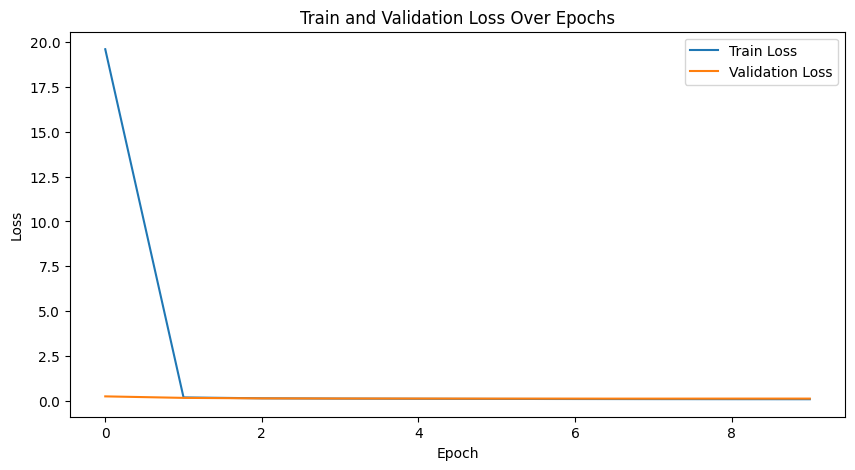

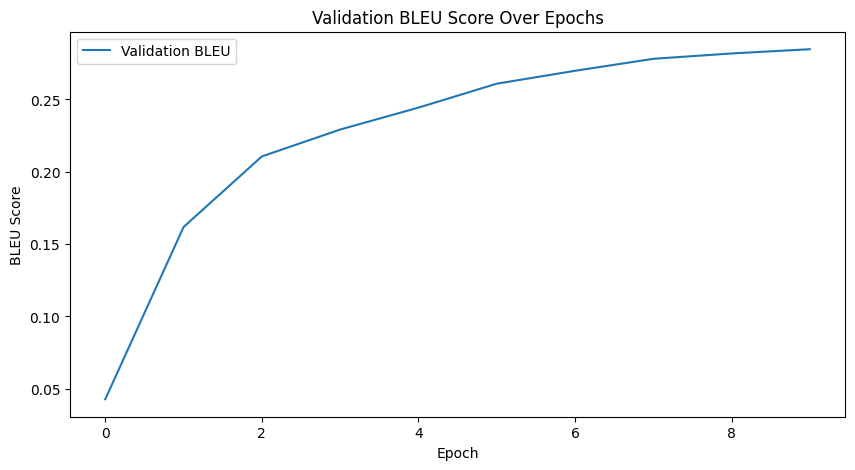

In [ ]:
#his
history = {
    'train_loss': [],
    'val_loss': [],
    'val_bleu': []
}

for epoch in range(10):
    print(f'Epoch {epoch + 1}/{10}')
    train_loss = train_epoch(model, train_loader, optimizer, device, scheduler)
    val_loss, val_bleu = eval_model(model, val_loader, device, tokenizer)

    history['train_loss'].append(train_loss)
    history['val_loss'].append(val_loss)
    history['val_bleu'].append(val_bleu)

    print(f'Train Loss: {train_loss} | Validation Loss: {val_loss} | Validation BLEU: {val_bleu}')

#plot
plt.figure(figsize=(10, 5))
plt.plot(history['train_loss'], label='Train Loss')
plt.plot(history['val_loss'], label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Train and Validation Loss Over Epochs')
plt.legend()
plt.show()

plt.figure(figsize=(10, 5))
plt.plot(history['val_bleu'], label='Validation BLEU')
plt.xlabel('Epoch')
plt.ylabel('BLEU Score')
plt.title('Validation BLEU Score Over Epochs')
plt.legend()
plt.show()


In [12]:
print(history['train_loss'])
print(history['val_loss'])
print(history['val_bleu'])

[19.607108366041096, 0.1826123495167944, 0.13411813032107975, 0.11810062162678946, 0.10820571898217844, 0.10064745100869572, 0.09458960042978715, 0.08997675708799813, 0.08604775625769358, 0.08317366245872707]
[0.2421446536074985, 0.15813576421461814, 0.13108129078322206, 0.1235697454041686, 0.12044804327128347, 0.1166979067858832, 0.11674384842665235, 0.11614621191108522, 0.11789240626202635, 0.1182312090288509]
[0.04277478426333996, 0.1617642459716386, 0.21056996301114536, 0.22915878834951472, 0.24430596905595128, 0.26083905235303134, 0.269766999382192, 0.27804712279652627, 0.28175302609208386, 0.28467933532433887]
